In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "orig"
enable_aug = False
enable_aug3 = True
sentence_pairs = False
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-orig-enable_aug-False-enable_aug3-True-sentence_pairs-False-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

194419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

194419
194419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 57/194419 [00:00<05:49, 556.82it/s]

  0%|          | 126/194419 [00:00<05:08, 630.44it/s]

  0%|          | 213/194419 [00:00<04:23, 737.73it/s]

  0%|          | 305/194419 [00:00<04:01, 803.73it/s]

  0%|          | 408/194419 [00:00<03:39, 883.74it/s]

  0%|          | 497/194419 [00:00<03:38, 885.69it/s]

  0%|          | 592/194419 [00:00<03:34, 905.15it/s]

  0%|          | 696/194419 [00:00<03:24, 945.35it/s]

  0%|          | 802/194419 [00:00<03:17, 979.32it/s]

  0%|          | 906/194419 [00:01<03:14, 996.35it/s]

  1%|          | 1006/194419 [00:01<03:16, 982.62it/s]

  1%|          | 1105/194419 [00:01<03:17, 980.19it/s]

  1%|          | 1204/194419 [00:01<03:17, 980.77it/s]

  1%|          | 1313/194419 [00:01<03:10, 1011.73it/s]

  1%|          | 1415/194419 [00:01<04:01, 798.91it/s] 

  1%|          | 1518/194419 [00:01<03:45, 856.29it/s]

  1%|          | 1618/194419 [00:01<03:35, 893.54it/s]

  1%|          | 1713/194419 [00:01<03:36, 890.33it/s]

  1%|          | 1820/194419 [00:02<03:25, 938.63it/s]

  1%|          | 1931/194419 [00:02<03:15, 984.76it/s]

  1%|          | 2040/194419 [00:02<03:10, 1012.02it/s]

  1%|          | 2146/194419 [00:02<03:07, 1025.15it/s]

  1%|          | 2250/194419 [00:02<03:10, 1007.91it/s]

  1%|          | 2357/194419 [00:02<03:08, 1021.51it/s]

  1%|▏         | 2465/194419 [00:02<03:04, 1038.42it/s]

  1%|▏         | 2570/194419 [00:02<03:05, 1036.59it/s]

  1%|▏         | 2676/194419 [00:02<03:04, 1041.01it/s]

  1%|▏         | 2781/194419 [00:02<03:06, 1029.83it/s]

  1%|▏         | 2886/194419 [00:03<03:05, 1034.15it/s]

  2%|▏         | 2990/194419 [00:03<03:17, 967.41it/s] 

  2%|▏         | 3097/194419 [00:03<03:13, 987.91it/s]

  2%|▏         | 3201/194419 [00:03<03:10, 1002.39it/s]

  2%|▏         | 3304/194419 [00:03<03:09, 1010.27it/s]

  2%|▏         | 3411/194419 [00:03<03:06, 1026.36it/s]

  2%|▏         | 3527/194419 [00:03<02:59, 1063.64it/s]

  2%|▏         | 3650/194419 [00:03<02:51, 1112.43it/s]

  2%|▏         | 3767/194419 [00:03<02:48, 1129.35it/s]

  2%|▏         | 3884/194419 [00:03<02:47, 1139.33it/s]

  2%|▏         | 3999/194419 [00:04<02:47, 1135.30it/s]

  2%|▏         | 4113/194419 [00:04<02:51, 1108.07it/s]

  2%|▏         | 4237/194419 [00:04<02:45, 1146.10it/s]

  2%|▏         | 4355/194419 [00:04<02:44, 1152.33it/s]

  2%|▏         | 4471/194419 [00:04<02:46, 1140.22it/s]

  2%|▏         | 4586/194419 [00:04<02:46, 1141.08it/s]

  2%|▏         | 4704/194419 [00:04<02:44, 1151.05it/s]

  2%|▏         | 4820/194419 [00:04<02:50, 1112.86it/s]

  3%|▎         | 4947/194419 [00:04<02:43, 1155.71it/s]

  3%|▎         | 5063/194419 [00:04<02:45, 1141.38it/s]

  3%|▎         | 5189/194419 [00:05<02:41, 1173.82it/s]

  3%|▎         | 5307/194419 [00:05<02:51, 1103.80it/s]

  3%|▎         | 5422/194419 [00:05<02:49, 1114.24it/s]

  3%|▎         | 5542/194419 [00:05<02:46, 1137.07it/s]

  3%|▎         | 5657/194419 [00:05<02:51, 1103.40it/s]

  3%|▎         | 5772/194419 [00:05<02:49, 1114.67it/s]

  3%|▎         | 5885/194419 [00:05<02:48, 1116.06it/s]

  3%|▎         | 5999/194419 [00:05<02:48, 1120.71it/s]

  3%|▎         | 6124/194419 [00:05<02:42, 1157.35it/s]

  3%|▎         | 6243/194419 [00:06<02:41, 1165.68it/s]

  3%|▎         | 6364/194419 [00:06<02:39, 1178.80it/s]

  3%|▎         | 6483/194419 [00:06<02:39, 1180.97it/s]

  3%|▎         | 6610/194419 [00:06<02:35, 1204.49it/s]

  3%|▎         | 6731/194419 [00:06<02:39, 1179.23it/s]

  4%|▎         | 6850/194419 [00:06<02:44, 1143.30it/s]

  4%|▎         | 6965/194419 [00:06<02:50, 1096.33it/s]

  4%|▎         | 7076/194419 [00:06<02:52, 1087.40it/s]

  4%|▎         | 7186/194419 [00:06<02:52, 1087.14it/s]

  4%|▍         | 7303/194419 [00:06<02:48, 1110.80it/s]

  4%|▍         | 7430/194419 [00:07<02:42, 1154.25it/s]

  4%|▍         | 7546/194419 [00:07<02:45, 1127.18it/s]

  4%|▍         | 7670/194419 [00:07<02:41, 1158.73it/s]

  4%|▍         | 7787/194419 [00:07<02:44, 1132.12it/s]

  4%|▍         | 7901/194419 [00:07<02:46, 1122.07it/s]

  4%|▍         | 8018/194419 [00:07<02:44, 1134.06it/s]

  4%|▍         | 8132/194419 [00:07<02:46, 1116.96it/s]

  4%|▍         | 8250/194419 [00:07<02:44, 1134.11it/s]

  4%|▍         | 8374/194419 [00:07<02:39, 1162.88it/s]

  4%|▍         | 8491/194419 [00:08<02:42, 1147.29it/s]

  4%|▍         | 8606/194419 [00:08<02:42, 1140.01it/s]

  4%|▍         | 8728/194419 [00:08<02:39, 1163.37it/s]

  5%|▍         | 8845/194419 [00:08<03:41, 837.02it/s] 

  5%|▍         | 8959/194419 [00:08<03:24, 907.29it/s]

  5%|▍         | 9078/194419 [00:08<03:09, 977.49it/s]

  5%|▍         | 9207/194419 [00:08<02:54, 1059.14it/s]

  5%|▍         | 9322/194419 [00:08<02:50, 1082.96it/s]

  5%|▍         | 9444/194419 [00:08<02:45, 1120.10it/s]

  5%|▍         | 9566/194419 [00:09<02:40, 1148.17it/s]

  5%|▍         | 9687/194419 [00:09<02:39, 1161.77it/s]

  5%|▌         | 9806/194419 [00:09<02:38, 1161.73it/s]

  5%|▌         | 9924/194419 [00:09<02:38, 1164.19it/s]

  5%|▌         | 10045/194419 [00:09<02:36, 1176.92it/s]

  5%|▌         | 10164/194419 [00:09<02:38, 1159.50it/s]

  5%|▌         | 10281/194419 [00:09<02:44, 1119.27it/s]

  5%|▌         | 10396/194419 [00:09<02:43, 1126.96it/s]

  5%|▌         | 10527/194419 [00:09<02:36, 1176.47it/s]

  5%|▌         | 10646/194419 [00:09<02:37, 1163.64it/s]

  6%|▌         | 10763/194419 [00:10<02:38, 1162.17it/s]

  6%|▌         | 10883/194419 [00:10<02:36, 1171.77it/s]

  6%|▌         | 11001/194419 [00:10<02:37, 1167.01it/s]

  6%|▌         | 11118/194419 [00:10<02:37, 1160.44it/s]

  6%|▌         | 11238/194419 [00:10<02:36, 1171.99it/s]

  6%|▌         | 11357/194419 [00:10<02:35, 1176.57it/s]

  6%|▌         | 11480/194419 [00:10<02:33, 1191.71it/s]

  6%|▌         | 11600/194419 [00:10<02:36, 1166.18it/s]

  6%|▌         | 11726/194419 [00:10<02:33, 1191.10it/s]

  6%|▌         | 11846/194419 [00:10<02:32, 1193.54it/s]

  6%|▌         | 11969/194419 [00:11<02:31, 1203.72it/s]

  6%|▌         | 12090/194419 [00:11<02:31, 1202.81it/s]

  6%|▋         | 12211/194419 [00:11<02:31, 1201.30it/s]

  6%|▋         | 12332/194419 [00:11<02:31, 1200.30it/s]

  6%|▋         | 12453/194419 [00:11<02:33, 1185.39it/s]

  6%|▋         | 12573/194419 [00:11<02:33, 1187.14it/s]

  7%|▋         | 12692/194419 [00:11<02:36, 1163.99it/s]

  7%|▋         | 12809/194419 [00:11<02:39, 1138.24it/s]

  7%|▋         | 12942/194419 [00:11<02:32, 1192.65it/s]

  7%|▋         | 13069/194419 [00:12<02:29, 1212.87it/s]

  7%|▋         | 13191/194419 [00:12<02:31, 1198.76it/s]

  7%|▋         | 13322/194419 [00:12<02:27, 1228.21it/s]

  7%|▋         | 13445/194419 [00:12<02:29, 1207.58it/s]

  7%|▋         | 13566/194419 [00:12<02:29, 1205.98it/s]

  7%|▋         | 13700/194419 [00:12<02:25, 1240.22it/s]

  7%|▋         | 13825/194419 [00:12<02:26, 1230.61it/s]

  7%|▋         | 13949/194419 [00:12<02:27, 1223.54it/s]

  7%|▋         | 14073/194419 [00:12<02:27, 1226.11it/s]

  7%|▋         | 14196/194419 [00:12<02:28, 1211.69it/s]

  7%|▋         | 14318/194419 [00:13<02:29, 1202.93it/s]

  7%|▋         | 14447/194419 [00:13<02:26, 1224.89it/s]

  7%|▋         | 14570/194419 [00:13<02:30, 1191.61it/s]

  8%|▊         | 14690/194419 [00:13<02:32, 1180.77it/s]

  8%|▊         | 14812/194419 [00:13<02:30, 1191.87it/s]

  8%|▊         | 14932/194419 [00:13<02:31, 1183.47it/s]

  8%|▊         | 15052/194419 [00:13<02:30, 1188.30it/s]

  8%|▊         | 15178/194419 [00:13<02:28, 1207.78it/s]

  8%|▊         | 15300/194419 [00:13<02:28, 1209.90it/s]

  8%|▊         | 15422/194419 [00:13<02:28, 1204.90it/s]

  8%|▊         | 15550/194419 [00:14<02:25, 1227.05it/s]

  8%|▊         | 15673/194419 [00:14<02:26, 1219.11it/s]

  8%|▊         | 15797/194419 [00:14<02:25, 1223.70it/s]

  8%|▊         | 15920/194419 [00:14<02:27, 1211.05it/s]

  8%|▊         | 16046/194419 [00:14<02:25, 1223.01it/s]

  8%|▊         | 16169/194419 [00:14<02:29, 1196.14it/s]

  8%|▊         | 16289/194419 [00:14<03:52, 766.89it/s] 

  8%|▊         | 16411/194419 [00:14<03:26, 861.88it/s]

  9%|▊         | 16538/194419 [00:15<03:06, 953.93it/s]

  9%|▊         | 16659/194419 [00:15<02:54, 1017.03it/s]

  9%|▊         | 16780/194419 [00:15<02:46, 1067.21it/s]

  9%|▊         | 16903/194419 [00:15<02:39, 1110.53it/s]

  9%|▉         | 17034/194419 [00:15<02:32, 1166.22it/s]

  9%|▉         | 17156/194419 [00:15<02:34, 1149.38it/s]

  9%|▉         | 17275/194419 [00:15<02:33, 1153.38it/s]

  9%|▉         | 17401/194419 [00:15<02:29, 1180.75it/s]

  9%|▉         | 17525/194419 [00:15<02:27, 1196.44it/s]

  9%|▉         | 17647/194419 [00:15<02:26, 1202.88it/s]

  9%|▉         | 17769/194419 [00:16<02:26, 1202.03it/s]

  9%|▉         | 17906/194419 [00:16<02:21, 1249.59it/s]

  9%|▉         | 18039/194419 [00:16<02:19, 1268.17it/s]

  9%|▉         | 18167/194419 [00:16<02:21, 1243.30it/s]

  9%|▉         | 18292/194419 [00:16<02:23, 1231.46it/s]

  9%|▉         | 18416/194419 [00:16<02:27, 1192.59it/s]

 10%|▉         | 18536/194419 [00:16<02:29, 1174.79it/s]

 10%|▉         | 18660/194419 [00:16<02:27, 1192.49it/s]

 10%|▉         | 18780/194419 [00:16<02:28, 1179.63it/s]

 10%|▉         | 18899/194419 [00:17<02:30, 1167.33it/s]

 10%|▉         | 19017/194419 [00:17<02:30, 1168.97it/s]

 10%|▉         | 19134/194419 [00:17<02:30, 1165.01it/s]

 10%|▉         | 19251/194419 [00:17<02:31, 1152.56it/s]

 10%|▉         | 19375/194419 [00:17<02:28, 1177.41it/s]

 10%|█         | 19493/194419 [00:17<02:30, 1163.96it/s]

 10%|█         | 19618/194419 [00:17<02:27, 1185.34it/s]

 10%|█         | 19754/194419 [00:17<02:21, 1232.75it/s]

 10%|█         | 19878/194419 [00:17<02:24, 1211.19it/s]

 10%|█         | 20000/194419 [00:17<02:24, 1210.41it/s]

 10%|█         | 20122/194419 [00:18<02:26, 1187.32it/s]

 10%|█         | 20246/194419 [00:18<02:25, 1200.45it/s]

 10%|█         | 20367/194419 [00:18<02:26, 1190.97it/s]

 11%|█         | 20487/194419 [00:18<02:27, 1181.39it/s]

 11%|█         | 20609/194419 [00:18<02:25, 1191.39it/s]

 11%|█         | 20741/194419 [00:18<02:21, 1228.31it/s]

 11%|█         | 20865/194419 [00:18<02:21, 1228.65it/s]

 11%|█         | 20988/194419 [00:18<02:22, 1217.98it/s]

 11%|█         | 21111/194419 [00:18<02:22, 1218.46it/s]

 11%|█         | 21233/194419 [00:18<02:26, 1179.98it/s]

 11%|█         | 21352/194419 [00:19<02:27, 1170.47it/s]

 11%|█         | 21477/194419 [00:19<02:25, 1191.37it/s]

 11%|█         | 21597/194419 [00:19<02:26, 1183.34it/s]

 11%|█         | 21717/194419 [00:19<02:25, 1187.40it/s]

 11%|█         | 21837/194419 [00:19<02:24, 1190.99it/s]

 11%|█▏        | 21957/194419 [00:19<02:26, 1178.61it/s]

 11%|█▏        | 22084/194419 [00:19<02:23, 1201.54it/s]

 11%|█▏        | 22216/194419 [00:19<02:19, 1235.03it/s]

 11%|█▏        | 22340/194419 [00:19<02:22, 1204.12it/s]

 12%|█▏        | 22461/194419 [00:20<02:25, 1181.40it/s]

 12%|█▏        | 22591/194419 [00:20<02:21, 1214.58it/s]

 12%|█▏        | 22713/194419 [00:20<02:21, 1210.76it/s]

 12%|█▏        | 22835/194419 [00:20<02:26, 1173.35it/s]

 12%|█▏        | 22956/194419 [00:20<02:24, 1183.10it/s]

 12%|█▏        | 23075/194419 [00:20<02:25, 1181.29it/s]

 12%|█▏        | 23195/194419 [00:20<02:24, 1185.90it/s]

 12%|█▏        | 23315/194419 [00:20<02:24, 1184.14it/s]

 12%|█▏        | 23440/194419 [00:20<02:22, 1201.96it/s]

 12%|█▏        | 23561/194419 [00:20<02:23, 1188.99it/s]

 12%|█▏        | 23691/194419 [00:21<02:19, 1219.71it/s]

 12%|█▏        | 23818/194419 [00:21<02:18, 1228.19it/s]

 12%|█▏        | 23942/194419 [00:21<02:18, 1231.03it/s]

 12%|█▏        | 24066/194419 [00:21<02:18, 1233.56it/s]

 12%|█▏        | 24190/194419 [00:21<02:18, 1230.37it/s]

 13%|█▎        | 24314/194419 [00:21<02:18, 1232.39it/s]

 13%|█▎        | 24438/194419 [00:21<02:19, 1222.14it/s]

 13%|█▎        | 24561/194419 [00:21<02:21, 1196.34it/s]

 13%|█▎        | 24689/194419 [00:21<02:19, 1219.78it/s]

 13%|█▎        | 24812/194419 [00:21<02:19, 1218.58it/s]

 13%|█▎        | 24934/194419 [00:22<04:01, 702.56it/s] 

 13%|█▎        | 25057/194419 [00:22<03:30, 805.08it/s]

 13%|█▎        | 25182/194419 [00:22<03:07, 900.54it/s]

 13%|█▎        | 25309/194419 [00:22<02:51, 985.83it/s]

 13%|█▎        | 25424/194419 [00:22<02:44, 1025.56it/s]

 13%|█▎        | 25550/194419 [00:22<02:35, 1084.00it/s]

 13%|█▎        | 25676/194419 [00:22<02:29, 1131.53it/s]

 13%|█▎        | 25805/194419 [00:23<02:23, 1174.71it/s]

 13%|█▎        | 25932/194419 [00:23<02:20, 1201.22it/s]

 13%|█▎        | 26056/194419 [00:23<02:20, 1195.26it/s]

 13%|█▎        | 26179/194419 [00:23<02:19, 1201.77it/s]

 14%|█▎        | 26308/194419 [00:23<02:17, 1226.64it/s]

 14%|█▎        | 26436/194419 [00:23<02:15, 1242.27it/s]

 14%|█▎        | 26562/194419 [00:23<02:16, 1225.29it/s]

 14%|█▎        | 26697/194419 [00:23<02:13, 1259.56it/s]

 14%|█▍        | 26824/194419 [00:23<02:17, 1217.19it/s]

 14%|█▍        | 26947/194419 [00:23<02:19, 1202.53it/s]

 14%|█▍        | 27069/194419 [00:24<02:18, 1207.37it/s]

 14%|█▍        | 27191/194419 [00:24<02:18, 1204.47it/s]

 14%|█▍        | 27312/194419 [00:24<02:23, 1166.29it/s]

 14%|█▍        | 27437/194419 [00:24<02:20, 1189.87it/s]

 14%|█▍        | 27557/194419 [00:24<02:22, 1172.48it/s]

 14%|█▍        | 27686/194419 [00:24<02:18, 1206.10it/s]

 14%|█▍        | 27816/194419 [00:24<02:15, 1230.09it/s]

 14%|█▍        | 27940/194419 [00:24<02:15, 1228.34it/s]

 14%|█▍        | 28069/194419 [00:24<02:13, 1243.63it/s]

 15%|█▍        | 28196/194419 [00:24<02:13, 1249.18it/s]

 15%|█▍        | 28322/194419 [00:25<02:14, 1236.83it/s]

 15%|█▍        | 28446/194419 [00:25<02:15, 1228.60it/s]

 15%|█▍        | 28578/194419 [00:25<02:12, 1251.53it/s]

 15%|█▍        | 28704/194419 [00:25<02:15, 1225.69it/s]

 15%|█▍        | 28830/194419 [00:25<02:14, 1235.17it/s]

 15%|█▍        | 28957/194419 [00:25<02:13, 1242.97it/s]

 15%|█▍        | 29082/194419 [00:25<02:12, 1244.37it/s]

 15%|█▌        | 29215/194419 [00:25<02:10, 1267.04it/s]

 15%|█▌        | 29342/194419 [00:25<02:11, 1252.88it/s]

 15%|█▌        | 29468/194419 [00:25<02:14, 1226.98it/s]

 15%|█▌        | 29591/194419 [00:26<02:18, 1191.21it/s]

 15%|█▌        | 29713/194419 [00:26<02:17, 1198.51it/s]

 15%|█▌        | 29834/194419 [00:26<02:20, 1173.58it/s]

 15%|█▌        | 29954/194419 [00:26<02:19, 1179.42it/s]

 15%|█▌        | 30074/194419 [00:26<02:18, 1182.67it/s]

 16%|█▌        | 30193/194419 [00:26<02:22, 1154.56it/s]

 16%|█▌        | 30309/194419 [00:26<02:24, 1136.64it/s]

 16%|█▌        | 30433/194419 [00:26<02:20, 1164.53it/s]

 16%|█▌        | 30558/194419 [00:26<02:17, 1188.70it/s]

 16%|█▌        | 30678/194419 [00:27<02:18, 1181.05it/s]

 16%|█▌        | 30797/194419 [00:27<02:18, 1177.49it/s]

 16%|█▌        | 30915/194419 [00:27<02:20, 1162.36it/s]

 16%|█▌        | 31038/194419 [00:27<02:18, 1181.78it/s]

 16%|█▌        | 31170/194419 [00:27<02:13, 1220.65it/s]

 16%|█▌        | 31296/194419 [00:27<02:12, 1231.91it/s]

 16%|█▌        | 31426/194419 [00:27<02:10, 1251.18it/s]

 16%|█▌        | 31552/194419 [00:27<02:13, 1215.62it/s]

 16%|█▋        | 31689/194419 [00:27<02:09, 1259.14it/s]

 16%|█▋        | 31816/194419 [00:27<02:11, 1233.61it/s]

 16%|█▋        | 31945/194419 [00:28<02:10, 1246.95it/s]

 16%|█▋        | 32070/194419 [00:28<02:11, 1236.32it/s]

 17%|█▋        | 32194/194419 [00:28<02:12, 1225.94it/s]

 17%|█▋        | 32317/194419 [00:28<02:15, 1195.84it/s]

 17%|█▋        | 32437/194419 [00:28<02:16, 1189.38it/s]

 17%|█▋        | 32560/194419 [00:28<02:14, 1200.22it/s]

 17%|█▋        | 32696/194419 [00:28<02:09, 1245.72it/s]

 17%|█▋        | 32831/194419 [00:28<02:07, 1271.39it/s]

 17%|█▋        | 32959/194419 [00:28<02:08, 1252.50it/s]

 17%|█▋        | 33085/194419 [00:28<02:09, 1242.16it/s]

 17%|█▋        | 33211/194419 [00:29<02:09, 1241.40it/s]

 17%|█▋        | 33336/194419 [00:29<02:14, 1199.89it/s]

 17%|█▋        | 33461/194419 [00:29<02:12, 1211.61it/s]

 17%|█▋        | 33586/194419 [00:29<02:12, 1213.96it/s]

 17%|█▋        | 33710/194419 [00:29<02:11, 1218.56it/s]

 17%|█▋        | 33833/194419 [00:29<02:11, 1219.28it/s]

 17%|█▋        | 33963/194419 [00:29<02:09, 1242.72it/s]

 18%|█▊        | 34094/194419 [00:29<02:07, 1262.31it/s]

 18%|█▊        | 34221/194419 [00:29<02:08, 1247.85it/s]

 18%|█▊        | 34346/194419 [00:30<02:09, 1233.46it/s]

 18%|█▊        | 34470/194419 [00:30<02:13, 1198.39it/s]

 18%|█▊        | 34616/194419 [00:30<02:05, 1271.12it/s]

 18%|█▊        | 34744/194419 [00:30<02:06, 1262.81it/s]

 18%|█▊        | 34871/194419 [00:30<02:06, 1262.95it/s]

 18%|█▊        | 35007/194419 [00:30<02:03, 1290.81it/s]

 18%|█▊        | 35137/194419 [00:30<02:07, 1247.36it/s]

 18%|█▊        | 35268/194419 [00:30<02:05, 1265.19it/s]

 18%|█▊        | 35395/194419 [00:30<02:07, 1246.77it/s]

 18%|█▊        | 35520/194419 [00:30<02:09, 1230.19it/s]

 18%|█▊        | 35644/194419 [00:31<04:10, 633.97it/s] 

 18%|█▊        | 35777/194419 [00:31<03:29, 755.53it/s]

 18%|█▊        | 35916/194419 [00:31<02:59, 882.03it/s]

 19%|█▊        | 36036/194419 [00:31<02:46, 951.50it/s]

 19%|█▊        | 36157/194419 [00:31<02:36, 1013.11it/s]

 19%|█▊        | 36278/194419 [00:31<02:28, 1062.23it/s]

 19%|█▊        | 36401/194419 [00:31<02:23, 1104.84it/s]

 19%|█▉        | 36525/194419 [00:32<02:18, 1141.35it/s]

 19%|█▉        | 36655/194419 [00:32<02:13, 1185.50it/s]

 19%|█▉        | 36779/194419 [00:32<02:12, 1193.34it/s]

 19%|█▉        | 36902/194419 [00:32<02:12, 1186.89it/s]

 19%|█▉        | 37024/194419 [00:32<02:12, 1187.77it/s]

 19%|█▉        | 37145/194419 [00:32<02:12, 1187.53it/s]

 19%|█▉        | 37272/194419 [00:32<02:09, 1211.42it/s]

 19%|█▉        | 37400/194419 [00:32<02:07, 1230.16it/s]

 19%|█▉        | 37524/194419 [00:32<02:08, 1218.58it/s]

 19%|█▉        | 37647/194419 [00:33<02:11, 1194.24it/s]

 19%|█▉        | 37783/194419 [00:33<02:06, 1241.84it/s]

 20%|█▉        | 37916/194419 [00:33<02:03, 1264.24it/s]

 20%|█▉        | 38043/194419 [00:33<02:05, 1244.23it/s]

 20%|█▉        | 38168/194419 [00:33<02:05, 1244.32it/s]

 20%|█▉        | 38293/194419 [00:33<02:09, 1203.63it/s]

 20%|█▉        | 38420/194419 [00:33<02:07, 1221.08it/s]

 20%|█▉        | 38543/194419 [00:33<02:10, 1192.60it/s]

 20%|█▉        | 38663/194419 [00:33<02:11, 1186.34it/s]

 20%|█▉        | 38792/194419 [00:33<02:08, 1212.75it/s]

 20%|██        | 38914/194419 [00:34<02:10, 1191.06it/s]

 20%|██        | 39034/194419 [00:34<02:11, 1179.99it/s]

 20%|██        | 39163/194419 [00:34<02:08, 1209.97it/s]

 20%|██        | 39293/194419 [00:34<02:05, 1235.23it/s]

 20%|██        | 39421/194419 [00:34<02:04, 1247.71it/s]

 20%|██        | 39547/194419 [00:34<02:05, 1236.63it/s]

 20%|██        | 39671/194419 [00:34<02:06, 1225.76it/s]

 20%|██        | 39797/194419 [00:34<02:05, 1234.97it/s]

 21%|██        | 39924/194419 [00:34<02:04, 1237.98it/s]

 21%|██        | 40050/194419 [00:34<02:04, 1240.65it/s]

 21%|██        | 40179/194419 [00:35<02:03, 1252.57it/s]

 21%|██        | 40305/194419 [00:35<02:03, 1248.85it/s]

 21%|██        | 40430/194419 [00:35<02:05, 1229.62it/s]

 21%|██        | 40568/194419 [00:35<02:00, 1273.59it/s]

 21%|██        | 40696/194419 [00:35<02:03, 1241.63it/s]

 21%|██        | 40821/194419 [00:35<02:04, 1234.00it/s]

 21%|██        | 40945/194419 [00:35<02:05, 1222.42it/s]

 21%|██        | 41077/194419 [00:35<02:02, 1250.62it/s]

 21%|██        | 41205/194419 [00:35<02:02, 1255.44it/s]

 21%|██▏       | 41331/194419 [00:35<02:02, 1247.30it/s]

 21%|██▏       | 41461/194419 [00:36<02:01, 1258.36it/s]

 21%|██▏       | 41587/194419 [00:36<02:05, 1217.23it/s]

 21%|██▏       | 41714/194419 [00:36<02:04, 1231.46it/s]

 22%|██▏       | 41839/194419 [00:36<02:03, 1234.69it/s]

 22%|██▏       | 41969/194419 [00:36<02:01, 1253.83it/s]

 22%|██▏       | 42095/194419 [00:36<02:01, 1248.95it/s]

 22%|██▏       | 42221/194419 [00:36<02:04, 1227.27it/s]

 22%|██▏       | 42344/194419 [00:36<02:06, 1204.91it/s]

 22%|██▏       | 42473/194419 [00:36<02:03, 1228.99it/s]

 22%|██▏       | 42601/194419 [00:37<02:02, 1243.40it/s]

 22%|██▏       | 42736/194419 [00:37<01:59, 1274.25it/s]

 22%|██▏       | 42871/194419 [00:37<01:57, 1294.90it/s]

 22%|██▏       | 43001/194419 [00:37<01:59, 1265.70it/s]

 22%|██▏       | 43132/194419 [00:37<01:58, 1276.92it/s]

 22%|██▏       | 43260/194419 [00:37<01:59, 1266.69it/s]

 22%|██▏       | 43387/194419 [00:37<01:59, 1262.67it/s]

 22%|██▏       | 43514/194419 [00:37<01:59, 1257.91it/s]

 22%|██▏       | 43640/194419 [00:37<02:05, 1199.50it/s]

 23%|██▎       | 43768/194419 [00:37<02:03, 1218.77it/s]

 23%|██▎       | 43905/194419 [00:38<01:59, 1259.00it/s]

 23%|██▎       | 44036/194419 [00:38<01:58, 1266.48it/s]

 23%|██▎       | 44163/194419 [00:38<02:00, 1246.03it/s]

 23%|██▎       | 44288/194419 [00:38<02:00, 1245.04it/s]

 23%|██▎       | 44414/194419 [00:38<02:00, 1248.02it/s]

 23%|██▎       | 44539/194419 [00:38<02:00, 1241.70it/s]

 23%|██▎       | 44664/194419 [00:38<02:03, 1214.00it/s]

 23%|██▎       | 44786/194419 [00:38<02:03, 1213.68it/s]

 23%|██▎       | 44910/194419 [00:38<02:02, 1220.53it/s]

 23%|██▎       | 45034/194419 [00:38<02:01, 1225.19it/s]

 23%|██▎       | 45158/194419 [00:39<02:01, 1229.21it/s]

 23%|██▎       | 45281/194419 [00:39<02:01, 1226.00it/s]

 23%|██▎       | 45404/194419 [00:39<02:05, 1185.34it/s]

 23%|██▎       | 45523/194419 [00:39<02:07, 1172.26it/s]

 23%|██▎       | 45651/194419 [00:39<02:03, 1203.36it/s]

 24%|██▎       | 45772/194419 [00:39<02:03, 1205.10it/s]

 24%|██▎       | 45901/194419 [00:39<02:00, 1229.24it/s]

 24%|██▎       | 46032/194419 [00:39<01:58, 1248.37it/s]

 24%|██▎       | 46158/194419 [00:39<01:58, 1247.30it/s]

 24%|██▍       | 46283/194419 [00:39<01:59, 1243.90it/s]

 24%|██▍       | 46408/194419 [00:40<02:03, 1202.69it/s]

 24%|██▍       | 46535/194419 [00:40<02:01, 1221.24it/s]

 24%|██▍       | 46658/194419 [00:40<02:01, 1216.82it/s]

 24%|██▍       | 46780/194419 [00:40<02:02, 1202.83it/s]

 24%|██▍       | 46901/194419 [00:40<02:02, 1201.30it/s]

 24%|██▍       | 47027/194419 [00:40<02:01, 1218.09it/s]

 24%|██▍       | 47153/194419 [00:40<01:59, 1229.55it/s]

 24%|██▍       | 47277/194419 [00:40<02:04, 1179.50it/s]

 24%|██▍       | 47402/194419 [00:40<02:02, 1199.29it/s]

 24%|██▍       | 47544/194419 [00:41<01:56, 1261.74it/s]

 25%|██▍       | 47679/194419 [00:41<01:54, 1282.19it/s]

 25%|██▍       | 47810/194419 [00:41<01:53, 1289.76it/s]

 25%|██▍       | 47940/194419 [00:41<01:53, 1291.33it/s]

 25%|██▍       | 48084/194419 [00:41<01:49, 1331.05it/s]

 25%|██▍       | 48218/194419 [00:41<01:50, 1324.72it/s]

 25%|██▍       | 48351/194419 [00:41<01:50, 1323.44it/s]

 25%|██▍       | 48484/194419 [00:41<01:50, 1316.42it/s]

 25%|██▌       | 48625/194419 [00:41<01:48, 1341.59it/s]

 25%|██▌       | 48761/194419 [00:41<01:48, 1346.98it/s]

 25%|██▌       | 48896/194419 [00:42<01:52, 1297.61it/s]

 25%|██▌       | 49027/194419 [00:42<04:01, 602.51it/s] 

 25%|██▌       | 49153/194419 [00:42<03:25, 707.75it/s]

 25%|██▌       | 49284/194419 [00:42<02:56, 820.20it/s]

 25%|██▌       | 49420/194419 [00:42<02:35, 933.31it/s]

 25%|██▌       | 49541/194419 [00:42<02:26, 988.71it/s]

 26%|██▌       | 49671/194419 [00:43<02:15, 1065.10it/s]

 26%|██▌       | 49794/194419 [00:43<02:10, 1105.90it/s]

 26%|██▌       | 49925/194419 [00:43<02:04, 1159.72it/s]

 26%|██▌       | 50065/194419 [00:43<01:57, 1225.78it/s]

 26%|██▌       | 50195/194419 [00:43<01:56, 1242.09it/s]

 26%|██▌       | 50324/194419 [00:43<01:56, 1236.06it/s]

 26%|██▌       | 50451/194419 [00:43<01:55, 1243.22it/s]

 26%|██▌       | 50588/194419 [00:43<01:52, 1280.05it/s]

 26%|██▌       | 50720/194419 [00:43<01:51, 1290.91it/s]

 26%|██▌       | 50851/194419 [00:43<01:51, 1286.03it/s]

 26%|██▌       | 50991/194419 [00:44<01:48, 1318.70it/s]

 26%|██▋       | 51124/194419 [00:44<01:48, 1315.85it/s]

 26%|██▋       | 51266/194419 [00:44<01:46, 1345.92it/s]

 26%|██▋       | 51401/194419 [00:44<01:48, 1324.14it/s]

 27%|██▋       | 51534/194419 [00:44<01:48, 1322.76it/s]

 27%|██▋       | 51667/194419 [00:44<01:50, 1293.77it/s]

 27%|██▋       | 51797/194419 [00:44<01:50, 1285.07it/s]

 27%|██▋       | 51933/194419 [00:44<01:49, 1306.19it/s]

 27%|██▋       | 52064/194419 [00:44<01:49, 1298.46it/s]

 27%|██▋       | 52194/194419 [00:44<01:51, 1275.05it/s]

 27%|██▋       | 52322/194419 [00:45<01:52, 1267.06it/s]

 27%|██▋       | 52449/194419 [00:45<01:54, 1243.38it/s]

 27%|██▋       | 52592/194419 [00:45<01:49, 1294.56it/s]

 27%|██▋       | 52722/194419 [00:45<01:50, 1287.84it/s]

 27%|██▋       | 52856/194419 [00:45<01:48, 1300.45it/s]

 27%|██▋       | 52988/194419 [00:45<01:48, 1302.83it/s]

 27%|██▋       | 53125/194419 [00:45<01:47, 1317.19it/s]

 27%|██▋       | 53257/194419 [00:45<01:47, 1317.73it/s]

 27%|██▋       | 53395/194419 [00:45<01:45, 1335.29it/s]

 28%|██▊       | 53529/194419 [00:46<01:45, 1334.33it/s]

 28%|██▊       | 53665/194419 [00:46<01:45, 1338.01it/s]

 28%|██▊       | 53799/194419 [00:46<01:47, 1306.14it/s]

 28%|██▊       | 53930/194419 [00:46<01:49, 1286.58it/s]

 28%|██▊       | 54061/194419 [00:46<01:48, 1292.28it/s]

 28%|██▊       | 54191/194419 [00:46<01:48, 1293.44it/s]

 28%|██▊       | 54325/194419 [00:46<01:47, 1301.97it/s]

 28%|██▊       | 54459/194419 [00:46<01:46, 1312.66it/s]

 28%|██▊       | 54596/194419 [00:46<01:45, 1329.53it/s]

 28%|██▊       | 54730/194419 [00:46<01:46, 1311.76it/s]

 28%|██▊       | 54862/194419 [00:47<01:46, 1306.40it/s]

 28%|██▊       | 54993/194419 [00:47<01:49, 1279.00it/s]

 28%|██▊       | 55124/194419 [00:47<01:48, 1284.79it/s]

 28%|██▊       | 55254/194419 [00:47<01:48, 1286.63it/s]

 28%|██▊       | 55383/194419 [00:47<01:48, 1284.36it/s]

 29%|██▊       | 55512/194419 [00:47<01:48, 1283.86it/s]

 29%|██▊       | 55641/194419 [00:47<01:49, 1271.02it/s]

 29%|██▊       | 55779/194419 [00:47<01:46, 1303.06it/s]

 29%|██▉       | 55919/194419 [00:47<01:44, 1330.41it/s]

 29%|██▉       | 56053/194419 [00:47<01:44, 1326.36it/s]

 29%|██▉       | 56186/194419 [00:48<01:47, 1286.11it/s]

 29%|██▉       | 56325/194419 [00:48<01:45, 1314.69it/s]

 29%|██▉       | 56457/194419 [00:48<01:45, 1305.09it/s]

 29%|██▉       | 56588/194419 [00:48<01:45, 1305.37it/s]

 29%|██▉       | 56719/194419 [00:48<01:45, 1302.32it/s]

 29%|██▉       | 56854/194419 [00:48<01:44, 1315.67it/s]

 29%|██▉       | 56986/194419 [00:48<01:46, 1288.06it/s]

 29%|██▉       | 57115/194419 [00:48<01:47, 1280.77it/s]

 29%|██▉       | 57244/194419 [00:48<01:48, 1260.50it/s]

 30%|██▉       | 57371/194419 [00:48<01:49, 1248.95it/s]

 30%|██▉       | 57498/194419 [00:49<01:49, 1251.73it/s]

 30%|██▉       | 57624/194419 [00:49<01:49, 1245.31it/s]

 30%|██▉       | 57749/194419 [00:49<01:50, 1234.53it/s]

 30%|██▉       | 57886/194419 [00:49<01:47, 1271.83it/s]

 30%|██▉       | 58014/194419 [00:49<01:48, 1260.20it/s]

 30%|██▉       | 58143/194419 [00:49<01:47, 1265.48it/s]

 30%|██▉       | 58270/194419 [00:49<01:47, 1265.31it/s]

 30%|███       | 58403/194419 [00:49<01:45, 1283.94it/s]

 30%|███       | 58532/194419 [00:49<01:46, 1279.66it/s]

 30%|███       | 58660/194419 [00:50<01:46, 1275.92it/s]

 30%|███       | 58797/194419 [00:50<01:44, 1302.15it/s]

 30%|███       | 58928/194419 [00:50<01:46, 1273.17it/s]

 30%|███       | 59056/194419 [00:50<01:48, 1242.82it/s]

 30%|███       | 59185/194419 [00:50<01:47, 1253.57it/s]

 31%|███       | 59314/194419 [00:50<01:47, 1262.30it/s]

 31%|███       | 59447/194419 [00:50<01:45, 1279.41it/s]

 31%|███       | 59576/194419 [00:50<01:46, 1263.14it/s]

 31%|███       | 59703/194419 [00:50<01:46, 1260.17it/s]

 31%|███       | 59830/194419 [00:50<01:46, 1258.77it/s]

 31%|███       | 59956/194419 [00:51<01:47, 1256.62it/s]

 31%|███       | 60082/194419 [00:51<01:49, 1225.52it/s]

 31%|███       | 60208/194419 [00:51<01:48, 1231.91it/s]

 31%|███       | 60332/194419 [00:51<01:52, 1196.18it/s]

 31%|███       | 60464/194419 [00:51<01:48, 1230.79it/s]

 31%|███       | 60592/194419 [00:51<01:47, 1240.16it/s]

 31%|███       | 60718/194419 [00:51<01:47, 1245.90it/s]

 31%|███▏      | 60864/194419 [00:51<01:42, 1308.04it/s]

 31%|███▏      | 60996/194419 [00:51<01:42, 1298.50it/s]

 31%|███▏      | 61135/194419 [00:51<01:40, 1325.53it/s]

 32%|███▏      | 61268/194419 [00:52<01:44, 1274.98it/s]

 32%|███▏      | 61396/194419 [00:52<01:44, 1274.88it/s]

 32%|███▏      | 61524/194419 [00:52<01:44, 1269.69it/s]

 32%|███▏      | 61657/194419 [00:52<01:43, 1286.72it/s]

 32%|███▏      | 61793/194419 [00:52<01:41, 1308.02it/s]

 32%|███▏      | 61924/194419 [00:52<01:41, 1302.72it/s]

 32%|███▏      | 62055/194419 [00:52<01:42, 1295.70it/s]

 32%|███▏      | 62186/194419 [00:52<01:41, 1299.29it/s]

 32%|███▏      | 62318/194419 [00:52<01:41, 1302.91it/s]

 32%|███▏      | 62449/194419 [00:52<01:43, 1276.02it/s]

 32%|███▏      | 62577/194419 [00:53<01:44, 1258.86it/s]

 32%|███▏      | 62706/194419 [00:53<01:43, 1267.45it/s]

 32%|███▏      | 62833/194419 [00:53<01:45, 1247.09it/s]

 32%|███▏      | 62958/194419 [00:53<01:46, 1237.10it/s]

 32%|███▏      | 63086/194419 [00:53<01:45, 1248.48it/s]

 33%|███▎      | 63211/194419 [00:53<01:45, 1244.92it/s]

 33%|███▎      | 63336/194419 [00:53<01:47, 1219.17it/s]

 33%|███▎      | 63465/194419 [00:53<01:45, 1239.67it/s]

 33%|███▎      | 63590/194419 [00:53<01:45, 1239.23it/s]

 33%|███▎      | 63715/194419 [00:54<01:47, 1216.35it/s]

 33%|███▎      | 63846/194419 [00:54<01:45, 1241.34it/s]

 33%|███▎      | 63971/194419 [00:54<01:47, 1215.08it/s]

 33%|███▎      | 64099/194419 [00:54<01:45, 1229.45it/s]

 33%|███▎      | 64223/194419 [00:54<01:46, 1221.79it/s]

 33%|███▎      | 64350/194419 [00:54<01:45, 1233.75it/s]

 33%|███▎      | 64474/194419 [00:54<01:45, 1230.32it/s]

 33%|███▎      | 64602/194419 [00:54<01:44, 1241.16it/s]

 33%|███▎      | 64727/194419 [00:54<01:45, 1230.42it/s]

 33%|███▎      | 64859/194419 [00:54<01:43, 1256.69it/s]

 33%|███▎      | 64985/194419 [00:55<01:44, 1241.19it/s]

 33%|███▎      | 65110/194419 [00:55<01:45, 1228.40it/s]

 34%|███▎      | 65241/194419 [00:55<01:43, 1252.10it/s]

 34%|███▎      | 65376/194419 [00:55<01:40, 1280.97it/s]

 34%|███▎      | 65510/194419 [00:55<01:39, 1294.53it/s]

 34%|███▍      | 65640/194419 [00:55<01:40, 1283.52it/s]

 34%|███▍      | 65769/194419 [00:56<04:20, 493.86it/s] 

 34%|███▍      | 65896/194419 [00:56<03:33, 601.99it/s]

 34%|███▍      | 66026/194419 [00:56<02:58, 718.09it/s]

 34%|███▍      | 66139/194419 [00:56<02:41, 793.38it/s]

 34%|███▍      | 66260/194419 [00:56<02:25, 880.64it/s]

 34%|███▍      | 66381/194419 [00:56<02:13, 956.62it/s]

 34%|███▍      | 66514/194419 [00:56<02:01, 1049.52it/s]

 34%|███▍      | 66645/194419 [00:56<01:54, 1116.39it/s]

 34%|███▍      | 66772/194419 [00:56<01:50, 1155.86it/s]

 34%|███▍      | 66900/194419 [00:57<01:47, 1189.21it/s]

 34%|███▍      | 67026/194419 [00:57<01:48, 1175.43it/s]

 35%|███▍      | 67149/194419 [00:57<01:48, 1169.54it/s]

 35%|███▍      | 67283/194419 [00:57<01:44, 1217.69it/s]

 35%|███▍      | 67419/194419 [00:57<01:40, 1258.48it/s]

 35%|███▍      | 67551/194419 [00:57<01:39, 1272.41it/s]

 35%|███▍      | 67680/194419 [00:57<01:39, 1272.21it/s]

 35%|███▍      | 67809/194419 [00:57<01:40, 1254.20it/s]

 35%|███▍      | 67936/194419 [00:57<01:41, 1241.83it/s]

 35%|███▌      | 68061/194419 [00:58<01:42, 1236.13it/s]

 35%|███▌      | 68188/194419 [00:58<01:41, 1245.92it/s]

 35%|███▌      | 68316/194419 [00:58<01:40, 1253.51it/s]

 35%|███▌      | 68442/194419 [00:58<01:42, 1234.92it/s]

 35%|███▌      | 68572/194419 [00:58<01:40, 1250.18it/s]

 35%|███▌      | 68698/194419 [00:58<01:40, 1251.30it/s]

 35%|███▌      | 68824/194419 [00:58<01:40, 1244.13it/s]

 35%|███▌      | 68949/194419 [00:58<01:41, 1237.34it/s]

 36%|███▌      | 69073/194419 [00:58<01:41, 1231.91it/s]

 36%|███▌      | 69202/194419 [00:58<01:40, 1248.51it/s]

 36%|███▌      | 69327/194419 [00:59<01:40, 1242.40it/s]

 36%|███▌      | 69457/194419 [00:59<01:39, 1258.13it/s]

 36%|███▌      | 69583/194419 [00:59<01:42, 1214.51it/s]

 36%|███▌      | 69705/194419 [00:59<01:44, 1194.17it/s]

 36%|███▌      | 69831/194419 [00:59<01:42, 1210.64it/s]

 36%|███▌      | 69959/194419 [00:59<01:41, 1230.53it/s]

 36%|███▌      | 70083/194419 [00:59<01:41, 1225.98it/s]

 36%|███▌      | 70211/194419 [00:59<01:40, 1240.50it/s]

 36%|███▌      | 70336/194419 [00:59<01:41, 1225.50it/s]

 36%|███▌      | 70466/194419 [00:59<01:39, 1246.71it/s]

 36%|███▋      | 70594/194419 [01:00<01:38, 1254.49it/s]

 36%|███▋      | 70720/194419 [01:00<01:39, 1239.43it/s]

 36%|███▋      | 70855/194419 [01:00<01:37, 1268.16it/s]

 37%|███▋      | 70982/194419 [01:00<01:38, 1249.76it/s]

 37%|███▋      | 71112/194419 [01:00<01:37, 1263.79it/s]

 37%|███▋      | 71242/194419 [01:00<01:36, 1272.55it/s]

 37%|███▋      | 71370/194419 [01:00<01:37, 1256.35it/s]

 37%|███▋      | 71497/194419 [01:00<01:38, 1250.67it/s]

 37%|███▋      | 71624/194419 [01:00<01:37, 1255.52it/s]

 37%|███▋      | 71755/194419 [01:00<01:36, 1271.14it/s]

 37%|███▋      | 71883/194419 [01:01<01:39, 1237.47it/s]

 37%|███▋      | 72014/194419 [01:01<01:37, 1254.41it/s]

 37%|███▋      | 72140/194419 [01:01<01:37, 1251.95it/s]

 37%|███▋      | 72267/194419 [01:01<01:37, 1253.44it/s]

 37%|███▋      | 72399/194419 [01:01<01:36, 1270.04it/s]

 37%|███▋      | 72527/194419 [01:01<01:36, 1266.49it/s]

 37%|███▋      | 72654/194419 [01:01<01:37, 1244.12it/s]

 37%|███▋      | 72779/194419 [01:01<01:38, 1231.86it/s]

 38%|███▊      | 72922/194419 [01:01<01:34, 1288.47it/s]

 38%|███▊      | 73052/194419 [01:02<01:35, 1265.47it/s]

 38%|███▊      | 73184/194419 [01:02<01:34, 1276.60it/s]

 38%|███▊      | 73312/194419 [01:02<01:35, 1264.36it/s]

 38%|███▊      | 73439/194419 [01:02<01:35, 1261.70it/s]

 38%|███▊      | 73569/194419 [01:02<01:34, 1272.54it/s]

 38%|███▊      | 73697/194419 [01:02<01:35, 1260.38it/s]

 38%|███▊      | 73824/194419 [01:02<01:36, 1252.72it/s]

 38%|███▊      | 73950/194419 [01:02<01:36, 1250.15it/s]

 38%|███▊      | 74078/194419 [01:02<01:35, 1257.45it/s]

 38%|███▊      | 74216/194419 [01:02<01:33, 1290.27it/s]

 38%|███▊      | 74346/194419 [01:03<01:34, 1266.97it/s]

 38%|███▊      | 74478/194419 [01:03<01:33, 1281.46it/s]

 38%|███▊      | 74607/194419 [01:03<01:33, 1283.02it/s]

 38%|███▊      | 74736/194419 [01:03<01:34, 1268.15it/s]

 39%|███▊      | 74866/194419 [01:03<01:33, 1276.28it/s]

 39%|███▊      | 74994/194419 [01:03<01:33, 1277.30it/s]

 39%|███▊      | 75135/194419 [01:03<01:30, 1316.35it/s]

 39%|███▊      | 75267/194419 [01:03<01:33, 1280.91it/s]

 39%|███▉      | 75396/194419 [01:03<01:33, 1274.91it/s]

 39%|███▉      | 75524/194419 [01:03<01:34, 1260.98it/s]

 39%|███▉      | 75657/194419 [01:04<01:32, 1279.88it/s]

 39%|███▉      | 75790/194419 [01:04<01:32, 1288.91it/s]

 39%|███▉      | 75919/194419 [01:04<01:33, 1270.03it/s]

 39%|███▉      | 76048/194419 [01:04<01:32, 1275.38it/s]

 39%|███▉      | 76184/194419 [01:04<01:31, 1298.74it/s]

 39%|███▉      | 76314/194419 [01:04<01:33, 1267.75it/s]

 39%|███▉      | 76441/194419 [01:04<01:35, 1237.48it/s]

 39%|███▉      | 76565/194419 [01:04<01:35, 1232.53it/s]

 39%|███▉      | 76708/194419 [01:04<01:31, 1288.80it/s]

 40%|███▉      | 76838/194419 [01:05<01:31, 1286.50it/s]

 40%|███▉      | 76974/194419 [01:05<01:29, 1306.24it/s]

 40%|███▉      | 77105/194419 [01:05<01:29, 1304.67it/s]

 40%|███▉      | 77236/194419 [01:05<01:30, 1296.87it/s]

 40%|███▉      | 77369/194419 [01:05<01:29, 1304.54it/s]

 40%|███▉      | 77500/194419 [01:05<01:30, 1298.61it/s]

 40%|███▉      | 77630/194419 [01:05<01:32, 1258.93it/s]

 40%|███▉      | 77757/194419 [01:05<01:33, 1254.35it/s]

 40%|████      | 77886/194419 [01:05<01:32, 1263.93it/s]

 40%|████      | 78014/194419 [01:05<01:31, 1268.42it/s]

 40%|████      | 78152/194419 [01:06<01:29, 1300.54it/s]

 40%|████      | 78283/194419 [01:06<01:30, 1280.72it/s]

 40%|████      | 78412/194419 [01:06<01:30, 1282.19it/s]

 40%|████      | 78547/194419 [01:06<01:29, 1301.66it/s]

 40%|████      | 78678/194419 [01:06<01:29, 1286.15it/s]

 41%|████      | 78807/194419 [01:06<01:31, 1265.79it/s]

 41%|████      | 78936/194419 [01:06<01:30, 1270.96it/s]

 41%|████      | 79066/194419 [01:06<01:30, 1278.54it/s]

 41%|████      | 79194/194419 [01:06<01:30, 1277.24it/s]

 41%|████      | 79322/194419 [01:06<01:31, 1255.23it/s]

 41%|████      | 79450/194419 [01:07<01:31, 1260.41it/s]

 41%|████      | 79578/194419 [01:07<01:30, 1265.66it/s]

 41%|████      | 79705/194419 [01:07<01:31, 1256.93it/s]

 41%|████      | 79839/194419 [01:07<01:29, 1280.00it/s]

 41%|████      | 79968/194419 [01:07<01:30, 1261.31it/s]

 41%|████      | 80097/194419 [01:07<01:30, 1269.53it/s]

 41%|████▏     | 80231/194419 [01:07<01:28, 1290.02it/s]

 41%|████▏     | 80361/194419 [01:07<01:30, 1261.89it/s]

 41%|████▏     | 80488/194419 [01:07<01:30, 1260.46it/s]

 41%|████▏     | 80615/194419 [01:07<01:31, 1245.31it/s]

 42%|████▏     | 80740/194419 [01:08<01:31, 1239.88it/s]

 42%|████▏     | 80865/194419 [01:08<01:32, 1228.55it/s]

 42%|████▏     | 80990/194419 [01:08<01:31, 1234.03it/s]

 42%|████▏     | 81114/194419 [01:08<01:31, 1232.37it/s]

 42%|████▏     | 81254/194419 [01:08<01:28, 1281.43it/s]

 42%|████▏     | 81383/194419 [01:08<01:30, 1253.88it/s]

 42%|████▏     | 81509/194419 [01:08<01:29, 1254.65it/s]

 42%|████▏     | 81642/194419 [01:08<01:28, 1275.78it/s]

 42%|████▏     | 81773/194419 [01:08<01:27, 1281.67it/s]

 42%|████▏     | 81916/194419 [01:08<01:24, 1325.46it/s]

 42%|████▏     | 82049/194419 [01:09<01:27, 1285.37it/s]

 42%|████▏     | 82185/194419 [01:09<01:26, 1304.48it/s]

 42%|████▏     | 82316/194419 [01:09<01:28, 1271.34it/s]

 42%|████▏     | 82444/194419 [01:09<01:28, 1267.22it/s]

 42%|████▏     | 82571/194419 [01:09<01:30, 1237.63it/s]

 43%|████▎     | 82711/194419 [01:09<01:27, 1282.34it/s]

 43%|████▎     | 82840/194419 [01:09<01:26, 1283.00it/s]

 43%|████▎     | 82969/194419 [01:09<01:27, 1267.72it/s]

 43%|████▎     | 83101/194419 [01:09<01:26, 1281.85it/s]

 43%|████▎     | 83232/194419 [01:10<01:26, 1287.33it/s]

 43%|████▎     | 83369/194419 [01:10<01:24, 1308.20it/s]

 43%|████▎     | 83500/194419 [01:10<01:28, 1258.96it/s]

 43%|████▎     | 83627/194419 [01:10<01:27, 1261.65it/s]

 43%|████▎     | 83754/194419 [01:10<01:28, 1249.02it/s]

 43%|████▎     | 83887/194419 [01:10<01:26, 1272.43it/s]

 43%|████▎     | 84016/194419 [01:10<01:26, 1275.71it/s]

 43%|████▎     | 84149/194419 [01:10<01:25, 1291.06it/s]

 43%|████▎     | 84281/194419 [01:10<01:24, 1299.18it/s]

 43%|████▎     | 84412/194419 [01:10<01:24, 1294.74it/s]

 43%|████▎     | 84552/194419 [01:11<01:22, 1324.77it/s]

 44%|████▎     | 84685/194419 [01:11<01:25, 1287.76it/s]

 44%|████▎     | 84815/194419 [01:11<01:26, 1260.48it/s]

 44%|████▎     | 84946/194419 [01:11<01:25, 1274.13it/s]

 44%|████▍     | 85074/194419 [01:11<01:27, 1251.14it/s]

 44%|████▍     | 85200/194419 [01:11<01:29, 1226.83it/s]

 44%|████▍     | 85325/194419 [01:11<01:28, 1230.40it/s]

 44%|████▍     | 85455/194419 [01:11<01:27, 1249.60it/s]

 44%|████▍     | 85583/194419 [01:11<01:26, 1258.33it/s]

 44%|████▍     | 85709/194419 [01:11<01:26, 1254.14it/s]

 44%|████▍     | 85835/194419 [01:12<01:26, 1249.39it/s]

 44%|████▍     | 85967/194419 [01:12<01:25, 1269.35it/s]

 44%|████▍     | 86094/194419 [01:12<01:27, 1244.22it/s]

 44%|████▍     | 86228/194419 [01:12<01:25, 1270.44it/s]

 44%|████▍     | 86356/194419 [01:13<04:18, 418.26it/s] 

 44%|████▍     | 86492/194419 [01:13<03:22, 532.78it/s]

 45%|████▍     | 86624/194419 [01:13<02:46, 649.06it/s]

 45%|████▍     | 86758/194419 [01:13<02:19, 769.25it/s]

 45%|████▍     | 86896/194419 [01:13<02:00, 890.76it/s]

 45%|████▍     | 87037/194419 [01:13<01:46, 1004.57it/s]

 45%|████▍     | 87167/194419 [01:13<01:40, 1072.07it/s]

 45%|████▍     | 87297/194419 [01:13<01:37, 1103.94it/s]

 45%|████▍     | 87424/194419 [01:13<01:33, 1142.61it/s]

 45%|████▌     | 87552/194419 [01:14<01:30, 1179.64it/s]

 45%|████▌     | 87679/194419 [01:14<01:28, 1203.67it/s]

 45%|████▌     | 87807/194419 [01:14<01:27, 1225.06it/s]

 45%|████▌     | 87937/194419 [01:14<01:25, 1245.83it/s]

 45%|████▌     | 88065/194419 [01:14<01:26, 1225.91it/s]

 45%|████▌     | 88190/194419 [01:14<01:26, 1231.99it/s]

 45%|████▌     | 88327/194419 [01:14<01:23, 1270.53it/s]

 45%|████▌     | 88457/194419 [01:14<01:23, 1275.32it/s]

 46%|████▌     | 88586/194419 [01:14<01:24, 1251.24it/s]

 46%|████▌     | 88716/194419 [01:15<01:23, 1263.58it/s]

 46%|████▌     | 88843/194419 [01:15<01:23, 1265.33it/s]

 46%|████▌     | 88973/194419 [01:15<01:23, 1269.11it/s]

 46%|████▌     | 89101/194419 [01:15<01:23, 1263.93it/s]

 46%|████▌     | 89237/194419 [01:15<01:21, 1292.18it/s]

 46%|████▌     | 89376/194419 [01:15<01:19, 1319.38it/s]

 46%|████▌     | 89524/194419 [01:15<01:16, 1366.97it/s]

 46%|████▌     | 89661/194419 [01:15<01:19, 1323.37it/s]

 46%|████▌     | 89794/194419 [01:15<01:20, 1294.36it/s]

 46%|████▋     | 89924/194419 [01:15<01:21, 1289.66it/s]

 46%|████▋     | 90054/194419 [01:16<01:21, 1279.68it/s]

 46%|████▋     | 90190/194419 [01:16<01:20, 1301.64it/s]

 46%|████▋     | 90329/194419 [01:16<01:18, 1325.46it/s]

 47%|████▋     | 90462/194419 [01:16<01:19, 1299.75it/s]

 47%|████▋     | 90593/194419 [01:16<01:20, 1285.61it/s]

 47%|████▋     | 90733/194419 [01:16<01:18, 1318.37it/s]

 47%|████▋     | 90868/194419 [01:16<01:18, 1326.63it/s]

 47%|████▋     | 91001/194419 [01:16<01:18, 1325.69it/s]

 47%|████▋     | 91134/194419 [01:16<01:21, 1263.38it/s]

 47%|████▋     | 91261/194419 [01:16<01:22, 1250.04it/s]

 47%|████▋     | 91387/194419 [01:17<01:22, 1246.15it/s]

 47%|████▋     | 91513/194419 [01:17<01:22, 1249.37it/s]

 47%|████▋     | 91642/194419 [01:17<01:21, 1260.68it/s]

 47%|████▋     | 91777/194419 [01:17<01:20, 1282.37it/s]

 47%|████▋     | 91916/194419 [01:17<01:18, 1312.60it/s]

 47%|████▋     | 92048/194419 [01:17<01:19, 1285.57it/s]

 47%|████▋     | 92180/194419 [01:17<01:18, 1295.59it/s]

 47%|████▋     | 92310/194419 [01:17<01:18, 1294.90it/s]

 48%|████▊     | 92440/194419 [01:17<01:19, 1288.30it/s]

 48%|████▊     | 92569/194419 [01:17<01:19, 1279.33it/s]

 48%|████▊     | 92701/194419 [01:18<01:18, 1291.25it/s]

 48%|████▊     | 92831/194419 [01:18<01:19, 1281.43it/s]

 48%|████▊     | 92967/194419 [01:18<01:17, 1300.72it/s]

 48%|████▊     | 93098/194419 [01:18<01:20, 1253.95it/s]

 48%|████▊     | 93224/194419 [01:18<01:21, 1247.15it/s]

 48%|████▊     | 93349/194419 [01:18<01:20, 1247.96it/s]

 48%|████▊     | 93477/194419 [01:18<01:20, 1255.93it/s]

 48%|████▊     | 93611/194419 [01:18<01:18, 1278.77it/s]

 48%|████▊     | 93740/194419 [01:18<01:19, 1265.61it/s]

 48%|████▊     | 93867/194419 [01:19<01:20, 1251.69it/s]

 48%|████▊     | 93993/194419 [01:19<01:21, 1228.98it/s]

 48%|████▊     | 94128/194419 [01:19<01:19, 1264.12it/s]

 48%|████▊     | 94255/194419 [01:19<01:19, 1254.74it/s]

 49%|████▊     | 94381/194419 [01:19<01:20, 1235.81it/s]

 49%|████▊     | 94505/194419 [01:19<01:21, 1227.93it/s]

 49%|████▊     | 94638/194419 [01:19<01:19, 1255.24it/s]

 49%|████▊     | 94771/194419 [01:19<01:18, 1277.19it/s]

 49%|████▉     | 94899/194419 [01:19<01:18, 1260.05it/s]

 49%|████▉     | 95030/194419 [01:19<01:18, 1265.51it/s]

 49%|████▉     | 95158/194419 [01:20<01:18, 1267.67it/s]

 49%|████▉     | 95285/194419 [01:20<01:18, 1267.30it/s]

 49%|████▉     | 95416/194419 [01:20<01:17, 1279.79it/s]

 49%|████▉     | 95545/194419 [01:20<01:19, 1237.34it/s]

 49%|████▉     | 95674/194419 [01:20<01:18, 1250.35it/s]

 49%|████▉     | 95815/194419 [01:20<01:16, 1291.98it/s]

 49%|████▉     | 95945/194419 [01:20<01:16, 1294.00it/s]

 49%|████▉     | 96075/194419 [01:20<01:18, 1255.03it/s]

 49%|████▉     | 96201/194419 [01:20<01:18, 1255.15it/s]

 50%|████▉     | 96329/194419 [01:20<01:17, 1261.47it/s]

 50%|████▉     | 96457/194419 [01:21<01:17, 1263.69it/s]

 50%|████▉     | 96590/194419 [01:21<01:16, 1281.24it/s]

 50%|████▉     | 96719/194419 [01:21<01:16, 1271.60it/s]

 50%|████▉     | 96847/194419 [01:21<01:16, 1269.71it/s]

 50%|████▉     | 96987/194419 [01:21<01:14, 1305.99it/s]

 50%|████▉     | 97121/194419 [01:21<01:14, 1313.96it/s]

 50%|█████     | 97253/194419 [01:21<01:14, 1303.09it/s]

 50%|█████     | 97384/194419 [01:21<01:15, 1290.72it/s]

 50%|█████     | 97514/194419 [01:21<01:15, 1284.98it/s]

 50%|█████     | 97644/194419 [01:21<01:15, 1287.57it/s]

 50%|█████     | 97773/194419 [01:22<01:15, 1282.78it/s]

 50%|█████     | 97910/194419 [01:22<01:13, 1306.70it/s]

 50%|█████     | 98041/194419 [01:22<01:14, 1290.28it/s]

 50%|█████     | 98171/194419 [01:22<01:15, 1273.56it/s]

 51%|█████     | 98310/194419 [01:22<01:13, 1303.17it/s]

 51%|█████     | 98441/194419 [01:22<01:14, 1287.41it/s]

 51%|█████     | 98570/194419 [01:22<01:14, 1283.22it/s]

 51%|█████     | 98699/194419 [01:22<01:14, 1283.52it/s]

 51%|█████     | 98843/194419 [01:22<01:11, 1329.13it/s]

 51%|█████     | 98976/194419 [01:23<01:13, 1303.86it/s]

 51%|█████     | 99108/194419 [01:23<01:12, 1307.08it/s]

 51%|█████     | 99239/194419 [01:23<01:13, 1297.41it/s]

 51%|█████     | 99374/194419 [01:23<01:12, 1312.28it/s]

 51%|█████     | 99506/194419 [01:23<01:12, 1305.50it/s]

 51%|█████▏    | 99644/194419 [01:23<01:11, 1326.94it/s]

 51%|█████▏    | 99777/194419 [01:23<01:13, 1291.72it/s]

 51%|█████▏    | 99922/194419 [01:23<01:10, 1337.97it/s]

 51%|█████▏    | 100057/194419 [01:23<01:11, 1317.72it/s]

 52%|█████▏    | 100197/194419 [01:23<01:10, 1340.52it/s]

 52%|█████▏    | 100332/194419 [01:24<01:13, 1285.41it/s]

 52%|█████▏    | 100463/194419 [01:24<01:12, 1290.37it/s]

 52%|█████▏    | 100600/194419 [01:24<01:11, 1309.03it/s]

 52%|█████▏    | 100744/194419 [01:24<01:09, 1344.86it/s]

 52%|█████▏    | 100879/194419 [01:24<01:09, 1344.25it/s]

 52%|█████▏    | 101014/194419 [01:24<01:09, 1344.82it/s]

 52%|█████▏    | 101149/194419 [01:24<01:10, 1313.88it/s]

 52%|█████▏    | 101281/194419 [01:24<01:11, 1298.71it/s]

 52%|█████▏    | 101412/194419 [01:24<01:11, 1294.47it/s]

 52%|█████▏    | 101548/194419 [01:24<01:10, 1312.47it/s]

 52%|█████▏    | 101690/194419 [01:25<01:09, 1342.26it/s]

 52%|█████▏    | 101825/194419 [01:25<01:10, 1321.38it/s]

 52%|█████▏    | 101959/194419 [01:25<01:09, 1323.69it/s]

 53%|█████▎    | 102092/194419 [01:25<01:10, 1306.37it/s]

 53%|█████▎    | 102234/194419 [01:25<01:08, 1337.48it/s]

 53%|█████▎    | 102368/194419 [01:25<01:09, 1327.81it/s]

 53%|█████▎    | 102501/194419 [01:25<01:10, 1310.24it/s]

 53%|█████▎    | 102647/194419 [01:25<01:07, 1353.47it/s]

 53%|█████▎    | 102783/194419 [01:25<01:08, 1335.70it/s]

 53%|█████▎    | 102917/194419 [01:26<01:08, 1335.33it/s]

 53%|█████▎    | 103051/194419 [01:26<01:10, 1298.76it/s]

 53%|█████▎    | 103189/194419 [01:26<01:09, 1321.15it/s]

 53%|█████▎    | 103322/194419 [01:26<01:10, 1293.73it/s]

 53%|█████▎    | 103460/194419 [01:26<01:09, 1317.32it/s]

 53%|█████▎    | 103592/194419 [01:26<01:09, 1308.98it/s]

 53%|█████▎    | 103734/194419 [01:26<01:07, 1340.77it/s]

 53%|█████▎    | 103869/194419 [01:26<01:07, 1332.04it/s]

 53%|█████▎    | 104003/194419 [01:26<01:08, 1318.17it/s]

 54%|█████▎    | 104135/194419 [01:26<01:09, 1292.98it/s]

 54%|█████▎    | 104280/194419 [01:27<01:07, 1336.33it/s]

 54%|█████▎    | 104414/194419 [01:27<01:10, 1285.03it/s]

 54%|█████▍    | 104548/194419 [01:27<01:09, 1299.34it/s]

 54%|█████▍    | 104679/194419 [01:27<01:09, 1298.93it/s]

 54%|█████▍    | 104811/194419 [01:27<01:08, 1304.82it/s]

 54%|█████▍    | 104947/194419 [01:27<01:07, 1317.69it/s]

 54%|█████▍    | 105079/194419 [01:27<01:08, 1310.64it/s]

 54%|█████▍    | 105211/194419 [01:27<01:07, 1312.86it/s]

 54%|█████▍    | 105360/194419 [01:27<01:05, 1361.21it/s]

 54%|█████▍    | 105497/194419 [01:27<01:05, 1348.02it/s]

 54%|█████▍    | 105636/194419 [01:28<01:05, 1356.83it/s]

 54%|█████▍    | 105772/194419 [01:28<01:07, 1319.13it/s]

 54%|█████▍    | 105906/194419 [01:28<01:06, 1323.69it/s]

 55%|█████▍    | 106039/194419 [01:28<01:07, 1309.22it/s]

 55%|█████▍    | 106171/194419 [01:28<01:08, 1290.25it/s]

 55%|█████▍    | 106309/194419 [01:28<01:06, 1315.89it/s]

 55%|█████▍    | 106441/194419 [01:28<01:07, 1301.15it/s]

 55%|█████▍    | 106582/194419 [01:28<01:06, 1328.94it/s]

 55%|█████▍    | 106716/194419 [01:28<01:06, 1319.31it/s]

 55%|█████▍    | 106849/194419 [01:29<01:08, 1278.38it/s]

 55%|█████▌    | 106979/194419 [01:29<01:08, 1283.44it/s]

 55%|█████▌    | 107113/194419 [01:29<01:07, 1299.68it/s]

 55%|█████▌    | 107247/194419 [01:29<01:06, 1311.05it/s]

 55%|█████▌    | 107382/194419 [01:29<01:05, 1322.50it/s]

 55%|█████▌    | 107521/194419 [01:29<01:04, 1338.06it/s]

 55%|█████▌    | 107655/194419 [01:29<01:05, 1329.12it/s]

 55%|█████▌    | 107792/194419 [01:29<01:04, 1340.25it/s]

 56%|█████▌    | 107927/194419 [01:29<01:05, 1311.24it/s]

 56%|█████▌    | 108065/194419 [01:29<01:04, 1330.19it/s]

 56%|█████▌    | 108209/194419 [01:30<01:03, 1362.52it/s]

 56%|█████▌    | 108346/194419 [01:30<01:03, 1360.33it/s]

 56%|█████▌    | 108483/194419 [01:30<01:04, 1324.45it/s]

 56%|█████▌    | 108616/194419 [01:30<01:04, 1322.60it/s]

 56%|█████▌    | 108751/194419 [01:30<01:04, 1330.54it/s]

 56%|█████▌    | 108890/194419 [01:30<01:03, 1345.09it/s]

 56%|█████▌    | 109025/194419 [01:30<01:05, 1312.84it/s]

 56%|█████▌    | 109157/194419 [01:30<01:05, 1304.08it/s]

 56%|█████▌    | 109288/194419 [01:30<01:05, 1303.79it/s]

 56%|█████▋    | 109428/194419 [01:30<01:03, 1330.90it/s]

 56%|█████▋    | 109565/194419 [01:31<01:03, 1341.95it/s]

 56%|█████▋    | 109700/194419 [01:31<01:05, 1299.30it/s]

 56%|█████▋    | 109840/194419 [01:31<01:03, 1326.35it/s]

 57%|█████▋    | 109973/194419 [01:31<01:05, 1292.40it/s]

 57%|█████▋    | 110103/194419 [01:31<01:06, 1271.21it/s]

 57%|█████▋    | 110231/194419 [01:31<01:06, 1273.37it/s]

 57%|█████▋    | 110367/194419 [01:31<01:04, 1298.34it/s]

 57%|█████▋    | 110512/194419 [01:31<01:02, 1341.04it/s]

 57%|█████▋    | 110650/194419 [01:31<01:02, 1350.68it/s]

 57%|█████▋    | 110786/194419 [01:31<01:03, 1307.43it/s]

 57%|█████▋    | 110921/194419 [01:32<01:03, 1318.03it/s]

 57%|█████▋    | 111054/194419 [01:32<01:05, 1265.21it/s]

 57%|█████▋    | 111189/194419 [01:32<01:04, 1286.70it/s]

 57%|█████▋    | 111319/194419 [01:32<01:04, 1289.30it/s]

 57%|█████▋    | 111453/194419 [01:32<01:03, 1303.11it/s]

 57%|█████▋    | 111584/194419 [01:32<01:04, 1287.32it/s]

 57%|█████▋    | 111713/194419 [01:32<01:05, 1270.88it/s]

 58%|█████▊    | 111841/194419 [01:32<01:06, 1247.26it/s]

 58%|█████▊    | 111974/194419 [01:32<01:05, 1267.16it/s]

 58%|█████▊    | 112111/194419 [01:33<01:03, 1296.68it/s]

 58%|█████▊    | 112241/194419 [01:33<01:03, 1284.33it/s]

 58%|█████▊    | 112372/194419 [01:33<01:03, 1290.19it/s]

 58%|█████▊    | 112502/194419 [01:34<03:36, 377.85it/s] 

 58%|█████▊    | 112645/194419 [01:34<02:45, 493.34it/s]

 58%|█████▊    | 112784/194419 [01:34<02:12, 614.33it/s]

 58%|█████▊    | 112916/194419 [01:34<01:51, 727.93it/s]

 58%|█████▊    | 113054/194419 [01:34<01:36, 845.73it/s]

 58%|█████▊    | 113189/194419 [01:34<01:25, 950.55it/s]

 58%|█████▊    | 113330/194419 [01:34<01:16, 1055.28it/s]

 58%|█████▊    | 113462/194419 [01:34<01:12, 1119.78it/s]

 58%|█████▊    | 113601/194419 [01:34<01:08, 1188.37it/s]

 58%|█████▊    | 113735/194419 [01:35<01:07, 1202.79it/s]

 59%|█████▊    | 113869/194419 [01:35<01:04, 1240.29it/s]

 59%|█████▊    | 114001/194419 [01:35<01:04, 1249.29it/s]

 59%|█████▊    | 114132/194419 [01:35<01:05, 1228.87it/s]

 59%|█████▉    | 114259/194419 [01:35<01:05, 1232.20it/s]

 59%|█████▉    | 114391/194419 [01:35<01:03, 1255.76it/s]

 59%|█████▉    | 114519/194419 [01:35<01:03, 1252.57it/s]

 59%|█████▉    | 114655/194419 [01:35<01:02, 1281.19it/s]

 59%|█████▉    | 114791/194419 [01:35<01:01, 1302.27it/s]

 59%|█████▉    | 114927/194419 [01:35<01:00, 1318.13it/s]

 59%|█████▉    | 115067/194419 [01:36<00:59, 1339.92it/s]

 59%|█████▉    | 115210/194419 [01:36<00:58, 1364.87it/s]

 59%|█████▉    | 115347/194419 [01:36<00:58, 1352.80it/s]

 59%|█████▉    | 115483/194419 [01:36<00:58, 1350.07it/s]

 59%|█████▉    | 115620/194419 [01:36<00:58, 1351.79it/s]

 60%|█████▉    | 115756/194419 [01:36<00:58, 1350.00it/s]

 60%|█████▉    | 115892/194419 [01:36<00:59, 1320.73it/s]

 60%|█████▉    | 116025/194419 [01:36<00:59, 1317.41it/s]

 60%|█████▉    | 116157/194419 [01:36<01:00, 1302.81it/s]

 60%|█████▉    | 116288/194419 [01:37<01:00, 1297.09it/s]

 60%|█████▉    | 116431/194419 [01:37<00:58, 1334.80it/s]

 60%|█████▉    | 116565/194419 [01:37<00:58, 1325.70it/s]

 60%|██████    | 116698/194419 [01:37<00:59, 1316.90it/s]

 60%|██████    | 116830/194419 [01:37<00:58, 1315.68it/s]

 60%|██████    | 116962/194419 [01:37<00:59, 1310.02it/s]

 60%|██████    | 117094/194419 [01:37<00:59, 1294.24it/s]

 60%|██████    | 117224/194419 [01:37<01:00, 1277.43it/s]

 60%|██████    | 117352/194419 [01:37<01:00, 1277.77it/s]

 60%|██████    | 117484/194419 [01:37<00:59, 1290.08it/s]

 61%|██████    | 117628/194419 [01:38<00:57, 1333.83it/s]

 61%|██████    | 117762/194419 [01:38<00:58, 1320.62it/s]

 61%|██████    | 117895/194419 [01:38<00:58, 1299.73it/s]

 61%|██████    | 118026/194419 [01:38<00:58, 1299.62it/s]

 61%|██████    | 118170/194419 [01:38<00:57, 1335.61it/s]

 61%|██████    | 118308/194419 [01:38<00:56, 1347.67it/s]

 61%|██████    | 118443/194419 [01:38<00:57, 1330.99it/s]

 61%|██████    | 118577/194419 [01:38<00:56, 1330.87it/s]

 61%|██████    | 118715/194419 [01:38<00:56, 1343.33it/s]

 61%|██████    | 118853/194419 [01:38<00:55, 1352.52it/s]

 61%|██████    | 118989/194419 [01:39<00:57, 1315.14it/s]

 61%|██████▏   | 119128/194419 [01:39<00:56, 1335.66it/s]

 61%|██████▏   | 119264/194419 [01:39<00:56, 1340.53it/s]

 61%|██████▏   | 119399/194419 [01:39<00:56, 1324.39it/s]

 61%|██████▏   | 119536/194419 [01:39<00:56, 1335.80it/s]

 62%|██████▏   | 119670/194419 [01:39<00:58, 1286.70it/s]

 62%|██████▏   | 119800/194419 [01:39<00:58, 1275.00it/s]

 62%|██████▏   | 119928/194419 [01:39<00:59, 1241.98it/s]

 62%|██████▏   | 120065/194419 [01:39<00:58, 1277.24it/s]

 62%|██████▏   | 120201/194419 [01:39<00:57, 1299.32it/s]

 62%|██████▏   | 120332/194419 [01:40<00:57, 1299.33it/s]

 62%|██████▏   | 120470/194419 [01:40<00:55, 1323.07it/s]

 62%|██████▏   | 120603/194419 [01:40<00:55, 1320.05it/s]

 62%|██████▏   | 120742/194419 [01:40<00:55, 1337.74it/s]

 62%|██████▏   | 120882/194419 [01:40<00:54, 1352.54it/s]

 62%|██████▏   | 121018/194419 [01:40<00:54, 1346.99it/s]

 62%|██████▏   | 121153/194419 [01:40<00:55, 1318.39it/s]

 62%|██████▏   | 121290/194419 [01:40<00:54, 1332.71it/s]

 62%|██████▏   | 121424/194419 [01:40<00:55, 1309.93it/s]

 63%|██████▎   | 121556/194419 [01:41<00:56, 1294.32it/s]

 63%|██████▎   | 121686/194419 [01:41<00:57, 1274.47it/s]

 63%|██████▎   | 121825/194419 [01:41<00:55, 1307.48it/s]

 63%|██████▎   | 121971/194419 [01:41<00:53, 1352.02it/s]

 63%|██████▎   | 122107/194419 [01:41<00:53, 1353.90it/s]

 63%|██████▎   | 122250/194419 [01:41<00:52, 1372.82it/s]

 63%|██████▎   | 122388/194419 [01:41<00:55, 1300.58it/s]

 63%|██████▎   | 122526/194419 [01:41<00:54, 1319.48it/s]

 63%|██████▎   | 122659/194419 [01:41<00:55, 1304.32it/s]

 63%|██████▎   | 122790/194419 [01:41<00:55, 1292.05it/s]

 63%|██████▎   | 122920/194419 [01:42<00:55, 1282.39it/s]

 63%|██████▎   | 123062/194419 [01:42<00:54, 1320.06it/s]

 63%|██████▎   | 123195/194419 [01:42<00:54, 1305.75it/s]

 63%|██████▎   | 123326/194419 [01:42<00:54, 1304.40it/s]

 64%|██████▎   | 123457/194419 [01:42<00:55, 1289.35it/s]

 64%|██████▎   | 123587/194419 [01:42<00:55, 1277.08it/s]

 64%|██████▎   | 123743/194419 [01:42<00:51, 1359.83it/s]

 64%|██████▎   | 123880/194419 [01:42<00:51, 1362.61it/s]

 64%|██████▍   | 124017/194419 [01:42<00:52, 1333.34it/s]

 64%|██████▍   | 124151/194419 [01:42<00:55, 1276.66it/s]

 64%|██████▍   | 124291/194419 [01:43<00:53, 1311.22it/s]

 64%|██████▍   | 124423/194419 [01:43<00:54, 1294.56it/s]

 64%|██████▍   | 124553/194419 [01:43<00:55, 1260.59it/s]

 64%|██████▍   | 124683/194419 [01:43<00:54, 1271.07it/s]

 64%|██████▍   | 124811/194419 [01:43<00:54, 1269.64it/s]

 64%|██████▍   | 124944/194419 [01:43<00:54, 1285.67it/s]

 64%|██████▍   | 125073/194419 [01:43<00:54, 1267.59it/s]

 64%|██████▍   | 125205/194419 [01:43<00:54, 1279.40it/s]

 64%|██████▍   | 125334/194419 [01:43<00:54, 1269.18it/s]

 65%|██████▍   | 125466/194419 [01:44<00:53, 1279.34it/s]

 65%|██████▍   | 125595/194419 [01:44<00:53, 1280.37it/s]

 65%|██████▍   | 125724/194419 [01:44<00:54, 1271.40it/s]

 65%|██████▍   | 125852/194419 [01:44<00:55, 1238.31it/s]

 65%|██████▍   | 125983/194419 [01:44<00:54, 1255.01it/s]

 65%|██████▍   | 126111/194419 [01:44<00:54, 1260.51it/s]

 65%|██████▍   | 126260/194419 [01:44<00:51, 1326.00it/s]

 65%|██████▌   | 126393/194419 [01:44<00:52, 1298.58it/s]

 65%|██████▌   | 126524/194419 [01:44<00:53, 1272.79it/s]

 65%|██████▌   | 126666/194419 [01:44<00:51, 1313.39it/s]

 65%|██████▌   | 126798/194419 [01:45<00:52, 1294.87it/s]

 65%|██████▌   | 126928/194419 [01:45<00:52, 1295.44it/s]

 65%|██████▌   | 127058/194419 [01:45<00:52, 1271.54it/s]

 65%|██████▌   | 127186/194419 [01:45<00:54, 1225.35it/s]

 65%|██████▌   | 127324/194419 [01:45<00:52, 1266.12it/s]

 66%|██████▌   | 127452/194419 [01:45<00:53, 1253.88it/s]

 66%|██████▌   | 127586/194419 [01:45<00:52, 1278.38it/s]

 66%|██████▌   | 127715/194419 [01:45<00:52, 1264.61it/s]

 66%|██████▌   | 127849/194419 [01:45<00:51, 1281.14it/s]

 66%|██████▌   | 127978/194419 [01:45<00:52, 1277.26it/s]

 66%|██████▌   | 128109/194419 [01:46<00:51, 1286.80it/s]

 66%|██████▌   | 128242/194419 [01:46<00:50, 1299.55it/s]

 66%|██████▌   | 128379/194419 [01:46<00:50, 1320.08it/s]

 66%|██████▌   | 128512/194419 [01:46<00:51, 1289.92it/s]

 66%|██████▌   | 128642/194419 [01:46<00:51, 1289.63it/s]

 66%|██████▌   | 128772/194419 [01:46<00:50, 1288.21it/s]

 66%|██████▋   | 128903/194419 [01:46<00:50, 1294.10it/s]

 66%|██████▋   | 129033/194419 [01:46<00:51, 1264.56it/s]

 66%|██████▋   | 129162/194419 [01:46<00:51, 1267.16it/s]

 67%|██████▋   | 129290/194419 [01:47<00:51, 1270.32it/s]

 67%|██████▋   | 129418/194419 [01:47<00:51, 1264.40it/s]

 67%|██████▋   | 129548/194419 [01:47<00:50, 1273.17it/s]

 67%|██████▋   | 129680/194419 [01:47<00:50, 1284.65it/s]

 67%|██████▋   | 129821/194419 [01:47<00:48, 1320.88it/s]

 67%|██████▋   | 129954/194419 [01:47<00:49, 1309.29it/s]

 67%|██████▋   | 130085/194419 [01:47<00:50, 1286.45it/s]

 67%|██████▋   | 130219/194419 [01:47<00:49, 1301.48it/s]

 67%|██████▋   | 130350/194419 [01:47<00:49, 1296.54it/s]

 67%|██████▋   | 130480/194419 [01:47<00:51, 1253.02it/s]

 67%|██████▋   | 130628/194419 [01:48<00:48, 1313.91it/s]

 67%|██████▋   | 130761/194419 [01:48<00:48, 1316.31it/s]

 67%|██████▋   | 130893/194419 [01:48<00:48, 1299.24it/s]

 67%|██████▋   | 131024/194419 [01:48<00:49, 1275.90it/s]

 67%|██████▋   | 131153/194419 [01:48<00:49, 1276.11it/s]

 68%|██████▊   | 131297/194419 [01:48<00:47, 1319.86it/s]

 68%|██████▊   | 131430/194419 [01:48<00:48, 1292.49it/s]

 68%|██████▊   | 131568/194419 [01:48<00:47, 1313.78it/s]

 68%|██████▊   | 131700/194419 [01:48<00:48, 1303.19it/s]

 68%|██████▊   | 131831/194419 [01:48<00:49, 1271.76it/s]

 68%|██████▊   | 131965/194419 [01:49<00:48, 1290.46it/s]

 68%|██████▊   | 132099/194419 [01:49<00:47, 1304.71it/s]

 68%|██████▊   | 132230/194419 [01:49<00:48, 1287.71it/s]

 68%|██████▊   | 132359/194419 [01:49<00:48, 1285.65it/s]

 68%|██████▊   | 132493/194419 [01:49<00:47, 1300.86it/s]

 68%|██████▊   | 132625/194419 [01:49<00:47, 1304.00it/s]

 68%|██████▊   | 132756/194419 [01:49<00:48, 1267.97it/s]

 68%|██████▊   | 132885/194419 [01:49<00:48, 1273.00it/s]

 68%|██████▊   | 133022/194419 [01:49<00:47, 1300.43it/s]

 68%|██████▊   | 133153/194419 [01:49<00:47, 1281.84it/s]

 69%|██████▊   | 133282/194419 [01:50<00:48, 1272.00it/s]

 69%|██████▊   | 133418/194419 [01:50<00:47, 1297.17it/s]

 69%|██████▊   | 133551/194419 [01:50<00:46, 1306.23it/s]

 69%|██████▉   | 133686/194419 [01:50<00:46, 1318.21it/s]

 69%|██████▉   | 133818/194419 [01:50<00:46, 1305.81it/s]

 69%|██████▉   | 133949/194419 [01:50<00:48, 1251.47it/s]

 69%|██████▉   | 134077/194419 [01:50<00:47, 1258.49it/s]

 69%|██████▉   | 134216/194419 [01:50<00:46, 1292.57it/s]

 69%|██████▉   | 134356/194419 [01:50<00:45, 1321.92it/s]

 69%|██████▉   | 134492/194419 [01:51<00:45, 1329.88it/s]

 69%|██████▉   | 134626/194419 [01:51<00:46, 1299.56it/s]

 69%|██████▉   | 134757/194419 [01:51<00:45, 1299.54it/s]

 69%|██████▉   | 134888/194419 [01:51<00:45, 1300.87it/s]

 69%|██████▉   | 135019/194419 [01:51<00:45, 1300.63it/s]

 70%|██████▉   | 135150/194419 [01:51<00:45, 1295.26it/s]

 70%|██████▉   | 135280/194419 [01:51<00:46, 1277.17it/s]

 70%|██████▉   | 135412/194419 [01:51<00:45, 1288.77it/s]

 70%|██████▉   | 135541/194419 [01:51<00:45, 1286.71it/s]

 70%|██████▉   | 135670/194419 [01:51<00:46, 1272.50it/s]

 70%|██████▉   | 135800/194419 [01:52<00:45, 1279.13it/s]

 70%|██████▉   | 135928/194419 [01:52<00:46, 1259.89it/s]

 70%|██████▉   | 136059/194419 [01:52<00:45, 1272.47it/s]

 70%|███████   | 136187/194419 [01:52<00:46, 1257.19it/s]

 70%|███████   | 136319/194419 [01:52<00:45, 1273.87it/s]

 70%|███████   | 136450/194419 [01:52<00:45, 1283.81it/s]

 70%|███████   | 136579/194419 [01:52<00:45, 1284.26it/s]

 70%|███████   | 136708/194419 [01:52<00:45, 1265.59it/s]

 70%|███████   | 136839/194419 [01:52<00:45, 1271.95it/s]

 70%|███████   | 136970/194419 [01:52<00:44, 1281.72it/s]

 71%|███████   | 137099/194419 [01:53<00:45, 1268.47it/s]

 71%|███████   | 137226/194419 [01:53<00:46, 1241.24it/s]

 71%|███████   | 137356/194419 [01:53<00:45, 1254.96it/s]

 71%|███████   | 137482/194419 [01:53<00:45, 1242.19it/s]

 71%|███████   | 137607/194419 [01:53<00:45, 1242.39it/s]

 71%|███████   | 137733/194419 [01:53<00:45, 1243.81it/s]

 71%|███████   | 137858/194419 [01:53<00:45, 1243.66it/s]

 71%|███████   | 137984/194419 [01:53<00:45, 1248.12it/s]

 71%|███████   | 138117/194419 [01:53<00:44, 1270.34it/s]

 71%|███████   | 138248/194419 [01:53<00:43, 1280.91it/s]

 71%|███████   | 138378/194419 [01:54<00:43, 1284.34it/s]

 71%|███████   | 138507/194419 [01:54<00:44, 1261.33it/s]

 71%|███████▏  | 138634/194419 [01:54<00:44, 1262.20it/s]

 71%|███████▏  | 138770/194419 [01:54<00:43, 1289.77it/s]

 71%|███████▏  | 138900/194419 [01:54<00:43, 1280.48it/s]

 72%|███████▏  | 139039/194419 [01:54<00:42, 1312.60it/s]

 72%|███████▏  | 139171/194419 [01:54<00:42, 1313.79it/s]

 72%|███████▏  | 139303/194419 [01:54<00:42, 1310.44it/s]

 72%|███████▏  | 139436/194419 [01:54<00:41, 1316.18it/s]

 72%|███████▏  | 139569/194419 [01:54<00:41, 1314.91it/s]

 72%|███████▏  | 139704/194419 [01:55<00:41, 1323.79it/s]

 72%|███████▏  | 139837/194419 [01:55<00:41, 1324.57it/s]

 72%|███████▏  | 139970/194419 [01:55<00:42, 1284.57it/s]

 72%|███████▏  | 140104/194419 [01:55<00:41, 1299.27it/s]

 72%|███████▏  | 140235/194419 [01:55<00:42, 1285.58it/s]

 72%|███████▏  | 140364/194419 [01:55<00:42, 1272.86it/s]

 72%|███████▏  | 140500/194419 [01:55<00:41, 1296.43it/s]

 72%|███████▏  | 140635/194419 [01:55<00:41, 1309.40it/s]

 72%|███████▏  | 140770/194419 [01:55<00:40, 1321.11it/s]

 72%|███████▏  | 140903/194419 [01:56<00:41, 1292.03it/s]

 73%|███████▎  | 141033/194419 [01:56<00:42, 1268.69it/s]

 73%|███████▎  | 141161/194419 [01:56<00:42, 1261.80it/s]

 73%|███████▎  | 141288/194419 [01:56<00:42, 1248.58it/s]

 73%|███████▎  | 141415/194419 [01:56<00:42, 1254.19it/s]

 73%|███████▎  | 141547/194419 [01:56<00:41, 1272.40it/s]

 73%|███████▎  | 141675/194419 [01:56<00:41, 1267.45it/s]

 73%|███████▎  | 141806/194419 [01:56<00:41, 1279.97it/s]

 73%|███████▎  | 141940/194419 [01:56<00:40, 1294.01it/s]

 73%|███████▎  | 142073/194419 [01:56<00:40, 1302.56it/s]

 73%|███████▎  | 142204/194419 [01:57<00:40, 1285.49it/s]

 73%|███████▎  | 142333/194419 [01:57<00:40, 1282.51it/s]

 73%|███████▎  | 142462/194419 [01:57<00:40, 1281.75it/s]

 73%|███████▎  | 142591/194419 [01:57<00:40, 1283.28it/s]

 73%|███████▎  | 142724/194419 [01:57<00:39, 1296.42it/s]

 73%|███████▎  | 142861/194419 [01:57<00:39, 1315.54it/s]

 74%|███████▎  | 142993/194419 [01:57<00:39, 1304.15it/s]

 74%|███████▎  | 143124/194419 [01:57<00:39, 1297.82it/s]

 74%|███████▎  | 143255/194419 [01:57<00:39, 1299.80it/s]

 74%|███████▍  | 143386/194419 [01:57<00:39, 1287.99it/s]

 74%|███████▍  | 143527/194419 [01:58<00:38, 1321.88it/s]

 74%|███████▍  | 143660/194419 [01:58<00:38, 1316.70it/s]

 74%|███████▍  | 143792/194419 [01:58<00:39, 1276.43it/s]

 74%|███████▍  | 143920/194419 [01:58<00:40, 1251.04it/s]

 74%|███████▍  | 144046/194419 [01:58<00:40, 1229.12it/s]

 74%|███████▍  | 144182/194419 [01:58<00:39, 1264.06it/s]

 74%|███████▍  | 144310/194419 [01:58<00:39, 1268.40it/s]

 74%|███████▍  | 144438/194419 [01:58<00:39, 1270.60it/s]

 74%|███████▍  | 144566/194419 [01:58<00:39, 1266.50it/s]

 74%|███████▍  | 144706/194419 [01:58<00:38, 1301.86it/s]

 74%|███████▍  | 144837/194419 [01:59<00:39, 1246.43it/s]

 75%|███████▍  | 144983/194419 [01:59<00:37, 1303.64it/s]

 75%|███████▍  | 145116/194419 [01:59<00:37, 1308.23it/s]

 75%|███████▍  | 145248/194419 [01:59<00:38, 1270.22it/s]

 75%|███████▍  | 145376/194419 [02:00<02:37, 310.81it/s] 

 75%|███████▍  | 145496/194419 [02:00<02:04, 392.05it/s]

 75%|███████▍  | 145623/194419 [02:00<01:38, 493.33it/s]

 75%|███████▍  | 145751/194419 [02:00<01:20, 603.71it/s]

 75%|███████▌  | 145888/194419 [02:00<01:06, 732.20it/s]

 75%|███████▌  | 146009/194419 [02:01<00:58, 824.19it/s]

 75%|███████▌  | 146136/194419 [02:01<00:52, 920.04it/s]

 75%|███████▌  | 146272/194419 [02:01<00:47, 1023.48it/s]

 75%|███████▌  | 146416/194419 [02:01<00:42, 1127.09it/s]

 75%|███████▌  | 146548/194419 [02:01<00:41, 1153.79it/s]

 75%|███████▌  | 146677/194419 [02:01<00:40, 1175.84it/s]

 76%|███████▌  | 146812/194419 [02:01<00:38, 1223.17it/s]

 76%|███████▌  | 146943/194419 [02:01<00:38, 1245.39it/s]

 76%|███████▌  | 147076/194419 [02:01<00:37, 1266.70it/s]

 76%|███████▌  | 147211/194419 [02:02<00:36, 1290.67it/s]

 76%|███████▌  | 147343/194419 [02:02<00:36, 1273.26it/s]

 76%|███████▌  | 147474/194419 [02:02<00:36, 1282.70it/s]

 76%|███████▌  | 147604/194419 [02:02<00:37, 1264.16it/s]

 76%|███████▌  | 147746/194419 [02:02<00:35, 1308.33it/s]

 76%|███████▌  | 147886/194419 [02:02<00:34, 1331.83it/s]

 76%|███████▌  | 148020/194419 [02:02<00:35, 1321.55it/s]

 76%|███████▌  | 148159/194419 [02:02<00:34, 1339.55it/s]

 76%|███████▋  | 148294/194419 [02:02<00:34, 1333.04it/s]

 76%|███████▋  | 148428/194419 [02:02<00:35, 1312.58it/s]

 76%|███████▋  | 148560/194419 [02:03<00:35, 1292.76it/s]

 76%|███████▋  | 148690/194419 [02:03<00:35, 1283.51it/s]

 77%|███████▋  | 148819/194419 [02:03<00:35, 1279.31it/s]

 77%|███████▋  | 148956/194419 [02:03<00:34, 1302.79it/s]

 77%|███████▋  | 149092/194419 [02:03<00:34, 1313.59it/s]

 77%|███████▋  | 149228/194419 [02:03<00:34, 1325.92it/s]

 77%|███████▋  | 149361/194419 [02:03<00:34, 1315.77it/s]

 77%|███████▋  | 149497/194419 [02:03<00:33, 1327.52it/s]

 77%|███████▋  | 149630/194419 [02:03<00:33, 1320.15it/s]

 77%|███████▋  | 149763/194419 [02:03<00:34, 1307.06it/s]

 77%|███████▋  | 149894/194419 [02:04<00:34, 1301.45it/s]

 77%|███████▋  | 150025/194419 [02:04<00:34, 1285.34it/s]

 77%|███████▋  | 150155/194419 [02:04<00:34, 1287.85it/s]

 77%|███████▋  | 150284/194419 [02:04<00:34, 1286.57it/s]

 77%|███████▋  | 150413/194419 [02:04<00:34, 1282.36it/s]

 77%|███████▋  | 150543/194419 [02:04<00:34, 1286.48it/s]

 77%|███████▋  | 150672/194419 [02:04<00:34, 1282.41it/s]

 78%|███████▊  | 150801/194419 [02:04<00:34, 1275.03it/s]

 78%|███████▊  | 150945/194419 [02:04<00:32, 1323.14it/s]

 78%|███████▊  | 151078/194419 [02:04<00:32, 1315.23it/s]

 78%|███████▊  | 151210/194419 [02:05<00:32, 1316.10it/s]

 78%|███████▊  | 151342/194419 [02:05<00:33, 1290.71it/s]

 78%|███████▊  | 151472/194419 [02:05<00:33, 1282.12it/s]

 78%|███████▊  | 151601/194419 [02:05<00:33, 1269.81it/s]

 78%|███████▊  | 151729/194419 [02:05<00:33, 1271.74it/s]

 78%|███████▊  | 151860/194419 [02:05<00:33, 1279.51it/s]

 78%|███████▊  | 151988/194419 [02:05<00:33, 1271.40it/s]

 78%|███████▊  | 152116/194419 [02:05<00:33, 1251.69it/s]

 78%|███████▊  | 152245/194419 [02:05<00:33, 1262.02it/s]

 78%|███████▊  | 152372/194419 [02:06<00:33, 1248.86it/s]

 78%|███████▊  | 152499/194419 [02:06<00:33, 1253.86it/s]

 79%|███████▊  | 152628/194419 [02:06<00:33, 1263.23it/s]

 79%|███████▊  | 152755/194419 [02:06<00:33, 1256.73it/s]

 79%|███████▊  | 152881/194419 [02:06<00:33, 1250.21it/s]

 79%|███████▊  | 153012/194419 [02:06<00:32, 1263.41it/s]

 79%|███████▉  | 153152/194419 [02:06<00:31, 1302.48it/s]

 79%|███████▉  | 153294/194419 [02:06<00:30, 1336.28it/s]

 79%|███████▉  | 153428/194419 [02:06<00:31, 1308.54it/s]

 79%|███████▉  | 153562/194419 [02:06<00:31, 1317.15it/s]

 79%|███████▉  | 153694/194419 [02:07<00:31, 1310.70it/s]

 79%|███████▉  | 153826/194419 [02:07<00:31, 1300.52it/s]

 79%|███████▉  | 153959/194419 [02:07<00:30, 1306.82it/s]

 79%|███████▉  | 154090/194419 [02:07<00:31, 1289.70it/s]

 79%|███████▉  | 154220/194419 [02:07<00:31, 1290.14it/s]

 79%|███████▉  | 154356/194419 [02:07<00:30, 1309.48it/s]

 79%|███████▉  | 154488/194419 [02:07<00:30, 1311.68it/s]

 80%|███████▉  | 154620/194419 [02:07<00:30, 1306.27it/s]

 80%|███████▉  | 154751/194419 [02:07<00:31, 1273.55it/s]

 80%|███████▉  | 154886/194419 [02:07<00:30, 1294.82it/s]

 80%|███████▉  | 155016/194419 [02:08<00:31, 1255.93it/s]

 80%|███████▉  | 155148/194419 [02:08<00:30, 1273.35it/s]

 80%|███████▉  | 155287/194419 [02:08<00:30, 1301.74it/s]

 80%|███████▉  | 155418/194419 [02:08<00:30, 1296.74it/s]

 80%|████████  | 155553/194419 [02:08<00:29, 1310.44it/s]

 80%|████████  | 155685/194419 [02:08<00:29, 1294.15it/s]

 80%|████████  | 155815/194419 [02:08<00:30, 1254.80it/s]

 80%|████████  | 155957/194419 [02:08<00:29, 1299.10it/s]

 80%|████████  | 156088/194419 [02:08<00:29, 1299.82it/s]

 80%|████████  | 156220/194419 [02:08<00:29, 1304.20it/s]

 80%|████████  | 156353/194419 [02:09<00:29, 1308.90it/s]

 80%|████████  | 156485/194419 [02:09<00:29, 1303.92it/s]

 81%|████████  | 156621/194419 [02:09<00:28, 1319.12it/s]

 81%|████████  | 156753/194419 [02:09<00:29, 1291.45it/s]

 81%|████████  | 156883/194419 [02:09<00:29, 1284.84it/s]

 81%|████████  | 157020/194419 [02:09<00:28, 1306.50it/s]

 81%|████████  | 157162/194419 [02:09<00:27, 1337.41it/s]

 81%|████████  | 157297/194419 [02:09<00:27, 1339.80it/s]

 81%|████████  | 157432/194419 [02:09<00:28, 1305.19it/s]

 81%|████████  | 157563/194419 [02:10<00:28, 1277.28it/s]

 81%|████████  | 157696/194419 [02:10<00:28, 1292.47it/s]

 81%|████████  | 157826/194419 [02:10<00:28, 1291.45it/s]

 81%|████████  | 157957/194419 [02:10<00:28, 1296.71it/s]

 81%|████████▏ | 158087/194419 [02:10<00:28, 1282.02it/s]

 81%|████████▏ | 158216/194419 [02:10<00:28, 1248.61it/s]

 81%|████████▏ | 158346/194419 [02:10<00:28, 1263.01it/s]

 82%|████████▏ | 158475/194419 [02:10<00:28, 1268.20it/s]

 82%|████████▏ | 158608/194419 [02:10<00:27, 1284.76it/s]

 82%|████████▏ | 158739/194419 [02:10<00:27, 1288.90it/s]

 82%|████████▏ | 158868/194419 [02:11<00:27, 1285.50it/s]

 82%|████████▏ | 159001/194419 [02:11<00:27, 1296.41it/s]

 82%|████████▏ | 159131/194419 [02:11<00:27, 1273.68it/s]

 82%|████████▏ | 159259/194419 [02:11<00:28, 1251.82it/s]

 82%|████████▏ | 159393/194419 [02:11<00:27, 1276.05it/s]

 82%|████████▏ | 159526/194419 [02:11<00:27, 1291.65it/s]

 82%|████████▏ | 159671/194419 [02:11<00:25, 1338.11it/s]

 82%|████████▏ | 159805/194419 [02:11<00:25, 1335.90it/s]

 82%|████████▏ | 159939/194419 [02:11<00:26, 1324.79it/s]

 82%|████████▏ | 160072/194419 [02:11<00:26, 1320.34it/s]

 82%|████████▏ | 160208/194419 [02:12<00:25, 1331.69it/s]

 82%|████████▏ | 160345/194419 [02:12<00:25, 1339.04it/s]

 83%|████████▎ | 160482/194419 [02:12<00:25, 1347.00it/s]

 83%|████████▎ | 160617/194419 [02:12<00:25, 1325.80it/s]

 83%|████████▎ | 160753/194419 [02:12<00:25, 1335.44it/s]

 83%|████████▎ | 160887/194419 [02:12<00:25, 1312.54it/s]

 83%|████████▎ | 161019/194419 [02:12<00:25, 1297.68it/s]

 83%|████████▎ | 161169/194419 [02:12<00:24, 1356.19it/s]

 83%|████████▎ | 161305/194419 [02:12<00:24, 1336.66it/s]

 83%|████████▎ | 161439/194419 [02:12<00:24, 1330.44it/s]

 83%|████████▎ | 161573/194419 [02:13<00:25, 1268.21it/s]

 83%|████████▎ | 161708/194419 [02:13<00:25, 1289.42it/s]

 83%|████████▎ | 161841/194419 [02:13<00:25, 1301.03it/s]

 83%|████████▎ | 161972/194419 [02:13<00:25, 1287.60it/s]

 83%|████████▎ | 162107/194419 [02:13<00:24, 1303.89it/s]

 83%|████████▎ | 162238/194419 [02:13<00:25, 1286.04it/s]

 84%|████████▎ | 162375/194419 [02:13<00:24, 1309.55it/s]

 84%|████████▎ | 162507/194419 [02:13<00:24, 1310.14it/s]

 84%|████████▎ | 162647/194419 [02:13<00:23, 1334.51it/s]

 84%|████████▎ | 162781/194419 [02:14<00:23, 1325.16it/s]

 84%|████████▍ | 162915/194419 [02:14<00:23, 1328.88it/s]

 84%|████████▍ | 163048/194419 [02:14<00:24, 1302.23it/s]

 84%|████████▍ | 163180/194419 [02:14<00:23, 1306.90it/s]

 84%|████████▍ | 163315/194419 [02:14<00:23, 1319.57it/s]

 84%|████████▍ | 163448/194419 [02:14<00:24, 1269.75it/s]

 84%|████████▍ | 163576/194419 [02:14<00:24, 1263.99it/s]

 84%|████████▍ | 163706/194419 [02:14<00:24, 1272.84it/s]

 84%|████████▍ | 163834/194419 [02:14<00:24, 1272.42it/s]

 84%|████████▍ | 163974/194419 [02:14<00:23, 1304.84it/s]

 84%|████████▍ | 164105/194419 [02:15<00:23, 1294.59it/s]

 84%|████████▍ | 164243/194419 [02:15<00:22, 1319.69it/s]

 85%|████████▍ | 164376/194419 [02:15<00:22, 1314.80it/s]

 85%|████████▍ | 164508/194419 [02:15<00:22, 1306.24it/s]

 85%|████████▍ | 164639/194419 [02:15<00:22, 1301.04it/s]

 85%|████████▍ | 164770/194419 [02:15<00:23, 1268.16it/s]

 85%|████████▍ | 164904/194419 [02:15<00:22, 1286.36it/s]

 85%|████████▍ | 165033/194419 [02:15<00:23, 1245.20it/s]

 85%|████████▍ | 165161/194419 [02:15<00:23, 1253.30it/s]

 85%|████████▌ | 165289/194419 [02:15<00:23, 1259.73it/s]

 85%|████████▌ | 165416/194419 [02:16<00:23, 1258.15it/s]

 85%|████████▌ | 165546/194419 [02:16<00:22, 1270.08it/s]

 85%|████████▌ | 165674/194419 [02:16<00:22, 1258.68it/s]

 85%|████████▌ | 165804/194419 [02:16<00:22, 1268.95it/s]

 85%|████████▌ | 165931/194419 [02:16<00:22, 1263.32it/s]

 85%|████████▌ | 166061/194419 [02:16<00:22, 1272.33it/s]

 85%|████████▌ | 166189/194419 [02:16<00:22, 1269.46it/s]

 86%|████████▌ | 166317/194419 [02:16<00:22, 1267.15it/s]

 86%|████████▌ | 166455/194419 [02:16<00:21, 1298.99it/s]

 86%|████████▌ | 166596/194419 [02:16<00:20, 1330.52it/s]

 86%|████████▌ | 166730/194419 [02:17<00:20, 1323.20it/s]

 86%|████████▌ | 166863/194419 [02:17<00:21, 1263.37it/s]

 86%|████████▌ | 167003/194419 [02:17<00:21, 1302.39it/s]

 86%|████████▌ | 167138/194419 [02:17<00:20, 1315.86it/s]

 86%|████████▌ | 167284/194419 [02:17<00:19, 1356.97it/s]

 86%|████████▌ | 167424/194419 [02:17<00:19, 1369.25it/s]

 86%|████████▌ | 167562/194419 [02:17<00:20, 1334.50it/s]

 86%|████████▋ | 167698/194419 [02:17<00:19, 1338.13it/s]

 86%|████████▋ | 167833/194419 [02:17<00:20, 1317.09it/s]

 86%|████████▋ | 167967/194419 [02:18<00:19, 1322.73it/s]

 86%|████████▋ | 168103/194419 [02:18<00:19, 1332.20it/s]

 87%|████████▋ | 168237/194419 [02:18<00:20, 1303.01it/s]

 87%|████████▋ | 168373/194419 [02:18<00:19, 1318.92it/s]

 87%|████████▋ | 168507/194419 [02:18<00:19, 1324.41it/s]

 87%|████████▋ | 168650/194419 [02:18<00:19, 1353.25it/s]

 87%|████████▋ | 168786/194419 [02:18<00:19, 1305.70it/s]

 87%|████████▋ | 168917/194419 [02:18<00:19, 1301.16it/s]

 87%|████████▋ | 169048/194419 [02:18<00:19, 1301.75it/s]

 87%|████████▋ | 169179/194419 [02:18<00:19, 1291.29it/s]

 87%|████████▋ | 169309/194419 [02:19<00:19, 1276.45it/s]

 87%|████████▋ | 169440/194419 [02:19<00:19, 1285.96it/s]

 87%|████████▋ | 169576/194419 [02:19<00:19, 1300.20it/s]

 87%|████████▋ | 169707/194419 [02:19<00:19, 1295.48it/s]

 87%|████████▋ | 169837/194419 [02:19<00:19, 1283.99it/s]

 87%|████████▋ | 169968/194419 [02:19<00:18, 1289.62it/s]

 87%|████████▋ | 170098/194419 [02:19<00:19, 1277.85it/s]

 88%|████████▊ | 170226/194419 [02:19<00:18, 1277.12it/s]

 88%|████████▊ | 170366/194419 [02:19<00:18, 1313.05it/s]

 88%|████████▊ | 170502/194419 [02:19<00:18, 1325.14it/s]

 88%|████████▊ | 170636/194419 [02:20<00:17, 1328.77it/s]

 88%|████████▊ | 170769/194419 [02:20<00:18, 1298.82it/s]

 88%|████████▊ | 170900/194419 [02:20<00:18, 1284.83it/s]

 88%|████████▊ | 171029/194419 [02:20<00:18, 1285.83it/s]

 88%|████████▊ | 171158/194419 [02:20<00:18, 1263.72it/s]

 88%|████████▊ | 171289/194419 [02:20<00:18, 1277.16it/s]

 88%|████████▊ | 171420/194419 [02:20<00:17, 1284.64it/s]

 88%|████████▊ | 171550/194419 [02:20<00:17, 1288.97it/s]

 88%|████████▊ | 171689/194419 [02:20<00:17, 1316.53it/s]

 88%|████████▊ | 171821/194419 [02:20<00:17, 1279.74it/s]

 88%|████████▊ | 171964/194419 [02:21<00:17, 1318.76it/s]

 89%|████████▊ | 172097/194419 [02:21<00:17, 1295.41it/s]

 89%|████████▊ | 172229/194419 [02:21<00:17, 1302.09it/s]

 89%|████████▊ | 172360/194419 [02:21<00:16, 1297.63it/s]

 89%|████████▊ | 172490/194419 [02:21<00:17, 1284.25it/s]

 89%|████████▉ | 172624/194419 [02:21<00:16, 1297.87it/s]

 89%|████████▉ | 172754/194419 [02:21<00:17, 1264.64it/s]

 89%|████████▉ | 172881/194419 [02:21<00:17, 1265.07it/s]

 89%|████████▉ | 173008/194419 [02:21<00:16, 1266.24it/s]

 89%|████████▉ | 173135/194419 [02:22<00:16, 1265.48it/s]

 89%|████████▉ | 173267/194419 [02:22<00:16, 1280.18it/s]

 89%|████████▉ | 173412/194419 [02:22<00:15, 1328.65it/s]

 89%|████████▉ | 173545/194419 [02:22<00:16, 1288.41it/s]

 89%|████████▉ | 173675/194419 [02:22<00:16, 1283.29it/s]

 89%|████████▉ | 173809/194419 [02:22<00:15, 1298.27it/s]

 89%|████████▉ | 173940/194419 [02:22<00:15, 1298.64it/s]

 90%|████████▉ | 174073/194419 [02:22<00:15, 1307.84it/s]

 90%|████████▉ | 174204/194419 [02:22<00:15, 1282.38it/s]

 90%|████████▉ | 174333/194419 [02:22<00:15, 1277.21it/s]

 90%|████████▉ | 174464/194419 [02:23<00:15, 1283.86it/s]

 90%|████████▉ | 174597/194419 [02:23<00:15, 1295.98it/s]

 90%|████████▉ | 174727/194419 [02:23<00:15, 1285.47it/s]

 90%|████████▉ | 174856/194419 [02:23<00:15, 1284.91it/s]

 90%|█████████ | 174985/194419 [02:23<00:15, 1254.29it/s]

 90%|█████████ | 175116/194419 [02:23<00:15, 1269.71it/s]

 90%|█████████ | 175245/194419 [02:23<00:15, 1273.16it/s]

 90%|█████████ | 175373/194419 [02:23<00:15, 1266.71it/s]

 90%|█████████ | 175509/194419 [02:23<00:14, 1294.25it/s]

 90%|█████████ | 175639/194419 [02:23<00:14, 1270.15it/s]

 90%|█████████ | 175771/194419 [02:24<00:14, 1282.80it/s]

 90%|█████████ | 175911/194419 [02:24<00:14, 1313.31it/s]

 91%|█████████ | 176043/194419 [02:24<00:14, 1310.76it/s]

 91%|█████████ | 176175/194419 [02:24<00:13, 1303.34it/s]

 91%|█████████ | 176306/194419 [02:24<00:14, 1268.35it/s]

 91%|█████████ | 176440/194419 [02:24<00:13, 1288.43it/s]

 91%|█████████ | 176574/194419 [02:24<00:13, 1303.32it/s]

 91%|█████████ | 176708/194419 [02:24<00:13, 1313.89it/s]

 91%|█████████ | 176840/194419 [02:24<00:13, 1309.56it/s]

 91%|█████████ | 176973/194419 [02:24<00:13, 1313.52it/s]

 91%|█████████ | 177107/194419 [02:25<00:13, 1320.85it/s]

 91%|█████████ | 177240/194419 [02:25<00:13, 1313.07it/s]

 91%|█████████ | 177376/194419 [02:25<00:12, 1323.77it/s]

 91%|█████████▏| 177509/194419 [02:25<00:12, 1322.68it/s]

 91%|█████████▏| 177642/194419 [02:25<00:12, 1309.79it/s]

 91%|█████████▏| 177774/194419 [02:25<00:13, 1273.53it/s]

 92%|█████████▏| 177908/194419 [02:25<00:12, 1292.10it/s]

 92%|█████████▏| 178038/194419 [02:25<00:12, 1273.48it/s]

 92%|█████████▏| 178172/194419 [02:25<00:12, 1291.30it/s]

 92%|█████████▏| 178306/194419 [02:25<00:12, 1303.64it/s]

 92%|█████████▏| 178437/194419 [02:26<00:12, 1286.27it/s]

 92%|█████████▏| 178566/194419 [02:26<00:12, 1261.50it/s]

 92%|█████████▏| 178698/194419 [02:26<00:12, 1276.99it/s]

 92%|█████████▏| 178826/194419 [02:26<00:12, 1270.38it/s]

 92%|█████████▏| 178956/194419 [02:26<00:12, 1276.91it/s]

 92%|█████████▏| 179091/194419 [02:26<00:11, 1297.30it/s]

 92%|█████████▏| 179232/194419 [02:26<00:11, 1329.98it/s]

 92%|█████████▏| 179366/194419 [02:26<00:11, 1292.16it/s]

 92%|█████████▏| 179496/194419 [02:26<00:11, 1294.40it/s]

 92%|█████████▏| 179627/194419 [02:27<00:11, 1298.57it/s]

 92%|█████████▏| 179767/194419 [02:27<00:11, 1327.79it/s]

 93%|█████████▎| 179900/194419 [02:27<00:11, 1310.97it/s]

 93%|█████████▎| 180032/194419 [02:27<00:10, 1309.39it/s]

 93%|█████████▎| 180177/194419 [02:27<00:10, 1350.27it/s]

 93%|█████████▎| 180315/194419 [02:27<00:10, 1356.05it/s]

 93%|█████████▎| 180454/194419 [02:27<00:10, 1363.50it/s]

 93%|█████████▎| 180591/194419 [02:27<00:10, 1336.28it/s]

 93%|█████████▎| 180725/194419 [02:27<00:10, 1312.77it/s]

 93%|█████████▎| 180862/194419 [02:27<00:10, 1328.36it/s]

 93%|█████████▎| 180996/194419 [02:28<00:10, 1331.40it/s]

 93%|█████████▎| 181130/194419 [02:28<00:10, 1305.51it/s]

 93%|█████████▎| 181265/194419 [02:28<00:10, 1312.40it/s]

 93%|█████████▎| 181406/194419 [02:28<00:09, 1340.23it/s]

 93%|█████████▎| 181541/194419 [02:28<00:09, 1323.15it/s]

 93%|█████████▎| 181674/194419 [02:28<00:10, 1269.78it/s]

 94%|█████████▎| 181802/194419 [02:28<00:09, 1271.17it/s]

 94%|█████████▎| 181944/194419 [02:28<00:09, 1313.97it/s]

 94%|█████████▎| 182076/194419 [02:28<00:09, 1294.85it/s]

 94%|█████████▎| 182206/194419 [02:28<00:09, 1290.26it/s]

 94%|█████████▍| 182345/194419 [02:29<00:09, 1318.90it/s]

 94%|█████████▍| 182478/194419 [02:29<00:09, 1288.49it/s]

 94%|█████████▍| 182610/194419 [02:29<00:09, 1297.22it/s]

 94%|█████████▍| 182740/194419 [02:29<00:09, 1292.80it/s]

 94%|█████████▍| 182878/194419 [02:29<00:08, 1315.78it/s]

 94%|█████████▍| 183010/194419 [02:29<00:08, 1298.76it/s]

 94%|█████████▍| 183147/194419 [02:29<00:08, 1316.70it/s]

 94%|█████████▍| 183281/194419 [02:29<00:08, 1320.26it/s]

 94%|█████████▍| 183414/194419 [02:29<00:08, 1281.07it/s]

 94%|█████████▍| 183554/194419 [02:30<00:08, 1313.84it/s]

 94%|█████████▍| 183690/194419 [02:30<00:08, 1325.52it/s]

 95%|█████████▍| 183824/194419 [02:30<00:08, 1324.27it/s]

 95%|█████████▍| 183958/194419 [02:30<00:07, 1327.72it/s]

 95%|█████████▍| 184105/194419 [02:30<00:07, 1366.76it/s]

 95%|█████████▍| 184242/194419 [02:30<00:07, 1347.24it/s]

 95%|█████████▍| 184381/194419 [02:30<00:07, 1353.86it/s]

 95%|█████████▍| 184517/194419 [02:30<00:07, 1352.38it/s]

 95%|█████████▍| 184653/194419 [02:30<00:07, 1299.58it/s]

 95%|█████████▌| 184784/194419 [02:30<00:07, 1279.83it/s]

 95%|█████████▌| 184913/194419 [02:31<00:07, 1256.59it/s]

 95%|█████████▌| 185039/194419 [02:31<00:07, 1247.33it/s]

 95%|█████████▌| 185172/194419 [02:31<00:07, 1269.73it/s]

 95%|█████████▌| 185300/194419 [02:31<00:07, 1255.04it/s]

 95%|█████████▌| 185439/194419 [02:31<00:06, 1293.37it/s]

 95%|█████████▌| 185569/194419 [02:31<00:06, 1282.51it/s]

 96%|█████████▌| 185698/194419 [02:31<00:06, 1273.83it/s]

 96%|█████████▌| 185826/194419 [02:31<00:06, 1269.11it/s]

 96%|█████████▌| 185960/194419 [02:31<00:06, 1287.83it/s]

 96%|█████████▌| 186089/194419 [02:31<00:06, 1286.44it/s]

 96%|█████████▌| 186218/194419 [02:32<00:06, 1283.29it/s]

 96%|█████████▌| 186347/194419 [02:32<00:06, 1248.99it/s]

 96%|█████████▌| 186473/194419 [02:33<00:31, 254.76it/s] 

 96%|█████████▌| 186604/194419 [02:33<00:23, 337.27it/s]

 96%|█████████▌| 186729/194419 [02:33<00:17, 428.91it/s]

 96%|█████████▌| 186865/194419 [02:33<00:13, 545.49it/s]

 96%|█████████▌| 186982/194419 [02:34<00:11, 638.39it/s]

 96%|█████████▌| 187109/194419 [02:34<00:09, 748.17it/s]

 96%|█████████▋| 187230/194419 [02:34<00:08, 841.34it/s]

 96%|█████████▋| 187364/194419 [02:34<00:07, 950.86it/s]

 96%|█████████▋| 187494/194419 [02:34<00:06, 1034.95it/s]

 97%|█████████▋| 187621/194419 [02:34<00:06, 1093.33it/s]

 97%|█████████▋| 187752/194419 [02:34<00:05, 1150.94it/s]

 97%|█████████▋| 187880/194419 [02:34<00:05, 1178.00it/s]

 97%|█████████▋| 188007/194419 [02:34<00:05, 1195.39it/s]

 97%|█████████▋| 188140/194419 [02:34<00:05, 1233.46it/s]

 97%|█████████▋| 188268/194419 [02:35<00:04, 1238.64it/s]

 97%|█████████▋| 188395/194419 [02:35<00:05, 1197.45it/s]

 97%|█████████▋| 188518/194419 [02:35<00:04, 1201.09it/s]

 97%|█████████▋| 188647/194419 [02:35<00:04, 1222.57it/s]

 97%|█████████▋| 188784/194419 [02:35<00:04, 1262.43it/s]

 97%|█████████▋| 188912/194419 [02:35<00:04, 1253.48it/s]

 97%|█████████▋| 189046/194419 [02:35<00:04, 1277.59it/s]

 97%|█████████▋| 189186/194419 [02:35<00:03, 1313.49it/s]

 97%|█████████▋| 189318/194419 [02:35<00:03, 1294.87it/s]

 97%|█████████▋| 189454/194419 [02:35<00:03, 1312.88it/s]

 98%|█████████▊| 189586/194419 [02:36<00:03, 1297.84it/s]

 98%|█████████▊| 189717/194419 [02:36<00:03, 1275.08it/s]

 98%|█████████▊| 189845/194419 [02:36<00:03, 1267.67it/s]

 98%|█████████▊| 189972/194419 [02:36<00:03, 1245.33it/s]

 98%|█████████▊| 190097/194419 [02:36<00:03, 1232.18it/s]

 98%|█████████▊| 190237/194419 [02:36<00:03, 1276.36it/s]

 98%|█████████▊| 190365/194419 [02:36<00:03, 1276.31it/s]

 98%|█████████▊| 190501/194419 [02:36<00:03, 1298.84it/s]

 98%|█████████▊| 190632/194419 [02:36<00:02, 1301.71it/s]

 98%|█████████▊| 190765/194419 [02:36<00:02, 1308.78it/s]

 98%|█████████▊| 190896/194419 [02:37<00:02, 1288.44it/s]

 98%|█████████▊| 191025/194419 [02:37<00:02, 1277.36it/s]

 98%|█████████▊| 191154/194419 [02:37<00:02, 1280.39it/s]

 98%|█████████▊| 191290/194419 [02:37<00:02, 1300.33it/s]

 98%|█████████▊| 191421/194419 [02:37<00:02, 1272.79it/s]

 99%|█████████▊| 191553/194419 [02:37<00:02, 1285.20it/s]

 99%|█████████▊| 191682/194419 [02:37<00:02, 1272.15it/s]

 99%|█████████▊| 191810/194419 [02:37<00:02, 1255.93it/s]

 99%|█████████▊| 191949/194419 [02:37<00:01, 1294.13it/s]

 99%|█████████▉| 192092/194419 [02:38<00:01, 1334.03it/s]

 99%|█████████▉| 192226/194419 [02:38<00:01, 1332.14it/s]

 99%|█████████▉| 192360/194419 [02:38<00:01, 1322.90it/s]

 99%|█████████▉| 192493/194419 [02:38<00:01, 1252.43it/s]

 99%|█████████▉| 192620/194419 [02:38<00:01, 1239.14it/s]

 99%|█████████▉| 192755/194419 [02:38<00:01, 1268.74it/s]

 99%|█████████▉| 192887/194419 [02:38<00:01, 1283.57it/s]

 99%|█████████▉| 193019/194419 [02:38<00:01, 1292.75it/s]

 99%|█████████▉| 193151/194419 [02:38<00:00, 1297.60it/s]

 99%|█████████▉| 193281/194419 [02:38<00:00, 1295.65it/s]

 99%|█████████▉| 193411/194419 [02:39<00:00, 1273.38it/s]

100%|█████████▉| 193552/194419 [02:39<00:00, 1310.13it/s]

100%|█████████▉| 193684/194419 [02:39<00:00, 1302.39it/s]

100%|█████████▉| 193823/194419 [02:39<00:00, 1327.84it/s]

100%|█████████▉| 193956/194419 [02:39<00:00, 1319.04it/s]

100%|█████████▉| 194088/194419 [02:39<00:00, 1304.65it/s]

100%|█████████▉| 194226/194419 [02:39<00:00, 1325.37it/s]

100%|█████████▉| 194359/194419 [02:39<00:00, 1314.73it/s]

100%|██████████| 194419/194419 [02:39<00:00, 1216.49it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  7%|▋         | 132/1914 [00:00<00:01, 1300.80it/s]

 14%|█▎        | 263/1914 [00:00<00:01, 1286.14it/s]

 20%|██        | 392/1914 [00:00<00:01, 1280.41it/s]

 27%|██▋       | 521/1914 [00:00<00:01, 1260.32it/s]

 34%|███▍      | 653/1914 [00:00<00:00, 1281.35it/s]

 41%|████▏     | 790/1914 [00:00<00:00, 1309.72it/s]

 48%|████▊     | 922/1914 [00:00<00:00, 1300.52it/s]

 56%|█████▌    | 1072/1914 [00:00<00:00, 1362.99it/s]

 63%|██████▎   | 1209/1914 [00:00<00:00, 1332.55it/s]

 70%|███████   | 1343/1914 [00:01<00:00, 1315.35it/s]

 77%|███████▋  | 1477/1914 [00:01<00:00, 1319.85it/s]

 84%|████████▍ | 1610/1914 [00:01<00:00, 1322.47it/s]

 91%|█████████▏| 1749/1914 [00:01<00:00, 1339.28it/s]

 99%|█████████▊| 1888/1914 [00:01<00:00, 1354.07it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1322.39it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/37234 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.302 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 0/37234 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.302 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 1/37234 [00:00<6:57:14,  1.49it/s]

Epoch: 0 Iteration: 1 Loss: 2.330 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 1/37234 [00:00<6:57:14,  1.49it/s]

Epoch: 0 Iteration: 2 Loss: 2.307 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 1/37234 [00:00<6:57:14,  1.49it/s]

Epoch: 0 Iteration: 2 Loss: 2.307 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 3/37234 [00:00<2:30:36,  4.12it/s]

Epoch: 0 Iteration: 3 Loss: 2.288 Validation Loss: 2.325 Accuracy: 0.000 Validation Accuracy: 0.000:   0%|          | 3/37234 [00:00<2:30:36,  4.12it/s]

Epoch: 0 Iteration: 4 Loss: 2.271 Validation Loss: 2.325 Accuracy: 0.006 Validation Accuracy: 0.000:   0%|          | 3/37234 [00:01<2:30:36,  4.12it/s]

Epoch: 0 Iteration: 4 Loss: 2.271 Validation Loss: 2.325 Accuracy: 0.006 Validation Accuracy: 0.000:   0%|          | 5/37234 [00:01<1:43:54,  5.97it/s]

Epoch: 0 Iteration: 5 Loss: 2.258 Validation Loss: 2.325 Accuracy: 0.005 Validation Accuracy: 0.000:   0%|          | 5/37234 [00:01<1:43:54,  5.97it/s]

Epoch: 0 Iteration: 6 Loss: 2.246 Validation Loss: 2.325 Accuracy: 0.009 Validation Accuracy: 0.000:   0%|          | 5/37234 [00:01<1:43:54,  5.97it/s]

Epoch: 0 Iteration: 6 Loss: 2.246 Validation Loss: 2.325 Accuracy: 0.009 Validation Accuracy: 0.000:   0%|          | 7/37234 [00:01<1:25:11,  7.28it/s]

Epoch: 0 Iteration: 7 Loss: 2.236 Validation Loss: 2.325 Accuracy: 0.020 Validation Accuracy: 0.000:   0%|          | 7/37234 [00:01<1:25:11,  7.28it/s]

Epoch: 0 Iteration: 8 Loss: 2.227 Validation Loss: 2.325 Accuracy: 0.017 Validation Accuracy: 0.000:   0%|          | 7/37234 [00:01<1:25:11,  7.28it/s]

Epoch: 0 Iteration: 8 Loss: 2.227 Validation Loss: 2.325 Accuracy: 0.017 Validation Accuracy: 0.000:   0%|          | 9/37234 [00:01<1:15:37,  8.20it/s]

Epoch: 0 Iteration: 9 Loss: 2.219 Validation Loss: 2.325 Accuracy: 0.022 Validation Accuracy: 0.000:   0%|          | 9/37234 [00:01<1:15:37,  8.20it/s]

Epoch: 0 Iteration: 10 Loss: 2.214 Validation Loss: 2.325 Accuracy: 0.028 Validation Accuracy: 0.000:   0%|          | 9/37234 [00:01<1:15:37,  8.20it/s]

Epoch: 0 Iteration: 10 Loss: 2.214 Validation Loss: 2.325 Accuracy: 0.028 Validation Accuracy: 0.000:   0%|          | 11/37234 [00:01<1:10:03,  8.86it/s]

Epoch: 0 Iteration: 11 Loss: 2.207 Validation Loss: 2.325 Accuracy: 0.034 Validation Accuracy: 0.000:   0%|          | 11/37234 [00:01<1:10:03,  8.86it/s]

Epoch: 0 Iteration: 12 Loss: 2.196 Validation Loss: 2.325 Accuracy: 0.056 Validation Accuracy: 0.000:   0%|          | 11/37234 [00:01<1:10:03,  8.86it/s]

Epoch: 0 Iteration: 12 Loss: 2.196 Validation Loss: 2.325 Accuracy: 0.056 Validation Accuracy: 0.000:   0%|          | 13/37234 [00:01<1:06:36,  9.31it/s]

Epoch: 0 Iteration: 13 Loss: 2.183 Validation Loss: 2.325 Accuracy: 0.081 Validation Accuracy: 0.000:   0%|          | 13/37234 [00:01<1:06:36,  9.31it/s]

Epoch: 0 Iteration: 14 Loss: 2.173 Validation Loss: 2.325 Accuracy: 0.091 Validation Accuracy: 0.000:   0%|          | 13/37234 [00:02<1:06:36,  9.31it/s]

Epoch: 0 Iteration: 14 Loss: 2.173 Validation Loss: 2.325 Accuracy: 0.091 Validation Accuracy: 0.000:   0%|          | 15/37234 [00:02<1:04:25,  9.63it/s]

Epoch: 0 Iteration: 15 Loss: 2.170 Validation Loss: 2.325 Accuracy: 0.103 Validation Accuracy: 0.000:   0%|          | 15/37234 [00:02<1:04:25,  9.63it/s]

Epoch: 0 Iteration: 16 Loss: 2.162 Validation Loss: 2.325 Accuracy: 0.119 Validation Accuracy: 0.000:   0%|          | 15/37234 [00:02<1:04:25,  9.63it/s]

Epoch: 0 Iteration: 16 Loss: 2.162 Validation Loss: 2.325 Accuracy: 0.119 Validation Accuracy: 0.000:   0%|          | 17/37234 [00:02<1:02:55,  9.86it/s]

Epoch: 0 Iteration: 17 Loss: 2.155 Validation Loss: 2.325 Accuracy: 0.128 Validation Accuracy: 0.000:   0%|          | 17/37234 [00:02<1:02:55,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.147 Validation Loss: 2.325 Accuracy: 0.138 Validation Accuracy: 0.000:   0%|          | 17/37234 [00:02<1:02:55,  9.86it/s]

Epoch: 0 Iteration: 18 Loss: 2.147 Validation Loss: 2.325 Accuracy: 0.138 Validation Accuracy: 0.000:   0%|          | 19/37234 [00:02<1:01:54, 10.02it/s]

Epoch: 0 Iteration: 19 Loss: 2.139 Validation Loss: 2.325 Accuracy: 0.156 Validation Accuracy: 0.000:   0%|          | 19/37234 [00:02<1:01:54, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.117 Validation Loss: 2.325 Accuracy: 0.191 Validation Accuracy: 0.000:   0%|          | 19/37234 [00:02<1:01:54, 10.02it/s]

Epoch: 0 Iteration: 20 Loss: 2.117 Validation Loss: 2.325 Accuracy: 0.191 Validation Accuracy: 0.000:   0%|          | 21/37234 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 21 Loss: 2.095 Validation Loss: 2.325 Accuracy: 0.216 Validation Accuracy: 0.000:   0%|          | 21/37234 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.077 Validation Loss: 2.325 Accuracy: 0.225 Validation Accuracy: 0.000:   0%|          | 21/37234 [00:02<1:01:14, 10.13it/s]

Epoch: 0 Iteration: 22 Loss: 2.077 Validation Loss: 2.325 Accuracy: 0.225 Validation Accuracy: 0.000:   0%|          | 23/37234 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 2.060 Validation Loss: 2.325 Accuracy: 0.237 Validation Accuracy: 0.000:   0%|          | 23/37234 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.048 Validation Loss: 2.325 Accuracy: 0.241 Validation Accuracy: 0.000:   0%|          | 23/37234 [00:02<1:00:46, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 2.048 Validation Loss: 2.325 Accuracy: 0.241 Validation Accuracy: 0.000:   0%|          | 25/37234 [00:02<1:00:26, 10.26it/s]

Epoch: 0 Iteration: 25 Loss: 2.036 Validation Loss: 2.325 Accuracy: 0.250 Validation Accuracy: 0.000:   0%|          | 25/37234 [00:03<1:00:26, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.023 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 25/37234 [00:03<1:00:26, 10.26it/s]

Epoch: 0 Iteration: 26 Loss: 2.023 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 27/37234 [00:03<1:00:12, 10.30it/s]

Epoch: 0 Iteration: 27 Loss: 2.014 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 27/37234 [00:03<1:00:12, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.001 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 27/37234 [00:03<1:00:12, 10.30it/s]

Epoch: 0 Iteration: 28 Loss: 2.001 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 29/37234 [00:03<1:00:02, 10.33it/s]

Epoch: 0 Iteration: 29 Loss: 1.994 Validation Loss: 2.325 Accuracy: 0.275 Validation Accuracy: 0.000:   0%|          | 29/37234 [00:03<1:00:02, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.973 Validation Loss: 2.325 Accuracy: 0.272 Validation Accuracy: 0.000:   0%|          | 29/37234 [00:03<1:00:02, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.973 Validation Loss: 2.325 Accuracy: 0.272 Validation Accuracy: 0.000:   0%|          | 31/37234 [00:03<59:55, 10.35it/s]  

Epoch: 0 Iteration: 31 Loss: 1.958 Validation Loss: 2.325 Accuracy: 0.272 Validation Accuracy: 0.000:   0%|          | 31/37234 [00:03<59:55, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.949 Validation Loss: 2.325 Accuracy: 0.269 Validation Accuracy: 0.000:   0%|          | 31/37234 [00:03<59:55, 10.35it/s]

Epoch: 0 Iteration: 32 Loss: 1.949 Validation Loss: 2.325 Accuracy: 0.269 Validation Accuracy: 0.000:   0%|          | 33/37234 [00:03<59:54, 10.35it/s]

Epoch: 0 Iteration: 33 Loss: 1.943 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 33/37234 [00:03<59:54, 10.35it/s]

Epoch: 0 Iteration: 34 Loss: 1.936 Validation Loss: 2.325 Accuracy: 0.253 Validation Accuracy: 0.000:   0%|          | 33/37234 [00:03<59:54, 10.35it/s]

Epoch: 0 Iteration: 34 Loss: 1.936 Validation Loss: 2.325 Accuracy: 0.253 Validation Accuracy: 0.000:   0%|          | 35/37234 [00:03<59:51, 10.36it/s]

Epoch: 0 Iteration: 35 Loss: 1.919 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 35/37234 [00:04<59:51, 10.36it/s]

Epoch: 0 Iteration: 36 Loss: 1.911 Validation Loss: 2.325 Accuracy: 0.253 Validation Accuracy: 0.000:   0%|          | 35/37234 [00:04<59:51, 10.36it/s]

Epoch: 0 Iteration: 36 Loss: 1.911 Validation Loss: 2.325 Accuracy: 0.253 Validation Accuracy: 0.000:   0%|          | 37/37234 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 37 Loss: 1.901 Validation Loss: 2.325 Accuracy: 0.259 Validation Accuracy: 0.000:   0%|          | 37/37234 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.895 Validation Loss: 2.325 Accuracy: 0.247 Validation Accuracy: 0.000:   0%|          | 37/37234 [00:04<59:47, 10.37it/s]

Epoch: 0 Iteration: 38 Loss: 1.895 Validation Loss: 2.325 Accuracy: 0.247 Validation Accuracy: 0.000:   0%|          | 39/37234 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 39 Loss: 1.881 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 39/37234 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.877 Validation Loss: 2.325 Accuracy: 0.266 Validation Accuracy: 0.000:   0%|          | 39/37234 [00:04<59:44, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.877 Validation Loss: 2.325 Accuracy: 0.266 Validation Accuracy: 0.000:   0%|          | 41/37234 [00:04<59:43, 10.38it/s]

Epoch: 0 Iteration: 41 Loss: 1.870 Validation Loss: 2.325 Accuracy: 0.269 Validation Accuracy: 0.000:   0%|          | 41/37234 [00:04<59:43, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.864 Validation Loss: 2.325 Accuracy: 0.269 Validation Accuracy: 0.000:   0%|          | 41/37234 [00:04<59:43, 10.38it/s]

Epoch: 0 Iteration: 42 Loss: 1.864 Validation Loss: 2.325 Accuracy: 0.269 Validation Accuracy: 0.000:   0%|          | 43/37234 [00:04<59:42, 10.38it/s]

Epoch: 0 Iteration: 43 Loss: 1.861 Validation Loss: 2.325 Accuracy: 0.259 Validation Accuracy: 0.000:   0%|          | 43/37234 [00:04<59:42, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.854 Validation Loss: 2.325 Accuracy: 0.275 Validation Accuracy: 0.000:   0%|          | 43/37234 [00:04<59:42, 10.38it/s]

Epoch: 0 Iteration: 44 Loss: 1.854 Validation Loss: 2.325 Accuracy: 0.275 Validation Accuracy: 0.000:   0%|          | 45/37234 [00:04<59:41, 10.38it/s]

Epoch: 0 Iteration: 45 Loss: 1.842 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 45/37234 [00:04<59:41, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.833 Validation Loss: 2.325 Accuracy: 0.291 Validation Accuracy: 0.000:   0%|          | 45/37234 [00:05<59:41, 10.38it/s]

Epoch: 0 Iteration: 46 Loss: 1.833 Validation Loss: 2.325 Accuracy: 0.291 Validation Accuracy: 0.000:   0%|          | 47/37234 [00:05<59:40, 10.39it/s]

Epoch: 0 Iteration: 47 Loss: 1.825 Validation Loss: 2.325 Accuracy: 0.284 Validation Accuracy: 0.000:   0%|          | 47/37234 [00:05<59:40, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.818 Validation Loss: 2.325 Accuracy: 0.303 Validation Accuracy: 0.000:   0%|          | 47/37234 [00:05<59:40, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.818 Validation Loss: 2.325 Accuracy: 0.303 Validation Accuracy: 0.000:   0%|          | 49/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 49 Loss: 1.809 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 49/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.811 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 49/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.811 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 51/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 51 Loss: 1.808 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 51/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.802 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 51/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.802 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 53/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 53 Loss: 1.792 Validation Loss: 2.325 Accuracy: 0.275 Validation Accuracy: 0.000:   0%|          | 53/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.785 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 53/37234 [00:05<59:39, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.785 Validation Loss: 2.325 Accuracy: 0.263 Validation Accuracy: 0.000:   0%|          | 55/37234 [00:05<59:43, 10.38it/s]

Epoch: 0 Iteration: 55 Loss: 1.782 Validation Loss: 2.325 Accuracy: 0.259 Validation Accuracy: 0.000:   0%|          | 55/37234 [00:05<59:43, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.774 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 55/37234 [00:06<59:43, 10.38it/s]

Epoch: 0 Iteration: 56 Loss: 1.774 Validation Loss: 2.325 Accuracy: 0.256 Validation Accuracy: 0.000:   0%|          | 57/37234 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 57 Loss: 1.769 Validation Loss: 2.325 Accuracy: 0.266 Validation Accuracy: 0.000:   0%|          | 57/37234 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.760 Validation Loss: 2.325 Accuracy: 0.259 Validation Accuracy: 0.000:   0%|          | 57/37234 [00:06<59:42, 10.38it/s]

Epoch: 0 Iteration: 58 Loss: 1.760 Validation Loss: 2.325 Accuracy: 0.259 Validation Accuracy: 0.000:   0%|          | 59/37234 [00:06<59:40, 10.38it/s]

Epoch: 0 Iteration: 59 Loss: 1.763 Validation Loss: 2.325 Accuracy: 0.278 Validation Accuracy: 0.000:   0%|          | 59/37234 [00:06<59:40, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.759 Validation Loss: 2.325 Accuracy: 0.294 Validation Accuracy: 0.000:   0%|          | 59/37234 [00:06<59:40, 10.38it/s]

Epoch: 0 Iteration: 60 Loss: 1.759 Validation Loss: 2.325 Accuracy: 0.294 Validation Accuracy: 0.000:   0%|          | 61/37234 [00:06<59:46, 10.36it/s]

Epoch: 0 Iteration: 61 Loss: 1.757 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 61/37234 [00:06<59:46, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.755 Validation Loss: 2.325 Accuracy: 0.278 Validation Accuracy: 0.000:   0%|          | 61/37234 [00:06<59:46, 10.36it/s]

Epoch: 0 Iteration: 62 Loss: 1.755 Validation Loss: 2.325 Accuracy: 0.278 Validation Accuracy: 0.000:   0%|          | 63/37234 [00:06<59:46, 10.37it/s]

Epoch: 0 Iteration: 63 Loss: 1.749 Validation Loss: 2.325 Accuracy: 0.278 Validation Accuracy: 0.000:   0%|          | 63/37234 [00:06<59:46, 10.37it/s]

Epoch: 0 Iteration: 64 Loss: 1.747 Validation Loss: 2.325 Accuracy: 0.284 Validation Accuracy: 0.000:   0%|          | 63/37234 [00:06<59:46, 10.37it/s]

Epoch: 0 Iteration: 64 Loss: 1.747 Validation Loss: 2.325 Accuracy: 0.284 Validation Accuracy: 0.000:   0%|          | 65/37234 [00:06<59:47, 10.36it/s]

Epoch: 0 Iteration: 65 Loss: 1.747 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 65/37234 [00:06<59:47, 10.36it/s]

Epoch: 0 Iteration: 66 Loss: 1.742 Validation Loss: 2.325 Accuracy: 0.284 Validation Accuracy: 0.000:   0%|          | 65/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 66 Loss: 1.742 Validation Loss: 2.325 Accuracy: 0.284 Validation Accuracy: 0.000:   0%|          | 67/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 67 Loss: 1.738 Validation Loss: 2.325 Accuracy: 0.278 Validation Accuracy: 0.000:   0%|          | 67/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 68 Loss: 1.733 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 67/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 68 Loss: 1.733 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 69/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 69 Loss: 1.729 Validation Loss: 2.325 Accuracy: 0.281 Validation Accuracy: 0.000:   0%|          | 69/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 70 Loss: 1.720 Validation Loss: 2.325 Accuracy: 0.291 Validation Accuracy: 0.000:   0%|          | 69/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 70 Loss: 1.720 Validation Loss: 2.325 Accuracy: 0.291 Validation Accuracy: 0.000:   0%|          | 71/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 71 Loss: 1.714 Validation Loss: 2.325 Accuracy: 0.297 Validation Accuracy: 0.000:   0%|          | 71/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 72 Loss: 1.709 Validation Loss: 2.325 Accuracy: 0.309 Validation Accuracy: 0.000:   0%|          | 71/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 72 Loss: 1.709 Validation Loss: 2.325 Accuracy: 0.309 Validation Accuracy: 0.000:   0%|          | 73/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 73 Loss: 1.708 Validation Loss: 2.325 Accuracy: 0.300 Validation Accuracy: 0.000:   0%|          | 73/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 74 Loss: 1.705 Validation Loss: 2.325 Accuracy: 0.300 Validation Accuracy: 0.000:   0%|          | 73/37234 [00:07<59:47, 10.36it/s]

Epoch: 0 Iteration: 74 Loss: 1.705 Validation Loss: 2.325 Accuracy: 0.300 Validation Accuracy: 0.000:   0%|          | 75/37234 [00:07<59:49, 10.35it/s]

Epoch: 0 Iteration: 75 Loss: 1.702 Validation Loss: 2.325 Accuracy: 0.306 Validation Accuracy: 0.000:   0%|          | 75/37234 [00:07<59:49, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.701 Validation Loss: 2.325 Accuracy: 0.303 Validation Accuracy: 0.000:   0%|          | 75/37234 [00:07<59:49, 10.35it/s]

Epoch: 0 Iteration: 76 Loss: 1.701 Validation Loss: 2.325 Accuracy: 0.303 Validation Accuracy: 0.000:   0%|          | 77/37234 [00:07<59:52, 10.34it/s]

Epoch: 0 Iteration: 77 Loss: 1.696 Validation Loss: 2.325 Accuracy: 0.312 Validation Accuracy: 0.000:   0%|          | 77/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.694 Validation Loss: 2.325 Accuracy: 0.319 Validation Accuracy: 0.000:   0%|          | 77/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.694 Validation Loss: 2.325 Accuracy: 0.319 Validation Accuracy: 0.000:   0%|          | 79/37234 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 79 Loss: 1.690 Validation Loss: 2.325 Accuracy: 0.325 Validation Accuracy: 0.000:   0%|          | 79/37234 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.688 Validation Loss: 2.325 Accuracy: 0.312 Validation Accuracy: 0.000:   0%|          | 79/37234 [00:08<59:51, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.688 Validation Loss: 2.325 Accuracy: 0.312 Validation Accuracy: 0.000:   0%|          | 81/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 81 Loss: 1.683 Validation Loss: 2.325 Accuracy: 0.309 Validation Accuracy: 0.000:   0%|          | 81/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.677 Validation Loss: 2.325 Accuracy: 0.319 Validation Accuracy: 0.000:   0%|          | 81/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 82 Loss: 1.677 Validation Loss: 2.325 Accuracy: 0.319 Validation Accuracy: 0.000:   0%|          | 83/37234 [00:08<59:51, 10.34it/s]

Epoch: 0 Iteration: 83 Loss: 1.675 Validation Loss: 2.325 Accuracy: 0.325 Validation Accuracy: 0.000:   0%|          | 83/37234 [00:08<59:51, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.667 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 83/37234 [00:08<59:51, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.667 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 85/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 85 Loss: 1.665 Validation Loss: 2.325 Accuracy: 0.322 Validation Accuracy: 0.000:   0%|          | 85/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.663 Validation Loss: 2.325 Accuracy: 0.328 Validation Accuracy: 0.000:   0%|          | 85/37234 [00:08<59:52, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.663 Validation Loss: 2.325 Accuracy: 0.328 Validation Accuracy: 0.000:   0%|          | 87/37234 [00:08<59:50, 10.35it/s]

Epoch: 0 Iteration: 87 Loss: 1.659 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 87/37234 [00:09<59:50, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.656 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 87/37234 [00:09<59:50, 10.35it/s]

Epoch: 0 Iteration: 88 Loss: 1.656 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 89/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 89 Loss: 1.648 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 89/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.648 Validation Loss: 2.325 Accuracy: 0.338 Validation Accuracy: 0.000:   0%|          | 89/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 90 Loss: 1.648 Validation Loss: 2.325 Accuracy: 0.338 Validation Accuracy: 0.000:   0%|          | 91/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 91 Loss: 1.646 Validation Loss: 2.325 Accuracy: 0.344 Validation Accuracy: 0.000:   0%|          | 91/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 92 Loss: 1.641 Validation Loss: 2.325 Accuracy: 0.338 Validation Accuracy: 0.000:   0%|          | 91/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 92 Loss: 1.641 Validation Loss: 2.325 Accuracy: 0.338 Validation Accuracy: 0.000:   0%|          | 93/37234 [00:09<59:47, 10.35it/s]

Epoch: 0 Iteration: 93 Loss: 1.643 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 93/37234 [00:09<59:47, 10.35it/s]

Epoch: 0 Iteration: 94 Loss: 1.641 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 93/37234 [00:09<59:47, 10.35it/s]

Epoch: 0 Iteration: 94 Loss: 1.641 Validation Loss: 2.325 Accuracy: 0.331 Validation Accuracy: 0.000:   0%|          | 95/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 95 Loss: 1.633 Validation Loss: 2.325 Accuracy: 0.353 Validation Accuracy: 0.000:   0%|          | 95/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.634 Validation Loss: 2.325 Accuracy: 0.347 Validation Accuracy: 0.000:   0%|          | 95/37234 [00:09<59:48, 10.35it/s]

Epoch: 0 Iteration: 96 Loss: 1.634 Validation Loss: 2.325 Accuracy: 0.347 Validation Accuracy: 0.000:   0%|          | 97/37234 [00:09<59:47, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.631 Validation Loss: 2.325 Accuracy: 0.350 Validation Accuracy: 0.000:   0%|          | 97/37234 [00:10<59:47, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.631 Validation Loss: 2.325 Accuracy: 0.344 Validation Accuracy: 0.000:   0%|          | 97/37234 [00:10<59:47, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.631 Validation Loss: 2.325 Accuracy: 0.344 Validation Accuracy: 0.000:   0%|          | 99/37234 [00:10<59:50, 10.34it/s]

Epoch: 0 Iteration: 99 Loss: 1.629 Validation Loss: 2.325 Accuracy: 0.328 Validation Accuracy: 0.000:   0%|          | 99/37234 [00:10<59:50, 10.34it/s]

Epoch: 0 Iteration: 100 Loss: 1.619 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 99/37234 [00:10<59:50, 10.34it/s]

Epoch: 0 Iteration: 100 Loss: 1.619 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 101/37234 [00:10<1:50:42,  5.59it/s]

Epoch: 0 Iteration: 101 Loss: 1.621 Validation Loss: 1.487 Accuracy: 0.328 Validation Accuracy: 0.230:   0%|          | 101/37234 [00:10<1:50:42,  5.59it/s]

Epoch: 0 Iteration: 102 Loss: 1.619 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 101/37234 [00:11<1:50:42,  5.59it/s]

Epoch: 0 Iteration: 102 Loss: 1.619 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 103/37234 [00:11<1:34:39,  6.54it/s]

Epoch: 0 Iteration: 103 Loss: 1.618 Validation Loss: 1.487 Accuracy: 0.334 Validation Accuracy: 0.230:   0%|          | 103/37234 [00:11<1:34:39,  6.54it/s]

Epoch: 0 Iteration: 104 Loss: 1.618 Validation Loss: 1.487 Accuracy: 0.334 Validation Accuracy: 0.230:   0%|          | 103/37234 [00:11<1:34:39,  6.54it/s]

Epoch: 0 Iteration: 104 Loss: 1.618 Validation Loss: 1.487 Accuracy: 0.334 Validation Accuracy: 0.230:   0%|          | 105/37234 [00:11<1:24:12,  7.35it/s]

Epoch: 0 Iteration: 105 Loss: 1.610 Validation Loss: 1.487 Accuracy: 0.322 Validation Accuracy: 0.230:   0%|          | 105/37234 [00:11<1:24:12,  7.35it/s]

Epoch: 0 Iteration: 106 Loss: 1.610 Validation Loss: 1.487 Accuracy: 0.331 Validation Accuracy: 0.230:   0%|          | 105/37234 [00:11<1:24:12,  7.35it/s]

Epoch: 0 Iteration: 106 Loss: 1.610 Validation Loss: 1.487 Accuracy: 0.331 Validation Accuracy: 0.230:   0%|          | 107/37234 [00:11<1:16:52,  8.05it/s]

Epoch: 0 Iteration: 107 Loss: 1.608 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 107/37234 [00:11<1:16:52,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.611 Validation Loss: 1.487 Accuracy: 0.331 Validation Accuracy: 0.230:   0%|          | 107/37234 [00:11<1:16:52,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.611 Validation Loss: 1.487 Accuracy: 0.331 Validation Accuracy: 0.230:   0%|          | 109/37234 [00:11<1:11:43,  8.63it/s]

Epoch: 0 Iteration: 109 Loss: 1.617 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 109/37234 [00:11<1:11:43,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.612 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 109/37234 [00:11<1:11:43,  8.63it/s]

Epoch: 0 Iteration: 110 Loss: 1.612 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 111/37234 [00:11<1:08:07,  9.08it/s]

Epoch: 0 Iteration: 111 Loss: 1.612 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 111/37234 [00:11<1:08:07,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.609 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 111/37234 [00:12<1:08:07,  9.08it/s]

Epoch: 0 Iteration: 112 Loss: 1.609 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 113/37234 [00:12<1:05:36,  9.43it/s]

Epoch: 0 Iteration: 113 Loss: 1.596 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   0%|          | 113/37234 [00:12<1:05:36,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.593 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   0%|          | 113/37234 [00:12<1:05:36,  9.43it/s]

Epoch: 0 Iteration: 114 Loss: 1.593 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   0%|          | 115/37234 [00:12<1:03:53,  9.68it/s]

Epoch: 0 Iteration: 115 Loss: 1.597 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   0%|          | 115/37234 [00:12<1:03:53,  9.68it/s]

Epoch: 0 Iteration: 116 Loss: 1.590 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 115/37234 [00:12<1:03:53,  9.68it/s]

Epoch: 0 Iteration: 116 Loss: 1.590 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 117/37234 [00:12<1:02:39,  9.87it/s]

Epoch: 0 Iteration: 117 Loss: 1.587 Validation Loss: 1.487 Accuracy: 0.384 Validation Accuracy: 0.230:   0%|          | 117/37234 [00:12<1:02:39,  9.87it/s]

Epoch: 0 Iteration: 118 Loss: 1.580 Validation Loss: 1.487 Accuracy: 0.391 Validation Accuracy: 0.230:   0%|          | 117/37234 [00:12<1:02:39,  9.87it/s]

Epoch: 0 Iteration: 118 Loss: 1.580 Validation Loss: 1.487 Accuracy: 0.391 Validation Accuracy: 0.230:   0%|          | 119/37234 [00:12<1:01:46, 10.01it/s]

Epoch: 0 Iteration: 119 Loss: 1.578 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   0%|          | 119/37234 [00:12<1:01:46, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.583 Validation Loss: 1.487 Accuracy: 0.394 Validation Accuracy: 0.230:   0%|          | 119/37234 [00:12<1:01:46, 10.01it/s]

Epoch: 0 Iteration: 120 Loss: 1.583 Validation Loss: 1.487 Accuracy: 0.394 Validation Accuracy: 0.230:   0%|          | 121/37234 [00:12<1:01:10, 10.11it/s]

Epoch: 0 Iteration: 121 Loss: 1.582 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 121/37234 [00:12<1:01:10, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.578 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 121/37234 [00:12<1:01:10, 10.11it/s]

Epoch: 0 Iteration: 122 Loss: 1.578 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 123/37234 [00:12<1:00:44, 10.18it/s]

Epoch: 0 Iteration: 123 Loss: 1.576 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 123/37234 [00:13<1:00:44, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.575 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 123/37234 [00:13<1:00:44, 10.18it/s]

Epoch: 0 Iteration: 124 Loss: 1.575 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 125/37234 [00:13<1:00:25, 10.24it/s]

Epoch: 0 Iteration: 125 Loss: 1.573 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   0%|          | 125/37234 [00:13<1:00:25, 10.24it/s]

Epoch: 0 Iteration: 126 Loss: 1.576 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 125/37234 [00:13<1:00:25, 10.24it/s]

Epoch: 0 Iteration: 126 Loss: 1.576 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 127/37234 [00:13<1:00:14, 10.27it/s]

Epoch: 0 Iteration: 127 Loss: 1.574 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 127/37234 [00:13<1:00:14, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.568 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 127/37234 [00:13<1:00:14, 10.27it/s]

Epoch: 0 Iteration: 128 Loss: 1.568 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 129/37234 [00:13<1:00:03, 10.30it/s]

Epoch: 0 Iteration: 129 Loss: 1.564 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 129/37234 [00:13<1:00:03, 10.30it/s]

Epoch: 0 Iteration: 130 Loss: 1.566 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 129/37234 [00:13<1:00:03, 10.30it/s]

Epoch: 0 Iteration: 130 Loss: 1.566 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 131/37234 [00:13<59:57, 10.31it/s]  

Epoch: 0 Iteration: 131 Loss: 1.565 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 131/37234 [00:13<59:57, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.568 Validation Loss: 1.487 Accuracy: 0.344 Validation Accuracy: 0.230:   0%|          | 131/37234 [00:13<59:57, 10.31it/s]

Epoch: 0 Iteration: 132 Loss: 1.568 Validation Loss: 1.487 Accuracy: 0.344 Validation Accuracy: 0.230:   0%|          | 133/37234 [00:13<59:52, 10.33it/s]

Epoch: 0 Iteration: 133 Loss: 1.573 Validation Loss: 1.487 Accuracy: 0.344 Validation Accuracy: 0.230:   0%|          | 133/37234 [00:14<59:52, 10.33it/s]

Epoch: 0 Iteration: 134 Loss: 1.567 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 133/37234 [00:14<59:52, 10.33it/s]

Epoch: 0 Iteration: 134 Loss: 1.567 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 135/37234 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 135 Loss: 1.562 Validation Loss: 1.487 Accuracy: 0.347 Validation Accuracy: 0.230:   0%|          | 135/37234 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 136 Loss: 1.563 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 135/37234 [00:14<59:49, 10.34it/s]

Epoch: 0 Iteration: 136 Loss: 1.563 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 137/37234 [00:14<59:52, 10.33it/s]

Epoch: 0 Iteration: 137 Loss: 1.566 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 137/37234 [00:14<59:52, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.560 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   0%|          | 137/37234 [00:14<59:52, 10.33it/s]

Epoch: 0 Iteration: 138 Loss: 1.560 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   0%|          | 139/37234 [00:14<59:48, 10.34it/s]

Epoch: 0 Iteration: 139 Loss: 1.550 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 139/37234 [00:14<59:48, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.550 Validation Loss: 1.487 Accuracy: 0.384 Validation Accuracy: 0.230:   0%|          | 139/37234 [00:14<59:48, 10.34it/s]

Epoch: 0 Iteration: 140 Loss: 1.550 Validation Loss: 1.487 Accuracy: 0.384 Validation Accuracy: 0.230:   0%|          | 141/37234 [00:14<59:47, 10.34it/s]

Epoch: 0 Iteration: 141 Loss: 1.543 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   0%|          | 141/37234 [00:14<59:47, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.546 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   0%|          | 141/37234 [00:14<59:47, 10.34it/s]

Epoch: 0 Iteration: 142 Loss: 1.546 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   0%|          | 143/37234 [00:14<59:43, 10.35it/s]

Epoch: 0 Iteration: 143 Loss: 1.539 Validation Loss: 1.487 Accuracy: 0.409 Validation Accuracy: 0.230:   0%|          | 143/37234 [00:15<59:43, 10.35it/s]

Epoch: 0 Iteration: 144 Loss: 1.535 Validation Loss: 1.487 Accuracy: 0.406 Validation Accuracy: 0.230:   0%|          | 143/37234 [00:15<59:43, 10.35it/s]

Epoch: 0 Iteration: 144 Loss: 1.535 Validation Loss: 1.487 Accuracy: 0.406 Validation Accuracy: 0.230:   0%|          | 145/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 145 Loss: 1.543 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 145/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 146 Loss: 1.535 Validation Loss: 1.487 Accuracy: 0.406 Validation Accuracy: 0.230:   0%|          | 145/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 146 Loss: 1.535 Validation Loss: 1.487 Accuracy: 0.406 Validation Accuracy: 0.230:   0%|          | 147/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 147 Loss: 1.541 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   0%|          | 147/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 148 Loss: 1.545 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 147/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 148 Loss: 1.545 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 149/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 149 Loss: 1.541 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 149/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 150 Loss: 1.539 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 149/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 150 Loss: 1.539 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 151/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 151 Loss: 1.538 Validation Loss: 1.487 Accuracy: 0.353 Validation Accuracy: 0.230:   0%|          | 151/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 152 Loss: 1.538 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 151/37234 [00:15<59:42, 10.35it/s]

Epoch: 0 Iteration: 152 Loss: 1.538 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 153/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 153 Loss: 1.532 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 153/37234 [00:15<59:41, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.541 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 153/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 154 Loss: 1.541 Validation Loss: 1.487 Accuracy: 0.325 Validation Accuracy: 0.230:   0%|          | 155/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 155 Loss: 1.547 Validation Loss: 1.487 Accuracy: 0.319 Validation Accuracy: 0.230:   0%|          | 155/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.543 Validation Loss: 1.487 Accuracy: 0.322 Validation Accuracy: 0.230:   0%|          | 155/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 156 Loss: 1.543 Validation Loss: 1.487 Accuracy: 0.322 Validation Accuracy: 0.230:   0%|          | 157/37234 [00:16<59:39, 10.36it/s]

Epoch: 0 Iteration: 157 Loss: 1.540 Validation Loss: 1.487 Accuracy: 0.334 Validation Accuracy: 0.230:   0%|          | 157/37234 [00:16<59:39, 10.36it/s]

Epoch: 0 Iteration: 158 Loss: 1.542 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 157/37234 [00:16<59:39, 10.36it/s]

Epoch: 0 Iteration: 158 Loss: 1.542 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 159/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 159 Loss: 1.551 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 159/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.551 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 159/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 160 Loss: 1.551 Validation Loss: 1.487 Accuracy: 0.338 Validation Accuracy: 0.230:   0%|          | 161/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 161 Loss: 1.553 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 161/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.545 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 161/37234 [00:16<59:42, 10.35it/s]

Epoch: 0 Iteration: 162 Loss: 1.545 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 163/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 163 Loss: 1.548 Validation Loss: 1.487 Accuracy: 0.369 Validation Accuracy: 0.230:   0%|          | 163/37234 [00:16<59:41, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.551 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 163/37234 [00:17<59:41, 10.35it/s]

Epoch: 0 Iteration: 164 Loss: 1.551 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 165/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 165 Loss: 1.540 Validation Loss: 1.487 Accuracy: 0.412 Validation Accuracy: 0.230:   0%|          | 165/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 166 Loss: 1.534 Validation Loss: 1.487 Accuracy: 0.416 Validation Accuracy: 0.230:   0%|          | 165/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 166 Loss: 1.534 Validation Loss: 1.487 Accuracy: 0.416 Validation Accuracy: 0.230:   0%|          | 167/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 167 Loss: 1.523 Validation Loss: 1.487 Accuracy: 0.409 Validation Accuracy: 0.230:   0%|          | 167/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.520 Validation Loss: 1.487 Accuracy: 0.394 Validation Accuracy: 0.230:   0%|          | 167/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 168 Loss: 1.520 Validation Loss: 1.487 Accuracy: 0.394 Validation Accuracy: 0.230:   0%|          | 169/37234 [00:17<59:39, 10.36it/s]

Epoch: 0 Iteration: 169 Loss: 1.522 Validation Loss: 1.487 Accuracy: 0.391 Validation Accuracy: 0.230:   0%|          | 169/37234 [00:17<59:39, 10.36it/s]

Epoch: 0 Iteration: 170 Loss: 1.520 Validation Loss: 1.487 Accuracy: 0.381 Validation Accuracy: 0.230:   0%|          | 169/37234 [00:17<59:39, 10.36it/s]

Epoch: 0 Iteration: 170 Loss: 1.520 Validation Loss: 1.487 Accuracy: 0.381 Validation Accuracy: 0.230:   0%|          | 171/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 171 Loss: 1.521 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   0%|          | 171/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.515 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 171/37234 [00:17<59:39, 10.35it/s]

Epoch: 0 Iteration: 172 Loss: 1.515 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 173/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 173 Loss: 1.522 Validation Loss: 1.487 Accuracy: 0.350 Validation Accuracy: 0.230:   0%|          | 173/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.514 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 173/37234 [00:17<59:40, 10.35it/s]

Epoch: 0 Iteration: 174 Loss: 1.514 Validation Loss: 1.487 Accuracy: 0.341 Validation Accuracy: 0.230:   0%|          | 175/37234 [00:17<59:38, 10.36it/s]

Epoch: 0 Iteration: 175 Loss: 1.502 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 175/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 176 Loss: 1.498 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 175/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 176 Loss: 1.498 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 177/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 177 Loss: 1.497 Validation Loss: 1.487 Accuracy: 0.356 Validation Accuracy: 0.230:   0%|          | 177/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 178 Loss: 1.499 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 177/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 178 Loss: 1.499 Validation Loss: 1.487 Accuracy: 0.359 Validation Accuracy: 0.230:   0%|          | 179/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 179 Loss: 1.492 Validation Loss: 1.487 Accuracy: 0.372 Validation Accuracy: 0.230:   0%|          | 179/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 180 Loss: 1.493 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   0%|          | 179/37234 [00:18<59:38, 10.36it/s]

Epoch: 0 Iteration: 180 Loss: 1.493 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   0%|          | 181/37234 [00:18<59:42, 10.34it/s]

Epoch: 0 Iteration: 181 Loss: 1.484 Validation Loss: 1.487 Accuracy: 0.412 Validation Accuracy: 0.230:   0%|          | 181/37234 [00:18<59:42, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.487 Validation Loss: 1.487 Accuracy: 0.419 Validation Accuracy: 0.230:   0%|          | 181/37234 [00:18<59:42, 10.34it/s]

Epoch: 0 Iteration: 182 Loss: 1.487 Validation Loss: 1.487 Accuracy: 0.419 Validation Accuracy: 0.230:   0%|          | 183/37234 [00:18<59:40, 10.35it/s]

Epoch: 0 Iteration: 183 Loss: 1.483 Validation Loss: 1.487 Accuracy: 0.428 Validation Accuracy: 0.230:   0%|          | 183/37234 [00:18<59:40, 10.35it/s]

Epoch: 0 Iteration: 184 Loss: 1.480 Validation Loss: 1.487 Accuracy: 0.431 Validation Accuracy: 0.230:   0%|          | 183/37234 [00:18<59:40, 10.35it/s]

Epoch: 0 Iteration: 184 Loss: 1.480 Validation Loss: 1.487 Accuracy: 0.431 Validation Accuracy: 0.230:   0%|          | 185/37234 [00:18<59:39, 10.35it/s]

Epoch: 0 Iteration: 185 Loss: 1.479 Validation Loss: 1.487 Accuracy: 0.409 Validation Accuracy: 0.230:   0%|          | 185/37234 [00:19<59:39, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.490 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   0%|          | 185/37234 [00:19<59:39, 10.35it/s]

Epoch: 0 Iteration: 186 Loss: 1.490 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   1%|          | 187/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 187 Loss: 1.487 Validation Loss: 1.487 Accuracy: 0.403 Validation Accuracy: 0.230:   1%|          | 187/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.488 Validation Loss: 1.487 Accuracy: 0.400 Validation Accuracy: 0.230:   1%|          | 187/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 188 Loss: 1.488 Validation Loss: 1.487 Accuracy: 0.400 Validation Accuracy: 0.230:   1%|          | 189/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 189 Loss: 1.480 Validation Loss: 1.487 Accuracy: 0.400 Validation Accuracy: 0.230:   1%|          | 189/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.481 Validation Loss: 1.487 Accuracy: 0.391 Validation Accuracy: 0.230:   1%|          | 189/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 190 Loss: 1.481 Validation Loss: 1.487 Accuracy: 0.391 Validation Accuracy: 0.230:   1%|          | 191/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 191 Loss: 1.468 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   1%|          | 191/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.474 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   1%|          | 191/37234 [00:19<59:38, 10.35it/s]

Epoch: 0 Iteration: 192 Loss: 1.474 Validation Loss: 1.487 Accuracy: 0.366 Validation Accuracy: 0.230:   1%|          | 193/37234 [00:19<59:37, 10.35it/s]

Epoch: 0 Iteration: 193 Loss: 1.472 Validation Loss: 1.487 Accuracy: 0.372 Validation Accuracy: 0.230:   1%|          | 193/37234 [00:19<59:37, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.470 Validation Loss: 1.487 Accuracy: 0.384 Validation Accuracy: 0.230:   1%|          | 193/37234 [00:19<59:37, 10.35it/s]

Epoch: 0 Iteration: 194 Loss: 1.470 Validation Loss: 1.487 Accuracy: 0.384 Validation Accuracy: 0.230:   1%|          | 195/37234 [00:19<59:39, 10.35it/s]

Epoch: 0 Iteration: 195 Loss: 1.479 Validation Loss: 1.487 Accuracy: 0.375 Validation Accuracy: 0.230:   1%|          | 195/37234 [00:20<59:39, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.477 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   1%|          | 195/37234 [00:20<59:39, 10.35it/s]

Epoch: 0 Iteration: 196 Loss: 1.477 Validation Loss: 1.487 Accuracy: 0.388 Validation Accuracy: 0.230:   1%|          | 197/37234 [00:20<59:37, 10.35it/s]

Epoch: 0 Iteration: 197 Loss: 1.472 Validation Loss: 1.487 Accuracy: 0.397 Validation Accuracy: 0.230:   1%|          | 197/37234 [00:20<59:37, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.468 Validation Loss: 1.487 Accuracy: 0.412 Validation Accuracy: 0.230:   1%|          | 197/37234 [00:20<59:37, 10.35it/s]

Epoch: 0 Iteration: 198 Loss: 1.468 Validation Loss: 1.487 Accuracy: 0.412 Validation Accuracy: 0.230:   1%|          | 199/37234 [00:20<59:37, 10.35it/s]

Epoch: 0 Iteration: 199 Loss: 1.473 Validation Loss: 1.487 Accuracy: 0.400 Validation Accuracy: 0.230:   1%|          | 199/37234 [00:20<59:37, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.460 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 199/37234 [00:21<59:37, 10.35it/s]

Epoch: 0 Iteration: 200 Loss: 1.460 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 201/37234 [00:21<1:50:41,  5.58it/s]

Epoch: 0 Iteration: 201 Loss: 1.463 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 201/37234 [00:21<1:50:41,  5.58it/s]

Epoch: 0 Iteration: 202 Loss: 1.463 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 201/37234 [00:21<1:50:41,  5.58it/s]

Epoch: 0 Iteration: 202 Loss: 1.463 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 203/37234 [00:21<1:34:38,  6.52it/s]

Epoch: 0 Iteration: 203 Loss: 1.469 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 203/37234 [00:21<1:34:38,  6.52it/s]

Epoch: 0 Iteration: 204 Loss: 1.471 Validation Loss: 1.348 Accuracy: 0.384 Validation Accuracy: 0.314:   1%|          | 203/37234 [00:21<1:34:38,  6.52it/s]

Epoch: 0 Iteration: 204 Loss: 1.471 Validation Loss: 1.348 Accuracy: 0.384 Validation Accuracy: 0.314:   1%|          | 205/37234 [00:21<1:24:13,  7.33it/s]

Epoch: 0 Iteration: 205 Loss: 1.469 Validation Loss: 1.348 Accuracy: 0.400 Validation Accuracy: 0.314:   1%|          | 205/37234 [00:21<1:24:13,  7.33it/s]

Epoch: 0 Iteration: 206 Loss: 1.468 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 205/37234 [00:21<1:24:13,  7.33it/s]

Epoch: 0 Iteration: 206 Loss: 1.468 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 207/37234 [00:21<1:16:55,  8.02it/s]

Epoch: 0 Iteration: 207 Loss: 1.473 Validation Loss: 1.348 Accuracy: 0.378 Validation Accuracy: 0.314:   1%|          | 207/37234 [00:21<1:16:55,  8.02it/s]

Epoch: 0 Iteration: 208 Loss: 1.467 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 207/37234 [00:21<1:16:55,  8.02it/s]

Epoch: 0 Iteration: 208 Loss: 1.467 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 209/37234 [00:21<1:11:47,  8.59it/s]

Epoch: 0 Iteration: 209 Loss: 1.470 Validation Loss: 1.348 Accuracy: 0.384 Validation Accuracy: 0.314:   1%|          | 209/37234 [00:21<1:11:47,  8.59it/s]

Epoch: 0 Iteration: 210 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 209/37234 [00:22<1:11:47,  8.59it/s]

Epoch: 0 Iteration: 210 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 211/37234 [00:22<1:08:12,  9.05it/s]

Epoch: 0 Iteration: 211 Loss: 1.481 Validation Loss: 1.348 Accuracy: 0.366 Validation Accuracy: 0.314:   1%|          | 211/37234 [00:22<1:08:12,  9.05it/s]

Epoch: 0 Iteration: 212 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 211/37234 [00:22<1:08:12,  9.05it/s]

Epoch: 0 Iteration: 212 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 213/37234 [00:22<1:05:40,  9.39it/s]

Epoch: 0 Iteration: 213 Loss: 1.479 Validation Loss: 1.348 Accuracy: 0.359 Validation Accuracy: 0.314:   1%|          | 213/37234 [00:22<1:05:40,  9.39it/s]

Epoch: 0 Iteration: 214 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 213/37234 [00:22<1:05:40,  9.39it/s]

Epoch: 0 Iteration: 214 Loss: 1.475 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 215/37234 [00:22<1:03:55,  9.65it/s]

Epoch: 0 Iteration: 215 Loss: 1.464 Validation Loss: 1.348 Accuracy: 0.366 Validation Accuracy: 0.314:   1%|          | 215/37234 [00:22<1:03:55,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.465 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 215/37234 [00:22<1:03:55,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.465 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 217/37234 [00:22<1:02:42,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.468 Validation Loss: 1.348 Accuracy: 0.366 Validation Accuracy: 0.314:   1%|          | 217/37234 [00:22<1:02:42,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.472 Validation Loss: 1.348 Accuracy: 0.366 Validation Accuracy: 0.314:   1%|          | 217/37234 [00:22<1:02:42,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.472 Validation Loss: 1.348 Accuracy: 0.366 Validation Accuracy: 0.314:   1%|          | 219/37234 [00:22<1:01:50,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.473 Validation Loss: 1.348 Accuracy: 0.344 Validation Accuracy: 0.314:   1%|          | 219/37234 [00:22<1:01:50,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.469 Validation Loss: 1.348 Accuracy: 0.388 Validation Accuracy: 0.314:   1%|          | 219/37234 [00:22<1:01:50,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.469 Validation Loss: 1.348 Accuracy: 0.388 Validation Accuracy: 0.314:   1%|          | 221/37234 [00:22<1:01:14, 10.07it/s]

Epoch: 0 Iteration: 221 Loss: 1.467 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 221/37234 [00:23<1:01:14, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.467 Validation Loss: 1.348 Accuracy: 0.394 Validation Accuracy: 0.314:   1%|          | 221/37234 [00:23<1:01:14, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.467 Validation Loss: 1.348 Accuracy: 0.394 Validation Accuracy: 0.314:   1%|          | 223/37234 [00:23<1:00:47, 10.15it/s]

Epoch: 0 Iteration: 223 Loss: 1.464 Validation Loss: 1.348 Accuracy: 0.416 Validation Accuracy: 0.314:   1%|          | 223/37234 [00:23<1:00:47, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.463 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 223/37234 [00:23<1:00:47, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.463 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 225/37234 [00:23<1:00:29, 10.20it/s]

Epoch: 0 Iteration: 225 Loss: 1.468 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 225/37234 [00:23<1:00:29, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.462 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 225/37234 [00:23<1:00:29, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.462 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 227/37234 [00:23<1:00:16, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.457 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 227/37234 [00:23<1:00:16, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.456 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 227/37234 [00:23<1:00:16, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.456 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 229/37234 [00:23<1:00:08, 10.26it/s]

Epoch: 0 Iteration: 229 Loss: 1.454 Validation Loss: 1.348 Accuracy: 0.425 Validation Accuracy: 0.314:   1%|          | 229/37234 [00:23<1:00:08, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.449 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 229/37234 [00:23<1:00:08, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.449 Validation Loss: 1.348 Accuracy: 0.403 Validation Accuracy: 0.314:   1%|          | 231/37234 [00:23<1:00:01, 10.27it/s]

Epoch: 0 Iteration: 231 Loss: 1.443 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 231/37234 [00:24<1:00:01, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.438 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 231/37234 [00:24<1:00:01, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.438 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 233/37234 [00:24<59:57, 10.29it/s]  

Epoch: 0 Iteration: 233 Loss: 1.437 Validation Loss: 1.348 Accuracy: 0.397 Validation Accuracy: 0.314:   1%|          | 233/37234 [00:24<59:57, 10.29it/s]

Epoch: 0 Iteration: 234 Loss: 1.438 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 233/37234 [00:24<59:57, 10.29it/s]

Epoch: 0 Iteration: 234 Loss: 1.438 Validation Loss: 1.348 Accuracy: 0.391 Validation Accuracy: 0.314:   1%|          | 235/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 235 Loss: 1.441 Validation Loss: 1.348 Accuracy: 0.400 Validation Accuracy: 0.314:   1%|          | 235/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.440 Validation Loss: 1.348 Accuracy: 0.397 Validation Accuracy: 0.314:   1%|          | 235/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 236 Loss: 1.440 Validation Loss: 1.348 Accuracy: 0.397 Validation Accuracy: 0.314:   1%|          | 237/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 237 Loss: 1.436 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 237/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.419 Validation Accuracy: 0.314:   1%|          | 237/37234 [00:24<59:54, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.419 Validation Accuracy: 0.314:   1%|          | 239/37234 [00:24<59:51, 10.30it/s]

Epoch: 0 Iteration: 239 Loss: 1.430 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 239/37234 [00:24<59:51, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.419 Validation Accuracy: 0.314:   1%|          | 239/37234 [00:24<59:51, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.419 Validation Accuracy: 0.314:   1%|          | 241/37234 [00:24<59:50, 10.30it/s]

Epoch: 0 Iteration: 241 Loss: 1.435 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 241/37234 [00:25<59:50, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.427 Validation Loss: 1.348 Accuracy: 0.412 Validation Accuracy: 0.314:   1%|          | 241/37234 [00:25<59:50, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.427 Validation Loss: 1.348 Accuracy: 0.412 Validation Accuracy: 0.314:   1%|          | 243/37234 [00:25<59:50, 10.30it/s]

Epoch: 0 Iteration: 243 Loss: 1.419 Validation Loss: 1.348 Accuracy: 0.428 Validation Accuracy: 0.314:   1%|          | 243/37234 [00:25<59:50, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.410 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 243/37234 [00:25<59:50, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.410 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 245/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 245 Loss: 1.402 Validation Loss: 1.348 Accuracy: 0.444 Validation Accuracy: 0.314:   1%|          | 245/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.400 Validation Loss: 1.348 Accuracy: 0.453 Validation Accuracy: 0.314:   1%|          | 245/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 246 Loss: 1.400 Validation Loss: 1.348 Accuracy: 0.453 Validation Accuracy: 0.314:   1%|          | 247/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 247 Loss: 1.395 Validation Loss: 1.348 Accuracy: 0.453 Validation Accuracy: 0.314:   1%|          | 247/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.395 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 247/37234 [00:25<59:47, 10.31it/s]

Epoch: 0 Iteration: 248 Loss: 1.395 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 249/37234 [00:25<59:46, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 1.399 Validation Loss: 1.348 Accuracy: 0.456 Validation Accuracy: 0.314:   1%|          | 249/37234 [00:25<59:46, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.391 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 249/37234 [00:25<59:46, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.391 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 251/37234 [00:25<59:45, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.401 Validation Loss: 1.348 Accuracy: 0.431 Validation Accuracy: 0.314:   1%|          | 251/37234 [00:25<59:45, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.396 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 251/37234 [00:26<59:45, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.396 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 253/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 253 Loss: 1.389 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 253/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 254 Loss: 1.391 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 253/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 254 Loss: 1.391 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 255/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 255 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 255/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 256 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 255/37234 [00:26<59:44, 10.32it/s]

Epoch: 0 Iteration: 256 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.406 Validation Accuracy: 0.314:   1%|          | 257/37234 [00:26<59:43, 10.32it/s]

Epoch: 0 Iteration: 257 Loss: 1.406 Validation Loss: 1.348 Accuracy: 0.381 Validation Accuracy: 0.314:   1%|          | 257/37234 [00:26<59:43, 10.32it/s]

Epoch: 0 Iteration: 258 Loss: 1.405 Validation Loss: 1.348 Accuracy: 0.375 Validation Accuracy: 0.314:   1%|          | 257/37234 [00:26<59:43, 10.32it/s]

Epoch: 0 Iteration: 258 Loss: 1.405 Validation Loss: 1.348 Accuracy: 0.375 Validation Accuracy: 0.314:   1%|          | 259/37234 [00:26<59:44, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.402 Validation Loss: 1.348 Accuracy: 0.378 Validation Accuracy: 0.314:   1%|          | 259/37234 [00:26<59:44, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.410 Validation Loss: 1.348 Accuracy: 0.378 Validation Accuracy: 0.314:   1%|          | 259/37234 [00:26<59:44, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.410 Validation Loss: 1.348 Accuracy: 0.378 Validation Accuracy: 0.314:   1%|          | 261/37234 [00:26<59:51, 10.30it/s]

Epoch: 0 Iteration: 261 Loss: 1.414 Validation Loss: 1.348 Accuracy: 0.381 Validation Accuracy: 0.314:   1%|          | 261/37234 [00:26<59:51, 10.30it/s]

Epoch: 0 Iteration: 262 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 261/37234 [00:27<59:51, 10.30it/s]

Epoch: 0 Iteration: 262 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.356 Validation Accuracy: 0.314:   1%|          | 263/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 263 Loss: 1.436 Validation Loss: 1.348 Accuracy: 0.350 Validation Accuracy: 0.314:   1%|          | 263/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.440 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 263/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 264 Loss: 1.440 Validation Loss: 1.348 Accuracy: 0.372 Validation Accuracy: 0.314:   1%|          | 265/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 265 Loss: 1.440 Validation Loss: 1.348 Accuracy: 0.394 Validation Accuracy: 0.314:   1%|          | 265/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 266 Loss: 1.436 Validation Loss: 1.348 Accuracy: 0.400 Validation Accuracy: 0.314:   1%|          | 265/37234 [00:27<59:48, 10.30it/s]

Epoch: 0 Iteration: 266 Loss: 1.436 Validation Loss: 1.348 Accuracy: 0.400 Validation Accuracy: 0.314:   1%|          | 267/37234 [00:27<59:43, 10.32it/s]

Epoch: 0 Iteration: 267 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.431 Validation Accuracy: 0.314:   1%|          | 267/37234 [00:27<59:43, 10.32it/s]

Epoch: 0 Iteration: 268 Loss: 1.426 Validation Loss: 1.348 Accuracy: 0.434 Validation Accuracy: 0.314:   1%|          | 267/37234 [00:27<59:43, 10.32it/s]

Epoch: 0 Iteration: 268 Loss: 1.426 Validation Loss: 1.348 Accuracy: 0.434 Validation Accuracy: 0.314:   1%|          | 269/37234 [00:27<59:42, 10.32it/s]

Epoch: 0 Iteration: 269 Loss: 1.423 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 269/37234 [00:27<59:42, 10.32it/s]

Epoch: 0 Iteration: 270 Loss: 1.425 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 269/37234 [00:27<59:42, 10.32it/s]

Epoch: 0 Iteration: 270 Loss: 1.425 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 271/37234 [00:27<59:42, 10.32it/s]

Epoch: 0 Iteration: 271 Loss: 1.420 Validation Loss: 1.348 Accuracy: 0.459 Validation Accuracy: 0.314:   1%|          | 271/37234 [00:27<59:42, 10.32it/s]

Epoch: 0 Iteration: 272 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.466 Validation Accuracy: 0.314:   1%|          | 271/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 272 Loss: 1.433 Validation Loss: 1.348 Accuracy: 0.466 Validation Accuracy: 0.314:   1%|          | 273/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 273 Loss: 1.424 Validation Loss: 1.348 Accuracy: 0.478 Validation Accuracy: 0.314:   1%|          | 273/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 274 Loss: 1.421 Validation Loss: 1.348 Accuracy: 0.472 Validation Accuracy: 0.314:   1%|          | 273/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 274 Loss: 1.421 Validation Loss: 1.348 Accuracy: 0.472 Validation Accuracy: 0.314:   1%|          | 275/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 275 Loss: 1.419 Validation Loss: 1.348 Accuracy: 0.459 Validation Accuracy: 0.314:   1%|          | 275/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 276 Loss: 1.418 Validation Loss: 1.348 Accuracy: 0.459 Validation Accuracy: 0.314:   1%|          | 275/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 276 Loss: 1.418 Validation Loss: 1.348 Accuracy: 0.459 Validation Accuracy: 0.314:   1%|          | 277/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 277 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.466 Validation Accuracy: 0.314:   1%|          | 277/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 278 Loss: 1.396 Validation Loss: 1.348 Accuracy: 0.466 Validation Accuracy: 0.314:   1%|          | 277/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 278 Loss: 1.396 Validation Loss: 1.348 Accuracy: 0.466 Validation Accuracy: 0.314:   1%|          | 279/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 279 Loss: 1.404 Validation Loss: 1.348 Accuracy: 0.453 Validation Accuracy: 0.314:   1%|          | 279/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 280 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.456 Validation Accuracy: 0.314:   1%|          | 279/37234 [00:28<59:42, 10.32it/s]

Epoch: 0 Iteration: 280 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.456 Validation Accuracy: 0.314:   1%|          | 281/37234 [00:28<59:41, 10.32it/s]

Epoch: 0 Iteration: 281 Loss: 1.394 Validation Loss: 1.348 Accuracy: 0.438 Validation Accuracy: 0.314:   1%|          | 281/37234 [00:28<59:41, 10.32it/s]

Epoch: 0 Iteration: 282 Loss: 1.373 Validation Loss: 1.348 Accuracy: 0.456 Validation Accuracy: 0.314:   1%|          | 281/37234 [00:29<59:41, 10.32it/s]

Epoch: 0 Iteration: 282 Loss: 1.373 Validation Loss: 1.348 Accuracy: 0.456 Validation Accuracy: 0.314:   1%|          | 283/37234 [00:29<59:45, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.375 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 283/37234 [00:29<59:45, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.373 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 283/37234 [00:29<59:45, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.373 Validation Loss: 1.348 Accuracy: 0.450 Validation Accuracy: 0.314:   1%|          | 285/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.382 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 285/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.388 Validation Loss: 1.348 Accuracy: 0.434 Validation Accuracy: 0.314:   1%|          | 285/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.388 Validation Loss: 1.348 Accuracy: 0.434 Validation Accuracy: 0.314:   1%|          | 287/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.392 Validation Loss: 1.348 Accuracy: 0.419 Validation Accuracy: 0.314:   1%|          | 287/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.397 Validation Loss: 1.348 Accuracy: 0.412 Validation Accuracy: 0.314:   1%|          | 287/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.397 Validation Loss: 1.348 Accuracy: 0.412 Validation Accuracy: 0.314:   1%|          | 289/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.389 Validation Loss: 1.348 Accuracy: 0.428 Validation Accuracy: 0.314:   1%|          | 289/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.393 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 289/37234 [00:29<59:43, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.393 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 291/37234 [00:29<59:40, 10.32it/s]

Epoch: 0 Iteration: 291 Loss: 1.387 Validation Loss: 1.348 Accuracy: 0.431 Validation Accuracy: 0.314:   1%|          | 291/37234 [00:29<59:40, 10.32it/s]

Epoch: 0 Iteration: 292 Loss: 1.380 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 291/37234 [00:29<59:40, 10.32it/s]

Epoch: 0 Iteration: 292 Loss: 1.380 Validation Loss: 1.348 Accuracy: 0.422 Validation Accuracy: 0.314:   1%|          | 293/37234 [00:29<59:41, 10.32it/s]

Epoch: 0 Iteration: 293 Loss: 1.384 Validation Loss: 1.348 Accuracy: 0.425 Validation Accuracy: 0.314:   1%|          | 293/37234 [00:30<59:41, 10.32it/s]

Epoch: 0 Iteration: 294 Loss: 1.383 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 293/37234 [00:30<59:41, 10.32it/s]

Epoch: 0 Iteration: 294 Loss: 1.383 Validation Loss: 1.348 Accuracy: 0.409 Validation Accuracy: 0.314:   1%|          | 295/37234 [00:30<59:40, 10.32it/s]

Epoch: 0 Iteration: 295 Loss: 1.379 Validation Loss: 1.348 Accuracy: 0.434 Validation Accuracy: 0.314:   1%|          | 295/37234 [00:30<59:40, 10.32it/s]

Epoch: 0 Iteration: 296 Loss: 1.377 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 295/37234 [00:30<59:40, 10.32it/s]

Epoch: 0 Iteration: 296 Loss: 1.377 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 297/37234 [00:30<59:39, 10.32it/s]

Epoch: 0 Iteration: 297 Loss: 1.388 Validation Loss: 1.348 Accuracy: 0.441 Validation Accuracy: 0.314:   1%|          | 297/37234 [00:30<59:39, 10.32it/s]

Epoch: 0 Iteration: 298 Loss: 1.377 Validation Loss: 1.348 Accuracy: 0.469 Validation Accuracy: 0.314:   1%|          | 297/37234 [00:30<59:39, 10.32it/s]

Epoch: 0 Iteration: 298 Loss: 1.377 Validation Loss: 1.348 Accuracy: 0.469 Validation Accuracy: 0.314:   1%|          | 299/37234 [00:30<59:39, 10.32it/s]

Epoch: 0 Iteration: 299 Loss: 1.368 Validation Loss: 1.348 Accuracy: 0.463 Validation Accuracy: 0.314:   1%|          | 299/37234 [00:30<59:39, 10.32it/s]

Epoch: 0 Iteration: 300 Loss: 1.362 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 299/37234 [00:31<59:39, 10.32it/s]

Epoch: 0 Iteration: 300 Loss: 1.362 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 301/37234 [00:31<1:50:52,  5.55it/s]

Epoch: 0 Iteration: 301 Loss: 1.362 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 301/37234 [00:31<1:50:52,  5.55it/s]

Epoch: 0 Iteration: 302 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 301/37234 [00:31<1:50:52,  5.55it/s]

Epoch: 0 Iteration: 302 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 303/37234 [00:31<1:34:45,  6.50it/s]

Epoch: 0 Iteration: 303 Loss: 1.359 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.363:   1%|          | 303/37234 [00:31<1:34:45,  6.50it/s]

Epoch: 0 Iteration: 304 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 303/37234 [00:31<1:34:45,  6.50it/s]

Epoch: 0 Iteration: 304 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 305/37234 [00:31<1:24:15,  7.31it/s]

Epoch: 0 Iteration: 305 Loss: 1.346 Validation Loss: 1.253 Accuracy: 0.484 Validation Accuracy: 0.363:   1%|          | 305/37234 [00:31<1:24:15,  7.31it/s]

Epoch: 0 Iteration: 306 Loss: 1.345 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 305/37234 [00:31<1:24:15,  7.31it/s]

Epoch: 0 Iteration: 306 Loss: 1.345 Validation Loss: 1.253 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 307/37234 [00:31<1:16:50,  8.01it/s]

Epoch: 0 Iteration: 307 Loss: 1.350 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 307/37234 [00:31<1:16:50,  8.01it/s]

Epoch: 0 Iteration: 308 Loss: 1.357 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 307/37234 [00:32<1:16:50,  8.01it/s]

Epoch: 0 Iteration: 308 Loss: 1.357 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 309/37234 [00:32<1:11:40,  8.59it/s]

Epoch: 0 Iteration: 309 Loss: 1.359 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 309/37234 [00:32<1:11:40,  8.59it/s]

Epoch: 0 Iteration: 310 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.416 Validation Accuracy: 0.363:   1%|          | 309/37234 [00:32<1:11:40,  8.59it/s]

Epoch: 0 Iteration: 310 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.416 Validation Accuracy: 0.363:   1%|          | 311/37234 [00:32<1:08:03,  9.04it/s]

Epoch: 0 Iteration: 311 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 311/37234 [00:32<1:08:03,  9.04it/s]

Epoch: 0 Iteration: 312 Loss: 1.358 Validation Loss: 1.253 Accuracy: 0.419 Validation Accuracy: 0.363:   1%|          | 311/37234 [00:32<1:08:03,  9.04it/s]

Epoch: 0 Iteration: 312 Loss: 1.358 Validation Loss: 1.253 Accuracy: 0.419 Validation Accuracy: 0.363:   1%|          | 313/37234 [00:32<1:05:32,  9.39it/s]

Epoch: 0 Iteration: 313 Loss: 1.365 Validation Loss: 1.253 Accuracy: 0.409 Validation Accuracy: 0.363:   1%|          | 313/37234 [00:32<1:05:32,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.371 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 313/37234 [00:32<1:05:32,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.371 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 315/37234 [00:32<1:03:47,  9.65it/s]

Epoch: 0 Iteration: 315 Loss: 1.368 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 315/37234 [00:32<1:03:47,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.372 Validation Loss: 1.253 Accuracy: 0.375 Validation Accuracy: 0.363:   1%|          | 315/37234 [00:32<1:03:47,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.372 Validation Loss: 1.253 Accuracy: 0.375 Validation Accuracy: 0.363:   1%|          | 317/37234 [00:32<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.370 Validation Loss: 1.253 Accuracy: 0.388 Validation Accuracy: 0.363:   1%|          | 317/37234 [00:32<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.376 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 317/37234 [00:33<1:02:32,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.376 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 319/37234 [00:33<1:01:39,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.400 Validation Accuracy: 0.363:   1%|          | 319/37234 [00:33<1:01:39,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.385 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 319/37234 [00:33<1:01:39,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.385 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 321/37234 [00:33<1:01:07, 10.06it/s]

Epoch: 0 Iteration: 321 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 321/37234 [00:33<1:01:07, 10.06it/s]

Epoch: 0 Iteration: 322 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 321/37234 [00:33<1:01:07, 10.06it/s]

Epoch: 0 Iteration: 322 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 323/37234 [00:33<1:00:40, 10.14it/s]

Epoch: 0 Iteration: 323 Loss: 1.373 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 323/37234 [00:33<1:00:40, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 323/37234 [00:33<1:00:40, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 325/37234 [00:33<1:00:20, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 1.391 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.363:   1%|          | 325/37234 [00:33<1:00:20, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.387 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.363:   1%|          | 325/37234 [00:33<1:00:20, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.387 Validation Loss: 1.253 Accuracy: 0.450 Validation Accuracy: 0.363:   1%|          | 327/37234 [00:33<1:00:07, 10.23it/s]

Epoch: 0 Iteration: 327 Loss: 1.388 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 327/37234 [00:33<1:00:07, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.384 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 327/37234 [00:34<1:00:07, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.384 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 329/37234 [00:34<59:59, 10.25it/s]  

Epoch: 0 Iteration: 329 Loss: 1.387 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 329/37234 [00:34<59:59, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 329/37234 [00:34<59:59, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 331/37234 [00:34<59:52, 10.27it/s]

Epoch: 0 Iteration: 331 Loss: 1.384 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.363:   1%|          | 331/37234 [00:34<59:52, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.363:   1%|          | 331/37234 [00:34<59:52, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.363:   1%|          | 333/37234 [00:34<59:48, 10.28it/s]

Epoch: 0 Iteration: 333 Loss: 1.382 Validation Loss: 1.253 Accuracy: 0.403 Validation Accuracy: 0.363:   1%|          | 333/37234 [00:34<59:48, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.374 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 333/37234 [00:34<59:48, 10.28it/s]

Epoch: 0 Iteration: 334 Loss: 1.374 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 335/37234 [00:34<59:44, 10.29it/s]

Epoch: 0 Iteration: 335 Loss: 1.378 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 335/37234 [00:34<59:44, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 335/37234 [00:34<59:44, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 337/37234 [00:34<59:42, 10.30it/s]

Epoch: 0 Iteration: 337 Loss: 1.374 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 337/37234 [00:34<59:42, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.377 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 337/37234 [00:34<59:42, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.377 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 339/37234 [00:34<59:40, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.374 Validation Loss: 1.253 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 339/37234 [00:35<59:40, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 339/37234 [00:35<59:40, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 341/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 341 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.409 Validation Accuracy: 0.363:   1%|          | 341/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 342 Loss: 1.399 Validation Loss: 1.253 Accuracy: 0.378 Validation Accuracy: 0.363:   1%|          | 341/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 342 Loss: 1.399 Validation Loss: 1.253 Accuracy: 0.378 Validation Accuracy: 0.363:   1%|          | 343/37234 [00:35<59:44, 10.29it/s]

Epoch: 0 Iteration: 343 Loss: 1.400 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 343/37234 [00:35<59:44, 10.29it/s]

Epoch: 0 Iteration: 344 Loss: 1.394 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 343/37234 [00:35<59:44, 10.29it/s]

Epoch: 0 Iteration: 344 Loss: 1.394 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 345/37234 [00:35<59:41, 10.30it/s]

Epoch: 0 Iteration: 345 Loss: 1.388 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 345/37234 [00:35<59:41, 10.30it/s]

Epoch: 0 Iteration: 346 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 345/37234 [00:35<59:41, 10.30it/s]

Epoch: 0 Iteration: 346 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 347/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 347 Loss: 1.374 Validation Loss: 1.253 Accuracy: 0.369 Validation Accuracy: 0.363:   1%|          | 347/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.370 Validation Loss: 1.253 Accuracy: 0.372 Validation Accuracy: 0.363:   1%|          | 347/37234 [00:35<59:38, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.370 Validation Loss: 1.253 Accuracy: 0.372 Validation Accuracy: 0.363:   1%|          | 349/37234 [00:35<59:37, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 1.367 Validation Loss: 1.253 Accuracy: 0.372 Validation Accuracy: 0.363:   1%|          | 349/37234 [00:36<59:37, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.366 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 349/37234 [00:36<59:37, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.366 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 351/37234 [00:36<59:38, 10.31it/s]

Epoch: 0 Iteration: 351 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.409 Validation Accuracy: 0.363:   1%|          | 351/37234 [00:36<59:38, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.441 Validation Accuracy: 0.363:   1%|          | 351/37234 [00:36<59:38, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.360 Validation Loss: 1.253 Accuracy: 0.441 Validation Accuracy: 0.363:   1%|          | 353/37234 [00:36<59:39, 10.30it/s]

Epoch: 0 Iteration: 353 Loss: 1.355 Validation Loss: 1.253 Accuracy: 0.441 Validation Accuracy: 0.363:   1%|          | 353/37234 [00:36<59:39, 10.30it/s]

Epoch: 0 Iteration: 354 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 353/37234 [00:36<59:39, 10.30it/s]

Epoch: 0 Iteration: 354 Loss: 1.363 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 355/37234 [00:36<59:36, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.364 Validation Loss: 1.253 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 355/37234 [00:36<59:36, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.366 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 355/37234 [00:36<59:36, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.366 Validation Loss: 1.253 Accuracy: 0.412 Validation Accuracy: 0.363:   1%|          | 357/37234 [00:36<59:35, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 1.377 Validation Loss: 1.253 Accuracy: 0.419 Validation Accuracy: 0.363:   1%|          | 357/37234 [00:36<59:35, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.384 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 357/37234 [00:36<59:35, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.384 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 359/37234 [00:36<59:34, 10.32it/s]

Epoch: 0 Iteration: 359 Loss: 1.385 Validation Loss: 1.253 Accuracy: 0.409 Validation Accuracy: 0.363:   1%|          | 359/37234 [00:37<59:34, 10.32it/s]

Epoch: 0 Iteration: 360 Loss: 1.385 Validation Loss: 1.253 Accuracy: 0.388 Validation Accuracy: 0.363:   1%|          | 359/37234 [00:37<59:34, 10.32it/s]

Epoch: 0 Iteration: 360 Loss: 1.385 Validation Loss: 1.253 Accuracy: 0.388 Validation Accuracy: 0.363:   1%|          | 361/37234 [00:37<59:33, 10.32it/s]

Epoch: 0 Iteration: 361 Loss: 1.380 Validation Loss: 1.253 Accuracy: 0.384 Validation Accuracy: 0.363:   1%|          | 361/37234 [00:37<59:33, 10.32it/s]

Epoch: 0 Iteration: 362 Loss: 1.367 Validation Loss: 1.253 Accuracy: 0.384 Validation Accuracy: 0.363:   1%|          | 361/37234 [00:37<59:33, 10.32it/s]

Epoch: 0 Iteration: 362 Loss: 1.367 Validation Loss: 1.253 Accuracy: 0.384 Validation Accuracy: 0.363:   1%|          | 363/37234 [00:37<59:32, 10.32it/s]

Epoch: 0 Iteration: 363 Loss: 1.369 Validation Loss: 1.253 Accuracy: 0.378 Validation Accuracy: 0.363:   1%|          | 363/37234 [00:37<59:32, 10.32it/s]

Epoch: 0 Iteration: 364 Loss: 1.365 Validation Loss: 1.253 Accuracy: 0.394 Validation Accuracy: 0.363:   1%|          | 363/37234 [00:37<59:32, 10.32it/s]

Epoch: 0 Iteration: 364 Loss: 1.365 Validation Loss: 1.253 Accuracy: 0.394 Validation Accuracy: 0.363:   1%|          | 365/37234 [00:37<59:34, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.368 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 365/37234 [00:37<59:34, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.379 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 365/37234 [00:37<59:34, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.379 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 367/37234 [00:37<59:35, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.383 Validation Loss: 1.253 Accuracy: 0.372 Validation Accuracy: 0.363:   1%|          | 367/37234 [00:37<59:35, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.377 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 367/37234 [00:37<59:35, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.377 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 369/37234 [00:37<59:34, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.371 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 369/37234 [00:37<59:34, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.371 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 369/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.371 Validation Loss: 1.253 Accuracy: 0.422 Validation Accuracy: 0.363:   1%|          | 371/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 371/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.393 Validation Loss: 1.253 Accuracy: 0.400 Validation Accuracy: 0.363:   1%|          | 371/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.393 Validation Loss: 1.253 Accuracy: 0.400 Validation Accuracy: 0.363:   1%|          | 373/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 373 Loss: 1.381 Validation Loss: 1.253 Accuracy: 0.419 Validation Accuracy: 0.363:   1%|          | 373/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 374 Loss: 1.369 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 373/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 374 Loss: 1.369 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 375/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 375 Loss: 1.364 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 375/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 376 Loss: 1.350 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.363:   1%|          | 375/37234 [00:38<59:33, 10.32it/s]

Epoch: 0 Iteration: 376 Loss: 1.350 Validation Loss: 1.253 Accuracy: 0.425 Validation Accuracy: 0.363:   1%|          | 377/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 1.356 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 377/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.352 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 377/37234 [00:38<59:34, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.352 Validation Loss: 1.253 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 379/37234 [00:38<59:32, 10.32it/s]

Epoch: 0 Iteration: 379 Loss: 1.352 Validation Loss: 1.253 Accuracy: 0.419 Validation Accuracy: 0.363:   1%|          | 379/37234 [00:38<59:32, 10.32it/s]

Epoch: 0 Iteration: 380 Loss: 1.353 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 379/37234 [00:39<59:32, 10.32it/s]

Epoch: 0 Iteration: 380 Loss: 1.353 Validation Loss: 1.253 Accuracy: 0.406 Validation Accuracy: 0.363:   1%|          | 381/37234 [00:39<59:33, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 1.361 Validation Loss: 1.253 Accuracy: 0.394 Validation Accuracy: 0.363:   1%|          | 381/37234 [00:39<59:33, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.362 Validation Loss: 1.253 Accuracy: 0.394 Validation Accuracy: 0.363:   1%|          | 381/37234 [00:39<59:33, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.362 Validation Loss: 1.253 Accuracy: 0.394 Validation Accuracy: 0.363:   1%|          | 383/37234 [00:39<59:32, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 1.364 Validation Loss: 1.253 Accuracy: 0.375 Validation Accuracy: 0.363:   1%|          | 383/37234 [00:39<59:32, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.359 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 383/37234 [00:39<59:32, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.359 Validation Loss: 1.253 Accuracy: 0.381 Validation Accuracy: 0.363:   1%|          | 385/37234 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 1.350 Validation Loss: 1.253 Accuracy: 0.384 Validation Accuracy: 0.363:   1%|          | 385/37234 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.339 Validation Loss: 1.253 Accuracy: 0.378 Validation Accuracy: 0.363:   1%|          | 385/37234 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.339 Validation Loss: 1.253 Accuracy: 0.378 Validation Accuracy: 0.363:   1%|          | 387/37234 [00:39<59:36, 10.30it/s]

Epoch: 0 Iteration: 387 Loss: 1.340 Validation Loss: 1.253 Accuracy: 0.397 Validation Accuracy: 0.363:   1%|          | 387/37234 [00:39<59:36, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.342 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 387/37234 [00:39<59:36, 10.30it/s]

Epoch: 0 Iteration: 388 Loss: 1.342 Validation Loss: 1.253 Accuracy: 0.391 Validation Accuracy: 0.363:   1%|          | 389/37234 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.347 Validation Loss: 1.253 Accuracy: 0.400 Validation Accuracy: 0.363:   1%|          | 389/37234 [00:39<59:34, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.347 Validation Loss: 1.253 Accuracy: 0.403 Validation Accuracy: 0.363:   1%|          | 389/37234 [00:40<59:34, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.347 Validation Loss: 1.253 Accuracy: 0.403 Validation Accuracy: 0.363:   1%|          | 391/37234 [00:40<59:33, 10.31it/s]

Epoch: 0 Iteration: 391 Loss: 1.337 Validation Loss: 1.253 Accuracy: 0.438 Validation Accuracy: 0.363:   1%|          | 391/37234 [00:40<59:33, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.325 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.363:   1%|          | 391/37234 [00:40<59:33, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.325 Validation Loss: 1.253 Accuracy: 0.447 Validation Accuracy: 0.363:   1%|          | 393/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 393 Loss: 1.323 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 393/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.325 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 393/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.325 Validation Loss: 1.253 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 395/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.324 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 395/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.336 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 395/37234 [00:40<59:32, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.336 Validation Loss: 1.253 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 397/37234 [00:40<59:31, 10.31it/s]

Epoch: 0 Iteration: 397 Loss: 1.329 Validation Loss: 1.253 Accuracy: 0.463 Validation Accuracy: 0.363:   1%|          | 397/37234 [00:40<59:31, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.324 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 397/37234 [00:40<59:31, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.324 Validation Loss: 1.253 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 399/37234 [00:40<59:30, 10.32it/s]

Epoch: 0 Iteration: 399 Loss: 1.318 Validation Loss: 1.253 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 399/37234 [00:40<59:30, 10.32it/s]

Epoch: 0 Iteration: 400 Loss: 1.309 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 399/37234 [00:41<59:30, 10.32it/s]

Epoch: 0 Iteration: 400 Loss: 1.309 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 401/37234 [00:41<1:49:40,  5.60it/s]

Epoch: 0 Iteration: 401 Loss: 1.292 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.391:   1%|          | 401/37234 [00:41<1:49:40,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.278 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|          | 401/37234 [00:41<1:49:40,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 1.278 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|          | 403/37234 [00:41<1:33:58,  6.53it/s]

Epoch: 0 Iteration: 403 Loss: 1.276 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 403/37234 [00:41<1:33:58,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.289 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 403/37234 [00:41<1:33:58,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 1.289 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 405/37234 [00:41<1:23:37,  7.34it/s]

Epoch: 0 Iteration: 405 Loss: 1.298 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 405/37234 [00:42<1:23:37,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.312 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 405/37234 [00:42<1:23:37,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.312 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 407/37234 [00:42<1:16:25,  8.03it/s]

Epoch: 0 Iteration: 407 Loss: 1.310 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 407/37234 [00:42<1:16:25,  8.03it/s]

Epoch: 0 Iteration: 408 Loss: 1.320 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|          | 407/37234 [00:42<1:16:25,  8.03it/s]

Epoch: 0 Iteration: 408 Loss: 1.320 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|          | 409/37234 [00:42<1:11:20,  8.60it/s]

Epoch: 0 Iteration: 409 Loss: 1.326 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|          | 409/37234 [00:42<1:11:20,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.323 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 409/37234 [00:42<1:11:20,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.323 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 411/37234 [00:42<1:07:48,  9.05it/s]

Epoch: 0 Iteration: 411 Loss: 1.322 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|          | 411/37234 [00:42<1:07:48,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.333 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 411/37234 [00:42<1:07:48,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.333 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 413/37234 [00:42<1:05:17,  9.40it/s]

Epoch: 0 Iteration: 413 Loss: 1.346 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|          | 413/37234 [00:42<1:05:17,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.350 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 413/37234 [00:42<1:05:17,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.350 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 415/37234 [00:42<1:03:32,  9.66it/s]

Epoch: 0 Iteration: 415 Loss: 1.354 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|          | 415/37234 [00:42<1:03:32,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.355 Validation Loss: 1.244 Accuracy: 0.406 Validation Accuracy: 0.391:   1%|          | 415/37234 [00:43<1:03:32,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.355 Validation Loss: 1.244 Accuracy: 0.406 Validation Accuracy: 0.391:   1%|          | 417/37234 [00:43<1:02:19,  9.85it/s]

Epoch: 0 Iteration: 417 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 417/37234 [00:43<1:02:19,  9.85it/s]

Epoch: 0 Iteration: 418 Loss: 1.353 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 417/37234 [00:43<1:02:19,  9.85it/s]

Epoch: 0 Iteration: 418 Loss: 1.353 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 419/37234 [00:43<1:01:27,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.355 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 419/37234 [00:43<1:01:27,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.362 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 419/37234 [00:43<1:01:27,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.362 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 421/37234 [00:43<1:00:52, 10.08it/s]

Epoch: 0 Iteration: 421 Loss: 1.373 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 421/37234 [00:43<1:00:52, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.385 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 421/37234 [00:43<1:00:52, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.385 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 423/37234 [00:43<1:00:31, 10.14it/s]

Epoch: 0 Iteration: 423 Loss: 1.386 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|          | 423/37234 [00:43<1:00:31, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.378 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 423/37234 [00:43<1:00:31, 10.14it/s]

Epoch: 0 Iteration: 424 Loss: 1.378 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 425/37234 [00:43<1:00:11, 10.19it/s]

Epoch: 0 Iteration: 425 Loss: 1.382 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|          | 425/37234 [00:43<1:00:11, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.372 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 425/37234 [00:44<1:00:11, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.372 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 427/37234 [00:44<59:57, 10.23it/s]  

Epoch: 0 Iteration: 427 Loss: 1.361 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 427/37234 [00:44<59:57, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.346 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 427/37234 [00:44<59:57, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.346 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 429/37234 [00:44<59:47, 10.26it/s]

Epoch: 0 Iteration: 429 Loss: 1.342 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 429/37234 [00:44<59:47, 10.26it/s]

Epoch: 0 Iteration: 430 Loss: 1.337 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 429/37234 [00:44<59:47, 10.26it/s]

Epoch: 0 Iteration: 430 Loss: 1.337 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|          | 431/37234 [00:44<59:41, 10.28it/s]

Epoch: 0 Iteration: 431 Loss: 1.347 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 431/37234 [00:44<59:41, 10.28it/s]

Epoch: 0 Iteration: 432 Loss: 1.336 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|          | 431/37234 [00:44<59:41, 10.28it/s]

Epoch: 0 Iteration: 432 Loss: 1.336 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|          | 433/37234 [00:44<59:37, 10.29it/s]

Epoch: 0 Iteration: 433 Loss: 1.321 Validation Loss: 1.244 Accuracy: 0.456 Validation Accuracy: 0.391:   1%|          | 433/37234 [00:44<59:37, 10.29it/s]

Epoch: 0 Iteration: 434 Loss: 1.321 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 433/37234 [00:44<59:37, 10.29it/s]

Epoch: 0 Iteration: 434 Loss: 1.321 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 435/37234 [00:44<59:33, 10.30it/s]

Epoch: 0 Iteration: 435 Loss: 1.319 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.391:   1%|          | 435/37234 [00:44<59:33, 10.30it/s]

Epoch: 0 Iteration: 436 Loss: 1.314 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.391:   1%|          | 435/37234 [00:45<59:33, 10.30it/s]

Epoch: 0 Iteration: 436 Loss: 1.314 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.391:   1%|          | 437/37234 [00:45<59:30, 10.31it/s]

Epoch: 0 Iteration: 437 Loss: 1.316 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|          | 437/37234 [00:45<59:30, 10.31it/s]

Epoch: 0 Iteration: 438 Loss: 1.323 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.391:   1%|          | 437/37234 [00:45<59:30, 10.31it/s]

Epoch: 0 Iteration: 438 Loss: 1.323 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.391:   1%|          | 439/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 439 Loss: 1.319 Validation Loss: 1.244 Accuracy: 0.469 Validation Accuracy: 0.391:   1%|          | 439/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 440 Loss: 1.314 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.391:   1%|          | 439/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 440 Loss: 1.314 Validation Loss: 1.244 Accuracy: 0.466 Validation Accuracy: 0.391:   1%|          | 441/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 441 Loss: 1.312 Validation Loss: 1.244 Accuracy: 0.478 Validation Accuracy: 0.391:   1%|          | 441/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.315 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.391:   1%|          | 441/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.315 Validation Loss: 1.244 Accuracy: 0.463 Validation Accuracy: 0.391:   1%|          | 443/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 443 Loss: 1.324 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|          | 443/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.331 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|          | 443/37234 [00:45<59:28, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.331 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|          | 445/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 445 Loss: 1.320 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 445/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.320 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|          | 445/37234 [00:45<59:29, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.320 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|          | 447/37234 [00:45<59:26, 10.31it/s]

Epoch: 0 Iteration: 447 Loss: 1.327 Validation Loss: 1.244 Accuracy: 0.459 Validation Accuracy: 0.391:   1%|          | 447/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.332 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 447/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.332 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|          | 449/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 449 Loss: 1.337 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|          | 449/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.352 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 449/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.352 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 451/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 451 Loss: 1.353 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|          | 451/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 451/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 453/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 453 Loss: 1.360 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|          | 453/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.357 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.391:   1%|          | 453/37234 [00:46<59:26, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.357 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.391:   1%|          | 455/37234 [00:46<59:32, 10.29it/s]

Epoch: 0 Iteration: 455 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.391:   1%|          | 455/37234 [00:46<59:32, 10.29it/s]

Epoch: 0 Iteration: 456 Loss: 1.367 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 455/37234 [00:46<59:32, 10.29it/s]

Epoch: 0 Iteration: 456 Loss: 1.367 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|          | 457/37234 [00:46<59:31, 10.30it/s]

Epoch: 0 Iteration: 457 Loss: 1.373 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|          | 457/37234 [00:47<59:31, 10.30it/s]

Epoch: 0 Iteration: 458 Loss: 1.362 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 457/37234 [00:47<59:31, 10.30it/s]

Epoch: 0 Iteration: 458 Loss: 1.362 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 459/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 459 Loss: 1.361 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 459/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 459/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|          | 461/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 461 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.444 Validation Accuracy: 0.391:   1%|          | 461/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.360 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 461/37234 [00:47<59:27, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.360 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 463/37234 [00:47<59:25, 10.31it/s]

Epoch: 0 Iteration: 463 Loss: 1.344 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|          | 463/37234 [00:47<59:25, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.332 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 463/37234 [00:47<59:25, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.332 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|          | 465/37234 [00:47<59:24, 10.32it/s]

Epoch: 0 Iteration: 465 Loss: 1.339 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|          | 465/37234 [00:47<59:24, 10.32it/s]

Epoch: 0 Iteration: 466 Loss: 1.340 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|          | 465/37234 [00:47<59:24, 10.32it/s]

Epoch: 0 Iteration: 466 Loss: 1.340 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 467/37234 [00:47<59:26, 10.31it/s]

Epoch: 0 Iteration: 467 Loss: 1.342 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 467/37234 [00:48<59:26, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.338 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|▏         | 467/37234 [00:48<59:26, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.338 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|▏         | 469/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.326 Validation Loss: 1.244 Accuracy: 0.434 Validation Accuracy: 0.391:   1%|▏         | 469/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.312 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|▏         | 469/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.312 Validation Loss: 1.244 Accuracy: 0.450 Validation Accuracy: 0.391:   1%|▏         | 471/37234 [00:48<59:23, 10.32it/s]

Epoch: 0 Iteration: 471 Loss: 1.319 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|▏         | 471/37234 [00:48<59:23, 10.32it/s]

Epoch: 0 Iteration: 472 Loss: 1.324 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.391:   1%|▏         | 471/37234 [00:48<59:23, 10.32it/s]

Epoch: 0 Iteration: 472 Loss: 1.324 Validation Loss: 1.244 Accuracy: 0.447 Validation Accuracy: 0.391:   1%|▏         | 473/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 473 Loss: 1.328 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 473/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.331 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 473/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.331 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 475/37234 [00:48<59:23, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.338 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|▏         | 475/37234 [00:48<59:23, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.325 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 475/37234 [00:48<59:23, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.325 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 477/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.318 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|▏         | 477/37234 [00:48<59:24, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.317 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 477/37234 [00:49<59:24, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.317 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 479/37234 [00:49<59:23, 10.31it/s]

Epoch: 0 Iteration: 479 Loss: 1.327 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|▏         | 479/37234 [00:49<59:23, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.329 Validation Loss: 1.244 Accuracy: 0.406 Validation Accuracy: 0.391:   1%|▏         | 479/37234 [00:49<59:23, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.329 Validation Loss: 1.244 Accuracy: 0.406 Validation Accuracy: 0.391:   1%|▏         | 481/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 481 Loss: 1.337 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|▏         | 481/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.324 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 481/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.324 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 483/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 483 Loss: 1.338 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|▏         | 483/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 484 Loss: 1.356 Validation Loss: 1.244 Accuracy: 0.397 Validation Accuracy: 0.391:   1%|▏         | 483/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 484 Loss: 1.356 Validation Loss: 1.244 Accuracy: 0.397 Validation Accuracy: 0.391:   1%|▏         | 485/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 485 Loss: 1.354 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|▏         | 485/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 486 Loss: 1.348 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 485/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 486 Loss: 1.348 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 487/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 487 Loss: 1.345 Validation Loss: 1.244 Accuracy: 0.416 Validation Accuracy: 0.391:   1%|▏         | 487/37234 [00:49<59:22, 10.32it/s]

Epoch: 0 Iteration: 488 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|▏         | 487/37234 [00:50<59:22, 10.32it/s]

Epoch: 0 Iteration: 488 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.422 Validation Accuracy: 0.391:   1%|▏         | 489/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 489 Loss: 1.367 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 489/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.366 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|▏         | 489/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.366 Validation Loss: 1.244 Accuracy: 0.409 Validation Accuracy: 0.391:   1%|▏         | 491/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 491 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 491/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 491/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.358 Validation Loss: 1.244 Accuracy: 0.412 Validation Accuracy: 0.391:   1%|▏         | 493/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 493 Loss: 1.354 Validation Loss: 1.244 Accuracy: 0.419 Validation Accuracy: 0.391:   1%|▏         | 493/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 493/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.351 Validation Loss: 1.244 Accuracy: 0.428 Validation Accuracy: 0.391:   1%|▏         | 495/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 495 Loss: 1.341 Validation Loss: 1.244 Accuracy: 0.431 Validation Accuracy: 0.391:   1%|▏         | 495/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.352 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 495/37234 [00:50<59:23, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.352 Validation Loss: 1.244 Accuracy: 0.425 Validation Accuracy: 0.391:   1%|▏         | 497/37234 [00:50<59:22, 10.31it/s]

Epoch: 0 Iteration: 497 Loss: 1.349 Validation Loss: 1.244 Accuracy: 0.438 Validation Accuracy: 0.391:   1%|▏         | 497/37234 [00:50<59:22, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.354 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|▏         | 497/37234 [00:51<59:22, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.354 Validation Loss: 1.244 Accuracy: 0.441 Validation Accuracy: 0.391:   1%|▏         | 499/37234 [00:51<59:22, 10.31it/s]

Epoch: 0 Iteration: 499 Loss: 1.345 Validation Loss: 1.244 Accuracy: 0.453 Validation Accuracy: 0.391:   1%|▏         | 499/37234 [00:51<59:22, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.354 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 499/37234 [00:51<59:22, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.354 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 501/37234 [00:51<1:49:39,  5.58it/s]

Epoch: 0 Iteration: 501 Loss: 1.361 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 501/37234 [00:51<1:49:39,  5.58it/s]

Epoch: 0 Iteration: 502 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 501/37234 [00:51<1:49:39,  5.58it/s]

Epoch: 0 Iteration: 502 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 503/37234 [00:51<1:33:48,  6.53it/s]

Epoch: 0 Iteration: 503 Loss: 1.351 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 503/37234 [00:52<1:33:48,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 1.336 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.411:   1%|▏         | 503/37234 [00:52<1:33:48,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 1.336 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.411:   1%|▏         | 505/37234 [00:52<1:23:29,  7.33it/s]

Epoch: 0 Iteration: 505 Loss: 1.338 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 505/37234 [00:52<1:23:29,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.341 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 505/37234 [00:52<1:23:29,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 1.341 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 507/37234 [00:52<1:16:15,  8.03it/s]

Epoch: 0 Iteration: 507 Loss: 1.341 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.411:   1%|▏         | 507/37234 [00:52<1:16:15,  8.03it/s]

Epoch: 0 Iteration: 508 Loss: 1.339 Validation Loss: 1.263 Accuracy: 0.428 Validation Accuracy: 0.411:   1%|▏         | 507/37234 [00:52<1:16:15,  8.03it/s]

Epoch: 0 Iteration: 508 Loss: 1.339 Validation Loss: 1.263 Accuracy: 0.428 Validation Accuracy: 0.411:   1%|▏         | 509/37234 [00:52<1:11:11,  8.60it/s]

Epoch: 0 Iteration: 509 Loss: 1.333 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   1%|▏         | 509/37234 [00:52<1:11:11,  8.60it/s]

Epoch: 0 Iteration: 510 Loss: 1.335 Validation Loss: 1.263 Accuracy: 0.425 Validation Accuracy: 0.411:   1%|▏         | 509/37234 [00:52<1:11:11,  8.60it/s]

Epoch: 0 Iteration: 510 Loss: 1.335 Validation Loss: 1.263 Accuracy: 0.425 Validation Accuracy: 0.411:   1%|▏         | 511/37234 [00:52<1:07:40,  9.04it/s]

Epoch: 0 Iteration: 511 Loss: 1.326 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.411:   1%|▏         | 511/37234 [00:52<1:07:40,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.325 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.411:   1%|▏         | 511/37234 [00:52<1:07:40,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.325 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.411:   1%|▏         | 513/37234 [00:52<1:05:08,  9.39it/s]

Epoch: 0 Iteration: 513 Loss: 1.325 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 513/37234 [00:53<1:05:08,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.317 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 513/37234 [00:53<1:05:08,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.317 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 515/37234 [00:53<1:03:24,  9.65it/s]

Epoch: 0 Iteration: 515 Loss: 1.319 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.411:   1%|▏         | 515/37234 [00:53<1:03:24,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.304 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.411:   1%|▏         | 515/37234 [00:53<1:03:24,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.304 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.411:   1%|▏         | 517/37234 [00:53<1:02:10,  9.84it/s]

Epoch: 0 Iteration: 517 Loss: 1.302 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.411:   1%|▏         | 517/37234 [00:53<1:02:10,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.299 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.411:   1%|▏         | 517/37234 [00:53<1:02:10,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.299 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.411:   1%|▏         | 519/37234 [00:53<1:01:18,  9.98it/s]

Epoch: 0 Iteration: 519 Loss: 1.305 Validation Loss: 1.263 Accuracy: 0.472 Validation Accuracy: 0.411:   1%|▏         | 519/37234 [00:53<1:01:18,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.293 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.411:   1%|▏         | 519/37234 [00:53<1:01:18,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.293 Validation Loss: 1.263 Accuracy: 0.475 Validation Accuracy: 0.411:   1%|▏         | 521/37234 [00:53<1:00:44, 10.07it/s]

Epoch: 0 Iteration: 521 Loss: 1.295 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 521/37234 [00:53<1:00:44, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.302 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   1%|▏         | 521/37234 [00:53<1:00:44, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.302 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   1%|▏         | 523/37234 [00:53<1:00:19, 10.14it/s]

Epoch: 0 Iteration: 523 Loss: 1.322 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   1%|▏         | 523/37234 [00:53<1:00:19, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.330 Validation Loss: 1.263 Accuracy: 0.388 Validation Accuracy: 0.411:   1%|▏         | 523/37234 [00:54<1:00:19, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.330 Validation Loss: 1.263 Accuracy: 0.388 Validation Accuracy: 0.411:   1%|▏         | 525/37234 [00:54<1:00:00, 10.19it/s]

Epoch: 0 Iteration: 525 Loss: 1.310 Validation Loss: 1.263 Accuracy: 0.400 Validation Accuracy: 0.411:   1%|▏         | 525/37234 [00:54<1:00:00, 10.19it/s]

Epoch: 0 Iteration: 526 Loss: 1.317 Validation Loss: 1.263 Accuracy: 0.381 Validation Accuracy: 0.411:   1%|▏         | 525/37234 [00:54<1:00:00, 10.19it/s]

Epoch: 0 Iteration: 526 Loss: 1.317 Validation Loss: 1.263 Accuracy: 0.381 Validation Accuracy: 0.411:   1%|▏         | 527/37234 [00:54<59:49, 10.23it/s]  

Epoch: 0 Iteration: 527 Loss: 1.320 Validation Loss: 1.263 Accuracy: 0.388 Validation Accuracy: 0.411:   1%|▏         | 527/37234 [00:54<59:49, 10.23it/s]

Epoch: 0 Iteration: 528 Loss: 1.313 Validation Loss: 1.263 Accuracy: 0.397 Validation Accuracy: 0.411:   1%|▏         | 527/37234 [00:54<59:49, 10.23it/s]

Epoch: 0 Iteration: 528 Loss: 1.313 Validation Loss: 1.263 Accuracy: 0.397 Validation Accuracy: 0.411:   1%|▏         | 529/37234 [00:54<59:40, 10.25it/s]

Epoch: 0 Iteration: 529 Loss: 1.313 Validation Loss: 1.263 Accuracy: 0.391 Validation Accuracy: 0.411:   1%|▏         | 529/37234 [00:54<59:40, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.378 Validation Accuracy: 0.411:   1%|▏         | 529/37234 [00:54<59:40, 10.25it/s]

Epoch: 0 Iteration: 530 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.378 Validation Accuracy: 0.411:   1%|▏         | 531/37234 [00:54<59:34, 10.27it/s]

Epoch: 0 Iteration: 531 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.406 Validation Accuracy: 0.411:   1%|▏         | 531/37234 [00:54<59:34, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.319 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   1%|▏         | 531/37234 [00:54<59:34, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.319 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   1%|▏         | 533/37234 [00:54<59:29, 10.28it/s]

Epoch: 0 Iteration: 533 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   1%|▏         | 533/37234 [00:54<59:29, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.314 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 533/37234 [00:55<59:29, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.314 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 535/37234 [00:55<59:25, 10.29it/s]

Epoch: 0 Iteration: 535 Loss: 1.309 Validation Loss: 1.263 Accuracy: 0.453 Validation Accuracy: 0.411:   1%|▏         | 535/37234 [00:55<59:25, 10.29it/s]

Epoch: 0 Iteration: 536 Loss: 1.319 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 535/37234 [00:55<59:25, 10.29it/s]

Epoch: 0 Iteration: 536 Loss: 1.319 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 537/37234 [00:55<59:22, 10.30it/s]

Epoch: 0 Iteration: 537 Loss: 1.317 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 537/37234 [00:55<59:22, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.316 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 537/37234 [00:55<59:22, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.316 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 539/37234 [00:55<59:20, 10.31it/s]

Epoch: 0 Iteration: 539 Loss: 1.305 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.411:   1%|▏         | 539/37234 [00:55<59:20, 10.31it/s]

Epoch: 0 Iteration: 540 Loss: 1.294 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.411:   1%|▏         | 539/37234 [00:55<59:20, 10.31it/s]

Epoch: 0 Iteration: 540 Loss: 1.294 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.411:   1%|▏         | 541/37234 [00:55<59:18, 10.31it/s]

Epoch: 0 Iteration: 541 Loss: 1.288 Validation Loss: 1.263 Accuracy: 0.469 Validation Accuracy: 0.411:   1%|▏         | 541/37234 [00:55<59:18, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.285 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 541/37234 [00:55<59:18, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.285 Validation Loss: 1.263 Accuracy: 0.459 Validation Accuracy: 0.411:   1%|▏         | 543/37234 [00:55<59:17, 10.31it/s]

Epoch: 0 Iteration: 543 Loss: 1.268 Validation Loss: 1.263 Accuracy: 0.481 Validation Accuracy: 0.411:   1%|▏         | 543/37234 [00:55<59:17, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.255 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.411:   1%|▏         | 543/37234 [00:56<59:17, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.255 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.411:   1%|▏         | 545/37234 [00:56<59:16, 10.32it/s]

Epoch: 0 Iteration: 545 Loss: 1.285 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 545/37234 [00:56<59:16, 10.32it/s]

Epoch: 0 Iteration: 546 Loss: 1.284 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.411:   1%|▏         | 545/37234 [00:56<59:16, 10.32it/s]

Epoch: 0 Iteration: 546 Loss: 1.284 Validation Loss: 1.263 Accuracy: 0.466 Validation Accuracy: 0.411:   1%|▏         | 547/37234 [00:56<59:19, 10.31it/s]

Epoch: 0 Iteration: 547 Loss: 1.283 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.411:   1%|▏         | 547/37234 [00:56<59:19, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.297 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 547/37234 [00:56<59:19, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.297 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   1%|▏         | 549/37234 [00:56<59:16, 10.31it/s]

Epoch: 0 Iteration: 549 Loss: 1.293 Validation Loss: 1.263 Accuracy: 0.441 Validation Accuracy: 0.411:   1%|▏         | 549/37234 [00:56<59:16, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.294 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.411:   1%|▏         | 549/37234 [00:56<59:16, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.294 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.411:   1%|▏         | 551/37234 [00:56<59:15, 10.32it/s]

Epoch: 0 Iteration: 551 Loss: 1.307 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.411:   1%|▏         | 551/37234 [00:56<59:15, 10.32it/s]

Epoch: 0 Iteration: 552 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 551/37234 [00:56<59:15, 10.32it/s]

Epoch: 0 Iteration: 552 Loss: 1.315 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   1%|▏         | 553/37234 [00:56<59:15, 10.32it/s]

Epoch: 0 Iteration: 553 Loss: 1.322 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.411:   1%|▏         | 553/37234 [00:56<59:15, 10.32it/s]

Epoch: 0 Iteration: 554 Loss: 1.334 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   1%|▏         | 553/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 554 Loss: 1.334 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   1%|▏         | 555/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 555 Loss: 1.345 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   1%|▏         | 555/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 556 Loss: 1.350 Validation Loss: 1.263 Accuracy: 0.409 Validation Accuracy: 0.411:   1%|▏         | 555/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 556 Loss: 1.350 Validation Loss: 1.263 Accuracy: 0.409 Validation Accuracy: 0.411:   1%|▏         | 557/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 557 Loss: 1.349 Validation Loss: 1.263 Accuracy: 0.416 Validation Accuracy: 0.411:   1%|▏         | 557/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 558 Loss: 1.352 Validation Loss: 1.263 Accuracy: 0.412 Validation Accuracy: 0.411:   1%|▏         | 557/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 558 Loss: 1.352 Validation Loss: 1.263 Accuracy: 0.412 Validation Accuracy: 0.411:   2%|▏         | 559/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 559 Loss: 1.369 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   2%|▏         | 559/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 560 Loss: 1.383 Validation Loss: 1.263 Accuracy: 0.391 Validation Accuracy: 0.411:   2%|▏         | 559/37234 [00:57<59:15, 10.32it/s]

Epoch: 0 Iteration: 560 Loss: 1.383 Validation Loss: 1.263 Accuracy: 0.391 Validation Accuracy: 0.411:   2%|▏         | 561/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 561 Loss: 1.378 Validation Loss: 1.263 Accuracy: 0.400 Validation Accuracy: 0.411:   2%|▏         | 561/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 562 Loss: 1.376 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   2%|▏         | 561/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 562 Loss: 1.376 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   2%|▏         | 563/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 563 Loss: 1.374 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   2%|▏         | 563/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 564 Loss: 1.384 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   2%|▏         | 563/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 564 Loss: 1.384 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   2%|▏         | 565/37234 [00:57<59:14, 10.32it/s]

Epoch: 0 Iteration: 565 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.428 Validation Accuracy: 0.411:   2%|▏         | 565/37234 [00:58<59:14, 10.32it/s]

Epoch: 0 Iteration: 566 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.411:   2%|▏         | 565/37234 [00:58<59:14, 10.32it/s]

Epoch: 0 Iteration: 566 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.411:   2%|▏         | 567/37234 [00:58<59:14, 10.32it/s]

Epoch: 0 Iteration: 567 Loss: 1.367 Validation Loss: 1.263 Accuracy: 0.428 Validation Accuracy: 0.411:   2%|▏         | 567/37234 [00:58<59:14, 10.32it/s]

Epoch: 0 Iteration: 568 Loss: 1.364 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   2%|▏         | 567/37234 [00:58<59:14, 10.32it/s]

Epoch: 0 Iteration: 568 Loss: 1.364 Validation Loss: 1.263 Accuracy: 0.419 Validation Accuracy: 0.411:   2%|▏         | 569/37234 [00:58<59:16, 10.31it/s]

Epoch: 0 Iteration: 569 Loss: 1.367 Validation Loss: 1.263 Accuracy: 0.425 Validation Accuracy: 0.411:   2%|▏         | 569/37234 [00:58<59:16, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.411:   2%|▏         | 569/37234 [00:58<59:16, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.366 Validation Loss: 1.263 Accuracy: 0.438 Validation Accuracy: 0.411:   2%|▏         | 571/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 571 Loss: 1.345 Validation Loss: 1.263 Accuracy: 0.450 Validation Accuracy: 0.411:   2%|▏         | 571/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 572 Loss: 1.335 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   2%|▏         | 571/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 572 Loss: 1.335 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   2%|▏         | 573/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 573 Loss: 1.331 Validation Loss: 1.263 Accuracy: 0.447 Validation Accuracy: 0.411:   2%|▏         | 573/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 574 Loss: 1.341 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.411:   2%|▏         | 573/37234 [00:58<59:13, 10.32it/s]

Epoch: 0 Iteration: 574 Loss: 1.341 Validation Loss: 1.263 Accuracy: 0.431 Validation Accuracy: 0.411:   2%|▏         | 575/37234 [00:58<59:12, 10.32it/s]

Epoch: 0 Iteration: 575 Loss: 1.338 Validation Loss: 1.263 Accuracy: 0.428 Validation Accuracy: 0.411:   2%|▏         | 575/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 576 Loss: 1.336 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   2%|▏         | 575/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 576 Loss: 1.336 Validation Loss: 1.263 Accuracy: 0.422 Validation Accuracy: 0.411:   2%|▏         | 577/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 577 Loss: 1.342 Validation Loss: 1.263 Accuracy: 0.403 Validation Accuracy: 0.411:   2%|▏         | 577/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 578 Loss: 1.349 Validation Loss: 1.263 Accuracy: 0.409 Validation Accuracy: 0.411:   2%|▏         | 577/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 578 Loss: 1.349 Validation Loss: 1.263 Accuracy: 0.409 Validation Accuracy: 0.411:   2%|▏         | 579/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 579 Loss: 1.338 Validation Loss: 1.263 Accuracy: 0.406 Validation Accuracy: 0.411:   2%|▏         | 579/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 580 Loss: 1.330 Validation Loss: 1.263 Accuracy: 0.406 Validation Accuracy: 0.411:   2%|▏         | 579/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 580 Loss: 1.330 Validation Loss: 1.263 Accuracy: 0.406 Validation Accuracy: 0.411:   2%|▏         | 581/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 581 Loss: 1.339 Validation Loss: 1.263 Accuracy: 0.375 Validation Accuracy: 0.411:   2%|▏         | 581/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 582 Loss: 1.338 Validation Loss: 1.263 Accuracy: 0.378 Validation Accuracy: 0.411:   2%|▏         | 581/37234 [00:59<59:11, 10.32it/s]

Epoch: 0 Iteration: 582 Loss: 1.338 Validation Loss: 1.263 Accuracy: 0.378 Validation Accuracy: 0.411:   2%|▏         | 583/37234 [00:59<59:10, 10.32it/s]

Epoch: 0 Iteration: 583 Loss: 1.331 Validation Loss: 1.263 Accuracy: 0.394 Validation Accuracy: 0.411:   2%|▏         | 583/37234 [00:59<59:10, 10.32it/s]

Epoch: 0 Iteration: 584 Loss: 1.325 Validation Loss: 1.263 Accuracy: 0.400 Validation Accuracy: 0.411:   2%|▏         | 583/37234 [00:59<59:10, 10.32it/s]

Epoch: 0 Iteration: 584 Loss: 1.325 Validation Loss: 1.263 Accuracy: 0.400 Validation Accuracy: 0.411:   2%|▏         | 585/37234 [00:59<59:12, 10.32it/s]

Epoch: 0 Iteration: 585 Loss: 1.323 Validation Loss: 1.263 Accuracy: 0.416 Validation Accuracy: 0.411:   2%|▏         | 585/37234 [01:00<59:12, 10.32it/s]

Epoch: 0 Iteration: 586 Loss: 1.316 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.411:   2%|▏         | 585/37234 [01:00<59:12, 10.32it/s]

Epoch: 0 Iteration: 586 Loss: 1.316 Validation Loss: 1.263 Accuracy: 0.434 Validation Accuracy: 0.411:   2%|▏         | 587/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 587 Loss: 1.305 Validation Loss: 1.263 Accuracy: 0.463 Validation Accuracy: 0.411:   2%|▏         | 587/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 588 Loss: 1.289 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.411:   2%|▏         | 587/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 588 Loss: 1.289 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.411:   2%|▏         | 589/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 589 Loss: 1.282 Validation Loss: 1.263 Accuracy: 0.509 Validation Accuracy: 0.411:   2%|▏         | 589/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 590 Loss: 1.286 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.411:   2%|▏         | 589/37234 [01:00<59:11, 10.32it/s]

Epoch: 0 Iteration: 590 Loss: 1.286 Validation Loss: 1.263 Accuracy: 0.497 Validation Accuracy: 0.411:   2%|▏         | 591/37234 [01:00<59:19, 10.29it/s]

Epoch: 0 Iteration: 591 Loss: 1.304 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.411:   2%|▏         | 591/37234 [01:00<59:19, 10.29it/s]

Epoch: 0 Iteration: 592 Loss: 1.304 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.411:   2%|▏         | 591/37234 [01:00<59:19, 10.29it/s]

Epoch: 0 Iteration: 592 Loss: 1.304 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.411:   2%|▏         | 593/37234 [01:00<59:18, 10.30it/s]

Epoch: 0 Iteration: 593 Loss: 1.288 Validation Loss: 1.263 Accuracy: 0.516 Validation Accuracy: 0.411:   2%|▏         | 593/37234 [01:00<59:18, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.270 Validation Loss: 1.263 Accuracy: 0.528 Validation Accuracy: 0.411:   2%|▏         | 593/37234 [01:00<59:18, 10.30it/s]

Epoch: 0 Iteration: 594 Loss: 1.270 Validation Loss: 1.263 Accuracy: 0.528 Validation Accuracy: 0.411:   2%|▏         | 595/37234 [01:00<59:16, 10.30it/s]

Epoch: 0 Iteration: 595 Loss: 1.272 Validation Loss: 1.263 Accuracy: 0.500 Validation Accuracy: 0.411:   2%|▏         | 595/37234 [01:00<59:16, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.262 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.411:   2%|▏         | 595/37234 [01:01<59:16, 10.30it/s]

Epoch: 0 Iteration: 596 Loss: 1.262 Validation Loss: 1.263 Accuracy: 0.491 Validation Accuracy: 0.411:   2%|▏         | 597/37234 [01:01<59:14, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.252 Validation Loss: 1.263 Accuracy: 0.478 Validation Accuracy: 0.411:   2%|▏         | 597/37234 [01:01<59:14, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.260 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   2%|▏         | 597/37234 [01:01<59:14, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.260 Validation Loss: 1.263 Accuracy: 0.444 Validation Accuracy: 0.411:   2%|▏         | 599/37234 [01:01<59:13, 10.31it/s]

Epoch: 0 Iteration: 599 Loss: 1.258 Validation Loss: 1.263 Accuracy: 0.441 Validation Accuracy: 0.411:   2%|▏         | 599/37234 [01:01<59:13, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.267 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.427:   2%|▏         | 599/37234 [01:02<59:13, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.267 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.427:   2%|▏         | 601/37234 [01:02<1:48:48,  5.61it/s]

Epoch: 0 Iteration: 601 Loss: 1.255 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 601/37234 [01:02<1:48:48,  5.61it/s]

Epoch: 0 Iteration: 602 Loss: 1.249 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 601/37234 [01:02<1:48:48,  5.61it/s]

Epoch: 0 Iteration: 602 Loss: 1.249 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 603/37234 [01:02<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 603 Loss: 1.258 Validation Loss: 1.195 Accuracy: 0.422 Validation Accuracy: 0.427:   2%|▏         | 603/37234 [01:02<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 604 Loss: 1.260 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.427:   2%|▏         | 603/37234 [01:02<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 604 Loss: 1.260 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.427:   2%|▏         | 605/37234 [01:02<1:23:01,  7.35it/s]

Epoch: 0 Iteration: 605 Loss: 1.274 Validation Loss: 1.195 Accuracy: 0.416 Validation Accuracy: 0.427:   2%|▏         | 605/37234 [01:02<1:23:01,  7.35it/s]

Epoch: 0 Iteration: 606 Loss: 1.269 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 605/37234 [01:02<1:23:01,  7.35it/s]

Epoch: 0 Iteration: 606 Loss: 1.269 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 607/37234 [01:02<1:15:53,  8.04it/s]

Epoch: 0 Iteration: 607 Loss: 1.280 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.427:   2%|▏         | 607/37234 [01:02<1:15:53,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.288 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 607/37234 [01:02<1:15:53,  8.04it/s]

Epoch: 0 Iteration: 608 Loss: 1.288 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 609/37234 [01:02<1:10:51,  8.61it/s]

Epoch: 0 Iteration: 609 Loss: 1.292 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 609/37234 [01:02<1:10:51,  8.61it/s]

Epoch: 0 Iteration: 610 Loss: 1.293 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 609/37234 [01:02<1:10:51,  8.61it/s]

Epoch: 0 Iteration: 610 Loss: 1.293 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 611/37234 [01:02<1:07:21,  9.06it/s]

Epoch: 0 Iteration: 611 Loss: 1.307 Validation Loss: 1.195 Accuracy: 0.419 Validation Accuracy: 0.427:   2%|▏         | 611/37234 [01:03<1:07:21,  9.06it/s]

Epoch: 0 Iteration: 612 Loss: 1.314 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.427:   2%|▏         | 611/37234 [01:03<1:07:21,  9.06it/s]

Epoch: 0 Iteration: 612 Loss: 1.314 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.427:   2%|▏         | 613/37234 [01:03<1:04:53,  9.41it/s]

Epoch: 0 Iteration: 613 Loss: 1.318 Validation Loss: 1.195 Accuracy: 0.400 Validation Accuracy: 0.427:   2%|▏         | 613/37234 [01:03<1:04:53,  9.41it/s]

Epoch: 0 Iteration: 614 Loss: 1.319 Validation Loss: 1.195 Accuracy: 0.419 Validation Accuracy: 0.427:   2%|▏         | 613/37234 [01:03<1:04:53,  9.41it/s]

Epoch: 0 Iteration: 614 Loss: 1.319 Validation Loss: 1.195 Accuracy: 0.419 Validation Accuracy: 0.427:   2%|▏         | 615/37234 [01:03<1:03:10,  9.66it/s]

Epoch: 0 Iteration: 615 Loss: 1.321 Validation Loss: 1.195 Accuracy: 0.406 Validation Accuracy: 0.427:   2%|▏         | 615/37234 [01:03<1:03:10,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.321 Validation Loss: 1.195 Accuracy: 0.394 Validation Accuracy: 0.427:   2%|▏         | 615/37234 [01:03<1:03:10,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.321 Validation Loss: 1.195 Accuracy: 0.394 Validation Accuracy: 0.427:   2%|▏         | 617/37234 [01:03<1:01:57,  9.85it/s]

Epoch: 0 Iteration: 617 Loss: 1.322 Validation Loss: 1.195 Accuracy: 0.397 Validation Accuracy: 0.427:   2%|▏         | 617/37234 [01:03<1:01:57,  9.85it/s]

Epoch: 0 Iteration: 618 Loss: 1.300 Validation Loss: 1.195 Accuracy: 0.422 Validation Accuracy: 0.427:   2%|▏         | 617/37234 [01:03<1:01:57,  9.85it/s]

Epoch: 0 Iteration: 618 Loss: 1.300 Validation Loss: 1.195 Accuracy: 0.422 Validation Accuracy: 0.427:   2%|▏         | 619/37234 [01:03<1:01:07,  9.98it/s]

Epoch: 0 Iteration: 619 Loss: 1.294 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 619/37234 [01:03<1:01:07,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.296 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 619/37234 [01:03<1:01:07,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.296 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 621/37234 [01:03<1:00:30, 10.08it/s]

Epoch: 0 Iteration: 621 Loss: 1.295 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.427:   2%|▏         | 621/37234 [01:04<1:00:30, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.290 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 621/37234 [01:04<1:00:30, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.290 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 623/37234 [01:04<1:00:07, 10.15it/s]

Epoch: 0 Iteration: 623 Loss: 1.288 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.427:   2%|▏         | 623/37234 [01:04<1:00:07, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.283 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 623/37234 [01:04<1:00:07, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.283 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 625/37234 [01:04<59:48, 10.20it/s]  

Epoch: 0 Iteration: 625 Loss: 1.279 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 625/37234 [01:04<59:48, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.287 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.427:   2%|▏         | 625/37234 [01:04<59:48, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.287 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.427:   2%|▏         | 627/37234 [01:04<59:37, 10.23it/s]

Epoch: 0 Iteration: 627 Loss: 1.270 Validation Loss: 1.195 Accuracy: 0.503 Validation Accuracy: 0.427:   2%|▏         | 627/37234 [01:04<59:37, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.278 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 627/37234 [01:04<59:37, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.278 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 629/37234 [01:04<59:30, 10.25it/s]

Epoch: 0 Iteration: 629 Loss: 1.274 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 629/37234 [01:04<59:30, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.279 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 629/37234 [01:04<59:30, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.279 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 631/37234 [01:04<59:23, 10.27it/s]

Epoch: 0 Iteration: 631 Loss: 1.269 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.427:   2%|▏         | 631/37234 [01:05<59:23, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.263 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.427:   2%|▏         | 631/37234 [01:05<59:23, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.263 Validation Loss: 1.195 Accuracy: 0.484 Validation Accuracy: 0.427:   2%|▏         | 633/37234 [01:05<59:19, 10.28it/s]

Epoch: 0 Iteration: 633 Loss: 1.282 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 633/37234 [01:05<59:19, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.282 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 633/37234 [01:05<59:19, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.282 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 635/37234 [01:05<59:15, 10.29it/s]

Epoch: 0 Iteration: 635 Loss: 1.273 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 635/37234 [01:05<59:15, 10.29it/s]

Epoch: 0 Iteration: 636 Loss: 1.276 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 635/37234 [01:05<59:15, 10.29it/s]

Epoch: 0 Iteration: 636 Loss: 1.276 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 637/37234 [01:05<59:12, 10.30it/s]

Epoch: 0 Iteration: 637 Loss: 1.266 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 637/37234 [01:05<59:12, 10.30it/s]

Epoch: 0 Iteration: 638 Loss: 1.283 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 637/37234 [01:05<59:12, 10.30it/s]

Epoch: 0 Iteration: 638 Loss: 1.283 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 639/37234 [01:05<59:11, 10.30it/s]

Epoch: 0 Iteration: 639 Loss: 1.302 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.427:   2%|▏         | 639/37234 [01:05<59:11, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.294 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 639/37234 [01:05<59:11, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.294 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 641/37234 [01:05<59:09, 10.31it/s]

Epoch: 0 Iteration: 641 Loss: 1.299 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 641/37234 [01:05<59:09, 10.31it/s]

Epoch: 0 Iteration: 642 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 641/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 642 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 643/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 643 Loss: 1.302 Validation Loss: 1.195 Accuracy: 0.497 Validation Accuracy: 0.427:   2%|▏         | 643/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.317 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 643/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.317 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 645/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 645 Loss: 1.312 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.427:   2%|▏         | 645/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.326 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 645/37234 [01:06<59:09, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.326 Validation Loss: 1.195 Accuracy: 0.475 Validation Accuracy: 0.427:   2%|▏         | 647/37234 [01:06<59:08, 10.31it/s]

Epoch: 0 Iteration: 647 Loss: 1.325 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 647/37234 [01:06<59:08, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.326 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 647/37234 [01:06<59:08, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.326 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 649/37234 [01:06<59:07, 10.31it/s]

Epoch: 0 Iteration: 649 Loss: 1.330 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 649/37234 [01:06<59:07, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.324 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 649/37234 [01:06<59:07, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.324 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 651/37234 [01:06<59:08, 10.31it/s]

Epoch: 0 Iteration: 651 Loss: 1.306 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 651/37234 [01:06<59:08, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.306 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.427:   2%|▏         | 651/37234 [01:07<59:08, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.306 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.427:   2%|▏         | 653/37234 [01:07<59:07, 10.31it/s]

Epoch: 0 Iteration: 653 Loss: 1.288 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.427:   2%|▏         | 653/37234 [01:07<59:07, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.297 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.427:   2%|▏         | 653/37234 [01:07<59:07, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.297 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.427:   2%|▏         | 655/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 655 Loss: 1.305 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 655/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.301 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 655/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 656 Loss: 1.301 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 657/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 657 Loss: 1.320 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.427:   2%|▏         | 657/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 657/37234 [01:07<59:06, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 659/37234 [01:07<59:05, 10.32it/s]

Epoch: 0 Iteration: 659 Loss: 1.297 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 659/37234 [01:07<59:05, 10.32it/s]

Epoch: 0 Iteration: 660 Loss: 1.304 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 659/37234 [01:07<59:05, 10.32it/s]

Epoch: 0 Iteration: 660 Loss: 1.304 Validation Loss: 1.195 Accuracy: 0.463 Validation Accuracy: 0.427:   2%|▏         | 661/37234 [01:07<59:05, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.297 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.427:   2%|▏         | 661/37234 [01:07<59:05, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 661/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.303 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 663/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 663 Loss: 1.304 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.427:   2%|▏         | 663/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.298 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 663/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.298 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 665/37234 [01:08<59:04, 10.32it/s]

Epoch: 0 Iteration: 665 Loss: 1.301 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 665/37234 [01:08<59:04, 10.32it/s]

Epoch: 0 Iteration: 666 Loss: 1.291 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.427:   2%|▏         | 665/37234 [01:08<59:04, 10.32it/s]

Epoch: 0 Iteration: 666 Loss: 1.291 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.427:   2%|▏         | 667/37234 [01:08<59:06, 10.31it/s]

Epoch: 0 Iteration: 667 Loss: 1.309 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.427:   2%|▏         | 667/37234 [01:08<59:06, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.300 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.427:   2%|▏         | 667/37234 [01:08<59:06, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.300 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.427:   2%|▏         | 669/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 669 Loss: 1.309 Validation Loss: 1.195 Accuracy: 0.409 Validation Accuracy: 0.427:   2%|▏         | 669/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.305 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 669/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.305 Validation Loss: 1.195 Accuracy: 0.434 Validation Accuracy: 0.427:   2%|▏         | 671/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.318 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 671/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.324 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 671/37234 [01:08<59:05, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.324 Validation Loss: 1.195 Accuracy: 0.431 Validation Accuracy: 0.427:   2%|▏         | 673/37234 [01:08<59:06, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.324 Validation Loss: 1.195 Accuracy: 0.428 Validation Accuracy: 0.427:   2%|▏         | 673/37234 [01:09<59:06, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.319 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.427:   2%|▏         | 673/37234 [01:09<59:06, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.319 Validation Loss: 1.195 Accuracy: 0.438 Validation Accuracy: 0.427:   2%|▏         | 675/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 675 Loss: 1.314 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.427:   2%|▏         | 675/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.305 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.427:   2%|▏         | 675/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.305 Validation Loss: 1.195 Accuracy: 0.450 Validation Accuracy: 0.427:   2%|▏         | 677/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 677 Loss: 1.295 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 677/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.304 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.427:   2%|▏         | 677/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.304 Validation Loss: 1.195 Accuracy: 0.459 Validation Accuracy: 0.427:   2%|▏         | 679/37234 [01:09<59:05, 10.31it/s]

Epoch: 0 Iteration: 679 Loss: 1.297 Validation Loss: 1.195 Accuracy: 0.481 Validation Accuracy: 0.427:   2%|▏         | 679/37234 [01:09<59:05, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.290 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 679/37234 [01:09<59:05, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.290 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 681/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 681 Loss: 1.288 Validation Loss: 1.195 Accuracy: 0.491 Validation Accuracy: 0.427:   2%|▏         | 681/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.275 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.427:   2%|▏         | 681/37234 [01:09<59:04, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.275 Validation Loss: 1.195 Accuracy: 0.500 Validation Accuracy: 0.427:   2%|▏         | 683/37234 [01:09<59:03, 10.31it/s]

Epoch: 0 Iteration: 683 Loss: 1.282 Validation Loss: 1.195 Accuracy: 0.487 Validation Accuracy: 0.427:   2%|▏         | 683/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.276 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 683/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.276 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 685/37234 [01:10<59:03, 10.32it/s]

Epoch: 0 Iteration: 685 Loss: 1.278 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 685/37234 [01:10<59:03, 10.32it/s]

Epoch: 0 Iteration: 686 Loss: 1.281 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 685/37234 [01:10<59:03, 10.32it/s]

Epoch: 0 Iteration: 686 Loss: 1.281 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 687/37234 [01:10<59:02, 10.32it/s]

Epoch: 0 Iteration: 687 Loss: 1.277 Validation Loss: 1.195 Accuracy: 0.453 Validation Accuracy: 0.427:   2%|▏         | 687/37234 [01:10<59:02, 10.32it/s]

Epoch: 0 Iteration: 688 Loss: 1.267 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 687/37234 [01:10<59:02, 10.32it/s]

Epoch: 0 Iteration: 688 Loss: 1.267 Validation Loss: 1.195 Accuracy: 0.466 Validation Accuracy: 0.427:   2%|▏         | 689/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 689 Loss: 1.255 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 689/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.245 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 689/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.245 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 691/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 691 Loss: 1.240 Validation Loss: 1.195 Accuracy: 0.472 Validation Accuracy: 0.427:   2%|▏         | 691/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.234 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 691/37234 [01:10<59:03, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.234 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 693/37234 [01:10<59:01, 10.32it/s]

Epoch: 0 Iteration: 693 Loss: 1.245 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 693/37234 [01:11<59:01, 10.32it/s]

Epoch: 0 Iteration: 694 Loss: 1.247 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 693/37234 [01:11<59:01, 10.32it/s]

Epoch: 0 Iteration: 694 Loss: 1.247 Validation Loss: 1.195 Accuracy: 0.456 Validation Accuracy: 0.427:   2%|▏         | 695/37234 [01:11<59:04, 10.31it/s]

Epoch: 0 Iteration: 695 Loss: 1.235 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 695/37234 [01:11<59:04, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.245 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 695/37234 [01:11<59:04, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.245 Validation Loss: 1.195 Accuracy: 0.478 Validation Accuracy: 0.427:   2%|▏         | 697/37234 [01:11<59:02, 10.31it/s]

Epoch: 0 Iteration: 697 Loss: 1.262 Validation Loss: 1.195 Accuracy: 0.469 Validation Accuracy: 0.427:   2%|▏         | 697/37234 [01:11<59:02, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.275 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.427:   2%|▏         | 697/37234 [01:11<59:02, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.275 Validation Loss: 1.195 Accuracy: 0.444 Validation Accuracy: 0.427:   2%|▏         | 699/37234 [01:11<59:02, 10.31it/s]

Epoch: 0 Iteration: 699 Loss: 1.276 Validation Loss: 1.195 Accuracy: 0.441 Validation Accuracy: 0.427:   2%|▏         | 699/37234 [01:11<59:02, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 1.281 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 699/37234 [01:12<59:02, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 1.281 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 701/37234 [01:12<1:48:57,  5.59it/s]

Epoch: 0 Iteration: 701 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 701/37234 [01:12<1:48:57,  5.59it/s]

Epoch: 0 Iteration: 702 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 701/37234 [01:12<1:48:57,  5.59it/s]

Epoch: 0 Iteration: 702 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 703/37234 [01:12<1:33:10,  6.53it/s]

Epoch: 0 Iteration: 703 Loss: 1.310 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 703/37234 [01:12<1:33:10,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.313 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 703/37234 [01:12<1:33:10,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.313 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 705/37234 [01:12<1:22:57,  7.34it/s]

Epoch: 0 Iteration: 705 Loss: 1.308 Validation Loss: 1.213 Accuracy: 0.419 Validation Accuracy: 0.436:   2%|▏         | 705/37234 [01:12<1:22:57,  7.34it/s]

Epoch: 0 Iteration: 706 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 705/37234 [01:12<1:22:57,  7.34it/s]

Epoch: 0 Iteration: 706 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 707/37234 [01:12<1:15:46,  8.03it/s]

Epoch: 0 Iteration: 707 Loss: 1.304 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 707/37234 [01:12<1:15:46,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.320 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 707/37234 [01:13<1:15:46,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.320 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 709/37234 [01:13<1:10:43,  8.61it/s]

Epoch: 0 Iteration: 709 Loss: 1.325 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 709/37234 [01:13<1:10:43,  8.61it/s]

Epoch: 0 Iteration: 710 Loss: 1.341 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 709/37234 [01:13<1:10:43,  8.61it/s]

Epoch: 0 Iteration: 710 Loss: 1.341 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 711/37234 [01:13<1:07:12,  9.06it/s]

Epoch: 0 Iteration: 711 Loss: 1.346 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 711/37234 [01:13<1:07:12,  9.06it/s]

Epoch: 0 Iteration: 712 Loss: 1.337 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 711/37234 [01:13<1:07:12,  9.06it/s]

Epoch: 0 Iteration: 712 Loss: 1.337 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 713/37234 [01:13<1:04:45,  9.40it/s]

Epoch: 0 Iteration: 713 Loss: 1.328 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.436:   2%|▏         | 713/37234 [01:13<1:04:45,  9.40it/s]

Epoch: 0 Iteration: 714 Loss: 1.330 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.436:   2%|▏         | 713/37234 [01:13<1:04:45,  9.40it/s]

Epoch: 0 Iteration: 714 Loss: 1.330 Validation Loss: 1.213 Accuracy: 0.469 Validation Accuracy: 0.436:   2%|▏         | 715/37234 [01:13<1:03:01,  9.66it/s]

Epoch: 0 Iteration: 715 Loss: 1.336 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.436:   2%|▏         | 715/37234 [01:13<1:03:01,  9.66it/s]

Epoch: 0 Iteration: 716 Loss: 1.346 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 715/37234 [01:13<1:03:01,  9.66it/s]

Epoch: 0 Iteration: 716 Loss: 1.346 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 717/37234 [01:13<1:01:48,  9.85it/s]

Epoch: 0 Iteration: 717 Loss: 1.325 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 717/37234 [01:13<1:01:48,  9.85it/s]

Epoch: 0 Iteration: 718 Loss: 1.311 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.436:   2%|▏         | 717/37234 [01:13<1:01:48,  9.85it/s]

Epoch: 0 Iteration: 718 Loss: 1.311 Validation Loss: 1.213 Accuracy: 0.481 Validation Accuracy: 0.436:   2%|▏         | 719/37234 [01:13<1:00:57,  9.98it/s]

Epoch: 0 Iteration: 719 Loss: 1.327 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 719/37234 [01:14<1:00:57,  9.98it/s]

Epoch: 0 Iteration: 720 Loss: 1.331 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 719/37234 [01:14<1:00:57,  9.98it/s]

Epoch: 0 Iteration: 720 Loss: 1.331 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 721/37234 [01:14<1:00:23, 10.08it/s]

Epoch: 0 Iteration: 721 Loss: 1.323 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 721/37234 [01:14<1:00:23, 10.08it/s]

Epoch: 0 Iteration: 722 Loss: 1.331 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 721/37234 [01:14<1:00:23, 10.08it/s]

Epoch: 0 Iteration: 722 Loss: 1.331 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 723/37234 [01:14<59:58, 10.15it/s]  

Epoch: 0 Iteration: 723 Loss: 1.319 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 723/37234 [01:14<59:58, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.316 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 723/37234 [01:14<59:58, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.316 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 725/37234 [01:14<59:41, 10.19it/s]

Epoch: 0 Iteration: 725 Loss: 1.316 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 725/37234 [01:14<59:41, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.323 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 725/37234 [01:14<59:41, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.323 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 727/37234 [01:14<59:28, 10.23it/s]

Epoch: 0 Iteration: 727 Loss: 1.318 Validation Loss: 1.213 Accuracy: 0.412 Validation Accuracy: 0.436:   2%|▏         | 727/37234 [01:14<59:28, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.312 Validation Loss: 1.213 Accuracy: 0.406 Validation Accuracy: 0.436:   2%|▏         | 727/37234 [01:14<59:28, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.312 Validation Loss: 1.213 Accuracy: 0.406 Validation Accuracy: 0.436:   2%|▏         | 729/37234 [01:14<59:18, 10.26it/s]

Epoch: 0 Iteration: 729 Loss: 1.305 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 729/37234 [01:15<59:18, 10.26it/s]

Epoch: 0 Iteration: 730 Loss: 1.291 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 729/37234 [01:15<59:18, 10.26it/s]

Epoch: 0 Iteration: 730 Loss: 1.291 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 731/37234 [01:15<59:13, 10.27it/s]

Epoch: 0 Iteration: 731 Loss: 1.292 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 731/37234 [01:15<59:13, 10.27it/s]

Epoch: 0 Iteration: 732 Loss: 1.302 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 731/37234 [01:15<59:13, 10.27it/s]

Epoch: 0 Iteration: 732 Loss: 1.302 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 733/37234 [01:15<59:09, 10.28it/s]

Epoch: 0 Iteration: 733 Loss: 1.305 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 733/37234 [01:15<59:09, 10.28it/s]

Epoch: 0 Iteration: 734 Loss: 1.310 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 733/37234 [01:15<59:09, 10.28it/s]

Epoch: 0 Iteration: 734 Loss: 1.310 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 735/37234 [01:15<59:06, 10.29it/s]

Epoch: 0 Iteration: 735 Loss: 1.313 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 735/37234 [01:15<59:06, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 735/37234 [01:15<59:06, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 737/37234 [01:15<59:03, 10.30it/s]

Epoch: 0 Iteration: 737 Loss: 1.314 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 737/37234 [01:15<59:03, 10.30it/s]

Epoch: 0 Iteration: 738 Loss: 1.318 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 737/37234 [01:15<59:03, 10.30it/s]

Epoch: 0 Iteration: 738 Loss: 1.318 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 739/37234 [01:15<59:01, 10.30it/s]

Epoch: 0 Iteration: 739 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.436:   2%|▏         | 739/37234 [01:16<59:01, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.292 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 739/37234 [01:16<59:01, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.292 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 741/37234 [01:16<59:01, 10.31it/s]

Epoch: 0 Iteration: 741 Loss: 1.296 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 741/37234 [01:16<59:01, 10.31it/s]

Epoch: 0 Iteration: 742 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 741/37234 [01:16<59:01, 10.31it/s]

Epoch: 0 Iteration: 742 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 743/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 743 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 743/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 743/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 745/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 745 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 745/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 745/37234 [01:16<58:59, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 747/37234 [01:16<58:58, 10.31it/s]

Epoch: 0 Iteration: 747 Loss: 1.278 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 747/37234 [01:16<58:58, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.280 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 747/37234 [01:16<58:58, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.280 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 749/37234 [01:16<58:57, 10.31it/s]

Epoch: 0 Iteration: 749 Loss: 1.284 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 749/37234 [01:16<58:57, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.284 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 749/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.284 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 751/37234 [01:17<58:56, 10.32it/s]

Epoch: 0 Iteration: 751 Loss: 1.274 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 751/37234 [01:17<58:56, 10.32it/s]

Epoch: 0 Iteration: 752 Loss: 1.271 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 751/37234 [01:17<58:56, 10.32it/s]

Epoch: 0 Iteration: 752 Loss: 1.271 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 753/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 753 Loss: 1.262 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 753/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.254 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 753/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.254 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 755/37234 [01:17<58:58, 10.31it/s]

Epoch: 0 Iteration: 755 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 755/37234 [01:17<58:58, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.255 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.436:   2%|▏         | 755/37234 [01:17<58:58, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.255 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.436:   2%|▏         | 757/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 757 Loss: 1.255 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 757/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.270 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 757/37234 [01:17<58:57, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.270 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 759/37234 [01:17<58:56, 10.31it/s]

Epoch: 0 Iteration: 759 Loss: 1.286 Validation Loss: 1.213 Accuracy: 0.409 Validation Accuracy: 0.436:   2%|▏         | 759/37234 [01:17<58:56, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.409 Validation Accuracy: 0.436:   2%|▏         | 759/37234 [01:18<58:56, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.409 Validation Accuracy: 0.436:   2%|▏         | 761/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 761 Loss: 1.287 Validation Loss: 1.213 Accuracy: 0.419 Validation Accuracy: 0.436:   2%|▏         | 761/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 762 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.416 Validation Accuracy: 0.436:   2%|▏         | 761/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 762 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.416 Validation Accuracy: 0.436:   2%|▏         | 763/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 763 Loss: 1.289 Validation Loss: 1.213 Accuracy: 0.403 Validation Accuracy: 0.436:   2%|▏         | 763/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.286 Validation Loss: 1.213 Accuracy: 0.412 Validation Accuracy: 0.436:   2%|▏         | 763/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.286 Validation Loss: 1.213 Accuracy: 0.412 Validation Accuracy: 0.436:   2%|▏         | 765/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 765 Loss: 1.275 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 765/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 766 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.397 Validation Accuracy: 0.436:   2%|▏         | 765/37234 [01:18<58:55, 10.32it/s]

Epoch: 0 Iteration: 766 Loss: 1.277 Validation Loss: 1.213 Accuracy: 0.397 Validation Accuracy: 0.436:   2%|▏         | 767/37234 [01:18<58:54, 10.32it/s]

Epoch: 0 Iteration: 767 Loss: 1.281 Validation Loss: 1.213 Accuracy: 0.412 Validation Accuracy: 0.436:   2%|▏         | 767/37234 [01:18<58:54, 10.32it/s]

Epoch: 0 Iteration: 768 Loss: 1.282 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 767/37234 [01:18<58:54, 10.32it/s]

Epoch: 0 Iteration: 768 Loss: 1.282 Validation Loss: 1.213 Accuracy: 0.431 Validation Accuracy: 0.436:   2%|▏         | 769/37234 [01:18<58:55, 10.31it/s]

Epoch: 0 Iteration: 769 Loss: 1.286 Validation Loss: 1.213 Accuracy: 0.450 Validation Accuracy: 0.436:   2%|▏         | 769/37234 [01:18<58:55, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.295 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 769/37234 [01:19<58:55, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.295 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 771/37234 [01:19<58:54, 10.32it/s]

Epoch: 0 Iteration: 771 Loss: 1.296 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.436:   2%|▏         | 771/37234 [01:19<58:54, 10.32it/s]

Epoch: 0 Iteration: 772 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 771/37234 [01:19<58:54, 10.32it/s]

Epoch: 0 Iteration: 772 Loss: 1.298 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 773/37234 [01:19<58:53, 10.32it/s]

Epoch: 0 Iteration: 773 Loss: 1.305 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 773/37234 [01:19<58:53, 10.32it/s]

Epoch: 0 Iteration: 774 Loss: 1.301 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 773/37234 [01:19<58:53, 10.32it/s]

Epoch: 0 Iteration: 774 Loss: 1.301 Validation Loss: 1.213 Accuracy: 0.434 Validation Accuracy: 0.436:   2%|▏         | 775/37234 [01:19<58:56, 10.31it/s]

Epoch: 0 Iteration: 775 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 775/37234 [01:19<58:56, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.293 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 775/37234 [01:19<58:56, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.293 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 777/37234 [01:19<58:55, 10.31it/s]

Epoch: 0 Iteration: 777 Loss: 1.291 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 777/37234 [01:19<58:55, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.269 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.436:   2%|▏         | 777/37234 [01:19<58:55, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.269 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.436:   2%|▏         | 779/37234 [01:19<58:54, 10.31it/s]

Epoch: 0 Iteration: 779 Loss: 1.256 Validation Loss: 1.213 Accuracy: 0.478 Validation Accuracy: 0.436:   2%|▏         | 779/37234 [01:19<58:54, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 1.257 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 779/37234 [01:19<58:54, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 1.257 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 781/37234 [01:19<58:55, 10.31it/s]

Epoch: 0 Iteration: 781 Loss: 1.265 Validation Loss: 1.213 Accuracy: 0.453 Validation Accuracy: 0.436:   2%|▏         | 781/37234 [01:20<58:55, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.273 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 781/37234 [01:20<58:55, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.273 Validation Loss: 1.213 Accuracy: 0.466 Validation Accuracy: 0.436:   2%|▏         | 783/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 783 Loss: 1.271 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 783/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 783/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.283 Validation Loss: 1.213 Accuracy: 0.459 Validation Accuracy: 0.436:   2%|▏         | 785/37234 [01:20<58:55, 10.31it/s]

Epoch: 0 Iteration: 785 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.444 Validation Accuracy: 0.436:   2%|▏         | 785/37234 [01:20<58:55, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.293 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.436:   2%|▏         | 785/37234 [01:20<58:55, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.293 Validation Loss: 1.213 Accuracy: 0.447 Validation Accuracy: 0.436:   2%|▏         | 787/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 787 Loss: 1.275 Validation Loss: 1.213 Accuracy: 0.456 Validation Accuracy: 0.436:   2%|▏         | 787/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.276 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 787/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.276 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 789/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 789 Loss: 1.263 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 789/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 789/37234 [01:20<58:54, 10.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.250 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 791/37234 [01:20<58:53, 10.31it/s]

Epoch: 0 Iteration: 791 Loss: 1.256 Validation Loss: 1.213 Accuracy: 0.472 Validation Accuracy: 0.436:   2%|▏         | 791/37234 [01:21<58:53, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.255 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 791/37234 [01:21<58:53, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.255 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 793/37234 [01:21<58:53, 10.31it/s]

Epoch: 0 Iteration: 793 Loss: 1.264 Validation Loss: 1.213 Accuracy: 0.463 Validation Accuracy: 0.436:   2%|▏         | 793/37234 [01:21<58:53, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 1.281 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 793/37234 [01:21<58:53, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 1.281 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 795/37234 [01:21<58:54, 10.31it/s]

Epoch: 0 Iteration: 795 Loss: 1.291 Validation Loss: 1.213 Accuracy: 0.441 Validation Accuracy: 0.436:   2%|▏         | 795/37234 [01:21<58:54, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.299 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 795/37234 [01:21<58:54, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.299 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 797/37234 [01:21<58:52, 10.31it/s]

Epoch: 0 Iteration: 797 Loss: 1.300 Validation Loss: 1.213 Accuracy: 0.428 Validation Accuracy: 0.436:   2%|▏         | 797/37234 [01:21<58:52, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.303 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 797/37234 [01:21<58:52, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.303 Validation Loss: 1.213 Accuracy: 0.438 Validation Accuracy: 0.436:   2%|▏         | 799/37234 [01:21<58:52, 10.31it/s]

Epoch: 0 Iteration: 799 Loss: 1.306 Validation Loss: 1.213 Accuracy: 0.425 Validation Accuracy: 0.436:   2%|▏         | 799/37234 [01:21<58:52, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 799/37234 [01:22<58:52, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 801/37234 [01:22<1:48:23,  5.60it/s]

Epoch: 0 Iteration: 801 Loss: 1.293 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 801/37234 [01:22<1:48:23,  5.60it/s]

Epoch: 0 Iteration: 802 Loss: 1.289 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 801/37234 [01:22<1:48:23,  5.60it/s]

Epoch: 0 Iteration: 802 Loss: 1.289 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 803/37234 [01:22<1:32:47,  6.54it/s]

Epoch: 0 Iteration: 803 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.446:   2%|▏         | 803/37234 [01:22<1:32:47,  6.54it/s]

Epoch: 0 Iteration: 804 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 803/37234 [01:22<1:32:47,  6.54it/s]

Epoch: 0 Iteration: 804 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 805/37234 [01:22<1:22:36,  7.35it/s]

Epoch: 0 Iteration: 805 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 805/37234 [01:22<1:22:36,  7.35it/s]

Epoch: 0 Iteration: 806 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 805/37234 [01:23<1:22:36,  7.35it/s]

Epoch: 0 Iteration: 806 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 807/37234 [01:23<1:15:29,  8.04it/s]

Epoch: 0 Iteration: 807 Loss: 1.305 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 807/37234 [01:23<1:15:29,  8.04it/s]

Epoch: 0 Iteration: 808 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.446:   2%|▏         | 807/37234 [01:23<1:15:29,  8.04it/s]

Epoch: 0 Iteration: 808 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.446:   2%|▏         | 809/37234 [01:23<1:10:28,  8.61it/s]

Epoch: 0 Iteration: 809 Loss: 1.304 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 809/37234 [01:23<1:10:28,  8.61it/s]

Epoch: 0 Iteration: 810 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.446:   2%|▏         | 809/37234 [01:23<1:10:28,  8.61it/s]

Epoch: 0 Iteration: 810 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.446:   2%|▏         | 811/37234 [01:23<1:06:59,  9.06it/s]

Epoch: 0 Iteration: 811 Loss: 1.309 Validation Loss: 1.193 Accuracy: 0.463 Validation Accuracy: 0.446:   2%|▏         | 811/37234 [01:23<1:06:59,  9.06it/s]

Epoch: 0 Iteration: 812 Loss: 1.311 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 811/37234 [01:23<1:06:59,  9.06it/s]

Epoch: 0 Iteration: 812 Loss: 1.311 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 813/37234 [01:23<1:04:34,  9.40it/s]

Epoch: 0 Iteration: 813 Loss: 1.308 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 813/37234 [01:23<1:04:34,  9.40it/s]

Epoch: 0 Iteration: 814 Loss: 1.298 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 813/37234 [01:23<1:04:34,  9.40it/s]

Epoch: 0 Iteration: 814 Loss: 1.298 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 815/37234 [01:23<1:02:50,  9.66it/s]

Epoch: 0 Iteration: 815 Loss: 1.291 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 815/37234 [01:23<1:02:50,  9.66it/s]

Epoch: 0 Iteration: 816 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 815/37234 [01:24<1:02:50,  9.66it/s]

Epoch: 0 Iteration: 816 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 817/37234 [01:24<1:01:38,  9.85it/s]

Epoch: 0 Iteration: 817 Loss: 1.292 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 817/37234 [01:24<1:01:38,  9.85it/s]

Epoch: 0 Iteration: 818 Loss: 1.304 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.446:   2%|▏         | 817/37234 [01:24<1:01:38,  9.85it/s]

Epoch: 0 Iteration: 818 Loss: 1.304 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.446:   2%|▏         | 819/37234 [01:24<1:00:47,  9.98it/s]

Epoch: 0 Iteration: 819 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 819/37234 [01:24<1:00:47,  9.98it/s]

Epoch: 0 Iteration: 820 Loss: 1.298 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.446:   2%|▏         | 819/37234 [01:24<1:00:47,  9.98it/s]

Epoch: 0 Iteration: 820 Loss: 1.298 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.446:   2%|▏         | 821/37234 [01:24<1:00:11, 10.08it/s]

Epoch: 0 Iteration: 821 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.428 Validation Accuracy: 0.446:   2%|▏         | 821/37234 [01:24<1:00:11, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 1.291 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 821/37234 [01:24<1:00:11, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 1.291 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 823/37234 [01:24<59:47, 10.15it/s]  

Epoch: 0 Iteration: 823 Loss: 1.283 Validation Loss: 1.193 Accuracy: 0.434 Validation Accuracy: 0.446:   2%|▏         | 823/37234 [01:24<59:47, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.280 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 823/37234 [01:24<59:47, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.280 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 825/37234 [01:24<59:28, 10.20it/s]

Epoch: 0 Iteration: 825 Loss: 1.289 Validation Loss: 1.193 Accuracy: 0.406 Validation Accuracy: 0.446:   2%|▏         | 825/37234 [01:24<59:28, 10.20it/s]

Epoch: 0 Iteration: 826 Loss: 1.281 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 825/37234 [01:24<59:28, 10.20it/s]

Epoch: 0 Iteration: 826 Loss: 1.281 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 827/37234 [01:24<59:17, 10.24it/s]

Epoch: 0 Iteration: 827 Loss: 1.290 Validation Loss: 1.193 Accuracy: 0.428 Validation Accuracy: 0.446:   2%|▏         | 827/37234 [01:25<59:17, 10.24it/s]

Epoch: 0 Iteration: 828 Loss: 1.297 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 827/37234 [01:25<59:17, 10.24it/s]

Epoch: 0 Iteration: 828 Loss: 1.297 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 829/37234 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 829 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.422 Validation Accuracy: 0.446:   2%|▏         | 829/37234 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.301 Validation Loss: 1.193 Accuracy: 0.428 Validation Accuracy: 0.446:   2%|▏         | 829/37234 [01:25<59:09, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.301 Validation Loss: 1.193 Accuracy: 0.428 Validation Accuracy: 0.446:   2%|▏         | 831/37234 [01:25<59:04, 10.27it/s]

Epoch: 0 Iteration: 831 Loss: 1.310 Validation Loss: 1.193 Accuracy: 0.428 Validation Accuracy: 0.446:   2%|▏         | 831/37234 [01:25<59:04, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.304 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.446:   2%|▏         | 831/37234 [01:25<59:04, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.304 Validation Loss: 1.193 Accuracy: 0.441 Validation Accuracy: 0.446:   2%|▏         | 833/37234 [01:25<58:59, 10.28it/s]

Epoch: 0 Iteration: 833 Loss: 1.293 Validation Loss: 1.193 Accuracy: 0.450 Validation Accuracy: 0.446:   2%|▏         | 833/37234 [01:25<58:59, 10.28it/s]

Epoch: 0 Iteration: 834 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.446:   2%|▏         | 833/37234 [01:25<58:59, 10.28it/s]

Epoch: 0 Iteration: 834 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.446:   2%|▏         | 835/37234 [01:25<58:56, 10.29it/s]

Epoch: 0 Iteration: 835 Loss: 1.305 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 835/37234 [01:25<58:56, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 835/37234 [01:25<58:56, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 837/37234 [01:25<58:54, 10.30it/s]

Epoch: 0 Iteration: 837 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.412 Validation Accuracy: 0.446:   2%|▏         | 837/37234 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.309 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 837/37234 [01:26<58:54, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.309 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 839/37234 [01:26<58:51, 10.31it/s]

Epoch: 0 Iteration: 839 Loss: 1.312 Validation Loss: 1.193 Accuracy: 0.412 Validation Accuracy: 0.446:   2%|▏         | 839/37234 [01:26<58:51, 10.31it/s]

Epoch: 0 Iteration: 840 Loss: 1.325 Validation Loss: 1.193 Accuracy: 0.400 Validation Accuracy: 0.446:   2%|▏         | 839/37234 [01:26<58:51, 10.31it/s]

Epoch: 0 Iteration: 840 Loss: 1.325 Validation Loss: 1.193 Accuracy: 0.400 Validation Accuracy: 0.446:   2%|▏         | 841/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 841 Loss: 1.312 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 841/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 842 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.394 Validation Accuracy: 0.446:   2%|▏         | 841/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 842 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.394 Validation Accuracy: 0.446:   2%|▏         | 843/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 843 Loss: 1.322 Validation Loss: 1.193 Accuracy: 0.388 Validation Accuracy: 0.446:   2%|▏         | 843/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.315 Validation Loss: 1.193 Accuracy: 0.400 Validation Accuracy: 0.446:   2%|▏         | 843/37234 [01:26<58:50, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.315 Validation Loss: 1.193 Accuracy: 0.400 Validation Accuracy: 0.446:   2%|▏         | 845/37234 [01:26<58:48, 10.31it/s]

Epoch: 0 Iteration: 845 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.403 Validation Accuracy: 0.446:   2%|▏         | 845/37234 [01:26<58:48, 10.31it/s]

Epoch: 0 Iteration: 846 Loss: 1.320 Validation Loss: 1.193 Accuracy: 0.416 Validation Accuracy: 0.446:   2%|▏         | 845/37234 [01:26<58:48, 10.31it/s]

Epoch: 0 Iteration: 846 Loss: 1.320 Validation Loss: 1.193 Accuracy: 0.416 Validation Accuracy: 0.446:   2%|▏         | 847/37234 [01:26<58:47, 10.31it/s]

Epoch: 0 Iteration: 847 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 847/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 848 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.422 Validation Accuracy: 0.446:   2%|▏         | 847/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 848 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.422 Validation Accuracy: 0.446:   2%|▏         | 849/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 849 Loss: 1.322 Validation Loss: 1.193 Accuracy: 0.422 Validation Accuracy: 0.446:   2%|▏         | 849/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 850 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 849/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 850 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.438 Validation Accuracy: 0.446:   2%|▏         | 851/37234 [01:27<58:48, 10.31it/s]

Epoch: 0 Iteration: 851 Loss: 1.309 Validation Loss: 1.193 Accuracy: 0.412 Validation Accuracy: 0.446:   2%|▏         | 851/37234 [01:27<58:48, 10.31it/s]

Epoch: 0 Iteration: 852 Loss: 1.303 Validation Loss: 1.193 Accuracy: 0.434 Validation Accuracy: 0.446:   2%|▏         | 851/37234 [01:27<58:48, 10.31it/s]

Epoch: 0 Iteration: 852 Loss: 1.303 Validation Loss: 1.193 Accuracy: 0.434 Validation Accuracy: 0.446:   2%|▏         | 853/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 853 Loss: 1.303 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 853/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.305 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 853/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.305 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 855/37234 [01:27<58:49, 10.31it/s]

Epoch: 0 Iteration: 855 Loss: 1.316 Validation Loss: 1.193 Accuracy: 0.406 Validation Accuracy: 0.446:   2%|▏         | 855/37234 [01:27<58:49, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.397 Validation Accuracy: 0.446:   2%|▏         | 855/37234 [01:27<58:49, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.397 Validation Accuracy: 0.446:   2%|▏         | 857/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 857 Loss: 1.301 Validation Loss: 1.193 Accuracy: 0.397 Validation Accuracy: 0.446:   2%|▏         | 857/37234 [01:27<58:47, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.292 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 857/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.292 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 859/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 859 Loss: 1.285 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 859/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.273 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 859/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.273 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 861/37234 [01:28<58:46, 10.31it/s]

Epoch: 0 Iteration: 861 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 861/37234 [01:28<58:46, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.303 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 861/37234 [01:28<58:46, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.303 Validation Loss: 1.193 Accuracy: 0.419 Validation Accuracy: 0.446:   2%|▏         | 863/37234 [01:28<58:45, 10.32it/s]

Epoch: 0 Iteration: 863 Loss: 1.290 Validation Loss: 1.193 Accuracy: 0.425 Validation Accuracy: 0.446:   2%|▏         | 863/37234 [01:28<58:45, 10.32it/s]

Epoch: 0 Iteration: 864 Loss: 1.296 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 863/37234 [01:28<58:45, 10.32it/s]

Epoch: 0 Iteration: 864 Loss: 1.296 Validation Loss: 1.193 Accuracy: 0.431 Validation Accuracy: 0.446:   2%|▏         | 865/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 865 Loss: 1.282 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 865/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.283 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 865/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.283 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 867/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 867 Loss: 1.283 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 867/37234 [01:28<58:47, 10.31it/s]

Epoch: 0 Iteration: 868 Loss: 1.271 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 867/37234 [01:29<58:47, 10.31it/s]

Epoch: 0 Iteration: 868 Loss: 1.271 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 869/37234 [01:29<58:46, 10.31it/s]

Epoch: 0 Iteration: 869 Loss: 1.278 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 869/37234 [01:29<58:46, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.287 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 869/37234 [01:29<58:46, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.287 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 871/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 871 Loss: 1.285 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 871/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 872 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 871/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 872 Loss: 1.295 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 873/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 873 Loss: 1.313 Validation Loss: 1.193 Accuracy: 0.459 Validation Accuracy: 0.446:   2%|▏         | 873/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 874 Loss: 1.318 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.446:   2%|▏         | 873/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 874 Loss: 1.318 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.446:   2%|▏         | 875/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 875 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.447 Validation Accuracy: 0.446:   2%|▏         | 875/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 876 Loss: 1.291 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 875/37234 [01:29<58:44, 10.32it/s]

Epoch: 0 Iteration: 876 Loss: 1.291 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 877/37234 [01:29<58:44, 10.31it/s]

Epoch: 0 Iteration: 877 Loss: 1.287 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 877/37234 [01:29<58:44, 10.31it/s]

Epoch: 0 Iteration: 878 Loss: 1.288 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 877/37234 [01:30<58:44, 10.31it/s]

Epoch: 0 Iteration: 878 Loss: 1.288 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 879/37234 [01:30<58:45, 10.31it/s]

Epoch: 0 Iteration: 879 Loss: 1.299 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 879/37234 [01:30<58:45, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 879/37234 [01:30<58:45, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.307 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 881/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 881 Loss: 1.294 Validation Loss: 1.193 Accuracy: 0.481 Validation Accuracy: 0.446:   2%|▏         | 881/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 882 Loss: 1.288 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.446:   2%|▏         | 881/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 882 Loss: 1.288 Validation Loss: 1.193 Accuracy: 0.484 Validation Accuracy: 0.446:   2%|▏         | 883/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 883 Loss: 1.296 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.446:   2%|▏         | 883/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 884 Loss: 1.302 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.446:   2%|▏         | 883/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 884 Loss: 1.302 Validation Loss: 1.193 Accuracy: 0.494 Validation Accuracy: 0.446:   2%|▏         | 885/37234 [01:30<58:42, 10.32it/s]

Epoch: 0 Iteration: 885 Loss: 1.314 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 885/37234 [01:30<58:42, 10.32it/s]

Epoch: 0 Iteration: 886 Loss: 1.317 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 885/37234 [01:30<58:42, 10.32it/s]

Epoch: 0 Iteration: 886 Loss: 1.317 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 887/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 887 Loss: 1.328 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 887/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 888 Loss: 1.340 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.446:   2%|▏         | 887/37234 [01:30<58:43, 10.32it/s]

Epoch: 0 Iteration: 888 Loss: 1.340 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.446:   2%|▏         | 889/37234 [01:30<58:42, 10.32it/s]

Epoch: 0 Iteration: 889 Loss: 1.339 Validation Loss: 1.193 Accuracy: 0.444 Validation Accuracy: 0.446:   2%|▏         | 889/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 890 Loss: 1.332 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 889/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 890 Loss: 1.332 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 891/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 891 Loss: 1.333 Validation Loss: 1.193 Accuracy: 0.456 Validation Accuracy: 0.446:   2%|▏         | 891/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 892 Loss: 1.332 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 891/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 892 Loss: 1.332 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 893/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 893 Loss: 1.329 Validation Loss: 1.193 Accuracy: 0.453 Validation Accuracy: 0.446:   2%|▏         | 893/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 894 Loss: 1.312 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 893/37234 [01:31<58:42, 10.32it/s]

Epoch: 0 Iteration: 894 Loss: 1.312 Validation Loss: 1.193 Accuracy: 0.466 Validation Accuracy: 0.446:   2%|▏         | 895/37234 [01:31<58:44, 10.31it/s]

Epoch: 0 Iteration: 895 Loss: 1.325 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 895/37234 [01:31<58:44, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.318 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 895/37234 [01:31<58:44, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.318 Validation Loss: 1.193 Accuracy: 0.472 Validation Accuracy: 0.446:   2%|▏         | 897/37234 [01:31<58:43, 10.31it/s]

Epoch: 0 Iteration: 897 Loss: 1.326 Validation Loss: 1.193 Accuracy: 0.475 Validation Accuracy: 0.446:   2%|▏         | 897/37234 [01:31<58:43, 10.31it/s]

Epoch: 0 Iteration: 898 Loss: 1.331 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 897/37234 [01:31<58:43, 10.31it/s]

Epoch: 0 Iteration: 898 Loss: 1.331 Validation Loss: 1.193 Accuracy: 0.469 Validation Accuracy: 0.446:   2%|▏         | 899/37234 [01:31<58:43, 10.31it/s]

Epoch: 0 Iteration: 899 Loss: 1.327 Validation Loss: 1.193 Accuracy: 0.478 Validation Accuracy: 0.446:   2%|▏         | 899/37234 [01:32<58:43, 10.31it/s]

Epoch: 0 Iteration: 900 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 899/37234 [01:32<58:43, 10.31it/s]

Epoch: 0 Iteration: 900 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 901/37234 [01:32<1:47:24,  5.64it/s]

Epoch: 0 Iteration: 901 Loss: 1.321 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 901/37234 [01:32<1:47:24,  5.64it/s]

Epoch: 0 Iteration: 902 Loss: 1.325 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 901/37234 [01:32<1:47:24,  5.64it/s]

Epoch: 0 Iteration: 902 Loss: 1.325 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 903/37234 [01:32<1:32:00,  6.58it/s]

Epoch: 0 Iteration: 903 Loss: 1.326 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 903/37234 [01:32<1:32:00,  6.58it/s]

Epoch: 0 Iteration: 904 Loss: 1.323 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 903/37234 [01:33<1:32:00,  6.58it/s]

Epoch: 0 Iteration: 904 Loss: 1.323 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 905/37234 [01:33<1:22:00,  7.38it/s]

Epoch: 0 Iteration: 905 Loss: 1.319 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 905/37234 [01:33<1:22:00,  7.38it/s]

Epoch: 0 Iteration: 906 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 905/37234 [01:33<1:22:00,  7.38it/s]

Epoch: 0 Iteration: 906 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 907/37234 [01:33<1:15:01,  8.07it/s]

Epoch: 0 Iteration: 907 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 907/37234 [01:33<1:15:01,  8.07it/s]

Epoch: 0 Iteration: 908 Loss: 1.299 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 907/37234 [01:33<1:15:01,  8.07it/s]

Epoch: 0 Iteration: 908 Loss: 1.299 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 909/37234 [01:33<1:10:06,  8.63it/s]

Epoch: 0 Iteration: 909 Loss: 1.305 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 909/37234 [01:33<1:10:06,  8.63it/s]

Epoch: 0 Iteration: 910 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 909/37234 [01:33<1:10:06,  8.63it/s]

Epoch: 0 Iteration: 910 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 911/37234 [01:33<1:06:40,  9.08it/s]

Epoch: 0 Iteration: 911 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.456:   2%|▏         | 911/37234 [01:33<1:06:40,  9.08it/s]

Epoch: 0 Iteration: 912 Loss: 1.325 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 911/37234 [01:33<1:06:40,  9.08it/s]

Epoch: 0 Iteration: 912 Loss: 1.325 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 913/37234 [01:33<1:04:16,  9.42it/s]

Epoch: 0 Iteration: 913 Loss: 1.309 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 913/37234 [01:33<1:04:16,  9.42it/s]

Epoch: 0 Iteration: 914 Loss: 1.322 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.456:   2%|▏         | 913/37234 [01:34<1:04:16,  9.42it/s]

Epoch: 0 Iteration: 914 Loss: 1.322 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.456:   2%|▏         | 915/37234 [01:34<1:02:35,  9.67it/s]

Epoch: 0 Iteration: 915 Loss: 1.313 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   2%|▏         | 915/37234 [01:34<1:02:35,  9.67it/s]

Epoch: 0 Iteration: 916 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.456:   2%|▏         | 915/37234 [01:34<1:02:35,  9.67it/s]

Epoch: 0 Iteration: 916 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.456:   2%|▏         | 917/37234 [01:34<1:01:24,  9.86it/s]

Epoch: 0 Iteration: 917 Loss: 1.316 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 917/37234 [01:34<1:01:24,  9.86it/s]

Epoch: 0 Iteration: 918 Loss: 1.321 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 917/37234 [01:34<1:01:24,  9.86it/s]

Epoch: 0 Iteration: 918 Loss: 1.321 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   2%|▏         | 919/37234 [01:34<1:00:35,  9.99it/s]

Epoch: 0 Iteration: 919 Loss: 1.329 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 919/37234 [01:34<1:00:35,  9.99it/s]

Epoch: 0 Iteration: 920 Loss: 1.330 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.456:   2%|▏         | 919/37234 [01:34<1:00:35,  9.99it/s]

Epoch: 0 Iteration: 920 Loss: 1.330 Validation Loss: 1.149 Accuracy: 0.453 Validation Accuracy: 0.456:   2%|▏         | 921/37234 [01:34<1:00:00, 10.09it/s]

Epoch: 0 Iteration: 921 Loss: 1.323 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.456:   2%|▏         | 921/37234 [01:34<1:00:00, 10.09it/s]

Epoch: 0 Iteration: 922 Loss: 1.326 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   2%|▏         | 921/37234 [01:34<1:00:00, 10.09it/s]

Epoch: 0 Iteration: 922 Loss: 1.326 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   2%|▏         | 923/37234 [01:34<59:36, 10.15it/s]  

Epoch: 0 Iteration: 923 Loss: 1.324 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   2%|▏         | 923/37234 [01:34<59:36, 10.15it/s]

Epoch: 0 Iteration: 924 Loss: 1.329 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 923/37234 [01:35<59:36, 10.15it/s]

Epoch: 0 Iteration: 924 Loss: 1.329 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   2%|▏         | 925/37234 [01:35<59:18, 10.20it/s]

Epoch: 0 Iteration: 925 Loss: 1.339 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.456:   2%|▏         | 925/37234 [01:35<59:18, 10.20it/s]

Epoch: 0 Iteration: 926 Loss: 1.342 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   2%|▏         | 925/37234 [01:35<59:18, 10.20it/s]

Epoch: 0 Iteration: 926 Loss: 1.342 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   2%|▏         | 927/37234 [01:35<59:06, 10.24it/s]

Epoch: 0 Iteration: 927 Loss: 1.325 Validation Loss: 1.149 Accuracy: 0.428 Validation Accuracy: 0.456:   2%|▏         | 927/37234 [01:35<59:06, 10.24it/s]

Epoch: 0 Iteration: 928 Loss: 1.323 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 927/37234 [01:35<59:06, 10.24it/s]

Epoch: 0 Iteration: 928 Loss: 1.323 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 929/37234 [01:35<58:58, 10.26it/s]

Epoch: 0 Iteration: 929 Loss: 1.308 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   2%|▏         | 929/37234 [01:35<58:58, 10.26it/s]

Epoch: 0 Iteration: 930 Loss: 1.314 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   2%|▏         | 929/37234 [01:35<58:58, 10.26it/s]

Epoch: 0 Iteration: 930 Loss: 1.314 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   3%|▎         | 931/37234 [01:35<58:52, 10.28it/s]

Epoch: 0 Iteration: 931 Loss: 1.313 Validation Loss: 1.149 Accuracy: 0.409 Validation Accuracy: 0.456:   3%|▎         | 931/37234 [01:35<58:52, 10.28it/s]

Epoch: 0 Iteration: 932 Loss: 1.302 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.456:   3%|▎         | 931/37234 [01:35<58:52, 10.28it/s]

Epoch: 0 Iteration: 932 Loss: 1.302 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.456:   3%|▎         | 933/37234 [01:35<58:49, 10.28it/s]

Epoch: 0 Iteration: 933 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.422 Validation Accuracy: 0.456:   3%|▎         | 933/37234 [01:35<58:49, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.315 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.456:   3%|▎         | 933/37234 [01:35<58:49, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.315 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.456:   3%|▎         | 935/37234 [01:35<58:46, 10.29it/s]

Epoch: 0 Iteration: 935 Loss: 1.316 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 935/37234 [01:36<58:46, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.428 Validation Accuracy: 0.456:   3%|▎         | 935/37234 [01:36<58:46, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.310 Validation Loss: 1.149 Accuracy: 0.428 Validation Accuracy: 0.456:   3%|▎         | 937/37234 [01:36<58:45, 10.30it/s]

Epoch: 0 Iteration: 937 Loss: 1.309 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 937/37234 [01:36<58:45, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.305 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 937/37234 [01:36<58:45, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.305 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 939/37234 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 939 Loss: 1.309 Validation Loss: 1.149 Accuracy: 0.406 Validation Accuracy: 0.456:   3%|▎         | 939/37234 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.306 Validation Loss: 1.149 Accuracy: 0.422 Validation Accuracy: 0.456:   3%|▎         | 939/37234 [01:36<58:44, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.306 Validation Loss: 1.149 Accuracy: 0.422 Validation Accuracy: 0.456:   3%|▎         | 941/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 941 Loss: 1.312 Validation Loss: 1.149 Accuracy: 0.434 Validation Accuracy: 0.456:   3%|▎         | 941/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.317 Validation Loss: 1.149 Accuracy: 0.403 Validation Accuracy: 0.456:   3%|▎         | 941/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.317 Validation Loss: 1.149 Accuracy: 0.403 Validation Accuracy: 0.456:   3%|▎         | 943/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 943 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.416 Validation Accuracy: 0.456:   3%|▎         | 943/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.298 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 943/37234 [01:36<58:41, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.298 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 945/37234 [01:36<58:40, 10.31it/s]

Epoch: 0 Iteration: 945 Loss: 1.303 Validation Loss: 1.149 Accuracy: 0.397 Validation Accuracy: 0.456:   3%|▎         | 945/37234 [01:37<58:40, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.307 Validation Loss: 1.149 Accuracy: 0.400 Validation Accuracy: 0.456:   3%|▎         | 945/37234 [01:37<58:40, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.307 Validation Loss: 1.149 Accuracy: 0.400 Validation Accuracy: 0.456:   3%|▎         | 947/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 947 Loss: 1.328 Validation Loss: 1.149 Accuracy: 0.394 Validation Accuracy: 0.456:   3%|▎         | 947/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 948 Loss: 1.331 Validation Loss: 1.149 Accuracy: 0.388 Validation Accuracy: 0.456:   3%|▎         | 947/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 948 Loss: 1.331 Validation Loss: 1.149 Accuracy: 0.388 Validation Accuracy: 0.456:   3%|▎         | 949/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 949 Loss: 1.336 Validation Loss: 1.149 Accuracy: 0.394 Validation Accuracy: 0.456:   3%|▎         | 949/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.328 Validation Loss: 1.149 Accuracy: 0.388 Validation Accuracy: 0.456:   3%|▎         | 949/37234 [01:37<58:39, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.328 Validation Loss: 1.149 Accuracy: 0.388 Validation Accuracy: 0.456:   3%|▎         | 951/37234 [01:37<58:37, 10.32it/s]

Epoch: 0 Iteration: 951 Loss: 1.315 Validation Loss: 1.149 Accuracy: 0.391 Validation Accuracy: 0.456:   3%|▎         | 951/37234 [01:37<58:37, 10.32it/s]

Epoch: 0 Iteration: 952 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.406 Validation Accuracy: 0.456:   3%|▎         | 951/37234 [01:37<58:37, 10.32it/s]

Epoch: 0 Iteration: 952 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.406 Validation Accuracy: 0.456:   3%|▎         | 953/37234 [01:37<58:38, 10.31it/s]

Epoch: 0 Iteration: 953 Loss: 1.324 Validation Loss: 1.149 Accuracy: 0.397 Validation Accuracy: 0.456:   3%|▎         | 953/37234 [01:37<58:38, 10.31it/s]

Epoch: 0 Iteration: 954 Loss: 1.303 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.456:   3%|▎         | 953/37234 [01:37<58:38, 10.31it/s]

Epoch: 0 Iteration: 954 Loss: 1.303 Validation Loss: 1.149 Accuracy: 0.419 Validation Accuracy: 0.456:   3%|▎         | 955/37234 [01:37<58:36, 10.32it/s]

Epoch: 0 Iteration: 955 Loss: 1.306 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 955/37234 [01:38<58:36, 10.32it/s]

Epoch: 0 Iteration: 956 Loss: 1.303 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 955/37234 [01:38<58:36, 10.32it/s]

Epoch: 0 Iteration: 956 Loss: 1.303 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 957/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 957 Loss: 1.309 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   3%|▎         | 957/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 958 Loss: 1.307 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   3%|▎         | 957/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 958 Loss: 1.307 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   3%|▎         | 959/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 959 Loss: 1.298 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.456:   3%|▎         | 959/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 960 Loss: 1.322 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   3%|▎         | 959/37234 [01:38<58:38, 10.31it/s]

Epoch: 0 Iteration: 960 Loss: 1.322 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   3%|▎         | 961/37234 [01:38<58:37, 10.31it/s]

Epoch: 0 Iteration: 961 Loss: 1.322 Validation Loss: 1.149 Accuracy: 0.459 Validation Accuracy: 0.456:   3%|▎         | 961/37234 [01:38<58:37, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 961/37234 [01:38<58:37, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 963/37234 [01:38<58:40, 10.30it/s]

Epoch: 0 Iteration: 963 Loss: 1.320 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 963/37234 [01:38<58:40, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.326 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 963/37234 [01:38<58:40, 10.30it/s]

Epoch: 0 Iteration: 964 Loss: 1.326 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 965/37234 [01:38<58:39, 10.31it/s]

Epoch: 0 Iteration: 965 Loss: 1.309 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   3%|▎         | 965/37234 [01:38<58:39, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.409 Validation Accuracy: 0.456:   3%|▎         | 965/37234 [01:39<58:39, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.311 Validation Loss: 1.149 Accuracy: 0.409 Validation Accuracy: 0.456:   3%|▎         | 967/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 967 Loss: 1.284 Validation Loss: 1.149 Accuracy: 0.425 Validation Accuracy: 0.456:   3%|▎         | 967/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.282 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 967/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.282 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 969/37234 [01:39<58:36, 10.31it/s]

Epoch: 0 Iteration: 969 Loss: 1.275 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 969/37234 [01:39<58:36, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.276 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 969/37234 [01:39<58:36, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.276 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 971/37234 [01:39<58:35, 10.31it/s]

Epoch: 0 Iteration: 971 Loss: 1.279 Validation Loss: 1.149 Accuracy: 0.450 Validation Accuracy: 0.456:   3%|▎         | 971/37234 [01:39<58:35, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   3%|▎         | 971/37234 [01:39<58:35, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   3%|▎         | 973/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 973 Loss: 1.279 Validation Loss: 1.149 Accuracy: 0.463 Validation Accuracy: 0.456:   3%|▎         | 973/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.281 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.456:   3%|▎         | 973/37234 [01:39<58:37, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.281 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.456:   3%|▎         | 975/37234 [01:39<58:36, 10.31it/s]

Epoch: 0 Iteration: 975 Loss: 1.268 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.456:   3%|▎         | 975/37234 [01:39<58:36, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.456:   3%|▎         | 975/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.509 Validation Accuracy: 0.456:   3%|▎         | 977/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 977 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.503 Validation Accuracy: 0.456:   3%|▎         | 977/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.456:   3%|▎         | 977/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 1.278 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.456:   3%|▎         | 979/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 979 Loss: 1.276 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.456:   3%|▎         | 979/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.261 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.456:   3%|▎         | 979/37234 [01:40<58:35, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.261 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.456:   3%|▎         | 981/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 981 Loss: 1.260 Validation Loss: 1.149 Accuracy: 0.481 Validation Accuracy: 0.456:   3%|▎         | 981/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.263 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 981/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.263 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 983/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 983 Loss: 1.255 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 983/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.266 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 983/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.266 Validation Loss: 1.149 Accuracy: 0.438 Validation Accuracy: 0.456:   3%|▎         | 985/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 985 Loss: 1.262 Validation Loss: 1.149 Accuracy: 0.431 Validation Accuracy: 0.456:   3%|▎         | 985/37234 [01:40<58:36, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.248 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 985/37234 [01:41<58:36, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.248 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 987/37234 [01:41<58:35, 10.31it/s]

Epoch: 0 Iteration: 987 Loss: 1.269 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.456:   3%|▎         | 987/37234 [01:41<58:35, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.271 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.456:   3%|▎         | 987/37234 [01:41<58:35, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.271 Validation Loss: 1.149 Accuracy: 0.441 Validation Accuracy: 0.456:   3%|▎         | 989/37234 [01:41<58:34, 10.31it/s]

Epoch: 0 Iteration: 989 Loss: 1.271 Validation Loss: 1.149 Accuracy: 0.447 Validation Accuracy: 0.456:   3%|▎         | 989/37234 [01:41<58:34, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.281 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 989/37234 [01:41<58:34, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.281 Validation Loss: 1.149 Accuracy: 0.456 Validation Accuracy: 0.456:   3%|▎         | 991/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 991 Loss: 1.260 Validation Loss: 1.149 Accuracy: 0.475 Validation Accuracy: 0.456:   3%|▎         | 991/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 992 Loss: 1.264 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.456:   3%|▎         | 991/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 992 Loss: 1.264 Validation Loss: 1.149 Accuracy: 0.469 Validation Accuracy: 0.456:   3%|▎         | 993/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 993 Loss: 1.261 Validation Loss: 1.149 Accuracy: 0.466 Validation Accuracy: 0.456:   3%|▎         | 993/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 994 Loss: 1.271 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.456:   3%|▎         | 993/37234 [01:41<58:33, 10.32it/s]

Epoch: 0 Iteration: 994 Loss: 1.271 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.456:   3%|▎         | 995/37234 [01:41<58:32, 10.32it/s]

Epoch: 0 Iteration: 995 Loss: 1.282 Validation Loss: 1.149 Accuracy: 0.487 Validation Accuracy: 0.456:   3%|▎         | 995/37234 [01:41<58:32, 10.32it/s]

Epoch: 0 Iteration: 996 Loss: 1.286 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 995/37234 [01:41<58:32, 10.32it/s]

Epoch: 0 Iteration: 996 Loss: 1.286 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 997/37234 [01:41<58:35, 10.31it/s]

Epoch: 0 Iteration: 997 Loss: 1.292 Validation Loss: 1.149 Accuracy: 0.472 Validation Accuracy: 0.456:   3%|▎         | 997/37234 [01:42<58:35, 10.31it/s]

Epoch: 0 Iteration: 998 Loss: 1.289 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.456:   3%|▎         | 997/37234 [01:42<58:35, 10.31it/s]

Epoch: 0 Iteration: 998 Loss: 1.289 Validation Loss: 1.149 Accuracy: 0.478 Validation Accuracy: 0.456:   3%|▎         | 999/37234 [01:42<58:33, 10.31it/s]

Epoch: 0 Iteration: 999 Loss: 1.296 Validation Loss: 1.149 Accuracy: 0.484 Validation Accuracy: 0.456:   3%|▎         | 999/37234 [01:42<58:33, 10.31it/s]

Epoch: 0 Iteration: 1000 Loss: 1.283 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.509:   3%|▎         | 999/37234 [01:42<58:33, 10.31it/s]

Epoch: 0 Iteration: 1000 Loss: 1.283 Validation Loss: 1.178 Accuracy: 0.500 Validation Accuracy: 0.509:   3%|▎         | 1001/37234 [01:42<1:48:04,  5.59it/s]

Epoch: 0 Iteration: 1001 Loss: 1.279 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.509:   3%|▎         | 1001/37234 [01:43<1:48:04,  5.59it/s]

Epoch: 0 Iteration: 1002 Loss: 1.278 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.509:   3%|▎         | 1001/37234 [01:43<1:48:04,  5.59it/s]

Epoch: 0 Iteration: 1002 Loss: 1.278 Validation Loss: 1.178 Accuracy: 0.491 Validation Accuracy: 0.509:   3%|▎         | 1003/37234 [01:43<1:32:25,  6.53it/s]

Epoch: 0 Iteration: 1003 Loss: 1.293 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1003/37234 [01:43<1:32:25,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 1.294 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1003/37234 [01:43<1:32:25,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 1.294 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1005/37234 [01:43<1:22:16,  7.34it/s]

Epoch: 0 Iteration: 1005 Loss: 1.300 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.509:   3%|▎         | 1005/37234 [01:43<1:22:16,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 1.305 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1005/37234 [01:43<1:22:16,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 1.305 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1007/37234 [01:43<1:15:08,  8.04it/s]

Epoch: 0 Iteration: 1007 Loss: 1.307 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1007/37234 [01:43<1:15:08,  8.04it/s]

Epoch: 0 Iteration: 1008 Loss: 1.304 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1007/37234 [01:43<1:15:08,  8.04it/s]

Epoch: 0 Iteration: 1008 Loss: 1.304 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1009/37234 [01:43<1:10:09,  8.61it/s]

Epoch: 0 Iteration: 1009 Loss: 1.314 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.509:   3%|▎         | 1009/37234 [01:43<1:10:09,  8.61it/s]

Epoch: 0 Iteration: 1010 Loss: 1.296 Validation Loss: 1.178 Accuracy: 0.419 Validation Accuracy: 0.509:   3%|▎         | 1009/37234 [01:43<1:10:09,  8.61it/s]

Epoch: 0 Iteration: 1010 Loss: 1.296 Validation Loss: 1.178 Accuracy: 0.419 Validation Accuracy: 0.509:   3%|▎         | 1011/37234 [01:43<1:06:40,  9.06it/s]

Epoch: 0 Iteration: 1011 Loss: 1.316 Validation Loss: 1.178 Accuracy: 0.416 Validation Accuracy: 0.509:   3%|▎         | 1011/37234 [01:43<1:06:40,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.325 Validation Loss: 1.178 Accuracy: 0.394 Validation Accuracy: 0.509:   3%|▎         | 1011/37234 [01:44<1:06:40,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.325 Validation Loss: 1.178 Accuracy: 0.394 Validation Accuracy: 0.509:   3%|▎         | 1013/37234 [01:44<1:04:13,  9.40it/s]

Epoch: 0 Iteration: 1013 Loss: 1.322 Validation Loss: 1.178 Accuracy: 0.400 Validation Accuracy: 0.509:   3%|▎         | 1013/37234 [01:44<1:04:13,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.319 Validation Loss: 1.178 Accuracy: 0.422 Validation Accuracy: 0.509:   3%|▎         | 1013/37234 [01:44<1:04:13,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.319 Validation Loss: 1.178 Accuracy: 0.422 Validation Accuracy: 0.509:   3%|▎         | 1015/37234 [01:44<1:02:31,  9.65it/s]

Epoch: 0 Iteration: 1015 Loss: 1.303 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.509:   3%|▎         | 1015/37234 [01:44<1:02:31,  9.65it/s]

Epoch: 0 Iteration: 1016 Loss: 1.313 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1015/37234 [01:44<1:02:31,  9.65it/s]

Epoch: 0 Iteration: 1016 Loss: 1.313 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1017/37234 [01:44<1:01:23,  9.83it/s]

Epoch: 0 Iteration: 1017 Loss: 1.307 Validation Loss: 1.178 Accuracy: 0.406 Validation Accuracy: 0.509:   3%|▎         | 1017/37234 [01:44<1:01:23,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.298 Validation Loss: 1.178 Accuracy: 0.412 Validation Accuracy: 0.509:   3%|▎         | 1017/37234 [01:44<1:01:23,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 1.298 Validation Loss: 1.178 Accuracy: 0.412 Validation Accuracy: 0.509:   3%|▎         | 1019/37234 [01:44<1:00:32,  9.97it/s]

Epoch: 0 Iteration: 1019 Loss: 1.295 Validation Loss: 1.178 Accuracy: 0.419 Validation Accuracy: 0.509:   3%|▎         | 1019/37234 [01:44<1:00:32,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.308 Validation Loss: 1.178 Accuracy: 0.416 Validation Accuracy: 0.509:   3%|▎         | 1019/37234 [01:44<1:00:32,  9.97it/s]

Epoch: 0 Iteration: 1020 Loss: 1.308 Validation Loss: 1.178 Accuracy: 0.416 Validation Accuracy: 0.509:   3%|▎         | 1021/37234 [01:44<59:54, 10.07it/s]  

Epoch: 0 Iteration: 1021 Loss: 1.312 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.509:   3%|▎         | 1021/37234 [01:44<59:54, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.309 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1021/37234 [01:45<59:54, 10.07it/s]

Epoch: 0 Iteration: 1022 Loss: 1.309 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1023/37234 [01:45<59:31, 10.14it/s]

Epoch: 0 Iteration: 1023 Loss: 1.290 Validation Loss: 1.178 Accuracy: 0.453 Validation Accuracy: 0.509:   3%|▎         | 1023/37234 [01:45<59:31, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1023/37234 [01:45<59:31, 10.14it/s]

Epoch: 0 Iteration: 1024 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1025/37234 [01:45<59:12, 10.19it/s]

Epoch: 0 Iteration: 1025 Loss: 1.269 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1025/37234 [01:45<59:12, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1025/37234 [01:45<59:12, 10.19it/s]

Epoch: 0 Iteration: 1026 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1027/37234 [01:45<59:00, 10.23it/s]

Epoch: 0 Iteration: 1027 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1027/37234 [01:45<59:00, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1027/37234 [01:45<59:00, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1029/37234 [01:45<58:52, 10.25it/s]

Epoch: 0 Iteration: 1029 Loss: 1.255 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.509:   3%|▎         | 1029/37234 [01:45<58:52, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.265 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1029/37234 [01:45<58:52, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.265 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1031/37234 [01:45<58:44, 10.27it/s]

Epoch: 0 Iteration: 1031 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.509:   3%|▎         | 1031/37234 [01:45<58:44, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.256 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.509:   3%|▎         | 1031/37234 [01:46<58:44, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.256 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.509:   3%|▎         | 1033/37234 [01:46<58:38, 10.29it/s]

Epoch: 0 Iteration: 1033 Loss: 1.255 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1033/37234 [01:46<58:38, 10.29it/s]

Epoch: 0 Iteration: 1034 Loss: 1.259 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1033/37234 [01:46<58:38, 10.29it/s]

Epoch: 0 Iteration: 1034 Loss: 1.259 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1035/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1035 Loss: 1.282 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.509:   3%|▎         | 1035/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1036 Loss: 1.254 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1035/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1036 Loss: 1.254 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1037/37234 [01:46<58:34, 10.30it/s]

Epoch: 0 Iteration: 1037 Loss: 1.260 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1037/37234 [01:46<58:34, 10.30it/s]

Epoch: 0 Iteration: 1038 Loss: 1.261 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1037/37234 [01:46<58:34, 10.30it/s]

Epoch: 0 Iteration: 1038 Loss: 1.261 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1039/37234 [01:46<58:37, 10.29it/s]

Epoch: 0 Iteration: 1039 Loss: 1.260 Validation Loss: 1.178 Accuracy: 0.431 Validation Accuracy: 0.509:   3%|▎         | 1039/37234 [01:46<58:37, 10.29it/s]

Epoch: 0 Iteration: 1040 Loss: 1.252 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.509:   3%|▎         | 1039/37234 [01:46<58:37, 10.29it/s]

Epoch: 0 Iteration: 1040 Loss: 1.252 Validation Loss: 1.178 Accuracy: 0.428 Validation Accuracy: 0.509:   3%|▎         | 1041/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1041 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.422 Validation Accuracy: 0.509:   3%|▎         | 1041/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.422 Validation Accuracy: 0.509:   3%|▎         | 1041/37234 [01:46<58:35, 10.30it/s]

Epoch: 0 Iteration: 1042 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.422 Validation Accuracy: 0.509:   3%|▎         | 1043/37234 [01:46<58:32, 10.30it/s]

Epoch: 0 Iteration: 1043 Loss: 1.272 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.509:   3%|▎         | 1043/37234 [01:47<58:32, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1043/37234 [01:47<58:32, 10.30it/s]

Epoch: 0 Iteration: 1044 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1045/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1045 Loss: 1.269 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.509:   3%|▎         | 1045/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.271 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1045/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.271 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1047/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1047 Loss: 1.272 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.509:   3%|▎         | 1047/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1048 Loss: 1.272 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1047/37234 [01:47<58:31, 10.31it/s]

Epoch: 0 Iteration: 1048 Loss: 1.272 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1049/37234 [01:47<58:30, 10.31it/s]

Epoch: 0 Iteration: 1049 Loss: 1.285 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.509:   3%|▎         | 1049/37234 [01:47<58:30, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1049/37234 [01:47<58:30, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.434 Validation Accuracy: 0.509:   3%|▎         | 1051/37234 [01:47<58:29, 10.31it/s]

Epoch: 0 Iteration: 1051 Loss: 1.288 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.509:   3%|▎         | 1051/37234 [01:47<58:29, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.298 Validation Loss: 1.178 Accuracy: 0.419 Validation Accuracy: 0.509:   3%|▎         | 1051/37234 [01:47<58:29, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.298 Validation Loss: 1.178 Accuracy: 0.419 Validation Accuracy: 0.509:   3%|▎         | 1053/37234 [01:47<58:29, 10.31it/s]

Epoch: 0 Iteration: 1053 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.416 Validation Accuracy: 0.509:   3%|▎         | 1053/37234 [01:48<58:29, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.280 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1053/37234 [01:48<58:29, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.280 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1055/37234 [01:48<58:28, 10.31it/s]

Epoch: 0 Iteration: 1055 Loss: 1.271 Validation Loss: 1.178 Accuracy: 0.394 Validation Accuracy: 0.509:   3%|▎         | 1055/37234 [01:48<58:28, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.291 Validation Loss: 1.178 Accuracy: 0.388 Validation Accuracy: 0.509:   3%|▎         | 1055/37234 [01:48<58:28, 10.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.291 Validation Loss: 1.178 Accuracy: 0.388 Validation Accuracy: 0.509:   3%|▎         | 1057/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1057 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.391 Validation Accuracy: 0.509:   3%|▎         | 1057/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.293 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1057/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.293 Validation Loss: 1.178 Accuracy: 0.397 Validation Accuracy: 0.509:   3%|▎         | 1059/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1059 Loss: 1.296 Validation Loss: 1.178 Accuracy: 0.400 Validation Accuracy: 0.509:   3%|▎         | 1059/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.290 Validation Loss: 1.178 Accuracy: 0.425 Validation Accuracy: 0.509:   3%|▎         | 1059/37234 [01:48<58:27, 10.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.290 Validation Loss: 1.178 Accuracy: 0.425 Validation Accuracy: 0.509:   3%|▎         | 1061/37234 [01:48<58:30, 10.30it/s]

Epoch: 0 Iteration: 1061 Loss: 1.278 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1061/37234 [01:48<58:30, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.279 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1061/37234 [01:48<58:30, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.279 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1063/37234 [01:48<58:29, 10.31it/s]

Epoch: 0 Iteration: 1063 Loss: 1.280 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.509:   3%|▎         | 1063/37234 [01:49<58:29, 10.31it/s]

Epoch: 0 Iteration: 1064 Loss: 1.293 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1063/37234 [01:49<58:29, 10.31it/s]

Epoch: 0 Iteration: 1064 Loss: 1.293 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1065/37234 [01:49<58:28, 10.31it/s]

Epoch: 0 Iteration: 1065 Loss: 1.287 Validation Loss: 1.178 Accuracy: 0.472 Validation Accuracy: 0.509:   3%|▎         | 1065/37234 [01:49<58:28, 10.31it/s]

Epoch: 0 Iteration: 1066 Loss: 1.282 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.509:   3%|▎         | 1065/37234 [01:49<58:28, 10.31it/s]

Epoch: 0 Iteration: 1066 Loss: 1.282 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.509:   3%|▎         | 1067/37234 [01:49<58:27, 10.31it/s]

Epoch: 0 Iteration: 1067 Loss: 1.270 Validation Loss: 1.178 Accuracy: 0.512 Validation Accuracy: 0.509:   3%|▎         | 1067/37234 [01:49<58:27, 10.31it/s]

Epoch: 0 Iteration: 1068 Loss: 1.277 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.509:   3%|▎         | 1067/37234 [01:49<58:27, 10.31it/s]

Epoch: 0 Iteration: 1068 Loss: 1.277 Validation Loss: 1.178 Accuracy: 0.497 Validation Accuracy: 0.509:   3%|▎         | 1069/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1069 Loss: 1.280 Validation Loss: 1.178 Accuracy: 0.487 Validation Accuracy: 0.509:   3%|▎         | 1069/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1070 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.509:   3%|▎         | 1069/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1070 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.478 Validation Accuracy: 0.509:   3%|▎         | 1071/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1071 Loss: 1.263 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.509:   3%|▎         | 1071/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1072 Loss: 1.258 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1071/37234 [01:49<58:26, 10.31it/s]

Epoch: 0 Iteration: 1072 Loss: 1.258 Validation Loss: 1.178 Accuracy: 0.450 Validation Accuracy: 0.509:   3%|▎         | 1073/37234 [01:49<58:25, 10.32it/s]

Epoch: 0 Iteration: 1073 Loss: 1.263 Validation Loss: 1.178 Accuracy: 0.444 Validation Accuracy: 0.509:   3%|▎         | 1073/37234 [01:49<58:25, 10.32it/s]

Epoch: 0 Iteration: 1074 Loss: 1.275 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1073/37234 [01:50<58:25, 10.32it/s]

Epoch: 0 Iteration: 1074 Loss: 1.275 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1075/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1075 Loss: 1.273 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.509:   3%|▎         | 1075/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1076 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1075/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1076 Loss: 1.262 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1077/37234 [01:50<58:25, 10.31it/s]

Epoch: 0 Iteration: 1077 Loss: 1.253 Validation Loss: 1.178 Accuracy: 0.441 Validation Accuracy: 0.509:   3%|▎         | 1077/37234 [01:50<58:25, 10.31it/s]

Epoch: 0 Iteration: 1078 Loss: 1.270 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.509:   3%|▎         | 1077/37234 [01:50<58:25, 10.31it/s]

Epoch: 0 Iteration: 1078 Loss: 1.270 Validation Loss: 1.178 Accuracy: 0.438 Validation Accuracy: 0.509:   3%|▎         | 1079/37234 [01:50<58:24, 10.32it/s]

Epoch: 0 Iteration: 1079 Loss: 1.260 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1079/37234 [01:50<58:24, 10.32it/s]

Epoch: 0 Iteration: 1080 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1079/37234 [01:50<58:24, 10.32it/s]

Epoch: 0 Iteration: 1080 Loss: 1.266 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1081/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1081 Loss: 1.261 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1081/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.270 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1081/37234 [01:50<58:26, 10.31it/s]

Epoch: 0 Iteration: 1082 Loss: 1.270 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1083/37234 [01:50<58:24, 10.32it/s]

Epoch: 0 Iteration: 1083 Loss: 1.272 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1083/37234 [01:50<58:24, 10.32it/s]

Epoch: 0 Iteration: 1084 Loss: 1.279 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.509:   3%|▎         | 1083/37234 [01:51<58:24, 10.32it/s]

Epoch: 0 Iteration: 1084 Loss: 1.279 Validation Loss: 1.178 Accuracy: 0.469 Validation Accuracy: 0.509:   3%|▎         | 1085/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1085 Loss: 1.288 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1085/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1086 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.509:   3%|▎         | 1085/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1086 Loss: 1.292 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.509:   3%|▎         | 1087/37234 [01:51<58:24, 10.32it/s]

Epoch: 0 Iteration: 1087 Loss: 1.316 Validation Loss: 1.178 Accuracy: 0.459 Validation Accuracy: 0.509:   3%|▎         | 1087/37234 [01:51<58:24, 10.32it/s]

Epoch: 0 Iteration: 1088 Loss: 1.315 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1087/37234 [01:51<58:24, 10.32it/s]

Epoch: 0 Iteration: 1088 Loss: 1.315 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1089/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1089 Loss: 1.290 Validation Loss: 1.178 Accuracy: 0.463 Validation Accuracy: 0.509:   3%|▎         | 1089/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1090 Loss: 1.299 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1089/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1090 Loss: 1.299 Validation Loss: 1.178 Accuracy: 0.456 Validation Accuracy: 0.509:   3%|▎         | 1091/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1091 Loss: 1.295 Validation Loss: 1.178 Accuracy: 0.466 Validation Accuracy: 0.509:   3%|▎         | 1091/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1092 Loss: 1.289 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.509:   3%|▎         | 1091/37234 [01:51<58:23, 10.32it/s]

Epoch: 0 Iteration: 1092 Loss: 1.289 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.509:   3%|▎         | 1093/37234 [01:51<58:22, 10.32it/s]

Epoch: 0 Iteration: 1093 Loss: 1.294 Validation Loss: 1.178 Accuracy: 0.475 Validation Accuracy: 0.509:   3%|▎         | 1093/37234 [01:51<58:22, 10.32it/s]

Epoch: 0 Iteration: 1094 Loss: 1.291 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1093/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1094 Loss: 1.291 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1095/37234 [01:52<58:23, 10.32it/s]

Epoch: 0 Iteration: 1095 Loss: 1.297 Validation Loss: 1.178 Accuracy: 0.481 Validation Accuracy: 0.509:   3%|▎         | 1095/37234 [01:52<58:23, 10.32it/s]

Epoch: 0 Iteration: 1096 Loss: 1.294 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1095/37234 [01:52<58:23, 10.32it/s]

Epoch: 0 Iteration: 1096 Loss: 1.294 Validation Loss: 1.178 Accuracy: 0.484 Validation Accuracy: 0.509:   3%|▎         | 1097/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1097 Loss: 1.283 Validation Loss: 1.178 Accuracy: 0.509 Validation Accuracy: 0.509:   3%|▎         | 1097/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1098 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.509:   3%|▎         | 1097/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1098 Loss: 1.274 Validation Loss: 1.178 Accuracy: 0.516 Validation Accuracy: 0.509:   3%|▎         | 1099/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1099 Loss: 1.278 Validation Loss: 1.178 Accuracy: 0.503 Validation Accuracy: 0.509:   3%|▎         | 1099/37234 [01:52<58:22, 10.32it/s]

Epoch: 0 Iteration: 1100 Loss: 1.280 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.520:   3%|▎         | 1099/37234 [01:53<58:22, 10.32it/s]

Epoch: 0 Iteration: 1100 Loss: 1.280 Validation Loss: 1.146 Accuracy: 0.500 Validation Accuracy: 0.520:   3%|▎         | 1101/37234 [01:53<1:47:45,  5.59it/s]

Epoch: 0 Iteration: 1101 Loss: 1.297 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.520:   3%|▎         | 1101/37234 [01:53<1:47:45,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1101/37234 [01:53<1:47:45,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1103/37234 [01:53<1:32:13,  6.53it/s]

Epoch: 0 Iteration: 1103 Loss: 1.282 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.520:   3%|▎         | 1103/37234 [01:53<1:32:13,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.262 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.520:   3%|▎         | 1103/37234 [01:53<1:32:13,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.262 Validation Loss: 1.146 Accuracy: 0.491 Validation Accuracy: 0.520:   3%|▎         | 1105/37234 [01:53<1:22:04,  7.34it/s]

Epoch: 0 Iteration: 1105 Loss: 1.262 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.520:   3%|▎         | 1105/37234 [01:53<1:22:04,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.261 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1105/37234 [01:53<1:22:04,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 1.261 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1107/37234 [01:53<1:14:59,  8.03it/s]

Epoch: 0 Iteration: 1107 Loss: 1.249 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.520:   3%|▎         | 1107/37234 [01:53<1:14:59,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.249 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1107/37234 [01:53<1:14:59,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 1.249 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1109/37234 [01:53<1:09:59,  8.60it/s]

Epoch: 0 Iteration: 1109 Loss: 1.261 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.520:   3%|▎         | 1109/37234 [01:54<1:09:59,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.260 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.520:   3%|▎         | 1109/37234 [01:54<1:09:59,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 1.260 Validation Loss: 1.146 Accuracy: 0.469 Validation Accuracy: 0.520:   3%|▎         | 1111/37234 [01:54<1:06:34,  9.04it/s]

Epoch: 0 Iteration: 1111 Loss: 1.265 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.520:   3%|▎         | 1111/37234 [01:54<1:06:34,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 1.270 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1111/37234 [01:54<1:06:34,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 1.270 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1113/37234 [01:54<1:04:07,  9.39it/s]

Epoch: 0 Iteration: 1113 Loss: 1.265 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1113/37234 [01:54<1:04:07,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.268 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1113/37234 [01:54<1:04:07,  9.39it/s]

Epoch: 0 Iteration: 1114 Loss: 1.268 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1115/37234 [01:54<1:02:21,  9.65it/s]

Epoch: 0 Iteration: 1115 Loss: 1.264 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1115/37234 [01:54<1:02:21,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.278 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1115/37234 [01:54<1:02:21,  9.65it/s]

Epoch: 0 Iteration: 1116 Loss: 1.278 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1117/37234 [01:54<1:01:09,  9.84it/s]

Epoch: 0 Iteration: 1117 Loss: 1.301 Validation Loss: 1.146 Accuracy: 0.422 Validation Accuracy: 0.520:   3%|▎         | 1117/37234 [01:54<1:01:09,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.293 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1117/37234 [01:54<1:01:09,  9.84it/s]

Epoch: 0 Iteration: 1118 Loss: 1.293 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1119/37234 [01:54<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 1119 Loss: 1.287 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1119/37234 [01:54<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1119/37234 [01:55<1:00:21,  9.97it/s]

Epoch: 0 Iteration: 1120 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1121/37234 [01:55<59:47, 10.07it/s]  

Epoch: 0 Iteration: 1121 Loss: 1.268 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.520:   3%|▎         | 1121/37234 [01:55<59:47, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1121/37234 [01:55<59:47, 10.07it/s]

Epoch: 0 Iteration: 1122 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1123/37234 [01:55<59:23, 10.13it/s]

Epoch: 0 Iteration: 1123 Loss: 1.301 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1123/37234 [01:55<59:23, 10.13it/s]

Epoch: 0 Iteration: 1124 Loss: 1.312 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1123/37234 [01:55<59:23, 10.13it/s]

Epoch: 0 Iteration: 1124 Loss: 1.312 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1125/37234 [01:55<59:05, 10.18it/s]

Epoch: 0 Iteration: 1125 Loss: 1.300 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1125/37234 [01:55<59:05, 10.18it/s]

Epoch: 0 Iteration: 1126 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.520:   3%|▎         | 1125/37234 [01:55<59:05, 10.18it/s]

Epoch: 0 Iteration: 1126 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.487 Validation Accuracy: 0.520:   3%|▎         | 1127/37234 [01:55<58:52, 10.22it/s]

Epoch: 0 Iteration: 1127 Loss: 1.291 Validation Loss: 1.146 Accuracy: 0.494 Validation Accuracy: 0.520:   3%|▎         | 1127/37234 [01:55<58:52, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.304 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.520:   3%|▎         | 1127/37234 [01:55<58:52, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 1.304 Validation Loss: 1.146 Accuracy: 0.478 Validation Accuracy: 0.520:   3%|▎         | 1129/37234 [01:55<58:45, 10.24it/s]

Epoch: 0 Iteration: 1129 Loss: 1.304 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1129/37234 [01:55<58:45, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 1.315 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1129/37234 [01:56<58:45, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 1.315 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1131/37234 [01:56<58:37, 10.26it/s]

Epoch: 0 Iteration: 1131 Loss: 1.322 Validation Loss: 1.146 Accuracy: 0.419 Validation Accuracy: 0.520:   3%|▎         | 1131/37234 [01:56<58:37, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.328 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1131/37234 [01:56<58:37, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 1.328 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1133/37234 [01:56<58:34, 10.27it/s]

Epoch: 0 Iteration: 1133 Loss: 1.327 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.520:   3%|▎         | 1133/37234 [01:56<58:34, 10.27it/s]

Epoch: 0 Iteration: 1134 Loss: 1.330 Validation Loss: 1.146 Accuracy: 0.416 Validation Accuracy: 0.520:   3%|▎         | 1133/37234 [01:56<58:34, 10.27it/s]

Epoch: 0 Iteration: 1134 Loss: 1.330 Validation Loss: 1.146 Accuracy: 0.416 Validation Accuracy: 0.520:   3%|▎         | 1135/37234 [01:56<58:28, 10.29it/s]

Epoch: 0 Iteration: 1135 Loss: 1.328 Validation Loss: 1.146 Accuracy: 0.409 Validation Accuracy: 0.520:   3%|▎         | 1135/37234 [01:56<58:28, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.312 Validation Loss: 1.146 Accuracy: 0.403 Validation Accuracy: 0.520:   3%|▎         | 1135/37234 [01:56<58:28, 10.29it/s]

Epoch: 0 Iteration: 1136 Loss: 1.312 Validation Loss: 1.146 Accuracy: 0.403 Validation Accuracy: 0.520:   3%|▎         | 1137/37234 [01:56<58:26, 10.29it/s]

Epoch: 0 Iteration: 1137 Loss: 1.309 Validation Loss: 1.146 Accuracy: 0.384 Validation Accuracy: 0.520:   3%|▎         | 1137/37234 [01:56<58:26, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.323 Validation Loss: 1.146 Accuracy: 0.400 Validation Accuracy: 0.520:   3%|▎         | 1137/37234 [01:56<58:26, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 1.323 Validation Loss: 1.146 Accuracy: 0.400 Validation Accuracy: 0.520:   3%|▎         | 1139/37234 [01:56<58:25, 10.30it/s]

Epoch: 0 Iteration: 1139 Loss: 1.327 Validation Loss: 1.146 Accuracy: 0.400 Validation Accuracy: 0.520:   3%|▎         | 1139/37234 [01:56<58:25, 10.30it/s]

Epoch: 0 Iteration: 1140 Loss: 1.327 Validation Loss: 1.146 Accuracy: 0.409 Validation Accuracy: 0.520:   3%|▎         | 1139/37234 [01:57<58:25, 10.30it/s]

Epoch: 0 Iteration: 1140 Loss: 1.327 Validation Loss: 1.146 Accuracy: 0.409 Validation Accuracy: 0.520:   3%|▎         | 1141/37234 [01:57<58:28, 10.29it/s]

Epoch: 0 Iteration: 1141 Loss: 1.338 Validation Loss: 1.146 Accuracy: 0.419 Validation Accuracy: 0.520:   3%|▎         | 1141/37234 [01:57<58:28, 10.29it/s]

Epoch: 0 Iteration: 1142 Loss: 1.331 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1141/37234 [01:57<58:28, 10.29it/s]

Epoch: 0 Iteration: 1142 Loss: 1.331 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1143/37234 [01:57<58:26, 10.29it/s]

Epoch: 0 Iteration: 1143 Loss: 1.315 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1143/37234 [01:57<58:26, 10.29it/s]

Epoch: 0 Iteration: 1144 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1143/37234 [01:57<58:26, 10.29it/s]

Epoch: 0 Iteration: 1144 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1145/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1145 Loss: 1.312 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1145/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1145/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1146 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1147/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1147 Loss: 1.317 Validation Loss: 1.146 Accuracy: 0.481 Validation Accuracy: 0.520:   3%|▎         | 1147/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.520:   3%|▎         | 1147/37234 [01:57<58:23, 10.30it/s]

Epoch: 0 Iteration: 1148 Loss: 1.311 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.520:   3%|▎         | 1149/37234 [01:57<58:22, 10.30it/s]

Epoch: 0 Iteration: 1149 Loss: 1.304 Validation Loss: 1.146 Accuracy: 0.475 Validation Accuracy: 0.520:   3%|▎         | 1149/37234 [01:57<58:22, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1149/37234 [01:58<58:22, 10.30it/s]

Epoch: 0 Iteration: 1150 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1151/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1151 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.520:   3%|▎         | 1151/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1152 Loss: 1.279 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.520:   3%|▎         | 1151/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1152 Loss: 1.279 Validation Loss: 1.146 Accuracy: 0.463 Validation Accuracy: 0.520:   3%|▎         | 1153/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1153 Loss: 1.283 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1153/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.520:   3%|▎         | 1153/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.520:   3%|▎         | 1155/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1155 Loss: 1.286 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1155/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1155/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1157/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1157 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1157/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 1.282 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1157/37234 [01:58<58:20, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 1.282 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1159/37234 [01:58<58:20, 10.30it/s]

Epoch: 0 Iteration: 1159 Loss: 1.293 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1159/37234 [01:58<58:20, 10.30it/s]

Epoch: 0 Iteration: 1160 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.520:   3%|▎         | 1159/37234 [01:58<58:20, 10.30it/s]

Epoch: 0 Iteration: 1160 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.520:   3%|▎         | 1161/37234 [01:58<58:21, 10.30it/s]

Epoch: 0 Iteration: 1161 Loss: 1.304 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1161/37234 [01:59<58:21, 10.30it/s]

Epoch: 0 Iteration: 1162 Loss: 1.303 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1161/37234 [01:59<58:21, 10.30it/s]

Epoch: 0 Iteration: 1162 Loss: 1.303 Validation Loss: 1.146 Accuracy: 0.425 Validation Accuracy: 0.520:   3%|▎         | 1163/37234 [01:59<58:25, 10.29it/s]

Epoch: 0 Iteration: 1163 Loss: 1.297 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1163/37234 [01:59<58:25, 10.29it/s]

Epoch: 0 Iteration: 1164 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1163/37234 [01:59<58:25, 10.29it/s]

Epoch: 0 Iteration: 1164 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1165/37234 [01:59<58:22, 10.30it/s]

Epoch: 0 Iteration: 1165 Loss: 1.300 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1165/37234 [01:59<58:22, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.318 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1165/37234 [01:59<58:22, 10.30it/s]

Epoch: 0 Iteration: 1166 Loss: 1.318 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1167/37234 [01:59<58:20, 10.30it/s]

Epoch: 0 Iteration: 1167 Loss: 1.301 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1167/37234 [01:59<58:20, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.292 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1167/37234 [01:59<58:20, 10.30it/s]

Epoch: 0 Iteration: 1168 Loss: 1.292 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1169/37234 [01:59<58:19, 10.31it/s]

Epoch: 0 Iteration: 1169 Loss: 1.301 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1169/37234 [01:59<58:19, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 1.308 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1169/37234 [01:59<58:19, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 1.308 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1171/37234 [01:59<58:18, 10.31it/s]

Epoch: 0 Iteration: 1171 Loss: 1.298 Validation Loss: 1.146 Accuracy: 0.472 Validation Accuracy: 0.520:   3%|▎         | 1171/37234 [02:00<58:18, 10.31it/s]

Epoch: 0 Iteration: 1172 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.520:   3%|▎         | 1171/37234 [02:00<58:18, 10.31it/s]

Epoch: 0 Iteration: 1172 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.466 Validation Accuracy: 0.520:   3%|▎         | 1173/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1173 Loss: 1.294 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1173/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1174 Loss: 1.291 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1173/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1174 Loss: 1.291 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1175/37234 [02:00<58:18, 10.31it/s]

Epoch: 0 Iteration: 1175 Loss: 1.291 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1175/37234 [02:00<58:18, 10.31it/s]

Epoch: 0 Iteration: 1176 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1175/37234 [02:00<58:18, 10.31it/s]

Epoch: 0 Iteration: 1176 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1177/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1177 Loss: 1.291 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1177/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.285 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1177/37234 [02:00<58:17, 10.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.285 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1179/37234 [02:00<58:21, 10.30it/s]

Epoch: 0 Iteration: 1179 Loss: 1.284 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1179/37234 [02:00<58:21, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1179/37234 [02:00<58:21, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1181/37234 [02:00<58:20, 10.30it/s]

Epoch: 0 Iteration: 1181 Loss: 1.279 Validation Loss: 1.146 Accuracy: 0.428 Validation Accuracy: 0.520:   3%|▎         | 1181/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.280 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1181/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 1.280 Validation Loss: 1.146 Accuracy: 0.431 Validation Accuracy: 0.520:   3%|▎         | 1183/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1183 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1183/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1184 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1183/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1184 Loss: 1.281 Validation Loss: 1.146 Accuracy: 0.456 Validation Accuracy: 0.520:   3%|▎         | 1185/37234 [02:01<58:21, 10.29it/s]

Epoch: 0 Iteration: 1185 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1185/37234 [02:01<58:21, 10.29it/s]

Epoch: 0 Iteration: 1186 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.520:   3%|▎         | 1185/37234 [02:01<58:21, 10.29it/s]

Epoch: 0 Iteration: 1186 Loss: 1.288 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.520:   3%|▎         | 1187/37234 [02:01<58:21, 10.30it/s]

Epoch: 0 Iteration: 1187 Loss: 1.290 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1187/37234 [02:01<58:21, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1187/37234 [02:01<58:21, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1189/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1189 Loss: 1.285 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1189/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 1.286 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.520:   3%|▎         | 1189/37234 [02:01<58:20, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 1.286 Validation Loss: 1.146 Accuracy: 0.453 Validation Accuracy: 0.520:   3%|▎         | 1191/37234 [02:01<58:18, 10.30it/s]

Epoch: 0 Iteration: 1191 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.441 Validation Accuracy: 0.520:   3%|▎         | 1191/37234 [02:01<58:18, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.299 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.520:   3%|▎         | 1191/37234 [02:02<58:18, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 1.299 Validation Loss: 1.146 Accuracy: 0.434 Validation Accuracy: 0.520:   3%|▎         | 1193/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1193 Loss: 1.306 Validation Loss: 1.146 Accuracy: 0.422 Validation Accuracy: 0.520:   3%|▎         | 1193/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1194 Loss: 1.307 Validation Loss: 1.146 Accuracy: 0.416 Validation Accuracy: 0.520:   3%|▎         | 1193/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1194 Loss: 1.307 Validation Loss: 1.146 Accuracy: 0.416 Validation Accuracy: 0.520:   3%|▎         | 1195/37234 [02:02<58:16, 10.31it/s]

Epoch: 0 Iteration: 1195 Loss: 1.292 Validation Loss: 1.146 Accuracy: 0.438 Validation Accuracy: 0.520:   3%|▎         | 1195/37234 [02:02<58:16, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1195/37234 [02:02<58:16, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.296 Validation Loss: 1.146 Accuracy: 0.444 Validation Accuracy: 0.520:   3%|▎         | 1197/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1197 Loss: 1.295 Validation Loss: 1.146 Accuracy: 0.447 Validation Accuracy: 0.520:   3%|▎         | 1197/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1197/37234 [02:02<58:17, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 1.289 Validation Loss: 1.146 Accuracy: 0.459 Validation Accuracy: 0.520:   3%|▎         | 1199/37234 [02:02<58:15, 10.31it/s]

Epoch: 0 Iteration: 1199 Loss: 1.287 Validation Loss: 1.146 Accuracy: 0.450 Validation Accuracy: 0.520:   3%|▎         | 1199/37234 [02:02<58:15, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 1.293 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1199/37234 [02:03<58:15, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 1.293 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1201/37234 [02:03<1:47:18,  5.60it/s]

Epoch: 0 Iteration: 1201 Loss: 1.295 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1201/37234 [02:03<1:47:18,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.304 Validation Loss: 1.142 Accuracy: 0.447 Validation Accuracy: 0.528:   3%|▎         | 1201/37234 [02:03<1:47:18,  5.60it/s]

Epoch: 0 Iteration: 1202 Loss: 1.304 Validation Loss: 1.142 Accuracy: 0.447 Validation Accuracy: 0.528:   3%|▎         | 1203/37234 [02:03<1:31:51,  6.54it/s]

Epoch: 0 Iteration: 1203 Loss: 1.313 Validation Loss: 1.142 Accuracy: 0.428 Validation Accuracy: 0.528:   3%|▎         | 1203/37234 [02:03<1:31:51,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.318 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1203/37234 [02:03<1:31:51,  6.54it/s]

Epoch: 0 Iteration: 1204 Loss: 1.318 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1205/37234 [02:03<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 1205 Loss: 1.304 Validation Loss: 1.142 Accuracy: 0.428 Validation Accuracy: 0.528:   3%|▎         | 1205/37234 [02:03<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.300 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1205/37234 [02:03<1:21:48,  7.34it/s]

Epoch: 0 Iteration: 1206 Loss: 1.300 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1207/37234 [02:03<1:14:44,  8.03it/s]

Epoch: 0 Iteration: 1207 Loss: 1.309 Validation Loss: 1.142 Accuracy: 0.428 Validation Accuracy: 0.528:   3%|▎         | 1207/37234 [02:04<1:14:44,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.306 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1207/37234 [02:04<1:14:44,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 1.306 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1209/37234 [02:04<1:09:46,  8.61it/s]

Epoch: 0 Iteration: 1209 Loss: 1.311 Validation Loss: 1.142 Accuracy: 0.419 Validation Accuracy: 0.528:   3%|▎         | 1209/37234 [02:04<1:09:46,  8.61it/s]

Epoch: 0 Iteration: 1210 Loss: 1.317 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1209/37234 [02:04<1:09:46,  8.61it/s]

Epoch: 0 Iteration: 1210 Loss: 1.317 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1211/37234 [02:04<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 1211 Loss: 1.313 Validation Loss: 1.142 Accuracy: 0.416 Validation Accuracy: 0.528:   3%|▎         | 1211/37234 [02:04<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.312 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1211/37234 [02:04<1:06:19,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.312 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1213/37234 [02:04<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 1213 Loss: 1.303 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1213/37234 [02:04<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 1214 Loss: 1.300 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1213/37234 [02:04<1:03:53,  9.40it/s]

Epoch: 0 Iteration: 1214 Loss: 1.300 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1215/37234 [02:04<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 1215 Loss: 1.320 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1215/37234 [02:04<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 1216 Loss: 1.313 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1215/37234 [02:04<1:02:10,  9.66it/s]

Epoch: 0 Iteration: 1216 Loss: 1.313 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1217/37234 [02:04<1:01:01,  9.84it/s]

Epoch: 0 Iteration: 1217 Loss: 1.310 Validation Loss: 1.142 Accuracy: 0.438 Validation Accuracy: 0.528:   3%|▎         | 1217/37234 [02:05<1:01:01,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 1.321 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1217/37234 [02:05<1:01:01,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 1.321 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1219/37234 [02:05<1:00:10,  9.97it/s]

Epoch: 0 Iteration: 1219 Loss: 1.317 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1219/37234 [02:05<1:00:10,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.303 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1219/37234 [02:05<1:00:10,  9.97it/s]

Epoch: 0 Iteration: 1220 Loss: 1.303 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1221/37234 [02:05<59:35, 10.07it/s]  

Epoch: 0 Iteration: 1221 Loss: 1.295 Validation Loss: 1.142 Accuracy: 0.447 Validation Accuracy: 0.528:   3%|▎         | 1221/37234 [02:05<59:35, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.278 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.528:   3%|▎         | 1221/37234 [02:05<59:35, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 1.278 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.528:   3%|▎         | 1223/37234 [02:05<59:15, 10.13it/s]

Epoch: 0 Iteration: 1223 Loss: 1.262 Validation Loss: 1.142 Accuracy: 0.447 Validation Accuracy: 0.528:   3%|▎         | 1223/37234 [02:05<59:15, 10.13it/s]

Epoch: 0 Iteration: 1224 Loss: 1.267 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1223/37234 [02:05<59:15, 10.13it/s]

Epoch: 0 Iteration: 1224 Loss: 1.267 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1225/37234 [02:05<58:55, 10.18it/s]

Epoch: 0 Iteration: 1225 Loss: 1.270 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.528:   3%|▎         | 1225/37234 [02:05<58:55, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.273 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1225/37234 [02:05<58:55, 10.18it/s]

Epoch: 0 Iteration: 1226 Loss: 1.273 Validation Loss: 1.142 Accuracy: 0.434 Validation Accuracy: 0.528:   3%|▎         | 1227/37234 [02:05<58:44, 10.22it/s]

Epoch: 0 Iteration: 1227 Loss: 1.274 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1227/37234 [02:06<58:44, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1227/37234 [02:06<58:44, 10.22it/s]

Epoch: 0 Iteration: 1228 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1229/37234 [02:06<58:34, 10.24it/s]

Epoch: 0 Iteration: 1229 Loss: 1.265 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.528:   3%|▎         | 1229/37234 [02:06<58:34, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.256 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1229/37234 [02:06<58:34, 10.24it/s]

Epoch: 0 Iteration: 1230 Loss: 1.256 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1231/37234 [02:06<58:27, 10.27it/s]

Epoch: 0 Iteration: 1231 Loss: 1.257 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.528:   3%|▎         | 1231/37234 [02:06<58:27, 10.27it/s]

Epoch: 0 Iteration: 1232 Loss: 1.251 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.528:   3%|▎         | 1231/37234 [02:06<58:27, 10.27it/s]

Epoch: 0 Iteration: 1232 Loss: 1.251 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.528:   3%|▎         | 1233/37234 [02:06<58:22, 10.28it/s]

Epoch: 0 Iteration: 1233 Loss: 1.267 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1233/37234 [02:06<58:22, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.264 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1233/37234 [02:06<58:22, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.264 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1235/37234 [02:06<58:19, 10.29it/s]

Epoch: 0 Iteration: 1235 Loss: 1.263 Validation Loss: 1.142 Accuracy: 0.444 Validation Accuracy: 0.528:   3%|▎         | 1235/37234 [02:06<58:19, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.263 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1235/37234 [02:06<58:19, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.263 Validation Loss: 1.142 Accuracy: 0.450 Validation Accuracy: 0.528:   3%|▎         | 1237/37234 [02:06<58:15, 10.30it/s]

Epoch: 0 Iteration: 1237 Loss: 1.268 Validation Loss: 1.142 Accuracy: 0.441 Validation Accuracy: 0.528:   3%|▎         | 1237/37234 [02:06<58:15, 10.30it/s]

Epoch: 0 Iteration: 1238 Loss: 1.274 Validation Loss: 1.142 Accuracy: 0.438 Validation Accuracy: 0.528:   3%|▎         | 1237/37234 [02:07<58:15, 10.30it/s]

Epoch: 0 Iteration: 1238 Loss: 1.274 Validation Loss: 1.142 Accuracy: 0.438 Validation Accuracy: 0.528:   3%|▎         | 1239/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1239 Loss: 1.280 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1239/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 1.288 Validation Loss: 1.142 Accuracy: 0.416 Validation Accuracy: 0.528:   3%|▎         | 1239/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 1.288 Validation Loss: 1.142 Accuracy: 0.416 Validation Accuracy: 0.528:   3%|▎         | 1241/37234 [02:07<58:12, 10.31it/s]

Epoch: 0 Iteration: 1241 Loss: 1.285 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1241/37234 [02:07<58:12, 10.31it/s]

Epoch: 0 Iteration: 1242 Loss: 1.294 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1241/37234 [02:07<58:12, 10.31it/s]

Epoch: 0 Iteration: 1242 Loss: 1.294 Validation Loss: 1.142 Accuracy: 0.422 Validation Accuracy: 0.528:   3%|▎         | 1243/37234 [02:07<58:17, 10.29it/s]

Epoch: 0 Iteration: 1243 Loss: 1.297 Validation Loss: 1.142 Accuracy: 0.419 Validation Accuracy: 0.528:   3%|▎         | 1243/37234 [02:07<58:17, 10.29it/s]

Epoch: 0 Iteration: 1244 Loss: 1.296 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1243/37234 [02:07<58:17, 10.29it/s]

Epoch: 0 Iteration: 1244 Loss: 1.296 Validation Loss: 1.142 Accuracy: 0.431 Validation Accuracy: 0.528:   3%|▎         | 1245/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1245 Loss: 1.293 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1245/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.290 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1245/37234 [02:07<58:13, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 1.290 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1247/37234 [02:07<58:12, 10.30it/s]

Epoch: 0 Iteration: 1247 Loss: 1.281 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.528:   3%|▎         | 1247/37234 [02:07<58:12, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.281 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.528:   3%|▎         | 1247/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 1.281 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.528:   3%|▎         | 1249/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1249 Loss: 1.293 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1249/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.291 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.528:   3%|▎         | 1249/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1250 Loss: 1.291 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.528:   3%|▎         | 1251/37234 [02:08<58:11, 10.31it/s]

Epoch: 0 Iteration: 1251 Loss: 1.292 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.528:   3%|▎         | 1251/37234 [02:08<58:11, 10.31it/s]

Epoch: 0 Iteration: 1252 Loss: 1.296 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1251/37234 [02:08<58:11, 10.31it/s]

Epoch: 0 Iteration: 1252 Loss: 1.296 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1253/37234 [02:08<58:11, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.276 Validation Loss: 1.142 Accuracy: 0.487 Validation Accuracy: 0.528:   3%|▎         | 1253/37234 [02:08<58:11, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.273 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1253/37234 [02:08<58:11, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.273 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1255/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1255 Loss: 1.265 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1255/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.528:   3%|▎         | 1255/37234 [02:08<58:12, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.528:   3%|▎         | 1257/37234 [02:08<58:10, 10.31it/s]

Epoch: 0 Iteration: 1257 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.528:   3%|▎         | 1257/37234 [02:08<58:10, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 1.264 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.528:   3%|▎         | 1257/37234 [02:09<58:10, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 1.264 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.528:   3%|▎         | 1259/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1259 Loss: 1.255 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1259/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.528:   3%|▎         | 1259/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.528:   3%|▎         | 1261/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1261 Loss: 1.255 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1261/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.245 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1261/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.245 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1263/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1263 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.528:   3%|▎         | 1263/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 1.240 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1263/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 1.240 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1265/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1265 Loss: 1.242 Validation Loss: 1.142 Accuracy: 0.478 Validation Accuracy: 0.528:   3%|▎         | 1265/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.251 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1265/37234 [02:09<58:09, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.251 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1267/37234 [02:09<58:08, 10.31it/s]

Epoch: 0 Iteration: 1267 Loss: 1.253 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.528:   3%|▎         | 1267/37234 [02:09<58:08, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.252 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1267/37234 [02:09<58:08, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.252 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1269/37234 [02:09<58:08, 10.31it/s]

Epoch: 0 Iteration: 1269 Loss: 1.240 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1269/37234 [02:10<58:08, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 1.249 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1269/37234 [02:10<58:08, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 1.249 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1271/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1271 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.469 Validation Accuracy: 0.528:   3%|▎         | 1271/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 1.242 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.528:   3%|▎         | 1271/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 1.242 Validation Loss: 1.142 Accuracy: 0.472 Validation Accuracy: 0.528:   3%|▎         | 1273/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1273 Loss: 1.266 Validation Loss: 1.142 Accuracy: 0.459 Validation Accuracy: 0.528:   3%|▎         | 1273/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.265 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1273/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.265 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1275/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1275 Loss: 1.268 Validation Loss: 1.142 Accuracy: 0.463 Validation Accuracy: 0.528:   3%|▎         | 1275/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.259 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1275/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.259 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1277/37234 [02:10<58:06, 10.31it/s]

Epoch: 0 Iteration: 1277 Loss: 1.256 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1277/37234 [02:10<58:06, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.249 Validation Loss: 1.142 Accuracy: 0.459 Validation Accuracy: 0.528:   3%|▎         | 1277/37234 [02:10<58:06, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.249 Validation Loss: 1.142 Accuracy: 0.459 Validation Accuracy: 0.528:   3%|▎         | 1279/37234 [02:10<58:07, 10.31it/s]

Epoch: 0 Iteration: 1279 Loss: 1.253 Validation Loss: 1.142 Accuracy: 0.456 Validation Accuracy: 0.528:   3%|▎         | 1279/37234 [02:11<58:07, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.262 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1279/37234 [02:11<58:07, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.262 Validation Loss: 1.142 Accuracy: 0.453 Validation Accuracy: 0.528:   3%|▎         | 1281/37234 [02:11<58:09, 10.30it/s]

Epoch: 0 Iteration: 1281 Loss: 1.263 Validation Loss: 1.142 Accuracy: 0.466 Validation Accuracy: 0.528:   3%|▎         | 1281/37234 [02:11<58:09, 10.30it/s]

Epoch: 0 Iteration: 1282 Loss: 1.266 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1281/37234 [02:11<58:09, 10.30it/s]

Epoch: 0 Iteration: 1282 Loss: 1.266 Validation Loss: 1.142 Accuracy: 0.475 Validation Accuracy: 0.528:   3%|▎         | 1283/37234 [02:11<58:08, 10.31it/s]

Epoch: 0 Iteration: 1283 Loss: 1.258 Validation Loss: 1.142 Accuracy: 0.506 Validation Accuracy: 0.528:   3%|▎         | 1283/37234 [02:11<58:08, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.266 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1283/37234 [02:11<58:08, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.266 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1285/37234 [02:11<58:08, 10.30it/s]

Epoch: 0 Iteration: 1285 Loss: 1.262 Validation Loss: 1.142 Accuracy: 0.494 Validation Accuracy: 0.528:   3%|▎         | 1285/37234 [02:11<58:08, 10.30it/s]

Epoch: 0 Iteration: 1286 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1285/37234 [02:11<58:08, 10.30it/s]

Epoch: 0 Iteration: 1286 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1287/37234 [02:11<58:07, 10.31it/s]

Epoch: 0 Iteration: 1287 Loss: 1.267 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.528:   3%|▎         | 1287/37234 [02:11<58:07, 10.31it/s]

Epoch: 0 Iteration: 1288 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.528:   3%|▎         | 1287/37234 [02:11<58:07, 10.31it/s]

Epoch: 0 Iteration: 1288 Loss: 1.269 Validation Loss: 1.142 Accuracy: 0.481 Validation Accuracy: 0.528:   3%|▎         | 1289/37234 [02:11<58:06, 10.31it/s]

Epoch: 0 Iteration: 1289 Loss: 1.267 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1289/37234 [02:12<58:06, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.245 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.528:   3%|▎         | 1289/37234 [02:12<58:06, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.245 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.528:   3%|▎         | 1291/37234 [02:12<58:06, 10.31it/s]

Epoch: 0 Iteration: 1291 Loss: 1.238 Validation Loss: 1.142 Accuracy: 0.519 Validation Accuracy: 0.528:   3%|▎         | 1291/37234 [02:12<58:06, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.243 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.528:   3%|▎         | 1291/37234 [02:12<58:06, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.243 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.528:   3%|▎         | 1293/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1293 Loss: 1.223 Validation Loss: 1.142 Accuracy: 0.497 Validation Accuracy: 0.528:   3%|▎         | 1293/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.238 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1293/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.238 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1295/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1295 Loss: 1.234 Validation Loss: 1.142 Accuracy: 0.484 Validation Accuracy: 0.528:   3%|▎         | 1295/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.242 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1295/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.242 Validation Loss: 1.142 Accuracy: 0.491 Validation Accuracy: 0.528:   3%|▎         | 1297/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1297 Loss: 1.244 Validation Loss: 1.142 Accuracy: 0.500 Validation Accuracy: 0.528:   3%|▎         | 1297/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.528:   3%|▎         | 1297/37234 [02:12<58:05, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.247 Validation Loss: 1.142 Accuracy: 0.503 Validation Accuracy: 0.528:   3%|▎         | 1299/37234 [02:12<58:04, 10.31it/s]

Epoch: 0 Iteration: 1299 Loss: 1.236 Validation Loss: 1.142 Accuracy: 0.516 Validation Accuracy: 0.528:   3%|▎         | 1299/37234 [02:13<58:04, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 1.243 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.534:   3%|▎         | 1299/37234 [02:13<58:04, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 1.243 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.534:   3%|▎         | 1301/37234 [02:13<1:47:08,  5.59it/s]

Epoch: 0 Iteration: 1301 Loss: 1.247 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.534:   3%|▎         | 1301/37234 [02:13<1:47:08,  5.59it/s]

Epoch: 0 Iteration: 1302 Loss: 1.262 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   3%|▎         | 1301/37234 [02:13<1:47:08,  5.59it/s]

Epoch: 0 Iteration: 1302 Loss: 1.262 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   3%|▎         | 1303/37234 [02:13<1:31:40,  6.53it/s]

Epoch: 0 Iteration: 1303 Loss: 1.264 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   3%|▎         | 1303/37234 [02:13<1:31:40,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 1.254 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.534:   3%|▎         | 1303/37234 [02:14<1:31:40,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 1.254 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.534:   4%|▎         | 1305/37234 [02:14<1:21:36,  7.34it/s]

Epoch: 0 Iteration: 1305 Loss: 1.255 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.534:   4%|▎         | 1305/37234 [02:14<1:21:36,  7.34it/s]

Epoch: 0 Iteration: 1306 Loss: 1.263 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.534:   4%|▎         | 1305/37234 [02:14<1:21:36,  7.34it/s]

Epoch: 0 Iteration: 1306 Loss: 1.263 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.534:   4%|▎         | 1307/37234 [02:14<1:14:32,  8.03it/s]

Epoch: 0 Iteration: 1307 Loss: 1.283 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1307/37234 [02:14<1:14:32,  8.03it/s]

Epoch: 0 Iteration: 1308 Loss: 1.294 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1307/37234 [02:14<1:14:32,  8.03it/s]

Epoch: 0 Iteration: 1308 Loss: 1.294 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1309/37234 [02:14<1:09:35,  8.60it/s]

Epoch: 0 Iteration: 1309 Loss: 1.299 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1309/37234 [02:14<1:09:35,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.315 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1309/37234 [02:14<1:09:35,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.315 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1311/37234 [02:14<1:06:08,  9.05it/s]

Epoch: 0 Iteration: 1311 Loss: 1.323 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1311/37234 [02:14<1:06:08,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.330 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1311/37234 [02:14<1:06:08,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.330 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1313/37234 [02:14<1:03:43,  9.40it/s]

Epoch: 0 Iteration: 1313 Loss: 1.332 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1313/37234 [02:14<1:03:43,  9.40it/s]

Epoch: 0 Iteration: 1314 Loss: 1.326 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1313/37234 [02:14<1:03:43,  9.40it/s]

Epoch: 0 Iteration: 1314 Loss: 1.326 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1315/37234 [02:14<1:02:01,  9.65it/s]

Epoch: 0 Iteration: 1315 Loss: 1.328 Validation Loss: 1.112 Accuracy: 0.388 Validation Accuracy: 0.534:   4%|▎         | 1315/37234 [02:15<1:02:01,  9.65it/s]

Epoch: 0 Iteration: 1316 Loss: 1.330 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1315/37234 [02:15<1:02:01,  9.65it/s]

Epoch: 0 Iteration: 1316 Loss: 1.330 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1317/37234 [02:15<1:00:49,  9.84it/s]

Epoch: 0 Iteration: 1317 Loss: 1.328 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1317/37234 [02:15<1:00:49,  9.84it/s]

Epoch: 0 Iteration: 1318 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1317/37234 [02:15<1:00:49,  9.84it/s]

Epoch: 0 Iteration: 1318 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1319/37234 [02:15<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 1319 Loss: 1.339 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.534:   4%|▎         | 1319/37234 [02:15<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 1320 Loss: 1.318 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1319/37234 [02:15<1:00:00,  9.98it/s]

Epoch: 0 Iteration: 1320 Loss: 1.318 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1321/37234 [02:15<59:24, 10.08it/s]  

Epoch: 0 Iteration: 1321 Loss: 1.311 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.534:   4%|▎         | 1321/37234 [02:15<59:24, 10.08it/s]

Epoch: 0 Iteration: 1322 Loss: 1.301 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.534:   4%|▎         | 1321/37234 [02:15<59:24, 10.08it/s]

Epoch: 0 Iteration: 1322 Loss: 1.301 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.534:   4%|▎         | 1323/37234 [02:15<58:59, 10.14it/s]

Epoch: 0 Iteration: 1323 Loss: 1.310 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.534:   4%|▎         | 1323/37234 [02:15<58:59, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.311 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1323/37234 [02:15<58:59, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.311 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1325/37234 [02:15<58:41, 10.20it/s]

Epoch: 0 Iteration: 1325 Loss: 1.309 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.534:   4%|▎         | 1325/37234 [02:16<58:41, 10.20it/s]

Epoch: 0 Iteration: 1326 Loss: 1.301 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   4%|▎         | 1325/37234 [02:16<58:41, 10.20it/s]

Epoch: 0 Iteration: 1326 Loss: 1.301 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   4%|▎         | 1327/37234 [02:16<58:30, 10.23it/s]

Epoch: 0 Iteration: 1327 Loss: 1.288 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.534:   4%|▎         | 1327/37234 [02:16<58:30, 10.23it/s]

Epoch: 0 Iteration: 1328 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.534:   4%|▎         | 1327/37234 [02:16<58:30, 10.23it/s]

Epoch: 0 Iteration: 1328 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.534:   4%|▎         | 1329/37234 [02:16<58:21, 10.26it/s]

Epoch: 0 Iteration: 1329 Loss: 1.279 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.534:   4%|▎         | 1329/37234 [02:16<58:21, 10.26it/s]

Epoch: 0 Iteration: 1330 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.534:   4%|▎         | 1329/37234 [02:16<58:21, 10.26it/s]

Epoch: 0 Iteration: 1330 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.534:   4%|▎         | 1331/37234 [02:16<58:15, 10.27it/s]

Epoch: 0 Iteration: 1331 Loss: 1.267 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1331/37234 [02:16<58:15, 10.27it/s]

Epoch: 0 Iteration: 1332 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1331/37234 [02:16<58:15, 10.27it/s]

Epoch: 0 Iteration: 1332 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1333/37234 [02:16<58:11, 10.28it/s]

Epoch: 0 Iteration: 1333 Loss: 1.261 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.534:   4%|▎         | 1333/37234 [02:16<58:11, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1333/37234 [02:16<58:11, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1335/37234 [02:16<58:08, 10.29it/s]

Epoch: 0 Iteration: 1335 Loss: 1.270 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1335/37234 [02:17<58:08, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1335/37234 [02:17<58:08, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1337/37234 [02:17<58:06, 10.30it/s]

Epoch: 0 Iteration: 1337 Loss: 1.264 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1337/37234 [02:17<58:06, 10.30it/s]

Epoch: 0 Iteration: 1338 Loss: 1.273 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1337/37234 [02:17<58:06, 10.30it/s]

Epoch: 0 Iteration: 1338 Loss: 1.273 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1339/37234 [02:17<58:04, 10.30it/s]

Epoch: 0 Iteration: 1339 Loss: 1.286 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1339/37234 [02:17<58:04, 10.30it/s]

Epoch: 0 Iteration: 1340 Loss: 1.288 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1339/37234 [02:17<58:04, 10.30it/s]

Epoch: 0 Iteration: 1340 Loss: 1.288 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1341/37234 [02:17<58:03, 10.30it/s]

Epoch: 0 Iteration: 1341 Loss: 1.303 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.534:   4%|▎         | 1341/37234 [02:17<58:03, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.307 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1341/37234 [02:17<58:03, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.307 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1343/37234 [02:17<58:02, 10.31it/s]

Epoch: 0 Iteration: 1343 Loss: 1.313 Validation Loss: 1.112 Accuracy: 0.388 Validation Accuracy: 0.534:   4%|▎         | 1343/37234 [02:17<58:02, 10.31it/s]

Epoch: 0 Iteration: 1344 Loss: 1.319 Validation Loss: 1.112 Accuracy: 0.397 Validation Accuracy: 0.534:   4%|▎         | 1343/37234 [02:17<58:02, 10.31it/s]

Epoch: 0 Iteration: 1344 Loss: 1.319 Validation Loss: 1.112 Accuracy: 0.397 Validation Accuracy: 0.534:   4%|▎         | 1345/37234 [02:17<58:01, 10.31it/s]

Epoch: 0 Iteration: 1345 Loss: 1.321 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.534:   4%|▎         | 1345/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1346 Loss: 1.317 Validation Loss: 1.112 Accuracy: 0.400 Validation Accuracy: 0.534:   4%|▎         | 1345/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1346 Loss: 1.317 Validation Loss: 1.112 Accuracy: 0.400 Validation Accuracy: 0.534:   4%|▎         | 1347/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1347 Loss: 1.320 Validation Loss: 1.112 Accuracy: 0.406 Validation Accuracy: 0.534:   4%|▎         | 1347/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1348 Loss: 1.329 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.534:   4%|▎         | 1347/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1348 Loss: 1.329 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.534:   4%|▎         | 1349/37234 [02:18<58:00, 10.31it/s]

Epoch: 0 Iteration: 1349 Loss: 1.318 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1349/37234 [02:18<58:00, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.320 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.534:   4%|▎         | 1349/37234 [02:18<58:00, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.320 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.534:   4%|▎         | 1351/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1351 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.534:   4%|▎         | 1351/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.534:   4%|▎         | 1351/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.534:   4%|▎         | 1353/37234 [02:18<58:02, 10.30it/s]

Epoch: 0 Iteration: 1353 Loss: 1.328 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1353/37234 [02:18<58:02, 10.30it/s]

Epoch: 0 Iteration: 1354 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1353/37234 [02:18<58:02, 10.30it/s]

Epoch: 0 Iteration: 1354 Loss: 1.331 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1355/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1355 Loss: 1.327 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.534:   4%|▎         | 1355/37234 [02:18<58:01, 10.31it/s]

Epoch: 0 Iteration: 1356 Loss: 1.339 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.534:   4%|▎         | 1355/37234 [02:19<58:01, 10.31it/s]

Epoch: 0 Iteration: 1356 Loss: 1.339 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.534:   4%|▎         | 1357/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1357 Loss: 1.326 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.534:   4%|▎         | 1357/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 1.325 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1357/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 1.325 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.534:   4%|▎         | 1359/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1359 Loss: 1.312 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.534:   4%|▎         | 1359/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 1.323 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.534:   4%|▎         | 1359/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 1.323 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.534:   4%|▎         | 1361/37234 [02:19<57:59, 10.31it/s]

Epoch: 0 Iteration: 1361 Loss: 1.315 Validation Loss: 1.112 Accuracy: 0.441 Validation Accuracy: 0.534:   4%|▎         | 1361/37234 [02:19<57:59, 10.31it/s]

Epoch: 0 Iteration: 1362 Loss: 1.315 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1361/37234 [02:19<57:59, 10.31it/s]

Epoch: 0 Iteration: 1362 Loss: 1.315 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1363/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1363 Loss: 1.306 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1363/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1364 Loss: 1.302 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.534:   4%|▎         | 1363/37234 [02:19<58:00, 10.31it/s]

Epoch: 0 Iteration: 1364 Loss: 1.302 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.534:   4%|▎         | 1365/37234 [02:19<57:59, 10.31it/s]

Epoch: 0 Iteration: 1365 Loss: 1.299 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1365/37234 [02:19<57:59, 10.31it/s]

Epoch: 0 Iteration: 1366 Loss: 1.295 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.534:   4%|▎         | 1365/37234 [02:20<57:59, 10.31it/s]

Epoch: 0 Iteration: 1366 Loss: 1.295 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.534:   4%|▎         | 1367/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1367 Loss: 1.282 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1367/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1368 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1367/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1368 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.534:   4%|▎         | 1369/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1369 Loss: 1.290 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1369/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1370 Loss: 1.296 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.534:   4%|▎         | 1369/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1370 Loss: 1.296 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.534:   4%|▎         | 1371/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1371 Loss: 1.298 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1371/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1372 Loss: 1.302 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1371/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1372 Loss: 1.302 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1373/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1373 Loss: 1.307 Validation Loss: 1.112 Accuracy: 0.441 Validation Accuracy: 0.534:   4%|▎         | 1373/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1374 Loss: 1.307 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1373/37234 [02:20<57:58, 10.31it/s]

Epoch: 0 Iteration: 1374 Loss: 1.307 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1375/37234 [02:20<57:57, 10.31it/s]

Epoch: 0 Iteration: 1375 Loss: 1.296 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.534:   4%|▎         | 1375/37234 [02:20<57:57, 10.31it/s]

Epoch: 0 Iteration: 1376 Loss: 1.300 Validation Loss: 1.112 Accuracy: 0.409 Validation Accuracy: 0.534:   4%|▎         | 1375/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1376 Loss: 1.300 Validation Loss: 1.112 Accuracy: 0.409 Validation Accuracy: 0.534:   4%|▎         | 1377/37234 [02:21<57:59, 10.31it/s]

Epoch: 0 Iteration: 1377 Loss: 1.300 Validation Loss: 1.112 Accuracy: 0.406 Validation Accuracy: 0.534:   4%|▎         | 1377/37234 [02:21<57:59, 10.31it/s]

Epoch: 0 Iteration: 1378 Loss: 1.284 Validation Loss: 1.112 Accuracy: 0.409 Validation Accuracy: 0.534:   4%|▎         | 1377/37234 [02:21<57:59, 10.31it/s]

Epoch: 0 Iteration: 1378 Loss: 1.284 Validation Loss: 1.112 Accuracy: 0.409 Validation Accuracy: 0.534:   4%|▎         | 1379/37234 [02:21<57:58, 10.31it/s]

Epoch: 0 Iteration: 1379 Loss: 1.288 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.534:   4%|▎         | 1379/37234 [02:21<57:58, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 1.285 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1379/37234 [02:21<57:58, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 1.285 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.534:   4%|▎         | 1381/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1381 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.534:   4%|▎         | 1381/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.534:   4%|▎         | 1381/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.534:   4%|▎         | 1383/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1383 Loss: 1.269 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.534:   4%|▎         | 1383/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1384 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.534:   4%|▎         | 1383/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1384 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.534:   4%|▎         | 1385/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1385 Loss: 1.277 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.534:   4%|▎         | 1385/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1386 Loss: 1.268 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.534:   4%|▎         | 1385/37234 [02:21<57:57, 10.31it/s]

Epoch: 0 Iteration: 1386 Loss: 1.268 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.534:   4%|▎         | 1387/37234 [02:21<57:59, 10.30it/s]

Epoch: 0 Iteration: 1387 Loss: 1.275 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.534:   4%|▎         | 1387/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.534:   4%|▎         | 1387/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.278 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.534:   4%|▎         | 1389/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.286 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1389/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.292 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1389/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.292 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.534:   4%|▎         | 1391/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1391 Loss: 1.283 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.534:   4%|▎         | 1391/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.292 Validation Loss: 1.112 Accuracy: 0.406 Validation Accuracy: 0.534:   4%|▎         | 1391/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.292 Validation Loss: 1.112 Accuracy: 0.406 Validation Accuracy: 0.534:   4%|▎         | 1393/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1393 Loss: 1.283 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▎         | 1393/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.280 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1393/37234 [02:22<57:58, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.280 Validation Loss: 1.112 Accuracy: 0.403 Validation Accuracy: 0.534:   4%|▎         | 1395/37234 [02:22<58:00, 10.30it/s]

Epoch: 0 Iteration: 1395 Loss: 1.276 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.534:   4%|▎         | 1395/37234 [02:22<58:00, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.264 Validation Loss: 1.112 Accuracy: 0.394 Validation Accuracy: 0.534:   4%|▎         | 1395/37234 [02:22<58:00, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.264 Validation Loss: 1.112 Accuracy: 0.394 Validation Accuracy: 0.534:   4%|▍         | 1397/37234 [02:22<57:59, 10.30it/s]

Epoch: 0 Iteration: 1397 Loss: 1.287 Validation Loss: 1.112 Accuracy: 0.388 Validation Accuracy: 0.534:   4%|▍         | 1397/37234 [02:23<57:59, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 1.284 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▍         | 1397/37234 [02:23<57:59, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 1.284 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.534:   4%|▍         | 1399/37234 [02:23<57:58, 10.30it/s]

Epoch: 0 Iteration: 1399 Loss: 1.281 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.534:   4%|▍         | 1399/37234 [02:23<57:58, 10.30it/s]

Epoch: 0 Iteration: 1400 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1399/37234 [02:23<57:58, 10.30it/s]

Epoch: 0 Iteration: 1400 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1401/37234 [02:23<1:46:32,  5.61it/s]

Epoch: 0 Iteration: 1401 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.536:   4%|▍         | 1401/37234 [02:23<1:46:32,  5.61it/s]

Epoch: 0 Iteration: 1402 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1401/37234 [02:24<1:46:32,  5.61it/s]

Epoch: 0 Iteration: 1402 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1403/37234 [02:24<1:31:17,  6.54it/s]

Epoch: 0 Iteration: 1403 Loss: 1.257 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1403/37234 [02:24<1:31:17,  6.54it/s]

Epoch: 0 Iteration: 1404 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1403/37234 [02:24<1:31:17,  6.54it/s]

Epoch: 0 Iteration: 1404 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1405/37234 [02:24<1:21:19,  7.34it/s]

Epoch: 0 Iteration: 1405 Loss: 1.255 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1405/37234 [02:24<1:21:19,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1405/37234 [02:24<1:21:19,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1407/37234 [02:24<1:14:18,  8.04it/s]

Epoch: 0 Iteration: 1407 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.494 Validation Accuracy: 0.536:   4%|▍         | 1407/37234 [02:24<1:14:18,  8.04it/s]

Epoch: 0 Iteration: 1408 Loss: 1.275 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1407/37234 [02:24<1:14:18,  8.04it/s]

Epoch: 0 Iteration: 1408 Loss: 1.275 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1409/37234 [02:24<1:09:23,  8.60it/s]

Epoch: 0 Iteration: 1409 Loss: 1.260 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1409/37234 [02:24<1:09:23,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.243 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.536:   4%|▍         | 1409/37234 [02:24<1:09:23,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 1.243 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.536:   4%|▍         | 1411/37234 [02:24<1:05:56,  9.05it/s]

Epoch: 0 Iteration: 1411 Loss: 1.256 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.536:   4%|▍         | 1411/37234 [02:24<1:05:56,  9.05it/s]

Epoch: 0 Iteration: 1412 Loss: 1.256 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.536:   4%|▍         | 1411/37234 [02:25<1:05:56,  9.05it/s]

Epoch: 0 Iteration: 1412 Loss: 1.256 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.536:   4%|▍         | 1413/37234 [02:25<1:03:31,  9.40it/s]

Epoch: 0 Iteration: 1413 Loss: 1.268 Validation Loss: 1.170 Accuracy: 0.412 Validation Accuracy: 0.536:   4%|▍         | 1413/37234 [02:25<1:03:31,  9.40it/s]

Epoch: 0 Iteration: 1414 Loss: 1.271 Validation Loss: 1.170 Accuracy: 0.403 Validation Accuracy: 0.536:   4%|▍         | 1413/37234 [02:25<1:03:31,  9.40it/s]

Epoch: 0 Iteration: 1414 Loss: 1.271 Validation Loss: 1.170 Accuracy: 0.403 Validation Accuracy: 0.536:   4%|▍         | 1415/37234 [02:25<1:01:50,  9.65it/s]

Epoch: 0 Iteration: 1415 Loss: 1.281 Validation Loss: 1.170 Accuracy: 0.391 Validation Accuracy: 0.536:   4%|▍         | 1415/37234 [02:25<1:01:50,  9.65it/s]

Epoch: 0 Iteration: 1416 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.400 Validation Accuracy: 0.536:   4%|▍         | 1415/37234 [02:25<1:01:50,  9.65it/s]

Epoch: 0 Iteration: 1416 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.400 Validation Accuracy: 0.536:   4%|▍         | 1417/37234 [02:25<1:00:39,  9.84it/s]

Epoch: 0 Iteration: 1417 Loss: 1.270 Validation Loss: 1.170 Accuracy: 0.406 Validation Accuracy: 0.536:   4%|▍         | 1417/37234 [02:25<1:00:39,  9.84it/s]

Epoch: 0 Iteration: 1418 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.400 Validation Accuracy: 0.536:   4%|▍         | 1417/37234 [02:25<1:00:39,  9.84it/s]

Epoch: 0 Iteration: 1418 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.400 Validation Accuracy: 0.536:   4%|▍         | 1419/37234 [02:25<59:49,  9.98it/s]  

Epoch: 0 Iteration: 1419 Loss: 1.280 Validation Loss: 1.170 Accuracy: 0.409 Validation Accuracy: 0.536:   4%|▍         | 1419/37234 [02:25<59:49,  9.98it/s]

Epoch: 0 Iteration: 1420 Loss: 1.279 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.536:   4%|▍         | 1419/37234 [02:25<59:49,  9.98it/s]

Epoch: 0 Iteration: 1420 Loss: 1.279 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.536:   4%|▍         | 1421/37234 [02:25<59:16, 10.07it/s]

Epoch: 0 Iteration: 1421 Loss: 1.288 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1421/37234 [02:25<59:16, 10.07it/s]

Epoch: 0 Iteration: 1422 Loss: 1.276 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1421/37234 [02:26<59:16, 10.07it/s]

Epoch: 0 Iteration: 1422 Loss: 1.276 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1423/37234 [02:26<58:52, 10.14it/s]

Epoch: 0 Iteration: 1423 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1423/37234 [02:26<58:52, 10.14it/s]

Epoch: 0 Iteration: 1424 Loss: 1.290 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1423/37234 [02:26<58:52, 10.14it/s]

Epoch: 0 Iteration: 1424 Loss: 1.290 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1425/37234 [02:26<58:34, 10.19it/s]

Epoch: 0 Iteration: 1425 Loss: 1.303 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.536:   4%|▍         | 1425/37234 [02:26<58:34, 10.19it/s]

Epoch: 0 Iteration: 1426 Loss: 1.291 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1425/37234 [02:26<58:34, 10.19it/s]

Epoch: 0 Iteration: 1426 Loss: 1.291 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1427/37234 [02:26<58:22, 10.22it/s]

Epoch: 0 Iteration: 1427 Loss: 1.287 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1427/37234 [02:26<58:22, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 1.285 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1427/37234 [02:26<58:22, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 1.285 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1429/37234 [02:26<58:13, 10.25it/s]

Epoch: 0 Iteration: 1429 Loss: 1.290 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1429/37234 [02:26<58:13, 10.25it/s]

Epoch: 0 Iteration: 1430 Loss: 1.285 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1429/37234 [02:26<58:13, 10.25it/s]

Epoch: 0 Iteration: 1430 Loss: 1.285 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1431/37234 [02:26<58:09, 10.26it/s]

Epoch: 0 Iteration: 1431 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1431/37234 [02:26<58:09, 10.26it/s]

Epoch: 0 Iteration: 1432 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1431/37234 [02:26<58:09, 10.26it/s]

Epoch: 0 Iteration: 1432 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1433/37234 [02:26<58:04, 10.28it/s]

Epoch: 0 Iteration: 1433 Loss: 1.260 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.536:   4%|▍         | 1433/37234 [02:27<58:04, 10.28it/s]

Epoch: 0 Iteration: 1434 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1433/37234 [02:27<58:04, 10.28it/s]

Epoch: 0 Iteration: 1434 Loss: 1.265 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1435/37234 [02:27<58:00, 10.29it/s]

Epoch: 0 Iteration: 1435 Loss: 1.259 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1435/37234 [02:27<58:00, 10.29it/s]

Epoch: 0 Iteration: 1436 Loss: 1.267 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.536:   4%|▍         | 1435/37234 [02:27<58:00, 10.29it/s]

Epoch: 0 Iteration: 1436 Loss: 1.267 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.536:   4%|▍         | 1437/37234 [02:27<57:59, 10.29it/s]

Epoch: 0 Iteration: 1437 Loss: 1.269 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1437/37234 [02:27<57:59, 10.29it/s]

Epoch: 0 Iteration: 1438 Loss: 1.261 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1437/37234 [02:27<57:59, 10.29it/s]

Epoch: 0 Iteration: 1438 Loss: 1.261 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1439/37234 [02:27<57:57, 10.29it/s]

Epoch: 0 Iteration: 1439 Loss: 1.275 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1439/37234 [02:27<57:57, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.281 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1439/37234 [02:27<57:57, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.281 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1441/37234 [02:27<57:56, 10.30it/s]

Epoch: 0 Iteration: 1441 Loss: 1.272 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1441/37234 [02:27<57:56, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1441/37234 [02:27<57:56, 10.30it/s]

Epoch: 0 Iteration: 1442 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1443/37234 [02:27<57:53, 10.30it/s]

Epoch: 0 Iteration: 1443 Loss: 1.272 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1443/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1443/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1445/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1445 Loss: 1.256 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1445/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 1.259 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.536:   4%|▍         | 1445/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 1.259 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.536:   4%|▍         | 1447/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1447 Loss: 1.264 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.536:   4%|▍         | 1447/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1448 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.536:   4%|▍         | 1447/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1448 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.500 Validation Accuracy: 0.536:   4%|▍         | 1449/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1449 Loss: 1.244 Validation Loss: 1.170 Accuracy: 0.522 Validation Accuracy: 0.536:   4%|▍         | 1449/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1450 Loss: 1.259 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.536:   4%|▍         | 1449/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1450 Loss: 1.259 Validation Loss: 1.170 Accuracy: 0.503 Validation Accuracy: 0.536:   4%|▍         | 1451/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1451 Loss: 1.271 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1451/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1452 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1451/37234 [02:28<57:51, 10.31it/s]

Epoch: 0 Iteration: 1452 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1453/37234 [02:28<57:53, 10.30it/s]

Epoch: 0 Iteration: 1453 Loss: 1.282 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1453/37234 [02:29<57:53, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.273 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1453/37234 [02:29<57:53, 10.30it/s]

Epoch: 0 Iteration: 1454 Loss: 1.273 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1455/37234 [02:29<57:53, 10.30it/s]

Epoch: 0 Iteration: 1455 Loss: 1.274 Validation Loss: 1.170 Accuracy: 0.434 Validation Accuracy: 0.536:   4%|▍         | 1455/37234 [02:29<57:53, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.536:   4%|▍         | 1455/37234 [02:29<57:53, 10.30it/s]

Epoch: 0 Iteration: 1456 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.536:   4%|▍         | 1457/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1457 Loss: 1.255 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.536:   4%|▍         | 1457/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1458 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.536:   4%|▍         | 1457/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1458 Loss: 1.258 Validation Loss: 1.170 Accuracy: 0.431 Validation Accuracy: 0.536:   4%|▍         | 1459/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1459 Loss: 1.248 Validation Loss: 1.170 Accuracy: 0.425 Validation Accuracy: 0.536:   4%|▍         | 1459/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1460 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.536:   4%|▍         | 1459/37234 [02:29<57:51, 10.31it/s]

Epoch: 0 Iteration: 1460 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.536:   4%|▍         | 1461/37234 [02:29<57:51, 10.30it/s]

Epoch: 0 Iteration: 1461 Loss: 1.253 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1461/37234 [02:29<57:51, 10.30it/s]

Epoch: 0 Iteration: 1462 Loss: 1.257 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1461/37234 [02:29<57:51, 10.30it/s]

Epoch: 0 Iteration: 1462 Loss: 1.257 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1463/37234 [02:29<57:51, 10.30it/s]

Epoch: 0 Iteration: 1463 Loss: 1.257 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.536:   4%|▍         | 1463/37234 [02:29<57:51, 10.30it/s]

Epoch: 0 Iteration: 1464 Loss: 1.260 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1463/37234 [02:30<57:51, 10.30it/s]

Epoch: 0 Iteration: 1464 Loss: 1.260 Validation Loss: 1.170 Accuracy: 0.478 Validation Accuracy: 0.536:   4%|▍         | 1465/37234 [02:30<57:51, 10.30it/s]

Epoch: 0 Iteration: 1465 Loss: 1.264 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.536:   4%|▍         | 1465/37234 [02:30<57:51, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.255 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1465/37234 [02:30<57:51, 10.30it/s]

Epoch: 0 Iteration: 1466 Loss: 1.255 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1467/37234 [02:30<57:50, 10.31it/s]

Epoch: 0 Iteration: 1467 Loss: 1.266 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1467/37234 [02:30<57:50, 10.31it/s]

Epoch: 0 Iteration: 1468 Loss: 1.262 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.536:   4%|▍         | 1467/37234 [02:30<57:50, 10.31it/s]

Epoch: 0 Iteration: 1468 Loss: 1.262 Validation Loss: 1.170 Accuracy: 0.469 Validation Accuracy: 0.536:   4%|▍         | 1469/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1469 Loss: 1.268 Validation Loss: 1.170 Accuracy: 0.463 Validation Accuracy: 0.536:   4%|▍         | 1469/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1470 Loss: 1.275 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1469/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1470 Loss: 1.275 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1471/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1471 Loss: 1.270 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1471/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1472 Loss: 1.276 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.536:   4%|▍         | 1471/37234 [02:30<57:49, 10.31it/s]

Epoch: 0 Iteration: 1472 Loss: 1.276 Validation Loss: 1.170 Accuracy: 0.447 Validation Accuracy: 0.536:   4%|▍         | 1473/37234 [02:30<57:48, 10.31it/s]

Epoch: 0 Iteration: 1473 Loss: 1.255 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1473/37234 [02:30<57:48, 10.31it/s]

Epoch: 0 Iteration: 1474 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1473/37234 [02:31<57:48, 10.31it/s]

Epoch: 0 Iteration: 1474 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1475/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1475 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1475/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1476 Loss: 1.246 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1475/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1476 Loss: 1.246 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1477/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1477 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.466 Validation Accuracy: 0.536:   4%|▍         | 1477/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1478 Loss: 1.246 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1477/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1478 Loss: 1.246 Validation Loss: 1.170 Accuracy: 0.450 Validation Accuracy: 0.536:   4%|▍         | 1479/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1479 Loss: 1.232 Validation Loss: 1.170 Accuracy: 0.475 Validation Accuracy: 0.536:   4%|▍         | 1479/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1480 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1479/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1480 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1481/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1481 Loss: 1.246 Validation Loss: 1.170 Accuracy: 0.491 Validation Accuracy: 0.536:   4%|▍         | 1481/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1482 Loss: 1.249 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1481/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1482 Loss: 1.249 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1483/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1483 Loss: 1.245 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1483/37234 [02:31<57:47, 10.31it/s]

Epoch: 0 Iteration: 1484 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1483/37234 [02:32<57:47, 10.31it/s]

Epoch: 0 Iteration: 1484 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1485/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1485 Loss: 1.240 Validation Loss: 1.170 Accuracy: 0.481 Validation Accuracy: 0.536:   4%|▍         | 1485/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1486 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1485/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1486 Loss: 1.241 Validation Loss: 1.170 Accuracy: 0.484 Validation Accuracy: 0.536:   4%|▍         | 1487/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1487 Loss: 1.228 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1487/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1487/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1488 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.487 Validation Accuracy: 0.536:   4%|▍         | 1489/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1489 Loss: 1.230 Validation Loss: 1.170 Accuracy: 0.472 Validation Accuracy: 0.536:   4%|▍         | 1489/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1490 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1489/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1490 Loss: 1.234 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1491/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1491 Loss: 1.224 Validation Loss: 1.170 Accuracy: 0.453 Validation Accuracy: 0.536:   4%|▍         | 1491/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1492 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1491/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1492 Loss: 1.221 Validation Loss: 1.170 Accuracy: 0.456 Validation Accuracy: 0.536:   4%|▍         | 1493/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1493 Loss: 1.238 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1493/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1493/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1494 Loss: 1.242 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1495/37234 [02:32<57:46, 10.31it/s]

Epoch: 0 Iteration: 1495 Loss: 1.254 Validation Loss: 1.170 Accuracy: 0.428 Validation Accuracy: 0.536:   4%|▍         | 1495/37234 [02:33<57:46, 10.31it/s]

Epoch: 0 Iteration: 1496 Loss: 1.251 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1495/37234 [02:33<57:46, 10.31it/s]

Epoch: 0 Iteration: 1496 Loss: 1.251 Validation Loss: 1.170 Accuracy: 0.441 Validation Accuracy: 0.536:   4%|▍         | 1497/37234 [02:33<57:46, 10.31it/s]

Epoch: 0 Iteration: 1497 Loss: 1.256 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1497/37234 [02:33<57:46, 10.31it/s]

Epoch: 0 Iteration: 1498 Loss: 1.253 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.536:   4%|▍         | 1497/37234 [02:33<57:46, 10.31it/s]

Epoch: 0 Iteration: 1498 Loss: 1.253 Validation Loss: 1.170 Accuracy: 0.459 Validation Accuracy: 0.536:   4%|▍         | 1499/37234 [02:33<57:45, 10.31it/s]

Epoch: 0 Iteration: 1499 Loss: 1.271 Validation Loss: 1.170 Accuracy: 0.444 Validation Accuracy: 0.536:   4%|▍         | 1499/37234 [02:33<57:45, 10.31it/s]

Epoch: 0 Iteration: 1500 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1499/37234 [02:34<57:45, 10.31it/s]

Epoch: 0 Iteration: 1500 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1501/37234 [02:34<1:45:52,  5.63it/s]

Epoch: 0 Iteration: 1501 Loss: 1.263 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1501/37234 [02:34<1:45:52,  5.63it/s]

Epoch: 0 Iteration: 1502 Loss: 1.259 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1501/37234 [02:34<1:45:52,  5.63it/s]

Epoch: 0 Iteration: 1502 Loss: 1.259 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1503/37234 [02:34<1:30:41,  6.57it/s]

Epoch: 0 Iteration: 1503 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1503/37234 [02:34<1:30:41,  6.57it/s]

Epoch: 0 Iteration: 1504 Loss: 1.285 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.539:   4%|▍         | 1503/37234 [02:34<1:30:41,  6.57it/s]

Epoch: 0 Iteration: 1504 Loss: 1.285 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.539:   4%|▍         | 1505/37234 [02:34<1:20:49,  7.37it/s]

Epoch: 0 Iteration: 1505 Loss: 1.286 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1505/37234 [02:34<1:20:49,  7.37it/s]

Epoch: 0 Iteration: 1506 Loss: 1.294 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1505/37234 [02:34<1:20:49,  7.37it/s]

Epoch: 0 Iteration: 1506 Loss: 1.294 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1507/37234 [02:34<1:13:54,  8.06it/s]

Epoch: 0 Iteration: 1507 Loss: 1.307 Validation Loss: 1.147 Accuracy: 0.434 Validation Accuracy: 0.539:   4%|▍         | 1507/37234 [02:34<1:13:54,  8.06it/s]

Epoch: 0 Iteration: 1508 Loss: 1.313 Validation Loss: 1.147 Accuracy: 0.422 Validation Accuracy: 0.539:   4%|▍         | 1507/37234 [02:34<1:13:54,  8.06it/s]

Epoch: 0 Iteration: 1508 Loss: 1.313 Validation Loss: 1.147 Accuracy: 0.422 Validation Accuracy: 0.539:   4%|▍         | 1509/37234 [02:34<1:09:02,  8.62it/s]

Epoch: 0 Iteration: 1509 Loss: 1.309 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1509/37234 [02:34<1:09:02,  8.62it/s]

Epoch: 0 Iteration: 1510 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1509/37234 [02:35<1:09:02,  8.62it/s]

Epoch: 0 Iteration: 1510 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1511/37234 [02:35<1:05:39,  9.07it/s]

Epoch: 0 Iteration: 1511 Loss: 1.274 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1511/37234 [02:35<1:05:39,  9.07it/s]

Epoch: 0 Iteration: 1512 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1511/37234 [02:35<1:05:39,  9.07it/s]

Epoch: 0 Iteration: 1512 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1513/37234 [02:35<1:03:16,  9.41it/s]

Epoch: 0 Iteration: 1513 Loss: 1.243 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.539:   4%|▍         | 1513/37234 [02:35<1:03:16,  9.41it/s]

Epoch: 0 Iteration: 1514 Loss: 1.251 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1513/37234 [02:35<1:03:16,  9.41it/s]

Epoch: 0 Iteration: 1514 Loss: 1.251 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1515/37234 [02:35<1:01:38,  9.66it/s]

Epoch: 0 Iteration: 1515 Loss: 1.242 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.539:   4%|▍         | 1515/37234 [02:35<1:01:38,  9.66it/s]

Epoch: 0 Iteration: 1516 Loss: 1.248 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.539:   4%|▍         | 1515/37234 [02:35<1:01:38,  9.66it/s]

Epoch: 0 Iteration: 1516 Loss: 1.248 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.539:   4%|▍         | 1517/37234 [02:35<1:00:28,  9.84it/s]

Epoch: 0 Iteration: 1517 Loss: 1.243 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.539:   4%|▍         | 1517/37234 [02:35<1:00:28,  9.84it/s]

Epoch: 0 Iteration: 1518 Loss: 1.244 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.539:   4%|▍         | 1517/37234 [02:35<1:00:28,  9.84it/s]

Epoch: 0 Iteration: 1518 Loss: 1.244 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.539:   4%|▍         | 1519/37234 [02:35<59:38,  9.98it/s]  

Epoch: 0 Iteration: 1519 Loss: 1.240 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.539:   4%|▍         | 1519/37234 [02:35<59:38,  9.98it/s]

Epoch: 0 Iteration: 1520 Loss: 1.243 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.539:   4%|▍         | 1519/37234 [02:36<59:38,  9.98it/s]

Epoch: 0 Iteration: 1520 Loss: 1.243 Validation Loss: 1.147 Accuracy: 0.494 Validation Accuracy: 0.539:   4%|▍         | 1521/37234 [02:36<59:03, 10.08it/s]

Epoch: 0 Iteration: 1521 Loss: 1.240 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1521/37234 [02:36<59:03, 10.08it/s]

Epoch: 0 Iteration: 1522 Loss: 1.239 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1521/37234 [02:36<59:03, 10.08it/s]

Epoch: 0 Iteration: 1522 Loss: 1.239 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1523/37234 [02:36<58:39, 10.15it/s]

Epoch: 0 Iteration: 1523 Loss: 1.224 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.539:   4%|▍         | 1523/37234 [02:36<58:39, 10.15it/s]

Epoch: 0 Iteration: 1524 Loss: 1.222 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.539:   4%|▍         | 1523/37234 [02:36<58:39, 10.15it/s]

Epoch: 0 Iteration: 1524 Loss: 1.222 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.539:   4%|▍         | 1525/37234 [02:36<58:22, 10.20it/s]

Epoch: 0 Iteration: 1525 Loss: 1.210 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.539:   4%|▍         | 1525/37234 [02:36<58:22, 10.20it/s]

Epoch: 0 Iteration: 1526 Loss: 1.211 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1525/37234 [02:36<58:22, 10.20it/s]

Epoch: 0 Iteration: 1526 Loss: 1.211 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1527/37234 [02:36<58:11, 10.23it/s]

Epoch: 0 Iteration: 1527 Loss: 1.190 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.539:   4%|▍         | 1527/37234 [02:36<58:11, 10.23it/s]

Epoch: 0 Iteration: 1528 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1527/37234 [02:36<58:11, 10.23it/s]

Epoch: 0 Iteration: 1528 Loss: 1.184 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1529/37234 [02:36<58:02, 10.25it/s]

Epoch: 0 Iteration: 1529 Loss: 1.179 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.539:   4%|▍         | 1529/37234 [02:36<58:02, 10.25it/s]

Epoch: 0 Iteration: 1530 Loss: 1.196 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.539:   4%|▍         | 1529/37234 [02:37<58:02, 10.25it/s]

Epoch: 0 Iteration: 1530 Loss: 1.196 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.539:   4%|▍         | 1531/37234 [02:37<57:56, 10.27it/s]

Epoch: 0 Iteration: 1531 Loss: 1.196 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.539:   4%|▍         | 1531/37234 [02:37<57:56, 10.27it/s]

Epoch: 0 Iteration: 1532 Loss: 1.215 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1531/37234 [02:37<57:56, 10.27it/s]

Epoch: 0 Iteration: 1532 Loss: 1.215 Validation Loss: 1.147 Accuracy: 0.484 Validation Accuracy: 0.539:   4%|▍         | 1533/37234 [02:37<57:52, 10.28it/s]

Epoch: 0 Iteration: 1533 Loss: 1.211 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.539:   4%|▍         | 1533/37234 [02:37<57:52, 10.28it/s]

Epoch: 0 Iteration: 1534 Loss: 1.211 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1533/37234 [02:37<57:52, 10.28it/s]

Epoch: 0 Iteration: 1534 Loss: 1.211 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1535/37234 [02:37<57:49, 10.29it/s]

Epoch: 0 Iteration: 1535 Loss: 1.208 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1535/37234 [02:37<57:49, 10.29it/s]

Epoch: 0 Iteration: 1536 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.539:   4%|▍         | 1535/37234 [02:37<57:49, 10.29it/s]

Epoch: 0 Iteration: 1536 Loss: 1.209 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.539:   4%|▍         | 1537/37234 [02:37<57:47, 10.30it/s]

Epoch: 0 Iteration: 1537 Loss: 1.220 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.539:   4%|▍         | 1537/37234 [02:37<57:47, 10.30it/s]

Epoch: 0 Iteration: 1538 Loss: 1.220 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.539:   4%|▍         | 1537/37234 [02:37<57:47, 10.30it/s]

Epoch: 0 Iteration: 1538 Loss: 1.220 Validation Loss: 1.147 Accuracy: 0.481 Validation Accuracy: 0.539:   4%|▍         | 1539/37234 [02:37<57:46, 10.30it/s]

Epoch: 0 Iteration: 1539 Loss: 1.218 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1539/37234 [02:37<57:46, 10.30it/s]

Epoch: 0 Iteration: 1540 Loss: 1.217 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.539:   4%|▍         | 1539/37234 [02:37<57:46, 10.30it/s]

Epoch: 0 Iteration: 1540 Loss: 1.217 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.539:   4%|▍         | 1541/37234 [02:37<57:45, 10.30it/s]

Epoch: 0 Iteration: 1541 Loss: 1.229 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.539:   4%|▍         | 1541/37234 [02:38<57:45, 10.30it/s]

Epoch: 0 Iteration: 1542 Loss: 1.235 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.539:   4%|▍         | 1541/37234 [02:38<57:45, 10.30it/s]

Epoch: 0 Iteration: 1542 Loss: 1.235 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.539:   4%|▍         | 1543/37234 [02:38<57:44, 10.30it/s]

Epoch: 0 Iteration: 1543 Loss: 1.237 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1543/37234 [02:38<57:44, 10.30it/s]

Epoch: 0 Iteration: 1544 Loss: 1.231 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1543/37234 [02:38<57:44, 10.30it/s]

Epoch: 0 Iteration: 1544 Loss: 1.231 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1545/37234 [02:38<57:43, 10.31it/s]

Epoch: 0 Iteration: 1545 Loss: 1.226 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.539:   4%|▍         | 1545/37234 [02:38<57:43, 10.31it/s]

Epoch: 0 Iteration: 1546 Loss: 1.232 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1545/37234 [02:38<57:43, 10.31it/s]

Epoch: 0 Iteration: 1546 Loss: 1.232 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1547/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1547 Loss: 1.231 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.539:   4%|▍         | 1547/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1548 Loss: 1.239 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.539:   4%|▍         | 1547/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1548 Loss: 1.239 Validation Loss: 1.147 Accuracy: 0.450 Validation Accuracy: 0.539:   4%|▍         | 1549/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1549 Loss: 1.262 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1549/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1550 Loss: 1.253 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1549/37234 [02:38<57:42, 10.31it/s]

Epoch: 0 Iteration: 1550 Loss: 1.253 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1551/37234 [02:38<57:41, 10.31it/s]

Epoch: 0 Iteration: 1551 Loss: 1.266 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1551/37234 [02:39<57:41, 10.31it/s]

Epoch: 0 Iteration: 1552 Loss: 1.255 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1551/37234 [02:39<57:41, 10.31it/s]

Epoch: 0 Iteration: 1552 Loss: 1.255 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1553/37234 [02:39<57:42, 10.30it/s]

Epoch: 0 Iteration: 1553 Loss: 1.266 Validation Loss: 1.147 Accuracy: 0.469 Validation Accuracy: 0.539:   4%|▍         | 1553/37234 [02:39<57:42, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.264 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.539:   4%|▍         | 1553/37234 [02:39<57:42, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 1.264 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.539:   4%|▍         | 1555/37234 [02:39<57:43, 10.30it/s]

Epoch: 0 Iteration: 1555 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.539:   4%|▍         | 1555/37234 [02:39<57:43, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.255 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1555/37234 [02:39<57:43, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 1.255 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.539:   4%|▍         | 1557/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1557 Loss: 1.254 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1557/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1558 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1557/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1558 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.539:   4%|▍         | 1559/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1559 Loss: 1.269 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1559/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1560 Loss: 1.279 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1559/37234 [02:39<57:40, 10.31it/s]

Epoch: 0 Iteration: 1560 Loss: 1.279 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1561/37234 [02:39<57:41, 10.31it/s]

Epoch: 0 Iteration: 1561 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1561/37234 [02:40<57:41, 10.31it/s]

Epoch: 0 Iteration: 1562 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.539:   4%|▍         | 1561/37234 [02:40<57:41, 10.31it/s]

Epoch: 0 Iteration: 1562 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.539:   4%|▍         | 1563/37234 [02:40<57:39, 10.31it/s]

Epoch: 0 Iteration: 1563 Loss: 1.274 Validation Loss: 1.147 Accuracy: 0.438 Validation Accuracy: 0.539:   4%|▍         | 1563/37234 [02:40<57:39, 10.31it/s]

Epoch: 0 Iteration: 1564 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1563/37234 [02:40<57:39, 10.31it/s]

Epoch: 0 Iteration: 1564 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1565/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1565 Loss: 1.276 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1565/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1566 Loss: 1.269 Validation Loss: 1.147 Accuracy: 0.425 Validation Accuracy: 0.539:   4%|▍         | 1565/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1566 Loss: 1.269 Validation Loss: 1.147 Accuracy: 0.425 Validation Accuracy: 0.539:   4%|▍         | 1567/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1567 Loss: 1.282 Validation Loss: 1.147 Accuracy: 0.428 Validation Accuracy: 0.539:   4%|▍         | 1567/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.425 Validation Accuracy: 0.539:   4%|▍         | 1567/37234 [02:40<57:41, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.425 Validation Accuracy: 0.539:   4%|▍         | 1569/37234 [02:40<57:40, 10.31it/s]

Epoch: 0 Iteration: 1569 Loss: 1.265 Validation Loss: 1.147 Accuracy: 0.434 Validation Accuracy: 0.539:   4%|▍         | 1569/37234 [02:40<57:40, 10.31it/s]

Epoch: 0 Iteration: 1570 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1569/37234 [02:40<57:40, 10.31it/s]

Epoch: 0 Iteration: 1570 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1571/37234 [02:40<57:39, 10.31it/s]

Epoch: 0 Iteration: 1571 Loss: 1.266 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1571/37234 [02:40<57:39, 10.31it/s]

Epoch: 0 Iteration: 1572 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1571/37234 [02:41<57:39, 10.31it/s]

Epoch: 0 Iteration: 1572 Loss: 1.272 Validation Loss: 1.147 Accuracy: 0.441 Validation Accuracy: 0.539:   4%|▍         | 1573/37234 [02:41<57:40, 10.31it/s]

Epoch: 0 Iteration: 1573 Loss: 1.277 Validation Loss: 1.147 Accuracy: 0.428 Validation Accuracy: 0.539:   4%|▍         | 1573/37234 [02:41<57:40, 10.31it/s]

Epoch: 0 Iteration: 1574 Loss: 1.291 Validation Loss: 1.147 Accuracy: 0.406 Validation Accuracy: 0.539:   4%|▍         | 1573/37234 [02:41<57:40, 10.31it/s]

Epoch: 0 Iteration: 1574 Loss: 1.291 Validation Loss: 1.147 Accuracy: 0.406 Validation Accuracy: 0.539:   4%|▍         | 1575/37234 [02:41<57:39, 10.31it/s]

Epoch: 0 Iteration: 1575 Loss: 1.289 Validation Loss: 1.147 Accuracy: 0.406 Validation Accuracy: 0.539:   4%|▍         | 1575/37234 [02:41<57:39, 10.31it/s]

Epoch: 0 Iteration: 1576 Loss: 1.295 Validation Loss: 1.147 Accuracy: 0.412 Validation Accuracy: 0.539:   4%|▍         | 1575/37234 [02:41<57:39, 10.31it/s]

Epoch: 0 Iteration: 1576 Loss: 1.295 Validation Loss: 1.147 Accuracy: 0.412 Validation Accuracy: 0.539:   4%|▍         | 1577/37234 [02:41<57:38, 10.31it/s]

Epoch: 0 Iteration: 1577 Loss: 1.302 Validation Loss: 1.147 Accuracy: 0.394 Validation Accuracy: 0.539:   4%|▍         | 1577/37234 [02:41<57:38, 10.31it/s]

Epoch: 0 Iteration: 1578 Loss: 1.295 Validation Loss: 1.147 Accuracy: 0.400 Validation Accuracy: 0.539:   4%|▍         | 1577/37234 [02:41<57:38, 10.31it/s]

Epoch: 0 Iteration: 1578 Loss: 1.295 Validation Loss: 1.147 Accuracy: 0.400 Validation Accuracy: 0.539:   4%|▍         | 1579/37234 [02:41<57:40, 10.30it/s]

Epoch: 0 Iteration: 1579 Loss: 1.299 Validation Loss: 1.147 Accuracy: 0.397 Validation Accuracy: 0.539:   4%|▍         | 1579/37234 [02:41<57:40, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 1.284 Validation Loss: 1.147 Accuracy: 0.403 Validation Accuracy: 0.539:   4%|▍         | 1579/37234 [02:41<57:40, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 1.284 Validation Loss: 1.147 Accuracy: 0.403 Validation Accuracy: 0.539:   4%|▍         | 1581/37234 [02:41<57:38, 10.31it/s]

Epoch: 0 Iteration: 1581 Loss: 1.282 Validation Loss: 1.147 Accuracy: 0.397 Validation Accuracy: 0.539:   4%|▍         | 1581/37234 [02:41<57:38, 10.31it/s]

Epoch: 0 Iteration: 1582 Loss: 1.289 Validation Loss: 1.147 Accuracy: 0.391 Validation Accuracy: 0.539:   4%|▍         | 1581/37234 [02:42<57:38, 10.31it/s]

Epoch: 0 Iteration: 1582 Loss: 1.289 Validation Loss: 1.147 Accuracy: 0.391 Validation Accuracy: 0.539:   4%|▍         | 1583/37234 [02:42<57:40, 10.30it/s]

Epoch: 0 Iteration: 1583 Loss: 1.289 Validation Loss: 1.147 Accuracy: 0.409 Validation Accuracy: 0.539:   4%|▍         | 1583/37234 [02:42<57:40, 10.30it/s]

Epoch: 0 Iteration: 1584 Loss: 1.301 Validation Loss: 1.147 Accuracy: 0.416 Validation Accuracy: 0.539:   4%|▍         | 1583/37234 [02:42<57:40, 10.30it/s]

Epoch: 0 Iteration: 1584 Loss: 1.301 Validation Loss: 1.147 Accuracy: 0.416 Validation Accuracy: 0.539:   4%|▍         | 1585/37234 [02:42<57:39, 10.31it/s]

Epoch: 0 Iteration: 1585 Loss: 1.307 Validation Loss: 1.147 Accuracy: 0.406 Validation Accuracy: 0.539:   4%|▍         | 1585/37234 [02:42<57:39, 10.31it/s]

Epoch: 0 Iteration: 1586 Loss: 1.302 Validation Loss: 1.147 Accuracy: 0.409 Validation Accuracy: 0.539:   4%|▍         | 1585/37234 [02:42<57:39, 10.31it/s]

Epoch: 0 Iteration: 1586 Loss: 1.302 Validation Loss: 1.147 Accuracy: 0.409 Validation Accuracy: 0.539:   4%|▍         | 1587/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1587 Loss: 1.303 Validation Loss: 1.147 Accuracy: 0.428 Validation Accuracy: 0.539:   4%|▍         | 1587/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1588 Loss: 1.308 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.539:   4%|▍         | 1587/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1588 Loss: 1.308 Validation Loss: 1.147 Accuracy: 0.431 Validation Accuracy: 0.539:   4%|▍         | 1589/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1589 Loss: 1.300 Validation Loss: 1.147 Accuracy: 0.434 Validation Accuracy: 0.539:   4%|▍         | 1589/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1590 Loss: 1.286 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1589/37234 [02:42<57:39, 10.30it/s]

Epoch: 0 Iteration: 1590 Loss: 1.286 Validation Loss: 1.147 Accuracy: 0.453 Validation Accuracy: 0.539:   4%|▍         | 1591/37234 [02:42<57:37, 10.31it/s]

Epoch: 0 Iteration: 1591 Loss: 1.291 Validation Loss: 1.147 Accuracy: 0.456 Validation Accuracy: 0.539:   4%|▍         | 1591/37234 [02:42<57:37, 10.31it/s]

Epoch: 0 Iteration: 1592 Loss: 1.296 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1591/37234 [02:43<57:37, 10.31it/s]

Epoch: 0 Iteration: 1592 Loss: 1.296 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1593/37234 [02:43<57:37, 10.31it/s]

Epoch: 0 Iteration: 1593 Loss: 1.295 Validation Loss: 1.147 Accuracy: 0.444 Validation Accuracy: 0.539:   4%|▍         | 1593/37234 [02:43<57:37, 10.31it/s]

Epoch: 0 Iteration: 1594 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1593/37234 [02:43<57:37, 10.31it/s]

Epoch: 0 Iteration: 1594 Loss: 1.281 Validation Loss: 1.147 Accuracy: 0.447 Validation Accuracy: 0.539:   4%|▍         | 1595/37234 [02:43<57:36, 10.31it/s]

Epoch: 0 Iteration: 1595 Loss: 1.280 Validation Loss: 1.147 Accuracy: 0.466 Validation Accuracy: 0.539:   4%|▍         | 1595/37234 [02:43<57:36, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.283 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1595/37234 [02:43<57:36, 10.31it/s]

Epoch: 0 Iteration: 1596 Loss: 1.283 Validation Loss: 1.147 Accuracy: 0.459 Validation Accuracy: 0.539:   4%|▍         | 1597/37234 [02:43<57:35, 10.31it/s]

Epoch: 0 Iteration: 1597 Loss: 1.273 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.539:   4%|▍         | 1597/37234 [02:43<57:35, 10.31it/s]

Epoch: 0 Iteration: 1598 Loss: 1.266 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1597/37234 [02:43<57:35, 10.31it/s]

Epoch: 0 Iteration: 1598 Loss: 1.266 Validation Loss: 1.147 Accuracy: 0.472 Validation Accuracy: 0.539:   4%|▍         | 1599/37234 [02:43<57:36, 10.31it/s]

Epoch: 0 Iteration: 1599 Loss: 1.261 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.539:   4%|▍         | 1599/37234 [02:43<57:36, 10.31it/s]

Epoch: 0 Iteration: 1600 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1599/37234 [02:44<57:36, 10.31it/s]

Epoch: 0 Iteration: 1600 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1601/37234 [02:44<1:46:04,  5.60it/s]

Epoch: 0 Iteration: 1601 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   4%|▍         | 1601/37234 [02:44<1:46:04,  5.60it/s]

Epoch: 0 Iteration: 1602 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   4%|▍         | 1601/37234 [02:44<1:46:04,  5.60it/s]

Epoch: 0 Iteration: 1602 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   4%|▍         | 1603/37234 [02:44<1:30:48,  6.54it/s]

Epoch: 0 Iteration: 1603 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   4%|▍         | 1603/37234 [02:44<1:30:48,  6.54it/s]

Epoch: 0 Iteration: 1604 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1603/37234 [02:44<1:30:48,  6.54it/s]

Epoch: 0 Iteration: 1604 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1605/37234 [02:44<1:20:53,  7.34it/s]

Epoch: 0 Iteration: 1605 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1605/37234 [02:44<1:20:53,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.244 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1605/37234 [02:44<1:20:53,  7.34it/s]

Epoch: 0 Iteration: 1606 Loss: 1.244 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1607/37234 [02:44<1:13:53,  8.04it/s]

Epoch: 0 Iteration: 1607 Loss: 1.235 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   4%|▍         | 1607/37234 [02:45<1:13:53,  8.04it/s]

Epoch: 0 Iteration: 1608 Loss: 1.218 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1607/37234 [02:45<1:13:53,  8.04it/s]

Epoch: 0 Iteration: 1608 Loss: 1.218 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1609/37234 [02:45<1:08:59,  8.61it/s]

Epoch: 0 Iteration: 1609 Loss: 1.222 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1609/37234 [02:45<1:08:59,  8.61it/s]

Epoch: 0 Iteration: 1610 Loss: 1.237 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   4%|▍         | 1609/37234 [02:45<1:08:59,  8.61it/s]

Epoch: 0 Iteration: 1610 Loss: 1.237 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   4%|▍         | 1611/37234 [02:45<1:05:34,  9.05it/s]

Epoch: 0 Iteration: 1611 Loss: 1.247 Validation Loss: 1.135 Accuracy: 0.425 Validation Accuracy: 0.540:   4%|▍         | 1611/37234 [02:45<1:05:34,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   4%|▍         | 1611/37234 [02:45<1:05:34,  9.05it/s]

Epoch: 0 Iteration: 1612 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   4%|▍         | 1613/37234 [02:45<1:03:10,  9.40it/s]

Epoch: 0 Iteration: 1613 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1613/37234 [02:45<1:03:10,  9.40it/s]

Epoch: 0 Iteration: 1614 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.425 Validation Accuracy: 0.540:   4%|▍         | 1613/37234 [02:45<1:03:10,  9.40it/s]

Epoch: 0 Iteration: 1614 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.425 Validation Accuracy: 0.540:   4%|▍         | 1615/37234 [02:45<1:01:30,  9.65it/s]

Epoch: 0 Iteration: 1615 Loss: 1.261 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.540:   4%|▍         | 1615/37234 [02:45<1:01:30,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.416 Validation Accuracy: 0.540:   4%|▍         | 1615/37234 [02:45<1:01:30,  9.65it/s]

Epoch: 0 Iteration: 1616 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.416 Validation Accuracy: 0.540:   4%|▍         | 1617/37234 [02:45<1:00:21,  9.84it/s]

Epoch: 0 Iteration: 1617 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.425 Validation Accuracy: 0.540:   4%|▍         | 1617/37234 [02:45<1:00:21,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.257 Validation Loss: 1.135 Accuracy: 0.419 Validation Accuracy: 0.540:   4%|▍         | 1617/37234 [02:46<1:00:21,  9.84it/s]

Epoch: 0 Iteration: 1618 Loss: 1.257 Validation Loss: 1.135 Accuracy: 0.419 Validation Accuracy: 0.540:   4%|▍         | 1619/37234 [02:46<59:31,  9.97it/s]  

Epoch: 0 Iteration: 1619 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.425 Validation Accuracy: 0.540:   4%|▍         | 1619/37234 [02:46<59:31,  9.97it/s]

Epoch: 0 Iteration: 1620 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   4%|▍         | 1619/37234 [02:46<59:31,  9.97it/s]

Epoch: 0 Iteration: 1620 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   4%|▍         | 1621/37234 [02:46<58:53, 10.08it/s]

Epoch: 0 Iteration: 1621 Loss: 1.278 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.540:   4%|▍         | 1621/37234 [02:46<58:53, 10.08it/s]

Epoch: 0 Iteration: 1622 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1621/37234 [02:46<58:53, 10.08it/s]

Epoch: 0 Iteration: 1622 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1623/37234 [02:46<58:30, 10.14it/s]

Epoch: 0 Iteration: 1623 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1623/37234 [02:46<58:30, 10.14it/s]

Epoch: 0 Iteration: 1624 Loss: 1.283 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1623/37234 [02:46<58:30, 10.14it/s]

Epoch: 0 Iteration: 1624 Loss: 1.283 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1625/37234 [02:46<58:15, 10.19it/s]

Epoch: 0 Iteration: 1625 Loss: 1.282 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   4%|▍         | 1625/37234 [02:46<58:15, 10.19it/s]

Epoch: 0 Iteration: 1626 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:   4%|▍         | 1625/37234 [02:46<58:15, 10.19it/s]

Epoch: 0 Iteration: 1626 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.540:   4%|▍         | 1627/37234 [02:46<58:03, 10.22it/s]

Epoch: 0 Iteration: 1627 Loss: 1.286 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.540:   4%|▍         | 1627/37234 [02:46<58:03, 10.22it/s]

Epoch: 0 Iteration: 1628 Loss: 1.297 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1627/37234 [02:47<58:03, 10.22it/s]

Epoch: 0 Iteration: 1628 Loss: 1.297 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1629/37234 [02:47<57:55, 10.24it/s]

Epoch: 0 Iteration: 1629 Loss: 1.293 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   4%|▍         | 1629/37234 [02:47<57:55, 10.24it/s]

Epoch: 0 Iteration: 1630 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.540:   4%|▍         | 1629/37234 [02:47<57:55, 10.24it/s]

Epoch: 0 Iteration: 1630 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.540:   4%|▍         | 1631/37234 [02:47<57:46, 10.27it/s]

Epoch: 0 Iteration: 1631 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   4%|▍         | 1631/37234 [02:47<57:46, 10.27it/s]

Epoch: 0 Iteration: 1632 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1631/37234 [02:47<57:46, 10.27it/s]

Epoch: 0 Iteration: 1632 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1633/37234 [02:47<57:43, 10.28it/s]

Epoch: 0 Iteration: 1633 Loss: 1.247 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   4%|▍         | 1633/37234 [02:47<57:43, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   4%|▍         | 1633/37234 [02:47<57:43, 10.28it/s]

Epoch: 0 Iteration: 1634 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   4%|▍         | 1635/37234 [02:47<57:44, 10.28it/s]

Epoch: 0 Iteration: 1635 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1635/37234 [02:47<57:44, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1635/37234 [02:47<57:44, 10.28it/s]

Epoch: 0 Iteration: 1636 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1637/37234 [02:47<57:39, 10.29it/s]

Epoch: 0 Iteration: 1637 Loss: 1.247 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   4%|▍         | 1637/37234 [02:47<57:39, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1637/37234 [02:48<57:39, 10.29it/s]

Epoch: 0 Iteration: 1638 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1639/37234 [02:48<57:36, 10.30it/s]

Epoch: 0 Iteration: 1639 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1639/37234 [02:48<57:36, 10.30it/s]

Epoch: 0 Iteration: 1640 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.540:   4%|▍         | 1639/37234 [02:48<57:36, 10.30it/s]

Epoch: 0 Iteration: 1640 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.540:   4%|▍         | 1641/37234 [02:48<57:35, 10.30it/s]

Epoch: 0 Iteration: 1641 Loss: 1.232 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1641/37234 [02:48<57:35, 10.30it/s]

Epoch: 0 Iteration: 1642 Loss: 1.226 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1641/37234 [02:48<57:35, 10.30it/s]

Epoch: 0 Iteration: 1642 Loss: 1.226 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1643/37234 [02:48<57:34, 10.30it/s]

Epoch: 0 Iteration: 1643 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   4%|▍         | 1643/37234 [02:48<57:34, 10.30it/s]

Epoch: 0 Iteration: 1644 Loss: 1.231 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1643/37234 [02:48<57:34, 10.30it/s]

Epoch: 0 Iteration: 1644 Loss: 1.231 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1645/37234 [02:48<57:33, 10.31it/s]

Epoch: 0 Iteration: 1645 Loss: 1.243 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.540:   4%|▍         | 1645/37234 [02:48<57:33, 10.31it/s]

Epoch: 0 Iteration: 1646 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1645/37234 [02:48<57:33, 10.31it/s]

Epoch: 0 Iteration: 1646 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1647/37234 [02:48<57:32, 10.31it/s]

Epoch: 0 Iteration: 1647 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1647/37234 [02:48<57:32, 10.31it/s]

Epoch: 0 Iteration: 1648 Loss: 1.243 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1647/37234 [02:49<57:32, 10.31it/s]

Epoch: 0 Iteration: 1648 Loss: 1.243 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1649/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1649 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:   4%|▍         | 1649/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1650 Loss: 1.261 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   4%|▍         | 1649/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1650 Loss: 1.261 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   4%|▍         | 1651/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1651 Loss: 1.261 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   4%|▍         | 1651/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1652 Loss: 1.271 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1651/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1652 Loss: 1.271 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1653/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1653 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1653/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1654 Loss: 1.267 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   4%|▍         | 1653/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1654 Loss: 1.267 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   4%|▍         | 1655/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1655 Loss: 1.264 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.540:   4%|▍         | 1655/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1656 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:   4%|▍         | 1655/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1656 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:   4%|▍         | 1657/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1657 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.540:   4%|▍         | 1657/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1658 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1657/37234 [02:49<57:31, 10.31it/s]

Epoch: 0 Iteration: 1658 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1659/37234 [02:49<57:30, 10.31it/s]

Epoch: 0 Iteration: 1659 Loss: 1.257 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   4%|▍         | 1659/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1660 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1659/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1660 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1661/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1661 Loss: 1.271 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1661/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1662 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1661/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1662 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   4%|▍         | 1663/37234 [02:50<57:29, 10.31it/s]

Epoch: 0 Iteration: 1663 Loss: 1.263 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1663/37234 [02:50<57:29, 10.31it/s]

Epoch: 0 Iteration: 1664 Loss: 1.247 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1663/37234 [02:50<57:29, 10.31it/s]

Epoch: 0 Iteration: 1664 Loss: 1.247 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1665/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1665 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.540:   4%|▍         | 1665/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.239 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.540:   4%|▍         | 1665/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1666 Loss: 1.239 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.540:   4%|▍         | 1667/37234 [02:50<57:31, 10.31it/s]

Epoch: 0 Iteration: 1667 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.540:   4%|▍         | 1667/37234 [02:50<57:31, 10.31it/s]

Epoch: 0 Iteration: 1668 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1667/37234 [02:50<57:31, 10.31it/s]

Epoch: 0 Iteration: 1668 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1669/37234 [02:50<57:30, 10.31it/s]

Epoch: 0 Iteration: 1669 Loss: 1.229 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1669/37234 [02:51<57:30, 10.31it/s]

Epoch: 0 Iteration: 1670 Loss: 1.235 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   4%|▍         | 1669/37234 [02:51<57:30, 10.31it/s]

Epoch: 0 Iteration: 1670 Loss: 1.235 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   4%|▍         | 1671/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1671 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.540:   4%|▍         | 1671/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1671/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1672 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   4%|▍         | 1673/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1673 Loss: 1.237 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   4%|▍         | 1673/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1673/37234 [02:51<57:29, 10.31it/s]

Epoch: 0 Iteration: 1674 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1675/37234 [02:51<57:28, 10.31it/s]

Epoch: 0 Iteration: 1675 Loss: 1.244 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   4%|▍         | 1675/37234 [02:51<57:28, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:   4%|▍         | 1675/37234 [02:51<57:28, 10.31it/s]

Epoch: 0 Iteration: 1676 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.540:   5%|▍         | 1677/37234 [02:51<57:33, 10.30it/s]

Epoch: 0 Iteration: 1677 Loss: 1.241 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   5%|▍         | 1677/37234 [02:51<57:33, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.232 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1677/37234 [02:51<57:33, 10.30it/s]

Epoch: 0 Iteration: 1678 Loss: 1.232 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1679/37234 [02:51<57:31, 10.30it/s]

Epoch: 0 Iteration: 1679 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.409 Validation Accuracy: 0.540:   5%|▍         | 1679/37234 [02:52<57:31, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.230 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   5%|▍         | 1679/37234 [02:52<57:31, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.230 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.540:   5%|▍         | 1681/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1681 Loss: 1.226 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.540:   5%|▍         | 1681/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.227 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1681/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1682 Loss: 1.227 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1683/37234 [02:52<57:28, 10.31it/s]

Epoch: 0 Iteration: 1683 Loss: 1.232 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   5%|▍         | 1683/37234 [02:52<57:28, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1683/37234 [02:52<57:28, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1685/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1685 Loss: 1.220 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.540:   5%|▍         | 1685/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1686 Loss: 1.218 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   5%|▍         | 1685/37234 [02:52<57:30, 10.30it/s]

Epoch: 0 Iteration: 1686 Loss: 1.218 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   5%|▍         | 1687/37234 [02:52<57:29, 10.31it/s]

Epoch: 0 Iteration: 1687 Loss: 1.228 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.540:   5%|▍         | 1687/37234 [02:52<57:29, 10.31it/s]

Epoch: 0 Iteration: 1688 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   5%|▍         | 1687/37234 [02:52<57:29, 10.31it/s]

Epoch: 0 Iteration: 1688 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.540:   5%|▍         | 1689/37234 [02:52<57:28, 10.31it/s]

Epoch: 0 Iteration: 1689 Loss: 1.249 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.540:   5%|▍         | 1689/37234 [02:52<57:28, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   5%|▍         | 1689/37234 [02:53<57:28, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   5%|▍         | 1691/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1691 Loss: 1.246 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   5%|▍         | 1691/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   5%|▍         | 1691/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1692 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   5%|▍         | 1693/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1693 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.540:   5%|▍         | 1693/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   5%|▍         | 1693/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1694 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.540:   5%|▍         | 1695/37234 [02:53<57:28, 10.31it/s]

Epoch: 0 Iteration: 1695 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.466 Validation Accuracy: 0.540:   5%|▍         | 1695/37234 [02:53<57:28, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   5%|▍         | 1695/37234 [02:53<57:28, 10.31it/s]

Epoch: 0 Iteration: 1696 Loss: 1.242 Validation Loss: 1.135 Accuracy: 0.472 Validation Accuracy: 0.540:   5%|▍         | 1697/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1697 Loss: 1.231 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.540:   5%|▍         | 1697/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   5%|▍         | 1697/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1698 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.540:   5%|▍         | 1699/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1699 Loss: 1.233 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.540:   5%|▍         | 1699/37234 [02:53<57:27, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.244 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1699/37234 [02:54<57:27, 10.31it/s]

Epoch: 0 Iteration: 1700 Loss: 1.244 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1701/37234 [02:54<1:45:33,  5.61it/s]

Epoch: 0 Iteration: 1701 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1701/37234 [02:54<1:45:33,  5.61it/s]

Epoch: 0 Iteration: 1702 Loss: 1.263 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1701/37234 [02:54<1:45:33,  5.61it/s]

Epoch: 0 Iteration: 1702 Loss: 1.263 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1703/37234 [02:54<1:30:24,  6.55it/s]

Epoch: 0 Iteration: 1703 Loss: 1.255 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1703/37234 [02:54<1:30:24,  6.55it/s]

Epoch: 0 Iteration: 1704 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.545:   5%|▍         | 1703/37234 [02:54<1:30:24,  6.55it/s]

Epoch: 0 Iteration: 1704 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.545:   5%|▍         | 1705/37234 [02:54<1:20:31,  7.35it/s]

Epoch: 0 Iteration: 1705 Loss: 1.252 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.545:   5%|▍         | 1705/37234 [02:55<1:20:31,  7.35it/s]

Epoch: 0 Iteration: 1706 Loss: 1.265 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1705/37234 [02:55<1:20:31,  7.35it/s]

Epoch: 0 Iteration: 1706 Loss: 1.265 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1707/37234 [02:55<1:13:35,  8.05it/s]

Epoch: 0 Iteration: 1707 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1707/37234 [02:55<1:13:35,  8.05it/s]

Epoch: 0 Iteration: 1708 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.545:   5%|▍         | 1707/37234 [02:55<1:13:35,  8.05it/s]

Epoch: 0 Iteration: 1708 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.545:   5%|▍         | 1709/37234 [02:55<1:08:44,  8.61it/s]

Epoch: 0 Iteration: 1709 Loss: 1.268 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1709/37234 [02:55<1:08:44,  8.61it/s]

Epoch: 0 Iteration: 1710 Loss: 1.264 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1709/37234 [02:55<1:08:44,  8.61it/s]

Epoch: 0 Iteration: 1710 Loss: 1.264 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1711/37234 [02:55<1:05:20,  9.06it/s]

Epoch: 0 Iteration: 1711 Loss: 1.279 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1711/37234 [02:55<1:05:20,  9.06it/s]

Epoch: 0 Iteration: 1712 Loss: 1.272 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1711/37234 [02:55<1:05:20,  9.06it/s]

Epoch: 0 Iteration: 1712 Loss: 1.272 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1713/37234 [02:55<1:02:57,  9.40it/s]

Epoch: 0 Iteration: 1713 Loss: 1.273 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1713/37234 [02:55<1:02:57,  9.40it/s]

Epoch: 0 Iteration: 1714 Loss: 1.271 Validation Loss: 1.156 Accuracy: 0.438 Validation Accuracy: 0.545:   5%|▍         | 1713/37234 [02:55<1:02:57,  9.40it/s]

Epoch: 0 Iteration: 1714 Loss: 1.271 Validation Loss: 1.156 Accuracy: 0.438 Validation Accuracy: 0.545:   5%|▍         | 1715/37234 [02:55<1:01:17,  9.66it/s]

Epoch: 0 Iteration: 1715 Loss: 1.281 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1715/37234 [02:56<1:01:17,  9.66it/s]

Epoch: 0 Iteration: 1716 Loss: 1.278 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1715/37234 [02:56<1:01:17,  9.66it/s]

Epoch: 0 Iteration: 1716 Loss: 1.278 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1717/37234 [02:56<1:00:07,  9.85it/s]

Epoch: 0 Iteration: 1717 Loss: 1.283 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1717/37234 [02:56<1:00:07,  9.85it/s]

Epoch: 0 Iteration: 1718 Loss: 1.273 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1717/37234 [02:56<1:00:07,  9.85it/s]

Epoch: 0 Iteration: 1718 Loss: 1.273 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1719/37234 [02:56<59:17,  9.98it/s]  

Epoch: 0 Iteration: 1719 Loss: 1.278 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1719/37234 [02:56<59:17,  9.98it/s]

Epoch: 0 Iteration: 1720 Loss: 1.268 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1719/37234 [02:56<59:17,  9.98it/s]

Epoch: 0 Iteration: 1720 Loss: 1.268 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1721/37234 [02:56<58:43, 10.08it/s]

Epoch: 0 Iteration: 1721 Loss: 1.258 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1721/37234 [02:56<58:43, 10.08it/s]

Epoch: 0 Iteration: 1722 Loss: 1.250 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.545:   5%|▍         | 1721/37234 [02:56<58:43, 10.08it/s]

Epoch: 0 Iteration: 1722 Loss: 1.250 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.545:   5%|▍         | 1723/37234 [02:56<58:20, 10.15it/s]

Epoch: 0 Iteration: 1723 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1723/37234 [02:56<58:20, 10.15it/s]

Epoch: 0 Iteration: 1724 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1723/37234 [02:56<58:20, 10.15it/s]

Epoch: 0 Iteration: 1724 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1725/37234 [02:56<58:04, 10.19it/s]

Epoch: 0 Iteration: 1725 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1725/37234 [02:57<58:04, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.258 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.545:   5%|▍         | 1725/37234 [02:57<58:04, 10.19it/s]

Epoch: 0 Iteration: 1726 Loss: 1.258 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.545:   5%|▍         | 1727/37234 [02:57<57:52, 10.22it/s]

Epoch: 0 Iteration: 1727 Loss: 1.264 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1727/37234 [02:57<57:52, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.260 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1727/37234 [02:57<57:52, 10.22it/s]

Epoch: 0 Iteration: 1728 Loss: 1.260 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1729/37234 [02:57<57:40, 10.26it/s]

Epoch: 0 Iteration: 1729 Loss: 1.255 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1729/37234 [02:57<57:40, 10.26it/s]

Epoch: 0 Iteration: 1730 Loss: 1.254 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1729/37234 [02:57<57:40, 10.26it/s]

Epoch: 0 Iteration: 1730 Loss: 1.254 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1731/37234 [02:57<57:37, 10.27it/s]

Epoch: 0 Iteration: 1731 Loss: 1.250 Validation Loss: 1.156 Accuracy: 0.444 Validation Accuracy: 0.545:   5%|▍         | 1731/37234 [02:57<57:37, 10.27it/s]

Epoch: 0 Iteration: 1732 Loss: 1.258 Validation Loss: 1.156 Accuracy: 0.441 Validation Accuracy: 0.545:   5%|▍         | 1731/37234 [02:57<57:37, 10.27it/s]

Epoch: 0 Iteration: 1732 Loss: 1.258 Validation Loss: 1.156 Accuracy: 0.441 Validation Accuracy: 0.545:   5%|▍         | 1733/37234 [02:57<57:31, 10.28it/s]

Epoch: 0 Iteration: 1733 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1733/37234 [02:57<57:31, 10.28it/s]

Epoch: 0 Iteration: 1734 Loss: 1.274 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1733/37234 [02:57<57:31, 10.28it/s]

Epoch: 0 Iteration: 1734 Loss: 1.274 Validation Loss: 1.156 Accuracy: 0.453 Validation Accuracy: 0.545:   5%|▍         | 1735/37234 [02:57<57:30, 10.29it/s]

Epoch: 0 Iteration: 1735 Loss: 1.273 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1735/37234 [02:57<57:30, 10.29it/s]

Epoch: 0 Iteration: 1736 Loss: 1.284 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1735/37234 [02:58<57:30, 10.29it/s]

Epoch: 0 Iteration: 1736 Loss: 1.284 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1737/37234 [02:58<57:27, 10.30it/s]

Epoch: 0 Iteration: 1737 Loss: 1.275 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1737/37234 [02:58<57:27, 10.30it/s]

Epoch: 0 Iteration: 1738 Loss: 1.269 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1737/37234 [02:58<57:27, 10.30it/s]

Epoch: 0 Iteration: 1738 Loss: 1.269 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1739/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1739 Loss: 1.266 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.545:   5%|▍         | 1739/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1740 Loss: 1.281 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1739/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1740 Loss: 1.281 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1741/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1741 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.503 Validation Accuracy: 0.545:   5%|▍         | 1741/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.281 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1741/37234 [02:58<57:25, 10.30it/s]

Epoch: 0 Iteration: 1742 Loss: 1.281 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1743/37234 [02:58<57:24, 10.30it/s]

Epoch: 0 Iteration: 1743 Loss: 1.270 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.545:   5%|▍         | 1743/37234 [02:58<57:24, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1743/37234 [02:58<57:24, 10.30it/s]

Epoch: 0 Iteration: 1744 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1745/37234 [02:58<57:24, 10.30it/s]

Epoch: 0 Iteration: 1745 Loss: 1.283 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1745/37234 [02:58<57:24, 10.30it/s]

Epoch: 0 Iteration: 1746 Loss: 1.279 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1745/37234 [02:59<57:24, 10.30it/s]

Epoch: 0 Iteration: 1746 Loss: 1.279 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1747/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1747 Loss: 1.272 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1747/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1747/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1748 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1749/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1749 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1749/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1750 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.545:   5%|▍         | 1749/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1750 Loss: 1.262 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.545:   5%|▍         | 1751/37234 [02:59<57:21, 10.31it/s]

Epoch: 0 Iteration: 1751 Loss: 1.252 Validation Loss: 1.156 Accuracy: 0.475 Validation Accuracy: 0.545:   5%|▍         | 1751/37234 [02:59<57:21, 10.31it/s]

Epoch: 0 Iteration: 1752 Loss: 1.247 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1751/37234 [02:59<57:21, 10.31it/s]

Epoch: 0 Iteration: 1752 Loss: 1.247 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1753/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1753 Loss: 1.251 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1753/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1754 Loss: 1.231 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1753/37234 [02:59<57:22, 10.31it/s]

Epoch: 0 Iteration: 1754 Loss: 1.231 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1755/37234 [02:59<57:23, 10.30it/s]

Epoch: 0 Iteration: 1755 Loss: 1.227 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.545:   5%|▍         | 1755/37234 [02:59<57:23, 10.30it/s]

Epoch: 0 Iteration: 1756 Loss: 1.226 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.545:   5%|▍         | 1755/37234 [03:00<57:23, 10.30it/s]

Epoch: 0 Iteration: 1756 Loss: 1.226 Validation Loss: 1.156 Accuracy: 0.512 Validation Accuracy: 0.545:   5%|▍         | 1757/37234 [03:00<57:22, 10.31it/s]

Epoch: 0 Iteration: 1757 Loss: 1.230 Validation Loss: 1.156 Accuracy: 0.506 Validation Accuracy: 0.545:   5%|▍         | 1757/37234 [03:00<57:22, 10.31it/s]

Epoch: 0 Iteration: 1758 Loss: 1.236 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.545:   5%|▍         | 1757/37234 [03:00<57:22, 10.31it/s]

Epoch: 0 Iteration: 1758 Loss: 1.236 Validation Loss: 1.156 Accuracy: 0.494 Validation Accuracy: 0.545:   5%|▍         | 1759/37234 [03:00<57:21, 10.31it/s]

Epoch: 0 Iteration: 1759 Loss: 1.240 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1759/37234 [03:00<57:21, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.230 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1759/37234 [03:00<57:21, 10.31it/s]

Epoch: 0 Iteration: 1760 Loss: 1.230 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1761/37234 [03:00<57:20, 10.31it/s]

Epoch: 0 Iteration: 1761 Loss: 1.224 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.545:   5%|▍         | 1761/37234 [03:00<57:20, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.224 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.545:   5%|▍         | 1761/37234 [03:00<57:20, 10.31it/s]

Epoch: 0 Iteration: 1762 Loss: 1.224 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.545:   5%|▍         | 1763/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1763 Loss: 1.227 Validation Loss: 1.156 Accuracy: 0.509 Validation Accuracy: 0.545:   5%|▍         | 1763/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.229 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1763/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1764 Loss: 1.229 Validation Loss: 1.156 Accuracy: 0.491 Validation Accuracy: 0.545:   5%|▍         | 1765/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1765 Loss: 1.235 Validation Loss: 1.156 Accuracy: 0.478 Validation Accuracy: 0.545:   5%|▍         | 1765/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.226 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.545:   5%|▍         | 1765/37234 [03:00<57:19, 10.31it/s]

Epoch: 0 Iteration: 1766 Loss: 1.226 Validation Loss: 1.156 Accuracy: 0.497 Validation Accuracy: 0.545:   5%|▍         | 1767/37234 [03:00<57:18, 10.31it/s]

Epoch: 0 Iteration: 1767 Loss: 1.231 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1767/37234 [03:01<57:18, 10.31it/s]

Epoch: 0 Iteration: 1768 Loss: 1.240 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.545:   5%|▍         | 1767/37234 [03:01<57:18, 10.31it/s]

Epoch: 0 Iteration: 1768 Loss: 1.240 Validation Loss: 1.156 Accuracy: 0.481 Validation Accuracy: 0.545:   5%|▍         | 1769/37234 [03:01<57:18, 10.31it/s]

Epoch: 0 Iteration: 1769 Loss: 1.233 Validation Loss: 1.156 Accuracy: 0.500 Validation Accuracy: 0.545:   5%|▍         | 1769/37234 [03:01<57:18, 10.31it/s]

Epoch: 0 Iteration: 1770 Loss: 1.246 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1769/37234 [03:01<57:18, 10.31it/s]

Epoch: 0 Iteration: 1770 Loss: 1.246 Validation Loss: 1.156 Accuracy: 0.487 Validation Accuracy: 0.545:   5%|▍         | 1771/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1771 Loss: 1.261 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1771/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.252 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1771/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1772 Loss: 1.252 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1773/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1773 Loss: 1.253 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1773/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1774 Loss: 1.246 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1773/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1774 Loss: 1.246 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1775/37234 [03:01<57:20, 10.31it/s]

Epoch: 0 Iteration: 1775 Loss: 1.249 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.545:   5%|▍         | 1775/37234 [03:01<57:20, 10.31it/s]

Epoch: 0 Iteration: 1776 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1775/37234 [03:01<57:20, 10.31it/s]

Epoch: 0 Iteration: 1776 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1777/37234 [03:01<57:19, 10.31it/s]

Epoch: 0 Iteration: 1777 Loss: 1.245 Validation Loss: 1.156 Accuracy: 0.469 Validation Accuracy: 0.545:   5%|▍         | 1777/37234 [03:02<57:19, 10.31it/s]

Epoch: 0 Iteration: 1778 Loss: 1.249 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.545:   5%|▍         | 1777/37234 [03:02<57:19, 10.31it/s]

Epoch: 0 Iteration: 1778 Loss: 1.249 Validation Loss: 1.156 Accuracy: 0.472 Validation Accuracy: 0.545:   5%|▍         | 1779/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1779 Loss: 1.252 Validation Loss: 1.156 Accuracy: 0.459 Validation Accuracy: 0.545:   5%|▍         | 1779/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.253 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1779/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1780 Loss: 1.253 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1781/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1781 Loss: 1.261 Validation Loss: 1.156 Accuracy: 0.466 Validation Accuracy: 0.545:   5%|▍         | 1781/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.434 Validation Accuracy: 0.545:   5%|▍         | 1781/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1782 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.434 Validation Accuracy: 0.545:   5%|▍         | 1783/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1783 Loss: 1.285 Validation Loss: 1.156 Accuracy: 0.438 Validation Accuracy: 0.545:   5%|▍         | 1783/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1784 Loss: 1.290 Validation Loss: 1.156 Accuracy: 0.431 Validation Accuracy: 0.545:   5%|▍         | 1783/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1784 Loss: 1.290 Validation Loss: 1.156 Accuracy: 0.431 Validation Accuracy: 0.545:   5%|▍         | 1785/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1785 Loss: 1.292 Validation Loss: 1.156 Accuracy: 0.434 Validation Accuracy: 0.545:   5%|▍         | 1785/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1786 Loss: 1.297 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1785/37234 [03:02<57:18, 10.31it/s]

Epoch: 0 Iteration: 1786 Loss: 1.297 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1787/37234 [03:02<57:17, 10.31it/s]

Epoch: 0 Iteration: 1787 Loss: 1.292 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1787/37234 [03:03<57:17, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.428 Validation Accuracy: 0.545:   5%|▍         | 1787/37234 [03:03<57:17, 10.31it/s]

Epoch: 0 Iteration: 1788 Loss: 1.286 Validation Loss: 1.156 Accuracy: 0.428 Validation Accuracy: 0.545:   5%|▍         | 1789/37234 [03:03<57:16, 10.31it/s]

Epoch: 0 Iteration: 1789 Loss: 1.297 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1789/37234 [03:03<57:16, 10.31it/s]

Epoch: 0 Iteration: 1790 Loss: 1.293 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1789/37234 [03:03<57:16, 10.31it/s]

Epoch: 0 Iteration: 1790 Loss: 1.293 Validation Loss: 1.156 Accuracy: 0.422 Validation Accuracy: 0.545:   5%|▍         | 1791/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1791 Loss: 1.290 Validation Loss: 1.156 Accuracy: 0.412 Validation Accuracy: 0.545:   5%|▍         | 1791/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1792 Loss: 1.290 Validation Loss: 1.156 Accuracy: 0.441 Validation Accuracy: 0.545:   5%|▍         | 1791/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1792 Loss: 1.290 Validation Loss: 1.156 Accuracy: 0.441 Validation Accuracy: 0.545:   5%|▍         | 1793/37234 [03:03<57:17, 10.31it/s]

Epoch: 0 Iteration: 1793 Loss: 1.280 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1793/37234 [03:03<57:17, 10.31it/s]

Epoch: 0 Iteration: 1794 Loss: 1.288 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.545:   5%|▍         | 1793/37234 [03:03<57:17, 10.31it/s]

Epoch: 0 Iteration: 1794 Loss: 1.288 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.545:   5%|▍         | 1795/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1795 Loss: 1.291 Validation Loss: 1.156 Accuracy: 0.456 Validation Accuracy: 0.545:   5%|▍         | 1795/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1796 Loss: 1.298 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1795/37234 [03:03<57:18, 10.31it/s]

Epoch: 0 Iteration: 1796 Loss: 1.298 Validation Loss: 1.156 Accuracy: 0.447 Validation Accuracy: 0.545:   5%|▍         | 1797/37234 [03:03<57:16, 10.31it/s]

Epoch: 0 Iteration: 1797 Loss: 1.299 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1797/37234 [03:03<57:16, 10.31it/s]

Epoch: 0 Iteration: 1798 Loss: 1.294 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1797/37234 [03:04<57:16, 10.31it/s]

Epoch: 0 Iteration: 1798 Loss: 1.294 Validation Loss: 1.156 Accuracy: 0.463 Validation Accuracy: 0.545:   5%|▍         | 1799/37234 [03:04<57:14, 10.32it/s]

Epoch: 0 Iteration: 1799 Loss: 1.299 Validation Loss: 1.156 Accuracy: 0.450 Validation Accuracy: 0.545:   5%|▍         | 1799/37234 [03:04<57:14, 10.32it/s]

Epoch: 0 Iteration: 1800 Loss: 1.298 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1799/37234 [03:04<57:14, 10.32it/s]

Epoch: 0 Iteration: 1800 Loss: 1.298 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1801/37234 [03:04<1:45:34,  5.59it/s]

Epoch: 0 Iteration: 1801 Loss: 1.289 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.550:   5%|▍         | 1801/37234 [03:04<1:45:34,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.266 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▍         | 1801/37234 [03:05<1:45:34,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.266 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▍         | 1803/37234 [03:05<1:30:20,  6.54it/s]

Epoch: 0 Iteration: 1803 Loss: 1.271 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.550:   5%|▍         | 1803/37234 [03:05<1:30:20,  6.54it/s]

Epoch: 0 Iteration: 1804 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▍         | 1803/37234 [03:05<1:30:20,  6.54it/s]

Epoch: 0 Iteration: 1804 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▍         | 1805/37234 [03:05<1:20:26,  7.34it/s]

Epoch: 0 Iteration: 1805 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1805/37234 [03:05<1:20:26,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1805/37234 [03:05<1:20:26,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1807/37234 [03:05<1:13:29,  8.03it/s]

Epoch: 0 Iteration: 1807 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1807/37234 [03:05<1:13:29,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1807/37234 [03:05<1:13:29,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1809/37234 [03:05<1:08:36,  8.60it/s]

Epoch: 0 Iteration: 1809 Loss: 1.270 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▍         | 1809/37234 [03:05<1:08:36,  8.60it/s]

Epoch: 0 Iteration: 1810 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.550:   5%|▍         | 1809/37234 [03:05<1:08:36,  8.60it/s]

Epoch: 0 Iteration: 1810 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.550:   5%|▍         | 1811/37234 [03:05<1:05:12,  9.05it/s]

Epoch: 0 Iteration: 1811 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.550:   5%|▍         | 1811/37234 [03:05<1:05:12,  9.05it/s]

Epoch: 0 Iteration: 1812 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1811/37234 [03:05<1:05:12,  9.05it/s]

Epoch: 0 Iteration: 1812 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1813/37234 [03:05<1:02:47,  9.40it/s]

Epoch: 0 Iteration: 1813 Loss: 1.261 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▍         | 1813/37234 [03:06<1:02:47,  9.40it/s]

Epoch: 0 Iteration: 1814 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▍         | 1813/37234 [03:06<1:02:47,  9.40it/s]

Epoch: 0 Iteration: 1814 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▍         | 1815/37234 [03:06<1:01:08,  9.66it/s]

Epoch: 0 Iteration: 1815 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▍         | 1815/37234 [03:06<1:01:08,  9.66it/s]

Epoch: 0 Iteration: 1816 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.550:   5%|▍         | 1815/37234 [03:06<1:01:08,  9.66it/s]

Epoch: 0 Iteration: 1816 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.550:   5%|▍         | 1817/37234 [03:06<59:57,  9.84it/s]  

Epoch: 0 Iteration: 1817 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.550:   5%|▍         | 1817/37234 [03:06<59:57,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.550:   5%|▍         | 1817/37234 [03:06<59:57,  9.84it/s]

Epoch: 0 Iteration: 1818 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.550:   5%|▍         | 1819/37234 [03:06<59:10,  9.97it/s]

Epoch: 0 Iteration: 1819 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.550:   5%|▍         | 1819/37234 [03:06<59:10,  9.97it/s]

Epoch: 0 Iteration: 1820 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.550:   5%|▍         | 1819/37234 [03:06<59:10,  9.97it/s]

Epoch: 0 Iteration: 1820 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.550:   5%|▍         | 1821/37234 [03:06<58:37, 10.07it/s]

Epoch: 0 Iteration: 1821 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.550:   5%|▍         | 1821/37234 [03:06<58:37, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▍         | 1821/37234 [03:06<58:37, 10.07it/s]

Epoch: 0 Iteration: 1822 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▍         | 1823/37234 [03:06<58:11, 10.14it/s]

Epoch: 0 Iteration: 1823 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1823/37234 [03:07<58:11, 10.14it/s]

Epoch: 0 Iteration: 1824 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▍         | 1823/37234 [03:07<58:11, 10.14it/s]

Epoch: 0 Iteration: 1824 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▍         | 1825/37234 [03:07<57:53, 10.19it/s]

Epoch: 0 Iteration: 1825 Loss: 1.226 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▍         | 1825/37234 [03:07<57:53, 10.19it/s]

Epoch: 0 Iteration: 1826 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1825/37234 [03:07<57:53, 10.19it/s]

Epoch: 0 Iteration: 1826 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1827/37234 [03:07<57:40, 10.23it/s]

Epoch: 0 Iteration: 1827 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.550:   5%|▍         | 1827/37234 [03:07<57:40, 10.23it/s]

Epoch: 0 Iteration: 1828 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.550:   5%|▍         | 1827/37234 [03:07<57:40, 10.23it/s]

Epoch: 0 Iteration: 1828 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.550:   5%|▍         | 1829/37234 [03:07<57:32, 10.25it/s]

Epoch: 0 Iteration: 1829 Loss: 1.215 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1829/37234 [03:07<57:32, 10.25it/s]

Epoch: 0 Iteration: 1830 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1829/37234 [03:07<57:32, 10.25it/s]

Epoch: 0 Iteration: 1830 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1831/37234 [03:07<57:27, 10.27it/s]

Epoch: 0 Iteration: 1831 Loss: 1.209 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.550:   5%|▍         | 1831/37234 [03:07<57:27, 10.27it/s]

Epoch: 0 Iteration: 1832 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1831/37234 [03:07<57:27, 10.27it/s]

Epoch: 0 Iteration: 1832 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1833/37234 [03:07<57:21, 10.29it/s]

Epoch: 0 Iteration: 1833 Loss: 1.207 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▍         | 1833/37234 [03:08<57:21, 10.29it/s]

Epoch: 0 Iteration: 1834 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1833/37234 [03:08<57:21, 10.29it/s]

Epoch: 0 Iteration: 1834 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1835/37234 [03:08<57:19, 10.29it/s]

Epoch: 0 Iteration: 1835 Loss: 1.210 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1835/37234 [03:08<57:19, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.228 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1835/37234 [03:08<57:19, 10.29it/s]

Epoch: 0 Iteration: 1836 Loss: 1.228 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1837/37234 [03:08<57:17, 10.30it/s]

Epoch: 0 Iteration: 1837 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▍         | 1837/37234 [03:08<57:17, 10.30it/s]

Epoch: 0 Iteration: 1838 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1837/37234 [03:08<57:17, 10.30it/s]

Epoch: 0 Iteration: 1838 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▍         | 1839/37234 [03:08<57:16, 10.30it/s]

Epoch: 0 Iteration: 1839 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1839/37234 [03:08<57:16, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1839/37234 [03:08<57:16, 10.30it/s]

Epoch: 0 Iteration: 1840 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1841/37234 [03:08<57:15, 10.30it/s]

Epoch: 0 Iteration: 1841 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.550:   5%|▍         | 1841/37234 [03:08<57:15, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1841/37234 [03:08<57:15, 10.30it/s]

Epoch: 0 Iteration: 1842 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▍         | 1843/37234 [03:08<57:15, 10.30it/s]

Epoch: 0 Iteration: 1843 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▍         | 1843/37234 [03:08<57:15, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▍         | 1843/37234 [03:09<57:15, 10.30it/s]

Epoch: 0 Iteration: 1844 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▍         | 1845/37234 [03:09<57:14, 10.31it/s]

Epoch: 0 Iteration: 1845 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.550:   5%|▍         | 1845/37234 [03:09<57:14, 10.31it/s]

Epoch: 0 Iteration: 1846 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.550:   5%|▍         | 1845/37234 [03:09<57:14, 10.31it/s]

Epoch: 0 Iteration: 1846 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.550:   5%|▍         | 1847/37234 [03:09<57:13, 10.31it/s]

Epoch: 0 Iteration: 1847 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1847/37234 [03:09<57:13, 10.31it/s]

Epoch: 0 Iteration: 1848 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1847/37234 [03:09<57:13, 10.31it/s]

Epoch: 0 Iteration: 1848 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1849/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1849 Loss: 1.218 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.550:   5%|▍         | 1849/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1850 Loss: 1.217 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1849/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1850 Loss: 1.217 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1851/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1851 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.550:   5%|▍         | 1851/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1852 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.550:   5%|▍         | 1851/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1852 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.550:   5%|▍         | 1853/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1853 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.550:   5%|▍         | 1853/37234 [03:09<57:12, 10.31it/s]

Epoch: 0 Iteration: 1854 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▍         | 1853/37234 [03:10<57:12, 10.31it/s]

Epoch: 0 Iteration: 1854 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▍         | 1855/37234 [03:10<57:11, 10.31it/s]

Epoch: 0 Iteration: 1855 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▍         | 1855/37234 [03:10<57:11, 10.31it/s]

Epoch: 0 Iteration: 1856 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1855/37234 [03:10<57:11, 10.31it/s]

Epoch: 0 Iteration: 1856 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1857/37234 [03:10<57:10, 10.31it/s]

Epoch: 0 Iteration: 1857 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.550:   5%|▍         | 1857/37234 [03:10<57:10, 10.31it/s]

Epoch: 0 Iteration: 1858 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1857/37234 [03:10<57:10, 10.31it/s]

Epoch: 0 Iteration: 1858 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1859/37234 [03:10<57:13, 10.30it/s]

Epoch: 0 Iteration: 1859 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▍         | 1859/37234 [03:10<57:13, 10.30it/s]

Epoch: 0 Iteration: 1860 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1859/37234 [03:10<57:13, 10.30it/s]

Epoch: 0 Iteration: 1860 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▍         | 1861/37234 [03:10<57:14, 10.30it/s]

Epoch: 0 Iteration: 1861 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.550:   5%|▍         | 1861/37234 [03:10<57:14, 10.30it/s]

Epoch: 0 Iteration: 1862 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▍         | 1861/37234 [03:10<57:14, 10.30it/s]

Epoch: 0 Iteration: 1862 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▌         | 1863/37234 [03:10<57:15, 10.30it/s]

Epoch: 0 Iteration: 1863 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▌         | 1863/37234 [03:10<57:15, 10.30it/s]

Epoch: 0 Iteration: 1864 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▌         | 1863/37234 [03:11<57:15, 10.30it/s]

Epoch: 0 Iteration: 1864 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▌         | 1865/37234 [03:11<57:15, 10.30it/s]

Epoch: 0 Iteration: 1865 Loss: 1.274 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.550:   5%|▌         | 1865/37234 [03:11<57:15, 10.30it/s]

Epoch: 0 Iteration: 1866 Loss: 1.278 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▌         | 1865/37234 [03:11<57:15, 10.30it/s]

Epoch: 0 Iteration: 1866 Loss: 1.278 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.550:   5%|▌         | 1867/37234 [03:11<57:13, 10.30it/s]

Epoch: 0 Iteration: 1867 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▌         | 1867/37234 [03:11<57:13, 10.30it/s]

Epoch: 0 Iteration: 1868 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▌         | 1867/37234 [03:11<57:13, 10.30it/s]

Epoch: 0 Iteration: 1868 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▌         | 1869/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1869 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▌         | 1869/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1870 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▌         | 1869/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1870 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▌         | 1871/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1871 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.550:   5%|▌         | 1871/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.270 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1871/37234 [03:11<57:12, 10.30it/s]

Epoch: 0 Iteration: 1872 Loss: 1.270 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1873/37234 [03:11<57:10, 10.31it/s]

Epoch: 0 Iteration: 1873 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▌         | 1873/37234 [03:11<57:10, 10.31it/s]

Epoch: 0 Iteration: 1874 Loss: 1.292 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1873/37234 [03:11<57:10, 10.31it/s]

Epoch: 0 Iteration: 1874 Loss: 1.292 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1875/37234 [03:11<57:10, 10.31it/s]

Epoch: 0 Iteration: 1875 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.550:   5%|▌         | 1875/37234 [03:12<57:10, 10.31it/s]

Epoch: 0 Iteration: 1876 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.550:   5%|▌         | 1875/37234 [03:12<57:10, 10.31it/s]

Epoch: 0 Iteration: 1876 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.550:   5%|▌         | 1877/37234 [03:12<57:10, 10.31it/s]

Epoch: 0 Iteration: 1877 Loss: 1.277 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1877/37234 [03:12<57:10, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.550:   5%|▌         | 1877/37234 [03:12<57:10, 10.31it/s]

Epoch: 0 Iteration: 1878 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.550:   5%|▌         | 1879/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1879 Loss: 1.278 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1879/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1880 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1879/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1880 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1881/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1881 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1881/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1882 Loss: 1.270 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▌         | 1881/37234 [03:12<57:09, 10.31it/s]

Epoch: 0 Iteration: 1882 Loss: 1.270 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▌         | 1883/37234 [03:12<57:10, 10.30it/s]

Epoch: 0 Iteration: 1883 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.550:   5%|▌         | 1883/37234 [03:12<57:10, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1883/37234 [03:12<57:10, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1885/37234 [03:12<57:08, 10.31it/s]

Epoch: 0 Iteration: 1885 Loss: 1.248 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1885/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1886 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▌         | 1885/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1886 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.550:   5%|▌         | 1887/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1887 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1887/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1888 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1887/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1888 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1889/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1889 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1889/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1890 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1889/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1890 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.550:   5%|▌         | 1891/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1891 Loss: 1.245 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.550:   5%|▌         | 1891/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1892 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▌         | 1891/37234 [03:13<57:07, 10.31it/s]

Epoch: 0 Iteration: 1892 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.550:   5%|▌         | 1893/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1893 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.550:   5%|▌         | 1893/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1894 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1893/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1894 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.550:   5%|▌         | 1895/37234 [03:13<57:08, 10.31it/s]

Epoch: 0 Iteration: 1895 Loss: 1.256 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.550:   5%|▌         | 1895/37234 [03:14<57:08, 10.31it/s]

Epoch: 0 Iteration: 1896 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▌         | 1895/37234 [03:14<57:08, 10.31it/s]

Epoch: 0 Iteration: 1896 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.550:   5%|▌         | 1897/37234 [03:14<57:07, 10.31it/s]

Epoch: 0 Iteration: 1897 Loss: 1.255 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▌         | 1897/37234 [03:14<57:07, 10.31it/s]

Epoch: 0 Iteration: 1898 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▌         | 1897/37234 [03:14<57:07, 10.31it/s]

Epoch: 0 Iteration: 1898 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.550:   5%|▌         | 1899/37234 [03:14<57:07, 10.31it/s]

Epoch: 0 Iteration: 1899 Loss: 1.251 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.550:   5%|▌         | 1899/37234 [03:14<57:07, 10.31it/s]

Epoch: 0 Iteration: 1900 Loss: 1.264 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:   5%|▌         | 1899/37234 [03:15<57:07, 10.31it/s]

Epoch: 0 Iteration: 1900 Loss: 1.264 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:   5%|▌         | 1901/37234 [03:15<1:45:08,  5.60it/s]

Epoch: 0 Iteration: 1901 Loss: 1.269 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1901/37234 [03:15<1:45:08,  5.60it/s]

Epoch: 0 Iteration: 1902 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1901/37234 [03:15<1:45:08,  5.60it/s]

Epoch: 0 Iteration: 1902 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1903/37234 [03:15<1:29:59,  6.54it/s]

Epoch: 0 Iteration: 1903 Loss: 1.260 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:   5%|▌         | 1903/37234 [03:15<1:29:59,  6.54it/s]

Epoch: 0 Iteration: 1904 Loss: 1.265 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1903/37234 [03:15<1:29:59,  6.54it/s]

Epoch: 0 Iteration: 1904 Loss: 1.265 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1905/37234 [03:15<1:20:08,  7.35it/s]

Epoch: 0 Iteration: 1905 Loss: 1.275 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1905/37234 [03:15<1:20:08,  7.35it/s]

Epoch: 0 Iteration: 1906 Loss: 1.303 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1905/37234 [03:15<1:20:08,  7.35it/s]

Epoch: 0 Iteration: 1906 Loss: 1.303 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1907/37234 [03:15<1:13:14,  8.04it/s]

Epoch: 0 Iteration: 1907 Loss: 1.296 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1907/37234 [03:15<1:13:14,  8.04it/s]

Epoch: 0 Iteration: 1908 Loss: 1.298 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1907/37234 [03:15<1:13:14,  8.04it/s]

Epoch: 0 Iteration: 1908 Loss: 1.298 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1909/37234 [03:15<1:08:23,  8.61it/s]

Epoch: 0 Iteration: 1909 Loss: 1.294 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1909/37234 [03:15<1:08:23,  8.61it/s]

Epoch: 0 Iteration: 1910 Loss: 1.286 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:   5%|▌         | 1909/37234 [03:16<1:08:23,  8.61it/s]

Epoch: 0 Iteration: 1910 Loss: 1.286 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:   5%|▌         | 1911/37234 [03:16<1:05:03,  9.05it/s]

Epoch: 0 Iteration: 1911 Loss: 1.289 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:   5%|▌         | 1911/37234 [03:16<1:05:03,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1911/37234 [03:16<1:05:03,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1913/37234 [03:16<1:02:42,  9.39it/s]

Epoch: 0 Iteration: 1913 Loss: 1.283 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1913/37234 [03:16<1:02:42,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 1.270 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1913/37234 [03:16<1:02:42,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 1.270 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1915/37234 [03:16<1:01:02,  9.64it/s]

Epoch: 0 Iteration: 1915 Loss: 1.267 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1915/37234 [03:16<1:01:02,  9.64it/s]

Epoch: 0 Iteration: 1916 Loss: 1.268 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1915/37234 [03:16<1:01:02,  9.64it/s]

Epoch: 0 Iteration: 1916 Loss: 1.268 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1917/37234 [03:16<59:54,  9.83it/s]  

Epoch: 0 Iteration: 1917 Loss: 1.267 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:   5%|▌         | 1917/37234 [03:16<59:54,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.266 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:   5%|▌         | 1917/37234 [03:16<59:54,  9.83it/s]

Epoch: 0 Iteration: 1918 Loss: 1.266 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:   5%|▌         | 1919/37234 [03:16<59:06,  9.96it/s]

Epoch: 0 Iteration: 1919 Loss: 1.261 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.552:   5%|▌         | 1919/37234 [03:16<59:06,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.252 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:   5%|▌         | 1919/37234 [03:16<59:06,  9.96it/s]

Epoch: 0 Iteration: 1920 Loss: 1.252 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:   5%|▌         | 1921/37234 [03:16<58:31, 10.06it/s]

Epoch: 0 Iteration: 1921 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.552:   5%|▌         | 1921/37234 [03:17<58:31, 10.06it/s]

Epoch: 0 Iteration: 1922 Loss: 1.262 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:   5%|▌         | 1921/37234 [03:17<58:31, 10.06it/s]

Epoch: 0 Iteration: 1922 Loss: 1.262 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:   5%|▌         | 1923/37234 [03:17<58:07, 10.13it/s]

Epoch: 0 Iteration: 1923 Loss: 1.257 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:   5%|▌         | 1923/37234 [03:17<58:07, 10.13it/s]

Epoch: 0 Iteration: 1924 Loss: 1.249 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:   5%|▌         | 1923/37234 [03:17<58:07, 10.13it/s]

Epoch: 0 Iteration: 1924 Loss: 1.249 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:   5%|▌         | 1925/37234 [03:17<57:49, 10.18it/s]

Epoch: 0 Iteration: 1925 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:   5%|▌         | 1925/37234 [03:17<57:49, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.225 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:   5%|▌         | 1925/37234 [03:17<57:49, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.225 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:   5%|▌         | 1927/37234 [03:17<57:36, 10.21it/s]

Epoch: 0 Iteration: 1927 Loss: 1.231 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:   5%|▌         | 1927/37234 [03:17<57:36, 10.21it/s]

Epoch: 0 Iteration: 1928 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1927/37234 [03:17<57:36, 10.21it/s]

Epoch: 0 Iteration: 1928 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1929/37234 [03:17<57:29, 10.23it/s]

Epoch: 0 Iteration: 1929 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:   5%|▌         | 1929/37234 [03:17<57:29, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.231 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1929/37234 [03:17<57:29, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.231 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1931/37234 [03:17<57:24, 10.25it/s]

Epoch: 0 Iteration: 1931 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:   5%|▌         | 1931/37234 [03:18<57:24, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:   5%|▌         | 1931/37234 [03:18<57:24, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:   5%|▌         | 1933/37234 [03:18<57:19, 10.26it/s]

Epoch: 0 Iteration: 1933 Loss: 1.232 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1933/37234 [03:18<57:19, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1933/37234 [03:18<57:19, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1935/37234 [03:18<57:16, 10.27it/s]

Epoch: 0 Iteration: 1935 Loss: 1.235 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1935/37234 [03:18<57:16, 10.27it/s]

Epoch: 0 Iteration: 1936 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1935/37234 [03:18<57:16, 10.27it/s]

Epoch: 0 Iteration: 1936 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1937/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1937 Loss: 1.254 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:   5%|▌         | 1937/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 1.264 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1937/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 1.264 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1939/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1939 Loss: 1.268 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1939/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1940 Loss: 1.271 Validation Loss: 1.079 Accuracy: 0.431 Validation Accuracy: 0.552:   5%|▌         | 1939/37234 [03:18<57:13, 10.28it/s]

Epoch: 0 Iteration: 1940 Loss: 1.271 Validation Loss: 1.079 Accuracy: 0.431 Validation Accuracy: 0.552:   5%|▌         | 1941/37234 [03:18<57:09, 10.29it/s]

Epoch: 0 Iteration: 1941 Loss: 1.280 Validation Loss: 1.079 Accuracy: 0.416 Validation Accuracy: 0.552:   5%|▌         | 1941/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 1.273 Validation Loss: 1.079 Accuracy: 0.409 Validation Accuracy: 0.552:   5%|▌         | 1941/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 1.273 Validation Loss: 1.079 Accuracy: 0.409 Validation Accuracy: 0.552:   5%|▌         | 1943/37234 [03:19<57:10, 10.29it/s]

Epoch: 0 Iteration: 1943 Loss: 1.288 Validation Loss: 1.079 Accuracy: 0.409 Validation Accuracy: 0.552:   5%|▌         | 1943/37234 [03:19<57:10, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.288 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1943/37234 [03:19<57:10, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.288 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1945/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1945 Loss: 1.287 Validation Loss: 1.079 Accuracy: 0.422 Validation Accuracy: 0.552:   5%|▌         | 1945/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1946 Loss: 1.298 Validation Loss: 1.079 Accuracy: 0.428 Validation Accuracy: 0.552:   5%|▌         | 1945/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1946 Loss: 1.298 Validation Loss: 1.079 Accuracy: 0.428 Validation Accuracy: 0.552:   5%|▌         | 1947/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1947 Loss: 1.300 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1947/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 1.317 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1947/37234 [03:19<57:07, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 1.317 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1949/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1949 Loss: 1.324 Validation Loss: 1.079 Accuracy: 0.428 Validation Accuracy: 0.552:   5%|▌         | 1949/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.320 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1949/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.320 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1951/37234 [03:19<57:09, 10.29it/s]

Epoch: 0 Iteration: 1951 Loss: 1.324 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1951/37234 [03:20<57:09, 10.29it/s]

Epoch: 0 Iteration: 1952 Loss: 1.336 Validation Loss: 1.079 Accuracy: 0.419 Validation Accuracy: 0.552:   5%|▌         | 1951/37234 [03:20<57:09, 10.29it/s]

Epoch: 0 Iteration: 1952 Loss: 1.336 Validation Loss: 1.079 Accuracy: 0.419 Validation Accuracy: 0.552:   5%|▌         | 1953/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1953 Loss: 1.340 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1953/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.325 Validation Loss: 1.079 Accuracy: 0.422 Validation Accuracy: 0.552:   5%|▌         | 1953/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.325 Validation Loss: 1.079 Accuracy: 0.422 Validation Accuracy: 0.552:   5%|▌         | 1955/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1955 Loss: 1.319 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.552:   5%|▌         | 1955/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1956 Loss: 1.310 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:   5%|▌         | 1955/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1956 Loss: 1.310 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:   5%|▌         | 1957/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1957 Loss: 1.305 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1957/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1958 Loss: 1.309 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1957/37234 [03:20<57:08, 10.29it/s]

Epoch: 0 Iteration: 1958 Loss: 1.309 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1959/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1959 Loss: 1.305 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:   5%|▌         | 1959/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1960 Loss: 1.312 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1959/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1960 Loss: 1.312 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1961/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1961 Loss: 1.312 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:   5%|▌         | 1961/37234 [03:20<57:07, 10.29it/s]

Epoch: 0 Iteration: 1962 Loss: 1.314 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.552:   5%|▌         | 1961/37234 [03:21<57:07, 10.29it/s]

Epoch: 0 Iteration: 1962 Loss: 1.314 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.552:   5%|▌         | 1963/37234 [03:21<57:05, 10.30it/s]

Epoch: 0 Iteration: 1963 Loss: 1.310 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1963/37234 [03:21<57:05, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.312 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1963/37234 [03:21<57:05, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 1.312 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1965/37234 [03:21<57:08, 10.29it/s]

Epoch: 0 Iteration: 1965 Loss: 1.310 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:   5%|▌         | 1965/37234 [03:21<57:08, 10.29it/s]

Epoch: 0 Iteration: 1966 Loss: 1.302 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1965/37234 [03:21<57:08, 10.29it/s]

Epoch: 0 Iteration: 1966 Loss: 1.302 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1967/37234 [03:21<57:07, 10.29it/s]

Epoch: 0 Iteration: 1967 Loss: 1.300 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1967/37234 [03:21<57:07, 10.29it/s]

Epoch: 0 Iteration: 1968 Loss: 1.279 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1967/37234 [03:21<57:07, 10.29it/s]

Epoch: 0 Iteration: 1968 Loss: 1.279 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1969/37234 [03:21<57:06, 10.29it/s]

Epoch: 0 Iteration: 1969 Loss: 1.294 Validation Loss: 1.079 Accuracy: 0.422 Validation Accuracy: 0.552:   5%|▌         | 1969/37234 [03:21<57:06, 10.29it/s]

Epoch: 0 Iteration: 1970 Loss: 1.297 Validation Loss: 1.079 Accuracy: 0.419 Validation Accuracy: 0.552:   5%|▌         | 1969/37234 [03:21<57:06, 10.29it/s]

Epoch: 0 Iteration: 1970 Loss: 1.297 Validation Loss: 1.079 Accuracy: 0.419 Validation Accuracy: 0.552:   5%|▌         | 1971/37234 [03:21<57:06, 10.29it/s]

Epoch: 0 Iteration: 1971 Loss: 1.285 Validation Loss: 1.079 Accuracy: 0.431 Validation Accuracy: 0.552:   5%|▌         | 1971/37234 [03:21<57:06, 10.29it/s]

Epoch: 0 Iteration: 1972 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1971/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1972 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:   5%|▌         | 1973/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1973 Loss: 1.285 Validation Loss: 1.079 Accuracy: 0.422 Validation Accuracy: 0.552:   5%|▌         | 1973/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1974 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1973/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1974 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:   5%|▌         | 1975/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1975 Loss: 1.292 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1975/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1976 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1975/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1976 Loss: 1.281 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1977/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1977 Loss: 1.291 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.552:   5%|▌         | 1977/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1978 Loss: 1.276 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1977/37234 [03:22<57:05, 10.29it/s]

Epoch: 0 Iteration: 1978 Loss: 1.276 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1979/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1979 Loss: 1.275 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:   5%|▌         | 1979/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1980 Loss: 1.279 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1979/37234 [03:22<57:06, 10.29it/s]

Epoch: 0 Iteration: 1980 Loss: 1.279 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1981/37234 [03:22<57:04, 10.29it/s]

Epoch: 0 Iteration: 1981 Loss: 1.275 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:   5%|▌         | 1981/37234 [03:22<57:04, 10.29it/s]

Epoch: 0 Iteration: 1982 Loss: 1.269 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1981/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1982 Loss: 1.269 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1983/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1983 Loss: 1.261 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:   5%|▌         | 1983/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1984 Loss: 1.258 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1983/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1984 Loss: 1.258 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1985/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1985 Loss: 1.264 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1985/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1986 Loss: 1.250 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1985/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1986 Loss: 1.250 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1987/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1987 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1987/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1987/37234 [03:23<57:05, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1989/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1989 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:   5%|▌         | 1989/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.242 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1989/37234 [03:23<57:04, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.242 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:   5%|▌         | 1991/37234 [03:23<57:02, 10.30it/s]

Epoch: 0 Iteration: 1991 Loss: 1.248 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1991/37234 [03:23<57:02, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 1.230 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1991/37234 [03:23<57:02, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 1.230 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1993/37234 [03:23<57:01, 10.30it/s]

Epoch: 0 Iteration: 1993 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:   5%|▌         | 1993/37234 [03:24<57:01, 10.30it/s]

Epoch: 0 Iteration: 1994 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1993/37234 [03:24<57:01, 10.30it/s]

Epoch: 0 Iteration: 1994 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:   5%|▌         | 1995/37234 [03:24<57:02, 10.30it/s]

Epoch: 0 Iteration: 1995 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:   5%|▌         | 1995/37234 [03:24<57:02, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1995/37234 [03:24<57:02, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:   5%|▌         | 1997/37234 [03:24<57:05, 10.29it/s]

Epoch: 0 Iteration: 1997 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:   5%|▌         | 1997/37234 [03:24<57:05, 10.29it/s]

Epoch: 0 Iteration: 1998 Loss: 1.227 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:   5%|▌         | 1997/37234 [03:24<57:05, 10.29it/s]

Epoch: 0 Iteration: 1998 Loss: 1.227 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:   5%|▌         | 1999/37234 [03:24<57:02, 10.29it/s]

Epoch: 0 Iteration: 1999 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:   5%|▌         | 1999/37234 [03:24<57:02, 10.29it/s]

Epoch: 0 Iteration: 2000 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   5%|▌         | 1999/37234 [03:25<57:02, 10.29it/s]

Epoch: 0 Iteration: 2000 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   5%|▌         | 2001/37234 [03:25<1:45:34,  5.56it/s]

Epoch: 0 Iteration: 2001 Loss: 1.227 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.554:   5%|▌         | 2001/37234 [03:25<1:45:34,  5.56it/s]

Epoch: 0 Iteration: 2002 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.554:   5%|▌         | 2001/37234 [03:25<1:45:34,  5.56it/s]

Epoch: 0 Iteration: 2002 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.554:   5%|▌         | 2003/37234 [03:25<1:30:14,  6.51it/s]

Epoch: 0 Iteration: 2003 Loss: 1.226 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.554:   5%|▌         | 2003/37234 [03:25<1:30:14,  6.51it/s]

Epoch: 0 Iteration: 2004 Loss: 1.239 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.554:   5%|▌         | 2003/37234 [03:25<1:30:14,  6.51it/s]

Epoch: 0 Iteration: 2004 Loss: 1.239 Validation Loss: 1.145 Accuracy: 0.441 Validation Accuracy: 0.554:   5%|▌         | 2005/37234 [03:25<1:20:19,  7.31it/s]

Epoch: 0 Iteration: 2005 Loss: 1.230 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.554:   5%|▌         | 2005/37234 [03:25<1:20:19,  7.31it/s]

Epoch: 0 Iteration: 2006 Loss: 1.242 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.554:   5%|▌         | 2005/37234 [03:25<1:20:19,  7.31it/s]

Epoch: 0 Iteration: 2006 Loss: 1.242 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.554:   5%|▌         | 2007/37234 [03:25<1:13:18,  8.01it/s]

Epoch: 0 Iteration: 2007 Loss: 1.240 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.554:   5%|▌         | 2007/37234 [03:25<1:13:18,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.238 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.554:   5%|▌         | 2007/37234 [03:26<1:13:18,  8.01it/s]

Epoch: 0 Iteration: 2008 Loss: 1.238 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.554:   5%|▌         | 2009/37234 [03:26<1:08:23,  8.58it/s]

Epoch: 0 Iteration: 2009 Loss: 1.233 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   5%|▌         | 2009/37234 [03:26<1:08:23,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.222 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   5%|▌         | 2009/37234 [03:26<1:08:23,  8.58it/s]

Epoch: 0 Iteration: 2010 Loss: 1.222 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   5%|▌         | 2011/37234 [03:26<1:04:57,  9.04it/s]

Epoch: 0 Iteration: 2011 Loss: 1.212 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   5%|▌         | 2011/37234 [03:26<1:04:57,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.227 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2011/37234 [03:26<1:04:57,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.227 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2013/37234 [03:26<1:02:33,  9.38it/s]

Epoch: 0 Iteration: 2013 Loss: 1.216 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.554:   5%|▌         | 2013/37234 [03:26<1:02:33,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 1.213 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.554:   5%|▌         | 2013/37234 [03:26<1:02:33,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 1.213 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.554:   5%|▌         | 2015/37234 [03:26<1:00:53,  9.64it/s]

Epoch: 0 Iteration: 2015 Loss: 1.218 Validation Loss: 1.145 Accuracy: 0.550 Validation Accuracy: 0.554:   5%|▌         | 2015/37234 [03:26<1:00:53,  9.64it/s]

Epoch: 0 Iteration: 2016 Loss: 1.208 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.554:   5%|▌         | 2015/37234 [03:26<1:00:53,  9.64it/s]

Epoch: 0 Iteration: 2016 Loss: 1.208 Validation Loss: 1.145 Accuracy: 0.553 Validation Accuracy: 0.554:   5%|▌         | 2017/37234 [03:26<59:42,  9.83it/s]  

Epoch: 0 Iteration: 2017 Loss: 1.217 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.554:   5%|▌         | 2017/37234 [03:26<59:42,  9.83it/s]

Epoch: 0 Iteration: 2018 Loss: 1.231 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   5%|▌         | 2017/37234 [03:27<59:42,  9.83it/s]

Epoch: 0 Iteration: 2018 Loss: 1.231 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   5%|▌         | 2019/37234 [03:27<58:53,  9.97it/s]

Epoch: 0 Iteration: 2019 Loss: 1.240 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2019/37234 [03:27<58:53,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   5%|▌         | 2019/37234 [03:27<58:53,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   5%|▌         | 2021/37234 [03:27<58:17, 10.07it/s]

Epoch: 0 Iteration: 2021 Loss: 1.229 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.554:   5%|▌         | 2021/37234 [03:27<58:17, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 1.226 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.554:   5%|▌         | 2021/37234 [03:27<58:17, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 1.226 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.554:   5%|▌         | 2023/37234 [03:27<57:54, 10.13it/s]

Epoch: 0 Iteration: 2023 Loss: 1.213 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.554:   5%|▌         | 2023/37234 [03:27<57:54, 10.13it/s]

Epoch: 0 Iteration: 2024 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   5%|▌         | 2023/37234 [03:27<57:54, 10.13it/s]

Epoch: 0 Iteration: 2024 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   5%|▌         | 2025/37234 [03:27<57:39, 10.18it/s]

Epoch: 0 Iteration: 2025 Loss: 1.202 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2025/37234 [03:27<57:39, 10.18it/s]

Epoch: 0 Iteration: 2026 Loss: 1.197 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2025/37234 [03:27<57:39, 10.18it/s]

Epoch: 0 Iteration: 2026 Loss: 1.197 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   5%|▌         | 2027/37234 [03:27<57:25, 10.22it/s]

Epoch: 0 Iteration: 2027 Loss: 1.197 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   5%|▌         | 2027/37234 [03:27<57:25, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.554:   5%|▌         | 2027/37234 [03:28<57:25, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 1.195 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.554:   5%|▌         | 2029/37234 [03:28<57:16, 10.25it/s]

Epoch: 0 Iteration: 2029 Loss: 1.206 Validation Loss: 1.145 Accuracy: 0.525 Validation Accuracy: 0.554:   5%|▌         | 2029/37234 [03:28<57:16, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.554:   5%|▌         | 2029/37234 [03:28<57:16, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.554:   5%|▌         | 2031/37234 [03:28<57:10, 10.26it/s]

Epoch: 0 Iteration: 2031 Loss: 1.208 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   5%|▌         | 2031/37234 [03:28<57:10, 10.26it/s]

Epoch: 0 Iteration: 2032 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   5%|▌         | 2031/37234 [03:28<57:10, 10.26it/s]

Epoch: 0 Iteration: 2032 Loss: 1.200 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   5%|▌         | 2033/37234 [03:28<57:04, 10.28it/s]

Epoch: 0 Iteration: 2033 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   5%|▌         | 2033/37234 [03:28<57:04, 10.28it/s]

Epoch: 0 Iteration: 2034 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.554:   5%|▌         | 2033/37234 [03:28<57:04, 10.28it/s]

Epoch: 0 Iteration: 2034 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.512 Validation Accuracy: 0.554:   5%|▌         | 2035/37234 [03:28<56:59, 10.29it/s]

Epoch: 0 Iteration: 2035 Loss: 1.207 Validation Loss: 1.145 Accuracy: 0.503 Validation Accuracy: 0.554:   5%|▌         | 2035/37234 [03:28<56:59, 10.29it/s]

Epoch: 0 Iteration: 2036 Loss: 1.226 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   5%|▌         | 2035/37234 [03:28<56:59, 10.29it/s]

Epoch: 0 Iteration: 2036 Loss: 1.226 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   5%|▌         | 2037/37234 [03:28<56:58, 10.30it/s]

Epoch: 0 Iteration: 2037 Loss: 1.218 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   5%|▌         | 2037/37234 [03:28<56:58, 10.30it/s]

Epoch: 0 Iteration: 2038 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.554:   5%|▌         | 2037/37234 [03:28<56:58, 10.30it/s]

Epoch: 0 Iteration: 2038 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.554:   5%|▌         | 2039/37234 [03:28<56:56, 10.30it/s]

Epoch: 0 Iteration: 2039 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.554:   5%|▌         | 2039/37234 [03:29<56:56, 10.30it/s]

Epoch: 0 Iteration: 2040 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   5%|▌         | 2039/37234 [03:29<56:56, 10.30it/s]

Epoch: 0 Iteration: 2040 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   5%|▌         | 2041/37234 [03:29<56:56, 10.30it/s]

Epoch: 0 Iteration: 2041 Loss: 1.232 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.554:   5%|▌         | 2041/37234 [03:29<56:56, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 1.242 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.554:   5%|▌         | 2041/37234 [03:29<56:56, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 1.242 Validation Loss: 1.145 Accuracy: 0.447 Validation Accuracy: 0.554:   5%|▌         | 2043/37234 [03:29<56:55, 10.30it/s]

Epoch: 0 Iteration: 2043 Loss: 1.244 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   5%|▌         | 2043/37234 [03:29<56:55, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 1.251 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.554:   5%|▌         | 2043/37234 [03:29<56:55, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 1.251 Validation Loss: 1.145 Accuracy: 0.438 Validation Accuracy: 0.554:   5%|▌         | 2045/37234 [03:29<56:54, 10.31it/s]

Epoch: 0 Iteration: 2045 Loss: 1.260 Validation Loss: 1.145 Accuracy: 0.428 Validation Accuracy: 0.554:   5%|▌         | 2045/37234 [03:29<56:54, 10.31it/s]

Epoch: 0 Iteration: 2046 Loss: 1.273 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.554:   5%|▌         | 2045/37234 [03:29<56:54, 10.31it/s]

Epoch: 0 Iteration: 2046 Loss: 1.273 Validation Loss: 1.145 Accuracy: 0.444 Validation Accuracy: 0.554:   5%|▌         | 2047/37234 [03:29<56:53, 10.31it/s]

Epoch: 0 Iteration: 2047 Loss: 1.275 Validation Loss: 1.145 Accuracy: 0.453 Validation Accuracy: 0.554:   5%|▌         | 2047/37234 [03:29<56:53, 10.31it/s]

Epoch: 0 Iteration: 2048 Loss: 1.277 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.554:   5%|▌         | 2047/37234 [03:29<56:53, 10.31it/s]

Epoch: 0 Iteration: 2048 Loss: 1.277 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.554:   6%|▌         | 2049/37234 [03:29<56:53, 10.31it/s]

Epoch: 0 Iteration: 2049 Loss: 1.269 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.554:   6%|▌         | 2049/37234 [03:30<56:53, 10.31it/s]

Epoch: 0 Iteration: 2050 Loss: 1.269 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.554:   6%|▌         | 2049/37234 [03:30<56:53, 10.31it/s]

Epoch: 0 Iteration: 2050 Loss: 1.269 Validation Loss: 1.145 Accuracy: 0.466 Validation Accuracy: 0.554:   6%|▌         | 2051/37234 [03:30<56:53, 10.31it/s]

Epoch: 0 Iteration: 2051 Loss: 1.267 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.554:   6%|▌         | 2051/37234 [03:30<56:53, 10.31it/s]

Epoch: 0 Iteration: 2052 Loss: 1.258 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.554:   6%|▌         | 2051/37234 [03:30<56:53, 10.31it/s]

Epoch: 0 Iteration: 2052 Loss: 1.258 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.554:   6%|▌         | 2053/37234 [03:30<56:56, 10.30it/s]

Epoch: 0 Iteration: 2053 Loss: 1.239 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   6%|▌         | 2053/37234 [03:30<56:56, 10.30it/s]

Epoch: 0 Iteration: 2054 Loss: 1.240 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2053/37234 [03:30<56:56, 10.30it/s]

Epoch: 0 Iteration: 2054 Loss: 1.240 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2055/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2055 Loss: 1.245 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.554:   6%|▌         | 2055/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2056 Loss: 1.233 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.554:   6%|▌         | 2055/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2056 Loss: 1.233 Validation Loss: 1.145 Accuracy: 0.534 Validation Accuracy: 0.554:   6%|▌         | 2057/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2057 Loss: 1.230 Validation Loss: 1.145 Accuracy: 0.528 Validation Accuracy: 0.554:   6%|▌         | 2057/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2058 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.554:   6%|▌         | 2057/37234 [03:30<56:54, 10.30it/s]

Epoch: 0 Iteration: 2058 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.554:   6%|▌         | 2059/37234 [03:30<56:53, 10.30it/s]

Epoch: 0 Iteration: 2059 Loss: 1.213 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.554:   6%|▌         | 2059/37234 [03:31<56:53, 10.30it/s]

Epoch: 0 Iteration: 2060 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.554:   6%|▌         | 2059/37234 [03:31<56:53, 10.30it/s]

Epoch: 0 Iteration: 2060 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.522 Validation Accuracy: 0.554:   6%|▌         | 2061/37234 [03:31<56:53, 10.30it/s]

Epoch: 0 Iteration: 2061 Loss: 1.207 Validation Loss: 1.145 Accuracy: 0.519 Validation Accuracy: 0.554:   6%|▌         | 2061/37234 [03:31<56:53, 10.30it/s]

Epoch: 0 Iteration: 2062 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.554:   6%|▌         | 2061/37234 [03:31<56:53, 10.30it/s]

Epoch: 0 Iteration: 2062 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.531 Validation Accuracy: 0.554:   6%|▌         | 2063/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2063 Loss: 1.201 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   6%|▌         | 2063/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2064 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.554:   6%|▌         | 2063/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2064 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.554:   6%|▌         | 2065/37234 [03:31<56:52, 10.30it/s]

Epoch: 0 Iteration: 2065 Loss: 1.205 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   6%|▌         | 2065/37234 [03:31<56:52, 10.30it/s]

Epoch: 0 Iteration: 2066 Loss: 1.203 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.554:   6%|▌         | 2065/37234 [03:31<56:52, 10.30it/s]

Epoch: 0 Iteration: 2066 Loss: 1.203 Validation Loss: 1.145 Accuracy: 0.450 Validation Accuracy: 0.554:   6%|▌         | 2067/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2067 Loss: 1.194 Validation Loss: 1.145 Accuracy: 0.459 Validation Accuracy: 0.554:   6%|▌         | 2067/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.554:   6%|▌         | 2067/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 1.192 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.554:   6%|▌         | 2069/37234 [03:31<56:54, 10.30it/s]

Epoch: 0 Iteration: 2069 Loss: 1.202 Validation Loss: 1.145 Accuracy: 0.469 Validation Accuracy: 0.554:   6%|▌         | 2069/37234 [03:32<56:54, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   6%|▌         | 2069/37234 [03:32<56:54, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 1.193 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   6%|▌         | 2071/37234 [03:32<56:49, 10.31it/s]

Epoch: 0 Iteration: 2071 Loss: 1.204 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   6%|▌         | 2071/37234 [03:32<56:49, 10.31it/s]

Epoch: 0 Iteration: 2072 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.554:   6%|▌         | 2071/37234 [03:32<56:49, 10.31it/s]

Epoch: 0 Iteration: 2072 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.554:   6%|▌         | 2073/37234 [03:32<56:46, 10.32it/s]

Epoch: 0 Iteration: 2073 Loss: 1.225 Validation Loss: 1.145 Accuracy: 0.472 Validation Accuracy: 0.554:   6%|▌         | 2073/37234 [03:32<56:46, 10.32it/s]

Epoch: 0 Iteration: 2074 Loss: 1.225 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.554:   6%|▌         | 2073/37234 [03:32<56:46, 10.32it/s]

Epoch: 0 Iteration: 2074 Loss: 1.225 Validation Loss: 1.145 Accuracy: 0.478 Validation Accuracy: 0.554:   6%|▌         | 2075/37234 [03:32<56:43, 10.33it/s]

Epoch: 0 Iteration: 2075 Loss: 1.235 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   6%|▌         | 2075/37234 [03:32<56:43, 10.33it/s]

Epoch: 0 Iteration: 2076 Loss: 1.235 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   6%|▌         | 2075/37234 [03:32<56:43, 10.33it/s]

Epoch: 0 Iteration: 2076 Loss: 1.235 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   6%|▌         | 2077/37234 [03:32<56:40, 10.34it/s]

Epoch: 0 Iteration: 2077 Loss: 1.241 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2077/37234 [03:32<56:40, 10.34it/s]

Epoch: 0 Iteration: 2078 Loss: 1.233 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2077/37234 [03:32<56:40, 10.34it/s]

Epoch: 0 Iteration: 2078 Loss: 1.233 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2079/37234 [03:32<56:39, 10.34it/s]

Epoch: 0 Iteration: 2079 Loss: 1.235 Validation Loss: 1.145 Accuracy: 0.487 Validation Accuracy: 0.554:   6%|▌         | 2079/37234 [03:32<56:39, 10.34it/s]

Epoch: 0 Iteration: 2080 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   6%|▌         | 2079/37234 [03:33<56:39, 10.34it/s]

Epoch: 0 Iteration: 2080 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   6%|▌         | 2081/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2081 Loss: 1.237 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2081/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2082 Loss: 1.248 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   6%|▌         | 2081/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2082 Loss: 1.248 Validation Loss: 1.145 Accuracy: 0.497 Validation Accuracy: 0.554:   6%|▌         | 2083/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2083 Loss: 1.238 Validation Loss: 1.145 Accuracy: 0.506 Validation Accuracy: 0.554:   6%|▌         | 2083/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2084 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2083/37234 [03:33<56:38, 10.34it/s]

Epoch: 0 Iteration: 2084 Loss: 1.228 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2085/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2085 Loss: 1.207 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2085/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2086 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2085/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2086 Loss: 1.199 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2087/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2087 Loss: 1.211 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2087/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2088 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.554:   6%|▌         | 2087/37234 [03:33<56:36, 10.35it/s]

Epoch: 0 Iteration: 2088 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.500 Validation Accuracy: 0.554:   6%|▌         | 2089/37234 [03:33<56:35, 10.35it/s]

Epoch: 0 Iteration: 2089 Loss: 1.212 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2089/37234 [03:33<56:35, 10.35it/s]

Epoch: 0 Iteration: 2090 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2089/37234 [03:34<56:35, 10.35it/s]

Epoch: 0 Iteration: 2090 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.516 Validation Accuracy: 0.554:   6%|▌         | 2091/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2091 Loss: 1.225 Validation Loss: 1.145 Accuracy: 0.491 Validation Accuracy: 0.554:   6%|▌         | 2091/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2092 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2091/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2092 Loss: 1.214 Validation Loss: 1.145 Accuracy: 0.509 Validation Accuracy: 0.554:   6%|▌         | 2093/37234 [03:34<56:33, 10.35it/s]

Epoch: 0 Iteration: 2093 Loss: 1.219 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2093/37234 [03:34<56:33, 10.35it/s]

Epoch: 0 Iteration: 2094 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2093/37234 [03:34<56:33, 10.35it/s]

Epoch: 0 Iteration: 2094 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.494 Validation Accuracy: 0.554:   6%|▌         | 2095/37234 [03:34<56:35, 10.35it/s]

Epoch: 0 Iteration: 2095 Loss: 1.209 Validation Loss: 1.145 Accuracy: 0.481 Validation Accuracy: 0.554:   6%|▌         | 2095/37234 [03:34<56:35, 10.35it/s]

Epoch: 0 Iteration: 2096 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   6%|▌         | 2095/37234 [03:34<56:35, 10.35it/s]

Epoch: 0 Iteration: 2096 Loss: 1.221 Validation Loss: 1.145 Accuracy: 0.475 Validation Accuracy: 0.554:   6%|▌         | 2097/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2097 Loss: 1.225 Validation Loss: 1.145 Accuracy: 0.463 Validation Accuracy: 0.554:   6%|▌         | 2097/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2098 Loss: 1.248 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.554:   6%|▌         | 2097/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2098 Loss: 1.248 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.554:   6%|▌         | 2099/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2099 Loss: 1.240 Validation Loss: 1.145 Accuracy: 0.456 Validation Accuracy: 0.554:   6%|▌         | 2099/37234 [03:34<56:34, 10.35it/s]

Epoch: 0 Iteration: 2100 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.549:   6%|▌         | 2099/37234 [03:35<56:34, 10.35it/s]

Epoch: 0 Iteration: 2100 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.450 Validation Accuracy: 0.549:   6%|▌         | 2101/37234 [03:35<1:44:01,  5.63it/s]

Epoch: 0 Iteration: 2101 Loss: 1.232 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.549:   6%|▌         | 2101/37234 [03:35<1:44:01,  5.63it/s]

Epoch: 0 Iteration: 2102 Loss: 1.227 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2101/37234 [03:35<1:44:01,  5.63it/s]

Epoch: 0 Iteration: 2102 Loss: 1.227 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2103/37234 [03:35<1:29:04,  6.57it/s]

Epoch: 0 Iteration: 2103 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2103/37234 [03:35<1:29:04,  6.57it/s]

Epoch: 0 Iteration: 2104 Loss: 1.248 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.549:   6%|▌         | 2103/37234 [03:35<1:29:04,  6.57it/s]

Epoch: 0 Iteration: 2104 Loss: 1.248 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.549:   6%|▌         | 2105/37234 [03:35<1:19:19,  7.38it/s]

Epoch: 0 Iteration: 2105 Loss: 1.256 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.549:   6%|▌         | 2105/37234 [03:36<1:19:19,  7.38it/s]

Epoch: 0 Iteration: 2106 Loss: 1.258 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2105/37234 [03:36<1:19:19,  7.38it/s]

Epoch: 0 Iteration: 2106 Loss: 1.258 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2107/37234 [03:36<1:12:30,  8.07it/s]

Epoch: 0 Iteration: 2107 Loss: 1.269 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2107/37234 [03:36<1:12:30,  8.07it/s]

Epoch: 0 Iteration: 2108 Loss: 1.261 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2107/37234 [03:36<1:12:30,  8.07it/s]

Epoch: 0 Iteration: 2108 Loss: 1.261 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2109/37234 [03:36<1:07:44,  8.64it/s]

Epoch: 0 Iteration: 2109 Loss: 1.266 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2109/37234 [03:36<1:07:44,  8.64it/s]

Epoch: 0 Iteration: 2110 Loss: 1.272 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2109/37234 [03:36<1:07:44,  8.64it/s]

Epoch: 0 Iteration: 2110 Loss: 1.272 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2111/37234 [03:36<1:04:22,  9.09it/s]

Epoch: 0 Iteration: 2111 Loss: 1.263 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2111/37234 [03:36<1:04:22,  9.09it/s]

Epoch: 0 Iteration: 2112 Loss: 1.278 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2111/37234 [03:36<1:04:22,  9.09it/s]

Epoch: 0 Iteration: 2112 Loss: 1.278 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2113/37234 [03:36<1:02:01,  9.44it/s]

Epoch: 0 Iteration: 2113 Loss: 1.269 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.549:   6%|▌         | 2113/37234 [03:36<1:02:01,  9.44it/s]

Epoch: 0 Iteration: 2114 Loss: 1.271 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2113/37234 [03:36<1:02:01,  9.44it/s]

Epoch: 0 Iteration: 2114 Loss: 1.271 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2115/37234 [03:36<1:00:23,  9.69it/s]

Epoch: 0 Iteration: 2115 Loss: 1.283 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.549:   6%|▌         | 2115/37234 [03:36<1:00:23,  9.69it/s]

Epoch: 0 Iteration: 2116 Loss: 1.263 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.549:   6%|▌         | 2115/37234 [03:37<1:00:23,  9.69it/s]

Epoch: 0 Iteration: 2116 Loss: 1.263 Validation Loss: 1.154 Accuracy: 0.438 Validation Accuracy: 0.549:   6%|▌         | 2117/37234 [03:37<59:13,  9.88it/s]  

Epoch: 0 Iteration: 2117 Loss: 1.252 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.549:   6%|▌         | 2117/37234 [03:37<59:13,  9.88it/s]

Epoch: 0 Iteration: 2118 Loss: 1.224 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.549:   6%|▌         | 2117/37234 [03:37<59:13,  9.88it/s]

Epoch: 0 Iteration: 2118 Loss: 1.224 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.549:   6%|▌         | 2119/37234 [03:37<58:25, 10.02it/s]

Epoch: 0 Iteration: 2119 Loss: 1.214 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2119/37234 [03:37<58:25, 10.02it/s]

Epoch: 0 Iteration: 2120 Loss: 1.210 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.549:   6%|▌         | 2119/37234 [03:37<58:25, 10.02it/s]

Epoch: 0 Iteration: 2120 Loss: 1.210 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.549:   6%|▌         | 2121/37234 [03:37<57:51, 10.11it/s]

Epoch: 0 Iteration: 2121 Loss: 1.232 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2121/37234 [03:37<57:51, 10.11it/s]

Epoch: 0 Iteration: 2122 Loss: 1.231 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2121/37234 [03:37<57:51, 10.11it/s]

Epoch: 0 Iteration: 2122 Loss: 1.231 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2123/37234 [03:37<57:28, 10.18it/s]

Epoch: 0 Iteration: 2123 Loss: 1.231 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2123/37234 [03:37<57:28, 10.18it/s]

Epoch: 0 Iteration: 2124 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2123/37234 [03:37<57:28, 10.18it/s]

Epoch: 0 Iteration: 2124 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2125/37234 [03:37<57:11, 10.23it/s]

Epoch: 0 Iteration: 2125 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.525 Validation Accuracy: 0.549:   6%|▌         | 2125/37234 [03:37<57:11, 10.23it/s]

Epoch: 0 Iteration: 2126 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.549:   6%|▌         | 2125/37234 [03:38<57:11, 10.23it/s]

Epoch: 0 Iteration: 2126 Loss: 1.218 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.549:   6%|▌         | 2127/37234 [03:38<57:00, 10.26it/s]

Epoch: 0 Iteration: 2127 Loss: 1.206 Validation Loss: 1.154 Accuracy: 0.531 Validation Accuracy: 0.549:   6%|▌         | 2127/37234 [03:38<57:00, 10.26it/s]

Epoch: 0 Iteration: 2128 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.549:   6%|▌         | 2127/37234 [03:38<57:00, 10.26it/s]

Epoch: 0 Iteration: 2128 Loss: 1.203 Validation Loss: 1.154 Accuracy: 0.512 Validation Accuracy: 0.549:   6%|▌         | 2129/37234 [03:38<56:52, 10.29it/s]

Epoch: 0 Iteration: 2129 Loss: 1.196 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2129/37234 [03:38<56:52, 10.29it/s]

Epoch: 0 Iteration: 2130 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2129/37234 [03:38<56:52, 10.29it/s]

Epoch: 0 Iteration: 2130 Loss: 1.187 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2131/37234 [03:38<56:45, 10.31it/s]

Epoch: 0 Iteration: 2131 Loss: 1.191 Validation Loss: 1.154 Accuracy: 0.519 Validation Accuracy: 0.549:   6%|▌         | 2131/37234 [03:38<56:45, 10.31it/s]

Epoch: 0 Iteration: 2132 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.549:   6%|▌         | 2131/37234 [03:38<56:45, 10.31it/s]

Epoch: 0 Iteration: 2132 Loss: 1.192 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.549:   6%|▌         | 2133/37234 [03:38<56:40, 10.32it/s]

Epoch: 0 Iteration: 2133 Loss: 1.217 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2133/37234 [03:38<56:40, 10.32it/s]

Epoch: 0 Iteration: 2134 Loss: 1.224 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2133/37234 [03:38<56:40, 10.32it/s]

Epoch: 0 Iteration: 2134 Loss: 1.224 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2135/37234 [03:38<56:38, 10.33it/s]

Epoch: 0 Iteration: 2135 Loss: 1.228 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2135/37234 [03:38<56:38, 10.33it/s]

Epoch: 0 Iteration: 2136 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.549:   6%|▌         | 2135/37234 [03:39<56:38, 10.33it/s]

Epoch: 0 Iteration: 2136 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.475 Validation Accuracy: 0.549:   6%|▌         | 2137/37234 [03:39<56:35, 10.33it/s]

Epoch: 0 Iteration: 2137 Loss: 1.227 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2137/37234 [03:39<56:35, 10.33it/s]

Epoch: 0 Iteration: 2138 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2137/37234 [03:39<56:35, 10.33it/s]

Epoch: 0 Iteration: 2138 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.469 Validation Accuracy: 0.549:   6%|▌         | 2139/37234 [03:39<56:33, 10.34it/s]

Epoch: 0 Iteration: 2139 Loss: 1.251 Validation Loss: 1.154 Accuracy: 0.463 Validation Accuracy: 0.549:   6%|▌         | 2139/37234 [03:39<56:33, 10.34it/s]

Epoch: 0 Iteration: 2140 Loss: 1.260 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2139/37234 [03:39<56:33, 10.34it/s]

Epoch: 0 Iteration: 2140 Loss: 1.260 Validation Loss: 1.154 Accuracy: 0.459 Validation Accuracy: 0.549:   6%|▌         | 2141/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2141 Loss: 1.251 Validation Loss: 1.154 Accuracy: 0.447 Validation Accuracy: 0.549:   6%|▌         | 2141/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2142 Loss: 1.248 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.549:   6%|▌         | 2141/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2142 Loss: 1.248 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.549:   6%|▌         | 2143/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2143 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.549:   6%|▌         | 2143/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2144 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.549:   6%|▌         | 2143/37234 [03:39<56:32, 10.34it/s]

Epoch: 0 Iteration: 2144 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.549:   6%|▌         | 2145/37234 [03:39<56:30, 10.35it/s]

Epoch: 0 Iteration: 2145 Loss: 1.250 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2145/37234 [03:39<56:30, 10.35it/s]

Epoch: 0 Iteration: 2146 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.549:   6%|▌         | 2145/37234 [03:39<56:30, 10.35it/s]

Epoch: 0 Iteration: 2146 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.472 Validation Accuracy: 0.549:   6%|▌         | 2147/37234 [03:39<56:30, 10.35it/s]

Epoch: 0 Iteration: 2147 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.549:   6%|▌         | 2147/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2148 Loss: 1.249 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.549:   6%|▌         | 2147/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2148 Loss: 1.249 Validation Loss: 1.154 Accuracy: 0.456 Validation Accuracy: 0.549:   6%|▌         | 2149/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2149 Loss: 1.252 Validation Loss: 1.154 Accuracy: 0.453 Validation Accuracy: 0.549:   6%|▌         | 2149/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2150 Loss: 1.250 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.549:   6%|▌         | 2149/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2150 Loss: 1.250 Validation Loss: 1.154 Accuracy: 0.466 Validation Accuracy: 0.549:   6%|▌         | 2151/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2151 Loss: 1.243 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.549:   6%|▌         | 2151/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2152 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2151/37234 [03:40<56:30, 10.35it/s]

Epoch: 0 Iteration: 2152 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2153/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2153 Loss: 1.213 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2153/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2154 Loss: 1.208 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.549:   6%|▌         | 2153/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2154 Loss: 1.208 Validation Loss: 1.154 Accuracy: 0.491 Validation Accuracy: 0.549:   6%|▌         | 2155/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2155 Loss: 1.201 Validation Loss: 1.154 Accuracy: 0.487 Validation Accuracy: 0.549:   6%|▌         | 2155/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2156 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2155/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2156 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2157/37234 [03:40<56:31, 10.34it/s]

Epoch: 0 Iteration: 2157 Loss: 1.211 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2157/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2158 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2157/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2158 Loss: 1.207 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2159/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2159 Loss: 1.204 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2159/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2160 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2159/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2160 Loss: 1.193 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2161/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2161 Loss: 1.205 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.549:   6%|▌         | 2161/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2162 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2161/37234 [03:41<56:31, 10.34it/s]

Epoch: 0 Iteration: 2162 Loss: 1.209 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2163/37234 [03:41<56:30, 10.34it/s]

Epoch: 0 Iteration: 2163 Loss: 1.224 Validation Loss: 1.154 Accuracy: 0.484 Validation Accuracy: 0.549:   6%|▌         | 2163/37234 [03:41<56:30, 10.34it/s]

Epoch: 0 Iteration: 2164 Loss: 1.219 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2163/37234 [03:41<56:30, 10.34it/s]

Epoch: 0 Iteration: 2164 Loss: 1.219 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2165/37234 [03:41<56:37, 10.32it/s]

Epoch: 0 Iteration: 2165 Loss: 1.211 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2165/37234 [03:41<56:37, 10.32it/s]

Epoch: 0 Iteration: 2166 Loss: 1.222 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2165/37234 [03:41<56:37, 10.32it/s]

Epoch: 0 Iteration: 2166 Loss: 1.222 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2167/37234 [03:41<56:33, 10.33it/s]

Epoch: 0 Iteration: 2167 Loss: 1.234 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2167/37234 [03:42<56:33, 10.33it/s]

Epoch: 0 Iteration: 2168 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2167/37234 [03:42<56:33, 10.33it/s]

Epoch: 0 Iteration: 2168 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2169/37234 [03:42<56:33, 10.33it/s]

Epoch: 0 Iteration: 2169 Loss: 1.239 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2169/37234 [03:42<56:33, 10.33it/s]

Epoch: 0 Iteration: 2170 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2169/37234 [03:42<56:33, 10.33it/s]

Epoch: 0 Iteration: 2170 Loss: 1.240 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2171/37234 [03:42<56:32, 10.34it/s]

Epoch: 0 Iteration: 2171 Loss: 1.253 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2171/37234 [03:42<56:32, 10.34it/s]

Epoch: 0 Iteration: 2172 Loss: 1.242 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2171/37234 [03:42<56:32, 10.34it/s]

Epoch: 0 Iteration: 2172 Loss: 1.242 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2173/37234 [03:42<56:30, 10.34it/s]

Epoch: 0 Iteration: 2173 Loss: 1.246 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.549:   6%|▌         | 2173/37234 [03:42<56:30, 10.34it/s]

Epoch: 0 Iteration: 2174 Loss: 1.254 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2173/37234 [03:42<56:30, 10.34it/s]

Epoch: 0 Iteration: 2174 Loss: 1.254 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2175/37234 [03:42<56:29, 10.34it/s]

Epoch: 0 Iteration: 2175 Loss: 1.245 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2175/37234 [03:42<56:29, 10.34it/s]

Epoch: 0 Iteration: 2176 Loss: 1.239 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2175/37234 [03:42<56:29, 10.34it/s]

Epoch: 0 Iteration: 2176 Loss: 1.239 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2177/37234 [03:42<56:28, 10.35it/s]

Epoch: 0 Iteration: 2177 Loss: 1.238 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.549:   6%|▌         | 2177/37234 [03:42<56:28, 10.35it/s]

Epoch: 0 Iteration: 2178 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2177/37234 [03:43<56:28, 10.35it/s]

Epoch: 0 Iteration: 2178 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2179/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2179 Loss: 1.251 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2179/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2180 Loss: 1.247 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2179/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2180 Loss: 1.247 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2181/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2181 Loss: 1.230 Validation Loss: 1.154 Accuracy: 0.516 Validation Accuracy: 0.549:   6%|▌         | 2181/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2182 Loss: 1.226 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.549:   6%|▌         | 2181/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2182 Loss: 1.226 Validation Loss: 1.154 Accuracy: 0.509 Validation Accuracy: 0.549:   6%|▌         | 2183/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2183 Loss: 1.211 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2183/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2184 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2183/37234 [03:43<56:26, 10.35it/s]

Epoch: 0 Iteration: 2184 Loss: 1.225 Validation Loss: 1.154 Accuracy: 0.506 Validation Accuracy: 0.549:   6%|▌         | 2185/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2185 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2185/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2186 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2185/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2186 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2187/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2187 Loss: 1.235 Validation Loss: 1.154 Accuracy: 0.481 Validation Accuracy: 0.549:   6%|▌         | 2187/37234 [03:43<56:27, 10.35it/s]

Epoch: 0 Iteration: 2188 Loss: 1.239 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2187/37234 [03:44<56:27, 10.35it/s]

Epoch: 0 Iteration: 2188 Loss: 1.239 Validation Loss: 1.154 Accuracy: 0.478 Validation Accuracy: 0.549:   6%|▌         | 2189/37234 [03:44<56:26, 10.35it/s]

Epoch: 0 Iteration: 2189 Loss: 1.228 Validation Loss: 1.154 Accuracy: 0.503 Validation Accuracy: 0.549:   6%|▌         | 2189/37234 [03:44<56:26, 10.35it/s]

Epoch: 0 Iteration: 2190 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2189/37234 [03:44<56:26, 10.35it/s]

Epoch: 0 Iteration: 2190 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2191/37234 [03:44<56:28, 10.34it/s]

Epoch: 0 Iteration: 2191 Loss: 1.222 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2191/37234 [03:44<56:28, 10.34it/s]

Epoch: 0 Iteration: 2192 Loss: 1.227 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2191/37234 [03:44<56:28, 10.34it/s]

Epoch: 0 Iteration: 2192 Loss: 1.227 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2193/37234 [03:44<56:29, 10.34it/s]

Epoch: 0 Iteration: 2193 Loss: 1.236 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2193/37234 [03:44<56:29, 10.34it/s]

Epoch: 0 Iteration: 2194 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2193/37234 [03:44<56:29, 10.34it/s]

Epoch: 0 Iteration: 2194 Loss: 1.229 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2195/37234 [03:44<56:31, 10.33it/s]

Epoch: 0 Iteration: 2195 Loss: 1.241 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2195/37234 [03:44<56:31, 10.33it/s]

Epoch: 0 Iteration: 2196 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2195/37234 [03:44<56:31, 10.33it/s]

Epoch: 0 Iteration: 2196 Loss: 1.244 Validation Loss: 1.154 Accuracy: 0.497 Validation Accuracy: 0.549:   6%|▌         | 2197/37234 [03:44<56:30, 10.33it/s]

Epoch: 0 Iteration: 2197 Loss: 1.252 Validation Loss: 1.154 Accuracy: 0.500 Validation Accuracy: 0.549:   6%|▌         | 2197/37234 [03:44<56:30, 10.33it/s]

Epoch: 0 Iteration: 2198 Loss: 1.242 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.549:   6%|▌         | 2197/37234 [03:45<56:30, 10.33it/s]

Epoch: 0 Iteration: 2198 Loss: 1.242 Validation Loss: 1.154 Accuracy: 0.522 Validation Accuracy: 0.549:   6%|▌         | 2199/37234 [03:45<56:28, 10.34it/s]

Epoch: 0 Iteration: 2199 Loss: 1.253 Validation Loss: 1.154 Accuracy: 0.494 Validation Accuracy: 0.549:   6%|▌         | 2199/37234 [03:45<56:28, 10.34it/s]

Epoch: 0 Iteration: 2200 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2199/37234 [03:45<56:28, 10.34it/s]

Epoch: 0 Iteration: 2200 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2201/37234 [03:45<1:43:39,  5.63it/s]

Epoch: 0 Iteration: 2201 Loss: 1.272 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2201/37234 [03:45<1:43:39,  5.63it/s]

Epoch: 0 Iteration: 2202 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2201/37234 [03:45<1:43:39,  5.63it/s]

Epoch: 0 Iteration: 2202 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2203/37234 [03:45<1:28:48,  6.57it/s]

Epoch: 0 Iteration: 2203 Loss: 1.281 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2203/37234 [03:46<1:28:48,  6.57it/s]

Epoch: 0 Iteration: 2204 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2203/37234 [03:46<1:28:48,  6.57it/s]

Epoch: 0 Iteration: 2204 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2205/37234 [03:46<1:19:05,  7.38it/s]

Epoch: 0 Iteration: 2205 Loss: 1.280 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.547:   6%|▌         | 2205/37234 [03:46<1:19:05,  7.38it/s]

Epoch: 0 Iteration: 2206 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.547:   6%|▌         | 2205/37234 [03:46<1:19:05,  7.38it/s]

Epoch: 0 Iteration: 2206 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.547:   6%|▌         | 2207/37234 [03:46<1:12:17,  8.08it/s]

Epoch: 0 Iteration: 2207 Loss: 1.274 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2207/37234 [03:46<1:12:17,  8.08it/s]

Epoch: 0 Iteration: 2208 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.547:   6%|▌         | 2207/37234 [03:46<1:12:17,  8.08it/s]

Epoch: 0 Iteration: 2208 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.547:   6%|▌         | 2209/37234 [03:46<1:07:31,  8.65it/s]

Epoch: 0 Iteration: 2209 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.416 Validation Accuracy: 0.547:   6%|▌         | 2209/37234 [03:46<1:07:31,  8.65it/s]

Epoch: 0 Iteration: 2210 Loss: 1.291 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2209/37234 [03:46<1:07:31,  8.65it/s]

Epoch: 0 Iteration: 2210 Loss: 1.291 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2211/37234 [03:46<1:04:11,  9.09it/s]

Epoch: 0 Iteration: 2211 Loss: 1.293 Validation Loss: 1.129 Accuracy: 0.434 Validation Accuracy: 0.547:   6%|▌         | 2211/37234 [03:46<1:04:11,  9.09it/s]

Epoch: 0 Iteration: 2212 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.547:   6%|▌         | 2211/37234 [03:46<1:04:11,  9.09it/s]

Epoch: 0 Iteration: 2212 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.547:   6%|▌         | 2213/37234 [03:46<1:01:51,  9.44it/s]

Epoch: 0 Iteration: 2213 Loss: 1.297 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2213/37234 [03:46<1:01:51,  9.44it/s]

Epoch: 0 Iteration: 2214 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.547:   6%|▌         | 2213/37234 [03:47<1:01:51,  9.44it/s]

Epoch: 0 Iteration: 2214 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.547:   6%|▌         | 2215/37234 [03:47<1:00:11,  9.70it/s]

Epoch: 0 Iteration: 2215 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.547:   6%|▌         | 2215/37234 [03:47<1:00:11,  9.70it/s]

Epoch: 0 Iteration: 2216 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2215/37234 [03:47<1:00:11,  9.70it/s]

Epoch: 0 Iteration: 2216 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2217/37234 [03:47<59:04,  9.88it/s]  

Epoch: 0 Iteration: 2217 Loss: 1.283 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2217/37234 [03:47<59:04,  9.88it/s]

Epoch: 0 Iteration: 2218 Loss: 1.287 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2217/37234 [03:47<59:04,  9.88it/s]

Epoch: 0 Iteration: 2218 Loss: 1.287 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2219/37234 [03:47<58:17, 10.01it/s]

Epoch: 0 Iteration: 2219 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2219/37234 [03:47<58:17, 10.01it/s]

Epoch: 0 Iteration: 2220 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2219/37234 [03:47<58:17, 10.01it/s]

Epoch: 0 Iteration: 2220 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2221/37234 [03:47<57:45, 10.10it/s]

Epoch: 0 Iteration: 2221 Loss: 1.291 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2221/37234 [03:47<57:45, 10.10it/s]

Epoch: 0 Iteration: 2222 Loss: 1.299 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2221/37234 [03:47<57:45, 10.10it/s]

Epoch: 0 Iteration: 2222 Loss: 1.299 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2223/37234 [03:47<57:20, 10.18it/s]

Epoch: 0 Iteration: 2223 Loss: 1.296 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2223/37234 [03:47<57:20, 10.18it/s]

Epoch: 0 Iteration: 2224 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2223/37234 [03:48<57:20, 10.18it/s]

Epoch: 0 Iteration: 2224 Loss: 1.295 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2225/37234 [03:48<57:03, 10.23it/s]

Epoch: 0 Iteration: 2225 Loss: 1.287 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2225/37234 [03:48<57:03, 10.23it/s]

Epoch: 0 Iteration: 2226 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.547:   6%|▌         | 2225/37234 [03:48<57:03, 10.23it/s]

Epoch: 0 Iteration: 2226 Loss: 1.288 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.547:   6%|▌         | 2227/37234 [03:48<56:50, 10.26it/s]

Epoch: 0 Iteration: 2227 Loss: 1.284 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.547:   6%|▌         | 2227/37234 [03:48<56:50, 10.26it/s]

Epoch: 0 Iteration: 2228 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.434 Validation Accuracy: 0.547:   6%|▌         | 2227/37234 [03:48<56:50, 10.26it/s]

Epoch: 0 Iteration: 2228 Loss: 1.276 Validation Loss: 1.129 Accuracy: 0.434 Validation Accuracy: 0.547:   6%|▌         | 2229/37234 [03:48<56:41, 10.29it/s]

Epoch: 0 Iteration: 2229 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2229/37234 [03:48<56:41, 10.29it/s]

Epoch: 0 Iteration: 2230 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2229/37234 [03:48<56:41, 10.29it/s]

Epoch: 0 Iteration: 2230 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2231/37234 [03:48<56:38, 10.30it/s]

Epoch: 0 Iteration: 2231 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.547:   6%|▌         | 2231/37234 [03:48<56:38, 10.30it/s]

Epoch: 0 Iteration: 2232 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.547:   6%|▌         | 2231/37234 [03:48<56:38, 10.30it/s]

Epoch: 0 Iteration: 2232 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.547:   6%|▌         | 2233/37234 [03:48<56:33, 10.31it/s]

Epoch: 0 Iteration: 2233 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.547:   6%|▌         | 2233/37234 [03:48<56:33, 10.31it/s]

Epoch: 0 Iteration: 2234 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.547:   6%|▌         | 2233/37234 [03:49<56:33, 10.31it/s]

Epoch: 0 Iteration: 2234 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.547:   6%|▌         | 2235/37234 [03:49<56:30, 10.32it/s]

Epoch: 0 Iteration: 2235 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.547:   6%|▌         | 2235/37234 [03:49<56:30, 10.32it/s]

Epoch: 0 Iteration: 2236 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.547:   6%|▌         | 2235/37234 [03:49<56:30, 10.32it/s]

Epoch: 0 Iteration: 2236 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.547:   6%|▌         | 2237/37234 [03:49<56:27, 10.33it/s]

Epoch: 0 Iteration: 2237 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.547:   6%|▌         | 2237/37234 [03:49<56:27, 10.33it/s]

Epoch: 0 Iteration: 2238 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.547:   6%|▌         | 2237/37234 [03:49<56:27, 10.33it/s]

Epoch: 0 Iteration: 2238 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.547:   6%|▌         | 2239/37234 [03:49<56:24, 10.34it/s]

Epoch: 0 Iteration: 2239 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.547:   6%|▌         | 2239/37234 [03:49<56:24, 10.34it/s]

Epoch: 0 Iteration: 2240 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.547:   6%|▌         | 2239/37234 [03:49<56:24, 10.34it/s]

Epoch: 0 Iteration: 2240 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.547:   6%|▌         | 2241/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2241 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.547:   6%|▌         | 2241/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2242 Loss: 1.215 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.547:   6%|▌         | 2241/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2242 Loss: 1.215 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.547:   6%|▌         | 2243/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2243 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2243/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2244 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2243/37234 [03:49<56:23, 10.34it/s]

Epoch: 0 Iteration: 2244 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2245/37234 [03:49<56:24, 10.34it/s]

Epoch: 0 Iteration: 2245 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.547:   6%|▌         | 2245/37234 [03:50<56:24, 10.34it/s]

Epoch: 0 Iteration: 2246 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2245/37234 [03:50<56:24, 10.34it/s]

Epoch: 0 Iteration: 2246 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.547:   6%|▌         | 2247/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2247 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.547:   6%|▌         | 2247/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2248 Loss: 1.255 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.547:   6%|▌         | 2247/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2248 Loss: 1.255 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.547:   6%|▌         | 2249/37234 [03:50<56:21, 10.35it/s]

Epoch: 0 Iteration: 2249 Loss: 1.267 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.547:   6%|▌         | 2249/37234 [03:50<56:21, 10.35it/s]

Epoch: 0 Iteration: 2250 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.394 Validation Accuracy: 0.547:   6%|▌         | 2249/37234 [03:50<56:21, 10.35it/s]

Epoch: 0 Iteration: 2250 Loss: 1.279 Validation Loss: 1.129 Accuracy: 0.394 Validation Accuracy: 0.547:   6%|▌         | 2251/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2251 Loss: 1.290 Validation Loss: 1.129 Accuracy: 0.384 Validation Accuracy: 0.547:   6%|▌         | 2251/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2252 Loss: 1.299 Validation Loss: 1.129 Accuracy: 0.378 Validation Accuracy: 0.547:   6%|▌         | 2251/37234 [03:50<56:20, 10.35it/s]

Epoch: 0 Iteration: 2252 Loss: 1.299 Validation Loss: 1.129 Accuracy: 0.378 Validation Accuracy: 0.547:   6%|▌         | 2253/37234 [03:50<56:19, 10.35it/s]

Epoch: 0 Iteration: 2253 Loss: 1.317 Validation Loss: 1.129 Accuracy: 0.369 Validation Accuracy: 0.547:   6%|▌         | 2253/37234 [03:50<56:19, 10.35it/s]

Epoch: 0 Iteration: 2254 Loss: 1.320 Validation Loss: 1.129 Accuracy: 0.366 Validation Accuracy: 0.547:   6%|▌         | 2253/37234 [03:50<56:19, 10.35it/s]

Epoch: 0 Iteration: 2254 Loss: 1.320 Validation Loss: 1.129 Accuracy: 0.366 Validation Accuracy: 0.547:   6%|▌         | 2255/37234 [03:50<56:19, 10.35it/s]

Epoch: 0 Iteration: 2255 Loss: 1.321 Validation Loss: 1.129 Accuracy: 0.388 Validation Accuracy: 0.547:   6%|▌         | 2255/37234 [03:51<56:19, 10.35it/s]

Epoch: 0 Iteration: 2256 Loss: 1.324 Validation Loss: 1.129 Accuracy: 0.403 Validation Accuracy: 0.547:   6%|▌         | 2255/37234 [03:51<56:19, 10.35it/s]

Epoch: 0 Iteration: 2256 Loss: 1.324 Validation Loss: 1.129 Accuracy: 0.403 Validation Accuracy: 0.547:   6%|▌         | 2257/37234 [03:51<56:19, 10.35it/s]

Epoch: 0 Iteration: 2257 Loss: 1.325 Validation Loss: 1.129 Accuracy: 0.403 Validation Accuracy: 0.547:   6%|▌         | 2257/37234 [03:51<56:19, 10.35it/s]

Epoch: 0 Iteration: 2258 Loss: 1.322 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.547:   6%|▌         | 2257/37234 [03:51<56:19, 10.35it/s]

Epoch: 0 Iteration: 2258 Loss: 1.322 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.547:   6%|▌         | 2259/37234 [03:51<56:23, 10.34it/s]

Epoch: 0 Iteration: 2259 Loss: 1.328 Validation Loss: 1.129 Accuracy: 0.422 Validation Accuracy: 0.547:   6%|▌         | 2259/37234 [03:51<56:23, 10.34it/s]

Epoch: 0 Iteration: 2260 Loss: 1.330 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.547:   6%|▌         | 2259/37234 [03:51<56:23, 10.34it/s]

Epoch: 0 Iteration: 2260 Loss: 1.330 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.547:   6%|▌         | 2261/37234 [03:51<56:21, 10.34it/s]

Epoch: 0 Iteration: 2261 Loss: 1.322 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.547:   6%|▌         | 2261/37234 [03:51<56:21, 10.34it/s]

Epoch: 0 Iteration: 2262 Loss: 1.318 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.547:   6%|▌         | 2261/37234 [03:51<56:21, 10.34it/s]

Epoch: 0 Iteration: 2262 Loss: 1.318 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.547:   6%|▌         | 2263/37234 [03:51<56:20, 10.35it/s]

Epoch: 0 Iteration: 2263 Loss: 1.313 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.547:   6%|▌         | 2263/37234 [03:51<56:20, 10.35it/s]

Epoch: 0 Iteration: 2264 Loss: 1.321 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2263/37234 [03:51<56:20, 10.35it/s]

Epoch: 0 Iteration: 2264 Loss: 1.321 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2265/37234 [03:51<56:20, 10.35it/s]

Epoch: 0 Iteration: 2265 Loss: 1.324 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.547:   6%|▌         | 2265/37234 [03:52<56:20, 10.35it/s]

Epoch: 0 Iteration: 2266 Loss: 1.309 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.547:   6%|▌         | 2265/37234 [03:52<56:20, 10.35it/s]

Epoch: 0 Iteration: 2266 Loss: 1.309 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.547:   6%|▌         | 2267/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2267 Loss: 1.293 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2267/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2268 Loss: 1.284 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2267/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2268 Loss: 1.284 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.547:   6%|▌         | 2269/37234 [03:52<56:19, 10.34it/s]

Epoch: 0 Iteration: 2269 Loss: 1.292 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.547:   6%|▌         | 2269/37234 [03:52<56:19, 10.34it/s]

Epoch: 0 Iteration: 2270 Loss: 1.277 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2269/37234 [03:52<56:19, 10.34it/s]

Epoch: 0 Iteration: 2270 Loss: 1.277 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2271/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2271 Loss: 1.285 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.547:   6%|▌         | 2271/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2272 Loss: 1.280 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2271/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2272 Loss: 1.280 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2273/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2273 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.547:   6%|▌         | 2273/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2274 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.547:   6%|▌         | 2273/37234 [03:52<56:20, 10.34it/s]

Epoch: 0 Iteration: 2274 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.547:   6%|▌         | 2275/37234 [03:52<56:19, 10.34it/s]

Epoch: 0 Iteration: 2275 Loss: 1.269 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.547:   6%|▌         | 2275/37234 [03:52<56:19, 10.34it/s]

Epoch: 0 Iteration: 2276 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2275/37234 [03:53<56:19, 10.34it/s]

Epoch: 0 Iteration: 2276 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2277/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2277 Loss: 1.272 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2277/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2278 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2277/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2278 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.428 Validation Accuracy: 0.547:   6%|▌         | 2279/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2279 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.547:   6%|▌         | 2279/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2280 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.547:   6%|▌         | 2279/37234 [03:53<56:18, 10.35it/s]

Epoch: 0 Iteration: 2280 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.547:   6%|▌         | 2281/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2281 Loss: 1.248 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2281/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2282 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2281/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2282 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.547:   6%|▌         | 2283/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2283 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2283/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2284 Loss: 1.272 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2283/37234 [03:53<56:17, 10.35it/s]

Epoch: 0 Iteration: 2284 Loss: 1.272 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2285/37234 [03:53<56:18, 10.34it/s]

Epoch: 0 Iteration: 2285 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2285/37234 [03:53<56:18, 10.34it/s]

Epoch: 0 Iteration: 2286 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.547:   6%|▌         | 2285/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2286 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.547:   6%|▌         | 2287/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2287 Loss: 1.261 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.547:   6%|▌         | 2287/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2288 Loss: 1.263 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.547:   6%|▌         | 2287/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2288 Loss: 1.263 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.547:   6%|▌         | 2289/37234 [03:54<56:19, 10.34it/s]

Epoch: 0 Iteration: 2289 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2289/37234 [03:54<56:19, 10.34it/s]

Epoch: 0 Iteration: 2290 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2289/37234 [03:54<56:19, 10.34it/s]

Epoch: 0 Iteration: 2290 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.547:   6%|▌         | 2291/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2291 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.547:   6%|▌         | 2291/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2292 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2291/37234 [03:54<56:18, 10.34it/s]

Epoch: 0 Iteration: 2292 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.547:   6%|▌         | 2293/37234 [03:54<56:16, 10.35it/s]

Epoch: 0 Iteration: 2293 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.547:   6%|▌         | 2293/37234 [03:54<56:16, 10.35it/s]

Epoch: 0 Iteration: 2294 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.547:   6%|▌         | 2293/37234 [03:54<56:16, 10.35it/s]

Epoch: 0 Iteration: 2294 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.547:   6%|▌         | 2295/37234 [03:54<56:16, 10.35it/s]

Epoch: 0 Iteration: 2295 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.547:   6%|▌         | 2295/37234 [03:54<56:16, 10.35it/s]

Epoch: 0 Iteration: 2296 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.547:   6%|▌         | 2295/37234 [03:55<56:16, 10.35it/s]

Epoch: 0 Iteration: 2296 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.547:   6%|▌         | 2297/37234 [03:55<56:15, 10.35it/s]

Epoch: 0 Iteration: 2297 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.547:   6%|▌         | 2297/37234 [03:55<56:15, 10.35it/s]

Epoch: 0 Iteration: 2298 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.547:   6%|▌         | 2297/37234 [03:55<56:15, 10.35it/s]

Epoch: 0 Iteration: 2298 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.547:   6%|▌         | 2299/37234 [03:55<56:16, 10.35it/s]

Epoch: 0 Iteration: 2299 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.547:   6%|▌         | 2299/37234 [03:55<56:16, 10.35it/s]

Epoch: 0 Iteration: 2300 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.545:   6%|▌         | 2299/37234 [03:55<56:16, 10.35it/s]

Epoch: 0 Iteration: 2300 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.545:   6%|▌         | 2301/37234 [03:55<1:43:15,  5.64it/s]

Epoch: 0 Iteration: 2301 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.545:   6%|▌         | 2301/37234 [03:56<1:43:15,  5.64it/s]

Epoch: 0 Iteration: 2302 Loss: 1.205 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▌         | 2301/37234 [03:56<1:43:15,  5.64it/s]

Epoch: 0 Iteration: 2302 Loss: 1.205 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▌         | 2303/37234 [03:56<1:28:26,  6.58it/s]

Epoch: 0 Iteration: 2303 Loss: 1.194 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.545:   6%|▌         | 2303/37234 [03:56<1:28:26,  6.58it/s]

Epoch: 0 Iteration: 2304 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.545:   6%|▌         | 2303/37234 [03:56<1:28:26,  6.58it/s]

Epoch: 0 Iteration: 2304 Loss: 1.187 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.545:   6%|▌         | 2305/37234 [03:56<1:18:48,  7.39it/s]

Epoch: 0 Iteration: 2305 Loss: 1.182 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.545:   6%|▌         | 2305/37234 [03:56<1:18:48,  7.39it/s]

Epoch: 0 Iteration: 2306 Loss: 1.193 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.545:   6%|▌         | 2305/37234 [03:56<1:18:48,  7.39it/s]

Epoch: 0 Iteration: 2306 Loss: 1.193 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.545:   6%|▌         | 2307/37234 [03:56<1:12:02,  8.08it/s]

Epoch: 0 Iteration: 2307 Loss: 1.205 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▌         | 2307/37234 [03:56<1:12:02,  8.08it/s]

Epoch: 0 Iteration: 2308 Loss: 1.207 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▌         | 2307/37234 [03:56<1:12:02,  8.08it/s]

Epoch: 0 Iteration: 2308 Loss: 1.207 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▌         | 2309/37234 [03:56<1:07:17,  8.65it/s]

Epoch: 0 Iteration: 2309 Loss: 1.202 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.545:   6%|▌         | 2309/37234 [03:56<1:07:17,  8.65it/s]

Epoch: 0 Iteration: 2310 Loss: 1.204 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▌         | 2309/37234 [03:56<1:07:17,  8.65it/s]

Epoch: 0 Iteration: 2310 Loss: 1.204 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▌         | 2311/37234 [03:56<1:03:59,  9.10it/s]

Epoch: 0 Iteration: 2311 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▌         | 2311/37234 [03:56<1:03:59,  9.10it/s]

Epoch: 0 Iteration: 2312 Loss: 1.215 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2311/37234 [03:57<1:03:59,  9.10it/s]

Epoch: 0 Iteration: 2312 Loss: 1.215 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2313/37234 [03:57<1:01:39,  9.44it/s]

Epoch: 0 Iteration: 2313 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.545:   6%|▌         | 2313/37234 [03:57<1:01:39,  9.44it/s]

Epoch: 0 Iteration: 2314 Loss: 1.212 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▌         | 2313/37234 [03:57<1:01:39,  9.44it/s]

Epoch: 0 Iteration: 2314 Loss: 1.212 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▌         | 2315/37234 [03:57<1:00:01,  9.69it/s]

Epoch: 0 Iteration: 2315 Loss: 1.211 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2315/37234 [03:57<1:00:01,  9.69it/s]

Epoch: 0 Iteration: 2316 Loss: 1.203 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▌         | 2315/37234 [03:57<1:00:01,  9.69it/s]

Epoch: 0 Iteration: 2316 Loss: 1.203 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▌         | 2317/37234 [03:57<58:53,  9.88it/s]  

Epoch: 0 Iteration: 2317 Loss: 1.207 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▌         | 2317/37234 [03:57<58:53,  9.88it/s]

Epoch: 0 Iteration: 2318 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▌         | 2317/37234 [03:57<58:53,  9.88it/s]

Epoch: 0 Iteration: 2318 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▌         | 2319/37234 [03:57<58:07, 10.01it/s]

Epoch: 0 Iteration: 2319 Loss: 1.224 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▌         | 2319/37234 [03:57<58:07, 10.01it/s]

Epoch: 0 Iteration: 2320 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2319/37234 [03:57<58:07, 10.01it/s]

Epoch: 0 Iteration: 2320 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2321/37234 [03:57<57:33, 10.11it/s]

Epoch: 0 Iteration: 2321 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.545:   6%|▌         | 2321/37234 [03:57<57:33, 10.11it/s]

Epoch: 0 Iteration: 2322 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.545:   6%|▌         | 2321/37234 [03:58<57:33, 10.11it/s]

Epoch: 0 Iteration: 2322 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.545:   6%|▌         | 2323/37234 [03:58<57:09, 10.18it/s]

Epoch: 0 Iteration: 2323 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▌         | 2323/37234 [03:58<57:09, 10.18it/s]

Epoch: 0 Iteration: 2324 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.545:   6%|▌         | 2323/37234 [03:58<57:09, 10.18it/s]

Epoch: 0 Iteration: 2324 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.545:   6%|▌         | 2325/37234 [03:58<56:51, 10.23it/s]

Epoch: 0 Iteration: 2325 Loss: 1.256 Validation Loss: 1.129 Accuracy: 0.422 Validation Accuracy: 0.545:   6%|▌         | 2325/37234 [03:58<56:51, 10.23it/s]

Epoch: 0 Iteration: 2326 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.545:   6%|▌         | 2325/37234 [03:58<56:51, 10.23it/s]

Epoch: 0 Iteration: 2326 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.545:   6%|▌         | 2327/37234 [03:58<56:42, 10.26it/s]

Epoch: 0 Iteration: 2327 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.412 Validation Accuracy: 0.545:   6%|▌         | 2327/37234 [03:58<56:42, 10.26it/s]

Epoch: 0 Iteration: 2328 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.545:   6%|▌         | 2327/37234 [03:58<56:42, 10.26it/s]

Epoch: 0 Iteration: 2328 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.409 Validation Accuracy: 0.545:   6%|▋         | 2329/37234 [03:58<56:32, 10.29it/s]

Epoch: 0 Iteration: 2329 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.406 Validation Accuracy: 0.545:   6%|▋         | 2329/37234 [03:58<56:32, 10.29it/s]

Epoch: 0 Iteration: 2330 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.545:   6%|▋         | 2329/37234 [03:58<56:32, 10.29it/s]

Epoch: 0 Iteration: 2330 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.419 Validation Accuracy: 0.545:   6%|▋         | 2331/37234 [03:58<56:30, 10.29it/s]

Epoch: 0 Iteration: 2331 Loss: 1.225 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.545:   6%|▋         | 2331/37234 [03:58<56:30, 10.29it/s]

Epoch: 0 Iteration: 2332 Loss: 1.226 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.545:   6%|▋         | 2331/37234 [03:59<56:30, 10.29it/s]

Epoch: 0 Iteration: 2332 Loss: 1.226 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.545:   6%|▋         | 2333/37234 [03:59<56:25, 10.31it/s]

Epoch: 0 Iteration: 2333 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▋         | 2333/37234 [03:59<56:25, 10.31it/s]

Epoch: 0 Iteration: 2334 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▋         | 2333/37234 [03:59<56:25, 10.31it/s]

Epoch: 0 Iteration: 2334 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▋         | 2335/37234 [03:59<56:20, 10.32it/s]

Epoch: 0 Iteration: 2335 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2335/37234 [03:59<56:20, 10.32it/s]

Epoch: 0 Iteration: 2336 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2335/37234 [03:59<56:20, 10.32it/s]

Epoch: 0 Iteration: 2336 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2337/37234 [03:59<56:17, 10.33it/s]

Epoch: 0 Iteration: 2337 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2337/37234 [03:59<56:17, 10.33it/s]

Epoch: 0 Iteration: 2338 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2337/37234 [03:59<56:17, 10.33it/s]

Epoch: 0 Iteration: 2338 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2339/37234 [03:59<56:15, 10.34it/s]

Epoch: 0 Iteration: 2339 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2339/37234 [03:59<56:15, 10.34it/s]

Epoch: 0 Iteration: 2340 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.545:   6%|▋         | 2339/37234 [03:59<56:15, 10.34it/s]

Epoch: 0 Iteration: 2340 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.545:   6%|▋         | 2341/37234 [03:59<56:13, 10.34it/s]

Epoch: 0 Iteration: 2341 Loss: 1.233 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2341/37234 [03:59<56:13, 10.34it/s]

Epoch: 0 Iteration: 2342 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2341/37234 [03:59<56:13, 10.34it/s]

Epoch: 0 Iteration: 2342 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2343/37234 [03:59<56:13, 10.34it/s]

Epoch: 0 Iteration: 2343 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2343/37234 [04:00<56:13, 10.34it/s]

Epoch: 0 Iteration: 2344 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2343/37234 [04:00<56:13, 10.34it/s]

Epoch: 0 Iteration: 2344 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2345/37234 [04:00<56:13, 10.34it/s]

Epoch: 0 Iteration: 2345 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2345/37234 [04:00<56:13, 10.34it/s]

Epoch: 0 Iteration: 2346 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2345/37234 [04:00<56:13, 10.34it/s]

Epoch: 0 Iteration: 2346 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2347/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2347 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2347/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2348 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2347/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2348 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2349/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2349 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2349/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2350 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2349/37234 [04:00<56:12, 10.34it/s]

Epoch: 0 Iteration: 2350 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2351/37234 [04:00<56:11, 10.35it/s]

Epoch: 0 Iteration: 2351 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2351/37234 [04:00<56:11, 10.35it/s]

Epoch: 0 Iteration: 2352 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2351/37234 [04:00<56:11, 10.35it/s]

Epoch: 0 Iteration: 2352 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2353/37234 [04:00<56:10, 10.35it/s]

Epoch: 0 Iteration: 2353 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2353/37234 [04:01<56:10, 10.35it/s]

Epoch: 0 Iteration: 2354 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▋         | 2353/37234 [04:01<56:10, 10.35it/s]

Epoch: 0 Iteration: 2354 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▋         | 2355/37234 [04:01<56:12, 10.34it/s]

Epoch: 0 Iteration: 2355 Loss: 1.229 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2355/37234 [04:01<56:12, 10.34it/s]

Epoch: 0 Iteration: 2356 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.545:   6%|▋         | 2355/37234 [04:01<56:12, 10.34it/s]

Epoch: 0 Iteration: 2356 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.545:   6%|▋         | 2357/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2357 Loss: 1.222 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.545:   6%|▋         | 2357/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2358 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.545:   6%|▋         | 2357/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2358 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.545:   6%|▋         | 2359/37234 [04:01<56:11, 10.35it/s]

Epoch: 0 Iteration: 2359 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.545:   6%|▋         | 2359/37234 [04:01<56:11, 10.35it/s]

Epoch: 0 Iteration: 2360 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▋         | 2359/37234 [04:01<56:11, 10.35it/s]

Epoch: 0 Iteration: 2360 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▋         | 2361/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2361 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.545:   6%|▋         | 2361/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2362 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.545:   6%|▋         | 2361/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2362 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.545:   6%|▋         | 2363/37234 [04:01<56:11, 10.34it/s]

Epoch: 0 Iteration: 2363 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▋         | 2363/37234 [04:02<56:11, 10.34it/s]

Epoch: 0 Iteration: 2364 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▋         | 2363/37234 [04:02<56:11, 10.34it/s]

Epoch: 0 Iteration: 2364 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.545:   6%|▋         | 2365/37234 [04:02<56:10, 10.34it/s]

Epoch: 0 Iteration: 2365 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.545:   6%|▋         | 2365/37234 [04:02<56:10, 10.34it/s]

Epoch: 0 Iteration: 2366 Loss: 1.224 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.545:   6%|▋         | 2365/37234 [04:02<56:10, 10.34it/s]

Epoch: 0 Iteration: 2366 Loss: 1.224 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.545:   6%|▋         | 2367/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2367 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.545:   6%|▋         | 2367/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2368 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2367/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2368 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.545:   6%|▋         | 2369/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2369 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▋         | 2369/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2370 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2369/37234 [04:02<56:10, 10.35it/s]

Epoch: 0 Iteration: 2370 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2371/37234 [04:02<56:11, 10.34it/s]

Epoch: 0 Iteration: 2371 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2371/37234 [04:02<56:11, 10.34it/s]

Epoch: 0 Iteration: 2372 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2371/37234 [04:02<56:11, 10.34it/s]

Epoch: 0 Iteration: 2372 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2373/37234 [04:02<56:10, 10.34it/s]

Epoch: 0 Iteration: 2373 Loss: 1.218 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.545:   6%|▋         | 2373/37234 [04:02<56:10, 10.34it/s]

Epoch: 0 Iteration: 2374 Loss: 1.221 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2373/37234 [04:03<56:10, 10.34it/s]

Epoch: 0 Iteration: 2374 Loss: 1.221 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2375/37234 [04:03<56:09, 10.34it/s]

Epoch: 0 Iteration: 2375 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.545:   6%|▋         | 2375/37234 [04:03<56:09, 10.34it/s]

Epoch: 0 Iteration: 2376 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2375/37234 [04:03<56:09, 10.34it/s]

Epoch: 0 Iteration: 2376 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2377/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2377 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2377/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2378 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2377/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2378 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2379/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2379 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.545:   6%|▋         | 2379/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2380 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.545:   6%|▋         | 2379/37234 [04:03<56:09, 10.35it/s]

Epoch: 0 Iteration: 2380 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.545:   6%|▋         | 2381/37234 [04:03<56:08, 10.35it/s]

Epoch: 0 Iteration: 2381 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2381/37234 [04:03<56:08, 10.35it/s]

Epoch: 0 Iteration: 2382 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2381/37234 [04:03<56:08, 10.35it/s]

Epoch: 0 Iteration: 2382 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2383/37234 [04:03<56:08, 10.35it/s]

Epoch: 0 Iteration: 2383 Loss: 1.248 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.545:   6%|▋         | 2383/37234 [04:03<56:08, 10.35it/s]

Epoch: 0 Iteration: 2384 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.434 Validation Accuracy: 0.545:   6%|▋         | 2383/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2384 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.434 Validation Accuracy: 0.545:   6%|▋         | 2385/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2385 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.545:   6%|▋         | 2385/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2386 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.422 Validation Accuracy: 0.545:   6%|▋         | 2385/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2386 Loss: 1.259 Validation Loss: 1.129 Accuracy: 0.422 Validation Accuracy: 0.545:   6%|▋         | 2387/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2387 Loss: 1.253 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.545:   6%|▋         | 2387/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2388 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.545:   6%|▋         | 2387/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2388 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.545:   6%|▋         | 2389/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2389 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.545:   6%|▋         | 2389/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2390 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2389/37234 [04:04<56:08, 10.35it/s]

Epoch: 0 Iteration: 2390 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.545:   6%|▋         | 2391/37234 [04:04<56:07, 10.35it/s]

Epoch: 0 Iteration: 2391 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2391/37234 [04:04<56:07, 10.35it/s]

Epoch: 0 Iteration: 2392 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2391/37234 [04:04<56:07, 10.35it/s]

Epoch: 0 Iteration: 2392 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2393/37234 [04:04<56:07, 10.34it/s]

Epoch: 0 Iteration: 2393 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.545:   6%|▋         | 2393/37234 [04:04<56:07, 10.34it/s]

Epoch: 0 Iteration: 2394 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2393/37234 [04:05<56:07, 10.34it/s]

Epoch: 0 Iteration: 2394 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2395/37234 [04:05<56:07, 10.35it/s]

Epoch: 0 Iteration: 2395 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.545:   6%|▋         | 2395/37234 [04:05<56:07, 10.35it/s]

Epoch: 0 Iteration: 2396 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2395/37234 [04:05<56:07, 10.35it/s]

Epoch: 0 Iteration: 2396 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.545:   6%|▋         | 2397/37234 [04:05<56:06, 10.35it/s]

Epoch: 0 Iteration: 2397 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.545:   6%|▋         | 2397/37234 [04:05<56:06, 10.35it/s]

Epoch: 0 Iteration: 2398 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2397/37234 [04:05<56:06, 10.35it/s]

Epoch: 0 Iteration: 2398 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2399/37234 [04:05<56:06, 10.35it/s]

Epoch: 0 Iteration: 2399 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.545:   6%|▋         | 2399/37234 [04:05<56:06, 10.35it/s]

Epoch: 0 Iteration: 2400 Loss: 1.228 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   6%|▋         | 2399/37234 [04:06<56:06, 10.35it/s]

Epoch: 0 Iteration: 2400 Loss: 1.228 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   6%|▋         | 2401/37234 [04:06<1:44:06,  5.58it/s]

Epoch: 0 Iteration: 2401 Loss: 1.243 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   6%|▋         | 2401/37234 [04:06<1:44:06,  5.58it/s]

Epoch: 0 Iteration: 2402 Loss: 1.237 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.546:   6%|▋         | 2401/37234 [04:06<1:44:06,  5.58it/s]

Epoch: 0 Iteration: 2402 Loss: 1.237 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.546:   6%|▋         | 2403/37234 [04:06<1:28:59,  6.52it/s]

Epoch: 0 Iteration: 2403 Loss: 1.222 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   6%|▋         | 2403/37234 [04:06<1:28:59,  6.52it/s]

Epoch: 0 Iteration: 2404 Loss: 1.227 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   6%|▋         | 2403/37234 [04:06<1:28:59,  6.52it/s]

Epoch: 0 Iteration: 2404 Loss: 1.227 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   6%|▋         | 2405/37234 [04:06<1:19:09,  7.33it/s]

Epoch: 0 Iteration: 2405 Loss: 1.230 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.546:   6%|▋         | 2405/37234 [04:06<1:19:09,  7.33it/s]

Epoch: 0 Iteration: 2406 Loss: 1.217 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   6%|▋         | 2405/37234 [04:06<1:19:09,  7.33it/s]

Epoch: 0 Iteration: 2406 Loss: 1.217 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   6%|▋         | 2407/37234 [04:06<1:12:12,  8.04it/s]

Epoch: 0 Iteration: 2407 Loss: 1.202 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.546:   6%|▋         | 2407/37234 [04:06<1:12:12,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.546:   6%|▋         | 2407/37234 [04:06<1:12:12,  8.04it/s]

Epoch: 0 Iteration: 2408 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.546:   6%|▋         | 2409/37234 [04:06<1:07:23,  8.61it/s]

Epoch: 0 Iteration: 2409 Loss: 1.205 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.546:   6%|▋         | 2409/37234 [04:07<1:07:23,  8.61it/s]

Epoch: 0 Iteration: 2410 Loss: 1.220 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   6%|▋         | 2409/37234 [04:07<1:07:23,  8.61it/s]

Epoch: 0 Iteration: 2410 Loss: 1.220 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   6%|▋         | 2411/37234 [04:07<1:03:59,  9.07it/s]

Epoch: 0 Iteration: 2411 Loss: 1.212 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   6%|▋         | 2411/37234 [04:07<1:03:59,  9.07it/s]

Epoch: 0 Iteration: 2412 Loss: 1.223 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.546:   6%|▋         | 2411/37234 [04:07<1:03:59,  9.07it/s]

Epoch: 0 Iteration: 2412 Loss: 1.223 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.546:   6%|▋         | 2413/37234 [04:07<1:01:37,  9.42it/s]

Epoch: 0 Iteration: 2413 Loss: 1.214 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   6%|▋         | 2413/37234 [04:07<1:01:37,  9.42it/s]

Epoch: 0 Iteration: 2414 Loss: 1.222 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.546:   6%|▋         | 2413/37234 [04:07<1:01:37,  9.42it/s]

Epoch: 0 Iteration: 2414 Loss: 1.222 Validation Loss: 1.128 Accuracy: 0.506 Validation Accuracy: 0.546:   6%|▋         | 2415/37234 [04:07<59:58,  9.68it/s]  

Epoch: 0 Iteration: 2415 Loss: 1.219 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   6%|▋         | 2415/37234 [04:07<59:58,  9.68it/s]

Epoch: 0 Iteration: 2416 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   6%|▋         | 2415/37234 [04:07<59:58,  9.68it/s]

Epoch: 0 Iteration: 2416 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   6%|▋         | 2417/37234 [04:07<58:49,  9.86it/s]

Epoch: 0 Iteration: 2417 Loss: 1.232 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   6%|▋         | 2417/37234 [04:07<58:49,  9.86it/s]

Epoch: 0 Iteration: 2418 Loss: 1.233 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   6%|▋         | 2417/37234 [04:07<58:49,  9.86it/s]

Epoch: 0 Iteration: 2418 Loss: 1.233 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   6%|▋         | 2419/37234 [04:07<57:59, 10.01it/s]

Epoch: 0 Iteration: 2419 Loss: 1.237 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   6%|▋         | 2419/37234 [04:07<57:59, 10.01it/s]

Epoch: 0 Iteration: 2420 Loss: 1.248 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   6%|▋         | 2419/37234 [04:08<57:59, 10.01it/s]

Epoch: 0 Iteration: 2420 Loss: 1.248 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2421/37234 [04:08<57:24, 10.11it/s]

Epoch: 0 Iteration: 2421 Loss: 1.241 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.546:   7%|▋         | 2421/37234 [04:08<57:24, 10.11it/s]

Epoch: 0 Iteration: 2422 Loss: 1.238 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2421/37234 [04:08<57:24, 10.11it/s]

Epoch: 0 Iteration: 2422 Loss: 1.238 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2423/37234 [04:08<57:00, 10.18it/s]

Epoch: 0 Iteration: 2423 Loss: 1.241 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   7%|▋         | 2423/37234 [04:08<57:00, 10.18it/s]

Epoch: 0 Iteration: 2424 Loss: 1.230 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2423/37234 [04:08<57:00, 10.18it/s]

Epoch: 0 Iteration: 2424 Loss: 1.230 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2425/37234 [04:08<56:44, 10.23it/s]

Epoch: 0 Iteration: 2425 Loss: 1.229 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2425/37234 [04:08<56:44, 10.23it/s]

Epoch: 0 Iteration: 2426 Loss: 1.252 Validation Loss: 1.128 Accuracy: 0.438 Validation Accuracy: 0.546:   7%|▋         | 2425/37234 [04:08<56:44, 10.23it/s]

Epoch: 0 Iteration: 2426 Loss: 1.252 Validation Loss: 1.128 Accuracy: 0.438 Validation Accuracy: 0.546:   7%|▋         | 2427/37234 [04:08<56:31, 10.26it/s]

Epoch: 0 Iteration: 2427 Loss: 1.272 Validation Loss: 1.128 Accuracy: 0.434 Validation Accuracy: 0.546:   7%|▋         | 2427/37234 [04:08<56:31, 10.26it/s]

Epoch: 0 Iteration: 2428 Loss: 1.273 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2427/37234 [04:08<56:31, 10.26it/s]

Epoch: 0 Iteration: 2428 Loss: 1.273 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2429/37234 [04:08<56:23, 10.29it/s]

Epoch: 0 Iteration: 2429 Loss: 1.275 Validation Loss: 1.128 Accuracy: 0.444 Validation Accuracy: 0.546:   7%|▋         | 2429/37234 [04:08<56:23, 10.29it/s]

Epoch: 0 Iteration: 2430 Loss: 1.266 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.546:   7%|▋         | 2429/37234 [04:09<56:23, 10.29it/s]

Epoch: 0 Iteration: 2430 Loss: 1.266 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.546:   7%|▋         | 2431/37234 [04:09<56:15, 10.31it/s]

Epoch: 0 Iteration: 2431 Loss: 1.269 Validation Loss: 1.128 Accuracy: 0.438 Validation Accuracy: 0.546:   7%|▋         | 2431/37234 [04:09<56:15, 10.31it/s]

Epoch: 0 Iteration: 2432 Loss: 1.263 Validation Loss: 1.128 Accuracy: 0.438 Validation Accuracy: 0.546:   7%|▋         | 2431/37234 [04:09<56:15, 10.31it/s]

Epoch: 0 Iteration: 2432 Loss: 1.263 Validation Loss: 1.128 Accuracy: 0.438 Validation Accuracy: 0.546:   7%|▋         | 2433/37234 [04:09<56:12, 10.32it/s]

Epoch: 0 Iteration: 2433 Loss: 1.272 Validation Loss: 1.128 Accuracy: 0.450 Validation Accuracy: 0.546:   7%|▋         | 2433/37234 [04:09<56:12, 10.32it/s]

Epoch: 0 Iteration: 2434 Loss: 1.265 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.546:   7%|▋         | 2433/37234 [04:09<56:12, 10.32it/s]

Epoch: 0 Iteration: 2434 Loss: 1.265 Validation Loss: 1.128 Accuracy: 0.459 Validation Accuracy: 0.546:   7%|▋         | 2435/37234 [04:09<56:10, 10.33it/s]

Epoch: 0 Iteration: 2435 Loss: 1.262 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2435/37234 [04:09<56:10, 10.33it/s]

Epoch: 0 Iteration: 2436 Loss: 1.254 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2435/37234 [04:09<56:10, 10.33it/s]

Epoch: 0 Iteration: 2436 Loss: 1.254 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2437/37234 [04:09<56:07, 10.33it/s]

Epoch: 0 Iteration: 2437 Loss: 1.243 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.546:   7%|▋         | 2437/37234 [04:09<56:07, 10.33it/s]

Epoch: 0 Iteration: 2438 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2437/37234 [04:09<56:07, 10.33it/s]

Epoch: 0 Iteration: 2438 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2439/37234 [04:09<56:06, 10.34it/s]

Epoch: 0 Iteration: 2439 Loss: 1.211 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.546:   7%|▋         | 2439/37234 [04:09<56:06, 10.34it/s]

Epoch: 0 Iteration: 2440 Loss: 1.221 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.546:   7%|▋         | 2439/37234 [04:10<56:06, 10.34it/s]

Epoch: 0 Iteration: 2440 Loss: 1.221 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.546:   7%|▋         | 2441/37234 [04:10<56:05, 10.34it/s]

Epoch: 0 Iteration: 2441 Loss: 1.237 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.546:   7%|▋         | 2441/37234 [04:10<56:05, 10.34it/s]

Epoch: 0 Iteration: 2442 Loss: 1.244 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2441/37234 [04:10<56:05, 10.34it/s]

Epoch: 0 Iteration: 2442 Loss: 1.244 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2443/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2443 Loss: 1.257 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.546:   7%|▋         | 2443/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2444 Loss: 1.245 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.546:   7%|▋         | 2443/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2444 Loss: 1.245 Validation Loss: 1.128 Accuracy: 0.491 Validation Accuracy: 0.546:   7%|▋         | 2445/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2445 Loss: 1.246 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.546:   7%|▋         | 2445/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2446 Loss: 1.246 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   7%|▋         | 2445/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2446 Loss: 1.246 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   7%|▋         | 2447/37234 [04:10<56:04, 10.34it/s]

Epoch: 0 Iteration: 2447 Loss: 1.247 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2447/37234 [04:10<56:04, 10.34it/s]

Epoch: 0 Iteration: 2448 Loss: 1.240 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.546:   7%|▋         | 2447/37234 [04:10<56:04, 10.34it/s]

Epoch: 0 Iteration: 2448 Loss: 1.240 Validation Loss: 1.128 Accuracy: 0.484 Validation Accuracy: 0.546:   7%|▋         | 2449/37234 [04:10<56:02, 10.34it/s]

Epoch: 0 Iteration: 2449 Loss: 1.234 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   7%|▋         | 2449/37234 [04:10<56:02, 10.34it/s]

Epoch: 0 Iteration: 2450 Loss: 1.232 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2449/37234 [04:10<56:02, 10.34it/s]

Epoch: 0 Iteration: 2450 Loss: 1.232 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2451/37234 [04:10<56:03, 10.34it/s]

Epoch: 0 Iteration: 2451 Loss: 1.223 Validation Loss: 1.128 Accuracy: 0.500 Validation Accuracy: 0.546:   7%|▋         | 2451/37234 [04:11<56:03, 10.34it/s]

Epoch: 0 Iteration: 2452 Loss: 1.216 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.546:   7%|▋         | 2451/37234 [04:11<56:03, 10.34it/s]

Epoch: 0 Iteration: 2452 Loss: 1.216 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.546:   7%|▋         | 2453/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2453 Loss: 1.212 Validation Loss: 1.128 Accuracy: 0.516 Validation Accuracy: 0.546:   7%|▋         | 2453/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2454 Loss: 1.214 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2453/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2454 Loss: 1.214 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2455/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2455 Loss: 1.216 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2455/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2456 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.546:   7%|▋         | 2455/37234 [04:11<56:02, 10.34it/s]

Epoch: 0 Iteration: 2456 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.534 Validation Accuracy: 0.546:   7%|▋         | 2457/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2457 Loss: 1.211 Validation Loss: 1.128 Accuracy: 0.512 Validation Accuracy: 0.546:   7%|▋         | 2457/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2458 Loss: 1.215 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2457/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2458 Loss: 1.215 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2459/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2459 Loss: 1.223 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2459/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2460 Loss: 1.219 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.546:   7%|▋         | 2459/37234 [04:11<56:01, 10.35it/s]

Epoch: 0 Iteration: 2460 Loss: 1.219 Validation Loss: 1.128 Accuracy: 0.487 Validation Accuracy: 0.546:   7%|▋         | 2461/37234 [04:11<56:00, 10.35it/s]

Epoch: 0 Iteration: 2461 Loss: 1.203 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2461/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2462 Loss: 1.202 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2461/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2462 Loss: 1.202 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2463/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2463 Loss: 1.189 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2463/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2464 Loss: 1.214 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.546:   7%|▋         | 2463/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2464 Loss: 1.214 Validation Loss: 1.128 Accuracy: 0.456 Validation Accuracy: 0.546:   7%|▋         | 2465/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2465 Loss: 1.223 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2465/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2466 Loss: 1.208 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.546:   7%|▋         | 2465/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2466 Loss: 1.208 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.546:   7%|▋         | 2467/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2467 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.447 Validation Accuracy: 0.546:   7%|▋         | 2467/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2468 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2467/37234 [04:12<56:00, 10.35it/s]

Epoch: 0 Iteration: 2468 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2469/37234 [04:12<55:59, 10.35it/s]

Epoch: 0 Iteration: 2469 Loss: 1.195 Validation Loss: 1.128 Accuracy: 0.453 Validation Accuracy: 0.546:   7%|▋         | 2469/37234 [04:12<55:59, 10.35it/s]

Epoch: 0 Iteration: 2470 Loss: 1.217 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2469/37234 [04:12<55:59, 10.35it/s]

Epoch: 0 Iteration: 2470 Loss: 1.217 Validation Loss: 1.128 Accuracy: 0.441 Validation Accuracy: 0.546:   7%|▋         | 2471/37234 [04:12<55:59, 10.35it/s]

Epoch: 0 Iteration: 2471 Loss: 1.226 Validation Loss: 1.128 Accuracy: 0.444 Validation Accuracy: 0.546:   7%|▋         | 2471/37234 [04:12<55:59, 10.35it/s]

Epoch: 0 Iteration: 2472 Loss: 1.233 Validation Loss: 1.128 Accuracy: 0.444 Validation Accuracy: 0.546:   7%|▋         | 2471/37234 [04:13<55:59, 10.35it/s]

Epoch: 0 Iteration: 2472 Loss: 1.233 Validation Loss: 1.128 Accuracy: 0.444 Validation Accuracy: 0.546:   7%|▋         | 2473/37234 [04:13<55:58, 10.35it/s]

Epoch: 0 Iteration: 2473 Loss: 1.232 Validation Loss: 1.128 Accuracy: 0.444 Validation Accuracy: 0.546:   7%|▋         | 2473/37234 [04:13<55:58, 10.35it/s]

Epoch: 0 Iteration: 2474 Loss: 1.229 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2473/37234 [04:13<55:58, 10.35it/s]

Epoch: 0 Iteration: 2474 Loss: 1.229 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2475/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2475 Loss: 1.233 Validation Loss: 1.128 Accuracy: 0.453 Validation Accuracy: 0.546:   7%|▋         | 2475/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2476 Loss: 1.234 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2475/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2476 Loss: 1.234 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2477/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2477 Loss: 1.232 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2477/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2478 Loss: 1.243 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2477/37234 [04:13<56:01, 10.34it/s]

Epoch: 0 Iteration: 2478 Loss: 1.243 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2479/37234 [04:13<56:00, 10.34it/s]

Epoch: 0 Iteration: 2479 Loss: 1.242 Validation Loss: 1.128 Accuracy: 0.466 Validation Accuracy: 0.546:   7%|▋         | 2479/37234 [04:13<56:00, 10.34it/s]

Epoch: 0 Iteration: 2480 Loss: 1.230 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2479/37234 [04:13<56:00, 10.34it/s]

Epoch: 0 Iteration: 2480 Loss: 1.230 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2481/37234 [04:13<55:59, 10.34it/s]

Epoch: 0 Iteration: 2481 Loss: 1.227 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2481/37234 [04:13<55:59, 10.34it/s]

Epoch: 0 Iteration: 2482 Loss: 1.222 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2481/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2482 Loss: 1.222 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2483/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2483 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2483/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2484 Loss: 1.211 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   7%|▋         | 2483/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2484 Loss: 1.211 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   7%|▋         | 2485/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2485 Loss: 1.201 Validation Loss: 1.128 Accuracy: 0.481 Validation Accuracy: 0.546:   7%|▋         | 2485/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2486 Loss: 1.197 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2485/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2486 Loss: 1.197 Validation Loss: 1.128 Accuracy: 0.478 Validation Accuracy: 0.546:   7%|▋         | 2487/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2487 Loss: 1.201 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   7%|▋         | 2487/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2488 Loss: 1.205 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   7%|▋         | 2487/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2488 Loss: 1.205 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   7%|▋         | 2489/37234 [04:14<56:00, 10.34it/s]

Epoch: 0 Iteration: 2489 Loss: 1.211 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   7%|▋         | 2489/37234 [04:14<56:00, 10.34it/s]

Epoch: 0 Iteration: 2490 Loss: 1.206 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2489/37234 [04:14<56:00, 10.34it/s]

Epoch: 0 Iteration: 2490 Loss: 1.206 Validation Loss: 1.128 Accuracy: 0.463 Validation Accuracy: 0.546:   7%|▋         | 2491/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2491 Loss: 1.201 Validation Loss: 1.128 Accuracy: 0.469 Validation Accuracy: 0.546:   7%|▋         | 2491/37234 [04:14<55:59, 10.34it/s]

Epoch: 0 Iteration: 2492 Loss: 1.197 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   7%|▋         | 2491/37234 [04:15<55:59, 10.34it/s]

Epoch: 0 Iteration: 2492 Loss: 1.197 Validation Loss: 1.128 Accuracy: 0.475 Validation Accuracy: 0.546:   7%|▋         | 2493/37234 [04:15<55:58, 10.34it/s]

Epoch: 0 Iteration: 2493 Loss: 1.207 Validation Loss: 1.128 Accuracy: 0.472 Validation Accuracy: 0.546:   7%|▋         | 2493/37234 [04:15<55:58, 10.34it/s]

Epoch: 0 Iteration: 2494 Loss: 1.208 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2493/37234 [04:15<55:58, 10.34it/s]

Epoch: 0 Iteration: 2494 Loss: 1.208 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2495/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2495 Loss: 1.199 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2495/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2496 Loss: 1.204 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2495/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2496 Loss: 1.204 Validation Loss: 1.128 Accuracy: 0.497 Validation Accuracy: 0.546:   7%|▋         | 2497/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2497 Loss: 1.204 Validation Loss: 1.128 Accuracy: 0.509 Validation Accuracy: 0.546:   7%|▋         | 2497/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2498 Loss: 1.213 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2497/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2498 Loss: 1.213 Validation Loss: 1.128 Accuracy: 0.503 Validation Accuracy: 0.546:   7%|▋         | 2499/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2499 Loss: 1.225 Validation Loss: 1.128 Accuracy: 0.494 Validation Accuracy: 0.546:   7%|▋         | 2499/37234 [04:15<55:57, 10.35it/s]

Epoch: 0 Iteration: 2500 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2499/37234 [04:16<55:57, 10.35it/s]

Epoch: 0 Iteration: 2500 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2501/37234 [04:16<1:43:04,  5.62it/s]

Epoch: 0 Iteration: 2501 Loss: 1.243 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2501/37234 [04:16<1:43:04,  5.62it/s]

Epoch: 0 Iteration: 2502 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2501/37234 [04:16<1:43:04,  5.62it/s]

Epoch: 0 Iteration: 2502 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2503/37234 [04:16<1:28:13,  6.56it/s]

Epoch: 0 Iteration: 2503 Loss: 1.236 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2503/37234 [04:16<1:28:13,  6.56it/s]

Epoch: 0 Iteration: 2504 Loss: 1.235 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.545:   7%|▋         | 2503/37234 [04:16<1:28:13,  6.56it/s]

Epoch: 0 Iteration: 2504 Loss: 1.235 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.545:   7%|▋         | 2505/37234 [04:16<1:18:34,  7.37it/s]

Epoch: 0 Iteration: 2505 Loss: 1.249 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2505/37234 [04:16<1:18:34,  7.37it/s]

Epoch: 0 Iteration: 2506 Loss: 1.257 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2505/37234 [04:16<1:18:34,  7.37it/s]

Epoch: 0 Iteration: 2506 Loss: 1.257 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2507/37234 [04:16<1:11:46,  8.06it/s]

Epoch: 0 Iteration: 2507 Loss: 1.255 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2507/37234 [04:17<1:11:46,  8.06it/s]

Epoch: 0 Iteration: 2508 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.545:   7%|▋         | 2507/37234 [04:17<1:11:46,  8.06it/s]

Epoch: 0 Iteration: 2508 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.545:   7%|▋         | 2509/37234 [04:17<1:07:00,  8.64it/s]

Epoch: 0 Iteration: 2509 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2509/37234 [04:17<1:07:00,  8.64it/s]

Epoch: 0 Iteration: 2510 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.545:   7%|▋         | 2509/37234 [04:17<1:07:00,  8.64it/s]

Epoch: 0 Iteration: 2510 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.545:   7%|▋         | 2511/37234 [04:17<1:03:41,  9.09it/s]

Epoch: 0 Iteration: 2511 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.545:   7%|▋         | 2511/37234 [04:17<1:03:41,  9.09it/s]

Epoch: 0 Iteration: 2512 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2511/37234 [04:17<1:03:41,  9.09it/s]

Epoch: 0 Iteration: 2512 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2513/37234 [04:17<1:01:21,  9.43it/s]

Epoch: 0 Iteration: 2513 Loss: 1.281 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2513/37234 [04:17<1:01:21,  9.43it/s]

Epoch: 0 Iteration: 2514 Loss: 1.275 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2513/37234 [04:17<1:01:21,  9.43it/s]

Epoch: 0 Iteration: 2514 Loss: 1.275 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2515/37234 [04:17<59:43,  9.69it/s]  

Epoch: 0 Iteration: 2515 Loss: 1.282 Validation Loss: 1.135 Accuracy: 0.463 Validation Accuracy: 0.545:   7%|▋         | 2515/37234 [04:17<59:43,  9.69it/s]

Epoch: 0 Iteration: 2516 Loss: 1.277 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2515/37234 [04:17<59:43,  9.69it/s]

Epoch: 0 Iteration: 2516 Loss: 1.277 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2517/37234 [04:17<58:34,  9.88it/s]

Epoch: 0 Iteration: 2517 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2517/37234 [04:17<58:34,  9.88it/s]

Epoch: 0 Iteration: 2518 Loss: 1.253 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.545:   7%|▋         | 2517/37234 [04:18<58:34,  9.88it/s]

Epoch: 0 Iteration: 2518 Loss: 1.253 Validation Loss: 1.135 Accuracy: 0.509 Validation Accuracy: 0.545:   7%|▋         | 2519/37234 [04:18<57:47, 10.01it/s]

Epoch: 0 Iteration: 2519 Loss: 1.234 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.545:   7%|▋         | 2519/37234 [04:18<57:47, 10.01it/s]

Epoch: 0 Iteration: 2520 Loss: 1.227 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2519/37234 [04:18<57:47, 10.01it/s]

Epoch: 0 Iteration: 2520 Loss: 1.227 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2521/37234 [04:18<57:13, 10.11it/s]

Epoch: 0 Iteration: 2521 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.545:   7%|▋         | 2521/37234 [04:18<57:13, 10.11it/s]

Epoch: 0 Iteration: 2522 Loss: 1.249 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.545:   7%|▋         | 2521/37234 [04:18<57:13, 10.11it/s]

Epoch: 0 Iteration: 2522 Loss: 1.249 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.545:   7%|▋         | 2523/37234 [04:18<56:50, 10.18it/s]

Epoch: 0 Iteration: 2523 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2523/37234 [04:18<56:50, 10.18it/s]

Epoch: 0 Iteration: 2524 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.545:   7%|▋         | 2523/37234 [04:18<56:50, 10.18it/s]

Epoch: 0 Iteration: 2524 Loss: 1.260 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.545:   7%|▋         | 2525/37234 [04:18<56:34, 10.23it/s]

Epoch: 0 Iteration: 2525 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.545:   7%|▋         | 2525/37234 [04:18<56:34, 10.23it/s]

Epoch: 0 Iteration: 2526 Loss: 1.246 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2525/37234 [04:18<56:34, 10.23it/s]

Epoch: 0 Iteration: 2526 Loss: 1.246 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2527/37234 [04:18<56:25, 10.25it/s]

Epoch: 0 Iteration: 2527 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.441 Validation Accuracy: 0.545:   7%|▋         | 2527/37234 [04:18<56:25, 10.25it/s]

Epoch: 0 Iteration: 2528 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2527/37234 [04:19<56:25, 10.25it/s]

Epoch: 0 Iteration: 2528 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.434 Validation Accuracy: 0.545:   7%|▋         | 2529/37234 [04:19<56:15, 10.28it/s]

Epoch: 0 Iteration: 2529 Loss: 1.261 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.545:   7%|▋         | 2529/37234 [04:19<56:15, 10.28it/s]

Epoch: 0 Iteration: 2530 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.412 Validation Accuracy: 0.545:   7%|▋         | 2529/37234 [04:19<56:15, 10.28it/s]

Epoch: 0 Iteration: 2530 Loss: 1.259 Validation Loss: 1.135 Accuracy: 0.412 Validation Accuracy: 0.545:   7%|▋         | 2531/37234 [04:19<56:10, 10.30it/s]

Epoch: 0 Iteration: 2531 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.545:   7%|▋         | 2531/37234 [04:19<56:10, 10.30it/s]

Epoch: 0 Iteration: 2532 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2531/37234 [04:19<56:10, 10.30it/s]

Epoch: 0 Iteration: 2532 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2533/37234 [04:19<56:05, 10.31it/s]

Epoch: 0 Iteration: 2533 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.419 Validation Accuracy: 0.545:   7%|▋         | 2533/37234 [04:19<56:05, 10.31it/s]

Epoch: 0 Iteration: 2534 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2533/37234 [04:19<56:05, 10.31it/s]

Epoch: 0 Iteration: 2534 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2535/37234 [04:19<56:04, 10.31it/s]

Epoch: 0 Iteration: 2535 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2535/37234 [04:19<56:04, 10.31it/s]

Epoch: 0 Iteration: 2536 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2535/37234 [04:19<56:04, 10.31it/s]

Epoch: 0 Iteration: 2536 Loss: 1.265 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2537/37234 [04:19<56:00, 10.32it/s]

Epoch: 0 Iteration: 2537 Loss: 1.263 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2537/37234 [04:19<56:00, 10.32it/s]

Epoch: 0 Iteration: 2538 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2537/37234 [04:20<56:00, 10.32it/s]

Epoch: 0 Iteration: 2538 Loss: 1.272 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2539/37234 [04:20<55:59, 10.33it/s]

Epoch: 0 Iteration: 2539 Loss: 1.289 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.545:   7%|▋         | 2539/37234 [04:20<55:59, 10.33it/s]

Epoch: 0 Iteration: 2540 Loss: 1.292 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2539/37234 [04:20<55:59, 10.33it/s]

Epoch: 0 Iteration: 2540 Loss: 1.292 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2541/37234 [04:20<55:58, 10.33it/s]

Epoch: 0 Iteration: 2541 Loss: 1.277 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2541/37234 [04:20<55:58, 10.33it/s]

Epoch: 0 Iteration: 2542 Loss: 1.270 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.545:   7%|▋         | 2541/37234 [04:20<55:58, 10.33it/s]

Epoch: 0 Iteration: 2542 Loss: 1.270 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.545:   7%|▋         | 2543/37234 [04:20<55:57, 10.33it/s]

Epoch: 0 Iteration: 2543 Loss: 1.276 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.545:   7%|▋         | 2543/37234 [04:20<55:57, 10.33it/s]

Epoch: 0 Iteration: 2544 Loss: 1.270 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2543/37234 [04:20<55:57, 10.33it/s]

Epoch: 0 Iteration: 2544 Loss: 1.270 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2545/37234 [04:20<55:54, 10.34it/s]

Epoch: 0 Iteration: 2545 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.545:   7%|▋         | 2545/37234 [04:20<55:54, 10.34it/s]

Epoch: 0 Iteration: 2546 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2545/37234 [04:20<55:54, 10.34it/s]

Epoch: 0 Iteration: 2546 Loss: 1.248 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2547/37234 [04:20<55:55, 10.34it/s]

Epoch: 0 Iteration: 2547 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2547/37234 [04:20<55:55, 10.34it/s]

Epoch: 0 Iteration: 2548 Loss: 1.229 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.545:   7%|▋         | 2547/37234 [04:20<55:55, 10.34it/s]

Epoch: 0 Iteration: 2548 Loss: 1.229 Validation Loss: 1.135 Accuracy: 0.459 Validation Accuracy: 0.545:   7%|▋         | 2549/37234 [04:20<55:54, 10.34it/s]

Epoch: 0 Iteration: 2549 Loss: 1.214 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2549/37234 [04:21<55:54, 10.34it/s]

Epoch: 0 Iteration: 2550 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2549/37234 [04:21<55:54, 10.34it/s]

Epoch: 0 Iteration: 2550 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2551/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2551 Loss: 1.205 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2551/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2552 Loss: 1.191 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2551/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2552 Loss: 1.191 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2553/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2553 Loss: 1.171 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.545:   7%|▋         | 2553/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2554 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.545:   7%|▋         | 2553/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2554 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.545:   7%|▋         | 2555/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2555 Loss: 1.179 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.545:   7%|▋         | 2555/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2556 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.545:   7%|▋         | 2555/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2556 Loss: 1.186 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.545:   7%|▋         | 2557/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2557 Loss: 1.192 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2557/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2558 Loss: 1.192 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.545:   7%|▋         | 2557/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2558 Loss: 1.192 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.545:   7%|▋         | 2559/37234 [04:21<55:53, 10.34it/s]

Epoch: 0 Iteration: 2559 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.475 Validation Accuracy: 0.545:   7%|▋         | 2559/37234 [04:22<55:53, 10.34it/s]

Epoch: 0 Iteration: 2560 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.545:   7%|▋         | 2559/37234 [04:22<55:53, 10.34it/s]

Epoch: 0 Iteration: 2560 Loss: 1.180 Validation Loss: 1.135 Accuracy: 0.478 Validation Accuracy: 0.545:   7%|▋         | 2561/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2561 Loss: 1.197 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.545:   7%|▋         | 2561/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2562 Loss: 1.222 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2561/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2562 Loss: 1.222 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2563/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2563 Loss: 1.213 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2563/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2564 Loss: 1.207 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2563/37234 [04:22<55:52, 10.34it/s]

Epoch: 0 Iteration: 2564 Loss: 1.207 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2565/37234 [04:22<55:51, 10.34it/s]

Epoch: 0 Iteration: 2565 Loss: 1.224 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2565/37234 [04:22<55:51, 10.34it/s]

Epoch: 0 Iteration: 2566 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.545:   7%|▋         | 2565/37234 [04:22<55:51, 10.34it/s]

Epoch: 0 Iteration: 2566 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.444 Validation Accuracy: 0.545:   7%|▋         | 2567/37234 [04:22<55:51, 10.35it/s]

Epoch: 0 Iteration: 2567 Loss: 1.221 Validation Loss: 1.135 Accuracy: 0.447 Validation Accuracy: 0.545:   7%|▋         | 2567/37234 [04:22<55:51, 10.35it/s]

Epoch: 0 Iteration: 2568 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.545:   7%|▋         | 2567/37234 [04:22<55:51, 10.35it/s]

Epoch: 0 Iteration: 2568 Loss: 1.223 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.545:   7%|▋         | 2569/37234 [04:22<55:50, 10.34it/s]

Epoch: 0 Iteration: 2569 Loss: 1.234 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2569/37234 [04:23<55:50, 10.34it/s]

Epoch: 0 Iteration: 2570 Loss: 1.221 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.545:   7%|▋         | 2569/37234 [04:23<55:50, 10.34it/s]

Epoch: 0 Iteration: 2570 Loss: 1.221 Validation Loss: 1.135 Accuracy: 0.481 Validation Accuracy: 0.545:   7%|▋         | 2571/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2571 Loss: 1.215 Validation Loss: 1.135 Accuracy: 0.516 Validation Accuracy: 0.545:   7%|▋         | 2571/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2572 Loss: 1.231 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2571/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2572 Loss: 1.231 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2573/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2573 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2573/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2574 Loss: 1.256 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2573/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2574 Loss: 1.256 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2575/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2575 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2575/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2576 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2575/37234 [04:23<55:50, 10.35it/s]

Epoch: 0 Iteration: 2576 Loss: 1.250 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2577/37234 [04:23<55:51, 10.34it/s]

Epoch: 0 Iteration: 2577 Loss: 1.245 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.545:   7%|▋         | 2577/37234 [04:23<55:51, 10.34it/s]

Epoch: 0 Iteration: 2578 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2577/37234 [04:23<55:51, 10.34it/s]

Epoch: 0 Iteration: 2578 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.469 Validation Accuracy: 0.545:   7%|▋         | 2579/37234 [04:23<55:50, 10.34it/s]

Epoch: 0 Iteration: 2579 Loss: 1.251 Validation Loss: 1.135 Accuracy: 0.450 Validation Accuracy: 0.545:   7%|▋         | 2579/37234 [04:23<55:50, 10.34it/s]

Epoch: 0 Iteration: 2580 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2579/37234 [04:24<55:50, 10.34it/s]

Epoch: 0 Iteration: 2580 Loss: 1.252 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2581/37234 [04:24<55:53, 10.33it/s]

Epoch: 0 Iteration: 2581 Loss: 1.236 Validation Loss: 1.135 Accuracy: 0.422 Validation Accuracy: 0.545:   7%|▋         | 2581/37234 [04:24<55:53, 10.33it/s]

Epoch: 0 Iteration: 2582 Loss: 1.215 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2581/37234 [04:24<55:53, 10.33it/s]

Epoch: 0 Iteration: 2582 Loss: 1.215 Validation Loss: 1.135 Accuracy: 0.438 Validation Accuracy: 0.545:   7%|▋         | 2583/37234 [04:24<55:54, 10.33it/s]

Epoch: 0 Iteration: 2583 Loss: 1.218 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2583/37234 [04:24<55:54, 10.33it/s]

Epoch: 0 Iteration: 2584 Loss: 1.220 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2583/37234 [04:24<55:54, 10.33it/s]

Epoch: 0 Iteration: 2584 Loss: 1.220 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2585/37234 [04:24<55:52, 10.34it/s]

Epoch: 0 Iteration: 2585 Loss: 1.203 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.545:   7%|▋         | 2585/37234 [04:24<55:52, 10.34it/s]

Epoch: 0 Iteration: 2586 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.545:   7%|▋         | 2585/37234 [04:24<55:52, 10.34it/s]

Epoch: 0 Iteration: 2586 Loss: 1.204 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.545:   7%|▋         | 2587/37234 [04:24<55:51, 10.34it/s]

Epoch: 0 Iteration: 2587 Loss: 1.200 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.545:   7%|▋         | 2587/37234 [04:24<55:51, 10.34it/s]

Epoch: 0 Iteration: 2588 Loss: 1.212 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2587/37234 [04:24<55:51, 10.34it/s]

Epoch: 0 Iteration: 2588 Loss: 1.212 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2589/37234 [04:24<55:49, 10.34it/s]

Epoch: 0 Iteration: 2589 Loss: 1.228 Validation Loss: 1.135 Accuracy: 0.500 Validation Accuracy: 0.545:   7%|▋         | 2589/37234 [04:24<55:49, 10.34it/s]

Epoch: 0 Iteration: 2590 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2589/37234 [04:25<55:49, 10.34it/s]

Epoch: 0 Iteration: 2590 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.545:   7%|▋         | 2591/37234 [04:25<55:49, 10.34it/s]

Epoch: 0 Iteration: 2591 Loss: 1.253 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.545:   7%|▋         | 2591/37234 [04:25<55:49, 10.34it/s]

Epoch: 0 Iteration: 2592 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2591/37234 [04:25<55:49, 10.34it/s]

Epoch: 0 Iteration: 2592 Loss: 1.238 Validation Loss: 1.135 Accuracy: 0.512 Validation Accuracy: 0.545:   7%|▋         | 2593/37234 [04:25<55:48, 10.35it/s]

Epoch: 0 Iteration: 2593 Loss: 1.227 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.545:   7%|▋         | 2593/37234 [04:25<55:48, 10.35it/s]

Epoch: 0 Iteration: 2594 Loss: 1.225 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.545:   7%|▋         | 2593/37234 [04:25<55:48, 10.35it/s]

Epoch: 0 Iteration: 2594 Loss: 1.225 Validation Loss: 1.135 Accuracy: 0.506 Validation Accuracy: 0.545:   7%|▋         | 2595/37234 [04:25<55:48, 10.34it/s]

Epoch: 0 Iteration: 2595 Loss: 1.240 Validation Loss: 1.135 Accuracy: 0.456 Validation Accuracy: 0.545:   7%|▋         | 2595/37234 [04:25<55:48, 10.34it/s]

Epoch: 0 Iteration: 2596 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2595/37234 [04:25<55:48, 10.34it/s]

Epoch: 0 Iteration: 2596 Loss: 1.254 Validation Loss: 1.135 Accuracy: 0.453 Validation Accuracy: 0.545:   7%|▋         | 2597/37234 [04:25<55:47, 10.35it/s]

Epoch: 0 Iteration: 2597 Loss: 1.258 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2597/37234 [04:25<55:47, 10.35it/s]

Epoch: 0 Iteration: 2598 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2597/37234 [04:25<55:47, 10.35it/s]

Epoch: 0 Iteration: 2598 Loss: 1.262 Validation Loss: 1.135 Accuracy: 0.431 Validation Accuracy: 0.545:   7%|▋         | 2599/37234 [04:25<55:48, 10.34it/s]

Epoch: 0 Iteration: 2599 Loss: 1.273 Validation Loss: 1.135 Accuracy: 0.428 Validation Accuracy: 0.545:   7%|▋         | 2599/37234 [04:25<55:48, 10.34it/s]

Epoch: 0 Iteration: 2600 Loss: 1.271 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2599/37234 [04:26<55:48, 10.34it/s]

Epoch: 0 Iteration: 2600 Loss: 1.271 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2601/37234 [04:26<1:42:36,  5.63it/s]

Epoch: 0 Iteration: 2601 Loss: 1.276 Validation Loss: 1.161 Accuracy: 0.409 Validation Accuracy: 0.544:   7%|▋         | 2601/37234 [04:26<1:42:36,  5.63it/s]

Epoch: 0 Iteration: 2602 Loss: 1.278 Validation Loss: 1.161 Accuracy: 0.406 Validation Accuracy: 0.544:   7%|▋         | 2601/37234 [04:26<1:42:36,  5.63it/s]

Epoch: 0 Iteration: 2602 Loss: 1.278 Validation Loss: 1.161 Accuracy: 0.406 Validation Accuracy: 0.544:   7%|▋         | 2603/37234 [04:26<1:27:50,  6.57it/s]

Epoch: 0 Iteration: 2603 Loss: 1.278 Validation Loss: 1.161 Accuracy: 0.409 Validation Accuracy: 0.544:   7%|▋         | 2603/37234 [04:26<1:27:50,  6.57it/s]

Epoch: 0 Iteration: 2604 Loss: 1.273 Validation Loss: 1.161 Accuracy: 0.409 Validation Accuracy: 0.544:   7%|▋         | 2603/37234 [04:26<1:27:50,  6.57it/s]

Epoch: 0 Iteration: 2604 Loss: 1.273 Validation Loss: 1.161 Accuracy: 0.409 Validation Accuracy: 0.544:   7%|▋         | 2605/37234 [04:26<1:18:15,  7.37it/s]

Epoch: 0 Iteration: 2605 Loss: 1.292 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2605/37234 [04:27<1:18:15,  7.37it/s]

Epoch: 0 Iteration: 2606 Loss: 1.294 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.544:   7%|▋         | 2605/37234 [04:27<1:18:15,  7.37it/s]

Epoch: 0 Iteration: 2606 Loss: 1.294 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.544:   7%|▋         | 2607/37234 [04:27<1:11:31,  8.07it/s]

Epoch: 0 Iteration: 2607 Loss: 1.299 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.544:   7%|▋         | 2607/37234 [04:27<1:11:31,  8.07it/s]

Epoch: 0 Iteration: 2608 Loss: 1.291 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2607/37234 [04:27<1:11:31,  8.07it/s]

Epoch: 0 Iteration: 2608 Loss: 1.291 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2609/37234 [04:27<1:06:47,  8.64it/s]

Epoch: 0 Iteration: 2609 Loss: 1.279 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2609/37234 [04:27<1:06:47,  8.64it/s]

Epoch: 0 Iteration: 2610 Loss: 1.265 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2609/37234 [04:27<1:06:47,  8.64it/s]

Epoch: 0 Iteration: 2610 Loss: 1.265 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2611/37234 [04:27<1:03:30,  9.09it/s]

Epoch: 0 Iteration: 2611 Loss: 1.263 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.544:   7%|▋         | 2611/37234 [04:27<1:03:30,  9.09it/s]

Epoch: 0 Iteration: 2612 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2611/37234 [04:27<1:03:30,  9.09it/s]

Epoch: 0 Iteration: 2612 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2613/37234 [04:27<1:01:10,  9.43it/s]

Epoch: 0 Iteration: 2613 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.544:   7%|▋         | 2613/37234 [04:27<1:01:10,  9.43it/s]

Epoch: 0 Iteration: 2614 Loss: 1.287 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.544:   7%|▋         | 2613/37234 [04:27<1:01:10,  9.43it/s]

Epoch: 0 Iteration: 2614 Loss: 1.287 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.544:   7%|▋         | 2615/37234 [04:27<59:32,  9.69it/s]  

Epoch: 0 Iteration: 2615 Loss: 1.281 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2615/37234 [04:27<59:32,  9.69it/s]

Epoch: 0 Iteration: 2616 Loss: 1.276 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2615/37234 [04:28<59:32,  9.69it/s]

Epoch: 0 Iteration: 2616 Loss: 1.276 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2617/37234 [04:28<58:24,  9.88it/s]

Epoch: 0 Iteration: 2617 Loss: 1.277 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2617/37234 [04:28<58:24,  9.88it/s]

Epoch: 0 Iteration: 2618 Loss: 1.260 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2617/37234 [04:28<58:24,  9.88it/s]

Epoch: 0 Iteration: 2618 Loss: 1.260 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2619/37234 [04:28<57:39, 10.01it/s]

Epoch: 0 Iteration: 2619 Loss: 1.243 Validation Loss: 1.161 Accuracy: 0.447 Validation Accuracy: 0.544:   7%|▋         | 2619/37234 [04:28<57:39, 10.01it/s]

Epoch: 0 Iteration: 2620 Loss: 1.241 Validation Loss: 1.161 Accuracy: 0.434 Validation Accuracy: 0.544:   7%|▋         | 2619/37234 [04:28<57:39, 10.01it/s]

Epoch: 0 Iteration: 2620 Loss: 1.241 Validation Loss: 1.161 Accuracy: 0.434 Validation Accuracy: 0.544:   7%|▋         | 2621/37234 [04:28<57:05, 10.10it/s]

Epoch: 0 Iteration: 2621 Loss: 1.241 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2621/37234 [04:28<57:05, 10.10it/s]

Epoch: 0 Iteration: 2622 Loss: 1.249 Validation Loss: 1.161 Accuracy: 0.422 Validation Accuracy: 0.544:   7%|▋         | 2621/37234 [04:28<57:05, 10.10it/s]

Epoch: 0 Iteration: 2622 Loss: 1.249 Validation Loss: 1.161 Accuracy: 0.422 Validation Accuracy: 0.544:   7%|▋         | 2623/37234 [04:28<56:41, 10.18it/s]

Epoch: 0 Iteration: 2623 Loss: 1.248 Validation Loss: 1.161 Accuracy: 0.434 Validation Accuracy: 0.544:   7%|▋         | 2623/37234 [04:28<56:41, 10.18it/s]

Epoch: 0 Iteration: 2624 Loss: 1.254 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2623/37234 [04:28<56:41, 10.18it/s]

Epoch: 0 Iteration: 2624 Loss: 1.254 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2625/37234 [04:28<56:24, 10.22it/s]

Epoch: 0 Iteration: 2625 Loss: 1.260 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2625/37234 [04:28<56:24, 10.22it/s]

Epoch: 0 Iteration: 2626 Loss: 1.258 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.544:   7%|▋         | 2625/37234 [04:29<56:24, 10.22it/s]

Epoch: 0 Iteration: 2626 Loss: 1.258 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.544:   7%|▋         | 2627/37234 [04:29<56:12, 10.26it/s]

Epoch: 0 Iteration: 2627 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.544:   7%|▋         | 2627/37234 [04:29<56:12, 10.26it/s]

Epoch: 0 Iteration: 2628 Loss: 1.258 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2627/37234 [04:29<56:12, 10.26it/s]

Epoch: 0 Iteration: 2628 Loss: 1.258 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2629/37234 [04:29<56:04, 10.29it/s]

Epoch: 0 Iteration: 2629 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2629/37234 [04:29<56:04, 10.29it/s]

Epoch: 0 Iteration: 2630 Loss: 1.280 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2629/37234 [04:29<56:04, 10.29it/s]

Epoch: 0 Iteration: 2630 Loss: 1.280 Validation Loss: 1.161 Accuracy: 0.431 Validation Accuracy: 0.544:   7%|▋         | 2631/37234 [04:29<55:58, 10.30it/s]

Epoch: 0 Iteration: 2631 Loss: 1.294 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2631/37234 [04:29<55:58, 10.30it/s]

Epoch: 0 Iteration: 2632 Loss: 1.289 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.544:   7%|▋         | 2631/37234 [04:29<55:58, 10.30it/s]

Epoch: 0 Iteration: 2632 Loss: 1.289 Validation Loss: 1.161 Accuracy: 0.438 Validation Accuracy: 0.544:   7%|▋         | 2633/37234 [04:29<55:53, 10.32it/s]

Epoch: 0 Iteration: 2633 Loss: 1.291 Validation Loss: 1.161 Accuracy: 0.419 Validation Accuracy: 0.544:   7%|▋         | 2633/37234 [04:29<55:53, 10.32it/s]

Epoch: 0 Iteration: 2634 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2633/37234 [04:29<55:53, 10.32it/s]

Epoch: 0 Iteration: 2634 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.425 Validation Accuracy: 0.544:   7%|▋         | 2635/37234 [04:29<55:51, 10.32it/s]

Epoch: 0 Iteration: 2635 Loss: 1.266 Validation Loss: 1.161 Accuracy: 0.441 Validation Accuracy: 0.544:   7%|▋         | 2635/37234 [04:29<55:51, 10.32it/s]

Epoch: 0 Iteration: 2636 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2635/37234 [04:30<55:51, 10.32it/s]

Epoch: 0 Iteration: 2636 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.444 Validation Accuracy: 0.544:   7%|▋         | 2637/37234 [04:30<55:48, 10.33it/s]

Epoch: 0 Iteration: 2637 Loss: 1.267 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.544:   7%|▋         | 2637/37234 [04:30<55:48, 10.33it/s]

Epoch: 0 Iteration: 2638 Loss: 1.265 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2637/37234 [04:30<55:48, 10.33it/s]

Epoch: 0 Iteration: 2638 Loss: 1.265 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2639/37234 [04:30<55:47, 10.34it/s]

Epoch: 0 Iteration: 2639 Loss: 1.271 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2639/37234 [04:30<55:47, 10.34it/s]

Epoch: 0 Iteration: 2640 Loss: 1.276 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2639/37234 [04:30<55:47, 10.34it/s]

Epoch: 0 Iteration: 2640 Loss: 1.276 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2641/37234 [04:30<55:46, 10.34it/s]

Epoch: 0 Iteration: 2641 Loss: 1.278 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2641/37234 [04:30<55:46, 10.34it/s]

Epoch: 0 Iteration: 2642 Loss: 1.279 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.544:   7%|▋         | 2641/37234 [04:30<55:46, 10.34it/s]

Epoch: 0 Iteration: 2642 Loss: 1.279 Validation Loss: 1.161 Accuracy: 0.456 Validation Accuracy: 0.544:   7%|▋         | 2643/37234 [04:30<55:44, 10.34it/s]

Epoch: 0 Iteration: 2643 Loss: 1.286 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2643/37234 [04:30<55:44, 10.34it/s]

Epoch: 0 Iteration: 2644 Loss: 1.279 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2643/37234 [04:30<55:44, 10.34it/s]

Epoch: 0 Iteration: 2644 Loss: 1.279 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2645/37234 [04:30<55:43, 10.34it/s]

Epoch: 0 Iteration: 2645 Loss: 1.268 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.544:   7%|▋         | 2645/37234 [04:30<55:43, 10.34it/s]

Epoch: 0 Iteration: 2646 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2645/37234 [04:30<55:43, 10.34it/s]

Epoch: 0 Iteration: 2646 Loss: 1.275 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2647/37234 [04:30<55:43, 10.34it/s]

Epoch: 0 Iteration: 2647 Loss: 1.261 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.544:   7%|▋         | 2647/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2648 Loss: 1.266 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2647/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2648 Loss: 1.266 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2649/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2649 Loss: 1.263 Validation Loss: 1.161 Accuracy: 0.453 Validation Accuracy: 0.544:   7%|▋         | 2649/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2650 Loss: 1.267 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.544:   7%|▋         | 2649/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2650 Loss: 1.267 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.544:   7%|▋         | 2651/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2651 Loss: 1.253 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.544:   7%|▋         | 2651/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2652 Loss: 1.253 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2651/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2652 Loss: 1.253 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2653/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2653 Loss: 1.249 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2653/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2654 Loss: 1.252 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2653/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2654 Loss: 1.252 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2655/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2655 Loss: 1.239 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2655/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2656 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2655/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2656 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2657/37234 [04:31<55:43, 10.34it/s]

Epoch: 0 Iteration: 2657 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.544:   7%|▋         | 2657/37234 [04:32<55:43, 10.34it/s]

Epoch: 0 Iteration: 2658 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2657/37234 [04:32<55:43, 10.34it/s]

Epoch: 0 Iteration: 2658 Loss: 1.228 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2659/37234 [04:32<55:44, 10.34it/s]

Epoch: 0 Iteration: 2659 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2659/37234 [04:32<55:44, 10.34it/s]

Epoch: 0 Iteration: 2660 Loss: 1.245 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2659/37234 [04:32<55:44, 10.34it/s]

Epoch: 0 Iteration: 2660 Loss: 1.245 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2661/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2661 Loss: 1.237 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2661/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2662 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.544:   7%|▋         | 2661/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2662 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.544:   7%|▋         | 2663/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2663 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2663/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2664 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2663/37234 [04:32<55:42, 10.34it/s]

Epoch: 0 Iteration: 2664 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2665/37234 [04:32<55:41, 10.34it/s]

Epoch: 0 Iteration: 2665 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.544:   7%|▋         | 2665/37234 [04:32<55:41, 10.34it/s]

Epoch: 0 Iteration: 2666 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2665/37234 [04:32<55:41, 10.34it/s]

Epoch: 0 Iteration: 2666 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2667/37234 [04:32<55:41, 10.35it/s]

Epoch: 0 Iteration: 2667 Loss: 1.239 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.544:   7%|▋         | 2667/37234 [04:33<55:41, 10.35it/s]

Epoch: 0 Iteration: 2668 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.544:   7%|▋         | 2667/37234 [04:33<55:41, 10.35it/s]

Epoch: 0 Iteration: 2668 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.459 Validation Accuracy: 0.544:   7%|▋         | 2669/37234 [04:33<55:41, 10.35it/s]

Epoch: 0 Iteration: 2669 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2669/37234 [04:33<55:41, 10.35it/s]

Epoch: 0 Iteration: 2670 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2669/37234 [04:33<55:41, 10.35it/s]

Epoch: 0 Iteration: 2670 Loss: 1.223 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2671/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2671 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2671/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2672 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2671/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2672 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2673/37234 [04:33<55:39, 10.35it/s]

Epoch: 0 Iteration: 2673 Loss: 1.240 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.544:   7%|▋         | 2673/37234 [04:33<55:39, 10.35it/s]

Epoch: 0 Iteration: 2674 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2673/37234 [04:33<55:39, 10.35it/s]

Epoch: 0 Iteration: 2674 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2675/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2675 Loss: 1.245 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2675/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2676 Loss: 1.248 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.544:   7%|▋         | 2675/37234 [04:33<55:40, 10.35it/s]

Epoch: 0 Iteration: 2676 Loss: 1.248 Validation Loss: 1.161 Accuracy: 0.466 Validation Accuracy: 0.544:   7%|▋         | 2677/37234 [04:33<55:39, 10.35it/s]

Epoch: 0 Iteration: 2677 Loss: 1.246 Validation Loss: 1.161 Accuracy: 0.469 Validation Accuracy: 0.544:   7%|▋         | 2677/37234 [04:33<55:39, 10.35it/s]

Epoch: 0 Iteration: 2678 Loss: 1.256 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2677/37234 [04:34<55:39, 10.35it/s]

Epoch: 0 Iteration: 2678 Loss: 1.256 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.544:   7%|▋         | 2679/37234 [04:34<55:39, 10.35it/s]

Epoch: 0 Iteration: 2679 Loss: 1.243 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.544:   7%|▋         | 2679/37234 [04:34<55:39, 10.35it/s]

Epoch: 0 Iteration: 2680 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2679/37234 [04:34<55:39, 10.35it/s]

Epoch: 0 Iteration: 2680 Loss: 1.236 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.544:   7%|▋         | 2681/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2681 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.544:   7%|▋         | 2681/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2682 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2681/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2682 Loss: 1.229 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2683/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2683 Loss: 1.234 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.544:   7%|▋         | 2683/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2684 Loss: 1.234 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2683/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2684 Loss: 1.234 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2685/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2685 Loss: 1.224 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.544:   7%|▋         | 2685/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2686 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2685/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2686 Loss: 1.226 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2687/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2687 Loss: 1.221 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2687/37234 [04:34<55:38, 10.35it/s]

Epoch: 0 Iteration: 2688 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2687/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2688 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2689/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2689 Loss: 1.230 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2689/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2690 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.544:   7%|▋         | 2689/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2690 Loss: 1.218 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.544:   7%|▋         | 2691/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2691 Loss: 1.217 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2691/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2692 Loss: 1.212 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.544:   7%|▋         | 2691/37234 [04:35<55:38, 10.35it/s]

Epoch: 0 Iteration: 2692 Loss: 1.212 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.544:   7%|▋         | 2693/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2693 Loss: 1.197 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.544:   7%|▋         | 2693/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2694 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.544:   7%|▋         | 2693/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2694 Loss: 1.193 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.544:   7%|▋         | 2695/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2695 Loss: 1.199 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.544:   7%|▋         | 2695/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2696 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.544:   7%|▋         | 2695/37234 [04:35<55:39, 10.34it/s]

Epoch: 0 Iteration: 2696 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.544:   7%|▋         | 2697/37234 [04:35<55:40, 10.34it/s]

Epoch: 0 Iteration: 2697 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2697/37234 [04:35<55:40, 10.34it/s]

Epoch: 0 Iteration: 2698 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2697/37234 [04:36<55:40, 10.34it/s]

Epoch: 0 Iteration: 2698 Loss: 1.211 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.544:   7%|▋         | 2699/37234 [04:36<55:38, 10.34it/s]

Epoch: 0 Iteration: 2699 Loss: 1.221 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.544:   7%|▋         | 2699/37234 [04:36<55:38, 10.34it/s]

Epoch: 0 Iteration: 2700 Loss: 1.213 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2699/37234 [04:36<55:38, 10.34it/s]

Epoch: 0 Iteration: 2700 Loss: 1.213 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2701/37234 [04:36<1:42:51,  5.60it/s]

Epoch: 0 Iteration: 2701 Loss: 1.233 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.543:   7%|▋         | 2701/37234 [04:36<1:42:51,  5.60it/s]

Epoch: 0 Iteration: 2702 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2701/37234 [04:36<1:42:51,  5.60it/s]

Epoch: 0 Iteration: 2702 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2703/37234 [04:36<1:28:00,  6.54it/s]

Epoch: 0 Iteration: 2703 Loss: 1.223 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.543:   7%|▋         | 2703/37234 [04:37<1:28:00,  6.54it/s]

Epoch: 0 Iteration: 2704 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2703/37234 [04:37<1:28:00,  6.54it/s]

Epoch: 0 Iteration: 2704 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2705/37234 [04:37<1:18:18,  7.35it/s]

Epoch: 0 Iteration: 2705 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.543:   7%|▋         | 2705/37234 [04:37<1:18:18,  7.35it/s]

Epoch: 0 Iteration: 2706 Loss: 1.232 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2705/37234 [04:37<1:18:18,  7.35it/s]

Epoch: 0 Iteration: 2706 Loss: 1.232 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2707/37234 [04:37<1:11:29,  8.05it/s]

Epoch: 0 Iteration: 2707 Loss: 1.234 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.543:   7%|▋         | 2707/37234 [04:37<1:11:29,  8.05it/s]

Epoch: 0 Iteration: 2708 Loss: 1.239 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2707/37234 [04:37<1:11:29,  8.05it/s]

Epoch: 0 Iteration: 2708 Loss: 1.239 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2709/37234 [04:37<1:06:43,  8.62it/s]

Epoch: 0 Iteration: 2709 Loss: 1.236 Validation Loss: 1.136 Accuracy: 0.472 Validation Accuracy: 0.543:   7%|▋         | 2709/37234 [04:37<1:06:43,  8.62it/s]

Epoch: 0 Iteration: 2710 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2709/37234 [04:37<1:06:43,  8.62it/s]

Epoch: 0 Iteration: 2710 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2711/37234 [04:37<1:03:23,  9.08it/s]

Epoch: 0 Iteration: 2711 Loss: 1.241 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.543:   7%|▋         | 2711/37234 [04:37<1:03:23,  9.08it/s]

Epoch: 0 Iteration: 2712 Loss: 1.241 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2711/37234 [04:37<1:03:23,  9.08it/s]

Epoch: 0 Iteration: 2712 Loss: 1.241 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2713/37234 [04:37<1:01:03,  9.42it/s]

Epoch: 0 Iteration: 2713 Loss: 1.250 Validation Loss: 1.136 Accuracy: 0.463 Validation Accuracy: 0.543:   7%|▋         | 2713/37234 [04:38<1:01:03,  9.42it/s]

Epoch: 0 Iteration: 2714 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2713/37234 [04:38<1:01:03,  9.42it/s]

Epoch: 0 Iteration: 2714 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2715/37234 [04:38<59:25,  9.68it/s]  

Epoch: 0 Iteration: 2715 Loss: 1.245 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.543:   7%|▋         | 2715/37234 [04:38<59:25,  9.68it/s]

Epoch: 0 Iteration: 2716 Loss: 1.215 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2715/37234 [04:38<59:25,  9.68it/s]

Epoch: 0 Iteration: 2716 Loss: 1.215 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2717/37234 [04:38<58:17,  9.87it/s]

Epoch: 0 Iteration: 2717 Loss: 1.201 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2717/37234 [04:38<58:17,  9.87it/s]

Epoch: 0 Iteration: 2718 Loss: 1.202 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.543:   7%|▋         | 2717/37234 [04:38<58:17,  9.87it/s]

Epoch: 0 Iteration: 2718 Loss: 1.202 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.543:   7%|▋         | 2719/37234 [04:38<57:29, 10.01it/s]

Epoch: 0 Iteration: 2719 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.543:   7%|▋         | 2719/37234 [04:38<57:29, 10.01it/s]

Epoch: 0 Iteration: 2720 Loss: 1.222 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.543:   7%|▋         | 2719/37234 [04:38<57:29, 10.01it/s]

Epoch: 0 Iteration: 2720 Loss: 1.222 Validation Loss: 1.136 Accuracy: 0.534 Validation Accuracy: 0.543:   7%|▋         | 2721/37234 [04:38<56:55, 10.10it/s]

Epoch: 0 Iteration: 2721 Loss: 1.218 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2721/37234 [04:38<56:55, 10.10it/s]

Epoch: 0 Iteration: 2722 Loss: 1.234 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2721/37234 [04:38<56:55, 10.10it/s]

Epoch: 0 Iteration: 2722 Loss: 1.234 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2723/37234 [04:38<56:31, 10.18it/s]

Epoch: 0 Iteration: 2723 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.543:   7%|▋         | 2723/37234 [04:38<56:31, 10.18it/s]

Epoch: 0 Iteration: 2724 Loss: 1.228 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2723/37234 [04:39<56:31, 10.18it/s]

Epoch: 0 Iteration: 2724 Loss: 1.228 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2725/37234 [04:39<56:14, 10.23it/s]

Epoch: 0 Iteration: 2725 Loss: 1.220 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.543:   7%|▋         | 2725/37234 [04:39<56:14, 10.23it/s]

Epoch: 0 Iteration: 2726 Loss: 1.213 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2725/37234 [04:39<56:14, 10.23it/s]

Epoch: 0 Iteration: 2726 Loss: 1.213 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2727/37234 [04:39<56:02, 10.26it/s]

Epoch: 0 Iteration: 2727 Loss: 1.216 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.543:   7%|▋         | 2727/37234 [04:39<56:02, 10.26it/s]

Epoch: 0 Iteration: 2728 Loss: 1.220 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.543:   7%|▋         | 2727/37234 [04:39<56:02, 10.26it/s]

Epoch: 0 Iteration: 2728 Loss: 1.220 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.543:   7%|▋         | 2729/37234 [04:39<55:54, 10.29it/s]

Epoch: 0 Iteration: 2729 Loss: 1.215 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2729/37234 [04:39<55:54, 10.29it/s]

Epoch: 0 Iteration: 2730 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2729/37234 [04:39<55:54, 10.29it/s]

Epoch: 0 Iteration: 2730 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2731/37234 [04:39<55:48, 10.30it/s]

Epoch: 0 Iteration: 2731 Loss: 1.215 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.543:   7%|▋         | 2731/37234 [04:39<55:48, 10.30it/s]

Epoch: 0 Iteration: 2732 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2731/37234 [04:39<55:48, 10.30it/s]

Epoch: 0 Iteration: 2732 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2733/37234 [04:39<55:43, 10.32it/s]

Epoch: 0 Iteration: 2733 Loss: 1.202 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2733/37234 [04:39<55:43, 10.32it/s]

Epoch: 0 Iteration: 2734 Loss: 1.203 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2733/37234 [04:40<55:43, 10.32it/s]

Epoch: 0 Iteration: 2734 Loss: 1.203 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2735/37234 [04:40<55:41, 10.33it/s]

Epoch: 0 Iteration: 2735 Loss: 1.201 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.543:   7%|▋         | 2735/37234 [04:40<55:41, 10.33it/s]

Epoch: 0 Iteration: 2736 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2735/37234 [04:40<55:41, 10.33it/s]

Epoch: 0 Iteration: 2736 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2737/37234 [04:40<55:38, 10.33it/s]

Epoch: 0 Iteration: 2737 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.537 Validation Accuracy: 0.543:   7%|▋         | 2737/37234 [04:40<55:38, 10.33it/s]

Epoch: 0 Iteration: 2738 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.543:   7%|▋         | 2737/37234 [04:40<55:38, 10.33it/s]

Epoch: 0 Iteration: 2738 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.544 Validation Accuracy: 0.543:   7%|▋         | 2739/37234 [04:40<55:37, 10.34it/s]

Epoch: 0 Iteration: 2739 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2739/37234 [04:40<55:37, 10.34it/s]

Epoch: 0 Iteration: 2740 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2739/37234 [04:40<55:37, 10.34it/s]

Epoch: 0 Iteration: 2740 Loss: 1.227 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2741/37234 [04:40<55:35, 10.34it/s]

Epoch: 0 Iteration: 2741 Loss: 1.226 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2741/37234 [04:40<55:35, 10.34it/s]

Epoch: 0 Iteration: 2742 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.543:   7%|▋         | 2741/37234 [04:40<55:35, 10.34it/s]

Epoch: 0 Iteration: 2742 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.497 Validation Accuracy: 0.543:   7%|▋         | 2743/37234 [04:40<55:34, 10.34it/s]

Epoch: 0 Iteration: 2743 Loss: 1.222 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2743/37234 [04:40<55:34, 10.34it/s]

Epoch: 0 Iteration: 2744 Loss: 1.217 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2743/37234 [04:40<55:34, 10.34it/s]

Epoch: 0 Iteration: 2744 Loss: 1.217 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2745/37234 [04:40<55:33, 10.35it/s]

Epoch: 0 Iteration: 2745 Loss: 1.219 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2745/37234 [04:41<55:33, 10.35it/s]

Epoch: 0 Iteration: 2746 Loss: 1.216 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2745/37234 [04:41<55:33, 10.35it/s]

Epoch: 0 Iteration: 2746 Loss: 1.216 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2747/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2747 Loss: 1.197 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2747/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2748 Loss: 1.184 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2747/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2748 Loss: 1.184 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   7%|▋         | 2749/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2749 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2749/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2750 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.543:   7%|▋         | 2749/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2750 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.531 Validation Accuracy: 0.543:   7%|▋         | 2751/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2751 Loss: 1.176 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2751/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2752 Loss: 1.190 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2751/37234 [04:41<55:32, 10.35it/s]

Epoch: 0 Iteration: 2752 Loss: 1.190 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   7%|▋         | 2753/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2753 Loss: 1.199 Validation Loss: 1.136 Accuracy: 0.512 Validation Accuracy: 0.543:   7%|▋         | 2753/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2754 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2753/37234 [04:41<55:31, 10.35it/s]

Epoch: 0 Iteration: 2754 Loss: 1.209 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2755/37234 [04:41<55:38, 10.33it/s]

Epoch: 0 Iteration: 2755 Loss: 1.210 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.543:   7%|▋         | 2755/37234 [04:42<55:38, 10.33it/s]

Epoch: 0 Iteration: 2756 Loss: 1.203 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.543:   7%|▋         | 2755/37234 [04:42<55:38, 10.33it/s]

Epoch: 0 Iteration: 2756 Loss: 1.203 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.543:   7%|▋         | 2757/37234 [04:42<55:37, 10.33it/s]

Epoch: 0 Iteration: 2757 Loss: 1.194 Validation Loss: 1.136 Accuracy: 0.484 Validation Accuracy: 0.543:   7%|▋         | 2757/37234 [04:42<55:37, 10.33it/s]

Epoch: 0 Iteration: 2758 Loss: 1.188 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2757/37234 [04:42<55:37, 10.33it/s]

Epoch: 0 Iteration: 2758 Loss: 1.188 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2759/37234 [04:42<55:36, 10.33it/s]

Epoch: 0 Iteration: 2759 Loss: 1.183 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2759/37234 [04:42<55:36, 10.33it/s]

Epoch: 0 Iteration: 2760 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2759/37234 [04:42<55:36, 10.33it/s]

Epoch: 0 Iteration: 2760 Loss: 1.177 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2761/37234 [04:42<55:34, 10.34it/s]

Epoch: 0 Iteration: 2761 Loss: 1.175 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.543:   7%|▋         | 2761/37234 [04:42<55:34, 10.34it/s]

Epoch: 0 Iteration: 2762 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2761/37234 [04:42<55:34, 10.34it/s]

Epoch: 0 Iteration: 2762 Loss: 1.179 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2763/37234 [04:42<55:33, 10.34it/s]

Epoch: 0 Iteration: 2763 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.478 Validation Accuracy: 0.543:   7%|▋         | 2763/37234 [04:42<55:33, 10.34it/s]

Epoch: 0 Iteration: 2764 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.543:   7%|▋         | 2763/37234 [04:42<55:33, 10.34it/s]

Epoch: 0 Iteration: 2764 Loss: 1.178 Validation Loss: 1.136 Accuracy: 0.481 Validation Accuracy: 0.543:   7%|▋         | 2765/37234 [04:42<55:33, 10.34it/s]

Epoch: 0 Iteration: 2765 Loss: 1.201 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2765/37234 [04:43<55:33, 10.34it/s]

Epoch: 0 Iteration: 2766 Loss: 1.211 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2765/37234 [04:43<55:33, 10.34it/s]

Epoch: 0 Iteration: 2766 Loss: 1.211 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2767/37234 [04:43<55:32, 10.34it/s]

Epoch: 0 Iteration: 2767 Loss: 1.221 Validation Loss: 1.136 Accuracy: 0.438 Validation Accuracy: 0.543:   7%|▋         | 2767/37234 [04:43<55:32, 10.34it/s]

Epoch: 0 Iteration: 2768 Loss: 1.228 Validation Loss: 1.136 Accuracy: 0.431 Validation Accuracy: 0.543:   7%|▋         | 2767/37234 [04:43<55:32, 10.34it/s]

Epoch: 0 Iteration: 2768 Loss: 1.228 Validation Loss: 1.136 Accuracy: 0.431 Validation Accuracy: 0.543:   7%|▋         | 2769/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2769 Loss: 1.229 Validation Loss: 1.136 Accuracy: 0.441 Validation Accuracy: 0.543:   7%|▋         | 2769/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2770 Loss: 1.238 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.543:   7%|▋         | 2769/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2770 Loss: 1.238 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.543:   7%|▋         | 2771/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2771 Loss: 1.239 Validation Loss: 1.136 Accuracy: 0.469 Validation Accuracy: 0.543:   7%|▋         | 2771/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2772 Loss: 1.237 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2771/37234 [04:43<55:31, 10.35it/s]

Epoch: 0 Iteration: 2772 Loss: 1.237 Validation Loss: 1.136 Accuracy: 0.466 Validation Accuracy: 0.543:   7%|▋         | 2773/37234 [04:43<55:30, 10.35it/s]

Epoch: 0 Iteration: 2773 Loss: 1.238 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2773/37234 [04:43<55:30, 10.35it/s]

Epoch: 0 Iteration: 2774 Loss: 1.222 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2773/37234 [04:43<55:30, 10.35it/s]

Epoch: 0 Iteration: 2774 Loss: 1.222 Validation Loss: 1.136 Accuracy: 0.475 Validation Accuracy: 0.543:   7%|▋         | 2775/37234 [04:43<55:30, 10.35it/s]

Epoch: 0 Iteration: 2775 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2775/37234 [04:43<55:30, 10.35it/s]

Epoch: 0 Iteration: 2776 Loss: 1.234 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2775/37234 [04:44<55:30, 10.35it/s]

Epoch: 0 Iteration: 2776 Loss: 1.234 Validation Loss: 1.136 Accuracy: 0.506 Validation Accuracy: 0.543:   7%|▋         | 2777/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2777 Loss: 1.258 Validation Loss: 1.136 Accuracy: 0.494 Validation Accuracy: 0.543:   7%|▋         | 2777/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2778 Loss: 1.258 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2777/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2778 Loss: 1.258 Validation Loss: 1.136 Accuracy: 0.503 Validation Accuracy: 0.543:   7%|▋         | 2779/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2779 Loss: 1.265 Validation Loss: 1.136 Accuracy: 0.500 Validation Accuracy: 0.543:   7%|▋         | 2779/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2780 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.543:   7%|▋         | 2779/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2780 Loss: 1.253 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.543:   7%|▋         | 2781/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2781 Loss: 1.267 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2781/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2782 Loss: 1.273 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.543:   7%|▋         | 2781/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2782 Loss: 1.273 Validation Loss: 1.136 Accuracy: 0.450 Validation Accuracy: 0.543:   7%|▋         | 2783/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2783 Loss: 1.276 Validation Loss: 1.136 Accuracy: 0.456 Validation Accuracy: 0.543:   7%|▋         | 2783/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2784 Loss: 1.273 Validation Loss: 1.136 Accuracy: 0.444 Validation Accuracy: 0.543:   7%|▋         | 2783/37234 [04:44<55:29, 10.35it/s]

Epoch: 0 Iteration: 2784 Loss: 1.273 Validation Loss: 1.136 Accuracy: 0.444 Validation Accuracy: 0.543:   7%|▋         | 2785/37234 [04:44<55:30, 10.34it/s]

Epoch: 0 Iteration: 2785 Loss: 1.251 Validation Loss: 1.136 Accuracy: 0.431 Validation Accuracy: 0.543:   7%|▋         | 2785/37234 [04:44<55:30, 10.34it/s]

Epoch: 0 Iteration: 2786 Loss: 1.243 Validation Loss: 1.136 Accuracy: 0.425 Validation Accuracy: 0.543:   7%|▋         | 2785/37234 [04:45<55:30, 10.34it/s]

Epoch: 0 Iteration: 2786 Loss: 1.243 Validation Loss: 1.136 Accuracy: 0.425 Validation Accuracy: 0.543:   7%|▋         | 2787/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2787 Loss: 1.233 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2787/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2788 Loss: 1.226 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2787/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2788 Loss: 1.226 Validation Loss: 1.136 Accuracy: 0.459 Validation Accuracy: 0.543:   7%|▋         | 2789/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2789 Loss: 1.239 Validation Loss: 1.136 Accuracy: 0.447 Validation Accuracy: 0.543:   7%|▋         | 2789/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2790 Loss: 1.230 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.543:   7%|▋         | 2789/37234 [04:45<55:29, 10.35it/s]

Epoch: 0 Iteration: 2790 Loss: 1.230 Validation Loss: 1.136 Accuracy: 0.453 Validation Accuracy: 0.543:   7%|▋         | 2791/37234 [04:45<55:29, 10.34it/s]

Epoch: 0 Iteration: 2791 Loss: 1.235 Validation Loss: 1.136 Accuracy: 0.491 Validation Accuracy: 0.543:   7%|▋         | 2791/37234 [04:45<55:29, 10.34it/s]

Epoch: 0 Iteration: 2792 Loss: 1.217 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.543:   7%|▋         | 2791/37234 [04:45<55:29, 10.34it/s]

Epoch: 0 Iteration: 2792 Loss: 1.217 Validation Loss: 1.136 Accuracy: 0.519 Validation Accuracy: 0.543:   8%|▊         | 2793/37234 [04:45<55:31, 10.34it/s]

Epoch: 0 Iteration: 2793 Loss: 1.211 Validation Loss: 1.136 Accuracy: 0.528 Validation Accuracy: 0.543:   8%|▊         | 2793/37234 [04:45<55:31, 10.34it/s]

Epoch: 0 Iteration: 2794 Loss: 1.220 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.543:   8%|▊         | 2793/37234 [04:45<55:31, 10.34it/s]

Epoch: 0 Iteration: 2794 Loss: 1.220 Validation Loss: 1.136 Accuracy: 0.541 Validation Accuracy: 0.543:   8%|▊         | 2795/37234 [04:45<55:29, 10.34it/s]

Epoch: 0 Iteration: 2795 Loss: 1.228 Validation Loss: 1.136 Accuracy: 0.525 Validation Accuracy: 0.543:   8%|▊         | 2795/37234 [04:45<55:29, 10.34it/s]

Epoch: 0 Iteration: 2796 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.543:   8%|▊         | 2795/37234 [04:46<55:29, 10.34it/s]

Epoch: 0 Iteration: 2796 Loss: 1.224 Validation Loss: 1.136 Accuracy: 0.522 Validation Accuracy: 0.543:   8%|▊         | 2797/37234 [04:46<55:29, 10.34it/s]

Epoch: 0 Iteration: 2797 Loss: 1.204 Validation Loss: 1.136 Accuracy: 0.509 Validation Accuracy: 0.543:   8%|▊         | 2797/37234 [04:46<55:29, 10.34it/s]

Epoch: 0 Iteration: 2798 Loss: 1.218 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.543:   8%|▊         | 2797/37234 [04:46<55:29, 10.34it/s]

Epoch: 0 Iteration: 2798 Loss: 1.218 Validation Loss: 1.136 Accuracy: 0.487 Validation Accuracy: 0.543:   8%|▊         | 2799/37234 [04:46<55:28, 10.35it/s]

Epoch: 0 Iteration: 2799 Loss: 1.208 Validation Loss: 1.136 Accuracy: 0.516 Validation Accuracy: 0.543:   8%|▊         | 2799/37234 [04:46<55:28, 10.35it/s]

Epoch: 0 Iteration: 2800 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2799/37234 [04:46<55:28, 10.35it/s]

Epoch: 0 Iteration: 2800 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2801/37234 [04:46<1:42:30,  5.60it/s]

Epoch: 0 Iteration: 2801 Loss: 1.207 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2801/37234 [04:47<1:42:30,  5.60it/s]

Epoch: 0 Iteration: 2802 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2801/37234 [04:47<1:42:30,  5.60it/s]

Epoch: 0 Iteration: 2802 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2803/37234 [04:47<1:27:40,  6.54it/s]

Epoch: 0 Iteration: 2803 Loss: 1.208 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2803/37234 [04:47<1:27:40,  6.54it/s]

Epoch: 0 Iteration: 2804 Loss: 1.215 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.539:   8%|▊         | 2803/37234 [04:47<1:27:40,  6.54it/s]

Epoch: 0 Iteration: 2804 Loss: 1.215 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.539:   8%|▊         | 2805/37234 [04:47<1:18:04,  7.35it/s]

Epoch: 0 Iteration: 2805 Loss: 1.234 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.539:   8%|▊         | 2805/37234 [04:47<1:18:04,  7.35it/s]

Epoch: 0 Iteration: 2806 Loss: 1.229 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2805/37234 [04:47<1:18:04,  7.35it/s]

Epoch: 0 Iteration: 2806 Loss: 1.229 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2807/37234 [04:47<1:11:17,  8.05it/s]

Epoch: 0 Iteration: 2807 Loss: 1.232 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2807/37234 [04:47<1:11:17,  8.05it/s]

Epoch: 0 Iteration: 2808 Loss: 1.233 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2807/37234 [04:47<1:11:17,  8.05it/s]

Epoch: 0 Iteration: 2808 Loss: 1.233 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2809/37234 [04:47<1:06:33,  8.62it/s]

Epoch: 0 Iteration: 2809 Loss: 1.218 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2809/37234 [04:47<1:06:33,  8.62it/s]

Epoch: 0 Iteration: 2810 Loss: 1.216 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2809/37234 [04:47<1:06:33,  8.62it/s]

Epoch: 0 Iteration: 2810 Loss: 1.216 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2811/37234 [04:47<1:03:12,  9.08it/s]

Epoch: 0 Iteration: 2811 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2811/37234 [04:48<1:03:12,  9.08it/s]

Epoch: 0 Iteration: 2812 Loss: 1.226 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.539:   8%|▊         | 2811/37234 [04:48<1:03:12,  9.08it/s]

Epoch: 0 Iteration: 2812 Loss: 1.226 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.539:   8%|▊         | 2813/37234 [04:48<1:00:53,  9.42it/s]

Epoch: 0 Iteration: 2813 Loss: 1.234 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2813/37234 [04:48<1:00:53,  9.42it/s]

Epoch: 0 Iteration: 2814 Loss: 1.238 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2813/37234 [04:48<1:00:53,  9.42it/s]

Epoch: 0 Iteration: 2814 Loss: 1.238 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2815/37234 [04:48<59:14,  9.68it/s]  

Epoch: 0 Iteration: 2815 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.539:   8%|▊         | 2815/37234 [04:48<59:14,  9.68it/s]

Epoch: 0 Iteration: 2816 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2815/37234 [04:48<59:14,  9.68it/s]

Epoch: 0 Iteration: 2816 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2817/37234 [04:48<58:06,  9.87it/s]

Epoch: 0 Iteration: 2817 Loss: 1.252 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2817/37234 [04:48<58:06,  9.87it/s]

Epoch: 0 Iteration: 2818 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.539:   8%|▊         | 2817/37234 [04:48<58:06,  9.87it/s]

Epoch: 0 Iteration: 2818 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.539:   8%|▊         | 2819/37234 [04:48<57:18, 10.01it/s]

Epoch: 0 Iteration: 2819 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.539:   8%|▊         | 2819/37234 [04:48<57:18, 10.01it/s]

Epoch: 0 Iteration: 2820 Loss: 1.248 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.539:   8%|▊         | 2819/37234 [04:48<57:18, 10.01it/s]

Epoch: 0 Iteration: 2820 Loss: 1.248 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.539:   8%|▊         | 2821/37234 [04:48<56:45, 10.10it/s]

Epoch: 0 Iteration: 2821 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2821/37234 [04:48<56:45, 10.10it/s]

Epoch: 0 Iteration: 2822 Loss: 1.258 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2821/37234 [04:49<56:45, 10.10it/s]

Epoch: 0 Iteration: 2822 Loss: 1.258 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2823/37234 [04:49<56:20, 10.18it/s]

Epoch: 0 Iteration: 2823 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2823/37234 [04:49<56:20, 10.18it/s]

Epoch: 0 Iteration: 2824 Loss: 1.243 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2823/37234 [04:49<56:20, 10.18it/s]

Epoch: 0 Iteration: 2824 Loss: 1.243 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.539:   8%|▊         | 2825/37234 [04:49<56:05, 10.23it/s]

Epoch: 0 Iteration: 2825 Loss: 1.231 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.539:   8%|▊         | 2825/37234 [04:49<56:05, 10.23it/s]

Epoch: 0 Iteration: 2826 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.422 Validation Accuracy: 0.539:   8%|▊         | 2825/37234 [04:49<56:05, 10.23it/s]

Epoch: 0 Iteration: 2826 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.422 Validation Accuracy: 0.539:   8%|▊         | 2827/37234 [04:49<55:53, 10.26it/s]

Epoch: 0 Iteration: 2827 Loss: 1.257 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2827/37234 [04:49<55:53, 10.26it/s]

Epoch: 0 Iteration: 2828 Loss: 1.266 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.539:   8%|▊         | 2827/37234 [04:49<55:53, 10.26it/s]

Epoch: 0 Iteration: 2828 Loss: 1.266 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.539:   8%|▊         | 2829/37234 [04:49<55:44, 10.29it/s]

Epoch: 0 Iteration: 2829 Loss: 1.272 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2829/37234 [04:49<55:44, 10.29it/s]

Epoch: 0 Iteration: 2830 Loss: 1.269 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2829/37234 [04:49<55:44, 10.29it/s]

Epoch: 0 Iteration: 2830 Loss: 1.269 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2831/37234 [04:49<55:38, 10.30it/s]

Epoch: 0 Iteration: 2831 Loss: 1.282 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2831/37234 [04:49<55:38, 10.30it/s]

Epoch: 0 Iteration: 2832 Loss: 1.276 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2831/37234 [04:50<55:38, 10.30it/s]

Epoch: 0 Iteration: 2832 Loss: 1.276 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2833/37234 [04:50<55:35, 10.31it/s]

Epoch: 0 Iteration: 2833 Loss: 1.272 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2833/37234 [04:50<55:35, 10.31it/s]

Epoch: 0 Iteration: 2834 Loss: 1.271 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2833/37234 [04:50<55:35, 10.31it/s]

Epoch: 0 Iteration: 2834 Loss: 1.271 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2835/37234 [04:50<55:32, 10.32it/s]

Epoch: 0 Iteration: 2835 Loss: 1.271 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2835/37234 [04:50<55:32, 10.32it/s]

Epoch: 0 Iteration: 2836 Loss: 1.271 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2835/37234 [04:50<55:32, 10.32it/s]

Epoch: 0 Iteration: 2836 Loss: 1.271 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2837/37234 [04:50<55:29, 10.33it/s]

Epoch: 0 Iteration: 2837 Loss: 1.282 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2837/37234 [04:50<55:29, 10.33it/s]

Epoch: 0 Iteration: 2838 Loss: 1.282 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2837/37234 [04:50<55:29, 10.33it/s]

Epoch: 0 Iteration: 2838 Loss: 1.282 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2839/37234 [04:50<55:27, 10.34it/s]

Epoch: 0 Iteration: 2839 Loss: 1.279 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2839/37234 [04:50<55:27, 10.34it/s]

Epoch: 0 Iteration: 2840 Loss: 1.288 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2839/37234 [04:50<55:27, 10.34it/s]

Epoch: 0 Iteration: 2840 Loss: 1.288 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2841/37234 [04:50<55:27, 10.34it/s]

Epoch: 0 Iteration: 2841 Loss: 1.287 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2841/37234 [04:50<55:27, 10.34it/s]

Epoch: 0 Iteration: 2842 Loss: 1.265 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2841/37234 [04:51<55:27, 10.34it/s]

Epoch: 0 Iteration: 2842 Loss: 1.265 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2843/37234 [04:51<55:26, 10.34it/s]

Epoch: 0 Iteration: 2843 Loss: 1.273 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2843/37234 [04:51<55:26, 10.34it/s]

Epoch: 0 Iteration: 2844 Loss: 1.273 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2843/37234 [04:51<55:26, 10.34it/s]

Epoch: 0 Iteration: 2844 Loss: 1.273 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2845/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2845 Loss: 1.260 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2845/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2846 Loss: 1.252 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2845/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2846 Loss: 1.252 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2847/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2847 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2847/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2848 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2847/37234 [04:51<55:25, 10.34it/s]

Epoch: 0 Iteration: 2848 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2849/37234 [04:51<55:24, 10.34it/s]

Epoch: 0 Iteration: 2849 Loss: 1.254 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2849/37234 [04:51<55:24, 10.34it/s]

Epoch: 0 Iteration: 2850 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2849/37234 [04:51<55:24, 10.34it/s]

Epoch: 0 Iteration: 2850 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2851/37234 [04:51<55:23, 10.35it/s]

Epoch: 0 Iteration: 2851 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2851/37234 [04:51<55:23, 10.35it/s]

Epoch: 0 Iteration: 2852 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2851/37234 [04:51<55:23, 10.35it/s]

Epoch: 0 Iteration: 2852 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2853/37234 [04:51<55:23, 10.34it/s]

Epoch: 0 Iteration: 2853 Loss: 1.245 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2853/37234 [04:52<55:23, 10.34it/s]

Epoch: 0 Iteration: 2854 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2853/37234 [04:52<55:23, 10.34it/s]

Epoch: 0 Iteration: 2854 Loss: 1.251 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2855/37234 [04:52<55:22, 10.35it/s]

Epoch: 0 Iteration: 2855 Loss: 1.236 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2855/37234 [04:52<55:22, 10.35it/s]

Epoch: 0 Iteration: 2856 Loss: 1.230 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2855/37234 [04:52<55:22, 10.35it/s]

Epoch: 0 Iteration: 2856 Loss: 1.230 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2857/37234 [04:52<55:29, 10.33it/s]

Epoch: 0 Iteration: 2857 Loss: 1.226 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2857/37234 [04:52<55:29, 10.33it/s]

Epoch: 0 Iteration: 2858 Loss: 1.231 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2857/37234 [04:52<55:29, 10.33it/s]

Epoch: 0 Iteration: 2858 Loss: 1.231 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2859/37234 [04:52<55:31, 10.32it/s]

Epoch: 0 Iteration: 2859 Loss: 1.224 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2859/37234 [04:52<55:31, 10.32it/s]

Epoch: 0 Iteration: 2860 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2859/37234 [04:52<55:31, 10.32it/s]

Epoch: 0 Iteration: 2860 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2861/37234 [04:52<55:33, 10.31it/s]

Epoch: 0 Iteration: 2861 Loss: 1.206 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2861/37234 [04:52<55:33, 10.31it/s]

Epoch: 0 Iteration: 2862 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2861/37234 [04:52<55:33, 10.31it/s]

Epoch: 0 Iteration: 2862 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2863/37234 [04:52<55:34, 10.31it/s]

Epoch: 0 Iteration: 2863 Loss: 1.206 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2863/37234 [04:53<55:34, 10.31it/s]

Epoch: 0 Iteration: 2864 Loss: 1.205 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2863/37234 [04:53<55:34, 10.31it/s]

Epoch: 0 Iteration: 2864 Loss: 1.205 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2865/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2865 Loss: 1.205 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2865/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2866 Loss: 1.205 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2865/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2866 Loss: 1.205 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2867/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2867 Loss: 1.200 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2867/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2868 Loss: 1.202 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2867/37234 [04:53<55:32, 10.31it/s]

Epoch: 0 Iteration: 2868 Loss: 1.202 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2869/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2869 Loss: 1.194 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2869/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2870 Loss: 1.203 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2869/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2870 Loss: 1.203 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2871/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2871 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2871/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2872 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2871/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2872 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2873/37234 [04:53<55:31, 10.31it/s]

Epoch: 0 Iteration: 2873 Loss: 1.201 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2873/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2874 Loss: 1.192 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2873/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2874 Loss: 1.192 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2875/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2875 Loss: 1.196 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2875/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2876 Loss: 1.203 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2875/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2876 Loss: 1.203 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2877/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2877 Loss: 1.197 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2877/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2878 Loss: 1.201 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2877/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2878 Loss: 1.201 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2879/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2879 Loss: 1.215 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2879/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2880 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2879/37234 [04:54<55:31, 10.31it/s]

Epoch: 0 Iteration: 2880 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2881/37234 [04:54<55:32, 10.31it/s]

Epoch: 0 Iteration: 2881 Loss: 1.243 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.539:   8%|▊         | 2881/37234 [04:54<55:32, 10.31it/s]

Epoch: 0 Iteration: 2882 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.539:   8%|▊         | 2881/37234 [04:54<55:32, 10.31it/s]

Epoch: 0 Iteration: 2882 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.539:   8%|▊         | 2883/37234 [04:54<55:33, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 1.237 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.539:   8%|▊         | 2883/37234 [04:54<55:33, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.230 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2883/37234 [04:55<55:33, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.230 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2885/37234 [04:55<55:34, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 1.234 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2885/37234 [04:55<55:34, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2885/37234 [04:55<55:34, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2887/37234 [04:55<55:31, 10.31it/s]

Epoch: 0 Iteration: 2887 Loss: 1.236 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2887/37234 [04:55<55:31, 10.31it/s]

Epoch: 0 Iteration: 2888 Loss: 1.229 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2887/37234 [04:55<55:31, 10.31it/s]

Epoch: 0 Iteration: 2888 Loss: 1.229 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.539:   8%|▊         | 2889/37234 [04:55<55:30, 10.31it/s]

Epoch: 0 Iteration: 2889 Loss: 1.228 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2889/37234 [04:55<55:30, 10.31it/s]

Epoch: 0 Iteration: 2890 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2889/37234 [04:55<55:30, 10.31it/s]

Epoch: 0 Iteration: 2890 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2891/37234 [04:55<55:32, 10.30it/s]

Epoch: 0 Iteration: 2891 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.539:   8%|▊         | 2891/37234 [04:55<55:32, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2891/37234 [04:55<55:32, 10.30it/s]

Epoch: 0 Iteration: 2892 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.539:   8%|▊         | 2893/37234 [04:55<55:34, 10.30it/s]

Epoch: 0 Iteration: 2893 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2893/37234 [04:55<55:34, 10.30it/s]

Epoch: 0 Iteration: 2894 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2893/37234 [04:56<55:34, 10.30it/s]

Epoch: 0 Iteration: 2894 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.539:   8%|▊         | 2895/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2895 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.441 Validation Accuracy: 0.539:   8%|▊         | 2895/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2896 Loss: 1.241 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2895/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2896 Loss: 1.241 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.539:   8%|▊         | 2897/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2897 Loss: 1.221 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2897/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2898 Loss: 1.216 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2897/37234 [04:56<55:29, 10.31it/s]

Epoch: 0 Iteration: 2898 Loss: 1.216 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.539:   8%|▊         | 2899/37234 [04:56<55:30, 10.31it/s]

Epoch: 0 Iteration: 2899 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.539:   8%|▊         | 2899/37234 [04:56<55:30, 10.31it/s]

Epoch: 0 Iteration: 2900 Loss: 1.202 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2899/37234 [04:57<55:30, 10.31it/s]

Epoch: 0 Iteration: 2900 Loss: 1.202 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2901/37234 [04:57<1:42:39,  5.57it/s]

Epoch: 0 Iteration: 2901 Loss: 1.181 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2901/37234 [04:57<1:42:39,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 1.202 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2901/37234 [04:57<1:42:39,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 1.202 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2903/37234 [04:57<1:27:50,  6.51it/s]

Epoch: 0 Iteration: 2903 Loss: 1.214 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2903/37234 [04:57<1:27:50,  6.51it/s]

Epoch: 0 Iteration: 2904 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2903/37234 [04:57<1:27:50,  6.51it/s]

Epoch: 0 Iteration: 2904 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2905/37234 [04:57<1:18:07,  7.32it/s]

Epoch: 0 Iteration: 2905 Loss: 1.234 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2905/37234 [04:57<1:18:07,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2905/37234 [04:57<1:18:07,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2907/37234 [04:57<1:11:19,  8.02it/s]

Epoch: 0 Iteration: 2907 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.422 Validation Accuracy: 0.537:   8%|▊         | 2907/37234 [04:57<1:11:19,  8.02it/s]

Epoch: 0 Iteration: 2908 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2907/37234 [04:57<1:11:19,  8.02it/s]

Epoch: 0 Iteration: 2908 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2909/37234 [04:57<1:06:34,  8.59it/s]

Epoch: 0 Iteration: 2909 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.537:   8%|▊         | 2909/37234 [04:58<1:06:34,  8.59it/s]

Epoch: 0 Iteration: 2910 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2909/37234 [04:58<1:06:34,  8.59it/s]

Epoch: 0 Iteration: 2910 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2911/37234 [04:58<1:03:14,  9.05it/s]

Epoch: 0 Iteration: 2911 Loss: 1.231 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2911/37234 [04:58<1:03:14,  9.05it/s]

Epoch: 0 Iteration: 2912 Loss: 1.222 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2911/37234 [04:58<1:03:14,  9.05it/s]

Epoch: 0 Iteration: 2912 Loss: 1.222 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2913/37234 [04:58<1:00:53,  9.39it/s]

Epoch: 0 Iteration: 2913 Loss: 1.213 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2913/37234 [04:58<1:00:53,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2913/37234 [04:58<1:00:53,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2915/37234 [04:58<59:15,  9.65it/s]  

Epoch: 0 Iteration: 2915 Loss: 1.225 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2915/37234 [04:58<59:15,  9.65it/s]

Epoch: 0 Iteration: 2916 Loss: 1.225 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2915/37234 [04:58<59:15,  9.65it/s]

Epoch: 0 Iteration: 2916 Loss: 1.225 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2917/37234 [04:58<58:07,  9.84it/s]

Epoch: 0 Iteration: 2917 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.537:   8%|▊         | 2917/37234 [04:58<58:07,  9.84it/s]

Epoch: 0 Iteration: 2918 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2917/37234 [04:58<58:07,  9.84it/s]

Epoch: 0 Iteration: 2918 Loss: 1.240 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2919/37234 [04:58<57:18,  9.98it/s]

Epoch: 0 Iteration: 2919 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2919/37234 [04:59<57:18,  9.98it/s]

Epoch: 0 Iteration: 2920 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2919/37234 [04:59<57:18,  9.98it/s]

Epoch: 0 Iteration: 2920 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2921/37234 [04:59<56:44, 10.08it/s]

Epoch: 0 Iteration: 2921 Loss: 1.245 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.537:   8%|▊         | 2921/37234 [04:59<56:44, 10.08it/s]

Epoch: 0 Iteration: 2922 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2921/37234 [04:59<56:44, 10.08it/s]

Epoch: 0 Iteration: 2922 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2923/37234 [04:59<56:22, 10.14it/s]

Epoch: 0 Iteration: 2923 Loss: 1.248 Validation Loss: 1.129 Accuracy: 0.444 Validation Accuracy: 0.537:   8%|▊         | 2923/37234 [04:59<56:22, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.537:   8%|▊         | 2923/37234 [04:59<56:22, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.441 Validation Accuracy: 0.537:   8%|▊         | 2925/37234 [04:59<56:05, 10.19it/s]

Epoch: 0 Iteration: 2925 Loss: 1.248 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2925/37234 [04:59<56:05, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2925/37234 [04:59<56:05, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2927/37234 [04:59<55:54, 10.23it/s]

Epoch: 0 Iteration: 2927 Loss: 1.242 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2927/37234 [04:59<55:54, 10.23it/s]

Epoch: 0 Iteration: 2928 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2927/37234 [04:59<55:54, 10.23it/s]

Epoch: 0 Iteration: 2928 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2929/37234 [04:59<55:45, 10.25it/s]

Epoch: 0 Iteration: 2929 Loss: 1.245 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.537:   8%|▊         | 2929/37234 [04:59<55:45, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2929/37234 [05:00<55:45, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2931/37234 [05:00<55:39, 10.27it/s]

Epoch: 0 Iteration: 2931 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2931/37234 [05:00<55:39, 10.27it/s]

Epoch: 0 Iteration: 2932 Loss: 1.251 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2931/37234 [05:00<55:39, 10.27it/s]

Epoch: 0 Iteration: 2932 Loss: 1.251 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2933/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2933 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.537:   8%|▊         | 2933/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2934 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2933/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2934 Loss: 1.257 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2935/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2935 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2935/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 1.262 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2935/37234 [05:00<55:35, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 1.262 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2937/37234 [05:00<55:32, 10.29it/s]

Epoch: 0 Iteration: 2937 Loss: 1.274 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2937/37234 [05:00<55:32, 10.29it/s]

Epoch: 0 Iteration: 2938 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2937/37234 [05:00<55:32, 10.29it/s]

Epoch: 0 Iteration: 2938 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2939/37234 [05:00<55:29, 10.30it/s]

Epoch: 0 Iteration: 2939 Loss: 1.268 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2939/37234 [05:00<55:29, 10.30it/s]

Epoch: 0 Iteration: 2940 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2939/37234 [05:01<55:29, 10.30it/s]

Epoch: 0 Iteration: 2940 Loss: 1.275 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2941/37234 [05:01<55:27, 10.31it/s]

Epoch: 0 Iteration: 2941 Loss: 1.277 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2941/37234 [05:01<55:27, 10.31it/s]

Epoch: 0 Iteration: 2942 Loss: 1.268 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.537:   8%|▊         | 2941/37234 [05:01<55:27, 10.31it/s]

Epoch: 0 Iteration: 2942 Loss: 1.268 Validation Loss: 1.129 Accuracy: 0.438 Validation Accuracy: 0.537:   8%|▊         | 2943/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2943 Loss: 1.255 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2943/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2944 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2943/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2944 Loss: 1.260 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2945/37234 [05:01<55:28, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 1.263 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2945/37234 [05:01<55:28, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2945/37234 [05:01<55:28, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2947/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2947 Loss: 1.268 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.537:   8%|▊         | 2947/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2948 Loss: 1.263 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2947/37234 [05:01<55:26, 10.31it/s]

Epoch: 0 Iteration: 2948 Loss: 1.263 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2949/37234 [05:01<55:24, 10.31it/s]

Epoch: 0 Iteration: 2949 Loss: 1.269 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2949/37234 [05:01<55:24, 10.31it/s]

Epoch: 0 Iteration: 2950 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2949/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2950 Loss: 1.273 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2951/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2951 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.481 Validation Accuracy: 0.537:   8%|▊         | 2951/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2952 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2951/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2952 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2953/37234 [05:02<55:23, 10.31it/s]

Epoch: 0 Iteration: 2953 Loss: 1.252 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2953/37234 [05:02<55:23, 10.31it/s]

Epoch: 0 Iteration: 2954 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2953/37234 [05:02<55:23, 10.31it/s]

Epoch: 0 Iteration: 2954 Loss: 1.243 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2955/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2955 Loss: 1.249 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.537:   8%|▊         | 2955/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2956 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.537:   8%|▊         | 2955/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2956 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.487 Validation Accuracy: 0.537:   8%|▊         | 2957/37234 [05:02<55:25, 10.31it/s]

Epoch: 0 Iteration: 2957 Loss: 1.244 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2957/37234 [05:02<55:25, 10.31it/s]

Epoch: 0 Iteration: 2958 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2957/37234 [05:02<55:25, 10.31it/s]

Epoch: 0 Iteration: 2958 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2959/37234 [05:02<55:26, 10.30it/s]

Epoch: 0 Iteration: 2959 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.491 Validation Accuracy: 0.537:   8%|▊         | 2959/37234 [05:02<55:26, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.217 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2959/37234 [05:02<55:26, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.217 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2961/37234 [05:02<55:24, 10.31it/s]

Epoch: 0 Iteration: 2961 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2961/37234 [05:03<55:24, 10.31it/s]

Epoch: 0 Iteration: 2962 Loss: 1.221 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2961/37234 [05:03<55:24, 10.31it/s]

Epoch: 0 Iteration: 2962 Loss: 1.221 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2963/37234 [05:03<55:23, 10.31it/s]

Epoch: 0 Iteration: 2963 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.537:   8%|▊         | 2963/37234 [05:03<55:23, 10.31it/s]

Epoch: 0 Iteration: 2964 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.537:   8%|▊         | 2963/37234 [05:03<55:23, 10.31it/s]

Epoch: 0 Iteration: 2964 Loss: 1.201 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.537:   8%|▊         | 2965/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2965 Loss: 1.192 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.537:   8%|▊         | 2965/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2966 Loss: 1.188 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.537:   8%|▊         | 2965/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2966 Loss: 1.188 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.537:   8%|▊         | 2967/37234 [05:03<55:24, 10.31it/s]

Epoch: 0 Iteration: 2967 Loss: 1.191 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.537:   8%|▊         | 2967/37234 [05:03<55:24, 10.31it/s]

Epoch: 0 Iteration: 2968 Loss: 1.203 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.537:   8%|▊         | 2967/37234 [05:03<55:24, 10.31it/s]

Epoch: 0 Iteration: 2968 Loss: 1.203 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.537:   8%|▊         | 2969/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2969 Loss: 1.211 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2969/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2969/37234 [05:03<55:25, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.216 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2971/37234 [05:03<55:25, 10.30it/s]

Epoch: 0 Iteration: 2971 Loss: 1.237 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.537:   8%|▊         | 2971/37234 [05:04<55:25, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2971/37234 [05:04<55:25, 10.30it/s]

Epoch: 0 Iteration: 2972 Loss: 1.236 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2973/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2973 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.447 Validation Accuracy: 0.537:   8%|▊         | 2973/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.537:   8%|▊         | 2973/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.425 Validation Accuracy: 0.537:   8%|▊         | 2975/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2975 Loss: 1.246 Validation Loss: 1.129 Accuracy: 0.412 Validation Accuracy: 0.537:   8%|▊         | 2975/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2975/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.238 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2977/37234 [05:04<55:21, 10.31it/s]

Epoch: 0 Iteration: 2977 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.431 Validation Accuracy: 0.537:   8%|▊         | 2977/37234 [05:04<55:21, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2977/37234 [05:04<55:21, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2979/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2979 Loss: 1.258 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2979/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 1.261 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2979/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 1.261 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2981/37234 [05:04<55:22, 10.31it/s]

Epoch: 0 Iteration: 2981 Loss: 1.254 Validation Loss: 1.129 Accuracy: 0.475 Validation Accuracy: 0.537:   8%|▊         | 2981/37234 [05:05<55:22, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 1.256 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2981/37234 [05:05<55:22, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 1.256 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2983/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2983 Loss: 1.264 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2983/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2984 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2983/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2984 Loss: 1.265 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2985/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2985 Loss: 1.274 Validation Loss: 1.129 Accuracy: 0.478 Validation Accuracy: 0.537:   8%|▊         | 2985/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2986 Loss: 1.269 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.537:   8%|▊         | 2985/37234 [05:05<55:21, 10.31it/s]

Epoch: 0 Iteration: 2986 Loss: 1.269 Validation Loss: 1.129 Accuracy: 0.463 Validation Accuracy: 0.537:   8%|▊         | 2987/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2987 Loss: 1.268 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2987/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2987/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 1.250 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2989/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2989 Loss: 1.247 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2989/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2990 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2989/37234 [05:05<55:20, 10.31it/s]

Epoch: 0 Iteration: 2990 Loss: 1.239 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2991/37234 [05:05<55:19, 10.32it/s]

Epoch: 0 Iteration: 2991 Loss: 1.227 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2991/37234 [05:06<55:19, 10.32it/s]

Epoch: 0 Iteration: 2992 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2991/37234 [05:06<55:19, 10.32it/s]

Epoch: 0 Iteration: 2992 Loss: 1.232 Validation Loss: 1.129 Accuracy: 0.459 Validation Accuracy: 0.537:   8%|▊         | 2993/37234 [05:06<55:19, 10.31it/s]

Epoch: 0 Iteration: 2993 Loss: 1.241 Validation Loss: 1.129 Accuracy: 0.456 Validation Accuracy: 0.537:   8%|▊         | 2993/37234 [05:06<55:19, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2993/37234 [05:06<55:19, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 1.235 Validation Loss: 1.129 Accuracy: 0.450 Validation Accuracy: 0.537:   8%|▊         | 2995/37234 [05:06<55:19, 10.32it/s]

Epoch: 0 Iteration: 2995 Loss: 1.230 Validation Loss: 1.129 Accuracy: 0.453 Validation Accuracy: 0.537:   8%|▊         | 2995/37234 [05:06<55:19, 10.32it/s]

Epoch: 0 Iteration: 2996 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2995/37234 [05:06<55:19, 10.32it/s]

Epoch: 0 Iteration: 2996 Loss: 1.223 Validation Loss: 1.129 Accuracy: 0.466 Validation Accuracy: 0.537:   8%|▊         | 2997/37234 [05:06<55:20, 10.31it/s]

Epoch: 0 Iteration: 2997 Loss: 1.224 Validation Loss: 1.129 Accuracy: 0.469 Validation Accuracy: 0.537:   8%|▊         | 2997/37234 [05:06<55:20, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2997/37234 [05:06<55:20, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 1.220 Validation Loss: 1.129 Accuracy: 0.472 Validation Accuracy: 0.537:   8%|▊         | 2999/37234 [05:06<55:20, 10.31it/s]

Epoch: 0 Iteration: 2999 Loss: 1.219 Validation Loss: 1.129 Accuracy: 0.484 Validation Accuracy: 0.537:   8%|▊         | 2999/37234 [05:06<55:20, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.534:   8%|▊         | 2999/37234 [05:07<55:20, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.534:   8%|▊         | 3001/37234 [05:07<1:41:30,  5.62it/s]

Epoch: 0 Iteration: 3001 Loss: 1.218 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3001/37234 [05:07<1:41:30,  5.62it/s]

Epoch: 0 Iteration: 3002 Loss: 1.209 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.534:   8%|▊         | 3001/37234 [05:07<1:41:30,  5.62it/s]

Epoch: 0 Iteration: 3002 Loss: 1.209 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.534:   8%|▊         | 3003/37234 [05:07<1:26:58,  6.56it/s]

Epoch: 0 Iteration: 3003 Loss: 1.208 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3003/37234 [05:07<1:26:58,  6.56it/s]

Epoch: 0 Iteration: 3004 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.534:   8%|▊         | 3003/37234 [05:07<1:26:58,  6.56it/s]

Epoch: 0 Iteration: 3004 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.534:   8%|▊         | 3005/37234 [05:07<1:17:30,  7.36it/s]

Epoch: 0 Iteration: 3005 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 3005/37234 [05:07<1:17:30,  7.36it/s]

Epoch: 0 Iteration: 3006 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3005/37234 [05:07<1:17:30,  7.36it/s]

Epoch: 0 Iteration: 3006 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3007/37234 [05:07<1:10:49,  8.05it/s]

Epoch: 0 Iteration: 3007 Loss: 1.207 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.534:   8%|▊         | 3007/37234 [05:08<1:10:49,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 1.208 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.534:   8%|▊         | 3007/37234 [05:08<1:10:49,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 1.208 Validation Loss: 1.132 Accuracy: 0.478 Validation Accuracy: 0.534:   8%|▊         | 3009/37234 [05:08<1:06:10,  8.62it/s]

Epoch: 0 Iteration: 3009 Loss: 1.198 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.534:   8%|▊         | 3009/37234 [05:08<1:06:10,  8.62it/s]

Epoch: 0 Iteration: 3010 Loss: 1.202 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3009/37234 [05:08<1:06:10,  8.62it/s]

Epoch: 0 Iteration: 3010 Loss: 1.202 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3011/37234 [05:08<1:02:56,  9.06it/s]

Epoch: 0 Iteration: 3011 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.534:   8%|▊         | 3011/37234 [05:08<1:02:56,  9.06it/s]

Epoch: 0 Iteration: 3012 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3011/37234 [05:08<1:02:56,  9.06it/s]

Epoch: 0 Iteration: 3012 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3013/37234 [05:08<1:00:40,  9.40it/s]

Epoch: 0 Iteration: 3013 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.444 Validation Accuracy: 0.534:   8%|▊         | 3013/37234 [05:08<1:00:40,  9.40it/s]

Epoch: 0 Iteration: 3014 Loss: 1.214 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.534:   8%|▊         | 3013/37234 [05:08<1:00:40,  9.40it/s]

Epoch: 0 Iteration: 3014 Loss: 1.214 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.534:   8%|▊         | 3015/37234 [05:08<59:03,  9.66it/s]  

Epoch: 0 Iteration: 3015 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3015/37234 [05:08<59:03,  9.66it/s]

Epoch: 0 Iteration: 3016 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.444 Validation Accuracy: 0.534:   8%|▊         | 3015/37234 [05:08<59:03,  9.66it/s]

Epoch: 0 Iteration: 3016 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.444 Validation Accuracy: 0.534:   8%|▊         | 3017/37234 [05:08<57:55,  9.85it/s]

Epoch: 0 Iteration: 3017 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3017/37234 [05:09<57:55,  9.85it/s]

Epoch: 0 Iteration: 3018 Loss: 1.240 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.534:   8%|▊         | 3017/37234 [05:09<57:55,  9.85it/s]

Epoch: 0 Iteration: 3018 Loss: 1.240 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.534:   8%|▊         | 3019/37234 [05:09<57:08,  9.98it/s]

Epoch: 0 Iteration: 3019 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.534:   8%|▊         | 3019/37234 [05:09<57:08,  9.98it/s]

Epoch: 0 Iteration: 3020 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3019/37234 [05:09<57:08,  9.98it/s]

Epoch: 0 Iteration: 3020 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3021/37234 [05:09<56:35, 10.08it/s]

Epoch: 0 Iteration: 3021 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3021/37234 [05:09<56:35, 10.08it/s]

Epoch: 0 Iteration: 3022 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3021/37234 [05:09<56:35, 10.08it/s]

Epoch: 0 Iteration: 3022 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3023/37234 [05:09<56:11, 10.15it/s]

Epoch: 0 Iteration: 3023 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3023/37234 [05:09<56:11, 10.15it/s]

Epoch: 0 Iteration: 3024 Loss: 1.235 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3023/37234 [05:09<56:11, 10.15it/s]

Epoch: 0 Iteration: 3024 Loss: 1.235 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3025/37234 [05:09<55:56, 10.19it/s]

Epoch: 0 Iteration: 3025 Loss: 1.240 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.534:   8%|▊         | 3025/37234 [05:09<55:56, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.534:   8%|▊         | 3025/37234 [05:09<55:56, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.509 Validation Accuracy: 0.534:   8%|▊         | 3027/37234 [05:09<55:44, 10.23it/s]

Epoch: 0 Iteration: 3027 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.534:   8%|▊         | 3027/37234 [05:10<55:44, 10.23it/s]

Epoch: 0 Iteration: 3028 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3027/37234 [05:10<55:44, 10.23it/s]

Epoch: 0 Iteration: 3028 Loss: 1.232 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3029/37234 [05:10<55:37, 10.25it/s]

Epoch: 0 Iteration: 3029 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3029/37234 [05:10<55:37, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3029/37234 [05:10<55:37, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3031/37234 [05:10<55:31, 10.27it/s]

Epoch: 0 Iteration: 3031 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.534:   8%|▊         | 3031/37234 [05:10<55:31, 10.27it/s]

Epoch: 0 Iteration: 3032 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3031/37234 [05:10<55:31, 10.27it/s]

Epoch: 0 Iteration: 3032 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3033/37234 [05:10<55:26, 10.28it/s]

Epoch: 0 Iteration: 3033 Loss: 1.235 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3033/37234 [05:10<55:26, 10.28it/s]

Epoch: 0 Iteration: 3034 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3033/37234 [05:10<55:26, 10.28it/s]

Epoch: 0 Iteration: 3034 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3035/37234 [05:10<55:24, 10.29it/s]

Epoch: 0 Iteration: 3035 Loss: 1.230 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.534:   8%|▊         | 3035/37234 [05:10<55:24, 10.29it/s]

Epoch: 0 Iteration: 3036 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.534:   8%|▊         | 3035/37234 [05:10<55:24, 10.29it/s]

Epoch: 0 Iteration: 3036 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.534:   8%|▊         | 3037/37234 [05:10<55:21, 10.30it/s]

Epoch: 0 Iteration: 3037 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3037/37234 [05:10<55:21, 10.30it/s]

Epoch: 0 Iteration: 3038 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3037/37234 [05:11<55:21, 10.30it/s]

Epoch: 0 Iteration: 3038 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3039/37234 [05:11<55:19, 10.30it/s]

Epoch: 0 Iteration: 3039 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.534:   8%|▊         | 3039/37234 [05:11<55:19, 10.30it/s]

Epoch: 0 Iteration: 3040 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3039/37234 [05:11<55:19, 10.30it/s]

Epoch: 0 Iteration: 3040 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3041/37234 [05:11<55:18, 10.30it/s]

Epoch: 0 Iteration: 3041 Loss: 1.230 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3041/37234 [05:11<55:18, 10.30it/s]

Epoch: 0 Iteration: 3042 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.534:   8%|▊         | 3041/37234 [05:11<55:18, 10.30it/s]

Epoch: 0 Iteration: 3042 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.487 Validation Accuracy: 0.534:   8%|▊         | 3043/37234 [05:11<55:17, 10.31it/s]

Epoch: 0 Iteration: 3043 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.484 Validation Accuracy: 0.534:   8%|▊         | 3043/37234 [05:11<55:17, 10.31it/s]

Epoch: 0 Iteration: 3044 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.534:   8%|▊         | 3043/37234 [05:11<55:17, 10.31it/s]

Epoch: 0 Iteration: 3044 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.534:   8%|▊         | 3045/37234 [05:11<55:20, 10.29it/s]

Epoch: 0 Iteration: 3045 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.534:   8%|▊         | 3045/37234 [05:11<55:20, 10.29it/s]

Epoch: 0 Iteration: 3046 Loss: 1.230 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.534:   8%|▊         | 3045/37234 [05:11<55:20, 10.29it/s]

Epoch: 0 Iteration: 3046 Loss: 1.230 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.534:   8%|▊         | 3047/37234 [05:11<55:17, 10.30it/s]

Epoch: 0 Iteration: 3047 Loss: 1.230 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3047/37234 [05:11<55:17, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.534:   8%|▊         | 3047/37234 [05:12<55:17, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.534:   8%|▊         | 3049/37234 [05:12<55:16, 10.31it/s]

Epoch: 0 Iteration: 3049 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3049/37234 [05:12<55:16, 10.31it/s]

Epoch: 0 Iteration: 3050 Loss: 1.222 Validation Loss: 1.132 Accuracy: 0.431 Validation Accuracy: 0.534:   8%|▊         | 3049/37234 [05:12<55:16, 10.31it/s]

Epoch: 0 Iteration: 3050 Loss: 1.222 Validation Loss: 1.132 Accuracy: 0.431 Validation Accuracy: 0.534:   8%|▊         | 3051/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3051 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.434 Validation Accuracy: 0.534:   8%|▊         | 3051/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3052 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.425 Validation Accuracy: 0.534:   8%|▊         | 3051/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3052 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.425 Validation Accuracy: 0.534:   8%|▊         | 3053/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3053 Loss: 1.222 Validation Loss: 1.132 Accuracy: 0.428 Validation Accuracy: 0.534:   8%|▊         | 3053/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3054 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.425 Validation Accuracy: 0.534:   8%|▊         | 3053/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3054 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.425 Validation Accuracy: 0.534:   8%|▊         | 3055/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3055 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.400 Validation Accuracy: 0.534:   8%|▊         | 3055/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3056 Loss: 1.238 Validation Loss: 1.132 Accuracy: 0.419 Validation Accuracy: 0.534:   8%|▊         | 3055/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3056 Loss: 1.238 Validation Loss: 1.132 Accuracy: 0.419 Validation Accuracy: 0.534:   8%|▊         | 3057/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3057 Loss: 1.233 Validation Loss: 1.132 Accuracy: 0.438 Validation Accuracy: 0.534:   8%|▊         | 3057/37234 [05:12<55:15, 10.31it/s]

Epoch: 0 Iteration: 3058 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.534:   8%|▊         | 3057/37234 [05:13<55:15, 10.31it/s]

Epoch: 0 Iteration: 3058 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.450 Validation Accuracy: 0.534:   8%|▊         | 3059/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3059 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3059/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3060 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.534:   8%|▊         | 3059/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3060 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.534:   8%|▊         | 3061/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3061 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.534:   8%|▊         | 3061/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3062 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.534:   8%|▊         | 3061/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3062 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.534:   8%|▊         | 3063/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3063 Loss: 1.217 Validation Loss: 1.132 Accuracy: 0.466 Validation Accuracy: 0.534:   8%|▊         | 3063/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3064 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3063/37234 [05:13<55:14, 10.31it/s]

Epoch: 0 Iteration: 3064 Loss: 1.227 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3065/37234 [05:13<55:13, 10.31it/s]

Epoch: 0 Iteration: 3065 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.534:   8%|▊         | 3065/37234 [05:13<55:13, 10.31it/s]

Epoch: 0 Iteration: 3066 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.438 Validation Accuracy: 0.534:   8%|▊         | 3065/37234 [05:13<55:13, 10.31it/s]

Epoch: 0 Iteration: 3066 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.438 Validation Accuracy: 0.534:   8%|▊         | 3067/37234 [05:13<55:13, 10.31it/s]

Epoch: 0 Iteration: 3067 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.419 Validation Accuracy: 0.534:   8%|▊         | 3067/37234 [05:13<55:13, 10.31it/s]

Epoch: 0 Iteration: 3068 Loss: 1.257 Validation Loss: 1.132 Accuracy: 0.406 Validation Accuracy: 0.534:   8%|▊         | 3067/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3068 Loss: 1.257 Validation Loss: 1.132 Accuracy: 0.406 Validation Accuracy: 0.534:   8%|▊         | 3069/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3069 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.400 Validation Accuracy: 0.534:   8%|▊         | 3069/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3070 Loss: 1.252 Validation Loss: 1.132 Accuracy: 0.397 Validation Accuracy: 0.534:   8%|▊         | 3069/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3070 Loss: 1.252 Validation Loss: 1.132 Accuracy: 0.397 Validation Accuracy: 0.534:   8%|▊         | 3071/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3071 Loss: 1.237 Validation Loss: 1.132 Accuracy: 0.397 Validation Accuracy: 0.534:   8%|▊         | 3071/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3072 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.406 Validation Accuracy: 0.534:   8%|▊         | 3071/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3072 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.406 Validation Accuracy: 0.534:   8%|▊         | 3073/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3073 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.422 Validation Accuracy: 0.534:   8%|▊         | 3073/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 1.253 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3073/37234 [05:14<55:13, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 1.253 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3075/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3075 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.456 Validation Accuracy: 0.534:   8%|▊         | 3075/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3076 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.534:   8%|▊         | 3075/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3076 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.534:   8%|▊         | 3077/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3077 Loss: 1.246 Validation Loss: 1.132 Accuracy: 0.469 Validation Accuracy: 0.534:   8%|▊         | 3077/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3078 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3077/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3078 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.463 Validation Accuracy: 0.534:   8%|▊         | 3079/37234 [05:14<55:12, 10.31it/s]

Epoch: 0 Iteration: 3079 Loss: 1.260 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3079/37234 [05:15<55:12, 10.31it/s]

Epoch: 0 Iteration: 3080 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3079/37234 [05:15<55:12, 10.31it/s]

Epoch: 0 Iteration: 3080 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.441 Validation Accuracy: 0.534:   8%|▊         | 3081/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3081 Loss: 1.275 Validation Loss: 1.132 Accuracy: 0.434 Validation Accuracy: 0.534:   8%|▊         | 3081/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3082 Loss: 1.269 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3081/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3082 Loss: 1.269 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3083/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3083 Loss: 1.269 Validation Loss: 1.132 Accuracy: 0.447 Validation Accuracy: 0.534:   8%|▊         | 3083/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3084 Loss: 1.262 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3083/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3084 Loss: 1.262 Validation Loss: 1.132 Accuracy: 0.453 Validation Accuracy: 0.534:   8%|▊         | 3085/37234 [05:15<55:10, 10.31it/s]

Epoch: 0 Iteration: 3085 Loss: 1.244 Validation Loss: 1.132 Accuracy: 0.475 Validation Accuracy: 0.534:   8%|▊         | 3085/37234 [05:15<55:10, 10.31it/s]

Epoch: 0 Iteration: 3086 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.534:   8%|▊         | 3085/37234 [05:15<55:10, 10.31it/s]

Epoch: 0 Iteration: 3086 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.459 Validation Accuracy: 0.534:   8%|▊         | 3087/37234 [05:15<55:12, 10.31it/s]

Epoch: 0 Iteration: 3087 Loss: 1.242 Validation Loss: 1.132 Accuracy: 0.472 Validation Accuracy: 0.534:   8%|▊         | 3087/37234 [05:15<55:12, 10.31it/s]

Epoch: 0 Iteration: 3088 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.534:   8%|▊         | 3087/37234 [05:15<55:12, 10.31it/s]

Epoch: 0 Iteration: 3088 Loss: 1.229 Validation Loss: 1.132 Accuracy: 0.491 Validation Accuracy: 0.534:   8%|▊         | 3089/37234 [05:15<55:11, 10.31it/s]

Epoch: 0 Iteration: 3089 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 3089/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.534:   8%|▊         | 3089/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.534:   8%|▊         | 3091/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3091 Loss: 1.228 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.534:   8%|▊         | 3091/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.534:   8%|▊         | 3091/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 1.216 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.534:   8%|▊         | 3093/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3093 Loss: 1.223 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.534:   8%|▊         | 3093/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3094 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3093/37234 [05:16<55:11, 10.31it/s]

Epoch: 0 Iteration: 3094 Loss: 1.225 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3095/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3095 Loss: 1.219 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.534:   8%|▊         | 3095/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3095/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 3097/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3097 Loss: 1.213 Validation Loss: 1.132 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 3097/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3098 Loss: 1.218 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.534:   8%|▊         | 3097/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3098 Loss: 1.218 Validation Loss: 1.132 Accuracy: 0.494 Validation Accuracy: 0.534:   8%|▊         | 3099/37234 [05:16<55:10, 10.31it/s]

Epoch: 0 Iteration: 3099 Loss: 1.221 Validation Loss: 1.132 Accuracy: 0.481 Validation Accuracy: 0.534:   8%|▊         | 3099/37234 [05:17<55:10, 10.31it/s]

Epoch: 0 Iteration: 3100 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3099/37234 [05:17<55:10, 10.31it/s]

Epoch: 0 Iteration: 3100 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3101/37234 [05:17<1:41:52,  5.58it/s]

Epoch: 0 Iteration: 3101 Loss: 1.211 Validation Loss: 1.064 Accuracy: 0.469 Validation Accuracy: 0.540:   8%|▊         | 3101/37234 [05:17<1:41:52,  5.58it/s]

Epoch: 0 Iteration: 3102 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   8%|▊         | 3101/37234 [05:17<1:41:52,  5.58it/s]

Epoch: 0 Iteration: 3102 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   8%|▊         | 3103/37234 [05:17<1:27:10,  6.53it/s]

Epoch: 0 Iteration: 3103 Loss: 1.214 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3103/37234 [05:17<1:27:10,  6.53it/s]

Epoch: 0 Iteration: 3104 Loss: 1.207 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.540:   8%|▊         | 3103/37234 [05:18<1:27:10,  6.53it/s]

Epoch: 0 Iteration: 3104 Loss: 1.207 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.540:   8%|▊         | 3105/37234 [05:18<1:17:35,  7.33it/s]

Epoch: 0 Iteration: 3105 Loss: 1.226 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   8%|▊         | 3105/37234 [05:18<1:17:35,  7.33it/s]

Epoch: 0 Iteration: 3106 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3105/37234 [05:18<1:17:35,  7.33it/s]

Epoch: 0 Iteration: 3106 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3107/37234 [05:18<1:10:51,  8.03it/s]

Epoch: 0 Iteration: 3107 Loss: 1.226 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3107/37234 [05:18<1:10:51,  8.03it/s]

Epoch: 0 Iteration: 3108 Loss: 1.240 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   8%|▊         | 3107/37234 [05:18<1:10:51,  8.03it/s]

Epoch: 0 Iteration: 3108 Loss: 1.240 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   8%|▊         | 3109/37234 [05:18<1:06:08,  8.60it/s]

Epoch: 0 Iteration: 3109 Loss: 1.246 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3109/37234 [05:18<1:06:08,  8.60it/s]

Epoch: 0 Iteration: 3110 Loss: 1.242 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   8%|▊         | 3109/37234 [05:18<1:06:08,  8.60it/s]

Epoch: 0 Iteration: 3110 Loss: 1.242 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   8%|▊         | 3111/37234 [05:18<1:02:51,  9.05it/s]

Epoch: 0 Iteration: 3111 Loss: 1.243 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.540:   8%|▊         | 3111/37234 [05:18<1:02:51,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.246 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.540:   8%|▊         | 3111/37234 [05:18<1:02:51,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.246 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.540:   8%|▊         | 3113/37234 [05:18<1:00:32,  9.39it/s]

Epoch: 0 Iteration: 3113 Loss: 1.254 Validation Loss: 1.064 Accuracy: 0.447 Validation Accuracy: 0.540:   8%|▊         | 3113/37234 [05:18<1:00:32,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.231 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   8%|▊         | 3113/37234 [05:19<1:00:32,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.231 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   8%|▊         | 3115/37234 [05:19<58:55,  9.65it/s]  

Epoch: 0 Iteration: 3115 Loss: 1.250 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.540:   8%|▊         | 3115/37234 [05:19<58:55,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.259 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3115/37234 [05:19<58:55,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.259 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3117/37234 [05:19<57:46,  9.84it/s]

Epoch: 0 Iteration: 3117 Loss: 1.265 Validation Loss: 1.064 Accuracy: 0.419 Validation Accuracy: 0.540:   8%|▊         | 3117/37234 [05:19<57:46,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.259 Validation Loss: 1.064 Accuracy: 0.441 Validation Accuracy: 0.540:   8%|▊         | 3117/37234 [05:19<57:46,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.259 Validation Loss: 1.064 Accuracy: 0.441 Validation Accuracy: 0.540:   8%|▊         | 3119/37234 [05:19<56:58,  9.98it/s]

Epoch: 0 Iteration: 3119 Loss: 1.253 Validation Loss: 1.064 Accuracy: 0.428 Validation Accuracy: 0.540:   8%|▊         | 3119/37234 [05:19<56:58,  9.98it/s]

Epoch: 0 Iteration: 3120 Loss: 1.262 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3119/37234 [05:19<56:58,  9.98it/s]

Epoch: 0 Iteration: 3120 Loss: 1.262 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3121/37234 [05:19<56:25, 10.08it/s]

Epoch: 0 Iteration: 3121 Loss: 1.256 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   8%|▊         | 3121/37234 [05:19<56:25, 10.08it/s]

Epoch: 0 Iteration: 3122 Loss: 1.256 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.540:   8%|▊         | 3121/37234 [05:19<56:25, 10.08it/s]

Epoch: 0 Iteration: 3122 Loss: 1.256 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.540:   8%|▊         | 3123/37234 [05:19<56:01, 10.15it/s]

Epoch: 0 Iteration: 3123 Loss: 1.262 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   8%|▊         | 3123/37234 [05:19<56:01, 10.15it/s]

Epoch: 0 Iteration: 3124 Loss: 1.270 Validation Loss: 1.064 Accuracy: 0.425 Validation Accuracy: 0.540:   8%|▊         | 3123/37234 [05:19<56:01, 10.15it/s]

Epoch: 0 Iteration: 3124 Loss: 1.270 Validation Loss: 1.064 Accuracy: 0.425 Validation Accuracy: 0.540:   8%|▊         | 3125/37234 [05:19<55:52, 10.17it/s]

Epoch: 0 Iteration: 3125 Loss: 1.261 Validation Loss: 1.064 Accuracy: 0.412 Validation Accuracy: 0.540:   8%|▊         | 3125/37234 [05:20<55:52, 10.17it/s]

Epoch: 0 Iteration: 3126 Loss: 1.264 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3125/37234 [05:20<55:52, 10.17it/s]

Epoch: 0 Iteration: 3126 Loss: 1.264 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3127/37234 [05:20<55:37, 10.22it/s]

Epoch: 0 Iteration: 3127 Loss: 1.258 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   8%|▊         | 3127/37234 [05:20<55:37, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.258 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3127/37234 [05:20<55:37, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.258 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3129/37234 [05:20<55:30, 10.24it/s]

Epoch: 0 Iteration: 3129 Loss: 1.268 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.540:   8%|▊         | 3129/37234 [05:20<55:30, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.273 Validation Loss: 1.064 Accuracy: 0.422 Validation Accuracy: 0.540:   8%|▊         | 3129/37234 [05:20<55:30, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.273 Validation Loss: 1.064 Accuracy: 0.422 Validation Accuracy: 0.540:   8%|▊         | 3131/37234 [05:20<55:20, 10.27it/s]

Epoch: 0 Iteration: 3131 Loss: 1.260 Validation Loss: 1.064 Accuracy: 0.428 Validation Accuracy: 0.540:   8%|▊         | 3131/37234 [05:20<55:20, 10.27it/s]

Epoch: 0 Iteration: 3132 Loss: 1.261 Validation Loss: 1.064 Accuracy: 0.416 Validation Accuracy: 0.540:   8%|▊         | 3131/37234 [05:20<55:20, 10.27it/s]

Epoch: 0 Iteration: 3132 Loss: 1.261 Validation Loss: 1.064 Accuracy: 0.416 Validation Accuracy: 0.540:   8%|▊         | 3133/37234 [05:20<55:17, 10.28it/s]

Epoch: 0 Iteration: 3133 Loss: 1.250 Validation Loss: 1.064 Accuracy: 0.419 Validation Accuracy: 0.540:   8%|▊         | 3133/37234 [05:20<55:17, 10.28it/s]

Epoch: 0 Iteration: 3134 Loss: 1.268 Validation Loss: 1.064 Accuracy: 0.425 Validation Accuracy: 0.540:   8%|▊         | 3133/37234 [05:20<55:17, 10.28it/s]

Epoch: 0 Iteration: 3134 Loss: 1.268 Validation Loss: 1.064 Accuracy: 0.425 Validation Accuracy: 0.540:   8%|▊         | 3135/37234 [05:20<55:13, 10.29it/s]

Epoch: 0 Iteration: 3135 Loss: 1.258 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   8%|▊         | 3135/37234 [05:21<55:13, 10.29it/s]

Epoch: 0 Iteration: 3136 Loss: 1.252 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.540:   8%|▊         | 3135/37234 [05:21<55:13, 10.29it/s]

Epoch: 0 Iteration: 3136 Loss: 1.252 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.540:   8%|▊         | 3137/37234 [05:21<55:11, 10.30it/s]

Epoch: 0 Iteration: 3137 Loss: 1.257 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   8%|▊         | 3137/37234 [05:21<55:11, 10.30it/s]

Epoch: 0 Iteration: 3138 Loss: 1.262 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   8%|▊         | 3137/37234 [05:21<55:11, 10.30it/s]

Epoch: 0 Iteration: 3138 Loss: 1.262 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   8%|▊         | 3139/37234 [05:21<55:12, 10.29it/s]

Epoch: 0 Iteration: 3139 Loss: 1.263 Validation Loss: 1.064 Accuracy: 0.469 Validation Accuracy: 0.540:   8%|▊         | 3139/37234 [05:21<55:12, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.273 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.540:   8%|▊         | 3139/37234 [05:21<55:12, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.273 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.540:   8%|▊         | 3141/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3141 Loss: 1.265 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   8%|▊         | 3141/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 1.257 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   8%|▊         | 3141/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 1.257 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   8%|▊         | 3143/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3143 Loss: 1.252 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.540:   8%|▊         | 3143/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.242 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3143/37234 [05:21<55:10, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.242 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3145/37234 [05:21<55:08, 10.30it/s]

Epoch: 0 Iteration: 3145 Loss: 1.239 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   8%|▊         | 3145/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 1.239 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3145/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 1.239 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3147/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3147 Loss: 1.235 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3147/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.223 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3147/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.223 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3149/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3149 Loss: 1.214 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3149/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.540:   8%|▊         | 3149/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.540:   8%|▊         | 3151/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.540:   8%|▊         | 3151/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.213 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.540:   8%|▊         | 3151/37234 [05:22<55:07, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 1.213 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.540:   8%|▊         | 3153/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3153 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.540:   8%|▊         | 3153/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.213 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.540:   8%|▊         | 3153/37234 [05:22<55:08, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.213 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.540:   8%|▊         | 3155/37234 [05:22<55:06, 10.31it/s]

Epoch: 0 Iteration: 3155 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.540:   8%|▊         | 3155/37234 [05:22<55:06, 10.31it/s]

Epoch: 0 Iteration: 3156 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3155/37234 [05:23<55:06, 10.31it/s]

Epoch: 0 Iteration: 3156 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3157/37234 [05:23<55:06, 10.31it/s]

Epoch: 0 Iteration: 3157 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.540:   8%|▊         | 3157/37234 [05:23<55:06, 10.31it/s]

Epoch: 0 Iteration: 3158 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.540:   8%|▊         | 3157/37234 [05:23<55:06, 10.31it/s]

Epoch: 0 Iteration: 3158 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.540:   8%|▊         | 3159/37234 [05:23<55:05, 10.31it/s]

Epoch: 0 Iteration: 3159 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.540:   8%|▊         | 3159/37234 [05:23<55:05, 10.31it/s]

Epoch: 0 Iteration: 3160 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.540:   8%|▊         | 3159/37234 [05:23<55:05, 10.31it/s]

Epoch: 0 Iteration: 3160 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.540:   8%|▊         | 3161/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3161 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.540:   8%|▊         | 3161/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3162 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3161/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3162 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.540:   8%|▊         | 3163/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3163 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.540:   8%|▊         | 3163/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.540:   8%|▊         | 3163/37234 [05:23<55:04, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.540:   9%|▊         | 3165/37234 [05:23<55:03, 10.31it/s]

Epoch: 0 Iteration: 3165 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.540:   9%|▊         | 3165/37234 [05:23<55:03, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.540:   9%|▊         | 3165/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.540:   9%|▊         | 3167/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3167 Loss: 1.180 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.540:   9%|▊         | 3167/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 1.181 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.540:   9%|▊         | 3167/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 1.181 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.540:   9%|▊         | 3169/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3169 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.540:   9%|▊         | 3169/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 1.200 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.540:   9%|▊         | 3169/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 1.200 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.540:   9%|▊         | 3171/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3171 Loss: 1.202 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.540:   9%|▊         | 3171/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   9%|▊         | 3171/37234 [05:24<55:03, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.540:   9%|▊         | 3173/37234 [05:24<55:02, 10.31it/s]

Epoch: 0 Iteration: 3173 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   9%|▊         | 3173/37234 [05:24<55:02, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3173/37234 [05:24<55:02, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3175/37234 [05:24<55:02, 10.31it/s]

Epoch: 0 Iteration: 3175 Loss: 1.219 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   9%|▊         | 3175/37234 [05:24<55:02, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 1.205 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3175/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 1.205 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3177/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3177 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   9%|▊         | 3177/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.192 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   9%|▊         | 3177/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 1.192 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   9%|▊         | 3179/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3179 Loss: 1.202 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.540:   9%|▊         | 3179/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 1.205 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.540:   9%|▊         | 3179/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 1.205 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.540:   9%|▊         | 3181/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3181 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.540:   9%|▊         | 3181/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3182 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.540:   9%|▊         | 3181/37234 [05:25<55:02, 10.31it/s]

Epoch: 0 Iteration: 3182 Loss: 1.208 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.540:   9%|▊         | 3183/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3183 Loss: 1.222 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.540:   9%|▊         | 3183/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 1.223 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.540:   9%|▊         | 3183/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 1.223 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.540:   9%|▊         | 3185/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3185 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.540:   9%|▊         | 3185/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 1.238 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.540:   9%|▊         | 3185/37234 [05:25<55:01, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 1.238 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.540:   9%|▊         | 3187/37234 [05:25<55:00, 10.31it/s]

Epoch: 0 Iteration: 3187 Loss: 1.226 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.540:   9%|▊         | 3187/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3188 Loss: 1.233 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.540:   9%|▊         | 3187/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3188 Loss: 1.233 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.540:   9%|▊         | 3189/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3189 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.540:   9%|▊         | 3189/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3190 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.469 Validation Accuracy: 0.540:   9%|▊         | 3189/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3190 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.469 Validation Accuracy: 0.540:   9%|▊         | 3191/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3191 Loss: 1.219 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.540:   9%|▊         | 3191/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3192 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.540:   9%|▊         | 3191/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3192 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.540:   9%|▊         | 3193/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3193 Loss: 1.207 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.540:   9%|▊         | 3193/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3194 Loss: 1.211 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3193/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3194 Loss: 1.211 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3195/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3195 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   9%|▊         | 3195/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3196 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   9%|▊         | 3195/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3196 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.540:   9%|▊         | 3197/37234 [05:26<55:00, 10.31it/s]

Epoch: 0 Iteration: 3197 Loss: 1.225 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.540:   9%|▊         | 3197/37234 [05:27<55:00, 10.31it/s]

Epoch: 0 Iteration: 3198 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3197/37234 [05:27<55:00, 10.31it/s]

Epoch: 0 Iteration: 3198 Loss: 1.221 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.540:   9%|▊         | 3199/37234 [05:27<54:59, 10.31it/s]

Epoch: 0 Iteration: 3199 Loss: 1.232 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.540:   9%|▊         | 3199/37234 [05:27<54:59, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.234 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▊         | 3199/37234 [05:27<54:59, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.234 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▊         | 3201/37234 [05:27<1:41:30,  5.59it/s]

Epoch: 0 Iteration: 3201 Loss: 1.241 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▊         | 3201/37234 [05:27<1:41:30,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.251 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3201/37234 [05:28<1:41:30,  5.59it/s]

Epoch: 0 Iteration: 3202 Loss: 1.251 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3203/37234 [05:28<1:26:48,  6.53it/s]

Epoch: 0 Iteration: 3203 Loss: 1.249 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▊         | 3203/37234 [05:28<1:26:48,  6.53it/s]

Epoch: 0 Iteration: 3204 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3203/37234 [05:28<1:26:48,  6.53it/s]

Epoch: 0 Iteration: 3204 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3205/37234 [05:28<1:17:15,  7.34it/s]

Epoch: 0 Iteration: 3205 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3205/37234 [05:28<1:17:15,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.260 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3205/37234 [05:28<1:17:15,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.260 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3207/37234 [05:28<1:10:35,  8.03it/s]

Epoch: 0 Iteration: 3207 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3207/37234 [05:28<1:10:35,  8.03it/s]

Epoch: 0 Iteration: 3208 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3207/37234 [05:28<1:10:35,  8.03it/s]

Epoch: 0 Iteration: 3208 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3209/37234 [05:28<1:05:54,  8.60it/s]

Epoch: 0 Iteration: 3209 Loss: 1.269 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▊         | 3209/37234 [05:28<1:05:54,  8.60it/s]

Epoch: 0 Iteration: 3210 Loss: 1.275 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▊         | 3209/37234 [05:28<1:05:54,  8.60it/s]

Epoch: 0 Iteration: 3210 Loss: 1.275 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▊         | 3211/37234 [05:28<1:02:37,  9.05it/s]

Epoch: 0 Iteration: 3211 Loss: 1.267 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3211/37234 [05:28<1:02:37,  9.05it/s]

Epoch: 0 Iteration: 3212 Loss: 1.270 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▊         | 3211/37234 [05:29<1:02:37,  9.05it/s]

Epoch: 0 Iteration: 3212 Loss: 1.270 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▊         | 3213/37234 [05:29<1:00:19,  9.40it/s]

Epoch: 0 Iteration: 3213 Loss: 1.266 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▊         | 3213/37234 [05:29<1:00:19,  9.40it/s]

Epoch: 0 Iteration: 3214 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▊         | 3213/37234 [05:29<1:00:19,  9.40it/s]

Epoch: 0 Iteration: 3214 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▊         | 3215/37234 [05:29<58:42,  9.66it/s]  

Epoch: 0 Iteration: 3215 Loss: 1.255 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▊         | 3215/37234 [05:29<58:42,  9.66it/s]

Epoch: 0 Iteration: 3216 Loss: 1.251 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3215/37234 [05:29<58:42,  9.66it/s]

Epoch: 0 Iteration: 3216 Loss: 1.251 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3217/37234 [05:29<57:35,  9.85it/s]

Epoch: 0 Iteration: 3217 Loss: 1.251 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3217/37234 [05:29<57:35,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▊         | 3217/37234 [05:29<57:35,  9.85it/s]

Epoch: 0 Iteration: 3218 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▊         | 3219/37234 [05:29<56:48,  9.98it/s]

Epoch: 0 Iteration: 3219 Loss: 1.241 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.543:   9%|▊         | 3219/37234 [05:29<56:48,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▊         | 3219/37234 [05:29<56:48,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▊         | 3221/37234 [05:29<56:15, 10.08it/s]

Epoch: 0 Iteration: 3221 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.543:   9%|▊         | 3221/37234 [05:29<56:15, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.235 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.543:   9%|▊         | 3221/37234 [05:30<56:15, 10.08it/s]

Epoch: 0 Iteration: 3222 Loss: 1.235 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.543:   9%|▊         | 3223/37234 [05:30<55:52, 10.15it/s]

Epoch: 0 Iteration: 3223 Loss: 1.241 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▊         | 3223/37234 [05:30<55:52, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▊         | 3223/37234 [05:30<55:52, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▊         | 3225/37234 [05:30<55:36, 10.19it/s]

Epoch: 0 Iteration: 3225 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3225/37234 [05:30<55:36, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 1.242 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▊         | 3225/37234 [05:30<55:36, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 1.242 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▊         | 3227/37234 [05:30<55:26, 10.22it/s]

Epoch: 0 Iteration: 3227 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.434 Validation Accuracy: 0.543:   9%|▊         | 3227/37234 [05:30<55:26, 10.22it/s]

Epoch: 0 Iteration: 3228 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▊         | 3227/37234 [05:30<55:26, 10.22it/s]

Epoch: 0 Iteration: 3228 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▊         | 3229/37234 [05:30<55:17, 10.25it/s]

Epoch: 0 Iteration: 3229 Loss: 1.234 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▊         | 3229/37234 [05:30<55:17, 10.25it/s]

Epoch: 0 Iteration: 3230 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▊         | 3229/37234 [05:30<55:17, 10.25it/s]

Epoch: 0 Iteration: 3230 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▊         | 3231/37234 [05:30<55:11, 10.27it/s]

Epoch: 0 Iteration: 3231 Loss: 1.237 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▊         | 3231/37234 [05:30<55:11, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.241 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▊         | 3231/37234 [05:30<55:11, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 1.241 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▊         | 3233/37234 [05:30<55:07, 10.28it/s]

Epoch: 0 Iteration: 3233 Loss: 1.239 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▊         | 3233/37234 [05:31<55:07, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 1.237 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▊         | 3233/37234 [05:31<55:07, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 1.237 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▊         | 3235/37234 [05:31<55:02, 10.29it/s]

Epoch: 0 Iteration: 3235 Loss: 1.245 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3235/37234 [05:31<55:02, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 1.246 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▊         | 3235/37234 [05:31<55:02, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 1.246 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▊         | 3237/37234 [05:31<55:00, 10.30it/s]

Epoch: 0 Iteration: 3237 Loss: 1.245 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.543:   9%|▊         | 3237/37234 [05:31<55:00, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 1.230 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.543:   9%|▊         | 3237/37234 [05:31<55:00, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 1.230 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.543:   9%|▊         | 3239/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3239 Loss: 1.235 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.543:   9%|▊         | 3239/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3240 Loss: 1.246 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▊         | 3239/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3240 Loss: 1.246 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▊         | 3241/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3241 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▊         | 3241/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.240 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▊         | 3241/37234 [05:31<54:58, 10.31it/s]

Epoch: 0 Iteration: 3242 Loss: 1.240 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▊         | 3243/37234 [05:31<54:57, 10.31it/s]

Epoch: 0 Iteration: 3243 Loss: 1.245 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3243/37234 [05:32<54:57, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3243/37234 [05:32<54:57, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3245/37234 [05:32<54:56, 10.31it/s]

Epoch: 0 Iteration: 3245 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▊         | 3245/37234 [05:32<54:56, 10.31it/s]

Epoch: 0 Iteration: 3246 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3245/37234 [05:32<54:56, 10.31it/s]

Epoch: 0 Iteration: 3246 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▊         | 3247/37234 [05:32<54:59, 10.30it/s]

Epoch: 0 Iteration: 3247 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▊         | 3247/37234 [05:32<54:59, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3247/37234 [05:32<54:59, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3249/37234 [05:32<55:00, 10.30it/s]

Epoch: 0 Iteration: 3249 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3249/37234 [05:32<55:00, 10.30it/s]

Epoch: 0 Iteration: 3250 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▊         | 3249/37234 [05:32<55:00, 10.30it/s]

Epoch: 0 Iteration: 3250 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▊         | 3251/37234 [05:32<54:58, 10.30it/s]

Epoch: 0 Iteration: 3251 Loss: 1.206 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▊         | 3251/37234 [05:32<54:58, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▊         | 3251/37234 [05:32<54:58, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▊         | 3253/37234 [05:32<54:58, 10.30it/s]

Epoch: 0 Iteration: 3253 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3253/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3254 Loss: 1.204 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3253/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3254 Loss: 1.204 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▊         | 3255/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3255 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▊         | 3255/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3256 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▊         | 3255/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3256 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▊         | 3257/37234 [05:33<54:59, 10.30it/s]

Epoch: 0 Iteration: 3257 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▊         | 3257/37234 [05:33<54:59, 10.30it/s]

Epoch: 0 Iteration: 3258 Loss: 1.252 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▊         | 3257/37234 [05:33<54:59, 10.30it/s]

Epoch: 0 Iteration: 3258 Loss: 1.252 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3259/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3259 Loss: 1.261 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3259/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.257 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3259/37234 [05:33<54:58, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.257 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3261/37234 [05:33<55:01, 10.29it/s]

Epoch: 0 Iteration: 3261 Loss: 1.267 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3261/37234 [05:33<55:01, 10.29it/s]

Epoch: 0 Iteration: 3262 Loss: 1.263 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3261/37234 [05:33<55:01, 10.29it/s]

Epoch: 0 Iteration: 3262 Loss: 1.263 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3263/37234 [05:33<54:59, 10.30it/s]

Epoch: 0 Iteration: 3263 Loss: 1.260 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3263/37234 [05:33<54:59, 10.30it/s]

Epoch: 0 Iteration: 3264 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3263/37234 [05:34<54:59, 10.30it/s]

Epoch: 0 Iteration: 3264 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3265/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3265 Loss: 1.247 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3265/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.258 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3265/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.258 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3267/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3267 Loss: 1.265 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3267/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3268 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3267/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3268 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3269/37234 [05:34<54:57, 10.30it/s]

Epoch: 0 Iteration: 3269 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3269/37234 [05:34<54:57, 10.30it/s]

Epoch: 0 Iteration: 3270 Loss: 1.255 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3269/37234 [05:34<54:57, 10.30it/s]

Epoch: 0 Iteration: 3270 Loss: 1.255 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3271/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3271 Loss: 1.263 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3271/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3272 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3271/37234 [05:34<54:58, 10.30it/s]

Epoch: 0 Iteration: 3272 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3273/37234 [05:34<54:59, 10.29it/s]

Epoch: 0 Iteration: 3273 Loss: 1.274 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▉         | 3273/37234 [05:34<54:59, 10.29it/s]

Epoch: 0 Iteration: 3274 Loss: 1.288 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3273/37234 [05:35<54:59, 10.29it/s]

Epoch: 0 Iteration: 3274 Loss: 1.288 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3275/37234 [05:35<54:58, 10.29it/s]

Epoch: 0 Iteration: 3275 Loss: 1.284 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3275/37234 [05:35<54:58, 10.29it/s]

Epoch: 0 Iteration: 3276 Loss: 1.267 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3275/37234 [05:35<54:58, 10.29it/s]

Epoch: 0 Iteration: 3276 Loss: 1.267 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3277/37234 [05:35<54:58, 10.30it/s]

Epoch: 0 Iteration: 3277 Loss: 1.291 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3277/37234 [05:35<54:58, 10.30it/s]

Epoch: 0 Iteration: 3278 Loss: 1.270 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3277/37234 [05:35<54:58, 10.30it/s]

Epoch: 0 Iteration: 3278 Loss: 1.270 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3279/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3279 Loss: 1.264 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3279/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3279/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3280 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3281/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3281 Loss: 1.260 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3281/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3282 Loss: 1.257 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3281/37234 [05:35<54:57, 10.30it/s]

Epoch: 0 Iteration: 3282 Loss: 1.257 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3283/37234 [05:35<54:56, 10.30it/s]

Epoch: 0 Iteration: 3283 Loss: 1.258 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3283/37234 [05:35<54:56, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.265 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3283/37234 [05:36<54:56, 10.30it/s]

Epoch: 0 Iteration: 3284 Loss: 1.265 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3285/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3285 Loss: 1.272 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▉         | 3285/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3286 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3285/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3286 Loss: 1.259 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3287/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3287 Loss: 1.254 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3287/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3288 Loss: 1.261 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3287/37234 [05:36<54:55, 10.30it/s]

Epoch: 0 Iteration: 3288 Loss: 1.261 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3289/37234 [05:36<54:54, 10.30it/s]

Epoch: 0 Iteration: 3289 Loss: 1.253 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3289/37234 [05:36<54:54, 10.30it/s]

Epoch: 0 Iteration: 3290 Loss: 1.245 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.543:   9%|▉         | 3289/37234 [05:36<54:54, 10.30it/s]

Epoch: 0 Iteration: 3290 Loss: 1.245 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.543:   9%|▉         | 3291/37234 [05:36<54:53, 10.30it/s]

Epoch: 0 Iteration: 3291 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3291/37234 [05:36<54:53, 10.30it/s]

Epoch: 0 Iteration: 3292 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.543:   9%|▉         | 3291/37234 [05:36<54:53, 10.30it/s]

Epoch: 0 Iteration: 3292 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.543:   9%|▉         | 3293/37234 [05:36<54:53, 10.31it/s]

Epoch: 0 Iteration: 3293 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3293/37234 [05:36<54:53, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3293/37234 [05:37<54:53, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3295/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3295 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3295/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3295/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3297/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3297 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.543:   9%|▉         | 3297/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3298 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.543:   9%|▉         | 3297/37234 [05:37<54:52, 10.31it/s]

Epoch: 0 Iteration: 3298 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.543:   9%|▉         | 3299/37234 [05:37<54:50, 10.31it/s]

Epoch: 0 Iteration: 3299 Loss: 1.211 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.543:   9%|▉         | 3299/37234 [05:37<54:50, 10.31it/s]

Epoch: 0 Iteration: 3300 Loss: 1.214 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.541:   9%|▉         | 3299/37234 [05:38<54:50, 10.31it/s]

Epoch: 0 Iteration: 3300 Loss: 1.214 Validation Loss: 1.104 Accuracy: 0.522 Validation Accuracy: 0.541:   9%|▉         | 3301/37234 [05:38<1:39:47,  5.67it/s]

Epoch: 0 Iteration: 3301 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3301/37234 [05:38<1:39:47,  5.67it/s]

Epoch: 0 Iteration: 3302 Loss: 1.207 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3301/37234 [05:38<1:39:47,  5.67it/s]

Epoch: 0 Iteration: 3302 Loss: 1.207 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3303/37234 [05:38<1:25:36,  6.61it/s]

Epoch: 0 Iteration: 3303 Loss: 1.208 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3303/37234 [05:38<1:25:36,  6.61it/s]

Epoch: 0 Iteration: 3304 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3303/37234 [05:38<1:25:36,  6.61it/s]

Epoch: 0 Iteration: 3304 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3305/37234 [05:38<1:16:22,  7.40it/s]

Epoch: 0 Iteration: 3305 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3305/37234 [05:38<1:16:22,  7.40it/s]

Epoch: 0 Iteration: 3306 Loss: 1.224 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3305/37234 [05:38<1:16:22,  7.40it/s]

Epoch: 0 Iteration: 3306 Loss: 1.224 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3307/37234 [05:38<1:09:54,  8.09it/s]

Epoch: 0 Iteration: 3307 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3307/37234 [05:38<1:09:54,  8.09it/s]

Epoch: 0 Iteration: 3308 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.541:   9%|▉         | 3307/37234 [05:38<1:09:54,  8.09it/s]

Epoch: 0 Iteration: 3308 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.541:   9%|▉         | 3309/37234 [05:38<1:05:22,  8.65it/s]

Epoch: 0 Iteration: 3309 Loss: 1.246 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3309/37234 [05:38<1:05:22,  8.65it/s]

Epoch: 0 Iteration: 3310 Loss: 1.245 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.541:   9%|▉         | 3309/37234 [05:39<1:05:22,  8.65it/s]

Epoch: 0 Iteration: 3310 Loss: 1.245 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.541:   9%|▉         | 3311/37234 [05:39<1:02:12,  9.09it/s]

Epoch: 0 Iteration: 3311 Loss: 1.243 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3311/37234 [05:39<1:02:12,  9.09it/s]

Epoch: 0 Iteration: 3312 Loss: 1.237 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3311/37234 [05:39<1:02:12,  9.09it/s]

Epoch: 0 Iteration: 3312 Loss: 1.237 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3313/37234 [05:39<59:59,  9.42it/s]  

Epoch: 0 Iteration: 3313 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3313/37234 [05:39<59:59,  9.42it/s]

Epoch: 0 Iteration: 3314 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3313/37234 [05:39<59:59,  9.42it/s]

Epoch: 0 Iteration: 3314 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3315/37234 [05:39<58:28,  9.67it/s]

Epoch: 0 Iteration: 3315 Loss: 1.216 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3315/37234 [05:39<58:28,  9.67it/s]

Epoch: 0 Iteration: 3316 Loss: 1.221 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3315/37234 [05:39<58:28,  9.67it/s]

Epoch: 0 Iteration: 3316 Loss: 1.221 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3317/37234 [05:39<57:22,  9.85it/s]

Epoch: 0 Iteration: 3317 Loss: 1.222 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3317/37234 [05:39<57:22,  9.85it/s]

Epoch: 0 Iteration: 3318 Loss: 1.230 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3317/37234 [05:39<57:22,  9.85it/s]

Epoch: 0 Iteration: 3318 Loss: 1.230 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3319/37234 [05:39<56:35,  9.99it/s]

Epoch: 0 Iteration: 3319 Loss: 1.240 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3319/37234 [05:39<56:35,  9.99it/s]

Epoch: 0 Iteration: 3320 Loss: 1.244 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.541:   9%|▉         | 3319/37234 [05:40<56:35,  9.99it/s]

Epoch: 0 Iteration: 3320 Loss: 1.244 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.541:   9%|▉         | 3321/37234 [05:40<56:03, 10.08it/s]

Epoch: 0 Iteration: 3321 Loss: 1.241 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.541:   9%|▉         | 3321/37234 [05:40<56:03, 10.08it/s]

Epoch: 0 Iteration: 3322 Loss: 1.233 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3321/37234 [05:40<56:03, 10.08it/s]

Epoch: 0 Iteration: 3322 Loss: 1.233 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3323/37234 [05:40<55:40, 10.15it/s]

Epoch: 0 Iteration: 3323 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3323/37234 [05:40<55:40, 10.15it/s]

Epoch: 0 Iteration: 3324 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3323/37234 [05:40<55:40, 10.15it/s]

Epoch: 0 Iteration: 3324 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3325/37234 [05:40<55:24, 10.20it/s]

Epoch: 0 Iteration: 3325 Loss: 1.222 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3325/37234 [05:40<55:24, 10.20it/s]

Epoch: 0 Iteration: 3326 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3325/37234 [05:40<55:24, 10.20it/s]

Epoch: 0 Iteration: 3326 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3327/37234 [05:40<55:16, 10.22it/s]

Epoch: 0 Iteration: 3327 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3327/37234 [05:40<55:16, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3327/37234 [05:40<55:16, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3329/37234 [05:40<55:06, 10.25it/s]

Epoch: 0 Iteration: 3329 Loss: 1.183 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.541:   9%|▉         | 3329/37234 [05:40<55:06, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.189 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3329/37234 [05:41<55:06, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.189 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3331/37234 [05:41<55:00, 10.27it/s]

Epoch: 0 Iteration: 3331 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3331/37234 [05:41<55:00, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3331/37234 [05:41<55:00, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3333/37234 [05:41<54:56, 10.28it/s]

Epoch: 0 Iteration: 3333 Loss: 1.222 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3333/37234 [05:41<54:56, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.223 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3333/37234 [05:41<54:56, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.223 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3335/37234 [05:41<54:53, 10.29it/s]

Epoch: 0 Iteration: 3335 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.541:   9%|▉         | 3335/37234 [05:41<54:53, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.224 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3335/37234 [05:41<54:53, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.224 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3337/37234 [05:41<54:51, 10.30it/s]

Epoch: 0 Iteration: 3337 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.541:   9%|▉         | 3337/37234 [05:41<54:51, 10.30it/s]

Epoch: 0 Iteration: 3338 Loss: 1.210 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3337/37234 [05:41<54:51, 10.30it/s]

Epoch: 0 Iteration: 3338 Loss: 1.210 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3339/37234 [05:41<54:49, 10.30it/s]

Epoch: 0 Iteration: 3339 Loss: 1.201 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.541:   9%|▉         | 3339/37234 [05:41<54:49, 10.30it/s]

Epoch: 0 Iteration: 3340 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3339/37234 [05:41<54:49, 10.30it/s]

Epoch: 0 Iteration: 3340 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3341/37234 [05:41<54:50, 10.30it/s]

Epoch: 0 Iteration: 3341 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3341/37234 [05:42<54:50, 10.30it/s]

Epoch: 0 Iteration: 3342 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3341/37234 [05:42<54:50, 10.30it/s]

Epoch: 0 Iteration: 3342 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3343/37234 [05:42<54:49, 10.30it/s]

Epoch: 0 Iteration: 3343 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3343/37234 [05:42<54:49, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.218 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3343/37234 [05:42<54:49, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.218 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3345/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3345 Loss: 1.215 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3345/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3346 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3345/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3346 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3347/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3347 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3347/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3348 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3347/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3348 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3349/37234 [05:42<54:48, 10.30it/s]

Epoch: 0 Iteration: 3349 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3349/37234 [05:42<54:48, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3349/37234 [05:42<54:48, 10.30it/s]

Epoch: 0 Iteration: 3350 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3351/37234 [05:42<54:47, 10.31it/s]

Epoch: 0 Iteration: 3351 Loss: 1.223 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3351/37234 [05:43<54:47, 10.31it/s]

Epoch: 0 Iteration: 3352 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3351/37234 [05:43<54:47, 10.31it/s]

Epoch: 0 Iteration: 3352 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3353/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3353 Loss: 1.208 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3353/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3354 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3353/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3354 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3355/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3355 Loss: 1.216 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3355/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3355/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3357/37234 [05:43<54:46, 10.31it/s]

Epoch: 0 Iteration: 3357 Loss: 1.235 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3357/37234 [05:43<54:46, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.239 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3357/37234 [05:43<54:46, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.239 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3359/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3359 Loss: 1.250 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3359/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.269 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.541:   9%|▉         | 3359/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.269 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.541:   9%|▉         | 3361/37234 [05:43<54:45, 10.31it/s]

Epoch: 0 Iteration: 3361 Loss: 1.273 Validation Loss: 1.104 Accuracy: 0.428 Validation Accuracy: 0.541:   9%|▉         | 3361/37234 [05:44<54:45, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.281 Validation Loss: 1.104 Accuracy: 0.425 Validation Accuracy: 0.541:   9%|▉         | 3361/37234 [05:44<54:45, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.281 Validation Loss: 1.104 Accuracy: 0.425 Validation Accuracy: 0.541:   9%|▉         | 3363/37234 [05:44<54:45, 10.31it/s]

Epoch: 0 Iteration: 3363 Loss: 1.268 Validation Loss: 1.104 Accuracy: 0.431 Validation Accuracy: 0.541:   9%|▉         | 3363/37234 [05:44<54:45, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.271 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3363/37234 [05:44<54:45, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.271 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3365/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3365 Loss: 1.272 Validation Loss: 1.104 Accuracy: 0.422 Validation Accuracy: 0.541:   9%|▉         | 3365/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.263 Validation Loss: 1.104 Accuracy: 0.419 Validation Accuracy: 0.541:   9%|▉         | 3365/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.263 Validation Loss: 1.104 Accuracy: 0.419 Validation Accuracy: 0.541:   9%|▉         | 3367/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3367 Loss: 1.264 Validation Loss: 1.104 Accuracy: 0.416 Validation Accuracy: 0.541:   9%|▉         | 3367/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.273 Validation Loss: 1.104 Accuracy: 0.403 Validation Accuracy: 0.541:   9%|▉         | 3367/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.273 Validation Loss: 1.104 Accuracy: 0.403 Validation Accuracy: 0.541:   9%|▉         | 3369/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3369 Loss: 1.265 Validation Loss: 1.104 Accuracy: 0.419 Validation Accuracy: 0.541:   9%|▉         | 3369/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3370 Loss: 1.263 Validation Loss: 1.104 Accuracy: 0.441 Validation Accuracy: 0.541:   9%|▉         | 3369/37234 [05:44<54:44, 10.31it/s]

Epoch: 0 Iteration: 3370 Loss: 1.263 Validation Loss: 1.104 Accuracy: 0.441 Validation Accuracy: 0.541:   9%|▉         | 3371/37234 [05:44<54:43, 10.31it/s]

Epoch: 0 Iteration: 3371 Loss: 1.261 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.541:   9%|▉         | 3371/37234 [05:44<54:43, 10.31it/s]

Epoch: 0 Iteration: 3372 Loss: 1.255 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3371/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3372 Loss: 1.255 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3373/37234 [05:45<54:44, 10.31it/s]

Epoch: 0 Iteration: 3373 Loss: 1.265 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3373/37234 [05:45<54:44, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.256 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3373/37234 [05:45<54:44, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.256 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3375/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3375 Loss: 1.260 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3375/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.261 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3375/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.261 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3377/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3377 Loss: 1.253 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3377/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.255 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3377/37234 [05:45<54:43, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.255 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3379/37234 [05:45<54:42, 10.31it/s]

Epoch: 0 Iteration: 3379 Loss: 1.249 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3379/37234 [05:45<54:42, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.238 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3379/37234 [05:45<54:42, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.238 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3381/37234 [05:45<54:42, 10.31it/s]

Epoch: 0 Iteration: 3381 Loss: 1.235 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3381/37234 [05:45<54:42, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3381/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3383/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3383 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.541:   9%|▉         | 3383/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.541:   9%|▉         | 3383/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.225 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.541:   9%|▉         | 3385/37234 [05:46<54:41, 10.31it/s]

Epoch: 0 Iteration: 3385 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3385/37234 [05:46<54:41, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.215 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3385/37234 [05:46<54:41, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.215 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3387/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3387 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3387/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.205 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3387/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.205 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3389/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3389 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3389/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3389/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3391/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3391 Loss: 1.207 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.541:   9%|▉         | 3391/37234 [05:46<54:42, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.541:   9%|▉         | 3391/37234 [05:47<54:42, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.541:   9%|▉         | 3393/37234 [05:47<54:41, 10.31it/s]

Epoch: 0 Iteration: 3393 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.541:   9%|▉         | 3393/37234 [05:47<54:41, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.541:   9%|▉         | 3393/37234 [05:47<54:41, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.544 Validation Accuracy: 0.541:   9%|▉         | 3395/37234 [05:47<54:40, 10.31it/s]

Epoch: 0 Iteration: 3395 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.541:   9%|▉         | 3395/37234 [05:47<54:40, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.541:   9%|▉         | 3395/37234 [05:47<54:40, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.541:   9%|▉         | 3397/37234 [05:47<54:42, 10.31it/s]

Epoch: 0 Iteration: 3397 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.541:   9%|▉         | 3397/37234 [05:47<54:42, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.541:   9%|▉         | 3397/37234 [05:47<54:42, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.541:   9%|▉         | 3399/37234 [05:47<54:41, 10.31it/s]

Epoch: 0 Iteration: 3399 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.541:   9%|▉         | 3399/37234 [05:47<54:41, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.196 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.543:   9%|▉         | 3399/37234 [05:48<54:41, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.196 Validation Loss: 1.109 Accuracy: 0.516 Validation Accuracy: 0.543:   9%|▉         | 3401/37234 [05:48<1:40:46,  5.60it/s]

Epoch: 0 Iteration: 3401 Loss: 1.194 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.543:   9%|▉         | 3401/37234 [05:48<1:40:46,  5.60it/s]

Epoch: 0 Iteration: 3402 Loss: 1.198 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3401/37234 [05:48<1:40:46,  5.60it/s]

Epoch: 0 Iteration: 3402 Loss: 1.198 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3403/37234 [05:48<1:26:15,  6.54it/s]

Epoch: 0 Iteration: 3403 Loss: 1.198 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3403/37234 [05:48<1:26:15,  6.54it/s]

Epoch: 0 Iteration: 3404 Loss: 1.206 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3403/37234 [05:48<1:26:15,  6.54it/s]

Epoch: 0 Iteration: 3404 Loss: 1.206 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3405/37234 [05:48<1:16:47,  7.34it/s]

Epoch: 0 Iteration: 3405 Loss: 1.221 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3405/37234 [05:48<1:16:47,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 1.224 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3405/37234 [05:48<1:16:47,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 1.224 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3407/37234 [05:48<1:10:09,  8.04it/s]

Epoch: 0 Iteration: 3407 Loss: 1.233 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3407/37234 [05:49<1:10:09,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 1.235 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3407/37234 [05:49<1:10:09,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 1.235 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3409/37234 [05:49<1:05:30,  8.61it/s]

Epoch: 0 Iteration: 3409 Loss: 1.231 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3409/37234 [05:49<1:05:30,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 1.226 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3409/37234 [05:49<1:05:30,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 1.226 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3411/37234 [05:49<1:02:15,  9.06it/s]

Epoch: 0 Iteration: 3411 Loss: 1.241 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▉         | 3411/37234 [05:49<1:02:15,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 1.229 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3411/37234 [05:49<1:02:15,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 1.229 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3413/37234 [05:49<59:59,  9.40it/s]  

Epoch: 0 Iteration: 3413 Loss: 1.232 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3413/37234 [05:49<59:59,  9.40it/s]

Epoch: 0 Iteration: 3414 Loss: 1.244 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3413/37234 [05:49<59:59,  9.40it/s]

Epoch: 0 Iteration: 3414 Loss: 1.244 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3415/37234 [05:49<58:21,  9.66it/s]

Epoch: 0 Iteration: 3415 Loss: 1.237 Validation Loss: 1.109 Accuracy: 0.497 Validation Accuracy: 0.543:   9%|▉         | 3415/37234 [05:49<58:21,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 1.236 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3415/37234 [05:49<58:21,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 1.236 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3417/37234 [05:49<57:15,  9.84it/s]

Epoch: 0 Iteration: 3417 Loss: 1.241 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▉         | 3417/37234 [05:49<57:15,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.234 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3417/37234 [05:50<57:15,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.234 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3419/37234 [05:50<56:27,  9.98it/s]

Epoch: 0 Iteration: 3419 Loss: 1.234 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3419/37234 [05:50<56:27,  9.98it/s]

Epoch: 0 Iteration: 3420 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3419/37234 [05:50<56:27,  9.98it/s]

Epoch: 0 Iteration: 3420 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3421/37234 [05:50<55:55, 10.08it/s]

Epoch: 0 Iteration: 3421 Loss: 1.255 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3421/37234 [05:50<55:55, 10.08it/s]

Epoch: 0 Iteration: 3422 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3421/37234 [05:50<55:55, 10.08it/s]

Epoch: 0 Iteration: 3422 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3423/37234 [05:50<55:32, 10.15it/s]

Epoch: 0 Iteration: 3423 Loss: 1.260 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3423/37234 [05:50<55:32, 10.15it/s]

Epoch: 0 Iteration: 3424 Loss: 1.251 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3423/37234 [05:50<55:32, 10.15it/s]

Epoch: 0 Iteration: 3424 Loss: 1.251 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3425/37234 [05:50<55:15, 10.20it/s]

Epoch: 0 Iteration: 3425 Loss: 1.237 Validation Loss: 1.109 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3425/37234 [05:50<55:15, 10.20it/s]

Epoch: 0 Iteration: 3426 Loss: 1.238 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3425/37234 [05:50<55:15, 10.20it/s]

Epoch: 0 Iteration: 3426 Loss: 1.238 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3427/37234 [05:50<55:04, 10.23it/s]

Epoch: 0 Iteration: 3427 Loss: 1.237 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3427/37234 [05:50<55:04, 10.23it/s]

Epoch: 0 Iteration: 3428 Loss: 1.240 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▉         | 3427/37234 [05:51<55:04, 10.23it/s]

Epoch: 0 Iteration: 3428 Loss: 1.240 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▉         | 3429/37234 [05:51<54:55, 10.26it/s]

Epoch: 0 Iteration: 3429 Loss: 1.242 Validation Loss: 1.109 Accuracy: 0.475 Validation Accuracy: 0.543:   9%|▉         | 3429/37234 [05:51<54:55, 10.26it/s]

Epoch: 0 Iteration: 3430 Loss: 1.247 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▉         | 3429/37234 [05:51<54:55, 10.26it/s]

Epoch: 0 Iteration: 3430 Loss: 1.247 Validation Loss: 1.109 Accuracy: 0.478 Validation Accuracy: 0.543:   9%|▉         | 3431/37234 [05:51<54:50, 10.27it/s]

Epoch: 0 Iteration: 3431 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3431/37234 [05:51<54:50, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.275 Validation Loss: 1.109 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3431/37234 [05:51<54:50, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.275 Validation Loss: 1.109 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3433/37234 [05:51<54:46, 10.28it/s]

Epoch: 0 Iteration: 3433 Loss: 1.274 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3433/37234 [05:51<54:46, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.259 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3433/37234 [05:51<54:46, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.259 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3435/37234 [05:51<54:43, 10.29it/s]

Epoch: 0 Iteration: 3435 Loss: 1.260 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3435/37234 [05:51<54:43, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 1.248 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3435/37234 [05:51<54:43, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 1.248 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3437/37234 [05:51<54:41, 10.30it/s]

Epoch: 0 Iteration: 3437 Loss: 1.252 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3437/37234 [05:51<54:41, 10.30it/s]

Epoch: 0 Iteration: 3438 Loss: 1.247 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3437/37234 [05:52<54:41, 10.30it/s]

Epoch: 0 Iteration: 3438 Loss: 1.247 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3439/37234 [05:52<54:40, 10.30it/s]

Epoch: 0 Iteration: 3439 Loss: 1.250 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3439/37234 [05:52<54:40, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.242 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3439/37234 [05:52<54:40, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.242 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3441/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3441 Loss: 1.244 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3441/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3442 Loss: 1.241 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.543:   9%|▉         | 3441/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3442 Loss: 1.241 Validation Loss: 1.109 Accuracy: 0.509 Validation Accuracy: 0.543:   9%|▉         | 3443/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3443 Loss: 1.233 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3443/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 1.229 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3443/37234 [05:52<54:39, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 1.229 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3445/37234 [05:52<54:39, 10.30it/s]

Epoch: 0 Iteration: 3445 Loss: 1.245 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3445/37234 [05:52<54:39, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.257 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3445/37234 [05:52<54:39, 10.30it/s]

Epoch: 0 Iteration: 3446 Loss: 1.257 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3447/37234 [05:52<54:38, 10.31it/s]

Epoch: 0 Iteration: 3447 Loss: 1.257 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3447/37234 [05:52<54:38, 10.31it/s]

Epoch: 0 Iteration: 3448 Loss: 1.274 Validation Loss: 1.109 Accuracy: 0.422 Validation Accuracy: 0.543:   9%|▉         | 3447/37234 [05:52<54:38, 10.31it/s]

Epoch: 0 Iteration: 3448 Loss: 1.274 Validation Loss: 1.109 Accuracy: 0.422 Validation Accuracy: 0.543:   9%|▉         | 3449/37234 [05:52<54:37, 10.31it/s]

Epoch: 0 Iteration: 3449 Loss: 1.281 Validation Loss: 1.109 Accuracy: 0.425 Validation Accuracy: 0.543:   9%|▉         | 3449/37234 [05:53<54:37, 10.31it/s]

Epoch: 0 Iteration: 3450 Loss: 1.271 Validation Loss: 1.109 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3449/37234 [05:53<54:37, 10.31it/s]

Epoch: 0 Iteration: 3450 Loss: 1.271 Validation Loss: 1.109 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3451/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3451 Loss: 1.268 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3451/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3452 Loss: 1.251 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3451/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3452 Loss: 1.251 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3453/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3453 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.422 Validation Accuracy: 0.543:   9%|▉         | 3453/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3454 Loss: 1.267 Validation Loss: 1.109 Accuracy: 0.409 Validation Accuracy: 0.543:   9%|▉         | 3453/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3454 Loss: 1.267 Validation Loss: 1.109 Accuracy: 0.409 Validation Accuracy: 0.543:   9%|▉         | 3455/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3455 Loss: 1.287 Validation Loss: 1.109 Accuracy: 0.412 Validation Accuracy: 0.543:   9%|▉         | 3455/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.299 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3455/37234 [05:53<54:36, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.299 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3457/37234 [05:53<54:39, 10.30it/s]

Epoch: 0 Iteration: 3457 Loss: 1.302 Validation Loss: 1.109 Accuracy: 0.419 Validation Accuracy: 0.543:   9%|▉         | 3457/37234 [05:53<54:39, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 1.304 Validation Loss: 1.109 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3457/37234 [05:53<54:39, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 1.304 Validation Loss: 1.109 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3459/37234 [05:53<54:38, 10.30it/s]

Epoch: 0 Iteration: 3459 Loss: 1.310 Validation Loss: 1.109 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3459/37234 [05:54<54:38, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 1.307 Validation Loss: 1.109 Accuracy: 0.441 Validation Accuracy: 0.543:   9%|▉         | 3459/37234 [05:54<54:38, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 1.307 Validation Loss: 1.109 Accuracy: 0.441 Validation Accuracy: 0.543:   9%|▉         | 3461/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3461 Loss: 1.296 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3461/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3462 Loss: 1.282 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3461/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3462 Loss: 1.282 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3463/37234 [05:54<54:36, 10.31it/s]

Epoch: 0 Iteration: 3463 Loss: 1.292 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3463/37234 [05:54<54:36, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.292 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.543:   9%|▉         | 3463/37234 [05:54<54:36, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.292 Validation Loss: 1.109 Accuracy: 0.503 Validation Accuracy: 0.543:   9%|▉         | 3465/37234 [05:54<54:35, 10.31it/s]

Epoch: 0 Iteration: 3465 Loss: 1.289 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3465/37234 [05:54<54:35, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.282 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3465/37234 [05:54<54:35, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.282 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3467/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3467 Loss: 1.262 Validation Loss: 1.109 Accuracy: 0.512 Validation Accuracy: 0.543:   9%|▉         | 3467/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3468 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.543:   9%|▉         | 3467/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3468 Loss: 1.249 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.543:   9%|▉         | 3469/37234 [05:54<54:37, 10.30it/s]

Epoch: 0 Iteration: 3469 Loss: 1.244 Validation Loss: 1.109 Accuracy: 0.500 Validation Accuracy: 0.543:   9%|▉         | 3469/37234 [05:55<54:37, 10.30it/s]

Epoch: 0 Iteration: 3470 Loss: 1.262 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3469/37234 [05:55<54:37, 10.30it/s]

Epoch: 0 Iteration: 3470 Loss: 1.262 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3471/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3471 Loss: 1.271 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3471/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 1.277 Validation Loss: 1.109 Accuracy: 0.434 Validation Accuracy: 0.543:   9%|▉         | 3471/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 1.277 Validation Loss: 1.109 Accuracy: 0.434 Validation Accuracy: 0.543:   9%|▉         | 3473/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3473 Loss: 1.280 Validation Loss: 1.109 Accuracy: 0.444 Validation Accuracy: 0.543:   9%|▉         | 3473/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 1.272 Validation Loss: 1.109 Accuracy: 0.428 Validation Accuracy: 0.543:   9%|▉         | 3473/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 1.272 Validation Loss: 1.109 Accuracy: 0.428 Validation Accuracy: 0.543:   9%|▉         | 3475/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3475 Loss: 1.255 Validation Loss: 1.109 Accuracy: 0.447 Validation Accuracy: 0.543:   9%|▉         | 3475/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 1.255 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3475/37234 [05:55<54:35, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 1.255 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3477/37234 [05:55<54:34, 10.31it/s]

Epoch: 0 Iteration: 3477 Loss: 1.257 Validation Loss: 1.109 Accuracy: 0.434 Validation Accuracy: 0.543:   9%|▉         | 3477/37234 [05:55<54:34, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.259 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3477/37234 [05:55<54:34, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.259 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3479/37234 [05:55<54:34, 10.31it/s]

Epoch: 0 Iteration: 3479 Loss: 1.251 Validation Loss: 1.109 Accuracy: 0.441 Validation Accuracy: 0.543:   9%|▉         | 3479/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▉         | 3479/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.469 Validation Accuracy: 0.543:   9%|▉         | 3481/37234 [05:56<54:33, 10.31it/s]

Epoch: 0 Iteration: 3481 Loss: 1.267 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3481/37234 [05:56<54:33, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.289 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3481/37234 [05:56<54:33, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.289 Validation Loss: 1.109 Accuracy: 0.450 Validation Accuracy: 0.543:   9%|▉         | 3483/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3483 Loss: 1.286 Validation Loss: 1.109 Accuracy: 0.438 Validation Accuracy: 0.543:   9%|▉         | 3483/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.287 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3483/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.287 Validation Loss: 1.109 Accuracy: 0.453 Validation Accuracy: 0.543:   9%|▉         | 3485/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3485 Loss: 1.276 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3485/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 1.273 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3485/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 1.273 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3487/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3487 Loss: 1.282 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3487/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 1.280 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3487/37234 [05:56<54:34, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 1.280 Validation Loss: 1.109 Accuracy: 0.466 Validation Accuracy: 0.543:   9%|▉         | 3489/37234 [05:56<54:34, 10.30it/s]

Epoch: 0 Iteration: 3489 Loss: 1.267 Validation Loss: 1.109 Accuracy: 0.459 Validation Accuracy: 0.543:   9%|▉         | 3489/37234 [05:56<54:34, 10.30it/s]

Epoch: 0 Iteration: 3490 Loss: 1.258 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3489/37234 [05:57<54:34, 10.30it/s]

Epoch: 0 Iteration: 3490 Loss: 1.258 Validation Loss: 1.109 Accuracy: 0.456 Validation Accuracy: 0.543:   9%|▉         | 3491/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3491 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.463 Validation Accuracy: 0.543:   9%|▉         | 3491/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.246 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3491/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3492 Loss: 1.246 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3493/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3493 Loss: 1.246 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3493/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.250 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3493/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.250 Validation Loss: 1.109 Accuracy: 0.472 Validation Accuracy: 0.543:   9%|▉         | 3495/37234 [05:57<54:36, 10.30it/s]

Epoch: 0 Iteration: 3495 Loss: 1.254 Validation Loss: 1.109 Accuracy: 0.481 Validation Accuracy: 0.543:   9%|▉         | 3495/37234 [05:57<54:36, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.250 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3495/37234 [05:57<54:36, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.250 Validation Loss: 1.109 Accuracy: 0.484 Validation Accuracy: 0.543:   9%|▉         | 3497/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3497 Loss: 1.234 Validation Loss: 1.109 Accuracy: 0.487 Validation Accuracy: 0.543:   9%|▉         | 3497/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3498 Loss: 1.227 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3497/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3498 Loss: 1.227 Validation Loss: 1.109 Accuracy: 0.494 Validation Accuracy: 0.543:   9%|▉         | 3499/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3499 Loss: 1.232 Validation Loss: 1.109 Accuracy: 0.491 Validation Accuracy: 0.543:   9%|▉         | 3499/37234 [05:57<54:35, 10.30it/s]

Epoch: 0 Iteration: 3500 Loss: 1.228 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3499/37234 [05:58<54:35, 10.30it/s]

Epoch: 0 Iteration: 3500 Loss: 1.228 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3501/37234 [05:58<1:41:06,  5.56it/s]

Epoch: 0 Iteration: 3501 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3501/37234 [05:58<1:41:06,  5.56it/s]

Epoch: 0 Iteration: 3502 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3501/37234 [05:58<1:41:06,  5.56it/s]

Epoch: 0 Iteration: 3502 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3503/37234 [05:58<1:26:28,  6.50it/s]

Epoch: 0 Iteration: 3503 Loss: 1.204 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.541:   9%|▉         | 3503/37234 [05:58<1:26:28,  6.50it/s]

Epoch: 0 Iteration: 3504 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.541:   9%|▉         | 3503/37234 [05:58<1:26:28,  6.50it/s]

Epoch: 0 Iteration: 3504 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.541:   9%|▉         | 3505/37234 [05:58<1:16:53,  7.31it/s]

Epoch: 0 Iteration: 3505 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.541:   9%|▉         | 3505/37234 [05:59<1:16:53,  7.31it/s]

Epoch: 0 Iteration: 3506 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3505/37234 [05:59<1:16:53,  7.31it/s]

Epoch: 0 Iteration: 3506 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3507/37234 [05:59<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3507 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.541:   9%|▉         | 3507/37234 [05:59<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3508 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3507/37234 [05:59<1:10:11,  8.01it/s]

Epoch: 0 Iteration: 3508 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.541:   9%|▉         | 3509/37234 [05:59<1:05:28,  8.58it/s]

Epoch: 0 Iteration: 3509 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3509/37234 [05:59<1:05:28,  8.58it/s]

Epoch: 0 Iteration: 3510 Loss: 1.216 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3509/37234 [05:59<1:05:28,  8.58it/s]

Epoch: 0 Iteration: 3510 Loss: 1.216 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3511/37234 [05:59<1:02:10,  9.04it/s]

Epoch: 0 Iteration: 3511 Loss: 1.223 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.541:   9%|▉         | 3511/37234 [05:59<1:02:10,  9.04it/s]

Epoch: 0 Iteration: 3512 Loss: 1.226 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3511/37234 [05:59<1:02:10,  9.04it/s]

Epoch: 0 Iteration: 3512 Loss: 1.226 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3513/37234 [05:59<59:52,  9.39it/s]  

Epoch: 0 Iteration: 3513 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:   9%|▉         | 3513/37234 [05:59<59:52,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.215 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3513/37234 [05:59<59:52,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.215 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3515/37234 [05:59<58:15,  9.65it/s]

Epoch: 0 Iteration: 3515 Loss: 1.206 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:   9%|▉         | 3515/37234 [06:00<58:15,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3515/37234 [06:00<58:15,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3517/37234 [06:00<57:07,  9.84it/s]

Epoch: 0 Iteration: 3517 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3517/37234 [06:00<57:07,  9.84it/s]

Epoch: 0 Iteration: 3518 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3517/37234 [06:00<57:07,  9.84it/s]

Epoch: 0 Iteration: 3518 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3519/37234 [06:00<56:19,  9.98it/s]

Epoch: 0 Iteration: 3519 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:   9%|▉         | 3519/37234 [06:00<56:19,  9.98it/s]

Epoch: 0 Iteration: 3520 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3519/37234 [06:00<56:19,  9.98it/s]

Epoch: 0 Iteration: 3520 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:   9%|▉         | 3521/37234 [06:00<55:46, 10.07it/s]

Epoch: 0 Iteration: 3521 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.541:   9%|▉         | 3521/37234 [06:00<55:46, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.208 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3521/37234 [06:00<55:46, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.208 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:   9%|▉         | 3523/37234 [06:00<55:22, 10.15it/s]

Epoch: 0 Iteration: 3523 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.541:   9%|▉         | 3523/37234 [06:00<55:22, 10.15it/s]

Epoch: 0 Iteration: 3524 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.541:   9%|▉         | 3523/37234 [06:00<55:22, 10.15it/s]

Epoch: 0 Iteration: 3524 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.541:   9%|▉         | 3525/37234 [06:00<55:06, 10.20it/s]

Epoch: 0 Iteration: 3525 Loss: 1.207 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:   9%|▉         | 3525/37234 [06:01<55:06, 10.20it/s]

Epoch: 0 Iteration: 3526 Loss: 1.198 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3525/37234 [06:01<55:06, 10.20it/s]

Epoch: 0 Iteration: 3526 Loss: 1.198 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:   9%|▉         | 3527/37234 [06:01<54:55, 10.23it/s]

Epoch: 0 Iteration: 3527 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.541:   9%|▉         | 3527/37234 [06:01<54:55, 10.23it/s]

Epoch: 0 Iteration: 3528 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3527/37234 [06:01<54:55, 10.23it/s]

Epoch: 0 Iteration: 3528 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:   9%|▉         | 3529/37234 [06:01<54:46, 10.25it/s]

Epoch: 0 Iteration: 3529 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3529/37234 [06:01<54:46, 10.25it/s]

Epoch: 0 Iteration: 3530 Loss: 1.195 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3529/37234 [06:01<54:46, 10.25it/s]

Epoch: 0 Iteration: 3530 Loss: 1.195 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:   9%|▉         | 3531/37234 [06:01<54:40, 10.27it/s]

Epoch: 0 Iteration: 3531 Loss: 1.184 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.541:   9%|▉         | 3531/37234 [06:01<54:40, 10.27it/s]

Epoch: 0 Iteration: 3532 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.541:   9%|▉         | 3531/37234 [06:01<54:40, 10.27it/s]

Epoch: 0 Iteration: 3532 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.541:   9%|▉         | 3533/37234 [06:01<54:37, 10.28it/s]

Epoch: 0 Iteration: 3533 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3533/37234 [06:01<54:37, 10.28it/s]

Epoch: 0 Iteration: 3534 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3533/37234 [06:01<54:37, 10.28it/s]

Epoch: 0 Iteration: 3534 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:   9%|▉         | 3535/37234 [06:01<54:35, 10.29it/s]

Epoch: 0 Iteration: 3535 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.447 Validation Accuracy: 0.541:   9%|▉         | 3535/37234 [06:01<54:35, 10.29it/s]

Epoch: 0 Iteration: 3536 Loss: 1.218 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.541:   9%|▉         | 3535/37234 [06:02<54:35, 10.29it/s]

Epoch: 0 Iteration: 3536 Loss: 1.218 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.541:   9%|▉         | 3537/37234 [06:02<54:33, 10.30it/s]

Epoch: 0 Iteration: 3537 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.541:   9%|▉         | 3537/37234 [06:02<54:33, 10.30it/s]

Epoch: 0 Iteration: 3538 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.541:   9%|▉         | 3537/37234 [06:02<54:33, 10.30it/s]

Epoch: 0 Iteration: 3538 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.441 Validation Accuracy: 0.541:  10%|▉         | 3539/37234 [06:02<54:31, 10.30it/s]

Epoch: 0 Iteration: 3539 Loss: 1.213 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3539/37234 [06:02<54:31, 10.30it/s]

Epoch: 0 Iteration: 3540 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.541:  10%|▉         | 3539/37234 [06:02<54:31, 10.30it/s]

Epoch: 0 Iteration: 3540 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.541:  10%|▉         | 3541/37234 [06:02<54:29, 10.30it/s]

Epoch: 0 Iteration: 3541 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:  10%|▉         | 3541/37234 [06:02<54:29, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:  10%|▉         | 3541/37234 [06:02<54:29, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:  10%|▉         | 3543/37234 [06:02<54:28, 10.31it/s]

Epoch: 0 Iteration: 3543 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3543/37234 [06:02<54:28, 10.31it/s]

Epoch: 0 Iteration: 3544 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3543/37234 [06:02<54:28, 10.31it/s]

Epoch: 0 Iteration: 3544 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3545/37234 [06:02<54:30, 10.30it/s]

Epoch: 0 Iteration: 3545 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.541:  10%|▉         | 3545/37234 [06:02<54:30, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.214 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:  10%|▉         | 3545/37234 [06:03<54:30, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.214 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.541:  10%|▉         | 3547/37234 [06:03<54:29, 10.30it/s]

Epoch: 0 Iteration: 3547 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3547/37234 [06:03<54:29, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.221 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:  10%|▉         | 3547/37234 [06:03<54:29, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.221 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:  10%|▉         | 3549/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3549 Loss: 1.240 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.541:  10%|▉         | 3549/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.239 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.541:  10%|▉         | 3549/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.239 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.541:  10%|▉         | 3551/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3551 Loss: 1.240 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.541:  10%|▉         | 3551/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.256 Validation Loss: 1.121 Accuracy: 0.422 Validation Accuracy: 0.541:  10%|▉         | 3551/37234 [06:03<54:27, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.256 Validation Loss: 1.121 Accuracy: 0.422 Validation Accuracy: 0.541:  10%|▉         | 3553/37234 [06:03<54:26, 10.31it/s]

Epoch: 0 Iteration: 3553 Loss: 1.263 Validation Loss: 1.121 Accuracy: 0.403 Validation Accuracy: 0.541:  10%|▉         | 3553/37234 [06:03<54:26, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.274 Validation Loss: 1.121 Accuracy: 0.384 Validation Accuracy: 0.541:  10%|▉         | 3553/37234 [06:03<54:26, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.274 Validation Loss: 1.121 Accuracy: 0.384 Validation Accuracy: 0.541:  10%|▉         | 3555/37234 [06:03<54:23, 10.32it/s]

Epoch: 0 Iteration: 3555 Loss: 1.286 Validation Loss: 1.121 Accuracy: 0.384 Validation Accuracy: 0.541:  10%|▉         | 3555/37234 [06:03<54:23, 10.32it/s]

Epoch: 0 Iteration: 3556 Loss: 1.275 Validation Loss: 1.121 Accuracy: 0.388 Validation Accuracy: 0.541:  10%|▉         | 3555/37234 [06:04<54:23, 10.32it/s]

Epoch: 0 Iteration: 3556 Loss: 1.275 Validation Loss: 1.121 Accuracy: 0.388 Validation Accuracy: 0.541:  10%|▉         | 3557/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3557 Loss: 1.279 Validation Loss: 1.121 Accuracy: 0.372 Validation Accuracy: 0.541:  10%|▉         | 3557/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3558 Loss: 1.284 Validation Loss: 1.121 Accuracy: 0.391 Validation Accuracy: 0.541:  10%|▉         | 3557/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3558 Loss: 1.284 Validation Loss: 1.121 Accuracy: 0.391 Validation Accuracy: 0.541:  10%|▉         | 3559/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3559 Loss: 1.284 Validation Loss: 1.121 Accuracy: 0.406 Validation Accuracy: 0.541:  10%|▉         | 3559/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3560 Loss: 1.293 Validation Loss: 1.121 Accuracy: 0.400 Validation Accuracy: 0.541:  10%|▉         | 3559/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3560 Loss: 1.293 Validation Loss: 1.121 Accuracy: 0.400 Validation Accuracy: 0.541:  10%|▉         | 3561/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3561 Loss: 1.304 Validation Loss: 1.121 Accuracy: 0.391 Validation Accuracy: 0.541:  10%|▉         | 3561/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.317 Validation Loss: 1.121 Accuracy: 0.409 Validation Accuracy: 0.541:  10%|▉         | 3561/37234 [06:04<54:26, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.317 Validation Loss: 1.121 Accuracy: 0.409 Validation Accuracy: 0.541:  10%|▉         | 3563/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3563 Loss: 1.299 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3563/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.284 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:  10%|▉         | 3563/37234 [06:04<54:27, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.284 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:  10%|▉         | 3565/37234 [06:04<54:25, 10.31it/s]

Epoch: 0 Iteration: 3565 Loss: 1.276 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:  10%|▉         | 3565/37234 [06:04<54:25, 10.31it/s]

Epoch: 0 Iteration: 3566 Loss: 1.275 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:  10%|▉         | 3565/37234 [06:04<54:25, 10.31it/s]

Epoch: 0 Iteration: 3566 Loss: 1.275 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:  10%|▉         | 3567/37234 [06:04<54:25, 10.31it/s]

Epoch: 0 Iteration: 3567 Loss: 1.293 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.541:  10%|▉         | 3567/37234 [06:05<54:25, 10.31it/s]

Epoch: 0 Iteration: 3568 Loss: 1.290 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:  10%|▉         | 3567/37234 [06:05<54:25, 10.31it/s]

Epoch: 0 Iteration: 3568 Loss: 1.290 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.541:  10%|▉         | 3569/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3569 Loss: 1.281 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:  10%|▉         | 3569/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3570 Loss: 1.282 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3569/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3570 Loss: 1.282 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3571/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3571 Loss: 1.271 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.541:  10%|▉         | 3571/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3572 Loss: 1.270 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:  10%|▉         | 3571/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3572 Loss: 1.270 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.541:  10%|▉         | 3573/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3573 Loss: 1.263 Validation Loss: 1.121 Accuracy: 0.434 Validation Accuracy: 0.541:  10%|▉         | 3573/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3574 Loss: 1.253 Validation Loss: 1.121 Accuracy: 0.428 Validation Accuracy: 0.541:  10%|▉         | 3573/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3574 Loss: 1.253 Validation Loss: 1.121 Accuracy: 0.428 Validation Accuracy: 0.541:  10%|▉         | 3575/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3575 Loss: 1.238 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3575/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.246 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3575/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.246 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3577/37234 [06:05<54:24, 10.31it/s]

Epoch: 0 Iteration: 3577 Loss: 1.249 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.541:  10%|▉         | 3577/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3578 Loss: 1.250 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.541:  10%|▉         | 3577/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3578 Loss: 1.250 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.541:  10%|▉         | 3579/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3579 Loss: 1.249 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.541:  10%|▉         | 3579/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3580 Loss: 1.248 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.541:  10%|▉         | 3579/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3580 Loss: 1.248 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.541:  10%|▉         | 3581/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3581 Loss: 1.238 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.541:  10%|▉         | 3581/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3582 Loss: 1.238 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.541:  10%|▉         | 3581/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3582 Loss: 1.238 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.541:  10%|▉         | 3583/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3583 Loss: 1.263 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3583/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.265 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.541:  10%|▉         | 3583/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.265 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.541:  10%|▉         | 3585/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3585 Loss: 1.271 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3585/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.267 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3585/37234 [06:06<54:24, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.267 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.541:  10%|▉         | 3587/37234 [06:06<54:23, 10.31it/s]

Epoch: 0 Iteration: 3587 Loss: 1.250 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.541:  10%|▉         | 3587/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3588 Loss: 1.245 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.541:  10%|▉         | 3587/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3588 Loss: 1.245 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.541:  10%|▉         | 3589/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3589 Loss: 1.240 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.541:  10%|▉         | 3589/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3590 Loss: 1.236 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.541:  10%|▉         | 3589/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3590 Loss: 1.236 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.541:  10%|▉         | 3591/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3591 Loss: 1.245 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.541:  10%|▉         | 3591/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3592 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3591/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3592 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3593/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3593 Loss: 1.230 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:  10%|▉         | 3593/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3594 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:  10%|▉         | 3593/37234 [06:07<54:23, 10.31it/s]

Epoch: 0 Iteration: 3594 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.541:  10%|▉         | 3595/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3595 Loss: 1.216 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.541:  10%|▉         | 3595/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3596 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:  10%|▉         | 3595/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3596 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.541:  10%|▉         | 3597/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3597 Loss: 1.232 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:  10%|▉         | 3597/37234 [06:07<54:22, 10.31it/s]

Epoch: 0 Iteration: 3598 Loss: 1.234 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:  10%|▉         | 3597/37234 [06:08<54:22, 10.31it/s]

Epoch: 0 Iteration: 3598 Loss: 1.234 Validation Loss: 1.121 Accuracy: 0.497 Validation Accuracy: 0.541:  10%|▉         | 3599/37234 [06:08<54:23, 10.31it/s]

Epoch: 0 Iteration: 3599 Loss: 1.234 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.541:  10%|▉         | 3599/37234 [06:08<54:23, 10.31it/s]

Epoch: 0 Iteration: 3600 Loss: 1.226 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.545:  10%|▉         | 3599/37234 [06:08<54:23, 10.31it/s]

Epoch: 0 Iteration: 3600 Loss: 1.226 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.545:  10%|▉         | 3601/37234 [06:08<1:39:49,  5.62it/s]

Epoch: 0 Iteration: 3601 Loss: 1.227 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.545:  10%|▉         | 3601/37234 [06:08<1:39:49,  5.62it/s]

Epoch: 0 Iteration: 3602 Loss: 1.219 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3601/37234 [06:09<1:39:49,  5.62it/s]

Epoch: 0 Iteration: 3602 Loss: 1.219 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3603/37234 [06:09<1:25:33,  6.55it/s]

Epoch: 0 Iteration: 3603 Loss: 1.207 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.545:  10%|▉         | 3603/37234 [06:09<1:25:33,  6.55it/s]

Epoch: 0 Iteration: 3604 Loss: 1.208 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.545:  10%|▉         | 3603/37234 [06:09<1:25:33,  6.55it/s]

Epoch: 0 Iteration: 3604 Loss: 1.208 Validation Loss: 1.130 Accuracy: 0.503 Validation Accuracy: 0.545:  10%|▉         | 3605/37234 [06:09<1:16:13,  7.35it/s]

Epoch: 0 Iteration: 3605 Loss: 1.211 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3605/37234 [06:09<1:16:13,  7.35it/s]

Epoch: 0 Iteration: 3606 Loss: 1.219 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3605/37234 [06:09<1:16:13,  7.35it/s]

Epoch: 0 Iteration: 3606 Loss: 1.219 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3607/37234 [06:09<1:09:39,  8.05it/s]

Epoch: 0 Iteration: 3607 Loss: 1.218 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.545:  10%|▉         | 3607/37234 [06:09<1:09:39,  8.05it/s]

Epoch: 0 Iteration: 3608 Loss: 1.232 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.545:  10%|▉         | 3607/37234 [06:09<1:09:39,  8.05it/s]

Epoch: 0 Iteration: 3608 Loss: 1.232 Validation Loss: 1.130 Accuracy: 0.506 Validation Accuracy: 0.545:  10%|▉         | 3609/37234 [06:09<1:05:02,  8.62it/s]

Epoch: 0 Iteration: 3609 Loss: 1.235 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3609/37234 [06:09<1:05:02,  8.62it/s]

Epoch: 0 Iteration: 3610 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3609/37234 [06:09<1:05:02,  8.62it/s]

Epoch: 0 Iteration: 3610 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3611/37234 [06:09<1:01:50,  9.06it/s]

Epoch: 0 Iteration: 3611 Loss: 1.249 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3611/37234 [06:09<1:01:50,  9.06it/s]

Epoch: 0 Iteration: 3612 Loss: 1.250 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3611/37234 [06:09<1:01:50,  9.06it/s]

Epoch: 0 Iteration: 3612 Loss: 1.250 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3613/37234 [06:09<59:34,  9.40it/s]  

Epoch: 0 Iteration: 3613 Loss: 1.253 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.545:  10%|▉         | 3613/37234 [06:10<59:34,  9.40it/s]

Epoch: 0 Iteration: 3614 Loss: 1.265 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3613/37234 [06:10<59:34,  9.40it/s]

Epoch: 0 Iteration: 3614 Loss: 1.265 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3615/37234 [06:10<58:00,  9.66it/s]

Epoch: 0 Iteration: 3615 Loss: 1.279 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3615/37234 [06:10<58:00,  9.66it/s]

Epoch: 0 Iteration: 3616 Loss: 1.260 Validation Loss: 1.130 Accuracy: 0.450 Validation Accuracy: 0.545:  10%|▉         | 3615/37234 [06:10<58:00,  9.66it/s]

Epoch: 0 Iteration: 3616 Loss: 1.260 Validation Loss: 1.130 Accuracy: 0.450 Validation Accuracy: 0.545:  10%|▉         | 3617/37234 [06:10<56:54,  9.85it/s]

Epoch: 0 Iteration: 3617 Loss: 1.248 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3617/37234 [06:10<56:54,  9.85it/s]

Epoch: 0 Iteration: 3618 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3617/37234 [06:10<56:54,  9.85it/s]

Epoch: 0 Iteration: 3618 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3619/37234 [06:10<56:07,  9.98it/s]

Epoch: 0 Iteration: 3619 Loss: 1.224 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3619/37234 [06:10<56:07,  9.98it/s]

Epoch: 0 Iteration: 3620 Loss: 1.232 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3619/37234 [06:10<56:07,  9.98it/s]

Epoch: 0 Iteration: 3620 Loss: 1.232 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3621/37234 [06:10<55:36, 10.08it/s]

Epoch: 0 Iteration: 3621 Loss: 1.229 Validation Loss: 1.130 Accuracy: 0.463 Validation Accuracy: 0.545:  10%|▉         | 3621/37234 [06:10<55:36, 10.08it/s]

Epoch: 0 Iteration: 3622 Loss: 1.243 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3621/37234 [06:10<55:36, 10.08it/s]

Epoch: 0 Iteration: 3622 Loss: 1.243 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3623/37234 [06:10<55:12, 10.15it/s]

Epoch: 0 Iteration: 3623 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3623/37234 [06:11<55:12, 10.15it/s]

Epoch: 0 Iteration: 3624 Loss: 1.256 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3623/37234 [06:11<55:12, 10.15it/s]

Epoch: 0 Iteration: 3624 Loss: 1.256 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3625/37234 [06:11<54:56, 10.20it/s]

Epoch: 0 Iteration: 3625 Loss: 1.264 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3625/37234 [06:11<54:56, 10.20it/s]

Epoch: 0 Iteration: 3626 Loss: 1.256 Validation Loss: 1.130 Accuracy: 0.434 Validation Accuracy: 0.545:  10%|▉         | 3625/37234 [06:11<54:56, 10.20it/s]

Epoch: 0 Iteration: 3626 Loss: 1.256 Validation Loss: 1.130 Accuracy: 0.434 Validation Accuracy: 0.545:  10%|▉         | 3627/37234 [06:11<54:44, 10.23it/s]

Epoch: 0 Iteration: 3627 Loss: 1.263 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.545:  10%|▉         | 3627/37234 [06:11<54:44, 10.23it/s]

Epoch: 0 Iteration: 3628 Loss: 1.250 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3627/37234 [06:11<54:44, 10.23it/s]

Epoch: 0 Iteration: 3628 Loss: 1.250 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3629/37234 [06:11<54:36, 10.26it/s]

Epoch: 0 Iteration: 3629 Loss: 1.255 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3629/37234 [06:11<54:36, 10.26it/s]

Epoch: 0 Iteration: 3630 Loss: 1.248 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3629/37234 [06:11<54:36, 10.26it/s]

Epoch: 0 Iteration: 3630 Loss: 1.248 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3631/37234 [06:11<54:31, 10.27it/s]

Epoch: 0 Iteration: 3631 Loss: 1.249 Validation Loss: 1.130 Accuracy: 0.409 Validation Accuracy: 0.545:  10%|▉         | 3631/37234 [06:11<54:31, 10.27it/s]

Epoch: 0 Iteration: 3632 Loss: 1.260 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3631/37234 [06:11<54:31, 10.27it/s]

Epoch: 0 Iteration: 3632 Loss: 1.260 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3633/37234 [06:11<54:27, 10.28it/s]

Epoch: 0 Iteration: 3633 Loss: 1.260 Validation Loss: 1.130 Accuracy: 0.409 Validation Accuracy: 0.545:  10%|▉         | 3633/37234 [06:12<54:27, 10.28it/s]

Epoch: 0 Iteration: 3634 Loss: 1.242 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3633/37234 [06:12<54:27, 10.28it/s]

Epoch: 0 Iteration: 3634 Loss: 1.242 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3635/37234 [06:12<54:24, 10.29it/s]

Epoch: 0 Iteration: 3635 Loss: 1.232 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3635/37234 [06:12<54:24, 10.29it/s]

Epoch: 0 Iteration: 3636 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3635/37234 [06:12<54:24, 10.29it/s]

Epoch: 0 Iteration: 3636 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3637/37234 [06:12<54:22, 10.30it/s]

Epoch: 0 Iteration: 3637 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3637/37234 [06:12<54:22, 10.30it/s]

Epoch: 0 Iteration: 3638 Loss: 1.241 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3637/37234 [06:12<54:22, 10.30it/s]

Epoch: 0 Iteration: 3638 Loss: 1.241 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3639/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3639 Loss: 1.255 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3639/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3640 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3639/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3640 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3641/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3641 Loss: 1.268 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.545:  10%|▉         | 3641/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3642 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3641/37234 [06:12<54:21, 10.30it/s]

Epoch: 0 Iteration: 3642 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3643/37234 [06:12<54:19, 10.30it/s]

Epoch: 0 Iteration: 3643 Loss: 1.265 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3643/37234 [06:12<54:19, 10.30it/s]

Epoch: 0 Iteration: 3644 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3643/37234 [06:13<54:19, 10.30it/s]

Epoch: 0 Iteration: 3644 Loss: 1.257 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3645/37234 [06:13<54:18, 10.31it/s]

Epoch: 0 Iteration: 3645 Loss: 1.238 Validation Loss: 1.130 Accuracy: 0.494 Validation Accuracy: 0.545:  10%|▉         | 3645/37234 [06:13<54:18, 10.31it/s]

Epoch: 0 Iteration: 3646 Loss: 1.238 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3645/37234 [06:13<54:18, 10.31it/s]

Epoch: 0 Iteration: 3646 Loss: 1.238 Validation Loss: 1.130 Accuracy: 0.500 Validation Accuracy: 0.545:  10%|▉         | 3647/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3647 Loss: 1.231 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3647/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3648 Loss: 1.229 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3647/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3648 Loss: 1.229 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3649/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3649 Loss: 1.231 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3649/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3650 Loss: 1.228 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3649/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3650 Loss: 1.228 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3651/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3651 Loss: 1.217 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3651/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3652 Loss: 1.216 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3651/37234 [06:13<54:17, 10.31it/s]

Epoch: 0 Iteration: 3652 Loss: 1.216 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3653/37234 [06:13<54:16, 10.31it/s]

Epoch: 0 Iteration: 3653 Loss: 1.215 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.545:  10%|▉         | 3653/37234 [06:13<54:16, 10.31it/s]

Epoch: 0 Iteration: 3654 Loss: 1.230 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3653/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3654 Loss: 1.230 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3655/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3655 Loss: 1.242 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3655/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3656 Loss: 1.230 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.545:  10%|▉         | 3655/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3656 Loss: 1.230 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.545:  10%|▉         | 3657/37234 [06:14<54:18, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 1.237 Validation Loss: 1.130 Accuracy: 0.425 Validation Accuracy: 0.545:  10%|▉         | 3657/37234 [06:14<54:18, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.246 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3657/37234 [06:14<54:18, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 1.246 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3659/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3659 Loss: 1.251 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3659/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3660 Loss: 1.239 Validation Loss: 1.130 Accuracy: 0.434 Validation Accuracy: 0.545:  10%|▉         | 3659/37234 [06:14<54:17, 10.31it/s]

Epoch: 0 Iteration: 3660 Loss: 1.239 Validation Loss: 1.130 Accuracy: 0.434 Validation Accuracy: 0.545:  10%|▉         | 3661/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3661 Loss: 1.231 Validation Loss: 1.130 Accuracy: 0.425 Validation Accuracy: 0.545:  10%|▉         | 3661/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3662 Loss: 1.238 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3661/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3662 Loss: 1.238 Validation Loss: 1.130 Accuracy: 0.412 Validation Accuracy: 0.545:  10%|▉         | 3663/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3663 Loss: 1.235 Validation Loss: 1.130 Accuracy: 0.406 Validation Accuracy: 0.545:  10%|▉         | 3663/37234 [06:14<54:16, 10.31it/s]

Epoch: 0 Iteration: 3664 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.409 Validation Accuracy: 0.545:  10%|▉         | 3663/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3664 Loss: 1.244 Validation Loss: 1.130 Accuracy: 0.409 Validation Accuracy: 0.545:  10%|▉         | 3665/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3665 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3665/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3666 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.545:  10%|▉         | 3665/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3666 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.444 Validation Accuracy: 0.545:  10%|▉         | 3667/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3667 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3667/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3668 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3667/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3668 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.466 Validation Accuracy: 0.545:  10%|▉         | 3669/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3669 Loss: 1.227 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.545:  10%|▉         | 3669/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3670 Loss: 1.228 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3669/37234 [06:15<54:16, 10.31it/s]

Epoch: 0 Iteration: 3670 Loss: 1.228 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3671/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3671 Loss: 1.226 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3671/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3672 Loss: 1.224 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3671/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3672 Loss: 1.224 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3673/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3673 Loss: 1.219 Validation Loss: 1.130 Accuracy: 0.487 Validation Accuracy: 0.545:  10%|▉         | 3673/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3674 Loss: 1.212 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.545:  10%|▉         | 3673/37234 [06:15<54:15, 10.31it/s]

Epoch: 0 Iteration: 3674 Loss: 1.212 Validation Loss: 1.130 Accuracy: 0.491 Validation Accuracy: 0.545:  10%|▉         | 3675/37234 [06:15<54:14, 10.31it/s]

Epoch: 0 Iteration: 3675 Loss: 1.209 Validation Loss: 1.130 Accuracy: 0.472 Validation Accuracy: 0.545:  10%|▉         | 3675/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3676 Loss: 1.207 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3675/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3676 Loss: 1.207 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3677/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3677 Loss: 1.201 Validation Loss: 1.130 Accuracy: 0.469 Validation Accuracy: 0.545:  10%|▉         | 3677/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3678 Loss: 1.201 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3677/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3678 Loss: 1.201 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3679/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3679 Loss: 1.201 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3679/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3680 Loss: 1.211 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3679/37234 [06:16<54:14, 10.31it/s]

Epoch: 0 Iteration: 3680 Loss: 1.211 Validation Loss: 1.130 Accuracy: 0.438 Validation Accuracy: 0.545:  10%|▉         | 3681/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3681 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.545:  10%|▉         | 3681/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3682 Loss: 1.200 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.545:  10%|▉         | 3681/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3682 Loss: 1.200 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.545:  10%|▉         | 3683/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3683 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3683/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3684 Loss: 1.203 Validation Loss: 1.130 Accuracy: 0.428 Validation Accuracy: 0.545:  10%|▉         | 3683/37234 [06:16<54:15, 10.31it/s]

Epoch: 0 Iteration: 3684 Loss: 1.203 Validation Loss: 1.130 Accuracy: 0.428 Validation Accuracy: 0.545:  10%|▉         | 3685/37234 [06:16<54:13, 10.31it/s]

Epoch: 0 Iteration: 3685 Loss: 1.213 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3685/37234 [06:17<54:13, 10.31it/s]

Epoch: 0 Iteration: 3686 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3685/37234 [06:17<54:13, 10.31it/s]

Epoch: 0 Iteration: 3686 Loss: 1.205 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3687/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3687 Loss: 1.210 Validation Loss: 1.130 Accuracy: 0.447 Validation Accuracy: 0.545:  10%|▉         | 3687/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3688 Loss: 1.204 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.545:  10%|▉         | 3687/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3688 Loss: 1.204 Validation Loss: 1.130 Accuracy: 0.459 Validation Accuracy: 0.545:  10%|▉         | 3689/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3689 Loss: 1.221 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3689/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3690 Loss: 1.239 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3689/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3690 Loss: 1.239 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3691/37234 [06:17<54:13, 10.31it/s]

Epoch: 0 Iteration: 3691 Loss: 1.242 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3691/37234 [06:17<54:13, 10.31it/s]

Epoch: 0 Iteration: 3692 Loss: 1.241 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3691/37234 [06:17<54:13, 10.31it/s]

Epoch: 0 Iteration: 3692 Loss: 1.241 Validation Loss: 1.130 Accuracy: 0.422 Validation Accuracy: 0.545:  10%|▉         | 3693/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3693 Loss: 1.245 Validation Loss: 1.130 Accuracy: 0.431 Validation Accuracy: 0.545:  10%|▉         | 3693/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3694 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3693/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3694 Loss: 1.247 Validation Loss: 1.130 Accuracy: 0.441 Validation Accuracy: 0.545:  10%|▉         | 3695/37234 [06:17<54:12, 10.31it/s]

Epoch: 0 Iteration: 3695 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.456 Validation Accuracy: 0.545:  10%|▉         | 3695/37234 [06:18<54:12, 10.31it/s]

Epoch: 0 Iteration: 3696 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3695/37234 [06:18<54:12, 10.31it/s]

Epoch: 0 Iteration: 3696 Loss: 1.240 Validation Loss: 1.130 Accuracy: 0.453 Validation Accuracy: 0.545:  10%|▉         | 3697/37234 [06:18<54:11, 10.31it/s]

Epoch: 0 Iteration: 3697 Loss: 1.235 Validation Loss: 1.130 Accuracy: 0.478 Validation Accuracy: 0.545:  10%|▉         | 3697/37234 [06:18<54:11, 10.31it/s]

Epoch: 0 Iteration: 3698 Loss: 1.233 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3697/37234 [06:18<54:11, 10.31it/s]

Epoch: 0 Iteration: 3698 Loss: 1.233 Validation Loss: 1.130 Accuracy: 0.481 Validation Accuracy: 0.545:  10%|▉         | 3699/37234 [06:18<54:11, 10.31it/s]

Epoch: 0 Iteration: 3699 Loss: 1.233 Validation Loss: 1.130 Accuracy: 0.484 Validation Accuracy: 0.545:  10%|▉         | 3699/37234 [06:18<54:11, 10.31it/s]

Epoch: 0 Iteration: 3700 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3699/37234 [06:19<54:11, 10.31it/s]

Epoch: 0 Iteration: 3700 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3701/37234 [06:19<1:39:21,  5.63it/s]

Epoch: 0 Iteration: 3701 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3701/37234 [06:19<1:39:21,  5.63it/s]

Epoch: 0 Iteration: 3702 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3701/37234 [06:19<1:39:21,  5.63it/s]

Epoch: 0 Iteration: 3702 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3703/37234 [06:19<1:25:12,  6.56it/s]

Epoch: 0 Iteration: 3703 Loss: 1.243 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|▉         | 3703/37234 [06:19<1:25:12,  6.56it/s]

Epoch: 0 Iteration: 3704 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|▉         | 3703/37234 [06:19<1:25:12,  6.56it/s]

Epoch: 0 Iteration: 3704 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|▉         | 3705/37234 [06:19<1:15:54,  7.36it/s]

Epoch: 0 Iteration: 3705 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3705/37234 [06:19<1:15:54,  7.36it/s]

Epoch: 0 Iteration: 3706 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|▉         | 3705/37234 [06:19<1:15:54,  7.36it/s]

Epoch: 0 Iteration: 3706 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|▉         | 3707/37234 [06:19<1:09:22,  8.05it/s]

Epoch: 0 Iteration: 3707 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|▉         | 3707/37234 [06:19<1:09:22,  8.05it/s]

Epoch: 0 Iteration: 3708 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|▉         | 3707/37234 [06:19<1:09:22,  8.05it/s]

Epoch: 0 Iteration: 3708 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|▉         | 3709/37234 [06:19<1:04:49,  8.62it/s]

Epoch: 0 Iteration: 3709 Loss: 1.218 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3709/37234 [06:19<1:04:49,  8.62it/s]

Epoch: 0 Iteration: 3710 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3709/37234 [06:20<1:04:49,  8.62it/s]

Epoch: 0 Iteration: 3710 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|▉         | 3711/37234 [06:20<1:01:37,  9.07it/s]

Epoch: 0 Iteration: 3711 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3711/37234 [06:20<1:01:37,  9.07it/s]

Epoch: 0 Iteration: 3712 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|▉         | 3711/37234 [06:20<1:01:37,  9.07it/s]

Epoch: 0 Iteration: 3712 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|▉         | 3713/37234 [06:20<59:23,  9.41it/s]  

Epoch: 0 Iteration: 3713 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.544:  10%|▉         | 3713/37234 [06:20<59:23,  9.41it/s]

Epoch: 0 Iteration: 3714 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.544:  10%|▉         | 3713/37234 [06:20<59:23,  9.41it/s]

Epoch: 0 Iteration: 3714 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.544:  10%|▉         | 3715/37234 [06:20<57:49,  9.66it/s]

Epoch: 0 Iteration: 3715 Loss: 1.188 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.544:  10%|▉         | 3715/37234 [06:20<57:49,  9.66it/s]

Epoch: 0 Iteration: 3716 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.544:  10%|▉         | 3715/37234 [06:20<57:49,  9.66it/s]

Epoch: 0 Iteration: 3716 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.544:  10%|▉         | 3717/37234 [06:20<56:44,  9.84it/s]

Epoch: 0 Iteration: 3717 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.544:  10%|▉         | 3717/37234 [06:20<56:44,  9.84it/s]

Epoch: 0 Iteration: 3718 Loss: 1.207 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3717/37234 [06:20<56:44,  9.84it/s]

Epoch: 0 Iteration: 3718 Loss: 1.207 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3719/37234 [06:20<55:59,  9.98it/s]

Epoch: 0 Iteration: 3719 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|▉         | 3719/37234 [06:20<55:59,  9.98it/s]

Epoch: 0 Iteration: 3720 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|▉         | 3719/37234 [06:20<55:59,  9.98it/s]

Epoch: 0 Iteration: 3720 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|▉         | 3721/37234 [06:20<55:27, 10.07it/s]

Epoch: 0 Iteration: 3721 Loss: 1.197 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|▉         | 3721/37234 [06:21<55:27, 10.07it/s]

Epoch: 0 Iteration: 3722 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|▉         | 3721/37234 [06:21<55:27, 10.07it/s]

Epoch: 0 Iteration: 3722 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|▉         | 3723/37234 [06:21<55:02, 10.15it/s]

Epoch: 0 Iteration: 3723 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|▉         | 3723/37234 [06:21<55:02, 10.15it/s]

Epoch: 0 Iteration: 3724 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|▉         | 3723/37234 [06:21<55:02, 10.15it/s]

Epoch: 0 Iteration: 3724 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3725/37234 [06:21<54:47, 10.19it/s]

Epoch: 0 Iteration: 3725 Loss: 1.208 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3725/37234 [06:21<54:47, 10.19it/s]

Epoch: 0 Iteration: 3726 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3725/37234 [06:21<54:47, 10.19it/s]

Epoch: 0 Iteration: 3726 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3727/37234 [06:21<54:35, 10.23it/s]

Epoch: 0 Iteration: 3727 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.422 Validation Accuracy: 0.544:  10%|█         | 3727/37234 [06:21<54:35, 10.23it/s]

Epoch: 0 Iteration: 3728 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3727/37234 [06:21<54:35, 10.23it/s]

Epoch: 0 Iteration: 3728 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3729/37234 [06:21<54:27, 10.25it/s]

Epoch: 0 Iteration: 3729 Loss: 1.248 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3729/37234 [06:21<54:27, 10.25it/s]

Epoch: 0 Iteration: 3730 Loss: 1.261 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3729/37234 [06:21<54:27, 10.25it/s]

Epoch: 0 Iteration: 3730 Loss: 1.261 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3731/37234 [06:21<54:21, 10.27it/s]

Epoch: 0 Iteration: 3731 Loss: 1.281 Validation Loss: 1.126 Accuracy: 0.400 Validation Accuracy: 0.544:  10%|█         | 3731/37234 [06:22<54:21, 10.27it/s]

Epoch: 0 Iteration: 3732 Loss: 1.304 Validation Loss: 1.126 Accuracy: 0.391 Validation Accuracy: 0.544:  10%|█         | 3731/37234 [06:22<54:21, 10.27it/s]

Epoch: 0 Iteration: 3732 Loss: 1.304 Validation Loss: 1.126 Accuracy: 0.391 Validation Accuracy: 0.544:  10%|█         | 3733/37234 [06:22<54:17, 10.29it/s]

Epoch: 0 Iteration: 3733 Loss: 1.303 Validation Loss: 1.126 Accuracy: 0.400 Validation Accuracy: 0.544:  10%|█         | 3733/37234 [06:22<54:17, 10.29it/s]

Epoch: 0 Iteration: 3734 Loss: 1.293 Validation Loss: 1.126 Accuracy: 0.419 Validation Accuracy: 0.544:  10%|█         | 3733/37234 [06:22<54:17, 10.29it/s]

Epoch: 0 Iteration: 3734 Loss: 1.293 Validation Loss: 1.126 Accuracy: 0.419 Validation Accuracy: 0.544:  10%|█         | 3735/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3735 Loss: 1.290 Validation Loss: 1.126 Accuracy: 0.428 Validation Accuracy: 0.544:  10%|█         | 3735/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3736 Loss: 1.284 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3735/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3736 Loss: 1.284 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3737/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3737 Loss: 1.285 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3737/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.284 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3737/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3738 Loss: 1.284 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3739/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3739 Loss: 1.290 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3739/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.291 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3739/37234 [06:22<54:14, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.291 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3741/37234 [06:22<54:13, 10.29it/s]

Epoch: 0 Iteration: 3741 Loss: 1.298 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3741/37234 [06:23<54:13, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.278 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3741/37234 [06:23<54:13, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 1.278 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3743/37234 [06:23<54:12, 10.30it/s]

Epoch: 0 Iteration: 3743 Loss: 1.277 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.544:  10%|█         | 3743/37234 [06:23<54:12, 10.30it/s]

Epoch: 0 Iteration: 3744 Loss: 1.288 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3743/37234 [06:23<54:12, 10.30it/s]

Epoch: 0 Iteration: 3744 Loss: 1.288 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3745/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3745 Loss: 1.295 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3745/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3746 Loss: 1.295 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3745/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3746 Loss: 1.295 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3747/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3747 Loss: 1.294 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3747/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3748 Loss: 1.285 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3747/37234 [06:23<54:11, 10.30it/s]

Epoch: 0 Iteration: 3748 Loss: 1.285 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3749/37234 [06:23<54:10, 10.30it/s]

Epoch: 0 Iteration: 3749 Loss: 1.274 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3749/37234 [06:23<54:10, 10.30it/s]

Epoch: 0 Iteration: 3750 Loss: 1.244 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3749/37234 [06:23<54:10, 10.30it/s]

Epoch: 0 Iteration: 3750 Loss: 1.244 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3751/37234 [06:23<54:10, 10.30it/s]

Epoch: 0 Iteration: 3751 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3751/37234 [06:23<54:10, 10.30it/s]

Epoch: 0 Iteration: 3752 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3751/37234 [06:24<54:10, 10.30it/s]

Epoch: 0 Iteration: 3752 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3753/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3753 Loss: 1.226 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3753/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3754 Loss: 1.244 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3753/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3754 Loss: 1.244 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3755/37234 [06:24<54:08, 10.30it/s]

Epoch: 0 Iteration: 3755 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3755/37234 [06:24<54:08, 10.30it/s]

Epoch: 0 Iteration: 3756 Loss: 1.263 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3755/37234 [06:24<54:08, 10.30it/s]

Epoch: 0 Iteration: 3756 Loss: 1.263 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3757/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3757 Loss: 1.280 Validation Loss: 1.126 Accuracy: 0.428 Validation Accuracy: 0.544:  10%|█         | 3757/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3758 Loss: 1.270 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3757/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3758 Loss: 1.270 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3759/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 1.265 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3759/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.271 Validation Loss: 1.126 Accuracy: 0.425 Validation Accuracy: 0.544:  10%|█         | 3759/37234 [06:24<54:09, 10.30it/s]

Epoch: 0 Iteration: 3760 Loss: 1.271 Validation Loss: 1.126 Accuracy: 0.425 Validation Accuracy: 0.544:  10%|█         | 3761/37234 [06:24<54:11, 10.30it/s]

Epoch: 0 Iteration: 3761 Loss: 1.280 Validation Loss: 1.126 Accuracy: 0.416 Validation Accuracy: 0.544:  10%|█         | 3761/37234 [06:24<54:11, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.295 Validation Loss: 1.126 Accuracy: 0.400 Validation Accuracy: 0.544:  10%|█         | 3761/37234 [06:25<54:11, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.295 Validation Loss: 1.126 Accuracy: 0.400 Validation Accuracy: 0.544:  10%|█         | 3763/37234 [06:25<54:10, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 1.304 Validation Loss: 1.126 Accuracy: 0.384 Validation Accuracy: 0.544:  10%|█         | 3763/37234 [06:25<54:10, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.286 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3763/37234 [06:25<54:10, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.286 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3765/37234 [06:25<54:09, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 1.267 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3765/37234 [06:25<54:09, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.265 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.544:  10%|█         | 3765/37234 [06:25<54:09, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.265 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.544:  10%|█         | 3767/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3767 Loss: 1.265 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3767/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.268 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3767/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3768 Loss: 1.268 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3769/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3769 Loss: 1.264 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3769/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.278 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3769/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 1.278 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3771/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 1.273 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3771/37234 [06:25<54:08, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.280 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3771/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3772 Loss: 1.280 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3773/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3773 Loss: 1.279 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3773/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.274 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3773/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3774 Loss: 1.274 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3775/37234 [06:26<54:09, 10.30it/s]

Epoch: 0 Iteration: 3775 Loss: 1.265 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|█         | 3775/37234 [06:26<54:09, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.277 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3775/37234 [06:26<54:09, 10.30it/s]

Epoch: 0 Iteration: 3776 Loss: 1.277 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3777/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3777 Loss: 1.263 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3777/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.259 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3777/37234 [06:26<54:08, 10.30it/s]

Epoch: 0 Iteration: 3778 Loss: 1.259 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3779/37234 [06:26<54:07, 10.30it/s]

Epoch: 0 Iteration: 3779 Loss: 1.258 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3779/37234 [06:26<54:07, 10.30it/s]

Epoch: 0 Iteration: 3780 Loss: 1.248 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3779/37234 [06:26<54:07, 10.30it/s]

Epoch: 0 Iteration: 3780 Loss: 1.248 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3781/37234 [06:26<54:07, 10.30it/s]

Epoch: 0 Iteration: 3781 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3781/37234 [06:26<54:07, 10.30it/s]

Epoch: 0 Iteration: 3782 Loss: 1.235 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3781/37234 [06:27<54:07, 10.30it/s]

Epoch: 0 Iteration: 3782 Loss: 1.235 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3783/37234 [06:27<54:08, 10.30it/s]

Epoch: 0 Iteration: 3783 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3783/37234 [06:27<54:08, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.229 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3783/37234 [06:27<54:08, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 1.229 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3785/37234 [06:27<54:10, 10.29it/s]

Epoch: 0 Iteration: 3785 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3785/37234 [06:27<54:10, 10.29it/s]

Epoch: 0 Iteration: 3786 Loss: 1.238 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3785/37234 [06:27<54:10, 10.29it/s]

Epoch: 0 Iteration: 3786 Loss: 1.238 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3787/37234 [06:27<54:07, 10.30it/s]

Epoch: 0 Iteration: 3787 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3787/37234 [06:27<54:07, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3787/37234 [06:27<54:07, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3789/37234 [06:27<54:06, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 1.235 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3789/37234 [06:27<54:06, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3789/37234 [06:27<54:06, 10.30it/s]

Epoch: 0 Iteration: 3790 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3791/37234 [06:27<54:08, 10.29it/s]

Epoch: 0 Iteration: 3791 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3791/37234 [06:27<54:08, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3791/37234 [06:27<54:08, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.544:  10%|█         | 3793/37234 [06:27<54:08, 10.29it/s]

Epoch: 0 Iteration: 3793 Loss: 1.225 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3793/37234 [06:28<54:08, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3793/37234 [06:28<54:08, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3795/37234 [06:28<54:06, 10.30it/s]

Epoch: 0 Iteration: 3795 Loss: 1.235 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3795/37234 [06:28<54:06, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3795/37234 [06:28<54:06, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3797/37234 [06:28<54:01, 10.32it/s]

Epoch: 0 Iteration: 3797 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3797/37234 [06:28<54:01, 10.32it/s]

Epoch: 0 Iteration: 3798 Loss: 1.214 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3797/37234 [06:28<54:01, 10.32it/s]

Epoch: 0 Iteration: 3798 Loss: 1.214 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3799/37234 [06:28<53:59, 10.32it/s]

Epoch: 0 Iteration: 3799 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3799/37234 [06:28<53:59, 10.32it/s]

Epoch: 0 Iteration: 3800 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.416 Validation Accuracy: 0.544:  10%|█         | 3799/37234 [06:29<53:59, 10.32it/s]

Epoch: 0 Iteration: 3800 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.416 Validation Accuracy: 0.544:  10%|█         | 3801/37234 [06:29<1:39:23,  5.61it/s]

Epoch: 0 Iteration: 3801 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.412 Validation Accuracy: 0.544:  10%|█         | 3801/37234 [06:29<1:39:23,  5.61it/s]

Epoch: 0 Iteration: 3802 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.403 Validation Accuracy: 0.544:  10%|█         | 3801/37234 [06:29<1:39:23,  5.61it/s]

Epoch: 0 Iteration: 3802 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.403 Validation Accuracy: 0.544:  10%|█         | 3803/37234 [06:29<1:25:06,  6.55it/s]

Epoch: 0 Iteration: 3803 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3803/37234 [06:29<1:25:06,  6.55it/s]

Epoch: 0 Iteration: 3804 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3803/37234 [06:29<1:25:06,  6.55it/s]

Epoch: 0 Iteration: 3804 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3805/37234 [06:29<1:15:47,  7.35it/s]

Epoch: 0 Iteration: 3805 Loss: 1.247 Validation Loss: 1.126 Accuracy: 0.412 Validation Accuracy: 0.544:  10%|█         | 3805/37234 [06:29<1:15:47,  7.35it/s]

Epoch: 0 Iteration: 3806 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.384 Validation Accuracy: 0.544:  10%|█         | 3805/37234 [06:29<1:15:47,  7.35it/s]

Epoch: 0 Iteration: 3806 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.384 Validation Accuracy: 0.544:  10%|█         | 3807/37234 [06:29<1:09:15,  8.04it/s]

Epoch: 0 Iteration: 3807 Loss: 1.260 Validation Loss: 1.126 Accuracy: 0.397 Validation Accuracy: 0.544:  10%|█         | 3807/37234 [06:29<1:09:15,  8.04it/s]

Epoch: 0 Iteration: 3808 Loss: 1.258 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3807/37234 [06:30<1:09:15,  8.04it/s]

Epoch: 0 Iteration: 3808 Loss: 1.258 Validation Loss: 1.126 Accuracy: 0.409 Validation Accuracy: 0.544:  10%|█         | 3809/37234 [06:30<1:04:37,  8.62it/s]

Epoch: 0 Iteration: 3809 Loss: 1.253 Validation Loss: 1.126 Accuracy: 0.425 Validation Accuracy: 0.544:  10%|█         | 3809/37234 [06:30<1:04:37,  8.62it/s]

Epoch: 0 Iteration: 3810 Loss: 1.258 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3809/37234 [06:30<1:04:37,  8.62it/s]

Epoch: 0 Iteration: 3810 Loss: 1.258 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3811/37234 [06:30<1:01:24,  9.07it/s]

Epoch: 0 Iteration: 3811 Loss: 1.256 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3811/37234 [06:30<1:01:24,  9.07it/s]

Epoch: 0 Iteration: 3812 Loss: 1.262 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3811/37234 [06:30<1:01:24,  9.07it/s]

Epoch: 0 Iteration: 3812 Loss: 1.262 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3813/37234 [06:30<59:09,  9.42it/s]  

Epoch: 0 Iteration: 3813 Loss: 1.253 Validation Loss: 1.126 Accuracy: 0.428 Validation Accuracy: 0.544:  10%|█         | 3813/37234 [06:30<59:09,  9.42it/s]

Epoch: 0 Iteration: 3814 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3813/37234 [06:30<59:09,  9.42it/s]

Epoch: 0 Iteration: 3814 Loss: 1.240 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.544:  10%|█         | 3815/37234 [06:30<57:35,  9.67it/s]

Epoch: 0 Iteration: 3815 Loss: 1.247 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3815/37234 [06:30<57:35,  9.67it/s]

Epoch: 0 Iteration: 3816 Loss: 1.249 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3815/37234 [06:30<57:35,  9.67it/s]

Epoch: 0 Iteration: 3816 Loss: 1.249 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3817/37234 [06:30<56:28,  9.86it/s]

Epoch: 0 Iteration: 3817 Loss: 1.234 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3817/37234 [06:30<56:28,  9.86it/s]

Epoch: 0 Iteration: 3818 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3817/37234 [06:31<56:28,  9.86it/s]

Epoch: 0 Iteration: 3818 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3819/37234 [06:31<55:41, 10.00it/s]

Epoch: 0 Iteration: 3819 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3819/37234 [06:31<55:41, 10.00it/s]

Epoch: 0 Iteration: 3820 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3819/37234 [06:31<55:41, 10.00it/s]

Epoch: 0 Iteration: 3820 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3821/37234 [06:31<55:13, 10.08it/s]

Epoch: 0 Iteration: 3821 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3821/37234 [06:31<55:13, 10.08it/s]

Epoch: 0 Iteration: 3822 Loss: 1.220 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3821/37234 [06:31<55:13, 10.08it/s]

Epoch: 0 Iteration: 3822 Loss: 1.220 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3823/37234 [06:31<54:50, 10.15it/s]

Epoch: 0 Iteration: 3823 Loss: 1.222 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3823/37234 [06:31<54:50, 10.15it/s]

Epoch: 0 Iteration: 3824 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3823/37234 [06:31<54:50, 10.15it/s]

Epoch: 0 Iteration: 3824 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3825/37234 [06:31<54:33, 10.21it/s]

Epoch: 0 Iteration: 3825 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.544:  10%|█         | 3825/37234 [06:31<54:33, 10.21it/s]

Epoch: 0 Iteration: 3826 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3825/37234 [06:31<54:33, 10.21it/s]

Epoch: 0 Iteration: 3826 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3827/37234 [06:31<54:20, 10.25it/s]

Epoch: 0 Iteration: 3827 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3827/37234 [06:31<54:20, 10.25it/s]

Epoch: 0 Iteration: 3828 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3827/37234 [06:32<54:20, 10.25it/s]

Epoch: 0 Iteration: 3828 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3829/37234 [06:32<54:11, 10.27it/s]

Epoch: 0 Iteration: 3829 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3829/37234 [06:32<54:11, 10.27it/s]

Epoch: 0 Iteration: 3830 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3829/37234 [06:32<54:11, 10.27it/s]

Epoch: 0 Iteration: 3830 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3831/37234 [06:32<54:05, 10.29it/s]

Epoch: 0 Iteration: 3831 Loss: 1.188 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3831/37234 [06:32<54:05, 10.29it/s]

Epoch: 0 Iteration: 3832 Loss: 1.171 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3831/37234 [06:32<54:05, 10.29it/s]

Epoch: 0 Iteration: 3832 Loss: 1.171 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3833/37234 [06:32<54:02, 10.30it/s]

Epoch: 0 Iteration: 3833 Loss: 1.176 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3833/37234 [06:32<54:02, 10.30it/s]

Epoch: 0 Iteration: 3834 Loss: 1.183 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3833/37234 [06:32<54:02, 10.30it/s]

Epoch: 0 Iteration: 3834 Loss: 1.183 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3835/37234 [06:32<53:59, 10.31it/s]

Epoch: 0 Iteration: 3835 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3835/37234 [06:32<53:59, 10.31it/s]

Epoch: 0 Iteration: 3836 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3835/37234 [06:32<53:59, 10.31it/s]

Epoch: 0 Iteration: 3836 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3837/37234 [06:32<53:56, 10.32it/s]

Epoch: 0 Iteration: 3837 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3837/37234 [06:32<53:56, 10.32it/s]

Epoch: 0 Iteration: 3838 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|█         | 3837/37234 [06:32<53:56, 10.32it/s]

Epoch: 0 Iteration: 3838 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|█         | 3839/37234 [06:32<53:54, 10.32it/s]

Epoch: 0 Iteration: 3839 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3839/37234 [06:33<53:54, 10.32it/s]

Epoch: 0 Iteration: 3840 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3839/37234 [06:33<53:54, 10.32it/s]

Epoch: 0 Iteration: 3840 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3841/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3841 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3841/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3842 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3841/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3842 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3843/37234 [06:33<53:56, 10.32it/s]

Epoch: 0 Iteration: 3843 Loss: 1.217 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3843/37234 [06:33<53:56, 10.32it/s]

Epoch: 0 Iteration: 3844 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3843/37234 [06:33<53:56, 10.32it/s]

Epoch: 0 Iteration: 3844 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3845/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3845 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3845/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3846 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3845/37234 [06:33<53:55, 10.32it/s]

Epoch: 0 Iteration: 3846 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.544:  10%|█         | 3847/37234 [06:33<53:54, 10.32it/s]

Epoch: 0 Iteration: 3847 Loss: 1.218 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3847/37234 [06:33<53:54, 10.32it/s]

Epoch: 0 Iteration: 3848 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3847/37234 [06:33<53:54, 10.32it/s]

Epoch: 0 Iteration: 3848 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.544:  10%|█         | 3849/37234 [06:33<53:52, 10.33it/s]

Epoch: 0 Iteration: 3849 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3849/37234 [06:34<53:52, 10.33it/s]

Epoch: 0 Iteration: 3850 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3849/37234 [06:34<53:52, 10.33it/s]

Epoch: 0 Iteration: 3850 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.544:  10%|█         | 3851/37234 [06:34<53:50, 10.33it/s]

Epoch: 0 Iteration: 3851 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3851/37234 [06:34<53:50, 10.33it/s]

Epoch: 0 Iteration: 3852 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3851/37234 [06:34<53:50, 10.33it/s]

Epoch: 0 Iteration: 3852 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3853/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3853 Loss: 1.232 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3853/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3854 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3853/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3854 Loss: 1.237 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.544:  10%|█         | 3855/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3855 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.544:  10%|█         | 3855/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3856 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3855/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3856 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.544:  10%|█         | 3857/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3857 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.544:  10%|█         | 3857/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3858 Loss: 1.207 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3857/37234 [06:34<53:48, 10.34it/s]

Epoch: 0 Iteration: 3858 Loss: 1.207 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3859/37234 [06:34<53:52, 10.33it/s]

Epoch: 0 Iteration: 3859 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3859/37234 [06:35<53:52, 10.33it/s]

Epoch: 0 Iteration: 3860 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3859/37234 [06:35<53:52, 10.33it/s]

Epoch: 0 Iteration: 3860 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3861/37234 [06:35<53:54, 10.32it/s]

Epoch: 0 Iteration: 3861 Loss: 1.207 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.544:  10%|█         | 3861/37234 [06:35<53:54, 10.32it/s]

Epoch: 0 Iteration: 3862 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3861/37234 [06:35<53:54, 10.32it/s]

Epoch: 0 Iteration: 3862 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.544:  10%|█         | 3863/37234 [06:35<53:56, 10.31it/s]

Epoch: 0 Iteration: 3863 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.544:  10%|█         | 3863/37234 [06:35<53:56, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3863/37234 [06:35<53:56, 10.31it/s]

Epoch: 0 Iteration: 3864 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3865/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3865 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.544:  10%|█         | 3865/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3865/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3866 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.544:  10%|█         | 3867/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3867 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3867/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.187 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3867/37234 [06:35<53:57, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 1.187 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3869/37234 [06:35<53:53, 10.32it/s]

Epoch: 0 Iteration: 3869 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3869/37234 [06:35<53:53, 10.32it/s]

Epoch: 0 Iteration: 3870 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3869/37234 [06:36<53:53, 10.32it/s]

Epoch: 0 Iteration: 3870 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3871/37234 [06:36<53:52, 10.32it/s]

Epoch: 0 Iteration: 3871 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3871/37234 [06:36<53:52, 10.32it/s]

Epoch: 0 Iteration: 3872 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3871/37234 [06:36<53:52, 10.32it/s]

Epoch: 0 Iteration: 3872 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3873/37234 [06:36<53:51, 10.32it/s]

Epoch: 0 Iteration: 3873 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.544:  10%|█         | 3873/37234 [06:36<53:51, 10.32it/s]

Epoch: 0 Iteration: 3874 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3873/37234 [06:36<53:51, 10.32it/s]

Epoch: 0 Iteration: 3874 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3875/37234 [06:36<53:50, 10.33it/s]

Epoch: 0 Iteration: 3875 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3875/37234 [06:36<53:50, 10.33it/s]

Epoch: 0 Iteration: 3876 Loss: 1.208 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3875/37234 [06:36<53:50, 10.33it/s]

Epoch: 0 Iteration: 3876 Loss: 1.208 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3877/37234 [06:36<53:49, 10.33it/s]

Epoch: 0 Iteration: 3877 Loss: 1.217 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.544:  10%|█         | 3877/37234 [06:36<53:49, 10.33it/s]

Epoch: 0 Iteration: 3878 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3877/37234 [06:36<53:49, 10.33it/s]

Epoch: 0 Iteration: 3878 Loss: 1.221 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3879/37234 [06:36<53:50, 10.33it/s]

Epoch: 0 Iteration: 3879 Loss: 1.208 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.544:  10%|█         | 3879/37234 [06:36<53:50, 10.33it/s]

Epoch: 0 Iteration: 3880 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.544:  10%|█         | 3879/37234 [06:37<53:50, 10.33it/s]

Epoch: 0 Iteration: 3880 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.544:  10%|█         | 3881/37234 [06:37<53:49, 10.33it/s]

Epoch: 0 Iteration: 3881 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.544:  10%|█         | 3881/37234 [06:37<53:49, 10.33it/s]

Epoch: 0 Iteration: 3882 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.544:  10%|█         | 3881/37234 [06:37<53:49, 10.33it/s]

Epoch: 0 Iteration: 3882 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.544:  10%|█         | 3883/37234 [06:37<53:48, 10.33it/s]

Epoch: 0 Iteration: 3883 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3883/37234 [06:37<53:48, 10.33it/s]

Epoch: 0 Iteration: 3884 Loss: 1.217 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3883/37234 [06:37<53:48, 10.33it/s]

Epoch: 0 Iteration: 3884 Loss: 1.217 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3885/37234 [06:37<53:54, 10.31it/s]

Epoch: 0 Iteration: 3885 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3885/37234 [06:37<53:54, 10.31it/s]

Epoch: 0 Iteration: 3886 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3885/37234 [06:37<53:54, 10.31it/s]

Epoch: 0 Iteration: 3886 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3887/37234 [06:37<53:50, 10.32it/s]

Epoch: 0 Iteration: 3887 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3887/37234 [06:37<53:50, 10.32it/s]

Epoch: 0 Iteration: 3888 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3887/37234 [06:37<53:50, 10.32it/s]

Epoch: 0 Iteration: 3888 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3889/37234 [06:37<53:51, 10.32it/s]

Epoch: 0 Iteration: 3889 Loss: 1.185 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.544:  10%|█         | 3889/37234 [06:37<53:51, 10.32it/s]

Epoch: 0 Iteration: 3890 Loss: 1.176 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3889/37234 [06:38<53:51, 10.32it/s]

Epoch: 0 Iteration: 3890 Loss: 1.176 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.544:  10%|█         | 3891/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3891 Loss: 1.175 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3891/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3892 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3891/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3892 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.544:  10%|█         | 3893/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3893 Loss: 1.187 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3893/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3894 Loss: 1.179 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.544:  10%|█         | 3893/37234 [06:38<53:49, 10.32it/s]

Epoch: 0 Iteration: 3894 Loss: 1.179 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.544:  10%|█         | 3895/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3895 Loss: 1.197 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.544:  10%|█         | 3895/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3896 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3895/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3896 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.544:  10%|█         | 3897/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3897 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.544:  10%|█         | 3897/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3898 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3897/37234 [06:38<53:48, 10.33it/s]

Epoch: 0 Iteration: 3898 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.544:  10%|█         | 3899/37234 [06:38<53:47, 10.33it/s]

Epoch: 0 Iteration: 3899 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.544:  10%|█         | 3899/37234 [06:38<53:47, 10.33it/s]

Epoch: 0 Iteration: 3900 Loss: 1.217 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  10%|█         | 3899/37234 [06:39<53:47, 10.33it/s]

Epoch: 0 Iteration: 3900 Loss: 1.217 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  10%|█         | 3901/37234 [06:39<1:39:30,  5.58it/s]

Epoch: 0 Iteration: 3901 Loss: 1.211 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  10%|█         | 3901/37234 [06:39<1:39:30,  5.58it/s]

Epoch: 0 Iteration: 3902 Loss: 1.212 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  10%|█         | 3901/37234 [06:39<1:39:30,  5.58it/s]

Epoch: 0 Iteration: 3902 Loss: 1.212 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  10%|█         | 3903/37234 [06:39<1:25:09,  6.52it/s]

Epoch: 0 Iteration: 3903 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  10%|█         | 3903/37234 [06:39<1:25:09,  6.52it/s]

Epoch: 0 Iteration: 3904 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  10%|█         | 3903/37234 [06:39<1:25:09,  6.52it/s]

Epoch: 0 Iteration: 3904 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  10%|█         | 3905/37234 [06:39<1:15:45,  7.33it/s]

Epoch: 0 Iteration: 3905 Loss: 1.192 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  10%|█         | 3905/37234 [06:40<1:15:45,  7.33it/s]

Epoch: 0 Iteration: 3906 Loss: 1.208 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  10%|█         | 3905/37234 [06:40<1:15:45,  7.33it/s]

Epoch: 0 Iteration: 3906 Loss: 1.208 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  10%|█         | 3907/37234 [06:40<1:09:10,  8.03it/s]

Epoch: 0 Iteration: 3907 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.548:  10%|█         | 3907/37234 [06:40<1:09:10,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.227 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  10%|█         | 3907/37234 [06:40<1:09:10,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.227 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  10%|█         | 3909/37234 [06:40<1:04:32,  8.60it/s]

Epoch: 0 Iteration: 3909 Loss: 1.217 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  10%|█         | 3909/37234 [06:40<1:04:32,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.228 Validation Loss: 1.095 Accuracy: 0.450 Validation Accuracy: 0.548:  10%|█         | 3909/37234 [06:40<1:04:32,  8.60it/s]

Epoch: 0 Iteration: 3910 Loss: 1.228 Validation Loss: 1.095 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 3911/37234 [06:40<1:01:20,  9.05it/s]

Epoch: 0 Iteration: 3911 Loss: 1.240 Validation Loss: 1.095 Accuracy: 0.441 Validation Accuracy: 0.548:  11%|█         | 3911/37234 [06:40<1:01:20,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.231 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.548:  11%|█         | 3911/37234 [06:40<1:01:20,  9.05it/s]

Epoch: 0 Iteration: 3912 Loss: 1.231 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.548:  11%|█         | 3913/37234 [06:40<59:03,  9.40it/s]  

Epoch: 0 Iteration: 3913 Loss: 1.239 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3913/37234 [06:40<59:03,  9.40it/s]

Epoch: 0 Iteration: 3914 Loss: 1.237 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 3913/37234 [06:40<59:03,  9.40it/s]

Epoch: 0 Iteration: 3914 Loss: 1.237 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 3915/37234 [06:40<57:27,  9.66it/s]

Epoch: 0 Iteration: 3915 Loss: 1.223 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 3915/37234 [06:40<57:27,  9.66it/s]

Epoch: 0 Iteration: 3916 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3915/37234 [06:41<57:27,  9.66it/s]

Epoch: 0 Iteration: 3916 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3917/37234 [06:41<56:21,  9.85it/s]

Epoch: 0 Iteration: 3917 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3917/37234 [06:41<56:21,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3917/37234 [06:41<56:21,  9.85it/s]

Epoch: 0 Iteration: 3918 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3919/37234 [06:41<55:34,  9.99it/s]

Epoch: 0 Iteration: 3919 Loss: 1.213 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3919/37234 [06:41<55:34,  9.99it/s]

Epoch: 0 Iteration: 3920 Loss: 1.214 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3919/37234 [06:41<55:34,  9.99it/s]

Epoch: 0 Iteration: 3920 Loss: 1.214 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3921/37234 [06:41<55:01, 10.09it/s]

Epoch: 0 Iteration: 3921 Loss: 1.213 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3921/37234 [06:41<55:01, 10.09it/s]

Epoch: 0 Iteration: 3922 Loss: 1.212 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3921/37234 [06:41<55:01, 10.09it/s]

Epoch: 0 Iteration: 3922 Loss: 1.212 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3923/37234 [06:41<54:43, 10.15it/s]

Epoch: 0 Iteration: 3923 Loss: 1.206 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3923/37234 [06:41<54:43, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 3923/37234 [06:41<54:43, 10.15it/s]

Epoch: 0 Iteration: 3924 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 3925/37234 [06:41<54:24, 10.20it/s]

Epoch: 0 Iteration: 3925 Loss: 1.196 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.548:  11%|█         | 3925/37234 [06:41<54:24, 10.20it/s]

Epoch: 0 Iteration: 3926 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 3925/37234 [06:42<54:24, 10.20it/s]

Epoch: 0 Iteration: 3926 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 3927/37234 [06:42<54:14, 10.23it/s]

Epoch: 0 Iteration: 3927 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 3927/37234 [06:42<54:14, 10.23it/s]

Epoch: 0 Iteration: 3928 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3927/37234 [06:42<54:14, 10.23it/s]

Epoch: 0 Iteration: 3928 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3929/37234 [06:42<54:06, 10.26it/s]

Epoch: 0 Iteration: 3929 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3929/37234 [06:42<54:06, 10.26it/s]

Epoch: 0 Iteration: 3930 Loss: 1.179 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 3929/37234 [06:42<54:06, 10.26it/s]

Epoch: 0 Iteration: 3930 Loss: 1.179 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 3931/37234 [06:42<53:59, 10.28it/s]

Epoch: 0 Iteration: 3931 Loss: 1.164 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.548:  11%|█         | 3931/37234 [06:42<53:59, 10.28it/s]

Epoch: 0 Iteration: 3932 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.548:  11%|█         | 3931/37234 [06:42<53:59, 10.28it/s]

Epoch: 0 Iteration: 3932 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.548:  11%|█         | 3933/37234 [06:42<53:55, 10.29it/s]

Epoch: 0 Iteration: 3933 Loss: 1.161 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 3933/37234 [06:42<53:55, 10.29it/s]

Epoch: 0 Iteration: 3934 Loss: 1.171 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3933/37234 [06:42<53:55, 10.29it/s]

Epoch: 0 Iteration: 3934 Loss: 1.171 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3935/37234 [06:42<53:51, 10.30it/s]

Epoch: 0 Iteration: 3935 Loss: 1.180 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 3935/37234 [06:42<53:51, 10.30it/s]

Epoch: 0 Iteration: 3936 Loss: 1.167 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3935/37234 [06:43<53:51, 10.30it/s]

Epoch: 0 Iteration: 3936 Loss: 1.167 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3937/37234 [06:43<53:48, 10.31it/s]

Epoch: 0 Iteration: 3937 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3937/37234 [06:43<53:48, 10.31it/s]

Epoch: 0 Iteration: 3938 Loss: 1.178 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3937/37234 [06:43<53:48, 10.31it/s]

Epoch: 0 Iteration: 3938 Loss: 1.178 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3939/37234 [06:43<53:47, 10.31it/s]

Epoch: 0 Iteration: 3939 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 3939/37234 [06:43<53:47, 10.31it/s]

Epoch: 0 Iteration: 3940 Loss: 1.191 Validation Loss: 1.095 Accuracy: 0.434 Validation Accuracy: 0.548:  11%|█         | 3939/37234 [06:43<53:47, 10.31it/s]

Epoch: 0 Iteration: 3940 Loss: 1.191 Validation Loss: 1.095 Accuracy: 0.434 Validation Accuracy: 0.548:  11%|█         | 3941/37234 [06:43<53:46, 10.32it/s]

Epoch: 0 Iteration: 3941 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.416 Validation Accuracy: 0.548:  11%|█         | 3941/37234 [06:43<53:46, 10.32it/s]

Epoch: 0 Iteration: 3942 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 3941/37234 [06:43<53:46, 10.32it/s]

Epoch: 0 Iteration: 3942 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 3943/37234 [06:43<53:44, 10.32it/s]

Epoch: 0 Iteration: 3943 Loss: 1.202 Validation Loss: 1.095 Accuracy: 0.425 Validation Accuracy: 0.548:  11%|█         | 3943/37234 [06:43<53:44, 10.32it/s]

Epoch: 0 Iteration: 3944 Loss: 1.211 Validation Loss: 1.095 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 3943/37234 [06:43<53:44, 10.32it/s]

Epoch: 0 Iteration: 3944 Loss: 1.211 Validation Loss: 1.095 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 3945/37234 [06:43<53:50, 10.30it/s]

Epoch: 0 Iteration: 3945 Loss: 1.207 Validation Loss: 1.095 Accuracy: 0.447 Validation Accuracy: 0.548:  11%|█         | 3945/37234 [06:43<53:50, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3945/37234 [06:43<53:50, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3947/37234 [06:43<53:47, 10.31it/s]

Epoch: 0 Iteration: 3947 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3947/37234 [06:44<53:47, 10.31it/s]

Epoch: 0 Iteration: 3948 Loss: 1.178 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3947/37234 [06:44<53:47, 10.31it/s]

Epoch: 0 Iteration: 3948 Loss: 1.178 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3949/37234 [06:44<53:45, 10.32it/s]

Epoch: 0 Iteration: 3949 Loss: 1.185 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 3949/37234 [06:44<53:45, 10.32it/s]

Epoch: 0 Iteration: 3950 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 3949/37234 [06:44<53:45, 10.32it/s]

Epoch: 0 Iteration: 3950 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 3951/37234 [06:44<53:44, 10.32it/s]

Epoch: 0 Iteration: 3951 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3951/37234 [06:44<53:44, 10.32it/s]

Epoch: 0 Iteration: 3952 Loss: 1.224 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3951/37234 [06:44<53:44, 10.32it/s]

Epoch: 0 Iteration: 3952 Loss: 1.224 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3953/37234 [06:44<53:43, 10.33it/s]

Epoch: 0 Iteration: 3953 Loss: 1.224 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3953/37234 [06:44<53:43, 10.33it/s]

Epoch: 0 Iteration: 3954 Loss: 1.207 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3953/37234 [06:44<53:43, 10.33it/s]

Epoch: 0 Iteration: 3954 Loss: 1.207 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3955/37234 [06:44<53:42, 10.33it/s]

Epoch: 0 Iteration: 3955 Loss: 1.189 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3955/37234 [06:44<53:42, 10.33it/s]

Epoch: 0 Iteration: 3956 Loss: 1.190 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3955/37234 [06:44<53:42, 10.33it/s]

Epoch: 0 Iteration: 3956 Loss: 1.190 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3957/37234 [06:44<53:44, 10.32it/s]

Epoch: 0 Iteration: 3957 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 3957/37234 [06:45<53:44, 10.32it/s]

Epoch: 0 Iteration: 3958 Loss: 1.185 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 3957/37234 [06:45<53:44, 10.32it/s]

Epoch: 0 Iteration: 3958 Loss: 1.185 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 3959/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3959 Loss: 1.173 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3959/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3960 Loss: 1.180 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3959/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3960 Loss: 1.180 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3961/37234 [06:45<53:45, 10.31it/s]

Epoch: 0 Iteration: 3961 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3961/37234 [06:45<53:45, 10.31it/s]

Epoch: 0 Iteration: 3962 Loss: 1.195 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3961/37234 [06:45<53:45, 10.31it/s]

Epoch: 0 Iteration: 3962 Loss: 1.195 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3963/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3963 Loss: 1.189 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3963/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3964 Loss: 1.189 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3963/37234 [06:45<53:43, 10.32it/s]

Epoch: 0 Iteration: 3964 Loss: 1.189 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3965/37234 [06:45<53:42, 10.32it/s]

Epoch: 0 Iteration: 3965 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3965/37234 [06:45<53:42, 10.32it/s]

Epoch: 0 Iteration: 3966 Loss: 1.198 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3965/37234 [06:45<53:42, 10.32it/s]

Epoch: 0 Iteration: 3966 Loss: 1.198 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3967/37234 [06:45<53:48, 10.30it/s]

Epoch: 0 Iteration: 3967 Loss: 1.204 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 3967/37234 [06:46<53:48, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.208 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 3967/37234 [06:46<53:48, 10.30it/s]

Epoch: 0 Iteration: 3968 Loss: 1.208 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 3969/37234 [06:46<53:44, 10.32it/s]

Epoch: 0 Iteration: 3969 Loss: 1.202 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 3969/37234 [06:46<53:44, 10.32it/s]

Epoch: 0 Iteration: 3970 Loss: 1.199 Validation Loss: 1.095 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 3969/37234 [06:46<53:44, 10.32it/s]

Epoch: 0 Iteration: 3970 Loss: 1.199 Validation Loss: 1.095 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 3971/37234 [06:46<53:42, 10.32it/s]

Epoch: 0 Iteration: 3971 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 3971/37234 [06:46<53:42, 10.32it/s]

Epoch: 0 Iteration: 3972 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 3971/37234 [06:46<53:42, 10.32it/s]

Epoch: 0 Iteration: 3972 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 3973/37234 [06:46<53:41, 10.32it/s]

Epoch: 0 Iteration: 3973 Loss: 1.205 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3973/37234 [06:46<53:41, 10.32it/s]

Epoch: 0 Iteration: 3974 Loss: 1.213 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3973/37234 [06:46<53:41, 10.32it/s]

Epoch: 0 Iteration: 3974 Loss: 1.213 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3975/37234 [06:46<53:40, 10.33it/s]

Epoch: 0 Iteration: 3975 Loss: 1.216 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3975/37234 [06:46<53:40, 10.33it/s]

Epoch: 0 Iteration: 3976 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3975/37234 [06:46<53:40, 10.33it/s]

Epoch: 0 Iteration: 3976 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3977/37234 [06:46<53:39, 10.33it/s]

Epoch: 0 Iteration: 3977 Loss: 1.226 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 3977/37234 [06:46<53:39, 10.33it/s]

Epoch: 0 Iteration: 3978 Loss: 1.214 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3977/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3978 Loss: 1.214 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 3979/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3979 Loss: 1.209 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3979/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3980 Loss: 1.199 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3979/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3980 Loss: 1.199 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3981/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3981 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.528 Validation Accuracy: 0.548:  11%|█         | 3981/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3982 Loss: 1.168 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.548:  11%|█         | 3981/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3982 Loss: 1.168 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.548:  11%|█         | 3983/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3983 Loss: 1.184 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 3983/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3984 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 3983/37234 [06:47<53:39, 10.33it/s]

Epoch: 0 Iteration: 3984 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 3985/37234 [06:47<53:38, 10.33it/s]

Epoch: 0 Iteration: 3985 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3985/37234 [06:47<53:38, 10.33it/s]

Epoch: 0 Iteration: 3986 Loss: 1.196 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3985/37234 [06:47<53:38, 10.33it/s]

Epoch: 0 Iteration: 3986 Loss: 1.196 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 3987/37234 [06:47<53:38, 10.33it/s]

Epoch: 0 Iteration: 3987 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 3987/37234 [06:47<53:38, 10.33it/s]

Epoch: 0 Iteration: 3988 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3987/37234 [06:48<53:38, 10.33it/s]

Epoch: 0 Iteration: 3988 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3989/37234 [06:48<53:45, 10.31it/s]

Epoch: 0 Iteration: 3989 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3989/37234 [06:48<53:45, 10.31it/s]

Epoch: 0 Iteration: 3990 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3989/37234 [06:48<53:45, 10.31it/s]

Epoch: 0 Iteration: 3990 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 3991/37234 [06:48<53:44, 10.31it/s]

Epoch: 0 Iteration: 3991 Loss: 1.173 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 3991/37234 [06:48<53:44, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.159 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3991/37234 [06:48<53:44, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.159 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 3993/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3993 Loss: 1.148 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 3993/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3994 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3993/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3994 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 3995/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3995 Loss: 1.173 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 3995/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3996 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 3995/37234 [06:48<53:41, 10.32it/s]

Epoch: 0 Iteration: 3996 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 3997/37234 [06:48<53:40, 10.32it/s]

Epoch: 0 Iteration: 3997 Loss: 1.179 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 3997/37234 [06:48<53:40, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.187 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 3997/37234 [06:49<53:40, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.187 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 3999/37234 [06:49<53:38, 10.33it/s]

Epoch: 0 Iteration: 3999 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 3999/37234 [06:49<53:38, 10.33it/s]

Epoch: 0 Iteration: 4000 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.550:  11%|█         | 3999/37234 [06:49<53:38, 10.33it/s]

Epoch: 0 Iteration: 4000 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.550:  11%|█         | 4001/37234 [06:49<1:38:27,  5.63it/s]

Epoch: 0 Iteration: 4001 Loss: 1.223 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4001/37234 [06:49<1:38:27,  5.63it/s]

Epoch: 0 Iteration: 4002 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4001/37234 [06:49<1:38:27,  5.63it/s]

Epoch: 0 Iteration: 4002 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4003/37234 [06:49<1:24:21,  6.56it/s]

Epoch: 0 Iteration: 4003 Loss: 1.224 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4003/37234 [06:50<1:24:21,  6.56it/s]

Epoch: 0 Iteration: 4004 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4003/37234 [06:50<1:24:21,  6.56it/s]

Epoch: 0 Iteration: 4004 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4005/37234 [06:50<1:15:15,  7.36it/s]

Epoch: 0 Iteration: 4005 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.550:  11%|█         | 4005/37234 [06:50<1:15:15,  7.36it/s]

Epoch: 0 Iteration: 4006 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4005/37234 [06:50<1:15:15,  7.36it/s]

Epoch: 0 Iteration: 4006 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4007/37234 [06:50<1:08:44,  8.06it/s]

Epoch: 0 Iteration: 4007 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.550:  11%|█         | 4007/37234 [06:50<1:08:44,  8.06it/s]

Epoch: 0 Iteration: 4008 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4007/37234 [06:50<1:08:44,  8.06it/s]

Epoch: 0 Iteration: 4008 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4009/37234 [06:50<1:04:14,  8.62it/s]

Epoch: 0 Iteration: 4009 Loss: 1.228 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4009/37234 [06:50<1:04:14,  8.62it/s]

Epoch: 0 Iteration: 4010 Loss: 1.228 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4009/37234 [06:50<1:04:14,  8.62it/s]

Epoch: 0 Iteration: 4010 Loss: 1.228 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4011/37234 [06:50<1:01:02,  9.07it/s]

Epoch: 0 Iteration: 4011 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4011/37234 [06:50<1:01:02,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.253 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4011/37234 [06:50<1:01:02,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.253 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4013/37234 [06:50<58:47,  9.42it/s]  

Epoch: 0 Iteration: 4013 Loss: 1.263 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.550:  11%|█         | 4013/37234 [06:50<58:47,  9.42it/s]

Epoch: 0 Iteration: 4014 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4013/37234 [06:51<58:47,  9.42it/s]

Epoch: 0 Iteration: 4014 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4015/37234 [06:51<57:15,  9.67it/s]

Epoch: 0 Iteration: 4015 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.550:  11%|█         | 4015/37234 [06:51<57:15,  9.67it/s]

Epoch: 0 Iteration: 4016 Loss: 1.255 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.550:  11%|█         | 4015/37234 [06:51<57:15,  9.67it/s]

Epoch: 0 Iteration: 4016 Loss: 1.255 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.550:  11%|█         | 4017/37234 [06:51<56:11,  9.85it/s]

Epoch: 0 Iteration: 4017 Loss: 1.246 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4017/37234 [06:51<56:11,  9.85it/s]

Epoch: 0 Iteration: 4018 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4017/37234 [06:51<56:11,  9.85it/s]

Epoch: 0 Iteration: 4018 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4019/37234 [06:51<55:25,  9.99it/s]

Epoch: 0 Iteration: 4019 Loss: 1.229 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4019/37234 [06:51<55:25,  9.99it/s]

Epoch: 0 Iteration: 4020 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4019/37234 [06:51<55:25,  9.99it/s]

Epoch: 0 Iteration: 4020 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4021/37234 [06:51<54:52, 10.09it/s]

Epoch: 0 Iteration: 4021 Loss: 1.231 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.550:  11%|█         | 4021/37234 [06:51<54:52, 10.09it/s]

Epoch: 0 Iteration: 4022 Loss: 1.234 Validation Loss: 1.116 Accuracy: 0.428 Validation Accuracy: 0.550:  11%|█         | 4021/37234 [06:51<54:52, 10.09it/s]

Epoch: 0 Iteration: 4022 Loss: 1.234 Validation Loss: 1.116 Accuracy: 0.428 Validation Accuracy: 0.550:  11%|█         | 4023/37234 [06:51<54:28, 10.16it/s]

Epoch: 0 Iteration: 4023 Loss: 1.226 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.550:  11%|█         | 4023/37234 [06:51<54:28, 10.16it/s]

Epoch: 0 Iteration: 4024 Loss: 1.222 Validation Loss: 1.116 Accuracy: 0.419 Validation Accuracy: 0.550:  11%|█         | 4023/37234 [06:52<54:28, 10.16it/s]

Epoch: 0 Iteration: 4024 Loss: 1.222 Validation Loss: 1.116 Accuracy: 0.419 Validation Accuracy: 0.550:  11%|█         | 4025/37234 [06:52<54:13, 10.21it/s]

Epoch: 0 Iteration: 4025 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.434 Validation Accuracy: 0.550:  11%|█         | 4025/37234 [06:52<54:13, 10.21it/s]

Epoch: 0 Iteration: 4026 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4025/37234 [06:52<54:13, 10.21it/s]

Epoch: 0 Iteration: 4026 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4027/37234 [06:52<54:08, 10.22it/s]

Epoch: 0 Iteration: 4027 Loss: 1.232 Validation Loss: 1.116 Accuracy: 0.425 Validation Accuracy: 0.550:  11%|█         | 4027/37234 [06:52<54:08, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.434 Validation Accuracy: 0.550:  11%|█         | 4027/37234 [06:52<54:08, 10.22it/s]

Epoch: 0 Iteration: 4028 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.434 Validation Accuracy: 0.550:  11%|█         | 4029/37234 [06:52<54:01, 10.24it/s]

Epoch: 0 Iteration: 4029 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.422 Validation Accuracy: 0.550:  11%|█         | 4029/37234 [06:52<54:01, 10.24it/s]

Epoch: 0 Iteration: 4030 Loss: 1.233 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4029/37234 [06:52<54:01, 10.24it/s]

Epoch: 0 Iteration: 4030 Loss: 1.233 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4031/37234 [06:52<53:52, 10.27it/s]

Epoch: 0 Iteration: 4031 Loss: 1.233 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.550:  11%|█         | 4031/37234 [06:52<53:52, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4031/37234 [06:52<53:52, 10.27it/s]

Epoch: 0 Iteration: 4032 Loss: 1.235 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4033/37234 [06:52<53:46, 10.29it/s]

Epoch: 0 Iteration: 4033 Loss: 1.238 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4033/37234 [06:52<53:46, 10.29it/s]

Epoch: 0 Iteration: 4034 Loss: 1.232 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.550:  11%|█         | 4033/37234 [06:53<53:46, 10.29it/s]

Epoch: 0 Iteration: 4034 Loss: 1.232 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.550:  11%|█         | 4035/37234 [06:53<53:42, 10.30it/s]

Epoch: 0 Iteration: 4035 Loss: 1.231 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.550:  11%|█         | 4035/37234 [06:53<53:42, 10.30it/s]

Epoch: 0 Iteration: 4036 Loss: 1.218 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.550:  11%|█         | 4035/37234 [06:53<53:42, 10.30it/s]

Epoch: 0 Iteration: 4036 Loss: 1.218 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.550:  11%|█         | 4037/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4037 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.550:  11%|█         | 4037/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4038 Loss: 1.245 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.550:  11%|█         | 4037/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4038 Loss: 1.245 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.550:  11%|█         | 4039/37234 [06:53<53:38, 10.31it/s]

Epoch: 0 Iteration: 4039 Loss: 1.254 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.550:  11%|█         | 4039/37234 [06:53<53:38, 10.31it/s]

Epoch: 0 Iteration: 4040 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4039/37234 [06:53<53:38, 10.31it/s]

Epoch: 0 Iteration: 4040 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4041/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4041 Loss: 1.232 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4041/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.217 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4041/37234 [06:53<53:39, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.217 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4043/37234 [06:53<53:37, 10.32it/s]

Epoch: 0 Iteration: 4043 Loss: 1.222 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.550:  11%|█         | 4043/37234 [06:53<53:37, 10.32it/s]

Epoch: 0 Iteration: 4044 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4043/37234 [06:54<53:37, 10.32it/s]

Epoch: 0 Iteration: 4044 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.550:  11%|█         | 4045/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4045 Loss: 1.213 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4045/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4046 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4045/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4046 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4047/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4047 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4047/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4048 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.550:  11%|█         | 4047/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4048 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.550:  11%|█         | 4049/37234 [06:54<53:38, 10.31it/s]

Epoch: 0 Iteration: 4049 Loss: 1.174 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.550:  11%|█         | 4049/37234 [06:54<53:38, 10.31it/s]

Epoch: 0 Iteration: 4050 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.550:  11%|█         | 4049/37234 [06:54<53:38, 10.31it/s]

Epoch: 0 Iteration: 4050 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.550:  11%|█         | 4051/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4051 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.550:  11%|█         | 4051/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4052 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.550:  11%|█         | 4051/37234 [06:54<53:36, 10.32it/s]

Epoch: 0 Iteration: 4052 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.550:  11%|█         | 4053/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4053 Loss: 1.161 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.550:  11%|█         | 4053/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4054 Loss: 1.165 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.550:  11%|█         | 4053/37234 [06:54<53:35, 10.32it/s]

Epoch: 0 Iteration: 4054 Loss: 1.165 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.550:  11%|█         | 4055/37234 [06:54<53:34, 10.32it/s]

Epoch: 0 Iteration: 4055 Loss: 1.154 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.550:  11%|█         | 4055/37234 [06:55<53:34, 10.32it/s]

Epoch: 0 Iteration: 4056 Loss: 1.160 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.550:  11%|█         | 4055/37234 [06:55<53:34, 10.32it/s]

Epoch: 0 Iteration: 4056 Loss: 1.160 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.550:  11%|█         | 4057/37234 [06:55<53:34, 10.32it/s]

Epoch: 0 Iteration: 4057 Loss: 1.150 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.550:  11%|█         | 4057/37234 [06:55<53:34, 10.32it/s]

Epoch: 0 Iteration: 4058 Loss: 1.147 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.550:  11%|█         | 4057/37234 [06:55<53:34, 10.32it/s]

Epoch: 0 Iteration: 4058 Loss: 1.147 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.550:  11%|█         | 4059/37234 [06:55<53:32, 10.33it/s]

Epoch: 0 Iteration: 4059 Loss: 1.130 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.550:  11%|█         | 4059/37234 [06:55<53:32, 10.33it/s]

Epoch: 0 Iteration: 4060 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.550:  11%|█         | 4059/37234 [06:55<53:32, 10.33it/s]

Epoch: 0 Iteration: 4060 Loss: 1.118 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.550:  11%|█         | 4061/37234 [06:55<53:33, 10.32it/s]

Epoch: 0 Iteration: 4061 Loss: 1.127 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.550:  11%|█         | 4061/37234 [06:55<53:33, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.550:  11%|█         | 4061/37234 [06:55<53:33, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.121 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.550:  11%|█         | 4063/37234 [06:55<53:31, 10.33it/s]

Epoch: 0 Iteration: 4063 Loss: 1.128 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.550:  11%|█         | 4063/37234 [06:55<53:31, 10.33it/s]

Epoch: 0 Iteration: 4064 Loss: 1.146 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.550:  11%|█         | 4063/37234 [06:55<53:31, 10.33it/s]

Epoch: 0 Iteration: 4064 Loss: 1.146 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.550:  11%|█         | 4065/37234 [06:55<53:30, 10.33it/s]

Epoch: 0 Iteration: 4065 Loss: 1.146 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.550:  11%|█         | 4065/37234 [06:56<53:30, 10.33it/s]

Epoch: 0 Iteration: 4066 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4065/37234 [06:56<53:30, 10.33it/s]

Epoch: 0 Iteration: 4066 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4067/37234 [06:56<53:29, 10.33it/s]

Epoch: 0 Iteration: 4067 Loss: 1.170 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.550:  11%|█         | 4067/37234 [06:56<53:29, 10.33it/s]

Epoch: 0 Iteration: 4068 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.550:  11%|█         | 4067/37234 [06:56<53:29, 10.33it/s]

Epoch: 0 Iteration: 4068 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.550:  11%|█         | 4069/37234 [06:56<53:32, 10.32it/s]

Epoch: 0 Iteration: 4069 Loss: 1.186 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4069/37234 [06:56<53:32, 10.32it/s]

Epoch: 0 Iteration: 4070 Loss: 1.177 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.550:  11%|█         | 4069/37234 [06:56<53:32, 10.32it/s]

Epoch: 0 Iteration: 4070 Loss: 1.177 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.550:  11%|█         | 4071/37234 [06:56<53:33, 10.32it/s]

Epoch: 0 Iteration: 4071 Loss: 1.171 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4071/37234 [06:56<53:33, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.173 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4071/37234 [06:56<53:33, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.173 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4073/37234 [06:56<53:31, 10.33it/s]

Epoch: 0 Iteration: 4073 Loss: 1.186 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4073/37234 [06:56<53:31, 10.33it/s]

Epoch: 0 Iteration: 4074 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4073/37234 [06:56<53:31, 10.33it/s]

Epoch: 0 Iteration: 4074 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.550:  11%|█         | 4075/37234 [06:56<53:30, 10.33it/s]

Epoch: 0 Iteration: 4075 Loss: 1.193 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.550:  11%|█         | 4075/37234 [06:57<53:30, 10.33it/s]

Epoch: 0 Iteration: 4076 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4075/37234 [06:57<53:30, 10.33it/s]

Epoch: 0 Iteration: 4076 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4077/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4077 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.550:  11%|█         | 4077/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4078 Loss: 1.211 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4077/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4078 Loss: 1.211 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4079/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4079 Loss: 1.215 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.550:  11%|█         | 4079/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4080 Loss: 1.244 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4079/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4080 Loss: 1.244 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.550:  11%|█         | 4081/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4081 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.447 Validation Accuracy: 0.550:  11%|█         | 4081/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4082 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.550:  11%|█         | 4081/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4082 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.550:  11%|█         | 4083/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4083 Loss: 1.236 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.550:  11%|█         | 4083/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4084 Loss: 1.238 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.550:  11%|█         | 4083/37234 [06:57<53:29, 10.33it/s]

Epoch: 0 Iteration: 4084 Loss: 1.238 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.550:  11%|█         | 4085/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4085 Loss: 1.244 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.550:  11%|█         | 4085/37234 [06:57<53:28, 10.33it/s]

Epoch: 0 Iteration: 4086 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.550:  11%|█         | 4085/37234 [06:58<53:28, 10.33it/s]

Epoch: 0 Iteration: 4086 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.550:  11%|█         | 4087/37234 [06:58<53:27, 10.33it/s]

Epoch: 0 Iteration: 4087 Loss: 1.217 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.550:  11%|█         | 4087/37234 [06:58<53:27, 10.33it/s]

Epoch: 0 Iteration: 4088 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.447 Validation Accuracy: 0.550:  11%|█         | 4087/37234 [06:58<53:27, 10.33it/s]

Epoch: 0 Iteration: 4088 Loss: 1.230 Validation Loss: 1.116 Accuracy: 0.447 Validation Accuracy: 0.550:  11%|█         | 4089/37234 [06:58<53:28, 10.33it/s]

Epoch: 0 Iteration: 4089 Loss: 1.226 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.550:  11%|█         | 4089/37234 [06:58<53:28, 10.33it/s]

Epoch: 0 Iteration: 4090 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.550:  11%|█         | 4089/37234 [06:58<53:28, 10.33it/s]

Epoch: 0 Iteration: 4090 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.550:  11%|█         | 4091/37234 [06:58<53:34, 10.31it/s]

Epoch: 0 Iteration: 4091 Loss: 1.261 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.550:  11%|█         | 4091/37234 [06:58<53:34, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.272 Validation Loss: 1.116 Accuracy: 0.431 Validation Accuracy: 0.550:  11%|█         | 4091/37234 [06:58<53:34, 10.31it/s]

Epoch: 0 Iteration: 4092 Loss: 1.272 Validation Loss: 1.116 Accuracy: 0.431 Validation Accuracy: 0.550:  11%|█         | 4093/37234 [06:58<53:33, 10.31it/s]

Epoch: 0 Iteration: 4093 Loss: 1.258 Validation Loss: 1.116 Accuracy: 0.419 Validation Accuracy: 0.550:  11%|█         | 4093/37234 [06:58<53:33, 10.31it/s]

Epoch: 0 Iteration: 4094 Loss: 1.271 Validation Loss: 1.116 Accuracy: 0.425 Validation Accuracy: 0.550:  11%|█         | 4093/37234 [06:58<53:33, 10.31it/s]

Epoch: 0 Iteration: 4094 Loss: 1.271 Validation Loss: 1.116 Accuracy: 0.425 Validation Accuracy: 0.550:  11%|█         | 4095/37234 [06:58<53:31, 10.32it/s]

Epoch: 0 Iteration: 4095 Loss: 1.268 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4095/37234 [06:58<53:31, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.262 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4095/37234 [06:59<53:31, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.262 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.550:  11%|█         | 4097/37234 [06:59<53:28, 10.33it/s]

Epoch: 0 Iteration: 4097 Loss: 1.258 Validation Loss: 1.116 Accuracy: 0.444 Validation Accuracy: 0.550:  11%|█         | 4097/37234 [06:59<53:28, 10.33it/s]

Epoch: 0 Iteration: 4098 Loss: 1.254 Validation Loss: 1.116 Accuracy: 0.447 Validation Accuracy: 0.550:  11%|█         | 4097/37234 [06:59<53:28, 10.33it/s]

Epoch: 0 Iteration: 4098 Loss: 1.254 Validation Loss: 1.116 Accuracy: 0.447 Validation Accuracy: 0.550:  11%|█         | 4099/37234 [06:59<53:25, 10.34it/s]

Epoch: 0 Iteration: 4099 Loss: 1.270 Validation Loss: 1.116 Accuracy: 0.416 Validation Accuracy: 0.550:  11%|█         | 4099/37234 [06:59<53:25, 10.34it/s]

Epoch: 0 Iteration: 4100 Loss: 1.256 Validation Loss: 1.115 Accuracy: 0.419 Validation Accuracy: 0.548:  11%|█         | 4099/37234 [06:59<53:25, 10.34it/s]

Epoch: 0 Iteration: 4100 Loss: 1.256 Validation Loss: 1.115 Accuracy: 0.419 Validation Accuracy: 0.548:  11%|█         | 4101/37234 [06:59<1:38:35,  5.60it/s]

Epoch: 0 Iteration: 4101 Loss: 1.262 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 4101/37234 [07:00<1:38:35,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 1.266 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 4101/37234 [07:00<1:38:35,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 1.266 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 4103/37234 [07:00<1:24:20,  6.55it/s]

Epoch: 0 Iteration: 4103 Loss: 1.259 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4103/37234 [07:00<1:24:20,  6.55it/s]

Epoch: 0 Iteration: 4104 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 4103/37234 [07:00<1:24:20,  6.55it/s]

Epoch: 0 Iteration: 4104 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 4105/37234 [07:00<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 4105 Loss: 1.227 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4105/37234 [07:00<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 4106 Loss: 1.236 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 4105/37234 [07:00<1:15:03,  7.36it/s]

Epoch: 0 Iteration: 4106 Loss: 1.236 Validation Loss: 1.115 Accuracy: 0.491 Validation Accuracy: 0.548:  11%|█         | 4107/37234 [07:00<1:08:36,  8.05it/s]

Epoch: 0 Iteration: 4107 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 4107/37234 [07:00<1:08:36,  8.05it/s]

Epoch: 0 Iteration: 4108 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4107/37234 [07:00<1:08:36,  8.05it/s]

Epoch: 0 Iteration: 4108 Loss: 1.240 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4109/37234 [07:00<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 4109 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4109/37234 [07:00<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 4110 Loss: 1.259 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4109/37234 [07:00<1:04:08,  8.61it/s]

Epoch: 0 Iteration: 4110 Loss: 1.259 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4111/37234 [07:00<1:00:55,  9.06it/s]

Epoch: 0 Iteration: 4111 Loss: 1.248 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4111/37234 [07:01<1:00:55,  9.06it/s]

Epoch: 0 Iteration: 4112 Loss: 1.246 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.548:  11%|█         | 4111/37234 [07:01<1:00:55,  9.06it/s]

Epoch: 0 Iteration: 4112 Loss: 1.246 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.548:  11%|█         | 4113/37234 [07:01<58:39,  9.41it/s]  

Epoch: 0 Iteration: 4113 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.548:  11%|█         | 4113/37234 [07:01<58:39,  9.41it/s]

Epoch: 0 Iteration: 4114 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.409 Validation Accuracy: 0.548:  11%|█         | 4113/37234 [07:01<58:39,  9.41it/s]

Epoch: 0 Iteration: 4114 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.409 Validation Accuracy: 0.548:  11%|█         | 4115/37234 [07:01<57:04,  9.67it/s]

Epoch: 0 Iteration: 4115 Loss: 1.248 Validation Loss: 1.115 Accuracy: 0.406 Validation Accuracy: 0.548:  11%|█         | 4115/37234 [07:01<57:04,  9.67it/s]

Epoch: 0 Iteration: 4116 Loss: 1.245 Validation Loss: 1.115 Accuracy: 0.419 Validation Accuracy: 0.548:  11%|█         | 4115/37234 [07:01<57:04,  9.67it/s]

Epoch: 0 Iteration: 4116 Loss: 1.245 Validation Loss: 1.115 Accuracy: 0.419 Validation Accuracy: 0.548:  11%|█         | 4117/37234 [07:01<55:58,  9.86it/s]

Epoch: 0 Iteration: 4117 Loss: 1.237 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.548:  11%|█         | 4117/37234 [07:01<55:58,  9.86it/s]

Epoch: 0 Iteration: 4118 Loss: 1.243 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.548:  11%|█         | 4117/37234 [07:01<55:58,  9.86it/s]

Epoch: 0 Iteration: 4118 Loss: 1.243 Validation Loss: 1.115 Accuracy: 0.438 Validation Accuracy: 0.548:  11%|█         | 4119/37234 [07:01<55:17,  9.98it/s]

Epoch: 0 Iteration: 4119 Loss: 1.237 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 4119/37234 [07:01<55:17,  9.98it/s]

Epoch: 0 Iteration: 4120 Loss: 1.237 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 4119/37234 [07:01<55:17,  9.98it/s]

Epoch: 0 Iteration: 4120 Loss: 1.237 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 4121/37234 [07:01<54:44, 10.08it/s]

Epoch: 0 Iteration: 4121 Loss: 1.241 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4121/37234 [07:01<54:44, 10.08it/s]

Epoch: 0 Iteration: 4122 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4121/37234 [07:02<54:44, 10.08it/s]

Epoch: 0 Iteration: 4122 Loss: 1.244 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4123/37234 [07:02<54:22, 10.15it/s]

Epoch: 0 Iteration: 4123 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4123/37234 [07:02<54:22, 10.15it/s]

Epoch: 0 Iteration: 4124 Loss: 1.263 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 4123/37234 [07:02<54:22, 10.15it/s]

Epoch: 0 Iteration: 4124 Loss: 1.263 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█         | 4125/37234 [07:02<54:08, 10.19it/s]

Epoch: 0 Iteration: 4125 Loss: 1.263 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.548:  11%|█         | 4125/37234 [07:02<54:08, 10.19it/s]

Epoch: 0 Iteration: 4126 Loss: 1.258 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4125/37234 [07:02<54:08, 10.19it/s]

Epoch: 0 Iteration: 4126 Loss: 1.258 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4127/37234 [07:02<53:56, 10.23it/s]

Epoch: 0 Iteration: 4127 Loss: 1.257 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 4127/37234 [07:02<53:56, 10.23it/s]

Epoch: 0 Iteration: 4128 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.548:  11%|█         | 4127/37234 [07:02<53:56, 10.23it/s]

Epoch: 0 Iteration: 4128 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.548:  11%|█         | 4129/37234 [07:02<53:54, 10.23it/s]

Epoch: 0 Iteration: 4129 Loss: 1.258 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4129/37234 [07:02<53:54, 10.23it/s]

Epoch: 0 Iteration: 4130 Loss: 1.238 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4129/37234 [07:02<53:54, 10.23it/s]

Epoch: 0 Iteration: 4130 Loss: 1.238 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4131/37234 [07:02<53:46, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 1.235 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█         | 4131/37234 [07:02<53:46, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.227 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 4131/37234 [07:03<53:46, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 1.227 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 4133/37234 [07:03<53:40, 10.28it/s]

Epoch: 0 Iteration: 4133 Loss: 1.220 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.548:  11%|█         | 4133/37234 [07:03<53:40, 10.28it/s]

Epoch: 0 Iteration: 4134 Loss: 1.208 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 4133/37234 [07:03<53:40, 10.28it/s]

Epoch: 0 Iteration: 4134 Loss: 1.208 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 4135/37234 [07:03<53:37, 10.29it/s]

Epoch: 0 Iteration: 4135 Loss: 1.219 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 4135/37234 [07:03<53:37, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.217 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 4135/37234 [07:03<53:37, 10.29it/s]

Epoch: 0 Iteration: 4136 Loss: 1.217 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 4137/37234 [07:03<53:34, 10.29it/s]

Epoch: 0 Iteration: 4137 Loss: 1.220 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 4137/37234 [07:03<53:34, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.232 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4137/37234 [07:03<53:34, 10.29it/s]

Epoch: 0 Iteration: 4138 Loss: 1.232 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4139/37234 [07:03<53:31, 10.31it/s]

Epoch: 0 Iteration: 4139 Loss: 1.238 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4139/37234 [07:03<53:31, 10.31it/s]

Epoch: 0 Iteration: 4140 Loss: 1.245 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4139/37234 [07:03<53:31, 10.31it/s]

Epoch: 0 Iteration: 4140 Loss: 1.245 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4141/37234 [07:03<53:28, 10.31it/s]

Epoch: 0 Iteration: 4141 Loss: 1.246 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4141/37234 [07:03<53:28, 10.31it/s]

Epoch: 0 Iteration: 4142 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 4141/37234 [07:04<53:28, 10.31it/s]

Epoch: 0 Iteration: 4142 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 4143/37234 [07:04<53:25, 10.32it/s]

Epoch: 0 Iteration: 4143 Loss: 1.270 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4143/37234 [07:04<53:25, 10.32it/s]

Epoch: 0 Iteration: 4144 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 4143/37234 [07:04<53:25, 10.32it/s]

Epoch: 0 Iteration: 4144 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 4145/37234 [07:04<53:24, 10.33it/s]

Epoch: 0 Iteration: 4145 Loss: 1.255 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█         | 4145/37234 [07:04<53:24, 10.33it/s]

Epoch: 0 Iteration: 4146 Loss: 1.263 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.548:  11%|█         | 4145/37234 [07:04<53:24, 10.33it/s]

Epoch: 0 Iteration: 4146 Loss: 1.263 Validation Loss: 1.115 Accuracy: 0.434 Validation Accuracy: 0.548:  11%|█         | 4147/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4147 Loss: 1.264 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.548:  11%|█         | 4147/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4148 Loss: 1.273 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.548:  11%|█         | 4147/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4148 Loss: 1.273 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.548:  11%|█         | 4149/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4149 Loss: 1.246 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█         | 4149/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4150 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 4149/37234 [07:04<53:23, 10.33it/s]

Epoch: 0 Iteration: 4150 Loss: 1.249 Validation Loss: 1.115 Accuracy: 0.428 Validation Accuracy: 0.548:  11%|█         | 4151/37234 [07:04<53:21, 10.33it/s]

Epoch: 0 Iteration: 4151 Loss: 1.260 Validation Loss: 1.115 Accuracy: 0.444 Validation Accuracy: 0.548:  11%|█         | 4151/37234 [07:04<53:21, 10.33it/s]

Epoch: 0 Iteration: 4152 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.548:  11%|█         | 4151/37234 [07:04<53:21, 10.33it/s]

Epoch: 0 Iteration: 4152 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.548:  11%|█         | 4153/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4153 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.548:  11%|█         | 4153/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4154 Loss: 1.256 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 4153/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4154 Loss: 1.256 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█         | 4155/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4155 Loss: 1.247 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4155/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4156 Loss: 1.252 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4155/37234 [07:05<53:21, 10.33it/s]

Epoch: 0 Iteration: 4156 Loss: 1.252 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4157/37234 [07:05<53:23, 10.32it/s]

Epoch: 0 Iteration: 4157 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4157/37234 [07:05<53:23, 10.32it/s]

Epoch: 0 Iteration: 4158 Loss: 1.223 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 4157/37234 [07:05<53:23, 10.32it/s]

Epoch: 0 Iteration: 4158 Loss: 1.223 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 4159/37234 [07:05<53:24, 10.32it/s]

Epoch: 0 Iteration: 4159 Loss: 1.214 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.548:  11%|█         | 4159/37234 [07:05<53:24, 10.32it/s]

Epoch: 0 Iteration: 4160 Loss: 1.208 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 4159/37234 [07:05<53:24, 10.32it/s]

Epoch: 0 Iteration: 4160 Loss: 1.208 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.548:  11%|█         | 4161/37234 [07:05<53:28, 10.31it/s]

Epoch: 0 Iteration: 4161 Loss: 1.198 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.548:  11%|█         | 4161/37234 [07:05<53:28, 10.31it/s]

Epoch: 0 Iteration: 4162 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 4161/37234 [07:05<53:28, 10.31it/s]

Epoch: 0 Iteration: 4162 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 4163/37234 [07:05<53:30, 10.30it/s]

Epoch: 0 Iteration: 4163 Loss: 1.187 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.548:  11%|█         | 4163/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.190 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4163/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4164 Loss: 1.190 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4165/37234 [07:06<53:29, 10.30it/s]

Epoch: 0 Iteration: 4165 Loss: 1.186 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4165/37234 [07:06<53:29, 10.30it/s]

Epoch: 0 Iteration: 4166 Loss: 1.175 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 4165/37234 [07:06<53:29, 10.30it/s]

Epoch: 0 Iteration: 4166 Loss: 1.175 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 4167/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4167 Loss: 1.182 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.548:  11%|█         | 4167/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4168 Loss: 1.184 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4167/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4168 Loss: 1.184 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4169/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4169 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.548:  11%|█         | 4169/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4170 Loss: 1.191 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4169/37234 [07:06<53:30, 10.30it/s]

Epoch: 0 Iteration: 4170 Loss: 1.191 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4171/37234 [07:06<53:27, 10.31it/s]

Epoch: 0 Iteration: 4171 Loss: 1.189 Validation Loss: 1.115 Accuracy: 0.453 Validation Accuracy: 0.548:  11%|█         | 4171/37234 [07:06<53:27, 10.31it/s]

Epoch: 0 Iteration: 4172 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.548:  11%|█         | 4171/37234 [07:06<53:27, 10.31it/s]

Epoch: 0 Iteration: 4172 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.548:  11%|█         | 4173/37234 [07:06<53:29, 10.30it/s]

Epoch: 0 Iteration: 4173 Loss: 1.191 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.548:  11%|█         | 4173/37234 [07:07<53:29, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.191 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 4173/37234 [07:07<53:29, 10.30it/s]

Epoch: 0 Iteration: 4174 Loss: 1.191 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█         | 4175/37234 [07:07<53:29, 10.30it/s]

Epoch: 0 Iteration: 4175 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4175/37234 [07:07<53:29, 10.30it/s]

Epoch: 0 Iteration: 4176 Loss: 1.188 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4175/37234 [07:07<53:29, 10.30it/s]

Epoch: 0 Iteration: 4176 Loss: 1.188 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█         | 4177/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4177 Loss: 1.203 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4177/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4178 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4177/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4178 Loss: 1.212 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4179/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4179 Loss: 1.206 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.548:  11%|█         | 4179/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.202 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 4179/37234 [07:07<53:27, 10.31it/s]

Epoch: 0 Iteration: 4180 Loss: 1.202 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.548:  11%|█         | 4181/37234 [07:07<53:25, 10.31it/s]

Epoch: 0 Iteration: 4181 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.548:  11%|█         | 4181/37234 [07:07<53:25, 10.31it/s]

Epoch: 0 Iteration: 4182 Loss: 1.211 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.548:  11%|█         | 4181/37234 [07:07<53:25, 10.31it/s]

Epoch: 0 Iteration: 4182 Loss: 1.211 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.548:  11%|█         | 4183/37234 [07:07<53:25, 10.31it/s]

Epoch: 0 Iteration: 4183 Loss: 1.204 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.548:  11%|█         | 4183/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.197 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4183/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.197 Validation Loss: 1.115 Accuracy: 0.503 Validation Accuracy: 0.548:  11%|█         | 4185/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4185 Loss: 1.213 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4185/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4186 Loss: 1.220 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 4185/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4186 Loss: 1.220 Validation Loss: 1.115 Accuracy: 0.494 Validation Accuracy: 0.548:  11%|█         | 4187/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4187 Loss: 1.220 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4187/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4188 Loss: 1.218 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█         | 4187/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4188 Loss: 1.218 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.548:  11%|█▏        | 4189/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4189 Loss: 1.215 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.548:  11%|█▏        | 4189/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4190 Loss: 1.226 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█▏        | 4189/37234 [07:08<53:24, 10.31it/s]

Epoch: 0 Iteration: 4190 Loss: 1.226 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.548:  11%|█▏        | 4191/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4191 Loss: 1.223 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█▏        | 4191/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4192 Loss: 1.239 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█▏        | 4191/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4192 Loss: 1.239 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█▏        | 4193/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4193 Loss: 1.250 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.548:  11%|█▏        | 4193/37234 [07:08<53:25, 10.31it/s]

Epoch: 0 Iteration: 4194 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█▏        | 4193/37234 [07:09<53:25, 10.31it/s]

Epoch: 0 Iteration: 4194 Loss: 1.242 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█▏        | 4195/37234 [07:09<53:26, 10.30it/s]

Epoch: 0 Iteration: 4195 Loss: 1.241 Validation Loss: 1.115 Accuracy: 0.487 Validation Accuracy: 0.548:  11%|█▏        | 4195/37234 [07:09<53:26, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█▏        | 4195/37234 [07:09<53:26, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.475 Validation Accuracy: 0.548:  11%|█▏        | 4197/37234 [07:09<53:25, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 1.253 Validation Loss: 1.115 Accuracy: 0.466 Validation Accuracy: 0.548:  11%|█▏        | 4197/37234 [07:09<53:25, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.260 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█▏        | 4197/37234 [07:09<53:25, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.260 Validation Loss: 1.115 Accuracy: 0.450 Validation Accuracy: 0.548:  11%|█▏        | 4199/37234 [07:09<53:24, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 1.259 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.548:  11%|█▏        | 4199/37234 [07:09<53:24, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.267 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.546:  11%|█▏        | 4199/37234 [07:10<53:24, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.267 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.546:  11%|█▏        | 4201/37234 [07:10<1:38:36,  5.58it/s]

Epoch: 0 Iteration: 4201 Loss: 1.260 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4201/37234 [07:10<1:38:36,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.546:  11%|█▏        | 4201/37234 [07:10<1:38:36,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.546:  11%|█▏        | 4203/37234 [07:10<1:24:23,  6.52it/s]

Epoch: 0 Iteration: 4203 Loss: 1.251 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4203/37234 [07:10<1:24:23,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.259 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4203/37234 [07:10<1:24:23,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.259 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4205/37234 [07:10<1:15:05,  7.33it/s]

Epoch: 0 Iteration: 4205 Loss: 1.256 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4205/37234 [07:10<1:15:05,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4205/37234 [07:10<1:15:05,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4207/37234 [07:10<1:08:32,  8.03it/s]

Epoch: 0 Iteration: 4207 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4207/37234 [07:10<1:08:32,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.243 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4207/37234 [07:10<1:08:32,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 1.243 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4209/37234 [07:10<1:03:56,  8.61it/s]

Epoch: 0 Iteration: 4209 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4209/37234 [07:11<1:03:56,  8.61it/s]

Epoch: 0 Iteration: 4210 Loss: 1.247 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.546:  11%|█▏        | 4209/37234 [07:11<1:03:56,  8.61it/s]

Epoch: 0 Iteration: 4210 Loss: 1.247 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.546:  11%|█▏        | 4211/37234 [07:11<1:00:43,  9.06it/s]

Epoch: 0 Iteration: 4211 Loss: 1.250 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4211/37234 [07:11<1:00:43,  9.06it/s]

Epoch: 0 Iteration: 4212 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.438 Validation Accuracy: 0.546:  11%|█▏        | 4211/37234 [07:11<1:00:43,  9.06it/s]

Epoch: 0 Iteration: 4212 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.438 Validation Accuracy: 0.546:  11%|█▏        | 4213/37234 [07:11<58:28,  9.41it/s]  

Epoch: 0 Iteration: 4213 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.546:  11%|█▏        | 4213/37234 [07:11<58:28,  9.41it/s]

Epoch: 0 Iteration: 4214 Loss: 1.240 Validation Loss: 1.108 Accuracy: 0.441 Validation Accuracy: 0.546:  11%|█▏        | 4213/37234 [07:11<58:28,  9.41it/s]

Epoch: 0 Iteration: 4214 Loss: 1.240 Validation Loss: 1.108 Accuracy: 0.441 Validation Accuracy: 0.546:  11%|█▏        | 4215/37234 [07:11<56:53,  9.67it/s]

Epoch: 0 Iteration: 4215 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4215/37234 [07:11<56:53,  9.67it/s]

Epoch: 0 Iteration: 4216 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.444 Validation Accuracy: 0.546:  11%|█▏        | 4215/37234 [07:11<56:53,  9.67it/s]

Epoch: 0 Iteration: 4216 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.444 Validation Accuracy: 0.546:  11%|█▏        | 4217/37234 [07:11<55:46,  9.87it/s]

Epoch: 0 Iteration: 4217 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4217/37234 [07:11<55:46,  9.87it/s]

Epoch: 0 Iteration: 4218 Loss: 1.201 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4217/37234 [07:11<55:46,  9.87it/s]

Epoch: 0 Iteration: 4218 Loss: 1.201 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4219/37234 [07:11<55:00, 10.00it/s]

Epoch: 0 Iteration: 4219 Loss: 1.212 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4219/37234 [07:12<55:00, 10.00it/s]

Epoch: 0 Iteration: 4220 Loss: 1.216 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4219/37234 [07:12<55:00, 10.00it/s]

Epoch: 0 Iteration: 4220 Loss: 1.216 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4221/37234 [07:12<54:26, 10.11it/s]

Epoch: 0 Iteration: 4221 Loss: 1.225 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4221/37234 [07:12<54:26, 10.11it/s]

Epoch: 0 Iteration: 4222 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  11%|█▏        | 4221/37234 [07:12<54:26, 10.11it/s]

Epoch: 0 Iteration: 4222 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  11%|█▏        | 4223/37234 [07:12<54:04, 10.18it/s]

Epoch: 0 Iteration: 4223 Loss: 1.215 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.546:  11%|█▏        | 4223/37234 [07:12<54:04, 10.18it/s]

Epoch: 0 Iteration: 4224 Loss: 1.210 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.546:  11%|█▏        | 4223/37234 [07:12<54:04, 10.18it/s]

Epoch: 0 Iteration: 4224 Loss: 1.210 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.546:  11%|█▏        | 4225/37234 [07:12<53:48, 10.22it/s]

Epoch: 0 Iteration: 4225 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4225/37234 [07:12<53:48, 10.22it/s]

Epoch: 0 Iteration: 4226 Loss: 1.212 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.546:  11%|█▏        | 4225/37234 [07:12<53:48, 10.22it/s]

Epoch: 0 Iteration: 4226 Loss: 1.212 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.546:  11%|█▏        | 4227/37234 [07:12<53:37, 10.26it/s]

Epoch: 0 Iteration: 4227 Loss: 1.213 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4227/37234 [07:12<53:37, 10.26it/s]

Epoch: 0 Iteration: 4228 Loss: 1.207 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4227/37234 [07:12<53:37, 10.26it/s]

Epoch: 0 Iteration: 4228 Loss: 1.207 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4229/37234 [07:12<53:29, 10.28it/s]

Epoch: 0 Iteration: 4229 Loss: 1.207 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.546:  11%|█▏        | 4229/37234 [07:13<53:29, 10.28it/s]

Epoch: 0 Iteration: 4230 Loss: 1.202 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.546:  11%|█▏        | 4229/37234 [07:13<53:29, 10.28it/s]

Epoch: 0 Iteration: 4230 Loss: 1.202 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.546:  11%|█▏        | 4231/37234 [07:13<53:23, 10.30it/s]

Epoch: 0 Iteration: 4231 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.546:  11%|█▏        | 4231/37234 [07:13<53:23, 10.30it/s]

Epoch: 0 Iteration: 4232 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.546:  11%|█▏        | 4231/37234 [07:13<53:23, 10.30it/s]

Epoch: 0 Iteration: 4232 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.546:  11%|█▏        | 4233/37234 [07:13<53:20, 10.31it/s]

Epoch: 0 Iteration: 4233 Loss: 1.208 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.546:  11%|█▏        | 4233/37234 [07:13<53:20, 10.31it/s]

Epoch: 0 Iteration: 4234 Loss: 1.212 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4233/37234 [07:13<53:20, 10.31it/s]

Epoch: 0 Iteration: 4234 Loss: 1.212 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4235/37234 [07:13<53:17, 10.32it/s]

Epoch: 0 Iteration: 4235 Loss: 1.219 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.546:  11%|█▏        | 4235/37234 [07:13<53:17, 10.32it/s]

Epoch: 0 Iteration: 4236 Loss: 1.208 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4235/37234 [07:13<53:17, 10.32it/s]

Epoch: 0 Iteration: 4236 Loss: 1.208 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4237/37234 [07:13<53:15, 10.33it/s]

Epoch: 0 Iteration: 4237 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.546:  11%|█▏        | 4237/37234 [07:13<53:15, 10.33it/s]

Epoch: 0 Iteration: 4238 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4237/37234 [07:13<53:15, 10.33it/s]

Epoch: 0 Iteration: 4238 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4239/37234 [07:13<53:13, 10.33it/s]

Epoch: 0 Iteration: 4239 Loss: 1.237 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.546:  11%|█▏        | 4239/37234 [07:13<53:13, 10.33it/s]

Epoch: 0 Iteration: 4240 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4239/37234 [07:14<53:13, 10.33it/s]

Epoch: 0 Iteration: 4240 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4241/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4241 Loss: 1.245 Validation Loss: 1.108 Accuracy: 0.444 Validation Accuracy: 0.546:  11%|█▏        | 4241/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4242 Loss: 1.250 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4241/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4242 Loss: 1.250 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4243/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4243 Loss: 1.247 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.546:  11%|█▏        | 4243/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4244 Loss: 1.260 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.546:  11%|█▏        | 4243/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4244 Loss: 1.260 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.546:  11%|█▏        | 4245/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4245 Loss: 1.252 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.546:  11%|█▏        | 4245/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4246 Loss: 1.247 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4245/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4246 Loss: 1.247 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4247/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4247 Loss: 1.246 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4247/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4248 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4247/37234 [07:14<53:12, 10.33it/s]

Epoch: 0 Iteration: 4248 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4249/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4249 Loss: 1.243 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4249/37234 [07:14<53:11, 10.34it/s]

Epoch: 0 Iteration: 4250 Loss: 1.242 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4249/37234 [07:15<53:11, 10.34it/s]

Epoch: 0 Iteration: 4250 Loss: 1.242 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4251/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4251 Loss: 1.245 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4251/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4252 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4251/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4252 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4253/37234 [07:15<53:08, 10.34it/s]

Epoch: 0 Iteration: 4253 Loss: 1.230 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4253/37234 [07:15<53:08, 10.34it/s]

Epoch: 0 Iteration: 4254 Loss: 1.236 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.546:  11%|█▏        | 4253/37234 [07:15<53:08, 10.34it/s]

Epoch: 0 Iteration: 4254 Loss: 1.236 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.546:  11%|█▏        | 4255/37234 [07:15<53:09, 10.34it/s]

Epoch: 0 Iteration: 4255 Loss: 1.237 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.546:  11%|█▏        | 4255/37234 [07:15<53:09, 10.34it/s]

Epoch: 0 Iteration: 4256 Loss: 1.242 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4255/37234 [07:15<53:09, 10.34it/s]

Epoch: 0 Iteration: 4256 Loss: 1.242 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4257/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4257 Loss: 1.211 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4257/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4258 Loss: 1.215 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4257/37234 [07:15<53:10, 10.34it/s]

Epoch: 0 Iteration: 4258 Loss: 1.215 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4259/37234 [07:15<53:09, 10.34it/s]

Epoch: 0 Iteration: 4259 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4259/37234 [07:15<53:09, 10.34it/s]

Epoch: 0 Iteration: 4260 Loss: 1.208 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4259/37234 [07:16<53:09, 10.34it/s]

Epoch: 0 Iteration: 4260 Loss: 1.208 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4261/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4261 Loss: 1.197 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  11%|█▏        | 4261/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4262 Loss: 1.203 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4261/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4262 Loss: 1.203 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4263/37234 [07:16<53:09, 10.34it/s]

Epoch: 0 Iteration: 4263 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  11%|█▏        | 4263/37234 [07:16<53:09, 10.34it/s]

Epoch: 0 Iteration: 4264 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4263/37234 [07:16<53:09, 10.34it/s]

Epoch: 0 Iteration: 4264 Loss: 1.214 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  11%|█▏        | 4265/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4265 Loss: 1.209 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.546:  11%|█▏        | 4265/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4266 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4265/37234 [07:16<53:08, 10.34it/s]

Epoch: 0 Iteration: 4266 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  11%|█▏        | 4267/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4267 Loss: 1.232 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.546:  11%|█▏        | 4267/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4268 Loss: 1.246 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4267/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4268 Loss: 1.246 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4269/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4269 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  11%|█▏        | 4269/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4270 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4269/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4270 Loss: 1.238 Validation Loss: 1.108 Accuracy: 0.450 Validation Accuracy: 0.546:  11%|█▏        | 4271/37234 [07:16<53:07, 10.34it/s]

Epoch: 0 Iteration: 4271 Loss: 1.235 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.546:  11%|█▏        | 4271/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4272 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4271/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4272 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4273/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4273 Loss: 1.242 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.546:  11%|█▏        | 4273/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4274 Loss: 1.231 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.546:  11%|█▏        | 4273/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4274 Loss: 1.231 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.546:  11%|█▏        | 4275/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4275 Loss: 1.222 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.546:  11%|█▏        | 4275/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4276 Loss: 1.227 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.546:  11%|█▏        | 4275/37234 [07:17<53:07, 10.34it/s]

Epoch: 0 Iteration: 4276 Loss: 1.227 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.546:  11%|█▏        | 4277/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4277 Loss: 1.239 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.546:  11%|█▏        | 4277/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4278 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  11%|█▏        | 4277/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4278 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  11%|█▏        | 4279/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4279 Loss: 1.249 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4279/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4280 Loss: 1.249 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4279/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4280 Loss: 1.249 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.546:  11%|█▏        | 4281/37234 [07:17<53:06, 10.34it/s]

Epoch: 0 Iteration: 4281 Loss: 1.253 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.546:  11%|█▏        | 4281/37234 [07:18<53:06, 10.34it/s]

Epoch: 0 Iteration: 4282 Loss: 1.260 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  11%|█▏        | 4281/37234 [07:18<53:06, 10.34it/s]

Epoch: 0 Iteration: 4282 Loss: 1.260 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.546:  12%|█▏        | 4283/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4283 Loss: 1.261 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.546:  12%|█▏        | 4283/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4284 Loss: 1.245 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.546:  12%|█▏        | 4283/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4284 Loss: 1.245 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.546:  12%|█▏        | 4285/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4285 Loss: 1.250 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  12%|█▏        | 4285/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4286 Loss: 1.248 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  12%|█▏        | 4285/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4286 Loss: 1.248 Validation Loss: 1.108 Accuracy: 0.453 Validation Accuracy: 0.546:  12%|█▏        | 4287/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4287 Loss: 1.236 Validation Loss: 1.108 Accuracy: 0.456 Validation Accuracy: 0.546:  12%|█▏        | 4287/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4288 Loss: 1.229 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  12%|█▏        | 4287/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4288 Loss: 1.229 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.546:  12%|█▏        | 4289/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4289 Loss: 1.231 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.546:  12%|█▏        | 4289/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4290 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  12%|█▏        | 4289/37234 [07:18<53:05, 10.34it/s]

Epoch: 0 Iteration: 4290 Loss: 1.220 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.546:  12%|█▏        | 4291/37234 [07:18<53:04, 10.34it/s]

Epoch: 0 Iteration: 4291 Loss: 1.240 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.546:  12%|█▏        | 4291/37234 [07:18<53:04, 10.34it/s]

Epoch: 0 Iteration: 4292 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  12%|█▏        | 4291/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4292 Loss: 1.241 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.546:  12%|█▏        | 4293/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4293 Loss: 1.231 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.546:  12%|█▏        | 4293/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4294 Loss: 1.240 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4293/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4294 Loss: 1.240 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4295/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4295 Loss: 1.250 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4295/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4296 Loss: 1.256 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4295/37234 [07:19<53:04, 10.34it/s]

Epoch: 0 Iteration: 4296 Loss: 1.256 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4297/37234 [07:19<53:03, 10.34it/s]

Epoch: 0 Iteration: 4297 Loss: 1.264 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.546:  12%|█▏        | 4297/37234 [07:19<53:03, 10.34it/s]

Epoch: 0 Iteration: 4298 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.546:  12%|█▏        | 4297/37234 [07:19<53:03, 10.34it/s]

Epoch: 0 Iteration: 4298 Loss: 1.254 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.546:  12%|█▏        | 4299/37234 [07:19<53:03, 10.34it/s]

Epoch: 0 Iteration: 4299 Loss: 1.251 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.546:  12%|█▏        | 4299/37234 [07:19<53:03, 10.34it/s]

Epoch: 0 Iteration: 4300 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4299/37234 [07:20<53:03, 10.34it/s]

Epoch: 0 Iteration: 4300 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4301/37234 [07:20<1:37:59,  5.60it/s]

Epoch: 0 Iteration: 4301 Loss: 1.246 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.550:  12%|█▏        | 4301/37234 [07:20<1:37:59,  5.60it/s]

Epoch: 0 Iteration: 4302 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4301/37234 [07:20<1:37:59,  5.60it/s]

Epoch: 0 Iteration: 4302 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4303/37234 [07:20<1:23:48,  6.55it/s]

Epoch: 0 Iteration: 4303 Loss: 1.239 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4303/37234 [07:20<1:23:48,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4303/37234 [07:20<1:23:48,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4305/37234 [07:20<1:14:36,  7.36it/s]

Epoch: 0 Iteration: 4305 Loss: 1.244 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4305/37234 [07:20<1:14:36,  7.36it/s]

Epoch: 0 Iteration: 4306 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4305/37234 [07:20<1:14:36,  7.36it/s]

Epoch: 0 Iteration: 4306 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4307/37234 [07:20<1:08:08,  8.05it/s]

Epoch: 0 Iteration: 4307 Loss: 1.240 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4307/37234 [07:21<1:08:08,  8.05it/s]

Epoch: 0 Iteration: 4308 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.550:  12%|█▏        | 4307/37234 [07:21<1:08:08,  8.05it/s]

Epoch: 0 Iteration: 4308 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.550:  12%|█▏        | 4309/37234 [07:21<1:03:36,  8.63it/s]

Epoch: 0 Iteration: 4309 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4309/37234 [07:21<1:03:36,  8.63it/s]

Epoch: 0 Iteration: 4310 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4309/37234 [07:21<1:03:36,  8.63it/s]

Epoch: 0 Iteration: 4310 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4311/37234 [07:21<1:00:26,  9.08it/s]

Epoch: 0 Iteration: 4311 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.550:  12%|█▏        | 4311/37234 [07:21<1:00:26,  9.08it/s]

Epoch: 0 Iteration: 4312 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.550:  12%|█▏        | 4311/37234 [07:21<1:00:26,  9.08it/s]

Epoch: 0 Iteration: 4312 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.550:  12%|█▏        | 4313/37234 [07:21<58:14,  9.42it/s]  

Epoch: 0 Iteration: 4313 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4313/37234 [07:21<58:14,  9.42it/s]

Epoch: 0 Iteration: 4314 Loss: 1.232 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4313/37234 [07:21<58:14,  9.42it/s]

Epoch: 0 Iteration: 4314 Loss: 1.232 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4315/37234 [07:21<56:41,  9.68it/s]

Epoch: 0 Iteration: 4315 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4315/37234 [07:21<56:41,  9.68it/s]

Epoch: 0 Iteration: 4316 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4315/37234 [07:21<56:41,  9.68it/s]

Epoch: 0 Iteration: 4316 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4317/37234 [07:21<55:37,  9.86it/s]

Epoch: 0 Iteration: 4317 Loss: 1.211 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.550:  12%|█▏        | 4317/37234 [07:22<55:37,  9.86it/s]

Epoch: 0 Iteration: 4318 Loss: 1.209 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4317/37234 [07:22<55:37,  9.86it/s]

Epoch: 0 Iteration: 4318 Loss: 1.209 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4319/37234 [07:22<54:50, 10.00it/s]

Epoch: 0 Iteration: 4319 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4319/37234 [07:22<54:50, 10.00it/s]

Epoch: 0 Iteration: 4320 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4319/37234 [07:22<54:50, 10.00it/s]

Epoch: 0 Iteration: 4320 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4321/37234 [07:22<54:17, 10.10it/s]

Epoch: 0 Iteration: 4321 Loss: 1.228 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.550:  12%|█▏        | 4321/37234 [07:22<54:17, 10.10it/s]

Epoch: 0 Iteration: 4322 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4321/37234 [07:22<54:17, 10.10it/s]

Epoch: 0 Iteration: 4322 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4323/37234 [07:22<53:55, 10.17it/s]

Epoch: 0 Iteration: 4323 Loss: 1.207 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4323/37234 [07:22<53:55, 10.17it/s]

Epoch: 0 Iteration: 4324 Loss: 1.203 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4323/37234 [07:22<53:55, 10.17it/s]

Epoch: 0 Iteration: 4324 Loss: 1.203 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4325/37234 [07:22<53:38, 10.22it/s]

Epoch: 0 Iteration: 4325 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4325/37234 [07:22<53:38, 10.22it/s]

Epoch: 0 Iteration: 4326 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4325/37234 [07:22<53:38, 10.22it/s]

Epoch: 0 Iteration: 4326 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4327/37234 [07:22<53:27, 10.26it/s]

Epoch: 0 Iteration: 4327 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4327/37234 [07:23<53:27, 10.26it/s]

Epoch: 0 Iteration: 4328 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4327/37234 [07:23<53:27, 10.26it/s]

Epoch: 0 Iteration: 4328 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4329/37234 [07:23<53:19, 10.28it/s]

Epoch: 0 Iteration: 4329 Loss: 1.233 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4329/37234 [07:23<53:19, 10.28it/s]

Epoch: 0 Iteration: 4330 Loss: 1.217 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.550:  12%|█▏        | 4329/37234 [07:23<53:19, 10.28it/s]

Epoch: 0 Iteration: 4330 Loss: 1.217 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.550:  12%|█▏        | 4331/37234 [07:23<53:13, 10.30it/s]

Epoch: 0 Iteration: 4331 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4331/37234 [07:23<53:13, 10.30it/s]

Epoch: 0 Iteration: 4332 Loss: 1.224 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4331/37234 [07:23<53:13, 10.30it/s]

Epoch: 0 Iteration: 4332 Loss: 1.224 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4333/37234 [07:23<53:09, 10.31it/s]

Epoch: 0 Iteration: 4333 Loss: 1.221 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4333/37234 [07:23<53:09, 10.31it/s]

Epoch: 0 Iteration: 4334 Loss: 1.220 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4333/37234 [07:23<53:09, 10.31it/s]

Epoch: 0 Iteration: 4334 Loss: 1.220 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4335/37234 [07:23<53:07, 10.32it/s]

Epoch: 0 Iteration: 4335 Loss: 1.203 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4335/37234 [07:23<53:07, 10.32it/s]

Epoch: 0 Iteration: 4336 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4335/37234 [07:23<53:07, 10.32it/s]

Epoch: 0 Iteration: 4336 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4337/37234 [07:23<53:08, 10.32it/s]

Epoch: 0 Iteration: 4337 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4337/37234 [07:23<53:08, 10.32it/s]

Epoch: 0 Iteration: 4338 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4337/37234 [07:24<53:08, 10.32it/s]

Epoch: 0 Iteration: 4338 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4339/37234 [07:24<53:05, 10.32it/s]

Epoch: 0 Iteration: 4339 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.550:  12%|█▏        | 4339/37234 [07:24<53:05, 10.32it/s]

Epoch: 0 Iteration: 4340 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4339/37234 [07:24<53:05, 10.32it/s]

Epoch: 0 Iteration: 4340 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4341/37234 [07:24<53:07, 10.32it/s]

Epoch: 0 Iteration: 4341 Loss: 1.203 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4341/37234 [07:24<53:07, 10.32it/s]

Epoch: 0 Iteration: 4342 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4341/37234 [07:24<53:07, 10.32it/s]

Epoch: 0 Iteration: 4342 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4343/37234 [07:24<53:06, 10.32it/s]

Epoch: 0 Iteration: 4343 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4343/37234 [07:24<53:06, 10.32it/s]

Epoch: 0 Iteration: 4344 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.550:  12%|█▏        | 4343/37234 [07:24<53:06, 10.32it/s]

Epoch: 0 Iteration: 4344 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.550:  12%|█▏        | 4345/37234 [07:24<53:05, 10.33it/s]

Epoch: 0 Iteration: 4345 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4345/37234 [07:24<53:05, 10.33it/s]

Epoch: 0 Iteration: 4346 Loss: 1.233 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.550:  12%|█▏        | 4345/37234 [07:24<53:05, 10.33it/s]

Epoch: 0 Iteration: 4346 Loss: 1.233 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.550:  12%|█▏        | 4347/37234 [07:24<53:03, 10.33it/s]

Epoch: 0 Iteration: 4347 Loss: 1.228 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4347/37234 [07:24<53:03, 10.33it/s]

Epoch: 0 Iteration: 4348 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4347/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4348 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4349/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4349 Loss: 1.203 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.550:  12%|█▏        | 4349/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4350 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4349/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4350 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4351/37234 [07:25<53:02, 10.33it/s]

Epoch: 0 Iteration: 4351 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4351/37234 [07:25<53:02, 10.33it/s]

Epoch: 0 Iteration: 4352 Loss: 1.231 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.550:  12%|█▏        | 4351/37234 [07:25<53:02, 10.33it/s]

Epoch: 0 Iteration: 4352 Loss: 1.231 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.550:  12%|█▏        | 4353/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4353 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.550:  12%|█▏        | 4353/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4354 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.550:  12%|█▏        | 4353/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4354 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.550:  12%|█▏        | 4355/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4355 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.441 Validation Accuracy: 0.550:  12%|█▏        | 4355/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4356 Loss: 1.241 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4355/37234 [07:25<53:01, 10.33it/s]

Epoch: 0 Iteration: 4356 Loss: 1.241 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4357/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4357 Loss: 1.254 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4357/37234 [07:25<53:03, 10.33it/s]

Epoch: 0 Iteration: 4358 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4357/37234 [07:26<53:03, 10.33it/s]

Epoch: 0 Iteration: 4358 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4359/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4359 Loss: 1.248 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.550:  12%|█▏        | 4359/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4360 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4359/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4360 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4361/37234 [07:26<53:01, 10.33it/s]

Epoch: 0 Iteration: 4361 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.550:  12%|█▏        | 4361/37234 [07:26<53:01, 10.33it/s]

Epoch: 0 Iteration: 4362 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4361/37234 [07:26<53:01, 10.33it/s]

Epoch: 0 Iteration: 4362 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4363/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4363 Loss: 1.213 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.550:  12%|█▏        | 4363/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4364 Loss: 1.224 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4363/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4364 Loss: 1.224 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4365/37234 [07:26<53:00, 10.33it/s]

Epoch: 0 Iteration: 4365 Loss: 1.220 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.550:  12%|█▏        | 4365/37234 [07:26<53:00, 10.33it/s]

Epoch: 0 Iteration: 4366 Loss: 1.213 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4365/37234 [07:26<53:00, 10.33it/s]

Epoch: 0 Iteration: 4366 Loss: 1.213 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.550:  12%|█▏        | 4367/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4367 Loss: 1.228 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4367/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4368 Loss: 1.240 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4367/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4368 Loss: 1.240 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4369/37234 [07:26<53:02, 10.33it/s]

Epoch: 0 Iteration: 4369 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4369/37234 [07:27<53:02, 10.33it/s]

Epoch: 0 Iteration: 4370 Loss: 1.250 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4369/37234 [07:27<53:02, 10.33it/s]

Epoch: 0 Iteration: 4370 Loss: 1.250 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4371/37234 [07:27<53:01, 10.33it/s]

Epoch: 0 Iteration: 4371 Loss: 1.238 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4371/37234 [07:27<53:01, 10.33it/s]

Epoch: 0 Iteration: 4372 Loss: 1.221 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4371/37234 [07:27<53:01, 10.33it/s]

Epoch: 0 Iteration: 4372 Loss: 1.221 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4373/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4373 Loss: 1.240 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.550:  12%|█▏        | 4373/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4374 Loss: 1.241 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.550:  12%|█▏        | 4373/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4374 Loss: 1.241 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.550:  12%|█▏        | 4375/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4375 Loss: 1.219 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4375/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4376 Loss: 1.215 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4375/37234 [07:27<53:00, 10.33it/s]

Epoch: 0 Iteration: 4376 Loss: 1.215 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4377/37234 [07:27<52:59, 10.33it/s]

Epoch: 0 Iteration: 4377 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.550:  12%|█▏        | 4377/37234 [07:27<52:59, 10.33it/s]

Epoch: 0 Iteration: 4378 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4377/37234 [07:27<52:59, 10.33it/s]

Epoch: 0 Iteration: 4378 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.550:  12%|█▏        | 4379/37234 [07:27<52:59, 10.33it/s]

Epoch: 0 Iteration: 4379 Loss: 1.226 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.550:  12%|█▏        | 4379/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4380 Loss: 1.226 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.550:  12%|█▏        | 4379/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4380 Loss: 1.226 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.550:  12%|█▏        | 4381/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4381 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.550:  12%|█▏        | 4381/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4382 Loss: 1.250 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4381/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4382 Loss: 1.250 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4383/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4383 Loss: 1.265 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.550:  12%|█▏        | 4383/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4384 Loss: 1.260 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4383/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4384 Loss: 1.260 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4385/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4385 Loss: 1.259 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.550:  12%|█▏        | 4385/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4386 Loss: 1.257 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4385/37234 [07:28<52:59, 10.33it/s]

Epoch: 0 Iteration: 4386 Loss: 1.257 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.550:  12%|█▏        | 4387/37234 [07:28<52:58, 10.33it/s]

Epoch: 0 Iteration: 4387 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.550:  12%|█▏        | 4387/37234 [07:28<52:58, 10.33it/s]

Epoch: 0 Iteration: 4388 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4387/37234 [07:28<52:58, 10.33it/s]

Epoch: 0 Iteration: 4388 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.550:  12%|█▏        | 4389/37234 [07:28<52:58, 10.33it/s]

Epoch: 0 Iteration: 4389 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4389/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4390 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4389/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4390 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.550:  12%|█▏        | 4391/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4391 Loss: 1.240 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4391/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4392 Loss: 1.238 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4391/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4392 Loss: 1.238 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4393/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4393 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4393/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4394 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4393/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4394 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.550:  12%|█▏        | 4395/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4395 Loss: 1.244 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4395/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4396 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4395/37234 [07:29<52:58, 10.33it/s]

Epoch: 0 Iteration: 4396 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.550:  12%|█▏        | 4397/37234 [07:29<52:59, 10.33it/s]

Epoch: 0 Iteration: 4397 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.550:  12%|█▏        | 4397/37234 [07:29<52:59, 10.33it/s]

Epoch: 0 Iteration: 4398 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4397/37234 [07:29<52:59, 10.33it/s]

Epoch: 0 Iteration: 4398 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4399/37234 [07:29<52:59, 10.33it/s]

Epoch: 0 Iteration: 4399 Loss: 1.224 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.550:  12%|█▏        | 4399/37234 [07:29<52:59, 10.33it/s]

Epoch: 0 Iteration: 4400 Loss: 1.225 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4399/37234 [07:30<52:59, 10.33it/s]

Epoch: 0 Iteration: 4400 Loss: 1.225 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4401/37234 [07:30<1:37:36,  5.61it/s]

Epoch: 0 Iteration: 4401 Loss: 1.221 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4401/37234 [07:30<1:37:36,  5.61it/s]

Epoch: 0 Iteration: 4402 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4401/37234 [07:30<1:37:36,  5.61it/s]

Epoch: 0 Iteration: 4402 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4403/37234 [07:30<1:23:33,  6.55it/s]

Epoch: 0 Iteration: 4403 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4403/37234 [07:30<1:23:33,  6.55it/s]

Epoch: 0 Iteration: 4404 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4403/37234 [07:31<1:23:33,  6.55it/s]

Epoch: 0 Iteration: 4404 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4405/37234 [07:31<1:14:25,  7.35it/s]

Epoch: 0 Iteration: 4405 Loss: 1.192 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  12%|█▏        | 4405/37234 [07:31<1:14:25,  7.35it/s]

Epoch: 0 Iteration: 4406 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4405/37234 [07:31<1:14:25,  7.35it/s]

Epoch: 0 Iteration: 4406 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4407/37234 [07:31<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 4407 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.552:  12%|█▏        | 4407/37234 [07:31<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4407/37234 [07:31<1:07:58,  8.05it/s]

Epoch: 0 Iteration: 4408 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4409/37234 [07:31<1:03:32,  8.61it/s]

Epoch: 0 Iteration: 4409 Loss: 1.195 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4409/37234 [07:31<1:03:32,  8.61it/s]

Epoch: 0 Iteration: 4410 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4409/37234 [07:31<1:03:32,  8.61it/s]

Epoch: 0 Iteration: 4410 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4411/37234 [07:31<1:00:19,  9.07it/s]

Epoch: 0 Iteration: 4411 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4411/37234 [07:31<1:00:19,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4411/37234 [07:31<1:00:19,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4413/37234 [07:31<58:08,  9.41it/s]  

Epoch: 0 Iteration: 4413 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4413/37234 [07:31<58:08,  9.41it/s]

Epoch: 0 Iteration: 4414 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4413/37234 [07:31<58:08,  9.41it/s]

Epoch: 0 Iteration: 4414 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4415/37234 [07:31<56:33,  9.67it/s]

Epoch: 0 Iteration: 4415 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4415/37234 [07:32<56:33,  9.67it/s]

Epoch: 0 Iteration: 4416 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4415/37234 [07:32<56:33,  9.67it/s]

Epoch: 0 Iteration: 4416 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4417/37234 [07:32<55:27,  9.86it/s]

Epoch: 0 Iteration: 4417 Loss: 1.184 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4417/37234 [07:32<55:27,  9.86it/s]

Epoch: 0 Iteration: 4418 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4417/37234 [07:32<55:27,  9.86it/s]

Epoch: 0 Iteration: 4418 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4419/37234 [07:32<54:41, 10.00it/s]

Epoch: 0 Iteration: 4419 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4419/37234 [07:32<54:41, 10.00it/s]

Epoch: 0 Iteration: 4420 Loss: 1.185 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  12%|█▏        | 4419/37234 [07:32<54:41, 10.00it/s]

Epoch: 0 Iteration: 4420 Loss: 1.185 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  12%|█▏        | 4421/37234 [07:32<54:09, 10.10it/s]

Epoch: 0 Iteration: 4421 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4421/37234 [07:32<54:09, 10.10it/s]

Epoch: 0 Iteration: 4422 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4421/37234 [07:32<54:09, 10.10it/s]

Epoch: 0 Iteration: 4422 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4423/37234 [07:32<53:46, 10.17it/s]

Epoch: 0 Iteration: 4423 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4423/37234 [07:32<53:46, 10.17it/s]

Epoch: 0 Iteration: 4424 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4423/37234 [07:32<53:46, 10.17it/s]

Epoch: 0 Iteration: 4424 Loss: 1.186 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  12%|█▏        | 4425/37234 [07:32<53:31, 10.22it/s]

Epoch: 0 Iteration: 4425 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4425/37234 [07:33<53:31, 10.22it/s]

Epoch: 0 Iteration: 4426 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4425/37234 [07:33<53:31, 10.22it/s]

Epoch: 0 Iteration: 4426 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4427/37234 [07:33<53:19, 10.25it/s]

Epoch: 0 Iteration: 4427 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4427/37234 [07:33<53:19, 10.25it/s]

Epoch: 0 Iteration: 4428 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4427/37234 [07:33<53:19, 10.25it/s]

Epoch: 0 Iteration: 4428 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4429/37234 [07:33<53:12, 10.28it/s]

Epoch: 0 Iteration: 4429 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4429/37234 [07:33<53:12, 10.28it/s]

Epoch: 0 Iteration: 4430 Loss: 1.193 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4429/37234 [07:33<53:12, 10.28it/s]

Epoch: 0 Iteration: 4430 Loss: 1.193 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4431/37234 [07:33<53:06, 10.29it/s]

Epoch: 0 Iteration: 4431 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4431/37234 [07:33<53:06, 10.29it/s]

Epoch: 0 Iteration: 4432 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4431/37234 [07:33<53:06, 10.29it/s]

Epoch: 0 Iteration: 4432 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4433/37234 [07:33<53:04, 10.30it/s]

Epoch: 0 Iteration: 4433 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4433/37234 [07:33<53:04, 10.30it/s]

Epoch: 0 Iteration: 4434 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4433/37234 [07:33<53:04, 10.30it/s]

Epoch: 0 Iteration: 4434 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4435/37234 [07:33<53:01, 10.31it/s]

Epoch: 0 Iteration: 4435 Loss: 1.213 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4435/37234 [07:34<53:01, 10.31it/s]

Epoch: 0 Iteration: 4436 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4435/37234 [07:34<53:01, 10.31it/s]

Epoch: 0 Iteration: 4436 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4437/37234 [07:34<52:59, 10.32it/s]

Epoch: 0 Iteration: 4437 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4437/37234 [07:34<52:59, 10.32it/s]

Epoch: 0 Iteration: 4438 Loss: 1.223 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4437/37234 [07:34<52:59, 10.32it/s]

Epoch: 0 Iteration: 4438 Loss: 1.223 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4439/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4439 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4439/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4440 Loss: 1.218 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4439/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4440 Loss: 1.218 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4441/37234 [07:34<52:56, 10.33it/s]

Epoch: 0 Iteration: 4441 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4441/37234 [07:34<52:56, 10.33it/s]

Epoch: 0 Iteration: 4442 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4441/37234 [07:34<52:56, 10.33it/s]

Epoch: 0 Iteration: 4442 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4443/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4443 Loss: 1.209 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  12%|█▏        | 4443/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4444 Loss: 1.216 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4443/37234 [07:34<52:57, 10.32it/s]

Epoch: 0 Iteration: 4444 Loss: 1.216 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  12%|█▏        | 4445/37234 [07:34<52:55, 10.33it/s]

Epoch: 0 Iteration: 4445 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  12%|█▏        | 4445/37234 [07:34<52:55, 10.33it/s]

Epoch: 0 Iteration: 4446 Loss: 1.213 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4445/37234 [07:35<52:55, 10.33it/s]

Epoch: 0 Iteration: 4446 Loss: 1.213 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  12%|█▏        | 4447/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4447 Loss: 1.224 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4447/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4448 Loss: 1.230 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4447/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4448 Loss: 1.230 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4449/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4449 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4449/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4450 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4449/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4450 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4451/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4451 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  12%|█▏        | 4451/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4452 Loss: 1.231 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  12%|█▏        | 4451/37234 [07:35<52:54, 10.33it/s]

Epoch: 0 Iteration: 4452 Loss: 1.231 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  12%|█▏        | 4453/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4453 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  12%|█▏        | 4453/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4454 Loss: 1.237 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  12%|█▏        | 4453/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4454 Loss: 1.237 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  12%|█▏        | 4455/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4455 Loss: 1.239 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  12%|█▏        | 4455/37234 [07:35<52:53, 10.33it/s]

Epoch: 0 Iteration: 4456 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4455/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4456 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4457/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4457 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  12%|█▏        | 4457/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4458 Loss: 1.222 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4457/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4458 Loss: 1.222 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4459/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4459 Loss: 1.226 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4459/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4460 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4459/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4460 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4461/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4461 Loss: 1.216 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4461/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4462 Loss: 1.218 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4461/37234 [07:36<52:53, 10.33it/s]

Epoch: 0 Iteration: 4462 Loss: 1.218 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  12%|█▏        | 4463/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4463 Loss: 1.226 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4463/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4464 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  12%|█▏        | 4463/37234 [07:36<52:52, 10.33it/s]

Epoch: 0 Iteration: 4464 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  12%|█▏        | 4465/37234 [07:36<52:51, 10.33it/s]

Epoch: 0 Iteration: 4465 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  12%|█▏        | 4465/37234 [07:36<52:51, 10.33it/s]

Epoch: 0 Iteration: 4466 Loss: 1.244 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  12%|█▏        | 4465/37234 [07:37<52:51, 10.33it/s]

Epoch: 0 Iteration: 4466 Loss: 1.244 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  12%|█▏        | 4467/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4467 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  12%|█▏        | 4467/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4468 Loss: 1.219 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4467/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4468 Loss: 1.219 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4469/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4469 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4469/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4470 Loss: 1.224 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  12%|█▏        | 4469/37234 [07:37<52:55, 10.32it/s]

Epoch: 0 Iteration: 4470 Loss: 1.224 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  12%|█▏        | 4471/37234 [07:37<52:56, 10.31it/s]

Epoch: 0 Iteration: 4471 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  12%|█▏        | 4471/37234 [07:37<52:56, 10.31it/s]

Epoch: 0 Iteration: 4472 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4471/37234 [07:37<52:56, 10.31it/s]

Epoch: 0 Iteration: 4472 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4473/37234 [07:37<52:57, 10.31it/s]

Epoch: 0 Iteration: 4473 Loss: 1.205 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  12%|█▏        | 4473/37234 [07:37<52:57, 10.31it/s]

Epoch: 0 Iteration: 4474 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4473/37234 [07:37<52:57, 10.31it/s]

Epoch: 0 Iteration: 4474 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4475/37234 [07:37<52:59, 10.30it/s]

Epoch: 0 Iteration: 4475 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4475/37234 [07:37<52:59, 10.30it/s]

Epoch: 0 Iteration: 4476 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4475/37234 [07:37<52:59, 10.30it/s]

Epoch: 0 Iteration: 4476 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4477/37234 [07:37<52:58, 10.31it/s]

Epoch: 0 Iteration: 4477 Loss: 1.195 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4477/37234 [07:38<52:58, 10.31it/s]

Epoch: 0 Iteration: 4478 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4477/37234 [07:38<52:58, 10.31it/s]

Epoch: 0 Iteration: 4478 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  12%|█▏        | 4479/37234 [07:38<52:57, 10.31it/s]

Epoch: 0 Iteration: 4479 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  12%|█▏        | 4479/37234 [07:38<52:57, 10.31it/s]

Epoch: 0 Iteration: 4480 Loss: 1.208 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4479/37234 [07:38<52:57, 10.31it/s]

Epoch: 0 Iteration: 4480 Loss: 1.208 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4481/37234 [07:38<53:01, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.216 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  12%|█▏        | 4481/37234 [07:38<53:01, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  12%|█▏        | 4481/37234 [07:38<53:01, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.215 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  12%|█▏        | 4483/37234 [07:38<53:00, 10.30it/s]

Epoch: 0 Iteration: 4483 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4483/37234 [07:38<53:00, 10.30it/s]

Epoch: 0 Iteration: 4484 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4483/37234 [07:38<53:00, 10.30it/s]

Epoch: 0 Iteration: 4484 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4485/37234 [07:38<53:01, 10.30it/s]

Epoch: 0 Iteration: 4485 Loss: 1.177 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4485/37234 [07:38<53:01, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4485/37234 [07:38<53:01, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4487/37234 [07:38<52:58, 10.30it/s]

Epoch: 0 Iteration: 4487 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4487/37234 [07:39<52:58, 10.30it/s]

Epoch: 0 Iteration: 4488 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4487/37234 [07:39<52:58, 10.30it/s]

Epoch: 0 Iteration: 4488 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4489/37234 [07:39<52:58, 10.30it/s]

Epoch: 0 Iteration: 4489 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  12%|█▏        | 4489/37234 [07:39<52:58, 10.30it/s]

Epoch: 0 Iteration: 4490 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4489/37234 [07:39<52:58, 10.30it/s]

Epoch: 0 Iteration: 4490 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  12%|█▏        | 4491/37234 [07:39<52:57, 10.31it/s]

Epoch: 0 Iteration: 4491 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4491/37234 [07:39<52:57, 10.31it/s]

Epoch: 0 Iteration: 4492 Loss: 1.209 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4491/37234 [07:39<52:57, 10.31it/s]

Epoch: 0 Iteration: 4492 Loss: 1.209 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  12%|█▏        | 4493/37234 [07:39<52:56, 10.31it/s]

Epoch: 0 Iteration: 4493 Loss: 1.198 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4493/37234 [07:39<52:56, 10.31it/s]

Epoch: 0 Iteration: 4494 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  12%|█▏        | 4493/37234 [07:39<52:56, 10.31it/s]

Epoch: 0 Iteration: 4494 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  12%|█▏        | 4495/37234 [07:39<52:57, 10.30it/s]

Epoch: 0 Iteration: 4495 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4495/37234 [07:39<52:57, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4495/37234 [07:39<52:57, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 1.203 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  12%|█▏        | 4497/37234 [07:39<52:55, 10.31it/s]

Epoch: 0 Iteration: 4497 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  12%|█▏        | 4497/37234 [07:40<52:55, 10.31it/s]

Epoch: 0 Iteration: 4498 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4497/37234 [07:40<52:55, 10.31it/s]

Epoch: 0 Iteration: 4498 Loss: 1.217 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  12%|█▏        | 4499/37234 [07:40<52:55, 10.31it/s]

Epoch: 0 Iteration: 4499 Loss: 1.211 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  12%|█▏        | 4499/37234 [07:40<52:55, 10.31it/s]

Epoch: 0 Iteration: 4500 Loss: 1.235 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4499/37234 [07:40<52:55, 10.31it/s]

Epoch: 0 Iteration: 4500 Loss: 1.235 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4501/37234 [07:40<1:37:12,  5.61it/s]

Epoch: 0 Iteration: 4501 Loss: 1.225 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.553:  12%|█▏        | 4501/37234 [07:40<1:37:12,  5.61it/s]

Epoch: 0 Iteration: 4502 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4501/37234 [07:41<1:37:12,  5.61it/s]

Epoch: 0 Iteration: 4502 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4503/37234 [07:41<1:23:17,  6.55it/s]

Epoch: 0 Iteration: 4503 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4503/37234 [07:41<1:23:17,  6.55it/s]

Epoch: 0 Iteration: 4504 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4503/37234 [07:41<1:23:17,  6.55it/s]

Epoch: 0 Iteration: 4504 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4505/37234 [07:41<1:14:15,  7.35it/s]

Epoch: 0 Iteration: 4505 Loss: 1.230 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.553:  12%|█▏        | 4505/37234 [07:41<1:14:15,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.225 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4505/37234 [07:41<1:14:15,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.225 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4507/37234 [07:41<1:07:51,  8.04it/s]

Epoch: 0 Iteration: 4507 Loss: 1.219 Validation Loss: 1.125 Accuracy: 0.537 Validation Accuracy: 0.553:  12%|█▏        | 4507/37234 [07:41<1:07:51,  8.04it/s]

Epoch: 0 Iteration: 4508 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.534 Validation Accuracy: 0.553:  12%|█▏        | 4507/37234 [07:41<1:07:51,  8.04it/s]

Epoch: 0 Iteration: 4508 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.534 Validation Accuracy: 0.553:  12%|█▏        | 4509/37234 [07:41<1:03:23,  8.60it/s]

Epoch: 0 Iteration: 4509 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.553:  12%|█▏        | 4509/37234 [07:41<1:03:23,  8.60it/s]

Epoch: 0 Iteration: 4510 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.553:  12%|█▏        | 4509/37234 [07:41<1:03:23,  8.60it/s]

Epoch: 0 Iteration: 4510 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.550 Validation Accuracy: 0.553:  12%|█▏        | 4511/37234 [07:41<1:00:14,  9.05it/s]

Epoch: 0 Iteration: 4511 Loss: 1.209 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.553:  12%|█▏        | 4511/37234 [07:41<1:00:14,  9.05it/s]

Epoch: 0 Iteration: 4512 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.553:  12%|█▏        | 4511/37234 [07:42<1:00:14,  9.05it/s]

Epoch: 0 Iteration: 4512 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.522 Validation Accuracy: 0.553:  12%|█▏        | 4513/37234 [07:42<58:04,  9.39it/s]  

Epoch: 0 Iteration: 4513 Loss: 1.215 Validation Loss: 1.125 Accuracy: 0.500 Validation Accuracy: 0.553:  12%|█▏        | 4513/37234 [07:42<58:04,  9.39it/s]

Epoch: 0 Iteration: 4514 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.553:  12%|█▏        | 4513/37234 [07:42<58:04,  9.39it/s]

Epoch: 0 Iteration: 4514 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.509 Validation Accuracy: 0.553:  12%|█▏        | 4515/37234 [07:42<56:30,  9.65it/s]

Epoch: 0 Iteration: 4515 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.553:  12%|█▏        | 4515/37234 [07:42<56:30,  9.65it/s]

Epoch: 0 Iteration: 4516 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4515/37234 [07:42<56:30,  9.65it/s]

Epoch: 0 Iteration: 4516 Loss: 1.222 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4517/37234 [07:42<55:25,  9.84it/s]

Epoch: 0 Iteration: 4517 Loss: 1.214 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.553:  12%|█▏        | 4517/37234 [07:42<55:25,  9.84it/s]

Epoch: 0 Iteration: 4518 Loss: 1.194 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4517/37234 [07:42<55:25,  9.84it/s]

Epoch: 0 Iteration: 4518 Loss: 1.194 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4519/37234 [07:42<54:41,  9.97it/s]

Epoch: 0 Iteration: 4519 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4519/37234 [07:42<54:41,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.553:  12%|█▏        | 4519/37234 [07:42<54:41,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.553:  12%|█▏        | 4521/37234 [07:42<54:09, 10.07it/s]

Epoch: 0 Iteration: 4521 Loss: 1.193 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4521/37234 [07:42<54:09, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.192 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.553:  12%|█▏        | 4521/37234 [07:42<54:09, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 1.192 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.553:  12%|█▏        | 4523/37234 [07:42<53:45, 10.14it/s]

Epoch: 0 Iteration: 4523 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4523/37234 [07:43<53:45, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.553:  12%|█▏        | 4523/37234 [07:43<53:45, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.553:  12%|█▏        | 4525/37234 [07:43<53:29, 10.19it/s]

Epoch: 0 Iteration: 4525 Loss: 1.228 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.553:  12%|█▏        | 4525/37234 [07:43<53:29, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 1.228 Validation Loss: 1.125 Accuracy: 0.472 Validation Accuracy: 0.553:  12%|█▏        | 4525/37234 [07:43<53:29, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 1.228 Validation Loss: 1.125 Accuracy: 0.472 Validation Accuracy: 0.553:  12%|█▏        | 4527/37234 [07:43<53:18, 10.23it/s]

Epoch: 0 Iteration: 4527 Loss: 1.232 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.553:  12%|█▏        | 4527/37234 [07:43<53:18, 10.23it/s]

Epoch: 0 Iteration: 4528 Loss: 1.234 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.553:  12%|█▏        | 4527/37234 [07:43<53:18, 10.23it/s]

Epoch: 0 Iteration: 4528 Loss: 1.234 Validation Loss: 1.125 Accuracy: 0.459 Validation Accuracy: 0.553:  12%|█▏        | 4529/37234 [07:43<53:10, 10.25it/s]

Epoch: 0 Iteration: 4529 Loss: 1.234 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4529/37234 [07:43<53:10, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 1.240 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.553:  12%|█▏        | 4529/37234 [07:43<53:10, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 1.240 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.553:  12%|█▏        | 4531/37234 [07:43<53:05, 10.27it/s]

Epoch: 0 Iteration: 4531 Loss: 1.255 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.553:  12%|█▏        | 4531/37234 [07:43<53:05, 10.27it/s]

Epoch: 0 Iteration: 4532 Loss: 1.261 Validation Loss: 1.125 Accuracy: 0.441 Validation Accuracy: 0.553:  12%|█▏        | 4531/37234 [07:43<53:05, 10.27it/s]

Epoch: 0 Iteration: 4532 Loss: 1.261 Validation Loss: 1.125 Accuracy: 0.441 Validation Accuracy: 0.553:  12%|█▏        | 4533/37234 [07:43<53:01, 10.28it/s]

Epoch: 0 Iteration: 4533 Loss: 1.267 Validation Loss: 1.125 Accuracy: 0.444 Validation Accuracy: 0.553:  12%|█▏        | 4533/37234 [07:44<53:01, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 1.256 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4533/37234 [07:44<53:01, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 1.256 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4535/37234 [07:44<52:58, 10.29it/s]

Epoch: 0 Iteration: 4535 Loss: 1.248 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4535/37234 [07:44<52:58, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 1.249 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4535/37234 [07:44<52:58, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 1.249 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4537/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4537 Loss: 1.248 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4537/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 1.253 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4537/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 1.253 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4539/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4539 Loss: 1.250 Validation Loss: 1.125 Accuracy: 0.478 Validation Accuracy: 0.553:  12%|█▏        | 4539/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4540 Loss: 1.256 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4539/37234 [07:44<52:56, 10.29it/s]

Epoch: 0 Iteration: 4540 Loss: 1.256 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4541/37234 [07:44<52:55, 10.30it/s]

Epoch: 0 Iteration: 4541 Loss: 1.245 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4541/37234 [07:44<52:55, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.245 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4541/37234 [07:44<52:55, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.245 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4543/37234 [07:44<52:53, 10.30it/s]

Epoch: 0 Iteration: 4543 Loss: 1.231 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.553:  12%|█▏        | 4543/37234 [07:45<52:53, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 1.221 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4543/37234 [07:45<52:53, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 1.221 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4545/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4545 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.553:  12%|█▏        | 4545/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4545/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4547/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4547 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4547/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4548 Loss: 1.211 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.553:  12%|█▏        | 4547/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4548 Loss: 1.211 Validation Loss: 1.125 Accuracy: 0.481 Validation Accuracy: 0.553:  12%|█▏        | 4549/37234 [07:45<52:51, 10.31it/s]

Epoch: 0 Iteration: 4549 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4549/37234 [07:45<52:51, 10.31it/s]

Epoch: 0 Iteration: 4550 Loss: 1.189 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4549/37234 [07:45<52:51, 10.31it/s]

Epoch: 0 Iteration: 4550 Loss: 1.189 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4551/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4551 Loss: 1.189 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4551/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4552 Loss: 1.188 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4551/37234 [07:45<52:52, 10.30it/s]

Epoch: 0 Iteration: 4552 Loss: 1.188 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4553/37234 [07:45<52:51, 10.31it/s]

Epoch: 0 Iteration: 4553 Loss: 1.178 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4553/37234 [07:45<52:51, 10.31it/s]

Epoch: 0 Iteration: 4554 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.553:  12%|█▏        | 4553/37234 [07:46<52:51, 10.31it/s]

Epoch: 0 Iteration: 4554 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.506 Validation Accuracy: 0.553:  12%|█▏        | 4555/37234 [07:46<52:50, 10.31it/s]

Epoch: 0 Iteration: 4555 Loss: 1.184 Validation Loss: 1.125 Accuracy: 0.519 Validation Accuracy: 0.553:  12%|█▏        | 4555/37234 [07:46<52:50, 10.31it/s]

Epoch: 0 Iteration: 4556 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.553:  12%|█▏        | 4555/37234 [07:46<52:50, 10.31it/s]

Epoch: 0 Iteration: 4556 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.553:  12%|█▏        | 4557/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4557 Loss: 1.176 Validation Loss: 1.125 Accuracy: 0.541 Validation Accuracy: 0.553:  12%|█▏        | 4557/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4558 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.553:  12%|█▏        | 4557/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4558 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.525 Validation Accuracy: 0.553:  12%|█▏        | 4559/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4559 Loss: 1.186 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.553:  12%|█▏        | 4559/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4560 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4559/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4560 Loss: 1.180 Validation Loss: 1.125 Accuracy: 0.503 Validation Accuracy: 0.553:  12%|█▏        | 4561/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4561 Loss: 1.178 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.553:  12%|█▏        | 4561/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4562 Loss: 1.186 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.553:  12%|█▏        | 4561/37234 [07:46<52:49, 10.31it/s]

Epoch: 0 Iteration: 4562 Loss: 1.186 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.553:  12%|█▏        | 4563/37234 [07:46<52:50, 10.31it/s]

Epoch: 0 Iteration: 4563 Loss: 1.192 Validation Loss: 1.125 Accuracy: 0.484 Validation Accuracy: 0.553:  12%|█▏        | 4563/37234 [07:46<52:50, 10.31it/s]

Epoch: 0 Iteration: 4564 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.450 Validation Accuracy: 0.553:  12%|█▏        | 4563/37234 [07:47<52:50, 10.31it/s]

Epoch: 0 Iteration: 4564 Loss: 1.202 Validation Loss: 1.125 Accuracy: 0.450 Validation Accuracy: 0.553:  12%|█▏        | 4565/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4565 Loss: 1.201 Validation Loss: 1.125 Accuracy: 0.428 Validation Accuracy: 0.553:  12%|█▏        | 4565/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.200 Validation Loss: 1.125 Accuracy: 0.425 Validation Accuracy: 0.553:  12%|█▏        | 4565/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.200 Validation Loss: 1.125 Accuracy: 0.425 Validation Accuracy: 0.553:  12%|█▏        | 4567/37234 [07:47<52:48, 10.31it/s]

Epoch: 0 Iteration: 4567 Loss: 1.187 Validation Loss: 1.125 Accuracy: 0.419 Validation Accuracy: 0.553:  12%|█▏        | 4567/37234 [07:47<52:48, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.409 Validation Accuracy: 0.553:  12%|█▏        | 4567/37234 [07:47<52:48, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.409 Validation Accuracy: 0.553:  12%|█▏        | 4569/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4569 Loss: 1.211 Validation Loss: 1.125 Accuracy: 0.409 Validation Accuracy: 0.553:  12%|█▏        | 4569/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4570 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.419 Validation Accuracy: 0.553:  12%|█▏        | 4569/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4570 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.419 Validation Accuracy: 0.553:  12%|█▏        | 4571/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4571 Loss: 1.209 Validation Loss: 1.125 Accuracy: 0.416 Validation Accuracy: 0.553:  12%|█▏        | 4571/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4572 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.434 Validation Accuracy: 0.553:  12%|█▏        | 4571/37234 [07:47<52:49, 10.31it/s]

Epoch: 0 Iteration: 4572 Loss: 1.205 Validation Loss: 1.125 Accuracy: 0.434 Validation Accuracy: 0.553:  12%|█▏        | 4573/37234 [07:47<52:48, 10.31it/s]

Epoch: 0 Iteration: 4573 Loss: 1.209 Validation Loss: 1.125 Accuracy: 0.428 Validation Accuracy: 0.553:  12%|█▏        | 4573/37234 [07:47<52:48, 10.31it/s]

Epoch: 0 Iteration: 4574 Loss: 1.224 Validation Loss: 1.125 Accuracy: 0.441 Validation Accuracy: 0.553:  12%|█▏        | 4573/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4574 Loss: 1.224 Validation Loss: 1.125 Accuracy: 0.441 Validation Accuracy: 0.553:  12%|█▏        | 4575/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4575 Loss: 1.213 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4575/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4576 Loss: 1.221 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4575/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4576 Loss: 1.221 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4577/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4577 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4577/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4578 Loss: 1.231 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.553:  12%|█▏        | 4577/37234 [07:48<52:48, 10.31it/s]

Epoch: 0 Iteration: 4578 Loss: 1.231 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.553:  12%|█▏        | 4579/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4579 Loss: 1.216 Validation Loss: 1.125 Accuracy: 0.472 Validation Accuracy: 0.553:  12%|█▏        | 4579/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 1.223 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4579/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 1.223 Validation Loss: 1.125 Accuracy: 0.466 Validation Accuracy: 0.553:  12%|█▏        | 4581/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4581 Loss: 1.227 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4581/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 1.217 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4581/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 1.217 Validation Loss: 1.125 Accuracy: 0.463 Validation Accuracy: 0.553:  12%|█▏        | 4583/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4583 Loss: 1.203 Validation Loss: 1.125 Accuracy: 0.491 Validation Accuracy: 0.553:  12%|█▏        | 4583/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 1.192 Validation Loss: 1.125 Accuracy: 0.500 Validation Accuracy: 0.553:  12%|█▏        | 4583/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 1.192 Validation Loss: 1.125 Accuracy: 0.500 Validation Accuracy: 0.553:  12%|█▏        | 4585/37234 [07:48<52:49, 10.30it/s]

Epoch: 0 Iteration: 4585 Loss: 1.204 Validation Loss: 1.125 Accuracy: 0.475 Validation Accuracy: 0.553:  12%|█▏        | 4585/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4586 Loss: 1.214 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4585/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4586 Loss: 1.214 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4587/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4587 Loss: 1.234 Validation Loss: 1.125 Accuracy: 0.444 Validation Accuracy: 0.553:  12%|█▏        | 4587/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.553:  12%|█▏        | 4587/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4588 Loss: 1.226 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.553:  12%|█▏        | 4589/37234 [07:49<52:48, 10.30it/s]

Epoch: 0 Iteration: 4589 Loss: 1.228 Validation Loss: 1.125 Accuracy: 0.444 Validation Accuracy: 0.553:  12%|█▏        | 4589/37234 [07:49<52:48, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.231 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.553:  12%|█▏        | 4589/37234 [07:49<52:48, 10.30it/s]

Epoch: 0 Iteration: 4590 Loss: 1.231 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.553:  12%|█▏        | 4591/37234 [07:49<52:47, 10.31it/s]

Epoch: 0 Iteration: 4591 Loss: 1.227 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4591/37234 [07:49<52:47, 10.31it/s]

Epoch: 0 Iteration: 4592 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.553:  12%|█▏        | 4591/37234 [07:49<52:47, 10.31it/s]

Epoch: 0 Iteration: 4592 Loss: 1.218 Validation Loss: 1.125 Accuracy: 0.469 Validation Accuracy: 0.553:  12%|█▏        | 4593/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4593 Loss: 1.220 Validation Loss: 1.125 Accuracy: 0.447 Validation Accuracy: 0.553:  12%|█▏        | 4593/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.207 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.553:  12%|█▏        | 4593/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4594 Loss: 1.207 Validation Loss: 1.125 Accuracy: 0.453 Validation Accuracy: 0.553:  12%|█▏        | 4595/37234 [07:49<52:49, 10.30it/s]

Epoch: 0 Iteration: 4595 Loss: 1.220 Validation Loss: 1.125 Accuracy: 0.456 Validation Accuracy: 0.553:  12%|█▏        | 4595/37234 [07:50<52:49, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.206 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4595/37234 [07:50<52:49, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.206 Validation Loss: 1.125 Accuracy: 0.487 Validation Accuracy: 0.553:  12%|█▏        | 4597/37234 [07:50<52:48, 10.30it/s]

Epoch: 0 Iteration: 4597 Loss: 1.204 Validation Loss: 1.125 Accuracy: 0.512 Validation Accuracy: 0.553:  12%|█▏        | 4597/37234 [07:50<52:48, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.210 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4597/37234 [07:50<52:48, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.210 Validation Loss: 1.125 Accuracy: 0.497 Validation Accuracy: 0.553:  12%|█▏        | 4599/37234 [07:50<52:47, 10.30it/s]

Epoch: 0 Iteration: 4599 Loss: 1.219 Validation Loss: 1.125 Accuracy: 0.494 Validation Accuracy: 0.553:  12%|█▏        | 4599/37234 [07:50<52:47, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4599/37234 [07:51<52:47, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4601/37234 [07:51<1:37:27,  5.58it/s]

Epoch: 0 Iteration: 4601 Loss: 1.221 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.549:  12%|█▏        | 4601/37234 [07:51<1:37:27,  5.58it/s]

Epoch: 0 Iteration: 4602 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  12%|█▏        | 4601/37234 [07:51<1:37:27,  5.58it/s]

Epoch: 0 Iteration: 4602 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  12%|█▏        | 4603/37234 [07:51<1:23:22,  6.52it/s]

Epoch: 0 Iteration: 4603 Loss: 1.230 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.549:  12%|█▏        | 4603/37234 [07:51<1:23:22,  6.52it/s]

Epoch: 0 Iteration: 4604 Loss: 1.242 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  12%|█▏        | 4603/37234 [07:51<1:23:22,  6.52it/s]

Epoch: 0 Iteration: 4604 Loss: 1.242 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  12%|█▏        | 4605/37234 [07:51<1:14:13,  7.33it/s]

Epoch: 0 Iteration: 4605 Loss: 1.226 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  12%|█▏        | 4605/37234 [07:51<1:14:13,  7.33it/s]

Epoch: 0 Iteration: 4606 Loss: 1.214 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  12%|█▏        | 4605/37234 [07:51<1:14:13,  7.33it/s]

Epoch: 0 Iteration: 4606 Loss: 1.214 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  12%|█▏        | 4607/37234 [07:51<1:07:46,  8.02it/s]

Epoch: 0 Iteration: 4607 Loss: 1.194 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  12%|█▏        | 4607/37234 [07:51<1:07:46,  8.02it/s]

Epoch: 0 Iteration: 4608 Loss: 1.207 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  12%|█▏        | 4607/37234 [07:51<1:07:46,  8.02it/s]

Epoch: 0 Iteration: 4608 Loss: 1.207 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  12%|█▏        | 4609/37234 [07:51<1:03:16,  8.59it/s]

Epoch: 0 Iteration: 4609 Loss: 1.206 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  12%|█▏        | 4609/37234 [07:51<1:03:16,  8.59it/s]

Epoch: 0 Iteration: 4610 Loss: 1.199 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4609/37234 [07:52<1:03:16,  8.59it/s]

Epoch: 0 Iteration: 4610 Loss: 1.199 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4611/37234 [07:52<1:00:07,  9.04it/s]

Epoch: 0 Iteration: 4611 Loss: 1.204 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  12%|█▏        | 4611/37234 [07:52<1:00:07,  9.04it/s]

Epoch: 0 Iteration: 4612 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  12%|█▏        | 4611/37234 [07:52<1:00:07,  9.04it/s]

Epoch: 0 Iteration: 4612 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  12%|█▏        | 4613/37234 [07:52<57:54,  9.39it/s]  

Epoch: 0 Iteration: 4613 Loss: 1.199 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4613/37234 [07:52<57:54,  9.39it/s]

Epoch: 0 Iteration: 4614 Loss: 1.193 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.549:  12%|█▏        | 4613/37234 [07:52<57:54,  9.39it/s]

Epoch: 0 Iteration: 4614 Loss: 1.193 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.549:  12%|█▏        | 4615/37234 [07:52<56:23,  9.64it/s]

Epoch: 0 Iteration: 4615 Loss: 1.195 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  12%|█▏        | 4615/37234 [07:52<56:23,  9.64it/s]

Epoch: 0 Iteration: 4616 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4615/37234 [07:52<56:23,  9.64it/s]

Epoch: 0 Iteration: 4616 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4617/37234 [07:52<55:18,  9.83it/s]

Epoch: 0 Iteration: 4617 Loss: 1.214 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  12%|█▏        | 4617/37234 [07:52<55:18,  9.83it/s]

Epoch: 0 Iteration: 4618 Loss: 1.208 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.549:  12%|█▏        | 4617/37234 [07:52<55:18,  9.83it/s]

Epoch: 0 Iteration: 4618 Loss: 1.208 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.549:  12%|█▏        | 4619/37234 [07:52<54:31,  9.97it/s]

Epoch: 0 Iteration: 4619 Loss: 1.198 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.549:  12%|█▏        | 4619/37234 [07:52<54:31,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.195 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.549:  12%|█▏        | 4619/37234 [07:53<54:31,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.195 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.549:  12%|█▏        | 4621/37234 [07:53<53:59, 10.07it/s]

Epoch: 0 Iteration: 4621 Loss: 1.196 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4621/37234 [07:53<53:59, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.202 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  12%|█▏        | 4621/37234 [07:53<53:59, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.202 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  12%|█▏        | 4623/37234 [07:53<53:38, 10.13it/s]

Epoch: 0 Iteration: 4623 Loss: 1.206 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4623/37234 [07:53<53:38, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 1.196 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4623/37234 [07:53<53:38, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 1.196 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4625/37234 [07:53<53:20, 10.19it/s]

Epoch: 0 Iteration: 4625 Loss: 1.213 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  12%|█▏        | 4625/37234 [07:53<53:20, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.212 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  12%|█▏        | 4625/37234 [07:53<53:20, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.212 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  12%|█▏        | 4627/37234 [07:53<53:08, 10.23it/s]

Epoch: 0 Iteration: 4627 Loss: 1.208 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4627/37234 [07:53<53:08, 10.23it/s]

Epoch: 0 Iteration: 4628 Loss: 1.193 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4627/37234 [07:53<53:08, 10.23it/s]

Epoch: 0 Iteration: 4628 Loss: 1.193 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4629/37234 [07:53<53:01, 10.25it/s]

Epoch: 0 Iteration: 4629 Loss: 1.187 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4629/37234 [07:53<53:01, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 1.194 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4629/37234 [07:53<53:01, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 1.194 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4631/37234 [07:53<52:55, 10.27it/s]

Epoch: 0 Iteration: 4631 Loss: 1.193 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4631/37234 [07:54<52:55, 10.27it/s]

Epoch: 0 Iteration: 4632 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4631/37234 [07:54<52:55, 10.27it/s]

Epoch: 0 Iteration: 4632 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4633/37234 [07:54<52:51, 10.28it/s]

Epoch: 0 Iteration: 4633 Loss: 1.207 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  12%|█▏        | 4633/37234 [07:54<52:51, 10.28it/s]

Epoch: 0 Iteration: 4634 Loss: 1.226 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  12%|█▏        | 4633/37234 [07:54<52:51, 10.28it/s]

Epoch: 0 Iteration: 4634 Loss: 1.226 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  12%|█▏        | 4635/37234 [07:54<52:48, 10.29it/s]

Epoch: 0 Iteration: 4635 Loss: 1.221 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4635/37234 [07:54<52:48, 10.29it/s]

Epoch: 0 Iteration: 4636 Loss: 1.235 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4635/37234 [07:54<52:48, 10.29it/s]

Epoch: 0 Iteration: 4636 Loss: 1.235 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  12%|█▏        | 4637/37234 [07:54<52:46, 10.29it/s]

Epoch: 0 Iteration: 4637 Loss: 1.233 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  12%|█▏        | 4637/37234 [07:54<52:46, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 1.234 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.549:  12%|█▏        | 4637/37234 [07:54<52:46, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 1.234 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.549:  12%|█▏        | 4639/37234 [07:54<52:44, 10.30it/s]

Epoch: 0 Iteration: 4639 Loss: 1.247 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.549:  12%|█▏        | 4639/37234 [07:54<52:44, 10.30it/s]

Epoch: 0 Iteration: 4640 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  12%|█▏        | 4639/37234 [07:54<52:44, 10.30it/s]

Epoch: 0 Iteration: 4640 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  12%|█▏        | 4641/37234 [07:54<52:43, 10.30it/s]

Epoch: 0 Iteration: 4641 Loss: 1.249 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.549:  12%|█▏        | 4641/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4642 Loss: 1.239 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.549:  12%|█▏        | 4641/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4642 Loss: 1.239 Validation Loss: 1.112 Accuracy: 0.419 Validation Accuracy: 0.549:  12%|█▏        | 4643/37234 [07:55<52:44, 10.30it/s]

Epoch: 0 Iteration: 4643 Loss: 1.255 Validation Loss: 1.112 Accuracy: 0.409 Validation Accuracy: 0.549:  12%|█▏        | 4643/37234 [07:55<52:44, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.265 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.549:  12%|█▏        | 4643/37234 [07:55<52:44, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.265 Validation Loss: 1.112 Accuracy: 0.431 Validation Accuracy: 0.549:  12%|█▏        | 4645/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4645 Loss: 1.270 Validation Loss: 1.112 Accuracy: 0.425 Validation Accuracy: 0.549:  12%|█▏        | 4645/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.266 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  12%|█▏        | 4645/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.266 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  12%|█▏        | 4647/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4647 Loss: 1.272 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  12%|█▏        | 4647/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.276 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.549:  12%|█▏        | 4647/37234 [07:55<52:43, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.276 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.549:  12%|█▏        | 4649/37234 [07:55<52:42, 10.30it/s]

Epoch: 0 Iteration: 4649 Loss: 1.279 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  12%|█▏        | 4649/37234 [07:55<52:42, 10.30it/s]

Epoch: 0 Iteration: 4650 Loss: 1.266 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4649/37234 [07:55<52:42, 10.30it/s]

Epoch: 0 Iteration: 4650 Loss: 1.266 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  12%|█▏        | 4651/37234 [07:55<52:41, 10.30it/s]

Epoch: 0 Iteration: 4651 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4651/37234 [07:56<52:41, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4651/37234 [07:56<52:41, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4653/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4653 Loss: 1.273 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  12%|█▏        | 4653/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4654 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  12%|█▏        | 4653/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4654 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  13%|█▎        | 4655/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4655 Loss: 1.253 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  13%|█▎        | 4655/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4656 Loss: 1.235 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  13%|█▎        | 4655/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4656 Loss: 1.235 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  13%|█▎        | 4657/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4657 Loss: 1.244 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  13%|█▎        | 4657/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4658 Loss: 1.237 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  13%|█▎        | 4657/37234 [07:56<52:41, 10.31it/s]

Epoch: 0 Iteration: 4658 Loss: 1.237 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.549:  13%|█▎        | 4659/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4659 Loss: 1.230 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.549:  13%|█▎        | 4659/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4660 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  13%|█▎        | 4659/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4660 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.434 Validation Accuracy: 0.549:  13%|█▎        | 4661/37234 [07:56<52:40, 10.31it/s]

Epoch: 0 Iteration: 4661 Loss: 1.229 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.549:  13%|█▎        | 4661/37234 [07:57<52:40, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.243 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.549:  13%|█▎        | 4661/37234 [07:57<52:40, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.243 Validation Loss: 1.112 Accuracy: 0.412 Validation Accuracy: 0.549:  13%|█▎        | 4663/37234 [07:57<52:39, 10.31it/s]

Epoch: 0 Iteration: 4663 Loss: 1.235 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.549:  13%|█▎        | 4663/37234 [07:57<52:39, 10.31it/s]

Epoch: 0 Iteration: 4664 Loss: 1.220 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.549:  13%|█▎        | 4663/37234 [07:57<52:39, 10.31it/s]

Epoch: 0 Iteration: 4664 Loss: 1.220 Validation Loss: 1.112 Accuracy: 0.422 Validation Accuracy: 0.549:  13%|█▎        | 4665/37234 [07:57<52:40, 10.30it/s]

Epoch: 0 Iteration: 4665 Loss: 1.209 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.549:  13%|█▎        | 4665/37234 [07:57<52:40, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.219 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.549:  13%|█▎        | 4665/37234 [07:57<52:40, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 1.219 Validation Loss: 1.112 Accuracy: 0.416 Validation Accuracy: 0.549:  13%|█▎        | 4667/37234 [07:57<52:40, 10.31it/s]

Epoch: 0 Iteration: 4667 Loss: 1.226 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.549:  13%|█▎        | 4667/37234 [07:57<52:40, 10.31it/s]

Epoch: 0 Iteration: 4668 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.549:  13%|█▎        | 4667/37234 [07:57<52:40, 10.31it/s]

Epoch: 0 Iteration: 4668 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.428 Validation Accuracy: 0.549:  13%|█▎        | 4669/37234 [07:57<52:42, 10.30it/s]

Epoch: 0 Iteration: 4669 Loss: 1.224 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.549:  13%|█▎        | 4669/37234 [07:57<52:42, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.232 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  13%|█▎        | 4669/37234 [07:57<52:42, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 1.232 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  13%|█▎        | 4671/37234 [07:57<52:38, 10.31it/s]

Epoch: 0 Iteration: 4671 Loss: 1.229 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.549:  13%|█▎        | 4671/37234 [07:57<52:38, 10.31it/s]

Epoch: 0 Iteration: 4672 Loss: 1.230 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  13%|█▎        | 4671/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4672 Loss: 1.230 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.549:  13%|█▎        | 4673/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4673 Loss: 1.224 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.549:  13%|█▎        | 4673/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4674 Loss: 1.223 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  13%|█▎        | 4673/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4674 Loss: 1.223 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  13%|█▎        | 4675/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4675 Loss: 1.241 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  13%|█▎        | 4675/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4676 Loss: 1.242 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  13%|█▎        | 4675/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4676 Loss: 1.242 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  13%|█▎        | 4677/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4677 Loss: 1.236 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  13%|█▎        | 4677/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 1.245 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  13%|█▎        | 4677/37234 [07:58<52:39, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 1.245 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.549:  13%|█▎        | 4679/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4679 Loss: 1.248 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  13%|█▎        | 4679/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  13%|█▎        | 4679/37234 [07:58<52:38, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  13%|█▎        | 4681/37234 [07:58<52:37, 10.31it/s]

Epoch: 0 Iteration: 4681 Loss: 1.271 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.549:  13%|█▎        | 4681/37234 [07:58<52:37, 10.31it/s]

Epoch: 0 Iteration: 4682 Loss: 1.260 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.549:  13%|█▎        | 4681/37234 [07:59<52:37, 10.31it/s]

Epoch: 0 Iteration: 4682 Loss: 1.260 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.549:  13%|█▎        | 4683/37234 [07:59<52:37, 10.31it/s]

Epoch: 0 Iteration: 4683 Loss: 1.245 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.549:  13%|█▎        | 4683/37234 [07:59<52:37, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 1.252 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  13%|█▎        | 4683/37234 [07:59<52:37, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 1.252 Validation Loss: 1.112 Accuracy: 0.456 Validation Accuracy: 0.549:  13%|█▎        | 4685/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4685 Loss: 1.244 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.549:  13%|█▎        | 4685/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4686 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  13%|█▎        | 4685/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4686 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.549:  13%|█▎        | 4687/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4687 Loss: 1.230 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  13%|█▎        | 4687/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 1.231 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  13%|█▎        | 4687/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 1.231 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  13%|█▎        | 4689/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4689 Loss: 1.241 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.549:  13%|█▎        | 4689/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4690 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  13%|█▎        | 4689/37234 [07:59<52:38, 10.31it/s]

Epoch: 0 Iteration: 4690 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.549:  13%|█▎        | 4691/37234 [07:59<52:38, 10.30it/s]

Epoch: 0 Iteration: 4691 Loss: 1.255 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.549:  13%|█▎        | 4691/37234 [07:59<52:38, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.241 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  13%|█▎        | 4691/37234 [08:00<52:38, 10.30it/s]

Epoch: 0 Iteration: 4692 Loss: 1.241 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.549:  13%|█▎        | 4693/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4693 Loss: 1.238 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.549:  13%|█▎        | 4693/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.239 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.549:  13%|█▎        | 4693/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.239 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.549:  13%|█▎        | 4695/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4695 Loss: 1.225 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.549:  13%|█▎        | 4695/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 1.229 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.549:  13%|█▎        | 4695/37234 [08:00<52:37, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 1.229 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.549:  13%|█▎        | 4697/37234 [08:00<52:36, 10.31it/s]

Epoch: 0 Iteration: 4697 Loss: 1.224 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.549:  13%|█▎        | 4697/37234 [08:00<52:36, 10.31it/s]

Epoch: 0 Iteration: 4698 Loss: 1.227 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.549:  13%|█▎        | 4697/37234 [08:00<52:36, 10.31it/s]

Epoch: 0 Iteration: 4698 Loss: 1.227 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.549:  13%|█▎        | 4699/37234 [08:00<52:36, 10.31it/s]

Epoch: 0 Iteration: 4699 Loss: 1.231 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.549:  13%|█▎        | 4699/37234 [08:00<52:36, 10.31it/s]

Epoch: 0 Iteration: 4700 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4699/37234 [08:01<52:36, 10.31it/s]

Epoch: 0 Iteration: 4700 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4701/37234 [08:01<1:37:32,  5.56it/s]

Epoch: 0 Iteration: 4701 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4701/37234 [08:01<1:37:32,  5.56it/s]

Epoch: 0 Iteration: 4702 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4701/37234 [08:01<1:37:32,  5.56it/s]

Epoch: 0 Iteration: 4702 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4703/37234 [08:01<1:23:26,  6.50it/s]

Epoch: 0 Iteration: 4703 Loss: 1.223 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4703/37234 [08:01<1:23:26,  6.50it/s]

Epoch: 0 Iteration: 4704 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:  13%|█▎        | 4703/37234 [08:01<1:23:26,  6.50it/s]

Epoch: 0 Iteration: 4704 Loss: 1.228 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:  13%|█▎        | 4705/37234 [08:01<1:14:14,  7.30it/s]

Epoch: 0 Iteration: 4705 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.552:  13%|█▎        | 4705/37234 [08:01<1:14:14,  7.30it/s]

Epoch: 0 Iteration: 4706 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:  13%|█▎        | 4705/37234 [08:01<1:14:14,  7.30it/s]

Epoch: 0 Iteration: 4706 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:  13%|█▎        | 4707/37234 [08:01<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 4707 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.552:  13%|█▎        | 4707/37234 [08:02<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 1.249 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:  13%|█▎        | 4707/37234 [08:02<1:07:42,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 1.249 Validation Loss: 1.079 Accuracy: 0.425 Validation Accuracy: 0.552:  13%|█▎        | 4709/37234 [08:02<1:03:10,  8.58it/s]

Epoch: 0 Iteration: 4709 Loss: 1.232 Validation Loss: 1.079 Accuracy: 0.431 Validation Accuracy: 0.552:  13%|█▎        | 4709/37234 [08:02<1:03:10,  8.58it/s]

Epoch: 0 Iteration: 4710 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:  13%|█▎        | 4709/37234 [08:02<1:03:10,  8.58it/s]

Epoch: 0 Iteration: 4710 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:  13%|█▎        | 4711/37234 [08:02<1:00:00,  9.03it/s]

Epoch: 0 Iteration: 4711 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:  13%|█▎        | 4711/37234 [08:02<1:00:00,  9.03it/s]

Epoch: 0 Iteration: 4712 Loss: 1.241 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4711/37234 [08:02<1:00:00,  9.03it/s]

Epoch: 0 Iteration: 4712 Loss: 1.241 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4713/37234 [08:02<57:46,  9.38it/s]  

Epoch: 0 Iteration: 4713 Loss: 1.241 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:  13%|█▎        | 4713/37234 [08:02<57:46,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4713/37234 [08:02<57:46,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4715/37234 [08:02<56:13,  9.64it/s]

Epoch: 0 Iteration: 4715 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4715/37234 [08:02<56:13,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4715/37234 [08:02<56:13,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4717/37234 [08:02<55:08,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4717/37234 [08:02<55:08,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4717/37234 [08:03<55:08,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4719/37234 [08:03<54:21,  9.97it/s]

Epoch: 0 Iteration: 4719 Loss: 1.224 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4719/37234 [08:03<54:21,  9.97it/s]

Epoch: 0 Iteration: 4720 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4719/37234 [08:03<54:21,  9.97it/s]

Epoch: 0 Iteration: 4720 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4721/37234 [08:03<53:49, 10.07it/s]

Epoch: 0 Iteration: 4721 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4721/37234 [08:03<53:49, 10.07it/s]

Epoch: 0 Iteration: 4722 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4721/37234 [08:03<53:49, 10.07it/s]

Epoch: 0 Iteration: 4722 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4723/37234 [08:03<53:30, 10.13it/s]

Epoch: 0 Iteration: 4723 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4723/37234 [08:03<53:30, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4723/37234 [08:03<53:30, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4725/37234 [08:03<53:13, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:  13%|█▎        | 4725/37234 [08:03<53:13, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4725/37234 [08:03<53:13, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4727/37234 [08:03<53:01, 10.22it/s]

Epoch: 0 Iteration: 4727 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4727/37234 [08:03<53:01, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4727/37234 [08:04<53:01, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4729/37234 [08:04<52:52, 10.25it/s]

Epoch: 0 Iteration: 4729 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4729/37234 [08:04<52:52, 10.25it/s]

Epoch: 0 Iteration: 4730 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:  13%|█▎        | 4729/37234 [08:04<52:52, 10.25it/s]

Epoch: 0 Iteration: 4730 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:  13%|█▎        | 4731/37234 [08:04<52:46, 10.27it/s]

Epoch: 0 Iteration: 4731 Loss: 1.207 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4731/37234 [08:04<52:46, 10.27it/s]

Epoch: 0 Iteration: 4732 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4731/37234 [08:04<52:46, 10.27it/s]

Epoch: 0 Iteration: 4732 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4733/37234 [08:04<52:42, 10.28it/s]

Epoch: 0 Iteration: 4733 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:  13%|█▎        | 4733/37234 [08:04<52:42, 10.28it/s]

Epoch: 0 Iteration: 4734 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4733/37234 [08:04<52:42, 10.28it/s]

Epoch: 0 Iteration: 4734 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4735/37234 [08:04<52:38, 10.29it/s]

Epoch: 0 Iteration: 4735 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4735/37234 [08:04<52:38, 10.29it/s]

Epoch: 0 Iteration: 4736 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4735/37234 [08:04<52:38, 10.29it/s]

Epoch: 0 Iteration: 4736 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4737/37234 [08:04<52:37, 10.29it/s]

Epoch: 0 Iteration: 4737 Loss: 1.217 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:  13%|█▎        | 4737/37234 [08:04<52:37, 10.29it/s]

Epoch: 0 Iteration: 4738 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:  13%|█▎        | 4737/37234 [08:05<52:37, 10.29it/s]

Epoch: 0 Iteration: 4738 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:  13%|█▎        | 4739/37234 [08:05<52:36, 10.30it/s]

Epoch: 0 Iteration: 4739 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4739/37234 [08:05<52:36, 10.30it/s]

Epoch: 0 Iteration: 4740 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4739/37234 [08:05<52:36, 10.30it/s]

Epoch: 0 Iteration: 4740 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4741/37234 [08:05<52:34, 10.30it/s]

Epoch: 0 Iteration: 4741 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.552:  13%|█▎        | 4741/37234 [08:05<52:34, 10.30it/s]

Epoch: 0 Iteration: 4742 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.552:  13%|█▎        | 4741/37234 [08:05<52:34, 10.30it/s]

Epoch: 0 Iteration: 4742 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.552:  13%|█▎        | 4743/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4743 Loss: 1.226 Validation Loss: 1.079 Accuracy: 0.519 Validation Accuracy: 0.552:  13%|█▎        | 4743/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4744 Loss: 1.226 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:  13%|█▎        | 4743/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4744 Loss: 1.226 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:  13%|█▎        | 4745/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4745 Loss: 1.216 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4745/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4746 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4745/37234 [08:05<52:33, 10.30it/s]

Epoch: 0 Iteration: 4746 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.552:  13%|█▎        | 4747/37234 [08:05<52:36, 10.29it/s]

Epoch: 0 Iteration: 4747 Loss: 1.209 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:  13%|█▎        | 4747/37234 [08:05<52:36, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.225 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4747/37234 [08:05<52:36, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.225 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4749/37234 [08:05<52:35, 10.30it/s]

Epoch: 0 Iteration: 4749 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:  13%|█▎        | 4749/37234 [08:06<52:35, 10.30it/s]

Epoch: 0 Iteration: 4750 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4749/37234 [08:06<52:35, 10.30it/s]

Epoch: 0 Iteration: 4750 Loss: 1.229 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4751/37234 [08:06<52:32, 10.30it/s]

Epoch: 0 Iteration: 4751 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4751/37234 [08:06<52:32, 10.30it/s]

Epoch: 0 Iteration: 4752 Loss: 1.223 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4751/37234 [08:06<52:32, 10.30it/s]

Epoch: 0 Iteration: 4752 Loss: 1.223 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4753/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4753 Loss: 1.232 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:  13%|█▎        | 4753/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4754 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4753/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4754 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4755/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4755 Loss: 1.261 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4755/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4756 Loss: 1.248 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:  13%|█▎        | 4755/37234 [08:06<52:31, 10.31it/s]

Epoch: 0 Iteration: 4756 Loss: 1.248 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:  13%|█▎        | 4757/37234 [08:06<52:30, 10.31it/s]

Epoch: 0 Iteration: 4757 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:  13%|█▎        | 4757/37234 [08:06<52:30, 10.31it/s]

Epoch: 0 Iteration: 4758 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.552:  13%|█▎        | 4757/37234 [08:06<52:30, 10.31it/s]

Epoch: 0 Iteration: 4758 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.552:  13%|█▎        | 4759/37234 [08:06<52:29, 10.31it/s]

Epoch: 0 Iteration: 4759 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4759/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4760 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:  13%|█▎        | 4759/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4760 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.552:  13%|█▎        | 4761/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4761 Loss: 1.254 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4761/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4762 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4761/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4762 Loss: 1.251 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4763/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4763 Loss: 1.241 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.552:  13%|█▎        | 4763/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4764 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.552:  13%|█▎        | 4763/37234 [08:07<52:29, 10.31it/s]

Epoch: 0 Iteration: 4764 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.552:  13%|█▎        | 4765/37234 [08:07<52:28, 10.31it/s]

Epoch: 0 Iteration: 4765 Loss: 1.248 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:  13%|█▎        | 4765/37234 [08:07<52:28, 10.31it/s]

Epoch: 0 Iteration: 4766 Loss: 1.235 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.552:  13%|█▎        | 4765/37234 [08:07<52:28, 10.31it/s]

Epoch: 0 Iteration: 4766 Loss: 1.235 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.552:  13%|█▎        | 4767/37234 [08:07<52:30, 10.31it/s]

Epoch: 0 Iteration: 4767 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.506 Validation Accuracy: 0.552:  13%|█▎        | 4767/37234 [08:07<52:30, 10.31it/s]

Epoch: 0 Iteration: 4768 Loss: 1.209 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.552:  13%|█▎        | 4767/37234 [08:07<52:30, 10.31it/s]

Epoch: 0 Iteration: 4768 Loss: 1.209 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.552:  13%|█▎        | 4769/37234 [08:07<52:31, 10.30it/s]

Epoch: 0 Iteration: 4769 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.487 Validation Accuracy: 0.552:  13%|█▎        | 4769/37234 [08:08<52:31, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 1.204 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4769/37234 [08:08<52:31, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 1.204 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4771/37234 [08:08<52:28, 10.31it/s]

Epoch: 0 Iteration: 4771 Loss: 1.195 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4771/37234 [08:08<52:28, 10.31it/s]

Epoch: 0 Iteration: 4772 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4771/37234 [08:08<52:28, 10.31it/s]

Epoch: 0 Iteration: 4772 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.552:  13%|█▎        | 4773/37234 [08:08<52:30, 10.30it/s]

Epoch: 0 Iteration: 4773 Loss: 1.209 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.552:  13%|█▎        | 4773/37234 [08:08<52:30, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.200 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4773/37234 [08:08<52:30, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 1.200 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.552:  13%|█▎        | 4775/37234 [08:08<52:29, 10.30it/s]

Epoch: 0 Iteration: 4775 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.552:  13%|█▎        | 4775/37234 [08:08<52:29, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4775/37234 [08:08<52:29, 10.30it/s]

Epoch: 0 Iteration: 4776 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4777/37234 [08:08<52:27, 10.31it/s]

Epoch: 0 Iteration: 4777 Loss: 1.210 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4777/37234 [08:08<52:27, 10.31it/s]

Epoch: 0 Iteration: 4778 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4777/37234 [08:08<52:27, 10.31it/s]

Epoch: 0 Iteration: 4778 Loss: 1.214 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4779/37234 [08:08<52:27, 10.31it/s]

Epoch: 0 Iteration: 4779 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4779/37234 [08:08<52:27, 10.31it/s]

Epoch: 0 Iteration: 4780 Loss: 1.200 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4779/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4780 Loss: 1.200 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4781/37234 [08:09<52:28, 10.31it/s]

Epoch: 0 Iteration: 4781 Loss: 1.207 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.552:  13%|█▎        | 4781/37234 [08:09<52:28, 10.31it/s]

Epoch: 0 Iteration: 4782 Loss: 1.201 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4781/37234 [08:09<52:28, 10.31it/s]

Epoch: 0 Iteration: 4782 Loss: 1.201 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4783/37234 [08:09<52:26, 10.31it/s]

Epoch: 0 Iteration: 4783 Loss: 1.196 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.552:  13%|█▎        | 4783/37234 [08:09<52:26, 10.31it/s]

Epoch: 0 Iteration: 4784 Loss: 1.192 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4783/37234 [08:09<52:26, 10.31it/s]

Epoch: 0 Iteration: 4784 Loss: 1.192 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.552:  13%|█▎        | 4785/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4785 Loss: 1.199 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4785/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4786 Loss: 1.204 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4785/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4786 Loss: 1.204 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4787/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4787 Loss: 1.210 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.552:  13%|█▎        | 4787/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4788 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4787/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4788 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4789/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4789 Loss: 1.222 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.552:  13%|█▎        | 4789/37234 [08:09<52:27, 10.31it/s]

Epoch: 0 Iteration: 4790 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:  13%|█▎        | 4789/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4790 Loss: 1.243 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.552:  13%|█▎        | 4791/37234 [08:10<52:28, 10.31it/s]

Epoch: 0 Iteration: 4791 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.552:  13%|█▎        | 4791/37234 [08:10<52:28, 10.31it/s]

Epoch: 0 Iteration: 4792 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4791/37234 [08:10<52:28, 10.31it/s]

Epoch: 0 Iteration: 4792 Loss: 1.240 Validation Loss: 1.079 Accuracy: 0.434 Validation Accuracy: 0.552:  13%|█▎        | 4793/37234 [08:10<52:29, 10.30it/s]

Epoch: 0 Iteration: 4793 Loss: 1.248 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.552:  13%|█▎        | 4793/37234 [08:10<52:29, 10.30it/s]

Epoch: 0 Iteration: 4794 Loss: 1.257 Validation Loss: 1.079 Accuracy: 0.428 Validation Accuracy: 0.552:  13%|█▎        | 4793/37234 [08:10<52:29, 10.30it/s]

Epoch: 0 Iteration: 4794 Loss: 1.257 Validation Loss: 1.079 Accuracy: 0.428 Validation Accuracy: 0.552:  13%|█▎        | 4795/37234 [08:10<52:28, 10.30it/s]

Epoch: 0 Iteration: 4795 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.552:  13%|█▎        | 4795/37234 [08:10<52:28, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:  13%|█▎        | 4795/37234 [08:10<52:28, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.246 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.552:  13%|█▎        | 4797/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4797 Loss: 1.260 Validation Loss: 1.079 Accuracy: 0.450 Validation Accuracy: 0.552:  13%|█▎        | 4797/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4798 Loss: 1.265 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:  13%|█▎        | 4797/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4798 Loss: 1.265 Validation Loss: 1.079 Accuracy: 0.444 Validation Accuracy: 0.552:  13%|█▎        | 4799/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4799 Loss: 1.272 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.552:  13%|█▎        | 4799/37234 [08:10<52:27, 10.31it/s]

Epoch: 0 Iteration: 4800 Loss: 1.280 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4799/37234 [08:11<52:27, 10.31it/s]

Epoch: 0 Iteration: 4800 Loss: 1.280 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4801/37234 [08:11<1:36:31,  5.60it/s]

Epoch: 0 Iteration: 4801 Loss: 1.273 Validation Loss: 1.103 Accuracy: 0.425 Validation Accuracy: 0.551:  13%|█▎        | 4801/37234 [08:11<1:36:31,  5.60it/s]

Epoch: 0 Iteration: 4802 Loss: 1.280 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4801/37234 [08:11<1:36:31,  5.60it/s]

Epoch: 0 Iteration: 4802 Loss: 1.280 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4803/37234 [08:11<1:22:37,  6.54it/s]

Epoch: 0 Iteration: 4803 Loss: 1.283 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4803/37234 [08:11<1:22:37,  6.54it/s]

Epoch: 0 Iteration: 4804 Loss: 1.287 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4803/37234 [08:11<1:22:37,  6.54it/s]

Epoch: 0 Iteration: 4804 Loss: 1.287 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4805/37234 [08:11<1:13:37,  7.34it/s]

Epoch: 0 Iteration: 4805 Loss: 1.272 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4805/37234 [08:12<1:13:37,  7.34it/s]

Epoch: 0 Iteration: 4806 Loss: 1.281 Validation Loss: 1.103 Accuracy: 0.428 Validation Accuracy: 0.551:  13%|█▎        | 4805/37234 [08:12<1:13:37,  7.34it/s]

Epoch: 0 Iteration: 4806 Loss: 1.281 Validation Loss: 1.103 Accuracy: 0.428 Validation Accuracy: 0.551:  13%|█▎        | 4807/37234 [08:12<1:07:15,  8.04it/s]

Epoch: 0 Iteration: 4807 Loss: 1.274 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4807/37234 [08:12<1:07:15,  8.04it/s]

Epoch: 0 Iteration: 4808 Loss: 1.276 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4807/37234 [08:12<1:07:15,  8.04it/s]

Epoch: 0 Iteration: 4808 Loss: 1.276 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4809/37234 [08:12<1:02:48,  8.60it/s]

Epoch: 0 Iteration: 4809 Loss: 1.279 Validation Loss: 1.103 Accuracy: 0.434 Validation Accuracy: 0.551:  13%|█▎        | 4809/37234 [08:12<1:02:48,  8.60it/s]

Epoch: 0 Iteration: 4810 Loss: 1.261 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4809/37234 [08:12<1:02:48,  8.60it/s]

Epoch: 0 Iteration: 4810 Loss: 1.261 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4811/37234 [08:12<59:41,  9.05it/s]  

Epoch: 0 Iteration: 4811 Loss: 1.258 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.551:  13%|█▎        | 4811/37234 [08:12<59:41,  9.05it/s]

Epoch: 0 Iteration: 4812 Loss: 1.253 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4811/37234 [08:12<59:41,  9.05it/s]

Epoch: 0 Iteration: 4812 Loss: 1.253 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4813/37234 [08:12<57:33,  9.39it/s]

Epoch: 0 Iteration: 4813 Loss: 1.260 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.551:  13%|█▎        | 4813/37234 [08:12<57:33,  9.39it/s]

Epoch: 0 Iteration: 4814 Loss: 1.251 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4813/37234 [08:12<57:33,  9.39it/s]

Epoch: 0 Iteration: 4814 Loss: 1.251 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4815/37234 [08:12<55:57,  9.66it/s]

Epoch: 0 Iteration: 4815 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4815/37234 [08:13<55:57,  9.66it/s]

Epoch: 0 Iteration: 4816 Loss: 1.265 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4815/37234 [08:13<55:57,  9.66it/s]

Epoch: 0 Iteration: 4816 Loss: 1.265 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4817/37234 [08:13<54:53,  9.84it/s]

Epoch: 0 Iteration: 4817 Loss: 1.256 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4817/37234 [08:13<54:53,  9.84it/s]

Epoch: 0 Iteration: 4818 Loss: 1.255 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4817/37234 [08:13<54:53,  9.84it/s]

Epoch: 0 Iteration: 4818 Loss: 1.255 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4819/37234 [08:13<54:08,  9.98it/s]

Epoch: 0 Iteration: 4819 Loss: 1.260 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4819/37234 [08:13<54:08,  9.98it/s]

Epoch: 0 Iteration: 4820 Loss: 1.260 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.551:  13%|█▎        | 4819/37234 [08:13<54:08,  9.98it/s]

Epoch: 0 Iteration: 4820 Loss: 1.260 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.551:  13%|█▎        | 4821/37234 [08:13<53:36, 10.08it/s]

Epoch: 0 Iteration: 4821 Loss: 1.260 Validation Loss: 1.103 Accuracy: 0.425 Validation Accuracy: 0.551:  13%|█▎        | 4821/37234 [08:13<53:36, 10.08it/s]

Epoch: 0 Iteration: 4822 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.422 Validation Accuracy: 0.551:  13%|█▎        | 4821/37234 [08:13<53:36, 10.08it/s]

Epoch: 0 Iteration: 4822 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.422 Validation Accuracy: 0.551:  13%|█▎        | 4823/37234 [08:13<53:15, 10.14it/s]

Epoch: 0 Iteration: 4823 Loss: 1.271 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4823/37234 [08:13<53:15, 10.14it/s]

Epoch: 0 Iteration: 4824 Loss: 1.277 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4823/37234 [08:13<53:15, 10.14it/s]

Epoch: 0 Iteration: 4824 Loss: 1.277 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4825/37234 [08:13<53:01, 10.19it/s]

Epoch: 0 Iteration: 4825 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.551:  13%|█▎        | 4825/37234 [08:13<53:01, 10.19it/s]

Epoch: 0 Iteration: 4826 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.551:  13%|█▎        | 4825/37234 [08:14<53:01, 10.19it/s]

Epoch: 0 Iteration: 4826 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.551:  13%|█▎        | 4827/37234 [08:14<52:50, 10.22it/s]

Epoch: 0 Iteration: 4827 Loss: 1.278 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.551:  13%|█▎        | 4827/37234 [08:14<52:50, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.278 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4827/37234 [08:14<52:50, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.278 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4829/37234 [08:14<52:42, 10.25it/s]

Epoch: 0 Iteration: 4829 Loss: 1.270 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4829/37234 [08:14<52:42, 10.25it/s]

Epoch: 0 Iteration: 4830 Loss: 1.266 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.551:  13%|█▎        | 4829/37234 [08:14<52:42, 10.25it/s]

Epoch: 0 Iteration: 4830 Loss: 1.266 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.551:  13%|█▎        | 4831/37234 [08:14<52:36, 10.27it/s]

Epoch: 0 Iteration: 4831 Loss: 1.267 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.551:  13%|█▎        | 4831/37234 [08:14<52:36, 10.27it/s]

Epoch: 0 Iteration: 4832 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.551:  13%|█▎        | 4831/37234 [08:14<52:36, 10.27it/s]

Epoch: 0 Iteration: 4832 Loss: 1.268 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.551:  13%|█▎        | 4833/37234 [08:14<52:32, 10.28it/s]

Epoch: 0 Iteration: 4833 Loss: 1.255 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4833/37234 [08:14<52:32, 10.28it/s]

Epoch: 0 Iteration: 4834 Loss: 1.261 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.551:  13%|█▎        | 4833/37234 [08:14<52:32, 10.28it/s]

Epoch: 0 Iteration: 4834 Loss: 1.261 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.551:  13%|█▎        | 4835/37234 [08:14<52:29, 10.29it/s]

Epoch: 0 Iteration: 4835 Loss: 1.263 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4835/37234 [08:14<52:29, 10.29it/s]

Epoch: 0 Iteration: 4836 Loss: 1.265 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.551:  13%|█▎        | 4835/37234 [08:15<52:29, 10.29it/s]

Epoch: 0 Iteration: 4836 Loss: 1.265 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.551:  13%|█▎        | 4837/37234 [08:15<52:27, 10.29it/s]

Epoch: 0 Iteration: 4837 Loss: 1.272 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4837/37234 [08:15<52:27, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.275 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4837/37234 [08:15<52:27, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.275 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4839/37234 [08:15<52:26, 10.30it/s]

Epoch: 0 Iteration: 4839 Loss: 1.262 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4839/37234 [08:15<52:26, 10.30it/s]

Epoch: 0 Iteration: 4840 Loss: 1.251 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4839/37234 [08:15<52:26, 10.30it/s]

Epoch: 0 Iteration: 4840 Loss: 1.251 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4841/37234 [08:15<52:24, 10.30it/s]

Epoch: 0 Iteration: 4841 Loss: 1.255 Validation Loss: 1.103 Accuracy: 0.428 Validation Accuracy: 0.551:  13%|█▎        | 4841/37234 [08:15<52:24, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.236 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4841/37234 [08:15<52:24, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.236 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4843/37234 [08:15<52:23, 10.30it/s]

Epoch: 0 Iteration: 4843 Loss: 1.239 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.551:  13%|█▎        | 4843/37234 [08:15<52:23, 10.30it/s]

Epoch: 0 Iteration: 4844 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4843/37234 [08:15<52:23, 10.30it/s]

Epoch: 0 Iteration: 4844 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4845/37234 [08:15<52:22, 10.31it/s]

Epoch: 0 Iteration: 4845 Loss: 1.243 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4845/37234 [08:15<52:22, 10.31it/s]

Epoch: 0 Iteration: 4846 Loss: 1.245 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4845/37234 [08:16<52:22, 10.31it/s]

Epoch: 0 Iteration: 4846 Loss: 1.245 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4847/37234 [08:16<52:24, 10.30it/s]

Epoch: 0 Iteration: 4847 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4847/37234 [08:16<52:24, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4847/37234 [08:16<52:24, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4849/37234 [08:16<52:23, 10.30it/s]

Epoch: 0 Iteration: 4849 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.551:  13%|█▎        | 4849/37234 [08:16<52:23, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4849/37234 [08:16<52:23, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4851/37234 [08:16<52:22, 10.30it/s]

Epoch: 0 Iteration: 4851 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.551:  13%|█▎        | 4851/37234 [08:16<52:22, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.230 Validation Loss: 1.103 Accuracy: 0.434 Validation Accuracy: 0.551:  13%|█▎        | 4851/37234 [08:16<52:22, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 1.230 Validation Loss: 1.103 Accuracy: 0.434 Validation Accuracy: 0.551:  13%|█▎        | 4853/37234 [08:16<52:21, 10.31it/s]

Epoch: 0 Iteration: 4853 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.551:  13%|█▎        | 4853/37234 [08:16<52:21, 10.31it/s]

Epoch: 0 Iteration: 4854 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.551:  13%|█▎        | 4853/37234 [08:16<52:21, 10.31it/s]

Epoch: 0 Iteration: 4854 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.551:  13%|█▎        | 4855/37234 [08:16<52:21, 10.31it/s]

Epoch: 0 Iteration: 4855 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4855/37234 [08:16<52:21, 10.31it/s]

Epoch: 0 Iteration: 4856 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.551:  13%|█▎        | 4855/37234 [08:17<52:21, 10.31it/s]

Epoch: 0 Iteration: 4856 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.551:  13%|█▎        | 4857/37234 [08:17<52:21, 10.31it/s]

Epoch: 0 Iteration: 4857 Loss: 1.221 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.551:  13%|█▎        | 4857/37234 [08:17<52:21, 10.31it/s]

Epoch: 0 Iteration: 4858 Loss: 1.215 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4857/37234 [08:17<52:21, 10.31it/s]

Epoch: 0 Iteration: 4858 Loss: 1.215 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.551:  13%|█▎        | 4859/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4859 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4859/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4860 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4859/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4860 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4861/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4861 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.551:  13%|█▎        | 4861/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4862 Loss: 1.225 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.551:  13%|█▎        | 4861/37234 [08:17<52:23, 10.30it/s]

Epoch: 0 Iteration: 4862 Loss: 1.225 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.551:  13%|█▎        | 4863/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4863 Loss: 1.219 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.551:  13%|█▎        | 4863/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4864 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.551:  13%|█▎        | 4863/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4864 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.551:  13%|█▎        | 4865/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4865 Loss: 1.215 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.551:  13%|█▎        | 4865/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4866 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.551:  13%|█▎        | 4865/37234 [08:17<52:22, 10.30it/s]

Epoch: 0 Iteration: 4866 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.551:  13%|█▎        | 4867/37234 [08:17<52:21, 10.30it/s]

Epoch: 0 Iteration: 4867 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4867/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.551:  13%|█▎        | 4867/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.551:  13%|█▎        | 4869/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4869 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4869/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4870 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.551:  13%|█▎        | 4869/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4870 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.551:  13%|█▎        | 4871/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4871 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4871/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.551:  13%|█▎        | 4871/37234 [08:18<52:22, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.551:  13%|█▎        | 4873/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 1.227 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4873/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.551:  13%|█▎        | 4873/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.551:  13%|█▎        | 4875/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4875 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4875/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 1.203 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.551:  13%|█▎        | 4875/37234 [08:18<52:21, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 1.203 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.551:  13%|█▎        | 4877/37234 [08:18<52:20, 10.30it/s]

Epoch: 0 Iteration: 4877 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4877/37234 [08:19<52:20, 10.30it/s]

Epoch: 0 Iteration: 4878 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4877/37234 [08:19<52:20, 10.30it/s]

Epoch: 0 Iteration: 4878 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4879/37234 [08:19<52:19, 10.30it/s]

Epoch: 0 Iteration: 4879 Loss: 1.203 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4879/37234 [08:19<52:19, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4879/37234 [08:19<52:19, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4881/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4881 Loss: 1.204 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4881/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4882 Loss: 1.194 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.551:  13%|█▎        | 4881/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4882 Loss: 1.194 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.551:  13%|█▎        | 4883/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4883 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.551:  13%|█▎        | 4883/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4884 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.551:  13%|█▎        | 4883/37234 [08:19<52:19, 10.31it/s]

Epoch: 0 Iteration: 4884 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.551:  13%|█▎        | 4885/37234 [08:19<52:18, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 1.196 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4885/37234 [08:19<52:18, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.194 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4885/37234 [08:19<52:18, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.194 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.551:  13%|█▎        | 4887/37234 [08:19<52:17, 10.31it/s]

Epoch: 0 Iteration: 4887 Loss: 1.194 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.551:  13%|█▎        | 4887/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.551:  13%|█▎        | 4887/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.551:  13%|█▎        | 4889/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4889 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.551:  13%|█▎        | 4889/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4889/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.551:  13%|█▎        | 4891/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4891 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.551:  13%|█▎        | 4891/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.192 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.551:  13%|█▎        | 4891/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 1.192 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.551:  13%|█▎        | 4893/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4893 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.551:  13%|█▎        | 4893/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4894 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.551:  13%|█▎        | 4893/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4894 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.551:  13%|█▎        | 4895/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4895 Loss: 1.215 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.551:  13%|█▎        | 4895/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4896 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4895/37234 [08:20<52:19, 10.30it/s]

Epoch: 0 Iteration: 4896 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.551:  13%|█▎        | 4897/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4897 Loss: 1.234 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.551:  13%|█▎        | 4897/37234 [08:20<52:17, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4897/37234 [08:21<52:17, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.447 Validation Accuracy: 0.551:  13%|█▎        | 4899/37234 [08:21<52:17, 10.31it/s]

Epoch: 0 Iteration: 4899 Loss: 1.227 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.551:  13%|█▎        | 4899/37234 [08:21<52:17, 10.31it/s]

Epoch: 0 Iteration: 4900 Loss: 1.239 Validation Loss: 1.139 Accuracy: 0.438 Validation Accuracy: 0.544:  13%|█▎        | 4899/37234 [08:21<52:17, 10.31it/s]

Epoch: 0 Iteration: 4900 Loss: 1.239 Validation Loss: 1.139 Accuracy: 0.438 Validation Accuracy: 0.544:  13%|█▎        | 4901/37234 [08:21<1:36:24,  5.59it/s]

Epoch: 0 Iteration: 4901 Loss: 1.234 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4901/37234 [08:21<1:36:24,  5.59it/s]

Epoch: 0 Iteration: 4902 Loss: 1.235 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4901/37234 [08:22<1:36:24,  5.59it/s]

Epoch: 0 Iteration: 4902 Loss: 1.235 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4903/37234 [08:22<1:22:30,  6.53it/s]

Epoch: 0 Iteration: 4903 Loss: 1.247 Validation Loss: 1.139 Accuracy: 0.459 Validation Accuracy: 0.544:  13%|█▎        | 4903/37234 [08:22<1:22:30,  6.53it/s]

Epoch: 0 Iteration: 4904 Loss: 1.247 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4903/37234 [08:22<1:22:30,  6.53it/s]

Epoch: 0 Iteration: 4904 Loss: 1.247 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4905/37234 [08:22<1:13:30,  7.33it/s]

Epoch: 0 Iteration: 4905 Loss: 1.260 Validation Loss: 1.139 Accuracy: 0.434 Validation Accuracy: 0.544:  13%|█▎        | 4905/37234 [08:22<1:13:30,  7.33it/s]

Epoch: 0 Iteration: 4906 Loss: 1.258 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4905/37234 [08:22<1:13:30,  7.33it/s]

Epoch: 0 Iteration: 4906 Loss: 1.258 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4907/37234 [08:22<1:07:09,  8.02it/s]

Epoch: 0 Iteration: 4907 Loss: 1.255 Validation Loss: 1.139 Accuracy: 0.466 Validation Accuracy: 0.544:  13%|█▎        | 4907/37234 [08:22<1:07:09,  8.02it/s]

Epoch: 0 Iteration: 4908 Loss: 1.262 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4907/37234 [08:22<1:07:09,  8.02it/s]

Epoch: 0 Iteration: 4908 Loss: 1.262 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4909/37234 [08:22<1:02:41,  8.59it/s]

Epoch: 0 Iteration: 4909 Loss: 1.258 Validation Loss: 1.139 Accuracy: 0.463 Validation Accuracy: 0.544:  13%|█▎        | 4909/37234 [08:22<1:02:41,  8.59it/s]

Epoch: 0 Iteration: 4910 Loss: 1.266 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4909/37234 [08:22<1:02:41,  8.59it/s]

Epoch: 0 Iteration: 4910 Loss: 1.266 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4911/37234 [08:22<59:33,  9.04it/s]  

Epoch: 0 Iteration: 4911 Loss: 1.268 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4911/37234 [08:22<59:33,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.263 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4911/37234 [08:22<59:33,  9.04it/s]

Epoch: 0 Iteration: 4912 Loss: 1.263 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4913/37234 [08:22<57:21,  9.39it/s]

Epoch: 0 Iteration: 4913 Loss: 1.261 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4913/37234 [08:23<57:21,  9.39it/s]

Epoch: 0 Iteration: 4914 Loss: 1.261 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4913/37234 [08:23<57:21,  9.39it/s]

Epoch: 0 Iteration: 4914 Loss: 1.261 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4915/37234 [08:23<55:49,  9.65it/s]

Epoch: 0 Iteration: 4915 Loss: 1.251 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4915/37234 [08:23<55:49,  9.65it/s]

Epoch: 0 Iteration: 4916 Loss: 1.240 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4915/37234 [08:23<55:49,  9.65it/s]

Epoch: 0 Iteration: 4916 Loss: 1.240 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4917/37234 [08:23<54:45,  9.84it/s]

Epoch: 0 Iteration: 4917 Loss: 1.244 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4917/37234 [08:23<54:45,  9.84it/s]

Epoch: 0 Iteration: 4918 Loss: 1.252 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4917/37234 [08:23<54:45,  9.84it/s]

Epoch: 0 Iteration: 4918 Loss: 1.252 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4919/37234 [08:23<54:01,  9.97it/s]

Epoch: 0 Iteration: 4919 Loss: 1.236 Validation Loss: 1.139 Accuracy: 0.441 Validation Accuracy: 0.544:  13%|█▎        | 4919/37234 [08:23<54:01,  9.97it/s]

Epoch: 0 Iteration: 4920 Loss: 1.238 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4919/37234 [08:23<54:01,  9.97it/s]

Epoch: 0 Iteration: 4920 Loss: 1.238 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4921/37234 [08:23<53:29, 10.07it/s]

Epoch: 0 Iteration: 4921 Loss: 1.238 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4921/37234 [08:23<53:29, 10.07it/s]

Epoch: 0 Iteration: 4922 Loss: 1.248 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4921/37234 [08:23<53:29, 10.07it/s]

Epoch: 0 Iteration: 4922 Loss: 1.248 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4923/37234 [08:23<53:07, 10.14it/s]

Epoch: 0 Iteration: 4923 Loss: 1.239 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4923/37234 [08:24<53:07, 10.14it/s]

Epoch: 0 Iteration: 4924 Loss: 1.238 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4923/37234 [08:24<53:07, 10.14it/s]

Epoch: 0 Iteration: 4924 Loss: 1.238 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4925/37234 [08:24<52:50, 10.19it/s]

Epoch: 0 Iteration: 4925 Loss: 1.227 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.544:  13%|█▎        | 4925/37234 [08:24<52:50, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.233 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4925/37234 [08:24<52:50, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.233 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4927/37234 [08:24<52:40, 10.22it/s]

Epoch: 0 Iteration: 4927 Loss: 1.234 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4927/37234 [08:24<52:40, 10.22it/s]

Epoch: 0 Iteration: 4928 Loss: 1.229 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4927/37234 [08:24<52:40, 10.22it/s]

Epoch: 0 Iteration: 4928 Loss: 1.229 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4929/37234 [08:24<52:32, 10.25it/s]

Epoch: 0 Iteration: 4929 Loss: 1.229 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4929/37234 [08:24<52:32, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.217 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.544:  13%|█▎        | 4929/37234 [08:24<52:32, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.217 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.544:  13%|█▎        | 4931/37234 [08:24<52:27, 10.26it/s]

Epoch: 0 Iteration: 4931 Loss: 1.217 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.544:  13%|█▎        | 4931/37234 [08:24<52:27, 10.26it/s]

Epoch: 0 Iteration: 4932 Loss: 1.205 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.544:  13%|█▎        | 4931/37234 [08:24<52:27, 10.26it/s]

Epoch: 0 Iteration: 4932 Loss: 1.205 Validation Loss: 1.139 Accuracy: 0.512 Validation Accuracy: 0.544:  13%|█▎        | 4933/37234 [08:24<52:22, 10.28it/s]

Epoch: 0 Iteration: 4933 Loss: 1.223 Validation Loss: 1.139 Accuracy: 0.509 Validation Accuracy: 0.544:  13%|█▎        | 4933/37234 [08:25<52:22, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.223 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.544:  13%|█▎        | 4933/37234 [08:25<52:22, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.223 Validation Loss: 1.139 Accuracy: 0.506 Validation Accuracy: 0.544:  13%|█▎        | 4935/37234 [08:25<52:19, 10.29it/s]

Epoch: 0 Iteration: 4935 Loss: 1.231 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.544:  13%|█▎        | 4935/37234 [08:25<52:19, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.245 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 4935/37234 [08:25<52:19, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.245 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 4937/37234 [08:25<52:17, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 1.255 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4937/37234 [08:25<52:17, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.245 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4937/37234 [08:25<52:17, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.245 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4939/37234 [08:25<52:16, 10.30it/s]

Epoch: 0 Iteration: 4939 Loss: 1.257 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4939/37234 [08:25<52:16, 10.30it/s]

Epoch: 0 Iteration: 4940 Loss: 1.257 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4939/37234 [08:25<52:16, 10.30it/s]

Epoch: 0 Iteration: 4940 Loss: 1.257 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4941/37234 [08:25<52:15, 10.30it/s]

Epoch: 0 Iteration: 4941 Loss: 1.258 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4941/37234 [08:25<52:15, 10.30it/s]

Epoch: 0 Iteration: 4942 Loss: 1.256 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4941/37234 [08:25<52:15, 10.30it/s]

Epoch: 0 Iteration: 4942 Loss: 1.256 Validation Loss: 1.139 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 4943/37234 [08:25<52:15, 10.30it/s]

Epoch: 0 Iteration: 4943 Loss: 1.265 Validation Loss: 1.139 Accuracy: 0.441 Validation Accuracy: 0.544:  13%|█▎        | 4943/37234 [08:25<52:15, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.252 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4943/37234 [08:26<52:15, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.252 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4945/37234 [08:26<52:14, 10.30it/s]

Epoch: 0 Iteration: 4945 Loss: 1.239 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4945/37234 [08:26<52:14, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.240 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4945/37234 [08:26<52:14, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.240 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4947/37234 [08:26<52:12, 10.31it/s]

Epoch: 0 Iteration: 4947 Loss: 1.252 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 4947/37234 [08:26<52:12, 10.31it/s]

Epoch: 0 Iteration: 4948 Loss: 1.261 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4947/37234 [08:26<52:12, 10.31it/s]

Epoch: 0 Iteration: 4948 Loss: 1.261 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4949/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4949 Loss: 1.259 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 4949/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4950 Loss: 1.259 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4949/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4950 Loss: 1.259 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4951/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4951 Loss: 1.254 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4951/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.256 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4951/37234 [08:26<52:13, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 1.256 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4953/37234 [08:26<52:11, 10.31it/s]

Epoch: 0 Iteration: 4953 Loss: 1.247 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4953/37234 [08:26<52:11, 10.31it/s]

Epoch: 0 Iteration: 4954 Loss: 1.250 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4953/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4954 Loss: 1.250 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4955/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4955 Loss: 1.246 Validation Loss: 1.139 Accuracy: 0.434 Validation Accuracy: 0.544:  13%|█▎        | 4955/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4956 Loss: 1.222 Validation Loss: 1.139 Accuracy: 0.434 Validation Accuracy: 0.544:  13%|█▎        | 4955/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4956 Loss: 1.222 Validation Loss: 1.139 Accuracy: 0.434 Validation Accuracy: 0.544:  13%|█▎        | 4957/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4957 Loss: 1.200 Validation Loss: 1.139 Accuracy: 0.463 Validation Accuracy: 0.544:  13%|█▎        | 4957/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4958 Loss: 1.209 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4957/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4958 Loss: 1.209 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4959/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4959 Loss: 1.210 Validation Loss: 1.139 Accuracy: 0.434 Validation Accuracy: 0.544:  13%|█▎        | 4959/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4960 Loss: 1.196 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4959/37234 [08:27<52:11, 10.31it/s]

Epoch: 0 Iteration: 4960 Loss: 1.196 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4961/37234 [08:27<52:10, 10.31it/s]

Epoch: 0 Iteration: 4961 Loss: 1.194 Validation Loss: 1.139 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 4961/37234 [08:27<52:10, 10.31it/s]

Epoch: 0 Iteration: 4962 Loss: 1.190 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4961/37234 [08:27<52:10, 10.31it/s]

Epoch: 0 Iteration: 4962 Loss: 1.190 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4963/37234 [08:27<52:10, 10.31it/s]

Epoch: 0 Iteration: 4963 Loss: 1.179 Validation Loss: 1.139 Accuracy: 0.450 Validation Accuracy: 0.544:  13%|█▎        | 4963/37234 [08:27<52:10, 10.31it/s]

Epoch: 0 Iteration: 4964 Loss: 1.187 Validation Loss: 1.139 Accuracy: 0.466 Validation Accuracy: 0.544:  13%|█▎        | 4963/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4964 Loss: 1.187 Validation Loss: 1.139 Accuracy: 0.466 Validation Accuracy: 0.544:  13%|█▎        | 4965/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4965 Loss: 1.199 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4965/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4966 Loss: 1.193 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4965/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4966 Loss: 1.193 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4967/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4967 Loss: 1.178 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4967/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4968 Loss: 1.169 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4967/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4968 Loss: 1.169 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4969/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4969 Loss: 1.174 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.544:  13%|█▎        | 4969/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4970 Loss: 1.177 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4969/37234 [08:28<52:10, 10.31it/s]

Epoch: 0 Iteration: 4970 Loss: 1.177 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4971/37234 [08:28<52:12, 10.30it/s]

Epoch: 0 Iteration: 4971 Loss: 1.180 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4971/37234 [08:28<52:12, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.186 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 4971/37234 [08:28<52:12, 10.30it/s]

Epoch: 0 Iteration: 4972 Loss: 1.186 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 4973/37234 [08:28<52:13, 10.29it/s]

Epoch: 0 Iteration: 4973 Loss: 1.187 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 4973/37234 [08:28<52:13, 10.29it/s]

Epoch: 0 Iteration: 4974 Loss: 1.180 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4973/37234 [08:28<52:13, 10.29it/s]

Epoch: 0 Iteration: 4974 Loss: 1.180 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4975/37234 [08:28<52:09, 10.31it/s]

Epoch: 0 Iteration: 4975 Loss: 1.182 Validation Loss: 1.139 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 4975/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4976 Loss: 1.204 Validation Loss: 1.139 Accuracy: 0.441 Validation Accuracy: 0.544:  13%|█▎        | 4975/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4976 Loss: 1.204 Validation Loss: 1.139 Accuracy: 0.441 Validation Accuracy: 0.544:  13%|█▎        | 4977/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4977 Loss: 1.213 Validation Loss: 1.139 Accuracy: 0.431 Validation Accuracy: 0.544:  13%|█▎        | 4977/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4978 Loss: 1.206 Validation Loss: 1.139 Accuracy: 0.431 Validation Accuracy: 0.544:  13%|█▎        | 4977/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4978 Loss: 1.206 Validation Loss: 1.139 Accuracy: 0.431 Validation Accuracy: 0.544:  13%|█▎        | 4979/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4979 Loss: 1.200 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4979/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.198 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4979/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.198 Validation Loss: 1.139 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 4981/37234 [08:29<52:08, 10.31it/s]

Epoch: 0 Iteration: 4981 Loss: 1.199 Validation Loss: 1.139 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 4981/37234 [08:29<52:08, 10.31it/s]

Epoch: 0 Iteration: 4982 Loss: 1.206 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4981/37234 [08:29<52:08, 10.31it/s]

Epoch: 0 Iteration: 4982 Loss: 1.206 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4983/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4983 Loss: 1.216 Validation Loss: 1.139 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 4983/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4984 Loss: 1.214 Validation Loss: 1.139 Accuracy: 0.463 Validation Accuracy: 0.544:  13%|█▎        | 4983/37234 [08:29<52:09, 10.31it/s]

Epoch: 0 Iteration: 4984 Loss: 1.214 Validation Loss: 1.139 Accuracy: 0.463 Validation Accuracy: 0.544:  13%|█▎        | 4985/37234 [08:29<52:09, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 1.208 Validation Loss: 1.139 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 4985/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.221 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4985/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 1.221 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4987/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 1.233 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4987/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.232 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4987/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 1.232 Validation Loss: 1.139 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 4989/37234 [08:30<52:08, 10.31it/s]

Epoch: 0 Iteration: 4989 Loss: 1.235 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4989/37234 [08:30<52:08, 10.31it/s]

Epoch: 0 Iteration: 4990 Loss: 1.229 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4989/37234 [08:30<52:08, 10.31it/s]

Epoch: 0 Iteration: 4990 Loss: 1.229 Validation Loss: 1.139 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 4991/37234 [08:30<52:10, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 1.219 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 4991/37234 [08:30<52:10, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.214 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 4991/37234 [08:30<52:10, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.214 Validation Loss: 1.139 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 4993/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4993 Loss: 1.206 Validation Loss: 1.139 Accuracy: 0.522 Validation Accuracy: 0.544:  13%|█▎        | 4993/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 1.215 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 4993/37234 [08:30<52:09, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 1.215 Validation Loss: 1.139 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 4995/37234 [08:30<52:08, 10.30it/s]

Epoch: 0 Iteration: 4995 Loss: 1.203 Validation Loss: 1.139 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 4995/37234 [08:31<52:08, 10.30it/s]

Epoch: 0 Iteration: 4996 Loss: 1.194 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.544:  13%|█▎        | 4995/37234 [08:31<52:08, 10.30it/s]

Epoch: 0 Iteration: 4996 Loss: 1.194 Validation Loss: 1.139 Accuracy: 0.497 Validation Accuracy: 0.544:  13%|█▎        | 4997/37234 [08:31<52:08, 10.31it/s]

Epoch: 0 Iteration: 4997 Loss: 1.192 Validation Loss: 1.139 Accuracy: 0.484 Validation Accuracy: 0.544:  13%|█▎        | 4997/37234 [08:31<52:08, 10.31it/s]

Epoch: 0 Iteration: 4998 Loss: 1.191 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.544:  13%|█▎        | 4997/37234 [08:31<52:08, 10.31it/s]

Epoch: 0 Iteration: 4998 Loss: 1.191 Validation Loss: 1.139 Accuracy: 0.487 Validation Accuracy: 0.544:  13%|█▎        | 4999/37234 [08:31<52:09, 10.30it/s]

Epoch: 0 Iteration: 4999 Loss: 1.195 Validation Loss: 1.139 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 4999/37234 [08:31<52:09, 10.30it/s]

Epoch: 0 Iteration: 5000 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 4999/37234 [08:32<52:09, 10.30it/s]

Epoch: 0 Iteration: 5000 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 5001/37234 [08:32<1:35:53,  5.60it/s]

Epoch: 0 Iteration: 5001 Loss: 1.206 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.544:  13%|█▎        | 5001/37234 [08:32<1:35:53,  5.60it/s]

Epoch: 0 Iteration: 5002 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 5001/37234 [08:32<1:35:53,  5.60it/s]

Epoch: 0 Iteration: 5002 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 5003/37234 [08:32<1:22:04,  6.54it/s]

Epoch: 0 Iteration: 5003 Loss: 1.201 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 5003/37234 [08:32<1:22:04,  6.54it/s]

Epoch: 0 Iteration: 5004 Loss: 1.215 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 5003/37234 [08:32<1:22:04,  6.54it/s]

Epoch: 0 Iteration: 5004 Loss: 1.215 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 5005/37234 [08:32<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 5005 Loss: 1.235 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 5005/37234 [08:32<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 5006 Loss: 1.225 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 5005/37234 [08:32<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 5006 Loss: 1.225 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.544:  13%|█▎        | 5007/37234 [08:32<1:06:52,  8.03it/s]

Epoch: 0 Iteration: 5007 Loss: 1.221 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 5007/37234 [08:32<1:06:52,  8.03it/s]

Epoch: 0 Iteration: 5008 Loss: 1.228 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 5007/37234 [08:32<1:06:52,  8.03it/s]

Epoch: 0 Iteration: 5008 Loss: 1.228 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  13%|█▎        | 5009/37234 [08:32<1:02:24,  8.61it/s]

Epoch: 0 Iteration: 5009 Loss: 1.224 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.544:  13%|█▎        | 5009/37234 [08:32<1:02:24,  8.61it/s]

Epoch: 0 Iteration: 5010 Loss: 1.235 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5009/37234 [08:33<1:02:24,  8.61it/s]

Epoch: 0 Iteration: 5010 Loss: 1.235 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5011/37234 [08:33<59:18,  9.05it/s]  

Epoch: 0 Iteration: 5011 Loss: 1.250 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 5011/37234 [08:33<59:18,  9.05it/s]

Epoch: 0 Iteration: 5012 Loss: 1.262 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 5011/37234 [08:33<59:18,  9.05it/s]

Epoch: 0 Iteration: 5012 Loss: 1.262 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.544:  13%|█▎        | 5013/37234 [08:33<57:09,  9.40it/s]

Epoch: 0 Iteration: 5013 Loss: 1.265 Validation Loss: 1.085 Accuracy: 0.444 Validation Accuracy: 0.544:  13%|█▎        | 5013/37234 [08:33<57:09,  9.40it/s]

Epoch: 0 Iteration: 5014 Loss: 1.258 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 5013/37234 [08:33<57:09,  9.40it/s]

Epoch: 0 Iteration: 5014 Loss: 1.258 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 5015/37234 [08:33<55:38,  9.65it/s]

Epoch: 0 Iteration: 5015 Loss: 1.261 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5015/37234 [08:33<55:38,  9.65it/s]

Epoch: 0 Iteration: 5016 Loss: 1.257 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5015/37234 [08:33<55:38,  9.65it/s]

Epoch: 0 Iteration: 5016 Loss: 1.257 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5017/37234 [08:33<54:35,  9.84it/s]

Epoch: 0 Iteration: 5017 Loss: 1.263 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  13%|█▎        | 5017/37234 [08:33<54:35,  9.84it/s]

Epoch: 0 Iteration: 5018 Loss: 1.266 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 5017/37234 [08:33<54:35,  9.84it/s]

Epoch: 0 Iteration: 5018 Loss: 1.266 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  13%|█▎        | 5019/37234 [08:33<53:49,  9.97it/s]

Epoch: 0 Iteration: 5019 Loss: 1.258 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  13%|█▎        | 5019/37234 [08:33<53:49,  9.97it/s]

Epoch: 0 Iteration: 5020 Loss: 1.256 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 5019/37234 [08:33<53:49,  9.97it/s]

Epoch: 0 Iteration: 5020 Loss: 1.256 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 5021/37234 [08:33<53:18, 10.07it/s]

Epoch: 0 Iteration: 5021 Loss: 1.249 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 5021/37234 [08:34<53:18, 10.07it/s]

Epoch: 0 Iteration: 5022 Loss: 1.260 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 5021/37234 [08:34<53:18, 10.07it/s]

Epoch: 0 Iteration: 5022 Loss: 1.260 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  13%|█▎        | 5023/37234 [08:34<52:55, 10.14it/s]

Epoch: 0 Iteration: 5023 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.544:  13%|█▎        | 5023/37234 [08:34<52:55, 10.14it/s]

Epoch: 0 Iteration: 5024 Loss: 1.249 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 5023/37234 [08:34<52:55, 10.14it/s]

Epoch: 0 Iteration: 5024 Loss: 1.249 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  13%|█▎        | 5025/37234 [08:34<52:39, 10.19it/s]

Epoch: 0 Iteration: 5025 Loss: 1.251 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 5025/37234 [08:34<52:39, 10.19it/s]

Epoch: 0 Iteration: 5026 Loss: 1.253 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  13%|█▎        | 5025/37234 [08:34<52:39, 10.19it/s]

Epoch: 0 Iteration: 5026 Loss: 1.253 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5027/37234 [08:34<52:30, 10.22it/s]

Epoch: 0 Iteration: 5027 Loss: 1.254 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  14%|█▎        | 5027/37234 [08:34<52:30, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.258 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5027/37234 [08:34<52:30, 10.22it/s]

Epoch: 0 Iteration: 5028 Loss: 1.258 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5029/37234 [08:34<52:23, 10.25it/s]

Epoch: 0 Iteration: 5029 Loss: 1.260 Validation Loss: 1.085 Accuracy: 0.444 Validation Accuracy: 0.544:  14%|█▎        | 5029/37234 [08:34<52:23, 10.25it/s]

Epoch: 0 Iteration: 5030 Loss: 1.252 Validation Loss: 1.085 Accuracy: 0.434 Validation Accuracy: 0.544:  14%|█▎        | 5029/37234 [08:34<52:23, 10.25it/s]

Epoch: 0 Iteration: 5030 Loss: 1.252 Validation Loss: 1.085 Accuracy: 0.434 Validation Accuracy: 0.544:  14%|█▎        | 5031/37234 [08:34<52:18, 10.26it/s]

Epoch: 0 Iteration: 5031 Loss: 1.254 Validation Loss: 1.085 Accuracy: 0.428 Validation Accuracy: 0.544:  14%|█▎        | 5031/37234 [08:35<52:18, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.255 Validation Loss: 1.085 Accuracy: 0.444 Validation Accuracy: 0.544:  14%|█▎        | 5031/37234 [08:35<52:18, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 1.255 Validation Loss: 1.085 Accuracy: 0.444 Validation Accuracy: 0.544:  14%|█▎        | 5033/37234 [08:35<52:13, 10.28it/s]

Epoch: 0 Iteration: 5033 Loss: 1.251 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5033/37234 [08:35<52:13, 10.28it/s]

Epoch: 0 Iteration: 5034 Loss: 1.253 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5033/37234 [08:35<52:13, 10.28it/s]

Epoch: 0 Iteration: 5034 Loss: 1.253 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5035/37234 [08:35<52:09, 10.29it/s]

Epoch: 0 Iteration: 5035 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  14%|█▎        | 5035/37234 [08:35<52:09, 10.29it/s]

Epoch: 0 Iteration: 5036 Loss: 1.260 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5035/37234 [08:35<52:09, 10.29it/s]

Epoch: 0 Iteration: 5036 Loss: 1.260 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5037/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5037 Loss: 1.261 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5037/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5038 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5037/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5038 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5039/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5039 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.544:  14%|█▎        | 5039/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5040 Loss: 1.252 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  14%|█▎        | 5039/37234 [08:35<52:06, 10.30it/s]

Epoch: 0 Iteration: 5040 Loss: 1.252 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  14%|█▎        | 5041/37234 [08:35<52:05, 10.30it/s]

Epoch: 0 Iteration: 5041 Loss: 1.259 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.544:  14%|█▎        | 5041/37234 [08:36<52:05, 10.30it/s]

Epoch: 0 Iteration: 5042 Loss: 1.246 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5041/37234 [08:36<52:05, 10.30it/s]

Epoch: 0 Iteration: 5042 Loss: 1.246 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5043/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5043 Loss: 1.248 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  14%|█▎        | 5043/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5044 Loss: 1.254 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.544:  14%|█▎        | 5043/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5044 Loss: 1.254 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.544:  14%|█▎        | 5045/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5045 Loss: 1.238 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5045/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5046 Loss: 1.236 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.544:  14%|█▎        | 5045/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5046 Loss: 1.236 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.544:  14%|█▎        | 5047/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5047 Loss: 1.237 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5047/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5048 Loss: 1.227 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5047/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5048 Loss: 1.227 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5049/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5049 Loss: 1.219 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5049/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5050 Loss: 1.206 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5049/37234 [08:36<52:02, 10.31it/s]

Epoch: 0 Iteration: 5050 Loss: 1.206 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5051/37234 [08:36<52:04, 10.30it/s]

Epoch: 0 Iteration: 5051 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.544:  14%|█▎        | 5051/37234 [08:37<52:04, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.186 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.544:  14%|█▎        | 5051/37234 [08:37<52:04, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.186 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.544:  14%|█▎        | 5053/37234 [08:37<52:04, 10.30it/s]

Epoch: 0 Iteration: 5053 Loss: 1.188 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.544:  14%|█▎        | 5053/37234 [08:37<52:04, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.193 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5053/37234 [08:37<52:04, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.193 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5055/37234 [08:37<52:02, 10.31it/s]

Epoch: 0 Iteration: 5055 Loss: 1.186 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5055/37234 [08:37<52:02, 10.31it/s]

Epoch: 0 Iteration: 5056 Loss: 1.185 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.544:  14%|█▎        | 5055/37234 [08:37<52:02, 10.31it/s]

Epoch: 0 Iteration: 5056 Loss: 1.185 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.544:  14%|█▎        | 5057/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5057 Loss: 1.174 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5057/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.180 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  14%|█▎        | 5057/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.180 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  14%|█▎        | 5059/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 1.185 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  14%|█▎        | 5059/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5059/37234 [08:37<52:02, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5061/37234 [08:37<52:01, 10.31it/s]

Epoch: 0 Iteration: 5061 Loss: 1.194 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.544:  14%|█▎        | 5061/37234 [08:37<52:01, 10.31it/s]

Epoch: 0 Iteration: 5062 Loss: 1.193 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.544:  14%|█▎        | 5061/37234 [08:38<52:01, 10.31it/s]

Epoch: 0 Iteration: 5062 Loss: 1.193 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.544:  14%|█▎        | 5063/37234 [08:38<52:01, 10.31it/s]

Epoch: 0 Iteration: 5063 Loss: 1.209 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.544:  14%|█▎        | 5063/37234 [08:38<52:01, 10.31it/s]

Epoch: 0 Iteration: 5064 Loss: 1.208 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.544:  14%|█▎        | 5063/37234 [08:38<52:01, 10.31it/s]

Epoch: 0 Iteration: 5064 Loss: 1.208 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.544:  14%|█▎        | 5065/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5065 Loss: 1.201 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.544:  14%|█▎        | 5065/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5066 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.544:  14%|█▎        | 5065/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5066 Loss: 1.205 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.544:  14%|█▎        | 5067/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5067 Loss: 1.204 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.544:  14%|█▎        | 5067/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5068 Loss: 1.217 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.544:  14%|█▎        | 5067/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5068 Loss: 1.217 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.544:  14%|█▎        | 5069/37234 [08:38<52:01, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 1.234 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5069/37234 [08:38<52:01, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.237 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  14%|█▎        | 5069/37234 [08:38<52:01, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 1.237 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  14%|█▎        | 5071/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5071 Loss: 1.245 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.544:  14%|█▎        | 5071/37234 [08:38<52:00, 10.31it/s]

Epoch: 0 Iteration: 5072 Loss: 1.249 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.544:  14%|█▎        | 5071/37234 [08:39<52:00, 10.31it/s]

Epoch: 0 Iteration: 5072 Loss: 1.249 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.544:  14%|█▎        | 5073/37234 [08:39<52:01, 10.30it/s]

Epoch: 0 Iteration: 5073 Loss: 1.246 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.544:  14%|█▎        | 5073/37234 [08:39<52:01, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.241 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5073/37234 [08:39<52:01, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 1.241 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.544:  14%|█▎        | 5075/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5075 Loss: 1.250 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.544:  14%|█▎        | 5075/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5076 Loss: 1.242 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5075/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5076 Loss: 1.242 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5077/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5077 Loss: 1.241 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5077/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.237 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5077/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 1.237 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.544:  14%|█▎        | 5079/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5079 Loss: 1.240 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.544:  14%|█▎        | 5079/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5079/37234 [08:39<52:00, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5081/37234 [08:39<52:00, 10.31it/s]

Epoch: 0 Iteration: 5081 Loss: 1.231 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.544:  14%|█▎        | 5081/37234 [08:39<52:00, 10.31it/s]

Epoch: 0 Iteration: 5082 Loss: 1.239 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5081/37234 [08:40<52:00, 10.31it/s]

Epoch: 0 Iteration: 5082 Loss: 1.239 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5083/37234 [08:40<51:59, 10.31it/s]

Epoch: 0 Iteration: 5083 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5083/37234 [08:40<51:59, 10.31it/s]

Epoch: 0 Iteration: 5084 Loss: 1.234 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5083/37234 [08:40<51:59, 10.31it/s]

Epoch: 0 Iteration: 5084 Loss: 1.234 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5085/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5085 Loss: 1.240 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.544:  14%|█▎        | 5085/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.231 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5085/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 1.231 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5087/37234 [08:40<52:01, 10.30it/s]

Epoch: 0 Iteration: 5087 Loss: 1.227 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.544:  14%|█▎        | 5087/37234 [08:40<52:01, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.210 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5087/37234 [08:40<52:01, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 1.210 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.544:  14%|█▎        | 5089/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5089 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.544:  14%|█▎        | 5089/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5090 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.544:  14%|█▎        | 5089/37234 [08:40<52:00, 10.30it/s]

Epoch: 0 Iteration: 5090 Loss: 1.199 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.544:  14%|█▎        | 5091/37234 [08:40<51:59, 10.30it/s]

Epoch: 0 Iteration: 5091 Loss: 1.184 Validation Loss: 1.085 Accuracy: 0.456 Validation Accuracy: 0.544:  14%|█▎        | 5091/37234 [08:40<51:59, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 1.175 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5091/37234 [08:40<51:59, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 1.175 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.544:  14%|█▎        | 5093/37234 [08:40<52:01, 10.30it/s]

Epoch: 0 Iteration: 5093 Loss: 1.164 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.544:  14%|█▎        | 5093/37234 [08:41<52:01, 10.30it/s]

Epoch: 0 Iteration: 5094 Loss: 1.155 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.544:  14%|█▎        | 5093/37234 [08:41<52:01, 10.30it/s]

Epoch: 0 Iteration: 5094 Loss: 1.155 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.544:  14%|█▎        | 5095/37234 [08:41<51:59, 10.30it/s]

Epoch: 0 Iteration: 5095 Loss: 1.144 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.544:  14%|█▎        | 5095/37234 [08:41<51:59, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 1.146 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.544:  14%|█▎        | 5095/37234 [08:41<51:59, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 1.146 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.544:  14%|█▎        | 5097/37234 [08:41<52:00, 10.30it/s]

Epoch: 0 Iteration: 5097 Loss: 1.148 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.544:  14%|█▎        | 5097/37234 [08:41<52:00, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 1.145 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.544:  14%|█▎        | 5097/37234 [08:41<52:00, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 1.145 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.544:  14%|█▎        | 5099/37234 [08:41<51:59, 10.30it/s]

Epoch: 0 Iteration: 5099 Loss: 1.140 Validation Loss: 1.085 Accuracy: 0.541 Validation Accuracy: 0.544:  14%|█▎        | 5099/37234 [08:41<51:59, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.542:  14%|█▎        | 5099/37234 [08:42<51:59, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.542:  14%|█▎        | 5101/37234 [08:42<1:35:42,  5.60it/s]

Epoch: 0 Iteration: 5101 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.542:  14%|█▎        | 5101/37234 [08:42<1:35:42,  5.60it/s]

Epoch: 0 Iteration: 5102 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.542:  14%|█▎        | 5101/37234 [08:42<1:35:42,  5.60it/s]

Epoch: 0 Iteration: 5102 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.542:  14%|█▎        | 5103/37234 [08:42<1:21:54,  6.54it/s]

Epoch: 0 Iteration: 5103 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▎        | 5103/37234 [08:42<1:21:54,  6.54it/s]

Epoch: 0 Iteration: 5104 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.542:  14%|█▎        | 5103/37234 [08:42<1:21:54,  6.54it/s]

Epoch: 0 Iteration: 5104 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.542:  14%|█▎        | 5105/37234 [08:42<1:12:58,  7.34it/s]

Epoch: 0 Iteration: 5105 Loss: 1.107 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▎        | 5105/37234 [08:42<1:12:58,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▎        | 5105/37234 [08:42<1:12:58,  7.34it/s]

Epoch: 0 Iteration: 5106 Loss: 1.106 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▎        | 5107/37234 [08:42<1:06:38,  8.03it/s]

Epoch: 0 Iteration: 5107 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▎        | 5107/37234 [08:42<1:06:38,  8.03it/s]

Epoch: 0 Iteration: 5108 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.542:  14%|█▎        | 5107/37234 [08:43<1:06:38,  8.03it/s]

Epoch: 0 Iteration: 5108 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.542:  14%|█▎        | 5109/37234 [08:43<1:02:14,  8.60it/s]

Epoch: 0 Iteration: 5109 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▎        | 5109/37234 [08:43<1:02:14,  8.60it/s]

Epoch: 0 Iteration: 5110 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.542:  14%|█▎        | 5109/37234 [08:43<1:02:14,  8.60it/s]

Epoch: 0 Iteration: 5110 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.542:  14%|█▎        | 5111/37234 [08:43<59:09,  9.05it/s]  

Epoch: 0 Iteration: 5111 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.542:  14%|█▎        | 5111/37234 [08:43<59:09,  9.05it/s]

Epoch: 0 Iteration: 5112 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▎        | 5111/37234 [08:43<59:09,  9.05it/s]

Epoch: 0 Iteration: 5112 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▎        | 5113/37234 [08:43<56:58,  9.40it/s]

Epoch: 0 Iteration: 5113 Loss: 1.197 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.542:  14%|█▎        | 5113/37234 [08:43<56:58,  9.40it/s]

Epoch: 0 Iteration: 5114 Loss: 1.196 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▎        | 5113/37234 [08:43<56:58,  9.40it/s]

Epoch: 0 Iteration: 5114 Loss: 1.196 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▎        | 5115/37234 [08:43<55:29,  9.65it/s]

Epoch: 0 Iteration: 5115 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.542:  14%|█▎        | 5115/37234 [08:43<55:29,  9.65it/s]

Epoch: 0 Iteration: 5116 Loss: 1.223 Validation Loss: 1.106 Accuracy: 0.409 Validation Accuracy: 0.542:  14%|█▎        | 5115/37234 [08:43<55:29,  9.65it/s]

Epoch: 0 Iteration: 5116 Loss: 1.223 Validation Loss: 1.106 Accuracy: 0.409 Validation Accuracy: 0.542:  14%|█▎        | 5117/37234 [08:43<54:23,  9.84it/s]

Epoch: 0 Iteration: 5117 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.416 Validation Accuracy: 0.542:  14%|█▎        | 5117/37234 [08:43<54:23,  9.84it/s]

Epoch: 0 Iteration: 5118 Loss: 1.221 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.542:  14%|█▎        | 5117/37234 [08:44<54:23,  9.84it/s]

Epoch: 0 Iteration: 5118 Loss: 1.221 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.542:  14%|█▎        | 5119/37234 [08:44<53:38,  9.98it/s]

Epoch: 0 Iteration: 5119 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.542:  14%|█▎        | 5119/37234 [08:44<53:38,  9.98it/s]

Epoch: 0 Iteration: 5120 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.542:  14%|█▎        | 5119/37234 [08:44<53:38,  9.98it/s]

Epoch: 0 Iteration: 5120 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.542:  14%|█▍        | 5121/37234 [08:44<53:07, 10.07it/s]

Epoch: 0 Iteration: 5121 Loss: 1.234 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5121/37234 [08:44<53:07, 10.07it/s]

Epoch: 0 Iteration: 5122 Loss: 1.241 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5121/37234 [08:44<53:07, 10.07it/s]

Epoch: 0 Iteration: 5122 Loss: 1.241 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5123/37234 [08:44<52:46, 10.14it/s]

Epoch: 0 Iteration: 5123 Loss: 1.243 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5123/37234 [08:44<52:46, 10.14it/s]

Epoch: 0 Iteration: 5124 Loss: 1.236 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5123/37234 [08:44<52:46, 10.14it/s]

Epoch: 0 Iteration: 5124 Loss: 1.236 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5125/37234 [08:44<52:31, 10.19it/s]

Epoch: 0 Iteration: 5125 Loss: 1.241 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5125/37234 [08:44<52:31, 10.19it/s]

Epoch: 0 Iteration: 5126 Loss: 1.262 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5125/37234 [08:44<52:31, 10.19it/s]

Epoch: 0 Iteration: 5126 Loss: 1.262 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5127/37234 [08:44<52:19, 10.23it/s]

Epoch: 0 Iteration: 5127 Loss: 1.265 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5127/37234 [08:44<52:19, 10.23it/s]

Epoch: 0 Iteration: 5128 Loss: 1.255 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▍        | 5127/37234 [08:45<52:19, 10.23it/s]

Epoch: 0 Iteration: 5128 Loss: 1.255 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▍        | 5129/37234 [08:45<52:13, 10.25it/s]

Epoch: 0 Iteration: 5129 Loss: 1.248 Validation Loss: 1.106 Accuracy: 0.444 Validation Accuracy: 0.542:  14%|█▍        | 5129/37234 [08:45<52:13, 10.25it/s]

Epoch: 0 Iteration: 5130 Loss: 1.239 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.542:  14%|█▍        | 5129/37234 [08:45<52:13, 10.25it/s]

Epoch: 0 Iteration: 5130 Loss: 1.239 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.542:  14%|█▍        | 5131/37234 [08:45<52:08, 10.26it/s]

Epoch: 0 Iteration: 5131 Loss: 1.242 Validation Loss: 1.106 Accuracy: 0.425 Validation Accuracy: 0.542:  14%|█▍        | 5131/37234 [08:45<52:08, 10.26it/s]

Epoch: 0 Iteration: 5132 Loss: 1.246 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.542:  14%|█▍        | 5131/37234 [08:45<52:08, 10.26it/s]

Epoch: 0 Iteration: 5132 Loss: 1.246 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.542:  14%|█▍        | 5133/37234 [08:45<52:05, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 1.226 Validation Loss: 1.106 Accuracy: 0.422 Validation Accuracy: 0.542:  14%|█▍        | 5133/37234 [08:45<52:05, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.234 Validation Loss: 1.106 Accuracy: 0.412 Validation Accuracy: 0.542:  14%|█▍        | 5133/37234 [08:45<52:05, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 1.234 Validation Loss: 1.106 Accuracy: 0.412 Validation Accuracy: 0.542:  14%|█▍        | 5135/37234 [08:45<52:02, 10.28it/s]

Epoch: 0 Iteration: 5135 Loss: 1.235 Validation Loss: 1.106 Accuracy: 0.416 Validation Accuracy: 0.542:  14%|█▍        | 5135/37234 [08:45<52:02, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 1.218 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.542:  14%|█▍        | 5135/37234 [08:45<52:02, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 1.218 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.542:  14%|█▍        | 5137/37234 [08:45<52:00, 10.29it/s]

Epoch: 0 Iteration: 5137 Loss: 1.218 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.542:  14%|█▍        | 5137/37234 [08:45<52:00, 10.29it/s]

Epoch: 0 Iteration: 5138 Loss: 1.230 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▍        | 5137/37234 [08:45<52:00, 10.29it/s]

Epoch: 0 Iteration: 5138 Loss: 1.230 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.542:  14%|█▍        | 5139/37234 [08:45<51:58, 10.29it/s]

Epoch: 0 Iteration: 5139 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▍        | 5139/37234 [08:46<51:58, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.542:  14%|█▍        | 5139/37234 [08:46<51:58, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.542:  14%|█▍        | 5141/37234 [08:46<51:56, 10.30it/s]

Epoch: 0 Iteration: 5141 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.542:  14%|█▍        | 5141/37234 [08:46<51:56, 10.30it/s]

Epoch: 0 Iteration: 5142 Loss: 1.229 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.542:  14%|█▍        | 5141/37234 [08:46<51:56, 10.30it/s]

Epoch: 0 Iteration: 5142 Loss: 1.229 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.542:  14%|█▍        | 5143/37234 [08:46<51:54, 10.30it/s]

Epoch: 0 Iteration: 5143 Loss: 1.223 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5143/37234 [08:46<51:54, 10.30it/s]

Epoch: 0 Iteration: 5144 Loss: 1.219 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5143/37234 [08:46<51:54, 10.30it/s]

Epoch: 0 Iteration: 5144 Loss: 1.219 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5145/37234 [08:46<51:53, 10.30it/s]

Epoch: 0 Iteration: 5145 Loss: 1.220 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5145/37234 [08:46<51:53, 10.30it/s]

Epoch: 0 Iteration: 5146 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5145/37234 [08:46<51:53, 10.30it/s]

Epoch: 0 Iteration: 5146 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5147/37234 [08:46<51:53, 10.31it/s]

Epoch: 0 Iteration: 5147 Loss: 1.207 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.542:  14%|█▍        | 5147/37234 [08:46<51:53, 10.31it/s]

Epoch: 0 Iteration: 5148 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▍        | 5147/37234 [08:46<51:53, 10.31it/s]

Epoch: 0 Iteration: 5148 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▍        | 5149/37234 [08:46<51:52, 10.31it/s]

Epoch: 0 Iteration: 5149 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5149/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5150 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5149/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5150 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5151/37234 [08:47<51:54, 10.30it/s]

Epoch: 0 Iteration: 5151 Loss: 1.194 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5151/37234 [08:47<51:54, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.542:  14%|█▍        | 5151/37234 [08:47<51:54, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.542:  14%|█▍        | 5153/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5153 Loss: 1.210 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5153/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5154 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5153/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5154 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5155/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5155 Loss: 1.214 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5155/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5156 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5155/37234 [08:47<51:52, 10.31it/s]

Epoch: 0 Iteration: 5156 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5157/37234 [08:47<51:53, 10.30it/s]

Epoch: 0 Iteration: 5157 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5157/37234 [08:47<51:53, 10.30it/s]

Epoch: 0 Iteration: 5158 Loss: 1.193 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.542:  14%|█▍        | 5157/37234 [08:47<51:53, 10.30it/s]

Epoch: 0 Iteration: 5158 Loss: 1.193 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.542:  14%|█▍        | 5159/37234 [08:47<51:54, 10.30it/s]

Epoch: 0 Iteration: 5159 Loss: 1.190 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.542:  14%|█▍        | 5159/37234 [08:48<51:54, 10.30it/s]

Epoch: 0 Iteration: 5160 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.542:  14%|█▍        | 5159/37234 [08:48<51:54, 10.30it/s]

Epoch: 0 Iteration: 5160 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.542:  14%|█▍        | 5161/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5161 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.542:  14%|█▍        | 5161/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5162 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.542:  14%|█▍        | 5161/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5162 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.542:  14%|█▍        | 5163/37234 [08:48<51:52, 10.30it/s]

Epoch: 0 Iteration: 5163 Loss: 1.198 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.542:  14%|█▍        | 5163/37234 [08:48<51:52, 10.30it/s]

Epoch: 0 Iteration: 5164 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▍        | 5163/37234 [08:48<51:52, 10.30it/s]

Epoch: 0 Iteration: 5164 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▍        | 5165/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5165 Loss: 1.216 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.542:  14%|█▍        | 5165/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5166 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▍        | 5165/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5166 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▍        | 5167/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5167 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.542:  14%|█▍        | 5167/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5168 Loss: 1.200 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5167/37234 [08:48<51:51, 10.31it/s]

Epoch: 0 Iteration: 5168 Loss: 1.200 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5169/37234 [08:48<51:50, 10.31it/s]

Epoch: 0 Iteration: 5169 Loss: 1.200 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.542:  14%|█▍        | 5169/37234 [08:48<51:50, 10.31it/s]

Epoch: 0 Iteration: 5170 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5169/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5170 Loss: 1.208 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.542:  14%|█▍        | 5171/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5171 Loss: 1.222 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▍        | 5171/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5172 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5171/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5172 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5173/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5173 Loss: 1.200 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5173/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5174 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.542:  14%|█▍        | 5173/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5174 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.542:  14%|█▍        | 5175/37234 [08:49<51:51, 10.30it/s]

Epoch: 0 Iteration: 5175 Loss: 1.203 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.542:  14%|█▍        | 5175/37234 [08:49<51:51, 10.30it/s]

Epoch: 0 Iteration: 5176 Loss: 1.215 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5175/37234 [08:49<51:51, 10.30it/s]

Epoch: 0 Iteration: 5176 Loss: 1.215 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5177/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5177 Loss: 1.227 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5177/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5178 Loss: 1.230 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5177/37234 [08:49<51:50, 10.31it/s]

Epoch: 0 Iteration: 5178 Loss: 1.230 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5179/37234 [08:49<51:49, 10.31it/s]

Epoch: 0 Iteration: 5179 Loss: 1.224 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.542:  14%|█▍        | 5179/37234 [08:49<51:49, 10.31it/s]

Epoch: 0 Iteration: 5180 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5179/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5180 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5181/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5181 Loss: 1.240 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.542:  14%|█▍        | 5181/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5182 Loss: 1.265 Validation Loss: 1.106 Accuracy: 0.431 Validation Accuracy: 0.542:  14%|█▍        | 5181/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5182 Loss: 1.265 Validation Loss: 1.106 Accuracy: 0.431 Validation Accuracy: 0.542:  14%|█▍        | 5183/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5183 Loss: 1.256 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.542:  14%|█▍        | 5183/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5184 Loss: 1.256 Validation Loss: 1.106 Accuracy: 0.422 Validation Accuracy: 0.542:  14%|█▍        | 5183/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5184 Loss: 1.256 Validation Loss: 1.106 Accuracy: 0.422 Validation Accuracy: 0.542:  14%|█▍        | 5185/37234 [08:50<51:50, 10.30it/s]

Epoch: 0 Iteration: 5185 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.542:  14%|█▍        | 5185/37234 [08:50<51:50, 10.30it/s]

Epoch: 0 Iteration: 5186 Loss: 1.236 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5185/37234 [08:50<51:50, 10.30it/s]

Epoch: 0 Iteration: 5186 Loss: 1.236 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5187/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5187 Loss: 1.234 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.542:  14%|█▍        | 5187/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5188 Loss: 1.226 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5187/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5188 Loss: 1.226 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5189/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5189 Loss: 1.224 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.542:  14%|█▍        | 5189/37234 [08:50<51:49, 10.31it/s]

Epoch: 0 Iteration: 5190 Loss: 1.218 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5189/37234 [08:51<51:49, 10.31it/s]

Epoch: 0 Iteration: 5190 Loss: 1.218 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.542:  14%|█▍        | 5191/37234 [08:51<51:49, 10.31it/s]

Epoch: 0 Iteration: 5191 Loss: 1.207 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.542:  14%|█▍        | 5191/37234 [08:51<51:49, 10.31it/s]

Epoch: 0 Iteration: 5192 Loss: 1.222 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▍        | 5191/37234 [08:51<51:49, 10.31it/s]

Epoch: 0 Iteration: 5192 Loss: 1.222 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▍        | 5193/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5193 Loss: 1.224 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.542:  14%|█▍        | 5193/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5194 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▍        | 5193/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5194 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.542:  14%|█▍        | 5195/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5195 Loss: 1.217 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.542:  14%|█▍        | 5195/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5196 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.542:  14%|█▍        | 5195/37234 [08:51<51:48, 10.31it/s]

Epoch: 0 Iteration: 5196 Loss: 1.232 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.542:  14%|█▍        | 5197/37234 [08:51<51:49, 10.30it/s]

Epoch: 0 Iteration: 5197 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5197/37234 [08:51<51:49, 10.30it/s]

Epoch: 0 Iteration: 5198 Loss: 1.244 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5197/37234 [08:51<51:49, 10.30it/s]

Epoch: 0 Iteration: 5198 Loss: 1.244 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.542:  14%|█▍        | 5199/37234 [08:51<51:50, 10.30it/s]

Epoch: 0 Iteration: 5199 Loss: 1.253 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.542:  14%|█▍        | 5199/37234 [08:51<51:50, 10.30it/s]

Epoch: 0 Iteration: 5200 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5199/37234 [08:52<51:50, 10.30it/s]

Epoch: 0 Iteration: 5200 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5201/37234 [08:52<1:34:44,  5.64it/s]

Epoch: 0 Iteration: 5201 Loss: 1.235 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5201/37234 [08:52<1:34:44,  5.64it/s]

Epoch: 0 Iteration: 5202 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5201/37234 [08:52<1:34:44,  5.64it/s]

Epoch: 0 Iteration: 5202 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5203/37234 [08:52<1:21:15,  6.57it/s]

Epoch: 0 Iteration: 5203 Loss: 1.212 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5203/37234 [08:52<1:21:15,  6.57it/s]

Epoch: 0 Iteration: 5204 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5203/37234 [08:52<1:21:15,  6.57it/s]

Epoch: 0 Iteration: 5204 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5205/37234 [08:52<1:12:28,  7.37it/s]

Epoch: 0 Iteration: 5205 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5205/37234 [08:53<1:12:28,  7.37it/s]

Epoch: 0 Iteration: 5206 Loss: 1.235 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.546:  14%|█▍        | 5205/37234 [08:53<1:12:28,  7.37it/s]

Epoch: 0 Iteration: 5206 Loss: 1.235 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.546:  14%|█▍        | 5207/37234 [08:53<1:06:15,  8.06it/s]

Epoch: 0 Iteration: 5207 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5207/37234 [08:53<1:06:15,  8.06it/s]

Epoch: 0 Iteration: 5208 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5207/37234 [08:53<1:06:15,  8.06it/s]

Epoch: 0 Iteration: 5208 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5209/37234 [08:53<1:01:54,  8.62it/s]

Epoch: 0 Iteration: 5209 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5209/37234 [08:53<1:01:54,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5209/37234 [08:53<1:01:54,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5211/37234 [08:53<58:52,  9.07it/s]  

Epoch: 0 Iteration: 5211 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5211/37234 [08:53<58:52,  9.07it/s]

Epoch: 0 Iteration: 5212 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5211/37234 [08:53<58:52,  9.07it/s]

Epoch: 0 Iteration: 5212 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5213/37234 [08:53<56:45,  9.40it/s]

Epoch: 0 Iteration: 5213 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5213/37234 [08:53<56:45,  9.40it/s]

Epoch: 0 Iteration: 5214 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5213/37234 [08:53<56:45,  9.40it/s]

Epoch: 0 Iteration: 5214 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5215/37234 [08:53<55:15,  9.66it/s]

Epoch: 0 Iteration: 5215 Loss: 1.229 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5215/37234 [08:53<55:15,  9.66it/s]

Epoch: 0 Iteration: 5216 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5215/37234 [08:54<55:15,  9.66it/s]

Epoch: 0 Iteration: 5216 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5217/37234 [08:54<54:14,  9.84it/s]

Epoch: 0 Iteration: 5217 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.546:  14%|█▍        | 5217/37234 [08:54<54:14,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5217/37234 [08:54<54:14,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5219/37234 [08:54<53:27,  9.98it/s]

Epoch: 0 Iteration: 5219 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5219/37234 [08:54<53:27,  9.98it/s]

Epoch: 0 Iteration: 5220 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5219/37234 [08:54<53:27,  9.98it/s]

Epoch: 0 Iteration: 5220 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5221/37234 [08:54<52:56, 10.08it/s]

Epoch: 0 Iteration: 5221 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5221/37234 [08:54<52:56, 10.08it/s]

Epoch: 0 Iteration: 5222 Loss: 1.208 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5221/37234 [08:54<52:56, 10.08it/s]

Epoch: 0 Iteration: 5222 Loss: 1.208 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5223/37234 [08:54<52:35, 10.15it/s]

Epoch: 0 Iteration: 5223 Loss: 1.217 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5223/37234 [08:54<52:35, 10.15it/s]

Epoch: 0 Iteration: 5224 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5223/37234 [08:54<52:35, 10.15it/s]

Epoch: 0 Iteration: 5224 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5225/37234 [08:54<52:19, 10.19it/s]

Epoch: 0 Iteration: 5225 Loss: 1.223 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5225/37234 [08:54<52:19, 10.19it/s]

Epoch: 0 Iteration: 5226 Loss: 1.228 Validation Loss: 1.088 Accuracy: 0.422 Validation Accuracy: 0.546:  14%|█▍        | 5225/37234 [08:55<52:19, 10.19it/s]

Epoch: 0 Iteration: 5226 Loss: 1.228 Validation Loss: 1.088 Accuracy: 0.422 Validation Accuracy: 0.546:  14%|█▍        | 5227/37234 [08:55<52:09, 10.23it/s]

Epoch: 0 Iteration: 5227 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.428 Validation Accuracy: 0.546:  14%|█▍        | 5227/37234 [08:55<52:09, 10.23it/s]

Epoch: 0 Iteration: 5228 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5227/37234 [08:55<52:09, 10.23it/s]

Epoch: 0 Iteration: 5228 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5229/37234 [08:55<52:01, 10.25it/s]

Epoch: 0 Iteration: 5229 Loss: 1.249 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5229/37234 [08:55<52:01, 10.25it/s]

Epoch: 0 Iteration: 5230 Loss: 1.247 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5229/37234 [08:55<52:01, 10.25it/s]

Epoch: 0 Iteration: 5230 Loss: 1.247 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5231/37234 [08:55<51:57, 10.27it/s]

Epoch: 0 Iteration: 5231 Loss: 1.242 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5231/37234 [08:55<51:57, 10.27it/s]

Epoch: 0 Iteration: 5232 Loss: 1.242 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5231/37234 [08:55<51:57, 10.27it/s]

Epoch: 0 Iteration: 5232 Loss: 1.242 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5233/37234 [08:55<51:55, 10.27it/s]

Epoch: 0 Iteration: 5233 Loss: 1.249 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.546:  14%|█▍        | 5233/37234 [08:55<51:55, 10.27it/s]

Epoch: 0 Iteration: 5234 Loss: 1.253 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5233/37234 [08:55<51:55, 10.27it/s]

Epoch: 0 Iteration: 5234 Loss: 1.253 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5235/37234 [08:55<51:51, 10.28it/s]

Epoch: 0 Iteration: 5235 Loss: 1.245 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5235/37234 [08:55<51:51, 10.28it/s]

Epoch: 0 Iteration: 5236 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5235/37234 [08:56<51:51, 10.28it/s]

Epoch: 0 Iteration: 5236 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5237/37234 [08:56<51:48, 10.29it/s]

Epoch: 0 Iteration: 5237 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5237/37234 [08:56<51:48, 10.29it/s]

Epoch: 0 Iteration: 5238 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5237/37234 [08:56<51:48, 10.29it/s]

Epoch: 0 Iteration: 5238 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5239/37234 [08:56<51:47, 10.30it/s]

Epoch: 0 Iteration: 5239 Loss: 1.245 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5239/37234 [08:56<51:47, 10.30it/s]

Epoch: 0 Iteration: 5240 Loss: 1.247 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5239/37234 [08:56<51:47, 10.30it/s]

Epoch: 0 Iteration: 5240 Loss: 1.247 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5241/37234 [08:56<51:46, 10.30it/s]

Epoch: 0 Iteration: 5241 Loss: 1.253 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5241/37234 [08:56<51:46, 10.30it/s]

Epoch: 0 Iteration: 5242 Loss: 1.257 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5241/37234 [08:56<51:46, 10.30it/s]

Epoch: 0 Iteration: 5242 Loss: 1.257 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5243/37234 [08:56<51:45, 10.30it/s]

Epoch: 0 Iteration: 5243 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5243/37234 [08:56<51:45, 10.30it/s]

Epoch: 0 Iteration: 5244 Loss: 1.249 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5243/37234 [08:56<51:45, 10.30it/s]

Epoch: 0 Iteration: 5244 Loss: 1.249 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5245/37234 [08:56<51:44, 10.30it/s]

Epoch: 0 Iteration: 5245 Loss: 1.236 Validation Loss: 1.088 Accuracy: 0.434 Validation Accuracy: 0.546:  14%|█▍        | 5245/37234 [08:56<51:44, 10.30it/s]

Epoch: 0 Iteration: 5246 Loss: 1.230 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5245/37234 [08:56<51:44, 10.30it/s]

Epoch: 0 Iteration: 5246 Loss: 1.230 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5247/37234 [08:56<51:44, 10.30it/s]

Epoch: 0 Iteration: 5247 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5247/37234 [08:57<51:44, 10.30it/s]

Epoch: 0 Iteration: 5248 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5247/37234 [08:57<51:44, 10.30it/s]

Epoch: 0 Iteration: 5248 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.431 Validation Accuracy: 0.546:  14%|█▍        | 5249/37234 [08:57<51:43, 10.31it/s]

Epoch: 0 Iteration: 5249 Loss: 1.223 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5249/37234 [08:57<51:43, 10.31it/s]

Epoch: 0 Iteration: 5250 Loss: 1.221 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5249/37234 [08:57<51:43, 10.31it/s]

Epoch: 0 Iteration: 5250 Loss: 1.221 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5251/37234 [08:57<51:44, 10.30it/s]

Epoch: 0 Iteration: 5251 Loss: 1.219 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5251/37234 [08:57<51:44, 10.30it/s]

Epoch: 0 Iteration: 5252 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5251/37234 [08:57<51:44, 10.30it/s]

Epoch: 0 Iteration: 5252 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5253/37234 [08:57<51:41, 10.31it/s]

Epoch: 0 Iteration: 5253 Loss: 1.210 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5253/37234 [08:57<51:41, 10.31it/s]

Epoch: 0 Iteration: 5254 Loss: 1.212 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5253/37234 [08:57<51:41, 10.31it/s]

Epoch: 0 Iteration: 5254 Loss: 1.212 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5255/37234 [08:57<51:43, 10.30it/s]

Epoch: 0 Iteration: 5255 Loss: 1.213 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5255/37234 [08:57<51:43, 10.30it/s]

Epoch: 0 Iteration: 5256 Loss: 1.225 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5255/37234 [08:57<51:43, 10.30it/s]

Epoch: 0 Iteration: 5256 Loss: 1.225 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5257/37234 [08:57<51:43, 10.30it/s]

Epoch: 0 Iteration: 5257 Loss: 1.228 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5257/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5258 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5257/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5258 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5259/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.546:  14%|█▍        | 5259/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.546:  14%|█▍        | 5259/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.546:  14%|█▍        | 5261/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5261 Loss: 1.189 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5261/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 1.182 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5261/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 1.182 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5263/37234 [08:58<51:42, 10.30it/s]

Epoch: 0 Iteration: 5263 Loss: 1.179 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5263/37234 [08:58<51:42, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.195 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5263/37234 [08:58<51:42, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.195 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5265/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5265 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5265/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5266 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5265/37234 [08:58<51:43, 10.30it/s]

Epoch: 0 Iteration: 5266 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5267/37234 [08:58<51:42, 10.30it/s]

Epoch: 0 Iteration: 5267 Loss: 1.191 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5267/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.185 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5267/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.185 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5269/37234 [08:59<51:43, 10.30it/s]

Epoch: 0 Iteration: 5269 Loss: 1.177 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5269/37234 [08:59<51:43, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.186 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5269/37234 [08:59<51:43, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.186 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5271/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5271 Loss: 1.191 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5271/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.198 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5271/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5272 Loss: 1.198 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5273/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5273 Loss: 1.198 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5273/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.189 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5273/37234 [08:59<51:42, 10.30it/s]

Epoch: 0 Iteration: 5274 Loss: 1.189 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5275/37234 [08:59<51:41, 10.30it/s]

Epoch: 0 Iteration: 5275 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5275/37234 [08:59<51:41, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.200 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5275/37234 [08:59<51:41, 10.30it/s]

Epoch: 0 Iteration: 5276 Loss: 1.200 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5277/37234 [08:59<51:41, 10.30it/s]

Epoch: 0 Iteration: 5277 Loss: 1.200 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5277/37234 [09:00<51:41, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5277/37234 [09:00<51:41, 10.30it/s]

Epoch: 0 Iteration: 5278 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5279/37234 [09:00<51:41, 10.30it/s]

Epoch: 0 Iteration: 5279 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5279/37234 [09:00<51:41, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5279/37234 [09:00<51:41, 10.30it/s]

Epoch: 0 Iteration: 5280 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5281/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5281 Loss: 1.221 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5281/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5282 Loss: 1.217 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5281/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5282 Loss: 1.217 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5283/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5283 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5283/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5284 Loss: 1.213 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5283/37234 [09:00<51:40, 10.31it/s]

Epoch: 0 Iteration: 5284 Loss: 1.213 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5285/37234 [09:00<51:39, 10.31it/s]

Epoch: 0 Iteration: 5285 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5285/37234 [09:00<51:39, 10.31it/s]

Epoch: 0 Iteration: 5286 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5285/37234 [09:00<51:39, 10.31it/s]

Epoch: 0 Iteration: 5286 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5287/37234 [09:00<51:39, 10.31it/s]

Epoch: 0 Iteration: 5287 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5287/37234 [09:00<51:39, 10.31it/s]

Epoch: 0 Iteration: 5288 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5287/37234 [09:01<51:39, 10.31it/s]

Epoch: 0 Iteration: 5288 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5289/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5289 Loss: 1.242 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5289/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5290 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5289/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5290 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5291/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5291 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5291/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5292 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5291/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5292 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5293/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5293 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5293/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5294 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5293/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5294 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5295/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5295 Loss: 1.228 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5295/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5296 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5295/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5296 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5297/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5297 Loss: 1.250 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5297/37234 [09:01<51:38, 10.31it/s]

Epoch: 0 Iteration: 5298 Loss: 1.259 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5297/37234 [09:02<51:38, 10.31it/s]

Epoch: 0 Iteration: 5298 Loss: 1.259 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5299/37234 [09:02<51:38, 10.31it/s]

Epoch: 0 Iteration: 5299 Loss: 1.254 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5299/37234 [09:02<51:38, 10.31it/s]

Epoch: 0 Iteration: 5300 Loss: 1.255 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5299/37234 [09:02<51:38, 10.31it/s]

Epoch: 0 Iteration: 5300 Loss: 1.255 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5301/37234 [09:02<1:34:55,  5.61it/s]

Epoch: 0 Iteration: 5301 Loss: 1.250 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.546:  14%|█▍        | 5301/37234 [09:02<1:34:55,  5.61it/s]

Epoch: 0 Iteration: 5302 Loss: 1.252 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5301/37234 [09:02<1:34:55,  5.61it/s]

Epoch: 0 Iteration: 5302 Loss: 1.252 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5303/37234 [09:02<1:21:17,  6.55it/s]

Epoch: 0 Iteration: 5303 Loss: 1.252 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5303/37234 [09:03<1:21:17,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.255 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5303/37234 [09:03<1:21:17,  6.55it/s]

Epoch: 0 Iteration: 5304 Loss: 1.255 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5305/37234 [09:03<1:12:25,  7.35it/s]

Epoch: 0 Iteration: 5305 Loss: 1.244 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5305/37234 [09:03<1:12:25,  7.35it/s]

Epoch: 0 Iteration: 5306 Loss: 1.238 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5305/37234 [09:03<1:12:25,  7.35it/s]

Epoch: 0 Iteration: 5306 Loss: 1.238 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5307/37234 [09:03<1:06:10,  8.04it/s]

Epoch: 0 Iteration: 5307 Loss: 1.238 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5307/37234 [09:03<1:06:10,  8.04it/s]

Epoch: 0 Iteration: 5308 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5307/37234 [09:03<1:06:10,  8.04it/s]

Epoch: 0 Iteration: 5308 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5309/37234 [09:03<1:01:48,  8.61it/s]

Epoch: 0 Iteration: 5309 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5309/37234 [09:03<1:01:48,  8.61it/s]

Epoch: 0 Iteration: 5310 Loss: 1.236 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5309/37234 [09:03<1:01:48,  8.61it/s]

Epoch: 0 Iteration: 5310 Loss: 1.236 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.546:  14%|█▍        | 5311/37234 [09:03<58:45,  9.05it/s]  

Epoch: 0 Iteration: 5311 Loss: 1.235 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5311/37234 [09:03<58:45,  9.05it/s]

Epoch: 0 Iteration: 5312 Loss: 1.232 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5311/37234 [09:03<58:45,  9.05it/s]

Epoch: 0 Iteration: 5312 Loss: 1.232 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5313/37234 [09:03<56:36,  9.40it/s]

Epoch: 0 Iteration: 5313 Loss: 1.235 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5313/37234 [09:04<56:36,  9.40it/s]

Epoch: 0 Iteration: 5314 Loss: 1.243 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5313/37234 [09:04<56:36,  9.40it/s]

Epoch: 0 Iteration: 5314 Loss: 1.243 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5315/37234 [09:04<55:06,  9.65it/s]

Epoch: 0 Iteration: 5315 Loss: 1.233 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.546:  14%|█▍        | 5315/37234 [09:04<55:06,  9.65it/s]

Epoch: 0 Iteration: 5316 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5315/37234 [09:04<55:06,  9.65it/s]

Epoch: 0 Iteration: 5316 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5317/37234 [09:04<54:03,  9.84it/s]

Epoch: 0 Iteration: 5317 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5317/37234 [09:04<54:03,  9.84it/s]

Epoch: 0 Iteration: 5318 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5317/37234 [09:04<54:03,  9.84it/s]

Epoch: 0 Iteration: 5318 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5319/37234 [09:04<53:19,  9.98it/s]

Epoch: 0 Iteration: 5319 Loss: 1.231 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5319/37234 [09:04<53:19,  9.98it/s]

Epoch: 0 Iteration: 5320 Loss: 1.228 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5319/37234 [09:04<53:19,  9.98it/s]

Epoch: 0 Iteration: 5320 Loss: 1.228 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5321/37234 [09:04<52:47, 10.07it/s]

Epoch: 0 Iteration: 5321 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.546:  14%|█▍        | 5321/37234 [09:04<52:47, 10.07it/s]

Epoch: 0 Iteration: 5322 Loss: 1.225 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5321/37234 [09:04<52:47, 10.07it/s]

Epoch: 0 Iteration: 5322 Loss: 1.225 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5323/37234 [09:04<52:25, 10.14it/s]

Epoch: 0 Iteration: 5323 Loss: 1.214 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5323/37234 [09:04<52:25, 10.14it/s]

Epoch: 0 Iteration: 5324 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5323/37234 [09:05<52:25, 10.14it/s]

Epoch: 0 Iteration: 5324 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5325/37234 [09:05<52:11, 10.19it/s]

Epoch: 0 Iteration: 5325 Loss: 1.222 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.546:  14%|█▍        | 5325/37234 [09:05<52:11, 10.19it/s]

Epoch: 0 Iteration: 5326 Loss: 1.215 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5325/37234 [09:05<52:11, 10.19it/s]

Epoch: 0 Iteration: 5326 Loss: 1.215 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5327/37234 [09:05<52:00, 10.23it/s]

Epoch: 0 Iteration: 5327 Loss: 1.234 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5327/37234 [09:05<52:00, 10.23it/s]

Epoch: 0 Iteration: 5328 Loss: 1.240 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5327/37234 [09:05<52:00, 10.23it/s]

Epoch: 0 Iteration: 5328 Loss: 1.240 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5329/37234 [09:05<51:52, 10.25it/s]

Epoch: 0 Iteration: 5329 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5329/37234 [09:05<51:52, 10.25it/s]

Epoch: 0 Iteration: 5330 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5329/37234 [09:05<51:52, 10.25it/s]

Epoch: 0 Iteration: 5330 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.546:  14%|█▍        | 5331/37234 [09:05<51:46, 10.27it/s]

Epoch: 0 Iteration: 5331 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5331/37234 [09:05<51:46, 10.27it/s]

Epoch: 0 Iteration: 5332 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5331/37234 [09:05<51:46, 10.27it/s]

Epoch: 0 Iteration: 5332 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5333/37234 [09:05<51:42, 10.28it/s]

Epoch: 0 Iteration: 5333 Loss: 1.218 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5333/37234 [09:05<51:42, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.207 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5333/37234 [09:06<51:42, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.207 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5335/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5335 Loss: 1.211 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.546:  14%|█▍        | 5335/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5336 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5335/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5336 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5337/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5337 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5337/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.546:  14%|█▍        | 5337/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.546:  14%|█▍        | 5339/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5339 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.546:  14%|█▍        | 5339/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.546:  14%|█▍        | 5339/37234 [09:06<51:39, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.546:  14%|█▍        | 5341/37234 [09:06<51:36, 10.30it/s]

Epoch: 0 Iteration: 5341 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.546:  14%|█▍        | 5341/37234 [09:06<51:36, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5341/37234 [09:06<51:36, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5343/37234 [09:06<51:35, 10.30it/s]

Epoch: 0 Iteration: 5343 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5343/37234 [09:06<51:35, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.185 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5343/37234 [09:07<51:35, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.185 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5345/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5345 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5345/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5345/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5347/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5347 Loss: 1.185 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.546:  14%|█▍        | 5347/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5347/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5349/37234 [09:07<51:35, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.546:  14%|█▍        | 5349/37234 [09:07<51:35, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5349/37234 [09:07<51:35, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5351/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5351 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5351/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5351/37234 [09:07<51:34, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5353/37234 [09:07<51:33, 10.31it/s]

Epoch: 0 Iteration: 5353 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5353/37234 [09:07<51:33, 10.31it/s]

Epoch: 0 Iteration: 5354 Loss: 1.216 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5353/37234 [09:08<51:33, 10.31it/s]

Epoch: 0 Iteration: 5354 Loss: 1.216 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5355/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5355 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5355/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5356 Loss: 1.220 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5355/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5356 Loss: 1.220 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.546:  14%|█▍        | 5357/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5357 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5357/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5357/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5359/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5359 Loss: 1.231 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5359/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5359/37234 [09:08<51:33, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5361/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5361 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5361/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5362 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5361/37234 [09:08<51:32, 10.31it/s]

Epoch: 0 Iteration: 5362 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.546:  14%|█▍        | 5363/37234 [09:08<51:31, 10.31it/s]

Epoch: 0 Iteration: 5363 Loss: 1.210 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5363/37234 [09:08<51:31, 10.31it/s]

Epoch: 0 Iteration: 5364 Loss: 1.232 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5363/37234 [09:08<51:31, 10.31it/s]

Epoch: 0 Iteration: 5364 Loss: 1.232 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.546:  14%|█▍        | 5365/37234 [09:08<51:31, 10.31it/s]

Epoch: 0 Iteration: 5365 Loss: 1.230 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5365/37234 [09:09<51:31, 10.31it/s]

Epoch: 0 Iteration: 5366 Loss: 1.230 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.546:  14%|█▍        | 5365/37234 [09:09<51:31, 10.31it/s]

Epoch: 0 Iteration: 5366 Loss: 1.230 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.546:  14%|█▍        | 5367/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5367 Loss: 1.242 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5367/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5368 Loss: 1.240 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5367/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5368 Loss: 1.240 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5369/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5369 Loss: 1.251 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5369/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5370 Loss: 1.258 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5369/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5370 Loss: 1.258 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.546:  14%|█▍        | 5371/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5371 Loss: 1.245 Validation Loss: 1.090 Accuracy: 0.450 Validation Accuracy: 0.546:  14%|█▍        | 5371/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5372 Loss: 1.249 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5371/37234 [09:09<51:30, 10.31it/s]

Epoch: 0 Iteration: 5372 Loss: 1.249 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.546:  14%|█▍        | 5373/37234 [09:09<51:29, 10.31it/s]

Epoch: 0 Iteration: 5373 Loss: 1.242 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.546:  14%|█▍        | 5373/37234 [09:09<51:29, 10.31it/s]

Epoch: 0 Iteration: 5374 Loss: 1.238 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5373/37234 [09:09<51:29, 10.31it/s]

Epoch: 0 Iteration: 5374 Loss: 1.238 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5375/37234 [09:09<51:29, 10.31it/s]

Epoch: 0 Iteration: 5375 Loss: 1.226 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.546:  14%|█▍        | 5375/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5376 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5375/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5376 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.546:  14%|█▍        | 5377/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5377 Loss: 1.212 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.546:  14%|█▍        | 5377/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5378 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.546:  14%|█▍        | 5377/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5378 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.525 Validation Accuracy: 0.546:  14%|█▍        | 5379/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5379 Loss: 1.211 Validation Loss: 1.090 Accuracy: 0.534 Validation Accuracy: 0.546:  14%|█▍        | 5379/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5380 Loss: 1.213 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.546:  14%|█▍        | 5379/37234 [09:10<51:29, 10.31it/s]

Epoch: 0 Iteration: 5380 Loss: 1.213 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.546:  14%|█▍        | 5381/37234 [09:10<51:30, 10.31it/s]

Epoch: 0 Iteration: 5381 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.562 Validation Accuracy: 0.546:  14%|█▍        | 5381/37234 [09:10<51:30, 10.31it/s]

Epoch: 0 Iteration: 5382 Loss: 1.216 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.546:  14%|█▍        | 5381/37234 [09:10<51:30, 10.31it/s]

Epoch: 0 Iteration: 5382 Loss: 1.216 Validation Loss: 1.090 Accuracy: 0.541 Validation Accuracy: 0.546:  14%|█▍        | 5383/37234 [09:10<51:31, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.546:  14%|█▍        | 5383/37234 [09:10<51:31, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.546:  14%|█▍        | 5383/37234 [09:10<51:31, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.531 Validation Accuracy: 0.546:  14%|█▍        | 5385/37234 [09:10<51:32, 10.30it/s]

Epoch: 0 Iteration: 5385 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.546:  14%|█▍        | 5385/37234 [09:11<51:32, 10.30it/s]

Epoch: 0 Iteration: 5386 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5385/37234 [09:11<51:32, 10.30it/s]

Epoch: 0 Iteration: 5386 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.546:  14%|█▍        | 5387/37234 [09:11<51:32, 10.30it/s]

Epoch: 0 Iteration: 5387 Loss: 1.199 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.546:  14%|█▍        | 5387/37234 [09:11<51:32, 10.30it/s]

Epoch: 0 Iteration: 5388 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5387/37234 [09:11<51:32, 10.30it/s]

Epoch: 0 Iteration: 5388 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.546:  14%|█▍        | 5389/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5389 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5389/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.428 Validation Accuracy: 0.546:  14%|█▍        | 5389/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.428 Validation Accuracy: 0.546:  14%|█▍        | 5391/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5391 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.419 Validation Accuracy: 0.546:  14%|█▍        | 5391/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.422 Validation Accuracy: 0.546:  14%|█▍        | 5391/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.422 Validation Accuracy: 0.546:  14%|█▍        | 5393/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5393 Loss: 1.214 Validation Loss: 1.090 Accuracy: 0.419 Validation Accuracy: 0.546:  14%|█▍        | 5393/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5393/37234 [09:11<51:33, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5395/37234 [09:11<51:34, 10.29it/s]

Epoch: 0 Iteration: 5395 Loss: 1.211 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5395/37234 [09:11<51:34, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5395/37234 [09:12<51:34, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.546:  14%|█▍        | 5397/37234 [09:12<51:32, 10.30it/s]

Epoch: 0 Iteration: 5397 Loss: 1.221 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.546:  14%|█▍        | 5397/37234 [09:12<51:32, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  14%|█▍        | 5397/37234 [09:12<51:32, 10.30it/s]

Epoch: 0 Iteration: 5398 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.546:  15%|█▍        | 5399/37234 [09:12<51:30, 10.30it/s]

Epoch: 0 Iteration: 5399 Loss: 1.221 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.546:  15%|█▍        | 5399/37234 [09:12<51:30, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.214 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5399/37234 [09:13<51:30, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.214 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5401/37234 [09:13<1:34:59,  5.59it/s]

Epoch: 0 Iteration: 5401 Loss: 1.231 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5401/37234 [09:13<1:34:59,  5.59it/s]

Epoch: 0 Iteration: 5402 Loss: 1.231 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5401/37234 [09:13<1:34:59,  5.59it/s]

Epoch: 0 Iteration: 5402 Loss: 1.231 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5403/37234 [09:13<1:21:18,  6.52it/s]

Epoch: 0 Iteration: 5403 Loss: 1.236 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5403/37234 [09:13<1:21:18,  6.52it/s]

Epoch: 0 Iteration: 5404 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5403/37234 [09:13<1:21:18,  6.52it/s]

Epoch: 0 Iteration: 5404 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5405/37234 [09:13<1:12:21,  7.33it/s]

Epoch: 0 Iteration: 5405 Loss: 1.221 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5405/37234 [09:13<1:12:21,  7.33it/s]

Epoch: 0 Iteration: 5406 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.544:  15%|█▍        | 5405/37234 [09:13<1:12:21,  7.33it/s]

Epoch: 0 Iteration: 5406 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.544:  15%|█▍        | 5407/37234 [09:13<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 5407 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5407/37234 [09:13<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 5408 Loss: 1.218 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.544:  15%|█▍        | 5407/37234 [09:13<1:06:05,  8.03it/s]

Epoch: 0 Iteration: 5408 Loss: 1.218 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.544:  15%|█▍        | 5409/37234 [09:13<1:01:43,  8.59it/s]

Epoch: 0 Iteration: 5409 Loss: 1.203 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.544:  15%|█▍        | 5409/37234 [09:13<1:01:43,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 1.201 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.544:  15%|█▍        | 5409/37234 [09:13<1:01:43,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 1.201 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.544:  15%|█▍        | 5411/37234 [09:13<58:36,  9.05it/s]  

Epoch: 0 Iteration: 5411 Loss: 1.200 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5411/37234 [09:14<58:36,  9.05it/s]

Epoch: 0 Iteration: 5412 Loss: 1.209 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.544:  15%|█▍        | 5411/37234 [09:14<58:36,  9.05it/s]

Epoch: 0 Iteration: 5412 Loss: 1.209 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.544:  15%|█▍        | 5413/37234 [09:14<56:27,  9.39it/s]

Epoch: 0 Iteration: 5413 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.544:  15%|█▍        | 5413/37234 [09:14<56:27,  9.39it/s]

Epoch: 0 Iteration: 5414 Loss: 1.221 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5413/37234 [09:14<56:27,  9.39it/s]

Epoch: 0 Iteration: 5414 Loss: 1.221 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5415/37234 [09:14<54:56,  9.65it/s]

Epoch: 0 Iteration: 5415 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.425 Validation Accuracy: 0.544:  15%|█▍        | 5415/37234 [09:14<54:56,  9.65it/s]

Epoch: 0 Iteration: 5416 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.428 Validation Accuracy: 0.544:  15%|█▍        | 5415/37234 [09:14<54:56,  9.65it/s]

Epoch: 0 Iteration: 5416 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.428 Validation Accuracy: 0.544:  15%|█▍        | 5417/37234 [09:14<53:54,  9.84it/s]

Epoch: 0 Iteration: 5417 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.544:  15%|█▍        | 5417/37234 [09:14<53:54,  9.84it/s]

Epoch: 0 Iteration: 5418 Loss: 1.225 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5417/37234 [09:14<53:54,  9.84it/s]

Epoch: 0 Iteration: 5418 Loss: 1.225 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5419/37234 [09:14<53:11,  9.97it/s]

Epoch: 0 Iteration: 5419 Loss: 1.224 Validation Loss: 1.103 Accuracy: 0.431 Validation Accuracy: 0.544:  15%|█▍        | 5419/37234 [09:14<53:11,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.238 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.544:  15%|█▍        | 5419/37234 [09:14<53:11,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.238 Validation Loss: 1.103 Accuracy: 0.438 Validation Accuracy: 0.544:  15%|█▍        | 5421/37234 [09:14<52:39, 10.07it/s]

Epoch: 0 Iteration: 5421 Loss: 1.233 Validation Loss: 1.103 Accuracy: 0.441 Validation Accuracy: 0.544:  15%|█▍        | 5421/37234 [09:15<52:39, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.241 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5421/37234 [09:15<52:39, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.241 Validation Loss: 1.103 Accuracy: 0.444 Validation Accuracy: 0.544:  15%|█▍        | 5423/37234 [09:15<52:17, 10.14it/s]

Epoch: 0 Iteration: 5423 Loss: 1.238 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.544:  15%|█▍        | 5423/37234 [09:15<52:17, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5423/37234 [09:15<52:17, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5425/37234 [09:15<52:03, 10.19it/s]

Epoch: 0 Iteration: 5425 Loss: 1.238 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.544:  15%|█▍        | 5425/37234 [09:15<52:03, 10.19it/s]

Epoch: 0 Iteration: 5426 Loss: 1.249 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.544:  15%|█▍        | 5425/37234 [09:15<52:03, 10.19it/s]

Epoch: 0 Iteration: 5426 Loss: 1.249 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.544:  15%|█▍        | 5427/37234 [09:15<51:54, 10.21it/s]

Epoch: 0 Iteration: 5427 Loss: 1.249 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.544:  15%|█▍        | 5427/37234 [09:15<51:54, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.264 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5427/37234 [09:15<51:54, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.264 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5429/37234 [09:15<51:46, 10.24it/s]

Epoch: 0 Iteration: 5429 Loss: 1.264 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.544:  15%|█▍        | 5429/37234 [09:15<51:46, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.266 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.544:  15%|█▍        | 5429/37234 [09:15<51:46, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.266 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.544:  15%|█▍        | 5431/37234 [09:15<51:41, 10.25it/s]

Epoch: 0 Iteration: 5431 Loss: 1.263 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5431/37234 [09:16<51:41, 10.25it/s]

Epoch: 0 Iteration: 5432 Loss: 1.254 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5431/37234 [09:16<51:41, 10.25it/s]

Epoch: 0 Iteration: 5432 Loss: 1.254 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5433/37234 [09:16<51:37, 10.27it/s]

Epoch: 0 Iteration: 5433 Loss: 1.247 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5433/37234 [09:16<51:37, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5433/37234 [09:16<51:37, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5435/37234 [09:16<51:35, 10.27it/s]

Epoch: 0 Iteration: 5435 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.544:  15%|█▍        | 5435/37234 [09:16<51:35, 10.27it/s]

Epoch: 0 Iteration: 5436 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5435/37234 [09:16<51:35, 10.27it/s]

Epoch: 0 Iteration: 5436 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5437/37234 [09:16<51:33, 10.28it/s]

Epoch: 0 Iteration: 5437 Loss: 1.242 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.544:  15%|█▍        | 5437/37234 [09:16<51:33, 10.28it/s]

Epoch: 0 Iteration: 5438 Loss: 1.242 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5437/37234 [09:16<51:33, 10.28it/s]

Epoch: 0 Iteration: 5438 Loss: 1.242 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5439/37234 [09:16<51:34, 10.27it/s]

Epoch: 0 Iteration: 5439 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.544:  15%|█▍        | 5439/37234 [09:16<51:34, 10.27it/s]

Epoch: 0 Iteration: 5440 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.544:  15%|█▍        | 5439/37234 [09:16<51:34, 10.27it/s]

Epoch: 0 Iteration: 5440 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.544:  15%|█▍        | 5441/37234 [09:16<51:32, 10.28it/s]

Epoch: 0 Iteration: 5441 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5441/37234 [09:16<51:32, 10.28it/s]

Epoch: 0 Iteration: 5442 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5441/37234 [09:17<51:32, 10.28it/s]

Epoch: 0 Iteration: 5442 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5443/37234 [09:17<51:31, 10.28it/s]

Epoch: 0 Iteration: 5443 Loss: 1.247 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.544:  15%|█▍        | 5443/37234 [09:17<51:31, 10.28it/s]

Epoch: 0 Iteration: 5444 Loss: 1.248 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5443/37234 [09:17<51:31, 10.28it/s]

Epoch: 0 Iteration: 5444 Loss: 1.248 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5445/37234 [09:17<51:30, 10.29it/s]

Epoch: 0 Iteration: 5445 Loss: 1.240 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.544:  15%|█▍        | 5445/37234 [09:17<51:30, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5445/37234 [09:17<51:30, 10.29it/s]

Epoch: 0 Iteration: 5446 Loss: 1.237 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5447/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5447 Loss: 1.238 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.544:  15%|█▍        | 5447/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.544:  15%|█▍        | 5447/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.220 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.544:  15%|█▍        | 5449/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5449 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.544:  15%|█▍        | 5449/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5450 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5449/37234 [09:17<51:29, 10.29it/s]

Epoch: 0 Iteration: 5450 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5451/37234 [09:17<51:28, 10.29it/s]

Epoch: 0 Iteration: 5451 Loss: 1.225 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5451/37234 [09:17<51:28, 10.29it/s]

Epoch: 0 Iteration: 5452 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5451/37234 [09:18<51:28, 10.29it/s]

Epoch: 0 Iteration: 5452 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.469 Validation Accuracy: 0.544:  15%|█▍        | 5453/37234 [09:18<51:28, 10.29it/s]

Epoch: 0 Iteration: 5453 Loss: 1.226 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.544:  15%|█▍        | 5453/37234 [09:18<51:28, 10.29it/s]

Epoch: 0 Iteration: 5454 Loss: 1.240 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5453/37234 [09:18<51:28, 10.29it/s]

Epoch: 0 Iteration: 5454 Loss: 1.240 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5455/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5455 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.544:  15%|█▍        | 5455/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5456 Loss: 1.227 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.544:  15%|█▍        | 5455/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5456 Loss: 1.227 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.544:  15%|█▍        | 5457/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5457 Loss: 1.226 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.544:  15%|█▍        | 5457/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5458 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5457/37234 [09:18<51:29, 10.29it/s]

Epoch: 0 Iteration: 5458 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5459/37234 [09:18<51:27, 10.29it/s]

Epoch: 0 Iteration: 5459 Loss: 1.246 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5459/37234 [09:18<51:27, 10.29it/s]

Epoch: 0 Iteration: 5460 Loss: 1.243 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.544:  15%|█▍        | 5459/37234 [09:18<51:27, 10.29it/s]

Epoch: 0 Iteration: 5460 Loss: 1.243 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.544:  15%|█▍        | 5461/37234 [09:18<51:27, 10.29it/s]

Epoch: 0 Iteration: 5461 Loss: 1.249 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.544:  15%|█▍        | 5461/37234 [09:18<51:27, 10.29it/s]

Epoch: 0 Iteration: 5462 Loss: 1.259 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5461/37234 [09:19<51:27, 10.29it/s]

Epoch: 0 Iteration: 5462 Loss: 1.259 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5463/37234 [09:19<51:28, 10.29it/s]

Epoch: 0 Iteration: 5463 Loss: 1.234 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5463/37234 [09:19<51:28, 10.29it/s]

Epoch: 0 Iteration: 5464 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5463/37234 [09:19<51:28, 10.29it/s]

Epoch: 0 Iteration: 5464 Loss: 1.228 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5465/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5465 Loss: 1.234 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5465/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5466 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.544:  15%|█▍        | 5465/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5466 Loss: 1.235 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.544:  15%|█▍        | 5467/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5467 Loss: 1.232 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.544:  15%|█▍        | 5467/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5468 Loss: 1.239 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5467/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5468 Loss: 1.239 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.544:  15%|█▍        | 5469/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 1.231 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5469/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.230 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.544:  15%|█▍        | 5469/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.230 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.544:  15%|█▍        | 5471/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5471 Loss: 1.226 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5471/37234 [09:19<51:26, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5471/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5472 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.544:  15%|█▍        | 5473/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5473 Loss: 1.216 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.544:  15%|█▍        | 5473/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5474 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5473/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5474 Loss: 1.211 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.544:  15%|█▍        | 5475/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5475 Loss: 1.223 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5475/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 1.217 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.544:  15%|█▍        | 5475/37234 [09:20<51:26, 10.29it/s]

Epoch: 0 Iteration: 5476 Loss: 1.217 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.544:  15%|█▍        | 5477/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5477 Loss: 1.222 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.544:  15%|█▍        | 5477/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.212 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5477/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5478 Loss: 1.212 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5479/37234 [09:20<51:24, 10.29it/s]

Epoch: 0 Iteration: 5479 Loss: 1.196 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.544:  15%|█▍        | 5479/37234 [09:20<51:24, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5479/37234 [09:20<51:24, 10.29it/s]

Epoch: 0 Iteration: 5480 Loss: 1.191 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5481/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5481 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.544:  15%|█▍        | 5481/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.544:  15%|█▍        | 5481/37234 [09:20<51:25, 10.29it/s]

Epoch: 0 Iteration: 5482 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.544:  15%|█▍        | 5483/37234 [09:20<51:24, 10.29it/s]

Epoch: 0 Iteration: 5483 Loss: 1.159 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.544:  15%|█▍        | 5483/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5484 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5483/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5484 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5485/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5485 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5485/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5486 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.544:  15%|█▍        | 5485/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5486 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.544:  15%|█▍        | 5487/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5487 Loss: 1.148 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.544:  15%|█▍        | 5487/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5488 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5487/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5488 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5489/37234 [09:21<51:23, 10.29it/s]

Epoch: 0 Iteration: 5489 Loss: 1.145 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.544:  15%|█▍        | 5489/37234 [09:21<51:23, 10.29it/s]

Epoch: 0 Iteration: 5490 Loss: 1.147 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5489/37234 [09:21<51:23, 10.29it/s]

Epoch: 0 Iteration: 5490 Loss: 1.147 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5491/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5491 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.544:  15%|█▍        | 5491/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5492 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5491/37234 [09:21<51:24, 10.29it/s]

Epoch: 0 Iteration: 5492 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5493/37234 [09:21<51:22, 10.30it/s]

Epoch: 0 Iteration: 5493 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5493/37234 [09:22<51:22, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5493/37234 [09:22<51:22, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5495/37234 [09:22<51:20, 10.30it/s]

Epoch: 0 Iteration: 5495 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.544:  15%|█▍        | 5495/37234 [09:22<51:20, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5495/37234 [09:22<51:20, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.544:  15%|█▍        | 5497/37234 [09:22<51:21, 10.30it/s]

Epoch: 0 Iteration: 5497 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.544:  15%|█▍        | 5497/37234 [09:22<51:21, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5497/37234 [09:22<51:21, 10.30it/s]

Epoch: 0 Iteration: 5498 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.544:  15%|█▍        | 5499/37234 [09:22<51:21, 10.30it/s]

Epoch: 0 Iteration: 5499 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.544:  15%|█▍        | 5499/37234 [09:22<51:21, 10.30it/s]

Epoch: 0 Iteration: 5500 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5499/37234 [09:23<51:21, 10.30it/s]

Epoch: 0 Iteration: 5500 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5501/37234 [09:23<1:34:24,  5.60it/s]

Epoch: 0 Iteration: 5501 Loss: 1.182 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▍        | 5501/37234 [09:23<1:34:24,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5501/37234 [09:23<1:34:24,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5503/37234 [09:23<1:20:50,  6.54it/s]

Epoch: 0 Iteration: 5503 Loss: 1.208 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▍        | 5503/37234 [09:23<1:20:50,  6.54it/s]

Epoch: 0 Iteration: 5504 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5503/37234 [09:23<1:20:50,  6.54it/s]

Epoch: 0 Iteration: 5504 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5505/37234 [09:23<1:12:00,  7.34it/s]

Epoch: 0 Iteration: 5505 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5505/37234 [09:23<1:12:00,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▍        | 5505/37234 [09:23<1:12:00,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▍        | 5507/37234 [09:23<1:05:46,  8.04it/s]

Epoch: 0 Iteration: 5507 Loss: 1.214 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▍        | 5507/37234 [09:23<1:05:46,  8.04it/s]

Epoch: 0 Iteration: 5508 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.545:  15%|█▍        | 5507/37234 [09:24<1:05:46,  8.04it/s]

Epoch: 0 Iteration: 5508 Loss: 1.213 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.545:  15%|█▍        | 5509/37234 [09:24<1:01:26,  8.61it/s]

Epoch: 0 Iteration: 5509 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▍        | 5509/37234 [09:24<1:01:26,  8.61it/s]

Epoch: 0 Iteration: 5510 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5509/37234 [09:24<1:01:26,  8.61it/s]

Epoch: 0 Iteration: 5510 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5511/37234 [09:24<58:24,  9.05it/s]  

Epoch: 0 Iteration: 5511 Loss: 1.181 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▍        | 5511/37234 [09:24<58:24,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.545:  15%|█▍        | 5511/37234 [09:24<58:24,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.169 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.545:  15%|█▍        | 5513/37234 [09:24<56:16,  9.39it/s]

Epoch: 0 Iteration: 5513 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.545:  15%|█▍        | 5513/37234 [09:24<56:16,  9.39it/s]

Epoch: 0 Iteration: 5514 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.545:  15%|█▍        | 5513/37234 [09:24<56:16,  9.39it/s]

Epoch: 0 Iteration: 5514 Loss: 1.176 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.545:  15%|█▍        | 5515/37234 [09:24<54:47,  9.65it/s]

Epoch: 0 Iteration: 5515 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5515/37234 [09:24<54:47,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.166 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.545:  15%|█▍        | 5515/37234 [09:24<54:47,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.166 Validation Loss: 1.104 Accuracy: 0.531 Validation Accuracy: 0.545:  15%|█▍        | 5517/37234 [09:24<53:45,  9.83it/s]

Epoch: 0 Iteration: 5517 Loss: 1.158 Validation Loss: 1.104 Accuracy: 0.528 Validation Accuracy: 0.545:  15%|█▍        | 5517/37234 [09:24<53:45,  9.83it/s]

Epoch: 0 Iteration: 5518 Loss: 1.173 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5517/37234 [09:25<53:45,  9.83it/s]

Epoch: 0 Iteration: 5518 Loss: 1.173 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5519/37234 [09:25<53:02,  9.97it/s]

Epoch: 0 Iteration: 5519 Loss: 1.160 Validation Loss: 1.104 Accuracy: 0.534 Validation Accuracy: 0.545:  15%|█▍        | 5519/37234 [09:25<53:02,  9.97it/s]

Epoch: 0 Iteration: 5520 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.545:  15%|█▍        | 5519/37234 [09:25<53:02,  9.97it/s]

Epoch: 0 Iteration: 5520 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.545:  15%|█▍        | 5521/37234 [09:25<52:32, 10.06it/s]

Epoch: 0 Iteration: 5521 Loss: 1.170 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5521/37234 [09:25<52:32, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▍        | 5521/37234 [09:25<52:32, 10.06it/s]

Epoch: 0 Iteration: 5522 Loss: 1.167 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▍        | 5523/37234 [09:25<52:10, 10.13it/s]

Epoch: 0 Iteration: 5523 Loss: 1.182 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▍        | 5523/37234 [09:25<52:10, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▍        | 5523/37234 [09:25<52:10, 10.13it/s]

Epoch: 0 Iteration: 5524 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▍        | 5525/37234 [09:25<51:55, 10.18it/s]

Epoch: 0 Iteration: 5525 Loss: 1.172 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.545:  15%|█▍        | 5525/37234 [09:25<51:55, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.161 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5525/37234 [09:25<51:55, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 1.161 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5527/37234 [09:25<51:45, 10.21it/s]

Epoch: 0 Iteration: 5527 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▍        | 5527/37234 [09:25<51:45, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5527/37234 [09:25<51:45, 10.21it/s]

Epoch: 0 Iteration: 5528 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5529/37234 [09:25<51:37, 10.24it/s]

Epoch: 0 Iteration: 5529 Loss: 1.163 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▍        | 5529/37234 [09:26<51:37, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5529/37234 [09:26<51:37, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5531/37234 [09:26<51:31, 10.25it/s]

Epoch: 0 Iteration: 5531 Loss: 1.182 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5531/37234 [09:26<51:31, 10.25it/s]

Epoch: 0 Iteration: 5532 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.545:  15%|█▍        | 5531/37234 [09:26<51:31, 10.25it/s]

Epoch: 0 Iteration: 5532 Loss: 1.184 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.545:  15%|█▍        | 5533/37234 [09:26<51:29, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5533/37234 [09:26<51:29, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5533/37234 [09:26<51:29, 10.26it/s]

Epoch: 0 Iteration: 5534 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5535/37234 [09:26<51:25, 10.27it/s]

Epoch: 0 Iteration: 5535 Loss: 1.191 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5535/37234 [09:26<51:25, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5535/37234 [09:26<51:25, 10.27it/s]

Epoch: 0 Iteration: 5536 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5537/37234 [09:26<51:23, 10.28it/s]

Epoch: 0 Iteration: 5537 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.545:  15%|█▍        | 5537/37234 [09:26<51:23, 10.28it/s]

Epoch: 0 Iteration: 5538 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5537/37234 [09:26<51:23, 10.28it/s]

Epoch: 0 Iteration: 5538 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5539/37234 [09:26<51:22, 10.28it/s]

Epoch: 0 Iteration: 5539 Loss: 1.203 Validation Loss: 1.104 Accuracy: 0.500 Validation Accuracy: 0.545:  15%|█▍        | 5539/37234 [09:27<51:22, 10.28it/s]

Epoch: 0 Iteration: 5540 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.545:  15%|█▍        | 5539/37234 [09:27<51:22, 10.28it/s]

Epoch: 0 Iteration: 5540 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.503 Validation Accuracy: 0.545:  15%|█▍        | 5541/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5541 Loss: 1.200 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5541/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5542 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.545:  15%|█▍        | 5541/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5542 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.438 Validation Accuracy: 0.545:  15%|█▍        | 5543/37234 [09:27<51:23, 10.28it/s]

Epoch: 0 Iteration: 5543 Loss: 1.183 Validation Loss: 1.104 Accuracy: 0.450 Validation Accuracy: 0.545:  15%|█▍        | 5543/37234 [09:27<51:23, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.545:  15%|█▍        | 5543/37234 [09:27<51:23, 10.28it/s]

Epoch: 0 Iteration: 5544 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.545:  15%|█▍        | 5545/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5545 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▍        | 5545/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5546 Loss: 1.202 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.545:  15%|█▍        | 5545/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5546 Loss: 1.202 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.545:  15%|█▍        | 5547/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5547 Loss: 1.196 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.545:  15%|█▍        | 5547/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.545:  15%|█▍        | 5547/37234 [09:27<51:20, 10.29it/s]

Epoch: 0 Iteration: 5548 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.453 Validation Accuracy: 0.545:  15%|█▍        | 5549/37234 [09:27<51:19, 10.29it/s]

Epoch: 0 Iteration: 5549 Loss: 1.207 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▍        | 5549/37234 [09:28<51:19, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▍        | 5549/37234 [09:28<51:19, 10.29it/s]

Epoch: 0 Iteration: 5550 Loss: 1.199 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▍        | 5551/37234 [09:28<51:19, 10.29it/s]

Epoch: 0 Iteration: 5551 Loss: 1.214 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5551/37234 [09:28<51:19, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5551/37234 [09:28<51:19, 10.29it/s]

Epoch: 0 Iteration: 5552 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5553/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5553 Loss: 1.218 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5553/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5553/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5554 Loss: 1.228 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5555/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5555 Loss: 1.224 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▍        | 5555/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5556 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5555/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5556 Loss: 1.226 Validation Loss: 1.104 Accuracy: 0.475 Validation Accuracy: 0.545:  15%|█▍        | 5557/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5557 Loss: 1.216 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▍        | 5557/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5557/37234 [09:28<51:18, 10.29it/s]

Epoch: 0 Iteration: 5558 Loss: 1.220 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5559/37234 [09:28<51:17, 10.29it/s]

Epoch: 0 Iteration: 5559 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▍        | 5559/37234 [09:28<51:17, 10.29it/s]

Epoch: 0 Iteration: 5560 Loss: 1.203 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5559/37234 [09:29<51:17, 10.29it/s]

Epoch: 0 Iteration: 5560 Loss: 1.203 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5561/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5561 Loss: 1.195 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5561/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5561/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5563/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5563 Loss: 1.209 Validation Loss: 1.104 Accuracy: 0.466 Validation Accuracy: 0.545:  15%|█▍        | 5563/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5564 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5563/37234 [09:29<51:15, 10.30it/s]

Epoch: 0 Iteration: 5564 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5565/37234 [09:29<51:18, 10.29it/s]

Epoch: 0 Iteration: 5565 Loss: 1.187 Validation Loss: 1.104 Accuracy: 0.506 Validation Accuracy: 0.545:  15%|█▍        | 5565/37234 [09:29<51:18, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5565/37234 [09:29<51:18, 10.29it/s]

Epoch: 0 Iteration: 5566 Loss: 1.192 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5567/37234 [09:29<51:17, 10.29it/s]

Epoch: 0 Iteration: 5567 Loss: 1.182 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▍        | 5567/37234 [09:29<51:17, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5567/37234 [09:29<51:17, 10.29it/s]

Epoch: 0 Iteration: 5568 Loss: 1.174 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5569/37234 [09:29<51:16, 10.29it/s]

Epoch: 0 Iteration: 5569 Loss: 1.170 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5569/37234 [09:29<51:16, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5569/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5570 Loss: 1.165 Validation Loss: 1.104 Accuracy: 0.519 Validation Accuracy: 0.545:  15%|█▍        | 5571/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5571 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.545:  15%|█▍        | 5571/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5571/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.509 Validation Accuracy: 0.545:  15%|█▍        | 5573/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5573 Loss: 1.157 Validation Loss: 1.104 Accuracy: 0.516 Validation Accuracy: 0.545:  15%|█▍        | 5573/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5574 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.545:  15%|█▍        | 5573/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5574 Loss: 1.146 Validation Loss: 1.104 Accuracy: 0.512 Validation Accuracy: 0.545:  15%|█▍        | 5575/37234 [09:30<51:15, 10.29it/s]

Epoch: 0 Iteration: 5575 Loss: 1.151 Validation Loss: 1.104 Accuracy: 0.497 Validation Accuracy: 0.545:  15%|█▍        | 5575/37234 [09:30<51:15, 10.29it/s]

Epoch: 0 Iteration: 5576 Loss: 1.158 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5575/37234 [09:30<51:15, 10.29it/s]

Epoch: 0 Iteration: 5576 Loss: 1.158 Validation Loss: 1.104 Accuracy: 0.494 Validation Accuracy: 0.545:  15%|█▍        | 5577/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5577 Loss: 1.178 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.545:  15%|█▍        | 5577/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5577/37234 [09:30<51:16, 10.29it/s]

Epoch: 0 Iteration: 5578 Loss: 1.179 Validation Loss: 1.104 Accuracy: 0.469 Validation Accuracy: 0.545:  15%|█▍        | 5579/37234 [09:30<51:15, 10.29it/s]

Epoch: 0 Iteration: 5579 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▍        | 5579/37234 [09:30<51:15, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▍        | 5579/37234 [09:31<51:15, 10.29it/s]

Epoch: 0 Iteration: 5580 Loss: 1.193 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▍        | 5581/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5581 Loss: 1.198 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▍        | 5581/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.190 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5581/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5582 Loss: 1.190 Validation Loss: 1.104 Accuracy: 0.478 Validation Accuracy: 0.545:  15%|█▍        | 5583/37234 [09:31<51:13, 10.30it/s]

Epoch: 0 Iteration: 5583 Loss: 1.175 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▍        | 5583/37234 [09:31<51:13, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.187 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▍        | 5583/37234 [09:31<51:13, 10.30it/s]

Epoch: 0 Iteration: 5584 Loss: 1.187 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▍        | 5585/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5585 Loss: 1.197 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▍        | 5585/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.545:  15%|█▍        | 5585/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5586 Loss: 1.188 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.545:  15%|█▌        | 5587/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5587 Loss: 1.206 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▌        | 5587/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5588 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▌        | 5587/37234 [09:31<51:14, 10.29it/s]

Epoch: 0 Iteration: 5588 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.487 Validation Accuracy: 0.545:  15%|█▌        | 5589/37234 [09:31<51:15, 10.29it/s]

Epoch: 0 Iteration: 5589 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.491 Validation Accuracy: 0.545:  15%|█▌        | 5589/37234 [09:31<51:15, 10.29it/s]

Epoch: 0 Iteration: 5590 Loss: 1.218 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▌        | 5589/37234 [09:32<51:15, 10.29it/s]

Epoch: 0 Iteration: 5590 Loss: 1.218 Validation Loss: 1.104 Accuracy: 0.484 Validation Accuracy: 0.545:  15%|█▌        | 5591/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5591 Loss: 1.227 Validation Loss: 1.104 Accuracy: 0.481 Validation Accuracy: 0.545:  15%|█▌        | 5591/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5592 Loss: 1.235 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▌        | 5591/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5592 Loss: 1.235 Validation Loss: 1.104 Accuracy: 0.459 Validation Accuracy: 0.545:  15%|█▌        | 5593/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5593 Loss: 1.230 Validation Loss: 1.104 Accuracy: 0.444 Validation Accuracy: 0.545:  15%|█▌        | 5593/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5594 Loss: 1.242 Validation Loss: 1.104 Accuracy: 0.434 Validation Accuracy: 0.545:  15%|█▌        | 5593/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5594 Loss: 1.242 Validation Loss: 1.104 Accuracy: 0.434 Validation Accuracy: 0.545:  15%|█▌        | 5595/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5595 Loss: 1.236 Validation Loss: 1.104 Accuracy: 0.447 Validation Accuracy: 0.545:  15%|█▌        | 5595/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5596 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.441 Validation Accuracy: 0.545:  15%|█▌        | 5595/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5596 Loss: 1.234 Validation Loss: 1.104 Accuracy: 0.441 Validation Accuracy: 0.545:  15%|█▌        | 5597/37234 [09:32<51:13, 10.29it/s]

Epoch: 0 Iteration: 5597 Loss: 1.217 Validation Loss: 1.104 Accuracy: 0.472 Validation Accuracy: 0.545:  15%|█▌        | 5597/37234 [09:32<51:13, 10.29it/s]

Epoch: 0 Iteration: 5598 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▌        | 5597/37234 [09:32<51:13, 10.29it/s]

Epoch: 0 Iteration: 5598 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.463 Validation Accuracy: 0.545:  15%|█▌        | 5599/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5599 Loss: 1.219 Validation Loss: 1.104 Accuracy: 0.456 Validation Accuracy: 0.545:  15%|█▌        | 5599/37234 [09:32<51:14, 10.29it/s]

Epoch: 0 Iteration: 5600 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5599/37234 [09:33<51:14, 10.29it/s]

Epoch: 0 Iteration: 5600 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5601/37234 [09:33<1:34:06,  5.60it/s]

Epoch: 0 Iteration: 5601 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5601/37234 [09:33<1:34:06,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5601/37234 [09:33<1:34:06,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5603/37234 [09:33<1:20:37,  6.54it/s]

Epoch: 0 Iteration: 5603 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5603/37234 [09:33<1:20:37,  6.54it/s]

Epoch: 0 Iteration: 5604 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.549:  15%|█▌        | 5603/37234 [09:33<1:20:37,  6.54it/s]

Epoch: 0 Iteration: 5604 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.549:  15%|█▌        | 5605/37234 [09:33<1:11:49,  7.34it/s]

Epoch: 0 Iteration: 5605 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5605/37234 [09:33<1:11:49,  7.34it/s]

Epoch: 0 Iteration: 5606 Loss: 1.236 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5605/37234 [09:34<1:11:49,  7.34it/s]

Epoch: 0 Iteration: 5606 Loss: 1.236 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5607/37234 [09:34<1:05:38,  8.03it/s]

Epoch: 0 Iteration: 5607 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.549:  15%|█▌        | 5607/37234 [09:34<1:05:38,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 1.234 Validation Loss: 1.081 Accuracy: 0.428 Validation Accuracy: 0.549:  15%|█▌        | 5607/37234 [09:34<1:05:38,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 1.234 Validation Loss: 1.081 Accuracy: 0.428 Validation Accuracy: 0.549:  15%|█▌        | 5609/37234 [09:34<1:01:16,  8.60it/s]

Epoch: 0 Iteration: 5609 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.428 Validation Accuracy: 0.549:  15%|█▌        | 5609/37234 [09:34<1:01:16,  8.60it/s]

Epoch: 0 Iteration: 5610 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5609/37234 [09:34<1:01:16,  8.60it/s]

Epoch: 0 Iteration: 5610 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5611/37234 [09:34<58:15,  9.05it/s]  

Epoch: 0 Iteration: 5611 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5611/37234 [09:34<58:15,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5611/37234 [09:34<58:15,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5613/37234 [09:34<56:11,  9.38it/s]

Epoch: 0 Iteration: 5613 Loss: 1.212 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.549:  15%|█▌        | 5613/37234 [09:34<56:11,  9.38it/s]

Epoch: 0 Iteration: 5614 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5613/37234 [09:34<56:11,  9.38it/s]

Epoch: 0 Iteration: 5614 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5615/37234 [09:34<54:38,  9.64it/s]

Epoch: 0 Iteration: 5615 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5615/37234 [09:34<54:38,  9.64it/s]

Epoch: 0 Iteration: 5616 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5615/37234 [09:35<54:38,  9.64it/s]

Epoch: 0 Iteration: 5616 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5617/37234 [09:35<53:36,  9.83it/s]

Epoch: 0 Iteration: 5617 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5617/37234 [09:35<53:36,  9.83it/s]

Epoch: 0 Iteration: 5618 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.549:  15%|█▌        | 5617/37234 [09:35<53:36,  9.83it/s]

Epoch: 0 Iteration: 5618 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.549:  15%|█▌        | 5619/37234 [09:35<52:53,  9.96it/s]

Epoch: 0 Iteration: 5619 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5619/37234 [09:35<52:53,  9.96it/s]

Epoch: 0 Iteration: 5620 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5619/37234 [09:35<52:53,  9.96it/s]

Epoch: 0 Iteration: 5620 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5621/37234 [09:35<52:23, 10.06it/s]

Epoch: 0 Iteration: 5621 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5621/37234 [09:35<52:23, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5621/37234 [09:35<52:23, 10.06it/s]

Epoch: 0 Iteration: 5622 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5623/37234 [09:35<52:02, 10.12it/s]

Epoch: 0 Iteration: 5623 Loss: 1.229 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.549:  15%|█▌        | 5623/37234 [09:35<52:02, 10.12it/s]

Epoch: 0 Iteration: 5624 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5623/37234 [09:35<52:02, 10.12it/s]

Epoch: 0 Iteration: 5624 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5625/37234 [09:35<51:47, 10.17it/s]

Epoch: 0 Iteration: 5625 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.549:  15%|█▌        | 5625/37234 [09:35<51:47, 10.17it/s]

Epoch: 0 Iteration: 5626 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.549:  15%|█▌        | 5625/37234 [09:36<51:47, 10.17it/s]

Epoch: 0 Iteration: 5626 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.549:  15%|█▌        | 5627/37234 [09:36<51:36, 10.21it/s]

Epoch: 0 Iteration: 5627 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.549:  15%|█▌        | 5627/37234 [09:36<51:36, 10.21it/s]

Epoch: 0 Iteration: 5628 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5627/37234 [09:36<51:36, 10.21it/s]

Epoch: 0 Iteration: 5628 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5629/37234 [09:36<51:28, 10.23it/s]

Epoch: 0 Iteration: 5629 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5629/37234 [09:36<51:28, 10.23it/s]

Epoch: 0 Iteration: 5630 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5629/37234 [09:36<51:28, 10.23it/s]

Epoch: 0 Iteration: 5630 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5631/37234 [09:36<51:21, 10.26it/s]

Epoch: 0 Iteration: 5631 Loss: 1.235 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5631/37234 [09:36<51:21, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5631/37234 [09:36<51:21, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5633/37234 [09:36<51:19, 10.26it/s]

Epoch: 0 Iteration: 5633 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5633/37234 [09:36<51:19, 10.26it/s]

Epoch: 0 Iteration: 5634 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5633/37234 [09:36<51:19, 10.26it/s]

Epoch: 0 Iteration: 5634 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5635/37234 [09:36<51:16, 10.27it/s]

Epoch: 0 Iteration: 5635 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5635/37234 [09:36<51:16, 10.27it/s]

Epoch: 0 Iteration: 5636 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5635/37234 [09:37<51:16, 10.27it/s]

Epoch: 0 Iteration: 5636 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5637/37234 [09:37<51:14, 10.28it/s]

Epoch: 0 Iteration: 5637 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.549:  15%|█▌        | 5637/37234 [09:37<51:14, 10.28it/s]

Epoch: 0 Iteration: 5638 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5637/37234 [09:37<51:14, 10.28it/s]

Epoch: 0 Iteration: 5638 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5639/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5639 Loss: 1.212 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5639/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5640 Loss: 1.205 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5639/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5640 Loss: 1.205 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5641/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5641 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5641/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.200 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5641/37234 [09:37<51:12, 10.28it/s]

Epoch: 0 Iteration: 5642 Loss: 1.200 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5643/37234 [09:37<51:11, 10.28it/s]

Epoch: 0 Iteration: 5643 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5643/37234 [09:37<51:11, 10.28it/s]

Epoch: 0 Iteration: 5644 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5643/37234 [09:37<51:11, 10.28it/s]

Epoch: 0 Iteration: 5644 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5645/37234 [09:37<51:11, 10.29it/s]

Epoch: 0 Iteration: 5645 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5645/37234 [09:37<51:11, 10.29it/s]

Epoch: 0 Iteration: 5646 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5645/37234 [09:37<51:11, 10.29it/s]

Epoch: 0 Iteration: 5646 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5647/37234 [09:37<51:10, 10.29it/s]

Epoch: 0 Iteration: 5647 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5647/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5648 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5647/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5648 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5649/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5649 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.549:  15%|█▌        | 5649/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5650 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5649/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5650 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5651/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5651 Loss: 1.183 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5651/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5652 Loss: 1.184 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5651/37234 [09:38<51:10, 10.29it/s]

Epoch: 0 Iteration: 5652 Loss: 1.184 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5653/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5653 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.549:  15%|█▌        | 5653/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5654 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5653/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5654 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5655/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5655 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5655/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5656 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5655/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5656 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.549:  15%|█▌        | 5657/37234 [09:38<51:09, 10.29it/s]

Epoch: 0 Iteration: 5657 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5657/37234 [09:39<51:09, 10.29it/s]

Epoch: 0 Iteration: 5658 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5657/37234 [09:39<51:09, 10.29it/s]

Epoch: 0 Iteration: 5658 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5659/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5659 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5659/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5660 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5659/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5660 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5661/37234 [09:39<51:07, 10.29it/s]

Epoch: 0 Iteration: 5661 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5661/37234 [09:39<51:07, 10.29it/s]

Epoch: 0 Iteration: 5662 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.549:  15%|█▌        | 5661/37234 [09:39<51:07, 10.29it/s]

Epoch: 0 Iteration: 5662 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.549:  15%|█▌        | 5663/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5663 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5663/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5664 Loss: 1.211 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5663/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5664 Loss: 1.211 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5665/37234 [09:39<51:09, 10.28it/s]

Epoch: 0 Iteration: 5665 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5665/37234 [09:39<51:09, 10.28it/s]

Epoch: 0 Iteration: 5666 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.431 Validation Accuracy: 0.549:  15%|█▌        | 5665/37234 [09:39<51:09, 10.28it/s]

Epoch: 0 Iteration: 5666 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.431 Validation Accuracy: 0.549:  15%|█▌        | 5667/37234 [09:39<51:08, 10.29it/s]

Epoch: 0 Iteration: 5667 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5667/37234 [09:40<51:08, 10.29it/s]

Epoch: 0 Iteration: 5668 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5667/37234 [09:40<51:08, 10.29it/s]

Epoch: 0 Iteration: 5668 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5669/37234 [09:40<51:08, 10.29it/s]

Epoch: 0 Iteration: 5669 Loss: 1.247 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5669/37234 [09:40<51:08, 10.29it/s]

Epoch: 0 Iteration: 5670 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5669/37234 [09:40<51:08, 10.29it/s]

Epoch: 0 Iteration: 5670 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.549:  15%|█▌        | 5671/37234 [09:40<51:07, 10.29it/s]

Epoch: 0 Iteration: 5671 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.549:  15%|█▌        | 5671/37234 [09:40<51:07, 10.29it/s]

Epoch: 0 Iteration: 5672 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5671/37234 [09:40<51:07, 10.29it/s]

Epoch: 0 Iteration: 5672 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5673/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5673 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5673/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5674 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5673/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5674 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.549:  15%|█▌        | 5675/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5675 Loss: 1.236 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5675/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.549:  15%|█▌        | 5675/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5676 Loss: 1.238 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.549:  15%|█▌        | 5677/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5677 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.549:  15%|█▌        | 5677/37234 [09:40<51:06, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.249 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5677/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5678 Loss: 1.249 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5679/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5679 Loss: 1.243 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.549:  15%|█▌        | 5679/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.229 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5679/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5680 Loss: 1.229 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5681/37234 [09:41<51:05, 10.29it/s]

Epoch: 0 Iteration: 5681 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.549:  15%|█▌        | 5681/37234 [09:41<51:05, 10.29it/s]

Epoch: 0 Iteration: 5682 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5681/37234 [09:41<51:05, 10.29it/s]

Epoch: 0 Iteration: 5682 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5683/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5683 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5683/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.549:  15%|█▌        | 5683/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5684 Loss: 1.198 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.549:  15%|█▌        | 5685/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5685 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.549:  15%|█▌        | 5685/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5685/37234 [09:41<51:06, 10.29it/s]

Epoch: 0 Iteration: 5686 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5687/37234 [09:41<51:05, 10.29it/s]

Epoch: 0 Iteration: 5687 Loss: 1.191 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.549:  15%|█▌        | 5687/37234 [09:41<51:05, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.549:  15%|█▌        | 5687/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5688 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.549:  15%|█▌        | 5689/37234 [09:42<51:08, 10.28it/s]

Epoch: 0 Iteration: 5689 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.549:  15%|█▌        | 5689/37234 [09:42<51:08, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.549:  15%|█▌        | 5689/37234 [09:42<51:08, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.549:  15%|█▌        | 5691/37234 [09:42<51:07, 10.28it/s]

Epoch: 0 Iteration: 5691 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.549:  15%|█▌        | 5691/37234 [09:42<51:07, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5691/37234 [09:42<51:07, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5693/37234 [09:42<51:06, 10.29it/s]

Epoch: 0 Iteration: 5693 Loss: 1.205 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.549:  15%|█▌        | 5693/37234 [09:42<51:06, 10.29it/s]

Epoch: 0 Iteration: 5694 Loss: 1.204 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5693/37234 [09:42<51:06, 10.29it/s]

Epoch: 0 Iteration: 5694 Loss: 1.204 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.549:  15%|█▌        | 5695/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5695 Loss: 1.200 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.549:  15%|█▌        | 5695/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5696 Loss: 1.215 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5695/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5696 Loss: 1.215 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.549:  15%|█▌        | 5697/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5697 Loss: 1.203 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.549:  15%|█▌        | 5697/37234 [09:42<51:05, 10.29it/s]

Epoch: 0 Iteration: 5698 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5697/37234 [09:43<51:05, 10.29it/s]

Epoch: 0 Iteration: 5698 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.549:  15%|█▌        | 5699/37234 [09:43<51:05, 10.29it/s]

Epoch: 0 Iteration: 5699 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.412 Validation Accuracy: 0.549:  15%|█▌        | 5699/37234 [09:43<51:05, 10.29it/s]

Epoch: 0 Iteration: 5700 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.412 Validation Accuracy: 0.550:  15%|█▌        | 5699/37234 [09:43<51:05, 10.29it/s]

Epoch: 0 Iteration: 5700 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.412 Validation Accuracy: 0.550:  15%|█▌        | 5701/37234 [09:43<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 5701 Loss: 1.244 Validation Loss: 1.101 Accuracy: 0.412 Validation Accuracy: 0.550:  15%|█▌        | 5701/37234 [09:43<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 5702 Loss: 1.265 Validation Loss: 1.101 Accuracy: 0.422 Validation Accuracy: 0.550:  15%|█▌        | 5701/37234 [09:43<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 5702 Loss: 1.265 Validation Loss: 1.101 Accuracy: 0.422 Validation Accuracy: 0.550:  15%|█▌        | 5703/37234 [09:43<1:20:32,  6.52it/s]

Epoch: 0 Iteration: 5703 Loss: 1.255 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.550:  15%|█▌        | 5703/37234 [09:44<1:20:32,  6.52it/s]

Epoch: 0 Iteration: 5704 Loss: 1.263 Validation Loss: 1.101 Accuracy: 0.419 Validation Accuracy: 0.550:  15%|█▌        | 5703/37234 [09:44<1:20:32,  6.52it/s]

Epoch: 0 Iteration: 5704 Loss: 1.263 Validation Loss: 1.101 Accuracy: 0.419 Validation Accuracy: 0.550:  15%|█▌        | 5705/37234 [09:44<1:11:41,  7.33it/s]

Epoch: 0 Iteration: 5705 Loss: 1.260 Validation Loss: 1.101 Accuracy: 0.425 Validation Accuracy: 0.550:  15%|█▌        | 5705/37234 [09:44<1:11:41,  7.33it/s]

Epoch: 0 Iteration: 5706 Loss: 1.266 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.550:  15%|█▌        | 5705/37234 [09:44<1:11:41,  7.33it/s]

Epoch: 0 Iteration: 5706 Loss: 1.266 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.550:  15%|█▌        | 5707/37234 [09:44<1:05:32,  8.02it/s]

Epoch: 0 Iteration: 5707 Loss: 1.279 Validation Loss: 1.101 Accuracy: 0.422 Validation Accuracy: 0.550:  15%|█▌        | 5707/37234 [09:44<1:05:32,  8.02it/s]

Epoch: 0 Iteration: 5708 Loss: 1.278 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.550:  15%|█▌        | 5707/37234 [09:44<1:05:32,  8.02it/s]

Epoch: 0 Iteration: 5708 Loss: 1.278 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.550:  15%|█▌        | 5709/37234 [09:44<1:01:09,  8.59it/s]

Epoch: 0 Iteration: 5709 Loss: 1.273 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  15%|█▌        | 5709/37234 [09:44<1:01:09,  8.59it/s]

Epoch: 0 Iteration: 5710 Loss: 1.273 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5709/37234 [09:44<1:01:09,  8.59it/s]

Epoch: 0 Iteration: 5710 Loss: 1.273 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5711/37234 [09:44<58:06,  9.04it/s]  

Epoch: 0 Iteration: 5711 Loss: 1.277 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  15%|█▌        | 5711/37234 [09:44<58:06,  9.04it/s]

Epoch: 0 Iteration: 5712 Loss: 1.268 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  15%|█▌        | 5711/37234 [09:44<58:06,  9.04it/s]

Epoch: 0 Iteration: 5712 Loss: 1.268 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  15%|█▌        | 5713/37234 [09:44<55:55,  9.39it/s]

Epoch: 0 Iteration: 5713 Loss: 1.257 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5713/37234 [09:45<55:55,  9.39it/s]

Epoch: 0 Iteration: 5714 Loss: 1.257 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.550:  15%|█▌        | 5713/37234 [09:45<55:55,  9.39it/s]

Epoch: 0 Iteration: 5714 Loss: 1.257 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.550:  15%|█▌        | 5715/37234 [09:45<54:28,  9.64it/s]

Epoch: 0 Iteration: 5715 Loss: 1.251 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5715/37234 [09:45<54:28,  9.64it/s]

Epoch: 0 Iteration: 5716 Loss: 1.240 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.550:  15%|█▌        | 5715/37234 [09:45<54:28,  9.64it/s]

Epoch: 0 Iteration: 5716 Loss: 1.240 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.550:  15%|█▌        | 5717/37234 [09:45<53:22,  9.84it/s]

Epoch: 0 Iteration: 5717 Loss: 1.251 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5717/37234 [09:45<53:22,  9.84it/s]

Epoch: 0 Iteration: 5718 Loss: 1.244 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.550:  15%|█▌        | 5717/37234 [09:45<53:22,  9.84it/s]

Epoch: 0 Iteration: 5718 Loss: 1.244 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.550:  15%|█▌        | 5719/37234 [09:45<52:40,  9.97it/s]

Epoch: 0 Iteration: 5719 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5719/37234 [09:45<52:40,  9.97it/s]

Epoch: 0 Iteration: 5720 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5719/37234 [09:45<52:40,  9.97it/s]

Epoch: 0 Iteration: 5720 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5721/37234 [09:45<52:10, 10.07it/s]

Epoch: 0 Iteration: 5721 Loss: 1.205 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  15%|█▌        | 5721/37234 [09:45<52:10, 10.07it/s]

Epoch: 0 Iteration: 5722 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  15%|█▌        | 5721/37234 [09:45<52:10, 10.07it/s]

Epoch: 0 Iteration: 5722 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  15%|█▌        | 5723/37234 [09:45<51:46, 10.14it/s]

Epoch: 0 Iteration: 5723 Loss: 1.204 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  15%|█▌        | 5723/37234 [09:45<51:46, 10.14it/s]

Epoch: 0 Iteration: 5724 Loss: 1.188 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  15%|█▌        | 5723/37234 [09:46<51:46, 10.14it/s]

Epoch: 0 Iteration: 5724 Loss: 1.188 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  15%|█▌        | 5725/37234 [09:46<51:32, 10.19it/s]

Epoch: 0 Iteration: 5725 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5725/37234 [09:46<51:32, 10.19it/s]

Epoch: 0 Iteration: 5726 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5725/37234 [09:46<51:32, 10.19it/s]

Epoch: 0 Iteration: 5726 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5727/37234 [09:46<51:20, 10.23it/s]

Epoch: 0 Iteration: 5727 Loss: 1.168 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.550:  15%|█▌        | 5727/37234 [09:46<51:20, 10.23it/s]

Epoch: 0 Iteration: 5728 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  15%|█▌        | 5727/37234 [09:46<51:20, 10.23it/s]

Epoch: 0 Iteration: 5728 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  15%|█▌        | 5729/37234 [09:46<51:13, 10.25it/s]

Epoch: 0 Iteration: 5729 Loss: 1.182 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5729/37234 [09:46<51:13, 10.25it/s]

Epoch: 0 Iteration: 5730 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5729/37234 [09:46<51:13, 10.25it/s]

Epoch: 0 Iteration: 5730 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5731/37234 [09:46<51:07, 10.27it/s]

Epoch: 0 Iteration: 5731 Loss: 1.163 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.550:  15%|█▌        | 5731/37234 [09:46<51:07, 10.27it/s]

Epoch: 0 Iteration: 5732 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5731/37234 [09:46<51:07, 10.27it/s]

Epoch: 0 Iteration: 5732 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5733/37234 [09:46<51:03, 10.28it/s]

Epoch: 0 Iteration: 5733 Loss: 1.178 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  15%|█▌        | 5733/37234 [09:46<51:03, 10.28it/s]

Epoch: 0 Iteration: 5734 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5733/37234 [09:47<51:03, 10.28it/s]

Epoch: 0 Iteration: 5734 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5735/37234 [09:47<51:01, 10.29it/s]

Epoch: 0 Iteration: 5735 Loss: 1.185 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.550:  15%|█▌        | 5735/37234 [09:47<51:01, 10.29it/s]

Epoch: 0 Iteration: 5736 Loss: 1.181 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5735/37234 [09:47<51:01, 10.29it/s]

Epoch: 0 Iteration: 5736 Loss: 1.181 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5737/37234 [09:47<51:00, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 1.169 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  15%|█▌        | 5737/37234 [09:47<51:00, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.171 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5737/37234 [09:47<51:00, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 1.171 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5739/37234 [09:47<50:59, 10.29it/s]

Epoch: 0 Iteration: 5739 Loss: 1.179 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.550:  15%|█▌        | 5739/37234 [09:47<50:59, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5739/37234 [09:47<50:59, 10.29it/s]

Epoch: 0 Iteration: 5740 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5741/37234 [09:47<50:58, 10.30it/s]

Epoch: 0 Iteration: 5741 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  15%|█▌        | 5741/37234 [09:47<50:58, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5741/37234 [09:47<50:58, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5743/37234 [09:47<50:56, 10.30it/s]

Epoch: 0 Iteration: 5743 Loss: 1.181 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.550:  15%|█▌        | 5743/37234 [09:47<50:56, 10.30it/s]

Epoch: 0 Iteration: 5744 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5743/37234 [09:48<50:56, 10.30it/s]

Epoch: 0 Iteration: 5744 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5745/37234 [09:48<50:57, 10.30it/s]

Epoch: 0 Iteration: 5745 Loss: 1.171 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5745/37234 [09:48<50:57, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.187 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.550:  15%|█▌        | 5745/37234 [09:48<50:57, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 1.187 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.550:  15%|█▌        | 5747/37234 [09:48<50:56, 10.30it/s]

Epoch: 0 Iteration: 5747 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5747/37234 [09:48<50:56, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 1.214 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.550:  15%|█▌        | 5747/37234 [09:48<50:56, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 1.214 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.550:  15%|█▌        | 5749/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5749 Loss: 1.230 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5749/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.221 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5749/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 1.221 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5751/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5751 Loss: 1.214 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.550:  15%|█▌        | 5751/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5751/37234 [09:48<50:55, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  15%|█▌        | 5753/37234 [09:48<50:54, 10.31it/s]

Epoch: 0 Iteration: 5753 Loss: 1.237 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.550:  15%|█▌        | 5753/37234 [09:48<50:54, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 1.250 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.550:  15%|█▌        | 5753/37234 [09:49<50:54, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 1.250 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.550:  15%|█▌        | 5755/37234 [09:49<50:54, 10.31it/s]

Epoch: 0 Iteration: 5755 Loss: 1.236 Validation Loss: 1.101 Accuracy: 0.434 Validation Accuracy: 0.550:  15%|█▌        | 5755/37234 [09:49<50:54, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 1.241 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.550:  15%|█▌        | 5755/37234 [09:49<50:54, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 1.241 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.550:  15%|█▌        | 5757/37234 [09:49<50:56, 10.30it/s]

Epoch: 0 Iteration: 5757 Loss: 1.252 Validation Loss: 1.101 Accuracy: 0.425 Validation Accuracy: 0.550:  15%|█▌        | 5757/37234 [09:49<50:56, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 1.251 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.550:  15%|█▌        | 5757/37234 [09:49<50:56, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 1.251 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.550:  15%|█▌        | 5759/37234 [09:49<50:54, 10.30it/s]

Epoch: 0 Iteration: 5759 Loss: 1.228 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5759/37234 [09:49<50:54, 10.30it/s]

Epoch: 0 Iteration: 5760 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5759/37234 [09:49<50:54, 10.30it/s]

Epoch: 0 Iteration: 5760 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5761/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5761 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.550:  15%|█▌        | 5761/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5761/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.550:  15%|█▌        | 5763/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5763 Loss: 1.225 Validation Loss: 1.101 Accuracy: 0.497 Validation Accuracy: 0.550:  15%|█▌        | 5763/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5764 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5763/37234 [09:49<50:53, 10.31it/s]

Epoch: 0 Iteration: 5764 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  15%|█▌        | 5765/37234 [09:49<50:52, 10.31it/s]

Epoch: 0 Iteration: 5765 Loss: 1.228 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5765/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5766 Loss: 1.224 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.550:  15%|█▌        | 5765/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5766 Loss: 1.224 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.550:  15%|█▌        | 5767/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5767 Loss: 1.219 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  15%|█▌        | 5767/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5767/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.550:  15%|█▌        | 5769/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5769 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.550:  15%|█▌        | 5769/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 1.213 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5769/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 1.213 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5771/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5771 Loss: 1.214 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  15%|█▌        | 5771/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5772 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  15%|█▌        | 5771/37234 [09:50<50:53, 10.30it/s]

Epoch: 0 Iteration: 5772 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  16%|█▌        | 5773/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5773 Loss: 1.208 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  16%|█▌        | 5773/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5774 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.466 Validation Accuracy: 0.550:  16%|█▌        | 5773/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5774 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.466 Validation Accuracy: 0.550:  16%|█▌        | 5775/37234 [09:50<50:52, 10.31it/s]

Epoch: 0 Iteration: 5775 Loss: 1.193 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  16%|█▌        | 5775/37234 [09:51<50:52, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 1.195 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.550:  16%|█▌        | 5775/37234 [09:51<50:52, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 1.195 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.550:  16%|█▌        | 5777/37234 [09:51<50:52, 10.31it/s]

Epoch: 0 Iteration: 5777 Loss: 1.184 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  16%|█▌        | 5777/37234 [09:51<50:52, 10.31it/s]

Epoch: 0 Iteration: 5778 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  16%|█▌        | 5777/37234 [09:51<50:52, 10.31it/s]

Epoch: 0 Iteration: 5778 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.550:  16%|█▌        | 5779/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5779 Loss: 1.206 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.550:  16%|█▌        | 5779/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5780 Loss: 1.215 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  16%|█▌        | 5779/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5780 Loss: 1.215 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.550:  16%|█▌        | 5781/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5781 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.550:  16%|█▌        | 5781/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5782 Loss: 1.231 Validation Loss: 1.101 Accuracy: 0.450 Validation Accuracy: 0.550:  16%|█▌        | 5781/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5782 Loss: 1.231 Validation Loss: 1.101 Accuracy: 0.450 Validation Accuracy: 0.550:  16%|█▌        | 5783/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5783 Loss: 1.225 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.550:  16%|█▌        | 5783/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5784 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.550:  16%|█▌        | 5783/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5784 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.550:  16%|█▌        | 5785/37234 [09:51<50:51, 10.31it/s]

Epoch: 0 Iteration: 5785 Loss: 1.209 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  16%|█▌        | 5785/37234 [09:52<50:51, 10.31it/s]

Epoch: 0 Iteration: 5786 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  16%|█▌        | 5785/37234 [09:52<50:51, 10.31it/s]

Epoch: 0 Iteration: 5786 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  16%|█▌        | 5787/37234 [09:52<50:50, 10.31it/s]

Epoch: 0 Iteration: 5787 Loss: 1.212 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.550:  16%|█▌        | 5787/37234 [09:52<50:50, 10.31it/s]

Epoch: 0 Iteration: 5788 Loss: 1.205 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  16%|█▌        | 5787/37234 [09:52<50:50, 10.31it/s]

Epoch: 0 Iteration: 5788 Loss: 1.205 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.550:  16%|█▌        | 5789/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5789 Loss: 1.207 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.550:  16%|█▌        | 5789/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.207 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.550:  16%|█▌        | 5789/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 1.207 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.550:  16%|█▌        | 5791/37234 [09:52<50:53, 10.30it/s]

Epoch: 0 Iteration: 5791 Loss: 1.202 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  16%|█▌        | 5791/37234 [09:52<50:53, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.194 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  16%|█▌        | 5791/37234 [09:52<50:53, 10.30it/s]

Epoch: 0 Iteration: 5792 Loss: 1.194 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  16%|█▌        | 5793/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5793 Loss: 1.189 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.550:  16%|█▌        | 5793/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.181 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.550:  16%|█▌        | 5793/37234 [09:52<50:51, 10.30it/s]

Epoch: 0 Iteration: 5794 Loss: 1.181 Validation Loss: 1.101 Accuracy: 0.528 Validation Accuracy: 0.550:  16%|█▌        | 5795/37234 [09:52<50:50, 10.31it/s]

Epoch: 0 Iteration: 5795 Loss: 1.180 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  16%|█▌        | 5795/37234 [09:52<50:50, 10.31it/s]

Epoch: 0 Iteration: 5796 Loss: 1.166 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.550:  16%|█▌        | 5795/37234 [09:53<50:50, 10.31it/s]

Epoch: 0 Iteration: 5796 Loss: 1.166 Validation Loss: 1.101 Accuracy: 0.525 Validation Accuracy: 0.550:  16%|█▌        | 5797/37234 [09:53<50:50, 10.31it/s]

Epoch: 0 Iteration: 5797 Loss: 1.173 Validation Loss: 1.101 Accuracy: 0.522 Validation Accuracy: 0.550:  16%|█▌        | 5797/37234 [09:53<50:50, 10.31it/s]

Epoch: 0 Iteration: 5798 Loss: 1.177 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.550:  16%|█▌        | 5797/37234 [09:53<50:50, 10.31it/s]

Epoch: 0 Iteration: 5798 Loss: 1.177 Validation Loss: 1.101 Accuracy: 0.512 Validation Accuracy: 0.550:  16%|█▌        | 5799/37234 [09:53<50:49, 10.31it/s]

Epoch: 0 Iteration: 5799 Loss: 1.172 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.550:  16%|█▌        | 5799/37234 [09:53<50:49, 10.31it/s]

Epoch: 0 Iteration: 5800 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5799/37234 [09:54<50:49, 10.31it/s]

Epoch: 0 Iteration: 5800 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5801/37234 [09:54<1:34:21,  5.55it/s]

Epoch: 0 Iteration: 5801 Loss: 1.178 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 5801/37234 [09:54<1:34:21,  5.55it/s]

Epoch: 0 Iteration: 5802 Loss: 1.174 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5801/37234 [09:54<1:34:21,  5.55it/s]

Epoch: 0 Iteration: 5802 Loss: 1.174 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5803/37234 [09:54<1:20:41,  6.49it/s]

Epoch: 0 Iteration: 5803 Loss: 1.175 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5803/37234 [09:54<1:20:41,  6.49it/s]

Epoch: 0 Iteration: 5804 Loss: 1.178 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5803/37234 [09:54<1:20:41,  6.49it/s]

Epoch: 0 Iteration: 5804 Loss: 1.178 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5805/37234 [09:54<1:11:45,  7.30it/s]

Epoch: 0 Iteration: 5805 Loss: 1.193 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5805/37234 [09:54<1:11:45,  7.30it/s]

Epoch: 0 Iteration: 5806 Loss: 1.196 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5805/37234 [09:54<1:11:45,  7.30it/s]

Epoch: 0 Iteration: 5806 Loss: 1.196 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5807/37234 [09:54<1:05:29,  8.00it/s]

Epoch: 0 Iteration: 5807 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.552:  16%|█▌        | 5807/37234 [09:54<1:05:29,  8.00it/s]

Epoch: 0 Iteration: 5808 Loss: 1.204 Validation Loss: 1.101 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 5807/37234 [09:54<1:05:29,  8.00it/s]

Epoch: 0 Iteration: 5808 Loss: 1.204 Validation Loss: 1.101 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 5809/37234 [09:54<1:01:04,  8.58it/s]

Epoch: 0 Iteration: 5809 Loss: 1.193 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5809/37234 [09:54<1:01:04,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5809/37234 [09:54<1:01:04,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5811/37234 [09:54<57:59,  9.03it/s]  

Epoch: 0 Iteration: 5811 Loss: 1.213 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5811/37234 [09:55<57:59,  9.03it/s]

Epoch: 0 Iteration: 5812 Loss: 1.206 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5811/37234 [09:55<57:59,  9.03it/s]

Epoch: 0 Iteration: 5812 Loss: 1.206 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5813/37234 [09:55<55:50,  9.38it/s]

Epoch: 0 Iteration: 5813 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 5813/37234 [09:55<55:50,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.241 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5813/37234 [09:55<55:50,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 1.241 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5815/37234 [09:55<54:19,  9.64it/s]

Epoch: 0 Iteration: 5815 Loss: 1.249 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5815/37234 [09:55<54:19,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.258 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5815/37234 [09:55<54:19,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 1.258 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5817/37234 [09:55<53:15,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 1.248 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5817/37234 [09:55<53:15,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.246 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5817/37234 [09:55<53:15,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 1.246 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5819/37234 [09:55<52:31,  9.97it/s]

Epoch: 0 Iteration: 5819 Loss: 1.243 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5819/37234 [09:55<52:31,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5819/37234 [09:55<52:31,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5821/37234 [09:55<51:59, 10.07it/s]

Epoch: 0 Iteration: 5821 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▌        | 5821/37234 [09:56<51:59, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 1.226 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▌        | 5821/37234 [09:56<51:59, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 1.226 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▌        | 5823/37234 [09:56<51:37, 10.14it/s]

Epoch: 0 Iteration: 5823 Loss: 1.237 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5823/37234 [09:56<51:37, 10.14it/s]

Epoch: 0 Iteration: 5824 Loss: 1.233 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 5823/37234 [09:56<51:37, 10.14it/s]

Epoch: 0 Iteration: 5824 Loss: 1.233 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 5825/37234 [09:56<51:22, 10.19it/s]

Epoch: 0 Iteration: 5825 Loss: 1.221 Validation Loss: 1.101 Accuracy: 0.516 Validation Accuracy: 0.552:  16%|█▌        | 5825/37234 [09:56<51:22, 10.19it/s]

Epoch: 0 Iteration: 5826 Loss: 1.212 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▌        | 5825/37234 [09:56<51:22, 10.19it/s]

Epoch: 0 Iteration: 5826 Loss: 1.212 Validation Loss: 1.101 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▌        | 5827/37234 [09:56<51:13, 10.22it/s]

Epoch: 0 Iteration: 5827 Loss: 1.220 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 5827/37234 [09:56<51:13, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5827/37234 [09:56<51:13, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5829/37234 [09:56<51:05, 10.25it/s]

Epoch: 0 Iteration: 5829 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5829/37234 [09:56<51:05, 10.25it/s]

Epoch: 0 Iteration: 5830 Loss: 1.228 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 5829/37234 [09:56<51:05, 10.25it/s]

Epoch: 0 Iteration: 5830 Loss: 1.228 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 5831/37234 [09:56<51:03, 10.25it/s]

Epoch: 0 Iteration: 5831 Loss: 1.224 Validation Loss: 1.101 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 5831/37234 [09:57<51:03, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.238 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.552:  16%|█▌        | 5831/37234 [09:57<51:03, 10.25it/s]

Epoch: 0 Iteration: 5832 Loss: 1.238 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.552:  16%|█▌        | 5833/37234 [09:57<50:59, 10.26it/s]

Epoch: 0 Iteration: 5833 Loss: 1.226 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.552:  16%|█▌        | 5833/37234 [09:57<50:59, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.211 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.552:  16%|█▌        | 5833/37234 [09:57<50:59, 10.26it/s]

Epoch: 0 Iteration: 5834 Loss: 1.211 Validation Loss: 1.101 Accuracy: 0.438 Validation Accuracy: 0.552:  16%|█▌        | 5835/37234 [09:57<50:53, 10.28it/s]

Epoch: 0 Iteration: 5835 Loss: 1.208 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.552:  16%|█▌        | 5835/37234 [09:57<50:53, 10.28it/s]

Epoch: 0 Iteration: 5836 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5835/37234 [09:57<50:53, 10.28it/s]

Epoch: 0 Iteration: 5836 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5837/37234 [09:57<50:52, 10.29it/s]

Epoch: 0 Iteration: 5837 Loss: 1.221 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5837/37234 [09:57<50:52, 10.29it/s]

Epoch: 0 Iteration: 5838 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5837/37234 [09:57<50:52, 10.29it/s]

Epoch: 0 Iteration: 5838 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5839/37234 [09:57<50:49, 10.29it/s]

Epoch: 0 Iteration: 5839 Loss: 1.215 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 5839/37234 [09:57<50:49, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 5839/37234 [09:57<50:49, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 5841/37234 [09:57<50:47, 10.30it/s]

Epoch: 0 Iteration: 5841 Loss: 1.210 Validation Loss: 1.101 Accuracy: 0.519 Validation Accuracy: 0.552:  16%|█▌        | 5841/37234 [09:57<50:47, 10.30it/s]

Epoch: 0 Iteration: 5842 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.552:  16%|█▌        | 5841/37234 [09:58<50:47, 10.30it/s]

Epoch: 0 Iteration: 5842 Loss: 1.217 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.552:  16%|█▌        | 5843/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5843 Loss: 1.210 Validation Loss: 1.101 Accuracy: 0.544 Validation Accuracy: 0.552:  16%|█▌        | 5843/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5844 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.552:  16%|█▌        | 5843/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5844 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.547 Validation Accuracy: 0.552:  16%|█▌        | 5845/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5845 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.562 Validation Accuracy: 0.552:  16%|█▌        | 5845/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5846 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.552:  16%|█▌        | 5845/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5846 Loss: 1.232 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.552:  16%|█▌        | 5847/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5847 Loss: 1.225 Validation Loss: 1.101 Accuracy: 0.541 Validation Accuracy: 0.552:  16%|█▌        | 5847/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5848 Loss: 1.219 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.552:  16%|█▌        | 5847/37234 [09:58<50:46, 10.30it/s]

Epoch: 0 Iteration: 5848 Loss: 1.219 Validation Loss: 1.101 Accuracy: 0.531 Validation Accuracy: 0.552:  16%|█▌        | 5849/37234 [09:58<50:49, 10.29it/s]

Epoch: 0 Iteration: 5849 Loss: 1.220 Validation Loss: 1.101 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 5849/37234 [09:58<50:49, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.206 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▌        | 5849/37234 [09:58<50:49, 10.29it/s]

Epoch: 0 Iteration: 5850 Loss: 1.206 Validation Loss: 1.101 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▌        | 5851/37234 [09:58<50:47, 10.30it/s]

Epoch: 0 Iteration: 5851 Loss: 1.204 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 5851/37234 [09:58<50:47, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.186 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5851/37234 [09:59<50:47, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 1.186 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5853/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 1.176 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5853/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.182 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 5853/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 1.182 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 5855/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 1.187 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5855/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 5855/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 1.197 Validation Loss: 1.101 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 5857/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5857 Loss: 1.180 Validation Loss: 1.101 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▌        | 5857/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5857/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 1.183 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5859/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5859 Loss: 1.195 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5859/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▌        | 5859/37234 [09:59<50:46, 10.30it/s]

Epoch: 0 Iteration: 5860 Loss: 1.190 Validation Loss: 1.101 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▌        | 5861/37234 [09:59<50:45, 10.30it/s]

Epoch: 0 Iteration: 5861 Loss: 1.198 Validation Loss: 1.101 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 5861/37234 [09:59<50:45, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 1.194 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5861/37234 [10:00<50:45, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 1.194 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5863/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5863 Loss: 1.198 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5863/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5863/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5864 Loss: 1.203 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5865/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5865 Loss: 1.209 Validation Loss: 1.101 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▌        | 5865/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.196 Validation Loss: 1.101 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▌        | 5865/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5866 Loss: 1.196 Validation Loss: 1.101 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▌        | 5867/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5867 Loss: 1.202 Validation Loss: 1.101 Accuracy: 0.434 Validation Accuracy: 0.552:  16%|█▌        | 5867/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.219 Validation Loss: 1.101 Accuracy: 0.422 Validation Accuracy: 0.552:  16%|█▌        | 5867/37234 [10:00<50:44, 10.30it/s]

Epoch: 0 Iteration: 5868 Loss: 1.219 Validation Loss: 1.101 Accuracy: 0.422 Validation Accuracy: 0.552:  16%|█▌        | 5869/37234 [10:00<50:47, 10.29it/s]

Epoch: 0 Iteration: 5869 Loss: 1.216 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.552:  16%|█▌        | 5869/37234 [10:00<50:47, 10.29it/s]

Epoch: 0 Iteration: 5870 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.552:  16%|█▌        | 5869/37234 [10:00<50:47, 10.29it/s]

Epoch: 0 Iteration: 5870 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.552:  16%|█▌        | 5871/37234 [10:00<50:45, 10.30it/s]

Epoch: 0 Iteration: 5871 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.434 Validation Accuracy: 0.552:  16%|█▌        | 5871/37234 [10:00<50:45, 10.30it/s]

Epoch: 0 Iteration: 5872 Loss: 1.240 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.552:  16%|█▌        | 5871/37234 [10:01<50:45, 10.30it/s]

Epoch: 0 Iteration: 5872 Loss: 1.240 Validation Loss: 1.101 Accuracy: 0.428 Validation Accuracy: 0.552:  16%|█▌        | 5873/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 1.256 Validation Loss: 1.101 Accuracy: 0.434 Validation Accuracy: 0.552:  16%|█▌        | 5873/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.243 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.552:  16%|█▌        | 5873/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 1.243 Validation Loss: 1.101 Accuracy: 0.431 Validation Accuracy: 0.552:  16%|█▌        | 5875/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5875 Loss: 1.235 Validation Loss: 1.101 Accuracy: 0.450 Validation Accuracy: 0.552:  16%|█▌        | 5875/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 1.235 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5875/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 1.235 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5877/37234 [10:01<50:42, 10.31it/s]

Epoch: 0 Iteration: 5877 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 5877/37234 [10:01<50:42, 10.31it/s]

Epoch: 0 Iteration: 5878 Loss: 1.236 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5877/37234 [10:01<50:42, 10.31it/s]

Epoch: 0 Iteration: 5878 Loss: 1.236 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5879/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5879 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 5879/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 1.243 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5879/37234 [10:01<50:43, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 1.243 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5881/37234 [10:01<50:44, 10.30it/s]

Epoch: 0 Iteration: 5881 Loss: 1.237 Validation Loss: 1.101 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 5881/37234 [10:01<50:44, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5881/37234 [10:01<50:44, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5883/37234 [10:01<50:41, 10.31it/s]

Epoch: 0 Iteration: 5883 Loss: 1.230 Validation Loss: 1.101 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 5883/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5884 Loss: 1.239 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5883/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5884 Loss: 1.239 Validation Loss: 1.101 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 5885/37234 [10:02<50:40, 10.31it/s]

Epoch: 0 Iteration: 5885 Loss: 1.227 Validation Loss: 1.101 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 5885/37234 [10:02<50:40, 10.31it/s]

Epoch: 0 Iteration: 5886 Loss: 1.224 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5885/37234 [10:02<50:40, 10.31it/s]

Epoch: 0 Iteration: 5886 Loss: 1.224 Validation Loss: 1.101 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 5887/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5887 Loss: 1.222 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5887/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5888 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5887/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5888 Loss: 1.218 Validation Loss: 1.101 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 5889/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5889 Loss: 1.220 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5889/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5890 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5889/37234 [10:02<50:41, 10.31it/s]

Epoch: 0 Iteration: 5890 Loss: 1.223 Validation Loss: 1.101 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 5891/37234 [10:02<50:42, 10.30it/s]

Epoch: 0 Iteration: 5891 Loss: 1.231 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 5891/37234 [10:02<50:42, 10.30it/s]

Epoch: 0 Iteration: 5892 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 5891/37234 [10:02<50:42, 10.30it/s]

Epoch: 0 Iteration: 5892 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 5893/37234 [10:02<50:41, 10.30it/s]

Epoch: 0 Iteration: 5893 Loss: 1.226 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5893/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5894 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5893/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5894 Loss: 1.234 Validation Loss: 1.101 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 5895/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5895 Loss: 1.248 Validation Loss: 1.101 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▌        | 5895/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5896 Loss: 1.245 Validation Loss: 1.101 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▌        | 5895/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5896 Loss: 1.245 Validation Loss: 1.101 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▌        | 5897/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5897 Loss: 1.260 Validation Loss: 1.101 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▌        | 5897/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5898 Loss: 1.259 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.552:  16%|█▌        | 5897/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5898 Loss: 1.259 Validation Loss: 1.101 Accuracy: 0.447 Validation Accuracy: 0.552:  16%|█▌        | 5899/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5899 Loss: 1.266 Validation Loss: 1.101 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▌        | 5899/37234 [10:03<50:41, 10.30it/s]

Epoch: 0 Iteration: 5900 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.554:  16%|█▌        | 5899/37234 [10:04<50:41, 10.30it/s]

Epoch: 0 Iteration: 5900 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.554:  16%|█▌        | 5901/37234 [10:04<1:33:01,  5.61it/s]

Epoch: 0 Iteration: 5901 Loss: 1.255 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5901/37234 [10:04<1:33:01,  5.61it/s]

Epoch: 0 Iteration: 5902 Loss: 1.262 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.554:  16%|█▌        | 5901/37234 [10:04<1:33:01,  5.61it/s]

Epoch: 0 Iteration: 5902 Loss: 1.262 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.554:  16%|█▌        | 5903/37234 [10:04<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 5903 Loss: 1.254 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5903/37234 [10:04<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 5904 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5903/37234 [10:04<1:19:41,  6.55it/s]

Epoch: 0 Iteration: 5904 Loss: 1.236 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5905/37234 [10:04<1:11:01,  7.35it/s]

Epoch: 0 Iteration: 5905 Loss: 1.235 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.554:  16%|█▌        | 5905/37234 [10:04<1:11:01,  7.35it/s]

Epoch: 0 Iteration: 5906 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5905/37234 [10:04<1:11:01,  7.35it/s]

Epoch: 0 Iteration: 5906 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5907/37234 [10:04<1:04:55,  8.04it/s]

Epoch: 0 Iteration: 5907 Loss: 1.242 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5907/37234 [10:04<1:04:55,  8.04it/s]

Epoch: 0 Iteration: 5908 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5907/37234 [10:05<1:04:55,  8.04it/s]

Epoch: 0 Iteration: 5908 Loss: 1.227 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5909/37234 [10:05<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 5909 Loss: 1.231 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5909/37234 [10:05<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 5910 Loss: 1.238 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5909/37234 [10:05<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 5910 Loss: 1.238 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5911/37234 [10:05<57:38,  9.06it/s]  

Epoch: 0 Iteration: 5911 Loss: 1.233 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5911/37234 [10:05<57:38,  9.06it/s]

Epoch: 0 Iteration: 5912 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5911/37234 [10:05<57:38,  9.06it/s]

Epoch: 0 Iteration: 5912 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5913/37234 [10:05<55:32,  9.40it/s]

Epoch: 0 Iteration: 5913 Loss: 1.222 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5913/37234 [10:05<55:32,  9.40it/s]

Epoch: 0 Iteration: 5914 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5913/37234 [10:05<55:32,  9.40it/s]

Epoch: 0 Iteration: 5914 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5915/37234 [10:05<54:03,  9.66it/s]

Epoch: 0 Iteration: 5915 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5915/37234 [10:05<54:03,  9.66it/s]

Epoch: 0 Iteration: 5916 Loss: 1.229 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.554:  16%|█▌        | 5915/37234 [10:05<54:03,  9.66it/s]

Epoch: 0 Iteration: 5916 Loss: 1.229 Validation Loss: 1.126 Accuracy: 0.434 Validation Accuracy: 0.554:  16%|█▌        | 5917/37234 [10:05<53:01,  9.84it/s]

Epoch: 0 Iteration: 5917 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5917/37234 [10:05<53:01,  9.84it/s]

Epoch: 0 Iteration: 5918 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5917/37234 [10:06<53:01,  9.84it/s]

Epoch: 0 Iteration: 5918 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5919/37234 [10:06<52:18,  9.98it/s]

Epoch: 0 Iteration: 5919 Loss: 1.202 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5919/37234 [10:06<52:18,  9.98it/s]

Epoch: 0 Iteration: 5920 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5919/37234 [10:06<52:18,  9.98it/s]

Epoch: 0 Iteration: 5920 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5921/37234 [10:06<51:47, 10.08it/s]

Epoch: 0 Iteration: 5921 Loss: 1.218 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5921/37234 [10:06<51:47, 10.08it/s]

Epoch: 0 Iteration: 5922 Loss: 1.225 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5921/37234 [10:06<51:47, 10.08it/s]

Epoch: 0 Iteration: 5922 Loss: 1.225 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.554:  16%|█▌        | 5923/37234 [10:06<51:26, 10.14it/s]

Epoch: 0 Iteration: 5923 Loss: 1.239 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5923/37234 [10:06<51:26, 10.14it/s]

Epoch: 0 Iteration: 5924 Loss: 1.243 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5923/37234 [10:06<51:26, 10.14it/s]

Epoch: 0 Iteration: 5924 Loss: 1.243 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5925/37234 [10:06<51:12, 10.19it/s]

Epoch: 0 Iteration: 5925 Loss: 1.254 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.554:  16%|█▌        | 5925/37234 [10:06<51:12, 10.19it/s]

Epoch: 0 Iteration: 5926 Loss: 1.268 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5925/37234 [10:06<51:12, 10.19it/s]

Epoch: 0 Iteration: 5926 Loss: 1.268 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5927/37234 [10:06<51:01, 10.23it/s]

Epoch: 0 Iteration: 5927 Loss: 1.249 Validation Loss: 1.126 Accuracy: 0.456 Validation Accuracy: 0.554:  16%|█▌        | 5927/37234 [10:06<51:01, 10.23it/s]

Epoch: 0 Iteration: 5928 Loss: 1.248 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5927/37234 [10:06<51:01, 10.23it/s]

Epoch: 0 Iteration: 5928 Loss: 1.248 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5929/37234 [10:06<50:54, 10.25it/s]

Epoch: 0 Iteration: 5929 Loss: 1.239 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5929/37234 [10:07<50:54, 10.25it/s]

Epoch: 0 Iteration: 5930 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5929/37234 [10:07<50:54, 10.25it/s]

Epoch: 0 Iteration: 5930 Loss: 1.230 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5931/37234 [10:07<50:50, 10.26it/s]

Epoch: 0 Iteration: 5931 Loss: 1.228 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5931/37234 [10:07<50:50, 10.26it/s]

Epoch: 0 Iteration: 5932 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5931/37234 [10:07<50:50, 10.26it/s]

Epoch: 0 Iteration: 5932 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5933/37234 [10:07<50:49, 10.27it/s]

Epoch: 0 Iteration: 5933 Loss: 1.224 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.554:  16%|█▌        | 5933/37234 [10:07<50:49, 10.27it/s]

Epoch: 0 Iteration: 5934 Loss: 1.219 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.554:  16%|█▌        | 5933/37234 [10:07<50:49, 10.27it/s]

Epoch: 0 Iteration: 5934 Loss: 1.219 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.554:  16%|█▌        | 5935/37234 [10:07<50:44, 10.28it/s]

Epoch: 0 Iteration: 5935 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5935/37234 [10:07<50:44, 10.28it/s]

Epoch: 0 Iteration: 5936 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.554:  16%|█▌        | 5935/37234 [10:07<50:44, 10.28it/s]

Epoch: 0 Iteration: 5936 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.554:  16%|█▌        | 5937/37234 [10:07<50:43, 10.28it/s]

Epoch: 0 Iteration: 5937 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.554:  16%|█▌        | 5937/37234 [10:07<50:43, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.214 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5937/37234 [10:07<50:43, 10.28it/s]

Epoch: 0 Iteration: 5938 Loss: 1.214 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5939/37234 [10:07<50:40, 10.29it/s]

Epoch: 0 Iteration: 5939 Loss: 1.219 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5939/37234 [10:08<50:40, 10.29it/s]

Epoch: 0 Iteration: 5940 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5939/37234 [10:08<50:40, 10.29it/s]

Epoch: 0 Iteration: 5940 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5941/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5941 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5941/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5942 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5941/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5942 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5943/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5943 Loss: 1.185 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5943/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5944 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.554:  16%|█▌        | 5943/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5944 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.554:  16%|█▌        | 5945/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5945 Loss: 1.183 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5945/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5946 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5945/37234 [10:08<50:38, 10.30it/s]

Epoch: 0 Iteration: 5946 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5947/37234 [10:08<50:36, 10.30it/s]

Epoch: 0 Iteration: 5947 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5947/37234 [10:08<50:36, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5947/37234 [10:08<50:36, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.554:  16%|█▌        | 5949/37234 [10:08<50:36, 10.30it/s]

Epoch: 0 Iteration: 5949 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5949/37234 [10:09<50:36, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.204 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5949/37234 [10:09<50:36, 10.30it/s]

Epoch: 0 Iteration: 5950 Loss: 1.204 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5951/37234 [10:09<50:36, 10.30it/s]

Epoch: 0 Iteration: 5951 Loss: 1.202 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5951/37234 [10:09<50:36, 10.30it/s]

Epoch: 0 Iteration: 5952 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.554:  16%|█▌        | 5951/37234 [10:09<50:36, 10.30it/s]

Epoch: 0 Iteration: 5952 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.444 Validation Accuracy: 0.554:  16%|█▌        | 5953/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5953 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5953/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5953/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 1.194 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5955/37234 [10:09<50:34, 10.31it/s]

Epoch: 0 Iteration: 5955 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5955/37234 [10:09<50:34, 10.31it/s]

Epoch: 0 Iteration: 5956 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5955/37234 [10:09<50:34, 10.31it/s]

Epoch: 0 Iteration: 5956 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5957/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5957 Loss: 1.186 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5957/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5957/37234 [10:09<50:37, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5959/37234 [10:09<50:35, 10.30it/s]

Epoch: 0 Iteration: 5959 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5959/37234 [10:09<50:35, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.175 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5959/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 1.175 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5961/37234 [10:10<50:36, 10.30it/s]

Epoch: 0 Iteration: 5961 Loss: 1.179 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.554:  16%|█▌        | 5961/37234 [10:10<50:36, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5961/37234 [10:10<50:36, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5963/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5963 Loss: 1.170 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5963/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5964 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5963/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5964 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5965/37234 [10:10<50:34, 10.30it/s]

Epoch: 0 Iteration: 5965 Loss: 1.168 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5965/37234 [10:10<50:34, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.154 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5965/37234 [10:10<50:34, 10.30it/s]

Epoch: 0 Iteration: 5966 Loss: 1.154 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5967/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5967 Loss: 1.154 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.554:  16%|█▌        | 5967/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.146 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5967/37234 [10:10<50:35, 10.30it/s]

Epoch: 0 Iteration: 5968 Loss: 1.146 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.554:  16%|█▌        | 5969/37234 [10:10<50:34, 10.30it/s]

Epoch: 0 Iteration: 5969 Loss: 1.146 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5969/37234 [10:10<50:34, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.149 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5969/37234 [10:11<50:34, 10.30it/s]

Epoch: 0 Iteration: 5970 Loss: 1.149 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.554:  16%|█▌        | 5971/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5971 Loss: 1.149 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.554:  16%|█▌        | 5971/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.147 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5971/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5972 Loss: 1.147 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5973/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5973 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5973/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.554:  16%|█▌        | 5973/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5974 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.554:  16%|█▌        | 5975/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5975 Loss: 1.145 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.554:  16%|█▌        | 5975/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.156 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.554:  16%|█▌        | 5975/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5976 Loss: 1.156 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.554:  16%|█▌        | 5977/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5977 Loss: 1.161 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.554:  16%|█▌        | 5977/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.165 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5977/37234 [10:11<50:35, 10.30it/s]

Epoch: 0 Iteration: 5978 Loss: 1.165 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.554:  16%|█▌        | 5979/37234 [10:11<50:36, 10.29it/s]

Epoch: 0 Iteration: 5979 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.554:  16%|█▌        | 5979/37234 [10:11<50:36, 10.29it/s]

Epoch: 0 Iteration: 5980 Loss: 1.138 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.554:  16%|█▌        | 5979/37234 [10:12<50:36, 10.29it/s]

Epoch: 0 Iteration: 5980 Loss: 1.138 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.554:  16%|█▌        | 5981/37234 [10:12<50:35, 10.30it/s]

Epoch: 0 Iteration: 5981 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.528 Validation Accuracy: 0.554:  16%|█▌        | 5981/37234 [10:12<50:35, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.148 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.554:  16%|█▌        | 5981/37234 [10:12<50:35, 10.30it/s]

Epoch: 0 Iteration: 5982 Loss: 1.148 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.554:  16%|█▌        | 5983/37234 [10:12<50:34, 10.30it/s]

Epoch: 0 Iteration: 5983 Loss: 1.141 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.554:  16%|█▌        | 5983/37234 [10:12<50:34, 10.30it/s]

Epoch: 0 Iteration: 5984 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5983/37234 [10:12<50:34, 10.30it/s]

Epoch: 0 Iteration: 5984 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.554:  16%|█▌        | 5985/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5985 Loss: 1.154 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5985/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5985/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5986 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.554:  16%|█▌        | 5987/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5987 Loss: 1.177 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5987/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.183 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5987/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 1.183 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.554:  16%|█▌        | 5989/37234 [10:12<50:32, 10.30it/s]

Epoch: 0 Iteration: 5989 Loss: 1.180 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.554:  16%|█▌        | 5989/37234 [10:12<50:32, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.182 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5989/37234 [10:12<50:32, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 1.182 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.554:  16%|█▌        | 5991/37234 [10:12<50:33, 10.30it/s]

Epoch: 0 Iteration: 5991 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.554:  16%|█▌        | 5991/37234 [10:13<50:33, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.416 Validation Accuracy: 0.554:  16%|█▌        | 5991/37234 [10:13<50:33, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.416 Validation Accuracy: 0.554:  16%|█▌        | 5993/37234 [10:13<50:33, 10.30it/s]

Epoch: 0 Iteration: 5993 Loss: 1.210 Validation Loss: 1.126 Accuracy: 0.412 Validation Accuracy: 0.554:  16%|█▌        | 5993/37234 [10:13<50:33, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.554:  16%|█▌        | 5993/37234 [10:13<50:33, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 1.212 Validation Loss: 1.126 Accuracy: 0.431 Validation Accuracy: 0.554:  16%|█▌        | 5995/37234 [10:13<50:32, 10.30it/s]

Epoch: 0 Iteration: 5995 Loss: 1.223 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5995/37234 [10:13<50:32, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.554:  16%|█▌        | 5995/37234 [10:13<50:32, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 1.216 Validation Loss: 1.126 Accuracy: 0.438 Validation Accuracy: 0.554:  16%|█▌        | 5997/37234 [10:13<50:31, 10.31it/s]

Epoch: 0 Iteration: 5997 Loss: 1.214 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5997/37234 [10:13<50:31, 10.31it/s]

Epoch: 0 Iteration: 5998 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.554:  16%|█▌        | 5997/37234 [10:13<50:31, 10.31it/s]

Epoch: 0 Iteration: 5998 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.447 Validation Accuracy: 0.554:  16%|█▌        | 5999/37234 [10:13<50:31, 10.30it/s]

Epoch: 0 Iteration: 5999 Loss: 1.224 Validation Loss: 1.126 Accuracy: 0.441 Validation Accuracy: 0.554:  16%|█▌        | 5999/37234 [10:13<50:31, 10.30it/s]

Epoch: 0 Iteration: 6000 Loss: 1.238 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 5999/37234 [10:14<50:31, 10.30it/s]

Epoch: 0 Iteration: 6000 Loss: 1.238 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 6001/37234 [10:14<1:32:15,  5.64it/s]

Epoch: 0 Iteration: 6001 Loss: 1.251 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6001/37234 [10:14<1:32:15,  5.64it/s]

Epoch: 0 Iteration: 6002 Loss: 1.251 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 6001/37234 [10:14<1:32:15,  5.64it/s]

Epoch: 0 Iteration: 6002 Loss: 1.251 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 6003/37234 [10:14<1:19:05,  6.58it/s]

Epoch: 0 Iteration: 6003 Loss: 1.263 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 6003/37234 [10:14<1:19:05,  6.58it/s]

Epoch: 0 Iteration: 6004 Loss: 1.256 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 6003/37234 [10:14<1:19:05,  6.58it/s]

Epoch: 0 Iteration: 6004 Loss: 1.256 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 6005/37234 [10:14<1:10:31,  7.38it/s]

Epoch: 0 Iteration: 6005 Loss: 1.253 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 6005/37234 [10:14<1:10:31,  7.38it/s]

Epoch: 0 Iteration: 6006 Loss: 1.253 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 6005/37234 [10:15<1:10:31,  7.38it/s]

Epoch: 0 Iteration: 6006 Loss: 1.253 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▌        | 6007/37234 [10:15<1:04:31,  8.07it/s]

Epoch: 0 Iteration: 6007 Loss: 1.243 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 6007/37234 [10:15<1:04:31,  8.07it/s]

Epoch: 0 Iteration: 6008 Loss: 1.232 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 6007/37234 [10:15<1:04:31,  8.07it/s]

Epoch: 0 Iteration: 6008 Loss: 1.232 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 6009/37234 [10:15<1:00:18,  8.63it/s]

Epoch: 0 Iteration: 6009 Loss: 1.231 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▌        | 6009/37234 [10:15<1:00:18,  8.63it/s]

Epoch: 0 Iteration: 6010 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6009/37234 [10:15<1:00:18,  8.63it/s]

Epoch: 0 Iteration: 6010 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6011/37234 [10:15<57:22,  9.07it/s]  

Epoch: 0 Iteration: 6011 Loss: 1.221 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6011/37234 [10:15<57:22,  9.07it/s]

Epoch: 0 Iteration: 6012 Loss: 1.213 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 6011/37234 [10:15<57:22,  9.07it/s]

Epoch: 0 Iteration: 6012 Loss: 1.213 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 6013/37234 [10:15<55:21,  9.40it/s]

Epoch: 0 Iteration: 6013 Loss: 1.213 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 6013/37234 [10:15<55:21,  9.40it/s]

Epoch: 0 Iteration: 6014 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6013/37234 [10:15<55:21,  9.40it/s]

Epoch: 0 Iteration: 6014 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6015/37234 [10:15<53:50,  9.66it/s]

Epoch: 0 Iteration: 6015 Loss: 1.210 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 6015/37234 [10:15<53:50,  9.66it/s]

Epoch: 0 Iteration: 6016 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 6015/37234 [10:16<53:50,  9.66it/s]

Epoch: 0 Iteration: 6016 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 6017/37234 [10:16<52:51,  9.84it/s]

Epoch: 0 Iteration: 6017 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 6017/37234 [10:16<52:51,  9.84it/s]

Epoch: 0 Iteration: 6018 Loss: 1.190 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▌        | 6017/37234 [10:16<52:51,  9.84it/s]

Epoch: 0 Iteration: 6018 Loss: 1.190 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▌        | 6019/37234 [10:16<52:05,  9.99it/s]

Epoch: 0 Iteration: 6019 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▌        | 6019/37234 [10:16<52:05,  9.99it/s]

Epoch: 0 Iteration: 6020 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 6019/37234 [10:16<52:05,  9.99it/s]

Epoch: 0 Iteration: 6020 Loss: 1.196 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 6021/37234 [10:16<51:37, 10.08it/s]

Epoch: 0 Iteration: 6021 Loss: 1.184 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 6021/37234 [10:16<51:37, 10.08it/s]

Epoch: 0 Iteration: 6022 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.552:  16%|█▌        | 6021/37234 [10:16<51:37, 10.08it/s]

Epoch: 0 Iteration: 6022 Loss: 1.171 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.552:  16%|█▌        | 6023/37234 [10:16<51:14, 10.15it/s]

Epoch: 0 Iteration: 6023 Loss: 1.169 Validation Loss: 1.143 Accuracy: 0.531 Validation Accuracy: 0.552:  16%|█▌        | 6023/37234 [10:16<51:14, 10.15it/s]

Epoch: 0 Iteration: 6024 Loss: 1.167 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.552:  16%|█▌        | 6023/37234 [10:16<51:14, 10.15it/s]

Epoch: 0 Iteration: 6024 Loss: 1.167 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.552:  16%|█▌        | 6025/37234 [10:16<51:01, 10.19it/s]

Epoch: 0 Iteration: 6025 Loss: 1.166 Validation Loss: 1.143 Accuracy: 0.541 Validation Accuracy: 0.552:  16%|█▌        | 6025/37234 [10:16<51:01, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 1.181 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 6025/37234 [10:17<51:01, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 1.181 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▌        | 6027/37234 [10:17<50:51, 10.23it/s]

Epoch: 0 Iteration: 6027 Loss: 1.179 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▌        | 6027/37234 [10:17<50:51, 10.23it/s]

Epoch: 0 Iteration: 6028 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 6027/37234 [10:17<50:51, 10.23it/s]

Epoch: 0 Iteration: 6028 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▌        | 6029/37234 [10:17<50:44, 10.25it/s]

Epoch: 0 Iteration: 6029 Loss: 1.174 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.552:  16%|█▌        | 6029/37234 [10:17<50:44, 10.25it/s]

Epoch: 0 Iteration: 6030 Loss: 1.182 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▌        | 6029/37234 [10:17<50:44, 10.25it/s]

Epoch: 0 Iteration: 6030 Loss: 1.182 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▌        | 6031/37234 [10:17<50:39, 10.27it/s]

Epoch: 0 Iteration: 6031 Loss: 1.179 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▌        | 6031/37234 [10:17<50:39, 10.27it/s]

Epoch: 0 Iteration: 6032 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 6031/37234 [10:17<50:39, 10.27it/s]

Epoch: 0 Iteration: 6032 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 6033/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6033 Loss: 1.185 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▌        | 6033/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6034 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▌        | 6033/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6034 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▌        | 6035/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6035 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 6035/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6035/37234 [10:17<50:34, 10.28it/s]

Epoch: 0 Iteration: 6036 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▌        | 6037/37234 [10:17<50:33, 10.28it/s]

Epoch: 0 Iteration: 6037 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▌        | 6037/37234 [10:18<50:33, 10.28it/s]

Epoch: 0 Iteration: 6038 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.450 Validation Accuracy: 0.552:  16%|█▌        | 6037/37234 [10:18<50:33, 10.28it/s]

Epoch: 0 Iteration: 6038 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.450 Validation Accuracy: 0.552:  16%|█▌        | 6039/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6039 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 6039/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6040 Loss: 1.193 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 6039/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6040 Loss: 1.193 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▌        | 6041/37234 [10:18<50:27, 10.30it/s]

Epoch: 0 Iteration: 6041 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▌        | 6041/37234 [10:18<50:27, 10.30it/s]

Epoch: 0 Iteration: 6042 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 6041/37234 [10:18<50:27, 10.30it/s]

Epoch: 0 Iteration: 6042 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▌        | 6043/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6043 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▌        | 6043/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6044 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▌        | 6043/37234 [10:18<50:28, 10.30it/s]

Epoch: 0 Iteration: 6044 Loss: 1.217 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▌        | 6045/37234 [10:18<50:30, 10.29it/s]

Epoch: 0 Iteration: 6045 Loss: 1.223 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6045/37234 [10:18<50:30, 10.29it/s]

Epoch: 0 Iteration: 6046 Loss: 1.212 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6045/37234 [10:18<50:30, 10.29it/s]

Epoch: 0 Iteration: 6046 Loss: 1.212 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6047/37234 [10:18<50:26, 10.31it/s]

Epoch: 0 Iteration: 6047 Loss: 1.219 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▌        | 6047/37234 [10:19<50:26, 10.31it/s]

Epoch: 0 Iteration: 6048 Loss: 1.214 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 6047/37234 [10:19<50:26, 10.31it/s]

Epoch: 0 Iteration: 6048 Loss: 1.214 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 6049/37234 [10:19<50:20, 10.32it/s]

Epoch: 0 Iteration: 6049 Loss: 1.223 Validation Loss: 1.143 Accuracy: 0.484 Validation Accuracy: 0.552:  16%|█▌        | 6049/37234 [10:19<50:20, 10.32it/s]

Epoch: 0 Iteration: 6050 Loss: 1.220 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▌        | 6049/37234 [10:19<50:20, 10.32it/s]

Epoch: 0 Iteration: 6050 Loss: 1.220 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▋        | 6051/37234 [10:19<50:18, 10.33it/s]

Epoch: 0 Iteration: 6051 Loss: 1.220 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6051/37234 [10:19<50:18, 10.33it/s]

Epoch: 0 Iteration: 6052 Loss: 1.219 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▋        | 6051/37234 [10:19<50:18, 10.33it/s]

Epoch: 0 Iteration: 6052 Loss: 1.219 Validation Loss: 1.143 Accuracy: 0.463 Validation Accuracy: 0.552:  16%|█▋        | 6053/37234 [10:19<50:19, 10.33it/s]

Epoch: 0 Iteration: 6053 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▋        | 6053/37234 [10:19<50:19, 10.33it/s]

Epoch: 0 Iteration: 6054 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▋        | 6053/37234 [10:19<50:19, 10.33it/s]

Epoch: 0 Iteration: 6054 Loss: 1.204 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▋        | 6055/37234 [10:19<50:16, 10.34it/s]

Epoch: 0 Iteration: 6055 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6055/37234 [10:19<50:16, 10.34it/s]

Epoch: 0 Iteration: 6056 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6055/37234 [10:19<50:16, 10.34it/s]

Epoch: 0 Iteration: 6056 Loss: 1.206 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6057/37234 [10:19<50:17, 10.33it/s]

Epoch: 0 Iteration: 6057 Loss: 1.202 Validation Loss: 1.143 Accuracy: 0.459 Validation Accuracy: 0.552:  16%|█▋        | 6057/37234 [10:20<50:17, 10.33it/s]

Epoch: 0 Iteration: 6058 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6057/37234 [10:20<50:17, 10.33it/s]

Epoch: 0 Iteration: 6058 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6059/37234 [10:20<50:17, 10.33it/s]

Epoch: 0 Iteration: 6059 Loss: 1.197 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▋        | 6059/37234 [10:20<50:17, 10.33it/s]

Epoch: 0 Iteration: 6060 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▋        | 6059/37234 [10:20<50:17, 10.33it/s]

Epoch: 0 Iteration: 6060 Loss: 1.195 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▋        | 6061/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6061 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▋        | 6061/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6062 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6061/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6062 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6063/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6063 Loss: 1.200 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6063/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6064 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6063/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6064 Loss: 1.191 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6065/37234 [10:20<50:13, 10.34it/s]

Epoch: 0 Iteration: 6065 Loss: 1.179 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▋        | 6065/37234 [10:20<50:13, 10.34it/s]

Epoch: 0 Iteration: 6066 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6065/37234 [10:20<50:13, 10.34it/s]

Epoch: 0 Iteration: 6066 Loss: 1.173 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6067/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6067 Loss: 1.164 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▋        | 6067/37234 [10:20<50:14, 10.34it/s]

Epoch: 0 Iteration: 6068 Loss: 1.163 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▋        | 6067/37234 [10:21<50:14, 10.34it/s]

Epoch: 0 Iteration: 6068 Loss: 1.163 Validation Loss: 1.143 Accuracy: 0.494 Validation Accuracy: 0.552:  16%|█▋        | 6069/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6069 Loss: 1.174 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6069/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6070 Loss: 1.180 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▋        | 6069/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6070 Loss: 1.180 Validation Loss: 1.143 Accuracy: 0.481 Validation Accuracy: 0.552:  16%|█▋        | 6071/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6071 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6071/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6072 Loss: 1.180 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▋        | 6071/37234 [10:21<50:13, 10.34it/s]

Epoch: 0 Iteration: 6072 Loss: 1.180 Validation Loss: 1.143 Accuracy: 0.466 Validation Accuracy: 0.552:  16%|█▋        | 6073/37234 [10:21<50:14, 10.34it/s]

Epoch: 0 Iteration: 6073 Loss: 1.181 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6073/37234 [10:21<50:14, 10.34it/s]

Epoch: 0 Iteration: 6074 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▋        | 6073/37234 [10:21<50:14, 10.34it/s]

Epoch: 0 Iteration: 6074 Loss: 1.186 Validation Loss: 1.143 Accuracy: 0.475 Validation Accuracy: 0.552:  16%|█▋        | 6075/37234 [10:21<50:16, 10.33it/s]

Epoch: 0 Iteration: 6075 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.450 Validation Accuracy: 0.552:  16%|█▋        | 6075/37234 [10:21<50:16, 10.33it/s]

Epoch: 0 Iteration: 6076 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▋        | 6075/37234 [10:21<50:16, 10.33it/s]

Epoch: 0 Iteration: 6076 Loss: 1.207 Validation Loss: 1.143 Accuracy: 0.456 Validation Accuracy: 0.552:  16%|█▋        | 6077/37234 [10:21<50:14, 10.33it/s]

Epoch: 0 Iteration: 6077 Loss: 1.209 Validation Loss: 1.143 Accuracy: 0.444 Validation Accuracy: 0.552:  16%|█▋        | 6077/37234 [10:21<50:14, 10.33it/s]

Epoch: 0 Iteration: 6078 Loss: 1.231 Validation Loss: 1.143 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▋        | 6077/37234 [10:22<50:14, 10.33it/s]

Epoch: 0 Iteration: 6078 Loss: 1.231 Validation Loss: 1.143 Accuracy: 0.441 Validation Accuracy: 0.552:  16%|█▋        | 6079/37234 [10:22<50:14, 10.34it/s]

Epoch: 0 Iteration: 6079 Loss: 1.240 Validation Loss: 1.143 Accuracy: 0.453 Validation Accuracy: 0.552:  16%|█▋        | 6079/37234 [10:22<50:14, 10.34it/s]

Epoch: 0 Iteration: 6080 Loss: 1.237 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▋        | 6079/37234 [10:22<50:14, 10.34it/s]

Epoch: 0 Iteration: 6080 Loss: 1.237 Validation Loss: 1.143 Accuracy: 0.469 Validation Accuracy: 0.552:  16%|█▋        | 6081/37234 [10:22<50:13, 10.34it/s]

Epoch: 0 Iteration: 6081 Loss: 1.228 Validation Loss: 1.143 Accuracy: 0.503 Validation Accuracy: 0.552:  16%|█▋        | 6081/37234 [10:22<50:13, 10.34it/s]

Epoch: 0 Iteration: 6082 Loss: 1.236 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▋        | 6081/37234 [10:22<50:13, 10.34it/s]

Epoch: 0 Iteration: 6082 Loss: 1.236 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▋        | 6083/37234 [10:22<50:12, 10.34it/s]

Epoch: 0 Iteration: 6083 Loss: 1.233 Validation Loss: 1.143 Accuracy: 0.516 Validation Accuracy: 0.552:  16%|█▋        | 6083/37234 [10:22<50:12, 10.34it/s]

Epoch: 0 Iteration: 6084 Loss: 1.230 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▋        | 6083/37234 [10:22<50:12, 10.34it/s]

Epoch: 0 Iteration: 6084 Loss: 1.230 Validation Loss: 1.143 Accuracy: 0.509 Validation Accuracy: 0.552:  16%|█▋        | 6085/37234 [10:22<50:11, 10.34it/s]

Epoch: 0 Iteration: 6085 Loss: 1.235 Validation Loss: 1.143 Accuracy: 0.534 Validation Accuracy: 0.552:  16%|█▋        | 6085/37234 [10:22<50:11, 10.34it/s]

Epoch: 0 Iteration: 6086 Loss: 1.244 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.552:  16%|█▋        | 6085/37234 [10:22<50:11, 10.34it/s]

Epoch: 0 Iteration: 6086 Loss: 1.244 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.552:  16%|█▋        | 6087/37234 [10:22<50:10, 10.35it/s]

Epoch: 0 Iteration: 6087 Loss: 1.253 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.552:  16%|█▋        | 6087/37234 [10:22<50:10, 10.35it/s]

Epoch: 0 Iteration: 6088 Loss: 1.261 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.552:  16%|█▋        | 6087/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6088 Loss: 1.261 Validation Loss: 1.143 Accuracy: 0.512 Validation Accuracy: 0.552:  16%|█▋        | 6089/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6089 Loss: 1.251 Validation Loss: 1.143 Accuracy: 0.506 Validation Accuracy: 0.552:  16%|█▋        | 6089/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6090 Loss: 1.239 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.552:  16%|█▋        | 6089/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6090 Loss: 1.239 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.552:  16%|█▋        | 6091/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6091 Loss: 1.240 Validation Loss: 1.143 Accuracy: 0.472 Validation Accuracy: 0.552:  16%|█▋        | 6091/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6092 Loss: 1.241 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6091/37234 [10:23<50:10, 10.35it/s]

Epoch: 0 Iteration: 6092 Loss: 1.241 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6093/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6093 Loss: 1.238 Validation Loss: 1.143 Accuracy: 0.478 Validation Accuracy: 0.552:  16%|█▋        | 6093/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6094 Loss: 1.229 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▋        | 6093/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6094 Loss: 1.229 Validation Loss: 1.143 Accuracy: 0.487 Validation Accuracy: 0.552:  16%|█▋        | 6095/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6095 Loss: 1.205 Validation Loss: 1.143 Accuracy: 0.491 Validation Accuracy: 0.552:  16%|█▋        | 6095/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6096 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▋        | 6095/37234 [10:23<50:10, 10.34it/s]

Epoch: 0 Iteration: 6096 Loss: 1.189 Validation Loss: 1.143 Accuracy: 0.500 Validation Accuracy: 0.552:  16%|█▋        | 6097/37234 [10:23<50:12, 10.34it/s]

Epoch: 0 Iteration: 6097 Loss: 1.188 Validation Loss: 1.143 Accuracy: 0.497 Validation Accuracy: 0.552:  16%|█▋        | 6097/37234 [10:23<50:12, 10.34it/s]

Epoch: 0 Iteration: 6098 Loss: 1.177 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.552:  16%|█▋        | 6097/37234 [10:23<50:12, 10.34it/s]

Epoch: 0 Iteration: 6098 Loss: 1.177 Validation Loss: 1.143 Accuracy: 0.522 Validation Accuracy: 0.552:  16%|█▋        | 6099/37234 [10:23<50:13, 10.33it/s]

Epoch: 0 Iteration: 6099 Loss: 1.169 Validation Loss: 1.143 Accuracy: 0.528 Validation Accuracy: 0.552:  16%|█▋        | 6099/37234 [10:24<50:13, 10.33it/s]

Epoch: 0 Iteration: 6100 Loss: 1.172 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.555:  16%|█▋        | 6099/37234 [10:24<50:13, 10.33it/s]

Epoch: 0 Iteration: 6100 Loss: 1.172 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.555:  16%|█▋        | 6101/37234 [10:24<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 6101 Loss: 1.175 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  16%|█▋        | 6101/37234 [10:24<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  16%|█▋        | 6101/37234 [10:24<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  16%|█▋        | 6103/37234 [10:24<1:19:07,  6.56it/s]

Epoch: 0 Iteration: 6103 Loss: 1.159 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  16%|█▋        | 6103/37234 [10:24<1:19:07,  6.56it/s]

Epoch: 0 Iteration: 6104 Loss: 1.162 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  16%|█▋        | 6103/37234 [10:25<1:19:07,  6.56it/s]

Epoch: 0 Iteration: 6104 Loss: 1.162 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  16%|█▋        | 6105/37234 [10:25<1:10:26,  7.36it/s]

Epoch: 0 Iteration: 6105 Loss: 1.168 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  16%|█▋        | 6105/37234 [10:25<1:10:26,  7.36it/s]

Epoch: 0 Iteration: 6106 Loss: 1.159 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  16%|█▋        | 6105/37234 [10:25<1:10:26,  7.36it/s]

Epoch: 0 Iteration: 6106 Loss: 1.159 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  16%|█▋        | 6107/37234 [10:25<1:04:21,  8.06it/s]

Epoch: 0 Iteration: 6107 Loss: 1.149 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  16%|█▋        | 6107/37234 [10:25<1:04:21,  8.06it/s]

Epoch: 0 Iteration: 6108 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.555:  16%|█▋        | 6107/37234 [10:25<1:04:21,  8.06it/s]

Epoch: 0 Iteration: 6108 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.555:  16%|█▋        | 6109/37234 [10:25<1:00:06,  8.63it/s]

Epoch: 0 Iteration: 6109 Loss: 1.144 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  16%|█▋        | 6109/37234 [10:25<1:00:06,  8.63it/s]

Epoch: 0 Iteration: 6110 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  16%|█▋        | 6109/37234 [10:25<1:00:06,  8.63it/s]

Epoch: 0 Iteration: 6110 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  16%|█▋        | 6111/37234 [10:25<57:10,  9.07it/s]  

Epoch: 0 Iteration: 6111 Loss: 1.140 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  16%|█▋        | 6111/37234 [10:25<57:10,  9.07it/s]

Epoch: 0 Iteration: 6112 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6111/37234 [10:25<57:10,  9.07it/s]

Epoch: 0 Iteration: 6112 Loss: 1.146 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6113/37234 [10:25<55:05,  9.41it/s]

Epoch: 0 Iteration: 6113 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  16%|█▋        | 6113/37234 [10:25<55:05,  9.41it/s]

Epoch: 0 Iteration: 6114 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6113/37234 [10:26<55:05,  9.41it/s]

Epoch: 0 Iteration: 6114 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6115/37234 [10:26<53:38,  9.67it/s]

Epoch: 0 Iteration: 6115 Loss: 1.173 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.555:  16%|█▋        | 6115/37234 [10:26<53:38,  9.67it/s]

Epoch: 0 Iteration: 6116 Loss: 1.187 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.555:  16%|█▋        | 6115/37234 [10:26<53:38,  9.67it/s]

Epoch: 0 Iteration: 6116 Loss: 1.187 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.555:  16%|█▋        | 6117/37234 [10:26<52:34,  9.86it/s]

Epoch: 0 Iteration: 6117 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.441 Validation Accuracy: 0.555:  16%|█▋        | 6117/37234 [10:26<52:34,  9.86it/s]

Epoch: 0 Iteration: 6118 Loss: 1.183 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.555:  16%|█▋        | 6117/37234 [10:26<52:34,  9.86it/s]

Epoch: 0 Iteration: 6118 Loss: 1.183 Validation Loss: 1.090 Accuracy: 0.456 Validation Accuracy: 0.555:  16%|█▋        | 6119/37234 [10:26<51:51, 10.00it/s]

Epoch: 0 Iteration: 6119 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.555:  16%|█▋        | 6119/37234 [10:26<51:51, 10.00it/s]

Epoch: 0 Iteration: 6120 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  16%|█▋        | 6119/37234 [10:26<51:51, 10.00it/s]

Epoch: 0 Iteration: 6120 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  16%|█▋        | 6121/37234 [10:26<51:20, 10.10it/s]

Epoch: 0 Iteration: 6121 Loss: 1.192 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  16%|█▋        | 6121/37234 [10:26<51:20, 10.10it/s]

Epoch: 0 Iteration: 6122 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.450 Validation Accuracy: 0.555:  16%|█▋        | 6121/37234 [10:26<51:20, 10.10it/s]

Epoch: 0 Iteration: 6122 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.450 Validation Accuracy: 0.555:  16%|█▋        | 6123/37234 [10:26<50:58, 10.17it/s]

Epoch: 0 Iteration: 6123 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  16%|█▋        | 6123/37234 [10:26<50:58, 10.17it/s]

Epoch: 0 Iteration: 6124 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.555:  16%|█▋        | 6123/37234 [10:27<50:58, 10.17it/s]

Epoch: 0 Iteration: 6124 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.555:  16%|█▋        | 6125/37234 [10:27<50:42, 10.23it/s]

Epoch: 0 Iteration: 6125 Loss: 1.170 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.555:  16%|█▋        | 6125/37234 [10:27<50:42, 10.23it/s]

Epoch: 0 Iteration: 6126 Loss: 1.169 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  16%|█▋        | 6125/37234 [10:27<50:42, 10.23it/s]

Epoch: 0 Iteration: 6126 Loss: 1.169 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  16%|█▋        | 6127/37234 [10:27<50:32, 10.26it/s]

Epoch: 0 Iteration: 6127 Loss: 1.171 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.555:  16%|█▋        | 6127/37234 [10:27<50:32, 10.26it/s]

Epoch: 0 Iteration: 6128 Loss: 1.183 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  16%|█▋        | 6127/37234 [10:27<50:32, 10.26it/s]

Epoch: 0 Iteration: 6128 Loss: 1.183 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  16%|█▋        | 6129/37234 [10:27<50:24, 10.29it/s]

Epoch: 0 Iteration: 6129 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.555:  16%|█▋        | 6129/37234 [10:27<50:24, 10.29it/s]

Epoch: 0 Iteration: 6130 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.555:  16%|█▋        | 6129/37234 [10:27<50:24, 10.29it/s]

Epoch: 0 Iteration: 6130 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.555:  16%|█▋        | 6131/37234 [10:27<50:20, 10.30it/s]

Epoch: 0 Iteration: 6131 Loss: 1.192 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.555:  16%|█▋        | 6131/37234 [10:27<50:20, 10.30it/s]

Epoch: 0 Iteration: 6132 Loss: 1.190 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.555:  16%|█▋        | 6131/37234 [10:27<50:20, 10.30it/s]

Epoch: 0 Iteration: 6132 Loss: 1.190 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.555:  16%|█▋        | 6133/37234 [10:27<50:16, 10.31it/s]

Epoch: 0 Iteration: 6133 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.555:  16%|█▋        | 6133/37234 [10:27<50:16, 10.31it/s]

Epoch: 0 Iteration: 6134 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  16%|█▋        | 6133/37234 [10:27<50:16, 10.31it/s]

Epoch: 0 Iteration: 6134 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  16%|█▋        | 6135/37234 [10:27<50:15, 10.31it/s]

Epoch: 0 Iteration: 6135 Loss: 1.214 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.555:  16%|█▋        | 6135/37234 [10:28<50:15, 10.31it/s]

Epoch: 0 Iteration: 6136 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.555:  16%|█▋        | 6135/37234 [10:28<50:15, 10.31it/s]

Epoch: 0 Iteration: 6136 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.555:  16%|█▋        | 6137/37234 [10:28<50:14, 10.32it/s]

Epoch: 0 Iteration: 6137 Loss: 1.190 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  16%|█▋        | 6137/37234 [10:28<50:14, 10.32it/s]

Epoch: 0 Iteration: 6138 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6137/37234 [10:28<50:14, 10.32it/s]

Epoch: 0 Iteration: 6138 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.555:  16%|█▋        | 6139/37234 [10:28<50:11, 10.32it/s]

Epoch: 0 Iteration: 6139 Loss: 1.199 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.555:  16%|█▋        | 6139/37234 [10:28<50:11, 10.32it/s]

Epoch: 0 Iteration: 6140 Loss: 1.207 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  16%|█▋        | 6139/37234 [10:28<50:11, 10.32it/s]

Epoch: 0 Iteration: 6140 Loss: 1.207 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  16%|█▋        | 6141/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6141 Loss: 1.207 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  16%|█▋        | 6141/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6142 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  16%|█▋        | 6141/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6142 Loss: 1.206 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  16%|█▋        | 6143/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6143 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.441 Validation Accuracy: 0.555:  16%|█▋        | 6143/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6144 Loss: 1.220 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  16%|█▋        | 6143/37234 [10:28<50:09, 10.33it/s]

Epoch: 0 Iteration: 6144 Loss: 1.220 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  17%|█▋        | 6145/37234 [10:28<50:07, 10.34it/s]

Epoch: 0 Iteration: 6145 Loss: 1.227 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6145/37234 [10:29<50:07, 10.34it/s]

Epoch: 0 Iteration: 6146 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6145/37234 [10:29<50:07, 10.34it/s]

Epoch: 0 Iteration: 6146 Loss: 1.229 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6147/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6147 Loss: 1.237 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6147/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6148 Loss: 1.234 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6147/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6148 Loss: 1.234 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6149/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6149 Loss: 1.230 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6149/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6150 Loss: 1.231 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6149/37234 [10:29<50:06, 10.34it/s]

Epoch: 0 Iteration: 6150 Loss: 1.231 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6151/37234 [10:29<50:05, 10.34it/s]

Epoch: 0 Iteration: 6151 Loss: 1.224 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6151/37234 [10:29<50:05, 10.34it/s]

Epoch: 0 Iteration: 6152 Loss: 1.221 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6151/37234 [10:29<50:05, 10.34it/s]

Epoch: 0 Iteration: 6152 Loss: 1.221 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6153/37234 [10:29<50:04, 10.34it/s]

Epoch: 0 Iteration: 6153 Loss: 1.231 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6153/37234 [10:29<50:04, 10.34it/s]

Epoch: 0 Iteration: 6154 Loss: 1.212 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6153/37234 [10:29<50:04, 10.34it/s]

Epoch: 0 Iteration: 6154 Loss: 1.212 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6155/37234 [10:29<50:28, 10.26it/s]

Epoch: 0 Iteration: 6155 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6155/37234 [10:30<50:28, 10.26it/s]

Epoch: 0 Iteration: 6156 Loss: 1.204 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6155/37234 [10:30<50:28, 10.26it/s]

Epoch: 0 Iteration: 6156 Loss: 1.204 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6157/37234 [10:30<50:02, 10.35it/s]

Epoch: 0 Iteration: 6157 Loss: 1.204 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6157/37234 [10:30<50:02, 10.35it/s]

Epoch: 0 Iteration: 6158 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6157/37234 [10:30<50:02, 10.35it/s]

Epoch: 0 Iteration: 6158 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6159/37234 [10:30<50:03, 10.35it/s]

Epoch: 0 Iteration: 6159 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6159/37234 [10:30<50:03, 10.35it/s]

Epoch: 0 Iteration: 6160 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  17%|█▋        | 6159/37234 [10:30<50:03, 10.35it/s]

Epoch: 0 Iteration: 6160 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.555:  17%|█▋        | 6161/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6161 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.555:  17%|█▋        | 6161/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6162 Loss: 1.199 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6161/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6162 Loss: 1.199 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6163/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6163 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6163/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6164 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6163/37234 [10:30<50:04, 10.34it/s]

Epoch: 0 Iteration: 6164 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6165/37234 [10:30<50:03, 10.34it/s]

Epoch: 0 Iteration: 6165 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6165/37234 [10:30<50:03, 10.34it/s]

Epoch: 0 Iteration: 6166 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6165/37234 [10:31<50:03, 10.34it/s]

Epoch: 0 Iteration: 6166 Loss: 1.202 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6167/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6167 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.450 Validation Accuracy: 0.555:  17%|█▋        | 6167/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6168 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6167/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6168 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6169/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6169 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6169/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6170 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6169/37234 [10:31<50:02, 10.35it/s]

Epoch: 0 Iteration: 6170 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6171/37234 [10:31<50:05, 10.34it/s]

Epoch: 0 Iteration: 6171 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6171/37234 [10:31<50:05, 10.34it/s]

Epoch: 0 Iteration: 6172 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6171/37234 [10:31<50:05, 10.34it/s]

Epoch: 0 Iteration: 6172 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6173/37234 [10:31<50:04, 10.34it/s]

Epoch: 0 Iteration: 6173 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6173/37234 [10:31<50:04, 10.34it/s]

Epoch: 0 Iteration: 6174 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6173/37234 [10:31<50:04, 10.34it/s]

Epoch: 0 Iteration: 6174 Loss: 1.208 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6175/37234 [10:31<50:04, 10.34it/s]

Epoch: 0 Iteration: 6175 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6175/37234 [10:31<50:04, 10.34it/s]

Epoch: 0 Iteration: 6176 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6175/37234 [10:32<50:04, 10.34it/s]

Epoch: 0 Iteration: 6176 Loss: 1.196 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6177/37234 [10:32<50:07, 10.33it/s]

Epoch: 0 Iteration: 6177 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6177/37234 [10:32<50:07, 10.33it/s]

Epoch: 0 Iteration: 6178 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6177/37234 [10:32<50:07, 10.33it/s]

Epoch: 0 Iteration: 6178 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6179/37234 [10:32<50:06, 10.33it/s]

Epoch: 0 Iteration: 6179 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6179/37234 [10:32<50:06, 10.33it/s]

Epoch: 0 Iteration: 6180 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6179/37234 [10:32<50:06, 10.33it/s]

Epoch: 0 Iteration: 6180 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6181/37234 [10:32<50:05, 10.33it/s]

Epoch: 0 Iteration: 6181 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6181/37234 [10:32<50:05, 10.33it/s]

Epoch: 0 Iteration: 6182 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6181/37234 [10:32<50:05, 10.33it/s]

Epoch: 0 Iteration: 6182 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6183/37234 [10:32<50:03, 10.34it/s]

Epoch: 0 Iteration: 6183 Loss: 1.169 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6183/37234 [10:32<50:03, 10.34it/s]

Epoch: 0 Iteration: 6184 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6183/37234 [10:32<50:03, 10.34it/s]

Epoch: 0 Iteration: 6184 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6185/37234 [10:32<50:02, 10.34it/s]

Epoch: 0 Iteration: 6185 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6185/37234 [10:32<50:02, 10.34it/s]

Epoch: 0 Iteration: 6186 Loss: 1.151 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6185/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6186 Loss: 1.151 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6187/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6187 Loss: 1.168 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6187/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6188 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6187/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6188 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6189/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6189 Loss: 1.167 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6189/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6190 Loss: 1.167 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6189/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6190 Loss: 1.167 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6191/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6191 Loss: 1.173 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6191/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6192 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6191/37234 [10:33<50:01, 10.34it/s]

Epoch: 0 Iteration: 6192 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6193/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6193 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6193/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6194 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6193/37234 [10:33<50:02, 10.34it/s]

Epoch: 0 Iteration: 6194 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6195/37234 [10:33<50:00, 10.35it/s]

Epoch: 0 Iteration: 6195 Loss: 1.163 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6195/37234 [10:33<50:00, 10.35it/s]

Epoch: 0 Iteration: 6196 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6195/37234 [10:33<50:00, 10.35it/s]

Epoch: 0 Iteration: 6196 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6197/37234 [10:33<50:00, 10.35it/s]

Epoch: 0 Iteration: 6197 Loss: 1.175 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6197/37234 [10:34<50:00, 10.35it/s]

Epoch: 0 Iteration: 6198 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6197/37234 [10:34<50:00, 10.35it/s]

Epoch: 0 Iteration: 6198 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6199/37234 [10:34<50:02, 10.34it/s]

Epoch: 0 Iteration: 6199 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6199/37234 [10:34<50:02, 10.34it/s]

Epoch: 0 Iteration: 6200 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6199/37234 [10:34<50:02, 10.34it/s]

Epoch: 0 Iteration: 6200 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6201/37234 [10:34<1:31:59,  5.62it/s]

Epoch: 0 Iteration: 6201 Loss: 1.188 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6201/37234 [10:35<1:31:59,  5.62it/s]

Epoch: 0 Iteration: 6202 Loss: 1.189 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6201/37234 [10:35<1:31:59,  5.62it/s]

Epoch: 0 Iteration: 6202 Loss: 1.189 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6203/37234 [10:35<1:18:46,  6.57it/s]

Epoch: 0 Iteration: 6203 Loss: 1.191 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6203/37234 [10:35<1:18:46,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6203/37234 [10:35<1:18:46,  6.57it/s]

Epoch: 0 Iteration: 6204 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6205/37234 [10:35<1:10:11,  7.37it/s]

Epoch: 0 Iteration: 6205 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6205/37234 [10:35<1:10:11,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.200 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6205/37234 [10:35<1:10:11,  7.37it/s]

Epoch: 0 Iteration: 6206 Loss: 1.200 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6207/37234 [10:35<1:04:07,  8.06it/s]

Epoch: 0 Iteration: 6207 Loss: 1.176 Validation Loss: 1.083 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6207/37234 [10:35<1:04:07,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6207/37234 [10:35<1:04:07,  8.06it/s]

Epoch: 0 Iteration: 6208 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6209/37234 [10:35<59:53,  8.63it/s]  

Epoch: 0 Iteration: 6209 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6209/37234 [10:35<59:53,  8.63it/s]

Epoch: 0 Iteration: 6210 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6209/37234 [10:35<59:53,  8.63it/s]

Epoch: 0 Iteration: 6210 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6211/37234 [10:35<56:54,  9.09it/s]

Epoch: 0 Iteration: 6211 Loss: 1.184 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6211/37234 [10:35<56:54,  9.09it/s]

Epoch: 0 Iteration: 6212 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6211/37234 [10:36<56:54,  9.09it/s]

Epoch: 0 Iteration: 6212 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6213/37234 [10:36<54:49,  9.43it/s]

Epoch: 0 Iteration: 6213 Loss: 1.197 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6213/37234 [10:36<54:49,  9.43it/s]

Epoch: 0 Iteration: 6214 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6213/37234 [10:36<54:49,  9.43it/s]

Epoch: 0 Iteration: 6214 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6215/37234 [10:36<53:23,  9.68it/s]

Epoch: 0 Iteration: 6215 Loss: 1.194 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6215/37234 [10:36<53:23,  9.68it/s]

Epoch: 0 Iteration: 6216 Loss: 1.211 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6215/37234 [10:36<53:23,  9.68it/s]

Epoch: 0 Iteration: 6216 Loss: 1.211 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6217/37234 [10:36<52:24,  9.86it/s]

Epoch: 0 Iteration: 6217 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6217/37234 [10:36<52:24,  9.86it/s]

Epoch: 0 Iteration: 6218 Loss: 1.182 Validation Loss: 1.083 Accuracy: 0.438 Validation Accuracy: 0.555:  17%|█▋        | 6217/37234 [10:36<52:24,  9.86it/s]

Epoch: 0 Iteration: 6218 Loss: 1.182 Validation Loss: 1.083 Accuracy: 0.438 Validation Accuracy: 0.555:  17%|█▋        | 6219/37234 [10:36<51:38, 10.01it/s]

Epoch: 0 Iteration: 6219 Loss: 1.183 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6219/37234 [10:36<51:38, 10.01it/s]

Epoch: 0 Iteration: 6220 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6219/37234 [10:36<51:38, 10.01it/s]

Epoch: 0 Iteration: 6220 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6221/37234 [10:36<51:07, 10.11it/s]

Epoch: 0 Iteration: 6221 Loss: 1.170 Validation Loss: 1.083 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6221/37234 [10:36<51:07, 10.11it/s]

Epoch: 0 Iteration: 6222 Loss: 1.171 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6221/37234 [10:37<51:07, 10.11it/s]

Epoch: 0 Iteration: 6222 Loss: 1.171 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6223/37234 [10:37<50:46, 10.18it/s]

Epoch: 0 Iteration: 6223 Loss: 1.183 Validation Loss: 1.083 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6223/37234 [10:37<50:46, 10.18it/s]

Epoch: 0 Iteration: 6224 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6223/37234 [10:37<50:46, 10.18it/s]

Epoch: 0 Iteration: 6224 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6225/37234 [10:37<50:31, 10.23it/s]

Epoch: 0 Iteration: 6225 Loss: 1.194 Validation Loss: 1.083 Accuracy: 0.447 Validation Accuracy: 0.555:  17%|█▋        | 6225/37234 [10:37<50:31, 10.23it/s]

Epoch: 0 Iteration: 6226 Loss: 1.213 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6225/37234 [10:37<50:31, 10.23it/s]

Epoch: 0 Iteration: 6226 Loss: 1.213 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6227/37234 [10:37<50:20, 10.27it/s]

Epoch: 0 Iteration: 6227 Loss: 1.215 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6227/37234 [10:37<50:20, 10.27it/s]

Epoch: 0 Iteration: 6228 Loss: 1.210 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6227/37234 [10:37<50:20, 10.27it/s]

Epoch: 0 Iteration: 6228 Loss: 1.210 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6229/37234 [10:37<50:14, 10.28it/s]

Epoch: 0 Iteration: 6229 Loss: 1.206 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6229/37234 [10:37<50:14, 10.28it/s]

Epoch: 0 Iteration: 6230 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6229/37234 [10:37<50:14, 10.28it/s]

Epoch: 0 Iteration: 6230 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6231/37234 [10:37<50:09, 10.30it/s]

Epoch: 0 Iteration: 6231 Loss: 1.197 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6231/37234 [10:37<50:09, 10.30it/s]

Epoch: 0 Iteration: 6232 Loss: 1.199 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6231/37234 [10:38<50:09, 10.30it/s]

Epoch: 0 Iteration: 6232 Loss: 1.199 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6233/37234 [10:38<50:04, 10.32it/s]

Epoch: 0 Iteration: 6233 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6233/37234 [10:38<50:04, 10.32it/s]

Epoch: 0 Iteration: 6234 Loss: 1.187 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6233/37234 [10:38<50:04, 10.32it/s]

Epoch: 0 Iteration: 6234 Loss: 1.187 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6235/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6235 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6235/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6236 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6235/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6236 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6237/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6237 Loss: 1.202 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6237/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6238 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6237/37234 [10:38<50:02, 10.33it/s]

Epoch: 0 Iteration: 6238 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6239/37234 [10:38<50:00, 10.33it/s]

Epoch: 0 Iteration: 6239 Loss: 1.225 Validation Loss: 1.083 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6239/37234 [10:38<50:00, 10.33it/s]

Epoch: 0 Iteration: 6240 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6239/37234 [10:38<50:00, 10.33it/s]

Epoch: 0 Iteration: 6240 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6241/37234 [10:38<49:59, 10.33it/s]

Epoch: 0 Iteration: 6241 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6241/37234 [10:38<49:59, 10.33it/s]

Epoch: 0 Iteration: 6242 Loss: 1.220 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6241/37234 [10:38<49:59, 10.33it/s]

Epoch: 0 Iteration: 6242 Loss: 1.220 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6243/37234 [10:38<49:59, 10.33it/s]

Epoch: 0 Iteration: 6243 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6243/37234 [10:39<49:59, 10.33it/s]

Epoch: 0 Iteration: 6244 Loss: 1.217 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6243/37234 [10:39<49:59, 10.33it/s]

Epoch: 0 Iteration: 6244 Loss: 1.217 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6245/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6245 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6245/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6246 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6245/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6246 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6247/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6247 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6247/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6248 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6247/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6248 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6249/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6249 Loss: 1.210 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6249/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6250 Loss: 1.202 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6249/37234 [10:39<49:56, 10.34it/s]

Epoch: 0 Iteration: 6250 Loss: 1.202 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6251/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6251 Loss: 1.219 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6251/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6252 Loss: 1.206 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6251/37234 [10:39<49:57, 10.34it/s]

Epoch: 0 Iteration: 6252 Loss: 1.206 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6253/37234 [10:39<49:58, 10.33it/s]

Epoch: 0 Iteration: 6253 Loss: 1.220 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6253/37234 [10:40<49:58, 10.33it/s]

Epoch: 0 Iteration: 6254 Loss: 1.236 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6253/37234 [10:40<49:58, 10.33it/s]

Epoch: 0 Iteration: 6254 Loss: 1.236 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6255/37234 [10:40<49:57, 10.34it/s]

Epoch: 0 Iteration: 6255 Loss: 1.226 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6255/37234 [10:40<49:57, 10.34it/s]

Epoch: 0 Iteration: 6256 Loss: 1.233 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6255/37234 [10:40<49:57, 10.34it/s]

Epoch: 0 Iteration: 6256 Loss: 1.233 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6257/37234 [10:40<49:56, 10.34it/s]

Epoch: 0 Iteration: 6257 Loss: 1.237 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6257/37234 [10:40<49:56, 10.34it/s]

Epoch: 0 Iteration: 6258 Loss: 1.228 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6257/37234 [10:40<49:56, 10.34it/s]

Epoch: 0 Iteration: 6258 Loss: 1.228 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6259/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6259 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6259/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6260 Loss: 1.224 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6259/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6260 Loss: 1.224 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6261/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6261 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6261/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6262 Loss: 1.232 Validation Loss: 1.083 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6261/37234 [10:40<50:00, 10.32it/s]

Epoch: 0 Iteration: 6262 Loss: 1.232 Validation Loss: 1.083 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6263/37234 [10:40<49:58, 10.33it/s]

Epoch: 0 Iteration: 6263 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6263/37234 [10:41<49:58, 10.33it/s]

Epoch: 0 Iteration: 6264 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6263/37234 [10:41<49:58, 10.33it/s]

Epoch: 0 Iteration: 6264 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6265/37234 [10:41<49:57, 10.33it/s]

Epoch: 0 Iteration: 6265 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6265/37234 [10:41<49:57, 10.33it/s]

Epoch: 0 Iteration: 6266 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6265/37234 [10:41<49:57, 10.33it/s]

Epoch: 0 Iteration: 6266 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6267/37234 [10:41<49:56, 10.33it/s]

Epoch: 0 Iteration: 6267 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6267/37234 [10:41<49:56, 10.33it/s]

Epoch: 0 Iteration: 6268 Loss: 1.232 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6267/37234 [10:41<49:56, 10.33it/s]

Epoch: 0 Iteration: 6268 Loss: 1.232 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6269/37234 [10:41<49:56, 10.34it/s]

Epoch: 0 Iteration: 6269 Loss: 1.244 Validation Loss: 1.083 Accuracy: 0.447 Validation Accuracy: 0.555:  17%|█▋        | 6269/37234 [10:41<49:56, 10.34it/s]

Epoch: 0 Iteration: 6270 Loss: 1.255 Validation Loss: 1.083 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6269/37234 [10:41<49:56, 10.34it/s]

Epoch: 0 Iteration: 6270 Loss: 1.255 Validation Loss: 1.083 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6271/37234 [10:41<49:54, 10.34it/s]

Epoch: 0 Iteration: 6271 Loss: 1.240 Validation Loss: 1.083 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6271/37234 [10:41<49:54, 10.34it/s]

Epoch: 0 Iteration: 6272 Loss: 1.247 Validation Loss: 1.083 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6271/37234 [10:41<49:54, 10.34it/s]

Epoch: 0 Iteration: 6272 Loss: 1.247 Validation Loss: 1.083 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6273/37234 [10:41<49:53, 10.34it/s]

Epoch: 0 Iteration: 6273 Loss: 1.229 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6273/37234 [10:41<49:53, 10.34it/s]

Epoch: 0 Iteration: 6274 Loss: 1.233 Validation Loss: 1.083 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6273/37234 [10:42<49:53, 10.34it/s]

Epoch: 0 Iteration: 6274 Loss: 1.233 Validation Loss: 1.083 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6275/37234 [10:42<49:54, 10.34it/s]

Epoch: 0 Iteration: 6275 Loss: 1.248 Validation Loss: 1.083 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6275/37234 [10:42<49:54, 10.34it/s]

Epoch: 0 Iteration: 6276 Loss: 1.231 Validation Loss: 1.083 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6275/37234 [10:42<49:54, 10.34it/s]

Epoch: 0 Iteration: 6276 Loss: 1.231 Validation Loss: 1.083 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6277/37234 [10:42<49:56, 10.33it/s]

Epoch: 0 Iteration: 6277 Loss: 1.231 Validation Loss: 1.083 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6277/37234 [10:42<49:56, 10.33it/s]

Epoch: 0 Iteration: 6278 Loss: 1.230 Validation Loss: 1.083 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6277/37234 [10:42<49:56, 10.33it/s]

Epoch: 0 Iteration: 6278 Loss: 1.230 Validation Loss: 1.083 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6279/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6279 Loss: 1.236 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6279/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6280 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6279/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6280 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6281/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6281 Loss: 1.232 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6281/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6282 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6281/37234 [10:42<49:55, 10.33it/s]

Epoch: 0 Iteration: 6282 Loss: 1.222 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6283/37234 [10:42<49:53, 10.34it/s]

Epoch: 0 Iteration: 6283 Loss: 1.228 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6283/37234 [10:42<49:53, 10.34it/s]

Epoch: 0 Iteration: 6284 Loss: 1.238 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6283/37234 [10:43<49:53, 10.34it/s]

Epoch: 0 Iteration: 6284 Loss: 1.238 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6285/37234 [10:43<49:53, 10.34it/s]

Epoch: 0 Iteration: 6285 Loss: 1.228 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6285/37234 [10:43<49:53, 10.34it/s]

Epoch: 0 Iteration: 6286 Loss: 1.229 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6285/37234 [10:43<49:53, 10.34it/s]

Epoch: 0 Iteration: 6286 Loss: 1.229 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6287/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6287 Loss: 1.231 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6287/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6288 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6287/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6288 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6289/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6289 Loss: 1.204 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6289/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6290 Loss: 1.200 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6289/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6290 Loss: 1.200 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6291/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6291 Loss: 1.205 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6291/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6292 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6291/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6292 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6293/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6293 Loss: 1.206 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6293/37234 [10:43<49:52, 10.34it/s]

Epoch: 0 Iteration: 6294 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6293/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6294 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6295/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6295 Loss: 1.194 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6295/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6296 Loss: 1.209 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6295/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6296 Loss: 1.209 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6297/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6297 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6297/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6298 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6297/37234 [10:44<49:52, 10.34it/s]

Epoch: 0 Iteration: 6298 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6299/37234 [10:44<49:51, 10.34it/s]

Epoch: 0 Iteration: 6299 Loss: 1.210 Validation Loss: 1.083 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6299/37234 [10:44<49:51, 10.34it/s]

Epoch: 0 Iteration: 6300 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6299/37234 [10:45<49:51, 10.34it/s]

Epoch: 0 Iteration: 6300 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6301/37234 [10:45<1:31:48,  5.62it/s]

Epoch: 0 Iteration: 6301 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.555:  17%|█▋        | 6301/37234 [10:45<1:31:48,  5.62it/s]

Epoch: 0 Iteration: 6302 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6301/37234 [10:45<1:31:48,  5.62it/s]

Epoch: 0 Iteration: 6302 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.431 Validation Accuracy: 0.555:  17%|█▋        | 6303/37234 [10:45<1:18:36,  6.56it/s]

Epoch: 0 Iteration: 6303 Loss: 1.216 Validation Loss: 1.087 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6303/37234 [10:45<1:18:36,  6.56it/s]

Epoch: 0 Iteration: 6304 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.428 Validation Accuracy: 0.555:  17%|█▋        | 6303/37234 [10:45<1:18:36,  6.56it/s]

Epoch: 0 Iteration: 6304 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.428 Validation Accuracy: 0.555:  17%|█▋        | 6305/37234 [10:45<1:10:00,  7.36it/s]

Epoch: 0 Iteration: 6305 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.428 Validation Accuracy: 0.555:  17%|█▋        | 6305/37234 [10:45<1:10:00,  7.36it/s]

Epoch: 0 Iteration: 6306 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.412 Validation Accuracy: 0.555:  17%|█▋        | 6305/37234 [10:45<1:10:00,  7.36it/s]

Epoch: 0 Iteration: 6306 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.412 Validation Accuracy: 0.555:  17%|█▋        | 6307/37234 [10:45<1:03:58,  8.06it/s]

Epoch: 0 Iteration: 6307 Loss: 1.231 Validation Loss: 1.087 Accuracy: 0.419 Validation Accuracy: 0.555:  17%|█▋        | 6307/37234 [10:45<1:03:58,  8.06it/s]

Epoch: 0 Iteration: 6308 Loss: 1.225 Validation Loss: 1.087 Accuracy: 0.409 Validation Accuracy: 0.555:  17%|█▋        | 6307/37234 [10:45<1:03:58,  8.06it/s]

Epoch: 0 Iteration: 6308 Loss: 1.225 Validation Loss: 1.087 Accuracy: 0.409 Validation Accuracy: 0.555:  17%|█▋        | 6309/37234 [10:45<59:43,  8.63it/s]  

Epoch: 0 Iteration: 6309 Loss: 1.238 Validation Loss: 1.087 Accuracy: 0.419 Validation Accuracy: 0.555:  17%|█▋        | 6309/37234 [10:45<59:43,  8.63it/s]

Epoch: 0 Iteration: 6310 Loss: 1.250 Validation Loss: 1.087 Accuracy: 0.416 Validation Accuracy: 0.555:  17%|█▋        | 6309/37234 [10:46<59:43,  8.63it/s]

Epoch: 0 Iteration: 6310 Loss: 1.250 Validation Loss: 1.087 Accuracy: 0.416 Validation Accuracy: 0.555:  17%|█▋        | 6311/37234 [10:46<56:44,  9.08it/s]

Epoch: 0 Iteration: 6311 Loss: 1.245 Validation Loss: 1.087 Accuracy: 0.419 Validation Accuracy: 0.555:  17%|█▋        | 6311/37234 [10:46<56:44,  9.08it/s]

Epoch: 0 Iteration: 6312 Loss: 1.245 Validation Loss: 1.087 Accuracy: 0.438 Validation Accuracy: 0.555:  17%|█▋        | 6311/37234 [10:46<56:44,  9.08it/s]

Epoch: 0 Iteration: 6312 Loss: 1.245 Validation Loss: 1.087 Accuracy: 0.438 Validation Accuracy: 0.555:  17%|█▋        | 6313/37234 [10:46<54:41,  9.42it/s]

Epoch: 0 Iteration: 6313 Loss: 1.241 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.555:  17%|█▋        | 6313/37234 [10:46<54:41,  9.42it/s]

Epoch: 0 Iteration: 6314 Loss: 1.235 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6313/37234 [10:46<54:41,  9.42it/s]

Epoch: 0 Iteration: 6314 Loss: 1.235 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6315/37234 [10:46<53:13,  9.68it/s]

Epoch: 0 Iteration: 6315 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6315/37234 [10:46<53:13,  9.68it/s]

Epoch: 0 Iteration: 6316 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6315/37234 [10:46<53:13,  9.68it/s]

Epoch: 0 Iteration: 6316 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6317/37234 [10:46<52:13,  9.87it/s]

Epoch: 0 Iteration: 6317 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6317/37234 [10:46<52:13,  9.87it/s]

Epoch: 0 Iteration: 6318 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6317/37234 [10:46<52:13,  9.87it/s]

Epoch: 0 Iteration: 6318 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6319/37234 [10:46<51:29, 10.01it/s]

Epoch: 0 Iteration: 6319 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.555:  17%|█▋        | 6319/37234 [10:46<51:29, 10.01it/s]

Epoch: 0 Iteration: 6320 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6319/37234 [10:47<51:29, 10.01it/s]

Epoch: 0 Iteration: 6320 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6321/37234 [10:47<50:58, 10.11it/s]

Epoch: 0 Iteration: 6321 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6321/37234 [10:47<50:58, 10.11it/s]

Epoch: 0 Iteration: 6322 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6321/37234 [10:47<50:58, 10.11it/s]

Epoch: 0 Iteration: 6322 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6323/37234 [10:47<50:37, 10.18it/s]

Epoch: 0 Iteration: 6323 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6323/37234 [10:47<50:37, 10.18it/s]

Epoch: 0 Iteration: 6324 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6323/37234 [10:47<50:37, 10.18it/s]

Epoch: 0 Iteration: 6324 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6325/37234 [10:47<50:24, 10.22it/s]

Epoch: 0 Iteration: 6325 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6325/37234 [10:47<50:24, 10.22it/s]

Epoch: 0 Iteration: 6326 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6325/37234 [10:47<50:24, 10.22it/s]

Epoch: 0 Iteration: 6326 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6327/37234 [10:47<50:13, 10.26it/s]

Epoch: 0 Iteration: 6327 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6327/37234 [10:47<50:13, 10.26it/s]

Epoch: 0 Iteration: 6328 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6327/37234 [10:47<50:13, 10.26it/s]

Epoch: 0 Iteration: 6328 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6329/37234 [10:47<50:06, 10.28it/s]

Epoch: 0 Iteration: 6329 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6329/37234 [10:47<50:06, 10.28it/s]

Epoch: 0 Iteration: 6330 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6329/37234 [10:48<50:06, 10.28it/s]

Epoch: 0 Iteration: 6330 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6331/37234 [10:48<50:02, 10.29it/s]

Epoch: 0 Iteration: 6331 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6331/37234 [10:48<50:02, 10.29it/s]

Epoch: 0 Iteration: 6332 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6331/37234 [10:48<50:02, 10.29it/s]

Epoch: 0 Iteration: 6332 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6333/37234 [10:48<49:57, 10.31it/s]

Epoch: 0 Iteration: 6333 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6333/37234 [10:48<49:57, 10.31it/s]

Epoch: 0 Iteration: 6334 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6333/37234 [10:48<49:57, 10.31it/s]

Epoch: 0 Iteration: 6334 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6335/37234 [10:48<49:54, 10.32it/s]

Epoch: 0 Iteration: 6335 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6335/37234 [10:48<49:54, 10.32it/s]

Epoch: 0 Iteration: 6336 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6335/37234 [10:48<49:54, 10.32it/s]

Epoch: 0 Iteration: 6336 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6337/37234 [10:48<49:48, 10.34it/s]

Epoch: 0 Iteration: 6337 Loss: 1.173 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6337/37234 [10:48<49:48, 10.34it/s]

Epoch: 0 Iteration: 6338 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6337/37234 [10:48<49:48, 10.34it/s]

Epoch: 0 Iteration: 6338 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6339/37234 [10:48<49:49, 10.33it/s]

Epoch: 0 Iteration: 6339 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6339/37234 [10:48<49:49, 10.33it/s]

Epoch: 0 Iteration: 6340 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6339/37234 [10:48<49:49, 10.33it/s]

Epoch: 0 Iteration: 6340 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6341/37234 [10:48<49:48, 10.34it/s]

Epoch: 0 Iteration: 6341 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6341/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6342 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.555:  17%|█▋        | 6341/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6342 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.555:  17%|█▋        | 6343/37234 [10:49<49:50, 10.33it/s]

Epoch: 0 Iteration: 6343 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.562 Validation Accuracy: 0.555:  17%|█▋        | 6343/37234 [10:49<49:50, 10.33it/s]

Epoch: 0 Iteration: 6344 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6343/37234 [10:49<49:50, 10.33it/s]

Epoch: 0 Iteration: 6344 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6345/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6345 Loss: 1.163 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6345/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6346 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6345/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6346 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6347/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6347 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6347/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6348 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6347/37234 [10:49<49:48, 10.34it/s]

Epoch: 0 Iteration: 6348 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6349/37234 [10:49<49:47, 10.34it/s]

Epoch: 0 Iteration: 6349 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6349/37234 [10:49<49:47, 10.34it/s]

Epoch: 0 Iteration: 6350 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6349/37234 [10:49<49:47, 10.34it/s]

Epoch: 0 Iteration: 6350 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6351/37234 [10:49<49:46, 10.34it/s]

Epoch: 0 Iteration: 6351 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6351/37234 [10:50<49:46, 10.34it/s]

Epoch: 0 Iteration: 6352 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6351/37234 [10:50<49:46, 10.34it/s]

Epoch: 0 Iteration: 6352 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6353/37234 [10:50<49:44, 10.35it/s]

Epoch: 0 Iteration: 6353 Loss: 1.140 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6353/37234 [10:50<49:44, 10.35it/s]

Epoch: 0 Iteration: 6354 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6353/37234 [10:50<49:44, 10.35it/s]

Epoch: 0 Iteration: 6354 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6355/37234 [10:50<49:43, 10.35it/s]

Epoch: 0 Iteration: 6355 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6355/37234 [10:50<49:43, 10.35it/s]

Epoch: 0 Iteration: 6356 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6355/37234 [10:50<49:43, 10.35it/s]

Epoch: 0 Iteration: 6356 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6357/37234 [10:50<49:45, 10.34it/s]

Epoch: 0 Iteration: 6357 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6357/37234 [10:50<49:45, 10.34it/s]

Epoch: 0 Iteration: 6358 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6357/37234 [10:50<49:45, 10.34it/s]

Epoch: 0 Iteration: 6358 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6359/37234 [10:50<49:47, 10.33it/s]

Epoch: 0 Iteration: 6359 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6359/37234 [10:50<49:47, 10.33it/s]

Epoch: 0 Iteration: 6360 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6359/37234 [10:50<49:47, 10.33it/s]

Epoch: 0 Iteration: 6360 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6361/37234 [10:50<49:49, 10.33it/s]

Epoch: 0 Iteration: 6361 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6361/37234 [10:51<49:49, 10.33it/s]

Epoch: 0 Iteration: 6362 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6361/37234 [10:51<49:49, 10.33it/s]

Epoch: 0 Iteration: 6362 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6363/37234 [10:51<49:51, 10.32it/s]

Epoch: 0 Iteration: 6363 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6363/37234 [10:51<49:51, 10.32it/s]

Epoch: 0 Iteration: 6364 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6363/37234 [10:51<49:51, 10.32it/s]

Epoch: 0 Iteration: 6364 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6365/37234 [10:51<49:50, 10.32it/s]

Epoch: 0 Iteration: 6365 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6365/37234 [10:51<49:50, 10.32it/s]

Epoch: 0 Iteration: 6366 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6365/37234 [10:51<49:50, 10.32it/s]

Epoch: 0 Iteration: 6366 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6367/37234 [10:51<49:49, 10.32it/s]

Epoch: 0 Iteration: 6367 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6367/37234 [10:51<49:49, 10.32it/s]

Epoch: 0 Iteration: 6368 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6367/37234 [10:51<49:49, 10.32it/s]

Epoch: 0 Iteration: 6368 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6369/37234 [10:51<49:47, 10.33it/s]

Epoch: 0 Iteration: 6369 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6369/37234 [10:51<49:47, 10.33it/s]

Epoch: 0 Iteration: 6370 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6369/37234 [10:51<49:47, 10.33it/s]

Epoch: 0 Iteration: 6370 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6371/37234 [10:51<49:46, 10.33it/s]

Epoch: 0 Iteration: 6371 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6371/37234 [10:51<49:46, 10.33it/s]

Epoch: 0 Iteration: 6372 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6371/37234 [10:52<49:46, 10.33it/s]

Epoch: 0 Iteration: 6372 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6373/37234 [10:52<49:46, 10.33it/s]

Epoch: 0 Iteration: 6373 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6373/37234 [10:52<49:46, 10.33it/s]

Epoch: 0 Iteration: 6374 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6373/37234 [10:52<49:46, 10.33it/s]

Epoch: 0 Iteration: 6374 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6375/37234 [10:52<49:52, 10.31it/s]

Epoch: 0 Iteration: 6375 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6375/37234 [10:52<49:52, 10.31it/s]

Epoch: 0 Iteration: 6376 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6375/37234 [10:52<49:52, 10.31it/s]

Epoch: 0 Iteration: 6376 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6377/37234 [10:52<49:50, 10.32it/s]

Epoch: 0 Iteration: 6377 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6377/37234 [10:52<49:50, 10.32it/s]

Epoch: 0 Iteration: 6378 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6377/37234 [10:52<49:50, 10.32it/s]

Epoch: 0 Iteration: 6378 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.555:  17%|█▋        | 6379/37234 [10:52<49:47, 10.33it/s]

Epoch: 0 Iteration: 6379 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6379/37234 [10:52<49:47, 10.33it/s]

Epoch: 0 Iteration: 6380 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6379/37234 [10:52<49:47, 10.33it/s]

Epoch: 0 Iteration: 6380 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6381/37234 [10:52<49:45, 10.34it/s]

Epoch: 0 Iteration: 6381 Loss: 1.189 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6381/37234 [10:52<49:45, 10.34it/s]

Epoch: 0 Iteration: 6382 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6381/37234 [10:53<49:45, 10.34it/s]

Epoch: 0 Iteration: 6382 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6383/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6383 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6383/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6384 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6383/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6384 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6385/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6385 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6385/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6386 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6385/37234 [10:53<49:47, 10.33it/s]

Epoch: 0 Iteration: 6386 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6387/37234 [10:53<49:44, 10.34it/s]

Epoch: 0 Iteration: 6387 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6387/37234 [10:53<49:44, 10.34it/s]

Epoch: 0 Iteration: 6388 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6387/37234 [10:53<49:44, 10.34it/s]

Epoch: 0 Iteration: 6388 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6389/37234 [10:53<49:44, 10.33it/s]

Epoch: 0 Iteration: 6389 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6389/37234 [10:53<49:44, 10.33it/s]

Epoch: 0 Iteration: 6390 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6389/37234 [10:53<49:44, 10.33it/s]

Epoch: 0 Iteration: 6390 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6391/37234 [10:53<49:45, 10.33it/s]

Epoch: 0 Iteration: 6391 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6391/37234 [10:53<49:45, 10.33it/s]

Epoch: 0 Iteration: 6392 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6391/37234 [10:54<49:45, 10.33it/s]

Epoch: 0 Iteration: 6392 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6393/37234 [10:54<49:43, 10.34it/s]

Epoch: 0 Iteration: 6393 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6393/37234 [10:54<49:43, 10.34it/s]

Epoch: 0 Iteration: 6394 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6393/37234 [10:54<49:43, 10.34it/s]

Epoch: 0 Iteration: 6394 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6395/37234 [10:54<49:44, 10.33it/s]

Epoch: 0 Iteration: 6395 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.555:  17%|█▋        | 6395/37234 [10:54<49:44, 10.33it/s]

Epoch: 0 Iteration: 6396 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6395/37234 [10:54<49:44, 10.33it/s]

Epoch: 0 Iteration: 6396 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6397/37234 [10:54<49:43, 10.33it/s]

Epoch: 0 Iteration: 6397 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.555:  17%|█▋        | 6397/37234 [10:54<49:43, 10.33it/s]

Epoch: 0 Iteration: 6398 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.555:  17%|█▋        | 6397/37234 [10:54<49:43, 10.33it/s]

Epoch: 0 Iteration: 6398 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.553 Validation Accuracy: 0.555:  17%|█▋        | 6399/37234 [10:54<49:45, 10.33it/s]

Epoch: 0 Iteration: 6399 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.555:  17%|█▋        | 6399/37234 [10:54<49:45, 10.33it/s]

Epoch: 0 Iteration: 6400 Loss: 1.158 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6399/37234 [10:55<49:45, 10.33it/s]

Epoch: 0 Iteration: 6400 Loss: 1.158 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6401/37234 [10:55<1:32:09,  5.58it/s]

Epoch: 0 Iteration: 6401 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.555:  17%|█▋        | 6401/37234 [10:55<1:32:09,  5.58it/s]

Epoch: 0 Iteration: 6402 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.555:  17%|█▋        | 6401/37234 [10:55<1:32:09,  5.58it/s]

Epoch: 0 Iteration: 6402 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.555:  17%|█▋        | 6403/37234 [10:55<1:18:50,  6.52it/s]

Epoch: 0 Iteration: 6403 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6403/37234 [10:55<1:18:50,  6.52it/s]

Epoch: 0 Iteration: 6404 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.555:  17%|█▋        | 6403/37234 [10:55<1:18:50,  6.52it/s]

Epoch: 0 Iteration: 6404 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.555:  17%|█▋        | 6405/37234 [10:55<1:10:10,  7.32it/s]

Epoch: 0 Iteration: 6405 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.555:  17%|█▋        | 6405/37234 [10:55<1:10:10,  7.32it/s]

Epoch: 0 Iteration: 6406 Loss: 1.183 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6405/37234 [10:55<1:10:10,  7.32it/s]

Epoch: 0 Iteration: 6406 Loss: 1.183 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6407/37234 [10:55<1:04:03,  8.02it/s]

Epoch: 0 Iteration: 6407 Loss: 1.177 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.555:  17%|█▋        | 6407/37234 [10:56<1:04:03,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6407/37234 [10:56<1:04:03,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6409/37234 [10:56<59:43,  8.60it/s]  

Epoch: 0 Iteration: 6409 Loss: 1.184 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6409/37234 [10:56<59:43,  8.60it/s]

Epoch: 0 Iteration: 6410 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6409/37234 [10:56<59:43,  8.60it/s]

Epoch: 0 Iteration: 6410 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.555:  17%|█▋        | 6411/37234 [10:56<56:41,  9.06it/s]

Epoch: 0 Iteration: 6411 Loss: 1.177 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6411/37234 [10:56<56:41,  9.06it/s]

Epoch: 0 Iteration: 6412 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6411/37234 [10:56<56:41,  9.06it/s]

Epoch: 0 Iteration: 6412 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.555:  17%|█▋        | 6413/37234 [10:56<54:34,  9.41it/s]

Epoch: 0 Iteration: 6413 Loss: 1.196 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.555:  17%|█▋        | 6413/37234 [10:56<54:34,  9.41it/s]

Epoch: 0 Iteration: 6414 Loss: 1.200 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6413/37234 [10:56<54:34,  9.41it/s]

Epoch: 0 Iteration: 6414 Loss: 1.200 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.555:  17%|█▋        | 6415/37234 [10:56<53:07,  9.67it/s]

Epoch: 0 Iteration: 6415 Loss: 1.196 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6415/37234 [10:56<53:07,  9.67it/s]

Epoch: 0 Iteration: 6416 Loss: 1.198 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6415/37234 [10:56<53:07,  9.67it/s]

Epoch: 0 Iteration: 6416 Loss: 1.198 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6417/37234 [10:56<52:05,  9.86it/s]

Epoch: 0 Iteration: 6417 Loss: 1.190 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6417/37234 [10:56<52:05,  9.86it/s]

Epoch: 0 Iteration: 6418 Loss: 1.210 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6417/37234 [10:57<52:05,  9.86it/s]

Epoch: 0 Iteration: 6418 Loss: 1.210 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6419/37234 [10:57<51:22, 10.00it/s]

Epoch: 0 Iteration: 6419 Loss: 1.213 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6419/37234 [10:57<51:22, 10.00it/s]

Epoch: 0 Iteration: 6420 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6419/37234 [10:57<51:22, 10.00it/s]

Epoch: 0 Iteration: 6420 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6421/37234 [10:57<50:53, 10.09it/s]

Epoch: 0 Iteration: 6421 Loss: 1.227 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6421/37234 [10:57<50:53, 10.09it/s]

Epoch: 0 Iteration: 6422 Loss: 1.212 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6421/37234 [10:57<50:53, 10.09it/s]

Epoch: 0 Iteration: 6422 Loss: 1.212 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6423/37234 [10:57<50:30, 10.17it/s]

Epoch: 0 Iteration: 6423 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6423/37234 [10:57<50:30, 10.17it/s]

Epoch: 0 Iteration: 6424 Loss: 1.204 Validation Loss: 1.102 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6423/37234 [10:57<50:30, 10.17it/s]

Epoch: 0 Iteration: 6424 Loss: 1.204 Validation Loss: 1.102 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6425/37234 [10:57<50:14, 10.22it/s]

Epoch: 0 Iteration: 6425 Loss: 1.203 Validation Loss: 1.102 Accuracy: 0.450 Validation Accuracy: 0.555:  17%|█▋        | 6425/37234 [10:57<50:14, 10.22it/s]

Epoch: 0 Iteration: 6426 Loss: 1.186 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6425/37234 [10:57<50:14, 10.22it/s]

Epoch: 0 Iteration: 6426 Loss: 1.186 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6427/37234 [10:57<50:03, 10.26it/s]

Epoch: 0 Iteration: 6427 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6427/37234 [10:57<50:03, 10.26it/s]

Epoch: 0 Iteration: 6428 Loss: 1.198 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6427/37234 [10:58<50:03, 10.26it/s]

Epoch: 0 Iteration: 6428 Loss: 1.198 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6429/37234 [10:58<49:55, 10.28it/s]

Epoch: 0 Iteration: 6429 Loss: 1.200 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6429/37234 [10:58<49:55, 10.28it/s]

Epoch: 0 Iteration: 6430 Loss: 1.204 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6429/37234 [10:58<49:55, 10.28it/s]

Epoch: 0 Iteration: 6430 Loss: 1.204 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6431/37234 [10:58<49:51, 10.30it/s]

Epoch: 0 Iteration: 6431 Loss: 1.209 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.555:  17%|█▋        | 6431/37234 [10:58<49:51, 10.30it/s]

Epoch: 0 Iteration: 6432 Loss: 1.210 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6431/37234 [10:58<49:51, 10.30it/s]

Epoch: 0 Iteration: 6432 Loss: 1.210 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6433/37234 [10:58<49:46, 10.31it/s]

Epoch: 0 Iteration: 6433 Loss: 1.202 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6433/37234 [10:58<49:46, 10.31it/s]

Epoch: 0 Iteration: 6434 Loss: 1.194 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6433/37234 [10:58<49:46, 10.31it/s]

Epoch: 0 Iteration: 6434 Loss: 1.194 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.555:  17%|█▋        | 6435/37234 [10:58<49:43, 10.32it/s]

Epoch: 0 Iteration: 6435 Loss: 1.212 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6435/37234 [10:58<49:43, 10.32it/s]

Epoch: 0 Iteration: 6436 Loss: 1.215 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6435/37234 [10:58<49:43, 10.32it/s]

Epoch: 0 Iteration: 6436 Loss: 1.215 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6437/37234 [10:58<49:40, 10.33it/s]

Epoch: 0 Iteration: 6437 Loss: 1.211 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6437/37234 [10:58<49:40, 10.33it/s]

Epoch: 0 Iteration: 6438 Loss: 1.191 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6437/37234 [10:59<49:40, 10.33it/s]

Epoch: 0 Iteration: 6438 Loss: 1.191 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6439/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6439 Loss: 1.189 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.555:  17%|█▋        | 6439/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6440 Loss: 1.189 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6439/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6440 Loss: 1.189 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6441/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6441 Loss: 1.183 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6441/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6442 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6441/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6442 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6443/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6443 Loss: 1.196 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6443/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6444 Loss: 1.196 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6443/37234 [10:59<49:41, 10.33it/s]

Epoch: 0 Iteration: 6444 Loss: 1.196 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6445/37234 [10:59<49:38, 10.34it/s]

Epoch: 0 Iteration: 6445 Loss: 1.194 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.555:  17%|█▋        | 6445/37234 [10:59<49:38, 10.34it/s]

Epoch: 0 Iteration: 6446 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6445/37234 [10:59<49:38, 10.34it/s]

Epoch: 0 Iteration: 6446 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.555:  17%|█▋        | 6447/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6447 Loss: 1.194 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.555:  17%|█▋        | 6447/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6448 Loss: 1.177 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6447/37234 [10:59<49:37, 10.34it/s]

Epoch: 0 Iteration: 6448 Loss: 1.177 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6449/37234 [10:59<49:36, 10.34it/s]

Epoch: 0 Iteration: 6449 Loss: 1.182 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6449/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6450 Loss: 1.185 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6449/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6450 Loss: 1.185 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6451/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6451 Loss: 1.187 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6451/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6452 Loss: 1.185 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6451/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6452 Loss: 1.185 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.555:  17%|█▋        | 6453/37234 [11:00<49:38, 10.34it/s]

Epoch: 0 Iteration: 6453 Loss: 1.175 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6453/37234 [11:00<49:38, 10.34it/s]

Epoch: 0 Iteration: 6454 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6453/37234 [11:00<49:38, 10.34it/s]

Epoch: 0 Iteration: 6454 Loss: 1.195 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6455/37234 [11:00<49:37, 10.34it/s]

Epoch: 0 Iteration: 6455 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6455/37234 [11:00<49:37, 10.34it/s]

Epoch: 0 Iteration: 6456 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6455/37234 [11:00<49:37, 10.34it/s]

Epoch: 0 Iteration: 6456 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6457/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6457 Loss: 1.175 Validation Loss: 1.102 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6457/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6458 Loss: 1.190 Validation Loss: 1.102 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6457/37234 [11:00<49:36, 10.34it/s]

Epoch: 0 Iteration: 6458 Loss: 1.190 Validation Loss: 1.102 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6459/37234 [11:00<49:38, 10.33it/s]

Epoch: 0 Iteration: 6459 Loss: 1.182 Validation Loss: 1.102 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6459/37234 [11:01<49:38, 10.33it/s]

Epoch: 0 Iteration: 6460 Loss: 1.175 Validation Loss: 1.102 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6459/37234 [11:01<49:38, 10.33it/s]

Epoch: 0 Iteration: 6460 Loss: 1.175 Validation Loss: 1.102 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6461/37234 [11:01<49:37, 10.34it/s]

Epoch: 0 Iteration: 6461 Loss: 1.173 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6461/37234 [11:01<49:37, 10.34it/s]

Epoch: 0 Iteration: 6462 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6461/37234 [11:01<49:37, 10.34it/s]

Epoch: 0 Iteration: 6462 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6463/37234 [11:01<49:46, 10.30it/s]

Epoch: 0 Iteration: 6463 Loss: 1.183 Validation Loss: 1.102 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6463/37234 [11:01<49:46, 10.30it/s]

Epoch: 0 Iteration: 6464 Loss: 1.190 Validation Loss: 1.102 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6463/37234 [11:01<49:46, 10.30it/s]

Epoch: 0 Iteration: 6464 Loss: 1.190 Validation Loss: 1.102 Accuracy: 0.444 Validation Accuracy: 0.555:  17%|█▋        | 6465/37234 [11:01<49:34, 10.34it/s]

Epoch: 0 Iteration: 6465 Loss: 1.193 Validation Loss: 1.102 Accuracy: 0.434 Validation Accuracy: 0.555:  17%|█▋        | 6465/37234 [11:01<49:34, 10.34it/s]

Epoch: 0 Iteration: 6466 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6465/37234 [11:01<49:34, 10.34it/s]

Epoch: 0 Iteration: 6466 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.441 Validation Accuracy: 0.555:  17%|█▋        | 6467/37234 [11:01<49:35, 10.34it/s]

Epoch: 0 Iteration: 6467 Loss: 1.228 Validation Loss: 1.102 Accuracy: 0.453 Validation Accuracy: 0.555:  17%|█▋        | 6467/37234 [11:01<49:35, 10.34it/s]

Epoch: 0 Iteration: 6468 Loss: 1.219 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6467/37234 [11:01<49:35, 10.34it/s]

Epoch: 0 Iteration: 6468 Loss: 1.219 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6469/37234 [11:01<49:35, 10.34it/s]

Epoch: 0 Iteration: 6469 Loss: 1.209 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6469/37234 [11:02<49:35, 10.34it/s]

Epoch: 0 Iteration: 6470 Loss: 1.212 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6469/37234 [11:02<49:35, 10.34it/s]

Epoch: 0 Iteration: 6470 Loss: 1.212 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6471/37234 [11:02<49:37, 10.33it/s]

Epoch: 0 Iteration: 6471 Loss: 1.213 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6471/37234 [11:02<49:37, 10.33it/s]

Epoch: 0 Iteration: 6472 Loss: 1.216 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6471/37234 [11:02<49:37, 10.33it/s]

Epoch: 0 Iteration: 6472 Loss: 1.216 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6473/37234 [11:02<49:36, 10.33it/s]

Epoch: 0 Iteration: 6473 Loss: 1.225 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6473/37234 [11:02<49:36, 10.33it/s]

Epoch: 0 Iteration: 6474 Loss: 1.216 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6473/37234 [11:02<49:36, 10.33it/s]

Epoch: 0 Iteration: 6474 Loss: 1.216 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6475/37234 [11:02<49:35, 10.34it/s]

Epoch: 0 Iteration: 6475 Loss: 1.237 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.555:  17%|█▋        | 6475/37234 [11:02<49:35, 10.34it/s]

Epoch: 0 Iteration: 6476 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6475/37234 [11:02<49:35, 10.34it/s]

Epoch: 0 Iteration: 6476 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6477/37234 [11:02<49:34, 10.34it/s]

Epoch: 0 Iteration: 6477 Loss: 1.245 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6477/37234 [11:02<49:34, 10.34it/s]

Epoch: 0 Iteration: 6478 Loss: 1.244 Validation Loss: 1.102 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6477/37234 [11:02<49:34, 10.34it/s]

Epoch: 0 Iteration: 6478 Loss: 1.244 Validation Loss: 1.102 Accuracy: 0.456 Validation Accuracy: 0.555:  17%|█▋        | 6479/37234 [11:02<49:33, 10.34it/s]

Epoch: 0 Iteration: 6479 Loss: 1.255 Validation Loss: 1.102 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6479/37234 [11:02<49:33, 10.34it/s]

Epoch: 0 Iteration: 6480 Loss: 1.262 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6479/37234 [11:03<49:33, 10.34it/s]

Epoch: 0 Iteration: 6480 Loss: 1.262 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6481/37234 [11:03<49:32, 10.35it/s]

Epoch: 0 Iteration: 6481 Loss: 1.267 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.555:  17%|█▋        | 6481/37234 [11:03<49:32, 10.35it/s]

Epoch: 0 Iteration: 6482 Loss: 1.256 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6481/37234 [11:03<49:32, 10.35it/s]

Epoch: 0 Iteration: 6482 Loss: 1.256 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6483/37234 [11:03<49:31, 10.35it/s]

Epoch: 0 Iteration: 6483 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.555:  17%|█▋        | 6483/37234 [11:03<49:31, 10.35it/s]

Epoch: 0 Iteration: 6484 Loss: 1.246 Validation Loss: 1.102 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6483/37234 [11:03<49:31, 10.35it/s]

Epoch: 0 Iteration: 6484 Loss: 1.246 Validation Loss: 1.102 Accuracy: 0.459 Validation Accuracy: 0.555:  17%|█▋        | 6485/37234 [11:03<49:33, 10.34it/s]

Epoch: 0 Iteration: 6485 Loss: 1.244 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6485/37234 [11:03<49:33, 10.34it/s]

Epoch: 0 Iteration: 6486 Loss: 1.214 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6485/37234 [11:03<49:33, 10.34it/s]

Epoch: 0 Iteration: 6486 Loss: 1.214 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6487/37234 [11:03<49:32, 10.34it/s]

Epoch: 0 Iteration: 6487 Loss: 1.229 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6487/37234 [11:03<49:32, 10.34it/s]

Epoch: 0 Iteration: 6488 Loss: 1.242 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6487/37234 [11:03<49:32, 10.34it/s]

Epoch: 0 Iteration: 6488 Loss: 1.242 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.555:  17%|█▋        | 6489/37234 [11:03<49:32, 10.34it/s]

Epoch: 0 Iteration: 6489 Loss: 1.249 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.555:  17%|█▋        | 6489/37234 [11:03<49:32, 10.34it/s]

Epoch: 0 Iteration: 6490 Loss: 1.251 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6489/37234 [11:04<49:32, 10.34it/s]

Epoch: 0 Iteration: 6490 Loss: 1.251 Validation Loss: 1.102 Accuracy: 0.466 Validation Accuracy: 0.555:  17%|█▋        | 6491/37234 [11:04<49:32, 10.34it/s]

Epoch: 0 Iteration: 6491 Loss: 1.251 Validation Loss: 1.102 Accuracy: 0.463 Validation Accuracy: 0.555:  17%|█▋        | 6491/37234 [11:04<49:32, 10.34it/s]

Epoch: 0 Iteration: 6492 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6491/37234 [11:04<49:32, 10.34it/s]

Epoch: 0 Iteration: 6492 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6493/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6493 Loss: 1.241 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.555:  17%|█▋        | 6493/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6494 Loss: 1.240 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6493/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6494 Loss: 1.240 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.555:  17%|█▋        | 6495/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6495 Loss: 1.218 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6495/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6496 Loss: 1.222 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6495/37234 [11:04<49:31, 10.34it/s]

Epoch: 0 Iteration: 6496 Loss: 1.222 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.555:  17%|█▋        | 6497/37234 [11:04<49:31, 10.35it/s]

Epoch: 0 Iteration: 6497 Loss: 1.220 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.555:  17%|█▋        | 6497/37234 [11:04<49:31, 10.35it/s]

Epoch: 0 Iteration: 6498 Loss: 1.217 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6497/37234 [11:04<49:31, 10.35it/s]

Epoch: 0 Iteration: 6498 Loss: 1.217 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.555:  17%|█▋        | 6499/37234 [11:04<49:30, 10.35it/s]

Epoch: 0 Iteration: 6499 Loss: 1.217 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.555:  17%|█▋        | 6499/37234 [11:04<49:30, 10.35it/s]

Epoch: 0 Iteration: 6500 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.557:  17%|█▋        | 6499/37234 [11:05<49:30, 10.35it/s]

Epoch: 0 Iteration: 6500 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.557:  17%|█▋        | 6501/37234 [11:05<1:31:21,  5.61it/s]

Epoch: 0 Iteration: 6501 Loss: 1.210 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.557:  17%|█▋        | 6501/37234 [11:05<1:31:21,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.225 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  17%|█▋        | 6501/37234 [11:05<1:31:21,  5.61it/s]

Epoch: 0 Iteration: 6502 Loss: 1.225 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  17%|█▋        | 6503/37234 [11:05<1:18:11,  6.55it/s]

Epoch: 0 Iteration: 6503 Loss: 1.232 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  17%|█▋        | 6503/37234 [11:05<1:18:11,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  17%|█▋        | 6503/37234 [11:05<1:18:11,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  17%|█▋        | 6505/37234 [11:05<1:09:35,  7.36it/s]

Epoch: 0 Iteration: 6505 Loss: 1.219 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  17%|█▋        | 6505/37234 [11:06<1:09:35,  7.36it/s]

Epoch: 0 Iteration: 6506 Loss: 1.229 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  17%|█▋        | 6505/37234 [11:06<1:09:35,  7.36it/s]

Epoch: 0 Iteration: 6506 Loss: 1.229 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  17%|█▋        | 6507/37234 [11:06<1:03:34,  8.05it/s]

Epoch: 0 Iteration: 6507 Loss: 1.217 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  17%|█▋        | 6507/37234 [11:06<1:03:34,  8.05it/s]

Epoch: 0 Iteration: 6508 Loss: 1.226 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.557:  17%|█▋        | 6507/37234 [11:06<1:03:34,  8.05it/s]

Epoch: 0 Iteration: 6508 Loss: 1.226 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.557:  17%|█▋        | 6509/37234 [11:06<59:21,  8.63it/s]  

Epoch: 0 Iteration: 6509 Loss: 1.219 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  17%|█▋        | 6509/37234 [11:06<59:21,  8.63it/s]

Epoch: 0 Iteration: 6510 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  17%|█▋        | 6509/37234 [11:06<59:21,  8.63it/s]

Epoch: 0 Iteration: 6510 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  17%|█▋        | 6511/37234 [11:06<56:23,  9.08it/s]

Epoch: 0 Iteration: 6511 Loss: 1.221 Validation Loss: 1.097 Accuracy: 0.463 Validation Accuracy: 0.557:  17%|█▋        | 6511/37234 [11:06<56:23,  9.08it/s]

Epoch: 0 Iteration: 6512 Loss: 1.228 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  17%|█▋        | 6511/37234 [11:06<56:23,  9.08it/s]

Epoch: 0 Iteration: 6512 Loss: 1.228 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  17%|█▋        | 6513/37234 [11:06<54:19,  9.43it/s]

Epoch: 0 Iteration: 6513 Loss: 1.220 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  17%|█▋        | 6513/37234 [11:06<54:19,  9.43it/s]

Epoch: 0 Iteration: 6514 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  17%|█▋        | 6513/37234 [11:06<54:19,  9.43it/s]

Epoch: 0 Iteration: 6514 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  17%|█▋        | 6515/37234 [11:06<52:52,  9.68it/s]

Epoch: 0 Iteration: 6515 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.557:  17%|█▋        | 6515/37234 [11:06<52:52,  9.68it/s]

Epoch: 0 Iteration: 6516 Loss: 1.211 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  17%|█▋        | 6515/37234 [11:07<52:52,  9.68it/s]

Epoch: 0 Iteration: 6516 Loss: 1.211 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6517/37234 [11:07<51:51,  9.87it/s]

Epoch: 0 Iteration: 6517 Loss: 1.210 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6517/37234 [11:07<51:51,  9.87it/s]

Epoch: 0 Iteration: 6518 Loss: 1.216 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6517/37234 [11:07<51:51,  9.87it/s]

Epoch: 0 Iteration: 6518 Loss: 1.216 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6519/37234 [11:07<51:08, 10.01it/s]

Epoch: 0 Iteration: 6519 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6519/37234 [11:07<51:08, 10.01it/s]

Epoch: 0 Iteration: 6520 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6519/37234 [11:07<51:08, 10.01it/s]

Epoch: 0 Iteration: 6520 Loss: 1.214 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6521/37234 [11:07<50:39, 10.11it/s]

Epoch: 0 Iteration: 6521 Loss: 1.224 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6521/37234 [11:07<50:39, 10.11it/s]

Epoch: 0 Iteration: 6522 Loss: 1.228 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6521/37234 [11:07<50:39, 10.11it/s]

Epoch: 0 Iteration: 6522 Loss: 1.228 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6523/37234 [11:07<50:20, 10.17it/s]

Epoch: 0 Iteration: 6523 Loss: 1.226 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6523/37234 [11:07<50:20, 10.17it/s]

Epoch: 0 Iteration: 6524 Loss: 1.220 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6523/37234 [11:07<50:20, 10.17it/s]

Epoch: 0 Iteration: 6524 Loss: 1.220 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6525/37234 [11:07<50:04, 10.22it/s]

Epoch: 0 Iteration: 6525 Loss: 1.228 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6525/37234 [11:07<50:04, 10.22it/s]

Epoch: 0 Iteration: 6526 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6525/37234 [11:08<50:04, 10.22it/s]

Epoch: 0 Iteration: 6526 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6527/37234 [11:08<49:54, 10.26it/s]

Epoch: 0 Iteration: 6527 Loss: 1.211 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6527/37234 [11:08<49:54, 10.26it/s]

Epoch: 0 Iteration: 6528 Loss: 1.176 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6527/37234 [11:08<49:54, 10.26it/s]

Epoch: 0 Iteration: 6528 Loss: 1.176 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6529/37234 [11:08<49:45, 10.28it/s]

Epoch: 0 Iteration: 6529 Loss: 1.172 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.557:  18%|█▊        | 6529/37234 [11:08<49:45, 10.28it/s]

Epoch: 0 Iteration: 6530 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6529/37234 [11:08<49:45, 10.28it/s]

Epoch: 0 Iteration: 6530 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6531/37234 [11:08<49:39, 10.30it/s]

Epoch: 0 Iteration: 6531 Loss: 1.171 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6531/37234 [11:08<49:39, 10.30it/s]

Epoch: 0 Iteration: 6532 Loss: 1.188 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.557:  18%|█▊        | 6531/37234 [11:08<49:39, 10.30it/s]

Epoch: 0 Iteration: 6532 Loss: 1.188 Validation Loss: 1.097 Accuracy: 0.547 Validation Accuracy: 0.557:  18%|█▊        | 6533/37234 [11:08<49:36, 10.31it/s]

Epoch: 0 Iteration: 6533 Loss: 1.207 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6533/37234 [11:08<49:36, 10.31it/s]

Epoch: 0 Iteration: 6534 Loss: 1.208 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6533/37234 [11:08<49:36, 10.31it/s]

Epoch: 0 Iteration: 6534 Loss: 1.208 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6535/37234 [11:08<49:33, 10.32it/s]

Epoch: 0 Iteration: 6535 Loss: 1.210 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.557:  18%|█▊        | 6535/37234 [11:08<49:33, 10.32it/s]

Epoch: 0 Iteration: 6536 Loss: 1.196 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.557:  18%|█▊        | 6535/37234 [11:09<49:33, 10.32it/s]

Epoch: 0 Iteration: 6536 Loss: 1.196 Validation Loss: 1.097 Accuracy: 0.531 Validation Accuracy: 0.557:  18%|█▊        | 6537/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6537 Loss: 1.193 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6537/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6538 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6537/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6538 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6539/37234 [11:09<49:30, 10.33it/s]

Epoch: 0 Iteration: 6539 Loss: 1.172 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6539/37234 [11:09<49:30, 10.33it/s]

Epoch: 0 Iteration: 6540 Loss: 1.189 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6539/37234 [11:09<49:30, 10.33it/s]

Epoch: 0 Iteration: 6540 Loss: 1.189 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6541/37234 [11:09<49:29, 10.34it/s]

Epoch: 0 Iteration: 6541 Loss: 1.189 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6541/37234 [11:09<49:29, 10.34it/s]

Epoch: 0 Iteration: 6542 Loss: 1.194 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6541/37234 [11:09<49:29, 10.34it/s]

Epoch: 0 Iteration: 6542 Loss: 1.194 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6543/37234 [11:09<49:28, 10.34it/s]

Epoch: 0 Iteration: 6543 Loss: 1.199 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6543/37234 [11:09<49:28, 10.34it/s]

Epoch: 0 Iteration: 6544 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6543/37234 [11:09<49:28, 10.34it/s]

Epoch: 0 Iteration: 6544 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6545/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6545 Loss: 1.200 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6545/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6546 Loss: 1.207 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6545/37234 [11:09<49:31, 10.33it/s]

Epoch: 0 Iteration: 6546 Loss: 1.207 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6547/37234 [11:09<49:29, 10.33it/s]

Epoch: 0 Iteration: 6547 Loss: 1.203 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6547/37234 [11:10<49:29, 10.33it/s]

Epoch: 0 Iteration: 6548 Loss: 1.236 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6547/37234 [11:10<49:29, 10.33it/s]

Epoch: 0 Iteration: 6548 Loss: 1.236 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6549/37234 [11:10<49:28, 10.34it/s]

Epoch: 0 Iteration: 6549 Loss: 1.242 Validation Loss: 1.097 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6549/37234 [11:10<49:28, 10.34it/s]

Epoch: 0 Iteration: 6550 Loss: 1.243 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6549/37234 [11:10<49:28, 10.34it/s]

Epoch: 0 Iteration: 6550 Loss: 1.243 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6551/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6551 Loss: 1.222 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6551/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6552 Loss: 1.215 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6551/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6552 Loss: 1.215 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6553/37234 [11:10<49:26, 10.34it/s]

Epoch: 0 Iteration: 6553 Loss: 1.216 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6553/37234 [11:10<49:26, 10.34it/s]

Epoch: 0 Iteration: 6554 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6553/37234 [11:10<49:26, 10.34it/s]

Epoch: 0 Iteration: 6554 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6555/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6555 Loss: 1.217 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6555/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6556 Loss: 1.224 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6555/37234 [11:10<49:27, 10.34it/s]

Epoch: 0 Iteration: 6556 Loss: 1.224 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6557/37234 [11:10<49:25, 10.34it/s]

Epoch: 0 Iteration: 6557 Loss: 1.223 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6557/37234 [11:11<49:25, 10.34it/s]

Epoch: 0 Iteration: 6558 Loss: 1.222 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6557/37234 [11:11<49:25, 10.34it/s]

Epoch: 0 Iteration: 6558 Loss: 1.222 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6559/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6559 Loss: 1.229 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6559/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6560 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6559/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6560 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6561/37234 [11:11<49:27, 10.34it/s]

Epoch: 0 Iteration: 6561 Loss: 1.201 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6561/37234 [11:11<49:27, 10.34it/s]

Epoch: 0 Iteration: 6562 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6561/37234 [11:11<49:27, 10.34it/s]

Epoch: 0 Iteration: 6562 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6563/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6563 Loss: 1.177 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6563/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6564 Loss: 1.176 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6563/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6564 Loss: 1.176 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6565/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6565 Loss: 1.169 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6565/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6566 Loss: 1.167 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6565/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6566 Loss: 1.167 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6567/37234 [11:11<49:26, 10.34it/s]

Epoch: 0 Iteration: 6567 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6567/37234 [11:12<49:26, 10.34it/s]

Epoch: 0 Iteration: 6568 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6567/37234 [11:12<49:26, 10.34it/s]

Epoch: 0 Iteration: 6568 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6569/37234 [11:12<49:26, 10.34it/s]

Epoch: 0 Iteration: 6569 Loss: 1.158 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6569/37234 [11:12<49:26, 10.34it/s]

Epoch: 0 Iteration: 6570 Loss: 1.151 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6569/37234 [11:12<49:26, 10.34it/s]

Epoch: 0 Iteration: 6570 Loss: 1.151 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6571/37234 [11:12<49:25, 10.34it/s]

Epoch: 0 Iteration: 6571 Loss: 1.162 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6571/37234 [11:12<49:25, 10.34it/s]

Epoch: 0 Iteration: 6572 Loss: 1.157 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6571/37234 [11:12<49:25, 10.34it/s]

Epoch: 0 Iteration: 6572 Loss: 1.157 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6573/37234 [11:12<49:24, 10.34it/s]

Epoch: 0 Iteration: 6573 Loss: 1.133 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6573/37234 [11:12<49:24, 10.34it/s]

Epoch: 0 Iteration: 6574 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6573/37234 [11:12<49:24, 10.34it/s]

Epoch: 0 Iteration: 6574 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6575/37234 [11:12<49:23, 10.34it/s]

Epoch: 0 Iteration: 6575 Loss: 1.136 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6575/37234 [11:12<49:23, 10.34it/s]

Epoch: 0 Iteration: 6576 Loss: 1.144 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6575/37234 [11:12<49:23, 10.34it/s]

Epoch: 0 Iteration: 6576 Loss: 1.144 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6577/37234 [11:12<49:23, 10.35it/s]

Epoch: 0 Iteration: 6577 Loss: 1.138 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6577/37234 [11:12<49:23, 10.35it/s]

Epoch: 0 Iteration: 6578 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.557:  18%|█▊        | 6577/37234 [11:13<49:23, 10.35it/s]

Epoch: 0 Iteration: 6578 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.557:  18%|█▊        | 6579/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6579 Loss: 1.147 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6579/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6580 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6579/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6580 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6581/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6581 Loss: 1.134 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6581/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6582 Loss: 1.141 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6581/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6582 Loss: 1.141 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6583/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6583 Loss: 1.144 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6583/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6584 Loss: 1.171 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6583/37234 [11:13<49:22, 10.35it/s]

Epoch: 0 Iteration: 6584 Loss: 1.171 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6585/37234 [11:13<49:21, 10.35it/s]

Epoch: 0 Iteration: 6585 Loss: 1.160 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6585/37234 [11:13<49:21, 10.35it/s]

Epoch: 0 Iteration: 6586 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6585/37234 [11:13<49:21, 10.35it/s]

Epoch: 0 Iteration: 6586 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6587/37234 [11:13<49:24, 10.34it/s]

Epoch: 0 Iteration: 6587 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6587/37234 [11:13<49:24, 10.34it/s]

Epoch: 0 Iteration: 6588 Loss: 1.163 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6587/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6588 Loss: 1.163 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6589/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6589 Loss: 1.175 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6589/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6590 Loss: 1.201 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6589/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6590 Loss: 1.201 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6591/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6591 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6591/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6592 Loss: 1.221 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6591/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6592 Loss: 1.221 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6593/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6593 Loss: 1.231 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6593/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6594 Loss: 1.230 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6593/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6594 Loss: 1.230 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6595/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6595 Loss: 1.240 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6595/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6596 Loss: 1.235 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6595/37234 [11:14<49:24, 10.34it/s]

Epoch: 0 Iteration: 6596 Loss: 1.235 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6597/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6597 Loss: 1.249 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6597/37234 [11:14<49:23, 10.34it/s]

Epoch: 0 Iteration: 6598 Loss: 1.250 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6597/37234 [11:15<49:23, 10.34it/s]

Epoch: 0 Iteration: 6598 Loss: 1.250 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6599/37234 [11:15<49:22, 10.34it/s]

Epoch: 0 Iteration: 6599 Loss: 1.242 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6599/37234 [11:15<49:22, 10.34it/s]

Epoch: 0 Iteration: 6600 Loss: 1.252 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6599/37234 [11:15<49:22, 10.34it/s]

Epoch: 0 Iteration: 6600 Loss: 1.252 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6601/37234 [11:15<1:30:46,  5.62it/s]

Epoch: 0 Iteration: 6601 Loss: 1.252 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6601/37234 [11:15<1:30:46,  5.62it/s]

Epoch: 0 Iteration: 6602 Loss: 1.243 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6601/37234 [11:15<1:30:46,  5.62it/s]

Epoch: 0 Iteration: 6602 Loss: 1.243 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6603/37234 [11:15<1:18:04,  6.54it/s]

Epoch: 0 Iteration: 6603 Loss: 1.241 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6603/37234 [11:16<1:18:04,  6.54it/s]

Epoch: 0 Iteration: 6604 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6603/37234 [11:16<1:18:04,  6.54it/s]

Epoch: 0 Iteration: 6604 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6605/37234 [11:16<1:09:08,  7.38it/s]

Epoch: 0 Iteration: 6605 Loss: 1.234 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6605/37234 [11:16<1:09:08,  7.38it/s]

Epoch: 0 Iteration: 6606 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6605/37234 [11:16<1:09:08,  7.38it/s]

Epoch: 0 Iteration: 6606 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6607/37234 [11:16<1:03:13,  8.07it/s]

Epoch: 0 Iteration: 6607 Loss: 1.229 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6607/37234 [11:16<1:03:13,  8.07it/s]

Epoch: 0 Iteration: 6608 Loss: 1.232 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6607/37234 [11:16<1:03:13,  8.07it/s]

Epoch: 0 Iteration: 6608 Loss: 1.232 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6609/37234 [11:16<59:02,  8.64it/s]  

Epoch: 0 Iteration: 6609 Loss: 1.229 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6609/37234 [11:16<59:02,  8.64it/s]

Epoch: 0 Iteration: 6610 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6609/37234 [11:16<59:02,  8.64it/s]

Epoch: 0 Iteration: 6610 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6611/37234 [11:16<56:08,  9.09it/s]

Epoch: 0 Iteration: 6611 Loss: 1.195 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6611/37234 [11:16<56:08,  9.09it/s]

Epoch: 0 Iteration: 6612 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6611/37234 [11:16<56:08,  9.09it/s]

Epoch: 0 Iteration: 6612 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6613/37234 [11:16<54:04,  9.44it/s]

Epoch: 0 Iteration: 6613 Loss: 1.204 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6613/37234 [11:17<54:04,  9.44it/s]

Epoch: 0 Iteration: 6614 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6613/37234 [11:17<54:04,  9.44it/s]

Epoch: 0 Iteration: 6614 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6615/37234 [11:17<52:40,  9.69it/s]

Epoch: 0 Iteration: 6615 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6615/37234 [11:17<52:40,  9.69it/s]

Epoch: 0 Iteration: 6616 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6615/37234 [11:17<52:40,  9.69it/s]

Epoch: 0 Iteration: 6616 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6617/37234 [11:17<51:40,  9.87it/s]

Epoch: 0 Iteration: 6617 Loss: 1.203 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6617/37234 [11:17<51:40,  9.87it/s]

Epoch: 0 Iteration: 6618 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6617/37234 [11:17<51:40,  9.87it/s]

Epoch: 0 Iteration: 6618 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6619/37234 [11:17<50:58, 10.01it/s]

Epoch: 0 Iteration: 6619 Loss: 1.214 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6619/37234 [11:17<50:58, 10.01it/s]

Epoch: 0 Iteration: 6620 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6619/37234 [11:17<50:58, 10.01it/s]

Epoch: 0 Iteration: 6620 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6621/37234 [11:17<50:28, 10.11it/s]

Epoch: 0 Iteration: 6621 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.557:  18%|█▊        | 6621/37234 [11:17<50:28, 10.11it/s]

Epoch: 0 Iteration: 6622 Loss: 1.229 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6621/37234 [11:17<50:28, 10.11it/s]

Epoch: 0 Iteration: 6622 Loss: 1.229 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6623/37234 [11:17<50:06, 10.18it/s]

Epoch: 0 Iteration: 6623 Loss: 1.236 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6623/37234 [11:17<50:06, 10.18it/s]

Epoch: 0 Iteration: 6624 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6623/37234 [11:18<50:06, 10.18it/s]

Epoch: 0 Iteration: 6624 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6625/37234 [11:18<49:53, 10.23it/s]

Epoch: 0 Iteration: 6625 Loss: 1.243 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.557:  18%|█▊        | 6625/37234 [11:18<49:53, 10.23it/s]

Epoch: 0 Iteration: 6626 Loss: 1.249 Validation Loss: 1.067 Accuracy: 0.438 Validation Accuracy: 0.557:  18%|█▊        | 6625/37234 [11:18<49:53, 10.23it/s]

Epoch: 0 Iteration: 6626 Loss: 1.249 Validation Loss: 1.067 Accuracy: 0.438 Validation Accuracy: 0.557:  18%|█▊        | 6627/37234 [11:18<49:43, 10.26it/s]

Epoch: 0 Iteration: 6627 Loss: 1.242 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6627/37234 [11:18<49:43, 10.26it/s]

Epoch: 0 Iteration: 6628 Loss: 1.245 Validation Loss: 1.067 Accuracy: 0.441 Validation Accuracy: 0.557:  18%|█▊        | 6627/37234 [11:18<49:43, 10.26it/s]

Epoch: 0 Iteration: 6628 Loss: 1.245 Validation Loss: 1.067 Accuracy: 0.441 Validation Accuracy: 0.557:  18%|█▊        | 6629/37234 [11:18<49:35, 10.28it/s]

Epoch: 0 Iteration: 6629 Loss: 1.247 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6629/37234 [11:18<49:35, 10.28it/s]

Epoch: 0 Iteration: 6630 Loss: 1.250 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6629/37234 [11:18<49:35, 10.28it/s]

Epoch: 0 Iteration: 6630 Loss: 1.250 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6631/37234 [11:18<49:29, 10.30it/s]

Epoch: 0 Iteration: 6631 Loss: 1.258 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6631/37234 [11:18<49:29, 10.30it/s]

Epoch: 0 Iteration: 6632 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6631/37234 [11:18<49:29, 10.30it/s]

Epoch: 0 Iteration: 6632 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6633/37234 [11:18<49:26, 10.32it/s]

Epoch: 0 Iteration: 6633 Loss: 1.242 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6633/37234 [11:18<49:26, 10.32it/s]

Epoch: 0 Iteration: 6634 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.557:  18%|█▊        | 6633/37234 [11:19<49:26, 10.32it/s]

Epoch: 0 Iteration: 6634 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.557:  18%|█▊        | 6635/37234 [11:19<49:23, 10.33it/s]

Epoch: 0 Iteration: 6635 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6635/37234 [11:19<49:23, 10.33it/s]

Epoch: 0 Iteration: 6636 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6635/37234 [11:19<49:23, 10.33it/s]

Epoch: 0 Iteration: 6636 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6637/37234 [11:19<49:21, 10.33it/s]

Epoch: 0 Iteration: 6637 Loss: 1.233 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6637/37234 [11:19<49:21, 10.33it/s]

Epoch: 0 Iteration: 6638 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6637/37234 [11:19<49:21, 10.33it/s]

Epoch: 0 Iteration: 6638 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6639/37234 [11:19<49:20, 10.34it/s]

Epoch: 0 Iteration: 6639 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6639/37234 [11:19<49:20, 10.34it/s]

Epoch: 0 Iteration: 6640 Loss: 1.227 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6639/37234 [11:19<49:20, 10.34it/s]

Epoch: 0 Iteration: 6640 Loss: 1.227 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6641/37234 [11:19<49:20, 10.33it/s]

Epoch: 0 Iteration: 6641 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6641/37234 [11:19<49:20, 10.33it/s]

Epoch: 0 Iteration: 6642 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6641/37234 [11:19<49:20, 10.33it/s]

Epoch: 0 Iteration: 6642 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6643/37234 [11:19<49:20, 10.33it/s]

Epoch: 0 Iteration: 6643 Loss: 1.243 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6643/37234 [11:19<49:20, 10.33it/s]

Epoch: 0 Iteration: 6644 Loss: 1.240 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6643/37234 [11:20<49:20, 10.33it/s]

Epoch: 0 Iteration: 6644 Loss: 1.240 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6645/37234 [11:20<49:19, 10.34it/s]

Epoch: 0 Iteration: 6645 Loss: 1.242 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6645/37234 [11:20<49:19, 10.34it/s]

Epoch: 0 Iteration: 6646 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6645/37234 [11:20<49:19, 10.34it/s]

Epoch: 0 Iteration: 6646 Loss: 1.237 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6647/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6647 Loss: 1.241 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.557:  18%|█▊        | 6647/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6648 Loss: 1.240 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.557:  18%|█▊        | 6647/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6648 Loss: 1.240 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.557:  18%|█▊        | 6649/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6649 Loss: 1.252 Validation Loss: 1.067 Accuracy: 0.419 Validation Accuracy: 0.557:  18%|█▊        | 6649/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6650 Loss: 1.254 Validation Loss: 1.067 Accuracy: 0.416 Validation Accuracy: 0.557:  18%|█▊        | 6649/37234 [11:20<49:21, 10.33it/s]

Epoch: 0 Iteration: 6650 Loss: 1.254 Validation Loss: 1.067 Accuracy: 0.416 Validation Accuracy: 0.557:  18%|█▊        | 6651/37234 [11:20<49:20, 10.33it/s]

Epoch: 0 Iteration: 6651 Loss: 1.257 Validation Loss: 1.067 Accuracy: 0.431 Validation Accuracy: 0.557:  18%|█▊        | 6651/37234 [11:20<49:20, 10.33it/s]

Epoch: 0 Iteration: 6652 Loss: 1.256 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6651/37234 [11:20<49:20, 10.33it/s]

Epoch: 0 Iteration: 6652 Loss: 1.256 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6653/37234 [11:20<49:16, 10.34it/s]

Epoch: 0 Iteration: 6653 Loss: 1.249 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6653/37234 [11:20<49:16, 10.34it/s]

Epoch: 0 Iteration: 6654 Loss: 1.242 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6653/37234 [11:20<49:16, 10.34it/s]

Epoch: 0 Iteration: 6654 Loss: 1.242 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6655/37234 [11:20<49:19, 10.33it/s]

Epoch: 0 Iteration: 6655 Loss: 1.234 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6655/37234 [11:21<49:19, 10.33it/s]

Epoch: 0 Iteration: 6656 Loss: 1.222 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6655/37234 [11:21<49:19, 10.33it/s]

Epoch: 0 Iteration: 6656 Loss: 1.222 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6657/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6657 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6657/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6658 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6657/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6658 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6659/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6659 Loss: 1.229 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6659/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6660 Loss: 1.223 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6659/37234 [11:21<49:16, 10.34it/s]

Epoch: 0 Iteration: 6660 Loss: 1.223 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6661/37234 [11:21<49:18, 10.33it/s]

Epoch: 0 Iteration: 6661 Loss: 1.220 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.557:  18%|█▊        | 6661/37234 [11:21<49:18, 10.33it/s]

Epoch: 0 Iteration: 6662 Loss: 1.225 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6661/37234 [11:21<49:18, 10.33it/s]

Epoch: 0 Iteration: 6662 Loss: 1.225 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6663/37234 [11:21<49:20, 10.33it/s]

Epoch: 0 Iteration: 6663 Loss: 1.218 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6663/37234 [11:21<49:20, 10.33it/s]

Epoch: 0 Iteration: 6664 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6663/37234 [11:21<49:20, 10.33it/s]

Epoch: 0 Iteration: 6664 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6665/37234 [11:21<49:22, 10.32it/s]

Epoch: 0 Iteration: 6665 Loss: 1.203 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6665/37234 [11:22<49:22, 10.32it/s]

Epoch: 0 Iteration: 6666 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6665/37234 [11:22<49:22, 10.32it/s]

Epoch: 0 Iteration: 6666 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6667/37234 [11:22<49:17, 10.33it/s]

Epoch: 0 Iteration: 6667 Loss: 1.196 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6667/37234 [11:22<49:17, 10.33it/s]

Epoch: 0 Iteration: 6668 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6667/37234 [11:22<49:17, 10.33it/s]

Epoch: 0 Iteration: 6668 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6669/37234 [11:22<49:20, 10.32it/s]

Epoch: 0 Iteration: 6669 Loss: 1.173 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6669/37234 [11:22<49:20, 10.32it/s]

Epoch: 0 Iteration: 6670 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6669/37234 [11:22<49:20, 10.32it/s]

Epoch: 0 Iteration: 6670 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.557:  18%|█▊        | 6671/37234 [11:22<49:18, 10.33it/s]

Epoch: 0 Iteration: 6671 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.557:  18%|█▊        | 6671/37234 [11:22<49:18, 10.33it/s]

Epoch: 0 Iteration: 6672 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.557:  18%|█▊        | 6671/37234 [11:22<49:18, 10.33it/s]

Epoch: 0 Iteration: 6672 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.557:  18%|█▊        | 6673/37234 [11:22<49:15, 10.34it/s]

Epoch: 0 Iteration: 6673 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.557:  18%|█▊        | 6673/37234 [11:22<49:15, 10.34it/s]

Epoch: 0 Iteration: 6674 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.557:  18%|█▊        | 6673/37234 [11:22<49:15, 10.34it/s]

Epoch: 0 Iteration: 6674 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.557:  18%|█▊        | 6675/37234 [11:22<49:15, 10.34it/s]

Epoch: 0 Iteration: 6675 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.557:  18%|█▊        | 6675/37234 [11:23<49:15, 10.34it/s]

Epoch: 0 Iteration: 6676 Loss: 1.166 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6675/37234 [11:23<49:15, 10.34it/s]

Epoch: 0 Iteration: 6676 Loss: 1.166 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6677/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6677 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6677/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6678 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6677/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6678 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6679/37234 [11:23<49:13, 10.35it/s]

Epoch: 0 Iteration: 6679 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6679/37234 [11:23<49:13, 10.35it/s]

Epoch: 0 Iteration: 6680 Loss: 1.173 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6679/37234 [11:23<49:13, 10.35it/s]

Epoch: 0 Iteration: 6680 Loss: 1.173 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6681/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6681 Loss: 1.169 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6681/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6682 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6681/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6682 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6683/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6683 Loss: 1.154 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6683/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6684 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6683/37234 [11:23<49:14, 10.34it/s]

Epoch: 0 Iteration: 6684 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6685/37234 [11:23<49:13, 10.34it/s]

Epoch: 0 Iteration: 6685 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6685/37234 [11:23<49:13, 10.34it/s]

Epoch: 0 Iteration: 6686 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6685/37234 [11:24<49:13, 10.34it/s]

Epoch: 0 Iteration: 6686 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6687/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6687 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6687/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6688 Loss: 1.172 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6687/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6688 Loss: 1.172 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6689/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6689 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6689/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6690 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6689/37234 [11:24<49:12, 10.35it/s]

Epoch: 0 Iteration: 6690 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6691/37234 [11:24<49:14, 10.34it/s]

Epoch: 0 Iteration: 6691 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6691/37234 [11:24<49:14, 10.34it/s]

Epoch: 0 Iteration: 6692 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6691/37234 [11:24<49:14, 10.34it/s]

Epoch: 0 Iteration: 6692 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6693/37234 [11:24<49:13, 10.34it/s]

Epoch: 0 Iteration: 6693 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6693/37234 [11:24<49:13, 10.34it/s]

Epoch: 0 Iteration: 6694 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6693/37234 [11:24<49:13, 10.34it/s]

Epoch: 0 Iteration: 6694 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6695/37234 [11:24<49:11, 10.35it/s]

Epoch: 0 Iteration: 6695 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6695/37234 [11:24<49:11, 10.35it/s]

Epoch: 0 Iteration: 6696 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6695/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6696 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6697/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6697 Loss: 1.214 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6697/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6698 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6697/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6698 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6699/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6699 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6699/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6700 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6699/37234 [11:25<49:11, 10.35it/s]

Epoch: 0 Iteration: 6700 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.557:  18%|█▊        | 6701/37234 [11:25<1:31:20,  5.57it/s]

Epoch: 0 Iteration: 6701 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.557:  18%|█▊        | 6701/37234 [11:26<1:31:20,  5.57it/s]

Epoch: 0 Iteration: 6702 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6701/37234 [11:26<1:31:20,  5.57it/s]

Epoch: 0 Iteration: 6702 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6703/37234 [11:26<1:18:03,  6.52it/s]

Epoch: 0 Iteration: 6703 Loss: 1.213 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6703/37234 [11:26<1:18:03,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.206 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.557:  18%|█▊        | 6703/37234 [11:26<1:18:03,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.206 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.557:  18%|█▊        | 6705/37234 [11:26<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 6705 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6705/37234 [11:26<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 6706 Loss: 1.209 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.557:  18%|█▊        | 6705/37234 [11:26<1:09:23,  7.33it/s]

Epoch: 0 Iteration: 6706 Loss: 1.209 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.557:  18%|█▊        | 6707/37234 [11:26<1:03:22,  8.03it/s]

Epoch: 0 Iteration: 6707 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6707/37234 [11:26<1:03:22,  8.03it/s]

Epoch: 0 Iteration: 6708 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6707/37234 [11:26<1:03:22,  8.03it/s]

Epoch: 0 Iteration: 6708 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6709/37234 [11:26<59:11,  8.59it/s]  

Epoch: 0 Iteration: 6709 Loss: 1.206 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6709/37234 [11:26<59:11,  8.59it/s]

Epoch: 0 Iteration: 6710 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6709/37234 [11:26<59:11,  8.59it/s]

Epoch: 0 Iteration: 6710 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6711/37234 [11:26<56:11,  9.05it/s]

Epoch: 0 Iteration: 6711 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6711/37234 [11:27<56:11,  9.05it/s]

Epoch: 0 Iteration: 6712 Loss: 1.210 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6711/37234 [11:27<56:11,  9.05it/s]

Epoch: 0 Iteration: 6712 Loss: 1.210 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6713/37234 [11:27<54:06,  9.40it/s]

Epoch: 0 Iteration: 6713 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6713/37234 [11:27<54:06,  9.40it/s]

Epoch: 0 Iteration: 6714 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6713/37234 [11:27<54:06,  9.40it/s]

Epoch: 0 Iteration: 6714 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6715/37234 [11:27<52:37,  9.67it/s]

Epoch: 0 Iteration: 6715 Loss: 1.195 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6715/37234 [11:27<52:37,  9.67it/s]

Epoch: 0 Iteration: 6716 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6715/37234 [11:27<52:37,  9.67it/s]

Epoch: 0 Iteration: 6716 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6717/37234 [11:27<51:36,  9.86it/s]

Epoch: 0 Iteration: 6717 Loss: 1.186 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6717/37234 [11:27<51:36,  9.86it/s]

Epoch: 0 Iteration: 6718 Loss: 1.183 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6717/37234 [11:27<51:36,  9.86it/s]

Epoch: 0 Iteration: 6718 Loss: 1.183 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6719/37234 [11:27<50:53,  9.99it/s]

Epoch: 0 Iteration: 6719 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6719/37234 [11:27<50:53,  9.99it/s]

Epoch: 0 Iteration: 6720 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6719/37234 [11:27<50:53,  9.99it/s]

Epoch: 0 Iteration: 6720 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6721/37234 [11:27<50:23, 10.09it/s]

Epoch: 0 Iteration: 6721 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6721/37234 [11:28<50:23, 10.09it/s]

Epoch: 0 Iteration: 6722 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6721/37234 [11:28<50:23, 10.09it/s]

Epoch: 0 Iteration: 6722 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6723/37234 [11:28<50:01, 10.17it/s]

Epoch: 0 Iteration: 6723 Loss: 1.156 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6723/37234 [11:28<50:01, 10.17it/s]

Epoch: 0 Iteration: 6724 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6723/37234 [11:28<50:01, 10.17it/s]

Epoch: 0 Iteration: 6724 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6725/37234 [11:28<49:45, 10.22it/s]

Epoch: 0 Iteration: 6725 Loss: 1.186 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6725/37234 [11:28<49:45, 10.22it/s]

Epoch: 0 Iteration: 6726 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6725/37234 [11:28<49:45, 10.22it/s]

Epoch: 0 Iteration: 6726 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6727/37234 [11:28<49:36, 10.25it/s]

Epoch: 0 Iteration: 6727 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.557:  18%|█▊        | 6727/37234 [11:28<49:36, 10.25it/s]

Epoch: 0 Iteration: 6728 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6727/37234 [11:28<49:36, 10.25it/s]

Epoch: 0 Iteration: 6728 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6729/37234 [11:28<49:31, 10.27it/s]

Epoch: 0 Iteration: 6729 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6729/37234 [11:28<49:31, 10.27it/s]

Epoch: 0 Iteration: 6730 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6729/37234 [11:28<49:31, 10.27it/s]

Epoch: 0 Iteration: 6730 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6731/37234 [11:28<49:24, 10.29it/s]

Epoch: 0 Iteration: 6731 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6731/37234 [11:28<49:24, 10.29it/s]

Epoch: 0 Iteration: 6732 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6731/37234 [11:29<49:24, 10.29it/s]

Epoch: 0 Iteration: 6732 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6733/37234 [11:29<49:19, 10.31it/s]

Epoch: 0 Iteration: 6733 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6733/37234 [11:29<49:19, 10.31it/s]

Epoch: 0 Iteration: 6734 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6733/37234 [11:29<49:19, 10.31it/s]

Epoch: 0 Iteration: 6734 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.557:  18%|█▊        | 6735/37234 [11:29<49:15, 10.32it/s]

Epoch: 0 Iteration: 6735 Loss: 1.159 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6735/37234 [11:29<49:15, 10.32it/s]

Epoch: 0 Iteration: 6736 Loss: 1.158 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6735/37234 [11:29<49:15, 10.32it/s]

Epoch: 0 Iteration: 6736 Loss: 1.158 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.557:  18%|█▊        | 6737/37234 [11:29<49:13, 10.33it/s]

Epoch: 0 Iteration: 6737 Loss: 1.166 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6737/37234 [11:29<49:13, 10.33it/s]

Epoch: 0 Iteration: 6738 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6737/37234 [11:29<49:13, 10.33it/s]

Epoch: 0 Iteration: 6738 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.557:  18%|█▊        | 6739/37234 [11:29<49:12, 10.33it/s]

Epoch: 0 Iteration: 6739 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.557:  18%|█▊        | 6739/37234 [11:29<49:12, 10.33it/s]

Epoch: 0 Iteration: 6740 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6739/37234 [11:29<49:12, 10.33it/s]

Epoch: 0 Iteration: 6740 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.557:  18%|█▊        | 6741/37234 [11:29<49:12, 10.33it/s]

Epoch: 0 Iteration: 6741 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6741/37234 [11:29<49:12, 10.33it/s]

Epoch: 0 Iteration: 6742 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6741/37234 [11:30<49:12, 10.33it/s]

Epoch: 0 Iteration: 6742 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6743/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6743 Loss: 1.203 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6743/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6744 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6743/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6744 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6745/37234 [11:30<49:09, 10.34it/s]

Epoch: 0 Iteration: 6745 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6745/37234 [11:30<49:09, 10.34it/s]

Epoch: 0 Iteration: 6746 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6745/37234 [11:30<49:09, 10.34it/s]

Epoch: 0 Iteration: 6746 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6747/37234 [11:30<49:08, 10.34it/s]

Epoch: 0 Iteration: 6747 Loss: 1.201 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6747/37234 [11:30<49:08, 10.34it/s]

Epoch: 0 Iteration: 6748 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6747/37234 [11:30<49:08, 10.34it/s]

Epoch: 0 Iteration: 6748 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6749/37234 [11:30<49:09, 10.33it/s]

Epoch: 0 Iteration: 6749 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6749/37234 [11:30<49:09, 10.33it/s]

Epoch: 0 Iteration: 6750 Loss: 1.198 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6749/37234 [11:30<49:09, 10.33it/s]

Epoch: 0 Iteration: 6750 Loss: 1.198 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6751/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6751 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6751/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6752 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6751/37234 [11:30<49:11, 10.33it/s]

Epoch: 0 Iteration: 6752 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6753/37234 [11:31<49:08, 10.34it/s]

Epoch: 0 Iteration: 6753 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6753/37234 [11:31<49:08, 10.34it/s]

Epoch: 0 Iteration: 6754 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6753/37234 [11:31<49:08, 10.34it/s]

Epoch: 0 Iteration: 6754 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6755/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6755 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6755/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6756 Loss: 1.232 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6755/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6756 Loss: 1.232 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6757/37234 [11:31<49:06, 10.34it/s]

Epoch: 0 Iteration: 6757 Loss: 1.242 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.557:  18%|█▊        | 6757/37234 [11:31<49:06, 10.34it/s]

Epoch: 0 Iteration: 6758 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6757/37234 [11:31<49:06, 10.34it/s]

Epoch: 0 Iteration: 6758 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6759/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6759 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6759/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6760 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6759/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6760 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6761/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6761 Loss: 1.262 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.557:  18%|█▊        | 6761/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6762 Loss: 1.247 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6761/37234 [11:31<49:07, 10.34it/s]

Epoch: 0 Iteration: 6762 Loss: 1.247 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.557:  18%|█▊        | 6763/37234 [11:31<49:06, 10.34it/s]

Epoch: 0 Iteration: 6763 Loss: 1.249 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.557:  18%|█▊        | 6763/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6764 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6763/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6764 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6765/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6765 Loss: 1.260 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6765/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6766 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6765/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6766 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6767/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6767 Loss: 1.264 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.557:  18%|█▊        | 6767/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6768 Loss: 1.259 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6767/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6768 Loss: 1.259 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6769/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6769 Loss: 1.251 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.557:  18%|█▊        | 6769/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6770 Loss: 1.247 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6769/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6770 Loss: 1.247 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6771/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6771 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6771/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6772 Loss: 1.253 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.557:  18%|█▊        | 6771/37234 [11:32<49:05, 10.34it/s]

Epoch: 0 Iteration: 6772 Loss: 1.253 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.557:  18%|█▊        | 6773/37234 [11:32<49:06, 10.34it/s]

Epoch: 0 Iteration: 6773 Loss: 1.251 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6773/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6774 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6773/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6774 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6775/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6775 Loss: 1.252 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6775/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6776 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6775/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6776 Loss: 1.257 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6777/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6777 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6777/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6778 Loss: 1.235 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6777/37234 [11:33<49:06, 10.34it/s]

Epoch: 0 Iteration: 6778 Loss: 1.235 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.557:  18%|█▊        | 6779/37234 [11:33<49:07, 10.33it/s]

Epoch: 0 Iteration: 6779 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.557:  18%|█▊        | 6779/37234 [11:33<49:07, 10.33it/s]

Epoch: 0 Iteration: 6780 Loss: 1.226 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6779/37234 [11:33<49:07, 10.33it/s]

Epoch: 0 Iteration: 6780 Loss: 1.226 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6781/37234 [11:33<49:09, 10.33it/s]

Epoch: 0 Iteration: 6781 Loss: 1.228 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6781/37234 [11:33<49:09, 10.33it/s]

Epoch: 0 Iteration: 6782 Loss: 1.228 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6781/37234 [11:33<49:09, 10.33it/s]

Epoch: 0 Iteration: 6782 Loss: 1.228 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6783/37234 [11:33<49:10, 10.32it/s]

Epoch: 0 Iteration: 6783 Loss: 1.214 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.557:  18%|█▊        | 6783/37234 [11:33<49:10, 10.32it/s]

Epoch: 0 Iteration: 6784 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6783/37234 [11:34<49:10, 10.32it/s]

Epoch: 0 Iteration: 6784 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.557:  18%|█▊        | 6785/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6785 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6785/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6786 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6785/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6786 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6787/37234 [11:34<49:06, 10.33it/s]

Epoch: 0 Iteration: 6787 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6787/37234 [11:34<49:06, 10.33it/s]

Epoch: 0 Iteration: 6788 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6787/37234 [11:34<49:06, 10.33it/s]

Epoch: 0 Iteration: 6788 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.557:  18%|█▊        | 6789/37234 [11:34<49:07, 10.33it/s]

Epoch: 0 Iteration: 6789 Loss: 1.217 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6789/37234 [11:34<49:07, 10.33it/s]

Epoch: 0 Iteration: 6790 Loss: 1.224 Validation Loss: 1.093 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6789/37234 [11:34<49:07, 10.33it/s]

Epoch: 0 Iteration: 6790 Loss: 1.224 Validation Loss: 1.093 Accuracy: 0.450 Validation Accuracy: 0.557:  18%|█▊        | 6791/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6791 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.557:  18%|█▊        | 6791/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6792 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6791/37234 [11:34<49:08, 10.33it/s]

Epoch: 0 Iteration: 6792 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.557:  18%|█▊        | 6793/37234 [11:34<49:09, 10.32it/s]

Epoch: 0 Iteration: 6793 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.557:  18%|█▊        | 6793/37234 [11:34<49:09, 10.32it/s]

Epoch: 0 Iteration: 6794 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6793/37234 [11:35<49:09, 10.32it/s]

Epoch: 0 Iteration: 6794 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6795/37234 [11:35<49:07, 10.33it/s]

Epoch: 0 Iteration: 6795 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.557:  18%|█▊        | 6795/37234 [11:35<49:07, 10.33it/s]

Epoch: 0 Iteration: 6796 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6795/37234 [11:35<49:07, 10.33it/s]

Epoch: 0 Iteration: 6796 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.557:  18%|█▊        | 6797/37234 [11:35<49:06, 10.33it/s]

Epoch: 0 Iteration: 6797 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6797/37234 [11:35<49:06, 10.33it/s]

Epoch: 0 Iteration: 6798 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6797/37234 [11:35<49:06, 10.33it/s]

Epoch: 0 Iteration: 6798 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.557:  18%|█▊        | 6799/37234 [11:35<49:06, 10.33it/s]

Epoch: 0 Iteration: 6799 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.557:  18%|█▊        | 6799/37234 [11:35<49:06, 10.33it/s]

Epoch: 0 Iteration: 6800 Loss: 1.193 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  18%|█▊        | 6799/37234 [11:36<49:06, 10.33it/s]

Epoch: 0 Iteration: 6800 Loss: 1.193 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  18%|█▊        | 6801/37234 [11:36<1:30:46,  5.59it/s]

Epoch: 0 Iteration: 6801 Loss: 1.199 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  18%|█▊        | 6801/37234 [11:36<1:30:46,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.195 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6801/37234 [11:36<1:30:46,  5.59it/s]

Epoch: 0 Iteration: 6802 Loss: 1.195 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6803/37234 [11:36<1:17:37,  6.53it/s]

Epoch: 0 Iteration: 6803 Loss: 1.198 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.558:  18%|█▊        | 6803/37234 [11:36<1:17:37,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.558:  18%|█▊        | 6803/37234 [11:36<1:17:37,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.558:  18%|█▊        | 6805/37234 [11:36<1:09:03,  7.34it/s]

Epoch: 0 Iteration: 6805 Loss: 1.207 Validation Loss: 1.091 Accuracy: 0.487 Validation Accuracy: 0.558:  18%|█▊        | 6805/37234 [11:36<1:09:03,  7.34it/s]

Epoch: 0 Iteration: 6806 Loss: 1.208 Validation Loss: 1.091 Accuracy: 0.475 Validation Accuracy: 0.558:  18%|█▊        | 6805/37234 [11:36<1:09:03,  7.34it/s]

Epoch: 0 Iteration: 6806 Loss: 1.208 Validation Loss: 1.091 Accuracy: 0.475 Validation Accuracy: 0.558:  18%|█▊        | 6807/37234 [11:36<1:03:04,  8.04it/s]

Epoch: 0 Iteration: 6807 Loss: 1.191 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6807/37234 [11:36<1:03:04,  8.04it/s]

Epoch: 0 Iteration: 6808 Loss: 1.187 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6807/37234 [11:36<1:03:04,  8.04it/s]

Epoch: 0 Iteration: 6808 Loss: 1.187 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6809/37234 [11:36<58:54,  8.61it/s]  

Epoch: 0 Iteration: 6809 Loss: 1.180 Validation Loss: 1.091 Accuracy: 0.463 Validation Accuracy: 0.558:  18%|█▊        | 6809/37234 [11:37<58:54,  8.61it/s]

Epoch: 0 Iteration: 6810 Loss: 1.181 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.558:  18%|█▊        | 6809/37234 [11:37<58:54,  8.61it/s]

Epoch: 0 Iteration: 6810 Loss: 1.181 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.558:  18%|█▊        | 6811/37234 [11:37<55:55,  9.07it/s]

Epoch: 0 Iteration: 6811 Loss: 1.198 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6811/37234 [11:37<55:55,  9.07it/s]

Epoch: 0 Iteration: 6812 Loss: 1.200 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6811/37234 [11:37<55:55,  9.07it/s]

Epoch: 0 Iteration: 6812 Loss: 1.200 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6813/37234 [11:37<53:50,  9.42it/s]

Epoch: 0 Iteration: 6813 Loss: 1.210 Validation Loss: 1.091 Accuracy: 0.463 Validation Accuracy: 0.558:  18%|█▊        | 6813/37234 [11:37<53:50,  9.42it/s]

Epoch: 0 Iteration: 6814 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6813/37234 [11:37<53:50,  9.42it/s]

Epoch: 0 Iteration: 6814 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6815/37234 [11:37<52:23,  9.68it/s]

Epoch: 0 Iteration: 6815 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6815/37234 [11:37<52:23,  9.68it/s]

Epoch: 0 Iteration: 6816 Loss: 1.207 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6815/37234 [11:37<52:23,  9.68it/s]

Epoch: 0 Iteration: 6816 Loss: 1.207 Validation Loss: 1.091 Accuracy: 0.466 Validation Accuracy: 0.558:  18%|█▊        | 6817/37234 [11:37<51:22,  9.87it/s]

Epoch: 0 Iteration: 6817 Loss: 1.219 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6817/37234 [11:37<51:22,  9.87it/s]

Epoch: 0 Iteration: 6818 Loss: 1.221 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6817/37234 [11:37<51:22,  9.87it/s]

Epoch: 0 Iteration: 6818 Loss: 1.221 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6819/37234 [11:37<50:40, 10.00it/s]

Epoch: 0 Iteration: 6819 Loss: 1.219 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6819/37234 [11:38<50:40, 10.00it/s]

Epoch: 0 Iteration: 6820 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.431 Validation Accuracy: 0.558:  18%|█▊        | 6819/37234 [11:38<50:40, 10.00it/s]

Epoch: 0 Iteration: 6820 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.431 Validation Accuracy: 0.558:  18%|█▊        | 6821/37234 [11:38<50:10, 10.10it/s]

Epoch: 0 Iteration: 6821 Loss: 1.207 Validation Loss: 1.091 Accuracy: 0.441 Validation Accuracy: 0.558:  18%|█▊        | 6821/37234 [11:38<50:10, 10.10it/s]

Epoch: 0 Iteration: 6822 Loss: 1.221 Validation Loss: 1.091 Accuracy: 0.447 Validation Accuracy: 0.558:  18%|█▊        | 6821/37234 [11:38<50:10, 10.10it/s]

Epoch: 0 Iteration: 6822 Loss: 1.221 Validation Loss: 1.091 Accuracy: 0.447 Validation Accuracy: 0.558:  18%|█▊        | 6823/37234 [11:38<49:48, 10.17it/s]

Epoch: 0 Iteration: 6823 Loss: 1.217 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6823/37234 [11:38<49:48, 10.17it/s]

Epoch: 0 Iteration: 6824 Loss: 1.226 Validation Loss: 1.091 Accuracy: 0.450 Validation Accuracy: 0.558:  18%|█▊        | 6823/37234 [11:38<49:48, 10.17it/s]

Epoch: 0 Iteration: 6824 Loss: 1.226 Validation Loss: 1.091 Accuracy: 0.450 Validation Accuracy: 0.558:  18%|█▊        | 6825/37234 [11:38<49:33, 10.23it/s]

Epoch: 0 Iteration: 6825 Loss: 1.226 Validation Loss: 1.091 Accuracy: 0.453 Validation Accuracy: 0.558:  18%|█▊        | 6825/37234 [11:38<49:33, 10.23it/s]

Epoch: 0 Iteration: 6826 Loss: 1.210 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6825/37234 [11:38<49:33, 10.23it/s]

Epoch: 0 Iteration: 6826 Loss: 1.210 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6827/37234 [11:38<49:24, 10.26it/s]

Epoch: 0 Iteration: 6827 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6827/37234 [11:38<49:24, 10.26it/s]

Epoch: 0 Iteration: 6828 Loss: 1.211 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6827/37234 [11:38<49:24, 10.26it/s]

Epoch: 0 Iteration: 6828 Loss: 1.211 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6829/37234 [11:38<49:16, 10.28it/s]

Epoch: 0 Iteration: 6829 Loss: 1.208 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6829/37234 [11:38<49:16, 10.28it/s]

Epoch: 0 Iteration: 6830 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.558:  18%|█▊        | 6829/37234 [11:39<49:16, 10.28it/s]

Epoch: 0 Iteration: 6830 Loss: 1.205 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.558:  18%|█▊        | 6831/37234 [11:39<49:15, 10.29it/s]

Epoch: 0 Iteration: 6831 Loss: 1.208 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.558:  18%|█▊        | 6831/37234 [11:39<49:15, 10.29it/s]

Epoch: 0 Iteration: 6832 Loss: 1.195 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.558:  18%|█▊        | 6831/37234 [11:39<49:15, 10.29it/s]

Epoch: 0 Iteration: 6832 Loss: 1.195 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.558:  18%|█▊        | 6833/37234 [11:39<49:09, 10.31it/s]

Epoch: 0 Iteration: 6833 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.558:  18%|█▊        | 6833/37234 [11:39<49:09, 10.31it/s]

Epoch: 0 Iteration: 6834 Loss: 1.192 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.558:  18%|█▊        | 6833/37234 [11:39<49:09, 10.31it/s]

Epoch: 0 Iteration: 6834 Loss: 1.192 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.558:  18%|█▊        | 6835/37234 [11:39<49:06, 10.32it/s]

Epoch: 0 Iteration: 6835 Loss: 1.194 Validation Loss: 1.091 Accuracy: 0.537 Validation Accuracy: 0.558:  18%|█▊        | 6835/37234 [11:39<49:06, 10.32it/s]

Epoch: 0 Iteration: 6836 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.558:  18%|█▊        | 6835/37234 [11:39<49:06, 10.32it/s]

Epoch: 0 Iteration: 6836 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.531 Validation Accuracy: 0.558:  18%|█▊        | 6837/37234 [11:39<49:04, 10.32it/s]

Epoch: 0 Iteration: 6837 Loss: 1.195 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.558:  18%|█▊        | 6837/37234 [11:39<49:04, 10.32it/s]

Epoch: 0 Iteration: 6838 Loss: 1.204 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.558:  18%|█▊        | 6837/37234 [11:39<49:04, 10.32it/s]

Epoch: 0 Iteration: 6838 Loss: 1.204 Validation Loss: 1.091 Accuracy: 0.525 Validation Accuracy: 0.558:  18%|█▊        | 6839/37234 [11:39<49:02, 10.33it/s]

Epoch: 0 Iteration: 6839 Loss: 1.206 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.558:  18%|█▊        | 6839/37234 [11:39<49:02, 10.33it/s]

Epoch: 0 Iteration: 6840 Loss: 1.201 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6839/37234 [11:40<49:02, 10.33it/s]

Epoch: 0 Iteration: 6840 Loss: 1.201 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6841/37234 [11:40<49:00, 10.34it/s]

Epoch: 0 Iteration: 6841 Loss: 1.206 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  18%|█▊        | 6841/37234 [11:40<49:00, 10.34it/s]

Epoch: 0 Iteration: 6842 Loss: 1.199 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6841/37234 [11:40<49:00, 10.34it/s]

Epoch: 0 Iteration: 6842 Loss: 1.199 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6843/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6843 Loss: 1.201 Validation Loss: 1.091 Accuracy: 0.506 Validation Accuracy: 0.558:  18%|█▊        | 6843/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6844 Loss: 1.194 Validation Loss: 1.091 Accuracy: 0.506 Validation Accuracy: 0.558:  18%|█▊        | 6843/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6844 Loss: 1.194 Validation Loss: 1.091 Accuracy: 0.506 Validation Accuracy: 0.558:  18%|█▊        | 6845/37234 [11:40<48:58, 10.34it/s]

Epoch: 0 Iteration: 6845 Loss: 1.198 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  18%|█▊        | 6845/37234 [11:40<48:58, 10.34it/s]

Epoch: 0 Iteration: 6846 Loss: 1.215 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  18%|█▊        | 6845/37234 [11:40<48:58, 10.34it/s]

Epoch: 0 Iteration: 6846 Loss: 1.215 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  18%|█▊        | 6847/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6847 Loss: 1.220 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.558:  18%|█▊        | 6847/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6848 Loss: 1.211 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6847/37234 [11:40<48:59, 10.34it/s]

Epoch: 0 Iteration: 6848 Loss: 1.211 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6849/37234 [11:40<48:57, 10.34it/s]

Epoch: 0 Iteration: 6849 Loss: 1.219 Validation Loss: 1.091 Accuracy: 0.472 Validation Accuracy: 0.558:  18%|█▊        | 6849/37234 [11:40<48:57, 10.34it/s]

Epoch: 0 Iteration: 6850 Loss: 1.218 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6849/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6850 Loss: 1.218 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6851/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6851 Loss: 1.196 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6851/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6852 Loss: 1.206 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6851/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6852 Loss: 1.206 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6853/37234 [11:41<48:59, 10.33it/s]

Epoch: 0 Iteration: 6853 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6853/37234 [11:41<48:59, 10.33it/s]

Epoch: 0 Iteration: 6854 Loss: 1.222 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6853/37234 [11:41<48:59, 10.33it/s]

Epoch: 0 Iteration: 6854 Loss: 1.222 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6855/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6855 Loss: 1.228 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.558:  18%|█▊        | 6855/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6856 Loss: 1.219 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.558:  18%|█▊        | 6855/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6856 Loss: 1.219 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.558:  18%|█▊        | 6857/37234 [11:41<48:56, 10.34it/s]

Epoch: 0 Iteration: 6857 Loss: 1.216 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6857/37234 [11:41<48:56, 10.34it/s]

Epoch: 0 Iteration: 6858 Loss: 1.212 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6857/37234 [11:41<48:56, 10.34it/s]

Epoch: 0 Iteration: 6858 Loss: 1.212 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6859/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6859 Loss: 1.215 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  18%|█▊        | 6859/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6860 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.558:  18%|█▊        | 6859/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6860 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.558:  18%|█▊        | 6861/37234 [11:41<48:57, 10.34it/s]

Epoch: 0 Iteration: 6861 Loss: 1.234 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6861/37234 [11:42<48:57, 10.34it/s]

Epoch: 0 Iteration: 6862 Loss: 1.220 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6861/37234 [11:42<48:57, 10.34it/s]

Epoch: 0 Iteration: 6862 Loss: 1.220 Validation Loss: 1.091 Accuracy: 0.469 Validation Accuracy: 0.558:  18%|█▊        | 6863/37234 [11:42<48:56, 10.34it/s]

Epoch: 0 Iteration: 6863 Loss: 1.226 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6863/37234 [11:42<48:56, 10.34it/s]

Epoch: 0 Iteration: 6864 Loss: 1.229 Validation Loss: 1.091 Accuracy: 0.472 Validation Accuracy: 0.558:  18%|█▊        | 6863/37234 [11:42<48:56, 10.34it/s]

Epoch: 0 Iteration: 6864 Loss: 1.229 Validation Loss: 1.091 Accuracy: 0.472 Validation Accuracy: 0.558:  18%|█▊        | 6865/37234 [11:42<48:55, 10.34it/s]

Epoch: 0 Iteration: 6865 Loss: 1.236 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6865/37234 [11:42<48:55, 10.34it/s]

Epoch: 0 Iteration: 6866 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6865/37234 [11:42<48:55, 10.34it/s]

Epoch: 0 Iteration: 6866 Loss: 1.225 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6867/37234 [11:42<48:55, 10.35it/s]

Epoch: 0 Iteration: 6867 Loss: 1.220 Validation Loss: 1.091 Accuracy: 0.453 Validation Accuracy: 0.558:  18%|█▊        | 6867/37234 [11:42<48:55, 10.35it/s]

Epoch: 0 Iteration: 6868 Loss: 1.224 Validation Loss: 1.091 Accuracy: 0.463 Validation Accuracy: 0.558:  18%|█▊        | 6867/37234 [11:42<48:55, 10.35it/s]

Epoch: 0 Iteration: 6868 Loss: 1.224 Validation Loss: 1.091 Accuracy: 0.463 Validation Accuracy: 0.558:  18%|█▊        | 6869/37234 [11:42<48:54, 10.35it/s]

Epoch: 0 Iteration: 6869 Loss: 1.233 Validation Loss: 1.091 Accuracy: 0.450 Validation Accuracy: 0.558:  18%|█▊        | 6869/37234 [11:42<48:54, 10.35it/s]

Epoch: 0 Iteration: 6870 Loss: 1.244 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6869/37234 [11:42<48:54, 10.35it/s]

Epoch: 0 Iteration: 6870 Loss: 1.244 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6871/37234 [11:42<48:54, 10.35it/s]

Epoch: 0 Iteration: 6871 Loss: 1.270 Validation Loss: 1.091 Accuracy: 0.447 Validation Accuracy: 0.558:  18%|█▊        | 6871/37234 [11:43<48:54, 10.35it/s]

Epoch: 0 Iteration: 6872 Loss: 1.263 Validation Loss: 1.091 Accuracy: 0.434 Validation Accuracy: 0.558:  18%|█▊        | 6871/37234 [11:43<48:54, 10.35it/s]

Epoch: 0 Iteration: 6872 Loss: 1.263 Validation Loss: 1.091 Accuracy: 0.434 Validation Accuracy: 0.558:  18%|█▊        | 6873/37234 [11:43<48:54, 10.35it/s]

Epoch: 0 Iteration: 6873 Loss: 1.256 Validation Loss: 1.091 Accuracy: 0.441 Validation Accuracy: 0.558:  18%|█▊        | 6873/37234 [11:43<48:54, 10.35it/s]

Epoch: 0 Iteration: 6874 Loss: 1.237 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6873/37234 [11:43<48:54, 10.35it/s]

Epoch: 0 Iteration: 6874 Loss: 1.237 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6875/37234 [11:43<48:58, 10.33it/s]

Epoch: 0 Iteration: 6875 Loss: 1.227 Validation Loss: 1.091 Accuracy: 0.478 Validation Accuracy: 0.558:  18%|█▊        | 6875/37234 [11:43<48:58, 10.33it/s]

Epoch: 0 Iteration: 6876 Loss: 1.239 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6875/37234 [11:43<48:58, 10.33it/s]

Epoch: 0 Iteration: 6876 Loss: 1.239 Validation Loss: 1.091 Accuracy: 0.459 Validation Accuracy: 0.558:  18%|█▊        | 6877/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6877 Loss: 1.232 Validation Loss: 1.091 Accuracy: 0.463 Validation Accuracy: 0.558:  18%|█▊        | 6877/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6878 Loss: 1.231 Validation Loss: 1.091 Accuracy: 0.450 Validation Accuracy: 0.558:  18%|█▊        | 6877/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6878 Loss: 1.231 Validation Loss: 1.091 Accuracy: 0.450 Validation Accuracy: 0.558:  18%|█▊        | 6879/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6879 Loss: 1.228 Validation Loss: 1.091 Accuracy: 0.456 Validation Accuracy: 0.558:  18%|█▊        | 6879/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6880 Loss: 1.209 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6879/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6880 Loss: 1.209 Validation Loss: 1.091 Accuracy: 0.481 Validation Accuracy: 0.558:  18%|█▊        | 6881/37234 [11:43<48:57, 10.33it/s]

Epoch: 0 Iteration: 6881 Loss: 1.192 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  18%|█▊        | 6881/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6882 Loss: 1.202 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6881/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6882 Loss: 1.202 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6883/37234 [11:44<48:56, 10.33it/s]

Epoch: 0 Iteration: 6883 Loss: 1.197 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  18%|█▊        | 6883/37234 [11:44<48:56, 10.33it/s]

Epoch: 0 Iteration: 6884 Loss: 1.204 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6883/37234 [11:44<48:56, 10.33it/s]

Epoch: 0 Iteration: 6884 Loss: 1.204 Validation Loss: 1.091 Accuracy: 0.484 Validation Accuracy: 0.558:  18%|█▊        | 6885/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6885 Loss: 1.187 Validation Loss: 1.091 Accuracy: 0.472 Validation Accuracy: 0.558:  18%|█▊        | 6885/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6886 Loss: 1.191 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.558:  18%|█▊        | 6885/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6886 Loss: 1.191 Validation Loss: 1.091 Accuracy: 0.497 Validation Accuracy: 0.558:  18%|█▊        | 6887/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6887 Loss: 1.194 Validation Loss: 1.091 Accuracy: 0.494 Validation Accuracy: 0.558:  18%|█▊        | 6887/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6888 Loss: 1.184 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  18%|█▊        | 6887/37234 [11:44<48:58, 10.33it/s]

Epoch: 0 Iteration: 6888 Loss: 1.184 Validation Loss: 1.091 Accuracy: 0.509 Validation Accuracy: 0.558:  19%|█▊        | 6889/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6889 Loss: 1.176 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  19%|█▊        | 6889/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6890 Loss: 1.153 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.558:  19%|█▊        | 6889/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6890 Loss: 1.153 Validation Loss: 1.091 Accuracy: 0.516 Validation Accuracy: 0.558:  19%|█▊        | 6891/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6891 Loss: 1.159 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  19%|█▊        | 6891/37234 [11:44<48:57, 10.33it/s]

Epoch: 0 Iteration: 6892 Loss: 1.157 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  19%|█▊        | 6891/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6892 Loss: 1.157 Validation Loss: 1.091 Accuracy: 0.491 Validation Accuracy: 0.558:  19%|█▊        | 6893/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6893 Loss: 1.153 Validation Loss: 1.091 Accuracy: 0.500 Validation Accuracy: 0.558:  19%|█▊        | 6893/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6894 Loss: 1.157 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  19%|█▊        | 6893/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6894 Loss: 1.157 Validation Loss: 1.091 Accuracy: 0.503 Validation Accuracy: 0.558:  19%|█▊        | 6895/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6895 Loss: 1.154 Validation Loss: 1.091 Accuracy: 0.522 Validation Accuracy: 0.558:  19%|█▊        | 6895/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6896 Loss: 1.144 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.558:  19%|█▊        | 6895/37234 [11:45<48:57, 10.33it/s]

Epoch: 0 Iteration: 6896 Loss: 1.144 Validation Loss: 1.091 Accuracy: 0.528 Validation Accuracy: 0.558:  19%|█▊        | 6897/37234 [11:45<49:00, 10.32it/s]

Epoch: 0 Iteration: 6897 Loss: 1.153 Validation Loss: 1.091 Accuracy: 0.512 Validation Accuracy: 0.558:  19%|█▊        | 6897/37234 [11:45<49:00, 10.32it/s]

Epoch: 0 Iteration: 6898 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.558:  19%|█▊        | 6897/37234 [11:45<49:00, 10.32it/s]

Epoch: 0 Iteration: 6898 Loss: 1.138 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.558:  19%|█▊        | 6899/37234 [11:45<48:59, 10.32it/s]

Epoch: 0 Iteration: 6899 Loss: 1.129 Validation Loss: 1.091 Accuracy: 0.519 Validation Accuracy: 0.558:  19%|█▊        | 6899/37234 [11:45<48:59, 10.32it/s]

Epoch: 0 Iteration: 6900 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6899/37234 [11:46<48:59, 10.32it/s]

Epoch: 0 Iteration: 6900 Loss: 1.128 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6901/37234 [11:46<1:30:06,  5.61it/s]

Epoch: 0 Iteration: 6901 Loss: 1.137 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6901/37234 [11:46<1:30:06,  5.61it/s]

Epoch: 0 Iteration: 6902 Loss: 1.141 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6901/37234 [11:46<1:30:06,  5.61it/s]

Epoch: 0 Iteration: 6902 Loss: 1.141 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6903/37234 [11:46<1:17:06,  6.56it/s]

Epoch: 0 Iteration: 6903 Loss: 1.141 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6903/37234 [11:46<1:17:06,  6.56it/s]

Epoch: 0 Iteration: 6904 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6903/37234 [11:46<1:17:06,  6.56it/s]

Epoch: 0 Iteration: 6904 Loss: 1.135 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6905/37234 [11:46<1:08:39,  7.36it/s]

Epoch: 0 Iteration: 6905 Loss: 1.140 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6905/37234 [11:46<1:08:39,  7.36it/s]

Epoch: 0 Iteration: 6906 Loss: 1.147 Validation Loss: 1.111 Accuracy: 0.472 Validation Accuracy: 0.561:  19%|█▊        | 6905/37234 [11:46<1:08:39,  7.36it/s]

Epoch: 0 Iteration: 6906 Loss: 1.147 Validation Loss: 1.111 Accuracy: 0.472 Validation Accuracy: 0.561:  19%|█▊        | 6907/37234 [11:46<1:02:46,  8.05it/s]

Epoch: 0 Iteration: 6907 Loss: 1.145 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6907/37234 [11:47<1:02:46,  8.05it/s]

Epoch: 0 Iteration: 6908 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6907/37234 [11:47<1:02:46,  8.05it/s]

Epoch: 0 Iteration: 6908 Loss: 1.138 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6909/37234 [11:47<58:36,  8.62it/s]  

Epoch: 0 Iteration: 6909 Loss: 1.136 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6909/37234 [11:47<58:36,  8.62it/s]

Epoch: 0 Iteration: 6910 Loss: 1.155 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6909/37234 [11:47<58:36,  8.62it/s]

Epoch: 0 Iteration: 6910 Loss: 1.155 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6911/37234 [11:47<55:41,  9.07it/s]

Epoch: 0 Iteration: 6911 Loss: 1.131 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6911/37234 [11:47<55:41,  9.07it/s]

Epoch: 0 Iteration: 6912 Loss: 1.131 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.561:  19%|█▊        | 6911/37234 [11:47<55:41,  9.07it/s]

Epoch: 0 Iteration: 6912 Loss: 1.131 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.561:  19%|█▊        | 6913/37234 [11:47<53:40,  9.41it/s]

Epoch: 0 Iteration: 6913 Loss: 1.137 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6913/37234 [11:47<53:40,  9.41it/s]

Epoch: 0 Iteration: 6914 Loss: 1.133 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6913/37234 [11:47<53:40,  9.41it/s]

Epoch: 0 Iteration: 6914 Loss: 1.133 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6915/37234 [11:47<52:14,  9.67it/s]

Epoch: 0 Iteration: 6915 Loss: 1.142 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6915/37234 [11:47<52:14,  9.67it/s]

Epoch: 0 Iteration: 6916 Loss: 1.136 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.561:  19%|█▊        | 6915/37234 [11:47<52:14,  9.67it/s]

Epoch: 0 Iteration: 6916 Loss: 1.136 Validation Loss: 1.111 Accuracy: 0.506 Validation Accuracy: 0.561:  19%|█▊        | 6917/37234 [11:47<51:14,  9.86it/s]

Epoch: 0 Iteration: 6917 Loss: 1.130 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.561:  19%|█▊        | 6917/37234 [11:48<51:14,  9.86it/s]

Epoch: 0 Iteration: 6918 Loss: 1.147 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6917/37234 [11:48<51:14,  9.86it/s]

Epoch: 0 Iteration: 6918 Loss: 1.147 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6919/37234 [11:48<50:31, 10.00it/s]

Epoch: 0 Iteration: 6919 Loss: 1.159 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6919/37234 [11:48<50:31, 10.00it/s]

Epoch: 0 Iteration: 6920 Loss: 1.166 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.561:  19%|█▊        | 6919/37234 [11:48<50:31, 10.00it/s]

Epoch: 0 Iteration: 6920 Loss: 1.166 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.561:  19%|█▊        | 6921/37234 [11:48<50:01, 10.10it/s]

Epoch: 0 Iteration: 6921 Loss: 1.160 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6921/37234 [11:48<50:01, 10.10it/s]

Epoch: 0 Iteration: 6922 Loss: 1.163 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6921/37234 [11:48<50:01, 10.10it/s]

Epoch: 0 Iteration: 6922 Loss: 1.163 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6923/37234 [11:48<49:41, 10.17it/s]

Epoch: 0 Iteration: 6923 Loss: 1.165 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.561:  19%|█▊        | 6923/37234 [11:48<49:41, 10.17it/s]

Epoch: 0 Iteration: 6924 Loss: 1.161 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6923/37234 [11:48<49:41, 10.17it/s]

Epoch: 0 Iteration: 6924 Loss: 1.161 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6925/37234 [11:48<49:26, 10.22it/s]

Epoch: 0 Iteration: 6925 Loss: 1.158 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6925/37234 [11:48<49:26, 10.22it/s]

Epoch: 0 Iteration: 6926 Loss: 1.155 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6925/37234 [11:48<49:26, 10.22it/s]

Epoch: 0 Iteration: 6926 Loss: 1.155 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6927/37234 [11:48<49:16, 10.25it/s]

Epoch: 0 Iteration: 6927 Loss: 1.165 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6927/37234 [11:49<49:16, 10.25it/s]

Epoch: 0 Iteration: 6928 Loss: 1.172 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6927/37234 [11:49<49:16, 10.25it/s]

Epoch: 0 Iteration: 6928 Loss: 1.172 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6929/37234 [11:49<49:09, 10.27it/s]

Epoch: 0 Iteration: 6929 Loss: 1.173 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6929/37234 [11:49<49:09, 10.27it/s]

Epoch: 0 Iteration: 6930 Loss: 1.162 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6929/37234 [11:49<49:09, 10.27it/s]

Epoch: 0 Iteration: 6930 Loss: 1.162 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6931/37234 [11:49<49:03, 10.29it/s]

Epoch: 0 Iteration: 6931 Loss: 1.165 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6931/37234 [11:49<49:03, 10.29it/s]

Epoch: 0 Iteration: 6932 Loss: 1.161 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6931/37234 [11:49<49:03, 10.29it/s]

Epoch: 0 Iteration: 6932 Loss: 1.161 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6933/37234 [11:49<49:00, 10.30it/s]

Epoch: 0 Iteration: 6933 Loss: 1.175 Validation Loss: 1.111 Accuracy: 0.491 Validation Accuracy: 0.561:  19%|█▊        | 6933/37234 [11:49<49:00, 10.30it/s]

Epoch: 0 Iteration: 6934 Loss: 1.190 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6933/37234 [11:49<49:00, 10.30it/s]

Epoch: 0 Iteration: 6934 Loss: 1.190 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6935/37234 [11:49<49:00, 10.31it/s]

Epoch: 0 Iteration: 6935 Loss: 1.190 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6935/37234 [11:49<49:00, 10.31it/s]

Epoch: 0 Iteration: 6936 Loss: 1.194 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6935/37234 [11:49<49:00, 10.31it/s]

Epoch: 0 Iteration: 6936 Loss: 1.194 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6937/37234 [11:49<48:57, 10.31it/s]

Epoch: 0 Iteration: 6937 Loss: 1.184 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6937/37234 [11:49<48:57, 10.31it/s]

Epoch: 0 Iteration: 6938 Loss: 1.179 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.561:  19%|█▊        | 6937/37234 [11:50<48:57, 10.31it/s]

Epoch: 0 Iteration: 6938 Loss: 1.179 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.561:  19%|█▊        | 6939/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6939 Loss: 1.170 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6939/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6940 Loss: 1.171 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6939/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6940 Loss: 1.171 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6941/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6941 Loss: 1.178 Validation Loss: 1.111 Accuracy: 0.447 Validation Accuracy: 0.561:  19%|█▊        | 6941/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6942 Loss: 1.168 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6941/37234 [11:50<48:55, 10.32it/s]

Epoch: 0 Iteration: 6942 Loss: 1.168 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6943/37234 [11:50<48:54, 10.32it/s]

Epoch: 0 Iteration: 6943 Loss: 1.178 Validation Loss: 1.111 Accuracy: 0.447 Validation Accuracy: 0.561:  19%|█▊        | 6943/37234 [11:50<48:54, 10.32it/s]

Epoch: 0 Iteration: 6944 Loss: 1.168 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6943/37234 [11:50<48:54, 10.32it/s]

Epoch: 0 Iteration: 6944 Loss: 1.168 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6945/37234 [11:50<48:52, 10.33it/s]

Epoch: 0 Iteration: 6945 Loss: 1.167 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6945/37234 [11:50<48:52, 10.33it/s]

Epoch: 0 Iteration: 6946 Loss: 1.153 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6945/37234 [11:50<48:52, 10.33it/s]

Epoch: 0 Iteration: 6946 Loss: 1.153 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6947/37234 [11:50<48:52, 10.33it/s]

Epoch: 0 Iteration: 6947 Loss: 1.146 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6947/37234 [11:50<48:52, 10.33it/s]

Epoch: 0 Iteration: 6948 Loss: 1.154 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6947/37234 [11:51<48:52, 10.33it/s]

Epoch: 0 Iteration: 6948 Loss: 1.154 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6949/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6949 Loss: 1.163 Validation Loss: 1.111 Accuracy: 0.519 Validation Accuracy: 0.561:  19%|█▊        | 6949/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6950 Loss: 1.181 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6949/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6950 Loss: 1.181 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6951/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6951 Loss: 1.181 Validation Loss: 1.111 Accuracy: 0.522 Validation Accuracy: 0.561:  19%|█▊        | 6951/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6952 Loss: 1.189 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6951/37234 [11:51<48:51, 10.33it/s]

Epoch: 0 Iteration: 6952 Loss: 1.189 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6953/37234 [11:51<48:50, 10.33it/s]

Epoch: 0 Iteration: 6953 Loss: 1.185 Validation Loss: 1.111 Accuracy: 0.534 Validation Accuracy: 0.561:  19%|█▊        | 6953/37234 [11:51<48:50, 10.33it/s]

Epoch: 0 Iteration: 6954 Loss: 1.169 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.561:  19%|█▊        | 6953/37234 [11:51<48:50, 10.33it/s]

Epoch: 0 Iteration: 6954 Loss: 1.169 Validation Loss: 1.111 Accuracy: 0.531 Validation Accuracy: 0.561:  19%|█▊        | 6955/37234 [11:51<48:55, 10.31it/s]

Epoch: 0 Iteration: 6955 Loss: 1.166 Validation Loss: 1.111 Accuracy: 0.516 Validation Accuracy: 0.561:  19%|█▊        | 6955/37234 [11:51<48:55, 10.31it/s]

Epoch: 0 Iteration: 6956 Loss: 1.171 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6955/37234 [11:51<48:55, 10.31it/s]

Epoch: 0 Iteration: 6956 Loss: 1.171 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6957/37234 [11:51<48:55, 10.31it/s]

Epoch: 0 Iteration: 6957 Loss: 1.177 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6957/37234 [11:51<48:55, 10.31it/s]

Epoch: 0 Iteration: 6958 Loss: 1.173 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6957/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6958 Loss: 1.173 Validation Loss: 1.111 Accuracy: 0.503 Validation Accuracy: 0.561:  19%|█▊        | 6959/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6959 Loss: 1.186 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6959/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6960 Loss: 1.185 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6959/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6960 Loss: 1.185 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6961/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6961 Loss: 1.186 Validation Loss: 1.111 Accuracy: 0.500 Validation Accuracy: 0.561:  19%|█▊        | 6961/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6962 Loss: 1.209 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6961/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6962 Loss: 1.209 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6963/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6963 Loss: 1.203 Validation Loss: 1.111 Accuracy: 0.469 Validation Accuracy: 0.561:  19%|█▊        | 6963/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6964 Loss: 1.211 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6963/37234 [11:52<48:55, 10.31it/s]

Epoch: 0 Iteration: 6964 Loss: 1.211 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6965/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6965 Loss: 1.214 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6965/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6966 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6965/37234 [11:52<48:53, 10.32it/s]

Epoch: 0 Iteration: 6966 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6967/37234 [11:52<48:52, 10.32it/s]

Epoch: 0 Iteration: 6967 Loss: 1.220 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6967/37234 [11:52<48:52, 10.32it/s]

Epoch: 0 Iteration: 6968 Loss: 1.221 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6967/37234 [11:52<48:52, 10.32it/s]

Epoch: 0 Iteration: 6968 Loss: 1.221 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▊        | 6969/37234 [11:52<48:51, 10.33it/s]

Epoch: 0 Iteration: 6969 Loss: 1.213 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▊        | 6969/37234 [11:53<48:51, 10.33it/s]

Epoch: 0 Iteration: 6970 Loss: 1.204 Validation Loss: 1.111 Accuracy: 0.453 Validation Accuracy: 0.561:  19%|█▊        | 6969/37234 [11:53<48:51, 10.33it/s]

Epoch: 0 Iteration: 6970 Loss: 1.204 Validation Loss: 1.111 Accuracy: 0.453 Validation Accuracy: 0.561:  19%|█▊        | 6971/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6971 Loss: 1.205 Validation Loss: 1.111 Accuracy: 0.441 Validation Accuracy: 0.561:  19%|█▊        | 6971/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6972 Loss: 1.201 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6971/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6972 Loss: 1.201 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▊        | 6973/37234 [11:53<48:49, 10.33it/s]

Epoch: 0 Iteration: 6973 Loss: 1.189 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6973/37234 [11:53<48:49, 10.33it/s]

Epoch: 0 Iteration: 6974 Loss: 1.205 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6973/37234 [11:53<48:49, 10.33it/s]

Epoch: 0 Iteration: 6974 Loss: 1.205 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▊        | 6975/37234 [11:53<48:51, 10.32it/s]

Epoch: 0 Iteration: 6975 Loss: 1.208 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6975/37234 [11:53<48:51, 10.32it/s]

Epoch: 0 Iteration: 6976 Loss: 1.215 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6975/37234 [11:53<48:51, 10.32it/s]

Epoch: 0 Iteration: 6976 Loss: 1.215 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▊        | 6977/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6977 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.481 Validation Accuracy: 0.561:  19%|█▊        | 6977/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6978 Loss: 1.221 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6977/37234 [11:53<48:50, 10.33it/s]

Epoch: 0 Iteration: 6978 Loss: 1.221 Validation Loss: 1.111 Accuracy: 0.494 Validation Accuracy: 0.561:  19%|█▊        | 6979/37234 [11:53<48:50, 10.32it/s]

Epoch: 0 Iteration: 6979 Loss: 1.212 Validation Loss: 1.111 Accuracy: 0.487 Validation Accuracy: 0.561:  19%|█▊        | 6979/37234 [11:54<48:50, 10.32it/s]

Epoch: 0 Iteration: 6980 Loss: 1.223 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6979/37234 [11:54<48:50, 10.32it/s]

Epoch: 0 Iteration: 6980 Loss: 1.223 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▊        | 6981/37234 [11:54<48:53, 10.31it/s]

Epoch: 0 Iteration: 6981 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.509 Validation Accuracy: 0.561:  19%|█▊        | 6981/37234 [11:54<48:53, 10.31it/s]

Epoch: 0 Iteration: 6982 Loss: 1.210 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.561:  19%|█▊        | 6981/37234 [11:54<48:53, 10.31it/s]

Epoch: 0 Iteration: 6982 Loss: 1.210 Validation Loss: 1.111 Accuracy: 0.512 Validation Accuracy: 0.561:  19%|█▉        | 6983/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6983 Loss: 1.217 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▉        | 6983/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6984 Loss: 1.208 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▉        | 6983/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6984 Loss: 1.208 Validation Loss: 1.111 Accuracy: 0.497 Validation Accuracy: 0.561:  19%|█▉        | 6985/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6985 Loss: 1.214 Validation Loss: 1.111 Accuracy: 0.484 Validation Accuracy: 0.561:  19%|█▉        | 6985/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6986 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▉        | 6985/37234 [11:54<48:52, 10.32it/s]

Epoch: 0 Iteration: 6986 Loss: 1.222 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▉        | 6987/37234 [11:54<48:51, 10.32it/s]

Epoch: 0 Iteration: 6987 Loss: 1.221 Validation Loss: 1.111 Accuracy: 0.475 Validation Accuracy: 0.561:  19%|█▉        | 6987/37234 [11:54<48:51, 10.32it/s]

Epoch: 0 Iteration: 6988 Loss: 1.225 Validation Loss: 1.111 Accuracy: 0.459 Validation Accuracy: 0.561:  19%|█▉        | 6987/37234 [11:54<48:51, 10.32it/s]

Epoch: 0 Iteration: 6988 Loss: 1.225 Validation Loss: 1.111 Accuracy: 0.459 Validation Accuracy: 0.561:  19%|█▉        | 6989/37234 [11:54<48:49, 10.33it/s]

Epoch: 0 Iteration: 6989 Loss: 1.231 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▉        | 6989/37234 [11:55<48:49, 10.33it/s]

Epoch: 0 Iteration: 6990 Loss: 1.223 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▉        | 6989/37234 [11:55<48:49, 10.33it/s]

Epoch: 0 Iteration: 6990 Loss: 1.223 Validation Loss: 1.111 Accuracy: 0.466 Validation Accuracy: 0.561:  19%|█▉        | 6991/37234 [11:55<48:48, 10.33it/s]

Epoch: 0 Iteration: 6991 Loss: 1.219 Validation Loss: 1.111 Accuracy: 0.478 Validation Accuracy: 0.561:  19%|█▉        | 6991/37234 [11:55<48:48, 10.33it/s]

Epoch: 0 Iteration: 6992 Loss: 1.234 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▉        | 6991/37234 [11:55<48:48, 10.33it/s]

Epoch: 0 Iteration: 6992 Loss: 1.234 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▉        | 6993/37234 [11:55<48:47, 10.33it/s]

Epoch: 0 Iteration: 6993 Loss: 1.248 Validation Loss: 1.111 Accuracy: 0.459 Validation Accuracy: 0.561:  19%|█▉        | 6993/37234 [11:55<48:47, 10.33it/s]

Epoch: 0 Iteration: 6994 Loss: 1.236 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▉        | 6993/37234 [11:55<48:47, 10.33it/s]

Epoch: 0 Iteration: 6994 Loss: 1.236 Validation Loss: 1.111 Accuracy: 0.450 Validation Accuracy: 0.561:  19%|█▉        | 6995/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6995 Loss: 1.229 Validation Loss: 1.111 Accuracy: 0.456 Validation Accuracy: 0.561:  19%|█▉        | 6995/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6996 Loss: 1.229 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▉        | 6995/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6996 Loss: 1.229 Validation Loss: 1.111 Accuracy: 0.463 Validation Accuracy: 0.561:  19%|█▉        | 6997/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6997 Loss: 1.234 Validation Loss: 1.111 Accuracy: 0.444 Validation Accuracy: 0.561:  19%|█▉        | 6997/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6998 Loss: 1.241 Validation Loss: 1.111 Accuracy: 0.447 Validation Accuracy: 0.561:  19%|█▉        | 6997/37234 [11:55<48:46, 10.33it/s]

Epoch: 0 Iteration: 6998 Loss: 1.241 Validation Loss: 1.111 Accuracy: 0.447 Validation Accuracy: 0.561:  19%|█▉        | 6999/37234 [11:55<48:47, 10.33it/s]

Epoch: 0 Iteration: 6999 Loss: 1.246 Validation Loss: 1.111 Accuracy: 0.431 Validation Accuracy: 0.561:  19%|█▉        | 6999/37234 [11:55<48:47, 10.33it/s]

Epoch: 0 Iteration: 7000 Loss: 1.238 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.565:  19%|█▉        | 6999/37234 [11:56<48:47, 10.33it/s]

Epoch: 0 Iteration: 7000 Loss: 1.238 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.565:  19%|█▉        | 7001/37234 [11:56<1:29:52,  5.61it/s]

Epoch: 0 Iteration: 7001 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.412 Validation Accuracy: 0.565:  19%|█▉        | 7001/37234 [11:56<1:29:52,  5.61it/s]

Epoch: 0 Iteration: 7002 Loss: 1.224 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.565:  19%|█▉        | 7001/37234 [11:56<1:29:52,  5.61it/s]

Epoch: 0 Iteration: 7002 Loss: 1.224 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.565:  19%|█▉        | 7003/37234 [11:56<1:16:53,  6.55it/s]

Epoch: 0 Iteration: 7003 Loss: 1.213 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7003/37234 [11:56<1:16:53,  6.55it/s]

Epoch: 0 Iteration: 7004 Loss: 1.215 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7003/37234 [11:56<1:16:53,  6.55it/s]

Epoch: 0 Iteration: 7004 Loss: 1.215 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7005/37234 [11:56<1:08:28,  7.36it/s]

Epoch: 0 Iteration: 7005 Loss: 1.215 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.565:  19%|█▉        | 7005/37234 [11:57<1:08:28,  7.36it/s]

Epoch: 0 Iteration: 7006 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7005/37234 [11:57<1:08:28,  7.36it/s]

Epoch: 0 Iteration: 7006 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7007/37234 [11:57<1:02:34,  8.05it/s]

Epoch: 0 Iteration: 7007 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.565:  19%|█▉        | 7007/37234 [11:57<1:02:34,  8.05it/s]

Epoch: 0 Iteration: 7008 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.565:  19%|█▉        | 7007/37234 [11:57<1:02:34,  8.05it/s]

Epoch: 0 Iteration: 7008 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.565:  19%|█▉        | 7009/37234 [11:57<58:25,  8.62it/s]  

Epoch: 0 Iteration: 7009 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.565:  19%|█▉        | 7009/37234 [11:57<58:25,  8.62it/s]

Epoch: 0 Iteration: 7010 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7009/37234 [11:57<58:25,  8.62it/s]

Epoch: 0 Iteration: 7010 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7011/37234 [11:57<55:31,  9.07it/s]

Epoch: 0 Iteration: 7011 Loss: 1.220 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7011/37234 [11:57<55:31,  9.07it/s]

Epoch: 0 Iteration: 7012 Loss: 1.202 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7011/37234 [11:57<55:31,  9.07it/s]

Epoch: 0 Iteration: 7012 Loss: 1.202 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7013/37234 [11:57<53:28,  9.42it/s]

Epoch: 0 Iteration: 7013 Loss: 1.189 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7013/37234 [11:57<53:28,  9.42it/s]

Epoch: 0 Iteration: 7014 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.565:  19%|█▉        | 7013/37234 [11:57<53:28,  9.42it/s]

Epoch: 0 Iteration: 7014 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.565:  19%|█▉        | 7015/37234 [11:57<52:05,  9.67it/s]

Epoch: 0 Iteration: 7015 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7015/37234 [11:58<52:05,  9.67it/s]

Epoch: 0 Iteration: 7016 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.565:  19%|█▉        | 7015/37234 [11:58<52:05,  9.67it/s]

Epoch: 0 Iteration: 7016 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.565:  19%|█▉        | 7017/37234 [11:58<51:04,  9.86it/s]

Epoch: 0 Iteration: 7017 Loss: 1.206 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7017/37234 [11:58<51:04,  9.86it/s]

Epoch: 0 Iteration: 7018 Loss: 1.212 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.565:  19%|█▉        | 7017/37234 [11:58<51:04,  9.86it/s]

Epoch: 0 Iteration: 7018 Loss: 1.212 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.565:  19%|█▉        | 7019/37234 [11:58<50:24,  9.99it/s]

Epoch: 0 Iteration: 7019 Loss: 1.212 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7019/37234 [11:58<50:24,  9.99it/s]

Epoch: 0 Iteration: 7020 Loss: 1.220 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.565:  19%|█▉        | 7019/37234 [11:58<50:24,  9.99it/s]

Epoch: 0 Iteration: 7020 Loss: 1.220 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.565:  19%|█▉        | 7021/37234 [11:58<49:53, 10.09it/s]

Epoch: 0 Iteration: 7021 Loss: 1.221 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.565:  19%|█▉        | 7021/37234 [11:58<49:53, 10.09it/s]

Epoch: 0 Iteration: 7022 Loss: 1.236 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.565:  19%|█▉        | 7021/37234 [11:58<49:53, 10.09it/s]

Epoch: 0 Iteration: 7022 Loss: 1.236 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.565:  19%|█▉        | 7023/37234 [11:58<49:34, 10.16it/s]

Epoch: 0 Iteration: 7023 Loss: 1.239 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.565:  19%|█▉        | 7023/37234 [11:58<49:34, 10.16it/s]

Epoch: 0 Iteration: 7024 Loss: 1.247 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7023/37234 [11:58<49:34, 10.16it/s]

Epoch: 0 Iteration: 7024 Loss: 1.247 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7025/37234 [11:58<49:18, 10.21it/s]

Epoch: 0 Iteration: 7025 Loss: 1.232 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7025/37234 [11:59<49:18, 10.21it/s]

Epoch: 0 Iteration: 7026 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7025/37234 [11:59<49:18, 10.21it/s]

Epoch: 0 Iteration: 7026 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7027/37234 [11:59<49:08, 10.25it/s]

Epoch: 0 Iteration: 7027 Loss: 1.211 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.565:  19%|█▉        | 7027/37234 [11:59<49:08, 10.25it/s]

Epoch: 0 Iteration: 7028 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7027/37234 [11:59<49:08, 10.25it/s]

Epoch: 0 Iteration: 7028 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7029/37234 [11:59<49:01, 10.27it/s]

Epoch: 0 Iteration: 7029 Loss: 1.227 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.565:  19%|█▉        | 7029/37234 [11:59<49:01, 10.27it/s]

Epoch: 0 Iteration: 7030 Loss: 1.232 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7029/37234 [11:59<49:01, 10.27it/s]

Epoch: 0 Iteration: 7030 Loss: 1.232 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7031/37234 [11:59<48:57, 10.28it/s]

Epoch: 0 Iteration: 7031 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7031/37234 [11:59<48:57, 10.28it/s]

Epoch: 0 Iteration: 7032 Loss: 1.233 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.565:  19%|█▉        | 7031/37234 [11:59<48:57, 10.28it/s]

Epoch: 0 Iteration: 7032 Loss: 1.233 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.565:  19%|█▉        | 7033/37234 [11:59<48:53, 10.30it/s]

Epoch: 0 Iteration: 7033 Loss: 1.236 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.565:  19%|█▉        | 7033/37234 [11:59<48:53, 10.30it/s]

Epoch: 0 Iteration: 7034 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.565:  19%|█▉        | 7033/37234 [11:59<48:53, 10.30it/s]

Epoch: 0 Iteration: 7034 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.565:  19%|█▉        | 7035/37234 [11:59<48:49, 10.31it/s]

Epoch: 0 Iteration: 7035 Loss: 1.222 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.565:  19%|█▉        | 7035/37234 [12:00<48:49, 10.31it/s]

Epoch: 0 Iteration: 7036 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.565:  19%|█▉        | 7035/37234 [12:00<48:49, 10.31it/s]

Epoch: 0 Iteration: 7036 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.565:  19%|█▉        | 7037/37234 [12:00<48:50, 10.30it/s]

Epoch: 0 Iteration: 7037 Loss: 1.231 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7037/37234 [12:00<48:50, 10.30it/s]

Epoch: 0 Iteration: 7038 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7037/37234 [12:00<48:50, 10.30it/s]

Epoch: 0 Iteration: 7038 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7039/37234 [12:00<48:46, 10.32it/s]

Epoch: 0 Iteration: 7039 Loss: 1.209 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7039/37234 [12:00<48:46, 10.32it/s]

Epoch: 0 Iteration: 7040 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7039/37234 [12:00<48:46, 10.32it/s]

Epoch: 0 Iteration: 7040 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7041/37234 [12:00<48:45, 10.32it/s]

Epoch: 0 Iteration: 7041 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7041/37234 [12:00<48:45, 10.32it/s]

Epoch: 0 Iteration: 7042 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7041/37234 [12:00<48:45, 10.32it/s]

Epoch: 0 Iteration: 7042 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7043/37234 [12:00<48:43, 10.33it/s]

Epoch: 0 Iteration: 7043 Loss: 1.200 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.565:  19%|█▉        | 7043/37234 [12:00<48:43, 10.33it/s]

Epoch: 0 Iteration: 7044 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7043/37234 [12:00<48:43, 10.33it/s]

Epoch: 0 Iteration: 7044 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7045/37234 [12:00<48:44, 10.32it/s]

Epoch: 0 Iteration: 7045 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.565:  19%|█▉        | 7045/37234 [12:00<48:44, 10.32it/s]

Epoch: 0 Iteration: 7046 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.565:  19%|█▉        | 7045/37234 [12:01<48:44, 10.32it/s]

Epoch: 0 Iteration: 7046 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.565:  19%|█▉        | 7047/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7047 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.565:  19%|█▉        | 7047/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7048 Loss: 1.198 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.565:  19%|█▉        | 7047/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7048 Loss: 1.198 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.565:  19%|█▉        | 7049/37234 [12:01<48:44, 10.32it/s]

Epoch: 0 Iteration: 7049 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.565:  19%|█▉        | 7049/37234 [12:01<48:44, 10.32it/s]

Epoch: 0 Iteration: 7050 Loss: 1.177 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7049/37234 [12:01<48:44, 10.32it/s]

Epoch: 0 Iteration: 7050 Loss: 1.177 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.565:  19%|█▉        | 7051/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7051 Loss: 1.179 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.565:  19%|█▉        | 7051/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7052 Loss: 1.186 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7051/37234 [12:01<48:43, 10.33it/s]

Epoch: 0 Iteration: 7052 Loss: 1.186 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7053/37234 [12:01<48:41, 10.33it/s]

Epoch: 0 Iteration: 7053 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.565:  19%|█▉        | 7053/37234 [12:01<48:41, 10.33it/s]

Epoch: 0 Iteration: 7054 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.565:  19%|█▉        | 7053/37234 [12:01<48:41, 10.33it/s]

Epoch: 0 Iteration: 7054 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.565:  19%|█▉        | 7055/37234 [12:01<48:40, 10.33it/s]

Epoch: 0 Iteration: 7055 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7055/37234 [12:01<48:40, 10.33it/s]

Epoch: 0 Iteration: 7056 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7055/37234 [12:02<48:40, 10.33it/s]

Epoch: 0 Iteration: 7056 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7057/37234 [12:02<48:41, 10.33it/s]

Epoch: 0 Iteration: 7057 Loss: 1.202 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.565:  19%|█▉        | 7057/37234 [12:02<48:41, 10.33it/s]

Epoch: 0 Iteration: 7058 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7057/37234 [12:02<48:41, 10.33it/s]

Epoch: 0 Iteration: 7058 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7059/37234 [12:02<48:44, 10.32it/s]

Epoch: 0 Iteration: 7059 Loss: 1.226 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7059/37234 [12:02<48:44, 10.32it/s]

Epoch: 0 Iteration: 7060 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.565:  19%|█▉        | 7059/37234 [12:02<48:44, 10.32it/s]

Epoch: 0 Iteration: 7060 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.565:  19%|█▉        | 7061/37234 [12:02<48:43, 10.32it/s]

Epoch: 0 Iteration: 7061 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.565:  19%|█▉        | 7061/37234 [12:02<48:43, 10.32it/s]

Epoch: 0 Iteration: 7062 Loss: 1.214 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7061/37234 [12:02<48:43, 10.32it/s]

Epoch: 0 Iteration: 7062 Loss: 1.214 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7063/37234 [12:02<48:42, 10.32it/s]

Epoch: 0 Iteration: 7063 Loss: 1.213 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.565:  19%|█▉        | 7063/37234 [12:02<48:42, 10.32it/s]

Epoch: 0 Iteration: 7064 Loss: 1.212 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7063/37234 [12:02<48:42, 10.32it/s]

Epoch: 0 Iteration: 7064 Loss: 1.212 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7065/37234 [12:02<48:41, 10.33it/s]

Epoch: 0 Iteration: 7065 Loss: 1.237 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.565:  19%|█▉        | 7065/37234 [12:02<48:41, 10.33it/s]

Epoch: 0 Iteration: 7066 Loss: 1.245 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7065/37234 [12:03<48:41, 10.33it/s]

Epoch: 0 Iteration: 7066 Loss: 1.245 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.565:  19%|█▉        | 7067/37234 [12:03<48:40, 10.33it/s]

Epoch: 0 Iteration: 7067 Loss: 1.251 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.565:  19%|█▉        | 7067/37234 [12:03<48:40, 10.33it/s]

Epoch: 0 Iteration: 7068 Loss: 1.251 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7067/37234 [12:03<48:40, 10.33it/s]

Epoch: 0 Iteration: 7068 Loss: 1.251 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7069/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7069 Loss: 1.247 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.565:  19%|█▉        | 7069/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7070 Loss: 1.246 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7069/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7070 Loss: 1.246 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7071/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7071 Loss: 1.254 Validation Loss: 1.092 Accuracy: 0.441 Validation Accuracy: 0.565:  19%|█▉        | 7071/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7072 Loss: 1.254 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.565:  19%|█▉        | 7071/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7072 Loss: 1.254 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.565:  19%|█▉        | 7073/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7073 Loss: 1.242 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7073/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7074 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.565:  19%|█▉        | 7073/37234 [12:03<48:39, 10.33it/s]

Epoch: 0 Iteration: 7074 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.565:  19%|█▉        | 7075/37234 [12:03<48:38, 10.33it/s]

Epoch: 0 Iteration: 7075 Loss: 1.230 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.565:  19%|█▉        | 7075/37234 [12:03<48:38, 10.33it/s]

Epoch: 0 Iteration: 7076 Loss: 1.223 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.565:  19%|█▉        | 7075/37234 [12:03<48:38, 10.33it/s]

Epoch: 0 Iteration: 7076 Loss: 1.223 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.565:  19%|█▉        | 7077/37234 [12:03<48:38, 10.33it/s]

Epoch: 0 Iteration: 7077 Loss: 1.209 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.565:  19%|█▉        | 7077/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7078 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.565:  19%|█▉        | 7077/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7078 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.565:  19%|█▉        | 7079/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7079 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7079/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7080 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7079/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7080 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.565:  19%|█▉        | 7081/37234 [12:04<48:39, 10.33it/s]

Epoch: 0 Iteration: 7081 Loss: 1.213 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7081/37234 [12:04<48:39, 10.33it/s]

Epoch: 0 Iteration: 7082 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7081/37234 [12:04<48:39, 10.33it/s]

Epoch: 0 Iteration: 7082 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7083/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7083 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7083/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7084 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7083/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7084 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.565:  19%|█▉        | 7085/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7085 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.565:  19%|█▉        | 7085/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7086 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7085/37234 [12:04<48:38, 10.33it/s]

Epoch: 0 Iteration: 7086 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.565:  19%|█▉        | 7087/37234 [12:04<48:37, 10.33it/s]

Epoch: 0 Iteration: 7087 Loss: 1.175 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.565:  19%|█▉        | 7087/37234 [12:05<48:37, 10.33it/s]

Epoch: 0 Iteration: 7088 Loss: 1.172 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.565:  19%|█▉        | 7087/37234 [12:05<48:37, 10.33it/s]

Epoch: 0 Iteration: 7088 Loss: 1.172 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.565:  19%|█▉        | 7089/37234 [12:05<48:36, 10.34it/s]

Epoch: 0 Iteration: 7089 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.565:  19%|█▉        | 7089/37234 [12:05<48:36, 10.34it/s]

Epoch: 0 Iteration: 7090 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7089/37234 [12:05<48:36, 10.34it/s]

Epoch: 0 Iteration: 7090 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.565:  19%|█▉        | 7091/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7091 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.565:  19%|█▉        | 7091/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7092 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.565:  19%|█▉        | 7091/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7092 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.565:  19%|█▉        | 7093/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7093 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.565:  19%|█▉        | 7093/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7094 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.565:  19%|█▉        | 7093/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7094 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.565:  19%|█▉        | 7095/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7095 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.565:  19%|█▉        | 7095/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7096 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.565:  19%|█▉        | 7095/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7096 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.565:  19%|█▉        | 7097/37234 [12:05<48:36, 10.33it/s]

Epoch: 0 Iteration: 7097 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.565:  19%|█▉        | 7097/37234 [12:06<48:36, 10.33it/s]

Epoch: 0 Iteration: 7098 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.565:  19%|█▉        | 7097/37234 [12:06<48:36, 10.33it/s]

Epoch: 0 Iteration: 7098 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.565:  19%|█▉        | 7099/37234 [12:06<48:36, 10.33it/s]

Epoch: 0 Iteration: 7099 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.565:  19%|█▉        | 7099/37234 [12:06<48:36, 10.33it/s]

Epoch: 0 Iteration: 7100 Loss: 1.146 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▉        | 7099/37234 [12:06<48:36, 10.33it/s]

Epoch: 0 Iteration: 7100 Loss: 1.146 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▉        | 7101/37234 [12:06<1:29:39,  5.60it/s]

Epoch: 0 Iteration: 7101 Loss: 1.141 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7101/37234 [12:06<1:29:39,  5.60it/s]

Epoch: 0 Iteration: 7102 Loss: 1.134 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7101/37234 [12:07<1:29:39,  5.60it/s]

Epoch: 0 Iteration: 7102 Loss: 1.134 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7103/37234 [12:07<1:16:43,  6.54it/s]

Epoch: 0 Iteration: 7103 Loss: 1.125 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7103/37234 [12:07<1:16:43,  6.54it/s]

Epoch: 0 Iteration: 7104 Loss: 1.123 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7103/37234 [12:07<1:16:43,  6.54it/s]

Epoch: 0 Iteration: 7104 Loss: 1.123 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7105/37234 [12:07<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 7105 Loss: 1.132 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7105/37234 [12:07<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 7106 Loss: 1.142 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7105/37234 [12:07<1:08:18,  7.35it/s]

Epoch: 0 Iteration: 7106 Loss: 1.142 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7107/37234 [12:07<1:02:25,  8.04it/s]

Epoch: 0 Iteration: 7107 Loss: 1.144 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 7107/37234 [12:07<1:02:25,  8.04it/s]

Epoch: 0 Iteration: 7108 Loss: 1.144 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7107/37234 [12:07<1:02:25,  8.04it/s]

Epoch: 0 Iteration: 7108 Loss: 1.144 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7109/37234 [12:07<58:16,  8.62it/s]  

Epoch: 0 Iteration: 7109 Loss: 1.148 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▉        | 7109/37234 [12:07<58:16,  8.62it/s]

Epoch: 0 Iteration: 7110 Loss: 1.156 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▉        | 7109/37234 [12:07<58:16,  8.62it/s]

Epoch: 0 Iteration: 7110 Loss: 1.156 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▉        | 7111/37234 [12:07<55:22,  9.07it/s]

Epoch: 0 Iteration: 7111 Loss: 1.166 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▉        | 7111/37234 [12:07<55:22,  9.07it/s]

Epoch: 0 Iteration: 7112 Loss: 1.185 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7111/37234 [12:07<55:22,  9.07it/s]

Epoch: 0 Iteration: 7112 Loss: 1.185 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7113/37234 [12:07<53:19,  9.41it/s]

Epoch: 0 Iteration: 7113 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7113/37234 [12:08<53:19,  9.41it/s]

Epoch: 0 Iteration: 7114 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7113/37234 [12:08<53:19,  9.41it/s]

Epoch: 0 Iteration: 7114 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7115/37234 [12:08<51:54,  9.67it/s]

Epoch: 0 Iteration: 7115 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▉        | 7115/37234 [12:08<51:54,  9.67it/s]

Epoch: 0 Iteration: 7116 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▉        | 7115/37234 [12:08<51:54,  9.67it/s]

Epoch: 0 Iteration: 7116 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▉        | 7117/37234 [12:08<50:53,  9.86it/s]

Epoch: 0 Iteration: 7117 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7117/37234 [12:08<50:53,  9.86it/s]

Epoch: 0 Iteration: 7118 Loss: 1.185 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7117/37234 [12:08<50:53,  9.86it/s]

Epoch: 0 Iteration: 7118 Loss: 1.185 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7119/37234 [12:08<50:12, 10.00it/s]

Epoch: 0 Iteration: 7119 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7119/37234 [12:08<50:12, 10.00it/s]

Epoch: 0 Iteration: 7120 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 7119/37234 [12:08<50:12, 10.00it/s]

Epoch: 0 Iteration: 7120 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 7121/37234 [12:08<49:42, 10.10it/s]

Epoch: 0 Iteration: 7121 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  19%|█▉        | 7121/37234 [12:08<49:42, 10.10it/s]

Epoch: 0 Iteration: 7122 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7121/37234 [12:08<49:42, 10.10it/s]

Epoch: 0 Iteration: 7122 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7123/37234 [12:08<49:20, 10.17it/s]

Epoch: 0 Iteration: 7123 Loss: 1.177 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.566:  19%|█▉        | 7123/37234 [12:09<49:20, 10.17it/s]

Epoch: 0 Iteration: 7124 Loss: 1.167 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7123/37234 [12:09<49:20, 10.17it/s]

Epoch: 0 Iteration: 7124 Loss: 1.167 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 7125/37234 [12:09<49:05, 10.22it/s]

Epoch: 0 Iteration: 7125 Loss: 1.160 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 7125/37234 [12:09<49:05, 10.22it/s]

Epoch: 0 Iteration: 7126 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▉        | 7125/37234 [12:09<49:05, 10.22it/s]

Epoch: 0 Iteration: 7126 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▉        | 7127/37234 [12:09<48:55, 10.26it/s]

Epoch: 0 Iteration: 7127 Loss: 1.176 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.566:  19%|█▉        | 7127/37234 [12:09<48:55, 10.26it/s]

Epoch: 0 Iteration: 7128 Loss: 1.177 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7127/37234 [12:09<48:55, 10.26it/s]

Epoch: 0 Iteration: 7128 Loss: 1.177 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7129/37234 [12:09<48:47, 10.28it/s]

Epoch: 0 Iteration: 7129 Loss: 1.184 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.566:  19%|█▉        | 7129/37234 [12:09<48:47, 10.28it/s]

Epoch: 0 Iteration: 7130 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.441 Validation Accuracy: 0.566:  19%|█▉        | 7129/37234 [12:09<48:47, 10.28it/s]

Epoch: 0 Iteration: 7130 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.441 Validation Accuracy: 0.566:  19%|█▉        | 7131/37234 [12:09<48:42, 10.30it/s]

Epoch: 0 Iteration: 7131 Loss: 1.183 Validation Loss: 1.066 Accuracy: 0.428 Validation Accuracy: 0.566:  19%|█▉        | 7131/37234 [12:09<48:42, 10.30it/s]

Epoch: 0 Iteration: 7132 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7131/37234 [12:09<48:42, 10.30it/s]

Epoch: 0 Iteration: 7132 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7133/37234 [12:09<48:38, 10.31it/s]

Epoch: 0 Iteration: 7133 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7133/37234 [12:10<48:38, 10.31it/s]

Epoch: 0 Iteration: 7134 Loss: 1.157 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7133/37234 [12:10<48:38, 10.31it/s]

Epoch: 0 Iteration: 7134 Loss: 1.157 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7135/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7135 Loss: 1.160 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7135/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7136 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7135/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7136 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7137/37234 [12:10<48:33, 10.33it/s]

Epoch: 0 Iteration: 7137 Loss: 1.160 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7137/37234 [12:10<48:33, 10.33it/s]

Epoch: 0 Iteration: 7138 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 7137/37234 [12:10<48:33, 10.33it/s]

Epoch: 0 Iteration: 7138 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 7139/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7139 Loss: 1.158 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▉        | 7139/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7140 Loss: 1.162 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▉        | 7139/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7140 Loss: 1.162 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▉        | 7141/37234 [12:10<48:36, 10.32it/s]

Epoch: 0 Iteration: 7141 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  19%|█▉        | 7141/37234 [12:10<48:36, 10.32it/s]

Epoch: 0 Iteration: 7142 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.566:  19%|█▉        | 7141/37234 [12:10<48:36, 10.32it/s]

Epoch: 0 Iteration: 7142 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.566:  19%|█▉        | 7143/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7143 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7143/37234 [12:10<48:35, 10.32it/s]

Epoch: 0 Iteration: 7144 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 7143/37234 [12:11<48:35, 10.32it/s]

Epoch: 0 Iteration: 7144 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 7145/37234 [12:11<48:34, 10.33it/s]

Epoch: 0 Iteration: 7145 Loss: 1.176 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7145/37234 [12:11<48:34, 10.33it/s]

Epoch: 0 Iteration: 7146 Loss: 1.166 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7145/37234 [12:11<48:34, 10.33it/s]

Epoch: 0 Iteration: 7146 Loss: 1.166 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 7147/37234 [12:11<48:33, 10.33it/s]

Epoch: 0 Iteration: 7147 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▉        | 7147/37234 [12:11<48:33, 10.33it/s]

Epoch: 0 Iteration: 7148 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7147/37234 [12:11<48:33, 10.33it/s]

Epoch: 0 Iteration: 7148 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7149/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7149 Loss: 1.179 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7149/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7150 Loss: 1.193 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.566:  19%|█▉        | 7149/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7150 Loss: 1.193 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.566:  19%|█▉        | 7151/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7151 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.444 Validation Accuracy: 0.566:  19%|█▉        | 7151/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7152 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.566:  19%|█▉        | 7151/37234 [12:11<48:32, 10.33it/s]

Epoch: 0 Iteration: 7152 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.566:  19%|█▉        | 7153/37234 [12:11<48:31, 10.33it/s]

Epoch: 0 Iteration: 7153 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.566:  19%|█▉        | 7153/37234 [12:11<48:31, 10.33it/s]

Epoch: 0 Iteration: 7154 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.444 Validation Accuracy: 0.566:  19%|█▉        | 7153/37234 [12:12<48:31, 10.33it/s]

Epoch: 0 Iteration: 7154 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.444 Validation Accuracy: 0.566:  19%|█▉        | 7155/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7155 Loss: 1.211 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7155/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7156 Loss: 1.222 Validation Loss: 1.066 Accuracy: 0.419 Validation Accuracy: 0.566:  19%|█▉        | 7155/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7156 Loss: 1.222 Validation Loss: 1.066 Accuracy: 0.419 Validation Accuracy: 0.566:  19%|█▉        | 7157/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7157 Loss: 1.238 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7157/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7158 Loss: 1.243 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7157/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7158 Loss: 1.243 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7159/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7159 Loss: 1.259 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7159/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7160 Loss: 1.264 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7159/37234 [12:12<48:30, 10.33it/s]

Epoch: 0 Iteration: 7160 Loss: 1.264 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7161/37234 [12:12<48:36, 10.31it/s]

Epoch: 0 Iteration: 7161 Loss: 1.256 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.566:  19%|█▉        | 7161/37234 [12:12<48:36, 10.31it/s]

Epoch: 0 Iteration: 7162 Loss: 1.254 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.566:  19%|█▉        | 7161/37234 [12:12<48:36, 10.31it/s]

Epoch: 0 Iteration: 7162 Loss: 1.254 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.566:  19%|█▉        | 7163/37234 [12:12<48:33, 10.32it/s]

Epoch: 0 Iteration: 7163 Loss: 1.257 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7163/37234 [12:12<48:33, 10.32it/s]

Epoch: 0 Iteration: 7164 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.566:  19%|█▉        | 7163/37234 [12:13<48:33, 10.32it/s]

Epoch: 0 Iteration: 7164 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.566:  19%|█▉        | 7165/37234 [12:13<48:31, 10.33it/s]

Epoch: 0 Iteration: 7165 Loss: 1.265 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.566:  19%|█▉        | 7165/37234 [12:13<48:31, 10.33it/s]

Epoch: 0 Iteration: 7166 Loss: 1.268 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7165/37234 [12:13<48:31, 10.33it/s]

Epoch: 0 Iteration: 7166 Loss: 1.268 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7167/37234 [12:13<48:29, 10.33it/s]

Epoch: 0 Iteration: 7167 Loss: 1.272 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.566:  19%|█▉        | 7167/37234 [12:13<48:29, 10.33it/s]

Epoch: 0 Iteration: 7168 Loss: 1.284 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7167/37234 [12:13<48:29, 10.33it/s]

Epoch: 0 Iteration: 7168 Loss: 1.284 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7169/37234 [12:13<48:28, 10.34it/s]

Epoch: 0 Iteration: 7169 Loss: 1.270 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7169/37234 [12:13<48:28, 10.34it/s]

Epoch: 0 Iteration: 7170 Loss: 1.269 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7169/37234 [12:13<48:28, 10.34it/s]

Epoch: 0 Iteration: 7170 Loss: 1.269 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7171/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7171 Loss: 1.263 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7171/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7172 Loss: 1.266 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7171/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7172 Loss: 1.266 Validation Loss: 1.066 Accuracy: 0.425 Validation Accuracy: 0.566:  19%|█▉        | 7173/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7173 Loss: 1.263 Validation Loss: 1.066 Accuracy: 0.434 Validation Accuracy: 0.566:  19%|█▉        | 7173/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7174 Loss: 1.267 Validation Loss: 1.066 Accuracy: 0.434 Validation Accuracy: 0.566:  19%|█▉        | 7173/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7174 Loss: 1.267 Validation Loss: 1.066 Accuracy: 0.434 Validation Accuracy: 0.566:  19%|█▉        | 7175/37234 [12:13<48:27, 10.34it/s]

Epoch: 0 Iteration: 7175 Loss: 1.259 Validation Loss: 1.066 Accuracy: 0.428 Validation Accuracy: 0.566:  19%|█▉        | 7175/37234 [12:14<48:27, 10.34it/s]

Epoch: 0 Iteration: 7176 Loss: 1.246 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7175/37234 [12:14<48:27, 10.34it/s]

Epoch: 0 Iteration: 7176 Loss: 1.246 Validation Loss: 1.066 Accuracy: 0.438 Validation Accuracy: 0.566:  19%|█▉        | 7177/37234 [12:14<48:27, 10.34it/s]

Epoch: 0 Iteration: 7177 Loss: 1.240 Validation Loss: 1.066 Accuracy: 0.434 Validation Accuracy: 0.566:  19%|█▉        | 7177/37234 [12:14<48:27, 10.34it/s]

Epoch: 0 Iteration: 7178 Loss: 1.244 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7177/37234 [12:14<48:27, 10.34it/s]

Epoch: 0 Iteration: 7178 Loss: 1.244 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7179/37234 [12:14<48:28, 10.33it/s]

Epoch: 0 Iteration: 7179 Loss: 1.245 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7179/37234 [12:14<48:28, 10.33it/s]

Epoch: 0 Iteration: 7180 Loss: 1.238 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.566:  19%|█▉        | 7179/37234 [12:14<48:28, 10.33it/s]

Epoch: 0 Iteration: 7180 Loss: 1.238 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.566:  19%|█▉        | 7181/37234 [12:14<48:31, 10.32it/s]

Epoch: 0 Iteration: 7181 Loss: 1.247 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7181/37234 [12:14<48:31, 10.32it/s]

Epoch: 0 Iteration: 7182 Loss: 1.262 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7181/37234 [12:14<48:31, 10.32it/s]

Epoch: 0 Iteration: 7182 Loss: 1.262 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.566:  19%|█▉        | 7183/37234 [12:14<48:35, 10.31it/s]

Epoch: 0 Iteration: 7183 Loss: 1.264 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.566:  19%|█▉        | 7183/37234 [12:14<48:35, 10.31it/s]

Epoch: 0 Iteration: 7184 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7183/37234 [12:14<48:35, 10.31it/s]

Epoch: 0 Iteration: 7184 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7185/37234 [12:14<48:33, 10.32it/s]

Epoch: 0 Iteration: 7185 Loss: 1.254 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7185/37234 [12:15<48:33, 10.32it/s]

Epoch: 0 Iteration: 7186 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7185/37234 [12:15<48:33, 10.32it/s]

Epoch: 0 Iteration: 7186 Loss: 1.258 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7187/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7187 Loss: 1.252 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.566:  19%|█▉        | 7187/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7188 Loss: 1.237 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7187/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7188 Loss: 1.237 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.566:  19%|█▉        | 7189/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7189 Loss: 1.229 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.566:  19%|█▉        | 7189/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7190 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7189/37234 [12:15<48:31, 10.32it/s]

Epoch: 0 Iteration: 7190 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7191/37234 [12:15<48:30, 10.32it/s]

Epoch: 0 Iteration: 7191 Loss: 1.225 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.566:  19%|█▉        | 7191/37234 [12:15<48:30, 10.32it/s]

Epoch: 0 Iteration: 7192 Loss: 1.216 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▉        | 7191/37234 [12:15<48:30, 10.32it/s]

Epoch: 0 Iteration: 7192 Loss: 1.216 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▉        | 7193/37234 [12:15<48:29, 10.32it/s]

Epoch: 0 Iteration: 7193 Loss: 1.220 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.566:  19%|█▉        | 7193/37234 [12:15<48:29, 10.32it/s]

Epoch: 0 Iteration: 7194 Loss: 1.203 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.566:  19%|█▉        | 7193/37234 [12:15<48:29, 10.32it/s]

Epoch: 0 Iteration: 7194 Loss: 1.203 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.566:  19%|█▉        | 7195/37234 [12:15<48:28, 10.33it/s]

Epoch: 0 Iteration: 7195 Loss: 1.203 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  19%|█▉        | 7195/37234 [12:16<48:28, 10.33it/s]

Epoch: 0 Iteration: 7196 Loss: 1.206 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7195/37234 [12:16<48:28, 10.33it/s]

Epoch: 0 Iteration: 7196 Loss: 1.206 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  19%|█▉        | 7197/37234 [12:16<48:27, 10.33it/s]

Epoch: 0 Iteration: 7197 Loss: 1.211 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.566:  19%|█▉        | 7197/37234 [12:16<48:27, 10.33it/s]

Epoch: 0 Iteration: 7198 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  19%|█▉        | 7197/37234 [12:16<48:27, 10.33it/s]

Epoch: 0 Iteration: 7198 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  19%|█▉        | 7199/37234 [12:16<48:27, 10.33it/s]

Epoch: 0 Iteration: 7199 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.566:  19%|█▉        | 7199/37234 [12:16<48:27, 10.33it/s]

Epoch: 0 Iteration: 7200 Loss: 1.218 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  19%|█▉        | 7199/37234 [12:17<48:27, 10.33it/s]

Epoch: 0 Iteration: 7200 Loss: 1.218 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  19%|█▉        | 7201/37234 [12:17<1:29:14,  5.61it/s]

Epoch: 0 Iteration: 7201 Loss: 1.210 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7201/37234 [12:17<1:29:14,  5.61it/s]

Epoch: 0 Iteration: 7202 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  19%|█▉        | 7201/37234 [12:17<1:29:14,  5.61it/s]

Epoch: 0 Iteration: 7202 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  19%|█▉        | 7203/37234 [12:17<1:16:24,  6.55it/s]

Epoch: 0 Iteration: 7203 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7203/37234 [12:17<1:16:24,  6.55it/s]

Epoch: 0 Iteration: 7204 Loss: 1.190 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7203/37234 [12:17<1:16:24,  6.55it/s]

Epoch: 0 Iteration: 7204 Loss: 1.190 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7205/37234 [12:17<1:08:02,  7.36it/s]

Epoch: 0 Iteration: 7205 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.562:  19%|█▉        | 7205/37234 [12:17<1:08:02,  7.36it/s]

Epoch: 0 Iteration: 7206 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  19%|█▉        | 7205/37234 [12:17<1:08:02,  7.36it/s]

Epoch: 0 Iteration: 7206 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  19%|█▉        | 7207/37234 [12:17<1:02:10,  8.05it/s]

Epoch: 0 Iteration: 7207 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.562:  19%|█▉        | 7207/37234 [12:17<1:02:10,  8.05it/s]

Epoch: 0 Iteration: 7208 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.562:  19%|█▉        | 7207/37234 [12:17<1:02:10,  8.05it/s]

Epoch: 0 Iteration: 7208 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.562:  19%|█▉        | 7209/37234 [12:17<58:03,  8.62it/s]  

Epoch: 0 Iteration: 7209 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.562:  19%|█▉        | 7209/37234 [12:17<58:03,  8.62it/s]

Epoch: 0 Iteration: 7210 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7209/37234 [12:18<58:03,  8.62it/s]

Epoch: 0 Iteration: 7210 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7211/37234 [12:18<55:09,  9.07it/s]

Epoch: 0 Iteration: 7211 Loss: 1.206 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7211/37234 [12:18<55:09,  9.07it/s]

Epoch: 0 Iteration: 7212 Loss: 1.221 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  19%|█▉        | 7211/37234 [12:18<55:09,  9.07it/s]

Epoch: 0 Iteration: 7212 Loss: 1.221 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  19%|█▉        | 7213/37234 [12:18<53:08,  9.42it/s]

Epoch: 0 Iteration: 7213 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7213/37234 [12:18<53:08,  9.42it/s]

Epoch: 0 Iteration: 7214 Loss: 1.212 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7213/37234 [12:18<53:08,  9.42it/s]

Epoch: 0 Iteration: 7214 Loss: 1.212 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7215/37234 [12:18<51:44,  9.67it/s]

Epoch: 0 Iteration: 7215 Loss: 1.200 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.562:  19%|█▉        | 7215/37234 [12:18<51:44,  9.67it/s]

Epoch: 0 Iteration: 7216 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7215/37234 [12:18<51:44,  9.67it/s]

Epoch: 0 Iteration: 7216 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7217/37234 [12:18<50:44,  9.86it/s]

Epoch: 0 Iteration: 7217 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.562:  19%|█▉        | 7217/37234 [12:18<50:44,  9.86it/s]

Epoch: 0 Iteration: 7218 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.562:  19%|█▉        | 7217/37234 [12:18<50:44,  9.86it/s]

Epoch: 0 Iteration: 7218 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.562:  19%|█▉        | 7219/37234 [12:18<50:02, 10.00it/s]

Epoch: 0 Iteration: 7219 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.562:  19%|█▉        | 7219/37234 [12:18<50:02, 10.00it/s]

Epoch: 0 Iteration: 7220 Loss: 1.159 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.562:  19%|█▉        | 7219/37234 [12:18<50:02, 10.00it/s]

Epoch: 0 Iteration: 7220 Loss: 1.159 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.562:  19%|█▉        | 7221/37234 [12:18<49:39, 10.07it/s]

Epoch: 0 Iteration: 7221 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7221/37234 [12:19<49:39, 10.07it/s]

Epoch: 0 Iteration: 7222 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7221/37234 [12:19<49:39, 10.07it/s]

Epoch: 0 Iteration: 7222 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7223/37234 [12:19<49:16, 10.15it/s]

Epoch: 0 Iteration: 7223 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7223/37234 [12:19<49:16, 10.15it/s]

Epoch: 0 Iteration: 7224 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7223/37234 [12:19<49:16, 10.15it/s]

Epoch: 0 Iteration: 7224 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7225/37234 [12:19<49:00, 10.20it/s]

Epoch: 0 Iteration: 7225 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7225/37234 [12:19<49:00, 10.20it/s]

Epoch: 0 Iteration: 7226 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.562:  19%|█▉        | 7225/37234 [12:19<49:00, 10.20it/s]

Epoch: 0 Iteration: 7226 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.562:  19%|█▉        | 7227/37234 [12:19<48:49, 10.24it/s]

Epoch: 0 Iteration: 7227 Loss: 1.156 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7227/37234 [12:19<48:49, 10.24it/s]

Epoch: 0 Iteration: 7228 Loss: 1.153 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7227/37234 [12:19<48:49, 10.24it/s]

Epoch: 0 Iteration: 7228 Loss: 1.153 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7229/37234 [12:19<48:43, 10.26it/s]

Epoch: 0 Iteration: 7229 Loss: 1.157 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7229/37234 [12:19<48:43, 10.26it/s]

Epoch: 0 Iteration: 7230 Loss: 1.170 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7229/37234 [12:19<48:43, 10.26it/s]

Epoch: 0 Iteration: 7230 Loss: 1.170 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7231/37234 [12:19<48:36, 10.29it/s]

Epoch: 0 Iteration: 7231 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7231/37234 [12:20<48:36, 10.29it/s]

Epoch: 0 Iteration: 7232 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.562:  19%|█▉        | 7231/37234 [12:20<48:36, 10.29it/s]

Epoch: 0 Iteration: 7232 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.562:  19%|█▉        | 7233/37234 [12:20<48:34, 10.29it/s]

Epoch: 0 Iteration: 7233 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7233/37234 [12:20<48:34, 10.29it/s]

Epoch: 0 Iteration: 7234 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7233/37234 [12:20<48:34, 10.29it/s]

Epoch: 0 Iteration: 7234 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7235/37234 [12:20<48:30, 10.31it/s]

Epoch: 0 Iteration: 7235 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7235/37234 [12:20<48:30, 10.31it/s]

Epoch: 0 Iteration: 7236 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7235/37234 [12:20<48:30, 10.31it/s]

Epoch: 0 Iteration: 7236 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7237/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7237 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  19%|█▉        | 7237/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7238 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7237/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7238 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7239/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7239 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.562:  19%|█▉        | 7239/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7240 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7239/37234 [12:20<48:26, 10.32it/s]

Epoch: 0 Iteration: 7240 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7241/37234 [12:20<48:25, 10.32it/s]

Epoch: 0 Iteration: 7241 Loss: 1.133 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7241/37234 [12:21<48:25, 10.32it/s]

Epoch: 0 Iteration: 7242 Loss: 1.142 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7241/37234 [12:21<48:25, 10.32it/s]

Epoch: 0 Iteration: 7242 Loss: 1.142 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7243/37234 [12:21<48:26, 10.32it/s]

Epoch: 0 Iteration: 7243 Loss: 1.137 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.562:  19%|█▉        | 7243/37234 [12:21<48:26, 10.32it/s]

Epoch: 0 Iteration: 7244 Loss: 1.134 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7243/37234 [12:21<48:26, 10.32it/s]

Epoch: 0 Iteration: 7244 Loss: 1.134 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7245/37234 [12:21<48:24, 10.32it/s]

Epoch: 0 Iteration: 7245 Loss: 1.127 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  19%|█▉        | 7245/37234 [12:21<48:24, 10.32it/s]

Epoch: 0 Iteration: 7246 Loss: 1.133 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  19%|█▉        | 7245/37234 [12:21<48:24, 10.32it/s]

Epoch: 0 Iteration: 7246 Loss: 1.133 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  19%|█▉        | 7247/37234 [12:21<48:22, 10.33it/s]

Epoch: 0 Iteration: 7247 Loss: 1.140 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  19%|█▉        | 7247/37234 [12:21<48:22, 10.33it/s]

Epoch: 0 Iteration: 7248 Loss: 1.127 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7247/37234 [12:21<48:22, 10.33it/s]

Epoch: 0 Iteration: 7248 Loss: 1.127 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7249/37234 [12:21<48:21, 10.34it/s]

Epoch: 0 Iteration: 7249 Loss: 1.128 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  19%|█▉        | 7249/37234 [12:21<48:21, 10.34it/s]

Epoch: 0 Iteration: 7250 Loss: 1.120 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7249/37234 [12:21<48:21, 10.34it/s]

Epoch: 0 Iteration: 7250 Loss: 1.120 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7251/37234 [12:21<48:20, 10.34it/s]

Epoch: 0 Iteration: 7251 Loss: 1.115 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  19%|█▉        | 7251/37234 [12:21<48:20, 10.34it/s]

Epoch: 0 Iteration: 7252 Loss: 1.109 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7251/37234 [12:22<48:20, 10.34it/s]

Epoch: 0 Iteration: 7252 Loss: 1.109 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  19%|█▉        | 7253/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7253 Loss: 1.101 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  19%|█▉        | 7253/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7254 Loss: 1.118 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.562:  19%|█▉        | 7253/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7254 Loss: 1.118 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.562:  19%|█▉        | 7255/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7255 Loss: 1.126 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  19%|█▉        | 7255/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7256 Loss: 1.142 Validation Loss: 1.076 Accuracy: 0.459 Validation Accuracy: 0.562:  19%|█▉        | 7255/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7256 Loss: 1.142 Validation Loss: 1.076 Accuracy: 0.459 Validation Accuracy: 0.562:  19%|█▉        | 7257/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7257 Loss: 1.139 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  19%|█▉        | 7257/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7258 Loss: 1.153 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  19%|█▉        | 7257/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7258 Loss: 1.153 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  19%|█▉        | 7259/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7259 Loss: 1.156 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  19%|█▉        | 7259/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7260 Loss: 1.165 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  19%|█▉        | 7259/37234 [12:22<48:19, 10.34it/s]

Epoch: 0 Iteration: 7260 Loss: 1.165 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7261/37234 [12:22<48:20, 10.33it/s]

Epoch: 0 Iteration: 7261 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.438 Validation Accuracy: 0.562:  20%|█▉        | 7261/37234 [12:22<48:20, 10.33it/s]

Epoch: 0 Iteration: 7262 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.434 Validation Accuracy: 0.562:  20%|█▉        | 7261/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7262 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.434 Validation Accuracy: 0.562:  20%|█▉        | 7263/37234 [12:23<48:21, 10.33it/s]

Epoch: 0 Iteration: 7263 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7263/37234 [12:23<48:21, 10.33it/s]

Epoch: 0 Iteration: 7264 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  20%|█▉        | 7263/37234 [12:23<48:21, 10.33it/s]

Epoch: 0 Iteration: 7264 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  20%|█▉        | 7265/37234 [12:23<48:22, 10.33it/s]

Epoch: 0 Iteration: 7265 Loss: 1.174 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7265/37234 [12:23<48:22, 10.33it/s]

Epoch: 0 Iteration: 7266 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7265/37234 [12:23<48:22, 10.33it/s]

Epoch: 0 Iteration: 7266 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7267/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7267 Loss: 1.177 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  20%|█▉        | 7267/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7268 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  20%|█▉        | 7267/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7268 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  20%|█▉        | 7269/37234 [12:23<48:18, 10.34it/s]

Epoch: 0 Iteration: 7269 Loss: 1.200 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  20%|█▉        | 7269/37234 [12:23<48:18, 10.34it/s]

Epoch: 0 Iteration: 7270 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  20%|█▉        | 7269/37234 [12:23<48:18, 10.34it/s]

Epoch: 0 Iteration: 7270 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.562:  20%|█▉        | 7271/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7271 Loss: 1.208 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.562:  20%|█▉        | 7271/37234 [12:23<48:20, 10.33it/s]

Epoch: 0 Iteration: 7272 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  20%|█▉        | 7271/37234 [12:24<48:20, 10.33it/s]

Epoch: 0 Iteration: 7272 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  20%|█▉        | 7273/37234 [12:24<48:18, 10.34it/s]

Epoch: 0 Iteration: 7273 Loss: 1.218 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  20%|█▉        | 7273/37234 [12:24<48:18, 10.34it/s]

Epoch: 0 Iteration: 7274 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  20%|█▉        | 7273/37234 [12:24<48:18, 10.34it/s]

Epoch: 0 Iteration: 7274 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  20%|█▉        | 7275/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7275 Loss: 1.223 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7275/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7276 Loss: 1.216 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  20%|█▉        | 7275/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7276 Loss: 1.216 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  20%|█▉        | 7277/37234 [12:24<48:19, 10.33it/s]

Epoch: 0 Iteration: 7277 Loss: 1.216 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7277/37234 [12:24<48:19, 10.33it/s]

Epoch: 0 Iteration: 7278 Loss: 1.208 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.562:  20%|█▉        | 7277/37234 [12:24<48:19, 10.33it/s]

Epoch: 0 Iteration: 7278 Loss: 1.208 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.562:  20%|█▉        | 7279/37234 [12:24<48:18, 10.33it/s]

Epoch: 0 Iteration: 7279 Loss: 1.221 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  20%|█▉        | 7279/37234 [12:24<48:18, 10.33it/s]

Epoch: 0 Iteration: 7280 Loss: 1.219 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7279/37234 [12:24<48:18, 10.33it/s]

Epoch: 0 Iteration: 7280 Loss: 1.219 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7281/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7281 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.459 Validation Accuracy: 0.562:  20%|█▉        | 7281/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7282 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7281/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7282 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7283/37234 [12:24<48:17, 10.34it/s]

Epoch: 0 Iteration: 7283 Loss: 1.227 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  20%|█▉        | 7283/37234 [12:25<48:17, 10.34it/s]

Epoch: 0 Iteration: 7284 Loss: 1.226 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7283/37234 [12:25<48:17, 10.34it/s]

Epoch: 0 Iteration: 7284 Loss: 1.226 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7285/37234 [12:25<48:20, 10.33it/s]

Epoch: 0 Iteration: 7285 Loss: 1.234 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.562:  20%|█▉        | 7285/37234 [12:25<48:20, 10.33it/s]

Epoch: 0 Iteration: 7286 Loss: 1.215 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7285/37234 [12:25<48:20, 10.33it/s]

Epoch: 0 Iteration: 7286 Loss: 1.215 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.562:  20%|█▉        | 7287/37234 [12:25<48:18, 10.33it/s]

Epoch: 0 Iteration: 7287 Loss: 1.205 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  20%|█▉        | 7287/37234 [12:25<48:18, 10.33it/s]

Epoch: 0 Iteration: 7288 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  20%|█▉        | 7287/37234 [12:25<48:18, 10.33it/s]

Epoch: 0 Iteration: 7288 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.562:  20%|█▉        | 7289/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7289 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.562:  20%|█▉        | 7289/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7290 Loss: 1.214 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  20%|█▉        | 7289/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7290 Loss: 1.214 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.562:  20%|█▉        | 7291/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7291 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.562:  20%|█▉        | 7291/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7292 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  20%|█▉        | 7291/37234 [12:25<48:16, 10.34it/s]

Epoch: 0 Iteration: 7292 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.562:  20%|█▉        | 7293/37234 [12:25<48:15, 10.34it/s]

Epoch: 0 Iteration: 7293 Loss: 1.210 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.562:  20%|█▉        | 7293/37234 [12:26<48:15, 10.34it/s]

Epoch: 0 Iteration: 7294 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  20%|█▉        | 7293/37234 [12:26<48:15, 10.34it/s]

Epoch: 0 Iteration: 7294 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.562:  20%|█▉        | 7295/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7295 Loss: 1.200 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.562:  20%|█▉        | 7295/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7296 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  20%|█▉        | 7295/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7296 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.562:  20%|█▉        | 7297/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7297 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.562:  20%|█▉        | 7297/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7298 Loss: 1.213 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7297/37234 [12:26<48:14, 10.34it/s]

Epoch: 0 Iteration: 7298 Loss: 1.213 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.562:  20%|█▉        | 7299/37234 [12:26<48:16, 10.33it/s]

Epoch: 0 Iteration: 7299 Loss: 1.201 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.562:  20%|█▉        | 7299/37234 [12:26<48:16, 10.33it/s]

Epoch: 0 Iteration: 7300 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.459 Validation Accuracy: 0.561:  20%|█▉        | 7299/37234 [12:27<48:16, 10.33it/s]

Epoch: 0 Iteration: 7300 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.459 Validation Accuracy: 0.561:  20%|█▉        | 7301/37234 [12:27<1:29:15,  5.59it/s]

Epoch: 0 Iteration: 7301 Loss: 1.200 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.561:  20%|█▉        | 7301/37234 [12:27<1:29:15,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7301/37234 [12:27<1:29:15,  5.59it/s]

Epoch: 0 Iteration: 7302 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7303/37234 [12:27<1:16:21,  6.53it/s]

Epoch: 0 Iteration: 7303 Loss: 1.211 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.561:  20%|█▉        | 7303/37234 [12:27<1:16:21,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 1.205 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.561:  20%|█▉        | 7303/37234 [12:27<1:16:21,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 1.205 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.561:  20%|█▉        | 7305/37234 [12:27<1:07:55,  7.34it/s]

Epoch: 0 Iteration: 7305 Loss: 1.210 Validation Loss: 1.053 Accuracy: 0.484 Validation Accuracy: 0.561:  20%|█▉        | 7305/37234 [12:27<1:07:55,  7.34it/s]

Epoch: 0 Iteration: 7306 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7305/37234 [12:27<1:07:55,  7.34it/s]

Epoch: 0 Iteration: 7306 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7307/37234 [12:27<1:02:00,  8.04it/s]

Epoch: 0 Iteration: 7307 Loss: 1.252 Validation Loss: 1.053 Accuracy: 0.466 Validation Accuracy: 0.561:  20%|█▉        | 7307/37234 [12:27<1:02:00,  8.04it/s]

Epoch: 0 Iteration: 7308 Loss: 1.254 Validation Loss: 1.053 Accuracy: 0.463 Validation Accuracy: 0.561:  20%|█▉        | 7307/37234 [12:28<1:02:00,  8.04it/s]

Epoch: 0 Iteration: 7308 Loss: 1.254 Validation Loss: 1.053 Accuracy: 0.463 Validation Accuracy: 0.561:  20%|█▉        | 7309/37234 [12:28<57:55,  8.61it/s]  

Epoch: 0 Iteration: 7309 Loss: 1.243 Validation Loss: 1.053 Accuracy: 0.475 Validation Accuracy: 0.561:  20%|█▉        | 7309/37234 [12:28<57:55,  8.61it/s]

Epoch: 0 Iteration: 7310 Loss: 1.230 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7309/37234 [12:28<57:55,  8.61it/s]

Epoch: 0 Iteration: 7310 Loss: 1.230 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7311/37234 [12:28<55:00,  9.07it/s]

Epoch: 0 Iteration: 7311 Loss: 1.229 Validation Loss: 1.053 Accuracy: 0.453 Validation Accuracy: 0.561:  20%|█▉        | 7311/37234 [12:28<55:00,  9.07it/s]

Epoch: 0 Iteration: 7312 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.459 Validation Accuracy: 0.561:  20%|█▉        | 7311/37234 [12:28<55:00,  9.07it/s]

Epoch: 0 Iteration: 7312 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.459 Validation Accuracy: 0.561:  20%|█▉        | 7313/37234 [12:28<52:57,  9.42it/s]

Epoch: 0 Iteration: 7313 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7313/37234 [12:28<52:57,  9.42it/s]

Epoch: 0 Iteration: 7314 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7313/37234 [12:28<52:57,  9.42it/s]

Epoch: 0 Iteration: 7314 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7315/37234 [12:28<51:32,  9.68it/s]

Epoch: 0 Iteration: 7315 Loss: 1.198 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7315/37234 [12:28<51:32,  9.68it/s]

Epoch: 0 Iteration: 7316 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7315/37234 [12:28<51:32,  9.68it/s]

Epoch: 0 Iteration: 7316 Loss: 1.192 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7317/37234 [12:28<50:33,  9.86it/s]

Epoch: 0 Iteration: 7317 Loss: 1.200 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7317/37234 [12:28<50:33,  9.86it/s]

Epoch: 0 Iteration: 7318 Loss: 1.202 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7317/37234 [12:29<50:33,  9.86it/s]

Epoch: 0 Iteration: 7318 Loss: 1.202 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7319/37234 [12:29<49:50, 10.00it/s]

Epoch: 0 Iteration: 7319 Loss: 1.190 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7319/37234 [12:29<49:50, 10.00it/s]

Epoch: 0 Iteration: 7320 Loss: 1.194 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7319/37234 [12:29<49:50, 10.00it/s]

Epoch: 0 Iteration: 7320 Loss: 1.194 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7321/37234 [12:29<49:20, 10.10it/s]

Epoch: 0 Iteration: 7321 Loss: 1.189 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  20%|█▉        | 7321/37234 [12:29<49:20, 10.10it/s]

Epoch: 0 Iteration: 7322 Loss: 1.180 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.561:  20%|█▉        | 7321/37234 [12:29<49:20, 10.10it/s]

Epoch: 0 Iteration: 7322 Loss: 1.180 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.561:  20%|█▉        | 7323/37234 [12:29<49:05, 10.15it/s]

Epoch: 0 Iteration: 7323 Loss: 1.178 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7323/37234 [12:29<49:05, 10.15it/s]

Epoch: 0 Iteration: 7324 Loss: 1.172 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7323/37234 [12:29<49:05, 10.15it/s]

Epoch: 0 Iteration: 7324 Loss: 1.172 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7325/37234 [12:29<48:48, 10.21it/s]

Epoch: 0 Iteration: 7325 Loss: 1.160 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7325/37234 [12:29<48:48, 10.21it/s]

Epoch: 0 Iteration: 7326 Loss: 1.158 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7325/37234 [12:29<48:48, 10.21it/s]

Epoch: 0 Iteration: 7326 Loss: 1.158 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7327/37234 [12:29<48:39, 10.24it/s]

Epoch: 0 Iteration: 7327 Loss: 1.144 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.561:  20%|█▉        | 7327/37234 [12:29<48:39, 10.24it/s]

Epoch: 0 Iteration: 7328 Loss: 1.141 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7327/37234 [12:29<48:39, 10.24it/s]

Epoch: 0 Iteration: 7328 Loss: 1.141 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7329/37234 [12:29<48:30, 10.28it/s]

Epoch: 0 Iteration: 7329 Loss: 1.136 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7329/37234 [12:30<48:30, 10.28it/s]

Epoch: 0 Iteration: 7330 Loss: 1.139 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7329/37234 [12:30<48:30, 10.28it/s]

Epoch: 0 Iteration: 7330 Loss: 1.139 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7331/37234 [12:30<48:25, 10.29it/s]

Epoch: 0 Iteration: 7331 Loss: 1.140 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.561:  20%|█▉        | 7331/37234 [12:30<48:25, 10.29it/s]

Epoch: 0 Iteration: 7332 Loss: 1.146 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.561:  20%|█▉        | 7331/37234 [12:30<48:25, 10.29it/s]

Epoch: 0 Iteration: 7332 Loss: 1.146 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.561:  20%|█▉        | 7333/37234 [12:30<48:21, 10.31it/s]

Epoch: 0 Iteration: 7333 Loss: 1.170 Validation Loss: 1.053 Accuracy: 0.459 Validation Accuracy: 0.561:  20%|█▉        | 7333/37234 [12:30<48:21, 10.31it/s]

Epoch: 0 Iteration: 7334 Loss: 1.177 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7333/37234 [12:30<48:21, 10.31it/s]

Epoch: 0 Iteration: 7334 Loss: 1.177 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7335/37234 [12:30<48:18, 10.32it/s]

Epoch: 0 Iteration: 7335 Loss: 1.198 Validation Loss: 1.053 Accuracy: 0.428 Validation Accuracy: 0.561:  20%|█▉        | 7335/37234 [12:30<48:18, 10.32it/s]

Epoch: 0 Iteration: 7336 Loss: 1.190 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7335/37234 [12:30<48:18, 10.32it/s]

Epoch: 0 Iteration: 7336 Loss: 1.190 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7337/37234 [12:30<48:16, 10.32it/s]

Epoch: 0 Iteration: 7337 Loss: 1.188 Validation Loss: 1.053 Accuracy: 0.441 Validation Accuracy: 0.561:  20%|█▉        | 7337/37234 [12:30<48:16, 10.32it/s]

Epoch: 0 Iteration: 7338 Loss: 1.186 Validation Loss: 1.053 Accuracy: 0.441 Validation Accuracy: 0.561:  20%|█▉        | 7337/37234 [12:30<48:16, 10.32it/s]

Epoch: 0 Iteration: 7338 Loss: 1.186 Validation Loss: 1.053 Accuracy: 0.441 Validation Accuracy: 0.561:  20%|█▉        | 7339/37234 [12:30<48:14, 10.33it/s]

Epoch: 0 Iteration: 7339 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7339/37234 [12:31<48:14, 10.33it/s]

Epoch: 0 Iteration: 7340 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.453 Validation Accuracy: 0.561:  20%|█▉        | 7339/37234 [12:31<48:14, 10.33it/s]

Epoch: 0 Iteration: 7340 Loss: 1.208 Validation Loss: 1.053 Accuracy: 0.453 Validation Accuracy: 0.561:  20%|█▉        | 7341/37234 [12:31<48:13, 10.33it/s]

Epoch: 0 Iteration: 7341 Loss: 1.210 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7341/37234 [12:31<48:13, 10.33it/s]

Epoch: 0 Iteration: 7342 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7341/37234 [12:31<48:13, 10.33it/s]

Epoch: 0 Iteration: 7342 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7343/37234 [12:31<48:12, 10.34it/s]

Epoch: 0 Iteration: 7343 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.561:  20%|█▉        | 7343/37234 [12:31<48:12, 10.34it/s]

Epoch: 0 Iteration: 7344 Loss: 1.211 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.561:  20%|█▉        | 7343/37234 [12:31<48:12, 10.34it/s]

Epoch: 0 Iteration: 7344 Loss: 1.211 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.561:  20%|█▉        | 7345/37234 [12:31<48:14, 10.32it/s]

Epoch: 0 Iteration: 7345 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  20%|█▉        | 7345/37234 [12:31<48:14, 10.32it/s]

Epoch: 0 Iteration: 7346 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  20%|█▉        | 7345/37234 [12:31<48:14, 10.32it/s]

Epoch: 0 Iteration: 7346 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.561:  20%|█▉        | 7347/37234 [12:31<48:12, 10.33it/s]

Epoch: 0 Iteration: 7347 Loss: 1.241 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.561:  20%|█▉        | 7347/37234 [12:31<48:12, 10.33it/s]

Epoch: 0 Iteration: 7348 Loss: 1.239 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.561:  20%|█▉        | 7347/37234 [12:31<48:12, 10.33it/s]

Epoch: 0 Iteration: 7348 Loss: 1.239 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.561:  20%|█▉        | 7349/37234 [12:31<48:11, 10.34it/s]

Epoch: 0 Iteration: 7349 Loss: 1.257 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7349/37234 [12:32<48:11, 10.34it/s]

Epoch: 0 Iteration: 7350 Loss: 1.245 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.561:  20%|█▉        | 7349/37234 [12:32<48:11, 10.34it/s]

Epoch: 0 Iteration: 7350 Loss: 1.245 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.561:  20%|█▉        | 7351/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7351 Loss: 1.241 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.561:  20%|█▉        | 7351/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7352 Loss: 1.250 Validation Loss: 1.053 Accuracy: 0.484 Validation Accuracy: 0.561:  20%|█▉        | 7351/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7352 Loss: 1.250 Validation Loss: 1.053 Accuracy: 0.484 Validation Accuracy: 0.561:  20%|█▉        | 7353/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7353 Loss: 1.234 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7353/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7354 Loss: 1.235 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7353/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7354 Loss: 1.235 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7355/37234 [12:32<48:09, 10.34it/s]

Epoch: 0 Iteration: 7355 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7355/37234 [12:32<48:09, 10.34it/s]

Epoch: 0 Iteration: 7356 Loss: 1.232 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.561:  20%|█▉        | 7355/37234 [12:32<48:09, 10.34it/s]

Epoch: 0 Iteration: 7356 Loss: 1.232 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.561:  20%|█▉        | 7357/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7357 Loss: 1.224 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.561:  20%|█▉        | 7357/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7358 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7357/37234 [12:32<48:10, 10.34it/s]

Epoch: 0 Iteration: 7358 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7359/37234 [12:32<48:09, 10.34it/s]

Epoch: 0 Iteration: 7359 Loss: 1.211 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7359/37234 [12:32<48:09, 10.34it/s]

Epoch: 0 Iteration: 7360 Loss: 1.199 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7359/37234 [12:33<48:09, 10.34it/s]

Epoch: 0 Iteration: 7360 Loss: 1.199 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7361/37234 [12:33<48:12, 10.33it/s]

Epoch: 0 Iteration: 7361 Loss: 1.194 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7361/37234 [12:33<48:12, 10.33it/s]

Epoch: 0 Iteration: 7362 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7361/37234 [12:33<48:12, 10.33it/s]

Epoch: 0 Iteration: 7362 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.561:  20%|█▉        | 7363/37234 [12:33<48:10, 10.33it/s]

Epoch: 0 Iteration: 7363 Loss: 1.206 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.561:  20%|█▉        | 7363/37234 [12:33<48:10, 10.33it/s]

Epoch: 0 Iteration: 7364 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7363/37234 [12:33<48:10, 10.33it/s]

Epoch: 0 Iteration: 7364 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.561:  20%|█▉        | 7365/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7365 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.561:  20%|█▉        | 7365/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7366 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7365/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7366 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7367/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7367 Loss: 1.190 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.561:  20%|█▉        | 7367/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7368 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7367/37234 [12:33<48:11, 10.33it/s]

Epoch: 0 Iteration: 7368 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.561:  20%|█▉        | 7369/37234 [12:33<48:10, 10.33it/s]

Epoch: 0 Iteration: 7369 Loss: 1.205 Validation Loss: 1.053 Accuracy: 0.484 Validation Accuracy: 0.561:  20%|█▉        | 7369/37234 [12:33<48:10, 10.33it/s]

Epoch: 0 Iteration: 7370 Loss: 1.213 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7369/37234 [12:34<48:10, 10.33it/s]

Epoch: 0 Iteration: 7370 Loss: 1.213 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.561:  20%|█▉        | 7371/37234 [12:34<48:09, 10.33it/s]

Epoch: 0 Iteration: 7371 Loss: 1.205 Validation Loss: 1.053 Accuracy: 0.456 Validation Accuracy: 0.561:  20%|█▉        | 7371/37234 [12:34<48:09, 10.33it/s]

Epoch: 0 Iteration: 7372 Loss: 1.195 Validation Loss: 1.053 Accuracy: 0.456 Validation Accuracy: 0.561:  20%|█▉        | 7371/37234 [12:34<48:09, 10.33it/s]

Epoch: 0 Iteration: 7372 Loss: 1.195 Validation Loss: 1.053 Accuracy: 0.456 Validation Accuracy: 0.561:  20%|█▉        | 7373/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7373 Loss: 1.203 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7373/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7374 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.456 Validation Accuracy: 0.561:  20%|█▉        | 7373/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7374 Loss: 1.196 Validation Loss: 1.053 Accuracy: 0.456 Validation Accuracy: 0.561:  20%|█▉        | 7375/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7375 Loss: 1.204 Validation Loss: 1.053 Accuracy: 0.453 Validation Accuracy: 0.561:  20%|█▉        | 7375/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7376 Loss: 1.198 Validation Loss: 1.053 Accuracy: 0.450 Validation Accuracy: 0.561:  20%|█▉        | 7375/37234 [12:34<48:08, 10.34it/s]

Epoch: 0 Iteration: 7376 Loss: 1.198 Validation Loss: 1.053 Accuracy: 0.450 Validation Accuracy: 0.561:  20%|█▉        | 7377/37234 [12:34<48:07, 10.34it/s]

Epoch: 0 Iteration: 7377 Loss: 1.206 Validation Loss: 1.053 Accuracy: 0.438 Validation Accuracy: 0.561:  20%|█▉        | 7377/37234 [12:34<48:07, 10.34it/s]

Epoch: 0 Iteration: 7378 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7377/37234 [12:34<48:07, 10.34it/s]

Epoch: 0 Iteration: 7378 Loss: 1.217 Validation Loss: 1.053 Accuracy: 0.447 Validation Accuracy: 0.561:  20%|█▉        | 7379/37234 [12:34<48:06, 10.34it/s]

Epoch: 0 Iteration: 7379 Loss: 1.221 Validation Loss: 1.053 Accuracy: 0.441 Validation Accuracy: 0.561:  20%|█▉        | 7379/37234 [12:34<48:06, 10.34it/s]

Epoch: 0 Iteration: 7380 Loss: 1.236 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7379/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7380 Loss: 1.236 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7381/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7381 Loss: 1.248 Validation Loss: 1.053 Accuracy: 0.434 Validation Accuracy: 0.561:  20%|█▉        | 7381/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7382 Loss: 1.251 Validation Loss: 1.053 Accuracy: 0.428 Validation Accuracy: 0.561:  20%|█▉        | 7381/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7382 Loss: 1.251 Validation Loss: 1.053 Accuracy: 0.428 Validation Accuracy: 0.561:  20%|█▉        | 7383/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7383 Loss: 1.253 Validation Loss: 1.053 Accuracy: 0.434 Validation Accuracy: 0.561:  20%|█▉        | 7383/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7384 Loss: 1.245 Validation Loss: 1.053 Accuracy: 0.434 Validation Accuracy: 0.561:  20%|█▉        | 7383/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7384 Loss: 1.245 Validation Loss: 1.053 Accuracy: 0.434 Validation Accuracy: 0.561:  20%|█▉        | 7385/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7385 Loss: 1.255 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7385/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7386 Loss: 1.252 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7385/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7386 Loss: 1.252 Validation Loss: 1.053 Accuracy: 0.425 Validation Accuracy: 0.561:  20%|█▉        | 7387/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7387 Loss: 1.246 Validation Loss: 1.053 Accuracy: 0.431 Validation Accuracy: 0.561:  20%|█▉        | 7387/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7388 Loss: 1.235 Validation Loss: 1.053 Accuracy: 0.431 Validation Accuracy: 0.561:  20%|█▉        | 7387/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7388 Loss: 1.235 Validation Loss: 1.053 Accuracy: 0.431 Validation Accuracy: 0.561:  20%|█▉        | 7389/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7389 Loss: 1.230 Validation Loss: 1.053 Accuracy: 0.431 Validation Accuracy: 0.561:  20%|█▉        | 7389/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7390 Loss: 1.222 Validation Loss: 1.053 Accuracy: 0.450 Validation Accuracy: 0.561:  20%|█▉        | 7389/37234 [12:35<48:06, 10.34it/s]

Epoch: 0 Iteration: 7390 Loss: 1.222 Validation Loss: 1.053 Accuracy: 0.450 Validation Accuracy: 0.561:  20%|█▉        | 7391/37234 [12:35<48:07, 10.34it/s]

Epoch: 0 Iteration: 7391 Loss: 1.225 Validation Loss: 1.053 Accuracy: 0.450 Validation Accuracy: 0.561:  20%|█▉        | 7391/37234 [12:36<48:07, 10.34it/s]

Epoch: 0 Iteration: 7392 Loss: 1.222 Validation Loss: 1.053 Accuracy: 0.463 Validation Accuracy: 0.561:  20%|█▉        | 7391/37234 [12:36<48:07, 10.34it/s]

Epoch: 0 Iteration: 7392 Loss: 1.222 Validation Loss: 1.053 Accuracy: 0.463 Validation Accuracy: 0.561:  20%|█▉        | 7393/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7393 Loss: 1.216 Validation Loss: 1.053 Accuracy: 0.472 Validation Accuracy: 0.561:  20%|█▉        | 7393/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7394 Loss: 1.223 Validation Loss: 1.053 Accuracy: 0.466 Validation Accuracy: 0.561:  20%|█▉        | 7393/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7394 Loss: 1.223 Validation Loss: 1.053 Accuracy: 0.466 Validation Accuracy: 0.561:  20%|█▉        | 7395/37234 [12:36<48:07, 10.33it/s]

Epoch: 0 Iteration: 7395 Loss: 1.214 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.561:  20%|█▉        | 7395/37234 [12:36<48:07, 10.33it/s]

Epoch: 0 Iteration: 7396 Loss: 1.213 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.561:  20%|█▉        | 7395/37234 [12:36<48:07, 10.33it/s]

Epoch: 0 Iteration: 7396 Loss: 1.213 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.561:  20%|█▉        | 7397/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7397 Loss: 1.201 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.561:  20%|█▉        | 7397/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7398 Loss: 1.203 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7397/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7398 Loss: 1.203 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.561:  20%|█▉        | 7399/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7399 Loss: 1.197 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.561:  20%|█▉        | 7399/37234 [12:36<48:06, 10.34it/s]

Epoch: 0 Iteration: 7400 Loss: 1.191 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7399/37234 [12:37<48:06, 10.34it/s]

Epoch: 0 Iteration: 7400 Loss: 1.191 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7401/37234 [12:37<1:28:31,  5.62it/s]

Epoch: 0 Iteration: 7401 Loss: 1.176 Validation Loss: 1.113 Accuracy: 0.531 Validation Accuracy: 0.559:  20%|█▉        | 7401/37234 [12:37<1:28:31,  5.62it/s]

Epoch: 0 Iteration: 7402 Loss: 1.174 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7401/37234 [12:37<1:28:31,  5.62it/s]

Epoch: 0 Iteration: 7402 Loss: 1.174 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7403/37234 [12:37<1:15:47,  6.56it/s]

Epoch: 0 Iteration: 7403 Loss: 1.153 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.559:  20%|█▉        | 7403/37234 [12:37<1:15:47,  6.56it/s]

Epoch: 0 Iteration: 7404 Loss: 1.161 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.559:  20%|█▉        | 7403/37234 [12:37<1:15:47,  6.56it/s]

Epoch: 0 Iteration: 7404 Loss: 1.161 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.559:  20%|█▉        | 7405/37234 [12:37<1:07:30,  7.37it/s]

Epoch: 0 Iteration: 7405 Loss: 1.156 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|█▉        | 7405/37234 [12:37<1:07:30,  7.37it/s]

Epoch: 0 Iteration: 7406 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|█▉        | 7405/37234 [12:38<1:07:30,  7.37it/s]

Epoch: 0 Iteration: 7406 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|█▉        | 7407/37234 [12:38<1:01:39,  8.06it/s]

Epoch: 0 Iteration: 7407 Loss: 1.154 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7407/37234 [12:38<1:01:39,  8.06it/s]

Epoch: 0 Iteration: 7408 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7407/37234 [12:38<1:01:39,  8.06it/s]

Epoch: 0 Iteration: 7408 Loss: 1.155 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7409/37234 [12:38<57:36,  8.63it/s]  

Epoch: 0 Iteration: 7409 Loss: 1.144 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.559:  20%|█▉        | 7409/37234 [12:38<57:36,  8.63it/s]

Epoch: 0 Iteration: 7410 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7409/37234 [12:38<57:36,  8.63it/s]

Epoch: 0 Iteration: 7410 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7411/37234 [12:38<54:45,  9.08it/s]

Epoch: 0 Iteration: 7411 Loss: 1.173 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|█▉        | 7411/37234 [12:38<54:45,  9.08it/s]

Epoch: 0 Iteration: 7412 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|█▉        | 7411/37234 [12:38<54:45,  9.08it/s]

Epoch: 0 Iteration: 7412 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|█▉        | 7413/37234 [12:38<52:47,  9.42it/s]

Epoch: 0 Iteration: 7413 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.559:  20%|█▉        | 7413/37234 [12:38<52:47,  9.42it/s]

Epoch: 0 Iteration: 7414 Loss: 1.191 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|█▉        | 7413/37234 [12:38<52:47,  9.42it/s]

Epoch: 0 Iteration: 7414 Loss: 1.191 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|█▉        | 7415/37234 [12:38<51:22,  9.67it/s]

Epoch: 0 Iteration: 7415 Loss: 1.203 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|█▉        | 7415/37234 [12:38<51:22,  9.67it/s]

Epoch: 0 Iteration: 7416 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|█▉        | 7415/37234 [12:39<51:22,  9.67it/s]

Epoch: 0 Iteration: 7416 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|█▉        | 7417/37234 [12:39<50:22,  9.86it/s]

Epoch: 0 Iteration: 7417 Loss: 1.205 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.559:  20%|█▉        | 7417/37234 [12:39<50:22,  9.86it/s]

Epoch: 0 Iteration: 7418 Loss: 1.201 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|█▉        | 7417/37234 [12:39<50:22,  9.86it/s]

Epoch: 0 Iteration: 7418 Loss: 1.201 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|█▉        | 7419/37234 [12:39<49:40, 10.00it/s]

Epoch: 0 Iteration: 7419 Loss: 1.192 Validation Loss: 1.113 Accuracy: 0.481 Validation Accuracy: 0.559:  20%|█▉        | 7419/37234 [12:39<49:40, 10.00it/s]

Epoch: 0 Iteration: 7420 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|█▉        | 7419/37234 [12:39<49:40, 10.00it/s]

Epoch: 0 Iteration: 7420 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|█▉        | 7421/37234 [12:39<49:12, 10.10it/s]

Epoch: 0 Iteration: 7421 Loss: 1.195 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7421/37234 [12:39<49:12, 10.10it/s]

Epoch: 0 Iteration: 7422 Loss: 1.203 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7421/37234 [12:39<49:12, 10.10it/s]

Epoch: 0 Iteration: 7422 Loss: 1.203 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|█▉        | 7423/37234 [12:39<48:51, 10.17it/s]

Epoch: 0 Iteration: 7423 Loss: 1.216 Validation Loss: 1.113 Accuracy: 0.528 Validation Accuracy: 0.559:  20%|█▉        | 7423/37234 [12:39<48:51, 10.17it/s]

Epoch: 0 Iteration: 7424 Loss: 1.214 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7423/37234 [12:39<48:51, 10.17it/s]

Epoch: 0 Iteration: 7424 Loss: 1.214 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|█▉        | 7425/37234 [12:39<48:39, 10.21it/s]

Epoch: 0 Iteration: 7425 Loss: 1.215 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|█▉        | 7425/37234 [12:39<48:39, 10.21it/s]

Epoch: 0 Iteration: 7426 Loss: 1.231 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|█▉        | 7425/37234 [12:39<48:39, 10.21it/s]

Epoch: 0 Iteration: 7426 Loss: 1.231 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|█▉        | 7427/37234 [12:39<48:27, 10.25it/s]

Epoch: 0 Iteration: 7427 Loss: 1.244 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.559:  20%|█▉        | 7427/37234 [12:40<48:27, 10.25it/s]

Epoch: 0 Iteration: 7428 Loss: 1.243 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|█▉        | 7427/37234 [12:40<48:27, 10.25it/s]

Epoch: 0 Iteration: 7428 Loss: 1.243 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|█▉        | 7429/37234 [12:40<48:19, 10.28it/s]

Epoch: 0 Iteration: 7429 Loss: 1.244 Validation Loss: 1.113 Accuracy: 0.456 Validation Accuracy: 0.559:  20%|█▉        | 7429/37234 [12:40<48:19, 10.28it/s]

Epoch: 0 Iteration: 7430 Loss: 1.238 Validation Loss: 1.113 Accuracy: 0.450 Validation Accuracy: 0.559:  20%|█▉        | 7429/37234 [12:40<48:19, 10.28it/s]

Epoch: 0 Iteration: 7430 Loss: 1.238 Validation Loss: 1.113 Accuracy: 0.450 Validation Accuracy: 0.559:  20%|█▉        | 7431/37234 [12:40<48:14, 10.30it/s]

Epoch: 0 Iteration: 7431 Loss: 1.229 Validation Loss: 1.113 Accuracy: 0.428 Validation Accuracy: 0.559:  20%|█▉        | 7431/37234 [12:40<48:14, 10.30it/s]

Epoch: 0 Iteration: 7432 Loss: 1.219 Validation Loss: 1.113 Accuracy: 0.444 Validation Accuracy: 0.559:  20%|█▉        | 7431/37234 [12:40<48:14, 10.30it/s]

Epoch: 0 Iteration: 7432 Loss: 1.219 Validation Loss: 1.113 Accuracy: 0.444 Validation Accuracy: 0.559:  20%|█▉        | 7433/37234 [12:40<48:11, 10.31it/s]

Epoch: 0 Iteration: 7433 Loss: 1.203 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.559:  20%|█▉        | 7433/37234 [12:40<48:11, 10.31it/s]

Epoch: 0 Iteration: 7434 Loss: 1.201 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|█▉        | 7433/37234 [12:40<48:11, 10.31it/s]

Epoch: 0 Iteration: 7434 Loss: 1.201 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|█▉        | 7435/37234 [12:40<48:08, 10.32it/s]

Epoch: 0 Iteration: 7435 Loss: 1.180 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|█▉        | 7435/37234 [12:40<48:08, 10.32it/s]

Epoch: 0 Iteration: 7436 Loss: 1.187 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.559:  20%|█▉        | 7435/37234 [12:40<48:08, 10.32it/s]

Epoch: 0 Iteration: 7436 Loss: 1.187 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.559:  20%|█▉        | 7437/37234 [12:40<48:05, 10.33it/s]

Epoch: 0 Iteration: 7437 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.559:  20%|█▉        | 7437/37234 [12:41<48:05, 10.33it/s]

Epoch: 0 Iteration: 7438 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|█▉        | 7437/37234 [12:41<48:05, 10.33it/s]

Epoch: 0 Iteration: 7438 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|█▉        | 7439/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7439 Loss: 1.198 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.559:  20%|█▉        | 7439/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7440 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.559:  20%|█▉        | 7439/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7440 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.559:  20%|█▉        | 7441/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7441 Loss: 1.215 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.559:  20%|█▉        | 7441/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7442 Loss: 1.212 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|█▉        | 7441/37234 [12:41<48:04, 10.33it/s]

Epoch: 0 Iteration: 7442 Loss: 1.212 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|█▉        | 7443/37234 [12:41<48:02, 10.34it/s]

Epoch: 0 Iteration: 7443 Loss: 1.206 Validation Loss: 1.113 Accuracy: 0.466 Validation Accuracy: 0.559:  20%|█▉        | 7443/37234 [12:41<48:02, 10.34it/s]

Epoch: 0 Iteration: 7444 Loss: 1.206 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|█▉        | 7443/37234 [12:41<48:02, 10.34it/s]

Epoch: 0 Iteration: 7444 Loss: 1.206 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|█▉        | 7445/37234 [12:41<48:01, 10.34it/s]

Epoch: 0 Iteration: 7445 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|█▉        | 7445/37234 [12:41<48:01, 10.34it/s]

Epoch: 0 Iteration: 7446 Loss: 1.194 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.559:  20%|█▉        | 7445/37234 [12:41<48:01, 10.34it/s]

Epoch: 0 Iteration: 7446 Loss: 1.194 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.559:  20%|██        | 7447/37234 [12:41<48:03, 10.33it/s]

Epoch: 0 Iteration: 7447 Loss: 1.181 Validation Loss: 1.113 Accuracy: 0.438 Validation Accuracy: 0.559:  20%|██        | 7447/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7448 Loss: 1.174 Validation Loss: 1.113 Accuracy: 0.447 Validation Accuracy: 0.559:  20%|██        | 7447/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7448 Loss: 1.174 Validation Loss: 1.113 Accuracy: 0.447 Validation Accuracy: 0.559:  20%|██        | 7449/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7449 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.453 Validation Accuracy: 0.559:  20%|██        | 7449/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7450 Loss: 1.162 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|██        | 7449/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7450 Loss: 1.162 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|██        | 7451/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7451 Loss: 1.168 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|██        | 7451/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7452 Loss: 1.176 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.559:  20%|██        | 7451/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7452 Loss: 1.176 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.559:  20%|██        | 7453/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7453 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|██        | 7453/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7454 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|██        | 7453/37234 [12:42<48:04, 10.33it/s]

Epoch: 0 Iteration: 7454 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|██        | 7455/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7455 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.559:  20%|██        | 7455/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7456 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|██        | 7455/37234 [12:42<48:03, 10.33it/s]

Epoch: 0 Iteration: 7456 Loss: 1.197 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|██        | 7457/37234 [12:42<48:02, 10.33it/s]

Epoch: 0 Iteration: 7457 Loss: 1.198 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|██        | 7457/37234 [12:42<48:02, 10.33it/s]

Epoch: 0 Iteration: 7458 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|██        | 7457/37234 [12:43<48:02, 10.33it/s]

Epoch: 0 Iteration: 7458 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|██        | 7459/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7459 Loss: 1.208 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|██        | 7459/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7460 Loss: 1.208 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|██        | 7459/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7460 Loss: 1.208 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|██        | 7461/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7461 Loss: 1.196 Validation Loss: 1.113 Accuracy: 0.478 Validation Accuracy: 0.559:  20%|██        | 7461/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7462 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|██        | 7461/37234 [12:43<48:01, 10.33it/s]

Epoch: 0 Iteration: 7462 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|██        | 7463/37234 [12:43<48:00, 10.33it/s]

Epoch: 0 Iteration: 7463 Loss: 1.199 Validation Loss: 1.113 Accuracy: 0.475 Validation Accuracy: 0.559:  20%|██        | 7463/37234 [12:43<48:00, 10.33it/s]

Epoch: 0 Iteration: 7464 Loss: 1.190 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|██        | 7463/37234 [12:43<48:00, 10.33it/s]

Epoch: 0 Iteration: 7464 Loss: 1.190 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|██        | 7465/37234 [12:43<47:59, 10.34it/s]

Epoch: 0 Iteration: 7465 Loss: 1.200 Validation Loss: 1.113 Accuracy: 0.447 Validation Accuracy: 0.559:  20%|██        | 7465/37234 [12:43<47:59, 10.34it/s]

Epoch: 0 Iteration: 7466 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|██        | 7465/37234 [12:43<47:59, 10.34it/s]

Epoch: 0 Iteration: 7466 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.463 Validation Accuracy: 0.559:  20%|██        | 7467/37234 [12:43<47:59, 10.34it/s]

Epoch: 0 Iteration: 7467 Loss: 1.180 Validation Loss: 1.113 Accuracy: 0.481 Validation Accuracy: 0.559:  20%|██        | 7467/37234 [12:43<47:59, 10.34it/s]

Epoch: 0 Iteration: 7468 Loss: 1.189 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.559:  20%|██        | 7467/37234 [12:44<47:59, 10.34it/s]

Epoch: 0 Iteration: 7468 Loss: 1.189 Validation Loss: 1.113 Accuracy: 0.497 Validation Accuracy: 0.559:  20%|██        | 7469/37234 [12:44<48:01, 10.33it/s]

Epoch: 0 Iteration: 7469 Loss: 1.190 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.559:  20%|██        | 7469/37234 [12:44<48:01, 10.33it/s]

Epoch: 0 Iteration: 7470 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.559:  20%|██        | 7469/37234 [12:44<48:01, 10.33it/s]

Epoch: 0 Iteration: 7470 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.559:  20%|██        | 7471/37234 [12:44<47:59, 10.33it/s]

Epoch: 0 Iteration: 7471 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.509 Validation Accuracy: 0.559:  20%|██        | 7471/37234 [12:44<47:59, 10.33it/s]

Epoch: 0 Iteration: 7472 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|██        | 7471/37234 [12:44<47:59, 10.33it/s]

Epoch: 0 Iteration: 7472 Loss: 1.177 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|██        | 7473/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7473 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.503 Validation Accuracy: 0.559:  20%|██        | 7473/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7474 Loss: 1.169 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.559:  20%|██        | 7473/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7474 Loss: 1.169 Validation Loss: 1.113 Accuracy: 0.491 Validation Accuracy: 0.559:  20%|██        | 7475/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7475 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.487 Validation Accuracy: 0.559:  20%|██        | 7475/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7476 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|██        | 7475/37234 [12:44<48:00, 10.33it/s]

Epoch: 0 Iteration: 7476 Loss: 1.184 Validation Loss: 1.113 Accuracy: 0.472 Validation Accuracy: 0.559:  20%|██        | 7477/37234 [12:44<47:59, 10.33it/s]

Epoch: 0 Iteration: 7477 Loss: 1.174 Validation Loss: 1.113 Accuracy: 0.469 Validation Accuracy: 0.559:  20%|██        | 7477/37234 [12:44<47:59, 10.33it/s]

Epoch: 0 Iteration: 7478 Loss: 1.169 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7477/37234 [12:45<47:59, 10.33it/s]

Epoch: 0 Iteration: 7478 Loss: 1.169 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7479/37234 [12:45<48:01, 10.33it/s]

Epoch: 0 Iteration: 7479 Loss: 1.165 Validation Loss: 1.113 Accuracy: 0.450 Validation Accuracy: 0.559:  20%|██        | 7479/37234 [12:45<48:01, 10.33it/s]

Epoch: 0 Iteration: 7480 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.434 Validation Accuracy: 0.559:  20%|██        | 7479/37234 [12:45<48:01, 10.33it/s]

Epoch: 0 Iteration: 7480 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.434 Validation Accuracy: 0.559:  20%|██        | 7481/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7481 Loss: 1.164 Validation Loss: 1.113 Accuracy: 0.444 Validation Accuracy: 0.559:  20%|██        | 7481/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7482 Loss: 1.157 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7481/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7482 Loss: 1.157 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7483/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7483 Loss: 1.162 Validation Loss: 1.113 Accuracy: 0.444 Validation Accuracy: 0.559:  20%|██        | 7483/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7484 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7483/37234 [12:45<48:00, 10.33it/s]

Epoch: 0 Iteration: 7484 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.459 Validation Accuracy: 0.559:  20%|██        | 7485/37234 [12:45<47:59, 10.33it/s]

Epoch: 0 Iteration: 7485 Loss: 1.163 Validation Loss: 1.113 Accuracy: 0.484 Validation Accuracy: 0.559:  20%|██        | 7485/37234 [12:45<47:59, 10.33it/s]

Epoch: 0 Iteration: 7486 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.559:  20%|██        | 7485/37234 [12:45<47:59, 10.33it/s]

Epoch: 0 Iteration: 7486 Loss: 1.151 Validation Loss: 1.113 Accuracy: 0.519 Validation Accuracy: 0.559:  20%|██        | 7487/37234 [12:45<47:57, 10.34it/s]

Epoch: 0 Iteration: 7487 Loss: 1.173 Validation Loss: 1.113 Accuracy: 0.500 Validation Accuracy: 0.559:  20%|██        | 7487/37234 [12:45<47:57, 10.34it/s]

Epoch: 0 Iteration: 7488 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|██        | 7487/37234 [12:45<47:57, 10.34it/s]

Epoch: 0 Iteration: 7488 Loss: 1.175 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|██        | 7489/37234 [12:45<47:57, 10.34it/s]

Epoch: 0 Iteration: 7489 Loss: 1.178 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|██        | 7489/37234 [12:46<47:57, 10.34it/s]

Epoch: 0 Iteration: 7490 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|██        | 7489/37234 [12:46<47:57, 10.34it/s]

Epoch: 0 Iteration: 7490 Loss: 1.185 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|██        | 7491/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7491 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.516 Validation Accuracy: 0.559:  20%|██        | 7491/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7492 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|██        | 7491/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7492 Loss: 1.188 Validation Loss: 1.113 Accuracy: 0.512 Validation Accuracy: 0.559:  20%|██        | 7493/37234 [12:46<47:59, 10.33it/s]

Epoch: 0 Iteration: 7493 Loss: 1.189 Validation Loss: 1.113 Accuracy: 0.537 Validation Accuracy: 0.559:  20%|██        | 7493/37234 [12:46<47:59, 10.33it/s]

Epoch: 0 Iteration: 7494 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.559:  20%|██        | 7493/37234 [12:46<47:59, 10.33it/s]

Epoch: 0 Iteration: 7494 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.559:  20%|██        | 7495/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7495 Loss: 1.172 Validation Loss: 1.113 Accuracy: 0.541 Validation Accuracy: 0.559:  20%|██        | 7495/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7496 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.559:  20%|██        | 7495/37234 [12:46<47:58, 10.33it/s]

Epoch: 0 Iteration: 7496 Loss: 1.167 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.559:  20%|██        | 7497/37234 [12:46<47:57, 10.33it/s]

Epoch: 0 Iteration: 7497 Loss: 1.170 Validation Loss: 1.113 Accuracy: 0.522 Validation Accuracy: 0.559:  20%|██        | 7497/37234 [12:46<47:57, 10.33it/s]

Epoch: 0 Iteration: 7498 Loss: 1.178 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|██        | 7497/37234 [12:46<47:57, 10.33it/s]

Epoch: 0 Iteration: 7498 Loss: 1.178 Validation Loss: 1.113 Accuracy: 0.506 Validation Accuracy: 0.559:  20%|██        | 7499/37234 [12:46<47:56, 10.34it/s]

Epoch: 0 Iteration: 7499 Loss: 1.183 Validation Loss: 1.113 Accuracy: 0.494 Validation Accuracy: 0.559:  20%|██        | 7499/37234 [12:47<47:56, 10.34it/s]

Epoch: 0 Iteration: 7500 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.560:  20%|██        | 7499/37234 [12:47<47:56, 10.34it/s]

Epoch: 0 Iteration: 7500 Loss: 1.180 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.560:  20%|██        | 7501/37234 [12:47<1:28:41,  5.59it/s]

Epoch: 0 Iteration: 7501 Loss: 1.188 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7501/37234 [12:47<1:28:41,  5.59it/s]

Epoch: 0 Iteration: 7502 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7501/37234 [12:47<1:28:41,  5.59it/s]

Epoch: 0 Iteration: 7502 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7503/37234 [12:47<1:15:49,  6.53it/s]

Epoch: 0 Iteration: 7503 Loss: 1.205 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.560:  20%|██        | 7503/37234 [12:47<1:15:49,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7503/37234 [12:48<1:15:49,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7505/37234 [12:48<1:07:27,  7.34it/s]

Epoch: 0 Iteration: 7505 Loss: 1.201 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7505/37234 [12:48<1:07:27,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 1.213 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7505/37234 [12:48<1:07:27,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 1.213 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7507/37234 [12:48<1:01:38,  8.04it/s]

Epoch: 0 Iteration: 7507 Loss: 1.202 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7507/37234 [12:48<1:01:38,  8.04it/s]

Epoch: 0 Iteration: 7508 Loss: 1.206 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7507/37234 [12:48<1:01:38,  8.04it/s]

Epoch: 0 Iteration: 7508 Loss: 1.206 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7509/37234 [12:48<57:31,  8.61it/s]  

Epoch: 0 Iteration: 7509 Loss: 1.199 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.560:  20%|██        | 7509/37234 [12:48<57:31,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.214 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7509/37234 [12:48<57:31,  8.61it/s]

Epoch: 0 Iteration: 7510 Loss: 1.214 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7511/37234 [12:48<54:37,  9.07it/s]

Epoch: 0 Iteration: 7511 Loss: 1.218 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7511/37234 [12:48<54:37,  9.07it/s]

Epoch: 0 Iteration: 7512 Loss: 1.210 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7511/37234 [12:48<54:37,  9.07it/s]

Epoch: 0 Iteration: 7512 Loss: 1.210 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7513/37234 [12:48<52:37,  9.41it/s]

Epoch: 0 Iteration: 7513 Loss: 1.213 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7513/37234 [12:48<52:37,  9.41it/s]

Epoch: 0 Iteration: 7514 Loss: 1.210 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7513/37234 [12:49<52:37,  9.41it/s]

Epoch: 0 Iteration: 7514 Loss: 1.210 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7515/37234 [12:49<51:12,  9.67it/s]

Epoch: 0 Iteration: 7515 Loss: 1.222 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7515/37234 [12:49<51:12,  9.67it/s]

Epoch: 0 Iteration: 7516 Loss: 1.219 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7515/37234 [12:49<51:12,  9.67it/s]

Epoch: 0 Iteration: 7516 Loss: 1.219 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7517/37234 [12:49<50:13,  9.86it/s]

Epoch: 0 Iteration: 7517 Loss: 1.229 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7517/37234 [12:49<50:13,  9.86it/s]

Epoch: 0 Iteration: 7518 Loss: 1.232 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7517/37234 [12:49<50:13,  9.86it/s]

Epoch: 0 Iteration: 7518 Loss: 1.232 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7519/37234 [12:49<49:31, 10.00it/s]

Epoch: 0 Iteration: 7519 Loss: 1.227 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.560:  20%|██        | 7519/37234 [12:49<49:31, 10.00it/s]

Epoch: 0 Iteration: 7520 Loss: 1.229 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7519/37234 [12:49<49:31, 10.00it/s]

Epoch: 0 Iteration: 7520 Loss: 1.229 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7521/37234 [12:49<49:05, 10.09it/s]

Epoch: 0 Iteration: 7521 Loss: 1.231 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7521/37234 [12:49<49:05, 10.09it/s]

Epoch: 0 Iteration: 7522 Loss: 1.229 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7521/37234 [12:49<49:05, 10.09it/s]

Epoch: 0 Iteration: 7522 Loss: 1.229 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7523/37234 [12:49<48:43, 10.16it/s]

Epoch: 0 Iteration: 7523 Loss: 1.219 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7523/37234 [12:49<48:43, 10.16it/s]

Epoch: 0 Iteration: 7524 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7523/37234 [12:50<48:43, 10.16it/s]

Epoch: 0 Iteration: 7524 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7525/37234 [12:50<48:28, 10.22it/s]

Epoch: 0 Iteration: 7525 Loss: 1.210 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7525/37234 [12:50<48:28, 10.22it/s]

Epoch: 0 Iteration: 7526 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.560:  20%|██        | 7525/37234 [12:50<48:28, 10.22it/s]

Epoch: 0 Iteration: 7526 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.560:  20%|██        | 7527/37234 [12:50<48:20, 10.24it/s]

Epoch: 0 Iteration: 7527 Loss: 1.208 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7527/37234 [12:50<48:20, 10.24it/s]

Epoch: 0 Iteration: 7528 Loss: 1.199 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7527/37234 [12:50<48:20, 10.24it/s]

Epoch: 0 Iteration: 7528 Loss: 1.199 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7529/37234 [12:50<48:14, 10.26it/s]

Epoch: 0 Iteration: 7529 Loss: 1.211 Validation Loss: 1.120 Accuracy: 0.475 Validation Accuracy: 0.560:  20%|██        | 7529/37234 [12:50<48:14, 10.26it/s]

Epoch: 0 Iteration: 7530 Loss: 1.195 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7529/37234 [12:50<48:14, 10.26it/s]

Epoch: 0 Iteration: 7530 Loss: 1.195 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7531/37234 [12:50<48:10, 10.28it/s]

Epoch: 0 Iteration: 7531 Loss: 1.200 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7531/37234 [12:50<48:10, 10.28it/s]

Epoch: 0 Iteration: 7532 Loss: 1.205 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7531/37234 [12:50<48:10, 10.28it/s]

Epoch: 0 Iteration: 7532 Loss: 1.205 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7533/37234 [12:50<48:08, 10.28it/s]

Epoch: 0 Iteration: 7533 Loss: 1.215 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7533/37234 [12:50<48:08, 10.28it/s]

Epoch: 0 Iteration: 7534 Loss: 1.212 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.560:  20%|██        | 7533/37234 [12:50<48:08, 10.28it/s]

Epoch: 0 Iteration: 7534 Loss: 1.212 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.560:  20%|██        | 7535/37234 [12:50<48:06, 10.29it/s]

Epoch: 0 Iteration: 7535 Loss: 1.211 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7535/37234 [12:51<48:06, 10.29it/s]

Epoch: 0 Iteration: 7536 Loss: 1.209 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7535/37234 [12:51<48:06, 10.29it/s]

Epoch: 0 Iteration: 7536 Loss: 1.209 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7537/37234 [12:51<48:03, 10.30it/s]

Epoch: 0 Iteration: 7537 Loss: 1.207 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7537/37234 [12:51<48:03, 10.30it/s]

Epoch: 0 Iteration: 7538 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7537/37234 [12:51<48:03, 10.30it/s]

Epoch: 0 Iteration: 7538 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7539/37234 [12:51<48:02, 10.30it/s]

Epoch: 0 Iteration: 7539 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7539/37234 [12:51<48:02, 10.30it/s]

Epoch: 0 Iteration: 7540 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7539/37234 [12:51<48:02, 10.30it/s]

Epoch: 0 Iteration: 7540 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7541/37234 [12:51<48:01, 10.30it/s]

Epoch: 0 Iteration: 7541 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7541/37234 [12:51<48:01, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7541/37234 [12:51<48:01, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 1.198 Validation Loss: 1.120 Accuracy: 0.466 Validation Accuracy: 0.560:  20%|██        | 7543/37234 [12:51<48:01, 10.31it/s]

Epoch: 0 Iteration: 7543 Loss: 1.204 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7543/37234 [12:51<48:01, 10.31it/s]

Epoch: 0 Iteration: 7544 Loss: 1.207 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7543/37234 [12:51<48:01, 10.31it/s]

Epoch: 0 Iteration: 7544 Loss: 1.207 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7545/37234 [12:51<48:00, 10.31it/s]

Epoch: 0 Iteration: 7545 Loss: 1.222 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7545/37234 [12:52<48:00, 10.31it/s]

Epoch: 0 Iteration: 7546 Loss: 1.217 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7545/37234 [12:52<48:00, 10.31it/s]

Epoch: 0 Iteration: 7546 Loss: 1.217 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7547/37234 [12:52<48:00, 10.31it/s]

Epoch: 0 Iteration: 7547 Loss: 1.221 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7547/37234 [12:52<48:00, 10.31it/s]

Epoch: 0 Iteration: 7548 Loss: 1.225 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.560:  20%|██        | 7547/37234 [12:52<48:00, 10.31it/s]

Epoch: 0 Iteration: 7548 Loss: 1.225 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.560:  20%|██        | 7549/37234 [12:52<48:02, 10.30it/s]

Epoch: 0 Iteration: 7549 Loss: 1.219 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7549/37234 [12:52<48:02, 10.30it/s]

Epoch: 0 Iteration: 7550 Loss: 1.235 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7549/37234 [12:52<48:02, 10.30it/s]

Epoch: 0 Iteration: 7550 Loss: 1.235 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7551/37234 [12:52<48:01, 10.30it/s]

Epoch: 0 Iteration: 7551 Loss: 1.230 Validation Loss: 1.120 Accuracy: 0.481 Validation Accuracy: 0.560:  20%|██        | 7551/37234 [12:52<48:01, 10.30it/s]

Epoch: 0 Iteration: 7552 Loss: 1.220 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7551/37234 [12:52<48:01, 10.30it/s]

Epoch: 0 Iteration: 7552 Loss: 1.220 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7553/37234 [12:52<48:00, 10.30it/s]

Epoch: 0 Iteration: 7553 Loss: 1.206 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.560:  20%|██        | 7553/37234 [12:52<48:00, 10.30it/s]

Epoch: 0 Iteration: 7554 Loss: 1.220 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7553/37234 [12:52<48:00, 10.30it/s]

Epoch: 0 Iteration: 7554 Loss: 1.220 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7555/37234 [12:52<47:59, 10.31it/s]

Epoch: 0 Iteration: 7555 Loss: 1.207 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7555/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7556 Loss: 1.204 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.560:  20%|██        | 7555/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7556 Loss: 1.204 Validation Loss: 1.120 Accuracy: 0.509 Validation Accuracy: 0.560:  20%|██        | 7557/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7557 Loss: 1.194 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7557/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7558 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.560:  20%|██        | 7557/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7558 Loss: 1.196 Validation Loss: 1.120 Accuracy: 0.516 Validation Accuracy: 0.560:  20%|██        | 7559/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7559 Loss: 1.201 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.560:  20%|██        | 7559/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7560 Loss: 1.197 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.560:  20%|██        | 7559/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7560 Loss: 1.197 Validation Loss: 1.120 Accuracy: 0.519 Validation Accuracy: 0.560:  20%|██        | 7561/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7561 Loss: 1.195 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7561/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7562 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.560:  20%|██        | 7561/37234 [12:53<47:59, 10.31it/s]

Epoch: 0 Iteration: 7562 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.560:  20%|██        | 7563/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7563 Loss: 1.171 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7563/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7564 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.560:  20%|██        | 7563/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7564 Loss: 1.182 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.560:  20%|██        | 7565/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7565 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.560:  20%|██        | 7565/37234 [12:53<47:58, 10.31it/s]

Epoch: 0 Iteration: 7566 Loss: 1.195 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7565/37234 [12:54<47:58, 10.31it/s]

Epoch: 0 Iteration: 7566 Loss: 1.195 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7567/37234 [12:54<47:57, 10.31it/s]

Epoch: 0 Iteration: 7567 Loss: 1.190 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.560:  20%|██        | 7567/37234 [12:54<47:57, 10.31it/s]

Epoch: 0 Iteration: 7568 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.560:  20%|██        | 7567/37234 [12:54<47:57, 10.31it/s]

Epoch: 0 Iteration: 7568 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.497 Validation Accuracy: 0.560:  20%|██        | 7569/37234 [12:54<47:58, 10.30it/s]

Epoch: 0 Iteration: 7569 Loss: 1.203 Validation Loss: 1.120 Accuracy: 0.494 Validation Accuracy: 0.560:  20%|██        | 7569/37234 [12:54<47:58, 10.30it/s]

Epoch: 0 Iteration: 7570 Loss: 1.189 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7569/37234 [12:54<47:58, 10.30it/s]

Epoch: 0 Iteration: 7570 Loss: 1.189 Validation Loss: 1.120 Accuracy: 0.487 Validation Accuracy: 0.560:  20%|██        | 7571/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7571 Loss: 1.201 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7571/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 1.213 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7571/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 1.213 Validation Loss: 1.120 Accuracy: 0.469 Validation Accuracy: 0.560:  20%|██        | 7573/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7573 Loss: 1.211 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7573/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7574 Loss: 1.203 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.560:  20%|██        | 7573/37234 [12:54<48:00, 10.30it/s]

Epoch: 0 Iteration: 7574 Loss: 1.203 Validation Loss: 1.120 Accuracy: 0.450 Validation Accuracy: 0.560:  20%|██        | 7575/37234 [12:54<47:59, 10.30it/s]

Epoch: 0 Iteration: 7575 Loss: 1.203 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7575/37234 [12:54<47:59, 10.30it/s]

Epoch: 0 Iteration: 7576 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7575/37234 [12:55<47:59, 10.30it/s]

Epoch: 0 Iteration: 7576 Loss: 1.193 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7577/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7577 Loss: 1.194 Validation Loss: 1.120 Accuracy: 0.503 Validation Accuracy: 0.560:  20%|██        | 7577/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7578 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7577/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7578 Loss: 1.192 Validation Loss: 1.120 Accuracy: 0.491 Validation Accuracy: 0.560:  20%|██        | 7579/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7579 Loss: 1.190 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7579/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7580 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.560:  20%|██        | 7579/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7580 Loss: 1.185 Validation Loss: 1.120 Accuracy: 0.525 Validation Accuracy: 0.560:  20%|██        | 7581/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7581 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.560:  20%|██        | 7581/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.560:  20%|██        | 7581/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 1.172 Validation Loss: 1.120 Accuracy: 0.547 Validation Accuracy: 0.560:  20%|██        | 7583/37234 [12:55<47:59, 10.30it/s]

Epoch: 0 Iteration: 7583 Loss: 1.177 Validation Loss: 1.120 Accuracy: 0.550 Validation Accuracy: 0.560:  20%|██        | 7583/37234 [12:55<47:59, 10.30it/s]

Epoch: 0 Iteration: 7584 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.560:  20%|██        | 7583/37234 [12:55<47:59, 10.30it/s]

Epoch: 0 Iteration: 7584 Loss: 1.166 Validation Loss: 1.120 Accuracy: 0.569 Validation Accuracy: 0.560:  20%|██        | 7585/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7585 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.566 Validation Accuracy: 0.560:  20%|██        | 7585/37234 [12:55<47:58, 10.30it/s]

Epoch: 0 Iteration: 7586 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.560:  20%|██        | 7585/37234 [12:56<47:58, 10.30it/s]

Epoch: 0 Iteration: 7586 Loss: 1.149 Validation Loss: 1.120 Accuracy: 0.553 Validation Accuracy: 0.560:  20%|██        | 7587/37234 [12:56<47:57, 10.30it/s]

Epoch: 0 Iteration: 7587 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.534 Validation Accuracy: 0.560:  20%|██        | 7587/37234 [12:56<47:57, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.560:  20%|██        | 7587/37234 [12:56<47:57, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 1.154 Validation Loss: 1.120 Accuracy: 0.544 Validation Accuracy: 0.560:  20%|██        | 7589/37234 [12:56<47:56, 10.31it/s]

Epoch: 0 Iteration: 7589 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.522 Validation Accuracy: 0.560:  20%|██        | 7589/37234 [12:56<47:56, 10.31it/s]

Epoch: 0 Iteration: 7590 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7589/37234 [12:56<47:56, 10.31it/s]

Epoch: 0 Iteration: 7590 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.506 Validation Accuracy: 0.560:  20%|██        | 7591/37234 [12:56<47:56, 10.30it/s]

Epoch: 0 Iteration: 7591 Loss: 1.151 Validation Loss: 1.120 Accuracy: 0.484 Validation Accuracy: 0.560:  20%|██        | 7591/37234 [12:56<47:56, 10.30it/s]

Epoch: 0 Iteration: 7592 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.560:  20%|██        | 7591/37234 [12:56<47:56, 10.30it/s]

Epoch: 0 Iteration: 7592 Loss: 1.138 Validation Loss: 1.120 Accuracy: 0.500 Validation Accuracy: 0.560:  20%|██        | 7593/37234 [12:56<47:58, 10.30it/s]

Epoch: 0 Iteration: 7593 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.560:  20%|██        | 7593/37234 [12:56<47:58, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7593/37234 [12:56<47:58, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 1.152 Validation Loss: 1.120 Accuracy: 0.463 Validation Accuracy: 0.560:  20%|██        | 7595/37234 [12:56<47:57, 10.30it/s]

Epoch: 0 Iteration: 7595 Loss: 1.164 Validation Loss: 1.120 Accuracy: 0.453 Validation Accuracy: 0.560:  20%|██        | 7595/37234 [12:56<47:57, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7595/37234 [12:57<47:57, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 1.161 Validation Loss: 1.120 Accuracy: 0.456 Validation Accuracy: 0.560:  20%|██        | 7597/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7597 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.472 Validation Accuracy: 0.560:  20%|██        | 7597/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7597/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 1.155 Validation Loss: 1.120 Accuracy: 0.459 Validation Accuracy: 0.560:  20%|██        | 7599/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7599 Loss: 1.156 Validation Loss: 1.120 Accuracy: 0.478 Validation Accuracy: 0.560:  20%|██        | 7599/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7600 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  20%|██        | 7599/37234 [12:57<47:59, 10.29it/s]

Epoch: 0 Iteration: 7600 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  20%|██        | 7601/37234 [12:57<1:28:32,  5.58it/s]

Epoch: 0 Iteration: 7601 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  20%|██        | 7601/37234 [12:58<1:28:32,  5.58it/s]

Epoch: 0 Iteration: 7602 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  20%|██        | 7601/37234 [12:58<1:28:32,  5.58it/s]

Epoch: 0 Iteration: 7602 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  20%|██        | 7603/37234 [12:58<1:15:46,  6.52it/s]

Epoch: 0 Iteration: 7603 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  20%|██        | 7603/37234 [12:58<1:15:46,  6.52it/s]

Epoch: 0 Iteration: 7604 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7603/37234 [12:58<1:15:46,  6.52it/s]

Epoch: 0 Iteration: 7604 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7605/37234 [12:58<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 7605 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  20%|██        | 7605/37234 [12:58<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  20%|██        | 7605/37234 [12:58<1:07:25,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  20%|██        | 7607/37234 [12:58<1:01:34,  8.02it/s]

Epoch: 0 Iteration: 7607 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  20%|██        | 7607/37234 [12:58<1:01:34,  8.02it/s]

Epoch: 0 Iteration: 7608 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7607/37234 [12:58<1:01:34,  8.02it/s]

Epoch: 0 Iteration: 7608 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7609/37234 [12:58<57:30,  8.58it/s]  

Epoch: 0 Iteration: 7609 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7609/37234 [12:58<57:30,  8.58it/s]

Epoch: 0 Iteration: 7610 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7609/37234 [12:58<57:30,  8.58it/s]

Epoch: 0 Iteration: 7610 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7611/37234 [12:58<54:40,  9.03it/s]

Epoch: 0 Iteration: 7611 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.558:  20%|██        | 7611/37234 [12:59<54:40,  9.03it/s]

Epoch: 0 Iteration: 7612 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  20%|██        | 7611/37234 [12:59<54:40,  9.03it/s]

Epoch: 0 Iteration: 7612 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  20%|██        | 7613/37234 [12:59<52:37,  9.38it/s]

Epoch: 0 Iteration: 7613 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.558:  20%|██        | 7613/37234 [12:59<52:37,  9.38it/s]

Epoch: 0 Iteration: 7614 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.558:  20%|██        | 7613/37234 [12:59<52:37,  9.38it/s]

Epoch: 0 Iteration: 7614 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.558:  20%|██        | 7615/37234 [12:59<51:14,  9.63it/s]

Epoch: 0 Iteration: 7615 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  20%|██        | 7615/37234 [12:59<51:14,  9.63it/s]

Epoch: 0 Iteration: 7616 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7615/37234 [12:59<51:14,  9.63it/s]

Epoch: 0 Iteration: 7616 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  20%|██        | 7617/37234 [12:59<50:14,  9.82it/s]

Epoch: 0 Iteration: 7617 Loss: 1.188 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  20%|██        | 7617/37234 [12:59<50:14,  9.82it/s]

Epoch: 0 Iteration: 7618 Loss: 1.198 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.558:  20%|██        | 7617/37234 [12:59<50:14,  9.82it/s]

Epoch: 0 Iteration: 7618 Loss: 1.198 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.558:  20%|██        | 7619/37234 [12:59<49:33,  9.96it/s]

Epoch: 0 Iteration: 7619 Loss: 1.209 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.558:  20%|██        | 7619/37234 [12:59<49:33,  9.96it/s]

Epoch: 0 Iteration: 7620 Loss: 1.210 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.558:  20%|██        | 7619/37234 [12:59<49:33,  9.96it/s]

Epoch: 0 Iteration: 7620 Loss: 1.210 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.558:  20%|██        | 7621/37234 [12:59<49:03, 10.06it/s]

Epoch: 0 Iteration: 7621 Loss: 1.220 Validation Loss: 1.062 Accuracy: 0.425 Validation Accuracy: 0.558:  20%|██        | 7621/37234 [12:59<49:03, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.230 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.558:  20%|██        | 7621/37234 [13:00<49:03, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 1.230 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.558:  20%|██        | 7623/37234 [13:00<48:44, 10.12it/s]

Epoch: 0 Iteration: 7623 Loss: 1.236 Validation Loss: 1.062 Accuracy: 0.431 Validation Accuracy: 0.558:  20%|██        | 7623/37234 [13:00<48:44, 10.12it/s]

Epoch: 0 Iteration: 7624 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.431 Validation Accuracy: 0.558:  20%|██        | 7623/37234 [13:00<48:44, 10.12it/s]

Epoch: 0 Iteration: 7624 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.431 Validation Accuracy: 0.558:  20%|██        | 7625/37234 [13:00<48:28, 10.18it/s]

Epoch: 0 Iteration: 7625 Loss: 1.241 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.558:  20%|██        | 7625/37234 [13:00<48:28, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.219 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  20%|██        | 7625/37234 [13:00<48:28, 10.18it/s]

Epoch: 0 Iteration: 7626 Loss: 1.219 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  20%|██        | 7627/37234 [13:00<48:18, 10.21it/s]

Epoch: 0 Iteration: 7627 Loss: 1.227 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  20%|██        | 7627/37234 [13:00<48:18, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.231 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  20%|██        | 7627/37234 [13:00<48:18, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 1.231 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  20%|██        | 7629/37234 [13:00<48:11, 10.24it/s]

Epoch: 0 Iteration: 7629 Loss: 1.223 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  20%|██        | 7629/37234 [13:00<48:11, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 1.231 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  20%|██        | 7629/37234 [13:00<48:11, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 1.231 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  20%|██        | 7631/37234 [13:00<48:06, 10.26it/s]

Epoch: 0 Iteration: 7631 Loss: 1.234 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  20%|██        | 7631/37234 [13:00<48:06, 10.26it/s]

Epoch: 0 Iteration: 7632 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  20%|██        | 7631/37234 [13:01<48:06, 10.26it/s]

Epoch: 0 Iteration: 7632 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  21%|██        | 7633/37234 [13:01<48:01, 10.27it/s]

Epoch: 0 Iteration: 7633 Loss: 1.240 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7633/37234 [13:01<48:01, 10.27it/s]

Epoch: 0 Iteration: 7634 Loss: 1.225 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7633/37234 [13:01<48:01, 10.27it/s]

Epoch: 0 Iteration: 7634 Loss: 1.225 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7635/37234 [13:01<47:58, 10.28it/s]

Epoch: 0 Iteration: 7635 Loss: 1.221 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7635/37234 [13:01<47:58, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 1.222 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7635/37234 [13:01<47:58, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 1.222 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7637/37234 [13:01<47:55, 10.29it/s]

Epoch: 0 Iteration: 7637 Loss: 1.220 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  21%|██        | 7637/37234 [13:01<47:55, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  21%|██        | 7637/37234 [13:01<47:55, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  21%|██        | 7639/37234 [13:01<47:54, 10.30it/s]

Epoch: 0 Iteration: 7639 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7639/37234 [13:01<47:54, 10.30it/s]

Epoch: 0 Iteration: 7640 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.558:  21%|██        | 7639/37234 [13:01<47:54, 10.30it/s]

Epoch: 0 Iteration: 7640 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.558:  21%|██        | 7641/37234 [13:01<47:52, 10.30it/s]

Epoch: 0 Iteration: 7641 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7641/37234 [13:01<47:52, 10.30it/s]

Epoch: 0 Iteration: 7642 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.558:  21%|██        | 7641/37234 [13:02<47:52, 10.30it/s]

Epoch: 0 Iteration: 7642 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.558:  21%|██        | 7643/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7643 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.558:  21%|██        | 7643/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7644 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.558:  21%|██        | 7643/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7644 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.558:  21%|██        | 7645/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7645 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.558:  21%|██        | 7645/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7646 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.558:  21%|██        | 7645/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7646 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.558:  21%|██        | 7647/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7647 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.558:  21%|██        | 7647/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7648 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.558:  21%|██        | 7647/37234 [13:02<47:51, 10.31it/s]

Epoch: 0 Iteration: 7648 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.558:  21%|██        | 7649/37234 [13:02<47:51, 10.30it/s]

Epoch: 0 Iteration: 7649 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.558:  21%|██        | 7649/37234 [13:02<47:51, 10.30it/s]

Epoch: 0 Iteration: 7650 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.558:  21%|██        | 7649/37234 [13:02<47:51, 10.30it/s]

Epoch: 0 Iteration: 7650 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.558:  21%|██        | 7651/37234 [13:02<47:52, 10.30it/s]

Epoch: 0 Iteration: 7651 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.558:  21%|██        | 7651/37234 [13:02<47:52, 10.30it/s]

Epoch: 0 Iteration: 7652 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.558:  21%|██        | 7651/37234 [13:02<47:52, 10.30it/s]

Epoch: 0 Iteration: 7652 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.558:  21%|██        | 7653/37234 [13:02<47:53, 10.29it/s]

Epoch: 0 Iteration: 7653 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7653/37234 [13:03<47:53, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7653/37234 [13:03<47:53, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7655/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7655 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7655/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7656 Loss: 1.169 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.558:  21%|██        | 7655/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7656 Loss: 1.169 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.558:  21%|██        | 7657/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7657 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.558:  21%|██        | 7657/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7658 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.558:  21%|██        | 7657/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7658 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.558:  21%|██        | 7659/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7659 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.558:  21%|██        | 7659/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7660 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7659/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7660 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7661/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7661 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7661/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7662 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7661/37234 [13:03<47:48, 10.31it/s]

Epoch: 0 Iteration: 7662 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7663/37234 [13:03<47:49, 10.31it/s]

Epoch: 0 Iteration: 7663 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7663/37234 [13:04<47:49, 10.31it/s]

Epoch: 0 Iteration: 7664 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7663/37234 [13:04<47:49, 10.31it/s]

Epoch: 0 Iteration: 7664 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7665/37234 [13:04<47:48, 10.31it/s]

Epoch: 0 Iteration: 7665 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7665/37234 [13:04<47:48, 10.31it/s]

Epoch: 0 Iteration: 7666 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7665/37234 [13:04<47:48, 10.31it/s]

Epoch: 0 Iteration: 7666 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7667/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7667 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.558:  21%|██        | 7667/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7668 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7667/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7668 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7669/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7669 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.558:  21%|██        | 7669/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7670 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7669/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7670 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7671/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7671 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7671/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7672 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7671/37234 [13:04<47:47, 10.31it/s]

Epoch: 0 Iteration: 7672 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7673/37234 [13:04<47:50, 10.30it/s]

Epoch: 0 Iteration: 7673 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7673/37234 [13:05<47:50, 10.30it/s]

Epoch: 0 Iteration: 7674 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7673/37234 [13:05<47:50, 10.30it/s]

Epoch: 0 Iteration: 7674 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.558:  21%|██        | 7675/37234 [13:05<47:48, 10.31it/s]

Epoch: 0 Iteration: 7675 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.558:  21%|██        | 7675/37234 [13:05<47:48, 10.31it/s]

Epoch: 0 Iteration: 7676 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.558:  21%|██        | 7675/37234 [13:05<47:48, 10.31it/s]

Epoch: 0 Iteration: 7676 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.558:  21%|██        | 7677/37234 [13:05<47:48, 10.30it/s]

Epoch: 0 Iteration: 7677 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.558:  21%|██        | 7677/37234 [13:05<47:48, 10.30it/s]

Epoch: 0 Iteration: 7678 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.558:  21%|██        | 7677/37234 [13:05<47:48, 10.30it/s]

Epoch: 0 Iteration: 7678 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.558:  21%|██        | 7679/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7679 Loss: 1.190 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.558:  21%|██        | 7679/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7680 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.558:  21%|██        | 7679/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7680 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.558:  21%|██        | 7681/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7681 Loss: 1.224 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.558:  21%|██        | 7681/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7682 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  21%|██        | 7681/37234 [13:05<47:47, 10.31it/s]

Epoch: 0 Iteration: 7682 Loss: 1.233 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.558:  21%|██        | 7683/37234 [13:05<47:46, 10.31it/s]

Epoch: 0 Iteration: 7683 Loss: 1.240 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  21%|██        | 7683/37234 [13:05<47:46, 10.31it/s]

Epoch: 0 Iteration: 7684 Loss: 1.241 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7683/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7684 Loss: 1.241 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7685/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7685 Loss: 1.243 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.558:  21%|██        | 7685/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7686 Loss: 1.242 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.558:  21%|██        | 7685/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7686 Loss: 1.242 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.558:  21%|██        | 7687/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7687 Loss: 1.239 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.558:  21%|██        | 7687/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 1.232 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.558:  21%|██        | 7687/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 1.232 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.558:  21%|██        | 7689/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7689 Loss: 1.230 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.558:  21%|██        | 7689/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 1.227 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.558:  21%|██        | 7689/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 1.227 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.558:  21%|██        | 7691/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7691 Loss: 1.223 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  21%|██        | 7691/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 1.236 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7691/37234 [13:06<47:47, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 1.236 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.558:  21%|██        | 7693/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7693 Loss: 1.232 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7693/37234 [13:06<47:46, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 1.242 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7693/37234 [13:07<47:46, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 1.242 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7695/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7695 Loss: 1.243 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.558:  21%|██        | 7695/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 1.238 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7695/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 1.238 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7697/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7697 Loss: 1.231 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.558:  21%|██        | 7697/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 1.227 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  21%|██        | 7697/37234 [13:07<47:46, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 1.227 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.558:  21%|██        | 7699/37234 [13:07<47:45, 10.31it/s]

Epoch: 0 Iteration: 7699 Loss: 1.228 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.558:  21%|██        | 7699/37234 [13:07<47:45, 10.31it/s]

Epoch: 0 Iteration: 7700 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7699/37234 [13:08<47:45, 10.31it/s]

Epoch: 0 Iteration: 7700 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7701/37234 [13:08<1:27:57,  5.60it/s]

Epoch: 0 Iteration: 7701 Loss: 1.209 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.557:  21%|██        | 7701/37234 [13:08<1:27:57,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7701/37234 [13:08<1:27:57,  5.60it/s]

Epoch: 0 Iteration: 7702 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7703/37234 [13:08<1:15:15,  6.54it/s]

Epoch: 0 Iteration: 7703 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7703/37234 [13:08<1:15:15,  6.54it/s]

Epoch: 0 Iteration: 7704 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7703/37234 [13:08<1:15:15,  6.54it/s]

Epoch: 0 Iteration: 7704 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7705/37234 [13:08<1:07:00,  7.34it/s]

Epoch: 0 Iteration: 7705 Loss: 1.200 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.557:  21%|██        | 7705/37234 [13:08<1:07:00,  7.34it/s]

Epoch: 0 Iteration: 7706 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7705/37234 [13:08<1:07:00,  7.34it/s]

Epoch: 0 Iteration: 7706 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7707/37234 [13:08<1:01:14,  8.04it/s]

Epoch: 0 Iteration: 7707 Loss: 1.188 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7707/37234 [13:08<1:01:14,  8.04it/s]

Epoch: 0 Iteration: 7708 Loss: 1.189 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.557:  21%|██        | 7707/37234 [13:08<1:01:14,  8.04it/s]

Epoch: 0 Iteration: 7708 Loss: 1.189 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.557:  21%|██        | 7709/37234 [13:08<57:12,  8.60it/s]  

Epoch: 0 Iteration: 7709 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.557:  21%|██        | 7709/37234 [13:09<57:12,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7709/37234 [13:09<57:12,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7711/37234 [13:09<54:23,  9.05it/s]

Epoch: 0 Iteration: 7711 Loss: 1.206 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.557:  21%|██        | 7711/37234 [13:09<54:23,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 1.213 Validation Loss: 1.110 Accuracy: 0.422 Validation Accuracy: 0.557:  21%|██        | 7711/37234 [13:09<54:23,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 1.213 Validation Loss: 1.110 Accuracy: 0.422 Validation Accuracy: 0.557:  21%|██        | 7713/37234 [13:09<52:23,  9.39it/s]

Epoch: 0 Iteration: 7713 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.441 Validation Accuracy: 0.557:  21%|██        | 7713/37234 [13:09<52:23,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.557:  21%|██        | 7713/37234 [13:09<52:23,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.557:  21%|██        | 7715/37234 [13:09<50:59,  9.65it/s]

Epoch: 0 Iteration: 7715 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.557:  21%|██        | 7715/37234 [13:09<50:59,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.557:  21%|██        | 7715/37234 [13:09<50:59,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 1.193 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.557:  21%|██        | 7717/37234 [13:09<49:59,  9.84it/s]

Epoch: 0 Iteration: 7717 Loss: 1.187 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.557:  21%|██        | 7717/37234 [13:09<49:59,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.557:  21%|██        | 7717/37234 [13:09<49:59,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.557:  21%|██        | 7719/37234 [13:09<49:18,  9.98it/s]

Epoch: 0 Iteration: 7719 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.557:  21%|██        | 7719/37234 [13:10<49:18,  9.98it/s]

Epoch: 0 Iteration: 7720 Loss: 1.195 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.557:  21%|██        | 7719/37234 [13:10<49:18,  9.98it/s]

Epoch: 0 Iteration: 7720 Loss: 1.195 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.557:  21%|██        | 7721/37234 [13:10<48:49, 10.08it/s]

Epoch: 0 Iteration: 7721 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.557:  21%|██        | 7721/37234 [13:10<48:49, 10.08it/s]

Epoch: 0 Iteration: 7722 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7721/37234 [13:10<48:49, 10.08it/s]

Epoch: 0 Iteration: 7722 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7723/37234 [13:10<48:29, 10.14it/s]

Epoch: 0 Iteration: 7723 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7723/37234 [13:10<48:29, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7723/37234 [13:10<48:29, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7725/37234 [13:10<48:14, 10.19it/s]

Epoch: 0 Iteration: 7725 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7725/37234 [13:10<48:14, 10.19it/s]

Epoch: 0 Iteration: 7726 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7725/37234 [13:10<48:14, 10.19it/s]

Epoch: 0 Iteration: 7726 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7727/37234 [13:10<48:04, 10.23it/s]

Epoch: 0 Iteration: 7727 Loss: 1.206 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7727/37234 [13:10<48:04, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.557:  21%|██        | 7727/37234 [13:10<48:04, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 1.225 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.557:  21%|██        | 7729/37234 [13:10<47:57, 10.25it/s]

Epoch: 0 Iteration: 7729 Loss: 1.219 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.557:  21%|██        | 7729/37234 [13:10<47:57, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7729/37234 [13:11<47:57, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7731/37234 [13:11<47:53, 10.27it/s]

Epoch: 0 Iteration: 7731 Loss: 1.223 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7731/37234 [13:11<47:53, 10.27it/s]

Epoch: 0 Iteration: 7732 Loss: 1.206 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.557:  21%|██        | 7731/37234 [13:11<47:53, 10.27it/s]

Epoch: 0 Iteration: 7732 Loss: 1.206 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.557:  21%|██        | 7733/37234 [13:11<47:50, 10.28it/s]

Epoch: 0 Iteration: 7733 Loss: 1.217 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7733/37234 [13:11<47:50, 10.28it/s]

Epoch: 0 Iteration: 7734 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.557:  21%|██        | 7733/37234 [13:11<47:50, 10.28it/s]

Epoch: 0 Iteration: 7734 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.557:  21%|██        | 7735/37234 [13:11<47:47, 10.29it/s]

Epoch: 0 Iteration: 7735 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.557:  21%|██        | 7735/37234 [13:11<47:47, 10.29it/s]

Epoch: 0 Iteration: 7736 Loss: 1.232 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.557:  21%|██        | 7735/37234 [13:11<47:47, 10.29it/s]

Epoch: 0 Iteration: 7736 Loss: 1.232 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.557:  21%|██        | 7737/37234 [13:11<47:45, 10.29it/s]

Epoch: 0 Iteration: 7737 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.441 Validation Accuracy: 0.557:  21%|██        | 7737/37234 [13:11<47:45, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.434 Validation Accuracy: 0.557:  21%|██        | 7737/37234 [13:11<47:45, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.434 Validation Accuracy: 0.557:  21%|██        | 7739/37234 [13:11<47:43, 10.30it/s]

Epoch: 0 Iteration: 7739 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.557:  21%|██        | 7739/37234 [13:11<47:43, 10.30it/s]

Epoch: 0 Iteration: 7740 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.431 Validation Accuracy: 0.557:  21%|██        | 7739/37234 [13:12<47:43, 10.30it/s]

Epoch: 0 Iteration: 7740 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.431 Validation Accuracy: 0.557:  21%|██        | 7741/37234 [13:12<47:43, 10.30it/s]

Epoch: 0 Iteration: 7741 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.431 Validation Accuracy: 0.557:  21%|██        | 7741/37234 [13:12<47:43, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.409 Validation Accuracy: 0.557:  21%|██        | 7741/37234 [13:12<47:43, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.409 Validation Accuracy: 0.557:  21%|██        | 7743/37234 [13:12<47:42, 10.30it/s]

Epoch: 0 Iteration: 7743 Loss: 1.269 Validation Loss: 1.110 Accuracy: 0.416 Validation Accuracy: 0.557:  21%|██        | 7743/37234 [13:12<47:42, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.264 Validation Loss: 1.110 Accuracy: 0.428 Validation Accuracy: 0.557:  21%|██        | 7743/37234 [13:12<47:42, 10.30it/s]

Epoch: 0 Iteration: 7744 Loss: 1.264 Validation Loss: 1.110 Accuracy: 0.428 Validation Accuracy: 0.557:  21%|██        | 7745/37234 [13:12<47:41, 10.31it/s]

Epoch: 0 Iteration: 7745 Loss: 1.257 Validation Loss: 1.110 Accuracy: 0.434 Validation Accuracy: 0.557:  21%|██        | 7745/37234 [13:12<47:41, 10.31it/s]

Epoch: 0 Iteration: 7746 Loss: 1.257 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.557:  21%|██        | 7745/37234 [13:12<47:41, 10.31it/s]

Epoch: 0 Iteration: 7746 Loss: 1.257 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.557:  21%|██        | 7747/37234 [13:12<47:40, 10.31it/s]

Epoch: 0 Iteration: 7747 Loss: 1.259 Validation Loss: 1.110 Accuracy: 0.441 Validation Accuracy: 0.557:  21%|██        | 7747/37234 [13:12<47:40, 10.31it/s]

Epoch: 0 Iteration: 7748 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.557:  21%|██        | 7747/37234 [13:12<47:40, 10.31it/s]

Epoch: 0 Iteration: 7748 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.557:  21%|██        | 7749/37234 [13:12<47:39, 10.31it/s]

Epoch: 0 Iteration: 7749 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.444 Validation Accuracy: 0.557:  21%|██        | 7749/37234 [13:12<47:39, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.557:  21%|██        | 7749/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 1.247 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.557:  21%|██        | 7751/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7751 Loss: 1.243 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.557:  21%|██        | 7751/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.557:  21%|██        | 7751/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.557:  21%|██        | 7753/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7753 Loss: 1.246 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.557:  21%|██        | 7753/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7754 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7753/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7754 Loss: 1.234 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7755/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7755 Loss: 1.235 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7755/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7756 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7755/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7756 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7757/37234 [13:13<47:40, 10.31it/s]

Epoch: 0 Iteration: 7757 Loss: 1.241 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7757/37234 [13:13<47:40, 10.31it/s]

Epoch: 0 Iteration: 7758 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7757/37234 [13:13<47:40, 10.31it/s]

Epoch: 0 Iteration: 7758 Loss: 1.229 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7759/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7759 Loss: 1.227 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7759/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7760 Loss: 1.228 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7759/37234 [13:13<47:39, 10.31it/s]

Epoch: 0 Iteration: 7760 Loss: 1.228 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7761/37234 [13:13<47:38, 10.31it/s]

Epoch: 0 Iteration: 7761 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7761/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7762 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7761/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7762 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7763/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7763 Loss: 1.211 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7763/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7764 Loss: 1.217 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7763/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7764 Loss: 1.217 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.557:  21%|██        | 7765/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7765 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7765/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7766 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7765/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7766 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7767/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7767 Loss: 1.211 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7767/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7768 Loss: 1.223 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7767/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7768 Loss: 1.223 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7769/37234 [13:14<47:39, 10.30it/s]

Epoch: 0 Iteration: 7769 Loss: 1.221 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7769/37234 [13:14<47:39, 10.30it/s]

Epoch: 0 Iteration: 7770 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7769/37234 [13:14<47:39, 10.30it/s]

Epoch: 0 Iteration: 7770 Loss: 1.222 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.557:  21%|██        | 7771/37234 [13:14<47:38, 10.31it/s]

Epoch: 0 Iteration: 7771 Loss: 1.207 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.557:  21%|██        | 7771/37234 [13:15<47:38, 10.31it/s]

Epoch: 0 Iteration: 7772 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7771/37234 [13:15<47:38, 10.31it/s]

Epoch: 0 Iteration: 7772 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7773/37234 [13:15<47:37, 10.31it/s]

Epoch: 0 Iteration: 7773 Loss: 1.195 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.557:  21%|██        | 7773/37234 [13:15<47:37, 10.31it/s]

Epoch: 0 Iteration: 7774 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.557:  21%|██        | 7773/37234 [13:15<47:37, 10.31it/s]

Epoch: 0 Iteration: 7774 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.557:  21%|██        | 7775/37234 [13:15<47:40, 10.30it/s]

Epoch: 0 Iteration: 7775 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7775/37234 [13:15<47:40, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7775/37234 [13:15<47:40, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7777/37234 [13:15<47:39, 10.30it/s]

Epoch: 0 Iteration: 7777 Loss: 1.205 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.557:  21%|██        | 7777/37234 [13:15<47:39, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.557:  21%|██        | 7777/37234 [13:15<47:39, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.557:  21%|██        | 7779/37234 [13:15<47:38, 10.30it/s]

Epoch: 0 Iteration: 7779 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.557:  21%|██        | 7779/37234 [13:15<47:38, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.557:  21%|██        | 7779/37234 [13:15<47:38, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.557:  21%|██        | 7781/37234 [13:15<47:37, 10.31it/s]

Epoch: 0 Iteration: 7781 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7781/37234 [13:16<47:37, 10.31it/s]

Epoch: 0 Iteration: 7782 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7781/37234 [13:16<47:37, 10.31it/s]

Epoch: 0 Iteration: 7782 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.557:  21%|██        | 7783/37234 [13:16<47:37, 10.31it/s]

Epoch: 0 Iteration: 7783 Loss: 1.172 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7783/37234 [13:16<47:37, 10.31it/s]

Epoch: 0 Iteration: 7784 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7783/37234 [13:16<47:37, 10.31it/s]

Epoch: 0 Iteration: 7784 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7785/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7785 Loss: 1.159 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.557:  21%|██        | 7785/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7786 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.557:  21%|██        | 7785/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7786 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.557:  21%|██        | 7787/37234 [13:16<47:35, 10.31it/s]

Epoch: 0 Iteration: 7787 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.557:  21%|██        | 7787/37234 [13:16<47:35, 10.31it/s]

Epoch: 0 Iteration: 7788 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.557:  21%|██        | 7787/37234 [13:16<47:35, 10.31it/s]

Epoch: 0 Iteration: 7788 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.557:  21%|██        | 7789/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7789 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7789/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7790 Loss: 1.154 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7789/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7790 Loss: 1.154 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7791/37234 [13:16<47:36, 10.31it/s]

Epoch: 0 Iteration: 7791 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.557:  21%|██        | 7791/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7792 Loss: 1.168 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7791/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7792 Loss: 1.168 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.557:  21%|██        | 7793/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7793 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.557:  21%|██        | 7793/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 1.166 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7793/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 1.166 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7795/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7795 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.557:  21%|██        | 7795/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7795/37234 [13:17<47:36, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7797/37234 [13:17<47:37, 10.30it/s]

Epoch: 0 Iteration: 7797 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.557:  21%|██        | 7797/37234 [13:17<47:37, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 1.153 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7797/37234 [13:17<47:37, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 1.153 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.557:  21%|██        | 7799/37234 [13:17<47:37, 10.30it/s]

Epoch: 0 Iteration: 7799 Loss: 1.165 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.557:  21%|██        | 7799/37234 [13:17<47:37, 10.30it/s]

Epoch: 0 Iteration: 7800 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7799/37234 [13:18<47:37, 10.30it/s]

Epoch: 0 Iteration: 7800 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7801/37234 [13:18<1:27:59,  5.57it/s]

Epoch: 0 Iteration: 7801 Loss: 1.147 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7801/37234 [13:18<1:27:59,  5.57it/s]

Epoch: 0 Iteration: 7802 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7801/37234 [13:18<1:27:59,  5.57it/s]

Epoch: 0 Iteration: 7802 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7803/37234 [13:18<1:15:14,  6.52it/s]

Epoch: 0 Iteration: 7803 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7803/37234 [13:18<1:15:14,  6.52it/s]

Epoch: 0 Iteration: 7804 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7803/37234 [13:18<1:15:14,  6.52it/s]

Epoch: 0 Iteration: 7804 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7805/37234 [13:18<1:06:56,  7.33it/s]

Epoch: 0 Iteration: 7805 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7805/37234 [13:18<1:06:56,  7.33it/s]

Epoch: 0 Iteration: 7806 Loss: 1.181 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7805/37234 [13:18<1:06:56,  7.33it/s]

Epoch: 0 Iteration: 7806 Loss: 1.181 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7807/37234 [13:18<1:01:08,  8.02it/s]

Epoch: 0 Iteration: 7807 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7807/37234 [13:19<1:01:08,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7807/37234 [13:19<1:01:08,  8.02it/s]

Epoch: 0 Iteration: 7808 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7809/37234 [13:19<57:04,  8.59it/s]  

Epoch: 0 Iteration: 7809 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7809/37234 [13:19<57:04,  8.59it/s]

Epoch: 0 Iteration: 7810 Loss: 1.195 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7809/37234 [13:19<57:04,  8.59it/s]

Epoch: 0 Iteration: 7810 Loss: 1.195 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7811/37234 [13:19<54:13,  9.04it/s]

Epoch: 0 Iteration: 7811 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7811/37234 [13:19<54:13,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██        | 7811/37234 [13:19<54:13,  9.04it/s]

Epoch: 0 Iteration: 7812 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██        | 7813/37234 [13:19<52:14,  9.39it/s]

Epoch: 0 Iteration: 7813 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7813/37234 [13:19<52:14,  9.39it/s]

Epoch: 0 Iteration: 7814 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██        | 7813/37234 [13:19<52:14,  9.39it/s]

Epoch: 0 Iteration: 7814 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██        | 7815/37234 [13:19<50:50,  9.64it/s]

Epoch: 0 Iteration: 7815 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██        | 7815/37234 [13:19<50:50,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7815/37234 [13:19<50:50,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7817/37234 [13:19<49:51,  9.83it/s]

Epoch: 0 Iteration: 7817 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.555:  21%|██        | 7817/37234 [13:20<49:51,  9.83it/s]

Epoch: 0 Iteration: 7818 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.555:  21%|██        | 7817/37234 [13:20<49:51,  9.83it/s]

Epoch: 0 Iteration: 7818 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.547 Validation Accuracy: 0.555:  21%|██        | 7819/37234 [13:20<49:09,  9.97it/s]

Epoch: 0 Iteration: 7819 Loss: 1.169 Validation Loss: 1.121 Accuracy: 0.559 Validation Accuracy: 0.555:  21%|██        | 7819/37234 [13:20<49:09,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.555:  21%|██        | 7819/37234 [13:20<49:09,  9.97it/s]

Epoch: 0 Iteration: 7820 Loss: 1.175 Validation Loss: 1.121 Accuracy: 0.562 Validation Accuracy: 0.555:  21%|██        | 7821/37234 [13:20<48:43, 10.06it/s]

Epoch: 0 Iteration: 7821 Loss: 1.168 Validation Loss: 1.121 Accuracy: 0.553 Validation Accuracy: 0.555:  21%|██        | 7821/37234 [13:20<48:43, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7821/37234 [13:20<48:43, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 1.158 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7823/37234 [13:20<48:20, 10.14it/s]

Epoch: 0 Iteration: 7823 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██        | 7823/37234 [13:20<48:20, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██        | 7823/37234 [13:20<48:20, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 1.161 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██        | 7825/37234 [13:20<48:05, 10.19it/s]

Epoch: 0 Iteration: 7825 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██        | 7825/37234 [13:20<48:05, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██        | 7825/37234 [13:20<48:05, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██        | 7827/37234 [13:20<47:55, 10.23it/s]

Epoch: 0 Iteration: 7827 Loss: 1.173 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7827/37234 [13:21<47:55, 10.23it/s]

Epoch: 0 Iteration: 7828 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7827/37234 [13:21<47:55, 10.23it/s]

Epoch: 0 Iteration: 7828 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7829/37234 [13:21<47:48, 10.25it/s]

Epoch: 0 Iteration: 7829 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.438 Validation Accuracy: 0.555:  21%|██        | 7829/37234 [13:21<47:48, 10.25it/s]

Epoch: 0 Iteration: 7830 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.434 Validation Accuracy: 0.555:  21%|██        | 7829/37234 [13:21<47:48, 10.25it/s]

Epoch: 0 Iteration: 7830 Loss: 1.171 Validation Loss: 1.121 Accuracy: 0.434 Validation Accuracy: 0.555:  21%|██        | 7831/37234 [13:21<47:43, 10.27it/s]

Epoch: 0 Iteration: 7831 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.434 Validation Accuracy: 0.555:  21%|██        | 7831/37234 [13:21<47:43, 10.27it/s]

Epoch: 0 Iteration: 7832 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.555:  21%|██        | 7831/37234 [13:21<47:43, 10.27it/s]

Epoch: 0 Iteration: 7832 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.555:  21%|██        | 7833/37234 [13:21<47:42, 10.27it/s]

Epoch: 0 Iteration: 7833 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7833/37234 [13:21<47:42, 10.27it/s]

Epoch: 0 Iteration: 7834 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.431 Validation Accuracy: 0.555:  21%|██        | 7833/37234 [13:21<47:42, 10.27it/s]

Epoch: 0 Iteration: 7834 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.431 Validation Accuracy: 0.555:  21%|██        | 7835/37234 [13:21<47:39, 10.28it/s]

Epoch: 0 Iteration: 7835 Loss: 1.191 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7835/37234 [13:21<47:39, 10.28it/s]

Epoch: 0 Iteration: 7836 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7835/37234 [13:21<47:39, 10.28it/s]

Epoch: 0 Iteration: 7836 Loss: 1.186 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7837/37234 [13:21<47:36, 10.29it/s]

Epoch: 0 Iteration: 7837 Loss: 1.203 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7837/37234 [13:22<47:36, 10.29it/s]

Epoch: 0 Iteration: 7838 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7837/37234 [13:22<47:36, 10.29it/s]

Epoch: 0 Iteration: 7838 Loss: 1.194 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7839/37234 [13:22<47:34, 10.30it/s]

Epoch: 0 Iteration: 7839 Loss: 1.193 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██        | 7839/37234 [13:22<47:34, 10.30it/s]

Epoch: 0 Iteration: 7840 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7839/37234 [13:22<47:34, 10.30it/s]

Epoch: 0 Iteration: 7840 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7841/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7841 Loss: 1.208 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7841/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7842 Loss: 1.204 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7841/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7842 Loss: 1.204 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7843/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7843 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7843/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7844 Loss: 1.221 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7843/37234 [13:22<47:33, 10.30it/s]

Epoch: 0 Iteration: 7844 Loss: 1.221 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7845/37234 [13:22<47:32, 10.30it/s]

Epoch: 0 Iteration: 7845 Loss: 1.212 Validation Loss: 1.121 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██        | 7845/37234 [13:22<47:32, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 1.207 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7845/37234 [13:22<47:32, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 1.207 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7847/37234 [13:22<47:31, 10.30it/s]

Epoch: 0 Iteration: 7847 Loss: 1.209 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7847/37234 [13:22<47:31, 10.30it/s]

Epoch: 0 Iteration: 7848 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.555:  21%|██        | 7847/37234 [13:23<47:31, 10.30it/s]

Epoch: 0 Iteration: 7848 Loss: 1.205 Validation Loss: 1.121 Accuracy: 0.444 Validation Accuracy: 0.555:  21%|██        | 7849/37234 [13:23<47:31, 10.31it/s]

Epoch: 0 Iteration: 7849 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██        | 7849/37234 [13:23<47:31, 10.31it/s]

Epoch: 0 Iteration: 7850 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7849/37234 [13:23<47:31, 10.31it/s]

Epoch: 0 Iteration: 7850 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7851/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7851 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7851/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7852 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7851/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7852 Loss: 1.201 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7853/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7853 Loss: 1.217 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7853/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7854 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7853/37234 [13:23<47:30, 10.31it/s]

Epoch: 0 Iteration: 7854 Loss: 1.222 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7855/37234 [13:23<47:33, 10.30it/s]

Epoch: 0 Iteration: 7855 Loss: 1.230 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7855/37234 [13:23<47:33, 10.30it/s]

Epoch: 0 Iteration: 7856 Loss: 1.233 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7855/37234 [13:23<47:33, 10.30it/s]

Epoch: 0 Iteration: 7856 Loss: 1.233 Validation Loss: 1.121 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7857/37234 [13:23<47:33, 10.30it/s]

Epoch: 0 Iteration: 7857 Loss: 1.221 Validation Loss: 1.121 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██        | 7857/37234 [13:23<47:33, 10.30it/s]

Epoch: 0 Iteration: 7858 Loss: 1.228 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7857/37234 [13:24<47:33, 10.30it/s]

Epoch: 0 Iteration: 7858 Loss: 1.228 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7859/37234 [13:24<47:29, 10.31it/s]

Epoch: 0 Iteration: 7859 Loss: 1.238 Validation Loss: 1.121 Accuracy: 0.431 Validation Accuracy: 0.555:  21%|██        | 7859/37234 [13:24<47:29, 10.31it/s]

Epoch: 0 Iteration: 7860 Loss: 1.225 Validation Loss: 1.121 Accuracy: 0.422 Validation Accuracy: 0.555:  21%|██        | 7859/37234 [13:24<47:29, 10.31it/s]

Epoch: 0 Iteration: 7860 Loss: 1.225 Validation Loss: 1.121 Accuracy: 0.422 Validation Accuracy: 0.555:  21%|██        | 7861/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7861 Loss: 1.226 Validation Loss: 1.121 Accuracy: 0.428 Validation Accuracy: 0.555:  21%|██        | 7861/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.555:  21%|██        | 7861/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7862 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.450 Validation Accuracy: 0.555:  21%|██        | 7863/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7863 Loss: 1.227 Validation Loss: 1.121 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██        | 7863/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7864 Loss: 1.223 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7863/37234 [13:24<47:31, 10.30it/s]

Epoch: 0 Iteration: 7864 Loss: 1.223 Validation Loss: 1.121 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██        | 7865/37234 [13:24<47:33, 10.29it/s]

Epoch: 0 Iteration: 7865 Loss: 1.224 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7865/37234 [13:24<47:33, 10.29it/s]

Epoch: 0 Iteration: 7866 Loss: 1.219 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7865/37234 [13:24<47:33, 10.29it/s]

Epoch: 0 Iteration: 7866 Loss: 1.219 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7867/37234 [13:24<47:32, 10.30it/s]

Epoch: 0 Iteration: 7867 Loss: 1.217 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██        | 7867/37234 [13:24<47:32, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.214 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7867/37234 [13:25<47:32, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 1.214 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7869/37234 [13:25<47:30, 10.30it/s]

Epoch: 0 Iteration: 7869 Loss: 1.233 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7869/37234 [13:25<47:30, 10.30it/s]

Epoch: 0 Iteration: 7870 Loss: 1.232 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██        | 7869/37234 [13:25<47:30, 10.30it/s]

Epoch: 0 Iteration: 7870 Loss: 1.232 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██        | 7871/37234 [13:25<47:31, 10.30it/s]

Epoch: 0 Iteration: 7871 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7871/37234 [13:25<47:31, 10.30it/s]

Epoch: 0 Iteration: 7872 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7871/37234 [13:25<47:31, 10.30it/s]

Epoch: 0 Iteration: 7872 Loss: 1.229 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7873/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7873 Loss: 1.210 Validation Loss: 1.121 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██        | 7873/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7874 Loss: 1.202 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7873/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7874 Loss: 1.202 Validation Loss: 1.121 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7875/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7875 Loss: 1.199 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7875/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7876 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7875/37234 [13:25<47:32, 10.29it/s]

Epoch: 0 Iteration: 7876 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7877/37234 [13:25<47:36, 10.28it/s]

Epoch: 0 Iteration: 7877 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██        | 7877/37234 [13:25<47:36, 10.28it/s]

Epoch: 0 Iteration: 7878 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██        | 7877/37234 [13:25<47:36, 10.28it/s]

Epoch: 0 Iteration: 7878 Loss: 1.197 Validation Loss: 1.121 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██        | 7879/37234 [13:25<47:33, 10.29it/s]

Epoch: 0 Iteration: 7879 Loss: 1.190 Validation Loss: 1.121 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██        | 7879/37234 [13:26<47:33, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██        | 7879/37234 [13:26<47:33, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██        | 7881/37234 [13:26<47:31, 10.29it/s]

Epoch: 0 Iteration: 7881 Loss: 1.187 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██        | 7881/37234 [13:26<47:31, 10.29it/s]

Epoch: 0 Iteration: 7882 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7881/37234 [13:26<47:31, 10.29it/s]

Epoch: 0 Iteration: 7882 Loss: 1.185 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7883/37234 [13:26<47:30, 10.30it/s]

Epoch: 0 Iteration: 7883 Loss: 1.188 Validation Loss: 1.121 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██        | 7883/37234 [13:26<47:30, 10.30it/s]

Epoch: 0 Iteration: 7884 Loss: 1.181 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7883/37234 [13:26<47:30, 10.30it/s]

Epoch: 0 Iteration: 7884 Loss: 1.181 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7885/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7885 Loss: 1.176 Validation Loss: 1.121 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██        | 7885/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7886 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██        | 7885/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7886 Loss: 1.196 Validation Loss: 1.121 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██        | 7887/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7887 Loss: 1.200 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7887/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7887/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7889/37234 [13:26<47:29, 10.30it/s]

Epoch: 0 Iteration: 7889 Loss: 1.180 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7889/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7889/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 1.170 Validation Loss: 1.121 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7891/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7891 Loss: 1.172 Validation Loss: 1.121 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7891/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7892 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7891/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7892 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██        | 7893/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7893 Loss: 1.167 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7893/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██        | 7893/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7894 Loss: 1.177 Validation Loss: 1.121 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██        | 7895/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7895 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7895/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7895/37234 [13:27<47:29, 10.30it/s]

Epoch: 0 Iteration: 7896 Loss: 1.192 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7897/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7897 Loss: 1.189 Validation Loss: 1.121 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██        | 7897/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7898 Loss: 1.191 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7897/37234 [13:27<47:28, 10.30it/s]

Epoch: 0 Iteration: 7898 Loss: 1.191 Validation Loss: 1.121 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██        | 7899/37234 [13:27<47:29, 10.29it/s]

Epoch: 0 Iteration: 7899 Loss: 1.183 Validation Loss: 1.121 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7899/37234 [13:28<47:29, 10.29it/s]

Epoch: 0 Iteration: 7900 Loss: 1.191 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7899/37234 [13:28<47:29, 10.29it/s]

Epoch: 0 Iteration: 7900 Loss: 1.191 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██        | 7901/37234 [13:28<1:26:59,  5.62it/s]

Epoch: 0 Iteration: 7901 Loss: 1.187 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.555:  21%|██        | 7901/37234 [13:28<1:26:59,  5.62it/s]

Epoch: 0 Iteration: 7902 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██        | 7901/37234 [13:28<1:26:59,  5.62it/s]

Epoch: 0 Iteration: 7902 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██        | 7903/37234 [13:28<1:14:31,  6.56it/s]

Epoch: 0 Iteration: 7903 Loss: 1.192 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7903/37234 [13:28<1:14:31,  6.56it/s]

Epoch: 0 Iteration: 7904 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7903/37234 [13:29<1:14:31,  6.56it/s]

Epoch: 0 Iteration: 7904 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██        | 7905/37234 [13:29<1:06:25,  7.36it/s]

Epoch: 0 Iteration: 7905 Loss: 1.203 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7905/37234 [13:29<1:06:25,  7.36it/s]

Epoch: 0 Iteration: 7906 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7905/37234 [13:29<1:06:25,  7.36it/s]

Epoch: 0 Iteration: 7906 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██        | 7907/37234 [13:29<1:00:45,  8.04it/s]

Epoch: 0 Iteration: 7907 Loss: 1.179 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7907/37234 [13:29<1:00:45,  8.04it/s]

Epoch: 0 Iteration: 7908 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7907/37234 [13:29<1:00:45,  8.04it/s]

Epoch: 0 Iteration: 7908 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██        | 7909/37234 [13:29<56:46,  8.61it/s]  

Epoch: 0 Iteration: 7909 Loss: 1.191 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██        | 7909/37234 [13:29<56:46,  8.61it/s]

Epoch: 0 Iteration: 7910 Loss: 1.206 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7909/37234 [13:29<56:46,  8.61it/s]

Epoch: 0 Iteration: 7910 Loss: 1.206 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██        | 7911/37234 [13:29<53:57,  9.06it/s]

Epoch: 0 Iteration: 7911 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7911/37234 [13:29<53:57,  9.06it/s]

Epoch: 0 Iteration: 7912 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██        | 7911/37234 [13:29<53:57,  9.06it/s]

Epoch: 0 Iteration: 7912 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██▏       | 7913/37234 [13:29<51:57,  9.41it/s]

Epoch: 0 Iteration: 7913 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██▏       | 7913/37234 [13:29<51:57,  9.41it/s]

Epoch: 0 Iteration: 7914 Loss: 1.197 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7913/37234 [13:30<51:57,  9.41it/s]

Epoch: 0 Iteration: 7914 Loss: 1.197 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7915/37234 [13:30<50:37,  9.65it/s]

Epoch: 0 Iteration: 7915 Loss: 1.196 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██▏       | 7915/37234 [13:30<50:37,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 1.206 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██▏       | 7915/37234 [13:30<50:37,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 1.206 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██▏       | 7917/37234 [13:30<49:41,  9.83it/s]

Epoch: 0 Iteration: 7917 Loss: 1.204 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7917/37234 [13:30<49:41,  9.83it/s]

Epoch: 0 Iteration: 7918 Loss: 1.208 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██▏       | 7917/37234 [13:30<49:41,  9.83it/s]

Epoch: 0 Iteration: 7918 Loss: 1.208 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.555:  21%|██▏       | 7919/37234 [13:30<49:01,  9.97it/s]

Epoch: 0 Iteration: 7919 Loss: 1.206 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7919/37234 [13:30<49:01,  9.97it/s]

Epoch: 0 Iteration: 7920 Loss: 1.199 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██▏       | 7919/37234 [13:30<49:01,  9.97it/s]

Epoch: 0 Iteration: 7920 Loss: 1.199 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.555:  21%|██▏       | 7921/37234 [13:30<48:31, 10.07it/s]

Epoch: 0 Iteration: 7921 Loss: 1.203 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██▏       | 7921/37234 [13:30<48:31, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 1.198 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.555:  21%|██▏       | 7921/37234 [13:30<48:31, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 1.198 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.555:  21%|██▏       | 7923/37234 [13:30<48:11, 10.14it/s]

Epoch: 0 Iteration: 7923 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.555:  21%|██▏       | 7923/37234 [13:30<48:11, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.555:  21%|██▏       | 7923/37234 [13:30<48:11, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.555:  21%|██▏       | 7925/37234 [13:30<47:56, 10.19it/s]

Epoch: 0 Iteration: 7925 Loss: 1.192 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██▏       | 7925/37234 [13:31<47:56, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██▏       | 7925/37234 [13:31<47:56, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██▏       | 7927/37234 [13:31<47:44, 10.23it/s]

Epoch: 0 Iteration: 7927 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██▏       | 7927/37234 [13:31<47:44, 10.23it/s]

Epoch: 0 Iteration: 7928 Loss: 1.182 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██▏       | 7927/37234 [13:31<47:44, 10.23it/s]

Epoch: 0 Iteration: 7928 Loss: 1.182 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██▏       | 7929/37234 [13:31<47:39, 10.25it/s]

Epoch: 0 Iteration: 7929 Loss: 1.189 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██▏       | 7929/37234 [13:31<47:39, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7929/37234 [13:31<47:39, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7931/37234 [13:31<47:36, 10.26it/s]

Epoch: 0 Iteration: 7931 Loss: 1.179 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7931/37234 [13:31<47:36, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7931/37234 [13:31<47:36, 10.26it/s]

Epoch: 0 Iteration: 7932 Loss: 1.180 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7933/37234 [13:31<47:34, 10.27it/s]

Epoch: 0 Iteration: 7933 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██▏       | 7933/37234 [13:31<47:34, 10.27it/s]

Epoch: 0 Iteration: 7934 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7933/37234 [13:31<47:34, 10.27it/s]

Epoch: 0 Iteration: 7934 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7935/37234 [13:31<47:31, 10.27it/s]

Epoch: 0 Iteration: 7935 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██▏       | 7935/37234 [13:32<47:31, 10.27it/s]

Epoch: 0 Iteration: 7936 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7935/37234 [13:32<47:31, 10.27it/s]

Epoch: 0 Iteration: 7936 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7937/37234 [13:32<47:29, 10.28it/s]

Epoch: 0 Iteration: 7937 Loss: 1.176 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██▏       | 7937/37234 [13:32<47:29, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7937/37234 [13:32<47:29, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7939/37234 [13:32<47:27, 10.29it/s]

Epoch: 0 Iteration: 7939 Loss: 1.173 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7939/37234 [13:32<47:27, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7939/37234 [13:32<47:27, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 1.185 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7941/37234 [13:32<47:25, 10.29it/s]

Epoch: 0 Iteration: 7941 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7941/37234 [13:32<47:25, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.182 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██▏       | 7941/37234 [13:32<47:25, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 1.182 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██▏       | 7943/37234 [13:32<47:26, 10.29it/s]

Epoch: 0 Iteration: 7943 Loss: 1.183 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██▏       | 7943/37234 [13:32<47:26, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██▏       | 7943/37234 [13:32<47:26, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.555:  21%|██▏       | 7945/37234 [13:32<47:25, 10.29it/s]

Epoch: 0 Iteration: 7945 Loss: 1.160 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7945/37234 [13:33<47:25, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7945/37234 [13:33<47:25, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 1.165 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7947/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7947 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7947/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██▏       | 7947/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██▏       | 7949/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7949 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7949/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.555:  21%|██▏       | 7949/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.555:  21%|██▏       | 7951/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7951 Loss: 1.170 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.555:  21%|██▏       | 7951/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██▏       | 7951/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██▏       | 7953/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7953 Loss: 1.177 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██▏       | 7953/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.188 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██▏       | 7953/37234 [13:33<47:26, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 1.188 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.555:  21%|██▏       | 7955/37234 [13:33<47:24, 10.29it/s]

Epoch: 0 Iteration: 7955 Loss: 1.182 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██▏       | 7955/37234 [13:33<47:24, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7955/37234 [13:34<47:24, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7957/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7957 Loss: 1.194 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7957/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7957/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 1.201 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7959/37234 [13:34<47:25, 10.29it/s]

Epoch: 0 Iteration: 7959 Loss: 1.192 Validation Loss: 1.123 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██▏       | 7959/37234 [13:34<47:25, 10.29it/s]

Epoch: 0 Iteration: 7960 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7959/37234 [13:34<47:25, 10.29it/s]

Epoch: 0 Iteration: 7960 Loss: 1.184 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7961/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7961 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7961/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 1.193 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██▏       | 7961/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 1.193 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.555:  21%|██▏       | 7963/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7963 Loss: 1.195 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7963/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 1.218 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7963/37234 [13:34<47:27, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 1.218 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7965/37234 [13:34<47:26, 10.28it/s]

Epoch: 0 Iteration: 7965 Loss: 1.221 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██▏       | 7965/37234 [13:34<47:26, 10.28it/s]

Epoch: 0 Iteration: 7966 Loss: 1.229 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██▏       | 7965/37234 [13:35<47:26, 10.28it/s]

Epoch: 0 Iteration: 7966 Loss: 1.229 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.555:  21%|██▏       | 7967/37234 [13:35<47:26, 10.28it/s]

Epoch: 0 Iteration: 7967 Loss: 1.225 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██▏       | 7967/37234 [13:35<47:26, 10.28it/s]

Epoch: 0 Iteration: 7968 Loss: 1.213 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7967/37234 [13:35<47:26, 10.28it/s]

Epoch: 0 Iteration: 7968 Loss: 1.213 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7969/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7969 Loss: 1.219 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7969/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 1.223 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██▏       | 7969/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 1.223 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██▏       | 7971/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7971 Loss: 1.222 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.555:  21%|██▏       | 7971/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 1.216 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██▏       | 7971/37234 [13:35<47:24, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 1.216 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██▏       | 7973/37234 [13:35<47:23, 10.29it/s]

Epoch: 0 Iteration: 7973 Loss: 1.217 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7973/37234 [13:35<47:23, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.212 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██▏       | 7973/37234 [13:35<47:23, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 1.212 Validation Loss: 1.123 Accuracy: 0.469 Validation Accuracy: 0.555:  21%|██▏       | 7975/37234 [13:35<47:22, 10.29it/s]

Epoch: 0 Iteration: 7975 Loss: 1.216 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██▏       | 7975/37234 [13:35<47:22, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 1.202 Validation Loss: 1.123 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██▏       | 7975/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 1.202 Validation Loss: 1.123 Accuracy: 0.456 Validation Accuracy: 0.555:  21%|██▏       | 7977/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7977 Loss: 1.210 Validation Loss: 1.123 Accuracy: 0.447 Validation Accuracy: 0.555:  21%|██▏       | 7977/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.447 Validation Accuracy: 0.555:  21%|██▏       | 7977/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7978 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.447 Validation Accuracy: 0.555:  21%|██▏       | 7979/37234 [13:36<47:26, 10.28it/s]

Epoch: 0 Iteration: 7979 Loss: 1.209 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██▏       | 7979/37234 [13:36<47:26, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.215 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7979/37234 [13:36<47:26, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.215 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7981/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7981 Loss: 1.209 Validation Loss: 1.123 Accuracy: 0.444 Validation Accuracy: 0.555:  21%|██▏       | 7981/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 1.199 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7981/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 1.199 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7983/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7983 Loss: 1.194 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7983/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7984 Loss: 1.187 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██▏       | 7983/37234 [13:36<47:22, 10.29it/s]

Epoch: 0 Iteration: 7984 Loss: 1.187 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.555:  21%|██▏       | 7985/37234 [13:36<47:21, 10.29it/s]

Epoch: 0 Iteration: 7985 Loss: 1.204 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7985/37234 [13:36<47:21, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.200 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7985/37234 [13:37<47:21, 10.29it/s]

Epoch: 0 Iteration: 7986 Loss: 1.200 Validation Loss: 1.123 Accuracy: 0.463 Validation Accuracy: 0.555:  21%|██▏       | 7987/37234 [13:37<47:20, 10.30it/s]

Epoch: 0 Iteration: 7987 Loss: 1.213 Validation Loss: 1.123 Accuracy: 0.459 Validation Accuracy: 0.555:  21%|██▏       | 7987/37234 [13:37<47:20, 10.30it/s]

Epoch: 0 Iteration: 7988 Loss: 1.216 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7987/37234 [13:37<47:20, 10.30it/s]

Epoch: 0 Iteration: 7988 Loss: 1.216 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.555:  21%|██▏       | 7989/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7989 Loss: 1.197 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7989/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7990 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██▏       | 7989/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7990 Loss: 1.186 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.555:  21%|██▏       | 7991/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7991 Loss: 1.215 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.555:  21%|██▏       | 7991/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.220 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7991/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7992 Loss: 1.220 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.555:  21%|██▏       | 7993/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7993 Loss: 1.211 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.555:  21%|██▏       | 7993/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7993/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7994 Loss: 1.205 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.555:  21%|██▏       | 7995/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7995 Loss: 1.199 Validation Loss: 1.123 Accuracy: 0.509 Validation Accuracy: 0.555:  21%|██▏       | 7995/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.204 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██▏       | 7995/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7996 Loss: 1.204 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.555:  21%|██▏       | 7997/37234 [13:37<47:19, 10.30it/s]

Epoch: 0 Iteration: 7997 Loss: 1.213 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.555:  21%|██▏       | 7997/37234 [13:38<47:19, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.222 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██▏       | 7997/37234 [13:38<47:19, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 1.222 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.555:  21%|██▏       | 7999/37234 [13:38<47:19, 10.30it/s]

Epoch: 0 Iteration: 7999 Loss: 1.239 Validation Loss: 1.123 Accuracy: 0.453 Validation Accuracy: 0.555:  21%|██▏       | 7999/37234 [13:38<47:19, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  21%|██▏       | 7999/37234 [13:38<47:19, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  21%|██▏       | 8001/37234 [13:38<1:27:30,  5.57it/s]

Epoch: 0 Iteration: 8001 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.550:  21%|██▏       | 8001/37234 [13:39<1:27:30,  5.57it/s]

Epoch: 0 Iteration: 8002 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  21%|██▏       | 8001/37234 [13:39<1:27:30,  5.57it/s]

Epoch: 0 Iteration: 8002 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  21%|██▏       | 8003/37234 [13:39<1:14:50,  6.51it/s]

Epoch: 0 Iteration: 8003 Loss: 1.247 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  21%|██▏       | 8003/37234 [13:39<1:14:50,  6.51it/s]

Epoch: 0 Iteration: 8004 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  21%|██▏       | 8003/37234 [13:39<1:14:50,  6.51it/s]

Epoch: 0 Iteration: 8004 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  21%|██▏       | 8005/37234 [13:39<1:06:35,  7.32it/s]

Epoch: 0 Iteration: 8005 Loss: 1.215 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  21%|██▏       | 8005/37234 [13:39<1:06:35,  7.32it/s]

Epoch: 0 Iteration: 8006 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.550:  21%|██▏       | 8005/37234 [13:39<1:06:35,  7.32it/s]

Epoch: 0 Iteration: 8006 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.550:  22%|██▏       | 8007/37234 [13:39<1:00:47,  8.01it/s]

Epoch: 0 Iteration: 8007 Loss: 1.222 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.550:  22%|██▏       | 8007/37234 [13:39<1:00:47,  8.01it/s]

Epoch: 0 Iteration: 8008 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  22%|██▏       | 8007/37234 [13:39<1:00:47,  8.01it/s]

Epoch: 0 Iteration: 8008 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  22%|██▏       | 8009/37234 [13:39<56:48,  8.57it/s]  

Epoch: 0 Iteration: 8009 Loss: 1.227 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8009/37234 [13:39<56:48,  8.57it/s]

Epoch: 0 Iteration: 8010 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8009/37234 [13:39<56:48,  8.57it/s]

Epoch: 0 Iteration: 8010 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8011/37234 [13:39<53:57,  9.03it/s]

Epoch: 0 Iteration: 8011 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8011/37234 [13:39<53:57,  9.03it/s]

Epoch: 0 Iteration: 8012 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8011/37234 [13:40<53:57,  9.03it/s]

Epoch: 0 Iteration: 8012 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8013/37234 [13:40<51:56,  9.38it/s]

Epoch: 0 Iteration: 8013 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.550:  22%|██▏       | 8013/37234 [13:40<51:56,  9.38it/s]

Epoch: 0 Iteration: 8014 Loss: 1.210 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.550:  22%|██▏       | 8013/37234 [13:40<51:56,  9.38it/s]

Epoch: 0 Iteration: 8014 Loss: 1.210 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.550:  22%|██▏       | 8015/37234 [13:40<50:32,  9.64it/s]

Epoch: 0 Iteration: 8015 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.550:  22%|██▏       | 8015/37234 [13:40<50:32,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8015/37234 [13:40<50:32,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8017/37234 [13:40<49:37,  9.81it/s]

Epoch: 0 Iteration: 8017 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.550:  22%|██▏       | 8017/37234 [13:40<49:37,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8017/37234 [13:40<49:37,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8019/37234 [13:40<48:54,  9.96it/s]

Epoch: 0 Iteration: 8019 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8019/37234 [13:40<48:54,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.148 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.550:  22%|██▏       | 8019/37234 [13:40<48:54,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 1.148 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.550:  22%|██▏       | 8021/37234 [13:40<48:24, 10.06it/s]

Epoch: 0 Iteration: 8021 Loss: 1.166 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8021/37234 [13:40<48:24, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8021/37234 [13:41<48:24, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8023/37234 [13:41<48:03, 10.13it/s]

Epoch: 0 Iteration: 8023 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.550:  22%|██▏       | 8023/37234 [13:41<48:03, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.550:  22%|██▏       | 8023/37234 [13:41<48:03, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.550:  22%|██▏       | 8025/37234 [13:41<47:49, 10.18it/s]

Epoch: 0 Iteration: 8025 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.550:  22%|██▏       | 8025/37234 [13:41<47:49, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.550:  22%|██▏       | 8025/37234 [13:41<47:49, 10.18it/s]

Epoch: 0 Iteration: 8026 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.550:  22%|██▏       | 8027/37234 [13:41<47:38, 10.22it/s]

Epoch: 0 Iteration: 8027 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.550:  22%|██▏       | 8027/37234 [13:41<47:38, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8027/37234 [13:41<47:38, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8029/37234 [13:41<47:33, 10.24it/s]

Epoch: 0 Iteration: 8029 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.550:  22%|██▏       | 8029/37234 [13:41<47:33, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.550:  22%|██▏       | 8029/37234 [13:41<47:33, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.550:  22%|██▏       | 8031/37234 [13:41<47:29, 10.25it/s]

Epoch: 0 Iteration: 8031 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.550:  22%|██▏       | 8031/37234 [13:41<47:29, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8031/37234 [13:42<47:29, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8033/37234 [13:42<47:27, 10.26it/s]

Epoch: 0 Iteration: 8033 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8033/37234 [13:42<47:27, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  22%|██▏       | 8033/37234 [13:42<47:27, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  22%|██▏       | 8035/37234 [13:42<47:23, 10.27it/s]

Epoch: 0 Iteration: 8035 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.550:  22%|██▏       | 8035/37234 [13:42<47:23, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8035/37234 [13:42<47:23, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8037/37234 [13:42<47:22, 10.27it/s]

Epoch: 0 Iteration: 8037 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8037/37234 [13:42<47:22, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.550:  22%|██▏       | 8037/37234 [13:42<47:22, 10.27it/s]

Epoch: 0 Iteration: 8038 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.550:  22%|██▏       | 8039/37234 [13:42<47:21, 10.27it/s]

Epoch: 0 Iteration: 8039 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.550:  22%|██▏       | 8039/37234 [13:42<47:21, 10.27it/s]

Epoch: 0 Iteration: 8040 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8039/37234 [13:42<47:21, 10.27it/s]

Epoch: 0 Iteration: 8040 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8041/37234 [13:42<47:19, 10.28it/s]

Epoch: 0 Iteration: 8041 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8041/37234 [13:42<47:19, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8041/37234 [13:42<47:19, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8043/37234 [13:42<47:17, 10.29it/s]

Epoch: 0 Iteration: 8043 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8043/37234 [13:43<47:17, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8043/37234 [13:43<47:17, 10.29it/s]

Epoch: 0 Iteration: 8044 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8045/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8045 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8045/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.158 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8045/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 1.158 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8047/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8047 Loss: 1.145 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.550:  22%|██▏       | 8047/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8048 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8047/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8048 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8049/37234 [13:43<47:15, 10.29it/s]

Epoch: 0 Iteration: 8049 Loss: 1.139 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8049/37234 [13:43<47:15, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.142 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.550:  22%|██▏       | 8049/37234 [13:43<47:15, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.142 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.550:  22%|██▏       | 8051/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8051 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.550:  22%|██▏       | 8051/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.550:  22%|██▏       | 8051/37234 [13:43<47:16, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.550:  22%|██▏       | 8053/37234 [13:43<47:15, 10.29it/s]

Epoch: 0 Iteration: 8053 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.550:  22%|██▏       | 8053/37234 [13:44<47:15, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.550:  22%|██▏       | 8053/37234 [13:44<47:15, 10.29it/s]

Epoch: 0 Iteration: 8054 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.550:  22%|██▏       | 8055/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8055 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.550:  22%|██▏       | 8055/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.156 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.550:  22%|██▏       | 8055/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8056 Loss: 1.156 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.550:  22%|██▏       | 8057/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8057 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.550:  22%|██▏       | 8057/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.143 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.550:  22%|██▏       | 8057/37234 [13:44<47:14, 10.29it/s]

Epoch: 0 Iteration: 8058 Loss: 1.143 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.550:  22%|██▏       | 8059/37234 [13:44<47:16, 10.29it/s]

Epoch: 0 Iteration: 8059 Loss: 1.147 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8059/37234 [13:44<47:16, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.142 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.550:  22%|██▏       | 8059/37234 [13:44<47:16, 10.29it/s]

Epoch: 0 Iteration: 8060 Loss: 1.142 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.550:  22%|██▏       | 8061/37234 [13:44<47:16, 10.28it/s]

Epoch: 0 Iteration: 8061 Loss: 1.133 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.550:  22%|██▏       | 8061/37234 [13:44<47:16, 10.28it/s]

Epoch: 0 Iteration: 8062 Loss: 1.131 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.550:  22%|██▏       | 8061/37234 [13:44<47:16, 10.28it/s]

Epoch: 0 Iteration: 8062 Loss: 1.131 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.550:  22%|██▏       | 8063/37234 [13:44<47:15, 10.29it/s]

Epoch: 0 Iteration: 8063 Loss: 1.118 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.550:  22%|██▏       | 8063/37234 [13:45<47:15, 10.29it/s]

Epoch: 0 Iteration: 8064 Loss: 1.128 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8063/37234 [13:45<47:15, 10.29it/s]

Epoch: 0 Iteration: 8064 Loss: 1.128 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8065/37234 [13:45<47:14, 10.29it/s]

Epoch: 0 Iteration: 8065 Loss: 1.136 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.550:  22%|██▏       | 8065/37234 [13:45<47:14, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.550:  22%|██▏       | 8065/37234 [13:45<47:14, 10.29it/s]

Epoch: 0 Iteration: 8066 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.550:  22%|██▏       | 8067/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8067 Loss: 1.158 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.550:  22%|██▏       | 8067/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8067/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8069/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8069 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.550:  22%|██▏       | 8069/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8070 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8069/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8070 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8071/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8071 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.550:  22%|██▏       | 8071/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8071/37234 [13:45<47:12, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8073/37234 [13:45<47:09, 10.31it/s]

Epoch: 0 Iteration: 8073 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  22%|██▏       | 8073/37234 [13:46<47:09, 10.31it/s]

Epoch: 0 Iteration: 8074 Loss: 1.186 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  22%|██▏       | 8073/37234 [13:46<47:09, 10.31it/s]

Epoch: 0 Iteration: 8074 Loss: 1.186 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  22%|██▏       | 8075/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8075 Loss: 1.173 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.550:  22%|██▏       | 8075/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8076 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  22%|██▏       | 8075/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8076 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.550:  22%|██▏       | 8077/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8077 Loss: 1.187 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.550:  22%|██▏       | 8077/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8078 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.550:  22%|██▏       | 8077/37234 [13:46<47:08, 10.31it/s]

Epoch: 0 Iteration: 8078 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.550:  22%|██▏       | 8079/37234 [13:46<47:09, 10.30it/s]

Epoch: 0 Iteration: 8079 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.434 Validation Accuracy: 0.550:  22%|██▏       | 8079/37234 [13:46<47:09, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.550:  22%|██▏       | 8079/37234 [13:46<47:09, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.550:  22%|██▏       | 8081/37234 [13:46<47:15, 10.28it/s]

Epoch: 0 Iteration: 8081 Loss: 1.218 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  22%|██▏       | 8081/37234 [13:46<47:15, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.218 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.550:  22%|██▏       | 8081/37234 [13:46<47:15, 10.28it/s]

Epoch: 0 Iteration: 8082 Loss: 1.218 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.550:  22%|██▏       | 8083/37234 [13:46<47:14, 10.28it/s]

Epoch: 0 Iteration: 8083 Loss: 1.238 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8083/37234 [13:46<47:14, 10.28it/s]

Epoch: 0 Iteration: 8084 Loss: 1.231 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8083/37234 [13:47<47:14, 10.28it/s]

Epoch: 0 Iteration: 8084 Loss: 1.231 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8085/37234 [13:47<47:11, 10.30it/s]

Epoch: 0 Iteration: 8085 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8085/37234 [13:47<47:11, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 1.244 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8085/37234 [13:47<47:11, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 1.244 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.550:  22%|██▏       | 8087/37234 [13:47<47:07, 10.31it/s]

Epoch: 0 Iteration: 8087 Loss: 1.233 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8087/37234 [13:47<47:07, 10.31it/s]

Epoch: 0 Iteration: 8088 Loss: 1.239 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8087/37234 [13:47<47:07, 10.31it/s]

Epoch: 0 Iteration: 8088 Loss: 1.239 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8089/37234 [13:47<47:05, 10.32it/s]

Epoch: 0 Iteration: 8089 Loss: 1.237 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.550:  22%|██▏       | 8089/37234 [13:47<47:05, 10.32it/s]

Epoch: 0 Iteration: 8090 Loss: 1.223 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8089/37234 [13:47<47:05, 10.32it/s]

Epoch: 0 Iteration: 8090 Loss: 1.223 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.550:  22%|██▏       | 8091/37234 [13:47<47:05, 10.31it/s]

Epoch: 0 Iteration: 8091 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.550:  22%|██▏       | 8091/37234 [13:47<47:05, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 1.213 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.550:  22%|██▏       | 8091/37234 [13:47<47:05, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 1.213 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.550:  22%|██▏       | 8093/37234 [13:47<47:03, 10.32it/s]

Epoch: 0 Iteration: 8093 Loss: 1.222 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.550:  22%|██▏       | 8093/37234 [13:47<47:03, 10.32it/s]

Epoch: 0 Iteration: 8094 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  22%|██▏       | 8093/37234 [13:48<47:03, 10.32it/s]

Epoch: 0 Iteration: 8094 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  22%|██▏       | 8095/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8095 Loss: 1.223 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.550:  22%|██▏       | 8095/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8096 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  22%|██▏       | 8095/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8096 Loss: 1.220 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.550:  22%|██▏       | 8097/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8097 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.550:  22%|██▏       | 8097/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8098 Loss: 1.221 Validation Loss: 1.093 Accuracy: 0.450 Validation Accuracy: 0.550:  22%|██▏       | 8097/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8098 Loss: 1.221 Validation Loss: 1.093 Accuracy: 0.450 Validation Accuracy: 0.550:  22%|██▏       | 8099/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8099 Loss: 1.211 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.550:  22%|██▏       | 8099/37234 [13:48<47:02, 10.32it/s]

Epoch: 0 Iteration: 8100 Loss: 1.222 Validation Loss: 1.105 Accuracy: 0.453 Validation Accuracy: 0.548:  22%|██▏       | 8099/37234 [13:49<47:02, 10.32it/s]

Epoch: 0 Iteration: 8100 Loss: 1.222 Validation Loss: 1.105 Accuracy: 0.453 Validation Accuracy: 0.548:  22%|██▏       | 8101/37234 [13:49<1:26:37,  5.61it/s]

Epoch: 0 Iteration: 8101 Loss: 1.220 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8101/37234 [13:49<1:26:37,  5.61it/s]

Epoch: 0 Iteration: 8102 Loss: 1.225 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.548:  22%|██▏       | 8101/37234 [13:49<1:26:37,  5.61it/s]

Epoch: 0 Iteration: 8102 Loss: 1.225 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.548:  22%|██▏       | 8103/37234 [13:49<1:14:08,  6.55it/s]

Epoch: 0 Iteration: 8103 Loss: 1.215 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8103/37234 [13:49<1:14:08,  6.55it/s]

Epoch: 0 Iteration: 8104 Loss: 1.221 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8103/37234 [13:49<1:14:08,  6.55it/s]

Epoch: 0 Iteration: 8104 Loss: 1.221 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8105/37234 [13:49<1:06:00,  7.35it/s]

Epoch: 0 Iteration: 8105 Loss: 1.209 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8105/37234 [13:49<1:06:00,  7.35it/s]

Epoch: 0 Iteration: 8106 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8105/37234 [13:49<1:06:00,  7.35it/s]

Epoch: 0 Iteration: 8106 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8107/37234 [13:49<1:00:18,  8.05it/s]

Epoch: 0 Iteration: 8107 Loss: 1.211 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8107/37234 [13:49<1:00:18,  8.05it/s]

Epoch: 0 Iteration: 8108 Loss: 1.202 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8107/37234 [13:49<1:00:18,  8.05it/s]

Epoch: 0 Iteration: 8108 Loss: 1.202 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8109/37234 [13:49<56:21,  8.61it/s]  

Epoch: 0 Iteration: 8109 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8109/37234 [13:50<56:21,  8.61it/s]

Epoch: 0 Iteration: 8110 Loss: 1.207 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8109/37234 [13:50<56:21,  8.61it/s]

Epoch: 0 Iteration: 8110 Loss: 1.207 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8111/37234 [13:50<53:32,  9.07it/s]

Epoch: 0 Iteration: 8111 Loss: 1.204 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8111/37234 [13:50<53:32,  9.07it/s]

Epoch: 0 Iteration: 8112 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.548:  22%|██▏       | 8111/37234 [13:50<53:32,  9.07it/s]

Epoch: 0 Iteration: 8112 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.548:  22%|██▏       | 8113/37234 [13:50<51:34,  9.41it/s]

Epoch: 0 Iteration: 8113 Loss: 1.191 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.548:  22%|██▏       | 8113/37234 [13:50<51:34,  9.41it/s]

Epoch: 0 Iteration: 8114 Loss: 1.187 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8113/37234 [13:50<51:34,  9.41it/s]

Epoch: 0 Iteration: 8114 Loss: 1.187 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8115/37234 [13:50<50:13,  9.66it/s]

Epoch: 0 Iteration: 8115 Loss: 1.197 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8115/37234 [13:50<50:13,  9.66it/s]

Epoch: 0 Iteration: 8116 Loss: 1.198 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8115/37234 [13:50<50:13,  9.66it/s]

Epoch: 0 Iteration: 8116 Loss: 1.198 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8117/37234 [13:50<49:16,  9.85it/s]

Epoch: 0 Iteration: 8117 Loss: 1.192 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8117/37234 [13:50<49:16,  9.85it/s]

Epoch: 0 Iteration: 8118 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.548:  22%|██▏       | 8117/37234 [13:50<49:16,  9.85it/s]

Epoch: 0 Iteration: 8118 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.548:  22%|██▏       | 8119/37234 [13:50<48:42,  9.96it/s]

Epoch: 0 Iteration: 8119 Loss: 1.206 Validation Loss: 1.105 Accuracy: 0.453 Validation Accuracy: 0.548:  22%|██▏       | 8119/37234 [13:51<48:42,  9.96it/s]

Epoch: 0 Iteration: 8120 Loss: 1.199 Validation Loss: 1.105 Accuracy: 0.453 Validation Accuracy: 0.548:  22%|██▏       | 8119/37234 [13:51<48:42,  9.96it/s]

Epoch: 0 Iteration: 8120 Loss: 1.199 Validation Loss: 1.105 Accuracy: 0.453 Validation Accuracy: 0.548:  22%|██▏       | 8121/37234 [13:51<48:11, 10.07it/s]

Epoch: 0 Iteration: 8121 Loss: 1.184 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.548:  22%|██▏       | 8121/37234 [13:51<48:11, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.176 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.548:  22%|██▏       | 8121/37234 [13:51<48:11, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 1.176 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.548:  22%|██▏       | 8123/37234 [13:51<47:51, 10.14it/s]

Epoch: 0 Iteration: 8123 Loss: 1.178 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.548:  22%|██▏       | 8123/37234 [13:51<47:51, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 1.168 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8123/37234 [13:51<47:51, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 1.168 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8125/37234 [13:51<47:38, 10.18it/s]

Epoch: 0 Iteration: 8125 Loss: 1.177 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8125/37234 [13:51<47:38, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 1.174 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8125/37234 [13:51<47:38, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 1.174 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8127/37234 [13:51<47:28, 10.22it/s]

Epoch: 0 Iteration: 8127 Loss: 1.186 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8127/37234 [13:51<47:28, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.186 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8127/37234 [13:51<47:28, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 1.186 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8129/37234 [13:51<47:18, 10.25it/s]

Epoch: 0 Iteration: 8129 Loss: 1.196 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.548:  22%|██▏       | 8129/37234 [13:51<47:18, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.191 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8129/37234 [13:52<47:18, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 1.191 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8131/37234 [13:52<47:11, 10.28it/s]

Epoch: 0 Iteration: 8131 Loss: 1.200 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.548:  22%|██▏       | 8131/37234 [13:52<47:11, 10.28it/s]

Epoch: 0 Iteration: 8132 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8131/37234 [13:52<47:11, 10.28it/s]

Epoch: 0 Iteration: 8132 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8133/37234 [13:52<47:07, 10.29it/s]

Epoch: 0 Iteration: 8133 Loss: 1.209 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8133/37234 [13:52<47:07, 10.29it/s]

Epoch: 0 Iteration: 8134 Loss: 1.199 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8133/37234 [13:52<47:07, 10.29it/s]

Epoch: 0 Iteration: 8134 Loss: 1.199 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8135/37234 [13:52<47:08, 10.29it/s]

Epoch: 0 Iteration: 8135 Loss: 1.207 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8135/37234 [13:52<47:08, 10.29it/s]

Epoch: 0 Iteration: 8136 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8135/37234 [13:52<47:08, 10.29it/s]

Epoch: 0 Iteration: 8136 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8137/37234 [13:52<47:04, 10.30it/s]

Epoch: 0 Iteration: 8137 Loss: 1.209 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8137/37234 [13:52<47:04, 10.30it/s]

Epoch: 0 Iteration: 8138 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8137/37234 [13:52<47:04, 10.30it/s]

Epoch: 0 Iteration: 8138 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8139/37234 [13:52<47:01, 10.31it/s]

Epoch: 0 Iteration: 8139 Loss: 1.185 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8139/37234 [13:52<47:01, 10.31it/s]

Epoch: 0 Iteration: 8140 Loss: 1.182 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8139/37234 [13:53<47:01, 10.31it/s]

Epoch: 0 Iteration: 8140 Loss: 1.182 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8141/37234 [13:53<47:04, 10.30it/s]

Epoch: 0 Iteration: 8141 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8141/37234 [13:53<47:04, 10.30it/s]

Epoch: 0 Iteration: 8142 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8141/37234 [13:53<47:04, 10.30it/s]

Epoch: 0 Iteration: 8142 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8143/37234 [13:53<47:02, 10.31it/s]

Epoch: 0 Iteration: 8143 Loss: 1.191 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8143/37234 [13:53<47:02, 10.31it/s]

Epoch: 0 Iteration: 8144 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.548:  22%|██▏       | 8143/37234 [13:53<47:02, 10.31it/s]

Epoch: 0 Iteration: 8144 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.548:  22%|██▏       | 8145/37234 [13:53<46:59, 10.32it/s]

Epoch: 0 Iteration: 8145 Loss: 1.183 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.548:  22%|██▏       | 8145/37234 [13:53<46:59, 10.32it/s]

Epoch: 0 Iteration: 8146 Loss: 1.184 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8145/37234 [13:53<46:59, 10.32it/s]

Epoch: 0 Iteration: 8146 Loss: 1.184 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8147/37234 [13:53<46:58, 10.32it/s]

Epoch: 0 Iteration: 8147 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.548:  22%|██▏       | 8147/37234 [13:53<46:58, 10.32it/s]

Epoch: 0 Iteration: 8148 Loss: 1.167 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.548:  22%|██▏       | 8147/37234 [13:53<46:58, 10.32it/s]

Epoch: 0 Iteration: 8148 Loss: 1.167 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.548:  22%|██▏       | 8149/37234 [13:53<46:57, 10.32it/s]

Epoch: 0 Iteration: 8149 Loss: 1.164 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.548:  22%|██▏       | 8149/37234 [13:53<46:57, 10.32it/s]

Epoch: 0 Iteration: 8150 Loss: 1.166 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.548:  22%|██▏       | 8149/37234 [13:54<46:57, 10.32it/s]

Epoch: 0 Iteration: 8150 Loss: 1.166 Validation Loss: 1.105 Accuracy: 0.525 Validation Accuracy: 0.548:  22%|██▏       | 8151/37234 [13:54<46:57, 10.32it/s]

Epoch: 0 Iteration: 8151 Loss: 1.160 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.548:  22%|██▏       | 8151/37234 [13:54<46:57, 10.32it/s]

Epoch: 0 Iteration: 8152 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8151/37234 [13:54<46:57, 10.32it/s]

Epoch: 0 Iteration: 8152 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8153/37234 [13:54<46:58, 10.32it/s]

Epoch: 0 Iteration: 8153 Loss: 1.155 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.548:  22%|██▏       | 8153/37234 [13:54<46:58, 10.32it/s]

Epoch: 0 Iteration: 8154 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8153/37234 [13:54<46:58, 10.32it/s]

Epoch: 0 Iteration: 8154 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8155/37234 [13:54<46:56, 10.32it/s]

Epoch: 0 Iteration: 8155 Loss: 1.156 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8155/37234 [13:54<46:56, 10.32it/s]

Epoch: 0 Iteration: 8156 Loss: 1.158 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8155/37234 [13:54<46:56, 10.32it/s]

Epoch: 0 Iteration: 8156 Loss: 1.158 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8157/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8157 Loss: 1.164 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8157/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8158 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.548:  22%|██▏       | 8157/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8158 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.548:  22%|██▏       | 8159/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8159 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8159/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8160 Loss: 1.161 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8159/37234 [13:54<46:55, 10.33it/s]

Epoch: 0 Iteration: 8160 Loss: 1.161 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8161/37234 [13:54<47:00, 10.31it/s]

Epoch: 0 Iteration: 8161 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8161/37234 [13:55<47:00, 10.31it/s]

Epoch: 0 Iteration: 8162 Loss: 1.180 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8161/37234 [13:55<47:00, 10.31it/s]

Epoch: 0 Iteration: 8162 Loss: 1.180 Validation Loss: 1.105 Accuracy: 0.491 Validation Accuracy: 0.548:  22%|██▏       | 8163/37234 [13:55<47:03, 10.30it/s]

Epoch: 0 Iteration: 8163 Loss: 1.185 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8163/37234 [13:55<47:03, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.187 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8163/37234 [13:55<47:03, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 1.187 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.548:  22%|██▏       | 8165/37234 [13:55<47:00, 10.31it/s]

Epoch: 0 Iteration: 8165 Loss: 1.187 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8165/37234 [13:55<47:00, 10.31it/s]

Epoch: 0 Iteration: 8166 Loss: 1.183 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8165/37234 [13:55<47:00, 10.31it/s]

Epoch: 0 Iteration: 8166 Loss: 1.183 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8167/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8167 Loss: 1.193 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.548:  22%|██▏       | 8167/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8168 Loss: 1.217 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8167/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8168 Loss: 1.217 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.548:  22%|██▏       | 8169/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8169 Loss: 1.203 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8169/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8170 Loss: 1.218 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8169/37234 [13:55<46:58, 10.31it/s]

Epoch: 0 Iteration: 8170 Loss: 1.218 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.548:  22%|██▏       | 8171/37234 [13:55<46:57, 10.32it/s]

Epoch: 0 Iteration: 8171 Loss: 1.220 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.548:  22%|██▏       | 8171/37234 [13:56<46:57, 10.32it/s]

Epoch: 0 Iteration: 8172 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8171/37234 [13:56<46:57, 10.32it/s]

Epoch: 0 Iteration: 8172 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.548:  22%|██▏       | 8173/37234 [13:56<46:57, 10.31it/s]

Epoch: 0 Iteration: 8173 Loss: 1.215 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8173/37234 [13:56<46:57, 10.31it/s]

Epoch: 0 Iteration: 8174 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8173/37234 [13:56<46:57, 10.31it/s]

Epoch: 0 Iteration: 8174 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8175/37234 [13:56<46:58, 10.31it/s]

Epoch: 0 Iteration: 8175 Loss: 1.202 Validation Loss: 1.105 Accuracy: 0.519 Validation Accuracy: 0.548:  22%|██▏       | 8175/37234 [13:56<46:58, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 1.206 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8175/37234 [13:56<46:58, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 1.206 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8177/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8177 Loss: 1.205 Validation Loss: 1.105 Accuracy: 0.522 Validation Accuracy: 0.548:  22%|██▏       | 8177/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8178 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.548:  22%|██▏       | 8177/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8178 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.528 Validation Accuracy: 0.548:  22%|██▏       | 8179/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8179 Loss: 1.219 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.548:  22%|██▏       | 8179/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8180 Loss: 1.236 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8179/37234 [13:56<46:56, 10.32it/s]

Epoch: 0 Iteration: 8180 Loss: 1.236 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.548:  22%|██▏       | 8181/37234 [13:56<46:55, 10.32it/s]

Epoch: 0 Iteration: 8181 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.548:  22%|██▏       | 8181/37234 [13:57<46:55, 10.32it/s]

Epoch: 0 Iteration: 8182 Loss: 1.227 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8181/37234 [13:57<46:55, 10.32it/s]

Epoch: 0 Iteration: 8182 Loss: 1.227 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.548:  22%|██▏       | 8183/37234 [13:57<46:59, 10.30it/s]

Epoch: 0 Iteration: 8183 Loss: 1.221 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.548:  22%|██▏       | 8183/37234 [13:57<46:59, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.228 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8183/37234 [13:57<46:59, 10.30it/s]

Epoch: 0 Iteration: 8184 Loss: 1.228 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8185/37234 [13:57<46:56, 10.31it/s]

Epoch: 0 Iteration: 8185 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.447 Validation Accuracy: 0.548:  22%|██▏       | 8185/37234 [13:57<46:56, 10.31it/s]

Epoch: 0 Iteration: 8186 Loss: 1.240 Validation Loss: 1.105 Accuracy: 0.438 Validation Accuracy: 0.548:  22%|██▏       | 8185/37234 [13:57<46:56, 10.31it/s]

Epoch: 0 Iteration: 8186 Loss: 1.240 Validation Loss: 1.105 Accuracy: 0.438 Validation Accuracy: 0.548:  22%|██▏       | 8187/37234 [13:57<46:55, 10.32it/s]

Epoch: 0 Iteration: 8187 Loss: 1.238 Validation Loss: 1.105 Accuracy: 0.428 Validation Accuracy: 0.548:  22%|██▏       | 8187/37234 [13:57<46:55, 10.32it/s]

Epoch: 0 Iteration: 8188 Loss: 1.213 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.548:  22%|██▏       | 8187/37234 [13:57<46:55, 10.32it/s]

Epoch: 0 Iteration: 8188 Loss: 1.213 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.548:  22%|██▏       | 8189/37234 [13:57<46:54, 10.32it/s]

Epoch: 0 Iteration: 8189 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.548:  22%|██▏       | 8189/37234 [13:57<46:54, 10.32it/s]

Epoch: 0 Iteration: 8190 Loss: 1.203 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8189/37234 [13:57<46:54, 10.32it/s]

Epoch: 0 Iteration: 8190 Loss: 1.203 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8191/37234 [13:57<46:53, 10.32it/s]

Epoch: 0 Iteration: 8191 Loss: 1.217 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.548:  22%|██▏       | 8191/37234 [13:57<46:53, 10.32it/s]

Epoch: 0 Iteration: 8192 Loss: 1.226 Validation Loss: 1.105 Accuracy: 0.444 Validation Accuracy: 0.548:  22%|██▏       | 8191/37234 [13:58<46:53, 10.32it/s]

Epoch: 0 Iteration: 8192 Loss: 1.226 Validation Loss: 1.105 Accuracy: 0.444 Validation Accuracy: 0.548:  22%|██▏       | 8193/37234 [13:58<46:52, 10.33it/s]

Epoch: 0 Iteration: 8193 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.548:  22%|██▏       | 8193/37234 [13:58<46:52, 10.33it/s]

Epoch: 0 Iteration: 8194 Loss: 1.211 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8193/37234 [13:58<46:52, 10.33it/s]

Epoch: 0 Iteration: 8194 Loss: 1.211 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.548:  22%|██▏       | 8195/37234 [13:58<46:51, 10.33it/s]

Epoch: 0 Iteration: 8195 Loss: 1.228 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.548:  22%|██▏       | 8195/37234 [13:58<46:51, 10.33it/s]

Epoch: 0 Iteration: 8196 Loss: 1.225 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8195/37234 [13:58<46:51, 10.33it/s]

Epoch: 0 Iteration: 8196 Loss: 1.225 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8197/37234 [13:58<46:52, 10.32it/s]

Epoch: 0 Iteration: 8197 Loss: 1.222 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.548:  22%|██▏       | 8197/37234 [13:58<46:52, 10.32it/s]

Epoch: 0 Iteration: 8198 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8197/37234 [13:58<46:52, 10.32it/s]

Epoch: 0 Iteration: 8198 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8199/37234 [13:58<46:52, 10.32it/s]

Epoch: 0 Iteration: 8199 Loss: 1.205 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.548:  22%|██▏       | 8199/37234 [13:58<46:52, 10.32it/s]

Epoch: 0 Iteration: 8200 Loss: 1.200 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.547:  22%|██▏       | 8199/37234 [13:59<46:52, 10.32it/s]

Epoch: 0 Iteration: 8200 Loss: 1.200 Validation Loss: 1.085 Accuracy: 0.459 Validation Accuracy: 0.547:  22%|██▏       | 8201/37234 [13:59<1:26:34,  5.59it/s]

Epoch: 0 Iteration: 8201 Loss: 1.189 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8201/37234 [13:59<1:26:34,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.184 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8201/37234 [13:59<1:26:34,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.184 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8203/37234 [13:59<1:14:07,  6.53it/s]

Epoch: 0 Iteration: 8203 Loss: 1.197 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8203/37234 [13:59<1:14:07,  6.53it/s]

Epoch: 0 Iteration: 8204 Loss: 1.191 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8203/37234 [13:59<1:14:07,  6.53it/s]

Epoch: 0 Iteration: 8204 Loss: 1.191 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8205/37234 [13:59<1:05:59,  7.33it/s]

Epoch: 0 Iteration: 8205 Loss: 1.186 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8205/37234 [13:59<1:05:59,  7.33it/s]

Epoch: 0 Iteration: 8206 Loss: 1.187 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8205/37234 [13:59<1:05:59,  7.33it/s]

Epoch: 0 Iteration: 8206 Loss: 1.187 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8207/37234 [13:59<1:00:15,  8.03it/s]

Epoch: 0 Iteration: 8207 Loss: 1.170 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8207/37234 [14:00<1:00:15,  8.03it/s]

Epoch: 0 Iteration: 8208 Loss: 1.177 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8207/37234 [14:00<1:00:15,  8.03it/s]

Epoch: 0 Iteration: 8208 Loss: 1.177 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8209/37234 [14:00<56:15,  8.60it/s]  

Epoch: 0 Iteration: 8209 Loss: 1.174 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8209/37234 [14:00<56:15,  8.60it/s]

Epoch: 0 Iteration: 8210 Loss: 1.177 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8209/37234 [14:00<56:15,  8.60it/s]

Epoch: 0 Iteration: 8210 Loss: 1.177 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8211/37234 [14:00<53:25,  9.05it/s]

Epoch: 0 Iteration: 8211 Loss: 1.165 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.547:  22%|██▏       | 8211/37234 [14:00<53:25,  9.05it/s]

Epoch: 0 Iteration: 8212 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8211/37234 [14:00<53:25,  9.05it/s]

Epoch: 0 Iteration: 8212 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8213/37234 [14:00<51:27,  9.40it/s]

Epoch: 0 Iteration: 8213 Loss: 1.174 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8213/37234 [14:00<51:27,  9.40it/s]

Epoch: 0 Iteration: 8214 Loss: 1.174 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8213/37234 [14:00<51:27,  9.40it/s]

Epoch: 0 Iteration: 8214 Loss: 1.174 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8215/37234 [14:00<50:03,  9.66it/s]

Epoch: 0 Iteration: 8215 Loss: 1.175 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8215/37234 [14:00<50:03,  9.66it/s]

Epoch: 0 Iteration: 8216 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8215/37234 [14:00<50:03,  9.66it/s]

Epoch: 0 Iteration: 8216 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8217/37234 [14:00<49:05,  9.85it/s]

Epoch: 0 Iteration: 8217 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8217/37234 [14:01<49:05,  9.85it/s]

Epoch: 0 Iteration: 8218 Loss: 1.167 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8217/37234 [14:01<49:05,  9.85it/s]

Epoch: 0 Iteration: 8218 Loss: 1.167 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8219/37234 [14:01<48:25,  9.99it/s]

Epoch: 0 Iteration: 8219 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8219/37234 [14:01<48:25,  9.99it/s]

Epoch: 0 Iteration: 8220 Loss: 1.160 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.547:  22%|██▏       | 8219/37234 [14:01<48:25,  9.99it/s]

Epoch: 0 Iteration: 8220 Loss: 1.160 Validation Loss: 1.085 Accuracy: 0.531 Validation Accuracy: 0.547:  22%|██▏       | 8221/37234 [14:01<48:03, 10.06it/s]

Epoch: 0 Iteration: 8221 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.553 Validation Accuracy: 0.547:  22%|██▏       | 8221/37234 [14:01<48:03, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 1.171 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.547:  22%|██▏       | 8221/37234 [14:01<48:03, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 1.171 Validation Loss: 1.085 Accuracy: 0.534 Validation Accuracy: 0.547:  22%|██▏       | 8223/37234 [14:01<47:41, 10.14it/s]

Epoch: 0 Iteration: 8223 Loss: 1.165 Validation Loss: 1.085 Accuracy: 0.525 Validation Accuracy: 0.547:  22%|██▏       | 8223/37234 [14:01<47:41, 10.14it/s]

Epoch: 0 Iteration: 8224 Loss: 1.165 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8223/37234 [14:01<47:41, 10.14it/s]

Epoch: 0 Iteration: 8224 Loss: 1.165 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8225/37234 [14:01<47:26, 10.19it/s]

Epoch: 0 Iteration: 8225 Loss: 1.171 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8225/37234 [14:01<47:26, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 1.168 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8225/37234 [14:01<47:26, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 1.168 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8227/37234 [14:01<47:16, 10.23it/s]

Epoch: 0 Iteration: 8227 Loss: 1.183 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8227/37234 [14:02<47:16, 10.23it/s]

Epoch: 0 Iteration: 8228 Loss: 1.184 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.547:  22%|██▏       | 8227/37234 [14:02<47:16, 10.23it/s]

Epoch: 0 Iteration: 8228 Loss: 1.184 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.547:  22%|██▏       | 8229/37234 [14:02<47:07, 10.26it/s]

Epoch: 0 Iteration: 8229 Loss: 1.187 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.547:  22%|██▏       | 8229/37234 [14:02<47:07, 10.26it/s]

Epoch: 0 Iteration: 8230 Loss: 1.189 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.547:  22%|██▏       | 8229/37234 [14:02<47:07, 10.26it/s]

Epoch: 0 Iteration: 8230 Loss: 1.189 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.547:  22%|██▏       | 8231/37234 [14:02<47:00, 10.28it/s]

Epoch: 0 Iteration: 8231 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.547:  22%|██▏       | 8231/37234 [14:02<47:00, 10.28it/s]

Epoch: 0 Iteration: 8232 Loss: 1.164 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8231/37234 [14:02<47:00, 10.28it/s]

Epoch: 0 Iteration: 8232 Loss: 1.164 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8233/37234 [14:02<46:56, 10.30it/s]

Epoch: 0 Iteration: 8233 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8233/37234 [14:02<46:56, 10.30it/s]

Epoch: 0 Iteration: 8234 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8233/37234 [14:02<46:56, 10.30it/s]

Epoch: 0 Iteration: 8234 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8235/37234 [14:02<46:53, 10.31it/s]

Epoch: 0 Iteration: 8235 Loss: 1.152 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8235/37234 [14:02<46:53, 10.31it/s]

Epoch: 0 Iteration: 8236 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.547:  22%|██▏       | 8235/37234 [14:02<46:53, 10.31it/s]

Epoch: 0 Iteration: 8236 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.547:  22%|██▏       | 8237/37234 [14:02<46:50, 10.32it/s]

Epoch: 0 Iteration: 8237 Loss: 1.179 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8237/37234 [14:02<46:50, 10.32it/s]

Epoch: 0 Iteration: 8238 Loss: 1.170 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8237/37234 [14:03<46:50, 10.32it/s]

Epoch: 0 Iteration: 8238 Loss: 1.170 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8239/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8239 Loss: 1.168 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.547:  22%|██▏       | 8239/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8240 Loss: 1.169 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8239/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8240 Loss: 1.169 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8241/37234 [14:03<46:48, 10.32it/s]

Epoch: 0 Iteration: 8241 Loss: 1.178 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8241/37234 [14:03<46:48, 10.32it/s]

Epoch: 0 Iteration: 8242 Loss: 1.168 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8241/37234 [14:03<46:48, 10.32it/s]

Epoch: 0 Iteration: 8242 Loss: 1.168 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8243/37234 [14:03<46:52, 10.31it/s]

Epoch: 0 Iteration: 8243 Loss: 1.160 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8243/37234 [14:03<46:52, 10.31it/s]

Epoch: 0 Iteration: 8244 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8243/37234 [14:03<46:52, 10.31it/s]

Epoch: 0 Iteration: 8244 Loss: 1.166 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8245/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8245 Loss: 1.172 Validation Loss: 1.085 Accuracy: 0.475 Validation Accuracy: 0.547:  22%|██▏       | 8245/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8246 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8245/37234 [14:03<46:49, 10.32it/s]

Epoch: 0 Iteration: 8246 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8247/37234 [14:03<46:48, 10.32it/s]

Epoch: 0 Iteration: 8247 Loss: 1.160 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.547:  22%|██▏       | 8247/37234 [14:03<46:48, 10.32it/s]

Epoch: 0 Iteration: 8248 Loss: 1.151 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.547:  22%|██▏       | 8247/37234 [14:04<46:48, 10.32it/s]

Epoch: 0 Iteration: 8248 Loss: 1.151 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.547:  22%|██▏       | 8249/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8249 Loss: 1.139 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8249/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8250 Loss: 1.138 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8249/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8250 Loss: 1.138 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8251/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8251 Loss: 1.155 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.547:  22%|██▏       | 8251/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8252 Loss: 1.156 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.547:  22%|██▏       | 8251/37234 [14:04<46:47, 10.32it/s]

Epoch: 0 Iteration: 8252 Loss: 1.156 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.547:  22%|██▏       | 8253/37234 [14:04<46:46, 10.33it/s]

Epoch: 0 Iteration: 8253 Loss: 1.150 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8253/37234 [14:04<46:46, 10.33it/s]

Epoch: 0 Iteration: 8254 Loss: 1.152 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8253/37234 [14:04<46:46, 10.33it/s]

Epoch: 0 Iteration: 8254 Loss: 1.152 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8255/37234 [14:04<46:45, 10.33it/s]

Epoch: 0 Iteration: 8255 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8255/37234 [14:04<46:45, 10.33it/s]

Epoch: 0 Iteration: 8256 Loss: 1.153 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8255/37234 [14:04<46:45, 10.33it/s]

Epoch: 0 Iteration: 8256 Loss: 1.153 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8257/37234 [14:04<46:45, 10.33it/s]

Epoch: 0 Iteration: 8257 Loss: 1.147 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8257/37234 [14:04<46:45, 10.33it/s]

Epoch: 0 Iteration: 8258 Loss: 1.156 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8257/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8258 Loss: 1.156 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8259/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8259 Loss: 1.157 Validation Loss: 1.085 Accuracy: 0.487 Validation Accuracy: 0.547:  22%|██▏       | 8259/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8260 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8259/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8260 Loss: 1.159 Validation Loss: 1.085 Accuracy: 0.497 Validation Accuracy: 0.547:  22%|██▏       | 8261/37234 [14:05<46:46, 10.32it/s]

Epoch: 0 Iteration: 8261 Loss: 1.152 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8261/37234 [14:05<46:46, 10.32it/s]

Epoch: 0 Iteration: 8262 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.547:  22%|██▏       | 8261/37234 [14:05<46:46, 10.32it/s]

Epoch: 0 Iteration: 8262 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.547:  22%|██▏       | 8263/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8263 Loss: 1.158 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8263/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8264 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8263/37234 [14:05<46:45, 10.33it/s]

Epoch: 0 Iteration: 8264 Loss: 1.163 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8265/37234 [14:05<46:49, 10.31it/s]

Epoch: 0 Iteration: 8265 Loss: 1.165 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.547:  22%|██▏       | 8265/37234 [14:05<46:49, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 1.171 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8265/37234 [14:05<46:49, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 1.171 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8267/37234 [14:05<46:47, 10.32it/s]

Epoch: 0 Iteration: 8267 Loss: 1.189 Validation Loss: 1.085 Accuracy: 0.466 Validation Accuracy: 0.547:  22%|██▏       | 8267/37234 [14:05<46:47, 10.32it/s]

Epoch: 0 Iteration: 8268 Loss: 1.201 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8267/37234 [14:05<46:47, 10.32it/s]

Epoch: 0 Iteration: 8268 Loss: 1.201 Validation Loss: 1.085 Accuracy: 0.463 Validation Accuracy: 0.547:  22%|██▏       | 8269/37234 [14:05<46:46, 10.32it/s]

Epoch: 0 Iteration: 8269 Loss: 1.213 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.547:  22%|██▏       | 8269/37234 [14:06<46:46, 10.32it/s]

Epoch: 0 Iteration: 8270 Loss: 1.209 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.547:  22%|██▏       | 8269/37234 [14:06<46:46, 10.32it/s]

Epoch: 0 Iteration: 8270 Loss: 1.209 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.547:  22%|██▏       | 8271/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8271 Loss: 1.212 Validation Loss: 1.085 Accuracy: 0.447 Validation Accuracy: 0.547:  22%|██▏       | 8271/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8272 Loss: 1.222 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.547:  22%|██▏       | 8271/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8272 Loss: 1.222 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.547:  22%|██▏       | 8273/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8273 Loss: 1.228 Validation Loss: 1.085 Accuracy: 0.444 Validation Accuracy: 0.547:  22%|██▏       | 8273/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8274 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.547:  22%|██▏       | 8273/37234 [14:06<46:45, 10.32it/s]

Epoch: 0 Iteration: 8274 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.450 Validation Accuracy: 0.547:  22%|██▏       | 8275/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8275 Loss: 1.231 Validation Loss: 1.085 Accuracy: 0.453 Validation Accuracy: 0.547:  22%|██▏       | 8275/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8276 Loss: 1.228 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.547:  22%|██▏       | 8275/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8276 Loss: 1.228 Validation Loss: 1.085 Accuracy: 0.469 Validation Accuracy: 0.547:  22%|██▏       | 8277/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8277 Loss: 1.219 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8277/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8278 Loss: 1.226 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8277/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8278 Loss: 1.226 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8279/37234 [14:06<46:44, 10.33it/s]

Epoch: 0 Iteration: 8279 Loss: 1.222 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8279/37234 [14:07<46:44, 10.33it/s]

Epoch: 0 Iteration: 8280 Loss: 1.220 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8279/37234 [14:07<46:44, 10.33it/s]

Epoch: 0 Iteration: 8280 Loss: 1.220 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8281/37234 [14:07<46:43, 10.33it/s]

Epoch: 0 Iteration: 8281 Loss: 1.227 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8281/37234 [14:07<46:43, 10.33it/s]

Epoch: 0 Iteration: 8282 Loss: 1.229 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8281/37234 [14:07<46:43, 10.33it/s]

Epoch: 0 Iteration: 8282 Loss: 1.229 Validation Loss: 1.085 Accuracy: 0.509 Validation Accuracy: 0.547:  22%|██▏       | 8283/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8283 Loss: 1.233 Validation Loss: 1.085 Accuracy: 0.503 Validation Accuracy: 0.547:  22%|██▏       | 8283/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8284 Loss: 1.230 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8283/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8284 Loss: 1.230 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8285/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8285 Loss: 1.225 Validation Loss: 1.085 Accuracy: 0.481 Validation Accuracy: 0.547:  22%|██▏       | 8285/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8286 Loss: 1.236 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.547:  22%|██▏       | 8285/37234 [14:07<46:44, 10.32it/s]

Epoch: 0 Iteration: 8286 Loss: 1.236 Validation Loss: 1.085 Accuracy: 0.472 Validation Accuracy: 0.547:  22%|██▏       | 8287/37234 [14:07<46:49, 10.30it/s]

Epoch: 0 Iteration: 8287 Loss: 1.210 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8287/37234 [14:07<46:49, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.219 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8287/37234 [14:07<46:49, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.219 Validation Loss: 1.085 Accuracy: 0.494 Validation Accuracy: 0.547:  22%|██▏       | 8289/37234 [14:07<46:47, 10.31it/s]

Epoch: 0 Iteration: 8289 Loss: 1.220 Validation Loss: 1.085 Accuracy: 0.491 Validation Accuracy: 0.547:  22%|██▏       | 8289/37234 [14:08<46:47, 10.31it/s]

Epoch: 0 Iteration: 8290 Loss: 1.229 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8289/37234 [14:08<46:47, 10.31it/s]

Epoch: 0 Iteration: 8290 Loss: 1.229 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8291/37234 [14:08<46:47, 10.31it/s]

Epoch: 0 Iteration: 8291 Loss: 1.221 Validation Loss: 1.085 Accuracy: 0.478 Validation Accuracy: 0.547:  22%|██▏       | 8291/37234 [14:08<46:47, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.214 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8291/37234 [14:08<46:47, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.214 Validation Loss: 1.085 Accuracy: 0.484 Validation Accuracy: 0.547:  22%|██▏       | 8293/37234 [14:08<46:45, 10.32it/s]

Epoch: 0 Iteration: 8293 Loss: 1.219 Validation Loss: 1.085 Accuracy: 0.500 Validation Accuracy: 0.547:  22%|██▏       | 8293/37234 [14:08<46:45, 10.32it/s]

Epoch: 0 Iteration: 8294 Loss: 1.214 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8293/37234 [14:08<46:45, 10.32it/s]

Epoch: 0 Iteration: 8294 Loss: 1.214 Validation Loss: 1.085 Accuracy: 0.519 Validation Accuracy: 0.547:  22%|██▏       | 8295/37234 [14:08<46:45, 10.31it/s]

Epoch: 0 Iteration: 8295 Loss: 1.212 Validation Loss: 1.085 Accuracy: 0.528 Validation Accuracy: 0.547:  22%|██▏       | 8295/37234 [14:08<46:45, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.221 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.547:  22%|██▏       | 8295/37234 [14:08<46:45, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.221 Validation Loss: 1.085 Accuracy: 0.522 Validation Accuracy: 0.547:  22%|██▏       | 8297/37234 [14:08<46:44, 10.32it/s]

Epoch: 0 Iteration: 8297 Loss: 1.230 Validation Loss: 1.085 Accuracy: 0.512 Validation Accuracy: 0.547:  22%|██▏       | 8297/37234 [14:08<46:44, 10.32it/s]

Epoch: 0 Iteration: 8298 Loss: 1.217 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8297/37234 [14:08<46:44, 10.32it/s]

Epoch: 0 Iteration: 8298 Loss: 1.217 Validation Loss: 1.085 Accuracy: 0.516 Validation Accuracy: 0.547:  22%|██▏       | 8299/37234 [14:08<46:43, 10.32it/s]

Epoch: 0 Iteration: 8299 Loss: 1.229 Validation Loss: 1.085 Accuracy: 0.506 Validation Accuracy: 0.547:  22%|██▏       | 8299/37234 [14:08<46:43, 10.32it/s]

Epoch: 0 Iteration: 8300 Loss: 1.228 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.545:  22%|██▏       | 8299/37234 [14:09<46:43, 10.32it/s]

Epoch: 0 Iteration: 8300 Loss: 1.228 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.545:  22%|██▏       | 8301/37234 [14:09<1:25:37,  5.63it/s]

Epoch: 0 Iteration: 8301 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.545:  22%|██▏       | 8301/37234 [14:09<1:25:37,  5.63it/s]

Epoch: 0 Iteration: 8302 Loss: 1.231 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.545:  22%|██▏       | 8301/37234 [14:09<1:25:37,  5.63it/s]

Epoch: 0 Iteration: 8302 Loss: 1.231 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.545:  22%|██▏       | 8303/37234 [14:09<1:13:25,  6.57it/s]

Epoch: 0 Iteration: 8303 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8303/37234 [14:09<1:13:25,  6.57it/s]

Epoch: 0 Iteration: 8304 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.545:  22%|██▏       | 8303/37234 [14:09<1:13:25,  6.57it/s]

Epoch: 0 Iteration: 8304 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.545:  22%|██▏       | 8305/37234 [14:10<1:05:24,  7.37it/s]

Epoch: 0 Iteration: 8305 Loss: 1.213 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8305/37234 [14:10<1:05:24,  7.37it/s]

Epoch: 0 Iteration: 8306 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8305/37234 [14:10<1:05:24,  7.37it/s]

Epoch: 0 Iteration: 8306 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8307/37234 [14:10<59:47,  8.06it/s]  

Epoch: 0 Iteration: 8307 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8307/37234 [14:10<59:47,  8.06it/s]

Epoch: 0 Iteration: 8308 Loss: 1.184 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8307/37234 [14:10<59:47,  8.06it/s]

Epoch: 0 Iteration: 8308 Loss: 1.184 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8309/37234 [14:10<55:51,  8.63it/s]

Epoch: 0 Iteration: 8309 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8309/37234 [14:10<55:51,  8.63it/s]

Epoch: 0 Iteration: 8310 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8309/37234 [14:10<55:51,  8.63it/s]

Epoch: 0 Iteration: 8310 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8311/37234 [14:10<53:05,  9.08it/s]

Epoch: 0 Iteration: 8311 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8311/37234 [14:10<53:05,  9.08it/s]

Epoch: 0 Iteration: 8312 Loss: 1.193 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8311/37234 [14:10<53:05,  9.08it/s]

Epoch: 0 Iteration: 8312 Loss: 1.193 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8313/37234 [14:10<51:11,  9.42it/s]

Epoch: 0 Iteration: 8313 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8313/37234 [14:10<51:11,  9.42it/s]

Epoch: 0 Iteration: 8314 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8313/37234 [14:10<51:11,  9.42it/s]

Epoch: 0 Iteration: 8314 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  22%|██▏       | 8315/37234 [14:10<49:49,  9.67it/s]

Epoch: 0 Iteration: 8315 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8315/37234 [14:11<49:49,  9.67it/s]

Epoch: 0 Iteration: 8316 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8315/37234 [14:11<49:49,  9.67it/s]

Epoch: 0 Iteration: 8316 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8317/37234 [14:11<48:52,  9.86it/s]

Epoch: 0 Iteration: 8317 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.545:  22%|██▏       | 8317/37234 [14:11<48:52,  9.86it/s]

Epoch: 0 Iteration: 8318 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8317/37234 [14:11<48:52,  9.86it/s]

Epoch: 0 Iteration: 8318 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8319/37234 [14:11<48:12, 10.00it/s]

Epoch: 0 Iteration: 8319 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8319/37234 [14:11<48:12, 10.00it/s]

Epoch: 0 Iteration: 8320 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8319/37234 [14:11<48:12, 10.00it/s]

Epoch: 0 Iteration: 8320 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8321/37234 [14:11<47:44, 10.09it/s]

Epoch: 0 Iteration: 8321 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8321/37234 [14:11<47:44, 10.09it/s]

Epoch: 0 Iteration: 8322 Loss: 1.136 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8321/37234 [14:11<47:44, 10.09it/s]

Epoch: 0 Iteration: 8322 Loss: 1.136 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8323/37234 [14:11<47:31, 10.14it/s]

Epoch: 0 Iteration: 8323 Loss: 1.136 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  22%|██▏       | 8323/37234 [14:11<47:31, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8323/37234 [14:11<47:31, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8325/37234 [14:11<47:16, 10.19it/s]

Epoch: 0 Iteration: 8325 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.545:  22%|██▏       | 8325/37234 [14:12<47:16, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8325/37234 [14:12<47:16, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8327/37234 [14:12<47:04, 10.23it/s]

Epoch: 0 Iteration: 8327 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.545:  22%|██▏       | 8327/37234 [14:12<47:04, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.545:  22%|██▏       | 8327/37234 [14:12<47:04, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.545:  22%|██▏       | 8329/37234 [14:12<46:56, 10.26it/s]

Epoch: 0 Iteration: 8329 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.545:  22%|██▏       | 8329/37234 [14:12<46:56, 10.26it/s]

Epoch: 0 Iteration: 8330 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.545:  22%|██▏       | 8329/37234 [14:12<46:56, 10.26it/s]

Epoch: 0 Iteration: 8330 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.545:  22%|██▏       | 8331/37234 [14:12<46:51, 10.28it/s]

Epoch: 0 Iteration: 8331 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.545:  22%|██▏       | 8331/37234 [14:12<46:51, 10.28it/s]

Epoch: 0 Iteration: 8332 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.545:  22%|██▏       | 8331/37234 [14:12<46:51, 10.28it/s]

Epoch: 0 Iteration: 8332 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.545:  22%|██▏       | 8333/37234 [14:12<46:46, 10.30it/s]

Epoch: 0 Iteration: 8333 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.545:  22%|██▏       | 8333/37234 [14:12<46:46, 10.30it/s]

Epoch: 0 Iteration: 8334 Loss: 1.202 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.545:  22%|██▏       | 8333/37234 [14:12<46:46, 10.30it/s]

Epoch: 0 Iteration: 8334 Loss: 1.202 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.545:  22%|██▏       | 8335/37234 [14:12<46:44, 10.31it/s]

Epoch: 0 Iteration: 8335 Loss: 1.214 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.545:  22%|██▏       | 8335/37234 [14:13<46:44, 10.31it/s]

Epoch: 0 Iteration: 8336 Loss: 1.213 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8335/37234 [14:13<46:44, 10.31it/s]

Epoch: 0 Iteration: 8336 Loss: 1.213 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8337/37234 [14:13<46:41, 10.31it/s]

Epoch: 0 Iteration: 8337 Loss: 1.220 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.545:  22%|██▏       | 8337/37234 [14:13<46:41, 10.31it/s]

Epoch: 0 Iteration: 8338 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.545:  22%|██▏       | 8337/37234 [14:13<46:41, 10.31it/s]

Epoch: 0 Iteration: 8338 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.545:  22%|██▏       | 8339/37234 [14:13<46:40, 10.32it/s]

Epoch: 0 Iteration: 8339 Loss: 1.213 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.545:  22%|██▏       | 8339/37234 [14:13<46:40, 10.32it/s]

Epoch: 0 Iteration: 8340 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8339/37234 [14:13<46:40, 10.32it/s]

Epoch: 0 Iteration: 8340 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8341/37234 [14:13<46:39, 10.32it/s]

Epoch: 0 Iteration: 8341 Loss: 1.237 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8341/37234 [14:13<46:39, 10.32it/s]

Epoch: 0 Iteration: 8342 Loss: 1.248 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.545:  22%|██▏       | 8341/37234 [14:13<46:39, 10.32it/s]

Epoch: 0 Iteration: 8342 Loss: 1.248 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.545:  22%|██▏       | 8343/37234 [14:13<46:38, 10.32it/s]

Epoch: 0 Iteration: 8343 Loss: 1.255 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.545:  22%|██▏       | 8343/37234 [14:13<46:38, 10.32it/s]

Epoch: 0 Iteration: 8344 Loss: 1.243 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.545:  22%|██▏       | 8343/37234 [14:13<46:38, 10.32it/s]

Epoch: 0 Iteration: 8344 Loss: 1.243 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.545:  22%|██▏       | 8345/37234 [14:13<46:45, 10.30it/s]

Epoch: 0 Iteration: 8345 Loss: 1.243 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.545:  22%|██▏       | 8345/37234 [14:13<46:45, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.239 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.545:  22%|██▏       | 8345/37234 [14:14<46:45, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.239 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.545:  22%|██▏       | 8347/37234 [14:14<46:44, 10.30it/s]

Epoch: 0 Iteration: 8347 Loss: 1.244 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8347/37234 [14:14<46:44, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 1.242 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.545:  22%|██▏       | 8347/37234 [14:14<46:44, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 1.242 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.545:  22%|██▏       | 8349/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8349 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8349/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 1.205 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8349/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 1.205 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  22%|██▏       | 8351/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8351 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.545:  22%|██▏       | 8351/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 1.199 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8351/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 1.199 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8353/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8353 Loss: 1.201 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.545:  22%|██▏       | 8353/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8354 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.545:  22%|██▏       | 8353/37234 [14:14<46:43, 10.30it/s]

Epoch: 0 Iteration: 8354 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.545:  22%|██▏       | 8355/37234 [14:14<46:45, 10.29it/s]

Epoch: 0 Iteration: 8355 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.545:  22%|██▏       | 8355/37234 [14:14<46:45, 10.29it/s]

Epoch: 0 Iteration: 8356 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.545:  22%|██▏       | 8355/37234 [14:15<46:45, 10.29it/s]

Epoch: 0 Iteration: 8356 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.545:  22%|██▏       | 8357/37234 [14:15<46:44, 10.30it/s]

Epoch: 0 Iteration: 8357 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  22%|██▏       | 8357/37234 [14:15<46:44, 10.30it/s]

Epoch: 0 Iteration: 8358 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.545:  22%|██▏       | 8357/37234 [14:15<46:44, 10.30it/s]

Epoch: 0 Iteration: 8358 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.545:  22%|██▏       | 8359/37234 [14:15<46:43, 10.30it/s]

Epoch: 0 Iteration: 8359 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.545:  22%|██▏       | 8359/37234 [14:15<46:43, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8359/37234 [14:15<46:43, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.545:  22%|██▏       | 8361/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8361 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8361/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8362 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8361/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8362 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.545:  22%|██▏       | 8363/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8363 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8363/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8364 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8363/37234 [14:15<46:44, 10.29it/s]

Epoch: 0 Iteration: 8364 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8365/37234 [14:15<46:43, 10.30it/s]

Epoch: 0 Iteration: 8365 Loss: 1.163 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.545:  22%|██▏       | 8365/37234 [14:15<46:43, 10.30it/s]

Epoch: 0 Iteration: 8366 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8365/37234 [14:16<46:43, 10.30it/s]

Epoch: 0 Iteration: 8366 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  22%|██▏       | 8367/37234 [14:16<46:48, 10.28it/s]

Epoch: 0 Iteration: 8367 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.545:  22%|██▏       | 8367/37234 [14:16<46:48, 10.28it/s]

Epoch: 0 Iteration: 8368 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.545:  22%|██▏       | 8367/37234 [14:16<46:48, 10.28it/s]

Epoch: 0 Iteration: 8368 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.545:  22%|██▏       | 8369/37234 [14:16<46:45, 10.29it/s]

Epoch: 0 Iteration: 8369 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  22%|██▏       | 8369/37234 [14:16<46:45, 10.29it/s]

Epoch: 0 Iteration: 8370 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8369/37234 [14:16<46:45, 10.29it/s]

Epoch: 0 Iteration: 8370 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8371/37234 [14:16<46:47, 10.28it/s]

Epoch: 0 Iteration: 8371 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8371/37234 [14:16<46:47, 10.28it/s]

Epoch: 0 Iteration: 8372 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8371/37234 [14:16<46:47, 10.28it/s]

Epoch: 0 Iteration: 8372 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.545:  22%|██▏       | 8373/37234 [14:16<46:43, 10.29it/s]

Epoch: 0 Iteration: 8373 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  22%|██▏       | 8373/37234 [14:16<46:43, 10.29it/s]

Epoch: 0 Iteration: 8374 Loss: 1.187 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.545:  22%|██▏       | 8373/37234 [14:16<46:43, 10.29it/s]

Epoch: 0 Iteration: 8374 Loss: 1.187 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.545:  22%|██▏       | 8375/37234 [14:16<46:42, 10.30it/s]

Epoch: 0 Iteration: 8375 Loss: 1.191 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.545:  22%|██▏       | 8375/37234 [14:16<46:42, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  22%|██▏       | 8375/37234 [14:16<46:42, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  22%|██▏       | 8377/37234 [14:16<46:41, 10.30it/s]

Epoch: 0 Iteration: 8377 Loss: 1.217 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  22%|██▏       | 8377/37234 [14:17<46:41, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 1.220 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.545:  22%|██▏       | 8377/37234 [14:17<46:41, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 1.220 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.545:  23%|██▎       | 8379/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8379 Loss: 1.200 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.545:  23%|██▎       | 8379/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8380 Loss: 1.196 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.545:  23%|██▎       | 8379/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8380 Loss: 1.196 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.545:  23%|██▎       | 8381/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8381 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.545:  23%|██▎       | 8381/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8382 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.545:  23%|██▎       | 8381/37234 [14:17<46:40, 10.30it/s]

Epoch: 0 Iteration: 8382 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.545:  23%|██▎       | 8383/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8383 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  23%|██▎       | 8383/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.545:  23%|██▎       | 8383/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.545:  23%|██▎       | 8385/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8385 Loss: 1.191 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8385/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.189 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  23%|██▎       | 8385/37234 [14:17<46:39, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 1.189 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.545:  23%|██▎       | 8387/37234 [14:17<46:38, 10.31it/s]

Epoch: 0 Iteration: 8387 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  23%|██▎       | 8387/37234 [14:18<46:38, 10.31it/s]

Epoch: 0 Iteration: 8388 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  23%|██▎       | 8387/37234 [14:18<46:38, 10.31it/s]

Epoch: 0 Iteration: 8388 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  23%|██▎       | 8389/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8389 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.545:  23%|██▎       | 8389/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8390 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  23%|██▎       | 8389/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8390 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.545:  23%|██▎       | 8391/37234 [14:18<46:44, 10.28it/s]

Epoch: 0 Iteration: 8391 Loss: 1.185 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.545:  23%|██▎       | 8391/37234 [14:18<46:44, 10.28it/s]

Epoch: 0 Iteration: 8392 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8391/37234 [14:18<46:44, 10.28it/s]

Epoch: 0 Iteration: 8392 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8393/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8393 Loss: 1.182 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8393/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8394 Loss: 1.184 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.545:  23%|██▎       | 8393/37234 [14:18<46:42, 10.29it/s]

Epoch: 0 Iteration: 8394 Loss: 1.184 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.545:  23%|██▎       | 8395/37234 [14:18<46:38, 10.30it/s]

Epoch: 0 Iteration: 8395 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.545:  23%|██▎       | 8395/37234 [14:18<46:38, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8395/37234 [14:18<46:38, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.545:  23%|██▎       | 8397/37234 [14:18<46:38, 10.30it/s]

Epoch: 0 Iteration: 8397 Loss: 1.170 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.545:  23%|██▎       | 8397/37234 [14:19<46:38, 10.30it/s]

Epoch: 0 Iteration: 8398 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  23%|██▎       | 8397/37234 [14:19<46:38, 10.30it/s]

Epoch: 0 Iteration: 8398 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  23%|██▎       | 8399/37234 [14:19<46:37, 10.31it/s]

Epoch: 0 Iteration: 8399 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.545:  23%|██▎       | 8399/37234 [14:19<46:37, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8399/37234 [14:19<46:37, 10.31it/s]

Epoch: 0 Iteration: 8400 Loss: 1.143 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8401/37234 [14:19<1:26:05,  5.58it/s]

Epoch: 0 Iteration: 8401 Loss: 1.153 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8401/37234 [14:19<1:26:05,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8401/37234 [14:20<1:26:05,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8403/37234 [14:20<1:13:39,  6.52it/s]

Epoch: 0 Iteration: 8403 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8403/37234 [14:20<1:13:39,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8403/37234 [14:20<1:13:39,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8405/37234 [14:20<1:05:38,  7.32it/s]

Epoch: 0 Iteration: 8405 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.548:  23%|██▎       | 8405/37234 [14:20<1:05:38,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8405/37234 [14:20<1:05:38,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8407/37234 [14:20<59:58,  8.01it/s]  

Epoch: 0 Iteration: 8407 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8407/37234 [14:20<59:58,  8.01it/s]

Epoch: 0 Iteration: 8408 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8407/37234 [14:20<59:58,  8.01it/s]

Epoch: 0 Iteration: 8408 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8409/37234 [14:20<55:58,  8.58it/s]

Epoch: 0 Iteration: 8409 Loss: 1.172 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8409/37234 [14:20<55:58,  8.58it/s]

Epoch: 0 Iteration: 8410 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8409/37234 [14:20<55:58,  8.58it/s]

Epoch: 0 Iteration: 8410 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8411/37234 [14:20<53:07,  9.04it/s]

Epoch: 0 Iteration: 8411 Loss: 1.152 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8411/37234 [14:20<53:07,  9.04it/s]

Epoch: 0 Iteration: 8412 Loss: 1.155 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8411/37234 [14:21<53:07,  9.04it/s]

Epoch: 0 Iteration: 8412 Loss: 1.155 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8413/37234 [14:21<51:09,  9.39it/s]

Epoch: 0 Iteration: 8413 Loss: 1.157 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8413/37234 [14:21<51:09,  9.39it/s]

Epoch: 0 Iteration: 8414 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8413/37234 [14:21<51:09,  9.39it/s]

Epoch: 0 Iteration: 8414 Loss: 1.158 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8415/37234 [14:21<49:47,  9.65it/s]

Epoch: 0 Iteration: 8415 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8415/37234 [14:21<49:47,  9.65it/s]

Epoch: 0 Iteration: 8416 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.548:  23%|██▎       | 8415/37234 [14:21<49:47,  9.65it/s]

Epoch: 0 Iteration: 8416 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.548:  23%|██▎       | 8417/37234 [14:21<48:49,  9.84it/s]

Epoch: 0 Iteration: 8417 Loss: 1.161 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.548:  23%|██▎       | 8417/37234 [14:21<48:49,  9.84it/s]

Epoch: 0 Iteration: 8418 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.548:  23%|██▎       | 8417/37234 [14:21<48:49,  9.84it/s]

Epoch: 0 Iteration: 8418 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.548:  23%|██▎       | 8419/37234 [14:21<48:09,  9.97it/s]

Epoch: 0 Iteration: 8419 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.548:  23%|██▎       | 8419/37234 [14:21<48:09,  9.97it/s]

Epoch: 0 Iteration: 8420 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.548:  23%|██▎       | 8419/37234 [14:21<48:09,  9.97it/s]

Epoch: 0 Iteration: 8420 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.548:  23%|██▎       | 8421/37234 [14:21<47:41, 10.07it/s]

Epoch: 0 Iteration: 8421 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.548:  23%|██▎       | 8421/37234 [14:21<47:41, 10.07it/s]

Epoch: 0 Iteration: 8422 Loss: 1.160 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.548:  23%|██▎       | 8421/37234 [14:21<47:41, 10.07it/s]

Epoch: 0 Iteration: 8422 Loss: 1.160 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.548:  23%|██▎       | 8423/37234 [14:21<47:21, 10.14it/s]

Epoch: 0 Iteration: 8423 Loss: 1.172 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.548:  23%|██▎       | 8423/37234 [14:22<47:21, 10.14it/s]

Epoch: 0 Iteration: 8424 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.548:  23%|██▎       | 8423/37234 [14:22<47:21, 10.14it/s]

Epoch: 0 Iteration: 8424 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.548:  23%|██▎       | 8425/37234 [14:22<47:09, 10.18it/s]

Epoch: 0 Iteration: 8425 Loss: 1.179 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.548:  23%|██▎       | 8425/37234 [14:22<47:09, 10.18it/s]

Epoch: 0 Iteration: 8426 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8425/37234 [14:22<47:09, 10.18it/s]

Epoch: 0 Iteration: 8426 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8427/37234 [14:22<47:01, 10.21it/s]

Epoch: 0 Iteration: 8427 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8427/37234 [14:22<47:01, 10.21it/s]

Epoch: 0 Iteration: 8428 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8427/37234 [14:22<47:01, 10.21it/s]

Epoch: 0 Iteration: 8428 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8429/37234 [14:22<46:55, 10.23it/s]

Epoch: 0 Iteration: 8429 Loss: 1.198 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8429/37234 [14:22<46:55, 10.23it/s]

Epoch: 0 Iteration: 8430 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.548:  23%|██▎       | 8429/37234 [14:22<46:55, 10.23it/s]

Epoch: 0 Iteration: 8430 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.548:  23%|██▎       | 8431/37234 [14:22<46:47, 10.26it/s]

Epoch: 0 Iteration: 8431 Loss: 1.197 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8431/37234 [14:22<46:47, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.548:  23%|██▎       | 8431/37234 [14:22<46:47, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.548:  23%|██▎       | 8433/37234 [14:22<46:42, 10.28it/s]

Epoch: 0 Iteration: 8433 Loss: 1.189 Validation Loss: 1.103 Accuracy: 0.456 Validation Accuracy: 0.548:  23%|██▎       | 8433/37234 [14:23<46:42, 10.28it/s]

Epoch: 0 Iteration: 8434 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8433/37234 [14:23<46:42, 10.28it/s]

Epoch: 0 Iteration: 8434 Loss: 1.186 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8435/37234 [14:23<46:39, 10.29it/s]

Epoch: 0 Iteration: 8435 Loss: 1.175 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.548:  23%|██▎       | 8435/37234 [14:23<46:39, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8435/37234 [14:23<46:39, 10.29it/s]

Epoch: 0 Iteration: 8436 Loss: 1.169 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8437/37234 [14:23<46:37, 10.29it/s]

Epoch: 0 Iteration: 8437 Loss: 1.179 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8437/37234 [14:23<46:37, 10.29it/s]

Epoch: 0 Iteration: 8438 Loss: 1.182 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8437/37234 [14:23<46:37, 10.29it/s]

Epoch: 0 Iteration: 8438 Loss: 1.182 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8439/37234 [14:23<46:36, 10.30it/s]

Epoch: 0 Iteration: 8439 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8439/37234 [14:23<46:36, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 1.192 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8439/37234 [14:23<46:36, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 1.192 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8441/37234 [14:23<46:35, 10.30it/s]

Epoch: 0 Iteration: 8441 Loss: 1.185 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8441/37234 [14:23<46:35, 10.30it/s]

Epoch: 0 Iteration: 8442 Loss: 1.199 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8441/37234 [14:23<46:35, 10.30it/s]

Epoch: 0 Iteration: 8442 Loss: 1.199 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8443/37234 [14:23<46:34, 10.30it/s]

Epoch: 0 Iteration: 8443 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8443/37234 [14:24<46:34, 10.30it/s]

Epoch: 0 Iteration: 8444 Loss: 1.181 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8443/37234 [14:24<46:34, 10.30it/s]

Epoch: 0 Iteration: 8444 Loss: 1.181 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8445/37234 [14:24<46:34, 10.30it/s]

Epoch: 0 Iteration: 8445 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8445/37234 [14:24<46:34, 10.30it/s]

Epoch: 0 Iteration: 8446 Loss: 1.181 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.548:  23%|██▎       | 8445/37234 [14:24<46:34, 10.30it/s]

Epoch: 0 Iteration: 8446 Loss: 1.181 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.548:  23%|██▎       | 8447/37234 [14:24<46:38, 10.29it/s]

Epoch: 0 Iteration: 8447 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8447/37234 [14:24<46:38, 10.29it/s]

Epoch: 0 Iteration: 8448 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8447/37234 [14:24<46:38, 10.29it/s]

Epoch: 0 Iteration: 8448 Loss: 1.171 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8449/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8449 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.548:  23%|██▎       | 8449/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8450 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.548:  23%|██▎       | 8449/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8450 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.519 Validation Accuracy: 0.548:  23%|██▎       | 8451/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8451 Loss: 1.178 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8451/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8452 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8451/37234 [14:24<46:35, 10.30it/s]

Epoch: 0 Iteration: 8452 Loss: 1.180 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8453/37234 [14:24<46:33, 10.30it/s]

Epoch: 0 Iteration: 8453 Loss: 1.174 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8453/37234 [14:24<46:33, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8453/37234 [14:25<46:33, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8455/37234 [14:25<46:33, 10.30it/s]

Epoch: 0 Iteration: 8455 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8455/37234 [14:25<46:33, 10.30it/s]

Epoch: 0 Iteration: 8456 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8455/37234 [14:25<46:33, 10.30it/s]

Epoch: 0 Iteration: 8456 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8457/37234 [14:25<46:32, 10.31it/s]

Epoch: 0 Iteration: 8457 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.548:  23%|██▎       | 8457/37234 [14:25<46:32, 10.31it/s]

Epoch: 0 Iteration: 8458 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8457/37234 [14:25<46:32, 10.31it/s]

Epoch: 0 Iteration: 8458 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8459/37234 [14:25<46:31, 10.31it/s]

Epoch: 0 Iteration: 8459 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8459/37234 [14:25<46:31, 10.31it/s]

Epoch: 0 Iteration: 8460 Loss: 1.149 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8459/37234 [14:25<46:31, 10.31it/s]

Epoch: 0 Iteration: 8460 Loss: 1.149 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8461/37234 [14:25<46:32, 10.30it/s]

Epoch: 0 Iteration: 8461 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8461/37234 [14:25<46:32, 10.30it/s]

Epoch: 0 Iteration: 8462 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8461/37234 [14:25<46:32, 10.30it/s]

Epoch: 0 Iteration: 8462 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8463/37234 [14:25<46:31, 10.31it/s]

Epoch: 0 Iteration: 8463 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8463/37234 [14:25<46:31, 10.31it/s]

Epoch: 0 Iteration: 8464 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8463/37234 [14:26<46:31, 10.31it/s]

Epoch: 0 Iteration: 8464 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8465/37234 [14:26<46:31, 10.31it/s]

Epoch: 0 Iteration: 8465 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.548:  23%|██▎       | 8465/37234 [14:26<46:31, 10.31it/s]

Epoch: 0 Iteration: 8466 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8465/37234 [14:26<46:31, 10.31it/s]

Epoch: 0 Iteration: 8466 Loss: 1.151 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8467/37234 [14:26<46:32, 10.30it/s]

Epoch: 0 Iteration: 8467 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8467/37234 [14:26<46:32, 10.30it/s]

Epoch: 0 Iteration: 8468 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8467/37234 [14:26<46:32, 10.30it/s]

Epoch: 0 Iteration: 8468 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8469/37234 [14:26<46:39, 10.28it/s]

Epoch: 0 Iteration: 8469 Loss: 1.173 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.548:  23%|██▎       | 8469/37234 [14:26<46:39, 10.28it/s]

Epoch: 0 Iteration: 8470 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.548:  23%|██▎       | 8469/37234 [14:26<46:39, 10.28it/s]

Epoch: 0 Iteration: 8470 Loss: 1.166 Validation Loss: 1.103 Accuracy: 0.453 Validation Accuracy: 0.548:  23%|██▎       | 8471/37234 [14:26<46:35, 10.29it/s]

Epoch: 0 Iteration: 8471 Loss: 1.154 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.548:  23%|██▎       | 8471/37234 [14:26<46:35, 10.29it/s]

Epoch: 0 Iteration: 8472 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8471/37234 [14:26<46:35, 10.29it/s]

Epoch: 0 Iteration: 8472 Loss: 1.165 Validation Loss: 1.103 Accuracy: 0.481 Validation Accuracy: 0.548:  23%|██▎       | 8473/37234 [14:26<46:33, 10.29it/s]

Epoch: 0 Iteration: 8473 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.478 Validation Accuracy: 0.548:  23%|██▎       | 8473/37234 [14:26<46:33, 10.29it/s]

Epoch: 0 Iteration: 8474 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8473/37234 [14:27<46:33, 10.29it/s]

Epoch: 0 Iteration: 8474 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8475/37234 [14:27<46:32, 10.30it/s]

Epoch: 0 Iteration: 8475 Loss: 1.192 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8475/37234 [14:27<46:32, 10.30it/s]

Epoch: 0 Iteration: 8476 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.548:  23%|██▎       | 8475/37234 [14:27<46:32, 10.30it/s]

Epoch: 0 Iteration: 8476 Loss: 1.190 Validation Loss: 1.103 Accuracy: 0.466 Validation Accuracy: 0.548:  23%|██▎       | 8477/37234 [14:27<46:31, 10.30it/s]

Epoch: 0 Iteration: 8477 Loss: 1.200 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.548:  23%|██▎       | 8477/37234 [14:27<46:31, 10.30it/s]

Epoch: 0 Iteration: 8478 Loss: 1.205 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8477/37234 [14:27<46:31, 10.30it/s]

Epoch: 0 Iteration: 8478 Loss: 1.205 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8479/37234 [14:27<46:30, 10.30it/s]

Epoch: 0 Iteration: 8479 Loss: 1.210 Validation Loss: 1.103 Accuracy: 0.475 Validation Accuracy: 0.548:  23%|██▎       | 8479/37234 [14:27<46:30, 10.30it/s]

Epoch: 0 Iteration: 8480 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.548:  23%|██▎       | 8479/37234 [14:27<46:30, 10.30it/s]

Epoch: 0 Iteration: 8480 Loss: 1.213 Validation Loss: 1.103 Accuracy: 0.459 Validation Accuracy: 0.548:  23%|██▎       | 8481/37234 [14:27<46:29, 10.31it/s]

Epoch: 0 Iteration: 8481 Loss: 1.197 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.548:  23%|██▎       | 8481/37234 [14:27<46:29, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.548:  23%|██▎       | 8481/37234 [14:27<46:29, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 1.195 Validation Loss: 1.103 Accuracy: 0.450 Validation Accuracy: 0.548:  23%|██▎       | 8483/37234 [14:27<46:28, 10.31it/s]

Epoch: 0 Iteration: 8483 Loss: 1.188 Validation Loss: 1.103 Accuracy: 0.463 Validation Accuracy: 0.548:  23%|██▎       | 8483/37234 [14:27<46:28, 10.31it/s]

Epoch: 0 Iteration: 8484 Loss: 1.175 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8483/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8484 Loss: 1.175 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8485/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8485 Loss: 1.176 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.548:  23%|██▎       | 8485/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8486 Loss: 1.179 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8485/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8486 Loss: 1.179 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8487/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8487 Loss: 1.162 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.548:  23%|██▎       | 8487/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8488 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.548:  23%|██▎       | 8487/37234 [14:28<46:28, 10.31it/s]

Epoch: 0 Iteration: 8488 Loss: 1.168 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.548:  23%|██▎       | 8489/37234 [14:28<46:29, 10.30it/s]

Epoch: 0 Iteration: 8489 Loss: 1.182 Validation Loss: 1.103 Accuracy: 0.484 Validation Accuracy: 0.548:  23%|██▎       | 8489/37234 [14:28<46:29, 10.30it/s]

Epoch: 0 Iteration: 8490 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8489/37234 [14:28<46:29, 10.30it/s]

Epoch: 0 Iteration: 8490 Loss: 1.170 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8491/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8491 Loss: 1.177 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.548:  23%|██▎       | 8491/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8492 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.548:  23%|██▎       | 8491/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8492 Loss: 1.164 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.548:  23%|██▎       | 8493/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8493 Loss: 1.156 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.548:  23%|██▎       | 8493/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8494 Loss: 1.140 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8493/37234 [14:28<46:33, 10.29it/s]

Epoch: 0 Iteration: 8494 Loss: 1.140 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.548:  23%|██▎       | 8495/37234 [14:28<46:29, 10.30it/s]

Epoch: 0 Iteration: 8495 Loss: 1.139 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.548:  23%|██▎       | 8495/37234 [14:29<46:29, 10.30it/s]

Epoch: 0 Iteration: 8496 Loss: 1.147 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8495/37234 [14:29<46:29, 10.30it/s]

Epoch: 0 Iteration: 8496 Loss: 1.147 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.548:  23%|██▎       | 8497/37234 [14:29<46:28, 10.30it/s]

Epoch: 0 Iteration: 8497 Loss: 1.137 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.548:  23%|██▎       | 8497/37234 [14:29<46:28, 10.30it/s]

Epoch: 0 Iteration: 8498 Loss: 1.144 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8497/37234 [14:29<46:28, 10.30it/s]

Epoch: 0 Iteration: 8498 Loss: 1.144 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.548:  23%|██▎       | 8499/37234 [14:29<46:28, 10.31it/s]

Epoch: 0 Iteration: 8499 Loss: 1.160 Validation Loss: 1.103 Accuracy: 0.487 Validation Accuracy: 0.548:  23%|██▎       | 8499/37234 [14:29<46:28, 10.31it/s]

Epoch: 0 Iteration: 8500 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8499/37234 [14:30<46:28, 10.31it/s]

Epoch: 0 Iteration: 8500 Loss: 1.162 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8501/37234 [14:30<1:25:58,  5.57it/s]

Epoch: 0 Iteration: 8501 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8501/37234 [14:30<1:25:58,  5.57it/s]

Epoch: 0 Iteration: 8502 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8501/37234 [14:30<1:25:58,  5.57it/s]

Epoch: 0 Iteration: 8502 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8503/37234 [14:30<1:13:32,  6.51it/s]

Epoch: 0 Iteration: 8503 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8503/37234 [14:30<1:13:32,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8503/37234 [14:30<1:13:32,  6.51it/s]

Epoch: 0 Iteration: 8504 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8505/37234 [14:30<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8505 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8505/37234 [14:30<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8505/37234 [14:30<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8507/37234 [14:30<59:46,  8.01it/s]  

Epoch: 0 Iteration: 8507 Loss: 1.188 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8507/37234 [14:30<59:46,  8.01it/s]

Epoch: 0 Iteration: 8508 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8507/37234 [14:30<59:46,  8.01it/s]

Epoch: 0 Iteration: 8508 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8509/37234 [14:30<55:46,  8.58it/s]

Epoch: 0 Iteration: 8509 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.547:  23%|██▎       | 8509/37234 [14:30<55:46,  8.58it/s]

Epoch: 0 Iteration: 8510 Loss: 1.183 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8509/37234 [14:31<55:46,  8.58it/s]

Epoch: 0 Iteration: 8510 Loss: 1.183 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8511/37234 [14:31<53:02,  9.03it/s]

Epoch: 0 Iteration: 8511 Loss: 1.197 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8511/37234 [14:31<53:02,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8511/37234 [14:31<53:02,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8513/37234 [14:31<51:01,  9.38it/s]

Epoch: 0 Iteration: 8513 Loss: 1.221 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8513/37234 [14:31<51:01,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.547:  23%|██▎       | 8513/37234 [14:31<51:01,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.547:  23%|██▎       | 8515/37234 [14:31<49:38,  9.64it/s]

Epoch: 0 Iteration: 8515 Loss: 1.234 Validation Loss: 1.117 Accuracy: 0.434 Validation Accuracy: 0.547:  23%|██▎       | 8515/37234 [14:31<49:38,  9.64it/s]

Epoch: 0 Iteration: 8516 Loss: 1.230 Validation Loss: 1.117 Accuracy: 0.428 Validation Accuracy: 0.547:  23%|██▎       | 8515/37234 [14:31<49:38,  9.64it/s]

Epoch: 0 Iteration: 8516 Loss: 1.230 Validation Loss: 1.117 Accuracy: 0.428 Validation Accuracy: 0.547:  23%|██▎       | 8517/37234 [14:31<48:40,  9.83it/s]

Epoch: 0 Iteration: 8517 Loss: 1.238 Validation Loss: 1.117 Accuracy: 0.434 Validation Accuracy: 0.547:  23%|██▎       | 8517/37234 [14:31<48:40,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.441 Validation Accuracy: 0.547:  23%|██▎       | 8517/37234 [14:31<48:40,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.441 Validation Accuracy: 0.547:  23%|██▎       | 8519/37234 [14:31<48:00,  9.97it/s]

Epoch: 0 Iteration: 8519 Loss: 1.224 Validation Loss: 1.117 Accuracy: 0.428 Validation Accuracy: 0.547:  23%|██▎       | 8519/37234 [14:31<48:00,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 1.221 Validation Loss: 1.117 Accuracy: 0.447 Validation Accuracy: 0.547:  23%|██▎       | 8519/37234 [14:32<48:00,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 1.221 Validation Loss: 1.117 Accuracy: 0.447 Validation Accuracy: 0.547:  23%|██▎       | 8521/37234 [14:32<47:31, 10.07it/s]

Epoch: 0 Iteration: 8521 Loss: 1.240 Validation Loss: 1.117 Accuracy: 0.441 Validation Accuracy: 0.547:  23%|██▎       | 8521/37234 [14:32<47:31, 10.07it/s]

Epoch: 0 Iteration: 8522 Loss: 1.244 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8521/37234 [14:32<47:31, 10.07it/s]

Epoch: 0 Iteration: 8522 Loss: 1.244 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8523/37234 [14:32<47:11, 10.14it/s]

Epoch: 0 Iteration: 8523 Loss: 1.244 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8523/37234 [14:32<47:11, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 1.267 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.547:  23%|██▎       | 8523/37234 [14:32<47:11, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 1.267 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.547:  23%|██▎       | 8525/37234 [14:32<46:57, 10.19it/s]

Epoch: 0 Iteration: 8525 Loss: 1.251 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8525/37234 [14:32<46:57, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 1.262 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8525/37234 [14:32<46:57, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 1.262 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8527/37234 [14:32<46:51, 10.21it/s]

Epoch: 0 Iteration: 8527 Loss: 1.250 Validation Loss: 1.117 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8527/37234 [14:32<46:51, 10.21it/s]

Epoch: 0 Iteration: 8528 Loss: 1.243 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8527/37234 [14:32<46:51, 10.21it/s]

Epoch: 0 Iteration: 8528 Loss: 1.243 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8529/37234 [14:32<46:43, 10.24it/s]

Epoch: 0 Iteration: 8529 Loss: 1.241 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8529/37234 [14:32<46:43, 10.24it/s]

Epoch: 0 Iteration: 8530 Loss: 1.252 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8529/37234 [14:33<46:43, 10.24it/s]

Epoch: 0 Iteration: 8530 Loss: 1.252 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8531/37234 [14:33<46:38, 10.26it/s]

Epoch: 0 Iteration: 8531 Loss: 1.237 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8531/37234 [14:33<46:38, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 1.235 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8531/37234 [14:33<46:38, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 1.235 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8533/37234 [14:33<46:32, 10.28it/s]

Epoch: 0 Iteration: 8533 Loss: 1.220 Validation Loss: 1.117 Accuracy: 0.509 Validation Accuracy: 0.547:  23%|██▎       | 8533/37234 [14:33<46:32, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 1.216 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8533/37234 [14:33<46:32, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 1.216 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8535/37234 [14:33<46:30, 10.29it/s]

Epoch: 0 Iteration: 8535 Loss: 1.205 Validation Loss: 1.117 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8535/37234 [14:33<46:30, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8535/37234 [14:33<46:30, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8537/37234 [14:33<46:28, 10.29it/s]

Epoch: 0 Iteration: 8537 Loss: 1.187 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8537/37234 [14:33<46:28, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 1.213 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8537/37234 [14:33<46:28, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 1.213 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8539/37234 [14:33<46:26, 10.30it/s]

Epoch: 0 Iteration: 8539 Loss: 1.207 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.547:  23%|██▎       | 8539/37234 [14:33<46:26, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8539/37234 [14:33<46:26, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8541/37234 [14:33<46:25, 10.30it/s]

Epoch: 0 Iteration: 8541 Loss: 1.189 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8541/37234 [14:34<46:25, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8541/37234 [14:34<46:25, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8543/37234 [14:34<46:25, 10.30it/s]

Epoch: 0 Iteration: 8543 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.547:  23%|██▎       | 8543/37234 [14:34<46:25, 10.30it/s]

Epoch: 0 Iteration: 8544 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8543/37234 [14:34<46:25, 10.30it/s]

Epoch: 0 Iteration: 8544 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8545/37234 [14:34<46:23, 10.31it/s]

Epoch: 0 Iteration: 8545 Loss: 1.183 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8545/37234 [14:34<46:23, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.187 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8545/37234 [14:34<46:23, 10.31it/s]

Epoch: 0 Iteration: 8546 Loss: 1.187 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8547/37234 [14:34<46:19, 10.32it/s]

Epoch: 0 Iteration: 8547 Loss: 1.187 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8547/37234 [14:34<46:19, 10.32it/s]

Epoch: 0 Iteration: 8548 Loss: 1.192 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8547/37234 [14:34<46:19, 10.32it/s]

Epoch: 0 Iteration: 8548 Loss: 1.192 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8549/37234 [14:34<46:20, 10.32it/s]

Epoch: 0 Iteration: 8549 Loss: 1.191 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8549/37234 [14:34<46:20, 10.32it/s]

Epoch: 0 Iteration: 8550 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8549/37234 [14:34<46:20, 10.32it/s]

Epoch: 0 Iteration: 8550 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8551/37234 [14:34<46:18, 10.32it/s]

Epoch: 0 Iteration: 8551 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8551/37234 [14:35<46:18, 10.32it/s]

Epoch: 0 Iteration: 8552 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8551/37234 [14:35<46:18, 10.32it/s]

Epoch: 0 Iteration: 8552 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8553/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8553 Loss: 1.181 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8553/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8554 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8553/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8554 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8555/37234 [14:35<46:18, 10.32it/s]

Epoch: 0 Iteration: 8555 Loss: 1.188 Validation Loss: 1.117 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8555/37234 [14:35<46:18, 10.32it/s]

Epoch: 0 Iteration: 8556 Loss: 1.210 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8555/37234 [14:35<46:18, 10.32it/s]

Epoch: 0 Iteration: 8556 Loss: 1.210 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8557/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8557 Loss: 1.215 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8557/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8558 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8557/37234 [14:35<46:17, 10.33it/s]

Epoch: 0 Iteration: 8558 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8559/37234 [14:35<46:17, 10.32it/s]

Epoch: 0 Iteration: 8559 Loss: 1.187 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8559/37234 [14:35<46:17, 10.32it/s]

Epoch: 0 Iteration: 8560 Loss: 1.184 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8559/37234 [14:35<46:17, 10.32it/s]

Epoch: 0 Iteration: 8560 Loss: 1.184 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8561/37234 [14:35<46:17, 10.32it/s]

Epoch: 0 Iteration: 8561 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8561/37234 [14:36<46:17, 10.32it/s]

Epoch: 0 Iteration: 8562 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8561/37234 [14:36<46:17, 10.32it/s]

Epoch: 0 Iteration: 8562 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8563/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8563 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8563/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8564 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8563/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8564 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8565/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8565 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8565/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8566 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8565/37234 [14:36<46:16, 10.33it/s]

Epoch: 0 Iteration: 8566 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8567/37234 [14:36<46:15, 10.33it/s]

Epoch: 0 Iteration: 8567 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8567/37234 [14:36<46:15, 10.33it/s]

Epoch: 0 Iteration: 8568 Loss: 1.185 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8567/37234 [14:36<46:15, 10.33it/s]

Epoch: 0 Iteration: 8568 Loss: 1.185 Validation Loss: 1.117 Accuracy: 0.500 Validation Accuracy: 0.547:  23%|██▎       | 8569/37234 [14:36<46:14, 10.33it/s]

Epoch: 0 Iteration: 8569 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8569/37234 [14:36<46:14, 10.33it/s]

Epoch: 0 Iteration: 8570 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8569/37234 [14:36<46:14, 10.33it/s]

Epoch: 0 Iteration: 8570 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8571/37234 [14:36<46:23, 10.30it/s]

Epoch: 0 Iteration: 8571 Loss: 1.213 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8571/37234 [14:36<46:23, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 1.217 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8571/37234 [14:37<46:23, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 1.217 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8573/37234 [14:37<46:21, 10.31it/s]

Epoch: 0 Iteration: 8573 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8573/37234 [14:37<46:21, 10.31it/s]

Epoch: 0 Iteration: 8574 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8573/37234 [14:37<46:21, 10.31it/s]

Epoch: 0 Iteration: 8574 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8575/37234 [14:37<46:19, 10.31it/s]

Epoch: 0 Iteration: 8575 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8575/37234 [14:37<46:19, 10.31it/s]

Epoch: 0 Iteration: 8576 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8575/37234 [14:37<46:19, 10.31it/s]

Epoch: 0 Iteration: 8576 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8577/37234 [14:37<46:17, 10.32it/s]

Epoch: 0 Iteration: 8577 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8577/37234 [14:37<46:17, 10.32it/s]

Epoch: 0 Iteration: 8578 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8577/37234 [14:37<46:17, 10.32it/s]

Epoch: 0 Iteration: 8578 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8579/37234 [14:37<46:16, 10.32it/s]

Epoch: 0 Iteration: 8579 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8579/37234 [14:37<46:16, 10.32it/s]

Epoch: 0 Iteration: 8580 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8579/37234 [14:37<46:16, 10.32it/s]

Epoch: 0 Iteration: 8580 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8581/37234 [14:37<46:17, 10.32it/s]

Epoch: 0 Iteration: 8581 Loss: 1.230 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8581/37234 [14:37<46:17, 10.32it/s]

Epoch: 0 Iteration: 8582 Loss: 1.244 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.547:  23%|██▎       | 8581/37234 [14:38<46:17, 10.32it/s]

Epoch: 0 Iteration: 8582 Loss: 1.244 Validation Loss: 1.117 Accuracy: 0.453 Validation Accuracy: 0.547:  23%|██▎       | 8583/37234 [14:38<46:15, 10.32it/s]

Epoch: 0 Iteration: 8583 Loss: 1.249 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8583/37234 [14:38<46:15, 10.32it/s]

Epoch: 0 Iteration: 8584 Loss: 1.241 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8583/37234 [14:38<46:15, 10.32it/s]

Epoch: 0 Iteration: 8584 Loss: 1.241 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8585/37234 [14:38<46:14, 10.32it/s]

Epoch: 0 Iteration: 8585 Loss: 1.250 Validation Loss: 1.117 Accuracy: 0.456 Validation Accuracy: 0.547:  23%|██▎       | 8585/37234 [14:38<46:14, 10.32it/s]

Epoch: 0 Iteration: 8586 Loss: 1.251 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8585/37234 [14:38<46:14, 10.32it/s]

Epoch: 0 Iteration: 8586 Loss: 1.251 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8587/37234 [14:38<46:14, 10.33it/s]

Epoch: 0 Iteration: 8587 Loss: 1.257 Validation Loss: 1.117 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8587/37234 [14:38<46:14, 10.33it/s]

Epoch: 0 Iteration: 8588 Loss: 1.252 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8587/37234 [14:38<46:14, 10.33it/s]

Epoch: 0 Iteration: 8588 Loss: 1.252 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8589/37234 [14:38<46:13, 10.33it/s]

Epoch: 0 Iteration: 8589 Loss: 1.246 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8589/37234 [14:38<46:13, 10.33it/s]

Epoch: 0 Iteration: 8590 Loss: 1.253 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8589/37234 [14:38<46:13, 10.33it/s]

Epoch: 0 Iteration: 8590 Loss: 1.253 Validation Loss: 1.117 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8591/37234 [14:38<46:15, 10.32it/s]

Epoch: 0 Iteration: 8591 Loss: 1.241 Validation Loss: 1.117 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8591/37234 [14:38<46:15, 10.32it/s]

Epoch: 0 Iteration: 8592 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8591/37234 [14:39<46:15, 10.32it/s]

Epoch: 0 Iteration: 8592 Loss: 1.225 Validation Loss: 1.117 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8593/37234 [14:39<46:21, 10.30it/s]

Epoch: 0 Iteration: 8593 Loss: 1.218 Validation Loss: 1.117 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8593/37234 [14:39<46:21, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 1.215 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8593/37234 [14:39<46:21, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 1.215 Validation Loss: 1.117 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8595/37234 [14:39<46:19, 10.30it/s]

Epoch: 0 Iteration: 8595 Loss: 1.214 Validation Loss: 1.117 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8595/37234 [14:39<46:19, 10.30it/s]

Epoch: 0 Iteration: 8596 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8595/37234 [14:39<46:19, 10.30it/s]

Epoch: 0 Iteration: 8596 Loss: 1.222 Validation Loss: 1.117 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8597/37234 [14:39<46:17, 10.31it/s]

Epoch: 0 Iteration: 8597 Loss: 1.232 Validation Loss: 1.117 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8597/37234 [14:39<46:17, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8597/37234 [14:39<46:17, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 1.223 Validation Loss: 1.117 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8599/37234 [14:39<46:17, 10.31it/s]

Epoch: 0 Iteration: 8599 Loss: 1.219 Validation Loss: 1.117 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8599/37234 [14:39<46:17, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8599/37234 [14:40<46:17, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.444 Validation Accuracy: 0.547:  23%|██▎       | 8601/37234 [14:40<1:24:30,  5.65it/s]

Epoch: 0 Iteration: 8601 Loss: 1.208 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8601/37234 [14:40<1:24:30,  5.65it/s]

Epoch: 0 Iteration: 8602 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8601/37234 [14:40<1:24:30,  5.65it/s]

Epoch: 0 Iteration: 8602 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8603/37234 [14:40<1:12:23,  6.59it/s]

Epoch: 0 Iteration: 8603 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8603/37234 [14:40<1:12:23,  6.59it/s]

Epoch: 0 Iteration: 8604 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8603/37234 [14:40<1:12:23,  6.59it/s]

Epoch: 0 Iteration: 8604 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8605/37234 [14:40<1:04:32,  7.39it/s]

Epoch: 0 Iteration: 8605 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8605/37234 [14:40<1:04:32,  7.39it/s]

Epoch: 0 Iteration: 8606 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8605/37234 [14:40<1:04:32,  7.39it/s]

Epoch: 0 Iteration: 8606 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8607/37234 [14:40<59:05,  8.07it/s]  

Epoch: 0 Iteration: 8607 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8607/37234 [14:41<59:05,  8.07it/s]

Epoch: 0 Iteration: 8608 Loss: 1.211 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8607/37234 [14:41<59:05,  8.07it/s]

Epoch: 0 Iteration: 8608 Loss: 1.211 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8609/37234 [14:41<55:22,  8.62it/s]

Epoch: 0 Iteration: 8609 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8609/37234 [14:41<55:22,  8.62it/s]

Epoch: 0 Iteration: 8610 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.547:  23%|██▎       | 8609/37234 [14:41<55:22,  8.62it/s]

Epoch: 0 Iteration: 8610 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.547:  23%|██▎       | 8611/37234 [14:41<52:35,  9.07it/s]

Epoch: 0 Iteration: 8611 Loss: 1.213 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8611/37234 [14:41<52:35,  9.07it/s]

Epoch: 0 Iteration: 8612 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8611/37234 [14:41<52:35,  9.07it/s]

Epoch: 0 Iteration: 8612 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8613/37234 [14:41<50:39,  9.42it/s]

Epoch: 0 Iteration: 8613 Loss: 1.197 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.547:  23%|██▎       | 8613/37234 [14:41<50:39,  9.42it/s]

Epoch: 0 Iteration: 8614 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.547:  23%|██▎       | 8613/37234 [14:41<50:39,  9.42it/s]

Epoch: 0 Iteration: 8614 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.547:  23%|██▎       | 8615/37234 [14:41<49:18,  9.67it/s]

Epoch: 0 Iteration: 8615 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8615/37234 [14:41<49:18,  9.67it/s]

Epoch: 0 Iteration: 8616 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8615/37234 [14:41<49:18,  9.67it/s]

Epoch: 0 Iteration: 8616 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8617/37234 [14:41<48:21,  9.86it/s]

Epoch: 0 Iteration: 8617 Loss: 1.194 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8617/37234 [14:41<48:21,  9.86it/s]

Epoch: 0 Iteration: 8618 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8617/37234 [14:42<48:21,  9.86it/s]

Epoch: 0 Iteration: 8618 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8619/37234 [14:42<47:42, 10.00it/s]

Epoch: 0 Iteration: 8619 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8619/37234 [14:42<47:42, 10.00it/s]

Epoch: 0 Iteration: 8620 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8619/37234 [14:42<47:42, 10.00it/s]

Epoch: 0 Iteration: 8620 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8621/37234 [14:42<47:14, 10.09it/s]

Epoch: 0 Iteration: 8621 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.547:  23%|██▎       | 8621/37234 [14:42<47:14, 10.09it/s]

Epoch: 0 Iteration: 8622 Loss: 1.184 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8621/37234 [14:42<47:14, 10.09it/s]

Epoch: 0 Iteration: 8622 Loss: 1.184 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8623/37234 [14:42<46:55, 10.16it/s]

Epoch: 0 Iteration: 8623 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8623/37234 [14:42<46:55, 10.16it/s]

Epoch: 0 Iteration: 8624 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.547:  23%|██▎       | 8623/37234 [14:42<46:55, 10.16it/s]

Epoch: 0 Iteration: 8624 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.547:  23%|██▎       | 8625/37234 [14:42<46:40, 10.22it/s]

Epoch: 0 Iteration: 8625 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8625/37234 [14:42<46:40, 10.22it/s]

Epoch: 0 Iteration: 8626 Loss: 1.165 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8625/37234 [14:42<46:40, 10.22it/s]

Epoch: 0 Iteration: 8626 Loss: 1.165 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8627/37234 [14:42<46:30, 10.25it/s]

Epoch: 0 Iteration: 8627 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8627/37234 [14:42<46:30, 10.25it/s]

Epoch: 0 Iteration: 8628 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8627/37234 [14:43<46:30, 10.25it/s]

Epoch: 0 Iteration: 8628 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8629/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8629 Loss: 1.162 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8629/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8630 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8629/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8630 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8631/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8631 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8631/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8632 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8631/37234 [14:43<46:23, 10.28it/s]

Epoch: 0 Iteration: 8632 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8633/37234 [14:43<46:18, 10.29it/s]

Epoch: 0 Iteration: 8633 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8633/37234 [14:43<46:18, 10.29it/s]

Epoch: 0 Iteration: 8634 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8633/37234 [14:43<46:18, 10.29it/s]

Epoch: 0 Iteration: 8634 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.547:  23%|██▎       | 8635/37234 [14:43<46:13, 10.31it/s]

Epoch: 0 Iteration: 8635 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.547:  23%|██▎       | 8635/37234 [14:43<46:13, 10.31it/s]

Epoch: 0 Iteration: 8636 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.547:  23%|██▎       | 8635/37234 [14:43<46:13, 10.31it/s]

Epoch: 0 Iteration: 8636 Loss: 1.166 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.547:  23%|██▎       | 8637/37234 [14:43<46:11, 10.32it/s]

Epoch: 0 Iteration: 8637 Loss: 1.173 Validation Loss: 1.116 Accuracy: 0.541 Validation Accuracy: 0.547:  23%|██▎       | 8637/37234 [14:43<46:11, 10.32it/s]

Epoch: 0 Iteration: 8638 Loss: 1.163 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.547:  23%|██▎       | 8637/37234 [14:44<46:11, 10.32it/s]

Epoch: 0 Iteration: 8638 Loss: 1.163 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.547:  23%|██▎       | 8639/37234 [14:44<46:09, 10.33it/s]

Epoch: 0 Iteration: 8639 Loss: 1.163 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.547:  23%|██▎       | 8639/37234 [14:44<46:09, 10.33it/s]

Epoch: 0 Iteration: 8640 Loss: 1.162 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.547:  23%|██▎       | 8639/37234 [14:44<46:09, 10.33it/s]

Epoch: 0 Iteration: 8640 Loss: 1.162 Validation Loss: 1.116 Accuracy: 0.537 Validation Accuracy: 0.547:  23%|██▎       | 8641/37234 [14:44<46:08, 10.33it/s]

Epoch: 0 Iteration: 8641 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.544 Validation Accuracy: 0.547:  23%|██▎       | 8641/37234 [14:44<46:08, 10.33it/s]

Epoch: 0 Iteration: 8642 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.547:  23%|██▎       | 8641/37234 [14:44<46:08, 10.33it/s]

Epoch: 0 Iteration: 8642 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.556 Validation Accuracy: 0.547:  23%|██▎       | 8643/37234 [14:44<46:07, 10.33it/s]

Epoch: 0 Iteration: 8643 Loss: 1.164 Validation Loss: 1.116 Accuracy: 0.547 Validation Accuracy: 0.547:  23%|██▎       | 8643/37234 [14:44<46:07, 10.33it/s]

Epoch: 0 Iteration: 8644 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.547:  23%|██▎       | 8643/37234 [14:44<46:07, 10.33it/s]

Epoch: 0 Iteration: 8644 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.547:  23%|██▎       | 8645/37234 [14:44<46:06, 10.33it/s]

Epoch: 0 Iteration: 8645 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.547:  23%|██▎       | 8645/37234 [14:44<46:06, 10.33it/s]

Epoch: 0 Iteration: 8646 Loss: 1.180 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8645/37234 [14:44<46:06, 10.33it/s]

Epoch: 0 Iteration: 8646 Loss: 1.180 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.547:  23%|██▎       | 8647/37234 [14:44<46:05, 10.34it/s]

Epoch: 0 Iteration: 8647 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.547:  23%|██▎       | 8647/37234 [14:44<46:05, 10.34it/s]

Epoch: 0 Iteration: 8648 Loss: 1.168 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.547:  23%|██▎       | 8647/37234 [14:44<46:05, 10.34it/s]

Epoch: 0 Iteration: 8648 Loss: 1.168 Validation Loss: 1.116 Accuracy: 0.525 Validation Accuracy: 0.547:  23%|██▎       | 8649/37234 [14:44<46:05, 10.34it/s]

Epoch: 0 Iteration: 8649 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.531 Validation Accuracy: 0.547:  23%|██▎       | 8649/37234 [14:45<46:05, 10.34it/s]

Epoch: 0 Iteration: 8650 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8649/37234 [14:45<46:05, 10.34it/s]

Epoch: 0 Iteration: 8650 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.547:  23%|██▎       | 8651/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8651 Loss: 1.167 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8651/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8652 Loss: 1.158 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8651/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8652 Loss: 1.158 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8653/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8653 Loss: 1.169 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8653/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8654 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8653/37234 [14:45<46:06, 10.33it/s]

Epoch: 0 Iteration: 8654 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8655/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8655 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8655/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8656 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8655/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8656 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.547:  23%|██▎       | 8657/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8657 Loss: 1.199 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8657/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8658 Loss: 1.220 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8657/37234 [14:45<46:04, 10.34it/s]

Epoch: 0 Iteration: 8658 Loss: 1.220 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8659/37234 [14:45<46:03, 10.34it/s]

Epoch: 0 Iteration: 8659 Loss: 1.226 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8659/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8660 Loss: 1.228 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8659/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8660 Loss: 1.228 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8661/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8661 Loss: 1.220 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8661/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8662 Loss: 1.224 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8661/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8662 Loss: 1.224 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8663/37234 [14:46<46:06, 10.33it/s]

Epoch: 0 Iteration: 8663 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8663/37234 [14:46<46:06, 10.33it/s]

Epoch: 0 Iteration: 8664 Loss: 1.234 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8663/37234 [14:46<46:06, 10.33it/s]

Epoch: 0 Iteration: 8664 Loss: 1.234 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8665/37234 [14:46<46:04, 10.33it/s]

Epoch: 0 Iteration: 8665 Loss: 1.223 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8665/37234 [14:46<46:04, 10.33it/s]

Epoch: 0 Iteration: 8666 Loss: 1.213 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8665/37234 [14:46<46:04, 10.33it/s]

Epoch: 0 Iteration: 8666 Loss: 1.213 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8667/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8667 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8667/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8668 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8667/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8668 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8669/37234 [14:46<46:03, 10.34it/s]

Epoch: 0 Iteration: 8669 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8669/37234 [14:47<46:03, 10.34it/s]

Epoch: 0 Iteration: 8670 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8669/37234 [14:47<46:03, 10.34it/s]

Epoch: 0 Iteration: 8670 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8671/37234 [14:47<46:02, 10.34it/s]

Epoch: 0 Iteration: 8671 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8671/37234 [14:47<46:02, 10.34it/s]

Epoch: 0 Iteration: 8672 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8671/37234 [14:47<46:02, 10.34it/s]

Epoch: 0 Iteration: 8672 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8673/37234 [14:47<46:06, 10.32it/s]

Epoch: 0 Iteration: 8673 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8673/37234 [14:47<46:06, 10.32it/s]

Epoch: 0 Iteration: 8674 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8673/37234 [14:47<46:06, 10.32it/s]

Epoch: 0 Iteration: 8674 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8675/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8675 Loss: 1.205 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8675/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8676 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8675/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8676 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.547:  23%|██▎       | 8677/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8677 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8677/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8678 Loss: 1.170 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8677/37234 [14:47<46:03, 10.33it/s]

Epoch: 0 Iteration: 8678 Loss: 1.170 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8679/37234 [14:47<46:01, 10.34it/s]

Epoch: 0 Iteration: 8679 Loss: 1.165 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8679/37234 [14:47<46:01, 10.34it/s]

Epoch: 0 Iteration: 8680 Loss: 1.171 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8679/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8680 Loss: 1.171 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8681/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8681 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8681/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8682 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8681/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8682 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.547:  23%|██▎       | 8683/37234 [14:48<46:02, 10.34it/s]

Epoch: 0 Iteration: 8683 Loss: 1.175 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8683/37234 [14:48<46:02, 10.34it/s]

Epoch: 0 Iteration: 8684 Loss: 1.188 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8683/37234 [14:48<46:02, 10.34it/s]

Epoch: 0 Iteration: 8684 Loss: 1.188 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8685/37234 [14:48<46:03, 10.33it/s]

Epoch: 0 Iteration: 8685 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.547:  23%|██▎       | 8685/37234 [14:48<46:03, 10.33it/s]

Epoch: 0 Iteration: 8686 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8685/37234 [14:48<46:03, 10.33it/s]

Epoch: 0 Iteration: 8686 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.547:  23%|██▎       | 8687/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8687 Loss: 1.197 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.547:  23%|██▎       | 8687/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8688 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8687/37234 [14:48<46:01, 10.34it/s]

Epoch: 0 Iteration: 8688 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.547:  23%|██▎       | 8689/37234 [14:48<46:00, 10.34it/s]

Epoch: 0 Iteration: 8689 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8689/37234 [14:48<46:00, 10.34it/s]

Epoch: 0 Iteration: 8690 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8689/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8690 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.547:  23%|██▎       | 8691/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8691 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.547:  23%|██▎       | 8691/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8692 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8691/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8692 Loss: 1.202 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.547:  23%|██▎       | 8693/37234 [14:49<45:59, 10.34it/s]

Epoch: 0 Iteration: 8693 Loss: 1.203 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.547:  23%|██▎       | 8693/37234 [14:49<45:59, 10.34it/s]

Epoch: 0 Iteration: 8694 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8693/37234 [14:49<45:59, 10.34it/s]

Epoch: 0 Iteration: 8694 Loss: 1.209 Validation Loss: 1.116 Accuracy: 0.450 Validation Accuracy: 0.547:  23%|██▎       | 8695/37234 [14:49<46:03, 10.33it/s]

Epoch: 0 Iteration: 8695 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8695/37234 [14:49<46:03, 10.33it/s]

Epoch: 0 Iteration: 8696 Loss: 1.182 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8695/37234 [14:49<46:03, 10.33it/s]

Epoch: 0 Iteration: 8696 Loss: 1.182 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.547:  23%|██▎       | 8697/37234 [14:49<46:01, 10.34it/s]

Epoch: 0 Iteration: 8697 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.547:  23%|██▎       | 8697/37234 [14:49<46:01, 10.34it/s]

Epoch: 0 Iteration: 8698 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8697/37234 [14:49<46:01, 10.34it/s]

Epoch: 0 Iteration: 8698 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.547:  23%|██▎       | 8699/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8699 Loss: 1.193 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.547:  23%|██▎       | 8699/37234 [14:49<46:00, 10.34it/s]

Epoch: 0 Iteration: 8700 Loss: 1.186 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8699/37234 [14:50<46:00, 10.34it/s]

Epoch: 0 Iteration: 8700 Loss: 1.186 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8701/37234 [14:50<1:24:43,  5.61it/s]

Epoch: 0 Iteration: 8701 Loss: 1.180 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.546:  23%|██▎       | 8701/37234 [14:50<1:24:43,  5.61it/s]

Epoch: 0 Iteration: 8702 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  23%|██▎       | 8701/37234 [14:50<1:24:43,  5.61it/s]

Epoch: 0 Iteration: 8702 Loss: 1.181 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  23%|██▎       | 8703/37234 [14:50<1:12:32,  6.56it/s]

Epoch: 0 Iteration: 8703 Loss: 1.190 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8703/37234 [14:50<1:12:32,  6.56it/s]

Epoch: 0 Iteration: 8704 Loss: 1.186 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.546:  23%|██▎       | 8703/37234 [14:50<1:12:32,  6.56it/s]

Epoch: 0 Iteration: 8704 Loss: 1.186 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.546:  23%|██▎       | 8705/37234 [14:50<1:04:34,  7.36it/s]

Epoch: 0 Iteration: 8705 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.546:  23%|██▎       | 8705/37234 [14:51<1:04:34,  7.36it/s]

Epoch: 0 Iteration: 8706 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8705/37234 [14:51<1:04:34,  7.36it/s]

Epoch: 0 Iteration: 8706 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8707/37234 [14:51<58:59,  8.06it/s]  

Epoch: 0 Iteration: 8707 Loss: 1.176 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  23%|██▎       | 8707/37234 [14:51<58:59,  8.06it/s]

Epoch: 0 Iteration: 8708 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  23%|██▎       | 8707/37234 [14:51<58:59,  8.06it/s]

Epoch: 0 Iteration: 8708 Loss: 1.174 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  23%|██▎       | 8709/37234 [14:51<55:06,  8.63it/s]

Epoch: 0 Iteration: 8709 Loss: 1.177 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  23%|██▎       | 8709/37234 [14:51<55:06,  8.63it/s]

Epoch: 0 Iteration: 8710 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.546:  23%|██▎       | 8709/37234 [14:51<55:06,  8.63it/s]

Epoch: 0 Iteration: 8710 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.484 Validation Accuracy: 0.546:  23%|██▎       | 8711/37234 [14:51<52:23,  9.07it/s]

Epoch: 0 Iteration: 8711 Loss: 1.155 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.546:  23%|██▎       | 8711/37234 [14:51<52:23,  9.07it/s]

Epoch: 0 Iteration: 8712 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.546:  23%|██▎       | 8711/37234 [14:51<52:23,  9.07it/s]

Epoch: 0 Iteration: 8712 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.546:  23%|██▎       | 8713/37234 [14:51<50:30,  9.41it/s]

Epoch: 0 Iteration: 8713 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  23%|██▎       | 8713/37234 [14:51<50:30,  9.41it/s]

Epoch: 0 Iteration: 8714 Loss: 1.145 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.546:  23%|██▎       | 8713/37234 [14:51<50:30,  9.41it/s]

Epoch: 0 Iteration: 8714 Loss: 1.145 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.546:  23%|██▎       | 8715/37234 [14:51<49:07,  9.68it/s]

Epoch: 0 Iteration: 8715 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  23%|██▎       | 8715/37234 [14:51<49:07,  9.68it/s]

Epoch: 0 Iteration: 8716 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  23%|██▎       | 8715/37234 [14:52<49:07,  9.68it/s]

Epoch: 0 Iteration: 8716 Loss: 1.153 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  23%|██▎       | 8717/37234 [14:52<48:10,  9.87it/s]

Epoch: 0 Iteration: 8717 Loss: 1.143 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.546:  23%|██▎       | 8717/37234 [14:52<48:10,  9.87it/s]

Epoch: 0 Iteration: 8718 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.546:  23%|██▎       | 8717/37234 [14:52<48:10,  9.87it/s]

Epoch: 0 Iteration: 8718 Loss: 1.158 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.546:  23%|██▎       | 8719/37234 [14:52<47:30, 10.00it/s]

Epoch: 0 Iteration: 8719 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.546:  23%|██▎       | 8719/37234 [14:52<47:30, 10.00it/s]

Epoch: 0 Iteration: 8720 Loss: 1.157 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.546:  23%|██▎       | 8719/37234 [14:52<47:30, 10.00it/s]

Epoch: 0 Iteration: 8720 Loss: 1.157 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.546:  23%|██▎       | 8721/37234 [14:52<47:05, 10.09it/s]

Epoch: 0 Iteration: 8721 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.550 Validation Accuracy: 0.546:  23%|██▎       | 8721/37234 [14:52<47:05, 10.09it/s]

Epoch: 0 Iteration: 8722 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  23%|██▎       | 8721/37234 [14:52<47:05, 10.09it/s]

Epoch: 0 Iteration: 8722 Loss: 1.156 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  23%|██▎       | 8723/37234 [14:52<46:44, 10.17it/s]

Epoch: 0 Iteration: 8723 Loss: 1.143 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  23%|██▎       | 8723/37234 [14:52<46:44, 10.17it/s]

Epoch: 0 Iteration: 8724 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.546:  23%|██▎       | 8723/37234 [14:52<46:44, 10.17it/s]

Epoch: 0 Iteration: 8724 Loss: 1.120 Validation Loss: 1.112 Accuracy: 0.566 Validation Accuracy: 0.546:  23%|██▎       | 8725/37234 [14:52<46:31, 10.21it/s]

Epoch: 0 Iteration: 8725 Loss: 1.133 Validation Loss: 1.112 Accuracy: 0.572 Validation Accuracy: 0.546:  23%|██▎       | 8725/37234 [14:52<46:31, 10.21it/s]

Epoch: 0 Iteration: 8726 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.546:  23%|██▎       | 8725/37234 [14:53<46:31, 10.21it/s]

Epoch: 0 Iteration: 8726 Loss: 1.152 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.546:  23%|██▎       | 8727/37234 [14:53<46:20, 10.25it/s]

Epoch: 0 Iteration: 8727 Loss: 1.159 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.546:  23%|██▎       | 8727/37234 [14:53<46:20, 10.25it/s]

Epoch: 0 Iteration: 8728 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  23%|██▎       | 8727/37234 [14:53<46:20, 10.25it/s]

Epoch: 0 Iteration: 8728 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  23%|██▎       | 8729/37234 [14:53<46:13, 10.28it/s]

Epoch: 0 Iteration: 8729 Loss: 1.162 Validation Loss: 1.112 Accuracy: 0.519 Validation Accuracy: 0.546:  23%|██▎       | 8729/37234 [14:53<46:13, 10.28it/s]

Epoch: 0 Iteration: 8730 Loss: 1.175 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.546:  23%|██▎       | 8729/37234 [14:53<46:13, 10.28it/s]

Epoch: 0 Iteration: 8730 Loss: 1.175 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.546:  23%|██▎       | 8731/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8731 Loss: 1.188 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.546:  23%|██▎       | 8731/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8732 Loss: 1.192 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8731/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8732 Loss: 1.192 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  23%|██▎       | 8733/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8733 Loss: 1.194 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  23%|██▎       | 8733/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8734 Loss: 1.196 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8733/37234 [14:53<46:09, 10.29it/s]

Epoch: 0 Iteration: 8734 Loss: 1.196 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8735/37234 [14:53<46:05, 10.31it/s]

Epoch: 0 Iteration: 8735 Loss: 1.210 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.546:  23%|██▎       | 8735/37234 [14:53<46:05, 10.31it/s]

Epoch: 0 Iteration: 8736 Loss: 1.221 Validation Loss: 1.112 Accuracy: 0.441 Validation Accuracy: 0.546:  23%|██▎       | 8735/37234 [14:54<46:05, 10.31it/s]

Epoch: 0 Iteration: 8736 Loss: 1.221 Validation Loss: 1.112 Accuracy: 0.441 Validation Accuracy: 0.546:  23%|██▎       | 8737/37234 [14:54<46:03, 10.31it/s]

Epoch: 0 Iteration: 8737 Loss: 1.224 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  23%|██▎       | 8737/37234 [14:54<46:03, 10.31it/s]

Epoch: 0 Iteration: 8738 Loss: 1.223 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8737/37234 [14:54<46:03, 10.31it/s]

Epoch: 0 Iteration: 8738 Loss: 1.223 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8739/37234 [14:54<46:02, 10.32it/s]

Epoch: 0 Iteration: 8739 Loss: 1.216 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.546:  23%|██▎       | 8739/37234 [14:54<46:02, 10.32it/s]

Epoch: 0 Iteration: 8740 Loss: 1.219 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8739/37234 [14:54<46:02, 10.32it/s]

Epoch: 0 Iteration: 8740 Loss: 1.219 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8741/37234 [14:54<46:00, 10.32it/s]

Epoch: 0 Iteration: 8741 Loss: 1.229 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  23%|██▎       | 8741/37234 [14:54<46:00, 10.32it/s]

Epoch: 0 Iteration: 8742 Loss: 1.231 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.546:  23%|██▎       | 8741/37234 [14:54<46:00, 10.32it/s]

Epoch: 0 Iteration: 8742 Loss: 1.231 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.546:  23%|██▎       | 8743/37234 [14:54<45:58, 10.33it/s]

Epoch: 0 Iteration: 8743 Loss: 1.247 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.546:  23%|██▎       | 8743/37234 [14:54<45:58, 10.33it/s]

Epoch: 0 Iteration: 8744 Loss: 1.267 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.546:  23%|██▎       | 8743/37234 [14:54<45:58, 10.33it/s]

Epoch: 0 Iteration: 8744 Loss: 1.267 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.546:  23%|██▎       | 8745/37234 [14:54<45:57, 10.33it/s]

Epoch: 0 Iteration: 8745 Loss: 1.267 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.546:  23%|██▎       | 8745/37234 [14:54<45:57, 10.33it/s]

Epoch: 0 Iteration: 8746 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.546:  23%|██▎       | 8745/37234 [14:54<45:57, 10.33it/s]

Epoch: 0 Iteration: 8746 Loss: 1.257 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.546:  23%|██▎       | 8747/37234 [14:54<45:56, 10.33it/s]

Epoch: 0 Iteration: 8747 Loss: 1.251 Validation Loss: 1.112 Accuracy: 0.444 Validation Accuracy: 0.546:  23%|██▎       | 8747/37234 [14:55<45:56, 10.33it/s]

Epoch: 0 Iteration: 8748 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8747/37234 [14:55<45:56, 10.33it/s]

Epoch: 0 Iteration: 8748 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.459 Validation Accuracy: 0.546:  23%|██▎       | 8749/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8749 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.447 Validation Accuracy: 0.546:  23%|██▎       | 8749/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8750 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.546:  23%|██▎       | 8749/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8750 Loss: 1.274 Validation Loss: 1.112 Accuracy: 0.438 Validation Accuracy: 0.546:  24%|██▎       | 8751/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8751 Loss: 1.251 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▎       | 8751/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8752 Loss: 1.253 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8751/37234 [14:55<45:55, 10.34it/s]

Epoch: 0 Iteration: 8752 Loss: 1.253 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8753/37234 [14:55<45:54, 10.34it/s]

Epoch: 0 Iteration: 8753 Loss: 1.254 Validation Loss: 1.112 Accuracy: 0.497 Validation Accuracy: 0.546:  24%|██▎       | 8753/37234 [14:55<45:54, 10.34it/s]

Epoch: 0 Iteration: 8754 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8753/37234 [14:55<45:54, 10.34it/s]

Epoch: 0 Iteration: 8754 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8755/37234 [14:55<45:55, 10.33it/s]

Epoch: 0 Iteration: 8755 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.466 Validation Accuracy: 0.546:  24%|██▎       | 8755/37234 [14:55<45:55, 10.33it/s]

Epoch: 0 Iteration: 8756 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▎       | 8755/37234 [14:55<45:55, 10.33it/s]

Epoch: 0 Iteration: 8756 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▎       | 8757/37234 [14:55<45:55, 10.33it/s]

Epoch: 0 Iteration: 8757 Loss: 1.256 Validation Loss: 1.112 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▎       | 8757/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8758 Loss: 1.249 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8757/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8758 Loss: 1.249 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8759/37234 [14:56<45:54, 10.34it/s]

Epoch: 0 Iteration: 8759 Loss: 1.267 Validation Loss: 1.112 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▎       | 8759/37234 [14:56<45:54, 10.34it/s]

Epoch: 0 Iteration: 8760 Loss: 1.268 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8759/37234 [14:56<45:54, 10.34it/s]

Epoch: 0 Iteration: 8760 Loss: 1.268 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8761/37234 [14:56<45:57, 10.32it/s]

Epoch: 0 Iteration: 8761 Loss: 1.264 Validation Loss: 1.112 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▎       | 8761/37234 [14:56<45:57, 10.32it/s]

Epoch: 0 Iteration: 8762 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▎       | 8761/37234 [14:56<45:57, 10.32it/s]

Epoch: 0 Iteration: 8762 Loss: 1.259 Validation Loss: 1.112 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▎       | 8763/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8763 Loss: 1.247 Validation Loss: 1.112 Accuracy: 0.453 Validation Accuracy: 0.546:  24%|██▎       | 8763/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8764 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.546:  24%|██▎       | 8763/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8764 Loss: 1.258 Validation Loss: 1.112 Accuracy: 0.450 Validation Accuracy: 0.546:  24%|██▎       | 8765/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8765 Loss: 1.249 Validation Loss: 1.112 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▎       | 8765/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8766 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8765/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8766 Loss: 1.250 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8767/37234 [14:56<45:55, 10.33it/s]

Epoch: 0 Iteration: 8767 Loss: 1.237 Validation Loss: 1.112 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8767/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8768 Loss: 1.237 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8767/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8768 Loss: 1.237 Validation Loss: 1.112 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8769/37234 [14:57<45:56, 10.33it/s]

Epoch: 0 Iteration: 8769 Loss: 1.224 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8769/37234 [14:57<45:56, 10.33it/s]

Epoch: 0 Iteration: 8770 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8769/37234 [14:57<45:56, 10.33it/s]

Epoch: 0 Iteration: 8770 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8771/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8771 Loss: 1.207 Validation Loss: 1.112 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8771/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8772 Loss: 1.205 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8771/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8772 Loss: 1.205 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8773/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8773 Loss: 1.204 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▎       | 8773/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8774 Loss: 1.197 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8773/37234 [14:57<45:55, 10.33it/s]

Epoch: 0 Iteration: 8774 Loss: 1.197 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8775/37234 [14:57<45:57, 10.32it/s]

Epoch: 0 Iteration: 8775 Loss: 1.187 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8775/37234 [14:57<45:57, 10.32it/s]

Epoch: 0 Iteration: 8776 Loss: 1.189 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8775/37234 [14:57<45:57, 10.32it/s]

Epoch: 0 Iteration: 8776 Loss: 1.189 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8777/37234 [14:57<45:57, 10.32it/s]

Epoch: 0 Iteration: 8777 Loss: 1.179 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.546:  24%|██▎       | 8777/37234 [14:57<45:57, 10.32it/s]

Epoch: 0 Iteration: 8778 Loss: 1.179 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8777/37234 [14:58<45:57, 10.32it/s]

Epoch: 0 Iteration: 8778 Loss: 1.179 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8779/37234 [14:58<45:56, 10.32it/s]

Epoch: 0 Iteration: 8779 Loss: 1.166 Validation Loss: 1.112 Accuracy: 0.537 Validation Accuracy: 0.546:  24%|██▎       | 8779/37234 [14:58<45:56, 10.32it/s]

Epoch: 0 Iteration: 8780 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▎       | 8779/37234 [14:58<45:56, 10.32it/s]

Epoch: 0 Iteration: 8780 Loss: 1.170 Validation Loss: 1.112 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▎       | 8781/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8781 Loss: 1.169 Validation Loss: 1.112 Accuracy: 0.541 Validation Accuracy: 0.546:  24%|██▎       | 8781/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8782 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8781/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8782 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8783/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8783 Loss: 1.176 Validation Loss: 1.112 Accuracy: 0.559 Validation Accuracy: 0.546:  24%|██▎       | 8783/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8784 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.546:  24%|██▎       | 8783/37234 [14:58<45:55, 10.32it/s]

Epoch: 0 Iteration: 8784 Loss: 1.164 Validation Loss: 1.112 Accuracy: 0.547 Validation Accuracy: 0.546:  24%|██▎       | 8785/37234 [14:58<45:55, 10.33it/s]

Epoch: 0 Iteration: 8785 Loss: 1.171 Validation Loss: 1.112 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▎       | 8785/37234 [14:58<45:55, 10.33it/s]

Epoch: 0 Iteration: 8786 Loss: 1.180 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8785/37234 [14:58<45:55, 10.33it/s]

Epoch: 0 Iteration: 8786 Loss: 1.180 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8787/37234 [14:58<45:54, 10.33it/s]

Epoch: 0 Iteration: 8787 Loss: 1.173 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.546:  24%|██▎       | 8787/37234 [14:58<45:54, 10.33it/s]

Epoch: 0 Iteration: 8788 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8787/37234 [14:59<45:54, 10.33it/s]

Epoch: 0 Iteration: 8788 Loss: 1.167 Validation Loss: 1.112 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8789/37234 [14:59<45:53, 10.33it/s]

Epoch: 0 Iteration: 8789 Loss: 1.179 Validation Loss: 1.112 Accuracy: 0.525 Validation Accuracy: 0.546:  24%|██▎       | 8789/37234 [14:59<45:53, 10.33it/s]

Epoch: 0 Iteration: 8790 Loss: 1.182 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.546:  24%|██▎       | 8789/37234 [14:59<45:53, 10.33it/s]

Epoch: 0 Iteration: 8790 Loss: 1.182 Validation Loss: 1.112 Accuracy: 0.528 Validation Accuracy: 0.546:  24%|██▎       | 8791/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8791 Loss: 1.194 Validation Loss: 1.112 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▎       | 8791/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8792 Loss: 1.205 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8791/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8792 Loss: 1.205 Validation Loss: 1.112 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8793/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8793 Loss: 1.195 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  24%|██▎       | 8793/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8794 Loss: 1.204 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▎       | 8793/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8794 Loss: 1.204 Validation Loss: 1.112 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▎       | 8795/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8795 Loss: 1.210 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  24%|██▎       | 8795/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8796 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.546:  24%|██▎       | 8795/37234 [14:59<45:52, 10.33it/s]

Epoch: 0 Iteration: 8796 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.509 Validation Accuracy: 0.546:  24%|██▎       | 8797/37234 [14:59<45:51, 10.34it/s]

Epoch: 0 Iteration: 8797 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▎       | 8797/37234 [14:59<45:51, 10.34it/s]

Epoch: 0 Iteration: 8798 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  24%|██▎       | 8797/37234 [15:00<45:51, 10.34it/s]

Epoch: 0 Iteration: 8798 Loss: 1.203 Validation Loss: 1.112 Accuracy: 0.491 Validation Accuracy: 0.546:  24%|██▎       | 8799/37234 [15:00<45:51, 10.33it/s]

Epoch: 0 Iteration: 8799 Loss: 1.201 Validation Loss: 1.112 Accuracy: 0.516 Validation Accuracy: 0.546:  24%|██▎       | 8799/37234 [15:00<45:51, 10.33it/s]

Epoch: 0 Iteration: 8800 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▎       | 8799/37234 [15:00<45:51, 10.33it/s]

Epoch: 0 Iteration: 8800 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▎       | 8801/37234 [15:00<1:24:39,  5.60it/s]

Epoch: 0 Iteration: 8801 Loss: 1.181 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▎       | 8801/37234 [15:00<1:24:39,  5.60it/s]

Epoch: 0 Iteration: 8802 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8801/37234 [15:00<1:24:39,  5.60it/s]

Epoch: 0 Iteration: 8802 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.546:  24%|██▎       | 8803/37234 [15:00<1:12:26,  6.54it/s]

Epoch: 0 Iteration: 8803 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▎       | 8803/37234 [15:01<1:12:26,  6.54it/s]

Epoch: 0 Iteration: 8804 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▎       | 8803/37234 [15:01<1:12:26,  6.54it/s]

Epoch: 0 Iteration: 8804 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▎       | 8805/37234 [15:01<1:04:28,  7.35it/s]

Epoch: 0 Iteration: 8805 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▎       | 8805/37234 [15:01<1:04:28,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.546:  24%|██▎       | 8805/37234 [15:01<1:04:28,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.546:  24%|██▎       | 8807/37234 [15:01<58:53,  8.05it/s]  

Epoch: 0 Iteration: 8807 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.546:  24%|██▎       | 8807/37234 [15:01<58:53,  8.05it/s]

Epoch: 0 Iteration: 8808 Loss: 1.175 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.546:  24%|██▎       | 8807/37234 [15:01<58:53,  8.05it/s]

Epoch: 0 Iteration: 8808 Loss: 1.175 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.546:  24%|██▎       | 8809/37234 [15:01<55:00,  8.61it/s]

Epoch: 0 Iteration: 8809 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8809/37234 [15:01<55:00,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8809/37234 [15:01<55:00,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8811/37234 [15:01<52:15,  9.07it/s]

Epoch: 0 Iteration: 8811 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▎       | 8811/37234 [15:01<52:15,  9.07it/s]

Epoch: 0 Iteration: 8812 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8811/37234 [15:01<52:15,  9.07it/s]

Epoch: 0 Iteration: 8812 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▎       | 8813/37234 [15:01<50:21,  9.41it/s]

Epoch: 0 Iteration: 8813 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▎       | 8813/37234 [15:02<50:21,  9.41it/s]

Epoch: 0 Iteration: 8814 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.546:  24%|██▎       | 8813/37234 [15:02<50:21,  9.41it/s]

Epoch: 0 Iteration: 8814 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.546:  24%|██▎       | 8815/37234 [15:02<48:59,  9.67it/s]

Epoch: 0 Iteration: 8815 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▎       | 8815/37234 [15:02<48:59,  9.67it/s]

Epoch: 0 Iteration: 8816 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.546:  24%|██▎       | 8815/37234 [15:02<48:59,  9.67it/s]

Epoch: 0 Iteration: 8816 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.546:  24%|██▎       | 8817/37234 [15:02<48:01,  9.86it/s]

Epoch: 0 Iteration: 8817 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8817/37234 [15:02<48:01,  9.86it/s]

Epoch: 0 Iteration: 8818 Loss: 1.183 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8817/37234 [15:02<48:01,  9.86it/s]

Epoch: 0 Iteration: 8818 Loss: 1.183 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▎       | 8819/37234 [15:02<47:23,  9.99it/s]

Epoch: 0 Iteration: 8819 Loss: 1.184 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.546:  24%|██▎       | 8819/37234 [15:02<47:23,  9.99it/s]

Epoch: 0 Iteration: 8820 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▎       | 8819/37234 [15:02<47:23,  9.99it/s]

Epoch: 0 Iteration: 8820 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▎       | 8821/37234 [15:02<46:55, 10.09it/s]

Epoch: 0 Iteration: 8821 Loss: 1.206 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.546:  24%|██▎       | 8821/37234 [15:02<46:55, 10.09it/s]

Epoch: 0 Iteration: 8822 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.546:  24%|██▎       | 8821/37234 [15:02<46:55, 10.09it/s]

Epoch: 0 Iteration: 8822 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.546:  24%|██▎       | 8823/37234 [15:02<46:35, 10.16it/s]

Epoch: 0 Iteration: 8823 Loss: 1.214 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.546:  24%|██▎       | 8823/37234 [15:02<46:35, 10.16it/s]

Epoch: 0 Iteration: 8824 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.434 Validation Accuracy: 0.546:  24%|██▎       | 8823/37234 [15:03<46:35, 10.16it/s]

Epoch: 0 Iteration: 8824 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.434 Validation Accuracy: 0.546:  24%|██▎       | 8825/37234 [15:03<46:21, 10.21it/s]

Epoch: 0 Iteration: 8825 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.412 Validation Accuracy: 0.546:  24%|██▎       | 8825/37234 [15:03<46:21, 10.21it/s]

Epoch: 0 Iteration: 8826 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.412 Validation Accuracy: 0.546:  24%|██▎       | 8825/37234 [15:03<46:21, 10.21it/s]

Epoch: 0 Iteration: 8826 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.412 Validation Accuracy: 0.546:  24%|██▎       | 8827/37234 [15:03<46:13, 10.24it/s]

Epoch: 0 Iteration: 8827 Loss: 1.235 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.546:  24%|██▎       | 8827/37234 [15:03<46:13, 10.24it/s]

Epoch: 0 Iteration: 8828 Loss: 1.260 Validation Loss: 1.092 Accuracy: 0.409 Validation Accuracy: 0.546:  24%|██▎       | 8827/37234 [15:03<46:13, 10.24it/s]

Epoch: 0 Iteration: 8828 Loss: 1.260 Validation Loss: 1.092 Accuracy: 0.409 Validation Accuracy: 0.546:  24%|██▎       | 8829/37234 [15:03<46:07, 10.26it/s]

Epoch: 0 Iteration: 8829 Loss: 1.271 Validation Loss: 1.092 Accuracy: 0.412 Validation Accuracy: 0.546:  24%|██▎       | 8829/37234 [15:03<46:07, 10.26it/s]

Epoch: 0 Iteration: 8830 Loss: 1.265 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.546:  24%|██▎       | 8829/37234 [15:03<46:07, 10.26it/s]

Epoch: 0 Iteration: 8830 Loss: 1.265 Validation Loss: 1.092 Accuracy: 0.428 Validation Accuracy: 0.546:  24%|██▎       | 8831/37234 [15:03<46:02, 10.28it/s]

Epoch: 0 Iteration: 8831 Loss: 1.273 Validation Loss: 1.092 Accuracy: 0.425 Validation Accuracy: 0.546:  24%|██▎       | 8831/37234 [15:03<46:02, 10.28it/s]

Epoch: 0 Iteration: 8832 Loss: 1.267 Validation Loss: 1.092 Accuracy: 0.422 Validation Accuracy: 0.546:  24%|██▎       | 8831/37234 [15:03<46:02, 10.28it/s]

Epoch: 0 Iteration: 8832 Loss: 1.267 Validation Loss: 1.092 Accuracy: 0.422 Validation Accuracy: 0.546:  24%|██▎       | 8833/37234 [15:03<45:58, 10.30it/s]

Epoch: 0 Iteration: 8833 Loss: 1.255 Validation Loss: 1.092 Accuracy: 0.438 Validation Accuracy: 0.546:  24%|██▎       | 8833/37234 [15:03<45:58, 10.30it/s]

Epoch: 0 Iteration: 8834 Loss: 1.257 Validation Loss: 1.092 Accuracy: 0.444 Validation Accuracy: 0.546:  24%|██▎       | 8833/37234 [15:04<45:58, 10.30it/s]

Epoch: 0 Iteration: 8834 Loss: 1.257 Validation Loss: 1.092 Accuracy: 0.444 Validation Accuracy: 0.546:  24%|██▎       | 8835/37234 [15:04<45:54, 10.31it/s]

Epoch: 0 Iteration: 8835 Loss: 1.261 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▎       | 8835/37234 [15:04<45:54, 10.31it/s]

Epoch: 0 Iteration: 8836 Loss: 1.266 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▎       | 8835/37234 [15:04<45:54, 10.31it/s]

Epoch: 0 Iteration: 8836 Loss: 1.266 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▎       | 8837/37234 [15:04<45:52, 10.32it/s]

Epoch: 0 Iteration: 8837 Loss: 1.250 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▎       | 8837/37234 [15:04<45:52, 10.32it/s]

Epoch: 0 Iteration: 8838 Loss: 1.253 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8837/37234 [15:04<45:52, 10.32it/s]

Epoch: 0 Iteration: 8838 Loss: 1.253 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▎       | 8839/37234 [15:04<45:51, 10.32it/s]

Epoch: 0 Iteration: 8839 Loss: 1.250 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.546:  24%|██▎       | 8839/37234 [15:04<45:51, 10.32it/s]

Epoch: 0 Iteration: 8840 Loss: 1.246 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8839/37234 [15:04<45:51, 10.32it/s]

Epoch: 0 Iteration: 8840 Loss: 1.246 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8841/37234 [15:04<45:49, 10.32it/s]

Epoch: 0 Iteration: 8841 Loss: 1.244 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▎       | 8841/37234 [15:04<45:49, 10.32it/s]

Epoch: 0 Iteration: 8842 Loss: 1.263 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▎       | 8841/37234 [15:04<45:49, 10.32it/s]

Epoch: 0 Iteration: 8842 Loss: 1.263 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▎       | 8843/37234 [15:04<45:49, 10.33it/s]

Epoch: 0 Iteration: 8843 Loss: 1.248 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▎       | 8843/37234 [15:04<45:49, 10.33it/s]

Epoch: 0 Iteration: 8844 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▎       | 8843/37234 [15:05<45:49, 10.33it/s]

Epoch: 0 Iteration: 8844 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▍       | 8845/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8845 Loss: 1.221 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▍       | 8845/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8846 Loss: 1.211 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▍       | 8845/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8846 Loss: 1.211 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▍       | 8847/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8847 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▍       | 8847/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8848 Loss: 1.197 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▍       | 8847/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8848 Loss: 1.197 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▍       | 8849/37234 [15:05<45:47, 10.33it/s]

Epoch: 0 Iteration: 8849 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.546:  24%|██▍       | 8849/37234 [15:05<45:47, 10.33it/s]

Epoch: 0 Iteration: 8850 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.546:  24%|██▍       | 8849/37234 [15:05<45:47, 10.33it/s]

Epoch: 0 Iteration: 8850 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.546:  24%|██▍       | 8851/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8851 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▍       | 8851/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8852 Loss: 1.209 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▍       | 8851/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8852 Loss: 1.209 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.546:  24%|██▍       | 8853/37234 [15:05<45:50, 10.32it/s]

Epoch: 0 Iteration: 8853 Loss: 1.220 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▍       | 8853/37234 [15:05<45:50, 10.32it/s]

Epoch: 0 Iteration: 8854 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8853/37234 [15:05<45:50, 10.32it/s]

Epoch: 0 Iteration: 8854 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8855/37234 [15:05<45:48, 10.33it/s]

Epoch: 0 Iteration: 8855 Loss: 1.217 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.546:  24%|██▍       | 8855/37234 [15:06<45:48, 10.33it/s]

Epoch: 0 Iteration: 8856 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8855/37234 [15:06<45:48, 10.33it/s]

Epoch: 0 Iteration: 8856 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8857/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8857 Loss: 1.225 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.546:  24%|██▍       | 8857/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8858 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.441 Validation Accuracy: 0.546:  24%|██▍       | 8857/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8858 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.441 Validation Accuracy: 0.546:  24%|██▍       | 8859/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8859 Loss: 1.219 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8859/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8860 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▍       | 8859/37234 [15:06<45:47, 10.33it/s]

Epoch: 0 Iteration: 8860 Loss: 1.216 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▍       | 8861/37234 [15:06<45:46, 10.33it/s]

Epoch: 0 Iteration: 8861 Loss: 1.210 Validation Loss: 1.092 Accuracy: 0.438 Validation Accuracy: 0.546:  24%|██▍       | 8861/37234 [15:06<45:46, 10.33it/s]

Epoch: 0 Iteration: 8862 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.546:  24%|██▍       | 8861/37234 [15:06<45:46, 10.33it/s]

Epoch: 0 Iteration: 8862 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.546:  24%|██▍       | 8863/37234 [15:06<45:48, 10.32it/s]

Epoch: 0 Iteration: 8863 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.546:  24%|██▍       | 8863/37234 [15:06<45:48, 10.32it/s]

Epoch: 0 Iteration: 8864 Loss: 1.224 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.546:  24%|██▍       | 8863/37234 [15:06<45:48, 10.32it/s]

Epoch: 0 Iteration: 8864 Loss: 1.224 Validation Loss: 1.092 Accuracy: 0.453 Validation Accuracy: 0.546:  24%|██▍       | 8865/37234 [15:06<45:46, 10.33it/s]

Epoch: 0 Iteration: 8865 Loss: 1.224 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.546:  24%|██▍       | 8865/37234 [15:07<45:46, 10.33it/s]

Epoch: 0 Iteration: 8866 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8865/37234 [15:07<45:46, 10.33it/s]

Epoch: 0 Iteration: 8866 Loss: 1.229 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.546:  24%|██▍       | 8867/37234 [15:07<45:45, 10.33it/s]

Epoch: 0 Iteration: 8867 Loss: 1.228 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.546:  24%|██▍       | 8867/37234 [15:07<45:45, 10.33it/s]

Epoch: 0 Iteration: 8868 Loss: 1.218 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▍       | 8867/37234 [15:07<45:45, 10.33it/s]

Epoch: 0 Iteration: 8868 Loss: 1.218 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▍       | 8869/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8869 Loss: 1.214 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.546:  24%|██▍       | 8869/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8870 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▍       | 8869/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8870 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.546:  24%|██▍       | 8871/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8871 Loss: 1.207 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.546:  24%|██▍       | 8871/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8872 Loss: 1.198 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.546:  24%|██▍       | 8871/37234 [15:07<45:44, 10.33it/s]

Epoch: 0 Iteration: 8872 Loss: 1.198 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.546:  24%|██▍       | 8873/37234 [15:07<45:43, 10.34it/s]

Epoch: 0 Iteration: 8873 Loss: 1.202 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.546:  24%|██▍       | 8873/37234 [15:07<45:43, 10.34it/s]

Epoch: 0 Iteration: 8874 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▍       | 8873/37234 [15:07<45:43, 10.34it/s]

Epoch: 0 Iteration: 8874 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▍       | 8875/37234 [15:07<45:42, 10.34it/s]

Epoch: 0 Iteration: 8875 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.546:  24%|██▍       | 8875/37234 [15:08<45:42, 10.34it/s]

Epoch: 0 Iteration: 8876 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▍       | 8875/37234 [15:08<45:42, 10.34it/s]

Epoch: 0 Iteration: 8876 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.546:  24%|██▍       | 8877/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8877 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▍       | 8877/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8878 Loss: 1.207 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▍       | 8877/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8878 Loss: 1.207 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.546:  24%|██▍       | 8879/37234 [15:08<45:42, 10.34it/s]

Epoch: 0 Iteration: 8879 Loss: 1.207 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.546:  24%|██▍       | 8879/37234 [15:08<45:42, 10.34it/s]

Epoch: 0 Iteration: 8880 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8879/37234 [15:08<45:42, 10.34it/s]

Epoch: 0 Iteration: 8880 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8881/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8881 Loss: 1.200 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▍       | 8881/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8882 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▍       | 8881/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8882 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.546:  24%|██▍       | 8883/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8883 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8883/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8884 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8883/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8884 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8885/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8885 Loss: 1.199 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.546:  24%|██▍       | 8885/37234 [15:08<45:41, 10.34it/s]

Epoch: 0 Iteration: 8886 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.546:  24%|██▍       | 8885/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8886 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.546:  24%|██▍       | 8887/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8887 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.546:  24%|██▍       | 8887/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8888 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8887/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8888 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8889/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8889 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▍       | 8889/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8890 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▍       | 8889/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8890 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.546:  24%|██▍       | 8891/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8891 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.546:  24%|██▍       | 8891/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8892 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▍       | 8891/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8892 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.546:  24%|██▍       | 8893/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8893 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.546:  24%|██▍       | 8893/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8894 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8893/37234 [15:09<45:42, 10.34it/s]

Epoch: 0 Iteration: 8894 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8895/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8895 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8895/37234 [15:09<45:41, 10.34it/s]

Epoch: 0 Iteration: 8896 Loss: 1.173 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▍       | 8895/37234 [15:10<45:41, 10.34it/s]

Epoch: 0 Iteration: 8896 Loss: 1.173 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.546:  24%|██▍       | 8897/37234 [15:10<45:41, 10.34it/s]

Epoch: 0 Iteration: 8897 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8897/37234 [15:10<45:41, 10.34it/s]

Epoch: 0 Iteration: 8898 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.546:  24%|██▍       | 8897/37234 [15:10<45:41, 10.34it/s]

Epoch: 0 Iteration: 8898 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.546:  24%|██▍       | 8899/37234 [15:10<45:40, 10.34it/s]

Epoch: 0 Iteration: 8899 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.546:  24%|██▍       | 8899/37234 [15:10<45:40, 10.34it/s]

Epoch: 0 Iteration: 8900 Loss: 1.162 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.550:  24%|██▍       | 8899/37234 [15:10<45:40, 10.34it/s]

Epoch: 0 Iteration: 8900 Loss: 1.162 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.550:  24%|██▍       | 8901/37234 [15:10<1:24:43,  5.57it/s]

Epoch: 0 Iteration: 8901 Loss: 1.169 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.550:  24%|██▍       | 8901/37234 [15:11<1:24:43,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 1.188 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8901/37234 [15:11<1:24:43,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 1.188 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8903/37234 [15:11<1:12:24,  6.52it/s]

Epoch: 0 Iteration: 8903 Loss: 1.178 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8903/37234 [15:11<1:12:24,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.159 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8903/37234 [15:11<1:12:24,  6.52it/s]

Epoch: 0 Iteration: 8904 Loss: 1.159 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8905/37234 [15:11<1:04:23,  7.33it/s]

Epoch: 0 Iteration: 8905 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8905/37234 [15:11<1:04:23,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.173 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8905/37234 [15:11<1:04:23,  7.33it/s]

Epoch: 0 Iteration: 8906 Loss: 1.173 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8907/37234 [15:11<58:45,  8.03it/s]  

Epoch: 0 Iteration: 8907 Loss: 1.175 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8907/37234 [15:11<58:45,  8.03it/s]

Epoch: 0 Iteration: 8908 Loss: 1.162 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8907/37234 [15:11<58:45,  8.03it/s]

Epoch: 0 Iteration: 8908 Loss: 1.162 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8909/37234 [15:11<54:53,  8.60it/s]

Epoch: 0 Iteration: 8909 Loss: 1.172 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8909/37234 [15:11<54:53,  8.60it/s]

Epoch: 0 Iteration: 8910 Loss: 1.174 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8909/37234 [15:11<54:53,  8.60it/s]

Epoch: 0 Iteration: 8910 Loss: 1.174 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8911/37234 [15:11<52:06,  9.06it/s]

Epoch: 0 Iteration: 8911 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8911/37234 [15:12<52:06,  9.06it/s]

Epoch: 0 Iteration: 8912 Loss: 1.163 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8911/37234 [15:12<52:06,  9.06it/s]

Epoch: 0 Iteration: 8912 Loss: 1.163 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8913/37234 [15:12<50:10,  9.41it/s]

Epoch: 0 Iteration: 8913 Loss: 1.173 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8913/37234 [15:12<50:10,  9.41it/s]

Epoch: 0 Iteration: 8914 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.466 Validation Accuracy: 0.550:  24%|██▍       | 8913/37234 [15:12<50:10,  9.41it/s]

Epoch: 0 Iteration: 8914 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.466 Validation Accuracy: 0.550:  24%|██▍       | 8915/37234 [15:12<48:48,  9.67it/s]

Epoch: 0 Iteration: 8915 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.466 Validation Accuracy: 0.550:  24%|██▍       | 8915/37234 [15:12<48:48,  9.67it/s]

Epoch: 0 Iteration: 8916 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.459 Validation Accuracy: 0.550:  24%|██▍       | 8915/37234 [15:12<48:48,  9.67it/s]

Epoch: 0 Iteration: 8916 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.459 Validation Accuracy: 0.550:  24%|██▍       | 8917/37234 [15:12<47:51,  9.86it/s]

Epoch: 0 Iteration: 8917 Loss: 1.194 Validation Loss: 1.107 Accuracy: 0.444 Validation Accuracy: 0.550:  24%|██▍       | 8917/37234 [15:12<47:51,  9.86it/s]

Epoch: 0 Iteration: 8918 Loss: 1.205 Validation Loss: 1.107 Accuracy: 0.441 Validation Accuracy: 0.550:  24%|██▍       | 8917/37234 [15:12<47:51,  9.86it/s]

Epoch: 0 Iteration: 8918 Loss: 1.205 Validation Loss: 1.107 Accuracy: 0.441 Validation Accuracy: 0.550:  24%|██▍       | 8919/37234 [15:12<47:11, 10.00it/s]

Epoch: 0 Iteration: 8919 Loss: 1.208 Validation Loss: 1.107 Accuracy: 0.447 Validation Accuracy: 0.550:  24%|██▍       | 8919/37234 [15:12<47:11, 10.00it/s]

Epoch: 0 Iteration: 8920 Loss: 1.215 Validation Loss: 1.107 Accuracy: 0.450 Validation Accuracy: 0.550:  24%|██▍       | 8919/37234 [15:12<47:11, 10.00it/s]

Epoch: 0 Iteration: 8920 Loss: 1.215 Validation Loss: 1.107 Accuracy: 0.450 Validation Accuracy: 0.550:  24%|██▍       | 8921/37234 [15:12<46:44, 10.10it/s]

Epoch: 0 Iteration: 8921 Loss: 1.195 Validation Loss: 1.107 Accuracy: 0.472 Validation Accuracy: 0.550:  24%|██▍       | 8921/37234 [15:13<46:44, 10.10it/s]

Epoch: 0 Iteration: 8922 Loss: 1.183 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8921/37234 [15:13<46:44, 10.10it/s]

Epoch: 0 Iteration: 8922 Loss: 1.183 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8923/37234 [15:13<46:25, 10.16it/s]

Epoch: 0 Iteration: 8923 Loss: 1.195 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8923/37234 [15:13<46:25, 10.16it/s]

Epoch: 0 Iteration: 8924 Loss: 1.215 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8923/37234 [15:13<46:25, 10.16it/s]

Epoch: 0 Iteration: 8924 Loss: 1.215 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8925/37234 [15:13<46:12, 10.21it/s]

Epoch: 0 Iteration: 8925 Loss: 1.207 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8925/37234 [15:13<46:12, 10.21it/s]

Epoch: 0 Iteration: 8926 Loss: 1.209 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8925/37234 [15:13<46:12, 10.21it/s]

Epoch: 0 Iteration: 8926 Loss: 1.209 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8927/37234 [15:13<46:01, 10.25it/s]

Epoch: 0 Iteration: 8927 Loss: 1.203 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8927/37234 [15:13<46:01, 10.25it/s]

Epoch: 0 Iteration: 8928 Loss: 1.209 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8927/37234 [15:13<46:01, 10.25it/s]

Epoch: 0 Iteration: 8928 Loss: 1.209 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8929/37234 [15:13<45:57, 10.26it/s]

Epoch: 0 Iteration: 8929 Loss: 1.205 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8929/37234 [15:13<45:57, 10.26it/s]

Epoch: 0 Iteration: 8930 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8929/37234 [15:13<45:57, 10.26it/s]

Epoch: 0 Iteration: 8930 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8931/37234 [15:13<45:52, 10.28it/s]

Epoch: 0 Iteration: 8931 Loss: 1.195 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8931/37234 [15:13<45:52, 10.28it/s]

Epoch: 0 Iteration: 8932 Loss: 1.192 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8931/37234 [15:14<45:52, 10.28it/s]

Epoch: 0 Iteration: 8932 Loss: 1.192 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8933/37234 [15:14<45:47, 10.30it/s]

Epoch: 0 Iteration: 8933 Loss: 1.180 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8933/37234 [15:14<45:47, 10.30it/s]

Epoch: 0 Iteration: 8934 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8933/37234 [15:14<45:47, 10.30it/s]

Epoch: 0 Iteration: 8934 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8935/37234 [15:14<45:44, 10.31it/s]

Epoch: 0 Iteration: 8935 Loss: 1.172 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8935/37234 [15:14<45:44, 10.31it/s]

Epoch: 0 Iteration: 8936 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8935/37234 [15:14<45:44, 10.31it/s]

Epoch: 0 Iteration: 8936 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8937/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8937 Loss: 1.171 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8937/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8938 Loss: 1.165 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8937/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8938 Loss: 1.165 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8939/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8939 Loss: 1.177 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8939/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8940 Loss: 1.176 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8939/37234 [15:14<45:42, 10.32it/s]

Epoch: 0 Iteration: 8940 Loss: 1.176 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8941/37234 [15:14<45:40, 10.32it/s]

Epoch: 0 Iteration: 8941 Loss: 1.184 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8941/37234 [15:14<45:40, 10.32it/s]

Epoch: 0 Iteration: 8942 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8941/37234 [15:15<45:40, 10.32it/s]

Epoch: 0 Iteration: 8942 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8943/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8943 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.487 Validation Accuracy: 0.550:  24%|██▍       | 8943/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8944 Loss: 1.163 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8943/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8944 Loss: 1.163 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8945/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8945 Loss: 1.158 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8945/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8946 Loss: 1.164 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8945/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8946 Loss: 1.164 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8947/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8947 Loss: 1.181 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8947/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8948 Loss: 1.183 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8947/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8948 Loss: 1.183 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8949/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8949 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8949/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8950 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8949/37234 [15:15<45:38, 10.33it/s]

Epoch: 0 Iteration: 8950 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8951/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8951 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8951/37234 [15:15<45:37, 10.33it/s]

Epoch: 0 Iteration: 8952 Loss: 1.205 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8951/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8952 Loss: 1.205 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8953/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8953 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8953/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8954 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8953/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8954 Loss: 1.197 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8955/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8955 Loss: 1.188 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8955/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8956 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8955/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8956 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8957/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8957 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8957/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8958 Loss: 1.180 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8957/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8958 Loss: 1.180 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8959/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8959 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.550:  24%|██▍       | 8959/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8960 Loss: 1.157 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.550:  24%|██▍       | 8959/37234 [15:16<45:36, 10.33it/s]

Epoch: 0 Iteration: 8960 Loss: 1.157 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.550:  24%|██▍       | 8961/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8961 Loss: 1.165 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.550:  24%|██▍       | 8961/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8962 Loss: 1.171 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.550:  24%|██▍       | 8961/37234 [15:16<45:37, 10.33it/s]

Epoch: 0 Iteration: 8962 Loss: 1.171 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.550:  24%|██▍       | 8963/37234 [15:16<45:39, 10.32it/s]

Epoch: 0 Iteration: 8963 Loss: 1.176 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.550:  24%|██▍       | 8963/37234 [15:17<45:39, 10.32it/s]

Epoch: 0 Iteration: 8964 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8963/37234 [15:17<45:39, 10.32it/s]

Epoch: 0 Iteration: 8964 Loss: 1.168 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8965/37234 [15:17<45:36, 10.33it/s]

Epoch: 0 Iteration: 8965 Loss: 1.167 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8965/37234 [15:17<45:36, 10.33it/s]

Epoch: 0 Iteration: 8966 Loss: 1.172 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8965/37234 [15:17<45:36, 10.33it/s]

Epoch: 0 Iteration: 8966 Loss: 1.172 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8967/37234 [15:17<45:34, 10.34it/s]

Epoch: 0 Iteration: 8967 Loss: 1.163 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.550:  24%|██▍       | 8967/37234 [15:17<45:34, 10.34it/s]

Epoch: 0 Iteration: 8968 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8967/37234 [15:17<45:34, 10.34it/s]

Epoch: 0 Iteration: 8968 Loss: 1.166 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8969/37234 [15:17<45:33, 10.34it/s]

Epoch: 0 Iteration: 8969 Loss: 1.170 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.550:  24%|██▍       | 8969/37234 [15:17<45:33, 10.34it/s]

Epoch: 0 Iteration: 8970 Loss: 1.161 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8969/37234 [15:17<45:33, 10.34it/s]

Epoch: 0 Iteration: 8970 Loss: 1.161 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8971/37234 [15:17<45:32, 10.34it/s]

Epoch: 0 Iteration: 8971 Loss: 1.160 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8971/37234 [15:17<45:32, 10.34it/s]

Epoch: 0 Iteration: 8972 Loss: 1.153 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8971/37234 [15:17<45:32, 10.34it/s]

Epoch: 0 Iteration: 8972 Loss: 1.153 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8973/37234 [15:17<45:31, 10.35it/s]

Epoch: 0 Iteration: 8973 Loss: 1.176 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8973/37234 [15:18<45:31, 10.35it/s]

Epoch: 0 Iteration: 8974 Loss: 1.190 Validation Loss: 1.107 Accuracy: 0.472 Validation Accuracy: 0.550:  24%|██▍       | 8973/37234 [15:18<45:31, 10.35it/s]

Epoch: 0 Iteration: 8974 Loss: 1.190 Validation Loss: 1.107 Accuracy: 0.472 Validation Accuracy: 0.550:  24%|██▍       | 8975/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8975 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.463 Validation Accuracy: 0.550:  24%|██▍       | 8975/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8976 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8975/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8976 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.481 Validation Accuracy: 0.550:  24%|██▍       | 8977/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8977 Loss: 1.182 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8977/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8978 Loss: 1.193 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8977/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8978 Loss: 1.193 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8979/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8979 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8979/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8980 Loss: 1.203 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8979/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8980 Loss: 1.203 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8981/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8981 Loss: 1.202 Validation Loss: 1.107 Accuracy: 0.478 Validation Accuracy: 0.550:  24%|██▍       | 8981/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8982 Loss: 1.196 Validation Loss: 1.107 Accuracy: 0.466 Validation Accuracy: 0.550:  24%|██▍       | 8981/37234 [15:18<45:29, 10.35it/s]

Epoch: 0 Iteration: 8982 Loss: 1.196 Validation Loss: 1.107 Accuracy: 0.466 Validation Accuracy: 0.550:  24%|██▍       | 8983/37234 [15:18<45:30, 10.35it/s]

Epoch: 0 Iteration: 8983 Loss: 1.181 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8983/37234 [15:19<45:30, 10.35it/s]

Epoch: 0 Iteration: 8984 Loss: 1.175 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.550:  24%|██▍       | 8983/37234 [15:19<45:30, 10.35it/s]

Epoch: 0 Iteration: 8984 Loss: 1.175 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.550:  24%|██▍       | 8985/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8985 Loss: 1.184 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.550:  24%|██▍       | 8985/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8986 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8985/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8986 Loss: 1.186 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8987/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8987 Loss: 1.181 Validation Loss: 1.107 Accuracy: 0.497 Validation Accuracy: 0.550:  24%|██▍       | 8987/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8988 Loss: 1.180 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8987/37234 [15:19<45:29, 10.35it/s]

Epoch: 0 Iteration: 8988 Loss: 1.180 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8989/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8989 Loss: 1.175 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.550:  24%|██▍       | 8989/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8990 Loss: 1.169 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.550:  24%|██▍       | 8989/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8990 Loss: 1.169 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.550:  24%|██▍       | 8991/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8991 Loss: 1.187 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.550:  24%|██▍       | 8991/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8992 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.550:  24%|██▍       | 8991/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8992 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.512 Validation Accuracy: 0.550:  24%|██▍       | 8993/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8993 Loss: 1.195 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.550:  24%|██▍       | 8993/37234 [15:19<45:28, 10.35it/s]

Epoch: 0 Iteration: 8994 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8993/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8994 Loss: 1.185 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8995/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8995 Loss: 1.187 Validation Loss: 1.107 Accuracy: 0.472 Validation Accuracy: 0.550:  24%|██▍       | 8995/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8996 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8995/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8996 Loss: 1.199 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8997/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8997 Loss: 1.202 Validation Loss: 1.107 Accuracy: 0.475 Validation Accuracy: 0.550:  24%|██▍       | 8997/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8998 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8997/37234 [15:20<45:28, 10.35it/s]

Epoch: 0 Iteration: 8998 Loss: 1.198 Validation Loss: 1.107 Accuracy: 0.484 Validation Accuracy: 0.550:  24%|██▍       | 8999/37234 [15:20<45:27, 10.35it/s]

Epoch: 0 Iteration: 8999 Loss: 1.182 Validation Loss: 1.107 Accuracy: 0.491 Validation Accuracy: 0.550:  24%|██▍       | 8999/37234 [15:20<45:27, 10.35it/s]

Epoch: 0 Iteration: 9000 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.553:  24%|██▍       | 8999/37234 [15:21<45:27, 10.35it/s]

Epoch: 0 Iteration: 9000 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.553:  24%|██▍       | 9001/37234 [15:21<1:23:45,  5.62it/s]

Epoch: 0 Iteration: 9001 Loss: 1.171 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.553:  24%|██▍       | 9001/37234 [15:21<1:23:45,  5.62it/s]

Epoch: 0 Iteration: 9002 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9001/37234 [15:21<1:23:45,  5.62it/s]

Epoch: 0 Iteration: 9002 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9003/37234 [15:21<1:11:39,  6.57it/s]

Epoch: 0 Iteration: 9003 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.553:  24%|██▍       | 9003/37234 [15:21<1:11:39,  6.57it/s]

Epoch: 0 Iteration: 9004 Loss: 1.215 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.553:  24%|██▍       | 9003/37234 [15:21<1:11:39,  6.57it/s]

Epoch: 0 Iteration: 9004 Loss: 1.215 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.553:  24%|██▍       | 9005/37234 [15:21<1:03:48,  7.37it/s]

Epoch: 0 Iteration: 9005 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.553:  24%|██▍       | 9005/37234 [15:21<1:03:48,  7.37it/s]

Epoch: 0 Iteration: 9006 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.553:  24%|██▍       | 9005/37234 [15:21<1:03:48,  7.37it/s]

Epoch: 0 Iteration: 9006 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.553:  24%|██▍       | 9007/37234 [15:21<58:22,  8.06it/s]  

Epoch: 0 Iteration: 9007 Loss: 1.204 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.553:  24%|██▍       | 9007/37234 [15:21<58:22,  8.06it/s]

Epoch: 0 Iteration: 9008 Loss: 1.218 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9007/37234 [15:21<58:22,  8.06it/s]

Epoch: 0 Iteration: 9008 Loss: 1.218 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9009/37234 [15:21<54:30,  8.63it/s]

Epoch: 0 Iteration: 9009 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9009/37234 [15:22<54:30,  8.63it/s]

Epoch: 0 Iteration: 9010 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9009/37234 [15:22<54:30,  8.63it/s]

Epoch: 0 Iteration: 9010 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9011/37234 [15:22<51:47,  9.08it/s]

Epoch: 0 Iteration: 9011 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9011/37234 [15:22<51:47,  9.08it/s]

Epoch: 0 Iteration: 9012 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9011/37234 [15:22<51:47,  9.08it/s]

Epoch: 0 Iteration: 9012 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9013/37234 [15:22<49:52,  9.43it/s]

Epoch: 0 Iteration: 9013 Loss: 1.187 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9013/37234 [15:22<49:52,  9.43it/s]

Epoch: 0 Iteration: 9014 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9013/37234 [15:22<49:52,  9.43it/s]

Epoch: 0 Iteration: 9014 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9015/37234 [15:22<48:32,  9.69it/s]

Epoch: 0 Iteration: 9015 Loss: 1.189 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9015/37234 [15:22<48:32,  9.69it/s]

Epoch: 0 Iteration: 9016 Loss: 1.179 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9015/37234 [15:22<48:32,  9.69it/s]

Epoch: 0 Iteration: 9016 Loss: 1.179 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9017/37234 [15:22<47:36,  9.88it/s]

Epoch: 0 Iteration: 9017 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9017/37234 [15:22<47:36,  9.88it/s]

Epoch: 0 Iteration: 9018 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9017/37234 [15:22<47:36,  9.88it/s]

Epoch: 0 Iteration: 9018 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9019/37234 [15:22<46:56, 10.02it/s]

Epoch: 0 Iteration: 9019 Loss: 1.210 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9019/37234 [15:23<46:56, 10.02it/s]

Epoch: 0 Iteration: 9020 Loss: 1.221 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.553:  24%|██▍       | 9019/37234 [15:23<46:56, 10.02it/s]

Epoch: 0 Iteration: 9020 Loss: 1.221 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.553:  24%|██▍       | 9021/37234 [15:23<46:29, 10.11it/s]

Epoch: 0 Iteration: 9021 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.444 Validation Accuracy: 0.553:  24%|██▍       | 9021/37234 [15:23<46:29, 10.11it/s]

Epoch: 0 Iteration: 9022 Loss: 1.195 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9021/37234 [15:23<46:29, 10.11it/s]

Epoch: 0 Iteration: 9022 Loss: 1.195 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9023/37234 [15:23<46:10, 10.18it/s]

Epoch: 0 Iteration: 9023 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.444 Validation Accuracy: 0.553:  24%|██▍       | 9023/37234 [15:23<46:10, 10.18it/s]

Epoch: 0 Iteration: 9024 Loss: 1.189 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9023/37234 [15:23<46:10, 10.18it/s]

Epoch: 0 Iteration: 9024 Loss: 1.189 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9025/37234 [15:23<45:56, 10.23it/s]

Epoch: 0 Iteration: 9025 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9025/37234 [15:23<45:56, 10.23it/s]

Epoch: 0 Iteration: 9026 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9025/37234 [15:23<45:56, 10.23it/s]

Epoch: 0 Iteration: 9026 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9027/37234 [15:23<45:48, 10.26it/s]

Epoch: 0 Iteration: 9027 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9027/37234 [15:23<45:48, 10.26it/s]

Epoch: 0 Iteration: 9028 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9027/37234 [15:23<45:48, 10.26it/s]

Epoch: 0 Iteration: 9028 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9029/37234 [15:23<45:42, 10.28it/s]

Epoch: 0 Iteration: 9029 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.553:  24%|██▍       | 9029/37234 [15:23<45:42, 10.28it/s]

Epoch: 0 Iteration: 9030 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9029/37234 [15:24<45:42, 10.28it/s]

Epoch: 0 Iteration: 9030 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9031/37234 [15:24<45:39, 10.30it/s]

Epoch: 0 Iteration: 9031 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9031/37234 [15:24<45:39, 10.30it/s]

Epoch: 0 Iteration: 9032 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9031/37234 [15:24<45:39, 10.30it/s]

Epoch: 0 Iteration: 9032 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9033/37234 [15:24<45:35, 10.31it/s]

Epoch: 0 Iteration: 9033 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9033/37234 [15:24<45:35, 10.31it/s]

Epoch: 0 Iteration: 9034 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9033/37234 [15:24<45:35, 10.31it/s]

Epoch: 0 Iteration: 9034 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9035/37234 [15:24<45:34, 10.31it/s]

Epoch: 0 Iteration: 9035 Loss: 1.160 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9035/37234 [15:24<45:34, 10.31it/s]

Epoch: 0 Iteration: 9036 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9035/37234 [15:24<45:34, 10.31it/s]

Epoch: 0 Iteration: 9036 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9037/37234 [15:24<45:32, 10.32it/s]

Epoch: 0 Iteration: 9037 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9037/37234 [15:24<45:32, 10.32it/s]

Epoch: 0 Iteration: 9038 Loss: 1.166 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9037/37234 [15:24<45:32, 10.32it/s]

Epoch: 0 Iteration: 9038 Loss: 1.166 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9039/37234 [15:24<45:31, 10.32it/s]

Epoch: 0 Iteration: 9039 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9039/37234 [15:24<45:31, 10.32it/s]

Epoch: 0 Iteration: 9040 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9039/37234 [15:25<45:31, 10.32it/s]

Epoch: 0 Iteration: 9040 Loss: 1.149 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9041/37234 [15:25<45:29, 10.33it/s]

Epoch: 0 Iteration: 9041 Loss: 1.152 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9041/37234 [15:25<45:29, 10.33it/s]

Epoch: 0 Iteration: 9042 Loss: 1.161 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9041/37234 [15:25<45:29, 10.33it/s]

Epoch: 0 Iteration: 9042 Loss: 1.161 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9043/37234 [15:25<45:30, 10.33it/s]

Epoch: 0 Iteration: 9043 Loss: 1.152 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9043/37234 [15:25<45:30, 10.33it/s]

Epoch: 0 Iteration: 9044 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9043/37234 [15:25<45:30, 10.33it/s]

Epoch: 0 Iteration: 9044 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9045/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9045 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9045/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9046 Loss: 1.171 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9045/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9046 Loss: 1.171 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9047/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9047 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9047/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9048 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9047/37234 [15:25<45:28, 10.33it/s]

Epoch: 0 Iteration: 9048 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9049/37234 [15:25<45:27, 10.33it/s]

Epoch: 0 Iteration: 9049 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9049/37234 [15:25<45:27, 10.33it/s]

Epoch: 0 Iteration: 9050 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9049/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9050 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9051/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9051 Loss: 1.198 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9051/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9052 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9051/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9052 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9053/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9053 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9053/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9054 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9053/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9054 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9055/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9055 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9055/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9056 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9055/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9056 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9057/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9057 Loss: 1.199 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9057/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9058 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9057/37234 [15:26<45:26, 10.34it/s]

Epoch: 0 Iteration: 9058 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9059/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9059 Loss: 1.193 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9059/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9060 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9059/37234 [15:26<45:27, 10.33it/s]

Epoch: 0 Iteration: 9060 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9061/37234 [15:26<45:26, 10.33it/s]

Epoch: 0 Iteration: 9061 Loss: 1.202 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9061/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9062 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9061/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9062 Loss: 1.200 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9063/37234 [15:27<45:27, 10.33it/s]

Epoch: 0 Iteration: 9063 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9063/37234 [15:27<45:27, 10.33it/s]

Epoch: 0 Iteration: 9064 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9063/37234 [15:27<45:27, 10.33it/s]

Epoch: 0 Iteration: 9064 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.553:  24%|██▍       | 9065/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9065 Loss: 1.187 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.553:  24%|██▍       | 9065/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9066 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9065/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9066 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.553:  24%|██▍       | 9067/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9067 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9067/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9068 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9067/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9068 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9069/37234 [15:27<45:28, 10.32it/s]

Epoch: 0 Iteration: 9069 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.553:  24%|██▍       | 9069/37234 [15:27<45:28, 10.32it/s]

Epoch: 0 Iteration: 9070 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9069/37234 [15:27<45:28, 10.32it/s]

Epoch: 0 Iteration: 9070 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9071/37234 [15:27<45:26, 10.33it/s]

Epoch: 0 Iteration: 9071 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9071/37234 [15:28<45:26, 10.33it/s]

Epoch: 0 Iteration: 9072 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9071/37234 [15:28<45:26, 10.33it/s]

Epoch: 0 Iteration: 9072 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9073/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9073 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.553:  24%|██▍       | 9073/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9074 Loss: 1.179 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9073/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9074 Loss: 1.179 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9075/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9075 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.553:  24%|██▍       | 9075/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9076 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9075/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9076 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9077/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9077 Loss: 1.175 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.553:  24%|██▍       | 9077/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9078 Loss: 1.175 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9077/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9078 Loss: 1.175 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9079/37234 [15:28<45:25, 10.33it/s]

Epoch: 0 Iteration: 9079 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9079/37234 [15:28<45:25, 10.33it/s]

Epoch: 0 Iteration: 9080 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9079/37234 [15:28<45:25, 10.33it/s]

Epoch: 0 Iteration: 9080 Loss: 1.154 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9081/37234 [15:28<45:24, 10.33it/s]

Epoch: 0 Iteration: 9081 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9081/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9082 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9081/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9082 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9083/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9083 Loss: 1.166 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9083/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9084 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9083/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9084 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9085/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9085 Loss: 1.181 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.553:  24%|██▍       | 9085/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9086 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.553:  24%|██▍       | 9085/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9086 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.553:  24%|██▍       | 9087/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9087 Loss: 1.186 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.553:  24%|██▍       | 9087/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9088 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.553:  24%|██▍       | 9087/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9088 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.553:  24%|██▍       | 9089/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9089 Loss: 1.193 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9089/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9090 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9089/37234 [15:29<45:24, 10.33it/s]

Epoch: 0 Iteration: 9090 Loss: 1.205 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9091/37234 [15:29<45:23, 10.33it/s]

Epoch: 0 Iteration: 9091 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9091/37234 [15:29<45:23, 10.33it/s]

Epoch: 0 Iteration: 9092 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9091/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9092 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.553:  24%|██▍       | 9093/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9093 Loss: 1.217 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.553:  24%|██▍       | 9093/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9094 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9093/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9094 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9095/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9095 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9095/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9096 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9095/37234 [15:30<45:23, 10.33it/s]

Epoch: 0 Iteration: 9096 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.553:  24%|██▍       | 9097/37234 [15:30<45:25, 10.32it/s]

Epoch: 0 Iteration: 9097 Loss: 1.201 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.553:  24%|██▍       | 9097/37234 [15:30<45:25, 10.32it/s]

Epoch: 0 Iteration: 9098 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9097/37234 [15:30<45:25, 10.32it/s]

Epoch: 0 Iteration: 9098 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.553:  24%|██▍       | 9099/37234 [15:30<45:24, 10.32it/s]

Epoch: 0 Iteration: 9099 Loss: 1.212 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.553:  24%|██▍       | 9099/37234 [15:30<45:24, 10.32it/s]

Epoch: 0 Iteration: 9100 Loss: 1.218 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  24%|██▍       | 9099/37234 [15:31<45:24, 10.32it/s]

Epoch: 0 Iteration: 9100 Loss: 1.218 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  24%|██▍       | 9101/37234 [15:31<1:23:28,  5.62it/s]

Epoch: 0 Iteration: 9101 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.552:  24%|██▍       | 9101/37234 [15:31<1:23:28,  5.62it/s]

Epoch: 0 Iteration: 9102 Loss: 1.212 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  24%|██▍       | 9101/37234 [15:31<1:23:28,  5.62it/s]

Epoch: 0 Iteration: 9102 Loss: 1.212 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  24%|██▍       | 9103/37234 [15:31<1:11:26,  6.56it/s]

Epoch: 0 Iteration: 9103 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.552:  24%|██▍       | 9103/37234 [15:31<1:11:26,  6.56it/s]

Epoch: 0 Iteration: 9104 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  24%|██▍       | 9103/37234 [15:31<1:11:26,  6.56it/s]

Epoch: 0 Iteration: 9104 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  24%|██▍       | 9105/37234 [15:31<1:03:39,  7.37it/s]

Epoch: 0 Iteration: 9105 Loss: 1.208 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  24%|██▍       | 9105/37234 [15:31<1:03:39,  7.37it/s]

Epoch: 0 Iteration: 9106 Loss: 1.217 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  24%|██▍       | 9105/37234 [15:31<1:03:39,  7.37it/s]

Epoch: 0 Iteration: 9106 Loss: 1.217 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  24%|██▍       | 9107/37234 [15:31<58:09,  8.06it/s]  

Epoch: 0 Iteration: 9107 Loss: 1.207 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  24%|██▍       | 9107/37234 [15:32<58:09,  8.06it/s]

Epoch: 0 Iteration: 9108 Loss: 1.205 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  24%|██▍       | 9107/37234 [15:32<58:09,  8.06it/s]

Epoch: 0 Iteration: 9108 Loss: 1.205 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  24%|██▍       | 9109/37234 [15:32<54:19,  8.63it/s]

Epoch: 0 Iteration: 9109 Loss: 1.206 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  24%|██▍       | 9109/37234 [15:32<54:19,  8.63it/s]

Epoch: 0 Iteration: 9110 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  24%|██▍       | 9109/37234 [15:32<54:19,  8.63it/s]

Epoch: 0 Iteration: 9110 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  24%|██▍       | 9111/37234 [15:32<51:39,  9.07it/s]

Epoch: 0 Iteration: 9111 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  24%|██▍       | 9111/37234 [15:32<51:39,  9.07it/s]

Epoch: 0 Iteration: 9112 Loss: 1.205 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  24%|██▍       | 9111/37234 [15:32<51:39,  9.07it/s]

Epoch: 0 Iteration: 9112 Loss: 1.205 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  24%|██▍       | 9113/37234 [15:32<49:48,  9.41it/s]

Epoch: 0 Iteration: 9113 Loss: 1.191 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  24%|██▍       | 9113/37234 [15:32<49:48,  9.41it/s]

Epoch: 0 Iteration: 9114 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.552:  24%|██▍       | 9113/37234 [15:32<49:48,  9.41it/s]

Epoch: 0 Iteration: 9114 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.552:  24%|██▍       | 9115/37234 [15:32<48:29,  9.67it/s]

Epoch: 0 Iteration: 9115 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.552:  24%|██▍       | 9115/37234 [15:32<48:29,  9.67it/s]

Epoch: 0 Iteration: 9116 Loss: 1.220 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  24%|██▍       | 9115/37234 [15:32<48:29,  9.67it/s]

Epoch: 0 Iteration: 9116 Loss: 1.220 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  24%|██▍       | 9117/37234 [15:32<47:32,  9.86it/s]

Epoch: 0 Iteration: 9117 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.552:  24%|██▍       | 9117/37234 [15:33<47:32,  9.86it/s]

Epoch: 0 Iteration: 9118 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  24%|██▍       | 9117/37234 [15:33<47:32,  9.86it/s]

Epoch: 0 Iteration: 9118 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  24%|██▍       | 9119/37234 [15:33<46:53,  9.99it/s]

Epoch: 0 Iteration: 9119 Loss: 1.208 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.552:  24%|██▍       | 9119/37234 [15:33<46:53,  9.99it/s]

Epoch: 0 Iteration: 9120 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.552:  24%|██▍       | 9119/37234 [15:33<46:53,  9.99it/s]

Epoch: 0 Iteration: 9120 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.552:  24%|██▍       | 9121/37234 [15:33<46:24, 10.09it/s]

Epoch: 0 Iteration: 9121 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.552:  24%|██▍       | 9121/37234 [15:33<46:24, 10.09it/s]

Epoch: 0 Iteration: 9122 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.552:  24%|██▍       | 9121/37234 [15:33<46:24, 10.09it/s]

Epoch: 0 Iteration: 9122 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.552:  25%|██▍       | 9123/37234 [15:33<46:05, 10.16it/s]

Epoch: 0 Iteration: 9123 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▍       | 9123/37234 [15:33<46:05, 10.16it/s]

Epoch: 0 Iteration: 9124 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.552:  25%|██▍       | 9123/37234 [15:33<46:05, 10.16it/s]

Epoch: 0 Iteration: 9124 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.552:  25%|██▍       | 9125/37234 [15:33<45:53, 10.21it/s]

Epoch: 0 Iteration: 9125 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.552:  25%|██▍       | 9125/37234 [15:33<45:53, 10.21it/s]

Epoch: 0 Iteration: 9126 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.552:  25%|██▍       | 9125/37234 [15:33<45:53, 10.21it/s]

Epoch: 0 Iteration: 9126 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.552:  25%|██▍       | 9127/37234 [15:33<45:43, 10.25it/s]

Epoch: 0 Iteration: 9127 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▍       | 9127/37234 [15:34<45:43, 10.25it/s]

Epoch: 0 Iteration: 9128 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▍       | 9127/37234 [15:34<45:43, 10.25it/s]

Epoch: 0 Iteration: 9128 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▍       | 9129/37234 [15:34<45:36, 10.27it/s]

Epoch: 0 Iteration: 9129 Loss: 1.187 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.552:  25%|██▍       | 9129/37234 [15:34<45:36, 10.27it/s]

Epoch: 0 Iteration: 9130 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▍       | 9129/37234 [15:34<45:36, 10.27it/s]

Epoch: 0 Iteration: 9130 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▍       | 9131/37234 [15:34<45:32, 10.29it/s]

Epoch: 0 Iteration: 9131 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9131/37234 [15:34<45:32, 10.29it/s]

Epoch: 0 Iteration: 9132 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9131/37234 [15:34<45:32, 10.29it/s]

Epoch: 0 Iteration: 9132 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9133/37234 [15:34<45:29, 10.29it/s]

Epoch: 0 Iteration: 9133 Loss: 1.191 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9133/37234 [15:34<45:29, 10.29it/s]

Epoch: 0 Iteration: 9134 Loss: 1.174 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▍       | 9133/37234 [15:34<45:29, 10.29it/s]

Epoch: 0 Iteration: 9134 Loss: 1.174 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▍       | 9135/37234 [15:34<45:26, 10.30it/s]

Epoch: 0 Iteration: 9135 Loss: 1.179 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9135/37234 [15:34<45:26, 10.30it/s]

Epoch: 0 Iteration: 9136 Loss: 1.169 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9135/37234 [15:34<45:26, 10.30it/s]

Epoch: 0 Iteration: 9136 Loss: 1.169 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9137/37234 [15:34<45:24, 10.31it/s]

Epoch: 0 Iteration: 9137 Loss: 1.183 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9137/37234 [15:34<45:24, 10.31it/s]

Epoch: 0 Iteration: 9138 Loss: 1.179 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9137/37234 [15:35<45:24, 10.31it/s]

Epoch: 0 Iteration: 9138 Loss: 1.179 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9139/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9139 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.552:  25%|██▍       | 9139/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9140 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9139/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9140 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9141/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9141 Loss: 1.184 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▍       | 9141/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9142 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9141/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9142 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9143/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9143 Loss: 1.193 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9143/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9144 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▍       | 9143/37234 [15:35<45:23, 10.32it/s]

Epoch: 0 Iteration: 9144 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▍       | 9145/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9145 Loss: 1.183 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.552:  25%|██▍       | 9145/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9146 Loss: 1.185 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9145/37234 [15:35<45:22, 10.32it/s]

Epoch: 0 Iteration: 9146 Loss: 1.185 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9147/37234 [15:35<45:21, 10.32it/s]

Epoch: 0 Iteration: 9147 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▍       | 9147/37234 [15:35<45:21, 10.32it/s]

Epoch: 0 Iteration: 9148 Loss: 1.179 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9147/37234 [15:36<45:21, 10.32it/s]

Epoch: 0 Iteration: 9148 Loss: 1.179 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9149/37234 [15:36<45:20, 10.32it/s]

Epoch: 0 Iteration: 9149 Loss: 1.189 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▍       | 9149/37234 [15:36<45:20, 10.32it/s]

Epoch: 0 Iteration: 9150 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.552:  25%|██▍       | 9149/37234 [15:36<45:20, 10.32it/s]

Epoch: 0 Iteration: 9150 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.447 Validation Accuracy: 0.552:  25%|██▍       | 9151/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9151 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▍       | 9151/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9152 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▍       | 9151/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9152 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▍       | 9153/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9153 Loss: 1.191 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▍       | 9153/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9154 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▍       | 9153/37234 [15:36<45:19, 10.33it/s]

Epoch: 0 Iteration: 9154 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▍       | 9155/37234 [15:36<45:21, 10.32it/s]

Epoch: 0 Iteration: 9155 Loss: 1.185 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9155/37234 [15:36<45:21, 10.32it/s]

Epoch: 0 Iteration: 9156 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9155/37234 [15:36<45:21, 10.32it/s]

Epoch: 0 Iteration: 9156 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9157/37234 [15:36<45:20, 10.32it/s]

Epoch: 0 Iteration: 9157 Loss: 1.191 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▍       | 9157/37234 [15:36<45:20, 10.32it/s]

Epoch: 0 Iteration: 9158 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▍       | 9157/37234 [15:37<45:20, 10.32it/s]

Epoch: 0 Iteration: 9158 Loss: 1.188 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▍       | 9159/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9159 Loss: 1.187 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▍       | 9159/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9160 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.552:  25%|██▍       | 9159/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9160 Loss: 1.182 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.552:  25%|██▍       | 9161/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9161 Loss: 1.190 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.552:  25%|██▍       | 9161/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9162 Loss: 1.176 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.552:  25%|██▍       | 9161/37234 [15:37<45:19, 10.32it/s]

Epoch: 0 Iteration: 9162 Loss: 1.176 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.552:  25%|██▍       | 9163/37234 [15:37<45:20, 10.32it/s]

Epoch: 0 Iteration: 9163 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.552:  25%|██▍       | 9163/37234 [15:37<45:20, 10.32it/s]

Epoch: 0 Iteration: 9164 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.552:  25%|██▍       | 9163/37234 [15:37<45:20, 10.32it/s]

Epoch: 0 Iteration: 9164 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.552:  25%|██▍       | 9165/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9165 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.552:  25%|██▍       | 9165/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9166 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.552:  25%|██▍       | 9165/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9166 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.552:  25%|██▍       | 9167/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9167 Loss: 1.184 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.552:  25%|██▍       | 9167/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9168 Loss: 1.201 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.552:  25%|██▍       | 9167/37234 [15:37<45:21, 10.31it/s]

Epoch: 0 Iteration: 9168 Loss: 1.201 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.552:  25%|██▍       | 9169/37234 [15:37<45:20, 10.32it/s]

Epoch: 0 Iteration: 9169 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▍       | 9169/37234 [15:38<45:20, 10.32it/s]

Epoch: 0 Iteration: 9170 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▍       | 9169/37234 [15:38<45:20, 10.32it/s]

Epoch: 0 Iteration: 9170 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▍       | 9171/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9171 Loss: 1.206 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▍       | 9171/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9172 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9171/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9172 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▍       | 9173/37234 [15:38<45:20, 10.31it/s]

Epoch: 0 Iteration: 9173 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▍       | 9173/37234 [15:38<45:20, 10.31it/s]

Epoch: 0 Iteration: 9174 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9173/37234 [15:38<45:20, 10.31it/s]

Epoch: 0 Iteration: 9174 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▍       | 9175/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9175 Loss: 1.207 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9175/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9176 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9175/37234 [15:38<45:19, 10.32it/s]

Epoch: 0 Iteration: 9176 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9177/37234 [15:38<45:18, 10.32it/s]

Epoch: 0 Iteration: 9177 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9177/37234 [15:38<45:18, 10.32it/s]

Epoch: 0 Iteration: 9178 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9177/37234 [15:38<45:18, 10.32it/s]

Epoch: 0 Iteration: 9178 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9179/37234 [15:38<45:17, 10.33it/s]

Epoch: 0 Iteration: 9179 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▍       | 9179/37234 [15:39<45:17, 10.33it/s]

Epoch: 0 Iteration: 9180 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9179/37234 [15:39<45:17, 10.33it/s]

Epoch: 0 Iteration: 9180 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9181/37234 [15:39<45:18, 10.32it/s]

Epoch: 0 Iteration: 9181 Loss: 1.207 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9181/37234 [15:39<45:18, 10.32it/s]

Epoch: 0 Iteration: 9182 Loss: 1.214 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9181/37234 [15:39<45:18, 10.32it/s]

Epoch: 0 Iteration: 9182 Loss: 1.214 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9183/37234 [15:39<45:17, 10.32it/s]

Epoch: 0 Iteration: 9183 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9183/37234 [15:39<45:17, 10.32it/s]

Epoch: 0 Iteration: 9184 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9183/37234 [15:39<45:17, 10.32it/s]

Epoch: 0 Iteration: 9184 Loss: 1.203 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9185/37234 [15:39<45:16, 10.33it/s]

Epoch: 0 Iteration: 9185 Loss: 1.214 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▍       | 9185/37234 [15:39<45:16, 10.33it/s]

Epoch: 0 Iteration: 9186 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9185/37234 [15:39<45:16, 10.33it/s]

Epoch: 0 Iteration: 9186 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9187/37234 [15:39<45:19, 10.31it/s]

Epoch: 0 Iteration: 9187 Loss: 1.196 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▍       | 9187/37234 [15:39<45:19, 10.31it/s]

Epoch: 0 Iteration: 9188 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9187/37234 [15:39<45:19, 10.31it/s]

Epoch: 0 Iteration: 9188 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9189/37234 [15:39<45:17, 10.32it/s]

Epoch: 0 Iteration: 9189 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▍       | 9189/37234 [15:40<45:17, 10.32it/s]

Epoch: 0 Iteration: 9190 Loss: 1.201 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9189/37234 [15:40<45:17, 10.32it/s]

Epoch: 0 Iteration: 9190 Loss: 1.201 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9191/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9191 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9191/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9192 Loss: 1.208 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9191/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9192 Loss: 1.208 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▍       | 9193/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9193 Loss: 1.215 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.552:  25%|██▍       | 9193/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9194 Loss: 1.223 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9193/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9194 Loss: 1.223 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9195/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9195 Loss: 1.229 Validation Loss: 1.114 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▍       | 9195/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9196 Loss: 1.239 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9195/37234 [15:40<45:16, 10.32it/s]

Epoch: 0 Iteration: 9196 Loss: 1.239 Validation Loss: 1.114 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▍       | 9197/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9197 Loss: 1.229 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▍       | 9197/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9198 Loss: 1.222 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9197/37234 [15:40<45:15, 10.32it/s]

Epoch: 0 Iteration: 9198 Loss: 1.222 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▍       | 9199/37234 [15:40<45:14, 10.33it/s]

Epoch: 0 Iteration: 9199 Loss: 1.218 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▍       | 9199/37234 [15:40<45:14, 10.33it/s]

Epoch: 0 Iteration: 9200 Loss: 1.239 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9199/37234 [15:41<45:14, 10.33it/s]

Epoch: 0 Iteration: 9200 Loss: 1.239 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9201/37234 [15:41<1:23:20,  5.61it/s]

Epoch: 0 Iteration: 9201 Loss: 1.244 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9201/37234 [15:41<1:23:20,  5.61it/s]

Epoch: 0 Iteration: 9202 Loss: 1.238 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9201/37234 [15:41<1:23:20,  5.61it/s]

Epoch: 0 Iteration: 9202 Loss: 1.238 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9203/37234 [15:41<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 9203 Loss: 1.250 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9203/37234 [15:41<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.259 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9203/37234 [15:42<1:11:18,  6.55it/s]

Epoch: 0 Iteration: 9204 Loss: 1.259 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9205/37234 [15:42<1:03:33,  7.35it/s]

Epoch: 0 Iteration: 9205 Loss: 1.237 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.551:  25%|██▍       | 9205/37234 [15:42<1:03:33,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.248 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9205/37234 [15:42<1:03:33,  7.35it/s]

Epoch: 0 Iteration: 9206 Loss: 1.248 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9207/37234 [15:42<58:02,  8.05it/s]  

Epoch: 0 Iteration: 9207 Loss: 1.260 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9207/37234 [15:42<58:02,  8.05it/s]

Epoch: 0 Iteration: 9208 Loss: 1.254 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9207/37234 [15:42<58:02,  8.05it/s]

Epoch: 0 Iteration: 9208 Loss: 1.254 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9209/37234 [15:42<54:13,  8.61it/s]

Epoch: 0 Iteration: 9209 Loss: 1.248 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.551:  25%|██▍       | 9209/37234 [15:42<54:13,  8.61it/s]

Epoch: 0 Iteration: 9210 Loss: 1.240 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9209/37234 [15:42<54:13,  8.61it/s]

Epoch: 0 Iteration: 9210 Loss: 1.240 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9211/37234 [15:42<51:34,  9.06it/s]

Epoch: 0 Iteration: 9211 Loss: 1.232 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.551:  25%|██▍       | 9211/37234 [15:42<51:34,  9.06it/s]

Epoch: 0 Iteration: 9212 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9211/37234 [15:42<51:34,  9.06it/s]

Epoch: 0 Iteration: 9212 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9213/37234 [15:42<49:39,  9.41it/s]

Epoch: 0 Iteration: 9213 Loss: 1.220 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9213/37234 [15:42<49:39,  9.41it/s]

Epoch: 0 Iteration: 9214 Loss: 1.210 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9213/37234 [15:42<49:39,  9.41it/s]

Epoch: 0 Iteration: 9214 Loss: 1.210 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9215/37234 [15:42<48:19,  9.66it/s]

Epoch: 0 Iteration: 9215 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9215/37234 [15:43<48:19,  9.66it/s]

Epoch: 0 Iteration: 9216 Loss: 1.196 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9215/37234 [15:43<48:19,  9.66it/s]

Epoch: 0 Iteration: 9216 Loss: 1.196 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9217/37234 [15:43<47:23,  9.85it/s]

Epoch: 0 Iteration: 9217 Loss: 1.203 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.551:  25%|██▍       | 9217/37234 [15:43<47:23,  9.85it/s]

Epoch: 0 Iteration: 9218 Loss: 1.209 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9217/37234 [15:43<47:23,  9.85it/s]

Epoch: 0 Iteration: 9218 Loss: 1.209 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9219/37234 [15:43<46:43,  9.99it/s]

Epoch: 0 Iteration: 9219 Loss: 1.204 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9219/37234 [15:43<46:43,  9.99it/s]

Epoch: 0 Iteration: 9220 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9219/37234 [15:43<46:43,  9.99it/s]

Epoch: 0 Iteration: 9220 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9221/37234 [15:43<46:16, 10.09it/s]

Epoch: 0 Iteration: 9221 Loss: 1.174 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9221/37234 [15:43<46:16, 10.09it/s]

Epoch: 0 Iteration: 9222 Loss: 1.161 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9221/37234 [15:43<46:16, 10.09it/s]

Epoch: 0 Iteration: 9222 Loss: 1.161 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9223/37234 [15:43<45:56, 10.16it/s]

Epoch: 0 Iteration: 9223 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9223/37234 [15:43<45:56, 10.16it/s]

Epoch: 0 Iteration: 9224 Loss: 1.163 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9223/37234 [15:43<45:56, 10.16it/s]

Epoch: 0 Iteration: 9224 Loss: 1.163 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9225/37234 [15:43<45:42, 10.21it/s]

Epoch: 0 Iteration: 9225 Loss: 1.168 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9225/37234 [15:44<45:42, 10.21it/s]

Epoch: 0 Iteration: 9226 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9225/37234 [15:44<45:42, 10.21it/s]

Epoch: 0 Iteration: 9226 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9227/37234 [15:44<45:33, 10.25it/s]

Epoch: 0 Iteration: 9227 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.551:  25%|██▍       | 9227/37234 [15:44<45:33, 10.25it/s]

Epoch: 0 Iteration: 9228 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9227/37234 [15:44<45:33, 10.25it/s]

Epoch: 0 Iteration: 9228 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9229/37234 [15:44<45:26, 10.27it/s]

Epoch: 0 Iteration: 9229 Loss: 1.179 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9229/37234 [15:44<45:26, 10.27it/s]

Epoch: 0 Iteration: 9230 Loss: 1.174 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9229/37234 [15:44<45:26, 10.27it/s]

Epoch: 0 Iteration: 9230 Loss: 1.174 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9231/37234 [15:44<45:21, 10.29it/s]

Epoch: 0 Iteration: 9231 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9231/37234 [15:44<45:21, 10.29it/s]

Epoch: 0 Iteration: 9232 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9231/37234 [15:44<45:21, 10.29it/s]

Epoch: 0 Iteration: 9232 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9233/37234 [15:44<45:18, 10.30it/s]

Epoch: 0 Iteration: 9233 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9233/37234 [15:44<45:18, 10.30it/s]

Epoch: 0 Iteration: 9234 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9233/37234 [15:44<45:18, 10.30it/s]

Epoch: 0 Iteration: 9234 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9235/37234 [15:44<45:17, 10.30it/s]

Epoch: 0 Iteration: 9235 Loss: 1.204 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.551:  25%|██▍       | 9235/37234 [15:45<45:17, 10.30it/s]

Epoch: 0 Iteration: 9236 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9235/37234 [15:45<45:17, 10.30it/s]

Epoch: 0 Iteration: 9236 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9237/37234 [15:45<45:15, 10.31it/s]

Epoch: 0 Iteration: 9237 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.551:  25%|██▍       | 9237/37234 [15:45<45:15, 10.31it/s]

Epoch: 0 Iteration: 9238 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9237/37234 [15:45<45:15, 10.31it/s]

Epoch: 0 Iteration: 9238 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9239/37234 [15:45<45:13, 10.32it/s]

Epoch: 0 Iteration: 9239 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.551:  25%|██▍       | 9239/37234 [15:45<45:13, 10.32it/s]

Epoch: 0 Iteration: 9240 Loss: 1.213 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9239/37234 [15:45<45:13, 10.32it/s]

Epoch: 0 Iteration: 9240 Loss: 1.213 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9241/37234 [15:45<45:12, 10.32it/s]

Epoch: 0 Iteration: 9241 Loss: 1.203 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9241/37234 [15:45<45:12, 10.32it/s]

Epoch: 0 Iteration: 9242 Loss: 1.209 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.551:  25%|██▍       | 9241/37234 [15:45<45:12, 10.32it/s]

Epoch: 0 Iteration: 9242 Loss: 1.209 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.551:  25%|██▍       | 9243/37234 [15:45<45:11, 10.32it/s]

Epoch: 0 Iteration: 9243 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.551:  25%|██▍       | 9243/37234 [15:45<45:11, 10.32it/s]

Epoch: 0 Iteration: 9244 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.551:  25%|██▍       | 9243/37234 [15:45<45:11, 10.32it/s]

Epoch: 0 Iteration: 9244 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.551:  25%|██▍       | 9245/37234 [15:45<45:11, 10.32it/s]

Epoch: 0 Iteration: 9245 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.551:  25%|██▍       | 9245/37234 [15:45<45:11, 10.32it/s]

Epoch: 0 Iteration: 9246 Loss: 1.187 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9245/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9246 Loss: 1.187 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9247/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9247 Loss: 1.182 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9247/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9248 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.551:  25%|██▍       | 9247/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9248 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.551:  25%|██▍       | 9249/37234 [15:46<45:10, 10.32it/s]

Epoch: 0 Iteration: 9249 Loss: 1.182 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9249/37234 [15:46<45:10, 10.32it/s]

Epoch: 0 Iteration: 9250 Loss: 1.179 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.551:  25%|██▍       | 9249/37234 [15:46<45:10, 10.32it/s]

Epoch: 0 Iteration: 9250 Loss: 1.179 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.551:  25%|██▍       | 9251/37234 [15:46<45:13, 10.31it/s]

Epoch: 0 Iteration: 9251 Loss: 1.181 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.551:  25%|██▍       | 9251/37234 [15:46<45:13, 10.31it/s]

Epoch: 0 Iteration: 9252 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9251/37234 [15:46<45:13, 10.31it/s]

Epoch: 0 Iteration: 9252 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.551:  25%|██▍       | 9253/37234 [15:46<45:12, 10.31it/s]

Epoch: 0 Iteration: 9253 Loss: 1.159 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9253/37234 [15:46<45:12, 10.31it/s]

Epoch: 0 Iteration: 9254 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.551:  25%|██▍       | 9253/37234 [15:46<45:12, 10.31it/s]

Epoch: 0 Iteration: 9254 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.551:  25%|██▍       | 9255/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9255 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.551:  25%|██▍       | 9255/37234 [15:46<45:11, 10.32it/s]

Epoch: 0 Iteration: 9256 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9255/37234 [15:47<45:11, 10.32it/s]

Epoch: 0 Iteration: 9256 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9257/37234 [15:47<45:10, 10.32it/s]

Epoch: 0 Iteration: 9257 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9257/37234 [15:47<45:10, 10.32it/s]

Epoch: 0 Iteration: 9258 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9257/37234 [15:47<45:10, 10.32it/s]

Epoch: 0 Iteration: 9258 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9259/37234 [15:47<45:09, 10.33it/s]

Epoch: 0 Iteration: 9259 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.551:  25%|██▍       | 9259/37234 [15:47<45:09, 10.33it/s]

Epoch: 0 Iteration: 9260 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9259/37234 [15:47<45:09, 10.33it/s]

Epoch: 0 Iteration: 9260 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9261/37234 [15:47<45:09, 10.32it/s]

Epoch: 0 Iteration: 9261 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9261/37234 [15:47<45:09, 10.32it/s]

Epoch: 0 Iteration: 9262 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9261/37234 [15:47<45:09, 10.32it/s]

Epoch: 0 Iteration: 9262 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9263/37234 [15:47<45:11, 10.32it/s]

Epoch: 0 Iteration: 9263 Loss: 1.206 Validation Loss: 1.084 Accuracy: 0.447 Validation Accuracy: 0.551:  25%|██▍       | 9263/37234 [15:47<45:11, 10.32it/s]

Epoch: 0 Iteration: 9264 Loss: 1.202 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.551:  25%|██▍       | 9263/37234 [15:47<45:11, 10.32it/s]

Epoch: 0 Iteration: 9264 Loss: 1.202 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.551:  25%|██▍       | 9265/37234 [15:47<45:09, 10.32it/s]

Epoch: 0 Iteration: 9265 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.551:  25%|██▍       | 9265/37234 [15:47<45:09, 10.32it/s]

Epoch: 0 Iteration: 9266 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9265/37234 [15:48<45:09, 10.32it/s]

Epoch: 0 Iteration: 9266 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9267/37234 [15:48<45:08, 10.33it/s]

Epoch: 0 Iteration: 9267 Loss: 1.188 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.551:  25%|██▍       | 9267/37234 [15:48<45:08, 10.33it/s]

Epoch: 0 Iteration: 9268 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.551:  25%|██▍       | 9267/37234 [15:48<45:08, 10.33it/s]

Epoch: 0 Iteration: 9268 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.551:  25%|██▍       | 9269/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9269 Loss: 1.192 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.551:  25%|██▍       | 9269/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9270 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.551:  25%|██▍       | 9269/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9270 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.551:  25%|██▍       | 9271/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9271 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.444 Validation Accuracy: 0.551:  25%|██▍       | 9271/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9272 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9271/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9272 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9273/37234 [15:48<45:06, 10.33it/s]

Epoch: 0 Iteration: 9273 Loss: 1.198 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9273/37234 [15:48<45:06, 10.33it/s]

Epoch: 0 Iteration: 9274 Loss: 1.182 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9273/37234 [15:48<45:06, 10.33it/s]

Epoch: 0 Iteration: 9274 Loss: 1.182 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.551:  25%|██▍       | 9275/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9275 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9275/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9276 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.453 Validation Accuracy: 0.551:  25%|██▍       | 9275/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9276 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.453 Validation Accuracy: 0.551:  25%|██▍       | 9277/37234 [15:48<45:07, 10.33it/s]

Epoch: 0 Iteration: 9277 Loss: 1.194 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.551:  25%|██▍       | 9277/37234 [15:49<45:07, 10.33it/s]

Epoch: 0 Iteration: 9278 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.551:  25%|██▍       | 9277/37234 [15:49<45:07, 10.33it/s]

Epoch: 0 Iteration: 9278 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.551:  25%|██▍       | 9279/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9279 Loss: 1.204 Validation Loss: 1.084 Accuracy: 0.453 Validation Accuracy: 0.551:  25%|██▍       | 9279/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9280 Loss: 1.198 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.551:  25%|██▍       | 9279/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9280 Loss: 1.198 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.551:  25%|██▍       | 9281/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9281 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.450 Validation Accuracy: 0.551:  25%|██▍       | 9281/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9282 Loss: 1.192 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.551:  25%|██▍       | 9281/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9282 Loss: 1.192 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.551:  25%|██▍       | 9283/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9283 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.551:  25%|██▍       | 9283/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9284 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9283/37234 [15:49<45:06, 10.33it/s]

Epoch: 0 Iteration: 9284 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9285/37234 [15:49<45:07, 10.32it/s]

Epoch: 0 Iteration: 9285 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.551:  25%|██▍       | 9285/37234 [15:49<45:07, 10.32it/s]

Epoch: 0 Iteration: 9286 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9285/37234 [15:49<45:07, 10.32it/s]

Epoch: 0 Iteration: 9286 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.551:  25%|██▍       | 9287/37234 [15:49<45:08, 10.32it/s]

Epoch: 0 Iteration: 9287 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9287/37234 [15:50<45:08, 10.32it/s]

Epoch: 0 Iteration: 9288 Loss: 1.189 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9287/37234 [15:50<45:08, 10.32it/s]

Epoch: 0 Iteration: 9288 Loss: 1.189 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.551:  25%|██▍       | 9289/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9289 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.551:  25%|██▍       | 9289/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9290 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9289/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9290 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9291/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9291 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9291/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9292 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9291/37234 [15:50<45:07, 10.32it/s]

Epoch: 0 Iteration: 9292 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9293/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9293 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.551:  25%|██▍       | 9293/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9294 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9293/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9294 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.551:  25%|██▍       | 9295/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9295 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.551:  25%|██▍       | 9295/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9296 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9295/37234 [15:50<45:06, 10.32it/s]

Epoch: 0 Iteration: 9296 Loss: 1.200 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.551:  25%|██▍       | 9297/37234 [15:50<45:05, 10.32it/s]

Epoch: 0 Iteration: 9297 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.551:  25%|██▍       | 9297/37234 [15:51<45:05, 10.32it/s]

Epoch: 0 Iteration: 9298 Loss: 1.167 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9297/37234 [15:51<45:05, 10.32it/s]

Epoch: 0 Iteration: 9298 Loss: 1.167 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9299/37234 [15:51<45:05, 10.33it/s]

Epoch: 0 Iteration: 9299 Loss: 1.165 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.551:  25%|██▍       | 9299/37234 [15:51<45:05, 10.33it/s]

Epoch: 0 Iteration: 9300 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.550:  25%|██▍       | 9299/37234 [15:51<45:05, 10.33it/s]

Epoch: 0 Iteration: 9300 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.550:  25%|██▍       | 9301/37234 [15:51<1:23:24,  5.58it/s]

Epoch: 0 Iteration: 9301 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.550:  25%|██▍       | 9301/37234 [15:51<1:23:24,  5.58it/s]

Epoch: 0 Iteration: 9302 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▍       | 9301/37234 [15:52<1:23:24,  5.58it/s]

Epoch: 0 Iteration: 9302 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▍       | 9303/37234 [15:52<1:11:19,  6.53it/s]

Epoch: 0 Iteration: 9303 Loss: 1.160 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▍       | 9303/37234 [15:52<1:11:19,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.160 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▍       | 9303/37234 [15:52<1:11:19,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.160 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▍       | 9305/37234 [15:52<1:03:27,  7.34it/s]

Epoch: 0 Iteration: 9305 Loss: 1.160 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.550:  25%|██▍       | 9305/37234 [15:52<1:03:27,  7.34it/s]

Epoch: 0 Iteration: 9306 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▍       | 9305/37234 [15:52<1:03:27,  7.34it/s]

Epoch: 0 Iteration: 9306 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▍       | 9307/37234 [15:52<57:58,  8.03it/s]  

Epoch: 0 Iteration: 9307 Loss: 1.169 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.550:  25%|██▍       | 9307/37234 [15:52<57:58,  8.03it/s]

Epoch: 0 Iteration: 9308 Loss: 1.163 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.550:  25%|██▍       | 9307/37234 [15:52<57:58,  8.03it/s]

Epoch: 0 Iteration: 9308 Loss: 1.163 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.550:  25%|██▌       | 9309/37234 [15:52<54:06,  8.60it/s]

Epoch: 0 Iteration: 9309 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.550:  25%|██▌       | 9309/37234 [15:52<54:06,  8.60it/s]

Epoch: 0 Iteration: 9310 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.550:  25%|██▌       | 9309/37234 [15:52<54:06,  8.60it/s]

Epoch: 0 Iteration: 9310 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.550:  25%|██▌       | 9311/37234 [15:52<51:23,  9.06it/s]

Epoch: 0 Iteration: 9311 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.550:  25%|██▌       | 9311/37234 [15:52<51:23,  9.06it/s]

Epoch: 0 Iteration: 9312 Loss: 1.140 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.550:  25%|██▌       | 9311/37234 [15:53<51:23,  9.06it/s]

Epoch: 0 Iteration: 9312 Loss: 1.140 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.550:  25%|██▌       | 9313/37234 [15:53<49:29,  9.40it/s]

Epoch: 0 Iteration: 9313 Loss: 1.142 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.550:  25%|██▌       | 9313/37234 [15:53<49:29,  9.40it/s]

Epoch: 0 Iteration: 9314 Loss: 1.137 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.550:  25%|██▌       | 9313/37234 [15:53<49:29,  9.40it/s]

Epoch: 0 Iteration: 9314 Loss: 1.137 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.550:  25%|██▌       | 9315/37234 [15:53<48:09,  9.66it/s]

Epoch: 0 Iteration: 9315 Loss: 1.144 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.550:  25%|██▌       | 9315/37234 [15:53<48:09,  9.66it/s]

Epoch: 0 Iteration: 9316 Loss: 1.137 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.550:  25%|██▌       | 9315/37234 [15:53<48:09,  9.66it/s]

Epoch: 0 Iteration: 9316 Loss: 1.137 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.550:  25%|██▌       | 9317/37234 [15:53<47:13,  9.85it/s]

Epoch: 0 Iteration: 9317 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.553 Validation Accuracy: 0.550:  25%|██▌       | 9317/37234 [15:53<47:13,  9.85it/s]

Epoch: 0 Iteration: 9318 Loss: 1.144 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.550:  25%|██▌       | 9317/37234 [15:53<47:13,  9.85it/s]

Epoch: 0 Iteration: 9318 Loss: 1.144 Validation Loss: 1.098 Accuracy: 0.556 Validation Accuracy: 0.550:  25%|██▌       | 9319/37234 [15:53<46:34,  9.99it/s]

Epoch: 0 Iteration: 9319 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9319/37234 [15:53<46:34,  9.99it/s]

Epoch: 0 Iteration: 9320 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.550:  25%|██▌       | 9319/37234 [15:53<46:34,  9.99it/s]

Epoch: 0 Iteration: 9320 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.550:  25%|██▌       | 9321/37234 [15:53<46:06, 10.09it/s]

Epoch: 0 Iteration: 9321 Loss: 1.145 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9321/37234 [15:53<46:06, 10.09it/s]

Epoch: 0 Iteration: 9322 Loss: 1.125 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9321/37234 [15:53<46:06, 10.09it/s]

Epoch: 0 Iteration: 9322 Loss: 1.125 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9323/37234 [15:53<45:47, 10.16it/s]

Epoch: 0 Iteration: 9323 Loss: 1.149 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.550:  25%|██▌       | 9323/37234 [15:54<45:47, 10.16it/s]

Epoch: 0 Iteration: 9324 Loss: 1.147 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.550:  25%|██▌       | 9323/37234 [15:54<45:47, 10.16it/s]

Epoch: 0 Iteration: 9324 Loss: 1.147 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.550:  25%|██▌       | 9325/37234 [15:54<45:33, 10.21it/s]

Epoch: 0 Iteration: 9325 Loss: 1.124 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.550:  25%|██▌       | 9325/37234 [15:54<45:33, 10.21it/s]

Epoch: 0 Iteration: 9326 Loss: 1.119 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9325/37234 [15:54<45:33, 10.21it/s]

Epoch: 0 Iteration: 9326 Loss: 1.119 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9327/37234 [15:54<45:25, 10.24it/s]

Epoch: 0 Iteration: 9327 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9327/37234 [15:54<45:25, 10.24it/s]

Epoch: 0 Iteration: 9328 Loss: 1.115 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.550:  25%|██▌       | 9327/37234 [15:54<45:25, 10.24it/s]

Epoch: 0 Iteration: 9328 Loss: 1.115 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.550:  25%|██▌       | 9329/37234 [15:54<45:18, 10.27it/s]

Epoch: 0 Iteration: 9329 Loss: 1.115 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.550:  25%|██▌       | 9329/37234 [15:54<45:18, 10.27it/s]

Epoch: 0 Iteration: 9330 Loss: 1.103 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9329/37234 [15:54<45:18, 10.27it/s]

Epoch: 0 Iteration: 9330 Loss: 1.103 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9331/37234 [15:54<45:13, 10.28it/s]

Epoch: 0 Iteration: 9331 Loss: 1.103 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9331/37234 [15:54<45:13, 10.28it/s]

Epoch: 0 Iteration: 9332 Loss: 1.117 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▌       | 9331/37234 [15:54<45:13, 10.28it/s]

Epoch: 0 Iteration: 9332 Loss: 1.117 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▌       | 9333/37234 [15:54<45:09, 10.30it/s]

Epoch: 0 Iteration: 9333 Loss: 1.109 Validation Loss: 1.098 Accuracy: 0.541 Validation Accuracy: 0.550:  25%|██▌       | 9333/37234 [15:55<45:09, 10.30it/s]

Epoch: 0 Iteration: 9334 Loss: 1.122 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9333/37234 [15:55<45:09, 10.30it/s]

Epoch: 0 Iteration: 9334 Loss: 1.122 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.550:  25%|██▌       | 9335/37234 [15:55<45:06, 10.31it/s]

Epoch: 0 Iteration: 9335 Loss: 1.123 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.550:  25%|██▌       | 9335/37234 [15:55<45:06, 10.31it/s]

Epoch: 0 Iteration: 9336 Loss: 1.129 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.550:  25%|██▌       | 9335/37234 [15:55<45:06, 10.31it/s]

Epoch: 0 Iteration: 9336 Loss: 1.129 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.550:  25%|██▌       | 9337/37234 [15:55<45:05, 10.31it/s]

Epoch: 0 Iteration: 9337 Loss: 1.123 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.550:  25%|██▌       | 9337/37234 [15:55<45:05, 10.31it/s]

Epoch: 0 Iteration: 9338 Loss: 1.124 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.550:  25%|██▌       | 9337/37234 [15:55<45:05, 10.31it/s]

Epoch: 0 Iteration: 9338 Loss: 1.124 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.550:  25%|██▌       | 9339/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9339 Loss: 1.106 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.550:  25%|██▌       | 9339/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9340 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.550:  25%|██▌       | 9339/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9340 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.550:  25%|██▌       | 9341/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9341 Loss: 1.134 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.550:  25%|██▌       | 9341/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9342 Loss: 1.141 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.550:  25%|██▌       | 9341/37234 [15:55<45:03, 10.32it/s]

Epoch: 0 Iteration: 9342 Loss: 1.141 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.550:  25%|██▌       | 9343/37234 [15:55<45:02, 10.32it/s]

Epoch: 0 Iteration: 9343 Loss: 1.135 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.550:  25%|██▌       | 9343/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9344 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.475 Validation Accuracy: 0.550:  25%|██▌       | 9343/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9344 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.475 Validation Accuracy: 0.550:  25%|██▌       | 9345/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9345 Loss: 1.171 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9345/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9346 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9345/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9346 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9347/37234 [15:56<45:01, 10.32it/s]

Epoch: 0 Iteration: 9347 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.550:  25%|██▌       | 9347/37234 [15:56<45:01, 10.32it/s]

Epoch: 0 Iteration: 9348 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9347/37234 [15:56<45:01, 10.32it/s]

Epoch: 0 Iteration: 9348 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9349/37234 [15:56<45:03, 10.32it/s]

Epoch: 0 Iteration: 9349 Loss: 1.187 Validation Loss: 1.098 Accuracy: 0.463 Validation Accuracy: 0.550:  25%|██▌       | 9349/37234 [15:56<45:03, 10.32it/s]

Epoch: 0 Iteration: 9350 Loss: 1.199 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9349/37234 [15:56<45:03, 10.32it/s]

Epoch: 0 Iteration: 9350 Loss: 1.199 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9351/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9351 Loss: 1.207 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9351/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9352 Loss: 1.202 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9351/37234 [15:56<45:02, 10.32it/s]

Epoch: 0 Iteration: 9352 Loss: 1.202 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9353/37234 [15:56<45:01, 10.32it/s]

Epoch: 0 Iteration: 9353 Loss: 1.222 Validation Loss: 1.098 Accuracy: 0.438 Validation Accuracy: 0.550:  25%|██▌       | 9353/37234 [15:56<45:01, 10.32it/s]

Epoch: 0 Iteration: 9354 Loss: 1.216 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9353/37234 [15:57<45:01, 10.32it/s]

Epoch: 0 Iteration: 9354 Loss: 1.216 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9355/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9355 Loss: 1.230 Validation Loss: 1.098 Accuracy: 0.463 Validation Accuracy: 0.550:  25%|██▌       | 9355/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9356 Loss: 1.240 Validation Loss: 1.098 Accuracy: 0.447 Validation Accuracy: 0.550:  25%|██▌       | 9355/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9356 Loss: 1.240 Validation Loss: 1.098 Accuracy: 0.447 Validation Accuracy: 0.550:  25%|██▌       | 9357/37234 [15:57<44:59, 10.33it/s]

Epoch: 0 Iteration: 9357 Loss: 1.249 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9357/37234 [15:57<44:59, 10.33it/s]

Epoch: 0 Iteration: 9358 Loss: 1.260 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9357/37234 [15:57<44:59, 10.33it/s]

Epoch: 0 Iteration: 9358 Loss: 1.260 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9359/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9359 Loss: 1.267 Validation Loss: 1.098 Accuracy: 0.441 Validation Accuracy: 0.550:  25%|██▌       | 9359/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9360 Loss: 1.278 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9359/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9360 Loss: 1.278 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9361/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9361 Loss: 1.272 Validation Loss: 1.098 Accuracy: 0.422 Validation Accuracy: 0.550:  25%|██▌       | 9361/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9362 Loss: 1.277 Validation Loss: 1.098 Accuracy: 0.422 Validation Accuracy: 0.550:  25%|██▌       | 9361/37234 [15:57<45:00, 10.32it/s]

Epoch: 0 Iteration: 9362 Loss: 1.277 Validation Loss: 1.098 Accuracy: 0.422 Validation Accuracy: 0.550:  25%|██▌       | 9363/37234 [15:57<45:01, 10.32it/s]

Epoch: 0 Iteration: 9363 Loss: 1.277 Validation Loss: 1.098 Accuracy: 0.447 Validation Accuracy: 0.550:  25%|██▌       | 9363/37234 [15:57<45:01, 10.32it/s]

Epoch: 0 Iteration: 9364 Loss: 1.269 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9363/37234 [15:58<45:01, 10.32it/s]

Epoch: 0 Iteration: 9364 Loss: 1.269 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.550:  25%|██▌       | 9365/37234 [15:58<45:00, 10.32it/s]

Epoch: 0 Iteration: 9365 Loss: 1.271 Validation Loss: 1.098 Accuracy: 0.450 Validation Accuracy: 0.550:  25%|██▌       | 9365/37234 [15:58<45:00, 10.32it/s]

Epoch: 0 Iteration: 9366 Loss: 1.267 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9365/37234 [15:58<45:00, 10.32it/s]

Epoch: 0 Iteration: 9366 Loss: 1.267 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9367/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9367 Loss: 1.266 Validation Loss: 1.098 Accuracy: 0.463 Validation Accuracy: 0.550:  25%|██▌       | 9367/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9368 Loss: 1.274 Validation Loss: 1.098 Accuracy: 0.453 Validation Accuracy: 0.550:  25%|██▌       | 9367/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9368 Loss: 1.274 Validation Loss: 1.098 Accuracy: 0.453 Validation Accuracy: 0.550:  25%|██▌       | 9369/37234 [15:58<44:58, 10.32it/s]

Epoch: 0 Iteration: 9369 Loss: 1.269 Validation Loss: 1.098 Accuracy: 0.450 Validation Accuracy: 0.550:  25%|██▌       | 9369/37234 [15:58<44:58, 10.32it/s]

Epoch: 0 Iteration: 9370 Loss: 1.273 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9369/37234 [15:58<44:58, 10.32it/s]

Epoch: 0 Iteration: 9370 Loss: 1.273 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9371/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9371 Loss: 1.267 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.550:  25%|██▌       | 9371/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9372 Loss: 1.266 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.550:  25%|██▌       | 9371/37234 [15:58<44:59, 10.32it/s]

Epoch: 0 Iteration: 9372 Loss: 1.266 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.550:  25%|██▌       | 9373/37234 [15:58<44:58, 10.32it/s]

Epoch: 0 Iteration: 9373 Loss: 1.248 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9373/37234 [15:58<44:58, 10.32it/s]

Epoch: 0 Iteration: 9374 Loss: 1.248 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9373/37234 [15:59<44:58, 10.32it/s]

Epoch: 0 Iteration: 9374 Loss: 1.248 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9375/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9375 Loss: 1.234 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9375/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9376 Loss: 1.224 Validation Loss: 1.098 Accuracy: 0.444 Validation Accuracy: 0.550:  25%|██▌       | 9375/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9376 Loss: 1.224 Validation Loss: 1.098 Accuracy: 0.444 Validation Accuracy: 0.550:  25%|██▌       | 9377/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9377 Loss: 1.220 Validation Loss: 1.098 Accuracy: 0.444 Validation Accuracy: 0.550:  25%|██▌       | 9377/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9378 Loss: 1.210 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.550:  25%|██▌       | 9377/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9378 Loss: 1.210 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.550:  25%|██▌       | 9379/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9379 Loss: 1.202 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.550:  25%|██▌       | 9379/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9380 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.550:  25%|██▌       | 9379/37234 [15:59<44:57, 10.33it/s]

Epoch: 0 Iteration: 9380 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.550:  25%|██▌       | 9381/37234 [15:59<44:56, 10.33it/s]

Epoch: 0 Iteration: 9381 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.550:  25%|██▌       | 9381/37234 [15:59<44:56, 10.33it/s]

Epoch: 0 Iteration: 9382 Loss: 1.184 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.550:  25%|██▌       | 9381/37234 [15:59<44:56, 10.33it/s]

Epoch: 0 Iteration: 9382 Loss: 1.184 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.550:  25%|██▌       | 9383/37234 [15:59<44:57, 10.32it/s]

Epoch: 0 Iteration: 9383 Loss: 1.177 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.550:  25%|██▌       | 9383/37234 [15:59<44:57, 10.32it/s]

Epoch: 0 Iteration: 9384 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.550:  25%|██▌       | 9383/37234 [15:59<44:57, 10.32it/s]

Epoch: 0 Iteration: 9384 Loss: 1.178 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.550:  25%|██▌       | 9385/37234 [15:59<44:57, 10.32it/s]

Epoch: 0 Iteration: 9385 Loss: 1.176 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.550:  25%|██▌       | 9385/37234 [16:00<44:57, 10.32it/s]

Epoch: 0 Iteration: 9386 Loss: 1.180 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.550:  25%|██▌       | 9385/37234 [16:00<44:57, 10.32it/s]

Epoch: 0 Iteration: 9386 Loss: 1.180 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.550:  25%|██▌       | 9387/37234 [16:00<44:57, 10.32it/s]

Epoch: 0 Iteration: 9387 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.550:  25%|██▌       | 9387/37234 [16:00<44:57, 10.32it/s]

Epoch: 0 Iteration: 9388 Loss: 1.176 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.550:  25%|██▌       | 9387/37234 [16:00<44:57, 10.32it/s]

Epoch: 0 Iteration: 9388 Loss: 1.176 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.550:  25%|██▌       | 9389/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9389 Loss: 1.169 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.550:  25%|██▌       | 9389/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9390 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9389/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9390 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9391/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9391 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9391/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9392 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9391/37234 [16:00<44:56, 10.33it/s]

Epoch: 0 Iteration: 9392 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.550:  25%|██▌       | 9393/37234 [16:00<44:56, 10.32it/s]

Epoch: 0 Iteration: 9393 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.463 Validation Accuracy: 0.550:  25%|██▌       | 9393/37234 [16:00<44:56, 10.32it/s]

Epoch: 0 Iteration: 9394 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9393/37234 [16:00<44:56, 10.32it/s]

Epoch: 0 Iteration: 9394 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.550:  25%|██▌       | 9395/37234 [16:00<44:56, 10.32it/s]

Epoch: 0 Iteration: 9395 Loss: 1.170 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.550:  25%|██▌       | 9395/37234 [16:01<44:56, 10.32it/s]

Epoch: 0 Iteration: 9396 Loss: 1.172 Validation Loss: 1.098 Accuracy: 0.472 Validation Accuracy: 0.550:  25%|██▌       | 9395/37234 [16:01<44:56, 10.32it/s]

Epoch: 0 Iteration: 9396 Loss: 1.172 Validation Loss: 1.098 Accuracy: 0.472 Validation Accuracy: 0.550:  25%|██▌       | 9397/37234 [16:01<44:56, 10.32it/s]

Epoch: 0 Iteration: 9397 Loss: 1.177 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.550:  25%|██▌       | 9397/37234 [16:01<44:56, 10.32it/s]

Epoch: 0 Iteration: 9398 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9397/37234 [16:01<44:56, 10.32it/s]

Epoch: 0 Iteration: 9398 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9399/37234 [16:01<44:55, 10.32it/s]

Epoch: 0 Iteration: 9399 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.550:  25%|██▌       | 9399/37234 [16:01<44:55, 10.32it/s]

Epoch: 0 Iteration: 9400 Loss: 1.170 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9399/37234 [16:02<44:55, 10.32it/s]

Epoch: 0 Iteration: 9400 Loss: 1.170 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9401/37234 [16:02<1:23:06,  5.58it/s]

Epoch: 0 Iteration: 9401 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9401/37234 [16:02<1:23:06,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 1.177 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9401/37234 [16:02<1:23:06,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 1.177 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9403/37234 [16:02<1:11:04,  6.53it/s]

Epoch: 0 Iteration: 9403 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9403/37234 [16:02<1:11:04,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9403/37234 [16:02<1:11:04,  6.53it/s]

Epoch: 0 Iteration: 9404 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9405/37234 [16:02<1:03:13,  7.34it/s]

Epoch: 0 Iteration: 9405 Loss: 1.171 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9405/37234 [16:02<1:03:13,  7.34it/s]

Epoch: 0 Iteration: 9406 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9405/37234 [16:02<1:03:13,  7.34it/s]

Epoch: 0 Iteration: 9406 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9407/37234 [16:02<57:44,  8.03it/s]  

Epoch: 0 Iteration: 9407 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  25%|██▌       | 9407/37234 [16:02<57:44,  8.03it/s]

Epoch: 0 Iteration: 9408 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▌       | 9407/37234 [16:02<57:44,  8.03it/s]

Epoch: 0 Iteration: 9408 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▌       | 9409/37234 [16:02<53:52,  8.61it/s]

Epoch: 0 Iteration: 9409 Loss: 1.170 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▌       | 9409/37234 [16:02<53:52,  8.61it/s]

Epoch: 0 Iteration: 9410 Loss: 1.159 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9409/37234 [16:03<53:52,  8.61it/s]

Epoch: 0 Iteration: 9410 Loss: 1.159 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9411/37234 [16:03<51:13,  9.05it/s]

Epoch: 0 Iteration: 9411 Loss: 1.152 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▌       | 9411/37234 [16:03<51:13,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9411/37234 [16:03<51:13,  9.05it/s]

Epoch: 0 Iteration: 9412 Loss: 1.167 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9413/37234 [16:03<49:19,  9.40it/s]

Epoch: 0 Iteration: 9413 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▌       | 9413/37234 [16:03<49:19,  9.40it/s]

Epoch: 0 Iteration: 9414 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  25%|██▌       | 9413/37234 [16:03<49:19,  9.40it/s]

Epoch: 0 Iteration: 9414 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  25%|██▌       | 9415/37234 [16:03<47:59,  9.66it/s]

Epoch: 0 Iteration: 9415 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  25%|██▌       | 9415/37234 [16:03<47:59,  9.66it/s]

Epoch: 0 Iteration: 9416 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9415/37234 [16:03<47:59,  9.66it/s]

Epoch: 0 Iteration: 9416 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9417/37234 [16:03<47:05,  9.84it/s]

Epoch: 0 Iteration: 9417 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.428 Validation Accuracy: 0.552:  25%|██▌       | 9417/37234 [16:03<47:05,  9.84it/s]

Epoch: 0 Iteration: 9418 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.431 Validation Accuracy: 0.552:  25%|██▌       | 9417/37234 [16:03<47:05,  9.84it/s]

Epoch: 0 Iteration: 9418 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.431 Validation Accuracy: 0.552:  25%|██▌       | 9419/37234 [16:03<46:26,  9.98it/s]

Epoch: 0 Iteration: 9419 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9419/37234 [16:03<46:26,  9.98it/s]

Epoch: 0 Iteration: 9420 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9419/37234 [16:04<46:26,  9.98it/s]

Epoch: 0 Iteration: 9420 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9421/37234 [16:04<45:57, 10.08it/s]

Epoch: 0 Iteration: 9421 Loss: 1.208 Validation Loss: 1.082 Accuracy: 0.409 Validation Accuracy: 0.552:  25%|██▌       | 9421/37234 [16:04<45:57, 10.08it/s]

Epoch: 0 Iteration: 9422 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.416 Validation Accuracy: 0.552:  25%|██▌       | 9421/37234 [16:04<45:57, 10.08it/s]

Epoch: 0 Iteration: 9422 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.416 Validation Accuracy: 0.552:  25%|██▌       | 9423/37234 [16:04<45:38, 10.16it/s]

Epoch: 0 Iteration: 9423 Loss: 1.197 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9423/37234 [16:04<45:38, 10.16it/s]

Epoch: 0 Iteration: 9424 Loss: 1.199 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▌       | 9423/37234 [16:04<45:38, 10.16it/s]

Epoch: 0 Iteration: 9424 Loss: 1.199 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▌       | 9425/37234 [16:04<45:26, 10.20it/s]

Epoch: 0 Iteration: 9425 Loss: 1.213 Validation Loss: 1.082 Accuracy: 0.425 Validation Accuracy: 0.552:  25%|██▌       | 9425/37234 [16:04<45:26, 10.20it/s]

Epoch: 0 Iteration: 9426 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.422 Validation Accuracy: 0.552:  25%|██▌       | 9425/37234 [16:04<45:26, 10.20it/s]

Epoch: 0 Iteration: 9426 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.422 Validation Accuracy: 0.552:  25%|██▌       | 9427/37234 [16:04<45:15, 10.24it/s]

Epoch: 0 Iteration: 9427 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9427/37234 [16:04<45:15, 10.24it/s]

Epoch: 0 Iteration: 9428 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▌       | 9427/37234 [16:04<45:15, 10.24it/s]

Epoch: 0 Iteration: 9428 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.444 Validation Accuracy: 0.552:  25%|██▌       | 9429/37234 [16:04<45:08, 10.27it/s]

Epoch: 0 Iteration: 9429 Loss: 1.237 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▌       | 9429/37234 [16:04<45:08, 10.27it/s]

Epoch: 0 Iteration: 9430 Loss: 1.244 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9429/37234 [16:04<45:08, 10.27it/s]

Epoch: 0 Iteration: 9430 Loss: 1.244 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9431/37234 [16:04<45:02, 10.29it/s]

Epoch: 0 Iteration: 9431 Loss: 1.255 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  25%|██▌       | 9431/37234 [16:05<45:02, 10.29it/s]

Epoch: 0 Iteration: 9432 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9431/37234 [16:05<45:02, 10.29it/s]

Epoch: 0 Iteration: 9432 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9433/37234 [16:05<44:59, 10.30it/s]

Epoch: 0 Iteration: 9433 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9433/37234 [16:05<44:59, 10.30it/s]

Epoch: 0 Iteration: 9434 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9433/37234 [16:05<44:59, 10.30it/s]

Epoch: 0 Iteration: 9434 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9435/37234 [16:05<44:58, 10.30it/s]

Epoch: 0 Iteration: 9435 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9435/37234 [16:05<44:58, 10.30it/s]

Epoch: 0 Iteration: 9436 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9435/37234 [16:05<44:58, 10.30it/s]

Epoch: 0 Iteration: 9436 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9437/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9437 Loss: 1.222 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9437/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9438 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9437/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9438 Loss: 1.227 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9439/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9439 Loss: 1.228 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9439/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9440 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▌       | 9439/37234 [16:05<44:55, 10.31it/s]

Epoch: 0 Iteration: 9440 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▌       | 9441/37234 [16:05<44:53, 10.32it/s]

Epoch: 0 Iteration: 9441 Loss: 1.209 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.552:  25%|██▌       | 9441/37234 [16:06<44:53, 10.32it/s]

Epoch: 0 Iteration: 9442 Loss: 1.221 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▌       | 9441/37234 [16:06<44:53, 10.32it/s]

Epoch: 0 Iteration: 9442 Loss: 1.221 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▌       | 9443/37234 [16:06<44:52, 10.32it/s]

Epoch: 0 Iteration: 9443 Loss: 1.231 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.552:  25%|██▌       | 9443/37234 [16:06<44:52, 10.32it/s]

Epoch: 0 Iteration: 9444 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  25%|██▌       | 9443/37234 [16:06<44:52, 10.32it/s]

Epoch: 0 Iteration: 9444 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  25%|██▌       | 9445/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9445 Loss: 1.230 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9445/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9446 Loss: 1.224 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9445/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9446 Loss: 1.224 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9447/37234 [16:06<44:51, 10.33it/s]

Epoch: 0 Iteration: 9447 Loss: 1.228 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9447/37234 [16:06<44:51, 10.33it/s]

Epoch: 0 Iteration: 9448 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9447/37234 [16:06<44:51, 10.33it/s]

Epoch: 0 Iteration: 9448 Loss: 1.233 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9449/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9449 Loss: 1.236 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9449/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9450 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9449/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9450 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9451/37234 [16:06<44:51, 10.32it/s]

Epoch: 0 Iteration: 9451 Loss: 1.229 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9451/37234 [16:07<44:51, 10.32it/s]

Epoch: 0 Iteration: 9452 Loss: 1.249 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▌       | 9451/37234 [16:07<44:51, 10.32it/s]

Epoch: 0 Iteration: 9452 Loss: 1.249 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▌       | 9453/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9453 Loss: 1.244 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▌       | 9453/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9454 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▌       | 9453/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9454 Loss: 1.238 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▌       | 9455/37234 [16:07<44:50, 10.33it/s]

Epoch: 0 Iteration: 9455 Loss: 1.239 Validation Loss: 1.082 Accuracy: 0.463 Validation Accuracy: 0.552:  25%|██▌       | 9455/37234 [16:07<44:50, 10.33it/s]

Epoch: 0 Iteration: 9456 Loss: 1.252 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9455/37234 [16:07<44:50, 10.33it/s]

Epoch: 0 Iteration: 9456 Loss: 1.252 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9457/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9457 Loss: 1.247 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9457/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9458 Loss: 1.232 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▌       | 9457/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9458 Loss: 1.232 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▌       | 9459/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9459 Loss: 1.234 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9459/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9460 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9459/37234 [16:07<44:50, 10.32it/s]

Epoch: 0 Iteration: 9460 Loss: 1.235 Validation Loss: 1.082 Accuracy: 0.453 Validation Accuracy: 0.552:  25%|██▌       | 9461/37234 [16:07<44:49, 10.33it/s]

Epoch: 0 Iteration: 9461 Loss: 1.222 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▌       | 9461/37234 [16:07<44:49, 10.33it/s]

Epoch: 0 Iteration: 9462 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▌       | 9461/37234 [16:08<44:49, 10.33it/s]

Epoch: 0 Iteration: 9462 Loss: 1.220 Validation Loss: 1.082 Accuracy: 0.466 Validation Accuracy: 0.552:  25%|██▌       | 9463/37234 [16:08<44:49, 10.33it/s]

Epoch: 0 Iteration: 9463 Loss: 1.210 Validation Loss: 1.082 Accuracy: 0.459 Validation Accuracy: 0.552:  25%|██▌       | 9463/37234 [16:08<44:49, 10.33it/s]

Epoch: 0 Iteration: 9464 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▌       | 9463/37234 [16:08<44:49, 10.33it/s]

Epoch: 0 Iteration: 9464 Loss: 1.206 Validation Loss: 1.082 Accuracy: 0.469 Validation Accuracy: 0.552:  25%|██▌       | 9465/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9465 Loss: 1.201 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▌       | 9465/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9466 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9465/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9466 Loss: 1.202 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9467/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9467 Loss: 1.184 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  25%|██▌       | 9467/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9468 Loss: 1.175 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9467/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9468 Loss: 1.175 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.552:  25%|██▌       | 9469/37234 [16:08<44:52, 10.31it/s]

Epoch: 0 Iteration: 9469 Loss: 1.169 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.552:  25%|██▌       | 9469/37234 [16:08<44:52, 10.31it/s]

Epoch: 0 Iteration: 9470 Loss: 1.168 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9469/37234 [16:08<44:52, 10.31it/s]

Epoch: 0 Iteration: 9470 Loss: 1.168 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9471/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9471 Loss: 1.164 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.552:  25%|██▌       | 9471/37234 [16:08<44:50, 10.32it/s]

Epoch: 0 Iteration: 9472 Loss: 1.165 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9471/37234 [16:09<44:50, 10.32it/s]

Epoch: 0 Iteration: 9472 Loss: 1.165 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.552:  25%|██▌       | 9473/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9473 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9473/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9474 Loss: 1.170 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9473/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9474 Loss: 1.170 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9475/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9475 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▌       | 9475/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9476 Loss: 1.173 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9475/37234 [16:09<44:49, 10.32it/s]

Epoch: 0 Iteration: 9476 Loss: 1.173 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  25%|██▌       | 9477/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9477 Loss: 1.182 Validation Loss: 1.082 Accuracy: 0.450 Validation Accuracy: 0.552:  25%|██▌       | 9477/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9478 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▌       | 9477/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9478 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.456 Validation Accuracy: 0.552:  25%|██▌       | 9479/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9479 Loss: 1.179 Validation Loss: 1.082 Accuracy: 0.434 Validation Accuracy: 0.552:  25%|██▌       | 9479/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9480 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▌       | 9479/37234 [16:09<44:48, 10.32it/s]

Epoch: 0 Iteration: 9480 Loss: 1.183 Validation Loss: 1.082 Accuracy: 0.441 Validation Accuracy: 0.552:  25%|██▌       | 9481/37234 [16:09<44:47, 10.33it/s]

Epoch: 0 Iteration: 9481 Loss: 1.190 Validation Loss: 1.082 Accuracy: 0.438 Validation Accuracy: 0.552:  25%|██▌       | 9481/37234 [16:09<44:47, 10.33it/s]

Epoch: 0 Iteration: 9482 Loss: 1.182 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  25%|██▌       | 9481/37234 [16:10<44:47, 10.33it/s]

Epoch: 0 Iteration: 9482 Loss: 1.182 Validation Loss: 1.082 Accuracy: 0.447 Validation Accuracy: 0.552:  25%|██▌       | 9483/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9483 Loss: 1.173 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▌       | 9483/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9484 Loss: 1.168 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9483/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9484 Loss: 1.168 Validation Loss: 1.082 Accuracy: 0.478 Validation Accuracy: 0.552:  25%|██▌       | 9485/37234 [16:10<44:47, 10.33it/s]

Epoch: 0 Iteration: 9485 Loss: 1.181 Validation Loss: 1.082 Accuracy: 0.475 Validation Accuracy: 0.552:  25%|██▌       | 9485/37234 [16:10<44:47, 10.33it/s]

Epoch: 0 Iteration: 9486 Loss: 1.171 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9485/37234 [16:10<44:47, 10.33it/s]

Epoch: 0 Iteration: 9486 Loss: 1.171 Validation Loss: 1.082 Accuracy: 0.484 Validation Accuracy: 0.552:  25%|██▌       | 9487/37234 [16:10<44:48, 10.32it/s]

Epoch: 0 Iteration: 9487 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  25%|██▌       | 9487/37234 [16:10<44:48, 10.32it/s]

Epoch: 0 Iteration: 9488 Loss: 1.205 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9487/37234 [16:10<44:48, 10.32it/s]

Epoch: 0 Iteration: 9488 Loss: 1.205 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.552:  25%|██▌       | 9489/37234 [16:10<44:47, 10.32it/s]

Epoch: 0 Iteration: 9489 Loss: 1.200 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  25%|██▌       | 9489/37234 [16:10<44:47, 10.32it/s]

Epoch: 0 Iteration: 9490 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9489/37234 [16:10<44:47, 10.32it/s]

Epoch: 0 Iteration: 9490 Loss: 1.189 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9491/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9491 Loss: 1.194 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.552:  25%|██▌       | 9491/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9492 Loss: 1.198 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9491/37234 [16:10<44:46, 10.33it/s]

Epoch: 0 Iteration: 9492 Loss: 1.198 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.552:  25%|██▌       | 9493/37234 [16:10<44:45, 10.33it/s]

Epoch: 0 Iteration: 9493 Loss: 1.198 Validation Loss: 1.082 Accuracy: 0.481 Validation Accuracy: 0.552:  25%|██▌       | 9493/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9494 Loss: 1.204 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  25%|██▌       | 9493/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9494 Loss: 1.204 Validation Loss: 1.082 Accuracy: 0.472 Validation Accuracy: 0.552:  26%|██▌       | 9495/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9495 Loss: 1.196 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.552:  26%|██▌       | 9495/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9496 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  26%|██▌       | 9495/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9496 Loss: 1.187 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.552:  26%|██▌       | 9497/37234 [16:11<44:44, 10.33it/s]

Epoch: 0 Iteration: 9497 Loss: 1.188 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.552:  26%|██▌       | 9497/37234 [16:11<44:44, 10.33it/s]

Epoch: 0 Iteration: 9498 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.552:  26%|██▌       | 9497/37234 [16:11<44:44, 10.33it/s]

Epoch: 0 Iteration: 9498 Loss: 1.191 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.552:  26%|██▌       | 9499/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9499 Loss: 1.180 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.552:  26%|██▌       | 9499/37234 [16:11<44:45, 10.33it/s]

Epoch: 0 Iteration: 9500 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.554:  26%|██▌       | 9499/37234 [16:12<44:45, 10.33it/s]

Epoch: 0 Iteration: 9500 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.554:  26%|██▌       | 9501/37234 [16:12<1:23:09,  5.56it/s]

Epoch: 0 Iteration: 9501 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9501/37234 [16:12<1:23:09,  5.56it/s]

Epoch: 0 Iteration: 9502 Loss: 1.183 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.554:  26%|██▌       | 9501/37234 [16:12<1:23:09,  5.56it/s]

Epoch: 0 Iteration: 9502 Loss: 1.183 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.554:  26%|██▌       | 9503/37234 [16:12<1:11:02,  6.51it/s]

Epoch: 0 Iteration: 9503 Loss: 1.201 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.554:  26%|██▌       | 9503/37234 [16:12<1:11:02,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.209 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.554:  26%|██▌       | 9503/37234 [16:12<1:11:02,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.209 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.554:  26%|██▌       | 9505/37234 [16:12<1:03:10,  7.32it/s]

Epoch: 0 Iteration: 9505 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.554:  26%|██▌       | 9505/37234 [16:12<1:03:10,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9505/37234 [16:12<1:03:10,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9507/37234 [16:12<57:38,  8.02it/s]  

Epoch: 0 Iteration: 9507 Loss: 1.209 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.554:  26%|██▌       | 9507/37234 [16:12<57:38,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.554:  26%|██▌       | 9507/37234 [16:13<57:38,  8.02it/s]

Epoch: 0 Iteration: 9508 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.554:  26%|██▌       | 9509/37234 [16:13<53:45,  8.60it/s]

Epoch: 0 Iteration: 9509 Loss: 1.204 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9509/37234 [16:13<53:45,  8.60it/s]

Epoch: 0 Iteration: 9510 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9509/37234 [16:13<53:45,  8.60it/s]

Epoch: 0 Iteration: 9510 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9511/37234 [16:13<51:03,  9.05it/s]

Epoch: 0 Iteration: 9511 Loss: 1.218 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9511/37234 [16:13<51:03,  9.05it/s]

Epoch: 0 Iteration: 9512 Loss: 1.223 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9511/37234 [16:13<51:03,  9.05it/s]

Epoch: 0 Iteration: 9512 Loss: 1.223 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9513/37234 [16:13<49:10,  9.39it/s]

Epoch: 0 Iteration: 9513 Loss: 1.206 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.554:  26%|██▌       | 9513/37234 [16:13<49:10,  9.39it/s]

Epoch: 0 Iteration: 9514 Loss: 1.195 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9513/37234 [16:13<49:10,  9.39it/s]

Epoch: 0 Iteration: 9514 Loss: 1.195 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9515/37234 [16:13<47:50,  9.66it/s]

Epoch: 0 Iteration: 9515 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.554:  26%|██▌       | 9515/37234 [16:13<47:50,  9.66it/s]

Epoch: 0 Iteration: 9516 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9515/37234 [16:13<47:50,  9.66it/s]

Epoch: 0 Iteration: 9516 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9517/37234 [16:13<46:54,  9.85it/s]

Epoch: 0 Iteration: 9517 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9517/37234 [16:13<46:54,  9.85it/s]

Epoch: 0 Iteration: 9518 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9517/37234 [16:14<46:54,  9.85it/s]

Epoch: 0 Iteration: 9518 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9519/37234 [16:14<46:14,  9.99it/s]

Epoch: 0 Iteration: 9519 Loss: 1.204 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9519/37234 [16:14<46:14,  9.99it/s]

Epoch: 0 Iteration: 9520 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9519/37234 [16:14<46:14,  9.99it/s]

Epoch: 0 Iteration: 9520 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9521/37234 [16:14<45:46, 10.09it/s]

Epoch: 0 Iteration: 9521 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.554:  26%|██▌       | 9521/37234 [16:14<45:46, 10.09it/s]

Epoch: 0 Iteration: 9522 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.554:  26%|██▌       | 9521/37234 [16:14<45:46, 10.09it/s]

Epoch: 0 Iteration: 9522 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.554:  26%|██▌       | 9523/37234 [16:14<45:27, 10.16it/s]

Epoch: 0 Iteration: 9523 Loss: 1.207 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.554:  26%|██▌       | 9523/37234 [16:14<45:27, 10.16it/s]

Epoch: 0 Iteration: 9524 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9523/37234 [16:14<45:27, 10.16it/s]

Epoch: 0 Iteration: 9524 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9525/37234 [16:14<45:13, 10.21it/s]

Epoch: 0 Iteration: 9525 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9525/37234 [16:14<45:13, 10.21it/s]

Epoch: 0 Iteration: 9526 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.554:  26%|██▌       | 9525/37234 [16:14<45:13, 10.21it/s]

Epoch: 0 Iteration: 9526 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.554:  26%|██▌       | 9527/37234 [16:14<45:03, 10.25it/s]

Epoch: 0 Iteration: 9527 Loss: 1.176 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.554:  26%|██▌       | 9527/37234 [16:14<45:03, 10.25it/s]

Epoch: 0 Iteration: 9528 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9527/37234 [16:15<45:03, 10.25it/s]

Epoch: 0 Iteration: 9528 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9529/37234 [16:15<44:56, 10.27it/s]

Epoch: 0 Iteration: 9529 Loss: 1.177 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9529/37234 [16:15<44:56, 10.27it/s]

Epoch: 0 Iteration: 9530 Loss: 1.180 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9529/37234 [16:15<44:56, 10.27it/s]

Epoch: 0 Iteration: 9530 Loss: 1.180 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9531/37234 [16:15<44:52, 10.29it/s]

Epoch: 0 Iteration: 9531 Loss: 1.182 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9531/37234 [16:15<44:52, 10.29it/s]

Epoch: 0 Iteration: 9532 Loss: 1.175 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9531/37234 [16:15<44:52, 10.29it/s]

Epoch: 0 Iteration: 9532 Loss: 1.175 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9533/37234 [16:15<44:49, 10.30it/s]

Epoch: 0 Iteration: 9533 Loss: 1.179 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9533/37234 [16:15<44:49, 10.30it/s]

Epoch: 0 Iteration: 9534 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9533/37234 [16:15<44:49, 10.30it/s]

Epoch: 0 Iteration: 9534 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9535/37234 [16:15<44:46, 10.31it/s]

Epoch: 0 Iteration: 9535 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9535/37234 [16:15<44:46, 10.31it/s]

Epoch: 0 Iteration: 9536 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9535/37234 [16:15<44:46, 10.31it/s]

Epoch: 0 Iteration: 9536 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9537/37234 [16:15<44:45, 10.31it/s]

Epoch: 0 Iteration: 9537 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9537/37234 [16:15<44:45, 10.31it/s]

Epoch: 0 Iteration: 9538 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9537/37234 [16:15<44:45, 10.31it/s]

Epoch: 0 Iteration: 9538 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9539/37234 [16:15<44:43, 10.32it/s]

Epoch: 0 Iteration: 9539 Loss: 1.195 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.554:  26%|██▌       | 9539/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9540 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9539/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9540 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9541/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9541 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9541/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9542 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9541/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9542 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9543/37234 [16:16<44:42, 10.32it/s]

Epoch: 0 Iteration: 9543 Loss: 1.179 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9543/37234 [16:16<44:42, 10.32it/s]

Epoch: 0 Iteration: 9544 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9543/37234 [16:16<44:42, 10.32it/s]

Epoch: 0 Iteration: 9544 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9545/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9545 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9545/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9546 Loss: 1.177 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.554:  26%|██▌       | 9545/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9546 Loss: 1.177 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.554:  26%|██▌       | 9547/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9547 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9547/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9548 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9547/37234 [16:16<44:43, 10.32it/s]

Epoch: 0 Iteration: 9548 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9549/37234 [16:16<44:42, 10.32it/s]

Epoch: 0 Iteration: 9549 Loss: 1.209 Validation Loss: 1.099 Accuracy: 0.453 Validation Accuracy: 0.554:  26%|██▌       | 9549/37234 [16:17<44:42, 10.32it/s]

Epoch: 0 Iteration: 9550 Loss: 1.212 Validation Loss: 1.099 Accuracy: 0.438 Validation Accuracy: 0.554:  26%|██▌       | 9549/37234 [16:17<44:42, 10.32it/s]

Epoch: 0 Iteration: 9550 Loss: 1.212 Validation Loss: 1.099 Accuracy: 0.438 Validation Accuracy: 0.554:  26%|██▌       | 9551/37234 [16:17<44:41, 10.33it/s]

Epoch: 0 Iteration: 9551 Loss: 1.204 Validation Loss: 1.099 Accuracy: 0.434 Validation Accuracy: 0.554:  26%|██▌       | 9551/37234 [16:17<44:41, 10.33it/s]

Epoch: 0 Iteration: 9552 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.444 Validation Accuracy: 0.554:  26%|██▌       | 9551/37234 [16:17<44:41, 10.33it/s]

Epoch: 0 Iteration: 9552 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.444 Validation Accuracy: 0.554:  26%|██▌       | 9553/37234 [16:17<44:41, 10.32it/s]

Epoch: 0 Iteration: 9553 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.425 Validation Accuracy: 0.554:  26%|██▌       | 9553/37234 [16:17<44:41, 10.32it/s]

Epoch: 0 Iteration: 9554 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.425 Validation Accuracy: 0.554:  26%|██▌       | 9553/37234 [16:17<44:41, 10.32it/s]

Epoch: 0 Iteration: 9554 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.425 Validation Accuracy: 0.554:  26%|██▌       | 9555/37234 [16:17<44:40, 10.33it/s]

Epoch: 0 Iteration: 9555 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.434 Validation Accuracy: 0.554:  26%|██▌       | 9555/37234 [16:17<44:40, 10.33it/s]

Epoch: 0 Iteration: 9556 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.409 Validation Accuracy: 0.554:  26%|██▌       | 9555/37234 [16:17<44:40, 10.33it/s]

Epoch: 0 Iteration: 9556 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.409 Validation Accuracy: 0.554:  26%|██▌       | 9557/37234 [16:17<44:42, 10.32it/s]

Epoch: 0 Iteration: 9557 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.441 Validation Accuracy: 0.554:  26%|██▌       | 9557/37234 [16:17<44:42, 10.32it/s]

Epoch: 0 Iteration: 9558 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.431 Validation Accuracy: 0.554:  26%|██▌       | 9557/37234 [16:17<44:42, 10.32it/s]

Epoch: 0 Iteration: 9558 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.431 Validation Accuracy: 0.554:  26%|██▌       | 9559/37234 [16:17<44:40, 10.32it/s]

Epoch: 0 Iteration: 9559 Loss: 1.202 Validation Loss: 1.099 Accuracy: 0.438 Validation Accuracy: 0.554:  26%|██▌       | 9559/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9560 Loss: 1.219 Validation Loss: 1.099 Accuracy: 0.444 Validation Accuracy: 0.554:  26%|██▌       | 9559/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9560 Loss: 1.219 Validation Loss: 1.099 Accuracy: 0.444 Validation Accuracy: 0.554:  26%|██▌       | 9561/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9561 Loss: 1.225 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9561/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9562 Loss: 1.227 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9561/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9562 Loss: 1.227 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.554:  26%|██▌       | 9563/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9563 Loss: 1.243 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9563/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9564 Loss: 1.235 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9563/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9564 Loss: 1.235 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9565/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9565 Loss: 1.241 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9565/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9566 Loss: 1.244 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.554:  26%|██▌       | 9565/37234 [16:18<44:39, 10.33it/s]

Epoch: 0 Iteration: 9566 Loss: 1.244 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.554:  26%|██▌       | 9567/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9567 Loss: 1.226 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9567/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9568 Loss: 1.229 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.554:  26%|██▌       | 9567/37234 [16:18<44:40, 10.32it/s]

Epoch: 0 Iteration: 9568 Loss: 1.229 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.554:  26%|██▌       | 9569/37234 [16:18<44:43, 10.31it/s]

Epoch: 0 Iteration: 9569 Loss: 1.229 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9569/37234 [16:18<44:43, 10.31it/s]

Epoch: 0 Iteration: 9570 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.554:  26%|██▌       | 9569/37234 [16:19<44:43, 10.31it/s]

Epoch: 0 Iteration: 9570 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.554:  26%|██▌       | 9571/37234 [16:19<44:41, 10.32it/s]

Epoch: 0 Iteration: 9571 Loss: 1.229 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.554:  26%|██▌       | 9571/37234 [16:19<44:41, 10.32it/s]

Epoch: 0 Iteration: 9572 Loss: 1.238 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9571/37234 [16:19<44:41, 10.32it/s]

Epoch: 0 Iteration: 9572 Loss: 1.238 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.554:  26%|██▌       | 9573/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9573 Loss: 1.232 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9573/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9574 Loss: 1.235 Validation Loss: 1.099 Accuracy: 0.453 Validation Accuracy: 0.554:  26%|██▌       | 9573/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9574 Loss: 1.235 Validation Loss: 1.099 Accuracy: 0.453 Validation Accuracy: 0.554:  26%|██▌       | 9575/37234 [16:19<44:39, 10.32it/s]

Epoch: 0 Iteration: 9575 Loss: 1.240 Validation Loss: 1.099 Accuracy: 0.438 Validation Accuracy: 0.554:  26%|██▌       | 9575/37234 [16:19<44:39, 10.32it/s]

Epoch: 0 Iteration: 9576 Loss: 1.239 Validation Loss: 1.099 Accuracy: 0.441 Validation Accuracy: 0.554:  26%|██▌       | 9575/37234 [16:19<44:39, 10.32it/s]

Epoch: 0 Iteration: 9576 Loss: 1.239 Validation Loss: 1.099 Accuracy: 0.441 Validation Accuracy: 0.554:  26%|██▌       | 9577/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9577 Loss: 1.223 Validation Loss: 1.099 Accuracy: 0.447 Validation Accuracy: 0.554:  26%|██▌       | 9577/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9578 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.453 Validation Accuracy: 0.554:  26%|██▌       | 9577/37234 [16:19<44:40, 10.32it/s]

Epoch: 0 Iteration: 9578 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.453 Validation Accuracy: 0.554:  26%|██▌       | 9579/37234 [16:19<44:39, 10.32it/s]

Epoch: 0 Iteration: 9579 Loss: 1.202 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9579/37234 [16:19<44:39, 10.32it/s]

Epoch: 0 Iteration: 9580 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.554:  26%|██▌       | 9579/37234 [16:20<44:39, 10.32it/s]

Epoch: 0 Iteration: 9580 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.554:  26%|██▌       | 9581/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9581 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.554:  26%|██▌       | 9581/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9582 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.554:  26%|██▌       | 9581/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9582 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.554:  26%|██▌       | 9583/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9583 Loss: 1.166 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.554:  26%|██▌       | 9583/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9584 Loss: 1.173 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.554:  26%|██▌       | 9583/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9584 Loss: 1.173 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.554:  26%|██▌       | 9585/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9585 Loss: 1.176 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.554:  26%|██▌       | 9585/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9586 Loss: 1.171 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.554:  26%|██▌       | 9585/37234 [16:20<44:37, 10.33it/s]

Epoch: 0 Iteration: 9586 Loss: 1.171 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.554:  26%|██▌       | 9587/37234 [16:20<44:36, 10.33it/s]

Epoch: 0 Iteration: 9587 Loss: 1.183 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.554:  26%|██▌       | 9587/37234 [16:20<44:36, 10.33it/s]

Epoch: 0 Iteration: 9588 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9587/37234 [16:20<44:36, 10.33it/s]

Epoch: 0 Iteration: 9588 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.554:  26%|██▌       | 9589/37234 [16:20<44:36, 10.33it/s]

Epoch: 0 Iteration: 9589 Loss: 1.195 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9589/37234 [16:20<44:36, 10.33it/s]

Epoch: 0 Iteration: 9590 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.554:  26%|██▌       | 9589/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9590 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.554:  26%|██▌       | 9591/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9591 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.554:  26%|██▌       | 9591/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9592 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9591/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9592 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9593/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9593 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9593/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9594 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9593/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9594 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.554:  26%|██▌       | 9595/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9595 Loss: 1.185 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9595/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9596 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9595/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9596 Loss: 1.194 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.554:  26%|██▌       | 9597/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9597 Loss: 1.212 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.554:  26%|██▌       | 9597/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9598 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9597/37234 [16:21<44:35, 10.33it/s]

Epoch: 0 Iteration: 9598 Loss: 1.221 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.554:  26%|██▌       | 9599/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9599 Loss: 1.231 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.554:  26%|██▌       | 9599/37234 [16:21<44:36, 10.33it/s]

Epoch: 0 Iteration: 9600 Loss: 1.239 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9599/37234 [16:22<44:36, 10.33it/s]

Epoch: 0 Iteration: 9600 Loss: 1.239 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9601/37234 [16:22<1:22:27,  5.58it/s]

Epoch: 0 Iteration: 9601 Loss: 1.227 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9601/37234 [16:22<1:22:27,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 1.241 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9601/37234 [16:22<1:22:27,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 1.241 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9603/37234 [16:22<1:10:31,  6.53it/s]

Epoch: 0 Iteration: 9603 Loss: 1.253 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9603/37234 [16:22<1:10:31,  6.53it/s]

Epoch: 0 Iteration: 9604 Loss: 1.249 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9603/37234 [16:22<1:10:31,  6.53it/s]

Epoch: 0 Iteration: 9604 Loss: 1.249 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9605/37234 [16:22<1:02:45,  7.34it/s]

Epoch: 0 Iteration: 9605 Loss: 1.239 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9605/37234 [16:23<1:02:45,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.247 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9605/37234 [16:23<1:02:45,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.247 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9607/37234 [16:23<57:17,  8.04it/s]  

Epoch: 0 Iteration: 9607 Loss: 1.241 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9607/37234 [16:23<57:17,  8.04it/s]

Epoch: 0 Iteration: 9608 Loss: 1.223 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9607/37234 [16:23<57:17,  8.04it/s]

Epoch: 0 Iteration: 9608 Loss: 1.223 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9609/37234 [16:23<53:28,  8.61it/s]

Epoch: 0 Iteration: 9609 Loss: 1.206 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9609/37234 [16:23<53:28,  8.61it/s]

Epoch: 0 Iteration: 9610 Loss: 1.211 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9609/37234 [16:23<53:28,  8.61it/s]

Epoch: 0 Iteration: 9610 Loss: 1.211 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9611/37234 [16:23<50:47,  9.06it/s]

Epoch: 0 Iteration: 9611 Loss: 1.197 Validation Loss: 1.078 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▌       | 9611/37234 [16:23<50:47,  9.06it/s]

Epoch: 0 Iteration: 9612 Loss: 1.188 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9611/37234 [16:23<50:47,  9.06it/s]

Epoch: 0 Iteration: 9612 Loss: 1.188 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9613/37234 [16:23<48:57,  9.40it/s]

Epoch: 0 Iteration: 9613 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9613/37234 [16:23<48:57,  9.40it/s]

Epoch: 0 Iteration: 9614 Loss: 1.207 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9613/37234 [16:23<48:57,  9.40it/s]

Epoch: 0 Iteration: 9614 Loss: 1.207 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9615/37234 [16:23<47:37,  9.66it/s]

Epoch: 0 Iteration: 9615 Loss: 1.198 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9615/37234 [16:23<47:37,  9.66it/s]

Epoch: 0 Iteration: 9616 Loss: 1.189 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9615/37234 [16:24<47:37,  9.66it/s]

Epoch: 0 Iteration: 9616 Loss: 1.189 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9617/37234 [16:24<46:42,  9.86it/s]

Epoch: 0 Iteration: 9617 Loss: 1.181 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9617/37234 [16:24<46:42,  9.86it/s]

Epoch: 0 Iteration: 9618 Loss: 1.183 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9617/37234 [16:24<46:42,  9.86it/s]

Epoch: 0 Iteration: 9618 Loss: 1.183 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9619/37234 [16:24<46:03,  9.99it/s]

Epoch: 0 Iteration: 9619 Loss: 1.172 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9619/37234 [16:24<46:03,  9.99it/s]

Epoch: 0 Iteration: 9620 Loss: 1.171 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9619/37234 [16:24<46:03,  9.99it/s]

Epoch: 0 Iteration: 9620 Loss: 1.171 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9621/37234 [16:24<45:36, 10.09it/s]

Epoch: 0 Iteration: 9621 Loss: 1.173 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9621/37234 [16:24<45:36, 10.09it/s]

Epoch: 0 Iteration: 9622 Loss: 1.161 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9621/37234 [16:24<45:36, 10.09it/s]

Epoch: 0 Iteration: 9622 Loss: 1.161 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9623/37234 [16:24<45:17, 10.16it/s]

Epoch: 0 Iteration: 9623 Loss: 1.164 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9623/37234 [16:24<45:17, 10.16it/s]

Epoch: 0 Iteration: 9624 Loss: 1.157 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9623/37234 [16:24<45:17, 10.16it/s]

Epoch: 0 Iteration: 9624 Loss: 1.157 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9625/37234 [16:24<45:04, 10.21it/s]

Epoch: 0 Iteration: 9625 Loss: 1.158 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9625/37234 [16:24<45:04, 10.21it/s]

Epoch: 0 Iteration: 9626 Loss: 1.148 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9625/37234 [16:25<45:04, 10.21it/s]

Epoch: 0 Iteration: 9626 Loss: 1.148 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9627/37234 [16:25<44:54, 10.24it/s]

Epoch: 0 Iteration: 9627 Loss: 1.160 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9627/37234 [16:25<44:54, 10.24it/s]

Epoch: 0 Iteration: 9628 Loss: 1.173 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9627/37234 [16:25<44:54, 10.24it/s]

Epoch: 0 Iteration: 9628 Loss: 1.173 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9629/37234 [16:25<44:47, 10.27it/s]

Epoch: 0 Iteration: 9629 Loss: 1.176 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9629/37234 [16:25<44:47, 10.27it/s]

Epoch: 0 Iteration: 9630 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9629/37234 [16:25<44:47, 10.27it/s]

Epoch: 0 Iteration: 9630 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9631/37234 [16:25<44:42, 10.29it/s]

Epoch: 0 Iteration: 9631 Loss: 1.165 Validation Loss: 1.078 Accuracy: 0.531 Validation Accuracy: 0.555:  26%|██▌       | 9631/37234 [16:25<44:42, 10.29it/s]

Epoch: 0 Iteration: 9632 Loss: 1.166 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.555:  26%|██▌       | 9631/37234 [16:25<44:42, 10.29it/s]

Epoch: 0 Iteration: 9632 Loss: 1.166 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.555:  26%|██▌       | 9633/37234 [16:25<44:39, 10.30it/s]

Epoch: 0 Iteration: 9633 Loss: 1.163 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9633/37234 [16:25<44:39, 10.30it/s]

Epoch: 0 Iteration: 9634 Loss: 1.152 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9633/37234 [16:25<44:39, 10.30it/s]

Epoch: 0 Iteration: 9634 Loss: 1.152 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9635/37234 [16:25<44:37, 10.31it/s]

Epoch: 0 Iteration: 9635 Loss: 1.176 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.555:  26%|██▌       | 9635/37234 [16:25<44:37, 10.31it/s]

Epoch: 0 Iteration: 9636 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9635/37234 [16:26<44:37, 10.31it/s]

Epoch: 0 Iteration: 9636 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9637/37234 [16:26<44:35, 10.31it/s]

Epoch: 0 Iteration: 9637 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9637/37234 [16:26<44:35, 10.31it/s]

Epoch: 0 Iteration: 9638 Loss: 1.177 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9637/37234 [16:26<44:35, 10.31it/s]

Epoch: 0 Iteration: 9638 Loss: 1.177 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9639/37234 [16:26<44:34, 10.32it/s]

Epoch: 0 Iteration: 9639 Loss: 1.179 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.555:  26%|██▌       | 9639/37234 [16:26<44:34, 10.32it/s]

Epoch: 0 Iteration: 9640 Loss: 1.174 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9639/37234 [16:26<44:34, 10.32it/s]

Epoch: 0 Iteration: 9640 Loss: 1.174 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9641/37234 [16:26<44:33, 10.32it/s]

Epoch: 0 Iteration: 9641 Loss: 1.171 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.555:  26%|██▌       | 9641/37234 [16:26<44:33, 10.32it/s]

Epoch: 0 Iteration: 9642 Loss: 1.193 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9641/37234 [16:26<44:33, 10.32it/s]

Epoch: 0 Iteration: 9642 Loss: 1.193 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9643/37234 [16:26<44:32, 10.32it/s]

Epoch: 0 Iteration: 9643 Loss: 1.190 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9643/37234 [16:26<44:32, 10.32it/s]

Epoch: 0 Iteration: 9644 Loss: 1.202 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9643/37234 [16:26<44:32, 10.32it/s]

Epoch: 0 Iteration: 9644 Loss: 1.202 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9645/37234 [16:26<44:32, 10.33it/s]

Epoch: 0 Iteration: 9645 Loss: 1.213 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9645/37234 [16:26<44:32, 10.33it/s]

Epoch: 0 Iteration: 9646 Loss: 1.236 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9645/37234 [16:26<44:32, 10.33it/s]

Epoch: 0 Iteration: 9646 Loss: 1.236 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9647/37234 [16:26<44:31, 10.33it/s]

Epoch: 0 Iteration: 9647 Loss: 1.232 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9647/37234 [16:27<44:31, 10.33it/s]

Epoch: 0 Iteration: 9648 Loss: 1.213 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9647/37234 [16:27<44:31, 10.33it/s]

Epoch: 0 Iteration: 9648 Loss: 1.213 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9649/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9649 Loss: 1.203 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9649/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9650 Loss: 1.199 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9649/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9650 Loss: 1.199 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9651/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9651 Loss: 1.220 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9651/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9652 Loss: 1.226 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9651/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9652 Loss: 1.226 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9653/37234 [16:27<44:29, 10.33it/s]

Epoch: 0 Iteration: 9653 Loss: 1.223 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▌       | 9653/37234 [16:27<44:29, 10.33it/s]

Epoch: 0 Iteration: 9654 Loss: 1.225 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9653/37234 [16:27<44:29, 10.33it/s]

Epoch: 0 Iteration: 9654 Loss: 1.225 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9655/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9655 Loss: 1.206 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▌       | 9655/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9656 Loss: 1.204 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9655/37234 [16:27<44:30, 10.33it/s]

Epoch: 0 Iteration: 9656 Loss: 1.204 Validation Loss: 1.078 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9657/37234 [16:27<44:29, 10.33it/s]

Epoch: 0 Iteration: 9657 Loss: 1.203 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9657/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9658 Loss: 1.210 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9657/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9658 Loss: 1.210 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9659/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9659 Loss: 1.215 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9659/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9660 Loss: 1.212 Validation Loss: 1.078 Accuracy: 0.447 Validation Accuracy: 0.555:  26%|██▌       | 9659/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9660 Loss: 1.212 Validation Loss: 1.078 Accuracy: 0.447 Validation Accuracy: 0.555:  26%|██▌       | 9661/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9661 Loss: 1.219 Validation Loss: 1.078 Accuracy: 0.450 Validation Accuracy: 0.555:  26%|██▌       | 9661/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9662 Loss: 1.198 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9661/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9662 Loss: 1.198 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9663/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9663 Loss: 1.196 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9663/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9664 Loss: 1.194 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9663/37234 [16:28<44:29, 10.33it/s]

Epoch: 0 Iteration: 9664 Loss: 1.194 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9665/37234 [16:28<44:28, 10.33it/s]

Epoch: 0 Iteration: 9665 Loss: 1.184 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9665/37234 [16:28<44:28, 10.33it/s]

Epoch: 0 Iteration: 9666 Loss: 1.164 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.555:  26%|██▌       | 9665/37234 [16:28<44:28, 10.33it/s]

Epoch: 0 Iteration: 9666 Loss: 1.164 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.555:  26%|██▌       | 9667/37234 [16:28<44:28, 10.33it/s]

Epoch: 0 Iteration: 9667 Loss: 1.160 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9667/37234 [16:29<44:28, 10.33it/s]

Epoch: 0 Iteration: 9668 Loss: 1.175 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9667/37234 [16:29<44:28, 10.33it/s]

Epoch: 0 Iteration: 9668 Loss: 1.175 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9669/37234 [16:29<44:28, 10.33it/s]

Epoch: 0 Iteration: 9669 Loss: 1.177 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9669/37234 [16:29<44:28, 10.33it/s]

Epoch: 0 Iteration: 9670 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9669/37234 [16:29<44:28, 10.33it/s]

Epoch: 0 Iteration: 9670 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9671/37234 [16:29<44:27, 10.33it/s]

Epoch: 0 Iteration: 9671 Loss: 1.177 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9671/37234 [16:29<44:27, 10.33it/s]

Epoch: 0 Iteration: 9672 Loss: 1.166 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9671/37234 [16:29<44:27, 10.33it/s]

Epoch: 0 Iteration: 9672 Loss: 1.166 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9673/37234 [16:29<44:26, 10.34it/s]

Epoch: 0 Iteration: 9673 Loss: 1.157 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9673/37234 [16:29<44:26, 10.34it/s]

Epoch: 0 Iteration: 9674 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9673/37234 [16:29<44:26, 10.34it/s]

Epoch: 0 Iteration: 9674 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9675/37234 [16:29<44:25, 10.34it/s]

Epoch: 0 Iteration: 9675 Loss: 1.155 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9675/37234 [16:29<44:25, 10.34it/s]

Epoch: 0 Iteration: 9676 Loss: 1.144 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9675/37234 [16:29<44:25, 10.34it/s]

Epoch: 0 Iteration: 9676 Loss: 1.144 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9677/37234 [16:29<44:25, 10.34it/s]

Epoch: 0 Iteration: 9677 Loss: 1.144 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9677/37234 [16:29<44:25, 10.34it/s]

Epoch: 0 Iteration: 9678 Loss: 1.141 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9677/37234 [16:30<44:25, 10.34it/s]

Epoch: 0 Iteration: 9678 Loss: 1.141 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9679/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9679 Loss: 1.148 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9679/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9680 Loss: 1.149 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9679/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9680 Loss: 1.149 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9681/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9681 Loss: 1.142 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.555:  26%|██▌       | 9681/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9682 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9681/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9682 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9683/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9683 Loss: 1.136 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9683/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9684 Loss: 1.138 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9683/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9684 Loss: 1.138 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9685/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9685 Loss: 1.146 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.555:  26%|██▌       | 9685/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9686 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.555:  26%|██▌       | 9685/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9686 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.555:  26%|██▌       | 9687/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9687 Loss: 1.156 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▌       | 9687/37234 [16:30<44:24, 10.34it/s]

Epoch: 0 Iteration: 9688 Loss: 1.152 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9687/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9688 Loss: 1.152 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9689/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9689 Loss: 1.151 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▌       | 9689/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9690 Loss: 1.147 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.555:  26%|██▌       | 9689/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9690 Loss: 1.147 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.555:  26%|██▌       | 9691/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9691 Loss: 1.157 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9691/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9692 Loss: 1.162 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9691/37234 [16:31<44:23, 10.34it/s]

Epoch: 0 Iteration: 9692 Loss: 1.162 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9693/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9693 Loss: 1.163 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9693/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9694 Loss: 1.172 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9693/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9694 Loss: 1.172 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9695/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9695 Loss: 1.175 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9695/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9696 Loss: 1.184 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9695/37234 [16:31<44:24, 10.34it/s]

Epoch: 0 Iteration: 9696 Loss: 1.184 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9697/37234 [16:31<44:24, 10.33it/s]

Epoch: 0 Iteration: 9697 Loss: 1.175 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▌       | 9697/37234 [16:31<44:24, 10.33it/s]

Epoch: 0 Iteration: 9698 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9697/37234 [16:32<44:24, 10.33it/s]

Epoch: 0 Iteration: 9698 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9699/37234 [16:32<44:24, 10.34it/s]

Epoch: 0 Iteration: 9699 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9699/37234 [16:32<44:24, 10.34it/s]

Epoch: 0 Iteration: 9700 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9699/37234 [16:32<44:24, 10.34it/s]

Epoch: 0 Iteration: 9700 Loss: 1.170 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9701/37234 [16:32<1:21:51,  5.61it/s]

Epoch: 0 Iteration: 9701 Loss: 1.172 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9701/37234 [16:32<1:21:51,  5.61it/s]

Epoch: 0 Iteration: 9702 Loss: 1.174 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9701/37234 [16:32<1:21:51,  5.61it/s]

Epoch: 0 Iteration: 9702 Loss: 1.174 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9703/37234 [16:32<1:10:03,  6.55it/s]

Epoch: 0 Iteration: 9703 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9703/37234 [16:33<1:10:03,  6.55it/s]

Epoch: 0 Iteration: 9704 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9703/37234 [16:33<1:10:03,  6.55it/s]

Epoch: 0 Iteration: 9704 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9705/37234 [16:33<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 9705 Loss: 1.169 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9705/37234 [16:33<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 9706 Loss: 1.164 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9705/37234 [16:33<1:02:22,  7.36it/s]

Epoch: 0 Iteration: 9706 Loss: 1.164 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9707/37234 [16:33<56:58,  8.05it/s]  

Epoch: 0 Iteration: 9707 Loss: 1.164 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9707/37234 [16:33<56:58,  8.05it/s]

Epoch: 0 Iteration: 9708 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9707/37234 [16:33<56:58,  8.05it/s]

Epoch: 0 Iteration: 9708 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9709/37234 [16:33<53:12,  8.62it/s]

Epoch: 0 Iteration: 9709 Loss: 1.179 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9709/37234 [16:33<53:12,  8.62it/s]

Epoch: 0 Iteration: 9710 Loss: 1.172 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9709/37234 [16:33<53:12,  8.62it/s]

Epoch: 0 Iteration: 9710 Loss: 1.172 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9711/37234 [16:33<50:35,  9.07it/s]

Epoch: 0 Iteration: 9711 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9711/37234 [16:33<50:35,  9.07it/s]

Epoch: 0 Iteration: 9712 Loss: 1.171 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▌       | 9711/37234 [16:33<50:35,  9.07it/s]

Epoch: 0 Iteration: 9712 Loss: 1.171 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▌       | 9713/37234 [16:33<48:41,  9.42it/s]

Epoch: 0 Iteration: 9713 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9713/37234 [16:34<48:41,  9.42it/s]

Epoch: 0 Iteration: 9714 Loss: 1.153 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9713/37234 [16:34<48:41,  9.42it/s]

Epoch: 0 Iteration: 9714 Loss: 1.153 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9715/37234 [16:34<47:25,  9.67it/s]

Epoch: 0 Iteration: 9715 Loss: 1.137 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9715/37234 [16:34<47:25,  9.67it/s]

Epoch: 0 Iteration: 9716 Loss: 1.138 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9715/37234 [16:34<47:25,  9.67it/s]

Epoch: 0 Iteration: 9716 Loss: 1.138 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9717/37234 [16:34<46:30,  9.86it/s]

Epoch: 0 Iteration: 9717 Loss: 1.146 Validation Loss: 1.105 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▌       | 9717/37234 [16:34<46:30,  9.86it/s]

Epoch: 0 Iteration: 9718 Loss: 1.160 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9717/37234 [16:34<46:30,  9.86it/s]

Epoch: 0 Iteration: 9718 Loss: 1.160 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9719/37234 [16:34<45:52, 10.00it/s]

Epoch: 0 Iteration: 9719 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▌       | 9719/37234 [16:34<45:52, 10.00it/s]

Epoch: 0 Iteration: 9720 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9719/37234 [16:34<45:52, 10.00it/s]

Epoch: 0 Iteration: 9720 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9721/37234 [16:34<45:27, 10.09it/s]

Epoch: 0 Iteration: 9721 Loss: 1.159 Validation Loss: 1.105 Accuracy: 0.537 Validation Accuracy: 0.555:  26%|██▌       | 9721/37234 [16:34<45:27, 10.09it/s]

Epoch: 0 Iteration: 9722 Loss: 1.160 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.555:  26%|██▌       | 9721/37234 [16:34<45:27, 10.09it/s]

Epoch: 0 Iteration: 9722 Loss: 1.160 Validation Loss: 1.105 Accuracy: 0.531 Validation Accuracy: 0.555:  26%|██▌       | 9723/37234 [16:34<45:07, 10.16it/s]

Epoch: 0 Iteration: 9723 Loss: 1.173 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9723/37234 [16:34<45:07, 10.16it/s]

Epoch: 0 Iteration: 9724 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9723/37234 [16:35<45:07, 10.16it/s]

Epoch: 0 Iteration: 9724 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▌       | 9725/37234 [16:35<44:53, 10.21it/s]

Epoch: 0 Iteration: 9725 Loss: 1.162 Validation Loss: 1.105 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▌       | 9725/37234 [16:35<44:53, 10.21it/s]

Epoch: 0 Iteration: 9726 Loss: 1.167 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9725/37234 [16:35<44:53, 10.21it/s]

Epoch: 0 Iteration: 9726 Loss: 1.167 Validation Loss: 1.105 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▌       | 9727/37234 [16:35<44:43, 10.25it/s]

Epoch: 0 Iteration: 9727 Loss: 1.158 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9727/37234 [16:35<44:43, 10.25it/s]

Epoch: 0 Iteration: 9728 Loss: 1.151 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9727/37234 [16:35<44:43, 10.25it/s]

Epoch: 0 Iteration: 9728 Loss: 1.151 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9729/37234 [16:35<44:36, 10.28it/s]

Epoch: 0 Iteration: 9729 Loss: 1.147 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9729/37234 [16:35<44:36, 10.28it/s]

Epoch: 0 Iteration: 9730 Loss: 1.146 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9729/37234 [16:35<44:36, 10.28it/s]

Epoch: 0 Iteration: 9730 Loss: 1.146 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9731/37234 [16:35<44:32, 10.29it/s]

Epoch: 0 Iteration: 9731 Loss: 1.139 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9731/37234 [16:35<44:32, 10.29it/s]

Epoch: 0 Iteration: 9732 Loss: 1.137 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9731/37234 [16:35<44:32, 10.29it/s]

Epoch: 0 Iteration: 9732 Loss: 1.137 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9733/37234 [16:35<44:28, 10.31it/s]

Epoch: 0 Iteration: 9733 Loss: 1.141 Validation Loss: 1.105 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▌       | 9733/37234 [16:35<44:28, 10.31it/s]

Epoch: 0 Iteration: 9734 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9733/37234 [16:36<44:28, 10.31it/s]

Epoch: 0 Iteration: 9734 Loss: 1.163 Validation Loss: 1.105 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▌       | 9735/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9735 Loss: 1.171 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9735/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9736 Loss: 1.171 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9735/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9736 Loss: 1.171 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9737/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9737 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9737/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9738 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9737/37234 [16:36<44:25, 10.32it/s]

Epoch: 0 Iteration: 9738 Loss: 1.175 Validation Loss: 1.105 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▌       | 9739/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9739 Loss: 1.169 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9739/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9740 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9739/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9740 Loss: 1.165 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▌       | 9741/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9741 Loss: 1.179 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▌       | 9741/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9742 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9741/37234 [16:36<44:21, 10.33it/s]

Epoch: 0 Iteration: 9742 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9743/37234 [16:36<44:20, 10.33it/s]

Epoch: 0 Iteration: 9743 Loss: 1.178 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▌       | 9743/37234 [16:36<44:20, 10.33it/s]

Epoch: 0 Iteration: 9744 Loss: 1.180 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9743/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9744 Loss: 1.180 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▌       | 9745/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9745 Loss: 1.177 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▌       | 9745/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9746 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▌       | 9745/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9746 Loss: 1.181 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▌       | 9747/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9747 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9747/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9748 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9747/37234 [16:37<44:19, 10.34it/s]

Epoch: 0 Iteration: 9748 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9749/37234 [16:37<44:18, 10.34it/s]

Epoch: 0 Iteration: 9749 Loss: 1.191 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9749/37234 [16:37<44:18, 10.34it/s]

Epoch: 0 Iteration: 9750 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9749/37234 [16:37<44:18, 10.34it/s]

Epoch: 0 Iteration: 9750 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9751/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9751 Loss: 1.189 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9751/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9752 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9751/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9752 Loss: 1.188 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▌       | 9753/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9753 Loss: 1.197 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▌       | 9753/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9754 Loss: 1.197 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9753/37234 [16:37<44:20, 10.33it/s]

Epoch: 0 Iteration: 9754 Loss: 1.197 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▌       | 9755/37234 [16:37<44:19, 10.33it/s]

Epoch: 0 Iteration: 9755 Loss: 1.208 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▌       | 9755/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9756 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9755/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9756 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9757/37234 [16:38<44:18, 10.34it/s]

Epoch: 0 Iteration: 9757 Loss: 1.209 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▌       | 9757/37234 [16:38<44:18, 10.34it/s]

Epoch: 0 Iteration: 9758 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.555:  26%|██▌       | 9757/37234 [16:38<44:18, 10.34it/s]

Epoch: 0 Iteration: 9758 Loss: 1.216 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.555:  26%|██▌       | 9759/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9759 Loss: 1.212 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▌       | 9759/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9760 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9759/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9760 Loss: 1.210 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▌       | 9761/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9761 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.450 Validation Accuracy: 0.555:  26%|██▌       | 9761/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9762 Loss: 1.204 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9761/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9762 Loss: 1.204 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9763/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9763 Loss: 1.200 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9763/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9764 Loss: 1.213 Validation Loss: 1.105 Accuracy: 0.444 Validation Accuracy: 0.555:  26%|██▌       | 9763/37234 [16:38<44:19, 10.33it/s]

Epoch: 0 Iteration: 9764 Loss: 1.213 Validation Loss: 1.105 Accuracy: 0.444 Validation Accuracy: 0.555:  26%|██▌       | 9765/37234 [16:38<44:18, 10.33it/s]

Epoch: 0 Iteration: 9765 Loss: 1.214 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▌       | 9765/37234 [16:39<44:18, 10.33it/s]

Epoch: 0 Iteration: 9766 Loss: 1.221 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9765/37234 [16:39<44:18, 10.33it/s]

Epoch: 0 Iteration: 9766 Loss: 1.221 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9767/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9767 Loss: 1.225 Validation Loss: 1.105 Accuracy: 0.438 Validation Accuracy: 0.555:  26%|██▌       | 9767/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9768 Loss: 1.235 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9767/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9768 Loss: 1.235 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9769/37234 [16:39<44:19, 10.33it/s]

Epoch: 0 Iteration: 9769 Loss: 1.235 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9769/37234 [16:39<44:19, 10.33it/s]

Epoch: 0 Iteration: 9770 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.412 Validation Accuracy: 0.555:  26%|██▌       | 9769/37234 [16:39<44:19, 10.33it/s]

Epoch: 0 Iteration: 9770 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.412 Validation Accuracy: 0.555:  26%|██▌       | 9771/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9771 Loss: 1.254 Validation Loss: 1.105 Accuracy: 0.425 Validation Accuracy: 0.555:  26%|██▌       | 9771/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9772 Loss: 1.257 Validation Loss: 1.105 Accuracy: 0.425 Validation Accuracy: 0.555:  26%|██▌       | 9771/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9772 Loss: 1.257 Validation Loss: 1.105 Accuracy: 0.425 Validation Accuracy: 0.555:  26%|██▌       | 9773/37234 [16:39<44:17, 10.34it/s]

Epoch: 0 Iteration: 9773 Loss: 1.250 Validation Loss: 1.105 Accuracy: 0.431 Validation Accuracy: 0.555:  26%|██▌       | 9773/37234 [16:39<44:17, 10.34it/s]

Epoch: 0 Iteration: 9774 Loss: 1.233 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▌       | 9773/37234 [16:39<44:17, 10.34it/s]

Epoch: 0 Iteration: 9774 Loss: 1.233 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▋       | 9775/37234 [16:39<44:17, 10.33it/s]

Epoch: 0 Iteration: 9775 Loss: 1.234 Validation Loss: 1.105 Accuracy: 0.425 Validation Accuracy: 0.555:  26%|██▋       | 9775/37234 [16:40<44:17, 10.33it/s]

Epoch: 0 Iteration: 9776 Loss: 1.236 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▋       | 9775/37234 [16:40<44:17, 10.33it/s]

Epoch: 0 Iteration: 9776 Loss: 1.236 Validation Loss: 1.105 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▋       | 9777/37234 [16:40<44:17, 10.33it/s]

Epoch: 0 Iteration: 9777 Loss: 1.233 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9777/37234 [16:40<44:17, 10.33it/s]

Epoch: 0 Iteration: 9778 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9777/37234 [16:40<44:17, 10.33it/s]

Epoch: 0 Iteration: 9778 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9779/37234 [16:40<44:14, 10.34it/s]

Epoch: 0 Iteration: 9779 Loss: 1.235 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9779/37234 [16:40<44:14, 10.34it/s]

Epoch: 0 Iteration: 9780 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9779/37234 [16:40<44:14, 10.34it/s]

Epoch: 0 Iteration: 9780 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9781/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9781 Loss: 1.245 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9781/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9782 Loss: 1.252 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9781/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9782 Loss: 1.252 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9783/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9783 Loss: 1.241 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9783/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9784 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9783/37234 [16:40<44:15, 10.34it/s]

Epoch: 0 Iteration: 9784 Loss: 1.244 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9785/37234 [16:40<44:14, 10.34it/s]

Epoch: 0 Iteration: 9785 Loss: 1.240 Validation Loss: 1.105 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▋       | 9785/37234 [16:40<44:14, 10.34it/s]

Epoch: 0 Iteration: 9786 Loss: 1.251 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9785/37234 [16:41<44:14, 10.34it/s]

Epoch: 0 Iteration: 9786 Loss: 1.251 Validation Loss: 1.105 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9787/37234 [16:41<44:14, 10.34it/s]

Epoch: 0 Iteration: 9787 Loss: 1.249 Validation Loss: 1.105 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▋       | 9787/37234 [16:41<44:14, 10.34it/s]

Epoch: 0 Iteration: 9788 Loss: 1.238 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9787/37234 [16:41<44:14, 10.34it/s]

Epoch: 0 Iteration: 9788 Loss: 1.238 Validation Loss: 1.105 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9789/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9789 Loss: 1.233 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9789/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9790 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▋       | 9789/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9790 Loss: 1.231 Validation Loss: 1.105 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▋       | 9791/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9791 Loss: 1.239 Validation Loss: 1.105 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9791/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9792 Loss: 1.253 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9791/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9792 Loss: 1.253 Validation Loss: 1.105 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9793/37234 [16:41<44:12, 10.34it/s]

Epoch: 0 Iteration: 9793 Loss: 1.261 Validation Loss: 1.105 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9793/37234 [16:41<44:12, 10.34it/s]

Epoch: 0 Iteration: 9794 Loss: 1.260 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9793/37234 [16:41<44:12, 10.34it/s]

Epoch: 0 Iteration: 9794 Loss: 1.260 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9795/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9795 Loss: 1.263 Validation Loss: 1.105 Accuracy: 0.425 Validation Accuracy: 0.555:  26%|██▋       | 9795/37234 [16:41<44:13, 10.34it/s]

Epoch: 0 Iteration: 9796 Loss: 1.252 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9795/37234 [16:42<44:13, 10.34it/s]

Epoch: 0 Iteration: 9796 Loss: 1.252 Validation Loss: 1.105 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9797/37234 [16:42<44:16, 10.33it/s]

Epoch: 0 Iteration: 9797 Loss: 1.254 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9797/37234 [16:42<44:16, 10.33it/s]

Epoch: 0 Iteration: 9798 Loss: 1.241 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9797/37234 [16:42<44:16, 10.33it/s]

Epoch: 0 Iteration: 9798 Loss: 1.241 Validation Loss: 1.105 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9799/37234 [16:42<44:13, 10.34it/s]

Epoch: 0 Iteration: 9799 Loss: 1.243 Validation Loss: 1.105 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9799/37234 [16:42<44:13, 10.34it/s]

Epoch: 0 Iteration: 9800 Loss: 1.236 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9799/37234 [16:42<44:13, 10.34it/s]

Epoch: 0 Iteration: 9800 Loss: 1.236 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9801/37234 [16:42<1:21:36,  5.60it/s]

Epoch: 0 Iteration: 9801 Loss: 1.224 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9801/37234 [16:43<1:21:36,  5.60it/s]

Epoch: 0 Iteration: 9802 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9801/37234 [16:43<1:21:36,  5.60it/s]

Epoch: 0 Iteration: 9802 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9803/37234 [16:43<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 9803 Loss: 1.232 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9803/37234 [16:43<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 9804 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▋       | 9803/37234 [16:43<1:09:49,  6.55it/s]

Epoch: 0 Iteration: 9804 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▋       | 9805/37234 [16:43<1:02:08,  7.36it/s]

Epoch: 0 Iteration: 9805 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▋       | 9805/37234 [16:43<1:02:08,  7.36it/s]

Epoch: 0 Iteration: 9806 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9805/37234 [16:43<1:02:08,  7.36it/s]

Epoch: 0 Iteration: 9806 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9807/37234 [16:43<56:45,  8.05it/s]  

Epoch: 0 Iteration: 9807 Loss: 1.191 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9807/37234 [16:43<56:45,  8.05it/s]

Epoch: 0 Iteration: 9808 Loss: 1.193 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9807/37234 [16:43<56:45,  8.05it/s]

Epoch: 0 Iteration: 9808 Loss: 1.193 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9809/37234 [16:43<53:01,  8.62it/s]

Epoch: 0 Iteration: 9809 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9809/37234 [16:43<53:01,  8.62it/s]

Epoch: 0 Iteration: 9810 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9809/37234 [16:43<53:01,  8.62it/s]

Epoch: 0 Iteration: 9810 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9811/37234 [16:43<50:21,  9.07it/s]

Epoch: 0 Iteration: 9811 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9811/37234 [16:44<50:21,  9.07it/s]

Epoch: 0 Iteration: 9812 Loss: 1.183 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9811/37234 [16:44<50:21,  9.07it/s]

Epoch: 0 Iteration: 9812 Loss: 1.183 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9813/37234 [16:44<48:30,  9.42it/s]

Epoch: 0 Iteration: 9813 Loss: 1.180 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9813/37234 [16:44<48:30,  9.42it/s]

Epoch: 0 Iteration: 9814 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9813/37234 [16:44<48:30,  9.42it/s]

Epoch: 0 Iteration: 9814 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9815/37234 [16:44<47:13,  9.68it/s]

Epoch: 0 Iteration: 9815 Loss: 1.180 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9815/37234 [16:44<47:13,  9.68it/s]

Epoch: 0 Iteration: 9816 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9815/37234 [16:44<47:13,  9.68it/s]

Epoch: 0 Iteration: 9816 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9817/37234 [16:44<46:20,  9.86it/s]

Epoch: 0 Iteration: 9817 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9817/37234 [16:44<46:20,  9.86it/s]

Epoch: 0 Iteration: 9818 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9817/37234 [16:44<46:20,  9.86it/s]

Epoch: 0 Iteration: 9818 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9819/37234 [16:44<45:41, 10.00it/s]

Epoch: 0 Iteration: 9819 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9819/37234 [16:44<45:41, 10.00it/s]

Epoch: 0 Iteration: 9820 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▋       | 9819/37234 [16:44<45:41, 10.00it/s]

Epoch: 0 Iteration: 9820 Loss: 1.176 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.555:  26%|██▋       | 9821/37234 [16:44<45:15, 10.10it/s]

Epoch: 0 Iteration: 9821 Loss: 1.172 Validation Loss: 1.116 Accuracy: 0.509 Validation Accuracy: 0.555:  26%|██▋       | 9821/37234 [16:44<45:15, 10.10it/s]

Epoch: 0 Iteration: 9822 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▋       | 9821/37234 [16:45<45:15, 10.10it/s]

Epoch: 0 Iteration: 9822 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.555:  26%|██▋       | 9823/37234 [16:45<44:55, 10.17it/s]

Epoch: 0 Iteration: 9823 Loss: 1.182 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9823/37234 [16:45<44:55, 10.17it/s]

Epoch: 0 Iteration: 9824 Loss: 1.197 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9823/37234 [16:45<44:55, 10.17it/s]

Epoch: 0 Iteration: 9824 Loss: 1.197 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9825/37234 [16:45<44:41, 10.22it/s]

Epoch: 0 Iteration: 9825 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9825/37234 [16:45<44:41, 10.22it/s]

Epoch: 0 Iteration: 9826 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9825/37234 [16:45<44:41, 10.22it/s]

Epoch: 0 Iteration: 9826 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9827/37234 [16:45<44:33, 10.25it/s]

Epoch: 0 Iteration: 9827 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▋       | 9827/37234 [16:45<44:33, 10.25it/s]

Epoch: 0 Iteration: 9828 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9827/37234 [16:45<44:33, 10.25it/s]

Epoch: 0 Iteration: 9828 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9829/37234 [16:45<44:27, 10.27it/s]

Epoch: 0 Iteration: 9829 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9829/37234 [16:45<44:27, 10.27it/s]

Epoch: 0 Iteration: 9830 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9829/37234 [16:45<44:27, 10.27it/s]

Epoch: 0 Iteration: 9830 Loss: 1.201 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9831/37234 [16:45<44:21, 10.30it/s]

Epoch: 0 Iteration: 9831 Loss: 1.196 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9831/37234 [16:45<44:21, 10.30it/s]

Epoch: 0 Iteration: 9832 Loss: 1.192 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9831/37234 [16:46<44:21, 10.30it/s]

Epoch: 0 Iteration: 9832 Loss: 1.192 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9833/37234 [16:46<44:18, 10.31it/s]

Epoch: 0 Iteration: 9833 Loss: 1.194 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9833/37234 [16:46<44:18, 10.31it/s]

Epoch: 0 Iteration: 9834 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▋       | 9833/37234 [16:46<44:18, 10.31it/s]

Epoch: 0 Iteration: 9834 Loss: 1.206 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  26%|██▋       | 9835/37234 [16:46<44:15, 10.32it/s]

Epoch: 0 Iteration: 9835 Loss: 1.196 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9835/37234 [16:46<44:15, 10.32it/s]

Epoch: 0 Iteration: 9836 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9835/37234 [16:46<44:15, 10.32it/s]

Epoch: 0 Iteration: 9836 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9837/37234 [16:46<44:13, 10.33it/s]

Epoch: 0 Iteration: 9837 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.463 Validation Accuracy: 0.555:  26%|██▋       | 9837/37234 [16:46<44:13, 10.33it/s]

Epoch: 0 Iteration: 9838 Loss: 1.222 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9837/37234 [16:46<44:13, 10.33it/s]

Epoch: 0 Iteration: 9838 Loss: 1.222 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9839/37234 [16:46<44:11, 10.33it/s]

Epoch: 0 Iteration: 9839 Loss: 1.212 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9839/37234 [16:46<44:11, 10.33it/s]

Epoch: 0 Iteration: 9840 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9839/37234 [16:46<44:11, 10.33it/s]

Epoch: 0 Iteration: 9840 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9841/37234 [16:46<44:10, 10.34it/s]

Epoch: 0 Iteration: 9841 Loss: 1.219 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9841/37234 [16:46<44:10, 10.34it/s]

Epoch: 0 Iteration: 9842 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▋       | 9841/37234 [16:47<44:10, 10.34it/s]

Epoch: 0 Iteration: 9842 Loss: 1.214 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▋       | 9843/37234 [16:47<44:10, 10.33it/s]

Epoch: 0 Iteration: 9843 Loss: 1.210 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.555:  26%|██▋       | 9843/37234 [16:47<44:10, 10.33it/s]

Epoch: 0 Iteration: 9844 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9843/37234 [16:47<44:10, 10.33it/s]

Epoch: 0 Iteration: 9844 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  26%|██▋       | 9845/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9845 Loss: 1.179 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  26%|██▋       | 9845/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9846 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9845/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9846 Loss: 1.181 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  26%|██▋       | 9847/37234 [16:47<44:12, 10.32it/s]

Epoch: 0 Iteration: 9847 Loss: 1.198 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.555:  26%|██▋       | 9847/37234 [16:47<44:12, 10.32it/s]

Epoch: 0 Iteration: 9848 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▋       | 9847/37234 [16:47<44:12, 10.32it/s]

Epoch: 0 Iteration: 9848 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.516 Validation Accuracy: 0.555:  26%|██▋       | 9849/37234 [16:47<44:11, 10.33it/s]

Epoch: 0 Iteration: 9849 Loss: 1.189 Validation Loss: 1.116 Accuracy: 0.519 Validation Accuracy: 0.555:  26%|██▋       | 9849/37234 [16:47<44:11, 10.33it/s]

Epoch: 0 Iteration: 9850 Loss: 1.186 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.555:  26%|██▋       | 9849/37234 [16:47<44:11, 10.33it/s]

Epoch: 0 Iteration: 9850 Loss: 1.186 Validation Loss: 1.116 Accuracy: 0.534 Validation Accuracy: 0.555:  26%|██▋       | 9851/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9851 Loss: 1.194 Validation Loss: 1.116 Accuracy: 0.522 Validation Accuracy: 0.555:  26%|██▋       | 9851/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9852 Loss: 1.188 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▋       | 9851/37234 [16:47<44:08, 10.34it/s]

Epoch: 0 Iteration: 9852 Loss: 1.188 Validation Loss: 1.116 Accuracy: 0.528 Validation Accuracy: 0.555:  26%|██▋       | 9853/37234 [16:47<44:09, 10.33it/s]

Epoch: 0 Iteration: 9853 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.512 Validation Accuracy: 0.555:  26%|██▋       | 9853/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9854 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▋       | 9853/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9854 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.500 Validation Accuracy: 0.555:  26%|██▋       | 9855/37234 [16:48<44:08, 10.34it/s]

Epoch: 0 Iteration: 9855 Loss: 1.195 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9855/37234 [16:48<44:08, 10.34it/s]

Epoch: 0 Iteration: 9856 Loss: 1.192 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9855/37234 [16:48<44:08, 10.34it/s]

Epoch: 0 Iteration: 9856 Loss: 1.192 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9857/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9857 Loss: 1.187 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9857/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9858 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9857/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9858 Loss: 1.178 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9859/37234 [16:48<44:07, 10.34it/s]

Epoch: 0 Iteration: 9859 Loss: 1.194 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  26%|██▋       | 9859/37234 [16:48<44:07, 10.34it/s]

Epoch: 0 Iteration: 9860 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▋       | 9859/37234 [16:48<44:07, 10.34it/s]

Epoch: 0 Iteration: 9860 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.441 Validation Accuracy: 0.555:  26%|██▋       | 9861/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9861 Loss: 1.193 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9861/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9862 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9861/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9862 Loss: 1.190 Validation Loss: 1.116 Accuracy: 0.453 Validation Accuracy: 0.555:  26%|██▋       | 9863/37234 [16:48<44:09, 10.33it/s]

Epoch: 0 Iteration: 9863 Loss: 1.186 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  26%|██▋       | 9863/37234 [16:49<44:09, 10.33it/s]

Epoch: 0 Iteration: 9864 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9863/37234 [16:49<44:09, 10.33it/s]

Epoch: 0 Iteration: 9864 Loss: 1.200 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  26%|██▋       | 9865/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9865 Loss: 1.204 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  26%|██▋       | 9865/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9866 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9865/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9866 Loss: 1.207 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  26%|██▋       | 9867/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9867 Loss: 1.199 Validation Loss: 1.116 Accuracy: 0.487 Validation Accuracy: 0.555:  26%|██▋       | 9867/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9868 Loss: 1.205 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.555:  26%|██▋       | 9867/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9868 Loss: 1.205 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.555:  27%|██▋       | 9869/37234 [16:49<44:07, 10.33it/s]

Epoch: 0 Iteration: 9869 Loss: 1.213 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.555:  27%|██▋       | 9869/37234 [16:49<44:07, 10.33it/s]

Epoch: 0 Iteration: 9870 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9869/37234 [16:49<44:07, 10.33it/s]

Epoch: 0 Iteration: 9870 Loss: 1.227 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9871/37234 [16:49<44:07, 10.34it/s]

Epoch: 0 Iteration: 9871 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9871/37234 [16:49<44:07, 10.34it/s]

Epoch: 0 Iteration: 9872 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.555:  27%|██▋       | 9871/37234 [16:49<44:07, 10.34it/s]

Epoch: 0 Iteration: 9872 Loss: 1.239 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.555:  27%|██▋       | 9873/37234 [16:49<44:06, 10.34it/s]

Epoch: 0 Iteration: 9873 Loss: 1.224 Validation Loss: 1.116 Accuracy: 0.497 Validation Accuracy: 0.555:  27%|██▋       | 9873/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9874 Loss: 1.221 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.555:  27%|██▋       | 9873/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9874 Loss: 1.221 Validation Loss: 1.116 Accuracy: 0.506 Validation Accuracy: 0.555:  27%|██▋       | 9875/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9875 Loss: 1.223 Validation Loss: 1.116 Accuracy: 0.494 Validation Accuracy: 0.555:  27%|██▋       | 9875/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9876 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9875/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9876 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9877/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9877 Loss: 1.225 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9877/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9878 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9877/37234 [16:50<44:06, 10.34it/s]

Epoch: 0 Iteration: 9878 Loss: 1.248 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9879/37234 [16:50<44:05, 10.34it/s]

Epoch: 0 Iteration: 9879 Loss: 1.241 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  27%|██▋       | 9879/37234 [16:50<44:05, 10.34it/s]

Epoch: 0 Iteration: 9880 Loss: 1.243 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.555:  27%|██▋       | 9879/37234 [16:50<44:05, 10.34it/s]

Epoch: 0 Iteration: 9880 Loss: 1.243 Validation Loss: 1.116 Accuracy: 0.503 Validation Accuracy: 0.555:  27%|██▋       | 9881/37234 [16:50<44:07, 10.33it/s]

Epoch: 0 Iteration: 9881 Loss: 1.253 Validation Loss: 1.116 Accuracy: 0.491 Validation Accuracy: 0.555:  27%|██▋       | 9881/37234 [16:50<44:07, 10.33it/s]

Epoch: 0 Iteration: 9882 Loss: 1.259 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9881/37234 [16:50<44:07, 10.33it/s]

Epoch: 0 Iteration: 9882 Loss: 1.259 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9883/37234 [16:50<44:06, 10.33it/s]

Epoch: 0 Iteration: 9883 Loss: 1.267 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9883/37234 [16:50<44:06, 10.33it/s]

Epoch: 0 Iteration: 9884 Loss: 1.275 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9883/37234 [16:51<44:06, 10.33it/s]

Epoch: 0 Iteration: 9884 Loss: 1.275 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9885/37234 [16:51<44:06, 10.34it/s]

Epoch: 0 Iteration: 9885 Loss: 1.274 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9885/37234 [16:51<44:06, 10.34it/s]

Epoch: 0 Iteration: 9886 Loss: 1.270 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9885/37234 [16:51<44:06, 10.34it/s]

Epoch: 0 Iteration: 9886 Loss: 1.270 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9887/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9887 Loss: 1.280 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  27%|██▋       | 9887/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9888 Loss: 1.265 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9887/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9888 Loss: 1.265 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9889/37234 [16:51<44:07, 10.33it/s]

Epoch: 0 Iteration: 9889 Loss: 1.272 Validation Loss: 1.116 Accuracy: 0.481 Validation Accuracy: 0.555:  27%|██▋       | 9889/37234 [16:51<44:07, 10.33it/s]

Epoch: 0 Iteration: 9890 Loss: 1.264 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.555:  27%|██▋       | 9889/37234 [16:51<44:07, 10.33it/s]

Epoch: 0 Iteration: 9890 Loss: 1.264 Validation Loss: 1.116 Accuracy: 0.459 Validation Accuracy: 0.555:  27%|██▋       | 9891/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9891 Loss: 1.266 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  27%|██▋       | 9891/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9892 Loss: 1.251 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9891/37234 [16:51<44:08, 10.32it/s]

Epoch: 0 Iteration: 9892 Loss: 1.251 Validation Loss: 1.116 Accuracy: 0.484 Validation Accuracy: 0.555:  27%|██▋       | 9893/37234 [16:51<44:05, 10.33it/s]

Epoch: 0 Iteration: 9893 Loss: 1.268 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9893/37234 [16:51<44:05, 10.33it/s]

Epoch: 0 Iteration: 9894 Loss: 1.268 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9893/37234 [16:52<44:05, 10.33it/s]

Epoch: 0 Iteration: 9894 Loss: 1.268 Validation Loss: 1.116 Accuracy: 0.478 Validation Accuracy: 0.555:  27%|██▋       | 9895/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9895 Loss: 1.272 Validation Loss: 1.116 Accuracy: 0.456 Validation Accuracy: 0.555:  27%|██▋       | 9895/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9896 Loss: 1.282 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9895/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9896 Loss: 1.282 Validation Loss: 1.116 Accuracy: 0.469 Validation Accuracy: 0.555:  27%|██▋       | 9897/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9897 Loss: 1.279 Validation Loss: 1.116 Accuracy: 0.472 Validation Accuracy: 0.555:  27%|██▋       | 9897/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9898 Loss: 1.258 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  27%|██▋       | 9897/37234 [16:52<44:04, 10.34it/s]

Epoch: 0 Iteration: 9898 Loss: 1.258 Validation Loss: 1.116 Accuracy: 0.466 Validation Accuracy: 0.555:  27%|██▋       | 9899/37234 [16:52<44:09, 10.32it/s]

Epoch: 0 Iteration: 9899 Loss: 1.255 Validation Loss: 1.116 Accuracy: 0.475 Validation Accuracy: 0.555:  27%|██▋       | 9899/37234 [16:52<44:09, 10.32it/s]

Epoch: 0 Iteration: 9900 Loss: 1.256 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9899/37234 [16:53<44:09, 10.32it/s]

Epoch: 0 Iteration: 9900 Loss: 1.256 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9901/37234 [16:53<1:21:27,  5.59it/s]

Epoch: 0 Iteration: 9901 Loss: 1.249 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9901/37234 [16:53<1:21:27,  5.59it/s]

Epoch: 0 Iteration: 9902 Loss: 1.242 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9901/37234 [16:53<1:21:27,  5.59it/s]

Epoch: 0 Iteration: 9902 Loss: 1.242 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9903/37234 [16:53<1:09:38,  6.54it/s]

Epoch: 0 Iteration: 9903 Loss: 1.243 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9903/37234 [16:53<1:09:38,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.222 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9903/37234 [16:53<1:09:38,  6.54it/s]

Epoch: 0 Iteration: 9904 Loss: 1.222 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9905/37234 [16:53<1:01:58,  7.35it/s]

Epoch: 0 Iteration: 9905 Loss: 1.226 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9905/37234 [16:53<1:01:58,  7.35it/s]

Epoch: 0 Iteration: 9906 Loss: 1.236 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.552:  27%|██▋       | 9905/37234 [16:53<1:01:58,  7.35it/s]

Epoch: 0 Iteration: 9906 Loss: 1.236 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.552:  27%|██▋       | 9907/37234 [16:53<56:35,  8.05it/s]  

Epoch: 0 Iteration: 9907 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9907/37234 [16:53<56:35,  8.05it/s]

Epoch: 0 Iteration: 9908 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9907/37234 [16:53<56:35,  8.05it/s]

Epoch: 0 Iteration: 9908 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9909/37234 [16:53<52:49,  8.62it/s]

Epoch: 0 Iteration: 9909 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9909/37234 [16:54<52:49,  8.62it/s]

Epoch: 0 Iteration: 9910 Loss: 1.223 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9909/37234 [16:54<52:49,  8.62it/s]

Epoch: 0 Iteration: 9910 Loss: 1.223 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9911/37234 [16:54<50:11,  9.07it/s]

Epoch: 0 Iteration: 9911 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.431 Validation Accuracy: 0.552:  27%|██▋       | 9911/37234 [16:54<50:11,  9.07it/s]

Epoch: 0 Iteration: 9912 Loss: 1.230 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.552:  27%|██▋       | 9911/37234 [16:54<50:11,  9.07it/s]

Epoch: 0 Iteration: 9912 Loss: 1.230 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.552:  27%|██▋       | 9913/37234 [16:54<48:20,  9.42it/s]

Epoch: 0 Iteration: 9913 Loss: 1.220 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9913/37234 [16:54<48:20,  9.42it/s]

Epoch: 0 Iteration: 9914 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.552:  27%|██▋       | 9913/37234 [16:54<48:20,  9.42it/s]

Epoch: 0 Iteration: 9914 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.552:  27%|██▋       | 9915/37234 [16:54<47:04,  9.67it/s]

Epoch: 0 Iteration: 9915 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.552:  27%|██▋       | 9915/37234 [16:54<47:04,  9.67it/s]

Epoch: 0 Iteration: 9916 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.552:  27%|██▋       | 9915/37234 [16:54<47:04,  9.67it/s]

Epoch: 0 Iteration: 9916 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.552:  27%|██▋       | 9917/37234 [16:54<46:12,  9.85it/s]

Epoch: 0 Iteration: 9917 Loss: 1.181 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9917/37234 [16:54<46:12,  9.85it/s]

Epoch: 0 Iteration: 9918 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9917/37234 [16:54<46:12,  9.85it/s]

Epoch: 0 Iteration: 9918 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9919/37234 [16:54<45:33,  9.99it/s]

Epoch: 0 Iteration: 9919 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9919/37234 [16:55<45:33,  9.99it/s]

Epoch: 0 Iteration: 9920 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.552:  27%|██▋       | 9919/37234 [16:55<45:33,  9.99it/s]

Epoch: 0 Iteration: 9920 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.552:  27%|██▋       | 9921/37234 [16:55<45:06, 10.09it/s]

Epoch: 0 Iteration: 9921 Loss: 1.212 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.552:  27%|██▋       | 9921/37234 [16:55<45:06, 10.09it/s]

Epoch: 0 Iteration: 9922 Loss: 1.208 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9921/37234 [16:55<45:06, 10.09it/s]

Epoch: 0 Iteration: 9922 Loss: 1.208 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9923/37234 [16:55<44:46, 10.16it/s]

Epoch: 0 Iteration: 9923 Loss: 1.201 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9923/37234 [16:55<44:46, 10.16it/s]

Epoch: 0 Iteration: 9924 Loss: 1.212 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9923/37234 [16:55<44:46, 10.16it/s]

Epoch: 0 Iteration: 9924 Loss: 1.212 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9925/37234 [16:55<44:33, 10.21it/s]

Epoch: 0 Iteration: 9925 Loss: 1.208 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.552:  27%|██▋       | 9925/37234 [16:55<44:33, 10.21it/s]

Epoch: 0 Iteration: 9926 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.552:  27%|██▋       | 9925/37234 [16:55<44:33, 10.21it/s]

Epoch: 0 Iteration: 9926 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.552:  27%|██▋       | 9927/37234 [16:55<44:23, 10.25it/s]

Epoch: 0 Iteration: 9927 Loss: 1.196 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9927/37234 [16:55<44:23, 10.25it/s]

Epoch: 0 Iteration: 9928 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9927/37234 [16:55<44:23, 10.25it/s]

Epoch: 0 Iteration: 9928 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9929/37234 [16:55<44:16, 10.28it/s]

Epoch: 0 Iteration: 9929 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.552:  27%|██▋       | 9929/37234 [16:55<44:16, 10.28it/s]

Epoch: 0 Iteration: 9930 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  27%|██▋       | 9929/37234 [16:56<44:16, 10.28it/s]

Epoch: 0 Iteration: 9930 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.552:  27%|██▋       | 9931/37234 [16:56<44:11, 10.30it/s]

Epoch: 0 Iteration: 9931 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  27%|██▋       | 9931/37234 [16:56<44:11, 10.30it/s]

Epoch: 0 Iteration: 9932 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9931/37234 [16:56<44:11, 10.30it/s]

Epoch: 0 Iteration: 9932 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9933/37234 [16:56<44:08, 10.31it/s]

Epoch: 0 Iteration: 9933 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9933/37234 [16:56<44:08, 10.31it/s]

Epoch: 0 Iteration: 9934 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  27%|██▋       | 9933/37234 [16:56<44:08, 10.31it/s]

Epoch: 0 Iteration: 9934 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  27%|██▋       | 9935/37234 [16:56<44:05, 10.32it/s]

Epoch: 0 Iteration: 9935 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  27%|██▋       | 9935/37234 [16:56<44:05, 10.32it/s]

Epoch: 0 Iteration: 9936 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.552:  27%|██▋       | 9935/37234 [16:56<44:05, 10.32it/s]

Epoch: 0 Iteration: 9936 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.552:  27%|██▋       | 9937/37234 [16:56<44:04, 10.32it/s]

Epoch: 0 Iteration: 9937 Loss: 1.191 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.552:  27%|██▋       | 9937/37234 [16:56<44:04, 10.32it/s]

Epoch: 0 Iteration: 9938 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9937/37234 [16:56<44:04, 10.32it/s]

Epoch: 0 Iteration: 9938 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9939/37234 [16:56<44:02, 10.33it/s]

Epoch: 0 Iteration: 9939 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9939/37234 [16:56<44:02, 10.33it/s]

Epoch: 0 Iteration: 9940 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9939/37234 [16:57<44:02, 10.33it/s]

Epoch: 0 Iteration: 9940 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9941/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9941 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  27%|██▋       | 9941/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9942 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  27%|██▋       | 9941/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9942 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.552:  27%|██▋       | 9943/37234 [16:57<44:00, 10.34it/s]

Epoch: 0 Iteration: 9943 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.552:  27%|██▋       | 9943/37234 [16:57<44:00, 10.34it/s]

Epoch: 0 Iteration: 9944 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9943/37234 [16:57<44:00, 10.34it/s]

Epoch: 0 Iteration: 9944 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.552:  27%|██▋       | 9945/37234 [16:57<44:02, 10.33it/s]

Epoch: 0 Iteration: 9945 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.552:  27%|██▋       | 9945/37234 [16:57<44:02, 10.33it/s]

Epoch: 0 Iteration: 9946 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9945/37234 [16:57<44:02, 10.33it/s]

Epoch: 0 Iteration: 9946 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9947/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9947 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.552:  27%|██▋       | 9947/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9948 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9947/37234 [16:57<44:01, 10.33it/s]

Epoch: 0 Iteration: 9948 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9949/37234 [16:57<44:00, 10.33it/s]

Epoch: 0 Iteration: 9949 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9949/37234 [16:57<44:00, 10.33it/s]

Epoch: 0 Iteration: 9950 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9949/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9950 Loss: 1.190 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9951/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9951 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9951/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9952 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9951/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9952 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9953/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9953 Loss: 1.189 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9953/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9954 Loss: 1.202 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9953/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9954 Loss: 1.202 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9955/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9955 Loss: 1.206 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.552:  27%|██▋       | 9955/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9956 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9955/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9956 Loss: 1.211 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9957/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9957 Loss: 1.218 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9957/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9958 Loss: 1.233 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.552:  27%|██▋       | 9957/37234 [16:58<44:01, 10.33it/s]

Epoch: 0 Iteration: 9958 Loss: 1.233 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.552:  27%|██▋       | 9959/37234 [16:58<44:01, 10.32it/s]

Epoch: 0 Iteration: 9959 Loss: 1.231 Validation Loss: 1.068 Accuracy: 0.431 Validation Accuracy: 0.552:  27%|██▋       | 9959/37234 [16:58<44:01, 10.32it/s]

Epoch: 0 Iteration: 9960 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9959/37234 [16:58<44:01, 10.32it/s]

Epoch: 0 Iteration: 9960 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9961/37234 [16:58<44:00, 10.33it/s]

Epoch: 0 Iteration: 9961 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9961/37234 [16:59<44:00, 10.33it/s]

Epoch: 0 Iteration: 9962 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9961/37234 [16:59<44:00, 10.33it/s]

Epoch: 0 Iteration: 9962 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.444 Validation Accuracy: 0.552:  27%|██▋       | 9963/37234 [16:59<43:59, 10.33it/s]

Epoch: 0 Iteration: 9963 Loss: 1.210 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9963/37234 [16:59<43:59, 10.33it/s]

Epoch: 0 Iteration: 9964 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9963/37234 [16:59<43:59, 10.33it/s]

Epoch: 0 Iteration: 9964 Loss: 1.216 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9965/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9965 Loss: 1.220 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9965/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9966 Loss: 1.214 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9965/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9966 Loss: 1.214 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9967/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9967 Loss: 1.224 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9967/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9968 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9967/37234 [16:59<43:58, 10.33it/s]

Epoch: 0 Iteration: 9968 Loss: 1.225 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9969/37234 [16:59<44:00, 10.33it/s]

Epoch: 0 Iteration: 9969 Loss: 1.236 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9969/37234 [16:59<44:00, 10.33it/s]

Epoch: 0 Iteration: 9970 Loss: 1.238 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.552:  27%|██▋       | 9969/37234 [16:59<44:00, 10.33it/s]

Epoch: 0 Iteration: 9970 Loss: 1.238 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.552:  27%|██▋       | 9971/37234 [16:59<43:59, 10.33it/s]

Epoch: 0 Iteration: 9971 Loss: 1.229 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9971/37234 [17:00<43:59, 10.33it/s]

Epoch: 0 Iteration: 9972 Loss: 1.230 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9971/37234 [17:00<43:59, 10.33it/s]

Epoch: 0 Iteration: 9972 Loss: 1.230 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9973/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9973 Loss: 1.222 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.552:  27%|██▋       | 9973/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9974 Loss: 1.215 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9973/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9974 Loss: 1.215 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9975/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9975 Loss: 1.205 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.552:  27%|██▋       | 9975/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9976 Loss: 1.210 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.552:  27%|██▋       | 9975/37234 [17:00<43:58, 10.33it/s]

Epoch: 0 Iteration: 9976 Loss: 1.210 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.552:  27%|██▋       | 9977/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9977 Loss: 1.200 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9977/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9978 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9977/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9978 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9979/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9979 Loss: 1.191 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9979/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9980 Loss: 1.207 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9979/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9980 Loss: 1.207 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.552:  27%|██▋       | 9981/37234 [17:00<43:57, 10.33it/s]

Epoch: 0 Iteration: 9981 Loss: 1.198 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9981/37234 [17:01<43:57, 10.33it/s]

Epoch: 0 Iteration: 9982 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9981/37234 [17:01<43:57, 10.33it/s]

Epoch: 0 Iteration: 9982 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.552:  27%|██▋       | 9983/37234 [17:01<43:56, 10.34it/s]

Epoch: 0 Iteration: 9983 Loss: 1.195 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9983/37234 [17:01<43:56, 10.34it/s]

Epoch: 0 Iteration: 9984 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.552:  27%|██▋       | 9983/37234 [17:01<43:56, 10.34it/s]

Epoch: 0 Iteration: 9984 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.552:  27%|██▋       | 9985/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9985 Loss: 1.189 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9985/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9986 Loss: 1.200 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9985/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9986 Loss: 1.200 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9987/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9987 Loss: 1.192 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.552:  27%|██▋       | 9987/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9988 Loss: 1.199 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9987/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9988 Loss: 1.199 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9989/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9989 Loss: 1.202 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9989/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9990 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9989/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9990 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.552:  27%|██▋       | 9991/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9991 Loss: 1.195 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.552:  27%|██▋       | 9991/37234 [17:01<43:55, 10.34it/s]

Epoch: 0 Iteration: 9992 Loss: 1.198 Validation Loss: 1.068 Accuracy: 0.447 Validation Accuracy: 0.552:  27%|██▋       | 9991/37234 [17:02<43:55, 10.34it/s]

Epoch: 0 Iteration: 9992 Loss: 1.198 Validation Loss: 1.068 Accuracy: 0.447 Validation Accuracy: 0.552:  27%|██▋       | 9993/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9993 Loss: 1.219 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.552:  27%|██▋       | 9993/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9994 Loss: 1.209 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9993/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9994 Loss: 1.209 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.552:  27%|██▋       | 9995/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9995 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.552:  27%|██▋       | 9995/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9996 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9995/37234 [17:02<43:54, 10.34it/s]

Epoch: 0 Iteration: 9996 Loss: 1.221 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9997/37234 [17:02<43:56, 10.33it/s]

Epoch: 0 Iteration: 9997 Loss: 1.234 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.552:  27%|██▋       | 9997/37234 [17:02<43:56, 10.33it/s]

Epoch: 0 Iteration: 9998 Loss: 1.237 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9997/37234 [17:02<43:56, 10.33it/s]

Epoch: 0 Iteration: 9998 Loss: 1.237 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9999/37234 [17:02<43:55, 10.33it/s]

Epoch: 0 Iteration: 9999 Loss: 1.236 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.552:  27%|██▋       | 9999/37234 [17:02<43:55, 10.33it/s]

Epoch: 0 Iteration: 10000 Loss: 1.232 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 9999/37234 [17:03<43:55, 10.33it/s]

Epoch: 0 Iteration: 10000 Loss: 1.232 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10001/37234 [17:03<1:20:36,  5.63it/s]

Epoch: 0 Iteration: 10001 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10001/37234 [17:03<1:20:36,  5.63it/s]

Epoch: 0 Iteration: 10002 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10001/37234 [17:03<1:20:36,  5.63it/s]

Epoch: 0 Iteration: 10002 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10003/37234 [17:03<1:09:00,  6.58it/s]

Epoch: 0 Iteration: 10003 Loss: 1.222 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.551:  27%|██▋       | 10003/37234 [17:03<1:09:00,  6.58it/s]

Epoch: 0 Iteration: 10004 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10003/37234 [17:03<1:09:00,  6.58it/s]

Epoch: 0 Iteration: 10004 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10005/37234 [17:03<1:01:30,  7.38it/s]

Epoch: 0 Iteration: 10005 Loss: 1.215 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10005/37234 [17:03<1:01:30,  7.38it/s]

Epoch: 0 Iteration: 10006 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10005/37234 [17:03<1:01:30,  7.38it/s]

Epoch: 0 Iteration: 10006 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10007/37234 [17:03<56:14,  8.07it/s]  

Epoch: 0 Iteration: 10007 Loss: 1.222 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10007/37234 [17:04<56:14,  8.07it/s]

Epoch: 0 Iteration: 10008 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10007/37234 [17:04<56:14,  8.07it/s]

Epoch: 0 Iteration: 10008 Loss: 1.208 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10009/37234 [17:04<52:31,  8.64it/s]

Epoch: 0 Iteration: 10009 Loss: 1.195 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.551:  27%|██▋       | 10009/37234 [17:04<52:31,  8.64it/s]

Epoch: 0 Iteration: 10010 Loss: 1.209 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10009/37234 [17:04<52:31,  8.64it/s]

Epoch: 0 Iteration: 10010 Loss: 1.209 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10011/37234 [17:04<49:56,  9.09it/s]

Epoch: 0 Iteration: 10011 Loss: 1.206 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.551:  27%|██▋       | 10011/37234 [17:04<49:56,  9.09it/s]

Epoch: 0 Iteration: 10012 Loss: 1.203 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.551:  27%|██▋       | 10011/37234 [17:04<49:56,  9.09it/s]

Epoch: 0 Iteration: 10012 Loss: 1.203 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.551:  27%|██▋       | 10013/37234 [17:04<48:06,  9.43it/s]

Epoch: 0 Iteration: 10013 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10013/37234 [17:04<48:06,  9.43it/s]

Epoch: 0 Iteration: 10014 Loss: 1.193 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.551:  27%|██▋       | 10013/37234 [17:04<48:06,  9.43it/s]

Epoch: 0 Iteration: 10014 Loss: 1.193 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.551:  27%|██▋       | 10015/37234 [17:04<46:50,  9.68it/s]

Epoch: 0 Iteration: 10015 Loss: 1.193 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10015/37234 [17:04<46:50,  9.68it/s]

Epoch: 0 Iteration: 10016 Loss: 1.173 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.551:  27%|██▋       | 10015/37234 [17:04<46:50,  9.68it/s]

Epoch: 0 Iteration: 10016 Loss: 1.173 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.551:  27%|██▋       | 10017/37234 [17:04<45:59,  9.86it/s]

Epoch: 0 Iteration: 10017 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.551:  27%|██▋       | 10017/37234 [17:05<45:59,  9.86it/s]

Epoch: 0 Iteration: 10018 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10017/37234 [17:05<45:59,  9.86it/s]

Epoch: 0 Iteration: 10018 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10019/37234 [17:05<45:21, 10.00it/s]

Epoch: 0 Iteration: 10019 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.551:  27%|██▋       | 10019/37234 [17:05<45:21, 10.00it/s]

Epoch: 0 Iteration: 10020 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.551:  27%|██▋       | 10019/37234 [17:05<45:21, 10.00it/s]

Epoch: 0 Iteration: 10020 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.551:  27%|██▋       | 10021/37234 [17:05<44:54, 10.10it/s]

Epoch: 0 Iteration: 10021 Loss: 1.136 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.551:  27%|██▋       | 10021/37234 [17:05<44:54, 10.10it/s]

Epoch: 0 Iteration: 10022 Loss: 1.143 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.551:  27%|██▋       | 10021/37234 [17:05<44:54, 10.10it/s]

Epoch: 0 Iteration: 10022 Loss: 1.143 Validation Loss: 1.093 Accuracy: 0.559 Validation Accuracy: 0.551:  27%|██▋       | 10023/37234 [17:05<44:37, 10.16it/s]

Epoch: 0 Iteration: 10023 Loss: 1.155 Validation Loss: 1.093 Accuracy: 0.553 Validation Accuracy: 0.551:  27%|██▋       | 10023/37234 [17:05<44:37, 10.16it/s]

Epoch: 0 Iteration: 10024 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.551:  27%|██▋       | 10023/37234 [17:05<44:37, 10.16it/s]

Epoch: 0 Iteration: 10024 Loss: 1.164 Validation Loss: 1.093 Accuracy: 0.550 Validation Accuracy: 0.551:  27%|██▋       | 10025/37234 [17:05<44:23, 10.21it/s]

Epoch: 0 Iteration: 10025 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.562 Validation Accuracy: 0.551:  27%|██▋       | 10025/37234 [17:05<44:23, 10.21it/s]

Epoch: 0 Iteration: 10026 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.551:  27%|██▋       | 10025/37234 [17:05<44:23, 10.21it/s]

Epoch: 0 Iteration: 10026 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.547 Validation Accuracy: 0.551:  27%|██▋       | 10027/37234 [17:05<44:13, 10.25it/s]

Epoch: 0 Iteration: 10027 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.551:  27%|██▋       | 10027/37234 [17:05<44:13, 10.25it/s]

Epoch: 0 Iteration: 10028 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.551:  27%|██▋       | 10027/37234 [17:06<44:13, 10.25it/s]

Epoch: 0 Iteration: 10028 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.551:  27%|██▋       | 10029/37234 [17:06<44:07, 10.28it/s]

Epoch: 0 Iteration: 10029 Loss: 1.156 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.551:  27%|██▋       | 10029/37234 [17:06<44:07, 10.28it/s]

Epoch: 0 Iteration: 10030 Loss: 1.137 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.551:  27%|██▋       | 10029/37234 [17:06<44:07, 10.28it/s]

Epoch: 0 Iteration: 10030 Loss: 1.137 Validation Loss: 1.093 Accuracy: 0.531 Validation Accuracy: 0.551:  27%|██▋       | 10031/37234 [17:06<44:02, 10.30it/s]

Epoch: 0 Iteration: 10031 Loss: 1.141 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.551:  27%|██▋       | 10031/37234 [17:06<44:02, 10.30it/s]

Epoch: 0 Iteration: 10032 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10031/37234 [17:06<44:02, 10.30it/s]

Epoch: 0 Iteration: 10032 Loss: 1.134 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10033/37234 [17:06<44:00, 10.30it/s]

Epoch: 0 Iteration: 10033 Loss: 1.126 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10033/37234 [17:06<44:00, 10.30it/s]

Epoch: 0 Iteration: 10034 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10033/37234 [17:06<44:00, 10.30it/s]

Epoch: 0 Iteration: 10034 Loss: 1.127 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10035/37234 [17:06<43:57, 10.31it/s]

Epoch: 0 Iteration: 10035 Loss: 1.125 Validation Loss: 1.093 Accuracy: 0.528 Validation Accuracy: 0.551:  27%|██▋       | 10035/37234 [17:06<43:57, 10.31it/s]

Epoch: 0 Iteration: 10036 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10035/37234 [17:06<43:57, 10.31it/s]

Epoch: 0 Iteration: 10036 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10037/37234 [17:06<43:55, 10.32it/s]

Epoch: 0 Iteration: 10037 Loss: 1.138 Validation Loss: 1.093 Accuracy: 0.541 Validation Accuracy: 0.551:  27%|██▋       | 10037/37234 [17:06<43:55, 10.32it/s]

Epoch: 0 Iteration: 10038 Loss: 1.129 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.551:  27%|██▋       | 10037/37234 [17:07<43:55, 10.32it/s]

Epoch: 0 Iteration: 10038 Loss: 1.129 Validation Loss: 1.093 Accuracy: 0.537 Validation Accuracy: 0.551:  27%|██▋       | 10039/37234 [17:07<43:53, 10.33it/s]

Epoch: 0 Iteration: 10039 Loss: 1.147 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.551:  27%|██▋       | 10039/37234 [17:07<43:53, 10.33it/s]

Epoch: 0 Iteration: 10040 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.551:  27%|██▋       | 10039/37234 [17:07<43:53, 10.33it/s]

Epoch: 0 Iteration: 10040 Loss: 1.151 Validation Loss: 1.093 Accuracy: 0.497 Validation Accuracy: 0.551:  27%|██▋       | 10041/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10041 Loss: 1.170 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10041/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10042 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10041/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10042 Loss: 1.180 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10043/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10043 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.551:  27%|██▋       | 10043/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10044 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.551:  27%|██▋       | 10043/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10044 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.551:  27%|██▋       | 10045/37234 [17:07<43:52, 10.33it/s]

Epoch: 0 Iteration: 10045 Loss: 1.162 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.551:  27%|██▋       | 10045/37234 [17:07<43:52, 10.33it/s]

Epoch: 0 Iteration: 10046 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.551:  27%|██▋       | 10045/37234 [17:07<43:52, 10.33it/s]

Epoch: 0 Iteration: 10046 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.469 Validation Accuracy: 0.551:  27%|██▋       | 10047/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10047 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.551:  27%|██▋       | 10047/37234 [17:07<43:51, 10.33it/s]

Epoch: 0 Iteration: 10048 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.551:  27%|██▋       | 10047/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10048 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.438 Validation Accuracy: 0.551:  27%|██▋       | 10049/37234 [17:08<43:52, 10.33it/s]

Epoch: 0 Iteration: 10049 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.444 Validation Accuracy: 0.551:  27%|██▋       | 10049/37234 [17:08<43:52, 10.33it/s]

Epoch: 0 Iteration: 10050 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.551:  27%|██▋       | 10049/37234 [17:08<43:52, 10.33it/s]

Epoch: 0 Iteration: 10050 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.447 Validation Accuracy: 0.551:  27%|██▋       | 10051/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10051 Loss: 1.184 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.551:  27%|██▋       | 10051/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10052 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10051/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10052 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10053/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10053 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.551:  27%|██▋       | 10053/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10054 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10053/37234 [17:08<43:51, 10.33it/s]

Epoch: 0 Iteration: 10054 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10055/37234 [17:08<43:49, 10.33it/s]

Epoch: 0 Iteration: 10055 Loss: 1.197 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.551:  27%|██▋       | 10055/37234 [17:08<43:49, 10.33it/s]

Epoch: 0 Iteration: 10056 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.551:  27%|██▋       | 10055/37234 [17:08<43:49, 10.33it/s]

Epoch: 0 Iteration: 10056 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.506 Validation Accuracy: 0.551:  27%|██▋       | 10057/37234 [17:08<43:49, 10.34it/s]

Epoch: 0 Iteration: 10057 Loss: 1.194 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10057/37234 [17:08<43:49, 10.34it/s]

Epoch: 0 Iteration: 10058 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.551:  27%|██▋       | 10057/37234 [17:08<43:49, 10.34it/s]

Epoch: 0 Iteration: 10058 Loss: 1.196 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.551:  27%|██▋       | 10059/37234 [17:08<43:48, 10.34it/s]

Epoch: 0 Iteration: 10059 Loss: 1.188 Validation Loss: 1.093 Accuracy: 0.519 Validation Accuracy: 0.551:  27%|██▋       | 10059/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10060 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10059/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10060 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.522 Validation Accuracy: 0.551:  27%|██▋       | 10061/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10061 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.516 Validation Accuracy: 0.551:  27%|██▋       | 10061/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10062 Loss: 1.173 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.551:  27%|██▋       | 10061/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10062 Loss: 1.173 Validation Loss: 1.093 Accuracy: 0.525 Validation Accuracy: 0.551:  27%|██▋       | 10063/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10063 Loss: 1.163 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.551:  27%|██▋       | 10063/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10064 Loss: 1.153 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.551:  27%|██▋       | 10063/37234 [17:09<43:48, 10.34it/s]

Epoch: 0 Iteration: 10064 Loss: 1.153 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.551:  27%|██▋       | 10065/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10065 Loss: 1.167 Validation Loss: 1.093 Accuracy: 0.503 Validation Accuracy: 0.551:  27%|██▋       | 10065/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10066 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.551:  27%|██▋       | 10065/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10066 Loss: 1.165 Validation Loss: 1.093 Accuracy: 0.512 Validation Accuracy: 0.551:  27%|██▋       | 10067/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10067 Loss: 1.168 Validation Loss: 1.093 Accuracy: 0.509 Validation Accuracy: 0.551:  27%|██▋       | 10067/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10068 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.551:  27%|██▋       | 10067/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10068 Loss: 1.176 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.551:  27%|██▋       | 10069/37234 [17:09<43:47, 10.34it/s]

Epoch: 0 Iteration: 10069 Loss: 1.182 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10069/37234 [17:10<43:47, 10.34it/s]

Epoch: 0 Iteration: 10070 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10069/37234 [17:10<43:47, 10.34it/s]

Epoch: 0 Iteration: 10070 Loss: 1.191 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10071/37234 [17:10<43:48, 10.33it/s]

Epoch: 0 Iteration: 10071 Loss: 1.207 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10071/37234 [17:10<43:48, 10.33it/s]

Epoch: 0 Iteration: 10072 Loss: 1.214 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.551:  27%|██▋       | 10071/37234 [17:10<43:48, 10.33it/s]

Epoch: 0 Iteration: 10072 Loss: 1.214 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.551:  27%|██▋       | 10073/37234 [17:10<43:47, 10.34it/s]

Epoch: 0 Iteration: 10073 Loss: 1.232 Validation Loss: 1.093 Accuracy: 0.434 Validation Accuracy: 0.551:  27%|██▋       | 10073/37234 [17:10<43:47, 10.34it/s]

Epoch: 0 Iteration: 10074 Loss: 1.230 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.551:  27%|██▋       | 10073/37234 [17:10<43:47, 10.34it/s]

Epoch: 0 Iteration: 10074 Loss: 1.230 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.551:  27%|██▋       | 10075/37234 [17:10<43:49, 10.33it/s]

Epoch: 0 Iteration: 10075 Loss: 1.219 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.551:  27%|██▋       | 10075/37234 [17:10<43:49, 10.33it/s]

Epoch: 0 Iteration: 10076 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.551:  27%|██▋       | 10075/37234 [17:10<43:49, 10.33it/s]

Epoch: 0 Iteration: 10076 Loss: 1.225 Validation Loss: 1.093 Accuracy: 0.431 Validation Accuracy: 0.551:  27%|██▋       | 10077/37234 [17:10<43:50, 10.33it/s]

Epoch: 0 Iteration: 10077 Loss: 1.228 Validation Loss: 1.093 Accuracy: 0.434 Validation Accuracy: 0.551:  27%|██▋       | 10077/37234 [17:10<43:50, 10.33it/s]

Epoch: 0 Iteration: 10078 Loss: 1.249 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.551:  27%|██▋       | 10077/37234 [17:10<43:50, 10.33it/s]

Epoch: 0 Iteration: 10078 Loss: 1.249 Validation Loss: 1.093 Accuracy: 0.441 Validation Accuracy: 0.551:  27%|██▋       | 10079/37234 [17:10<43:48, 10.33it/s]

Epoch: 0 Iteration: 10079 Loss: 1.248 Validation Loss: 1.093 Accuracy: 0.453 Validation Accuracy: 0.551:  27%|██▋       | 10079/37234 [17:11<43:48, 10.33it/s]

Epoch: 0 Iteration: 10080 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.551:  27%|██▋       | 10079/37234 [17:11<43:48, 10.33it/s]

Epoch: 0 Iteration: 10080 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.456 Validation Accuracy: 0.551:  27%|██▋       | 10081/37234 [17:11<43:47, 10.33it/s]

Epoch: 0 Iteration: 10081 Loss: 1.250 Validation Loss: 1.093 Accuracy: 0.434 Validation Accuracy: 0.551:  27%|██▋       | 10081/37234 [17:11<43:47, 10.33it/s]

Epoch: 0 Iteration: 10082 Loss: 1.231 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.551:  27%|██▋       | 10081/37234 [17:11<43:47, 10.33it/s]

Epoch: 0 Iteration: 10082 Loss: 1.231 Validation Loss: 1.093 Accuracy: 0.466 Validation Accuracy: 0.551:  27%|██▋       | 10083/37234 [17:11<43:47, 10.34it/s]

Epoch: 0 Iteration: 10083 Loss: 1.234 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10083/37234 [17:11<43:47, 10.34it/s]

Epoch: 0 Iteration: 10084 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.551:  27%|██▋       | 10083/37234 [17:11<43:47, 10.34it/s]

Epoch: 0 Iteration: 10084 Loss: 1.240 Validation Loss: 1.093 Accuracy: 0.484 Validation Accuracy: 0.551:  27%|██▋       | 10085/37234 [17:11<43:46, 10.34it/s]

Epoch: 0 Iteration: 10085 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10085/37234 [17:11<43:46, 10.34it/s]

Epoch: 0 Iteration: 10086 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10085/37234 [17:11<43:46, 10.34it/s]

Epoch: 0 Iteration: 10086 Loss: 1.236 Validation Loss: 1.093 Accuracy: 0.481 Validation Accuracy: 0.551:  27%|██▋       | 10087/37234 [17:11<43:46, 10.33it/s]

Epoch: 0 Iteration: 10087 Loss: 1.235 Validation Loss: 1.093 Accuracy: 0.472 Validation Accuracy: 0.551:  27%|██▋       | 10087/37234 [17:11<43:46, 10.33it/s]

Epoch: 0 Iteration: 10088 Loss: 1.230 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10087/37234 [17:11<43:46, 10.33it/s]

Epoch: 0 Iteration: 10088 Loss: 1.230 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10089/37234 [17:11<43:46, 10.34it/s]

Epoch: 0 Iteration: 10089 Loss: 1.216 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10089/37234 [17:11<43:46, 10.34it/s]

Epoch: 0 Iteration: 10090 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10089/37234 [17:12<43:46, 10.34it/s]

Epoch: 0 Iteration: 10090 Loss: 1.190 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10091/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10091 Loss: 1.192 Validation Loss: 1.093 Accuracy: 0.500 Validation Accuracy: 0.551:  27%|██▋       | 10091/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10092 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10091/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10092 Loss: 1.185 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10093/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10093 Loss: 1.172 Validation Loss: 1.093 Accuracy: 0.475 Validation Accuracy: 0.551:  27%|██▋       | 10093/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10094 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.551:  27%|██▋       | 10093/37234 [17:12<43:45, 10.34it/s]

Epoch: 0 Iteration: 10094 Loss: 1.177 Validation Loss: 1.093 Accuracy: 0.459 Validation Accuracy: 0.551:  27%|██▋       | 10095/37234 [17:12<43:47, 10.33it/s]

Epoch: 0 Iteration: 10095 Loss: 1.183 Validation Loss: 1.093 Accuracy: 0.463 Validation Accuracy: 0.551:  27%|██▋       | 10095/37234 [17:12<43:47, 10.33it/s]

Epoch: 0 Iteration: 10096 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10095/37234 [17:12<43:47, 10.33it/s]

Epoch: 0 Iteration: 10096 Loss: 1.178 Validation Loss: 1.093 Accuracy: 0.478 Validation Accuracy: 0.551:  27%|██▋       | 10097/37234 [17:12<43:46, 10.33it/s]

Epoch: 0 Iteration: 10097 Loss: 1.183 Validation Loss: 1.093 Accuracy: 0.487 Validation Accuracy: 0.551:  27%|██▋       | 10097/37234 [17:12<43:46, 10.33it/s]

Epoch: 0 Iteration: 10098 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10097/37234 [17:12<43:46, 10.33it/s]

Epoch: 0 Iteration: 10098 Loss: 1.174 Validation Loss: 1.093 Accuracy: 0.491 Validation Accuracy: 0.551:  27%|██▋       | 10099/37234 [17:12<43:46, 10.33it/s]

Epoch: 0 Iteration: 10099 Loss: 1.169 Validation Loss: 1.093 Accuracy: 0.494 Validation Accuracy: 0.551:  27%|██▋       | 10099/37234 [17:12<43:46, 10.33it/s]

Epoch: 0 Iteration: 10100 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.557:  27%|██▋       | 10099/37234 [17:13<43:46, 10.33it/s]

Epoch: 0 Iteration: 10100 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.557:  27%|██▋       | 10101/37234 [17:13<1:21:08,  5.57it/s]

Epoch: 0 Iteration: 10101 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10101/37234 [17:13<1:21:08,  5.57it/s]

Epoch: 0 Iteration: 10102 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10101/37234 [17:13<1:21:08,  5.57it/s]

Epoch: 0 Iteration: 10102 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10103/37234 [17:13<1:09:19,  6.52it/s]

Epoch: 0 Iteration: 10103 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.557:  27%|██▋       | 10103/37234 [17:13<1:09:19,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10103/37234 [17:13<1:09:19,  6.52it/s]

Epoch: 0 Iteration: 10104 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10105/37234 [17:13<1:01:39,  7.33it/s]

Epoch: 0 Iteration: 10105 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10105/37234 [17:14<1:01:39,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.557:  27%|██▋       | 10105/37234 [17:14<1:01:39,  7.33it/s]

Epoch: 0 Iteration: 10106 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.557:  27%|██▋       | 10107/37234 [17:14<56:16,  8.03it/s]  

Epoch: 0 Iteration: 10107 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.557:  27%|██▋       | 10107/37234 [17:14<56:16,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.557:  27%|██▋       | 10107/37234 [17:14<56:16,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.557:  27%|██▋       | 10109/37234 [17:14<52:31,  8.61it/s]

Epoch: 0 Iteration: 10109 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10109/37234 [17:14<52:31,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10109/37234 [17:14<52:31,  8.61it/s]

Epoch: 0 Iteration: 10110 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10111/37234 [17:14<49:54,  9.06it/s]

Epoch: 0 Iteration: 10111 Loss: 1.172 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.557:  27%|██▋       | 10111/37234 [17:14<49:54,  9.06it/s]

Epoch: 0 Iteration: 10112 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10111/37234 [17:14<49:54,  9.06it/s]

Epoch: 0 Iteration: 10112 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10113/37234 [17:14<48:03,  9.41it/s]

Epoch: 0 Iteration: 10113 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10113/37234 [17:14<48:03,  9.41it/s]

Epoch: 0 Iteration: 10114 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10113/37234 [17:14<48:03,  9.41it/s]

Epoch: 0 Iteration: 10114 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10115/37234 [17:14<46:45,  9.67it/s]

Epoch: 0 Iteration: 10115 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10115/37234 [17:15<46:45,  9.67it/s]

Epoch: 0 Iteration: 10116 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10115/37234 [17:15<46:45,  9.67it/s]

Epoch: 0 Iteration: 10116 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10117/37234 [17:15<45:52,  9.85it/s]

Epoch: 0 Iteration: 10117 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.557:  27%|██▋       | 10117/37234 [17:15<45:52,  9.85it/s]

Epoch: 0 Iteration: 10118 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.557:  27%|██▋       | 10117/37234 [17:15<45:52,  9.85it/s]

Epoch: 0 Iteration: 10118 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.557:  27%|██▋       | 10119/37234 [17:15<45:13,  9.99it/s]

Epoch: 0 Iteration: 10119 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.557:  27%|██▋       | 10119/37234 [17:15<45:13,  9.99it/s]

Epoch: 0 Iteration: 10120 Loss: 1.163 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.557:  27%|██▋       | 10119/37234 [17:15<45:13,  9.99it/s]

Epoch: 0 Iteration: 10120 Loss: 1.163 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.557:  27%|██▋       | 10121/37234 [17:15<44:46, 10.09it/s]

Epoch: 0 Iteration: 10121 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.557:  27%|██▋       | 10121/37234 [17:15<44:46, 10.09it/s]

Epoch: 0 Iteration: 10122 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10121/37234 [17:15<44:46, 10.09it/s]

Epoch: 0 Iteration: 10122 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10123/37234 [17:15<44:27, 10.17it/s]

Epoch: 0 Iteration: 10123 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10123/37234 [17:15<44:27, 10.17it/s]

Epoch: 0 Iteration: 10124 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.557:  27%|██▋       | 10123/37234 [17:15<44:27, 10.17it/s]

Epoch: 0 Iteration: 10124 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.557:  27%|██▋       | 10125/37234 [17:15<44:13, 10.22it/s]

Epoch: 0 Iteration: 10125 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.557:  27%|██▋       | 10125/37234 [17:16<44:13, 10.22it/s]

Epoch: 0 Iteration: 10126 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.557:  27%|██▋       | 10125/37234 [17:16<44:13, 10.22it/s]

Epoch: 0 Iteration: 10126 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.557:  27%|██▋       | 10127/37234 [17:16<44:03, 10.25it/s]

Epoch: 0 Iteration: 10127 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10127/37234 [17:16<44:03, 10.25it/s]

Epoch: 0 Iteration: 10128 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10127/37234 [17:16<44:03, 10.25it/s]

Epoch: 0 Iteration: 10128 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10129/37234 [17:16<43:56, 10.28it/s]

Epoch: 0 Iteration: 10129 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10129/37234 [17:16<43:56, 10.28it/s]

Epoch: 0 Iteration: 10130 Loss: 1.170 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10129/37234 [17:16<43:56, 10.28it/s]

Epoch: 0 Iteration: 10130 Loss: 1.170 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10131/37234 [17:16<43:51, 10.30it/s]

Epoch: 0 Iteration: 10131 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10131/37234 [17:16<43:51, 10.30it/s]

Epoch: 0 Iteration: 10132 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10131/37234 [17:16<43:51, 10.30it/s]

Epoch: 0 Iteration: 10132 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.557:  27%|██▋       | 10133/37234 [17:16<43:49, 10.31it/s]

Epoch: 0 Iteration: 10133 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.557:  27%|██▋       | 10133/37234 [17:16<43:49, 10.31it/s]

Epoch: 0 Iteration: 10134 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.557:  27%|██▋       | 10133/37234 [17:16<43:49, 10.31it/s]

Epoch: 0 Iteration: 10134 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.557:  27%|██▋       | 10135/37234 [17:16<43:46, 10.32it/s]

Epoch: 0 Iteration: 10135 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.557:  27%|██▋       | 10135/37234 [17:16<43:46, 10.32it/s]

Epoch: 0 Iteration: 10136 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.557:  27%|██▋       | 10135/37234 [17:17<43:46, 10.32it/s]

Epoch: 0 Iteration: 10136 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.557:  27%|██▋       | 10137/37234 [17:17<43:43, 10.33it/s]

Epoch: 0 Iteration: 10137 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10137/37234 [17:17<43:43, 10.33it/s]

Epoch: 0 Iteration: 10138 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10137/37234 [17:17<43:43, 10.33it/s]

Epoch: 0 Iteration: 10138 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10139/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10139 Loss: 1.142 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10139/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10140 Loss: 1.133 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10139/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10140 Loss: 1.133 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10141/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10141 Loss: 1.130 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.557:  27%|██▋       | 10141/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10142 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10141/37234 [17:17<43:42, 10.33it/s]

Epoch: 0 Iteration: 10142 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10143/37234 [17:17<43:40, 10.34it/s]

Epoch: 0 Iteration: 10143 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10143/37234 [17:17<43:40, 10.34it/s]

Epoch: 0 Iteration: 10144 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10143/37234 [17:17<43:40, 10.34it/s]

Epoch: 0 Iteration: 10144 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10145/37234 [17:17<43:40, 10.34it/s]

Epoch: 0 Iteration: 10145 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.557:  27%|██▋       | 10145/37234 [17:17<43:40, 10.34it/s]

Epoch: 0 Iteration: 10146 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.557:  27%|██▋       | 10145/37234 [17:18<43:40, 10.34it/s]

Epoch: 0 Iteration: 10146 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.557:  27%|██▋       | 10147/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10147 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10147/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10148 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10147/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10148 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10149/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10149 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10149/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10150 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10149/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10150 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10151/37234 [17:18<43:41, 10.33it/s]

Epoch: 0 Iteration: 10151 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.557:  27%|██▋       | 10151/37234 [17:18<43:41, 10.33it/s]

Epoch: 0 Iteration: 10152 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10151/37234 [17:18<43:41, 10.33it/s]

Epoch: 0 Iteration: 10152 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10153/37234 [17:18<43:40, 10.34it/s]

Epoch: 0 Iteration: 10153 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10153/37234 [17:18<43:40, 10.34it/s]

Epoch: 0 Iteration: 10154 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10153/37234 [17:18<43:40, 10.34it/s]

Epoch: 0 Iteration: 10154 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10155/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10155 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10155/37234 [17:18<43:39, 10.34it/s]

Epoch: 0 Iteration: 10156 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.557:  27%|██▋       | 10155/37234 [17:19<43:39, 10.34it/s]

Epoch: 0 Iteration: 10156 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.557:  27%|██▋       | 10157/37234 [17:19<43:40, 10.33it/s]

Epoch: 0 Iteration: 10157 Loss: 1.181 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.557:  27%|██▋       | 10157/37234 [17:19<43:40, 10.33it/s]

Epoch: 0 Iteration: 10158 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10157/37234 [17:19<43:40, 10.33it/s]

Epoch: 0 Iteration: 10158 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10159/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10159 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10159/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10160 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10159/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10160 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10161/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10161 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10161/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10162 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10161/37234 [17:19<43:38, 10.34it/s]

Epoch: 0 Iteration: 10162 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10163/37234 [17:19<43:37, 10.34it/s]

Epoch: 0 Iteration: 10163 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.557:  27%|██▋       | 10163/37234 [17:19<43:37, 10.34it/s]

Epoch: 0 Iteration: 10164 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10163/37234 [17:19<43:37, 10.34it/s]

Epoch: 0 Iteration: 10164 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10165/37234 [17:19<43:35, 10.35it/s]

Epoch: 0 Iteration: 10165 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.557:  27%|██▋       | 10165/37234 [17:19<43:35, 10.35it/s]

Epoch: 0 Iteration: 10166 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.557:  27%|██▋       | 10165/37234 [17:19<43:35, 10.35it/s]

Epoch: 0 Iteration: 10166 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.557:  27%|██▋       | 10167/37234 [17:19<43:36, 10.35it/s]

Epoch: 0 Iteration: 10167 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10167/37234 [17:20<43:36, 10.35it/s]

Epoch: 0 Iteration: 10168 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.557:  27%|██▋       | 10167/37234 [17:20<43:36, 10.35it/s]

Epoch: 0 Iteration: 10168 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.557:  27%|██▋       | 10169/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10169 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10169/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10170 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10169/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10170 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10171/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10171 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10171/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10172 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.557:  27%|██▋       | 10171/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10172 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.557:  27%|██▋       | 10173/37234 [17:20<43:38, 10.34it/s]

Epoch: 0 Iteration: 10173 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10173/37234 [17:20<43:38, 10.34it/s]

Epoch: 0 Iteration: 10174 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10173/37234 [17:20<43:38, 10.34it/s]

Epoch: 0 Iteration: 10174 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.557:  27%|██▋       | 10175/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10175 Loss: 1.163 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.557:  27%|██▋       | 10175/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10176 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10175/37234 [17:20<43:37, 10.34it/s]

Epoch: 0 Iteration: 10176 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10177/37234 [17:20<43:36, 10.34it/s]

Epoch: 0 Iteration: 10177 Loss: 1.133 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.557:  27%|██▋       | 10177/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10178 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10177/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10178 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10179/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10179 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.557:  27%|██▋       | 10179/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10180 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10179/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10180 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10181/37234 [17:21<43:38, 10.33it/s]

Epoch: 0 Iteration: 10181 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10181/37234 [17:21<43:38, 10.33it/s]

Epoch: 0 Iteration: 10182 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10181/37234 [17:21<43:38, 10.33it/s]

Epoch: 0 Iteration: 10182 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.557:  27%|██▋       | 10183/37234 [17:21<43:35, 10.34it/s]

Epoch: 0 Iteration: 10183 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10183/37234 [17:21<43:35, 10.34it/s]

Epoch: 0 Iteration: 10184 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10183/37234 [17:21<43:35, 10.34it/s]

Epoch: 0 Iteration: 10184 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10185/37234 [17:21<43:37, 10.33it/s]

Epoch: 0 Iteration: 10185 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10185/37234 [17:21<43:37, 10.33it/s]

Epoch: 0 Iteration: 10186 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10185/37234 [17:21<43:37, 10.33it/s]

Epoch: 0 Iteration: 10186 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10187/37234 [17:21<43:36, 10.34it/s]

Epoch: 0 Iteration: 10187 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.557:  27%|██▋       | 10187/37234 [17:22<43:36, 10.34it/s]

Epoch: 0 Iteration: 10188 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10187/37234 [17:22<43:36, 10.34it/s]

Epoch: 0 Iteration: 10188 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10189/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10189 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.557:  27%|██▋       | 10189/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10190 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10189/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10190 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.557:  27%|██▋       | 10191/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10191 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10191/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10192 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10191/37234 [17:22<43:35, 10.34it/s]

Epoch: 0 Iteration: 10192 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10193/37234 [17:22<43:37, 10.33it/s]

Epoch: 0 Iteration: 10193 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.557:  27%|██▋       | 10193/37234 [17:22<43:37, 10.33it/s]

Epoch: 0 Iteration: 10194 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10193/37234 [17:22<43:37, 10.33it/s]

Epoch: 0 Iteration: 10194 Loss: 1.188 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10195/37234 [17:22<43:38, 10.33it/s]

Epoch: 0 Iteration: 10195 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.557:  27%|██▋       | 10195/37234 [17:22<43:38, 10.33it/s]

Epoch: 0 Iteration: 10196 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10195/37234 [17:22<43:38, 10.33it/s]

Epoch: 0 Iteration: 10196 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.557:  27%|██▋       | 10197/37234 [17:22<43:37, 10.33it/s]

Epoch: 0 Iteration: 10197 Loss: 1.185 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.557:  27%|██▋       | 10197/37234 [17:22<43:37, 10.33it/s]

Epoch: 0 Iteration: 10198 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.557:  27%|██▋       | 10197/37234 [17:23<43:37, 10.33it/s]

Epoch: 0 Iteration: 10198 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.557:  27%|██▋       | 10199/37234 [17:23<43:37, 10.33it/s]

Epoch: 0 Iteration: 10199 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.557:  27%|██▋       | 10199/37234 [17:23<43:37, 10.33it/s]

Epoch: 0 Iteration: 10200 Loss: 1.167 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.560:  27%|██▋       | 10199/37234 [17:23<43:37, 10.33it/s]

Epoch: 0 Iteration: 10200 Loss: 1.167 Validation Loss: 1.100 Accuracy: 0.516 Validation Accuracy: 0.560:  27%|██▋       | 10201/37234 [17:23<1:20:38,  5.59it/s]

Epoch: 0 Iteration: 10201 Loss: 1.173 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10201/37234 [17:23<1:20:38,  5.59it/s]

Epoch: 0 Iteration: 10202 Loss: 1.174 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10201/37234 [17:24<1:20:38,  5.59it/s]

Epoch: 0 Iteration: 10202 Loss: 1.174 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10203/37234 [17:24<1:08:57,  6.53it/s]

Epoch: 0 Iteration: 10203 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  27%|██▋       | 10203/37234 [17:24<1:08:57,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 1.181 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  27%|██▋       | 10203/37234 [17:24<1:08:57,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 1.181 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  27%|██▋       | 10205/37234 [17:24<1:01:22,  7.34it/s]

Epoch: 0 Iteration: 10205 Loss: 1.186 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10205/37234 [17:24<1:01:22,  7.34it/s]

Epoch: 0 Iteration: 10206 Loss: 1.193 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  27%|██▋       | 10205/37234 [17:24<1:01:22,  7.34it/s]

Epoch: 0 Iteration: 10206 Loss: 1.193 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  27%|██▋       | 10207/37234 [17:24<56:04,  8.03it/s]  

Epoch: 0 Iteration: 10207 Loss: 1.176 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  27%|██▋       | 10207/37234 [17:24<56:04,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 1.178 Validation Loss: 1.100 Accuracy: 0.463 Validation Accuracy: 0.560:  27%|██▋       | 10207/37234 [17:24<56:04,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 1.178 Validation Loss: 1.100 Accuracy: 0.463 Validation Accuracy: 0.560:  27%|██▋       | 10209/37234 [17:24<52:19,  8.61it/s]

Epoch: 0 Iteration: 10209 Loss: 1.190 Validation Loss: 1.100 Accuracy: 0.459 Validation Accuracy: 0.560:  27%|██▋       | 10209/37234 [17:24<52:19,  8.61it/s]

Epoch: 0 Iteration: 10210 Loss: 1.180 Validation Loss: 1.100 Accuracy: 0.466 Validation Accuracy: 0.560:  27%|██▋       | 10209/37234 [17:24<52:19,  8.61it/s]

Epoch: 0 Iteration: 10210 Loss: 1.180 Validation Loss: 1.100 Accuracy: 0.466 Validation Accuracy: 0.560:  27%|██▋       | 10211/37234 [17:24<49:42,  9.06it/s]

Epoch: 0 Iteration: 10211 Loss: 1.183 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  27%|██▋       | 10211/37234 [17:24<49:42,  9.06it/s]

Epoch: 0 Iteration: 10212 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  27%|██▋       | 10211/37234 [17:24<49:42,  9.06it/s]

Epoch: 0 Iteration: 10212 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  27%|██▋       | 10213/37234 [17:24<47:52,  9.41it/s]

Epoch: 0 Iteration: 10213 Loss: 1.173 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  27%|██▋       | 10213/37234 [17:25<47:52,  9.41it/s]

Epoch: 0 Iteration: 10214 Loss: 1.171 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  27%|██▋       | 10213/37234 [17:25<47:52,  9.41it/s]

Epoch: 0 Iteration: 10214 Loss: 1.171 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  27%|██▋       | 10215/37234 [17:25<46:36,  9.66it/s]

Epoch: 0 Iteration: 10215 Loss: 1.175 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  27%|██▋       | 10215/37234 [17:25<46:36,  9.66it/s]

Epoch: 0 Iteration: 10216 Loss: 1.187 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10215/37234 [17:25<46:36,  9.66it/s]

Epoch: 0 Iteration: 10216 Loss: 1.187 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10217/37234 [17:25<45:43,  9.85it/s]

Epoch: 0 Iteration: 10217 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  27%|██▋       | 10217/37234 [17:25<45:43,  9.85it/s]

Epoch: 0 Iteration: 10218 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10217/37234 [17:25<45:43,  9.85it/s]

Epoch: 0 Iteration: 10218 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10219/37234 [17:25<45:05,  9.99it/s]

Epoch: 0 Iteration: 10219 Loss: 1.183 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.560:  27%|██▋       | 10219/37234 [17:25<45:05,  9.99it/s]

Epoch: 0 Iteration: 10220 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.560:  27%|██▋       | 10219/37234 [17:25<45:05,  9.99it/s]

Epoch: 0 Iteration: 10220 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.560:  27%|██▋       | 10221/37234 [17:25<44:38, 10.09it/s]

Epoch: 0 Iteration: 10221 Loss: 1.172 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  27%|██▋       | 10221/37234 [17:25<44:38, 10.09it/s]

Epoch: 0 Iteration: 10222 Loss: 1.162 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  27%|██▋       | 10221/37234 [17:25<44:38, 10.09it/s]

Epoch: 0 Iteration: 10222 Loss: 1.162 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  27%|██▋       | 10223/37234 [17:25<44:18, 10.16it/s]

Epoch: 0 Iteration: 10223 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  27%|██▋       | 10223/37234 [17:26<44:18, 10.16it/s]

Epoch: 0 Iteration: 10224 Loss: 1.173 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  27%|██▋       | 10223/37234 [17:26<44:18, 10.16it/s]

Epoch: 0 Iteration: 10224 Loss: 1.173 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  27%|██▋       | 10225/37234 [17:26<44:05, 10.21it/s]

Epoch: 0 Iteration: 10225 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  27%|██▋       | 10225/37234 [17:26<44:05, 10.21it/s]

Epoch: 0 Iteration: 10226 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  27%|██▋       | 10225/37234 [17:26<44:05, 10.21it/s]

Epoch: 0 Iteration: 10226 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  27%|██▋       | 10227/37234 [17:26<43:55, 10.25it/s]

Epoch: 0 Iteration: 10227 Loss: 1.176 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  27%|██▋       | 10227/37234 [17:26<43:55, 10.25it/s]

Epoch: 0 Iteration: 10228 Loss: 1.166 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  27%|██▋       | 10227/37234 [17:26<43:55, 10.25it/s]

Epoch: 0 Iteration: 10228 Loss: 1.166 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  27%|██▋       | 10229/37234 [17:26<43:49, 10.27it/s]

Epoch: 0 Iteration: 10229 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  27%|██▋       | 10229/37234 [17:26<43:49, 10.27it/s]

Epoch: 0 Iteration: 10230 Loss: 1.164 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  27%|██▋       | 10229/37234 [17:26<43:49, 10.27it/s]

Epoch: 0 Iteration: 10230 Loss: 1.164 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  27%|██▋       | 10231/37234 [17:26<43:48, 10.27it/s]

Epoch: 0 Iteration: 10231 Loss: 1.164 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  27%|██▋       | 10231/37234 [17:26<43:48, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 1.176 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  27%|██▋       | 10231/37234 [17:26<43:48, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 1.176 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  27%|██▋       | 10233/37234 [17:26<43:43, 10.29it/s]

Epoch: 0 Iteration: 10233 Loss: 1.171 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  27%|██▋       | 10233/37234 [17:27<43:43, 10.29it/s]

Epoch: 0 Iteration: 10234 Loss: 1.156 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  27%|██▋       | 10233/37234 [17:27<43:43, 10.29it/s]

Epoch: 0 Iteration: 10234 Loss: 1.156 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  27%|██▋       | 10235/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10235 Loss: 1.161 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  27%|██▋       | 10235/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10236 Loss: 1.160 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.560:  27%|██▋       | 10235/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10236 Loss: 1.160 Validation Loss: 1.100 Accuracy: 0.500 Validation Accuracy: 0.560:  27%|██▋       | 10237/37234 [17:27<43:39, 10.30it/s]

Epoch: 0 Iteration: 10237 Loss: 1.172 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10237/37234 [17:27<43:39, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 1.159 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10237/37234 [17:27<43:39, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 1.159 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  27%|██▋       | 10239/37234 [17:27<43:40, 10.30it/s]

Epoch: 0 Iteration: 10239 Loss: 1.161 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  27%|██▋       | 10239/37234 [17:27<43:40, 10.30it/s]

Epoch: 0 Iteration: 10240 Loss: 1.146 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  27%|██▋       | 10239/37234 [17:27<43:40, 10.30it/s]

Epoch: 0 Iteration: 10240 Loss: 1.146 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10241/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10241 Loss: 1.148 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.560:  28%|██▊       | 10241/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10242 Loss: 1.137 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  28%|██▊       | 10241/37234 [17:27<43:39, 10.31it/s]

Epoch: 0 Iteration: 10242 Loss: 1.137 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  28%|██▊       | 10243/37234 [17:27<43:37, 10.31it/s]

Epoch: 0 Iteration: 10243 Loss: 1.121 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  28%|██▊       | 10243/37234 [17:27<43:37, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 1.122 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  28%|██▊       | 10243/37234 [17:28<43:37, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 1.122 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  28%|██▊       | 10245/37234 [17:28<43:35, 10.32it/s]

Epoch: 0 Iteration: 10245 Loss: 1.123 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.560:  28%|██▊       | 10245/37234 [17:28<43:35, 10.32it/s]

Epoch: 0 Iteration: 10246 Loss: 1.131 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  28%|██▊       | 10245/37234 [17:28<43:35, 10.32it/s]

Epoch: 0 Iteration: 10246 Loss: 1.131 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  28%|██▊       | 10247/37234 [17:28<43:34, 10.32it/s]

Epoch: 0 Iteration: 10247 Loss: 1.132 Validation Loss: 1.100 Accuracy: 0.512 Validation Accuracy: 0.560:  28%|██▊       | 10247/37234 [17:28<43:34, 10.32it/s]

Epoch: 0 Iteration: 10248 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  28%|██▊       | 10247/37234 [17:28<43:34, 10.32it/s]

Epoch: 0 Iteration: 10248 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.494 Validation Accuracy: 0.560:  28%|██▊       | 10249/37234 [17:28<43:33, 10.33it/s]

Epoch: 0 Iteration: 10249 Loss: 1.135 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10249/37234 [17:28<43:33, 10.33it/s]

Epoch: 0 Iteration: 10250 Loss: 1.147 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10249/37234 [17:28<43:33, 10.33it/s]

Epoch: 0 Iteration: 10250 Loss: 1.147 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10251/37234 [17:28<43:32, 10.33it/s]

Epoch: 0 Iteration: 10251 Loss: 1.154 Validation Loss: 1.100 Accuracy: 0.475 Validation Accuracy: 0.560:  28%|██▊       | 10251/37234 [17:28<43:32, 10.33it/s]

Epoch: 0 Iteration: 10252 Loss: 1.146 Validation Loss: 1.100 Accuracy: 0.475 Validation Accuracy: 0.560:  28%|██▊       | 10251/37234 [17:28<43:32, 10.33it/s]

Epoch: 0 Iteration: 10252 Loss: 1.146 Validation Loss: 1.100 Accuracy: 0.475 Validation Accuracy: 0.560:  28%|██▊       | 10253/37234 [17:28<43:32, 10.33it/s]

Epoch: 0 Iteration: 10253 Loss: 1.154 Validation Loss: 1.100 Accuracy: 0.475 Validation Accuracy: 0.560:  28%|██▊       | 10253/37234 [17:28<43:32, 10.33it/s]

Epoch: 0 Iteration: 10254 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10253/37234 [17:29<43:32, 10.33it/s]

Epoch: 0 Iteration: 10254 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10255/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10255 Loss: 1.170 Validation Loss: 1.100 Accuracy: 0.472 Validation Accuracy: 0.560:  28%|██▊       | 10255/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10256 Loss: 1.171 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10255/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10256 Loss: 1.171 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10257/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10257 Loss: 1.172 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  28%|██▊       | 10257/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10258 Loss: 1.178 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  28%|██▊       | 10257/37234 [17:29<43:33, 10.32it/s]

Epoch: 0 Iteration: 10258 Loss: 1.178 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  28%|██▊       | 10259/37234 [17:29<43:32, 10.32it/s]

Epoch: 0 Iteration: 10259 Loss: 1.172 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10259/37234 [17:29<43:32, 10.32it/s]

Epoch: 0 Iteration: 10260 Loss: 1.187 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  28%|██▊       | 10259/37234 [17:29<43:32, 10.32it/s]

Epoch: 0 Iteration: 10260 Loss: 1.187 Validation Loss: 1.100 Accuracy: 0.503 Validation Accuracy: 0.560:  28%|██▊       | 10261/37234 [17:29<43:31, 10.33it/s]

Epoch: 0 Iteration: 10261 Loss: 1.194 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10261/37234 [17:29<43:31, 10.33it/s]

Epoch: 0 Iteration: 10262 Loss: 1.205 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10261/37234 [17:29<43:31, 10.33it/s]

Epoch: 0 Iteration: 10262 Loss: 1.205 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10263/37234 [17:29<43:32, 10.32it/s]

Epoch: 0 Iteration: 10263 Loss: 1.210 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10263/37234 [17:29<43:32, 10.32it/s]

Epoch: 0 Iteration: 10264 Loss: 1.210 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10263/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10264 Loss: 1.210 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10265/37234 [17:30<43:31, 10.33it/s]

Epoch: 0 Iteration: 10265 Loss: 1.212 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10265/37234 [17:30<43:31, 10.33it/s]

Epoch: 0 Iteration: 10266 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10265/37234 [17:30<43:31, 10.33it/s]

Epoch: 0 Iteration: 10266 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10267/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10267 Loss: 1.178 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  28%|██▊       | 10267/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10268 Loss: 1.190 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  28%|██▊       | 10267/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10268 Loss: 1.190 Validation Loss: 1.100 Accuracy: 0.525 Validation Accuracy: 0.560:  28%|██▊       | 10269/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10269 Loss: 1.194 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  28%|██▊       | 10269/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10270 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  28%|██▊       | 10269/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10270 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  28%|██▊       | 10271/37234 [17:30<43:34, 10.31it/s]

Epoch: 0 Iteration: 10271 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.560:  28%|██▊       | 10271/37234 [17:30<43:34, 10.31it/s]

Epoch: 0 Iteration: 10272 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.560:  28%|██▊       | 10271/37234 [17:30<43:34, 10.31it/s]

Epoch: 0 Iteration: 10272 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.560:  28%|██▊       | 10273/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10273 Loss: 1.182 Validation Loss: 1.100 Accuracy: 0.531 Validation Accuracy: 0.560:  28%|██▊       | 10273/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10274 Loss: 1.175 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.560:  28%|██▊       | 10273/37234 [17:30<43:32, 10.32it/s]

Epoch: 0 Iteration: 10274 Loss: 1.175 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.560:  28%|██▊       | 10275/37234 [17:30<43:31, 10.32it/s]

Epoch: 0 Iteration: 10275 Loss: 1.175 Validation Loss: 1.100 Accuracy: 0.537 Validation Accuracy: 0.560:  28%|██▊       | 10275/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10276 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10275/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10276 Loss: 1.168 Validation Loss: 1.100 Accuracy: 0.509 Validation Accuracy: 0.560:  28%|██▊       | 10277/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10277 Loss: 1.167 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10277/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10278 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  28%|██▊       | 10277/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10278 Loss: 1.188 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  28%|██▊       | 10279/37234 [17:31<43:30, 10.33it/s]

Epoch: 0 Iteration: 10279 Loss: 1.191 Validation Loss: 1.100 Accuracy: 0.491 Validation Accuracy: 0.560:  28%|██▊       | 10279/37234 [17:31<43:30, 10.33it/s]

Epoch: 0 Iteration: 10280 Loss: 1.181 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10279/37234 [17:31<43:30, 10.33it/s]

Epoch: 0 Iteration: 10280 Loss: 1.181 Validation Loss: 1.100 Accuracy: 0.478 Validation Accuracy: 0.560:  28%|██▊       | 10281/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10281 Loss: 1.180 Validation Loss: 1.100 Accuracy: 0.475 Validation Accuracy: 0.560:  28%|██▊       | 10281/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10282 Loss: 1.185 Validation Loss: 1.100 Accuracy: 0.463 Validation Accuracy: 0.560:  28%|██▊       | 10281/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10282 Loss: 1.185 Validation Loss: 1.100 Accuracy: 0.463 Validation Accuracy: 0.560:  28%|██▊       | 10283/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10283 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.466 Validation Accuracy: 0.560:  28%|██▊       | 10283/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10284 Loss: 1.186 Validation Loss: 1.100 Accuracy: 0.466 Validation Accuracy: 0.560:  28%|██▊       | 10283/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10284 Loss: 1.186 Validation Loss: 1.100 Accuracy: 0.466 Validation Accuracy: 0.560:  28%|██▊       | 10285/37234 [17:31<43:31, 10.32it/s]

Epoch: 0 Iteration: 10285 Loss: 1.185 Validation Loss: 1.100 Accuracy: 0.453 Validation Accuracy: 0.560:  28%|██▊       | 10285/37234 [17:32<43:31, 10.32it/s]

Epoch: 0 Iteration: 10286 Loss: 1.201 Validation Loss: 1.100 Accuracy: 0.459 Validation Accuracy: 0.560:  28%|██▊       | 10285/37234 [17:32<43:31, 10.32it/s]

Epoch: 0 Iteration: 10286 Loss: 1.201 Validation Loss: 1.100 Accuracy: 0.459 Validation Accuracy: 0.560:  28%|██▊       | 10287/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10287 Loss: 1.204 Validation Loss: 1.100 Accuracy: 0.472 Validation Accuracy: 0.560:  28%|██▊       | 10287/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10288 Loss: 1.185 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  28%|██▊       | 10287/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10288 Loss: 1.185 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  28%|██▊       | 10289/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10289 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.481 Validation Accuracy: 0.560:  28%|██▊       | 10289/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 1.199 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  28%|██▊       | 10289/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 1.199 Validation Loss: 1.100 Accuracy: 0.484 Validation Accuracy: 0.560:  28%|██▊       | 10291/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10291 Loss: 1.186 Validation Loss: 1.100 Accuracy: 0.497 Validation Accuracy: 0.560:  28%|██▊       | 10291/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  28%|██▊       | 10291/37234 [17:32<43:30, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 1.189 Validation Loss: 1.100 Accuracy: 0.519 Validation Accuracy: 0.560:  28%|██▊       | 10293/37234 [17:32<43:27, 10.33it/s]

Epoch: 0 Iteration: 10293 Loss: 1.181 Validation Loss: 1.100 Accuracy: 0.522 Validation Accuracy: 0.560:  28%|██▊       | 10293/37234 [17:32<43:27, 10.33it/s]

Epoch: 0 Iteration: 10294 Loss: 1.179 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  28%|██▊       | 10293/37234 [17:32<43:27, 10.33it/s]

Epoch: 0 Iteration: 10294 Loss: 1.179 Validation Loss: 1.100 Accuracy: 0.528 Validation Accuracy: 0.560:  28%|██▊       | 10295/37234 [17:32<43:26, 10.33it/s]

Epoch: 0 Iteration: 10295 Loss: 1.175 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.560:  28%|██▊       | 10295/37234 [17:33<43:26, 10.33it/s]

Epoch: 0 Iteration: 10296 Loss: 1.169 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.560:  28%|██▊       | 10295/37234 [17:33<43:26, 10.33it/s]

Epoch: 0 Iteration: 10296 Loss: 1.169 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.560:  28%|██▊       | 10297/37234 [17:33<43:26, 10.34it/s]

Epoch: 0 Iteration: 10297 Loss: 1.160 Validation Loss: 1.100 Accuracy: 0.547 Validation Accuracy: 0.560:  28%|██▊       | 10297/37234 [17:33<43:26, 10.34it/s]

Epoch: 0 Iteration: 10298 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.560:  28%|██▊       | 10297/37234 [17:33<43:26, 10.34it/s]

Epoch: 0 Iteration: 10298 Loss: 1.139 Validation Loss: 1.100 Accuracy: 0.534 Validation Accuracy: 0.560:  28%|██▊       | 10299/37234 [17:33<43:25, 10.34it/s]

Epoch: 0 Iteration: 10299 Loss: 1.149 Validation Loss: 1.100 Accuracy: 0.541 Validation Accuracy: 0.560:  28%|██▊       | 10299/37234 [17:33<43:25, 10.34it/s]

Epoch: 0 Iteration: 10300 Loss: 1.137 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 10299/37234 [17:34<43:25, 10.34it/s]

Epoch: 0 Iteration: 10300 Loss: 1.137 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 10301/37234 [17:34<1:20:00,  5.61it/s]

Epoch: 0 Iteration: 10301 Loss: 1.135 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10301/37234 [17:34<1:20:00,  5.61it/s]

Epoch: 0 Iteration: 10302 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 10301/37234 [17:34<1:20:00,  5.61it/s]

Epoch: 0 Iteration: 10302 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 10303/37234 [17:34<1:08:28,  6.55it/s]

Epoch: 0 Iteration: 10303 Loss: 1.125 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10303/37234 [17:34<1:08:28,  6.55it/s]

Epoch: 0 Iteration: 10304 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10303/37234 [17:34<1:08:28,  6.55it/s]

Epoch: 0 Iteration: 10304 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10305/37234 [17:34<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10305 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10305/37234 [17:34<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 10305/37234 [17:34<1:00:59,  7.36it/s]

Epoch: 0 Iteration: 10306 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 10307/37234 [17:34<55:44,  8.05it/s]  

Epoch: 0 Iteration: 10307 Loss: 1.137 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 10307/37234 [17:34<55:44,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.160 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10307/37234 [17:34<55:44,  8.05it/s]

Epoch: 0 Iteration: 10308 Loss: 1.160 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10309/37234 [17:34<52:03,  8.62it/s]

Epoch: 0 Iteration: 10309 Loss: 1.161 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10309/37234 [17:34<52:03,  8.62it/s]

Epoch: 0 Iteration: 10310 Loss: 1.162 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.564:  28%|██▊       | 10309/37234 [17:35<52:03,  8.62it/s]

Epoch: 0 Iteration: 10310 Loss: 1.162 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.564:  28%|██▊       | 10311/37234 [17:35<49:27,  9.07it/s]

Epoch: 0 Iteration: 10311 Loss: 1.186 Validation Loss: 1.077 Accuracy: 0.469 Validation Accuracy: 0.564:  28%|██▊       | 10311/37234 [17:35<49:27,  9.07it/s]

Epoch: 0 Iteration: 10312 Loss: 1.186 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10311/37234 [17:35<49:27,  9.07it/s]

Epoch: 0 Iteration: 10312 Loss: 1.186 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10313/37234 [17:35<47:38,  9.42it/s]

Epoch: 0 Iteration: 10313 Loss: 1.189 Validation Loss: 1.077 Accuracy: 0.444 Validation Accuracy: 0.564:  28%|██▊       | 10313/37234 [17:35<47:38,  9.42it/s]

Epoch: 0 Iteration: 10314 Loss: 1.194 Validation Loss: 1.077 Accuracy: 0.425 Validation Accuracy: 0.564:  28%|██▊       | 10313/37234 [17:35<47:38,  9.42it/s]

Epoch: 0 Iteration: 10314 Loss: 1.194 Validation Loss: 1.077 Accuracy: 0.425 Validation Accuracy: 0.564:  28%|██▊       | 10315/37234 [17:35<46:23,  9.67it/s]

Epoch: 0 Iteration: 10315 Loss: 1.186 Validation Loss: 1.077 Accuracy: 0.438 Validation Accuracy: 0.564:  28%|██▊       | 10315/37234 [17:35<46:23,  9.67it/s]

Epoch: 0 Iteration: 10316 Loss: 1.197 Validation Loss: 1.077 Accuracy: 0.434 Validation Accuracy: 0.564:  28%|██▊       | 10315/37234 [17:35<46:23,  9.67it/s]

Epoch: 0 Iteration: 10316 Loss: 1.197 Validation Loss: 1.077 Accuracy: 0.434 Validation Accuracy: 0.564:  28%|██▊       | 10317/37234 [17:35<45:31,  9.86it/s]

Epoch: 0 Iteration: 10317 Loss: 1.195 Validation Loss: 1.077 Accuracy: 0.456 Validation Accuracy: 0.564:  28%|██▊       | 10317/37234 [17:35<45:31,  9.86it/s]

Epoch: 0 Iteration: 10318 Loss: 1.195 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.564:  28%|██▊       | 10317/37234 [17:35<45:31,  9.86it/s]

Epoch: 0 Iteration: 10318 Loss: 1.195 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.564:  28%|██▊       | 10319/37234 [17:35<44:53,  9.99it/s]

Epoch: 0 Iteration: 10319 Loss: 1.182 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10319/37234 [17:35<44:53,  9.99it/s]

Epoch: 0 Iteration: 10320 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10319/37234 [17:35<44:53,  9.99it/s]

Epoch: 0 Iteration: 10320 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10321/37234 [17:35<44:26, 10.09it/s]

Epoch: 0 Iteration: 10321 Loss: 1.185 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  28%|██▊       | 10321/37234 [17:36<44:26, 10.09it/s]

Epoch: 0 Iteration: 10322 Loss: 1.182 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  28%|██▊       | 10321/37234 [17:36<44:26, 10.09it/s]

Epoch: 0 Iteration: 10322 Loss: 1.182 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  28%|██▊       | 10323/37234 [17:36<44:08, 10.16it/s]

Epoch: 0 Iteration: 10323 Loss: 1.175 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 10323/37234 [17:36<44:08, 10.16it/s]

Epoch: 0 Iteration: 10324 Loss: 1.178 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  28%|██▊       | 10323/37234 [17:36<44:08, 10.16it/s]

Epoch: 0 Iteration: 10324 Loss: 1.178 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  28%|██▊       | 10325/37234 [17:36<43:53, 10.22it/s]

Epoch: 0 Iteration: 10325 Loss: 1.178 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 10325/37234 [17:36<43:53, 10.22it/s]

Epoch: 0 Iteration: 10326 Loss: 1.178 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  28%|██▊       | 10325/37234 [17:36<43:53, 10.22it/s]

Epoch: 0 Iteration: 10326 Loss: 1.178 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  28%|██▊       | 10327/37234 [17:36<43:43, 10.26it/s]

Epoch: 0 Iteration: 10327 Loss: 1.170 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  28%|██▊       | 10327/37234 [17:36<43:43, 10.26it/s]

Epoch: 0 Iteration: 10328 Loss: 1.152 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 10327/37234 [17:36<43:43, 10.26it/s]

Epoch: 0 Iteration: 10328 Loss: 1.152 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 10329/37234 [17:36<43:37, 10.28it/s]

Epoch: 0 Iteration: 10329 Loss: 1.148 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 10329/37234 [17:36<43:37, 10.28it/s]

Epoch: 0 Iteration: 10330 Loss: 1.134 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 10329/37234 [17:36<43:37, 10.28it/s]

Epoch: 0 Iteration: 10330 Loss: 1.134 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 10331/37234 [17:36<43:34, 10.29it/s]

Epoch: 0 Iteration: 10331 Loss: 1.135 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 10331/37234 [17:37<43:34, 10.29it/s]

Epoch: 0 Iteration: 10332 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10331/37234 [17:37<43:34, 10.29it/s]

Epoch: 0 Iteration: 10332 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10333/37234 [17:37<43:28, 10.31it/s]

Epoch: 0 Iteration: 10333 Loss: 1.134 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.564:  28%|██▊       | 10333/37234 [17:37<43:28, 10.31it/s]

Epoch: 0 Iteration: 10334 Loss: 1.133 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10333/37234 [17:37<43:28, 10.31it/s]

Epoch: 0 Iteration: 10334 Loss: 1.133 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10335/37234 [17:37<43:26, 10.32it/s]

Epoch: 0 Iteration: 10335 Loss: 1.138 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10335/37234 [17:37<43:26, 10.32it/s]

Epoch: 0 Iteration: 10336 Loss: 1.131 Validation Loss: 1.077 Accuracy: 0.487 Validation Accuracy: 0.564:  28%|██▊       | 10335/37234 [17:37<43:26, 10.32it/s]

Epoch: 0 Iteration: 10336 Loss: 1.131 Validation Loss: 1.077 Accuracy: 0.487 Validation Accuracy: 0.564:  28%|██▊       | 10337/37234 [17:37<43:25, 10.32it/s]

Epoch: 0 Iteration: 10337 Loss: 1.142 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.564:  28%|██▊       | 10337/37234 [17:37<43:25, 10.32it/s]

Epoch: 0 Iteration: 10338 Loss: 1.150 Validation Loss: 1.077 Accuracy: 0.469 Validation Accuracy: 0.564:  28%|██▊       | 10337/37234 [17:37<43:25, 10.32it/s]

Epoch: 0 Iteration: 10338 Loss: 1.150 Validation Loss: 1.077 Accuracy: 0.469 Validation Accuracy: 0.564:  28%|██▊       | 10339/37234 [17:37<43:24, 10.33it/s]

Epoch: 0 Iteration: 10339 Loss: 1.161 Validation Loss: 1.077 Accuracy: 0.472 Validation Accuracy: 0.564:  28%|██▊       | 10339/37234 [17:37<43:24, 10.33it/s]

Epoch: 0 Iteration: 10340 Loss: 1.172 Validation Loss: 1.077 Accuracy: 0.453 Validation Accuracy: 0.564:  28%|██▊       | 10339/37234 [17:37<43:24, 10.33it/s]

Epoch: 0 Iteration: 10340 Loss: 1.172 Validation Loss: 1.077 Accuracy: 0.453 Validation Accuracy: 0.564:  28%|██▊       | 10341/37234 [17:37<43:23, 10.33it/s]

Epoch: 0 Iteration: 10341 Loss: 1.194 Validation Loss: 1.077 Accuracy: 0.456 Validation Accuracy: 0.564:  28%|██▊       | 10341/37234 [17:38<43:23, 10.33it/s]

Epoch: 0 Iteration: 10342 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10341/37234 [17:38<43:23, 10.33it/s]

Epoch: 0 Iteration: 10342 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10343/37234 [17:38<43:22, 10.33it/s]

Epoch: 0 Iteration: 10343 Loss: 1.216 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10343/37234 [17:38<43:22, 10.33it/s]

Epoch: 0 Iteration: 10344 Loss: 1.212 Validation Loss: 1.077 Accuracy: 0.450 Validation Accuracy: 0.564:  28%|██▊       | 10343/37234 [17:38<43:22, 10.33it/s]

Epoch: 0 Iteration: 10344 Loss: 1.212 Validation Loss: 1.077 Accuracy: 0.450 Validation Accuracy: 0.564:  28%|██▊       | 10345/37234 [17:38<43:21, 10.34it/s]

Epoch: 0 Iteration: 10345 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.472 Validation Accuracy: 0.564:  28%|██▊       | 10345/37234 [17:38<43:21, 10.34it/s]

Epoch: 0 Iteration: 10346 Loss: 1.213 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10345/37234 [17:38<43:21, 10.34it/s]

Epoch: 0 Iteration: 10346 Loss: 1.213 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10347/37234 [17:38<43:23, 10.33it/s]

Epoch: 0 Iteration: 10347 Loss: 1.213 Validation Loss: 1.077 Accuracy: 0.469 Validation Accuracy: 0.564:  28%|██▊       | 10347/37234 [17:38<43:23, 10.33it/s]

Epoch: 0 Iteration: 10348 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.564:  28%|██▊       | 10347/37234 [17:38<43:23, 10.33it/s]

Epoch: 0 Iteration: 10348 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.564:  28%|██▊       | 10349/37234 [17:38<43:24, 10.32it/s]

Epoch: 0 Iteration: 10349 Loss: 1.202 Validation Loss: 1.077 Accuracy: 0.472 Validation Accuracy: 0.564:  28%|██▊       | 10349/37234 [17:38<43:24, 10.32it/s]

Epoch: 0 Iteration: 10350 Loss: 1.210 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.564:  28%|██▊       | 10349/37234 [17:38<43:24, 10.32it/s]

Epoch: 0 Iteration: 10350 Loss: 1.210 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.564:  28%|██▊       | 10351/37234 [17:38<43:22, 10.33it/s]

Epoch: 0 Iteration: 10351 Loss: 1.194 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10351/37234 [17:38<43:22, 10.33it/s]

Epoch: 0 Iteration: 10352 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10351/37234 [17:39<43:22, 10.33it/s]

Epoch: 0 Iteration: 10352 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10353/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10353 Loss: 1.195 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10353/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10354 Loss: 1.205 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10353/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10354 Loss: 1.205 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10355/37234 [17:39<43:20, 10.34it/s]

Epoch: 0 Iteration: 10355 Loss: 1.215 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10355/37234 [17:39<43:20, 10.34it/s]

Epoch: 0 Iteration: 10356 Loss: 1.215 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10355/37234 [17:39<43:20, 10.34it/s]

Epoch: 0 Iteration: 10356 Loss: 1.215 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10357/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10357 Loss: 1.205 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10357/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10358 Loss: 1.200 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10357/37234 [17:39<43:21, 10.33it/s]

Epoch: 0 Iteration: 10358 Loss: 1.200 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10359/37234 [17:39<43:20, 10.33it/s]

Epoch: 0 Iteration: 10359 Loss: 1.192 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10359/37234 [17:39<43:20, 10.33it/s]

Epoch: 0 Iteration: 10360 Loss: 1.187 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10359/37234 [17:39<43:20, 10.33it/s]

Epoch: 0 Iteration: 10360 Loss: 1.187 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10361/37234 [17:39<43:20, 10.33it/s]

Epoch: 0 Iteration: 10361 Loss: 1.165 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  28%|██▊       | 10361/37234 [17:39<43:20, 10.33it/s]

Epoch: 0 Iteration: 10362 Loss: 1.160 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.564:  28%|██▊       | 10361/37234 [17:40<43:20, 10.33it/s]

Epoch: 0 Iteration: 10362 Loss: 1.160 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.564:  28%|██▊       | 10363/37234 [17:40<43:19, 10.34it/s]

Epoch: 0 Iteration: 10363 Loss: 1.158 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.564:  28%|██▊       | 10363/37234 [17:40<43:19, 10.34it/s]

Epoch: 0 Iteration: 10364 Loss: 1.163 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10363/37234 [17:40<43:19, 10.34it/s]

Epoch: 0 Iteration: 10364 Loss: 1.163 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10365/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10365 Loss: 1.177 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10365/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10366 Loss: 1.163 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10365/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10366 Loss: 1.163 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10367/37234 [17:40<43:20, 10.33it/s]

Epoch: 0 Iteration: 10367 Loss: 1.171 Validation Loss: 1.077 Accuracy: 0.478 Validation Accuracy: 0.564:  28%|██▊       | 10367/37234 [17:40<43:20, 10.33it/s]

Epoch: 0 Iteration: 10368 Loss: 1.183 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10367/37234 [17:40<43:20, 10.33it/s]

Epoch: 0 Iteration: 10368 Loss: 1.183 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10369/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10369 Loss: 1.185 Validation Loss: 1.077 Accuracy: 0.450 Validation Accuracy: 0.564:  28%|██▊       | 10369/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10370 Loss: 1.193 Validation Loss: 1.077 Accuracy: 0.438 Validation Accuracy: 0.564:  28%|██▊       | 10369/37234 [17:40<43:19, 10.33it/s]

Epoch: 0 Iteration: 10370 Loss: 1.193 Validation Loss: 1.077 Accuracy: 0.438 Validation Accuracy: 0.564:  28%|██▊       | 10371/37234 [17:40<43:22, 10.32it/s]

Epoch: 0 Iteration: 10371 Loss: 1.199 Validation Loss: 1.077 Accuracy: 0.416 Validation Accuracy: 0.564:  28%|██▊       | 10371/37234 [17:40<43:22, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 1.214 Validation Loss: 1.077 Accuracy: 0.409 Validation Accuracy: 0.564:  28%|██▊       | 10371/37234 [17:41<43:22, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 1.214 Validation Loss: 1.077 Accuracy: 0.409 Validation Accuracy: 0.564:  28%|██▊       | 10373/37234 [17:41<43:20, 10.33it/s]

Epoch: 0 Iteration: 10373 Loss: 1.206 Validation Loss: 1.077 Accuracy: 0.416 Validation Accuracy: 0.564:  28%|██▊       | 10373/37234 [17:41<43:20, 10.33it/s]

Epoch: 0 Iteration: 10374 Loss: 1.184 Validation Loss: 1.077 Accuracy: 0.434 Validation Accuracy: 0.564:  28%|██▊       | 10373/37234 [17:41<43:20, 10.33it/s]

Epoch: 0 Iteration: 10374 Loss: 1.184 Validation Loss: 1.077 Accuracy: 0.434 Validation Accuracy: 0.564:  28%|██▊       | 10375/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10375 Loss: 1.175 Validation Loss: 1.077 Accuracy: 0.438 Validation Accuracy: 0.564:  28%|██▊       | 10375/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10376 Loss: 1.168 Validation Loss: 1.077 Accuracy: 0.447 Validation Accuracy: 0.564:  28%|██▊       | 10375/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10376 Loss: 1.168 Validation Loss: 1.077 Accuracy: 0.447 Validation Accuracy: 0.564:  28%|██▊       | 10377/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10377 Loss: 1.184 Validation Loss: 1.077 Accuracy: 0.444 Validation Accuracy: 0.564:  28%|██▊       | 10377/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10378 Loss: 1.190 Validation Loss: 1.077 Accuracy: 0.444 Validation Accuracy: 0.564:  28%|██▊       | 10377/37234 [17:41<43:19, 10.33it/s]

Epoch: 0 Iteration: 10378 Loss: 1.190 Validation Loss: 1.077 Accuracy: 0.444 Validation Accuracy: 0.564:  28%|██▊       | 10379/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10379 Loss: 1.185 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10379/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10380 Loss: 1.188 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10379/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10380 Loss: 1.188 Validation Loss: 1.077 Accuracy: 0.459 Validation Accuracy: 0.564:  28%|██▊       | 10381/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10381 Loss: 1.187 Validation Loss: 1.077 Accuracy: 0.478 Validation Accuracy: 0.564:  28%|██▊       | 10381/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10382 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10381/37234 [17:41<43:18, 10.33it/s]

Epoch: 0 Iteration: 10382 Loss: 1.191 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10383/37234 [17:41<43:21, 10.32it/s]

Epoch: 0 Iteration: 10383 Loss: 1.184 Validation Loss: 1.077 Accuracy: 0.503 Validation Accuracy: 0.564:  28%|██▊       | 10383/37234 [17:42<43:21, 10.32it/s]

Epoch: 0 Iteration: 10384 Loss: 1.179 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10383/37234 [17:42<43:21, 10.32it/s]

Epoch: 0 Iteration: 10384 Loss: 1.179 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10385/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10385 Loss: 1.159 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10385/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10386 Loss: 1.151 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10385/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10386 Loss: 1.151 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  28%|██▊       | 10387/37234 [17:42<43:19, 10.33it/s]

Epoch: 0 Iteration: 10387 Loss: 1.140 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  28%|██▊       | 10387/37234 [17:42<43:19, 10.33it/s]

Epoch: 0 Iteration: 10388 Loss: 1.146 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 10387/37234 [17:42<43:19, 10.33it/s]

Epoch: 0 Iteration: 10388 Loss: 1.146 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 10389/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10389 Loss: 1.152 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10389/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10390 Loss: 1.150 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10389/37234 [17:42<43:20, 10.32it/s]

Epoch: 0 Iteration: 10390 Loss: 1.150 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.564:  28%|██▊       | 10391/37234 [17:42<43:18, 10.33it/s]

Epoch: 0 Iteration: 10391 Loss: 1.146 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.564:  28%|██▊       | 10391/37234 [17:42<43:18, 10.33it/s]

Epoch: 0 Iteration: 10392 Loss: 1.137 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10391/37234 [17:42<43:18, 10.33it/s]

Epoch: 0 Iteration: 10392 Loss: 1.137 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.564:  28%|██▊       | 10393/37234 [17:42<43:17, 10.33it/s]

Epoch: 0 Iteration: 10393 Loss: 1.134 Validation Loss: 1.077 Accuracy: 0.478 Validation Accuracy: 0.564:  28%|██▊       | 10393/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10394 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.564:  28%|██▊       | 10393/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10394 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.564:  28%|██▊       | 10395/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10395 Loss: 1.140 Validation Loss: 1.077 Accuracy: 0.463 Validation Accuracy: 0.564:  28%|██▊       | 10395/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10396 Loss: 1.148 Validation Loss: 1.077 Accuracy: 0.450 Validation Accuracy: 0.564:  28%|██▊       | 10395/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10396 Loss: 1.148 Validation Loss: 1.077 Accuracy: 0.450 Validation Accuracy: 0.564:  28%|██▊       | 10397/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10397 Loss: 1.130 Validation Loss: 1.077 Accuracy: 0.456 Validation Accuracy: 0.564:  28%|██▊       | 10397/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10398 Loss: 1.126 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10397/37234 [17:43<43:17, 10.33it/s]

Epoch: 0 Iteration: 10398 Loss: 1.126 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.564:  28%|██▊       | 10399/37234 [17:43<43:15, 10.34it/s]

Epoch: 0 Iteration: 10399 Loss: 1.138 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.564:  28%|██▊       | 10399/37234 [17:43<43:15, 10.34it/s]

Epoch: 0 Iteration: 10400 Loss: 1.130 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10399/37234 [17:44<43:15, 10.34it/s]

Epoch: 0 Iteration: 10400 Loss: 1.130 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10401/37234 [17:44<1:19:49,  5.60it/s]

Epoch: 0 Iteration: 10401 Loss: 1.146 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10401/37234 [17:44<1:19:49,  5.60it/s]

Epoch: 0 Iteration: 10402 Loss: 1.147 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10401/37234 [17:44<1:19:49,  5.60it/s]

Epoch: 0 Iteration: 10402 Loss: 1.147 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10403/37234 [17:44<1:08:17,  6.55it/s]

Epoch: 0 Iteration: 10403 Loss: 1.139 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10403/37234 [17:44<1:08:17,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 1.145 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10403/37234 [17:44<1:08:17,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 1.145 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10405/37234 [17:44<1:00:48,  7.35it/s]

Epoch: 0 Iteration: 10405 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.566:  28%|██▊       | 10405/37234 [17:44<1:00:48,  7.35it/s]

Epoch: 0 Iteration: 10406 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.566:  28%|██▊       | 10405/37234 [17:44<1:00:48,  7.35it/s]

Epoch: 0 Iteration: 10406 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.534 Validation Accuracy: 0.566:  28%|██▊       | 10407/37234 [17:44<55:30,  8.05it/s]  

Epoch: 0 Iteration: 10407 Loss: 1.157 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10407/37234 [17:44<55:30,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 1.153 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.566:  28%|██▊       | 10407/37234 [17:45<55:30,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 1.153 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.566:  28%|██▊       | 10409/37234 [17:45<51:49,  8.63it/s]

Epoch: 0 Iteration: 10409 Loss: 1.146 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.566:  28%|██▊       | 10409/37234 [17:45<51:49,  8.63it/s]

Epoch: 0 Iteration: 10410 Loss: 1.134 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10409/37234 [17:45<51:49,  8.63it/s]

Epoch: 0 Iteration: 10410 Loss: 1.134 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10411/37234 [17:45<49:14,  9.08it/s]

Epoch: 0 Iteration: 10411 Loss: 1.135 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10411/37234 [17:45<49:14,  9.08it/s]

Epoch: 0 Iteration: 10412 Loss: 1.141 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.566:  28%|██▊       | 10411/37234 [17:45<49:14,  9.08it/s]

Epoch: 0 Iteration: 10412 Loss: 1.141 Validation Loss: 1.102 Accuracy: 0.553 Validation Accuracy: 0.566:  28%|██▊       | 10413/37234 [17:45<47:27,  9.42it/s]

Epoch: 0 Iteration: 10413 Loss: 1.142 Validation Loss: 1.102 Accuracy: 0.544 Validation Accuracy: 0.566:  28%|██▊       | 10413/37234 [17:45<47:27,  9.42it/s]

Epoch: 0 Iteration: 10414 Loss: 1.138 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.566:  28%|██▊       | 10413/37234 [17:45<47:27,  9.42it/s]

Epoch: 0 Iteration: 10414 Loss: 1.138 Validation Loss: 1.102 Accuracy: 0.556 Validation Accuracy: 0.566:  28%|██▊       | 10415/37234 [17:45<46:12,  9.67it/s]

Epoch: 0 Iteration: 10415 Loss: 1.130 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.566:  28%|██▊       | 10415/37234 [17:45<46:12,  9.67it/s]

Epoch: 0 Iteration: 10416 Loss: 1.121 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.566:  28%|██▊       | 10415/37234 [17:45<46:12,  9.67it/s]

Epoch: 0 Iteration: 10416 Loss: 1.121 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.566:  28%|██▊       | 10417/37234 [17:45<45:18,  9.86it/s]

Epoch: 0 Iteration: 10417 Loss: 1.129 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.566:  28%|██▊       | 10417/37234 [17:45<45:18,  9.86it/s]

Epoch: 0 Iteration: 10418 Loss: 1.123 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.566:  28%|██▊       | 10417/37234 [17:45<45:18,  9.86it/s]

Epoch: 0 Iteration: 10418 Loss: 1.123 Validation Loss: 1.102 Accuracy: 0.559 Validation Accuracy: 0.566:  28%|██▊       | 10419/37234 [17:45<44:43,  9.99it/s]

Epoch: 0 Iteration: 10419 Loss: 1.114 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.566:  28%|██▊       | 10419/37234 [17:46<44:43,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 1.112 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.566:  28%|██▊       | 10419/37234 [17:46<44:43,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 1.112 Validation Loss: 1.102 Accuracy: 0.584 Validation Accuracy: 0.566:  28%|██▊       | 10421/37234 [17:46<44:17, 10.09it/s]

Epoch: 0 Iteration: 10421 Loss: 1.113 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.566:  28%|██▊       | 10421/37234 [17:46<44:17, 10.09it/s]

Epoch: 0 Iteration: 10422 Loss: 1.097 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.566:  28%|██▊       | 10421/37234 [17:46<44:17, 10.09it/s]

Epoch: 0 Iteration: 10422 Loss: 1.097 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.566:  28%|██▊       | 10423/37234 [17:46<43:57, 10.16it/s]

Epoch: 0 Iteration: 10423 Loss: 1.115 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.566:  28%|██▊       | 10423/37234 [17:46<43:57, 10.16it/s]

Epoch: 0 Iteration: 10424 Loss: 1.115 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10423/37234 [17:46<43:57, 10.16it/s]

Epoch: 0 Iteration: 10424 Loss: 1.115 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10425/37234 [17:46<43:44, 10.22it/s]

Epoch: 0 Iteration: 10425 Loss: 1.120 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10425/37234 [17:46<43:44, 10.22it/s]

Epoch: 0 Iteration: 10426 Loss: 1.120 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10425/37234 [17:46<43:44, 10.22it/s]

Epoch: 0 Iteration: 10426 Loss: 1.120 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10427/37234 [17:46<43:34, 10.25it/s]

Epoch: 0 Iteration: 10427 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10427/37234 [17:46<43:34, 10.25it/s]

Epoch: 0 Iteration: 10428 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10427/37234 [17:46<43:34, 10.25it/s]

Epoch: 0 Iteration: 10428 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10429/37234 [17:46<43:27, 10.28it/s]

Epoch: 0 Iteration: 10429 Loss: 1.122 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10429/37234 [17:47<43:27, 10.28it/s]

Epoch: 0 Iteration: 10430 Loss: 1.135 Validation Loss: 1.102 Accuracy: 0.478 Validation Accuracy: 0.566:  28%|██▊       | 10429/37234 [17:47<43:27, 10.28it/s]

Epoch: 0 Iteration: 10430 Loss: 1.135 Validation Loss: 1.102 Accuracy: 0.478 Validation Accuracy: 0.566:  28%|██▊       | 10431/37234 [17:47<43:23, 10.30it/s]

Epoch: 0 Iteration: 10431 Loss: 1.129 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10431/37234 [17:47<43:23, 10.30it/s]

Epoch: 0 Iteration: 10432 Loss: 1.132 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.566:  28%|██▊       | 10431/37234 [17:47<43:23, 10.30it/s]

Epoch: 0 Iteration: 10432 Loss: 1.132 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.566:  28%|██▊       | 10433/37234 [17:47<43:19, 10.31it/s]

Epoch: 0 Iteration: 10433 Loss: 1.136 Validation Loss: 1.102 Accuracy: 0.478 Validation Accuracy: 0.566:  28%|██▊       | 10433/37234 [17:47<43:19, 10.31it/s]

Epoch: 0 Iteration: 10434 Loss: 1.133 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10433/37234 [17:47<43:19, 10.31it/s]

Epoch: 0 Iteration: 10434 Loss: 1.133 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10435/37234 [17:47<43:17, 10.32it/s]

Epoch: 0 Iteration: 10435 Loss: 1.153 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10435/37234 [17:47<43:17, 10.32it/s]

Epoch: 0 Iteration: 10436 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10435/37234 [17:47<43:17, 10.32it/s]

Epoch: 0 Iteration: 10436 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10437/37234 [17:47<43:15, 10.32it/s]

Epoch: 0 Iteration: 10437 Loss: 1.145 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10437/37234 [17:47<43:15, 10.32it/s]

Epoch: 0 Iteration: 10438 Loss: 1.147 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10437/37234 [17:47<43:15, 10.32it/s]

Epoch: 0 Iteration: 10438 Loss: 1.147 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10439/37234 [17:47<43:14, 10.33it/s]

Epoch: 0 Iteration: 10439 Loss: 1.154 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10439/37234 [17:48<43:14, 10.33it/s]

Epoch: 0 Iteration: 10440 Loss: 1.169 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10439/37234 [17:48<43:14, 10.33it/s]

Epoch: 0 Iteration: 10440 Loss: 1.169 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10441/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10441 Loss: 1.162 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.566:  28%|██▊       | 10441/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10442 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10441/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10442 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10443/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10443 Loss: 1.173 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10443/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10444 Loss: 1.180 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10443/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10444 Loss: 1.180 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10445/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10445 Loss: 1.174 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10445/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10446 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10445/37234 [17:48<43:12, 10.33it/s]

Epoch: 0 Iteration: 10446 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10447/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10447 Loss: 1.181 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10447/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10448 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10447/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10448 Loss: 1.176 Validation Loss: 1.102 Accuracy: 0.491 Validation Accuracy: 0.566:  28%|██▊       | 10449/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10449 Loss: 1.166 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10449/37234 [17:48<43:13, 10.33it/s]

Epoch: 0 Iteration: 10450 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10449/37234 [17:49<43:13, 10.33it/s]

Epoch: 0 Iteration: 10450 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10451/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10451 Loss: 1.164 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10451/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10452 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.566:  28%|██▊       | 10451/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10452 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.566:  28%|██▊       | 10453/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10453 Loss: 1.150 Validation Loss: 1.102 Accuracy: 0.506 Validation Accuracy: 0.566:  28%|██▊       | 10453/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10454 Loss: 1.160 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10453/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10454 Loss: 1.160 Validation Loss: 1.102 Accuracy: 0.516 Validation Accuracy: 0.566:  28%|██▊       | 10455/37234 [17:49<43:13, 10.33it/s]

Epoch: 0 Iteration: 10455 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.531 Validation Accuracy: 0.566:  28%|██▊       | 10455/37234 [17:49<43:13, 10.33it/s]

Epoch: 0 Iteration: 10456 Loss: 1.167 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.566:  28%|██▊       | 10455/37234 [17:49<43:13, 10.33it/s]

Epoch: 0 Iteration: 10456 Loss: 1.167 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.566:  28%|██▊       | 10457/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10457 Loss: 1.169 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.566:  28%|██▊       | 10457/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10458 Loss: 1.166 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.566:  28%|██▊       | 10457/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10458 Loss: 1.166 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.566:  28%|██▊       | 10459/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10459 Loss: 1.179 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10459/37234 [17:49<43:12, 10.33it/s]

Epoch: 0 Iteration: 10460 Loss: 1.160 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.566:  28%|██▊       | 10459/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10460 Loss: 1.160 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.566:  28%|██▊       | 10461/37234 [17:50<43:13, 10.32it/s]

Epoch: 0 Iteration: 10461 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10461/37234 [17:50<43:13, 10.32it/s]

Epoch: 0 Iteration: 10462 Loss: 1.162 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10461/37234 [17:50<43:13, 10.32it/s]

Epoch: 0 Iteration: 10462 Loss: 1.162 Validation Loss: 1.102 Accuracy: 0.509 Validation Accuracy: 0.566:  28%|██▊       | 10463/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10463 Loss: 1.149 Validation Loss: 1.102 Accuracy: 0.519 Validation Accuracy: 0.566:  28%|██▊       | 10463/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10464 Loss: 1.148 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.566:  28%|██▊       | 10463/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10464 Loss: 1.148 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.566:  28%|██▊       | 10465/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10465 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10465/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10466 Loss: 1.143 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10465/37234 [17:50<43:12, 10.33it/s]

Epoch: 0 Iteration: 10466 Loss: 1.143 Validation Loss: 1.102 Accuracy: 0.500 Validation Accuracy: 0.566:  28%|██▊       | 10467/37234 [17:50<43:12, 10.32it/s]

Epoch: 0 Iteration: 10467 Loss: 1.157 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10467/37234 [17:50<43:12, 10.32it/s]

Epoch: 0 Iteration: 10468 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.566:  28%|██▊       | 10467/37234 [17:50<43:12, 10.32it/s]

Epoch: 0 Iteration: 10468 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.472 Validation Accuracy: 0.566:  28%|██▊       | 10469/37234 [17:50<43:11, 10.33it/s]

Epoch: 0 Iteration: 10469 Loss: 1.167 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10469/37234 [17:50<43:11, 10.33it/s]

Epoch: 0 Iteration: 10470 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10469/37234 [17:51<43:11, 10.33it/s]

Epoch: 0 Iteration: 10470 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10471/37234 [17:51<43:13, 10.32it/s]

Epoch: 0 Iteration: 10471 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10471/37234 [17:51<43:13, 10.32it/s]

Epoch: 0 Iteration: 10472 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.566:  28%|██▊       | 10471/37234 [17:51<43:13, 10.32it/s]

Epoch: 0 Iteration: 10472 Loss: 1.152 Validation Loss: 1.102 Accuracy: 0.503 Validation Accuracy: 0.566:  28%|██▊       | 10473/37234 [17:51<43:11, 10.33it/s]

Epoch: 0 Iteration: 10473 Loss: 1.164 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10473/37234 [17:51<43:11, 10.33it/s]

Epoch: 0 Iteration: 10474 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10473/37234 [17:51<43:11, 10.33it/s]

Epoch: 0 Iteration: 10474 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.497 Validation Accuracy: 0.566:  28%|██▊       | 10475/37234 [17:51<43:10, 10.33it/s]

Epoch: 0 Iteration: 10475 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.494 Validation Accuracy: 0.566:  28%|██▊       | 10475/37234 [17:51<43:10, 10.33it/s]

Epoch: 0 Iteration: 10476 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.566:  28%|██▊       | 10475/37234 [17:51<43:10, 10.33it/s]

Epoch: 0 Iteration: 10476 Loss: 1.161 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.566:  28%|██▊       | 10477/37234 [17:51<43:16, 10.30it/s]

Epoch: 0 Iteration: 10477 Loss: 1.150 Validation Loss: 1.102 Accuracy: 0.512 Validation Accuracy: 0.566:  28%|██▊       | 10477/37234 [17:51<43:16, 10.30it/s]

Epoch: 0 Iteration: 10478 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10477/37234 [17:51<43:16, 10.30it/s]

Epoch: 0 Iteration: 10478 Loss: 1.159 Validation Loss: 1.102 Accuracy: 0.522 Validation Accuracy: 0.566:  28%|██▊       | 10479/37234 [17:51<43:19, 10.29it/s]

Epoch: 0 Iteration: 10479 Loss: 1.141 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10479/37234 [17:51<43:19, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.136 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10479/37234 [17:51<43:19, 10.29it/s]

Epoch: 0 Iteration: 10480 Loss: 1.136 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10481/37234 [17:51<43:18, 10.30it/s]

Epoch: 0 Iteration: 10481 Loss: 1.136 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10481/37234 [17:52<43:18, 10.30it/s]

Epoch: 0 Iteration: 10482 Loss: 1.129 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10481/37234 [17:52<43:18, 10.30it/s]

Epoch: 0 Iteration: 10482 Loss: 1.129 Validation Loss: 1.102 Accuracy: 0.547 Validation Accuracy: 0.566:  28%|██▊       | 10483/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10483 Loss: 1.129 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.566:  28%|██▊       | 10483/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10484 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.566:  28%|██▊       | 10483/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10484 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.569 Validation Accuracy: 0.566:  28%|██▊       | 10485/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10485 Loss: 1.104 Validation Loss: 1.102 Accuracy: 0.591 Validation Accuracy: 0.566:  28%|██▊       | 10485/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.103 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.566:  28%|██▊       | 10485/37234 [17:52<43:19, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.103 Validation Loss: 1.102 Accuracy: 0.597 Validation Accuracy: 0.566:  28%|██▊       | 10487/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10487 Loss: 1.101 Validation Loss: 1.102 Accuracy: 0.572 Validation Accuracy: 0.566:  28%|██▊       | 10487/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.097 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.566:  28%|██▊       | 10487/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.097 Validation Loss: 1.102 Accuracy: 0.575 Validation Accuracy: 0.566:  28%|██▊       | 10489/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10489 Loss: 1.098 Validation Loss: 1.102 Accuracy: 0.562 Validation Accuracy: 0.566:  28%|██▊       | 10489/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.098 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10489/37234 [17:52<43:20, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.098 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10491/37234 [17:52<43:18, 10.29it/s]

Epoch: 0 Iteration: 10491 Loss: 1.100 Validation Loss: 1.102 Accuracy: 0.541 Validation Accuracy: 0.566:  28%|██▊       | 10491/37234 [17:53<43:18, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.103 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.566:  28%|██▊       | 10491/37234 [17:53<43:18, 10.29it/s]

Epoch: 0 Iteration: 10492 Loss: 1.103 Validation Loss: 1.102 Accuracy: 0.537 Validation Accuracy: 0.566:  28%|██▊       | 10493/37234 [17:53<43:16, 10.30it/s]

Epoch: 0 Iteration: 10493 Loss: 1.109 Validation Loss: 1.102 Accuracy: 0.525 Validation Accuracy: 0.566:  28%|██▊       | 10493/37234 [17:53<43:16, 10.30it/s]

Epoch: 0 Iteration: 10494 Loss: 1.094 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.566:  28%|██▊       | 10493/37234 [17:53<43:16, 10.30it/s]

Epoch: 0 Iteration: 10494 Loss: 1.094 Validation Loss: 1.102 Accuracy: 0.528 Validation Accuracy: 0.566:  28%|██▊       | 10495/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10495 Loss: 1.106 Validation Loss: 1.102 Accuracy: 0.487 Validation Accuracy: 0.566:  28%|██▊       | 10495/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10496 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.566:  28%|██▊       | 10495/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10496 Loss: 1.116 Validation Loss: 1.102 Accuracy: 0.469 Validation Accuracy: 0.566:  28%|██▊       | 10497/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10497 Loss: 1.130 Validation Loss: 1.102 Accuracy: 0.484 Validation Accuracy: 0.566:  28%|██▊       | 10497/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.135 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.566:  28%|██▊       | 10497/37234 [17:53<43:17, 10.29it/s]

Epoch: 0 Iteration: 10498 Loss: 1.135 Validation Loss: 1.102 Accuracy: 0.481 Validation Accuracy: 0.566:  28%|██▊       | 10499/37234 [17:53<43:15, 10.30it/s]

Epoch: 0 Iteration: 10499 Loss: 1.155 Validation Loss: 1.102 Accuracy: 0.475 Validation Accuracy: 0.566:  28%|██▊       | 10499/37234 [17:53<43:15, 10.30it/s]

Epoch: 0 Iteration: 10500 Loss: 1.167 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10499/37234 [17:54<43:15, 10.30it/s]

Epoch: 0 Iteration: 10500 Loss: 1.167 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10501/37234 [17:54<1:19:37,  5.60it/s]

Epoch: 0 Iteration: 10501 Loss: 1.170 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.565:  28%|██▊       | 10501/37234 [17:54<1:19:37,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.565:  28%|██▊       | 10501/37234 [17:54<1:19:37,  5.60it/s]

Epoch: 0 Iteration: 10502 Loss: 1.192 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.565:  28%|██▊       | 10503/37234 [17:54<1:08:10,  6.54it/s]

Epoch: 0 Iteration: 10503 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.565:  28%|██▊       | 10503/37234 [17:54<1:08:10,  6.54it/s]

Epoch: 0 Iteration: 10504 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.565:  28%|██▊       | 10503/37234 [17:54<1:08:10,  6.54it/s]

Epoch: 0 Iteration: 10504 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.565:  28%|██▊       | 10505/37234 [17:54<1:00:42,  7.34it/s]

Epoch: 0 Iteration: 10505 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10505/37234 [17:54<1:00:42,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10505/37234 [17:55<1:00:42,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.202 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10507/37234 [17:55<55:26,  8.03it/s]  

Epoch: 0 Iteration: 10507 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10507/37234 [17:55<55:26,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.207 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.565:  28%|██▊       | 10507/37234 [17:55<55:26,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.207 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.565:  28%|██▊       | 10509/37234 [17:55<51:48,  8.60it/s]

Epoch: 0 Iteration: 10509 Loss: 1.216 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.565:  28%|██▊       | 10509/37234 [17:55<51:48,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.231 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.565:  28%|██▊       | 10509/37234 [17:55<51:48,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.231 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.565:  28%|██▊       | 10511/37234 [17:55<49:15,  9.04it/s]

Epoch: 0 Iteration: 10511 Loss: 1.225 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10511/37234 [17:55<49:15,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 1.237 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10511/37234 [17:55<49:15,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 1.237 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10513/37234 [17:55<47:29,  9.38it/s]

Epoch: 0 Iteration: 10513 Loss: 1.219 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.565:  28%|██▊       | 10513/37234 [17:55<47:29,  9.38it/s]

Epoch: 0 Iteration: 10514 Loss: 1.236 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10513/37234 [17:55<47:29,  9.38it/s]

Epoch: 0 Iteration: 10514 Loss: 1.236 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10515/37234 [17:55<46:11,  9.64it/s]

Epoch: 0 Iteration: 10515 Loss: 1.217 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.565:  28%|██▊       | 10515/37234 [17:55<46:11,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.565:  28%|██▊       | 10515/37234 [17:56<46:11,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.565:  28%|██▊       | 10517/37234 [17:56<45:20,  9.82it/s]

Epoch: 0 Iteration: 10517 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.484 Validation Accuracy: 0.565:  28%|██▊       | 10517/37234 [17:56<45:20,  9.82it/s]

Epoch: 0 Iteration: 10518 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.565:  28%|██▊       | 10517/37234 [17:56<45:20,  9.82it/s]

Epoch: 0 Iteration: 10518 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.565:  28%|██▊       | 10519/37234 [17:56<44:42,  9.96it/s]

Epoch: 0 Iteration: 10519 Loss: 1.172 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10519/37234 [17:56<44:42,  9.96it/s]

Epoch: 0 Iteration: 10520 Loss: 1.175 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.565:  28%|██▊       | 10519/37234 [17:56<44:42,  9.96it/s]

Epoch: 0 Iteration: 10520 Loss: 1.175 Validation Loss: 1.114 Accuracy: 0.509 Validation Accuracy: 0.565:  28%|██▊       | 10521/37234 [17:56<44:14, 10.06it/s]

Epoch: 0 Iteration: 10521 Loss: 1.170 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10521/37234 [17:56<44:14, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10521/37234 [17:56<44:14, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.155 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10523/37234 [17:56<43:55, 10.14it/s]

Epoch: 0 Iteration: 10523 Loss: 1.147 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.565:  28%|██▊       | 10523/37234 [17:56<43:55, 10.14it/s]

Epoch: 0 Iteration: 10524 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.565:  28%|██▊       | 10523/37234 [17:56<43:55, 10.14it/s]

Epoch: 0 Iteration: 10524 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.541 Validation Accuracy: 0.565:  28%|██▊       | 10525/37234 [17:56<43:41, 10.19it/s]

Epoch: 0 Iteration: 10525 Loss: 1.152 Validation Loss: 1.114 Accuracy: 0.553 Validation Accuracy: 0.565:  28%|██▊       | 10525/37234 [17:56<43:41, 10.19it/s]

Epoch: 0 Iteration: 10526 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10525/37234 [17:57<43:41, 10.19it/s]

Epoch: 0 Iteration: 10526 Loss: 1.181 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10527/37234 [17:57<43:32, 10.22it/s]

Epoch: 0 Iteration: 10527 Loss: 1.193 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10527/37234 [17:57<43:32, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.565:  28%|██▊       | 10527/37234 [17:57<43:32, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.565:  28%|██▊       | 10529/37234 [17:57<43:25, 10.25it/s]

Epoch: 0 Iteration: 10529 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10529/37234 [17:57<43:25, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.565:  28%|██▊       | 10529/37234 [17:57<43:25, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 1.197 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.565:  28%|██▊       | 10531/37234 [17:57<43:21, 10.26it/s]

Epoch: 0 Iteration: 10531 Loss: 1.216 Validation Loss: 1.114 Accuracy: 0.441 Validation Accuracy: 0.565:  28%|██▊       | 10531/37234 [17:57<43:21, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.444 Validation Accuracy: 0.565:  28%|██▊       | 10531/37234 [17:57<43:21, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.209 Validation Loss: 1.114 Accuracy: 0.444 Validation Accuracy: 0.565:  28%|██▊       | 10533/37234 [17:57<43:17, 10.28it/s]

Epoch: 0 Iteration: 10533 Loss: 1.225 Validation Loss: 1.114 Accuracy: 0.419 Validation Accuracy: 0.565:  28%|██▊       | 10533/37234 [17:57<43:17, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 1.228 Validation Loss: 1.114 Accuracy: 0.419 Validation Accuracy: 0.565:  28%|██▊       | 10533/37234 [17:57<43:17, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 1.228 Validation Loss: 1.114 Accuracy: 0.419 Validation Accuracy: 0.565:  28%|██▊       | 10535/37234 [17:57<43:15, 10.29it/s]

Epoch: 0 Iteration: 10535 Loss: 1.244 Validation Loss: 1.114 Accuracy: 0.409 Validation Accuracy: 0.565:  28%|██▊       | 10535/37234 [17:57<43:15, 10.29it/s]

Epoch: 0 Iteration: 10536 Loss: 1.251 Validation Loss: 1.114 Accuracy: 0.422 Validation Accuracy: 0.565:  28%|██▊       | 10535/37234 [17:57<43:15, 10.29it/s]

Epoch: 0 Iteration: 10536 Loss: 1.251 Validation Loss: 1.114 Accuracy: 0.422 Validation Accuracy: 0.565:  28%|██▊       | 10537/37234 [17:57<43:13, 10.29it/s]

Epoch: 0 Iteration: 10537 Loss: 1.249 Validation Loss: 1.114 Accuracy: 0.438 Validation Accuracy: 0.565:  28%|██▊       | 10537/37234 [17:58<43:13, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 1.240 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.565:  28%|██▊       | 10537/37234 [17:58<43:13, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 1.240 Validation Loss: 1.114 Accuracy: 0.469 Validation Accuracy: 0.565:  28%|██▊       | 10539/37234 [17:58<43:12, 10.30it/s]

Epoch: 0 Iteration: 10539 Loss: 1.248 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10539/37234 [17:58<43:12, 10.30it/s]

Epoch: 0 Iteration: 10540 Loss: 1.256 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.565:  28%|██▊       | 10539/37234 [17:58<43:12, 10.30it/s]

Epoch: 0 Iteration: 10540 Loss: 1.256 Validation Loss: 1.114 Accuracy: 0.491 Validation Accuracy: 0.565:  28%|██▊       | 10541/37234 [17:58<43:10, 10.30it/s]

Epoch: 0 Iteration: 10541 Loss: 1.266 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.565:  28%|██▊       | 10541/37234 [17:58<43:10, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 1.268 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.565:  28%|██▊       | 10541/37234 [17:58<43:10, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 1.268 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.565:  28%|██▊       | 10543/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10543 Loss: 1.274 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10543/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10544 Loss: 1.264 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10543/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10544 Loss: 1.264 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10545/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10545 Loss: 1.269 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.565:  28%|██▊       | 10545/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10546 Loss: 1.258 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.565:  28%|██▊       | 10545/37234 [17:58<43:09, 10.31it/s]

Epoch: 0 Iteration: 10546 Loss: 1.258 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.565:  28%|██▊       | 10547/37234 [17:58<43:08, 10.31it/s]

Epoch: 0 Iteration: 10547 Loss: 1.253 Validation Loss: 1.114 Accuracy: 0.497 Validation Accuracy: 0.565:  28%|██▊       | 10547/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 1.234 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.565:  28%|██▊       | 10547/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 1.234 Validation Loss: 1.114 Accuracy: 0.487 Validation Accuracy: 0.565:  28%|██▊       | 10549/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10549 Loss: 1.244 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.565:  28%|██▊       | 10549/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10550 Loss: 1.236 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.565:  28%|██▊       | 10549/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10550 Loss: 1.236 Validation Loss: 1.114 Accuracy: 0.459 Validation Accuracy: 0.565:  28%|██▊       | 10551/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10551 Loss: 1.226 Validation Loss: 1.114 Accuracy: 0.475 Validation Accuracy: 0.565:  28%|██▊       | 10551/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 1.221 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.565:  28%|██▊       | 10551/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 1.221 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.565:  28%|██▊       | 10553/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10553 Loss: 1.215 Validation Loss: 1.114 Accuracy: 0.456 Validation Accuracy: 0.565:  28%|██▊       | 10553/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 1.217 Validation Loss: 1.114 Accuracy: 0.431 Validation Accuracy: 0.565:  28%|██▊       | 10553/37234 [17:59<43:08, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 1.217 Validation Loss: 1.114 Accuracy: 0.431 Validation Accuracy: 0.565:  28%|██▊       | 10555/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10555 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.434 Validation Accuracy: 0.565:  28%|██▊       | 10555/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.434 Validation Accuracy: 0.565:  28%|██▊       | 10555/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.434 Validation Accuracy: 0.565:  28%|██▊       | 10557/37234 [17:59<43:07, 10.31it/s]

Epoch: 0 Iteration: 10557 Loss: 1.215 Validation Loss: 1.114 Accuracy: 0.434 Validation Accuracy: 0.565:  28%|██▊       | 10557/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 1.227 Validation Loss: 1.114 Accuracy: 0.428 Validation Accuracy: 0.565:  28%|██▊       | 10557/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 1.227 Validation Loss: 1.114 Accuracy: 0.428 Validation Accuracy: 0.565:  28%|██▊       | 10559/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10559 Loss: 1.218 Validation Loss: 1.114 Accuracy: 0.463 Validation Accuracy: 0.565:  28%|██▊       | 10559/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 1.206 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.565:  28%|██▊       | 10559/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 1.206 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.565:  28%|██▊       | 10561/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10561 Loss: 1.200 Validation Loss: 1.114 Accuracy: 0.466 Validation Accuracy: 0.565:  28%|██▊       | 10561/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.565:  28%|██▊       | 10561/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 1.199 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.565:  28%|██▊       | 10563/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10563 Loss: 1.195 Validation Loss: 1.114 Accuracy: 0.478 Validation Accuracy: 0.565:  28%|██▊       | 10563/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10563/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.481 Validation Accuracy: 0.565:  28%|██▊       | 10565/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10565 Loss: 1.208 Validation Loss: 1.114 Accuracy: 0.500 Validation Accuracy: 0.565:  28%|██▊       | 10565/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10566 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.565:  28%|██▊       | 10565/37234 [18:00<43:07, 10.31it/s]

Epoch: 0 Iteration: 10566 Loss: 1.211 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.565:  28%|██▊       | 10567/37234 [18:00<43:06, 10.31it/s]

Epoch: 0 Iteration: 10567 Loss: 1.213 Validation Loss: 1.114 Accuracy: 0.512 Validation Accuracy: 0.565:  28%|██▊       | 10567/37234 [18:00<43:06, 10.31it/s]

Epoch: 0 Iteration: 10568 Loss: 1.220 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10567/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10568 Loss: 1.220 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10569/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10569 Loss: 1.204 Validation Loss: 1.114 Accuracy: 0.494 Validation Accuracy: 0.565:  28%|██▊       | 10569/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10570 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.565:  28%|██▊       | 10569/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10570 Loss: 1.198 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.565:  28%|██▊       | 10571/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10571 Loss: 1.194 Validation Loss: 1.114 Accuracy: 0.503 Validation Accuracy: 0.565:  28%|██▊       | 10571/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10572 Loss: 1.186 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10571/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10572 Loss: 1.186 Validation Loss: 1.114 Accuracy: 0.506 Validation Accuracy: 0.565:  28%|██▊       | 10573/37234 [18:01<43:05, 10.31it/s]

Epoch: 0 Iteration: 10573 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.565:  28%|██▊       | 10573/37234 [18:01<43:05, 10.31it/s]

Epoch: 0 Iteration: 10574 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10573/37234 [18:01<43:05, 10.31it/s]

Epoch: 0 Iteration: 10574 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10575/37234 [18:01<43:07, 10.30it/s]

Epoch: 0 Iteration: 10575 Loss: 1.163 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10575/37234 [18:01<43:07, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10575/37234 [18:01<43:07, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.162 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10577/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10577 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.565:  28%|██▊       | 10577/37234 [18:01<43:06, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.565:  28%|██▊       | 10577/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.550 Validation Accuracy: 0.565:  28%|██▊       | 10579/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10579 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.547 Validation Accuracy: 0.565:  28%|██▊       | 10579/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 1.166 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.565:  28%|██▊       | 10579/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 1.166 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.565:  28%|██▊       | 10581/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10581 Loss: 1.168 Validation Loss: 1.114 Accuracy: 0.528 Validation Accuracy: 0.565:  28%|██▊       | 10581/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10582 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10581/37234 [18:02<43:06, 10.31it/s]

Epoch: 0 Iteration: 10582 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10583/37234 [18:02<43:04, 10.31it/s]

Epoch: 0 Iteration: 10583 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.519 Validation Accuracy: 0.565:  28%|██▊       | 10583/37234 [18:02<43:04, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10583/37234 [18:02<43:04, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 1.154 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10585/37234 [18:02<43:05, 10.31it/s]

Epoch: 0 Iteration: 10585 Loss: 1.157 Validation Loss: 1.114 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10585/37234 [18:02<43:05, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10585/37234 [18:02<43:05, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10587/37234 [18:02<43:04, 10.31it/s]

Epoch: 0 Iteration: 10587 Loss: 1.149 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10587/37234 [18:02<43:04, 10.31it/s]

Epoch: 0 Iteration: 10588 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.565:  28%|██▊       | 10587/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10588 Loss: 1.148 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.565:  28%|██▊       | 10589/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10589 Loss: 1.160 Validation Loss: 1.114 Accuracy: 0.531 Validation Accuracy: 0.565:  28%|██▊       | 10589/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10590 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.565:  28%|██▊       | 10589/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10590 Loss: 1.159 Validation Loss: 1.114 Accuracy: 0.544 Validation Accuracy: 0.565:  28%|██▊       | 10591/37234 [18:03<43:03, 10.31it/s]

Epoch: 0 Iteration: 10591 Loss: 1.156 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10591/37234 [18:03<43:03, 10.31it/s]

Epoch: 0 Iteration: 10592 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10591/37234 [18:03<43:03, 10.31it/s]

Epoch: 0 Iteration: 10592 Loss: 1.171 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10593/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10593 Loss: 1.175 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10593/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10594 Loss: 1.173 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10593/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10594 Loss: 1.173 Validation Loss: 1.114 Accuracy: 0.569 Validation Accuracy: 0.565:  28%|██▊       | 10595/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10595 Loss: 1.185 Validation Loss: 1.114 Accuracy: 0.556 Validation Accuracy: 0.565:  28%|██▊       | 10595/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.204 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.565:  28%|██▊       | 10595/37234 [18:03<43:04, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.204 Validation Loss: 1.114 Accuracy: 0.559 Validation Accuracy: 0.565:  28%|██▊       | 10597/37234 [18:03<43:04, 10.30it/s]

Epoch: 0 Iteration: 10597 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.537 Validation Accuracy: 0.565:  28%|██▊       | 10597/37234 [18:03<43:04, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.204 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.565:  28%|██▊       | 10597/37234 [18:03<43:04, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.204 Validation Loss: 1.114 Accuracy: 0.534 Validation Accuracy: 0.565:  28%|██▊       | 10599/37234 [18:03<43:05, 10.30it/s]

Epoch: 0 Iteration: 10599 Loss: 1.210 Validation Loss: 1.114 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10599/37234 [18:04<43:05, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10599/37234 [18:04<43:05, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10601/37234 [18:04<1:19:23,  5.59it/s]

Epoch: 0 Iteration: 10601 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.565:  28%|██▊       | 10601/37234 [18:04<1:19:23,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 1.219 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.565:  28%|██▊       | 10601/37234 [18:04<1:19:23,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 1.219 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.565:  28%|██▊       | 10603/37234 [18:04<1:08:00,  6.53it/s]

Epoch: 0 Iteration: 10603 Loss: 1.229 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  28%|██▊       | 10603/37234 [18:05<1:08:00,  6.53it/s]

Epoch: 0 Iteration: 10604 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  28%|██▊       | 10603/37234 [18:05<1:08:00,  6.53it/s]

Epoch: 0 Iteration: 10604 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  28%|██▊       | 10605/37234 [18:05<1:00:30,  7.33it/s]

Epoch: 0 Iteration: 10605 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.565:  28%|██▊       | 10605/37234 [18:05<1:00:30,  7.33it/s]

Epoch: 0 Iteration: 10606 Loss: 1.206 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  28%|██▊       | 10605/37234 [18:05<1:00:30,  7.33it/s]

Epoch: 0 Iteration: 10606 Loss: 1.206 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  28%|██▊       | 10607/37234 [18:05<55:17,  8.03it/s]  

Epoch: 0 Iteration: 10607 Loss: 1.192 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  28%|██▊       | 10607/37234 [18:05<55:17,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10607/37234 [18:05<55:17,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10609/37234 [18:05<51:37,  8.60it/s]

Epoch: 0 Iteration: 10609 Loss: 1.183 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  28%|██▊       | 10609/37234 [18:05<51:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  28%|██▊       | 10609/37234 [18:05<51:37,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  28%|██▊       | 10611/37234 [18:05<49:03,  9.05it/s]

Epoch: 0 Iteration: 10611 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  28%|██▊       | 10611/37234 [18:05<49:03,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  28%|██▊       | 10611/37234 [18:05<49:03,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  29%|██▊       | 10613/37234 [18:05<47:16,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 1.201 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  29%|██▊       | 10613/37234 [18:05<47:16,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  29%|██▊       | 10613/37234 [18:06<47:16,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  29%|██▊       | 10615/37234 [18:06<46:01,  9.64it/s]

Epoch: 0 Iteration: 10615 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  29%|██▊       | 10615/37234 [18:06<46:01,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.185 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  29%|██▊       | 10615/37234 [18:06<46:01,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 1.185 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  29%|██▊       | 10617/37234 [18:06<45:08,  9.83it/s]

Epoch: 0 Iteration: 10617 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.565:  29%|██▊       | 10617/37234 [18:06<45:08,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10617/37234 [18:06<45:08,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10619/37234 [18:06<44:31,  9.96it/s]

Epoch: 0 Iteration: 10619 Loss: 1.208 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10619/37234 [18:06<44:31,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.211 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.565:  29%|██▊       | 10619/37234 [18:06<44:31,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.211 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.565:  29%|██▊       | 10621/37234 [18:06<44:05, 10.06it/s]

Epoch: 0 Iteration: 10621 Loss: 1.218 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10621/37234 [18:06<44:05, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.199 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10621/37234 [18:06<44:05, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.199 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10623/37234 [18:06<43:45, 10.14it/s]

Epoch: 0 Iteration: 10623 Loss: 1.201 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.565:  29%|██▊       | 10623/37234 [18:06<43:45, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10623/37234 [18:07<43:45, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10625/37234 [18:07<43:32, 10.19it/s]

Epoch: 0 Iteration: 10625 Loss: 1.212 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10625/37234 [18:07<43:32, 10.19it/s]

Epoch: 0 Iteration: 10626 Loss: 1.214 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.565:  29%|██▊       | 10625/37234 [18:07<43:32, 10.19it/s]

Epoch: 0 Iteration: 10626 Loss: 1.214 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.565:  29%|██▊       | 10627/37234 [18:07<43:22, 10.22it/s]

Epoch: 0 Iteration: 10627 Loss: 1.224 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.565:  29%|██▊       | 10627/37234 [18:07<43:22, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 1.215 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  29%|██▊       | 10627/37234 [18:07<43:22, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 1.215 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  29%|██▊       | 10629/37234 [18:07<43:16, 10.25it/s]

Epoch: 0 Iteration: 10629 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  29%|██▊       | 10629/37234 [18:07<43:16, 10.25it/s]

Epoch: 0 Iteration: 10630 Loss: 1.207 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  29%|██▊       | 10629/37234 [18:07<43:16, 10.25it/s]

Epoch: 0 Iteration: 10630 Loss: 1.207 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  29%|██▊       | 10631/37234 [18:07<43:12, 10.26it/s]

Epoch: 0 Iteration: 10631 Loss: 1.202 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  29%|██▊       | 10631/37234 [18:07<43:12, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  29%|██▊       | 10631/37234 [18:07<43:12, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.198 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  29%|██▊       | 10633/37234 [18:07<43:08, 10.28it/s]

Epoch: 0 Iteration: 10633 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.565:  29%|██▊       | 10633/37234 [18:07<43:08, 10.28it/s]

Epoch: 0 Iteration: 10634 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  29%|██▊       | 10633/37234 [18:08<43:08, 10.28it/s]

Epoch: 0 Iteration: 10634 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  29%|██▊       | 10635/37234 [18:08<43:07, 10.28it/s]

Epoch: 0 Iteration: 10635 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  29%|██▊       | 10635/37234 [18:08<43:07, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.565:  29%|██▊       | 10635/37234 [18:08<43:07, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.506 Validation Accuracy: 0.565:  29%|██▊       | 10637/37234 [18:08<43:05, 10.29it/s]

Epoch: 0 Iteration: 10637 Loss: 1.178 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10637/37234 [18:08<43:05, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.166 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10637/37234 [18:08<43:05, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.166 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10639/37234 [18:08<43:03, 10.29it/s]

Epoch: 0 Iteration: 10639 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  29%|██▊       | 10639/37234 [18:08<43:03, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.152 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10639/37234 [18:08<43:03, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 1.152 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10641/37234 [18:08<43:02, 10.30it/s]

Epoch: 0 Iteration: 10641 Loss: 1.137 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10641/37234 [18:08<43:02, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10641/37234 [18:08<43:02, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 1.146 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10643/37234 [18:08<43:01, 10.30it/s]

Epoch: 0 Iteration: 10643 Loss: 1.143 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10643/37234 [18:08<43:01, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.138 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10643/37234 [18:08<43:01, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.138 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10645/37234 [18:08<43:00, 10.30it/s]

Epoch: 0 Iteration: 10645 Loss: 1.141 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  29%|██▊       | 10645/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  29%|██▊       | 10645/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.140 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  29%|██▊       | 10647/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10647 Loss: 1.144 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10647/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.158 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.565:  29%|██▊       | 10647/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.158 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.565:  29%|██▊       | 10649/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10649 Loss: 1.171 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10649/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10649/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10651/37234 [18:09<42:59, 10.31it/s]

Epoch: 0 Iteration: 10651 Loss: 1.177 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10651/37234 [18:09<42:59, 10.31it/s]

Epoch: 0 Iteration: 10652 Loss: 1.171 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10651/37234 [18:09<42:59, 10.31it/s]

Epoch: 0 Iteration: 10652 Loss: 1.171 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10653/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10653 Loss: 1.181 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10653/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.565:  29%|██▊       | 10653/37234 [18:09<43:00, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.565:  29%|██▊       | 10655/37234 [18:09<43:01, 10.30it/s]

Epoch: 0 Iteration: 10655 Loss: 1.184 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.565:  29%|██▊       | 10655/37234 [18:10<43:01, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.192 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.565:  29%|██▊       | 10655/37234 [18:10<43:01, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.192 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.565:  29%|██▊       | 10657/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10657 Loss: 1.192 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10657/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.199 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  29%|██▊       | 10657/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.199 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  29%|██▊       | 10659/37234 [18:10<43:03, 10.29it/s]

Epoch: 0 Iteration: 10659 Loss: 1.205 Validation Loss: 1.099 Accuracy: 0.475 Validation Accuracy: 0.565:  29%|██▊       | 10659/37234 [18:10<43:03, 10.29it/s]

Epoch: 0 Iteration: 10660 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10659/37234 [18:10<43:03, 10.29it/s]

Epoch: 0 Iteration: 10660 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.487 Validation Accuracy: 0.565:  29%|██▊       | 10661/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10661 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10661/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10661/37234 [18:10<43:00, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10663/37234 [18:10<42:59, 10.30it/s]

Epoch: 0 Iteration: 10663 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10663/37234 [18:10<42:59, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 1.204 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10663/37234 [18:10<42:59, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 1.204 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10665/37234 [18:10<42:58, 10.30it/s]

Epoch: 0 Iteration: 10665 Loss: 1.213 Validation Loss: 1.099 Accuracy: 0.469 Validation Accuracy: 0.565:  29%|██▊       | 10665/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.214 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10665/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.214 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10667/37234 [18:11<43:00, 10.30it/s]

Epoch: 0 Iteration: 10667 Loss: 1.205 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.565:  29%|██▊       | 10667/37234 [18:11<43:00, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.565:  29%|██▊       | 10667/37234 [18:11<43:00, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.456 Validation Accuracy: 0.565:  29%|██▊       | 10669/37234 [18:11<42:57, 10.31it/s]

Epoch: 0 Iteration: 10669 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10669/37234 [18:11<42:57, 10.31it/s]

Epoch: 0 Iteration: 10670 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10669/37234 [18:11<42:57, 10.31it/s]

Epoch: 0 Iteration: 10670 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10671/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.565:  29%|██▊       | 10671/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10671/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.197 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10673/37234 [18:11<42:59, 10.30it/s]

Epoch: 0 Iteration: 10673 Loss: 1.182 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10673/37234 [18:11<42:59, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.174 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10673/37234 [18:11<42:59, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.174 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  29%|██▊       | 10675/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10675 Loss: 1.174 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  29%|██▊       | 10675/37234 [18:11<42:58, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.164 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  29%|██▊       | 10675/37234 [18:12<42:58, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.164 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  29%|██▊       | 10677/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10677 Loss: 1.169 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  29%|██▊       | 10677/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10678 Loss: 1.172 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  29%|██▊       | 10677/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10678 Loss: 1.172 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  29%|██▊       | 10679/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10679 Loss: 1.173 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  29%|██▊       | 10679/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  29%|██▊       | 10679/37234 [18:12<43:00, 10.29it/s]

Epoch: 0 Iteration: 10680 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.494 Validation Accuracy: 0.565:  29%|██▊       | 10681/37234 [18:12<42:58, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10681/37234 [18:12<42:58, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.565:  29%|██▊       | 10681/37234 [18:12<42:58, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.196 Validation Loss: 1.099 Accuracy: 0.497 Validation Accuracy: 0.565:  29%|██▊       | 10683/37234 [18:12<42:57, 10.30it/s]

Epoch: 0 Iteration: 10683 Loss: 1.202 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10683/37234 [18:12<42:57, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10683/37234 [18:12<42:57, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.190 Validation Loss: 1.099 Accuracy: 0.472 Validation Accuracy: 0.565:  29%|██▊       | 10685/37234 [18:12<42:56, 10.30it/s]

Epoch: 0 Iteration: 10685 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.565:  29%|██▊       | 10685/37234 [18:12<42:56, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 1.191 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10685/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 1.191 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10687/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10687 Loss: 1.195 Validation Loss: 1.099 Accuracy: 0.434 Validation Accuracy: 0.565:  29%|██▊       | 10687/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10687/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.188 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10689/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10689 Loss: 1.186 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10689/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10689/37234 [18:13<42:56, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 1.187 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10691/37234 [18:13<42:55, 10.31it/s]

Epoch: 0 Iteration: 10691 Loss: 1.189 Validation Loss: 1.099 Accuracy: 0.459 Validation Accuracy: 0.565:  29%|██▊       | 10691/37234 [18:13<42:55, 10.31it/s]

Epoch: 0 Iteration: 10692 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10691/37234 [18:13<42:55, 10.31it/s]

Epoch: 0 Iteration: 10692 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.450 Validation Accuracy: 0.565:  29%|██▊       | 10693/37234 [18:13<42:55, 10.30it/s]

Epoch: 0 Iteration: 10693 Loss: 1.205 Validation Loss: 1.099 Accuracy: 0.463 Validation Accuracy: 0.565:  29%|██▊       | 10693/37234 [18:13<42:55, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.208 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10693/37234 [18:13<42:55, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 1.208 Validation Loss: 1.099 Accuracy: 0.466 Validation Accuracy: 0.565:  29%|██▊       | 10695/37234 [18:13<42:55, 10.30it/s]

Epoch: 0 Iteration: 10695 Loss: 1.203 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10695/37234 [18:13<42:55, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10695/37234 [18:14<42:55, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 1.210 Validation Loss: 1.099 Accuracy: 0.478 Validation Accuracy: 0.565:  29%|██▊       | 10697/37234 [18:14<42:55, 10.30it/s]

Epoch: 0 Iteration: 10697 Loss: 1.212 Validation Loss: 1.099 Accuracy: 0.491 Validation Accuracy: 0.565:  29%|██▊       | 10697/37234 [18:14<42:55, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10697/37234 [18:14<42:55, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 1.200 Validation Loss: 1.099 Accuracy: 0.484 Validation Accuracy: 0.565:  29%|██▊       | 10699/37234 [18:14<42:58, 10.29it/s]

Epoch: 0 Iteration: 10699 Loss: 1.193 Validation Loss: 1.099 Accuracy: 0.481 Validation Accuracy: 0.565:  29%|██▊       | 10699/37234 [18:14<42:58, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▊       | 10699/37234 [18:14<42:58, 10.29it/s]

Epoch: 0 Iteration: 10700 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▊       | 10701/37234 [18:14<1:19:06,  5.59it/s]

Epoch: 0 Iteration: 10701 Loss: 1.205 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.567:  29%|██▊       | 10701/37234 [18:15<1:19:06,  5.59it/s]

Epoch: 0 Iteration: 10702 Loss: 1.226 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▊       | 10701/37234 [18:15<1:19:06,  5.59it/s]

Epoch: 0 Iteration: 10702 Loss: 1.226 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▊       | 10703/37234 [18:15<1:07:40,  6.53it/s]

Epoch: 0 Iteration: 10703 Loss: 1.222 Validation Loss: 1.084 Accuracy: 0.447 Validation Accuracy: 0.567:  29%|██▊       | 10703/37234 [18:15<1:07:40,  6.53it/s]

Epoch: 0 Iteration: 10704 Loss: 1.222 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.567:  29%|██▊       | 10703/37234 [18:15<1:07:40,  6.53it/s]

Epoch: 0 Iteration: 10704 Loss: 1.222 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.567:  29%|██▉       | 10705/37234 [18:15<1:00:15,  7.34it/s]

Epoch: 0 Iteration: 10705 Loss: 1.215 Validation Loss: 1.084 Accuracy: 0.453 Validation Accuracy: 0.567:  29%|██▉       | 10705/37234 [18:15<1:00:15,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 1.213 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.567:  29%|██▉       | 10705/37234 [18:15<1:00:15,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 1.213 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.567:  29%|██▉       | 10707/37234 [18:15<55:03,  8.03it/s]  

Epoch: 0 Iteration: 10707 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.567:  29%|██▉       | 10707/37234 [18:15<55:03,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.567:  29%|██▉       | 10707/37234 [18:15<55:03,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.567:  29%|██▉       | 10709/37234 [18:15<51:25,  8.60it/s]

Epoch: 0 Iteration: 10709 Loss: 1.224 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.567:  29%|██▉       | 10709/37234 [18:15<51:25,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.234 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.567:  29%|██▉       | 10709/37234 [18:15<51:25,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.234 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.567:  29%|██▉       | 10711/37234 [18:15<48:49,  9.05it/s]

Epoch: 0 Iteration: 10711 Loss: 1.238 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.567:  29%|██▉       | 10711/37234 [18:16<48:49,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.239 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.567:  29%|██▉       | 10711/37234 [18:16<48:49,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.239 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.567:  29%|██▉       | 10713/37234 [18:16<47:02,  9.40it/s]

Epoch: 0 Iteration: 10713 Loss: 1.246 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10713/37234 [18:16<47:02,  9.40it/s]

Epoch: 0 Iteration: 10714 Loss: 1.250 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10713/37234 [18:16<47:02,  9.40it/s]

Epoch: 0 Iteration: 10714 Loss: 1.250 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10715/37234 [18:16<45:48,  9.65it/s]

Epoch: 0 Iteration: 10715 Loss: 1.246 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.567:  29%|██▉       | 10715/37234 [18:16<45:48,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 1.231 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.567:  29%|██▉       | 10715/37234 [18:16<45:48,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 1.231 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.567:  29%|██▉       | 10717/37234 [18:16<44:55,  9.84it/s]

Epoch: 0 Iteration: 10717 Loss: 1.226 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.567:  29%|██▉       | 10717/37234 [18:16<44:55,  9.84it/s]

Epoch: 0 Iteration: 10718 Loss: 1.232 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.567:  29%|██▉       | 10717/37234 [18:16<44:55,  9.84it/s]

Epoch: 0 Iteration: 10718 Loss: 1.232 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.567:  29%|██▉       | 10719/37234 [18:16<44:19,  9.97it/s]

Epoch: 0 Iteration: 10719 Loss: 1.231 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.567:  29%|██▉       | 10719/37234 [18:16<44:19,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 1.210 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.567:  29%|██▉       | 10719/37234 [18:16<44:19,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 1.210 Validation Loss: 1.084 Accuracy: 0.575 Validation Accuracy: 0.567:  29%|██▉       | 10721/37234 [18:16<43:55, 10.06it/s]

Epoch: 0 Iteration: 10721 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.567:  29%|██▉       | 10721/37234 [18:17<43:55, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.567:  29%|██▉       | 10721/37234 [18:17<43:55, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.567:  29%|██▉       | 10723/37234 [18:17<43:35, 10.14it/s]

Epoch: 0 Iteration: 10723 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.567:  29%|██▉       | 10723/37234 [18:17<43:35, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 1.163 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.567:  29%|██▉       | 10723/37234 [18:17<43:35, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 1.163 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.567:  29%|██▉       | 10725/37234 [18:17<43:23, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10725/37234 [18:17<43:23, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10725/37234 [18:17<43:23, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10727/37234 [18:17<43:14, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10727/37234 [18:17<43:14, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10727/37234 [18:17<43:14, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10729/37234 [18:17<43:06, 10.25it/s]

Epoch: 0 Iteration: 10729 Loss: 1.168 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10729/37234 [18:17<43:06, 10.25it/s]

Epoch: 0 Iteration: 10730 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10729/37234 [18:17<43:06, 10.25it/s]

Epoch: 0 Iteration: 10730 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10731/37234 [18:17<43:01, 10.27it/s]

Epoch: 0 Iteration: 10731 Loss: 1.158 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10731/37234 [18:17<43:01, 10.27it/s]

Epoch: 0 Iteration: 10732 Loss: 1.147 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10731/37234 [18:18<43:01, 10.27it/s]

Epoch: 0 Iteration: 10732 Loss: 1.147 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10733/37234 [18:18<42:57, 10.28it/s]

Epoch: 0 Iteration: 10733 Loss: 1.144 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10733/37234 [18:18<42:57, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 1.147 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10733/37234 [18:18<42:57, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 1.147 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10735/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10735 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.567:  29%|██▉       | 10735/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.168 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.567:  29%|██▉       | 10735/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.168 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.567:  29%|██▉       | 10737/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10737 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.567:  29%|██▉       | 10737/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.181 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▉       | 10737/37234 [18:18<42:56, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.181 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▉       | 10739/37234 [18:18<42:54, 10.29it/s]

Epoch: 0 Iteration: 10739 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.567:  29%|██▉       | 10739/37234 [18:18<42:54, 10.29it/s]

Epoch: 0 Iteration: 10740 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▉       | 10739/37234 [18:18<42:54, 10.29it/s]

Epoch: 0 Iteration: 10740 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.567:  29%|██▉       | 10741/37234 [18:18<42:54, 10.29it/s]

Epoch: 0 Iteration: 10741 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▉       | 10741/37234 [18:18<42:54, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.212 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.567:  29%|██▉       | 10741/37234 [18:19<42:54, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.212 Validation Loss: 1.084 Accuracy: 0.459 Validation Accuracy: 0.567:  29%|██▉       | 10743/37234 [18:19<42:53, 10.30it/s]

Epoch: 0 Iteration: 10743 Loss: 1.192 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.567:  29%|██▉       | 10743/37234 [18:19<42:53, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.567:  29%|██▉       | 10743/37234 [18:19<42:53, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.567:  29%|██▉       | 10745/37234 [18:19<42:53, 10.29it/s]

Epoch: 0 Iteration: 10745 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10745/37234 [18:19<42:53, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10745/37234 [18:19<42:53, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10747/37234 [18:19<42:51, 10.30it/s]

Epoch: 0 Iteration: 10747 Loss: 1.177 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10747/37234 [18:19<42:51, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.567:  29%|██▉       | 10747/37234 [18:19<42:51, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.567:  29%|██▉       | 10749/37234 [18:19<42:50, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10749/37234 [18:19<42:50, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10749/37234 [18:19<42:50, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10751/37234 [18:19<42:50, 10.30it/s]

Epoch: 0 Iteration: 10751 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10751/37234 [18:19<42:50, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.567:  29%|██▉       | 10751/37234 [18:20<42:50, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.567:  29%|██▉       | 10753/37234 [18:20<42:49, 10.31it/s]

Epoch: 0 Iteration: 10753 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10753/37234 [18:20<42:49, 10.31it/s]

Epoch: 0 Iteration: 10754 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10753/37234 [18:20<42:49, 10.31it/s]

Epoch: 0 Iteration: 10754 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10755/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10755 Loss: 1.155 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10755/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10756 Loss: 1.149 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10755/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10756 Loss: 1.149 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10757/37234 [18:20<42:47, 10.31it/s]

Epoch: 0 Iteration: 10757 Loss: 1.142 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10757/37234 [18:20<42:47, 10.31it/s]

Epoch: 0 Iteration: 10758 Loss: 1.139 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10757/37234 [18:20<42:47, 10.31it/s]

Epoch: 0 Iteration: 10758 Loss: 1.139 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10759/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10759 Loss: 1.137 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10759/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10760 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.567:  29%|██▉       | 10759/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10760 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.567:  29%|██▉       | 10761/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10761 Loss: 1.129 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10761/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10762 Loss: 1.118 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10761/37234 [18:20<42:48, 10.31it/s]

Epoch: 0 Iteration: 10762 Loss: 1.118 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.567:  29%|██▉       | 10763/37234 [18:20<42:47, 10.31it/s]

Epoch: 0 Iteration: 10763 Loss: 1.125 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10763/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10764 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10763/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10764 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10765/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10765 Loss: 1.160 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10765/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 1.155 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10765/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 1.155 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10767/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10767 Loss: 1.154 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10767/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10768 Loss: 1.165 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10767/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10768 Loss: 1.165 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.567:  29%|██▉       | 10769/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10769 Loss: 1.156 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10769/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10770 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10769/37234 [18:21<42:47, 10.31it/s]

Epoch: 0 Iteration: 10770 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10771/37234 [18:21<42:48, 10.30it/s]

Epoch: 0 Iteration: 10771 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.567:  29%|██▉       | 10771/37234 [18:21<42:48, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.131 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10771/37234 [18:21<42:48, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.131 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10773/37234 [18:21<42:47, 10.30it/s]

Epoch: 0 Iteration: 10773 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10773/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.142 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10773/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.142 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10775/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10775 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10775/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.132 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10775/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.132 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.567:  29%|██▉       | 10777/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10777 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.567:  29%|██▉       | 10777/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.124 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.567:  29%|██▉       | 10777/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.124 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.567:  29%|██▉       | 10779/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10779 Loss: 1.112 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.567:  29%|██▉       | 10779/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.115 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.567:  29%|██▉       | 10779/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.115 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.567:  29%|██▉       | 10781/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10781 Loss: 1.130 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.567:  29%|██▉       | 10781/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 1.138 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.567:  29%|██▉       | 10781/37234 [18:22<42:48, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 1.138 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.567:  29%|██▉       | 10783/37234 [18:22<42:47, 10.30it/s]

Epoch: 0 Iteration: 10783 Loss: 1.146 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10783/37234 [18:23<42:47, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 1.140 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.567:  29%|██▉       | 10783/37234 [18:23<42:47, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 1.140 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.567:  29%|██▉       | 10785/37234 [18:23<42:46, 10.31it/s]

Epoch: 0 Iteration: 10785 Loss: 1.144 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.567:  29%|██▉       | 10785/37234 [18:23<42:46, 10.31it/s]

Epoch: 0 Iteration: 10786 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.567:  29%|██▉       | 10785/37234 [18:23<42:46, 10.31it/s]

Epoch: 0 Iteration: 10786 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.567:  29%|██▉       | 10787/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10787 Loss: 1.135 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.567:  29%|██▉       | 10787/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10788 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.567:  29%|██▉       | 10787/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10788 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.567:  29%|██▉       | 10789/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10789 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▉       | 10789/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10790 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▉       | 10789/37234 [18:23<42:45, 10.31it/s]

Epoch: 0 Iteration: 10790 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▉       | 10791/37234 [18:23<42:44, 10.31it/s]

Epoch: 0 Iteration: 10791 Loss: 1.138 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.567:  29%|██▉       | 10791/37234 [18:23<42:44, 10.31it/s]

Epoch: 0 Iteration: 10792 Loss: 1.139 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10791/37234 [18:23<42:44, 10.31it/s]

Epoch: 0 Iteration: 10792 Loss: 1.139 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.567:  29%|██▉       | 10793/37234 [18:23<42:44, 10.31it/s]

Epoch: 0 Iteration: 10793 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.567:  29%|██▉       | 10793/37234 [18:23<42:44, 10.31it/s]

Epoch: 0 Iteration: 10794 Loss: 1.156 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10793/37234 [18:24<42:44, 10.31it/s]

Epoch: 0 Iteration: 10794 Loss: 1.156 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10795/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10795 Loss: 1.155 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.567:  29%|██▉       | 10795/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10796 Loss: 1.156 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.567:  29%|██▉       | 10795/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10796 Loss: 1.156 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.567:  29%|██▉       | 10797/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10797 Loss: 1.164 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.567:  29%|██▉       | 10797/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10798 Loss: 1.160 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.567:  29%|██▉       | 10797/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10798 Loss: 1.160 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.567:  29%|██▉       | 10799/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10799 Loss: 1.185 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.567:  29%|██▉       | 10799/37234 [18:24<42:43, 10.31it/s]

Epoch: 0 Iteration: 10800 Loss: 1.178 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.568:  29%|██▉       | 10799/37234 [18:25<42:43, 10.31it/s]

Epoch: 0 Iteration: 10800 Loss: 1.178 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.568:  29%|██▉       | 10801/37234 [18:25<1:18:54,  5.58it/s]

Epoch: 0 Iteration: 10801 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.568:  29%|██▉       | 10801/37234 [18:25<1:18:54,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 10801/37234 [18:25<1:18:54,  5.58it/s]

Epoch: 0 Iteration: 10802 Loss: 1.166 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 10803/37234 [18:25<1:07:32,  6.52it/s]

Epoch: 0 Iteration: 10803 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 10803/37234 [18:25<1:07:32,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.568:  29%|██▉       | 10803/37234 [18:25<1:07:32,  6.52it/s]

Epoch: 0 Iteration: 10804 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.568:  29%|██▉       | 10805/37234 [18:25<1:00:04,  7.33it/s]

Epoch: 0 Iteration: 10805 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10805/37234 [18:25<1:00:04,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10805/37234 [18:25<1:00:04,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10807/37234 [18:25<54:52,  8.03it/s]  

Epoch: 0 Iteration: 10807 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10807/37234 [18:25<54:52,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10807/37234 [18:25<54:52,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10809/37234 [18:25<51:14,  8.60it/s]

Epoch: 0 Iteration: 10809 Loss: 1.178 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10809/37234 [18:26<51:14,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 1.177 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10809/37234 [18:26<51:14,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 1.177 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10811/37234 [18:26<48:41,  9.04it/s]

Epoch: 0 Iteration: 10811 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.568:  29%|██▉       | 10811/37234 [18:26<48:41,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10811/37234 [18:26<48:41,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.165 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10813/37234 [18:26<46:54,  9.39it/s]

Epoch: 0 Iteration: 10813 Loss: 1.164 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10813/37234 [18:26<46:54,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10813/37234 [18:26<46:54,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 1.163 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10815/37234 [18:26<45:39,  9.64it/s]

Epoch: 0 Iteration: 10815 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 10815/37234 [18:26<45:39,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10815/37234 [18:26<45:39,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.172 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10817/37234 [18:26<44:46,  9.83it/s]

Epoch: 0 Iteration: 10817 Loss: 1.167 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10817/37234 [18:26<44:46,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.568:  29%|██▉       | 10817/37234 [18:26<44:46,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.568:  29%|██▉       | 10819/37234 [18:26<44:11,  9.96it/s]

Epoch: 0 Iteration: 10819 Loss: 1.168 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.568:  29%|██▉       | 10819/37234 [18:27<44:11,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.568:  29%|██▉       | 10819/37234 [18:27<44:11,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.568:  29%|██▉       | 10821/37234 [18:27<43:46, 10.06it/s]

Epoch: 0 Iteration: 10821 Loss: 1.169 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 10821/37234 [18:27<43:46, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10821/37234 [18:27<43:46, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10823/37234 [18:27<43:29, 10.12it/s]

Epoch: 0 Iteration: 10823 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10823/37234 [18:27<43:29, 10.12it/s]

Epoch: 0 Iteration: 10824 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10823/37234 [18:27<43:29, 10.12it/s]

Epoch: 0 Iteration: 10824 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10825/37234 [18:27<43:13, 10.18it/s]

Epoch: 0 Iteration: 10825 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.568:  29%|██▉       | 10825/37234 [18:27<43:13, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.568:  29%|██▉       | 10825/37234 [18:27<43:13, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.149 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.568:  29%|██▉       | 10827/37234 [18:27<43:04, 10.22it/s]

Epoch: 0 Iteration: 10827 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.568:  29%|██▉       | 10827/37234 [18:27<43:04, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.568:  29%|██▉       | 10827/37234 [18:27<43:04, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.568:  29%|██▉       | 10829/37234 [18:27<42:57, 10.24it/s]

Epoch: 0 Iteration: 10829 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.568:  29%|██▉       | 10829/37234 [18:28<42:57, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10829/37234 [18:28<42:57, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10831/37234 [18:28<42:52, 10.26it/s]

Epoch: 0 Iteration: 10831 Loss: 1.162 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10831/37234 [18:28<42:52, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10831/37234 [18:28<42:52, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10833/37234 [18:28<42:47, 10.28it/s]

Epoch: 0 Iteration: 10833 Loss: 1.174 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10833/37234 [18:28<42:47, 10.28it/s]

Epoch: 0 Iteration: 10834 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10833/37234 [18:28<42:47, 10.28it/s]

Epoch: 0 Iteration: 10834 Loss: 1.179 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10835/37234 [18:28<42:45, 10.29it/s]

Epoch: 0 Iteration: 10835 Loss: 1.175 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10835/37234 [18:28<42:45, 10.29it/s]

Epoch: 0 Iteration: 10836 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10835/37234 [18:28<42:45, 10.29it/s]

Epoch: 0 Iteration: 10836 Loss: 1.189 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10837/37234 [18:28<42:43, 10.30it/s]

Epoch: 0 Iteration: 10837 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10837/37234 [18:28<42:43, 10.30it/s]

Epoch: 0 Iteration: 10838 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10837/37234 [18:28<42:43, 10.30it/s]

Epoch: 0 Iteration: 10838 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10839/37234 [18:28<42:43, 10.30it/s]

Epoch: 0 Iteration: 10839 Loss: 1.207 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10839/37234 [18:28<42:43, 10.30it/s]

Epoch: 0 Iteration: 10840 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.568:  29%|██▉       | 10839/37234 [18:29<42:43, 10.30it/s]

Epoch: 0 Iteration: 10840 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.568:  29%|██▉       | 10841/37234 [18:29<42:42, 10.30it/s]

Epoch: 0 Iteration: 10841 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.568:  29%|██▉       | 10841/37234 [18:29<42:42, 10.30it/s]

Epoch: 0 Iteration: 10842 Loss: 1.211 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10841/37234 [18:29<42:42, 10.30it/s]

Epoch: 0 Iteration: 10842 Loss: 1.211 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10843/37234 [18:29<42:41, 10.30it/s]

Epoch: 0 Iteration: 10843 Loss: 1.217 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10843/37234 [18:29<42:41, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 1.234 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10843/37234 [18:29<42:41, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 1.234 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10845/37234 [18:29<42:40, 10.31it/s]

Epoch: 0 Iteration: 10845 Loss: 1.229 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.568:  29%|██▉       | 10845/37234 [18:29<42:40, 10.31it/s]

Epoch: 0 Iteration: 10846 Loss: 1.227 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.568:  29%|██▉       | 10845/37234 [18:29<42:40, 10.31it/s]

Epoch: 0 Iteration: 10846 Loss: 1.227 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.568:  29%|██▉       | 10847/37234 [18:29<42:39, 10.31it/s]

Epoch: 0 Iteration: 10847 Loss: 1.221 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.568:  29%|██▉       | 10847/37234 [18:29<42:39, 10.31it/s]

Epoch: 0 Iteration: 10848 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10847/37234 [18:29<42:39, 10.31it/s]

Epoch: 0 Iteration: 10848 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10849/37234 [18:29<42:39, 10.31it/s]

Epoch: 0 Iteration: 10849 Loss: 1.225 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.568:  29%|██▉       | 10849/37234 [18:29<42:39, 10.31it/s]

Epoch: 0 Iteration: 10850 Loss: 1.224 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10849/37234 [18:30<42:39, 10.31it/s]

Epoch: 0 Iteration: 10850 Loss: 1.224 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10851/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10851 Loss: 1.235 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.568:  29%|██▉       | 10851/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10852 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.568:  29%|██▉       | 10851/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10852 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.568:  29%|██▉       | 10853/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10853 Loss: 1.227 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10853/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10854 Loss: 1.232 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10853/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10854 Loss: 1.232 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10855/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10855 Loss: 1.244 Validation Loss: 1.137 Accuracy: 0.444 Validation Accuracy: 0.568:  29%|██▉       | 10855/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10856 Loss: 1.239 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10855/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10856 Loss: 1.239 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10857/37234 [18:30<42:37, 10.31it/s]

Epoch: 0 Iteration: 10857 Loss: 1.236 Validation Loss: 1.137 Accuracy: 0.425 Validation Accuracy: 0.568:  29%|██▉       | 10857/37234 [18:30<42:37, 10.31it/s]

Epoch: 0 Iteration: 10858 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10857/37234 [18:30<42:37, 10.31it/s]

Epoch: 0 Iteration: 10858 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10859/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10859 Loss: 1.220 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10859/37234 [18:30<42:38, 10.31it/s]

Epoch: 0 Iteration: 10860 Loss: 1.223 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10859/37234 [18:31<42:38, 10.31it/s]

Epoch: 0 Iteration: 10860 Loss: 1.223 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10861/37234 [18:31<42:39, 10.31it/s]

Epoch: 0 Iteration: 10861 Loss: 1.237 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10861/37234 [18:31<42:39, 10.31it/s]

Epoch: 0 Iteration: 10862 Loss: 1.244 Validation Loss: 1.137 Accuracy: 0.434 Validation Accuracy: 0.568:  29%|██▉       | 10861/37234 [18:31<42:39, 10.31it/s]

Epoch: 0 Iteration: 10862 Loss: 1.244 Validation Loss: 1.137 Accuracy: 0.434 Validation Accuracy: 0.568:  29%|██▉       | 10863/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10863 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.444 Validation Accuracy: 0.568:  29%|██▉       | 10863/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.230 Validation Loss: 1.137 Accuracy: 0.444 Validation Accuracy: 0.568:  29%|██▉       | 10863/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.230 Validation Loss: 1.137 Accuracy: 0.444 Validation Accuracy: 0.568:  29%|██▉       | 10865/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10865 Loss: 1.234 Validation Loss: 1.137 Accuracy: 0.441 Validation Accuracy: 0.568:  29%|██▉       | 10865/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.228 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10865/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.228 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10867/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10867 Loss: 1.224 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10867/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.230 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10867/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.230 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10869/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10869 Loss: 1.237 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10869/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10870 Loss: 1.241 Validation Loss: 1.137 Accuracy: 0.422 Validation Accuracy: 0.568:  29%|██▉       | 10869/37234 [18:31<42:39, 10.30it/s]

Epoch: 0 Iteration: 10870 Loss: 1.241 Validation Loss: 1.137 Accuracy: 0.422 Validation Accuracy: 0.568:  29%|██▉       | 10871/37234 [18:31<42:40, 10.30it/s]

Epoch: 0 Iteration: 10871 Loss: 1.234 Validation Loss: 1.137 Accuracy: 0.441 Validation Accuracy: 0.568:  29%|██▉       | 10871/37234 [18:32<42:40, 10.30it/s]

Epoch: 0 Iteration: 10872 Loss: 1.235 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10871/37234 [18:32<42:40, 10.30it/s]

Epoch: 0 Iteration: 10872 Loss: 1.235 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10873/37234 [18:32<42:40, 10.30it/s]

Epoch: 0 Iteration: 10873 Loss: 1.237 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.568:  29%|██▉       | 10873/37234 [18:32<42:40, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.231 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10873/37234 [18:32<42:40, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.231 Validation Loss: 1.137 Accuracy: 0.447 Validation Accuracy: 0.568:  29%|██▉       | 10875/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10875 Loss: 1.224 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10875/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.210 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10875/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.210 Validation Loss: 1.137 Accuracy: 0.453 Validation Accuracy: 0.568:  29%|██▉       | 10877/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10877 Loss: 1.207 Validation Loss: 1.137 Accuracy: 0.438 Validation Accuracy: 0.568:  29%|██▉       | 10877/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 1.219 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.568:  29%|██▉       | 10877/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 1.219 Validation Loss: 1.137 Accuracy: 0.450 Validation Accuracy: 0.568:  29%|██▉       | 10879/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10879 Loss: 1.220 Validation Loss: 1.137 Accuracy: 0.469 Validation Accuracy: 0.568:  29%|██▉       | 10879/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.568:  29%|██▉       | 10879/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.226 Validation Loss: 1.137 Accuracy: 0.472 Validation Accuracy: 0.568:  29%|██▉       | 10881/37234 [18:32<42:39, 10.30it/s]

Epoch: 0 Iteration: 10881 Loss: 1.221 Validation Loss: 1.137 Accuracy: 0.456 Validation Accuracy: 0.568:  29%|██▉       | 10881/37234 [18:33<42:39, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10881/37234 [18:33<42:39, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.205 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.568:  29%|██▉       | 10883/37234 [18:33<42:39, 10.30it/s]

Epoch: 0 Iteration: 10883 Loss: 1.216 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.568:  29%|██▉       | 10883/37234 [18:33<42:39, 10.30it/s]

Epoch: 0 Iteration: 10884 Loss: 1.200 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 10883/37234 [18:33<42:39, 10.30it/s]

Epoch: 0 Iteration: 10884 Loss: 1.200 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 10885/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10885 Loss: 1.204 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 10885/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 1.202 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10885/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 1.202 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10887/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10887 Loss: 1.203 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.568:  29%|██▉       | 10887/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10888 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.568:  29%|██▉       | 10887/37234 [18:33<42:38, 10.30it/s]

Epoch: 0 Iteration: 10888 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.568:  29%|██▉       | 10889/37234 [18:33<42:40, 10.29it/s]

Epoch: 0 Iteration: 10889 Loss: 1.190 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.568:  29%|██▉       | 10889/37234 [18:33<42:40, 10.29it/s]

Epoch: 0 Iteration: 10890 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10889/37234 [18:33<42:40, 10.29it/s]

Epoch: 0 Iteration: 10890 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 10891/37234 [18:33<42:37, 10.30it/s]

Epoch: 0 Iteration: 10891 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.568:  29%|██▉       | 10891/37234 [18:34<42:37, 10.30it/s]

Epoch: 0 Iteration: 10892 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.568:  29%|██▉       | 10891/37234 [18:34<42:37, 10.30it/s]

Epoch: 0 Iteration: 10892 Loss: 1.185 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.568:  29%|██▉       | 10893/37234 [18:34<42:36, 10.30it/s]

Epoch: 0 Iteration: 10893 Loss: 1.196 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.568:  29%|██▉       | 10893/37234 [18:34<42:36, 10.30it/s]

Epoch: 0 Iteration: 10894 Loss: 1.193 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10893/37234 [18:34<42:36, 10.30it/s]

Epoch: 0 Iteration: 10894 Loss: 1.193 Validation Loss: 1.137 Accuracy: 0.478 Validation Accuracy: 0.568:  29%|██▉       | 10895/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10895 Loss: 1.188 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 10895/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10896 Loss: 1.195 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10895/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10896 Loss: 1.195 Validation Loss: 1.137 Accuracy: 0.475 Validation Accuracy: 0.568:  29%|██▉       | 10897/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10897 Loss: 1.182 Validation Loss: 1.137 Accuracy: 0.459 Validation Accuracy: 0.568:  29%|██▉       | 10897/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10898 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10897/37234 [18:34<42:35, 10.31it/s]

Epoch: 0 Iteration: 10898 Loss: 1.180 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10899/37234 [18:34<42:34, 10.31it/s]

Epoch: 0 Iteration: 10899 Loss: 1.183 Validation Loss: 1.137 Accuracy: 0.466 Validation Accuracy: 0.568:  29%|██▉       | 10899/37234 [18:34<42:34, 10.31it/s]

Epoch: 0 Iteration: 10900 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10899/37234 [18:35<42:34, 10.31it/s]

Epoch: 0 Iteration: 10900 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10901/37234 [18:35<1:18:07,  5.62it/s]

Epoch: 0 Iteration: 10901 Loss: 1.168 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10901/37234 [18:35<1:18:07,  5.62it/s]

Epoch: 0 Iteration: 10902 Loss: 1.175 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10901/37234 [18:35<1:18:07,  5.62it/s]

Epoch: 0 Iteration: 10902 Loss: 1.175 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10903/37234 [18:35<1:06:55,  6.56it/s]

Epoch: 0 Iteration: 10903 Loss: 1.183 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  29%|██▉       | 10903/37234 [18:35<1:06:55,  6.56it/s]

Epoch: 0 Iteration: 10904 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10903/37234 [18:35<1:06:55,  6.56it/s]

Epoch: 0 Iteration: 10904 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10905/37234 [18:35<59:37,  7.36it/s]  

Epoch: 0 Iteration: 10905 Loss: 1.195 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.569:  29%|██▉       | 10905/37234 [18:35<59:37,  7.36it/s]

Epoch: 0 Iteration: 10906 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10905/37234 [18:36<59:37,  7.36it/s]

Epoch: 0 Iteration: 10906 Loss: 1.204 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10907/37234 [18:36<54:30,  8.05it/s]

Epoch: 0 Iteration: 10907 Loss: 1.209 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.569:  29%|██▉       | 10907/37234 [18:36<54:30,  8.05it/s]

Epoch: 0 Iteration: 10908 Loss: 1.217 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10907/37234 [18:36<54:30,  8.05it/s]

Epoch: 0 Iteration: 10908 Loss: 1.217 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10909/37234 [18:36<50:54,  8.62it/s]

Epoch: 0 Iteration: 10909 Loss: 1.215 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10909/37234 [18:36<50:54,  8.62it/s]

Epoch: 0 Iteration: 10910 Loss: 1.223 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  29%|██▉       | 10909/37234 [18:36<50:54,  8.62it/s]

Epoch: 0 Iteration: 10910 Loss: 1.223 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  29%|██▉       | 10911/37234 [18:36<48:24,  9.06it/s]

Epoch: 0 Iteration: 10911 Loss: 1.210 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.569:  29%|██▉       | 10911/37234 [18:36<48:24,  9.06it/s]

Epoch: 0 Iteration: 10912 Loss: 1.206 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10911/37234 [18:36<48:24,  9.06it/s]

Epoch: 0 Iteration: 10912 Loss: 1.206 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10913/37234 [18:36<46:38,  9.40it/s]

Epoch: 0 Iteration: 10913 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  29%|██▉       | 10913/37234 [18:36<46:38,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 1.187 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10913/37234 [18:36<46:38,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 1.187 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10915/37234 [18:36<45:24,  9.66it/s]

Epoch: 0 Iteration: 10915 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  29%|██▉       | 10915/37234 [18:36<45:24,  9.66it/s]

Epoch: 0 Iteration: 10916 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10915/37234 [18:36<45:24,  9.66it/s]

Epoch: 0 Iteration: 10916 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10917/37234 [18:36<44:32,  9.85it/s]

Epoch: 0 Iteration: 10917 Loss: 1.198 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  29%|██▉       | 10917/37234 [18:37<44:32,  9.85it/s]

Epoch: 0 Iteration: 10918 Loss: 1.197 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.569:  29%|██▉       | 10917/37234 [18:37<44:32,  9.85it/s]

Epoch: 0 Iteration: 10918 Loss: 1.197 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.569:  29%|██▉       | 10919/37234 [18:37<43:58,  9.97it/s]

Epoch: 0 Iteration: 10919 Loss: 1.198 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  29%|██▉       | 10919/37234 [18:37<43:58,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.569:  29%|██▉       | 10919/37234 [18:37<43:58,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.569:  29%|██▉       | 10921/37234 [18:37<43:32, 10.07it/s]

Epoch: 0 Iteration: 10921 Loss: 1.213 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10921/37234 [18:37<43:32, 10.07it/s]

Epoch: 0 Iteration: 10922 Loss: 1.216 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10921/37234 [18:37<43:32, 10.07it/s]

Epoch: 0 Iteration: 10922 Loss: 1.216 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10923/37234 [18:37<43:15, 10.14it/s]

Epoch: 0 Iteration: 10923 Loss: 1.207 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10923/37234 [18:37<43:15, 10.14it/s]

Epoch: 0 Iteration: 10924 Loss: 1.197 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  29%|██▉       | 10923/37234 [18:37<43:15, 10.14it/s]

Epoch: 0 Iteration: 10924 Loss: 1.197 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  29%|██▉       | 10925/37234 [18:37<43:01, 10.19it/s]

Epoch: 0 Iteration: 10925 Loss: 1.200 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  29%|██▉       | 10925/37234 [18:37<43:01, 10.19it/s]

Epoch: 0 Iteration: 10926 Loss: 1.207 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10925/37234 [18:37<43:01, 10.19it/s]

Epoch: 0 Iteration: 10926 Loss: 1.207 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10927/37234 [18:37<42:52, 10.23it/s]

Epoch: 0 Iteration: 10927 Loss: 1.212 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10927/37234 [18:38<42:52, 10.23it/s]

Epoch: 0 Iteration: 10928 Loss: 1.220 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10927/37234 [18:38<42:52, 10.23it/s]

Epoch: 0 Iteration: 10928 Loss: 1.220 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10929/37234 [18:38<42:46, 10.25it/s]

Epoch: 0 Iteration: 10929 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.569:  29%|██▉       | 10929/37234 [18:38<42:46, 10.25it/s]

Epoch: 0 Iteration: 10930 Loss: 1.239 Validation Loss: 1.106 Accuracy: 0.419 Validation Accuracy: 0.569:  29%|██▉       | 10929/37234 [18:38<42:46, 10.25it/s]

Epoch: 0 Iteration: 10930 Loss: 1.239 Validation Loss: 1.106 Accuracy: 0.419 Validation Accuracy: 0.569:  29%|██▉       | 10931/37234 [18:38<42:41, 10.27it/s]

Epoch: 0 Iteration: 10931 Loss: 1.259 Validation Loss: 1.106 Accuracy: 0.425 Validation Accuracy: 0.569:  29%|██▉       | 10931/37234 [18:38<42:41, 10.27it/s]

Epoch: 0 Iteration: 10932 Loss: 1.267 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.569:  29%|██▉       | 10931/37234 [18:38<42:41, 10.27it/s]

Epoch: 0 Iteration: 10932 Loss: 1.267 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.569:  29%|██▉       | 10933/37234 [18:38<42:38, 10.28it/s]

Epoch: 0 Iteration: 10933 Loss: 1.284 Validation Loss: 1.106 Accuracy: 0.409 Validation Accuracy: 0.569:  29%|██▉       | 10933/37234 [18:38<42:38, 10.28it/s]

Epoch: 0 Iteration: 10934 Loss: 1.282 Validation Loss: 1.106 Accuracy: 0.419 Validation Accuracy: 0.569:  29%|██▉       | 10933/37234 [18:38<42:38, 10.28it/s]

Epoch: 0 Iteration: 10934 Loss: 1.282 Validation Loss: 1.106 Accuracy: 0.419 Validation Accuracy: 0.569:  29%|██▉       | 10935/37234 [18:38<42:36, 10.29it/s]

Epoch: 0 Iteration: 10935 Loss: 1.282 Validation Loss: 1.106 Accuracy: 0.403 Validation Accuracy: 0.569:  29%|██▉       | 10935/37234 [18:38<42:36, 10.29it/s]

Epoch: 0 Iteration: 10936 Loss: 1.280 Validation Loss: 1.106 Accuracy: 0.425 Validation Accuracy: 0.569:  29%|██▉       | 10935/37234 [18:38<42:36, 10.29it/s]

Epoch: 0 Iteration: 10936 Loss: 1.280 Validation Loss: 1.106 Accuracy: 0.425 Validation Accuracy: 0.569:  29%|██▉       | 10937/37234 [18:38<42:34, 10.30it/s]

Epoch: 0 Iteration: 10937 Loss: 1.276 Validation Loss: 1.106 Accuracy: 0.428 Validation Accuracy: 0.569:  29%|██▉       | 10937/37234 [18:39<42:34, 10.30it/s]

Epoch: 0 Iteration: 10938 Loss: 1.283 Validation Loss: 1.106 Accuracy: 0.422 Validation Accuracy: 0.569:  29%|██▉       | 10937/37234 [18:39<42:34, 10.30it/s]

Epoch: 0 Iteration: 10938 Loss: 1.283 Validation Loss: 1.106 Accuracy: 0.422 Validation Accuracy: 0.569:  29%|██▉       | 10939/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10939 Loss: 1.299 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.569:  29%|██▉       | 10939/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10940 Loss: 1.300 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.569:  29%|██▉       | 10939/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10940 Loss: 1.300 Validation Loss: 1.106 Accuracy: 0.438 Validation Accuracy: 0.569:  29%|██▉       | 10941/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10941 Loss: 1.291 Validation Loss: 1.106 Accuracy: 0.434 Validation Accuracy: 0.569:  29%|██▉       | 10941/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10942 Loss: 1.283 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.569:  29%|██▉       | 10941/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10942 Loss: 1.283 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.569:  29%|██▉       | 10943/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10943 Loss: 1.290 Validation Loss: 1.106 Accuracy: 0.444 Validation Accuracy: 0.569:  29%|██▉       | 10943/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10944 Loss: 1.287 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.569:  29%|██▉       | 10943/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10944 Loss: 1.287 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.569:  29%|██▉       | 10945/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10945 Loss: 1.296 Validation Loss: 1.106 Accuracy: 0.447 Validation Accuracy: 0.569:  29%|██▉       | 10945/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10946 Loss: 1.301 Validation Loss: 1.106 Accuracy: 0.431 Validation Accuracy: 0.569:  29%|██▉       | 10945/37234 [18:39<42:32, 10.30it/s]

Epoch: 0 Iteration: 10946 Loss: 1.301 Validation Loss: 1.106 Accuracy: 0.431 Validation Accuracy: 0.569:  29%|██▉       | 10947/37234 [18:39<42:33, 10.30it/s]

Epoch: 0 Iteration: 10947 Loss: 1.298 Validation Loss: 1.106 Accuracy: 0.431 Validation Accuracy: 0.569:  29%|██▉       | 10947/37234 [18:40<42:33, 10.30it/s]

Epoch: 0 Iteration: 10948 Loss: 1.280 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  29%|██▉       | 10947/37234 [18:40<42:33, 10.30it/s]

Epoch: 0 Iteration: 10948 Loss: 1.280 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  29%|██▉       | 10949/37234 [18:40<42:32, 10.30it/s]

Epoch: 0 Iteration: 10949 Loss: 1.272 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10949/37234 [18:40<42:32, 10.30it/s]

Epoch: 0 Iteration: 10950 Loss: 1.267 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10949/37234 [18:40<42:32, 10.30it/s]

Epoch: 0 Iteration: 10950 Loss: 1.267 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  29%|██▉       | 10951/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10951 Loss: 1.249 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  29%|██▉       | 10951/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10952 Loss: 1.245 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10951/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10952 Loss: 1.245 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  29%|██▉       | 10953/37234 [18:40<42:30, 10.31it/s]

Epoch: 0 Iteration: 10953 Loss: 1.227 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  29%|██▉       | 10953/37234 [18:40<42:30, 10.31it/s]

Epoch: 0 Iteration: 10954 Loss: 1.228 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  29%|██▉       | 10953/37234 [18:40<42:30, 10.31it/s]

Epoch: 0 Iteration: 10954 Loss: 1.228 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  29%|██▉       | 10955/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10955 Loss: 1.231 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  29%|██▉       | 10955/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 1.228 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10955/37234 [18:40<42:31, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 1.228 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10957/37234 [18:40<42:29, 10.31it/s]

Epoch: 0 Iteration: 10957 Loss: 1.228 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10957/37234 [18:40<42:29, 10.31it/s]

Epoch: 0 Iteration: 10958 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  29%|██▉       | 10957/37234 [18:41<42:29, 10.31it/s]

Epoch: 0 Iteration: 10958 Loss: 1.225 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  29%|██▉       | 10959/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10959 Loss: 1.219 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  29%|██▉       | 10959/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10960 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10959/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10960 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10961/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10961 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  29%|██▉       | 10961/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10962 Loss: 1.196 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  29%|██▉       | 10961/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10962 Loss: 1.196 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  29%|██▉       | 10963/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10963 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  29%|██▉       | 10963/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10964 Loss: 1.195 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  29%|██▉       | 10963/37234 [18:41<42:28, 10.31it/s]

Epoch: 0 Iteration: 10964 Loss: 1.195 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  29%|██▉       | 10965/37234 [18:41<42:27, 10.31it/s]

Epoch: 0 Iteration: 10965 Loss: 1.183 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10965/37234 [18:41<42:27, 10.31it/s]

Epoch: 0 Iteration: 10966 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  29%|██▉       | 10965/37234 [18:41<42:27, 10.31it/s]

Epoch: 0 Iteration: 10966 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  29%|██▉       | 10967/37234 [18:41<42:27, 10.31it/s]

Epoch: 0 Iteration: 10967 Loss: 1.171 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  29%|██▉       | 10967/37234 [18:41<42:27, 10.31it/s]

Epoch: 0 Iteration: 10968 Loss: 1.176 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10967/37234 [18:42<42:27, 10.31it/s]

Epoch: 0 Iteration: 10968 Loss: 1.176 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10969/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10969 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  29%|██▉       | 10969/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10970 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  29%|██▉       | 10969/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10970 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  29%|██▉       | 10971/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10971 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  29%|██▉       | 10971/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10972 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  29%|██▉       | 10971/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10972 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  29%|██▉       | 10973/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10973 Loss: 1.147 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10973/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10973/37234 [18:42<42:30, 10.30it/s]

Epoch: 0 Iteration: 10974 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  29%|██▉       | 10975/37234 [18:42<42:27, 10.31it/s]

Epoch: 0 Iteration: 10975 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10975/37234 [18:42<42:27, 10.31it/s]

Epoch: 0 Iteration: 10976 Loss: 1.169 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10975/37234 [18:42<42:27, 10.31it/s]

Epoch: 0 Iteration: 10976 Loss: 1.169 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  29%|██▉       | 10977/37234 [18:42<42:26, 10.31it/s]

Epoch: 0 Iteration: 10977 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  29%|██▉       | 10977/37234 [18:42<42:26, 10.31it/s]

Epoch: 0 Iteration: 10978 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.569:  29%|██▉       | 10977/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10978 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.569:  29%|██▉       | 10979/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10979 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  29%|██▉       | 10979/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10980 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10979/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10980 Loss: 1.173 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  29%|██▉       | 10981/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10981 Loss: 1.179 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  29%|██▉       | 10981/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10982 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  29%|██▉       | 10981/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10982 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  29%|██▉       | 10983/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10983 Loss: 1.182 Validation Loss: 1.106 Accuracy: 0.450 Validation Accuracy: 0.569:  29%|██▉       | 10983/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10984 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  29%|██▉       | 10983/37234 [18:43<42:26, 10.31it/s]

Epoch: 0 Iteration: 10984 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 10985/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10985 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 10985/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 1.178 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 10985/37234 [18:43<42:25, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 1.178 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 10987/37234 [18:43<42:28, 10.30it/s]

Epoch: 0 Iteration: 10987 Loss: 1.185 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 10987/37234 [18:43<42:28, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.569:  30%|██▉       | 10987/37234 [18:43<42:28, 10.30it/s]

Epoch: 0 Iteration: 10988 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.569:  30%|██▉       | 10989/37234 [18:43<42:26, 10.30it/s]

Epoch: 0 Iteration: 10989 Loss: 1.199 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 10989/37234 [18:44<42:26, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 10989/37234 [18:44<42:26, 10.30it/s]

Epoch: 0 Iteration: 10990 Loss: 1.205 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 10991/37234 [18:44<42:26, 10.31it/s]

Epoch: 0 Iteration: 10991 Loss: 1.214 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  30%|██▉       | 10991/37234 [18:44<42:26, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 1.211 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 10991/37234 [18:44<42:26, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 1.211 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 10993/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10993 Loss: 1.214 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 10993/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10994 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 10993/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10994 Loss: 1.202 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 10995/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10995 Loss: 1.194 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 10995/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10996 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 10995/37234 [18:44<42:25, 10.31it/s]

Epoch: 0 Iteration: 10996 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 10997/37234 [18:44<42:24, 10.31it/s]

Epoch: 0 Iteration: 10997 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  30%|██▉       | 10997/37234 [18:44<42:24, 10.31it/s]

Epoch: 0 Iteration: 10998 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 10997/37234 [18:44<42:24, 10.31it/s]

Epoch: 0 Iteration: 10998 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 10999/37234 [18:44<42:24, 10.31it/s]

Epoch: 0 Iteration: 10999 Loss: 1.174 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  30%|██▉       | 10999/37234 [18:45<42:24, 10.31it/s]

Epoch: 0 Iteration: 11000 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.569:  30%|██▉       | 10999/37234 [18:45<42:24, 10.31it/s]

Epoch: 0 Iteration: 11000 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.569:  30%|██▉       | 11001/37234 [18:45<1:17:56,  5.61it/s]

Epoch: 0 Iteration: 11001 Loss: 1.182 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.569:  30%|██▉       | 11001/37234 [18:45<1:17:56,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11001/37234 [18:45<1:17:56,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11003/37234 [18:45<1:06:45,  6.55it/s]

Epoch: 0 Iteration: 11003 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11003/37234 [18:45<1:06:45,  6.55it/s]

Epoch: 0 Iteration: 11004 Loss: 1.181 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11003/37234 [18:46<1:06:45,  6.55it/s]

Epoch: 0 Iteration: 11004 Loss: 1.181 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11005/37234 [18:46<59:28,  7.35it/s]  

Epoch: 0 Iteration: 11005 Loss: 1.192 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11005/37234 [18:46<59:28,  7.35it/s]

Epoch: 0 Iteration: 11006 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11005/37234 [18:46<59:28,  7.35it/s]

Epoch: 0 Iteration: 11006 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11007/37234 [18:46<54:21,  8.04it/s]

Epoch: 0 Iteration: 11007 Loss: 1.177 Validation Loss: 1.097 Accuracy: 0.444 Validation Accuracy: 0.569:  30%|██▉       | 11007/37234 [18:46<54:21,  8.04it/s]

Epoch: 0 Iteration: 11008 Loss: 1.165 Validation Loss: 1.097 Accuracy: 0.453 Validation Accuracy: 0.569:  30%|██▉       | 11007/37234 [18:46<54:21,  8.04it/s]

Epoch: 0 Iteration: 11008 Loss: 1.165 Validation Loss: 1.097 Accuracy: 0.453 Validation Accuracy: 0.569:  30%|██▉       | 11009/37234 [18:46<50:46,  8.61it/s]

Epoch: 0 Iteration: 11009 Loss: 1.160 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 11009/37234 [18:46<50:46,  8.61it/s]

Epoch: 0 Iteration: 11010 Loss: 1.156 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11009/37234 [18:46<50:46,  8.61it/s]

Epoch: 0 Iteration: 11010 Loss: 1.156 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11011/37234 [18:46<48:17,  9.05it/s]

Epoch: 0 Iteration: 11011 Loss: 1.147 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11011/37234 [18:46<48:17,  9.05it/s]

Epoch: 0 Iteration: 11012 Loss: 1.156 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 11011/37234 [18:46<48:17,  9.05it/s]

Epoch: 0 Iteration: 11012 Loss: 1.156 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 11013/37234 [18:46<46:30,  9.40it/s]

Epoch: 0 Iteration: 11013 Loss: 1.161 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 11013/37234 [18:46<46:30,  9.40it/s]

Epoch: 0 Iteration: 11014 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11013/37234 [18:47<46:30,  9.40it/s]

Epoch: 0 Iteration: 11014 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11015/37234 [18:47<45:16,  9.65it/s]

Epoch: 0 Iteration: 11015 Loss: 1.172 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 11015/37234 [18:47<45:16,  9.65it/s]

Epoch: 0 Iteration: 11016 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.569:  30%|██▉       | 11015/37234 [18:47<45:16,  9.65it/s]

Epoch: 0 Iteration: 11016 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.569:  30%|██▉       | 11017/37234 [18:47<44:23,  9.84it/s]

Epoch: 0 Iteration: 11017 Loss: 1.169 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.569:  30%|██▉       | 11017/37234 [18:47<44:23,  9.84it/s]

Epoch: 0 Iteration: 11018 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.569:  30%|██▉       | 11017/37234 [18:47<44:23,  9.84it/s]

Epoch: 0 Iteration: 11018 Loss: 1.168 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.569:  30%|██▉       | 11019/37234 [18:47<43:47,  9.98it/s]

Epoch: 0 Iteration: 11019 Loss: 1.160 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11019/37234 [18:47<43:47,  9.98it/s]

Epoch: 0 Iteration: 11020 Loss: 1.143 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.569:  30%|██▉       | 11019/37234 [18:47<43:47,  9.98it/s]

Epoch: 0 Iteration: 11020 Loss: 1.143 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.569:  30%|██▉       | 11021/37234 [18:47<43:23, 10.07it/s]

Epoch: 0 Iteration: 11021 Loss: 1.139 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11021/37234 [18:47<43:23, 10.07it/s]

Epoch: 0 Iteration: 11022 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11021/37234 [18:47<43:23, 10.07it/s]

Epoch: 0 Iteration: 11022 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11023/37234 [18:47<43:04, 10.14it/s]

Epoch: 0 Iteration: 11023 Loss: 1.132 Validation Loss: 1.097 Accuracy: 0.541 Validation Accuracy: 0.569:  30%|██▉       | 11023/37234 [18:47<43:04, 10.14it/s]

Epoch: 0 Iteration: 11024 Loss: 1.129 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.569:  30%|██▉       | 11023/37234 [18:48<43:04, 10.14it/s]

Epoch: 0 Iteration: 11024 Loss: 1.129 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.569:  30%|██▉       | 11025/37234 [18:48<42:51, 10.19it/s]

Epoch: 0 Iteration: 11025 Loss: 1.130 Validation Loss: 1.097 Accuracy: 0.544 Validation Accuracy: 0.569:  30%|██▉       | 11025/37234 [18:48<42:51, 10.19it/s]

Epoch: 0 Iteration: 11026 Loss: 1.137 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.569:  30%|██▉       | 11025/37234 [18:48<42:51, 10.19it/s]

Epoch: 0 Iteration: 11026 Loss: 1.137 Validation Loss: 1.097 Accuracy: 0.537 Validation Accuracy: 0.569:  30%|██▉       | 11027/37234 [18:48<42:43, 10.23it/s]

Epoch: 0 Iteration: 11027 Loss: 1.137 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.569:  30%|██▉       | 11027/37234 [18:48<42:43, 10.23it/s]

Epoch: 0 Iteration: 11028 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.569:  30%|██▉       | 11027/37234 [18:48<42:43, 10.23it/s]

Epoch: 0 Iteration: 11028 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.519 Validation Accuracy: 0.569:  30%|██▉       | 11029/37234 [18:48<42:36, 10.25it/s]

Epoch: 0 Iteration: 11029 Loss: 1.150 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.569:  30%|██▉       | 11029/37234 [18:48<42:36, 10.25it/s]

Epoch: 0 Iteration: 11030 Loss: 1.143 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 11029/37234 [18:48<42:36, 10.25it/s]

Epoch: 0 Iteration: 11030 Loss: 1.143 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 11031/37234 [18:48<42:31, 10.27it/s]

Epoch: 0 Iteration: 11031 Loss: 1.161 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 11031/37234 [18:48<42:31, 10.27it/s]

Epoch: 0 Iteration: 11032 Loss: 1.158 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11031/37234 [18:48<42:31, 10.27it/s]

Epoch: 0 Iteration: 11032 Loss: 1.158 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11033/37234 [18:48<42:28, 10.28it/s]

Epoch: 0 Iteration: 11033 Loss: 1.167 Validation Loss: 1.097 Accuracy: 0.453 Validation Accuracy: 0.569:  30%|██▉       | 11033/37234 [18:48<42:28, 10.28it/s]

Epoch: 0 Iteration: 11034 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11033/37234 [18:48<42:28, 10.28it/s]

Epoch: 0 Iteration: 11034 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11035/37234 [18:48<42:25, 10.29it/s]

Epoch: 0 Iteration: 11035 Loss: 1.165 Validation Loss: 1.097 Accuracy: 0.463 Validation Accuracy: 0.569:  30%|██▉       | 11035/37234 [18:49<42:25, 10.29it/s]

Epoch: 0 Iteration: 11036 Loss: 1.179 Validation Loss: 1.097 Accuracy: 0.450 Validation Accuracy: 0.569:  30%|██▉       | 11035/37234 [18:49<42:25, 10.29it/s]

Epoch: 0 Iteration: 11036 Loss: 1.179 Validation Loss: 1.097 Accuracy: 0.450 Validation Accuracy: 0.569:  30%|██▉       | 11037/37234 [18:49<42:24, 10.30it/s]

Epoch: 0 Iteration: 11037 Loss: 1.192 Validation Loss: 1.097 Accuracy: 0.428 Validation Accuracy: 0.569:  30%|██▉       | 11037/37234 [18:49<42:24, 10.30it/s]

Epoch: 0 Iteration: 11038 Loss: 1.196 Validation Loss: 1.097 Accuracy: 0.434 Validation Accuracy: 0.569:  30%|██▉       | 11037/37234 [18:49<42:24, 10.30it/s]

Epoch: 0 Iteration: 11038 Loss: 1.196 Validation Loss: 1.097 Accuracy: 0.434 Validation Accuracy: 0.569:  30%|██▉       | 11039/37234 [18:49<42:23, 10.30it/s]

Epoch: 0 Iteration: 11039 Loss: 1.212 Validation Loss: 1.097 Accuracy: 0.444 Validation Accuracy: 0.569:  30%|██▉       | 11039/37234 [18:49<42:23, 10.30it/s]

Epoch: 0 Iteration: 11040 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.431 Validation Accuracy: 0.569:  30%|██▉       | 11039/37234 [18:49<42:23, 10.30it/s]

Epoch: 0 Iteration: 11040 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.431 Validation Accuracy: 0.569:  30%|██▉       | 11041/37234 [18:49<42:21, 10.30it/s]

Epoch: 0 Iteration: 11041 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.438 Validation Accuracy: 0.569:  30%|██▉       | 11041/37234 [18:49<42:21, 10.30it/s]

Epoch: 0 Iteration: 11042 Loss: 1.217 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11041/37234 [18:49<42:21, 10.30it/s]

Epoch: 0 Iteration: 11042 Loss: 1.217 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11043/37234 [18:49<42:22, 10.30it/s]

Epoch: 0 Iteration: 11043 Loss: 1.220 Validation Loss: 1.097 Accuracy: 0.463 Validation Accuracy: 0.569:  30%|██▉       | 11043/37234 [18:49<42:22, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11043/37234 [18:49<42:22, 10.30it/s]

Epoch: 0 Iteration: 11044 Loss: 1.218 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11045/37234 [18:49<42:21, 10.30it/s]

Epoch: 0 Iteration: 11045 Loss: 1.211 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11045/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11045/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11047/37234 [18:50<42:20, 10.31it/s]

Epoch: 0 Iteration: 11047 Loss: 1.199 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.569:  30%|██▉       | 11047/37234 [18:50<42:20, 10.31it/s]

Epoch: 0 Iteration: 11048 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 11047/37234 [18:50<42:20, 10.31it/s]

Epoch: 0 Iteration: 11048 Loss: 1.205 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 11049/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11049 Loss: 1.193 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11049/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 1.209 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.569:  30%|██▉       | 11049/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 1.209 Validation Loss: 1.097 Accuracy: 0.528 Validation Accuracy: 0.569:  30%|██▉       | 11051/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11051 Loss: 1.192 Validation Loss: 1.097 Accuracy: 0.534 Validation Accuracy: 0.569:  30%|██▉       | 11051/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 1.198 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11051/37234 [18:50<42:21, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 1.198 Validation Loss: 1.097 Accuracy: 0.525 Validation Accuracy: 0.569:  30%|██▉       | 11053/37234 [18:50<42:19, 10.31it/s]

Epoch: 0 Iteration: 11053 Loss: 1.187 Validation Loss: 1.097 Accuracy: 0.522 Validation Accuracy: 0.569:  30%|██▉       | 11053/37234 [18:50<42:19, 10.31it/s]

Epoch: 0 Iteration: 11054 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.569:  30%|██▉       | 11053/37234 [18:50<42:19, 10.31it/s]

Epoch: 0 Iteration: 11054 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.569:  30%|██▉       | 11055/37234 [18:50<42:19, 10.31it/s]

Epoch: 0 Iteration: 11055 Loss: 1.191 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 11055/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11056 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11055/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11056 Loss: 1.180 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11057/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11057 Loss: 1.169 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 11057/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11058 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.569:  30%|██▉       | 11057/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11058 Loss: 1.173 Validation Loss: 1.097 Accuracy: 0.487 Validation Accuracy: 0.569:  30%|██▉       | 11059/37234 [18:51<42:18, 10.31it/s]

Epoch: 0 Iteration: 11059 Loss: 1.158 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 11059/37234 [18:51<42:18, 10.31it/s]

Epoch: 0 Iteration: 11060 Loss: 1.159 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11059/37234 [18:51<42:18, 10.31it/s]

Epoch: 0 Iteration: 11060 Loss: 1.159 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11061/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11061 Loss: 1.154 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11061/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11062 Loss: 1.150 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11061/37234 [18:51<42:19, 10.31it/s]

Epoch: 0 Iteration: 11062 Loss: 1.150 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11063/37234 [18:51<42:20, 10.30it/s]

Epoch: 0 Iteration: 11063 Loss: 1.147 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11063/37234 [18:51<42:20, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 11063/37234 [18:51<42:20, 10.30it/s]

Epoch: 0 Iteration: 11064 Loss: 1.140 Validation Loss: 1.097 Accuracy: 0.497 Validation Accuracy: 0.569:  30%|██▉       | 11065/37234 [18:51<42:19, 10.30it/s]

Epoch: 0 Iteration: 11065 Loss: 1.142 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 11065/37234 [18:51<42:19, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.569:  30%|██▉       | 11065/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11066 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.569:  30%|██▉       | 11067/37234 [18:52<42:19, 10.31it/s]

Epoch: 0 Iteration: 11067 Loss: 1.156 Validation Loss: 1.097 Accuracy: 0.494 Validation Accuracy: 0.569:  30%|██▉       | 11067/37234 [18:52<42:19, 10.31it/s]

Epoch: 0 Iteration: 11068 Loss: 1.146 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.569:  30%|██▉       | 11067/37234 [18:52<42:19, 10.31it/s]

Epoch: 0 Iteration: 11068 Loss: 1.146 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.569:  30%|██▉       | 11069/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11069 Loss: 1.143 Validation Loss: 1.097 Accuracy: 0.509 Validation Accuracy: 0.569:  30%|██▉       | 11069/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.151 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.569:  30%|██▉       | 11069/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11070 Loss: 1.151 Validation Loss: 1.097 Accuracy: 0.503 Validation Accuracy: 0.569:  30%|██▉       | 11071/37234 [18:52<42:20, 10.30it/s]

Epoch: 0 Iteration: 11071 Loss: 1.150 Validation Loss: 1.097 Accuracy: 0.516 Validation Accuracy: 0.569:  30%|██▉       | 11071/37234 [18:52<42:20, 10.30it/s]

Epoch: 0 Iteration: 11072 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 11071/37234 [18:52<42:20, 10.30it/s]

Epoch: 0 Iteration: 11072 Loss: 1.145 Validation Loss: 1.097 Accuracy: 0.512 Validation Accuracy: 0.569:  30%|██▉       | 11073/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11073 Loss: 1.151 Validation Loss: 1.097 Accuracy: 0.506 Validation Accuracy: 0.569:  30%|██▉       | 11073/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 1.162 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11073/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 1.162 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11075/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11075 Loss: 1.160 Validation Loss: 1.097 Accuracy: 0.469 Validation Accuracy: 0.569:  30%|██▉       | 11075/37234 [18:52<42:19, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 1.167 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11075/37234 [18:53<42:19, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 1.167 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11077/37234 [18:53<42:19, 10.30it/s]

Epoch: 0 Iteration: 11077 Loss: 1.172 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11077/37234 [18:53<42:19, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.453 Validation Accuracy: 0.569:  30%|██▉       | 11077/37234 [18:53<42:19, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 1.183 Validation Loss: 1.097 Accuracy: 0.453 Validation Accuracy: 0.569:  30%|██▉       | 11079/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11079 Loss: 1.178 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 11079/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11079/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11081/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11081 Loss: 1.178 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11081/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.189 Validation Loss: 1.097 Accuracy: 0.438 Validation Accuracy: 0.569:  30%|██▉       | 11081/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 1.189 Validation Loss: 1.097 Accuracy: 0.438 Validation Accuracy: 0.569:  30%|██▉       | 11083/37234 [18:53<42:17, 10.30it/s]

Epoch: 0 Iteration: 11083 Loss: 1.203 Validation Loss: 1.097 Accuracy: 0.441 Validation Accuracy: 0.569:  30%|██▉       | 11083/37234 [18:53<42:17, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 11083/37234 [18:53<42:17, 10.30it/s]

Epoch: 0 Iteration: 11084 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.466 Validation Accuracy: 0.569:  30%|██▉       | 11085/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11085 Loss: 1.207 Validation Loss: 1.097 Accuracy: 0.475 Validation Accuracy: 0.569:  30%|██▉       | 11085/37234 [18:53<42:18, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.197 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11085/37234 [18:54<42:18, 10.30it/s]

Epoch: 0 Iteration: 11086 Loss: 1.197 Validation Loss: 1.097 Accuracy: 0.478 Validation Accuracy: 0.569:  30%|██▉       | 11087/37234 [18:54<42:18, 10.30it/s]

Epoch: 0 Iteration: 11087 Loss: 1.194 Validation Loss: 1.097 Accuracy: 0.484 Validation Accuracy: 0.569:  30%|██▉       | 11087/37234 [18:54<42:18, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.569:  30%|██▉       | 11087/37234 [18:54<42:18, 10.30it/s]

Epoch: 0 Iteration: 11088 Loss: 1.213 Validation Loss: 1.097 Accuracy: 0.500 Validation Accuracy: 0.569:  30%|██▉       | 11089/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11089 Loss: 1.216 Validation Loss: 1.097 Accuracy: 0.491 Validation Accuracy: 0.569:  30%|██▉       | 11089/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.201 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11089/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11090 Loss: 1.201 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11091/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11091 Loss: 1.202 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11091/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.210 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11091/37234 [18:54<42:17, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 1.210 Validation Loss: 1.097 Accuracy: 0.481 Validation Accuracy: 0.569:  30%|██▉       | 11093/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11093 Loss: 1.206 Validation Loss: 1.097 Accuracy: 0.472 Validation Accuracy: 0.569:  30%|██▉       | 11093/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.199 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11093/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.199 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11095/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11095 Loss: 1.188 Validation Loss: 1.097 Accuracy: 0.459 Validation Accuracy: 0.569:  30%|██▉       | 11095/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11096 Loss: 1.191 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11095/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11096 Loss: 1.191 Validation Loss: 1.097 Accuracy: 0.456 Validation Accuracy: 0.569:  30%|██▉       | 11097/37234 [18:54<42:16, 10.31it/s]

Epoch: 0 Iteration: 11097 Loss: 1.197 Validation Loss: 1.097 Accuracy: 0.444 Validation Accuracy: 0.569:  30%|██▉       | 11097/37234 [18:55<42:16, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.441 Validation Accuracy: 0.569:  30%|██▉       | 11097/37234 [18:55<42:16, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 1.184 Validation Loss: 1.097 Accuracy: 0.441 Validation Accuracy: 0.569:  30%|██▉       | 11099/37234 [18:55<42:16, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 1.203 Validation Loss: 1.097 Accuracy: 0.431 Validation Accuracy: 0.569:  30%|██▉       | 11099/37234 [18:55<42:16, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.425 Validation Accuracy: 0.564:  30%|██▉       | 11099/37234 [18:55<42:16, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 1.212 Validation Loss: 1.110 Accuracy: 0.425 Validation Accuracy: 0.564:  30%|██▉       | 11101/37234 [18:55<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 11101 Loss: 1.221 Validation Loss: 1.110 Accuracy: 0.431 Validation Accuracy: 0.564:  30%|██▉       | 11101/37234 [18:56<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 11102 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.564:  30%|██▉       | 11101/37234 [18:56<1:17:45,  5.60it/s]

Epoch: 0 Iteration: 11102 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.564:  30%|██▉       | 11103/37234 [18:56<1:06:34,  6.54it/s]

Epoch: 0 Iteration: 11103 Loss: 1.220 Validation Loss: 1.110 Accuracy: 0.438 Validation Accuracy: 0.564:  30%|██▉       | 11103/37234 [18:56<1:06:34,  6.54it/s]

Epoch: 0 Iteration: 11104 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.564:  30%|██▉       | 11103/37234 [18:56<1:06:34,  6.54it/s]

Epoch: 0 Iteration: 11104 Loss: 1.216 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.564:  30%|██▉       | 11105/37234 [18:56<59:18,  7.34it/s]  

Epoch: 0 Iteration: 11105 Loss: 1.236 Validation Loss: 1.110 Accuracy: 0.428 Validation Accuracy: 0.564:  30%|██▉       | 11105/37234 [18:56<59:18,  7.34it/s]

Epoch: 0 Iteration: 11106 Loss: 1.248 Validation Loss: 1.110 Accuracy: 0.419 Validation Accuracy: 0.564:  30%|██▉       | 11105/37234 [18:56<59:18,  7.34it/s]

Epoch: 0 Iteration: 11106 Loss: 1.248 Validation Loss: 1.110 Accuracy: 0.419 Validation Accuracy: 0.564:  30%|██▉       | 11107/37234 [18:56<54:13,  8.03it/s]

Epoch: 0 Iteration: 11107 Loss: 1.251 Validation Loss: 1.110 Accuracy: 0.422 Validation Accuracy: 0.564:  30%|██▉       | 11107/37234 [18:56<54:13,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.244 Validation Loss: 1.110 Accuracy: 0.422 Validation Accuracy: 0.564:  30%|██▉       | 11107/37234 [18:56<54:13,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.244 Validation Loss: 1.110 Accuracy: 0.422 Validation Accuracy: 0.564:  30%|██▉       | 11109/37234 [18:56<50:35,  8.61it/s]

Epoch: 0 Iteration: 11109 Loss: 1.246 Validation Loss: 1.110 Accuracy: 0.434 Validation Accuracy: 0.564:  30%|██▉       | 11109/37234 [18:56<50:35,  8.61it/s]

Epoch: 0 Iteration: 11110 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|██▉       | 11109/37234 [18:56<50:35,  8.61it/s]

Epoch: 0 Iteration: 11110 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|██▉       | 11111/37234 [18:56<48:04,  9.05it/s]

Epoch: 0 Iteration: 11111 Loss: 1.250 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11111/37234 [18:56<48:04,  9.05it/s]

Epoch: 0 Iteration: 11112 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11111/37234 [18:57<48:04,  9.05it/s]

Epoch: 0 Iteration: 11112 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11113/37234 [18:57<46:19,  9.40it/s]

Epoch: 0 Iteration: 11113 Loss: 1.242 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|██▉       | 11113/37234 [18:57<46:19,  9.40it/s]

Epoch: 0 Iteration: 11114 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|██▉       | 11113/37234 [18:57<46:19,  9.40it/s]

Epoch: 0 Iteration: 11114 Loss: 1.252 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|██▉       | 11115/37234 [18:57<45:06,  9.65it/s]

Epoch: 0 Iteration: 11115 Loss: 1.259 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|██▉       | 11115/37234 [18:57<45:06,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.249 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|██▉       | 11115/37234 [18:57<45:06,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 1.249 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|██▉       | 11117/37234 [18:57<44:14,  9.84it/s]

Epoch: 0 Iteration: 11117 Loss: 1.231 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|██▉       | 11117/37234 [18:57<44:14,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11117/37234 [18:57<44:14,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 1.230 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11119/37234 [18:57<43:41,  9.96it/s]

Epoch: 0 Iteration: 11119 Loss: 1.211 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|██▉       | 11119/37234 [18:57<43:41,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.208 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11119/37234 [18:57<43:41,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.208 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11121/37234 [18:57<43:15, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 1.199 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|██▉       | 11121/37234 [18:57<43:15, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|██▉       | 11121/37234 [18:58<43:15, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.210 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|██▉       | 11123/37234 [18:58<42:58, 10.13it/s]

Epoch: 0 Iteration: 11123 Loss: 1.196 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|██▉       | 11123/37234 [18:58<42:58, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.564:  30%|██▉       | 11123/37234 [18:58<42:58, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.564:  30%|██▉       | 11125/37234 [18:58<42:44, 10.18it/s]

Epoch: 0 Iteration: 11125 Loss: 1.201 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11125/37234 [18:58<42:44, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|██▉       | 11125/37234 [18:58<42:44, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|██▉       | 11127/37234 [18:58<42:34, 10.22it/s]

Epoch: 0 Iteration: 11127 Loss: 1.186 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|██▉       | 11127/37234 [18:58<42:34, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|██▉       | 11127/37234 [18:58<42:34, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|██▉       | 11129/37234 [18:58<42:29, 10.24it/s]

Epoch: 0 Iteration: 11129 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|██▉       | 11129/37234 [18:58<42:29, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.197 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|██▉       | 11129/37234 [18:58<42:29, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.197 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|██▉       | 11131/37234 [18:58<42:25, 10.25it/s]

Epoch: 0 Iteration: 11131 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.456 Validation Accuracy: 0.564:  30%|██▉       | 11131/37234 [18:58<42:25, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 1.187 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11131/37234 [18:59<42:25, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 1.187 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11133/37234 [18:59<42:23, 10.26it/s]

Epoch: 0 Iteration: 11133 Loss: 1.186 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11133/37234 [18:59<42:23, 10.26it/s]

Epoch: 0 Iteration: 11134 Loss: 1.178 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11133/37234 [18:59<42:23, 10.26it/s]

Epoch: 0 Iteration: 11134 Loss: 1.178 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11135/37234 [18:59<42:21, 10.27it/s]

Epoch: 0 Iteration: 11135 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11135/37234 [18:59<42:21, 10.27it/s]

Epoch: 0 Iteration: 11136 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11135/37234 [18:59<42:21, 10.27it/s]

Epoch: 0 Iteration: 11136 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11137/37234 [18:59<42:19, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 1.209 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|██▉       | 11137/37234 [18:59<42:19, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.215 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11137/37234 [18:59<42:19, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.215 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11139/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11139 Loss: 1.226 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|██▉       | 11139/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 1.219 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|██▉       | 11139/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 1.219 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|██▉       | 11141/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11141 Loss: 1.227 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|██▉       | 11141/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|██▉       | 11141/37234 [18:59<42:14, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 1.218 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|██▉       | 11143/37234 [18:59<42:11, 10.31it/s]

Epoch: 0 Iteration: 11143 Loss: 1.214 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|██▉       | 11143/37234 [19:00<42:11, 10.31it/s]

Epoch: 0 Iteration: 11144 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11143/37234 [19:00<42:11, 10.31it/s]

Epoch: 0 Iteration: 11144 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11145/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11145 Loss: 1.198 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|██▉       | 11145/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.189 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11145/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11146 Loss: 1.189 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11147/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11147 Loss: 1.186 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.564:  30%|██▉       | 11147/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.174 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|██▉       | 11147/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11148 Loss: 1.174 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|██▉       | 11149/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11149 Loss: 1.178 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|██▉       | 11149/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.564:  30%|██▉       | 11149/37234 [19:00<42:13, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.564:  30%|██▉       | 11151/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11151 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.564:  30%|██▉       | 11151/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.174 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.564:  30%|██▉       | 11151/37234 [19:00<42:12, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 1.174 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.564:  30%|██▉       | 11153/37234 [19:00<42:10, 10.31it/s]

Epoch: 0 Iteration: 11153 Loss: 1.178 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.564:  30%|██▉       | 11153/37234 [19:01<42:10, 10.31it/s]

Epoch: 0 Iteration: 11154 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|██▉       | 11153/37234 [19:01<42:10, 10.31it/s]

Epoch: 0 Iteration: 11154 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|██▉       | 11155/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11155 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|██▉       | 11155/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11156 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|██▉       | 11155/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11156 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|██▉       | 11157/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11157 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.564:  30%|██▉       | 11157/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|██▉       | 11157/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11158 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|██▉       | 11159/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11159 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.564:  30%|██▉       | 11159/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|██▉       | 11159/37234 [19:01<42:11, 10.30it/s]

Epoch: 0 Iteration: 11160 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|██▉       | 11161/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11161 Loss: 1.150 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|██▉       | 11161/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11162 Loss: 1.154 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|██▉       | 11161/37234 [19:01<42:09, 10.31it/s]

Epoch: 0 Iteration: 11162 Loss: 1.154 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|██▉       | 11163/37234 [19:01<42:08, 10.31it/s]

Epoch: 0 Iteration: 11163 Loss: 1.168 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|██▉       | 11163/37234 [19:02<42:08, 10.31it/s]

Epoch: 0 Iteration: 11164 Loss: 1.185 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11163/37234 [19:02<42:08, 10.31it/s]

Epoch: 0 Iteration: 11164 Loss: 1.185 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|██▉       | 11165/37234 [19:02<42:10, 10.30it/s]

Epoch: 0 Iteration: 11165 Loss: 1.178 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|██▉       | 11165/37234 [19:02<42:10, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.564:  30%|██▉       | 11165/37234 [19:02<42:10, 10.30it/s]

Epoch: 0 Iteration: 11166 Loss: 1.183 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.564:  30%|██▉       | 11167/37234 [19:02<42:12, 10.29it/s]

Epoch: 0 Iteration: 11167 Loss: 1.174 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|██▉       | 11167/37234 [19:02<42:12, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.180 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|██▉       | 11167/37234 [19:02<42:12, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.180 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|██▉       | 11169/37234 [19:02<42:11, 10.30it/s]

Epoch: 0 Iteration: 11169 Loss: 1.181 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|██▉       | 11169/37234 [19:02<42:11, 10.30it/s]

Epoch: 0 Iteration: 11170 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|██▉       | 11169/37234 [19:02<42:11, 10.30it/s]

Epoch: 0 Iteration: 11170 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11171/37234 [19:02<42:13, 10.29it/s]

Epoch: 0 Iteration: 11171 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.564:  30%|███       | 11171/37234 [19:02<42:13, 10.29it/s]

Epoch: 0 Iteration: 11172 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.564:  30%|███       | 11171/37234 [19:02<42:13, 10.29it/s]

Epoch: 0 Iteration: 11172 Loss: 1.191 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.564:  30%|███       | 11173/37234 [19:02<42:10, 10.30it/s]

Epoch: 0 Iteration: 11173 Loss: 1.192 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.564:  30%|███       | 11173/37234 [19:03<42:10, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|███       | 11173/37234 [19:03<42:10, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 1.194 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|███       | 11175/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11175 Loss: 1.184 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|███       | 11175/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.185 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|███       | 11175/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 1.185 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|███       | 11177/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11177 Loss: 1.181 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.564:  30%|███       | 11177/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.175 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11177/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11178 Loss: 1.175 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11179/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11179 Loss: 1.168 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.564:  30%|███       | 11179/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.176 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11179/37234 [19:03<42:09, 10.30it/s]

Epoch: 0 Iteration: 11180 Loss: 1.176 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11181/37234 [19:03<42:11, 10.29it/s]

Epoch: 0 Iteration: 11181 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.564:  30%|███       | 11181/37234 [19:03<42:11, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 1.152 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11181/37234 [19:03<42:11, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 1.152 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11183/37234 [19:03<42:07, 10.31it/s]

Epoch: 0 Iteration: 11183 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|███       | 11183/37234 [19:03<42:07, 10.31it/s]

Epoch: 0 Iteration: 11184 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11183/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11184 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11185/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11185 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|███       | 11185/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11186 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11185/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11186 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11187/37234 [19:04<42:10, 10.29it/s]

Epoch: 0 Iteration: 11187 Loss: 1.160 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11187/37234 [19:04<42:10, 10.29it/s]

Epoch: 0 Iteration: 11188 Loss: 1.159 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11187/37234 [19:04<42:10, 10.29it/s]

Epoch: 0 Iteration: 11188 Loss: 1.159 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11189/37234 [19:04<42:07, 10.30it/s]

Epoch: 0 Iteration: 11189 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11189/37234 [19:04<42:07, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11189/37234 [19:04<42:07, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11191/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11191 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11191/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11191/37234 [19:04<42:07, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11193/37234 [19:04<42:06, 10.31it/s]

Epoch: 0 Iteration: 11193 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11193/37234 [19:04<42:06, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11193/37234 [19:05<42:06, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11195/37234 [19:05<42:07, 10.30it/s]

Epoch: 0 Iteration: 11195 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11195/37234 [19:05<42:07, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.165 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11195/37234 [19:05<42:07, 10.30it/s]

Epoch: 0 Iteration: 11196 Loss: 1.165 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11197/37234 [19:05<42:05, 10.31it/s]

Epoch: 0 Iteration: 11197 Loss: 1.186 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|███       | 11197/37234 [19:05<42:05, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 1.196 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11197/37234 [19:05<42:05, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 1.196 Validation Loss: 1.110 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11199/37234 [19:05<42:04, 10.31it/s]

Epoch: 0 Iteration: 11199 Loss: 1.202 Validation Loss: 1.110 Accuracy: 0.441 Validation Accuracy: 0.564:  30%|███       | 11199/37234 [19:05<42:04, 10.31it/s]

Epoch: 0 Iteration: 11200 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11199/37234 [19:06<42:04, 10.31it/s]

Epoch: 0 Iteration: 11200 Loss: 1.186 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11201/37234 [19:06<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 11201 Loss: 1.183 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|███       | 11201/37234 [19:06<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 11202 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11201/37234 [19:06<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 11202 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11203/37234 [19:06<1:06:38,  6.51it/s]

Epoch: 0 Iteration: 11203 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11203/37234 [19:06<1:06:38,  6.51it/s]

Epoch: 0 Iteration: 11204 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11203/37234 [19:06<1:06:38,  6.51it/s]

Epoch: 0 Iteration: 11204 Loss: 1.184 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11205/37234 [19:06<59:15,  7.32it/s]  

Epoch: 0 Iteration: 11205 Loss: 1.178 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11205/37234 [19:06<59:15,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.182 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11205/37234 [19:06<59:15,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 1.182 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11207/37234 [19:06<54:06,  8.02it/s]

Epoch: 0 Iteration: 11207 Loss: 1.182 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11207/37234 [19:06<54:06,  8.02it/s]

Epoch: 0 Iteration: 11208 Loss: 1.169 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11207/37234 [19:06<54:06,  8.02it/s]

Epoch: 0 Iteration: 11208 Loss: 1.169 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11209/37234 [19:06<50:29,  8.59it/s]

Epoch: 0 Iteration: 11209 Loss: 1.164 Validation Loss: 1.090 Accuracy: 0.537 Validation Accuracy: 0.564:  30%|███       | 11209/37234 [19:07<50:29,  8.59it/s]

Epoch: 0 Iteration: 11210 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11209/37234 [19:07<50:29,  8.59it/s]

Epoch: 0 Iteration: 11210 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11211/37234 [19:07<47:57,  9.04it/s]

Epoch: 0 Iteration: 11211 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11211/37234 [19:07<47:57,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11211/37234 [19:07<47:57,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11213/37234 [19:07<46:10,  9.39it/s]

Epoch: 0 Iteration: 11213 Loss: 1.181 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11213/37234 [19:07<46:10,  9.39it/s]

Epoch: 0 Iteration: 11214 Loss: 1.188 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.564:  30%|███       | 11213/37234 [19:07<46:10,  9.39it/s]

Epoch: 0 Iteration: 11214 Loss: 1.188 Validation Loss: 1.090 Accuracy: 0.512 Validation Accuracy: 0.564:  30%|███       | 11215/37234 [19:07<44:57,  9.65it/s]

Epoch: 0 Iteration: 11215 Loss: 1.195 Validation Loss: 1.090 Accuracy: 0.506 Validation Accuracy: 0.564:  30%|███       | 11215/37234 [19:07<44:57,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11215/37234 [19:07<44:57,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11217/37234 [19:07<44:04,  9.84it/s]

Epoch: 0 Iteration: 11217 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.516 Validation Accuracy: 0.564:  30%|███       | 11217/37234 [19:07<44:04,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11217/37234 [19:07<44:04,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11219/37234 [19:07<43:30,  9.96it/s]

Epoch: 0 Iteration: 11219 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11219/37234 [19:08<43:30,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.185 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11219/37234 [19:08<43:30,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 1.185 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11221/37234 [19:08<43:04, 10.06it/s]

Epoch: 0 Iteration: 11221 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11221/37234 [19:08<43:04, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.204 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11221/37234 [19:08<43:04, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 1.204 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11223/37234 [19:08<42:46, 10.14it/s]

Epoch: 0 Iteration: 11223 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11223/37234 [19:08<42:46, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11223/37234 [19:08<42:46, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11225/37234 [19:08<42:36, 10.17it/s]

Epoch: 0 Iteration: 11225 Loss: 1.215 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11225/37234 [19:08<42:36, 10.17it/s]

Epoch: 0 Iteration: 11226 Loss: 1.233 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11225/37234 [19:08<42:36, 10.17it/s]

Epoch: 0 Iteration: 11226 Loss: 1.233 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11227/37234 [19:08<42:25, 10.22it/s]

Epoch: 0 Iteration: 11227 Loss: 1.228 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|███       | 11227/37234 [19:08<42:25, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.237 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11227/37234 [19:08<42:25, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 1.237 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11229/37234 [19:08<42:17, 10.25it/s]

Epoch: 0 Iteration: 11229 Loss: 1.237 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11229/37234 [19:08<42:17, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 1.225 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11229/37234 [19:09<42:17, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 1.225 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11231/37234 [19:09<42:13, 10.27it/s]

Epoch: 0 Iteration: 11231 Loss: 1.219 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11231/37234 [19:09<42:13, 10.27it/s]

Epoch: 0 Iteration: 11232 Loss: 1.215 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11231/37234 [19:09<42:13, 10.27it/s]

Epoch: 0 Iteration: 11232 Loss: 1.215 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11233/37234 [19:09<42:09, 10.28it/s]

Epoch: 0 Iteration: 11233 Loss: 1.209 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11233/37234 [19:09<42:09, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 1.214 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11233/37234 [19:09<42:09, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 1.214 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11235/37234 [19:09<42:07, 10.29it/s]

Epoch: 0 Iteration: 11235 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|███       | 11235/37234 [19:09<42:07, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11235/37234 [19:09<42:07, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11237/37234 [19:09<42:04, 10.30it/s]

Epoch: 0 Iteration: 11237 Loss: 1.210 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11237/37234 [19:09<42:04, 10.30it/s]

Epoch: 0 Iteration: 11238 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11237/37234 [19:09<42:04, 10.30it/s]

Epoch: 0 Iteration: 11238 Loss: 1.200 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11239/37234 [19:09<42:03, 10.30it/s]

Epoch: 0 Iteration: 11239 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.484 Validation Accuracy: 0.564:  30%|███       | 11239/37234 [19:09<42:03, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11239/37234 [19:10<42:03, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11241/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11241 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11241/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11242 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11241/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11242 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11243/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11243 Loss: 1.178 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|███       | 11243/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11244 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11243/37234 [19:10<42:01, 10.31it/s]

Epoch: 0 Iteration: 11244 Loss: 1.179 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11245/37234 [19:10<42:00, 10.31it/s]

Epoch: 0 Iteration: 11245 Loss: 1.175 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.564:  30%|███       | 11245/37234 [19:10<42:00, 10.31it/s]

Epoch: 0 Iteration: 11246 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11245/37234 [19:10<42:00, 10.31it/s]

Epoch: 0 Iteration: 11246 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11247/37234 [19:10<42:03, 10.30it/s]

Epoch: 0 Iteration: 11247 Loss: 1.161 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11247/37234 [19:10<42:03, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.159 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11247/37234 [19:10<42:03, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 1.159 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11249/37234 [19:10<42:01, 10.30it/s]

Epoch: 0 Iteration: 11249 Loss: 1.168 Validation Loss: 1.090 Accuracy: 0.494 Validation Accuracy: 0.564:  30%|███       | 11249/37234 [19:10<42:01, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11249/37234 [19:11<42:01, 10.30it/s]

Epoch: 0 Iteration: 11250 Loss: 1.165 Validation Loss: 1.090 Accuracy: 0.487 Validation Accuracy: 0.564:  30%|███       | 11251/37234 [19:11<42:01, 10.31it/s]

Epoch: 0 Iteration: 11251 Loss: 1.177 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11251/37234 [19:11<42:01, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 1.172 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11251/37234 [19:11<42:01, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 1.172 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11253/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11253 Loss: 1.158 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11253/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 1.148 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11253/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 1.148 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11255/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11255 Loss: 1.151 Validation Loss: 1.090 Accuracy: 0.497 Validation Accuracy: 0.564:  30%|███       | 11255/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11256 Loss: 1.152 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.564:  30%|███       | 11255/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11256 Loss: 1.152 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.564:  30%|███       | 11257/37234 [19:11<41:59, 10.31it/s]

Epoch: 0 Iteration: 11257 Loss: 1.149 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11257/37234 [19:11<41:59, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 1.149 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.564:  30%|███       | 11257/37234 [19:11<41:59, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 1.149 Validation Loss: 1.090 Accuracy: 0.503 Validation Accuracy: 0.564:  30%|███       | 11259/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11259 Loss: 1.143 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11259/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11260 Loss: 1.142 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11259/37234 [19:11<42:00, 10.31it/s]

Epoch: 0 Iteration: 11260 Loss: 1.142 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11261/37234 [19:11<42:00, 10.30it/s]

Epoch: 0 Iteration: 11261 Loss: 1.151 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.564:  30%|███       | 11261/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.142 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|███       | 11261/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 1.142 Validation Loss: 1.090 Accuracy: 0.528 Validation Accuracy: 0.564:  30%|███       | 11263/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 1.148 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11263/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.147 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11263/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.147 Validation Loss: 1.090 Accuracy: 0.522 Validation Accuracy: 0.564:  30%|███       | 11265/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 1.139 Validation Loss: 1.090 Accuracy: 0.519 Validation Accuracy: 0.564:  30%|███       | 11265/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.143 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11265/37234 [19:12<42:00, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 1.143 Validation Loss: 1.090 Accuracy: 0.509 Validation Accuracy: 0.564:  30%|███       | 11267/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11267 Loss: 1.141 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11267/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11268 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11267/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11268 Loss: 1.157 Validation Loss: 1.090 Accuracy: 0.500 Validation Accuracy: 0.564:  30%|███       | 11269/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11269 Loss: 1.147 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11269/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.152 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11269/37234 [19:12<42:02, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.152 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11271/37234 [19:12<42:01, 10.30it/s]

Epoch: 0 Iteration: 11271 Loss: 1.151 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11271/37234 [19:13<42:01, 10.30it/s]

Epoch: 0 Iteration: 11272 Loss: 1.148 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11271/37234 [19:13<42:01, 10.30it/s]

Epoch: 0 Iteration: 11272 Loss: 1.148 Validation Loss: 1.090 Accuracy: 0.469 Validation Accuracy: 0.564:  30%|███       | 11273/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11273 Loss: 1.162 Validation Loss: 1.090 Accuracy: 0.450 Validation Accuracy: 0.564:  30%|███       | 11273/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.170 Validation Loss: 1.090 Accuracy: 0.434 Validation Accuracy: 0.564:  30%|███       | 11273/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.170 Validation Loss: 1.090 Accuracy: 0.434 Validation Accuracy: 0.564:  30%|███       | 11275/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11275 Loss: 1.172 Validation Loss: 1.090 Accuracy: 0.425 Validation Accuracy: 0.564:  30%|███       | 11275/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.174 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.564:  30%|███       | 11275/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.174 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.564:  30%|███       | 11277/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11277 Loss: 1.188 Validation Loss: 1.090 Accuracy: 0.438 Validation Accuracy: 0.564:  30%|███       | 11277/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.441 Validation Accuracy: 0.564:  30%|███       | 11277/37234 [19:13<41:59, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.441 Validation Accuracy: 0.564:  30%|███       | 11279/37234 [19:13<41:58, 10.31it/s]

Epoch: 0 Iteration: 11279 Loss: 1.199 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11279/37234 [19:13<41:58, 10.31it/s]

Epoch: 0 Iteration: 11280 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11279/37234 [19:13<41:58, 10.31it/s]

Epoch: 0 Iteration: 11280 Loss: 1.197 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11281/37234 [19:13<41:57, 10.31it/s]

Epoch: 0 Iteration: 11281 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.466 Validation Accuracy: 0.564:  30%|███       | 11281/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11282 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.564:  30%|███       | 11281/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11282 Loss: 1.193 Validation Loss: 1.090 Accuracy: 0.444 Validation Accuracy: 0.564:  30%|███       | 11283/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11283 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11283/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11284 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11283/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11284 Loss: 1.198 Validation Loss: 1.090 Accuracy: 0.478 Validation Accuracy: 0.564:  30%|███       | 11285/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11285 Loss: 1.205 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11285/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11286 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|███       | 11285/37234 [19:14<41:57, 10.31it/s]

Epoch: 0 Iteration: 11286 Loss: 1.203 Validation Loss: 1.090 Accuracy: 0.453 Validation Accuracy: 0.564:  30%|███       | 11287/37234 [19:14<41:58, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 1.201 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11287/37234 [19:14<41:58, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11287/37234 [19:14<41:58, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.176 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11289/37234 [19:14<42:01, 10.29it/s]

Epoch: 0 Iteration: 11289 Loss: 1.178 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11289/37234 [19:14<42:01, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11289/37234 [19:14<42:01, 10.29it/s]

Epoch: 0 Iteration: 11290 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.447 Validation Accuracy: 0.564:  30%|███       | 11291/37234 [19:14<41:59, 10.29it/s]

Epoch: 0 Iteration: 11291 Loss: 1.177 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11291/37234 [19:15<41:59, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11291/37234 [19:15<41:59, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11293/37234 [19:15<41:59, 10.30it/s]

Epoch: 0 Iteration: 11293 Loss: 1.194 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11293/37234 [19:15<41:59, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.187 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|███       | 11293/37234 [19:15<41:59, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.187 Validation Loss: 1.090 Accuracy: 0.459 Validation Accuracy: 0.564:  30%|███       | 11295/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11295 Loss: 1.188 Validation Loss: 1.090 Accuracy: 0.463 Validation Accuracy: 0.564:  30%|███       | 11295/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11295/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.189 Validation Loss: 1.090 Accuracy: 0.481 Validation Accuracy: 0.564:  30%|███       | 11297/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11297 Loss: 1.168 Validation Loss: 1.090 Accuracy: 0.491 Validation Accuracy: 0.564:  30%|███       | 11297/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.173 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11297/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11298 Loss: 1.173 Validation Loss: 1.090 Accuracy: 0.475 Validation Accuracy: 0.564:  30%|███       | 11299/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11299 Loss: 1.191 Validation Loss: 1.090 Accuracy: 0.472 Validation Accuracy: 0.564:  30%|███       | 11299/37234 [19:15<41:58, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  30%|███       | 11299/37234 [19:16<41:58, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  30%|███       | 11301/37234 [19:16<1:17:08,  5.60it/s]

Epoch: 0 Iteration: 11301 Loss: 1.194 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.562:  30%|███       | 11301/37234 [19:16<1:17:08,  5.60it/s]

Epoch: 0 Iteration: 11302 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11301/37234 [19:16<1:17:08,  5.60it/s]

Epoch: 0 Iteration: 11302 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11303/37234 [19:16<1:06:05,  6.54it/s]

Epoch: 0 Iteration: 11303 Loss: 1.202 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11303/37234 [19:16<1:06:05,  6.54it/s]

Epoch: 0 Iteration: 11304 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11303/37234 [19:16<1:06:05,  6.54it/s]

Epoch: 0 Iteration: 11304 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11305/37234 [19:16<58:55,  7.33it/s]  

Epoch: 0 Iteration: 11305 Loss: 1.191 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  30%|███       | 11305/37234 [19:16<58:55,  7.33it/s]

Epoch: 0 Iteration: 11306 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  30%|███       | 11305/37234 [19:16<58:55,  7.33it/s]

Epoch: 0 Iteration: 11306 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  30%|███       | 11307/37234 [19:16<53:48,  8.03it/s]

Epoch: 0 Iteration: 11307 Loss: 1.208 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.562:  30%|███       | 11307/37234 [19:17<53:48,  8.03it/s]

Epoch: 0 Iteration: 11308 Loss: 1.212 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11307/37234 [19:17<53:48,  8.03it/s]

Epoch: 0 Iteration: 11308 Loss: 1.212 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11309/37234 [19:17<50:14,  8.60it/s]

Epoch: 0 Iteration: 11309 Loss: 1.221 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.562:  30%|███       | 11309/37234 [19:17<50:14,  8.60it/s]

Epoch: 0 Iteration: 11310 Loss: 1.195 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  30%|███       | 11309/37234 [19:17<50:14,  8.60it/s]

Epoch: 0 Iteration: 11310 Loss: 1.195 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  30%|███       | 11311/37234 [19:17<47:45,  9.05it/s]

Epoch: 0 Iteration: 11311 Loss: 1.191 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.562:  30%|███       | 11311/37234 [19:17<47:45,  9.05it/s]

Epoch: 0 Iteration: 11312 Loss: 1.180 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.562:  30%|███       | 11311/37234 [19:17<47:45,  9.05it/s]

Epoch: 0 Iteration: 11312 Loss: 1.180 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.562:  30%|███       | 11313/37234 [19:17<46:00,  9.39it/s]

Epoch: 0 Iteration: 11313 Loss: 1.177 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.562:  30%|███       | 11313/37234 [19:17<46:00,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11313/37234 [19:17<46:00,  9.39it/s]

Epoch: 0 Iteration: 11314 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11315/37234 [19:17<44:47,  9.64it/s]

Epoch: 0 Iteration: 11315 Loss: 1.183 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11315/37234 [19:17<44:47,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11315/37234 [19:17<44:47,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  30%|███       | 11317/37234 [19:17<43:56,  9.83it/s]

Epoch: 0 Iteration: 11317 Loss: 1.194 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  30%|███       | 11317/37234 [19:18<43:56,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.180 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  30%|███       | 11317/37234 [19:18<43:56,  9.83it/s]

Epoch: 0 Iteration: 11318 Loss: 1.180 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  30%|███       | 11319/37234 [19:18<43:19,  9.97it/s]

Epoch: 0 Iteration: 11319 Loss: 1.162 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  30%|███       | 11319/37234 [19:18<43:19,  9.97it/s]

Epoch: 0 Iteration: 11320 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  30%|███       | 11319/37234 [19:18<43:19,  9.97it/s]

Epoch: 0 Iteration: 11320 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  30%|███       | 11321/37234 [19:18<42:53, 10.07it/s]

Epoch: 0 Iteration: 11321 Loss: 1.153 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  30%|███       | 11321/37234 [19:18<42:53, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.562:  30%|███       | 11321/37234 [19:18<42:53, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.562:  30%|███       | 11323/37234 [19:18<42:35, 10.14it/s]

Epoch: 0 Iteration: 11323 Loss: 1.162 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.562:  30%|███       | 11323/37234 [19:18<42:35, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11323/37234 [19:18<42:35, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  30%|███       | 11325/37234 [19:18<42:23, 10.19it/s]

Epoch: 0 Iteration: 11325 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  30%|███       | 11325/37234 [19:18<42:23, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.562:  30%|███       | 11325/37234 [19:18<42:23, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.562:  30%|███       | 11327/37234 [19:18<42:19, 10.20it/s]

Epoch: 0 Iteration: 11327 Loss: 1.158 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.562:  30%|███       | 11327/37234 [19:19<42:19, 10.20it/s]

Epoch: 0 Iteration: 11328 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  30%|███       | 11327/37234 [19:19<42:19, 10.20it/s]

Epoch: 0 Iteration: 11328 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  30%|███       | 11329/37234 [19:19<42:10, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 1.146 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.562:  30%|███       | 11329/37234 [19:19<42:10, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.562:  30%|███       | 11329/37234 [19:19<42:10, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.562:  30%|███       | 11331/37234 [19:19<42:05, 10.26it/s]

Epoch: 0 Iteration: 11331 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.562:  30%|███       | 11331/37234 [19:19<42:05, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.562:  30%|███       | 11331/37234 [19:19<42:05, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.562:  30%|███       | 11333/37234 [19:19<42:01, 10.27it/s]

Epoch: 0 Iteration: 11333 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.562:  30%|███       | 11333/37234 [19:19<42:01, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.562:  30%|███       | 11333/37234 [19:19<42:01, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.562:  30%|███       | 11335/37234 [19:19<41:59, 10.28it/s]

Epoch: 0 Iteration: 11335 Loss: 1.150 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.562:  30%|███       | 11335/37234 [19:19<41:59, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.145 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.562:  30%|███       | 11335/37234 [19:19<41:59, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.145 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.562:  30%|███       | 11337/37234 [19:19<41:57, 10.29it/s]

Epoch: 0 Iteration: 11337 Loss: 1.140 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.562:  30%|███       | 11337/37234 [19:20<41:57, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.562:  30%|███       | 11337/37234 [19:20<41:57, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.562:  30%|███       | 11339/37234 [19:20<41:55, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.562:  30%|███       | 11339/37234 [19:20<41:55, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  30%|███       | 11339/37234 [19:20<41:55, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  30%|███       | 11341/37234 [19:20<41:55, 10.30it/s]

Epoch: 0 Iteration: 11341 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.562:  30%|███       | 11341/37234 [19:20<41:55, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  30%|███       | 11341/37234 [19:20<41:55, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  30%|███       | 11343/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11343 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  30%|███       | 11343/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  30%|███       | 11343/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  30%|███       | 11345/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11345 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.562:  30%|███       | 11345/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  30%|███       | 11345/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  30%|███       | 11347/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11347 Loss: 1.160 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.562:  30%|███       | 11347/37234 [19:20<41:53, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.186 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.562:  30%|███       | 11347/37234 [19:21<41:53, 10.30it/s]

Epoch: 0 Iteration: 11348 Loss: 1.186 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.562:  30%|███       | 11349/37234 [19:21<41:56, 10.29it/s]

Epoch: 0 Iteration: 11349 Loss: 1.193 Validation Loss: 1.073 Accuracy: 0.456 Validation Accuracy: 0.562:  30%|███       | 11349/37234 [19:21<41:56, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.562:  30%|███       | 11349/37234 [19:21<41:56, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.562:  30%|███       | 11351/37234 [19:21<41:56, 10.28it/s]

Epoch: 0 Iteration: 11351 Loss: 1.190 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.562:  30%|███       | 11351/37234 [19:21<41:56, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.189 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  30%|███       | 11351/37234 [19:21<41:56, 10.28it/s]

Epoch: 0 Iteration: 11352 Loss: 1.189 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  30%|███       | 11353/37234 [19:21<41:55, 10.29it/s]

Epoch: 0 Iteration: 11353 Loss: 1.191 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.562:  30%|███       | 11353/37234 [19:21<41:55, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  30%|███       | 11353/37234 [19:21<41:55, 10.29it/s]

Epoch: 0 Iteration: 11354 Loss: 1.197 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  30%|███       | 11355/37234 [19:21<41:54, 10.29it/s]

Epoch: 0 Iteration: 11355 Loss: 1.211 Validation Loss: 1.073 Accuracy: 0.456 Validation Accuracy: 0.562:  30%|███       | 11355/37234 [19:21<41:54, 10.29it/s]

Epoch: 0 Iteration: 11356 Loss: 1.222 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  30%|███       | 11355/37234 [19:21<41:54, 10.29it/s]

Epoch: 0 Iteration: 11356 Loss: 1.222 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11357/37234 [19:21<41:53, 10.29it/s]

Epoch: 0 Iteration: 11357 Loss: 1.227 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11357/37234 [19:21<41:53, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.211 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.562:  31%|███       | 11357/37234 [19:22<41:53, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.211 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.562:  31%|███       | 11359/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11359 Loss: 1.218 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.562:  31%|███       | 11359/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.220 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.562:  31%|███       | 11359/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 1.220 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.562:  31%|███       | 11361/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11361 Loss: 1.224 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11361/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.215 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11361/37234 [19:22<41:52, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.215 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11363/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11363 Loss: 1.204 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11363/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.200 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11363/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.200 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11365/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11365 Loss: 1.214 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11365/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.203 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11365/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.203 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11367/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11367 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11367/37234 [19:22<41:51, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.181 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11367/37234 [19:23<41:51, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.181 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11369/37234 [19:23<41:52, 10.30it/s]

Epoch: 0 Iteration: 11369 Loss: 1.176 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11369/37234 [19:23<41:52, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.167 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11369/37234 [19:23<41:52, 10.30it/s]

Epoch: 0 Iteration: 11370 Loss: 1.167 Validation Loss: 1.073 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11371/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11371 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.562:  31%|███       | 11371/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.562:  31%|███       | 11371/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.562:  31%|███       | 11373/37234 [19:23<41:51, 10.30it/s]

Epoch: 0 Iteration: 11373 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.562:  31%|███       | 11373/37234 [19:23<41:51, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11373/37234 [19:23<41:51, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11375/37234 [19:23<41:50, 10.30it/s]

Epoch: 0 Iteration: 11375 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.562:  31%|███       | 11375/37234 [19:23<41:50, 10.30it/s]

Epoch: 0 Iteration: 11376 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11375/37234 [19:23<41:50, 10.30it/s]

Epoch: 0 Iteration: 11376 Loss: 1.175 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11377/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11377 Loss: 1.179 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11377/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11377/37234 [19:23<41:52, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11379/37234 [19:23<41:51, 10.30it/s]

Epoch: 0 Iteration: 11379 Loss: 1.189 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11379/37234 [19:24<41:51, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 1.190 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11379/37234 [19:24<41:51, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 1.190 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11381/37234 [19:24<41:50, 10.30it/s]

Epoch: 0 Iteration: 11381 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11381/37234 [19:24<41:50, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11381/37234 [19:24<41:50, 10.30it/s]

Epoch: 0 Iteration: 11382 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11383/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11383 Loss: 1.218 Validation Loss: 1.073 Accuracy: 0.456 Validation Accuracy: 0.562:  31%|███       | 11383/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.226 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11383/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 1.226 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11385/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11385 Loss: 1.213 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11385/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.207 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11385/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11386 Loss: 1.207 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11387/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11387 Loss: 1.210 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11387/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11388 Loss: 1.208 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11387/37234 [19:24<41:49, 10.30it/s]

Epoch: 0 Iteration: 11388 Loss: 1.208 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11389/37234 [19:24<41:48, 10.30it/s]

Epoch: 0 Iteration: 11389 Loss: 1.207 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11389/37234 [19:25<41:48, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.211 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11389/37234 [19:25<41:48, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.211 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11391/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11391 Loss: 1.227 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11391/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11392 Loss: 1.230 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11391/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11392 Loss: 1.230 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11393/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11393 Loss: 1.233 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11393/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.231 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11393/37234 [19:25<41:51, 10.29it/s]

Epoch: 0 Iteration: 11394 Loss: 1.231 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11395/37234 [19:25<41:49, 10.30it/s]

Epoch: 0 Iteration: 11395 Loss: 1.206 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11395/37234 [19:25<41:49, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.203 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11395/37234 [19:25<41:49, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.203 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11397/37234 [19:25<41:48, 10.30it/s]

Epoch: 0 Iteration: 11397 Loss: 1.206 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11397/37234 [19:25<41:48, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.198 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11397/37234 [19:25<41:48, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.198 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11399/37234 [19:25<41:50, 10.29it/s]

Epoch: 0 Iteration: 11399 Loss: 1.192 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11399/37234 [19:26<41:50, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11399/37234 [19:26<41:50, 10.29it/s]

Epoch: 0 Iteration: 11400 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11401/37234 [19:26<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 1.177 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11401/37234 [19:26<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11401/37234 [19:26<1:17:11,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11403/37234 [19:26<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 11403 Loss: 1.171 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11403/37234 [19:26<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.164 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11403/37234 [19:27<1:06:03,  6.52it/s]

Epoch: 0 Iteration: 11404 Loss: 1.164 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11405/37234 [19:27<58:46,  7.32it/s]  

Epoch: 0 Iteration: 11405 Loss: 1.159 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11405/37234 [19:27<58:46,  7.32it/s]

Epoch: 0 Iteration: 11406 Loss: 1.172 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11405/37234 [19:27<58:46,  7.32it/s]

Epoch: 0 Iteration: 11406 Loss: 1.172 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11407/37234 [19:27<53:43,  8.01it/s]

Epoch: 0 Iteration: 11407 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11407/37234 [19:27<53:43,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11407/37234 [19:27<53:43,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11409/37234 [19:27<50:07,  8.59it/s]

Epoch: 0 Iteration: 11409 Loss: 1.184 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11409/37234 [19:27<50:07,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.192 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11409/37234 [19:27<50:07,  8.59it/s]

Epoch: 0 Iteration: 11410 Loss: 1.192 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11411/37234 [19:27<47:37,  9.04it/s]

Epoch: 0 Iteration: 11411 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11411/37234 [19:27<47:37,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.169 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11411/37234 [19:27<47:37,  9.04it/s]

Epoch: 0 Iteration: 11412 Loss: 1.169 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11413/37234 [19:27<45:52,  9.38it/s]

Epoch: 0 Iteration: 11413 Loss: 1.160 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11413/37234 [19:27<45:52,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.158 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11413/37234 [19:28<45:52,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 1.158 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11415/37234 [19:28<44:39,  9.64it/s]

Epoch: 0 Iteration: 11415 Loss: 1.172 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11415/37234 [19:28<44:39,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.164 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11415/37234 [19:28<44:39,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 1.164 Validation Loss: 1.083 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11417/37234 [19:28<43:47,  9.83it/s]

Epoch: 0 Iteration: 11417 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11417/37234 [19:28<43:47,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11417/37234 [19:28<43:47,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11419/37234 [19:28<43:11,  9.96it/s]

Epoch: 0 Iteration: 11419 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11419/37234 [19:28<43:11,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.182 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11419/37234 [19:28<43:11,  9.96it/s]

Epoch: 0 Iteration: 11420 Loss: 1.182 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11421/37234 [19:28<42:45, 10.06it/s]

Epoch: 0 Iteration: 11421 Loss: 1.192 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11421/37234 [19:28<42:45, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11421/37234 [19:28<42:45, 10.06it/s]

Epoch: 0 Iteration: 11422 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11423/37234 [19:28<42:27, 10.13it/s]

Epoch: 0 Iteration: 11423 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11423/37234 [19:28<42:27, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.170 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11423/37234 [19:28<42:27, 10.13it/s]

Epoch: 0 Iteration: 11424 Loss: 1.170 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11425/37234 [19:28<42:16, 10.18it/s]

Epoch: 0 Iteration: 11425 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11425/37234 [19:29<42:16, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.174 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11425/37234 [19:29<42:16, 10.18it/s]

Epoch: 0 Iteration: 11426 Loss: 1.174 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11427/37234 [19:29<42:06, 10.21it/s]

Epoch: 0 Iteration: 11427 Loss: 1.176 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11427/37234 [19:29<42:06, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.177 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11427/37234 [19:29<42:06, 10.21it/s]

Epoch: 0 Iteration: 11428 Loss: 1.177 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11429/37234 [19:29<42:01, 10.24it/s]

Epoch: 0 Iteration: 11429 Loss: 1.167 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11429/37234 [19:29<42:01, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 1.162 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11429/37234 [19:29<42:01, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 1.162 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11431/37234 [19:29<41:54, 10.26it/s]

Epoch: 0 Iteration: 11431 Loss: 1.163 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11431/37234 [19:29<41:54, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 1.167 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11431/37234 [19:29<41:54, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 1.167 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11433/37234 [19:29<41:55, 10.26it/s]

Epoch: 0 Iteration: 11433 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11433/37234 [19:29<41:55, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.190 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11433/37234 [19:29<41:55, 10.26it/s]

Epoch: 0 Iteration: 11434 Loss: 1.190 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11435/37234 [19:29<41:51, 10.27it/s]

Epoch: 0 Iteration: 11435 Loss: 1.188 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11435/37234 [19:30<41:51, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11435/37234 [19:30<41:51, 10.27it/s]

Epoch: 0 Iteration: 11436 Loss: 1.181 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11437/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11437 Loss: 1.169 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11437/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11438 Loss: 1.174 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11437/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11438 Loss: 1.174 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11439/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11439 Loss: 1.174 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11439/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.163 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11439/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11440 Loss: 1.163 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11441/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11441 Loss: 1.169 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11441/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11441/37234 [19:30<41:49, 10.28it/s]

Epoch: 0 Iteration: 11442 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11443/37234 [19:30<41:47, 10.28it/s]

Epoch: 0 Iteration: 11443 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11443/37234 [19:30<41:47, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.216 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11443/37234 [19:30<41:47, 10.28it/s]

Epoch: 0 Iteration: 11444 Loss: 1.216 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11445/37234 [19:30<41:46, 10.29it/s]

Epoch: 0 Iteration: 11445 Loss: 1.220 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11445/37234 [19:31<41:46, 10.29it/s]

Epoch: 0 Iteration: 11446 Loss: 1.211 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11445/37234 [19:31<41:46, 10.29it/s]

Epoch: 0 Iteration: 11446 Loss: 1.211 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11447/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11447 Loss: 1.210 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11447/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11447/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11449/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11449 Loss: 1.219 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11449/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11450 Loss: 1.214 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11449/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11450 Loss: 1.214 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11451/37234 [19:31<41:46, 10.29it/s]

Epoch: 0 Iteration: 11451 Loss: 1.213 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11451/37234 [19:31<41:46, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11451/37234 [19:31<41:46, 10.29it/s]

Epoch: 0 Iteration: 11452 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11453/37234 [19:31<41:47, 10.28it/s]

Epoch: 0 Iteration: 11453 Loss: 1.230 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11453/37234 [19:31<41:47, 10.28it/s]

Epoch: 0 Iteration: 11454 Loss: 1.218 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11453/37234 [19:31<41:47, 10.28it/s]

Epoch: 0 Iteration: 11454 Loss: 1.218 Validation Loss: 1.083 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11455/37234 [19:31<41:45, 10.29it/s]

Epoch: 0 Iteration: 11455 Loss: 1.211 Validation Loss: 1.083 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11455/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.225 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11455/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11456 Loss: 1.225 Validation Loss: 1.083 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11457/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11457 Loss: 1.223 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11457/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11457/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11458 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11459/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 1.221 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11459/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11459/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11461/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11461 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11461/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11461/37234 [19:32<41:45, 10.29it/s]

Epoch: 0 Iteration: 11462 Loss: 1.227 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11463/37234 [19:32<41:44, 10.29it/s]

Epoch: 0 Iteration: 11463 Loss: 1.214 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11463/37234 [19:32<41:44, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.197 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11463/37234 [19:32<41:44, 10.29it/s]

Epoch: 0 Iteration: 11464 Loss: 1.197 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11465/37234 [19:32<41:44, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 1.194 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11465/37234 [19:32<41:44, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11465/37234 [19:33<41:44, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11467/37234 [19:33<41:43, 10.29it/s]

Epoch: 0 Iteration: 11467 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.522 Validation Accuracy: 0.562:  31%|███       | 11467/37234 [19:33<41:43, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11467/37234 [19:33<41:43, 10.29it/s]

Epoch: 0 Iteration: 11468 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11469/37234 [19:33<41:42, 10.30it/s]

Epoch: 0 Iteration: 11469 Loss: 1.202 Validation Loss: 1.083 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11469/37234 [19:33<41:42, 10.30it/s]

Epoch: 0 Iteration: 11470 Loss: 1.209 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11469/37234 [19:33<41:42, 10.30it/s]

Epoch: 0 Iteration: 11470 Loss: 1.209 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11471/37234 [19:33<41:41, 10.30it/s]

Epoch: 0 Iteration: 11471 Loss: 1.212 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11471/37234 [19:33<41:41, 10.30it/s]

Epoch: 0 Iteration: 11472 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11471/37234 [19:33<41:41, 10.30it/s]

Epoch: 0 Iteration: 11472 Loss: 1.208 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11473/37234 [19:33<41:40, 10.30it/s]

Epoch: 0 Iteration: 11473 Loss: 1.196 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11473/37234 [19:33<41:40, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11473/37234 [19:33<41:40, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 1.195 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11475/37234 [19:33<41:39, 10.30it/s]

Epoch: 0 Iteration: 11475 Loss: 1.194 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11475/37234 [19:33<41:39, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 1.189 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11475/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 1.189 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11477/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11477 Loss: 1.178 Validation Loss: 1.083 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11477/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11477/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11479/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11479 Loss: 1.189 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11479/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11479/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11481/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11481 Loss: 1.193 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11481/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11482 Loss: 1.191 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11481/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11482 Loss: 1.191 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11483/37234 [19:34<41:38, 10.31it/s]

Epoch: 0 Iteration: 11483 Loss: 1.183 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11483/37234 [19:34<41:38, 10.31it/s]

Epoch: 0 Iteration: 11484 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11483/37234 [19:34<41:38, 10.31it/s]

Epoch: 0 Iteration: 11484 Loss: 1.185 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11485/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11485 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11485/37234 [19:34<41:39, 10.30it/s]

Epoch: 0 Iteration: 11486 Loss: 1.177 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11485/37234 [19:35<41:39, 10.30it/s]

Epoch: 0 Iteration: 11486 Loss: 1.177 Validation Loss: 1.083 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11487/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11487 Loss: 1.191 Validation Loss: 1.083 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11487/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.175 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11487/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.175 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11489/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11489 Loss: 1.191 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11489/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11490 Loss: 1.183 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11489/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11490 Loss: 1.183 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11491/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11491 Loss: 1.175 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11491/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11491/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 1.179 Validation Loss: 1.083 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11493/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11493 Loss: 1.173 Validation Loss: 1.083 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11493/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 1.171 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11493/37234 [19:35<41:37, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 1.171 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11495/37234 [19:35<41:38, 10.30it/s]

Epoch: 0 Iteration: 11495 Loss: 1.184 Validation Loss: 1.083 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11495/37234 [19:35<41:38, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.184 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11495/37234 [19:35<41:38, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.184 Validation Loss: 1.083 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11497/37234 [19:35<41:37, 10.30it/s]

Epoch: 0 Iteration: 11497 Loss: 1.203 Validation Loss: 1.083 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11497/37234 [19:36<41:37, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11497/37234 [19:36<41:37, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.201 Validation Loss: 1.083 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11499/37234 [19:36<41:36, 10.31it/s]

Epoch: 0 Iteration: 11499 Loss: 1.198 Validation Loss: 1.083 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11499/37234 [19:36<41:36, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11499/37234 [19:36<41:36, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11501/37234 [19:36<1:16:21,  5.62it/s]

Epoch: 0 Iteration: 11501 Loss: 1.201 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11501/37234 [19:37<1:16:21,  5.62it/s]

Epoch: 0 Iteration: 11502 Loss: 1.196 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11501/37234 [19:37<1:16:21,  5.62it/s]

Epoch: 0 Iteration: 11502 Loss: 1.196 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11503/37234 [19:37<1:05:23,  6.56it/s]

Epoch: 0 Iteration: 11503 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.562:  31%|███       | 11503/37234 [19:37<1:05:23,  6.56it/s]

Epoch: 0 Iteration: 11504 Loss: 1.207 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11503/37234 [19:37<1:05:23,  6.56it/s]

Epoch: 0 Iteration: 11504 Loss: 1.207 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11505/37234 [19:37<58:15,  7.36it/s]  

Epoch: 0 Iteration: 11505 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11505/37234 [19:37<58:15,  7.36it/s]

Epoch: 0 Iteration: 11506 Loss: 1.204 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11505/37234 [19:37<58:15,  7.36it/s]

Epoch: 0 Iteration: 11506 Loss: 1.204 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11507/37234 [19:37<53:15,  8.05it/s]

Epoch: 0 Iteration: 11507 Loss: 1.190 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11507/37234 [19:37<53:15,  8.05it/s]

Epoch: 0 Iteration: 11508 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11507/37234 [19:37<53:15,  8.05it/s]

Epoch: 0 Iteration: 11508 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11509/37234 [19:37<49:45,  8.62it/s]

Epoch: 0 Iteration: 11509 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11509/37234 [19:37<49:45,  8.62it/s]

Epoch: 0 Iteration: 11510 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11509/37234 [19:37<49:45,  8.62it/s]

Epoch: 0 Iteration: 11510 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11511/37234 [19:37<47:18,  9.06it/s]

Epoch: 0 Iteration: 11511 Loss: 1.220 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11511/37234 [19:37<47:18,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11511/37234 [19:38<47:18,  9.06it/s]

Epoch: 0 Iteration: 11512 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11513/37234 [19:38<45:36,  9.40it/s]

Epoch: 0 Iteration: 11513 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11513/37234 [19:38<45:36,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11513/37234 [19:38<45:36,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11515/37234 [19:38<44:23,  9.66it/s]

Epoch: 0 Iteration: 11515 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.562:  31%|███       | 11515/37234 [19:38<44:23,  9.66it/s]

Epoch: 0 Iteration: 11516 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11515/37234 [19:38<44:23,  9.66it/s]

Epoch: 0 Iteration: 11516 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11517/37234 [19:38<43:32,  9.84it/s]

Epoch: 0 Iteration: 11517 Loss: 1.219 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11517/37234 [19:38<43:32,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11517/37234 [19:38<43:32,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11519/37234 [19:38<42:58,  9.97it/s]

Epoch: 0 Iteration: 11519 Loss: 1.197 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11519/37234 [19:38<42:58,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11519/37234 [19:38<42:58,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11521/37234 [19:38<42:34, 10.07it/s]

Epoch: 0 Iteration: 11521 Loss: 1.182 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11521/37234 [19:38<42:34, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11521/37234 [19:39<42:34, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.562:  31%|███       | 11523/37234 [19:39<42:16, 10.13it/s]

Epoch: 0 Iteration: 11523 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11523/37234 [19:39<42:16, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11523/37234 [19:39<42:16, 10.13it/s]

Epoch: 0 Iteration: 11524 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11525/37234 [19:39<42:04, 10.18it/s]

Epoch: 0 Iteration: 11525 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11525/37234 [19:39<42:04, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11525/37234 [19:39<42:04, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11527/37234 [19:39<41:56, 10.22it/s]

Epoch: 0 Iteration: 11527 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11527/37234 [19:39<41:56, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11527/37234 [19:39<41:56, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11529/37234 [19:39<41:50, 10.24it/s]

Epoch: 0 Iteration: 11529 Loss: 1.186 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11529/37234 [19:39<41:50, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.181 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11529/37234 [19:39<41:50, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 1.181 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11531/37234 [19:39<41:45, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11531/37234 [19:39<41:45, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.178 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11531/37234 [19:40<41:45, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.178 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11533/37234 [19:40<41:42, 10.27it/s]

Epoch: 0 Iteration: 11533 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11533/37234 [19:40<41:42, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.177 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11533/37234 [19:40<41:42, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 1.177 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11535/37234 [19:40<41:39, 10.28it/s]

Epoch: 0 Iteration: 11535 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11535/37234 [19:40<41:39, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.562:  31%|███       | 11535/37234 [19:40<41:39, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.562:  31%|███       | 11537/37234 [19:40<41:38, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.441 Validation Accuracy: 0.562:  31%|███       | 11537/37234 [19:40<41:38, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11537/37234 [19:40<41:38, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11539/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11539 Loss: 1.202 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.562:  31%|███       | 11539/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.562:  31%|███       | 11539/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.562:  31%|███       | 11541/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11541 Loss: 1.202 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11541/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11541/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11543/37234 [19:40<41:36, 10.29it/s]

Epoch: 0 Iteration: 11543 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.562:  31%|███       | 11543/37234 [19:41<41:36, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11543/37234 [19:41<41:36, 10.29it/s]

Epoch: 0 Iteration: 11544 Loss: 1.215 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.562:  31%|███       | 11545/37234 [19:41<41:35, 10.30it/s]

Epoch: 0 Iteration: 11545 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11545/37234 [19:41<41:35, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 1.205 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11545/37234 [19:41<41:35, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 1.205 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11547/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11547 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11547/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11547/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11548 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11549/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11549 Loss: 1.220 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11549/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11549/37234 [19:41<41:34, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11551/37234 [19:41<41:35, 10.29it/s]

Epoch: 0 Iteration: 11551 Loss: 1.227 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.562:  31%|███       | 11551/37234 [19:41<41:35, 10.29it/s]

Epoch: 0 Iteration: 11552 Loss: 1.218 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11551/37234 [19:41<41:35, 10.29it/s]

Epoch: 0 Iteration: 11552 Loss: 1.218 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11553/37234 [19:41<41:37, 10.28it/s]

Epoch: 0 Iteration: 11553 Loss: 1.221 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11553/37234 [19:42<41:37, 10.28it/s]

Epoch: 0 Iteration: 11554 Loss: 1.207 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11553/37234 [19:42<41:37, 10.28it/s]

Epoch: 0 Iteration: 11554 Loss: 1.207 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11555/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11555 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11555/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11556 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11555/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11556 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.562:  31%|███       | 11557/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11557 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11557/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11558 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.562:  31%|███       | 11557/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11558 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.562:  31%|███       | 11559/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11559 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.562:  31%|███       | 11559/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.562:  31%|███       | 11559/37234 [19:42<41:35, 10.29it/s]

Epoch: 0 Iteration: 11560 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.562:  31%|███       | 11561/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11561 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.562:  31%|███       | 11561/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11562 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.562:  31%|███       | 11561/37234 [19:42<41:34, 10.29it/s]

Epoch: 0 Iteration: 11562 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.562:  31%|███       | 11563/37234 [19:42<41:33, 10.30it/s]

Epoch: 0 Iteration: 11563 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.562:  31%|███       | 11563/37234 [19:43<41:33, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.562:  31%|███       | 11563/37234 [19:43<41:33, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.562:  31%|███       | 11565/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11565 Loss: 1.153 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11565/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.164 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11565/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11566 Loss: 1.164 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11567/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11567 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.562:  31%|███       | 11567/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11567/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11568 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.562:  31%|███       | 11569/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11569 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.562:  31%|███       | 11569/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11569/37234 [19:43<41:32, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.562:  31%|███       | 11571/37234 [19:43<41:33, 10.29it/s]

Epoch: 0 Iteration: 11571 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.562:  31%|███       | 11571/37234 [19:43<41:33, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11571/37234 [19:43<41:33, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11573/37234 [19:43<41:32, 10.29it/s]

Epoch: 0 Iteration: 11573 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.562:  31%|███       | 11573/37234 [19:43<41:32, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11573/37234 [19:44<41:32, 10.29it/s]

Epoch: 0 Iteration: 11574 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11575/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11575 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.438 Validation Accuracy: 0.562:  31%|███       | 11575/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 1.197 Validation Loss: 1.067 Accuracy: 0.428 Validation Accuracy: 0.562:  31%|███       | 11575/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 1.197 Validation Loss: 1.067 Accuracy: 0.428 Validation Accuracy: 0.562:  31%|███       | 11577/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11577 Loss: 1.203 Validation Loss: 1.067 Accuracy: 0.403 Validation Accuracy: 0.562:  31%|███       | 11577/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.219 Validation Loss: 1.067 Accuracy: 0.378 Validation Accuracy: 0.562:  31%|███       | 11577/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11578 Loss: 1.219 Validation Loss: 1.067 Accuracy: 0.378 Validation Accuracy: 0.562:  31%|███       | 11579/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11579 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.375 Validation Accuracy: 0.562:  31%|███       | 11579/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.381 Validation Accuracy: 0.562:  31%|███       | 11579/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 1.244 Validation Loss: 1.067 Accuracy: 0.381 Validation Accuracy: 0.562:  31%|███       | 11581/37234 [19:44<41:32, 10.29it/s]

Epoch: 0 Iteration: 11581 Loss: 1.262 Validation Loss: 1.067 Accuracy: 0.369 Validation Accuracy: 0.562:  31%|███       | 11581/37234 [19:44<41:32, 10.29it/s]

Epoch: 0 Iteration: 11582 Loss: 1.260 Validation Loss: 1.067 Accuracy: 0.362 Validation Accuracy: 0.562:  31%|███       | 11581/37234 [19:44<41:32, 10.29it/s]

Epoch: 0 Iteration: 11582 Loss: 1.260 Validation Loss: 1.067 Accuracy: 0.362 Validation Accuracy: 0.562:  31%|███       | 11583/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11583 Loss: 1.260 Validation Loss: 1.067 Accuracy: 0.366 Validation Accuracy: 0.562:  31%|███       | 11583/37234 [19:44<41:31, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.246 Validation Loss: 1.067 Accuracy: 0.397 Validation Accuracy: 0.562:  31%|███       | 11583/37234 [19:45<41:31, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.246 Validation Loss: 1.067 Accuracy: 0.397 Validation Accuracy: 0.562:  31%|███       | 11585/37234 [19:45<41:31, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 1.238 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.562:  31%|███       | 11585/37234 [19:45<41:31, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11585/37234 [19:45<41:31, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.224 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11587/37234 [19:45<41:31, 10.29it/s]

Epoch: 0 Iteration: 11587 Loss: 1.220 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11587/37234 [19:45<41:31, 10.29it/s]

Epoch: 0 Iteration: 11588 Loss: 1.227 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11587/37234 [19:45<41:31, 10.29it/s]

Epoch: 0 Iteration: 11588 Loss: 1.227 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.562:  31%|███       | 11589/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11589 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.562:  31%|███       | 11589/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11589/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.562:  31%|███       | 11591/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11591 Loss: 1.235 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.562:  31%|███       | 11591/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11591/37234 [19:45<41:30, 10.30it/s]

Epoch: 0 Iteration: 11592 Loss: 1.228 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.562:  31%|███       | 11593/37234 [19:45<41:29, 10.30it/s]

Epoch: 0 Iteration: 11593 Loss: 1.230 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.562:  31%|███       | 11593/37234 [19:45<41:29, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11593/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.231 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.562:  31%|███       | 11595/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11595 Loss: 1.223 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.562:  31%|███       | 11595/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11595/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.217 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.562:  31%|███       | 11597/37234 [19:46<41:30, 10.30it/s]

Epoch: 0 Iteration: 11597 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11597/37234 [19:46<41:30, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.204 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11597/37234 [19:46<41:30, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.204 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.562:  31%|███       | 11599/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11599 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.562:  31%|███       | 11599/37234 [19:46<41:29, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.563:  31%|███       | 11599/37234 [19:47<41:29, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.563:  31%|███       | 11601/37234 [19:47<1:15:58,  5.62it/s]

Epoch: 0 Iteration: 11601 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.563:  31%|███       | 11601/37234 [19:47<1:15:58,  5.62it/s]

Epoch: 0 Iteration: 11602 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.444 Validation Accuracy: 0.563:  31%|███       | 11601/37234 [19:47<1:15:58,  5.62it/s]

Epoch: 0 Iteration: 11602 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.444 Validation Accuracy: 0.563:  31%|███       | 11603/37234 [19:47<1:05:07,  6.56it/s]

Epoch: 0 Iteration: 11603 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.563:  31%|███       | 11603/37234 [19:47<1:05:07,  6.56it/s]

Epoch: 0 Iteration: 11604 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.563:  31%|███       | 11603/37234 [19:47<1:05:07,  6.56it/s]

Epoch: 0 Iteration: 11604 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.563:  31%|███       | 11605/37234 [19:47<58:02,  7.36it/s]  

Epoch: 0 Iteration: 11605 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███       | 11605/37234 [19:47<58:02,  7.36it/s]

Epoch: 0 Iteration: 11606 Loss: 1.219 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.563:  31%|███       | 11605/37234 [19:47<58:02,  7.36it/s]

Epoch: 0 Iteration: 11606 Loss: 1.219 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.563:  31%|███       | 11607/37234 [19:47<53:04,  8.05it/s]

Epoch: 0 Iteration: 11607 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.563:  31%|███       | 11607/37234 [19:47<53:04,  8.05it/s]

Epoch: 0 Iteration: 11608 Loss: 1.209 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11607/37234 [19:47<53:04,  8.05it/s]

Epoch: 0 Iteration: 11608 Loss: 1.209 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11609/37234 [19:47<49:34,  8.61it/s]

Epoch: 0 Iteration: 11609 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.563:  31%|███       | 11609/37234 [19:48<49:34,  8.61it/s]

Epoch: 0 Iteration: 11610 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11609/37234 [19:48<49:34,  8.61it/s]

Epoch: 0 Iteration: 11610 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11611/37234 [19:48<47:08,  9.06it/s]

Epoch: 0 Iteration: 11611 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.563:  31%|███       | 11611/37234 [19:48<47:08,  9.06it/s]

Epoch: 0 Iteration: 11612 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███       | 11611/37234 [19:48<47:08,  9.06it/s]

Epoch: 0 Iteration: 11612 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███       | 11613/37234 [19:48<45:26,  9.40it/s]

Epoch: 0 Iteration: 11613 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.563:  31%|███       | 11613/37234 [19:48<45:26,  9.40it/s]

Epoch: 0 Iteration: 11614 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.563:  31%|███       | 11613/37234 [19:48<45:26,  9.40it/s]

Epoch: 0 Iteration: 11614 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.563:  31%|███       | 11615/37234 [19:48<44:15,  9.65it/s]

Epoch: 0 Iteration: 11615 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.563:  31%|███       | 11615/37234 [19:48<44:15,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.563:  31%|███       | 11615/37234 [19:48<44:15,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.563:  31%|███       | 11617/37234 [19:48<43:26,  9.83it/s]

Epoch: 0 Iteration: 11617 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.563:  31%|███       | 11617/37234 [19:48<43:26,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.563:  31%|███       | 11617/37234 [19:48<43:26,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.563:  31%|███       | 11619/37234 [19:48<42:48,  9.97it/s]

Epoch: 0 Iteration: 11619 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███       | 11619/37234 [19:48<42:48,  9.97it/s]

Epoch: 0 Iteration: 11620 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.563:  31%|███       | 11619/37234 [19:49<42:48,  9.97it/s]

Epoch: 0 Iteration: 11620 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.563:  31%|███       | 11621/37234 [19:49<42:21, 10.08it/s]

Epoch: 0 Iteration: 11621 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███       | 11621/37234 [19:49<42:21, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.563:  31%|███       | 11621/37234 [19:49<42:21, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.563:  31%|███       | 11623/37234 [19:49<42:03, 10.15it/s]

Epoch: 0 Iteration: 11623 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.563:  31%|███       | 11623/37234 [19:49<42:03, 10.15it/s]

Epoch: 0 Iteration: 11624 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.563:  31%|███       | 11623/37234 [19:49<42:03, 10.15it/s]

Epoch: 0 Iteration: 11624 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.563:  31%|███       | 11625/37234 [19:49<41:49, 10.20it/s]

Epoch: 0 Iteration: 11625 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███       | 11625/37234 [19:49<41:49, 10.20it/s]

Epoch: 0 Iteration: 11626 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11625/37234 [19:49<41:49, 10.20it/s]

Epoch: 0 Iteration: 11626 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11627/37234 [19:49<41:42, 10.23it/s]

Epoch: 0 Iteration: 11627 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.563:  31%|███       | 11627/37234 [19:49<41:42, 10.23it/s]

Epoch: 0 Iteration: 11628 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11627/37234 [19:49<41:42, 10.23it/s]

Epoch: 0 Iteration: 11628 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███       | 11629/37234 [19:49<41:35, 10.26it/s]

Epoch: 0 Iteration: 11629 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███       | 11629/37234 [19:49<41:35, 10.26it/s]

Epoch: 0 Iteration: 11630 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.563:  31%|███       | 11629/37234 [19:50<41:35, 10.26it/s]

Epoch: 0 Iteration: 11630 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.563:  31%|███       | 11631/37234 [19:50<41:29, 10.29it/s]

Epoch: 0 Iteration: 11631 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.563:  31%|███       | 11631/37234 [19:50<41:29, 10.29it/s]

Epoch: 0 Iteration: 11632 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.563:  31%|███       | 11631/37234 [19:50<41:29, 10.29it/s]

Epoch: 0 Iteration: 11632 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.563:  31%|███       | 11633/37234 [19:50<41:25, 10.30it/s]

Epoch: 0 Iteration: 11633 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.563:  31%|███       | 11633/37234 [19:50<41:25, 10.30it/s]

Epoch: 0 Iteration: 11634 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.563:  31%|███       | 11633/37234 [19:50<41:25, 10.30it/s]

Epoch: 0 Iteration: 11634 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.563:  31%|███       | 11635/37234 [19:50<41:23, 10.31it/s]

Epoch: 0 Iteration: 11635 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.563:  31%|███       | 11635/37234 [19:50<41:23, 10.31it/s]

Epoch: 0 Iteration: 11636 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███       | 11635/37234 [19:50<41:23, 10.31it/s]

Epoch: 0 Iteration: 11636 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11637/37234 [19:50<41:24, 10.30it/s]

Epoch: 0 Iteration: 11637 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11637/37234 [19:50<41:24, 10.30it/s]

Epoch: 0 Iteration: 11638 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11637/37234 [19:50<41:24, 10.30it/s]

Epoch: 0 Iteration: 11638 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11639/37234 [19:50<41:20, 10.32it/s]

Epoch: 0 Iteration: 11639 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11639/37234 [19:50<41:20, 10.32it/s]

Epoch: 0 Iteration: 11640 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11639/37234 [19:51<41:20, 10.32it/s]

Epoch: 0 Iteration: 11640 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11641/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11641 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.563:  31%|███▏      | 11641/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11642 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11641/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11642 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11643/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11643 Loss: 1.203 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11643/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11644 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███▏      | 11643/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11644 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███▏      | 11645/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11645 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.563:  31%|███▏      | 11645/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11646 Loss: 1.189 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.563:  31%|███▏      | 11645/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11646 Loss: 1.189 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.563:  31%|███▏      | 11647/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11647 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11647/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11648 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███▏      | 11647/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11648 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███▏      | 11649/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11649 Loss: 1.229 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.563:  31%|███▏      | 11649/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11650 Loss: 1.228 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.563:  31%|███▏      | 11649/37234 [19:51<41:18, 10.32it/s]

Epoch: 0 Iteration: 11650 Loss: 1.228 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.563:  31%|███▏      | 11651/37234 [19:51<41:19, 10.32it/s]

Epoch: 0 Iteration: 11651 Loss: 1.233 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11651/37234 [19:52<41:19, 10.32it/s]

Epoch: 0 Iteration: 11652 Loss: 1.235 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███▏      | 11651/37234 [19:52<41:19, 10.32it/s]

Epoch: 0 Iteration: 11652 Loss: 1.235 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.563:  31%|███▏      | 11653/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11653 Loss: 1.254 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.563:  31%|███▏      | 11653/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11654 Loss: 1.249 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.563:  31%|███▏      | 11653/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11654 Loss: 1.249 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.563:  31%|███▏      | 11655/37234 [19:52<41:19, 10.32it/s]

Epoch: 0 Iteration: 11655 Loss: 1.258 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11655/37234 [19:52<41:19, 10.32it/s]

Epoch: 0 Iteration: 11656 Loss: 1.250 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11655/37234 [19:52<41:19, 10.32it/s]

Epoch: 0 Iteration: 11656 Loss: 1.250 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11657/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11657 Loss: 1.241 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11657/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11658 Loss: 1.243 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11657/37234 [19:52<41:18, 10.32it/s]

Epoch: 0 Iteration: 11658 Loss: 1.243 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11659/37234 [19:52<41:19, 10.31it/s]

Epoch: 0 Iteration: 11659 Loss: 1.242 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11659/37234 [19:52<41:19, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.240 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.563:  31%|███▏      | 11659/37234 [19:52<41:19, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.240 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.563:  31%|███▏      | 11661/37234 [19:52<41:15, 10.33it/s]

Epoch: 0 Iteration: 11661 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.563:  31%|███▏      | 11661/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11662 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.563:  31%|███▏      | 11661/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11662 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.563:  31%|███▏      | 11663/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11663 Loss: 1.234 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.563:  31%|███▏      | 11663/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11664 Loss: 1.223 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.563:  31%|███▏      | 11663/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11664 Loss: 1.223 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.563:  31%|███▏      | 11665/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11665 Loss: 1.223 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███▏      | 11665/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11666 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11665/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11666 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11667/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11667 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███▏      | 11667/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11668 Loss: 1.214 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.563:  31%|███▏      | 11667/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11668 Loss: 1.214 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.563:  31%|███▏      | 11669/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11669 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.563:  31%|███▏      | 11669/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11670 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.563:  31%|███▏      | 11669/37234 [19:53<41:15, 10.33it/s]

Epoch: 0 Iteration: 11670 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.563:  31%|███▏      | 11671/37234 [19:53<41:16, 10.32it/s]

Epoch: 0 Iteration: 11671 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.563:  31%|███▏      | 11671/37234 [19:54<41:16, 10.32it/s]

Epoch: 0 Iteration: 11672 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11671/37234 [19:54<41:16, 10.32it/s]

Epoch: 0 Iteration: 11672 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11673/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11673 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11673/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11674 Loss: 1.216 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.563:  31%|███▏      | 11673/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11674 Loss: 1.216 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.563:  31%|███▏      | 11675/37234 [19:54<41:16, 10.32it/s]

Epoch: 0 Iteration: 11675 Loss: 1.215 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███▏      | 11675/37234 [19:54<41:16, 10.32it/s]

Epoch: 0 Iteration: 11676 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11675/37234 [19:54<41:16, 10.32it/s]

Epoch: 0 Iteration: 11676 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11677/37234 [19:54<41:14, 10.33it/s]

Epoch: 0 Iteration: 11677 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11677/37234 [19:54<41:14, 10.33it/s]

Epoch: 0 Iteration: 11678 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11677/37234 [19:54<41:14, 10.33it/s]

Epoch: 0 Iteration: 11678 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11679/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11679 Loss: 1.214 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11679/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11680 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11679/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11680 Loss: 1.206 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.563:  31%|███▏      | 11681/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11681 Loss: 1.224 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.563:  31%|███▏      | 11681/37234 [19:54<41:15, 10.32it/s]

Epoch: 0 Iteration: 11682 Loss: 1.224 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███▏      | 11681/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11682 Loss: 1.224 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.563:  31%|███▏      | 11683/37234 [19:55<41:14, 10.33it/s]

Epoch: 0 Iteration: 11683 Loss: 1.219 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11683/37234 [19:55<41:14, 10.33it/s]

Epoch: 0 Iteration: 11684 Loss: 1.224 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11683/37234 [19:55<41:14, 10.33it/s]

Epoch: 0 Iteration: 11684 Loss: 1.224 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.563:  31%|███▏      | 11685/37234 [19:55<41:13, 10.33it/s]

Epoch: 0 Iteration: 11685 Loss: 1.214 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.563:  31%|███▏      | 11685/37234 [19:55<41:13, 10.33it/s]

Epoch: 0 Iteration: 11686 Loss: 1.217 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11685/37234 [19:55<41:13, 10.33it/s]

Epoch: 0 Iteration: 11686 Loss: 1.217 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11687/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11687 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.563:  31%|███▏      | 11687/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11688 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11687/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11688 Loss: 1.221 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.563:  31%|███▏      | 11689/37234 [19:55<41:14, 10.32it/s]

Epoch: 0 Iteration: 11689 Loss: 1.213 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.563:  31%|███▏      | 11689/37234 [19:55<41:14, 10.32it/s]

Epoch: 0 Iteration: 11690 Loss: 1.225 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.563:  31%|███▏      | 11689/37234 [19:55<41:14, 10.32it/s]

Epoch: 0 Iteration: 11690 Loss: 1.225 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.563:  31%|███▏      | 11691/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11691 Loss: 1.227 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11691/37234 [19:55<41:15, 10.32it/s]

Epoch: 0 Iteration: 11692 Loss: 1.236 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11691/37234 [19:56<41:15, 10.32it/s]

Epoch: 0 Iteration: 11692 Loss: 1.236 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11693/37234 [19:56<41:14, 10.32it/s]

Epoch: 0 Iteration: 11693 Loss: 1.232 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11693/37234 [19:56<41:14, 10.32it/s]

Epoch: 0 Iteration: 11694 Loss: 1.215 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.563:  31%|███▏      | 11693/37234 [19:56<41:14, 10.32it/s]

Epoch: 0 Iteration: 11694 Loss: 1.215 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.563:  31%|███▏      | 11695/37234 [19:56<41:13, 10.32it/s]

Epoch: 0 Iteration: 11695 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11695/37234 [19:56<41:13, 10.32it/s]

Epoch: 0 Iteration: 11696 Loss: 1.216 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11695/37234 [19:56<41:13, 10.32it/s]

Epoch: 0 Iteration: 11696 Loss: 1.216 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.563:  31%|███▏      | 11697/37234 [19:56<41:13, 10.33it/s]

Epoch: 0 Iteration: 11697 Loss: 1.218 Validation Loss: 1.087 Accuracy: 0.444 Validation Accuracy: 0.563:  31%|███▏      | 11697/37234 [19:56<41:13, 10.33it/s]

Epoch: 0 Iteration: 11698 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.431 Validation Accuracy: 0.563:  31%|███▏      | 11697/37234 [19:56<41:13, 10.33it/s]

Epoch: 0 Iteration: 11698 Loss: 1.222 Validation Loss: 1.087 Accuracy: 0.431 Validation Accuracy: 0.563:  31%|███▏      | 11699/37234 [19:56<41:13, 10.32it/s]

Epoch: 0 Iteration: 11699 Loss: 1.226 Validation Loss: 1.087 Accuracy: 0.416 Validation Accuracy: 0.563:  31%|███▏      | 11699/37234 [19:56<41:13, 10.32it/s]

Epoch: 0 Iteration: 11700 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.561:  31%|███▏      | 11699/37234 [19:57<41:13, 10.32it/s]

Epoch: 0 Iteration: 11700 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.561:  31%|███▏      | 11701/37234 [19:57<1:16:22,  5.57it/s]

Epoch: 0 Iteration: 11701 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.431 Validation Accuracy: 0.561:  31%|███▏      | 11701/37234 [19:57<1:16:22,  5.57it/s]

Epoch: 0 Iteration: 11702 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.561:  31%|███▏      | 11701/37234 [19:57<1:16:22,  5.57it/s]

Epoch: 0 Iteration: 11702 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.561:  31%|███▏      | 11703/37234 [19:57<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11703 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.561:  31%|███▏      | 11703/37234 [19:57<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.561:  31%|███▏      | 11703/37234 [19:57<1:05:17,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.561:  31%|███▏      | 11705/37234 [19:57<58:03,  7.33it/s]  

Epoch: 0 Iteration: 11705 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.561:  31%|███▏      | 11705/37234 [19:57<58:03,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  31%|███▏      | 11705/37234 [19:57<58:03,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  31%|███▏      | 11707/37234 [19:57<52:58,  8.03it/s]

Epoch: 0 Iteration: 11707 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  31%|███▏      | 11707/37234 [19:58<52:58,  8.03it/s]

Epoch: 0 Iteration: 11708 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.561:  31%|███▏      | 11707/37234 [19:58<52:58,  8.03it/s]

Epoch: 0 Iteration: 11708 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.561:  31%|███▏      | 11709/37234 [19:58<49:25,  8.61it/s]

Epoch: 0 Iteration: 11709 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.561:  31%|███▏      | 11709/37234 [19:58<49:25,  8.61it/s]

Epoch: 0 Iteration: 11710 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  31%|███▏      | 11709/37234 [19:58<49:25,  8.61it/s]

Epoch: 0 Iteration: 11710 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  31%|███▏      | 11711/37234 [19:58<46:55,  9.06it/s]

Epoch: 0 Iteration: 11711 Loss: 1.172 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.561:  31%|███▏      | 11711/37234 [19:58<46:55,  9.06it/s]

Epoch: 0 Iteration: 11712 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  31%|███▏      | 11711/37234 [19:58<46:55,  9.06it/s]

Epoch: 0 Iteration: 11712 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  31%|███▏      | 11713/37234 [19:58<45:11,  9.41it/s]

Epoch: 0 Iteration: 11713 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  31%|███▏      | 11713/37234 [19:58<45:11,  9.41it/s]

Epoch: 0 Iteration: 11714 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  31%|███▏      | 11713/37234 [19:58<45:11,  9.41it/s]

Epoch: 0 Iteration: 11714 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  31%|███▏      | 11715/37234 [19:58<43:59,  9.67it/s]

Epoch: 0 Iteration: 11715 Loss: 1.153 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  31%|███▏      | 11715/37234 [19:58<43:59,  9.67it/s]

Epoch: 0 Iteration: 11716 Loss: 1.150 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  31%|███▏      | 11715/37234 [19:58<43:59,  9.67it/s]

Epoch: 0 Iteration: 11716 Loss: 1.150 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  31%|███▏      | 11717/37234 [19:58<43:08,  9.86it/s]

Epoch: 0 Iteration: 11717 Loss: 1.146 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  31%|███▏      | 11717/37234 [19:59<43:08,  9.86it/s]

Epoch: 0 Iteration: 11718 Loss: 1.143 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.561:  31%|███▏      | 11717/37234 [19:59<43:08,  9.86it/s]

Epoch: 0 Iteration: 11718 Loss: 1.143 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.561:  31%|███▏      | 11719/37234 [19:59<42:33,  9.99it/s]

Epoch: 0 Iteration: 11719 Loss: 1.134 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  31%|███▏      | 11719/37234 [19:59<42:33,  9.99it/s]

Epoch: 0 Iteration: 11720 Loss: 1.142 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  31%|███▏      | 11719/37234 [19:59<42:33,  9.99it/s]

Epoch: 0 Iteration: 11720 Loss: 1.142 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  31%|███▏      | 11721/37234 [19:59<42:07, 10.09it/s]

Epoch: 0 Iteration: 11721 Loss: 1.140 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  31%|███▏      | 11721/37234 [19:59<42:07, 10.09it/s]

Epoch: 0 Iteration: 11722 Loss: 1.132 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  31%|███▏      | 11721/37234 [19:59<42:07, 10.09it/s]

Epoch: 0 Iteration: 11722 Loss: 1.132 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  31%|███▏      | 11723/37234 [19:59<41:49, 10.17it/s]

Epoch: 0 Iteration: 11723 Loss: 1.137 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  31%|███▏      | 11723/37234 [19:59<41:49, 10.17it/s]

Epoch: 0 Iteration: 11724 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.561:  31%|███▏      | 11723/37234 [19:59<41:49, 10.17it/s]

Epoch: 0 Iteration: 11724 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.561:  31%|███▏      | 11725/37234 [19:59<41:37, 10.21it/s]

Epoch: 0 Iteration: 11725 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  31%|███▏      | 11725/37234 [19:59<41:37, 10.21it/s]

Epoch: 0 Iteration: 11726 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  31%|███▏      | 11725/37234 [19:59<41:37, 10.21it/s]

Epoch: 0 Iteration: 11726 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  31%|███▏      | 11727/37234 [19:59<41:29, 10.24it/s]

Epoch: 0 Iteration: 11727 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.561:  31%|███▏      | 11727/37234 [19:59<41:29, 10.24it/s]

Epoch: 0 Iteration: 11728 Loss: 1.150 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  31%|███▏      | 11727/37234 [20:00<41:29, 10.24it/s]

Epoch: 0 Iteration: 11728 Loss: 1.150 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11729/37234 [20:00<41:22, 10.27it/s]

Epoch: 0 Iteration: 11729 Loss: 1.154 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11729/37234 [20:00<41:22, 10.27it/s]

Epoch: 0 Iteration: 11730 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11729/37234 [20:00<41:22, 10.27it/s]

Epoch: 0 Iteration: 11730 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11731/37234 [20:00<41:17, 10.29it/s]

Epoch: 0 Iteration: 11731 Loss: 1.167 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 11731/37234 [20:00<41:17, 10.29it/s]

Epoch: 0 Iteration: 11732 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 11731/37234 [20:00<41:17, 10.29it/s]

Epoch: 0 Iteration: 11732 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 11733/37234 [20:00<41:14, 10.30it/s]

Epoch: 0 Iteration: 11733 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11733/37234 [20:00<41:14, 10.30it/s]

Epoch: 0 Iteration: 11734 Loss: 1.162 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11733/37234 [20:00<41:14, 10.30it/s]

Epoch: 0 Iteration: 11734 Loss: 1.162 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11735/37234 [20:00<41:11, 10.32it/s]

Epoch: 0 Iteration: 11735 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11735/37234 [20:00<41:11, 10.32it/s]

Epoch: 0 Iteration: 11736 Loss: 1.192 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11735/37234 [20:00<41:11, 10.32it/s]

Epoch: 0 Iteration: 11736 Loss: 1.192 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11737/37234 [20:00<41:10, 10.32it/s]

Epoch: 0 Iteration: 11737 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11737/37234 [20:00<41:10, 10.32it/s]

Epoch: 0 Iteration: 11738 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 11737/37234 [20:01<41:10, 10.32it/s]

Epoch: 0 Iteration: 11738 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 11739/37234 [20:01<41:10, 10.32it/s]

Epoch: 0 Iteration: 11739 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 11739/37234 [20:01<41:10, 10.32it/s]

Epoch: 0 Iteration: 11740 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11739/37234 [20:01<41:10, 10.32it/s]

Epoch: 0 Iteration: 11740 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11741/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11741 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 11741/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11742 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 11741/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11742 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 11743/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11743 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.561:  32%|███▏      | 11743/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11744 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.561:  32%|███▏      | 11743/37234 [20:01<41:08, 10.33it/s]

Epoch: 0 Iteration: 11744 Loss: 1.219 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.561:  32%|███▏      | 11745/37234 [20:01<41:07, 10.33it/s]

Epoch: 0 Iteration: 11745 Loss: 1.203 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 11745/37234 [20:01<41:07, 10.33it/s]

Epoch: 0 Iteration: 11746 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 11745/37234 [20:01<41:07, 10.33it/s]

Epoch: 0 Iteration: 11746 Loss: 1.199 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 11747/37234 [20:01<41:06, 10.33it/s]

Epoch: 0 Iteration: 11747 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11747/37234 [20:01<41:06, 10.33it/s]

Epoch: 0 Iteration: 11748 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11747/37234 [20:02<41:06, 10.33it/s]

Epoch: 0 Iteration: 11748 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11749/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11749 Loss: 1.217 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11749/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11750 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11749/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11750 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11751/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11751 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 11751/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11752 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11751/37234 [20:02<41:05, 10.34it/s]

Epoch: 0 Iteration: 11752 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11753/37234 [20:02<41:04, 10.34it/s]

Epoch: 0 Iteration: 11753 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11753/37234 [20:02<41:04, 10.34it/s]

Epoch: 0 Iteration: 11754 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11753/37234 [20:02<41:04, 10.34it/s]

Epoch: 0 Iteration: 11754 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11755/37234 [20:02<41:06, 10.33it/s]

Epoch: 0 Iteration: 11755 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11755/37234 [20:02<41:06, 10.33it/s]

Epoch: 0 Iteration: 11756 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11755/37234 [20:02<41:06, 10.33it/s]

Epoch: 0 Iteration: 11756 Loss: 1.210 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11757/37234 [20:02<41:05, 10.33it/s]

Epoch: 0 Iteration: 11757 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11757/37234 [20:02<41:05, 10.33it/s]

Epoch: 0 Iteration: 11758 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11757/37234 [20:02<41:05, 10.33it/s]

Epoch: 0 Iteration: 11758 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11759/37234 [20:02<41:04, 10.33it/s]

Epoch: 0 Iteration: 11759 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 11759/37234 [20:03<41:04, 10.33it/s]

Epoch: 0 Iteration: 11760 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 11759/37234 [20:03<41:04, 10.33it/s]

Epoch: 0 Iteration: 11760 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 11761/37234 [20:03<41:04, 10.34it/s]

Epoch: 0 Iteration: 11761 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 11761/37234 [20:03<41:04, 10.34it/s]

Epoch: 0 Iteration: 11762 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11761/37234 [20:03<41:04, 10.34it/s]

Epoch: 0 Iteration: 11762 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11763/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11763 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11763/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11764 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11763/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11764 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11765/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11765 Loss: 1.165 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 11765/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11766 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11765/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11766 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11767/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11767 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 11767/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11768 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11767/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11768 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11769/37234 [20:03<41:03, 10.34it/s]

Epoch: 0 Iteration: 11769 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11769/37234 [20:04<41:03, 10.34it/s]

Epoch: 0 Iteration: 11770 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11769/37234 [20:04<41:03, 10.34it/s]

Epoch: 0 Iteration: 11770 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11771/37234 [20:04<41:03, 10.34it/s]

Epoch: 0 Iteration: 11771 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11771/37234 [20:04<41:03, 10.34it/s]

Epoch: 0 Iteration: 11772 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11771/37234 [20:04<41:03, 10.34it/s]

Epoch: 0 Iteration: 11772 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 11773/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11773 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 11773/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11774 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11773/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11774 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11775/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11775 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 11775/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11776 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 11775/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11776 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 11777/37234 [20:04<41:01, 10.34it/s]

Epoch: 0 Iteration: 11777 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 11777/37234 [20:04<41:01, 10.34it/s]

Epoch: 0 Iteration: 11778 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 11777/37234 [20:04<41:01, 10.34it/s]

Epoch: 0 Iteration: 11778 Loss: 1.157 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 11779/37234 [20:04<41:02, 10.34it/s]

Epoch: 0 Iteration: 11779 Loss: 1.162 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 11779/37234 [20:05<41:02, 10.34it/s]

Epoch: 0 Iteration: 11780 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 11779/37234 [20:05<41:02, 10.34it/s]

Epoch: 0 Iteration: 11780 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 11781/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11781 Loss: 1.167 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.561:  32%|███▏      | 11781/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11782 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 11781/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11782 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 11783/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11783 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 11783/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11784 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11783/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11784 Loss: 1.171 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 11785/37234 [20:05<41:01, 10.34it/s]

Epoch: 0 Iteration: 11785 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 11785/37234 [20:05<41:01, 10.34it/s]

Epoch: 0 Iteration: 11786 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11785/37234 [20:05<41:01, 10.34it/s]

Epoch: 0 Iteration: 11786 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11787/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11787 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11787/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11788 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11787/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11788 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 11789/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11789 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 11789/37234 [20:05<41:00, 10.34it/s]

Epoch: 0 Iteration: 11790 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 11789/37234 [20:06<41:00, 10.34it/s]

Epoch: 0 Iteration: 11790 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 11791/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11791 Loss: 1.142 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 11791/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11792 Loss: 1.133 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11791/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11792 Loss: 1.133 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 11793/37234 [20:06<40:58, 10.35it/s]

Epoch: 0 Iteration: 11793 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11793/37234 [20:06<40:58, 10.35it/s]

Epoch: 0 Iteration: 11794 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.561:  32%|███▏      | 11793/37234 [20:06<40:58, 10.35it/s]

Epoch: 0 Iteration: 11794 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.561:  32%|███▏      | 11795/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11795 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 11795/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11796 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11795/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11796 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 11797/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11797 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 11797/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11798 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11797/37234 [20:06<40:59, 10.34it/s]

Epoch: 0 Iteration: 11798 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 11799/37234 [20:06<41:00, 10.34it/s]

Epoch: 0 Iteration: 11799 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 11799/37234 [20:06<41:00, 10.34it/s]

Epoch: 0 Iteration: 11800 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.563:  32%|███▏      | 11799/37234 [20:07<41:00, 10.34it/s]

Epoch: 0 Iteration: 11800 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.563:  32%|███▏      | 11801/37234 [20:07<1:15:38,  5.60it/s]

Epoch: 0 Iteration: 11801 Loss: 1.177 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.563:  32%|███▏      | 11801/37234 [20:07<1:15:38,  5.60it/s]

Epoch: 0 Iteration: 11802 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.563:  32%|███▏      | 11801/37234 [20:07<1:15:38,  5.60it/s]

Epoch: 0 Iteration: 11802 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.563:  32%|███▏      | 11803/37234 [20:07<1:04:43,  6.55it/s]

Epoch: 0 Iteration: 11803 Loss: 1.188 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.563:  32%|███▏      | 11803/37234 [20:07<1:04:43,  6.55it/s]

Epoch: 0 Iteration: 11804 Loss: 1.184 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.563:  32%|███▏      | 11803/37234 [20:07<1:04:43,  6.55it/s]

Epoch: 0 Iteration: 11804 Loss: 1.184 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.563:  32%|███▏      | 11805/37234 [20:07<57:36,  7.36it/s]  

Epoch: 0 Iteration: 11805 Loss: 1.175 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.563:  32%|███▏      | 11805/37234 [20:08<57:36,  7.36it/s]

Epoch: 0 Iteration: 11806 Loss: 1.185 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.563:  32%|███▏      | 11805/37234 [20:08<57:36,  7.36it/s]

Epoch: 0 Iteration: 11806 Loss: 1.185 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.563:  32%|███▏      | 11807/37234 [20:08<52:36,  8.05it/s]

Epoch: 0 Iteration: 11807 Loss: 1.204 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11807/37234 [20:08<52:36,  8.05it/s]

Epoch: 0 Iteration: 11808 Loss: 1.208 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.563:  32%|███▏      | 11807/37234 [20:08<52:36,  8.05it/s]

Epoch: 0 Iteration: 11808 Loss: 1.208 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.563:  32%|███▏      | 11809/37234 [20:08<49:07,  8.63it/s]

Epoch: 0 Iteration: 11809 Loss: 1.223 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11809/37234 [20:08<49:07,  8.63it/s]

Epoch: 0 Iteration: 11810 Loss: 1.213 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11809/37234 [20:08<49:07,  8.63it/s]

Epoch: 0 Iteration: 11810 Loss: 1.213 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11811/37234 [20:08<46:42,  9.07it/s]

Epoch: 0 Iteration: 11811 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.563:  32%|███▏      | 11811/37234 [20:08<46:42,  9.07it/s]

Epoch: 0 Iteration: 11812 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11811/37234 [20:08<46:42,  9.07it/s]

Epoch: 0 Iteration: 11812 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11813/37234 [20:08<44:56,  9.43it/s]

Epoch: 0 Iteration: 11813 Loss: 1.187 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.563:  32%|███▏      | 11813/37234 [20:08<44:56,  9.43it/s]

Epoch: 0 Iteration: 11814 Loss: 1.168 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11813/37234 [20:08<44:56,  9.43it/s]

Epoch: 0 Iteration: 11814 Loss: 1.168 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11815/37234 [20:08<43:44,  9.69it/s]

Epoch: 0 Iteration: 11815 Loss: 1.175 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11815/37234 [20:09<43:44,  9.69it/s]

Epoch: 0 Iteration: 11816 Loss: 1.174 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.563:  32%|███▏      | 11815/37234 [20:09<43:44,  9.69it/s]

Epoch: 0 Iteration: 11816 Loss: 1.174 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.563:  32%|███▏      | 11817/37234 [20:09<42:53,  9.87it/s]

Epoch: 0 Iteration: 11817 Loss: 1.175 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.563:  32%|███▏      | 11817/37234 [20:09<42:53,  9.87it/s]

Epoch: 0 Iteration: 11818 Loss: 1.193 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11817/37234 [20:09<42:53,  9.87it/s]

Epoch: 0 Iteration: 11818 Loss: 1.193 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11819/37234 [20:09<42:19, 10.01it/s]

Epoch: 0 Iteration: 11819 Loss: 1.204 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.563:  32%|███▏      | 11819/37234 [20:09<42:19, 10.01it/s]

Epoch: 0 Iteration: 11820 Loss: 1.223 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.563:  32%|███▏      | 11819/37234 [20:09<42:19, 10.01it/s]

Epoch: 0 Iteration: 11820 Loss: 1.223 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.563:  32%|███▏      | 11821/37234 [20:09<41:54, 10.11it/s]

Epoch: 0 Iteration: 11821 Loss: 1.219 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.563:  32%|███▏      | 11821/37234 [20:09<41:54, 10.11it/s]

Epoch: 0 Iteration: 11822 Loss: 1.221 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11821/37234 [20:09<41:54, 10.11it/s]

Epoch: 0 Iteration: 11822 Loss: 1.221 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11823/37234 [20:09<41:37, 10.17it/s]

Epoch: 0 Iteration: 11823 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11823/37234 [20:09<41:37, 10.17it/s]

Epoch: 0 Iteration: 11824 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11823/37234 [20:09<41:37, 10.17it/s]

Epoch: 0 Iteration: 11824 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11825/37234 [20:09<41:25, 10.22it/s]

Epoch: 0 Iteration: 11825 Loss: 1.247 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11825/37234 [20:10<41:25, 10.22it/s]

Epoch: 0 Iteration: 11826 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11825/37234 [20:10<41:25, 10.22it/s]

Epoch: 0 Iteration: 11826 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11827/37234 [20:10<41:16, 10.26it/s]

Epoch: 0 Iteration: 11827 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11827/37234 [20:10<41:16, 10.26it/s]

Epoch: 0 Iteration: 11828 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.563:  32%|███▏      | 11827/37234 [20:10<41:16, 10.26it/s]

Epoch: 0 Iteration: 11828 Loss: 1.232 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.563:  32%|███▏      | 11829/37234 [20:10<41:10, 10.28it/s]

Epoch: 0 Iteration: 11829 Loss: 1.220 Validation Loss: 1.088 Accuracy: 0.450 Validation Accuracy: 0.563:  32%|███▏      | 11829/37234 [20:10<41:10, 10.28it/s]

Epoch: 0 Iteration: 11830 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11829/37234 [20:10<41:10, 10.28it/s]

Epoch: 0 Iteration: 11830 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11831/37234 [20:10<41:06, 10.30it/s]

Epoch: 0 Iteration: 11831 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11831/37234 [20:10<41:06, 10.30it/s]

Epoch: 0 Iteration: 11832 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11831/37234 [20:10<41:06, 10.30it/s]

Epoch: 0 Iteration: 11832 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11833/37234 [20:10<41:04, 10.31it/s]

Epoch: 0 Iteration: 11833 Loss: 1.240 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11833/37234 [20:10<41:04, 10.31it/s]

Epoch: 0 Iteration: 11834 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11833/37234 [20:10<41:04, 10.31it/s]

Epoch: 0 Iteration: 11834 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11835/37234 [20:10<41:01, 10.32it/s]

Epoch: 0 Iteration: 11835 Loss: 1.243 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.563:  32%|███▏      | 11835/37234 [20:10<41:01, 10.32it/s]

Epoch: 0 Iteration: 11836 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.563:  32%|███▏      | 11835/37234 [20:11<41:01, 10.32it/s]

Epoch: 0 Iteration: 11836 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.563:  32%|███▏      | 11837/37234 [20:11<40:59, 10.32it/s]

Epoch: 0 Iteration: 11837 Loss: 1.252 Validation Loss: 1.088 Accuracy: 0.441 Validation Accuracy: 0.563:  32%|███▏      | 11837/37234 [20:11<40:59, 10.32it/s]

Epoch: 0 Iteration: 11838 Loss: 1.250 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11837/37234 [20:11<40:59, 10.32it/s]

Epoch: 0 Iteration: 11838 Loss: 1.250 Validation Loss: 1.088 Accuracy: 0.459 Validation Accuracy: 0.563:  32%|███▏      | 11839/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11839 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11839/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11840 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11839/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11840 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11841/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11841 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.563:  32%|███▏      | 11841/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11842 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11841/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11842 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11843/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11843 Loss: 1.240 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.563:  32%|███▏      | 11843/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11844 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.563:  32%|███▏      | 11843/37234 [20:11<41:00, 10.32it/s]

Epoch: 0 Iteration: 11844 Loss: 1.248 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.563:  32%|███▏      | 11845/37234 [20:11<40:59, 10.32it/s]

Epoch: 0 Iteration: 11845 Loss: 1.237 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11845/37234 [20:11<40:59, 10.32it/s]

Epoch: 0 Iteration: 11846 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11845/37234 [20:12<40:59, 10.32it/s]

Epoch: 0 Iteration: 11846 Loss: 1.244 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.563:  32%|███▏      | 11847/37234 [20:12<40:59, 10.32it/s]

Epoch: 0 Iteration: 11847 Loss: 1.243 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11847/37234 [20:12<40:59, 10.32it/s]

Epoch: 0 Iteration: 11848 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.563:  32%|███▏      | 11847/37234 [20:12<40:59, 10.32it/s]

Epoch: 0 Iteration: 11848 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.563:  32%|███▏      | 11849/37234 [20:12<40:57, 10.33it/s]

Epoch: 0 Iteration: 11849 Loss: 1.215 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.563:  32%|███▏      | 11849/37234 [20:12<40:57, 10.33it/s]

Epoch: 0 Iteration: 11850 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.563:  32%|███▏      | 11849/37234 [20:12<40:57, 10.33it/s]

Epoch: 0 Iteration: 11850 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.563:  32%|███▏      | 11851/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11851 Loss: 1.229 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.563:  32%|███▏      | 11851/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11852 Loss: 1.230 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.563:  32%|███▏      | 11851/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11852 Loss: 1.230 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.563:  32%|███▏      | 11853/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11853 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.563:  32%|███▏      | 11853/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11854 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11853/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11854 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11855/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11855 Loss: 1.199 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11855/37234 [20:12<40:56, 10.33it/s]

Epoch: 0 Iteration: 11856 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.563:  32%|███▏      | 11855/37234 [20:13<40:56, 10.33it/s]

Epoch: 0 Iteration: 11856 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.563:  32%|███▏      | 11857/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11857 Loss: 1.193 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.563:  32%|███▏      | 11857/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11858 Loss: 1.184 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.563:  32%|███▏      | 11857/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11858 Loss: 1.184 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.563:  32%|███▏      | 11859/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11859 Loss: 1.182 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.563:  32%|███▏      | 11859/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11860 Loss: 1.197 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.563:  32%|███▏      | 11859/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11860 Loss: 1.197 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.563:  32%|███▏      | 11861/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11861 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.563:  32%|███▏      | 11861/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11862 Loss: 1.190 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.563:  32%|███▏      | 11861/37234 [20:13<40:54, 10.34it/s]

Epoch: 0 Iteration: 11862 Loss: 1.190 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.563:  32%|███▏      | 11863/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11863 Loss: 1.197 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11863/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11864 Loss: 1.193 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11863/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11864 Loss: 1.193 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11865/37234 [20:13<40:56, 10.33it/s]

Epoch: 0 Iteration: 11865 Loss: 1.200 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.563:  32%|███▏      | 11865/37234 [20:13<40:56, 10.33it/s]

Epoch: 0 Iteration: 11866 Loss: 1.194 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11865/37234 [20:13<40:56, 10.33it/s]

Epoch: 0 Iteration: 11866 Loss: 1.194 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11867/37234 [20:13<40:55, 10.33it/s]

Epoch: 0 Iteration: 11867 Loss: 1.206 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.563:  32%|███▏      | 11867/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11868 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11867/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11868 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11869/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11869 Loss: 1.238 Validation Loss: 1.088 Accuracy: 0.422 Validation Accuracy: 0.563:  32%|███▏      | 11869/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11870 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.563:  32%|███▏      | 11869/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11870 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.563:  32%|███▏      | 11871/37234 [20:14<40:56, 10.32it/s]

Epoch: 0 Iteration: 11871 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.563:  32%|███▏      | 11871/37234 [20:14<40:56, 10.32it/s]

Epoch: 0 Iteration: 11872 Loss: 1.224 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11871/37234 [20:14<40:56, 10.32it/s]

Epoch: 0 Iteration: 11872 Loss: 1.224 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.563:  32%|███▏      | 11873/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11873 Loss: 1.233 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11873/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11874 Loss: 1.240 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11873/37234 [20:14<40:55, 10.33it/s]

Epoch: 0 Iteration: 11874 Loss: 1.240 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11875/37234 [20:14<40:56, 10.33it/s]

Epoch: 0 Iteration: 11875 Loss: 1.239 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.563:  32%|███▏      | 11875/37234 [20:14<40:56, 10.33it/s]

Epoch: 0 Iteration: 11876 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11875/37234 [20:14<40:56, 10.33it/s]

Epoch: 0 Iteration: 11876 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.563:  32%|███▏      | 11877/37234 [20:14<40:56, 10.32it/s]

Epoch: 0 Iteration: 11877 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.563:  32%|███▏      | 11877/37234 [20:15<40:56, 10.32it/s]

Epoch: 0 Iteration: 11878 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.563:  32%|███▏      | 11877/37234 [20:15<40:56, 10.32it/s]

Epoch: 0 Iteration: 11878 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.563:  32%|███▏      | 11879/37234 [20:15<40:53, 10.33it/s]

Epoch: 0 Iteration: 11879 Loss: 1.224 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.563:  32%|███▏      | 11879/37234 [20:15<40:53, 10.33it/s]

Epoch: 0 Iteration: 11880 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.563:  32%|███▏      | 11879/37234 [20:15<40:53, 10.33it/s]

Epoch: 0 Iteration: 11880 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.563:  32%|███▏      | 11881/37234 [20:15<40:53, 10.34it/s]

Epoch: 0 Iteration: 11881 Loss: 1.192 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.563:  32%|███▏      | 11881/37234 [20:15<40:53, 10.34it/s]

Epoch: 0 Iteration: 11882 Loss: 1.203 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.563:  32%|███▏      | 11881/37234 [20:15<40:53, 10.34it/s]

Epoch: 0 Iteration: 11882 Loss: 1.203 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.563:  32%|███▏      | 11883/37234 [20:15<40:52, 10.34it/s]

Epoch: 0 Iteration: 11883 Loss: 1.205 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.563:  32%|███▏      | 11883/37234 [20:15<40:52, 10.34it/s]

Epoch: 0 Iteration: 11884 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.563:  32%|███▏      | 11883/37234 [20:15<40:52, 10.34it/s]

Epoch: 0 Iteration: 11884 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.563:  32%|███▏      | 11885/37234 [20:15<40:52, 10.33it/s]

Epoch: 0 Iteration: 11885 Loss: 1.201 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.563:  32%|███▏      | 11885/37234 [20:15<40:52, 10.33it/s]

Epoch: 0 Iteration: 11886 Loss: 1.197 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.563:  32%|███▏      | 11885/37234 [20:15<40:52, 10.33it/s]

Epoch: 0 Iteration: 11886 Loss: 1.197 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.563:  32%|███▏      | 11887/37234 [20:15<40:51, 10.34it/s]

Epoch: 0 Iteration: 11887 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.563:  32%|███▏      | 11887/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11888 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11887/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11888 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11889/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11889 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.563:  32%|███▏      | 11889/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11890 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11889/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11890 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.563:  32%|███▏      | 11891/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11891 Loss: 1.161 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.563:  32%|███▏      | 11891/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11892 Loss: 1.161 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.563:  32%|███▏      | 11891/37234 [20:16<40:51, 10.34it/s]

Epoch: 0 Iteration: 11892 Loss: 1.161 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.563:  32%|███▏      | 11893/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11893 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.563:  32%|███▏      | 11893/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11894 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.563:  32%|███▏      | 11893/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11894 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.563:  32%|███▏      | 11895/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11895 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.563:  32%|███▏      | 11895/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11896 Loss: 1.150 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11895/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11896 Loss: 1.150 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11897/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11897 Loss: 1.165 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.563:  32%|███▏      | 11897/37234 [20:16<40:50, 10.34it/s]

Epoch: 0 Iteration: 11898 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11897/37234 [20:17<40:50, 10.34it/s]

Epoch: 0 Iteration: 11898 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.563:  32%|███▏      | 11899/37234 [20:17<40:49, 10.34it/s]

Epoch: 0 Iteration: 11899 Loss: 1.186 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.563:  32%|███▏      | 11899/37234 [20:17<40:49, 10.34it/s]

Epoch: 0 Iteration: 11900 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11899/37234 [20:17<40:49, 10.34it/s]

Epoch: 0 Iteration: 11900 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11901/37234 [20:17<1:15:15,  5.61it/s]

Epoch: 0 Iteration: 11901 Loss: 1.213 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.560:  32%|███▏      | 11901/37234 [20:17<1:15:15,  5.61it/s]

Epoch: 0 Iteration: 11902 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11901/37234 [20:17<1:15:15,  5.61it/s]

Epoch: 0 Iteration: 11902 Loss: 1.190 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11903/37234 [20:17<1:04:24,  6.56it/s]

Epoch: 0 Iteration: 11903 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11903/37234 [20:18<1:04:24,  6.56it/s]

Epoch: 0 Iteration: 11904 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11903/37234 [20:18<1:04:24,  6.56it/s]

Epoch: 0 Iteration: 11904 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11905/37234 [20:18<57:20,  7.36it/s]  

Epoch: 0 Iteration: 11905 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11905/37234 [20:18<57:20,  7.36it/s]

Epoch: 0 Iteration: 11906 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11905/37234 [20:18<57:20,  7.36it/s]

Epoch: 0 Iteration: 11906 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11907/37234 [20:18<52:22,  8.06it/s]

Epoch: 0 Iteration: 11907 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11907/37234 [20:18<52:22,  8.06it/s]

Epoch: 0 Iteration: 11908 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11907/37234 [20:18<52:22,  8.06it/s]

Epoch: 0 Iteration: 11908 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11909/37234 [20:18<48:54,  8.63it/s]

Epoch: 0 Iteration: 11909 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.560:  32%|███▏      | 11909/37234 [20:18<48:54,  8.63it/s]

Epoch: 0 Iteration: 11910 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.560:  32%|███▏      | 11909/37234 [20:18<48:54,  8.63it/s]

Epoch: 0 Iteration: 11910 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.560:  32%|███▏      | 11911/37234 [20:18<46:30,  9.08it/s]

Epoch: 0 Iteration: 11911 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.560:  32%|███▏      | 11911/37234 [20:18<46:30,  9.08it/s]

Epoch: 0 Iteration: 11912 Loss: 1.184 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11911/37234 [20:18<46:30,  9.08it/s]

Epoch: 0 Iteration: 11912 Loss: 1.184 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11913/37234 [20:18<44:48,  9.42it/s]

Epoch: 0 Iteration: 11913 Loss: 1.186 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11913/37234 [20:19<44:48,  9.42it/s]

Epoch: 0 Iteration: 11914 Loss: 1.183 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11913/37234 [20:19<44:48,  9.42it/s]

Epoch: 0 Iteration: 11914 Loss: 1.183 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11915/37234 [20:19<43:36,  9.68it/s]

Epoch: 0 Iteration: 11915 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11915/37234 [20:19<43:36,  9.68it/s]

Epoch: 0 Iteration: 11916 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11915/37234 [20:19<43:36,  9.68it/s]

Epoch: 0 Iteration: 11916 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11917/37234 [20:19<42:47,  9.86it/s]

Epoch: 0 Iteration: 11917 Loss: 1.173 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.560:  32%|███▏      | 11917/37234 [20:19<42:47,  9.86it/s]

Epoch: 0 Iteration: 11918 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11917/37234 [20:19<42:47,  9.86it/s]

Epoch: 0 Iteration: 11918 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11919/37234 [20:19<42:13,  9.99it/s]

Epoch: 0 Iteration: 11919 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11919/37234 [20:19<42:13,  9.99it/s]

Epoch: 0 Iteration: 11920 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11919/37234 [20:19<42:13,  9.99it/s]

Epoch: 0 Iteration: 11920 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11921/37234 [20:19<41:48, 10.09it/s]

Epoch: 0 Iteration: 11921 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11921/37234 [20:19<41:48, 10.09it/s]

Epoch: 0 Iteration: 11922 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11921/37234 [20:19<41:48, 10.09it/s]

Epoch: 0 Iteration: 11922 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11923/37234 [20:19<41:30, 10.16it/s]

Epoch: 0 Iteration: 11923 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11923/37234 [20:20<41:30, 10.16it/s]

Epoch: 0 Iteration: 11924 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11923/37234 [20:20<41:30, 10.16it/s]

Epoch: 0 Iteration: 11924 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11925/37234 [20:20<41:19, 10.21it/s]

Epoch: 0 Iteration: 11925 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.534 Validation Accuracy: 0.560:  32%|███▏      | 11925/37234 [20:20<41:19, 10.21it/s]

Epoch: 0 Iteration: 11926 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.560:  32%|███▏      | 11925/37234 [20:20<41:19, 10.21it/s]

Epoch: 0 Iteration: 11926 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.560:  32%|███▏      | 11927/37234 [20:20<41:10, 10.24it/s]

Epoch: 0 Iteration: 11927 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11927/37234 [20:20<41:10, 10.24it/s]

Epoch: 0 Iteration: 11928 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11927/37234 [20:20<41:10, 10.24it/s]

Epoch: 0 Iteration: 11928 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11929/37234 [20:20<41:03, 10.27it/s]

Epoch: 0 Iteration: 11929 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11929/37234 [20:20<41:03, 10.27it/s]

Epoch: 0 Iteration: 11930 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11929/37234 [20:20<41:03, 10.27it/s]

Epoch: 0 Iteration: 11930 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11931/37234 [20:20<40:59, 10.29it/s]

Epoch: 0 Iteration: 11931 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.560:  32%|███▏      | 11931/37234 [20:20<40:59, 10.29it/s]

Epoch: 0 Iteration: 11932 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11931/37234 [20:20<40:59, 10.29it/s]

Epoch: 0 Iteration: 11932 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11933/37234 [20:20<40:56, 10.30it/s]

Epoch: 0 Iteration: 11933 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11933/37234 [20:20<40:56, 10.30it/s]

Epoch: 0 Iteration: 11934 Loss: 1.141 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11933/37234 [20:21<40:56, 10.30it/s]

Epoch: 0 Iteration: 11934 Loss: 1.141 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11935/37234 [20:21<40:54, 10.31it/s]

Epoch: 0 Iteration: 11935 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.560:  32%|███▏      | 11935/37234 [20:21<40:54, 10.31it/s]

Epoch: 0 Iteration: 11936 Loss: 1.142 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11935/37234 [20:21<40:54, 10.31it/s]

Epoch: 0 Iteration: 11936 Loss: 1.142 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11937/37234 [20:21<40:53, 10.31it/s]

Epoch: 0 Iteration: 11937 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.560:  32%|███▏      | 11937/37234 [20:21<40:53, 10.31it/s]

Epoch: 0 Iteration: 11938 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.560:  32%|███▏      | 11937/37234 [20:21<40:53, 10.31it/s]

Epoch: 0 Iteration: 11938 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.560:  32%|███▏      | 11939/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11939 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.560:  32%|███▏      | 11939/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11940 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11939/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11940 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11941/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11941 Loss: 1.168 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.560:  32%|███▏      | 11941/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11942 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.560:  32%|███▏      | 11941/37234 [20:21<40:52, 10.31it/s]

Epoch: 0 Iteration: 11942 Loss: 1.170 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.560:  32%|███▏      | 11943/37234 [20:21<40:50, 10.32it/s]

Epoch: 0 Iteration: 11943 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11943/37234 [20:21<40:50, 10.32it/s]

Epoch: 0 Iteration: 11944 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11943/37234 [20:22<40:50, 10.32it/s]

Epoch: 0 Iteration: 11944 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11945/37234 [20:22<40:50, 10.32it/s]

Epoch: 0 Iteration: 11945 Loss: 1.201 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.560:  32%|███▏      | 11945/37234 [20:22<40:50, 10.32it/s]

Epoch: 0 Iteration: 11946 Loss: 1.206 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11945/37234 [20:22<40:50, 10.32it/s]

Epoch: 0 Iteration: 11946 Loss: 1.206 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11947/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11947 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11947/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11948 Loss: 1.193 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11947/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11948 Loss: 1.193 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11949/37234 [20:22<40:48, 10.33it/s]

Epoch: 0 Iteration: 11949 Loss: 1.180 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11949/37234 [20:22<40:48, 10.33it/s]

Epoch: 0 Iteration: 11950 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11949/37234 [20:22<40:48, 10.33it/s]

Epoch: 0 Iteration: 11950 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.560:  32%|███▏      | 11951/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11951 Loss: 1.203 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11951/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11952 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.560:  32%|███▏      | 11951/37234 [20:22<40:49, 10.32it/s]

Epoch: 0 Iteration: 11952 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.560:  32%|███▏      | 11953/37234 [20:22<40:48, 10.32it/s]

Epoch: 0 Iteration: 11953 Loss: 1.187 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11953/37234 [20:22<40:48, 10.32it/s]

Epoch: 0 Iteration: 11954 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11953/37234 [20:23<40:48, 10.32it/s]

Epoch: 0 Iteration: 11954 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.560:  32%|███▏      | 11955/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11955 Loss: 1.186 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11955/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11956 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11955/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11956 Loss: 1.188 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11957/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11957 Loss: 1.172 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11957/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11958 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11957/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11958 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11959/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11959 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11959/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11960 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11959/37234 [20:23<40:47, 10.33it/s]

Epoch: 0 Iteration: 11960 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.560:  32%|███▏      | 11961/37234 [20:23<40:46, 10.33it/s]

Epoch: 0 Iteration: 11961 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.560:  32%|███▏      | 11961/37234 [20:23<40:46, 10.33it/s]

Epoch: 0 Iteration: 11962 Loss: 1.156 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11961/37234 [20:23<40:46, 10.33it/s]

Epoch: 0 Iteration: 11962 Loss: 1.156 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11963/37234 [20:23<40:47, 10.32it/s]

Epoch: 0 Iteration: 11963 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.560:  32%|███▏      | 11963/37234 [20:23<40:47, 10.32it/s]

Epoch: 0 Iteration: 11964 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11963/37234 [20:23<40:47, 10.32it/s]

Epoch: 0 Iteration: 11964 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11965/37234 [20:23<40:46, 10.33it/s]

Epoch: 0 Iteration: 11965 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.560:  32%|███▏      | 11965/37234 [20:24<40:46, 10.33it/s]

Epoch: 0 Iteration: 11966 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.560:  32%|███▏      | 11965/37234 [20:24<40:46, 10.33it/s]

Epoch: 0 Iteration: 11966 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.560:  32%|███▏      | 11967/37234 [20:24<40:46, 10.33it/s]

Epoch: 0 Iteration: 11967 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.560:  32%|███▏      | 11967/37234 [20:24<40:46, 10.33it/s]

Epoch: 0 Iteration: 11968 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.560:  32%|███▏      | 11967/37234 [20:24<40:46, 10.33it/s]

Epoch: 0 Iteration: 11968 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.560:  32%|███▏      | 11969/37234 [20:24<40:45, 10.33it/s]

Epoch: 0 Iteration: 11969 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11969/37234 [20:24<40:45, 10.33it/s]

Epoch: 0 Iteration: 11970 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11969/37234 [20:24<40:45, 10.33it/s]

Epoch: 0 Iteration: 11970 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.560:  32%|███▏      | 11971/37234 [20:24<40:48, 10.32it/s]

Epoch: 0 Iteration: 11971 Loss: 1.139 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.560:  32%|███▏      | 11971/37234 [20:24<40:48, 10.32it/s]

Epoch: 0 Iteration: 11972 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11971/37234 [20:24<40:48, 10.32it/s]

Epoch: 0 Iteration: 11972 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11973/37234 [20:24<40:47, 10.32it/s]

Epoch: 0 Iteration: 11973 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.560:  32%|███▏      | 11973/37234 [20:24<40:47, 10.32it/s]

Epoch: 0 Iteration: 11974 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11973/37234 [20:24<40:47, 10.32it/s]

Epoch: 0 Iteration: 11974 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11975/37234 [20:24<40:46, 10.32it/s]

Epoch: 0 Iteration: 11975 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.560:  32%|███▏      | 11975/37234 [20:25<40:46, 10.32it/s]

Epoch: 0 Iteration: 11976 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11975/37234 [20:25<40:46, 10.32it/s]

Epoch: 0 Iteration: 11976 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11977/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11977 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.560:  32%|███▏      | 11977/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11978 Loss: 1.156 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11977/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11978 Loss: 1.156 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11979/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11979 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11979/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11980 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11979/37234 [20:25<40:45, 10.33it/s]

Epoch: 0 Iteration: 11980 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.560:  32%|███▏      | 11981/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11981 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.560:  32%|███▏      | 11981/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11982 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11981/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11982 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.560:  32%|███▏      | 11983/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11983 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.560:  32%|███▏      | 11983/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11984 Loss: 1.148 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.560:  32%|███▏      | 11983/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11984 Loss: 1.148 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.560:  32%|███▏      | 11985/37234 [20:25<40:44, 10.33it/s]

Epoch: 0 Iteration: 11985 Loss: 1.172 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.560:  32%|███▏      | 11985/37234 [20:26<40:44, 10.33it/s]

Epoch: 0 Iteration: 11986 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.560:  32%|███▏      | 11985/37234 [20:26<40:44, 10.33it/s]

Epoch: 0 Iteration: 11986 Loss: 1.149 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.560:  32%|███▏      | 11987/37234 [20:26<40:44, 10.33it/s]

Epoch: 0 Iteration: 11987 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.560:  32%|███▏      | 11987/37234 [20:26<40:44, 10.33it/s]

Epoch: 0 Iteration: 11988 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.560:  32%|███▏      | 11987/37234 [20:26<40:44, 10.33it/s]

Epoch: 0 Iteration: 11988 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.560:  32%|███▏      | 11989/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11989 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.560:  32%|███▏      | 11989/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11990 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.560:  32%|███▏      | 11989/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11990 Loss: 1.165 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.560:  32%|███▏      | 11991/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11991 Loss: 1.169 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.560:  32%|███▏      | 11991/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11992 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.560:  32%|███▏      | 11991/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11992 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.560:  32%|███▏      | 11993/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11993 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.560:  32%|███▏      | 11993/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11994 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11993/37234 [20:26<40:43, 10.33it/s]

Epoch: 0 Iteration: 11994 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.531 Validation Accuracy: 0.560:  32%|███▏      | 11995/37234 [20:26<40:42, 10.33it/s]

Epoch: 0 Iteration: 11995 Loss: 1.137 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.560:  32%|███▏      | 11995/37234 [20:26<40:42, 10.33it/s]

Epoch: 0 Iteration: 11996 Loss: 1.148 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11995/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 11996 Loss: 1.148 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11997/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 11997 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.560:  32%|███▏      | 11997/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 11998 Loss: 1.162 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11997/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 11998 Loss: 1.162 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.560:  32%|███▏      | 11999/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 11999 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.560:  32%|███▏      | 11999/37234 [20:27<40:42, 10.33it/s]

Epoch: 0 Iteration: 12000 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 11999/37234 [20:28<40:42, 10.33it/s]

Epoch: 0 Iteration: 12000 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12001/37234 [20:28<1:15:15,  5.59it/s]

Epoch: 0 Iteration: 12001 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 12001/37234 [20:28<1:15:15,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 12001/37234 [20:28<1:15:15,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 12003/37234 [20:28<1:04:22,  6.53it/s]

Epoch: 0 Iteration: 12003 Loss: 1.141 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12003/37234 [20:28<1:04:22,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.561:  32%|███▏      | 12003/37234 [20:28<1:04:22,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.561:  32%|███▏      | 12005/37234 [20:28<57:19,  7.34it/s]  

Epoch: 0 Iteration: 12005 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 12005/37234 [20:28<57:19,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12005/37234 [20:28<57:19,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12007/37234 [20:28<52:18,  8.04it/s]

Epoch: 0 Iteration: 12007 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12007/37234 [20:28<52:18,  8.04it/s]

Epoch: 0 Iteration: 12008 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12007/37234 [20:28<52:18,  8.04it/s]

Epoch: 0 Iteration: 12008 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12009/37234 [20:28<48:49,  8.61it/s]

Epoch: 0 Iteration: 12009 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12009/37234 [20:28<48:49,  8.61it/s]

Epoch: 0 Iteration: 12010 Loss: 1.173 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12009/37234 [20:28<48:49,  8.61it/s]

Epoch: 0 Iteration: 12010 Loss: 1.173 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12011/37234 [20:28<46:22,  9.07it/s]

Epoch: 0 Iteration: 12011 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12011/37234 [20:29<46:22,  9.07it/s]

Epoch: 0 Iteration: 12012 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12011/37234 [20:29<46:22,  9.07it/s]

Epoch: 0 Iteration: 12012 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12013/37234 [20:29<44:39,  9.41it/s]

Epoch: 0 Iteration: 12013 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12013/37234 [20:29<44:39,  9.41it/s]

Epoch: 0 Iteration: 12014 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 12013/37234 [20:29<44:39,  9.41it/s]

Epoch: 0 Iteration: 12014 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 12015/37234 [20:29<43:27,  9.67it/s]

Epoch: 0 Iteration: 12015 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12015/37234 [20:29<43:27,  9.67it/s]

Epoch: 0 Iteration: 12016 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12015/37234 [20:29<43:27,  9.67it/s]

Epoch: 0 Iteration: 12016 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12017/37234 [20:29<42:37,  9.86it/s]

Epoch: 0 Iteration: 12017 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12017/37234 [20:29<42:37,  9.86it/s]

Epoch: 0 Iteration: 12018 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12017/37234 [20:29<42:37,  9.86it/s]

Epoch: 0 Iteration: 12018 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12019/37234 [20:29<42:03,  9.99it/s]

Epoch: 0 Iteration: 12019 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12019/37234 [20:29<42:03,  9.99it/s]

Epoch: 0 Iteration: 12020 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12019/37234 [20:29<42:03,  9.99it/s]

Epoch: 0 Iteration: 12020 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12021/37234 [20:29<41:37, 10.09it/s]

Epoch: 0 Iteration: 12021 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12021/37234 [20:30<41:37, 10.09it/s]

Epoch: 0 Iteration: 12022 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12021/37234 [20:30<41:37, 10.09it/s]

Epoch: 0 Iteration: 12022 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12023/37234 [20:30<41:20, 10.16it/s]

Epoch: 0 Iteration: 12023 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12023/37234 [20:30<41:20, 10.16it/s]

Epoch: 0 Iteration: 12024 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12023/37234 [20:30<41:20, 10.16it/s]

Epoch: 0 Iteration: 12024 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12025/37234 [20:30<41:09, 10.21it/s]

Epoch: 0 Iteration: 12025 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12025/37234 [20:30<41:09, 10.21it/s]

Epoch: 0 Iteration: 12026 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12025/37234 [20:30<41:09, 10.21it/s]

Epoch: 0 Iteration: 12026 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12027/37234 [20:30<40:58, 10.25it/s]

Epoch: 0 Iteration: 12027 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.561:  32%|███▏      | 12027/37234 [20:30<40:58, 10.25it/s]

Epoch: 0 Iteration: 12028 Loss: 1.173 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12027/37234 [20:30<40:58, 10.25it/s]

Epoch: 0 Iteration: 12028 Loss: 1.173 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12029/37234 [20:30<40:53, 10.27it/s]

Epoch: 0 Iteration: 12029 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12029/37234 [20:30<40:53, 10.27it/s]

Epoch: 0 Iteration: 12030 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 12029/37234 [20:30<40:53, 10.27it/s]

Epoch: 0 Iteration: 12030 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.561:  32%|███▏      | 12031/37234 [20:30<40:49, 10.29it/s]

Epoch: 0 Iteration: 12031 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12031/37234 [20:31<40:49, 10.29it/s]

Epoch: 0 Iteration: 12032 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12031/37234 [20:31<40:49, 10.29it/s]

Epoch: 0 Iteration: 12032 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12033/37234 [20:31<40:46, 10.30it/s]

Epoch: 0 Iteration: 12033 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 12033/37234 [20:31<40:46, 10.30it/s]

Epoch: 0 Iteration: 12034 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 12033/37234 [20:31<40:46, 10.30it/s]

Epoch: 0 Iteration: 12034 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 12035/37234 [20:31<40:44, 10.31it/s]

Epoch: 0 Iteration: 12035 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12035/37234 [20:31<40:44, 10.31it/s]

Epoch: 0 Iteration: 12036 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 12035/37234 [20:31<40:44, 10.31it/s]

Epoch: 0 Iteration: 12036 Loss: 1.188 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.561:  32%|███▏      | 12037/37234 [20:31<40:42, 10.32it/s]

Epoch: 0 Iteration: 12037 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12037/37234 [20:31<40:42, 10.32it/s]

Epoch: 0 Iteration: 12038 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12037/37234 [20:31<40:42, 10.32it/s]

Epoch: 0 Iteration: 12038 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12039/37234 [20:31<40:41, 10.32it/s]

Epoch: 0 Iteration: 12039 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12039/37234 [20:31<40:41, 10.32it/s]

Epoch: 0 Iteration: 12040 Loss: 1.204 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.561:  32%|███▏      | 12039/37234 [20:31<40:41, 10.32it/s]

Epoch: 0 Iteration: 12040 Loss: 1.204 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.561:  32%|███▏      | 12041/37234 [20:31<40:40, 10.32it/s]

Epoch: 0 Iteration: 12041 Loss: 1.204 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12041/37234 [20:31<40:40, 10.32it/s]

Epoch: 0 Iteration: 12042 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12041/37234 [20:32<40:40, 10.32it/s]

Epoch: 0 Iteration: 12042 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12043/37234 [20:32<40:40, 10.32it/s]

Epoch: 0 Iteration: 12043 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12043/37234 [20:32<40:40, 10.32it/s]

Epoch: 0 Iteration: 12044 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 12043/37234 [20:32<40:40, 10.32it/s]

Epoch: 0 Iteration: 12044 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 12045/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12045 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12045/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12046 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12045/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12046 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12047/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12047 Loss: 1.215 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 12047/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12048 Loss: 1.218 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12047/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12048 Loss: 1.218 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12049/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12049 Loss: 1.229 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12049/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12050 Loss: 1.236 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12049/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12050 Loss: 1.236 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12051/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12051 Loss: 1.225 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12051/37234 [20:32<40:39, 10.32it/s]

Epoch: 0 Iteration: 12052 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12051/37234 [20:33<40:39, 10.32it/s]

Epoch: 0 Iteration: 12052 Loss: 1.212 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.561:  32%|███▏      | 12053/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12053 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12053/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12054 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12053/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12054 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12055/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12055 Loss: 1.190 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12055/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12056 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 12055/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12056 Loss: 1.182 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 12057/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12057 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.561:  32%|███▏      | 12057/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12058 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12057/37234 [20:33<40:37, 10.33it/s]

Epoch: 0 Iteration: 12058 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12059/37234 [20:33<40:36, 10.33it/s]

Epoch: 0 Iteration: 12059 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 12059/37234 [20:33<40:36, 10.33it/s]

Epoch: 0 Iteration: 12060 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12059/37234 [20:33<40:36, 10.33it/s]

Epoch: 0 Iteration: 12060 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12061/37234 [20:33<40:36, 10.33it/s]

Epoch: 0 Iteration: 12061 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.561:  32%|███▏      | 12061/37234 [20:33<40:36, 10.33it/s]

Epoch: 0 Iteration: 12062 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12061/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12062 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12063/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12063 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 12063/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12064 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12063/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12064 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12065/37234 [20:34<40:35, 10.33it/s]

Epoch: 0 Iteration: 12065 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12065/37234 [20:34<40:35, 10.33it/s]

Epoch: 0 Iteration: 12066 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12065/37234 [20:34<40:35, 10.33it/s]

Epoch: 0 Iteration: 12066 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12067/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12067 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.561:  32%|███▏      | 12067/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12068 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.561:  32%|███▏      | 12067/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12068 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.561:  32%|███▏      | 12069/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12069 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.431 Validation Accuracy: 0.561:  32%|███▏      | 12069/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12070 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 12069/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12070 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.561:  32%|███▏      | 12071/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12071 Loss: 1.209 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.561:  32%|███▏      | 12071/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12072 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12071/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12072 Loss: 1.208 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12073/37234 [20:34<40:36, 10.33it/s]

Epoch: 0 Iteration: 12073 Loss: 1.218 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12073/37234 [20:35<40:36, 10.33it/s]

Epoch: 0 Iteration: 12074 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12073/37234 [20:35<40:36, 10.33it/s]

Epoch: 0 Iteration: 12074 Loss: 1.210 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12075/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12075 Loss: 1.207 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.561:  32%|███▏      | 12075/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12076 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12075/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12076 Loss: 1.197 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12077/37234 [20:35<40:36, 10.33it/s]

Epoch: 0 Iteration: 12077 Loss: 1.204 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12077/37234 [20:35<40:36, 10.33it/s]

Epoch: 0 Iteration: 12078 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12077/37234 [20:35<40:36, 10.33it/s]

Epoch: 0 Iteration: 12078 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.561:  32%|███▏      | 12079/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12079 Loss: 1.207 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.561:  32%|███▏      | 12079/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12080 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.561:  32%|███▏      | 12079/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12080 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.561:  32%|███▏      | 12081/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12081 Loss: 1.211 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.561:  32%|███▏      | 12081/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12082 Loss: 1.209 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12081/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12082 Loss: 1.209 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.561:  32%|███▏      | 12083/37234 [20:35<40:35, 10.33it/s]

Epoch: 0 Iteration: 12083 Loss: 1.203 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.561:  32%|███▏      | 12083/37234 [20:36<40:35, 10.33it/s]

Epoch: 0 Iteration: 12084 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12083/37234 [20:36<40:35, 10.33it/s]

Epoch: 0 Iteration: 12084 Loss: 1.202 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12085/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12085 Loss: 1.220 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12085/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12086 Loss: 1.207 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12085/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12086 Loss: 1.207 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12087/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12087 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 12087/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12088 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12087/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12088 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.561:  32%|███▏      | 12089/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12089 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.561:  32%|███▏      | 12089/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12090 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12089/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12090 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12091/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12091 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.561:  32%|███▏      | 12091/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12092 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12091/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12092 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.561:  32%|███▏      | 12093/37234 [20:36<40:34, 10.33it/s]

Epoch: 0 Iteration: 12093 Loss: 1.199 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.561:  32%|███▏      | 12093/37234 [20:37<40:34, 10.33it/s]

Epoch: 0 Iteration: 12094 Loss: 1.213 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12093/37234 [20:37<40:34, 10.33it/s]

Epoch: 0 Iteration: 12094 Loss: 1.213 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.561:  32%|███▏      | 12095/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12095 Loss: 1.220 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.561:  32%|███▏      | 12095/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12096 Loss: 1.233 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12095/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12096 Loss: 1.233 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.561:  32%|███▏      | 12097/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12097 Loss: 1.241 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.561:  32%|███▏      | 12097/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12098 Loss: 1.239 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12097/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12098 Loss: 1.239 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.561:  32%|███▏      | 12099/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12099 Loss: 1.242 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.561:  32%|███▏      | 12099/37234 [20:37<40:33, 10.33it/s]

Epoch: 0 Iteration: 12100 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  32%|███▏      | 12099/37234 [20:38<40:33, 10.33it/s]

Epoch: 0 Iteration: 12100 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  32%|███▏      | 12101/37234 [20:38<1:15:01,  5.58it/s]

Epoch: 0 Iteration: 12101 Loss: 1.229 Validation Loss: 1.096 Accuracy: 0.478 Validation Accuracy: 0.565:  32%|███▏      | 12101/37234 [20:38<1:15:01,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  32%|███▏      | 12101/37234 [20:38<1:15:01,  5.58it/s]

Epoch: 0 Iteration: 12102 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12103/37234 [20:38<1:04:08,  6.53it/s]

Epoch: 0 Iteration: 12103 Loss: 1.228 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12103/37234 [20:38<1:04:08,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 12103/37234 [20:38<1:04:08,  6.53it/s]

Epoch: 0 Iteration: 12104 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 12105/37234 [20:38<57:04,  7.34it/s]  

Epoch: 0 Iteration: 12105 Loss: 1.219 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12105/37234 [20:38<57:04,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.216 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12105/37234 [20:38<57:04,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.216 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12107/37234 [20:38<52:06,  8.04it/s]

Epoch: 0 Iteration: 12107 Loss: 1.223 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 12107/37234 [20:38<52:06,  8.04it/s]

Epoch: 0 Iteration: 12108 Loss: 1.227 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12107/37234 [20:39<52:06,  8.04it/s]

Epoch: 0 Iteration: 12108 Loss: 1.227 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12109/37234 [20:39<48:37,  8.61it/s]

Epoch: 0 Iteration: 12109 Loss: 1.230 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12109/37234 [20:39<48:37,  8.61it/s]

Epoch: 0 Iteration: 12110 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12109/37234 [20:39<48:37,  8.61it/s]

Epoch: 0 Iteration: 12110 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12111/37234 [20:39<46:10,  9.07it/s]

Epoch: 0 Iteration: 12111 Loss: 1.211 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12111/37234 [20:39<46:10,  9.07it/s]

Epoch: 0 Iteration: 12112 Loss: 1.215 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.565:  33%|███▎      | 12111/37234 [20:39<46:10,  9.07it/s]

Epoch: 0 Iteration: 12112 Loss: 1.215 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.565:  33%|███▎      | 12113/37234 [20:39<44:30,  9.41it/s]

Epoch: 0 Iteration: 12113 Loss: 1.202 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12113/37234 [20:39<44:30,  9.41it/s]

Epoch: 0 Iteration: 12114 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12113/37234 [20:39<44:30,  9.41it/s]

Epoch: 0 Iteration: 12114 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12115/37234 [20:39<43:18,  9.67it/s]

Epoch: 0 Iteration: 12115 Loss: 1.205 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12115/37234 [20:39<43:18,  9.67it/s]

Epoch: 0 Iteration: 12116 Loss: 1.198 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12115/37234 [20:39<43:18,  9.67it/s]

Epoch: 0 Iteration: 12116 Loss: 1.198 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12117/37234 [20:39<42:28,  9.85it/s]

Epoch: 0 Iteration: 12117 Loss: 1.195 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12117/37234 [20:39<42:28,  9.85it/s]

Epoch: 0 Iteration: 12118 Loss: 1.206 Validation Loss: 1.096 Accuracy: 0.447 Validation Accuracy: 0.565:  33%|███▎      | 12117/37234 [20:39<42:28,  9.85it/s]

Epoch: 0 Iteration: 12118 Loss: 1.206 Validation Loss: 1.096 Accuracy: 0.447 Validation Accuracy: 0.565:  33%|███▎      | 12119/37234 [20:39<41:53,  9.99it/s]

Epoch: 0 Iteration: 12119 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12119/37234 [20:40<41:53,  9.99it/s]

Epoch: 0 Iteration: 12120 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12119/37234 [20:40<41:53,  9.99it/s]

Epoch: 0 Iteration: 12120 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12121/37234 [20:40<41:27, 10.10it/s]

Epoch: 0 Iteration: 12121 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  33%|███▎      | 12121/37234 [20:40<41:27, 10.10it/s]

Epoch: 0 Iteration: 12122 Loss: 1.221 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12121/37234 [20:40<41:27, 10.10it/s]

Epoch: 0 Iteration: 12122 Loss: 1.221 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12123/37234 [20:40<41:09, 10.17it/s]

Epoch: 0 Iteration: 12123 Loss: 1.217 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12123/37234 [20:40<41:09, 10.17it/s]

Epoch: 0 Iteration: 12124 Loss: 1.220 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  33%|███▎      | 12123/37234 [20:40<41:09, 10.17it/s]

Epoch: 0 Iteration: 12124 Loss: 1.220 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  33%|███▎      | 12125/37234 [20:40<40:57, 10.22it/s]

Epoch: 0 Iteration: 12125 Loss: 1.215 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12125/37234 [20:40<40:57, 10.22it/s]

Epoch: 0 Iteration: 12126 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12125/37234 [20:40<40:57, 10.22it/s]

Epoch: 0 Iteration: 12126 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12127/37234 [20:40<40:50, 10.25it/s]

Epoch: 0 Iteration: 12127 Loss: 1.215 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12127/37234 [20:40<40:50, 10.25it/s]

Epoch: 0 Iteration: 12128 Loss: 1.227 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12127/37234 [20:40<40:50, 10.25it/s]

Epoch: 0 Iteration: 12128 Loss: 1.227 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12129/37234 [20:40<40:43, 10.27it/s]

Epoch: 0 Iteration: 12129 Loss: 1.223 Validation Loss: 1.096 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 12129/37234 [20:41<40:43, 10.27it/s]

Epoch: 0 Iteration: 12130 Loss: 1.229 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12129/37234 [20:41<40:43, 10.27it/s]

Epoch: 0 Iteration: 12130 Loss: 1.229 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12131/37234 [20:41<40:38, 10.30it/s]

Epoch: 0 Iteration: 12131 Loss: 1.241 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12131/37234 [20:41<40:38, 10.30it/s]

Epoch: 0 Iteration: 12132 Loss: 1.233 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12131/37234 [20:41<40:38, 10.30it/s]

Epoch: 0 Iteration: 12132 Loss: 1.233 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12133/37234 [20:41<40:35, 10.31it/s]

Epoch: 0 Iteration: 12133 Loss: 1.238 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12133/37234 [20:41<40:35, 10.31it/s]

Epoch: 0 Iteration: 12134 Loss: 1.244 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12133/37234 [20:41<40:35, 10.31it/s]

Epoch: 0 Iteration: 12134 Loss: 1.244 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12135/37234 [20:41<40:32, 10.32it/s]

Epoch: 0 Iteration: 12135 Loss: 1.243 Validation Loss: 1.096 Accuracy: 0.447 Validation Accuracy: 0.565:  33%|███▎      | 12135/37234 [20:41<40:32, 10.32it/s]

Epoch: 0 Iteration: 12136 Loss: 1.240 Validation Loss: 1.096 Accuracy: 0.456 Validation Accuracy: 0.565:  33%|███▎      | 12135/37234 [20:41<40:32, 10.32it/s]

Epoch: 0 Iteration: 12136 Loss: 1.240 Validation Loss: 1.096 Accuracy: 0.456 Validation Accuracy: 0.565:  33%|███▎      | 12137/37234 [20:41<40:30, 10.32it/s]

Epoch: 0 Iteration: 12137 Loss: 1.243 Validation Loss: 1.096 Accuracy: 0.444 Validation Accuracy: 0.565:  33%|███▎      | 12137/37234 [20:41<40:30, 10.32it/s]

Epoch: 0 Iteration: 12138 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.444 Validation Accuracy: 0.565:  33%|███▎      | 12137/37234 [20:41<40:30, 10.32it/s]

Epoch: 0 Iteration: 12138 Loss: 1.235 Validation Loss: 1.096 Accuracy: 0.444 Validation Accuracy: 0.565:  33%|███▎      | 12139/37234 [20:41<40:29, 10.33it/s]

Epoch: 0 Iteration: 12139 Loss: 1.226 Validation Loss: 1.096 Accuracy: 0.438 Validation Accuracy: 0.565:  33%|███▎      | 12139/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12140 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12139/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12140 Loss: 1.225 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12141/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12141 Loss: 1.224 Validation Loss: 1.096 Accuracy: 0.456 Validation Accuracy: 0.565:  33%|███▎      | 12141/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12142 Loss: 1.219 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12141/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12142 Loss: 1.219 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12143/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12143 Loss: 1.228 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12143/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12144 Loss: 1.228 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12143/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12144 Loss: 1.228 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12145/37234 [20:42<40:28, 10.33it/s]

Epoch: 0 Iteration: 12145 Loss: 1.221 Validation Loss: 1.096 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 12145/37234 [20:42<40:28, 10.33it/s]

Epoch: 0 Iteration: 12146 Loss: 1.208 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12145/37234 [20:42<40:28, 10.33it/s]

Epoch: 0 Iteration: 12146 Loss: 1.208 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12147/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12147 Loss: 1.216 Validation Loss: 1.096 Accuracy: 0.519 Validation Accuracy: 0.565:  33%|███▎      | 12147/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12148 Loss: 1.210 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 12147/37234 [20:42<40:30, 10.32it/s]

Epoch: 0 Iteration: 12148 Loss: 1.210 Validation Loss: 1.096 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 12149/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12149 Loss: 1.206 Validation Loss: 1.096 Accuracy: 0.534 Validation Accuracy: 0.565:  33%|███▎      | 12149/37234 [20:42<40:29, 10.33it/s]

Epoch: 0 Iteration: 12150 Loss: 1.208 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12149/37234 [20:43<40:29, 10.33it/s]

Epoch: 0 Iteration: 12150 Loss: 1.208 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12151/37234 [20:43<40:27, 10.33it/s]

Epoch: 0 Iteration: 12151 Loss: 1.201 Validation Loss: 1.096 Accuracy: 0.531 Validation Accuracy: 0.565:  33%|███▎      | 12151/37234 [20:43<40:27, 10.33it/s]

Epoch: 0 Iteration: 12152 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 12151/37234 [20:43<40:27, 10.33it/s]

Epoch: 0 Iteration: 12152 Loss: 1.191 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 12153/37234 [20:43<40:26, 10.34it/s]

Epoch: 0 Iteration: 12153 Loss: 1.186 Validation Loss: 1.096 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 12153/37234 [20:43<40:26, 10.34it/s]

Epoch: 0 Iteration: 12154 Loss: 1.184 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12153/37234 [20:43<40:26, 10.34it/s]

Epoch: 0 Iteration: 12154 Loss: 1.184 Validation Loss: 1.096 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 12155/37234 [20:43<40:25, 10.34it/s]

Epoch: 0 Iteration: 12155 Loss: 1.177 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12155/37234 [20:43<40:25, 10.34it/s]

Epoch: 0 Iteration: 12156 Loss: 1.183 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12155/37234 [20:43<40:25, 10.34it/s]

Epoch: 0 Iteration: 12156 Loss: 1.183 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12157/37234 [20:43<40:24, 10.34it/s]

Epoch: 0 Iteration: 12157 Loss: 1.176 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12157/37234 [20:43<40:24, 10.34it/s]

Epoch: 0 Iteration: 12158 Loss: 1.179 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12157/37234 [20:43<40:24, 10.34it/s]

Epoch: 0 Iteration: 12158 Loss: 1.179 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12159/37234 [20:43<40:25, 10.34it/s]

Epoch: 0 Iteration: 12159 Loss: 1.176 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.565:  33%|███▎      | 12159/37234 [20:43<40:25, 10.34it/s]

Epoch: 0 Iteration: 12160 Loss: 1.184 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12159/37234 [20:44<40:25, 10.34it/s]

Epoch: 0 Iteration: 12160 Loss: 1.184 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12161/37234 [20:44<40:24, 10.34it/s]

Epoch: 0 Iteration: 12161 Loss: 1.185 Validation Loss: 1.096 Accuracy: 0.441 Validation Accuracy: 0.565:  33%|███▎      | 12161/37234 [20:44<40:24, 10.34it/s]

Epoch: 0 Iteration: 12162 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.419 Validation Accuracy: 0.565:  33%|███▎      | 12161/37234 [20:44<40:24, 10.34it/s]

Epoch: 0 Iteration: 12162 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.419 Validation Accuracy: 0.565:  33%|███▎      | 12163/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12163 Loss: 1.182 Validation Loss: 1.096 Accuracy: 0.419 Validation Accuracy: 0.565:  33%|███▎      | 12163/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12164 Loss: 1.173 Validation Loss: 1.096 Accuracy: 0.431 Validation Accuracy: 0.565:  33%|███▎      | 12163/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12164 Loss: 1.173 Validation Loss: 1.096 Accuracy: 0.431 Validation Accuracy: 0.565:  33%|███▎      | 12165/37234 [20:44<40:23, 10.35it/s]

Epoch: 0 Iteration: 12165 Loss: 1.179 Validation Loss: 1.096 Accuracy: 0.447 Validation Accuracy: 0.565:  33%|███▎      | 12165/37234 [20:44<40:23, 10.35it/s]

Epoch: 0 Iteration: 12166 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12165/37234 [20:44<40:23, 10.35it/s]

Epoch: 0 Iteration: 12166 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12167/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12167 Loss: 1.182 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12167/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12168 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12167/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12168 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12169/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12169 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.450 Validation Accuracy: 0.565:  33%|███▎      | 12169/37234 [20:44<40:23, 10.34it/s]

Epoch: 0 Iteration: 12170 Loss: 1.178 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12169/37234 [20:45<40:23, 10.34it/s]

Epoch: 0 Iteration: 12170 Loss: 1.178 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12171/37234 [20:45<40:23, 10.34it/s]

Epoch: 0 Iteration: 12171 Loss: 1.186 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12171/37234 [20:45<40:23, 10.34it/s]

Epoch: 0 Iteration: 12172 Loss: 1.198 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12171/37234 [20:45<40:23, 10.34it/s]

Epoch: 0 Iteration: 12172 Loss: 1.198 Validation Loss: 1.096 Accuracy: 0.484 Validation Accuracy: 0.565:  33%|███▎      | 12173/37234 [20:45<40:25, 10.33it/s]

Epoch: 0 Iteration: 12173 Loss: 1.202 Validation Loss: 1.096 Accuracy: 0.469 Validation Accuracy: 0.565:  33%|███▎      | 12173/37234 [20:45<40:25, 10.33it/s]

Epoch: 0 Iteration: 12174 Loss: 1.207 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12173/37234 [20:45<40:25, 10.33it/s]

Epoch: 0 Iteration: 12174 Loss: 1.207 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12175/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12175 Loss: 1.202 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12175/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12176 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.441 Validation Accuracy: 0.565:  33%|███▎      | 12175/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12176 Loss: 1.213 Validation Loss: 1.096 Accuracy: 0.441 Validation Accuracy: 0.565:  33%|███▎      | 12177/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12177 Loss: 1.199 Validation Loss: 1.096 Accuracy: 0.450 Validation Accuracy: 0.565:  33%|███▎      | 12177/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12178 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.565:  33%|███▎      | 12177/37234 [20:45<40:26, 10.33it/s]

Epoch: 0 Iteration: 12178 Loss: 1.188 Validation Loss: 1.096 Accuracy: 0.463 Validation Accuracy: 0.565:  33%|███▎      | 12179/37234 [20:45<40:24, 10.33it/s]

Epoch: 0 Iteration: 12179 Loss: 1.196 Validation Loss: 1.096 Accuracy: 0.466 Validation Accuracy: 0.565:  33%|███▎      | 12179/37234 [20:45<40:24, 10.33it/s]

Epoch: 0 Iteration: 12180 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12179/37234 [20:45<40:24, 10.33it/s]

Epoch: 0 Iteration: 12180 Loss: 1.197 Validation Loss: 1.096 Accuracy: 0.453 Validation Accuracy: 0.565:  33%|███▎      | 12181/37234 [20:45<40:23, 10.34it/s]

Epoch: 0 Iteration: 12181 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.459 Validation Accuracy: 0.565:  33%|███▎      | 12181/37234 [20:46<40:23, 10.34it/s]

Epoch: 0 Iteration: 12182 Loss: 1.181 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12181/37234 [20:46<40:23, 10.34it/s]

Epoch: 0 Iteration: 12182 Loss: 1.181 Validation Loss: 1.096 Accuracy: 0.472 Validation Accuracy: 0.565:  33%|███▎      | 12183/37234 [20:46<40:23, 10.34it/s]

Epoch: 0 Iteration: 12183 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12183/37234 [20:46<40:23, 10.34it/s]

Epoch: 0 Iteration: 12184 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12183/37234 [20:46<40:23, 10.34it/s]

Epoch: 0 Iteration: 12184 Loss: 1.190 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12185/37234 [20:46<40:22, 10.34it/s]

Epoch: 0 Iteration: 12185 Loss: 1.193 Validation Loss: 1.096 Accuracy: 0.475 Validation Accuracy: 0.565:  33%|███▎      | 12185/37234 [20:46<40:22, 10.34it/s]

Epoch: 0 Iteration: 12186 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12185/37234 [20:46<40:22, 10.34it/s]

Epoch: 0 Iteration: 12186 Loss: 1.187 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12187/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12187 Loss: 1.183 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12187/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12188 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12187/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12188 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12189/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12189 Loss: 1.164 Validation Loss: 1.096 Accuracy: 0.497 Validation Accuracy: 0.565:  33%|███▎      | 12189/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12190 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12189/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12190 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12191/37234 [20:46<40:21, 10.34it/s]

Epoch: 0 Iteration: 12191 Loss: 1.173 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12191/37234 [20:47<40:21, 10.34it/s]

Epoch: 0 Iteration: 12192 Loss: 1.170 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12191/37234 [20:47<40:21, 10.34it/s]

Epoch: 0 Iteration: 12192 Loss: 1.170 Validation Loss: 1.096 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 12193/37234 [20:47<40:21, 10.34it/s]

Epoch: 0 Iteration: 12193 Loss: 1.164 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12193/37234 [20:47<40:21, 10.34it/s]

Epoch: 0 Iteration: 12194 Loss: 1.157 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12193/37234 [20:47<40:21, 10.34it/s]

Epoch: 0 Iteration: 12194 Loss: 1.157 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12195/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12195 Loss: 1.171 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12195/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12196 Loss: 1.150 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12195/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12196 Loss: 1.150 Validation Loss: 1.096 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 12197/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12197 Loss: 1.164 Validation Loss: 1.096 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 12197/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12198 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12197/37234 [20:47<40:20, 10.34it/s]

Epoch: 0 Iteration: 12198 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.491 Validation Accuracy: 0.565:  33%|███▎      | 12199/37234 [20:47<40:22, 10.33it/s]

Epoch: 0 Iteration: 12199 Loss: 1.172 Validation Loss: 1.096 Accuracy: 0.481 Validation Accuracy: 0.565:  33%|███▎      | 12199/37234 [20:47<40:22, 10.33it/s]

Epoch: 0 Iteration: 12200 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12199/37234 [20:48<40:22, 10.33it/s]

Epoch: 0 Iteration: 12200 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12201/37234 [20:48<1:14:34,  5.59it/s]

Epoch: 0 Iteration: 12201 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12201/37234 [20:48<1:14:34,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.194 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12201/37234 [20:48<1:14:34,  5.59it/s]

Epoch: 0 Iteration: 12202 Loss: 1.194 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12203/37234 [20:48<1:03:46,  6.54it/s]

Epoch: 0 Iteration: 12203 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12203/37234 [20:48<1:03:46,  6.54it/s]

Epoch: 0 Iteration: 12204 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12203/37234 [20:48<1:03:46,  6.54it/s]

Epoch: 0 Iteration: 12204 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12205/37234 [20:48<56:45,  7.35it/s]  

Epoch: 0 Iteration: 12205 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.567:  33%|███▎      | 12205/37234 [20:48<56:45,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 1.195 Validation Loss: 1.075 Accuracy: 0.441 Validation Accuracy: 0.567:  33%|███▎      | 12205/37234 [20:49<56:45,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 1.195 Validation Loss: 1.075 Accuracy: 0.441 Validation Accuracy: 0.567:  33%|███▎      | 12207/37234 [20:49<51:48,  8.05it/s]

Epoch: 0 Iteration: 12207 Loss: 1.197 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.567:  33%|███▎      | 12207/37234 [20:49<51:48,  8.05it/s]

Epoch: 0 Iteration: 12208 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12207/37234 [20:49<51:48,  8.05it/s]

Epoch: 0 Iteration: 12208 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12209/37234 [20:49<48:23,  8.62it/s]

Epoch: 0 Iteration: 12209 Loss: 1.213 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12209/37234 [20:49<48:23,  8.62it/s]

Epoch: 0 Iteration: 12210 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12209/37234 [20:49<48:23,  8.62it/s]

Epoch: 0 Iteration: 12210 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12211/37234 [20:49<45:59,  9.07it/s]

Epoch: 0 Iteration: 12211 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.567:  33%|███▎      | 12211/37234 [20:49<45:59,  9.07it/s]

Epoch: 0 Iteration: 12212 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.567:  33%|███▎      | 12211/37234 [20:49<45:59,  9.07it/s]

Epoch: 0 Iteration: 12212 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.567:  33%|███▎      | 12213/37234 [20:49<44:17,  9.42it/s]

Epoch: 0 Iteration: 12213 Loss: 1.245 Validation Loss: 1.075 Accuracy: 0.441 Validation Accuracy: 0.567:  33%|███▎      | 12213/37234 [20:49<44:17,  9.42it/s]

Epoch: 0 Iteration: 12214 Loss: 1.244 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.567:  33%|███▎      | 12213/37234 [20:49<44:17,  9.42it/s]

Epoch: 0 Iteration: 12214 Loss: 1.244 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.567:  33%|███▎      | 12215/37234 [20:49<43:06,  9.67it/s]

Epoch: 0 Iteration: 12215 Loss: 1.239 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.567:  33%|███▎      | 12215/37234 [20:49<43:06,  9.67it/s]

Epoch: 0 Iteration: 12216 Loss: 1.250 Validation Loss: 1.075 Accuracy: 0.441 Validation Accuracy: 0.567:  33%|███▎      | 12215/37234 [20:50<43:06,  9.67it/s]

Epoch: 0 Iteration: 12216 Loss: 1.250 Validation Loss: 1.075 Accuracy: 0.441 Validation Accuracy: 0.567:  33%|███▎      | 12217/37234 [20:50<42:16,  9.86it/s]

Epoch: 0 Iteration: 12217 Loss: 1.254 Validation Loss: 1.075 Accuracy: 0.428 Validation Accuracy: 0.567:  33%|███▎      | 12217/37234 [20:50<42:16,  9.86it/s]

Epoch: 0 Iteration: 12218 Loss: 1.246 Validation Loss: 1.075 Accuracy: 0.428 Validation Accuracy: 0.567:  33%|███▎      | 12217/37234 [20:50<42:16,  9.86it/s]

Epoch: 0 Iteration: 12218 Loss: 1.246 Validation Loss: 1.075 Accuracy: 0.428 Validation Accuracy: 0.567:  33%|███▎      | 12219/37234 [20:50<41:43,  9.99it/s]

Epoch: 0 Iteration: 12219 Loss: 1.235 Validation Loss: 1.075 Accuracy: 0.434 Validation Accuracy: 0.567:  33%|███▎      | 12219/37234 [20:50<41:43,  9.99it/s]

Epoch: 0 Iteration: 12220 Loss: 1.233 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.567:  33%|███▎      | 12219/37234 [20:50<41:43,  9.99it/s]

Epoch: 0 Iteration: 12220 Loss: 1.233 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.567:  33%|███▎      | 12221/37234 [20:50<41:18, 10.09it/s]

Epoch: 0 Iteration: 12221 Loss: 1.224 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12221/37234 [20:50<41:18, 10.09it/s]

Epoch: 0 Iteration: 12222 Loss: 1.219 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12221/37234 [20:50<41:18, 10.09it/s]

Epoch: 0 Iteration: 12222 Loss: 1.219 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12223/37234 [20:50<40:59, 10.17it/s]

Epoch: 0 Iteration: 12223 Loss: 1.206 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.567:  33%|███▎      | 12223/37234 [20:50<40:59, 10.17it/s]

Epoch: 0 Iteration: 12224 Loss: 1.214 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12223/37234 [20:50<40:59, 10.17it/s]

Epoch: 0 Iteration: 12224 Loss: 1.214 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12225/37234 [20:50<40:46, 10.22it/s]

Epoch: 0 Iteration: 12225 Loss: 1.223 Validation Loss: 1.075 Accuracy: 0.472 Validation Accuracy: 0.567:  33%|███▎      | 12225/37234 [20:50<40:46, 10.22it/s]

Epoch: 0 Iteration: 12226 Loss: 1.210 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.567:  33%|███▎      | 12225/37234 [20:50<40:46, 10.22it/s]

Epoch: 0 Iteration: 12226 Loss: 1.210 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.567:  33%|███▎      | 12227/37234 [20:50<40:38, 10.26it/s]

Epoch: 0 Iteration: 12227 Loss: 1.209 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12227/37234 [20:51<40:38, 10.26it/s]

Epoch: 0 Iteration: 12228 Loss: 1.212 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12227/37234 [20:51<40:38, 10.26it/s]

Epoch: 0 Iteration: 12228 Loss: 1.212 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12229/37234 [20:51<40:31, 10.28it/s]

Epoch: 0 Iteration: 12229 Loss: 1.207 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12229/37234 [20:51<40:31, 10.28it/s]

Epoch: 0 Iteration: 12230 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12229/37234 [20:51<40:31, 10.28it/s]

Epoch: 0 Iteration: 12230 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12231/37234 [20:51<40:26, 10.30it/s]

Epoch: 0 Iteration: 12231 Loss: 1.196 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12231/37234 [20:51<40:26, 10.30it/s]

Epoch: 0 Iteration: 12232 Loss: 1.190 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12231/37234 [20:51<40:26, 10.30it/s]

Epoch: 0 Iteration: 12232 Loss: 1.190 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12233/37234 [20:51<40:23, 10.32it/s]

Epoch: 0 Iteration: 12233 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.567:  33%|███▎      | 12233/37234 [20:51<40:23, 10.32it/s]

Epoch: 0 Iteration: 12234 Loss: 1.189 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12233/37234 [20:51<40:23, 10.32it/s]

Epoch: 0 Iteration: 12234 Loss: 1.189 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12235/37234 [20:51<40:22, 10.32it/s]

Epoch: 0 Iteration: 12235 Loss: 1.188 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12235/37234 [20:51<40:22, 10.32it/s]

Epoch: 0 Iteration: 12236 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12235/37234 [20:51<40:22, 10.32it/s]

Epoch: 0 Iteration: 12236 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12237/37234 [20:51<40:20, 10.33it/s]

Epoch: 0 Iteration: 12237 Loss: 1.166 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12237/37234 [20:52<40:20, 10.33it/s]

Epoch: 0 Iteration: 12238 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12237/37234 [20:52<40:20, 10.33it/s]

Epoch: 0 Iteration: 12238 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12239/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12239 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12239/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12240 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12239/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12240 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12241/37234 [20:52<40:19, 10.33it/s]

Epoch: 0 Iteration: 12241 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.567:  33%|███▎      | 12241/37234 [20:52<40:19, 10.33it/s]

Epoch: 0 Iteration: 12242 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12241/37234 [20:52<40:19, 10.33it/s]

Epoch: 0 Iteration: 12242 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12243/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12243 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12243/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12244 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.567:  33%|███▎      | 12243/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12244 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.567:  33%|███▎      | 12245/37234 [20:52<40:17, 10.33it/s]

Epoch: 0 Iteration: 12245 Loss: 1.136 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.567:  33%|███▎      | 12245/37234 [20:52<40:17, 10.33it/s]

Epoch: 0 Iteration: 12246 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.567:  33%|███▎      | 12245/37234 [20:52<40:17, 10.33it/s]

Epoch: 0 Iteration: 12246 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.567:  33%|███▎      | 12247/37234 [20:52<40:18, 10.33it/s]

Epoch: 0 Iteration: 12247 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.567:  33%|███▎      | 12247/37234 [20:53<40:18, 10.33it/s]

Epoch: 0 Iteration: 12248 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12247/37234 [20:53<40:18, 10.33it/s]

Epoch: 0 Iteration: 12248 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12249/37234 [20:53<40:18, 10.33it/s]

Epoch: 0 Iteration: 12249 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.567:  33%|███▎      | 12249/37234 [20:53<40:18, 10.33it/s]

Epoch: 0 Iteration: 12250 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12249/37234 [20:53<40:18, 10.33it/s]

Epoch: 0 Iteration: 12250 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12251/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12251 Loss: 1.152 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12251/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12252 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12251/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12252 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.567:  33%|███▎      | 12253/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12253 Loss: 1.170 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.567:  33%|███▎      | 12253/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12254 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.567:  33%|███▎      | 12253/37234 [20:53<40:21, 10.32it/s]

Epoch: 0 Iteration: 12254 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.567:  33%|███▎      | 12255/37234 [20:53<40:21, 10.31it/s]

Epoch: 0 Iteration: 12255 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12255/37234 [20:53<40:21, 10.31it/s]

Epoch: 0 Iteration: 12256 Loss: 1.169 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12255/37234 [20:53<40:21, 10.31it/s]

Epoch: 0 Iteration: 12256 Loss: 1.169 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12257/37234 [20:53<40:19, 10.32it/s]

Epoch: 0 Iteration: 12257 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12257/37234 [20:53<40:19, 10.32it/s]

Epoch: 0 Iteration: 12258 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.567:  33%|███▎      | 12257/37234 [20:54<40:19, 10.32it/s]

Epoch: 0 Iteration: 12258 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.567:  33%|███▎      | 12259/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12259 Loss: 1.170 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12259/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12260 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12259/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12260 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12261/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12261 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12261/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12262 Loss: 1.166 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12261/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12262 Loss: 1.166 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12263/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12263 Loss: 1.162 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12263/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12264 Loss: 1.189 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12263/37234 [20:54<40:20, 10.32it/s]

Epoch: 0 Iteration: 12264 Loss: 1.189 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12265/37234 [20:54<40:19, 10.32it/s]

Epoch: 0 Iteration: 12265 Loss: 1.187 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12265/37234 [20:54<40:19, 10.32it/s]

Epoch: 0 Iteration: 12266 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.567:  33%|███▎      | 12265/37234 [20:54<40:19, 10.32it/s]

Epoch: 0 Iteration: 12266 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.567:  33%|███▎      | 12267/37234 [20:54<40:18, 10.32it/s]

Epoch: 0 Iteration: 12267 Loss: 1.186 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12267/37234 [20:54<40:18, 10.32it/s]

Epoch: 0 Iteration: 12268 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.567:  33%|███▎      | 12267/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12268 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.567:  33%|███▎      | 12269/37234 [20:55<40:19, 10.32it/s]

Epoch: 0 Iteration: 12269 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12269/37234 [20:55<40:19, 10.32it/s]

Epoch: 0 Iteration: 12270 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.459 Validation Accuracy: 0.567:  33%|███▎      | 12269/37234 [20:55<40:19, 10.32it/s]

Epoch: 0 Iteration: 12270 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.459 Validation Accuracy: 0.567:  33%|███▎      | 12271/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12271 Loss: 1.186 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.567:  33%|███▎      | 12271/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12272 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.447 Validation Accuracy: 0.567:  33%|███▎      | 12271/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12272 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.447 Validation Accuracy: 0.567:  33%|███▎      | 12273/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12273 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.447 Validation Accuracy: 0.567:  33%|███▎      | 12273/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12274 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12273/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12274 Loss: 1.184 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.567:  33%|███▎      | 12275/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12275 Loss: 1.177 Validation Loss: 1.075 Accuracy: 0.459 Validation Accuracy: 0.567:  33%|███▎      | 12275/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12276 Loss: 1.187 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.567:  33%|███▎      | 12275/37234 [20:55<40:18, 10.32it/s]

Epoch: 0 Iteration: 12276 Loss: 1.187 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.567:  33%|███▎      | 12277/37234 [20:55<40:17, 10.32it/s]

Epoch: 0 Iteration: 12277 Loss: 1.183 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.567:  33%|███▎      | 12277/37234 [20:55<40:17, 10.32it/s]

Epoch: 0 Iteration: 12278 Loss: 1.191 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.567:  33%|███▎      | 12277/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12278 Loss: 1.191 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.567:  33%|███▎      | 12279/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12279 Loss: 1.177 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.567:  33%|███▎      | 12279/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12280 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12279/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12280 Loss: 1.180 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12281/37234 [20:56<40:19, 10.31it/s]

Epoch: 0 Iteration: 12281 Loss: 1.189 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12281/37234 [20:56<40:19, 10.31it/s]

Epoch: 0 Iteration: 12282 Loss: 1.195 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.567:  33%|███▎      | 12281/37234 [20:56<40:19, 10.31it/s]

Epoch: 0 Iteration: 12282 Loss: 1.195 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.567:  33%|███▎      | 12283/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12283 Loss: 1.198 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12283/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12284 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.567:  33%|███▎      | 12283/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12284 Loss: 1.185 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.567:  33%|███▎      | 12285/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12285 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.567:  33%|███▎      | 12285/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12286 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12285/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12286 Loss: 1.182 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.567:  33%|███▎      | 12287/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12287 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.567:  33%|███▎      | 12287/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12288 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.567:  33%|███▎      | 12287/37234 [20:56<40:18, 10.32it/s]

Epoch: 0 Iteration: 12288 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.567:  33%|███▎      | 12289/37234 [20:56<40:17, 10.32it/s]

Epoch: 0 Iteration: 12289 Loss: 1.176 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.567:  33%|███▎      | 12289/37234 [20:57<40:17, 10.32it/s]

Epoch: 0 Iteration: 12290 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12289/37234 [20:57<40:17, 10.32it/s]

Epoch: 0 Iteration: 12290 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.567:  33%|███▎      | 12291/37234 [20:57<40:18, 10.32it/s]

Epoch: 0 Iteration: 12291 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.567:  33%|███▎      | 12291/37234 [20:57<40:18, 10.32it/s]

Epoch: 0 Iteration: 12292 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12291/37234 [20:57<40:18, 10.32it/s]

Epoch: 0 Iteration: 12292 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12293/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12293 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.567:  33%|███▎      | 12293/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12294 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12293/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12294 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.567:  33%|███▎      | 12295/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12295 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.567:  33%|███▎      | 12295/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12296 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12295/37234 [20:57<40:16, 10.32it/s]

Epoch: 0 Iteration: 12296 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12297/37234 [20:57<40:15, 10.32it/s]

Epoch: 0 Iteration: 12297 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12297/37234 [20:57<40:15, 10.32it/s]

Epoch: 0 Iteration: 12298 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12297/37234 [20:57<40:15, 10.32it/s]

Epoch: 0 Iteration: 12298 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.475 Validation Accuracy: 0.567:  33%|███▎      | 12299/37234 [20:57<40:14, 10.33it/s]

Epoch: 0 Iteration: 12299 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.472 Validation Accuracy: 0.567:  33%|███▎      | 12299/37234 [20:58<40:14, 10.33it/s]

Epoch: 0 Iteration: 12300 Loss: 1.149 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  33%|███▎      | 12299/37234 [20:58<40:14, 10.33it/s]

Epoch: 0 Iteration: 12300 Loss: 1.149 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  33%|███▎      | 12301/37234 [20:58<1:13:51,  5.63it/s]

Epoch: 0 Iteration: 12301 Loss: 1.140 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  33%|███▎      | 12301/37234 [20:58<1:13:51,  5.63it/s]

Epoch: 0 Iteration: 12302 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 12301/37234 [20:58<1:13:51,  5.63it/s]

Epoch: 0 Iteration: 12302 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 12303/37234 [20:58<1:03:13,  6.57it/s]

Epoch: 0 Iteration: 12303 Loss: 1.114 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 12303/37234 [20:58<1:03:13,  6.57it/s]

Epoch: 0 Iteration: 12304 Loss: 1.119 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 12303/37234 [20:59<1:03:13,  6.57it/s]

Epoch: 0 Iteration: 12304 Loss: 1.119 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 12305/37234 [20:59<56:19,  7.38it/s]  

Epoch: 0 Iteration: 12305 Loss: 1.127 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 12305/37234 [20:59<56:19,  7.38it/s]

Epoch: 0 Iteration: 12306 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 12305/37234 [20:59<56:19,  7.38it/s]

Epoch: 0 Iteration: 12306 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 12307/37234 [20:59<51:29,  8.07it/s]

Epoch: 0 Iteration: 12307 Loss: 1.131 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 12307/37234 [20:59<51:29,  8.07it/s]

Epoch: 0 Iteration: 12308 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 12307/37234 [20:59<51:29,  8.07it/s]

Epoch: 0 Iteration: 12308 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 12309/37234 [20:59<48:06,  8.63it/s]

Epoch: 0 Iteration: 12309 Loss: 1.139 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  33%|███▎      | 12309/37234 [20:59<48:06,  8.63it/s]

Epoch: 0 Iteration: 12310 Loss: 1.149 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.566:  33%|███▎      | 12309/37234 [20:59<48:06,  8.63it/s]

Epoch: 0 Iteration: 12310 Loss: 1.149 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.566:  33%|███▎      | 12311/37234 [20:59<45:44,  9.08it/s]

Epoch: 0 Iteration: 12311 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.566:  33%|███▎      | 12311/37234 [20:59<45:44,  9.08it/s]

Epoch: 0 Iteration: 12312 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.566:  33%|███▎      | 12311/37234 [20:59<45:44,  9.08it/s]

Epoch: 0 Iteration: 12312 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.566:  33%|███▎      | 12313/37234 [20:59<44:05,  9.42it/s]

Epoch: 0 Iteration: 12313 Loss: 1.139 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.566:  33%|███▎      | 12313/37234 [20:59<44:05,  9.42it/s]

Epoch: 0 Iteration: 12314 Loss: 1.148 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12313/37234 [21:00<44:05,  9.42it/s]

Epoch: 0 Iteration: 12314 Loss: 1.148 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12315/37234 [21:00<42:56,  9.67it/s]

Epoch: 0 Iteration: 12315 Loss: 1.142 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12315/37234 [21:00<42:56,  9.67it/s]

Epoch: 0 Iteration: 12316 Loss: 1.146 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.566:  33%|███▎      | 12315/37234 [21:00<42:56,  9.67it/s]

Epoch: 0 Iteration: 12316 Loss: 1.146 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.566:  33%|███▎      | 12317/37234 [21:00<42:07,  9.86it/s]

Epoch: 0 Iteration: 12317 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12317/37234 [21:00<42:07,  9.86it/s]

Epoch: 0 Iteration: 12318 Loss: 1.167 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.566:  33%|███▎      | 12317/37234 [21:00<42:07,  9.86it/s]

Epoch: 0 Iteration: 12318 Loss: 1.167 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.566:  33%|███▎      | 12319/37234 [21:00<41:33,  9.99it/s]

Epoch: 0 Iteration: 12319 Loss: 1.160 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12319/37234 [21:00<41:33,  9.99it/s]

Epoch: 0 Iteration: 12320 Loss: 1.166 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 12319/37234 [21:00<41:33,  9.99it/s]

Epoch: 0 Iteration: 12320 Loss: 1.166 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 12321/37234 [21:00<41:09, 10.09it/s]

Epoch: 0 Iteration: 12321 Loss: 1.180 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  33%|███▎      | 12321/37234 [21:00<41:09, 10.09it/s]

Epoch: 0 Iteration: 12322 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 12321/37234 [21:00<41:09, 10.09it/s]

Epoch: 0 Iteration: 12322 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 12323/37234 [21:00<40:51, 10.16it/s]

Epoch: 0 Iteration: 12323 Loss: 1.180 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 12323/37234 [21:00<40:51, 10.16it/s]

Epoch: 0 Iteration: 12324 Loss: 1.172 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12323/37234 [21:00<40:51, 10.16it/s]

Epoch: 0 Iteration: 12324 Loss: 1.172 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12325/37234 [21:00<40:39, 10.21it/s]

Epoch: 0 Iteration: 12325 Loss: 1.175 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.566:  33%|███▎      | 12325/37234 [21:01<40:39, 10.21it/s]

Epoch: 0 Iteration: 12326 Loss: 1.178 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12325/37234 [21:01<40:39, 10.21it/s]

Epoch: 0 Iteration: 12326 Loss: 1.178 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12327/37234 [21:01<40:31, 10.25it/s]

Epoch: 0 Iteration: 12327 Loss: 1.182 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12327/37234 [21:01<40:31, 10.25it/s]

Epoch: 0 Iteration: 12328 Loss: 1.178 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12327/37234 [21:01<40:31, 10.25it/s]

Epoch: 0 Iteration: 12328 Loss: 1.178 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12329/37234 [21:01<40:24, 10.27it/s]

Epoch: 0 Iteration: 12329 Loss: 1.165 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 12329/37234 [21:01<40:24, 10.27it/s]

Epoch: 0 Iteration: 12330 Loss: 1.148 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 12329/37234 [21:01<40:24, 10.27it/s]

Epoch: 0 Iteration: 12330 Loss: 1.148 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 12331/37234 [21:01<40:21, 10.28it/s]

Epoch: 0 Iteration: 12331 Loss: 1.135 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 12331/37234 [21:01<40:21, 10.28it/s]

Epoch: 0 Iteration: 12332 Loss: 1.123 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  33%|███▎      | 12331/37234 [21:01<40:21, 10.28it/s]

Epoch: 0 Iteration: 12332 Loss: 1.123 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  33%|███▎      | 12333/37234 [21:01<40:18, 10.30it/s]

Epoch: 0 Iteration: 12333 Loss: 1.140 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 12333/37234 [21:01<40:18, 10.30it/s]

Epoch: 0 Iteration: 12334 Loss: 1.138 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 12333/37234 [21:01<40:18, 10.30it/s]

Epoch: 0 Iteration: 12334 Loss: 1.138 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 12335/37234 [21:01<40:15, 10.31it/s]

Epoch: 0 Iteration: 12335 Loss: 1.137 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.566:  33%|███▎      | 12335/37234 [21:02<40:15, 10.31it/s]

Epoch: 0 Iteration: 12336 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 12335/37234 [21:02<40:15, 10.31it/s]

Epoch: 0 Iteration: 12336 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 12337/37234 [21:02<40:15, 10.31it/s]

Epoch: 0 Iteration: 12337 Loss: 1.129 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  33%|███▎      | 12337/37234 [21:02<40:15, 10.31it/s]

Epoch: 0 Iteration: 12338 Loss: 1.120 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 12337/37234 [21:02<40:15, 10.31it/s]

Epoch: 0 Iteration: 12338 Loss: 1.120 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 12339/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12339 Loss: 1.128 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  33%|███▎      | 12339/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12340 Loss: 1.131 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 12339/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12340 Loss: 1.131 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 12341/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12341 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12341/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12342 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12341/37234 [21:02<40:13, 10.31it/s]

Epoch: 0 Iteration: 12342 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12343/37234 [21:02<40:12, 10.32it/s]

Epoch: 0 Iteration: 12343 Loss: 1.148 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 12343/37234 [21:02<40:12, 10.32it/s]

Epoch: 0 Iteration: 12344 Loss: 1.156 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12343/37234 [21:02<40:12, 10.32it/s]

Epoch: 0 Iteration: 12344 Loss: 1.156 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12345/37234 [21:02<40:11, 10.32it/s]

Epoch: 0 Iteration: 12345 Loss: 1.133 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.566:  33%|███▎      | 12345/37234 [21:03<40:11, 10.32it/s]

Epoch: 0 Iteration: 12346 Loss: 1.126 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12345/37234 [21:03<40:11, 10.32it/s]

Epoch: 0 Iteration: 12346 Loss: 1.126 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12347/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12347 Loss: 1.139 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12347/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12348 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.566:  33%|███▎      | 12347/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12348 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.566:  33%|███▎      | 12349/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12349 Loss: 1.165 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.566:  33%|███▎      | 12349/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12350 Loss: 1.188 Validation Loss: 1.063 Accuracy: 0.444 Validation Accuracy: 0.566:  33%|███▎      | 12349/37234 [21:03<40:10, 10.32it/s]

Epoch: 0 Iteration: 12350 Loss: 1.188 Validation Loss: 1.063 Accuracy: 0.444 Validation Accuracy: 0.566:  33%|███▎      | 12351/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12351 Loss: 1.194 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.566:  33%|███▎      | 12351/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12352 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.438 Validation Accuracy: 0.566:  33%|███▎      | 12351/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12352 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.438 Validation Accuracy: 0.566:  33%|███▎      | 12353/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12353 Loss: 1.215 Validation Loss: 1.063 Accuracy: 0.412 Validation Accuracy: 0.566:  33%|███▎      | 12353/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12354 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.438 Validation Accuracy: 0.566:  33%|███▎      | 12353/37234 [21:03<40:09, 10.33it/s]

Epoch: 0 Iteration: 12354 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.438 Validation Accuracy: 0.566:  33%|███▎      | 12355/37234 [21:03<40:09, 10.32it/s]

Epoch: 0 Iteration: 12355 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.425 Validation Accuracy: 0.566:  33%|███▎      | 12355/37234 [21:03<40:09, 10.32it/s]

Epoch: 0 Iteration: 12356 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.422 Validation Accuracy: 0.566:  33%|███▎      | 12355/37234 [21:04<40:09, 10.32it/s]

Epoch: 0 Iteration: 12356 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.422 Validation Accuracy: 0.566:  33%|███▎      | 12357/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12357 Loss: 1.231 Validation Loss: 1.063 Accuracy: 0.431 Validation Accuracy: 0.566:  33%|███▎      | 12357/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12358 Loss: 1.232 Validation Loss: 1.063 Accuracy: 0.425 Validation Accuracy: 0.566:  33%|███▎      | 12357/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12358 Loss: 1.232 Validation Loss: 1.063 Accuracy: 0.425 Validation Accuracy: 0.566:  33%|███▎      | 12359/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12359 Loss: 1.226 Validation Loss: 1.063 Accuracy: 0.444 Validation Accuracy: 0.566:  33%|███▎      | 12359/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12360 Loss: 1.232 Validation Loss: 1.063 Accuracy: 0.459 Validation Accuracy: 0.566:  33%|███▎      | 12359/37234 [21:04<40:09, 10.33it/s]

Epoch: 0 Iteration: 12360 Loss: 1.232 Validation Loss: 1.063 Accuracy: 0.459 Validation Accuracy: 0.566:  33%|███▎      | 12361/37234 [21:04<40:09, 10.32it/s]

Epoch: 0 Iteration: 12361 Loss: 1.227 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.566:  33%|███▎      | 12361/37234 [21:04<40:09, 10.32it/s]

Epoch: 0 Iteration: 12362 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12361/37234 [21:04<40:09, 10.32it/s]

Epoch: 0 Iteration: 12362 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12363/37234 [21:04<40:08, 10.33it/s]

Epoch: 0 Iteration: 12363 Loss: 1.231 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 12363/37234 [21:04<40:08, 10.33it/s]

Epoch: 0 Iteration: 12364 Loss: 1.222 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12363/37234 [21:04<40:08, 10.33it/s]

Epoch: 0 Iteration: 12364 Loss: 1.222 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12365/37234 [21:04<40:08, 10.33it/s]

Epoch: 0 Iteration: 12365 Loss: 1.246 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12365/37234 [21:04<40:08, 10.33it/s]

Epoch: 0 Iteration: 12366 Loss: 1.239 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12365/37234 [21:05<40:08, 10.33it/s]

Epoch: 0 Iteration: 12366 Loss: 1.239 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12367/37234 [21:05<40:08, 10.33it/s]

Epoch: 0 Iteration: 12367 Loss: 1.236 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12367/37234 [21:05<40:08, 10.33it/s]

Epoch: 0 Iteration: 12368 Loss: 1.219 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 12367/37234 [21:05<40:08, 10.33it/s]

Epoch: 0 Iteration: 12368 Loss: 1.219 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 12369/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12369 Loss: 1.226 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 12369/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12370 Loss: 1.206 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12369/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12370 Loss: 1.206 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12371/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12371 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12371/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12372 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12371/37234 [21:05<40:07, 10.33it/s]

Epoch: 0 Iteration: 12372 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12373/37234 [21:05<40:09, 10.32it/s]

Epoch: 0 Iteration: 12373 Loss: 1.198 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 12373/37234 [21:05<40:09, 10.32it/s]

Epoch: 0 Iteration: 12374 Loss: 1.210 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12373/37234 [21:05<40:09, 10.32it/s]

Epoch: 0 Iteration: 12374 Loss: 1.210 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12375/37234 [21:05<40:08, 10.32it/s]

Epoch: 0 Iteration: 12375 Loss: 1.221 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12375/37234 [21:05<40:08, 10.32it/s]

Epoch: 0 Iteration: 12376 Loss: 1.219 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12375/37234 [21:06<40:08, 10.32it/s]

Epoch: 0 Iteration: 12376 Loss: 1.219 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12377/37234 [21:06<40:07, 10.32it/s]

Epoch: 0 Iteration: 12377 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.566:  33%|███▎      | 12377/37234 [21:06<40:07, 10.32it/s]

Epoch: 0 Iteration: 12378 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.434 Validation Accuracy: 0.566:  33%|███▎      | 12377/37234 [21:06<40:07, 10.32it/s]

Epoch: 0 Iteration: 12378 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.434 Validation Accuracy: 0.566:  33%|███▎      | 12379/37234 [21:06<40:07, 10.33it/s]

Epoch: 0 Iteration: 12379 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.434 Validation Accuracy: 0.566:  33%|███▎      | 12379/37234 [21:06<40:07, 10.33it/s]

Epoch: 0 Iteration: 12380 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.566:  33%|███▎      | 12379/37234 [21:06<40:07, 10.33it/s]

Epoch: 0 Iteration: 12380 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.566:  33%|███▎      | 12381/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12381 Loss: 1.217 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.566:  33%|███▎      | 12381/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12382 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.566:  33%|███▎      | 12381/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12382 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.566:  33%|███▎      | 12383/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12383 Loss: 1.223 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.566:  33%|███▎      | 12383/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12384 Loss: 1.231 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.566:  33%|███▎      | 12383/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12384 Loss: 1.231 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.566:  33%|███▎      | 12385/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12385 Loss: 1.223 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.566:  33%|███▎      | 12385/37234 [21:06<40:06, 10.33it/s]

Epoch: 0 Iteration: 12386 Loss: 1.227 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12385/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12386 Loss: 1.227 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12387/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12387 Loss: 1.227 Validation Loss: 1.063 Accuracy: 0.459 Validation Accuracy: 0.566:  33%|███▎      | 12387/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12388 Loss: 1.230 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12387/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12388 Loss: 1.230 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12389/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12389 Loss: 1.215 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12389/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12390 Loss: 1.201 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 12389/37234 [21:07<40:06, 10.33it/s]

Epoch: 0 Iteration: 12390 Loss: 1.201 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 12391/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12391 Loss: 1.205 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 12391/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12392 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 12391/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12392 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 12393/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12393 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12393/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12394 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12393/37234 [21:07<40:05, 10.33it/s]

Epoch: 0 Iteration: 12394 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12395/37234 [21:07<40:04, 10.33it/s]

Epoch: 0 Iteration: 12395 Loss: 1.197 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 12395/37234 [21:07<40:04, 10.33it/s]

Epoch: 0 Iteration: 12396 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12395/37234 [21:07<40:04, 10.33it/s]

Epoch: 0 Iteration: 12396 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12397/37234 [21:07<40:04, 10.33it/s]

Epoch: 0 Iteration: 12397 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.566:  33%|███▎      | 12397/37234 [21:08<40:04, 10.33it/s]

Epoch: 0 Iteration: 12398 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12397/37234 [21:08<40:04, 10.33it/s]

Epoch: 0 Iteration: 12398 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.566:  33%|███▎      | 12399/37234 [21:08<40:04, 10.33it/s]

Epoch: 0 Iteration: 12399 Loss: 1.195 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.566:  33%|███▎      | 12399/37234 [21:08<40:04, 10.33it/s]

Epoch: 0 Iteration: 12400 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.434 Validation Accuracy: 0.563:  33%|███▎      | 12399/37234 [21:08<40:04, 10.33it/s]

Epoch: 0 Iteration: 12400 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.434 Validation Accuracy: 0.563:  33%|███▎      | 12401/37234 [21:08<1:13:49,  5.61it/s]

Epoch: 0 Iteration: 12401 Loss: 1.217 Validation Loss: 1.086 Accuracy: 0.425 Validation Accuracy: 0.563:  33%|███▎      | 12401/37234 [21:08<1:13:49,  5.61it/s]

Epoch: 0 Iteration: 12402 Loss: 1.212 Validation Loss: 1.086 Accuracy: 0.441 Validation Accuracy: 0.563:  33%|███▎      | 12401/37234 [21:09<1:13:49,  5.61it/s]

Epoch: 0 Iteration: 12402 Loss: 1.212 Validation Loss: 1.086 Accuracy: 0.441 Validation Accuracy: 0.563:  33%|███▎      | 12403/37234 [21:09<1:03:09,  6.55it/s]

Epoch: 0 Iteration: 12403 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.563:  33%|███▎      | 12403/37234 [21:09<1:03:09,  6.55it/s]

Epoch: 0 Iteration: 12404 Loss: 1.203 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.563:  33%|███▎      | 12403/37234 [21:09<1:03:09,  6.55it/s]

Epoch: 0 Iteration: 12404 Loss: 1.203 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.563:  33%|███▎      | 12405/37234 [21:09<56:14,  7.36it/s]  

Epoch: 0 Iteration: 12405 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.563:  33%|███▎      | 12405/37234 [21:09<56:14,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 1.214 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.563:  33%|███▎      | 12405/37234 [21:09<56:14,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 1.214 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.563:  33%|███▎      | 12407/37234 [21:09<51:23,  8.05it/s]

Epoch: 0 Iteration: 12407 Loss: 1.208 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12407/37234 [21:09<51:23,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12407/37234 [21:09<51:23,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12409/37234 [21:09<47:59,  8.62it/s]

Epoch: 0 Iteration: 12409 Loss: 1.226 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12409/37234 [21:09<47:59,  8.62it/s]

Epoch: 0 Iteration: 12410 Loss: 1.251 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12409/37234 [21:09<47:59,  8.62it/s]

Epoch: 0 Iteration: 12410 Loss: 1.251 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12411/37234 [21:09<45:36,  9.07it/s]

Epoch: 0 Iteration: 12411 Loss: 1.257 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12411/37234 [21:09<45:36,  9.07it/s]

Epoch: 0 Iteration: 12412 Loss: 1.249 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12411/37234 [21:10<45:36,  9.07it/s]

Epoch: 0 Iteration: 12412 Loss: 1.249 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12413/37234 [21:10<43:55,  9.42it/s]

Epoch: 0 Iteration: 12413 Loss: 1.237 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  33%|███▎      | 12413/37234 [21:10<43:55,  9.42it/s]

Epoch: 0 Iteration: 12414 Loss: 1.238 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.563:  33%|███▎      | 12413/37234 [21:10<43:55,  9.42it/s]

Epoch: 0 Iteration: 12414 Loss: 1.238 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.563:  33%|███▎      | 12415/37234 [21:10<42:45,  9.67it/s]

Epoch: 0 Iteration: 12415 Loss: 1.234 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.563:  33%|███▎      | 12415/37234 [21:10<42:45,  9.67it/s]

Epoch: 0 Iteration: 12416 Loss: 1.223 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  33%|███▎      | 12415/37234 [21:10<42:45,  9.67it/s]

Epoch: 0 Iteration: 12416 Loss: 1.223 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  33%|███▎      | 12417/37234 [21:10<41:56,  9.86it/s]

Epoch: 0 Iteration: 12417 Loss: 1.227 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12417/37234 [21:10<41:56,  9.86it/s]

Epoch: 0 Iteration: 12418 Loss: 1.238 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12417/37234 [21:10<41:56,  9.86it/s]

Epoch: 0 Iteration: 12418 Loss: 1.238 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12419/37234 [21:10<41:25,  9.98it/s]

Epoch: 0 Iteration: 12419 Loss: 1.231 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.563:  33%|███▎      | 12419/37234 [21:10<41:25,  9.98it/s]

Epoch: 0 Iteration: 12420 Loss: 1.206 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  33%|███▎      | 12419/37234 [21:10<41:25,  9.98it/s]

Epoch: 0 Iteration: 12420 Loss: 1.206 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  33%|███▎      | 12421/37234 [21:10<41:01, 10.08it/s]

Epoch: 0 Iteration: 12421 Loss: 1.194 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12421/37234 [21:10<41:01, 10.08it/s]

Epoch: 0 Iteration: 12422 Loss: 1.210 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  33%|███▎      | 12421/37234 [21:11<41:01, 10.08it/s]

Epoch: 0 Iteration: 12422 Loss: 1.210 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  33%|███▎      | 12423/37234 [21:11<40:43, 10.15it/s]

Epoch: 0 Iteration: 12423 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.563:  33%|███▎      | 12423/37234 [21:11<40:43, 10.15it/s]

Epoch: 0 Iteration: 12424 Loss: 1.196 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  33%|███▎      | 12423/37234 [21:11<40:43, 10.15it/s]

Epoch: 0 Iteration: 12424 Loss: 1.196 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  33%|███▎      | 12425/37234 [21:11<40:31, 10.20it/s]

Epoch: 0 Iteration: 12425 Loss: 1.183 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  33%|███▎      | 12425/37234 [21:11<40:31, 10.20it/s]

Epoch: 0 Iteration: 12426 Loss: 1.192 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12425/37234 [21:11<40:31, 10.20it/s]

Epoch: 0 Iteration: 12426 Loss: 1.192 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12427/37234 [21:11<40:22, 10.24it/s]

Epoch: 0 Iteration: 12427 Loss: 1.208 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12427/37234 [21:11<40:22, 10.24it/s]

Epoch: 0 Iteration: 12428 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12427/37234 [21:11<40:22, 10.24it/s]

Epoch: 0 Iteration: 12428 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12429/37234 [21:11<40:17, 10.26it/s]

Epoch: 0 Iteration: 12429 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.563:  33%|███▎      | 12429/37234 [21:11<40:17, 10.26it/s]

Epoch: 0 Iteration: 12430 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12429/37234 [21:11<40:17, 10.26it/s]

Epoch: 0 Iteration: 12430 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12431/37234 [21:11<40:13, 10.28it/s]

Epoch: 0 Iteration: 12431 Loss: 1.148 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  33%|███▎      | 12431/37234 [21:11<40:13, 10.28it/s]

Epoch: 0 Iteration: 12432 Loss: 1.154 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12431/37234 [21:11<40:13, 10.28it/s]

Epoch: 0 Iteration: 12432 Loss: 1.154 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12433/37234 [21:11<40:08, 10.30it/s]

Epoch: 0 Iteration: 12433 Loss: 1.160 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.563:  33%|███▎      | 12433/37234 [21:12<40:08, 10.30it/s]

Epoch: 0 Iteration: 12434 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12433/37234 [21:12<40:08, 10.30it/s]

Epoch: 0 Iteration: 12434 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12435/37234 [21:12<40:05, 10.31it/s]

Epoch: 0 Iteration: 12435 Loss: 1.180 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  33%|███▎      | 12435/37234 [21:12<40:05, 10.31it/s]

Epoch: 0 Iteration: 12436 Loss: 1.190 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12435/37234 [21:12<40:05, 10.31it/s]

Epoch: 0 Iteration: 12436 Loss: 1.190 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12437/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12437 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.563:  33%|███▎      | 12437/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12438 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12437/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12438 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12439/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12439 Loss: 1.176 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12439/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12440 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.563:  33%|███▎      | 12439/37234 [21:12<40:02, 10.32it/s]

Epoch: 0 Iteration: 12440 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.563:  33%|███▎      | 12441/37234 [21:12<40:00, 10.33it/s]

Epoch: 0 Iteration: 12441 Loss: 1.200 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.563:  33%|███▎      | 12441/37234 [21:12<40:00, 10.33it/s]

Epoch: 0 Iteration: 12442 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12441/37234 [21:12<40:00, 10.33it/s]

Epoch: 0 Iteration: 12442 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.563:  33%|███▎      | 12443/37234 [21:12<39:58, 10.33it/s]

Epoch: 0 Iteration: 12443 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  33%|███▎      | 12443/37234 [21:13<39:58, 10.33it/s]

Epoch: 0 Iteration: 12444 Loss: 1.191 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12443/37234 [21:13<39:58, 10.33it/s]

Epoch: 0 Iteration: 12444 Loss: 1.191 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12445/37234 [21:13<39:58, 10.34it/s]

Epoch: 0 Iteration: 12445 Loss: 1.204 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12445/37234 [21:13<39:58, 10.34it/s]

Epoch: 0 Iteration: 12446 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  33%|███▎      | 12445/37234 [21:13<39:58, 10.34it/s]

Epoch: 0 Iteration: 12446 Loss: 1.202 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  33%|███▎      | 12447/37234 [21:13<39:57, 10.34it/s]

Epoch: 0 Iteration: 12447 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.563:  33%|███▎      | 12447/37234 [21:13<39:57, 10.34it/s]

Epoch: 0 Iteration: 12448 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.563:  33%|███▎      | 12447/37234 [21:13<39:57, 10.34it/s]

Epoch: 0 Iteration: 12448 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.563:  33%|███▎      | 12449/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12449 Loss: 1.195 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.563:  33%|███▎      | 12449/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12450 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.563:  33%|███▎      | 12449/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12450 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.563:  33%|███▎      | 12451/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12451 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12451/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12452 Loss: 1.186 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12451/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12452 Loss: 1.186 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12453/37234 [21:13<39:56, 10.34it/s]

Epoch: 0 Iteration: 12453 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.563:  33%|███▎      | 12453/37234 [21:14<39:56, 10.34it/s]

Epoch: 0 Iteration: 12454 Loss: 1.165 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12453/37234 [21:14<39:56, 10.34it/s]

Epoch: 0 Iteration: 12454 Loss: 1.165 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12455/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12455 Loss: 1.150 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.563:  33%|███▎      | 12455/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12456 Loss: 1.125 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.563:  33%|███▎      | 12455/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12456 Loss: 1.125 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.563:  33%|███▎      | 12457/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12457 Loss: 1.123 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  33%|███▎      | 12457/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12458 Loss: 1.126 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12457/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12458 Loss: 1.126 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12459/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12459 Loss: 1.135 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.563:  33%|███▎      | 12459/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12460 Loss: 1.132 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.563:  33%|███▎      | 12459/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12460 Loss: 1.132 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.563:  33%|███▎      | 12461/37234 [21:14<39:54, 10.34it/s]

Epoch: 0 Iteration: 12461 Loss: 1.125 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.563:  33%|███▎      | 12461/37234 [21:14<39:54, 10.34it/s]

Epoch: 0 Iteration: 12462 Loss: 1.136 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12461/37234 [21:14<39:54, 10.34it/s]

Epoch: 0 Iteration: 12462 Loss: 1.136 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.563:  33%|███▎      | 12463/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12463 Loss: 1.152 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  33%|███▎      | 12463/37234 [21:14<39:55, 10.34it/s]

Epoch: 0 Iteration: 12464 Loss: 1.152 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.563:  33%|███▎      | 12463/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12464 Loss: 1.152 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.563:  33%|███▎      | 12465/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12465 Loss: 1.147 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.563:  33%|███▎      | 12465/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12466 Loss: 1.142 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.563:  33%|███▎      | 12465/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12466 Loss: 1.142 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.563:  33%|███▎      | 12467/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12467 Loss: 1.153 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.563:  33%|███▎      | 12467/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12468 Loss: 1.159 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12467/37234 [21:15<39:55, 10.34it/s]

Epoch: 0 Iteration: 12468 Loss: 1.159 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.563:  33%|███▎      | 12469/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12469 Loss: 1.151 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.563:  33%|███▎      | 12469/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12470 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  33%|███▎      | 12469/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12470 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  33%|███▎      | 12471/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12471 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  33%|███▎      | 12471/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12472 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  33%|███▎      | 12471/37234 [21:15<39:54, 10.34it/s]

Epoch: 0 Iteration: 12472 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  33%|███▎      | 12473/37234 [21:15<39:57, 10.33it/s]

Epoch: 0 Iteration: 12473 Loss: 1.173 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.563:  33%|███▎      | 12473/37234 [21:15<39:57, 10.33it/s]

Epoch: 0 Iteration: 12474 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  33%|███▎      | 12473/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12474 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.563:  34%|███▎      | 12475/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12475 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.563:  34%|███▎      | 12475/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12476 Loss: 1.182 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.563:  34%|███▎      | 12475/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12476 Loss: 1.182 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.563:  34%|███▎      | 12477/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12477 Loss: 1.180 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  34%|███▎      | 12477/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12478 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  34%|███▎      | 12477/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12478 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.563:  34%|███▎      | 12479/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12479 Loss: 1.182 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.563:  34%|███▎      | 12479/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12480 Loss: 1.204 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  34%|███▎      | 12479/37234 [21:16<39:57, 10.33it/s]

Epoch: 0 Iteration: 12480 Loss: 1.204 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  34%|███▎      | 12481/37234 [21:16<39:56, 10.33it/s]

Epoch: 0 Iteration: 12481 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.563:  34%|███▎      | 12481/37234 [21:16<39:56, 10.33it/s]

Epoch: 0 Iteration: 12482 Loss: 1.193 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.563:  34%|███▎      | 12481/37234 [21:16<39:56, 10.33it/s]

Epoch: 0 Iteration: 12482 Loss: 1.193 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.563:  34%|███▎      | 12483/37234 [21:16<39:56, 10.33it/s]

Epoch: 0 Iteration: 12483 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.563:  34%|███▎      | 12483/37234 [21:16<39:56, 10.33it/s]

Epoch: 0 Iteration: 12484 Loss: 1.173 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  34%|███▎      | 12483/37234 [21:17<39:56, 10.33it/s]

Epoch: 0 Iteration: 12484 Loss: 1.173 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.563:  34%|███▎      | 12485/37234 [21:17<39:56, 10.33it/s]

Epoch: 0 Iteration: 12485 Loss: 1.157 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.563:  34%|███▎      | 12485/37234 [21:17<39:56, 10.33it/s]

Epoch: 0 Iteration: 12486 Loss: 1.169 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12485/37234 [21:17<39:56, 10.33it/s]

Epoch: 0 Iteration: 12486 Loss: 1.169 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12487/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12487 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12487/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12488 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12487/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12488 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12489/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12489 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.563:  34%|███▎      | 12489/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12490 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.563:  34%|███▎      | 12489/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12490 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.563:  34%|███▎      | 12491/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12491 Loss: 1.180 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.563:  34%|███▎      | 12491/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12492 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.563:  34%|███▎      | 12491/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12492 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.563:  34%|███▎      | 12493/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12493 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.563:  34%|███▎      | 12493/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12494 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.563:  34%|███▎      | 12493/37234 [21:17<39:55, 10.33it/s]

Epoch: 0 Iteration: 12494 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.563:  34%|███▎      | 12495/37234 [21:17<39:54, 10.33it/s]

Epoch: 0 Iteration: 12495 Loss: 1.189 Validation Loss: 1.086 Accuracy: 0.444 Validation Accuracy: 0.563:  34%|███▎      | 12495/37234 [21:18<39:54, 10.33it/s]

Epoch: 0 Iteration: 12496 Loss: 1.189 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  34%|███▎      | 12495/37234 [21:18<39:54, 10.33it/s]

Epoch: 0 Iteration: 12496 Loss: 1.189 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.563:  34%|███▎      | 12497/37234 [21:18<39:55, 10.33it/s]

Epoch: 0 Iteration: 12497 Loss: 1.190 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.563:  34%|███▎      | 12497/37234 [21:18<39:55, 10.33it/s]

Epoch: 0 Iteration: 12498 Loss: 1.189 Validation Loss: 1.086 Accuracy: 0.441 Validation Accuracy: 0.563:  34%|███▎      | 12497/37234 [21:18<39:55, 10.33it/s]

Epoch: 0 Iteration: 12498 Loss: 1.189 Validation Loss: 1.086 Accuracy: 0.441 Validation Accuracy: 0.563:  34%|███▎      | 12499/37234 [21:18<39:55, 10.33it/s]

Epoch: 0 Iteration: 12499 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.563:  34%|███▎      | 12499/37234 [21:18<39:55, 10.33it/s]

Epoch: 0 Iteration: 12500 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12499/37234 [21:19<39:55, 10.33it/s]

Epoch: 0 Iteration: 12500 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12501/37234 [21:19<1:13:45,  5.59it/s]

Epoch: 0 Iteration: 12501 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12501/37234 [21:19<1:13:45,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12501/37234 [21:19<1:13:45,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12503/37234 [21:19<1:03:04,  6.54it/s]

Epoch: 0 Iteration: 12503 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12503/37234 [21:19<1:03:04,  6.54it/s]

Epoch: 0 Iteration: 12504 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12503/37234 [21:19<1:03:04,  6.54it/s]

Epoch: 0 Iteration: 12504 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12505/37234 [21:19<56:07,  7.34it/s]  

Epoch: 0 Iteration: 12505 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12505/37234 [21:19<56:07,  7.34it/s]

Epoch: 0 Iteration: 12506 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12505/37234 [21:19<56:07,  7.34it/s]

Epoch: 0 Iteration: 12506 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12507/37234 [21:19<51:15,  8.04it/s]

Epoch: 0 Iteration: 12507 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.565:  34%|███▎      | 12507/37234 [21:19<51:15,  8.04it/s]

Epoch: 0 Iteration: 12508 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▎      | 12507/37234 [21:19<51:15,  8.04it/s]

Epoch: 0 Iteration: 12508 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▎      | 12509/37234 [21:19<47:51,  8.61it/s]

Epoch: 0 Iteration: 12509 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12509/37234 [21:19<47:51,  8.61it/s]

Epoch: 0 Iteration: 12510 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12509/37234 [21:20<47:51,  8.61it/s]

Epoch: 0 Iteration: 12510 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12511/37234 [21:20<45:27,  9.06it/s]

Epoch: 0 Iteration: 12511 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.565:  34%|███▎      | 12511/37234 [21:20<45:27,  9.06it/s]

Epoch: 0 Iteration: 12512 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12511/37234 [21:20<45:27,  9.06it/s]

Epoch: 0 Iteration: 12512 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12513/37234 [21:20<43:46,  9.41it/s]

Epoch: 0 Iteration: 12513 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▎      | 12513/37234 [21:20<43:46,  9.41it/s]

Epoch: 0 Iteration: 12514 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.565:  34%|███▎      | 12513/37234 [21:20<43:46,  9.41it/s]

Epoch: 0 Iteration: 12514 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.565:  34%|███▎      | 12515/37234 [21:20<42:36,  9.67it/s]

Epoch: 0 Iteration: 12515 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12515/37234 [21:20<42:36,  9.67it/s]

Epoch: 0 Iteration: 12516 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12515/37234 [21:20<42:36,  9.67it/s]

Epoch: 0 Iteration: 12516 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12517/37234 [21:20<41:47,  9.86it/s]

Epoch: 0 Iteration: 12517 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12517/37234 [21:20<41:47,  9.86it/s]

Epoch: 0 Iteration: 12518 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12517/37234 [21:20<41:47,  9.86it/s]

Epoch: 0 Iteration: 12518 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12519/37234 [21:20<41:14,  9.99it/s]

Epoch: 0 Iteration: 12519 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12519/37234 [21:20<41:14,  9.99it/s]

Epoch: 0 Iteration: 12520 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▎      | 12519/37234 [21:21<41:14,  9.99it/s]

Epoch: 0 Iteration: 12520 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▎      | 12521/37234 [21:21<40:49, 10.09it/s]

Epoch: 0 Iteration: 12521 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12521/37234 [21:21<40:49, 10.09it/s]

Epoch: 0 Iteration: 12522 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12521/37234 [21:21<40:49, 10.09it/s]

Epoch: 0 Iteration: 12522 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12523/37234 [21:21<40:32, 10.16it/s]

Epoch: 0 Iteration: 12523 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▎      | 12523/37234 [21:21<40:32, 10.16it/s]

Epoch: 0 Iteration: 12524 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12523/37234 [21:21<40:32, 10.16it/s]

Epoch: 0 Iteration: 12524 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12525/37234 [21:21<40:20, 10.21it/s]

Epoch: 0 Iteration: 12525 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▎      | 12525/37234 [21:21<40:20, 10.21it/s]

Epoch: 0 Iteration: 12526 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12525/37234 [21:21<40:20, 10.21it/s]

Epoch: 0 Iteration: 12526 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12527/37234 [21:21<40:11, 10.25it/s]

Epoch: 0 Iteration: 12527 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12527/37234 [21:21<40:11, 10.25it/s]

Epoch: 0 Iteration: 12528 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12527/37234 [21:21<40:11, 10.25it/s]

Epoch: 0 Iteration: 12528 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12529/37234 [21:21<40:05, 10.27it/s]

Epoch: 0 Iteration: 12529 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12529/37234 [21:21<40:05, 10.27it/s]

Epoch: 0 Iteration: 12530 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12529/37234 [21:22<40:05, 10.27it/s]

Epoch: 0 Iteration: 12530 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12531/37234 [21:22<40:01, 10.29it/s]

Epoch: 0 Iteration: 12531 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.565:  34%|███▎      | 12531/37234 [21:22<40:01, 10.29it/s]

Epoch: 0 Iteration: 12532 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.565:  34%|███▎      | 12531/37234 [21:22<40:01, 10.29it/s]

Epoch: 0 Iteration: 12532 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.565:  34%|███▎      | 12533/37234 [21:22<39:57, 10.30it/s]

Epoch: 0 Iteration: 12533 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.565:  34%|███▎      | 12533/37234 [21:22<39:57, 10.30it/s]

Epoch: 0 Iteration: 12534 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▎      | 12533/37234 [21:22<39:57, 10.30it/s]

Epoch: 0 Iteration: 12534 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▎      | 12535/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12535 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.434 Validation Accuracy: 0.565:  34%|███▎      | 12535/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12536 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.565:  34%|███▎      | 12535/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12536 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.565:  34%|███▎      | 12537/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12537 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.565:  34%|███▎      | 12537/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12538 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▎      | 12537/37234 [21:22<39:55, 10.31it/s]

Epoch: 0 Iteration: 12538 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▎      | 12539/37234 [21:22<39:53, 10.32it/s]

Epoch: 0 Iteration: 12539 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12539/37234 [21:22<39:53, 10.32it/s]

Epoch: 0 Iteration: 12540 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.565:  34%|███▎      | 12539/37234 [21:22<39:53, 10.32it/s]

Epoch: 0 Iteration: 12540 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.565:  34%|███▎      | 12541/37234 [21:22<39:52, 10.32it/s]

Epoch: 0 Iteration: 12541 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▎      | 12541/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12542 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.565:  34%|███▎      | 12541/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12542 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.565:  34%|███▎      | 12543/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12543 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.565:  34%|███▎      | 12543/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12544 Loss: 1.210 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.565:  34%|███▎      | 12543/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12544 Loss: 1.210 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.565:  34%|███▎      | 12545/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12545 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12545/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12546 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12545/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12546 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12547/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12547 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▎      | 12547/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12548 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12547/37234 [21:23<39:51, 10.32it/s]

Epoch: 0 Iteration: 12548 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12549/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12549 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.565:  34%|███▎      | 12549/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.565:  34%|███▎      | 12549/37234 [21:23<39:52, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.565:  34%|███▎      | 12551/37234 [21:23<39:53, 10.31it/s]

Epoch: 0 Iteration: 12551 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▎      | 12551/37234 [21:24<39:53, 10.31it/s]

Epoch: 0 Iteration: 12552 Loss: 1.213 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12551/37234 [21:24<39:53, 10.31it/s]

Epoch: 0 Iteration: 12552 Loss: 1.213 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▎      | 12553/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12553 Loss: 1.208 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12553/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12554 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.565:  34%|███▎      | 12553/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12554 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.565:  34%|███▎      | 12555/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12555 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.565:  34%|███▎      | 12555/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12556 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12555/37234 [21:24<39:51, 10.32it/s]

Epoch: 0 Iteration: 12556 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12557/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12557 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12557/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12558 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12557/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12558 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12559/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12559 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▎      | 12559/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12560 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12559/37234 [21:24<39:50, 10.32it/s]

Epoch: 0 Iteration: 12560 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▎      | 12561/37234 [21:24<39:49, 10.32it/s]

Epoch: 0 Iteration: 12561 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▎      | 12561/37234 [21:25<39:49, 10.32it/s]

Epoch: 0 Iteration: 12562 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12561/37234 [21:25<39:49, 10.32it/s]

Epoch: 0 Iteration: 12562 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▎      | 12563/37234 [21:25<39:49, 10.32it/s]

Epoch: 0 Iteration: 12563 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▎      | 12563/37234 [21:25<39:49, 10.32it/s]

Epoch: 0 Iteration: 12564 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12563/37234 [21:25<39:49, 10.32it/s]

Epoch: 0 Iteration: 12564 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12565/37234 [21:25<39:49, 10.33it/s]

Epoch: 0 Iteration: 12565 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▎      | 12565/37234 [21:25<39:49, 10.33it/s]

Epoch: 0 Iteration: 12566 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▎      | 12565/37234 [21:25<39:49, 10.33it/s]

Epoch: 0 Iteration: 12566 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▍      | 12567/37234 [21:25<39:48, 10.33it/s]

Epoch: 0 Iteration: 12567 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.565:  34%|███▍      | 12567/37234 [21:25<39:48, 10.33it/s]

Epoch: 0 Iteration: 12568 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.565:  34%|███▍      | 12567/37234 [21:25<39:48, 10.33it/s]

Epoch: 0 Iteration: 12568 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.565:  34%|███▍      | 12569/37234 [21:25<39:48, 10.32it/s]

Epoch: 0 Iteration: 12569 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.565:  34%|███▍      | 12569/37234 [21:25<39:48, 10.32it/s]

Epoch: 0 Iteration: 12570 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▍      | 12569/37234 [21:25<39:48, 10.32it/s]

Epoch: 0 Iteration: 12570 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▍      | 12571/37234 [21:25<39:48, 10.32it/s]

Epoch: 0 Iteration: 12571 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.565:  34%|███▍      | 12571/37234 [21:25<39:48, 10.32it/s]

Epoch: 0 Iteration: 12572 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▍      | 12571/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12572 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.565:  34%|███▍      | 12573/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12573 Loss: 1.183 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.565:  34%|███▍      | 12573/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12574 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▍      | 12573/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12574 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.565:  34%|███▍      | 12575/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12575 Loss: 1.184 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.565:  34%|███▍      | 12575/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12576 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.565:  34%|███▍      | 12575/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12576 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.565:  34%|███▍      | 12577/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12577 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 12577/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 12577/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 12579/37234 [21:26<39:47, 10.33it/s]

Epoch: 0 Iteration: 12579 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.565:  34%|███▍      | 12579/37234 [21:26<39:47, 10.33it/s]

Epoch: 0 Iteration: 12580 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 12579/37234 [21:26<39:47, 10.33it/s]

Epoch: 0 Iteration: 12580 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 12581/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12581 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 12581/37234 [21:26<39:48, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 12581/37234 [21:27<39:48, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 12583/37234 [21:27<39:47, 10.33it/s]

Epoch: 0 Iteration: 12583 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 12583/37234 [21:27<39:47, 10.33it/s]

Epoch: 0 Iteration: 12584 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 12583/37234 [21:27<39:47, 10.33it/s]

Epoch: 0 Iteration: 12584 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 12585/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12585 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 12585/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▍      | 12585/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▍      | 12587/37234 [21:27<39:48, 10.32it/s]

Epoch: 0 Iteration: 12587 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▍      | 12587/37234 [21:27<39:48, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▍      | 12587/37234 [21:27<39:48, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.565:  34%|███▍      | 12589/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12589 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▍      | 12589/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▍      | 12589/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.565:  34%|███▍      | 12591/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12591 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.565:  34%|███▍      | 12591/37234 [21:27<39:47, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▍      | 12591/37234 [21:28<39:47, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▍      | 12593/37234 [21:28<39:46, 10.32it/s]

Epoch: 0 Iteration: 12593 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.565:  34%|███▍      | 12593/37234 [21:28<39:46, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.565:  34%|███▍      | 12593/37234 [21:28<39:46, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.565:  34%|███▍      | 12595/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12595 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▍      | 12595/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12596 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▍      | 12595/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12596 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.565:  34%|███▍      | 12597/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12597 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 12597/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12598 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 12597/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12598 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 12599/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12599 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 12599/37234 [21:28<39:45, 10.33it/s]

Epoch: 0 Iteration: 12600 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.564:  34%|███▍      | 12599/37234 [21:29<39:45, 10.33it/s]

Epoch: 0 Iteration: 12600 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.564:  34%|███▍      | 12601/37234 [21:29<1:13:18,  5.60it/s]

Epoch: 0 Iteration: 12601 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.564:  34%|███▍      | 12601/37234 [21:29<1:13:18,  5.60it/s]

Epoch: 0 Iteration: 12602 Loss: 1.159 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12601/37234 [21:29<1:13:18,  5.60it/s]

Epoch: 0 Iteration: 12602 Loss: 1.159 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12603/37234 [21:29<1:02:42,  6.55it/s]

Epoch: 0 Iteration: 12603 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12603/37234 [21:29<1:02:42,  6.55it/s]

Epoch: 0 Iteration: 12604 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12603/37234 [21:29<1:02:42,  6.55it/s]

Epoch: 0 Iteration: 12604 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12605/37234 [21:29<55:49,  7.35it/s]  

Epoch: 0 Iteration: 12605 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12605/37234 [21:29<55:49,  7.35it/s]

Epoch: 0 Iteration: 12606 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12605/37234 [21:29<55:49,  7.35it/s]

Epoch: 0 Iteration: 12606 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12607/37234 [21:29<51:00,  8.05it/s]

Epoch: 0 Iteration: 12607 Loss: 1.174 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▍      | 12607/37234 [21:30<51:00,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12607/37234 [21:30<51:00,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12609/37234 [21:30<47:38,  8.61it/s]

Epoch: 0 Iteration: 12609 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 12609/37234 [21:30<47:38,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 12609/37234 [21:30<47:38,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 12611/37234 [21:30<45:16,  9.07it/s]

Epoch: 0 Iteration: 12611 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 12611/37234 [21:30<45:16,  9.07it/s]

Epoch: 0 Iteration: 12612 Loss: 1.138 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 12611/37234 [21:30<45:16,  9.07it/s]

Epoch: 0 Iteration: 12612 Loss: 1.138 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 12613/37234 [21:30<43:36,  9.41it/s]

Epoch: 0 Iteration: 12613 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 12613/37234 [21:30<43:36,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12613/37234 [21:30<43:36,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 1.148 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12615/37234 [21:30<42:26,  9.67it/s]

Epoch: 0 Iteration: 12615 Loss: 1.132 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12615/37234 [21:30<42:26,  9.67it/s]

Epoch: 0 Iteration: 12616 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12615/37234 [21:30<42:26,  9.67it/s]

Epoch: 0 Iteration: 12616 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12617/37234 [21:30<41:37,  9.86it/s]

Epoch: 0 Iteration: 12617 Loss: 1.139 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 12617/37234 [21:30<41:37,  9.86it/s]

Epoch: 0 Iteration: 12618 Loss: 1.149 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12617/37234 [21:31<41:37,  9.86it/s]

Epoch: 0 Iteration: 12618 Loss: 1.149 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12619/37234 [21:31<41:03,  9.99it/s]

Epoch: 0 Iteration: 12619 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.564:  34%|███▍      | 12619/37234 [21:31<41:03,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 1.127 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12619/37234 [21:31<41:03,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 1.127 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12621/37234 [21:31<40:39, 10.09it/s]

Epoch: 0 Iteration: 12621 Loss: 1.134 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12621/37234 [21:31<40:39, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 1.135 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12621/37234 [21:31<40:39, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 1.135 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12623/37234 [21:31<40:23, 10.16it/s]

Epoch: 0 Iteration: 12623 Loss: 1.121 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 12623/37234 [21:31<40:23, 10.16it/s]

Epoch: 0 Iteration: 12624 Loss: 1.125 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12623/37234 [21:31<40:23, 10.16it/s]

Epoch: 0 Iteration: 12624 Loss: 1.125 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 12625/37234 [21:31<40:11, 10.21it/s]

Epoch: 0 Iteration: 12625 Loss: 1.125 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.564:  34%|███▍      | 12625/37234 [21:31<40:11, 10.21it/s]

Epoch: 0 Iteration: 12626 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12625/37234 [21:31<40:11, 10.21it/s]

Epoch: 0 Iteration: 12626 Loss: 1.136 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12627/37234 [21:31<40:02, 10.24it/s]

Epoch: 0 Iteration: 12627 Loss: 1.142 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12627/37234 [21:31<40:02, 10.24it/s]

Epoch: 0 Iteration: 12628 Loss: 1.144 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.564:  34%|███▍      | 12627/37234 [21:32<40:02, 10.24it/s]

Epoch: 0 Iteration: 12628 Loss: 1.144 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.564:  34%|███▍      | 12629/37234 [21:32<39:55, 10.27it/s]

Epoch: 0 Iteration: 12629 Loss: 1.167 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.564:  34%|███▍      | 12629/37234 [21:32<39:55, 10.27it/s]

Epoch: 0 Iteration: 12630 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.444 Validation Accuracy: 0.564:  34%|███▍      | 12629/37234 [21:32<39:55, 10.27it/s]

Epoch: 0 Iteration: 12630 Loss: 1.178 Validation Loss: 1.084 Accuracy: 0.444 Validation Accuracy: 0.564:  34%|███▍      | 12631/37234 [21:32<39:51, 10.29it/s]

Epoch: 0 Iteration: 12631 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.450 Validation Accuracy: 0.564:  34%|███▍      | 12631/37234 [21:32<39:51, 10.29it/s]

Epoch: 0 Iteration: 12632 Loss: 1.183 Validation Loss: 1.084 Accuracy: 0.438 Validation Accuracy: 0.564:  34%|███▍      | 12631/37234 [21:32<39:51, 10.29it/s]

Epoch: 0 Iteration: 12632 Loss: 1.183 Validation Loss: 1.084 Accuracy: 0.438 Validation Accuracy: 0.564:  34%|███▍      | 12633/37234 [21:32<39:48, 10.30it/s]

Epoch: 0 Iteration: 12633 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.438 Validation Accuracy: 0.564:  34%|███▍      | 12633/37234 [21:32<39:48, 10.30it/s]

Epoch: 0 Iteration: 12634 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.564:  34%|███▍      | 12633/37234 [21:32<39:48, 10.30it/s]

Epoch: 0 Iteration: 12634 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.441 Validation Accuracy: 0.564:  34%|███▍      | 12635/37234 [21:32<39:46, 10.31it/s]

Epoch: 0 Iteration: 12635 Loss: 1.196 Validation Loss: 1.084 Accuracy: 0.444 Validation Accuracy: 0.564:  34%|███▍      | 12635/37234 [21:32<39:46, 10.31it/s]

Epoch: 0 Iteration: 12636 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.434 Validation Accuracy: 0.564:  34%|███▍      | 12635/37234 [21:32<39:46, 10.31it/s]

Epoch: 0 Iteration: 12636 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.434 Validation Accuracy: 0.564:  34%|███▍      | 12637/37234 [21:32<39:45, 10.31it/s]

Epoch: 0 Iteration: 12637 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.463 Validation Accuracy: 0.564:  34%|███▍      | 12637/37234 [21:32<39:45, 10.31it/s]

Epoch: 0 Iteration: 12638 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.564:  34%|███▍      | 12637/37234 [21:33<39:45, 10.31it/s]

Epoch: 0 Iteration: 12638 Loss: 1.186 Validation Loss: 1.084 Accuracy: 0.466 Validation Accuracy: 0.564:  34%|███▍      | 12639/37234 [21:33<39:44, 10.31it/s]

Epoch: 0 Iteration: 12639 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.564:  34%|███▍      | 12639/37234 [21:33<39:44, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12639/37234 [21:33<39:44, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 1.197 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12641/37234 [21:33<39:42, 10.32it/s]

Epoch: 0 Iteration: 12641 Loss: 1.199 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.564:  34%|███▍      | 12641/37234 [21:33<39:42, 10.32it/s]

Epoch: 0 Iteration: 12642 Loss: 1.211 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12641/37234 [21:33<39:42, 10.32it/s]

Epoch: 0 Iteration: 12642 Loss: 1.211 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12643/37234 [21:33<39:41, 10.33it/s]

Epoch: 0 Iteration: 12643 Loss: 1.207 Validation Loss: 1.084 Accuracy: 0.481 Validation Accuracy: 0.564:  34%|███▍      | 12643/37234 [21:33<39:41, 10.33it/s]

Epoch: 0 Iteration: 12644 Loss: 1.204 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12643/37234 [21:33<39:41, 10.33it/s]

Epoch: 0 Iteration: 12644 Loss: 1.204 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12645/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12645 Loss: 1.194 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12645/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12646 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.564:  34%|███▍      | 12645/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12646 Loss: 1.201 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.564:  34%|███▍      | 12647/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12647 Loss: 1.191 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.564:  34%|███▍      | 12647/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12648 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.564:  34%|███▍      | 12647/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12648 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.564:  34%|███▍      | 12649/37234 [21:33<39:40, 10.33it/s]

Epoch: 0 Iteration: 12649 Loss: 1.183 Validation Loss: 1.084 Accuracy: 0.475 Validation Accuracy: 0.564:  34%|███▍      | 12649/37234 [21:34<39:40, 10.33it/s]

Epoch: 0 Iteration: 12650 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.564:  34%|███▍      | 12649/37234 [21:34<39:40, 10.33it/s]

Epoch: 0 Iteration: 12650 Loss: 1.172 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.564:  34%|███▍      | 12651/37234 [21:34<39:40, 10.33it/s]

Epoch: 0 Iteration: 12651 Loss: 1.179 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12651/37234 [21:34<39:40, 10.33it/s]

Epoch: 0 Iteration: 12652 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.564:  34%|███▍      | 12651/37234 [21:34<39:40, 10.33it/s]

Epoch: 0 Iteration: 12652 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.494 Validation Accuracy: 0.564:  34%|███▍      | 12653/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12653 Loss: 1.182 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12653/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12654 Loss: 1.187 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12653/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12654 Loss: 1.187 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12655/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12655 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12655/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12656 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.564:  34%|███▍      | 12655/37234 [21:34<39:39, 10.33it/s]

Epoch: 0 Iteration: 12656 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.564:  34%|███▍      | 12657/37234 [21:34<39:38, 10.33it/s]

Epoch: 0 Iteration: 12657 Loss: 1.179 Validation Loss: 1.084 Accuracy: 0.487 Validation Accuracy: 0.564:  34%|███▍      | 12657/37234 [21:34<39:38, 10.33it/s]

Epoch: 0 Iteration: 12658 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.564:  34%|███▍      | 12657/37234 [21:34<39:38, 10.33it/s]

Epoch: 0 Iteration: 12658 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.564:  34%|███▍      | 12659/37234 [21:34<39:38, 10.33it/s]

Epoch: 0 Iteration: 12659 Loss: 1.175 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12659/37234 [21:35<39:38, 10.33it/s]

Epoch: 0 Iteration: 12660 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12659/37234 [21:35<39:38, 10.33it/s]

Epoch: 0 Iteration: 12660 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12661/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12661 Loss: 1.154 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.564:  34%|███▍      | 12661/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12662 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 12661/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12662 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 12663/37234 [21:35<39:39, 10.33it/s]

Epoch: 0 Iteration: 12663 Loss: 1.143 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 12663/37234 [21:35<39:39, 10.33it/s]

Epoch: 0 Iteration: 12664 Loss: 1.165 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12663/37234 [21:35<39:39, 10.33it/s]

Epoch: 0 Iteration: 12664 Loss: 1.165 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12665/37234 [21:35<39:38, 10.33it/s]

Epoch: 0 Iteration: 12665 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 12665/37234 [21:35<39:38, 10.33it/s]

Epoch: 0 Iteration: 12666 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12665/37234 [21:35<39:38, 10.33it/s]

Epoch: 0 Iteration: 12666 Loss: 1.176 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12667/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12667 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.509 Validation Accuracy: 0.564:  34%|███▍      | 12667/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12668 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12667/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12668 Loss: 1.171 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12669/37234 [21:35<39:40, 10.32it/s]

Epoch: 0 Iteration: 12669 Loss: 1.169 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12669/37234 [21:36<39:40, 10.32it/s]

Epoch: 0 Iteration: 12670 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12669/37234 [21:36<39:40, 10.32it/s]

Epoch: 0 Iteration: 12670 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12671/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12671 Loss: 1.170 Validation Loss: 1.084 Accuracy: 0.497 Validation Accuracy: 0.564:  34%|███▍      | 12671/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12672 Loss: 1.188 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.564:  34%|███▍      | 12671/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12672 Loss: 1.188 Validation Loss: 1.084 Accuracy: 0.472 Validation Accuracy: 0.564:  34%|███▍      | 12673/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12673 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.447 Validation Accuracy: 0.564:  34%|███▍      | 12673/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12674 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.447 Validation Accuracy: 0.564:  34%|███▍      | 12673/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12674 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.447 Validation Accuracy: 0.564:  34%|███▍      | 12675/37234 [21:36<39:38, 10.33it/s]

Epoch: 0 Iteration: 12675 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.456 Validation Accuracy: 0.564:  34%|███▍      | 12675/37234 [21:36<39:38, 10.33it/s]

Epoch: 0 Iteration: 12676 Loss: 1.183 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12675/37234 [21:36<39:38, 10.33it/s]

Epoch: 0 Iteration: 12676 Loss: 1.183 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12677/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12677 Loss: 1.195 Validation Loss: 1.084 Accuracy: 0.478 Validation Accuracy: 0.564:  34%|███▍      | 12677/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12678 Loss: 1.212 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12677/37234 [21:36<39:39, 10.32it/s]

Epoch: 0 Iteration: 12678 Loss: 1.212 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12679/37234 [21:36<39:38, 10.32it/s]

Epoch: 0 Iteration: 12679 Loss: 1.212 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12679/37234 [21:36<39:38, 10.32it/s]

Epoch: 0 Iteration: 12680 Loss: 1.214 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12679/37234 [21:37<39:38, 10.32it/s]

Epoch: 0 Iteration: 12680 Loss: 1.214 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12681/37234 [21:37<39:38, 10.32it/s]

Epoch: 0 Iteration: 12681 Loss: 1.218 Validation Loss: 1.084 Accuracy: 0.469 Validation Accuracy: 0.564:  34%|███▍      | 12681/37234 [21:37<39:38, 10.32it/s]

Epoch: 0 Iteration: 12682 Loss: 1.214 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12681/37234 [21:37<39:38, 10.32it/s]

Epoch: 0 Iteration: 12682 Loss: 1.214 Validation Loss: 1.084 Accuracy: 0.484 Validation Accuracy: 0.564:  34%|███▍      | 12683/37234 [21:37<39:39, 10.32it/s]

Epoch: 0 Iteration: 12683 Loss: 1.219 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12683/37234 [21:37<39:39, 10.32it/s]

Epoch: 0 Iteration: 12684 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 12683/37234 [21:37<39:39, 10.32it/s]

Epoch: 0 Iteration: 12684 Loss: 1.190 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 12685/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12685 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 12685/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12686 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12685/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12686 Loss: 1.180 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12687/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12687 Loss: 1.188 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 12687/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12688 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 12687/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12688 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 12689/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12689 Loss: 1.193 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12689/37234 [21:37<39:36, 10.33it/s]

Epoch: 0 Iteration: 12690 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12689/37234 [21:38<39:36, 10.33it/s]

Epoch: 0 Iteration: 12690 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12691/37234 [21:38<39:36, 10.33it/s]

Epoch: 0 Iteration: 12691 Loss: 1.184 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 12691/37234 [21:38<39:36, 10.33it/s]

Epoch: 0 Iteration: 12692 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 12691/37234 [21:38<39:36, 10.33it/s]

Epoch: 0 Iteration: 12692 Loss: 1.173 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 12693/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12693 Loss: 1.166 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 12693/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12694 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12693/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12694 Loss: 1.157 Validation Loss: 1.084 Accuracy: 0.491 Validation Accuracy: 0.564:  34%|███▍      | 12695/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12695 Loss: 1.155 Validation Loss: 1.084 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 12695/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12696 Loss: 1.164 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 12695/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12696 Loss: 1.164 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 12697/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12697 Loss: 1.152 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 12697/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12698 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12697/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12698 Loss: 1.151 Validation Loss: 1.084 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 12699/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12699 Loss: 1.145 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 12699/37234 [21:38<39:35, 10.33it/s]

Epoch: 0 Iteration: 12700 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12699/37234 [21:39<39:35, 10.33it/s]

Epoch: 0 Iteration: 12700 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12701/37234 [21:39<1:12:15,  5.66it/s]

Epoch: 0 Iteration: 12701 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  34%|███▍      | 12701/37234 [21:39<1:12:15,  5.66it/s]

Epoch: 0 Iteration: 12702 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12701/37234 [21:39<1:12:15,  5.66it/s]

Epoch: 0 Iteration: 12702 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12703/37234 [21:39<1:01:56,  6.60it/s]

Epoch: 0 Iteration: 12703 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  34%|███▍      | 12703/37234 [21:39<1:01:56,  6.60it/s]

Epoch: 0 Iteration: 12704 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  34%|███▍      | 12703/37234 [21:39<1:01:56,  6.60it/s]

Epoch: 0 Iteration: 12704 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  34%|███▍      | 12705/37234 [21:39<55:17,  7.39it/s]  

Epoch: 0 Iteration: 12705 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12705/37234 [21:40<55:17,  7.39it/s]

Epoch: 0 Iteration: 12706 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12705/37234 [21:40<55:17,  7.39it/s]

Epoch: 0 Iteration: 12706 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12707/37234 [21:40<50:33,  8.08it/s]

Epoch: 0 Iteration: 12707 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12707/37234 [21:40<50:33,  8.08it/s]

Epoch: 0 Iteration: 12708 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  34%|███▍      | 12707/37234 [21:40<50:33,  8.08it/s]

Epoch: 0 Iteration: 12708 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  34%|███▍      | 12709/37234 [21:40<47:15,  8.65it/s]

Epoch: 0 Iteration: 12709 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  34%|███▍      | 12709/37234 [21:40<47:15,  8.65it/s]

Epoch: 0 Iteration: 12710 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12709/37234 [21:40<47:15,  8.65it/s]

Epoch: 0 Iteration: 12710 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12711/37234 [21:40<44:57,  9.09it/s]

Epoch: 0 Iteration: 12711 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12711/37234 [21:40<44:57,  9.09it/s]

Epoch: 0 Iteration: 12712 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12711/37234 [21:40<44:57,  9.09it/s]

Epoch: 0 Iteration: 12712 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12713/37234 [21:40<43:19,  9.43it/s]

Epoch: 0 Iteration: 12713 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12713/37234 [21:40<43:19,  9.43it/s]

Epoch: 0 Iteration: 12714 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12713/37234 [21:40<43:19,  9.43it/s]

Epoch: 0 Iteration: 12714 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12715/37234 [21:40<42:12,  9.68it/s]

Epoch: 0 Iteration: 12715 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12715/37234 [21:40<42:12,  9.68it/s]

Epoch: 0 Iteration: 12716 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  34%|███▍      | 12715/37234 [21:41<42:12,  9.68it/s]

Epoch: 0 Iteration: 12716 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  34%|███▍      | 12717/37234 [21:41<41:24,  9.87it/s]

Epoch: 0 Iteration: 12717 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  34%|███▍      | 12717/37234 [21:41<41:24,  9.87it/s]

Epoch: 0 Iteration: 12718 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  34%|███▍      | 12717/37234 [21:41<41:24,  9.87it/s]

Epoch: 0 Iteration: 12718 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  34%|███▍      | 12719/37234 [21:41<40:51, 10.00it/s]

Epoch: 0 Iteration: 12719 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  34%|███▍      | 12719/37234 [21:41<40:51, 10.00it/s]

Epoch: 0 Iteration: 12720 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  34%|███▍      | 12719/37234 [21:41<40:51, 10.00it/s]

Epoch: 0 Iteration: 12720 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  34%|███▍      | 12721/37234 [21:41<40:29, 10.09it/s]

Epoch: 0 Iteration: 12721 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  34%|███▍      | 12721/37234 [21:41<40:29, 10.09it/s]

Epoch: 0 Iteration: 12722 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  34%|███▍      | 12721/37234 [21:41<40:29, 10.09it/s]

Epoch: 0 Iteration: 12722 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  34%|███▍      | 12723/37234 [21:41<40:13, 10.16it/s]

Epoch: 0 Iteration: 12723 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.568:  34%|███▍      | 12723/37234 [21:41<40:13, 10.16it/s]

Epoch: 0 Iteration: 12724 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.568:  34%|███▍      | 12723/37234 [21:41<40:13, 10.16it/s]

Epoch: 0 Iteration: 12724 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.568:  34%|███▍      | 12725/37234 [21:41<40:00, 10.21it/s]

Epoch: 0 Iteration: 12725 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.568:  34%|███▍      | 12725/37234 [21:41<40:00, 10.21it/s]

Epoch: 0 Iteration: 12726 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.568:  34%|███▍      | 12725/37234 [21:42<40:00, 10.21it/s]

Epoch: 0 Iteration: 12726 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.568:  34%|███▍      | 12727/37234 [21:42<39:55, 10.23it/s]

Epoch: 0 Iteration: 12727 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.568:  34%|███▍      | 12727/37234 [21:42<39:55, 10.23it/s]

Epoch: 0 Iteration: 12728 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  34%|███▍      | 12727/37234 [21:42<39:55, 10.23it/s]

Epoch: 0 Iteration: 12728 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  34%|███▍      | 12729/37234 [21:42<39:48, 10.26it/s]

Epoch: 0 Iteration: 12729 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  34%|███▍      | 12729/37234 [21:42<39:48, 10.26it/s]

Epoch: 0 Iteration: 12730 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  34%|███▍      | 12729/37234 [21:42<39:48, 10.26it/s]

Epoch: 0 Iteration: 12730 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  34%|███▍      | 12731/37234 [21:42<39:43, 10.28it/s]

Epoch: 0 Iteration: 12731 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12731/37234 [21:42<39:43, 10.28it/s]

Epoch: 0 Iteration: 12732 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12731/37234 [21:42<39:43, 10.28it/s]

Epoch: 0 Iteration: 12732 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  34%|███▍      | 12733/37234 [21:42<39:40, 10.29it/s]

Epoch: 0 Iteration: 12733 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12733/37234 [21:42<39:40, 10.29it/s]

Epoch: 0 Iteration: 12734 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12733/37234 [21:42<39:40, 10.29it/s]

Epoch: 0 Iteration: 12734 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12735/37234 [21:42<39:36, 10.31it/s]

Epoch: 0 Iteration: 12735 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12735/37234 [21:42<39:36, 10.31it/s]

Epoch: 0 Iteration: 12736 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12735/37234 [21:43<39:36, 10.31it/s]

Epoch: 0 Iteration: 12736 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12737/37234 [21:43<39:35, 10.31it/s]

Epoch: 0 Iteration: 12737 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12737/37234 [21:43<39:35, 10.31it/s]

Epoch: 0 Iteration: 12738 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12737/37234 [21:43<39:35, 10.31it/s]

Epoch: 0 Iteration: 12738 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12739/37234 [21:43<39:34, 10.32it/s]

Epoch: 0 Iteration: 12739 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12739/37234 [21:43<39:34, 10.32it/s]

Epoch: 0 Iteration: 12740 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12739/37234 [21:43<39:34, 10.32it/s]

Epoch: 0 Iteration: 12740 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12741/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12741 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12741/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12742 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.434 Validation Accuracy: 0.568:  34%|███▍      | 12741/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12742 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.434 Validation Accuracy: 0.568:  34%|███▍      | 12743/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12743 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12743/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12744 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  34%|███▍      | 12743/37234 [21:43<39:32, 10.32it/s]

Epoch: 0 Iteration: 12744 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  34%|███▍      | 12745/37234 [21:43<39:31, 10.33it/s]

Epoch: 0 Iteration: 12745 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12745/37234 [21:43<39:31, 10.33it/s]

Epoch: 0 Iteration: 12746 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12745/37234 [21:43<39:31, 10.33it/s]

Epoch: 0 Iteration: 12746 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12747/37234 [21:43<39:31, 10.33it/s]

Epoch: 0 Iteration: 12747 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12747/37234 [21:44<39:31, 10.33it/s]

Epoch: 0 Iteration: 12748 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12747/37234 [21:44<39:31, 10.33it/s]

Epoch: 0 Iteration: 12748 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12749/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12749 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12749/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12750 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12749/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12750 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12751/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12751 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  34%|███▍      | 12751/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12752 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  34%|███▍      | 12751/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12752 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  34%|███▍      | 12753/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12753 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  34%|███▍      | 12753/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12754 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12753/37234 [21:44<39:30, 10.33it/s]

Epoch: 0 Iteration: 12754 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12755/37234 [21:44<39:32, 10.32it/s]

Epoch: 0 Iteration: 12755 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12755/37234 [21:44<39:32, 10.32it/s]

Epoch: 0 Iteration: 12756 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.568:  34%|███▍      | 12755/37234 [21:44<39:32, 10.32it/s]

Epoch: 0 Iteration: 12756 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.568:  34%|███▍      | 12757/37234 [21:44<39:31, 10.32it/s]

Epoch: 0 Iteration: 12757 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12757/37234 [21:45<39:31, 10.32it/s]

Epoch: 0 Iteration: 12758 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12757/37234 [21:45<39:31, 10.32it/s]

Epoch: 0 Iteration: 12758 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12759/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12759 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  34%|███▍      | 12759/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12760 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12759/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12760 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12761/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12761 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12761/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12762 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  34%|███▍      | 12761/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12762 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  34%|███▍      | 12763/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12763 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.568:  34%|███▍      | 12763/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12764 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.568:  34%|███▍      | 12763/37234 [21:45<39:29, 10.33it/s]

Epoch: 0 Iteration: 12764 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.568:  34%|███▍      | 12765/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12765 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.568:  34%|███▍      | 12765/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12766 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12765/37234 [21:45<39:30, 10.32it/s]

Epoch: 0 Iteration: 12766 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12767/37234 [21:45<39:28, 10.33it/s]

Epoch: 0 Iteration: 12767 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12767/37234 [21:46<39:28, 10.33it/s]

Epoch: 0 Iteration: 12768 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.444 Validation Accuracy: 0.568:  34%|███▍      | 12767/37234 [21:46<39:28, 10.33it/s]

Epoch: 0 Iteration: 12768 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.444 Validation Accuracy: 0.568:  34%|███▍      | 12769/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12769 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12769/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12770 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12769/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12770 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  34%|███▍      | 12771/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12771 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  34%|███▍      | 12771/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12772 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12771/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12772 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12773/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12773 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  34%|███▍      | 12773/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12774 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  34%|███▍      | 12773/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12774 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  34%|███▍      | 12775/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12775 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12775/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12776 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12775/37234 [21:46<39:27, 10.33it/s]

Epoch: 0 Iteration: 12776 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12777/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12777 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.568:  34%|███▍      | 12777/37234 [21:46<39:26, 10.34it/s]

Epoch: 0 Iteration: 12778 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12777/37234 [21:47<39:26, 10.34it/s]

Epoch: 0 Iteration: 12778 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  34%|███▍      | 12779/37234 [21:47<39:26, 10.34it/s]

Epoch: 0 Iteration: 12779 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  34%|███▍      | 12779/37234 [21:47<39:26, 10.34it/s]

Epoch: 0 Iteration: 12780 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12779/37234 [21:47<39:26, 10.34it/s]

Epoch: 0 Iteration: 12780 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12781/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12781 Loss: 1.228 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  34%|███▍      | 12781/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12782 Loss: 1.221 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12781/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12782 Loss: 1.221 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12783/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12783 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12783/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12784 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12783/37234 [21:47<39:25, 10.34it/s]

Epoch: 0 Iteration: 12784 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  34%|███▍      | 12785/37234 [21:47<39:27, 10.33it/s]

Epoch: 0 Iteration: 12785 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12785/37234 [21:47<39:27, 10.33it/s]

Epoch: 0 Iteration: 12786 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.568:  34%|███▍      | 12785/37234 [21:47<39:27, 10.33it/s]

Epoch: 0 Iteration: 12786 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.568:  34%|███▍      | 12787/37234 [21:47<39:26, 10.33it/s]

Epoch: 0 Iteration: 12787 Loss: 1.242 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.568:  34%|███▍      | 12787/37234 [21:47<39:26, 10.33it/s]

Epoch: 0 Iteration: 12788 Loss: 1.233 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12787/37234 [21:48<39:26, 10.33it/s]

Epoch: 0 Iteration: 12788 Loss: 1.233 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  34%|███▍      | 12789/37234 [21:48<39:25, 10.34it/s]

Epoch: 0 Iteration: 12789 Loss: 1.245 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  34%|███▍      | 12789/37234 [21:48<39:25, 10.34it/s]

Epoch: 0 Iteration: 12790 Loss: 1.254 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12789/37234 [21:48<39:25, 10.34it/s]

Epoch: 0 Iteration: 12790 Loss: 1.254 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12791/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12791 Loss: 1.250 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12791/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12792 Loss: 1.238 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12791/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12792 Loss: 1.238 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12793/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12793 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  34%|███▍      | 12793/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12794 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12793/37234 [21:48<39:24, 10.34it/s]

Epoch: 0 Iteration: 12794 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12795/37234 [21:48<39:25, 10.33it/s]

Epoch: 0 Iteration: 12795 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12795/37234 [21:48<39:25, 10.33it/s]

Epoch: 0 Iteration: 12796 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12795/37234 [21:48<39:25, 10.33it/s]

Epoch: 0 Iteration: 12796 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12797/37234 [21:48<39:23, 10.34it/s]

Epoch: 0 Iteration: 12797 Loss: 1.227 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  34%|███▍      | 12797/37234 [21:48<39:23, 10.34it/s]

Epoch: 0 Iteration: 12798 Loss: 1.228 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12797/37234 [21:49<39:23, 10.34it/s]

Epoch: 0 Iteration: 12798 Loss: 1.228 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  34%|███▍      | 12799/37234 [21:49<39:25, 10.33it/s]

Epoch: 0 Iteration: 12799 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  34%|███▍      | 12799/37234 [21:49<39:25, 10.33it/s]

Epoch: 0 Iteration: 12800 Loss: 1.210 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12799/37234 [21:49<39:25, 10.33it/s]

Epoch: 0 Iteration: 12800 Loss: 1.210 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12801/37234 [21:49<1:12:38,  5.61it/s]

Epoch: 0 Iteration: 12801 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12801/37234 [21:49<1:12:38,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12801/37234 [21:49<1:12:38,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12803/37234 [21:49<1:02:12,  6.55it/s]

Epoch: 0 Iteration: 12803 Loss: 1.201 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  34%|███▍      | 12803/37234 [21:50<1:02:12,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 1.201 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12803/37234 [21:50<1:02:12,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 1.201 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12805/37234 [21:50<55:22,  7.35it/s]  

Epoch: 0 Iteration: 12805 Loss: 1.188 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12805/37234 [21:50<55:22,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12805/37234 [21:50<55:22,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12807/37234 [21:50<50:33,  8.05it/s]

Epoch: 0 Iteration: 12807 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  34%|███▍      | 12807/37234 [21:50<50:33,  8.05it/s]

Epoch: 0 Iteration: 12808 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.573:  34%|███▍      | 12807/37234 [21:50<50:33,  8.05it/s]

Epoch: 0 Iteration: 12808 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.573:  34%|███▍      | 12809/37234 [21:50<47:12,  8.62it/s]

Epoch: 0 Iteration: 12809 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12809/37234 [21:50<47:12,  8.62it/s]

Epoch: 0 Iteration: 12810 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12809/37234 [21:50<47:12,  8.62it/s]

Epoch: 0 Iteration: 12810 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12811/37234 [21:50<44:52,  9.07it/s]

Epoch: 0 Iteration: 12811 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12811/37234 [21:50<44:52,  9.07it/s]

Epoch: 0 Iteration: 12812 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12811/37234 [21:50<44:52,  9.07it/s]

Epoch: 0 Iteration: 12812 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12813/37234 [21:50<43:13,  9.42it/s]

Epoch: 0 Iteration: 12813 Loss: 1.166 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12813/37234 [21:51<43:13,  9.42it/s]

Epoch: 0 Iteration: 12814 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12813/37234 [21:51<43:13,  9.42it/s]

Epoch: 0 Iteration: 12814 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12815/37234 [21:51<42:04,  9.67it/s]

Epoch: 0 Iteration: 12815 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12815/37234 [21:51<42:04,  9.67it/s]

Epoch: 0 Iteration: 12816 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12815/37234 [21:51<42:04,  9.67it/s]

Epoch: 0 Iteration: 12816 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  34%|███▍      | 12817/37234 [21:51<41:16,  9.86it/s]

Epoch: 0 Iteration: 12817 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.573:  34%|███▍      | 12817/37234 [21:51<41:16,  9.86it/s]

Epoch: 0 Iteration: 12818 Loss: 1.155 Validation Loss: 1.076 Accuracy: 0.447 Validation Accuracy: 0.573:  34%|███▍      | 12817/37234 [21:51<41:16,  9.86it/s]

Epoch: 0 Iteration: 12818 Loss: 1.155 Validation Loss: 1.076 Accuracy: 0.447 Validation Accuracy: 0.573:  34%|███▍      | 12819/37234 [21:51<40:42, 10.00it/s]

Epoch: 0 Iteration: 12819 Loss: 1.165 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.573:  34%|███▍      | 12819/37234 [21:51<40:42, 10.00it/s]

Epoch: 0 Iteration: 12820 Loss: 1.152 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12819/37234 [21:51<40:42, 10.00it/s]

Epoch: 0 Iteration: 12820 Loss: 1.152 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12821/37234 [21:51<40:24, 10.07it/s]

Epoch: 0 Iteration: 12821 Loss: 1.157 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12821/37234 [21:51<40:24, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.154 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12821/37234 [21:51<40:24, 10.07it/s]

Epoch: 0 Iteration: 12822 Loss: 1.154 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12823/37234 [21:51<40:05, 10.15it/s]

Epoch: 0 Iteration: 12823 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.573:  34%|███▍      | 12823/37234 [21:51<40:05, 10.15it/s]

Epoch: 0 Iteration: 12824 Loss: 1.145 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12823/37234 [21:52<40:05, 10.15it/s]

Epoch: 0 Iteration: 12824 Loss: 1.145 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12825/37234 [21:52<39:53, 10.20it/s]

Epoch: 0 Iteration: 12825 Loss: 1.156 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12825/37234 [21:52<39:53, 10.20it/s]

Epoch: 0 Iteration: 12826 Loss: 1.152 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12825/37234 [21:52<39:53, 10.20it/s]

Epoch: 0 Iteration: 12826 Loss: 1.152 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12827/37234 [21:52<39:43, 10.24it/s]

Epoch: 0 Iteration: 12827 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.573:  34%|███▍      | 12827/37234 [21:52<39:43, 10.24it/s]

Epoch: 0 Iteration: 12828 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12827/37234 [21:52<39:43, 10.24it/s]

Epoch: 0 Iteration: 12828 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  34%|███▍      | 12829/37234 [21:52<39:38, 10.26it/s]

Epoch: 0 Iteration: 12829 Loss: 1.155 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  34%|███▍      | 12829/37234 [21:52<39:38, 10.26it/s]

Epoch: 0 Iteration: 12830 Loss: 1.134 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12829/37234 [21:52<39:38, 10.26it/s]

Epoch: 0 Iteration: 12830 Loss: 1.134 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  34%|███▍      | 12831/37234 [21:52<39:35, 10.27it/s]

Epoch: 0 Iteration: 12831 Loss: 1.147 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.573:  34%|███▍      | 12831/37234 [21:52<39:35, 10.27it/s]

Epoch: 0 Iteration: 12832 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  34%|███▍      | 12831/37234 [21:52<39:35, 10.27it/s]

Epoch: 0 Iteration: 12832 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  34%|███▍      | 12833/37234 [21:52<39:31, 10.29it/s]

Epoch: 0 Iteration: 12833 Loss: 1.165 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.573:  34%|███▍      | 12833/37234 [21:52<39:31, 10.29it/s]

Epoch: 0 Iteration: 12834 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.573:  34%|███▍      | 12833/37234 [21:53<39:31, 10.29it/s]

Epoch: 0 Iteration: 12834 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.573:  34%|███▍      | 12835/37234 [21:53<39:28, 10.30it/s]

Epoch: 0 Iteration: 12835 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.573:  34%|███▍      | 12835/37234 [21:53<39:28, 10.30it/s]

Epoch: 0 Iteration: 12836 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  34%|███▍      | 12835/37234 [21:53<39:28, 10.30it/s]

Epoch: 0 Iteration: 12836 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  34%|███▍      | 12837/37234 [21:53<39:26, 10.31it/s]

Epoch: 0 Iteration: 12837 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12837/37234 [21:53<39:26, 10.31it/s]

Epoch: 0 Iteration: 12838 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12837/37234 [21:53<39:26, 10.31it/s]

Epoch: 0 Iteration: 12838 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12839/37234 [21:53<39:24, 10.32it/s]

Epoch: 0 Iteration: 12839 Loss: 1.168 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  34%|███▍      | 12839/37234 [21:53<39:24, 10.32it/s]

Epoch: 0 Iteration: 12840 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.573:  34%|███▍      | 12839/37234 [21:53<39:24, 10.32it/s]

Epoch: 0 Iteration: 12840 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.573:  34%|███▍      | 12841/37234 [21:53<39:25, 10.31it/s]

Epoch: 0 Iteration: 12841 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.573:  34%|███▍      | 12841/37234 [21:53<39:25, 10.31it/s]

Epoch: 0 Iteration: 12842 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12841/37234 [21:53<39:25, 10.31it/s]

Epoch: 0 Iteration: 12842 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  34%|███▍      | 12843/37234 [21:53<39:24, 10.32it/s]

Epoch: 0 Iteration: 12843 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  34%|███▍      | 12843/37234 [21:53<39:24, 10.32it/s]

Epoch: 0 Iteration: 12844 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.573:  34%|███▍      | 12843/37234 [21:54<39:24, 10.32it/s]

Epoch: 0 Iteration: 12844 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.573:  34%|███▍      | 12845/37234 [21:54<39:23, 10.32it/s]

Epoch: 0 Iteration: 12845 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  34%|███▍      | 12845/37234 [21:54<39:23, 10.32it/s]

Epoch: 0 Iteration: 12846 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.573:  34%|███▍      | 12845/37234 [21:54<39:23, 10.32it/s]

Epoch: 0 Iteration: 12846 Loss: 1.198 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.573:  35%|███▍      | 12847/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12847 Loss: 1.191 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12847/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12848 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12847/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12848 Loss: 1.202 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12849/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12849 Loss: 1.194 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.573:  35%|███▍      | 12849/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12850 Loss: 1.217 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.573:  35%|███▍      | 12849/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12850 Loss: 1.217 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.573:  35%|███▍      | 12851/37234 [21:54<39:21, 10.33it/s]

Epoch: 0 Iteration: 12851 Loss: 1.219 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.573:  35%|███▍      | 12851/37234 [21:54<39:21, 10.33it/s]

Epoch: 0 Iteration: 12852 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.573:  35%|███▍      | 12851/37234 [21:54<39:21, 10.33it/s]

Epoch: 0 Iteration: 12852 Loss: 1.204 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.573:  35%|███▍      | 12853/37234 [21:54<39:24, 10.31it/s]

Epoch: 0 Iteration: 12853 Loss: 1.201 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.573:  35%|███▍      | 12853/37234 [21:54<39:24, 10.31it/s]

Epoch: 0 Iteration: 12854 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.573:  35%|███▍      | 12853/37234 [21:54<39:24, 10.31it/s]

Epoch: 0 Iteration: 12854 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.573:  35%|███▍      | 12855/37234 [21:54<39:22, 10.32it/s]

Epoch: 0 Iteration: 12855 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.541 Validation Accuracy: 0.573:  35%|███▍      | 12855/37234 [21:55<39:22, 10.32it/s]

Epoch: 0 Iteration: 12856 Loss: 1.189 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.573:  35%|███▍      | 12855/37234 [21:55<39:22, 10.32it/s]

Epoch: 0 Iteration: 12856 Loss: 1.189 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.573:  35%|███▍      | 12857/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12857 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.573:  35%|███▍      | 12857/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12858 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12857/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12858 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12859/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12859 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  35%|███▍      | 12859/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12860 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.573:  35%|███▍      | 12859/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12860 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.573:  35%|███▍      | 12861/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12861 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.573:  35%|███▍      | 12861/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12862 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12861/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12862 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12863/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12863 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12863/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12864 Loss: 1.164 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  35%|███▍      | 12863/37234 [21:55<39:21, 10.32it/s]

Epoch: 0 Iteration: 12864 Loss: 1.164 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  35%|███▍      | 12865/37234 [21:55<39:20, 10.32it/s]

Epoch: 0 Iteration: 12865 Loss: 1.170 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.573:  35%|███▍      | 12865/37234 [21:56<39:20, 10.32it/s]

Epoch: 0 Iteration: 12866 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  35%|███▍      | 12865/37234 [21:56<39:20, 10.32it/s]

Epoch: 0 Iteration: 12866 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  35%|███▍      | 12867/37234 [21:56<39:20, 10.32it/s]

Epoch: 0 Iteration: 12867 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.573:  35%|███▍      | 12867/37234 [21:56<39:20, 10.32it/s]

Epoch: 0 Iteration: 12868 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  35%|███▍      | 12867/37234 [21:56<39:20, 10.32it/s]

Epoch: 0 Iteration: 12868 Loss: 1.172 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  35%|███▍      | 12869/37234 [21:56<39:19, 10.33it/s]

Epoch: 0 Iteration: 12869 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  35%|███▍      | 12869/37234 [21:56<39:19, 10.33it/s]

Epoch: 0 Iteration: 12870 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  35%|███▍      | 12869/37234 [21:56<39:19, 10.33it/s]

Epoch: 0 Iteration: 12870 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.573:  35%|███▍      | 12871/37234 [21:56<39:18, 10.33it/s]

Epoch: 0 Iteration: 12871 Loss: 1.157 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.573:  35%|███▍      | 12871/37234 [21:56<39:18, 10.33it/s]

Epoch: 0 Iteration: 12872 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12871/37234 [21:56<39:18, 10.33it/s]

Epoch: 0 Iteration: 12872 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12873/37234 [21:56<39:21, 10.32it/s]

Epoch: 0 Iteration: 12873 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.573:  35%|███▍      | 12873/37234 [21:56<39:21, 10.32it/s]

Epoch: 0 Iteration: 12874 Loss: 1.188 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.573:  35%|███▍      | 12873/37234 [21:56<39:21, 10.32it/s]

Epoch: 0 Iteration: 12874 Loss: 1.188 Validation Loss: 1.076 Accuracy: 0.456 Validation Accuracy: 0.573:  35%|███▍      | 12875/37234 [21:56<39:22, 10.31it/s]

Epoch: 0 Iteration: 12875 Loss: 1.189 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.573:  35%|███▍      | 12875/37234 [21:57<39:22, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12875/37234 [21:57<39:22, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12877/37234 [21:57<39:21, 10.31it/s]

Epoch: 0 Iteration: 12877 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  35%|███▍      | 12877/37234 [21:57<39:21, 10.31it/s]

Epoch: 0 Iteration: 12878 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12877/37234 [21:57<39:21, 10.31it/s]

Epoch: 0 Iteration: 12878 Loss: 1.195 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.573:  35%|███▍      | 12879/37234 [21:57<39:20, 10.32it/s]

Epoch: 0 Iteration: 12879 Loss: 1.171 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  35%|███▍      | 12879/37234 [21:57<39:20, 10.32it/s]

Epoch: 0 Iteration: 12880 Loss: 1.164 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  35%|███▍      | 12879/37234 [21:57<39:20, 10.32it/s]

Epoch: 0 Iteration: 12880 Loss: 1.164 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.573:  35%|███▍      | 12881/37234 [21:57<39:19, 10.32it/s]

Epoch: 0 Iteration: 12881 Loss: 1.168 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.573:  35%|███▍      | 12881/37234 [21:57<39:19, 10.32it/s]

Epoch: 0 Iteration: 12882 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.573:  35%|███▍      | 12881/37234 [21:57<39:19, 10.32it/s]

Epoch: 0 Iteration: 12882 Loss: 1.169 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.573:  35%|███▍      | 12883/37234 [21:57<39:18, 10.32it/s]

Epoch: 0 Iteration: 12883 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.573:  35%|███▍      | 12883/37234 [21:57<39:18, 10.32it/s]

Epoch: 0 Iteration: 12884 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  35%|███▍      | 12883/37234 [21:57<39:18, 10.32it/s]

Epoch: 0 Iteration: 12884 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  35%|███▍      | 12885/37234 [21:57<39:17, 10.33it/s]

Epoch: 0 Iteration: 12885 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12885/37234 [21:57<39:17, 10.33it/s]

Epoch: 0 Iteration: 12886 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.573:  35%|███▍      | 12885/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12886 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.573:  35%|███▍      | 12887/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12887 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.573:  35%|███▍      | 12887/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12888 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12887/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12888 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.573:  35%|███▍      | 12889/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12889 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12889/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12890 Loss: 1.194 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.573:  35%|███▍      | 12889/37234 [21:58<39:17, 10.33it/s]

Epoch: 0 Iteration: 12890 Loss: 1.194 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.573:  35%|███▍      | 12891/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12891 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.573:  35%|███▍      | 12891/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12892 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12891/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12892 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.573:  35%|███▍      | 12893/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12893 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.573:  35%|███▍      | 12893/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12894 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.573:  35%|███▍      | 12893/37234 [21:58<39:16, 10.33it/s]

Epoch: 0 Iteration: 12894 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.573:  35%|███▍      | 12895/37234 [21:58<39:18, 10.32it/s]

Epoch: 0 Iteration: 12895 Loss: 1.147 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.573:  35%|███▍      | 12895/37234 [21:58<39:18, 10.32it/s]

Epoch: 0 Iteration: 12896 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.573:  35%|███▍      | 12895/37234 [21:59<39:18, 10.32it/s]

Epoch: 0 Iteration: 12896 Loss: 1.163 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.573:  35%|███▍      | 12897/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12897 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.528 Validation Accuracy: 0.573:  35%|███▍      | 12897/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12898 Loss: 1.149 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.573:  35%|███▍      | 12897/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12898 Loss: 1.149 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.573:  35%|███▍      | 12899/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12899 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.573:  35%|███▍      | 12899/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12900 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12899/37234 [21:59<39:16, 10.33it/s]

Epoch: 0 Iteration: 12900 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12901/37234 [21:59<1:12:11,  5.62it/s]

Epoch: 0 Iteration: 12901 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.577:  35%|███▍      | 12901/37234 [22:00<1:12:11,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12901/37234 [22:00<1:12:11,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 1.200 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12903/37234 [22:00<1:01:47,  6.56it/s]

Epoch: 0 Iteration: 12903 Loss: 1.197 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.577:  35%|███▍      | 12903/37234 [22:00<1:01:47,  6.56it/s]

Epoch: 0 Iteration: 12904 Loss: 1.198 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.577:  35%|███▍      | 12903/37234 [22:00<1:01:47,  6.56it/s]

Epoch: 0 Iteration: 12904 Loss: 1.198 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.577:  35%|███▍      | 12905/37234 [22:00<55:02,  7.37it/s]  

Epoch: 0 Iteration: 12905 Loss: 1.199 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12905/37234 [22:00<55:02,  7.37it/s]

Epoch: 0 Iteration: 12906 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.450 Validation Accuracy: 0.577:  35%|███▍      | 12905/37234 [22:00<55:02,  7.37it/s]

Epoch: 0 Iteration: 12906 Loss: 1.203 Validation Loss: 1.095 Accuracy: 0.450 Validation Accuracy: 0.577:  35%|███▍      | 12907/37234 [22:00<50:19,  8.06it/s]

Epoch: 0 Iteration: 12907 Loss: 1.193 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12907/37234 [22:00<50:19,  8.06it/s]

Epoch: 0 Iteration: 12908 Loss: 1.205 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12907/37234 [22:00<50:19,  8.06it/s]

Epoch: 0 Iteration: 12908 Loss: 1.205 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12909/37234 [22:00<46:59,  8.63it/s]

Epoch: 0 Iteration: 12909 Loss: 1.212 Validation Loss: 1.095 Accuracy: 0.441 Validation Accuracy: 0.577:  35%|███▍      | 12909/37234 [22:00<46:59,  8.63it/s]

Epoch: 0 Iteration: 12910 Loss: 1.217 Validation Loss: 1.095 Accuracy: 0.434 Validation Accuracy: 0.577:  35%|███▍      | 12909/37234 [22:00<46:59,  8.63it/s]

Epoch: 0 Iteration: 12910 Loss: 1.217 Validation Loss: 1.095 Accuracy: 0.434 Validation Accuracy: 0.577:  35%|███▍      | 12911/37234 [22:00<44:40,  9.07it/s]

Epoch: 0 Iteration: 12911 Loss: 1.229 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.577:  35%|███▍      | 12911/37234 [22:01<44:40,  9.07it/s]

Epoch: 0 Iteration: 12912 Loss: 1.226 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.577:  35%|███▍      | 12911/37234 [22:01<44:40,  9.07it/s]

Epoch: 0 Iteration: 12912 Loss: 1.226 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.577:  35%|███▍      | 12913/37234 [22:01<43:02,  9.42it/s]

Epoch: 0 Iteration: 12913 Loss: 1.234 Validation Loss: 1.095 Accuracy: 0.466 Validation Accuracy: 0.577:  35%|███▍      | 12913/37234 [22:01<43:02,  9.42it/s]

Epoch: 0 Iteration: 12914 Loss: 1.232 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.577:  35%|███▍      | 12913/37234 [22:01<43:02,  9.42it/s]

Epoch: 0 Iteration: 12914 Loss: 1.232 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.577:  35%|███▍      | 12915/37234 [22:01<41:53,  9.67it/s]

Epoch: 0 Iteration: 12915 Loss: 1.244 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.577:  35%|███▍      | 12915/37234 [22:01<41:53,  9.67it/s]

Epoch: 0 Iteration: 12916 Loss: 1.240 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.577:  35%|███▍      | 12915/37234 [22:01<41:53,  9.67it/s]

Epoch: 0 Iteration: 12916 Loss: 1.240 Validation Loss: 1.095 Accuracy: 0.484 Validation Accuracy: 0.577:  35%|███▍      | 12917/37234 [22:01<41:06,  9.86it/s]

Epoch: 0 Iteration: 12917 Loss: 1.237 Validation Loss: 1.095 Accuracy: 0.472 Validation Accuracy: 0.577:  35%|███▍      | 12917/37234 [22:01<41:06,  9.86it/s]

Epoch: 0 Iteration: 12918 Loss: 1.250 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12917/37234 [22:01<41:06,  9.86it/s]

Epoch: 0 Iteration: 12918 Loss: 1.250 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12919/37234 [22:01<40:35,  9.99it/s]

Epoch: 0 Iteration: 12919 Loss: 1.260 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.577:  35%|███▍      | 12919/37234 [22:01<40:35,  9.99it/s]

Epoch: 0 Iteration: 12920 Loss: 1.251 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12919/37234 [22:01<40:35,  9.99it/s]

Epoch: 0 Iteration: 12920 Loss: 1.251 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12921/37234 [22:01<40:11, 10.08it/s]

Epoch: 0 Iteration: 12921 Loss: 1.238 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12921/37234 [22:02<40:11, 10.08it/s]

Epoch: 0 Iteration: 12922 Loss: 1.223 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12921/37234 [22:02<40:11, 10.08it/s]

Epoch: 0 Iteration: 12922 Loss: 1.223 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12923/37234 [22:02<39:54, 10.15it/s]

Epoch: 0 Iteration: 12923 Loss: 1.221 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12923/37234 [22:02<39:54, 10.15it/s]

Epoch: 0 Iteration: 12924 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.577:  35%|███▍      | 12923/37234 [22:02<39:54, 10.15it/s]

Epoch: 0 Iteration: 12924 Loss: 1.219 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.577:  35%|███▍      | 12925/37234 [22:02<39:41, 10.21it/s]

Epoch: 0 Iteration: 12925 Loss: 1.209 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12925/37234 [22:02<39:41, 10.21it/s]

Epoch: 0 Iteration: 12926 Loss: 1.206 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.577:  35%|███▍      | 12925/37234 [22:02<39:41, 10.21it/s]

Epoch: 0 Iteration: 12926 Loss: 1.206 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.577:  35%|███▍      | 12927/37234 [22:02<39:34, 10.24it/s]

Epoch: 0 Iteration: 12927 Loss: 1.201 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12927/37234 [22:02<39:34, 10.24it/s]

Epoch: 0 Iteration: 12928 Loss: 1.192 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.577:  35%|███▍      | 12927/37234 [22:02<39:34, 10.24it/s]

Epoch: 0 Iteration: 12928 Loss: 1.192 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.577:  35%|███▍      | 12929/37234 [22:02<39:28, 10.26it/s]

Epoch: 0 Iteration: 12929 Loss: 1.186 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12929/37234 [22:02<39:28, 10.26it/s]

Epoch: 0 Iteration: 12930 Loss: 1.181 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12929/37234 [22:02<39:28, 10.26it/s]

Epoch: 0 Iteration: 12930 Loss: 1.181 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12931/37234 [22:02<39:22, 10.29it/s]

Epoch: 0 Iteration: 12931 Loss: 1.185 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12931/37234 [22:02<39:22, 10.29it/s]

Epoch: 0 Iteration: 12932 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12931/37234 [22:03<39:22, 10.29it/s]

Epoch: 0 Iteration: 12932 Loss: 1.188 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12933/37234 [22:03<39:19, 10.30it/s]

Epoch: 0 Iteration: 12933 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12933/37234 [22:03<39:19, 10.30it/s]

Epoch: 0 Iteration: 12934 Loss: 1.181 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12933/37234 [22:03<39:19, 10.30it/s]

Epoch: 0 Iteration: 12934 Loss: 1.181 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12935/37234 [22:03<39:15, 10.31it/s]

Epoch: 0 Iteration: 12935 Loss: 1.189 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12935/37234 [22:03<39:15, 10.31it/s]

Epoch: 0 Iteration: 12936 Loss: 1.184 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12935/37234 [22:03<39:15, 10.31it/s]

Epoch: 0 Iteration: 12936 Loss: 1.184 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12937/37234 [22:03<39:13, 10.32it/s]

Epoch: 0 Iteration: 12937 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12937/37234 [22:03<39:13, 10.32it/s]

Epoch: 0 Iteration: 12938 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12937/37234 [22:03<39:13, 10.32it/s]

Epoch: 0 Iteration: 12938 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12939/37234 [22:03<39:12, 10.33it/s]

Epoch: 0 Iteration: 12939 Loss: 1.171 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.577:  35%|███▍      | 12939/37234 [22:03<39:12, 10.33it/s]

Epoch: 0 Iteration: 12940 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.577:  35%|███▍      | 12939/37234 [22:03<39:12, 10.33it/s]

Epoch: 0 Iteration: 12940 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.491 Validation Accuracy: 0.577:  35%|███▍      | 12941/37234 [22:03<39:11, 10.33it/s]

Epoch: 0 Iteration: 12941 Loss: 1.172 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12941/37234 [22:03<39:11, 10.33it/s]

Epoch: 0 Iteration: 12942 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12941/37234 [22:04<39:11, 10.33it/s]

Epoch: 0 Iteration: 12942 Loss: 1.176 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12943/37234 [22:04<39:10, 10.33it/s]

Epoch: 0 Iteration: 12943 Loss: 1.182 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12943/37234 [22:04<39:10, 10.33it/s]

Epoch: 0 Iteration: 12944 Loss: 1.180 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12943/37234 [22:04<39:10, 10.33it/s]

Epoch: 0 Iteration: 12944 Loss: 1.180 Validation Loss: 1.095 Accuracy: 0.487 Validation Accuracy: 0.577:  35%|███▍      | 12945/37234 [22:04<39:10, 10.34it/s]

Epoch: 0 Iteration: 12945 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12945/37234 [22:04<39:10, 10.34it/s]

Epoch: 0 Iteration: 12946 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12945/37234 [22:04<39:10, 10.34it/s]

Epoch: 0 Iteration: 12946 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.494 Validation Accuracy: 0.577:  35%|███▍      | 12947/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12947 Loss: 1.174 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12947/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12948 Loss: 1.164 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12947/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12948 Loss: 1.164 Validation Loss: 1.095 Accuracy: 0.509 Validation Accuracy: 0.577:  35%|███▍      | 12949/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12949 Loss: 1.150 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.577:  35%|███▍      | 12949/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12950 Loss: 1.152 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.577:  35%|███▍      | 12949/37234 [22:04<39:09, 10.34it/s]

Epoch: 0 Iteration: 12950 Loss: 1.152 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.577:  35%|███▍      | 12951/37234 [22:04<39:10, 10.33it/s]

Epoch: 0 Iteration: 12951 Loss: 1.140 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.577:  35%|███▍      | 12951/37234 [22:04<39:10, 10.33it/s]

Epoch: 0 Iteration: 12952 Loss: 1.138 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.577:  35%|███▍      | 12951/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12952 Loss: 1.138 Validation Loss: 1.095 Accuracy: 0.553 Validation Accuracy: 0.577:  35%|███▍      | 12953/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12953 Loss: 1.144 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.577:  35%|███▍      | 12953/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12954 Loss: 1.147 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.577:  35%|███▍      | 12953/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12954 Loss: 1.147 Validation Loss: 1.095 Accuracy: 0.569 Validation Accuracy: 0.577:  35%|███▍      | 12955/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12955 Loss: 1.128 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.577:  35%|███▍      | 12955/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12956 Loss: 1.139 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.577:  35%|███▍      | 12955/37234 [22:05<39:10, 10.33it/s]

Epoch: 0 Iteration: 12956 Loss: 1.139 Validation Loss: 1.095 Accuracy: 0.575 Validation Accuracy: 0.577:  35%|███▍      | 12957/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12957 Loss: 1.139 Validation Loss: 1.095 Accuracy: 0.559 Validation Accuracy: 0.577:  35%|███▍      | 12957/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12958 Loss: 1.150 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.577:  35%|███▍      | 12957/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12958 Loss: 1.150 Validation Loss: 1.095 Accuracy: 0.566 Validation Accuracy: 0.577:  35%|███▍      | 12959/37234 [22:05<39:08, 10.34it/s]

Epoch: 0 Iteration: 12959 Loss: 1.156 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.577:  35%|███▍      | 12959/37234 [22:05<39:08, 10.34it/s]

Epoch: 0 Iteration: 12960 Loss: 1.155 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.577:  35%|███▍      | 12959/37234 [22:05<39:08, 10.34it/s]

Epoch: 0 Iteration: 12960 Loss: 1.155 Validation Loss: 1.095 Accuracy: 0.547 Validation Accuracy: 0.577:  35%|███▍      | 12961/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12961 Loss: 1.158 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.577:  35%|███▍      | 12961/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12962 Loss: 1.147 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.577:  35%|███▍      | 12961/37234 [22:05<39:09, 10.33it/s]

Epoch: 0 Iteration: 12962 Loss: 1.147 Validation Loss: 1.095 Accuracy: 0.541 Validation Accuracy: 0.577:  35%|███▍      | 12963/37234 [22:05<39:08, 10.33it/s]

Epoch: 0 Iteration: 12963 Loss: 1.135 Validation Loss: 1.095 Accuracy: 0.537 Validation Accuracy: 0.577:  35%|███▍      | 12963/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12964 Loss: 1.146 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12963/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12964 Loss: 1.146 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12965/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12965 Loss: 1.162 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.577:  35%|███▍      | 12965/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12966 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.577:  35%|███▍      | 12965/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12966 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.475 Validation Accuracy: 0.577:  35%|███▍      | 12967/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12967 Loss: 1.191 Validation Loss: 1.095 Accuracy: 0.478 Validation Accuracy: 0.577:  35%|███▍      | 12967/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12968 Loss: 1.209 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12967/37234 [22:06<39:07, 10.34it/s]

Epoch: 0 Iteration: 12968 Loss: 1.209 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12969/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12969 Loss: 1.234 Validation Loss: 1.095 Accuracy: 0.469 Validation Accuracy: 0.577:  35%|███▍      | 12969/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12970 Loss: 1.239 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.577:  35%|███▍      | 12969/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12970 Loss: 1.239 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.577:  35%|███▍      | 12971/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12971 Loss: 1.242 Validation Loss: 1.095 Accuracy: 0.463 Validation Accuracy: 0.577:  35%|███▍      | 12971/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12972 Loss: 1.229 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12971/37234 [22:06<39:08, 10.33it/s]

Epoch: 0 Iteration: 12972 Loss: 1.229 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12973/37234 [22:06<39:07, 10.33it/s]

Epoch: 0 Iteration: 12973 Loss: 1.230 Validation Loss: 1.095 Accuracy: 0.453 Validation Accuracy: 0.577:  35%|███▍      | 12973/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12974 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.466 Validation Accuracy: 0.577:  35%|███▍      | 12973/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12974 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.466 Validation Accuracy: 0.577:  35%|███▍      | 12975/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12975 Loss: 1.225 Validation Loss: 1.095 Accuracy: 0.500 Validation Accuracy: 0.577:  35%|███▍      | 12975/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12976 Loss: 1.231 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12975/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12976 Loss: 1.231 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12977/37234 [22:07<39:06, 10.34it/s]

Epoch: 0 Iteration: 12977 Loss: 1.224 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12977/37234 [22:07<39:06, 10.34it/s]

Epoch: 0 Iteration: 12978 Loss: 1.205 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.577:  35%|███▍      | 12977/37234 [22:07<39:06, 10.34it/s]

Epoch: 0 Iteration: 12978 Loss: 1.205 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.577:  35%|███▍      | 12979/37234 [22:07<39:08, 10.33it/s]

Epoch: 0 Iteration: 12979 Loss: 1.190 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.577:  35%|███▍      | 12979/37234 [22:07<39:08, 10.33it/s]

Epoch: 0 Iteration: 12980 Loss: 1.206 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.577:  35%|███▍      | 12979/37234 [22:07<39:08, 10.33it/s]

Epoch: 0 Iteration: 12980 Loss: 1.206 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.577:  35%|███▍      | 12981/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12981 Loss: 1.196 Validation Loss: 1.095 Accuracy: 0.544 Validation Accuracy: 0.577:  35%|███▍      | 12981/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12982 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12981/37234 [22:07<39:07, 10.33it/s]

Epoch: 0 Iteration: 12982 Loss: 1.222 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12983/37234 [22:07<39:06, 10.33it/s]

Epoch: 0 Iteration: 12983 Loss: 1.227 Validation Loss: 1.095 Accuracy: 0.525 Validation Accuracy: 0.577:  35%|███▍      | 12983/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12984 Loss: 1.216 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.577:  35%|███▍      | 12983/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12984 Loss: 1.216 Validation Loss: 1.095 Accuracy: 0.534 Validation Accuracy: 0.577:  35%|███▍      | 12985/37234 [22:08<39:06, 10.34it/s]

Epoch: 0 Iteration: 12985 Loss: 1.213 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12985/37234 [22:08<39:06, 10.34it/s]

Epoch: 0 Iteration: 12986 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12985/37234 [22:08<39:06, 10.34it/s]

Epoch: 0 Iteration: 12986 Loss: 1.194 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12987/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12987 Loss: 1.183 Validation Loss: 1.095 Accuracy: 0.522 Validation Accuracy: 0.577:  35%|███▍      | 12987/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12988 Loss: 1.166 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12987/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12988 Loss: 1.166 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12989/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12989 Loss: 1.148 Validation Loss: 1.095 Accuracy: 0.503 Validation Accuracy: 0.577:  35%|███▍      | 12989/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12990 Loss: 1.146 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.577:  35%|███▍      | 12989/37234 [22:08<39:05, 10.34it/s]

Epoch: 0 Iteration: 12990 Loss: 1.146 Validation Loss: 1.095 Accuracy: 0.512 Validation Accuracy: 0.577:  35%|███▍      | 12991/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12991 Loss: 1.144 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12991/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12992 Loss: 1.159 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12991/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12992 Loss: 1.159 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12993/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12993 Loss: 1.154 Validation Loss: 1.095 Accuracy: 0.516 Validation Accuracy: 0.577:  35%|███▍      | 12993/37234 [22:08<39:06, 10.33it/s]

Epoch: 0 Iteration: 12994 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12993/37234 [22:09<39:06, 10.33it/s]

Epoch: 0 Iteration: 12994 Loss: 1.165 Validation Loss: 1.095 Accuracy: 0.506 Validation Accuracy: 0.577:  35%|███▍      | 12995/37234 [22:09<39:05, 10.33it/s]

Epoch: 0 Iteration: 12995 Loss: 1.170 Validation Loss: 1.095 Accuracy: 0.519 Validation Accuracy: 0.577:  35%|███▍      | 12995/37234 [22:09<39:05, 10.33it/s]

Epoch: 0 Iteration: 12996 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12995/37234 [22:09<39:05, 10.33it/s]

Epoch: 0 Iteration: 12996 Loss: 1.169 Validation Loss: 1.095 Accuracy: 0.497 Validation Accuracy: 0.577:  35%|███▍      | 12997/37234 [22:09<39:05, 10.34it/s]

Epoch: 0 Iteration: 12997 Loss: 1.166 Validation Loss: 1.095 Accuracy: 0.481 Validation Accuracy: 0.577:  35%|███▍      | 12997/37234 [22:09<39:05, 10.34it/s]

Epoch: 0 Iteration: 12998 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.466 Validation Accuracy: 0.577:  35%|███▍      | 12997/37234 [22:09<39:05, 10.34it/s]

Epoch: 0 Iteration: 12998 Loss: 1.177 Validation Loss: 1.095 Accuracy: 0.466 Validation Accuracy: 0.577:  35%|███▍      | 12999/37234 [22:09<39:04, 10.34it/s]

Epoch: 0 Iteration: 12999 Loss: 1.192 Validation Loss: 1.095 Accuracy: 0.459 Validation Accuracy: 0.577:  35%|███▍      | 12999/37234 [22:09<39:04, 10.34it/s]

Epoch: 0 Iteration: 13000 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▍      | 12999/37234 [22:10<39:04, 10.34it/s]

Epoch: 0 Iteration: 13000 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▍      | 13001/37234 [22:10<1:11:40,  5.64it/s]

Epoch: 0 Iteration: 13001 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.575:  35%|███▍      | 13001/37234 [22:10<1:11:40,  5.64it/s]

Epoch: 0 Iteration: 13002 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▍      | 13001/37234 [22:10<1:11:40,  5.64it/s]

Epoch: 0 Iteration: 13002 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▍      | 13003/37234 [22:10<1:01:23,  6.58it/s]

Epoch: 0 Iteration: 13003 Loss: 1.150 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▍      | 13003/37234 [22:10<1:01:23,  6.58it/s]

Epoch: 0 Iteration: 13004 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.434 Validation Accuracy: 0.575:  35%|███▍      | 13003/37234 [22:10<1:01:23,  6.58it/s]

Epoch: 0 Iteration: 13004 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.434 Validation Accuracy: 0.575:  35%|███▍      | 13005/37234 [22:10<54:41,  7.38it/s]  

Epoch: 0 Iteration: 13005 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.428 Validation Accuracy: 0.575:  35%|███▍      | 13005/37234 [22:10<54:41,  7.38it/s]

Epoch: 0 Iteration: 13006 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.575:  35%|███▍      | 13005/37234 [22:10<54:41,  7.38it/s]

Epoch: 0 Iteration: 13006 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.575:  35%|███▍      | 13007/37234 [22:10<50:00,  8.07it/s]

Epoch: 0 Iteration: 13007 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.444 Validation Accuracy: 0.575:  35%|███▍      | 13007/37234 [22:10<50:00,  8.07it/s]

Epoch: 0 Iteration: 13008 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.575:  35%|███▍      | 13007/37234 [22:10<50:00,  8.07it/s]

Epoch: 0 Iteration: 13008 Loss: 1.180 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.575:  35%|███▍      | 13009/37234 [22:10<46:42,  8.64it/s]

Epoch: 0 Iteration: 13009 Loss: 1.175 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.575:  35%|███▍      | 13009/37234 [22:11<46:42,  8.64it/s]

Epoch: 0 Iteration: 13010 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.575:  35%|███▍      | 13009/37234 [22:11<46:42,  8.64it/s]

Epoch: 0 Iteration: 13010 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.575:  35%|███▍      | 13011/37234 [22:11<44:24,  9.09it/s]

Epoch: 0 Iteration: 13011 Loss: 1.166 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▍      | 13011/37234 [22:11<44:24,  9.09it/s]

Epoch: 0 Iteration: 13012 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▍      | 13011/37234 [22:11<44:24,  9.09it/s]

Epoch: 0 Iteration: 13012 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▍      | 13013/37234 [22:11<42:47,  9.43it/s]

Epoch: 0 Iteration: 13013 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.575:  35%|███▍      | 13013/37234 [22:11<42:47,  9.43it/s]

Epoch: 0 Iteration: 13014 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▍      | 13013/37234 [22:11<42:47,  9.43it/s]

Epoch: 0 Iteration: 13014 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▍      | 13015/37234 [22:11<41:40,  9.69it/s]

Epoch: 0 Iteration: 13015 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▍      | 13015/37234 [22:11<41:40,  9.69it/s]

Epoch: 0 Iteration: 13016 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13015/37234 [22:11<41:40,  9.69it/s]

Epoch: 0 Iteration: 13016 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13017/37234 [22:11<40:52,  9.87it/s]

Epoch: 0 Iteration: 13017 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.575:  35%|███▍      | 13017/37234 [22:11<40:52,  9.87it/s]

Epoch: 0 Iteration: 13018 Loss: 1.174 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13017/37234 [22:11<40:52,  9.87it/s]

Epoch: 0 Iteration: 13018 Loss: 1.174 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13019/37234 [22:11<40:19, 10.01it/s]

Epoch: 0 Iteration: 13019 Loss: 1.172 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.575:  35%|███▍      | 13019/37234 [22:12<40:19, 10.01it/s]

Epoch: 0 Iteration: 13020 Loss: 1.183 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.575:  35%|███▍      | 13019/37234 [22:12<40:19, 10.01it/s]

Epoch: 0 Iteration: 13020 Loss: 1.183 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.575:  35%|███▍      | 13021/37234 [22:12<39:56, 10.10it/s]

Epoch: 0 Iteration: 13021 Loss: 1.183 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.575:  35%|███▍      | 13021/37234 [22:12<39:56, 10.10it/s]

Epoch: 0 Iteration: 13022 Loss: 1.179 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▍      | 13021/37234 [22:12<39:56, 10.10it/s]

Epoch: 0 Iteration: 13022 Loss: 1.179 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▍      | 13023/37234 [22:12<39:40, 10.17it/s]

Epoch: 0 Iteration: 13023 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.575:  35%|███▍      | 13023/37234 [22:12<39:40, 10.17it/s]

Epoch: 0 Iteration: 13024 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▍      | 13023/37234 [22:12<39:40, 10.17it/s]

Epoch: 0 Iteration: 13024 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▍      | 13025/37234 [22:12<39:28, 10.22it/s]

Epoch: 0 Iteration: 13025 Loss: 1.173 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▍      | 13025/37234 [22:12<39:28, 10.22it/s]

Epoch: 0 Iteration: 13026 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▍      | 13025/37234 [22:12<39:28, 10.22it/s]

Epoch: 0 Iteration: 13026 Loss: 1.170 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▍      | 13027/37234 [22:12<39:22, 10.25it/s]

Epoch: 0 Iteration: 13027 Loss: 1.176 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▍      | 13027/37234 [22:12<39:22, 10.25it/s]

Epoch: 0 Iteration: 13028 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.575:  35%|███▍      | 13027/37234 [22:12<39:22, 10.25it/s]

Epoch: 0 Iteration: 13028 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.575:  35%|███▍      | 13029/37234 [22:12<39:15, 10.27it/s]

Epoch: 0 Iteration: 13029 Loss: 1.162 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▍      | 13029/37234 [22:12<39:15, 10.27it/s]

Epoch: 0 Iteration: 13030 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13029/37234 [22:13<39:15, 10.27it/s]

Epoch: 0 Iteration: 13030 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▍      | 13031/37234 [22:13<39:11, 10.29it/s]

Epoch: 0 Iteration: 13031 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▍      | 13031/37234 [22:13<39:11, 10.29it/s]

Epoch: 0 Iteration: 13032 Loss: 1.172 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▍      | 13031/37234 [22:13<39:11, 10.29it/s]

Epoch: 0 Iteration: 13032 Loss: 1.172 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▌      | 13033/37234 [22:13<39:07, 10.31it/s]

Epoch: 0 Iteration: 13033 Loss: 1.168 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▌      | 13033/37234 [22:13<39:07, 10.31it/s]

Epoch: 0 Iteration: 13034 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▌      | 13033/37234 [22:13<39:07, 10.31it/s]

Epoch: 0 Iteration: 13034 Loss: 1.167 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▌      | 13035/37234 [22:13<39:05, 10.32it/s]

Epoch: 0 Iteration: 13035 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▌      | 13035/37234 [22:13<39:05, 10.32it/s]

Epoch: 0 Iteration: 13036 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▌      | 13035/37234 [22:13<39:05, 10.32it/s]

Epoch: 0 Iteration: 13036 Loss: 1.171 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.575:  35%|███▌      | 13037/37234 [22:13<39:03, 10.32it/s]

Epoch: 0 Iteration: 13037 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▌      | 13037/37234 [22:13<39:03, 10.32it/s]

Epoch: 0 Iteration: 13038 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.575:  35%|███▌      | 13037/37234 [22:13<39:03, 10.32it/s]

Epoch: 0 Iteration: 13038 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.575:  35%|███▌      | 13039/37234 [22:13<39:02, 10.33it/s]

Epoch: 0 Iteration: 13039 Loss: 1.135 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.575:  35%|███▌      | 13039/37234 [22:13<39:02, 10.33it/s]

Epoch: 0 Iteration: 13040 Loss: 1.134 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.575:  35%|███▌      | 13039/37234 [22:14<39:02, 10.33it/s]

Epoch: 0 Iteration: 13040 Loss: 1.134 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.575:  35%|███▌      | 13041/37234 [22:14<39:01, 10.33it/s]

Epoch: 0 Iteration: 13041 Loss: 1.135 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13041/37234 [22:14<39:01, 10.33it/s]

Epoch: 0 Iteration: 13042 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▌      | 13041/37234 [22:14<39:01, 10.33it/s]

Epoch: 0 Iteration: 13042 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▌      | 13043/37234 [22:14<39:00, 10.34it/s]

Epoch: 0 Iteration: 13043 Loss: 1.140 Validation Loss: 1.088 Accuracy: 0.494 Validation Accuracy: 0.575:  35%|███▌      | 13043/37234 [22:14<39:00, 10.34it/s]

Epoch: 0 Iteration: 13044 Loss: 1.138 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▌      | 13043/37234 [22:14<39:00, 10.34it/s]

Epoch: 0 Iteration: 13044 Loss: 1.138 Validation Loss: 1.088 Accuracy: 0.491 Validation Accuracy: 0.575:  35%|███▌      | 13045/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13045 Loss: 1.138 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.575:  35%|███▌      | 13045/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13046 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13045/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13046 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13047/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13047 Loss: 1.135 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.575:  35%|███▌      | 13047/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13048 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13047/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13048 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13049/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13049 Loss: 1.166 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13049/37234 [22:14<38:59, 10.34it/s]

Epoch: 0 Iteration: 13050 Loss: 1.173 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13049/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13050 Loss: 1.173 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13051/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13051 Loss: 1.178 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.575:  35%|███▌      | 13051/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13052 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13051/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13052 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13053/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13053 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.481 Validation Accuracy: 0.575:  35%|███▌      | 13053/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13054 Loss: 1.166 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.575:  35%|███▌      | 13053/37234 [22:15<38:59, 10.34it/s]

Epoch: 0 Iteration: 13054 Loss: 1.166 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.575:  35%|███▌      | 13055/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13055 Loss: 1.178 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13055/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13056 Loss: 1.186 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▌      | 13055/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13056 Loss: 1.186 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▌      | 13057/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13057 Loss: 1.198 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.575:  35%|███▌      | 13057/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13058 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.575:  35%|███▌      | 13057/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13058 Loss: 1.222 Validation Loss: 1.088 Accuracy: 0.438 Validation Accuracy: 0.575:  35%|███▌      | 13059/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13059 Loss: 1.226 Validation Loss: 1.088 Accuracy: 0.447 Validation Accuracy: 0.575:  35%|███▌      | 13059/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13060 Loss: 1.218 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.575:  35%|███▌      | 13059/37234 [22:15<38:58, 10.34it/s]

Epoch: 0 Iteration: 13060 Loss: 1.218 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.575:  35%|███▌      | 13061/37234 [22:15<38:57, 10.34it/s]

Epoch: 0 Iteration: 13061 Loss: 1.231 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▌      | 13061/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13062 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▌      | 13061/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13062 Loss: 1.227 Validation Loss: 1.088 Accuracy: 0.469 Validation Accuracy: 0.575:  35%|███▌      | 13063/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13063 Loss: 1.234 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.575:  35%|███▌      | 13063/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13064 Loss: 1.224 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.575:  35%|███▌      | 13063/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13064 Loss: 1.224 Validation Loss: 1.088 Accuracy: 0.463 Validation Accuracy: 0.575:  35%|███▌      | 13065/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13065 Loss: 1.225 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.575:  35%|███▌      | 13065/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13066 Loss: 1.229 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.575:  35%|███▌      | 13065/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13066 Loss: 1.229 Validation Loss: 1.088 Accuracy: 0.453 Validation Accuracy: 0.575:  35%|███▌      | 13067/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13067 Loss: 1.228 Validation Loss: 1.088 Accuracy: 0.475 Validation Accuracy: 0.575:  35%|███▌      | 13067/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13068 Loss: 1.220 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.575:  35%|███▌      | 13067/37234 [22:16<38:57, 10.34it/s]

Epoch: 0 Iteration: 13068 Loss: 1.220 Validation Loss: 1.088 Accuracy: 0.500 Validation Accuracy: 0.575:  35%|███▌      | 13069/37234 [22:16<38:58, 10.33it/s]

Epoch: 0 Iteration: 13069 Loss: 1.216 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13069/37234 [22:16<38:58, 10.33it/s]

Epoch: 0 Iteration: 13070 Loss: 1.225 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▌      | 13069/37234 [22:16<38:58, 10.33it/s]

Epoch: 0 Iteration: 13070 Loss: 1.225 Validation Loss: 1.088 Accuracy: 0.478 Validation Accuracy: 0.575:  35%|███▌      | 13071/37234 [22:16<38:59, 10.33it/s]

Epoch: 0 Iteration: 13071 Loss: 1.214 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13071/37234 [22:17<38:59, 10.33it/s]

Epoch: 0 Iteration: 13072 Loss: 1.210 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13071/37234 [22:17<38:59, 10.33it/s]

Epoch: 0 Iteration: 13072 Loss: 1.210 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13073/37234 [22:17<38:58, 10.33it/s]

Epoch: 0 Iteration: 13073 Loss: 1.207 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13073/37234 [22:17<38:58, 10.33it/s]

Epoch: 0 Iteration: 13074 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▌      | 13073/37234 [22:17<38:58, 10.33it/s]

Epoch: 0 Iteration: 13074 Loss: 1.196 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▌      | 13075/37234 [22:17<39:01, 10.32it/s]

Epoch: 0 Iteration: 13075 Loss: 1.184 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.575:  35%|███▌      | 13075/37234 [22:17<39:01, 10.32it/s]

Epoch: 0 Iteration: 13076 Loss: 1.179 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.575:  35%|███▌      | 13075/37234 [22:17<39:01, 10.32it/s]

Epoch: 0 Iteration: 13076 Loss: 1.179 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.575:  35%|███▌      | 13077/37234 [22:17<39:00, 10.32it/s]

Epoch: 0 Iteration: 13077 Loss: 1.172 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.575:  35%|███▌      | 13077/37234 [22:17<39:00, 10.32it/s]

Epoch: 0 Iteration: 13078 Loss: 1.134 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.575:  35%|███▌      | 13077/37234 [22:17<39:00, 10.32it/s]

Epoch: 0 Iteration: 13078 Loss: 1.134 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.575:  35%|███▌      | 13079/37234 [22:17<38:59, 10.32it/s]

Epoch: 0 Iteration: 13079 Loss: 1.146 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▌      | 13079/37234 [22:17<38:59, 10.32it/s]

Epoch: 0 Iteration: 13080 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.575:  35%|███▌      | 13079/37234 [22:17<38:59, 10.32it/s]

Epoch: 0 Iteration: 13080 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.575:  35%|███▌      | 13081/37234 [22:17<38:58, 10.33it/s]

Epoch: 0 Iteration: 13081 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13081/37234 [22:18<38:58, 10.33it/s]

Epoch: 0 Iteration: 13082 Loss: 1.163 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13081/37234 [22:18<38:58, 10.33it/s]

Epoch: 0 Iteration: 13082 Loss: 1.163 Validation Loss: 1.088 Accuracy: 0.503 Validation Accuracy: 0.575:  35%|███▌      | 13083/37234 [22:18<38:58, 10.33it/s]

Epoch: 0 Iteration: 13083 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.487 Validation Accuracy: 0.575:  35%|███▌      | 13083/37234 [22:18<38:58, 10.33it/s]

Epoch: 0 Iteration: 13084 Loss: 1.168 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.575:  35%|███▌      | 13083/37234 [22:18<38:58, 10.33it/s]

Epoch: 0 Iteration: 13084 Loss: 1.168 Validation Loss: 1.088 Accuracy: 0.466 Validation Accuracy: 0.575:  35%|███▌      | 13085/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13085 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.575:  35%|███▌      | 13085/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13086 Loss: 1.163 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▌      | 13085/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13086 Loss: 1.163 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▌      | 13087/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13087 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.472 Validation Accuracy: 0.575:  35%|███▌      | 13087/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13088 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▌      | 13087/37234 [22:18<38:57, 10.33it/s]

Epoch: 0 Iteration: 13088 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.456 Validation Accuracy: 0.575:  35%|███▌      | 13089/37234 [22:18<39:00, 10.32it/s]

Epoch: 0 Iteration: 13089 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.484 Validation Accuracy: 0.575:  35%|███▌      | 13089/37234 [22:18<39:00, 10.32it/s]

Epoch: 0 Iteration: 13090 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13089/37234 [22:18<39:00, 10.32it/s]

Epoch: 0 Iteration: 13090 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.497 Validation Accuracy: 0.575:  35%|███▌      | 13091/37234 [22:18<38:59, 10.32it/s]

Epoch: 0 Iteration: 13091 Loss: 1.147 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.575:  35%|███▌      | 13091/37234 [22:18<38:59, 10.32it/s]

Epoch: 0 Iteration: 13092 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.575:  35%|███▌      | 13091/37234 [22:19<38:59, 10.32it/s]

Epoch: 0 Iteration: 13092 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.575:  35%|███▌      | 13093/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13093 Loss: 1.151 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.575:  35%|███▌      | 13093/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13094 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.575:  35%|███▌      | 13093/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13094 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.575:  35%|███▌      | 13095/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13095 Loss: 1.162 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.575:  35%|███▌      | 13095/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13096 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.575:  35%|███▌      | 13095/37234 [22:19<38:58, 10.32it/s]

Epoch: 0 Iteration: 13096 Loss: 1.169 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.575:  35%|███▌      | 13097/37234 [22:19<38:57, 10.33it/s]

Epoch: 0 Iteration: 13097 Loss: 1.182 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.575:  35%|███▌      | 13097/37234 [22:19<38:57, 10.33it/s]

Epoch: 0 Iteration: 13098 Loss: 1.203 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▌      | 13097/37234 [22:19<38:57, 10.33it/s]

Epoch: 0 Iteration: 13098 Loss: 1.203 Validation Loss: 1.088 Accuracy: 0.516 Validation Accuracy: 0.575:  35%|███▌      | 13099/37234 [22:19<38:56, 10.33it/s]

Epoch: 0 Iteration: 13099 Loss: 1.175 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.575:  35%|███▌      | 13099/37234 [22:19<38:56, 10.33it/s]

Epoch: 0 Iteration: 13100 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13099/37234 [22:20<38:56, 10.33it/s]

Epoch: 0 Iteration: 13100 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13101/37234 [22:20<1:12:04,  5.58it/s]

Epoch: 0 Iteration: 13101 Loss: 1.153 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13101/37234 [22:20<1:12:04,  5.58it/s]

Epoch: 0 Iteration: 13102 Loss: 1.158 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13101/37234 [22:20<1:12:04,  5.58it/s]

Epoch: 0 Iteration: 13102 Loss: 1.158 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13103/37234 [22:20<1:01:37,  6.53it/s]

Epoch: 0 Iteration: 13103 Loss: 1.161 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.572:  35%|███▌      | 13103/37234 [22:20<1:01:37,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13103/37234 [22:20<1:01:37,  6.53it/s]

Epoch: 0 Iteration: 13104 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13105/37234 [22:20<54:49,  7.33it/s]  

Epoch: 0 Iteration: 13105 Loss: 1.155 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.572:  35%|███▌      | 13105/37234 [22:20<54:49,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.155 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.572:  35%|███▌      | 13105/37234 [22:20<54:49,  7.33it/s]

Epoch: 0 Iteration: 13106 Loss: 1.155 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.572:  35%|███▌      | 13107/37234 [22:20<50:03,  8.03it/s]

Epoch: 0 Iteration: 13107 Loss: 1.147 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.572:  35%|███▌      | 13107/37234 [22:21<50:03,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.143 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.572:  35%|███▌      | 13107/37234 [22:21<50:03,  8.03it/s]

Epoch: 0 Iteration: 13108 Loss: 1.143 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.572:  35%|███▌      | 13109/37234 [22:21<46:43,  8.61it/s]

Epoch: 0 Iteration: 13109 Loss: 1.134 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13109/37234 [22:21<46:43,  8.61it/s]

Epoch: 0 Iteration: 13110 Loss: 1.115 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13109/37234 [22:21<46:43,  8.61it/s]

Epoch: 0 Iteration: 13110 Loss: 1.115 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13111/37234 [22:21<44:22,  9.06it/s]

Epoch: 0 Iteration: 13111 Loss: 1.124 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.572:  35%|███▌      | 13111/37234 [22:21<44:22,  9.06it/s]

Epoch: 0 Iteration: 13112 Loss: 1.121 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13111/37234 [22:21<44:22,  9.06it/s]

Epoch: 0 Iteration: 13112 Loss: 1.121 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13113/37234 [22:21<42:43,  9.41it/s]

Epoch: 0 Iteration: 13113 Loss: 1.136 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13113/37234 [22:21<42:43,  9.41it/s]

Epoch: 0 Iteration: 13114 Loss: 1.140 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13113/37234 [22:21<42:43,  9.41it/s]

Epoch: 0 Iteration: 13114 Loss: 1.140 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.572:  35%|███▌      | 13115/37234 [22:21<41:34,  9.67it/s]

Epoch: 0 Iteration: 13115 Loss: 1.145 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.572:  35%|███▌      | 13115/37234 [22:21<41:34,  9.67it/s]

Epoch: 0 Iteration: 13116 Loss: 1.140 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13115/37234 [22:21<41:34,  9.67it/s]

Epoch: 0 Iteration: 13116 Loss: 1.140 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13117/37234 [22:21<40:47,  9.85it/s]

Epoch: 0 Iteration: 13117 Loss: 1.131 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13117/37234 [22:22<40:47,  9.85it/s]

Epoch: 0 Iteration: 13118 Loss: 1.128 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13117/37234 [22:22<40:47,  9.85it/s]

Epoch: 0 Iteration: 13118 Loss: 1.128 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13119/37234 [22:22<40:13,  9.99it/s]

Epoch: 0 Iteration: 13119 Loss: 1.157 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.572:  35%|███▌      | 13119/37234 [22:22<40:13,  9.99it/s]

Epoch: 0 Iteration: 13120 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.572:  35%|███▌      | 13119/37234 [22:22<40:13,  9.99it/s]

Epoch: 0 Iteration: 13120 Loss: 1.177 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.572:  35%|███▌      | 13121/37234 [22:22<39:52, 10.08it/s]

Epoch: 0 Iteration: 13121 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13121/37234 [22:22<39:52, 10.08it/s]

Epoch: 0 Iteration: 13122 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.572:  35%|███▌      | 13121/37234 [22:22<39:52, 10.08it/s]

Epoch: 0 Iteration: 13122 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.572:  35%|███▌      | 13123/37234 [22:22<39:34, 10.15it/s]

Epoch: 0 Iteration: 13123 Loss: 1.169 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.572:  35%|███▌      | 13123/37234 [22:22<39:34, 10.15it/s]

Epoch: 0 Iteration: 13124 Loss: 1.173 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.572:  35%|███▌      | 13123/37234 [22:22<39:34, 10.15it/s]

Epoch: 0 Iteration: 13124 Loss: 1.173 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.572:  35%|███▌      | 13125/37234 [22:22<39:23, 10.20it/s]

Epoch: 0 Iteration: 13125 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13125/37234 [22:22<39:23, 10.20it/s]

Epoch: 0 Iteration: 13126 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13125/37234 [22:22<39:23, 10.20it/s]

Epoch: 0 Iteration: 13126 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13127/37234 [22:22<39:14, 10.24it/s]

Epoch: 0 Iteration: 13127 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13127/37234 [22:23<39:14, 10.24it/s]

Epoch: 0 Iteration: 13128 Loss: 1.207 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.572:  35%|███▌      | 13127/37234 [22:23<39:14, 10.24it/s]

Epoch: 0 Iteration: 13128 Loss: 1.207 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.572:  35%|███▌      | 13129/37234 [22:23<39:08, 10.26it/s]

Epoch: 0 Iteration: 13129 Loss: 1.227 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.572:  35%|███▌      | 13129/37234 [22:23<39:08, 10.26it/s]

Epoch: 0 Iteration: 13130 Loss: 1.235 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13129/37234 [22:23<39:08, 10.26it/s]

Epoch: 0 Iteration: 13130 Loss: 1.235 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13131/37234 [22:23<39:03, 10.28it/s]

Epoch: 0 Iteration: 13131 Loss: 1.227 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13131/37234 [22:23<39:03, 10.28it/s]

Epoch: 0 Iteration: 13132 Loss: 1.235 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13131/37234 [22:23<39:03, 10.28it/s]

Epoch: 0 Iteration: 13132 Loss: 1.235 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13133/37234 [22:23<39:00, 10.30it/s]

Epoch: 0 Iteration: 13133 Loss: 1.230 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.572:  35%|███▌      | 13133/37234 [22:23<39:00, 10.30it/s]

Epoch: 0 Iteration: 13134 Loss: 1.217 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13133/37234 [22:23<39:00, 10.30it/s]

Epoch: 0 Iteration: 13134 Loss: 1.217 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13135/37234 [22:23<38:57, 10.31it/s]

Epoch: 0 Iteration: 13135 Loss: 1.206 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13135/37234 [22:23<38:57, 10.31it/s]

Epoch: 0 Iteration: 13136 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13135/37234 [22:23<38:57, 10.31it/s]

Epoch: 0 Iteration: 13136 Loss: 1.213 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13137/37234 [22:23<38:56, 10.31it/s]

Epoch: 0 Iteration: 13137 Loss: 1.193 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.572:  35%|███▌      | 13137/37234 [22:23<38:56, 10.31it/s]

Epoch: 0 Iteration: 13138 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13137/37234 [22:24<38:56, 10.31it/s]

Epoch: 0 Iteration: 13138 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13139/37234 [22:24<38:55, 10.32it/s]

Epoch: 0 Iteration: 13139 Loss: 1.191 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13139/37234 [22:24<38:55, 10.32it/s]

Epoch: 0 Iteration: 13140 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13139/37234 [22:24<38:55, 10.32it/s]

Epoch: 0 Iteration: 13140 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13141/37234 [22:24<38:54, 10.32it/s]

Epoch: 0 Iteration: 13141 Loss: 1.191 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13141/37234 [22:24<38:54, 10.32it/s]

Epoch: 0 Iteration: 13142 Loss: 1.196 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.572:  35%|███▌      | 13141/37234 [22:24<38:54, 10.32it/s]

Epoch: 0 Iteration: 13142 Loss: 1.196 Validation Loss: 1.086 Accuracy: 0.484 Validation Accuracy: 0.572:  35%|███▌      | 13143/37234 [22:24<38:53, 10.32it/s]

Epoch: 0 Iteration: 13143 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13143/37234 [22:24<38:53, 10.32it/s]

Epoch: 0 Iteration: 13144 Loss: 1.183 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.572:  35%|███▌      | 13143/37234 [22:24<38:53, 10.32it/s]

Epoch: 0 Iteration: 13144 Loss: 1.183 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.572:  35%|███▌      | 13145/37234 [22:24<38:53, 10.33it/s]

Epoch: 0 Iteration: 13145 Loss: 1.185 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.572:  35%|███▌      | 13145/37234 [22:24<38:53, 10.33it/s]

Epoch: 0 Iteration: 13146 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13145/37234 [22:24<38:53, 10.33it/s]

Epoch: 0 Iteration: 13146 Loss: 1.197 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13147/37234 [22:24<38:52, 10.33it/s]

Epoch: 0 Iteration: 13147 Loss: 1.196 Validation Loss: 1.086 Accuracy: 0.456 Validation Accuracy: 0.572:  35%|███▌      | 13147/37234 [22:24<38:52, 10.33it/s]

Epoch: 0 Iteration: 13148 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13147/37234 [22:25<38:52, 10.33it/s]

Epoch: 0 Iteration: 13148 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13149/37234 [22:25<38:52, 10.33it/s]

Epoch: 0 Iteration: 13149 Loss: 1.181 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.572:  35%|███▌      | 13149/37234 [22:25<38:52, 10.33it/s]

Epoch: 0 Iteration: 13150 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13149/37234 [22:25<38:52, 10.33it/s]

Epoch: 0 Iteration: 13150 Loss: 1.188 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13151/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13151 Loss: 1.184 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13151/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13152 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13151/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13152 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13153/37234 [22:25<38:52, 10.32it/s]

Epoch: 0 Iteration: 13153 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13153/37234 [22:25<38:52, 10.32it/s]

Epoch: 0 Iteration: 13154 Loss: 1.172 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.572:  35%|███▌      | 13153/37234 [22:25<38:52, 10.32it/s]

Epoch: 0 Iteration: 13154 Loss: 1.172 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.572:  35%|███▌      | 13155/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13155 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13155/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13156 Loss: 1.153 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.572:  35%|███▌      | 13155/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13156 Loss: 1.153 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.572:  35%|███▌      | 13157/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13157 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.572:  35%|███▌      | 13157/37234 [22:25<38:53, 10.32it/s]

Epoch: 0 Iteration: 13158 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13157/37234 [22:26<38:53, 10.32it/s]

Epoch: 0 Iteration: 13158 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13159/37234 [22:26<38:52, 10.32it/s]

Epoch: 0 Iteration: 13159 Loss: 1.161 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.572:  35%|███▌      | 13159/37234 [22:26<38:52, 10.32it/s]

Epoch: 0 Iteration: 13160 Loss: 1.156 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13159/37234 [22:26<38:52, 10.32it/s]

Epoch: 0 Iteration: 13160 Loss: 1.156 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13161/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13161 Loss: 1.160 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.572:  35%|███▌      | 13161/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13162 Loss: 1.166 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13161/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13162 Loss: 1.166 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13163/37234 [22:26<38:50, 10.33it/s]

Epoch: 0 Iteration: 13163 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13163/37234 [22:26<38:50, 10.33it/s]

Epoch: 0 Iteration: 13164 Loss: 1.166 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13163/37234 [22:26<38:50, 10.33it/s]

Epoch: 0 Iteration: 13164 Loss: 1.166 Validation Loss: 1.086 Accuracy: 0.475 Validation Accuracy: 0.572:  35%|███▌      | 13165/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13165 Loss: 1.157 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.572:  35%|███▌      | 13165/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13166 Loss: 1.147 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13165/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13166 Loss: 1.147 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13167/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13167 Loss: 1.156 Validation Loss: 1.086 Accuracy: 0.463 Validation Accuracy: 0.572:  35%|███▌      | 13167/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13168 Loss: 1.145 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13167/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13168 Loss: 1.145 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13169/37234 [22:26<38:51, 10.32it/s]

Epoch: 0 Iteration: 13169 Loss: 1.123 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13169/37234 [22:27<38:51, 10.32it/s]

Epoch: 0 Iteration: 13170 Loss: 1.119 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13169/37234 [22:27<38:51, 10.32it/s]

Epoch: 0 Iteration: 13170 Loss: 1.119 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13171/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13171 Loss: 1.134 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13171/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13172 Loss: 1.143 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13171/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13172 Loss: 1.143 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13173/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13173 Loss: 1.137 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.572:  35%|███▌      | 13173/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13174 Loss: 1.137 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13173/37234 [22:27<38:50, 10.33it/s]

Epoch: 0 Iteration: 13174 Loss: 1.137 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13175/37234 [22:27<38:53, 10.31it/s]

Epoch: 0 Iteration: 13175 Loss: 1.151 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.572:  35%|███▌      | 13175/37234 [22:27<38:53, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13175/37234 [22:27<38:53, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13177/37234 [22:27<38:51, 10.32it/s]

Epoch: 0 Iteration: 13177 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13177/37234 [22:27<38:51, 10.32it/s]

Epoch: 0 Iteration: 13178 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13177/37234 [22:27<38:51, 10.32it/s]

Epoch: 0 Iteration: 13178 Loss: 1.168 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13179/37234 [22:27<38:50, 10.32it/s]

Epoch: 0 Iteration: 13179 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13179/37234 [22:28<38:50, 10.32it/s]

Epoch: 0 Iteration: 13180 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.572:  35%|███▌      | 13179/37234 [22:28<38:50, 10.32it/s]

Epoch: 0 Iteration: 13180 Loss: 1.174 Validation Loss: 1.086 Accuracy: 0.459 Validation Accuracy: 0.572:  35%|███▌      | 13181/37234 [22:28<38:49, 10.33it/s]

Epoch: 0 Iteration: 13181 Loss: 1.170 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.572:  35%|███▌      | 13181/37234 [22:28<38:49, 10.33it/s]

Epoch: 0 Iteration: 13182 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.453 Validation Accuracy: 0.572:  35%|███▌      | 13181/37234 [22:28<38:49, 10.33it/s]

Epoch: 0 Iteration: 13182 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.453 Validation Accuracy: 0.572:  35%|███▌      | 13183/37234 [22:28<38:48, 10.33it/s]

Epoch: 0 Iteration: 13183 Loss: 1.161 Validation Loss: 1.086 Accuracy: 0.447 Validation Accuracy: 0.572:  35%|███▌      | 13183/37234 [22:28<38:48, 10.33it/s]

Epoch: 0 Iteration: 13184 Loss: 1.149 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.572:  35%|███▌      | 13183/37234 [22:28<38:48, 10.33it/s]

Epoch: 0 Iteration: 13184 Loss: 1.149 Validation Loss: 1.086 Accuracy: 0.450 Validation Accuracy: 0.572:  35%|███▌      | 13185/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13185 Loss: 1.149 Validation Loss: 1.086 Accuracy: 0.469 Validation Accuracy: 0.572:  35%|███▌      | 13185/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13186 Loss: 1.145 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13185/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13186 Loss: 1.145 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13187/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13187 Loss: 1.138 Validation Loss: 1.086 Accuracy: 0.487 Validation Accuracy: 0.572:  35%|███▌      | 13187/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13188 Loss: 1.160 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13187/37234 [22:28<38:47, 10.33it/s]

Epoch: 0 Iteration: 13188 Loss: 1.160 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13189/37234 [22:28<38:46, 10.33it/s]

Epoch: 0 Iteration: 13189 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13189/37234 [22:29<38:46, 10.33it/s]

Epoch: 0 Iteration: 13190 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13189/37234 [22:29<38:46, 10.33it/s]

Epoch: 0 Iteration: 13190 Loss: 1.178 Validation Loss: 1.086 Accuracy: 0.494 Validation Accuracy: 0.572:  35%|███▌      | 13191/37234 [22:29<38:46, 10.34it/s]

Epoch: 0 Iteration: 13191 Loss: 1.167 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.572:  35%|███▌      | 13191/37234 [22:29<38:46, 10.34it/s]

Epoch: 0 Iteration: 13192 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13191/37234 [22:29<38:46, 10.34it/s]

Epoch: 0 Iteration: 13192 Loss: 1.171 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.572:  35%|███▌      | 13193/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13193 Loss: 1.175 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13193/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13194 Loss: 1.183 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.572:  35%|███▌      | 13193/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13194 Loss: 1.183 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.572:  35%|███▌      | 13195/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13195 Loss: 1.186 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.572:  35%|███▌      | 13195/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13196 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13195/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13196 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.572:  35%|███▌      | 13197/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13197 Loss: 1.163 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.572:  35%|███▌      | 13197/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13198 Loss: 1.156 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.572:  35%|███▌      | 13197/37234 [22:29<38:45, 10.34it/s]

Epoch: 0 Iteration: 13198 Loss: 1.156 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.572:  35%|███▌      | 13199/37234 [22:29<38:44, 10.34it/s]

Epoch: 0 Iteration: 13199 Loss: 1.143 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.572:  35%|███▌      | 13199/37234 [22:29<38:44, 10.34it/s]

Epoch: 0 Iteration: 13200 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  35%|███▌      | 13199/37234 [22:30<38:44, 10.34it/s]

Epoch: 0 Iteration: 13200 Loss: 1.140 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  35%|███▌      | 13201/37234 [22:30<1:11:26,  5.61it/s]

Epoch: 0 Iteration: 13201 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  35%|███▌      | 13201/37234 [22:30<1:11:26,  5.61it/s]

Epoch: 0 Iteration: 13202 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.569:  35%|███▌      | 13201/37234 [22:30<1:11:26,  5.61it/s]

Epoch: 0 Iteration: 13202 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.525 Validation Accuracy: 0.569:  35%|███▌      | 13203/37234 [22:30<1:01:08,  6.55it/s]

Epoch: 0 Iteration: 13203 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13203/37234 [22:30<1:01:08,  6.55it/s]

Epoch: 0 Iteration: 13204 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  35%|███▌      | 13203/37234 [22:31<1:01:08,  6.55it/s]

Epoch: 0 Iteration: 13204 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  35%|███▌      | 13205/37234 [22:31<54:26,  7.36it/s]  

Epoch: 0 Iteration: 13205 Loss: 1.135 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13205/37234 [22:31<54:26,  7.36it/s]

Epoch: 0 Iteration: 13206 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13205/37234 [22:31<54:26,  7.36it/s]

Epoch: 0 Iteration: 13206 Loss: 1.143 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13207/37234 [22:31<49:43,  8.05it/s]

Epoch: 0 Iteration: 13207 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  35%|███▌      | 13207/37234 [22:31<49:43,  8.05it/s]

Epoch: 0 Iteration: 13208 Loss: 1.133 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.569:  35%|███▌      | 13207/37234 [22:31<49:43,  8.05it/s]

Epoch: 0 Iteration: 13208 Loss: 1.133 Validation Loss: 1.106 Accuracy: 0.544 Validation Accuracy: 0.569:  35%|███▌      | 13209/37234 [22:31<46:25,  8.63it/s]

Epoch: 0 Iteration: 13209 Loss: 1.137 Validation Loss: 1.106 Accuracy: 0.531 Validation Accuracy: 0.569:  35%|███▌      | 13209/37234 [22:31<46:25,  8.63it/s]

Epoch: 0 Iteration: 13210 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13209/37234 [22:31<46:25,  8.63it/s]

Epoch: 0 Iteration: 13210 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.541 Validation Accuracy: 0.569:  35%|███▌      | 13211/37234 [22:31<44:06,  9.08it/s]

Epoch: 0 Iteration: 13211 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.537 Validation Accuracy: 0.569:  35%|███▌      | 13211/37234 [22:31<44:06,  9.08it/s]

Epoch: 0 Iteration: 13212 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  35%|███▌      | 13211/37234 [22:31<44:06,  9.08it/s]

Epoch: 0 Iteration: 13212 Loss: 1.122 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  35%|███▌      | 13213/37234 [22:31<42:30,  9.42it/s]

Epoch: 0 Iteration: 13213 Loss: 1.125 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  35%|███▌      | 13213/37234 [22:31<42:30,  9.42it/s]

Epoch: 0 Iteration: 13214 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  35%|███▌      | 13213/37234 [22:31<42:30,  9.42it/s]

Epoch: 0 Iteration: 13214 Loss: 1.119 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  35%|███▌      | 13215/37234 [22:31<41:21,  9.68it/s]

Epoch: 0 Iteration: 13215 Loss: 1.104 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  35%|███▌      | 13215/37234 [22:32<41:21,  9.68it/s]

Epoch: 0 Iteration: 13216 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  35%|███▌      | 13215/37234 [22:32<41:21,  9.68it/s]

Epoch: 0 Iteration: 13216 Loss: 1.113 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  35%|███▌      | 13217/37234 [22:32<40:34,  9.86it/s]

Epoch: 0 Iteration: 13217 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  35%|███▌      | 13217/37234 [22:32<40:34,  9.86it/s]

Epoch: 0 Iteration: 13218 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  35%|███▌      | 13217/37234 [22:32<40:34,  9.86it/s]

Epoch: 0 Iteration: 13218 Loss: 1.111 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13219/37234 [22:32<40:00, 10.00it/s]

Epoch: 0 Iteration: 13219 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13219/37234 [22:32<40:00, 10.00it/s]

Epoch: 0 Iteration: 13220 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13219/37234 [22:32<40:00, 10.00it/s]

Epoch: 0 Iteration: 13220 Loss: 1.110 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13221/37234 [22:32<39:38, 10.10it/s]

Epoch: 0 Iteration: 13221 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13221/37234 [22:32<39:38, 10.10it/s]

Epoch: 0 Iteration: 13222 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13221/37234 [22:32<39:38, 10.10it/s]

Epoch: 0 Iteration: 13222 Loss: 1.120 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13223/37234 [22:32<39:22, 10.17it/s]

Epoch: 0 Iteration: 13223 Loss: 1.117 Validation Loss: 1.106 Accuracy: 0.528 Validation Accuracy: 0.569:  36%|███▌      | 13223/37234 [22:32<39:22, 10.17it/s]

Epoch: 0 Iteration: 13224 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13223/37234 [22:32<39:22, 10.17it/s]

Epoch: 0 Iteration: 13224 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13225/37234 [22:32<39:09, 10.22it/s]

Epoch: 0 Iteration: 13225 Loss: 1.137 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13225/37234 [22:33<39:09, 10.22it/s]

Epoch: 0 Iteration: 13226 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.569:  36%|███▌      | 13225/37234 [22:33<39:09, 10.22it/s]

Epoch: 0 Iteration: 13226 Loss: 1.138 Validation Loss: 1.106 Accuracy: 0.481 Validation Accuracy: 0.569:  36%|███▌      | 13227/37234 [22:33<39:01, 10.25it/s]

Epoch: 0 Iteration: 13227 Loss: 1.147 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  36%|███▌      | 13227/37234 [22:33<39:01, 10.25it/s]

Epoch: 0 Iteration: 13228 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  36%|███▌      | 13227/37234 [22:33<39:01, 10.25it/s]

Epoch: 0 Iteration: 13228 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  36%|███▌      | 13229/37234 [22:33<38:55, 10.28it/s]

Epoch: 0 Iteration: 13229 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.453 Validation Accuracy: 0.569:  36%|███▌      | 13229/37234 [22:33<38:55, 10.28it/s]

Epoch: 0 Iteration: 13230 Loss: 1.179 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.569:  36%|███▌      | 13229/37234 [22:33<38:55, 10.28it/s]

Epoch: 0 Iteration: 13230 Loss: 1.179 Validation Loss: 1.106 Accuracy: 0.441 Validation Accuracy: 0.569:  36%|███▌      | 13231/37234 [22:33<38:50, 10.30it/s]

Epoch: 0 Iteration: 13231 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.466 Validation Accuracy: 0.569:  36%|███▌      | 13231/37234 [22:33<38:50, 10.30it/s]

Epoch: 0 Iteration: 13232 Loss: 1.182 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  36%|███▌      | 13231/37234 [22:33<38:50, 10.30it/s]

Epoch: 0 Iteration: 13232 Loss: 1.182 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  36%|███▌      | 13233/37234 [22:33<38:47, 10.31it/s]

Epoch: 0 Iteration: 13233 Loss: 1.178 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  36%|███▌      | 13233/37234 [22:33<38:47, 10.31it/s]

Epoch: 0 Iteration: 13234 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13233/37234 [22:33<38:47, 10.31it/s]

Epoch: 0 Iteration: 13234 Loss: 1.192 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13235/37234 [22:33<38:45, 10.32it/s]

Epoch: 0 Iteration: 13235 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13235/37234 [22:34<38:45, 10.32it/s]

Epoch: 0 Iteration: 13236 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13235/37234 [22:34<38:45, 10.32it/s]

Epoch: 0 Iteration: 13236 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13237/37234 [22:34<38:44, 10.32it/s]

Epoch: 0 Iteration: 13237 Loss: 1.169 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.569:  36%|███▌      | 13237/37234 [22:34<38:44, 10.32it/s]

Epoch: 0 Iteration: 13238 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.569:  36%|███▌      | 13237/37234 [22:34<38:44, 10.32it/s]

Epoch: 0 Iteration: 13238 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.569:  36%|███▌      | 13239/37234 [22:34<38:43, 10.33it/s]

Epoch: 0 Iteration: 13239 Loss: 1.186 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.569:  36%|███▌      | 13239/37234 [22:34<38:43, 10.33it/s]

Epoch: 0 Iteration: 13240 Loss: 1.187 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.569:  36%|███▌      | 13239/37234 [22:34<38:43, 10.33it/s]

Epoch: 0 Iteration: 13240 Loss: 1.187 Validation Loss: 1.106 Accuracy: 0.550 Validation Accuracy: 0.569:  36%|███▌      | 13241/37234 [22:34<38:42, 10.33it/s]

Epoch: 0 Iteration: 13241 Loss: 1.181 Validation Loss: 1.106 Accuracy: 0.547 Validation Accuracy: 0.569:  36%|███▌      | 13241/37234 [22:34<38:42, 10.33it/s]

Epoch: 0 Iteration: 13242 Loss: 1.174 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  36%|███▌      | 13241/37234 [22:34<38:42, 10.33it/s]

Epoch: 0 Iteration: 13242 Loss: 1.174 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  36%|███▌      | 13243/37234 [22:34<38:41, 10.33it/s]

Epoch: 0 Iteration: 13243 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  36%|███▌      | 13243/37234 [22:34<38:41, 10.33it/s]

Epoch: 0 Iteration: 13244 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  36%|███▌      | 13243/37234 [22:34<38:41, 10.33it/s]

Epoch: 0 Iteration: 13244 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.534 Validation Accuracy: 0.569:  36%|███▌      | 13245/37234 [22:34<38:41, 10.33it/s]

Epoch: 0 Iteration: 13245 Loss: 1.160 Validation Loss: 1.106 Accuracy: 0.522 Validation Accuracy: 0.569:  36%|███▌      | 13245/37234 [22:34<38:41, 10.33it/s]

Epoch: 0 Iteration: 13246 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13245/37234 [22:35<38:41, 10.33it/s]

Epoch: 0 Iteration: 13246 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13247/37234 [22:35<38:41, 10.33it/s]

Epoch: 0 Iteration: 13247 Loss: 1.148 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13247/37234 [22:35<38:41, 10.33it/s]

Epoch: 0 Iteration: 13248 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13247/37234 [22:35<38:41, 10.33it/s]

Epoch: 0 Iteration: 13248 Loss: 1.134 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13249/37234 [22:35<38:40, 10.33it/s]

Epoch: 0 Iteration: 13249 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13249/37234 [22:35<38:40, 10.33it/s]

Epoch: 0 Iteration: 13250 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  36%|███▌      | 13249/37234 [22:35<38:40, 10.33it/s]

Epoch: 0 Iteration: 13250 Loss: 1.131 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  36%|███▌      | 13251/37234 [22:35<38:40, 10.34it/s]

Epoch: 0 Iteration: 13251 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13251/37234 [22:35<38:40, 10.34it/s]

Epoch: 0 Iteration: 13252 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13251/37234 [22:35<38:40, 10.34it/s]

Epoch: 0 Iteration: 13252 Loss: 1.114 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13253/37234 [22:35<38:39, 10.34it/s]

Epoch: 0 Iteration: 13253 Loss: 1.116 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13253/37234 [22:35<38:39, 10.34it/s]

Epoch: 0 Iteration: 13254 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  36%|███▌      | 13253/37234 [22:35<38:39, 10.34it/s]

Epoch: 0 Iteration: 13254 Loss: 1.105 Validation Loss: 1.106 Accuracy: 0.491 Validation Accuracy: 0.569:  36%|███▌      | 13255/37234 [22:35<38:39, 10.34it/s]

Epoch: 0 Iteration: 13255 Loss: 1.109 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13255/37234 [22:35<38:39, 10.34it/s]

Epoch: 0 Iteration: 13256 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13255/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13256 Loss: 1.126 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13257/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13257 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13257/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13258 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13257/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13258 Loss: 1.132 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13259/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13259 Loss: 1.139 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13259/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13260 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13259/37234 [22:36<38:39, 10.34it/s]

Epoch: 0 Iteration: 13260 Loss: 1.141 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13261/37234 [22:36<38:38, 10.34it/s]

Epoch: 0 Iteration: 13261 Loss: 1.150 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13261/37234 [22:36<38:38, 10.34it/s]

Epoch: 0 Iteration: 13262 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13261/37234 [22:36<38:38, 10.34it/s]

Epoch: 0 Iteration: 13262 Loss: 1.154 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13263/37234 [22:36<38:37, 10.34it/s]

Epoch: 0 Iteration: 13263 Loss: 1.160 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13263/37234 [22:36<38:37, 10.34it/s]

Epoch: 0 Iteration: 13264 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13263/37234 [22:36<38:37, 10.34it/s]

Epoch: 0 Iteration: 13264 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13265/37234 [22:36<38:37, 10.34it/s]

Epoch: 0 Iteration: 13265 Loss: 1.156 Validation Loss: 1.106 Accuracy: 0.463 Validation Accuracy: 0.569:  36%|███▌      | 13265/37234 [22:36<38:37, 10.34it/s]

Epoch: 0 Iteration: 13266 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  36%|███▌      | 13265/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13266 Loss: 1.161 Validation Loss: 1.106 Accuracy: 0.456 Validation Accuracy: 0.569:  36%|███▌      | 13267/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13267 Loss: 1.151 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.569:  36%|███▌      | 13267/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13268 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13267/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13268 Loss: 1.152 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13269/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13269 Loss: 1.158 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13269/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13270 Loss: 1.146 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13269/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13270 Loss: 1.146 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13271/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13271 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13271/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13272 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13271/37234 [22:37<38:37, 10.34it/s]

Epoch: 0 Iteration: 13272 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13273/37234 [22:37<38:38, 10.34it/s]

Epoch: 0 Iteration: 13273 Loss: 1.184 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13273/37234 [22:37<38:38, 10.34it/s]

Epoch: 0 Iteration: 13274 Loss: 1.182 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13273/37234 [22:37<38:38, 10.34it/s]

Epoch: 0 Iteration: 13274 Loss: 1.182 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13275/37234 [22:37<38:39, 10.33it/s]

Epoch: 0 Iteration: 13275 Loss: 1.194 Validation Loss: 1.106 Accuracy: 0.497 Validation Accuracy: 0.569:  36%|███▌      | 13275/37234 [22:37<38:39, 10.33it/s]

Epoch: 0 Iteration: 13276 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  36%|███▌      | 13275/37234 [22:37<38:39, 10.33it/s]

Epoch: 0 Iteration: 13276 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.516 Validation Accuracy: 0.569:  36%|███▌      | 13277/37234 [22:37<38:41, 10.32it/s]

Epoch: 0 Iteration: 13277 Loss: 1.168 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13277/37234 [22:38<38:41, 10.32it/s]

Epoch: 0 Iteration: 13278 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  36%|███▌      | 13277/37234 [22:38<38:41, 10.32it/s]

Epoch: 0 Iteration: 13278 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.509 Validation Accuracy: 0.569:  36%|███▌      | 13279/37234 [22:38<38:42, 10.32it/s]

Epoch: 0 Iteration: 13279 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13279/37234 [22:38<38:42, 10.32it/s]

Epoch: 0 Iteration: 13280 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13279/37234 [22:38<38:42, 10.32it/s]

Epoch: 0 Iteration: 13280 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13281/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13281 Loss: 1.157 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13281/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13282 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13281/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13282 Loss: 1.162 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13283/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13283 Loss: 1.164 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13283/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13283/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13285/37234 [22:38<38:43, 10.31it/s]

Epoch: 0 Iteration: 13285 Loss: 1.172 Validation Loss: 1.106 Accuracy: 0.519 Validation Accuracy: 0.569:  36%|███▌      | 13285/37234 [22:38<38:43, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13285/37234 [22:38<38:43, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 1.177 Validation Loss: 1.106 Accuracy: 0.506 Validation Accuracy: 0.569:  36%|███▌      | 13287/37234 [22:38<38:42, 10.31it/s]

Epoch: 0 Iteration: 13287 Loss: 1.176 Validation Loss: 1.106 Accuracy: 0.503 Validation Accuracy: 0.569:  36%|███▌      | 13287/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13287/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 1.170 Validation Loss: 1.106 Accuracy: 0.512 Validation Accuracy: 0.569:  36%|███▌      | 13289/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13289 Loss: 1.180 Validation Loss: 1.106 Accuracy: 0.500 Validation Accuracy: 0.569:  36%|███▌      | 13289/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13290 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13289/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13290 Loss: 1.189 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13291/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13291 Loss: 1.171 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13291/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13292 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13291/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13292 Loss: 1.163 Validation Loss: 1.106 Accuracy: 0.487 Validation Accuracy: 0.569:  36%|███▌      | 13293/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13293 Loss: 1.155 Validation Loss: 1.106 Accuracy: 0.494 Validation Accuracy: 0.569:  36%|███▌      | 13293/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 1.167 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  36%|███▌      | 13293/37234 [22:39<38:42, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 1.167 Validation Loss: 1.106 Accuracy: 0.472 Validation Accuracy: 0.569:  36%|███▌      | 13295/37234 [22:39<38:43, 10.30it/s]

Epoch: 0 Iteration: 13295 Loss: 1.160 Validation Loss: 1.106 Accuracy: 0.469 Validation Accuracy: 0.569:  36%|███▌      | 13295/37234 [22:39<38:43, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13295/37234 [22:39<38:43, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.475 Validation Accuracy: 0.569:  36%|███▌      | 13297/37234 [22:39<38:41, 10.31it/s]

Epoch: 0 Iteration: 13297 Loss: 1.165 Validation Loss: 1.106 Accuracy: 0.484 Validation Accuracy: 0.569:  36%|███▌      | 13297/37234 [22:40<38:41, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  36%|███▌      | 13297/37234 [22:40<38:41, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 1.166 Validation Loss: 1.106 Accuracy: 0.459 Validation Accuracy: 0.569:  36%|███▌      | 13299/37234 [22:40<38:39, 10.32it/s]

Epoch: 0 Iteration: 13299 Loss: 1.167 Validation Loss: 1.106 Accuracy: 0.478 Validation Accuracy: 0.569:  36%|███▌      | 13299/37234 [22:40<38:39, 10.32it/s]

Epoch: 0 Iteration: 13300 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13299/37234 [22:40<38:39, 10.32it/s]

Epoch: 0 Iteration: 13300 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13301/37234 [22:40<1:11:11,  5.60it/s]

Epoch: 0 Iteration: 13301 Loss: 1.173 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13301/37234 [22:40<1:11:11,  5.60it/s]

Epoch: 0 Iteration: 13302 Loss: 1.172 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13301/37234 [22:41<1:11:11,  5.60it/s]

Epoch: 0 Iteration: 13302 Loss: 1.172 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13303/37234 [22:41<1:00:54,  6.55it/s]

Epoch: 0 Iteration: 13303 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13303/37234 [22:41<1:00:54,  6.55it/s]

Epoch: 0 Iteration: 13304 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13303/37234 [22:41<1:00:54,  6.55it/s]

Epoch: 0 Iteration: 13304 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13305/37234 [22:41<54:13,  7.36it/s]  

Epoch: 0 Iteration: 13305 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.574:  36%|███▌      | 13305/37234 [22:41<54:13,  7.36it/s]

Epoch: 0 Iteration: 13306 Loss: 1.163 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13305/37234 [22:41<54:13,  7.36it/s]

Epoch: 0 Iteration: 13306 Loss: 1.163 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13307/37234 [22:41<49:31,  8.05it/s]

Epoch: 0 Iteration: 13307 Loss: 1.173 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13307/37234 [22:41<49:31,  8.05it/s]

Epoch: 0 Iteration: 13308 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13307/37234 [22:41<49:31,  8.05it/s]

Epoch: 0 Iteration: 13308 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13309/37234 [22:41<46:14,  8.62it/s]

Epoch: 0 Iteration: 13309 Loss: 1.169 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.574:  36%|███▌      | 13309/37234 [22:41<46:14,  8.62it/s]

Epoch: 0 Iteration: 13310 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13309/37234 [22:41<46:14,  8.62it/s]

Epoch: 0 Iteration: 13310 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13311/37234 [22:41<43:56,  9.07it/s]

Epoch: 0 Iteration: 13311 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13311/37234 [22:41<43:56,  9.07it/s]

Epoch: 0 Iteration: 13312 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13311/37234 [22:42<43:56,  9.07it/s]

Epoch: 0 Iteration: 13312 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13313/37234 [22:42<42:21,  9.41it/s]

Epoch: 0 Iteration: 13313 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13313/37234 [22:42<42:21,  9.41it/s]

Epoch: 0 Iteration: 13314 Loss: 1.190 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13313/37234 [22:42<42:21,  9.41it/s]

Epoch: 0 Iteration: 13314 Loss: 1.190 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13315/37234 [22:42<41:14,  9.67it/s]

Epoch: 0 Iteration: 13315 Loss: 1.199 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13315/37234 [22:42<41:14,  9.67it/s]

Epoch: 0 Iteration: 13316 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13315/37234 [22:42<41:14,  9.67it/s]

Epoch: 0 Iteration: 13316 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13317/37234 [22:42<40:25,  9.86it/s]

Epoch: 0 Iteration: 13317 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13317/37234 [22:42<40:25,  9.86it/s]

Epoch: 0 Iteration: 13318 Loss: 1.198 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13317/37234 [22:42<40:25,  9.86it/s]

Epoch: 0 Iteration: 13318 Loss: 1.198 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13319/37234 [22:42<39:53,  9.99it/s]

Epoch: 0 Iteration: 13319 Loss: 1.196 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13319/37234 [22:42<39:53,  9.99it/s]

Epoch: 0 Iteration: 13320 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13319/37234 [22:42<39:53,  9.99it/s]

Epoch: 0 Iteration: 13320 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13321/37234 [22:42<39:32, 10.08it/s]

Epoch: 0 Iteration: 13321 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13321/37234 [22:42<39:32, 10.08it/s]

Epoch: 0 Iteration: 13322 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13321/37234 [22:42<39:32, 10.08it/s]

Epoch: 0 Iteration: 13322 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13323/37234 [22:42<39:11, 10.17it/s]

Epoch: 0 Iteration: 13323 Loss: 1.207 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13323/37234 [22:43<39:11, 10.17it/s]

Epoch: 0 Iteration: 13324 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.574:  36%|███▌      | 13323/37234 [22:43<39:11, 10.17it/s]

Epoch: 0 Iteration: 13324 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.574:  36%|███▌      | 13325/37234 [22:43<38:58, 10.22it/s]

Epoch: 0 Iteration: 13325 Loss: 1.207 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13325/37234 [22:43<38:58, 10.22it/s]

Epoch: 0 Iteration: 13326 Loss: 1.209 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13325/37234 [22:43<38:58, 10.22it/s]

Epoch: 0 Iteration: 13326 Loss: 1.209 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13327/37234 [22:43<38:49, 10.26it/s]

Epoch: 0 Iteration: 13327 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.574:  36%|███▌      | 13327/37234 [22:43<38:49, 10.26it/s]

Epoch: 0 Iteration: 13328 Loss: 1.212 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13327/37234 [22:43<38:49, 10.26it/s]

Epoch: 0 Iteration: 13328 Loss: 1.212 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13329/37234 [22:43<38:42, 10.29it/s]

Epoch: 0 Iteration: 13329 Loss: 1.196 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13329/37234 [22:43<38:42, 10.29it/s]

Epoch: 0 Iteration: 13330 Loss: 1.204 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13329/37234 [22:43<38:42, 10.29it/s]

Epoch: 0 Iteration: 13330 Loss: 1.204 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13331/37234 [22:43<38:38, 10.31it/s]

Epoch: 0 Iteration: 13331 Loss: 1.208 Validation Loss: 1.051 Accuracy: 0.447 Validation Accuracy: 0.574:  36%|███▌      | 13331/37234 [22:43<38:38, 10.31it/s]

Epoch: 0 Iteration: 13332 Loss: 1.198 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13331/37234 [22:43<38:38, 10.31it/s]

Epoch: 0 Iteration: 13332 Loss: 1.198 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13333/37234 [22:43<38:35, 10.32it/s]

Epoch: 0 Iteration: 13333 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13333/37234 [22:44<38:35, 10.32it/s]

Epoch: 0 Iteration: 13334 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13333/37234 [22:44<38:35, 10.32it/s]

Epoch: 0 Iteration: 13334 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13335/37234 [22:44<38:32, 10.33it/s]

Epoch: 0 Iteration: 13335 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13335/37234 [22:44<38:32, 10.33it/s]

Epoch: 0 Iteration: 13336 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.574:  36%|███▌      | 13335/37234 [22:44<38:32, 10.33it/s]

Epoch: 0 Iteration: 13336 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.574:  36%|███▌      | 13337/37234 [22:44<38:31, 10.34it/s]

Epoch: 0 Iteration: 13337 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13337/37234 [22:44<38:31, 10.34it/s]

Epoch: 0 Iteration: 13338 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13337/37234 [22:44<38:31, 10.34it/s]

Epoch: 0 Iteration: 13338 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13339/37234 [22:44<38:30, 10.34it/s]

Epoch: 0 Iteration: 13339 Loss: 1.188 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13339/37234 [22:44<38:30, 10.34it/s]

Epoch: 0 Iteration: 13340 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13339/37234 [22:44<38:30, 10.34it/s]

Epoch: 0 Iteration: 13340 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.574:  36%|███▌      | 13341/37234 [22:44<38:29, 10.34it/s]

Epoch: 0 Iteration: 13341 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.574:  36%|███▌      | 13341/37234 [22:44<38:29, 10.34it/s]

Epoch: 0 Iteration: 13342 Loss: 1.177 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13341/37234 [22:44<38:29, 10.34it/s]

Epoch: 0 Iteration: 13342 Loss: 1.177 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13343/37234 [22:44<38:28, 10.35it/s]

Epoch: 0 Iteration: 13343 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.574:  36%|███▌      | 13343/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13344 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.574:  36%|███▌      | 13343/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13344 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.574:  36%|███▌      | 13345/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13345 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13345/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13346 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13345/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13346 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13347/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13347 Loss: 1.151 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13347/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13348 Loss: 1.156 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13347/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13348 Loss: 1.156 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13349/37234 [22:45<38:27, 10.35it/s]

Epoch: 0 Iteration: 13349 Loss: 1.163 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13349/37234 [22:45<38:27, 10.35it/s]

Epoch: 0 Iteration: 13350 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.574:  36%|███▌      | 13349/37234 [22:45<38:27, 10.35it/s]

Epoch: 0 Iteration: 13350 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.574:  36%|███▌      | 13351/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13351 Loss: 1.135 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13351/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13352 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13351/37234 [22:45<38:28, 10.35it/s]

Epoch: 0 Iteration: 13352 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13353/37234 [22:45<38:27, 10.35it/s]

Epoch: 0 Iteration: 13353 Loss: 1.135 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13353/37234 [22:45<38:27, 10.35it/s]

Epoch: 0 Iteration: 13354 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13353/37234 [22:46<38:27, 10.35it/s]

Epoch: 0 Iteration: 13354 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13355/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13355 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13355/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13356 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13355/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13356 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13357/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13357 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13357/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13358 Loss: 1.158 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13357/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13358 Loss: 1.158 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13359/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13359 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13359/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13360 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13359/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13360 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13361/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13361 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13361/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13362 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13361/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13362 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13363/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13363 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13363/37234 [22:46<38:26, 10.35it/s]

Epoch: 0 Iteration: 13364 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13363/37234 [22:47<38:26, 10.35it/s]

Epoch: 0 Iteration: 13364 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13365/37234 [22:47<38:25, 10.35it/s]

Epoch: 0 Iteration: 13365 Loss: 1.179 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13365/37234 [22:47<38:25, 10.35it/s]

Epoch: 0 Iteration: 13366 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13365/37234 [22:47<38:25, 10.35it/s]

Epoch: 0 Iteration: 13366 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13367/37234 [22:47<38:24, 10.35it/s]

Epoch: 0 Iteration: 13367 Loss: 1.188 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13367/37234 [22:47<38:24, 10.35it/s]

Epoch: 0 Iteration: 13368 Loss: 1.179 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13367/37234 [22:47<38:24, 10.35it/s]

Epoch: 0 Iteration: 13368 Loss: 1.179 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13369/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13369 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13369/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13370 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.574:  36%|███▌      | 13369/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13370 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.574:  36%|███▌      | 13371/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13371 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13371/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13372 Loss: 1.201 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13371/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13372 Loss: 1.201 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13373/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13373 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13373/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13374 Loss: 1.186 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13373/37234 [22:47<38:24, 10.36it/s]

Epoch: 0 Iteration: 13374 Loss: 1.186 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13375/37234 [22:47<38:24, 10.35it/s]

Epoch: 0 Iteration: 13375 Loss: 1.191 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.574:  36%|███▌      | 13375/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13376 Loss: 1.188 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.574:  36%|███▌      | 13375/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13376 Loss: 1.188 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.574:  36%|███▌      | 13377/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13377 Loss: 1.183 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.574:  36%|███▌      | 13377/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13378 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13377/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13378 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.574:  36%|███▌      | 13379/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13379 Loss: 1.189 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13379/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13380 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13379/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13380 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.574:  36%|███▌      | 13381/37234 [22:48<38:23, 10.35it/s]

Epoch: 0 Iteration: 13381 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.574:  36%|███▌      | 13381/37234 [22:48<38:23, 10.35it/s]

Epoch: 0 Iteration: 13382 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13381/37234 [22:48<38:23, 10.35it/s]

Epoch: 0 Iteration: 13382 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13383/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13383 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.574:  36%|███▌      | 13383/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13384 Loss: 1.222 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13383/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13384 Loss: 1.222 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13385/37234 [22:48<38:24, 10.35it/s]

Epoch: 0 Iteration: 13385 Loss: 1.220 Validation Loss: 1.051 Accuracy: 0.463 Validation Accuracy: 0.574:  36%|███▌      | 13385/37234 [22:49<38:24, 10.35it/s]

Epoch: 0 Iteration: 13386 Loss: 1.209 Validation Loss: 1.051 Accuracy: 0.459 Validation Accuracy: 0.574:  36%|███▌      | 13385/37234 [22:49<38:24, 10.35it/s]

Epoch: 0 Iteration: 13386 Loss: 1.209 Validation Loss: 1.051 Accuracy: 0.459 Validation Accuracy: 0.574:  36%|███▌      | 13387/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13387 Loss: 1.215 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13387/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13388 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13387/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13388 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13389/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13389 Loss: 1.218 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.574:  36%|███▌      | 13389/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13390 Loss: 1.220 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13389/37234 [22:49<38:23, 10.35it/s]

Epoch: 0 Iteration: 13390 Loss: 1.220 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.574:  36%|███▌      | 13391/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13391 Loss: 1.214 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.574:  36%|███▌      | 13391/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13392 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13391/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13392 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.574:  36%|███▌      | 13393/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13393 Loss: 1.208 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.574:  36%|███▌      | 13393/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13394 Loss: 1.220 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13393/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13394 Loss: 1.220 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.574:  36%|███▌      | 13395/37234 [22:49<38:22, 10.35it/s]

Epoch: 0 Iteration: 13395 Loss: 1.214 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.574:  36%|███▌      | 13395/37234 [22:50<38:22, 10.35it/s]

Epoch: 0 Iteration: 13396 Loss: 1.207 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13395/37234 [22:50<38:22, 10.35it/s]

Epoch: 0 Iteration: 13396 Loss: 1.207 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13397/37234 [22:50<38:21, 10.36it/s]

Epoch: 0 Iteration: 13397 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.574:  36%|███▌      | 13397/37234 [22:50<38:21, 10.36it/s]

Epoch: 0 Iteration: 13398 Loss: 1.200 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13397/37234 [22:50<38:21, 10.36it/s]

Epoch: 0 Iteration: 13398 Loss: 1.200 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.574:  36%|███▌      | 13399/37234 [22:50<38:22, 10.35it/s]

Epoch: 0 Iteration: 13399 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.574:  36%|███▌      | 13399/37234 [22:50<38:22, 10.35it/s]

Epoch: 0 Iteration: 13400 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.575:  36%|███▌      | 13399/37234 [22:51<38:22, 10.35it/s]

Epoch: 0 Iteration: 13400 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.575:  36%|███▌      | 13401/37234 [22:51<1:11:09,  5.58it/s]

Epoch: 0 Iteration: 13401 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.575:  36%|███▌      | 13401/37234 [22:51<1:11:09,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.575:  36%|███▌      | 13401/37234 [22:51<1:11:09,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.575:  36%|███▌      | 13403/37234 [22:51<1:00:48,  6.53it/s]

Epoch: 0 Iteration: 13403 Loss: 1.172 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.575:  36%|███▌      | 13403/37234 [22:51<1:00:48,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13403/37234 [22:51<1:00:48,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13405/37234 [22:51<54:04,  7.34it/s]  

Epoch: 0 Iteration: 13405 Loss: 1.147 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.575:  36%|███▌      | 13405/37234 [22:51<54:04,  7.34it/s]

Epoch: 0 Iteration: 13406 Loss: 1.154 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.575:  36%|███▌      | 13405/37234 [22:51<54:04,  7.34it/s]

Epoch: 0 Iteration: 13406 Loss: 1.154 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.575:  36%|███▌      | 13407/37234 [22:51<49:22,  8.04it/s]

Epoch: 0 Iteration: 13407 Loss: 1.146 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.575:  36%|███▌      | 13407/37234 [22:51<49:22,  8.04it/s]

Epoch: 0 Iteration: 13408 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13407/37234 [22:51<49:22,  8.04it/s]

Epoch: 0 Iteration: 13408 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13409/37234 [22:51<46:03,  8.62it/s]

Epoch: 0 Iteration: 13409 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.575:  36%|███▌      | 13409/37234 [22:51<46:03,  8.62it/s]

Epoch: 0 Iteration: 13410 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13409/37234 [22:52<46:03,  8.62it/s]

Epoch: 0 Iteration: 13410 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13411/37234 [22:52<43:44,  9.08it/s]

Epoch: 0 Iteration: 13411 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13411/37234 [22:52<43:44,  9.08it/s]

Epoch: 0 Iteration: 13412 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13411/37234 [22:52<43:44,  9.08it/s]

Epoch: 0 Iteration: 13412 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13413/37234 [22:52<42:07,  9.43it/s]

Epoch: 0 Iteration: 13413 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13413/37234 [22:52<42:07,  9.43it/s]

Epoch: 0 Iteration: 13414 Loss: 1.165 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13413/37234 [22:52<42:07,  9.43it/s]

Epoch: 0 Iteration: 13414 Loss: 1.165 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13415/37234 [22:52<41:01,  9.68it/s]

Epoch: 0 Iteration: 13415 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13415/37234 [22:52<41:01,  9.68it/s]

Epoch: 0 Iteration: 13416 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13415/37234 [22:52<41:01,  9.68it/s]

Epoch: 0 Iteration: 13416 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13417/37234 [22:52<40:12,  9.87it/s]

Epoch: 0 Iteration: 13417 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13417/37234 [22:52<40:12,  9.87it/s]

Epoch: 0 Iteration: 13418 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13417/37234 [22:52<40:12,  9.87it/s]

Epoch: 0 Iteration: 13418 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13419/37234 [22:52<39:38, 10.01it/s]

Epoch: 0 Iteration: 13419 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13419/37234 [22:52<39:38, 10.01it/s]

Epoch: 0 Iteration: 13420 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13419/37234 [22:52<39:38, 10.01it/s]

Epoch: 0 Iteration: 13420 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13421/37234 [22:52<39:17, 10.10it/s]

Epoch: 0 Iteration: 13421 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.575:  36%|███▌      | 13421/37234 [22:53<39:17, 10.10it/s]

Epoch: 0 Iteration: 13422 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13421/37234 [22:53<39:17, 10.10it/s]

Epoch: 0 Iteration: 13422 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13423/37234 [22:53<39:02, 10.17it/s]

Epoch: 0 Iteration: 13423 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.575:  36%|███▌      | 13423/37234 [22:53<39:02, 10.17it/s]

Epoch: 0 Iteration: 13424 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13423/37234 [22:53<39:02, 10.17it/s]

Epoch: 0 Iteration: 13424 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13425/37234 [22:53<38:50, 10.21it/s]

Epoch: 0 Iteration: 13425 Loss: 1.230 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13425/37234 [22:53<38:50, 10.21it/s]

Epoch: 0 Iteration: 13426 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.434 Validation Accuracy: 0.575:  36%|███▌      | 13425/37234 [22:53<38:50, 10.21it/s]

Epoch: 0 Iteration: 13426 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.434 Validation Accuracy: 0.575:  36%|███▌      | 13427/37234 [22:53<38:43, 10.25it/s]

Epoch: 0 Iteration: 13427 Loss: 1.231 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13427/37234 [22:53<38:43, 10.25it/s]

Epoch: 0 Iteration: 13428 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13427/37234 [22:53<38:43, 10.25it/s]

Epoch: 0 Iteration: 13428 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13429/37234 [22:53<38:36, 10.27it/s]

Epoch: 0 Iteration: 13429 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13429/37234 [22:53<38:36, 10.27it/s]

Epoch: 0 Iteration: 13430 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13429/37234 [22:53<38:36, 10.27it/s]

Epoch: 0 Iteration: 13430 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13431/37234 [22:53<38:35, 10.28it/s]

Epoch: 0 Iteration: 13431 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.575:  36%|███▌      | 13431/37234 [22:54<38:35, 10.28it/s]

Epoch: 0 Iteration: 13432 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13431/37234 [22:54<38:35, 10.28it/s]

Epoch: 0 Iteration: 13432 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13433/37234 [22:54<38:31, 10.30it/s]

Epoch: 0 Iteration: 13433 Loss: 1.213 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13433/37234 [22:54<38:31, 10.30it/s]

Epoch: 0 Iteration: 13434 Loss: 1.213 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13433/37234 [22:54<38:31, 10.30it/s]

Epoch: 0 Iteration: 13434 Loss: 1.213 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13435/37234 [22:54<38:26, 10.32it/s]

Epoch: 0 Iteration: 13435 Loss: 1.205 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13435/37234 [22:54<38:26, 10.32it/s]

Epoch: 0 Iteration: 13436 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13435/37234 [22:54<38:26, 10.32it/s]

Epoch: 0 Iteration: 13436 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13437/37234 [22:54<38:24, 10.32it/s]

Epoch: 0 Iteration: 13437 Loss: 1.207 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13437/37234 [22:54<38:24, 10.32it/s]

Epoch: 0 Iteration: 13438 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13437/37234 [22:54<38:24, 10.32it/s]

Epoch: 0 Iteration: 13438 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13439/37234 [22:54<38:25, 10.32it/s]

Epoch: 0 Iteration: 13439 Loss: 1.188 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13439/37234 [22:54<38:25, 10.32it/s]

Epoch: 0 Iteration: 13440 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.575:  36%|███▌      | 13439/37234 [22:54<38:25, 10.32it/s]

Epoch: 0 Iteration: 13440 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.575:  36%|███▌      | 13441/37234 [22:54<38:21, 10.34it/s]

Epoch: 0 Iteration: 13441 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13441/37234 [22:55<38:21, 10.34it/s]

Epoch: 0 Iteration: 13442 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13441/37234 [22:55<38:21, 10.34it/s]

Epoch: 0 Iteration: 13442 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13443/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13443 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13443/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13444 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13443/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13444 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13445/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13445 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.575:  36%|███▌      | 13445/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13446 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.575:  36%|███▌      | 13445/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13446 Loss: 1.209 Validation Loss: 1.081 Accuracy: 0.447 Validation Accuracy: 0.575:  36%|███▌      | 13447/37234 [22:55<38:20, 10.34it/s]

Epoch: 0 Iteration: 13447 Loss: 1.212 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13447/37234 [22:55<38:20, 10.34it/s]

Epoch: 0 Iteration: 13448 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.434 Validation Accuracy: 0.575:  36%|███▌      | 13447/37234 [22:55<38:20, 10.34it/s]

Epoch: 0 Iteration: 13448 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.434 Validation Accuracy: 0.575:  36%|███▌      | 13449/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13449 Loss: 1.221 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13449/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13450 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.431 Validation Accuracy: 0.575:  36%|███▌      | 13449/37234 [22:55<38:22, 10.33it/s]

Epoch: 0 Iteration: 13450 Loss: 1.223 Validation Loss: 1.081 Accuracy: 0.431 Validation Accuracy: 0.575:  36%|███▌      | 13451/37234 [22:55<38:21, 10.33it/s]

Epoch: 0 Iteration: 13451 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13451/37234 [22:55<38:21, 10.33it/s]

Epoch: 0 Iteration: 13452 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13451/37234 [22:56<38:21, 10.33it/s]

Epoch: 0 Iteration: 13452 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13453/37234 [22:56<38:20, 10.34it/s]

Epoch: 0 Iteration: 13453 Loss: 1.216 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.575:  36%|███▌      | 13453/37234 [22:56<38:20, 10.34it/s]

Epoch: 0 Iteration: 13454 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13453/37234 [22:56<38:20, 10.34it/s]

Epoch: 0 Iteration: 13454 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13455/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13455 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13455/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13456 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13455/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13456 Loss: 1.218 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13457/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13457 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13457/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13458 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13457/37234 [22:56<38:18, 10.34it/s]

Epoch: 0 Iteration: 13458 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13459/37234 [22:56<38:20, 10.33it/s]

Epoch: 0 Iteration: 13459 Loss: 1.225 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13459/37234 [22:56<38:20, 10.33it/s]

Epoch: 0 Iteration: 13460 Loss: 1.239 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13459/37234 [22:56<38:20, 10.33it/s]

Epoch: 0 Iteration: 13460 Loss: 1.239 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13461/37234 [22:56<38:21, 10.33it/s]

Epoch: 0 Iteration: 13461 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13461/37234 [22:56<38:21, 10.33it/s]

Epoch: 0 Iteration: 13462 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13461/37234 [22:57<38:21, 10.33it/s]

Epoch: 0 Iteration: 13462 Loss: 1.222 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13463/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13463 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13463/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13464 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13463/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13464 Loss: 1.214 Validation Loss: 1.081 Accuracy: 0.463 Validation Accuracy: 0.575:  36%|███▌      | 13465/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13465 Loss: 1.192 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13465/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13466 Loss: 1.192 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13465/37234 [22:57<38:20, 10.33it/s]

Epoch: 0 Iteration: 13466 Loss: 1.192 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13467/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13467 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13467/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13468 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13467/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13468 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▌      | 13469/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13469 Loss: 1.166 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.575:  36%|███▌      | 13469/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13470 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13469/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13470 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.575:  36%|███▌      | 13471/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13471 Loss: 1.162 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.575:  36%|███▌      | 13471/37234 [22:57<38:18, 10.34it/s]

Epoch: 0 Iteration: 13472 Loss: 1.165 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.575:  36%|███▌      | 13471/37234 [22:58<38:18, 10.34it/s]

Epoch: 0 Iteration: 13472 Loss: 1.165 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.575:  36%|███▌      | 13473/37234 [22:58<38:20, 10.33it/s]

Epoch: 0 Iteration: 13473 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.575:  36%|███▌      | 13473/37234 [22:58<38:20, 10.33it/s]

Epoch: 0 Iteration: 13474 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13473/37234 [22:58<38:20, 10.33it/s]

Epoch: 0 Iteration: 13474 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13475/37234 [22:58<38:21, 10.32it/s]

Epoch: 0 Iteration: 13475 Loss: 1.172 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.575:  36%|███▌      | 13475/37234 [22:58<38:21, 10.32it/s]

Epoch: 0 Iteration: 13476 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13475/37234 [22:58<38:21, 10.32it/s]

Epoch: 0 Iteration: 13476 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.575:  36%|███▌      | 13477/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13477 Loss: 1.164 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.575:  36%|███▌      | 13477/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13478 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13477/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13478 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13479/37234 [22:58<38:17, 10.34it/s]

Epoch: 0 Iteration: 13479 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13479/37234 [22:58<38:17, 10.34it/s]

Epoch: 0 Iteration: 13480 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13479/37234 [22:58<38:17, 10.34it/s]

Epoch: 0 Iteration: 13480 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13481/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13481 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.575:  36%|███▌      | 13481/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13482 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.575:  36%|███▌      | 13481/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13482 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.575:  36%|███▌      | 13483/37234 [22:58<38:19, 10.33it/s]

Epoch: 0 Iteration: 13483 Loss: 1.190 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13483/37234 [22:59<38:19, 10.33it/s]

Epoch: 0 Iteration: 13484 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13483/37234 [22:59<38:19, 10.33it/s]

Epoch: 0 Iteration: 13484 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.575:  36%|███▌      | 13485/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13485 Loss: 1.194 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13485/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13486 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13485/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13486 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13487/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13487 Loss: 1.196 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.575:  36%|███▌      | 13487/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13488 Loss: 1.211 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13487/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13488 Loss: 1.211 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.575:  36%|███▌      | 13489/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13489 Loss: 1.224 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.575:  36%|███▌      | 13489/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13490 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13489/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13490 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.575:  36%|███▌      | 13491/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13491 Loss: 1.228 Validation Loss: 1.081 Accuracy: 0.416 Validation Accuracy: 0.575:  36%|███▌      | 13491/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13492 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13491/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13492 Loss: 1.226 Validation Loss: 1.081 Accuracy: 0.438 Validation Accuracy: 0.575:  36%|███▌      | 13493/37234 [22:59<38:17, 10.34it/s]

Epoch: 0 Iteration: 13493 Loss: 1.220 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.575:  36%|███▌      | 13493/37234 [23:00<38:17, 10.34it/s]

Epoch: 0 Iteration: 13494 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.575:  36%|███▌      | 13493/37234 [23:00<38:17, 10.34it/s]

Epoch: 0 Iteration: 13494 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.575:  36%|███▌      | 13495/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13495 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.459 Validation Accuracy: 0.575:  36%|███▌      | 13495/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13496 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13495/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13496 Loss: 1.232 Validation Loss: 1.081 Accuracy: 0.472 Validation Accuracy: 0.575:  36%|███▌      | 13497/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13497 Loss: 1.233 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.575:  36%|███▌      | 13497/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13498 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▌      | 13497/37234 [23:00<38:16, 10.34it/s]

Epoch: 0 Iteration: 13498 Loss: 1.227 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.575:  36%|███▋      | 13499/37234 [23:00<38:15, 10.34it/s]

Epoch: 0 Iteration: 13499 Loss: 1.236 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.575:  36%|███▋      | 13499/37234 [23:00<38:15, 10.34it/s]

Epoch: 0 Iteration: 13500 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13499/37234 [23:01<38:15, 10.34it/s]

Epoch: 0 Iteration: 13500 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13501/37234 [23:01<1:10:39,  5.60it/s]

Epoch: 0 Iteration: 13501 Loss: 1.238 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13501/37234 [23:01<1:10:39,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.212 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.573:  36%|███▋      | 13501/37234 [23:01<1:10:39,  5.60it/s]

Epoch: 0 Iteration: 13502 Loss: 1.212 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.573:  36%|███▋      | 13503/37234 [23:01<1:00:26,  6.54it/s]

Epoch: 0 Iteration: 13503 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13503/37234 [23:01<1:00:26,  6.54it/s]

Epoch: 0 Iteration: 13504 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.573:  36%|███▋      | 13503/37234 [23:01<1:00:26,  6.54it/s]

Epoch: 0 Iteration: 13504 Loss: 1.201 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.573:  36%|███▋      | 13505/37234 [23:01<53:48,  7.35it/s]  

Epoch: 0 Iteration: 13505 Loss: 1.192 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.573:  36%|███▋      | 13505/37234 [23:01<53:48,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.181 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.573:  36%|███▋      | 13505/37234 [23:01<53:48,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 1.181 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.573:  36%|███▋      | 13507/37234 [23:01<49:09,  8.04it/s]

Epoch: 0 Iteration: 13507 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.573:  36%|███▋      | 13507/37234 [23:01<49:09,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.573:  36%|███▋      | 13507/37234 [23:02<49:09,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.573:  36%|███▋      | 13509/37234 [23:02<45:53,  8.62it/s]

Epoch: 0 Iteration: 13509 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.573:  36%|███▋      | 13509/37234 [23:02<45:53,  8.62it/s]

Epoch: 0 Iteration: 13510 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.573:  36%|███▋      | 13509/37234 [23:02<45:53,  8.62it/s]

Epoch: 0 Iteration: 13510 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.573:  36%|███▋      | 13511/37234 [23:02<43:37,  9.06it/s]

Epoch: 0 Iteration: 13511 Loss: 1.162 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.573:  36%|███▋      | 13511/37234 [23:02<43:37,  9.06it/s]

Epoch: 0 Iteration: 13512 Loss: 1.169 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13511/37234 [23:02<43:37,  9.06it/s]

Epoch: 0 Iteration: 13512 Loss: 1.169 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13513/37234 [23:02<42:00,  9.41it/s]

Epoch: 0 Iteration: 13513 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.573:  36%|███▋      | 13513/37234 [23:02<42:00,  9.41it/s]

Epoch: 0 Iteration: 13514 Loss: 1.161 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13513/37234 [23:02<42:00,  9.41it/s]

Epoch: 0 Iteration: 13514 Loss: 1.161 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13515/37234 [23:02<40:54,  9.66it/s]

Epoch: 0 Iteration: 13515 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13515/37234 [23:02<40:54,  9.66it/s]

Epoch: 0 Iteration: 13516 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13515/37234 [23:02<40:54,  9.66it/s]

Epoch: 0 Iteration: 13516 Loss: 1.165 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13517/37234 [23:02<40:08,  9.85it/s]

Epoch: 0 Iteration: 13517 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13517/37234 [23:02<40:08,  9.85it/s]

Epoch: 0 Iteration: 13518 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13517/37234 [23:03<40:08,  9.85it/s]

Epoch: 0 Iteration: 13518 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13519/37234 [23:03<39:34,  9.99it/s]

Epoch: 0 Iteration: 13519 Loss: 1.139 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13519/37234 [23:03<39:34,  9.99it/s]

Epoch: 0 Iteration: 13520 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13519/37234 [23:03<39:34,  9.99it/s]

Epoch: 0 Iteration: 13520 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13521/37234 [23:03<39:10, 10.09it/s]

Epoch: 0 Iteration: 13521 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13521/37234 [23:03<39:10, 10.09it/s]

Epoch: 0 Iteration: 13522 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13521/37234 [23:03<39:10, 10.09it/s]

Epoch: 0 Iteration: 13522 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13523/37234 [23:03<38:56, 10.15it/s]

Epoch: 0 Iteration: 13523 Loss: 1.138 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13523/37234 [23:03<38:56, 10.15it/s]

Epoch: 0 Iteration: 13524 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13523/37234 [23:03<38:56, 10.15it/s]

Epoch: 0 Iteration: 13524 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13525/37234 [23:03<38:47, 10.19it/s]

Epoch: 0 Iteration: 13525 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.573:  36%|███▋      | 13525/37234 [23:03<38:47, 10.19it/s]

Epoch: 0 Iteration: 13526 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13525/37234 [23:03<38:47, 10.19it/s]

Epoch: 0 Iteration: 13526 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13527/37234 [23:03<38:37, 10.23it/s]

Epoch: 0 Iteration: 13527 Loss: 1.171 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13527/37234 [23:03<38:37, 10.23it/s]

Epoch: 0 Iteration: 13528 Loss: 1.172 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13527/37234 [23:03<38:37, 10.23it/s]

Epoch: 0 Iteration: 13528 Loss: 1.172 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13529/37234 [23:03<38:32, 10.25it/s]

Epoch: 0 Iteration: 13529 Loss: 1.170 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13529/37234 [23:04<38:32, 10.25it/s]

Epoch: 0 Iteration: 13530 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13529/37234 [23:04<38:32, 10.25it/s]

Epoch: 0 Iteration: 13530 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13531/37234 [23:04<38:26, 10.28it/s]

Epoch: 0 Iteration: 13531 Loss: 1.163 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.573:  36%|███▋      | 13531/37234 [23:04<38:26, 10.28it/s]

Epoch: 0 Iteration: 13532 Loss: 1.161 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13531/37234 [23:04<38:26, 10.28it/s]

Epoch: 0 Iteration: 13532 Loss: 1.161 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13533/37234 [23:04<38:22, 10.29it/s]

Epoch: 0 Iteration: 13533 Loss: 1.156 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13533/37234 [23:04<38:22, 10.29it/s]

Epoch: 0 Iteration: 13534 Loss: 1.148 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.573:  36%|███▋      | 13533/37234 [23:04<38:22, 10.29it/s]

Epoch: 0 Iteration: 13534 Loss: 1.148 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.573:  36%|███▋      | 13535/37234 [23:04<38:20, 10.30it/s]

Epoch: 0 Iteration: 13535 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.573:  36%|███▋      | 13535/37234 [23:04<38:20, 10.30it/s]

Epoch: 0 Iteration: 13536 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13535/37234 [23:04<38:20, 10.30it/s]

Epoch: 0 Iteration: 13536 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13537/37234 [23:04<38:18, 10.31it/s]

Epoch: 0 Iteration: 13537 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.573:  36%|███▋      | 13537/37234 [23:04<38:18, 10.31it/s]

Epoch: 0 Iteration: 13538 Loss: 1.178 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13537/37234 [23:04<38:18, 10.31it/s]

Epoch: 0 Iteration: 13538 Loss: 1.178 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13539/37234 [23:04<38:17, 10.31it/s]

Epoch: 0 Iteration: 13539 Loss: 1.188 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13539/37234 [23:05<38:17, 10.31it/s]

Epoch: 0 Iteration: 13540 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13539/37234 [23:05<38:17, 10.31it/s]

Epoch: 0 Iteration: 13540 Loss: 1.167 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13541/37234 [23:05<38:16, 10.32it/s]

Epoch: 0 Iteration: 13541 Loss: 1.150 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13541/37234 [23:05<38:16, 10.32it/s]

Epoch: 0 Iteration: 13542 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  36%|███▋      | 13541/37234 [23:05<38:16, 10.32it/s]

Epoch: 0 Iteration: 13542 Loss: 1.160 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  36%|███▋      | 13543/37234 [23:05<38:15, 10.32it/s]

Epoch: 0 Iteration: 13543 Loss: 1.166 Validation Loss: 1.075 Accuracy: 0.478 Validation Accuracy: 0.573:  36%|███▋      | 13543/37234 [23:05<38:15, 10.32it/s]

Epoch: 0 Iteration: 13544 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.573:  36%|███▋      | 13543/37234 [23:05<38:15, 10.32it/s]

Epoch: 0 Iteration: 13544 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.573:  36%|███▋      | 13545/37234 [23:05<38:14, 10.32it/s]

Epoch: 0 Iteration: 13545 Loss: 1.154 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13545/37234 [23:05<38:14, 10.32it/s]

Epoch: 0 Iteration: 13546 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13545/37234 [23:05<38:14, 10.32it/s]

Epoch: 0 Iteration: 13546 Loss: 1.157 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13547/37234 [23:05<38:13, 10.33it/s]

Epoch: 0 Iteration: 13547 Loss: 1.149 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13547/37234 [23:05<38:13, 10.33it/s]

Epoch: 0 Iteration: 13548 Loss: 1.136 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13547/37234 [23:05<38:13, 10.33it/s]

Epoch: 0 Iteration: 13548 Loss: 1.136 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13549/37234 [23:05<38:14, 10.32it/s]

Epoch: 0 Iteration: 13549 Loss: 1.135 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13549/37234 [23:06<38:14, 10.32it/s]

Epoch: 0 Iteration: 13550 Loss: 1.141 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13549/37234 [23:06<38:14, 10.32it/s]

Epoch: 0 Iteration: 13550 Loss: 1.141 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13551/37234 [23:06<38:14, 10.32it/s]

Epoch: 0 Iteration: 13551 Loss: 1.146 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.573:  36%|███▋      | 13551/37234 [23:06<38:14, 10.32it/s]

Epoch: 0 Iteration: 13552 Loss: 1.148 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13551/37234 [23:06<38:14, 10.32it/s]

Epoch: 0 Iteration: 13552 Loss: 1.148 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.573:  36%|███▋      | 13553/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13553 Loss: 1.161 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13553/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13554 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13553/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13554 Loss: 1.168 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13555/37234 [23:06<38:13, 10.33it/s]

Epoch: 0 Iteration: 13555 Loss: 1.155 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13555/37234 [23:06<38:13, 10.33it/s]

Epoch: 0 Iteration: 13556 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13555/37234 [23:06<38:13, 10.33it/s]

Epoch: 0 Iteration: 13556 Loss: 1.147 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13557/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13557 Loss: 1.153 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13557/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13558 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13557/37234 [23:06<38:13, 10.32it/s]

Epoch: 0 Iteration: 13558 Loss: 1.140 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13559/37234 [23:06<38:12, 10.33it/s]

Epoch: 0 Iteration: 13559 Loss: 1.151 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13559/37234 [23:06<38:12, 10.33it/s]

Epoch: 0 Iteration: 13560 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13559/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13560 Loss: 1.159 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13561/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13561 Loss: 1.164 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.573:  36%|███▋      | 13561/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13562 Loss: 1.162 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13561/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13562 Loss: 1.162 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.573:  36%|███▋      | 13563/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13563 Loss: 1.158 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.573:  36%|███▋      | 13563/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13564 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.573:  36%|███▋      | 13563/37234 [23:07<38:12, 10.33it/s]

Epoch: 0 Iteration: 13564 Loss: 1.173 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.573:  36%|███▋      | 13565/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13565 Loss: 1.172 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.573:  36%|███▋      | 13565/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13566 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13565/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13566 Loss: 1.174 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.573:  36%|███▋      | 13567/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13567 Loss: 1.183 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.573:  36%|███▋      | 13567/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13568 Loss: 1.199 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  36%|███▋      | 13567/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13568 Loss: 1.199 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  36%|███▋      | 13569/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13569 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.450 Validation Accuracy: 0.573:  36%|███▋      | 13569/37234 [23:07<38:11, 10.33it/s]

Epoch: 0 Iteration: 13570 Loss: 1.222 Validation Loss: 1.075 Accuracy: 0.447 Validation Accuracy: 0.573:  36%|███▋      | 13569/37234 [23:08<38:11, 10.33it/s]

Epoch: 0 Iteration: 13570 Loss: 1.222 Validation Loss: 1.075 Accuracy: 0.447 Validation Accuracy: 0.573:  36%|███▋      | 13571/37234 [23:08<38:11, 10.33it/s]

Epoch: 0 Iteration: 13571 Loss: 1.231 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.573:  36%|███▋      | 13571/37234 [23:08<38:11, 10.33it/s]

Epoch: 0 Iteration: 13572 Loss: 1.220 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.573:  36%|███▋      | 13571/37234 [23:08<38:11, 10.33it/s]

Epoch: 0 Iteration: 13572 Loss: 1.220 Validation Loss: 1.075 Accuracy: 0.444 Validation Accuracy: 0.573:  36%|███▋      | 13573/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13573 Loss: 1.219 Validation Loss: 1.075 Accuracy: 0.438 Validation Accuracy: 0.573:  36%|███▋      | 13573/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13574 Loss: 1.217 Validation Loss: 1.075 Accuracy: 0.450 Validation Accuracy: 0.573:  36%|███▋      | 13573/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13574 Loss: 1.217 Validation Loss: 1.075 Accuracy: 0.450 Validation Accuracy: 0.573:  36%|███▋      | 13575/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13575 Loss: 1.220 Validation Loss: 1.075 Accuracy: 0.456 Validation Accuracy: 0.573:  36%|███▋      | 13575/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13576 Loss: 1.215 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  36%|███▋      | 13575/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13576 Loss: 1.215 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  36%|███▋      | 13577/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13577 Loss: 1.212 Validation Loss: 1.075 Accuracy: 0.469 Validation Accuracy: 0.573:  36%|███▋      | 13577/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13578 Loss: 1.226 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.573:  36%|███▋      | 13577/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13578 Loss: 1.226 Validation Loss: 1.075 Accuracy: 0.481 Validation Accuracy: 0.573:  36%|███▋      | 13579/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13579 Loss: 1.220 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13579/37234 [23:08<38:10, 10.33it/s]

Epoch: 0 Iteration: 13580 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13579/37234 [23:09<38:10, 10.33it/s]

Epoch: 0 Iteration: 13580 Loss: 1.218 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13581/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13581 Loss: 1.223 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.573:  36%|███▋      | 13581/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13582 Loss: 1.232 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13581/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13582 Loss: 1.232 Validation Loss: 1.075 Accuracy: 0.484 Validation Accuracy: 0.573:  36%|███▋      | 13583/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13583 Loss: 1.245 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  36%|███▋      | 13583/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13584 Loss: 1.235 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13583/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13584 Loss: 1.235 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13585/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13585 Loss: 1.252 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.573:  36%|███▋      | 13585/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13586 Loss: 1.242 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  36%|███▋      | 13585/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13586 Loss: 1.242 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  36%|███▋      | 13587/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13587 Loss: 1.238 Validation Loss: 1.075 Accuracy: 0.497 Validation Accuracy: 0.573:  36%|███▋      | 13587/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13588 Loss: 1.233 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13587/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13588 Loss: 1.233 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  36%|███▋      | 13589/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13589 Loss: 1.213 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.573:  36%|███▋      | 13589/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13590 Loss: 1.216 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  36%|███▋      | 13589/37234 [23:09<38:09, 10.33it/s]

Epoch: 0 Iteration: 13590 Loss: 1.216 Validation Loss: 1.075 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13591/37234 [23:09<38:10, 10.32it/s]

Epoch: 0 Iteration: 13591 Loss: 1.225 Validation Loss: 1.075 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13591/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13592 Loss: 1.232 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13591/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13592 Loss: 1.232 Validation Loss: 1.075 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13593/37234 [23:10<38:09, 10.33it/s]

Epoch: 0 Iteration: 13593 Loss: 1.228 Validation Loss: 1.075 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13593/37234 [23:10<38:09, 10.33it/s]

Epoch: 0 Iteration: 13594 Loss: 1.243 Validation Loss: 1.075 Accuracy: 0.463 Validation Accuracy: 0.573:  37%|███▋      | 13593/37234 [23:10<38:09, 10.33it/s]

Epoch: 0 Iteration: 13594 Loss: 1.243 Validation Loss: 1.075 Accuracy: 0.463 Validation Accuracy: 0.573:  37%|███▋      | 13595/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13595 Loss: 1.253 Validation Loss: 1.075 Accuracy: 0.459 Validation Accuracy: 0.573:  37%|███▋      | 13595/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13596 Loss: 1.262 Validation Loss: 1.075 Accuracy: 0.453 Validation Accuracy: 0.573:  37%|███▋      | 13595/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13596 Loss: 1.262 Validation Loss: 1.075 Accuracy: 0.453 Validation Accuracy: 0.573:  37%|███▋      | 13597/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13597 Loss: 1.250 Validation Loss: 1.075 Accuracy: 0.463 Validation Accuracy: 0.573:  37%|███▋      | 13597/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13598 Loss: 1.245 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  37%|███▋      | 13597/37234 [23:10<38:10, 10.32it/s]

Epoch: 0 Iteration: 13598 Loss: 1.245 Validation Loss: 1.075 Accuracy: 0.466 Validation Accuracy: 0.573:  37%|███▋      | 13599/37234 [23:10<38:09, 10.32it/s]

Epoch: 0 Iteration: 13599 Loss: 1.242 Validation Loss: 1.075 Accuracy: 0.450 Validation Accuracy: 0.573:  37%|███▋      | 13599/37234 [23:10<38:09, 10.32it/s]

Epoch: 0 Iteration: 13600 Loss: 1.249 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13599/37234 [23:11<38:09, 10.32it/s]

Epoch: 0 Iteration: 13600 Loss: 1.249 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13601/37234 [23:11<1:10:10,  5.61it/s]

Epoch: 0 Iteration: 13601 Loss: 1.243 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13601/37234 [23:11<1:10:10,  5.61it/s]

Epoch: 0 Iteration: 13602 Loss: 1.229 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13601/37234 [23:11<1:10:10,  5.61it/s]

Epoch: 0 Iteration: 13602 Loss: 1.229 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13603/37234 [23:11<1:00:04,  6.56it/s]

Epoch: 0 Iteration: 13603 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.574:  37%|███▋      | 13603/37234 [23:11<1:00:04,  6.56it/s]

Epoch: 0 Iteration: 13604 Loss: 1.210 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.574:  37%|███▋      | 13603/37234 [23:11<1:00:04,  6.56it/s]

Epoch: 0 Iteration: 13604 Loss: 1.210 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.574:  37%|███▋      | 13605/37234 [23:11<53:31,  7.36it/s]  

Epoch: 0 Iteration: 13605 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.574:  37%|███▋      | 13605/37234 [23:11<53:31,  7.36it/s]

Epoch: 0 Iteration: 13606 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.574:  37%|███▋      | 13605/37234 [23:12<53:31,  7.36it/s]

Epoch: 0 Iteration: 13606 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.574:  37%|███▋      | 13607/37234 [23:12<48:55,  8.05it/s]

Epoch: 0 Iteration: 13607 Loss: 1.186 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.574:  37%|███▋      | 13607/37234 [23:12<48:55,  8.05it/s]

Epoch: 0 Iteration: 13608 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.574:  37%|███▋      | 13607/37234 [23:12<48:55,  8.05it/s]

Epoch: 0 Iteration: 13608 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.574:  37%|███▋      | 13609/37234 [23:12<45:41,  8.62it/s]

Epoch: 0 Iteration: 13609 Loss: 1.185 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.574:  37%|███▋      | 13609/37234 [23:12<45:41,  8.62it/s]

Epoch: 0 Iteration: 13610 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.574:  37%|███▋      | 13609/37234 [23:12<45:41,  8.62it/s]

Epoch: 0 Iteration: 13610 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.574:  37%|███▋      | 13611/37234 [23:12<43:25,  9.07it/s]

Epoch: 0 Iteration: 13611 Loss: 1.164 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.574:  37%|███▋      | 13611/37234 [23:12<43:25,  9.07it/s]

Epoch: 0 Iteration: 13612 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.574:  37%|███▋      | 13611/37234 [23:12<43:25,  9.07it/s]

Epoch: 0 Iteration: 13612 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.574:  37%|███▋      | 13613/37234 [23:12<41:50,  9.41it/s]

Epoch: 0 Iteration: 13613 Loss: 1.160 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.574:  37%|███▋      | 13613/37234 [23:12<41:50,  9.41it/s]

Epoch: 0 Iteration: 13614 Loss: 1.151 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13613/37234 [23:12<41:50,  9.41it/s]

Epoch: 0 Iteration: 13614 Loss: 1.151 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13615/37234 [23:12<40:43,  9.67it/s]

Epoch: 0 Iteration: 13615 Loss: 1.145 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13615/37234 [23:12<40:43,  9.67it/s]

Epoch: 0 Iteration: 13616 Loss: 1.152 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13615/37234 [23:13<40:43,  9.67it/s]

Epoch: 0 Iteration: 13616 Loss: 1.152 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13617/37234 [23:13<39:56,  9.85it/s]

Epoch: 0 Iteration: 13617 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13617/37234 [23:13<39:56,  9.85it/s]

Epoch: 0 Iteration: 13618 Loss: 1.156 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.574:  37%|███▋      | 13617/37234 [23:13<39:56,  9.85it/s]

Epoch: 0 Iteration: 13618 Loss: 1.156 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.574:  37%|███▋      | 13619/37234 [23:13<39:23,  9.99it/s]

Epoch: 0 Iteration: 13619 Loss: 1.145 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13619/37234 [23:13<39:23,  9.99it/s]

Epoch: 0 Iteration: 13620 Loss: 1.143 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13619/37234 [23:13<39:23,  9.99it/s]

Epoch: 0 Iteration: 13620 Loss: 1.143 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13621/37234 [23:13<39:00, 10.09it/s]

Epoch: 0 Iteration: 13621 Loss: 1.154 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13621/37234 [23:13<39:00, 10.09it/s]

Epoch: 0 Iteration: 13622 Loss: 1.161 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13621/37234 [23:13<39:00, 10.09it/s]

Epoch: 0 Iteration: 13622 Loss: 1.161 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13623/37234 [23:13<38:45, 10.15it/s]

Epoch: 0 Iteration: 13623 Loss: 1.155 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13623/37234 [23:13<38:45, 10.15it/s]

Epoch: 0 Iteration: 13624 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.574:  37%|███▋      | 13623/37234 [23:13<38:45, 10.15it/s]

Epoch: 0 Iteration: 13624 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.574:  37%|███▋      | 13625/37234 [23:13<38:36, 10.19it/s]

Epoch: 0 Iteration: 13625 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.574:  37%|███▋      | 13625/37234 [23:13<38:36, 10.19it/s]

Epoch: 0 Iteration: 13626 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13625/37234 [23:14<38:36, 10.19it/s]

Epoch: 0 Iteration: 13626 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13627/37234 [23:14<38:27, 10.23it/s]

Epoch: 0 Iteration: 13627 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13627/37234 [23:14<38:27, 10.23it/s]

Epoch: 0 Iteration: 13628 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13627/37234 [23:14<38:27, 10.23it/s]

Epoch: 0 Iteration: 13628 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13629/37234 [23:14<38:21, 10.26it/s]

Epoch: 0 Iteration: 13629 Loss: 1.185 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13629/37234 [23:14<38:21, 10.26it/s]

Epoch: 0 Iteration: 13630 Loss: 1.198 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13629/37234 [23:14<38:21, 10.26it/s]

Epoch: 0 Iteration: 13630 Loss: 1.198 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13631/37234 [23:14<38:17, 10.27it/s]

Epoch: 0 Iteration: 13631 Loss: 1.191 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13631/37234 [23:14<38:17, 10.27it/s]

Epoch: 0 Iteration: 13632 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13631/37234 [23:14<38:17, 10.27it/s]

Epoch: 0 Iteration: 13632 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13633/37234 [23:14<38:13, 10.29it/s]

Epoch: 0 Iteration: 13633 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13633/37234 [23:14<38:13, 10.29it/s]

Epoch: 0 Iteration: 13634 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.574:  37%|███▋      | 13633/37234 [23:14<38:13, 10.29it/s]

Epoch: 0 Iteration: 13634 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.574:  37%|███▋      | 13635/37234 [23:14<38:11, 10.30it/s]

Epoch: 0 Iteration: 13635 Loss: 1.181 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.574:  37%|███▋      | 13635/37234 [23:14<38:11, 10.30it/s]

Epoch: 0 Iteration: 13636 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13635/37234 [23:14<38:11, 10.30it/s]

Epoch: 0 Iteration: 13636 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13637/37234 [23:14<38:10, 10.30it/s]

Epoch: 0 Iteration: 13637 Loss: 1.173 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13637/37234 [23:15<38:10, 10.30it/s]

Epoch: 0 Iteration: 13638 Loss: 1.197 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13637/37234 [23:15<38:10, 10.30it/s]

Epoch: 0 Iteration: 13638 Loss: 1.197 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13639/37234 [23:15<38:08, 10.31it/s]

Epoch: 0 Iteration: 13639 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13639/37234 [23:15<38:08, 10.31it/s]

Epoch: 0 Iteration: 13640 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.574:  37%|███▋      | 13639/37234 [23:15<38:08, 10.31it/s]

Epoch: 0 Iteration: 13640 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.574:  37%|███▋      | 13641/37234 [23:15<38:07, 10.31it/s]

Epoch: 0 Iteration: 13641 Loss: 1.175 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.574:  37%|███▋      | 13641/37234 [23:15<38:07, 10.31it/s]

Epoch: 0 Iteration: 13642 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13641/37234 [23:15<38:07, 10.31it/s]

Epoch: 0 Iteration: 13642 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13643/37234 [23:15<38:06, 10.32it/s]

Epoch: 0 Iteration: 13643 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13643/37234 [23:15<38:06, 10.32it/s]

Epoch: 0 Iteration: 13644 Loss: 1.192 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13643/37234 [23:15<38:06, 10.32it/s]

Epoch: 0 Iteration: 13644 Loss: 1.192 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13645/37234 [23:15<38:05, 10.32it/s]

Epoch: 0 Iteration: 13645 Loss: 1.185 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13645/37234 [23:15<38:05, 10.32it/s]

Epoch: 0 Iteration: 13646 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13645/37234 [23:15<38:05, 10.32it/s]

Epoch: 0 Iteration: 13646 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13647/37234 [23:15<38:04, 10.33it/s]

Epoch: 0 Iteration: 13647 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13647/37234 [23:16<38:04, 10.33it/s]

Epoch: 0 Iteration: 13648 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.574:  37%|███▋      | 13647/37234 [23:16<38:04, 10.33it/s]

Epoch: 0 Iteration: 13648 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.574:  37%|███▋      | 13649/37234 [23:16<38:05, 10.32it/s]

Epoch: 0 Iteration: 13649 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.574:  37%|███▋      | 13649/37234 [23:16<38:05, 10.32it/s]

Epoch: 0 Iteration: 13650 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.574:  37%|███▋      | 13649/37234 [23:16<38:05, 10.32it/s]

Epoch: 0 Iteration: 13650 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.574:  37%|███▋      | 13651/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13651 Loss: 1.195 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13651/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13652 Loss: 1.225 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13651/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13652 Loss: 1.225 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13653/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13653 Loss: 1.233 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13653/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13654 Loss: 1.229 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13653/37234 [23:16<38:04, 10.32it/s]

Epoch: 0 Iteration: 13654 Loss: 1.229 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13655/37234 [23:16<38:03, 10.32it/s]

Epoch: 0 Iteration: 13655 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.574:  37%|███▋      | 13655/37234 [23:16<38:03, 10.32it/s]

Epoch: 0 Iteration: 13656 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13655/37234 [23:16<38:03, 10.32it/s]

Epoch: 0 Iteration: 13656 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13657/37234 [23:16<38:03, 10.33it/s]

Epoch: 0 Iteration: 13657 Loss: 1.233 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.574:  37%|███▋      | 13657/37234 [23:17<38:03, 10.33it/s]

Epoch: 0 Iteration: 13658 Loss: 1.222 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.574:  37%|███▋      | 13657/37234 [23:17<38:03, 10.33it/s]

Epoch: 0 Iteration: 13658 Loss: 1.222 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.574:  37%|███▋      | 13659/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13659 Loss: 1.231 Validation Loss: 1.057 Accuracy: 0.425 Validation Accuracy: 0.574:  37%|███▋      | 13659/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13660 Loss: 1.241 Validation Loss: 1.057 Accuracy: 0.431 Validation Accuracy: 0.574:  37%|███▋      | 13659/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13660 Loss: 1.241 Validation Loss: 1.057 Accuracy: 0.431 Validation Accuracy: 0.574:  37%|███▋      | 13661/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13661 Loss: 1.249 Validation Loss: 1.057 Accuracy: 0.438 Validation Accuracy: 0.574:  37%|███▋      | 13661/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13662 Loss: 1.241 Validation Loss: 1.057 Accuracy: 0.444 Validation Accuracy: 0.574:  37%|███▋      | 13661/37234 [23:17<38:02, 10.33it/s]

Epoch: 0 Iteration: 13662 Loss: 1.241 Validation Loss: 1.057 Accuracy: 0.444 Validation Accuracy: 0.574:  37%|███▋      | 13663/37234 [23:17<38:03, 10.32it/s]

Epoch: 0 Iteration: 13663 Loss: 1.231 Validation Loss: 1.057 Accuracy: 0.441 Validation Accuracy: 0.574:  37%|███▋      | 13663/37234 [23:17<38:03, 10.32it/s]

Epoch: 0 Iteration: 13664 Loss: 1.227 Validation Loss: 1.057 Accuracy: 0.441 Validation Accuracy: 0.574:  37%|███▋      | 13663/37234 [23:17<38:03, 10.32it/s]

Epoch: 0 Iteration: 13664 Loss: 1.227 Validation Loss: 1.057 Accuracy: 0.441 Validation Accuracy: 0.574:  37%|███▋      | 13665/37234 [23:17<38:02, 10.32it/s]

Epoch: 0 Iteration: 13665 Loss: 1.225 Validation Loss: 1.057 Accuracy: 0.453 Validation Accuracy: 0.574:  37%|███▋      | 13665/37234 [23:17<38:02, 10.32it/s]

Epoch: 0 Iteration: 13666 Loss: 1.225 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.574:  37%|███▋      | 13665/37234 [23:17<38:02, 10.32it/s]

Epoch: 0 Iteration: 13666 Loss: 1.225 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.574:  37%|███▋      | 13667/37234 [23:17<38:03, 10.32it/s]

Epoch: 0 Iteration: 13667 Loss: 1.230 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13667/37234 [23:17<38:03, 10.32it/s]

Epoch: 0 Iteration: 13668 Loss: 1.226 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13667/37234 [23:18<38:03, 10.32it/s]

Epoch: 0 Iteration: 13668 Loss: 1.226 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13669/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13669 Loss: 1.229 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13669/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13670 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13669/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13670 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13671/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13671 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13671/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13672 Loss: 1.157 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.574:  37%|███▋      | 13671/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13672 Loss: 1.157 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.574:  37%|███▋      | 13673/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13673 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.574:  37%|███▋      | 13673/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13674 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13673/37234 [23:18<38:02, 10.32it/s]

Epoch: 0 Iteration: 13674 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.574:  37%|███▋      | 13675/37234 [23:18<38:05, 10.31it/s]

Epoch: 0 Iteration: 13675 Loss: 1.202 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13675/37234 [23:18<38:05, 10.31it/s]

Epoch: 0 Iteration: 13676 Loss: 1.205 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13675/37234 [23:18<38:05, 10.31it/s]

Epoch: 0 Iteration: 13676 Loss: 1.205 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13677/37234 [23:18<38:03, 10.32it/s]

Epoch: 0 Iteration: 13677 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.574:  37%|███▋      | 13677/37234 [23:18<38:03, 10.32it/s]

Epoch: 0 Iteration: 13678 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13677/37234 [23:19<38:03, 10.32it/s]

Epoch: 0 Iteration: 13678 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.574:  37%|███▋      | 13679/37234 [23:19<38:02, 10.32it/s]

Epoch: 0 Iteration: 13679 Loss: 1.170 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.574:  37%|███▋      | 13679/37234 [23:19<38:02, 10.32it/s]

Epoch: 0 Iteration: 13680 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.574:  37%|███▋      | 13679/37234 [23:19<38:02, 10.32it/s]

Epoch: 0 Iteration: 13680 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.574:  37%|███▋      | 13681/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13681 Loss: 1.181 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.574:  37%|███▋      | 13681/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13682 Loss: 1.181 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13681/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13682 Loss: 1.181 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13683/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13683 Loss: 1.200 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.574:  37%|███▋      | 13683/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13684 Loss: 1.195 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13683/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13684 Loss: 1.195 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13685/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13685 Loss: 1.200 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.574:  37%|███▋      | 13685/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13686 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13685/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13686 Loss: 1.212 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.574:  37%|███▋      | 13687/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13687 Loss: 1.208 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.574:  37%|███▋      | 13687/37234 [23:19<38:01, 10.32it/s]

Epoch: 0 Iteration: 13688 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13687/37234 [23:20<38:01, 10.32it/s]

Epoch: 0 Iteration: 13688 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13689/37234 [23:20<38:02, 10.32it/s]

Epoch: 0 Iteration: 13689 Loss: 1.219 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.574:  37%|███▋      | 13689/37234 [23:20<38:02, 10.32it/s]

Epoch: 0 Iteration: 13690 Loss: 1.228 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13689/37234 [23:20<38:02, 10.32it/s]

Epoch: 0 Iteration: 13690 Loss: 1.228 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13691/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13691 Loss: 1.233 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.574:  37%|███▋      | 13691/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13692 Loss: 1.243 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13691/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13692 Loss: 1.243 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.574:  37%|███▋      | 13693/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13693 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13693/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13694 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.574:  37%|███▋      | 13693/37234 [23:20<38:02, 10.31it/s]

Epoch: 0 Iteration: 13694 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.574:  37%|███▋      | 13695/37234 [23:20<38:01, 10.32it/s]

Epoch: 0 Iteration: 13695 Loss: 1.205 Validation Loss: 1.057 Accuracy: 0.453 Validation Accuracy: 0.574:  37%|███▋      | 13695/37234 [23:20<38:01, 10.32it/s]

Epoch: 0 Iteration: 13696 Loss: 1.202 Validation Loss: 1.057 Accuracy: 0.453 Validation Accuracy: 0.574:  37%|███▋      | 13695/37234 [23:20<38:01, 10.32it/s]

Epoch: 0 Iteration: 13696 Loss: 1.202 Validation Loss: 1.057 Accuracy: 0.453 Validation Accuracy: 0.574:  37%|███▋      | 13697/37234 [23:20<37:59, 10.32it/s]

Epoch: 0 Iteration: 13697 Loss: 1.199 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.574:  37%|███▋      | 13697/37234 [23:20<37:59, 10.32it/s]

Epoch: 0 Iteration: 13698 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13697/37234 [23:20<37:59, 10.32it/s]

Epoch: 0 Iteration: 13698 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.574:  37%|███▋      | 13699/37234 [23:20<37:59, 10.33it/s]

Epoch: 0 Iteration: 13699 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.574:  37%|███▋      | 13699/37234 [23:21<37:59, 10.33it/s]

Epoch: 0 Iteration: 13700 Loss: 1.175 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13699/37234 [23:21<37:59, 10.33it/s]

Epoch: 0 Iteration: 13700 Loss: 1.175 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13701/37234 [23:21<1:09:49,  5.62it/s]

Epoch: 0 Iteration: 13701 Loss: 1.173 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13701/37234 [23:21<1:09:49,  5.62it/s]

Epoch: 0 Iteration: 13702 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13701/37234 [23:21<1:09:49,  5.62it/s]

Epoch: 0 Iteration: 13702 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13703/37234 [23:21<59:49,  6.56it/s]  

Epoch: 0 Iteration: 13703 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  37%|███▋      | 13703/37234 [23:21<59:49,  6.56it/s]

Epoch: 0 Iteration: 13704 Loss: 1.163 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13703/37234 [23:22<59:49,  6.56it/s]

Epoch: 0 Iteration: 13704 Loss: 1.163 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13705/37234 [23:22<53:18,  7.36it/s]

Epoch: 0 Iteration: 13705 Loss: 1.164 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  37%|███▋      | 13705/37234 [23:22<53:18,  7.36it/s]

Epoch: 0 Iteration: 13706 Loss: 1.156 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  37%|███▋      | 13705/37234 [23:22<53:18,  7.36it/s]

Epoch: 0 Iteration: 13706 Loss: 1.156 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  37%|███▋      | 13707/37234 [23:22<48:42,  8.05it/s]

Epoch: 0 Iteration: 13707 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.573:  37%|███▋      | 13707/37234 [23:22<48:42,  8.05it/s]

Epoch: 0 Iteration: 13708 Loss: 1.140 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  37%|███▋      | 13707/37234 [23:22<48:42,  8.05it/s]

Epoch: 0 Iteration: 13708 Loss: 1.140 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  37%|███▋      | 13709/37234 [23:22<45:28,  8.62it/s]

Epoch: 0 Iteration: 13709 Loss: 1.149 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.573:  37%|███▋      | 13709/37234 [23:22<45:28,  8.62it/s]

Epoch: 0 Iteration: 13710 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13709/37234 [23:22<45:28,  8.62it/s]

Epoch: 0 Iteration: 13710 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13711/37234 [23:22<43:13,  9.07it/s]

Epoch: 0 Iteration: 13711 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13711/37234 [23:22<43:13,  9.07it/s]

Epoch: 0 Iteration: 13712 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13711/37234 [23:22<43:13,  9.07it/s]

Epoch: 0 Iteration: 13712 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13713/37234 [23:22<41:38,  9.41it/s]

Epoch: 0 Iteration: 13713 Loss: 1.162 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13713/37234 [23:22<41:38,  9.41it/s]

Epoch: 0 Iteration: 13714 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13713/37234 [23:23<41:38,  9.41it/s]

Epoch: 0 Iteration: 13714 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13715/37234 [23:23<40:31,  9.67it/s]

Epoch: 0 Iteration: 13715 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13715/37234 [23:23<40:31,  9.67it/s]

Epoch: 0 Iteration: 13716 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13715/37234 [23:23<40:31,  9.67it/s]

Epoch: 0 Iteration: 13716 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13717/37234 [23:23<39:45,  9.86it/s]

Epoch: 0 Iteration: 13717 Loss: 1.159 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.573:  37%|███▋      | 13717/37234 [23:23<39:45,  9.86it/s]

Epoch: 0 Iteration: 13718 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13717/37234 [23:23<39:45,  9.86it/s]

Epoch: 0 Iteration: 13718 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13719/37234 [23:23<39:12, 10.00it/s]

Epoch: 0 Iteration: 13719 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13719/37234 [23:23<39:12, 10.00it/s]

Epoch: 0 Iteration: 13720 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.573:  37%|███▋      | 13719/37234 [23:23<39:12, 10.00it/s]

Epoch: 0 Iteration: 13720 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.573:  37%|███▋      | 13721/37234 [23:23<38:51, 10.08it/s]

Epoch: 0 Iteration: 13721 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13721/37234 [23:23<38:51, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13721/37234 [23:23<38:51, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13723/37234 [23:23<38:36, 10.15it/s]

Epoch: 0 Iteration: 13723 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13723/37234 [23:23<38:36, 10.15it/s]

Epoch: 0 Iteration: 13724 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13723/37234 [23:24<38:36, 10.15it/s]

Epoch: 0 Iteration: 13724 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13725/37234 [23:24<38:26, 10.19it/s]

Epoch: 0 Iteration: 13725 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13725/37234 [23:24<38:26, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13725/37234 [23:24<38:26, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13727/37234 [23:24<38:17, 10.23it/s]

Epoch: 0 Iteration: 13727 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13727/37234 [23:24<38:17, 10.23it/s]

Epoch: 0 Iteration: 13728 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13727/37234 [23:24<38:17, 10.23it/s]

Epoch: 0 Iteration: 13728 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13729/37234 [23:24<38:10, 10.26it/s]

Epoch: 0 Iteration: 13729 Loss: 1.176 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.573:  37%|███▋      | 13729/37234 [23:24<38:10, 10.26it/s]

Epoch: 0 Iteration: 13730 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  37%|███▋      | 13729/37234 [23:24<38:10, 10.26it/s]

Epoch: 0 Iteration: 13730 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  37%|███▋      | 13731/37234 [23:24<38:07, 10.28it/s]

Epoch: 0 Iteration: 13731 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.573:  37%|███▋      | 13731/37234 [23:24<38:07, 10.28it/s]

Epoch: 0 Iteration: 13732 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.573:  37%|███▋      | 13731/37234 [23:24<38:07, 10.28it/s]

Epoch: 0 Iteration: 13732 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.573:  37%|███▋      | 13733/37234 [23:24<38:03, 10.29it/s]

Epoch: 0 Iteration: 13733 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.573:  37%|███▋      | 13733/37234 [23:24<38:03, 10.29it/s]

Epoch: 0 Iteration: 13734 Loss: 1.167 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.573:  37%|███▋      | 13733/37234 [23:25<38:03, 10.29it/s]

Epoch: 0 Iteration: 13734 Loss: 1.167 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.573:  37%|███▋      | 13735/37234 [23:25<38:03, 10.29it/s]

Epoch: 0 Iteration: 13735 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13735/37234 [23:25<38:03, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13735/37234 [23:25<38:03, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13737/37234 [23:25<38:01, 10.30it/s]

Epoch: 0 Iteration: 13737 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13737/37234 [23:25<38:01, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13737/37234 [23:25<38:01, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13739/37234 [23:25<37:59, 10.30it/s]

Epoch: 0 Iteration: 13739 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13739/37234 [23:25<37:59, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.573:  37%|███▋      | 13739/37234 [23:25<37:59, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.573:  37%|███▋      | 13741/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13741 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13741/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13742 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13741/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13742 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13743/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13743 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13743/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13744 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.573:  37%|███▋      | 13743/37234 [23:25<37:58, 10.31it/s]

Epoch: 0 Iteration: 13744 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.573:  37%|███▋      | 13745/37234 [23:25<37:57, 10.31it/s]

Epoch: 0 Iteration: 13745 Loss: 1.183 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13745/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13746 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13745/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13746 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13747/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13747 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13747/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13748 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.573:  37%|███▋      | 13747/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13748 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.573:  37%|███▋      | 13749/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13749 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.573:  37%|███▋      | 13749/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13750 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13749/37234 [23:26<37:57, 10.31it/s]

Epoch: 0 Iteration: 13750 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13751/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13751 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.573:  37%|███▋      | 13751/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13752 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13751/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13752 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13753/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13753 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13753/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.573:  37%|███▋      | 13753/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.573:  37%|███▋      | 13755/37234 [23:26<37:56, 10.31it/s]

Epoch: 0 Iteration: 13755 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  37%|███▋      | 13755/37234 [23:27<37:56, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.177 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  37%|███▋      | 13755/37234 [23:27<37:56, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.177 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  37%|███▋      | 13757/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13757 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13757/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13758 Loss: 1.173 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13757/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13758 Loss: 1.173 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13759/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13759 Loss: 1.167 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  37%|███▋      | 13759/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13760 Loss: 1.147 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.573:  37%|███▋      | 13759/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13760 Loss: 1.147 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.573:  37%|███▋      | 13761/37234 [23:27<37:56, 10.31it/s]

Epoch: 0 Iteration: 13761 Loss: 1.135 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.573:  37%|███▋      | 13761/37234 [23:27<37:56, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.152 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  37%|███▋      | 13761/37234 [23:27<37:56, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.152 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  37%|███▋      | 13763/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13763 Loss: 1.148 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  37%|███▋      | 13763/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13764 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.573:  37%|███▋      | 13763/37234 [23:27<37:55, 10.32it/s]

Epoch: 0 Iteration: 13764 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.573:  37%|███▋      | 13765/37234 [23:27<37:55, 10.31it/s]

Epoch: 0 Iteration: 13765 Loss: 1.174 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13765/37234 [23:28<37:55, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.165 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13765/37234 [23:28<37:55, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.165 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13767/37234 [23:28<37:58, 10.30it/s]

Epoch: 0 Iteration: 13767 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13767/37234 [23:28<37:58, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13767/37234 [23:28<37:58, 10.30it/s]

Epoch: 0 Iteration: 13768 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13769/37234 [23:28<37:57, 10.30it/s]

Epoch: 0 Iteration: 13769 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13769/37234 [23:28<37:57, 10.30it/s]

Epoch: 0 Iteration: 13770 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13769/37234 [23:28<37:57, 10.30it/s]

Epoch: 0 Iteration: 13770 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13771/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13771 Loss: 1.178 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13771/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13772 Loss: 1.163 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13771/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13772 Loss: 1.163 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13773/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13773 Loss: 1.164 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13773/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13774 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13773/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13774 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13775/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13775 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.573:  37%|███▋      | 13775/37234 [23:28<37:59, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13775/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13777/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13777 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.573:  37%|███▋      | 13777/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13778 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13777/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13778 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.573:  37%|███▋      | 13779/37234 [23:29<38:00, 10.29it/s]

Epoch: 0 Iteration: 13779 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13779/37234 [23:29<38:00, 10.29it/s]

Epoch: 0 Iteration: 13780 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.573:  37%|███▋      | 13779/37234 [23:29<38:00, 10.29it/s]

Epoch: 0 Iteration: 13780 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.573:  37%|███▋      | 13781/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13781 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.573:  37%|███▋      | 13781/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13781/37234 [23:29<37:59, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.573:  37%|███▋      | 13783/37234 [23:29<37:57, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 1.208 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.573:  37%|███▋      | 13783/37234 [23:29<37:57, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13783/37234 [23:29<37:57, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.573:  37%|███▋      | 13785/37234 [23:29<37:57, 10.30it/s]

Epoch: 0 Iteration: 13785 Loss: 1.180 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13785/37234 [23:29<37:57, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13785/37234 [23:30<37:57, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.573:  37%|███▋      | 13787/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13787 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.573:  37%|███▋      | 13787/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13788 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.573:  37%|███▋      | 13787/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13788 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.573:  37%|███▋      | 13789/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13789 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13789/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13790 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13789/37234 [23:30<37:59, 10.29it/s]

Epoch: 0 Iteration: 13790 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.573:  37%|███▋      | 13791/37234 [23:30<37:58, 10.29it/s]

Epoch: 0 Iteration: 13791 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.573:  37%|███▋      | 13791/37234 [23:30<37:58, 10.29it/s]

Epoch: 0 Iteration: 13792 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.573:  37%|███▋      | 13791/37234 [23:30<37:58, 10.29it/s]

Epoch: 0 Iteration: 13792 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.573:  37%|███▋      | 13793/37234 [23:30<37:57, 10.29it/s]

Epoch: 0 Iteration: 13793 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.573:  37%|███▋      | 13793/37234 [23:30<37:57, 10.29it/s]

Epoch: 0 Iteration: 13794 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.573:  37%|███▋      | 13793/37234 [23:30<37:57, 10.29it/s]

Epoch: 0 Iteration: 13794 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.573:  37%|███▋      | 13795/37234 [23:30<37:55, 10.30it/s]

Epoch: 0 Iteration: 13795 Loss: 1.194 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.573:  37%|███▋      | 13795/37234 [23:30<37:55, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.431 Validation Accuracy: 0.573:  37%|███▋      | 13795/37234 [23:31<37:55, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.431 Validation Accuracy: 0.573:  37%|███▋      | 13797/37234 [23:31<37:56, 10.30it/s]

Epoch: 0 Iteration: 13797 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.573:  37%|███▋      | 13797/37234 [23:31<37:56, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.573:  37%|███▋      | 13797/37234 [23:31<37:56, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.573:  37%|███▋      | 13799/37234 [23:31<37:55, 10.30it/s]

Epoch: 0 Iteration: 13799 Loss: 1.214 Validation Loss: 1.050 Accuracy: 0.431 Validation Accuracy: 0.573:  37%|███▋      | 13799/37234 [23:31<37:55, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.431 Validation Accuracy: 0.571:  37%|███▋      | 13799/37234 [23:31<37:55, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.431 Validation Accuracy: 0.571:  37%|███▋      | 13801/37234 [23:31<1:10:05,  5.57it/s]

Epoch: 0 Iteration: 13801 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.431 Validation Accuracy: 0.571:  37%|███▋      | 13801/37234 [23:32<1:10:05,  5.57it/s]

Epoch: 0 Iteration: 13802 Loss: 1.223 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13801/37234 [23:32<1:10:05,  5.57it/s]

Epoch: 0 Iteration: 13802 Loss: 1.223 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13803/37234 [23:32<59:59,  6.51it/s]  

Epoch: 0 Iteration: 13803 Loss: 1.225 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13803/37234 [23:32<59:59,  6.51it/s]

Epoch: 0 Iteration: 13804 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13803/37234 [23:32<59:59,  6.51it/s]

Epoch: 0 Iteration: 13804 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13805/37234 [23:32<53:22,  7.32it/s]

Epoch: 0 Iteration: 13805 Loss: 1.235 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13805/37234 [23:32<53:22,  7.32it/s]

Epoch: 0 Iteration: 13806 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13805/37234 [23:32<53:22,  7.32it/s]

Epoch: 0 Iteration: 13806 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13807/37234 [23:32<48:42,  8.01it/s]

Epoch: 0 Iteration: 13807 Loss: 1.226 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13807/37234 [23:32<48:42,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13807/37234 [23:32<48:42,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13809/37234 [23:32<45:29,  8.58it/s]

Epoch: 0 Iteration: 13809 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.571:  37%|███▋      | 13809/37234 [23:32<45:29,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  37%|███▋      | 13809/37234 [23:32<45:29,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  37%|███▋      | 13811/37234 [23:32<43:12,  9.04it/s]

Epoch: 0 Iteration: 13811 Loss: 1.212 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  37%|███▋      | 13811/37234 [23:33<43:12,  9.04it/s]

Epoch: 0 Iteration: 13812 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.571:  37%|███▋      | 13811/37234 [23:33<43:12,  9.04it/s]

Epoch: 0 Iteration: 13812 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.571:  37%|███▋      | 13813/37234 [23:33<41:36,  9.38it/s]

Epoch: 0 Iteration: 13813 Loss: 1.232 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.571:  37%|███▋      | 13813/37234 [23:33<41:36,  9.38it/s]

Epoch: 0 Iteration: 13814 Loss: 1.234 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13813/37234 [23:33<41:36,  9.38it/s]

Epoch: 0 Iteration: 13814 Loss: 1.234 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13815/37234 [23:33<40:29,  9.64it/s]

Epoch: 0 Iteration: 13815 Loss: 1.225 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.571:  37%|███▋      | 13815/37234 [23:33<40:29,  9.64it/s]

Epoch: 0 Iteration: 13816 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  37%|███▋      | 13815/37234 [23:33<40:29,  9.64it/s]

Epoch: 0 Iteration: 13816 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  37%|███▋      | 13817/37234 [23:33<39:42,  9.83it/s]

Epoch: 0 Iteration: 13817 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.571:  37%|███▋      | 13817/37234 [23:33<39:42,  9.83it/s]

Epoch: 0 Iteration: 13818 Loss: 1.220 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  37%|███▋      | 13817/37234 [23:33<39:42,  9.83it/s]

Epoch: 0 Iteration: 13818 Loss: 1.220 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  37%|███▋      | 13819/37234 [23:33<39:09,  9.96it/s]

Epoch: 0 Iteration: 13819 Loss: 1.218 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13819/37234 [23:33<39:09,  9.96it/s]

Epoch: 0 Iteration: 13820 Loss: 1.221 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.571:  37%|███▋      | 13819/37234 [23:33<39:09,  9.96it/s]

Epoch: 0 Iteration: 13820 Loss: 1.221 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.571:  37%|███▋      | 13821/37234 [23:33<38:46, 10.06it/s]

Epoch: 0 Iteration: 13821 Loss: 1.217 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13821/37234 [23:33<38:46, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.225 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13821/37234 [23:34<38:46, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 1.225 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13823/37234 [23:34<38:30, 10.13it/s]

Epoch: 0 Iteration: 13823 Loss: 1.218 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13823/37234 [23:34<38:30, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.217 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13823/37234 [23:34<38:30, 10.13it/s]

Epoch: 0 Iteration: 13824 Loss: 1.217 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13825/37234 [23:34<38:20, 10.17it/s]

Epoch: 0 Iteration: 13825 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.434 Validation Accuracy: 0.571:  37%|███▋      | 13825/37234 [23:34<38:20, 10.17it/s]

Epoch: 0 Iteration: 13826 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13825/37234 [23:34<38:20, 10.17it/s]

Epoch: 0 Iteration: 13826 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13827/37234 [23:34<38:13, 10.21it/s]

Epoch: 0 Iteration: 13827 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13827/37234 [23:34<38:13, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13827/37234 [23:34<38:13, 10.21it/s]

Epoch: 0 Iteration: 13828 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13829/37234 [23:34<38:07, 10.23it/s]

Epoch: 0 Iteration: 13829 Loss: 1.206 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13829/37234 [23:34<38:07, 10.23it/s]

Epoch: 0 Iteration: 13830 Loss: 1.195 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13829/37234 [23:34<38:07, 10.23it/s]

Epoch: 0 Iteration: 13830 Loss: 1.195 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13831/37234 [23:34<38:02, 10.25it/s]

Epoch: 0 Iteration: 13831 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13831/37234 [23:34<38:02, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.571:  37%|███▋      | 13831/37234 [23:35<38:02, 10.25it/s]

Epoch: 0 Iteration: 13832 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.571:  37%|███▋      | 13833/37234 [23:35<37:59, 10.27it/s]

Epoch: 0 Iteration: 13833 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  37%|███▋      | 13833/37234 [23:35<37:59, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13833/37234 [23:35<37:59, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13835/37234 [23:35<37:56, 10.28it/s]

Epoch: 0 Iteration: 13835 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  37%|███▋      | 13835/37234 [23:35<37:56, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13835/37234 [23:35<37:56, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13837/37234 [23:35<37:54, 10.29it/s]

Epoch: 0 Iteration: 13837 Loss: 1.170 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13837/37234 [23:35<37:54, 10.29it/s]

Epoch: 0 Iteration: 13838 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.571:  37%|███▋      | 13837/37234 [23:35<37:54, 10.29it/s]

Epoch: 0 Iteration: 13838 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.571:  37%|███▋      | 13839/37234 [23:35<37:53, 10.29it/s]

Epoch: 0 Iteration: 13839 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13839/37234 [23:35<37:53, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.571:  37%|███▋      | 13839/37234 [23:35<37:53, 10.29it/s]

Epoch: 0 Iteration: 13840 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.571:  37%|███▋      | 13841/37234 [23:35<37:53, 10.29it/s]

Epoch: 0 Iteration: 13841 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13841/37234 [23:35<37:53, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13841/37234 [23:36<37:53, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13843/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13843 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.571:  37%|███▋      | 13843/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.444 Validation Accuracy: 0.571:  37%|███▋      | 13843/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.444 Validation Accuracy: 0.571:  37%|███▋      | 13845/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13845 Loss: 1.182 Validation Loss: 1.055 Accuracy: 0.431 Validation Accuracy: 0.571:  37%|███▋      | 13845/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.438 Validation Accuracy: 0.571:  37%|███▋      | 13845/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.438 Validation Accuracy: 0.571:  37%|███▋      | 13847/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13847 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13847/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13848 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13847/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13848 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.571:  37%|███▋      | 13849/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13849 Loss: 1.197 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13849/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13849/37234 [23:36<37:52, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13851/37234 [23:36<37:51, 10.29it/s]

Epoch: 0 Iteration: 13851 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13851/37234 [23:36<37:51, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.571:  37%|███▋      | 13851/37234 [23:36<37:51, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.571:  37%|███▋      | 13853/37234 [23:36<37:50, 10.30it/s]

Epoch: 0 Iteration: 13853 Loss: 1.218 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.571:  37%|███▋      | 13853/37234 [23:37<37:50, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.210 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13853/37234 [23:37<37:50, 10.30it/s]

Epoch: 0 Iteration: 13854 Loss: 1.210 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13855/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13855 Loss: 1.220 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  37%|███▋      | 13855/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.219 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13855/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.219 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13857/37234 [23:37<37:48, 10.31it/s]

Epoch: 0 Iteration: 13857 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.571:  37%|███▋      | 13857/37234 [23:37<37:48, 10.31it/s]

Epoch: 0 Iteration: 13858 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13857/37234 [23:37<37:48, 10.31it/s]

Epoch: 0 Iteration: 13858 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13859/37234 [23:37<37:47, 10.31it/s]

Epoch: 0 Iteration: 13859 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  37%|███▋      | 13859/37234 [23:37<37:47, 10.31it/s]

Epoch: 0 Iteration: 13860 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13859/37234 [23:37<37:47, 10.31it/s]

Epoch: 0 Iteration: 13860 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13861/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.571:  37%|███▋      | 13861/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13861/37234 [23:37<37:48, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.571:  37%|███▋      | 13863/37234 [23:37<37:47, 10.31it/s]

Epoch: 0 Iteration: 13863 Loss: 1.189 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.571:  37%|███▋      | 13863/37234 [23:38<37:47, 10.31it/s]

Epoch: 0 Iteration: 13864 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.571:  37%|███▋      | 13863/37234 [23:38<37:47, 10.31it/s]

Epoch: 0 Iteration: 13864 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.571:  37%|███▋      | 13865/37234 [23:38<37:47, 10.31it/s]

Epoch: 0 Iteration: 13865 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13865/37234 [23:38<37:47, 10.31it/s]

Epoch: 0 Iteration: 13866 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13865/37234 [23:38<37:47, 10.31it/s]

Epoch: 0 Iteration: 13866 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13867/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13867 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.571:  37%|███▋      | 13867/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.571:  37%|███▋      | 13867/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.571:  37%|███▋      | 13869/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13869 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13869/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13869/37234 [23:38<37:47, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.571:  37%|███▋      | 13871/37234 [23:38<37:46, 10.31it/s]

Epoch: 0 Iteration: 13871 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.571:  37%|███▋      | 13871/37234 [23:38<37:46, 10.31it/s]

Epoch: 0 Iteration: 13872 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.571:  37%|███▋      | 13871/37234 [23:38<37:46, 10.31it/s]

Epoch: 0 Iteration: 13872 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.571:  37%|███▋      | 13873/37234 [23:38<37:46, 10.31it/s]

Epoch: 0 Iteration: 13873 Loss: 1.170 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13873/37234 [23:39<37:46, 10.31it/s]

Epoch: 0 Iteration: 13874 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.571:  37%|███▋      | 13873/37234 [23:39<37:46, 10.31it/s]

Epoch: 0 Iteration: 13874 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.571:  37%|███▋      | 13875/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13875 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.571:  37%|███▋      | 13875/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13876 Loss: 1.178 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13875/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13876 Loss: 1.178 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13877/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13877 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.571:  37%|███▋      | 13877/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 1.216 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13877/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 1.216 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13879/37234 [23:39<37:44, 10.31it/s]

Epoch: 0 Iteration: 13879 Loss: 1.220 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13879/37234 [23:39<37:44, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.223 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.571:  37%|███▋      | 13879/37234 [23:39<37:44, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.223 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.571:  37%|███▋      | 13881/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13881 Loss: 1.223 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13881/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.213 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13881/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.213 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13883/37234 [23:39<37:45, 10.31it/s]

Epoch: 0 Iteration: 13883 Loss: 1.224 Validation Loss: 1.055 Accuracy: 0.438 Validation Accuracy: 0.571:  37%|███▋      | 13883/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 1.231 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13883/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 1.231 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13885/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13885 Loss: 1.245 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.571:  37%|███▋      | 13885/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 1.243 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13885/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 1.243 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.571:  37%|███▋      | 13887/37234 [23:40<37:44, 10.31it/s]

Epoch: 0 Iteration: 13887 Loss: 1.247 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.571:  37%|███▋      | 13887/37234 [23:40<37:44, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 1.240 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.571:  37%|███▋      | 13887/37234 [23:40<37:44, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 1.240 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.571:  37%|███▋      | 13889/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13889 Loss: 1.233 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13889/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13890 Loss: 1.235 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13889/37234 [23:40<37:45, 10.31it/s]

Epoch: 0 Iteration: 13890 Loss: 1.235 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.571:  37%|███▋      | 13891/37234 [23:40<37:45, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.226 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13891/37234 [23:40<37:45, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.222 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13891/37234 [23:40<37:45, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.222 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  37%|███▋      | 13893/37234 [23:40<37:46, 10.30it/s]

Epoch: 0 Iteration: 13893 Loss: 1.220 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.571:  37%|███▋      | 13893/37234 [23:40<37:46, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  37%|███▋      | 13893/37234 [23:41<37:46, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  37%|███▋      | 13895/37234 [23:41<37:46, 10.30it/s]

Epoch: 0 Iteration: 13895 Loss: 1.199 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  37%|███▋      | 13895/37234 [23:41<37:46, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.571:  37%|███▋      | 13895/37234 [23:41<37:46, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.571:  37%|███▋      | 13897/37234 [23:41<37:45, 10.30it/s]

Epoch: 0 Iteration: 13897 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.571:  37%|███▋      | 13897/37234 [23:41<37:45, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.202 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13897/37234 [23:41<37:45, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.202 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.571:  37%|███▋      | 13899/37234 [23:41<37:44, 10.30it/s]

Epoch: 0 Iteration: 13899 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  37%|███▋      | 13899/37234 [23:41<37:44, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13899/37234 [23:42<37:44, 10.30it/s]

Epoch: 0 Iteration: 13900 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13901/37234 [23:42<1:09:51,  5.57it/s]

Epoch: 0 Iteration: 13901 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13901/37234 [23:42<1:09:51,  5.57it/s]

Epoch: 0 Iteration: 13902 Loss: 1.195 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13901/37234 [23:42<1:09:51,  5.57it/s]

Epoch: 0 Iteration: 13902 Loss: 1.195 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13903/37234 [23:42<59:43,  6.51it/s]  

Epoch: 0 Iteration: 13903 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13903/37234 [23:42<59:43,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.181 Validation Loss: 1.089 Accuracy: 0.434 Validation Accuracy: 0.570:  37%|███▋      | 13903/37234 [23:42<59:43,  6.51it/s]

Epoch: 0 Iteration: 13904 Loss: 1.181 Validation Loss: 1.089 Accuracy: 0.434 Validation Accuracy: 0.570:  37%|███▋      | 13905/37234 [23:42<53:08,  7.32it/s]

Epoch: 0 Iteration: 13905 Loss: 1.168 Validation Loss: 1.089 Accuracy: 0.434 Validation Accuracy: 0.570:  37%|███▋      | 13905/37234 [23:42<53:08,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.169 Validation Loss: 1.089 Accuracy: 0.453 Validation Accuracy: 0.570:  37%|███▋      | 13905/37234 [23:42<53:08,  7.32it/s]

Epoch: 0 Iteration: 13906 Loss: 1.169 Validation Loss: 1.089 Accuracy: 0.453 Validation Accuracy: 0.570:  37%|███▋      | 13907/37234 [23:42<48:30,  8.01it/s]

Epoch: 0 Iteration: 13907 Loss: 1.175 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13907/37234 [23:42<48:30,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.178 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13907/37234 [23:42<48:30,  8.01it/s]

Epoch: 0 Iteration: 13908 Loss: 1.178 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13909/37234 [23:42<45:16,  8.59it/s]

Epoch: 0 Iteration: 13909 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13909/37234 [23:43<45:16,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.180 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  37%|███▋      | 13909/37234 [23:43<45:16,  8.59it/s]

Epoch: 0 Iteration: 13910 Loss: 1.180 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  37%|███▋      | 13911/37234 [23:43<42:59,  9.04it/s]

Epoch: 0 Iteration: 13911 Loss: 1.196 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13911/37234 [23:43<42:59,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13911/37234 [23:43<42:59,  9.04it/s]

Epoch: 0 Iteration: 13912 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13913/37234 [23:43<41:23,  9.39it/s]

Epoch: 0 Iteration: 13913 Loss: 1.198 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.570:  37%|███▋      | 13913/37234 [23:43<41:23,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 1.208 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.570:  37%|███▋      | 13913/37234 [23:43<41:23,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 1.208 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.570:  37%|███▋      | 13915/37234 [23:43<40:17,  9.65it/s]

Epoch: 0 Iteration: 13915 Loss: 1.207 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13915/37234 [23:43<40:17,  9.65it/s]

Epoch: 0 Iteration: 13916 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.570:  37%|███▋      | 13915/37234 [23:43<40:17,  9.65it/s]

Epoch: 0 Iteration: 13916 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.570:  37%|███▋      | 13917/37234 [23:43<39:30,  9.84it/s]

Epoch: 0 Iteration: 13917 Loss: 1.196 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  37%|███▋      | 13917/37234 [23:43<39:30,  9.84it/s]

Epoch: 0 Iteration: 13918 Loss: 1.194 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13917/37234 [23:43<39:30,  9.84it/s]

Epoch: 0 Iteration: 13918 Loss: 1.194 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13919/37234 [23:43<38:57,  9.97it/s]

Epoch: 0 Iteration: 13919 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  37%|███▋      | 13919/37234 [23:44<38:57,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.198 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13919/37234 [23:44<38:57,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 1.198 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13921/37234 [23:44<38:34, 10.07it/s]

Epoch: 0 Iteration: 13921 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13921/37234 [23:44<38:34, 10.07it/s]

Epoch: 0 Iteration: 13922 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.570:  37%|███▋      | 13921/37234 [23:44<38:34, 10.07it/s]

Epoch: 0 Iteration: 13922 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.570:  37%|███▋      | 13923/37234 [23:44<38:17, 10.14it/s]

Epoch: 0 Iteration: 13923 Loss: 1.203 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.570:  37%|███▋      | 13923/37234 [23:44<38:17, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  37%|███▋      | 13923/37234 [23:44<38:17, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  37%|███▋      | 13925/37234 [23:44<38:06, 10.19it/s]

Epoch: 0 Iteration: 13925 Loss: 1.207 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.570:  37%|███▋      | 13925/37234 [23:44<38:06, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  37%|███▋      | 13925/37234 [23:44<38:06, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  37%|███▋      | 13927/37234 [23:44<38:00, 10.22it/s]

Epoch: 0 Iteration: 13927 Loss: 1.209 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.570:  37%|███▋      | 13927/37234 [23:44<38:00, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.217 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.570:  37%|███▋      | 13927/37234 [23:44<38:00, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.217 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.570:  37%|███▋      | 13929/37234 [23:44<37:53, 10.25it/s]

Epoch: 0 Iteration: 13929 Loss: 1.235 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  37%|███▋      | 13929/37234 [23:45<37:53, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.236 Validation Loss: 1.089 Accuracy: 0.456 Validation Accuracy: 0.570:  37%|███▋      | 13929/37234 [23:45<37:53, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.236 Validation Loss: 1.089 Accuracy: 0.456 Validation Accuracy: 0.570:  37%|███▋      | 13931/37234 [23:45<37:49, 10.27it/s]

Epoch: 0 Iteration: 13931 Loss: 1.218 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13931/37234 [23:45<37:49, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 1.215 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13931/37234 [23:45<37:49, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 1.215 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13933/37234 [23:45<37:45, 10.28it/s]

Epoch: 0 Iteration: 13933 Loss: 1.232 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.570:  37%|███▋      | 13933/37234 [23:45<37:45, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13933/37234 [23:45<37:45, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13935/37234 [23:45<37:43, 10.29it/s]

Epoch: 0 Iteration: 13935 Loss: 1.231 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13935/37234 [23:45<37:43, 10.29it/s]

Epoch: 0 Iteration: 13936 Loss: 1.230 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.570:  37%|███▋      | 13935/37234 [23:45<37:43, 10.29it/s]

Epoch: 0 Iteration: 13936 Loss: 1.230 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.570:  37%|███▋      | 13937/37234 [23:45<37:42, 10.30it/s]

Epoch: 0 Iteration: 13937 Loss: 1.228 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13937/37234 [23:45<37:42, 10.30it/s]

Epoch: 0 Iteration: 13938 Loss: 1.221 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13937/37234 [23:45<37:42, 10.30it/s]

Epoch: 0 Iteration: 13938 Loss: 1.221 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  37%|███▋      | 13939/37234 [23:45<37:40, 10.30it/s]

Epoch: 0 Iteration: 13939 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  37%|███▋      | 13939/37234 [23:45<37:40, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 1.228 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.570:  37%|███▋      | 13939/37234 [23:46<37:40, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 1.228 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.570:  37%|███▋      | 13941/37234 [23:46<37:40, 10.31it/s]

Epoch: 0 Iteration: 13941 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.570:  37%|███▋      | 13941/37234 [23:46<37:40, 10.31it/s]

Epoch: 0 Iteration: 13942 Loss: 1.209 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.570:  37%|███▋      | 13941/37234 [23:46<37:40, 10.31it/s]

Epoch: 0 Iteration: 13942 Loss: 1.209 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.570:  37%|███▋      | 13943/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13943 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.570:  37%|███▋      | 13943/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13944 Loss: 1.205 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.570:  37%|███▋      | 13943/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13944 Loss: 1.205 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.570:  37%|███▋      | 13945/37234 [23:46<37:38, 10.31it/s]

Epoch: 0 Iteration: 13945 Loss: 1.207 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  37%|███▋      | 13945/37234 [23:46<37:38, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.570:  37%|███▋      | 13945/37234 [23:46<37:38, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.553 Validation Accuracy: 0.570:  37%|███▋      | 13947/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13947 Loss: 1.188 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.570:  37%|███▋      | 13947/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 1.169 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.570:  37%|███▋      | 13947/37234 [23:46<37:39, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 1.169 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.570:  37%|███▋      | 13949/37234 [23:46<37:40, 10.30it/s]

Epoch: 0 Iteration: 13949 Loss: 1.157 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  37%|███▋      | 13949/37234 [23:46<37:40, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.145 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  37%|███▋      | 13949/37234 [23:47<37:40, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.145 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  37%|███▋      | 13951/37234 [23:47<37:39, 10.31it/s]

Epoch: 0 Iteration: 13951 Loss: 1.157 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.570:  37%|███▋      | 13951/37234 [23:47<37:39, 10.31it/s]

Epoch: 0 Iteration: 13952 Loss: 1.159 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.570:  37%|███▋      | 13951/37234 [23:47<37:39, 10.31it/s]

Epoch: 0 Iteration: 13952 Loss: 1.159 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.570:  37%|███▋      | 13953/37234 [23:47<37:38, 10.31it/s]

Epoch: 0 Iteration: 13953 Loss: 1.149 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  37%|███▋      | 13953/37234 [23:47<37:38, 10.31it/s]

Epoch: 0 Iteration: 13954 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.570:  37%|███▋      | 13953/37234 [23:47<37:38, 10.31it/s]

Epoch: 0 Iteration: 13954 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.570:  37%|███▋      | 13955/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13955 Loss: 1.163 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  37%|███▋      | 13955/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13956 Loss: 1.161 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  37%|███▋      | 13955/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13956 Loss: 1.161 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  37%|███▋      | 13957/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13957 Loss: 1.168 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.570:  37%|███▋      | 13957/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13958 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13957/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13958 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  37%|███▋      | 13959/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13959 Loss: 1.180 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.570:  37%|███▋      | 13959/37234 [23:47<37:37, 10.31it/s]

Epoch: 0 Iteration: 13960 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13959/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13960 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  37%|███▋      | 13961/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13961 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.570:  37%|███▋      | 13961/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13962 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.456 Validation Accuracy: 0.570:  37%|███▋      | 13961/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13962 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.456 Validation Accuracy: 0.570:  38%|███▊      | 13963/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13963 Loss: 1.204 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 13963/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13964 Loss: 1.198 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 13963/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13964 Loss: 1.198 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 13965/37234 [23:48<37:36, 10.31it/s]

Epoch: 0 Iteration: 13965 Loss: 1.191 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 13965/37234 [23:48<37:36, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 13965/37234 [23:48<37:36, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 13967/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13967 Loss: 1.188 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 13967/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 13967/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 13969/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13969 Loss: 1.211 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.570:  38%|███▊      | 13969/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13970 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 13969/37234 [23:48<37:37, 10.31it/s]

Epoch: 0 Iteration: 13970 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 13971/37234 [23:48<37:39, 10.30it/s]

Epoch: 0 Iteration: 13971 Loss: 1.217 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 13971/37234 [23:49<37:39, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  38%|███▊      | 13971/37234 [23:49<37:39, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  38%|███▊      | 13973/37234 [23:49<37:39, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 1.222 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.570:  38%|███▊      | 13973/37234 [23:49<37:39, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 13973/37234 [23:49<37:39, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 13975/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13975 Loss: 1.205 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.570:  38%|███▊      | 13975/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13975/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13977/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 1.192 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.570:  38%|███▊      | 13977/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13977/37234 [23:49<37:38, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13979/37234 [23:49<37:37, 10.30it/s]

Epoch: 0 Iteration: 13979 Loss: 1.182 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.570:  38%|███▊      | 13979/37234 [23:49<37:37, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.178 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.570:  38%|███▊      | 13979/37234 [23:49<37:37, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 1.178 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.570:  38%|███▊      | 13981/37234 [23:49<37:37, 10.30it/s]

Epoch: 0 Iteration: 13981 Loss: 1.171 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13981/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13981/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13983/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.570:  38%|███▊      | 13983/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.570:  38%|███▊      | 13983/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.570:  38%|███▊      | 13985/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.570:  38%|███▊      | 13985/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.161 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 13985/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.161 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 13987/37234 [23:50<37:36, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13987/37234 [23:50<37:36, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.174 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13987/37234 [23:50<37:36, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 1.174 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13989/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13989/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13989/37234 [23:50<37:37, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 13991/37234 [23:50<37:36, 10.30it/s]

Epoch: 0 Iteration: 13991 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13991/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.162 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13991/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 1.162 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 13993/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13993 Loss: 1.151 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.570:  38%|███▊      | 13993/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.137 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.570:  38%|███▊      | 13993/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 1.137 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.570:  38%|███▊      | 13995/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13995 Loss: 1.145 Validation Loss: 1.089 Accuracy: 0.544 Validation Accuracy: 0.570:  38%|███▊      | 13995/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  38%|███▊      | 13995/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.570:  38%|███▊      | 13997/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13997 Loss: 1.171 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.570:  38%|███▊      | 13997/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.160 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.570:  38%|███▊      | 13997/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 1.160 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.570:  38%|███▊      | 13999/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 13999 Loss: 1.169 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.570:  38%|███▊      | 13999/37234 [23:51<37:36, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 13999/37234 [23:52<37:36, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14001/37234 [23:52<1:09:01,  5.61it/s]

Epoch: 0 Iteration: 14001 Loss: 1.180 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.571:  38%|███▊      | 14001/37234 [23:52<1:09:01,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.571:  38%|███▊      | 14001/37234 [23:52<1:09:01,  5.61it/s]

Epoch: 0 Iteration: 14002 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.571:  38%|███▊      | 14003/37234 [23:52<59:07,  6.55it/s]  

Epoch: 0 Iteration: 14003 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.447 Validation Accuracy: 0.571:  38%|███▊      | 14003/37234 [23:52<59:07,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.571:  38%|███▊      | 14003/37234 [23:52<59:07,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.571:  38%|███▊      | 14005/37234 [23:52<52:40,  7.35it/s]

Epoch: 0 Iteration: 14005 Loss: 1.187 Validation Loss: 1.067 Accuracy: 0.419 Validation Accuracy: 0.571:  38%|███▊      | 14005/37234 [23:52<52:40,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.571:  38%|███▊      | 14005/37234 [23:53<52:40,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.434 Validation Accuracy: 0.571:  38%|███▊      | 14007/37234 [23:53<48:08,  8.04it/s]

Epoch: 0 Iteration: 14007 Loss: 1.189 Validation Loss: 1.067 Accuracy: 0.438 Validation Accuracy: 0.571:  38%|███▊      | 14007/37234 [23:53<48:08,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.176 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14007/37234 [23:53<48:08,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 1.176 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14009/37234 [23:53<44:58,  8.61it/s]

Epoch: 0 Iteration: 14009 Loss: 1.182 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.571:  38%|███▊      | 14009/37234 [23:53<44:58,  8.61it/s]

Epoch: 0 Iteration: 14010 Loss: 1.190 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14009/37234 [23:53<44:58,  8.61it/s]

Epoch: 0 Iteration: 14010 Loss: 1.190 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14011/37234 [23:53<42:45,  9.05it/s]

Epoch: 0 Iteration: 14011 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.571:  38%|███▊      | 14011/37234 [23:53<42:45,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14011/37234 [23:53<42:45,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14013/37234 [23:53<41:12,  9.39it/s]

Epoch: 0 Iteration: 14013 Loss: 1.202 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.571:  38%|███▊      | 14013/37234 [23:53<41:12,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.223 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14013/37234 [23:53<41:12,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.223 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14015/37234 [23:53<40:07,  9.64it/s]

Epoch: 0 Iteration: 14015 Loss: 1.226 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14015/37234 [23:53<40:07,  9.64it/s]

Epoch: 0 Iteration: 14016 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14015/37234 [23:53<40:07,  9.64it/s]

Epoch: 0 Iteration: 14016 Loss: 1.209 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14017/37234 [23:53<39:22,  9.83it/s]

Epoch: 0 Iteration: 14017 Loss: 1.197 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14017/37234 [23:54<39:22,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14017/37234 [23:54<39:22,  9.83it/s]

Epoch: 0 Iteration: 14018 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14019/37234 [23:54<38:48,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 1.186 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14019/37234 [23:54<38:48,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14019/37234 [23:54<38:48,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14021/37234 [23:54<38:25, 10.07it/s]

Epoch: 0 Iteration: 14021 Loss: 1.179 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14021/37234 [23:54<38:25, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 1.163 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14021/37234 [23:54<38:25, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 1.163 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14023/37234 [23:54<38:13, 10.12it/s]

Epoch: 0 Iteration: 14023 Loss: 1.159 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14023/37234 [23:54<38:13, 10.12it/s]

Epoch: 0 Iteration: 14024 Loss: 1.150 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.571:  38%|███▊      | 14023/37234 [23:54<38:13, 10.12it/s]

Epoch: 0 Iteration: 14024 Loss: 1.150 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.571:  38%|███▊      | 14025/37234 [23:54<38:00, 10.18it/s]

Epoch: 0 Iteration: 14025 Loss: 1.143 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14025/37234 [23:54<38:00, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14025/37234 [23:54<38:00, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14027/37234 [23:54<37:50, 10.22it/s]

Epoch: 0 Iteration: 14027 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14027/37234 [23:55<37:50, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14027/37234 [23:55<37:50, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14029/37234 [23:55<37:45, 10.24it/s]

Epoch: 0 Iteration: 14029 Loss: 1.153 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14029/37234 [23:55<37:45, 10.24it/s]

Epoch: 0 Iteration: 14030 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14029/37234 [23:55<37:45, 10.24it/s]

Epoch: 0 Iteration: 14030 Loss: 1.148 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14031/37234 [23:55<37:41, 10.26it/s]

Epoch: 0 Iteration: 14031 Loss: 1.138 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14031/37234 [23:55<37:41, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.571:  38%|███▊      | 14031/37234 [23:55<37:41, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.571:  38%|███▊      | 14033/37234 [23:55<37:38, 10.27it/s]

Epoch: 0 Iteration: 14033 Loss: 1.130 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14033/37234 [23:55<37:38, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 1.121 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14033/37234 [23:55<37:38, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 1.121 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14035/37234 [23:55<37:36, 10.28it/s]

Epoch: 0 Iteration: 14035 Loss: 1.123 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14035/37234 [23:55<37:36, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14035/37234 [23:55<37:36, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14037/37234 [23:55<37:34, 10.29it/s]

Epoch: 0 Iteration: 14037 Loss: 1.136 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14037/37234 [23:56<37:34, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.127 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14037/37234 [23:56<37:34, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.127 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14039/37234 [23:56<37:34, 10.29it/s]

Epoch: 0 Iteration: 14039 Loss: 1.137 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14039/37234 [23:56<37:34, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14039/37234 [23:56<37:34, 10.29it/s]

Epoch: 0 Iteration: 14040 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14041/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14041 Loss: 1.137 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14041/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14041/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14043/37234 [23:56<37:31, 10.30it/s]

Epoch: 0 Iteration: 14043 Loss: 1.142 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14043/37234 [23:56<37:31, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14043/37234 [23:56<37:31, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14045/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14045 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14045/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.142 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14045/37234 [23:56<37:32, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.142 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14047/37234 [23:56<37:31, 10.30it/s]

Epoch: 0 Iteration: 14047 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14047/37234 [23:56<37:31, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14047/37234 [23:57<37:31, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14049/37234 [23:57<37:33, 10.29it/s]

Epoch: 0 Iteration: 14049 Loss: 1.161 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.571:  38%|███▊      | 14049/37234 [23:57<37:33, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14049/37234 [23:57<37:33, 10.29it/s]

Epoch: 0 Iteration: 14050 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14051/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14051 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.571:  38%|███▊      | 14051/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.571:  38%|███▊      | 14051/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14052 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.571:  38%|███▊      | 14053/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14053 Loss: 1.171 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.571:  38%|███▊      | 14053/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.178 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.571:  38%|███▊      | 14053/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14054 Loss: 1.178 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.571:  38%|███▊      | 14055/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14055 Loss: 1.172 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14055/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.571:  38%|███▊      | 14055/37234 [23:57<37:31, 10.29it/s]

Epoch: 0 Iteration: 14056 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.571:  38%|███▊      | 14057/37234 [23:57<37:30, 10.30it/s]

Epoch: 0 Iteration: 14057 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.571:  38%|███▊      | 14057/37234 [23:57<37:30, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14057/37234 [23:58<37:30, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14059/37234 [23:58<37:31, 10.29it/s]

Epoch: 0 Iteration: 14059 Loss: 1.185 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14059/37234 [23:58<37:31, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14059/37234 [23:58<37:31, 10.29it/s]

Epoch: 0 Iteration: 14060 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14061/37234 [23:58<37:30, 10.30it/s]

Epoch: 0 Iteration: 14061 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14061/37234 [23:58<37:30, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14061/37234 [23:58<37:30, 10.30it/s]

Epoch: 0 Iteration: 14062 Loss: 1.191 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.571:  38%|███▊      | 14063/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14063 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14063/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 1.211 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14063/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 1.211 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14065/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14065 Loss: 1.210 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.571:  38%|███▊      | 14065/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 1.225 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14065/37234 [23:58<37:28, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 1.225 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14067/37234 [23:58<37:28, 10.30it/s]

Epoch: 0 Iteration: 14067 Loss: 1.211 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14067/37234 [23:58<37:28, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14067/37234 [23:59<37:28, 10.30it/s]

Epoch: 0 Iteration: 14068 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14069/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14069 Loss: 1.195 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14069/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14069/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14071/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.188 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14071/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.203 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14071/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.203 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14073/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14073 Loss: 1.202 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.571:  38%|███▊      | 14073/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.188 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14073/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14074 Loss: 1.188 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14075/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.186 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14075/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14075/37234 [23:59<37:29, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.170 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.571:  38%|███▊      | 14077/37234 [23:59<37:29, 10.29it/s]

Epoch: 0 Iteration: 14077 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.571:  38%|███▊      | 14077/37234 [23:59<37:29, 10.29it/s]

Epoch: 0 Iteration: 14078 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14077/37234 [24:00<37:29, 10.29it/s]

Epoch: 0 Iteration: 14078 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14079/37234 [24:00<37:29, 10.29it/s]

Epoch: 0 Iteration: 14079 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.571:  38%|███▊      | 14079/37234 [24:00<37:29, 10.29it/s]

Epoch: 0 Iteration: 14080 Loss: 1.149 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.571:  38%|███▊      | 14079/37234 [24:00<37:29, 10.29it/s]

Epoch: 0 Iteration: 14080 Loss: 1.149 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.571:  38%|███▊      | 14081/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14081 Loss: 1.145 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.571:  38%|███▊      | 14081/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.571:  38%|███▊      | 14081/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14082 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.571:  38%|███▊      | 14083/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14083 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.571:  38%|███▊      | 14083/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.142 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14083/37234 [24:00<37:28, 10.30it/s]

Epoch: 0 Iteration: 14084 Loss: 1.142 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14085/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14085 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.571:  38%|███▊      | 14085/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14085/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14086 Loss: 1.134 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.571:  38%|███▊      | 14087/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 1.137 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.571:  38%|███▊      | 14087/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14087/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14089/37234 [24:00<37:27, 10.30it/s]

Epoch: 0 Iteration: 14089 Loss: 1.121 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.571:  38%|███▊      | 14089/37234 [24:01<37:27, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.125 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14089/37234 [24:01<37:27, 10.30it/s]

Epoch: 0 Iteration: 14090 Loss: 1.125 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.571:  38%|███▊      | 14091/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14091 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.571:  38%|███▊      | 14091/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.130 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14091/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14092 Loss: 1.130 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14093/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.571:  38%|███▊      | 14093/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.159 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.571:  38%|███▊      | 14093/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 1.159 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.571:  38%|███▊      | 14095/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14095 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.571:  38%|███▊      | 14095/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.571:  38%|███▊      | 14095/37234 [24:01<37:26, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.571:  38%|███▊      | 14097/37234 [24:01<37:25, 10.30it/s]

Epoch: 0 Iteration: 14097 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.571:  38%|███▊      | 14097/37234 [24:01<37:25, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14097/37234 [24:01<37:25, 10.30it/s]

Epoch: 0 Iteration: 14098 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.571:  38%|███▊      | 14099/37234 [24:01<37:25, 10.30it/s]

Epoch: 0 Iteration: 14099 Loss: 1.157 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.571:  38%|███▊      | 14099/37234 [24:02<37:25, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14099/37234 [24:02<37:25, 10.30it/s]

Epoch: 0 Iteration: 14100 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14101/37234 [24:02<1:08:54,  5.60it/s]

Epoch: 0 Iteration: 14101 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14101/37234 [24:02<1:08:54,  5.60it/s]

Epoch: 0 Iteration: 14102 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14101/37234 [24:02<1:08:54,  5.60it/s]

Epoch: 0 Iteration: 14102 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14103/37234 [24:02<58:59,  6.54it/s]  

Epoch: 0 Iteration: 14103 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14103/37234 [24:02<58:59,  6.54it/s]

Epoch: 0 Iteration: 14104 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14103/37234 [24:03<58:59,  6.54it/s]

Epoch: 0 Iteration: 14104 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14105/37234 [24:03<52:32,  7.34it/s]

Epoch: 0 Iteration: 14105 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  38%|███▊      | 14105/37234 [24:03<52:32,  7.34it/s]

Epoch: 0 Iteration: 14106 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14105/37234 [24:03<52:32,  7.34it/s]

Epoch: 0 Iteration: 14106 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14107/37234 [24:03<47:59,  8.03it/s]

Epoch: 0 Iteration: 14107 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14107/37234 [24:03<47:59,  8.03it/s]

Epoch: 0 Iteration: 14108 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14107/37234 [24:03<47:59,  8.03it/s]

Epoch: 0 Iteration: 14108 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14109/37234 [24:03<44:49,  8.60it/s]

Epoch: 0 Iteration: 14109 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14109/37234 [24:03<44:49,  8.60it/s]

Epoch: 0 Iteration: 14110 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14109/37234 [24:03<44:49,  8.60it/s]

Epoch: 0 Iteration: 14110 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14111/37234 [24:03<42:34,  9.05it/s]

Epoch: 0 Iteration: 14111 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14111/37234 [24:03<42:34,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14111/37234 [24:03<42:34,  9.05it/s]

Epoch: 0 Iteration: 14112 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14113/37234 [24:03<41:00,  9.40it/s]

Epoch: 0 Iteration: 14113 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14113/37234 [24:03<41:00,  9.40it/s]

Epoch: 0 Iteration: 14114 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14113/37234 [24:04<41:00,  9.40it/s]

Epoch: 0 Iteration: 14114 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14115/37234 [24:04<39:54,  9.65it/s]

Epoch: 0 Iteration: 14115 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14115/37234 [24:04<39:54,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14115/37234 [24:04<39:54,  9.65it/s]

Epoch: 0 Iteration: 14116 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14117/37234 [24:04<39:09,  9.84it/s]

Epoch: 0 Iteration: 14117 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14117/37234 [24:04<39:09,  9.84it/s]

Epoch: 0 Iteration: 14118 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14117/37234 [24:04<39:09,  9.84it/s]

Epoch: 0 Iteration: 14118 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14119/37234 [24:04<38:37,  9.97it/s]

Epoch: 0 Iteration: 14119 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  38%|███▊      | 14119/37234 [24:04<38:37,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  38%|███▊      | 14119/37234 [24:04<38:37,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  38%|███▊      | 14121/37234 [24:04<38:12, 10.08it/s]

Epoch: 0 Iteration: 14121 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  38%|███▊      | 14121/37234 [24:04<38:12, 10.08it/s]

Epoch: 0 Iteration: 14122 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14121/37234 [24:04<38:12, 10.08it/s]

Epoch: 0 Iteration: 14122 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14123/37234 [24:04<37:58, 10.14it/s]

Epoch: 0 Iteration: 14123 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14123/37234 [24:04<37:58, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14123/37234 [24:05<37:58, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14125/37234 [24:05<37:48, 10.19it/s]

Epoch: 0 Iteration: 14125 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14125/37234 [24:05<37:48, 10.19it/s]

Epoch: 0 Iteration: 14126 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14125/37234 [24:05<37:48, 10.19it/s]

Epoch: 0 Iteration: 14126 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14127/37234 [24:05<37:39, 10.23it/s]

Epoch: 0 Iteration: 14127 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14127/37234 [24:05<37:39, 10.23it/s]

Epoch: 0 Iteration: 14128 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14127/37234 [24:05<37:39, 10.23it/s]

Epoch: 0 Iteration: 14128 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14129/37234 [24:05<37:32, 10.26it/s]

Epoch: 0 Iteration: 14129 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14129/37234 [24:05<37:32, 10.26it/s]

Epoch: 0 Iteration: 14130 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14129/37234 [24:05<37:32, 10.26it/s]

Epoch: 0 Iteration: 14130 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14131/37234 [24:05<37:29, 10.27it/s]

Epoch: 0 Iteration: 14131 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14131/37234 [24:05<37:29, 10.27it/s]

Epoch: 0 Iteration: 14132 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  38%|███▊      | 14131/37234 [24:05<37:29, 10.27it/s]

Epoch: 0 Iteration: 14132 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  38%|███▊      | 14133/37234 [24:05<37:26, 10.28it/s]

Epoch: 0 Iteration: 14133 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  38%|███▊      | 14133/37234 [24:05<37:26, 10.28it/s]

Epoch: 0 Iteration: 14134 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  38%|███▊      | 14133/37234 [24:05<37:26, 10.28it/s]

Epoch: 0 Iteration: 14134 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  38%|███▊      | 14135/37234 [24:05<37:26, 10.28it/s]

Epoch: 0 Iteration: 14135 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14135/37234 [24:06<37:26, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  38%|███▊      | 14135/37234 [24:06<37:26, 10.28it/s]

Epoch: 0 Iteration: 14136 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  38%|███▊      | 14137/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14137 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14137/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14138 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14137/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14138 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14139/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14139 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14139/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14140 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  38%|███▊      | 14139/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14140 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  38%|███▊      | 14141/37234 [24:06<37:20, 10.31it/s]

Epoch: 0 Iteration: 14141 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14141/37234 [24:06<37:20, 10.31it/s]

Epoch: 0 Iteration: 14142 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14141/37234 [24:06<37:20, 10.31it/s]

Epoch: 0 Iteration: 14142 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14143/37234 [24:06<37:23, 10.29it/s]

Epoch: 0 Iteration: 14143 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14143/37234 [24:06<37:23, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14143/37234 [24:06<37:23, 10.29it/s]

Epoch: 0 Iteration: 14144 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14145/37234 [24:06<37:22, 10.30it/s]

Epoch: 0 Iteration: 14145 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.573:  38%|███▊      | 14145/37234 [24:07<37:22, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14145/37234 [24:07<37:22, 10.30it/s]

Epoch: 0 Iteration: 14146 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14147/37234 [24:07<37:21, 10.30it/s]

Epoch: 0 Iteration: 14147 Loss: 1.209 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14147/37234 [24:07<37:21, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14147/37234 [24:07<37:21, 10.30it/s]

Epoch: 0 Iteration: 14148 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14149/37234 [24:07<37:20, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14149/37234 [24:07<37:20, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14149/37234 [24:07<37:20, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14151/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14151 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14151/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14152 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  38%|███▊      | 14151/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14152 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  38%|███▊      | 14153/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14153 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  38%|███▊      | 14153/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14154 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  38%|███▊      | 14153/37234 [24:07<37:19, 10.31it/s]

Epoch: 0 Iteration: 14154 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  38%|███▊      | 14155/37234 [24:07<37:18, 10.31it/s]

Epoch: 0 Iteration: 14155 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  38%|███▊      | 14155/37234 [24:08<37:18, 10.31it/s]

Epoch: 0 Iteration: 14156 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.573:  38%|███▊      | 14155/37234 [24:08<37:18, 10.31it/s]

Epoch: 0 Iteration: 14156 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.573:  38%|███▊      | 14157/37234 [24:08<37:18, 10.31it/s]

Epoch: 0 Iteration: 14157 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  38%|███▊      | 14157/37234 [24:08<37:18, 10.31it/s]

Epoch: 0 Iteration: 14158 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.573:  38%|███▊      | 14157/37234 [24:08<37:18, 10.31it/s]

Epoch: 0 Iteration: 14158 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.573:  38%|███▊      | 14159/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14159 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  38%|███▊      | 14159/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14160 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14159/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14160 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14161/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14161 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14161/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14161/37234 [24:08<37:17, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14163/37234 [24:08<37:16, 10.31it/s]

Epoch: 0 Iteration: 14163 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14163/37234 [24:08<37:16, 10.31it/s]

Epoch: 0 Iteration: 14164 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  38%|███▊      | 14163/37234 [24:08<37:16, 10.31it/s]

Epoch: 0 Iteration: 14164 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  38%|███▊      | 14165/37234 [24:08<37:16, 10.31it/s]

Epoch: 0 Iteration: 14165 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14165/37234 [24:08<37:16, 10.31it/s]

Epoch: 0 Iteration: 14166 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14165/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14166 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14167/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14167 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14167/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14168 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14167/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14168 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  38%|███▊      | 14169/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14169 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14169/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14169/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  38%|███▊      | 14171/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14171 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14171/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  38%|███▊      | 14171/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  38%|███▊      | 14173/37234 [24:09<37:15, 10.31it/s]

Epoch: 0 Iteration: 14173 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  38%|███▊      | 14173/37234 [24:09<37:15, 10.31it/s]

Epoch: 0 Iteration: 14174 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14173/37234 [24:09<37:15, 10.31it/s]

Epoch: 0 Iteration: 14174 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14175/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14175 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  38%|███▊      | 14175/37234 [24:09<37:16, 10.31it/s]

Epoch: 0 Iteration: 14176 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14175/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14176 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14177/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14177 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14177/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14177/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14178 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14179/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14179 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14179/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14180 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14179/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14180 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14181/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14181 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14181/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14182 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  38%|███▊      | 14181/37234 [24:10<37:16, 10.31it/s]

Epoch: 0 Iteration: 14182 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  38%|███▊      | 14183/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14183 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  38%|███▊      | 14183/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14184 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14183/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14184 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  38%|███▊      | 14185/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14185 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  38%|███▊      | 14185/37234 [24:10<37:15, 10.31it/s]

Epoch: 0 Iteration: 14186 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14185/37234 [24:11<37:15, 10.31it/s]

Epoch: 0 Iteration: 14186 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14187/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14187 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14187/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14188 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14187/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14188 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14189/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14189 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  38%|███▊      | 14189/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14189/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  38%|███▊      | 14191/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14191 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14191/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14192 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14191/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14192 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14193/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14193 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  38%|███▊      | 14193/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14193/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14195/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14195 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  38%|███▊      | 14195/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14195/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  38%|███▊      | 14197/37234 [24:11<37:14, 10.31it/s]

Epoch: 0 Iteration: 14197 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  38%|███▊      | 14197/37234 [24:12<37:14, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14197/37234 [24:12<37:14, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  38%|███▊      | 14199/37234 [24:12<37:14, 10.31it/s]

Epoch: 0 Iteration: 14199 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  38%|███▊      | 14199/37234 [24:12<37:14, 10.31it/s]

Epoch: 0 Iteration: 14200 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.572:  38%|███▊      | 14199/37234 [24:12<37:14, 10.31it/s]

Epoch: 0 Iteration: 14200 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.572:  38%|███▊      | 14201/37234 [24:12<1:08:20,  5.62it/s]

Epoch: 0 Iteration: 14201 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.572:  38%|███▊      | 14201/37234 [24:13<1:08:20,  5.62it/s]

Epoch: 0 Iteration: 14202 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.572:  38%|███▊      | 14201/37234 [24:13<1:08:20,  5.62it/s]

Epoch: 0 Iteration: 14202 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.572:  38%|███▊      | 14203/37234 [24:13<58:32,  6.56it/s]  

Epoch: 0 Iteration: 14203 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.572:  38%|███▊      | 14203/37234 [24:13<58:32,  6.56it/s]

Epoch: 0 Iteration: 14204 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.572:  38%|███▊      | 14203/37234 [24:13<58:32,  6.56it/s]

Epoch: 0 Iteration: 14204 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.572:  38%|███▊      | 14205/37234 [24:13<52:09,  7.36it/s]

Epoch: 0 Iteration: 14205 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.572:  38%|███▊      | 14205/37234 [24:13<52:09,  7.36it/s]

Epoch: 0 Iteration: 14206 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.447 Validation Accuracy: 0.572:  38%|███▊      | 14205/37234 [24:13<52:09,  7.36it/s]

Epoch: 0 Iteration: 14206 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.447 Validation Accuracy: 0.572:  38%|███▊      | 14207/37234 [24:13<47:40,  8.05it/s]

Epoch: 0 Iteration: 14207 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.572:  38%|███▊      | 14207/37234 [24:13<47:40,  8.05it/s]

Epoch: 0 Iteration: 14208 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.572:  38%|███▊      | 14207/37234 [24:13<47:40,  8.05it/s]

Epoch: 0 Iteration: 14208 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.572:  38%|███▊      | 14209/37234 [24:13<44:31,  8.62it/s]

Epoch: 0 Iteration: 14209 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.572:  38%|███▊      | 14209/37234 [24:13<44:31,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14209/37234 [24:13<44:31,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14211/37234 [24:13<42:20,  9.06it/s]

Epoch: 0 Iteration: 14211 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.572:  38%|███▊      | 14211/37234 [24:13<42:20,  9.06it/s]

Epoch: 0 Iteration: 14212 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14211/37234 [24:14<42:20,  9.06it/s]

Epoch: 0 Iteration: 14212 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14213/37234 [24:14<40:48,  9.40it/s]

Epoch: 0 Iteration: 14213 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.572:  38%|███▊      | 14213/37234 [24:14<40:48,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.572:  38%|███▊      | 14213/37234 [24:14<40:48,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.572:  38%|███▊      | 14215/37234 [24:14<39:43,  9.66it/s]

Epoch: 0 Iteration: 14215 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.572:  38%|███▊      | 14215/37234 [24:14<39:43,  9.66it/s]

Epoch: 0 Iteration: 14216 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14215/37234 [24:14<39:43,  9.66it/s]

Epoch: 0 Iteration: 14216 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14217/37234 [24:14<38:58,  9.84it/s]

Epoch: 0 Iteration: 14217 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14217/37234 [24:14<38:58,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.572:  38%|███▊      | 14217/37234 [24:14<38:58,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.572:  38%|███▊      | 14219/37234 [24:14<38:26,  9.98it/s]

Epoch: 0 Iteration: 14219 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.572:  38%|███▊      | 14219/37234 [24:14<38:26,  9.98it/s]

Epoch: 0 Iteration: 14220 Loss: 1.149 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.572:  38%|███▊      | 14219/37234 [24:14<38:26,  9.98it/s]

Epoch: 0 Iteration: 14220 Loss: 1.149 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.572:  38%|███▊      | 14221/37234 [24:14<38:05, 10.07it/s]

Epoch: 0 Iteration: 14221 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.572:  38%|███▊      | 14221/37234 [24:14<38:05, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.572:  38%|███▊      | 14221/37234 [24:15<38:05, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.572:  38%|███▊      | 14223/37234 [24:15<37:52, 10.12it/s]

Epoch: 0 Iteration: 14223 Loss: 1.159 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14223/37234 [24:15<37:52, 10.12it/s]

Epoch: 0 Iteration: 14224 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14223/37234 [24:15<37:52, 10.12it/s]

Epoch: 0 Iteration: 14224 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14225/37234 [24:15<37:41, 10.17it/s]

Epoch: 0 Iteration: 14225 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.572:  38%|███▊      | 14225/37234 [24:15<37:41, 10.17it/s]

Epoch: 0 Iteration: 14226 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14225/37234 [24:15<37:41, 10.17it/s]

Epoch: 0 Iteration: 14226 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14227/37234 [24:15<37:30, 10.22it/s]

Epoch: 0 Iteration: 14227 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14227/37234 [24:15<37:30, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14227/37234 [24:15<37:30, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14229/37234 [24:15<37:25, 10.24it/s]

Epoch: 0 Iteration: 14229 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14229/37234 [24:15<37:25, 10.24it/s]

Epoch: 0 Iteration: 14230 Loss: 1.203 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14229/37234 [24:15<37:25, 10.24it/s]

Epoch: 0 Iteration: 14230 Loss: 1.203 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14231/37234 [24:15<37:21, 10.26it/s]

Epoch: 0 Iteration: 14231 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14231/37234 [24:15<37:21, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.207 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14231/37234 [24:16<37:21, 10.26it/s]

Epoch: 0 Iteration: 14232 Loss: 1.207 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14233/37234 [24:16<37:18, 10.28it/s]

Epoch: 0 Iteration: 14233 Loss: 1.213 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.572:  38%|███▊      | 14233/37234 [24:16<37:18, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.247 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14233/37234 [24:16<37:18, 10.28it/s]

Epoch: 0 Iteration: 14234 Loss: 1.247 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14235/37234 [24:16<37:15, 10.29it/s]

Epoch: 0 Iteration: 14235 Loss: 1.254 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14235/37234 [24:16<37:15, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.253 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14235/37234 [24:16<37:15, 10.29it/s]

Epoch: 0 Iteration: 14236 Loss: 1.253 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14237/37234 [24:16<37:14, 10.29it/s]

Epoch: 0 Iteration: 14237 Loss: 1.244 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14237/37234 [24:16<37:14, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.266 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14237/37234 [24:16<37:14, 10.29it/s]

Epoch: 0 Iteration: 14238 Loss: 1.266 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14239/37234 [24:16<37:12, 10.30it/s]

Epoch: 0 Iteration: 14239 Loss: 1.255 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14239/37234 [24:16<37:12, 10.30it/s]

Epoch: 0 Iteration: 14240 Loss: 1.261 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.572:  38%|███▊      | 14239/37234 [24:16<37:12, 10.30it/s]

Epoch: 0 Iteration: 14240 Loss: 1.261 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.572:  38%|███▊      | 14241/37234 [24:16<37:11, 10.30it/s]

Epoch: 0 Iteration: 14241 Loss: 1.249 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.572:  38%|███▊      | 14241/37234 [24:16<37:11, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.245 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.572:  38%|███▊      | 14241/37234 [24:16<37:11, 10.30it/s]

Epoch: 0 Iteration: 14242 Loss: 1.245 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.572:  38%|███▊      | 14243/37234 [24:16<37:11, 10.30it/s]

Epoch: 0 Iteration: 14243 Loss: 1.246 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.572:  38%|███▊      | 14243/37234 [24:17<37:11, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.222 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.572:  38%|███▊      | 14243/37234 [24:17<37:11, 10.30it/s]

Epoch: 0 Iteration: 14244 Loss: 1.222 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.572:  38%|███▊      | 14245/37234 [24:17<37:11, 10.30it/s]

Epoch: 0 Iteration: 14245 Loss: 1.220 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14245/37234 [24:17<37:11, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.230 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.572:  38%|███▊      | 14245/37234 [24:17<37:11, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 1.230 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.572:  38%|███▊      | 14247/37234 [24:17<37:10, 10.31it/s]

Epoch: 0 Iteration: 14247 Loss: 1.223 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.572:  38%|███▊      | 14247/37234 [24:17<37:10, 10.31it/s]

Epoch: 0 Iteration: 14248 Loss: 1.224 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14247/37234 [24:17<37:10, 10.31it/s]

Epoch: 0 Iteration: 14248 Loss: 1.224 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14249/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14249 Loss: 1.231 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14249/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14249/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14251/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 1.209 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14251/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.572:  38%|███▊      | 14251/37234 [24:17<37:10, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.572:  38%|███▊      | 14253/37234 [24:17<37:09, 10.31it/s]

Epoch: 0 Iteration: 14253 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.572:  38%|███▊      | 14253/37234 [24:18<37:09, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14253/37234 [24:18<37:09, 10.31it/s]

Epoch: 0 Iteration: 14254 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14255/37234 [24:18<37:11, 10.30it/s]

Epoch: 0 Iteration: 14255 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14255/37234 [24:18<37:11, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.572:  38%|███▊      | 14255/37234 [24:18<37:11, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.572:  38%|███▊      | 14257/37234 [24:18<37:10, 10.30it/s]

Epoch: 0 Iteration: 14257 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.572:  38%|███▊      | 14257/37234 [24:18<37:10, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.572:  38%|███▊      | 14257/37234 [24:18<37:10, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.572:  38%|███▊      | 14259/37234 [24:18<37:09, 10.30it/s]

Epoch: 0 Iteration: 14259 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.572:  38%|███▊      | 14259/37234 [24:18<37:09, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.572:  38%|███▊      | 14259/37234 [24:18<37:09, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.572:  38%|███▊      | 14261/37234 [24:18<37:08, 10.31it/s]

Epoch: 0 Iteration: 14261 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.572:  38%|███▊      | 14261/37234 [24:18<37:08, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14261/37234 [24:18<37:08, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14263/37234 [24:18<37:08, 10.31it/s]

Epoch: 0 Iteration: 14263 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14263/37234 [24:19<37:08, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14263/37234 [24:19<37:08, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14265/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14265 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.572:  38%|███▊      | 14265/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.159 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14265/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.159 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14267/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14267 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.572:  38%|███▊      | 14267/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.572:  38%|███▊      | 14267/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.572:  38%|███▊      | 14269/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14269 Loss: 1.149 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.572:  38%|███▊      | 14269/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.572:  38%|███▊      | 14269/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.572:  38%|███▊      | 14271/37234 [24:19<37:06, 10.31it/s]

Epoch: 0 Iteration: 14271 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.572:  38%|███▊      | 14271/37234 [24:19<37:06, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.572:  38%|███▊      | 14271/37234 [24:19<37:06, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.572:  38%|███▊      | 14273/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14273 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.572:  38%|███▊      | 14273/37234 [24:19<37:07, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.572:  38%|███▊      | 14273/37234 [24:20<37:07, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.572:  38%|███▊      | 14275/37234 [24:20<37:07, 10.31it/s]

Epoch: 0 Iteration: 14275 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.572:  38%|███▊      | 14275/37234 [24:20<37:07, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14275/37234 [24:20<37:07, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.572:  38%|███▊      | 14277/37234 [24:20<37:07, 10.30it/s]

Epoch: 0 Iteration: 14277 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14277/37234 [24:20<37:07, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.156 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14277/37234 [24:20<37:07, 10.30it/s]

Epoch: 0 Iteration: 14278 Loss: 1.156 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14279/37234 [24:20<37:06, 10.31it/s]

Epoch: 0 Iteration: 14279 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.572:  38%|███▊      | 14279/37234 [24:20<37:06, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14279/37234 [24:20<37:06, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14281/37234 [24:20<37:05, 10.31it/s]

Epoch: 0 Iteration: 14281 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14281/37234 [24:20<37:05, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14281/37234 [24:20<37:05, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.572:  38%|███▊      | 14283/37234 [24:20<37:05, 10.31it/s]

Epoch: 0 Iteration: 14283 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.572:  38%|███▊      | 14283/37234 [24:20<37:05, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.572:  38%|███▊      | 14283/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14284 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.572:  38%|███▊      | 14285/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14285 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.572:  38%|███▊      | 14285/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14285/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14287/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14287 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14287/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14287/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.572:  38%|███▊      | 14289/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14289 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.572:  38%|███▊      | 14289/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.572:  38%|███▊      | 14289/37234 [24:21<37:05, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.572:  38%|███▊      | 14291/37234 [24:21<37:06, 10.31it/s]

Epoch: 0 Iteration: 14291 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.572:  38%|███▊      | 14291/37234 [24:21<37:06, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.572:  38%|███▊      | 14291/37234 [24:21<37:06, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.572:  38%|███▊      | 14293/37234 [24:21<37:04, 10.31it/s]

Epoch: 0 Iteration: 14293 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.572:  38%|███▊      | 14293/37234 [24:21<37:04, 10.31it/s]

Epoch: 0 Iteration: 14294 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.572:  38%|███▊      | 14293/37234 [24:22<37:04, 10.31it/s]

Epoch: 0 Iteration: 14294 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.572:  38%|███▊      | 14295/37234 [24:22<37:05, 10.31it/s]

Epoch: 0 Iteration: 14295 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.572:  38%|███▊      | 14295/37234 [24:22<37:05, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14295/37234 [24:22<37:05, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14297/37234 [24:22<37:05, 10.30it/s]

Epoch: 0 Iteration: 14297 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.572:  38%|███▊      | 14297/37234 [24:22<37:05, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14297/37234 [24:22<37:05, 10.30it/s]

Epoch: 0 Iteration: 14298 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.572:  38%|███▊      | 14299/37234 [24:22<37:05, 10.31it/s]

Epoch: 0 Iteration: 14299 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.572:  38%|███▊      | 14299/37234 [24:22<37:05, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 14299/37234 [24:23<37:05, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 14301/37234 [24:23<1:08:19,  5.59it/s]

Epoch: 0 Iteration: 14301 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14301/37234 [24:23<1:08:19,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 14301/37234 [24:23<1:08:19,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 14303/37234 [24:23<58:28,  6.54it/s]  

Epoch: 0 Iteration: 14303 Loss: 1.197 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 14303/37234 [24:23<58:28,  6.54it/s]

Epoch: 0 Iteration: 14304 Loss: 1.208 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  38%|███▊      | 14303/37234 [24:23<58:28,  6.54it/s]

Epoch: 0 Iteration: 14304 Loss: 1.208 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  38%|███▊      | 14305/37234 [24:23<52:03,  7.34it/s]

Epoch: 0 Iteration: 14305 Loss: 1.213 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 14305/37234 [24:23<52:03,  7.34it/s]

Epoch: 0 Iteration: 14306 Loss: 1.227 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 14305/37234 [24:23<52:03,  7.34it/s]

Epoch: 0 Iteration: 14306 Loss: 1.227 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 14307/37234 [24:23<47:33,  8.04it/s]

Epoch: 0 Iteration: 14307 Loss: 1.225 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  38%|███▊      | 14307/37234 [24:23<47:33,  8.04it/s]

Epoch: 0 Iteration: 14308 Loss: 1.221 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14307/37234 [24:23<47:33,  8.04it/s]

Epoch: 0 Iteration: 14308 Loss: 1.221 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14309/37234 [24:23<44:23,  8.61it/s]

Epoch: 0 Iteration: 14309 Loss: 1.218 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  38%|███▊      | 14309/37234 [24:24<44:23,  8.61it/s]

Epoch: 0 Iteration: 14310 Loss: 1.202 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  38%|███▊      | 14309/37234 [24:24<44:23,  8.61it/s]

Epoch: 0 Iteration: 14310 Loss: 1.202 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  38%|███▊      | 14311/37234 [24:24<42:11,  9.05it/s]

Epoch: 0 Iteration: 14311 Loss: 1.213 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 14311/37234 [24:24<42:11,  9.05it/s]

Epoch: 0 Iteration: 14312 Loss: 1.203 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 14311/37234 [24:24<42:11,  9.05it/s]

Epoch: 0 Iteration: 14312 Loss: 1.203 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 14313/37234 [24:24<40:39,  9.40it/s]

Epoch: 0 Iteration: 14313 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14313/37234 [24:24<40:39,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 14313/37234 [24:24<40:39,  9.40it/s]

Epoch: 0 Iteration: 14314 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 14315/37234 [24:24<39:33,  9.65it/s]

Epoch: 0 Iteration: 14315 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  38%|███▊      | 14315/37234 [24:24<39:33,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14315/37234 [24:24<39:33,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14317/37234 [24:24<38:48,  9.84it/s]

Epoch: 0 Iteration: 14317 Loss: 1.206 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  38%|███▊      | 14317/37234 [24:24<38:48,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14317/37234 [24:24<38:48,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14319/37234 [24:24<38:16,  9.98it/s]

Epoch: 0 Iteration: 14319 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14319/37234 [24:24<38:16,  9.98it/s]

Epoch: 0 Iteration: 14320 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  38%|███▊      | 14319/37234 [24:25<38:16,  9.98it/s]

Epoch: 0 Iteration: 14320 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  38%|███▊      | 14321/37234 [24:25<37:53, 10.08it/s]

Epoch: 0 Iteration: 14321 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  38%|███▊      | 14321/37234 [24:25<37:53, 10.08it/s]

Epoch: 0 Iteration: 14322 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14321/37234 [24:25<37:53, 10.08it/s]

Epoch: 0 Iteration: 14322 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14323/37234 [24:25<37:39, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  38%|███▊      | 14323/37234 [24:25<37:39, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14323/37234 [24:25<37:39, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  38%|███▊      | 14325/37234 [24:25<37:27, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  38%|███▊      | 14325/37234 [24:25<37:27, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  38%|███▊      | 14325/37234 [24:25<37:27, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  38%|███▊      | 14327/37234 [24:25<37:19, 10.23it/s]

Epoch: 0 Iteration: 14327 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  38%|███▊      | 14327/37234 [24:25<37:19, 10.23it/s]

Epoch: 0 Iteration: 14328 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 14327/37234 [24:25<37:19, 10.23it/s]

Epoch: 0 Iteration: 14328 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  38%|███▊      | 14329/37234 [24:25<37:14, 10.25it/s]

Epoch: 0 Iteration: 14329 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  38%|███▊      | 14329/37234 [24:25<37:14, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  38%|███▊      | 14329/37234 [24:26<37:14, 10.25it/s]

Epoch: 0 Iteration: 14330 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  38%|███▊      | 14331/37234 [24:26<37:10, 10.27it/s]

Epoch: 0 Iteration: 14331 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  38%|███▊      | 14331/37234 [24:26<37:10, 10.27it/s]

Epoch: 0 Iteration: 14332 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.570:  38%|███▊      | 14331/37234 [24:26<37:10, 10.27it/s]

Epoch: 0 Iteration: 14332 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.570:  38%|███▊      | 14333/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14333 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.570:  38%|███▊      | 14333/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.570:  38%|███▊      | 14333/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.570:  38%|███▊      | 14335/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14335 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  38%|███▊      | 14335/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.570:  38%|███▊      | 14335/37234 [24:26<37:07, 10.28it/s]

Epoch: 0 Iteration: 14336 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.570:  39%|███▊      | 14337/37234 [24:26<37:04, 10.29it/s]

Epoch: 0 Iteration: 14337 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.570:  39%|███▊      | 14337/37234 [24:26<37:04, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.131 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14337/37234 [24:26<37:04, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 1.131 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14339/37234 [24:26<37:02, 10.30it/s]

Epoch: 0 Iteration: 14339 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14339/37234 [24:26<37:02, 10.30it/s]

Epoch: 0 Iteration: 14340 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14339/37234 [24:27<37:02, 10.30it/s]

Epoch: 0 Iteration: 14340 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14341/37234 [24:27<37:02, 10.30it/s]

Epoch: 0 Iteration: 14341 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14341/37234 [24:27<37:02, 10.30it/s]

Epoch: 0 Iteration: 14342 Loss: 1.119 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14341/37234 [24:27<37:02, 10.30it/s]

Epoch: 0 Iteration: 14342 Loss: 1.119 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14343/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14343 Loss: 1.118 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14343/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14344 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14343/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14344 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14345/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14345 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▊      | 14345/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14346 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14345/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14346 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▊      | 14347/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14347 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▊      | 14347/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14347/37234 [24:27<37:00, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14349/37234 [24:27<36:59, 10.31it/s]

Epoch: 0 Iteration: 14349 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14349/37234 [24:27<36:59, 10.31it/s]

Epoch: 0 Iteration: 14350 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▊      | 14349/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14350 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▊      | 14351/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14351 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.570:  39%|███▊      | 14351/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14352 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▊      | 14351/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14352 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▊      | 14353/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14353 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▊      | 14353/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14354 Loss: 1.196 Validation Loss: 1.046 Accuracy: 0.428 Validation Accuracy: 0.570:  39%|███▊      | 14353/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14354 Loss: 1.196 Validation Loss: 1.046 Accuracy: 0.428 Validation Accuracy: 0.570:  39%|███▊      | 14355/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14355 Loss: 1.199 Validation Loss: 1.046 Accuracy: 0.428 Validation Accuracy: 0.570:  39%|███▊      | 14355/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14356 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.422 Validation Accuracy: 0.570:  39%|███▊      | 14355/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14356 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.422 Validation Accuracy: 0.570:  39%|███▊      | 14357/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14357 Loss: 1.215 Validation Loss: 1.046 Accuracy: 0.409 Validation Accuracy: 0.570:  39%|███▊      | 14357/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14358 Loss: 1.210 Validation Loss: 1.046 Accuracy: 0.428 Validation Accuracy: 0.570:  39%|███▊      | 14357/37234 [24:28<36:59, 10.31it/s]

Epoch: 0 Iteration: 14358 Loss: 1.210 Validation Loss: 1.046 Accuracy: 0.428 Validation Accuracy: 0.570:  39%|███▊      | 14359/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14359 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.438 Validation Accuracy: 0.570:  39%|███▊      | 14359/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14360 Loss: 1.232 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  39%|███▊      | 14359/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14360 Loss: 1.232 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  39%|███▊      | 14361/37234 [24:28<36:58, 10.31it/s]

Epoch: 0 Iteration: 14361 Loss: 1.253 Validation Loss: 1.046 Accuracy: 0.450 Validation Accuracy: 0.570:  39%|███▊      | 14361/37234 [24:29<36:58, 10.31it/s]

Epoch: 0 Iteration: 14362 Loss: 1.251 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  39%|███▊      | 14361/37234 [24:29<36:58, 10.31it/s]

Epoch: 0 Iteration: 14362 Loss: 1.251 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  39%|███▊      | 14363/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14363 Loss: 1.238 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  39%|███▊      | 14363/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14364 Loss: 1.225 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14363/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14364 Loss: 1.225 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14365/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14365 Loss: 1.228 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14365/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.241 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14365/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.241 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14367/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14367 Loss: 1.233 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14367/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.229 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14367/37234 [24:29<36:57, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.229 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14369/37234 [24:29<36:58, 10.31it/s]

Epoch: 0 Iteration: 14369 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14369/37234 [24:29<36:58, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.217 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14369/37234 [24:29<36:58, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.217 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14371/37234 [24:29<36:58, 10.30it/s]

Epoch: 0 Iteration: 14371 Loss: 1.216 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14371/37234 [24:30<36:58, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.219 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14371/37234 [24:30<36:58, 10.30it/s]

Epoch: 0 Iteration: 14372 Loss: 1.219 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14373/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14373 Loss: 1.219 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14373/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14373/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14375/37234 [24:30<36:56, 10.31it/s]

Epoch: 0 Iteration: 14375 Loss: 1.200 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14375/37234 [24:30<36:56, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.200 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14375/37234 [24:30<36:56, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.200 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14377/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14377 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14377/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14377/37234 [24:30<36:57, 10.31it/s]

Epoch: 0 Iteration: 14378 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14379/37234 [24:30<36:59, 10.30it/s]

Epoch: 0 Iteration: 14379 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14379/37234 [24:30<36:59, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14379/37234 [24:30<36:59, 10.30it/s]

Epoch: 0 Iteration: 14380 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14381/37234 [24:30<36:58, 10.30it/s]

Epoch: 0 Iteration: 14381 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14381/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14381/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14383/37234 [24:31<37:00, 10.29it/s]

Epoch: 0 Iteration: 14383 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14383/37234 [24:31<37:00, 10.29it/s]

Epoch: 0 Iteration: 14384 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14383/37234 [24:31<37:00, 10.29it/s]

Epoch: 0 Iteration: 14384 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14385/37234 [24:31<36:59, 10.29it/s]

Epoch: 0 Iteration: 14385 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14385/37234 [24:31<36:59, 10.29it/s]

Epoch: 0 Iteration: 14386 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.570:  39%|███▊      | 14385/37234 [24:31<36:59, 10.29it/s]

Epoch: 0 Iteration: 14386 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.570:  39%|███▊      | 14387/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14387 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14387/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14388 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14387/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14388 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14389/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14389 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14389/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14389/37234 [24:31<36:58, 10.30it/s]

Epoch: 0 Iteration: 14390 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14391/37234 [24:31<36:56, 10.31it/s]

Epoch: 0 Iteration: 14391 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14391/37234 [24:31<36:56, 10.31it/s]

Epoch: 0 Iteration: 14392 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▊      | 14391/37234 [24:32<36:56, 10.31it/s]

Epoch: 0 Iteration: 14392 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▊      | 14393/37234 [24:32<36:56, 10.30it/s]

Epoch: 0 Iteration: 14393 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14393/37234 [24:32<36:56, 10.30it/s]

Epoch: 0 Iteration: 14394 Loss: 1.121 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14393/37234 [24:32<36:56, 10.30it/s]

Epoch: 0 Iteration: 14394 Loss: 1.121 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14395/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14395 Loss: 1.122 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14395/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14395/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14397/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14397 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▊      | 14397/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14397/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14399/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14399 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14399/37234 [24:32<36:55, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14399/37234 [24:33<36:55, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14401/37234 [24:33<1:08:22,  5.57it/s]

Epoch: 0 Iteration: 14401 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▊      | 14401/37234 [24:33<1:08:22,  5.57it/s]

Epoch: 0 Iteration: 14402 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▊      | 14401/37234 [24:33<1:08:22,  5.57it/s]

Epoch: 0 Iteration: 14402 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▊      | 14403/37234 [24:33<58:26,  6.51it/s]  

Epoch: 0 Iteration: 14403 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14403/37234 [24:33<58:26,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14403/37234 [24:33<58:26,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14405/37234 [24:33<51:59,  7.32it/s]

Epoch: 0 Iteration: 14405 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14405/37234 [24:33<51:59,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14405/37234 [24:33<51:59,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14407/37234 [24:33<47:27,  8.02it/s]

Epoch: 0 Iteration: 14407 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14407/37234 [24:34<47:27,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14407/37234 [24:34<47:27,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14409/37234 [24:34<44:17,  8.59it/s]

Epoch: 0 Iteration: 14409 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▊      | 14409/37234 [24:34<44:17,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14409/37234 [24:34<44:17,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14411/37234 [24:34<42:03,  9.04it/s]

Epoch: 0 Iteration: 14411 Loss: 1.149 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.570:  39%|███▊      | 14411/37234 [24:34<42:03,  9.04it/s]

Epoch: 0 Iteration: 14412 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14411/37234 [24:34<42:03,  9.04it/s]

Epoch: 0 Iteration: 14412 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.570:  39%|███▊      | 14413/37234 [24:34<40:30,  9.39it/s]

Epoch: 0 Iteration: 14413 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14413/37234 [24:34<40:30,  9.39it/s]

Epoch: 0 Iteration: 14414 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14413/37234 [24:34<40:30,  9.39it/s]

Epoch: 0 Iteration: 14414 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14415/37234 [24:34<39:25,  9.65it/s]

Epoch: 0 Iteration: 14415 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14415/37234 [24:34<39:25,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14415/37234 [24:34<39:25,  9.65it/s]

Epoch: 0 Iteration: 14416 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▊      | 14417/37234 [24:34<38:40,  9.83it/s]

Epoch: 0 Iteration: 14417 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14417/37234 [24:35<38:40,  9.83it/s]

Epoch: 0 Iteration: 14418 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14417/37234 [24:35<38:40,  9.83it/s]

Epoch: 0 Iteration: 14418 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▊      | 14419/37234 [24:35<38:07,  9.97it/s]

Epoch: 0 Iteration: 14419 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▊      | 14419/37234 [24:35<38:07,  9.97it/s]

Epoch: 0 Iteration: 14420 Loss: 1.146 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14419/37234 [24:35<38:07,  9.97it/s]

Epoch: 0 Iteration: 14420 Loss: 1.146 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14421/37234 [24:35<37:44, 10.07it/s]

Epoch: 0 Iteration: 14421 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.570:  39%|███▊      | 14421/37234 [24:35<37:44, 10.07it/s]

Epoch: 0 Iteration: 14422 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14421/37234 [24:35<37:44, 10.07it/s]

Epoch: 0 Iteration: 14422 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14423/37234 [24:35<37:29, 10.14it/s]

Epoch: 0 Iteration: 14423 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▊      | 14423/37234 [24:35<37:29, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▊      | 14423/37234 [24:35<37:29, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▊      | 14425/37234 [24:35<37:19, 10.19it/s]

Epoch: 0 Iteration: 14425 Loss: 1.157 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▊      | 14425/37234 [24:35<37:19, 10.19it/s]

Epoch: 0 Iteration: 14426 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14425/37234 [24:35<37:19, 10.19it/s]

Epoch: 0 Iteration: 14426 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14427/37234 [24:35<37:10, 10.22it/s]

Epoch: 0 Iteration: 14427 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▊      | 14427/37234 [24:36<37:10, 10.22it/s]

Epoch: 0 Iteration: 14428 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▊      | 14427/37234 [24:36<37:10, 10.22it/s]

Epoch: 0 Iteration: 14428 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14429/37234 [24:36<37:04, 10.25it/s]

Epoch: 0 Iteration: 14429 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▉      | 14429/37234 [24:36<37:04, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.570:  39%|███▉      | 14429/37234 [24:36<37:04, 10.25it/s]

Epoch: 0 Iteration: 14430 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.570:  39%|███▉      | 14431/37234 [24:36<37:03, 10.26it/s]

Epoch: 0 Iteration: 14431 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.570:  39%|███▉      | 14431/37234 [24:36<37:03, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14431/37234 [24:36<37:03, 10.26it/s]

Epoch: 0 Iteration: 14432 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14433/37234 [24:36<36:58, 10.28it/s]

Epoch: 0 Iteration: 14433 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14433/37234 [24:36<36:58, 10.28it/s]

Epoch: 0 Iteration: 14434 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14433/37234 [24:36<36:58, 10.28it/s]

Epoch: 0 Iteration: 14434 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14435/37234 [24:36<36:56, 10.29it/s]

Epoch: 0 Iteration: 14435 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14435/37234 [24:36<36:56, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▉      | 14435/37234 [24:36<36:56, 10.29it/s]

Epoch: 0 Iteration: 14436 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▉      | 14437/37234 [24:36<36:54, 10.30it/s]

Epoch: 0 Iteration: 14437 Loss: 1.157 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14437/37234 [24:36<36:54, 10.30it/s]

Epoch: 0 Iteration: 14438 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▉      | 14437/37234 [24:37<36:54, 10.30it/s]

Epoch: 0 Iteration: 14438 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▉      | 14439/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14439 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14439/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14440 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.570:  39%|███▉      | 14439/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14440 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.570:  39%|███▉      | 14441/37234 [24:37<36:54, 10.29it/s]

Epoch: 0 Iteration: 14441 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▉      | 14441/37234 [24:37<36:54, 10.29it/s]

Epoch: 0 Iteration: 14442 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14441/37234 [24:37<36:54, 10.29it/s]

Epoch: 0 Iteration: 14442 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14443/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14443 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14443/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14444 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.570:  39%|███▉      | 14443/37234 [24:37<36:53, 10.30it/s]

Epoch: 0 Iteration: 14444 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.570:  39%|███▉      | 14445/37234 [24:37<36:53, 10.29it/s]

Epoch: 0 Iteration: 14445 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.570:  39%|███▉      | 14445/37234 [24:37<36:53, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14445/37234 [24:37<36:53, 10.29it/s]

Epoch: 0 Iteration: 14446 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14447/37234 [24:37<36:50, 10.31it/s]

Epoch: 0 Iteration: 14447 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14447/37234 [24:37<36:50, 10.31it/s]

Epoch: 0 Iteration: 14448 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14447/37234 [24:38<36:50, 10.31it/s]

Epoch: 0 Iteration: 14448 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14449/37234 [24:38<36:50, 10.31it/s]

Epoch: 0 Iteration: 14449 Loss: 1.192 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14449/37234 [24:38<36:50, 10.31it/s]

Epoch: 0 Iteration: 14450 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▉      | 14449/37234 [24:38<36:50, 10.31it/s]

Epoch: 0 Iteration: 14450 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▉      | 14451/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14451 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▉      | 14451/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14452 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▉      | 14451/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14452 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.570:  39%|███▉      | 14453/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14453 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▉      | 14453/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14454 Loss: 1.189 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14453/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14454 Loss: 1.189 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14455/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14455 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.570:  39%|███▉      | 14455/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.206 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14455/37234 [24:38<36:49, 10.31it/s]

Epoch: 0 Iteration: 14456 Loss: 1.206 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14457/37234 [24:38<36:48, 10.31it/s]

Epoch: 0 Iteration: 14457 Loss: 1.211 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14457/37234 [24:38<36:48, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14457/37234 [24:39<36:48, 10.31it/s]

Epoch: 0 Iteration: 14458 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14459/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14459 Loss: 1.207 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.570:  39%|███▉      | 14459/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.570:  39%|███▉      | 14459/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.570:  39%|███▉      | 14461/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14461 Loss: 1.183 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14461/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14462 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14461/37234 [24:39<36:49, 10.31it/s]

Epoch: 0 Iteration: 14462 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14463/37234 [24:39<36:51, 10.30it/s]

Epoch: 0 Iteration: 14463 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14463/37234 [24:39<36:51, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.187 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14463/37234 [24:39<36:51, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.187 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14465/37234 [24:39<36:47, 10.32it/s]

Epoch: 0 Iteration: 14465 Loss: 1.185 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14465/37234 [24:39<36:47, 10.32it/s]

Epoch: 0 Iteration: 14466 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.570:  39%|███▉      | 14465/37234 [24:39<36:47, 10.32it/s]

Epoch: 0 Iteration: 14466 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.570:  39%|███▉      | 14467/37234 [24:39<36:49, 10.30it/s]

Epoch: 0 Iteration: 14467 Loss: 1.196 Validation Loss: 1.059 Accuracy: 0.463 Validation Accuracy: 0.570:  39%|███▉      | 14467/37234 [24:39<36:49, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 1.185 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.570:  39%|███▉      | 14467/37234 [24:39<36:49, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 1.185 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.570:  39%|███▉      | 14469/37234 [24:39<36:48, 10.31it/s]

Epoch: 0 Iteration: 14469 Loss: 1.189 Validation Loss: 1.059 Accuracy: 0.450 Validation Accuracy: 0.570:  39%|███▉      | 14469/37234 [24:40<36:48, 10.31it/s]

Epoch: 0 Iteration: 14470 Loss: 1.201 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.570:  39%|███▉      | 14469/37234 [24:40<36:48, 10.31it/s]

Epoch: 0 Iteration: 14470 Loss: 1.201 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.570:  39%|███▉      | 14471/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14471 Loss: 1.190 Validation Loss: 1.059 Accuracy: 0.450 Validation Accuracy: 0.570:  39%|███▉      | 14471/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14472 Loss: 1.198 Validation Loss: 1.059 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▉      | 14471/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14472 Loss: 1.198 Validation Loss: 1.059 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▉      | 14473/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14473 Loss: 1.191 Validation Loss: 1.059 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▉      | 14473/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14474 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.570:  39%|███▉      | 14473/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14474 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.570:  39%|███▉      | 14475/37234 [24:40<36:46, 10.31it/s]

Epoch: 0 Iteration: 14475 Loss: 1.185 Validation Loss: 1.059 Accuracy: 0.441 Validation Accuracy: 0.570:  39%|███▉      | 14475/37234 [24:40<36:46, 10.31it/s]

Epoch: 0 Iteration: 14476 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.570:  39%|███▉      | 14475/37234 [24:40<36:46, 10.31it/s]

Epoch: 0 Iteration: 14476 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.570:  39%|███▉      | 14477/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14477 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.570:  39%|███▉      | 14477/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14478 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14477/37234 [24:40<36:47, 10.31it/s]

Epoch: 0 Iteration: 14478 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14479/37234 [24:40<36:46, 10.31it/s]

Epoch: 0 Iteration: 14479 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14479/37234 [24:41<36:46, 10.31it/s]

Epoch: 0 Iteration: 14480 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14479/37234 [24:41<36:46, 10.31it/s]

Epoch: 0 Iteration: 14480 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14481/37234 [24:41<36:45, 10.32it/s]

Epoch: 0 Iteration: 14481 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.570:  39%|███▉      | 14481/37234 [24:41<36:45, 10.32it/s]

Epoch: 0 Iteration: 14482 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14481/37234 [24:41<36:45, 10.32it/s]

Epoch: 0 Iteration: 14482 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14483/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14483 Loss: 1.173 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▉      | 14483/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14484 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14483/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14484 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.570:  39%|███▉      | 14485/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14485 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▉      | 14485/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14486 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▉      | 14485/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14486 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.570:  39%|███▉      | 14487/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14487 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.570:  39%|███▉      | 14487/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14488 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14487/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14488 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.570:  39%|███▉      | 14489/37234 [24:41<36:45, 10.31it/s]

Epoch: 0 Iteration: 14489 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.570:  39%|███▉      | 14489/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14490 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14489/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14490 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14491/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14491 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.570:  39%|███▉      | 14491/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14492 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▉      | 14491/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14492 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.570:  39%|███▉      | 14493/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14493 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.570:  39%|███▉      | 14493/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▉      | 14493/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▉      | 14495/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14495 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.570:  39%|███▉      | 14495/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▉      | 14495/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.570:  39%|███▉      | 14497/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14497 Loss: 1.149 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.570:  39%|███▉      | 14497/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▉      | 14497/37234 [24:42<36:46, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▉      | 14499/37234 [24:42<36:45, 10.31it/s]

Epoch: 0 Iteration: 14499 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.570:  39%|███▉      | 14499/37234 [24:43<36:45, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14499/37234 [24:43<36:45, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14501/37234 [24:43<1:07:36,  5.60it/s]

Epoch: 0 Iteration: 14501 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14501/37234 [24:43<1:07:36,  5.60it/s]

Epoch: 0 Iteration: 14502 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.568:  39%|███▉      | 14501/37234 [24:43<1:07:36,  5.60it/s]

Epoch: 0 Iteration: 14502 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.568:  39%|███▉      | 14503/37234 [24:43<57:50,  6.55it/s]  

Epoch: 0 Iteration: 14503 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14503/37234 [24:43<57:50,  6.55it/s]

Epoch: 0 Iteration: 14504 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.568:  39%|███▉      | 14503/37234 [24:44<57:50,  6.55it/s]

Epoch: 0 Iteration: 14504 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.568:  39%|███▉      | 14505/37234 [24:44<51:31,  7.35it/s]

Epoch: 0 Iteration: 14505 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.568:  39%|███▉      | 14505/37234 [24:44<51:31,  7.35it/s]

Epoch: 0 Iteration: 14506 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.568:  39%|███▉      | 14505/37234 [24:44<51:31,  7.35it/s]

Epoch: 0 Iteration: 14506 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.568:  39%|███▉      | 14507/37234 [24:44<47:05,  8.04it/s]

Epoch: 0 Iteration: 14507 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14507/37234 [24:44<47:05,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14507/37234 [24:44<47:05,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14509/37234 [24:44<43:58,  8.61it/s]

Epoch: 0 Iteration: 14509 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.568:  39%|███▉      | 14509/37234 [24:44<43:58,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14509/37234 [24:44<43:58,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 1.160 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14511/37234 [24:44<41:47,  9.06it/s]

Epoch: 0 Iteration: 14511 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.568:  39%|███▉      | 14511/37234 [24:44<41:47,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.568:  39%|███▉      | 14511/37234 [24:44<41:47,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 1.154 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.568:  39%|███▉      | 14513/37234 [24:44<40:16,  9.40it/s]

Epoch: 0 Iteration: 14513 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.568:  39%|███▉      | 14513/37234 [24:44<40:16,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14513/37234 [24:44<40:16,  9.40it/s]

Epoch: 0 Iteration: 14514 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14515/37234 [24:44<39:12,  9.66it/s]

Epoch: 0 Iteration: 14515 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.568:  39%|███▉      | 14515/37234 [24:45<39:12,  9.66it/s]

Epoch: 0 Iteration: 14516 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.568:  39%|███▉      | 14515/37234 [24:45<39:12,  9.66it/s]

Epoch: 0 Iteration: 14516 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.568:  39%|███▉      | 14517/37234 [24:45<38:28,  9.84it/s]

Epoch: 0 Iteration: 14517 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.550 Validation Accuracy: 0.568:  39%|███▉      | 14517/37234 [24:45<38:28,  9.84it/s]

Epoch: 0 Iteration: 14518 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.568:  39%|███▉      | 14517/37234 [24:45<38:28,  9.84it/s]

Epoch: 0 Iteration: 14518 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.568:  39%|███▉      | 14519/37234 [24:45<37:56,  9.98it/s]

Epoch: 0 Iteration: 14519 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.568:  39%|███▉      | 14519/37234 [24:45<37:56,  9.98it/s]

Epoch: 0 Iteration: 14520 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.568:  39%|███▉      | 14519/37234 [24:45<37:56,  9.98it/s]

Epoch: 0 Iteration: 14520 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.568:  39%|███▉      | 14521/37234 [24:45<37:34, 10.08it/s]

Epoch: 0 Iteration: 14521 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14521/37234 [24:45<37:34, 10.08it/s]

Epoch: 0 Iteration: 14522 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14521/37234 [24:45<37:34, 10.08it/s]

Epoch: 0 Iteration: 14522 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14523/37234 [24:45<37:18, 10.15it/s]

Epoch: 0 Iteration: 14523 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.568:  39%|███▉      | 14523/37234 [24:45<37:18, 10.15it/s]

Epoch: 0 Iteration: 14524 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14523/37234 [24:45<37:18, 10.15it/s]

Epoch: 0 Iteration: 14524 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14525/37234 [24:45<37:08, 10.19it/s]

Epoch: 0 Iteration: 14525 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14525/37234 [24:46<37:08, 10.19it/s]

Epoch: 0 Iteration: 14526 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14525/37234 [24:46<37:08, 10.19it/s]

Epoch: 0 Iteration: 14526 Loss: 1.139 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14527/37234 [24:46<37:00, 10.23it/s]

Epoch: 0 Iteration: 14527 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.568:  39%|███▉      | 14527/37234 [24:46<37:00, 10.23it/s]

Epoch: 0 Iteration: 14528 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.568:  39%|███▉      | 14527/37234 [24:46<37:00, 10.23it/s]

Epoch: 0 Iteration: 14528 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.568:  39%|███▉      | 14529/37234 [24:46<36:55, 10.25it/s]

Epoch: 0 Iteration: 14529 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14529/37234 [24:46<36:55, 10.25it/s]

Epoch: 0 Iteration: 14530 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14529/37234 [24:46<36:55, 10.25it/s]

Epoch: 0 Iteration: 14530 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14531/37234 [24:46<36:51, 10.27it/s]

Epoch: 0 Iteration: 14531 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14531/37234 [24:46<36:51, 10.27it/s]

Epoch: 0 Iteration: 14532 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.568:  39%|███▉      | 14531/37234 [24:46<36:51, 10.27it/s]

Epoch: 0 Iteration: 14532 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.568:  39%|███▉      | 14533/37234 [24:46<36:48, 10.28it/s]

Epoch: 0 Iteration: 14533 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14533/37234 [24:46<36:48, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14533/37234 [24:46<36:48, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.153 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.568:  39%|███▉      | 14535/37234 [24:46<36:46, 10.29it/s]

Epoch: 0 Iteration: 14535 Loss: 1.163 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14535/37234 [24:47<36:46, 10.29it/s]

Epoch: 0 Iteration: 14536 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.568:  39%|███▉      | 14535/37234 [24:47<36:46, 10.29it/s]

Epoch: 0 Iteration: 14536 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.568:  39%|███▉      | 14537/37234 [24:47<36:44, 10.30it/s]

Epoch: 0 Iteration: 14537 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.568:  39%|███▉      | 14537/37234 [24:47<36:44, 10.30it/s]

Epoch: 0 Iteration: 14538 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.568:  39%|███▉      | 14537/37234 [24:47<36:44, 10.30it/s]

Epoch: 0 Iteration: 14538 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.568:  39%|███▉      | 14539/37234 [24:47<36:43, 10.30it/s]

Epoch: 0 Iteration: 14539 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14539/37234 [24:47<36:43, 10.30it/s]

Epoch: 0 Iteration: 14540 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.568:  39%|███▉      | 14539/37234 [24:47<36:43, 10.30it/s]

Epoch: 0 Iteration: 14540 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.568:  39%|███▉      | 14541/37234 [24:47<36:42, 10.31it/s]

Epoch: 0 Iteration: 14541 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.568:  39%|███▉      | 14541/37234 [24:47<36:42, 10.31it/s]

Epoch: 0 Iteration: 14542 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.568:  39%|███▉      | 14541/37234 [24:47<36:42, 10.31it/s]

Epoch: 0 Iteration: 14542 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.568:  39%|███▉      | 14543/37234 [24:47<36:41, 10.31it/s]

Epoch: 0 Iteration: 14543 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.568:  39%|███▉      | 14543/37234 [24:47<36:41, 10.31it/s]

Epoch: 0 Iteration: 14544 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.568:  39%|███▉      | 14543/37234 [24:47<36:41, 10.31it/s]

Epoch: 0 Iteration: 14544 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.568:  39%|███▉      | 14545/37234 [24:47<36:41, 10.31it/s]

Epoch: 0 Iteration: 14545 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.568:  39%|███▉      | 14545/37234 [24:47<36:41, 10.31it/s]

Epoch: 0 Iteration: 14546 Loss: 1.190 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14545/37234 [24:48<36:41, 10.31it/s]

Epoch: 0 Iteration: 14546 Loss: 1.190 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14547/37234 [24:48<36:41, 10.31it/s]

Epoch: 0 Iteration: 14547 Loss: 1.193 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14547/37234 [24:48<36:41, 10.31it/s]

Epoch: 0 Iteration: 14548 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14547/37234 [24:48<36:41, 10.31it/s]

Epoch: 0 Iteration: 14548 Loss: 1.195 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14549/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14549 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.568:  39%|███▉      | 14549/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.568:  39%|███▉      | 14549/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14550 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.568:  39%|███▉      | 14551/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14551 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.568:  39%|███▉      | 14551/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14551/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14552 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14553/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14553 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14553/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14553/37234 [24:48<36:40, 10.31it/s]

Epoch: 0 Iteration: 14554 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14555/37234 [24:48<36:39, 10.31it/s]

Epoch: 0 Iteration: 14555 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.568:  39%|███▉      | 14555/37234 [24:48<36:39, 10.31it/s]

Epoch: 0 Iteration: 14556 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14555/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14556 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14557/37234 [24:49<36:41, 10.30it/s]

Epoch: 0 Iteration: 14557 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14557/37234 [24:49<36:41, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.568:  39%|███▉      | 14557/37234 [24:49<36:41, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.568:  39%|███▉      | 14559/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14559 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14559/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14560 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14559/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14560 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14561/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14561 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.568:  39%|███▉      | 14561/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14561/37234 [24:49<36:39, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14563/37234 [24:49<36:38, 10.31it/s]

Epoch: 0 Iteration: 14563 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.568:  39%|███▉      | 14563/37234 [24:49<36:38, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14563/37234 [24:49<36:38, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14565/37234 [24:49<36:38, 10.31it/s]

Epoch: 0 Iteration: 14565 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.568:  39%|███▉      | 14565/37234 [24:49<36:38, 10.31it/s]

Epoch: 0 Iteration: 14566 Loss: 1.163 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.568:  39%|███▉      | 14565/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14566 Loss: 1.163 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.568:  39%|███▉      | 14567/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14567 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14567/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14568 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.568:  39%|███▉      | 14567/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14568 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.568:  39%|███▉      | 14569/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14569 Loss: 1.157 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14569/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14570 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.568:  39%|███▉      | 14569/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14570 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.568:  39%|███▉      | 14571/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14571 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.568:  39%|███▉      | 14571/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14572 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.568:  39%|███▉      | 14571/37234 [24:50<36:38, 10.31it/s]

Epoch: 0 Iteration: 14572 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.568:  39%|███▉      | 14573/37234 [24:50<36:39, 10.30it/s]

Epoch: 0 Iteration: 14573 Loss: 1.183 Validation Loss: 1.087 Accuracy: 0.459 Validation Accuracy: 0.568:  39%|███▉      | 14573/37234 [24:50<36:39, 10.30it/s]

Epoch: 0 Iteration: 14574 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.568:  39%|███▉      | 14573/37234 [24:50<36:39, 10.30it/s]

Epoch: 0 Iteration: 14574 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.456 Validation Accuracy: 0.568:  39%|███▉      | 14575/37234 [24:50<36:39, 10.30it/s]

Epoch: 0 Iteration: 14575 Loss: 1.191 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.568:  39%|███▉      | 14575/37234 [24:50<36:39, 10.30it/s]

Epoch: 0 Iteration: 14576 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.568:  39%|███▉      | 14575/37234 [24:51<36:39, 10.30it/s]

Epoch: 0 Iteration: 14576 Loss: 1.196 Validation Loss: 1.087 Accuracy: 0.453 Validation Accuracy: 0.568:  39%|███▉      | 14577/37234 [24:51<36:39, 10.30it/s]

Epoch: 0 Iteration: 14577 Loss: 1.192 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.568:  39%|███▉      | 14577/37234 [24:51<36:39, 10.30it/s]

Epoch: 0 Iteration: 14578 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.568:  39%|███▉      | 14577/37234 [24:51<36:39, 10.30it/s]

Epoch: 0 Iteration: 14578 Loss: 1.194 Validation Loss: 1.087 Accuracy: 0.463 Validation Accuracy: 0.568:  39%|███▉      | 14579/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14579 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.568:  39%|███▉      | 14579/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14580 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.568:  39%|███▉      | 14579/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14580 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.568:  39%|███▉      | 14581/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14581 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14581/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14582 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14581/37234 [24:51<36:38, 10.31it/s]

Epoch: 0 Iteration: 14582 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.568:  39%|███▉      | 14583/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14583 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14583/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14584 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14583/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14584 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.568:  39%|███▉      | 14585/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14585 Loss: 1.165 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14585/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14586 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14585/37234 [24:51<36:37, 10.31it/s]

Epoch: 0 Iteration: 14586 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.568:  39%|███▉      | 14587/37234 [24:51<36:38, 10.30it/s]

Epoch: 0 Iteration: 14587 Loss: 1.174 Validation Loss: 1.087 Accuracy: 0.494 Validation Accuracy: 0.568:  39%|███▉      | 14587/37234 [24:52<36:38, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.568:  39%|███▉      | 14587/37234 [24:52<36:38, 10.30it/s]

Epoch: 0 Iteration: 14588 Loss: 1.178 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.568:  39%|███▉      | 14589/37234 [24:52<36:37, 10.31it/s]

Epoch: 0 Iteration: 14589 Loss: 1.179 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.568:  39%|███▉      | 14589/37234 [24:52<36:37, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.568:  39%|███▉      | 14589/37234 [24:52<36:37, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 1.185 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.568:  39%|███▉      | 14591/37234 [24:52<36:38, 10.30it/s]

Epoch: 0 Iteration: 14591 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.568:  39%|███▉      | 14591/37234 [24:52<36:38, 10.30it/s]

Epoch: 0 Iteration: 14592 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14591/37234 [24:52<36:38, 10.30it/s]

Epoch: 0 Iteration: 14592 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.568:  39%|███▉      | 14593/37234 [24:52<36:37, 10.30it/s]

Epoch: 0 Iteration: 14593 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.472 Validation Accuracy: 0.568:  39%|███▉      | 14593/37234 [24:52<36:37, 10.30it/s]

Epoch: 0 Iteration: 14594 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.568:  39%|███▉      | 14593/37234 [24:52<36:37, 10.30it/s]

Epoch: 0 Iteration: 14594 Loss: 1.168 Validation Loss: 1.087 Accuracy: 0.450 Validation Accuracy: 0.568:  39%|███▉      | 14595/37234 [24:52<36:36, 10.31it/s]

Epoch: 0 Iteration: 14595 Loss: 1.186 Validation Loss: 1.087 Accuracy: 0.438 Validation Accuracy: 0.568:  39%|███▉      | 14595/37234 [24:52<36:36, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.568:  39%|███▉      | 14595/37234 [24:52<36:36, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.184 Validation Loss: 1.087 Accuracy: 0.441 Validation Accuracy: 0.568:  39%|███▉      | 14597/37234 [24:52<36:35, 10.31it/s]

Epoch: 0 Iteration: 14597 Loss: 1.201 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.568:  39%|███▉      | 14597/37234 [24:53<36:35, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.568:  39%|███▉      | 14597/37234 [24:53<36:35, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.200 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.568:  39%|███▉      | 14599/37234 [24:53<36:36, 10.31it/s]

Epoch: 0 Iteration: 14599 Loss: 1.205 Validation Loss: 1.087 Accuracy: 0.444 Validation Accuracy: 0.568:  39%|███▉      | 14599/37234 [24:53<36:36, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.567:  39%|███▉      | 14599/37234 [24:53<36:36, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.567:  39%|███▉      | 14601/37234 [24:53<1:07:13,  5.61it/s]

Epoch: 0 Iteration: 14601 Loss: 1.198 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.567:  39%|███▉      | 14601/37234 [24:53<1:07:13,  5.61it/s]

Epoch: 0 Iteration: 14602 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.567:  39%|███▉      | 14601/37234 [24:54<1:07:13,  5.61it/s]

Epoch: 0 Iteration: 14602 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.567:  39%|███▉      | 14603/37234 [24:54<57:34,  6.55it/s]  

Epoch: 0 Iteration: 14603 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.567:  39%|███▉      | 14603/37234 [24:54<57:34,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.567:  39%|███▉      | 14603/37234 [24:54<57:34,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.567:  39%|███▉      | 14605/37234 [24:54<51:17,  7.35it/s]

Epoch: 0 Iteration: 14605 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.567:  39%|███▉      | 14605/37234 [24:54<51:17,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  39%|███▉      | 14605/37234 [24:54<51:17,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.567:  39%|███▉      | 14607/37234 [24:54<46:52,  8.05it/s]

Epoch: 0 Iteration: 14607 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.567:  39%|███▉      | 14607/37234 [24:54<46:52,  8.05it/s]

Epoch: 0 Iteration: 14608 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14607/37234 [24:54<46:52,  8.05it/s]

Epoch: 0 Iteration: 14608 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14609/37234 [24:54<43:47,  8.61it/s]

Epoch: 0 Iteration: 14609 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.567:  39%|███▉      | 14609/37234 [24:54<43:47,  8.61it/s]

Epoch: 0 Iteration: 14610 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.567:  39%|███▉      | 14609/37234 [24:54<43:47,  8.61it/s]

Epoch: 0 Iteration: 14610 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.567:  39%|███▉      | 14611/37234 [24:54<41:36,  9.06it/s]

Epoch: 0 Iteration: 14611 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.567:  39%|███▉      | 14611/37234 [24:54<41:36,  9.06it/s]

Epoch: 0 Iteration: 14612 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14611/37234 [24:55<41:36,  9.06it/s]

Epoch: 0 Iteration: 14612 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14613/37234 [24:55<40:06,  9.40it/s]

Epoch: 0 Iteration: 14613 Loss: 1.140 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14613/37234 [24:55<40:06,  9.40it/s]

Epoch: 0 Iteration: 14614 Loss: 1.131 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14613/37234 [24:55<40:06,  9.40it/s]

Epoch: 0 Iteration: 14614 Loss: 1.131 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14615/37234 [24:55<39:03,  9.65it/s]

Epoch: 0 Iteration: 14615 Loss: 1.108 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14615/37234 [24:55<39:03,  9.65it/s]

Epoch: 0 Iteration: 14616 Loss: 1.119 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14615/37234 [24:55<39:03,  9.65it/s]

Epoch: 0 Iteration: 14616 Loss: 1.119 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14617/37234 [24:55<38:17,  9.85it/s]

Epoch: 0 Iteration: 14617 Loss: 1.127 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14617/37234 [24:55<38:17,  9.85it/s]

Epoch: 0 Iteration: 14618 Loss: 1.130 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14617/37234 [24:55<38:17,  9.85it/s]

Epoch: 0 Iteration: 14618 Loss: 1.130 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14619/37234 [24:55<37:46,  9.98it/s]

Epoch: 0 Iteration: 14619 Loss: 1.122 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14619/37234 [24:55<37:46,  9.98it/s]

Epoch: 0 Iteration: 14620 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.567:  39%|███▉      | 14619/37234 [24:55<37:46,  9.98it/s]

Epoch: 0 Iteration: 14620 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.567:  39%|███▉      | 14621/37234 [24:55<37:24, 10.07it/s]

Epoch: 0 Iteration: 14621 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.567:  39%|███▉      | 14621/37234 [24:55<37:24, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.133 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14621/37234 [24:56<37:24, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.133 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14623/37234 [24:56<37:09, 10.14it/s]

Epoch: 0 Iteration: 14623 Loss: 1.120 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  39%|███▉      | 14623/37234 [24:56<37:09, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 1.128 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14623/37234 [24:56<37:09, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 1.128 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14625/37234 [24:56<36:58, 10.19it/s]

Epoch: 0 Iteration: 14625 Loss: 1.125 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14625/37234 [24:56<36:58, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 1.132 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14625/37234 [24:56<36:58, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 1.132 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14627/37234 [24:56<36:50, 10.23it/s]

Epoch: 0 Iteration: 14627 Loss: 1.131 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.567:  39%|███▉      | 14627/37234 [24:56<36:50, 10.23it/s]

Epoch: 0 Iteration: 14628 Loss: 1.121 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.567:  39%|███▉      | 14627/37234 [24:56<36:50, 10.23it/s]

Epoch: 0 Iteration: 14628 Loss: 1.121 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.567:  39%|███▉      | 14629/37234 [24:56<36:44, 10.25it/s]

Epoch: 0 Iteration: 14629 Loss: 1.123 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14629/37234 [24:56<36:44, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 1.124 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14629/37234 [24:56<36:44, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 1.124 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14631/37234 [24:56<36:42, 10.26it/s]

Epoch: 0 Iteration: 14631 Loss: 1.133 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.567:  39%|███▉      | 14631/37234 [24:56<36:42, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.145 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14631/37234 [24:56<36:42, 10.26it/s]

Epoch: 0 Iteration: 14632 Loss: 1.145 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14633/37234 [24:56<36:38, 10.28it/s]

Epoch: 0 Iteration: 14633 Loss: 1.151 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14633/37234 [24:57<36:38, 10.28it/s]

Epoch: 0 Iteration: 14634 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  39%|███▉      | 14633/37234 [24:57<36:38, 10.28it/s]

Epoch: 0 Iteration: 14634 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  39%|███▉      | 14635/37234 [24:57<36:36, 10.29it/s]

Epoch: 0 Iteration: 14635 Loss: 1.156 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.567:  39%|███▉      | 14635/37234 [24:57<36:36, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 1.146 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14635/37234 [24:57<36:36, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 1.146 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14637/37234 [24:57<36:34, 10.30it/s]

Epoch: 0 Iteration: 14637 Loss: 1.138 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.567:  39%|███▉      | 14637/37234 [24:57<36:34, 10.30it/s]

Epoch: 0 Iteration: 14638 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14637/37234 [24:57<36:34, 10.30it/s]

Epoch: 0 Iteration: 14638 Loss: 1.147 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14639/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14639 Loss: 1.156 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14639/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14639/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14641/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14641 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14641/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14642 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14641/37234 [24:57<36:33, 10.30it/s]

Epoch: 0 Iteration: 14642 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14643/37234 [24:57<36:32, 10.30it/s]

Epoch: 0 Iteration: 14643 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14643/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14643/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14645/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14645 Loss: 1.195 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.567:  39%|███▉      | 14645/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.567:  39%|███▉      | 14645/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14646 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.567:  39%|███▉      | 14647/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14647 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.567:  39%|███▉      | 14647/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14647/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14649/37234 [24:58<36:30, 10.31it/s]

Epoch: 0 Iteration: 14649 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.567:  39%|███▉      | 14649/37234 [24:58<36:30, 10.31it/s]

Epoch: 0 Iteration: 14650 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14649/37234 [24:58<36:30, 10.31it/s]

Epoch: 0 Iteration: 14650 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14651/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14651 Loss: 1.207 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.567:  39%|███▉      | 14651/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.219 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.567:  39%|███▉      | 14651/37234 [24:58<36:31, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.219 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.567:  39%|███▉      | 14653/37234 [24:58<36:32, 10.30it/s]

Epoch: 0 Iteration: 14653 Loss: 1.198 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14653/37234 [24:59<36:32, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14653/37234 [24:59<36:32, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14655/37234 [24:59<36:31, 10.30it/s]

Epoch: 0 Iteration: 14655 Loss: 1.213 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.567:  39%|███▉      | 14655/37234 [24:59<36:31, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.220 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.567:  39%|███▉      | 14655/37234 [24:59<36:31, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.220 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.567:  39%|███▉      | 14657/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14657 Loss: 1.224 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.567:  39%|███▉      | 14657/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14658 Loss: 1.215 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.567:  39%|███▉      | 14657/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14658 Loss: 1.215 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.567:  39%|███▉      | 14659/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14659 Loss: 1.213 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14659/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 1.207 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14659/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 1.207 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14661/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14661 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.567:  39%|███▉      | 14661/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14662 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14661/37234 [24:59<36:30, 10.31it/s]

Epoch: 0 Iteration: 14662 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.567:  39%|███▉      | 14663/37234 [24:59<36:29, 10.31it/s]

Epoch: 0 Iteration: 14663 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14663/37234 [24:59<36:29, 10.31it/s]

Epoch: 0 Iteration: 14664 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14663/37234 [25:00<36:29, 10.31it/s]

Epoch: 0 Iteration: 14664 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14665/37234 [25:00<36:31, 10.30it/s]

Epoch: 0 Iteration: 14665 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.567:  39%|███▉      | 14665/37234 [25:00<36:31, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.208 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.567:  39%|███▉      | 14665/37234 [25:00<36:31, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.208 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.567:  39%|███▉      | 14667/37234 [25:00<36:29, 10.31it/s]

Epoch: 0 Iteration: 14667 Loss: 1.211 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.567:  39%|███▉      | 14667/37234 [25:00<36:29, 10.31it/s]

Epoch: 0 Iteration: 14668 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14667/37234 [25:00<36:29, 10.31it/s]

Epoch: 0 Iteration: 14668 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.567:  39%|███▉      | 14669/37234 [25:00<36:27, 10.31it/s]

Epoch: 0 Iteration: 14669 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.567:  39%|███▉      | 14669/37234 [25:00<36:27, 10.31it/s]

Epoch: 0 Iteration: 14670 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14669/37234 [25:00<36:27, 10.31it/s]

Epoch: 0 Iteration: 14670 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14671/37234 [25:00<36:28, 10.31it/s]

Epoch: 0 Iteration: 14671 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14671/37234 [25:00<36:28, 10.31it/s]

Epoch: 0 Iteration: 14672 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14671/37234 [25:00<36:28, 10.31it/s]

Epoch: 0 Iteration: 14672 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14673/37234 [25:00<36:28, 10.31it/s]

Epoch: 0 Iteration: 14673 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.567:  39%|███▉      | 14673/37234 [25:00<36:28, 10.31it/s]

Epoch: 0 Iteration: 14674 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14673/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14674 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14675/37234 [25:01<36:29, 10.30it/s]

Epoch: 0 Iteration: 14675 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.567:  39%|███▉      | 14675/37234 [25:01<36:29, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14675/37234 [25:01<36:29, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.567:  39%|███▉      | 14677/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14677 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.567:  39%|███▉      | 14677/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14678 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.567:  39%|███▉      | 14677/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14678 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.567:  39%|███▉      | 14679/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14679 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.567:  39%|███▉      | 14679/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14680 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.567:  39%|███▉      | 14679/37234 [25:01<36:28, 10.31it/s]

Epoch: 0 Iteration: 14680 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.567:  39%|███▉      | 14681/37234 [25:01<36:27, 10.31it/s]

Epoch: 0 Iteration: 14681 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14681/37234 [25:01<36:27, 10.31it/s]

Epoch: 0 Iteration: 14682 Loss: 1.200 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14681/37234 [25:01<36:27, 10.31it/s]

Epoch: 0 Iteration: 14682 Loss: 1.200 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14683/37234 [25:01<36:27, 10.31it/s]

Epoch: 0 Iteration: 14683 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.567:  39%|███▉      | 14683/37234 [25:01<36:27, 10.31it/s]

Epoch: 0 Iteration: 14684 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14683/37234 [25:02<36:27, 10.31it/s]

Epoch: 0 Iteration: 14684 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.567:  39%|███▉      | 14685/37234 [25:02<36:27, 10.31it/s]

Epoch: 0 Iteration: 14685 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.567:  39%|███▉      | 14685/37234 [25:02<36:27, 10.31it/s]

Epoch: 0 Iteration: 14686 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14685/37234 [25:02<36:27, 10.31it/s]

Epoch: 0 Iteration: 14686 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14687/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14687 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14687/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14688 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14687/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14688 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14689/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14689 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14689/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14690 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14689/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14690 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14691/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14691 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.567:  39%|███▉      | 14691/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14692 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.567:  39%|███▉      | 14691/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14692 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.567:  39%|███▉      | 14693/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14693 Loss: 1.198 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.567:  39%|███▉      | 14693/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14694 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14693/37234 [25:02<36:26, 10.31it/s]

Epoch: 0 Iteration: 14694 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.567:  39%|███▉      | 14695/37234 [25:02<36:25, 10.31it/s]

Epoch: 0 Iteration: 14695 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.567:  39%|███▉      | 14695/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14696 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14695/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14696 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.567:  39%|███▉      | 14697/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14697 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.567:  39%|███▉      | 14697/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14698 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14697/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14698 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.567:  39%|███▉      | 14699/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14699 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.567:  39%|███▉      | 14699/37234 [25:03<36:25, 10.31it/s]

Epoch: 0 Iteration: 14700 Loss: 1.154 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.563:  39%|███▉      | 14699/37234 [25:04<36:25, 10.31it/s]

Epoch: 0 Iteration: 14700 Loss: 1.154 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.563:  39%|███▉      | 14701/37234 [25:04<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14701 Loss: 1.145 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  39%|███▉      | 14701/37234 [25:04<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.563:  39%|███▉      | 14701/37234 [25:04<1:07:06,  5.60it/s]

Epoch: 0 Iteration: 14702 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.563:  39%|███▉      | 14703/37234 [25:04<57:26,  6.54it/s]  

Epoch: 0 Iteration: 14703 Loss: 1.164 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.563:  39%|███▉      | 14703/37234 [25:04<57:26,  6.54it/s]

Epoch: 0 Iteration: 14704 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.563:  39%|███▉      | 14703/37234 [25:04<57:26,  6.54it/s]

Epoch: 0 Iteration: 14704 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.563:  39%|███▉      | 14705/37234 [25:04<51:08,  7.34it/s]

Epoch: 0 Iteration: 14705 Loss: 1.146 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  39%|███▉      | 14705/37234 [25:04<51:08,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  39%|███▉      | 14705/37234 [25:04<51:08,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  39%|███▉      | 14707/37234 [25:04<46:43,  8.03it/s]

Epoch: 0 Iteration: 14707 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  39%|███▉      | 14707/37234 [25:04<46:43,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  39%|███▉      | 14707/37234 [25:04<46:43,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14709/37234 [25:04<43:37,  8.61it/s]

Epoch: 0 Iteration: 14709 Loss: 1.162 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|███▉      | 14709/37234 [25:04<43:37,  8.61it/s]

Epoch: 0 Iteration: 14710 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|███▉      | 14709/37234 [25:05<43:37,  8.61it/s]

Epoch: 0 Iteration: 14710 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|███▉      | 14711/37234 [25:05<41:27,  9.05it/s]

Epoch: 0 Iteration: 14711 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14711/37234 [25:05<41:27,  9.05it/s]

Epoch: 0 Iteration: 14712 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|███▉      | 14711/37234 [25:05<41:27,  9.05it/s]

Epoch: 0 Iteration: 14712 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|███▉      | 14713/37234 [25:05<39:56,  9.40it/s]

Epoch: 0 Iteration: 14713 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.563:  40%|███▉      | 14713/37234 [25:05<39:56,  9.40it/s]

Epoch: 0 Iteration: 14714 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|███▉      | 14713/37234 [25:05<39:56,  9.40it/s]

Epoch: 0 Iteration: 14714 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|███▉      | 14715/37234 [25:05<38:52,  9.65it/s]

Epoch: 0 Iteration: 14715 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|███▉      | 14715/37234 [25:05<38:52,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14715/37234 [25:05<38:52,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14717/37234 [25:05<38:08,  9.84it/s]

Epoch: 0 Iteration: 14717 Loss: 1.181 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14717/37234 [25:05<38:08,  9.84it/s]

Epoch: 0 Iteration: 14718 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14717/37234 [25:05<38:08,  9.84it/s]

Epoch: 0 Iteration: 14718 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14719/37234 [25:05<37:36,  9.98it/s]

Epoch: 0 Iteration: 14719 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14719/37234 [25:05<37:36,  9.98it/s]

Epoch: 0 Iteration: 14720 Loss: 1.201 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|███▉      | 14719/37234 [25:06<37:36,  9.98it/s]

Epoch: 0 Iteration: 14720 Loss: 1.201 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|███▉      | 14721/37234 [25:06<37:15, 10.07it/s]

Epoch: 0 Iteration: 14721 Loss: 1.202 Validation Loss: 1.098 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|███▉      | 14721/37234 [25:06<37:15, 10.07it/s]

Epoch: 0 Iteration: 14722 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14721/37234 [25:06<37:15, 10.07it/s]

Epoch: 0 Iteration: 14722 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14723/37234 [25:06<37:00, 10.14it/s]

Epoch: 0 Iteration: 14723 Loss: 1.182 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14723/37234 [25:06<37:00, 10.14it/s]

Epoch: 0 Iteration: 14724 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|███▉      | 14723/37234 [25:06<37:00, 10.14it/s]

Epoch: 0 Iteration: 14724 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|███▉      | 14725/37234 [25:06<36:50, 10.18it/s]

Epoch: 0 Iteration: 14725 Loss: 1.187 Validation Loss: 1.098 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|███▉      | 14725/37234 [25:06<36:50, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|███▉      | 14725/37234 [25:06<36:50, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|███▉      | 14727/37234 [25:06<36:42, 10.22it/s]

Epoch: 0 Iteration: 14727 Loss: 1.194 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14727/37234 [25:06<36:42, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14727/37234 [25:06<36:42, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14729/37234 [25:06<36:35, 10.25it/s]

Epoch: 0 Iteration: 14729 Loss: 1.181 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|███▉      | 14729/37234 [25:06<36:35, 10.25it/s]

Epoch: 0 Iteration: 14730 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|███▉      | 14729/37234 [25:07<36:35, 10.25it/s]

Epoch: 0 Iteration: 14730 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|███▉      | 14731/37234 [25:07<36:31, 10.27it/s]

Epoch: 0 Iteration: 14731 Loss: 1.179 Validation Loss: 1.098 Accuracy: 0.481 Validation Accuracy: 0.563:  40%|███▉      | 14731/37234 [25:07<36:31, 10.27it/s]

Epoch: 0 Iteration: 14732 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14731/37234 [25:07<36:31, 10.27it/s]

Epoch: 0 Iteration: 14732 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14733/37234 [25:07<36:28, 10.28it/s]

Epoch: 0 Iteration: 14733 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14733/37234 [25:07<36:28, 10.28it/s]

Epoch: 0 Iteration: 14734 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14733/37234 [25:07<36:28, 10.28it/s]

Epoch: 0 Iteration: 14734 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14735/37234 [25:07<36:26, 10.29it/s]

Epoch: 0 Iteration: 14735 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14735/37234 [25:07<36:26, 10.29it/s]

Epoch: 0 Iteration: 14736 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14735/37234 [25:07<36:26, 10.29it/s]

Epoch: 0 Iteration: 14736 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14737/37234 [25:07<36:25, 10.30it/s]

Epoch: 0 Iteration: 14737 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14737/37234 [25:07<36:25, 10.30it/s]

Epoch: 0 Iteration: 14738 Loss: 1.170 Validation Loss: 1.098 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|███▉      | 14737/37234 [25:07<36:25, 10.30it/s]

Epoch: 0 Iteration: 14738 Loss: 1.170 Validation Loss: 1.098 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|███▉      | 14739/37234 [25:07<36:24, 10.30it/s]

Epoch: 0 Iteration: 14739 Loss: 1.177 Validation Loss: 1.098 Accuracy: 0.450 Validation Accuracy: 0.563:  40%|███▉      | 14739/37234 [25:07<36:24, 10.30it/s]

Epoch: 0 Iteration: 14740 Loss: 1.171 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.563:  40%|███▉      | 14739/37234 [25:07<36:24, 10.30it/s]

Epoch: 0 Iteration: 14740 Loss: 1.171 Validation Loss: 1.098 Accuracy: 0.456 Validation Accuracy: 0.563:  40%|███▉      | 14741/37234 [25:07<36:23, 10.30it/s]

Epoch: 0 Iteration: 14741 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.444 Validation Accuracy: 0.563:  40%|███▉      | 14741/37234 [25:08<36:23, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.438 Validation Accuracy: 0.563:  40%|███▉      | 14741/37234 [25:08<36:23, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.438 Validation Accuracy: 0.563:  40%|███▉      | 14743/37234 [25:08<36:24, 10.30it/s]

Epoch: 0 Iteration: 14743 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.563:  40%|███▉      | 14743/37234 [25:08<36:24, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.563:  40%|███▉      | 14743/37234 [25:08<36:24, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.563:  40%|███▉      | 14745/37234 [25:08<36:23, 10.30it/s]

Epoch: 0 Iteration: 14745 Loss: 1.190 Validation Loss: 1.098 Accuracy: 0.431 Validation Accuracy: 0.563:  40%|███▉      | 14745/37234 [25:08<36:23, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.441 Validation Accuracy: 0.563:  40%|███▉      | 14745/37234 [25:08<36:23, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 1.185 Validation Loss: 1.098 Accuracy: 0.441 Validation Accuracy: 0.563:  40%|███▉      | 14747/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14747 Loss: 1.184 Validation Loss: 1.098 Accuracy: 0.434 Validation Accuracy: 0.563:  40%|███▉      | 14747/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14748 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.563:  40%|███▉      | 14747/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14748 Loss: 1.183 Validation Loss: 1.098 Accuracy: 0.459 Validation Accuracy: 0.563:  40%|███▉      | 14749/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14749 Loss: 1.192 Validation Loss: 1.098 Accuracy: 0.475 Validation Accuracy: 0.563:  40%|███▉      | 14749/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 1.199 Validation Loss: 1.098 Accuracy: 0.475 Validation Accuracy: 0.563:  40%|███▉      | 14749/37234 [25:08<36:21, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 1.199 Validation Loss: 1.098 Accuracy: 0.475 Validation Accuracy: 0.563:  40%|███▉      | 14751/37234 [25:08<36:22, 10.30it/s]

Epoch: 0 Iteration: 14751 Loss: 1.204 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14751/37234 [25:09<36:22, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 1.205 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14751/37234 [25:09<36:22, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 1.205 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14753/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14753 Loss: 1.208 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14753/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14754 Loss: 1.214 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14753/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14754 Loss: 1.214 Validation Loss: 1.098 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|███▉      | 14755/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14755 Loss: 1.214 Validation Loss: 1.098 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|███▉      | 14755/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14756 Loss: 1.222 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14755/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14756 Loss: 1.222 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14757/37234 [25:09<36:19, 10.31it/s]

Epoch: 0 Iteration: 14757 Loss: 1.208 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14757/37234 [25:09<36:19, 10.31it/s]

Epoch: 0 Iteration: 14758 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14757/37234 [25:09<36:19, 10.31it/s]

Epoch: 0 Iteration: 14758 Loss: 1.193 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14759/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14759 Loss: 1.191 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14759/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14760 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14759/37234 [25:09<36:20, 10.31it/s]

Epoch: 0 Iteration: 14760 Loss: 1.188 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14761/37234 [25:09<36:19, 10.31it/s]

Epoch: 0 Iteration: 14761 Loss: 1.168 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14761/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 1.161 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14761/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 1.161 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14763/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14763 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|███▉      | 14763/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.174 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.563:  40%|███▉      | 14763/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.174 Validation Loss: 1.098 Accuracy: 0.531 Validation Accuracy: 0.563:  40%|███▉      | 14765/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14765 Loss: 1.175 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14765/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|███▉      | 14765/37234 [25:10<36:19, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 1.173 Validation Loss: 1.098 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|███▉      | 14767/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14767 Loss: 1.169 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|███▉      | 14767/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14767/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14769/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14769 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14769/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|███▉      | 14769/37234 [25:10<36:18, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 1.158 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|███▉      | 14771/37234 [25:10<36:17, 10.32it/s]

Epoch: 0 Iteration: 14771 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|███▉      | 14771/37234 [25:10<36:17, 10.32it/s]

Epoch: 0 Iteration: 14772 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14771/37234 [25:11<36:17, 10.32it/s]

Epoch: 0 Iteration: 14772 Loss: 1.148 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14773/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14773 Loss: 1.142 Validation Loss: 1.098 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|███▉      | 14773/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14774 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14773/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14774 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14775/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14775 Loss: 1.170 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14775/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14776 Loss: 1.151 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14775/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14776 Loss: 1.151 Validation Loss: 1.098 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|███▉      | 14777/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14777 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|███▉      | 14777/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14778 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14777/37234 [25:11<36:16, 10.32it/s]

Epoch: 0 Iteration: 14778 Loss: 1.166 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14779/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14779 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14779/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14780 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14779/37234 [25:11<36:18, 10.31it/s]

Epoch: 0 Iteration: 14780 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14781/37234 [25:11<36:17, 10.31it/s]

Epoch: 0 Iteration: 14781 Loss: 1.159 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|███▉      | 14781/37234 [25:11<36:17, 10.31it/s]

Epoch: 0 Iteration: 14782 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14781/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14782 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|███▉      | 14783/37234 [25:12<36:18, 10.31it/s]

Epoch: 0 Iteration: 14783 Loss: 1.161 Validation Loss: 1.098 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|███▉      | 14783/37234 [25:12<36:18, 10.31it/s]

Epoch: 0 Iteration: 14784 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|███▉      | 14783/37234 [25:12<36:18, 10.31it/s]

Epoch: 0 Iteration: 14784 Loss: 1.155 Validation Loss: 1.098 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|███▉      | 14785/37234 [25:12<36:18, 10.30it/s]

Epoch: 0 Iteration: 14785 Loss: 1.153 Validation Loss: 1.098 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|███▉      | 14785/37234 [25:12<36:18, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 1.151 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14785/37234 [25:12<36:18, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 1.151 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14787/37234 [25:12<36:16, 10.31it/s]

Epoch: 0 Iteration: 14787 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14787/37234 [25:12<36:16, 10.31it/s]

Epoch: 0 Iteration: 14788 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14787/37234 [25:12<36:16, 10.31it/s]

Epoch: 0 Iteration: 14788 Loss: 1.165 Validation Loss: 1.098 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|███▉      | 14789/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14789 Loss: 1.156 Validation Loss: 1.098 Accuracy: 0.550 Validation Accuracy: 0.563:  40%|███▉      | 14789/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14790 Loss: 1.146 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|███▉      | 14789/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14790 Loss: 1.146 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|███▉      | 14791/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14791 Loss: 1.137 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|███▉      | 14791/37234 [25:12<36:17, 10.31it/s]

Epoch: 0 Iteration: 14792 Loss: 1.141 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.563:  40%|███▉      | 14791/37234 [25:13<36:17, 10.31it/s]

Epoch: 0 Iteration: 14792 Loss: 1.141 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.563:  40%|███▉      | 14793/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14793 Loss: 1.145 Validation Loss: 1.098 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|███▉      | 14793/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14794 Loss: 1.139 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|███▉      | 14793/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14794 Loss: 1.139 Validation Loss: 1.098 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|███▉      | 14795/37234 [25:13<36:17, 10.30it/s]

Epoch: 0 Iteration: 14795 Loss: 1.121 Validation Loss: 1.098 Accuracy: 0.537 Validation Accuracy: 0.563:  40%|███▉      | 14795/37234 [25:13<36:17, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.135 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|███▉      | 14795/37234 [25:13<36:17, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.135 Validation Loss: 1.098 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|███▉      | 14797/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14797 Loss: 1.135 Validation Loss: 1.098 Accuracy: 0.519 Validation Accuracy: 0.563:  40%|███▉      | 14797/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14798 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14797/37234 [25:13<36:16, 10.31it/s]

Epoch: 0 Iteration: 14798 Loss: 1.152 Validation Loss: 1.098 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|███▉      | 14799/37234 [25:13<36:14, 10.32it/s]

Epoch: 0 Iteration: 14799 Loss: 1.161 Validation Loss: 1.098 Accuracy: 0.466 Validation Accuracy: 0.563:  40%|███▉      | 14799/37234 [25:13<36:14, 10.32it/s]

Epoch: 0 Iteration: 14800 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.562:  40%|███▉      | 14799/37234 [25:14<36:14, 10.32it/s]

Epoch: 0 Iteration: 14800 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.562:  40%|███▉      | 14801/37234 [25:14<1:07:04,  5.57it/s]

Epoch: 0 Iteration: 14801 Loss: 1.165 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.562:  40%|███▉      | 14801/37234 [25:14<1:07:04,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14801/37234 [25:14<1:07:04,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14803/37234 [25:14<57:23,  6.51it/s]  

Epoch: 0 Iteration: 14803 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.562:  40%|███▉      | 14803/37234 [25:14<57:23,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.562:  40%|███▉      | 14803/37234 [25:14<57:23,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.562:  40%|███▉      | 14805/37234 [25:14<51:03,  7.32it/s]

Epoch: 0 Iteration: 14805 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.562:  40%|███▉      | 14805/37234 [25:14<51:03,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.562:  40%|███▉      | 14805/37234 [25:14<51:03,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.562:  40%|███▉      | 14807/37234 [25:14<46:40,  8.01it/s]

Epoch: 0 Iteration: 14807 Loss: 1.192 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.562:  40%|███▉      | 14807/37234 [25:15<46:40,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.183 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14807/37234 [25:15<46:40,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 1.183 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14809/37234 [25:15<43:33,  8.58it/s]

Epoch: 0 Iteration: 14809 Loss: 1.203 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.562:  40%|███▉      | 14809/37234 [25:15<43:33,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14809/37234 [25:15<43:33,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14811/37234 [25:15<41:20,  9.04it/s]

Epoch: 0 Iteration: 14811 Loss: 1.210 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14811/37234 [25:15<41:20,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.204 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14811/37234 [25:15<41:20,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.204 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14813/37234 [25:15<39:48,  9.39it/s]

Epoch: 0 Iteration: 14813 Loss: 1.211 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.562:  40%|███▉      | 14813/37234 [25:15<39:48,  9.39it/s]

Epoch: 0 Iteration: 14814 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14813/37234 [25:15<39:48,  9.39it/s]

Epoch: 0 Iteration: 14814 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14815/37234 [25:15<38:43,  9.65it/s]

Epoch: 0 Iteration: 14815 Loss: 1.212 Validation Loss: 1.059 Accuracy: 0.453 Validation Accuracy: 0.562:  40%|███▉      | 14815/37234 [25:15<38:43,  9.65it/s]

Epoch: 0 Iteration: 14816 Loss: 1.207 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.562:  40%|███▉      | 14815/37234 [25:15<38:43,  9.65it/s]

Epoch: 0 Iteration: 14816 Loss: 1.207 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.562:  40%|███▉      | 14817/37234 [25:15<37:58,  9.84it/s]

Epoch: 0 Iteration: 14817 Loss: 1.209 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14817/37234 [25:15<37:58,  9.84it/s]

Epoch: 0 Iteration: 14818 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14817/37234 [25:16<37:58,  9.84it/s]

Epoch: 0 Iteration: 14818 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14819/37234 [25:16<37:26,  9.98it/s]

Epoch: 0 Iteration: 14819 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14819/37234 [25:16<37:26,  9.98it/s]

Epoch: 0 Iteration: 14820 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14819/37234 [25:16<37:26,  9.98it/s]

Epoch: 0 Iteration: 14820 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14821/37234 [25:16<37:04, 10.07it/s]

Epoch: 0 Iteration: 14821 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.562:  40%|███▉      | 14821/37234 [25:16<37:04, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14821/37234 [25:16<37:04, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14823/37234 [25:16<36:49, 10.14it/s]

Epoch: 0 Iteration: 14823 Loss: 1.173 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14823/37234 [25:16<36:49, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14823/37234 [25:16<36:49, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14825/37234 [25:16<36:40, 10.19it/s]

Epoch: 0 Iteration: 14825 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.562:  40%|███▉      | 14825/37234 [25:16<36:40, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14825/37234 [25:16<36:40, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14827/37234 [25:16<36:32, 10.22it/s]

Epoch: 0 Iteration: 14827 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14827/37234 [25:16<36:32, 10.22it/s]

Epoch: 0 Iteration: 14828 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14827/37234 [25:17<36:32, 10.22it/s]

Epoch: 0 Iteration: 14828 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14829/37234 [25:17<36:27, 10.24it/s]

Epoch: 0 Iteration: 14829 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14829/37234 [25:17<36:27, 10.24it/s]

Epoch: 0 Iteration: 14830 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14829/37234 [25:17<36:27, 10.24it/s]

Epoch: 0 Iteration: 14830 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14831/37234 [25:17<36:23, 10.26it/s]

Epoch: 0 Iteration: 14831 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14831/37234 [25:17<36:23, 10.26it/s]

Epoch: 0 Iteration: 14832 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14831/37234 [25:17<36:23, 10.26it/s]

Epoch: 0 Iteration: 14832 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14833/37234 [25:17<36:19, 10.28it/s]

Epoch: 0 Iteration: 14833 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14833/37234 [25:17<36:19, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14833/37234 [25:17<36:19, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14835/37234 [25:17<36:17, 10.29it/s]

Epoch: 0 Iteration: 14835 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14835/37234 [25:17<36:17, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14835/37234 [25:17<36:17, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14837/37234 [25:17<36:15, 10.30it/s]

Epoch: 0 Iteration: 14837 Loss: 1.157 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.562:  40%|███▉      | 14837/37234 [25:17<36:15, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.562:  40%|███▉      | 14837/37234 [25:18<36:15, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.562:  40%|███▉      | 14839/37234 [25:18<36:14, 10.30it/s]

Epoch: 0 Iteration: 14839 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.562:  40%|███▉      | 14839/37234 [25:18<36:14, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.562:  40%|███▉      | 14839/37234 [25:18<36:14, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.562:  40%|███▉      | 14841/37234 [25:18<36:15, 10.29it/s]

Epoch: 0 Iteration: 14841 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14841/37234 [25:18<36:15, 10.29it/s]

Epoch: 0 Iteration: 14842 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14841/37234 [25:18<36:15, 10.29it/s]

Epoch: 0 Iteration: 14842 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14843/37234 [25:18<36:12, 10.31it/s]

Epoch: 0 Iteration: 14843 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14843/37234 [25:18<36:12, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14843/37234 [25:18<36:12, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.177 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14845/37234 [25:18<36:13, 10.30it/s]

Epoch: 0 Iteration: 14845 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14845/37234 [25:18<36:13, 10.30it/s]

Epoch: 0 Iteration: 14846 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.562:  40%|███▉      | 14845/37234 [25:18<36:13, 10.30it/s]

Epoch: 0 Iteration: 14846 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.562:  40%|███▉      | 14847/37234 [25:18<36:13, 10.30it/s]

Epoch: 0 Iteration: 14847 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.562:  40%|███▉      | 14847/37234 [25:18<36:13, 10.30it/s]

Epoch: 0 Iteration: 14848 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14847/37234 [25:19<36:13, 10.30it/s]

Epoch: 0 Iteration: 14848 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14849/37234 [25:19<36:13, 10.30it/s]

Epoch: 0 Iteration: 14849 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14849/37234 [25:19<36:13, 10.30it/s]

Epoch: 0 Iteration: 14850 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14849/37234 [25:19<36:13, 10.30it/s]

Epoch: 0 Iteration: 14850 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14851/37234 [25:19<36:12, 10.30it/s]

Epoch: 0 Iteration: 14851 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14851/37234 [25:19<36:12, 10.30it/s]

Epoch: 0 Iteration: 14852 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.562:  40%|███▉      | 14851/37234 [25:19<36:12, 10.30it/s]

Epoch: 0 Iteration: 14852 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.562:  40%|███▉      | 14853/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14853 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.562:  40%|███▉      | 14853/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14854 Loss: 1.173 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.562:  40%|███▉      | 14853/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14854 Loss: 1.173 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.562:  40%|███▉      | 14855/37234 [25:19<36:11, 10.31it/s]

Epoch: 0 Iteration: 14855 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.562:  40%|███▉      | 14855/37234 [25:19<36:11, 10.31it/s]

Epoch: 0 Iteration: 14856 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14855/37234 [25:19<36:11, 10.31it/s]

Epoch: 0 Iteration: 14856 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14857/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14857 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14857/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14857/37234 [25:19<36:11, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.562:  40%|███▉      | 14859/37234 [25:19<36:11, 10.31it/s]

Epoch: 0 Iteration: 14859 Loss: 1.187 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.562:  40%|███▉      | 14859/37234 [25:20<36:11, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.187 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14859/37234 [25:20<36:11, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.187 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14861/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14861 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.562:  40%|███▉      | 14861/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14861/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14863/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14863 Loss: 1.163 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14863/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14863/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14865/37234 [25:20<36:09, 10.31it/s]

Epoch: 0 Iteration: 14865 Loss: 1.195 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14865/37234 [25:20<36:09, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.205 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14865/37234 [25:20<36:09, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.205 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14867/37234 [25:20<36:10, 10.30it/s]

Epoch: 0 Iteration: 14867 Loss: 1.203 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14867/37234 [25:20<36:10, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.228 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14867/37234 [25:20<36:10, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.228 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.562:  40%|███▉      | 14869/37234 [25:20<36:10, 10.31it/s]

Epoch: 0 Iteration: 14869 Loss: 1.233 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.562:  40%|███▉      | 14869/37234 [25:21<36:10, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.231 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14869/37234 [25:21<36:10, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.231 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14871/37234 [25:21<36:09, 10.31it/s]

Epoch: 0 Iteration: 14871 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.562:  40%|███▉      | 14871/37234 [25:21<36:09, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.219 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14871/37234 [25:21<36:09, 10.31it/s]

Epoch: 0 Iteration: 14872 Loss: 1.219 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14873/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14873 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14873/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.204 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14873/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.204 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14875/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14875 Loss: 1.203 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.562:  40%|███▉      | 14875/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.195 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.562:  40%|███▉      | 14875/37234 [25:21<36:08, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.195 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.562:  40%|███▉      | 14877/37234 [25:21<36:11, 10.29it/s]

Epoch: 0 Iteration: 14877 Loss: 1.197 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.562:  40%|███▉      | 14877/37234 [25:21<36:11, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.562:  40%|███▉      | 14877/37234 [25:21<36:11, 10.29it/s]

Epoch: 0 Iteration: 14878 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.562:  40%|███▉      | 14879/37234 [25:21<36:09, 10.31it/s]

Epoch: 0 Iteration: 14879 Loss: 1.202 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.562:  40%|███▉      | 14879/37234 [25:22<36:09, 10.31it/s]

Epoch: 0 Iteration: 14880 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.562:  40%|███▉      | 14879/37234 [25:22<36:09, 10.31it/s]

Epoch: 0 Iteration: 14880 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.562:  40%|███▉      | 14881/37234 [25:22<36:09, 10.31it/s]

Epoch: 0 Iteration: 14881 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.562:  40%|███▉      | 14881/37234 [25:22<36:09, 10.31it/s]

Epoch: 0 Iteration: 14882 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.562:  40%|███▉      | 14881/37234 [25:22<36:09, 10.31it/s]

Epoch: 0 Iteration: 14882 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.562:  40%|███▉      | 14883/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14883 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.562:  40%|███▉      | 14883/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14884 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14883/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14884 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.562:  40%|███▉      | 14885/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14885 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14885/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14886 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14885/37234 [25:22<36:08, 10.31it/s]

Epoch: 0 Iteration: 14886 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.562:  40%|███▉      | 14887/37234 [25:22<36:07, 10.31it/s]

Epoch: 0 Iteration: 14887 Loss: 1.149 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14887/37234 [25:22<36:07, 10.31it/s]

Epoch: 0 Iteration: 14888 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14887/37234 [25:22<36:07, 10.31it/s]

Epoch: 0 Iteration: 14888 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.562:  40%|███▉      | 14889/37234 [25:22<36:08, 10.30it/s]

Epoch: 0 Iteration: 14889 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14889/37234 [25:22<36:08, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.127 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14889/37234 [25:23<36:08, 10.30it/s]

Epoch: 0 Iteration: 14890 Loss: 1.127 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.562:  40%|███▉      | 14891/37234 [25:23<36:07, 10.31it/s]

Epoch: 0 Iteration: 14891 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14891/37234 [25:23<36:07, 10.31it/s]

Epoch: 0 Iteration: 14892 Loss: 1.137 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14891/37234 [25:23<36:07, 10.31it/s]

Epoch: 0 Iteration: 14892 Loss: 1.137 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.562:  40%|███▉      | 14893/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14893 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.562:  40%|███▉      | 14893/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14894 Loss: 1.134 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.562:  40%|███▉      | 14893/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14894 Loss: 1.134 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.562:  40%|████      | 14895/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14895 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.562:  40%|████      | 14895/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.562:  40%|████      | 14895/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14896 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.562:  40%|████      | 14897/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14897 Loss: 1.121 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.562:  40%|████      | 14897/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14898 Loss: 1.116 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.562:  40%|████      | 14897/37234 [25:23<36:06, 10.31it/s]

Epoch: 0 Iteration: 14898 Loss: 1.116 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.562:  40%|████      | 14899/37234 [25:23<36:05, 10.31it/s]

Epoch: 0 Iteration: 14899 Loss: 1.101 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.562:  40%|████      | 14899/37234 [25:23<36:05, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 1.117 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14899/37234 [25:24<36:05, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 1.117 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14901/37234 [25:24<1:06:40,  5.58it/s]

Epoch: 0 Iteration: 14901 Loss: 1.126 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|████      | 14901/37234 [25:24<1:06:40,  5.58it/s]

Epoch: 0 Iteration: 14902 Loss: 1.131 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14901/37234 [25:24<1:06:40,  5.58it/s]

Epoch: 0 Iteration: 14902 Loss: 1.131 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14903/37234 [25:24<57:02,  6.53it/s]  

Epoch: 0 Iteration: 14903 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14903/37234 [25:24<57:02,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 1.118 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14903/37234 [25:24<57:02,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 1.118 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14905/37234 [25:24<50:48,  7.33it/s]

Epoch: 0 Iteration: 14905 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14905/37234 [25:25<50:48,  7.33it/s]

Epoch: 0 Iteration: 14906 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14905/37234 [25:25<50:48,  7.33it/s]

Epoch: 0 Iteration: 14906 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14907/37234 [25:25<46:23,  8.02it/s]

Epoch: 0 Iteration: 14907 Loss: 1.132 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14907/37234 [25:25<46:23,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 1.122 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|████      | 14907/37234 [25:25<46:23,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 1.122 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|████      | 14909/37234 [25:25<43:17,  8.59it/s]

Epoch: 0 Iteration: 14909 Loss: 1.113 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14909/37234 [25:25<43:17,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.563:  40%|████      | 14909/37234 [25:25<43:17,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.563:  40%|████      | 14911/37234 [25:25<41:07,  9.05it/s]

Epoch: 0 Iteration: 14911 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.563:  40%|████      | 14911/37234 [25:25<41:07,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.130 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14911/37234 [25:25<41:07,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 1.130 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14913/37234 [25:25<39:37,  9.39it/s]

Epoch: 0 Iteration: 14913 Loss: 1.130 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14913/37234 [25:25<39:37,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 1.140 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.563:  40%|████      | 14913/37234 [25:25<39:37,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 1.140 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.563:  40%|████      | 14915/37234 [25:25<38:33,  9.65it/s]

Epoch: 0 Iteration: 14915 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14915/37234 [25:26<38:33,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.120 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14915/37234 [25:26<38:33,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.120 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14917/37234 [25:26<37:48,  9.84it/s]

Epoch: 0 Iteration: 14917 Loss: 1.136 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|████      | 14917/37234 [25:26<37:48,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|████      | 14917/37234 [25:26<37:48,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|████      | 14919/37234 [25:26<37:17,  9.97it/s]

Epoch: 0 Iteration: 14919 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.563:  40%|████      | 14919/37234 [25:26<37:17,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 1.142 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|████      | 14919/37234 [25:26<37:17,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 1.142 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.563:  40%|████      | 14921/37234 [25:26<36:55, 10.07it/s]

Epoch: 0 Iteration: 14921 Loss: 1.140 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.563:  40%|████      | 14921/37234 [25:26<36:55, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14921/37234 [25:26<36:55, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14923/37234 [25:26<36:40, 10.14it/s]

Epoch: 0 Iteration: 14923 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.563:  40%|████      | 14923/37234 [25:26<36:40, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14923/37234 [25:26<36:40, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14925/37234 [25:26<36:29, 10.19it/s]

Epoch: 0 Iteration: 14925 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14925/37234 [25:27<36:29, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14925/37234 [25:27<36:29, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14927/37234 [25:27<36:22, 10.22it/s]

Epoch: 0 Iteration: 14927 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14927/37234 [25:27<36:22, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14927/37234 [25:27<36:22, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14929/37234 [25:27<36:16, 10.25it/s]

Epoch: 0 Iteration: 14929 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14929/37234 [25:27<36:16, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14929/37234 [25:27<36:16, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14931/37234 [25:27<36:12, 10.26it/s]

Epoch: 0 Iteration: 14931 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14931/37234 [25:27<36:12, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|████      | 14931/37234 [25:27<36:12, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|████      | 14933/37234 [25:27<36:12, 10.27it/s]

Epoch: 0 Iteration: 14933 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14933/37234 [25:27<36:12, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14933/37234 [25:27<36:12, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14935/37234 [25:27<36:09, 10.28it/s]

Epoch: 0 Iteration: 14935 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14935/37234 [25:27<36:09, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14935/37234 [25:28<36:09, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14937/37234 [25:28<36:06, 10.29it/s]

Epoch: 0 Iteration: 14937 Loss: 1.203 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|████      | 14937/37234 [25:28<36:06, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.203 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14937/37234 [25:28<36:06, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.203 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14939/37234 [25:28<36:05, 10.30it/s]

Epoch: 0 Iteration: 14939 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14939/37234 [25:28<36:05, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|████      | 14939/37234 [25:28<36:05, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|████      | 14941/37234 [25:28<36:04, 10.30it/s]

Epoch: 0 Iteration: 14941 Loss: 1.206 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.563:  40%|████      | 14941/37234 [25:28<36:04, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|████      | 14941/37234 [25:28<36:04, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.563:  40%|████      | 14943/37234 [25:28<36:03, 10.30it/s]

Epoch: 0 Iteration: 14943 Loss: 1.182 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14943/37234 [25:28<36:03, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14943/37234 [25:28<36:03, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14945/37234 [25:28<36:02, 10.31it/s]

Epoch: 0 Iteration: 14945 Loss: 1.170 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14945/37234 [25:28<36:02, 10.31it/s]

Epoch: 0 Iteration: 14946 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14945/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14946 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14947/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14947 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14947/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14947/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14949/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14949 Loss: 1.193 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14949/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14949/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.563:  40%|████      | 14951/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14951 Loss: 1.182 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.563:  40%|████      | 14951/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|████      | 14951/37234 [25:29<36:02, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|████      | 14953/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14953 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14953/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14953/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14955/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14955 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14955/37234 [25:29<36:01, 10.31it/s]

Epoch: 0 Iteration: 14956 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14955/37234 [25:30<36:01, 10.31it/s]

Epoch: 0 Iteration: 14956 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14957/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14957 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14957/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14957/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.563:  40%|████      | 14959/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14959 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14959/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14959/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14961/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14961 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.563:  40%|████      | 14961/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|████      | 14961/37234 [25:30<36:00, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.563:  40%|████      | 14963/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14963 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14963/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14963/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14965/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14965 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14965/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14965/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.563:  40%|████      | 14967/37234 [25:30<35:59, 10.31it/s]

Epoch: 0 Iteration: 14967 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.563:  40%|████      | 14967/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|████      | 14967/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.563:  40%|████      | 14969/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14969 Loss: 1.133 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.563:  40%|████      | 14969/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.563:  40%|████      | 14969/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.563:  40%|████      | 14971/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14971 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.563:  40%|████      | 14971/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|████      | 14971/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.563:  40%|████      | 14973/37234 [25:31<35:58, 10.31it/s]

Epoch: 0 Iteration: 14973 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.563:  40%|████      | 14973/37234 [25:31<35:58, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 1.137 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.563:  40%|████      | 14973/37234 [25:31<35:58, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 1.137 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.563:  40%|████      | 14975/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14975 Loss: 1.146 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.563:  40%|████      | 14975/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|████      | 14975/37234 [25:31<35:59, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|████      | 14977/37234 [25:31<35:58, 10.31it/s]

Epoch: 0 Iteration: 14977 Loss: 1.132 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|████      | 14977/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 1.127 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14977/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 1.127 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14979/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14979 Loss: 1.117 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14979/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14980 Loss: 1.126 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14979/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14980 Loss: 1.126 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14981/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14981 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.563:  40%|████      | 14981/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14982 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|████      | 14981/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14982 Loss: 1.143 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|████      | 14983/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14983 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.563:  40%|████      | 14983/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14983/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.563:  40%|████      | 14985/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14985 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.563:  40%|████      | 14985/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14986 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14985/37234 [25:32<35:58, 10.31it/s]

Epoch: 0 Iteration: 14986 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.563:  40%|████      | 14987/37234 [25:32<35:57, 10.31it/s]

Epoch: 0 Iteration: 14987 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.563:  40%|████      | 14987/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14988 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|████      | 14987/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14988 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|████      | 14989/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14989 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.563:  40%|████      | 14989/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14990 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|████      | 14989/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14990 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.563:  40%|████      | 14991/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14991 Loss: 1.166 Validation Loss: 1.068 Accuracy: 0.447 Validation Accuracy: 0.563:  40%|████      | 14991/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14992 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.563:  40%|████      | 14991/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14992 Loss: 1.164 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.563:  40%|████      | 14993/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14993 Loss: 1.163 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.563:  40%|████      | 14993/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14994 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14993/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14994 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.563:  40%|████      | 14995/37234 [25:33<35:58, 10.30it/s]

Epoch: 0 Iteration: 14995 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.563:  40%|████      | 14995/37234 [25:33<35:58, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14995/37234 [25:33<35:58, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14997/37234 [25:33<35:57, 10.31it/s]

Epoch: 0 Iteration: 14997 Loss: 1.176 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.563:  40%|████      | 14997/37234 [25:34<35:57, 10.31it/s]

Epoch: 0 Iteration: 14998 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14997/37234 [25:34<35:57, 10.31it/s]

Epoch: 0 Iteration: 14998 Loss: 1.179 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.563:  40%|████      | 14999/37234 [25:34<35:56, 10.31it/s]

Epoch: 0 Iteration: 14999 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.563:  40%|████      | 14999/37234 [25:34<35:56, 10.31it/s]

Epoch: 0 Iteration: 15000 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 14999/37234 [25:34<35:56, 10.31it/s]

Epoch: 0 Iteration: 15000 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 15001/37234 [25:34<1:06:03,  5.61it/s]

Epoch: 0 Iteration: 15001 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.565:  40%|████      | 15001/37234 [25:34<1:06:03,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  40%|████      | 15001/37234 [25:35<1:06:03,  5.61it/s]

Epoch: 0 Iteration: 15002 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  40%|████      | 15003/37234 [25:35<56:33,  6.55it/s]  

Epoch: 0 Iteration: 15003 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.565:  40%|████      | 15003/37234 [25:35<56:33,  6.55it/s]

Epoch: 0 Iteration: 15004 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.565:  40%|████      | 15003/37234 [25:35<56:33,  6.55it/s]

Epoch: 0 Iteration: 15004 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.565:  40%|████      | 15005/37234 [25:35<50:22,  7.36it/s]

Epoch: 0 Iteration: 15005 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.565:  40%|████      | 15005/37234 [25:35<50:22,  7.36it/s]

Epoch: 0 Iteration: 15006 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.565:  40%|████      | 15005/37234 [25:35<50:22,  7.36it/s]

Epoch: 0 Iteration: 15006 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.565:  40%|████      | 15007/37234 [25:35<46:03,  8.04it/s]

Epoch: 0 Iteration: 15007 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.453 Validation Accuracy: 0.565:  40%|████      | 15007/37234 [25:35<46:03,  8.04it/s]

Epoch: 0 Iteration: 15008 Loss: 1.163 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15007/37234 [25:35<46:03,  8.04it/s]

Epoch: 0 Iteration: 15008 Loss: 1.163 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15009/37234 [25:35<43:02,  8.61it/s]

Epoch: 0 Iteration: 15009 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  40%|████      | 15009/37234 [25:35<43:02,  8.61it/s]

Epoch: 0 Iteration: 15010 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15009/37234 [25:35<43:02,  8.61it/s]

Epoch: 0 Iteration: 15010 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15011/37234 [25:35<40:52,  9.06it/s]

Epoch: 0 Iteration: 15011 Loss: 1.163 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.565:  40%|████      | 15011/37234 [25:35<40:52,  9.06it/s]

Epoch: 0 Iteration: 15012 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 15011/37234 [25:35<40:52,  9.06it/s]

Epoch: 0 Iteration: 15012 Loss: 1.179 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 15013/37234 [25:35<39:23,  9.40it/s]

Epoch: 0 Iteration: 15013 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.565:  40%|████      | 15013/37234 [25:36<39:23,  9.40it/s]

Epoch: 0 Iteration: 15014 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  40%|████      | 15013/37234 [25:36<39:23,  9.40it/s]

Epoch: 0 Iteration: 15014 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  40%|████      | 15015/37234 [25:36<38:20,  9.66it/s]

Epoch: 0 Iteration: 15015 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.565:  40%|████      | 15015/37234 [25:36<38:20,  9.66it/s]

Epoch: 0 Iteration: 15016 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.565:  40%|████      | 15015/37234 [25:36<38:20,  9.66it/s]

Epoch: 0 Iteration: 15016 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.565:  40%|████      | 15017/37234 [25:36<37:36,  9.85it/s]

Epoch: 0 Iteration: 15017 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.565:  40%|████      | 15017/37234 [25:36<37:36,  9.85it/s]

Epoch: 0 Iteration: 15018 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.565:  40%|████      | 15017/37234 [25:36<37:36,  9.85it/s]

Epoch: 0 Iteration: 15018 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.565:  40%|████      | 15019/37234 [25:36<37:06,  9.98it/s]

Epoch: 0 Iteration: 15019 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.565:  40%|████      | 15019/37234 [25:36<37:06,  9.98it/s]

Epoch: 0 Iteration: 15020 Loss: 1.131 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.565:  40%|████      | 15019/37234 [25:36<37:06,  9.98it/s]

Epoch: 0 Iteration: 15020 Loss: 1.131 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.565:  40%|████      | 15021/37234 [25:36<36:44, 10.07it/s]

Epoch: 0 Iteration: 15021 Loss: 1.126 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.565:  40%|████      | 15021/37234 [25:36<36:44, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 1.132 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.565:  40%|████      | 15021/37234 [25:36<36:44, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 1.132 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.565:  40%|████      | 15023/37234 [25:36<36:29, 10.14it/s]

Epoch: 0 Iteration: 15023 Loss: 1.124 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.565:  40%|████      | 15023/37234 [25:37<36:29, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  40%|████      | 15023/37234 [25:37<36:29, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  40%|████      | 15025/37234 [25:37<36:18, 10.20it/s]

Epoch: 0 Iteration: 15025 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15025/37234 [25:37<36:18, 10.20it/s]

Epoch: 0 Iteration: 15026 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.565:  40%|████      | 15025/37234 [25:37<36:18, 10.20it/s]

Epoch: 0 Iteration: 15026 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.565:  40%|████      | 15027/37234 [25:37<36:10, 10.23it/s]

Epoch: 0 Iteration: 15027 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.565:  40%|████      | 15027/37234 [25:37<36:10, 10.23it/s]

Epoch: 0 Iteration: 15028 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.565:  40%|████      | 15027/37234 [25:37<36:10, 10.23it/s]

Epoch: 0 Iteration: 15028 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.565:  40%|████      | 15029/37234 [25:37<36:05, 10.25it/s]

Epoch: 0 Iteration: 15029 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.565:  40%|████      | 15029/37234 [25:37<36:05, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.434 Validation Accuracy: 0.565:  40%|████      | 15029/37234 [25:37<36:05, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.434 Validation Accuracy: 0.565:  40%|████      | 15031/37234 [25:37<36:01, 10.27it/s]

Epoch: 0 Iteration: 15031 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.565:  40%|████      | 15031/37234 [25:37<36:01, 10.27it/s]

Epoch: 0 Iteration: 15032 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.453 Validation Accuracy: 0.565:  40%|████      | 15031/37234 [25:37<36:01, 10.27it/s]

Epoch: 0 Iteration: 15032 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.453 Validation Accuracy: 0.565:  40%|████      | 15033/37234 [25:37<35:58, 10.28it/s]

Epoch: 0 Iteration: 15033 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.463 Validation Accuracy: 0.565:  40%|████      | 15033/37234 [25:38<35:58, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.565:  40%|████      | 15033/37234 [25:38<35:58, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.456 Validation Accuracy: 0.565:  40%|████      | 15035/37234 [25:38<35:57, 10.29it/s]

Epoch: 0 Iteration: 15035 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15035/37234 [25:38<35:57, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 1.203 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.565:  40%|████      | 15035/37234 [25:38<35:57, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 1.203 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.565:  40%|████      | 15037/37234 [25:38<35:55, 10.30it/s]

Epoch: 0 Iteration: 15037 Loss: 1.207 Validation Loss: 1.059 Accuracy: 0.447 Validation Accuracy: 0.565:  40%|████      | 15037/37234 [25:38<35:55, 10.30it/s]

Epoch: 0 Iteration: 15038 Loss: 1.213 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15037/37234 [25:38<35:55, 10.30it/s]

Epoch: 0 Iteration: 15038 Loss: 1.213 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15039/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15039 Loss: 1.216 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.565:  40%|████      | 15039/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 1.225 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15039/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 1.225 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15041/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15041 Loss: 1.230 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.565:  40%|████      | 15041/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 1.215 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15041/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 1.215 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15043/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15043 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.459 Validation Accuracy: 0.565:  40%|████      | 15043/37234 [25:38<35:54, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 1.224 Validation Loss: 1.059 Accuracy: 0.450 Validation Accuracy: 0.565:  40%|████      | 15043/37234 [25:39<35:54, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 1.224 Validation Loss: 1.059 Accuracy: 0.450 Validation Accuracy: 0.565:  40%|████      | 15045/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15045 Loss: 1.201 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15045/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15046 Loss: 1.197 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15045/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15046 Loss: 1.197 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15047/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15047 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15047/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  40%|████      | 15047/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  40%|████      | 15049/37234 [25:39<35:52, 10.31it/s]

Epoch: 0 Iteration: 15049 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.565:  40%|████      | 15049/37234 [25:39<35:52, 10.31it/s]

Epoch: 0 Iteration: 15050 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15049/37234 [25:39<35:52, 10.31it/s]

Epoch: 0 Iteration: 15050 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15051/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15051 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15051/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15051/37234 [25:39<35:53, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 1.170 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15053/37234 [25:39<35:52, 10.31it/s]

Epoch: 0 Iteration: 15053 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15053/37234 [25:39<35:52, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  40%|████      | 15053/37234 [25:40<35:52, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  40%|████      | 15055/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15055 Loss: 1.162 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.565:  40%|████      | 15055/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  40%|████      | 15055/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  40%|████      | 15057/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15057 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.565:  40%|████      | 15057/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15058 Loss: 1.139 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.565:  40%|████      | 15057/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15058 Loss: 1.139 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.565:  40%|████      | 15059/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15059 Loss: 1.146 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  40%|████      | 15059/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15060 Loss: 1.128 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.565:  40%|████      | 15059/37234 [25:40<35:51, 10.31it/s]

Epoch: 0 Iteration: 15060 Loss: 1.128 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.565:  40%|████      | 15061/37234 [25:40<35:50, 10.31it/s]

Epoch: 0 Iteration: 15061 Loss: 1.121 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.565:  40%|████      | 15061/37234 [25:40<35:50, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 1.138 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.565:  40%|████      | 15061/37234 [25:40<35:50, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 1.138 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.565:  40%|████      | 15063/37234 [25:40<35:50, 10.31it/s]

Epoch: 0 Iteration: 15063 Loss: 1.140 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.565:  40%|████      | 15063/37234 [25:40<35:50, 10.31it/s]

Epoch: 0 Iteration: 15064 Loss: 1.149 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.565:  40%|████      | 15063/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15064 Loss: 1.149 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.565:  40%|████      | 15065/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15065 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  40%|████      | 15065/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15066 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.565:  40%|████      | 15065/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15066 Loss: 1.188 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.565:  40%|████      | 15067/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15067 Loss: 1.183 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.565:  40%|████      | 15067/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15068 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.565:  40%|████      | 15067/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15068 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.565:  40%|████      | 15069/37234 [25:41<35:49, 10.31it/s]

Epoch: 0 Iteration: 15069 Loss: 1.191 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  40%|████      | 15069/37234 [25:41<35:49, 10.31it/s]

Epoch: 0 Iteration: 15070 Loss: 1.201 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15069/37234 [25:41<35:49, 10.31it/s]

Epoch: 0 Iteration: 15070 Loss: 1.201 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  40%|████      | 15071/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15071 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15071/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15072 Loss: 1.198 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15071/37234 [25:41<35:50, 10.31it/s]

Epoch: 0 Iteration: 15072 Loss: 1.198 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  40%|████      | 15073/37234 [25:41<35:51, 10.30it/s]

Epoch: 0 Iteration: 15073 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.565:  40%|████      | 15073/37234 [25:41<35:51, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.215 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  40%|████      | 15073/37234 [25:42<35:51, 10.30it/s]

Epoch: 0 Iteration: 15074 Loss: 1.215 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  40%|████      | 15075/37234 [25:42<35:52, 10.29it/s]

Epoch: 0 Iteration: 15075 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.565:  40%|████      | 15075/37234 [25:42<35:52, 10.29it/s]

Epoch: 0 Iteration: 15076 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.565:  40%|████      | 15075/37234 [25:42<35:52, 10.29it/s]

Epoch: 0 Iteration: 15076 Loss: 1.220 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.565:  40%|████      | 15077/37234 [25:42<35:51, 10.30it/s]

Epoch: 0 Iteration: 15077 Loss: 1.230 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 15077/37234 [25:42<35:51, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 1.229 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15077/37234 [25:42<35:51, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 1.229 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.565:  40%|████      | 15079/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15079 Loss: 1.219 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  40%|████      | 15079/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15080 Loss: 1.229 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  40%|████      | 15079/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15080 Loss: 1.229 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  41%|████      | 15081/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15081 Loss: 1.227 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.565:  41%|████      | 15081/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15082 Loss: 1.213 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  41%|████      | 15081/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15082 Loss: 1.213 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.565:  41%|████      | 15083/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15083 Loss: 1.206 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.565:  41%|████      | 15083/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  41%|████      | 15083/37234 [25:42<35:50, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 1.208 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.565:  41%|████      | 15085/37234 [25:42<35:49, 10.30it/s]

Epoch: 0 Iteration: 15085 Loss: 1.204 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  41%|████      | 15085/37234 [25:43<35:49, 10.30it/s]

Epoch: 0 Iteration: 15086 Loss: 1.184 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  41%|████      | 15085/37234 [25:43<35:49, 10.30it/s]

Epoch: 0 Iteration: 15086 Loss: 1.184 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.565:  41%|████      | 15087/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15087 Loss: 1.182 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  41%|████      | 15087/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15088 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.565:  41%|████      | 15087/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15088 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.565:  41%|████      | 15089/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15089 Loss: 1.183 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.565:  41%|████      | 15089/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15090 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  41%|████      | 15089/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15090 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.565:  41%|████      | 15091/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15091 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.565:  41%|████      | 15091/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15092 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15091/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15092 Loss: 1.155 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15093/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15093 Loss: 1.171 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.565:  41%|████      | 15093/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  41%|████      | 15093/37234 [25:43<35:48, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  41%|████      | 15095/37234 [25:43<35:47, 10.31it/s]

Epoch: 0 Iteration: 15095 Loss: 1.186 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15095/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 1.190 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15095/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 1.190 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15097/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15097 Loss: 1.193 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.565:  41%|████      | 15097/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15097/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.565:  41%|████      | 15099/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15099 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.565:  41%|████      | 15099/37234 [25:44<35:47, 10.31it/s]

Epoch: 0 Iteration: 15100 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15099/37234 [25:45<35:47, 10.31it/s]

Epoch: 0 Iteration: 15100 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15101/37234 [25:45<1:06:02,  5.59it/s]

Epoch: 0 Iteration: 15101 Loss: 1.215 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.562:  41%|████      | 15101/37234 [25:45<1:06:02,  5.59it/s]

Epoch: 0 Iteration: 15102 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15101/37234 [25:45<1:06:02,  5.59it/s]

Epoch: 0 Iteration: 15102 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15103/37234 [25:45<56:31,  6.53it/s]  

Epoch: 0 Iteration: 15103 Loss: 1.213 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15103/37234 [25:45<56:31,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15103/37234 [25:45<56:31,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15105/37234 [25:45<50:19,  7.33it/s]

Epoch: 0 Iteration: 15105 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.469 Validation Accuracy: 0.562:  41%|████      | 15105/37234 [25:45<50:19,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15105/37234 [25:45<50:19,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15107/37234 [25:45<45:56,  8.03it/s]

Epoch: 0 Iteration: 15107 Loss: 1.233 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15107/37234 [25:45<45:56,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 1.231 Validation Loss: 1.064 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15107/37234 [25:45<45:56,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 1.231 Validation Loss: 1.064 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15109/37234 [25:45<42:54,  8.59it/s]

Epoch: 0 Iteration: 15109 Loss: 1.243 Validation Loss: 1.064 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████      | 15109/37234 [25:45<42:54,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 1.251 Validation Loss: 1.064 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15109/37234 [25:46<42:54,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 1.251 Validation Loss: 1.064 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15111/37234 [25:46<40:46,  9.04it/s]

Epoch: 0 Iteration: 15111 Loss: 1.251 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15111/37234 [25:46<40:46,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.255 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.562:  41%|████      | 15111/37234 [25:46<40:46,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.255 Validation Loss: 1.064 Accuracy: 0.431 Validation Accuracy: 0.562:  41%|████      | 15113/37234 [25:46<39:17,  9.38it/s]

Epoch: 0 Iteration: 15113 Loss: 1.236 Validation Loss: 1.064 Accuracy: 0.441 Validation Accuracy: 0.562:  41%|████      | 15113/37234 [25:46<39:17,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 1.244 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15113/37234 [25:46<39:17,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 1.244 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15115/37234 [25:46<38:13,  9.65it/s]

Epoch: 0 Iteration: 15115 Loss: 1.245 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15115/37234 [25:46<38:13,  9.65it/s]

Epoch: 0 Iteration: 15116 Loss: 1.246 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15115/37234 [25:46<38:13,  9.65it/s]

Epoch: 0 Iteration: 15116 Loss: 1.246 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15117/37234 [25:46<37:31,  9.82it/s]

Epoch: 0 Iteration: 15117 Loss: 1.235 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15117/37234 [25:46<37:31,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.228 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15117/37234 [25:46<37:31,  9.82it/s]

Epoch: 0 Iteration: 15118 Loss: 1.228 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15119/37234 [25:46<36:59,  9.97it/s]

Epoch: 0 Iteration: 15119 Loss: 1.220 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15119/37234 [25:46<36:59,  9.97it/s]

Epoch: 0 Iteration: 15120 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15119/37234 [25:47<36:59,  9.97it/s]

Epoch: 0 Iteration: 15120 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15121/37234 [25:47<36:38, 10.06it/s]

Epoch: 0 Iteration: 15121 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.562:  41%|████      | 15121/37234 [25:47<36:38, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.562:  41%|████      | 15121/37234 [25:47<36:38, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.216 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.562:  41%|████      | 15123/37234 [25:47<36:23, 10.13it/s]

Epoch: 0 Iteration: 15123 Loss: 1.215 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.562:  41%|████      | 15123/37234 [25:47<36:23, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.217 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15123/37234 [25:47<36:23, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.217 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15125/37234 [25:47<36:12, 10.18it/s]

Epoch: 0 Iteration: 15125 Loss: 1.211 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15125/37234 [25:47<36:12, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.218 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.562:  41%|████      | 15125/37234 [25:47<36:12, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.218 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.562:  41%|████      | 15127/37234 [25:47<36:03, 10.22it/s]

Epoch: 0 Iteration: 15127 Loss: 1.199 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.562:  41%|████      | 15127/37234 [25:47<36:03, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15127/37234 [25:47<36:03, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15129/37234 [25:47<35:55, 10.25it/s]

Epoch: 0 Iteration: 15129 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15129/37234 [25:47<35:55, 10.25it/s]

Epoch: 0 Iteration: 15130 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15129/37234 [25:47<35:55, 10.25it/s]

Epoch: 0 Iteration: 15130 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15131/37234 [25:47<35:54, 10.26it/s]

Epoch: 0 Iteration: 15131 Loss: 1.173 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15131/37234 [25:48<35:54, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15131/37234 [25:48<35:54, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15133/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15133 Loss: 1.164 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15133/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15134 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15133/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15134 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15135/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15135 Loss: 1.150 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15135/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.142 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15135/37234 [25:48<35:50, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.142 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15137/37234 [25:48<35:48, 10.28it/s]

Epoch: 0 Iteration: 15137 Loss: 1.141 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15137/37234 [25:48<35:48, 10.28it/s]

Epoch: 0 Iteration: 15138 Loss: 1.156 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15137/37234 [25:48<35:48, 10.28it/s]

Epoch: 0 Iteration: 15138 Loss: 1.156 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15139/37234 [25:48<35:46, 10.29it/s]

Epoch: 0 Iteration: 15139 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15139/37234 [25:48<35:46, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15139/37234 [25:48<35:46, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15141/37234 [25:48<35:47, 10.29it/s]

Epoch: 0 Iteration: 15141 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15141/37234 [25:49<35:47, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15141/37234 [25:49<35:47, 10.29it/s]

Epoch: 0 Iteration: 15142 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15143/37234 [25:49<35:45, 10.30it/s]

Epoch: 0 Iteration: 15143 Loss: 1.141 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15143/37234 [25:49<35:45, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 1.141 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15143/37234 [25:49<35:45, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 1.141 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15145/37234 [25:49<35:44, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15145/37234 [25:49<35:44, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.138 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15145/37234 [25:49<35:44, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 1.138 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15147/37234 [25:49<35:42, 10.31it/s]

Epoch: 0 Iteration: 15147 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15147/37234 [25:49<35:42, 10.31it/s]

Epoch: 0 Iteration: 15148 Loss: 1.143 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15147/37234 [25:49<35:42, 10.31it/s]

Epoch: 0 Iteration: 15148 Loss: 1.143 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15149/37234 [25:49<35:45, 10.29it/s]

Epoch: 0 Iteration: 15149 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15149/37234 [25:49<35:45, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15149/37234 [25:49<35:45, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15151/37234 [25:49<35:44, 10.30it/s]

Epoch: 0 Iteration: 15151 Loss: 1.129 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15151/37234 [25:50<35:44, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 1.142 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15151/37234 [25:50<35:44, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 1.142 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15153/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15153 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15153/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.131 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15153/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 1.131 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15155/37234 [25:50<35:42, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████      | 15155/37234 [25:50<35:42, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15155/37234 [25:50<35:42, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15157/37234 [25:50<35:41, 10.31it/s]

Epoch: 0 Iteration: 15157 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████      | 15157/37234 [25:50<35:41, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15157/37234 [25:50<35:41, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15159/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15159 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15159/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.153 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15159/37234 [25:50<35:43, 10.30it/s]

Epoch: 0 Iteration: 15160 Loss: 1.153 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15161/37234 [25:50<35:42, 10.30it/s]

Epoch: 0 Iteration: 15161 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████      | 15161/37234 [25:50<35:42, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15161/37234 [25:51<35:42, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15163/37234 [25:51<35:41, 10.30it/s]

Epoch: 0 Iteration: 15163 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████      | 15163/37234 [25:51<35:41, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15163/37234 [25:51<35:41, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15165/37234 [25:51<35:41, 10.31it/s]

Epoch: 0 Iteration: 15165 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15165/37234 [25:51<35:41, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15165/37234 [25:51<35:41, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15167/37234 [25:51<35:40, 10.31it/s]

Epoch: 0 Iteration: 15167 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15167/37234 [25:51<35:40, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████      | 15167/37234 [25:51<35:40, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████      | 15169/37234 [25:51<35:42, 10.30it/s]

Epoch: 0 Iteration: 15169 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15169/37234 [25:51<35:42, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.193 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15169/37234 [25:51<35:42, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 1.193 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15171/37234 [25:51<35:41, 10.30it/s]

Epoch: 0 Iteration: 15171 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15171/37234 [25:51<35:41, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.194 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15171/37234 [25:52<35:41, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 1.194 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15173/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15173 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15173/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15174 Loss: 1.226 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15173/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15174 Loss: 1.226 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15175/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15175 Loss: 1.212 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15175/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15176 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15175/37234 [25:52<35:40, 10.31it/s]

Epoch: 0 Iteration: 15176 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15177/37234 [25:52<35:41, 10.30it/s]

Epoch: 0 Iteration: 15177 Loss: 1.206 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15177/37234 [25:52<35:41, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15177/37234 [25:52<35:41, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15179/37234 [25:52<35:40, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 1.215 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15179/37234 [25:52<35:40, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.235 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15179/37234 [25:52<35:40, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.235 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15181/37234 [25:52<35:40, 10.30it/s]

Epoch: 0 Iteration: 15181 Loss: 1.234 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15181/37234 [25:52<35:40, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.230 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.562:  41%|████      | 15181/37234 [25:53<35:40, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 1.230 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.562:  41%|████      | 15183/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15183 Loss: 1.214 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.562:  41%|████      | 15183/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15184 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15183/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15184 Loss: 1.204 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15185/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15185 Loss: 1.202 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15185/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15185/37234 [25:53<35:39, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 1.210 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15187/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15187 Loss: 1.205 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15187/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15188 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15187/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15188 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15189/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15189 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15189/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15190 Loss: 1.181 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.562:  41%|████      | 15189/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15190 Loss: 1.181 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.562:  41%|████      | 15191/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15191 Loss: 1.196 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15191/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15192 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15191/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15192 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15193/37234 [25:53<35:38, 10.31it/s]

Epoch: 0 Iteration: 15193 Loss: 1.185 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15193/37234 [25:54<35:38, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15193/37234 [25:54<35:38, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.562:  41%|████      | 15195/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15195 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15195/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15195/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15196 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15197/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.562:  41%|████      | 15197/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.562:  41%|████      | 15197/37234 [25:54<35:39, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.562:  41%|████      | 15199/37234 [25:54<35:38, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.562:  41%|████      | 15199/37234 [25:54<35:38, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15199/37234 [25:55<35:38, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15201/37234 [25:55<1:05:51,  5.58it/s]

Epoch: 0 Iteration: 15201 Loss: 1.156 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15201/37234 [25:55<1:05:51,  5.58it/s]

Epoch: 0 Iteration: 15202 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15201/37234 [25:55<1:05:51,  5.58it/s]

Epoch: 0 Iteration: 15202 Loss: 1.157 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15203/37234 [25:55<56:18,  6.52it/s]  

Epoch: 0 Iteration: 15203 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.564:  41%|████      | 15203/37234 [25:55<56:18,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15203/37234 [25:55<56:18,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15205/37234 [25:55<50:07,  7.32it/s]

Epoch: 0 Iteration: 15205 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15205/37234 [25:55<50:07,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15205/37234 [25:55<50:07,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.154 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15207/37234 [25:55<45:45,  8.02it/s]

Epoch: 0 Iteration: 15207 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15207/37234 [25:55<45:45,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15207/37234 [25:56<45:45,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15209/37234 [25:56<42:43,  8.59it/s]

Epoch: 0 Iteration: 15209 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15209/37234 [25:56<42:43,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15209/37234 [25:56<42:43,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15211/37234 [25:56<40:35,  9.04it/s]

Epoch: 0 Iteration: 15211 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.564:  41%|████      | 15211/37234 [25:56<40:35,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15211/37234 [25:56<40:35,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15213/37234 [25:56<39:05,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15213/37234 [25:56<39:05,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15213/37234 [25:56<39:05,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15215/37234 [25:56<38:03,  9.64it/s]

Epoch: 0 Iteration: 15215 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15215/37234 [25:56<38:03,  9.64it/s]

Epoch: 0 Iteration: 15216 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.564:  41%|████      | 15215/37234 [25:56<38:03,  9.64it/s]

Epoch: 0 Iteration: 15216 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.564:  41%|████      | 15217/37234 [25:56<37:18,  9.84it/s]

Epoch: 0 Iteration: 15217 Loss: 1.163 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15217/37234 [25:56<37:18,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15217/37234 [25:57<37:18,  9.84it/s]

Epoch: 0 Iteration: 15218 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15219/37234 [25:57<36:47,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15219/37234 [25:57<36:47,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15219/37234 [25:57<36:47,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15221/37234 [25:57<36:25, 10.07it/s]

Epoch: 0 Iteration: 15221 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15221/37234 [25:57<36:25, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.148 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15221/37234 [25:57<36:25, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.148 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15223/37234 [25:57<36:13, 10.13it/s]

Epoch: 0 Iteration: 15223 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15223/37234 [25:57<36:13, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15223/37234 [25:57<36:13, 10.13it/s]

Epoch: 0 Iteration: 15224 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15225/37234 [25:57<36:02, 10.18it/s]

Epoch: 0 Iteration: 15225 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15225/37234 [25:57<36:02, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15225/37234 [25:57<36:02, 10.18it/s]

Epoch: 0 Iteration: 15226 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15227/37234 [25:57<35:53, 10.22it/s]

Epoch: 0 Iteration: 15227 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15227/37234 [25:57<35:53, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15227/37234 [25:58<35:53, 10.22it/s]

Epoch: 0 Iteration: 15228 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15229/37234 [25:58<35:48, 10.24it/s]

Epoch: 0 Iteration: 15229 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15229/37234 [25:58<35:48, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15229/37234 [25:58<35:48, 10.24it/s]

Epoch: 0 Iteration: 15230 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15231/37234 [25:58<35:44, 10.26it/s]

Epoch: 0 Iteration: 15231 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.564:  41%|████      | 15231/37234 [25:58<35:44, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15231/37234 [25:58<35:44, 10.26it/s]

Epoch: 0 Iteration: 15232 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15233/37234 [25:58<35:40, 10.28it/s]

Epoch: 0 Iteration: 15233 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15233/37234 [25:58<35:40, 10.28it/s]

Epoch: 0 Iteration: 15234 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15233/37234 [25:58<35:40, 10.28it/s]

Epoch: 0 Iteration: 15234 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15235/37234 [25:58<35:38, 10.29it/s]

Epoch: 0 Iteration: 15235 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15235/37234 [25:58<35:38, 10.29it/s]

Epoch: 0 Iteration: 15236 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15235/37234 [25:58<35:38, 10.29it/s]

Epoch: 0 Iteration: 15236 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15237/37234 [25:58<35:38, 10.29it/s]

Epoch: 0 Iteration: 15237 Loss: 1.204 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15237/37234 [25:58<35:38, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15237/37234 [25:59<35:38, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.564:  41%|████      | 15239/37234 [25:59<35:36, 10.29it/s]

Epoch: 0 Iteration: 15239 Loss: 1.198 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15239/37234 [25:59<35:36, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.209 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15239/37234 [25:59<35:36, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 1.209 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15241/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15241 Loss: 1.206 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15241/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15242 Loss: 1.195 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15241/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15242 Loss: 1.195 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15243/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15243 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.564:  41%|████      | 15243/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15243/37234 [25:59<35:35, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 1.184 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15245/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15245 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.564:  41%|████      | 15245/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.564:  41%|████      | 15245/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 1.189 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.564:  41%|████      | 15247/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15247 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15247/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15247/37234 [25:59<35:34, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15249/37234 [25:59<35:33, 10.31it/s]

Epoch: 0 Iteration: 15249 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.564:  41%|████      | 15249/37234 [26:00<35:33, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15249/37234 [26:00<35:33, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15251/37234 [26:00<35:33, 10.31it/s]

Epoch: 0 Iteration: 15251 Loss: 1.200 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15251/37234 [26:00<35:33, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15251/37234 [26:00<35:33, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15253/37234 [26:00<35:32, 10.31it/s]

Epoch: 0 Iteration: 15253 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.564:  41%|████      | 15253/37234 [26:00<35:32, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15253/37234 [26:00<35:32, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15255/37234 [26:00<35:32, 10.30it/s]

Epoch: 0 Iteration: 15255 Loss: 1.180 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.564:  41%|████      | 15255/37234 [26:00<35:32, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.564:  41%|████      | 15255/37234 [26:00<35:32, 10.30it/s]

Epoch: 0 Iteration: 15256 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.564:  41%|████      | 15257/37234 [26:00<35:34, 10.30it/s]

Epoch: 0 Iteration: 15257 Loss: 1.176 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15257/37234 [26:00<35:34, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15257/37234 [26:00<35:34, 10.30it/s]

Epoch: 0 Iteration: 15258 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15259/37234 [26:00<35:32, 10.30it/s]

Epoch: 0 Iteration: 15259 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.564:  41%|████      | 15259/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15260 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.564:  41%|████      | 15259/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15260 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.564:  41%|████      | 15261/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15261 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.564:  41%|████      | 15261/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15261/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15262 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15263/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15263 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15263/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15263/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15265/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15265 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15265/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15265/37234 [26:01<35:31, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15267/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15267 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15267/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15267/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15269/37234 [26:01<35:32, 10.30it/s]

Epoch: 0 Iteration: 15269 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.564:  41%|████      | 15269/37234 [26:02<35:32, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15269/37234 [26:02<35:32, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.564:  41%|████      | 15271/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15271 Loss: 1.142 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.564:  41%|████      | 15271/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 1.145 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.564:  41%|████      | 15271/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 1.145 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.564:  41%|████      | 15273/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15273 Loss: 1.146 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.564:  41%|████      | 15273/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.564:  41%|████      | 15273/37234 [26:02<35:30, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.564:  41%|████      | 15275/37234 [26:02<35:33, 10.29it/s]

Epoch: 0 Iteration: 15275 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.564:  41%|████      | 15275/37234 [26:02<35:33, 10.29it/s]

Epoch: 0 Iteration: 15276 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15275/37234 [26:02<35:33, 10.29it/s]

Epoch: 0 Iteration: 15276 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15277/37234 [26:02<35:31, 10.30it/s]

Epoch: 0 Iteration: 15277 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15277/37234 [26:02<35:31, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15277/37234 [26:02<35:31, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.564:  41%|████      | 15279/37234 [26:02<35:32, 10.30it/s]

Epoch: 0 Iteration: 15279 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.564:  41%|████      | 15279/37234 [26:02<35:32, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.564:  41%|████      | 15279/37234 [26:03<35:32, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.564:  41%|████      | 15281/37234 [26:03<35:33, 10.29it/s]

Epoch: 0 Iteration: 15281 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.564:  41%|████      | 15281/37234 [26:03<35:33, 10.29it/s]

Epoch: 0 Iteration: 15282 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.564:  41%|████      | 15281/37234 [26:03<35:33, 10.29it/s]

Epoch: 0 Iteration: 15282 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.564:  41%|████      | 15283/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15283 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15283/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15284 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.564:  41%|████      | 15283/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15284 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.564:  41%|████      | 15285/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15285 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.564:  41%|████      | 15285/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15285/37234 [26:03<35:32, 10.29it/s]

Epoch: 0 Iteration: 15286 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.564:  41%|████      | 15287/37234 [26:03<35:31, 10.29it/s]

Epoch: 0 Iteration: 15287 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15287/37234 [26:03<35:31, 10.29it/s]

Epoch: 0 Iteration: 15288 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15287/37234 [26:03<35:31, 10.29it/s]

Epoch: 0 Iteration: 15288 Loss: 1.158 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.564:  41%|████      | 15289/37234 [26:03<35:30, 10.30it/s]

Epoch: 0 Iteration: 15289 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.564:  41%|████      | 15289/37234 [26:03<35:30, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.564:  41%|████      | 15289/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.564:  41%|████      | 15291/37234 [26:04<35:29, 10.30it/s]

Epoch: 0 Iteration: 15291 Loss: 1.183 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.564:  41%|████      | 15291/37234 [26:04<35:29, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.564:  41%|████      | 15291/37234 [26:04<35:29, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.564:  41%|████      | 15293/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15293 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.564:  41%|████      | 15293/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15293/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15295/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15295 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.564:  41%|████      | 15295/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15295/37234 [26:04<35:30, 10.30it/s]

Epoch: 0 Iteration: 15296 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.564:  41%|████      | 15297/37234 [26:04<35:34, 10.28it/s]

Epoch: 0 Iteration: 15297 Loss: 1.182 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.564:  41%|████      | 15297/37234 [26:04<35:34, 10.28it/s]

Epoch: 0 Iteration: 15298 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.564:  41%|████      | 15297/37234 [26:04<35:34, 10.28it/s]

Epoch: 0 Iteration: 15298 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.564:  41%|████      | 15299/37234 [26:04<35:31, 10.29it/s]

Epoch: 0 Iteration: 15299 Loss: 1.199 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.564:  41%|████      | 15299/37234 [26:04<35:31, 10.29it/s]

Epoch: 0 Iteration: 15300 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15299/37234 [26:05<35:31, 10.29it/s]

Epoch: 0 Iteration: 15300 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15301/37234 [26:05<1:05:20,  5.59it/s]

Epoch: 0 Iteration: 15301 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15301/37234 [26:05<1:05:20,  5.59it/s]

Epoch: 0 Iteration: 15302 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15301/37234 [26:05<1:05:20,  5.59it/s]

Epoch: 0 Iteration: 15302 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15303/37234 [26:05<55:54,  6.54it/s]  

Epoch: 0 Iteration: 15303 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15303/37234 [26:05<55:54,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15303/37234 [26:05<55:54,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████      | 15305/37234 [26:05<49:45,  7.34it/s]

Epoch: 0 Iteration: 15305 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15305/37234 [26:06<49:45,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15305/37234 [26:06<49:45,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15307/37234 [26:06<45:27,  8.04it/s]

Epoch: 0 Iteration: 15307 Loss: 1.194 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15307/37234 [26:06<45:27,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15307/37234 [26:06<45:27,  8.04it/s]

Epoch: 0 Iteration: 15308 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████      | 15309/37234 [26:06<42:27,  8.61it/s]

Epoch: 0 Iteration: 15309 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████      | 15309/37234 [26:06<42:27,  8.61it/s]

Epoch: 0 Iteration: 15310 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15309/37234 [26:06<42:27,  8.61it/s]

Epoch: 0 Iteration: 15310 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15311/37234 [26:06<40:21,  9.05it/s]

Epoch: 0 Iteration: 15311 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15311/37234 [26:06<40:21,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15311/37234 [26:06<40:21,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15313/37234 [26:06<38:58,  9.38it/s]

Epoch: 0 Iteration: 15313 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████      | 15313/37234 [26:06<38:58,  9.38it/s]

Epoch: 0 Iteration: 15314 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15313/37234 [26:06<38:58,  9.38it/s]

Epoch: 0 Iteration: 15314 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████      | 15315/37234 [26:06<37:54,  9.64it/s]

Epoch: 0 Iteration: 15315 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████      | 15315/37234 [26:07<37:54,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15315/37234 [26:07<37:54,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15317/37234 [26:07<37:10,  9.83it/s]

Epoch: 0 Iteration: 15317 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15317/37234 [26:07<37:10,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15317/37234 [26:07<37:10,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.562:  41%|████      | 15319/37234 [26:07<36:38,  9.97it/s]

Epoch: 0 Iteration: 15319 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15319/37234 [26:07<36:38,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15319/37234 [26:07<36:38,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████      | 15321/37234 [26:07<36:17, 10.06it/s]

Epoch: 0 Iteration: 15321 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.562:  41%|████      | 15321/37234 [26:07<36:17, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15321/37234 [26:07<36:17, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████      | 15323/37234 [26:07<36:01, 10.14it/s]

Epoch: 0 Iteration: 15323 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15323/37234 [26:07<36:01, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15323/37234 [26:07<36:01, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.562:  41%|████      | 15325/37234 [26:07<35:49, 10.19it/s]

Epoch: 0 Iteration: 15325 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15325/37234 [26:07<35:49, 10.19it/s]

Epoch: 0 Iteration: 15326 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15325/37234 [26:08<35:49, 10.19it/s]

Epoch: 0 Iteration: 15326 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15327/37234 [26:08<35:42, 10.23it/s]

Epoch: 0 Iteration: 15327 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.450 Validation Accuracy: 0.562:  41%|████      | 15327/37234 [26:08<35:42, 10.23it/s]

Epoch: 0 Iteration: 15328 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15327/37234 [26:08<35:42, 10.23it/s]

Epoch: 0 Iteration: 15328 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.562:  41%|████      | 15329/37234 [26:08<35:36, 10.25it/s]

Epoch: 0 Iteration: 15329 Loss: 1.233 Validation Loss: 1.048 Accuracy: 0.428 Validation Accuracy: 0.562:  41%|████      | 15329/37234 [26:08<35:36, 10.25it/s]

Epoch: 0 Iteration: 15330 Loss: 1.224 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.562:  41%|████      | 15329/37234 [26:08<35:36, 10.25it/s]

Epoch: 0 Iteration: 15330 Loss: 1.224 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.562:  41%|████      | 15331/37234 [26:08<35:34, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.562:  41%|████      | 15331/37234 [26:08<35:34, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████      | 15331/37234 [26:08<35:34, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████      | 15333/37234 [26:08<35:29, 10.28it/s]

Epoch: 0 Iteration: 15333 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15333/37234 [26:08<35:29, 10.28it/s]

Epoch: 0 Iteration: 15334 Loss: 1.212 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15333/37234 [26:08<35:29, 10.28it/s]

Epoch: 0 Iteration: 15334 Loss: 1.212 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.562:  41%|████      | 15335/37234 [26:08<35:26, 10.30it/s]

Epoch: 0 Iteration: 15335 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.562:  41%|████      | 15335/37234 [26:08<35:26, 10.30it/s]

Epoch: 0 Iteration: 15336 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15335/37234 [26:09<35:26, 10.30it/s]

Epoch: 0 Iteration: 15336 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15337/37234 [26:09<35:22, 10.32it/s]

Epoch: 0 Iteration: 15337 Loss: 1.219 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15337/37234 [26:09<35:22, 10.32it/s]

Epoch: 0 Iteration: 15338 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15337/37234 [26:09<35:22, 10.32it/s]

Epoch: 0 Iteration: 15338 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████      | 15339/37234 [26:09<35:20, 10.33it/s]

Epoch: 0 Iteration: 15339 Loss: 1.224 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████      | 15339/37234 [26:09<35:20, 10.33it/s]

Epoch: 0 Iteration: 15340 Loss: 1.228 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15339/37234 [26:09<35:20, 10.33it/s]

Epoch: 0 Iteration: 15340 Loss: 1.228 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████      | 15341/37234 [26:09<35:18, 10.33it/s]

Epoch: 0 Iteration: 15341 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15341/37234 [26:09<35:18, 10.33it/s]

Epoch: 0 Iteration: 15342 Loss: 1.222 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15341/37234 [26:09<35:18, 10.33it/s]

Epoch: 0 Iteration: 15342 Loss: 1.222 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████      | 15343/37234 [26:09<35:17, 10.34it/s]

Epoch: 0 Iteration: 15343 Loss: 1.223 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.562:  41%|████      | 15343/37234 [26:09<35:17, 10.34it/s]

Epoch: 0 Iteration: 15344 Loss: 1.224 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.562:  41%|████      | 15343/37234 [26:09<35:17, 10.34it/s]

Epoch: 0 Iteration: 15344 Loss: 1.224 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.562:  41%|████      | 15345/37234 [26:09<35:16, 10.34it/s]

Epoch: 0 Iteration: 15345 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.441 Validation Accuracy: 0.562:  41%|████      | 15345/37234 [26:09<35:16, 10.34it/s]

Epoch: 0 Iteration: 15346 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.562:  41%|████      | 15345/37234 [26:10<35:16, 10.34it/s]

Epoch: 0 Iteration: 15346 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.562:  41%|████      | 15347/37234 [26:10<35:16, 10.34it/s]

Epoch: 0 Iteration: 15347 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15347/37234 [26:10<35:16, 10.34it/s]

Epoch: 0 Iteration: 15348 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████      | 15347/37234 [26:10<35:16, 10.34it/s]

Epoch: 0 Iteration: 15348 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████      | 15349/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15349 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.562:  41%|████      | 15349/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15350 Loss: 1.213 Validation Loss: 1.048 Accuracy: 0.431 Validation Accuracy: 0.562:  41%|████      | 15349/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15350 Loss: 1.213 Validation Loss: 1.048 Accuracy: 0.431 Validation Accuracy: 0.562:  41%|████      | 15351/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15351 Loss: 1.223 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.562:  41%|████      | 15351/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15352 Loss: 1.223 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.562:  41%|████      | 15351/37234 [26:10<35:15, 10.35it/s]

Epoch: 0 Iteration: 15352 Loss: 1.223 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.562:  41%|████      | 15353/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15353 Loss: 1.225 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.562:  41%|████      | 15353/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15354 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15353/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15354 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15355/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15355 Loss: 1.218 Validation Loss: 1.048 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15355/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15356 Loss: 1.218 Validation Loss: 1.048 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15355/37234 [26:10<35:14, 10.35it/s]

Epoch: 0 Iteration: 15356 Loss: 1.218 Validation Loss: 1.048 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15357/37234 [26:10<35:16, 10.33it/s]

Epoch: 0 Iteration: 15357 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.562:  41%|████      | 15357/37234 [26:11<35:16, 10.33it/s]

Epoch: 0 Iteration: 15358 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.428 Validation Accuracy: 0.562:  41%|████      | 15357/37234 [26:11<35:16, 10.33it/s]

Epoch: 0 Iteration: 15358 Loss: 1.220 Validation Loss: 1.048 Accuracy: 0.428 Validation Accuracy: 0.562:  41%|████      | 15359/37234 [26:11<35:18, 10.33it/s]

Epoch: 0 Iteration: 15359 Loss: 1.218 Validation Loss: 1.048 Accuracy: 0.447 Validation Accuracy: 0.562:  41%|████      | 15359/37234 [26:11<35:18, 10.33it/s]

Epoch: 0 Iteration: 15360 Loss: 1.205 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████      | 15359/37234 [26:11<35:18, 10.33it/s]

Epoch: 0 Iteration: 15360 Loss: 1.205 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████▏     | 15361/37234 [26:11<35:17, 10.33it/s]

Epoch: 0 Iteration: 15361 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.562:  41%|████▏     | 15361/37234 [26:11<35:17, 10.33it/s]

Epoch: 0 Iteration: 15362 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.562:  41%|████▏     | 15361/37234 [26:11<35:17, 10.33it/s]

Epoch: 0 Iteration: 15362 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.562:  41%|████▏     | 15363/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15363 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.562:  41%|████▏     | 15363/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15364 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.450 Validation Accuracy: 0.562:  41%|████▏     | 15363/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15364 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.450 Validation Accuracy: 0.562:  41%|████▏     | 15365/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15365 Loss: 1.208 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.562:  41%|████▏     | 15365/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15366 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████▏     | 15365/37234 [26:11<35:14, 10.34it/s]

Epoch: 0 Iteration: 15366 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.562:  41%|████▏     | 15367/37234 [26:11<35:13, 10.35it/s]

Epoch: 0 Iteration: 15367 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.562:  41%|████▏     | 15367/37234 [26:12<35:13, 10.35it/s]

Epoch: 0 Iteration: 15368 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████▏     | 15367/37234 [26:12<35:13, 10.35it/s]

Epoch: 0 Iteration: 15368 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████▏     | 15369/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15369 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████▏     | 15369/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15370 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.562:  41%|████▏     | 15369/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15370 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.562:  41%|████▏     | 15371/37234 [26:12<35:13, 10.35it/s]

Epoch: 0 Iteration: 15371 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.562:  41%|████▏     | 15371/37234 [26:12<35:13, 10.35it/s]

Epoch: 0 Iteration: 15372 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████▏     | 15371/37234 [26:12<35:13, 10.35it/s]

Epoch: 0 Iteration: 15372 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████▏     | 15373/37234 [26:12<35:12, 10.35it/s]

Epoch: 0 Iteration: 15373 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████▏     | 15373/37234 [26:12<35:12, 10.35it/s]

Epoch: 0 Iteration: 15374 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████▏     | 15373/37234 [26:12<35:12, 10.35it/s]

Epoch: 0 Iteration: 15374 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.562:  41%|████▏     | 15375/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15375 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████▏     | 15375/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15376 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15375/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15376 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15377/37234 [26:12<35:13, 10.34it/s]

Epoch: 0 Iteration: 15377 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15377/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15378 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████▏     | 15377/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15378 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████▏     | 15379/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15379 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████▏     | 15379/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15380 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15379/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15380 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15381/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15381 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████▏     | 15381/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15382 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████▏     | 15381/37234 [26:13<35:13, 10.34it/s]

Epoch: 0 Iteration: 15382 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████▏     | 15383/37234 [26:13<35:12, 10.34it/s]

Epoch: 0 Iteration: 15383 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████▏     | 15383/37234 [26:13<35:12, 10.34it/s]

Epoch: 0 Iteration: 15384 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████▏     | 15383/37234 [26:13<35:12, 10.34it/s]

Epoch: 0 Iteration: 15384 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.562:  41%|████▏     | 15385/37234 [26:13<35:11, 10.35it/s]

Epoch: 0 Iteration: 15385 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.562:  41%|████▏     | 15385/37234 [26:13<35:11, 10.35it/s]

Epoch: 0 Iteration: 15386 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15385/37234 [26:13<35:11, 10.35it/s]

Epoch: 0 Iteration: 15386 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15387/37234 [26:13<35:12, 10.34it/s]

Epoch: 0 Iteration: 15387 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████▏     | 15387/37234 [26:13<35:12, 10.34it/s]

Epoch: 0 Iteration: 15388 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15387/37234 [26:14<35:12, 10.34it/s]

Epoch: 0 Iteration: 15388 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15389/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15389 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.562:  41%|████▏     | 15389/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15390 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████▏     | 15389/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15390 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.562:  41%|████▏     | 15391/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15391 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.562:  41%|████▏     | 15391/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15392 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████▏     | 15391/37234 [26:14<35:11, 10.35it/s]

Epoch: 0 Iteration: 15392 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████▏     | 15393/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15393 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.562:  41%|████▏     | 15393/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15394 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████▏     | 15393/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15394 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.562:  41%|████▏     | 15395/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15395 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.562:  41%|████▏     | 15395/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15396 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████▏     | 15395/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15396 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.562:  41%|████▏     | 15397/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15397 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.562:  41%|████▏     | 15397/37234 [26:14<35:10, 10.35it/s]

Epoch: 0 Iteration: 15398 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████▏     | 15397/37234 [26:15<35:10, 10.35it/s]

Epoch: 0 Iteration: 15398 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.562:  41%|████▏     | 15399/37234 [26:15<35:11, 10.34it/s]

Epoch: 0 Iteration: 15399 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.562:  41%|████▏     | 15399/37234 [26:15<35:11, 10.34it/s]

Epoch: 0 Iteration: 15400 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  41%|████▏     | 15399/37234 [26:15<35:11, 10.34it/s]

Epoch: 0 Iteration: 15400 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  41%|████▏     | 15401/37234 [26:15<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 15401 Loss: 1.178 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  41%|████▏     | 15401/37234 [26:15<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 15402 Loss: 1.186 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  41%|████▏     | 15401/37234 [26:15<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 15402 Loss: 1.186 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  41%|████▏     | 15403/37234 [26:15<55:30,  6.56it/s]  

Epoch: 0 Iteration: 15403 Loss: 1.193 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.563:  41%|████▏     | 15403/37234 [26:16<55:30,  6.56it/s]

Epoch: 0 Iteration: 15404 Loss: 1.195 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.563:  41%|████▏     | 15403/37234 [26:16<55:30,  6.56it/s]

Epoch: 0 Iteration: 15404 Loss: 1.195 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.563:  41%|████▏     | 15405/37234 [26:16<49:24,  7.36it/s]

Epoch: 0 Iteration: 15405 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.459 Validation Accuracy: 0.563:  41%|████▏     | 15405/37234 [26:16<49:24,  7.36it/s]

Epoch: 0 Iteration: 15406 Loss: 1.216 Validation Loss: 1.069 Accuracy: 0.441 Validation Accuracy: 0.563:  41%|████▏     | 15405/37234 [26:16<49:24,  7.36it/s]

Epoch: 0 Iteration: 15406 Loss: 1.216 Validation Loss: 1.069 Accuracy: 0.441 Validation Accuracy: 0.563:  41%|████▏     | 15407/37234 [26:16<45:08,  8.06it/s]

Epoch: 0 Iteration: 15407 Loss: 1.209 Validation Loss: 1.069 Accuracy: 0.453 Validation Accuracy: 0.563:  41%|████▏     | 15407/37234 [26:16<45:08,  8.06it/s]

Epoch: 0 Iteration: 15408 Loss: 1.205 Validation Loss: 1.069 Accuracy: 0.456 Validation Accuracy: 0.563:  41%|████▏     | 15407/37234 [26:16<45:08,  8.06it/s]

Epoch: 0 Iteration: 15408 Loss: 1.205 Validation Loss: 1.069 Accuracy: 0.456 Validation Accuracy: 0.563:  41%|████▏     | 15409/37234 [26:16<42:08,  8.63it/s]

Epoch: 0 Iteration: 15409 Loss: 1.211 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.563:  41%|████▏     | 15409/37234 [26:16<42:08,  8.63it/s]

Epoch: 0 Iteration: 15410 Loss: 1.222 Validation Loss: 1.069 Accuracy: 0.450 Validation Accuracy: 0.563:  41%|████▏     | 15409/37234 [26:16<42:08,  8.63it/s]

Epoch: 0 Iteration: 15410 Loss: 1.222 Validation Loss: 1.069 Accuracy: 0.450 Validation Accuracy: 0.563:  41%|████▏     | 15411/37234 [26:16<40:02,  9.09it/s]

Epoch: 0 Iteration: 15411 Loss: 1.206 Validation Loss: 1.069 Accuracy: 0.456 Validation Accuracy: 0.563:  41%|████▏     | 15411/37234 [26:16<40:02,  9.09it/s]

Epoch: 0 Iteration: 15412 Loss: 1.199 Validation Loss: 1.069 Accuracy: 0.463 Validation Accuracy: 0.563:  41%|████▏     | 15411/37234 [26:16<40:02,  9.09it/s]

Epoch: 0 Iteration: 15412 Loss: 1.199 Validation Loss: 1.069 Accuracy: 0.463 Validation Accuracy: 0.563:  41%|████▏     | 15413/37234 [26:16<38:34,  9.43it/s]

Epoch: 0 Iteration: 15413 Loss: 1.196 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.563:  41%|████▏     | 15413/37234 [26:17<38:34,  9.43it/s]

Epoch: 0 Iteration: 15414 Loss: 1.187 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  41%|████▏     | 15413/37234 [26:17<38:34,  9.43it/s]

Epoch: 0 Iteration: 15414 Loss: 1.187 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  41%|████▏     | 15415/37234 [26:17<37:32,  9.69it/s]

Epoch: 0 Iteration: 15415 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  41%|████▏     | 15415/37234 [26:17<37:32,  9.69it/s]

Epoch: 0 Iteration: 15416 Loss: 1.187 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  41%|████▏     | 15415/37234 [26:17<37:32,  9.69it/s]

Epoch: 0 Iteration: 15416 Loss: 1.187 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  41%|████▏     | 15417/37234 [26:17<36:50,  9.87it/s]

Epoch: 0 Iteration: 15417 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  41%|████▏     | 15417/37234 [26:17<36:50,  9.87it/s]

Epoch: 0 Iteration: 15418 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  41%|████▏     | 15417/37234 [26:17<36:50,  9.87it/s]

Epoch: 0 Iteration: 15418 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  41%|████▏     | 15419/37234 [26:17<36:19, 10.01it/s]

Epoch: 0 Iteration: 15419 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  41%|████▏     | 15419/37234 [26:17<36:19, 10.01it/s]

Epoch: 0 Iteration: 15420 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  41%|████▏     | 15419/37234 [26:17<36:19, 10.01it/s]

Epoch: 0 Iteration: 15420 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  41%|████▏     | 15421/37234 [26:17<35:57, 10.11it/s]

Epoch: 0 Iteration: 15421 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  41%|████▏     | 15421/37234 [26:17<35:57, 10.11it/s]

Epoch: 0 Iteration: 15422 Loss: 1.166 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  41%|████▏     | 15421/37234 [26:17<35:57, 10.11it/s]

Epoch: 0 Iteration: 15422 Loss: 1.166 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  41%|████▏     | 15423/37234 [26:17<35:43, 10.18it/s]

Epoch: 0 Iteration: 15423 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  41%|████▏     | 15423/37234 [26:17<35:43, 10.18it/s]

Epoch: 0 Iteration: 15424 Loss: 1.160 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  41%|████▏     | 15423/37234 [26:18<35:43, 10.18it/s]

Epoch: 0 Iteration: 15424 Loss: 1.160 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  41%|████▏     | 15425/37234 [26:18<35:31, 10.23it/s]

Epoch: 0 Iteration: 15425 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.563:  41%|████▏     | 15425/37234 [26:18<35:31, 10.23it/s]

Epoch: 0 Iteration: 15426 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  41%|████▏     | 15425/37234 [26:18<35:31, 10.23it/s]

Epoch: 0 Iteration: 15426 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  41%|████▏     | 15427/37234 [26:18<35:23, 10.27it/s]

Epoch: 0 Iteration: 15427 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  41%|████▏     | 15427/37234 [26:18<35:23, 10.27it/s]

Epoch: 0 Iteration: 15428 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  41%|████▏     | 15427/37234 [26:18<35:23, 10.27it/s]

Epoch: 0 Iteration: 15428 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  41%|████▏     | 15429/37234 [26:18<35:18, 10.29it/s]

Epoch: 0 Iteration: 15429 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  41%|████▏     | 15429/37234 [26:18<35:18, 10.29it/s]

Epoch: 0 Iteration: 15430 Loss: 1.138 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.563:  41%|████▏     | 15429/37234 [26:18<35:18, 10.29it/s]

Epoch: 0 Iteration: 15430 Loss: 1.138 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.563:  41%|████▏     | 15431/37234 [26:18<35:15, 10.31it/s]

Epoch: 0 Iteration: 15431 Loss: 1.131 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.563:  41%|████▏     | 15431/37234 [26:18<35:15, 10.31it/s]

Epoch: 0 Iteration: 15432 Loss: 1.142 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15431/37234 [26:18<35:15, 10.31it/s]

Epoch: 0 Iteration: 15432 Loss: 1.142 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15433/37234 [26:18<35:12, 10.32it/s]

Epoch: 0 Iteration: 15433 Loss: 1.139 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.563:  41%|████▏     | 15433/37234 [26:18<35:12, 10.32it/s]

Epoch: 0 Iteration: 15434 Loss: 1.150 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.563:  41%|████▏     | 15433/37234 [26:19<35:12, 10.32it/s]

Epoch: 0 Iteration: 15434 Loss: 1.150 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.563:  41%|████▏     | 15435/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15435 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.563:  41%|████▏     | 15435/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15436 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.563:  41%|████▏     | 15435/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15436 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.563:  41%|████▏     | 15437/37234 [26:19<35:09, 10.33it/s]

Epoch: 0 Iteration: 15437 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.563:  41%|████▏     | 15437/37234 [26:19<35:09, 10.33it/s]

Epoch: 0 Iteration: 15438 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.563:  41%|████▏     | 15437/37234 [26:19<35:09, 10.33it/s]

Epoch: 0 Iteration: 15438 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.563:  41%|████▏     | 15439/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15439 Loss: 1.180 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.563:  41%|████▏     | 15439/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15440 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  41%|████▏     | 15439/37234 [26:19<35:10, 10.33it/s]

Epoch: 0 Iteration: 15440 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  41%|████▏     | 15441/37234 [26:19<35:08, 10.34it/s]

Epoch: 0 Iteration: 15441 Loss: 1.180 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.563:  41%|████▏     | 15441/37234 [26:19<35:08, 10.34it/s]

Epoch: 0 Iteration: 15442 Loss: 1.178 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  41%|████▏     | 15441/37234 [26:19<35:08, 10.34it/s]

Epoch: 0 Iteration: 15442 Loss: 1.178 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  41%|████▏     | 15443/37234 [26:19<35:07, 10.34it/s]

Epoch: 0 Iteration: 15443 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15443/37234 [26:19<35:07, 10.34it/s]

Epoch: 0 Iteration: 15444 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.563:  41%|████▏     | 15443/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15444 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.563:  41%|████▏     | 15445/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15445 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15445/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15446 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15445/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15446 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  41%|████▏     | 15447/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15447 Loss: 1.168 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.563:  41%|████▏     | 15447/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15448 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.563:  41%|████▏     | 15447/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15448 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.563:  41%|████▏     | 15449/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15449 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  41%|████▏     | 15449/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15450 Loss: 1.193 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  41%|████▏     | 15449/37234 [26:20<35:07, 10.34it/s]

Epoch: 0 Iteration: 15450 Loss: 1.193 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  41%|████▏     | 15451/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15451 Loss: 1.207 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  41%|████▏     | 15451/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15452 Loss: 1.207 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  41%|████▏     | 15451/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15452 Loss: 1.207 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  42%|████▏     | 15453/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15453 Loss: 1.220 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  42%|████▏     | 15453/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15454 Loss: 1.215 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15453/37234 [26:20<35:06, 10.34it/s]

Epoch: 0 Iteration: 15454 Loss: 1.215 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15455/37234 [26:20<35:07, 10.33it/s]

Epoch: 0 Iteration: 15455 Loss: 1.216 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  42%|████▏     | 15455/37234 [26:21<35:07, 10.33it/s]

Epoch: 0 Iteration: 15456 Loss: 1.223 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15455/37234 [26:21<35:07, 10.33it/s]

Epoch: 0 Iteration: 15456 Loss: 1.223 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15457/37234 [26:21<35:09, 10.32it/s]

Epoch: 0 Iteration: 15457 Loss: 1.218 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15457/37234 [26:21<35:09, 10.32it/s]

Epoch: 0 Iteration: 15458 Loss: 1.217 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.563:  42%|████▏     | 15457/37234 [26:21<35:09, 10.32it/s]

Epoch: 0 Iteration: 15458 Loss: 1.217 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.563:  42%|████▏     | 15459/37234 [26:21<35:10, 10.32it/s]

Epoch: 0 Iteration: 15459 Loss: 1.203 Validation Loss: 1.069 Accuracy: 0.453 Validation Accuracy: 0.563:  42%|████▏     | 15459/37234 [26:21<35:10, 10.32it/s]

Epoch: 0 Iteration: 15460 Loss: 1.197 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.563:  42%|████▏     | 15459/37234 [26:21<35:10, 10.32it/s]

Epoch: 0 Iteration: 15460 Loss: 1.197 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.563:  42%|████▏     | 15461/37234 [26:21<35:08, 10.33it/s]

Epoch: 0 Iteration: 15461 Loss: 1.194 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.563:  42%|████▏     | 15461/37234 [26:21<35:08, 10.33it/s]

Epoch: 0 Iteration: 15462 Loss: 1.182 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15461/37234 [26:21<35:08, 10.33it/s]

Epoch: 0 Iteration: 15462 Loss: 1.182 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15463/37234 [26:21<35:07, 10.33it/s]

Epoch: 0 Iteration: 15463 Loss: 1.192 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.563:  42%|████▏     | 15463/37234 [26:21<35:07, 10.33it/s]

Epoch: 0 Iteration: 15464 Loss: 1.188 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15463/37234 [26:21<35:07, 10.33it/s]

Epoch: 0 Iteration: 15464 Loss: 1.188 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15465/37234 [26:21<35:06, 10.34it/s]

Epoch: 0 Iteration: 15465 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  42%|████▏     | 15465/37234 [26:22<35:06, 10.34it/s]

Epoch: 0 Iteration: 15466 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  42%|████▏     | 15465/37234 [26:22<35:06, 10.34it/s]

Epoch: 0 Iteration: 15466 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  42%|████▏     | 15467/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15467 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15467/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15468 Loss: 1.183 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  42%|████▏     | 15467/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15468 Loss: 1.183 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  42%|████▏     | 15469/37234 [26:22<35:06, 10.33it/s]

Epoch: 0 Iteration: 15469 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.563:  42%|████▏     | 15469/37234 [26:22<35:06, 10.33it/s]

Epoch: 0 Iteration: 15470 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15469/37234 [26:22<35:06, 10.33it/s]

Epoch: 0 Iteration: 15470 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15471/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15471 Loss: 1.157 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.563:  42%|████▏     | 15471/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15472 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15471/37234 [26:22<35:05, 10.34it/s]

Epoch: 0 Iteration: 15472 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.563:  42%|████▏     | 15473/37234 [26:22<35:04, 10.34it/s]

Epoch: 0 Iteration: 15473 Loss: 1.148 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15473/37234 [26:22<35:04, 10.34it/s]

Epoch: 0 Iteration: 15474 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15473/37234 [26:22<35:04, 10.34it/s]

Epoch: 0 Iteration: 15474 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15475/37234 [26:22<35:03, 10.34it/s]

Epoch: 0 Iteration: 15475 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15475/37234 [26:23<35:03, 10.34it/s]

Epoch: 0 Iteration: 15476 Loss: 1.146 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15475/37234 [26:23<35:03, 10.34it/s]

Epoch: 0 Iteration: 15476 Loss: 1.146 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15477/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15477 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  42%|████▏     | 15477/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15478 Loss: 1.126 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  42%|████▏     | 15477/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15478 Loss: 1.126 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  42%|████▏     | 15479/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15479 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.563:  42%|████▏     | 15479/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15480 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  42%|████▏     | 15479/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15480 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.563:  42%|████▏     | 15481/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15481 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15481/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15482 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15481/37234 [26:23<35:05, 10.33it/s]

Epoch: 0 Iteration: 15482 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15483/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15483 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.563:  42%|████▏     | 15483/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15484 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  42%|████▏     | 15483/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15484 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.563:  42%|████▏     | 15485/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15485 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15485/37234 [26:23<35:04, 10.34it/s]

Epoch: 0 Iteration: 15486 Loss: 1.143 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.563:  42%|████▏     | 15485/37234 [26:24<35:04, 10.34it/s]

Epoch: 0 Iteration: 15486 Loss: 1.143 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.563:  42%|████▏     | 15487/37234 [26:24<35:03, 10.34it/s]

Epoch: 0 Iteration: 15487 Loss: 1.146 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.563:  42%|████▏     | 15487/37234 [26:24<35:03, 10.34it/s]

Epoch: 0 Iteration: 15488 Loss: 1.147 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  42%|████▏     | 15487/37234 [26:24<35:03, 10.34it/s]

Epoch: 0 Iteration: 15488 Loss: 1.147 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  42%|████▏     | 15489/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15489 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  42%|████▏     | 15489/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15490 Loss: 1.152 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15489/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15490 Loss: 1.152 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.563:  42%|████▏     | 15491/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15491 Loss: 1.171 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  42%|████▏     | 15491/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15492 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  42%|████▏     | 15491/37234 [26:24<35:02, 10.34it/s]

Epoch: 0 Iteration: 15492 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.563:  42%|████▏     | 15493/37234 [26:24<35:01, 10.34it/s]

Epoch: 0 Iteration: 15493 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15493/37234 [26:24<35:01, 10.34it/s]

Epoch: 0 Iteration: 15494 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15493/37234 [26:24<35:01, 10.34it/s]

Epoch: 0 Iteration: 15494 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15495/37234 [26:24<35:01, 10.34it/s]

Epoch: 0 Iteration: 15495 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.563:  42%|████▏     | 15495/37234 [26:24<35:01, 10.34it/s]

Epoch: 0 Iteration: 15496 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15495/37234 [26:25<35:01, 10.34it/s]

Epoch: 0 Iteration: 15496 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.563:  42%|████▏     | 15497/37234 [26:25<35:00, 10.35it/s]

Epoch: 0 Iteration: 15497 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.563:  42%|████▏     | 15497/37234 [26:25<35:00, 10.35it/s]

Epoch: 0 Iteration: 15498 Loss: 1.191 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15497/37234 [26:25<35:00, 10.35it/s]

Epoch: 0 Iteration: 15498 Loss: 1.191 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15499/37234 [26:25<34:59, 10.35it/s]

Epoch: 0 Iteration: 15499 Loss: 1.200 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.563:  42%|████▏     | 15499/37234 [26:25<34:59, 10.35it/s]

Epoch: 0 Iteration: 15500 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15499/37234 [26:25<34:59, 10.35it/s]

Epoch: 0 Iteration: 15500 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15501/37234 [26:25<1:04:42,  5.60it/s]

Epoch: 0 Iteration: 15501 Loss: 1.198 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15501/37234 [26:26<1:04:42,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.187 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15501/37234 [26:26<1:04:42,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.187 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15503/37234 [26:26<55:20,  6.54it/s]  

Epoch: 0 Iteration: 15503 Loss: 1.186 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.565:  42%|████▏     | 15503/37234 [26:26<55:20,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.191 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15503/37234 [26:26<55:20,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.191 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15505/37234 [26:26<49:15,  7.35it/s]

Epoch: 0 Iteration: 15505 Loss: 1.181 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15505/37234 [26:26<49:15,  7.35it/s]

Epoch: 0 Iteration: 15506 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15505/37234 [26:26<49:15,  7.35it/s]

Epoch: 0 Iteration: 15506 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15507/37234 [26:26<44:58,  8.05it/s]

Epoch: 0 Iteration: 15507 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.565:  42%|████▏     | 15507/37234 [26:26<44:58,  8.05it/s]

Epoch: 0 Iteration: 15508 Loss: 1.200 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15507/37234 [26:26<44:58,  8.05it/s]

Epoch: 0 Iteration: 15508 Loss: 1.200 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15509/37234 [26:26<41:59,  8.62it/s]

Epoch: 0 Iteration: 15509 Loss: 1.196 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.565:  42%|████▏     | 15509/37234 [26:26<41:59,  8.62it/s]

Epoch: 0 Iteration: 15510 Loss: 1.212 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.565:  42%|████▏     | 15509/37234 [26:26<41:59,  8.62it/s]

Epoch: 0 Iteration: 15510 Loss: 1.212 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.565:  42%|████▏     | 15511/37234 [26:26<39:52,  9.08it/s]

Epoch: 0 Iteration: 15511 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.441 Validation Accuracy: 0.565:  42%|████▏     | 15511/37234 [26:27<39:52,  9.08it/s]

Epoch: 0 Iteration: 15512 Loss: 1.211 Validation Loss: 1.043 Accuracy: 0.412 Validation Accuracy: 0.565:  42%|████▏     | 15511/37234 [26:27<39:52,  9.08it/s]

Epoch: 0 Iteration: 15512 Loss: 1.211 Validation Loss: 1.043 Accuracy: 0.412 Validation Accuracy: 0.565:  42%|████▏     | 15513/37234 [26:27<38:24,  9.43it/s]

Epoch: 0 Iteration: 15513 Loss: 1.206 Validation Loss: 1.043 Accuracy: 0.416 Validation Accuracy: 0.565:  42%|████▏     | 15513/37234 [26:27<38:24,  9.43it/s]

Epoch: 0 Iteration: 15514 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.438 Validation Accuracy: 0.565:  42%|████▏     | 15513/37234 [26:27<38:24,  9.43it/s]

Epoch: 0 Iteration: 15514 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.438 Validation Accuracy: 0.565:  42%|████▏     | 15515/37234 [26:27<37:22,  9.69it/s]

Epoch: 0 Iteration: 15515 Loss: 1.226 Validation Loss: 1.043 Accuracy: 0.431 Validation Accuracy: 0.565:  42%|████▏     | 15515/37234 [26:27<37:22,  9.69it/s]

Epoch: 0 Iteration: 15516 Loss: 1.213 Validation Loss: 1.043 Accuracy: 0.441 Validation Accuracy: 0.565:  42%|████▏     | 15515/37234 [26:27<37:22,  9.69it/s]

Epoch: 0 Iteration: 15516 Loss: 1.213 Validation Loss: 1.043 Accuracy: 0.441 Validation Accuracy: 0.565:  42%|████▏     | 15517/37234 [26:27<36:39,  9.87it/s]

Epoch: 0 Iteration: 15517 Loss: 1.207 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.565:  42%|████▏     | 15517/37234 [26:27<36:39,  9.87it/s]

Epoch: 0 Iteration: 15518 Loss: 1.208 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.565:  42%|████▏     | 15517/37234 [26:27<36:39,  9.87it/s]

Epoch: 0 Iteration: 15518 Loss: 1.208 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.565:  42%|████▏     | 15519/37234 [26:27<36:11, 10.00it/s]

Epoch: 0 Iteration: 15519 Loss: 1.201 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15519/37234 [26:27<36:11, 10.00it/s]

Epoch: 0 Iteration: 15520 Loss: 1.215 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15519/37234 [26:27<36:11, 10.00it/s]

Epoch: 0 Iteration: 15520 Loss: 1.215 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15521/37234 [26:27<35:48, 10.10it/s]

Epoch: 0 Iteration: 15521 Loss: 1.215 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15521/37234 [26:28<35:48, 10.10it/s]

Epoch: 0 Iteration: 15522 Loss: 1.235 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15521/37234 [26:28<35:48, 10.10it/s]

Epoch: 0 Iteration: 15522 Loss: 1.235 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15523/37234 [26:28<35:35, 10.17it/s]

Epoch: 0 Iteration: 15523 Loss: 1.236 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15523/37234 [26:28<35:35, 10.17it/s]

Epoch: 0 Iteration: 15524 Loss: 1.232 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15523/37234 [26:28<35:35, 10.17it/s]

Epoch: 0 Iteration: 15524 Loss: 1.232 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15525/37234 [26:28<35:23, 10.22it/s]

Epoch: 0 Iteration: 15525 Loss: 1.236 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15525/37234 [26:28<35:23, 10.22it/s]

Epoch: 0 Iteration: 15526 Loss: 1.226 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15525/37234 [26:28<35:23, 10.22it/s]

Epoch: 0 Iteration: 15526 Loss: 1.226 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15527/37234 [26:28<35:16, 10.26it/s]

Epoch: 0 Iteration: 15527 Loss: 1.221 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.565:  42%|████▏     | 15527/37234 [26:28<35:16, 10.26it/s]

Epoch: 0 Iteration: 15528 Loss: 1.204 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15527/37234 [26:28<35:16, 10.26it/s]

Epoch: 0 Iteration: 15528 Loss: 1.204 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15529/37234 [26:28<35:10, 10.28it/s]

Epoch: 0 Iteration: 15529 Loss: 1.198 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15529/37234 [26:28<35:10, 10.28it/s]

Epoch: 0 Iteration: 15530 Loss: 1.189 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15529/37234 [26:28<35:10, 10.28it/s]

Epoch: 0 Iteration: 15530 Loss: 1.189 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15531/37234 [26:28<35:07, 10.30it/s]

Epoch: 0 Iteration: 15531 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15531/37234 [26:28<35:07, 10.30it/s]

Epoch: 0 Iteration: 15532 Loss: 1.179 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15531/37234 [26:29<35:07, 10.30it/s]

Epoch: 0 Iteration: 15532 Loss: 1.179 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15533/37234 [26:29<35:04, 10.31it/s]

Epoch: 0 Iteration: 15533 Loss: 1.183 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15533/37234 [26:29<35:04, 10.31it/s]

Epoch: 0 Iteration: 15534 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15533/37234 [26:29<35:04, 10.31it/s]

Epoch: 0 Iteration: 15534 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15535/37234 [26:29<35:02, 10.32it/s]

Epoch: 0 Iteration: 15535 Loss: 1.173 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15535/37234 [26:29<35:02, 10.32it/s]

Epoch: 0 Iteration: 15536 Loss: 1.176 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15535/37234 [26:29<35:02, 10.32it/s]

Epoch: 0 Iteration: 15536 Loss: 1.176 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15537/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15537 Loss: 1.170 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15537/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15538 Loss: 1.171 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15537/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15538 Loss: 1.171 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15539/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15539 Loss: 1.170 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15539/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15540 Loss: 1.159 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15539/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15540 Loss: 1.159 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15541/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15541 Loss: 1.161 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15541/37234 [26:29<35:00, 10.33it/s]

Epoch: 0 Iteration: 15542 Loss: 1.141 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15541/37234 [26:30<35:00, 10.33it/s]

Epoch: 0 Iteration: 15542 Loss: 1.141 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15543/37234 [26:30<34:58, 10.34it/s]

Epoch: 0 Iteration: 15543 Loss: 1.155 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15543/37234 [26:30<34:58, 10.34it/s]

Epoch: 0 Iteration: 15544 Loss: 1.147 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15543/37234 [26:30<34:58, 10.34it/s]

Epoch: 0 Iteration: 15544 Loss: 1.147 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15545/37234 [26:30<34:57, 10.34it/s]

Epoch: 0 Iteration: 15545 Loss: 1.147 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15545/37234 [26:30<34:57, 10.34it/s]

Epoch: 0 Iteration: 15546 Loss: 1.138 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15545/37234 [26:30<34:57, 10.34it/s]

Epoch: 0 Iteration: 15546 Loss: 1.138 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.565:  42%|████▏     | 15547/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15547 Loss: 1.129 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.565:  42%|████▏     | 15547/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15548 Loss: 1.131 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15547/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15548 Loss: 1.131 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15549/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15549 Loss: 1.144 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15549/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15550 Loss: 1.143 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15549/37234 [26:30<34:56, 10.34it/s]

Epoch: 0 Iteration: 15550 Loss: 1.143 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15551/37234 [26:30<34:57, 10.34it/s]

Epoch: 0 Iteration: 15551 Loss: 1.140 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15551/37234 [26:30<34:57, 10.34it/s]

Epoch: 0 Iteration: 15552 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15551/37234 [26:31<34:57, 10.34it/s]

Epoch: 0 Iteration: 15552 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15553/37234 [26:31<34:57, 10.34it/s]

Epoch: 0 Iteration: 15553 Loss: 1.173 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15553/37234 [26:31<34:57, 10.34it/s]

Epoch: 0 Iteration: 15554 Loss: 1.174 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15553/37234 [26:31<34:57, 10.34it/s]

Epoch: 0 Iteration: 15554 Loss: 1.174 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15555/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15555 Loss: 1.171 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15555/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15556 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.565:  42%|████▏     | 15555/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15556 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.565:  42%|████▏     | 15557/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15557 Loss: 1.191 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15557/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15558 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.565:  42%|████▏     | 15557/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15558 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.565:  42%|████▏     | 15559/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15559 Loss: 1.198 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.565:  42%|████▏     | 15559/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15560 Loss: 1.203 Validation Loss: 1.043 Accuracy: 0.447 Validation Accuracy: 0.565:  42%|████▏     | 15559/37234 [26:31<34:55, 10.35it/s]

Epoch: 0 Iteration: 15560 Loss: 1.203 Validation Loss: 1.043 Accuracy: 0.447 Validation Accuracy: 0.565:  42%|████▏     | 15561/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15561 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.565:  42%|████▏     | 15561/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15562 Loss: 1.203 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.565:  42%|████▏     | 15561/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15562 Loss: 1.203 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.565:  42%|████▏     | 15563/37234 [26:31<34:55, 10.34it/s]

Epoch: 0 Iteration: 15563 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.565:  42%|████▏     | 15563/37234 [26:32<34:55, 10.34it/s]

Epoch: 0 Iteration: 15564 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15563/37234 [26:32<34:55, 10.34it/s]

Epoch: 0 Iteration: 15564 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15565/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15565 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15565/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15566 Loss: 1.209 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15565/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15566 Loss: 1.209 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15567/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15567 Loss: 1.218 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.565:  42%|████▏     | 15567/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15568 Loss: 1.233 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15567/37234 [26:32<34:54, 10.35it/s]

Epoch: 0 Iteration: 15568 Loss: 1.233 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15569/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15569 Loss: 1.218 Validation Loss: 1.043 Accuracy: 0.466 Validation Accuracy: 0.565:  42%|████▏     | 15569/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15570 Loss: 1.220 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15569/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15570 Loss: 1.220 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.565:  42%|████▏     | 15571/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15571 Loss: 1.218 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15571/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15572 Loss: 1.196 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15571/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15572 Loss: 1.196 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15573/37234 [26:32<34:53, 10.35it/s]

Epoch: 0 Iteration: 15573 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15573/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15574 Loss: 1.205 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.565:  42%|████▏     | 15573/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15574 Loss: 1.205 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.565:  42%|████▏     | 15575/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15575 Loss: 1.196 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15575/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15576 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15575/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15576 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15577/37234 [26:33<34:53, 10.34it/s]

Epoch: 0 Iteration: 15577 Loss: 1.197 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15577/37234 [26:33<34:53, 10.34it/s]

Epoch: 0 Iteration: 15578 Loss: 1.188 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15577/37234 [26:33<34:53, 10.34it/s]

Epoch: 0 Iteration: 15578 Loss: 1.188 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15579/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15579 Loss: 1.188 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15579/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15580 Loss: 1.181 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15579/37234 [26:33<34:53, 10.35it/s]

Epoch: 0 Iteration: 15580 Loss: 1.181 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15581/37234 [26:33<34:52, 10.35it/s]

Epoch: 0 Iteration: 15581 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15581/37234 [26:33<34:52, 10.35it/s]

Epoch: 0 Iteration: 15582 Loss: 1.181 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15581/37234 [26:33<34:52, 10.35it/s]

Epoch: 0 Iteration: 15582 Loss: 1.181 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.565:  42%|████▏     | 15583/37234 [26:33<34:52, 10.35it/s]

Epoch: 0 Iteration: 15583 Loss: 1.186 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15583/37234 [26:34<34:52, 10.35it/s]

Epoch: 0 Iteration: 15584 Loss: 1.189 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15583/37234 [26:34<34:52, 10.35it/s]

Epoch: 0 Iteration: 15584 Loss: 1.189 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.565:  42%|████▏     | 15585/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15585 Loss: 1.190 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.565:  42%|████▏     | 15585/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15586 Loss: 1.197 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15585/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15586 Loss: 1.197 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15587/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15587 Loss: 1.198 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.565:  42%|████▏     | 15587/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15588 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.565:  42%|████▏     | 15587/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15588 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.565:  42%|████▏     | 15589/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15589 Loss: 1.170 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.565:  42%|████▏     | 15589/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15590 Loss: 1.178 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15589/37234 [26:34<34:53, 10.34it/s]

Epoch: 0 Iteration: 15590 Loss: 1.178 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15591/37234 [26:34<34:52, 10.34it/s]

Epoch: 0 Iteration: 15591 Loss: 1.173 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.565:  42%|████▏     | 15591/37234 [26:34<34:52, 10.34it/s]

Epoch: 0 Iteration: 15592 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15591/37234 [26:34<34:52, 10.34it/s]

Epoch: 0 Iteration: 15592 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.565:  42%|████▏     | 15593/37234 [26:34<34:52, 10.34it/s]

Epoch: 0 Iteration: 15593 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.565:  42%|████▏     | 15593/37234 [26:34<34:52, 10.34it/s]

Epoch: 0 Iteration: 15594 Loss: 1.153 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15593/37234 [26:35<34:52, 10.34it/s]

Epoch: 0 Iteration: 15594 Loss: 1.153 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.565:  42%|████▏     | 15595/37234 [26:35<34:52, 10.34it/s]

Epoch: 0 Iteration: 15595 Loss: 1.159 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.565:  42%|████▏     | 15595/37234 [26:35<34:52, 10.34it/s]

Epoch: 0 Iteration: 15596 Loss: 1.160 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.565:  42%|████▏     | 15595/37234 [26:35<34:52, 10.34it/s]

Epoch: 0 Iteration: 15596 Loss: 1.160 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.565:  42%|████▏     | 15597/37234 [26:35<34:51, 10.35it/s]

Epoch: 0 Iteration: 15597 Loss: 1.145 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.565:  42%|████▏     | 15597/37234 [26:35<34:51, 10.35it/s]

Epoch: 0 Iteration: 15598 Loss: 1.143 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.565:  42%|████▏     | 15597/37234 [26:35<34:51, 10.35it/s]

Epoch: 0 Iteration: 15598 Loss: 1.143 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.565:  42%|████▏     | 15599/37234 [26:35<34:50, 10.35it/s]

Epoch: 0 Iteration: 15599 Loss: 1.129 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.565:  42%|████▏     | 15599/37234 [26:35<34:50, 10.35it/s]

Epoch: 0 Iteration: 15600 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.566:  42%|████▏     | 15599/37234 [26:36<34:50, 10.35it/s]

Epoch: 0 Iteration: 15600 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.566:  42%|████▏     | 15601/37234 [26:36<1:04:18,  5.61it/s]

Epoch: 0 Iteration: 15601 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.566:  42%|████▏     | 15601/37234 [26:36<1:04:18,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.566:  42%|████▏     | 15601/37234 [26:36<1:04:18,  5.61it/s]

Epoch: 0 Iteration: 15602 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.566:  42%|████▏     | 15603/37234 [26:36<55:01,  6.55it/s]  

Epoch: 0 Iteration: 15603 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.566:  42%|████▏     | 15603/37234 [26:36<55:01,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15603/37234 [26:36<55:01,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15605/37234 [26:36<48:58,  7.36it/s]

Epoch: 0 Iteration: 15605 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.566:  42%|████▏     | 15605/37234 [26:36<48:58,  7.36it/s]

Epoch: 0 Iteration: 15606 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15605/37234 [26:36<48:58,  7.36it/s]

Epoch: 0 Iteration: 15606 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15607/37234 [26:36<44:44,  8.06it/s]

Epoch: 0 Iteration: 15607 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.566:  42%|████▏     | 15607/37234 [26:36<44:44,  8.06it/s]

Epoch: 0 Iteration: 15608 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15607/37234 [26:36<44:44,  8.06it/s]

Epoch: 0 Iteration: 15608 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15609/37234 [26:36<41:45,  8.63it/s]

Epoch: 0 Iteration: 15609 Loss: 1.157 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.566:  42%|████▏     | 15609/37234 [26:37<41:45,  8.63it/s]

Epoch: 0 Iteration: 15610 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.566:  42%|████▏     | 15609/37234 [26:37<41:45,  8.63it/s]

Epoch: 0 Iteration: 15610 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.566:  42%|████▏     | 15611/37234 [26:37<39:41,  9.08it/s]

Epoch: 0 Iteration: 15611 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.566:  42%|████▏     | 15611/37234 [26:37<39:41,  9.08it/s]

Epoch: 0 Iteration: 15612 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.566:  42%|████▏     | 15611/37234 [26:37<39:41,  9.08it/s]

Epoch: 0 Iteration: 15612 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.566:  42%|████▏     | 15613/37234 [26:37<38:13,  9.43it/s]

Epoch: 0 Iteration: 15613 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15613/37234 [26:37<38:13,  9.43it/s]

Epoch: 0 Iteration: 15614 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.566:  42%|████▏     | 15613/37234 [26:37<38:13,  9.43it/s]

Epoch: 0 Iteration: 15614 Loss: 1.178 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.566:  42%|████▏     | 15615/37234 [26:37<37:11,  9.69it/s]

Epoch: 0 Iteration: 15615 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15615/37234 [26:37<37:11,  9.69it/s]

Epoch: 0 Iteration: 15616 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.566:  42%|████▏     | 15615/37234 [26:37<37:11,  9.69it/s]

Epoch: 0 Iteration: 15616 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.566:  42%|████▏     | 15617/37234 [26:37<36:28,  9.88it/s]

Epoch: 0 Iteration: 15617 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.566:  42%|████▏     | 15617/37234 [26:37<36:28,  9.88it/s]

Epoch: 0 Iteration: 15618 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.566:  42%|████▏     | 15617/37234 [26:37<36:28,  9.88it/s]

Epoch: 0 Iteration: 15618 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.566:  42%|████▏     | 15619/37234 [26:37<35:58, 10.01it/s]

Epoch: 0 Iteration: 15619 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.447 Validation Accuracy: 0.566:  42%|████▏     | 15619/37234 [26:38<35:58, 10.01it/s]

Epoch: 0 Iteration: 15620 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.434 Validation Accuracy: 0.566:  42%|████▏     | 15619/37234 [26:38<35:58, 10.01it/s]

Epoch: 0 Iteration: 15620 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.434 Validation Accuracy: 0.566:  42%|████▏     | 15621/37234 [26:38<35:43, 10.08it/s]

Epoch: 0 Iteration: 15621 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.447 Validation Accuracy: 0.566:  42%|████▏     | 15621/37234 [26:38<35:43, 10.08it/s]

Epoch: 0 Iteration: 15622 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.566:  42%|████▏     | 15621/37234 [26:38<35:43, 10.08it/s]

Epoch: 0 Iteration: 15622 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.566:  42%|████▏     | 15623/37234 [26:38<35:28, 10.15it/s]

Epoch: 0 Iteration: 15623 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.566:  42%|████▏     | 15623/37234 [26:38<35:28, 10.15it/s]

Epoch: 0 Iteration: 15624 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.566:  42%|████▏     | 15623/37234 [26:38<35:28, 10.15it/s]

Epoch: 0 Iteration: 15624 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.566:  42%|████▏     | 15625/37234 [26:38<35:15, 10.21it/s]

Epoch: 0 Iteration: 15625 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.566:  42%|████▏     | 15625/37234 [26:38<35:15, 10.21it/s]

Epoch: 0 Iteration: 15626 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.566:  42%|████▏     | 15625/37234 [26:38<35:15, 10.21it/s]

Epoch: 0 Iteration: 15626 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.566:  42%|████▏     | 15627/37234 [26:38<35:06, 10.26it/s]

Epoch: 0 Iteration: 15627 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.566:  42%|████▏     | 15627/37234 [26:38<35:06, 10.26it/s]

Epoch: 0 Iteration: 15628 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.566:  42%|████▏     | 15627/37234 [26:38<35:06, 10.26it/s]

Epoch: 0 Iteration: 15628 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.566:  42%|████▏     | 15629/37234 [26:38<35:00, 10.28it/s]

Epoch: 0 Iteration: 15629 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15629/37234 [26:38<35:00, 10.28it/s]

Epoch: 0 Iteration: 15630 Loss: 1.157 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.566:  42%|████▏     | 15629/37234 [26:39<35:00, 10.28it/s]

Epoch: 0 Iteration: 15630 Loss: 1.157 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.566:  42%|████▏     | 15631/37234 [26:39<34:56, 10.31it/s]

Epoch: 0 Iteration: 15631 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.566:  42%|████▏     | 15631/37234 [26:39<34:56, 10.31it/s]

Epoch: 0 Iteration: 15632 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15631/37234 [26:39<34:56, 10.31it/s]

Epoch: 0 Iteration: 15632 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15633/37234 [26:39<34:53, 10.32it/s]

Epoch: 0 Iteration: 15633 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.566:  42%|████▏     | 15633/37234 [26:39<34:53, 10.32it/s]

Epoch: 0 Iteration: 15634 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.566:  42%|████▏     | 15633/37234 [26:39<34:53, 10.32it/s]

Epoch: 0 Iteration: 15634 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.566:  42%|████▏     | 15635/37234 [26:39<34:51, 10.33it/s]

Epoch: 0 Iteration: 15635 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.566:  42%|████▏     | 15635/37234 [26:39<34:51, 10.33it/s]

Epoch: 0 Iteration: 15636 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.566:  42%|████▏     | 15635/37234 [26:39<34:51, 10.33it/s]

Epoch: 0 Iteration: 15636 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.566:  42%|████▏     | 15637/37234 [26:39<34:50, 10.33it/s]

Epoch: 0 Iteration: 15637 Loss: 1.133 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.566:  42%|████▏     | 15637/37234 [26:39<34:50, 10.33it/s]

Epoch: 0 Iteration: 15638 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15637/37234 [26:39<34:50, 10.33it/s]

Epoch: 0 Iteration: 15638 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15639/37234 [26:39<34:48, 10.34it/s]

Epoch: 0 Iteration: 15639 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15639/37234 [26:39<34:48, 10.34it/s]

Epoch: 0 Iteration: 15640 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15639/37234 [26:40<34:48, 10.34it/s]

Epoch: 0 Iteration: 15640 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15641/37234 [26:40<34:47, 10.34it/s]

Epoch: 0 Iteration: 15641 Loss: 1.133 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15641/37234 [26:40<34:47, 10.34it/s]

Epoch: 0 Iteration: 15642 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15641/37234 [26:40<34:47, 10.34it/s]

Epoch: 0 Iteration: 15642 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15643/37234 [26:40<34:52, 10.32it/s]

Epoch: 0 Iteration: 15643 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15643/37234 [26:40<34:52, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.566:  42%|████▏     | 15643/37234 [26:40<34:52, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.566:  42%|████▏     | 15645/37234 [26:40<34:50, 10.33it/s]

Epoch: 0 Iteration: 15645 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.566:  42%|████▏     | 15645/37234 [26:40<34:50, 10.33it/s]

Epoch: 0 Iteration: 15646 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15645/37234 [26:40<34:50, 10.33it/s]

Epoch: 0 Iteration: 15646 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15647/37234 [26:40<34:51, 10.32it/s]

Epoch: 0 Iteration: 15647 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.566:  42%|████▏     | 15647/37234 [26:40<34:51, 10.32it/s]

Epoch: 0 Iteration: 15648 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15647/37234 [26:40<34:51, 10.32it/s]

Epoch: 0 Iteration: 15648 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15649/37234 [26:40<34:49, 10.33it/s]

Epoch: 0 Iteration: 15649 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.566:  42%|████▏     | 15649/37234 [26:40<34:49, 10.33it/s]

Epoch: 0 Iteration: 15650 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15649/37234 [26:41<34:49, 10.33it/s]

Epoch: 0 Iteration: 15650 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15651/37234 [26:41<34:49, 10.33it/s]

Epoch: 0 Iteration: 15651 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.566:  42%|████▏     | 15651/37234 [26:41<34:49, 10.33it/s]

Epoch: 0 Iteration: 15652 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.566:  42%|████▏     | 15651/37234 [26:41<34:49, 10.33it/s]

Epoch: 0 Iteration: 15652 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.566:  42%|████▏     | 15653/37234 [26:41<34:48, 10.34it/s]

Epoch: 0 Iteration: 15653 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.566:  42%|████▏     | 15653/37234 [26:41<34:48, 10.34it/s]

Epoch: 0 Iteration: 15654 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15653/37234 [26:41<34:48, 10.34it/s]

Epoch: 0 Iteration: 15654 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15655/37234 [26:41<34:47, 10.34it/s]

Epoch: 0 Iteration: 15655 Loss: 1.169 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.566:  42%|████▏     | 15655/37234 [26:41<34:47, 10.34it/s]

Epoch: 0 Iteration: 15656 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15655/37234 [26:41<34:47, 10.34it/s]

Epoch: 0 Iteration: 15656 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15657/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15657 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.566:  42%|████▏     | 15657/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15658 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15657/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15658 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15659/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15659 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.566:  42%|████▏     | 15659/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15660 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.566:  42%|████▏     | 15659/37234 [26:41<34:46, 10.34it/s]

Epoch: 0 Iteration: 15660 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.566:  42%|████▏     | 15661/37234 [26:41<34:47, 10.33it/s]

Epoch: 0 Iteration: 15661 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.566:  42%|████▏     | 15661/37234 [26:42<34:47, 10.33it/s]

Epoch: 0 Iteration: 15662 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.566:  42%|████▏     | 15661/37234 [26:42<34:47, 10.33it/s]

Epoch: 0 Iteration: 15662 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.566:  42%|████▏     | 15663/37234 [26:42<34:48, 10.33it/s]

Epoch: 0 Iteration: 15663 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.566:  42%|████▏     | 15663/37234 [26:42<34:48, 10.33it/s]

Epoch: 0 Iteration: 15664 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.566:  42%|████▏     | 15663/37234 [26:42<34:48, 10.33it/s]

Epoch: 0 Iteration: 15664 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.566:  42%|████▏     | 15665/37234 [26:42<34:50, 10.32it/s]

Epoch: 0 Iteration: 15665 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.566:  42%|████▏     | 15665/37234 [26:42<34:50, 10.32it/s]

Epoch: 0 Iteration: 15666 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.566:  42%|████▏     | 15665/37234 [26:42<34:50, 10.32it/s]

Epoch: 0 Iteration: 15666 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.566:  42%|████▏     | 15667/37234 [26:42<34:47, 10.33it/s]

Epoch: 0 Iteration: 15667 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.566:  42%|████▏     | 15667/37234 [26:42<34:47, 10.33it/s]

Epoch: 0 Iteration: 15668 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15667/37234 [26:42<34:47, 10.33it/s]

Epoch: 0 Iteration: 15668 Loss: 1.177 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.566:  42%|████▏     | 15669/37234 [26:42<34:45, 10.34it/s]

Epoch: 0 Iteration: 15669 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.566:  42%|████▏     | 15669/37234 [26:42<34:45, 10.34it/s]

Epoch: 0 Iteration: 15670 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15669/37234 [26:42<34:45, 10.34it/s]

Epoch: 0 Iteration: 15670 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.566:  42%|████▏     | 15671/37234 [26:42<34:43, 10.35it/s]

Epoch: 0 Iteration: 15671 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15671/37234 [26:43<34:43, 10.35it/s]

Epoch: 0 Iteration: 15672 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.566:  42%|████▏     | 15671/37234 [26:43<34:43, 10.35it/s]

Epoch: 0 Iteration: 15672 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.566:  42%|████▏     | 15673/37234 [26:43<34:42, 10.35it/s]

Epoch: 0 Iteration: 15673 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.566:  42%|████▏     | 15673/37234 [26:43<34:42, 10.35it/s]

Epoch: 0 Iteration: 15674 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.566:  42%|████▏     | 15673/37234 [26:43<34:42, 10.35it/s]

Epoch: 0 Iteration: 15674 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.566:  42%|████▏     | 15675/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15675 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.566:  42%|████▏     | 15675/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15676 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15675/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15676 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.566:  42%|████▏     | 15677/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15677 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.566:  42%|████▏     | 15677/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15678 Loss: 1.209 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.566:  42%|████▏     | 15677/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15678 Loss: 1.209 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.566:  42%|████▏     | 15679/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15679 Loss: 1.203 Validation Loss: 1.062 Accuracy: 0.441 Validation Accuracy: 0.566:  42%|████▏     | 15679/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15680 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.566:  42%|████▏     | 15679/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15680 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.566:  42%|████▏     | 15681/37234 [26:43<34:41, 10.36it/s]

Epoch: 0 Iteration: 15681 Loss: 1.214 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.566:  42%|████▏     | 15681/37234 [26:44<34:41, 10.36it/s]

Epoch: 0 Iteration: 15682 Loss: 1.234 Validation Loss: 1.062 Accuracy: 0.441 Validation Accuracy: 0.566:  42%|████▏     | 15681/37234 [26:44<34:41, 10.36it/s]

Epoch: 0 Iteration: 15682 Loss: 1.234 Validation Loss: 1.062 Accuracy: 0.441 Validation Accuracy: 0.566:  42%|████▏     | 15683/37234 [26:44<34:41, 10.35it/s]

Epoch: 0 Iteration: 15683 Loss: 1.230 Validation Loss: 1.062 Accuracy: 0.434 Validation Accuracy: 0.566:  42%|████▏     | 15683/37234 [26:44<34:41, 10.35it/s]

Epoch: 0 Iteration: 15684 Loss: 1.222 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.566:  42%|████▏     | 15683/37234 [26:44<34:41, 10.35it/s]

Epoch: 0 Iteration: 15684 Loss: 1.222 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.566:  42%|████▏     | 15685/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15685 Loss: 1.205 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.566:  42%|████▏     | 15685/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15686 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.566:  42%|████▏     | 15685/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15686 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.566:  42%|████▏     | 15687/37234 [26:44<34:48, 10.32it/s]

Epoch: 0 Iteration: 15687 Loss: 1.207 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.566:  42%|████▏     | 15687/37234 [26:44<34:48, 10.32it/s]

Epoch: 0 Iteration: 15688 Loss: 1.218 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.566:  42%|████▏     | 15687/37234 [26:44<34:48, 10.32it/s]

Epoch: 0 Iteration: 15688 Loss: 1.218 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.566:  42%|████▏     | 15689/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15689 Loss: 1.220 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.566:  42%|████▏     | 15689/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15690 Loss: 1.208 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.566:  42%|████▏     | 15689/37234 [26:44<34:45, 10.33it/s]

Epoch: 0 Iteration: 15690 Loss: 1.208 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.566:  42%|████▏     | 15691/37234 [26:44<34:44, 10.33it/s]

Epoch: 0 Iteration: 15691 Loss: 1.201 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.566:  42%|████▏     | 15691/37234 [26:44<34:44, 10.33it/s]

Epoch: 0 Iteration: 15692 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15691/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15692 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15693/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15693 Loss: 1.181 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.566:  42%|████▏     | 15693/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15694 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15693/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15694 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15695/37234 [26:45<34:43, 10.34it/s]

Epoch: 0 Iteration: 15695 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.566:  42%|████▏     | 15695/37234 [26:45<34:43, 10.34it/s]

Epoch: 0 Iteration: 15696 Loss: 1.181 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15695/37234 [26:45<34:43, 10.34it/s]

Epoch: 0 Iteration: 15696 Loss: 1.181 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.566:  42%|████▏     | 15697/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15697 Loss: 1.169 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.566:  42%|████▏     | 15697/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15698 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.566:  42%|████▏     | 15697/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15698 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.566:  42%|████▏     | 15699/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15699 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.566:  42%|████▏     | 15699/37234 [26:45<34:44, 10.33it/s]

Epoch: 0 Iteration: 15700 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15699/37234 [26:46<34:44, 10.33it/s]

Epoch: 0 Iteration: 15700 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15701/37234 [26:46<1:04:17,  5.58it/s]

Epoch: 0 Iteration: 15701 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.570:  42%|████▏     | 15701/37234 [26:46<1:04:17,  5.58it/s]

Epoch: 0 Iteration: 15702 Loss: 1.139 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.570:  42%|████▏     | 15701/37234 [26:46<1:04:17,  5.58it/s]

Epoch: 0 Iteration: 15702 Loss: 1.139 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.570:  42%|████▏     | 15703/37234 [26:46<54:59,  6.52it/s]  

Epoch: 0 Iteration: 15703 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.570:  42%|████▏     | 15703/37234 [26:46<54:59,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.133 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.570:  42%|████▏     | 15703/37234 [26:46<54:59,  6.52it/s]

Epoch: 0 Iteration: 15704 Loss: 1.133 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.570:  42%|████▏     | 15705/37234 [26:46<48:55,  7.34it/s]

Epoch: 0 Iteration: 15705 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15705/37234 [26:46<48:55,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15705/37234 [26:46<48:55,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15707/37234 [26:46<44:39,  8.03it/s]

Epoch: 0 Iteration: 15707 Loss: 1.123 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.570:  42%|████▏     | 15707/37234 [26:47<44:39,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.570:  42%|████▏     | 15707/37234 [26:47<44:39,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.570:  42%|████▏     | 15709/37234 [26:47<41:40,  8.61it/s]

Epoch: 0 Iteration: 15709 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.570:  42%|████▏     | 15709/37234 [26:47<41:40,  8.61it/s]

Epoch: 0 Iteration: 15710 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.570:  42%|████▏     | 15709/37234 [26:47<41:40,  8.61it/s]

Epoch: 0 Iteration: 15710 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.570:  42%|████▏     | 15711/37234 [26:47<39:35,  9.06it/s]

Epoch: 0 Iteration: 15711 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.570:  42%|████▏     | 15711/37234 [26:47<39:35,  9.06it/s]

Epoch: 0 Iteration: 15712 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.570:  42%|████▏     | 15711/37234 [26:47<39:35,  9.06it/s]

Epoch: 0 Iteration: 15712 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.570:  42%|████▏     | 15713/37234 [26:47<38:07,  9.41it/s]

Epoch: 0 Iteration: 15713 Loss: 1.118 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.570:  42%|████▏     | 15713/37234 [26:47<38:07,  9.41it/s]

Epoch: 0 Iteration: 15714 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.570:  42%|████▏     | 15713/37234 [26:47<38:07,  9.41it/s]

Epoch: 0 Iteration: 15714 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.570:  42%|████▏     | 15715/37234 [26:47<37:05,  9.67it/s]

Epoch: 0 Iteration: 15715 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.570:  42%|████▏     | 15715/37234 [26:47<37:05,  9.67it/s]

Epoch: 0 Iteration: 15716 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.570:  42%|████▏     | 15715/37234 [26:47<37:05,  9.67it/s]

Epoch: 0 Iteration: 15716 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.570:  42%|████▏     | 15717/37234 [26:47<36:21,  9.86it/s]

Epoch: 0 Iteration: 15717 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.570:  42%|████▏     | 15717/37234 [26:48<36:21,  9.86it/s]

Epoch: 0 Iteration: 15718 Loss: 1.106 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15717/37234 [26:48<36:21,  9.86it/s]

Epoch: 0 Iteration: 15718 Loss: 1.106 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15719/37234 [26:48<35:51, 10.00it/s]

Epoch: 0 Iteration: 15719 Loss: 1.115 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.570:  42%|████▏     | 15719/37234 [26:48<35:51, 10.00it/s]

Epoch: 0 Iteration: 15720 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15719/37234 [26:48<35:51, 10.00it/s]

Epoch: 0 Iteration: 15720 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15721/37234 [26:48<35:30, 10.10it/s]

Epoch: 0 Iteration: 15721 Loss: 1.121 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.570:  42%|████▏     | 15721/37234 [26:48<35:30, 10.10it/s]

Epoch: 0 Iteration: 15722 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.570:  42%|████▏     | 15721/37234 [26:48<35:30, 10.10it/s]

Epoch: 0 Iteration: 15722 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.570:  42%|████▏     | 15723/37234 [26:48<35:19, 10.15it/s]

Epoch: 0 Iteration: 15723 Loss: 1.133 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15723/37234 [26:48<35:19, 10.15it/s]

Epoch: 0 Iteration: 15724 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15723/37234 [26:48<35:19, 10.15it/s]

Epoch: 0 Iteration: 15724 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15725/37234 [26:48<35:09, 10.20it/s]

Epoch: 0 Iteration: 15725 Loss: 1.165 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.570:  42%|████▏     | 15725/37234 [26:48<35:09, 10.20it/s]

Epoch: 0 Iteration: 15726 Loss: 1.154 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15725/37234 [26:48<35:09, 10.20it/s]

Epoch: 0 Iteration: 15726 Loss: 1.154 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15727/37234 [26:48<34:59, 10.24it/s]

Epoch: 0 Iteration: 15727 Loss: 1.166 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15727/37234 [26:49<34:59, 10.24it/s]

Epoch: 0 Iteration: 15728 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15727/37234 [26:49<34:59, 10.24it/s]

Epoch: 0 Iteration: 15728 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15729/37234 [26:49<34:52, 10.28it/s]

Epoch: 0 Iteration: 15729 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15729/37234 [26:49<34:52, 10.28it/s]

Epoch: 0 Iteration: 15730 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15729/37234 [26:49<34:52, 10.28it/s]

Epoch: 0 Iteration: 15730 Loss: 1.172 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15731/37234 [26:49<34:48, 10.30it/s]

Epoch: 0 Iteration: 15731 Loss: 1.175 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.570:  42%|████▏     | 15731/37234 [26:49<34:48, 10.30it/s]

Epoch: 0 Iteration: 15732 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.570:  42%|████▏     | 15731/37234 [26:49<34:48, 10.30it/s]

Epoch: 0 Iteration: 15732 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.570:  42%|████▏     | 15733/37234 [26:49<34:44, 10.31it/s]

Epoch: 0 Iteration: 15733 Loss: 1.190 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15733/37234 [26:49<34:44, 10.31it/s]

Epoch: 0 Iteration: 15734 Loss: 1.188 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15733/37234 [26:49<34:44, 10.31it/s]

Epoch: 0 Iteration: 15734 Loss: 1.188 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15735/37234 [26:49<34:42, 10.32it/s]

Epoch: 0 Iteration: 15735 Loss: 1.196 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.570:  42%|████▏     | 15735/37234 [26:49<34:42, 10.32it/s]

Epoch: 0 Iteration: 15736 Loss: 1.201 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15735/37234 [26:49<34:42, 10.32it/s]

Epoch: 0 Iteration: 15736 Loss: 1.201 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15737/37234 [26:49<34:41, 10.33it/s]

Epoch: 0 Iteration: 15737 Loss: 1.209 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15737/37234 [26:49<34:41, 10.33it/s]

Epoch: 0 Iteration: 15738 Loss: 1.190 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.570:  42%|████▏     | 15737/37234 [26:50<34:41, 10.33it/s]

Epoch: 0 Iteration: 15738 Loss: 1.190 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.570:  42%|████▏     | 15739/37234 [26:50<34:39, 10.33it/s]

Epoch: 0 Iteration: 15739 Loss: 1.194 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.570:  42%|████▏     | 15739/37234 [26:50<34:39, 10.33it/s]

Epoch: 0 Iteration: 15740 Loss: 1.196 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.570:  42%|████▏     | 15739/37234 [26:50<34:39, 10.33it/s]

Epoch: 0 Iteration: 15740 Loss: 1.196 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.570:  42%|████▏     | 15741/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15741 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.570:  42%|████▏     | 15741/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15742 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15741/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15742 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15743/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15743 Loss: 1.180 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.570:  42%|████▏     | 15743/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15744 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.570:  42%|████▏     | 15743/37234 [26:50<34:38, 10.34it/s]

Epoch: 0 Iteration: 15744 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.570:  42%|████▏     | 15745/37234 [26:50<34:40, 10.33it/s]

Epoch: 0 Iteration: 15745 Loss: 1.139 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15745/37234 [26:50<34:40, 10.33it/s]

Epoch: 0 Iteration: 15746 Loss: 1.144 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15745/37234 [26:50<34:40, 10.33it/s]

Epoch: 0 Iteration: 15746 Loss: 1.144 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15747/37234 [26:50<34:41, 10.32it/s]

Epoch: 0 Iteration: 15747 Loss: 1.143 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15747/37234 [26:50<34:41, 10.32it/s]

Epoch: 0 Iteration: 15748 Loss: 1.126 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15747/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15748 Loss: 1.126 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15749/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15749 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.570:  42%|████▏     | 15749/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15750 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.570:  42%|████▏     | 15749/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15750 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.570:  42%|████▏     | 15751/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15751 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15751/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15752 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15751/37234 [26:51<34:41, 10.32it/s]

Epoch: 0 Iteration: 15752 Loss: 1.119 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.570:  42%|████▏     | 15753/37234 [26:51<34:42, 10.32it/s]

Epoch: 0 Iteration: 15753 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.570:  42%|████▏     | 15753/37234 [26:51<34:42, 10.32it/s]

Epoch: 0 Iteration: 15754 Loss: 1.125 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15753/37234 [26:51<34:42, 10.32it/s]

Epoch: 0 Iteration: 15754 Loss: 1.125 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15755/37234 [26:51<34:43, 10.31it/s]

Epoch: 0 Iteration: 15755 Loss: 1.132 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.570:  42%|████▏     | 15755/37234 [26:51<34:43, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.138 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15755/37234 [26:51<34:43, 10.31it/s]

Epoch: 0 Iteration: 15756 Loss: 1.138 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15757/37234 [26:51<34:43, 10.31it/s]

Epoch: 0 Iteration: 15757 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15757/37234 [26:51<34:43, 10.31it/s]

Epoch: 0 Iteration: 15758 Loss: 1.127 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15757/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15758 Loss: 1.127 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15759/37234 [26:52<34:44, 10.30it/s]

Epoch: 0 Iteration: 15759 Loss: 1.109 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15759/37234 [26:52<34:44, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15759/37234 [26:52<34:44, 10.30it/s]

Epoch: 0 Iteration: 15760 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15761/37234 [26:52<34:43, 10.30it/s]

Epoch: 0 Iteration: 15761 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.463 Validation Accuracy: 0.570:  42%|████▏     | 15761/37234 [26:52<34:43, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.431 Validation Accuracy: 0.570:  42%|████▏     | 15761/37234 [26:52<34:43, 10.30it/s]

Epoch: 0 Iteration: 15762 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.431 Validation Accuracy: 0.570:  42%|████▏     | 15763/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15763 Loss: 1.129 Validation Loss: 1.069 Accuracy: 0.428 Validation Accuracy: 0.570:  42%|████▏     | 15763/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15764 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.456 Validation Accuracy: 0.570:  42%|████▏     | 15763/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15764 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.456 Validation Accuracy: 0.570:  42%|████▏     | 15765/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15765 Loss: 1.141 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15765/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15766 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15765/37234 [26:52<34:43, 10.31it/s]

Epoch: 0 Iteration: 15766 Loss: 1.137 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15767/37234 [26:52<34:46, 10.29it/s]

Epoch: 0 Iteration: 15767 Loss: 1.131 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15767/37234 [26:52<34:46, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.133 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.570:  42%|████▏     | 15767/37234 [26:52<34:46, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 1.133 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.570:  42%|████▏     | 15769/37234 [26:52<34:44, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 1.142 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15769/37234 [26:53<34:44, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.150 Validation Loss: 1.069 Accuracy: 0.450 Validation Accuracy: 0.570:  42%|████▏     | 15769/37234 [26:53<34:44, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 1.150 Validation Loss: 1.069 Accuracy: 0.450 Validation Accuracy: 0.570:  42%|████▏     | 15771/37234 [26:53<34:44, 10.30it/s]

Epoch: 0 Iteration: 15771 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.438 Validation Accuracy: 0.570:  42%|████▏     | 15771/37234 [26:53<34:44, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.459 Validation Accuracy: 0.570:  42%|████▏     | 15771/37234 [26:53<34:44, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.459 Validation Accuracy: 0.570:  42%|████▏     | 15773/37234 [26:53<34:43, 10.30it/s]

Epoch: 0 Iteration: 15773 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15773/37234 [26:53<34:43, 10.30it/s]

Epoch: 0 Iteration: 15774 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15773/37234 [26:53<34:43, 10.30it/s]

Epoch: 0 Iteration: 15774 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15775/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15775 Loss: 1.149 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15775/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15775/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15777/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15777 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15777/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15777/37234 [26:53<34:42, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15779/37234 [26:53<34:41, 10.31it/s]

Epoch: 0 Iteration: 15779 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.570:  42%|████▏     | 15779/37234 [26:54<34:41, 10.31it/s]

Epoch: 0 Iteration: 15780 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.570:  42%|████▏     | 15779/37234 [26:54<34:41, 10.31it/s]

Epoch: 0 Iteration: 15780 Loss: 1.170 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.570:  42%|████▏     | 15781/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15781 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15781/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.570:  42%|████▏     | 15781/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.570:  42%|████▏     | 15783/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15783 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15783/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15783/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15785/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15785 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.570:  42%|████▏     | 15785/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15786 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15785/37234 [26:54<34:42, 10.30it/s]

Epoch: 0 Iteration: 15786 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.570:  42%|████▏     | 15787/37234 [26:54<34:44, 10.29it/s]

Epoch: 0 Iteration: 15787 Loss: 1.199 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.570:  42%|████▏     | 15787/37234 [26:54<34:44, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.200 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15787/37234 [26:54<34:44, 10.29it/s]

Epoch: 0 Iteration: 15788 Loss: 1.200 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15789/37234 [26:54<34:45, 10.28it/s]

Epoch: 0 Iteration: 15789 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.570:  42%|████▏     | 15789/37234 [26:55<34:45, 10.28it/s]

Epoch: 0 Iteration: 15790 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15789/37234 [26:55<34:45, 10.28it/s]

Epoch: 0 Iteration: 15790 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.570:  42%|████▏     | 15791/37234 [26:55<34:44, 10.29it/s]

Epoch: 0 Iteration: 15791 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15791/37234 [26:55<34:44, 10.29it/s]

Epoch: 0 Iteration: 15792 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15791/37234 [26:55<34:44, 10.29it/s]

Epoch: 0 Iteration: 15792 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15793/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15793 Loss: 1.195 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15793/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15794 Loss: 1.208 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15793/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15794 Loss: 1.208 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15795/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15795 Loss: 1.208 Validation Loss: 1.069 Accuracy: 0.453 Validation Accuracy: 0.570:  42%|████▏     | 15795/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15796 Loss: 1.207 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15795/37234 [26:55<34:44, 10.28it/s]

Epoch: 0 Iteration: 15796 Loss: 1.207 Validation Loss: 1.069 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15797/37234 [26:55<34:43, 10.29it/s]

Epoch: 0 Iteration: 15797 Loss: 1.220 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.570:  42%|████▏     | 15797/37234 [26:55<34:43, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.219 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15797/37234 [26:55<34:43, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 1.219 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15799/37234 [26:55<34:43, 10.29it/s]

Epoch: 0 Iteration: 15799 Loss: 1.210 Validation Loss: 1.069 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15799/37234 [26:55<34:43, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15799/37234 [26:56<34:43, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15801/37234 [26:56<1:03:52,  5.59it/s]

Epoch: 0 Iteration: 15801 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  42%|████▏     | 15801/37234 [26:56<1:03:52,  5.59it/s]

Epoch: 0 Iteration: 15802 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  42%|████▏     | 15801/37234 [26:56<1:03:52,  5.59it/s]

Epoch: 0 Iteration: 15802 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  42%|████▏     | 15803/37234 [26:56<54:40,  6.53it/s]  

Epoch: 0 Iteration: 15803 Loss: 1.262 Validation Loss: 1.079 Accuracy: 0.459 Validation Accuracy: 0.570:  42%|████▏     | 15803/37234 [26:56<54:40,  6.53it/s]

Epoch: 0 Iteration: 15804 Loss: 1.253 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  42%|████▏     | 15803/37234 [26:57<54:40,  6.53it/s]

Epoch: 0 Iteration: 15804 Loss: 1.253 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  42%|████▏     | 15805/37234 [26:57<48:44,  7.33it/s]

Epoch: 0 Iteration: 15805 Loss: 1.258 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15805/37234 [26:57<48:44,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 1.245 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15805/37234 [26:57<48:44,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 1.245 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15807/37234 [26:57<44:30,  8.02it/s]

Epoch: 0 Iteration: 15807 Loss: 1.233 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15807/37234 [26:57<44:30,  8.02it/s]

Epoch: 0 Iteration: 15808 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15807/37234 [26:57<44:30,  8.02it/s]

Epoch: 0 Iteration: 15808 Loss: 1.237 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15809/37234 [26:57<41:32,  8.60it/s]

Epoch: 0 Iteration: 15809 Loss: 1.238 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15809/37234 [26:57<41:32,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.236 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15809/37234 [26:57<41:32,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 1.236 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.570:  42%|████▏     | 15811/37234 [26:57<39:28,  9.04it/s]

Epoch: 0 Iteration: 15811 Loss: 1.256 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15811/37234 [26:57<39:28,  9.04it/s]

Epoch: 0 Iteration: 15812 Loss: 1.252 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15811/37234 [26:57<39:28,  9.04it/s]

Epoch: 0 Iteration: 15812 Loss: 1.252 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15813/37234 [26:57<38:02,  9.39it/s]

Epoch: 0 Iteration: 15813 Loss: 1.254 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  42%|████▏     | 15813/37234 [26:57<38:02,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 1.234 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  42%|████▏     | 15813/37234 [26:57<38:02,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 1.234 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  42%|████▏     | 15815/37234 [26:57<36:59,  9.65it/s]

Epoch: 0 Iteration: 15815 Loss: 1.226 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  42%|████▏     | 15815/37234 [26:58<36:59,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.235 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15815/37234 [26:58<36:59,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.235 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  42%|████▏     | 15817/37234 [26:58<36:17,  9.84it/s]

Epoch: 0 Iteration: 15817 Loss: 1.217 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  42%|████▏     | 15817/37234 [26:58<36:17,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15817/37234 [26:58<36:17,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15819/37234 [26:58<35:46,  9.98it/s]

Epoch: 0 Iteration: 15819 Loss: 1.232 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  42%|████▏     | 15819/37234 [26:58<35:46,  9.98it/s]

Epoch: 0 Iteration: 15820 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.570:  42%|████▏     | 15819/37234 [26:58<35:46,  9.98it/s]

Epoch: 0 Iteration: 15820 Loss: 1.221 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.570:  42%|████▏     | 15821/37234 [26:58<35:24, 10.08it/s]

Epoch: 0 Iteration: 15821 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.570:  42%|████▏     | 15821/37234 [26:58<35:24, 10.08it/s]

Epoch: 0 Iteration: 15822 Loss: 1.201 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15821/37234 [26:58<35:24, 10.08it/s]

Epoch: 0 Iteration: 15822 Loss: 1.201 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.570:  42%|████▏     | 15823/37234 [26:58<35:09, 10.15it/s]

Epoch: 0 Iteration: 15823 Loss: 1.171 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.570:  42%|████▏     | 15823/37234 [26:58<35:09, 10.15it/s]

Epoch: 0 Iteration: 15824 Loss: 1.169 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.570:  42%|████▏     | 15823/37234 [26:58<35:09, 10.15it/s]

Epoch: 0 Iteration: 15824 Loss: 1.169 Validation Loss: 1.079 Accuracy: 0.537 Validation Accuracy: 0.570:  43%|████▎     | 15825/37234 [26:58<35:02, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 1.170 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15825/37234 [26:59<35:02, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.175 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.570:  43%|████▎     | 15825/37234 [26:59<35:02, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.175 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.570:  43%|████▎     | 15827/37234 [26:59<34:55, 10.22it/s]

Epoch: 0 Iteration: 15827 Loss: 1.172 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15827/37234 [26:59<34:55, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.174 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.570:  43%|████▎     | 15827/37234 [26:59<34:55, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.174 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.570:  43%|████▎     | 15829/37234 [26:59<34:49, 10.25it/s]

Epoch: 0 Iteration: 15829 Loss: 1.185 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.570:  43%|████▎     | 15829/37234 [26:59<34:49, 10.25it/s]

Epoch: 0 Iteration: 15830 Loss: 1.180 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15829/37234 [26:59<34:49, 10.25it/s]

Epoch: 0 Iteration: 15830 Loss: 1.180 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15831/37234 [26:59<34:44, 10.27it/s]

Epoch: 0 Iteration: 15831 Loss: 1.167 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15831/37234 [26:59<34:44, 10.27it/s]

Epoch: 0 Iteration: 15832 Loss: 1.164 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15831/37234 [26:59<34:44, 10.27it/s]

Epoch: 0 Iteration: 15832 Loss: 1.164 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15833/37234 [26:59<34:41, 10.28it/s]

Epoch: 0 Iteration: 15833 Loss: 1.169 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15833/37234 [26:59<34:41, 10.28it/s]

Epoch: 0 Iteration: 15834 Loss: 1.175 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.570:  43%|████▎     | 15833/37234 [26:59<34:41, 10.28it/s]

Epoch: 0 Iteration: 15834 Loss: 1.175 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.570:  43%|████▎     | 15835/37234 [26:59<34:38, 10.29it/s]

Epoch: 0 Iteration: 15835 Loss: 1.178 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15835/37234 [27:00<34:38, 10.29it/s]

Epoch: 0 Iteration: 15836 Loss: 1.181 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.570:  43%|████▎     | 15835/37234 [27:00<34:38, 10.29it/s]

Epoch: 0 Iteration: 15836 Loss: 1.181 Validation Loss: 1.079 Accuracy: 0.456 Validation Accuracy: 0.570:  43%|████▎     | 15837/37234 [27:00<34:38, 10.30it/s]

Epoch: 0 Iteration: 15837 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.438 Validation Accuracy: 0.570:  43%|████▎     | 15837/37234 [27:00<34:38, 10.30it/s]

Epoch: 0 Iteration: 15838 Loss: 1.190 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.570:  43%|████▎     | 15837/37234 [27:00<34:38, 10.30it/s]

Epoch: 0 Iteration: 15838 Loss: 1.190 Validation Loss: 1.079 Accuracy: 0.441 Validation Accuracy: 0.570:  43%|████▎     | 15839/37234 [27:00<34:36, 10.30it/s]

Epoch: 0 Iteration: 15839 Loss: 1.184 Validation Loss: 1.079 Accuracy: 0.447 Validation Accuracy: 0.570:  43%|████▎     | 15839/37234 [27:00<34:36, 10.30it/s]

Epoch: 0 Iteration: 15840 Loss: 1.181 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15839/37234 [27:00<34:36, 10.30it/s]

Epoch: 0 Iteration: 15840 Loss: 1.181 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15841/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15841 Loss: 1.189 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15841/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15842 Loss: 1.184 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  43%|████▎     | 15841/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15842 Loss: 1.184 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  43%|████▎     | 15843/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15843 Loss: 1.179 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.570:  43%|████▎     | 15843/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15844 Loss: 1.180 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15843/37234 [27:00<34:35, 10.31it/s]

Epoch: 0 Iteration: 15844 Loss: 1.180 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15845/37234 [27:00<34:34, 10.31it/s]

Epoch: 0 Iteration: 15845 Loss: 1.191 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.570:  43%|████▎     | 15845/37234 [27:00<34:34, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 1.191 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.570:  43%|████▎     | 15845/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 1.191 Validation Loss: 1.079 Accuracy: 0.509 Validation Accuracy: 0.570:  43%|████▎     | 15847/37234 [27:01<34:37, 10.30it/s]

Epoch: 0 Iteration: 15847 Loss: 1.195 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.570:  43%|████▎     | 15847/37234 [27:01<34:37, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15847/37234 [27:01<34:37, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15849/37234 [27:01<34:35, 10.30it/s]

Epoch: 0 Iteration: 15849 Loss: 1.198 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15849/37234 [27:01<34:35, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15849/37234 [27:01<34:35, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.193 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15851/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15851 Loss: 1.177 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.570:  43%|████▎     | 15851/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 1.187 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15851/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 1.187 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15853/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15853 Loss: 1.167 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.570:  43%|████▎     | 15853/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 1.164 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15853/37234 [27:01<34:34, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 1.164 Validation Loss: 1.079 Accuracy: 0.525 Validation Accuracy: 0.570:  43%|████▎     | 15855/37234 [27:01<34:33, 10.31it/s]

Epoch: 0 Iteration: 15855 Loss: 1.157 Validation Loss: 1.079 Accuracy: 0.541 Validation Accuracy: 0.570:  43%|████▎     | 15855/37234 [27:01<34:33, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 1.137 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.570:  43%|████▎     | 15855/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 1.137 Validation Loss: 1.079 Accuracy: 0.550 Validation Accuracy: 0.570:  43%|████▎     | 15857/37234 [27:02<34:32, 10.32it/s]

Epoch: 0 Iteration: 15857 Loss: 1.129 Validation Loss: 1.079 Accuracy: 0.544 Validation Accuracy: 0.570:  43%|████▎     | 15857/37234 [27:02<34:32, 10.32it/s]

Epoch: 0 Iteration: 15858 Loss: 1.130 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.570:  43%|████▎     | 15857/37234 [27:02<34:32, 10.32it/s]

Epoch: 0 Iteration: 15858 Loss: 1.130 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.570:  43%|████▎     | 15859/37234 [27:02<34:32, 10.31it/s]

Epoch: 0 Iteration: 15859 Loss: 1.139 Validation Loss: 1.079 Accuracy: 0.559 Validation Accuracy: 0.570:  43%|████▎     | 15859/37234 [27:02<34:32, 10.31it/s]

Epoch: 0 Iteration: 15860 Loss: 1.142 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.570:  43%|████▎     | 15859/37234 [27:02<34:32, 10.31it/s]

Epoch: 0 Iteration: 15860 Loss: 1.142 Validation Loss: 1.079 Accuracy: 0.553 Validation Accuracy: 0.570:  43%|████▎     | 15861/37234 [27:02<34:34, 10.30it/s]

Epoch: 0 Iteration: 15861 Loss: 1.139 Validation Loss: 1.079 Accuracy: 0.528 Validation Accuracy: 0.570:  43%|████▎     | 15861/37234 [27:02<34:34, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.570:  43%|████▎     | 15861/37234 [27:02<34:34, 10.30it/s]

Epoch: 0 Iteration: 15862 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.522 Validation Accuracy: 0.570:  43%|████▎     | 15863/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15863 Loss: 1.158 Validation Loss: 1.079 Accuracy: 0.500 Validation Accuracy: 0.570:  43%|████▎     | 15863/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 1.163 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.570:  43%|████▎     | 15863/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 1.163 Validation Loss: 1.079 Accuracy: 0.497 Validation Accuracy: 0.570:  43%|████▎     | 15865/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15865 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.570:  43%|████▎     | 15865/37234 [27:02<34:33, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.161 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.570:  43%|████▎     | 15865/37234 [27:03<34:33, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.161 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.570:  43%|████▎     | 15867/37234 [27:03<34:31, 10.31it/s]

Epoch: 0 Iteration: 15867 Loss: 1.161 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15867/37234 [27:03<34:31, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 1.158 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15867/37234 [27:03<34:31, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 1.158 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15869/37234 [27:03<34:34, 10.30it/s]

Epoch: 0 Iteration: 15869 Loss: 1.147 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15869/37234 [27:03<34:34, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15869/37234 [27:03<34:34, 10.30it/s]

Epoch: 0 Iteration: 15870 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15871/37234 [27:03<34:32, 10.31it/s]

Epoch: 0 Iteration: 15871 Loss: 1.163 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15871/37234 [27:03<34:32, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15871/37234 [27:03<34:32, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 1.152 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15873/37234 [27:03<34:33, 10.30it/s]

Epoch: 0 Iteration: 15873 Loss: 1.172 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  43%|████▎     | 15873/37234 [27:03<34:33, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.191 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15873/37234 [27:03<34:33, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 1.191 Validation Loss: 1.079 Accuracy: 0.466 Validation Accuracy: 0.570:  43%|████▎     | 15875/37234 [27:03<34:29, 10.32it/s]

Epoch: 0 Iteration: 15875 Loss: 1.194 Validation Loss: 1.079 Accuracy: 0.475 Validation Accuracy: 0.570:  43%|████▎     | 15875/37234 [27:03<34:29, 10.32it/s]

Epoch: 0 Iteration: 15876 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.570:  43%|████▎     | 15875/37234 [27:04<34:29, 10.32it/s]

Epoch: 0 Iteration: 15876 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.494 Validation Accuracy: 0.570:  43%|████▎     | 15877/37234 [27:04<34:26, 10.33it/s]

Epoch: 0 Iteration: 15877 Loss: 1.211 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15877/37234 [27:04<34:26, 10.33it/s]

Epoch: 0 Iteration: 15878 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15877/37234 [27:04<34:26, 10.33it/s]

Epoch: 0 Iteration: 15878 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15879/37234 [27:04<34:25, 10.34it/s]

Epoch: 0 Iteration: 15879 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15879/37234 [27:04<34:25, 10.34it/s]

Epoch: 0 Iteration: 15880 Loss: 1.202 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15879/37234 [27:04<34:25, 10.34it/s]

Epoch: 0 Iteration: 15880 Loss: 1.202 Validation Loss: 1.079 Accuracy: 0.478 Validation Accuracy: 0.570:  43%|████▎     | 15881/37234 [27:04<34:23, 10.35it/s]

Epoch: 0 Iteration: 15881 Loss: 1.208 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  43%|████▎     | 15881/37234 [27:04<34:23, 10.35it/s]

Epoch: 0 Iteration: 15882 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15881/37234 [27:04<34:23, 10.35it/s]

Epoch: 0 Iteration: 15882 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15883/37234 [27:04<34:22, 10.35it/s]

Epoch: 0 Iteration: 15883 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.570:  43%|████▎     | 15883/37234 [27:04<34:22, 10.35it/s]

Epoch: 0 Iteration: 15884 Loss: 1.208 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15883/37234 [27:04<34:22, 10.35it/s]

Epoch: 0 Iteration: 15884 Loss: 1.208 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15885/37234 [27:04<34:21, 10.36it/s]

Epoch: 0 Iteration: 15885 Loss: 1.210 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.570:  43%|████▎     | 15885/37234 [27:04<34:21, 10.36it/s]

Epoch: 0 Iteration: 15886 Loss: 1.195 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.570:  43%|████▎     | 15885/37234 [27:04<34:21, 10.36it/s]

Epoch: 0 Iteration: 15886 Loss: 1.195 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.570:  43%|████▎     | 15887/37234 [27:04<34:20, 10.36it/s]

Epoch: 0 Iteration: 15887 Loss: 1.197 Validation Loss: 1.079 Accuracy: 0.516 Validation Accuracy: 0.570:  43%|████▎     | 15887/37234 [27:05<34:20, 10.36it/s]

Epoch: 0 Iteration: 15888 Loss: 1.210 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15887/37234 [27:05<34:20, 10.36it/s]

Epoch: 0 Iteration: 15888 Loss: 1.210 Validation Loss: 1.079 Accuracy: 0.512 Validation Accuracy: 0.570:  43%|████▎     | 15889/37234 [27:05<34:20, 10.36it/s]

Epoch: 0 Iteration: 15889 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.503 Validation Accuracy: 0.570:  43%|████▎     | 15889/37234 [27:05<34:20, 10.36it/s]

Epoch: 0 Iteration: 15890 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.570:  43%|████▎     | 15889/37234 [27:05<34:20, 10.36it/s]

Epoch: 0 Iteration: 15890 Loss: 1.219 Validation Loss: 1.079 Accuracy: 0.481 Validation Accuracy: 0.570:  43%|████▎     | 15891/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15891 Loss: 1.244 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15891/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15892 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15891/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15892 Loss: 1.239 Validation Loss: 1.079 Accuracy: 0.484 Validation Accuracy: 0.570:  43%|████▎     | 15893/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15893 Loss: 1.218 Validation Loss: 1.079 Accuracy: 0.491 Validation Accuracy: 0.570:  43%|████▎     | 15893/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15894 Loss: 1.203 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15893/37234 [27:05<34:21, 10.35it/s]

Epoch: 0 Iteration: 15894 Loss: 1.203 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15895/37234 [27:05<34:19, 10.36it/s]

Epoch: 0 Iteration: 15895 Loss: 1.206 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  43%|████▎     | 15895/37234 [27:05<34:19, 10.36it/s]

Epoch: 0 Iteration: 15896 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  43%|████▎     | 15895/37234 [27:05<34:19, 10.36it/s]

Epoch: 0 Iteration: 15896 Loss: 1.212 Validation Loss: 1.079 Accuracy: 0.472 Validation Accuracy: 0.570:  43%|████▎     | 15897/37234 [27:05<34:18, 10.36it/s]

Epoch: 0 Iteration: 15897 Loss: 1.220 Validation Loss: 1.079 Accuracy: 0.453 Validation Accuracy: 0.570:  43%|████▎     | 15897/37234 [27:06<34:18, 10.36it/s]

Epoch: 0 Iteration: 15898 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15897/37234 [27:06<34:18, 10.36it/s]

Epoch: 0 Iteration: 15898 Loss: 1.215 Validation Loss: 1.079 Accuracy: 0.463 Validation Accuracy: 0.570:  43%|████▎     | 15899/37234 [27:06<34:18, 10.36it/s]

Epoch: 0 Iteration: 15899 Loss: 1.213 Validation Loss: 1.079 Accuracy: 0.469 Validation Accuracy: 0.570:  43%|████▎     | 15899/37234 [27:06<34:18, 10.36it/s]

Epoch: 0 Iteration: 15900 Loss: 1.228 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15899/37234 [27:06<34:18, 10.36it/s]

Epoch: 0 Iteration: 15900 Loss: 1.228 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15901/37234 [27:06<1:03:43,  5.58it/s]

Epoch: 0 Iteration: 15901 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.572:  43%|████▎     | 15901/37234 [27:06<1:03:43,  5.58it/s]

Epoch: 0 Iteration: 15902 Loss: 1.206 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.572:  43%|████▎     | 15901/37234 [27:07<1:03:43,  5.58it/s]

Epoch: 0 Iteration: 15902 Loss: 1.206 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.572:  43%|████▎     | 15903/37234 [27:07<54:26,  6.53it/s]  

Epoch: 0 Iteration: 15903 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.572:  43%|████▎     | 15903/37234 [27:07<54:26,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 1.207 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15903/37234 [27:07<54:26,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 1.207 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15905/37234 [27:07<48:24,  7.34it/s]

Epoch: 0 Iteration: 15905 Loss: 1.202 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.572:  43%|████▎     | 15905/37234 [27:07<48:24,  7.34it/s]

Epoch: 0 Iteration: 15906 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15905/37234 [27:07<48:24,  7.34it/s]

Epoch: 0 Iteration: 15906 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15907/37234 [27:07<44:12,  8.04it/s]

Epoch: 0 Iteration: 15907 Loss: 1.200 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15907/37234 [27:07<44:12,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.179 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15907/37234 [27:07<44:12,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.179 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15909/37234 [27:07<41:12,  8.62it/s]

Epoch: 0 Iteration: 15909 Loss: 1.193 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15909/37234 [27:07<41:12,  8.62it/s]

Epoch: 0 Iteration: 15910 Loss: 1.194 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.572:  43%|████▎     | 15909/37234 [27:07<41:12,  8.62it/s]

Epoch: 0 Iteration: 15910 Loss: 1.194 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.572:  43%|████▎     | 15911/37234 [27:07<39:08,  9.08it/s]

Epoch: 0 Iteration: 15911 Loss: 1.176 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.572:  43%|████▎     | 15911/37234 [27:07<39:08,  9.08it/s]

Epoch: 0 Iteration: 15912 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.572:  43%|████▎     | 15911/37234 [27:08<39:08,  9.08it/s]

Epoch: 0 Iteration: 15912 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.572:  43%|████▎     | 15913/37234 [27:08<37:40,  9.43it/s]

Epoch: 0 Iteration: 15913 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.572:  43%|████▎     | 15913/37234 [27:08<37:40,  9.43it/s]

Epoch: 0 Iteration: 15914 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15913/37234 [27:08<37:40,  9.43it/s]

Epoch: 0 Iteration: 15914 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15915/37234 [27:08<36:39,  9.69it/s]

Epoch: 0 Iteration: 15915 Loss: 1.198 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.572:  43%|████▎     | 15915/37234 [27:08<36:39,  9.69it/s]

Epoch: 0 Iteration: 15916 Loss: 1.193 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15915/37234 [27:08<36:39,  9.69it/s]

Epoch: 0 Iteration: 15916 Loss: 1.193 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15917/37234 [27:08<35:56,  9.89it/s]

Epoch: 0 Iteration: 15917 Loss: 1.175 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15917/37234 [27:08<35:56,  9.89it/s]

Epoch: 0 Iteration: 15918 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15917/37234 [27:08<35:56,  9.89it/s]

Epoch: 0 Iteration: 15918 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15919/37234 [27:08<35:26, 10.03it/s]

Epoch: 0 Iteration: 15919 Loss: 1.187 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15919/37234 [27:08<35:26, 10.03it/s]

Epoch: 0 Iteration: 15920 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.572:  43%|████▎     | 15919/37234 [27:08<35:26, 10.03it/s]

Epoch: 0 Iteration: 15920 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.572:  43%|████▎     | 15921/37234 [27:08<35:07, 10.11it/s]

Epoch: 0 Iteration: 15921 Loss: 1.183 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15921/37234 [27:08<35:07, 10.11it/s]

Epoch: 0 Iteration: 15922 Loss: 1.191 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15921/37234 [27:08<35:07, 10.11it/s]

Epoch: 0 Iteration: 15922 Loss: 1.191 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15923/37234 [27:08<34:54, 10.17it/s]

Epoch: 0 Iteration: 15923 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.572:  43%|████▎     | 15923/37234 [27:09<34:54, 10.17it/s]

Epoch: 0 Iteration: 15924 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.572:  43%|████▎     | 15923/37234 [27:09<34:54, 10.17it/s]

Epoch: 0 Iteration: 15924 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.572:  43%|████▎     | 15925/37234 [27:09<34:46, 10.21it/s]

Epoch: 0 Iteration: 15925 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15925/37234 [27:09<34:46, 10.21it/s]

Epoch: 0 Iteration: 15926 Loss: 1.217 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15925/37234 [27:09<34:46, 10.21it/s]

Epoch: 0 Iteration: 15926 Loss: 1.217 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15927/37234 [27:09<34:38, 10.25it/s]

Epoch: 0 Iteration: 15927 Loss: 1.212 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15927/37234 [27:09<34:38, 10.25it/s]

Epoch: 0 Iteration: 15928 Loss: 1.226 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.572:  43%|████▎     | 15927/37234 [27:09<34:38, 10.25it/s]

Epoch: 0 Iteration: 15928 Loss: 1.226 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.572:  43%|████▎     | 15929/37234 [27:09<34:34, 10.27it/s]

Epoch: 0 Iteration: 15929 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15929/37234 [27:09<34:34, 10.27it/s]

Epoch: 0 Iteration: 15930 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.572:  43%|████▎     | 15929/37234 [27:09<34:34, 10.27it/s]

Epoch: 0 Iteration: 15930 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.572:  43%|████▎     | 15931/37234 [27:09<34:30, 10.29it/s]

Epoch: 0 Iteration: 15931 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15931/37234 [27:09<34:30, 10.29it/s]

Epoch: 0 Iteration: 15932 Loss: 1.210 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.572:  43%|████▎     | 15931/37234 [27:09<34:30, 10.29it/s]

Epoch: 0 Iteration: 15932 Loss: 1.210 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.572:  43%|████▎     | 15933/37234 [27:09<34:27, 10.30it/s]

Epoch: 0 Iteration: 15933 Loss: 1.222 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15933/37234 [27:10<34:27, 10.30it/s]

Epoch: 0 Iteration: 15934 Loss: 1.205 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.572:  43%|████▎     | 15933/37234 [27:10<34:27, 10.30it/s]

Epoch: 0 Iteration: 15934 Loss: 1.205 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.572:  43%|████▎     | 15935/37234 [27:10<34:24, 10.32it/s]

Epoch: 0 Iteration: 15935 Loss: 1.195 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15935/37234 [27:10<34:24, 10.32it/s]

Epoch: 0 Iteration: 15936 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15935/37234 [27:10<34:24, 10.32it/s]

Epoch: 0 Iteration: 15936 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15937/37234 [27:10<34:23, 10.32it/s]

Epoch: 0 Iteration: 15937 Loss: 1.219 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.572:  43%|████▎     | 15937/37234 [27:10<34:23, 10.32it/s]

Epoch: 0 Iteration: 15938 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.572:  43%|████▎     | 15937/37234 [27:10<34:23, 10.32it/s]

Epoch: 0 Iteration: 15938 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.572:  43%|████▎     | 15939/37234 [27:10<34:22, 10.32it/s]

Epoch: 0 Iteration: 15939 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15939/37234 [27:10<34:22, 10.32it/s]

Epoch: 0 Iteration: 15940 Loss: 1.223 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15939/37234 [27:10<34:22, 10.32it/s]

Epoch: 0 Iteration: 15940 Loss: 1.223 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15941/37234 [27:10<34:20, 10.33it/s]

Epoch: 0 Iteration: 15941 Loss: 1.218 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.572:  43%|████▎     | 15941/37234 [27:10<34:20, 10.33it/s]

Epoch: 0 Iteration: 15942 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15941/37234 [27:10<34:20, 10.33it/s]

Epoch: 0 Iteration: 15942 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15943/37234 [27:10<34:20, 10.33it/s]

Epoch: 0 Iteration: 15943 Loss: 1.184 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.572:  43%|████▎     | 15943/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15944 Loss: 1.182 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.572:  43%|████▎     | 15943/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15944 Loss: 1.182 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.572:  43%|████▎     | 15945/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15945 Loss: 1.195 Validation Loss: 1.063 Accuracy: 0.444 Validation Accuracy: 0.572:  43%|████▎     | 15945/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15946 Loss: 1.195 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.572:  43%|████▎     | 15945/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15946 Loss: 1.195 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.572:  43%|████▎     | 15947/37234 [27:11<34:19, 10.33it/s]

Epoch: 0 Iteration: 15947 Loss: 1.223 Validation Loss: 1.063 Accuracy: 0.419 Validation Accuracy: 0.572:  43%|████▎     | 15947/37234 [27:11<34:19, 10.33it/s]

Epoch: 0 Iteration: 15948 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.434 Validation Accuracy: 0.572:  43%|████▎     | 15947/37234 [27:11<34:19, 10.33it/s]

Epoch: 0 Iteration: 15948 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.434 Validation Accuracy: 0.572:  43%|████▎     | 15949/37234 [27:11<34:19, 10.34it/s]

Epoch: 0 Iteration: 15949 Loss: 1.206 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.572:  43%|████▎     | 15949/37234 [27:11<34:19, 10.34it/s]

Epoch: 0 Iteration: 15950 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.572:  43%|████▎     | 15949/37234 [27:11<34:19, 10.34it/s]

Epoch: 0 Iteration: 15950 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.572:  43%|████▎     | 15951/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15951 Loss: 1.193 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.572:  43%|████▎     | 15951/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15952 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.572:  43%|████▎     | 15951/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15952 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.572:  43%|████▎     | 15953/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15953 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.572:  43%|████▎     | 15953/37234 [27:11<34:20, 10.33it/s]

Epoch: 0 Iteration: 15954 Loss: 1.191 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15953/37234 [27:12<34:20, 10.33it/s]

Epoch: 0 Iteration: 15954 Loss: 1.191 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15955/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15955 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15955/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15956 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15955/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15956 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15957/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15957 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.572:  43%|████▎     | 15957/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15958 Loss: 1.164 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.572:  43%|████▎     | 15957/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15958 Loss: 1.164 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.572:  43%|████▎     | 15959/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15959 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15959/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15960 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15959/37234 [27:12<34:18, 10.34it/s]

Epoch: 0 Iteration: 15960 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15961/37234 [27:12<34:17, 10.34it/s]

Epoch: 0 Iteration: 15961 Loss: 1.157 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15961/37234 [27:12<34:17, 10.34it/s]

Epoch: 0 Iteration: 15962 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15961/37234 [27:12<34:17, 10.34it/s]

Epoch: 0 Iteration: 15962 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.572:  43%|████▎     | 15963/37234 [27:12<34:17, 10.34it/s]

Epoch: 0 Iteration: 15963 Loss: 1.163 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15963/37234 [27:12<34:17, 10.34it/s]

Epoch: 0 Iteration: 15964 Loss: 1.164 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15963/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15964 Loss: 1.164 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15965/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15965 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15965/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15966 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15965/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15966 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15967/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15967 Loss: 1.153 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15967/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15968 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15967/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15968 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15969/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15969 Loss: 1.155 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15969/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15970 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15969/37234 [27:13<34:17, 10.34it/s]

Epoch: 0 Iteration: 15970 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15971/37234 [27:13<34:16, 10.34it/s]

Epoch: 0 Iteration: 15971 Loss: 1.162 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.572:  43%|████▎     | 15971/37234 [27:13<34:16, 10.34it/s]

Epoch: 0 Iteration: 15972 Loss: 1.176 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.572:  43%|████▎     | 15971/37234 [27:13<34:16, 10.34it/s]

Epoch: 0 Iteration: 15972 Loss: 1.176 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.572:  43%|████▎     | 15973/37234 [27:13<34:16, 10.34it/s]

Epoch: 0 Iteration: 15973 Loss: 1.165 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15973/37234 [27:13<34:16, 10.34it/s]

Epoch: 0 Iteration: 15974 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.572:  43%|████▎     | 15973/37234 [27:14<34:16, 10.34it/s]

Epoch: 0 Iteration: 15974 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.572:  43%|████▎     | 15975/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15975 Loss: 1.164 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15975/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15976 Loss: 1.167 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.572:  43%|████▎     | 15975/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15976 Loss: 1.167 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.572:  43%|████▎     | 15977/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15977 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15977/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15978 Loss: 1.184 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15977/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15978 Loss: 1.184 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.572:  43%|████▎     | 15979/37234 [27:14<34:16, 10.34it/s]

Epoch: 0 Iteration: 15979 Loss: 1.179 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.572:  43%|████▎     | 15979/37234 [27:14<34:16, 10.34it/s]

Epoch: 0 Iteration: 15980 Loss: 1.175 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15979/37234 [27:14<34:16, 10.34it/s]

Epoch: 0 Iteration: 15980 Loss: 1.175 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.572:  43%|████▎     | 15981/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15981 Loss: 1.176 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.572:  43%|████▎     | 15981/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15982 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15981/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15982 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.572:  43%|████▎     | 15983/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15983 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.572:  43%|████▎     | 15983/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15984 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.572:  43%|████▎     | 15983/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15984 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.572:  43%|████▎     | 15985/37234 [27:14<34:15, 10.34it/s]

Epoch: 0 Iteration: 15985 Loss: 1.168 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.572:  43%|████▎     | 15985/37234 [27:15<34:15, 10.34it/s]

Epoch: 0 Iteration: 15986 Loss: 1.162 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15985/37234 [27:15<34:15, 10.34it/s]

Epoch: 0 Iteration: 15986 Loss: 1.162 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15987/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15987 Loss: 1.155 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.572:  43%|████▎     | 15987/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15988 Loss: 1.174 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15987/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15988 Loss: 1.174 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15989/37234 [27:15<34:13, 10.34it/s]

Epoch: 0 Iteration: 15989 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.572:  43%|████▎     | 15989/37234 [27:15<34:13, 10.34it/s]

Epoch: 0 Iteration: 15990 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15989/37234 [27:15<34:13, 10.34it/s]

Epoch: 0 Iteration: 15990 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15991/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15991 Loss: 1.176 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.572:  43%|████▎     | 15991/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15992 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15991/37234 [27:15<34:14, 10.34it/s]

Epoch: 0 Iteration: 15992 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15993/37234 [27:15<34:17, 10.32it/s]

Epoch: 0 Iteration: 15993 Loss: 1.188 Validation Loss: 1.063 Accuracy: 0.463 Validation Accuracy: 0.572:  43%|████▎     | 15993/37234 [27:15<34:17, 10.32it/s]

Epoch: 0 Iteration: 15994 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.572:  43%|████▎     | 15993/37234 [27:15<34:17, 10.32it/s]

Epoch: 0 Iteration: 15994 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.572:  43%|████▎     | 15995/37234 [27:15<34:15, 10.33it/s]

Epoch: 0 Iteration: 15995 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.453 Validation Accuracy: 0.572:  43%|████▎     | 15995/37234 [27:16<34:15, 10.33it/s]

Epoch: 0 Iteration: 15996 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15995/37234 [27:16<34:15, 10.33it/s]

Epoch: 0 Iteration: 15996 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.572:  43%|████▎     | 15997/37234 [27:16<34:14, 10.34it/s]

Epoch: 0 Iteration: 15997 Loss: 1.165 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.572:  43%|████▎     | 15997/37234 [27:16<34:14, 10.34it/s]

Epoch: 0 Iteration: 15998 Loss: 1.163 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15997/37234 [27:16<34:14, 10.34it/s]

Epoch: 0 Iteration: 15998 Loss: 1.163 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.572:  43%|████▎     | 15999/37234 [27:16<34:15, 10.33it/s]

Epoch: 0 Iteration: 15999 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.572:  43%|████▎     | 15999/37234 [27:16<34:15, 10.33it/s]

Epoch: 0 Iteration: 16000 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 15999/37234 [27:17<34:15, 10.33it/s]

Epoch: 0 Iteration: 16000 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16001/37234 [27:17<1:03:26,  5.58it/s]

Epoch: 0 Iteration: 16001 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  43%|████▎     | 16001/37234 [27:17<1:03:26,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  43%|████▎     | 16001/37234 [27:17<1:03:26,  5.58it/s]

Epoch: 0 Iteration: 16002 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  43%|████▎     | 16003/37234 [27:17<54:14,  6.52it/s]  

Epoch: 0 Iteration: 16003 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.573:  43%|████▎     | 16003/37234 [27:17<54:14,  6.52it/s]

Epoch: 0 Iteration: 16004 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16003/37234 [27:17<54:14,  6.52it/s]

Epoch: 0 Iteration: 16004 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16005/37234 [27:17<48:15,  7.33it/s]

Epoch: 0 Iteration: 16005 Loss: 1.216 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16005/37234 [27:17<48:15,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.228 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16005/37234 [27:17<48:15,  7.33it/s]

Epoch: 0 Iteration: 16006 Loss: 1.228 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16007/37234 [27:17<44:03,  8.03it/s]

Epoch: 0 Iteration: 16007 Loss: 1.235 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.573:  43%|████▎     | 16007/37234 [27:17<44:03,  8.03it/s]

Epoch: 0 Iteration: 16008 Loss: 1.229 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  43%|████▎     | 16007/37234 [27:17<44:03,  8.03it/s]

Epoch: 0 Iteration: 16008 Loss: 1.229 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  43%|████▎     | 16009/37234 [27:17<41:07,  8.60it/s]

Epoch: 0 Iteration: 16009 Loss: 1.222 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  43%|████▎     | 16009/37234 [27:17<41:07,  8.60it/s]

Epoch: 0 Iteration: 16010 Loss: 1.219 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  43%|████▎     | 16009/37234 [27:18<41:07,  8.60it/s]

Epoch: 0 Iteration: 16010 Loss: 1.219 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  43%|████▎     | 16011/37234 [27:18<39:03,  9.06it/s]

Epoch: 0 Iteration: 16011 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  43%|████▎     | 16011/37234 [27:18<39:03,  9.06it/s]

Epoch: 0 Iteration: 16012 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.573:  43%|████▎     | 16011/37234 [27:18<39:03,  9.06it/s]

Epoch: 0 Iteration: 16012 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.573:  43%|████▎     | 16013/37234 [27:18<37:36,  9.41it/s]

Epoch: 0 Iteration: 16013 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.573:  43%|████▎     | 16013/37234 [27:18<37:36,  9.41it/s]

Epoch: 0 Iteration: 16014 Loss: 1.193 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  43%|████▎     | 16013/37234 [27:18<37:36,  9.41it/s]

Epoch: 0 Iteration: 16014 Loss: 1.193 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  43%|████▎     | 16015/37234 [27:18<36:35,  9.66it/s]

Epoch: 0 Iteration: 16015 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  43%|████▎     | 16015/37234 [27:18<36:35,  9.66it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16015/37234 [27:18<36:35,  9.66it/s]

Epoch: 0 Iteration: 16016 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16017/37234 [27:18<35:53,  9.85it/s]

Epoch: 0 Iteration: 16017 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16017/37234 [27:18<35:53,  9.85it/s]

Epoch: 0 Iteration: 16018 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16017/37234 [27:18<35:53,  9.85it/s]

Epoch: 0 Iteration: 16018 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16019/37234 [27:18<35:23,  9.99it/s]

Epoch: 0 Iteration: 16019 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.573:  43%|████▎     | 16019/37234 [27:18<35:23,  9.99it/s]

Epoch: 0 Iteration: 16020 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.573:  43%|████▎     | 16019/37234 [27:19<35:23,  9.99it/s]

Epoch: 0 Iteration: 16020 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.573:  43%|████▎     | 16021/37234 [27:19<35:02, 10.09it/s]

Epoch: 0 Iteration: 16021 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16021/37234 [27:19<35:02, 10.09it/s]

Epoch: 0 Iteration: 16022 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16021/37234 [27:19<35:02, 10.09it/s]

Epoch: 0 Iteration: 16022 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16023/37234 [27:19<34:47, 10.16it/s]

Epoch: 0 Iteration: 16023 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16023/37234 [27:19<34:47, 10.16it/s]

Epoch: 0 Iteration: 16024 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16023/37234 [27:19<34:47, 10.16it/s]

Epoch: 0 Iteration: 16024 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16025/37234 [27:19<34:36, 10.22it/s]

Epoch: 0 Iteration: 16025 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16025/37234 [27:19<34:36, 10.22it/s]

Epoch: 0 Iteration: 16026 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16025/37234 [27:19<34:36, 10.22it/s]

Epoch: 0 Iteration: 16026 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16027/37234 [27:19<34:28, 10.25it/s]

Epoch: 0 Iteration: 16027 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.573:  43%|████▎     | 16027/37234 [27:19<34:28, 10.25it/s]

Epoch: 0 Iteration: 16028 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16027/37234 [27:19<34:28, 10.25it/s]

Epoch: 0 Iteration: 16028 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16029/37234 [27:19<34:23, 10.28it/s]

Epoch: 0 Iteration: 16029 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16029/37234 [27:19<34:23, 10.28it/s]

Epoch: 0 Iteration: 16030 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16029/37234 [27:19<34:23, 10.28it/s]

Epoch: 0 Iteration: 16030 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16031/37234 [27:19<34:21, 10.29it/s]

Epoch: 0 Iteration: 16031 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16031/37234 [27:20<34:21, 10.29it/s]

Epoch: 0 Iteration: 16032 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16031/37234 [27:20<34:21, 10.29it/s]

Epoch: 0 Iteration: 16032 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16033/37234 [27:20<34:16, 10.31it/s]

Epoch: 0 Iteration: 16033 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.573:  43%|████▎     | 16033/37234 [27:20<34:16, 10.31it/s]

Epoch: 0 Iteration: 16034 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16033/37234 [27:20<34:16, 10.31it/s]

Epoch: 0 Iteration: 16034 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16035/37234 [27:20<34:14, 10.32it/s]

Epoch: 0 Iteration: 16035 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.573:  43%|████▎     | 16035/37234 [27:20<34:14, 10.32it/s]

Epoch: 0 Iteration: 16036 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  43%|████▎     | 16035/37234 [27:20<34:14, 10.32it/s]

Epoch: 0 Iteration: 16036 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  43%|████▎     | 16037/37234 [27:20<34:12, 10.33it/s]

Epoch: 0 Iteration: 16037 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16037/37234 [27:20<34:12, 10.33it/s]

Epoch: 0 Iteration: 16038 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16037/37234 [27:20<34:12, 10.33it/s]

Epoch: 0 Iteration: 16038 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16039/37234 [27:20<34:11, 10.33it/s]

Epoch: 0 Iteration: 16039 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16039/37234 [27:20<34:11, 10.33it/s]

Epoch: 0 Iteration: 16040 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16039/37234 [27:20<34:11, 10.33it/s]

Epoch: 0 Iteration: 16040 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16041/37234 [27:20<34:10, 10.33it/s]

Epoch: 0 Iteration: 16041 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16041/37234 [27:21<34:10, 10.33it/s]

Epoch: 0 Iteration: 16042 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16041/37234 [27:21<34:10, 10.33it/s]

Epoch: 0 Iteration: 16042 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16043/37234 [27:21<34:11, 10.33it/s]

Epoch: 0 Iteration: 16043 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  43%|████▎     | 16043/37234 [27:21<34:11, 10.33it/s]

Epoch: 0 Iteration: 16044 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16043/37234 [27:21<34:11, 10.33it/s]

Epoch: 0 Iteration: 16044 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16045/37234 [27:21<34:10, 10.33it/s]

Epoch: 0 Iteration: 16045 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  43%|████▎     | 16045/37234 [27:21<34:10, 10.33it/s]

Epoch: 0 Iteration: 16046 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  43%|████▎     | 16045/37234 [27:21<34:10, 10.33it/s]

Epoch: 0 Iteration: 16046 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.573:  43%|████▎     | 16047/37234 [27:21<34:10, 10.34it/s]

Epoch: 0 Iteration: 16047 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  43%|████▎     | 16047/37234 [27:21<34:10, 10.34it/s]

Epoch: 0 Iteration: 16048 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  43%|████▎     | 16047/37234 [27:21<34:10, 10.34it/s]

Epoch: 0 Iteration: 16048 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.573:  43%|████▎     | 16049/37234 [27:21<34:09, 10.34it/s]

Epoch: 0 Iteration: 16049 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  43%|████▎     | 16049/37234 [27:21<34:09, 10.34it/s]

Epoch: 0 Iteration: 16050 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  43%|████▎     | 16049/37234 [27:21<34:09, 10.34it/s]

Epoch: 0 Iteration: 16050 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.573:  43%|████▎     | 16051/37234 [27:21<34:08, 10.34it/s]

Epoch: 0 Iteration: 16051 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  43%|████▎     | 16051/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16052 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  43%|████▎     | 16051/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16052 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  43%|████▎     | 16053/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16053 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16053/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16054 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  43%|████▎     | 16053/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16054 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  43%|████▎     | 16055/37234 [27:22<34:07, 10.35it/s]

Epoch: 0 Iteration: 16055 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16055/37234 [27:22<34:07, 10.35it/s]

Epoch: 0 Iteration: 16056 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16055/37234 [27:22<34:07, 10.35it/s]

Epoch: 0 Iteration: 16056 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.573:  43%|████▎     | 16057/37234 [27:22<34:07, 10.34it/s]

Epoch: 0 Iteration: 16057 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16057/37234 [27:22<34:07, 10.34it/s]

Epoch: 0 Iteration: 16058 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16057/37234 [27:22<34:07, 10.34it/s]

Epoch: 0 Iteration: 16058 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16059/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16059 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  43%|████▎     | 16059/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16060 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16059/37234 [27:22<34:08, 10.34it/s]

Epoch: 0 Iteration: 16060 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16061/37234 [27:22<34:08, 10.33it/s]

Epoch: 0 Iteration: 16061 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16061/37234 [27:22<34:08, 10.33it/s]

Epoch: 0 Iteration: 16062 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16061/37234 [27:23<34:08, 10.33it/s]

Epoch: 0 Iteration: 16062 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16063/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16063 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.573:  43%|████▎     | 16063/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16064 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16063/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16064 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16065/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16065 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  43%|████▎     | 16065/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16066 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  43%|████▎     | 16065/37234 [27:23<34:07, 10.34it/s]

Epoch: 0 Iteration: 16066 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  43%|████▎     | 16067/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16067 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.573:  43%|████▎     | 16067/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16068 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16067/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16068 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16069/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16069 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.573:  43%|████▎     | 16069/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16070 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  43%|████▎     | 16069/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16070 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  43%|████▎     | 16071/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16071 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  43%|████▎     | 16071/37234 [27:23<34:06, 10.34it/s]

Epoch: 0 Iteration: 16072 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.573:  43%|████▎     | 16071/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16072 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.573:  43%|████▎     | 16073/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16073 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.573:  43%|████▎     | 16073/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16074 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  43%|████▎     | 16073/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16074 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.573:  43%|████▎     | 16075/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16075 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.573:  43%|████▎     | 16075/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16076 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16075/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16076 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16077/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16077 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.573:  43%|████▎     | 16077/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16078 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16077/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16078 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16079/37234 [27:24<34:05, 10.34it/s]

Epoch: 0 Iteration: 16079 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.573:  43%|████▎     | 16079/37234 [27:24<34:05, 10.34it/s]

Epoch: 0 Iteration: 16080 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  43%|████▎     | 16079/37234 [27:24<34:05, 10.34it/s]

Epoch: 0 Iteration: 16080 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.573:  43%|████▎     | 16081/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16081 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.573:  43%|████▎     | 16081/37234 [27:24<34:06, 10.34it/s]

Epoch: 0 Iteration: 16082 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16081/37234 [27:25<34:06, 10.34it/s]

Epoch: 0 Iteration: 16082 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.573:  43%|████▎     | 16083/37234 [27:25<34:06, 10.33it/s]

Epoch: 0 Iteration: 16083 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.573:  43%|████▎     | 16083/37234 [27:25<34:06, 10.33it/s]

Epoch: 0 Iteration: 16084 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16083/37234 [27:25<34:06, 10.33it/s]

Epoch: 0 Iteration: 16084 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16085/37234 [27:25<34:06, 10.34it/s]

Epoch: 0 Iteration: 16085 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.573:  43%|████▎     | 16085/37234 [27:25<34:06, 10.34it/s]

Epoch: 0 Iteration: 16086 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16085/37234 [27:25<34:06, 10.34it/s]

Epoch: 0 Iteration: 16086 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.573:  43%|████▎     | 16087/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16087 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  43%|████▎     | 16087/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16088 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  43%|████▎     | 16087/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16088 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.573:  43%|████▎     | 16089/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16089 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.573:  43%|████▎     | 16089/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16090 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  43%|████▎     | 16089/37234 [27:25<34:05, 10.34it/s]

Epoch: 0 Iteration: 16090 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.573:  43%|████▎     | 16091/37234 [27:25<34:05, 10.33it/s]

Epoch: 0 Iteration: 16091 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.573:  43%|████▎     | 16091/37234 [27:25<34:05, 10.33it/s]

Epoch: 0 Iteration: 16092 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16091/37234 [27:25<34:05, 10.33it/s]

Epoch: 0 Iteration: 16092 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.573:  43%|████▎     | 16093/37234 [27:25<34:04, 10.34it/s]

Epoch: 0 Iteration: 16093 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.573:  43%|████▎     | 16093/37234 [27:26<34:04, 10.34it/s]

Epoch: 0 Iteration: 16094 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.573:  43%|████▎     | 16093/37234 [27:26<34:04, 10.34it/s]

Epoch: 0 Iteration: 16094 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.573:  43%|████▎     | 16095/37234 [27:26<34:02, 10.35it/s]

Epoch: 0 Iteration: 16095 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.573:  43%|████▎     | 16095/37234 [27:26<34:02, 10.35it/s]

Epoch: 0 Iteration: 16096 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16095/37234 [27:26<34:02, 10.35it/s]

Epoch: 0 Iteration: 16096 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.573:  43%|████▎     | 16097/37234 [27:26<34:01, 10.35it/s]

Epoch: 0 Iteration: 16097 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16097/37234 [27:26<34:01, 10.35it/s]

Epoch: 0 Iteration: 16098 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16097/37234 [27:26<34:01, 10.35it/s]

Epoch: 0 Iteration: 16098 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16099/37234 [27:26<34:03, 10.34it/s]

Epoch: 0 Iteration: 16099 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.573:  43%|████▎     | 16099/37234 [27:26<34:03, 10.34it/s]

Epoch: 0 Iteration: 16100 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16099/37234 [27:27<34:03, 10.34it/s]

Epoch: 0 Iteration: 16100 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16101/37234 [27:27<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 16101 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16101/37234 [27:27<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 16102 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16101/37234 [27:27<1:02:52,  5.60it/s]

Epoch: 0 Iteration: 16102 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16103/37234 [27:27<53:46,  6.55it/s]  

Epoch: 0 Iteration: 16103 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16103/37234 [27:27<53:46,  6.55it/s]

Epoch: 0 Iteration: 16104 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16103/37234 [27:27<53:46,  6.55it/s]

Epoch: 0 Iteration: 16104 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16105/37234 [27:27<47:54,  7.35it/s]

Epoch: 0 Iteration: 16105 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16105/37234 [27:27<47:54,  7.35it/s]

Epoch: 0 Iteration: 16106 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16105/37234 [27:27<47:54,  7.35it/s]

Epoch: 0 Iteration: 16106 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16107/37234 [27:27<43:44,  8.05it/s]

Epoch: 0 Iteration: 16107 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.575:  43%|████▎     | 16107/37234 [27:27<43:44,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16107/37234 [27:28<43:44,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16109/37234 [27:28<40:50,  8.62it/s]

Epoch: 0 Iteration: 16109 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16109/37234 [27:28<40:50,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16109/37234 [27:28<40:50,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16111/37234 [27:28<38:48,  9.07it/s]

Epoch: 0 Iteration: 16111 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16111/37234 [27:28<38:48,  9.07it/s]

Epoch: 0 Iteration: 16112 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16111/37234 [27:28<38:48,  9.07it/s]

Epoch: 0 Iteration: 16112 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16113/37234 [27:28<37:22,  9.42it/s]

Epoch: 0 Iteration: 16113 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16113/37234 [27:28<37:22,  9.42it/s]

Epoch: 0 Iteration: 16114 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16113/37234 [27:28<37:22,  9.42it/s]

Epoch: 0 Iteration: 16114 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16115/37234 [27:28<36:22,  9.68it/s]

Epoch: 0 Iteration: 16115 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16115/37234 [27:28<36:22,  9.68it/s]

Epoch: 0 Iteration: 16116 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.575:  43%|████▎     | 16115/37234 [27:28<36:22,  9.68it/s]

Epoch: 0 Iteration: 16116 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.575:  43%|████▎     | 16117/37234 [27:28<35:41,  9.86it/s]

Epoch: 0 Iteration: 16117 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.575:  43%|████▎     | 16117/37234 [27:28<35:41,  9.86it/s]

Epoch: 0 Iteration: 16118 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.575:  43%|████▎     | 16117/37234 [27:29<35:41,  9.86it/s]

Epoch: 0 Iteration: 16118 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.575:  43%|████▎     | 16119/37234 [27:29<35:11, 10.00it/s]

Epoch: 0 Iteration: 16119 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16119/37234 [27:29<35:11, 10.00it/s]

Epoch: 0 Iteration: 16120 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16119/37234 [27:29<35:11, 10.00it/s]

Epoch: 0 Iteration: 16120 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16121/37234 [27:29<34:50, 10.10it/s]

Epoch: 0 Iteration: 16121 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.575:  43%|████▎     | 16121/37234 [27:29<34:50, 10.10it/s]

Epoch: 0 Iteration: 16122 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16121/37234 [27:29<34:50, 10.10it/s]

Epoch: 0 Iteration: 16122 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16123/37234 [27:29<34:34, 10.17it/s]

Epoch: 0 Iteration: 16123 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16123/37234 [27:29<34:34, 10.17it/s]

Epoch: 0 Iteration: 16124 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16123/37234 [27:29<34:34, 10.17it/s]

Epoch: 0 Iteration: 16124 Loss: 1.179 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16125/37234 [27:29<34:26, 10.22it/s]

Epoch: 0 Iteration: 16125 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16125/37234 [27:29<34:26, 10.22it/s]

Epoch: 0 Iteration: 16126 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16125/37234 [27:29<34:26, 10.22it/s]

Epoch: 0 Iteration: 16126 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16127/37234 [27:29<34:18, 10.26it/s]

Epoch: 0 Iteration: 16127 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.575:  43%|████▎     | 16127/37234 [27:29<34:18, 10.26it/s]

Epoch: 0 Iteration: 16128 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16127/37234 [27:29<34:18, 10.26it/s]

Epoch: 0 Iteration: 16128 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16129/37234 [27:29<34:12, 10.28it/s]

Epoch: 0 Iteration: 16129 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16129/37234 [27:30<34:12, 10.28it/s]

Epoch: 0 Iteration: 16130 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16129/37234 [27:30<34:12, 10.28it/s]

Epoch: 0 Iteration: 16130 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16131/37234 [27:30<34:09, 10.30it/s]

Epoch: 0 Iteration: 16131 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16131/37234 [27:30<34:09, 10.30it/s]

Epoch: 0 Iteration: 16132 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16131/37234 [27:30<34:09, 10.30it/s]

Epoch: 0 Iteration: 16132 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16133/37234 [27:30<34:05, 10.31it/s]

Epoch: 0 Iteration: 16133 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.575:  43%|████▎     | 16133/37234 [27:30<34:05, 10.31it/s]

Epoch: 0 Iteration: 16134 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16133/37234 [27:30<34:05, 10.31it/s]

Epoch: 0 Iteration: 16134 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16135/37234 [27:30<34:03, 10.32it/s]

Epoch: 0 Iteration: 16135 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.575:  43%|████▎     | 16135/37234 [27:30<34:03, 10.32it/s]

Epoch: 0 Iteration: 16136 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16135/37234 [27:30<34:03, 10.32it/s]

Epoch: 0 Iteration: 16136 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16137/37234 [27:30<34:02, 10.33it/s]

Epoch: 0 Iteration: 16137 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16137/37234 [27:30<34:02, 10.33it/s]

Epoch: 0 Iteration: 16138 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16137/37234 [27:30<34:02, 10.33it/s]

Epoch: 0 Iteration: 16138 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16139/37234 [27:30<34:01, 10.34it/s]

Epoch: 0 Iteration: 16139 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16139/37234 [27:31<34:01, 10.34it/s]

Epoch: 0 Iteration: 16140 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16139/37234 [27:31<34:01, 10.34it/s]

Epoch: 0 Iteration: 16140 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16141/37234 [27:31<34:00, 10.34it/s]

Epoch: 0 Iteration: 16141 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16141/37234 [27:31<34:00, 10.34it/s]

Epoch: 0 Iteration: 16142 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16141/37234 [27:31<34:00, 10.34it/s]

Epoch: 0 Iteration: 16142 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16143/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16143 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.575:  43%|████▎     | 16143/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16144 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.575:  43%|████▎     | 16143/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16144 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.575:  43%|████▎     | 16145/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16145 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.575:  43%|████▎     | 16145/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16146 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.575:  43%|████▎     | 16145/37234 [27:31<34:01, 10.33it/s]

Epoch: 0 Iteration: 16146 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.575:  43%|████▎     | 16147/37234 [27:31<33:59, 10.34it/s]

Epoch: 0 Iteration: 16147 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.575:  43%|████▎     | 16147/37234 [27:31<33:59, 10.34it/s]

Epoch: 0 Iteration: 16148 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16147/37234 [27:31<33:59, 10.34it/s]

Epoch: 0 Iteration: 16148 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16149/37234 [27:31<33:59, 10.34it/s]

Epoch: 0 Iteration: 16149 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16149/37234 [27:32<33:59, 10.34it/s]

Epoch: 0 Iteration: 16150 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16149/37234 [27:32<33:59, 10.34it/s]

Epoch: 0 Iteration: 16150 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16151/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16151 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16151/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16152 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16151/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16152 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16153/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16153 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16153/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16154 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16153/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16154 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16155/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16155 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16155/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16156 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16155/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16156 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16157/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16157 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16157/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16158 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.575:  43%|████▎     | 16157/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16158 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.575:  43%|████▎     | 16159/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16159 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.575:  43%|████▎     | 16159/37234 [27:32<33:58, 10.34it/s]

Epoch: 0 Iteration: 16160 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.575:  43%|████▎     | 16159/37234 [27:33<33:58, 10.34it/s]

Epoch: 0 Iteration: 16160 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.575:  43%|████▎     | 16161/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16161 Loss: 1.121 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.575:  43%|████▎     | 16161/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16162 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16161/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16162 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16163/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16163 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16163/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16164 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16163/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16164 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16165/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16165 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16165/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16166 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16165/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16166 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.575:  43%|████▎     | 16167/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16167 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16167/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16168 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16167/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16168 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16169/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16169 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16169/37234 [27:33<33:57, 10.34it/s]

Epoch: 0 Iteration: 16170 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16169/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16170 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16171/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16171 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.575:  43%|████▎     | 16171/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16172 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16171/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16172 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16173/37234 [27:34<33:57, 10.33it/s]

Epoch: 0 Iteration: 16173 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16173/37234 [27:34<33:57, 10.33it/s]

Epoch: 0 Iteration: 16174 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16173/37234 [27:34<33:57, 10.33it/s]

Epoch: 0 Iteration: 16174 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16175/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16175 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16175/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16176 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16175/37234 [27:34<33:57, 10.34it/s]

Epoch: 0 Iteration: 16176 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16177/37234 [27:34<33:59, 10.32it/s]

Epoch: 0 Iteration: 16177 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16177/37234 [27:34<33:59, 10.32it/s]

Epoch: 0 Iteration: 16178 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16177/37234 [27:34<33:59, 10.32it/s]

Epoch: 0 Iteration: 16178 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16179/37234 [27:34<33:58, 10.33it/s]

Epoch: 0 Iteration: 16179 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.575:  43%|████▎     | 16179/37234 [27:34<33:58, 10.33it/s]

Epoch: 0 Iteration: 16180 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16179/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16180 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.575:  43%|████▎     | 16181/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16181 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16181/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16182 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16181/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16182 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16183/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16183 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.575:  43%|████▎     | 16183/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16184 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16183/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16184 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  43%|████▎     | 16185/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16185 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.575:  43%|████▎     | 16185/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16186 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16185/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16186 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16187/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16187 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.575:  43%|████▎     | 16187/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16188 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.575:  43%|████▎     | 16187/37234 [27:35<33:58, 10.33it/s]

Epoch: 0 Iteration: 16188 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.575:  43%|████▎     | 16189/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16189 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.575:  43%|████▎     | 16189/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16190 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16189/37234 [27:35<33:57, 10.33it/s]

Epoch: 0 Iteration: 16190 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.575:  43%|████▎     | 16191/37234 [27:35<33:56, 10.33it/s]

Epoch: 0 Iteration: 16191 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.575:  43%|████▎     | 16191/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16192 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16191/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16192 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.575:  43%|████▎     | 16193/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16193 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16193/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16194 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16193/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16194 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16195/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16195 Loss: 1.121 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.575:  43%|████▎     | 16195/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16196 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.575:  43%|████▎     | 16195/37234 [27:36<33:56, 10.33it/s]

Epoch: 0 Iteration: 16196 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▎     | 16197/37234 [27:36<33:55, 10.33it/s]

Epoch: 0 Iteration: 16197 Loss: 1.112 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▎     | 16197/37234 [27:36<33:55, 10.33it/s]

Epoch: 0 Iteration: 16198 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▎     | 16197/37234 [27:36<33:55, 10.33it/s]

Epoch: 0 Iteration: 16198 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▎     | 16199/37234 [27:36<33:57, 10.33it/s]

Epoch: 0 Iteration: 16199 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▎     | 16199/37234 [27:36<33:57, 10.33it/s]

Epoch: 0 Iteration: 16200 Loss: 1.137 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16199/37234 [27:37<33:57, 10.33it/s]

Epoch: 0 Iteration: 16200 Loss: 1.137 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16201/37234 [27:37<1:02:43,  5.59it/s]

Epoch: 0 Iteration: 16201 Loss: 1.134 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16201/37234 [27:37<1:02:43,  5.59it/s]

Epoch: 0 Iteration: 16202 Loss: 1.147 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16201/37234 [27:37<1:02:43,  5.59it/s]

Epoch: 0 Iteration: 16202 Loss: 1.147 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16203/37234 [27:37<53:36,  6.54it/s]  

Epoch: 0 Iteration: 16203 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.577:  44%|████▎     | 16203/37234 [27:37<53:36,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▎     | 16203/37234 [27:37<53:36,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 1.159 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▎     | 16205/37234 [27:37<47:42,  7.35it/s]

Epoch: 0 Iteration: 16205 Loss: 1.167 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16205/37234 [27:37<47:42,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16205/37234 [27:38<47:42,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 1.168 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16207/37234 [27:38<43:34,  8.04it/s]

Epoch: 0 Iteration: 16207 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.577:  44%|████▎     | 16207/37234 [27:38<43:34,  8.04it/s]

Epoch: 0 Iteration: 16208 Loss: 1.191 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.577:  44%|████▎     | 16207/37234 [27:38<43:34,  8.04it/s]

Epoch: 0 Iteration: 16208 Loss: 1.191 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.577:  44%|████▎     | 16209/37234 [27:38<40:41,  8.61it/s]

Epoch: 0 Iteration: 16209 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16209/37234 [27:38<40:41,  8.61it/s]

Epoch: 0 Iteration: 16210 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16209/37234 [27:38<40:41,  8.61it/s]

Epoch: 0 Iteration: 16210 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16211/37234 [27:38<38:39,  9.07it/s]

Epoch: 0 Iteration: 16211 Loss: 1.163 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16211/37234 [27:38<38:39,  9.07it/s]

Epoch: 0 Iteration: 16212 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16211/37234 [27:38<38:39,  9.07it/s]

Epoch: 0 Iteration: 16212 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16213/37234 [27:38<37:12,  9.41it/s]

Epoch: 0 Iteration: 16213 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16213/37234 [27:38<37:12,  9.41it/s]

Epoch: 0 Iteration: 16214 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.577:  44%|████▎     | 16213/37234 [27:38<37:12,  9.41it/s]

Epoch: 0 Iteration: 16214 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.469 Validation Accuracy: 0.577:  44%|████▎     | 16215/37234 [27:38<36:13,  9.67it/s]

Epoch: 0 Iteration: 16215 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.577:  44%|████▎     | 16215/37234 [27:38<36:13,  9.67it/s]

Epoch: 0 Iteration: 16216 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.577:  44%|████▎     | 16215/37234 [27:39<36:13,  9.67it/s]

Epoch: 0 Iteration: 16216 Loss: 1.202 Validation Loss: 1.081 Accuracy: 0.444 Validation Accuracy: 0.577:  44%|████▎     | 16217/37234 [27:39<35:30,  9.86it/s]

Epoch: 0 Iteration: 16217 Loss: 1.204 Validation Loss: 1.081 Accuracy: 0.456 Validation Accuracy: 0.577:  44%|████▎     | 16217/37234 [27:39<35:30,  9.86it/s]

Epoch: 0 Iteration: 16218 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.577:  44%|████▎     | 16217/37234 [27:39<35:30,  9.86it/s]

Epoch: 0 Iteration: 16218 Loss: 1.187 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.577:  44%|████▎     | 16219/37234 [27:39<35:02,  9.99it/s]

Epoch: 0 Iteration: 16219 Loss: 1.183 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▎     | 16219/37234 [27:39<35:02,  9.99it/s]

Epoch: 0 Iteration: 16220 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16219/37234 [27:39<35:02,  9.99it/s]

Epoch: 0 Iteration: 16220 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16221/37234 [27:39<34:42, 10.09it/s]

Epoch: 0 Iteration: 16221 Loss: 1.183 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.577:  44%|████▎     | 16221/37234 [27:39<34:42, 10.09it/s]

Epoch: 0 Iteration: 16222 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16221/37234 [27:39<34:42, 10.09it/s]

Epoch: 0 Iteration: 16222 Loss: 1.182 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16223/37234 [27:39<34:27, 10.16it/s]

Epoch: 0 Iteration: 16223 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16223/37234 [27:39<34:27, 10.16it/s]

Epoch: 0 Iteration: 16224 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16223/37234 [27:39<34:27, 10.16it/s]

Epoch: 0 Iteration: 16224 Loss: 1.176 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16225/37234 [27:39<34:17, 10.21it/s]

Epoch: 0 Iteration: 16225 Loss: 1.179 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16225/37234 [27:39<34:17, 10.21it/s]

Epoch: 0 Iteration: 16226 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16225/37234 [27:40<34:17, 10.21it/s]

Epoch: 0 Iteration: 16226 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16227/37234 [27:40<34:11, 10.24it/s]

Epoch: 0 Iteration: 16227 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16227/37234 [27:40<34:11, 10.24it/s]

Epoch: 0 Iteration: 16228 Loss: 1.151 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16227/37234 [27:40<34:11, 10.24it/s]

Epoch: 0 Iteration: 16228 Loss: 1.151 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16229/37234 [27:40<34:06, 10.26it/s]

Epoch: 0 Iteration: 16229 Loss: 1.148 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16229/37234 [27:40<34:06, 10.26it/s]

Epoch: 0 Iteration: 16230 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16229/37234 [27:40<34:06, 10.26it/s]

Epoch: 0 Iteration: 16230 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16231/37234 [27:40<34:02, 10.29it/s]

Epoch: 0 Iteration: 16231 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16231/37234 [27:40<34:02, 10.29it/s]

Epoch: 0 Iteration: 16232 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▎     | 16231/37234 [27:40<34:02, 10.29it/s]

Epoch: 0 Iteration: 16232 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▎     | 16233/37234 [27:40<33:58, 10.30it/s]

Epoch: 0 Iteration: 16233 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16233/37234 [27:40<33:58, 10.30it/s]

Epoch: 0 Iteration: 16234 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16233/37234 [27:40<33:58, 10.30it/s]

Epoch: 0 Iteration: 16234 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16235/37234 [27:40<33:56, 10.31it/s]

Epoch: 0 Iteration: 16235 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.577:  44%|████▎     | 16235/37234 [27:40<33:56, 10.31it/s]

Epoch: 0 Iteration: 16236 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16235/37234 [27:40<33:56, 10.31it/s]

Epoch: 0 Iteration: 16236 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.491 Validation Accuracy: 0.577:  44%|████▎     | 16237/37234 [27:40<33:53, 10.33it/s]

Epoch: 0 Iteration: 16237 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.577:  44%|████▎     | 16237/37234 [27:41<33:53, 10.33it/s]

Epoch: 0 Iteration: 16238 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.577:  44%|████▎     | 16237/37234 [27:41<33:53, 10.33it/s]

Epoch: 0 Iteration: 16238 Loss: 1.181 Validation Loss: 1.081 Accuracy: 0.484 Validation Accuracy: 0.577:  44%|████▎     | 16239/37234 [27:41<33:52, 10.33it/s]

Epoch: 0 Iteration: 16239 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.475 Validation Accuracy: 0.577:  44%|████▎     | 16239/37234 [27:41<33:52, 10.33it/s]

Epoch: 0 Iteration: 16240 Loss: 1.172 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16239/37234 [27:41<33:52, 10.33it/s]

Epoch: 0 Iteration: 16240 Loss: 1.172 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16241/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16241 Loss: 1.166 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.577:  44%|████▎     | 16241/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16242 Loss: 1.152 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16241/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16242 Loss: 1.152 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16243/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16243 Loss: 1.169 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16243/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16244 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16243/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16244 Loss: 1.170 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16245/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16245 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.577:  44%|████▎     | 16245/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16246 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16245/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16246 Loss: 1.186 Validation Loss: 1.081 Accuracy: 0.497 Validation Accuracy: 0.577:  44%|████▎     | 16247/37234 [27:41<33:51, 10.33it/s]

Epoch: 0 Iteration: 16247 Loss: 1.195 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.577:  44%|████▎     | 16247/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16248 Loss: 1.206 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.577:  44%|████▎     | 16247/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16248 Loss: 1.206 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.577:  44%|████▎     | 16249/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16249 Loss: 1.208 Validation Loss: 1.081 Accuracy: 0.481 Validation Accuracy: 0.577:  44%|████▎     | 16249/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16250 Loss: 1.215 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.577:  44%|████▎     | 16249/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16250 Loss: 1.215 Validation Loss: 1.081 Accuracy: 0.450 Validation Accuracy: 0.577:  44%|████▎     | 16251/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16251 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.577:  44%|████▎     | 16251/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16252 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.577:  44%|████▎     | 16251/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16252 Loss: 1.201 Validation Loss: 1.081 Accuracy: 0.441 Validation Accuracy: 0.577:  44%|████▎     | 16253/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16253 Loss: 1.197 Validation Loss: 1.081 Accuracy: 0.453 Validation Accuracy: 0.577:  44%|████▎     | 16253/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16254 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.577:  44%|████▎     | 16253/37234 [27:42<33:51, 10.33it/s]

Epoch: 0 Iteration: 16254 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.466 Validation Accuracy: 0.577:  44%|████▎     | 16255/37234 [27:42<33:50, 10.33it/s]

Epoch: 0 Iteration: 16255 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.478 Validation Accuracy: 0.577:  44%|████▎     | 16255/37234 [27:42<33:50, 10.33it/s]

Epoch: 0 Iteration: 16256 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16255/37234 [27:42<33:50, 10.33it/s]

Epoch: 0 Iteration: 16256 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16257/37234 [27:42<33:49, 10.33it/s]

Epoch: 0 Iteration: 16257 Loss: 1.173 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16257/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16258 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.577:  44%|████▎     | 16257/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16258 Loss: 1.177 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.577:  44%|████▎     | 16259/37234 [27:43<33:48, 10.34it/s]

Epoch: 0 Iteration: 16259 Loss: 1.189 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16259/37234 [27:43<33:48, 10.34it/s]

Epoch: 0 Iteration: 16260 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16259/37234 [27:43<33:48, 10.34it/s]

Epoch: 0 Iteration: 16260 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16261/37234 [27:43<33:50, 10.33it/s]

Epoch: 0 Iteration: 16261 Loss: 1.180 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.577:  44%|████▎     | 16261/37234 [27:43<33:50, 10.33it/s]

Epoch: 0 Iteration: 16262 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16261/37234 [27:43<33:50, 10.33it/s]

Epoch: 0 Iteration: 16262 Loss: 1.185 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16263/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16263 Loss: 1.174 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16263/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16264 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16263/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16264 Loss: 1.175 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16265/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16265 Loss: 1.160 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16265/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16266 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16265/37234 [27:43<33:49, 10.33it/s]

Epoch: 0 Iteration: 16266 Loss: 1.158 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16267/37234 [27:43<33:48, 10.33it/s]

Epoch: 0 Iteration: 16267 Loss: 1.166 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16267/37234 [27:43<33:48, 10.33it/s]

Epoch: 0 Iteration: 16268 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16267/37234 [27:44<33:48, 10.33it/s]

Epoch: 0 Iteration: 16268 Loss: 1.156 Validation Loss: 1.081 Accuracy: 0.534 Validation Accuracy: 0.577:  44%|████▎     | 16269/37234 [27:44<33:48, 10.34it/s]

Epoch: 0 Iteration: 16269 Loss: 1.151 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16269/37234 [27:44<33:48, 10.34it/s]

Epoch: 0 Iteration: 16270 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.577:  44%|████▎     | 16269/37234 [27:44<33:48, 10.34it/s]

Epoch: 0 Iteration: 16270 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.537 Validation Accuracy: 0.577:  44%|████▎     | 16271/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16271 Loss: 1.139 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16271/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16272 Loss: 1.140 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16271/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16272 Loss: 1.140 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16273/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16273 Loss: 1.136 Validation Loss: 1.081 Accuracy: 0.531 Validation Accuracy: 0.577:  44%|████▎     | 16273/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16274 Loss: 1.142 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.577:  44%|████▎     | 16273/37234 [27:44<33:47, 10.34it/s]

Epoch: 0 Iteration: 16274 Loss: 1.142 Validation Loss: 1.081 Accuracy: 0.525 Validation Accuracy: 0.577:  44%|████▎     | 16275/37234 [27:44<33:46, 10.34it/s]

Epoch: 0 Iteration: 16275 Loss: 1.140 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▎     | 16275/37234 [27:44<33:46, 10.34it/s]

Epoch: 0 Iteration: 16276 Loss: 1.136 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16275/37234 [27:44<33:46, 10.34it/s]

Epoch: 0 Iteration: 16276 Loss: 1.136 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16277/37234 [27:44<33:46, 10.34it/s]

Epoch: 0 Iteration: 16277 Loss: 1.143 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16277/37234 [27:44<33:46, 10.34it/s]

Epoch: 0 Iteration: 16278 Loss: 1.144 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16277/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16278 Loss: 1.144 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16279/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16279 Loss: 1.145 Validation Loss: 1.081 Accuracy: 0.506 Validation Accuracy: 0.577:  44%|████▎     | 16279/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16280 Loss: 1.147 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16279/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16280 Loss: 1.147 Validation Loss: 1.081 Accuracy: 0.516 Validation Accuracy: 0.577:  44%|████▎     | 16281/37234 [27:45<33:45, 10.34it/s]

Epoch: 0 Iteration: 16281 Loss: 1.153 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.577:  44%|████▎     | 16281/37234 [27:45<33:45, 10.34it/s]

Epoch: 0 Iteration: 16282 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16281/37234 [27:45<33:45, 10.34it/s]

Epoch: 0 Iteration: 16282 Loss: 1.161 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16283/37234 [27:45<33:47, 10.34it/s]

Epoch: 0 Iteration: 16283 Loss: 1.155 Validation Loss: 1.081 Accuracy: 0.494 Validation Accuracy: 0.577:  44%|████▎     | 16283/37234 [27:45<33:47, 10.34it/s]

Epoch: 0 Iteration: 16284 Loss: 1.152 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16283/37234 [27:45<33:47, 10.34it/s]

Epoch: 0 Iteration: 16284 Loss: 1.152 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16285/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16285 Loss: 1.143 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▎     | 16285/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16286 Loss: 1.146 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16285/37234 [27:45<33:46, 10.34it/s]

Epoch: 0 Iteration: 16286 Loss: 1.146 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▎     | 16287/37234 [27:45<33:46, 10.33it/s]

Epoch: 0 Iteration: 16287 Loss: 1.132 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▎     | 16287/37234 [27:45<33:46, 10.33it/s]

Epoch: 0 Iteration: 16288 Loss: 1.131 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16287/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16288 Loss: 1.131 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16289/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16289 Loss: 1.129 Validation Loss: 1.081 Accuracy: 0.544 Validation Accuracy: 0.577:  44%|████▎     | 16289/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16290 Loss: 1.130 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▎     | 16289/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16290 Loss: 1.130 Validation Loss: 1.081 Accuracy: 0.528 Validation Accuracy: 0.577:  44%|████▍     | 16291/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16291 Loss: 1.127 Validation Loss: 1.081 Accuracy: 0.522 Validation Accuracy: 0.577:  44%|████▍     | 16291/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16292 Loss: 1.127 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.577:  44%|████▍     | 16291/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16292 Loss: 1.127 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.577:  44%|████▍     | 16293/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16293 Loss: 1.134 Validation Loss: 1.081 Accuracy: 0.541 Validation Accuracy: 0.577:  44%|████▍     | 16293/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16294 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▍     | 16293/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16294 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.512 Validation Accuracy: 0.577:  44%|████▍     | 16295/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16295 Loss: 1.141 Validation Loss: 1.081 Accuracy: 0.503 Validation Accuracy: 0.577:  44%|████▍     | 16295/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16296 Loss: 1.137 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▍     | 16295/37234 [27:46<33:47, 10.33it/s]

Epoch: 0 Iteration: 16296 Loss: 1.137 Validation Loss: 1.081 Accuracy: 0.509 Validation Accuracy: 0.577:  44%|████▍     | 16297/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16297 Loss: 1.130 Validation Loss: 1.081 Accuracy: 0.519 Validation Accuracy: 0.577:  44%|████▍     | 16297/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16298 Loss: 1.127 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▍     | 16297/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16298 Loss: 1.127 Validation Loss: 1.081 Accuracy: 0.500 Validation Accuracy: 0.577:  44%|████▍     | 16299/37234 [27:46<33:46, 10.33it/s]

Epoch: 0 Iteration: 16299 Loss: 1.115 Validation Loss: 1.081 Accuracy: 0.487 Validation Accuracy: 0.577:  44%|████▍     | 16299/37234 [27:47<33:46, 10.33it/s]

Epoch: 0 Iteration: 16300 Loss: 1.126 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16299/37234 [27:47<33:46, 10.33it/s]

Epoch: 0 Iteration: 16300 Loss: 1.126 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16301/37234 [27:47<1:02:30,  5.58it/s]

Epoch: 0 Iteration: 16301 Loss: 1.138 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16301/37234 [27:47<1:02:30,  5.58it/s]

Epoch: 0 Iteration: 16302 Loss: 1.119 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16301/37234 [27:47<1:02:30,  5.58it/s]

Epoch: 0 Iteration: 16302 Loss: 1.119 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16303/37234 [27:47<53:25,  6.53it/s]  

Epoch: 0 Iteration: 16303 Loss: 1.118 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16303/37234 [27:48<53:25,  6.53it/s]

Epoch: 0 Iteration: 16304 Loss: 1.128 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16303/37234 [27:48<53:25,  6.53it/s]

Epoch: 0 Iteration: 16304 Loss: 1.128 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16305/37234 [27:48<47:31,  7.34it/s]

Epoch: 0 Iteration: 16305 Loss: 1.135 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.575:  44%|████▍     | 16305/37234 [27:48<47:31,  7.34it/s]

Epoch: 0 Iteration: 16306 Loss: 1.124 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.575:  44%|████▍     | 16305/37234 [27:48<47:31,  7.34it/s]

Epoch: 0 Iteration: 16306 Loss: 1.124 Validation Loss: 1.089 Accuracy: 0.547 Validation Accuracy: 0.575:  44%|████▍     | 16307/37234 [27:48<43:23,  8.04it/s]

Epoch: 0 Iteration: 16307 Loss: 1.138 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16307/37234 [27:48<43:23,  8.04it/s]

Epoch: 0 Iteration: 16308 Loss: 1.148 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16307/37234 [27:48<43:23,  8.04it/s]

Epoch: 0 Iteration: 16308 Loss: 1.148 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16309/37234 [27:48<40:29,  8.61it/s]

Epoch: 0 Iteration: 16309 Loss: 1.153 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16309/37234 [27:48<40:29,  8.61it/s]

Epoch: 0 Iteration: 16310 Loss: 1.146 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16309/37234 [27:48<40:29,  8.61it/s]

Epoch: 0 Iteration: 16310 Loss: 1.146 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16311/37234 [27:48<38:28,  9.06it/s]

Epoch: 0 Iteration: 16311 Loss: 1.153 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.575:  44%|████▍     | 16311/37234 [27:48<38:28,  9.06it/s]

Epoch: 0 Iteration: 16312 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16311/37234 [27:48<38:28,  9.06it/s]

Epoch: 0 Iteration: 16312 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16313/37234 [27:48<37:04,  9.40it/s]

Epoch: 0 Iteration: 16313 Loss: 1.178 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16313/37234 [27:48<37:04,  9.40it/s]

Epoch: 0 Iteration: 16314 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16313/37234 [27:49<37:04,  9.40it/s]

Epoch: 0 Iteration: 16314 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16315/37234 [27:49<36:04,  9.66it/s]

Epoch: 0 Iteration: 16315 Loss: 1.168 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16315/37234 [27:49<36:04,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16315/37234 [27:49<36:04,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16317/37234 [27:49<35:21,  9.86it/s]

Epoch: 0 Iteration: 16317 Loss: 1.181 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16317/37234 [27:49<35:21,  9.86it/s]

Epoch: 0 Iteration: 16318 Loss: 1.179 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16317/37234 [27:49<35:21,  9.86it/s]

Epoch: 0 Iteration: 16318 Loss: 1.179 Validation Loss: 1.089 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16319/37234 [27:49<34:51, 10.00it/s]

Epoch: 0 Iteration: 16319 Loss: 1.193 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16319/37234 [27:49<34:51, 10.00it/s]

Epoch: 0 Iteration: 16320 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16319/37234 [27:49<34:51, 10.00it/s]

Epoch: 0 Iteration: 16320 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16321/37234 [27:49<34:31, 10.10it/s]

Epoch: 0 Iteration: 16321 Loss: 1.183 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16321/37234 [27:49<34:31, 10.10it/s]

Epoch: 0 Iteration: 16322 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16321/37234 [27:49<34:31, 10.10it/s]

Epoch: 0 Iteration: 16322 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16323/37234 [27:49<34:16, 10.17it/s]

Epoch: 0 Iteration: 16323 Loss: 1.206 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16323/37234 [27:49<34:16, 10.17it/s]

Epoch: 0 Iteration: 16324 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16323/37234 [27:50<34:16, 10.17it/s]

Epoch: 0 Iteration: 16324 Loss: 1.200 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16325/37234 [27:50<34:07, 10.21it/s]

Epoch: 0 Iteration: 16325 Loss: 1.201 Validation Loss: 1.089 Accuracy: 0.528 Validation Accuracy: 0.575:  44%|████▍     | 16325/37234 [27:50<34:07, 10.21it/s]

Epoch: 0 Iteration: 16326 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.575:  44%|████▍     | 16325/37234 [27:50<34:07, 10.21it/s]

Epoch: 0 Iteration: 16326 Loss: 1.199 Validation Loss: 1.089 Accuracy: 0.537 Validation Accuracy: 0.575:  44%|████▍     | 16327/37234 [27:50<33:59, 10.25it/s]

Epoch: 0 Iteration: 16327 Loss: 1.189 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16327/37234 [27:50<33:59, 10.25it/s]

Epoch: 0 Iteration: 16328 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16327/37234 [27:50<33:59, 10.25it/s]

Epoch: 0 Iteration: 16328 Loss: 1.177 Validation Loss: 1.089 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16329/37234 [27:50<33:53, 10.28it/s]

Epoch: 0 Iteration: 16329 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.575:  44%|████▍     | 16329/37234 [27:50<33:53, 10.28it/s]

Epoch: 0 Iteration: 16330 Loss: 1.174 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.575:  44%|████▍     | 16329/37234 [27:50<33:53, 10.28it/s]

Epoch: 0 Iteration: 16330 Loss: 1.174 Validation Loss: 1.089 Accuracy: 0.541 Validation Accuracy: 0.575:  44%|████▍     | 16331/37234 [27:50<33:49, 10.30it/s]

Epoch: 0 Iteration: 16331 Loss: 1.173 Validation Loss: 1.089 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16331/37234 [27:50<33:49, 10.30it/s]

Epoch: 0 Iteration: 16332 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.575:  44%|████▍     | 16331/37234 [27:50<33:49, 10.30it/s]

Epoch: 0 Iteration: 16332 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.534 Validation Accuracy: 0.575:  44%|████▍     | 16333/37234 [27:50<33:47, 10.31it/s]

Epoch: 0 Iteration: 16333 Loss: 1.158 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16333/37234 [27:50<33:47, 10.31it/s]

Epoch: 0 Iteration: 16334 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16333/37234 [27:51<33:47, 10.31it/s]

Epoch: 0 Iteration: 16334 Loss: 1.164 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16335/37234 [27:51<33:45, 10.32it/s]

Epoch: 0 Iteration: 16335 Loss: 1.155 Validation Loss: 1.089 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16335/37234 [27:51<33:45, 10.32it/s]

Epoch: 0 Iteration: 16336 Loss: 1.147 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16335/37234 [27:51<33:45, 10.32it/s]

Epoch: 0 Iteration: 16336 Loss: 1.147 Validation Loss: 1.089 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16337/37234 [27:51<33:44, 10.32it/s]

Epoch: 0 Iteration: 16337 Loss: 1.155 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16337/37234 [27:51<33:44, 10.32it/s]

Epoch: 0 Iteration: 16338 Loss: 1.156 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16337/37234 [27:51<33:44, 10.32it/s]

Epoch: 0 Iteration: 16338 Loss: 1.156 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16339/37234 [27:51<33:42, 10.33it/s]

Epoch: 0 Iteration: 16339 Loss: 1.157 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16339/37234 [27:51<33:42, 10.33it/s]

Epoch: 0 Iteration: 16340 Loss: 1.149 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16339/37234 [27:51<33:42, 10.33it/s]

Epoch: 0 Iteration: 16340 Loss: 1.149 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16341/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16341 Loss: 1.148 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16341/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16342 Loss: 1.157 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16341/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16342 Loss: 1.157 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16343/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16343 Loss: 1.160 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16343/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16344 Loss: 1.165 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16343/37234 [27:51<33:41, 10.33it/s]

Epoch: 0 Iteration: 16344 Loss: 1.165 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16345/37234 [27:51<33:40, 10.34it/s]

Epoch: 0 Iteration: 16345 Loss: 1.162 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16345/37234 [27:52<33:40, 10.34it/s]

Epoch: 0 Iteration: 16346 Loss: 1.180 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16345/37234 [27:52<33:40, 10.34it/s]

Epoch: 0 Iteration: 16346 Loss: 1.180 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16347/37234 [27:52<33:40, 10.34it/s]

Epoch: 0 Iteration: 16347 Loss: 1.171 Validation Loss: 1.089 Accuracy: 0.469 Validation Accuracy: 0.575:  44%|████▍     | 16347/37234 [27:52<33:40, 10.34it/s]

Epoch: 0 Iteration: 16348 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16347/37234 [27:52<33:40, 10.34it/s]

Epoch: 0 Iteration: 16348 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16349/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16349 Loss: 1.216 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16349/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16350 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16349/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16350 Loss: 1.219 Validation Loss: 1.089 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16351/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16351 Loss: 1.225 Validation Loss: 1.089 Accuracy: 0.459 Validation Accuracy: 0.575:  44%|████▍     | 16351/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16352 Loss: 1.237 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16351/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16352 Loss: 1.237 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16353/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16353 Loss: 1.229 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16353/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16354 Loss: 1.227 Validation Loss: 1.089 Accuracy: 0.444 Validation Accuracy: 0.575:  44%|████▍     | 16353/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16354 Loss: 1.227 Validation Loss: 1.089 Accuracy: 0.444 Validation Accuracy: 0.575:  44%|████▍     | 16355/37234 [27:52<33:39, 10.34it/s]

Epoch: 0 Iteration: 16355 Loss: 1.231 Validation Loss: 1.089 Accuracy: 0.441 Validation Accuracy: 0.575:  44%|████▍     | 16355/37234 [27:53<33:39, 10.34it/s]

Epoch: 0 Iteration: 16356 Loss: 1.228 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16355/37234 [27:53<33:39, 10.34it/s]

Epoch: 0 Iteration: 16356 Loss: 1.228 Validation Loss: 1.089 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16357/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16357 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16357/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16358 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.434 Validation Accuracy: 0.575:  44%|████▍     | 16357/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16358 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.434 Validation Accuracy: 0.575:  44%|████▍     | 16359/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16359 Loss: 1.220 Validation Loss: 1.089 Accuracy: 0.438 Validation Accuracy: 0.575:  44%|████▍     | 16359/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16360 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.438 Validation Accuracy: 0.575:  44%|████▍     | 16359/37234 [27:53<33:38, 10.34it/s]

Epoch: 0 Iteration: 16360 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.438 Validation Accuracy: 0.575:  44%|████▍     | 16361/37234 [27:53<33:37, 10.35it/s]

Epoch: 0 Iteration: 16361 Loss: 1.229 Validation Loss: 1.089 Accuracy: 0.453 Validation Accuracy: 0.575:  44%|████▍     | 16361/37234 [27:53<33:37, 10.35it/s]

Epoch: 0 Iteration: 16362 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16361/37234 [27:53<33:37, 10.35it/s]

Epoch: 0 Iteration: 16362 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16363/37234 [27:53<33:36, 10.35it/s]

Epoch: 0 Iteration: 16363 Loss: 1.226 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16363/37234 [27:53<33:36, 10.35it/s]

Epoch: 0 Iteration: 16364 Loss: 1.229 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16363/37234 [27:53<33:36, 10.35it/s]

Epoch: 0 Iteration: 16364 Loss: 1.229 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16365/37234 [27:53<33:37, 10.34it/s]

Epoch: 0 Iteration: 16365 Loss: 1.233 Validation Loss: 1.089 Accuracy: 0.456 Validation Accuracy: 0.575:  44%|████▍     | 16365/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16366 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16365/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16366 Loss: 1.224 Validation Loss: 1.089 Accuracy: 0.447 Validation Accuracy: 0.575:  44%|████▍     | 16367/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16367 Loss: 1.225 Validation Loss: 1.089 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16367/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16368 Loss: 1.210 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16367/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16368 Loss: 1.210 Validation Loss: 1.089 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16369/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16369 Loss: 1.190 Validation Loss: 1.089 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16369/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16370 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16369/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16370 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16371/37234 [27:54<33:38, 10.34it/s]

Epoch: 0 Iteration: 16371 Loss: 1.174 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16371/37234 [27:54<33:38, 10.34it/s]

Epoch: 0 Iteration: 16372 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16371/37234 [27:54<33:38, 10.34it/s]

Epoch: 0 Iteration: 16372 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16373/37234 [27:54<33:38, 10.33it/s]

Epoch: 0 Iteration: 16373 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16373/37234 [27:54<33:38, 10.33it/s]

Epoch: 0 Iteration: 16374 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16373/37234 [27:54<33:38, 10.33it/s]

Epoch: 0 Iteration: 16374 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16375/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16375 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16375/37234 [27:54<33:37, 10.34it/s]

Epoch: 0 Iteration: 16376 Loss: 1.171 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16375/37234 [27:55<33:37, 10.34it/s]

Epoch: 0 Iteration: 16376 Loss: 1.171 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16377/37234 [27:55<33:37, 10.34it/s]

Epoch: 0 Iteration: 16377 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16377/37234 [27:55<33:37, 10.34it/s]

Epoch: 0 Iteration: 16378 Loss: 1.165 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16377/37234 [27:55<33:37, 10.34it/s]

Epoch: 0 Iteration: 16378 Loss: 1.165 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16379/37234 [27:55<33:38, 10.33it/s]

Epoch: 0 Iteration: 16379 Loss: 1.166 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16379/37234 [27:55<33:38, 10.33it/s]

Epoch: 0 Iteration: 16380 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16379/37234 [27:55<33:38, 10.33it/s]

Epoch: 0 Iteration: 16380 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16381/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16381 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16381/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16382 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16381/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16382 Loss: 1.170 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16383/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16383 Loss: 1.167 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16383/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16384 Loss: 1.176 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16383/37234 [27:55<33:37, 10.33it/s]

Epoch: 0 Iteration: 16384 Loss: 1.176 Validation Loss: 1.089 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16385/37234 [27:55<33:36, 10.34it/s]

Epoch: 0 Iteration: 16385 Loss: 1.187 Validation Loss: 1.089 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16385/37234 [27:55<33:36, 10.34it/s]

Epoch: 0 Iteration: 16386 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16385/37234 [27:56<33:36, 10.34it/s]

Epoch: 0 Iteration: 16386 Loss: 1.184 Validation Loss: 1.089 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16387/37234 [27:56<33:36, 10.34it/s]

Epoch: 0 Iteration: 16387 Loss: 1.186 Validation Loss: 1.089 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16387/37234 [27:56<33:36, 10.34it/s]

Epoch: 0 Iteration: 16388 Loss: 1.195 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16387/37234 [27:56<33:36, 10.34it/s]

Epoch: 0 Iteration: 16388 Loss: 1.195 Validation Loss: 1.089 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16389/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16389 Loss: 1.205 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16389/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16390 Loss: 1.194 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16389/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16390 Loss: 1.194 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16391/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16391 Loss: 1.202 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16391/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16392 Loss: 1.197 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16391/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16392 Loss: 1.197 Validation Loss: 1.089 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16393/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16393 Loss: 1.203 Validation Loss: 1.089 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16393/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16394 Loss: 1.204 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16393/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16394 Loss: 1.204 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16395/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16395 Loss: 1.207 Validation Loss: 1.089 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16395/37234 [27:56<33:35, 10.34it/s]

Epoch: 0 Iteration: 16396 Loss: 1.209 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16395/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16396 Loss: 1.209 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16397/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16397 Loss: 1.221 Validation Loss: 1.089 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16397/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16398 Loss: 1.227 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.575:  44%|████▍     | 16397/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16398 Loss: 1.227 Validation Loss: 1.089 Accuracy: 0.503 Validation Accuracy: 0.575:  44%|████▍     | 16399/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16399 Loss: 1.227 Validation Loss: 1.089 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16399/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16400 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16399/37234 [27:57<33:35, 10.34it/s]

Epoch: 0 Iteration: 16400 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16401/37234 [27:57<1:02:00,  5.60it/s]

Epoch: 0 Iteration: 16401 Loss: 1.220 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16401/37234 [27:58<1:02:00,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16401/37234 [27:58<1:02:00,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16403/37234 [27:58<53:01,  6.55it/s]  

Epoch: 0 Iteration: 16403 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16403/37234 [27:58<53:01,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.186 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16403/37234 [27:58<53:01,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.186 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16405/37234 [27:58<47:12,  7.35it/s]

Epoch: 0 Iteration: 16405 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16405/37234 [27:58<47:12,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16405/37234 [27:58<47:12,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16407/37234 [27:58<43:06,  8.05it/s]

Epoch: 0 Iteration: 16407 Loss: 1.186 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16407/37234 [27:58<43:06,  8.05it/s]

Epoch: 0 Iteration: 16408 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16407/37234 [27:58<43:06,  8.05it/s]

Epoch: 0 Iteration: 16408 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16409/37234 [27:58<40:15,  8.62it/s]

Epoch: 0 Iteration: 16409 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16409/37234 [27:58<40:15,  8.62it/s]

Epoch: 0 Iteration: 16410 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16409/37234 [27:58<40:15,  8.62it/s]

Epoch: 0 Iteration: 16410 Loss: 1.185 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16411/37234 [27:58<38:15,  9.07it/s]

Epoch: 0 Iteration: 16411 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.516 Validation Accuracy: 0.575:  44%|████▍     | 16411/37234 [27:58<38:15,  9.07it/s]

Epoch: 0 Iteration: 16412 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16411/37234 [27:59<38:15,  9.07it/s]

Epoch: 0 Iteration: 16412 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16413/37234 [27:59<36:50,  9.42it/s]

Epoch: 0 Iteration: 16413 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.509 Validation Accuracy: 0.575:  44%|████▍     | 16413/37234 [27:59<36:50,  9.42it/s]

Epoch: 0 Iteration: 16414 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16413/37234 [27:59<36:50,  9.42it/s]

Epoch: 0 Iteration: 16414 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16415/37234 [27:59<35:51,  9.68it/s]

Epoch: 0 Iteration: 16415 Loss: 1.159 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16415/37234 [27:59<35:51,  9.68it/s]

Epoch: 0 Iteration: 16416 Loss: 1.166 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16415/37234 [27:59<35:51,  9.68it/s]

Epoch: 0 Iteration: 16416 Loss: 1.166 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16417/37234 [27:59<35:08,  9.87it/s]

Epoch: 0 Iteration: 16417 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.519 Validation Accuracy: 0.575:  44%|████▍     | 16417/37234 [27:59<35:08,  9.87it/s]

Epoch: 0 Iteration: 16418 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16417/37234 [27:59<35:08,  9.87it/s]

Epoch: 0 Iteration: 16418 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16419/37234 [27:59<34:40, 10.01it/s]

Epoch: 0 Iteration: 16419 Loss: 1.154 Validation Loss: 1.076 Accuracy: 0.544 Validation Accuracy: 0.575:  44%|████▍     | 16419/37234 [27:59<34:40, 10.01it/s]

Epoch: 0 Iteration: 16420 Loss: 1.144 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.575:  44%|████▍     | 16419/37234 [27:59<34:40, 10.01it/s]

Epoch: 0 Iteration: 16420 Loss: 1.144 Validation Loss: 1.076 Accuracy: 0.556 Validation Accuracy: 0.575:  44%|████▍     | 16421/37234 [27:59<34:20, 10.10it/s]

Epoch: 0 Iteration: 16421 Loss: 1.146 Validation Loss: 1.076 Accuracy: 0.547 Validation Accuracy: 0.575:  44%|████▍     | 16421/37234 [27:59<34:20, 10.10it/s]

Epoch: 0 Iteration: 16422 Loss: 1.151 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.575:  44%|████▍     | 16421/37234 [28:00<34:20, 10.10it/s]

Epoch: 0 Iteration: 16422 Loss: 1.151 Validation Loss: 1.076 Accuracy: 0.534 Validation Accuracy: 0.575:  44%|████▍     | 16423/37234 [28:00<34:05, 10.17it/s]

Epoch: 0 Iteration: 16423 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16423/37234 [28:00<34:05, 10.17it/s]

Epoch: 0 Iteration: 16424 Loss: 1.150 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16423/37234 [28:00<34:05, 10.17it/s]

Epoch: 0 Iteration: 16424 Loss: 1.150 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16425/37234 [28:00<33:55, 10.22it/s]

Epoch: 0 Iteration: 16425 Loss: 1.142 Validation Loss: 1.076 Accuracy: 0.525 Validation Accuracy: 0.575:  44%|████▍     | 16425/37234 [28:00<33:55, 10.22it/s]

Epoch: 0 Iteration: 16426 Loss: 1.139 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.575:  44%|████▍     | 16425/37234 [28:00<33:55, 10.22it/s]

Epoch: 0 Iteration: 16426 Loss: 1.139 Validation Loss: 1.076 Accuracy: 0.537 Validation Accuracy: 0.575:  44%|████▍     | 16427/37234 [28:00<33:49, 10.25it/s]

Epoch: 0 Iteration: 16427 Loss: 1.150 Validation Loss: 1.076 Accuracy: 0.531 Validation Accuracy: 0.575:  44%|████▍     | 16427/37234 [28:00<33:49, 10.25it/s]

Epoch: 0 Iteration: 16428 Loss: 1.145 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16427/37234 [28:00<33:49, 10.25it/s]

Epoch: 0 Iteration: 16428 Loss: 1.145 Validation Loss: 1.076 Accuracy: 0.522 Validation Accuracy: 0.575:  44%|████▍     | 16429/37234 [28:00<33:43, 10.28it/s]

Epoch: 0 Iteration: 16429 Loss: 1.156 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16429/37234 [28:00<33:43, 10.28it/s]

Epoch: 0 Iteration: 16430 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16429/37234 [28:00<33:43, 10.28it/s]

Epoch: 0 Iteration: 16430 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16431/37234 [28:00<33:40, 10.30it/s]

Epoch: 0 Iteration: 16431 Loss: 1.168 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16431/37234 [28:00<33:40, 10.30it/s]

Epoch: 0 Iteration: 16432 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16431/37234 [28:01<33:40, 10.30it/s]

Epoch: 0 Iteration: 16432 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16433/37234 [28:01<33:37, 10.31it/s]

Epoch: 0 Iteration: 16433 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16433/37234 [28:01<33:37, 10.31it/s]

Epoch: 0 Iteration: 16434 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16433/37234 [28:01<33:37, 10.31it/s]

Epoch: 0 Iteration: 16434 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16435/37234 [28:01<33:36, 10.31it/s]

Epoch: 0 Iteration: 16435 Loss: 1.178 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16435/37234 [28:01<33:36, 10.31it/s]

Epoch: 0 Iteration: 16436 Loss: 1.174 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16435/37234 [28:01<33:36, 10.31it/s]

Epoch: 0 Iteration: 16436 Loss: 1.174 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16437/37234 [28:01<33:35, 10.32it/s]

Epoch: 0 Iteration: 16437 Loss: 1.168 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16437/37234 [28:01<33:35, 10.32it/s]

Epoch: 0 Iteration: 16438 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16437/37234 [28:01<33:35, 10.32it/s]

Epoch: 0 Iteration: 16438 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16439/37234 [28:01<33:34, 10.32it/s]

Epoch: 0 Iteration: 16439 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16439/37234 [28:01<33:34, 10.32it/s]

Epoch: 0 Iteration: 16440 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.575:  44%|████▍     | 16439/37234 [28:01<33:34, 10.32it/s]

Epoch: 0 Iteration: 16440 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.469 Validation Accuracy: 0.575:  44%|████▍     | 16441/37234 [28:01<33:32, 10.33it/s]

Epoch: 0 Iteration: 16441 Loss: 1.194 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16441/37234 [28:01<33:32, 10.33it/s]

Epoch: 0 Iteration: 16442 Loss: 1.189 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16441/37234 [28:01<33:32, 10.33it/s]

Epoch: 0 Iteration: 16442 Loss: 1.189 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16443/37234 [28:01<33:31, 10.34it/s]

Epoch: 0 Iteration: 16443 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16443/37234 [28:02<33:31, 10.34it/s]

Epoch: 0 Iteration: 16444 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16443/37234 [28:02<33:31, 10.34it/s]

Epoch: 0 Iteration: 16444 Loss: 1.196 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16445/37234 [28:02<33:31, 10.34it/s]

Epoch: 0 Iteration: 16445 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16445/37234 [28:02<33:31, 10.34it/s]

Epoch: 0 Iteration: 16446 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16445/37234 [28:02<33:31, 10.34it/s]

Epoch: 0 Iteration: 16446 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16447/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16447 Loss: 1.197 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16447/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16448 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16447/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16448 Loss: 1.199 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16449/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16449 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16449/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16450 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16449/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16450 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16451/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16451 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16451/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16452 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16451/37234 [28:02<33:30, 10.34it/s]

Epoch: 0 Iteration: 16452 Loss: 1.176 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16453/37234 [28:02<33:29, 10.34it/s]

Epoch: 0 Iteration: 16453 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16453/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16454 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16453/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16454 Loss: 1.173 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16455/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16455 Loss: 1.181 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16455/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16456 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16455/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16456 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16457/37234 [28:03<33:30, 10.34it/s]

Epoch: 0 Iteration: 16457 Loss: 1.180 Validation Loss: 1.076 Accuracy: 0.494 Validation Accuracy: 0.575:  44%|████▍     | 16457/37234 [28:03<33:30, 10.34it/s]

Epoch: 0 Iteration: 16458 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.575:  44%|████▍     | 16457/37234 [28:03<33:30, 10.34it/s]

Epoch: 0 Iteration: 16458 Loss: 1.175 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.575:  44%|████▍     | 16459/37234 [28:03<33:28, 10.34it/s]

Epoch: 0 Iteration: 16459 Loss: 1.160 Validation Loss: 1.076 Accuracy: 0.503 Validation Accuracy: 0.575:  44%|████▍     | 16459/37234 [28:03<33:28, 10.34it/s]

Epoch: 0 Iteration: 16460 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16459/37234 [28:03<33:28, 10.34it/s]

Epoch: 0 Iteration: 16460 Loss: 1.158 Validation Loss: 1.076 Accuracy: 0.506 Validation Accuracy: 0.575:  44%|████▍     | 16461/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16461 Loss: 1.155 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16461/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16462 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16461/37234 [28:03<33:29, 10.34it/s]

Epoch: 0 Iteration: 16462 Loss: 1.162 Validation Loss: 1.076 Accuracy: 0.512 Validation Accuracy: 0.575:  44%|████▍     | 16463/37234 [28:03<33:28, 10.34it/s]

Epoch: 0 Iteration: 16463 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.497 Validation Accuracy: 0.575:  44%|████▍     | 16463/37234 [28:04<33:28, 10.34it/s]

Epoch: 0 Iteration: 16464 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16463/37234 [28:04<33:28, 10.34it/s]

Epoch: 0 Iteration: 16464 Loss: 1.161 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16465/37234 [28:04<33:30, 10.33it/s]

Epoch: 0 Iteration: 16465 Loss: 1.174 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16465/37234 [28:04<33:30, 10.33it/s]

Epoch: 0 Iteration: 16466 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16465/37234 [28:04<33:30, 10.33it/s]

Epoch: 0 Iteration: 16466 Loss: 1.167 Validation Loss: 1.076 Accuracy: 0.491 Validation Accuracy: 0.575:  44%|████▍     | 16467/37234 [28:04<33:27, 10.35it/s]

Epoch: 0 Iteration: 16467 Loss: 1.183 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16467/37234 [28:04<33:27, 10.35it/s]

Epoch: 0 Iteration: 16468 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16467/37234 [28:04<33:27, 10.35it/s]

Epoch: 0 Iteration: 16468 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.450 Validation Accuracy: 0.575:  44%|████▍     | 16469/37234 [28:04<33:28, 10.34it/s]

Epoch: 0 Iteration: 16469 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.441 Validation Accuracy: 0.575:  44%|████▍     | 16469/37234 [28:04<33:28, 10.34it/s]

Epoch: 0 Iteration: 16470 Loss: 1.224 Validation Loss: 1.076 Accuracy: 0.428 Validation Accuracy: 0.575:  44%|████▍     | 16469/37234 [28:04<33:28, 10.34it/s]

Epoch: 0 Iteration: 16470 Loss: 1.224 Validation Loss: 1.076 Accuracy: 0.428 Validation Accuracy: 0.575:  44%|████▍     | 16471/37234 [28:04<33:27, 10.34it/s]

Epoch: 0 Iteration: 16471 Loss: 1.238 Validation Loss: 1.076 Accuracy: 0.406 Validation Accuracy: 0.575:  44%|████▍     | 16471/37234 [28:04<33:27, 10.34it/s]

Epoch: 0 Iteration: 16472 Loss: 1.250 Validation Loss: 1.076 Accuracy: 0.416 Validation Accuracy: 0.575:  44%|████▍     | 16471/37234 [28:04<33:27, 10.34it/s]

Epoch: 0 Iteration: 16472 Loss: 1.250 Validation Loss: 1.076 Accuracy: 0.416 Validation Accuracy: 0.575:  44%|████▍     | 16473/37234 [28:04<33:27, 10.34it/s]

Epoch: 0 Iteration: 16473 Loss: 1.243 Validation Loss: 1.076 Accuracy: 0.431 Validation Accuracy: 0.575:  44%|████▍     | 16473/37234 [28:04<33:27, 10.34it/s]

Epoch: 0 Iteration: 16474 Loss: 1.241 Validation Loss: 1.076 Accuracy: 0.422 Validation Accuracy: 0.575:  44%|████▍     | 16473/37234 [28:05<33:27, 10.34it/s]

Epoch: 0 Iteration: 16474 Loss: 1.241 Validation Loss: 1.076 Accuracy: 0.422 Validation Accuracy: 0.575:  44%|████▍     | 16475/37234 [28:05<33:27, 10.34it/s]

Epoch: 0 Iteration: 16475 Loss: 1.232 Validation Loss: 1.076 Accuracy: 0.444 Validation Accuracy: 0.575:  44%|████▍     | 16475/37234 [28:05<33:27, 10.34it/s]

Epoch: 0 Iteration: 16476 Loss: 1.225 Validation Loss: 1.076 Accuracy: 0.441 Validation Accuracy: 0.575:  44%|████▍     | 16475/37234 [28:05<33:27, 10.34it/s]

Epoch: 0 Iteration: 16476 Loss: 1.225 Validation Loss: 1.076 Accuracy: 0.441 Validation Accuracy: 0.575:  44%|████▍     | 16477/37234 [28:05<33:25, 10.35it/s]

Epoch: 0 Iteration: 16477 Loss: 1.214 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16477/37234 [28:05<33:25, 10.35it/s]

Epoch: 0 Iteration: 16478 Loss: 1.226 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16477/37234 [28:05<33:25, 10.35it/s]

Epoch: 0 Iteration: 16478 Loss: 1.226 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16479/37234 [28:05<33:28, 10.33it/s]

Epoch: 0 Iteration: 16479 Loss: 1.240 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16479/37234 [28:05<33:28, 10.33it/s]

Epoch: 0 Iteration: 16480 Loss: 1.243 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16479/37234 [28:05<33:28, 10.33it/s]

Epoch: 0 Iteration: 16480 Loss: 1.243 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16481/37234 [28:05<33:28, 10.34it/s]

Epoch: 0 Iteration: 16481 Loss: 1.248 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16481/37234 [28:05<33:28, 10.34it/s]

Epoch: 0 Iteration: 16482 Loss: 1.242 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16481/37234 [28:05<33:28, 10.34it/s]

Epoch: 0 Iteration: 16482 Loss: 1.242 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16483/37234 [28:05<33:25, 10.35it/s]

Epoch: 0 Iteration: 16483 Loss: 1.240 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16483/37234 [28:05<33:25, 10.35it/s]

Epoch: 0 Iteration: 16484 Loss: 1.242 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16483/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16484 Loss: 1.242 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16485/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16485 Loss: 1.231 Validation Loss: 1.076 Accuracy: 0.481 Validation Accuracy: 0.575:  44%|████▍     | 16485/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16486 Loss: 1.243 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16485/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16486 Loss: 1.243 Validation Loss: 1.076 Accuracy: 0.466 Validation Accuracy: 0.575:  44%|████▍     | 16487/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16487 Loss: 1.235 Validation Loss: 1.076 Accuracy: 0.453 Validation Accuracy: 0.575:  44%|████▍     | 16487/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16488 Loss: 1.224 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16487/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16488 Loss: 1.224 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16489/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16489 Loss: 1.209 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16489/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16490 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16489/37234 [28:06<33:25, 10.35it/s]

Epoch: 0 Iteration: 16490 Loss: 1.193 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16491/37234 [28:06<33:25, 10.34it/s]

Epoch: 0 Iteration: 16491 Loss: 1.182 Validation Loss: 1.076 Accuracy: 0.487 Validation Accuracy: 0.575:  44%|████▍     | 16491/37234 [28:06<33:25, 10.34it/s]

Epoch: 0 Iteration: 16492 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16491/37234 [28:06<33:25, 10.34it/s]

Epoch: 0 Iteration: 16492 Loss: 1.179 Validation Loss: 1.076 Accuracy: 0.500 Validation Accuracy: 0.575:  44%|████▍     | 16493/37234 [28:06<33:25, 10.34it/s]

Epoch: 0 Iteration: 16493 Loss: 1.187 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16493/37234 [28:06<33:25, 10.34it/s]

Epoch: 0 Iteration: 16494 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16493/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16494 Loss: 1.184 Validation Loss: 1.076 Accuracy: 0.484 Validation Accuracy: 0.575:  44%|████▍     | 16495/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16495 Loss: 1.190 Validation Loss: 1.076 Accuracy: 0.472 Validation Accuracy: 0.575:  44%|████▍     | 16495/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16496 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16495/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16496 Loss: 1.207 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16497/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16497 Loss: 1.219 Validation Loss: 1.076 Accuracy: 0.478 Validation Accuracy: 0.575:  44%|████▍     | 16497/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16498 Loss: 1.213 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16497/37234 [28:07<33:25, 10.34it/s]

Epoch: 0 Iteration: 16498 Loss: 1.213 Validation Loss: 1.076 Accuracy: 0.475 Validation Accuracy: 0.575:  44%|████▍     | 16499/37234 [28:07<33:24, 10.34it/s]

Epoch: 0 Iteration: 16499 Loss: 1.211 Validation Loss: 1.076 Accuracy: 0.463 Validation Accuracy: 0.575:  44%|████▍     | 16499/37234 [28:07<33:24, 10.34it/s]

Epoch: 0 Iteration: 16500 Loss: 1.210 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16499/37234 [28:08<33:24, 10.34it/s]

Epoch: 0 Iteration: 16500 Loss: 1.210 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16501/37234 [28:08<1:01:31,  5.62it/s]

Epoch: 0 Iteration: 16501 Loss: 1.212 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  44%|████▍     | 16501/37234 [28:08<1:01:31,  5.62it/s]

Epoch: 0 Iteration: 16502 Loss: 1.213 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  44%|████▍     | 16501/37234 [28:08<1:01:31,  5.62it/s]

Epoch: 0 Iteration: 16502 Loss: 1.213 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  44%|████▍     | 16503/37234 [28:08<52:39,  6.56it/s]  

Epoch: 0 Iteration: 16503 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16503/37234 [28:08<52:39,  6.56it/s]

Epoch: 0 Iteration: 16504 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16503/37234 [28:08<52:39,  6.56it/s]

Epoch: 0 Iteration: 16504 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16505/37234 [28:08<46:52,  7.37it/s]

Epoch: 0 Iteration: 16505 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16505/37234 [28:08<46:52,  7.37it/s]

Epoch: 0 Iteration: 16506 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16505/37234 [28:08<46:52,  7.37it/s]

Epoch: 0 Iteration: 16506 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16507/37234 [28:08<42:50,  8.06it/s]

Epoch: 0 Iteration: 16507 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16507/37234 [28:08<42:50,  8.06it/s]

Epoch: 0 Iteration: 16508 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16507/37234 [28:08<42:50,  8.06it/s]

Epoch: 0 Iteration: 16508 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16509/37234 [28:08<39:59,  8.64it/s]

Epoch: 0 Iteration: 16509 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16509/37234 [28:09<39:59,  8.64it/s]

Epoch: 0 Iteration: 16510 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16509/37234 [28:09<39:59,  8.64it/s]

Epoch: 0 Iteration: 16510 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16511/37234 [28:09<38:01,  9.08it/s]

Epoch: 0 Iteration: 16511 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.576:  44%|████▍     | 16511/37234 [28:09<38:01,  9.08it/s]

Epoch: 0 Iteration: 16512 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16511/37234 [28:09<38:01,  9.08it/s]

Epoch: 0 Iteration: 16512 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16513/37234 [28:09<36:38,  9.42it/s]

Epoch: 0 Iteration: 16513 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16513/37234 [28:09<36:38,  9.42it/s]

Epoch: 0 Iteration: 16514 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16513/37234 [28:09<36:38,  9.42it/s]

Epoch: 0 Iteration: 16514 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16515/37234 [28:09<35:40,  9.68it/s]

Epoch: 0 Iteration: 16515 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16515/37234 [28:09<35:40,  9.68it/s]

Epoch: 0 Iteration: 16516 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16515/37234 [28:09<35:40,  9.68it/s]

Epoch: 0 Iteration: 16516 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16517/37234 [28:09<34:59,  9.87it/s]

Epoch: 0 Iteration: 16517 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16517/37234 [28:09<34:59,  9.87it/s]

Epoch: 0 Iteration: 16518 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  44%|████▍     | 16517/37234 [28:09<34:59,  9.87it/s]

Epoch: 0 Iteration: 16518 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  44%|████▍     | 16519/37234 [28:09<34:29, 10.01it/s]

Epoch: 0 Iteration: 16519 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16519/37234 [28:09<34:29, 10.01it/s]

Epoch: 0 Iteration: 16520 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16519/37234 [28:10<34:29, 10.01it/s]

Epoch: 0 Iteration: 16520 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16521/37234 [28:10<34:09, 10.11it/s]

Epoch: 0 Iteration: 16521 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16521/37234 [28:10<34:09, 10.11it/s]

Epoch: 0 Iteration: 16522 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  44%|████▍     | 16521/37234 [28:10<34:09, 10.11it/s]

Epoch: 0 Iteration: 16522 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  44%|████▍     | 16523/37234 [28:10<33:53, 10.18it/s]

Epoch: 0 Iteration: 16523 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16523/37234 [28:10<33:53, 10.18it/s]

Epoch: 0 Iteration: 16524 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  44%|████▍     | 16523/37234 [28:10<33:53, 10.18it/s]

Epoch: 0 Iteration: 16524 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  44%|████▍     | 16525/37234 [28:10<33:44, 10.23it/s]

Epoch: 0 Iteration: 16525 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16525/37234 [28:10<33:44, 10.23it/s]

Epoch: 0 Iteration: 16526 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16525/37234 [28:10<33:44, 10.23it/s]

Epoch: 0 Iteration: 16526 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16527/37234 [28:10<33:38, 10.26it/s]

Epoch: 0 Iteration: 16527 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.576:  44%|████▍     | 16527/37234 [28:10<33:38, 10.26it/s]

Epoch: 0 Iteration: 16528 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16527/37234 [28:10<33:38, 10.26it/s]

Epoch: 0 Iteration: 16528 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16529/37234 [28:10<33:33, 10.28it/s]

Epoch: 0 Iteration: 16529 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16529/37234 [28:10<33:33, 10.28it/s]

Epoch: 0 Iteration: 16530 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.576:  44%|████▍     | 16529/37234 [28:11<33:33, 10.28it/s]

Epoch: 0 Iteration: 16530 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.576:  44%|████▍     | 16531/37234 [28:11<33:30, 10.30it/s]

Epoch: 0 Iteration: 16531 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.576:  44%|████▍     | 16531/37234 [28:11<33:30, 10.30it/s]

Epoch: 0 Iteration: 16532 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.576:  44%|████▍     | 16531/37234 [28:11<33:30, 10.30it/s]

Epoch: 0 Iteration: 16532 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.576:  44%|████▍     | 16533/37234 [28:11<33:28, 10.31it/s]

Epoch: 0 Iteration: 16533 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  44%|████▍     | 16533/37234 [28:11<33:28, 10.31it/s]

Epoch: 0 Iteration: 16534 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16533/37234 [28:11<33:28, 10.31it/s]

Epoch: 0 Iteration: 16534 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16535/37234 [28:11<33:26, 10.32it/s]

Epoch: 0 Iteration: 16535 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16535/37234 [28:11<33:26, 10.32it/s]

Epoch: 0 Iteration: 16536 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16535/37234 [28:11<33:26, 10.32it/s]

Epoch: 0 Iteration: 16536 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16537/37234 [28:11<33:24, 10.33it/s]

Epoch: 0 Iteration: 16537 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.576:  44%|████▍     | 16537/37234 [28:11<33:24, 10.33it/s]

Epoch: 0 Iteration: 16538 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.576:  44%|████▍     | 16537/37234 [28:11<33:24, 10.33it/s]

Epoch: 0 Iteration: 16538 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.576:  44%|████▍     | 16539/37234 [28:11<33:24, 10.33it/s]

Epoch: 0 Iteration: 16539 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  44%|████▍     | 16539/37234 [28:11<33:24, 10.33it/s]

Epoch: 0 Iteration: 16540 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.576:  44%|████▍     | 16539/37234 [28:12<33:24, 10.33it/s]

Epoch: 0 Iteration: 16540 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.576:  44%|████▍     | 16541/37234 [28:12<33:24, 10.32it/s]

Epoch: 0 Iteration: 16541 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  44%|████▍     | 16541/37234 [28:12<33:24, 10.32it/s]

Epoch: 0 Iteration: 16542 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16541/37234 [28:12<33:24, 10.32it/s]

Epoch: 0 Iteration: 16542 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.576:  44%|████▍     | 16543/37234 [28:12<33:21, 10.34it/s]

Epoch: 0 Iteration: 16543 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.576:  44%|████▍     | 16543/37234 [28:12<33:21, 10.34it/s]

Epoch: 0 Iteration: 16544 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16543/37234 [28:12<33:21, 10.34it/s]

Epoch: 0 Iteration: 16544 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  44%|████▍     | 16545/37234 [28:12<33:20, 10.34it/s]

Epoch: 0 Iteration: 16545 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16545/37234 [28:12<33:20, 10.34it/s]

Epoch: 0 Iteration: 16546 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.576:  44%|████▍     | 16545/37234 [28:12<33:20, 10.34it/s]

Epoch: 0 Iteration: 16546 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.576:  44%|████▍     | 16547/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16547 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16547/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16548 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.576:  44%|████▍     | 16547/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16548 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.576:  44%|████▍     | 16549/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16549 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.576:  44%|████▍     | 16549/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16550 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.576:  44%|████▍     | 16549/37234 [28:12<33:22, 10.33it/s]

Epoch: 0 Iteration: 16550 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.576:  44%|████▍     | 16551/37234 [28:12<33:20, 10.34it/s]

Epoch: 0 Iteration: 16551 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.576:  44%|████▍     | 16551/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16552 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.576:  44%|████▍     | 16551/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16552 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.576:  44%|████▍     | 16553/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16553 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.576:  44%|████▍     | 16553/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16554 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  44%|████▍     | 16553/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16554 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  44%|████▍     | 16555/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16555 Loss: 1.188 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.576:  44%|████▍     | 16555/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16556 Loss: 1.188 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  44%|████▍     | 16555/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16556 Loss: 1.188 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  44%|████▍     | 16557/37234 [28:13<33:20, 10.33it/s]

Epoch: 0 Iteration: 16557 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16557/37234 [28:13<33:20, 10.33it/s]

Epoch: 0 Iteration: 16558 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16557/37234 [28:13<33:20, 10.33it/s]

Epoch: 0 Iteration: 16558 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16559/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16559 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  44%|████▍     | 16559/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16560 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  44%|████▍     | 16559/37234 [28:13<33:20, 10.34it/s]

Epoch: 0 Iteration: 16560 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  44%|████▍     | 16561/37234 [28:13<33:20, 10.33it/s]

Epoch: 0 Iteration: 16561 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  44%|████▍     | 16561/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16562 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  44%|████▍     | 16561/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16562 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  44%|████▍     | 16563/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16563 Loss: 1.192 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.576:  44%|████▍     | 16563/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16564 Loss: 1.155 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16563/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16564 Loss: 1.155 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16565/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16565 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  44%|████▍     | 16565/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16566 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.576:  44%|████▍     | 16565/37234 [28:14<33:20, 10.33it/s]

Epoch: 0 Iteration: 16566 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.576:  44%|████▍     | 16567/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16567 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  44%|████▍     | 16567/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16568 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16567/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16568 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.576:  44%|████▍     | 16569/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16569 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  44%|████▍     | 16569/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16570 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  44%|████▍     | 16569/37234 [28:14<33:19, 10.34it/s]

Epoch: 0 Iteration: 16570 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  45%|████▍     | 16571/37234 [28:14<33:18, 10.34it/s]

Epoch: 0 Iteration: 16571 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  45%|████▍     | 16571/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16572 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  45%|████▍     | 16571/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16572 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  45%|████▍     | 16573/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16573 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  45%|████▍     | 16573/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16574 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  45%|████▍     | 16573/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16574 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.576:  45%|████▍     | 16575/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16575 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.450 Validation Accuracy: 0.576:  45%|████▍     | 16575/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16576 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.576:  45%|████▍     | 16575/37234 [28:15<33:18, 10.34it/s]

Epoch: 0 Iteration: 16576 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.576:  45%|████▍     | 16577/37234 [28:15<33:18, 10.33it/s]

Epoch: 0 Iteration: 16577 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.576:  45%|████▍     | 16577/37234 [28:15<33:18, 10.33it/s]

Epoch: 0 Iteration: 16578 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  45%|████▍     | 16577/37234 [28:15<33:18, 10.33it/s]

Epoch: 0 Iteration: 16578 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.576:  45%|████▍     | 16579/37234 [28:15<33:19, 10.33it/s]

Epoch: 0 Iteration: 16579 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.576:  45%|████▍     | 16579/37234 [28:15<33:19, 10.33it/s]

Epoch: 0 Iteration: 16580 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  45%|████▍     | 16579/37234 [28:15<33:19, 10.33it/s]

Epoch: 0 Iteration: 16580 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.576:  45%|████▍     | 16581/37234 [28:15<33:19, 10.33it/s]

Epoch: 0 Iteration: 16581 Loss: 1.197 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.576:  45%|████▍     | 16581/37234 [28:15<33:19, 10.33it/s]

Epoch: 0 Iteration: 16582 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  45%|████▍     | 16581/37234 [28:16<33:19, 10.33it/s]

Epoch: 0 Iteration: 16582 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.576:  45%|████▍     | 16583/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16583 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.576:  45%|████▍     | 16583/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16584 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  45%|████▍     | 16583/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16584 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  45%|████▍     | 16585/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16585 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.576:  45%|████▍     | 16585/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16586 Loss: 1.202 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  45%|████▍     | 16585/37234 [28:16<33:18, 10.33it/s]

Epoch: 0 Iteration: 16586 Loss: 1.202 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  45%|████▍     | 16587/37234 [28:16<33:17, 10.34it/s]

Epoch: 0 Iteration: 16587 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.576:  45%|████▍     | 16587/37234 [28:16<33:17, 10.34it/s]

Epoch: 0 Iteration: 16588 Loss: 1.203 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.576:  45%|████▍     | 16587/37234 [28:16<33:17, 10.34it/s]

Epoch: 0 Iteration: 16588 Loss: 1.203 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.576:  45%|████▍     | 16589/37234 [28:16<33:17, 10.33it/s]

Epoch: 0 Iteration: 16589 Loss: 1.204 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.576:  45%|████▍     | 16589/37234 [28:16<33:17, 10.33it/s]

Epoch: 0 Iteration: 16590 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  45%|████▍     | 16589/37234 [28:16<33:17, 10.33it/s]

Epoch: 0 Iteration: 16590 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.576:  45%|████▍     | 16591/37234 [28:16<33:19, 10.33it/s]

Epoch: 0 Iteration: 16591 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.576:  45%|████▍     | 16591/37234 [28:16<33:19, 10.33it/s]

Epoch: 0 Iteration: 16592 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.576:  45%|████▍     | 16591/37234 [28:17<33:19, 10.33it/s]

Epoch: 0 Iteration: 16592 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.576:  45%|████▍     | 16593/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16593 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.576:  45%|████▍     | 16593/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16594 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.576:  45%|████▍     | 16593/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16594 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.576:  45%|████▍     | 16595/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16595 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.576:  45%|████▍     | 16595/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16596 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  45%|████▍     | 16595/37234 [28:17<33:17, 10.33it/s]

Epoch: 0 Iteration: 16596 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.576:  45%|████▍     | 16597/37234 [28:17<33:16, 10.33it/s]

Epoch: 0 Iteration: 16597 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.576:  45%|████▍     | 16597/37234 [28:17<33:16, 10.33it/s]

Epoch: 0 Iteration: 16598 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  45%|████▍     | 16597/37234 [28:17<33:16, 10.33it/s]

Epoch: 0 Iteration: 16598 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.576:  45%|████▍     | 16599/37234 [28:17<33:16, 10.34it/s]

Epoch: 0 Iteration: 16599 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.576:  45%|████▍     | 16599/37234 [28:17<33:16, 10.34it/s]

Epoch: 0 Iteration: 16600 Loss: 1.161 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.577:  45%|████▍     | 16599/37234 [28:18<33:16, 10.34it/s]

Epoch: 0 Iteration: 16600 Loss: 1.161 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.577:  45%|████▍     | 16601/37234 [28:18<1:01:33,  5.59it/s]

Epoch: 0 Iteration: 16601 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16601/37234 [28:18<1:01:33,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.155 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16601/37234 [28:18<1:01:33,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.155 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16603/37234 [28:18<52:37,  6.53it/s]  

Epoch: 0 Iteration: 16603 Loss: 1.149 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.577:  45%|████▍     | 16603/37234 [28:18<52:37,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.148 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16603/37234 [28:18<52:37,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.148 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16605/37234 [28:18<46:49,  7.34it/s]

Epoch: 0 Iteration: 16605 Loss: 1.140 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.577:  45%|████▍     | 16605/37234 [28:18<46:49,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.577:  45%|████▍     | 16605/37234 [28:18<46:49,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.577:  45%|████▍     | 16607/37234 [28:18<42:45,  8.04it/s]

Epoch: 0 Iteration: 16607 Loss: 1.151 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16607/37234 [28:19<42:45,  8.04it/s]

Epoch: 0 Iteration: 16608 Loss: 1.142 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16607/37234 [28:19<42:45,  8.04it/s]

Epoch: 0 Iteration: 16608 Loss: 1.142 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16609/37234 [28:19<39:54,  8.61it/s]

Epoch: 0 Iteration: 16609 Loss: 1.148 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16609/37234 [28:19<39:54,  8.61it/s]

Epoch: 0 Iteration: 16610 Loss: 1.158 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16609/37234 [28:19<39:54,  8.61it/s]

Epoch: 0 Iteration: 16610 Loss: 1.158 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16611/37234 [28:19<37:54,  9.07it/s]

Epoch: 0 Iteration: 16611 Loss: 1.161 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16611/37234 [28:19<37:54,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16611/37234 [28:19<37:54,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16613/37234 [28:19<36:31,  9.41it/s]

Epoch: 0 Iteration: 16613 Loss: 1.174 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16613/37234 [28:19<36:31,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16613/37234 [28:19<36:31,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16615/37234 [28:19<35:32,  9.67it/s]

Epoch: 0 Iteration: 16615 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.577:  45%|████▍     | 16615/37234 [28:19<35:32,  9.67it/s]

Epoch: 0 Iteration: 16616 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16615/37234 [28:19<35:32,  9.67it/s]

Epoch: 0 Iteration: 16616 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16617/37234 [28:19<34:50,  9.86it/s]

Epoch: 0 Iteration: 16617 Loss: 1.186 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16617/37234 [28:19<34:50,  9.86it/s]

Epoch: 0 Iteration: 16618 Loss: 1.184 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.577:  45%|████▍     | 16617/37234 [28:20<34:50,  9.86it/s]

Epoch: 0 Iteration: 16618 Loss: 1.184 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.577:  45%|████▍     | 16619/37234 [28:20<34:21, 10.00it/s]

Epoch: 0 Iteration: 16619 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.577:  45%|████▍     | 16619/37234 [28:20<34:21, 10.00it/s]

Epoch: 0 Iteration: 16620 Loss: 1.196 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16619/37234 [28:20<34:21, 10.00it/s]

Epoch: 0 Iteration: 16620 Loss: 1.196 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16621/37234 [28:20<34:01, 10.10it/s]

Epoch: 0 Iteration: 16621 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16621/37234 [28:20<34:01, 10.10it/s]

Epoch: 0 Iteration: 16622 Loss: 1.195 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16621/37234 [28:20<34:01, 10.10it/s]

Epoch: 0 Iteration: 16622 Loss: 1.195 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16623/37234 [28:20<33:46, 10.17it/s]

Epoch: 0 Iteration: 16623 Loss: 1.204 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16623/37234 [28:20<33:46, 10.17it/s]

Epoch: 0 Iteration: 16624 Loss: 1.200 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16623/37234 [28:20<33:46, 10.17it/s]

Epoch: 0 Iteration: 16624 Loss: 1.200 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16625/37234 [28:20<33:36, 10.22it/s]

Epoch: 0 Iteration: 16625 Loss: 1.210 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16625/37234 [28:20<33:36, 10.22it/s]

Epoch: 0 Iteration: 16626 Loss: 1.196 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.577:  45%|████▍     | 16625/37234 [28:20<33:36, 10.22it/s]

Epoch: 0 Iteration: 16626 Loss: 1.196 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.577:  45%|████▍     | 16627/37234 [28:20<33:29, 10.25it/s]

Epoch: 0 Iteration: 16627 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.577:  45%|████▍     | 16627/37234 [28:20<33:29, 10.25it/s]

Epoch: 0 Iteration: 16628 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16627/37234 [28:21<33:29, 10.25it/s]

Epoch: 0 Iteration: 16628 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16629/37234 [28:21<33:24, 10.28it/s]

Epoch: 0 Iteration: 16629 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16629/37234 [28:21<33:24, 10.28it/s]

Epoch: 0 Iteration: 16630 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16629/37234 [28:21<33:24, 10.28it/s]

Epoch: 0 Iteration: 16630 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16631/37234 [28:21<33:20, 10.30it/s]

Epoch: 0 Iteration: 16631 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16631/37234 [28:21<33:20, 10.30it/s]

Epoch: 0 Iteration: 16632 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.577:  45%|████▍     | 16631/37234 [28:21<33:20, 10.30it/s]

Epoch: 0 Iteration: 16632 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.577:  45%|████▍     | 16633/37234 [28:21<33:18, 10.31it/s]

Epoch: 0 Iteration: 16633 Loss: 1.184 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.577:  45%|████▍     | 16633/37234 [28:21<33:18, 10.31it/s]

Epoch: 0 Iteration: 16634 Loss: 1.179 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.577:  45%|████▍     | 16633/37234 [28:21<33:18, 10.31it/s]

Epoch: 0 Iteration: 16634 Loss: 1.179 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.577:  45%|████▍     | 16635/37234 [28:21<33:17, 10.31it/s]

Epoch: 0 Iteration: 16635 Loss: 1.195 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16635/37234 [28:21<33:17, 10.31it/s]

Epoch: 0 Iteration: 16636 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16635/37234 [28:21<33:17, 10.31it/s]

Epoch: 0 Iteration: 16636 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16637/37234 [28:21<33:15, 10.32it/s]

Epoch: 0 Iteration: 16637 Loss: 1.175 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16637/37234 [28:21<33:15, 10.32it/s]

Epoch: 0 Iteration: 16638 Loss: 1.166 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16637/37234 [28:22<33:15, 10.32it/s]

Epoch: 0 Iteration: 16638 Loss: 1.166 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16639/37234 [28:22<33:14, 10.33it/s]

Epoch: 0 Iteration: 16639 Loss: 1.156 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.577:  45%|████▍     | 16639/37234 [28:22<33:14, 10.33it/s]

Epoch: 0 Iteration: 16640 Loss: 1.152 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16639/37234 [28:22<33:14, 10.33it/s]

Epoch: 0 Iteration: 16640 Loss: 1.152 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16641/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16641 Loss: 1.155 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.577:  45%|████▍     | 16641/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16642 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16641/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16642 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16643/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16643 Loss: 1.168 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.577:  45%|████▍     | 16643/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16644 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16643/37234 [28:22<33:13, 10.33it/s]

Epoch: 0 Iteration: 16644 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16645/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16645 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16645/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16646 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16645/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16646 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.577:  45%|████▍     | 16647/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16647 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.577:  45%|████▍     | 16647/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16648 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.577:  45%|████▍     | 16647/37234 [28:22<33:11, 10.34it/s]

Epoch: 0 Iteration: 16648 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.577:  45%|████▍     | 16649/37234 [28:22<33:10, 10.34it/s]

Epoch: 0 Iteration: 16649 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.577:  45%|████▍     | 16649/37234 [28:23<33:10, 10.34it/s]

Epoch: 0 Iteration: 16650 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.577:  45%|████▍     | 16649/37234 [28:23<33:10, 10.34it/s]

Epoch: 0 Iteration: 16650 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.577:  45%|████▍     | 16651/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16651 Loss: 1.175 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16651/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16652 Loss: 1.167 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.577:  45%|████▍     | 16651/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16652 Loss: 1.167 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.577:  45%|████▍     | 16653/37234 [28:23<33:12, 10.33it/s]

Epoch: 0 Iteration: 16653 Loss: 1.170 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16653/37234 [28:23<33:12, 10.33it/s]

Epoch: 0 Iteration: 16654 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16653/37234 [28:23<33:12, 10.33it/s]

Epoch: 0 Iteration: 16654 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16655/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16655 Loss: 1.166 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16655/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16656 Loss: 1.166 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16655/37234 [28:23<33:11, 10.34it/s]

Epoch: 0 Iteration: 16656 Loss: 1.166 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16657/37234 [28:23<33:13, 10.32it/s]

Epoch: 0 Iteration: 16657 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.577:  45%|████▍     | 16657/37234 [28:23<33:13, 10.32it/s]

Epoch: 0 Iteration: 16658 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.459 Validation Accuracy: 0.577:  45%|████▍     | 16657/37234 [28:23<33:13, 10.32it/s]

Epoch: 0 Iteration: 16658 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.459 Validation Accuracy: 0.577:  45%|████▍     | 16659/37234 [28:23<33:11, 10.33it/s]

Epoch: 0 Iteration: 16659 Loss: 1.209 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.577:  45%|████▍     | 16659/37234 [28:24<33:11, 10.33it/s]

Epoch: 0 Iteration: 16660 Loss: 1.222 Validation Loss: 1.071 Accuracy: 0.459 Validation Accuracy: 0.577:  45%|████▍     | 16659/37234 [28:24<33:11, 10.33it/s]

Epoch: 0 Iteration: 16660 Loss: 1.222 Validation Loss: 1.071 Accuracy: 0.459 Validation Accuracy: 0.577:  45%|████▍     | 16661/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16661 Loss: 1.213 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.577:  45%|████▍     | 16661/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16662 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.577:  45%|████▍     | 16661/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16662 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.577:  45%|████▍     | 16663/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16663 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.577:  45%|████▍     | 16663/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16664 Loss: 1.194 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.577:  45%|████▍     | 16663/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16664 Loss: 1.194 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.577:  45%|████▍     | 16665/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16665 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.577:  45%|████▍     | 16665/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16666 Loss: 1.170 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16665/37234 [28:24<33:10, 10.33it/s]

Epoch: 0 Iteration: 16666 Loss: 1.170 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16667/37234 [28:24<33:09, 10.34it/s]

Epoch: 0 Iteration: 16667 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16667/37234 [28:24<33:09, 10.34it/s]

Epoch: 0 Iteration: 16668 Loss: 1.180 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16667/37234 [28:24<33:09, 10.34it/s]

Epoch: 0 Iteration: 16668 Loss: 1.180 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16669/37234 [28:24<33:08, 10.34it/s]

Epoch: 0 Iteration: 16669 Loss: 1.171 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16669/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16670 Loss: 1.177 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16669/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16670 Loss: 1.177 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16671/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16671 Loss: 1.167 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.577:  45%|████▍     | 16671/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16672 Loss: 1.164 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.577:  45%|████▍     | 16671/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16672 Loss: 1.164 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.577:  45%|████▍     | 16673/37234 [28:25<33:09, 10.34it/s]

Epoch: 0 Iteration: 16673 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16673/37234 [28:25<33:09, 10.34it/s]

Epoch: 0 Iteration: 16674 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16673/37234 [28:25<33:09, 10.34it/s]

Epoch: 0 Iteration: 16674 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16675/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16675 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16675/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16676 Loss: 1.199 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16675/37234 [28:25<33:08, 10.34it/s]

Epoch: 0 Iteration: 16676 Loss: 1.199 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16677/37234 [28:25<33:09, 10.33it/s]

Epoch: 0 Iteration: 16677 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16677/37234 [28:25<33:09, 10.33it/s]

Epoch: 0 Iteration: 16678 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16677/37234 [28:25<33:09, 10.33it/s]

Epoch: 0 Iteration: 16678 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.577:  45%|████▍     | 16679/37234 [28:25<33:10, 10.33it/s]

Epoch: 0 Iteration: 16679 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.577:  45%|████▍     | 16679/37234 [28:25<33:10, 10.33it/s]

Epoch: 0 Iteration: 16680 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16679/37234 [28:26<33:10, 10.33it/s]

Epoch: 0 Iteration: 16680 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16681/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16681 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.577:  45%|████▍     | 16681/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16682 Loss: 1.174 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16681/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16682 Loss: 1.174 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.577:  45%|████▍     | 16683/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16683 Loss: 1.175 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.577:  45%|████▍     | 16683/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16684 Loss: 1.161 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16683/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16684 Loss: 1.161 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.577:  45%|████▍     | 16685/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16685 Loss: 1.179 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.577:  45%|████▍     | 16685/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16686 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16685/37234 [28:26<33:09, 10.33it/s]

Epoch: 0 Iteration: 16686 Loss: 1.191 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16687/37234 [28:26<33:08, 10.33it/s]

Epoch: 0 Iteration: 16687 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.577:  45%|████▍     | 16687/37234 [28:26<33:08, 10.33it/s]

Epoch: 0 Iteration: 16688 Loss: 1.183 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16687/37234 [28:26<33:08, 10.33it/s]

Epoch: 0 Iteration: 16688 Loss: 1.183 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.577:  45%|████▍     | 16689/37234 [28:26<33:07, 10.33it/s]

Epoch: 0 Iteration: 16689 Loss: 1.184 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.577:  45%|████▍     | 16689/37234 [28:26<33:07, 10.33it/s]

Epoch: 0 Iteration: 16690 Loss: 1.190 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.577:  45%|████▍     | 16689/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16690 Loss: 1.190 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.577:  45%|████▍     | 16691/37234 [28:27<33:07, 10.34it/s]

Epoch: 0 Iteration: 16691 Loss: 1.195 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16691/37234 [28:27<33:07, 10.34it/s]

Epoch: 0 Iteration: 16692 Loss: 1.190 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16691/37234 [28:27<33:07, 10.34it/s]

Epoch: 0 Iteration: 16692 Loss: 1.190 Validation Loss: 1.071 Accuracy: 0.478 Validation Accuracy: 0.577:  45%|████▍     | 16693/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16693 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16693/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16694 Loss: 1.175 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16693/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16694 Loss: 1.175 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.577:  45%|████▍     | 16695/37234 [28:27<33:08, 10.33it/s]

Epoch: 0 Iteration: 16695 Loss: 1.159 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.577:  45%|████▍     | 16695/37234 [28:27<33:08, 10.33it/s]

Epoch: 0 Iteration: 16696 Loss: 1.150 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16695/37234 [28:27<33:08, 10.33it/s]

Epoch: 0 Iteration: 16696 Loss: 1.150 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16697/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16697 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.577:  45%|████▍     | 16697/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16698 Loss: 1.149 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16697/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16698 Loss: 1.149 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.577:  45%|████▍     | 16699/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16699 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.577:  45%|████▍     | 16699/37234 [28:27<33:07, 10.33it/s]

Epoch: 0 Iteration: 16700 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▍     | 16699/37234 [28:28<33:07, 10.33it/s]

Epoch: 0 Iteration: 16700 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▍     | 16701/37234 [28:28<1:01:13,  5.59it/s]

Epoch: 0 Iteration: 16701 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▍     | 16701/37234 [28:28<1:01:13,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▍     | 16701/37234 [28:28<1:01:13,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▍     | 16703/37234 [28:28<52:24,  6.53it/s]  

Epoch: 0 Iteration: 16703 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▍     | 16703/37234 [28:28<52:24,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▍     | 16703/37234 [28:28<52:24,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▍     | 16705/37234 [28:28<46:42,  7.33it/s]

Epoch: 0 Iteration: 16705 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16705/37234 [28:29<46:42,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16705/37234 [28:29<46:42,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16707/37234 [28:29<42:38,  8.02it/s]

Epoch: 0 Iteration: 16707 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16707/37234 [28:29<42:38,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▍     | 16707/37234 [28:29<42:38,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▍     | 16709/37234 [28:29<39:47,  8.60it/s]

Epoch: 0 Iteration: 16709 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.579:  45%|████▍     | 16709/37234 [28:29<39:47,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▍     | 16709/37234 [28:29<39:47,  8.60it/s]

Epoch: 0 Iteration: 16710 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▍     | 16711/37234 [28:29<37:48,  9.05it/s]

Epoch: 0 Iteration: 16711 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16711/37234 [28:29<37:48,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▍     | 16711/37234 [28:29<37:48,  9.05it/s]

Epoch: 0 Iteration: 16712 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▍     | 16713/37234 [28:29<36:25,  9.39it/s]

Epoch: 0 Iteration: 16713 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16713/37234 [28:29<36:25,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▍     | 16713/37234 [28:29<36:25,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▍     | 16715/37234 [28:29<35:27,  9.65it/s]

Epoch: 0 Iteration: 16715 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▍     | 16715/37234 [28:30<35:27,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16715/37234 [28:30<35:27,  9.65it/s]

Epoch: 0 Iteration: 16716 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16717/37234 [28:30<34:44,  9.84it/s]

Epoch: 0 Iteration: 16717 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16717/37234 [28:30<34:44,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16717/37234 [28:30<34:44,  9.84it/s]

Epoch: 0 Iteration: 16718 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16719/37234 [28:30<34:16,  9.98it/s]

Epoch: 0 Iteration: 16719 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.579:  45%|████▍     | 16719/37234 [28:30<34:16,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.579:  45%|████▍     | 16719/37234 [28:30<34:16,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.579:  45%|████▍     | 16721/37234 [28:30<33:55, 10.08it/s]

Epoch: 0 Iteration: 16721 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.579:  45%|████▍     | 16721/37234 [28:30<33:55, 10.08it/s]

Epoch: 0 Iteration: 16722 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.579:  45%|████▍     | 16721/37234 [28:30<33:55, 10.08it/s]

Epoch: 0 Iteration: 16722 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.579:  45%|████▍     | 16723/37234 [28:30<33:41, 10.15it/s]

Epoch: 0 Iteration: 16723 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.579:  45%|████▍     | 16723/37234 [28:30<33:41, 10.15it/s]

Epoch: 0 Iteration: 16724 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.579:  45%|████▍     | 16723/37234 [28:30<33:41, 10.15it/s]

Epoch: 0 Iteration: 16724 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.579:  45%|████▍     | 16725/37234 [28:30<33:31, 10.20it/s]

Epoch: 0 Iteration: 16725 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.579:  45%|████▍     | 16725/37234 [28:30<33:31, 10.20it/s]

Epoch: 0 Iteration: 16726 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16725/37234 [28:31<33:31, 10.20it/s]

Epoch: 0 Iteration: 16726 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16727/37234 [28:31<33:26, 10.22it/s]

Epoch: 0 Iteration: 16727 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.579:  45%|████▍     | 16727/37234 [28:31<33:26, 10.22it/s]

Epoch: 0 Iteration: 16728 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.579:  45%|████▍     | 16727/37234 [28:31<33:26, 10.22it/s]

Epoch: 0 Iteration: 16728 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.579:  45%|████▍     | 16729/37234 [28:31<33:20, 10.25it/s]

Epoch: 0 Iteration: 16729 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16729/37234 [28:31<33:20, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16729/37234 [28:31<33:20, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16731/37234 [28:31<33:16, 10.27it/s]

Epoch: 0 Iteration: 16731 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16731/37234 [28:31<33:16, 10.27it/s]

Epoch: 0 Iteration: 16732 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16731/37234 [28:31<33:16, 10.27it/s]

Epoch: 0 Iteration: 16732 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16733/37234 [28:31<33:14, 10.28it/s]

Epoch: 0 Iteration: 16733 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▍     | 16733/37234 [28:31<33:14, 10.28it/s]

Epoch: 0 Iteration: 16734 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16733/37234 [28:31<33:14, 10.28it/s]

Epoch: 0 Iteration: 16734 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16735/37234 [28:31<33:12, 10.29it/s]

Epoch: 0 Iteration: 16735 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16735/37234 [28:31<33:12, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16735/37234 [28:32<33:12, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16737/37234 [28:32<33:10, 10.30it/s]

Epoch: 0 Iteration: 16737 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.579:  45%|████▍     | 16737/37234 [28:32<33:10, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▍     | 16737/37234 [28:32<33:10, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▍     | 16739/37234 [28:32<33:09, 10.30it/s]

Epoch: 0 Iteration: 16739 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.579:  45%|████▍     | 16739/37234 [28:32<33:09, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▍     | 16739/37234 [28:32<33:09, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▍     | 16741/37234 [28:32<33:08, 10.30it/s]

Epoch: 0 Iteration: 16741 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.579:  45%|████▍     | 16741/37234 [28:32<33:08, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16741/37234 [28:32<33:08, 10.30it/s]

Epoch: 0 Iteration: 16742 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▍     | 16743/37234 [28:32<33:08, 10.31it/s]

Epoch: 0 Iteration: 16743 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.579:  45%|████▍     | 16743/37234 [28:32<33:08, 10.31it/s]

Epoch: 0 Iteration: 16744 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.579:  45%|████▍     | 16743/37234 [28:32<33:08, 10.31it/s]

Epoch: 0 Iteration: 16744 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.579:  45%|████▍     | 16745/37234 [28:32<33:08, 10.31it/s]

Epoch: 0 Iteration: 16745 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▍     | 16745/37234 [28:32<33:08, 10.31it/s]

Epoch: 0 Iteration: 16746 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▍     | 16745/37234 [28:33<33:08, 10.31it/s]

Epoch: 0 Iteration: 16746 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▍     | 16747/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16747 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.579:  45%|████▍     | 16747/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16748 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16747/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16748 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16749/37234 [28:33<33:09, 10.30it/s]

Epoch: 0 Iteration: 16749 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▍     | 16749/37234 [28:33<33:09, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▍     | 16749/37234 [28:33<33:09, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▍     | 16751/37234 [28:33<33:08, 10.30it/s]

Epoch: 0 Iteration: 16751 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16751/37234 [28:33<33:08, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16751/37234 [28:33<33:08, 10.30it/s]

Epoch: 0 Iteration: 16752 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▍     | 16753/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16753 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▍     | 16753/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16754 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▍     | 16753/37234 [28:33<33:07, 10.31it/s]

Epoch: 0 Iteration: 16754 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▍     | 16755/37234 [28:33<33:07, 10.30it/s]

Epoch: 0 Iteration: 16755 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▍     | 16755/37234 [28:33<33:07, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▍     | 16755/37234 [28:33<33:07, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16757/37234 [28:33<33:06, 10.31it/s]

Epoch: 0 Iteration: 16757 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.579:  45%|████▌     | 16757/37234 [28:34<33:06, 10.31it/s]

Epoch: 0 Iteration: 16758 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16757/37234 [28:34<33:06, 10.31it/s]

Epoch: 0 Iteration: 16758 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16759/37234 [28:34<33:06, 10.31it/s]

Epoch: 0 Iteration: 16759 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16759/37234 [28:34<33:06, 10.31it/s]

Epoch: 0 Iteration: 16760 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16759/37234 [28:34<33:06, 10.31it/s]

Epoch: 0 Iteration: 16760 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16761/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16761 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▌     | 16761/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▌     | 16761/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.579:  45%|████▌     | 16763/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16763 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.579:  45%|████▌     | 16763/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16763/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16765/37234 [28:34<33:04, 10.31it/s]

Epoch: 0 Iteration: 16765 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▌     | 16765/37234 [28:34<33:04, 10.31it/s]

Epoch: 0 Iteration: 16766 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▌     | 16765/37234 [28:34<33:04, 10.31it/s]

Epoch: 0 Iteration: 16766 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▌     | 16767/37234 [28:34<33:05, 10.31it/s]

Epoch: 0 Iteration: 16767 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.579:  45%|████▌     | 16767/37234 [28:35<33:05, 10.31it/s]

Epoch: 0 Iteration: 16768 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.579:  45%|████▌     | 16767/37234 [28:35<33:05, 10.31it/s]

Epoch: 0 Iteration: 16768 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.579:  45%|████▌     | 16769/37234 [28:35<33:05, 10.31it/s]

Epoch: 0 Iteration: 16769 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.579:  45%|████▌     | 16769/37234 [28:35<33:05, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.579:  45%|████▌     | 16769/37234 [28:35<33:05, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.579:  45%|████▌     | 16771/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16771 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.579:  45%|████▌     | 16771/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.579:  45%|████▌     | 16771/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.579:  45%|████▌     | 16773/37234 [28:35<33:05, 10.30it/s]

Epoch: 0 Iteration: 16773 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.434 Validation Accuracy: 0.579:  45%|████▌     | 16773/37234 [28:35<33:05, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.207 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.579:  45%|████▌     | 16773/37234 [28:35<33:05, 10.30it/s]

Epoch: 0 Iteration: 16774 Loss: 1.207 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.579:  45%|████▌     | 16775/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16775 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.579:  45%|████▌     | 16775/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.579:  45%|████▌     | 16775/37234 [28:35<33:06, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.579:  45%|████▌     | 16777/37234 [28:35<33:04, 10.31it/s]

Epoch: 0 Iteration: 16777 Loss: 1.214 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.579:  45%|████▌     | 16777/37234 [28:36<33:04, 10.31it/s]

Epoch: 0 Iteration: 16778 Loss: 1.211 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.579:  45%|████▌     | 16777/37234 [28:36<33:04, 10.31it/s]

Epoch: 0 Iteration: 16778 Loss: 1.211 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.579:  45%|████▌     | 16779/37234 [28:36<33:05, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▌     | 16779/37234 [28:36<33:05, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.211 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▌     | 16779/37234 [28:36<33:05, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 1.211 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▌     | 16781/37234 [28:36<33:04, 10.31it/s]

Epoch: 0 Iteration: 16781 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.579:  45%|████▌     | 16781/37234 [28:36<33:04, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16781/37234 [28:36<33:04, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16783/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16783 Loss: 1.213 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16783/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16783/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16785/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16785 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.579:  45%|████▌     | 16785/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▌     | 16785/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▌     | 16787/37234 [28:36<33:03, 10.31it/s]

Epoch: 0 Iteration: 16787 Loss: 1.189 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.579:  45%|████▌     | 16787/37234 [28:37<33:03, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16787/37234 [28:37<33:03, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.579:  45%|████▌     | 16789/37234 [28:37<33:03, 10.31it/s]

Epoch: 0 Iteration: 16789 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16789/37234 [28:37<33:03, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▌     | 16789/37234 [28:37<33:03, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.579:  45%|████▌     | 16791/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16791 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.579:  45%|████▌     | 16791/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16791/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.579:  45%|████▌     | 16793/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16793 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▌     | 16793/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▌     | 16793/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.579:  45%|████▌     | 16795/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16795 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.579:  45%|████▌     | 16795/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▌     | 16795/37234 [28:37<33:04, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.579:  45%|████▌     | 16797/37234 [28:37<33:02, 10.31it/s]

Epoch: 0 Iteration: 16797 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.579:  45%|████▌     | 16797/37234 [28:37<33:02, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▌     | 16797/37234 [28:38<33:02, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.579:  45%|████▌     | 16799/37234 [28:38<33:01, 10.31it/s]

Epoch: 0 Iteration: 16799 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.579:  45%|████▌     | 16799/37234 [28:38<33:01, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  45%|████▌     | 16799/37234 [28:38<33:01, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  45%|████▌     | 16801/37234 [28:38<1:01:18,  5.56it/s]

Epoch: 0 Iteration: 16801 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.582:  45%|████▌     | 16801/37234 [28:38<1:01:18,  5.56it/s]

Epoch: 0 Iteration: 16802 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.582:  45%|████▌     | 16801/37234 [28:39<1:01:18,  5.56it/s]

Epoch: 0 Iteration: 16802 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.582:  45%|████▌     | 16803/37234 [28:39<52:24,  6.50it/s]  

Epoch: 0 Iteration: 16803 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:  45%|████▌     | 16803/37234 [28:39<52:24,  6.50it/s]

Epoch: 0 Iteration: 16804 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  45%|████▌     | 16803/37234 [28:39<52:24,  6.50it/s]

Epoch: 0 Iteration: 16804 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  45%|████▌     | 16805/37234 [28:39<46:35,  7.31it/s]

Epoch: 0 Iteration: 16805 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  45%|████▌     | 16805/37234 [28:39<46:35,  7.31it/s]

Epoch: 0 Iteration: 16806 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  45%|████▌     | 16805/37234 [28:39<46:35,  7.31it/s]

Epoch: 0 Iteration: 16806 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  45%|████▌     | 16807/37234 [28:39<42:31,  8.01it/s]

Epoch: 0 Iteration: 16807 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16807/37234 [28:39<42:31,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16807/37234 [28:39<42:31,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16809/37234 [28:39<39:39,  8.58it/s]

Epoch: 0 Iteration: 16809 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16809/37234 [28:39<39:39,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16809/37234 [28:39<39:39,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16811/37234 [28:39<37:41,  9.03it/s]

Epoch: 0 Iteration: 16811 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  45%|████▌     | 16811/37234 [28:39<37:41,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16811/37234 [28:39<37:41,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16813/37234 [28:39<36:16,  9.38it/s]

Epoch: 0 Iteration: 16813 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  45%|████▌     | 16813/37234 [28:40<36:16,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16813/37234 [28:40<36:16,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16815/37234 [28:40<35:17,  9.64it/s]

Epoch: 0 Iteration: 16815 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:  45%|████▌     | 16815/37234 [28:40<35:17,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16815/37234 [28:40<35:17,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16817/37234 [28:40<34:36,  9.83it/s]

Epoch: 0 Iteration: 16817 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16817/37234 [28:40<34:36,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16817/37234 [28:40<34:36,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16819/37234 [28:40<34:06,  9.97it/s]

Epoch: 0 Iteration: 16819 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16819/37234 [28:40<34:06,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16819/37234 [28:40<34:06,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16821/37234 [28:40<33:46, 10.07it/s]

Epoch: 0 Iteration: 16821 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16821/37234 [28:40<33:46, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16821/37234 [28:40<33:46, 10.07it/s]

Epoch: 0 Iteration: 16822 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16823/37234 [28:40<33:31, 10.15it/s]

Epoch: 0 Iteration: 16823 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16823/37234 [28:41<33:31, 10.15it/s]

Epoch: 0 Iteration: 16824 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16823/37234 [28:41<33:31, 10.15it/s]

Epoch: 0 Iteration: 16824 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16825/37234 [28:41<33:22, 10.19it/s]

Epoch: 0 Iteration: 16825 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16825/37234 [28:41<33:22, 10.19it/s]

Epoch: 0 Iteration: 16826 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16825/37234 [28:41<33:22, 10.19it/s]

Epoch: 0 Iteration: 16826 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16827/37234 [28:41<33:14, 10.23it/s]

Epoch: 0 Iteration: 16827 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16827/37234 [28:41<33:14, 10.23it/s]

Epoch: 0 Iteration: 16828 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16827/37234 [28:41<33:14, 10.23it/s]

Epoch: 0 Iteration: 16828 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16829/37234 [28:41<33:11, 10.24it/s]

Epoch: 0 Iteration: 16829 Loss: 1.190 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16829/37234 [28:41<33:11, 10.24it/s]

Epoch: 0 Iteration: 16830 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16829/37234 [28:41<33:11, 10.24it/s]

Epoch: 0 Iteration: 16830 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16831/37234 [28:41<33:07, 10.26it/s]

Epoch: 0 Iteration: 16831 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16831/37234 [28:41<33:07, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16831/37234 [28:41<33:07, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16833/37234 [28:41<33:05, 10.27it/s]

Epoch: 0 Iteration: 16833 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16833/37234 [28:42<33:05, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16833/37234 [28:42<33:05, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16835/37234 [28:42<33:03, 10.29it/s]

Epoch: 0 Iteration: 16835 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:  45%|████▌     | 16835/37234 [28:42<33:03, 10.29it/s]

Epoch: 0 Iteration: 16836 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16835/37234 [28:42<33:03, 10.29it/s]

Epoch: 0 Iteration: 16836 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16837/37234 [28:42<33:02, 10.29it/s]

Epoch: 0 Iteration: 16837 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16837/37234 [28:42<33:02, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16837/37234 [28:42<33:02, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16839/37234 [28:42<33:00, 10.30it/s]

Epoch: 0 Iteration: 16839 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16839/37234 [28:42<33:00, 10.30it/s]

Epoch: 0 Iteration: 16840 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.582:  45%|████▌     | 16839/37234 [28:42<33:00, 10.30it/s]

Epoch: 0 Iteration: 16840 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.582:  45%|████▌     | 16841/37234 [28:42<32:59, 10.30it/s]

Epoch: 0 Iteration: 16841 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16841/37234 [28:42<32:59, 10.30it/s]

Epoch: 0 Iteration: 16842 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16841/37234 [28:42<32:59, 10.30it/s]

Epoch: 0 Iteration: 16842 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16843/37234 [28:42<32:59, 10.30it/s]

Epoch: 0 Iteration: 16843 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:  45%|████▌     | 16843/37234 [28:42<32:59, 10.30it/s]

Epoch: 0 Iteration: 16844 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16843/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16844 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16845/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16845 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16845/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:  45%|████▌     | 16845/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:  45%|████▌     | 16847/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16847 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16847/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16848 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16847/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16848 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16849/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16849 Loss: 1.124 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16849/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16850 Loss: 1.108 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16849/37234 [28:43<32:57, 10.31it/s]

Epoch: 0 Iteration: 16850 Loss: 1.108 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16851/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16851/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16851/37234 [28:43<32:59, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16853/37234 [28:43<32:58, 10.30it/s]

Epoch: 0 Iteration: 16853 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  45%|████▌     | 16853/37234 [28:43<32:58, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16853/37234 [28:44<32:58, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16855/37234 [28:44<32:58, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16855/37234 [28:44<32:58, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:  45%|████▌     | 16855/37234 [28:44<32:58, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:  45%|████▌     | 16857/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16857 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16857/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16858 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16857/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16858 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16859/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16859 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16859/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16859/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16861/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16861 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16861/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16861/37234 [28:44<32:56, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16863/37234 [28:44<32:55, 10.31it/s]

Epoch: 0 Iteration: 16863 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  45%|████▌     | 16863/37234 [28:44<32:55, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16863/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16865/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16865 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16865/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16865/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16867/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16867 Loss: 1.177 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.582:  45%|████▌     | 16867/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16867/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16869/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16869 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16869/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16869/37234 [28:45<32:55, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16871/37234 [28:45<32:54, 10.31it/s]

Epoch: 0 Iteration: 16871 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16871/37234 [28:45<32:54, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16871/37234 [28:45<32:54, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16873/37234 [28:45<32:56, 10.30it/s]

Epoch: 0 Iteration: 16873 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16873/37234 [28:45<32:56, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16873/37234 [28:45<32:56, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16875/37234 [28:45<32:55, 10.30it/s]

Epoch: 0 Iteration: 16875 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16875/37234 [28:46<32:55, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16875/37234 [28:46<32:55, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  45%|████▌     | 16877/37234 [28:46<32:55, 10.31it/s]

Epoch: 0 Iteration: 16877 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16877/37234 [28:46<32:55, 10.31it/s]

Epoch: 0 Iteration: 16878 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16877/37234 [28:46<32:55, 10.31it/s]

Epoch: 0 Iteration: 16878 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  45%|████▌     | 16879/37234 [28:46<32:56, 10.30it/s]

Epoch: 0 Iteration: 16879 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  45%|████▌     | 16879/37234 [28:46<32:56, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16879/37234 [28:46<32:56, 10.30it/s]

Epoch: 0 Iteration: 16880 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16881/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16881 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16881/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  45%|████▌     | 16881/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  45%|████▌     | 16883/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16883 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.582:  45%|████▌     | 16883/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:  45%|████▌     | 16883/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:  45%|████▌     | 16885/37234 [28:46<32:54, 10.31it/s]

Epoch: 0 Iteration: 16885 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  45%|████▌     | 16885/37234 [28:47<32:54, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16885/37234 [28:47<32:54, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16887/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16887 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16887/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16887/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16889/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16889 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  45%|████▌     | 16889/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16889/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  45%|████▌     | 16891/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16891 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.582:  45%|████▌     | 16891/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16891/37234 [28:47<32:53, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  45%|████▌     | 16893/37234 [28:47<32:54, 10.30it/s]

Epoch: 0 Iteration: 16893 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  45%|████▌     | 16893/37234 [28:47<32:54, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  45%|████▌     | 16893/37234 [28:47<32:54, 10.30it/s]

Epoch: 0 Iteration: 16894 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  45%|████▌     | 16895/37234 [28:47<32:54, 10.30it/s]

Epoch: 0 Iteration: 16895 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  45%|████▌     | 16895/37234 [28:48<32:54, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16895/37234 [28:48<32:54, 10.30it/s]

Epoch: 0 Iteration: 16896 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  45%|████▌     | 16897/37234 [28:48<32:53, 10.30it/s]

Epoch: 0 Iteration: 16897 Loss: 1.144 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  45%|████▌     | 16897/37234 [28:48<32:53, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16897/37234 [28:48<32:53, 10.30it/s]

Epoch: 0 Iteration: 16898 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  45%|████▌     | 16899/37234 [28:48<32:52, 10.31it/s]

Epoch: 0 Iteration: 16899 Loss: 1.156 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  45%|████▌     | 16899/37234 [28:48<32:52, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  45%|████▌     | 16899/37234 [28:49<32:52, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  45%|████▌     | 16901/37234 [28:49<1:00:16,  5.62it/s]

Epoch: 0 Iteration: 16901 Loss: 1.176 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  45%|████▌     | 16901/37234 [28:49<1:00:16,  5.62it/s]

Epoch: 0 Iteration: 16902 Loss: 1.184 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  45%|████▌     | 16901/37234 [28:49<1:00:16,  5.62it/s]

Epoch: 0 Iteration: 16902 Loss: 1.184 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  45%|████▌     | 16903/37234 [28:49<51:38,  6.56it/s]  

Epoch: 0 Iteration: 16903 Loss: 1.186 Validation Loss: 1.014 Accuracy: 0.491 Validation Accuracy: 0.584:  45%|████▌     | 16903/37234 [28:49<51:38,  6.56it/s]

Epoch: 0 Iteration: 16904 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.491 Validation Accuracy: 0.584:  45%|████▌     | 16903/37234 [28:49<51:38,  6.56it/s]

Epoch: 0 Iteration: 16904 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.491 Validation Accuracy: 0.584:  45%|████▌     | 16905/37234 [28:49<46:00,  7.36it/s]

Epoch: 0 Iteration: 16905 Loss: 1.168 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  45%|████▌     | 16905/37234 [28:49<46:00,  7.36it/s]

Epoch: 0 Iteration: 16906 Loss: 1.178 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  45%|████▌     | 16905/37234 [28:49<46:00,  7.36it/s]

Epoch: 0 Iteration: 16906 Loss: 1.178 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  45%|████▌     | 16907/37234 [28:49<42:03,  8.05it/s]

Epoch: 0 Iteration: 16907 Loss: 1.166 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16907/37234 [28:49<42:03,  8.05it/s]

Epoch: 0 Iteration: 16908 Loss: 1.167 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  45%|████▌     | 16907/37234 [28:49<42:03,  8.05it/s]

Epoch: 0 Iteration: 16908 Loss: 1.167 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  45%|████▌     | 16909/37234 [28:49<39:18,  8.62it/s]

Epoch: 0 Iteration: 16909 Loss: 1.161 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16909/37234 [28:49<39:18,  8.62it/s]

Epoch: 0 Iteration: 16910 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  45%|████▌     | 16909/37234 [28:50<39:18,  8.62it/s]

Epoch: 0 Iteration: 16910 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  45%|████▌     | 16911/37234 [28:50<37:24,  9.05it/s]

Epoch: 0 Iteration: 16911 Loss: 1.169 Validation Loss: 1.014 Accuracy: 0.469 Validation Accuracy: 0.584:  45%|████▌     | 16911/37234 [28:50<37:24,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.168 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16911/37234 [28:50<37:24,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.168 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16913/37234 [28:50<36:02,  9.40it/s]

Epoch: 0 Iteration: 16913 Loss: 1.162 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.584:  45%|████▌     | 16913/37234 [28:50<36:02,  9.40it/s]

Epoch: 0 Iteration: 16914 Loss: 1.163 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  45%|████▌     | 16913/37234 [28:50<36:02,  9.40it/s]

Epoch: 0 Iteration: 16914 Loss: 1.163 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  45%|████▌     | 16915/37234 [28:50<35:05,  9.65it/s]

Epoch: 0 Iteration: 16915 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  45%|████▌     | 16915/37234 [28:50<35:05,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.175 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  45%|████▌     | 16915/37234 [28:50<35:05,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.175 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  45%|████▌     | 16917/37234 [28:50<34:22,  9.85it/s]

Epoch: 0 Iteration: 16917 Loss: 1.169 Validation Loss: 1.014 Accuracy: 0.469 Validation Accuracy: 0.584:  45%|████▌     | 16917/37234 [28:50<34:22,  9.85it/s]

Epoch: 0 Iteration: 16918 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16917/37234 [28:50<34:22,  9.85it/s]

Epoch: 0 Iteration: 16918 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16919/37234 [28:50<33:54,  9.98it/s]

Epoch: 0 Iteration: 16919 Loss: 1.182 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  45%|████▌     | 16919/37234 [28:50<33:54,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 1.176 Validation Loss: 1.014 Accuracy: 0.456 Validation Accuracy: 0.584:  45%|████▌     | 16919/37234 [28:50<33:54,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 1.176 Validation Loss: 1.014 Accuracy: 0.456 Validation Accuracy: 0.584:  45%|████▌     | 16921/37234 [28:50<33:34, 10.08it/s]

Epoch: 0 Iteration: 16921 Loss: 1.164 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  45%|████▌     | 16921/37234 [28:51<33:34, 10.08it/s]

Epoch: 0 Iteration: 16922 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.475 Validation Accuracy: 0.584:  45%|████▌     | 16921/37234 [28:51<33:34, 10.08it/s]

Epoch: 0 Iteration: 16922 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.475 Validation Accuracy: 0.584:  45%|████▌     | 16923/37234 [28:51<33:20, 10.15it/s]

Epoch: 0 Iteration: 16923 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.469 Validation Accuracy: 0.584:  45%|████▌     | 16923/37234 [28:51<33:20, 10.15it/s]

Epoch: 0 Iteration: 16924 Loss: 1.150 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  45%|████▌     | 16923/37234 [28:51<33:20, 10.15it/s]

Epoch: 0 Iteration: 16924 Loss: 1.150 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  45%|████▌     | 16925/37234 [28:51<33:10, 10.20it/s]

Epoch: 0 Iteration: 16925 Loss: 1.151 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  45%|████▌     | 16925/37234 [28:51<33:10, 10.20it/s]

Epoch: 0 Iteration: 16926 Loss: 1.136 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  45%|████▌     | 16925/37234 [28:51<33:10, 10.20it/s]

Epoch: 0 Iteration: 16926 Loss: 1.136 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  45%|████▌     | 16927/37234 [28:51<33:05, 10.23it/s]

Epoch: 0 Iteration: 16927 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.516 Validation Accuracy: 0.584:  45%|████▌     | 16927/37234 [28:51<33:05, 10.23it/s]

Epoch: 0 Iteration: 16928 Loss: 1.139 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.584:  45%|████▌     | 16927/37234 [28:51<33:05, 10.23it/s]

Epoch: 0 Iteration: 16928 Loss: 1.139 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.584:  45%|████▌     | 16929/37234 [28:51<33:00, 10.25it/s]

Epoch: 0 Iteration: 16929 Loss: 1.141 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.584:  45%|████▌     | 16929/37234 [28:51<33:00, 10.25it/s]

Epoch: 0 Iteration: 16930 Loss: 1.143 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.584:  45%|████▌     | 16929/37234 [28:51<33:00, 10.25it/s]

Epoch: 0 Iteration: 16930 Loss: 1.143 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.584:  45%|████▌     | 16931/37234 [28:51<32:56, 10.27it/s]

Epoch: 0 Iteration: 16931 Loss: 1.128 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.584:  45%|████▌     | 16931/37234 [28:52<32:56, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 1.142 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.584:  45%|████▌     | 16931/37234 [28:52<32:56, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 1.142 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.584:  45%|████▌     | 16933/37234 [28:52<32:54, 10.28it/s]

Epoch: 0 Iteration: 16933 Loss: 1.140 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.584:  45%|████▌     | 16933/37234 [28:52<32:54, 10.28it/s]

Epoch: 0 Iteration: 16934 Loss: 1.138 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.584:  45%|████▌     | 16933/37234 [28:52<32:54, 10.28it/s]

Epoch: 0 Iteration: 16934 Loss: 1.138 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.584:  45%|████▌     | 16935/37234 [28:52<32:53, 10.29it/s]

Epoch: 0 Iteration: 16935 Loss: 1.155 Validation Loss: 1.014 Accuracy: 0.491 Validation Accuracy: 0.584:  45%|████▌     | 16935/37234 [28:52<32:53, 10.29it/s]

Epoch: 0 Iteration: 16936 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.475 Validation Accuracy: 0.584:  45%|████▌     | 16935/37234 [28:52<32:53, 10.29it/s]

Epoch: 0 Iteration: 16936 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.475 Validation Accuracy: 0.584:  45%|████▌     | 16937/37234 [28:52<32:50, 10.30it/s]

Epoch: 0 Iteration: 16937 Loss: 1.156 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  45%|████▌     | 16937/37234 [28:52<32:50, 10.30it/s]

Epoch: 0 Iteration: 16938 Loss: 1.128 Validation Loss: 1.014 Accuracy: 0.494 Validation Accuracy: 0.584:  45%|████▌     | 16937/37234 [28:52<32:50, 10.30it/s]

Epoch: 0 Iteration: 16938 Loss: 1.128 Validation Loss: 1.014 Accuracy: 0.494 Validation Accuracy: 0.584:  45%|████▌     | 16939/37234 [28:52<32:51, 10.29it/s]

Epoch: 0 Iteration: 16939 Loss: 1.128 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.584:  45%|████▌     | 16939/37234 [28:52<32:51, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.133 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  45%|████▌     | 16939/37234 [28:52<32:51, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.133 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  45%|████▌     | 16941/37234 [28:52<32:48, 10.31it/s]

Epoch: 0 Iteration: 16941 Loss: 1.148 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  45%|████▌     | 16941/37234 [28:53<32:48, 10.31it/s]

Epoch: 0 Iteration: 16942 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  45%|████▌     | 16941/37234 [28:53<32:48, 10.31it/s]

Epoch: 0 Iteration: 16942 Loss: 1.152 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 16943/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16943 Loss: 1.160 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16943/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16944 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 16943/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16944 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 16945/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16945 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16945/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16946 Loss: 1.189 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16945/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16946 Loss: 1.189 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16947/37234 [28:53<32:48, 10.31it/s]

Epoch: 0 Iteration: 16947 Loss: 1.189 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 16947/37234 [28:53<32:48, 10.31it/s]

Epoch: 0 Iteration: 16948 Loss: 1.183 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 16947/37234 [28:53<32:48, 10.31it/s]

Epoch: 0 Iteration: 16948 Loss: 1.183 Validation Loss: 1.014 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 16949/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16949 Loss: 1.181 Validation Loss: 1.014 Accuracy: 0.469 Validation Accuracy: 0.584:  46%|████▌     | 16949/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16950 Loss: 1.177 Validation Loss: 1.014 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 16949/37234 [28:53<32:47, 10.31it/s]

Epoch: 0 Iteration: 16950 Loss: 1.177 Validation Loss: 1.014 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 16951/37234 [28:53<32:46, 10.31it/s]

Epoch: 0 Iteration: 16951 Loss: 1.182 Validation Loss: 1.014 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 16951/37234 [28:53<32:46, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 1.174 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16951/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 1.174 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16953/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16953 Loss: 1.180 Validation Loss: 1.014 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 16953/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 1.193 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16953/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 1.193 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16955/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16955 Loss: 1.177 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16955/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16956 Loss: 1.176 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16955/37234 [28:54<32:46, 10.31it/s]

Epoch: 0 Iteration: 16956 Loss: 1.176 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16957/37234 [28:54<32:45, 10.31it/s]

Epoch: 0 Iteration: 16957 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16957/37234 [28:54<32:45, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 1.192 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16957/37234 [28:54<32:45, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 1.192 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16959/37234 [28:54<32:45, 10.32it/s]

Epoch: 0 Iteration: 16959 Loss: 1.182 Validation Loss: 1.014 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 16959/37234 [28:54<32:45, 10.32it/s]

Epoch: 0 Iteration: 16960 Loss: 1.169 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16959/37234 [28:54<32:45, 10.32it/s]

Epoch: 0 Iteration: 16960 Loss: 1.169 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16961/37234 [28:54<32:45, 10.31it/s]

Epoch: 0 Iteration: 16961 Loss: 1.178 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 16961/37234 [28:54<32:45, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 1.177 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16961/37234 [28:55<32:45, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 1.177 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16963/37234 [28:55<32:45, 10.31it/s]

Epoch: 0 Iteration: 16963 Loss: 1.173 Validation Loss: 1.014 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 16963/37234 [28:55<32:45, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 1.166 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 16963/37234 [28:55<32:45, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 1.166 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 16965/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16965 Loss: 1.158 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16965/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16966 Loss: 1.155 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16965/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16966 Loss: 1.155 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16967/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16967 Loss: 1.157 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 16967/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16968 Loss: 1.173 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16967/37234 [28:55<32:42, 10.33it/s]

Epoch: 0 Iteration: 16968 Loss: 1.173 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16969/37234 [28:55<32:40, 10.34it/s]

Epoch: 0 Iteration: 16969 Loss: 1.175 Validation Loss: 1.014 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 16969/37234 [28:55<32:40, 10.34it/s]

Epoch: 0 Iteration: 16970 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16969/37234 [28:55<32:40, 10.34it/s]

Epoch: 0 Iteration: 16970 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.487 Validation Accuracy: 0.584:  46%|████▌     | 16971/37234 [28:55<32:38, 10.35it/s]

Epoch: 0 Iteration: 16971 Loss: 1.164 Validation Loss: 1.014 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 16971/37234 [28:55<32:38, 10.35it/s]

Epoch: 0 Iteration: 16972 Loss: 1.163 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.584:  46%|████▌     | 16971/37234 [28:56<32:38, 10.35it/s]

Epoch: 0 Iteration: 16972 Loss: 1.163 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.584:  46%|████▌     | 16973/37234 [28:56<32:38, 10.35it/s]

Epoch: 0 Iteration: 16973 Loss: 1.159 Validation Loss: 1.014 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 16973/37234 [28:56<32:38, 10.35it/s]

Epoch: 0 Iteration: 16974 Loss: 1.132 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 16973/37234 [28:56<32:38, 10.35it/s]

Epoch: 0 Iteration: 16974 Loss: 1.132 Validation Loss: 1.014 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 16975/37234 [28:56<32:41, 10.33it/s]

Epoch: 0 Iteration: 16975 Loss: 1.130 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16975/37234 [28:56<32:41, 10.33it/s]

Epoch: 0 Iteration: 16976 Loss: 1.138 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.584:  46%|████▌     | 16975/37234 [28:56<32:41, 10.33it/s]

Epoch: 0 Iteration: 16976 Loss: 1.138 Validation Loss: 1.014 Accuracy: 0.512 Validation Accuracy: 0.584:  46%|████▌     | 16977/37234 [28:56<32:40, 10.33it/s]

Epoch: 0 Iteration: 16977 Loss: 1.143 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.584:  46%|████▌     | 16977/37234 [28:56<32:40, 10.33it/s]

Epoch: 0 Iteration: 16978 Loss: 1.129 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.584:  46%|████▌     | 16977/37234 [28:56<32:40, 10.33it/s]

Epoch: 0 Iteration: 16978 Loss: 1.129 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.584:  46%|████▌     | 16979/37234 [28:56<32:39, 10.34it/s]

Epoch: 0 Iteration: 16979 Loss: 1.143 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.584:  46%|████▌     | 16979/37234 [28:56<32:39, 10.34it/s]

Epoch: 0 Iteration: 16980 Loss: 1.161 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.584:  46%|████▌     | 16979/37234 [28:56<32:39, 10.34it/s]

Epoch: 0 Iteration: 16980 Loss: 1.161 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.584:  46%|████▌     | 16981/37234 [28:56<32:39, 10.33it/s]

Epoch: 0 Iteration: 16981 Loss: 1.138 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.584:  46%|████▌     | 16981/37234 [28:56<32:39, 10.33it/s]

Epoch: 0 Iteration: 16982 Loss: 1.139 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.584:  46%|████▌     | 16981/37234 [28:56<32:39, 10.33it/s]

Epoch: 0 Iteration: 16982 Loss: 1.139 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.584:  46%|████▌     | 16983/37234 [28:56<32:38, 10.34it/s]

Epoch: 0 Iteration: 16983 Loss: 1.131 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.584:  46%|████▌     | 16983/37234 [28:57<32:38, 10.34it/s]

Epoch: 0 Iteration: 16984 Loss: 1.126 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.584:  46%|████▌     | 16983/37234 [28:57<32:38, 10.34it/s]

Epoch: 0 Iteration: 16984 Loss: 1.126 Validation Loss: 1.014 Accuracy: 0.525 Validation Accuracy: 0.584:  46%|████▌     | 16985/37234 [28:57<32:40, 10.33it/s]

Epoch: 0 Iteration: 16985 Loss: 1.121 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.584:  46%|████▌     | 16985/37234 [28:57<32:40, 10.33it/s]

Epoch: 0 Iteration: 16986 Loss: 1.110 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.584:  46%|████▌     | 16985/37234 [28:57<32:40, 10.33it/s]

Epoch: 0 Iteration: 16986 Loss: 1.110 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.584:  46%|████▌     | 16987/37234 [28:57<32:37, 10.34it/s]

Epoch: 0 Iteration: 16987 Loss: 1.105 Validation Loss: 1.014 Accuracy: 0.528 Validation Accuracy: 0.584:  46%|████▌     | 16987/37234 [28:57<32:37, 10.34it/s]

Epoch: 0 Iteration: 16988 Loss: 1.094 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.584:  46%|████▌     | 16987/37234 [28:57<32:37, 10.34it/s]

Epoch: 0 Iteration: 16988 Loss: 1.094 Validation Loss: 1.014 Accuracy: 0.497 Validation Accuracy: 0.584:  46%|████▌     | 16989/37234 [28:57<32:36, 10.35it/s]

Epoch: 0 Iteration: 16989 Loss: 1.097 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16989/37234 [28:57<32:36, 10.35it/s]

Epoch: 0 Iteration: 16990 Loss: 1.102 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16989/37234 [28:57<32:36, 10.35it/s]

Epoch: 0 Iteration: 16990 Loss: 1.102 Validation Loss: 1.014 Accuracy: 0.509 Validation Accuracy: 0.584:  46%|████▌     | 16991/37234 [28:57<32:35, 10.35it/s]

Epoch: 0 Iteration: 16991 Loss: 1.112 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16991/37234 [28:57<32:35, 10.35it/s]

Epoch: 0 Iteration: 16992 Loss: 1.109 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 16991/37234 [28:57<32:35, 10.35it/s]

Epoch: 0 Iteration: 16992 Loss: 1.109 Validation Loss: 1.014 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 16993/37234 [28:57<32:36, 10.35it/s]

Epoch: 0 Iteration: 16993 Loss: 1.119 Validation Loss: 1.014 Accuracy: 0.522 Validation Accuracy: 0.584:  46%|████▌     | 16993/37234 [28:58<32:36, 10.35it/s]

Epoch: 0 Iteration: 16994 Loss: 1.132 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16993/37234 [28:58<32:36, 10.35it/s]

Epoch: 0 Iteration: 16994 Loss: 1.132 Validation Loss: 1.014 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 16995/37234 [28:58<32:35, 10.35it/s]

Epoch: 0 Iteration: 16995 Loss: 1.153 Validation Loss: 1.014 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 16995/37234 [28:58<32:35, 10.35it/s]

Epoch: 0 Iteration: 16996 Loss: 1.146 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16995/37234 [28:58<32:35, 10.35it/s]

Epoch: 0 Iteration: 16996 Loss: 1.146 Validation Loss: 1.014 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 16997/37234 [28:58<32:41, 10.31it/s]

Epoch: 0 Iteration: 16997 Loss: 1.167 Validation Loss: 1.014 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 16997/37234 [28:58<32:41, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 1.166 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 16997/37234 [28:58<32:41, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 1.166 Validation Loss: 1.014 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 16999/37234 [28:58<32:43, 10.31it/s]

Epoch: 0 Iteration: 16999 Loss: 1.171 Validation Loss: 1.014 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 16999/37234 [28:58<32:43, 10.31it/s]

Epoch: 0 Iteration: 17000 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 16999/37234 [28:59<32:43, 10.31it/s]

Epoch: 0 Iteration: 17000 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17001/37234 [28:59<1:00:16,  5.59it/s]

Epoch: 0 Iteration: 17001 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17001/37234 [28:59<1:00:16,  5.59it/s]

Epoch: 0 Iteration: 17002 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.431 Validation Accuracy: 0.582:  46%|████▌     | 17001/37234 [28:59<1:00:16,  5.59it/s]

Epoch: 0 Iteration: 17002 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.431 Validation Accuracy: 0.582:  46%|████▌     | 17003/37234 [28:59<51:33,  6.54it/s]  

Epoch: 0 Iteration: 17003 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.582:  46%|████▌     | 17003/37234 [28:59<51:33,  6.54it/s]

Epoch: 0 Iteration: 17004 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.438 Validation Accuracy: 0.582:  46%|████▌     | 17003/37234 [28:59<51:33,  6.54it/s]

Epoch: 0 Iteration: 17004 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.438 Validation Accuracy: 0.582:  46%|████▌     | 17005/37234 [28:59<45:54,  7.34it/s]

Epoch: 0 Iteration: 17005 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17005/37234 [28:59<45:54,  7.34it/s]

Epoch: 0 Iteration: 17006 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17005/37234 [28:59<45:54,  7.34it/s]

Epoch: 0 Iteration: 17006 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17007/37234 [28:59<41:56,  8.04it/s]

Epoch: 0 Iteration: 17007 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17007/37234 [28:59<41:56,  8.04it/s]

Epoch: 0 Iteration: 17008 Loss: 1.232 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.582:  46%|████▌     | 17007/37234 [29:00<41:56,  8.04it/s]

Epoch: 0 Iteration: 17008 Loss: 1.232 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.582:  46%|████▌     | 17009/37234 [29:00<39:09,  8.61it/s]

Epoch: 0 Iteration: 17009 Loss: 1.225 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.582:  46%|████▌     | 17009/37234 [29:00<39:09,  8.61it/s]

Epoch: 0 Iteration: 17010 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17009/37234 [29:00<39:09,  8.61it/s]

Epoch: 0 Iteration: 17010 Loss: 1.230 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17011/37234 [29:00<37:14,  9.05it/s]

Epoch: 0 Iteration: 17011 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.582:  46%|████▌     | 17011/37234 [29:00<37:14,  9.05it/s]

Epoch: 0 Iteration: 17012 Loss: 1.223 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17011/37234 [29:00<37:14,  9.05it/s]

Epoch: 0 Iteration: 17012 Loss: 1.223 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17013/37234 [29:00<35:52,  9.40it/s]

Epoch: 0 Iteration: 17013 Loss: 1.228 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.582:  46%|████▌     | 17013/37234 [29:00<35:52,  9.40it/s]

Epoch: 0 Iteration: 17014 Loss: 1.221 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17013/37234 [29:00<35:52,  9.40it/s]

Epoch: 0 Iteration: 17014 Loss: 1.221 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17015/37234 [29:00<34:55,  9.65it/s]

Epoch: 0 Iteration: 17015 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.582:  46%|████▌     | 17015/37234 [29:00<34:55,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17015/37234 [29:00<34:55,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17017/37234 [29:00<34:14,  9.84it/s]

Epoch: 0 Iteration: 17017 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.582:  46%|████▌     | 17017/37234 [29:00<34:14,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17017/37234 [29:01<34:14,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17019/37234 [29:01<33:45,  9.98it/s]

Epoch: 0 Iteration: 17019 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.582:  46%|████▌     | 17019/37234 [29:01<33:45,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.582:  46%|████▌     | 17019/37234 [29:01<33:45,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.582:  46%|████▌     | 17021/37234 [29:01<33:25, 10.08it/s]

Epoch: 0 Iteration: 17021 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17021/37234 [29:01<33:25, 10.08it/s]

Epoch: 0 Iteration: 17022 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17021/37234 [29:01<33:25, 10.08it/s]

Epoch: 0 Iteration: 17022 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17023/37234 [29:01<33:11, 10.15it/s]

Epoch: 0 Iteration: 17023 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.582:  46%|████▌     | 17023/37234 [29:01<33:11, 10.15it/s]

Epoch: 0 Iteration: 17024 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17023/37234 [29:01<33:11, 10.15it/s]

Epoch: 0 Iteration: 17024 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17025/37234 [29:01<33:01, 10.20it/s]

Epoch: 0 Iteration: 17025 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17025/37234 [29:01<33:01, 10.20it/s]

Epoch: 0 Iteration: 17026 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.582:  46%|████▌     | 17025/37234 [29:01<33:01, 10.20it/s]

Epoch: 0 Iteration: 17026 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.582:  46%|████▌     | 17027/37234 [29:01<32:55, 10.23it/s]

Epoch: 0 Iteration: 17027 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.582:  46%|████▌     | 17027/37234 [29:01<32:55, 10.23it/s]

Epoch: 0 Iteration: 17028 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17027/37234 [29:01<32:55, 10.23it/s]

Epoch: 0 Iteration: 17028 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17029/37234 [29:01<32:51, 10.25it/s]

Epoch: 0 Iteration: 17029 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.582:  46%|████▌     | 17029/37234 [29:02<32:51, 10.25it/s]

Epoch: 0 Iteration: 17030 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.582:  46%|████▌     | 17029/37234 [29:02<32:51, 10.25it/s]

Epoch: 0 Iteration: 17030 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.582:  46%|████▌     | 17031/37234 [29:02<32:46, 10.27it/s]

Epoch: 0 Iteration: 17031 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.582:  46%|████▌     | 17031/37234 [29:02<32:46, 10.27it/s]

Epoch: 0 Iteration: 17032 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17031/37234 [29:02<32:46, 10.27it/s]

Epoch: 0 Iteration: 17032 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17033/37234 [29:02<32:45, 10.28it/s]

Epoch: 0 Iteration: 17033 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17033/37234 [29:02<32:45, 10.28it/s]

Epoch: 0 Iteration: 17034 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17033/37234 [29:02<32:45, 10.28it/s]

Epoch: 0 Iteration: 17034 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17035/37234 [29:02<32:43, 10.28it/s]

Epoch: 0 Iteration: 17035 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17035/37234 [29:02<32:43, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17035/37234 [29:02<32:43, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17037/37234 [29:02<32:43, 10.29it/s]

Epoch: 0 Iteration: 17037 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17037/37234 [29:02<32:43, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17037/37234 [29:02<32:43, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17039/37234 [29:02<32:41, 10.29it/s]

Epoch: 0 Iteration: 17039 Loss: 1.141 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17039/37234 [29:03<32:41, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17039/37234 [29:03<32:41, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17041/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17041 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  46%|████▌     | 17041/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.129 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.582:  46%|████▌     | 17041/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17042 Loss: 1.129 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.582:  46%|████▌     | 17043/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 1.130 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  46%|████▌     | 17043/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  46%|████▌     | 17043/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  46%|████▌     | 17045/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17045 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  46%|████▌     | 17045/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  46%|████▌     | 17045/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  46%|████▌     | 17047/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17047 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17047/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.582:  46%|████▌     | 17047/37234 [29:03<32:40, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.582:  46%|████▌     | 17049/37234 [29:03<32:39, 10.30it/s]

Epoch: 0 Iteration: 17049 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17049/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17049/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17051/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17051 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.582:  46%|████▌     | 17051/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.582:  46%|████▌     | 17051/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.582:  46%|████▌     | 17053/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17053 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.582:  46%|████▌     | 17053/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.582:  46%|████▌     | 17053/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.582:  46%|████▌     | 17055/37234 [29:04<32:47, 10.26it/s]

Epoch: 0 Iteration: 17055 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.582:  46%|████▌     | 17055/37234 [29:04<32:47, 10.26it/s]

Epoch: 0 Iteration: 17056 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17055/37234 [29:04<32:47, 10.26it/s]

Epoch: 0 Iteration: 17056 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17057/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17057 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17057/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.582:  46%|████▌     | 17057/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.582:  46%|████▌     | 17059/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17059 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17059/37234 [29:04<32:39, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17059/37234 [29:05<32:39, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17061/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17061 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17061/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17061/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17063/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17063 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17063/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17063/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17065/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17065 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17065/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17065/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17067/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17067 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17067/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17067/37234 [29:05<32:38, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17069/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17069 Loss: 1.123 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.582:  46%|████▌     | 17069/37234 [29:05<32:37, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17069/37234 [29:06<32:37, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17071/37234 [29:06<32:36, 10.31it/s]

Epoch: 0 Iteration: 17071 Loss: 1.128 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  46%|████▌     | 17071/37234 [29:06<32:36, 10.31it/s]

Epoch: 0 Iteration: 17072 Loss: 1.133 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.582:  46%|████▌     | 17071/37234 [29:06<32:36, 10.31it/s]

Epoch: 0 Iteration: 17072 Loss: 1.133 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.582:  46%|████▌     | 17073/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17073 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.582:  46%|████▌     | 17073/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17073/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17075/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.582:  46%|████▌     | 17075/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17075/37234 [29:06<32:36, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.582:  46%|████▌     | 17077/37234 [29:06<32:42, 10.27it/s]

Epoch: 0 Iteration: 17077 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.582:  46%|████▌     | 17077/37234 [29:06<32:42, 10.27it/s]

Epoch: 0 Iteration: 17078 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.582:  46%|████▌     | 17077/37234 [29:06<32:42, 10.27it/s]

Epoch: 0 Iteration: 17078 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.582:  46%|████▌     | 17079/37234 [29:06<32:40, 10.28it/s]

Epoch: 0 Iteration: 17079 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.582:  46%|████▌     | 17079/37234 [29:06<32:40, 10.28it/s]

Epoch: 0 Iteration: 17080 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.582:  46%|████▌     | 17079/37234 [29:07<32:40, 10.28it/s]

Epoch: 0 Iteration: 17080 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.582:  46%|████▌     | 17081/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17081 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.582:  46%|████▌     | 17081/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17082 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17081/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17082 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.582:  46%|████▌     | 17083/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17083 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.582:  46%|████▌     | 17083/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17084 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.582:  46%|████▌     | 17083/37234 [29:07<32:38, 10.29it/s]

Epoch: 0 Iteration: 17084 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.582:  46%|████▌     | 17085/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17085 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.582:  46%|████▌     | 17085/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17085/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  46%|████▌     | 17087/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17087 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17087/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17087/37234 [29:07<32:36, 10.30it/s]

Epoch: 0 Iteration: 17088 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17089/37234 [29:07<32:35, 10.30it/s]

Epoch: 0 Iteration: 17089 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  46%|████▌     | 17089/37234 [29:07<32:35, 10.30it/s]

Epoch: 0 Iteration: 17090 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  46%|████▌     | 17089/37234 [29:08<32:35, 10.30it/s]

Epoch: 0 Iteration: 17090 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  46%|████▌     | 17091/37234 [29:08<32:35, 10.30it/s]

Epoch: 0 Iteration: 17091 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  46%|████▌     | 17091/37234 [29:08<32:35, 10.30it/s]

Epoch: 0 Iteration: 17092 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  46%|████▌     | 17091/37234 [29:08<32:35, 10.30it/s]

Epoch: 0 Iteration: 17092 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  46%|████▌     | 17093/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17093 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  46%|████▌     | 17093/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17094 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  46%|████▌     | 17093/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17094 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  46%|████▌     | 17095/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17095 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  46%|████▌     | 17095/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17095/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  46%|████▌     | 17097/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  46%|████▌     | 17097/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17097/37234 [29:08<32:34, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.582:  46%|████▌     | 17099/37234 [29:08<32:40, 10.27it/s]

Epoch: 0 Iteration: 17099 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.582:  46%|████▌     | 17099/37234 [29:08<32:40, 10.27it/s]

Epoch: 0 Iteration: 17100 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17099/37234 [29:09<32:40, 10.27it/s]

Epoch: 0 Iteration: 17100 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17101/37234 [29:09<59:46,  5.61it/s]

Epoch: 0 Iteration: 17101 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.584:  46%|████▌     | 17101/37234 [29:09<59:46,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17101/37234 [29:09<59:46,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17103/37234 [29:09<51:10,  6.56it/s]

Epoch: 0 Iteration: 17103 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17103/37234 [29:09<51:10,  6.56it/s]

Epoch: 0 Iteration: 17104 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.438 Validation Accuracy: 0.584:  46%|████▌     | 17103/37234 [29:09<51:10,  6.56it/s]

Epoch: 0 Iteration: 17104 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.438 Validation Accuracy: 0.584:  46%|████▌     | 17105/37234 [29:09<45:35,  7.36it/s]

Epoch: 0 Iteration: 17105 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 17105/37234 [29:09<45:35,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17105/37234 [29:10<45:35,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17107/37234 [29:10<41:40,  8.05it/s]

Epoch: 0 Iteration: 17107 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 17107/37234 [29:10<41:40,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17107/37234 [29:10<41:40,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17109/37234 [29:10<38:56,  8.61it/s]

Epoch: 0 Iteration: 17109 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 17109/37234 [29:10<38:56,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17109/37234 [29:10<38:56,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17111/37234 [29:10<37:01,  9.06it/s]

Epoch: 0 Iteration: 17111 Loss: 1.192 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 17111/37234 [29:10<37:01,  9.06it/s]

Epoch: 0 Iteration: 17112 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17111/37234 [29:10<37:01,  9.06it/s]

Epoch: 0 Iteration: 17112 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17113/37234 [29:10<35:40,  9.40it/s]

Epoch: 0 Iteration: 17113 Loss: 1.192 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.584:  46%|████▌     | 17113/37234 [29:10<35:40,  9.40it/s]

Epoch: 0 Iteration: 17114 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17113/37234 [29:10<35:40,  9.40it/s]

Epoch: 0 Iteration: 17114 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17115/37234 [29:10<34:47,  9.64it/s]

Epoch: 0 Iteration: 17115 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.584:  46%|████▌     | 17115/37234 [29:10<34:47,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.584:  46%|████▌     | 17115/37234 [29:11<34:47,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.584:  46%|████▌     | 17117/37234 [29:11<34:06,  9.83it/s]

Epoch: 0 Iteration: 17117 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.584:  46%|████▌     | 17117/37234 [29:11<34:06,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.584:  46%|████▌     | 17117/37234 [29:11<34:06,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.584:  46%|████▌     | 17119/37234 [29:11<33:38,  9.97it/s]

Epoch: 0 Iteration: 17119 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.584:  46%|████▌     | 17119/37234 [29:11<33:38,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.584:  46%|████▌     | 17119/37234 [29:11<33:38,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.584:  46%|████▌     | 17121/37234 [29:11<33:18, 10.06it/s]

Epoch: 0 Iteration: 17121 Loss: 1.161 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.584:  46%|████▌     | 17121/37234 [29:11<33:18, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.584:  46%|████▌     | 17121/37234 [29:11<33:18, 10.06it/s]

Epoch: 0 Iteration: 17122 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.584:  46%|████▌     | 17123/37234 [29:11<33:04, 10.13it/s]

Epoch: 0 Iteration: 17123 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17123/37234 [29:11<33:04, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.584:  46%|████▌     | 17123/37234 [29:11<33:04, 10.13it/s]

Epoch: 0 Iteration: 17124 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.584:  46%|████▌     | 17125/37234 [29:11<32:54, 10.18it/s]

Epoch: 0 Iteration: 17125 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.584:  46%|████▌     | 17125/37234 [29:11<32:54, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.140 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17125/37234 [29:12<32:54, 10.18it/s]

Epoch: 0 Iteration: 17126 Loss: 1.140 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17127/37234 [29:12<32:48, 10.21it/s]

Epoch: 0 Iteration: 17127 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.584:  46%|████▌     | 17127/37234 [29:12<32:48, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17127/37234 [29:12<32:48, 10.21it/s]

Epoch: 0 Iteration: 17128 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17129/37234 [29:12<32:43, 10.24it/s]

Epoch: 0 Iteration: 17129 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17129/37234 [29:12<32:43, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17129/37234 [29:12<32:43, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17131/37234 [29:12<32:39, 10.26it/s]

Epoch: 0 Iteration: 17131 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17131/37234 [29:12<32:39, 10.26it/s]

Epoch: 0 Iteration: 17132 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 17131/37234 [29:12<32:39, 10.26it/s]

Epoch: 0 Iteration: 17132 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 17133/37234 [29:12<32:37, 10.27it/s]

Epoch: 0 Iteration: 17133 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17133/37234 [29:12<32:37, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 17133/37234 [29:12<32:37, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.584:  46%|████▌     | 17135/37234 [29:12<32:36, 10.27it/s]

Epoch: 0 Iteration: 17135 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17135/37234 [29:12<32:36, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17135/37234 [29:13<32:36, 10.27it/s]

Epoch: 0 Iteration: 17136 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17137/37234 [29:13<32:35, 10.28it/s]

Epoch: 0 Iteration: 17137 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.584:  46%|████▌     | 17137/37234 [29:13<32:35, 10.28it/s]

Epoch: 0 Iteration: 17138 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17137/37234 [29:13<32:35, 10.28it/s]

Epoch: 0 Iteration: 17138 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17139/37234 [29:13<32:34, 10.28it/s]

Epoch: 0 Iteration: 17139 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17139/37234 [29:13<32:34, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17139/37234 [29:13<32:34, 10.28it/s]

Epoch: 0 Iteration: 17140 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17141/37234 [29:13<32:32, 10.29it/s]

Epoch: 0 Iteration: 17141 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17141/37234 [29:13<32:32, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17141/37234 [29:13<32:32, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17143/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17143 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17143/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17143/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17145/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17145 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17145/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17145/37234 [29:13<32:31, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17147/37234 [29:13<32:30, 10.30it/s]

Epoch: 0 Iteration: 17147 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17147/37234 [29:14<32:30, 10.30it/s]

Epoch: 0 Iteration: 17148 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 17147/37234 [29:14<32:30, 10.30it/s]

Epoch: 0 Iteration: 17148 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 17149/37234 [29:14<32:29, 10.30it/s]

Epoch: 0 Iteration: 17149 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17149/37234 [29:14<32:29, 10.30it/s]

Epoch: 0 Iteration: 17150 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17149/37234 [29:14<32:29, 10.30it/s]

Epoch: 0 Iteration: 17150 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17151/37234 [29:14<32:28, 10.31it/s]

Epoch: 0 Iteration: 17151 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17151/37234 [29:14<32:28, 10.31it/s]

Epoch: 0 Iteration: 17152 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17151/37234 [29:14<32:28, 10.31it/s]

Epoch: 0 Iteration: 17152 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17153/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17153 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.450 Validation Accuracy: 0.584:  46%|████▌     | 17153/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17154 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17153/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17154 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17155/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17155 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 17155/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17156 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.584:  46%|████▌     | 17155/37234 [29:14<32:27, 10.31it/s]

Epoch: 0 Iteration: 17156 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.584:  46%|████▌     | 17157/37234 [29:14<32:29, 10.30it/s]

Epoch: 0 Iteration: 17157 Loss: 1.169 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17157/37234 [29:15<32:29, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17157/37234 [29:15<32:29, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.584:  46%|████▌     | 17159/37234 [29:15<32:29, 10.30it/s]

Epoch: 0 Iteration: 17159 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17159/37234 [29:15<32:29, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17159/37234 [29:15<32:29, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17161/37234 [29:15<32:28, 10.30it/s]

Epoch: 0 Iteration: 17161 Loss: 1.203 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 17161/37234 [29:15<32:28, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 1.220 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.584:  46%|████▌     | 17161/37234 [29:15<32:28, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 1.220 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.584:  46%|████▌     | 17163/37234 [29:15<32:27, 10.31it/s]

Epoch: 0 Iteration: 17163 Loss: 1.218 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.584:  46%|████▌     | 17163/37234 [29:15<32:27, 10.31it/s]

Epoch: 0 Iteration: 17164 Loss: 1.216 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17163/37234 [29:15<32:27, 10.31it/s]

Epoch: 0 Iteration: 17164 Loss: 1.216 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.584:  46%|████▌     | 17165/37234 [29:15<32:27, 10.30it/s]

Epoch: 0 Iteration: 17165 Loss: 1.217 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.584:  46%|████▌     | 17165/37234 [29:15<32:27, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.211 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17165/37234 [29:15<32:27, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.211 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17167/37234 [29:15<32:27, 10.31it/s]

Epoch: 0 Iteration: 17167 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17167/37234 [29:16<32:27, 10.31it/s]

Epoch: 0 Iteration: 17168 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17167/37234 [29:16<32:27, 10.31it/s]

Epoch: 0 Iteration: 17168 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17169/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17169 Loss: 1.204 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17169/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17170 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.584:  46%|████▌     | 17169/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17170 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.584:  46%|████▌     | 17171/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17171 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17171/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.584:  46%|████▌     | 17171/37234 [29:16<32:26, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.584:  46%|████▌     | 17173/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17173 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.584:  46%|████▌     | 17173/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17173/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17175/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17175 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.584:  46%|████▌     | 17175/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17176 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17175/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17176 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.584:  46%|████▌     | 17177/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17177 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.584:  46%|████▌     | 17177/37234 [29:16<32:25, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17177/37234 [29:17<32:25, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17179/37234 [29:17<32:28, 10.29it/s]

Epoch: 0 Iteration: 17179 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.584:  46%|████▌     | 17179/37234 [29:17<32:28, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17179/37234 [29:17<32:28, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.584:  46%|████▌     | 17181/37234 [29:17<32:26, 10.30it/s]

Epoch: 0 Iteration: 17181 Loss: 1.149 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17181/37234 [29:17<32:26, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 17181/37234 [29:17<32:26, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 17183/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17183 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.584:  46%|████▌     | 17183/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17183/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.584:  46%|████▌     | 17185/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17185 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 17185/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 17185/37234 [29:17<32:25, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.584:  46%|████▌     | 17187/37234 [29:17<32:25, 10.31it/s]

Epoch: 0 Iteration: 17187 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.584:  46%|████▌     | 17187/37234 [29:17<32:25, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17187/37234 [29:18<32:25, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17189/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17189 Loss: 1.149 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.584:  46%|████▌     | 17189/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17189/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.584:  46%|████▌     | 17191/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17191 Loss: 1.161 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.584:  46%|████▌     | 17191/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17192 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17191/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17192 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.584:  46%|████▌     | 17193/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17193 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.584:  46%|████▌     | 17193/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17194 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 17193/37234 [29:18<32:23, 10.31it/s]

Epoch: 0 Iteration: 17194 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 17195/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17195 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.584:  46%|████▌     | 17195/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17196 Loss: 1.146 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 17195/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17196 Loss: 1.146 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.584:  46%|████▌     | 17197/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17197 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.584:  46%|████▌     | 17197/37234 [29:18<32:24, 10.31it/s]

Epoch: 0 Iteration: 17198 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.584:  46%|████▌     | 17197/37234 [29:19<32:24, 10.31it/s]

Epoch: 0 Iteration: 17198 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.584:  46%|████▌     | 17199/37234 [29:19<32:23, 10.31it/s]

Epoch: 0 Iteration: 17199 Loss: 1.121 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.584:  46%|████▌     | 17199/37234 [29:19<32:23, 10.31it/s]

Epoch: 0 Iteration: 17200 Loss: 1.113 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▌     | 17199/37234 [29:19<32:23, 10.31it/s]

Epoch: 0 Iteration: 17200 Loss: 1.113 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▌     | 17201/37234 [29:19<59:20,  5.63it/s]

Epoch: 0 Iteration: 17201 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.588:  46%|████▌     | 17201/37234 [29:19<59:20,  5.63it/s]

Epoch: 0 Iteration: 17202 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▌     | 17201/37234 [29:19<59:20,  5.63it/s]

Epoch: 0 Iteration: 17202 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▌     | 17203/37234 [29:19<50:49,  6.57it/s]

Epoch: 0 Iteration: 17203 Loss: 1.097 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17203/37234 [29:20<50:49,  6.57it/s]

Epoch: 0 Iteration: 17204 Loss: 1.089 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.588:  46%|████▌     | 17203/37234 [29:20<50:49,  6.57it/s]

Epoch: 0 Iteration: 17204 Loss: 1.089 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.588:  46%|████▌     | 17205/37234 [29:20<45:17,  7.37it/s]

Epoch: 0 Iteration: 17205 Loss: 1.088 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.588:  46%|████▌     | 17205/37234 [29:20<45:17,  7.37it/s]

Epoch: 0 Iteration: 17206 Loss: 1.089 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.588:  46%|████▌     | 17205/37234 [29:20<45:17,  7.37it/s]

Epoch: 0 Iteration: 17206 Loss: 1.089 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.588:  46%|████▌     | 17207/37234 [29:20<41:24,  8.06it/s]

Epoch: 0 Iteration: 17207 Loss: 1.100 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.588:  46%|████▌     | 17207/37234 [29:20<41:24,  8.06it/s]

Epoch: 0 Iteration: 17208 Loss: 1.100 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.588:  46%|████▌     | 17207/37234 [29:20<41:24,  8.06it/s]

Epoch: 0 Iteration: 17208 Loss: 1.100 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.588:  46%|████▌     | 17209/37234 [29:20<38:41,  8.63it/s]

Epoch: 0 Iteration: 17209 Loss: 1.091 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.588:  46%|████▌     | 17209/37234 [29:20<38:41,  8.63it/s]

Epoch: 0 Iteration: 17210 Loss: 1.101 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.588:  46%|████▌     | 17209/37234 [29:20<38:41,  8.63it/s]

Epoch: 0 Iteration: 17210 Loss: 1.101 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.588:  46%|████▌     | 17211/37234 [29:20<36:47,  9.07it/s]

Epoch: 0 Iteration: 17211 Loss: 1.092 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17211/37234 [29:20<36:47,  9.07it/s]

Epoch: 0 Iteration: 17212 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▌     | 17211/37234 [29:20<36:47,  9.07it/s]

Epoch: 0 Iteration: 17212 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▌     | 17213/37234 [29:20<35:27,  9.41it/s]

Epoch: 0 Iteration: 17213 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.588:  46%|████▌     | 17213/37234 [29:21<35:27,  9.41it/s]

Epoch: 0 Iteration: 17214 Loss: 1.110 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17213/37234 [29:21<35:27,  9.41it/s]

Epoch: 0 Iteration: 17214 Loss: 1.110 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17215/37234 [29:21<34:31,  9.66it/s]

Epoch: 0 Iteration: 17215 Loss: 1.097 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▌     | 17215/37234 [29:21<34:31,  9.66it/s]

Epoch: 0 Iteration: 17216 Loss: 1.096 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17215/37234 [29:21<34:31,  9.66it/s]

Epoch: 0 Iteration: 17216 Loss: 1.096 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▌     | 17217/37234 [29:21<33:54,  9.84it/s]

Epoch: 0 Iteration: 17217 Loss: 1.111 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▌     | 17217/37234 [29:21<33:54,  9.84it/s]

Epoch: 0 Iteration: 17218 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▌     | 17217/37234 [29:21<33:54,  9.84it/s]

Epoch: 0 Iteration: 17218 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▌     | 17219/37234 [29:21<33:26,  9.98it/s]

Epoch: 0 Iteration: 17219 Loss: 1.115 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▌     | 17219/37234 [29:21<33:26,  9.98it/s]

Epoch: 0 Iteration: 17220 Loss: 1.114 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▌     | 17219/37234 [29:21<33:26,  9.98it/s]

Epoch: 0 Iteration: 17220 Loss: 1.114 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17221/37234 [29:21<33:07, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17221/37234 [29:21<33:07, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17221/37234 [29:21<33:07, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17223/37234 [29:21<32:53, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17223/37234 [29:21<32:53, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17223/37234 [29:22<32:53, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17225/37234 [29:22<32:43, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 1.119 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17225/37234 [29:22<32:43, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17225/37234 [29:22<32:43, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.122 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17227/37234 [29:22<32:37, 10.22it/s]

Epoch: 0 Iteration: 17227 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17227/37234 [29:22<32:37, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17227/37234 [29:22<32:37, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17229/37234 [29:22<32:31, 10.25it/s]

Epoch: 0 Iteration: 17229 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17229/37234 [29:22<32:31, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17229/37234 [29:22<32:31, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17231/37234 [29:22<32:27, 10.27it/s]

Epoch: 0 Iteration: 17231 Loss: 1.170 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.588:  46%|████▋     | 17231/37234 [29:22<32:27, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.588:  46%|████▋     | 17231/37234 [29:22<32:27, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.588:  46%|████▋     | 17233/37234 [29:22<32:24, 10.28it/s]

Epoch: 0 Iteration: 17233 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.588:  46%|████▋     | 17233/37234 [29:22<32:24, 10.28it/s]

Epoch: 0 Iteration: 17234 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▋     | 17233/37234 [29:23<32:24, 10.28it/s]

Epoch: 0 Iteration: 17234 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▋     | 17235/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17235 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.588:  46%|████▋     | 17235/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.588:  46%|████▋     | 17235/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.588:  46%|████▋     | 17237/37234 [29:23<32:21, 10.30it/s]

Epoch: 0 Iteration: 17237 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.588:  46%|████▋     | 17237/37234 [29:23<32:21, 10.30it/s]

Epoch: 0 Iteration: 17238 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17237/37234 [29:23<32:21, 10.30it/s]

Epoch: 0 Iteration: 17238 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17239/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17239 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17239/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.588:  46%|████▋     | 17239/37234 [29:23<32:22, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.588:  46%|████▋     | 17241/37234 [29:23<32:20, 10.30it/s]

Epoch: 0 Iteration: 17241 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17241/37234 [29:23<32:20, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17241/37234 [29:23<32:20, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17243/37234 [29:23<32:20, 10.30it/s]

Epoch: 0 Iteration: 17243 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17243/37234 [29:23<32:20, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17243/37234 [29:24<32:20, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17245/37234 [29:24<32:19, 10.31it/s]

Epoch: 0 Iteration: 17245 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17245/37234 [29:24<32:19, 10.31it/s]

Epoch: 0 Iteration: 17246 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17245/37234 [29:24<32:19, 10.31it/s]

Epoch: 0 Iteration: 17246 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17247/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17247 Loss: 1.131 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17247/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17248 Loss: 1.127 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17247/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17248 Loss: 1.127 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17249/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17249 Loss: 1.134 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.588:  46%|████▋     | 17249/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17250 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▋     | 17249/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17250 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▋     | 17251/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17251 Loss: 1.121 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17251/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17252 Loss: 1.133 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▋     | 17251/37234 [29:24<32:18, 10.31it/s]

Epoch: 0 Iteration: 17252 Loss: 1.133 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.588:  46%|████▋     | 17253/37234 [29:24<32:17, 10.31it/s]

Epoch: 0 Iteration: 17253 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.588:  46%|████▋     | 17253/37234 [29:24<32:17, 10.31it/s]

Epoch: 0 Iteration: 17254 Loss: 1.127 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17253/37234 [29:24<32:17, 10.31it/s]

Epoch: 0 Iteration: 17254 Loss: 1.127 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17255/37234 [29:24<32:17, 10.31it/s]

Epoch: 0 Iteration: 17255 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.588:  46%|████▋     | 17255/37234 [29:25<32:17, 10.31it/s]

Epoch: 0 Iteration: 17256 Loss: 1.136 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.588:  46%|████▋     | 17255/37234 [29:25<32:17, 10.31it/s]

Epoch: 0 Iteration: 17256 Loss: 1.136 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.588:  46%|████▋     | 17257/37234 [29:25<32:17, 10.31it/s]

Epoch: 0 Iteration: 17257 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17257/37234 [29:25<32:17, 10.31it/s]

Epoch: 0 Iteration: 17258 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17257/37234 [29:25<32:17, 10.31it/s]

Epoch: 0 Iteration: 17258 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17259/37234 [29:25<32:18, 10.31it/s]

Epoch: 0 Iteration: 17259 Loss: 1.123 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17259/37234 [29:25<32:18, 10.31it/s]

Epoch: 0 Iteration: 17260 Loss: 1.129 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17259/37234 [29:25<32:18, 10.31it/s]

Epoch: 0 Iteration: 17260 Loss: 1.129 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17261/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17261 Loss: 1.136 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17261/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.588:  46%|████▋     | 17261/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.588:  46%|████▋     | 17263/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.588:  46%|████▋     | 17263/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.151 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.588:  46%|████▋     | 17263/37234 [29:25<32:19, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 1.151 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.588:  46%|████▋     | 17265/37234 [29:25<32:18, 10.30it/s]

Epoch: 0 Iteration: 17265 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.588:  46%|████▋     | 17265/37234 [29:26<32:18, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17265/37234 [29:26<32:18, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17267/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17267 Loss: 1.151 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.588:  46%|████▋     | 17267/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17267/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17268 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17269/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17269 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.588:  46%|████▋     | 17269/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17269/37234 [29:26<32:17, 10.30it/s]

Epoch: 0 Iteration: 17270 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17271/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17271 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.588:  46%|████▋     | 17271/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.588:  46%|████▋     | 17271/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.588:  46%|████▋     | 17273/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17273 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17273/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17273/37234 [29:26<32:16, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17275/37234 [29:26<32:15, 10.31it/s]

Epoch: 0 Iteration: 17275 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.588:  46%|████▋     | 17275/37234 [29:27<32:15, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.588:  46%|████▋     | 17275/37234 [29:27<32:15, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.588:  46%|████▋     | 17277/37234 [29:27<32:15, 10.31it/s]

Epoch: 0 Iteration: 17277 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.450 Validation Accuracy: 0.588:  46%|████▋     | 17277/37234 [29:27<32:15, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.588:  46%|████▋     | 17277/37234 [29:27<32:15, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.588:  46%|████▋     | 17279/37234 [29:27<32:16, 10.31it/s]

Epoch: 0 Iteration: 17279 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.588:  46%|████▋     | 17279/37234 [29:27<32:16, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17279/37234 [29:27<32:16, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17281/37234 [29:27<32:17, 10.30it/s]

Epoch: 0 Iteration: 17281 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.588:  46%|████▋     | 17281/37234 [29:27<32:17, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17281/37234 [29:27<32:17, 10.30it/s]

Epoch: 0 Iteration: 17282 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17283/37234 [29:27<32:18, 10.29it/s]

Epoch: 0 Iteration: 17283 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.588:  46%|████▋     | 17283/37234 [29:27<32:18, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17283/37234 [29:27<32:18, 10.29it/s]

Epoch: 0 Iteration: 17284 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17285/37234 [29:27<32:17, 10.30it/s]

Epoch: 0 Iteration: 17285 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.588:  46%|████▋     | 17285/37234 [29:27<32:17, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17285/37234 [29:28<32:17, 10.30it/s]

Epoch: 0 Iteration: 17286 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.588:  46%|████▋     | 17287/37234 [29:28<32:16, 10.30it/s]

Epoch: 0 Iteration: 17287 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17287/37234 [29:28<32:16, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17287/37234 [29:28<32:16, 10.30it/s]

Epoch: 0 Iteration: 17288 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17289/37234 [29:28<32:15, 10.31it/s]

Epoch: 0 Iteration: 17289 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.588:  46%|████▋     | 17289/37234 [29:28<32:15, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17289/37234 [29:28<32:15, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.588:  46%|████▋     | 17291/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17291 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.588:  46%|████▋     | 17291/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17291/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.588:  46%|████▋     | 17293/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17293 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.588:  46%|████▋     | 17293/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.588:  46%|████▋     | 17293/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.588:  46%|████▋     | 17295/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17295 Loss: 1.190 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.588:  46%|████▋     | 17295/37234 [29:28<32:14, 10.31it/s]

Epoch: 0 Iteration: 17296 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.588:  46%|████▋     | 17295/37234 [29:29<32:14, 10.31it/s]

Epoch: 0 Iteration: 17296 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.588:  46%|████▋     | 17297/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17297 Loss: 1.190 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.588:  46%|████▋     | 17297/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.588:  46%|████▋     | 17297/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.588:  46%|████▋     | 17299/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17299 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.588:  46%|████▋     | 17299/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▋     | 17299/37234 [29:29<32:13, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.588:  46%|████▋     | 17301/37234 [29:29<59:16,  5.60it/s]

Epoch: 0 Iteration: 17301 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17301/37234 [29:30<59:16,  5.60it/s]

Epoch: 0 Iteration: 17302 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.588:  46%|████▋     | 17301/37234 [29:30<59:16,  5.60it/s]

Epoch: 0 Iteration: 17302 Loss: 1.153 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.588:  46%|████▋     | 17303/37234 [29:30<50:45,  6.54it/s]

Epoch: 0 Iteration: 17303 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.588:  46%|████▋     | 17303/37234 [29:30<50:45,  6.54it/s]

Epoch: 0 Iteration: 17304 Loss: 1.176 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17303/37234 [29:30<50:45,  6.54it/s]

Epoch: 0 Iteration: 17304 Loss: 1.176 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.588:  46%|████▋     | 17305/37234 [29:30<45:12,  7.35it/s]

Epoch: 0 Iteration: 17305 Loss: 1.170 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.588:  46%|████▋     | 17305/37234 [29:30<45:12,  7.35it/s]

Epoch: 0 Iteration: 17306 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17305/37234 [29:30<45:12,  7.35it/s]

Epoch: 0 Iteration: 17306 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.588:  46%|████▋     | 17307/37234 [29:30<41:18,  8.04it/s]

Epoch: 0 Iteration: 17307 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.588:  46%|████▋     | 17307/37234 [29:30<41:18,  8.04it/s]

Epoch: 0 Iteration: 17308 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17307/37234 [29:30<41:18,  8.04it/s]

Epoch: 0 Iteration: 17308 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.588:  46%|████▋     | 17309/37234 [29:30<38:35,  8.61it/s]

Epoch: 0 Iteration: 17309 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▋     | 17309/37234 [29:30<38:35,  8.61it/s]

Epoch: 0 Iteration: 17310 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  46%|████▋     | 17309/37234 [29:30<38:35,  8.61it/s]

Epoch: 0 Iteration: 17310 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  46%|████▋     | 17311/37234 [29:30<36:40,  9.05it/s]

Epoch: 0 Iteration: 17311 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  46%|████▋     | 17311/37234 [29:31<36:40,  9.05it/s]

Epoch: 0 Iteration: 17312 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▋     | 17311/37234 [29:31<36:40,  9.05it/s]

Epoch: 0 Iteration: 17312 Loss: 1.160 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  46%|████▋     | 17313/37234 [29:31<35:19,  9.40it/s]

Epoch: 0 Iteration: 17313 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  46%|████▋     | 17313/37234 [29:31<35:19,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  46%|████▋     | 17313/37234 [29:31<35:19,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17315/37234 [29:31<34:24,  9.65it/s]

Epoch: 0 Iteration: 17315 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17315/37234 [29:31<34:24,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.588:  47%|████▋     | 17315/37234 [29:31<34:24,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.459 Validation Accuracy: 0.588:  47%|████▋     | 17317/37234 [29:31<33:44,  9.84it/s]

Epoch: 0 Iteration: 17317 Loss: 1.173 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17317/37234 [29:31<33:44,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17317/37234 [29:31<33:44,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17319/37234 [29:31<33:18,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 1.181 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17319/37234 [29:31<33:18,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17319/37234 [29:31<33:18,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17321/37234 [29:31<32:59, 10.06it/s]

Epoch: 0 Iteration: 17321 Loss: 1.204 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17321/37234 [29:32<32:59, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17321/37234 [29:32<32:59, 10.06it/s]

Epoch: 0 Iteration: 17322 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17323/37234 [29:32<32:46, 10.12it/s]

Epoch: 0 Iteration: 17323 Loss: 1.200 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17323/37234 [29:32<32:46, 10.12it/s]

Epoch: 0 Iteration: 17324 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.588:  47%|████▋     | 17323/37234 [29:32<32:46, 10.12it/s]

Epoch: 0 Iteration: 17324 Loss: 1.210 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.588:  47%|████▋     | 17325/37234 [29:32<32:36, 10.18it/s]

Epoch: 0 Iteration: 17325 Loss: 1.200 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17325/37234 [29:32<32:36, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17325/37234 [29:32<32:36, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17327/37234 [29:32<32:30, 10.20it/s]

Epoch: 0 Iteration: 17327 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17327/37234 [29:32<32:30, 10.20it/s]

Epoch: 0 Iteration: 17328 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17327/37234 [29:32<32:30, 10.20it/s]

Epoch: 0 Iteration: 17328 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17329/37234 [29:32<32:25, 10.23it/s]

Epoch: 0 Iteration: 17329 Loss: 1.192 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17329/37234 [29:32<32:25, 10.23it/s]

Epoch: 0 Iteration: 17330 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17329/37234 [29:32<32:25, 10.23it/s]

Epoch: 0 Iteration: 17330 Loss: 1.194 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17331/37234 [29:32<32:21, 10.25it/s]

Epoch: 0 Iteration: 17331 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.588:  47%|████▋     | 17331/37234 [29:32<32:21, 10.25it/s]

Epoch: 0 Iteration: 17332 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.588:  47%|████▋     | 17331/37234 [29:33<32:21, 10.25it/s]

Epoch: 0 Iteration: 17332 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.588:  47%|████▋     | 17333/37234 [29:33<32:18, 10.26it/s]

Epoch: 0 Iteration: 17333 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17333/37234 [29:33<32:18, 10.26it/s]

Epoch: 0 Iteration: 17334 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.588:  47%|████▋     | 17333/37234 [29:33<32:18, 10.26it/s]

Epoch: 0 Iteration: 17334 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.588:  47%|████▋     | 17335/37234 [29:33<32:17, 10.27it/s]

Epoch: 0 Iteration: 17335 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17335/37234 [29:33<32:17, 10.27it/s]

Epoch: 0 Iteration: 17336 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17335/37234 [29:33<32:17, 10.27it/s]

Epoch: 0 Iteration: 17336 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17337/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17337 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.588:  47%|████▋     | 17337/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.588:  47%|████▋     | 17337/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17338 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.588:  47%|████▋     | 17339/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17339 Loss: 1.179 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17339/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17339/37234 [29:33<32:15, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17341/37234 [29:33<32:14, 10.28it/s]

Epoch: 0 Iteration: 17341 Loss: 1.167 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.588:  47%|████▋     | 17341/37234 [29:33<32:14, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17341/37234 [29:34<32:14, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17343/37234 [29:34<32:13, 10.29it/s]

Epoch: 0 Iteration: 17343 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.588:  47%|████▋     | 17343/37234 [29:34<32:13, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17343/37234 [29:34<32:13, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 1.166 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17345/37234 [29:34<32:12, 10.29it/s]

Epoch: 0 Iteration: 17345 Loss: 1.171 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17345/37234 [29:34<32:12, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.588:  47%|████▋     | 17345/37234 [29:34<32:12, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.588:  47%|████▋     | 17347/37234 [29:34<32:11, 10.29it/s]

Epoch: 0 Iteration: 17347 Loss: 1.168 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17347/37234 [29:34<32:11, 10.29it/s]

Epoch: 0 Iteration: 17348 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17347/37234 [29:34<32:11, 10.29it/s]

Epoch: 0 Iteration: 17348 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17349/37234 [29:34<32:11, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17349/37234 [29:34<32:11, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.142 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.588:  47%|████▋     | 17349/37234 [29:34<32:11, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 1.142 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.588:  47%|████▋     | 17351/37234 [29:34<32:11, 10.30it/s]

Epoch: 0 Iteration: 17351 Loss: 1.150 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.588:  47%|████▋     | 17351/37234 [29:34<32:11, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.588:  47%|████▋     | 17351/37234 [29:35<32:11, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 1.152 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.588:  47%|████▋     | 17353/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17353 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.588:  47%|████▋     | 17353/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.588:  47%|████▋     | 17353/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.588:  47%|████▋     | 17355/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 1.134 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.588:  47%|████▋     | 17355/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.588:  47%|████▋     | 17355/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 1.143 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.588:  47%|████▋     | 17357/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17357 Loss: 1.136 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.588:  47%|████▋     | 17357/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.139 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.588:  47%|████▋     | 17357/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 1.139 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.588:  47%|████▋     | 17359/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17359 Loss: 1.146 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17359/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.588:  47%|████▋     | 17359/37234 [29:35<32:10, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 1.141 Validation Loss: 1.072 Accuracy: 0.484 Validation Accuracy: 0.588:  47%|████▋     | 17361/37234 [29:35<32:09, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 1.149 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.588:  47%|████▋     | 17361/37234 [29:35<32:09, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.588:  47%|████▋     | 17361/37234 [29:36<32:09, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 1.162 Validation Loss: 1.072 Accuracy: 0.456 Validation Accuracy: 0.588:  47%|████▋     | 17363/37234 [29:36<32:09, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 1.155 Validation Loss: 1.072 Accuracy: 0.447 Validation Accuracy: 0.588:  47%|████▋     | 17363/37234 [29:36<32:09, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.588:  47%|████▋     | 17363/37234 [29:36<32:09, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 1.161 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.588:  47%|████▋     | 17365/37234 [29:36<32:08, 10.30it/s]

Epoch: 0 Iteration: 17365 Loss: 1.164 Validation Loss: 1.072 Accuracy: 0.438 Validation Accuracy: 0.588:  47%|████▋     | 17365/37234 [29:36<32:08, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.438 Validation Accuracy: 0.588:  47%|████▋     | 17365/37234 [29:36<32:08, 10.30it/s]

Epoch: 0 Iteration: 17366 Loss: 1.165 Validation Loss: 1.072 Accuracy: 0.438 Validation Accuracy: 0.588:  47%|████▋     | 17367/37234 [29:36<32:07, 10.31it/s]

Epoch: 0 Iteration: 17367 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.588:  47%|████▋     | 17367/37234 [29:36<32:07, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.588:  47%|████▋     | 17367/37234 [29:36<32:07, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.172 Validation Loss: 1.072 Accuracy: 0.453 Validation Accuracy: 0.588:  47%|████▋     | 17369/37234 [29:36<32:05, 10.32it/s]

Epoch: 0 Iteration: 17369 Loss: 1.197 Validation Loss: 1.072 Accuracy: 0.444 Validation Accuracy: 0.588:  47%|████▋     | 17369/37234 [29:36<32:05, 10.32it/s]

Epoch: 0 Iteration: 17370 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17369/37234 [29:36<32:05, 10.32it/s]

Epoch: 0 Iteration: 17370 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17371/37234 [29:36<32:04, 10.32it/s]

Epoch: 0 Iteration: 17371 Loss: 1.177 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17371/37234 [29:36<32:04, 10.32it/s]

Epoch: 0 Iteration: 17372 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17371/37234 [29:36<32:04, 10.32it/s]

Epoch: 0 Iteration: 17372 Loss: 1.169 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17373/37234 [29:36<32:03, 10.32it/s]

Epoch: 0 Iteration: 17373 Loss: 1.186 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.588:  47%|████▋     | 17373/37234 [29:37<32:03, 10.32it/s]

Epoch: 0 Iteration: 17374 Loss: 1.205 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.588:  47%|████▋     | 17373/37234 [29:37<32:03, 10.32it/s]

Epoch: 0 Iteration: 17374 Loss: 1.205 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.588:  47%|████▋     | 17375/37234 [29:37<32:03, 10.33it/s]

Epoch: 0 Iteration: 17375 Loss: 1.212 Validation Loss: 1.072 Accuracy: 0.491 Validation Accuracy: 0.588:  47%|████▋     | 17375/37234 [29:37<32:03, 10.33it/s]

Epoch: 0 Iteration: 17376 Loss: 1.212 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.588:  47%|████▋     | 17375/37234 [29:37<32:03, 10.33it/s]

Epoch: 0 Iteration: 17376 Loss: 1.212 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.588:  47%|████▋     | 17377/37234 [29:37<32:02, 10.33it/s]

Epoch: 0 Iteration: 17377 Loss: 1.228 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17377/37234 [29:37<32:02, 10.33it/s]

Epoch: 0 Iteration: 17378 Loss: 1.218 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17377/37234 [29:37<32:02, 10.33it/s]

Epoch: 0 Iteration: 17378 Loss: 1.218 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17379/37234 [29:37<32:04, 10.31it/s]

Epoch: 0 Iteration: 17379 Loss: 1.225 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17379/37234 [29:37<32:04, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.222 Validation Loss: 1.072 Accuracy: 0.438 Validation Accuracy: 0.588:  47%|████▋     | 17379/37234 [29:37<32:04, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.222 Validation Loss: 1.072 Accuracy: 0.438 Validation Accuracy: 0.588:  47%|████▋     | 17381/37234 [29:37<32:04, 10.32it/s]

Epoch: 0 Iteration: 17381 Loss: 1.206 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.588:  47%|████▋     | 17381/37234 [29:37<32:04, 10.32it/s]

Epoch: 0 Iteration: 17382 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.588:  47%|████▋     | 17381/37234 [29:37<32:04, 10.32it/s]

Epoch: 0 Iteration: 17382 Loss: 1.193 Validation Loss: 1.072 Accuracy: 0.450 Validation Accuracy: 0.588:  47%|████▋     | 17383/37234 [29:37<32:03, 10.32it/s]

Epoch: 0 Iteration: 17383 Loss: 1.196 Validation Loss: 1.072 Accuracy: 0.463 Validation Accuracy: 0.588:  47%|████▋     | 17383/37234 [29:38<32:03, 10.32it/s]

Epoch: 0 Iteration: 17384 Loss: 1.195 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17383/37234 [29:38<32:03, 10.32it/s]

Epoch: 0 Iteration: 17384 Loss: 1.195 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17385/37234 [29:38<32:02, 10.32it/s]

Epoch: 0 Iteration: 17385 Loss: 1.176 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17385/37234 [29:38<32:02, 10.32it/s]

Epoch: 0 Iteration: 17386 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17385/37234 [29:38<32:02, 10.32it/s]

Epoch: 0 Iteration: 17386 Loss: 1.175 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17387/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17387 Loss: 1.178 Validation Loss: 1.072 Accuracy: 0.494 Validation Accuracy: 0.588:  47%|████▋     | 17387/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17388 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17387/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17388 Loss: 1.187 Validation Loss: 1.072 Accuracy: 0.487 Validation Accuracy: 0.588:  47%|████▋     | 17389/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17389 Loss: 1.185 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.588:  47%|████▋     | 17389/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17390 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.588:  47%|████▋     | 17389/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17390 Loss: 1.202 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.588:  47%|████▋     | 17391/37234 [29:38<32:01, 10.32it/s]

Epoch: 0 Iteration: 17391 Loss: 1.205 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.588:  47%|████▋     | 17391/37234 [29:38<32:01, 10.32it/s]

Epoch: 0 Iteration: 17392 Loss: 1.214 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17391/37234 [29:38<32:01, 10.32it/s]

Epoch: 0 Iteration: 17392 Loss: 1.214 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17393/37234 [29:38<32:01, 10.33it/s]

Epoch: 0 Iteration: 17393 Loss: 1.216 Validation Loss: 1.072 Accuracy: 0.475 Validation Accuracy: 0.588:  47%|████▋     | 17393/37234 [29:39<32:01, 10.33it/s]

Epoch: 0 Iteration: 17394 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.588:  47%|████▋     | 17393/37234 [29:39<32:01, 10.33it/s]

Epoch: 0 Iteration: 17394 Loss: 1.191 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.588:  47%|████▋     | 17395/37234 [29:39<32:00, 10.33it/s]

Epoch: 0 Iteration: 17395 Loss: 1.203 Validation Loss: 1.072 Accuracy: 0.478 Validation Accuracy: 0.588:  47%|████▋     | 17395/37234 [29:39<32:00, 10.33it/s]

Epoch: 0 Iteration: 17396 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.588:  47%|████▋     | 17395/37234 [29:39<32:00, 10.33it/s]

Epoch: 0 Iteration: 17396 Loss: 1.201 Validation Loss: 1.072 Accuracy: 0.466 Validation Accuracy: 0.588:  47%|████▋     | 17397/37234 [29:39<31:59, 10.33it/s]

Epoch: 0 Iteration: 17397 Loss: 1.188 Validation Loss: 1.072 Accuracy: 0.469 Validation Accuracy: 0.588:  47%|████▋     | 17397/37234 [29:39<31:59, 10.33it/s]

Epoch: 0 Iteration: 17398 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17397/37234 [29:39<31:59, 10.33it/s]

Epoch: 0 Iteration: 17398 Loss: 1.190 Validation Loss: 1.072 Accuracy: 0.472 Validation Accuracy: 0.588:  47%|████▋     | 17399/37234 [29:39<31:59, 10.33it/s]

Epoch: 0 Iteration: 17399 Loss: 1.174 Validation Loss: 1.072 Accuracy: 0.481 Validation Accuracy: 0.588:  47%|████▋     | 17399/37234 [29:39<31:59, 10.33it/s]

Epoch: 0 Iteration: 17400 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17399/37234 [29:40<31:59, 10.33it/s]

Epoch: 0 Iteration: 17400 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17401/37234 [29:40<59:15,  5.58it/s]

Epoch: 0 Iteration: 17401 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17401/37234 [29:40<59:15,  5.58it/s]

Epoch: 0 Iteration: 17402 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17401/37234 [29:40<59:15,  5.58it/s]

Epoch: 0 Iteration: 17402 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17403/37234 [29:40<50:41,  6.52it/s]

Epoch: 0 Iteration: 17403 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17403/37234 [29:40<50:41,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17403/37234 [29:40<50:41,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17405/37234 [29:40<45:05,  7.33it/s]

Epoch: 0 Iteration: 17405 Loss: 1.195 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17405/37234 [29:40<45:05,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17405/37234 [29:40<45:05,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17407/37234 [29:40<41:09,  8.03it/s]

Epoch: 0 Iteration: 17407 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17407/37234 [29:40<41:09,  8.03it/s]

Epoch: 0 Iteration: 17408 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17407/37234 [29:41<41:09,  8.03it/s]

Epoch: 0 Iteration: 17408 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17409/37234 [29:41<38:23,  8.60it/s]

Epoch: 0 Iteration: 17409 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  47%|████▋     | 17409/37234 [29:41<38:23,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  47%|████▋     | 17409/37234 [29:41<38:23,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  47%|████▋     | 17411/37234 [29:41<36:27,  9.06it/s]

Epoch: 0 Iteration: 17411 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17411/37234 [29:41<36:27,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17411/37234 [29:41<36:27,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17413/37234 [29:41<35:07,  9.40it/s]

Epoch: 0 Iteration: 17413 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17413/37234 [29:41<35:07,  9.40it/s]

Epoch: 0 Iteration: 17414 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17413/37234 [29:41<35:07,  9.40it/s]

Epoch: 0 Iteration: 17414 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17415/37234 [29:41<34:10,  9.66it/s]

Epoch: 0 Iteration: 17415 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  47%|████▋     | 17415/37234 [29:41<34:10,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  47%|████▋     | 17415/37234 [29:41<34:10,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  47%|████▋     | 17417/37234 [29:41<33:31,  9.85it/s]

Epoch: 0 Iteration: 17417 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17417/37234 [29:41<33:31,  9.85it/s]

Epoch: 0 Iteration: 17418 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  47%|████▋     | 17417/37234 [29:41<33:31,  9.85it/s]

Epoch: 0 Iteration: 17418 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  47%|████▋     | 17419/37234 [29:41<33:05,  9.98it/s]

Epoch: 0 Iteration: 17419 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17419/37234 [29:42<33:05,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17419/37234 [29:42<33:05,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17421/37234 [29:42<32:44, 10.09it/s]

Epoch: 0 Iteration: 17421 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17421/37234 [29:42<32:44, 10.09it/s]

Epoch: 0 Iteration: 17422 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17421/37234 [29:42<32:44, 10.09it/s]

Epoch: 0 Iteration: 17422 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17423/37234 [29:42<32:32, 10.15it/s]

Epoch: 0 Iteration: 17423 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17423/37234 [29:42<32:32, 10.15it/s]

Epoch: 0 Iteration: 17424 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17423/37234 [29:42<32:32, 10.15it/s]

Epoch: 0 Iteration: 17424 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17425/37234 [29:42<32:21, 10.20it/s]

Epoch: 0 Iteration: 17425 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17425/37234 [29:42<32:21, 10.20it/s]

Epoch: 0 Iteration: 17426 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  47%|████▋     | 17425/37234 [29:42<32:21, 10.20it/s]

Epoch: 0 Iteration: 17426 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  47%|████▋     | 17427/37234 [29:42<32:17, 10.22it/s]

Epoch: 0 Iteration: 17427 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  47%|████▋     | 17427/37234 [29:42<32:17, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17427/37234 [29:42<32:17, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17429/37234 [29:42<32:13, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  47%|████▋     | 17429/37234 [29:43<32:13, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  47%|████▋     | 17429/37234 [29:43<32:13, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  47%|████▋     | 17431/37234 [29:43<32:08, 10.27it/s]

Epoch: 0 Iteration: 17431 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.586:  47%|████▋     | 17431/37234 [29:43<32:08, 10.27it/s]

Epoch: 0 Iteration: 17432 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.586:  47%|████▋     | 17431/37234 [29:43<32:08, 10.27it/s]

Epoch: 0 Iteration: 17432 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.586:  47%|████▋     | 17433/37234 [29:43<32:06, 10.28it/s]

Epoch: 0 Iteration: 17433 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.586:  47%|████▋     | 17433/37234 [29:43<32:06, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.586:  47%|████▋     | 17433/37234 [29:43<32:06, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.586:  47%|████▋     | 17435/37234 [29:43<32:03, 10.29it/s]

Epoch: 0 Iteration: 17435 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.586:  47%|████▋     | 17435/37234 [29:43<32:03, 10.29it/s]

Epoch: 0 Iteration: 17436 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.586:  47%|████▋     | 17435/37234 [29:43<32:03, 10.29it/s]

Epoch: 0 Iteration: 17436 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.586:  47%|████▋     | 17437/37234 [29:43<32:02, 10.30it/s]

Epoch: 0 Iteration: 17437 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.586:  47%|████▋     | 17437/37234 [29:43<32:02, 10.30it/s]

Epoch: 0 Iteration: 17438 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  47%|████▋     | 17437/37234 [29:43<32:02, 10.30it/s]

Epoch: 0 Iteration: 17438 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  47%|████▋     | 17439/37234 [29:43<32:00, 10.31it/s]

Epoch: 0 Iteration: 17439 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.586:  47%|████▋     | 17439/37234 [29:44<32:00, 10.31it/s]

Epoch: 0 Iteration: 17440 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  47%|████▋     | 17439/37234 [29:44<32:00, 10.31it/s]

Epoch: 0 Iteration: 17440 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  47%|████▋     | 17441/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17441 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17441/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17442 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  47%|████▋     | 17441/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17442 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  47%|████▋     | 17443/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17443 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17443/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  47%|████▋     | 17443/37234 [29:44<31:58, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  47%|████▋     | 17445/37234 [29:44<31:57, 10.32it/s]

Epoch: 0 Iteration: 17445 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  47%|████▋     | 17445/37234 [29:44<31:57, 10.32it/s]

Epoch: 0 Iteration: 17446 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  47%|████▋     | 17445/37234 [29:44<31:57, 10.32it/s]

Epoch: 0 Iteration: 17446 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  47%|████▋     | 17447/37234 [29:44<31:58, 10.32it/s]

Epoch: 0 Iteration: 17447 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17447/37234 [29:44<31:58, 10.32it/s]

Epoch: 0 Iteration: 17448 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17447/37234 [29:44<31:58, 10.32it/s]

Epoch: 0 Iteration: 17448 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17449/37234 [29:44<31:56, 10.32it/s]

Epoch: 0 Iteration: 17449 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17449/37234 [29:44<31:56, 10.32it/s]

Epoch: 0 Iteration: 17450 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17449/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17450 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17451/37234 [29:45<31:55, 10.33it/s]

Epoch: 0 Iteration: 17451 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  47%|████▋     | 17451/37234 [29:45<31:55, 10.33it/s]

Epoch: 0 Iteration: 17452 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.586:  47%|████▋     | 17451/37234 [29:45<31:55, 10.33it/s]

Epoch: 0 Iteration: 17452 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.586:  47%|████▋     | 17453/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17453 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  47%|████▋     | 17453/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17454 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17453/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17454 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17455/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17455 Loss: 1.195 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  47%|████▋     | 17455/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17456 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17455/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17456 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17457/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17457 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17457/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17458 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  47%|████▋     | 17457/37234 [29:45<31:56, 10.32it/s]

Epoch: 0 Iteration: 17458 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  47%|████▋     | 17459/37234 [29:45<31:55, 10.32it/s]

Epoch: 0 Iteration: 17459 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17459/37234 [29:45<31:55, 10.32it/s]

Epoch: 0 Iteration: 17460 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17459/37234 [29:46<31:55, 10.32it/s]

Epoch: 0 Iteration: 17460 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17461/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17461 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.586:  47%|████▋     | 17461/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17462 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17461/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17462 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17463/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17463 Loss: 1.178 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  47%|████▋     | 17463/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17464 Loss: 1.172 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  47%|████▋     | 17463/37234 [29:46<31:54, 10.33it/s]

Epoch: 0 Iteration: 17464 Loss: 1.172 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  47%|████▋     | 17465/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17465 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17465/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17466 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17465/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17466 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  47%|████▋     | 17467/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17467 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  47%|████▋     | 17467/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17468 Loss: 1.182 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17467/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17468 Loss: 1.182 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17469/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17469 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  47%|████▋     | 17469/37234 [29:46<31:53, 10.33it/s]

Epoch: 0 Iteration: 17470 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17469/37234 [29:47<31:53, 10.33it/s]

Epoch: 0 Iteration: 17470 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17471/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17471 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17471/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17472 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17471/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17472 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17473/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17473 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.586:  47%|████▋     | 17473/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17474 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  47%|████▋     | 17473/37234 [29:47<31:52, 10.33it/s]

Epoch: 0 Iteration: 17474 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  47%|████▋     | 17475/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17475 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  47%|████▋     | 17475/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17476 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17475/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17476 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  47%|████▋     | 17477/37234 [29:47<31:53, 10.33it/s]

Epoch: 0 Iteration: 17477 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17477/37234 [29:47<31:53, 10.33it/s]

Epoch: 0 Iteration: 17478 Loss: 1.197 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17477/37234 [29:47<31:53, 10.33it/s]

Epoch: 0 Iteration: 17478 Loss: 1.197 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17479/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17479 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  47%|████▋     | 17479/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17480 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17479/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17480 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  47%|████▋     | 17481/37234 [29:47<31:53, 10.32it/s]

Epoch: 0 Iteration: 17481 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17481/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17482 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17481/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17482 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17483/37234 [29:48<31:55, 10.31it/s]

Epoch: 0 Iteration: 17483 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  47%|████▋     | 17483/37234 [29:48<31:55, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.586:  47%|████▋     | 17483/37234 [29:48<31:55, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.586:  47%|████▋     | 17485/37234 [29:48<31:54, 10.32it/s]

Epoch: 0 Iteration: 17485 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.586:  47%|████▋     | 17485/37234 [29:48<31:54, 10.32it/s]

Epoch: 0 Iteration: 17486 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.586:  47%|████▋     | 17485/37234 [29:48<31:54, 10.32it/s]

Epoch: 0 Iteration: 17486 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.586:  47%|████▋     | 17487/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17487 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.441 Validation Accuracy: 0.586:  47%|████▋     | 17487/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17488 Loss: 1.202 Validation Loss: 1.055 Accuracy: 0.444 Validation Accuracy: 0.586:  47%|████▋     | 17487/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17488 Loss: 1.202 Validation Loss: 1.055 Accuracy: 0.444 Validation Accuracy: 0.586:  47%|████▋     | 17489/37234 [29:48<31:52, 10.32it/s]

Epoch: 0 Iteration: 17489 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.438 Validation Accuracy: 0.586:  47%|████▋     | 17489/37234 [29:48<31:52, 10.32it/s]

Epoch: 0 Iteration: 17490 Loss: 1.211 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17489/37234 [29:48<31:52, 10.32it/s]

Epoch: 0 Iteration: 17490 Loss: 1.211 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17491/37234 [29:48<31:53, 10.32it/s]

Epoch: 0 Iteration: 17491 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.586:  47%|████▋     | 17491/37234 [29:49<31:53, 10.32it/s]

Epoch: 0 Iteration: 17492 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  47%|████▋     | 17491/37234 [29:49<31:53, 10.32it/s]

Epoch: 0 Iteration: 17492 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  47%|████▋     | 17493/37234 [29:49<31:52, 10.32it/s]

Epoch: 0 Iteration: 17493 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17493/37234 [29:49<31:52, 10.32it/s]

Epoch: 0 Iteration: 17494 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17493/37234 [29:49<31:52, 10.32it/s]

Epoch: 0 Iteration: 17494 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  47%|████▋     | 17495/37234 [29:49<31:51, 10.32it/s]

Epoch: 0 Iteration: 17495 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.586:  47%|████▋     | 17495/37234 [29:49<31:51, 10.32it/s]

Epoch: 0 Iteration: 17496 Loss: 1.219 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17495/37234 [29:49<31:51, 10.32it/s]

Epoch: 0 Iteration: 17496 Loss: 1.219 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  47%|████▋     | 17497/37234 [29:49<31:51, 10.33it/s]

Epoch: 0 Iteration: 17497 Loss: 1.230 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  47%|████▋     | 17497/37234 [29:49<31:51, 10.33it/s]

Epoch: 0 Iteration: 17498 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  47%|████▋     | 17497/37234 [29:49<31:51, 10.33it/s]

Epoch: 0 Iteration: 17498 Loss: 1.228 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  47%|████▋     | 17499/37234 [29:49<31:51, 10.33it/s]

Epoch: 0 Iteration: 17499 Loss: 1.225 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  47%|████▋     | 17499/37234 [29:49<31:51, 10.33it/s]

Epoch: 0 Iteration: 17500 Loss: 1.210 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.583:  47%|████▋     | 17499/37234 [29:50<31:51, 10.33it/s]

Epoch: 0 Iteration: 17500 Loss: 1.210 Validation Loss: 1.092 Accuracy: 0.481 Validation Accuracy: 0.583:  47%|████▋     | 17501/37234 [29:50<58:34,  5.62it/s]

Epoch: 0 Iteration: 17501 Loss: 1.214 Validation Loss: 1.092 Accuracy: 0.463 Validation Accuracy: 0.583:  47%|████▋     | 17501/37234 [29:50<58:34,  5.62it/s]

Epoch: 0 Iteration: 17502 Loss: 1.215 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.583:  47%|████▋     | 17501/37234 [29:50<58:34,  5.62it/s]

Epoch: 0 Iteration: 17502 Loss: 1.215 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.583:  47%|████▋     | 17503/37234 [29:50<50:07,  6.56it/s]

Epoch: 0 Iteration: 17503 Loss: 1.230 Validation Loss: 1.092 Accuracy: 0.472 Validation Accuracy: 0.583:  47%|████▋     | 17503/37234 [29:50<50:07,  6.56it/s]

Epoch: 0 Iteration: 17504 Loss: 1.226 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.583:  47%|████▋     | 17503/37234 [29:50<50:07,  6.56it/s]

Epoch: 0 Iteration: 17504 Loss: 1.226 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.583:  47%|████▋     | 17505/37234 [29:50<44:38,  7.37it/s]

Epoch: 0 Iteration: 17505 Loss: 1.218 Validation Loss: 1.092 Accuracy: 0.466 Validation Accuracy: 0.583:  47%|████▋     | 17505/37234 [29:50<44:38,  7.37it/s]

Epoch: 0 Iteration: 17506 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.583:  47%|████▋     | 17505/37234 [29:51<44:38,  7.37it/s]

Epoch: 0 Iteration: 17506 Loss: 1.208 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.583:  47%|████▋     | 17507/37234 [29:51<40:47,  8.06it/s]

Epoch: 0 Iteration: 17507 Loss: 1.211 Validation Loss: 1.092 Accuracy: 0.475 Validation Accuracy: 0.583:  47%|████▋     | 17507/37234 [29:51<40:47,  8.06it/s]

Epoch: 0 Iteration: 17508 Loss: 1.193 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17507/37234 [29:51<40:47,  8.06it/s]

Epoch: 0 Iteration: 17508 Loss: 1.193 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17509/37234 [29:51<38:06,  8.63it/s]

Epoch: 0 Iteration: 17509 Loss: 1.187 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17509/37234 [29:51<38:06,  8.63it/s]

Epoch: 0 Iteration: 17510 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17509/37234 [29:51<38:06,  8.63it/s]

Epoch: 0 Iteration: 17510 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17511/37234 [29:51<36:13,  9.07it/s]

Epoch: 0 Iteration: 17511 Loss: 1.173 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17511/37234 [29:51<36:13,  9.07it/s]

Epoch: 0 Iteration: 17512 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.583:  47%|████▋     | 17511/37234 [29:51<36:13,  9.07it/s]

Epoch: 0 Iteration: 17512 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.583:  47%|████▋     | 17513/37234 [29:51<34:53,  9.42it/s]

Epoch: 0 Iteration: 17513 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.583:  47%|████▋     | 17513/37234 [29:51<34:53,  9.42it/s]

Epoch: 0 Iteration: 17514 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.583:  47%|████▋     | 17513/37234 [29:51<34:53,  9.42it/s]

Epoch: 0 Iteration: 17514 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.583:  47%|████▋     | 17515/37234 [29:51<33:58,  9.68it/s]

Epoch: 0 Iteration: 17515 Loss: 1.156 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17515/37234 [29:51<33:58,  9.68it/s]

Epoch: 0 Iteration: 17516 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17515/37234 [29:52<33:58,  9.68it/s]

Epoch: 0 Iteration: 17516 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17517/37234 [29:52<33:19,  9.86it/s]

Epoch: 0 Iteration: 17517 Loss: 1.139 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.583:  47%|████▋     | 17517/37234 [29:52<33:19,  9.86it/s]

Epoch: 0 Iteration: 17518 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.583:  47%|████▋     | 17517/37234 [29:52<33:19,  9.86it/s]

Epoch: 0 Iteration: 17518 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.583:  47%|████▋     | 17519/37234 [29:52<32:51, 10.00it/s]

Epoch: 0 Iteration: 17519 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17519/37234 [29:52<32:51, 10.00it/s]

Epoch: 0 Iteration: 17520 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.583:  47%|████▋     | 17519/37234 [29:52<32:51, 10.00it/s]

Epoch: 0 Iteration: 17520 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.583:  47%|████▋     | 17521/37234 [29:52<32:32, 10.10it/s]

Epoch: 0 Iteration: 17521 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.544 Validation Accuracy: 0.583:  47%|████▋     | 17521/37234 [29:52<32:32, 10.10it/s]

Epoch: 0 Iteration: 17522 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17521/37234 [29:52<32:32, 10.10it/s]

Epoch: 0 Iteration: 17522 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17523/37234 [29:52<32:19, 10.17it/s]

Epoch: 0 Iteration: 17523 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17523/37234 [29:52<32:19, 10.17it/s]

Epoch: 0 Iteration: 17524 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17523/37234 [29:52<32:19, 10.17it/s]

Epoch: 0 Iteration: 17524 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17525/37234 [29:52<32:09, 10.22it/s]

Epoch: 0 Iteration: 17525 Loss: 1.134 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17525/37234 [29:52<32:09, 10.22it/s]

Epoch: 0 Iteration: 17526 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17525/37234 [29:52<32:09, 10.22it/s]

Epoch: 0 Iteration: 17526 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17527/37234 [29:52<32:04, 10.24it/s]

Epoch: 0 Iteration: 17527 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17527/37234 [29:53<32:04, 10.24it/s]

Epoch: 0 Iteration: 17528 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17527/37234 [29:53<32:04, 10.24it/s]

Epoch: 0 Iteration: 17528 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17529/37234 [29:53<31:59, 10.27it/s]

Epoch: 0 Iteration: 17529 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17529/37234 [29:53<31:59, 10.27it/s]

Epoch: 0 Iteration: 17530 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17529/37234 [29:53<31:59, 10.27it/s]

Epoch: 0 Iteration: 17530 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17531/37234 [29:53<31:55, 10.29it/s]

Epoch: 0 Iteration: 17531 Loss: 1.172 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.583:  47%|████▋     | 17531/37234 [29:53<31:55, 10.29it/s]

Epoch: 0 Iteration: 17532 Loss: 1.176 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17531/37234 [29:53<31:55, 10.29it/s]

Epoch: 0 Iteration: 17532 Loss: 1.176 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17533/37234 [29:53<31:53, 10.30it/s]

Epoch: 0 Iteration: 17533 Loss: 1.182 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17533/37234 [29:53<31:53, 10.30it/s]

Epoch: 0 Iteration: 17534 Loss: 1.185 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.583:  47%|████▋     | 17533/37234 [29:53<31:53, 10.30it/s]

Epoch: 0 Iteration: 17534 Loss: 1.185 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.583:  47%|████▋     | 17535/37234 [29:53<31:52, 10.30it/s]

Epoch: 0 Iteration: 17535 Loss: 1.167 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17535/37234 [29:53<31:52, 10.30it/s]

Epoch: 0 Iteration: 17536 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.583:  47%|████▋     | 17535/37234 [29:53<31:52, 10.30it/s]

Epoch: 0 Iteration: 17536 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.583:  47%|████▋     | 17537/37234 [29:53<31:50, 10.31it/s]

Epoch: 0 Iteration: 17537 Loss: 1.155 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17537/37234 [29:54<31:50, 10.31it/s]

Epoch: 0 Iteration: 17538 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17537/37234 [29:54<31:50, 10.31it/s]

Epoch: 0 Iteration: 17538 Loss: 1.154 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17539/37234 [29:54<31:50, 10.31it/s]

Epoch: 0 Iteration: 17539 Loss: 1.173 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17539/37234 [29:54<31:50, 10.31it/s]

Epoch: 0 Iteration: 17540 Loss: 1.176 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17539/37234 [29:54<31:50, 10.31it/s]

Epoch: 0 Iteration: 17540 Loss: 1.176 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17541/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17541 Loss: 1.164 Validation Loss: 1.092 Accuracy: 0.522 Validation Accuracy: 0.583:  47%|████▋     | 17541/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17542 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17541/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17542 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17543/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17543 Loss: 1.168 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17543/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17544 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17543/37234 [29:54<31:48, 10.32it/s]

Epoch: 0 Iteration: 17544 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17545/37234 [29:54<31:46, 10.33it/s]

Epoch: 0 Iteration: 17545 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17545/37234 [29:54<31:46, 10.33it/s]

Epoch: 0 Iteration: 17546 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.583:  47%|████▋     | 17545/37234 [29:54<31:46, 10.33it/s]

Epoch: 0 Iteration: 17546 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.583:  47%|████▋     | 17547/37234 [29:54<31:46, 10.33it/s]

Epoch: 0 Iteration: 17547 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17547/37234 [29:55<31:46, 10.33it/s]

Epoch: 0 Iteration: 17548 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17547/37234 [29:55<31:46, 10.33it/s]

Epoch: 0 Iteration: 17548 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17549/37234 [29:55<31:46, 10.33it/s]

Epoch: 0 Iteration: 17549 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17549/37234 [29:55<31:46, 10.33it/s]

Epoch: 0 Iteration: 17550 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.583:  47%|████▋     | 17549/37234 [29:55<31:46, 10.33it/s]

Epoch: 0 Iteration: 17550 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.583:  47%|████▋     | 17551/37234 [29:55<31:45, 10.33it/s]

Epoch: 0 Iteration: 17551 Loss: 1.131 Validation Loss: 1.092 Accuracy: 0.512 Validation Accuracy: 0.583:  47%|████▋     | 17551/37234 [29:55<31:45, 10.33it/s]

Epoch: 0 Iteration: 17552 Loss: 1.142 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17551/37234 [29:55<31:45, 10.33it/s]

Epoch: 0 Iteration: 17552 Loss: 1.142 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17553/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17553 Loss: 1.137 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.583:  47%|████▋     | 17553/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17554 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17553/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17554 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17555/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17555 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17555/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17556 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17555/37234 [29:55<31:46, 10.32it/s]

Epoch: 0 Iteration: 17556 Loss: 1.153 Validation Loss: 1.092 Accuracy: 0.506 Validation Accuracy: 0.583:  47%|████▋     | 17557/37234 [29:55<31:45, 10.32it/s]

Epoch: 0 Iteration: 17557 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17557/37234 [29:55<31:45, 10.32it/s]

Epoch: 0 Iteration: 17558 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17557/37234 [29:56<31:45, 10.32it/s]

Epoch: 0 Iteration: 17558 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17559/37234 [29:56<31:45, 10.33it/s]

Epoch: 0 Iteration: 17559 Loss: 1.130 Validation Loss: 1.092 Accuracy: 0.516 Validation Accuracy: 0.583:  47%|████▋     | 17559/37234 [29:56<31:45, 10.33it/s]

Epoch: 0 Iteration: 17560 Loss: 1.137 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17559/37234 [29:56<31:45, 10.33it/s]

Epoch: 0 Iteration: 17560 Loss: 1.137 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17561/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17561 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.494 Validation Accuracy: 0.583:  47%|████▋     | 17561/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17562 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17561/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17562 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17563/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17563 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17563/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17564 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17563/37234 [29:56<31:44, 10.33it/s]

Epoch: 0 Iteration: 17564 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17565/37234 [29:56<31:47, 10.31it/s]

Epoch: 0 Iteration: 17565 Loss: 1.136 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17565/37234 [29:56<31:47, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17565/37234 [29:56<31:47, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17567/37234 [29:56<31:47, 10.31it/s]

Epoch: 0 Iteration: 17567 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17567/37234 [29:56<31:47, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 1.141 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17567/37234 [29:57<31:47, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 1.141 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17569/37234 [29:57<31:46, 10.32it/s]

Epoch: 0 Iteration: 17569 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17569/37234 [29:57<31:46, 10.32it/s]

Epoch: 0 Iteration: 17570 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17569/37234 [29:57<31:46, 10.32it/s]

Epoch: 0 Iteration: 17570 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17571/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17571 Loss: 1.162 Validation Loss: 1.092 Accuracy: 0.500 Validation Accuracy: 0.583:  47%|████▋     | 17571/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17572 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.583:  47%|████▋     | 17571/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17572 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.519 Validation Accuracy: 0.583:  47%|████▋     | 17573/37234 [29:57<31:44, 10.32it/s]

Epoch: 0 Iteration: 17573 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.509 Validation Accuracy: 0.583:  47%|████▋     | 17573/37234 [29:57<31:44, 10.32it/s]

Epoch: 0 Iteration: 17574 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.583:  47%|████▋     | 17573/37234 [29:57<31:44, 10.32it/s]

Epoch: 0 Iteration: 17574 Loss: 1.163 Validation Loss: 1.092 Accuracy: 0.528 Validation Accuracy: 0.583:  47%|████▋     | 17575/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17575 Loss: 1.168 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.583:  47%|████▋     | 17575/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17576 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.583:  47%|████▋     | 17575/37234 [29:57<31:45, 10.32it/s]

Epoch: 0 Iteration: 17576 Loss: 1.158 Validation Loss: 1.092 Accuracy: 0.547 Validation Accuracy: 0.583:  47%|████▋     | 17577/37234 [29:57<31:44, 10.32it/s]

Epoch: 0 Iteration: 17577 Loss: 1.161 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.583:  47%|████▋     | 17577/37234 [29:57<31:44, 10.32it/s]

Epoch: 0 Iteration: 17578 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17577/37234 [29:58<31:44, 10.32it/s]

Epoch: 0 Iteration: 17578 Loss: 1.166 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.583:  47%|████▋     | 17579/37234 [29:58<31:46, 10.31it/s]

Epoch: 0 Iteration: 17579 Loss: 1.187 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.583:  47%|████▋     | 17579/37234 [29:58<31:46, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.583:  47%|████▋     | 17579/37234 [29:58<31:46, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 1.174 Validation Loss: 1.092 Accuracy: 0.541 Validation Accuracy: 0.583:  47%|████▋     | 17581/37234 [29:58<31:45, 10.32it/s]

Epoch: 0 Iteration: 17581 Loss: 1.189 Validation Loss: 1.092 Accuracy: 0.525 Validation Accuracy: 0.583:  47%|████▋     | 17581/37234 [29:58<31:45, 10.32it/s]

Epoch: 0 Iteration: 17582 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17581/37234 [29:58<31:45, 10.32it/s]

Epoch: 0 Iteration: 17582 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17583/37234 [29:58<31:44, 10.32it/s]

Epoch: 0 Iteration: 17583 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.497 Validation Accuracy: 0.583:  47%|████▋     | 17583/37234 [29:58<31:44, 10.32it/s]

Epoch: 0 Iteration: 17584 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.583:  47%|████▋     | 17583/37234 [29:58<31:44, 10.32it/s]

Epoch: 0 Iteration: 17584 Loss: 1.205 Validation Loss: 1.092 Accuracy: 0.478 Validation Accuracy: 0.583:  47%|████▋     | 17585/37234 [29:58<31:43, 10.32it/s]

Epoch: 0 Iteration: 17585 Loss: 1.206 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.583:  47%|████▋     | 17585/37234 [29:58<31:43, 10.32it/s]

Epoch: 0 Iteration: 17586 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.583:  47%|████▋     | 17585/37234 [29:58<31:43, 10.32it/s]

Epoch: 0 Iteration: 17586 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.450 Validation Accuracy: 0.583:  47%|████▋     | 17587/37234 [29:58<31:47, 10.30it/s]

Epoch: 0 Iteration: 17587 Loss: 1.204 Validation Loss: 1.092 Accuracy: 0.456 Validation Accuracy: 0.583:  47%|████▋     | 17587/37234 [29:58<31:47, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.197 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.583:  47%|████▋     | 17587/37234 [29:58<31:47, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 1.197 Validation Loss: 1.092 Accuracy: 0.459 Validation Accuracy: 0.583:  47%|████▋     | 17589/37234 [29:58<31:49, 10.29it/s]

Epoch: 0 Iteration: 17589 Loss: 1.194 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.583:  47%|████▋     | 17589/37234 [29:59<31:49, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.583:  47%|████▋     | 17589/37234 [29:59<31:49, 10.29it/s]

Epoch: 0 Iteration: 17590 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.447 Validation Accuracy: 0.583:  47%|████▋     | 17591/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17591 Loss: 1.191 Validation Loss: 1.092 Accuracy: 0.469 Validation Accuracy: 0.583:  47%|████▋     | 17591/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17592 Loss: 1.187 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17591/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17592 Loss: 1.187 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17593/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17593 Loss: 1.181 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17593/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17593/37234 [29:59<31:48, 10.29it/s]

Epoch: 0 Iteration: 17594 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.491 Validation Accuracy: 0.583:  47%|████▋     | 17595/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17595 Loss: 1.196 Validation Loss: 1.092 Accuracy: 0.484 Validation Accuracy: 0.583:  47%|████▋     | 17595/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.210 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17595/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17596 Loss: 1.210 Validation Loss: 1.092 Accuracy: 0.503 Validation Accuracy: 0.583:  47%|████▋     | 17597/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17597 Loss: 1.207 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17597/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.200 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17597/37234 [29:59<31:46, 10.30it/s]

Epoch: 0 Iteration: 17598 Loss: 1.200 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17599/37234 [29:59<31:45, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 1.195 Validation Loss: 1.092 Accuracy: 0.487 Validation Accuracy: 0.583:  47%|████▋     | 17599/37234 [30:00<31:45, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17599/37234 [30:00<31:45, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 1.187 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17601/37234 [30:00<58:03,  5.64it/s]

Epoch: 0 Iteration: 17601 Loss: 1.181 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17601/37234 [30:00<58:03,  5.64it/s]

Epoch: 0 Iteration: 17602 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.579:  47%|████▋     | 17601/37234 [30:00<58:03,  5.64it/s]

Epoch: 0 Iteration: 17602 Loss: 1.180 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.579:  47%|████▋     | 17603/37234 [30:00<49:48,  6.57it/s]

Epoch: 0 Iteration: 17603 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17603/37234 [30:00<49:48,  6.57it/s]

Epoch: 0 Iteration: 17604 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17603/37234 [30:01<49:48,  6.57it/s]

Epoch: 0 Iteration: 17604 Loss: 1.175 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17605/37234 [30:01<44:26,  7.36it/s]

Epoch: 0 Iteration: 17605 Loss: 1.171 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.579:  47%|████▋     | 17605/37234 [30:01<44:26,  7.36it/s]

Epoch: 0 Iteration: 17606 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17605/37234 [30:01<44:26,  7.36it/s]

Epoch: 0 Iteration: 17606 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17607/37234 [30:01<40:37,  8.05it/s]

Epoch: 0 Iteration: 17607 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17607/37234 [30:01<40:37,  8.05it/s]

Epoch: 0 Iteration: 17608 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17607/37234 [30:01<40:37,  8.05it/s]

Epoch: 0 Iteration: 17608 Loss: 1.167 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17609/37234 [30:01<37:57,  8.62it/s]

Epoch: 0 Iteration: 17609 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17609/37234 [30:01<37:57,  8.62it/s]

Epoch: 0 Iteration: 17610 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17609/37234 [30:01<37:57,  8.62it/s]

Epoch: 0 Iteration: 17610 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17611/37234 [30:01<36:06,  9.06it/s]

Epoch: 0 Iteration: 17611 Loss: 1.145 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17611/37234 [30:01<36:06,  9.06it/s]

Epoch: 0 Iteration: 17612 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 17611/37234 [30:01<36:06,  9.06it/s]

Epoch: 0 Iteration: 17612 Loss: 1.149 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 17613/37234 [30:01<34:47,  9.40it/s]

Epoch: 0 Iteration: 17613 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.579:  47%|████▋     | 17613/37234 [30:01<34:47,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 17613/37234 [30:02<34:47,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 17615/37234 [30:02<33:51,  9.66it/s]

Epoch: 0 Iteration: 17615 Loss: 1.118 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 17615/37234 [30:02<33:51,  9.66it/s]

Epoch: 0 Iteration: 17616 Loss: 1.119 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 17615/37234 [30:02<33:51,  9.66it/s]

Epoch: 0 Iteration: 17616 Loss: 1.119 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 17617/37234 [30:02<33:13,  9.84it/s]

Epoch: 0 Iteration: 17617 Loss: 1.113 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 17617/37234 [30:02<33:13,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 1.123 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17617/37234 [30:02<33:13,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 1.123 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17619/37234 [30:02<32:46,  9.98it/s]

Epoch: 0 Iteration: 17619 Loss: 1.118 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17619/37234 [30:02<32:46,  9.98it/s]

Epoch: 0 Iteration: 17620 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17619/37234 [30:02<32:46,  9.98it/s]

Epoch: 0 Iteration: 17620 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17621/37234 [30:02<32:27, 10.07it/s]

Epoch: 0 Iteration: 17621 Loss: 1.131 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17621/37234 [30:02<32:27, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17621/37234 [30:02<32:27, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17623/37234 [30:02<32:13, 10.14it/s]

Epoch: 0 Iteration: 17623 Loss: 1.137 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17623/37234 [30:02<32:13, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 1.136 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17623/37234 [30:03<32:13, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 1.136 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17625/37234 [30:03<32:05, 10.18it/s]

Epoch: 0 Iteration: 17625 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17625/37234 [30:03<32:05, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.579:  47%|████▋     | 17625/37234 [30:03<32:05, 10.18it/s]

Epoch: 0 Iteration: 17626 Loss: 1.151 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.579:  47%|████▋     | 17627/37234 [30:03<31:58, 10.22it/s]

Epoch: 0 Iteration: 17627 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.447 Validation Accuracy: 0.579:  47%|████▋     | 17627/37234 [30:03<31:58, 10.22it/s]

Epoch: 0 Iteration: 17628 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.579:  47%|████▋     | 17627/37234 [30:03<31:58, 10.22it/s]

Epoch: 0 Iteration: 17628 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.579:  47%|████▋     | 17629/37234 [30:03<31:53, 10.25it/s]

Epoch: 0 Iteration: 17629 Loss: 1.135 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17629/37234 [30:03<31:53, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.579:  47%|████▋     | 17629/37234 [30:03<31:53, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 1.148 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.579:  47%|████▋     | 17631/37234 [30:03<31:49, 10.27it/s]

Epoch: 0 Iteration: 17631 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.469 Validation Accuracy: 0.579:  47%|████▋     | 17631/37234 [30:03<31:49, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.579:  47%|████▋     | 17631/37234 [30:03<31:49, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.481 Validation Accuracy: 0.579:  47%|████▋     | 17633/37234 [30:03<31:47, 10.28it/s]

Epoch: 0 Iteration: 17633 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17633/37234 [30:03<31:47, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17633/37234 [30:03<31:47, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17635/37234 [30:03<31:45, 10.29it/s]

Epoch: 0 Iteration: 17635 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.579:  47%|████▋     | 17635/37234 [30:04<31:45, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 17635/37234 [30:04<31:45, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 17637/37234 [30:04<31:43, 10.29it/s]

Epoch: 0 Iteration: 17637 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 17637/37234 [30:04<31:43, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 17637/37234 [30:04<31:43, 10.29it/s]

Epoch: 0 Iteration: 17638 Loss: 1.158 Validation Loss: 1.087 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 17639/37234 [30:04<31:43, 10.30it/s]

Epoch: 0 Iteration: 17639 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17639/37234 [30:04<31:43, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17639/37234 [30:04<31:43, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17641/37234 [30:04<31:42, 10.30it/s]

Epoch: 0 Iteration: 17641 Loss: 1.141 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17641/37234 [30:04<31:42, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17641/37234 [30:04<31:42, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17643/37234 [30:04<31:41, 10.30it/s]

Epoch: 0 Iteration: 17643 Loss: 1.117 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.579:  47%|████▋     | 17643/37234 [30:04<31:41, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.093 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17643/37234 [30:04<31:41, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 1.093 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17645/37234 [30:04<31:41, 10.30it/s]

Epoch: 0 Iteration: 17645 Loss: 1.080 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 17645/37234 [30:05<31:41, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17645/37234 [30:05<31:41, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 1.081 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17647/37234 [30:05<31:41, 10.30it/s]

Epoch: 0 Iteration: 17647 Loss: 1.085 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17647/37234 [30:05<31:41, 10.30it/s]

Epoch: 0 Iteration: 17648 Loss: 1.102 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17647/37234 [30:05<31:41, 10.30it/s]

Epoch: 0 Iteration: 17648 Loss: 1.102 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17649/37234 [30:05<31:40, 10.31it/s]

Epoch: 0 Iteration: 17649 Loss: 1.105 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17649/37234 [30:05<31:40, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 1.101 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17649/37234 [30:05<31:40, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 1.101 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17651/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17651 Loss: 1.102 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17651/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 1.116 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17651/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 1.116 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17653/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17653 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17653/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.579:  47%|████▋     | 17653/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.484 Validation Accuracy: 0.579:  47%|████▋     | 17655/37234 [30:05<31:39, 10.31it/s]

Epoch: 0 Iteration: 17655 Loss: 1.132 Validation Loss: 1.087 Accuracy: 0.475 Validation Accuracy: 0.579:  47%|████▋     | 17655/37234 [30:06<31:39, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.579:  47%|████▋     | 17655/37234 [30:06<31:39, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 1.147 Validation Loss: 1.087 Accuracy: 0.466 Validation Accuracy: 0.579:  47%|████▋     | 17657/37234 [30:06<31:39, 10.31it/s]

Epoch: 0 Iteration: 17657 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.497 Validation Accuracy: 0.579:  47%|████▋     | 17657/37234 [30:06<31:39, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 1.119 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17657/37234 [30:06<31:39, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 1.119 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17659/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17659 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  47%|████▋     | 17659/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17660 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17659/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17660 Loss: 1.144 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17661/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17661 Loss: 1.143 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  47%|████▋     | 17661/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17662 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17661/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17662 Loss: 1.155 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17663/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17663 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17663/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17664 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17663/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17664 Loss: 1.172 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17665/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17665 Loss: 1.177 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17665/37234 [30:06<31:38, 10.31it/s]

Epoch: 0 Iteration: 17666 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 17665/37234 [30:07<31:38, 10.31it/s]

Epoch: 0 Iteration: 17666 Loss: 1.169 Validation Loss: 1.087 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 17667/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17667 Loss: 1.164 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17667/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17667/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17669/37234 [30:07<31:38, 10.31it/s]

Epoch: 0 Iteration: 17669 Loss: 1.170 Validation Loss: 1.087 Accuracy: 0.487 Validation Accuracy: 0.579:  47%|████▋     | 17669/37234 [30:07<31:38, 10.31it/s]

Epoch: 0 Iteration: 17670 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.579:  47%|████▋     | 17669/37234 [30:07<31:38, 10.31it/s]

Epoch: 0 Iteration: 17670 Loss: 1.176 Validation Loss: 1.087 Accuracy: 0.491 Validation Accuracy: 0.579:  47%|████▋     | 17671/37234 [30:07<31:38, 10.30it/s]

Epoch: 0 Iteration: 17671 Loss: 1.161 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17671/37234 [30:07<31:38, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17671/37234 [30:07<31:38, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  47%|████▋     | 17673/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17673 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17673/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.579:  47%|████▋     | 17673/37234 [30:07<31:37, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 1.166 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.579:  47%|████▋     | 17675/37234 [30:07<31:36, 10.31it/s]

Epoch: 0 Iteration: 17675 Loss: 1.152 Validation Loss: 1.087 Accuracy: 0.478 Validation Accuracy: 0.579:  47%|████▋     | 17675/37234 [30:07<31:36, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17675/37234 [30:08<31:36, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 1.128 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  47%|████▋     | 17677/37234 [30:08<31:36, 10.31it/s]

Epoch: 0 Iteration: 17677 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.579:  47%|████▋     | 17677/37234 [30:08<31:36, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17677/37234 [30:08<31:36, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17679/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17679 Loss: 1.123 Validation Loss: 1.087 Accuracy: 0.541 Validation Accuracy: 0.579:  47%|████▋     | 17679/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 1.122 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 17679/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 1.122 Validation Loss: 1.087 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 17681/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17681 Loss: 1.127 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  47%|████▋     | 17681/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17682 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17681/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17682 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  47%|████▋     | 17683/37234 [30:08<31:37, 10.30it/s]

Epoch: 0 Iteration: 17683 Loss: 1.130 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  47%|████▋     | 17683/37234 [30:08<31:37, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.135 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 17683/37234 [30:08<31:37, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 1.135 Validation Loss: 1.087 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 17685/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17685 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 17685/37234 [30:08<31:37, 10.31it/s]

Epoch: 0 Iteration: 17686 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  47%|████▋     | 17685/37234 [30:09<31:37, 10.31it/s]

Epoch: 0 Iteration: 17686 Loss: 1.150 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  48%|████▊     | 17687/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17687 Loss: 1.142 Validation Loss: 1.087 Accuracy: 0.506 Validation Accuracy: 0.579:  48%|████▊     | 17687/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17688 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  48%|████▊     | 17687/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17688 Loss: 1.138 Validation Loss: 1.087 Accuracy: 0.516 Validation Accuracy: 0.579:  48%|████▊     | 17689/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17689 Loss: 1.133 Validation Loss: 1.087 Accuracy: 0.509 Validation Accuracy: 0.579:  48%|████▊     | 17689/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17690 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  48%|████▊     | 17689/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17690 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.519 Validation Accuracy: 0.579:  48%|████▊     | 17691/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17691 Loss: 1.129 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  48%|████▊     | 17691/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17692 Loss: 1.125 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  48%|████▊     | 17691/37234 [30:09<31:36, 10.31it/s]

Epoch: 0 Iteration: 17692 Loss: 1.125 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  48%|████▊     | 17693/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17693 Loss: 1.124 Validation Loss: 1.087 Accuracy: 0.531 Validation Accuracy: 0.579:  48%|████▊     | 17693/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17694 Loss: 1.118 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  48%|████▊     | 17693/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17694 Loss: 1.118 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  48%|████▊     | 17695/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17695 Loss: 1.134 Validation Loss: 1.087 Accuracy: 0.522 Validation Accuracy: 0.579:  48%|████▊     | 17695/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17696 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  48%|████▊     | 17695/37234 [30:09<31:35, 10.31it/s]

Epoch: 0 Iteration: 17696 Loss: 1.146 Validation Loss: 1.087 Accuracy: 0.528 Validation Accuracy: 0.579:  48%|████▊     | 17697/37234 [30:09<31:34, 10.31it/s]

Epoch: 0 Iteration: 17697 Loss: 1.156 Validation Loss: 1.087 Accuracy: 0.512 Validation Accuracy: 0.579:  48%|████▊     | 17697/37234 [30:10<31:34, 10.31it/s]

Epoch: 0 Iteration: 17698 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  48%|████▊     | 17697/37234 [30:10<31:34, 10.31it/s]

Epoch: 0 Iteration: 17698 Loss: 1.159 Validation Loss: 1.087 Accuracy: 0.500 Validation Accuracy: 0.579:  48%|████▊     | 17699/37234 [30:10<31:34, 10.31it/s]

Epoch: 0 Iteration: 17699 Loss: 1.162 Validation Loss: 1.087 Accuracy: 0.503 Validation Accuracy: 0.579:  48%|████▊     | 17699/37234 [30:10<31:34, 10.31it/s]

Epoch: 0 Iteration: 17700 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17699/37234 [30:10<31:34, 10.31it/s]

Epoch: 0 Iteration: 17700 Loss: 1.162 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17701/37234 [30:10<58:29,  5.57it/s]

Epoch: 0 Iteration: 17701 Loss: 1.157 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17701/37234 [30:11<58:29,  5.57it/s]

Epoch: 0 Iteration: 17702 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.575:  48%|████▊     | 17701/37234 [30:11<58:29,  5.57it/s]

Epoch: 0 Iteration: 17702 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.575:  48%|████▊     | 17703/37234 [30:11<50:02,  6.50it/s]

Epoch: 0 Iteration: 17703 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.575:  48%|████▊     | 17703/37234 [30:11<50:02,  6.50it/s]

Epoch: 0 Iteration: 17704 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17703/37234 [30:11<50:02,  6.50it/s]

Epoch: 0 Iteration: 17704 Loss: 1.134 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17705/37234 [30:11<44:32,  7.31it/s]

Epoch: 0 Iteration: 17705 Loss: 1.129 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17705/37234 [30:11<44:32,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17705/37234 [30:11<44:32,  7.31it/s]

Epoch: 0 Iteration: 17706 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17707/37234 [30:11<40:38,  8.01it/s]

Epoch: 0 Iteration: 17707 Loss: 1.122 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.575:  48%|████▊     | 17707/37234 [30:11<40:38,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.575:  48%|████▊     | 17707/37234 [30:11<40:38,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.117 Validation Loss: 1.108 Accuracy: 0.550 Validation Accuracy: 0.575:  48%|████▊     | 17709/37234 [30:11<37:57,  8.57it/s]

Epoch: 0 Iteration: 17709 Loss: 1.116 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17709/37234 [30:11<37:57,  8.57it/s]

Epoch: 0 Iteration: 17710 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.575:  48%|████▊     | 17709/37234 [30:11<37:57,  8.57it/s]

Epoch: 0 Iteration: 17710 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.575:  48%|████▊     | 17711/37234 [30:11<36:02,  9.03it/s]

Epoch: 0 Iteration: 17711 Loss: 1.142 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17711/37234 [30:11<36:02,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17711/37234 [30:12<36:02,  9.03it/s]

Epoch: 0 Iteration: 17712 Loss: 1.133 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17713/37234 [30:12<34:42,  9.38it/s]

Epoch: 0 Iteration: 17713 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17713/37234 [30:12<34:42,  9.38it/s]

Epoch: 0 Iteration: 17714 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17713/37234 [30:12<34:42,  9.38it/s]

Epoch: 0 Iteration: 17714 Loss: 1.125 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17715/37234 [30:12<33:45,  9.64it/s]

Epoch: 0 Iteration: 17715 Loss: 1.132 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17715/37234 [30:12<33:45,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17715/37234 [30:12<33:45,  9.64it/s]

Epoch: 0 Iteration: 17716 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17717/37234 [30:12<33:05,  9.83it/s]

Epoch: 0 Iteration: 17717 Loss: 1.147 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.575:  48%|████▊     | 17717/37234 [30:12<33:05,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.575:  48%|████▊     | 17717/37234 [30:12<33:05,  9.83it/s]

Epoch: 0 Iteration: 17718 Loss: 1.137 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.575:  48%|████▊     | 17719/37234 [30:12<32:38,  9.96it/s]

Epoch: 0 Iteration: 17719 Loss: 1.150 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.575:  48%|████▊     | 17719/37234 [30:12<32:38,  9.96it/s]

Epoch: 0 Iteration: 17720 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.447 Validation Accuracy: 0.575:  48%|████▊     | 17719/37234 [30:12<32:38,  9.96it/s]

Epoch: 0 Iteration: 17720 Loss: 1.166 Validation Loss: 1.108 Accuracy: 0.447 Validation Accuracy: 0.575:  48%|████▊     | 17721/37234 [30:12<32:18, 10.06it/s]

Epoch: 0 Iteration: 17721 Loss: 1.172 Validation Loss: 1.108 Accuracy: 0.444 Validation Accuracy: 0.575:  48%|████▊     | 17721/37234 [30:12<32:18, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.434 Validation Accuracy: 0.575:  48%|████▊     | 17721/37234 [30:13<32:18, 10.06it/s]

Epoch: 0 Iteration: 17722 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.434 Validation Accuracy: 0.575:  48%|████▊     | 17723/37234 [30:13<32:04, 10.14it/s]

Epoch: 0 Iteration: 17723 Loss: 1.185 Validation Loss: 1.108 Accuracy: 0.431 Validation Accuracy: 0.575:  48%|████▊     | 17723/37234 [30:13<32:04, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 1.193 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.575:  48%|████▊     | 17723/37234 [30:13<32:04, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 1.193 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.575:  48%|████▊     | 17725/37234 [30:13<31:54, 10.19it/s]

Epoch: 0 Iteration: 17725 Loss: 1.205 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.575:  48%|████▊     | 17725/37234 [30:13<31:54, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 1.216 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.575:  48%|████▊     | 17725/37234 [30:13<31:54, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 1.216 Validation Loss: 1.108 Accuracy: 0.416 Validation Accuracy: 0.575:  48%|████▊     | 17727/37234 [30:13<31:49, 10.22it/s]

Epoch: 0 Iteration: 17727 Loss: 1.226 Validation Loss: 1.108 Accuracy: 0.431 Validation Accuracy: 0.575:  48%|████▊     | 17727/37234 [30:13<31:49, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 1.226 Validation Loss: 1.108 Accuracy: 0.428 Validation Accuracy: 0.575:  48%|████▊     | 17727/37234 [30:13<31:49, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 1.226 Validation Loss: 1.108 Accuracy: 0.428 Validation Accuracy: 0.575:  48%|████▊     | 17729/37234 [30:13<31:44, 10.24it/s]

Epoch: 0 Iteration: 17729 Loss: 1.231 Validation Loss: 1.108 Accuracy: 0.434 Validation Accuracy: 0.575:  48%|████▊     | 17729/37234 [30:13<31:44, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.228 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.575:  48%|████▊     | 17729/37234 [30:13<31:44, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 1.228 Validation Loss: 1.108 Accuracy: 0.459 Validation Accuracy: 0.575:  48%|████▊     | 17731/37234 [30:13<31:40, 10.26it/s]

Epoch: 0 Iteration: 17731 Loss: 1.235 Validation Loss: 1.108 Accuracy: 0.444 Validation Accuracy: 0.575:  48%|████▊     | 17731/37234 [30:13<31:40, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.236 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.575:  48%|████▊     | 17731/37234 [30:14<31:40, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 1.236 Validation Loss: 1.108 Accuracy: 0.466 Validation Accuracy: 0.575:  48%|████▊     | 17733/37234 [30:14<31:38, 10.27it/s]

Epoch: 0 Iteration: 17733 Loss: 1.216 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.575:  48%|████▊     | 17733/37234 [30:14<31:38, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.228 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.575:  48%|████▊     | 17733/37234 [30:14<31:38, 10.27it/s]

Epoch: 0 Iteration: 17734 Loss: 1.228 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.575:  48%|████▊     | 17735/37234 [30:14<31:36, 10.28it/s]

Epoch: 0 Iteration: 17735 Loss: 1.221 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.575:  48%|████▊     | 17735/37234 [30:14<31:36, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.233 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17735/37234 [30:14<31:36, 10.28it/s]

Epoch: 0 Iteration: 17736 Loss: 1.233 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17737/37234 [30:14<31:34, 10.29it/s]

Epoch: 0 Iteration: 17737 Loss: 1.219 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17737/37234 [30:14<31:34, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 1.222 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17737/37234 [30:14<31:34, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 1.222 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17739/37234 [30:14<31:33, 10.30it/s]

Epoch: 0 Iteration: 17739 Loss: 1.206 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17739/37234 [30:14<31:33, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 1.194 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.575:  48%|████▊     | 17739/37234 [30:14<31:33, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 1.194 Validation Loss: 1.108 Accuracy: 0.503 Validation Accuracy: 0.575:  48%|████▊     | 17741/37234 [30:14<31:32, 10.30it/s]

Epoch: 0 Iteration: 17741 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17741/37234 [30:14<31:32, 10.30it/s]

Epoch: 0 Iteration: 17742 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.575:  48%|████▊     | 17741/37234 [30:14<31:32, 10.30it/s]

Epoch: 0 Iteration: 17742 Loss: 1.189 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.575:  48%|████▊     | 17743/37234 [30:14<31:31, 10.30it/s]

Epoch: 0 Iteration: 17743 Loss: 1.196 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.575:  48%|████▊     | 17743/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17744 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17743/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17744 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17745/37234 [30:15<31:31, 10.31it/s]

Epoch: 0 Iteration: 17745 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17745/37234 [30:15<31:31, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 1.169 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17745/37234 [30:15<31:31, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 1.169 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17747/37234 [30:15<31:30, 10.31it/s]

Epoch: 0 Iteration: 17747 Loss: 1.170 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.575:  48%|████▊     | 17747/37234 [30:15<31:30, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 1.178 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17747/37234 [30:15<31:30, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 1.178 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17749/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17749 Loss: 1.165 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.575:  48%|████▊     | 17749/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17750 Loss: 1.158 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.575:  48%|████▊     | 17749/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17750 Loss: 1.158 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.575:  48%|████▊     | 17751/37234 [30:15<31:30, 10.30it/s]

Epoch: 0 Iteration: 17751 Loss: 1.154 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.575:  48%|████▊     | 17751/37234 [30:15<31:30, 10.30it/s]

Epoch: 0 Iteration: 17752 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17751/37234 [30:15<31:30, 10.30it/s]

Epoch: 0 Iteration: 17752 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17753/37234 [30:15<31:31, 10.30it/s]

Epoch: 0 Iteration: 17753 Loss: 1.155 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.575:  48%|████▊     | 17753/37234 [30:16<31:31, 10.30it/s]

Epoch: 0 Iteration: 17754 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17753/37234 [30:16<31:31, 10.30it/s]

Epoch: 0 Iteration: 17754 Loss: 1.140 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17755/37234 [30:16<31:32, 10.29it/s]

Epoch: 0 Iteration: 17755 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17755/37234 [30:16<31:32, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.575:  48%|████▊     | 17755/37234 [30:16<31:32, 10.29it/s]

Epoch: 0 Iteration: 17756 Loss: 1.121 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.575:  48%|████▊     | 17757/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17757 Loss: 1.119 Validation Loss: 1.108 Accuracy: 0.547 Validation Accuracy: 0.575:  48%|████▊     | 17757/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17757/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17758 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17759/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17759 Loss: 1.138 Validation Loss: 1.108 Accuracy: 0.522 Validation Accuracy: 0.575:  48%|████▊     | 17759/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17759/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17760 Loss: 1.120 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17761/37234 [30:16<31:31, 10.29it/s]

Epoch: 0 Iteration: 17761 Loss: 1.109 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.575:  48%|████▊     | 17761/37234 [30:16<31:31, 10.29it/s]

Epoch: 0 Iteration: 17762 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.575:  48%|████▊     | 17761/37234 [30:16<31:31, 10.29it/s]

Epoch: 0 Iteration: 17762 Loss: 1.107 Validation Loss: 1.108 Accuracy: 0.566 Validation Accuracy: 0.575:  48%|████▊     | 17763/37234 [30:16<31:30, 10.30it/s]

Epoch: 0 Iteration: 17763 Loss: 1.103 Validation Loss: 1.108 Accuracy: 0.569 Validation Accuracy: 0.575:  48%|████▊     | 17763/37234 [30:17<31:30, 10.30it/s]

Epoch: 0 Iteration: 17764 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.575:  48%|████▊     | 17763/37234 [30:17<31:30, 10.30it/s]

Epoch: 0 Iteration: 17764 Loss: 1.111 Validation Loss: 1.108 Accuracy: 0.559 Validation Accuracy: 0.575:  48%|████▊     | 17765/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17765 Loss: 1.116 Validation Loss: 1.108 Accuracy: 0.553 Validation Accuracy: 0.575:  48%|████▊     | 17765/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17766 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.575:  48%|████▊     | 17765/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17766 Loss: 1.128 Validation Loss: 1.108 Accuracy: 0.556 Validation Accuracy: 0.575:  48%|████▊     | 17767/37234 [30:17<31:30, 10.30it/s]

Epoch: 0 Iteration: 17767 Loss: 1.130 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17767/37234 [30:17<31:30, 10.30it/s]

Epoch: 0 Iteration: 17768 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17767/37234 [30:17<31:30, 10.30it/s]

Epoch: 0 Iteration: 17768 Loss: 1.135 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17769/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17769 Loss: 1.146 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.575:  48%|████▊     | 17769/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.575:  48%|████▊     | 17769/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.575:  48%|████▊     | 17771/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17771 Loss: 1.148 Validation Loss: 1.108 Accuracy: 0.481 Validation Accuracy: 0.575:  48%|████▊     | 17771/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17772 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.575:  48%|████▊     | 17771/37234 [30:17<31:29, 10.30it/s]

Epoch: 0 Iteration: 17772 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.475 Validation Accuracy: 0.575:  48%|████▊     | 17773/37234 [30:17<31:28, 10.31it/s]

Epoch: 0 Iteration: 17773 Loss: 1.170 Validation Loss: 1.108 Accuracy: 0.463 Validation Accuracy: 0.575:  48%|████▊     | 17773/37234 [30:18<31:28, 10.31it/s]

Epoch: 0 Iteration: 17774 Loss: 1.174 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.575:  48%|████▊     | 17773/37234 [30:18<31:28, 10.31it/s]

Epoch: 0 Iteration: 17774 Loss: 1.174 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.575:  48%|████▊     | 17775/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17775 Loss: 1.176 Validation Loss: 1.108 Accuracy: 0.469 Validation Accuracy: 0.575:  48%|████▊     | 17775/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 1.180 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.575:  48%|████▊     | 17775/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 1.180 Validation Loss: 1.108 Accuracy: 0.472 Validation Accuracy: 0.575:  48%|████▊     | 17777/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17777 Loss: 1.184 Validation Loss: 1.108 Accuracy: 0.484 Validation Accuracy: 0.575:  48%|████▊     | 17777/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 1.168 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17777/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 1.168 Validation Loss: 1.108 Accuracy: 0.500 Validation Accuracy: 0.575:  48%|████▊     | 17779/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17779 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.575:  48%|████▊     | 17779/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17780 Loss: 1.174 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.575:  48%|████▊     | 17779/37234 [30:18<31:27, 10.31it/s]

Epoch: 0 Iteration: 17780 Loss: 1.174 Validation Loss: 1.108 Accuracy: 0.541 Validation Accuracy: 0.575:  48%|████▊     | 17781/37234 [30:18<31:28, 10.30it/s]

Epoch: 0 Iteration: 17781 Loss: 1.182 Validation Loss: 1.108 Accuracy: 0.537 Validation Accuracy: 0.575:  48%|████▊     | 17781/37234 [30:18<31:28, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 1.193 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.575:  48%|████▊     | 17781/37234 [30:18<31:28, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 1.193 Validation Loss: 1.108 Accuracy: 0.525 Validation Accuracy: 0.575:  48%|████▊     | 17783/37234 [30:18<31:27, 10.30it/s]

Epoch: 0 Iteration: 17783 Loss: 1.197 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17783/37234 [30:18<31:27, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17783/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 1.186 Validation Loss: 1.108 Accuracy: 0.534 Validation Accuracy: 0.575:  48%|████▊     | 17785/37234 [30:19<31:27, 10.31it/s]

Epoch: 0 Iteration: 17785 Loss: 1.192 Validation Loss: 1.108 Accuracy: 0.528 Validation Accuracy: 0.575:  48%|████▊     | 17785/37234 [30:19<31:27, 10.31it/s]

Epoch: 0 Iteration: 17786 Loss: 1.194 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.575:  48%|████▊     | 17785/37234 [30:19<31:27, 10.31it/s]

Epoch: 0 Iteration: 17786 Loss: 1.194 Validation Loss: 1.108 Accuracy: 0.519 Validation Accuracy: 0.575:  48%|████▊     | 17787/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17787 Loss: 1.193 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17787/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17788 Loss: 1.176 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.575:  48%|████▊     | 17787/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17788 Loss: 1.176 Validation Loss: 1.108 Accuracy: 0.506 Validation Accuracy: 0.575:  48%|████▊     | 17789/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17789 Loss: 1.163 Validation Loss: 1.108 Accuracy: 0.531 Validation Accuracy: 0.575:  48%|████▊     | 17789/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17790 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.575:  48%|████▊     | 17789/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17790 Loss: 1.156 Validation Loss: 1.108 Accuracy: 0.509 Validation Accuracy: 0.575:  48%|████▊     | 17791/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17791 Loss: 1.169 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.575:  48%|████▊     | 17791/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17792 Loss: 1.171 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.575:  48%|████▊     | 17791/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17792 Loss: 1.171 Validation Loss: 1.108 Accuracy: 0.494 Validation Accuracy: 0.575:  48%|████▊     | 17793/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17793 Loss: 1.170 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17793/37234 [30:19<31:27, 10.30it/s]

Epoch: 0 Iteration: 17794 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.575:  48%|████▊     | 17793/37234 [30:20<31:27, 10.30it/s]

Epoch: 0 Iteration: 17794 Loss: 1.181 Validation Loss: 1.108 Accuracy: 0.478 Validation Accuracy: 0.575:  48%|████▊     | 17795/37234 [30:20<31:27, 10.30it/s]

Epoch: 0 Iteration: 17795 Loss: 1.185 Validation Loss: 1.108 Accuracy: 0.487 Validation Accuracy: 0.575:  48%|████▊     | 17795/37234 [30:20<31:27, 10.30it/s]

Epoch: 0 Iteration: 17796 Loss: 1.178 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17795/37234 [30:20<31:27, 10.30it/s]

Epoch: 0 Iteration: 17796 Loss: 1.178 Validation Loss: 1.108 Accuracy: 0.497 Validation Accuracy: 0.575:  48%|████▊     | 17797/37234 [30:20<31:26, 10.30it/s]

Epoch: 0 Iteration: 17797 Loss: 1.173 Validation Loss: 1.108 Accuracy: 0.512 Validation Accuracy: 0.575:  48%|████▊     | 17797/37234 [30:20<31:26, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.184 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.575:  48%|████▊     | 17797/37234 [30:20<31:26, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 1.184 Validation Loss: 1.108 Accuracy: 0.516 Validation Accuracy: 0.575:  48%|████▊     | 17799/37234 [30:20<31:26, 10.30it/s]

Epoch: 0 Iteration: 17799 Loss: 1.177 Validation Loss: 1.108 Accuracy: 0.491 Validation Accuracy: 0.575:  48%|████▊     | 17799/37234 [30:20<31:26, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17799/37234 [30:21<31:26, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17801/37234 [30:21<58:12,  5.56it/s]

Epoch: 0 Iteration: 17801 Loss: 1.187 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17801/37234 [30:21<58:12,  5.56it/s]

Epoch: 0 Iteration: 17802 Loss: 1.180 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17801/37234 [30:21<58:12,  5.56it/s]

Epoch: 0 Iteration: 17802 Loss: 1.180 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17803/37234 [30:21<49:47,  6.50it/s]

Epoch: 0 Iteration: 17803 Loss: 1.171 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17803/37234 [30:21<49:47,  6.50it/s]

Epoch: 0 Iteration: 17804 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17803/37234 [30:21<49:47,  6.50it/s]

Epoch: 0 Iteration: 17804 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17805/37234 [30:21<44:17,  7.31it/s]

Epoch: 0 Iteration: 17805 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.571:  48%|████▊     | 17805/37234 [30:21<44:17,  7.31it/s]

Epoch: 0 Iteration: 17806 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17805/37234 [30:21<44:17,  7.31it/s]

Epoch: 0 Iteration: 17806 Loss: 1.177 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17807/37234 [30:21<40:29,  8.00it/s]

Epoch: 0 Iteration: 17807 Loss: 1.172 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17807/37234 [30:21<40:29,  8.00it/s]

Epoch: 0 Iteration: 17808 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17807/37234 [30:21<40:29,  8.00it/s]

Epoch: 0 Iteration: 17808 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17809/37234 [30:21<37:46,  8.57it/s]

Epoch: 0 Iteration: 17809 Loss: 1.181 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17809/37234 [30:22<37:46,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.571:  48%|████▊     | 17809/37234 [30:22<37:46,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.571:  48%|████▊     | 17811/37234 [30:22<35:51,  9.03it/s]

Epoch: 0 Iteration: 17811 Loss: 1.187 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17811/37234 [30:22<35:51,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17811/37234 [30:22<35:51,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17813/37234 [30:22<34:31,  9.38it/s]

Epoch: 0 Iteration: 17813 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17813/37234 [30:22<34:31,  9.38it/s]

Epoch: 0 Iteration: 17814 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.571:  48%|████▊     | 17813/37234 [30:22<34:31,  9.38it/s]

Epoch: 0 Iteration: 17814 Loss: 1.208 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.571:  48%|████▊     | 17815/37234 [30:22<33:35,  9.63it/s]

Epoch: 0 Iteration: 17815 Loss: 1.196 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.571:  48%|████▊     | 17815/37234 [30:22<33:35,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.571:  48%|████▊     | 17815/37234 [30:22<33:35,  9.63it/s]

Epoch: 0 Iteration: 17816 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.571:  48%|████▊     | 17817/37234 [30:22<32:57,  9.82it/s]

Epoch: 0 Iteration: 17817 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17817/37234 [30:22<32:57,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.229 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17817/37234 [30:22<32:57,  9.82it/s]

Epoch: 0 Iteration: 17818 Loss: 1.229 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17819/37234 [30:22<32:28,  9.96it/s]

Epoch: 0 Iteration: 17819 Loss: 1.220 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.571:  48%|████▊     | 17819/37234 [30:23<32:28,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17819/37234 [30:23<32:28,  9.96it/s]

Epoch: 0 Iteration: 17820 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17821/37234 [30:23<32:09, 10.06it/s]

Epoch: 0 Iteration: 17821 Loss: 1.209 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17821/37234 [30:23<32:09, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17821/37234 [30:23<32:09, 10.06it/s]

Epoch: 0 Iteration: 17822 Loss: 1.213 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17823/37234 [30:23<31:56, 10.13it/s]

Epoch: 0 Iteration: 17823 Loss: 1.215 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.571:  48%|████▊     | 17823/37234 [30:23<31:56, 10.13it/s]

Epoch: 0 Iteration: 17824 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 17823/37234 [30:23<31:56, 10.13it/s]

Epoch: 0 Iteration: 17824 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 17825/37234 [30:23<31:46, 10.18it/s]

Epoch: 0 Iteration: 17825 Loss: 1.192 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.571:  48%|████▊     | 17825/37234 [30:23<31:46, 10.18it/s]

Epoch: 0 Iteration: 17826 Loss: 1.184 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17825/37234 [30:23<31:46, 10.18it/s]

Epoch: 0 Iteration: 17826 Loss: 1.184 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17827/37234 [30:23<31:40, 10.21it/s]

Epoch: 0 Iteration: 17827 Loss: 1.185 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17827/37234 [30:23<31:40, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.571:  48%|████▊     | 17827/37234 [30:23<31:40, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 1.186 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.571:  48%|████▊     | 17829/37234 [30:23<31:34, 10.24it/s]

Epoch: 0 Iteration: 17829 Loss: 1.187 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 17829/37234 [30:23<31:34, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 1.179 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17829/37234 [30:24<31:34, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 1.179 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17831/37234 [30:24<31:31, 10.26it/s]

Epoch: 0 Iteration: 17831 Loss: 1.187 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17831/37234 [30:24<31:31, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 1.174 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 17831/37234 [30:24<31:31, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 1.174 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 17833/37234 [30:24<31:28, 10.27it/s]

Epoch: 0 Iteration: 17833 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17833/37234 [30:24<31:28, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 1.163 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17833/37234 [30:24<31:28, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 1.163 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17835/37234 [30:24<31:27, 10.28it/s]

Epoch: 0 Iteration: 17835 Loss: 1.172 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17835/37234 [30:24<31:27, 10.28it/s]

Epoch: 0 Iteration: 17836 Loss: 1.158 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.571:  48%|████▊     | 17835/37234 [30:24<31:27, 10.28it/s]

Epoch: 0 Iteration: 17836 Loss: 1.158 Validation Loss: 1.063 Accuracy: 0.469 Validation Accuracy: 0.571:  48%|████▊     | 17837/37234 [30:24<31:26, 10.28it/s]

Epoch: 0 Iteration: 17837 Loss: 1.150 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17837/37234 [30:24<31:26, 10.28it/s]

Epoch: 0 Iteration: 17838 Loss: 1.139 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17837/37234 [30:24<31:26, 10.28it/s]

Epoch: 0 Iteration: 17838 Loss: 1.139 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17839/37234 [30:24<31:24, 10.29it/s]

Epoch: 0 Iteration: 17839 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17839/37234 [30:24<31:24, 10.29it/s]

Epoch: 0 Iteration: 17840 Loss: 1.138 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.571:  48%|████▊     | 17839/37234 [30:25<31:24, 10.29it/s]

Epoch: 0 Iteration: 17840 Loss: 1.138 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.571:  48%|████▊     | 17841/37234 [30:25<31:24, 10.29it/s]

Epoch: 0 Iteration: 17841 Loss: 1.141 Validation Loss: 1.063 Accuracy: 0.494 Validation Accuracy: 0.571:  48%|████▊     | 17841/37234 [30:25<31:24, 10.29it/s]

Epoch: 0 Iteration: 17842 Loss: 1.145 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17841/37234 [30:25<31:24, 10.29it/s]

Epoch: 0 Iteration: 17842 Loss: 1.145 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17843/37234 [30:25<31:23, 10.30it/s]

Epoch: 0 Iteration: 17843 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17843/37234 [30:25<31:23, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17843/37234 [30:25<31:23, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17845/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17845 Loss: 1.173 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17845/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17846 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17845/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17846 Loss: 1.161 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17847/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17847 Loss: 1.166 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.571:  48%|████▊     | 17847/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17848 Loss: 1.162 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17847/37234 [30:25<31:22, 10.30it/s]

Epoch: 0 Iteration: 17848 Loss: 1.162 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17849/37234 [30:25<31:21, 10.30it/s]

Epoch: 0 Iteration: 17849 Loss: 1.166 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17849/37234 [30:25<31:21, 10.30it/s]

Epoch: 0 Iteration: 17850 Loss: 1.158 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17849/37234 [30:26<31:21, 10.30it/s]

Epoch: 0 Iteration: 17850 Loss: 1.158 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17851/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17851 Loss: 1.143 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17851/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 1.134 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17851/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 1.134 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17853/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17853 Loss: 1.125 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17853/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 1.126 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17853/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 1.126 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17855/37234 [30:26<31:22, 10.30it/s]

Epoch: 0 Iteration: 17855 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17855/37234 [30:26<31:22, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17855/37234 [30:26<31:22, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17857/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17857 Loss: 1.147 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.571:  48%|████▊     | 17857/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 1.157 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17857/37234 [30:26<31:20, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 1.157 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 17859/37234 [30:26<31:20, 10.30it/s]

Epoch: 0 Iteration: 17859 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.571:  48%|████▊     | 17859/37234 [30:26<31:20, 10.30it/s]

Epoch: 0 Iteration: 17860 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.571:  48%|████▊     | 17859/37234 [30:26<31:20, 10.30it/s]

Epoch: 0 Iteration: 17860 Loss: 1.170 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.571:  48%|████▊     | 17861/37234 [30:26<31:20, 10.30it/s]

Epoch: 0 Iteration: 17861 Loss: 1.169 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 17861/37234 [30:27<31:20, 10.30it/s]

Epoch: 0 Iteration: 17862 Loss: 1.157 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17861/37234 [30:27<31:20, 10.30it/s]

Epoch: 0 Iteration: 17862 Loss: 1.157 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17863/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17863 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 17863/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17864 Loss: 1.145 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.571:  48%|████▊     | 17863/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17864 Loss: 1.145 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.571:  48%|████▊     | 17865/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17865 Loss: 1.126 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 17865/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17866 Loss: 1.129 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17865/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17866 Loss: 1.129 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17867/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17867 Loss: 1.122 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 17867/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 1.124 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 17867/37234 [30:27<31:18, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 1.124 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 17869/37234 [30:27<31:20, 10.30it/s]

Epoch: 0 Iteration: 17869 Loss: 1.115 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 17869/37234 [30:27<31:20, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 1.108 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 17869/37234 [30:27<31:20, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 1.108 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 17871/37234 [30:27<31:19, 10.30it/s]

Epoch: 0 Iteration: 17871 Loss: 1.117 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 17871/37234 [30:28<31:19, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 1.127 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17871/37234 [30:28<31:19, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 1.127 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 17873/37234 [30:28<31:17, 10.31it/s]

Epoch: 0 Iteration: 17873 Loss: 1.130 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.571:  48%|████▊     | 17873/37234 [30:28<31:17, 10.31it/s]

Epoch: 0 Iteration: 17874 Loss: 1.135 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17873/37234 [30:28<31:17, 10.31it/s]

Epoch: 0 Iteration: 17874 Loss: 1.135 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 17875/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17875 Loss: 1.132 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17875/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17876 Loss: 1.144 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.571:  48%|████▊     | 17875/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17876 Loss: 1.144 Validation Loss: 1.063 Accuracy: 0.466 Validation Accuracy: 0.571:  48%|████▊     | 17877/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17877 Loss: 1.143 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.571:  48%|████▊     | 17877/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17878 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.571:  48%|████▊     | 17877/37234 [30:28<31:15, 10.32it/s]

Epoch: 0 Iteration: 17878 Loss: 1.136 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.571:  48%|████▊     | 17879/37234 [30:28<31:13, 10.33it/s]

Epoch: 0 Iteration: 17879 Loss: 1.131 Validation Loss: 1.063 Accuracy: 0.447 Validation Accuracy: 0.571:  48%|████▊     | 17879/37234 [30:28<31:13, 10.33it/s]

Epoch: 0 Iteration: 17880 Loss: 1.143 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.571:  48%|████▊     | 17879/37234 [30:28<31:13, 10.33it/s]

Epoch: 0 Iteration: 17880 Loss: 1.143 Validation Loss: 1.063 Accuracy: 0.441 Validation Accuracy: 0.571:  48%|████▊     | 17881/37234 [30:28<31:13, 10.33it/s]

Epoch: 0 Iteration: 17881 Loss: 1.154 Validation Loss: 1.063 Accuracy: 0.438 Validation Accuracy: 0.571:  48%|████▊     | 17881/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17882 Loss: 1.152 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17881/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17882 Loss: 1.152 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17883/37234 [30:29<31:12, 10.33it/s]

Epoch: 0 Iteration: 17883 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17883/37234 [30:29<31:12, 10.33it/s]

Epoch: 0 Iteration: 17884 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.571:  48%|████▊     | 17883/37234 [30:29<31:12, 10.33it/s]

Epoch: 0 Iteration: 17884 Loss: 1.159 Validation Loss: 1.063 Accuracy: 0.475 Validation Accuracy: 0.571:  48%|████▊     | 17885/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17885 Loss: 1.174 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17885/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17886 Loss: 1.188 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17885/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17886 Loss: 1.188 Validation Loss: 1.063 Accuracy: 0.478 Validation Accuracy: 0.571:  48%|████▊     | 17887/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17887 Loss: 1.182 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 17887/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17888 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 17887/37234 [30:29<31:13, 10.33it/s]

Epoch: 0 Iteration: 17888 Loss: 1.189 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 17889/37234 [30:29<31:11, 10.33it/s]

Epoch: 0 Iteration: 17889 Loss: 1.200 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17889/37234 [30:29<31:11, 10.33it/s]

Epoch: 0 Iteration: 17890 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17889/37234 [30:29<31:11, 10.33it/s]

Epoch: 0 Iteration: 17890 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.571:  48%|████▊     | 17891/37234 [30:29<31:11, 10.34it/s]

Epoch: 0 Iteration: 17891 Loss: 1.205 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17891/37234 [30:29<31:11, 10.34it/s]

Epoch: 0 Iteration: 17892 Loss: 1.221 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17891/37234 [30:30<31:11, 10.34it/s]

Epoch: 0 Iteration: 17892 Loss: 1.221 Validation Loss: 1.063 Accuracy: 0.456 Validation Accuracy: 0.571:  48%|████▊     | 17893/37234 [30:30<31:11, 10.33it/s]

Epoch: 0 Iteration: 17893 Loss: 1.225 Validation Loss: 1.063 Accuracy: 0.450 Validation Accuracy: 0.571:  48%|████▊     | 17893/37234 [30:30<31:11, 10.33it/s]

Epoch: 0 Iteration: 17894 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17893/37234 [30:30<31:11, 10.33it/s]

Epoch: 0 Iteration: 17894 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.472 Validation Accuracy: 0.571:  48%|████▊     | 17895/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17895 Loss: 1.214 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.571:  48%|████▊     | 17895/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17896 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 17895/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17896 Loss: 1.203 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 17897/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17897 Loss: 1.199 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17897/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17898 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17897/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17898 Loss: 1.204 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.571:  48%|████▊     | 17899/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17899 Loss: 1.211 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.571:  48%|████▊     | 17899/37234 [30:30<31:10, 10.34it/s]

Epoch: 0 Iteration: 17900 Loss: 1.216 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17899/37234 [30:31<31:10, 10.34it/s]

Epoch: 0 Iteration: 17900 Loss: 1.216 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17901/37234 [30:31<57:48,  5.57it/s]

Epoch: 0 Iteration: 17901 Loss: 1.198 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.568:  48%|████▊     | 17901/37234 [30:31<57:48,  5.57it/s]

Epoch: 0 Iteration: 17902 Loss: 1.211 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17901/37234 [30:31<57:48,  5.57it/s]

Epoch: 0 Iteration: 17902 Loss: 1.211 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17903/37234 [30:31<49:24,  6.52it/s]

Epoch: 0 Iteration: 17903 Loss: 1.214 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 17903/37234 [30:31<49:24,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.214 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.568:  48%|████▊     | 17903/37234 [30:31<49:24,  6.52it/s]

Epoch: 0 Iteration: 17904 Loss: 1.214 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.568:  48%|████▊     | 17905/37234 [30:31<43:56,  7.33it/s]

Epoch: 0 Iteration: 17905 Loss: 1.210 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 17905/37234 [30:31<43:56,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 1.206 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17905/37234 [30:31<43:56,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 1.206 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17907/37234 [30:31<40:05,  8.03it/s]

Epoch: 0 Iteration: 17907 Loss: 1.220 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17907/37234 [30:32<40:05,  8.03it/s]

Epoch: 0 Iteration: 17908 Loss: 1.228 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17907/37234 [30:32<40:05,  8.03it/s]

Epoch: 0 Iteration: 17908 Loss: 1.228 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17909/37234 [30:32<37:24,  8.61it/s]

Epoch: 0 Iteration: 17909 Loss: 1.233 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17909/37234 [30:32<37:24,  8.61it/s]

Epoch: 0 Iteration: 17910 Loss: 1.245 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17909/37234 [30:32<37:24,  8.61it/s]

Epoch: 0 Iteration: 17910 Loss: 1.245 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17911/37234 [30:32<35:31,  9.07it/s]

Epoch: 0 Iteration: 17911 Loss: 1.230 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17911/37234 [30:32<35:31,  9.07it/s]

Epoch: 0 Iteration: 17912 Loss: 1.204 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.568:  48%|████▊     | 17911/37234 [30:32<35:31,  9.07it/s]

Epoch: 0 Iteration: 17912 Loss: 1.204 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.568:  48%|████▊     | 17913/37234 [30:32<34:12,  9.41it/s]

Epoch: 0 Iteration: 17913 Loss: 1.201 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17913/37234 [30:32<34:12,  9.41it/s]

Epoch: 0 Iteration: 17914 Loss: 1.199 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17913/37234 [30:32<34:12,  9.41it/s]

Epoch: 0 Iteration: 17914 Loss: 1.199 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17915/37234 [30:32<33:17,  9.67it/s]

Epoch: 0 Iteration: 17915 Loss: 1.186 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 17915/37234 [30:32<33:17,  9.67it/s]

Epoch: 0 Iteration: 17916 Loss: 1.191 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17915/37234 [30:32<33:17,  9.67it/s]

Epoch: 0 Iteration: 17916 Loss: 1.191 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17917/37234 [30:32<32:39,  9.86it/s]

Epoch: 0 Iteration: 17917 Loss: 1.193 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17917/37234 [30:33<32:39,  9.86it/s]

Epoch: 0 Iteration: 17918 Loss: 1.179 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17917/37234 [30:33<32:39,  9.86it/s]

Epoch: 0 Iteration: 17918 Loss: 1.179 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17919/37234 [30:33<32:11, 10.00it/s]

Epoch: 0 Iteration: 17919 Loss: 1.154 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17919/37234 [30:33<32:11, 10.00it/s]

Epoch: 0 Iteration: 17920 Loss: 1.146 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.568:  48%|████▊     | 17919/37234 [30:33<32:11, 10.00it/s]

Epoch: 0 Iteration: 17920 Loss: 1.146 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.568:  48%|████▊     | 17921/37234 [30:33<31:52, 10.10it/s]

Epoch: 0 Iteration: 17921 Loss: 1.157 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 17921/37234 [30:33<31:52, 10.10it/s]

Epoch: 0 Iteration: 17922 Loss: 1.151 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 17921/37234 [30:33<31:52, 10.10it/s]

Epoch: 0 Iteration: 17922 Loss: 1.151 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 17923/37234 [30:33<31:38, 10.17it/s]

Epoch: 0 Iteration: 17923 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.568:  48%|████▊     | 17923/37234 [30:33<31:38, 10.17it/s]

Epoch: 0 Iteration: 17924 Loss: 1.142 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 17923/37234 [30:33<31:38, 10.17it/s]

Epoch: 0 Iteration: 17924 Loss: 1.142 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 17925/37234 [30:33<31:28, 10.22it/s]

Epoch: 0 Iteration: 17925 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17925/37234 [30:33<31:28, 10.22it/s]

Epoch: 0 Iteration: 17926 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17925/37234 [30:33<31:28, 10.22it/s]

Epoch: 0 Iteration: 17926 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17927/37234 [30:33<31:22, 10.26it/s]

Epoch: 0 Iteration: 17927 Loss: 1.141 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 17927/37234 [30:34<31:22, 10.26it/s]

Epoch: 0 Iteration: 17928 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 17927/37234 [30:34<31:22, 10.26it/s]

Epoch: 0 Iteration: 17928 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 17929/37234 [30:34<31:18, 10.28it/s]

Epoch: 0 Iteration: 17929 Loss: 1.111 Validation Loss: 1.058 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 17929/37234 [30:34<31:18, 10.28it/s]

Epoch: 0 Iteration: 17930 Loss: 1.111 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17929/37234 [30:34<31:18, 10.28it/s]

Epoch: 0 Iteration: 17930 Loss: 1.111 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17931/37234 [30:34<31:14, 10.30it/s]

Epoch: 0 Iteration: 17931 Loss: 1.114 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.568:  48%|████▊     | 17931/37234 [30:34<31:14, 10.30it/s]

Epoch: 0 Iteration: 17932 Loss: 1.122 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17931/37234 [30:34<31:14, 10.30it/s]

Epoch: 0 Iteration: 17932 Loss: 1.122 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 17933/37234 [30:34<31:12, 10.31it/s]

Epoch: 0 Iteration: 17933 Loss: 1.111 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 17933/37234 [30:34<31:12, 10.31it/s]

Epoch: 0 Iteration: 17934 Loss: 1.110 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 17933/37234 [30:34<31:12, 10.31it/s]

Epoch: 0 Iteration: 17934 Loss: 1.110 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 17935/37234 [30:34<31:10, 10.32it/s]

Epoch: 0 Iteration: 17935 Loss: 1.102 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.568:  48%|████▊     | 17935/37234 [30:34<31:10, 10.32it/s]

Epoch: 0 Iteration: 17936 Loss: 1.110 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 17935/37234 [30:34<31:10, 10.32it/s]

Epoch: 0 Iteration: 17936 Loss: 1.110 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 17937/37234 [30:34<31:08, 10.33it/s]

Epoch: 0 Iteration: 17937 Loss: 1.109 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17937/37234 [30:34<31:08, 10.33it/s]

Epoch: 0 Iteration: 17938 Loss: 1.129 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17937/37234 [30:35<31:08, 10.33it/s]

Epoch: 0 Iteration: 17938 Loss: 1.129 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17939/37234 [30:35<31:08, 10.33it/s]

Epoch: 0 Iteration: 17939 Loss: 1.150 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17939/37234 [30:35<31:08, 10.33it/s]

Epoch: 0 Iteration: 17940 Loss: 1.159 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17939/37234 [30:35<31:08, 10.33it/s]

Epoch: 0 Iteration: 17940 Loss: 1.159 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17941/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17941 Loss: 1.163 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.568:  48%|████▊     | 17941/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17942 Loss: 1.173 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17941/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17942 Loss: 1.173 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17943/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17943 Loss: 1.178 Validation Loss: 1.058 Accuracy: 0.466 Validation Accuracy: 0.568:  48%|████▊     | 17943/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17944 Loss: 1.187 Validation Loss: 1.058 Accuracy: 0.447 Validation Accuracy: 0.568:  48%|████▊     | 17943/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17944 Loss: 1.187 Validation Loss: 1.058 Accuracy: 0.447 Validation Accuracy: 0.568:  48%|████▊     | 17945/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17945 Loss: 1.174 Validation Loss: 1.058 Accuracy: 0.453 Validation Accuracy: 0.568:  48%|████▊     | 17945/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17946 Loss: 1.172 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 17945/37234 [30:35<31:07, 10.33it/s]

Epoch: 0 Iteration: 17946 Loss: 1.172 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 17947/37234 [30:35<31:06, 10.33it/s]

Epoch: 0 Iteration: 17947 Loss: 1.171 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 17947/37234 [30:35<31:06, 10.33it/s]

Epoch: 0 Iteration: 17948 Loss: 1.183 Validation Loss: 1.058 Accuracy: 0.463 Validation Accuracy: 0.568:  48%|████▊     | 17947/37234 [30:36<31:06, 10.33it/s]

Epoch: 0 Iteration: 17948 Loss: 1.183 Validation Loss: 1.058 Accuracy: 0.463 Validation Accuracy: 0.568:  48%|████▊     | 17949/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17949 Loss: 1.180 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17949/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17950 Loss: 1.169 Validation Loss: 1.058 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 17949/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17950 Loss: 1.169 Validation Loss: 1.058 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 17951/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17951 Loss: 1.173 Validation Loss: 1.058 Accuracy: 0.487 Validation Accuracy: 0.568:  48%|████▊     | 17951/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17952 Loss: 1.176 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 17951/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17952 Loss: 1.176 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 17953/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17953 Loss: 1.202 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17953/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17954 Loss: 1.211 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17953/37234 [30:36<31:05, 10.34it/s]

Epoch: 0 Iteration: 17954 Loss: 1.211 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17955/37234 [30:36<31:04, 10.34it/s]

Epoch: 0 Iteration: 17955 Loss: 1.235 Validation Loss: 1.058 Accuracy: 0.459 Validation Accuracy: 0.568:  48%|████▊     | 17955/37234 [30:36<31:04, 10.34it/s]

Epoch: 0 Iteration: 17956 Loss: 1.220 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 17955/37234 [30:36<31:04, 10.34it/s]

Epoch: 0 Iteration: 17956 Loss: 1.220 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 17957/37234 [30:36<31:03, 10.35it/s]

Epoch: 0 Iteration: 17957 Loss: 1.202 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17957/37234 [30:36<31:03, 10.35it/s]

Epoch: 0 Iteration: 17958 Loss: 1.186 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 17957/37234 [30:37<31:03, 10.35it/s]

Epoch: 0 Iteration: 17958 Loss: 1.186 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 17959/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17959 Loss: 1.182 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.568:  48%|████▊     | 17959/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17960 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17959/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17960 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17961/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17961 Loss: 1.169 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17961/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17962 Loss: 1.164 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17961/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17962 Loss: 1.164 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17963/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17963 Loss: 1.161 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 17963/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17964 Loss: 1.147 Validation Loss: 1.058 Accuracy: 0.516 Validation Accuracy: 0.568:  48%|████▊     | 17963/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17964 Loss: 1.147 Validation Loss: 1.058 Accuracy: 0.516 Validation Accuracy: 0.568:  48%|████▊     | 17965/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17965 Loss: 1.152 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17965/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17966 Loss: 1.161 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17965/37234 [30:37<31:05, 10.33it/s]

Epoch: 0 Iteration: 17966 Loss: 1.161 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17967/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17967 Loss: 1.174 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17967/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17968 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17967/37234 [30:37<31:04, 10.34it/s]

Epoch: 0 Iteration: 17968 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 17969/37234 [30:37<31:03, 10.34it/s]

Epoch: 0 Iteration: 17969 Loss: 1.159 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17969/37234 [30:38<31:03, 10.34it/s]

Epoch: 0 Iteration: 17970 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17969/37234 [30:38<31:03, 10.34it/s]

Epoch: 0 Iteration: 17970 Loss: 1.168 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17971/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17971 Loss: 1.182 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17971/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17972 Loss: 1.179 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17971/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17972 Loss: 1.179 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17973/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17973 Loss: 1.163 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17973/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17974 Loss: 1.151 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17973/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17974 Loss: 1.151 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17975/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17975 Loss: 1.142 Validation Loss: 1.058 Accuracy: 0.516 Validation Accuracy: 0.568:  48%|████▊     | 17975/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17976 Loss: 1.144 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17975/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17976 Loss: 1.144 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17977/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17977 Loss: 1.157 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.568:  48%|████▊     | 17977/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17978 Loss: 1.155 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.568:  48%|████▊     | 17977/37234 [30:38<31:02, 10.34it/s]

Epoch: 0 Iteration: 17978 Loss: 1.155 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.568:  48%|████▊     | 17979/37234 [30:38<31:01, 10.34it/s]

Epoch: 0 Iteration: 17979 Loss: 1.158 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 17979/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17980 Loss: 1.157 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17979/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17980 Loss: 1.157 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17981/37234 [30:39<31:02, 10.34it/s]

Epoch: 0 Iteration: 17981 Loss: 1.164 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.568:  48%|████▊     | 17981/37234 [30:39<31:02, 10.34it/s]

Epoch: 0 Iteration: 17982 Loss: 1.155 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17981/37234 [30:39<31:02, 10.34it/s]

Epoch: 0 Iteration: 17982 Loss: 1.155 Validation Loss: 1.058 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 17983/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17983 Loss: 1.157 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17983/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17984 Loss: 1.163 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17983/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17984 Loss: 1.163 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17985/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17985 Loss: 1.160 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 17985/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17986 Loss: 1.162 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17985/37234 [30:39<31:02, 10.33it/s]

Epoch: 0 Iteration: 17986 Loss: 1.162 Validation Loss: 1.058 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 17987/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17987 Loss: 1.149 Validation Loss: 1.058 Accuracy: 0.494 Validation Accuracy: 0.568:  48%|████▊     | 17987/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17988 Loss: 1.147 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17987/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17988 Loss: 1.147 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17989/37234 [30:39<31:01, 10.34it/s]

Epoch: 0 Iteration: 17989 Loss: 1.155 Validation Loss: 1.058 Accuracy: 0.500 Validation Accuracy: 0.568:  48%|████▊     | 17989/37234 [30:40<31:01, 10.34it/s]

Epoch: 0 Iteration: 17990 Loss: 1.141 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17989/37234 [30:40<31:01, 10.34it/s]

Epoch: 0 Iteration: 17990 Loss: 1.141 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 17991/37234 [30:40<31:01, 10.34it/s]

Epoch: 0 Iteration: 17991 Loss: 1.138 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17991/37234 [30:40<31:01, 10.34it/s]

Epoch: 0 Iteration: 17992 Loss: 1.144 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 17991/37234 [30:40<31:01, 10.34it/s]

Epoch: 0 Iteration: 17992 Loss: 1.144 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 17993/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17993 Loss: 1.143 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 17993/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17994 Loss: 1.148 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.568:  48%|████▊     | 17993/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17994 Loss: 1.148 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.568:  48%|████▊     | 17995/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17995 Loss: 1.135 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 17995/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17996 Loss: 1.138 Validation Loss: 1.058 Accuracy: 0.516 Validation Accuracy: 0.568:  48%|████▊     | 17995/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17996 Loss: 1.138 Validation Loss: 1.058 Accuracy: 0.516 Validation Accuracy: 0.568:  48%|████▊     | 17997/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17997 Loss: 1.140 Validation Loss: 1.058 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 17997/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17998 Loss: 1.148 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17997/37234 [30:40<31:00, 10.34it/s]

Epoch: 0 Iteration: 17998 Loss: 1.148 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17999/37234 [30:40<30:59, 10.34it/s]

Epoch: 0 Iteration: 17999 Loss: 1.154 Validation Loss: 1.058 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 17999/37234 [30:40<30:59, 10.34it/s]

Epoch: 0 Iteration: 18000 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 17999/37234 [30:41<30:59, 10.34it/s]

Epoch: 0 Iteration: 18000 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 18001/37234 [30:41<56:57,  5.63it/s]

Epoch: 0 Iteration: 18001 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 18001/37234 [30:41<56:57,  5.63it/s]

Epoch: 0 Iteration: 18002 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 18001/37234 [30:41<56:57,  5.63it/s]

Epoch: 0 Iteration: 18002 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  48%|████▊     | 18003/37234 [30:41<48:46,  6.57it/s]

Epoch: 0 Iteration: 18003 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 18003/37234 [30:41<48:46,  6.57it/s]

Epoch: 0 Iteration: 18004 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18003/37234 [30:42<48:46,  6.57it/s]

Epoch: 0 Iteration: 18004 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18005/37234 [30:42<43:27,  7.37it/s]

Epoch: 0 Iteration: 18005 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 18005/37234 [30:42<43:27,  7.37it/s]

Epoch: 0 Iteration: 18006 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  48%|████▊     | 18005/37234 [30:42<43:27,  7.37it/s]

Epoch: 0 Iteration: 18006 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.568:  48%|████▊     | 18007/37234 [30:42<39:42,  8.07it/s]

Epoch: 0 Iteration: 18007 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  48%|████▊     | 18007/37234 [30:42<39:42,  8.07it/s]

Epoch: 0 Iteration: 18008 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18007/37234 [30:42<39:42,  8.07it/s]

Epoch: 0 Iteration: 18008 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18009/37234 [30:42<37:05,  8.64it/s]

Epoch: 0 Iteration: 18009 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.568:  48%|████▊     | 18009/37234 [30:42<37:05,  8.64it/s]

Epoch: 0 Iteration: 18010 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18009/37234 [30:42<37:05,  8.64it/s]

Epoch: 0 Iteration: 18010 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18011/37234 [30:42<35:16,  9.08it/s]

Epoch: 0 Iteration: 18011 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 18011/37234 [30:42<35:16,  9.08it/s]

Epoch: 0 Iteration: 18012 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 18011/37234 [30:42<35:16,  9.08it/s]

Epoch: 0 Iteration: 18012 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  48%|████▊     | 18013/37234 [30:42<34:01,  9.42it/s]

Epoch: 0 Iteration: 18013 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  48%|████▊     | 18013/37234 [30:42<34:01,  9.42it/s]

Epoch: 0 Iteration: 18014 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 18013/37234 [30:42<34:01,  9.42it/s]

Epoch: 0 Iteration: 18014 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  48%|████▊     | 18015/37234 [30:42<33:07,  9.67it/s]

Epoch: 0 Iteration: 18015 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  48%|████▊     | 18015/37234 [30:43<33:07,  9.67it/s]

Epoch: 0 Iteration: 18016 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 18015/37234 [30:43<33:07,  9.67it/s]

Epoch: 0 Iteration: 18016 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.568:  48%|████▊     | 18017/37234 [30:43<32:28,  9.86it/s]

Epoch: 0 Iteration: 18017 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  48%|████▊     | 18017/37234 [30:43<32:28,  9.86it/s]

Epoch: 0 Iteration: 18018 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 18017/37234 [30:43<32:28,  9.86it/s]

Epoch: 0 Iteration: 18018 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 18019/37234 [30:43<32:00, 10.00it/s]

Epoch: 0 Iteration: 18019 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 18019/37234 [30:43<32:00, 10.00it/s]

Epoch: 0 Iteration: 18020 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 18019/37234 [30:43<32:00, 10.00it/s]

Epoch: 0 Iteration: 18020 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 18021/37234 [30:43<31:41, 10.10it/s]

Epoch: 0 Iteration: 18021 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 18021/37234 [30:43<31:41, 10.10it/s]

Epoch: 0 Iteration: 18022 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18021/37234 [30:43<31:41, 10.10it/s]

Epoch: 0 Iteration: 18022 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18023/37234 [30:43<31:29, 10.17it/s]

Epoch: 0 Iteration: 18023 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18023/37234 [30:43<31:29, 10.17it/s]

Epoch: 0 Iteration: 18024 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 18023/37234 [30:43<31:29, 10.17it/s]

Epoch: 0 Iteration: 18024 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 18025/37234 [30:43<31:19, 10.22it/s]

Epoch: 0 Iteration: 18025 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18025/37234 [30:44<31:19, 10.22it/s]

Epoch: 0 Iteration: 18026 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.568:  48%|████▊     | 18025/37234 [30:44<31:19, 10.22it/s]

Epoch: 0 Iteration: 18026 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.568:  48%|████▊     | 18027/37234 [30:44<31:14, 10.25it/s]

Epoch: 0 Iteration: 18027 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.568:  48%|████▊     | 18027/37234 [30:44<31:14, 10.25it/s]

Epoch: 0 Iteration: 18028 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18027/37234 [30:44<31:14, 10.25it/s]

Epoch: 0 Iteration: 18028 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18029/37234 [30:44<31:09, 10.27it/s]

Epoch: 0 Iteration: 18029 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.568:  48%|████▊     | 18029/37234 [30:44<31:09, 10.27it/s]

Epoch: 0 Iteration: 18030 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.568:  48%|████▊     | 18029/37234 [30:44<31:09, 10.27it/s]

Epoch: 0 Iteration: 18030 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.568:  48%|████▊     | 18031/37234 [30:44<31:05, 10.29it/s]

Epoch: 0 Iteration: 18031 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.568:  48%|████▊     | 18031/37234 [30:44<31:05, 10.29it/s]

Epoch: 0 Iteration: 18032 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.568:  48%|████▊     | 18031/37234 [30:44<31:05, 10.29it/s]

Epoch: 0 Iteration: 18032 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.568:  48%|████▊     | 18033/37234 [30:44<31:05, 10.30it/s]

Epoch: 0 Iteration: 18033 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.568:  48%|████▊     | 18033/37234 [30:44<31:05, 10.30it/s]

Epoch: 0 Iteration: 18034 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 18033/37234 [30:44<31:05, 10.30it/s]

Epoch: 0 Iteration: 18034 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 18035/37234 [30:44<31:01, 10.31it/s]

Epoch: 0 Iteration: 18035 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 18035/37234 [30:45<31:01, 10.31it/s]

Epoch: 0 Iteration: 18036 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 18035/37234 [30:45<31:01, 10.31it/s]

Epoch: 0 Iteration: 18036 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 18037/37234 [30:45<31:00, 10.32it/s]

Epoch: 0 Iteration: 18037 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18037/37234 [30:45<31:00, 10.32it/s]

Epoch: 0 Iteration: 18038 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 18037/37234 [30:45<31:00, 10.32it/s]

Epoch: 0 Iteration: 18038 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 18039/37234 [30:45<30:59, 10.33it/s]

Epoch: 0 Iteration: 18039 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.568:  48%|████▊     | 18039/37234 [30:45<30:59, 10.33it/s]

Epoch: 0 Iteration: 18040 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18039/37234 [30:45<30:59, 10.33it/s]

Epoch: 0 Iteration: 18040 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18041/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18041 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  48%|████▊     | 18041/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18042 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18041/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18042 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18043/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18043 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  48%|████▊     | 18043/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18044 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18043/37234 [30:45<30:58, 10.33it/s]

Epoch: 0 Iteration: 18044 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18045/37234 [30:45<30:57, 10.33it/s]

Epoch: 0 Iteration: 18045 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18045/37234 [30:45<30:57, 10.33it/s]

Epoch: 0 Iteration: 18046 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18045/37234 [30:46<30:57, 10.33it/s]

Epoch: 0 Iteration: 18046 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18047/37234 [30:46<30:56, 10.34it/s]

Epoch: 0 Iteration: 18047 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18047/37234 [30:46<30:56, 10.34it/s]

Epoch: 0 Iteration: 18048 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18047/37234 [30:46<30:56, 10.34it/s]

Epoch: 0 Iteration: 18048 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.568:  48%|████▊     | 18049/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18049 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  48%|████▊     | 18049/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18050 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18049/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18050 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18051/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18051 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.568:  48%|████▊     | 18051/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18052 Loss: 1.129 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 18051/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18052 Loss: 1.129 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.568:  48%|████▊     | 18053/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18053 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18053/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18054 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18053/37234 [30:46<30:55, 10.34it/s]

Epoch: 0 Iteration: 18054 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18055/37234 [30:46<30:56, 10.33it/s]

Epoch: 0 Iteration: 18055 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.568:  48%|████▊     | 18055/37234 [30:46<30:56, 10.33it/s]

Epoch: 0 Iteration: 18056 Loss: 1.137 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 18055/37234 [30:47<30:56, 10.33it/s]

Epoch: 0 Iteration: 18056 Loss: 1.137 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 18057/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18057 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  48%|████▊     | 18057/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18058 Loss: 1.124 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  48%|████▊     | 18057/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18058 Loss: 1.124 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  49%|████▊     | 18059/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18059 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  49%|████▊     | 18059/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18060 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  49%|████▊     | 18059/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18060 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  49%|████▊     | 18061/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18061 Loss: 1.138 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  49%|████▊     | 18061/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18062 Loss: 1.144 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  49%|████▊     | 18061/37234 [30:47<30:55, 10.34it/s]

Epoch: 0 Iteration: 18062 Loss: 1.144 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  49%|████▊     | 18063/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18063 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.568:  49%|████▊     | 18063/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18064 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.568:  49%|████▊     | 18063/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18064 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.568:  49%|████▊     | 18065/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18065 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.568:  49%|████▊     | 18065/37234 [30:47<30:54, 10.34it/s]

Epoch: 0 Iteration: 18066 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  49%|████▊     | 18065/37234 [30:48<30:54, 10.34it/s]

Epoch: 0 Iteration: 18066 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  49%|████▊     | 18067/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18067 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.428 Validation Accuracy: 0.568:  49%|████▊     | 18067/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18068 Loss: 1.218 Validation Loss: 1.054 Accuracy: 0.419 Validation Accuracy: 0.568:  49%|████▊     | 18067/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18068 Loss: 1.218 Validation Loss: 1.054 Accuracy: 0.419 Validation Accuracy: 0.568:  49%|████▊     | 18069/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18069 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.422 Validation Accuracy: 0.568:  49%|████▊     | 18069/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18070 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.422 Validation Accuracy: 0.568:  49%|████▊     | 18069/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18070 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.422 Validation Accuracy: 0.568:  49%|████▊     | 18071/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18071 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.428 Validation Accuracy: 0.568:  49%|████▊     | 18071/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18072 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.434 Validation Accuracy: 0.568:  49%|████▊     | 18071/37234 [30:48<30:53, 10.34it/s]

Epoch: 0 Iteration: 18072 Loss: 1.210 Validation Loss: 1.054 Accuracy: 0.434 Validation Accuracy: 0.568:  49%|████▊     | 18073/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18073 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.568:  49%|████▊     | 18073/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18074 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.568:  49%|████▊     | 18073/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18074 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.568:  49%|████▊     | 18075/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18075 Loss: 1.219 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.568:  49%|████▊     | 18075/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18076 Loss: 1.215 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.568:  49%|████▊     | 18075/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18076 Loss: 1.215 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.568:  49%|████▊     | 18077/37234 [30:48<30:52, 10.34it/s]

Epoch: 0 Iteration: 18077 Loss: 1.234 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.568:  49%|████▊     | 18077/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18078 Loss: 1.241 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  49%|████▊     | 18077/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18078 Loss: 1.241 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.568:  49%|████▊     | 18079/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18079 Loss: 1.223 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.568:  49%|████▊     | 18079/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18080 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  49%|████▊     | 18079/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18080 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.568:  49%|████▊     | 18081/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18081 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  49%|████▊     | 18081/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18082 Loss: 1.202 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18081/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18082 Loss: 1.202 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18083/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18083 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.568:  49%|████▊     | 18083/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18084 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18083/37234 [30:49<30:52, 10.34it/s]

Epoch: 0 Iteration: 18084 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18085/37234 [30:49<30:54, 10.32it/s]

Epoch: 0 Iteration: 18085 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  49%|████▊     | 18085/37234 [30:49<30:54, 10.32it/s]

Epoch: 0 Iteration: 18086 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18085/37234 [30:49<30:54, 10.32it/s]

Epoch: 0 Iteration: 18086 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.568:  49%|████▊     | 18087/37234 [30:49<30:53, 10.33it/s]

Epoch: 0 Iteration: 18087 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.568:  49%|████▊     | 18087/37234 [30:50<30:53, 10.33it/s]

Epoch: 0 Iteration: 18088 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  49%|████▊     | 18087/37234 [30:50<30:53, 10.33it/s]

Epoch: 0 Iteration: 18088 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  49%|████▊     | 18089/37234 [30:50<30:52, 10.33it/s]

Epoch: 0 Iteration: 18089 Loss: 1.138 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.568:  49%|████▊     | 18089/37234 [30:50<30:52, 10.33it/s]

Epoch: 0 Iteration: 18090 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  49%|████▊     | 18089/37234 [30:50<30:52, 10.33it/s]

Epoch: 0 Iteration: 18090 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  49%|████▊     | 18091/37234 [30:50<30:52, 10.34it/s]

Epoch: 0 Iteration: 18091 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  49%|████▊     | 18091/37234 [30:50<30:52, 10.34it/s]

Epoch: 0 Iteration: 18092 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  49%|████▊     | 18091/37234 [30:50<30:52, 10.34it/s]

Epoch: 0 Iteration: 18092 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  49%|████▊     | 18093/37234 [30:50<30:51, 10.34it/s]

Epoch: 0 Iteration: 18093 Loss: 1.141 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.568:  49%|████▊     | 18093/37234 [30:50<30:51, 10.34it/s]

Epoch: 0 Iteration: 18094 Loss: 1.126 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.568:  49%|████▊     | 18093/37234 [30:50<30:51, 10.34it/s]

Epoch: 0 Iteration: 18094 Loss: 1.126 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.568:  49%|████▊     | 18095/37234 [30:50<30:50, 10.34it/s]

Epoch: 0 Iteration: 18095 Loss: 1.130 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.568:  49%|████▊     | 18095/37234 [30:50<30:50, 10.34it/s]

Epoch: 0 Iteration: 18096 Loss: 1.132 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  49%|████▊     | 18095/37234 [30:50<30:50, 10.34it/s]

Epoch: 0 Iteration: 18096 Loss: 1.132 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.568:  49%|████▊     | 18097/37234 [30:50<30:50, 10.34it/s]

Epoch: 0 Iteration: 18097 Loss: 1.120 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.568:  49%|████▊     | 18097/37234 [30:51<30:50, 10.34it/s]

Epoch: 0 Iteration: 18098 Loss: 1.126 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  49%|████▊     | 18097/37234 [30:51<30:50, 10.34it/s]

Epoch: 0 Iteration: 18098 Loss: 1.126 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.568:  49%|████▊     | 18099/37234 [30:51<30:50, 10.34it/s]

Epoch: 0 Iteration: 18099 Loss: 1.128 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.568:  49%|████▊     | 18099/37234 [30:51<30:50, 10.34it/s]

Epoch: 0 Iteration: 18100 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.563:  49%|████▊     | 18099/37234 [30:51<30:50, 10.34it/s]

Epoch: 0 Iteration: 18100 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.563:  49%|████▊     | 18101/37234 [30:51<56:48,  5.61it/s]

Epoch: 0 Iteration: 18101 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▊     | 18101/37234 [30:51<56:48,  5.61it/s]

Epoch: 0 Iteration: 18102 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▊     | 18101/37234 [30:52<56:48,  5.61it/s]

Epoch: 0 Iteration: 18102 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▊     | 18103/37234 [30:52<48:37,  6.56it/s]

Epoch: 0 Iteration: 18103 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18103/37234 [30:52<48:37,  6.56it/s]

Epoch: 0 Iteration: 18104 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.563:  49%|████▊     | 18103/37234 [30:52<48:37,  6.56it/s]

Epoch: 0 Iteration: 18104 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.563:  49%|████▊     | 18105/37234 [30:52<43:17,  7.36it/s]

Epoch: 0 Iteration: 18105 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▊     | 18105/37234 [30:52<43:17,  7.36it/s]

Epoch: 0 Iteration: 18106 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▊     | 18105/37234 [30:52<43:17,  7.36it/s]

Epoch: 0 Iteration: 18106 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▊     | 18107/37234 [30:52<39:32,  8.06it/s]

Epoch: 0 Iteration: 18107 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.563:  49%|████▊     | 18107/37234 [30:52<39:32,  8.06it/s]

Epoch: 0 Iteration: 18108 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18107/37234 [30:52<39:32,  8.06it/s]

Epoch: 0 Iteration: 18108 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18109/37234 [30:52<36:54,  8.63it/s]

Epoch: 0 Iteration: 18109 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▊     | 18109/37234 [30:52<36:54,  8.63it/s]

Epoch: 0 Iteration: 18110 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18109/37234 [30:52<36:54,  8.63it/s]

Epoch: 0 Iteration: 18110 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18111/37234 [30:52<35:05,  9.08it/s]

Epoch: 0 Iteration: 18111 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.563:  49%|████▊     | 18111/37234 [30:52<35:05,  9.08it/s]

Epoch: 0 Iteration: 18112 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18111/37234 [30:52<35:05,  9.08it/s]

Epoch: 0 Iteration: 18112 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18113/37234 [30:52<33:48,  9.43it/s]

Epoch: 0 Iteration: 18113 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▊     | 18113/37234 [30:53<33:48,  9.43it/s]

Epoch: 0 Iteration: 18114 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18113/37234 [30:53<33:48,  9.43it/s]

Epoch: 0 Iteration: 18114 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18115/37234 [30:53<32:54,  9.68it/s]

Epoch: 0 Iteration: 18115 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▊     | 18115/37234 [30:53<32:54,  9.68it/s]

Epoch: 0 Iteration: 18116 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▊     | 18115/37234 [30:53<32:54,  9.68it/s]

Epoch: 0 Iteration: 18116 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▊     | 18117/37234 [30:53<32:19,  9.86it/s]

Epoch: 0 Iteration: 18117 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.563:  49%|████▊     | 18117/37234 [30:53<32:19,  9.86it/s]

Epoch: 0 Iteration: 18118 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18117/37234 [30:53<32:19,  9.86it/s]

Epoch: 0 Iteration: 18118 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▊     | 18119/37234 [30:53<31:56,  9.98it/s]

Epoch: 0 Iteration: 18119 Loss: 1.183 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.563:  49%|████▊     | 18119/37234 [30:53<31:56,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▊     | 18119/37234 [30:53<31:56,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▊     | 18121/37234 [30:53<31:35, 10.08it/s]

Epoch: 0 Iteration: 18121 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▊     | 18121/37234 [30:53<31:35, 10.08it/s]

Epoch: 0 Iteration: 18122 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▊     | 18121/37234 [30:53<31:35, 10.08it/s]

Epoch: 0 Iteration: 18122 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▊     | 18123/37234 [30:53<31:23, 10.15it/s]

Epoch: 0 Iteration: 18123 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▊     | 18123/37234 [30:54<31:23, 10.15it/s]

Epoch: 0 Iteration: 18124 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▊     | 18123/37234 [30:54<31:23, 10.15it/s]

Epoch: 0 Iteration: 18124 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▊     | 18125/37234 [30:54<31:14, 10.19it/s]

Epoch: 0 Iteration: 18125 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▊     | 18125/37234 [30:54<31:14, 10.19it/s]

Epoch: 0 Iteration: 18126 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▊     | 18125/37234 [30:54<31:14, 10.19it/s]

Epoch: 0 Iteration: 18126 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▊     | 18127/37234 [30:54<31:08, 10.23it/s]

Epoch: 0 Iteration: 18127 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.563:  49%|████▊     | 18127/37234 [30:54<31:08, 10.23it/s]

Epoch: 0 Iteration: 18128 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▊     | 18127/37234 [30:54<31:08, 10.23it/s]

Epoch: 0 Iteration: 18128 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▊     | 18129/37234 [30:54<31:03, 10.25it/s]

Epoch: 0 Iteration: 18129 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.563:  49%|████▊     | 18129/37234 [30:54<31:03, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▊     | 18129/37234 [30:54<31:03, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▊     | 18131/37234 [30:54<31:00, 10.27it/s]

Epoch: 0 Iteration: 18131 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18131/37234 [30:54<31:00, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18131/37234 [30:54<31:00, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18133/37234 [30:54<30:58, 10.28it/s]

Epoch: 0 Iteration: 18133 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.563:  49%|████▊     | 18133/37234 [30:55<30:58, 10.28it/s]

Epoch: 0 Iteration: 18134 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18133/37234 [30:55<30:58, 10.28it/s]

Epoch: 0 Iteration: 18134 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18135/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18135 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▊     | 18135/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18136 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▊     | 18135/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18136 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▊     | 18137/37234 [30:55<30:55, 10.29it/s]

Epoch: 0 Iteration: 18137 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▊     | 18137/37234 [30:55<30:55, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▊     | 18137/37234 [30:55<30:55, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▊     | 18139/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18139 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.563:  49%|████▊     | 18139/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18140 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▊     | 18139/37234 [30:55<30:56, 10.29it/s]

Epoch: 0 Iteration: 18140 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▊     | 18141/37234 [30:55<30:54, 10.30it/s]

Epoch: 0 Iteration: 18141 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▊     | 18141/37234 [30:55<30:54, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.563:  49%|████▊     | 18141/37234 [30:55<30:54, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.563:  49%|████▊     | 18143/37234 [30:55<30:53, 10.30it/s]

Epoch: 0 Iteration: 18143 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▊     | 18143/37234 [30:55<30:53, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▊     | 18143/37234 [30:56<30:53, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▊     | 18145/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18145 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▊     | 18145/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▊     | 18145/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▊     | 18147/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18147 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.563:  49%|████▊     | 18147/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18148 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.563:  49%|████▊     | 18147/37234 [30:56<30:52, 10.30it/s]

Epoch: 0 Iteration: 18148 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.563:  49%|████▊     | 18149/37234 [30:56<30:53, 10.30it/s]

Epoch: 0 Iteration: 18149 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.563:  49%|████▊     | 18149/37234 [30:56<30:53, 10.30it/s]

Epoch: 0 Iteration: 18150 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.563:  49%|████▊     | 18149/37234 [30:56<30:53, 10.30it/s]

Epoch: 0 Iteration: 18150 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.563:  49%|████▊     | 18151/37234 [30:56<30:55, 10.28it/s]

Epoch: 0 Iteration: 18151 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.563:  49%|████▊     | 18151/37234 [30:56<30:55, 10.28it/s]

Epoch: 0 Iteration: 18152 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▊     | 18151/37234 [30:56<30:55, 10.28it/s]

Epoch: 0 Iteration: 18152 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▉     | 18153/37234 [30:56<30:51, 10.31it/s]

Epoch: 0 Iteration: 18153 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.563:  49%|████▉     | 18153/37234 [30:56<30:51, 10.31it/s]

Epoch: 0 Iteration: 18154 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.563:  49%|████▉     | 18153/37234 [30:57<30:51, 10.31it/s]

Epoch: 0 Iteration: 18154 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.563:  49%|████▉     | 18155/37234 [30:57<30:49, 10.31it/s]

Epoch: 0 Iteration: 18155 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.563:  49%|████▉     | 18155/37234 [30:57<30:49, 10.31it/s]

Epoch: 0 Iteration: 18156 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.438 Validation Accuracy: 0.563:  49%|████▉     | 18155/37234 [30:57<30:49, 10.31it/s]

Epoch: 0 Iteration: 18156 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.438 Validation Accuracy: 0.563:  49%|████▉     | 18157/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18157 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.416 Validation Accuracy: 0.563:  49%|████▉     | 18157/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18158 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.563:  49%|████▉     | 18157/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18158 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.563:  49%|████▉     | 18159/37234 [30:57<30:47, 10.32it/s]

Epoch: 0 Iteration: 18159 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.563:  49%|████▉     | 18159/37234 [30:57<30:47, 10.32it/s]

Epoch: 0 Iteration: 18160 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▉     | 18159/37234 [30:57<30:47, 10.32it/s]

Epoch: 0 Iteration: 18160 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.563:  49%|████▉     | 18161/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18161 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18161/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18162 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18161/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18162 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18163/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18163 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▉     | 18163/37234 [30:57<30:48, 10.32it/s]

Epoch: 0 Iteration: 18164 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▉     | 18163/37234 [30:58<30:48, 10.32it/s]

Epoch: 0 Iteration: 18164 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▉     | 18165/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18165 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▉     | 18165/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18166 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▉     | 18165/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18166 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▉     | 18167/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18167 Loss: 1.208 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.563:  49%|████▉     | 18167/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18168 Loss: 1.205 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▉     | 18167/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18168 Loss: 1.205 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▉     | 18169/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18169 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.563:  49%|████▉     | 18169/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18170 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▉     | 18169/37234 [30:58<30:47, 10.32it/s]

Epoch: 0 Iteration: 18170 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.563:  49%|████▉     | 18171/37234 [30:58<30:46, 10.32it/s]

Epoch: 0 Iteration: 18171 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.563:  49%|████▉     | 18171/37234 [30:58<30:46, 10.32it/s]

Epoch: 0 Iteration: 18172 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18171/37234 [30:58<30:46, 10.32it/s]

Epoch: 0 Iteration: 18172 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18173/37234 [30:58<30:45, 10.33it/s]

Epoch: 0 Iteration: 18173 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18173/37234 [30:58<30:45, 10.33it/s]

Epoch: 0 Iteration: 18174 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.563:  49%|████▉     | 18173/37234 [30:58<30:45, 10.33it/s]

Epoch: 0 Iteration: 18174 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.563:  49%|████▉     | 18175/37234 [30:59<30:47, 10.32it/s]

Epoch: 0 Iteration: 18175 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▉     | 18175/37234 [30:59<30:47, 10.32it/s]

Epoch: 0 Iteration: 18176 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.563:  49%|████▉     | 18175/37234 [30:59<30:47, 10.32it/s]

Epoch: 0 Iteration: 18176 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.563:  49%|████▉     | 18177/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18177 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18177/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18178 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18177/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18178 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.563:  49%|████▉     | 18179/37234 [30:59<30:44, 10.33it/s]

Epoch: 0 Iteration: 18179 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.563:  49%|████▉     | 18179/37234 [30:59<30:44, 10.33it/s]

Epoch: 0 Iteration: 18180 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▉     | 18179/37234 [30:59<30:44, 10.33it/s]

Epoch: 0 Iteration: 18180 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.563:  49%|████▉     | 18181/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18181 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.563:  49%|████▉     | 18181/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18182 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18181/37234 [30:59<30:47, 10.31it/s]

Epoch: 0 Iteration: 18182 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18183/37234 [30:59<30:48, 10.30it/s]

Epoch: 0 Iteration: 18183 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18183/37234 [30:59<30:48, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18183/37234 [30:59<30:48, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18185/37234 [30:59<30:46, 10.32it/s]

Epoch: 0 Iteration: 18185 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▉     | 18185/37234 [31:00<30:46, 10.32it/s]

Epoch: 0 Iteration: 18186 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▉     | 18185/37234 [31:00<30:46, 10.32it/s]

Epoch: 0 Iteration: 18186 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▉     | 18187/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18187 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.563:  49%|████▉     | 18187/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18188 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▉     | 18187/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18188 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.563:  49%|████▉     | 18189/37234 [31:00<30:43, 10.33it/s]

Epoch: 0 Iteration: 18189 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▉     | 18189/37234 [31:00<30:43, 10.33it/s]

Epoch: 0 Iteration: 18190 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▉     | 18189/37234 [31:00<30:43, 10.33it/s]

Epoch: 0 Iteration: 18190 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.563:  49%|████▉     | 18191/37234 [31:00<30:44, 10.33it/s]

Epoch: 0 Iteration: 18191 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.563:  49%|████▉     | 18191/37234 [31:00<30:44, 10.33it/s]

Epoch: 0 Iteration: 18192 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▉     | 18191/37234 [31:00<30:44, 10.33it/s]

Epoch: 0 Iteration: 18192 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▉     | 18193/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18193 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.563:  49%|████▉     | 18193/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18194 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▉     | 18193/37234 [31:00<30:44, 10.32it/s]

Epoch: 0 Iteration: 18194 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.563:  49%|████▉     | 18195/37234 [31:00<30:43, 10.33it/s]

Epoch: 0 Iteration: 18195 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18195/37234 [31:01<30:43, 10.33it/s]

Epoch: 0 Iteration: 18196 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18195/37234 [31:01<30:43, 10.33it/s]

Epoch: 0 Iteration: 18196 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18197/37234 [31:01<30:41, 10.34it/s]

Epoch: 0 Iteration: 18197 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▉     | 18197/37234 [31:01<30:41, 10.34it/s]

Epoch: 0 Iteration: 18198 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▉     | 18197/37234 [31:01<30:41, 10.34it/s]

Epoch: 0 Iteration: 18198 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.563:  49%|████▉     | 18199/37234 [31:01<30:40, 10.34it/s]

Epoch: 0 Iteration: 18199 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.563:  49%|████▉     | 18199/37234 [31:01<30:40, 10.34it/s]

Epoch: 0 Iteration: 18200 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18199/37234 [31:02<30:40, 10.34it/s]

Epoch: 0 Iteration: 18200 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18201/37234 [31:02<57:01,  5.56it/s]

Epoch: 0 Iteration: 18201 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18201/37234 [31:02<57:01,  5.56it/s]

Epoch: 0 Iteration: 18202 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18201/37234 [31:02<57:01,  5.56it/s]

Epoch: 0 Iteration: 18202 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18203/37234 [31:02<48:44,  6.51it/s]

Epoch: 0 Iteration: 18203 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18203/37234 [31:02<48:44,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18203/37234 [31:02<48:44,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18205/37234 [31:02<43:20,  7.32it/s]

Epoch: 0 Iteration: 18205 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18205/37234 [31:02<43:20,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18205/37234 [31:02<43:20,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18207/37234 [31:02<39:31,  8.02it/s]

Epoch: 0 Iteration: 18207 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18207/37234 [31:02<39:31,  8.02it/s]

Epoch: 0 Iteration: 18208 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18207/37234 [31:02<39:31,  8.02it/s]

Epoch: 0 Iteration: 18208 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18209/37234 [31:02<36:52,  8.60it/s]

Epoch: 0 Iteration: 18209 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18209/37234 [31:02<36:52,  8.60it/s]

Epoch: 0 Iteration: 18210 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18209/37234 [31:03<36:52,  8.60it/s]

Epoch: 0 Iteration: 18210 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18211/37234 [31:03<34:59,  9.06it/s]

Epoch: 0 Iteration: 18211 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.561:  49%|████▉     | 18211/37234 [31:03<34:59,  9.06it/s]

Epoch: 0 Iteration: 18212 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18211/37234 [31:03<34:59,  9.06it/s]

Epoch: 0 Iteration: 18212 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18213/37234 [31:03<33:41,  9.41it/s]

Epoch: 0 Iteration: 18213 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18213/37234 [31:03<33:41,  9.41it/s]

Epoch: 0 Iteration: 18214 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18213/37234 [31:03<33:41,  9.41it/s]

Epoch: 0 Iteration: 18214 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18215/37234 [31:03<32:46,  9.67it/s]

Epoch: 0 Iteration: 18215 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18215/37234 [31:03<32:46,  9.67it/s]

Epoch: 0 Iteration: 18216 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.561:  49%|████▉     | 18215/37234 [31:03<32:46,  9.67it/s]

Epoch: 0 Iteration: 18216 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.561:  49%|████▉     | 18217/37234 [31:03<32:10,  9.85it/s]

Epoch: 0 Iteration: 18217 Loss: 1.134 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.561:  49%|████▉     | 18217/37234 [31:03<32:10,  9.85it/s]

Epoch: 0 Iteration: 18218 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18217/37234 [31:03<32:10,  9.85it/s]

Epoch: 0 Iteration: 18218 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18219/37234 [31:03<31:41, 10.00it/s]

Epoch: 0 Iteration: 18219 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18219/37234 [31:03<31:41, 10.00it/s]

Epoch: 0 Iteration: 18220 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18219/37234 [31:03<31:41, 10.00it/s]

Epoch: 0 Iteration: 18220 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.561:  49%|████▉     | 18221/37234 [31:03<31:23, 10.09it/s]

Epoch: 0 Iteration: 18221 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18221/37234 [31:04<31:23, 10.09it/s]

Epoch: 0 Iteration: 18222 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18221/37234 [31:04<31:23, 10.09it/s]

Epoch: 0 Iteration: 18222 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18223/37234 [31:04<31:09, 10.17it/s]

Epoch: 0 Iteration: 18223 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18223/37234 [31:04<31:09, 10.17it/s]

Epoch: 0 Iteration: 18224 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18223/37234 [31:04<31:09, 10.17it/s]

Epoch: 0 Iteration: 18224 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18225/37234 [31:04<31:01, 10.21it/s]

Epoch: 0 Iteration: 18225 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18225/37234 [31:04<31:01, 10.21it/s]

Epoch: 0 Iteration: 18226 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18225/37234 [31:04<31:01, 10.21it/s]

Epoch: 0 Iteration: 18226 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18227/37234 [31:04<30:55, 10.25it/s]

Epoch: 0 Iteration: 18227 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18227/37234 [31:04<30:55, 10.25it/s]

Epoch: 0 Iteration: 18228 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18227/37234 [31:04<30:55, 10.25it/s]

Epoch: 0 Iteration: 18228 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18229/37234 [31:04<30:48, 10.28it/s]

Epoch: 0 Iteration: 18229 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.561:  49%|████▉     | 18229/37234 [31:04<30:48, 10.28it/s]

Epoch: 0 Iteration: 18230 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18229/37234 [31:04<30:48, 10.28it/s]

Epoch: 0 Iteration: 18230 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18231/37234 [31:04<30:46, 10.29it/s]

Epoch: 0 Iteration: 18231 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18231/37234 [31:05<30:46, 10.29it/s]

Epoch: 0 Iteration: 18232 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18231/37234 [31:05<30:46, 10.29it/s]

Epoch: 0 Iteration: 18232 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18233/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18233 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18233/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18234 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18233/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18234 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18235/37234 [31:05<30:45, 10.30it/s]

Epoch: 0 Iteration: 18235 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18235/37234 [31:05<30:45, 10.30it/s]

Epoch: 0 Iteration: 18236 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18235/37234 [31:05<30:45, 10.30it/s]

Epoch: 0 Iteration: 18236 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18237/37234 [31:05<30:43, 10.30it/s]

Epoch: 0 Iteration: 18237 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18237/37234 [31:05<30:43, 10.30it/s]

Epoch: 0 Iteration: 18238 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18237/37234 [31:05<30:43, 10.30it/s]

Epoch: 0 Iteration: 18238 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18239/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18239 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18239/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18240 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18239/37234 [31:05<30:44, 10.30it/s]

Epoch: 0 Iteration: 18240 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18241/37234 [31:05<30:41, 10.32it/s]

Epoch: 0 Iteration: 18241 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18241/37234 [31:06<30:41, 10.32it/s]

Epoch: 0 Iteration: 18242 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18241/37234 [31:06<30:41, 10.32it/s]

Epoch: 0 Iteration: 18242 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18243/37234 [31:06<30:40, 10.32it/s]

Epoch: 0 Iteration: 18243 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18243/37234 [31:06<30:40, 10.32it/s]

Epoch: 0 Iteration: 18244 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18243/37234 [31:06<30:40, 10.32it/s]

Epoch: 0 Iteration: 18244 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18245/37234 [31:06<30:38, 10.33it/s]

Epoch: 0 Iteration: 18245 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.561:  49%|████▉     | 18245/37234 [31:06<30:38, 10.33it/s]

Epoch: 0 Iteration: 18246 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.561:  49%|████▉     | 18245/37234 [31:06<30:38, 10.33it/s]

Epoch: 0 Iteration: 18246 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.561:  49%|████▉     | 18247/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18247 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18247/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18248 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18247/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18248 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18249/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18249 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18249/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18250 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18249/37234 [31:06<30:37, 10.33it/s]

Epoch: 0 Iteration: 18250 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18251/37234 [31:06<30:35, 10.34it/s]

Epoch: 0 Iteration: 18251 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.561:  49%|████▉     | 18251/37234 [31:06<30:35, 10.34it/s]

Epoch: 0 Iteration: 18252 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.561:  49%|████▉     | 18251/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18252 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.561:  49%|████▉     | 18253/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18253 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.561:  49%|████▉     | 18253/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18254 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18253/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18254 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18255/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18255 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18255/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18256 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18255/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18256 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18257/37234 [31:07<30:34, 10.34it/s]

Epoch: 0 Iteration: 18257 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18257/37234 [31:07<30:34, 10.34it/s]

Epoch: 0 Iteration: 18258 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18257/37234 [31:07<30:34, 10.34it/s]

Epoch: 0 Iteration: 18258 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18259/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18259 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18259/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18260 Loss: 1.182 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18259/37234 [31:07<30:35, 10.34it/s]

Epoch: 0 Iteration: 18260 Loss: 1.182 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18261/37234 [31:07<30:39, 10.32it/s]

Epoch: 0 Iteration: 18261 Loss: 1.196 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18261/37234 [31:07<30:39, 10.32it/s]

Epoch: 0 Iteration: 18262 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18261/37234 [31:08<30:39, 10.32it/s]

Epoch: 0 Iteration: 18262 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18263/37234 [31:08<30:37, 10.33it/s]

Epoch: 0 Iteration: 18263 Loss: 1.195 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18263/37234 [31:08<30:37, 10.33it/s]

Epoch: 0 Iteration: 18264 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18263/37234 [31:08<30:37, 10.33it/s]

Epoch: 0 Iteration: 18264 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18265/37234 [31:08<30:36, 10.33it/s]

Epoch: 0 Iteration: 18265 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18265/37234 [31:08<30:36, 10.33it/s]

Epoch: 0 Iteration: 18266 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18265/37234 [31:08<30:36, 10.33it/s]

Epoch: 0 Iteration: 18266 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18267/37234 [31:08<30:34, 10.34it/s]

Epoch: 0 Iteration: 18267 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18267/37234 [31:08<30:34, 10.34it/s]

Epoch: 0 Iteration: 18268 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18267/37234 [31:08<30:34, 10.34it/s]

Epoch: 0 Iteration: 18268 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18269/37234 [31:08<30:33, 10.34it/s]

Epoch: 0 Iteration: 18269 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18269/37234 [31:08<30:33, 10.34it/s]

Epoch: 0 Iteration: 18270 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.561:  49%|████▉     | 18269/37234 [31:08<30:33, 10.34it/s]

Epoch: 0 Iteration: 18270 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.561:  49%|████▉     | 18271/37234 [31:08<30:32, 10.35it/s]

Epoch: 0 Iteration: 18271 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.561:  49%|████▉     | 18271/37234 [31:08<30:32, 10.35it/s]

Epoch: 0 Iteration: 18272 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.561:  49%|████▉     | 18271/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18272 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.561:  49%|████▉     | 18273/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18273 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.561:  49%|████▉     | 18273/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18274 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.561:  49%|████▉     | 18273/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18274 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.561:  49%|████▉     | 18275/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18275 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.561:  49%|████▉     | 18275/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18276 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18275/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18276 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18277/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18277 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18277/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18278 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18277/37234 [31:09<30:32, 10.35it/s]

Epoch: 0 Iteration: 18278 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18279/37234 [31:09<30:31, 10.35it/s]

Epoch: 0 Iteration: 18279 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18279/37234 [31:09<30:31, 10.35it/s]

Epoch: 0 Iteration: 18280 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18279/37234 [31:09<30:31, 10.35it/s]

Epoch: 0 Iteration: 18280 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18281/37234 [31:09<30:32, 10.34it/s]

Epoch: 0 Iteration: 18281 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.561:  49%|████▉     | 18281/37234 [31:09<30:32, 10.34it/s]

Epoch: 0 Iteration: 18282 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18281/37234 [31:09<30:32, 10.34it/s]

Epoch: 0 Iteration: 18282 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18283/37234 [31:09<30:36, 10.32it/s]

Epoch: 0 Iteration: 18283 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.561:  49%|████▉     | 18283/37234 [31:10<30:36, 10.32it/s]

Epoch: 0 Iteration: 18284 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18283/37234 [31:10<30:36, 10.32it/s]

Epoch: 0 Iteration: 18284 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18285/37234 [31:10<30:36, 10.32it/s]

Epoch: 0 Iteration: 18285 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18285/37234 [31:10<30:36, 10.32it/s]

Epoch: 0 Iteration: 18286 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18285/37234 [31:10<30:36, 10.32it/s]

Epoch: 0 Iteration: 18286 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18287/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18287 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18287/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18288 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18287/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18288 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18289/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18289 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.561:  49%|████▉     | 18289/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18290 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18289/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18290 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.561:  49%|████▉     | 18291/37234 [31:10<30:34, 10.33it/s]

Epoch: 0 Iteration: 18291 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18291/37234 [31:10<30:34, 10.33it/s]

Epoch: 0 Iteration: 18292 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18291/37234 [31:10<30:34, 10.33it/s]

Epoch: 0 Iteration: 18292 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18293/37234 [31:10<30:33, 10.33it/s]

Epoch: 0 Iteration: 18293 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.561:  49%|████▉     | 18293/37234 [31:11<30:33, 10.33it/s]

Epoch: 0 Iteration: 18294 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18293/37234 [31:11<30:33, 10.33it/s]

Epoch: 0 Iteration: 18294 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.561:  49%|████▉     | 18295/37234 [31:11<30:31, 10.34it/s]

Epoch: 0 Iteration: 18295 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18295/37234 [31:11<30:31, 10.34it/s]

Epoch: 0 Iteration: 18296 Loss: 1.119 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18295/37234 [31:11<30:31, 10.34it/s]

Epoch: 0 Iteration: 18296 Loss: 1.119 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18297/37234 [31:11<30:30, 10.35it/s]

Epoch: 0 Iteration: 18297 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18297/37234 [31:11<30:30, 10.35it/s]

Epoch: 0 Iteration: 18298 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18297/37234 [31:11<30:30, 10.35it/s]

Epoch: 0 Iteration: 18298 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18299/37234 [31:11<30:30, 10.35it/s]

Epoch: 0 Iteration: 18299 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.561:  49%|████▉     | 18299/37234 [31:11<30:30, 10.35it/s]

Epoch: 0 Iteration: 18300 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.559:  49%|████▉     | 18299/37234 [31:12<30:30, 10.35it/s]

Epoch: 0 Iteration: 18300 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.559:  49%|████▉     | 18301/37234 [31:12<56:18,  5.60it/s]

Epoch: 0 Iteration: 18301 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18301/37234 [31:12<56:18,  5.60it/s]

Epoch: 0 Iteration: 18302 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.559:  49%|████▉     | 18301/37234 [31:12<56:18,  5.60it/s]

Epoch: 0 Iteration: 18302 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.559:  49%|████▉     | 18303/37234 [31:12<48:12,  6.54it/s]

Epoch: 0 Iteration: 18303 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.559:  49%|████▉     | 18303/37234 [31:12<48:12,  6.54it/s]

Epoch: 0 Iteration: 18304 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.559:  49%|████▉     | 18303/37234 [31:12<48:12,  6.54it/s]

Epoch: 0 Iteration: 18304 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.559:  49%|████▉     | 18305/37234 [31:12<42:53,  7.35it/s]

Epoch: 0 Iteration: 18305 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.559:  49%|████▉     | 18305/37234 [31:12<42:53,  7.35it/s]

Epoch: 0 Iteration: 18306 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18305/37234 [31:12<42:53,  7.35it/s]

Epoch: 0 Iteration: 18306 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18307/37234 [31:12<39:09,  8.06it/s]

Epoch: 0 Iteration: 18307 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18307/37234 [31:12<39:09,  8.06it/s]

Epoch: 0 Iteration: 18308 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18307/37234 [31:13<39:09,  8.06it/s]

Epoch: 0 Iteration: 18308 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18309/37234 [31:13<36:33,  8.63it/s]

Epoch: 0 Iteration: 18309 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18309/37234 [31:13<36:33,  8.63it/s]

Epoch: 0 Iteration: 18310 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18309/37234 [31:13<36:33,  8.63it/s]

Epoch: 0 Iteration: 18310 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18311/37234 [31:13<34:42,  9.08it/s]

Epoch: 0 Iteration: 18311 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.559:  49%|████▉     | 18311/37234 [31:13<34:42,  9.08it/s]

Epoch: 0 Iteration: 18312 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18311/37234 [31:13<34:42,  9.08it/s]

Epoch: 0 Iteration: 18312 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18313/37234 [31:13<33:26,  9.43it/s]

Epoch: 0 Iteration: 18313 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18313/37234 [31:13<33:26,  9.43it/s]

Epoch: 0 Iteration: 18314 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18313/37234 [31:13<33:26,  9.43it/s]

Epoch: 0 Iteration: 18314 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18315/37234 [31:13<32:32,  9.69it/s]

Epoch: 0 Iteration: 18315 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18315/37234 [31:13<32:32,  9.69it/s]

Epoch: 0 Iteration: 18316 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18315/37234 [31:13<32:32,  9.69it/s]

Epoch: 0 Iteration: 18316 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18317/37234 [31:13<31:55,  9.88it/s]

Epoch: 0 Iteration: 18317 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18317/37234 [31:13<31:55,  9.88it/s]

Epoch: 0 Iteration: 18318 Loss: 1.210 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18317/37234 [31:14<31:55,  9.88it/s]

Epoch: 0 Iteration: 18318 Loss: 1.210 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18319/37234 [31:14<31:31, 10.00it/s]

Epoch: 0 Iteration: 18319 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.559:  49%|████▉     | 18319/37234 [31:14<31:31, 10.00it/s]

Epoch: 0 Iteration: 18320 Loss: 1.211 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18319/37234 [31:14<31:31, 10.00it/s]

Epoch: 0 Iteration: 18320 Loss: 1.211 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18321/37234 [31:14<31:14, 10.09it/s]

Epoch: 0 Iteration: 18321 Loss: 1.214 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18321/37234 [31:14<31:14, 10.09it/s]

Epoch: 0 Iteration: 18322 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18321/37234 [31:14<31:14, 10.09it/s]

Epoch: 0 Iteration: 18322 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18323/37234 [31:14<31:00, 10.16it/s]

Epoch: 0 Iteration: 18323 Loss: 1.210 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18323/37234 [31:14<31:00, 10.16it/s]

Epoch: 0 Iteration: 18324 Loss: 1.214 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18323/37234 [31:14<31:00, 10.16it/s]

Epoch: 0 Iteration: 18324 Loss: 1.214 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18325/37234 [31:14<30:50, 10.22it/s]

Epoch: 0 Iteration: 18325 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18325/37234 [31:14<30:50, 10.22it/s]

Epoch: 0 Iteration: 18326 Loss: 1.197 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18325/37234 [31:14<30:50, 10.22it/s]

Epoch: 0 Iteration: 18326 Loss: 1.197 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18327/37234 [31:14<30:42, 10.26it/s]

Epoch: 0 Iteration: 18327 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18327/37234 [31:14<30:42, 10.26it/s]

Epoch: 0 Iteration: 18328 Loss: 1.209 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18327/37234 [31:14<30:42, 10.26it/s]

Epoch: 0 Iteration: 18328 Loss: 1.209 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18329/37234 [31:14<30:38, 10.28it/s]

Epoch: 0 Iteration: 18329 Loss: 1.196 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.559:  49%|████▉     | 18329/37234 [31:15<30:38, 10.28it/s]

Epoch: 0 Iteration: 18330 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18329/37234 [31:15<30:38, 10.28it/s]

Epoch: 0 Iteration: 18330 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18331/37234 [31:15<30:34, 10.31it/s]

Epoch: 0 Iteration: 18331 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18331/37234 [31:15<30:34, 10.31it/s]

Epoch: 0 Iteration: 18332 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18331/37234 [31:15<30:34, 10.31it/s]

Epoch: 0 Iteration: 18332 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18333/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18333 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18333/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18334 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18333/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18334 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18335/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18335 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18335/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18336 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.559:  49%|████▉     | 18335/37234 [31:15<30:31, 10.32it/s]

Epoch: 0 Iteration: 18336 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.559:  49%|████▉     | 18337/37234 [31:15<30:29, 10.33it/s]

Epoch: 0 Iteration: 18337 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.559:  49%|████▉     | 18337/37234 [31:15<30:29, 10.33it/s]

Epoch: 0 Iteration: 18338 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.559:  49%|████▉     | 18337/37234 [31:15<30:29, 10.33it/s]

Epoch: 0 Iteration: 18338 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.559:  49%|████▉     | 18339/37234 [31:15<30:27, 10.34it/s]

Epoch: 0 Iteration: 18339 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18339/37234 [31:16<30:27, 10.34it/s]

Epoch: 0 Iteration: 18340 Loss: 1.148 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.559:  49%|████▉     | 18339/37234 [31:16<30:27, 10.34it/s]

Epoch: 0 Iteration: 18340 Loss: 1.148 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.559:  49%|████▉     | 18341/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18341 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18341/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18342 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.559:  49%|████▉     | 18341/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18342 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.559:  49%|████▉     | 18343/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18343 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.559:  49%|████▉     | 18343/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18344 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.559:  49%|████▉     | 18343/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18344 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.559:  49%|████▉     | 18345/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18345 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.559:  49%|████▉     | 18345/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18346 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.559:  49%|████▉     | 18345/37234 [31:16<30:32, 10.31it/s]

Epoch: 0 Iteration: 18346 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.559:  49%|████▉     | 18347/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18347 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.559:  49%|████▉     | 18347/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18348 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.559:  49%|████▉     | 18347/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18348 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.559:  49%|████▉     | 18349/37234 [31:16<30:31, 10.31it/s]

Epoch: 0 Iteration: 18349 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.559:  49%|████▉     | 18349/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18349/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18351/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18351 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.559:  49%|████▉     | 18351/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18351/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18353/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18353 Loss: 1.140 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.559:  49%|████▉     | 18353/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18353/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18355/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18355 Loss: 1.138 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18355/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18355/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18357/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18357 Loss: 1.120 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.559:  49%|████▉     | 18357/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18358 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.559:  49%|████▉     | 18357/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18358 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.559:  49%|████▉     | 18359/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18359 Loss: 1.130 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.559:  49%|████▉     | 18359/37234 [31:17<30:31, 10.31it/s]

Epoch: 0 Iteration: 18360 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18359/37234 [31:18<30:31, 10.31it/s]

Epoch: 0 Iteration: 18360 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18361/37234 [31:18<30:30, 10.31it/s]

Epoch: 0 Iteration: 18361 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18361/37234 [31:18<30:30, 10.31it/s]

Epoch: 0 Iteration: 18362 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18361/37234 [31:18<30:30, 10.31it/s]

Epoch: 0 Iteration: 18362 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18363/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18363 Loss: 1.124 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18363/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18363/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.559:  49%|████▉     | 18365/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18365 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.559:  49%|████▉     | 18365/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18365/37234 [31:18<30:31, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18367/37234 [31:18<30:32, 10.30it/s]

Epoch: 0 Iteration: 18367 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.559:  49%|████▉     | 18367/37234 [31:18<30:32, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.164 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18367/37234 [31:18<30:32, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.164 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18369/37234 [31:18<30:30, 10.31it/s]

Epoch: 0 Iteration: 18369 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18369/37234 [31:18<30:30, 10.31it/s]

Epoch: 0 Iteration: 18370 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18369/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18370 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18371/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18371 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18371/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18372 Loss: 1.148 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18371/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18372 Loss: 1.148 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.559:  49%|████▉     | 18373/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18373 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18373/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.559:  49%|████▉     | 18373/37234 [31:19<30:30, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.559:  49%|████▉     | 18375/37234 [31:19<30:30, 10.30it/s]

Epoch: 0 Iteration: 18375 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.559:  49%|████▉     | 18375/37234 [31:19<30:30, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18375/37234 [31:19<30:30, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.559:  49%|████▉     | 18377/37234 [31:19<30:29, 10.31it/s]

Epoch: 0 Iteration: 18377 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.559:  49%|████▉     | 18377/37234 [31:19<30:29, 10.31it/s]

Epoch: 0 Iteration: 18378 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18377/37234 [31:19<30:29, 10.31it/s]

Epoch: 0 Iteration: 18378 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18379/37234 [31:19<30:29, 10.31it/s]

Epoch: 0 Iteration: 18379 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18379/37234 [31:19<30:29, 10.31it/s]

Epoch: 0 Iteration: 18380 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.559:  49%|████▉     | 18379/37234 [31:20<30:29, 10.31it/s]

Epoch: 0 Iteration: 18380 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.559:  49%|████▉     | 18381/37234 [31:20<30:29, 10.31it/s]

Epoch: 0 Iteration: 18381 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18381/37234 [31:20<30:29, 10.31it/s]

Epoch: 0 Iteration: 18382 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18381/37234 [31:20<30:29, 10.31it/s]

Epoch: 0 Iteration: 18382 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.559:  49%|████▉     | 18383/37234 [31:20<30:29, 10.30it/s]

Epoch: 0 Iteration: 18383 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.559:  49%|████▉     | 18383/37234 [31:20<30:29, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.191 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18383/37234 [31:20<30:29, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.191 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.559:  49%|████▉     | 18385/37234 [31:20<30:32, 10.29it/s]

Epoch: 0 Iteration: 18385 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18385/37234 [31:20<30:32, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18385/37234 [31:20<30:32, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.559:  49%|████▉     | 18387/37234 [31:20<30:31, 10.29it/s]

Epoch: 0 Iteration: 18387 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.559:  49%|████▉     | 18387/37234 [31:20<30:31, 10.29it/s]

Epoch: 0 Iteration: 18388 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18387/37234 [31:20<30:31, 10.29it/s]

Epoch: 0 Iteration: 18388 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.559:  49%|████▉     | 18389/37234 [31:20<30:30, 10.29it/s]

Epoch: 0 Iteration: 18389 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.559:  49%|████▉     | 18389/37234 [31:20<30:30, 10.29it/s]

Epoch: 0 Iteration: 18390 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.559:  49%|████▉     | 18389/37234 [31:20<30:30, 10.29it/s]

Epoch: 0 Iteration: 18390 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.559:  49%|████▉     | 18391/37234 [31:20<30:29, 10.30it/s]

Epoch: 0 Iteration: 18391 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.559:  49%|████▉     | 18391/37234 [31:21<30:29, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18391/37234 [31:21<30:29, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.559:  49%|████▉     | 18393/37234 [31:21<30:29, 10.30it/s]

Epoch: 0 Iteration: 18393 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.559:  49%|████▉     | 18393/37234 [31:21<30:29, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.559:  49%|████▉     | 18393/37234 [31:21<30:29, 10.30it/s]

Epoch: 0 Iteration: 18394 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.559:  49%|████▉     | 18395/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18395 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.559:  49%|████▉     | 18395/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18396 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.559:  49%|████▉     | 18395/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18396 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.559:  49%|████▉     | 18397/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18397 Loss: 1.155 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.559:  49%|████▉     | 18397/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18398 Loss: 1.156 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.559:  49%|████▉     | 18397/37234 [31:21<30:28, 10.30it/s]

Epoch: 0 Iteration: 18398 Loss: 1.156 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.559:  49%|████▉     | 18399/37234 [31:21<30:27, 10.31it/s]

Epoch: 0 Iteration: 18399 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.559:  49%|████▉     | 18399/37234 [31:21<30:27, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  49%|████▉     | 18399/37234 [31:22<30:27, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  49%|████▉     | 18401/37234 [31:22<55:57,  5.61it/s]

Epoch: 0 Iteration: 18401 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.561:  49%|████▉     | 18401/37234 [31:22<55:57,  5.61it/s]

Epoch: 0 Iteration: 18402 Loss: 1.151 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.561:  49%|████▉     | 18401/37234 [31:22<55:57,  5.61it/s]

Epoch: 0 Iteration: 18402 Loss: 1.151 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.561:  49%|████▉     | 18403/37234 [31:22<47:55,  6.55it/s]

Epoch: 0 Iteration: 18403 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.561:  49%|████▉     | 18403/37234 [31:22<47:55,  6.55it/s]

Epoch: 0 Iteration: 18404 Loss: 1.141 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.561:  49%|████▉     | 18403/37234 [31:22<47:55,  6.55it/s]

Epoch: 0 Iteration: 18404 Loss: 1.141 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.561:  49%|████▉     | 18405/37234 [31:22<42:41,  7.35it/s]

Epoch: 0 Iteration: 18405 Loss: 1.135 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.561:  49%|████▉     | 18405/37234 [31:22<42:41,  7.35it/s]

Epoch: 0 Iteration: 18406 Loss: 1.127 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.561:  49%|████▉     | 18405/37234 [31:23<42:41,  7.35it/s]

Epoch: 0 Iteration: 18406 Loss: 1.127 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.561:  49%|████▉     | 18407/37234 [31:23<39:00,  8.04it/s]

Epoch: 0 Iteration: 18407 Loss: 1.124 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.561:  49%|████▉     | 18407/37234 [31:23<39:00,  8.04it/s]

Epoch: 0 Iteration: 18408 Loss: 1.138 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.561:  49%|████▉     | 18407/37234 [31:23<39:00,  8.04it/s]

Epoch: 0 Iteration: 18408 Loss: 1.138 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.561:  49%|████▉     | 18409/37234 [31:23<36:25,  8.61it/s]

Epoch: 0 Iteration: 18409 Loss: 1.137 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.561:  49%|████▉     | 18409/37234 [31:23<36:25,  8.61it/s]

Epoch: 0 Iteration: 18410 Loss: 1.142 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  49%|████▉     | 18409/37234 [31:23<36:25,  8.61it/s]

Epoch: 0 Iteration: 18410 Loss: 1.142 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  49%|████▉     | 18411/37234 [31:23<34:38,  9.06it/s]

Epoch: 0 Iteration: 18411 Loss: 1.142 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18411/37234 [31:23<34:38,  9.06it/s]

Epoch: 0 Iteration: 18412 Loss: 1.141 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  49%|████▉     | 18411/37234 [31:23<34:38,  9.06it/s]

Epoch: 0 Iteration: 18412 Loss: 1.141 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  49%|████▉     | 18413/37234 [31:23<33:22,  9.40it/s]

Epoch: 0 Iteration: 18413 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  49%|████▉     | 18413/37234 [31:23<33:22,  9.40it/s]

Epoch: 0 Iteration: 18414 Loss: 1.143 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18413/37234 [31:23<33:22,  9.40it/s]

Epoch: 0 Iteration: 18414 Loss: 1.143 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.561:  49%|████▉     | 18415/37234 [31:23<32:29,  9.65it/s]

Epoch: 0 Iteration: 18415 Loss: 1.149 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18415/37234 [31:23<32:29,  9.65it/s]

Epoch: 0 Iteration: 18416 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18415/37234 [31:24<32:29,  9.65it/s]

Epoch: 0 Iteration: 18416 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18417/37234 [31:24<31:51,  9.84it/s]

Epoch: 0 Iteration: 18417 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18417/37234 [31:24<31:51,  9.84it/s]

Epoch: 0 Iteration: 18418 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18417/37234 [31:24<31:51,  9.84it/s]

Epoch: 0 Iteration: 18418 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18419/37234 [31:24<31:26,  9.97it/s]

Epoch: 0 Iteration: 18419 Loss: 1.152 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  49%|████▉     | 18419/37234 [31:24<31:26,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18419/37234 [31:24<31:26,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  49%|████▉     | 18421/37234 [31:24<31:07, 10.07it/s]

Epoch: 0 Iteration: 18421 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18421/37234 [31:24<31:07, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 1.144 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18421/37234 [31:24<31:07, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 1.144 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  49%|████▉     | 18423/37234 [31:24<30:55, 10.14it/s]

Epoch: 0 Iteration: 18423 Loss: 1.151 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.561:  49%|████▉     | 18423/37234 [31:24<30:55, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  49%|████▉     | 18423/37234 [31:24<30:55, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  49%|████▉     | 18425/37234 [31:24<30:46, 10.19it/s]

Epoch: 0 Iteration: 18425 Loss: 1.165 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  49%|████▉     | 18425/37234 [31:24<30:46, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18425/37234 [31:25<30:46, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  49%|████▉     | 18427/37234 [31:25<30:40, 10.22it/s]

Epoch: 0 Iteration: 18427 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  49%|████▉     | 18427/37234 [31:25<30:40, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18427/37234 [31:25<30:40, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.561:  49%|████▉     | 18429/37234 [31:25<30:35, 10.25it/s]

Epoch: 0 Iteration: 18429 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18429/37234 [31:25<30:35, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 1.161 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  49%|████▉     | 18429/37234 [31:25<30:35, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 1.161 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18431/37234 [31:25<30:31, 10.26it/s]

Epoch: 0 Iteration: 18431 Loss: 1.150 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18431/37234 [31:25<30:31, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18431/37234 [31:25<30:31, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18433/37234 [31:25<30:30, 10.27it/s]

Epoch: 0 Iteration: 18433 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18433/37234 [31:25<30:30, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18433/37234 [31:25<30:30, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18435/37234 [31:25<30:27, 10.29it/s]

Epoch: 0 Iteration: 18435 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18435/37234 [31:25<30:27, 10.29it/s]

Epoch: 0 Iteration: 18436 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18435/37234 [31:25<30:27, 10.29it/s]

Epoch: 0 Iteration: 18436 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18437/37234 [31:25<30:25, 10.30it/s]

Epoch: 0 Iteration: 18437 Loss: 1.178 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.561:  50%|████▉     | 18437/37234 [31:26<30:25, 10.30it/s]

Epoch: 0 Iteration: 18438 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18437/37234 [31:26<30:25, 10.30it/s]

Epoch: 0 Iteration: 18438 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18439/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18439 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18439/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.469 Validation Accuracy: 0.561:  50%|████▉     | 18439/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.469 Validation Accuracy: 0.561:  50%|████▉     | 18441/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18441 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18441/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.481 Validation Accuracy: 0.561:  50%|████▉     | 18441/37234 [31:26<30:25, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.481 Validation Accuracy: 0.561:  50%|████▉     | 18443/37234 [31:26<30:24, 10.30it/s]

Epoch: 0 Iteration: 18443 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18443/37234 [31:26<30:24, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18443/37234 [31:26<30:24, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18445/37234 [31:26<30:26, 10.28it/s]

Epoch: 0 Iteration: 18445 Loss: 1.172 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18445/37234 [31:26<30:26, 10.28it/s]

Epoch: 0 Iteration: 18446 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18445/37234 [31:26<30:26, 10.28it/s]

Epoch: 0 Iteration: 18446 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18447/37234 [31:26<30:26, 10.29it/s]

Epoch: 0 Iteration: 18447 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18447/37234 [31:27<30:26, 10.29it/s]

Epoch: 0 Iteration: 18448 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18447/37234 [31:27<30:26, 10.29it/s]

Epoch: 0 Iteration: 18448 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18449/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18449 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18449/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18449/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18451/37234 [31:27<30:24, 10.30it/s]

Epoch: 0 Iteration: 18451 Loss: 1.186 Validation Loss: 1.021 Accuracy: 0.481 Validation Accuracy: 0.561:  50%|████▉     | 18451/37234 [31:27<30:24, 10.30it/s]

Epoch: 0 Iteration: 18452 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18451/37234 [31:27<30:24, 10.30it/s]

Epoch: 0 Iteration: 18452 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18453/37234 [31:27<30:22, 10.30it/s]

Epoch: 0 Iteration: 18453 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18453/37234 [31:27<30:22, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18453/37234 [31:27<30:22, 10.30it/s]

Epoch: 0 Iteration: 18454 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18455/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18455 Loss: 1.178 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18455/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 1.180 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18455/37234 [31:27<30:23, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 1.180 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18457/37234 [31:27<30:22, 10.30it/s]

Epoch: 0 Iteration: 18457 Loss: 1.187 Validation Loss: 1.021 Accuracy: 0.456 Validation Accuracy: 0.561:  50%|████▉     | 18457/37234 [31:28<30:22, 10.30it/s]

Epoch: 0 Iteration: 18458 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18457/37234 [31:28<30:22, 10.30it/s]

Epoch: 0 Iteration: 18458 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18459/37234 [31:28<30:22, 10.30it/s]

Epoch: 0 Iteration: 18459 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18459/37234 [31:28<30:22, 10.30it/s]

Epoch: 0 Iteration: 18460 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18459/37234 [31:28<30:22, 10.30it/s]

Epoch: 0 Iteration: 18460 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18461/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18461 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.561:  50%|████▉     | 18461/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 1.148 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.561:  50%|████▉     | 18461/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 1.148 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.561:  50%|████▉     | 18463/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18463 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18463/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18464 Loss: 1.143 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  50%|████▉     | 18463/37234 [31:28<30:21, 10.30it/s]

Epoch: 0 Iteration: 18464 Loss: 1.143 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  50%|████▉     | 18465/37234 [31:28<30:23, 10.29it/s]

Epoch: 0 Iteration: 18465 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.561:  50%|████▉     | 18465/37234 [31:28<30:23, 10.29it/s]

Epoch: 0 Iteration: 18466 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.561:  50%|████▉     | 18465/37234 [31:28<30:23, 10.29it/s]

Epoch: 0 Iteration: 18466 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.561:  50%|████▉     | 18467/37234 [31:28<30:23, 10.29it/s]

Epoch: 0 Iteration: 18467 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.561:  50%|████▉     | 18467/37234 [31:29<30:23, 10.29it/s]

Epoch: 0 Iteration: 18468 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.561:  50%|████▉     | 18467/37234 [31:29<30:23, 10.29it/s]

Epoch: 0 Iteration: 18468 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.561:  50%|████▉     | 18469/37234 [31:29<30:24, 10.29it/s]

Epoch: 0 Iteration: 18469 Loss: 1.167 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.561:  50%|████▉     | 18469/37234 [31:29<30:24, 10.29it/s]

Epoch: 0 Iteration: 18470 Loss: 1.160 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18469/37234 [31:29<30:24, 10.29it/s]

Epoch: 0 Iteration: 18470 Loss: 1.160 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18471/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18471 Loss: 1.134 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18471/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.131 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18471/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.131 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18473/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18473 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18473/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18474 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18473/37234 [31:29<30:21, 10.30it/s]

Epoch: 0 Iteration: 18474 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18475/37234 [31:29<30:20, 10.30it/s]

Epoch: 0 Iteration: 18475 Loss: 1.121 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18475/37234 [31:29<30:20, 10.30it/s]

Epoch: 0 Iteration: 18476 Loss: 1.114 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18475/37234 [31:29<30:20, 10.30it/s]

Epoch: 0 Iteration: 18476 Loss: 1.114 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18477/37234 [31:29<30:20, 10.30it/s]

Epoch: 0 Iteration: 18477 Loss: 1.102 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18477/37234 [31:29<30:20, 10.30it/s]

Epoch: 0 Iteration: 18478 Loss: 1.110 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18477/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18478 Loss: 1.110 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18479/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18479 Loss: 1.126 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18479/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18480 Loss: 1.140 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18479/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18480 Loss: 1.140 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18481/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18481 Loss: 1.165 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18481/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18482 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18481/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18482 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18483/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18483 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18483/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18484 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18483/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18484 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18485/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18485 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18485/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18486 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18485/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18486 Loss: 1.163 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18487/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18487 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18487/37234 [31:30<30:20, 10.30it/s]

Epoch: 0 Iteration: 18488 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18487/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18488 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18489/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18489 Loss: 1.159 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18489/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18490 Loss: 1.167 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18489/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18490 Loss: 1.167 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18491/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18491 Loss: 1.185 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18491/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18492 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18491/37234 [31:31<30:20, 10.30it/s]

Epoch: 0 Iteration: 18492 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18493/37234 [31:31<30:18, 10.30it/s]

Epoch: 0 Iteration: 18493 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18493/37234 [31:31<30:18, 10.30it/s]

Epoch: 0 Iteration: 18494 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.561:  50%|████▉     | 18493/37234 [31:31<30:18, 10.30it/s]

Epoch: 0 Iteration: 18494 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.561:  50%|████▉     | 18495/37234 [31:31<30:20, 10.29it/s]

Epoch: 0 Iteration: 18495 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.561:  50%|████▉     | 18495/37234 [31:31<30:20, 10.29it/s]

Epoch: 0 Iteration: 18496 Loss: 1.189 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18495/37234 [31:31<30:20, 10.29it/s]

Epoch: 0 Iteration: 18496 Loss: 1.189 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18497/37234 [31:31<30:19, 10.30it/s]

Epoch: 0 Iteration: 18497 Loss: 1.195 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18497/37234 [31:31<30:19, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 1.191 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18497/37234 [31:32<30:19, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 1.191 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18499/37234 [31:32<30:18, 10.30it/s]

Epoch: 0 Iteration: 18499 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18499/37234 [31:32<30:18, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18499/37234 [31:32<30:18, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18501/37234 [31:32<55:47,  5.60it/s]

Epoch: 0 Iteration: 18501 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18501/37234 [31:32<55:47,  5.60it/s]

Epoch: 0 Iteration: 18502 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18501/37234 [31:32<55:47,  5.60it/s]

Epoch: 0 Iteration: 18502 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18503/37234 [31:32<47:46,  6.53it/s]

Epoch: 0 Iteration: 18503 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18503/37234 [31:33<47:46,  6.53it/s]

Epoch: 0 Iteration: 18504 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18503/37234 [31:33<47:46,  6.53it/s]

Epoch: 0 Iteration: 18504 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18505/37234 [31:33<42:35,  7.33it/s]

Epoch: 0 Iteration: 18505 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18505/37234 [31:33<42:35,  7.33it/s]

Epoch: 0 Iteration: 18506 Loss: 1.168 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18505/37234 [31:33<42:35,  7.33it/s]

Epoch: 0 Iteration: 18506 Loss: 1.168 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18507/37234 [31:33<38:54,  8.02it/s]

Epoch: 0 Iteration: 18507 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18507/37234 [31:33<38:54,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18507/37234 [31:33<38:54,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18509/37234 [31:33<36:19,  8.59it/s]

Epoch: 0 Iteration: 18509 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18509/37234 [31:33<36:19,  8.59it/s]

Epoch: 0 Iteration: 18510 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18509/37234 [31:33<36:19,  8.59it/s]

Epoch: 0 Iteration: 18510 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18511/37234 [31:33<34:30,  9.04it/s]

Epoch: 0 Iteration: 18511 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18511/37234 [31:33<34:30,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18511/37234 [31:33<34:30,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18513/37234 [31:33<33:13,  9.39it/s]

Epoch: 0 Iteration: 18513 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18513/37234 [31:34<33:13,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18513/37234 [31:34<33:13,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18515/37234 [31:34<32:20,  9.65it/s]

Epoch: 0 Iteration: 18515 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18515/37234 [31:34<32:20,  9.65it/s]

Epoch: 0 Iteration: 18516 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18515/37234 [31:34<32:20,  9.65it/s]

Epoch: 0 Iteration: 18516 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18517/37234 [31:34<31:43,  9.84it/s]

Epoch: 0 Iteration: 18517 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18517/37234 [31:34<31:43,  9.84it/s]

Epoch: 0 Iteration: 18518 Loss: 1.120 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18517/37234 [31:34<31:43,  9.84it/s]

Epoch: 0 Iteration: 18518 Loss: 1.120 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18519/37234 [31:34<31:16,  9.98it/s]

Epoch: 0 Iteration: 18519 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18519/37234 [31:34<31:16,  9.98it/s]

Epoch: 0 Iteration: 18520 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18519/37234 [31:34<31:16,  9.98it/s]

Epoch: 0 Iteration: 18520 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18521/37234 [31:34<30:58, 10.07it/s]

Epoch: 0 Iteration: 18521 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18521/37234 [31:34<30:58, 10.07it/s]

Epoch: 0 Iteration: 18522 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18521/37234 [31:34<30:58, 10.07it/s]

Epoch: 0 Iteration: 18522 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18523/37234 [31:34<30:45, 10.14it/s]

Epoch: 0 Iteration: 18523 Loss: 1.111 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18523/37234 [31:34<30:45, 10.14it/s]

Epoch: 0 Iteration: 18524 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18523/37234 [31:35<30:45, 10.14it/s]

Epoch: 0 Iteration: 18524 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18525/37234 [31:35<30:36, 10.19it/s]

Epoch: 0 Iteration: 18525 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18525/37234 [31:35<30:36, 10.19it/s]

Epoch: 0 Iteration: 18526 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18525/37234 [31:35<30:36, 10.19it/s]

Epoch: 0 Iteration: 18526 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18527/37234 [31:35<30:31, 10.22it/s]

Epoch: 0 Iteration: 18527 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18527/37234 [31:35<30:31, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18527/37234 [31:35<30:31, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18529/37234 [31:35<30:27, 10.23it/s]

Epoch: 0 Iteration: 18529 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18529/37234 [31:35<30:27, 10.23it/s]

Epoch: 0 Iteration: 18530 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18529/37234 [31:35<30:27, 10.23it/s]

Epoch: 0 Iteration: 18530 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18531/37234 [31:35<30:23, 10.26it/s]

Epoch: 0 Iteration: 18531 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18531/37234 [31:35<30:23, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18531/37234 [31:35<30:23, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18533/37234 [31:35<30:22, 10.26it/s]

Epoch: 0 Iteration: 18533 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18533/37234 [31:35<30:22, 10.26it/s]

Epoch: 0 Iteration: 18534 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18533/37234 [31:36<30:22, 10.26it/s]

Epoch: 0 Iteration: 18534 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18535/37234 [31:36<30:20, 10.27it/s]

Epoch: 0 Iteration: 18535 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.561:  50%|████▉     | 18535/37234 [31:36<30:20, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18535/37234 [31:36<30:20, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18537/37234 [31:36<30:18, 10.28it/s]

Epoch: 0 Iteration: 18537 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18537/37234 [31:36<30:18, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.561:  50%|████▉     | 18537/37234 [31:36<30:18, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.561:  50%|████▉     | 18539/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18539 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18539/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18540 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18539/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18540 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18541/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18541 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18541/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18542 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18541/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18542 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18543/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18543 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18543/37234 [31:36<30:15, 10.30it/s]

Epoch: 0 Iteration: 18544 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18543/37234 [31:37<30:15, 10.30it/s]

Epoch: 0 Iteration: 18544 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18545/37234 [31:37<30:15, 10.29it/s]

Epoch: 0 Iteration: 18545 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18545/37234 [31:37<30:15, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18545/37234 [31:37<30:15, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18547/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18547/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.561:  50%|████▉     | 18547/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.561:  50%|████▉     | 18549/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.561:  50%|████▉     | 18549/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18549/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18551/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18551 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18551/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18551/37234 [31:37<30:14, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18553/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18553 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18553/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18553/37234 [31:37<30:13, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 1.163 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18555/37234 [31:37<30:12, 10.30it/s]

Epoch: 0 Iteration: 18555 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18555/37234 [31:38<30:12, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.561:  50%|████▉     | 18555/37234 [31:38<30:12, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.561:  50%|████▉     | 18557/37234 [31:38<30:12, 10.31it/s]

Epoch: 0 Iteration: 18557 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.561:  50%|████▉     | 18557/37234 [31:38<30:12, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.561:  50%|████▉     | 18557/37234 [31:38<30:12, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.561:  50%|████▉     | 18559/37234 [31:38<30:12, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.561:  50%|████▉     | 18559/37234 [31:38<30:12, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18559/37234 [31:38<30:12, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.561:  50%|████▉     | 18561/37234 [31:38<30:11, 10.31it/s]

Epoch: 0 Iteration: 18561 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18561/37234 [31:38<30:11, 10.31it/s]

Epoch: 0 Iteration: 18562 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18561/37234 [31:38<30:11, 10.31it/s]

Epoch: 0 Iteration: 18562 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18563/37234 [31:38<30:10, 10.31it/s]

Epoch: 0 Iteration: 18563 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18563/37234 [31:38<30:10, 10.31it/s]

Epoch: 0 Iteration: 18564 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18563/37234 [31:38<30:10, 10.31it/s]

Epoch: 0 Iteration: 18564 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18565/37234 [31:38<30:10, 10.31it/s]

Epoch: 0 Iteration: 18565 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18565/37234 [31:39<30:10, 10.31it/s]

Epoch: 0 Iteration: 18566 Loss: 1.110 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18565/37234 [31:39<30:10, 10.31it/s]

Epoch: 0 Iteration: 18566 Loss: 1.110 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18567/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18567 Loss: 1.111 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18567/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18567/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.125 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.561:  50%|████▉     | 18569/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18569 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18569/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18569/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18570 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.561:  50%|████▉     | 18571/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18571 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.561:  50%|████▉     | 18571/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18571/37234 [31:39<30:12, 10.30it/s]

Epoch: 0 Iteration: 18572 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18573/37234 [31:39<30:11, 10.30it/s]

Epoch: 0 Iteration: 18573 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18573/37234 [31:39<30:11, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18573/37234 [31:39<30:11, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18575/37234 [31:39<30:10, 10.30it/s]

Epoch: 0 Iteration: 18575 Loss: 1.177 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18575/37234 [31:40<30:10, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18575/37234 [31:40<30:10, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18577/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18577 Loss: 1.185 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18577/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18577/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.561:  50%|████▉     | 18579/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18579 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.561:  50%|████▉     | 18579/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18579/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18581/37234 [31:40<30:11, 10.29it/s]

Epoch: 0 Iteration: 18581 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.561:  50%|████▉     | 18581/37234 [31:40<30:11, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 1.179 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18581/37234 [31:40<30:11, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 1.179 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.561:  50%|████▉     | 18583/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18583 Loss: 1.179 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18583/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 1.177 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18583/37234 [31:40<30:11, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 1.177 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18585/37234 [31:40<30:08, 10.31it/s]

Epoch: 0 Iteration: 18585 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.561:  50%|████▉     | 18585/37234 [31:40<30:08, 10.31it/s]

Epoch: 0 Iteration: 18586 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18585/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18586 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.561:  50%|████▉     | 18587/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18587 Loss: 1.182 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.561:  50%|████▉     | 18587/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18588 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18587/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18588 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.561:  50%|████▉     | 18589/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18589 Loss: 1.188 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.561:  50%|████▉     | 18589/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18590 Loss: 1.188 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18589/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18590 Loss: 1.188 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.561:  50%|████▉     | 18591/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18591 Loss: 1.190 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.561:  50%|████▉     | 18591/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18592 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18591/37234 [31:41<30:08, 10.31it/s]

Epoch: 0 Iteration: 18592 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18593/37234 [31:41<30:09, 10.30it/s]

Epoch: 0 Iteration: 18593 Loss: 1.178 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.561:  50%|████▉     | 18593/37234 [31:41<30:09, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.561:  50%|████▉     | 18593/37234 [31:41<30:09, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.561:  50%|████▉     | 18595/37234 [31:41<30:09, 10.30it/s]

Epoch: 0 Iteration: 18595 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.561:  50%|████▉     | 18595/37234 [31:41<30:09, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18595/37234 [31:42<30:09, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.561:  50%|████▉     | 18597/37234 [31:42<30:09, 10.30it/s]

Epoch: 0 Iteration: 18597 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18597/37234 [31:42<30:09, 10.30it/s]

Epoch: 0 Iteration: 18598 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18597/37234 [31:42<30:09, 10.30it/s]

Epoch: 0 Iteration: 18598 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.561:  50%|████▉     | 18599/37234 [31:42<30:10, 10.29it/s]

Epoch: 0 Iteration: 18599 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.561:  50%|████▉     | 18599/37234 [31:42<30:10, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|████▉     | 18599/37234 [31:42<30:10, 10.29it/s]

Epoch: 0 Iteration: 18600 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|████▉     | 18601/37234 [31:42<55:14,  5.62it/s]

Epoch: 0 Iteration: 18601 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|████▉     | 18601/37234 [31:43<55:14,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|████▉     | 18601/37234 [31:43<55:14,  5.62it/s]

Epoch: 0 Iteration: 18602 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|████▉     | 18603/37234 [31:43<47:18,  6.56it/s]

Epoch: 0 Iteration: 18603 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|████▉     | 18603/37234 [31:43<47:18,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|████▉     | 18603/37234 [31:43<47:18,  6.56it/s]

Epoch: 0 Iteration: 18604 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|████▉     | 18605/37234 [31:43<42:09,  7.36it/s]

Epoch: 0 Iteration: 18605 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|████▉     | 18605/37234 [31:43<42:09,  7.36it/s]

Epoch: 0 Iteration: 18606 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|████▉     | 18605/37234 [31:43<42:09,  7.36it/s]

Epoch: 0 Iteration: 18606 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|████▉     | 18607/37234 [31:43<38:33,  8.05it/s]

Epoch: 0 Iteration: 18607 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|████▉     | 18607/37234 [31:43<38:33,  8.05it/s]

Epoch: 0 Iteration: 18608 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|████▉     | 18607/37234 [31:43<38:33,  8.05it/s]

Epoch: 0 Iteration: 18608 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|████▉     | 18609/37234 [31:43<36:03,  8.61it/s]

Epoch: 0 Iteration: 18609 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|████▉     | 18609/37234 [31:43<36:03,  8.61it/s]

Epoch: 0 Iteration: 18610 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|████▉     | 18609/37234 [31:43<36:03,  8.61it/s]

Epoch: 0 Iteration: 18610 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|████▉     | 18611/37234 [31:43<34:16,  9.06it/s]

Epoch: 0 Iteration: 18611 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|████▉     | 18611/37234 [31:44<34:16,  9.06it/s]

Epoch: 0 Iteration: 18612 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|████▉     | 18611/37234 [31:44<34:16,  9.06it/s]

Epoch: 0 Iteration: 18612 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|████▉     | 18613/37234 [31:44<33:00,  9.40it/s]

Epoch: 0 Iteration: 18613 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|████▉     | 18613/37234 [31:44<33:00,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|████▉     | 18613/37234 [31:44<33:00,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|████▉     | 18615/37234 [31:44<32:08,  9.65it/s]

Epoch: 0 Iteration: 18615 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|████▉     | 18615/37234 [31:44<32:08,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|████▉     | 18615/37234 [31:44<32:08,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18617/37234 [31:44<31:32,  9.84it/s]

Epoch: 0 Iteration: 18617 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18617/37234 [31:44<31:32,  9.84it/s]

Epoch: 0 Iteration: 18618 Loss: 1.184 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18617/37234 [31:44<31:32,  9.84it/s]

Epoch: 0 Iteration: 18618 Loss: 1.184 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18619/37234 [31:44<31:06,  9.97it/s]

Epoch: 0 Iteration: 18619 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18619/37234 [31:44<31:06,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18619/37234 [31:44<31:06,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18621/37234 [31:44<30:49, 10.07it/s]

Epoch: 0 Iteration: 18621 Loss: 1.197 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.564:  50%|█████     | 18621/37234 [31:45<30:49, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18621/37234 [31:45<30:49, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18623/37234 [31:45<30:35, 10.14it/s]

Epoch: 0 Iteration: 18623 Loss: 1.183 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.564:  50%|█████     | 18623/37234 [31:45<30:35, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18623/37234 [31:45<30:35, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18625/37234 [31:45<30:26, 10.19it/s]

Epoch: 0 Iteration: 18625 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18625/37234 [31:45<30:26, 10.19it/s]

Epoch: 0 Iteration: 18626 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18625/37234 [31:45<30:26, 10.19it/s]

Epoch: 0 Iteration: 18626 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18627/37234 [31:45<30:22, 10.21it/s]

Epoch: 0 Iteration: 18627 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|█████     | 18627/37234 [31:45<30:22, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18627/37234 [31:45<30:22, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18629/37234 [31:45<30:16, 10.24it/s]

Epoch: 0 Iteration: 18629 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.564:  50%|█████     | 18629/37234 [31:45<30:16, 10.24it/s]

Epoch: 0 Iteration: 18630 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|█████     | 18629/37234 [31:45<30:16, 10.24it/s]

Epoch: 0 Iteration: 18630 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|█████     | 18631/37234 [31:45<30:13, 10.26it/s]

Epoch: 0 Iteration: 18631 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|█████     | 18631/37234 [31:45<30:13, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18631/37234 [31:46<30:13, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18633/37234 [31:46<30:10, 10.28it/s]

Epoch: 0 Iteration: 18633 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18633/37234 [31:46<30:10, 10.28it/s]

Epoch: 0 Iteration: 18634 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18633/37234 [31:46<30:10, 10.28it/s]

Epoch: 0 Iteration: 18634 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18635/37234 [31:46<30:08, 10.28it/s]

Epoch: 0 Iteration: 18635 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18635/37234 [31:46<30:08, 10.28it/s]

Epoch: 0 Iteration: 18636 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18635/37234 [31:46<30:08, 10.28it/s]

Epoch: 0 Iteration: 18636 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18637/37234 [31:46<30:06, 10.29it/s]

Epoch: 0 Iteration: 18637 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18637/37234 [31:46<30:06, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18637/37234 [31:46<30:06, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18639/37234 [31:46<30:05, 10.30it/s]

Epoch: 0 Iteration: 18639 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18639/37234 [31:46<30:05, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18639/37234 [31:46<30:05, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18641/37234 [31:46<30:05, 10.30it/s]

Epoch: 0 Iteration: 18641 Loss: 1.204 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18641/37234 [31:46<30:05, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18641/37234 [31:47<30:05, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18643/37234 [31:47<30:05, 10.30it/s]

Epoch: 0 Iteration: 18643 Loss: 1.211 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18643/37234 [31:47<30:05, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 1.215 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18643/37234 [31:47<30:05, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 1.215 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18645/37234 [31:47<30:04, 10.30it/s]

Epoch: 0 Iteration: 18645 Loss: 1.210 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18645/37234 [31:47<30:04, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 1.207 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18645/37234 [31:47<30:04, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 1.207 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18647/37234 [31:47<30:03, 10.30it/s]

Epoch: 0 Iteration: 18647 Loss: 1.208 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18647/37234 [31:47<30:03, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.217 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18647/37234 [31:47<30:03, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 1.217 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18649/37234 [31:47<30:05, 10.29it/s]

Epoch: 0 Iteration: 18649 Loss: 1.223 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18649/37234 [31:47<30:05, 10.29it/s]

Epoch: 0 Iteration: 18650 Loss: 1.227 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18649/37234 [31:47<30:05, 10.29it/s]

Epoch: 0 Iteration: 18650 Loss: 1.227 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18651/37234 [31:47<30:04, 10.30it/s]

Epoch: 0 Iteration: 18651 Loss: 1.221 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18651/37234 [31:47<30:04, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.225 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18651/37234 [31:48<30:04, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 1.225 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18653/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18653 Loss: 1.219 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18653/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.214 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18653/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 1.214 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18655/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18655 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18655/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18655/37234 [31:48<30:03, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 1.199 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18657/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18657 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18657/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18657/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18659/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18659 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18659/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18659/37234 [31:48<30:02, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18661/37234 [31:48<30:01, 10.31it/s]

Epoch: 0 Iteration: 18661 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18661/37234 [31:48<30:01, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18661/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18663/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18663 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.564:  50%|█████     | 18663/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.564:  50%|█████     | 18663/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.564:  50%|█████     | 18665/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18665 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18665/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18665/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18667/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18667 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18667/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|█████     | 18667/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|█████     | 18669/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18669 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.564:  50%|█████     | 18669/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18669/37234 [31:49<30:01, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18671/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18671 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18671/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18671/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18673/37234 [31:49<30:02, 10.30it/s]

Epoch: 0 Iteration: 18673 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18673/37234 [31:50<30:02, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18673/37234 [31:50<30:02, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18675/37234 [31:50<30:00, 10.31it/s]

Epoch: 0 Iteration: 18675 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18675/37234 [31:50<30:00, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18675/37234 [31:50<30:00, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18677/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18677 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18677/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18677/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18679/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18679 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18679/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18679/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18681/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18681 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18681/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18681/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18683/37234 [31:50<29:59, 10.31it/s]

Epoch: 0 Iteration: 18683 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18683/37234 [31:51<29:59, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18683/37234 [31:51<29:59, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18685/37234 [31:51<30:00, 10.30it/s]

Epoch: 0 Iteration: 18685 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18685/37234 [31:51<30:00, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 1.189 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18685/37234 [31:51<30:00, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 1.189 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18687/37234 [31:51<29:59, 10.31it/s]

Epoch: 0 Iteration: 18687 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18687/37234 [31:51<29:59, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18687/37234 [31:51<29:59, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18689/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18689 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18689/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18689/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18691/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18691 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18691/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18691/37234 [31:51<29:58, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18693/37234 [31:51<29:59, 10.30it/s]

Epoch: 0 Iteration: 18693 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18693/37234 [31:52<29:59, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18693/37234 [31:52<29:59, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18695/37234 [31:52<30:00, 10.29it/s]

Epoch: 0 Iteration: 18695 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18695/37234 [31:52<30:00, 10.29it/s]

Epoch: 0 Iteration: 18696 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18695/37234 [31:52<30:00, 10.29it/s]

Epoch: 0 Iteration: 18696 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18697/37234 [31:52<29:58, 10.31it/s]

Epoch: 0 Iteration: 18697 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18697/37234 [31:52<29:58, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18697/37234 [31:52<29:58, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18699/37234 [31:52<29:58, 10.31it/s]

Epoch: 0 Iteration: 18699 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18699/37234 [31:52<29:58, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.564:  50%|█████     | 18699/37234 [31:53<29:58, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.564:  50%|█████     | 18701/37234 [31:53<55:21,  5.58it/s]

Epoch: 0 Iteration: 18701 Loss: 1.122 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.564:  50%|█████     | 18701/37234 [31:53<55:21,  5.58it/s]

Epoch: 0 Iteration: 18702 Loss: 1.118 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.564:  50%|█████     | 18701/37234 [31:53<55:21,  5.58it/s]

Epoch: 0 Iteration: 18702 Loss: 1.118 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.564:  50%|█████     | 18703/37234 [31:53<47:20,  6.52it/s]

Epoch: 0 Iteration: 18703 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18703/37234 [31:53<47:20,  6.52it/s]

Epoch: 0 Iteration: 18704 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18703/37234 [31:53<47:20,  6.52it/s]

Epoch: 0 Iteration: 18704 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18705/37234 [31:53<42:07,  7.33it/s]

Epoch: 0 Iteration: 18705 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18705/37234 [31:53<42:07,  7.33it/s]

Epoch: 0 Iteration: 18706 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.564:  50%|█████     | 18705/37234 [31:53<42:07,  7.33it/s]

Epoch: 0 Iteration: 18706 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.564:  50%|█████     | 18707/37234 [31:53<38:28,  8.03it/s]

Epoch: 0 Iteration: 18707 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|█████     | 18707/37234 [31:53<38:28,  8.03it/s]

Epoch: 0 Iteration: 18708 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|█████     | 18707/37234 [31:54<38:28,  8.03it/s]

Epoch: 0 Iteration: 18708 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.564:  50%|█████     | 18709/37234 [31:54<35:55,  8.59it/s]

Epoch: 0 Iteration: 18709 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18709/37234 [31:54<35:55,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18709/37234 [31:54<35:55,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18711/37234 [31:54<34:07,  9.04it/s]

Epoch: 0 Iteration: 18711 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18711/37234 [31:54<34:07,  9.04it/s]

Epoch: 0 Iteration: 18712 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18711/37234 [31:54<34:07,  9.04it/s]

Epoch: 0 Iteration: 18712 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18713/37234 [31:54<32:52,  9.39it/s]

Epoch: 0 Iteration: 18713 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18713/37234 [31:54<32:52,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18713/37234 [31:54<32:52,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18715/37234 [31:54<31:59,  9.65it/s]

Epoch: 0 Iteration: 18715 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18715/37234 [31:54<31:59,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18715/37234 [31:54<31:59,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18717/37234 [31:54<31:22,  9.83it/s]

Epoch: 0 Iteration: 18717 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.564:  50%|█████     | 18717/37234 [31:54<31:22,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.564:  50%|█████     | 18717/37234 [31:54<31:22,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.564:  50%|█████     | 18719/37234 [31:54<30:57,  9.97it/s]

Epoch: 0 Iteration: 18719 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18719/37234 [31:55<30:57,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18719/37234 [31:55<30:57,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18721/37234 [31:55<30:39, 10.07it/s]

Epoch: 0 Iteration: 18721 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18721/37234 [31:55<30:39, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18721/37234 [31:55<30:39, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18723/37234 [31:55<30:26, 10.14it/s]

Epoch: 0 Iteration: 18723 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18723/37234 [31:55<30:26, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18723/37234 [31:55<30:26, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18725/37234 [31:55<30:17, 10.19it/s]

Epoch: 0 Iteration: 18725 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18725/37234 [31:55<30:17, 10.19it/s]

Epoch: 0 Iteration: 18726 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18725/37234 [31:55<30:17, 10.19it/s]

Epoch: 0 Iteration: 18726 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18727/37234 [31:55<30:12, 10.21it/s]

Epoch: 0 Iteration: 18727 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18727/37234 [31:55<30:12, 10.21it/s]

Epoch: 0 Iteration: 18728 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18727/37234 [31:55<30:12, 10.21it/s]

Epoch: 0 Iteration: 18728 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18729/37234 [31:55<30:07, 10.24it/s]

Epoch: 0 Iteration: 18729 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18729/37234 [31:56<30:07, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18729/37234 [31:56<30:07, 10.24it/s]

Epoch: 0 Iteration: 18730 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18731/37234 [31:56<30:04, 10.25it/s]

Epoch: 0 Iteration: 18731 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18731/37234 [31:56<30:04, 10.25it/s]

Epoch: 0 Iteration: 18732 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18731/37234 [31:56<30:04, 10.25it/s]

Epoch: 0 Iteration: 18732 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18733/37234 [31:56<30:03, 10.26it/s]

Epoch: 0 Iteration: 18733 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18733/37234 [31:56<30:03, 10.26it/s]

Epoch: 0 Iteration: 18734 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18733/37234 [31:56<30:03, 10.26it/s]

Epoch: 0 Iteration: 18734 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18735/37234 [31:56<29:59, 10.28it/s]

Epoch: 0 Iteration: 18735 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18735/37234 [31:56<29:59, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18735/37234 [31:56<29:59, 10.28it/s]

Epoch: 0 Iteration: 18736 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18737/37234 [31:56<29:58, 10.29it/s]

Epoch: 0 Iteration: 18737 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18737/37234 [31:56<29:58, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18737/37234 [31:56<29:58, 10.29it/s]

Epoch: 0 Iteration: 18738 Loss: 1.176 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18739/37234 [31:56<29:56, 10.29it/s]

Epoch: 0 Iteration: 18739 Loss: 1.184 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18739/37234 [31:57<29:56, 10.29it/s]

Epoch: 0 Iteration: 18740 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18739/37234 [31:57<29:56, 10.29it/s]

Epoch: 0 Iteration: 18740 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18741/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18741 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18741/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18741/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18743/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18743 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18743/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18743/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18744 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18745/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18745 Loss: 1.185 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18745/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18745/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18747/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18747 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.564:  50%|█████     | 18747/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.564:  50%|█████     | 18747/37234 [31:57<29:55, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 1.180 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.564:  50%|█████     | 18749/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18749 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.564:  50%|█████     | 18749/37234 [31:57<29:54, 10.30it/s]

Epoch: 0 Iteration: 18750 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18749/37234 [31:58<29:54, 10.30it/s]

Epoch: 0 Iteration: 18750 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18751/37234 [31:58<29:54, 10.30it/s]

Epoch: 0 Iteration: 18751 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.564:  50%|█████     | 18751/37234 [31:58<29:54, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18751/37234 [31:58<29:54, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18753/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18753 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18753/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18754 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18753/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18754 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18755/37234 [31:58<29:53, 10.31it/s]

Epoch: 0 Iteration: 18755 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18755/37234 [31:58<29:53, 10.31it/s]

Epoch: 0 Iteration: 18756 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18755/37234 [31:58<29:53, 10.31it/s]

Epoch: 0 Iteration: 18756 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.564:  50%|█████     | 18757/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18757 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18757/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18757/37234 [31:58<29:53, 10.30it/s]

Epoch: 0 Iteration: 18758 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18759/37234 [31:58<29:52, 10.31it/s]

Epoch: 0 Iteration: 18759 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18759/37234 [31:58<29:52, 10.31it/s]

Epoch: 0 Iteration: 18760 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18759/37234 [31:59<29:52, 10.31it/s]

Epoch: 0 Iteration: 18760 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18761/37234 [31:59<29:52, 10.31it/s]

Epoch: 0 Iteration: 18761 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18761/37234 [31:59<29:52, 10.31it/s]

Epoch: 0 Iteration: 18762 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18761/37234 [31:59<29:52, 10.31it/s]

Epoch: 0 Iteration: 18762 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18763/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18763 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18763/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18764 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18763/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18764 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18765/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18765 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.564:  50%|█████     | 18765/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18765/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.564:  50%|█████     | 18767/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18767 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18767/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18768 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18767/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18768 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18769/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18769 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18769/37234 [31:59<29:51, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18769/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18771/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18771 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.564:  50%|█████     | 18771/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18772 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18771/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18772 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.564:  50%|█████     | 18773/37234 [32:00<29:52, 10.30it/s]

Epoch: 0 Iteration: 18773 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18773/37234 [32:00<29:52, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18773/37234 [32:00<29:52, 10.30it/s]

Epoch: 0 Iteration: 18774 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.564:  50%|█████     | 18775/37234 [32:00<29:51, 10.30it/s]

Epoch: 0 Iteration: 18775 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18775/37234 [32:00<29:51, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18775/37234 [32:00<29:51, 10.30it/s]

Epoch: 0 Iteration: 18776 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18777/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18777 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18777/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18777/37234 [32:00<29:51, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.564:  50%|█████     | 18779/37234 [32:00<29:50, 10.31it/s]

Epoch: 0 Iteration: 18779 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18779/37234 [32:00<29:50, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18779/37234 [32:00<29:50, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18781/37234 [32:00<29:51, 10.30it/s]

Epoch: 0 Iteration: 18781 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.564:  50%|█████     | 18781/37234 [32:01<29:51, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18781/37234 [32:01<29:51, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18783/37234 [32:01<29:50, 10.30it/s]

Epoch: 0 Iteration: 18783 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.438 Validation Accuracy: 0.564:  50%|█████     | 18783/37234 [32:01<29:50, 10.30it/s]

Epoch: 0 Iteration: 18784 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18783/37234 [32:01<29:50, 10.30it/s]

Epoch: 0 Iteration: 18784 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18785/37234 [32:01<29:50, 10.31it/s]

Epoch: 0 Iteration: 18785 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18785/37234 [32:01<29:50, 10.31it/s]

Epoch: 0 Iteration: 18786 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18785/37234 [32:01<29:50, 10.31it/s]

Epoch: 0 Iteration: 18786 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.564:  50%|█████     | 18787/37234 [32:01<29:49, 10.31it/s]

Epoch: 0 Iteration: 18787 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.564:  50%|█████     | 18787/37234 [32:01<29:49, 10.31it/s]

Epoch: 0 Iteration: 18788 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18787/37234 [32:01<29:49, 10.31it/s]

Epoch: 0 Iteration: 18788 Loss: 1.191 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.564:  50%|█████     | 18789/37234 [32:01<29:51, 10.30it/s]

Epoch: 0 Iteration: 18789 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.564:  50%|█████     | 18789/37234 [32:01<29:51, 10.30it/s]

Epoch: 0 Iteration: 18790 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18789/37234 [32:01<29:51, 10.30it/s]

Epoch: 0 Iteration: 18790 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.564:  50%|█████     | 18791/37234 [32:01<29:50, 10.30it/s]

Epoch: 0 Iteration: 18791 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18791/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18792 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.564:  50%|█████     | 18791/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18792 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.564:  50%|█████     | 18793/37234 [32:02<29:49, 10.30it/s]

Epoch: 0 Iteration: 18793 Loss: 1.209 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.564:  50%|█████     | 18793/37234 [32:02<29:49, 10.30it/s]

Epoch: 0 Iteration: 18794 Loss: 1.203 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18793/37234 [32:02<29:49, 10.30it/s]

Epoch: 0 Iteration: 18794 Loss: 1.203 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.564:  50%|█████     | 18795/37234 [32:02<29:51, 10.29it/s]

Epoch: 0 Iteration: 18795 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18795/37234 [32:02<29:51, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 1.209 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18795/37234 [32:02<29:51, 10.29it/s]

Epoch: 0 Iteration: 18796 Loss: 1.209 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.564:  50%|█████     | 18797/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18797 Loss: 1.212 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.564:  50%|█████     | 18797/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18798 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18797/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18798 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.564:  50%|█████     | 18799/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18799 Loss: 1.221 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.564:  50%|█████     | 18799/37234 [32:02<29:50, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 1.229 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  50%|█████     | 18799/37234 [32:03<29:50, 10.30it/s]

Epoch: 0 Iteration: 18800 Loss: 1.229 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  50%|█████     | 18801/37234 [32:03<54:43,  5.61it/s]

Epoch: 0 Iteration: 18801 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  50%|█████     | 18801/37234 [32:03<54:43,  5.61it/s]

Epoch: 0 Iteration: 18802 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.566:  50%|█████     | 18801/37234 [32:03<54:43,  5.61it/s]

Epoch: 0 Iteration: 18802 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.566:  50%|█████     | 18803/37234 [32:03<46:52,  6.55it/s]

Epoch: 0 Iteration: 18803 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.566:  50%|█████     | 18803/37234 [32:03<46:52,  6.55it/s]

Epoch: 0 Iteration: 18804 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.566:  50%|█████     | 18803/37234 [32:03<46:52,  6.55it/s]

Epoch: 0 Iteration: 18804 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18805/37234 [32:03<41:45,  7.36it/s]

Epoch: 0 Iteration: 18805 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18805/37234 [32:03<41:45,  7.36it/s]

Epoch: 0 Iteration: 18806 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18805/37234 [32:04<41:45,  7.36it/s]

Epoch: 0 Iteration: 18806 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18807/37234 [32:04<38:10,  8.05it/s]

Epoch: 0 Iteration: 18807 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18807/37234 [32:04<38:10,  8.05it/s]

Epoch: 0 Iteration: 18808 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18807/37234 [32:04<38:10,  8.05it/s]

Epoch: 0 Iteration: 18808 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18809/37234 [32:04<35:40,  8.61it/s]

Epoch: 0 Iteration: 18809 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 18809/37234 [32:04<35:40,  8.61it/s]

Epoch: 0 Iteration: 18810 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18809/37234 [32:04<35:40,  8.61it/s]

Epoch: 0 Iteration: 18810 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18811/37234 [32:04<33:55,  9.05it/s]

Epoch: 0 Iteration: 18811 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 18811/37234 [32:04<33:55,  9.05it/s]

Epoch: 0 Iteration: 18812 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  51%|█████     | 18811/37234 [32:04<33:55,  9.05it/s]

Epoch: 0 Iteration: 18812 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  51%|█████     | 18813/37234 [32:04<32:41,  9.39it/s]

Epoch: 0 Iteration: 18813 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.566:  51%|█████     | 18813/37234 [32:04<32:41,  9.39it/s]

Epoch: 0 Iteration: 18814 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18813/37234 [32:04<32:41,  9.39it/s]

Epoch: 0 Iteration: 18814 Loss: 1.149 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18815/37234 [32:04<31:48,  9.65it/s]

Epoch: 0 Iteration: 18815 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  51%|█████     | 18815/37234 [32:04<31:48,  9.65it/s]

Epoch: 0 Iteration: 18816 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18815/37234 [32:05<31:48,  9.65it/s]

Epoch: 0 Iteration: 18816 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18817/37234 [32:05<31:11,  9.84it/s]

Epoch: 0 Iteration: 18817 Loss: 1.128 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.566:  51%|█████     | 18817/37234 [32:05<31:11,  9.84it/s]

Epoch: 0 Iteration: 18818 Loss: 1.122 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  51%|█████     | 18817/37234 [32:05<31:11,  9.84it/s]

Epoch: 0 Iteration: 18818 Loss: 1.122 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.566:  51%|█████     | 18819/37234 [32:05<30:46,  9.98it/s]

Epoch: 0 Iteration: 18819 Loss: 1.121 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  51%|█████     | 18819/37234 [32:05<30:46,  9.98it/s]

Epoch: 0 Iteration: 18820 Loss: 1.104 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  51%|█████     | 18819/37234 [32:05<30:46,  9.98it/s]

Epoch: 0 Iteration: 18820 Loss: 1.104 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  51%|█████     | 18821/37234 [32:05<30:27, 10.08it/s]

Epoch: 0 Iteration: 18821 Loss: 1.104 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.566:  51%|█████     | 18821/37234 [32:05<30:27, 10.08it/s]

Epoch: 0 Iteration: 18822 Loss: 1.106 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18821/37234 [32:05<30:27, 10.08it/s]

Epoch: 0 Iteration: 18822 Loss: 1.106 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18823/37234 [32:05<30:14, 10.14it/s]

Epoch: 0 Iteration: 18823 Loss: 1.102 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.566:  51%|█████     | 18823/37234 [32:05<30:14, 10.14it/s]

Epoch: 0 Iteration: 18824 Loss: 1.121 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18823/37234 [32:05<30:14, 10.14it/s]

Epoch: 0 Iteration: 18824 Loss: 1.121 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18825/37234 [32:05<30:06, 10.19it/s]

Epoch: 0 Iteration: 18825 Loss: 1.121 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18825/37234 [32:05<30:06, 10.19it/s]

Epoch: 0 Iteration: 18826 Loss: 1.125 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18825/37234 [32:05<30:06, 10.19it/s]

Epoch: 0 Iteration: 18826 Loss: 1.125 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18827/37234 [32:05<30:00, 10.22it/s]

Epoch: 0 Iteration: 18827 Loss: 1.127 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18827/37234 [32:06<30:00, 10.22it/s]

Epoch: 0 Iteration: 18828 Loss: 1.124 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18827/37234 [32:06<30:00, 10.22it/s]

Epoch: 0 Iteration: 18828 Loss: 1.124 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18829/37234 [32:06<29:55, 10.25it/s]

Epoch: 0 Iteration: 18829 Loss: 1.119 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18829/37234 [32:06<29:55, 10.25it/s]

Epoch: 0 Iteration: 18830 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18829/37234 [32:06<29:55, 10.25it/s]

Epoch: 0 Iteration: 18830 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18831/37234 [32:06<29:52, 10.26it/s]

Epoch: 0 Iteration: 18831 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18831/37234 [32:06<29:52, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.141 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18831/37234 [32:06<29:52, 10.26it/s]

Epoch: 0 Iteration: 18832 Loss: 1.141 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18833/37234 [32:06<29:49, 10.28it/s]

Epoch: 0 Iteration: 18833 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.566:  51%|█████     | 18833/37234 [32:06<29:49, 10.28it/s]

Epoch: 0 Iteration: 18834 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18833/37234 [32:06<29:49, 10.28it/s]

Epoch: 0 Iteration: 18834 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18835/37234 [32:06<29:47, 10.29it/s]

Epoch: 0 Iteration: 18835 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.566:  51%|█████     | 18835/37234 [32:06<29:47, 10.29it/s]

Epoch: 0 Iteration: 18836 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18835/37234 [32:06<29:47, 10.29it/s]

Epoch: 0 Iteration: 18836 Loss: 1.163 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18837/37234 [32:06<29:44, 10.31it/s]

Epoch: 0 Iteration: 18837 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18837/37234 [32:07<29:44, 10.31it/s]

Epoch: 0 Iteration: 18838 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18837/37234 [32:07<29:44, 10.31it/s]

Epoch: 0 Iteration: 18838 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18839/37234 [32:07<29:42, 10.32it/s]

Epoch: 0 Iteration: 18839 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18839/37234 [32:07<29:42, 10.32it/s]

Epoch: 0 Iteration: 18840 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18839/37234 [32:07<29:42, 10.32it/s]

Epoch: 0 Iteration: 18840 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18841/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18841 Loss: 1.209 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18841/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18842 Loss: 1.205 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18841/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18842 Loss: 1.205 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18843/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18843 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18843/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18844 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████     | 18843/37234 [32:07<29:41, 10.32it/s]

Epoch: 0 Iteration: 18844 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████     | 18845/37234 [32:07<29:40, 10.33it/s]

Epoch: 0 Iteration: 18845 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.566:  51%|█████     | 18845/37234 [32:07<29:40, 10.33it/s]

Epoch: 0 Iteration: 18846 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.566:  51%|█████     | 18845/37234 [32:07<29:40, 10.33it/s]

Epoch: 0 Iteration: 18846 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.566:  51%|█████     | 18847/37234 [32:07<29:39, 10.33it/s]

Epoch: 0 Iteration: 18847 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.566:  51%|█████     | 18847/37234 [32:08<29:39, 10.33it/s]

Epoch: 0 Iteration: 18848 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18847/37234 [32:08<29:39, 10.33it/s]

Epoch: 0 Iteration: 18848 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18849/37234 [32:08<29:38, 10.33it/s]

Epoch: 0 Iteration: 18849 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18849/37234 [32:08<29:38, 10.33it/s]

Epoch: 0 Iteration: 18850 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18849/37234 [32:08<29:38, 10.33it/s]

Epoch: 0 Iteration: 18850 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18851/37234 [32:08<29:38, 10.34it/s]

Epoch: 0 Iteration: 18851 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18851/37234 [32:08<29:38, 10.34it/s]

Epoch: 0 Iteration: 18852 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18851/37234 [32:08<29:38, 10.34it/s]

Epoch: 0 Iteration: 18852 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18853/37234 [32:08<29:42, 10.31it/s]

Epoch: 0 Iteration: 18853 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18853/37234 [32:08<29:42, 10.31it/s]

Epoch: 0 Iteration: 18854 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18853/37234 [32:08<29:42, 10.31it/s]

Epoch: 0 Iteration: 18854 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18855/37234 [32:08<29:40, 10.32it/s]

Epoch: 0 Iteration: 18855 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 18855/37234 [32:08<29:40, 10.32it/s]

Epoch: 0 Iteration: 18856 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18855/37234 [32:08<29:40, 10.32it/s]

Epoch: 0 Iteration: 18856 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18857/37234 [32:08<29:38, 10.33it/s]

Epoch: 0 Iteration: 18857 Loss: 1.218 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18857/37234 [32:08<29:38, 10.33it/s]

Epoch: 0 Iteration: 18858 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18857/37234 [32:09<29:38, 10.33it/s]

Epoch: 0 Iteration: 18858 Loss: 1.208 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18859/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18859 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18859/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18860 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18859/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18860 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18861/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18861 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18861/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18862 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18861/37234 [32:09<29:37, 10.34it/s]

Epoch: 0 Iteration: 18862 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18863/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18863 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18863/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18864 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 18863/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18864 Loss: 1.199 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 18865/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18865 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18865/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18866 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18865/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18866 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18867/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18867 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 18867/37234 [32:09<29:36, 10.34it/s]

Epoch: 0 Iteration: 18868 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18867/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18868 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18869/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18869 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18869/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18870 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 18869/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18870 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 18871/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18871 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18871/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18872 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18871/37234 [32:10<29:36, 10.34it/s]

Epoch: 0 Iteration: 18872 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18873/37234 [32:10<29:36, 10.33it/s]

Epoch: 0 Iteration: 18873 Loss: 1.137 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.566:  51%|█████     | 18873/37234 [32:10<29:36, 10.33it/s]

Epoch: 0 Iteration: 18874 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18873/37234 [32:10<29:36, 10.33it/s]

Epoch: 0 Iteration: 18874 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18875/37234 [32:10<29:39, 10.31it/s]

Epoch: 0 Iteration: 18875 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18875/37234 [32:10<29:39, 10.31it/s]

Epoch: 0 Iteration: 18876 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18875/37234 [32:10<29:39, 10.31it/s]

Epoch: 0 Iteration: 18876 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18877/37234 [32:10<29:38, 10.32it/s]

Epoch: 0 Iteration: 18877 Loss: 1.119 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18877/37234 [32:10<29:38, 10.32it/s]

Epoch: 0 Iteration: 18878 Loss: 1.132 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18877/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18878 Loss: 1.132 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18879/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18879 Loss: 1.151 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18879/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18880 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18879/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18880 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18881/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18881 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18881/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18882 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18881/37234 [32:11<29:38, 10.32it/s]

Epoch: 0 Iteration: 18882 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18883/37234 [32:11<29:37, 10.32it/s]

Epoch: 0 Iteration: 18883 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18883/37234 [32:11<29:37, 10.32it/s]

Epoch: 0 Iteration: 18884 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18883/37234 [32:11<29:37, 10.32it/s]

Epoch: 0 Iteration: 18884 Loss: 1.134 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18885/37234 [32:11<29:36, 10.33it/s]

Epoch: 0 Iteration: 18885 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18885/37234 [32:11<29:36, 10.33it/s]

Epoch: 0 Iteration: 18886 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18885/37234 [32:11<29:36, 10.33it/s]

Epoch: 0 Iteration: 18886 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18887/37234 [32:11<29:35, 10.33it/s]

Epoch: 0 Iteration: 18887 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18887/37234 [32:11<29:35, 10.33it/s]

Epoch: 0 Iteration: 18888 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18887/37234 [32:11<29:35, 10.33it/s]

Epoch: 0 Iteration: 18888 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18889/37234 [32:11<29:35, 10.33it/s]

Epoch: 0 Iteration: 18889 Loss: 1.141 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18889/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18890 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18889/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18890 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18891/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18891 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18891/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18892 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18891/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18892 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18893/37234 [32:12<29:36, 10.33it/s]

Epoch: 0 Iteration: 18893 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18893/37234 [32:12<29:36, 10.33it/s]

Epoch: 0 Iteration: 18894 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18893/37234 [32:12<29:36, 10.33it/s]

Epoch: 0 Iteration: 18894 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18895/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18895 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18895/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18896 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18895/37234 [32:12<29:35, 10.33it/s]

Epoch: 0 Iteration: 18896 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18897/37234 [32:12<29:41, 10.29it/s]

Epoch: 0 Iteration: 18897 Loss: 1.154 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18897/37234 [32:12<29:41, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18897/37234 [32:12<29:41, 10.29it/s]

Epoch: 0 Iteration: 18898 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18899/37234 [32:12<29:40, 10.30it/s]

Epoch: 0 Iteration: 18899 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18899/37234 [32:13<29:40, 10.30it/s]

Epoch: 0 Iteration: 18900 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18899/37234 [32:13<29:40, 10.30it/s]

Epoch: 0 Iteration: 18900 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18901/37234 [32:13<54:42,  5.59it/s]

Epoch: 0 Iteration: 18901 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 18901/37234 [32:13<54:42,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18901/37234 [32:13<54:42,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 1.165 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18903/37234 [32:13<46:50,  6.52it/s]

Epoch: 0 Iteration: 18903 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 18903/37234 [32:13<46:50,  6.52it/s]

Epoch: 0 Iteration: 18904 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 18903/37234 [32:14<46:50,  6.52it/s]

Epoch: 0 Iteration: 18904 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 18905/37234 [32:14<41:40,  7.33it/s]

Epoch: 0 Iteration: 18905 Loss: 1.149 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18905/37234 [32:14<41:40,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18905/37234 [32:14<41:40,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18907/37234 [32:14<38:04,  8.02it/s]

Epoch: 0 Iteration: 18907 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18907/37234 [32:14<38:04,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18907/37234 [32:14<38:04,  8.02it/s]

Epoch: 0 Iteration: 18908 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18909/37234 [32:14<35:31,  8.60it/s]

Epoch: 0 Iteration: 18909 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18909/37234 [32:14<35:31,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18909/37234 [32:14<35:31,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 1.147 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18911/37234 [32:14<33:44,  9.05it/s]

Epoch: 0 Iteration: 18911 Loss: 1.135 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18911/37234 [32:14<33:44,  9.05it/s]

Epoch: 0 Iteration: 18912 Loss: 1.154 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18911/37234 [32:14<33:44,  9.05it/s]

Epoch: 0 Iteration: 18912 Loss: 1.154 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18913/37234 [32:14<32:31,  9.39it/s]

Epoch: 0 Iteration: 18913 Loss: 1.143 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18913/37234 [32:14<32:31,  9.39it/s]

Epoch: 0 Iteration: 18914 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18913/37234 [32:15<32:31,  9.39it/s]

Epoch: 0 Iteration: 18914 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18915/37234 [32:15<31:38,  9.65it/s]

Epoch: 0 Iteration: 18915 Loss: 1.163 Validation Loss: 1.067 Accuracy: 0.444 Validation Accuracy: 0.566:  51%|█████     | 18915/37234 [32:15<31:38,  9.65it/s]

Epoch: 0 Iteration: 18916 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.566:  51%|█████     | 18915/37234 [32:15<31:38,  9.65it/s]

Epoch: 0 Iteration: 18916 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.566:  51%|█████     | 18917/37234 [32:15<31:02,  9.84it/s]

Epoch: 0 Iteration: 18917 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18917/37234 [32:15<31:02,  9.84it/s]

Epoch: 0 Iteration: 18918 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18917/37234 [32:15<31:02,  9.84it/s]

Epoch: 0 Iteration: 18918 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18919/37234 [32:15<30:37,  9.97it/s]

Epoch: 0 Iteration: 18919 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18919/37234 [32:15<30:37,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 1.140 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18919/37234 [32:15<30:37,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 1.140 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18921/37234 [32:15<30:18, 10.07it/s]

Epoch: 0 Iteration: 18921 Loss: 1.135 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18921/37234 [32:15<30:18, 10.07it/s]

Epoch: 0 Iteration: 18922 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18921/37234 [32:15<30:18, 10.07it/s]

Epoch: 0 Iteration: 18922 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18923/37234 [32:15<30:05, 10.14it/s]

Epoch: 0 Iteration: 18923 Loss: 1.143 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 18923/37234 [32:15<30:05, 10.14it/s]

Epoch: 0 Iteration: 18924 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18923/37234 [32:16<30:05, 10.14it/s]

Epoch: 0 Iteration: 18924 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18925/37234 [32:16<29:59, 10.18it/s]

Epoch: 0 Iteration: 18925 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18925/37234 [32:16<29:59, 10.18it/s]

Epoch: 0 Iteration: 18926 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18925/37234 [32:16<29:59, 10.18it/s]

Epoch: 0 Iteration: 18926 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18927/37234 [32:16<29:51, 10.22it/s]

Epoch: 0 Iteration: 18927 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18927/37234 [32:16<29:51, 10.22it/s]

Epoch: 0 Iteration: 18928 Loss: 1.154 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18927/37234 [32:16<29:51, 10.22it/s]

Epoch: 0 Iteration: 18928 Loss: 1.154 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18929/37234 [32:16<29:44, 10.26it/s]

Epoch: 0 Iteration: 18929 Loss: 1.169 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18929/37234 [32:16<29:44, 10.26it/s]

Epoch: 0 Iteration: 18930 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18929/37234 [32:16<29:44, 10.26it/s]

Epoch: 0 Iteration: 18930 Loss: 1.167 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18931/37234 [32:16<29:38, 10.29it/s]

Epoch: 0 Iteration: 18931 Loss: 1.169 Validation Loss: 1.067 Accuracy: 0.463 Validation Accuracy: 0.566:  51%|█████     | 18931/37234 [32:16<29:38, 10.29it/s]

Epoch: 0 Iteration: 18932 Loss: 1.159 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18931/37234 [32:16<29:38, 10.29it/s]

Epoch: 0 Iteration: 18932 Loss: 1.159 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18933/37234 [32:16<29:34, 10.31it/s]

Epoch: 0 Iteration: 18933 Loss: 1.153 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18933/37234 [32:16<29:34, 10.31it/s]

Epoch: 0 Iteration: 18934 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18933/37234 [32:16<29:34, 10.31it/s]

Epoch: 0 Iteration: 18934 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18935/37234 [32:16<29:35, 10.31it/s]

Epoch: 0 Iteration: 18935 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18935/37234 [32:17<29:35, 10.31it/s]

Epoch: 0 Iteration: 18936 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18935/37234 [32:17<29:35, 10.31it/s]

Epoch: 0 Iteration: 18936 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18937/37234 [32:17<29:31, 10.33it/s]

Epoch: 0 Iteration: 18937 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18937/37234 [32:17<29:31, 10.33it/s]

Epoch: 0 Iteration: 18938 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18937/37234 [32:17<29:31, 10.33it/s]

Epoch: 0 Iteration: 18938 Loss: 1.155 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 18939/37234 [32:17<29:29, 10.34it/s]

Epoch: 0 Iteration: 18939 Loss: 1.144 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18939/37234 [32:17<29:29, 10.34it/s]

Epoch: 0 Iteration: 18940 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 18939/37234 [32:17<29:29, 10.34it/s]

Epoch: 0 Iteration: 18940 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 18941/37234 [32:17<29:28, 10.35it/s]

Epoch: 0 Iteration: 18941 Loss: 1.140 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18941/37234 [32:17<29:28, 10.35it/s]

Epoch: 0 Iteration: 18942 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18941/37234 [32:17<29:28, 10.35it/s]

Epoch: 0 Iteration: 18942 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 18943/37234 [32:17<29:27, 10.35it/s]

Epoch: 0 Iteration: 18943 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18943/37234 [32:17<29:27, 10.35it/s]

Epoch: 0 Iteration: 18944 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18943/37234 [32:17<29:27, 10.35it/s]

Epoch: 0 Iteration: 18944 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18945/37234 [32:17<29:26, 10.35it/s]

Epoch: 0 Iteration: 18945 Loss: 1.162 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18945/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18946 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18945/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18946 Loss: 1.151 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18947/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18947 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.566:  51%|█████     | 18947/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18948 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.566:  51%|█████     | 18947/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18948 Loss: 1.160 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.566:  51%|█████     | 18949/37234 [32:18<29:25, 10.36it/s]

Epoch: 0 Iteration: 18949 Loss: 1.152 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.566:  51%|█████     | 18949/37234 [32:18<29:25, 10.36it/s]

Epoch: 0 Iteration: 18950 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.431 Validation Accuracy: 0.566:  51%|█████     | 18949/37234 [32:18<29:25, 10.36it/s]

Epoch: 0 Iteration: 18950 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.431 Validation Accuracy: 0.566:  51%|█████     | 18951/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18951 Loss: 1.175 Validation Loss: 1.067 Accuracy: 0.438 Validation Accuracy: 0.566:  51%|█████     | 18951/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18952 Loss: 1.166 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.566:  51%|█████     | 18951/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18952 Loss: 1.166 Validation Loss: 1.067 Accuracy: 0.456 Validation Accuracy: 0.566:  51%|█████     | 18953/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18953 Loss: 1.158 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18953/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18954 Loss: 1.145 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18953/37234 [32:18<29:24, 10.36it/s]

Epoch: 0 Iteration: 18954 Loss: 1.145 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18955/37234 [32:18<29:26, 10.35it/s]

Epoch: 0 Iteration: 18955 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 18955/37234 [32:19<29:26, 10.35it/s]

Epoch: 0 Iteration: 18956 Loss: 1.132 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18955/37234 [32:19<29:26, 10.35it/s]

Epoch: 0 Iteration: 18956 Loss: 1.132 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 18957/37234 [32:19<29:26, 10.34it/s]

Epoch: 0 Iteration: 18957 Loss: 1.136 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18957/37234 [32:19<29:26, 10.34it/s]

Epoch: 0 Iteration: 18958 Loss: 1.126 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18957/37234 [32:19<29:26, 10.34it/s]

Epoch: 0 Iteration: 18958 Loss: 1.126 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18959/37234 [32:19<29:25, 10.35it/s]

Epoch: 0 Iteration: 18959 Loss: 1.125 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.566:  51%|█████     | 18959/37234 [32:19<29:25, 10.35it/s]

Epoch: 0 Iteration: 18960 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.566:  51%|█████     | 18959/37234 [32:19<29:25, 10.35it/s]

Epoch: 0 Iteration: 18960 Loss: 1.139 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.566:  51%|█████     | 18961/37234 [32:19<29:24, 10.35it/s]

Epoch: 0 Iteration: 18961 Loss: 1.136 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.566:  51%|█████     | 18961/37234 [32:19<29:24, 10.35it/s]

Epoch: 0 Iteration: 18962 Loss: 1.140 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18961/37234 [32:19<29:24, 10.35it/s]

Epoch: 0 Iteration: 18962 Loss: 1.140 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 18963/37234 [32:19<29:23, 10.36it/s]

Epoch: 0 Iteration: 18963 Loss: 1.143 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18963/37234 [32:19<29:23, 10.36it/s]

Epoch: 0 Iteration: 18964 Loss: 1.149 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18963/37234 [32:19<29:23, 10.36it/s]

Epoch: 0 Iteration: 18964 Loss: 1.149 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18965/37234 [32:19<29:23, 10.36it/s]

Epoch: 0 Iteration: 18965 Loss: 1.146 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18965/37234 [32:19<29:23, 10.36it/s]

Epoch: 0 Iteration: 18966 Loss: 1.145 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.566:  51%|█████     | 18965/37234 [32:20<29:23, 10.36it/s]

Epoch: 0 Iteration: 18966 Loss: 1.145 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.566:  51%|█████     | 18967/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18967 Loss: 1.137 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18967/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18968 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18967/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18968 Loss: 1.141 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18969/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18969 Loss: 1.132 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18969/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18970 Loss: 1.120 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18969/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18970 Loss: 1.120 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18971/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18971 Loss: 1.128 Validation Loss: 1.067 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 18971/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18972 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18971/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18972 Loss: 1.131 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18973/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18973 Loss: 1.156 Validation Loss: 1.067 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18973/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18974 Loss: 1.186 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18973/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18974 Loss: 1.186 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18975/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18975 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18975/37234 [32:20<29:22, 10.36it/s]

Epoch: 0 Iteration: 18976 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18975/37234 [32:21<29:22, 10.36it/s]

Epoch: 0 Iteration: 18976 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18977/37234 [32:21<29:25, 10.34it/s]

Epoch: 0 Iteration: 18977 Loss: 1.193 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18977/37234 [32:21<29:25, 10.34it/s]

Epoch: 0 Iteration: 18978 Loss: 1.196 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18977/37234 [32:21<29:25, 10.34it/s]

Epoch: 0 Iteration: 18978 Loss: 1.196 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 18979/37234 [32:21<29:23, 10.35it/s]

Epoch: 0 Iteration: 18979 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████     | 18979/37234 [32:21<29:23, 10.35it/s]

Epoch: 0 Iteration: 18980 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18979/37234 [32:21<29:23, 10.35it/s]

Epoch: 0 Iteration: 18980 Loss: 1.198 Validation Loss: 1.067 Accuracy: 0.472 Validation Accuracy: 0.566:  51%|█████     | 18981/37234 [32:21<29:22, 10.35it/s]

Epoch: 0 Iteration: 18981 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 18981/37234 [32:21<29:22, 10.35it/s]

Epoch: 0 Iteration: 18982 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18981/37234 [32:21<29:22, 10.35it/s]

Epoch: 0 Iteration: 18982 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 18983/37234 [32:21<29:24, 10.35it/s]

Epoch: 0 Iteration: 18983 Loss: 1.169 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18983/37234 [32:21<29:24, 10.35it/s]

Epoch: 0 Iteration: 18984 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18983/37234 [32:21<29:24, 10.35it/s]

Epoch: 0 Iteration: 18984 Loss: 1.168 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 18985/37234 [32:21<29:23, 10.35it/s]

Epoch: 0 Iteration: 18985 Loss: 1.174 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 18985/37234 [32:21<29:23, 10.35it/s]

Epoch: 0 Iteration: 18986 Loss: 1.181 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18985/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18986 Loss: 1.181 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 18987/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18987 Loss: 1.184 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18987/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18988 Loss: 1.182 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18987/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18988 Loss: 1.182 Validation Loss: 1.067 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 18989/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18989 Loss: 1.206 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 18989/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18990 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18989/37234 [32:22<29:23, 10.35it/s]

Epoch: 0 Iteration: 18990 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 18991/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18991 Loss: 1.208 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18991/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18992 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████     | 18991/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18992 Loss: 1.200 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████     | 18993/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18993 Loss: 1.190 Validation Loss: 1.067 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████     | 18993/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18994 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.566:  51%|█████     | 18993/37234 [32:22<29:22, 10.35it/s]

Epoch: 0 Iteration: 18994 Loss: 1.183 Validation Loss: 1.067 Accuracy: 0.450 Validation Accuracy: 0.566:  51%|█████     | 18995/37234 [32:22<29:24, 10.34it/s]

Epoch: 0 Iteration: 18995 Loss: 1.194 Validation Loss: 1.067 Accuracy: 0.447 Validation Accuracy: 0.566:  51%|█████     | 18995/37234 [32:22<29:24, 10.34it/s]

Epoch: 0 Iteration: 18996 Loss: 1.192 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.566:  51%|█████     | 18995/37234 [32:22<29:24, 10.34it/s]

Epoch: 0 Iteration: 18996 Loss: 1.192 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.566:  51%|█████     | 18997/37234 [32:22<29:23, 10.34it/s]

Epoch: 0 Iteration: 18997 Loss: 1.199 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.566:  51%|█████     | 18997/37234 [32:23<29:23, 10.34it/s]

Epoch: 0 Iteration: 18998 Loss: 1.201 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18997/37234 [32:23<29:23, 10.34it/s]

Epoch: 0 Iteration: 18998 Loss: 1.201 Validation Loss: 1.067 Accuracy: 0.459 Validation Accuracy: 0.566:  51%|█████     | 18999/37234 [32:23<29:26, 10.32it/s]

Epoch: 0 Iteration: 18999 Loss: 1.187 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████     | 18999/37234 [32:23<29:26, 10.32it/s]

Epoch: 0 Iteration: 19000 Loss: 1.195 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 18999/37234 [32:23<29:26, 10.32it/s]

Epoch: 0 Iteration: 19000 Loss: 1.195 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 19001/37234 [32:23<53:49,  5.64it/s]

Epoch: 0 Iteration: 19001 Loss: 1.196 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19001/37234 [32:23<53:49,  5.64it/s]

Epoch: 0 Iteration: 19002 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 19001/37234 [32:24<53:49,  5.64it/s]

Epoch: 0 Iteration: 19002 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 19003/37234 [32:24<46:10,  6.58it/s]

Epoch: 0 Iteration: 19003 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19003/37234 [32:24<46:10,  6.58it/s]

Epoch: 0 Iteration: 19004 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 19003/37234 [32:24<46:10,  6.58it/s]

Epoch: 0 Iteration: 19004 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 19005/37234 [32:24<41:08,  7.38it/s]

Epoch: 0 Iteration: 19005 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 19005/37234 [32:24<41:08,  7.38it/s]

Epoch: 0 Iteration: 19006 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 19005/37234 [32:24<41:08,  7.38it/s]

Epoch: 0 Iteration: 19006 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.566:  51%|█████     | 19007/37234 [32:24<37:36,  8.08it/s]

Epoch: 0 Iteration: 19007 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19007/37234 [32:24<37:36,  8.08it/s]

Epoch: 0 Iteration: 19008 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19007/37234 [32:24<37:36,  8.08it/s]

Epoch: 0 Iteration: 19008 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19009/37234 [32:24<35:09,  8.64it/s]

Epoch: 0 Iteration: 19009 Loss: 1.170 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19009/37234 [32:24<35:09,  8.64it/s]

Epoch: 0 Iteration: 19010 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19009/37234 [32:24<35:09,  8.64it/s]

Epoch: 0 Iteration: 19010 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19011/37234 [32:24<33:24,  9.09it/s]

Epoch: 0 Iteration: 19011 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19011/37234 [32:24<33:24,  9.09it/s]

Epoch: 0 Iteration: 19012 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19011/37234 [32:25<33:24,  9.09it/s]

Epoch: 0 Iteration: 19012 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19013/37234 [32:25<32:12,  9.43it/s]

Epoch: 0 Iteration: 19013 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19013/37234 [32:25<32:12,  9.43it/s]

Epoch: 0 Iteration: 19014 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19013/37234 [32:25<32:12,  9.43it/s]

Epoch: 0 Iteration: 19014 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19015/37234 [32:25<31:26,  9.66it/s]

Epoch: 0 Iteration: 19015 Loss: 1.137 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19015/37234 [32:25<31:26,  9.66it/s]

Epoch: 0 Iteration: 19016 Loss: 1.143 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19015/37234 [32:25<31:26,  9.66it/s]

Epoch: 0 Iteration: 19016 Loss: 1.143 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19017/37234 [32:25<30:47,  9.86it/s]

Epoch: 0 Iteration: 19017 Loss: 1.156 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19017/37234 [32:25<30:47,  9.86it/s]

Epoch: 0 Iteration: 19018 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19017/37234 [32:25<30:47,  9.86it/s]

Epoch: 0 Iteration: 19018 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19019/37234 [32:25<30:21, 10.00it/s]

Epoch: 0 Iteration: 19019 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19019/37234 [32:25<30:21, 10.00it/s]

Epoch: 0 Iteration: 19020 Loss: 1.170 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19019/37234 [32:25<30:21, 10.00it/s]

Epoch: 0 Iteration: 19020 Loss: 1.170 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19021/37234 [32:25<30:03, 10.10it/s]

Epoch: 0 Iteration: 19021 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19021/37234 [32:25<30:03, 10.10it/s]

Epoch: 0 Iteration: 19022 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19021/37234 [32:26<30:03, 10.10it/s]

Epoch: 0 Iteration: 19022 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19023/37234 [32:26<29:50, 10.17it/s]

Epoch: 0 Iteration: 19023 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19023/37234 [32:26<29:50, 10.17it/s]

Epoch: 0 Iteration: 19024 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19023/37234 [32:26<29:50, 10.17it/s]

Epoch: 0 Iteration: 19024 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19025/37234 [32:26<29:41, 10.22it/s]

Epoch: 0 Iteration: 19025 Loss: 1.170 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19025/37234 [32:26<29:41, 10.22it/s]

Epoch: 0 Iteration: 19026 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 19025/37234 [32:26<29:41, 10.22it/s]

Epoch: 0 Iteration: 19026 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 19027/37234 [32:26<29:34, 10.26it/s]

Epoch: 0 Iteration: 19027 Loss: 1.171 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19027/37234 [32:26<29:34, 10.26it/s]

Epoch: 0 Iteration: 19028 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 19027/37234 [32:26<29:34, 10.26it/s]

Epoch: 0 Iteration: 19028 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 19029/37234 [32:26<29:31, 10.28it/s]

Epoch: 0 Iteration: 19029 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19029/37234 [32:26<29:31, 10.28it/s]

Epoch: 0 Iteration: 19030 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19029/37234 [32:26<29:31, 10.28it/s]

Epoch: 0 Iteration: 19030 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19031/37234 [32:26<29:28, 10.29it/s]

Epoch: 0 Iteration: 19031 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19031/37234 [32:26<29:28, 10.29it/s]

Epoch: 0 Iteration: 19032 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19031/37234 [32:26<29:28, 10.29it/s]

Epoch: 0 Iteration: 19032 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19033/37234 [32:26<29:25, 10.31it/s]

Epoch: 0 Iteration: 19033 Loss: 1.181 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19033/37234 [32:27<29:25, 10.31it/s]

Epoch: 0 Iteration: 19034 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19033/37234 [32:27<29:25, 10.31it/s]

Epoch: 0 Iteration: 19034 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19035/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19035 Loss: 1.180 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████     | 19035/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19036 Loss: 1.164 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19035/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19036 Loss: 1.164 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19037/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19037 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.566:  51%|█████     | 19037/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19038 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 19037/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19038 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████     | 19039/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19039 Loss: 1.149 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.566:  51%|█████     | 19039/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19040 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19039/37234 [32:27<29:23, 10.32it/s]

Epoch: 0 Iteration: 19040 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19041/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19041 Loss: 1.153 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 19041/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19042 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19041/37234 [32:27<29:24, 10.31it/s]

Epoch: 0 Iteration: 19042 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19043/37234 [32:27<29:23, 10.31it/s]

Epoch: 0 Iteration: 19043 Loss: 1.133 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19043/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19044 Loss: 1.127 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19043/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19044 Loss: 1.127 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19045/37234 [32:28<29:24, 10.31it/s]

Epoch: 0 Iteration: 19045 Loss: 1.128 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19045/37234 [32:28<29:24, 10.31it/s]

Epoch: 0 Iteration: 19046 Loss: 1.133 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19045/37234 [32:28<29:24, 10.31it/s]

Epoch: 0 Iteration: 19046 Loss: 1.133 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19047/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19047 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 19047/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19048 Loss: 1.137 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.566:  51%|█████     | 19047/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19048 Loss: 1.137 Validation Loss: 1.064 Accuracy: 0.553 Validation Accuracy: 0.566:  51%|█████     | 19049/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19049 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 19049/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19050 Loss: 1.114 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19049/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19050 Loss: 1.114 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19051/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19051 Loss: 1.122 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 19051/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19052 Loss: 1.122 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 19051/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19052 Loss: 1.122 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 19053/37234 [32:28<29:23, 10.31it/s]

Epoch: 0 Iteration: 19053 Loss: 1.129 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19053/37234 [32:29<29:23, 10.31it/s]

Epoch: 0 Iteration: 19054 Loss: 1.134 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19053/37234 [32:29<29:23, 10.31it/s]

Epoch: 0 Iteration: 19054 Loss: 1.134 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19055/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19055 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19055/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19056 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19055/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19056 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19057/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19057 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19057/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19058 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 19057/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19058 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.566:  51%|█████     | 19059/37234 [32:29<29:24, 10.30it/s]

Epoch: 0 Iteration: 19059 Loss: 1.166 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19059/37234 [32:29<29:24, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19059/37234 [32:29<29:24, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.566:  51%|█████     | 19061/37234 [32:29<29:23, 10.31it/s]

Epoch: 0 Iteration: 19061 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19061/37234 [32:29<29:23, 10.31it/s]

Epoch: 0 Iteration: 19062 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19061/37234 [32:29<29:23, 10.31it/s]

Epoch: 0 Iteration: 19062 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19063/37234 [32:29<29:22, 10.31it/s]

Epoch: 0 Iteration: 19063 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.566:  51%|█████     | 19063/37234 [32:30<29:22, 10.31it/s]

Epoch: 0 Iteration: 19064 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19063/37234 [32:30<29:22, 10.31it/s]

Epoch: 0 Iteration: 19064 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19065/37234 [32:30<29:22, 10.31it/s]

Epoch: 0 Iteration: 19065 Loss: 1.200 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19065/37234 [32:30<29:22, 10.31it/s]

Epoch: 0 Iteration: 19066 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19065/37234 [32:30<29:22, 10.31it/s]

Epoch: 0 Iteration: 19066 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19067/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19067 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████     | 19067/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19068 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 19067/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19068 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████     | 19069/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19069 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 19069/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19070 Loss: 1.195 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 19069/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19070 Loss: 1.195 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████     | 19071/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19071 Loss: 1.173 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19071/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19072 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 19071/37234 [32:30<29:21, 10.31it/s]

Epoch: 0 Iteration: 19072 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 19073/37234 [32:30<29:20, 10.31it/s]

Epoch: 0 Iteration: 19073 Loss: 1.166 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.566:  51%|█████     | 19073/37234 [32:30<29:20, 10.31it/s]

Epoch: 0 Iteration: 19074 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19073/37234 [32:31<29:20, 10.31it/s]

Epoch: 0 Iteration: 19074 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.566:  51%|█████     | 19075/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19075 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.566:  51%|█████     | 19075/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19076 Loss: 1.193 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19075/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19076 Loss: 1.193 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.566:  51%|█████     | 19077/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19077 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.566:  51%|█████     | 19077/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19078 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 19077/37234 [32:31<29:21, 10.31it/s]

Epoch: 0 Iteration: 19078 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 19079/37234 [32:31<29:22, 10.30it/s]

Epoch: 0 Iteration: 19079 Loss: 1.173 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████     | 19079/37234 [32:31<29:22, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19079/37234 [32:31<29:22, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.516 Validation Accuracy: 0.566:  51%|█████     | 19081/37234 [32:31<29:25, 10.28it/s]

Epoch: 0 Iteration: 19081 Loss: 1.149 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████     | 19081/37234 [32:31<29:25, 10.28it/s]

Epoch: 0 Iteration: 19082 Loss: 1.164 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████     | 19081/37234 [32:31<29:25, 10.28it/s]

Epoch: 0 Iteration: 19082 Loss: 1.164 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.566:  51%|█████▏    | 19083/37234 [32:31<29:24, 10.29it/s]

Epoch: 0 Iteration: 19083 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.566:  51%|█████▏    | 19083/37234 [32:31<29:24, 10.29it/s]

Epoch: 0 Iteration: 19084 Loss: 1.152 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████▏    | 19083/37234 [32:32<29:24, 10.29it/s]

Epoch: 0 Iteration: 19084 Loss: 1.152 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████▏    | 19085/37234 [32:32<29:22, 10.30it/s]

Epoch: 0 Iteration: 19085 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19085/37234 [32:32<29:22, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.171 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19085/37234 [32:32<29:22, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.171 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19087/37234 [32:32<29:20, 10.31it/s]

Epoch: 0 Iteration: 19087 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.566:  51%|█████▏    | 19087/37234 [32:32<29:20, 10.31it/s]

Epoch: 0 Iteration: 19088 Loss: 1.188 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19087/37234 [32:32<29:20, 10.31it/s]

Epoch: 0 Iteration: 19088 Loss: 1.188 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19089/37234 [32:32<29:19, 10.31it/s]

Epoch: 0 Iteration: 19089 Loss: 1.195 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████▏    | 19089/37234 [32:32<29:19, 10.31it/s]

Epoch: 0 Iteration: 19090 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████▏    | 19089/37234 [32:32<29:19, 10.31it/s]

Epoch: 0 Iteration: 19090 Loss: 1.187 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.566:  51%|█████▏    | 19091/37234 [32:32<29:17, 10.32it/s]

Epoch: 0 Iteration: 19091 Loss: 1.188 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.566:  51%|█████▏    | 19091/37234 [32:32<29:17, 10.32it/s]

Epoch: 0 Iteration: 19092 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19091/37234 [32:32<29:17, 10.32it/s]

Epoch: 0 Iteration: 19092 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.566:  51%|█████▏    | 19093/37234 [32:32<29:16, 10.33it/s]

Epoch: 0 Iteration: 19093 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.566:  51%|█████▏    | 19093/37234 [32:32<29:16, 10.33it/s]

Epoch: 0 Iteration: 19094 Loss: 1.194 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████▏    | 19093/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19094 Loss: 1.194 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.566:  51%|█████▏    | 19095/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19095 Loss: 1.198 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.566:  51%|█████▏    | 19095/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19096 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████▏    | 19095/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19096 Loss: 1.201 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.566:  51%|█████▏    | 19097/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19097 Loss: 1.191 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.566:  51%|█████▏    | 19097/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19098 Loss: 1.191 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.566:  51%|█████▏    | 19097/37234 [32:33<29:16, 10.33it/s]

Epoch: 0 Iteration: 19098 Loss: 1.191 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.566:  51%|█████▏    | 19099/37234 [32:33<29:15, 10.33it/s]

Epoch: 0 Iteration: 19099 Loss: 1.209 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.566:  51%|█████▏    | 19099/37234 [32:33<29:15, 10.33it/s]

Epoch: 0 Iteration: 19100 Loss: 1.207 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19099/37234 [32:34<29:15, 10.33it/s]

Epoch: 0 Iteration: 19100 Loss: 1.207 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19101/37234 [32:34<54:07,  5.58it/s]

Epoch: 0 Iteration: 19101 Loss: 1.218 Validation Loss: 1.066 Accuracy: 0.456 Validation Accuracy: 0.568:  51%|█████▏    | 19101/37234 [32:34<54:07,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.195 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.568:  51%|█████▏    | 19101/37234 [32:34<54:07,  5.58it/s]

Epoch: 0 Iteration: 19102 Loss: 1.195 Validation Loss: 1.066 Accuracy: 0.453 Validation Accuracy: 0.568:  51%|█████▏    | 19103/37234 [32:34<46:17,  6.53it/s]

Epoch: 0 Iteration: 19103 Loss: 1.209 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.568:  51%|█████▏    | 19103/37234 [32:34<46:17,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 1.216 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19103/37234 [32:34<46:17,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 1.216 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19105/37234 [32:34<41:11,  7.34it/s]

Epoch: 0 Iteration: 19105 Loss: 1.223 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  51%|█████▏    | 19105/37234 [32:34<41:11,  7.34it/s]

Epoch: 0 Iteration: 19106 Loss: 1.213 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19105/37234 [32:34<41:11,  7.34it/s]

Epoch: 0 Iteration: 19106 Loss: 1.213 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19107/37234 [32:34<37:35,  8.04it/s]

Epoch: 0 Iteration: 19107 Loss: 1.213 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.568:  51%|█████▏    | 19107/37234 [32:34<37:35,  8.04it/s]

Epoch: 0 Iteration: 19108 Loss: 1.222 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.568:  51%|█████▏    | 19107/37234 [32:34<37:35,  8.04it/s]

Epoch: 0 Iteration: 19108 Loss: 1.222 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.568:  51%|█████▏    | 19109/37234 [32:34<35:05,  8.61it/s]

Epoch: 0 Iteration: 19109 Loss: 1.216 Validation Loss: 1.066 Accuracy: 0.444 Validation Accuracy: 0.568:  51%|█████▏    | 19109/37234 [32:35<35:05,  8.61it/s]

Epoch: 0 Iteration: 19110 Loss: 1.221 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.568:  51%|█████▏    | 19109/37234 [32:35<35:05,  8.61it/s]

Epoch: 0 Iteration: 19110 Loss: 1.221 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.568:  51%|█████▏    | 19111/37234 [32:35<33:19,  9.06it/s]

Epoch: 0 Iteration: 19111 Loss: 1.232 Validation Loss: 1.066 Accuracy: 0.447 Validation Accuracy: 0.568:  51%|█████▏    | 19111/37234 [32:35<33:19,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 1.228 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19111/37234 [32:35<33:19,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 1.228 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  51%|█████▏    | 19113/37234 [32:35<32:06,  9.41it/s]

Epoch: 0 Iteration: 19113 Loss: 1.217 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19113/37234 [32:35<32:06,  9.41it/s]

Epoch: 0 Iteration: 19114 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  51%|█████▏    | 19113/37234 [32:35<32:06,  9.41it/s]

Epoch: 0 Iteration: 19114 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  51%|█████▏    | 19115/37234 [32:35<31:14,  9.66it/s]

Epoch: 0 Iteration: 19115 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  51%|█████▏    | 19115/37234 [32:35<31:14,  9.66it/s]

Epoch: 0 Iteration: 19116 Loss: 1.179 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  51%|█████▏    | 19115/37234 [32:35<31:14,  9.66it/s]

Epoch: 0 Iteration: 19116 Loss: 1.179 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  51%|█████▏    | 19117/37234 [32:35<30:38,  9.85it/s]

Epoch: 0 Iteration: 19117 Loss: 1.185 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19117/37234 [32:35<30:38,  9.85it/s]

Epoch: 0 Iteration: 19118 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19117/37234 [32:35<30:38,  9.85it/s]

Epoch: 0 Iteration: 19118 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19119/37234 [32:35<30:12, 10.00it/s]

Epoch: 0 Iteration: 19119 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  51%|█████▏    | 19119/37234 [32:35<30:12, 10.00it/s]

Epoch: 0 Iteration: 19120 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19119/37234 [32:36<30:12, 10.00it/s]

Epoch: 0 Iteration: 19120 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19121/37234 [32:36<29:54, 10.09it/s]

Epoch: 0 Iteration: 19121 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  51%|█████▏    | 19121/37234 [32:36<29:54, 10.09it/s]

Epoch: 0 Iteration: 19122 Loss: 1.204 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19121/37234 [32:36<29:54, 10.09it/s]

Epoch: 0 Iteration: 19122 Loss: 1.204 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19123/37234 [32:36<29:42, 10.16it/s]

Epoch: 0 Iteration: 19123 Loss: 1.207 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  51%|█████▏    | 19123/37234 [32:36<29:42, 10.16it/s]

Epoch: 0 Iteration: 19124 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19123/37234 [32:36<29:42, 10.16it/s]

Epoch: 0 Iteration: 19124 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19125/37234 [32:36<29:33, 10.21it/s]

Epoch: 0 Iteration: 19125 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19125/37234 [32:36<29:33, 10.21it/s]

Epoch: 0 Iteration: 19126 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19125/37234 [32:36<29:33, 10.21it/s]

Epoch: 0 Iteration: 19126 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19127/37234 [32:36<29:27, 10.24it/s]

Epoch: 0 Iteration: 19127 Loss: 1.184 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  51%|█████▏    | 19127/37234 [32:36<29:27, 10.24it/s]

Epoch: 0 Iteration: 19128 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19127/37234 [32:36<29:27, 10.24it/s]

Epoch: 0 Iteration: 19128 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19129/37234 [32:36<29:22, 10.27it/s]

Epoch: 0 Iteration: 19129 Loss: 1.175 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  51%|█████▏    | 19129/37234 [32:36<29:22, 10.27it/s]

Epoch: 0 Iteration: 19130 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19129/37234 [32:37<29:22, 10.27it/s]

Epoch: 0 Iteration: 19130 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  51%|█████▏    | 19131/37234 [32:37<29:20, 10.28it/s]

Epoch: 0 Iteration: 19131 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  51%|█████▏    | 19131/37234 [32:37<29:20, 10.28it/s]

Epoch: 0 Iteration: 19132 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19131/37234 [32:37<29:20, 10.28it/s]

Epoch: 0 Iteration: 19132 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  51%|█████▏    | 19133/37234 [32:37<29:17, 10.30it/s]

Epoch: 0 Iteration: 19133 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  51%|█████▏    | 19133/37234 [32:37<29:17, 10.30it/s]

Epoch: 0 Iteration: 19134 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19133/37234 [32:37<29:17, 10.30it/s]

Epoch: 0 Iteration: 19134 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19135/37234 [32:37<29:15, 10.31it/s]

Epoch: 0 Iteration: 19135 Loss: 1.184 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19135/37234 [32:37<29:15, 10.31it/s]

Epoch: 0 Iteration: 19136 Loss: 1.177 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████▏    | 19135/37234 [32:37<29:15, 10.31it/s]

Epoch: 0 Iteration: 19136 Loss: 1.177 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████▏    | 19137/37234 [32:37<29:13, 10.32it/s]

Epoch: 0 Iteration: 19137 Loss: 1.180 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  51%|█████▏    | 19137/37234 [32:37<29:13, 10.32it/s]

Epoch: 0 Iteration: 19138 Loss: 1.175 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19137/37234 [32:37<29:13, 10.32it/s]

Epoch: 0 Iteration: 19138 Loss: 1.175 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19139/37234 [32:37<29:13, 10.32it/s]

Epoch: 0 Iteration: 19139 Loss: 1.168 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  51%|█████▏    | 19139/37234 [32:37<29:13, 10.32it/s]

Epoch: 0 Iteration: 19140 Loss: 1.179 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19139/37234 [32:38<29:13, 10.32it/s]

Epoch: 0 Iteration: 19140 Loss: 1.179 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19141/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19141 Loss: 1.180 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  51%|█████▏    | 19141/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19142 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  51%|█████▏    | 19141/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19142 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  51%|█████▏    | 19143/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19143 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  51%|█████▏    | 19143/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19144 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  51%|█████▏    | 19143/37234 [32:38<29:11, 10.33it/s]

Epoch: 0 Iteration: 19144 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  51%|█████▏    | 19145/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19145 Loss: 1.154 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████▏    | 19145/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19146 Loss: 1.157 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  51%|█████▏    | 19145/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19146 Loss: 1.157 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  51%|█████▏    | 19147/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19147 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19147/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19148 Loss: 1.144 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19147/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19148 Loss: 1.144 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19149/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19149 Loss: 1.154 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19149/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19150 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19149/37234 [32:38<29:10, 10.33it/s]

Epoch: 0 Iteration: 19150 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19151/37234 [32:38<29:09, 10.33it/s]

Epoch: 0 Iteration: 19151 Loss: 1.168 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19151/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19152 Loss: 1.154 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  51%|█████▏    | 19151/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19152 Loss: 1.154 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  51%|█████▏    | 19153/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19153 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  51%|█████▏    | 19153/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19154 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  51%|█████▏    | 19153/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19154 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  51%|█████▏    | 19155/37234 [32:39<29:11, 10.32it/s]

Epoch: 0 Iteration: 19155 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  51%|█████▏    | 19155/37234 [32:39<29:11, 10.32it/s]

Epoch: 0 Iteration: 19156 Loss: 1.186 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  51%|█████▏    | 19155/37234 [32:39<29:11, 10.32it/s]

Epoch: 0 Iteration: 19156 Loss: 1.186 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  51%|█████▏    | 19157/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19157 Loss: 1.174 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  51%|█████▏    | 19157/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19158 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  51%|█████▏    | 19157/37234 [32:39<29:10, 10.33it/s]

Epoch: 0 Iteration: 19158 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  51%|█████▏    | 19159/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19159 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  51%|█████▏    | 19159/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19160 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████▏    | 19159/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19160 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████▏    | 19161/37234 [32:39<29:09, 10.33it/s]

Epoch: 0 Iteration: 19161 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19161/37234 [32:40<29:09, 10.33it/s]

Epoch: 0 Iteration: 19162 Loss: 1.152 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████▏    | 19161/37234 [32:40<29:09, 10.33it/s]

Epoch: 0 Iteration: 19162 Loss: 1.152 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████▏    | 19163/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19163 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  51%|█████▏    | 19163/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19164 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  51%|█████▏    | 19163/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19164 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  51%|█████▏    | 19165/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19165 Loss: 1.174 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.568:  51%|█████▏    | 19165/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19166 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  51%|█████▏    | 19165/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19166 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  51%|█████▏    | 19167/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19167 Loss: 1.168 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  51%|█████▏    | 19167/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19168 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19167/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19168 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████▏    | 19169/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19169 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  51%|█████▏    | 19169/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19170 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  51%|█████▏    | 19169/37234 [32:40<29:07, 10.34it/s]

Epoch: 0 Iteration: 19170 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  51%|█████▏    | 19171/37234 [32:40<29:08, 10.33it/s]

Epoch: 0 Iteration: 19171 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  51%|█████▏    | 19171/37234 [32:41<29:08, 10.33it/s]

Epoch: 0 Iteration: 19172 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  51%|█████▏    | 19171/37234 [32:41<29:08, 10.33it/s]

Epoch: 0 Iteration: 19172 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  51%|█████▏    | 19173/37234 [32:41<29:08, 10.33it/s]

Epoch: 0 Iteration: 19173 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████▏    | 19173/37234 [32:41<29:08, 10.33it/s]

Epoch: 0 Iteration: 19174 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  51%|█████▏    | 19173/37234 [32:41<29:08, 10.33it/s]

Epoch: 0 Iteration: 19174 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  51%|█████▏    | 19175/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19175 Loss: 1.142 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19175/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19176 Loss: 1.141 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  51%|█████▏    | 19175/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19176 Loss: 1.141 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19177/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19177 Loss: 1.136 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19177/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19178 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19177/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19178 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19179/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19179 Loss: 1.148 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19179/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19180 Loss: 1.152 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19179/37234 [32:41<29:07, 10.33it/s]

Epoch: 0 Iteration: 19180 Loss: 1.152 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19181/37234 [32:41<29:10, 10.31it/s]

Epoch: 0 Iteration: 19181 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19181/37234 [32:41<29:10, 10.31it/s]

Epoch: 0 Iteration: 19182 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19181/37234 [32:42<29:10, 10.31it/s]

Epoch: 0 Iteration: 19182 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19183/37234 [32:42<29:10, 10.31it/s]

Epoch: 0 Iteration: 19183 Loss: 1.150 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  52%|█████▏    | 19183/37234 [32:42<29:10, 10.31it/s]

Epoch: 0 Iteration: 19184 Loss: 1.146 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19183/37234 [32:42<29:10, 10.31it/s]

Epoch: 0 Iteration: 19184 Loss: 1.146 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19185/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19185 Loss: 1.136 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  52%|█████▏    | 19185/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19186 Loss: 1.140 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  52%|█████▏    | 19185/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19186 Loss: 1.140 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.568:  52%|█████▏    | 19187/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19187 Loss: 1.130 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.568:  52%|█████▏    | 19187/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19188 Loss: 1.130 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.568:  52%|█████▏    | 19187/37234 [32:42<29:09, 10.32it/s]

Epoch: 0 Iteration: 19188 Loss: 1.130 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.568:  52%|█████▏    | 19189/37234 [32:42<29:07, 10.33it/s]

Epoch: 0 Iteration: 19189 Loss: 1.128 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.568:  52%|█████▏    | 19189/37234 [32:42<29:07, 10.33it/s]

Epoch: 0 Iteration: 19190 Loss: 1.134 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19189/37234 [32:42<29:07, 10.33it/s]

Epoch: 0 Iteration: 19190 Loss: 1.134 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19191/37234 [32:42<29:07, 10.32it/s]

Epoch: 0 Iteration: 19191 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  52%|█████▏    | 19191/37234 [32:42<29:07, 10.32it/s]

Epoch: 0 Iteration: 19192 Loss: 1.140 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19191/37234 [32:43<29:07, 10.32it/s]

Epoch: 0 Iteration: 19192 Loss: 1.140 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19193/37234 [32:43<29:06, 10.33it/s]

Epoch: 0 Iteration: 19193 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19193/37234 [32:43<29:06, 10.33it/s]

Epoch: 0 Iteration: 19194 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19193/37234 [32:43<29:06, 10.33it/s]

Epoch: 0 Iteration: 19194 Loss: 1.189 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19195/37234 [32:43<29:05, 10.33it/s]

Epoch: 0 Iteration: 19195 Loss: 1.194 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19195/37234 [32:43<29:05, 10.33it/s]

Epoch: 0 Iteration: 19196 Loss: 1.205 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  52%|█████▏    | 19195/37234 [32:43<29:05, 10.33it/s]

Epoch: 0 Iteration: 19196 Loss: 1.205 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  52%|█████▏    | 19197/37234 [32:43<29:05, 10.34it/s]

Epoch: 0 Iteration: 19197 Loss: 1.211 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.568:  52%|█████▏    | 19197/37234 [32:43<29:05, 10.34it/s]

Epoch: 0 Iteration: 19198 Loss: 1.206 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.568:  52%|█████▏    | 19197/37234 [32:43<29:05, 10.34it/s]

Epoch: 0 Iteration: 19198 Loss: 1.206 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.568:  52%|█████▏    | 19199/37234 [32:43<29:07, 10.32it/s]

Epoch: 0 Iteration: 19199 Loss: 1.212 Validation Loss: 1.066 Accuracy: 0.450 Validation Accuracy: 0.568:  52%|█████▏    | 19199/37234 [32:43<29:07, 10.32it/s]

Epoch: 0 Iteration: 19200 Loss: 1.229 Validation Loss: 1.078 Accuracy: 0.434 Validation Accuracy: 0.565:  52%|█████▏    | 19199/37234 [32:44<29:07, 10.32it/s]

Epoch: 0 Iteration: 19200 Loss: 1.229 Validation Loss: 1.078 Accuracy: 0.434 Validation Accuracy: 0.565:  52%|█████▏    | 19201/37234 [32:44<53:34,  5.61it/s]

Epoch: 0 Iteration: 19201 Loss: 1.209 Validation Loss: 1.078 Accuracy: 0.456 Validation Accuracy: 0.565:  52%|█████▏    | 19201/37234 [32:44<53:34,  5.61it/s]

Epoch: 0 Iteration: 19202 Loss: 1.211 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.565:  52%|█████▏    | 19201/37234 [32:44<53:34,  5.61it/s]

Epoch: 0 Iteration: 19202 Loss: 1.211 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.565:  52%|█████▏    | 19203/37234 [32:44<45:51,  6.55it/s]

Epoch: 0 Iteration: 19203 Loss: 1.212 Validation Loss: 1.078 Accuracy: 0.475 Validation Accuracy: 0.565:  52%|█████▏    | 19203/37234 [32:44<45:51,  6.55it/s]

Epoch: 0 Iteration: 19204 Loss: 1.216 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19203/37234 [32:44<45:51,  6.55it/s]

Epoch: 0 Iteration: 19204 Loss: 1.216 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19205/37234 [32:44<40:49,  7.36it/s]

Epoch: 0 Iteration: 19205 Loss: 1.236 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.565:  52%|█████▏    | 19205/37234 [32:44<40:49,  7.36it/s]

Epoch: 0 Iteration: 19206 Loss: 1.233 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19205/37234 [32:44<40:49,  7.36it/s]

Epoch: 0 Iteration: 19206 Loss: 1.233 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19207/37234 [32:44<37:17,  8.06it/s]

Epoch: 0 Iteration: 19207 Loss: 1.234 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.565:  52%|█████▏    | 19207/37234 [32:45<37:17,  8.06it/s]

Epoch: 0 Iteration: 19208 Loss: 1.244 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.565:  52%|█████▏    | 19207/37234 [32:45<37:17,  8.06it/s]

Epoch: 0 Iteration: 19208 Loss: 1.244 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.565:  52%|█████▏    | 19209/37234 [32:45<34:49,  8.63it/s]

Epoch: 0 Iteration: 19209 Loss: 1.229 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.565:  52%|█████▏    | 19209/37234 [32:45<34:49,  8.63it/s]

Epoch: 0 Iteration: 19210 Loss: 1.219 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19209/37234 [32:45<34:49,  8.63it/s]

Epoch: 0 Iteration: 19210 Loss: 1.219 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19211/37234 [32:45<33:04,  9.08it/s]

Epoch: 0 Iteration: 19211 Loss: 1.205 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.565:  52%|█████▏    | 19211/37234 [32:45<33:04,  9.08it/s]

Epoch: 0 Iteration: 19212 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19211/37234 [32:45<33:04,  9.08it/s]

Epoch: 0 Iteration: 19212 Loss: 1.192 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19213/37234 [32:45<31:53,  9.42it/s]

Epoch: 0 Iteration: 19213 Loss: 1.175 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19213/37234 [32:45<31:53,  9.42it/s]

Epoch: 0 Iteration: 19214 Loss: 1.137 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.565:  52%|█████▏    | 19213/37234 [32:45<31:53,  9.42it/s]

Epoch: 0 Iteration: 19214 Loss: 1.137 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.565:  52%|█████▏    | 19215/37234 [32:45<31:02,  9.67it/s]

Epoch: 0 Iteration: 19215 Loss: 1.140 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.565:  52%|█████▏    | 19215/37234 [32:45<31:02,  9.67it/s]

Epoch: 0 Iteration: 19216 Loss: 1.115 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.565:  52%|█████▏    | 19215/37234 [32:45<31:02,  9.67it/s]

Epoch: 0 Iteration: 19216 Loss: 1.115 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.565:  52%|█████▏    | 19217/37234 [32:45<30:26,  9.86it/s]

Epoch: 0 Iteration: 19217 Loss: 1.114 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.565:  52%|█████▏    | 19217/37234 [32:45<30:26,  9.86it/s]

Epoch: 0 Iteration: 19218 Loss: 1.116 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.565:  52%|█████▏    | 19217/37234 [32:46<30:26,  9.86it/s]

Epoch: 0 Iteration: 19218 Loss: 1.116 Validation Loss: 1.078 Accuracy: 0.569 Validation Accuracy: 0.565:  52%|█████▏    | 19219/37234 [32:46<30:05,  9.98it/s]

Epoch: 0 Iteration: 19219 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.562 Validation Accuracy: 0.565:  52%|█████▏    | 19219/37234 [32:46<30:05,  9.98it/s]

Epoch: 0 Iteration: 19220 Loss: 1.094 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.565:  52%|█████▏    | 19219/37234 [32:46<30:05,  9.98it/s]

Epoch: 0 Iteration: 19220 Loss: 1.094 Validation Loss: 1.078 Accuracy: 0.559 Validation Accuracy: 0.565:  52%|█████▏    | 19221/37234 [32:46<29:49, 10.07it/s]

Epoch: 0 Iteration: 19221 Loss: 1.092 Validation Loss: 1.078 Accuracy: 0.578 Validation Accuracy: 0.565:  52%|█████▏    | 19221/37234 [32:46<29:49, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.565:  52%|█████▏    | 19221/37234 [32:46<29:49, 10.07it/s]

Epoch: 0 Iteration: 19222 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.566 Validation Accuracy: 0.565:  52%|█████▏    | 19223/37234 [32:46<29:37, 10.13it/s]

Epoch: 0 Iteration: 19223 Loss: 1.086 Validation Loss: 1.078 Accuracy: 0.575 Validation Accuracy: 0.565:  52%|█████▏    | 19223/37234 [32:46<29:37, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.565:  52%|█████▏    | 19223/37234 [32:46<29:37, 10.13it/s]

Epoch: 0 Iteration: 19224 Loss: 1.089 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.565:  52%|█████▏    | 19225/37234 [32:46<29:30, 10.17it/s]

Epoch: 0 Iteration: 19225 Loss: 1.078 Validation Loss: 1.078 Accuracy: 0.541 Validation Accuracy: 0.565:  52%|█████▏    | 19225/37234 [32:46<29:30, 10.17it/s]

Epoch: 0 Iteration: 19226 Loss: 1.069 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19225/37234 [32:46<29:30, 10.17it/s]

Epoch: 0 Iteration: 19226 Loss: 1.069 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19227/37234 [32:46<29:22, 10.21it/s]

Epoch: 0 Iteration: 19227 Loss: 1.071 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19227/37234 [32:46<29:22, 10.21it/s]

Epoch: 0 Iteration: 19228 Loss: 1.074 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19227/37234 [32:47<29:22, 10.21it/s]

Epoch: 0 Iteration: 19228 Loss: 1.074 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19229/37234 [32:47<29:19, 10.23it/s]

Epoch: 0 Iteration: 19229 Loss: 1.080 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.565:  52%|█████▏    | 19229/37234 [32:47<29:19, 10.23it/s]

Epoch: 0 Iteration: 19230 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.565:  52%|█████▏    | 19229/37234 [32:47<29:19, 10.23it/s]

Epoch: 0 Iteration: 19230 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.565:  52%|█████▏    | 19231/37234 [32:47<29:15, 10.25it/s]

Epoch: 0 Iteration: 19231 Loss: 1.078 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.565:  52%|█████▏    | 19231/37234 [32:47<29:15, 10.25it/s]

Epoch: 0 Iteration: 19232 Loss: 1.065 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19231/37234 [32:47<29:15, 10.25it/s]

Epoch: 0 Iteration: 19232 Loss: 1.065 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19233/37234 [32:47<29:11, 10.28it/s]

Epoch: 0 Iteration: 19233 Loss: 1.062 Validation Loss: 1.078 Accuracy: 0.525 Validation Accuracy: 0.565:  52%|█████▏    | 19233/37234 [32:47<29:11, 10.28it/s]

Epoch: 0 Iteration: 19234 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19233/37234 [32:47<29:11, 10.28it/s]

Epoch: 0 Iteration: 19234 Loss: 1.063 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19235/37234 [32:47<29:12, 10.27it/s]

Epoch: 0 Iteration: 19235 Loss: 1.058 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.565:  52%|█████▏    | 19235/37234 [32:47<29:12, 10.27it/s]

Epoch: 0 Iteration: 19236 Loss: 1.080 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19235/37234 [32:47<29:12, 10.27it/s]

Epoch: 0 Iteration: 19236 Loss: 1.080 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19237/37234 [32:47<29:11, 10.28it/s]

Epoch: 0 Iteration: 19237 Loss: 1.076 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19237/37234 [32:47<29:11, 10.28it/s]

Epoch: 0 Iteration: 19238 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.565:  52%|█████▏    | 19237/37234 [32:48<29:11, 10.28it/s]

Epoch: 0 Iteration: 19238 Loss: 1.082 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.565:  52%|█████▏    | 19239/37234 [32:48<29:08, 10.29it/s]

Epoch: 0 Iteration: 19239 Loss: 1.102 Validation Loss: 1.078 Accuracy: 0.544 Validation Accuracy: 0.565:  52%|█████▏    | 19239/37234 [32:48<29:08, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.096 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.565:  52%|█████▏    | 19239/37234 [32:48<29:08, 10.29it/s]

Epoch: 0 Iteration: 19240 Loss: 1.096 Validation Loss: 1.078 Accuracy: 0.550 Validation Accuracy: 0.565:  52%|█████▏    | 19241/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19241 Loss: 1.101 Validation Loss: 1.078 Accuracy: 0.556 Validation Accuracy: 0.565:  52%|█████▏    | 19241/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19242 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19241/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19242 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19243/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19243 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19243/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.565:  52%|█████▏    | 19243/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.106 Validation Loss: 1.078 Accuracy: 0.516 Validation Accuracy: 0.565:  52%|█████▏    | 19245/37234 [32:48<29:06, 10.30it/s]

Epoch: 0 Iteration: 19245 Loss: 1.111 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19245/37234 [32:48<29:06, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.134 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19245/37234 [32:48<29:06, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.134 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19247/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19247 Loss: 1.129 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19247/37234 [32:48<29:07, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.129 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19247/37234 [32:49<29:07, 10.30it/s]

Epoch: 0 Iteration: 19248 Loss: 1.129 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19249/37234 [32:49<29:06, 10.30it/s]

Epoch: 0 Iteration: 19249 Loss: 1.150 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.565:  52%|█████▏    | 19249/37234 [32:49<29:06, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.155 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.565:  52%|█████▏    | 19249/37234 [32:49<29:06, 10.30it/s]

Epoch: 0 Iteration: 19250 Loss: 1.155 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.565:  52%|█████▏    | 19251/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19251 Loss: 1.158 Validation Loss: 1.078 Accuracy: 0.441 Validation Accuracy: 0.565:  52%|█████▏    | 19251/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19252 Loss: 1.178 Validation Loss: 1.078 Accuracy: 0.434 Validation Accuracy: 0.565:  52%|█████▏    | 19251/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19252 Loss: 1.178 Validation Loss: 1.078 Accuracy: 0.434 Validation Accuracy: 0.565:  52%|█████▏    | 19253/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19253 Loss: 1.178 Validation Loss: 1.078 Accuracy: 0.447 Validation Accuracy: 0.565:  52%|█████▏    | 19253/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19254 Loss: 1.196 Validation Loss: 1.078 Accuracy: 0.441 Validation Accuracy: 0.565:  52%|█████▏    | 19253/37234 [32:49<29:07, 10.29it/s]

Epoch: 0 Iteration: 19254 Loss: 1.196 Validation Loss: 1.078 Accuracy: 0.441 Validation Accuracy: 0.565:  52%|█████▏    | 19255/37234 [32:49<29:06, 10.29it/s]

Epoch: 0 Iteration: 19255 Loss: 1.203 Validation Loss: 1.078 Accuracy: 0.447 Validation Accuracy: 0.565:  52%|█████▏    | 19255/37234 [32:49<29:06, 10.29it/s]

Epoch: 0 Iteration: 19256 Loss: 1.201 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.565:  52%|█████▏    | 19255/37234 [32:49<29:06, 10.29it/s]

Epoch: 0 Iteration: 19256 Loss: 1.201 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.565:  52%|█████▏    | 19257/37234 [32:49<29:05, 10.30it/s]

Epoch: 0 Iteration: 19257 Loss: 1.215 Validation Loss: 1.078 Accuracy: 0.463 Validation Accuracy: 0.565:  52%|█████▏    | 19257/37234 [32:49<29:05, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.203 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.565:  52%|█████▏    | 19257/37234 [32:49<29:05, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.203 Validation Loss: 1.078 Accuracy: 0.466 Validation Accuracy: 0.565:  52%|█████▏    | 19259/37234 [32:49<29:03, 10.31it/s]

Epoch: 0 Iteration: 19259 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.472 Validation Accuracy: 0.565:  52%|█████▏    | 19259/37234 [32:50<29:03, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.565:  52%|█████▏    | 19259/37234 [32:50<29:03, 10.31it/s]

Epoch: 0 Iteration: 19260 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.484 Validation Accuracy: 0.565:  52%|█████▏    | 19261/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19261 Loss: 1.191 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19261/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.181 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19261/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.181 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19263/37234 [32:50<29:05, 10.30it/s]

Epoch: 0 Iteration: 19263 Loss: 1.182 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.565:  52%|█████▏    | 19263/37234 [32:50<29:05, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.178 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19263/37234 [32:50<29:05, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.178 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19265/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19265 Loss: 1.172 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19265/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19266 Loss: 1.164 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.565:  52%|█████▏    | 19265/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19266 Loss: 1.164 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.565:  52%|█████▏    | 19267/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19267 Loss: 1.174 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19267/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19268 Loss: 1.154 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.565:  52%|█████▏    | 19267/37234 [32:50<29:04, 10.30it/s]

Epoch: 0 Iteration: 19268 Loss: 1.154 Validation Loss: 1.078 Accuracy: 0.509 Validation Accuracy: 0.565:  52%|█████▏    | 19269/37234 [32:50<29:03, 10.30it/s]

Epoch: 0 Iteration: 19269 Loss: 1.135 Validation Loss: 1.078 Accuracy: 0.512 Validation Accuracy: 0.565:  52%|█████▏    | 19269/37234 [32:51<29:03, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 1.133 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19269/37234 [32:51<29:03, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 1.133 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19271/37234 [32:51<29:02, 10.31it/s]

Epoch: 0 Iteration: 19271 Loss: 1.132 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19271/37234 [32:51<29:02, 10.31it/s]

Epoch: 0 Iteration: 19272 Loss: 1.123 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19271/37234 [32:51<29:02, 10.31it/s]

Epoch: 0 Iteration: 19272 Loss: 1.123 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19273/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19273 Loss: 1.130 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19273/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19274 Loss: 1.118 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19273/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19274 Loss: 1.118 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19275/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19275 Loss: 1.125 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19275/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.115 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19275/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19276 Loss: 1.115 Validation Loss: 1.078 Accuracy: 0.522 Validation Accuracy: 0.565:  52%|█████▏    | 19277/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19277 Loss: 1.104 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19277/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19278 Loss: 1.103 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19277/37234 [32:51<29:01, 10.31it/s]

Epoch: 0 Iteration: 19278 Loss: 1.103 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19279/37234 [32:51<29:02, 10.31it/s]

Epoch: 0 Iteration: 19279 Loss: 1.115 Validation Loss: 1.078 Accuracy: 0.528 Validation Accuracy: 0.565:  52%|█████▏    | 19279/37234 [32:52<29:02, 10.31it/s]

Epoch: 0 Iteration: 19280 Loss: 1.120 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19279/37234 [32:52<29:02, 10.31it/s]

Epoch: 0 Iteration: 19280 Loss: 1.120 Validation Loss: 1.078 Accuracy: 0.534 Validation Accuracy: 0.565:  52%|█████▏    | 19281/37234 [32:52<29:01, 10.31it/s]

Epoch: 0 Iteration: 19281 Loss: 1.119 Validation Loss: 1.078 Accuracy: 0.537 Validation Accuracy: 0.565:  52%|█████▏    | 19281/37234 [32:52<29:01, 10.31it/s]

Epoch: 0 Iteration: 19282 Loss: 1.135 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19281/37234 [32:52<29:01, 10.31it/s]

Epoch: 0 Iteration: 19282 Loss: 1.135 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19283/37234 [32:52<29:00, 10.31it/s]

Epoch: 0 Iteration: 19283 Loss: 1.151 Validation Loss: 1.078 Accuracy: 0.519 Validation Accuracy: 0.565:  52%|█████▏    | 19283/37234 [32:52<29:00, 10.31it/s]

Epoch: 0 Iteration: 19284 Loss: 1.169 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19283/37234 [32:52<29:00, 10.31it/s]

Epoch: 0 Iteration: 19284 Loss: 1.169 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19285/37234 [32:52<29:03, 10.30it/s]

Epoch: 0 Iteration: 19285 Loss: 1.174 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19285/37234 [32:52<29:03, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 1.160 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.565:  52%|█████▏    | 19285/37234 [32:52<29:03, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 1.160 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.565:  52%|█████▏    | 19287/37234 [32:52<29:02, 10.30it/s]

Epoch: 0 Iteration: 19287 Loss: 1.155 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19287/37234 [32:52<29:02, 10.30it/s]

Epoch: 0 Iteration: 19288 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.565:  52%|█████▏    | 19287/37234 [32:52<29:02, 10.30it/s]

Epoch: 0 Iteration: 19288 Loss: 1.168 Validation Loss: 1.078 Accuracy: 0.491 Validation Accuracy: 0.565:  52%|█████▏    | 19289/37234 [32:52<29:01, 10.30it/s]

Epoch: 0 Iteration: 19289 Loss: 1.171 Validation Loss: 1.078 Accuracy: 0.503 Validation Accuracy: 0.565:  52%|█████▏    | 19289/37234 [32:52<29:01, 10.30it/s]

Epoch: 0 Iteration: 19290 Loss: 1.170 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19289/37234 [32:53<29:01, 10.30it/s]

Epoch: 0 Iteration: 19290 Loss: 1.170 Validation Loss: 1.078 Accuracy: 0.494 Validation Accuracy: 0.565:  52%|█████▏    | 19291/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19291 Loss: 1.176 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.565:  52%|█████▏    | 19291/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.188 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19291/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19292 Loss: 1.188 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19293/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19293 Loss: 1.185 Validation Loss: 1.078 Accuracy: 0.506 Validation Accuracy: 0.565:  52%|█████▏    | 19293/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.213 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19293/37234 [32:53<29:00, 10.31it/s]

Epoch: 0 Iteration: 19294 Loss: 1.213 Validation Loss: 1.078 Accuracy: 0.497 Validation Accuracy: 0.565:  52%|█████▏    | 19295/37234 [32:53<28:59, 10.31it/s]

Epoch: 0 Iteration: 19295 Loss: 1.200 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19295/37234 [32:53<28:59, 10.31it/s]

Epoch: 0 Iteration: 19296 Loss: 1.198 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19295/37234 [32:53<28:59, 10.31it/s]

Epoch: 0 Iteration: 19296 Loss: 1.198 Validation Loss: 1.078 Accuracy: 0.500 Validation Accuracy: 0.565:  52%|█████▏    | 19297/37234 [32:53<29:00, 10.30it/s]

Epoch: 0 Iteration: 19297 Loss: 1.207 Validation Loss: 1.078 Accuracy: 0.487 Validation Accuracy: 0.565:  52%|█████▏    | 19297/37234 [32:53<29:00, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 1.216 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.565:  52%|█████▏    | 19297/37234 [32:53<29:00, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 1.216 Validation Loss: 1.078 Accuracy: 0.481 Validation Accuracy: 0.565:  52%|█████▏    | 19299/37234 [32:53<29:01, 10.30it/s]

Epoch: 0 Iteration: 19299 Loss: 1.214 Validation Loss: 1.078 Accuracy: 0.469 Validation Accuracy: 0.565:  52%|█████▏    | 19299/37234 [32:53<29:01, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.218 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19299/37234 [32:54<29:01, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.218 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19301/37234 [32:54<53:38,  5.57it/s]

Epoch: 0 Iteration: 19301 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19301/37234 [32:54<53:38,  5.57it/s]

Epoch: 0 Iteration: 19302 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19301/37234 [32:54<53:38,  5.57it/s]

Epoch: 0 Iteration: 19302 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19303/37234 [32:54<45:53,  6.51it/s]

Epoch: 0 Iteration: 19303 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.569:  52%|█████▏    | 19303/37234 [32:54<45:53,  6.51it/s]

Epoch: 0 Iteration: 19304 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19303/37234 [32:54<45:53,  6.51it/s]

Epoch: 0 Iteration: 19304 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19305/37234 [32:54<40:49,  7.32it/s]

Epoch: 0 Iteration: 19305 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19305/37234 [32:55<40:49,  7.32it/s]

Epoch: 0 Iteration: 19306 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19305/37234 [32:55<40:49,  7.32it/s]

Epoch: 0 Iteration: 19306 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19307/37234 [32:55<37:16,  8.02it/s]

Epoch: 0 Iteration: 19307 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19307/37234 [32:55<37:16,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.200 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19307/37234 [32:55<37:16,  8.02it/s]

Epoch: 0 Iteration: 19308 Loss: 1.200 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19309/37234 [32:55<34:46,  8.59it/s]

Epoch: 0 Iteration: 19309 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19309/37234 [32:55<34:46,  8.59it/s]

Epoch: 0 Iteration: 19310 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19309/37234 [32:55<34:46,  8.59it/s]

Epoch: 0 Iteration: 19310 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19311/37234 [32:55<33:01,  9.04it/s]

Epoch: 0 Iteration: 19311 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19311/37234 [32:55<33:01,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19311/37234 [32:55<33:01,  9.04it/s]

Epoch: 0 Iteration: 19312 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19313/37234 [32:55<31:48,  9.39it/s]

Epoch: 0 Iteration: 19313 Loss: 1.183 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19313/37234 [32:55<31:48,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.569:  52%|█████▏    | 19313/37234 [32:55<31:48,  9.39it/s]

Epoch: 0 Iteration: 19314 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.569:  52%|█████▏    | 19315/37234 [32:55<30:57,  9.65it/s]

Epoch: 0 Iteration: 19315 Loss: 1.175 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.569:  52%|█████▏    | 19315/37234 [32:56<30:57,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19315/37234 [32:56<30:57,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19317/37234 [32:56<30:21,  9.84it/s]

Epoch: 0 Iteration: 19317 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19317/37234 [32:56<30:21,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19317/37234 [32:56<30:21,  9.84it/s]

Epoch: 0 Iteration: 19318 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19319/37234 [32:56<29:56,  9.97it/s]

Epoch: 0 Iteration: 19319 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19319/37234 [32:56<29:56,  9.97it/s]

Epoch: 0 Iteration: 19320 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19319/37234 [32:56<29:56,  9.97it/s]

Epoch: 0 Iteration: 19320 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19321/37234 [32:56<29:39, 10.06it/s]

Epoch: 0 Iteration: 19321 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19321/37234 [32:56<29:39, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19321/37234 [32:56<29:39, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19323/37234 [32:56<29:27, 10.13it/s]

Epoch: 0 Iteration: 19323 Loss: 1.200 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.569:  52%|█████▏    | 19323/37234 [32:56<29:27, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.569:  52%|█████▏    | 19323/37234 [32:56<29:27, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.569:  52%|█████▏    | 19325/37234 [32:56<29:17, 10.19it/s]

Epoch: 0 Iteration: 19325 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.428 Validation Accuracy: 0.569:  52%|█████▏    | 19325/37234 [32:57<29:17, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.431 Validation Accuracy: 0.569:  52%|█████▏    | 19325/37234 [32:57<29:17, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.431 Validation Accuracy: 0.569:  52%|█████▏    | 19327/37234 [32:57<29:12, 10.22it/s]

Epoch: 0 Iteration: 19327 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.569:  52%|█████▏    | 19327/37234 [32:57<29:12, 10.22it/s]

Epoch: 0 Iteration: 19328 Loss: 1.198 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.569:  52%|█████▏    | 19327/37234 [32:57<29:12, 10.22it/s]

Epoch: 0 Iteration: 19328 Loss: 1.198 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.569:  52%|█████▏    | 19329/37234 [32:57<29:08, 10.24it/s]

Epoch: 0 Iteration: 19329 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.569:  52%|█████▏    | 19329/37234 [32:57<29:08, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19329/37234 [32:57<29:08, 10.24it/s]

Epoch: 0 Iteration: 19330 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19331/37234 [32:57<29:04, 10.26it/s]

Epoch: 0 Iteration: 19331 Loss: 1.216 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.569:  52%|█████▏    | 19331/37234 [32:57<29:04, 10.26it/s]

Epoch: 0 Iteration: 19332 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.569:  52%|█████▏    | 19331/37234 [32:57<29:04, 10.26it/s]

Epoch: 0 Iteration: 19332 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.569:  52%|█████▏    | 19333/37234 [32:57<29:02, 10.27it/s]

Epoch: 0 Iteration: 19333 Loss: 1.215 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.569:  52%|█████▏    | 19333/37234 [32:57<29:02, 10.27it/s]

Epoch: 0 Iteration: 19334 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19333/37234 [32:57<29:02, 10.27it/s]

Epoch: 0 Iteration: 19334 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19335/37234 [32:57<29:00, 10.29it/s]

Epoch: 0 Iteration: 19335 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19335/37234 [32:57<29:00, 10.29it/s]

Epoch: 0 Iteration: 19336 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19335/37234 [32:58<29:00, 10.29it/s]

Epoch: 0 Iteration: 19336 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19337/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19337 Loss: 1.198 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.569:  52%|█████▏    | 19337/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19338 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19337/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19338 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19339/37234 [32:58<28:57, 10.30it/s]

Epoch: 0 Iteration: 19339 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.569:  52%|█████▏    | 19339/37234 [32:58<28:57, 10.30it/s]

Epoch: 0 Iteration: 19340 Loss: 1.165 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19339/37234 [32:58<28:57, 10.30it/s]

Epoch: 0 Iteration: 19340 Loss: 1.165 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19341/37234 [32:58<28:56, 10.30it/s]

Epoch: 0 Iteration: 19341 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.569:  52%|█████▏    | 19341/37234 [32:58<28:56, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 1.168 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19341/37234 [32:58<28:56, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 1.168 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19343/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19343 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.569:  52%|█████▏    | 19343/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19343/37234 [32:58<28:58, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19345/37234 [32:58<28:57, 10.30it/s]

Epoch: 0 Iteration: 19345 Loss: 1.168 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19345/37234 [32:58<28:57, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19345/37234 [32:59<28:57, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19347/37234 [32:59<28:56, 10.30it/s]

Epoch: 0 Iteration: 19347 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19347/37234 [32:59<28:56, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19347/37234 [32:59<28:56, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19349/37234 [32:59<28:55, 10.30it/s]

Epoch: 0 Iteration: 19349 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19349/37234 [32:59<28:55, 10.30it/s]

Epoch: 0 Iteration: 19350 Loss: 1.198 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19349/37234 [32:59<28:55, 10.30it/s]

Epoch: 0 Iteration: 19350 Loss: 1.198 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19351/37234 [32:59<28:55, 10.31it/s]

Epoch: 0 Iteration: 19351 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.569:  52%|█████▏    | 19351/37234 [32:59<28:55, 10.31it/s]

Epoch: 0 Iteration: 19352 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.569:  52%|█████▏    | 19351/37234 [32:59<28:55, 10.31it/s]

Epoch: 0 Iteration: 19352 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.569:  52%|█████▏    | 19353/37234 [32:59<28:54, 10.31it/s]

Epoch: 0 Iteration: 19353 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19353/37234 [32:59<28:54, 10.31it/s]

Epoch: 0 Iteration: 19354 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19353/37234 [32:59<28:54, 10.31it/s]

Epoch: 0 Iteration: 19354 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19355/37234 [32:59<28:54, 10.31it/s]

Epoch: 0 Iteration: 19355 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19355/37234 [32:59<28:54, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19355/37234 [33:00<28:54, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19357/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19357 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19357/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19358 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.569:  52%|█████▏    | 19357/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19358 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.569:  52%|█████▏    | 19359/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19359 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19359/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19360 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19359/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19360 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19361/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19361 Loss: 1.215 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19361/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19362 Loss: 1.213 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19361/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19362 Loss: 1.213 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19363/37234 [33:00<28:52, 10.31it/s]

Epoch: 0 Iteration: 19363 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19363/37234 [33:00<28:52, 10.31it/s]

Epoch: 0 Iteration: 19364 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19363/37234 [33:00<28:52, 10.31it/s]

Epoch: 0 Iteration: 19364 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.569:  52%|█████▏    | 19365/37234 [33:00<28:54, 10.30it/s]

Epoch: 0 Iteration: 19365 Loss: 1.222 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.569:  52%|█████▏    | 19365/37234 [33:00<28:54, 10.30it/s]

Epoch: 0 Iteration: 19366 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.569:  52%|█████▏    | 19365/37234 [33:00<28:54, 10.30it/s]

Epoch: 0 Iteration: 19366 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.569:  52%|█████▏    | 19367/37234 [33:00<28:53, 10.31it/s]

Epoch: 0 Iteration: 19367 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19367/37234 [33:01<28:53, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.569:  52%|█████▏    | 19367/37234 [33:01<28:53, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.444 Validation Accuracy: 0.569:  52%|█████▏    | 19369/37234 [33:01<28:53, 10.31it/s]

Epoch: 0 Iteration: 19369 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.569:  52%|█████▏    | 19369/37234 [33:01<28:53, 10.31it/s]

Epoch: 0 Iteration: 19370 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.569:  52%|█████▏    | 19369/37234 [33:01<28:53, 10.31it/s]

Epoch: 0 Iteration: 19370 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.569:  52%|█████▏    | 19371/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19371 Loss: 1.214 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.569:  52%|█████▏    | 19371/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19372 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19371/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19372 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.569:  52%|█████▏    | 19373/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19373 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19373/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19374 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.569:  52%|█████▏    | 19373/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19374 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.569:  52%|█████▏    | 19375/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19375 Loss: 1.208 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.569:  52%|█████▏    | 19375/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19376 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19375/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19376 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19377/37234 [33:01<28:52, 10.31it/s]

Epoch: 0 Iteration: 19377 Loss: 1.209 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19377/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19378 Loss: 1.206 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19377/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19378 Loss: 1.206 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19379/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19379 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.569:  52%|█████▏    | 19379/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19380 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.569:  52%|█████▏    | 19379/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19380 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.569:  52%|█████▏    | 19381/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19381 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.569:  52%|█████▏    | 19381/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19382 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.569:  52%|█████▏    | 19381/37234 [33:02<28:52, 10.31it/s]

Epoch: 0 Iteration: 19382 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.569:  52%|█████▏    | 19383/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19383 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.569:  52%|█████▏    | 19383/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19384 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.569:  52%|█████▏    | 19383/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19384 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.569:  52%|█████▏    | 19385/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19385 Loss: 1.174 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.569:  52%|█████▏    | 19385/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19386 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.569:  52%|█████▏    | 19385/37234 [33:02<28:51, 10.31it/s]

Epoch: 0 Iteration: 19386 Loss: 1.170 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.569:  52%|█████▏    | 19387/37234 [33:02<28:53, 10.29it/s]

Epoch: 0 Iteration: 19387 Loss: 1.179 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.569:  52%|█████▏    | 19387/37234 [33:03<28:53, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19387/37234 [33:03<28:53, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.181 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.569:  52%|█████▏    | 19389/37234 [33:03<28:52, 10.30it/s]

Epoch: 0 Iteration: 19389 Loss: 1.167 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.569:  52%|█████▏    | 19389/37234 [33:03<28:52, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19389/37234 [33:03<28:52, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19391/37234 [33:03<28:51, 10.30it/s]

Epoch: 0 Iteration: 19391 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.569:  52%|█████▏    | 19391/37234 [33:03<28:51, 10.30it/s]

Epoch: 0 Iteration: 19392 Loss: 1.162 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19391/37234 [33:03<28:51, 10.30it/s]

Epoch: 0 Iteration: 19392 Loss: 1.162 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19393/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19393 Loss: 1.177 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19393/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19394 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19393/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19394 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19395/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19395 Loss: 1.179 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.569:  52%|█████▏    | 19395/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19396 Loss: 1.174 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19395/37234 [33:03<28:50, 10.31it/s]

Epoch: 0 Iteration: 19396 Loss: 1.174 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.569:  52%|█████▏    | 19397/37234 [33:03<28:49, 10.31it/s]

Epoch: 0 Iteration: 19397 Loss: 1.167 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.569:  52%|█████▏    | 19397/37234 [33:04<28:49, 10.31it/s]

Epoch: 0 Iteration: 19398 Loss: 1.178 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19397/37234 [33:04<28:49, 10.31it/s]

Epoch: 0 Iteration: 19398 Loss: 1.178 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.569:  52%|█████▏    | 19399/37234 [33:04<28:48, 10.32it/s]

Epoch: 0 Iteration: 19399 Loss: 1.179 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.569:  52%|█████▏    | 19399/37234 [33:04<28:48, 10.32it/s]

Epoch: 0 Iteration: 19400 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19399/37234 [33:04<28:48, 10.32it/s]

Epoch: 0 Iteration: 19400 Loss: 1.161 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19401/37234 [33:04<52:55,  5.62it/s]

Epoch: 0 Iteration: 19401 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19401/37234 [33:04<52:55,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19401/37234 [33:05<52:55,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 1.163 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19403/37234 [33:05<45:21,  6.55it/s]

Epoch: 0 Iteration: 19403 Loss: 1.154 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  52%|█████▏    | 19403/37234 [33:05<45:21,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19403/37234 [33:05<45:21,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19405/37234 [33:05<40:22,  7.36it/s]

Epoch: 0 Iteration: 19405 Loss: 1.156 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  52%|█████▏    | 19405/37234 [33:05<40:22,  7.36it/s]

Epoch: 0 Iteration: 19406 Loss: 1.158 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19405/37234 [33:05<40:22,  7.36it/s]

Epoch: 0 Iteration: 19406 Loss: 1.158 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19407/37234 [33:05<36:52,  8.06it/s]

Epoch: 0 Iteration: 19407 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  52%|█████▏    | 19407/37234 [33:05<36:52,  8.06it/s]

Epoch: 0 Iteration: 19408 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19407/37234 [33:05<36:52,  8.06it/s]

Epoch: 0 Iteration: 19408 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19409/37234 [33:05<34:25,  8.63it/s]

Epoch: 0 Iteration: 19409 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19409/37234 [33:05<34:25,  8.63it/s]

Epoch: 0 Iteration: 19410 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19409/37234 [33:05<34:25,  8.63it/s]

Epoch: 0 Iteration: 19410 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19411/37234 [33:05<32:42,  9.08it/s]

Epoch: 0 Iteration: 19411 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19411/37234 [33:05<32:42,  9.08it/s]

Epoch: 0 Iteration: 19412 Loss: 1.150 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19411/37234 [33:05<32:42,  9.08it/s]

Epoch: 0 Iteration: 19412 Loss: 1.150 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19413/37234 [33:05<31:30,  9.43it/s]

Epoch: 0 Iteration: 19413 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19413/37234 [33:06<31:30,  9.43it/s]

Epoch: 0 Iteration: 19414 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19413/37234 [33:06<31:30,  9.43it/s]

Epoch: 0 Iteration: 19414 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19415/37234 [33:06<30:40,  9.68it/s]

Epoch: 0 Iteration: 19415 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19415/37234 [33:06<30:40,  9.68it/s]

Epoch: 0 Iteration: 19416 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19415/37234 [33:06<30:40,  9.68it/s]

Epoch: 0 Iteration: 19416 Loss: 1.153 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19417/37234 [33:06<30:06,  9.86it/s]

Epoch: 0 Iteration: 19417 Loss: 1.164 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19417/37234 [33:06<30:06,  9.86it/s]

Epoch: 0 Iteration: 19418 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  52%|█████▏    | 19417/37234 [33:06<30:06,  9.86it/s]

Epoch: 0 Iteration: 19418 Loss: 1.169 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  52%|█████▏    | 19419/37234 [33:06<29:41, 10.00it/s]

Epoch: 0 Iteration: 19419 Loss: 1.171 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19419/37234 [33:06<29:41, 10.00it/s]

Epoch: 0 Iteration: 19420 Loss: 1.197 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19419/37234 [33:06<29:41, 10.00it/s]

Epoch: 0 Iteration: 19420 Loss: 1.197 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19421/37234 [33:06<29:23, 10.10it/s]

Epoch: 0 Iteration: 19421 Loss: 1.211 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19421/37234 [33:06<29:23, 10.10it/s]

Epoch: 0 Iteration: 19422 Loss: 1.212 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19421/37234 [33:06<29:23, 10.10it/s]

Epoch: 0 Iteration: 19422 Loss: 1.212 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19423/37234 [33:06<29:12, 10.16it/s]

Epoch: 0 Iteration: 19423 Loss: 1.208 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19423/37234 [33:07<29:12, 10.16it/s]

Epoch: 0 Iteration: 19424 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19423/37234 [33:07<29:12, 10.16it/s]

Epoch: 0 Iteration: 19424 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19425/37234 [33:07<29:04, 10.21it/s]

Epoch: 0 Iteration: 19425 Loss: 1.204 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19425/37234 [33:07<29:04, 10.21it/s]

Epoch: 0 Iteration: 19426 Loss: 1.203 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19425/37234 [33:07<29:04, 10.21it/s]

Epoch: 0 Iteration: 19426 Loss: 1.203 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19427/37234 [33:07<28:57, 10.25it/s]

Epoch: 0 Iteration: 19427 Loss: 1.194 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19427/37234 [33:07<28:57, 10.25it/s]

Epoch: 0 Iteration: 19428 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19427/37234 [33:07<28:57, 10.25it/s]

Epoch: 0 Iteration: 19428 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.568:  52%|█████▏    | 19429/37234 [33:07<28:54, 10.27it/s]

Epoch: 0 Iteration: 19429 Loss: 1.197 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19429/37234 [33:07<28:54, 10.27it/s]

Epoch: 0 Iteration: 19430 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  52%|█████▏    | 19429/37234 [33:07<28:54, 10.27it/s]

Epoch: 0 Iteration: 19430 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  52%|█████▏    | 19431/37234 [33:07<28:50, 10.29it/s]

Epoch: 0 Iteration: 19431 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19431/37234 [33:07<28:50, 10.29it/s]

Epoch: 0 Iteration: 19432 Loss: 1.201 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.568:  52%|█████▏    | 19431/37234 [33:07<28:50, 10.29it/s]

Epoch: 0 Iteration: 19432 Loss: 1.201 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.568:  52%|█████▏    | 19433/37234 [33:07<28:46, 10.31it/s]

Epoch: 0 Iteration: 19433 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.568:  52%|█████▏    | 19433/37234 [33:08<28:46, 10.31it/s]

Epoch: 0 Iteration: 19434 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19433/37234 [33:08<28:46, 10.31it/s]

Epoch: 0 Iteration: 19434 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.568:  52%|█████▏    | 19435/37234 [33:08<28:46, 10.31it/s]

Epoch: 0 Iteration: 19435 Loss: 1.204 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  52%|█████▏    | 19435/37234 [33:08<28:46, 10.31it/s]

Epoch: 0 Iteration: 19436 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19435/37234 [33:08<28:46, 10.31it/s]

Epoch: 0 Iteration: 19436 Loss: 1.202 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19437/37234 [33:08<28:44, 10.32it/s]

Epoch: 0 Iteration: 19437 Loss: 1.205 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19437/37234 [33:08<28:44, 10.32it/s]

Epoch: 0 Iteration: 19438 Loss: 1.195 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19437/37234 [33:08<28:44, 10.32it/s]

Epoch: 0 Iteration: 19438 Loss: 1.195 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19439/37234 [33:08<28:43, 10.33it/s]

Epoch: 0 Iteration: 19439 Loss: 1.198 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19439/37234 [33:08<28:43, 10.33it/s]

Epoch: 0 Iteration: 19440 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19439/37234 [33:08<28:43, 10.33it/s]

Epoch: 0 Iteration: 19440 Loss: 1.182 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19441/37234 [33:08<28:42, 10.33it/s]

Epoch: 0 Iteration: 19441 Loss: 1.175 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19441/37234 [33:08<28:42, 10.33it/s]

Epoch: 0 Iteration: 19442 Loss: 1.168 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19441/37234 [33:08<28:42, 10.33it/s]

Epoch: 0 Iteration: 19442 Loss: 1.168 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19443/37234 [33:08<28:41, 10.34it/s]

Epoch: 0 Iteration: 19443 Loss: 1.180 Validation Loss: 1.066 Accuracy: 0.459 Validation Accuracy: 0.568:  52%|█████▏    | 19443/37234 [33:08<28:41, 10.34it/s]

Epoch: 0 Iteration: 19444 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19443/37234 [33:09<28:41, 10.34it/s]

Epoch: 0 Iteration: 19444 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19445/37234 [33:09<28:45, 10.31it/s]

Epoch: 0 Iteration: 19445 Loss: 1.175 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19445/37234 [33:09<28:45, 10.31it/s]

Epoch: 0 Iteration: 19446 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19445/37234 [33:09<28:45, 10.31it/s]

Epoch: 0 Iteration: 19446 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19447/37234 [33:09<28:43, 10.32it/s]

Epoch: 0 Iteration: 19447 Loss: 1.186 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19447/37234 [33:09<28:43, 10.32it/s]

Epoch: 0 Iteration: 19448 Loss: 1.184 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19447/37234 [33:09<28:43, 10.32it/s]

Epoch: 0 Iteration: 19448 Loss: 1.184 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19449/37234 [33:09<28:42, 10.32it/s]

Epoch: 0 Iteration: 19449 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19449/37234 [33:09<28:42, 10.32it/s]

Epoch: 0 Iteration: 19450 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19449/37234 [33:09<28:42, 10.32it/s]

Epoch: 0 Iteration: 19450 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19451/37234 [33:09<28:42, 10.33it/s]

Epoch: 0 Iteration: 19451 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19451/37234 [33:09<28:42, 10.33it/s]

Epoch: 0 Iteration: 19452 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19451/37234 [33:09<28:42, 10.33it/s]

Epoch: 0 Iteration: 19452 Loss: 1.187 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19453/37234 [33:09<28:41, 10.33it/s]

Epoch: 0 Iteration: 19453 Loss: 1.196 Validation Loss: 1.066 Accuracy: 0.463 Validation Accuracy: 0.568:  52%|█████▏    | 19453/37234 [33:09<28:41, 10.33it/s]

Epoch: 0 Iteration: 19454 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19453/37234 [33:10<28:41, 10.33it/s]

Epoch: 0 Iteration: 19454 Loss: 1.192 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19455/37234 [33:10<28:40, 10.34it/s]

Epoch: 0 Iteration: 19455 Loss: 1.188 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19455/37234 [33:10<28:40, 10.34it/s]

Epoch: 0 Iteration: 19456 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.456 Validation Accuracy: 0.568:  52%|█████▏    | 19455/37234 [33:10<28:40, 10.34it/s]

Epoch: 0 Iteration: 19456 Loss: 1.200 Validation Loss: 1.066 Accuracy: 0.456 Validation Accuracy: 0.568:  52%|█████▏    | 19457/37234 [33:10<28:39, 10.34it/s]

Epoch: 0 Iteration: 19457 Loss: 1.195 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  52%|█████▏    | 19457/37234 [33:10<28:39, 10.34it/s]

Epoch: 0 Iteration: 19458 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19457/37234 [33:10<28:39, 10.34it/s]

Epoch: 0 Iteration: 19458 Loss: 1.191 Validation Loss: 1.066 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19459/37234 [33:10<28:40, 10.33it/s]

Epoch: 0 Iteration: 19459 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19459/37234 [33:10<28:40, 10.33it/s]

Epoch: 0 Iteration: 19460 Loss: 1.186 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19459/37234 [33:10<28:40, 10.33it/s]

Epoch: 0 Iteration: 19460 Loss: 1.186 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19461/37234 [33:10<28:39, 10.33it/s]

Epoch: 0 Iteration: 19461 Loss: 1.173 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19461/37234 [33:10<28:39, 10.33it/s]

Epoch: 0 Iteration: 19462 Loss: 1.174 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19461/37234 [33:10<28:39, 10.33it/s]

Epoch: 0 Iteration: 19462 Loss: 1.174 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19463/37234 [33:10<28:38, 10.34it/s]

Epoch: 0 Iteration: 19463 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19463/37234 [33:10<28:38, 10.34it/s]

Epoch: 0 Iteration: 19464 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19463/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19464 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19465/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19465 Loss: 1.167 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19465/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19466 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19465/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19466 Loss: 1.178 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19467/37234 [33:11<28:40, 10.32it/s]

Epoch: 0 Iteration: 19467 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.568:  52%|█████▏    | 19467/37234 [33:11<28:40, 10.32it/s]

Epoch: 0 Iteration: 19468 Loss: 1.145 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19467/37234 [33:11<28:40, 10.32it/s]

Epoch: 0 Iteration: 19468 Loss: 1.145 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19469/37234 [33:11<28:39, 10.33it/s]

Epoch: 0 Iteration: 19469 Loss: 1.141 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.568:  52%|█████▏    | 19469/37234 [33:11<28:39, 10.33it/s]

Epoch: 0 Iteration: 19470 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  52%|█████▏    | 19469/37234 [33:11<28:39, 10.33it/s]

Epoch: 0 Iteration: 19470 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.568:  52%|█████▏    | 19471/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19471 Loss: 1.136 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.568:  52%|█████▏    | 19471/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19472 Loss: 1.138 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19471/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19472 Loss: 1.138 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19473/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19473 Loss: 1.138 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19473/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19474 Loss: 1.131 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19473/37234 [33:11<28:38, 10.34it/s]

Epoch: 0 Iteration: 19474 Loss: 1.131 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19475/37234 [33:11<28:37, 10.34it/s]

Epoch: 0 Iteration: 19475 Loss: 1.120 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19475/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19476 Loss: 1.118 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19475/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19476 Loss: 1.118 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19477/37234 [33:12<28:38, 10.33it/s]

Epoch: 0 Iteration: 19477 Loss: 1.123 Validation Loss: 1.066 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19477/37234 [33:12<28:38, 10.33it/s]

Epoch: 0 Iteration: 19478 Loss: 1.127 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19477/37234 [33:12<28:38, 10.33it/s]

Epoch: 0 Iteration: 19478 Loss: 1.127 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19479/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19479 Loss: 1.129 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19479/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19480 Loss: 1.128 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19479/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19480 Loss: 1.128 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19481/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19481 Loss: 1.143 Validation Loss: 1.066 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19481/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19482 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19481/37234 [33:12<28:37, 10.34it/s]

Epoch: 0 Iteration: 19482 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19483/37234 [33:12<28:36, 10.34it/s]

Epoch: 0 Iteration: 19483 Loss: 1.148 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19483/37234 [33:12<28:36, 10.34it/s]

Epoch: 0 Iteration: 19484 Loss: 1.158 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19483/37234 [33:12<28:36, 10.34it/s]

Epoch: 0 Iteration: 19484 Loss: 1.158 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19485/37234 [33:12<28:36, 10.34it/s]

Epoch: 0 Iteration: 19485 Loss: 1.152 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.568:  52%|█████▏    | 19485/37234 [33:13<28:36, 10.34it/s]

Epoch: 0 Iteration: 19486 Loss: 1.143 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19485/37234 [33:13<28:36, 10.34it/s]

Epoch: 0 Iteration: 19486 Loss: 1.143 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19487/37234 [33:13<28:35, 10.34it/s]

Epoch: 0 Iteration: 19487 Loss: 1.149 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19487/37234 [33:13<28:35, 10.34it/s]

Epoch: 0 Iteration: 19488 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19487/37234 [33:13<28:35, 10.34it/s]

Epoch: 0 Iteration: 19488 Loss: 1.159 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19489/37234 [33:13<28:39, 10.32it/s]

Epoch: 0 Iteration: 19489 Loss: 1.170 Validation Loss: 1.066 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19489/37234 [33:13<28:39, 10.32it/s]

Epoch: 0 Iteration: 19490 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19489/37234 [33:13<28:39, 10.32it/s]

Epoch: 0 Iteration: 19490 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19491/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19491 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19491/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19492 Loss: 1.167 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19491/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19492 Loss: 1.167 Validation Loss: 1.066 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19493/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19493 Loss: 1.155 Validation Loss: 1.066 Accuracy: 0.469 Validation Accuracy: 0.568:  52%|█████▏    | 19493/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19494 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19493/37234 [33:13<28:37, 10.33it/s]

Epoch: 0 Iteration: 19494 Loss: 1.165 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19495/37234 [33:13<28:36, 10.33it/s]

Epoch: 0 Iteration: 19495 Loss: 1.156 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19495/37234 [33:14<28:36, 10.33it/s]

Epoch: 0 Iteration: 19496 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19495/37234 [33:14<28:36, 10.33it/s]

Epoch: 0 Iteration: 19496 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19497/37234 [33:14<28:35, 10.34it/s]

Epoch: 0 Iteration: 19497 Loss: 1.130 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19497/37234 [33:14<28:35, 10.34it/s]

Epoch: 0 Iteration: 19498 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19497/37234 [33:14<28:35, 10.34it/s]

Epoch: 0 Iteration: 19498 Loss: 1.137 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19499/37234 [33:14<28:35, 10.34it/s]

Epoch: 0 Iteration: 19499 Loss: 1.140 Validation Loss: 1.066 Accuracy: 0.516 Validation Accuracy: 0.568:  52%|█████▏    | 19499/37234 [33:14<28:35, 10.34it/s]

Epoch: 0 Iteration: 19500 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19499/37234 [33:15<28:35, 10.34it/s]

Epoch: 0 Iteration: 19500 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19501/37234 [33:15<52:31,  5.63it/s]

Epoch: 0 Iteration: 19501 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19501/37234 [33:15<52:31,  5.63it/s]

Epoch: 0 Iteration: 19502 Loss: 1.127 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19501/37234 [33:15<52:31,  5.63it/s]

Epoch: 0 Iteration: 19502 Loss: 1.127 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.568:  52%|█████▏    | 19503/37234 [33:15<45:00,  6.56it/s]

Epoch: 0 Iteration: 19503 Loss: 1.137 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.568:  52%|█████▏    | 19503/37234 [33:15<45:00,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19503/37234 [33:15<45:00,  6.56it/s]

Epoch: 0 Iteration: 19504 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19505/37234 [33:15<40:08,  7.36it/s]

Epoch: 0 Iteration: 19505 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19505/37234 [33:15<40:08,  7.36it/s]

Epoch: 0 Iteration: 19506 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19505/37234 [33:15<40:08,  7.36it/s]

Epoch: 0 Iteration: 19506 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19507/37234 [33:15<36:39,  8.06it/s]

Epoch: 0 Iteration: 19507 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19507/37234 [33:15<36:39,  8.06it/s]

Epoch: 0 Iteration: 19508 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19507/37234 [33:15<36:39,  8.06it/s]

Epoch: 0 Iteration: 19508 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19509/37234 [33:15<34:13,  8.63it/s]

Epoch: 0 Iteration: 19509 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19509/37234 [33:15<34:13,  8.63it/s]

Epoch: 0 Iteration: 19510 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19509/37234 [33:16<34:13,  8.63it/s]

Epoch: 0 Iteration: 19510 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19511/37234 [33:16<32:31,  9.08it/s]

Epoch: 0 Iteration: 19511 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19511/37234 [33:16<32:31,  9.08it/s]

Epoch: 0 Iteration: 19512 Loss: 1.139 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19511/37234 [33:16<32:31,  9.08it/s]

Epoch: 0 Iteration: 19512 Loss: 1.139 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19513/37234 [33:16<31:20,  9.43it/s]

Epoch: 0 Iteration: 19513 Loss: 1.139 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19513/37234 [33:16<31:20,  9.43it/s]

Epoch: 0 Iteration: 19514 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19513/37234 [33:16<31:20,  9.43it/s]

Epoch: 0 Iteration: 19514 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19515/37234 [33:16<30:30,  9.68it/s]

Epoch: 0 Iteration: 19515 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19515/37234 [33:16<30:30,  9.68it/s]

Epoch: 0 Iteration: 19516 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19515/37234 [33:16<30:30,  9.68it/s]

Epoch: 0 Iteration: 19516 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.568:  52%|█████▏    | 19517/37234 [33:16<29:54,  9.87it/s]

Epoch: 0 Iteration: 19517 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19517/37234 [33:16<29:54,  9.87it/s]

Epoch: 0 Iteration: 19518 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19517/37234 [33:16<29:54,  9.87it/s]

Epoch: 0 Iteration: 19518 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19519/37234 [33:16<29:30, 10.00it/s]

Epoch: 0 Iteration: 19519 Loss: 1.154 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19519/37234 [33:16<29:30, 10.00it/s]

Epoch: 0 Iteration: 19520 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.568:  52%|█████▏    | 19519/37234 [33:16<29:30, 10.00it/s]

Epoch: 0 Iteration: 19520 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.497 Validation Accuracy: 0.568:  52%|█████▏    | 19521/37234 [33:16<29:13, 10.10it/s]

Epoch: 0 Iteration: 19521 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19521/37234 [33:17<29:13, 10.10it/s]

Epoch: 0 Iteration: 19522 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19521/37234 [33:17<29:13, 10.10it/s]

Epoch: 0 Iteration: 19522 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19523/37234 [33:17<29:00, 10.17it/s]

Epoch: 0 Iteration: 19523 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19523/37234 [33:17<29:00, 10.17it/s]

Epoch: 0 Iteration: 19524 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19523/37234 [33:17<29:00, 10.17it/s]

Epoch: 0 Iteration: 19524 Loss: 1.153 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19525/37234 [33:17<28:53, 10.22it/s]

Epoch: 0 Iteration: 19525 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19525/37234 [33:17<28:53, 10.22it/s]

Epoch: 0 Iteration: 19526 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19525/37234 [33:17<28:53, 10.22it/s]

Epoch: 0 Iteration: 19526 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  52%|█████▏    | 19527/37234 [33:17<28:51, 10.23it/s]

Epoch: 0 Iteration: 19527 Loss: 1.145 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.568:  52%|█████▏    | 19527/37234 [33:17<28:51, 10.23it/s]

Epoch: 0 Iteration: 19528 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19527/37234 [33:17<28:51, 10.23it/s]

Epoch: 0 Iteration: 19528 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19529/37234 [33:17<28:45, 10.26it/s]

Epoch: 0 Iteration: 19529 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.478 Validation Accuracy: 0.568:  52%|█████▏    | 19529/37234 [33:17<28:45, 10.26it/s]

Epoch: 0 Iteration: 19530 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19529/37234 [33:17<28:45, 10.26it/s]

Epoch: 0 Iteration: 19530 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19531/37234 [33:17<28:41, 10.28it/s]

Epoch: 0 Iteration: 19531 Loss: 1.152 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19531/37234 [33:18<28:41, 10.28it/s]

Epoch: 0 Iteration: 19532 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19531/37234 [33:18<28:41, 10.28it/s]

Epoch: 0 Iteration: 19532 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19533/37234 [33:18<28:38, 10.30it/s]

Epoch: 0 Iteration: 19533 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  52%|█████▏    | 19533/37234 [33:18<28:38, 10.30it/s]

Epoch: 0 Iteration: 19534 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19533/37234 [33:18<28:38, 10.30it/s]

Epoch: 0 Iteration: 19534 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19535/37234 [33:18<28:37, 10.31it/s]

Epoch: 0 Iteration: 19535 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.459 Validation Accuracy: 0.568:  52%|█████▏    | 19535/37234 [33:18<28:37, 10.31it/s]

Epoch: 0 Iteration: 19536 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19535/37234 [33:18<28:37, 10.31it/s]

Epoch: 0 Iteration: 19536 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  52%|█████▏    | 19537/37234 [33:18<28:35, 10.32it/s]

Epoch: 0 Iteration: 19537 Loss: 1.155 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  52%|█████▏    | 19537/37234 [33:18<28:35, 10.32it/s]

Epoch: 0 Iteration: 19538 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19537/37234 [33:18<28:35, 10.32it/s]

Epoch: 0 Iteration: 19538 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  52%|█████▏    | 19539/37234 [33:18<28:34, 10.32it/s]

Epoch: 0 Iteration: 19539 Loss: 1.165 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  52%|█████▏    | 19539/37234 [33:18<28:34, 10.32it/s]

Epoch: 0 Iteration: 19540 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19539/37234 [33:18<28:34, 10.32it/s]

Epoch: 0 Iteration: 19540 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.568:  52%|█████▏    | 19541/37234 [33:18<28:32, 10.33it/s]

Epoch: 0 Iteration: 19541 Loss: 1.145 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  52%|█████▏    | 19541/37234 [33:19<28:32, 10.33it/s]

Epoch: 0 Iteration: 19542 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19541/37234 [33:19<28:32, 10.33it/s]

Epoch: 0 Iteration: 19542 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19543/37234 [33:19<28:32, 10.33it/s]

Epoch: 0 Iteration: 19543 Loss: 1.137 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19543/37234 [33:19<28:32, 10.33it/s]

Epoch: 0 Iteration: 19544 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19543/37234 [33:19<28:32, 10.33it/s]

Epoch: 0 Iteration: 19544 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19545/37234 [33:19<28:33, 10.33it/s]

Epoch: 0 Iteration: 19545 Loss: 1.135 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.568:  52%|█████▏    | 19545/37234 [33:19<28:33, 10.33it/s]

Epoch: 0 Iteration: 19546 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.568:  52%|█████▏    | 19545/37234 [33:19<28:33, 10.33it/s]

Epoch: 0 Iteration: 19546 Loss: 1.129 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.568:  52%|█████▏    | 19547/37234 [33:19<28:36, 10.30it/s]

Epoch: 0 Iteration: 19547 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  52%|█████▏    | 19547/37234 [33:19<28:36, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  52%|█████▏    | 19547/37234 [33:19<28:36, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 1.158 Validation Loss: 1.068 Accuracy: 0.506 Validation Accuracy: 0.568:  53%|█████▎    | 19549/37234 [33:19<28:37, 10.30it/s]

Epoch: 0 Iteration: 19549 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.568:  53%|█████▎    | 19549/37234 [33:19<28:37, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  53%|█████▎    | 19549/37234 [33:19<28:37, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 1.159 Validation Loss: 1.068 Accuracy: 0.472 Validation Accuracy: 0.568:  53%|█████▎    | 19551/37234 [33:19<28:35, 10.31it/s]

Epoch: 0 Iteration: 19551 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.568:  53%|█████▎    | 19551/37234 [33:19<28:35, 10.31it/s]

Epoch: 0 Iteration: 19552 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.568:  53%|█████▎    | 19551/37234 [33:20<28:35, 10.31it/s]

Epoch: 0 Iteration: 19552 Loss: 1.157 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.568:  53%|█████▎    | 19553/37234 [33:20<28:33, 10.32it/s]

Epoch: 0 Iteration: 19553 Loss: 1.169 Validation Loss: 1.068 Accuracy: 0.463 Validation Accuracy: 0.568:  53%|█████▎    | 19553/37234 [33:20<28:33, 10.32it/s]

Epoch: 0 Iteration: 19554 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.568:  53%|█████▎    | 19553/37234 [33:20<28:33, 10.32it/s]

Epoch: 0 Iteration: 19554 Loss: 1.156 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.568:  53%|█████▎    | 19555/37234 [33:20<28:31, 10.33it/s]

Epoch: 0 Iteration: 19555 Loss: 1.161 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.568:  53%|█████▎    | 19555/37234 [33:20<28:31, 10.33it/s]

Epoch: 0 Iteration: 19556 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.568:  53%|█████▎    | 19555/37234 [33:20<28:31, 10.33it/s]

Epoch: 0 Iteration: 19556 Loss: 1.167 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.568:  53%|█████▎    | 19557/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19557 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.568:  53%|█████▎    | 19557/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19558 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.568:  53%|█████▎    | 19557/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19558 Loss: 1.162 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.568:  53%|█████▎    | 19559/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19559 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.447 Validation Accuracy: 0.568:  53%|█████▎    | 19559/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19560 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.568:  53%|█████▎    | 19559/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19560 Loss: 1.173 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.568:  53%|█████▎    | 19561/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19561 Loss: 1.183 Validation Loss: 1.068 Accuracy: 0.469 Validation Accuracy: 0.568:  53%|█████▎    | 19561/37234 [33:20<28:30, 10.33it/s]

Epoch: 0 Iteration: 19562 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  53%|█████▎    | 19561/37234 [33:21<28:30, 10.33it/s]

Epoch: 0 Iteration: 19562 Loss: 1.174 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  53%|█████▎    | 19563/37234 [33:21<28:29, 10.34it/s]

Epoch: 0 Iteration: 19563 Loss: 1.175 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  53%|█████▎    | 19563/37234 [33:21<28:29, 10.34it/s]

Epoch: 0 Iteration: 19564 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  53%|█████▎    | 19563/37234 [33:21<28:29, 10.34it/s]

Epoch: 0 Iteration: 19564 Loss: 1.178 Validation Loss: 1.068 Accuracy: 0.484 Validation Accuracy: 0.568:  53%|█████▎    | 19565/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19565 Loss: 1.181 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  53%|█████▎    | 19565/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19566 Loss: 1.181 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  53%|█████▎    | 19565/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19566 Loss: 1.181 Validation Loss: 1.068 Accuracy: 0.487 Validation Accuracy: 0.568:  53%|█████▎    | 19567/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19567 Loss: 1.160 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.568:  53%|█████▎    | 19567/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19568 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.568:  53%|█████▎    | 19567/37234 [33:21<28:28, 10.34it/s]

Epoch: 0 Iteration: 19568 Loss: 1.150 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.568:  53%|█████▎    | 19569/37234 [33:21<28:33, 10.31it/s]

Epoch: 0 Iteration: 19569 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.568:  53%|█████▎    | 19569/37234 [33:21<28:33, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 1.142 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.568:  53%|█████▎    | 19569/37234 [33:21<28:33, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 1.142 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.568:  53%|█████▎    | 19571/37234 [33:21<28:32, 10.31it/s]

Epoch: 0 Iteration: 19571 Loss: 1.149 Validation Loss: 1.068 Accuracy: 0.516 Validation Accuracy: 0.568:  53%|█████▎    | 19571/37234 [33:21<28:32, 10.31it/s]

Epoch: 0 Iteration: 19572 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.568:  53%|█████▎    | 19571/37234 [33:22<28:32, 10.31it/s]

Epoch: 0 Iteration: 19572 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.568:  53%|█████▎    | 19573/37234 [33:22<28:31, 10.32it/s]

Epoch: 0 Iteration: 19573 Loss: 1.127 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.568:  53%|█████▎    | 19573/37234 [33:22<28:31, 10.32it/s]

Epoch: 0 Iteration: 19574 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.568:  53%|█████▎    | 19573/37234 [33:22<28:31, 10.32it/s]

Epoch: 0 Iteration: 19574 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.568:  53%|█████▎    | 19575/37234 [33:22<28:30, 10.33it/s]

Epoch: 0 Iteration: 19575 Loss: 1.136 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.568:  53%|█████▎    | 19575/37234 [33:22<28:30, 10.33it/s]

Epoch: 0 Iteration: 19576 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.568:  53%|█████▎    | 19575/37234 [33:22<28:30, 10.33it/s]

Epoch: 0 Iteration: 19576 Loss: 1.141 Validation Loss: 1.068 Accuracy: 0.522 Validation Accuracy: 0.568:  53%|█████▎    | 19577/37234 [33:22<28:29, 10.33it/s]

Epoch: 0 Iteration: 19577 Loss: 1.134 Validation Loss: 1.068 Accuracy: 0.509 Validation Accuracy: 0.568:  53%|█████▎    | 19577/37234 [33:22<28:29, 10.33it/s]

Epoch: 0 Iteration: 19578 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.568:  53%|█████▎    | 19577/37234 [33:22<28:29, 10.33it/s]

Epoch: 0 Iteration: 19578 Loss: 1.138 Validation Loss: 1.068 Accuracy: 0.500 Validation Accuracy: 0.568:  53%|█████▎    | 19579/37234 [33:22<28:30, 10.32it/s]

Epoch: 0 Iteration: 19579 Loss: 1.131 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.568:  53%|█████▎    | 19579/37234 [33:22<28:30, 10.32it/s]

Epoch: 0 Iteration: 19580 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  53%|█████▎    | 19579/37234 [33:22<28:30, 10.32it/s]

Epoch: 0 Iteration: 19580 Loss: 1.148 Validation Loss: 1.068 Accuracy: 0.481 Validation Accuracy: 0.568:  53%|█████▎    | 19581/37234 [33:22<28:29, 10.32it/s]

Epoch: 0 Iteration: 19581 Loss: 1.144 Validation Loss: 1.068 Accuracy: 0.494 Validation Accuracy: 0.568:  53%|█████▎    | 19581/37234 [33:22<28:29, 10.32it/s]

Epoch: 0 Iteration: 19582 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.568:  53%|█████▎    | 19581/37234 [33:22<28:29, 10.32it/s]

Epoch: 0 Iteration: 19582 Loss: 1.151 Validation Loss: 1.068 Accuracy: 0.466 Validation Accuracy: 0.568:  53%|█████▎    | 19583/37234 [33:22<28:29, 10.32it/s]

Epoch: 0 Iteration: 19583 Loss: 1.168 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.568:  53%|█████▎    | 19583/37234 [33:23<28:29, 10.32it/s]

Epoch: 0 Iteration: 19584 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.568:  53%|█████▎    | 19583/37234 [33:23<28:29, 10.32it/s]

Epoch: 0 Iteration: 19584 Loss: 1.171 Validation Loss: 1.068 Accuracy: 0.453 Validation Accuracy: 0.568:  53%|█████▎    | 19585/37234 [33:23<28:30, 10.32it/s]

Epoch: 0 Iteration: 19585 Loss: 1.177 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.568:  53%|█████▎    | 19585/37234 [33:23<28:30, 10.32it/s]

Epoch: 0 Iteration: 19586 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.568:  53%|█████▎    | 19585/37234 [33:23<28:30, 10.32it/s]

Epoch: 0 Iteration: 19586 Loss: 1.180 Validation Loss: 1.068 Accuracy: 0.450 Validation Accuracy: 0.568:  53%|█████▎    | 19587/37234 [33:23<28:29, 10.32it/s]

Epoch: 0 Iteration: 19587 Loss: 1.186 Validation Loss: 1.068 Accuracy: 0.447 Validation Accuracy: 0.568:  53%|█████▎    | 19587/37234 [33:23<28:29, 10.32it/s]

Epoch: 0 Iteration: 19588 Loss: 1.209 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.568:  53%|█████▎    | 19587/37234 [33:23<28:29, 10.32it/s]

Epoch: 0 Iteration: 19588 Loss: 1.209 Validation Loss: 1.068 Accuracy: 0.428 Validation Accuracy: 0.568:  53%|█████▎    | 19589/37234 [33:23<28:28, 10.33it/s]

Epoch: 0 Iteration: 19589 Loss: 1.214 Validation Loss: 1.068 Accuracy: 0.438 Validation Accuracy: 0.568:  53%|█████▎    | 19589/37234 [33:23<28:28, 10.33it/s]

Epoch: 0 Iteration: 19590 Loss: 1.218 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.568:  53%|█████▎    | 19589/37234 [33:23<28:28, 10.33it/s]

Epoch: 0 Iteration: 19590 Loss: 1.218 Validation Loss: 1.068 Accuracy: 0.441 Validation Accuracy: 0.568:  53%|█████▎    | 19591/37234 [33:23<28:32, 10.30it/s]

Epoch: 0 Iteration: 19591 Loss: 1.208 Validation Loss: 1.068 Accuracy: 0.456 Validation Accuracy: 0.568:  53%|█████▎    | 19591/37234 [33:23<28:32, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.217 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  53%|█████▎    | 19591/37234 [33:23<28:32, 10.30it/s]

Epoch: 0 Iteration: 19592 Loss: 1.217 Validation Loss: 1.068 Accuracy: 0.475 Validation Accuracy: 0.568:  53%|█████▎    | 19593/37234 [33:23<28:30, 10.31it/s]

Epoch: 0 Iteration: 19593 Loss: 1.217 Validation Loss: 1.068 Accuracy: 0.491 Validation Accuracy: 0.568:  53%|█████▎    | 19593/37234 [33:24<28:30, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.568:  53%|█████▎    | 19593/37234 [33:24<28:30, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 1.204 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.568:  53%|█████▎    | 19595/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19595 Loss: 1.200 Validation Loss: 1.068 Accuracy: 0.519 Validation Accuracy: 0.568:  53%|█████▎    | 19595/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19596 Loss: 1.196 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.568:  53%|█████▎    | 19595/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19596 Loss: 1.196 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.568:  53%|█████▎    | 19597/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19597 Loss: 1.194 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.568:  53%|█████▎    | 19597/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19598 Loss: 1.193 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.568:  53%|█████▎    | 19597/37234 [33:24<28:29, 10.32it/s]

Epoch: 0 Iteration: 19598 Loss: 1.193 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.568:  53%|█████▎    | 19599/37234 [33:24<28:28, 10.32it/s]

Epoch: 0 Iteration: 19599 Loss: 1.197 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.568:  53%|█████▎    | 19599/37234 [33:24<28:28, 10.32it/s]

Epoch: 0 Iteration: 19600 Loss: 1.194 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.569:  53%|█████▎    | 19599/37234 [33:25<28:28, 10.32it/s]

Epoch: 0 Iteration: 19600 Loss: 1.194 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.569:  53%|█████▎    | 19601/37234 [33:25<52:29,  5.60it/s]

Epoch: 0 Iteration: 19601 Loss: 1.193 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.569:  53%|█████▎    | 19601/37234 [33:25<52:29,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19601/37234 [33:25<52:29,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19603/37234 [33:25<44:54,  6.54it/s]

Epoch: 0 Iteration: 19603 Loss: 1.193 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19603/37234 [33:25<44:54,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.569:  53%|█████▎    | 19603/37234 [33:25<44:54,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.569:  53%|█████▎    | 19605/37234 [33:25<39:58,  7.35it/s]

Epoch: 0 Iteration: 19605 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.569:  53%|█████▎    | 19605/37234 [33:25<39:58,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.569:  53%|█████▎    | 19605/37234 [33:25<39:58,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.569:  53%|█████▎    | 19607/37234 [33:25<36:36,  8.03it/s]

Epoch: 0 Iteration: 19607 Loss: 1.188 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19607/37234 [33:25<36:36,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19607/37234 [33:26<36:36,  8.03it/s]

Epoch: 0 Iteration: 19608 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19609/37234 [33:26<34:10,  8.59it/s]

Epoch: 0 Iteration: 19609 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.569:  53%|█████▎    | 19609/37234 [33:26<34:10,  8.59it/s]

Epoch: 0 Iteration: 19610 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19609/37234 [33:26<34:10,  8.59it/s]

Epoch: 0 Iteration: 19610 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19611/37234 [33:26<32:29,  9.04it/s]

Epoch: 0 Iteration: 19611 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19611/37234 [33:26<32:29,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.569:  53%|█████▎    | 19611/37234 [33:26<32:29,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.569:  53%|█████▎    | 19613/37234 [33:26<31:17,  9.39it/s]

Epoch: 0 Iteration: 19613 Loss: 1.197 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.569:  53%|█████▎    | 19613/37234 [33:26<31:17,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.205 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.569:  53%|█████▎    | 19613/37234 [33:26<31:17,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 1.205 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.569:  53%|█████▎    | 19615/37234 [33:26<30:28,  9.64it/s]

Epoch: 0 Iteration: 19615 Loss: 1.204 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19615/37234 [33:26<30:28,  9.64it/s]

Epoch: 0 Iteration: 19616 Loss: 1.212 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19615/37234 [33:26<30:28,  9.64it/s]

Epoch: 0 Iteration: 19616 Loss: 1.212 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19617/37234 [33:26<29:53,  9.82it/s]

Epoch: 0 Iteration: 19617 Loss: 1.208 Validation Loss: 1.061 Accuracy: 0.469 Validation Accuracy: 0.569:  53%|█████▎    | 19617/37234 [33:26<29:53,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.569:  53%|█████▎    | 19617/37234 [33:27<29:53,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.569:  53%|█████▎    | 19619/37234 [33:27<29:27,  9.96it/s]

Epoch: 0 Iteration: 19619 Loss: 1.209 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.569:  53%|█████▎    | 19619/37234 [33:27<29:27,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.226 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19619/37234 [33:27<29:27,  9.96it/s]

Epoch: 0 Iteration: 19620 Loss: 1.226 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19621/37234 [33:27<29:10, 10.06it/s]

Epoch: 0 Iteration: 19621 Loss: 1.229 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19621/37234 [33:27<29:10, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.237 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19621/37234 [33:27<29:10, 10.06it/s]

Epoch: 0 Iteration: 19622 Loss: 1.237 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19623/37234 [33:27<28:58, 10.13it/s]

Epoch: 0 Iteration: 19623 Loss: 1.236 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19623/37234 [33:27<28:58, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.239 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.569:  53%|█████▎    | 19623/37234 [33:27<28:58, 10.13it/s]

Epoch: 0 Iteration: 19624 Loss: 1.239 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.569:  53%|█████▎    | 19625/37234 [33:27<28:48, 10.19it/s]

Epoch: 0 Iteration: 19625 Loss: 1.242 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19625/37234 [33:27<28:48, 10.19it/s]

Epoch: 0 Iteration: 19626 Loss: 1.232 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19625/37234 [33:27<28:48, 10.19it/s]

Epoch: 0 Iteration: 19626 Loss: 1.232 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19627/37234 [33:27<28:42, 10.22it/s]

Epoch: 0 Iteration: 19627 Loss: 1.237 Validation Loss: 1.061 Accuracy: 0.447 Validation Accuracy: 0.569:  53%|█████▎    | 19627/37234 [33:27<28:42, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.230 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19627/37234 [33:27<28:42, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 1.230 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19629/37234 [33:27<28:40, 10.23it/s]

Epoch: 0 Iteration: 19629 Loss: 1.241 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.569:  53%|█████▎    | 19629/37234 [33:28<28:40, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.228 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.569:  53%|█████▎    | 19629/37234 [33:28<28:40, 10.23it/s]

Epoch: 0 Iteration: 19630 Loss: 1.228 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.569:  53%|█████▎    | 19631/37234 [33:28<28:35, 10.26it/s]

Epoch: 0 Iteration: 19631 Loss: 1.211 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.569:  53%|█████▎    | 19631/37234 [33:28<28:35, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.195 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19631/37234 [33:28<28:35, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 1.195 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19633/37234 [33:28<28:33, 10.27it/s]

Epoch: 0 Iteration: 19633 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.569:  53%|█████▎    | 19633/37234 [33:28<28:33, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.569:  53%|█████▎    | 19633/37234 [33:28<28:33, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.569:  53%|█████▎    | 19635/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19635 Loss: 1.202 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19635/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19636 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19635/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19636 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19637/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19637 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.569:  53%|█████▎    | 19637/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19637/37234 [33:28<28:30, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19639/37234 [33:28<28:28, 10.30it/s]

Epoch: 0 Iteration: 19639 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.569:  53%|█████▎    | 19639/37234 [33:29<28:28, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.569:  53%|█████▎    | 19639/37234 [33:29<28:28, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.569:  53%|█████▎    | 19641/37234 [33:29<28:28, 10.30it/s]

Epoch: 0 Iteration: 19641 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19641/37234 [33:29<28:28, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19641/37234 [33:29<28:28, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19643/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19643 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.569:  53%|█████▎    | 19643/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.150 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19643/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 1.150 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19645/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19645 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.569:  53%|█████▎    | 19645/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.569:  53%|█████▎    | 19645/37234 [33:29<28:27, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.569:  53%|█████▎    | 19647/37234 [33:29<28:26, 10.31it/s]

Epoch: 0 Iteration: 19647 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.569:  53%|█████▎    | 19647/37234 [33:29<28:26, 10.31it/s]

Epoch: 0 Iteration: 19648 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.569:  53%|█████▎    | 19647/37234 [33:29<28:26, 10.31it/s]

Epoch: 0 Iteration: 19648 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.569:  53%|█████▎    | 19649/37234 [33:29<28:26, 10.30it/s]

Epoch: 0 Iteration: 19649 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.569:  53%|█████▎    | 19649/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19650 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.569:  53%|█████▎    | 19649/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19650 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.569:  53%|█████▎    | 19651/37234 [33:30<28:28, 10.29it/s]

Epoch: 0 Iteration: 19651 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.569:  53%|█████▎    | 19651/37234 [33:30<28:28, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19651/37234 [33:30<28:28, 10.29it/s]

Epoch: 0 Iteration: 19652 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19653/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19653 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.569:  53%|█████▎    | 19653/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19653/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19655/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19655 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.569:  53%|█████▎    | 19655/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19655/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19656 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.569:  53%|█████▎    | 19657/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19657 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.569:  53%|█████▎    | 19657/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19657/37234 [33:30<28:26, 10.30it/s]

Epoch: 0 Iteration: 19658 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.569:  53%|█████▎    | 19659/37234 [33:30<28:25, 10.30it/s]

Epoch: 0 Iteration: 19659 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.569:  53%|█████▎    | 19659/37234 [33:30<28:25, 10.30it/s]

Epoch: 0 Iteration: 19660 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.569:  53%|█████▎    | 19659/37234 [33:31<28:25, 10.30it/s]

Epoch: 0 Iteration: 19660 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.569:  53%|█████▎    | 19661/37234 [33:31<28:25, 10.30it/s]

Epoch: 0 Iteration: 19661 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.569:  53%|█████▎    | 19661/37234 [33:31<28:25, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.569:  53%|█████▎    | 19661/37234 [33:31<28:25, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.569:  53%|█████▎    | 19663/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19663 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.569:  53%|█████▎    | 19663/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19664 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.569:  53%|█████▎    | 19663/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19664 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.569:  53%|█████▎    | 19665/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19665 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.569:  53%|█████▎    | 19665/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19666 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.569:  53%|█████▎    | 19665/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19666 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.569:  53%|█████▎    | 19667/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19667 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.569:  53%|█████▎    | 19667/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19668 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.569:  53%|█████▎    | 19667/37234 [33:31<28:24, 10.31it/s]

Epoch: 0 Iteration: 19668 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.569:  53%|█████▎    | 19669/37234 [33:31<28:23, 10.31it/s]

Epoch: 0 Iteration: 19669 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.569:  53%|█████▎    | 19669/37234 [33:31<28:23, 10.31it/s]

Epoch: 0 Iteration: 19670 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.569:  53%|█████▎    | 19669/37234 [33:32<28:23, 10.31it/s]

Epoch: 0 Iteration: 19670 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.569:  53%|█████▎    | 19671/37234 [33:32<28:23, 10.31it/s]

Epoch: 0 Iteration: 19671 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.569:  53%|█████▎    | 19671/37234 [33:32<28:23, 10.31it/s]

Epoch: 0 Iteration: 19672 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.569:  53%|█████▎    | 19671/37234 [33:32<28:23, 10.31it/s]

Epoch: 0 Iteration: 19672 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.569:  53%|█████▎    | 19673/37234 [33:32<28:25, 10.30it/s]

Epoch: 0 Iteration: 19673 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.569:  53%|█████▎    | 19673/37234 [33:32<28:25, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.569:  53%|█████▎    | 19673/37234 [33:32<28:25, 10.30it/s]

Epoch: 0 Iteration: 19674 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.569:  53%|█████▎    | 19675/37234 [33:32<28:24, 10.30it/s]

Epoch: 0 Iteration: 19675 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.569:  53%|█████▎    | 19675/37234 [33:32<28:24, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.569:  53%|█████▎    | 19675/37234 [33:32<28:24, 10.30it/s]

Epoch: 0 Iteration: 19676 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.569:  53%|█████▎    | 19677/37234 [33:32<28:23, 10.30it/s]

Epoch: 0 Iteration: 19677 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.569:  53%|█████▎    | 19677/37234 [33:32<28:23, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.569:  53%|█████▎    | 19677/37234 [33:32<28:23, 10.30it/s]

Epoch: 0 Iteration: 19678 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.569:  53%|█████▎    | 19679/37234 [33:32<28:23, 10.30it/s]

Epoch: 0 Iteration: 19679 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19679/37234 [33:32<28:23, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19679/37234 [33:33<28:23, 10.30it/s]

Epoch: 0 Iteration: 19680 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.569:  53%|█████▎    | 19681/37234 [33:33<28:23, 10.31it/s]

Epoch: 0 Iteration: 19681 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.569:  53%|█████▎    | 19681/37234 [33:33<28:23, 10.31it/s]

Epoch: 0 Iteration: 19682 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.569:  53%|█████▎    | 19681/37234 [33:33<28:23, 10.31it/s]

Epoch: 0 Iteration: 19682 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.569:  53%|█████▎    | 19683/37234 [33:33<28:23, 10.30it/s]

Epoch: 0 Iteration: 19683 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.569:  53%|█████▎    | 19683/37234 [33:33<28:23, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19683/37234 [33:33<28:23, 10.30it/s]

Epoch: 0 Iteration: 19684 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.569:  53%|█████▎    | 19685/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19685 Loss: 1.174 Validation Loss: 1.061 Accuracy: 0.441 Validation Accuracy: 0.569:  53%|█████▎    | 19685/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19686 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.441 Validation Accuracy: 0.569:  53%|█████▎    | 19685/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19686 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.441 Validation Accuracy: 0.569:  53%|█████▎    | 19687/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19687 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19687/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19688 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.569:  53%|█████▎    | 19687/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19688 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.569:  53%|█████▎    | 19689/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19689 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.447 Validation Accuracy: 0.569:  53%|█████▎    | 19689/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19690 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.431 Validation Accuracy: 0.569:  53%|█████▎    | 19689/37234 [33:33<28:22, 10.31it/s]

Epoch: 0 Iteration: 19690 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.431 Validation Accuracy: 0.569:  53%|█████▎    | 19691/37234 [33:33<28:21, 10.31it/s]

Epoch: 0 Iteration: 19691 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.428 Validation Accuracy: 0.569:  53%|█████▎    | 19691/37234 [33:34<28:21, 10.31it/s]

Epoch: 0 Iteration: 19692 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19691/37234 [33:34<28:21, 10.31it/s]

Epoch: 0 Iteration: 19692 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19693/37234 [33:34<28:22, 10.31it/s]

Epoch: 0 Iteration: 19693 Loss: 1.214 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19693/37234 [33:34<28:22, 10.31it/s]

Epoch: 0 Iteration: 19694 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19693/37234 [33:34<28:22, 10.31it/s]

Epoch: 0 Iteration: 19694 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.450 Validation Accuracy: 0.569:  53%|█████▎    | 19695/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19695 Loss: 1.219 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.569:  53%|█████▎    | 19695/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.215 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.569:  53%|█████▎    | 19695/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19696 Loss: 1.215 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.569:  53%|█████▎    | 19697/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19697 Loss: 1.217 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.569:  53%|█████▎    | 19697/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19697/37234 [33:34<28:22, 10.30it/s]

Epoch: 0 Iteration: 19698 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.569:  53%|█████▎    | 19699/37234 [33:34<28:21, 10.31it/s]

Epoch: 0 Iteration: 19699 Loss: 1.215 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.569:  53%|█████▎    | 19699/37234 [33:34<28:21, 10.31it/s]

Epoch: 0 Iteration: 19700 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19699/37234 [33:35<28:21, 10.31it/s]

Epoch: 0 Iteration: 19700 Loss: 1.217 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19701/37234 [33:35<52:00,  5.62it/s]

Epoch: 0 Iteration: 19701 Loss: 1.227 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19701/37234 [33:35<52:00,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.572:  53%|█████▎    | 19701/37234 [33:35<52:00,  5.62it/s]

Epoch: 0 Iteration: 19702 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.572:  53%|█████▎    | 19703/37234 [33:35<44:33,  6.56it/s]

Epoch: 0 Iteration: 19703 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19703/37234 [33:35<44:33,  6.56it/s]

Epoch: 0 Iteration: 19704 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19703/37234 [33:35<44:33,  6.56it/s]

Epoch: 0 Iteration: 19704 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19705/37234 [33:35<39:41,  7.36it/s]

Epoch: 0 Iteration: 19705 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19705/37234 [33:35<39:41,  7.36it/s]

Epoch: 0 Iteration: 19706 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19705/37234 [33:36<39:41,  7.36it/s]

Epoch: 0 Iteration: 19706 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19707/37234 [33:36<36:16,  8.05it/s]

Epoch: 0 Iteration: 19707 Loss: 1.215 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19707/37234 [33:36<36:16,  8.05it/s]

Epoch: 0 Iteration: 19708 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19707/37234 [33:36<36:16,  8.05it/s]

Epoch: 0 Iteration: 19708 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19709/37234 [33:36<33:55,  8.61it/s]

Epoch: 0 Iteration: 19709 Loss: 1.215 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19709/37234 [33:36<33:55,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19709/37234 [33:36<33:55,  8.61it/s]

Epoch: 0 Iteration: 19710 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19711/37234 [33:36<32:15,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.572:  53%|█████▎    | 19711/37234 [33:36<32:15,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19711/37234 [33:36<32:15,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19713/37234 [33:36<31:05,  9.39it/s]

Epoch: 0 Iteration: 19713 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19713/37234 [33:36<31:05,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.572:  53%|█████▎    | 19713/37234 [33:36<31:05,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.572:  53%|█████▎    | 19715/37234 [33:36<30:15,  9.65it/s]

Epoch: 0 Iteration: 19715 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19715/37234 [33:36<30:15,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19715/37234 [33:37<30:15,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 1.197 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19717/37234 [33:37<29:41,  9.83it/s]

Epoch: 0 Iteration: 19717 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19717/37234 [33:37<29:41,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.231 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19717/37234 [33:37<29:41,  9.83it/s]

Epoch: 0 Iteration: 19718 Loss: 1.231 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19719/37234 [33:37<29:16,  9.97it/s]

Epoch: 0 Iteration: 19719 Loss: 1.222 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.572:  53%|█████▎    | 19719/37234 [33:37<29:16,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19719/37234 [33:37<29:16,  9.97it/s]

Epoch: 0 Iteration: 19720 Loss: 1.220 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19721/37234 [33:37<28:59, 10.07it/s]

Epoch: 0 Iteration: 19721 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19721/37234 [33:37<28:59, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 1.218 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19721/37234 [33:37<28:59, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 1.218 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19723/37234 [33:37<28:47, 10.14it/s]

Epoch: 0 Iteration: 19723 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19723/37234 [33:37<28:47, 10.14it/s]

Epoch: 0 Iteration: 19724 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.572:  53%|█████▎    | 19723/37234 [33:37<28:47, 10.14it/s]

Epoch: 0 Iteration: 19724 Loss: 1.224 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.572:  53%|█████▎    | 19725/37234 [33:37<28:38, 10.19it/s]

Epoch: 0 Iteration: 19725 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19725/37234 [33:37<28:38, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.572:  53%|█████▎    | 19725/37234 [33:38<28:38, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.572:  53%|█████▎    | 19727/37234 [33:38<28:33, 10.22it/s]

Epoch: 0 Iteration: 19727 Loss: 1.206 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.572:  53%|█████▎    | 19727/37234 [33:38<28:33, 10.22it/s]

Epoch: 0 Iteration: 19728 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.572:  53%|█████▎    | 19727/37234 [33:38<28:33, 10.22it/s]

Epoch: 0 Iteration: 19728 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.572:  53%|█████▎    | 19729/37234 [33:38<28:28, 10.24it/s]

Epoch: 0 Iteration: 19729 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19729/37234 [33:38<28:28, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19729/37234 [33:38<28:28, 10.24it/s]

Epoch: 0 Iteration: 19730 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19731/37234 [33:38<28:26, 10.26it/s]

Epoch: 0 Iteration: 19731 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.572:  53%|█████▎    | 19731/37234 [33:38<28:26, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.572:  53%|█████▎    | 19731/37234 [33:38<28:26, 10.26it/s]

Epoch: 0 Iteration: 19732 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.572:  53%|█████▎    | 19733/37234 [33:38<28:23, 10.27it/s]

Epoch: 0 Iteration: 19733 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.572:  53%|█████▎    | 19733/37234 [33:38<28:23, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19733/37234 [33:38<28:23, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 1.188 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19735/37234 [33:38<28:21, 10.29it/s]

Epoch: 0 Iteration: 19735 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19735/37234 [33:38<28:21, 10.29it/s]

Epoch: 0 Iteration: 19736 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19735/37234 [33:38<28:21, 10.29it/s]

Epoch: 0 Iteration: 19736 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19737/37234 [33:38<28:20, 10.29it/s]

Epoch: 0 Iteration: 19737 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19737/37234 [33:39<28:20, 10.29it/s]

Epoch: 0 Iteration: 19738 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19737/37234 [33:39<28:20, 10.29it/s]

Epoch: 0 Iteration: 19738 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19739/37234 [33:39<28:19, 10.30it/s]

Epoch: 0 Iteration: 19739 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19739/37234 [33:39<28:19, 10.30it/s]

Epoch: 0 Iteration: 19740 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19739/37234 [33:39<28:19, 10.30it/s]

Epoch: 0 Iteration: 19740 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19741/37234 [33:39<28:18, 10.30it/s]

Epoch: 0 Iteration: 19741 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19741/37234 [33:39<28:18, 10.30it/s]

Epoch: 0 Iteration: 19742 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.572:  53%|█████▎    | 19741/37234 [33:39<28:18, 10.30it/s]

Epoch: 0 Iteration: 19742 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.572:  53%|█████▎    | 19743/37234 [33:39<28:17, 10.30it/s]

Epoch: 0 Iteration: 19743 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19743/37234 [33:39<28:17, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19743/37234 [33:39<28:17, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19745/37234 [33:39<28:16, 10.31it/s]

Epoch: 0 Iteration: 19745 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19745/37234 [33:39<28:16, 10.31it/s]

Epoch: 0 Iteration: 19746 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19745/37234 [33:39<28:16, 10.31it/s]

Epoch: 0 Iteration: 19746 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19747/37234 [33:39<28:16, 10.31it/s]

Epoch: 0 Iteration: 19747 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19747/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19748 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19747/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19748 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19749/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19749 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.572:  53%|█████▎    | 19749/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19750 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19749/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19750 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19751/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19751 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.450 Validation Accuracy: 0.572:  53%|█████▎    | 19751/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19752 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.572:  53%|█████▎    | 19751/37234 [33:40<28:16, 10.31it/s]

Epoch: 0 Iteration: 19752 Loss: 1.185 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.572:  53%|█████▎    | 19753/37234 [33:40<28:17, 10.30it/s]

Epoch: 0 Iteration: 19753 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19753/37234 [33:40<28:17, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19753/37234 [33:40<28:17, 10.30it/s]

Epoch: 0 Iteration: 19754 Loss: 1.184 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19755/37234 [33:40<28:16, 10.30it/s]

Epoch: 0 Iteration: 19755 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.572:  53%|█████▎    | 19755/37234 [33:40<28:16, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19755/37234 [33:40<28:16, 10.30it/s]

Epoch: 0 Iteration: 19756 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19757/37234 [33:40<28:15, 10.31it/s]

Epoch: 0 Iteration: 19757 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19757/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19757/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19759/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19759 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19759/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19760 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19759/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19760 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19761/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19761 Loss: 1.182 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19761/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19762 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.572:  53%|█████▎    | 19761/37234 [33:41<28:15, 10.31it/s]

Epoch: 0 Iteration: 19762 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.572:  53%|█████▎    | 19763/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19763 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19763/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19764 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.572:  53%|█████▎    | 19763/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19764 Loss: 1.181 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.572:  53%|█████▎    | 19765/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19765 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19765/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19766 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19765/37234 [33:41<28:14, 10.31it/s]

Epoch: 0 Iteration: 19766 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19767/37234 [33:41<28:13, 10.31it/s]

Epoch: 0 Iteration: 19767 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19767/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19768 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19767/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19768 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19769/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19769 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19769/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19770 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19769/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19770 Loss: 1.192 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.572:  53%|█████▎    | 19771/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19771 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19771/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19772 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19771/37234 [33:42<28:14, 10.31it/s]

Epoch: 0 Iteration: 19772 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19773/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19773 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.572:  53%|█████▎    | 19773/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19774 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19773/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19774 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19775/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19775 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19775/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19776 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19775/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19776 Loss: 1.166 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19777/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19777 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19777/37234 [33:42<28:13, 10.31it/s]

Epoch: 0 Iteration: 19778 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.572:  53%|█████▎    | 19777/37234 [33:43<28:13, 10.31it/s]

Epoch: 0 Iteration: 19778 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.572:  53%|█████▎    | 19779/37234 [33:43<28:13, 10.31it/s]

Epoch: 0 Iteration: 19779 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19779/37234 [33:43<28:13, 10.31it/s]

Epoch: 0 Iteration: 19780 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19779/37234 [33:43<28:13, 10.31it/s]

Epoch: 0 Iteration: 19780 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.572:  53%|█████▎    | 19781/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19781 Loss: 1.180 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.572:  53%|█████▎    | 19781/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19782 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.438 Validation Accuracy: 0.572:  53%|█████▎    | 19781/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19782 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.438 Validation Accuracy: 0.572:  53%|█████▎    | 19783/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19783 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.447 Validation Accuracy: 0.572:  53%|█████▎    | 19783/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19784 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19783/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19784 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.572:  53%|█████▎    | 19785/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19785 Loss: 1.174 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.572:  53%|█████▎    | 19785/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19786 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19785/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19786 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.572:  53%|█████▎    | 19787/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19787 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.572:  53%|█████▎    | 19787/37234 [33:43<28:12, 10.31it/s]

Epoch: 0 Iteration: 19788 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19787/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19788 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19789/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19789 Loss: 1.140 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.572:  53%|█████▎    | 19789/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19790 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.572:  53%|█████▎    | 19789/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19790 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.572:  53%|█████▎    | 19791/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19791 Loss: 1.138 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.572:  53%|█████▎    | 19791/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19792 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.572:  53%|█████▎    | 19791/37234 [33:44<28:12, 10.31it/s]

Epoch: 0 Iteration: 19792 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.572:  53%|█████▎    | 19793/37234 [33:44<28:11, 10.31it/s]

Epoch: 0 Iteration: 19793 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.572:  53%|█████▎    | 19793/37234 [33:44<28:11, 10.31it/s]

Epoch: 0 Iteration: 19794 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.572:  53%|█████▎    | 19793/37234 [33:44<28:11, 10.31it/s]

Epoch: 0 Iteration: 19794 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.572:  53%|█████▎    | 19795/37234 [33:44<28:12, 10.30it/s]

Epoch: 0 Iteration: 19795 Loss: 1.153 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.572:  53%|█████▎    | 19795/37234 [33:44<28:12, 10.30it/s]

Epoch: 0 Iteration: 19796 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.572:  53%|█████▎    | 19795/37234 [33:44<28:12, 10.30it/s]

Epoch: 0 Iteration: 19796 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.572:  53%|█████▎    | 19797/37234 [33:44<28:11, 10.31it/s]

Epoch: 0 Iteration: 19797 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.572:  53%|█████▎    | 19797/37234 [33:44<28:11, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 1.137 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19797/37234 [33:45<28:11, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 1.137 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.572:  53%|█████▎    | 19799/37234 [33:45<28:12, 10.30it/s]

Epoch: 0 Iteration: 19799 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.572:  53%|█████▎    | 19799/37234 [33:45<28:12, 10.30it/s]

Epoch: 0 Iteration: 19800 Loss: 1.148 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19799/37234 [33:45<28:12, 10.30it/s]

Epoch: 0 Iteration: 19800 Loss: 1.148 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19801/37234 [33:45<52:12,  5.56it/s]

Epoch: 0 Iteration: 19801 Loss: 1.130 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19801/37234 [33:45<52:12,  5.56it/s]

Epoch: 0 Iteration: 19802 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19801/37234 [33:45<52:12,  5.56it/s]

Epoch: 0 Iteration: 19802 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19803/37234 [33:45<44:39,  6.51it/s]

Epoch: 0 Iteration: 19803 Loss: 1.128 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19803/37234 [33:46<44:39,  6.51it/s]

Epoch: 0 Iteration: 19804 Loss: 1.144 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19803/37234 [33:46<44:39,  6.51it/s]

Epoch: 0 Iteration: 19804 Loss: 1.144 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19805/37234 [33:46<39:43,  7.31it/s]

Epoch: 0 Iteration: 19805 Loss: 1.134 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19805/37234 [33:46<39:43,  7.31it/s]

Epoch: 0 Iteration: 19806 Loss: 1.142 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19805/37234 [33:46<39:43,  7.31it/s]

Epoch: 0 Iteration: 19806 Loss: 1.142 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19807/37234 [33:46<36:15,  8.01it/s]

Epoch: 0 Iteration: 19807 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.453 Validation Accuracy: 0.570:  53%|█████▎    | 19807/37234 [33:46<36:15,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19807/37234 [33:46<36:15,  8.01it/s]

Epoch: 0 Iteration: 19808 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19809/37234 [33:46<33:49,  8.58it/s]

Epoch: 0 Iteration: 19809 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19809/37234 [33:46<33:49,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.186 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19809/37234 [33:46<33:49,  8.58it/s]

Epoch: 0 Iteration: 19810 Loss: 1.186 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19811/37234 [33:46<32:08,  9.03it/s]

Epoch: 0 Iteration: 19811 Loss: 1.201 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19811/37234 [33:46<32:08,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19811/37234 [33:46<32:08,  9.03it/s]

Epoch: 0 Iteration: 19812 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19813/37234 [33:46<30:57,  9.38it/s]

Epoch: 0 Iteration: 19813 Loss: 1.202 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19813/37234 [33:47<30:57,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.208 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19813/37234 [33:47<30:57,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 1.208 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19815/37234 [33:47<30:07,  9.64it/s]

Epoch: 0 Iteration: 19815 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19815/37234 [33:47<30:07,  9.64it/s]

Epoch: 0 Iteration: 19816 Loss: 1.205 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19815/37234 [33:47<30:07,  9.64it/s]

Epoch: 0 Iteration: 19816 Loss: 1.205 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19817/37234 [33:47<29:32,  9.83it/s]

Epoch: 0 Iteration: 19817 Loss: 1.221 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.570:  53%|█████▎    | 19817/37234 [33:47<29:32,  9.83it/s]

Epoch: 0 Iteration: 19818 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.570:  53%|█████▎    | 19817/37234 [33:47<29:32,  9.83it/s]

Epoch: 0 Iteration: 19818 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.570:  53%|█████▎    | 19819/37234 [33:47<29:07,  9.96it/s]

Epoch: 0 Iteration: 19819 Loss: 1.198 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.570:  53%|█████▎    | 19819/37234 [33:47<29:07,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.570:  53%|█████▎    | 19819/37234 [33:47<29:07,  9.96it/s]

Epoch: 0 Iteration: 19820 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.570:  53%|█████▎    | 19821/37234 [33:47<28:50, 10.06it/s]

Epoch: 0 Iteration: 19821 Loss: 1.203 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.570:  53%|█████▎    | 19821/37234 [33:47<28:50, 10.06it/s]

Epoch: 0 Iteration: 19822 Loss: 1.208 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.570:  53%|█████▎    | 19821/37234 [33:47<28:50, 10.06it/s]

Epoch: 0 Iteration: 19822 Loss: 1.208 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.570:  53%|█████▎    | 19823/37234 [33:47<28:38, 10.13it/s]

Epoch: 0 Iteration: 19823 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.570:  53%|█████▎    | 19823/37234 [33:47<28:38, 10.13it/s]

Epoch: 0 Iteration: 19824 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.570:  53%|█████▎    | 19823/37234 [33:48<28:38, 10.13it/s]

Epoch: 0 Iteration: 19824 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.570:  53%|█████▎    | 19825/37234 [33:48<28:29, 10.19it/s]

Epoch: 0 Iteration: 19825 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.570:  53%|█████▎    | 19825/37234 [33:48<28:29, 10.19it/s]

Epoch: 0 Iteration: 19826 Loss: 1.188 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.570:  53%|█████▎    | 19825/37234 [33:48<28:29, 10.19it/s]

Epoch: 0 Iteration: 19826 Loss: 1.188 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.570:  53%|█████▎    | 19827/37234 [33:48<28:23, 10.22it/s]

Epoch: 0 Iteration: 19827 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.570:  53%|█████▎    | 19827/37234 [33:48<28:23, 10.22it/s]

Epoch: 0 Iteration: 19828 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19827/37234 [33:48<28:23, 10.22it/s]

Epoch: 0 Iteration: 19828 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19829/37234 [33:48<28:18, 10.25it/s]

Epoch: 0 Iteration: 19829 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.570:  53%|█████▎    | 19829/37234 [33:48<28:18, 10.25it/s]

Epoch: 0 Iteration: 19830 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.570:  53%|█████▎    | 19829/37234 [33:48<28:18, 10.25it/s]

Epoch: 0 Iteration: 19830 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.570:  53%|█████▎    | 19831/37234 [33:48<28:16, 10.26it/s]

Epoch: 0 Iteration: 19831 Loss: 1.164 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.570:  53%|█████▎    | 19831/37234 [33:48<28:16, 10.26it/s]

Epoch: 0 Iteration: 19832 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19831/37234 [33:48<28:16, 10.26it/s]

Epoch: 0 Iteration: 19832 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19833/37234 [33:48<28:14, 10.27it/s]

Epoch: 0 Iteration: 19833 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.425 Validation Accuracy: 0.570:  53%|█████▎    | 19833/37234 [33:48<28:14, 10.27it/s]

Epoch: 0 Iteration: 19834 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.425 Validation Accuracy: 0.570:  53%|█████▎    | 19833/37234 [33:49<28:14, 10.27it/s]

Epoch: 0 Iteration: 19834 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.425 Validation Accuracy: 0.570:  53%|█████▎    | 19835/37234 [33:49<28:12, 10.28it/s]

Epoch: 0 Iteration: 19835 Loss: 1.186 Validation Loss: 1.057 Accuracy: 0.431 Validation Accuracy: 0.570:  53%|█████▎    | 19835/37234 [33:49<28:12, 10.28it/s]

Epoch: 0 Iteration: 19836 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.570:  53%|█████▎    | 19835/37234 [33:49<28:12, 10.28it/s]

Epoch: 0 Iteration: 19836 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.570:  53%|█████▎    | 19837/37234 [33:49<28:11, 10.29it/s]

Epoch: 0 Iteration: 19837 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19837/37234 [33:49<28:11, 10.29it/s]

Epoch: 0 Iteration: 19838 Loss: 1.170 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19837/37234 [33:49<28:11, 10.29it/s]

Epoch: 0 Iteration: 19838 Loss: 1.170 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19839/37234 [33:49<28:09, 10.29it/s]

Epoch: 0 Iteration: 19839 Loss: 1.200 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19839/37234 [33:49<28:09, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.570:  53%|█████▎    | 19839/37234 [33:49<28:09, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 1.218 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.570:  53%|█████▎    | 19841/37234 [33:49<28:08, 10.30it/s]

Epoch: 0 Iteration: 19841 Loss: 1.217 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19841/37234 [33:49<28:08, 10.30it/s]

Epoch: 0 Iteration: 19842 Loss: 1.223 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.570:  53%|█████▎    | 19841/37234 [33:49<28:08, 10.30it/s]

Epoch: 0 Iteration: 19842 Loss: 1.223 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.570:  53%|█████▎    | 19843/37234 [33:49<28:08, 10.30it/s]

Epoch: 0 Iteration: 19843 Loss: 1.241 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19843/37234 [33:49<28:08, 10.30it/s]

Epoch: 0 Iteration: 19844 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19843/37234 [33:50<28:08, 10.30it/s]

Epoch: 0 Iteration: 19844 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19845/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19845 Loss: 1.238 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19845/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19846 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19845/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19846 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19847/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19847 Loss: 1.246 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.570:  53%|█████▎    | 19847/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19848 Loss: 1.248 Validation Loss: 1.057 Accuracy: 0.441 Validation Accuracy: 0.570:  53%|█████▎    | 19847/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19848 Loss: 1.248 Validation Loss: 1.057 Accuracy: 0.441 Validation Accuracy: 0.570:  53%|█████▎    | 19849/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19849 Loss: 1.234 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.570:  53%|█████▎    | 19849/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19850 Loss: 1.220 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.570:  53%|█████▎    | 19849/37234 [33:50<28:07, 10.30it/s]

Epoch: 0 Iteration: 19850 Loss: 1.220 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.570:  53%|█████▎    | 19851/37234 [33:50<28:08, 10.30it/s]

Epoch: 0 Iteration: 19851 Loss: 1.232 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19851/37234 [33:50<28:08, 10.30it/s]

Epoch: 0 Iteration: 19852 Loss: 1.214 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19851/37234 [33:50<28:08, 10.30it/s]

Epoch: 0 Iteration: 19852 Loss: 1.214 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19853/37234 [33:50<28:06, 10.31it/s]

Epoch: 0 Iteration: 19853 Loss: 1.203 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19853/37234 [33:50<28:06, 10.31it/s]

Epoch: 0 Iteration: 19854 Loss: 1.199 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.570:  53%|█████▎    | 19853/37234 [33:50<28:06, 10.31it/s]

Epoch: 0 Iteration: 19854 Loss: 1.199 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.570:  53%|█████▎    | 19855/37234 [33:50<28:06, 10.30it/s]

Epoch: 0 Iteration: 19855 Loss: 1.198 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19855/37234 [33:51<28:06, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 1.226 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19855/37234 [33:51<28:06, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 1.226 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19857/37234 [33:51<28:06, 10.30it/s]

Epoch: 0 Iteration: 19857 Loss: 1.237 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.570:  53%|█████▎    | 19857/37234 [33:51<28:06, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 1.235 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19857/37234 [33:51<28:06, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 1.235 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19859/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19859 Loss: 1.213 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19859/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19860 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19859/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19860 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19861/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19861 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.570:  53%|█████▎    | 19861/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19862 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19861/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19862 Loss: 1.187 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19863/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19863 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19863/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19864 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19863/37234 [33:51<28:05, 10.31it/s]

Epoch: 0 Iteration: 19864 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.570:  53%|█████▎    | 19865/37234 [33:51<28:04, 10.31it/s]

Epoch: 0 Iteration: 19865 Loss: 1.190 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.570:  53%|█████▎    | 19865/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19866 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19865/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19866 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19867/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19867 Loss: 1.191 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19867/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19868 Loss: 1.193 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.570:  53%|█████▎    | 19867/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19868 Loss: 1.193 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.570:  53%|█████▎    | 19869/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19869 Loss: 1.207 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19869/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19870 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19869/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19870 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19871/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19871 Loss: 1.213 Validation Loss: 1.057 Accuracy: 0.459 Validation Accuracy: 0.570:  53%|█████▎    | 19871/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19872 Loss: 1.222 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19871/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19872 Loss: 1.222 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19873/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19873 Loss: 1.232 Validation Loss: 1.057 Accuracy: 0.447 Validation Accuracy: 0.570:  53%|█████▎    | 19873/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19874 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.570:  53%|█████▎    | 19873/37234 [33:52<28:03, 10.31it/s]

Epoch: 0 Iteration: 19874 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.450 Validation Accuracy: 0.570:  53%|█████▎    | 19875/37234 [33:52<28:04, 10.31it/s]

Epoch: 0 Iteration: 19875 Loss: 1.242 Validation Loss: 1.057 Accuracy: 0.463 Validation Accuracy: 0.570:  53%|█████▎    | 19875/37234 [33:53<28:04, 10.31it/s]

Epoch: 0 Iteration: 19876 Loss: 1.219 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19875/37234 [33:53<28:04, 10.31it/s]

Epoch: 0 Iteration: 19876 Loss: 1.219 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.570:  53%|█████▎    | 19877/37234 [33:53<28:05, 10.30it/s]

Epoch: 0 Iteration: 19877 Loss: 1.214 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19877/37234 [33:53<28:05, 10.30it/s]

Epoch: 0 Iteration: 19878 Loss: 1.209 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19877/37234 [33:53<28:05, 10.30it/s]

Epoch: 0 Iteration: 19878 Loss: 1.209 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19879/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19879 Loss: 1.209 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.570:  53%|█████▎    | 19879/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19880 Loss: 1.211 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19879/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19880 Loss: 1.211 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19881/37234 [33:53<28:04, 10.30it/s]

Epoch: 0 Iteration: 19881 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19881/37234 [33:53<28:04, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.570:  53%|█████▎    | 19881/37234 [33:53<28:04, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 1.215 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.570:  53%|█████▎    | 19883/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19883 Loss: 1.211 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.570:  53%|█████▎    | 19883/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19884 Loss: 1.232 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.570:  53%|█████▎    | 19883/37234 [33:53<28:03, 10.31it/s]

Epoch: 0 Iteration: 19884 Loss: 1.232 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.570:  53%|█████▎    | 19885/37234 [33:53<28:02, 10.31it/s]

Epoch: 0 Iteration: 19885 Loss: 1.219 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.570:  53%|█████▎    | 19885/37234 [33:53<28:02, 10.31it/s]

Epoch: 0 Iteration: 19886 Loss: 1.235 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19885/37234 [33:54<28:02, 10.31it/s]

Epoch: 0 Iteration: 19886 Loss: 1.235 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19887/37234 [33:54<28:02, 10.31it/s]

Epoch: 0 Iteration: 19887 Loss: 1.222 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19887/37234 [33:54<28:02, 10.31it/s]

Epoch: 0 Iteration: 19888 Loss: 1.211 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19887/37234 [33:54<28:02, 10.31it/s]

Epoch: 0 Iteration: 19888 Loss: 1.211 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19889/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19889 Loss: 1.202 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.570:  53%|█████▎    | 19889/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19890 Loss: 1.203 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19889/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19890 Loss: 1.203 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19891/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19891 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.570:  53%|█████▎    | 19891/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19892 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19891/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19892 Loss: 1.189 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19893/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19893 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19893/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19894 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19893/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19894 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.570:  53%|█████▎    | 19895/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19895 Loss: 1.188 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.570:  53%|█████▎    | 19895/37234 [33:54<28:01, 10.31it/s]

Epoch: 0 Iteration: 19896 Loss: 1.193 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19895/37234 [33:55<28:01, 10.31it/s]

Epoch: 0 Iteration: 19896 Loss: 1.193 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19897/37234 [33:55<28:02, 10.30it/s]

Epoch: 0 Iteration: 19897 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.570:  53%|█████▎    | 19897/37234 [33:55<28:02, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 1.209 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19897/37234 [33:55<28:02, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 1.209 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.570:  53%|█████▎    | 19899/37234 [33:55<28:01, 10.31it/s]

Epoch: 0 Iteration: 19899 Loss: 1.203 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.570:  53%|█████▎    | 19899/37234 [33:55<28:01, 10.31it/s]

Epoch: 0 Iteration: 19900 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  53%|█████▎    | 19899/37234 [33:55<28:01, 10.31it/s]

Epoch: 0 Iteration: 19900 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  53%|█████▎    | 19901/37234 [33:55<51:38,  5.59it/s]

Epoch: 0 Iteration: 19901 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  53%|█████▎    | 19901/37234 [33:56<51:38,  5.59it/s]

Epoch: 0 Iteration: 19902 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  53%|█████▎    | 19901/37234 [33:56<51:38,  5.59it/s]

Epoch: 0 Iteration: 19902 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  53%|█████▎    | 19903/37234 [33:56<44:11,  6.54it/s]

Epoch: 0 Iteration: 19903 Loss: 1.203 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  53%|█████▎    | 19903/37234 [33:56<44:11,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  53%|█████▎    | 19903/37234 [33:56<44:11,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  53%|█████▎    | 19905/37234 [33:56<39:20,  7.34it/s]

Epoch: 0 Iteration: 19905 Loss: 1.195 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.566:  53%|█████▎    | 19905/37234 [33:56<39:20,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  53%|█████▎    | 19905/37234 [33:56<39:20,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  53%|█████▎    | 19907/37234 [33:56<35:55,  8.04it/s]

Epoch: 0 Iteration: 19907 Loss: 1.189 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  53%|█████▎    | 19907/37234 [33:56<35:55,  8.04it/s]

Epoch: 0 Iteration: 19908 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.566:  53%|█████▎    | 19907/37234 [33:56<35:55,  8.04it/s]

Epoch: 0 Iteration: 19908 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.566:  53%|█████▎    | 19909/37234 [33:56<33:33,  8.60it/s]

Epoch: 0 Iteration: 19909 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  53%|█████▎    | 19909/37234 [33:56<33:33,  8.60it/s]

Epoch: 0 Iteration: 19910 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  53%|█████▎    | 19909/37234 [33:56<33:33,  8.60it/s]

Epoch: 0 Iteration: 19910 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  53%|█████▎    | 19911/37234 [33:56<31:52,  9.06it/s]

Epoch: 0 Iteration: 19911 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  53%|█████▎    | 19911/37234 [33:57<31:52,  9.06it/s]

Epoch: 0 Iteration: 19912 Loss: 1.184 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  53%|█████▎    | 19911/37234 [33:57<31:52,  9.06it/s]

Epoch: 0 Iteration: 19912 Loss: 1.184 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  53%|█████▎    | 19913/37234 [33:57<30:44,  9.39it/s]

Epoch: 0 Iteration: 19913 Loss: 1.195 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  53%|█████▎    | 19913/37234 [33:57<30:44,  9.39it/s]

Epoch: 0 Iteration: 19914 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  53%|█████▎    | 19913/37234 [33:57<30:44,  9.39it/s]

Epoch: 0 Iteration: 19914 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  53%|█████▎    | 19915/37234 [33:57<29:54,  9.65it/s]

Epoch: 0 Iteration: 19915 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.566:  53%|█████▎    | 19915/37234 [33:57<29:54,  9.65it/s]

Epoch: 0 Iteration: 19916 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.566:  53%|█████▎    | 19915/37234 [33:57<29:54,  9.65it/s]

Epoch: 0 Iteration: 19916 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.566:  53%|█████▎    | 19917/37234 [33:57<29:19,  9.84it/s]

Epoch: 0 Iteration: 19917 Loss: 1.196 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.566:  53%|█████▎    | 19917/37234 [33:57<29:19,  9.84it/s]

Epoch: 0 Iteration: 19918 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.441 Validation Accuracy: 0.566:  53%|█████▎    | 19917/37234 [33:57<29:19,  9.84it/s]

Epoch: 0 Iteration: 19918 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.441 Validation Accuracy: 0.566:  53%|█████▎    | 19919/37234 [33:57<28:56,  9.97it/s]

Epoch: 0 Iteration: 19919 Loss: 1.217 Validation Loss: 1.060 Accuracy: 0.450 Validation Accuracy: 0.566:  53%|█████▎    | 19919/37234 [33:57<28:56,  9.97it/s]

Epoch: 0 Iteration: 19920 Loss: 1.227 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.566:  53%|█████▎    | 19919/37234 [33:57<28:56,  9.97it/s]

Epoch: 0 Iteration: 19920 Loss: 1.227 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.566:  54%|█████▎    | 19921/37234 [33:57<28:38, 10.07it/s]

Epoch: 0 Iteration: 19921 Loss: 1.212 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.566:  54%|█████▎    | 19921/37234 [33:58<28:38, 10.07it/s]

Epoch: 0 Iteration: 19922 Loss: 1.212 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.566:  54%|█████▎    | 19921/37234 [33:58<28:38, 10.07it/s]

Epoch: 0 Iteration: 19922 Loss: 1.212 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.566:  54%|█████▎    | 19923/37234 [33:58<28:26, 10.14it/s]

Epoch: 0 Iteration: 19923 Loss: 1.196 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.566:  54%|█████▎    | 19923/37234 [33:58<28:26, 10.14it/s]

Epoch: 0 Iteration: 19924 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.566:  54%|█████▎    | 19923/37234 [33:58<28:26, 10.14it/s]

Epoch: 0 Iteration: 19924 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.566:  54%|█████▎    | 19925/37234 [33:58<28:20, 10.18it/s]

Epoch: 0 Iteration: 19925 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.566:  54%|█████▎    | 19925/37234 [33:58<28:20, 10.18it/s]

Epoch: 0 Iteration: 19926 Loss: 1.196 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19925/37234 [33:58<28:20, 10.18it/s]

Epoch: 0 Iteration: 19926 Loss: 1.196 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19927/37234 [33:58<28:13, 10.22it/s]

Epoch: 0 Iteration: 19927 Loss: 1.201 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.566:  54%|█████▎    | 19927/37234 [33:58<28:13, 10.22it/s]

Epoch: 0 Iteration: 19928 Loss: 1.209 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  54%|█████▎    | 19927/37234 [33:58<28:13, 10.22it/s]

Epoch: 0 Iteration: 19928 Loss: 1.209 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  54%|█████▎    | 19929/37234 [33:58<28:08, 10.25it/s]

Epoch: 0 Iteration: 19929 Loss: 1.214 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19929/37234 [33:58<28:08, 10.25it/s]

Epoch: 0 Iteration: 19930 Loss: 1.217 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19929/37234 [33:58<28:08, 10.25it/s]

Epoch: 0 Iteration: 19930 Loss: 1.217 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19931/37234 [33:58<28:06, 10.26it/s]

Epoch: 0 Iteration: 19931 Loss: 1.214 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19931/37234 [33:58<28:06, 10.26it/s]

Epoch: 0 Iteration: 19932 Loss: 1.216 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19931/37234 [33:59<28:06, 10.26it/s]

Epoch: 0 Iteration: 19932 Loss: 1.216 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19933/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19933 Loss: 1.202 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19933/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19934 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19933/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19934 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19935/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19935 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  54%|█████▎    | 19935/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19936 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19935/37234 [33:59<28:02, 10.28it/s]

Epoch: 0 Iteration: 19936 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19937/37234 [33:59<28:00, 10.29it/s]

Epoch: 0 Iteration: 19937 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19937/37234 [33:59<28:00, 10.29it/s]

Epoch: 0 Iteration: 19938 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19937/37234 [33:59<28:00, 10.29it/s]

Epoch: 0 Iteration: 19938 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19939/37234 [33:59<27:59, 10.30it/s]

Epoch: 0 Iteration: 19939 Loss: 1.156 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.566:  54%|█████▎    | 19939/37234 [33:59<27:59, 10.30it/s]

Epoch: 0 Iteration: 19940 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.566:  54%|█████▎    | 19939/37234 [33:59<27:59, 10.30it/s]

Epoch: 0 Iteration: 19940 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.566:  54%|█████▎    | 19941/37234 [33:59<27:58, 10.30it/s]

Epoch: 0 Iteration: 19941 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19941/37234 [33:59<27:58, 10.30it/s]

Epoch: 0 Iteration: 19942 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.566:  54%|█████▎    | 19941/37234 [34:00<27:58, 10.30it/s]

Epoch: 0 Iteration: 19942 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.566:  54%|█████▎    | 19943/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19943 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  54%|█████▎    | 19943/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19944 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19943/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19944 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19945/37234 [34:00<27:57, 10.30it/s]

Epoch: 0 Iteration: 19945 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19945/37234 [34:00<27:57, 10.30it/s]

Epoch: 0 Iteration: 19946 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19945/37234 [34:00<27:57, 10.30it/s]

Epoch: 0 Iteration: 19946 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19947/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19947 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  54%|█████▎    | 19947/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19948 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19947/37234 [34:00<27:57, 10.31it/s]

Epoch: 0 Iteration: 19948 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19949/37234 [34:00<27:58, 10.30it/s]

Epoch: 0 Iteration: 19949 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.566:  54%|█████▎    | 19949/37234 [34:00<27:58, 10.30it/s]

Epoch: 0 Iteration: 19950 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.566:  54%|█████▎    | 19949/37234 [34:00<27:58, 10.30it/s]

Epoch: 0 Iteration: 19950 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.566:  54%|█████▎    | 19951/37234 [34:00<27:55, 10.31it/s]

Epoch: 0 Iteration: 19951 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.566:  54%|█████▎    | 19951/37234 [34:00<27:55, 10.31it/s]

Epoch: 0 Iteration: 19952 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.566:  54%|█████▎    | 19951/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19952 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.566:  54%|█████▎    | 19953/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19953 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19953/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19954 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19953/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19954 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19955/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19955 Loss: 1.175 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19955/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19956 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  54%|█████▎    | 19955/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19956 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  54%|█████▎    | 19957/37234 [34:01<27:58, 10.30it/s]

Epoch: 0 Iteration: 19957 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19957/37234 [34:01<27:58, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19957/37234 [34:01<27:58, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19959/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19959 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19959/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19960 Loss: 1.156 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19959/37234 [34:01<27:56, 10.31it/s]

Epoch: 0 Iteration: 19960 Loss: 1.156 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19961/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19961 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  54%|█████▎    | 19961/37234 [34:01<27:55, 10.31it/s]

Epoch: 0 Iteration: 19962 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.566:  54%|█████▎    | 19961/37234 [34:02<27:55, 10.31it/s]

Epoch: 0 Iteration: 19962 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.566:  54%|█████▎    | 19963/37234 [34:02<27:55, 10.31it/s]

Epoch: 0 Iteration: 19963 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19963/37234 [34:02<27:55, 10.31it/s]

Epoch: 0 Iteration: 19964 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  54%|█████▎    | 19963/37234 [34:02<27:55, 10.31it/s]

Epoch: 0 Iteration: 19964 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  54%|█████▎    | 19965/37234 [34:02<27:56, 10.30it/s]

Epoch: 0 Iteration: 19965 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19965/37234 [34:02<27:56, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.566:  54%|█████▎    | 19965/37234 [34:02<27:56, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.566:  54%|█████▎    | 19967/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19967 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19967/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19967/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19969/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19969 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.566:  54%|█████▎    | 19969/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19970 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19969/37234 [34:02<27:55, 10.30it/s]

Epoch: 0 Iteration: 19970 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19971/37234 [34:02<27:54, 10.31it/s]

Epoch: 0 Iteration: 19971 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  54%|█████▎    | 19971/37234 [34:02<27:54, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.566:  54%|█████▎    | 19971/37234 [34:02<27:54, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.566:  54%|█████▎    | 19973/37234 [34:02<27:53, 10.31it/s]

Epoch: 0 Iteration: 19973 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.566:  54%|█████▎    | 19973/37234 [34:03<27:53, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19973/37234 [34:03<27:53, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.566:  54%|█████▎    | 19975/37234 [34:03<27:53, 10.31it/s]

Epoch: 0 Iteration: 19975 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19975/37234 [34:03<27:53, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19975/37234 [34:03<27:53, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19977/37234 [34:03<27:54, 10.31it/s]

Epoch: 0 Iteration: 19977 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.566:  54%|█████▎    | 19977/37234 [34:03<27:54, 10.31it/s]

Epoch: 0 Iteration: 19978 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19977/37234 [34:03<27:54, 10.31it/s]

Epoch: 0 Iteration: 19978 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19979/37234 [34:03<27:54, 10.30it/s]

Epoch: 0 Iteration: 19979 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19979/37234 [34:03<27:54, 10.30it/s]

Epoch: 0 Iteration: 19980 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.566:  54%|█████▎    | 19979/37234 [34:03<27:54, 10.30it/s]

Epoch: 0 Iteration: 19980 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.566:  54%|█████▎    | 19981/37234 [34:03<27:55, 10.30it/s]

Epoch: 0 Iteration: 19981 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.566:  54%|█████▎    | 19981/37234 [34:03<27:55, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19981/37234 [34:03<27:55, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19983/37234 [34:03<27:52, 10.31it/s]

Epoch: 0 Iteration: 19983 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.566:  54%|█████▎    | 19983/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19984 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.566:  54%|█████▎    | 19983/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19984 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.566:  54%|█████▎    | 19985/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19985 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19985/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19986 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19985/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19986 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19987/37234 [34:04<27:51, 10.32it/s]

Epoch: 0 Iteration: 19987 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19987/37234 [34:04<27:51, 10.32it/s]

Epoch: 0 Iteration: 19988 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19987/37234 [34:04<27:51, 10.32it/s]

Epoch: 0 Iteration: 19988 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19989/37234 [34:04<27:51, 10.31it/s]

Epoch: 0 Iteration: 19989 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19989/37234 [34:04<27:51, 10.31it/s]

Epoch: 0 Iteration: 19990 Loss: 1.179 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19989/37234 [34:04<27:51, 10.31it/s]

Epoch: 0 Iteration: 19990 Loss: 1.179 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.566:  54%|█████▎    | 19991/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19991 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.566:  54%|█████▎    | 19991/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19992 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19991/37234 [34:04<27:52, 10.31it/s]

Epoch: 0 Iteration: 19992 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19993/37234 [34:04<27:51, 10.31it/s]

Epoch: 0 Iteration: 19993 Loss: 1.165 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19993/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19994 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19993/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19994 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.566:  54%|█████▎    | 19995/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19995 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  54%|█████▎    | 19995/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19996 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19995/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19996 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.566:  54%|█████▎    | 19997/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19997 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.566:  54%|█████▎    | 19997/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19998 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19997/37234 [34:05<27:51, 10.31it/s]

Epoch: 0 Iteration: 19998 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.566:  54%|█████▎    | 19999/37234 [34:05<27:53, 10.30it/s]

Epoch: 0 Iteration: 19999 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.566:  54%|█████▎    | 19999/37234 [34:05<27:53, 10.30it/s]

Epoch: 0 Iteration: 20000 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▎    | 19999/37234 [34:06<27:53, 10.30it/s]

Epoch: 0 Iteration: 20000 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▎    | 20001/37234 [34:06<51:23,  5.59it/s]

Epoch: 0 Iteration: 20001 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▎    | 20001/37234 [34:06<51:23,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▎    | 20001/37234 [34:06<51:23,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▎    | 20003/37234 [34:06<43:59,  6.53it/s]

Epoch: 0 Iteration: 20003 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▎    | 20003/37234 [34:06<43:59,  6.53it/s]

Epoch: 0 Iteration: 20004 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  54%|█████▎    | 20003/37234 [34:06<43:59,  6.53it/s]

Epoch: 0 Iteration: 20004 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  54%|█████▎    | 20005/37234 [34:06<39:09,  7.33it/s]

Epoch: 0 Iteration: 20005 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  54%|█████▎    | 20005/37234 [34:06<39:09,  7.33it/s]

Epoch: 0 Iteration: 20006 Loss: 1.190 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.568:  54%|█████▎    | 20005/37234 [34:06<39:09,  7.33it/s]

Epoch: 0 Iteration: 20006 Loss: 1.190 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.568:  54%|█████▎    | 20007/37234 [34:06<35:45,  8.03it/s]

Epoch: 0 Iteration: 20007 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▎    | 20007/37234 [34:06<35:45,  8.03it/s]

Epoch: 0 Iteration: 20008 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▎    | 20007/37234 [34:07<35:45,  8.03it/s]

Epoch: 0 Iteration: 20008 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▎    | 20009/37234 [34:07<33:24,  8.59it/s]

Epoch: 0 Iteration: 20009 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▎    | 20009/37234 [34:07<33:24,  8.59it/s]

Epoch: 0 Iteration: 20010 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.568:  54%|█████▎    | 20009/37234 [34:07<33:24,  8.59it/s]

Epoch: 0 Iteration: 20010 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.568:  54%|█████▎    | 20011/37234 [34:07<31:43,  9.05it/s]

Epoch: 0 Iteration: 20011 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.568:  54%|█████▎    | 20011/37234 [34:07<31:43,  9.05it/s]

Epoch: 0 Iteration: 20012 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.568:  54%|█████▎    | 20011/37234 [34:07<31:43,  9.05it/s]

Epoch: 0 Iteration: 20012 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.568:  54%|█████▎    | 20013/37234 [34:07<30:33,  9.39it/s]

Epoch: 0 Iteration: 20013 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  54%|█████▎    | 20013/37234 [34:07<30:33,  9.39it/s]

Epoch: 0 Iteration: 20014 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  54%|█████▎    | 20013/37234 [34:07<30:33,  9.39it/s]

Epoch: 0 Iteration: 20014 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.568:  54%|█████▍    | 20015/37234 [34:07<29:45,  9.64it/s]

Epoch: 0 Iteration: 20015 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.568:  54%|█████▍    | 20015/37234 [34:07<29:45,  9.64it/s]

Epoch: 0 Iteration: 20016 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  54%|█████▍    | 20015/37234 [34:07<29:45,  9.64it/s]

Epoch: 0 Iteration: 20016 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.568:  54%|█████▍    | 20017/37234 [34:07<29:11,  9.83it/s]

Epoch: 0 Iteration: 20017 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.568:  54%|█████▍    | 20017/37234 [34:07<29:11,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  54%|█████▍    | 20017/37234 [34:07<29:11,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  54%|█████▍    | 20019/37234 [34:07<28:48,  9.96it/s]

Epoch: 0 Iteration: 20019 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.568:  54%|█████▍    | 20019/37234 [34:08<28:48,  9.96it/s]

Epoch: 0 Iteration: 20020 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20019/37234 [34:08<28:48,  9.96it/s]

Epoch: 0 Iteration: 20020 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20021/37234 [34:08<28:30, 10.06it/s]

Epoch: 0 Iteration: 20021 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20021/37234 [34:08<28:30, 10.06it/s]

Epoch: 0 Iteration: 20022 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20021/37234 [34:08<28:30, 10.06it/s]

Epoch: 0 Iteration: 20022 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20023/37234 [34:08<28:17, 10.14it/s]

Epoch: 0 Iteration: 20023 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20023/37234 [34:08<28:17, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20023/37234 [34:08<28:17, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20025/37234 [34:08<28:08, 10.19it/s]

Epoch: 0 Iteration: 20025 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20025/37234 [34:08<28:08, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20025/37234 [34:08<28:08, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20027/37234 [34:08<28:02, 10.23it/s]

Epoch: 0 Iteration: 20027 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.568:  54%|█████▍    | 20027/37234 [34:08<28:02, 10.23it/s]

Epoch: 0 Iteration: 20028 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20027/37234 [34:08<28:02, 10.23it/s]

Epoch: 0 Iteration: 20028 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20029/37234 [34:08<27:58, 10.25it/s]

Epoch: 0 Iteration: 20029 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▍    | 20029/37234 [34:09<27:58, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▍    | 20029/37234 [34:09<27:58, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▍    | 20031/37234 [34:09<27:54, 10.27it/s]

Epoch: 0 Iteration: 20031 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.568:  54%|█████▍    | 20031/37234 [34:09<27:54, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20031/37234 [34:09<27:54, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20033/37234 [34:09<27:52, 10.29it/s]

Epoch: 0 Iteration: 20033 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20033/37234 [34:09<27:52, 10.29it/s]

Epoch: 0 Iteration: 20034 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.568:  54%|█████▍    | 20033/37234 [34:09<27:52, 10.29it/s]

Epoch: 0 Iteration: 20034 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.568:  54%|█████▍    | 20035/37234 [34:09<27:50, 10.29it/s]

Epoch: 0 Iteration: 20035 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20035/37234 [34:09<27:50, 10.29it/s]

Epoch: 0 Iteration: 20036 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20035/37234 [34:09<27:50, 10.29it/s]

Epoch: 0 Iteration: 20036 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20037/37234 [34:09<27:51, 10.29it/s]

Epoch: 0 Iteration: 20037 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▍    | 20037/37234 [34:09<27:51, 10.29it/s]

Epoch: 0 Iteration: 20038 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20037/37234 [34:09<27:51, 10.29it/s]

Epoch: 0 Iteration: 20038 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20039/37234 [34:09<27:49, 10.30it/s]

Epoch: 0 Iteration: 20039 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.568:  54%|█████▍    | 20039/37234 [34:10<27:49, 10.30it/s]

Epoch: 0 Iteration: 20040 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20039/37234 [34:10<27:49, 10.30it/s]

Epoch: 0 Iteration: 20040 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20041/37234 [34:10<27:48, 10.30it/s]

Epoch: 0 Iteration: 20041 Loss: 1.169 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▍    | 20041/37234 [34:10<27:48, 10.30it/s]

Epoch: 0 Iteration: 20042 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20041/37234 [34:10<27:48, 10.30it/s]

Epoch: 0 Iteration: 20042 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20043/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20043 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20043/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20044 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20043/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20044 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20045/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20045 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20045/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20046 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20045/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20046 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20047/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20047 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  54%|█████▍    | 20047/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20048 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20047/37234 [34:10<27:47, 10.31it/s]

Epoch: 0 Iteration: 20048 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20049/37234 [34:10<27:46, 10.31it/s]

Epoch: 0 Iteration: 20049 Loss: 1.191 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20049/37234 [34:10<27:46, 10.31it/s]

Epoch: 0 Iteration: 20050 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  54%|█████▍    | 20049/37234 [34:11<27:46, 10.31it/s]

Epoch: 0 Iteration: 20050 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  54%|█████▍    | 20051/37234 [34:11<27:46, 10.31it/s]

Epoch: 0 Iteration: 20051 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  54%|█████▍    | 20051/37234 [34:11<27:46, 10.31it/s]

Epoch: 0 Iteration: 20052 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▍    | 20051/37234 [34:11<27:46, 10.31it/s]

Epoch: 0 Iteration: 20052 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▍    | 20053/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20053 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20053/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20054 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  54%|█████▍    | 20053/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20054 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.568:  54%|█████▍    | 20055/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20055 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.568:  54%|█████▍    | 20055/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20056 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20055/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20056 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20057/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20057 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20057/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20058 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20057/37234 [34:11<27:45, 10.31it/s]

Epoch: 0 Iteration: 20058 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20059/37234 [34:11<27:47, 10.30it/s]

Epoch: 0 Iteration: 20059 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.568:  54%|█████▍    | 20059/37234 [34:11<27:47, 10.30it/s]

Epoch: 0 Iteration: 20060 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20059/37234 [34:12<27:47, 10.30it/s]

Epoch: 0 Iteration: 20060 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.568:  54%|█████▍    | 20061/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20061 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20061/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20062 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20061/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20062 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.568:  54%|█████▍    | 20063/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20063 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20063/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20064 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20063/37234 [34:12<27:45, 10.31it/s]

Epoch: 0 Iteration: 20064 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20065/37234 [34:12<27:44, 10.31it/s]

Epoch: 0 Iteration: 20065 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20065/37234 [34:12<27:44, 10.31it/s]

Epoch: 0 Iteration: 20066 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20065/37234 [34:12<27:44, 10.31it/s]

Epoch: 0 Iteration: 20066 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20067/37234 [34:12<27:49, 10.29it/s]

Epoch: 0 Iteration: 20067 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.568:  54%|█████▍    | 20067/37234 [34:12<27:49, 10.29it/s]

Epoch: 0 Iteration: 20068 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20067/37234 [34:12<27:49, 10.29it/s]

Epoch: 0 Iteration: 20068 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20069/37234 [34:12<27:45, 10.30it/s]

Epoch: 0 Iteration: 20069 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▍    | 20069/37234 [34:12<27:45, 10.30it/s]

Epoch: 0 Iteration: 20070 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.568:  54%|█████▍    | 20069/37234 [34:13<27:45, 10.30it/s]

Epoch: 0 Iteration: 20070 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.568:  54%|█████▍    | 20071/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20071 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.568:  54%|█████▍    | 20071/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20072 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20071/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20072 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20073/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20073 Loss: 1.200 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.568:  54%|█████▍    | 20073/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20074 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▍    | 20073/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20074 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.568:  54%|█████▍    | 20075/37234 [34:13<27:43, 10.31it/s]

Epoch: 0 Iteration: 20075 Loss: 1.186 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.568:  54%|█████▍    | 20075/37234 [34:13<27:43, 10.31it/s]

Epoch: 0 Iteration: 20076 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20075/37234 [34:13<27:43, 10.31it/s]

Epoch: 0 Iteration: 20076 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20077/37234 [34:13<27:43, 10.32it/s]

Epoch: 0 Iteration: 20077 Loss: 1.195 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.568:  54%|█████▍    | 20077/37234 [34:13<27:43, 10.32it/s]

Epoch: 0 Iteration: 20078 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20077/37234 [34:13<27:43, 10.32it/s]

Epoch: 0 Iteration: 20078 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.568:  54%|█████▍    | 20079/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20079 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.568:  54%|█████▍    | 20079/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20080 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▍    | 20079/37234 [34:13<27:44, 10.31it/s]

Epoch: 0 Iteration: 20080 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▍    | 20081/37234 [34:13<27:45, 10.30it/s]

Epoch: 0 Iteration: 20081 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20081/37234 [34:14<27:45, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20081/37234 [34:14<27:45, 10.30it/s]

Epoch: 0 Iteration: 20082 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20083/37234 [34:14<27:43, 10.31it/s]

Epoch: 0 Iteration: 20083 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.568:  54%|█████▍    | 20083/37234 [34:14<27:43, 10.31it/s]

Epoch: 0 Iteration: 20084 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  54%|█████▍    | 20083/37234 [34:14<27:43, 10.31it/s]

Epoch: 0 Iteration: 20084 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.568:  54%|█████▍    | 20085/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20085 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.568:  54%|█████▍    | 20085/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20086 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.568:  54%|█████▍    | 20085/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20086 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.568:  54%|█████▍    | 20087/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20087 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.568:  54%|█████▍    | 20087/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20088 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20087/37234 [34:14<27:42, 10.31it/s]

Epoch: 0 Iteration: 20088 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20089/37234 [34:14<27:41, 10.32it/s]

Epoch: 0 Iteration: 20089 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.568:  54%|█████▍    | 20089/37234 [34:14<27:41, 10.32it/s]

Epoch: 0 Iteration: 20090 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20089/37234 [34:14<27:41, 10.32it/s]

Epoch: 0 Iteration: 20090 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20091/37234 [34:14<27:41, 10.32it/s]

Epoch: 0 Iteration: 20091 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.568:  54%|█████▍    | 20091/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20092 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20091/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20092 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20093/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20093 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.568:  54%|█████▍    | 20093/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20094 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.568:  54%|█████▍    | 20093/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20094 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.568:  54%|█████▍    | 20095/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20095 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.459 Validation Accuracy: 0.568:  54%|█████▍    | 20095/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20096 Loss: 1.168 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.568:  54%|█████▍    | 20095/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20096 Loss: 1.168 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.568:  54%|█████▍    | 20097/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20097 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.568:  54%|█████▍    | 20097/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.568:  54%|█████▍    | 20097/37234 [34:15<27:41, 10.31it/s]

Epoch: 0 Iteration: 20098 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.568:  54%|█████▍    | 20099/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20099 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.459 Validation Accuracy: 0.568:  54%|█████▍    | 20099/37234 [34:15<27:41, 10.32it/s]

Epoch: 0 Iteration: 20100 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.453 Validation Accuracy: 0.570:  54%|█████▍    | 20099/37234 [34:16<27:41, 10.32it/s]

Epoch: 0 Iteration: 20100 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.453 Validation Accuracy: 0.570:  54%|█████▍    | 20101/37234 [34:16<51:04,  5.59it/s]

Epoch: 0 Iteration: 20101 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.570:  54%|█████▍    | 20101/37234 [34:16<51:04,  5.59it/s]

Epoch: 0 Iteration: 20102 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20101/37234 [34:16<51:04,  5.59it/s]

Epoch: 0 Iteration: 20102 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20103/37234 [34:16<43:43,  6.53it/s]

Epoch: 0 Iteration: 20103 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20103/37234 [34:16<43:43,  6.53it/s]

Epoch: 0 Iteration: 20104 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20103/37234 [34:16<43:43,  6.53it/s]

Epoch: 0 Iteration: 20104 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20105/37234 [34:16<38:56,  7.33it/s]

Epoch: 0 Iteration: 20105 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20105/37234 [34:16<38:56,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20105/37234 [34:17<38:56,  7.33it/s]

Epoch: 0 Iteration: 20106 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20107/37234 [34:17<35:33,  8.03it/s]

Epoch: 0 Iteration: 20107 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20107/37234 [34:17<35:33,  8.03it/s]

Epoch: 0 Iteration: 20108 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20107/37234 [34:17<35:33,  8.03it/s]

Epoch: 0 Iteration: 20108 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20109/37234 [34:17<33:11,  8.60it/s]

Epoch: 0 Iteration: 20109 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.570:  54%|█████▍    | 20109/37234 [34:17<33:11,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.570:  54%|█████▍    | 20109/37234 [34:17<33:11,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.570:  54%|█████▍    | 20111/37234 [34:17<31:32,  9.05it/s]

Epoch: 0 Iteration: 20111 Loss: 1.169 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20111/37234 [34:17<31:32,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20111/37234 [34:17<31:32,  9.05it/s]

Epoch: 0 Iteration: 20112 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20113/37234 [34:17<30:22,  9.39it/s]

Epoch: 0 Iteration: 20113 Loss: 1.180 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20113/37234 [34:17<30:22,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20113/37234 [34:17<30:22,  9.39it/s]

Epoch: 0 Iteration: 20114 Loss: 1.174 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20115/37234 [34:17<29:33,  9.65it/s]

Epoch: 0 Iteration: 20115 Loss: 1.188 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20115/37234 [34:17<29:33,  9.65it/s]

Epoch: 0 Iteration: 20116 Loss: 1.184 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20115/37234 [34:18<29:33,  9.65it/s]

Epoch: 0 Iteration: 20116 Loss: 1.184 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20117/37234 [34:18<28:59,  9.84it/s]

Epoch: 0 Iteration: 20117 Loss: 1.191 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20117/37234 [34:18<28:59,  9.84it/s]

Epoch: 0 Iteration: 20118 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20117/37234 [34:18<28:59,  9.84it/s]

Epoch: 0 Iteration: 20118 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20119/37234 [34:18<28:36,  9.97it/s]

Epoch: 0 Iteration: 20119 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20119/37234 [34:18<28:36,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20119/37234 [34:18<28:36,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20121/37234 [34:18<28:19, 10.07it/s]

Epoch: 0 Iteration: 20121 Loss: 1.179 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20121/37234 [34:18<28:19, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20121/37234 [34:18<28:19, 10.07it/s]

Epoch: 0 Iteration: 20122 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20123/37234 [34:18<28:06, 10.14it/s]

Epoch: 0 Iteration: 20123 Loss: 1.182 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20123/37234 [34:18<28:06, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20123/37234 [34:18<28:06, 10.14it/s]

Epoch: 0 Iteration: 20124 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20125/37234 [34:18<27:58, 10.19it/s]

Epoch: 0 Iteration: 20125 Loss: 1.181 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20125/37234 [34:18<27:58, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20125/37234 [34:18<27:58, 10.19it/s]

Epoch: 0 Iteration: 20126 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.570:  54%|█████▍    | 20127/37234 [34:18<27:52, 10.23it/s]

Epoch: 0 Iteration: 20127 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.570:  54%|█████▍    | 20127/37234 [34:19<27:52, 10.23it/s]

Epoch: 0 Iteration: 20128 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20127/37234 [34:19<27:52, 10.23it/s]

Epoch: 0 Iteration: 20128 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20129/37234 [34:19<27:48, 10.25it/s]

Epoch: 0 Iteration: 20129 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20129/37234 [34:19<27:48, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20129/37234 [34:19<27:48, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 1.178 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20131/37234 [34:19<27:44, 10.27it/s]

Epoch: 0 Iteration: 20131 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20131/37234 [34:19<27:44, 10.27it/s]

Epoch: 0 Iteration: 20132 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.570:  54%|█████▍    | 20131/37234 [34:19<27:44, 10.27it/s]

Epoch: 0 Iteration: 20132 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.570:  54%|█████▍    | 20133/37234 [34:19<27:42, 10.29it/s]

Epoch: 0 Iteration: 20133 Loss: 1.173 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20133/37234 [34:19<27:42, 10.29it/s]

Epoch: 0 Iteration: 20134 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20133/37234 [34:19<27:42, 10.29it/s]

Epoch: 0 Iteration: 20134 Loss: 1.172 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.570:  54%|█████▍    | 20135/37234 [34:19<27:41, 10.29it/s]

Epoch: 0 Iteration: 20135 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20135/37234 [34:19<27:41, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20135/37234 [34:19<27:41, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20137/37234 [34:19<27:40, 10.30it/s]

Epoch: 0 Iteration: 20137 Loss: 1.126 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20137/37234 [34:20<27:40, 10.30it/s]

Epoch: 0 Iteration: 20138 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20137/37234 [34:20<27:40, 10.30it/s]

Epoch: 0 Iteration: 20138 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20139/37234 [34:20<27:40, 10.30it/s]

Epoch: 0 Iteration: 20139 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20139/37234 [34:20<27:40, 10.30it/s]

Epoch: 0 Iteration: 20140 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.570:  54%|█████▍    | 20139/37234 [34:20<27:40, 10.30it/s]

Epoch: 0 Iteration: 20140 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.570:  54%|█████▍    | 20141/37234 [34:20<27:39, 10.30it/s]

Epoch: 0 Iteration: 20141 Loss: 1.136 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20141/37234 [34:20<27:39, 10.30it/s]

Epoch: 0 Iteration: 20142 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20141/37234 [34:20<27:39, 10.30it/s]

Epoch: 0 Iteration: 20142 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20143/37234 [34:20<27:38, 10.30it/s]

Epoch: 0 Iteration: 20143 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20143/37234 [34:20<27:38, 10.30it/s]

Epoch: 0 Iteration: 20144 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20143/37234 [34:20<27:38, 10.30it/s]

Epoch: 0 Iteration: 20144 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20145/37234 [34:20<27:37, 10.31it/s]

Epoch: 0 Iteration: 20145 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.570:  54%|█████▍    | 20145/37234 [34:20<27:37, 10.31it/s]

Epoch: 0 Iteration: 20146 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.447 Validation Accuracy: 0.570:  54%|█████▍    | 20145/37234 [34:20<27:37, 10.31it/s]

Epoch: 0 Iteration: 20146 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.447 Validation Accuracy: 0.570:  54%|█████▍    | 20147/37234 [34:20<27:37, 10.31it/s]

Epoch: 0 Iteration: 20147 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.441 Validation Accuracy: 0.570:  54%|█████▍    | 20147/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20148 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.450 Validation Accuracy: 0.570:  54%|█████▍    | 20147/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20148 Loss: 1.161 Validation Loss: 1.060 Accuracy: 0.450 Validation Accuracy: 0.570:  54%|█████▍    | 20149/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20149 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.570:  54%|█████▍    | 20149/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20150 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.570:  54%|█████▍    | 20149/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20150 Loss: 1.160 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.570:  54%|█████▍    | 20151/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20151 Loss: 1.167 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.570:  54%|█████▍    | 20151/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20152 Loss: 1.155 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20151/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20152 Loss: 1.155 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20153/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20153 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20153/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20154 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.570:  54%|█████▍    | 20153/37234 [34:21<27:37, 10.31it/s]

Epoch: 0 Iteration: 20154 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.570:  54%|█████▍    | 20155/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20155 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.570:  54%|█████▍    | 20155/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20156 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20155/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20156 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20157/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20157 Loss: 1.198 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20157/37234 [34:21<27:36, 10.31it/s]

Epoch: 0 Iteration: 20158 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20157/37234 [34:22<27:36, 10.31it/s]

Epoch: 0 Iteration: 20158 Loss: 1.205 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20159/37234 [34:22<27:35, 10.31it/s]

Epoch: 0 Iteration: 20159 Loss: 1.203 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20159/37234 [34:22<27:35, 10.31it/s]

Epoch: 0 Iteration: 20160 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.570:  54%|█████▍    | 20159/37234 [34:22<27:35, 10.31it/s]

Epoch: 0 Iteration: 20160 Loss: 1.193 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.570:  54%|█████▍    | 20161/37234 [34:22<27:38, 10.29it/s]

Epoch: 0 Iteration: 20161 Loss: 1.204 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20161/37234 [34:22<27:38, 10.29it/s]

Epoch: 0 Iteration: 20162 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20161/37234 [34:22<27:38, 10.29it/s]

Epoch: 0 Iteration: 20162 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20163/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20163 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.570:  54%|█████▍    | 20163/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20164 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20163/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20164 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20165/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20165 Loss: 1.207 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20165/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.570:  54%|█████▍    | 20165/37234 [34:22<27:36, 10.30it/s]

Epoch: 0 Iteration: 20166 Loss: 1.199 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.570:  54%|█████▍    | 20167/37234 [34:22<27:36, 10.31it/s]

Epoch: 0 Iteration: 20167 Loss: 1.192 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.570:  54%|█████▍    | 20167/37234 [34:22<27:36, 10.31it/s]

Epoch: 0 Iteration: 20168 Loss: 1.191 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20167/37234 [34:23<27:36, 10.31it/s]

Epoch: 0 Iteration: 20168 Loss: 1.191 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20169/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20169 Loss: 1.188 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20169/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20170 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.570:  54%|█████▍    | 20169/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20170 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.570:  54%|█████▍    | 20171/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20171 Loss: 1.200 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20171/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20172 Loss: 1.197 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.570:  54%|█████▍    | 20171/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20172 Loss: 1.197 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.570:  54%|█████▍    | 20173/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20173 Loss: 1.183 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.570:  54%|█████▍    | 20173/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20174 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20173/37234 [34:23<27:35, 10.31it/s]

Epoch: 0 Iteration: 20174 Loss: 1.168 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20175/37234 [34:23<27:34, 10.31it/s]

Epoch: 0 Iteration: 20175 Loss: 1.166 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20175/37234 [34:23<27:34, 10.31it/s]

Epoch: 0 Iteration: 20176 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.570:  54%|█████▍    | 20175/37234 [34:23<27:34, 10.31it/s]

Epoch: 0 Iteration: 20176 Loss: 1.162 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.570:  54%|█████▍    | 20177/37234 [34:23<27:34, 10.31it/s]

Epoch: 0 Iteration: 20177 Loss: 1.170 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.570:  54%|█████▍    | 20177/37234 [34:23<27:34, 10.31it/s]

Epoch: 0 Iteration: 20178 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20177/37234 [34:24<27:34, 10.31it/s]

Epoch: 0 Iteration: 20178 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20179/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20179 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.570:  54%|█████▍    | 20179/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20180 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20179/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20180 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.570:  54%|█████▍    | 20181/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20181 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20181/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20182 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20181/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20182 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20183/37234 [34:24<27:36, 10.29it/s]

Epoch: 0 Iteration: 20183 Loss: 1.124 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20183/37234 [34:24<27:36, 10.29it/s]

Epoch: 0 Iteration: 20184 Loss: 1.104 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20183/37234 [34:24<27:36, 10.29it/s]

Epoch: 0 Iteration: 20184 Loss: 1.104 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20185/37234 [34:24<27:34, 10.30it/s]

Epoch: 0 Iteration: 20185 Loss: 1.095 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.570:  54%|█████▍    | 20185/37234 [34:24<27:34, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 1.109 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20185/37234 [34:24<27:34, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 1.109 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20187/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20187 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20187/37234 [34:24<27:33, 10.31it/s]

Epoch: 0 Iteration: 20188 Loss: 1.134 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20187/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20188 Loss: 1.134 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20189/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20189 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20189/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20190 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20189/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20190 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.570:  54%|█████▍    | 20191/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20191 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.570:  54%|█████▍    | 20191/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20192 Loss: 1.117 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20191/37234 [34:25<27:33, 10.31it/s]

Epoch: 0 Iteration: 20192 Loss: 1.117 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.570:  54%|█████▍    | 20193/37234 [34:25<27:32, 10.31it/s]

Epoch: 0 Iteration: 20193 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.570:  54%|█████▍    | 20193/37234 [34:25<27:32, 10.31it/s]

Epoch: 0 Iteration: 20194 Loss: 1.140 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.570:  54%|█████▍    | 20193/37234 [34:25<27:32, 10.31it/s]

Epoch: 0 Iteration: 20194 Loss: 1.140 Validation Loss: 1.060 Accuracy: 0.463 Validation Accuracy: 0.570:  54%|█████▍    | 20195/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20195 Loss: 1.122 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.570:  54%|█████▍    | 20195/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20196 Loss: 1.121 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.570:  54%|█████▍    | 20195/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20196 Loss: 1.121 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.570:  54%|█████▍    | 20197/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20197 Loss: 1.130 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.570:  54%|█████▍    | 20197/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20198 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20197/37234 [34:25<27:31, 10.31it/s]

Epoch: 0 Iteration: 20198 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.570:  54%|█████▍    | 20199/37234 [34:25<27:31, 10.32it/s]

Epoch: 0 Iteration: 20199 Loss: 1.123 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.570:  54%|█████▍    | 20199/37234 [34:26<27:31, 10.32it/s]

Epoch: 0 Iteration: 20200 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  54%|█████▍    | 20199/37234 [34:26<27:31, 10.32it/s]

Epoch: 0 Iteration: 20200 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  54%|█████▍    | 20201/37234 [34:26<50:17,  5.64it/s]

Epoch: 0 Iteration: 20201 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20201/37234 [34:26<50:17,  5.64it/s]

Epoch: 0 Iteration: 20202 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  54%|█████▍    | 20201/37234 [34:26<50:17,  5.64it/s]

Epoch: 0 Iteration: 20202 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  54%|█████▍    | 20203/37234 [34:26<43:08,  6.58it/s]

Epoch: 0 Iteration: 20203 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  54%|█████▍    | 20203/37234 [34:26<43:08,  6.58it/s]

Epoch: 0 Iteration: 20204 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  54%|█████▍    | 20203/37234 [34:27<43:08,  6.58it/s]

Epoch: 0 Iteration: 20204 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  54%|█████▍    | 20205/37234 [34:27<38:27,  7.38it/s]

Epoch: 0 Iteration: 20205 Loss: 1.198 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.572:  54%|█████▍    | 20205/37234 [34:27<38:27,  7.38it/s]

Epoch: 0 Iteration: 20206 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20205/37234 [34:27<38:27,  7.38it/s]

Epoch: 0 Iteration: 20206 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20207/37234 [34:27<35:10,  8.07it/s]

Epoch: 0 Iteration: 20207 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20207/37234 [34:27<35:10,  8.07it/s]

Epoch: 0 Iteration: 20208 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20207/37234 [34:27<35:10,  8.07it/s]

Epoch: 0 Iteration: 20208 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20209/37234 [34:27<32:53,  8.63it/s]

Epoch: 0 Iteration: 20209 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  54%|█████▍    | 20209/37234 [34:27<32:53,  8.63it/s]

Epoch: 0 Iteration: 20210 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20209/37234 [34:27<32:53,  8.63it/s]

Epoch: 0 Iteration: 20210 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20211/37234 [34:27<31:15,  9.07it/s]

Epoch: 0 Iteration: 20211 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20211/37234 [34:27<31:15,  9.07it/s]

Epoch: 0 Iteration: 20212 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20211/37234 [34:27<31:15,  9.07it/s]

Epoch: 0 Iteration: 20212 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20213/37234 [34:27<30:07,  9.42it/s]

Epoch: 0 Iteration: 20213 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  54%|█████▍    | 20213/37234 [34:27<30:07,  9.42it/s]

Epoch: 0 Iteration: 20214 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20213/37234 [34:28<30:07,  9.42it/s]

Epoch: 0 Iteration: 20214 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20215/37234 [34:28<29:20,  9.67it/s]

Epoch: 0 Iteration: 20215 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.572:  54%|█████▍    | 20215/37234 [34:28<29:20,  9.67it/s]

Epoch: 0 Iteration: 20216 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  54%|█████▍    | 20215/37234 [34:28<29:20,  9.67it/s]

Epoch: 0 Iteration: 20216 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  54%|█████▍    | 20217/37234 [34:28<28:46,  9.85it/s]

Epoch: 0 Iteration: 20217 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  54%|█████▍    | 20217/37234 [34:28<28:46,  9.85it/s]

Epoch: 0 Iteration: 20218 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20217/37234 [34:28<28:46,  9.85it/s]

Epoch: 0 Iteration: 20218 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20219/37234 [34:28<28:23,  9.99it/s]

Epoch: 0 Iteration: 20219 Loss: 1.200 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20219/37234 [34:28<28:23,  9.99it/s]

Epoch: 0 Iteration: 20220 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  54%|█████▍    | 20219/37234 [34:28<28:23,  9.99it/s]

Epoch: 0 Iteration: 20220 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  54%|█████▍    | 20221/37234 [34:28<28:10, 10.07it/s]

Epoch: 0 Iteration: 20221 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  54%|█████▍    | 20221/37234 [34:28<28:10, 10.07it/s]

Epoch: 0 Iteration: 20222 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20221/37234 [34:28<28:10, 10.07it/s]

Epoch: 0 Iteration: 20222 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20223/37234 [34:28<27:57, 10.14it/s]

Epoch: 0 Iteration: 20223 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  54%|█████▍    | 20223/37234 [34:28<27:57, 10.14it/s]

Epoch: 0 Iteration: 20224 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20223/37234 [34:29<27:57, 10.14it/s]

Epoch: 0 Iteration: 20224 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20225/37234 [34:29<27:48, 10.19it/s]

Epoch: 0 Iteration: 20225 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  54%|█████▍    | 20225/37234 [34:29<27:48, 10.19it/s]

Epoch: 0 Iteration: 20226 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20225/37234 [34:29<27:48, 10.19it/s]

Epoch: 0 Iteration: 20226 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20227/37234 [34:29<27:42, 10.23it/s]

Epoch: 0 Iteration: 20227 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.572:  54%|█████▍    | 20227/37234 [34:29<27:42, 10.23it/s]

Epoch: 0 Iteration: 20228 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  54%|█████▍    | 20227/37234 [34:29<27:42, 10.23it/s]

Epoch: 0 Iteration: 20228 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  54%|█████▍    | 20229/37234 [34:29<27:39, 10.25it/s]

Epoch: 0 Iteration: 20229 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.572:  54%|█████▍    | 20229/37234 [34:29<27:39, 10.25it/s]

Epoch: 0 Iteration: 20230 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.572:  54%|█████▍    | 20229/37234 [34:29<27:39, 10.25it/s]

Epoch: 0 Iteration: 20230 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.572:  54%|█████▍    | 20231/37234 [34:29<27:35, 10.27it/s]

Epoch: 0 Iteration: 20231 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.572:  54%|█████▍    | 20231/37234 [34:29<27:35, 10.27it/s]

Epoch: 0 Iteration: 20232 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20231/37234 [34:29<27:35, 10.27it/s]

Epoch: 0 Iteration: 20232 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20233/37234 [34:29<27:33, 10.28it/s]

Epoch: 0 Iteration: 20233 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20233/37234 [34:29<27:33, 10.28it/s]

Epoch: 0 Iteration: 20234 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  54%|█████▍    | 20233/37234 [34:29<27:33, 10.28it/s]

Epoch: 0 Iteration: 20234 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  54%|█████▍    | 20235/37234 [34:29<27:31, 10.29it/s]

Epoch: 0 Iteration: 20235 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  54%|█████▍    | 20235/37234 [34:30<27:31, 10.29it/s]

Epoch: 0 Iteration: 20236 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.572:  54%|█████▍    | 20235/37234 [34:30<27:31, 10.29it/s]

Epoch: 0 Iteration: 20236 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.572:  54%|█████▍    | 20237/37234 [34:30<27:30, 10.30it/s]

Epoch: 0 Iteration: 20237 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  54%|█████▍    | 20237/37234 [34:30<27:30, 10.30it/s]

Epoch: 0 Iteration: 20238 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  54%|█████▍    | 20237/37234 [34:30<27:30, 10.30it/s]

Epoch: 0 Iteration: 20238 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  54%|█████▍    | 20239/37234 [34:30<27:29, 10.30it/s]

Epoch: 0 Iteration: 20239 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.572:  54%|█████▍    | 20239/37234 [34:30<27:29, 10.30it/s]

Epoch: 0 Iteration: 20240 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20239/37234 [34:30<27:29, 10.30it/s]

Epoch: 0 Iteration: 20240 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20241/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20241 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.572:  54%|█████▍    | 20241/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20242 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20241/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20242 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  54%|█████▍    | 20243/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20243 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.572:  54%|█████▍    | 20243/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20244 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20243/37234 [34:30<27:30, 10.29it/s]

Epoch: 0 Iteration: 20244 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20245/37234 [34:30<27:29, 10.30it/s]

Epoch: 0 Iteration: 20245 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20245/37234 [34:31<27:29, 10.30it/s]

Epoch: 0 Iteration: 20246 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.572:  54%|█████▍    | 20245/37234 [34:31<27:29, 10.30it/s]

Epoch: 0 Iteration: 20246 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.572:  54%|█████▍    | 20247/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20247 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.572:  54%|█████▍    | 20247/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20248 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.572:  54%|█████▍    | 20247/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20248 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.572:  54%|█████▍    | 20249/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20249 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.572:  54%|█████▍    | 20249/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20250 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20249/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20250 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20251/37234 [34:31<27:27, 10.31it/s]

Epoch: 0 Iteration: 20251 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  54%|█████▍    | 20251/37234 [34:31<27:27, 10.31it/s]

Epoch: 0 Iteration: 20252 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  54%|█████▍    | 20251/37234 [34:31<27:27, 10.31it/s]

Epoch: 0 Iteration: 20252 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  54%|█████▍    | 20253/37234 [34:31<27:29, 10.30it/s]

Epoch: 0 Iteration: 20253 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20253/37234 [34:31<27:29, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.572:  54%|█████▍    | 20253/37234 [34:31<27:29, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.572:  54%|█████▍    | 20255/37234 [34:31<27:28, 10.30it/s]

Epoch: 0 Iteration: 20255 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.572:  54%|█████▍    | 20255/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.572:  54%|█████▍    | 20255/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.572:  54%|█████▍    | 20257/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20257 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  54%|█████▍    | 20257/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20258 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.572:  54%|█████▍    | 20257/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20258 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.572:  54%|█████▍    | 20259/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20259 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.572:  54%|█████▍    | 20259/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20260 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.572:  54%|█████▍    | 20259/37234 [34:32<27:28, 10.30it/s]

Epoch: 0 Iteration: 20260 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.572:  54%|█████▍    | 20261/37234 [34:32<27:27, 10.30it/s]

Epoch: 0 Iteration: 20261 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  54%|█████▍    | 20261/37234 [34:32<27:27, 10.30it/s]

Epoch: 0 Iteration: 20262 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.572:  54%|█████▍    | 20261/37234 [34:32<27:27, 10.30it/s]

Epoch: 0 Iteration: 20262 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.572:  54%|█████▍    | 20263/37234 [34:32<27:30, 10.28it/s]

Epoch: 0 Iteration: 20263 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20263/37234 [34:32<27:30, 10.28it/s]

Epoch: 0 Iteration: 20264 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  54%|█████▍    | 20263/37234 [34:32<27:30, 10.28it/s]

Epoch: 0 Iteration: 20264 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  54%|█████▍    | 20265/37234 [34:32<27:28, 10.29it/s]

Epoch: 0 Iteration: 20265 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  54%|█████▍    | 20265/37234 [34:33<27:28, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.572:  54%|█████▍    | 20265/37234 [34:33<27:28, 10.29it/s]

Epoch: 0 Iteration: 20266 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.572:  54%|█████▍    | 20267/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20267 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  54%|█████▍    | 20267/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  54%|█████▍    | 20267/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  54%|█████▍    | 20269/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20269 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.572:  54%|█████▍    | 20269/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20270 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.572:  54%|█████▍    | 20269/37234 [34:33<27:27, 10.30it/s]

Epoch: 0 Iteration: 20270 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.572:  54%|█████▍    | 20271/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20271 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  54%|█████▍    | 20271/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20271/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  54%|█████▍    | 20273/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20273 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  54%|█████▍    | 20273/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20274 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  54%|█████▍    | 20273/37234 [34:33<27:26, 10.30it/s]

Epoch: 0 Iteration: 20274 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  54%|█████▍    | 20275/37234 [34:33<27:25, 10.31it/s]

Epoch: 0 Iteration: 20275 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.572:  54%|█████▍    | 20275/37234 [34:33<27:25, 10.31it/s]

Epoch: 0 Iteration: 20276 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  54%|█████▍    | 20275/37234 [34:34<27:25, 10.31it/s]

Epoch: 0 Iteration: 20276 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  54%|█████▍    | 20277/37234 [34:34<27:25, 10.31it/s]

Epoch: 0 Iteration: 20277 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  54%|█████▍    | 20277/37234 [34:34<27:25, 10.31it/s]

Epoch: 0 Iteration: 20278 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20277/37234 [34:34<27:25, 10.31it/s]

Epoch: 0 Iteration: 20278 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20279/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20279 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20279/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20280 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.572:  54%|█████▍    | 20279/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20280 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.572:  54%|█████▍    | 20281/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20281 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.572:  54%|█████▍    | 20281/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20282 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20281/37234 [34:34<27:24, 10.31it/s]

Epoch: 0 Iteration: 20282 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20283/37234 [34:34<27:25, 10.30it/s]

Epoch: 0 Iteration: 20283 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.572:  54%|█████▍    | 20283/37234 [34:34<27:25, 10.30it/s]

Epoch: 0 Iteration: 20284 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20283/37234 [34:34<27:25, 10.30it/s]

Epoch: 0 Iteration: 20284 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20285/37234 [34:34<27:26, 10.29it/s]

Epoch: 0 Iteration: 20285 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.572:  54%|█████▍    | 20285/37234 [34:34<27:26, 10.29it/s]

Epoch: 0 Iteration: 20286 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20285/37234 [34:35<27:26, 10.29it/s]

Epoch: 0 Iteration: 20286 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  54%|█████▍    | 20287/37234 [34:35<27:25, 10.30it/s]

Epoch: 0 Iteration: 20287 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  54%|█████▍    | 20287/37234 [34:35<27:25, 10.30it/s]

Epoch: 0 Iteration: 20288 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.572:  54%|█████▍    | 20287/37234 [34:35<27:25, 10.30it/s]

Epoch: 0 Iteration: 20288 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.572:  54%|█████▍    | 20289/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20289 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  54%|█████▍    | 20289/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20290 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20289/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20290 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  54%|█████▍    | 20291/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20291 Loss: 1.119 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  54%|█████▍    | 20291/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20292 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  54%|█████▍    | 20291/37234 [34:35<27:24, 10.30it/s]

Epoch: 0 Iteration: 20292 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  55%|█████▍    | 20293/37234 [34:35<27:23, 10.31it/s]

Epoch: 0 Iteration: 20293 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  55%|█████▍    | 20293/37234 [34:35<27:23, 10.31it/s]

Epoch: 0 Iteration: 20294 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20293/37234 [34:35<27:23, 10.31it/s]

Epoch: 0 Iteration: 20294 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20295/37234 [34:35<27:23, 10.31it/s]

Epoch: 0 Iteration: 20295 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▍    | 20295/37234 [34:35<27:23, 10.31it/s]

Epoch: 0 Iteration: 20296 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.572:  55%|█████▍    | 20295/37234 [34:36<27:23, 10.31it/s]

Epoch: 0 Iteration: 20296 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.572:  55%|█████▍    | 20297/37234 [34:36<27:23, 10.31it/s]

Epoch: 0 Iteration: 20297 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▍    | 20297/37234 [34:36<27:23, 10.31it/s]

Epoch: 0 Iteration: 20298 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  55%|█████▍    | 20297/37234 [34:36<27:23, 10.31it/s]

Epoch: 0 Iteration: 20298 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  55%|█████▍    | 20299/37234 [34:36<27:24, 10.30it/s]

Epoch: 0 Iteration: 20299 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  55%|█████▍    | 20299/37234 [34:36<27:24, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.571:  55%|█████▍    | 20299/37234 [34:36<27:24, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.571:  55%|█████▍    | 20301/37234 [34:36<50:44,  5.56it/s]

Epoch: 0 Iteration: 20301 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20301/37234 [34:37<50:44,  5.56it/s]

Epoch: 0 Iteration: 20302 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20301/37234 [34:37<50:44,  5.56it/s]

Epoch: 0 Iteration: 20302 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20303/37234 [34:37<43:23,  6.50it/s]

Epoch: 0 Iteration: 20303 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20303/37234 [34:37<43:23,  6.50it/s]

Epoch: 0 Iteration: 20304 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20303/37234 [34:37<43:23,  6.50it/s]

Epoch: 0 Iteration: 20304 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20305/37234 [34:37<38:35,  7.31it/s]

Epoch: 0 Iteration: 20305 Loss: 1.195 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20305/37234 [34:37<38:35,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20305/37234 [34:37<38:35,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20307/37234 [34:37<35:12,  8.01it/s]

Epoch: 0 Iteration: 20307 Loss: 1.206 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20307/37234 [34:37<35:12,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.216 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20307/37234 [34:37<35:12,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.216 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20309/37234 [34:37<32:51,  8.59it/s]

Epoch: 0 Iteration: 20309 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.571:  55%|█████▍    | 20309/37234 [34:37<32:51,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.213 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20309/37234 [34:37<32:51,  8.59it/s]

Epoch: 0 Iteration: 20310 Loss: 1.213 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20311/37234 [34:37<31:12,  9.04it/s]

Epoch: 0 Iteration: 20311 Loss: 1.205 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20311/37234 [34:38<31:12,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 1.221 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.571:  55%|█████▍    | 20311/37234 [34:38<31:12,  9.04it/s]

Epoch: 0 Iteration: 20312 Loss: 1.221 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.571:  55%|█████▍    | 20313/37234 [34:38<30:02,  9.39it/s]

Epoch: 0 Iteration: 20313 Loss: 1.211 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.571:  55%|█████▍    | 20313/37234 [34:38<30:02,  9.39it/s]

Epoch: 0 Iteration: 20314 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20313/37234 [34:38<30:02,  9.39it/s]

Epoch: 0 Iteration: 20314 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20315/37234 [34:38<29:13,  9.65it/s]

Epoch: 0 Iteration: 20315 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.571:  55%|█████▍    | 20315/37234 [34:38<29:13,  9.65it/s]

Epoch: 0 Iteration: 20316 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20315/37234 [34:38<29:13,  9.65it/s]

Epoch: 0 Iteration: 20316 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20317/37234 [34:38<28:39,  9.84it/s]

Epoch: 0 Iteration: 20317 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.571:  55%|█████▍    | 20317/37234 [34:38<28:39,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20317/37234 [34:38<28:39,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20319/37234 [34:38<28:17,  9.96it/s]

Epoch: 0 Iteration: 20319 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.571:  55%|█████▍    | 20319/37234 [34:38<28:17,  9.96it/s]

Epoch: 0 Iteration: 20320 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20319/37234 [34:38<28:17,  9.96it/s]

Epoch: 0 Iteration: 20320 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20321/37234 [34:38<28:00, 10.07it/s]

Epoch: 0 Iteration: 20321 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.571:  55%|█████▍    | 20321/37234 [34:38<28:00, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20321/37234 [34:39<28:00, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.571:  55%|█████▍    | 20323/37234 [34:39<27:50, 10.12it/s]

Epoch: 0 Iteration: 20323 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.571:  55%|█████▍    | 20323/37234 [34:39<27:50, 10.12it/s]

Epoch: 0 Iteration: 20324 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20323/37234 [34:39<27:50, 10.12it/s]

Epoch: 0 Iteration: 20324 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20325/37234 [34:39<27:40, 10.18it/s]

Epoch: 0 Iteration: 20325 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.571:  55%|█████▍    | 20325/37234 [34:39<27:40, 10.18it/s]

Epoch: 0 Iteration: 20326 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20325/37234 [34:39<27:40, 10.18it/s]

Epoch: 0 Iteration: 20326 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20327/37234 [34:39<27:34, 10.22it/s]

Epoch: 0 Iteration: 20327 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20327/37234 [34:39<27:34, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20327/37234 [34:39<27:34, 10.22it/s]

Epoch: 0 Iteration: 20328 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20329/37234 [34:39<27:32, 10.23it/s]

Epoch: 0 Iteration: 20329 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20329/37234 [34:39<27:32, 10.23it/s]

Epoch: 0 Iteration: 20330 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.571:  55%|█████▍    | 20329/37234 [34:39<27:32, 10.23it/s]

Epoch: 0 Iteration: 20330 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.571:  55%|█████▍    | 20331/37234 [34:39<27:28, 10.25it/s]

Epoch: 0 Iteration: 20331 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.571:  55%|█████▍    | 20331/37234 [34:39<27:28, 10.25it/s]

Epoch: 0 Iteration: 20332 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20331/37234 [34:40<27:28, 10.25it/s]

Epoch: 0 Iteration: 20332 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20333/37234 [34:40<27:26, 10.26it/s]

Epoch: 0 Iteration: 20333 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20333/37234 [34:40<27:26, 10.26it/s]

Epoch: 0 Iteration: 20334 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.571:  55%|█████▍    | 20333/37234 [34:40<27:26, 10.26it/s]

Epoch: 0 Iteration: 20334 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.571:  55%|█████▍    | 20335/37234 [34:40<27:24, 10.28it/s]

Epoch: 0 Iteration: 20335 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20335/37234 [34:40<27:24, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20335/37234 [34:40<27:24, 10.28it/s]

Epoch: 0 Iteration: 20336 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20337/37234 [34:40<27:22, 10.29it/s]

Epoch: 0 Iteration: 20337 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.571:  55%|█████▍    | 20337/37234 [34:40<27:22, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20337/37234 [34:40<27:22, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20339/37234 [34:40<27:21, 10.29it/s]

Epoch: 0 Iteration: 20339 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20339/37234 [34:40<27:21, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20339/37234 [34:40<27:21, 10.29it/s]

Epoch: 0 Iteration: 20340 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20341/37234 [34:40<27:20, 10.30it/s]

Epoch: 0 Iteration: 20341 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.571:  55%|█████▍    | 20341/37234 [34:40<27:20, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20341/37234 [34:41<27:20, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20343/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20343 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20343/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.571:  55%|█████▍    | 20343/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.571:  55%|█████▍    | 20345/37234 [34:41<27:21, 10.29it/s]

Epoch: 0 Iteration: 20345 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.571:  55%|█████▍    | 20345/37234 [34:41<27:21, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.134 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20345/37234 [34:41<27:21, 10.29it/s]

Epoch: 0 Iteration: 20346 Loss: 1.134 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20347/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.571:  55%|█████▍    | 20347/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.571:  55%|█████▍    | 20347/37234 [34:41<27:19, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.571:  55%|█████▍    | 20349/37234 [34:41<27:18, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.571:  55%|█████▍    | 20349/37234 [34:41<27:18, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.571:  55%|█████▍    | 20349/37234 [34:41<27:18, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.571:  55%|█████▍    | 20351/37234 [34:41<27:18, 10.31it/s]

Epoch: 0 Iteration: 20351 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.571:  55%|█████▍    | 20351/37234 [34:41<27:18, 10.31it/s]

Epoch: 0 Iteration: 20352 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.571:  55%|█████▍    | 20351/37234 [34:41<27:18, 10.31it/s]

Epoch: 0 Iteration: 20352 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.571:  55%|█████▍    | 20353/37234 [34:41<27:18, 10.30it/s]

Epoch: 0 Iteration: 20353 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.571:  55%|█████▍    | 20353/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.571:  55%|█████▍    | 20353/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20354 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.571:  55%|█████▍    | 20355/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20355 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20355/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20355/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20356 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20357/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20357 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20357/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20357/37234 [34:42<27:18, 10.30it/s]

Epoch: 0 Iteration: 20358 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20359/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20359 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20359/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20360 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20359/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20360 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20361/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20361 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.571:  55%|█████▍    | 20361/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20362 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.571:  55%|█████▍    | 20361/37234 [34:42<27:17, 10.31it/s]

Epoch: 0 Iteration: 20362 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.571:  55%|█████▍    | 20363/37234 [34:42<27:16, 10.31it/s]

Epoch: 0 Iteration: 20363 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.571:  55%|█████▍    | 20363/37234 [34:43<27:16, 10.31it/s]

Epoch: 0 Iteration: 20364 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20363/37234 [34:43<27:16, 10.31it/s]

Epoch: 0 Iteration: 20364 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20365/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20365 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.571:  55%|█████▍    | 20365/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20365/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20366 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20367/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20367 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20367/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20367/37234 [34:43<27:17, 10.30it/s]

Epoch: 0 Iteration: 20368 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20369/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20369 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.571:  55%|█████▍    | 20369/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20370 Loss: 1.196 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.571:  55%|█████▍    | 20369/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20370 Loss: 1.196 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.571:  55%|█████▍    | 20371/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20371 Loss: 1.206 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.571:  55%|█████▍    | 20371/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20372 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20371/37234 [34:43<27:16, 10.30it/s]

Epoch: 0 Iteration: 20372 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.571:  55%|█████▍    | 20373/37234 [34:43<27:15, 10.31it/s]

Epoch: 0 Iteration: 20373 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20373/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20373/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20375/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20375 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.571:  55%|█████▍    | 20375/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20375/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.571:  55%|█████▍    | 20377/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20377 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.571:  55%|█████▍    | 20377/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.571:  55%|█████▍    | 20377/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.571:  55%|█████▍    | 20379/37234 [34:44<27:14, 10.31it/s]

Epoch: 0 Iteration: 20379 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.571:  55%|█████▍    | 20379/37234 [34:44<27:14, 10.31it/s]

Epoch: 0 Iteration: 20380 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20379/37234 [34:44<27:14, 10.31it/s]

Epoch: 0 Iteration: 20380 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20381/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20381 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.571:  55%|█████▍    | 20381/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20382 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20381/37234 [34:44<27:15, 10.31it/s]

Epoch: 0 Iteration: 20382 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20383/37234 [34:44<27:14, 10.31it/s]

Epoch: 0 Iteration: 20383 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.571:  55%|█████▍    | 20383/37234 [34:44<27:14, 10.31it/s]

Epoch: 0 Iteration: 20384 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.571:  55%|█████▍    | 20383/37234 [34:45<27:14, 10.31it/s]

Epoch: 0 Iteration: 20384 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.571:  55%|█████▍    | 20385/37234 [34:45<27:13, 10.31it/s]

Epoch: 0 Iteration: 20385 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.571:  55%|█████▍    | 20385/37234 [34:45<27:13, 10.31it/s]

Epoch: 0 Iteration: 20386 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20385/37234 [34:45<27:13, 10.31it/s]

Epoch: 0 Iteration: 20386 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20387/37234 [34:45<27:16, 10.30it/s]

Epoch: 0 Iteration: 20387 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.571:  55%|█████▍    | 20387/37234 [34:45<27:16, 10.30it/s]

Epoch: 0 Iteration: 20388 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.571:  55%|█████▍    | 20387/37234 [34:45<27:16, 10.30it/s]

Epoch: 0 Iteration: 20388 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.571:  55%|█████▍    | 20389/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20389 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.571:  55%|█████▍    | 20389/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20390 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20389/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20390 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20391/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20391 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.571:  55%|█████▍    | 20391/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20391/37234 [34:45<27:15, 10.30it/s]

Epoch: 0 Iteration: 20392 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.571:  55%|█████▍    | 20393/37234 [34:45<27:14, 10.30it/s]

Epoch: 0 Iteration: 20393 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.571:  55%|█████▍    | 20393/37234 [34:45<27:14, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20393/37234 [34:46<27:14, 10.30it/s]

Epoch: 0 Iteration: 20394 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20395/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20395 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20395/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20396 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20395/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20396 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.571:  55%|█████▍    | 20397/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20397 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.571:  55%|█████▍    | 20397/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.571:  55%|█████▍    | 20397/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.571:  55%|█████▍    | 20399/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20399 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.571:  55%|█████▍    | 20399/37234 [34:46<27:13, 10.31it/s]

Epoch: 0 Iteration: 20400 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.572:  55%|█████▍    | 20399/37234 [34:47<27:13, 10.31it/s]

Epoch: 0 Iteration: 20400 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.572:  55%|█████▍    | 20401/37234 [34:47<50:07,  5.60it/s]

Epoch: 0 Iteration: 20401 Loss: 1.191 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▍    | 20401/37234 [34:47<50:07,  5.60it/s]

Epoch: 0 Iteration: 20402 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20401/37234 [34:47<50:07,  5.60it/s]

Epoch: 0 Iteration: 20402 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20403/37234 [34:47<42:55,  6.53it/s]

Epoch: 0 Iteration: 20403 Loss: 1.181 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20403/37234 [34:47<42:55,  6.53it/s]

Epoch: 0 Iteration: 20404 Loss: 1.182 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20403/37234 [34:47<42:55,  6.53it/s]

Epoch: 0 Iteration: 20404 Loss: 1.182 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20405/37234 [34:47<38:12,  7.34it/s]

Epoch: 0 Iteration: 20405 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.459 Validation Accuracy: 0.572:  55%|█████▍    | 20405/37234 [34:47<38:12,  7.34it/s]

Epoch: 0 Iteration: 20406 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20405/37234 [34:47<38:12,  7.34it/s]

Epoch: 0 Iteration: 20406 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20407/37234 [34:47<34:54,  8.03it/s]

Epoch: 0 Iteration: 20407 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.459 Validation Accuracy: 0.572:  55%|█████▍    | 20407/37234 [34:47<34:54,  8.03it/s]

Epoch: 0 Iteration: 20408 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20407/37234 [34:47<34:54,  8.03it/s]

Epoch: 0 Iteration: 20408 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20409/37234 [34:47<32:34,  8.61it/s]

Epoch: 0 Iteration: 20409 Loss: 1.180 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20409/37234 [34:48<32:34,  8.61it/s]

Epoch: 0 Iteration: 20410 Loss: 1.174 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20409/37234 [34:48<32:34,  8.61it/s]

Epoch: 0 Iteration: 20410 Loss: 1.174 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20411/37234 [34:48<30:57,  9.06it/s]

Epoch: 0 Iteration: 20411 Loss: 1.181 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20411/37234 [34:48<30:57,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.203 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20411/37234 [34:48<30:57,  9.06it/s]

Epoch: 0 Iteration: 20412 Loss: 1.203 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20413/37234 [34:48<29:49,  9.40it/s]

Epoch: 0 Iteration: 20413 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20413/37234 [34:48<29:49,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 1.193 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20413/37234 [34:48<29:49,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 1.193 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20415/37234 [34:48<29:01,  9.66it/s]

Epoch: 0 Iteration: 20415 Loss: 1.196 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.572:  55%|█████▍    | 20415/37234 [34:48<29:01,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.572:  55%|█████▍    | 20415/37234 [34:48<29:01,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.572:  55%|█████▍    | 20417/37234 [34:48<28:28,  9.84it/s]

Epoch: 0 Iteration: 20417 Loss: 1.186 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20417/37234 [34:48<28:28,  9.84it/s]

Epoch: 0 Iteration: 20418 Loss: 1.192 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▍    | 20417/37234 [34:48<28:28,  9.84it/s]

Epoch: 0 Iteration: 20418 Loss: 1.192 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▍    | 20419/37234 [34:48<28:05,  9.98it/s]

Epoch: 0 Iteration: 20419 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.572:  55%|█████▍    | 20419/37234 [34:49<28:05,  9.98it/s]

Epoch: 0 Iteration: 20420 Loss: 1.191 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.572:  55%|█████▍    | 20419/37234 [34:49<28:05,  9.98it/s]

Epoch: 0 Iteration: 20420 Loss: 1.191 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.572:  55%|█████▍    | 20421/37234 [34:49<27:48, 10.07it/s]

Epoch: 0 Iteration: 20421 Loss: 1.183 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.572:  55%|█████▍    | 20421/37234 [34:49<27:48, 10.07it/s]

Epoch: 0 Iteration: 20422 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▍    | 20421/37234 [34:49<27:48, 10.07it/s]

Epoch: 0 Iteration: 20422 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▍    | 20423/37234 [34:49<27:37, 10.14it/s]

Epoch: 0 Iteration: 20423 Loss: 1.182 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.572:  55%|█████▍    | 20423/37234 [34:49<27:37, 10.14it/s]

Epoch: 0 Iteration: 20424 Loss: 1.197 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▍    | 20423/37234 [34:49<27:37, 10.14it/s]

Epoch: 0 Iteration: 20424 Loss: 1.197 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▍    | 20425/37234 [34:49<27:31, 10.18it/s]

Epoch: 0 Iteration: 20425 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20425/37234 [34:49<27:31, 10.18it/s]

Epoch: 0 Iteration: 20426 Loss: 1.183 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20425/37234 [34:49<27:31, 10.18it/s]

Epoch: 0 Iteration: 20426 Loss: 1.183 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20427/37234 [34:49<27:25, 10.22it/s]

Epoch: 0 Iteration: 20427 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▍    | 20427/37234 [34:49<27:25, 10.22it/s]

Epoch: 0 Iteration: 20428 Loss: 1.166 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.572:  55%|█████▍    | 20427/37234 [34:49<27:25, 10.22it/s]

Epoch: 0 Iteration: 20428 Loss: 1.166 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.572:  55%|█████▍    | 20429/37234 [34:49<27:21, 10.24it/s]

Epoch: 0 Iteration: 20429 Loss: 1.158 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.572:  55%|█████▍    | 20429/37234 [34:49<27:21, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 1.142 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.572:  55%|█████▍    | 20429/37234 [34:50<27:21, 10.24it/s]

Epoch: 0 Iteration: 20430 Loss: 1.142 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.572:  55%|█████▍    | 20431/37234 [34:50<27:17, 10.26it/s]

Epoch: 0 Iteration: 20431 Loss: 1.128 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.572:  55%|█████▍    | 20431/37234 [34:50<27:17, 10.26it/s]

Epoch: 0 Iteration: 20432 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.572:  55%|█████▍    | 20431/37234 [34:50<27:17, 10.26it/s]

Epoch: 0 Iteration: 20432 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.572:  55%|█████▍    | 20433/37234 [34:50<27:15, 10.28it/s]

Epoch: 0 Iteration: 20433 Loss: 1.128 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.572:  55%|█████▍    | 20433/37234 [34:50<27:15, 10.28it/s]

Epoch: 0 Iteration: 20434 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.572:  55%|█████▍    | 20433/37234 [34:50<27:15, 10.28it/s]

Epoch: 0 Iteration: 20434 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.572:  55%|█████▍    | 20435/37234 [34:50<27:13, 10.28it/s]

Epoch: 0 Iteration: 20435 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.572:  55%|█████▍    | 20435/37234 [34:50<27:13, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.572:  55%|█████▍    | 20435/37234 [34:50<27:13, 10.28it/s]

Epoch: 0 Iteration: 20436 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.572:  55%|█████▍    | 20437/37234 [34:50<27:12, 10.29it/s]

Epoch: 0 Iteration: 20437 Loss: 1.106 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.572:  55%|█████▍    | 20437/37234 [34:50<27:12, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.572:  55%|█████▍    | 20437/37234 [34:50<27:12, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.572:  55%|█████▍    | 20439/37234 [34:50<27:11, 10.29it/s]

Epoch: 0 Iteration: 20439 Loss: 1.097 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.572:  55%|█████▍    | 20439/37234 [34:50<27:11, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.572:  55%|█████▍    | 20439/37234 [34:51<27:11, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.572:  55%|█████▍    | 20441/37234 [34:51<27:10, 10.30it/s]

Epoch: 0 Iteration: 20441 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.572:  55%|█████▍    | 20441/37234 [34:51<27:10, 10.30it/s]

Epoch: 0 Iteration: 20442 Loss: 1.100 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.572:  55%|█████▍    | 20441/37234 [34:51<27:10, 10.30it/s]

Epoch: 0 Iteration: 20442 Loss: 1.100 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.572:  55%|█████▍    | 20443/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20443 Loss: 1.093 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.572:  55%|█████▍    | 20443/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.572:  55%|█████▍    | 20443/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20444 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.572:  55%|█████▍    | 20445/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20445 Loss: 1.078 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.572:  55%|█████▍    | 20445/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.572:  55%|█████▍    | 20445/37234 [34:51<27:09, 10.30it/s]

Epoch: 0 Iteration: 20446 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.572:  55%|█████▍    | 20447/37234 [34:51<27:11, 10.29it/s]

Epoch: 0 Iteration: 20447 Loss: 1.099 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▍    | 20447/37234 [34:51<27:11, 10.29it/s]

Epoch: 0 Iteration: 20448 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▍    | 20447/37234 [34:51<27:11, 10.29it/s]

Epoch: 0 Iteration: 20448 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▍    | 20449/37234 [34:51<27:10, 10.30it/s]

Epoch: 0 Iteration: 20449 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.572:  55%|█████▍    | 20449/37234 [34:51<27:10, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20449/37234 [34:52<27:10, 10.30it/s]

Epoch: 0 Iteration: 20450 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20451/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20451 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▍    | 20451/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.160 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20451/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 1.160 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.572:  55%|█████▍    | 20453/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20453 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20453/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20454 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20453/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20454 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20455/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20455 Loss: 1.172 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.572:  55%|█████▍    | 20455/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20456 Loss: 1.179 Validation Loss: 1.056 Accuracy: 0.422 Validation Accuracy: 0.572:  55%|█████▍    | 20455/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20456 Loss: 1.179 Validation Loss: 1.056 Accuracy: 0.422 Validation Accuracy: 0.572:  55%|█████▍    | 20457/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20457 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.444 Validation Accuracy: 0.572:  55%|█████▍    | 20457/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 1.181 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20457/37234 [34:52<27:08, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 1.181 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20459/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20459 Loss: 1.182 Validation Loss: 1.056 Accuracy: 0.447 Validation Accuracy: 0.572:  55%|█████▍    | 20459/37234 [34:52<27:09, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 1.189 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.572:  55%|█████▍    | 20459/37234 [34:53<27:09, 10.30it/s]

Epoch: 0 Iteration: 20460 Loss: 1.189 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.572:  55%|█████▍    | 20461/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20461 Loss: 1.188 Validation Loss: 1.056 Accuracy: 0.459 Validation Accuracy: 0.572:  55%|█████▍    | 20461/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.572:  55%|█████▍    | 20461/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20462 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.572:  55%|█████▍    | 20463/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20463 Loss: 1.208 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20463/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.205 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▍    | 20463/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20464 Loss: 1.205 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▍    | 20465/37234 [34:53<27:07, 10.30it/s]

Epoch: 0 Iteration: 20465 Loss: 1.197 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▍    | 20465/37234 [34:53<27:07, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 1.206 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.572:  55%|█████▍    | 20465/37234 [34:53<27:07, 10.30it/s]

Epoch: 0 Iteration: 20466 Loss: 1.206 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.572:  55%|█████▍    | 20467/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20467 Loss: 1.196 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.572:  55%|█████▍    | 20467/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 1.187 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20467/37234 [34:53<27:08, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 1.187 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20469/37234 [34:53<27:09, 10.29it/s]

Epoch: 0 Iteration: 20469 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▍    | 20469/37234 [34:53<27:09, 10.29it/s]

Epoch: 0 Iteration: 20470 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.572:  55%|█████▍    | 20469/37234 [34:53<27:09, 10.29it/s]

Epoch: 0 Iteration: 20470 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.572:  55%|█████▍    | 20471/37234 [34:53<27:08, 10.29it/s]

Epoch: 0 Iteration: 20471 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.572:  55%|█████▍    | 20471/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20472 Loss: 1.172 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20471/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20472 Loss: 1.172 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▍    | 20473/37234 [34:54<27:09, 10.29it/s]

Epoch: 0 Iteration: 20473 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.572:  55%|█████▍    | 20473/37234 [34:54<27:09, 10.29it/s]

Epoch: 0 Iteration: 20474 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20473/37234 [34:54<27:09, 10.29it/s]

Epoch: 0 Iteration: 20474 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.572:  55%|█████▍    | 20475/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20475 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.572:  55%|█████▍    | 20475/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20476 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20475/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20476 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▍    | 20477/37234 [34:54<27:07, 10.30it/s]

Epoch: 0 Iteration: 20477 Loss: 1.174 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▍    | 20477/37234 [34:54<27:07, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.174 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▍    | 20477/37234 [34:54<27:07, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 1.174 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.572:  55%|█████▌    | 20479/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20479 Loss: 1.172 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▌    | 20479/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20480 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▌    | 20479/37234 [34:54<27:08, 10.29it/s]

Epoch: 0 Iteration: 20480 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.572:  55%|█████▌    | 20481/37234 [34:54<27:07, 10.29it/s]

Epoch: 0 Iteration: 20481 Loss: 1.159 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.572:  55%|█████▌    | 20481/37234 [34:55<27:07, 10.29it/s]

Epoch: 0 Iteration: 20482 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▌    | 20481/37234 [34:55<27:07, 10.29it/s]

Epoch: 0 Iteration: 20482 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▌    | 20483/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20483 Loss: 1.125 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.572:  55%|█████▌    | 20483/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.572:  55%|█████▌    | 20483/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.572:  55%|█████▌    | 20485/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20485 Loss: 1.137 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.572:  55%|█████▌    | 20485/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▌    | 20485/37234 [34:55<27:06, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▌    | 20487/37234 [34:55<27:06, 10.29it/s]

Epoch: 0 Iteration: 20487 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.572:  55%|█████▌    | 20487/37234 [34:55<27:06, 10.29it/s]

Epoch: 0 Iteration: 20488 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▌    | 20487/37234 [34:55<27:06, 10.29it/s]

Epoch: 0 Iteration: 20488 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.572:  55%|█████▌    | 20489/37234 [34:55<27:08, 10.28it/s]

Epoch: 0 Iteration: 20489 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.572:  55%|█████▌    | 20489/37234 [34:55<27:08, 10.28it/s]

Epoch: 0 Iteration: 20490 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.572:  55%|█████▌    | 20489/37234 [34:55<27:08, 10.28it/s]

Epoch: 0 Iteration: 20490 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.572:  55%|█████▌    | 20491/37234 [34:55<27:06, 10.29it/s]

Epoch: 0 Iteration: 20491 Loss: 1.110 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.572:  55%|█████▌    | 20491/37234 [34:56<27:06, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.572:  55%|█████▌    | 20491/37234 [34:56<27:06, 10.29it/s]

Epoch: 0 Iteration: 20492 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.572:  55%|█████▌    | 20493/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20493 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▌    | 20493/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.572:  55%|█████▌    | 20493/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20494 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.572:  55%|█████▌    | 20495/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20495 Loss: 1.080 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.572:  55%|█████▌    | 20495/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▌    | 20495/37234 [34:56<27:05, 10.30it/s]

Epoch: 0 Iteration: 20496 Loss: 1.090 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.572:  55%|█████▌    | 20497/37234 [34:56<27:04, 10.30it/s]

Epoch: 0 Iteration: 20497 Loss: 1.102 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.572:  55%|█████▌    | 20497/37234 [34:56<27:04, 10.30it/s]

Epoch: 0 Iteration: 20498 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.572:  55%|█████▌    | 20497/37234 [34:56<27:04, 10.30it/s]

Epoch: 0 Iteration: 20498 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.572:  55%|█████▌    | 20499/37234 [34:56<27:04, 10.30it/s]

Epoch: 0 Iteration: 20499 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.572:  55%|█████▌    | 20499/37234 [34:56<27:04, 10.30it/s]

Epoch: 0 Iteration: 20500 Loss: 1.108 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.576:  55%|█████▌    | 20499/37234 [34:57<27:04, 10.30it/s]

Epoch: 0 Iteration: 20500 Loss: 1.108 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.576:  55%|█████▌    | 20501/37234 [34:57<49:59,  5.58it/s]

Epoch: 0 Iteration: 20501 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20501/37234 [34:57<49:59,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20501/37234 [34:57<49:59,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20503/37234 [34:57<42:45,  6.52it/s]

Epoch: 0 Iteration: 20503 Loss: 1.132 Validation Loss: 1.056 Accuracy: 0.466 Validation Accuracy: 0.576:  55%|█████▌    | 20503/37234 [34:57<42:45,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 1.140 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.576:  55%|█████▌    | 20503/37234 [34:57<42:45,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 1.140 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.576:  55%|█████▌    | 20505/37234 [34:57<38:05,  7.32it/s]

Epoch: 0 Iteration: 20505 Loss: 1.148 Validation Loss: 1.056 Accuracy: 0.466 Validation Accuracy: 0.576:  55%|█████▌    | 20505/37234 [34:57<38:05,  7.32it/s]

Epoch: 0 Iteration: 20506 Loss: 1.147 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.576:  55%|█████▌    | 20505/37234 [34:58<38:05,  7.32it/s]

Epoch: 0 Iteration: 20506 Loss: 1.147 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.576:  55%|█████▌    | 20507/37234 [34:58<34:46,  8.02it/s]

Epoch: 0 Iteration: 20507 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.576:  55%|█████▌    | 20507/37234 [34:58<34:46,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20507/37234 [34:58<34:46,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20509/37234 [34:58<32:26,  8.59it/s]

Epoch: 0 Iteration: 20509 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20509/37234 [34:58<32:26,  8.59it/s]

Epoch: 0 Iteration: 20510 Loss: 1.125 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20509/37234 [34:58<32:26,  8.59it/s]

Epoch: 0 Iteration: 20510 Loss: 1.125 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20511/37234 [34:58<30:48,  9.05it/s]

Epoch: 0 Iteration: 20511 Loss: 1.124 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20511/37234 [34:58<30:48,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.140 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20511/37234 [34:58<30:48,  9.05it/s]

Epoch: 0 Iteration: 20512 Loss: 1.140 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20513/37234 [34:58<29:40,  9.39it/s]

Epoch: 0 Iteration: 20513 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20513/37234 [34:58<29:40,  9.39it/s]

Epoch: 0 Iteration: 20514 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20513/37234 [34:58<29:40,  9.39it/s]

Epoch: 0 Iteration: 20514 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20515/37234 [34:58<28:52,  9.65it/s]

Epoch: 0 Iteration: 20515 Loss: 1.179 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.576:  55%|█████▌    | 20515/37234 [34:58<28:52,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 1.175 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.576:  55%|█████▌    | 20515/37234 [34:58<28:52,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 1.175 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.576:  55%|█████▌    | 20517/37234 [34:58<28:19,  9.84it/s]

Epoch: 0 Iteration: 20517 Loss: 1.159 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.576:  55%|█████▌    | 20517/37234 [34:59<28:19,  9.84it/s]

Epoch: 0 Iteration: 20518 Loss: 1.139 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20517/37234 [34:59<28:19,  9.84it/s]

Epoch: 0 Iteration: 20518 Loss: 1.139 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20519/37234 [34:59<27:55,  9.98it/s]

Epoch: 0 Iteration: 20519 Loss: 1.151 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.576:  55%|█████▌    | 20519/37234 [34:59<27:55,  9.98it/s]

Epoch: 0 Iteration: 20520 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20519/37234 [34:59<27:55,  9.98it/s]

Epoch: 0 Iteration: 20520 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20521/37234 [34:59<27:39, 10.07it/s]

Epoch: 0 Iteration: 20521 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.576:  55%|█████▌    | 20521/37234 [34:59<27:39, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.576:  55%|█████▌    | 20521/37234 [34:59<27:39, 10.07it/s]

Epoch: 0 Iteration: 20522 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.576:  55%|█████▌    | 20523/37234 [34:59<27:27, 10.14it/s]

Epoch: 0 Iteration: 20523 Loss: 1.179 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.576:  55%|█████▌    | 20523/37234 [34:59<27:27, 10.14it/s]

Epoch: 0 Iteration: 20524 Loss: 1.177 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.576:  55%|█████▌    | 20523/37234 [34:59<27:27, 10.14it/s]

Epoch: 0 Iteration: 20524 Loss: 1.177 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.576:  55%|█████▌    | 20525/37234 [34:59<27:18, 10.20it/s]

Epoch: 0 Iteration: 20525 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.576:  55%|█████▌    | 20525/37234 [34:59<27:18, 10.20it/s]

Epoch: 0 Iteration: 20526 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20525/37234 [34:59<27:18, 10.20it/s]

Epoch: 0 Iteration: 20526 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20527/37234 [34:59<27:15, 10.22it/s]

Epoch: 0 Iteration: 20527 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.576:  55%|█████▌    | 20527/37234 [35:00<27:15, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20527/37234 [35:00<27:15, 10.22it/s]

Epoch: 0 Iteration: 20528 Loss: 1.176 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20529/37234 [35:00<27:10, 10.25it/s]

Epoch: 0 Iteration: 20529 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20529/37234 [35:00<27:10, 10.25it/s]

Epoch: 0 Iteration: 20530 Loss: 1.194 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.576:  55%|█████▌    | 20529/37234 [35:00<27:10, 10.25it/s]

Epoch: 0 Iteration: 20530 Loss: 1.194 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.576:  55%|█████▌    | 20531/37234 [35:00<27:06, 10.27it/s]

Epoch: 0 Iteration: 20531 Loss: 1.194 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20531/37234 [35:00<27:06, 10.27it/s]

Epoch: 0 Iteration: 20532 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.576:  55%|█████▌    | 20531/37234 [35:00<27:06, 10.27it/s]

Epoch: 0 Iteration: 20532 Loss: 1.184 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.576:  55%|█████▌    | 20533/37234 [35:00<27:04, 10.28it/s]

Epoch: 0 Iteration: 20533 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.576:  55%|█████▌    | 20533/37234 [35:00<27:04, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 1.160 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20533/37234 [35:00<27:04, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 1.160 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20535/37234 [35:00<27:02, 10.29it/s]

Epoch: 0 Iteration: 20535 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20535/37234 [35:00<27:02, 10.29it/s]

Epoch: 0 Iteration: 20536 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20535/37234 [35:00<27:02, 10.29it/s]

Epoch: 0 Iteration: 20536 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20537/37234 [35:00<27:01, 10.30it/s]

Epoch: 0 Iteration: 20537 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.576:  55%|█████▌    | 20537/37234 [35:01<27:01, 10.30it/s]

Epoch: 0 Iteration: 20538 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20537/37234 [35:01<27:01, 10.30it/s]

Epoch: 0 Iteration: 20538 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20539/37234 [35:01<27:00, 10.30it/s]

Epoch: 0 Iteration: 20539 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20539/37234 [35:01<27:00, 10.30it/s]

Epoch: 0 Iteration: 20540 Loss: 1.146 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20539/37234 [35:01<27:00, 10.30it/s]

Epoch: 0 Iteration: 20540 Loss: 1.146 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20541/37234 [35:01<26:59, 10.31it/s]

Epoch: 0 Iteration: 20541 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.576:  55%|█████▌    | 20541/37234 [35:01<26:59, 10.31it/s]

Epoch: 0 Iteration: 20542 Loss: 1.150 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20541/37234 [35:01<26:59, 10.31it/s]

Epoch: 0 Iteration: 20542 Loss: 1.150 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20543/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20543 Loss: 1.139 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20543/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20544 Loss: 1.137 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20543/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20544 Loss: 1.137 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20545/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20545 Loss: 1.136 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20545/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20546 Loss: 1.124 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.576:  55%|█████▌    | 20545/37234 [35:01<26:58, 10.31it/s]

Epoch: 0 Iteration: 20546 Loss: 1.124 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.576:  55%|█████▌    | 20547/37234 [35:01<26:57, 10.31it/s]

Epoch: 0 Iteration: 20547 Loss: 1.121 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.576:  55%|█████▌    | 20547/37234 [35:01<26:57, 10.31it/s]

Epoch: 0 Iteration: 20548 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.576:  55%|█████▌    | 20547/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20548 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.576:  55%|█████▌    | 20549/37234 [35:02<26:59, 10.30it/s]

Epoch: 0 Iteration: 20549 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.576:  55%|█████▌    | 20549/37234 [35:02<26:59, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.576:  55%|█████▌    | 20549/37234 [35:02<26:59, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.576:  55%|█████▌    | 20551/37234 [35:02<26:58, 10.31it/s]

Epoch: 0 Iteration: 20551 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.576:  55%|█████▌    | 20551/37234 [35:02<26:58, 10.31it/s]

Epoch: 0 Iteration: 20552 Loss: 1.118 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.576:  55%|█████▌    | 20551/37234 [35:02<26:58, 10.31it/s]

Epoch: 0 Iteration: 20552 Loss: 1.118 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.576:  55%|█████▌    | 20553/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20553 Loss: 1.110 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.576:  55%|█████▌    | 20553/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20554 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20553/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20554 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20555/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20555 Loss: 1.106 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20555/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20556 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20555/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20556 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20557/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20557 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20557/37234 [35:02<26:57, 10.31it/s]

Epoch: 0 Iteration: 20558 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20557/37234 [35:03<26:57, 10.31it/s]

Epoch: 0 Iteration: 20558 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20559/37234 [35:03<26:57, 10.31it/s]

Epoch: 0 Iteration: 20559 Loss: 1.130 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.576:  55%|█████▌    | 20559/37234 [35:03<26:57, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20559/37234 [35:03<26:57, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20561/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20561 Loss: 1.152 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20561/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 1.151 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20561/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 1.151 Validation Loss: 1.056 Accuracy: 0.478 Validation Accuracy: 0.576:  55%|█████▌    | 20563/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20563 Loss: 1.155 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.576:  55%|█████▌    | 20563/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20564 Loss: 1.158 Validation Loss: 1.056 Accuracy: 0.466 Validation Accuracy: 0.576:  55%|█████▌    | 20563/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20564 Loss: 1.158 Validation Loss: 1.056 Accuracy: 0.466 Validation Accuracy: 0.576:  55%|█████▌    | 20565/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20565 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.444 Validation Accuracy: 0.576:  55%|█████▌    | 20565/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20566 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.576:  55%|█████▌    | 20565/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20566 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.456 Validation Accuracy: 0.576:  55%|█████▌    | 20567/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20567 Loss: 1.180 Validation Loss: 1.056 Accuracy: 0.466 Validation Accuracy: 0.576:  55%|█████▌    | 20567/37234 [35:03<26:56, 10.31it/s]

Epoch: 0 Iteration: 20568 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.576:  55%|█████▌    | 20567/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20568 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.576:  55%|█████▌    | 20569/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20569 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.576:  55%|█████▌    | 20569/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20570 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.576:  55%|█████▌    | 20569/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20570 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.576:  55%|█████▌    | 20571/37234 [35:04<26:57, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 1.165 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.576:  55%|█████▌    | 20571/37234 [35:04<26:57, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20571/37234 [35:04<26:57, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20573/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20573 Loss: 1.170 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.576:  55%|█████▌    | 20573/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20574 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.576:  55%|█████▌    | 20573/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20574 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.576:  55%|█████▌    | 20575/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20575 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.576:  55%|█████▌    | 20575/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20576 Loss: 1.157 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20575/37234 [35:04<26:56, 10.31it/s]

Epoch: 0 Iteration: 20576 Loss: 1.157 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20577/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20577 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.576:  55%|█████▌    | 20577/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20578 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.576:  55%|█████▌    | 20577/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20578 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.576:  55%|█████▌    | 20579/37234 [35:04<26:55, 10.31it/s]

Epoch: 0 Iteration: 20579 Loss: 1.159 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.576:  55%|█████▌    | 20579/37234 [35:05<26:55, 10.31it/s]

Epoch: 0 Iteration: 20580 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20579/37234 [35:05<26:55, 10.31it/s]

Epoch: 0 Iteration: 20580 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20581/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20581 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20581/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20582 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20581/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20582 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.576:  55%|█████▌    | 20583/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20583 Loss: 1.128 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20583/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20584 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.576:  55%|█████▌    | 20583/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20584 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.576:  55%|█████▌    | 20585/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20585 Loss: 1.119 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.576:  55%|█████▌    | 20585/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20586 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20585/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20586 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.576:  55%|█████▌    | 20587/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20587 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.576:  55%|█████▌    | 20587/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20588 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20587/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20588 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.576:  55%|█████▌    | 20589/37234 [35:05<26:54, 10.31it/s]

Epoch: 0 Iteration: 20589 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.576:  55%|█████▌    | 20589/37234 [35:06<26:54, 10.31it/s]

Epoch: 0 Iteration: 20590 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20589/37234 [35:06<26:54, 10.31it/s]

Epoch: 0 Iteration: 20590 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.576:  55%|█████▌    | 20591/37234 [35:06<26:55, 10.31it/s]

Epoch: 0 Iteration: 20591 Loss: 1.160 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.576:  55%|█████▌    | 20591/37234 [35:06<26:55, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.576:  55%|█████▌    | 20591/37234 [35:06<26:55, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 1.168 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.576:  55%|█████▌    | 20593/37234 [35:06<26:56, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.576:  55%|█████▌    | 20593/37234 [35:06<26:56, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20593/37234 [35:06<26:56, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 1.185 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.576:  55%|█████▌    | 20595/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20595 Loss: 1.193 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20595/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.186 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.576:  55%|█████▌    | 20595/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20596 Loss: 1.186 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.576:  55%|█████▌    | 20597/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20597 Loss: 1.189 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.576:  55%|█████▌    | 20597/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.576:  55%|█████▌    | 20597/37234 [35:06<26:54, 10.30it/s]

Epoch: 0 Iteration: 20598 Loss: 1.198 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.576:  55%|█████▌    | 20599/37234 [35:06<26:55, 10.30it/s]

Epoch: 0 Iteration: 20599 Loss: 1.188 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.576:  55%|█████▌    | 20599/37234 [35:07<26:55, 10.30it/s]

Epoch: 0 Iteration: 20600 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20599/37234 [35:07<26:55, 10.30it/s]

Epoch: 0 Iteration: 20600 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20601/37234 [35:07<49:32,  5.60it/s]

Epoch: 0 Iteration: 20601 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20601/37234 [35:07<49:32,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20601/37234 [35:07<49:32,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20603/37234 [35:07<42:24,  6.54it/s]

Epoch: 0 Iteration: 20603 Loss: 1.199 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  55%|█████▌    | 20603/37234 [35:07<42:24,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.210 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20603/37234 [35:08<42:24,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.210 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20605/37234 [35:08<37:45,  7.34it/s]

Epoch: 0 Iteration: 20605 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20605/37234 [35:08<37:45,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20605/37234 [35:08<37:45,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.215 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20607/37234 [35:08<34:30,  8.03it/s]

Epoch: 0 Iteration: 20607 Loss: 1.211 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20607/37234 [35:08<34:30,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.216 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20607/37234 [35:08<34:30,  8.03it/s]

Epoch: 0 Iteration: 20608 Loss: 1.216 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20609/37234 [35:08<32:13,  8.60it/s]

Epoch: 0 Iteration: 20609 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.577:  55%|█████▌    | 20609/37234 [35:08<32:13,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20609/37234 [35:08<32:13,  8.60it/s]

Epoch: 0 Iteration: 20610 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20611/37234 [35:08<30:36,  9.05it/s]

Epoch: 0 Iteration: 20611 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20611/37234 [35:08<30:36,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20611/37234 [35:08<30:36,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20613/37234 [35:08<29:28,  9.40it/s]

Epoch: 0 Iteration: 20613 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20613/37234 [35:08<29:28,  9.40it/s]

Epoch: 0 Iteration: 20614 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20613/37234 [35:09<29:28,  9.40it/s]

Epoch: 0 Iteration: 20614 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20615/37234 [35:09<28:41,  9.66it/s]

Epoch: 0 Iteration: 20615 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.577:  55%|█████▌    | 20615/37234 [35:09<28:41,  9.66it/s]

Epoch: 0 Iteration: 20616 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20615/37234 [35:09<28:41,  9.66it/s]

Epoch: 0 Iteration: 20616 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20617/37234 [35:09<28:08,  9.84it/s]

Epoch: 0 Iteration: 20617 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20617/37234 [35:09<28:08,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20617/37234 [35:09<28:08,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20619/37234 [35:09<27:45,  9.97it/s]

Epoch: 0 Iteration: 20619 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.577:  55%|█████▌    | 20619/37234 [35:09<27:45,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20619/37234 [35:09<27:45,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20621/37234 [35:09<27:29, 10.07it/s]

Epoch: 0 Iteration: 20621 Loss: 1.165 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.577:  55%|█████▌    | 20621/37234 [35:09<27:29, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.577:  55%|█████▌    | 20621/37234 [35:09<27:29, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.577:  55%|█████▌    | 20623/37234 [35:09<27:19, 10.13it/s]

Epoch: 0 Iteration: 20623 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.577:  55%|█████▌    | 20623/37234 [35:09<27:19, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.577:  55%|█████▌    | 20623/37234 [35:09<27:19, 10.13it/s]

Epoch: 0 Iteration: 20624 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.577:  55%|█████▌    | 20625/37234 [35:09<27:10, 10.19it/s]

Epoch: 0 Iteration: 20625 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  55%|█████▌    | 20625/37234 [35:10<27:10, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.577:  55%|█████▌    | 20625/37234 [35:10<27:10, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.577:  55%|█████▌    | 20627/37234 [35:10<27:04, 10.22it/s]

Epoch: 0 Iteration: 20627 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20627/37234 [35:10<27:04, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20627/37234 [35:10<27:04, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20629/37234 [35:10<27:01, 10.24it/s]

Epoch: 0 Iteration: 20629 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20629/37234 [35:10<27:01, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20629/37234 [35:10<27:01, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20631/37234 [35:10<26:58, 10.26it/s]

Epoch: 0 Iteration: 20631 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20631/37234 [35:10<26:58, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20631/37234 [35:10<26:58, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20633/37234 [35:10<26:56, 10.27it/s]

Epoch: 0 Iteration: 20633 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20633/37234 [35:10<26:56, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.577:  55%|█████▌    | 20633/37234 [35:10<26:56, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.577:  55%|█████▌    | 20635/37234 [35:10<26:55, 10.27it/s]

Epoch: 0 Iteration: 20635 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20635/37234 [35:11<26:55, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.577:  55%|█████▌    | 20635/37234 [35:11<26:55, 10.27it/s]

Epoch: 0 Iteration: 20636 Loss: 1.192 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.577:  55%|█████▌    | 20637/37234 [35:11<26:54, 10.28it/s]

Epoch: 0 Iteration: 20637 Loss: 1.199 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20637/37234 [35:11<26:54, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  55%|█████▌    | 20637/37234 [35:11<26:54, 10.28it/s]

Epoch: 0 Iteration: 20638 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  55%|█████▌    | 20639/37234 [35:11<26:52, 10.29it/s]

Epoch: 0 Iteration: 20639 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20639/37234 [35:11<26:52, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20639/37234 [35:11<26:52, 10.29it/s]

Epoch: 0 Iteration: 20640 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20641/37234 [35:11<26:51, 10.30it/s]

Epoch: 0 Iteration: 20641 Loss: 1.189 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  55%|█████▌    | 20641/37234 [35:11<26:51, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20641/37234 [35:11<26:51, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20643/37234 [35:11<26:50, 10.30it/s]

Epoch: 0 Iteration: 20643 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20643/37234 [35:11<26:50, 10.30it/s]

Epoch: 0 Iteration: 20644 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.577:  55%|█████▌    | 20643/37234 [35:11<26:50, 10.30it/s]

Epoch: 0 Iteration: 20644 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.577:  55%|█████▌    | 20645/37234 [35:11<26:49, 10.31it/s]

Epoch: 0 Iteration: 20645 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  55%|█████▌    | 20645/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20646 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.577:  55%|█████▌    | 20645/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20646 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.577:  55%|█████▌    | 20647/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20647 Loss: 1.203 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20647/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20648 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20647/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20648 Loss: 1.214 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  55%|█████▌    | 20649/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20649 Loss: 1.212 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  55%|█████▌    | 20649/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20650 Loss: 1.212 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20649/37234 [35:12<26:49, 10.31it/s]

Epoch: 0 Iteration: 20650 Loss: 1.212 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20651/37234 [35:12<26:49, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 1.201 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.577:  55%|█████▌    | 20651/37234 [35:12<26:49, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20651/37234 [35:12<26:49, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  55%|█████▌    | 20653/37234 [35:12<26:48, 10.31it/s]

Epoch: 0 Iteration: 20653 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.577:  55%|█████▌    | 20653/37234 [35:12<26:48, 10.31it/s]

Epoch: 0 Iteration: 20654 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.577:  55%|█████▌    | 20653/37234 [35:12<26:48, 10.31it/s]

Epoch: 0 Iteration: 20654 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.577:  55%|█████▌    | 20655/37234 [35:12<26:48, 10.31it/s]

Epoch: 0 Iteration: 20655 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.577:  55%|█████▌    | 20655/37234 [35:13<26:48, 10.31it/s]

Epoch: 0 Iteration: 20656 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.577:  55%|█████▌    | 20655/37234 [35:13<26:48, 10.31it/s]

Epoch: 0 Iteration: 20656 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.577:  55%|█████▌    | 20657/37234 [35:13<26:48, 10.30it/s]

Epoch: 0 Iteration: 20657 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20657/37234 [35:13<26:48, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.577:  55%|█████▌    | 20657/37234 [35:13<26:48, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.577:  55%|█████▌    | 20659/37234 [35:13<26:48, 10.31it/s]

Epoch: 0 Iteration: 20659 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.577:  55%|█████▌    | 20659/37234 [35:13<26:48, 10.31it/s]

Epoch: 0 Iteration: 20660 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20659/37234 [35:13<26:48, 10.31it/s]

Epoch: 0 Iteration: 20660 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  55%|█████▌    | 20661/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20661 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  55%|█████▌    | 20661/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20661/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  55%|█████▌    | 20663/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20663 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.577:  55%|█████▌    | 20663/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  55%|█████▌    | 20663/37234 [35:13<26:47, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  56%|█████▌    | 20665/37234 [35:13<26:45, 10.32it/s]

Epoch: 0 Iteration: 20665 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.577:  56%|█████▌    | 20665/37234 [35:13<26:45, 10.32it/s]

Epoch: 0 Iteration: 20666 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.577:  56%|█████▌    | 20665/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20666 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.577:  56%|█████▌    | 20667/37234 [35:14<26:46, 10.31it/s]

Epoch: 0 Iteration: 20667 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.577:  56%|█████▌    | 20667/37234 [35:14<26:46, 10.31it/s]

Epoch: 0 Iteration: 20668 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.577:  56%|█████▌    | 20667/37234 [35:14<26:46, 10.31it/s]

Epoch: 0 Iteration: 20668 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.577:  56%|█████▌    | 20669/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20669 Loss: 1.170 Validation Loss: 1.055 Accuracy: 0.444 Validation Accuracy: 0.577:  56%|█████▌    | 20669/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20670 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.577:  56%|█████▌    | 20669/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20670 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.577:  56%|█████▌    | 20671/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20671 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20671/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20672 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20671/37234 [35:14<26:45, 10.32it/s]

Epoch: 0 Iteration: 20672 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20673/37234 [35:14<26:47, 10.30it/s]

Epoch: 0 Iteration: 20673 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.577:  56%|█████▌    | 20673/37234 [35:14<26:47, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.206 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20673/37234 [35:14<26:47, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.206 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20675/37234 [35:14<26:46, 10.31it/s]

Epoch: 0 Iteration: 20675 Loss: 1.209 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.577:  56%|█████▌    | 20675/37234 [35:14<26:46, 10.31it/s]

Epoch: 0 Iteration: 20676 Loss: 1.221 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  56%|█████▌    | 20675/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20676 Loss: 1.221 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.577:  56%|█████▌    | 20677/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20677 Loss: 1.207 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20677/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20678 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  56%|█████▌    | 20677/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20678 Loss: 1.205 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.577:  56%|█████▌    | 20679/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20679 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20679/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20680 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20679/37234 [35:15<26:46, 10.31it/s]

Epoch: 0 Iteration: 20680 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20681/37234 [35:15<26:50, 10.28it/s]

Epoch: 0 Iteration: 20681 Loss: 1.206 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20681/37234 [35:15<26:50, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.211 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20681/37234 [35:15<26:50, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 1.211 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20683/37234 [35:15<26:48, 10.29it/s]

Epoch: 0 Iteration: 20683 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20683/37234 [35:15<26:48, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20683/37234 [35:15<26:48, 10.29it/s]

Epoch: 0 Iteration: 20684 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20685/37234 [35:15<26:46, 10.30it/s]

Epoch: 0 Iteration: 20685 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20685/37234 [35:15<26:46, 10.30it/s]

Epoch: 0 Iteration: 20686 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  56%|█████▌    | 20685/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20686 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.577:  56%|█████▌    | 20687/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20687 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20687/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20687/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20688 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20689/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20689 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20689/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20689/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20691/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20691 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20691/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.165 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20691/37234 [35:16<26:47, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.165 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20693/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20693 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20693/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20693/37234 [35:16<26:46, 10.30it/s]

Epoch: 0 Iteration: 20694 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20695/37234 [35:16<26:44, 10.31it/s]

Epoch: 0 Iteration: 20695 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20695/37234 [35:16<26:44, 10.31it/s]

Epoch: 0 Iteration: 20696 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20695/37234 [35:16<26:44, 10.31it/s]

Epoch: 0 Iteration: 20696 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20697/37234 [35:16<26:45, 10.30it/s]

Epoch: 0 Iteration: 20697 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20697/37234 [35:17<26:45, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20697/37234 [35:17<26:45, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20699/37234 [35:17<26:45, 10.30it/s]

Epoch: 0 Iteration: 20699 Loss: 1.178 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20699/37234 [35:17<26:45, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20699/37234 [35:17<26:45, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20701/37234 [35:17<49:02,  5.62it/s]

Epoch: 0 Iteration: 20701 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  56%|█████▌    | 20701/37234 [35:18<49:02,  5.62it/s]

Epoch: 0 Iteration: 20702 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20701/37234 [35:18<49:02,  5.62it/s]

Epoch: 0 Iteration: 20702 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20703/37234 [35:18<42:00,  6.56it/s]

Epoch: 0 Iteration: 20703 Loss: 1.143 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  56%|█████▌    | 20703/37234 [35:18<42:00,  6.56it/s]

Epoch: 0 Iteration: 20704 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20703/37234 [35:18<42:00,  6.56it/s]

Epoch: 0 Iteration: 20704 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20705/37234 [35:18<37:26,  7.36it/s]

Epoch: 0 Iteration: 20705 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.574:  56%|█████▌    | 20705/37234 [35:18<37:26,  7.36it/s]

Epoch: 0 Iteration: 20706 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20705/37234 [35:18<37:26,  7.36it/s]

Epoch: 0 Iteration: 20706 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20707/37234 [35:18<34:14,  8.05it/s]

Epoch: 0 Iteration: 20707 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  56%|█████▌    | 20707/37234 [35:18<34:14,  8.05it/s]

Epoch: 0 Iteration: 20708 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20707/37234 [35:18<34:14,  8.05it/s]

Epoch: 0 Iteration: 20708 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  56%|█████▌    | 20709/37234 [35:18<31:59,  8.61it/s]

Epoch: 0 Iteration: 20709 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20709/37234 [35:18<31:59,  8.61it/s]

Epoch: 0 Iteration: 20710 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  56%|█████▌    | 20709/37234 [35:18<31:59,  8.61it/s]

Epoch: 0 Iteration: 20710 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  56%|█████▌    | 20711/37234 [35:18<30:27,  9.04it/s]

Epoch: 0 Iteration: 20711 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20711/37234 [35:18<30:27,  9.04it/s]

Epoch: 0 Iteration: 20712 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.574:  56%|█████▌    | 20711/37234 [35:19<30:27,  9.04it/s]

Epoch: 0 Iteration: 20712 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.574:  56%|█████▌    | 20713/37234 [35:19<29:19,  9.39it/s]

Epoch: 0 Iteration: 20713 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20713/37234 [35:19<29:19,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20713/37234 [35:19<29:19,  9.39it/s]

Epoch: 0 Iteration: 20714 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20715/37234 [35:19<28:31,  9.65it/s]

Epoch: 0 Iteration: 20715 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  56%|█████▌    | 20715/37234 [35:19<28:31,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.574:  56%|█████▌    | 20715/37234 [35:19<28:31,  9.65it/s]

Epoch: 0 Iteration: 20716 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.574:  56%|█████▌    | 20717/37234 [35:19<27:58,  9.84it/s]

Epoch: 0 Iteration: 20717 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20717/37234 [35:19<27:58,  9.84it/s]

Epoch: 0 Iteration: 20718 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20717/37234 [35:19<27:58,  9.84it/s]

Epoch: 0 Iteration: 20718 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20719/37234 [35:19<27:35,  9.98it/s]

Epoch: 0 Iteration: 20719 Loss: 1.118 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  56%|█████▌    | 20719/37234 [35:19<27:35,  9.98it/s]

Epoch: 0 Iteration: 20720 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20719/37234 [35:19<27:35,  9.98it/s]

Epoch: 0 Iteration: 20720 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20721/37234 [35:19<27:18, 10.08it/s]

Epoch: 0 Iteration: 20721 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  56%|█████▌    | 20721/37234 [35:19<27:18, 10.08it/s]

Epoch: 0 Iteration: 20722 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  56%|█████▌    | 20721/37234 [35:20<27:18, 10.08it/s]

Epoch: 0 Iteration: 20722 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  56%|█████▌    | 20723/37234 [35:20<27:07, 10.15it/s]

Epoch: 0 Iteration: 20723 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  56%|█████▌    | 20723/37234 [35:20<27:07, 10.15it/s]

Epoch: 0 Iteration: 20724 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  56%|█████▌    | 20723/37234 [35:20<27:07, 10.15it/s]

Epoch: 0 Iteration: 20724 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  56%|█████▌    | 20725/37234 [35:20<26:59, 10.19it/s]

Epoch: 0 Iteration: 20725 Loss: 1.105 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20725/37234 [35:20<26:59, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  56%|█████▌    | 20725/37234 [35:20<26:59, 10.19it/s]

Epoch: 0 Iteration: 20726 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  56%|█████▌    | 20727/37234 [35:20<26:53, 10.23it/s]

Epoch: 0 Iteration: 20727 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  56%|█████▌    | 20727/37234 [35:20<26:53, 10.23it/s]

Epoch: 0 Iteration: 20728 Loss: 1.100 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20727/37234 [35:20<26:53, 10.23it/s]

Epoch: 0 Iteration: 20728 Loss: 1.100 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20729/37234 [35:20<26:49, 10.25it/s]

Epoch: 0 Iteration: 20729 Loss: 1.109 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20729/37234 [35:20<26:49, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.097 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20729/37234 [35:20<26:49, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 1.097 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20731/37234 [35:20<26:47, 10.27it/s]

Epoch: 0 Iteration: 20731 Loss: 1.099 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20731/37234 [35:20<26:47, 10.27it/s]

Epoch: 0 Iteration: 20732 Loss: 1.087 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20731/37234 [35:21<26:47, 10.27it/s]

Epoch: 0 Iteration: 20732 Loss: 1.087 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20733/37234 [35:21<26:45, 10.28it/s]

Epoch: 0 Iteration: 20733 Loss: 1.090 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20733/37234 [35:21<26:45, 10.28it/s]

Epoch: 0 Iteration: 20734 Loss: 1.117 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20733/37234 [35:21<26:45, 10.28it/s]

Epoch: 0 Iteration: 20734 Loss: 1.117 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20735/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20735 Loss: 1.134 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  56%|█████▌    | 20735/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20736 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20735/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20736 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20737/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20737 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20737/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20738 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  56%|█████▌    | 20737/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20738 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  56%|█████▌    | 20739/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20739 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20739/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20740 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20739/37234 [35:21<26:43, 10.29it/s]

Epoch: 0 Iteration: 20740 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20741/37234 [35:21<26:42, 10.29it/s]

Epoch: 0 Iteration: 20741 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20741/37234 [35:21<26:42, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20741/37234 [35:21<26:42, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20743/37234 [35:21<26:41, 10.30it/s]

Epoch: 0 Iteration: 20743 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20743/37234 [35:22<26:41, 10.30it/s]

Epoch: 0 Iteration: 20744 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20743/37234 [35:22<26:41, 10.30it/s]

Epoch: 0 Iteration: 20744 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20745/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20745 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20745/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20746 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20745/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20746 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20747/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20747 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20747/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.574:  56%|█████▌    | 20747/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20748 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.574:  56%|█████▌    | 20749/37234 [35:22<26:39, 10.30it/s]

Epoch: 0 Iteration: 20749 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20749/37234 [35:22<26:39, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20749/37234 [35:22<26:39, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20751/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20751 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  56%|█████▌    | 20751/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20751/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20753/37234 [35:22<26:40, 10.30it/s]

Epoch: 0 Iteration: 20753 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20753/37234 [35:23<26:40, 10.30it/s]

Epoch: 0 Iteration: 20754 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20753/37234 [35:23<26:40, 10.30it/s]

Epoch: 0 Iteration: 20754 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20755/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20755 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20755/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20755/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20757/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20757 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20757/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20757/37234 [35:23<26:39, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20759/37234 [35:23<26:38, 10.31it/s]

Epoch: 0 Iteration: 20759 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20759/37234 [35:23<26:38, 10.31it/s]

Epoch: 0 Iteration: 20760 Loss: 1.125 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20759/37234 [35:23<26:38, 10.31it/s]

Epoch: 0 Iteration: 20760 Loss: 1.125 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20761/37234 [35:23<26:38, 10.30it/s]

Epoch: 0 Iteration: 20761 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  56%|█████▌    | 20761/37234 [35:23<26:38, 10.30it/s]

Epoch: 0 Iteration: 20762 Loss: 1.112 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20761/37234 [35:23<26:38, 10.30it/s]

Epoch: 0 Iteration: 20762 Loss: 1.112 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20763/37234 [35:23<26:38, 10.31it/s]

Epoch: 0 Iteration: 20763 Loss: 1.094 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  56%|█████▌    | 20763/37234 [35:24<26:38, 10.31it/s]

Epoch: 0 Iteration: 20764 Loss: 1.096 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20763/37234 [35:24<26:38, 10.31it/s]

Epoch: 0 Iteration: 20764 Loss: 1.096 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20765/37234 [35:24<26:38, 10.31it/s]

Epoch: 0 Iteration: 20765 Loss: 1.107 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  56%|█████▌    | 20765/37234 [35:24<26:38, 10.31it/s]

Epoch: 0 Iteration: 20766 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  56%|█████▌    | 20765/37234 [35:24<26:38, 10.31it/s]

Epoch: 0 Iteration: 20766 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  56%|█████▌    | 20767/37234 [35:24<26:38, 10.30it/s]

Epoch: 0 Iteration: 20767 Loss: 1.112 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  56%|█████▌    | 20767/37234 [35:24<26:38, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20767/37234 [35:24<26:38, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20769/37234 [35:24<26:37, 10.31it/s]

Epoch: 0 Iteration: 20769 Loss: 1.122 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  56%|█████▌    | 20769/37234 [35:24<26:37, 10.31it/s]

Epoch: 0 Iteration: 20770 Loss: 1.109 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  56%|█████▌    | 20769/37234 [35:24<26:37, 10.31it/s]

Epoch: 0 Iteration: 20770 Loss: 1.109 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  56%|█████▌    | 20771/37234 [35:24<26:37, 10.30it/s]

Epoch: 0 Iteration: 20771 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  56%|█████▌    | 20771/37234 [35:24<26:37, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.118 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20771/37234 [35:24<26:37, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.118 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  56%|█████▌    | 20773/37234 [35:24<26:37, 10.31it/s]

Epoch: 0 Iteration: 20773 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.574:  56%|█████▌    | 20773/37234 [35:24<26:37, 10.31it/s]

Epoch: 0 Iteration: 20774 Loss: 1.116 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.574:  56%|█████▌    | 20773/37234 [35:25<26:37, 10.31it/s]

Epoch: 0 Iteration: 20774 Loss: 1.116 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.574:  56%|█████▌    | 20775/37234 [35:25<26:38, 10.30it/s]

Epoch: 0 Iteration: 20775 Loss: 1.108 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.574:  56%|█████▌    | 20775/37234 [35:25<26:38, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.574:  56%|█████▌    | 20775/37234 [35:25<26:38, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.574:  56%|█████▌    | 20777/37234 [35:25<26:37, 10.30it/s]

Epoch: 0 Iteration: 20777 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.574:  56%|█████▌    | 20777/37234 [35:25<26:37, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.574:  56%|█████▌    | 20777/37234 [35:25<26:37, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.574:  56%|█████▌    | 20779/37234 [35:25<26:36, 10.31it/s]

Epoch: 0 Iteration: 20779 Loss: 1.133 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.574:  56%|█████▌    | 20779/37234 [35:25<26:36, 10.31it/s]

Epoch: 0 Iteration: 20780 Loss: 1.122 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.574:  56%|█████▌    | 20779/37234 [35:25<26:36, 10.31it/s]

Epoch: 0 Iteration: 20780 Loss: 1.122 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.574:  56%|█████▌    | 20781/37234 [35:25<26:39, 10.29it/s]

Epoch: 0 Iteration: 20781 Loss: 1.117 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.574:  56%|█████▌    | 20781/37234 [35:25<26:39, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20781/37234 [35:25<26:39, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  56%|█████▌    | 20783/37234 [35:25<26:38, 10.29it/s]

Epoch: 0 Iteration: 20783 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  56%|█████▌    | 20783/37234 [35:25<26:38, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  56%|█████▌    | 20783/37234 [35:26<26:38, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  56%|█████▌    | 20785/37234 [35:26<26:37, 10.30it/s]

Epoch: 0 Iteration: 20785 Loss: 1.125 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  56%|█████▌    | 20785/37234 [35:26<26:37, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20785/37234 [35:26<26:37, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  56%|█████▌    | 20787/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20787 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  56%|█████▌    | 20787/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20787/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20788 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  56%|█████▌    | 20789/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20789 Loss: 1.147 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  56%|█████▌    | 20789/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20789/37234 [35:26<26:36, 10.30it/s]

Epoch: 0 Iteration: 20790 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20791/37234 [35:26<26:35, 10.31it/s]

Epoch: 0 Iteration: 20791 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  56%|█████▌    | 20791/37234 [35:26<26:35, 10.31it/s]

Epoch: 0 Iteration: 20792 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20791/37234 [35:26<26:35, 10.31it/s]

Epoch: 0 Iteration: 20792 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20793/37234 [35:26<26:34, 10.31it/s]

Epoch: 0 Iteration: 20793 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20793/37234 [35:26<26:34, 10.31it/s]

Epoch: 0 Iteration: 20794 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.574:  56%|█████▌    | 20793/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20794 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.574:  56%|█████▌    | 20795/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20795 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.466 Validation Accuracy: 0.574:  56%|█████▌    | 20795/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20796 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20795/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20796 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20797/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20797 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.574:  56%|█████▌    | 20797/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20798 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20797/37234 [35:27<26:34, 10.31it/s]

Epoch: 0 Iteration: 20798 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  56%|█████▌    | 20799/37234 [35:27<26:33, 10.31it/s]

Epoch: 0 Iteration: 20799 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.574:  56%|█████▌    | 20799/37234 [35:27<26:33, 10.31it/s]

Epoch: 0 Iteration: 20800 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.577:  56%|█████▌    | 20799/37234 [35:28<26:33, 10.31it/s]

Epoch: 0 Iteration: 20800 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.577:  56%|█████▌    | 20801/37234 [35:28<48:42,  5.62it/s]

Epoch: 0 Iteration: 20801 Loss: 1.175 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20801/37234 [35:28<48:42,  5.62it/s]

Epoch: 0 Iteration: 20802 Loss: 1.186 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20801/37234 [35:28<48:42,  5.62it/s]

Epoch: 0 Iteration: 20802 Loss: 1.186 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20803/37234 [35:28<41:43,  6.56it/s]

Epoch: 0 Iteration: 20803 Loss: 1.193 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20803/37234 [35:28<41:43,  6.56it/s]

Epoch: 0 Iteration: 20804 Loss: 1.189 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20803/37234 [35:28<41:43,  6.56it/s]

Epoch: 0 Iteration: 20804 Loss: 1.189 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20805/37234 [35:28<37:10,  7.36it/s]

Epoch: 0 Iteration: 20805 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.577:  56%|█████▌    | 20805/37234 [35:28<37:10,  7.36it/s]

Epoch: 0 Iteration: 20806 Loss: 1.184 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20805/37234 [35:28<37:10,  7.36it/s]

Epoch: 0 Iteration: 20806 Loss: 1.184 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20807/37234 [35:28<33:59,  8.05it/s]

Epoch: 0 Iteration: 20807 Loss: 1.195 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20807/37234 [35:28<33:59,  8.05it/s]

Epoch: 0 Iteration: 20808 Loss: 1.170 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.577:  56%|█████▌    | 20807/37234 [35:28<33:59,  8.05it/s]

Epoch: 0 Iteration: 20808 Loss: 1.170 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.577:  56%|█████▌    | 20809/37234 [35:28<31:45,  8.62it/s]

Epoch: 0 Iteration: 20809 Loss: 1.169 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20809/37234 [35:29<31:45,  8.62it/s]

Epoch: 0 Iteration: 20810 Loss: 1.178 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20809/37234 [35:29<31:45,  8.62it/s]

Epoch: 0 Iteration: 20810 Loss: 1.178 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20811/37234 [35:29<30:11,  9.07it/s]

Epoch: 0 Iteration: 20811 Loss: 1.166 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20811/37234 [35:29<30:11,  9.07it/s]

Epoch: 0 Iteration: 20812 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.577:  56%|█████▌    | 20811/37234 [35:29<30:11,  9.07it/s]

Epoch: 0 Iteration: 20812 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.577:  56%|█████▌    | 20813/37234 [35:29<29:06,  9.40it/s]

Epoch: 0 Iteration: 20813 Loss: 1.154 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20813/37234 [35:29<29:06,  9.40it/s]

Epoch: 0 Iteration: 20814 Loss: 1.160 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20813/37234 [35:29<29:06,  9.40it/s]

Epoch: 0 Iteration: 20814 Loss: 1.160 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20815/37234 [35:29<28:19,  9.66it/s]

Epoch: 0 Iteration: 20815 Loss: 1.158 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20815/37234 [35:29<28:19,  9.66it/s]

Epoch: 0 Iteration: 20816 Loss: 1.153 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.577:  56%|█████▌    | 20815/37234 [35:29<28:19,  9.66it/s]

Epoch: 0 Iteration: 20816 Loss: 1.153 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.577:  56%|█████▌    | 20817/37234 [35:29<27:47,  9.85it/s]

Epoch: 0 Iteration: 20817 Loss: 1.142 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.577:  56%|█████▌    | 20817/37234 [35:29<27:47,  9.85it/s]

Epoch: 0 Iteration: 20818 Loss: 1.134 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.577:  56%|█████▌    | 20817/37234 [35:29<27:47,  9.85it/s]

Epoch: 0 Iteration: 20818 Loss: 1.134 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.577:  56%|█████▌    | 20819/37234 [35:29<27:25,  9.98it/s]

Epoch: 0 Iteration: 20819 Loss: 1.136 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.577:  56%|█████▌    | 20819/37234 [35:29<27:25,  9.98it/s]

Epoch: 0 Iteration: 20820 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20819/37234 [35:30<27:25,  9.98it/s]

Epoch: 0 Iteration: 20820 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.577:  56%|█████▌    | 20821/37234 [35:30<27:09, 10.07it/s]

Epoch: 0 Iteration: 20821 Loss: 1.132 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20821/37234 [35:30<27:09, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 1.123 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20821/37234 [35:30<27:09, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 1.123 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20823/37234 [35:30<26:58, 10.14it/s]

Epoch: 0 Iteration: 20823 Loss: 1.118 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20823/37234 [35:30<26:58, 10.14it/s]

Epoch: 0 Iteration: 20824 Loss: 1.120 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.577:  56%|█████▌    | 20823/37234 [35:30<26:58, 10.14it/s]

Epoch: 0 Iteration: 20824 Loss: 1.120 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.577:  56%|█████▌    | 20825/37234 [35:30<26:50, 10.19it/s]

Epoch: 0 Iteration: 20825 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.577:  56%|█████▌    | 20825/37234 [35:30<26:50, 10.19it/s]

Epoch: 0 Iteration: 20826 Loss: 1.148 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20825/37234 [35:30<26:50, 10.19it/s]

Epoch: 0 Iteration: 20826 Loss: 1.148 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20827/37234 [35:30<26:45, 10.22it/s]

Epoch: 0 Iteration: 20827 Loss: 1.133 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20827/37234 [35:30<26:45, 10.22it/s]

Epoch: 0 Iteration: 20828 Loss: 1.137 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20827/37234 [35:30<26:45, 10.22it/s]

Epoch: 0 Iteration: 20828 Loss: 1.137 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20829/37234 [35:30<26:40, 10.25it/s]

Epoch: 0 Iteration: 20829 Loss: 1.129 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.577:  56%|█████▌    | 20829/37234 [35:30<26:40, 10.25it/s]

Epoch: 0 Iteration: 20830 Loss: 1.128 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20829/37234 [35:31<26:40, 10.25it/s]

Epoch: 0 Iteration: 20830 Loss: 1.128 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20831/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20831 Loss: 1.127 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20831/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20832 Loss: 1.132 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20831/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20832 Loss: 1.132 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20833/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20833 Loss: 1.137 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20833/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20834 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20833/37234 [35:31<26:37, 10.26it/s]

Epoch: 0 Iteration: 20834 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.577:  56%|█████▌    | 20835/37234 [35:31<26:35, 10.28it/s]

Epoch: 0 Iteration: 20835 Loss: 1.123 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20835/37234 [35:31<26:35, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.139 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20835/37234 [35:31<26:35, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.139 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20837/37234 [35:31<26:34, 10.28it/s]

Epoch: 0 Iteration: 20837 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20837/37234 [35:31<26:34, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.146 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20837/37234 [35:31<26:34, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.146 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20839/37234 [35:31<26:33, 10.29it/s]

Epoch: 0 Iteration: 20839 Loss: 1.129 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20839/37234 [35:31<26:33, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 1.121 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20839/37234 [35:32<26:33, 10.29it/s]

Epoch: 0 Iteration: 20840 Loss: 1.121 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20841/37234 [35:32<26:32, 10.29it/s]

Epoch: 0 Iteration: 20841 Loss: 1.122 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.577:  56%|█████▌    | 20841/37234 [35:32<26:32, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 1.134 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.577:  56%|█████▌    | 20841/37234 [35:32<26:32, 10.29it/s]

Epoch: 0 Iteration: 20842 Loss: 1.134 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.577:  56%|█████▌    | 20843/37234 [35:32<26:31, 10.30it/s]

Epoch: 0 Iteration: 20843 Loss: 1.137 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.577:  56%|█████▌    | 20843/37234 [35:32<26:31, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.577:  56%|█████▌    | 20843/37234 [35:32<26:31, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.577:  56%|█████▌    | 20845/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20845 Loss: 1.136 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.577:  56%|█████▌    | 20845/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.577:  56%|█████▌    | 20845/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.577:  56%|█████▌    | 20847/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20847 Loss: 1.131 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.577:  56%|█████▌    | 20847/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.155 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.577:  56%|█████▌    | 20847/37234 [35:32<26:30, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 1.155 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.577:  56%|█████▌    | 20849/37234 [35:32<26:29, 10.31it/s]

Epoch: 0 Iteration: 20849 Loss: 1.148 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.577:  56%|█████▌    | 20849/37234 [35:32<26:29, 10.31it/s]

Epoch: 0 Iteration: 20850 Loss: 1.154 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20849/37234 [35:32<26:29, 10.31it/s]

Epoch: 0 Iteration: 20850 Loss: 1.154 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20851/37234 [35:32<26:28, 10.31it/s]

Epoch: 0 Iteration: 20851 Loss: 1.169 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.577:  56%|█████▌    | 20851/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20852 Loss: 1.170 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20851/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20852 Loss: 1.170 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20853/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20853 Loss: 1.170 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20853/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20854 Loss: 1.168 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20853/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20854 Loss: 1.168 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20855/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20855 Loss: 1.181 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.577:  56%|█████▌    | 20855/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20856 Loss: 1.168 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20855/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20856 Loss: 1.168 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20857/37234 [35:33<26:27, 10.31it/s]

Epoch: 0 Iteration: 20857 Loss: 1.175 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.577:  56%|█████▌    | 20857/37234 [35:33<26:27, 10.31it/s]

Epoch: 0 Iteration: 20858 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20857/37234 [35:33<26:27, 10.31it/s]

Epoch: 0 Iteration: 20858 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20859/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20859 Loss: 1.206 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.577:  56%|█████▌    | 20859/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20860 Loss: 1.216 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20859/37234 [35:33<26:28, 10.31it/s]

Epoch: 0 Iteration: 20860 Loss: 1.216 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20861/37234 [35:33<26:27, 10.31it/s]

Epoch: 0 Iteration: 20861 Loss: 1.230 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20861/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20862 Loss: 1.226 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20861/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20862 Loss: 1.226 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20863/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20863 Loss: 1.228 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.577:  56%|█████▌    | 20863/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20864 Loss: 1.228 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20863/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20864 Loss: 1.228 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20865/37234 [35:34<26:28, 10.30it/s]

Epoch: 0 Iteration: 20865 Loss: 1.227 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20865/37234 [35:34<26:28, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.221 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20865/37234 [35:34<26:28, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 1.221 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20867/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20867 Loss: 1.226 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.577:  56%|█████▌    | 20867/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20868 Loss: 1.212 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20867/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20868 Loss: 1.212 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20869/37234 [35:34<26:28, 10.31it/s]

Epoch: 0 Iteration: 20869 Loss: 1.221 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20869/37234 [35:34<26:28, 10.31it/s]

Epoch: 0 Iteration: 20870 Loss: 1.220 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20869/37234 [35:34<26:28, 10.31it/s]

Epoch: 0 Iteration: 20870 Loss: 1.220 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.577:  56%|█████▌    | 20871/37234 [35:34<26:27, 10.31it/s]

Epoch: 0 Iteration: 20871 Loss: 1.206 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.577:  56%|█████▌    | 20871/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20872 Loss: 1.209 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.577:  56%|█████▌    | 20871/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20872 Loss: 1.209 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.577:  56%|█████▌    | 20873/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20873 Loss: 1.208 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.577:  56%|█████▌    | 20873/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20874 Loss: 1.215 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20873/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20874 Loss: 1.215 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.577:  56%|█████▌    | 20875/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20875 Loss: 1.205 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.577:  56%|█████▌    | 20875/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20876 Loss: 1.212 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20875/37234 [35:35<26:27, 10.31it/s]

Epoch: 0 Iteration: 20876 Loss: 1.212 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20877/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20877 Loss: 1.207 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20877/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.183 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20877/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.183 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20879/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20879 Loss: 1.173 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.577:  56%|█████▌    | 20879/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.175 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20879/37234 [35:35<26:27, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.175 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20881/37234 [35:35<26:26, 10.31it/s]

Epoch: 0 Iteration: 20881 Loss: 1.166 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20881/37234 [35:36<26:26, 10.31it/s]

Epoch: 0 Iteration: 20882 Loss: 1.171 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20881/37234 [35:36<26:26, 10.31it/s]

Epoch: 0 Iteration: 20882 Loss: 1.171 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.577:  56%|█████▌    | 20883/37234 [35:36<26:26, 10.31it/s]

Epoch: 0 Iteration: 20883 Loss: 1.169 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.577:  56%|█████▌    | 20883/37234 [35:36<26:26, 10.31it/s]

Epoch: 0 Iteration: 20884 Loss: 1.166 Validation Loss: 1.045 Accuracy: 0.475 Validation Accuracy: 0.577:  56%|█████▌    | 20883/37234 [35:36<26:26, 10.31it/s]

Epoch: 0 Iteration: 20884 Loss: 1.166 Validation Loss: 1.045 Accuracy: 0.475 Validation Accuracy: 0.577:  56%|█████▌    | 20885/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20885 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.577:  56%|█████▌    | 20885/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20886 Loss: 1.158 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20885/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20886 Loss: 1.158 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.577:  56%|█████▌    | 20887/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20887 Loss: 1.160 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.577:  56%|█████▌    | 20887/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20888 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20887/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20888 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.577:  56%|█████▌    | 20889/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20889 Loss: 1.165 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.577:  56%|█████▌    | 20889/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20889/37234 [35:36<26:25, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.577:  56%|█████▌    | 20891/37234 [35:36<26:24, 10.31it/s]

Epoch: 0 Iteration: 20891 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.577:  56%|█████▌    | 20891/37234 [35:36<26:24, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 1.167 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20891/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 1.167 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.577:  56%|█████▌    | 20893/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20893 Loss: 1.171 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.577:  56%|█████▌    | 20893/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 1.172 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.577:  56%|█████▌    | 20893/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 1.172 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.577:  56%|█████▌    | 20895/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20895 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.450 Validation Accuracy: 0.577:  56%|█████▌    | 20895/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 1.182 Validation Loss: 1.045 Accuracy: 0.434 Validation Accuracy: 0.577:  56%|█████▌    | 20895/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 1.182 Validation Loss: 1.045 Accuracy: 0.434 Validation Accuracy: 0.577:  56%|█████▌    | 20897/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20897 Loss: 1.178 Validation Loss: 1.045 Accuracy: 0.441 Validation Accuracy: 0.577:  56%|█████▌    | 20897/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20898 Loss: 1.199 Validation Loss: 1.045 Accuracy: 0.434 Validation Accuracy: 0.577:  56%|█████▌    | 20897/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20898 Loss: 1.199 Validation Loss: 1.045 Accuracy: 0.434 Validation Accuracy: 0.577:  56%|█████▌    | 20899/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20899 Loss: 1.194 Validation Loss: 1.045 Accuracy: 0.459 Validation Accuracy: 0.577:  56%|█████▌    | 20899/37234 [35:37<26:24, 10.31it/s]

Epoch: 0 Iteration: 20900 Loss: 1.208 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20899/37234 [35:38<26:24, 10.31it/s]

Epoch: 0 Iteration: 20900 Loss: 1.208 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20901/37234 [35:38<48:41,  5.59it/s]

Epoch: 0 Iteration: 20901 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20901/37234 [35:38<48:41,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20901/37234 [35:38<48:41,  5.59it/s]

Epoch: 0 Iteration: 20902 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20903/37234 [35:38<41:40,  6.53it/s]

Epoch: 0 Iteration: 20903 Loss: 1.205 Validation Loss: 1.038 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▌    | 20903/37234 [35:38<41:40,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 1.199 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.582:  56%|█████▌    | 20903/37234 [35:38<41:40,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 1.199 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.582:  56%|█████▌    | 20905/37234 [35:38<37:05,  7.34it/s]

Epoch: 0 Iteration: 20905 Loss: 1.200 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.582:  56%|█████▌    | 20905/37234 [35:38<37:05,  7.34it/s]

Epoch: 0 Iteration: 20906 Loss: 1.202 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▌    | 20905/37234 [35:38<37:05,  7.34it/s]

Epoch: 0 Iteration: 20906 Loss: 1.202 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▌    | 20907/37234 [35:38<33:52,  8.03it/s]

Epoch: 0 Iteration: 20907 Loss: 1.201 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▌    | 20907/37234 [35:39<33:52,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.202 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▌    | 20907/37234 [35:39<33:52,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.202 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▌    | 20909/37234 [35:39<31:37,  8.60it/s]

Epoch: 0 Iteration: 20909 Loss: 1.192 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▌    | 20909/37234 [35:39<31:37,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.172 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▌    | 20909/37234 [35:39<31:37,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.172 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▌    | 20911/37234 [35:39<30:03,  9.05it/s]

Epoch: 0 Iteration: 20911 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▌    | 20911/37234 [35:39<30:03,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.170 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▌    | 20911/37234 [35:39<30:03,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.170 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▌    | 20913/37234 [35:39<28:57,  9.39it/s]

Epoch: 0 Iteration: 20913 Loss: 1.176 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.582:  56%|█████▌    | 20913/37234 [35:39<28:57,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 1.179 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.582:  56%|█████▌    | 20913/37234 [35:39<28:57,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 1.179 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.582:  56%|█████▌    | 20915/37234 [35:39<28:11,  9.65it/s]

Epoch: 0 Iteration: 20915 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▌    | 20915/37234 [35:39<28:11,  9.65it/s]

Epoch: 0 Iteration: 20916 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▌    | 20915/37234 [35:39<28:11,  9.65it/s]

Epoch: 0 Iteration: 20916 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▌    | 20917/37234 [35:39<27:38,  9.84it/s]

Epoch: 0 Iteration: 20917 Loss: 1.182 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▌    | 20917/37234 [35:40<27:38,  9.84it/s]

Epoch: 0 Iteration: 20918 Loss: 1.175 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.582:  56%|█████▌    | 20917/37234 [35:40<27:38,  9.84it/s]

Epoch: 0 Iteration: 20918 Loss: 1.175 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.582:  56%|█████▌    | 20919/37234 [35:40<27:16,  9.97it/s]

Epoch: 0 Iteration: 20919 Loss: 1.185 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.582:  56%|█████▌    | 20919/37234 [35:40<27:16,  9.97it/s]

Epoch: 0 Iteration: 20920 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▌    | 20919/37234 [35:40<27:16,  9.97it/s]

Epoch: 0 Iteration: 20920 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▌    | 20921/37234 [35:40<26:59, 10.07it/s]

Epoch: 0 Iteration: 20921 Loss: 1.186 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20921/37234 [35:40<26:59, 10.07it/s]

Epoch: 0 Iteration: 20922 Loss: 1.192 Validation Loss: 1.038 Accuracy: 0.444 Validation Accuracy: 0.582:  56%|█████▌    | 20921/37234 [35:40<26:59, 10.07it/s]

Epoch: 0 Iteration: 20922 Loss: 1.192 Validation Loss: 1.038 Accuracy: 0.444 Validation Accuracy: 0.582:  56%|█████▌    | 20923/37234 [35:40<26:49, 10.14it/s]

Epoch: 0 Iteration: 20923 Loss: 1.202 Validation Loss: 1.038 Accuracy: 0.450 Validation Accuracy: 0.582:  56%|█████▌    | 20923/37234 [35:40<26:49, 10.14it/s]

Epoch: 0 Iteration: 20924 Loss: 1.210 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▌    | 20923/37234 [35:40<26:49, 10.14it/s]

Epoch: 0 Iteration: 20924 Loss: 1.210 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▌    | 20925/37234 [35:40<26:40, 10.19it/s]

Epoch: 0 Iteration: 20925 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.447 Validation Accuracy: 0.582:  56%|█████▌    | 20925/37234 [35:40<26:40, 10.19it/s]

Epoch: 0 Iteration: 20926 Loss: 1.206 Validation Loss: 1.038 Accuracy: 0.456 Validation Accuracy: 0.582:  56%|█████▌    | 20925/37234 [35:40<26:40, 10.19it/s]

Epoch: 0 Iteration: 20926 Loss: 1.206 Validation Loss: 1.038 Accuracy: 0.456 Validation Accuracy: 0.582:  56%|█████▌    | 20927/37234 [35:40<26:35, 10.22it/s]

Epoch: 0 Iteration: 20927 Loss: 1.206 Validation Loss: 1.038 Accuracy: 0.463 Validation Accuracy: 0.582:  56%|█████▌    | 20927/37234 [35:41<26:35, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20927/37234 [35:41<26:35, 10.22it/s]

Epoch: 0 Iteration: 20928 Loss: 1.209 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▌    | 20929/37234 [35:41<26:30, 10.25it/s]

Epoch: 0 Iteration: 20929 Loss: 1.217 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▌    | 20929/37234 [35:41<26:30, 10.25it/s]

Epoch: 0 Iteration: 20930 Loss: 1.230 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▌    | 20929/37234 [35:41<26:30, 10.25it/s]

Epoch: 0 Iteration: 20930 Loss: 1.230 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▌    | 20931/37234 [35:41<26:27, 10.27it/s]

Epoch: 0 Iteration: 20931 Loss: 1.238 Validation Loss: 1.038 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▌    | 20931/37234 [35:41<26:27, 10.27it/s]

Epoch: 0 Iteration: 20932 Loss: 1.236 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20931/37234 [35:41<26:27, 10.27it/s]

Epoch: 0 Iteration: 20932 Loss: 1.236 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20933/37234 [35:41<26:24, 10.29it/s]

Epoch: 0 Iteration: 20933 Loss: 1.226 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▌    | 20933/37234 [35:41<26:24, 10.29it/s]

Epoch: 0 Iteration: 20934 Loss: 1.220 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▌    | 20933/37234 [35:41<26:24, 10.29it/s]

Epoch: 0 Iteration: 20934 Loss: 1.220 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▌    | 20935/37234 [35:41<26:23, 10.29it/s]

Epoch: 0 Iteration: 20935 Loss: 1.227 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▌    | 20935/37234 [35:41<26:23, 10.29it/s]

Epoch: 0 Iteration: 20936 Loss: 1.223 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20935/37234 [35:41<26:23, 10.29it/s]

Epoch: 0 Iteration: 20936 Loss: 1.223 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20937/37234 [35:41<26:22, 10.30it/s]

Epoch: 0 Iteration: 20937 Loss: 1.220 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▌    | 20937/37234 [35:41<26:22, 10.30it/s]

Epoch: 0 Iteration: 20938 Loss: 1.211 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20937/37234 [35:42<26:22, 10.30it/s]

Epoch: 0 Iteration: 20938 Loss: 1.211 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▌    | 20939/37234 [35:42<26:22, 10.30it/s]

Epoch: 0 Iteration: 20939 Loss: 1.206 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▌    | 20939/37234 [35:42<26:22, 10.30it/s]

Epoch: 0 Iteration: 20940 Loss: 1.203 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▌    | 20939/37234 [35:42<26:22, 10.30it/s]

Epoch: 0 Iteration: 20940 Loss: 1.203 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▌    | 20941/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20941 Loss: 1.178 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▌    | 20941/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▌    | 20941/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.173 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▌    | 20943/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20943 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▌    | 20943/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.582:  56%|█████▌    | 20943/37234 [35:42<26:21, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.582:  56%|█████▋    | 20945/37234 [35:42<26:20, 10.31it/s]

Epoch: 0 Iteration: 20945 Loss: 1.170 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▋    | 20945/37234 [35:42<26:20, 10.31it/s]

Epoch: 0 Iteration: 20946 Loss: 1.174 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20945/37234 [35:42<26:20, 10.31it/s]

Epoch: 0 Iteration: 20946 Loss: 1.174 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20947/37234 [35:42<26:19, 10.31it/s]

Epoch: 0 Iteration: 20947 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.582:  56%|█████▋    | 20947/37234 [35:42<26:19, 10.31it/s]

Epoch: 0 Iteration: 20948 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▋    | 20947/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20948 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▋    | 20949/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20949 Loss: 1.156 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.582:  56%|█████▋    | 20949/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20950 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 20949/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20950 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 20951/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20951 Loss: 1.140 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.582:  56%|█████▋    | 20951/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20952 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.582:  56%|█████▋    | 20951/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20952 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.582:  56%|█████▋    | 20953/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20953 Loss: 1.154 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 20953/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20954 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▋    | 20953/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20954 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▋    | 20955/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20955 Loss: 1.153 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▋    | 20955/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20956 Loss: 1.143 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.582:  56%|█████▋    | 20955/37234 [35:43<26:19, 10.31it/s]

Epoch: 0 Iteration: 20956 Loss: 1.143 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.582:  56%|█████▋    | 20957/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20957 Loss: 1.150 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▋    | 20957/37234 [35:43<26:18, 10.31it/s]

Epoch: 0 Iteration: 20958 Loss: 1.161 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 20957/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20958 Loss: 1.161 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 20959/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20959 Loss: 1.164 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 20959/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20960 Loss: 1.175 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 20959/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20960 Loss: 1.175 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 20961/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20961 Loss: 1.189 Validation Loss: 1.038 Accuracy: 0.450 Validation Accuracy: 0.582:  56%|█████▋    | 20961/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20962 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 20961/37234 [35:44<26:18, 10.31it/s]

Epoch: 0 Iteration: 20962 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 20963/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20963 Loss: 1.172 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.582:  56%|█████▋    | 20963/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20964 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▋    | 20963/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20964 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▋    | 20965/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20965 Loss: 1.161 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▋    | 20965/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20965/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20966 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20967/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20967 Loss: 1.155 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20967/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 1.159 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20967/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20968 Loss: 1.159 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.582:  56%|█████▋    | 20969/37234 [35:44<26:17, 10.31it/s]

Epoch: 0 Iteration: 20969 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▋    | 20969/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 1.168 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.582:  56%|█████▋    | 20969/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20970 Loss: 1.168 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.582:  56%|█████▋    | 20971/37234 [35:45<26:16, 10.31it/s]

Epoch: 0 Iteration: 20971 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.582:  56%|█████▋    | 20971/37234 [35:45<26:16, 10.31it/s]

Epoch: 0 Iteration: 20972 Loss: 1.147 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.582:  56%|█████▋    | 20971/37234 [35:45<26:16, 10.31it/s]

Epoch: 0 Iteration: 20972 Loss: 1.147 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.582:  56%|█████▋    | 20973/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20973 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.582:  56%|█████▋    | 20973/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20974 Loss: 1.149 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▋    | 20973/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20974 Loss: 1.149 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▋    | 20975/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20975 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.582:  56%|█████▋    | 20975/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20976 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.582:  56%|█████▋    | 20975/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20976 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.582:  56%|█████▋    | 20977/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20977 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.582:  56%|█████▋    | 20977/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20978 Loss: 1.127 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.582:  56%|█████▋    | 20977/37234 [35:45<26:17, 10.31it/s]

Epoch: 0 Iteration: 20978 Loss: 1.127 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.582:  56%|█████▋    | 20979/37234 [35:45<26:16, 10.31it/s]

Epoch: 0 Iteration: 20979 Loss: 1.128 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.582:  56%|█████▋    | 20979/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20980 Loss: 1.123 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 20979/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20980 Loss: 1.123 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 20981/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20981 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.582:  56%|█████▋    | 20981/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20982 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.582:  56%|█████▋    | 20981/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20982 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.582:  56%|█████▋    | 20983/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20983 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.582:  56%|█████▋    | 20983/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▋    | 20983/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20984 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.582:  56%|█████▋    | 20985/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20985 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 20985/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 1.109 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▋    | 20985/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20986 Loss: 1.109 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.582:  56%|█████▋    | 20987/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20987 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.582:  56%|█████▋    | 20987/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20988 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▋    | 20987/37234 [35:46<26:16, 10.31it/s]

Epoch: 0 Iteration: 20988 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▋    | 20989/37234 [35:46<26:16, 10.30it/s]

Epoch: 0 Iteration: 20989 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.582:  56%|█████▋    | 20989/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.582:  56%|█████▋    | 20989/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20990 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.582:  56%|█████▋    | 20991/37234 [35:47<26:16, 10.31it/s]

Epoch: 0 Iteration: 20991 Loss: 1.130 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 20991/37234 [35:47<26:16, 10.31it/s]

Epoch: 0 Iteration: 20992 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▋    | 20991/37234 [35:47<26:16, 10.31it/s]

Epoch: 0 Iteration: 20992 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▋    | 20993/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20993 Loss: 1.142 Validation Loss: 1.038 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▋    | 20993/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.459 Validation Accuracy: 0.582:  56%|█████▋    | 20993/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.459 Validation Accuracy: 0.582:  56%|█████▋    | 20995/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20995 Loss: 1.154 Validation Loss: 1.038 Accuracy: 0.463 Validation Accuracy: 0.582:  56%|█████▋    | 20995/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 1.153 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▋    | 20995/37234 [35:47<26:16, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 1.153 Validation Loss: 1.038 Accuracy: 0.453 Validation Accuracy: 0.582:  56%|█████▋    | 20997/37234 [35:47<26:15, 10.31it/s]

Epoch: 0 Iteration: 20997 Loss: 1.149 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 20997/37234 [35:47<26:15, 10.31it/s]

Epoch: 0 Iteration: 20998 Loss: 1.156 Validation Loss: 1.038 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▋    | 20997/37234 [35:47<26:15, 10.31it/s]

Epoch: 0 Iteration: 20998 Loss: 1.156 Validation Loss: 1.038 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▋    | 20999/37234 [35:47<26:15, 10.30it/s]

Epoch: 0 Iteration: 20999 Loss: 1.149 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 20999/37234 [35:47<26:15, 10.30it/s]

Epoch: 0 Iteration: 21000 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  56%|█████▋    | 20999/37234 [35:48<26:15, 10.30it/s]

Epoch: 0 Iteration: 21000 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  56%|█████▋    | 21001/37234 [35:48<47:58,  5.64it/s]

Epoch: 0 Iteration: 21001 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 21001/37234 [35:48<47:58,  5.64it/s]

Epoch: 0 Iteration: 21002 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21001/37234 [35:48<47:58,  5.64it/s]

Epoch: 0 Iteration: 21002 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21003/37234 [35:48<41:08,  6.57it/s]

Epoch: 0 Iteration: 21003 Loss: 1.183 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21003/37234 [35:48<41:08,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 1.192 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21003/37234 [35:49<41:08,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 1.192 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21005/37234 [35:49<36:40,  7.38it/s]

Epoch: 0 Iteration: 21005 Loss: 1.194 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 21005/37234 [35:49<36:40,  7.38it/s]

Epoch: 0 Iteration: 21006 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▋    | 21005/37234 [35:49<36:40,  7.38it/s]

Epoch: 0 Iteration: 21006 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  56%|█████▋    | 21007/37234 [35:49<33:31,  8.07it/s]

Epoch: 0 Iteration: 21007 Loss: 1.185 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  56%|█████▋    | 21007/37234 [35:49<33:31,  8.07it/s]

Epoch: 0 Iteration: 21008 Loss: 1.201 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  56%|█████▋    | 21007/37234 [35:49<33:31,  8.07it/s]

Epoch: 0 Iteration: 21008 Loss: 1.201 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  56%|█████▋    | 21009/37234 [35:49<31:20,  8.63it/s]

Epoch: 0 Iteration: 21009 Loss: 1.194 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21009/37234 [35:49<31:20,  8.63it/s]

Epoch: 0 Iteration: 21010 Loss: 1.200 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21009/37234 [35:49<31:20,  8.63it/s]

Epoch: 0 Iteration: 21010 Loss: 1.200 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21011/37234 [35:49<29:48,  9.07it/s]

Epoch: 0 Iteration: 21011 Loss: 1.202 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▋    | 21011/37234 [35:49<29:48,  9.07it/s]

Epoch: 0 Iteration: 21012 Loss: 1.201 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 21011/37234 [35:49<29:48,  9.07it/s]

Epoch: 0 Iteration: 21012 Loss: 1.201 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  56%|█████▋    | 21013/37234 [35:49<28:43,  9.41it/s]

Epoch: 0 Iteration: 21013 Loss: 1.198 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21013/37234 [35:49<28:43,  9.41it/s]

Epoch: 0 Iteration: 21014 Loss: 1.186 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  56%|█████▋    | 21013/37234 [35:49<28:43,  9.41it/s]

Epoch: 0 Iteration: 21014 Loss: 1.186 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  56%|█████▋    | 21015/37234 [35:49<27:58,  9.66it/s]

Epoch: 0 Iteration: 21015 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  56%|█████▋    | 21015/37234 [35:50<27:58,  9.66it/s]

Epoch: 0 Iteration: 21016 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21015/37234 [35:50<27:58,  9.66it/s]

Epoch: 0 Iteration: 21016 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21017/37234 [35:50<27:26,  9.85it/s]

Epoch: 0 Iteration: 21017 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  56%|█████▋    | 21017/37234 [35:50<27:26,  9.85it/s]

Epoch: 0 Iteration: 21018 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 21017/37234 [35:50<27:26,  9.85it/s]

Epoch: 0 Iteration: 21018 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 21019/37234 [35:50<27:05,  9.97it/s]

Epoch: 0 Iteration: 21019 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▋    | 21019/37234 [35:50<27:05,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.582:  56%|█████▋    | 21019/37234 [35:50<27:05,  9.97it/s]

Epoch: 0 Iteration: 21020 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.582:  56%|█████▋    | 21021/37234 [35:50<26:49, 10.07it/s]

Epoch: 0 Iteration: 21021 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.582:  56%|█████▋    | 21021/37234 [35:50<26:49, 10.07it/s]

Epoch: 0 Iteration: 21022 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 21021/37234 [35:50<26:49, 10.07it/s]

Epoch: 0 Iteration: 21022 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 21023/37234 [35:50<26:38, 10.14it/s]

Epoch: 0 Iteration: 21023 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  56%|█████▋    | 21023/37234 [35:50<26:38, 10.14it/s]

Epoch: 0 Iteration: 21024 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 21023/37234 [35:50<26:38, 10.14it/s]

Epoch: 0 Iteration: 21024 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 21025/37234 [35:50<26:31, 10.19it/s]

Epoch: 0 Iteration: 21025 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  56%|█████▋    | 21025/37234 [35:51<26:31, 10.19it/s]

Epoch: 0 Iteration: 21026 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 21025/37234 [35:51<26:31, 10.19it/s]

Epoch: 0 Iteration: 21026 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  56%|█████▋    | 21027/37234 [35:51<26:25, 10.22it/s]

Epoch: 0 Iteration: 21027 Loss: 1.185 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  56%|█████▋    | 21027/37234 [35:51<26:25, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21027/37234 [35:51<26:25, 10.22it/s]

Epoch: 0 Iteration: 21028 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21029/37234 [35:51<26:19, 10.26it/s]

Epoch: 0 Iteration: 21029 Loss: 1.185 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21029/37234 [35:51<26:19, 10.26it/s]

Epoch: 0 Iteration: 21030 Loss: 1.180 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21029/37234 [35:51<26:19, 10.26it/s]

Epoch: 0 Iteration: 21030 Loss: 1.180 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21031/37234 [35:51<26:18, 10.26it/s]

Epoch: 0 Iteration: 21031 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.582:  56%|█████▋    | 21031/37234 [35:51<26:18, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21031/37234 [35:51<26:18, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21033/37234 [35:51<26:17, 10.27it/s]

Epoch: 0 Iteration: 21033 Loss: 1.178 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  56%|█████▋    | 21033/37234 [35:51<26:17, 10.27it/s]

Epoch: 0 Iteration: 21034 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21033/37234 [35:51<26:17, 10.27it/s]

Epoch: 0 Iteration: 21034 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  56%|█████▋    | 21035/37234 [35:51<26:15, 10.28it/s]

Epoch: 0 Iteration: 21035 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▋    | 21035/37234 [35:52<26:15, 10.28it/s]

Epoch: 0 Iteration: 21036 Loss: 1.189 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▋    | 21035/37234 [35:52<26:15, 10.28it/s]

Epoch: 0 Iteration: 21036 Loss: 1.189 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  56%|█████▋    | 21037/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21037 Loss: 1.194 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  56%|█████▋    | 21037/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21038 Loss: 1.197 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  56%|█████▋    | 21037/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21038 Loss: 1.197 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  57%|█████▋    | 21039/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21039 Loss: 1.193 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  57%|█████▋    | 21039/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21040 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21039/37234 [35:52<26:12, 10.30it/s]

Epoch: 0 Iteration: 21040 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21041/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21041 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.582:  57%|█████▋    | 21041/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21042 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.582:  57%|█████▋    | 21041/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21042 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.582:  57%|█████▋    | 21043/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21043 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  57%|█████▋    | 21043/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  57%|█████▋    | 21043/37234 [35:52<26:12, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  57%|█████▋    | 21045/37234 [35:52<26:10, 10.31it/s]

Epoch: 0 Iteration: 21045 Loss: 1.175 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  57%|█████▋    | 21045/37234 [35:52<26:10, 10.31it/s]

Epoch: 0 Iteration: 21046 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21045/37234 [35:53<26:10, 10.31it/s]

Epoch: 0 Iteration: 21046 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21047/37234 [35:53<26:10, 10.31it/s]

Epoch: 0 Iteration: 21047 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  57%|█████▋    | 21047/37234 [35:53<26:10, 10.31it/s]

Epoch: 0 Iteration: 21048 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21047/37234 [35:53<26:10, 10.31it/s]

Epoch: 0 Iteration: 21048 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21049/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21049 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21049/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21050 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  57%|█████▋    | 21049/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21050 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  57%|█████▋    | 21051/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21051 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.453 Validation Accuracy: 0.582:  57%|█████▋    | 21051/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21052 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.441 Validation Accuracy: 0.582:  57%|█████▋    | 21051/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21052 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.441 Validation Accuracy: 0.582:  57%|█████▋    | 21053/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21053 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.438 Validation Accuracy: 0.582:  57%|█████▋    | 21053/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  57%|█████▋    | 21053/37234 [35:53<26:09, 10.31it/s]

Epoch: 0 Iteration: 21054 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  57%|█████▋    | 21055/37234 [35:53<26:10, 10.30it/s]

Epoch: 0 Iteration: 21055 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  57%|█████▋    | 21055/37234 [35:53<26:10, 10.30it/s]

Epoch: 0 Iteration: 21056 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  57%|█████▋    | 21055/37234 [35:54<26:10, 10.30it/s]

Epoch: 0 Iteration: 21056 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  57%|█████▋    | 21057/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21057 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.582:  57%|█████▋    | 21057/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  57%|█████▋    | 21057/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21058 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  57%|█████▋    | 21059/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21059 Loss: 1.180 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  57%|█████▋    | 21059/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21060 Loss: 1.193 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  57%|█████▋    | 21059/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21060 Loss: 1.193 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  57%|█████▋    | 21061/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21061 Loss: 1.199 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  57%|█████▋    | 21061/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.198 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21061/37234 [35:54<26:08, 10.31it/s]

Epoch: 0 Iteration: 21062 Loss: 1.198 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21063/37234 [35:54<26:11, 10.29it/s]

Epoch: 0 Iteration: 21063 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  57%|█████▋    | 21063/37234 [35:54<26:11, 10.29it/s]

Epoch: 0 Iteration: 21064 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  57%|█████▋    | 21063/37234 [35:54<26:11, 10.29it/s]

Epoch: 0 Iteration: 21064 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  57%|█████▋    | 21065/37234 [35:54<26:09, 10.30it/s]

Epoch: 0 Iteration: 21065 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.582:  57%|█████▋    | 21065/37234 [35:54<26:09, 10.30it/s]

Epoch: 0 Iteration: 21066 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.582:  57%|█████▋    | 21065/37234 [35:55<26:09, 10.30it/s]

Epoch: 0 Iteration: 21066 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.582:  57%|█████▋    | 21067/37234 [35:55<26:08, 10.30it/s]

Epoch: 0 Iteration: 21067 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.582:  57%|█████▋    | 21067/37234 [35:55<26:08, 10.30it/s]

Epoch: 0 Iteration: 21068 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21067/37234 [35:55<26:08, 10.30it/s]

Epoch: 0 Iteration: 21068 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21069/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21069 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21069/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21070 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  57%|█████▋    | 21069/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21070 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  57%|█████▋    | 21071/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21071 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21071/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  57%|█████▋    | 21071/37234 [35:55<26:08, 10.31it/s]

Epoch: 0 Iteration: 21072 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.582:  57%|█████▋    | 21073/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21073 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  57%|█████▋    | 21073/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21073/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21074 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21075/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21075 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  57%|█████▋    | 21075/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21076 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21075/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21076 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21077/37234 [35:55<26:07, 10.31it/s]

Epoch: 0 Iteration: 21077 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  57%|█████▋    | 21077/37234 [35:56<26:07, 10.31it/s]

Epoch: 0 Iteration: 21078 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21077/37234 [35:56<26:07, 10.31it/s]

Epoch: 0 Iteration: 21078 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  57%|█████▋    | 21079/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21079 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21079/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21080 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21079/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21080 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  57%|█████▋    | 21081/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21081 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  57%|█████▋    | 21081/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21082 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  57%|█████▋    | 21081/37234 [35:56<26:06, 10.31it/s]

Epoch: 0 Iteration: 21082 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  57%|█████▋    | 21083/37234 [35:56<26:09, 10.29it/s]

Epoch: 0 Iteration: 21083 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  57%|█████▋    | 21083/37234 [35:56<26:09, 10.29it/s]

Epoch: 0 Iteration: 21084 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21083/37234 [35:56<26:09, 10.29it/s]

Epoch: 0 Iteration: 21084 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  57%|█████▋    | 21085/37234 [35:56<26:07, 10.30it/s]

Epoch: 0 Iteration: 21085 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  57%|█████▋    | 21085/37234 [35:56<26:07, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  57%|█████▋    | 21085/37234 [35:56<26:07, 10.30it/s]

Epoch: 0 Iteration: 21086 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  57%|█████▋    | 21087/37234 [35:56<26:07, 10.30it/s]

Epoch: 0 Iteration: 21087 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  57%|█████▋    | 21087/37234 [35:57<26:07, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  57%|█████▋    | 21087/37234 [35:57<26:07, 10.30it/s]

Epoch: 0 Iteration: 21088 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  57%|█████▋    | 21089/37234 [35:57<26:07, 10.30it/s]

Epoch: 0 Iteration: 21089 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  57%|█████▋    | 21089/37234 [35:57<26:07, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.189 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  57%|█████▋    | 21089/37234 [35:57<26:07, 10.30it/s]

Epoch: 0 Iteration: 21090 Loss: 1.189 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  57%|█████▋    | 21091/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21091 Loss: 1.183 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  57%|█████▋    | 21091/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21092 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  57%|█████▋    | 21091/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21092 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  57%|█████▋    | 21093/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21093 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  57%|█████▋    | 21093/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21094 Loss: 1.188 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  57%|█████▋    | 21093/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21094 Loss: 1.188 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  57%|█████▋    | 21095/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21095 Loss: 1.191 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  57%|█████▋    | 21095/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21096 Loss: 1.194 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  57%|█████▋    | 21095/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21096 Loss: 1.194 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  57%|█████▋    | 21097/37234 [35:57<26:05, 10.31it/s]

Epoch: 0 Iteration: 21097 Loss: 1.213 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  57%|█████▋    | 21097/37234 [35:58<26:05, 10.31it/s]

Epoch: 0 Iteration: 21098 Loss: 1.187 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  57%|█████▋    | 21097/37234 [35:58<26:05, 10.31it/s]

Epoch: 0 Iteration: 21098 Loss: 1.187 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  57%|█████▋    | 21099/37234 [35:58<26:04, 10.31it/s]

Epoch: 0 Iteration: 21099 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  57%|█████▋    | 21099/37234 [35:58<26:04, 10.31it/s]

Epoch: 0 Iteration: 21100 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21099/37234 [35:58<26:04, 10.31it/s]

Epoch: 0 Iteration: 21100 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21101/37234 [35:58<48:01,  5.60it/s]

Epoch: 0 Iteration: 21101 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21101/37234 [35:58<48:01,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21101/37234 [35:59<48:01,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 1.175 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21103/37234 [35:59<41:07,  6.54it/s]

Epoch: 0 Iteration: 21103 Loss: 1.184 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21103/37234 [35:59<41:07,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.578:  57%|█████▋    | 21103/37234 [35:59<41:07,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 1.194 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.578:  57%|█████▋    | 21105/37234 [35:59<36:36,  7.34it/s]

Epoch: 0 Iteration: 21105 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.578:  57%|█████▋    | 21105/37234 [35:59<36:36,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.578:  57%|█████▋    | 21105/37234 [35:59<36:36,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 1.181 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.578:  57%|█████▋    | 21107/37234 [35:59<33:26,  8.04it/s]

Epoch: 0 Iteration: 21107 Loss: 1.184 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.578:  57%|█████▋    | 21107/37234 [35:59<33:26,  8.04it/s]

Epoch: 0 Iteration: 21108 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21107/37234 [35:59<33:26,  8.04it/s]

Epoch: 0 Iteration: 21108 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21109/37234 [35:59<31:13,  8.60it/s]

Epoch: 0 Iteration: 21109 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.578:  57%|█████▋    | 21109/37234 [35:59<31:13,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21109/37234 [35:59<31:13,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 1.180 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21111/37234 [35:59<29:40,  9.06it/s]

Epoch: 0 Iteration: 21111 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21111/37234 [35:59<29:40,  9.06it/s]

Epoch: 0 Iteration: 21112 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.578:  57%|█████▋    | 21111/37234 [36:00<29:40,  9.06it/s]

Epoch: 0 Iteration: 21112 Loss: 1.178 Validation Loss: 1.059 Accuracy: 0.487 Validation Accuracy: 0.578:  57%|█████▋    | 21113/37234 [36:00<28:35,  9.40it/s]

Epoch: 0 Iteration: 21113 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.578:  57%|█████▋    | 21113/37234 [36:00<28:35,  9.40it/s]

Epoch: 0 Iteration: 21114 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.578:  57%|█████▋    | 21113/37234 [36:00<28:35,  9.40it/s]

Epoch: 0 Iteration: 21114 Loss: 1.159 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.578:  57%|█████▋    | 21115/37234 [36:00<27:49,  9.65it/s]

Epoch: 0 Iteration: 21115 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21115/37234 [36:00<27:49,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.578:  57%|█████▋    | 21115/37234 [36:00<27:49,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.143 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.578:  57%|█████▋    | 21117/37234 [36:00<27:17,  9.84it/s]

Epoch: 0 Iteration: 21117 Loss: 1.129 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21117/37234 [36:00<27:17,  9.84it/s]

Epoch: 0 Iteration: 21118 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21117/37234 [36:00<27:17,  9.84it/s]

Epoch: 0 Iteration: 21118 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21119/37234 [36:00<26:56,  9.97it/s]

Epoch: 0 Iteration: 21119 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.463 Validation Accuracy: 0.578:  57%|█████▋    | 21119/37234 [36:00<26:56,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.578:  57%|█████▋    | 21119/37234 [36:00<26:56,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.176 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.578:  57%|█████▋    | 21121/37234 [36:00<26:40, 10.07it/s]

Epoch: 0 Iteration: 21121 Loss: 1.172 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21121/37234 [36:00<26:40, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21121/37234 [36:00<26:40, 10.07it/s]

Epoch: 0 Iteration: 21122 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21123/37234 [36:00<26:30, 10.13it/s]

Epoch: 0 Iteration: 21123 Loss: 1.174 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21123/37234 [36:01<26:30, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21123/37234 [36:01<26:30, 10.13it/s]

Epoch: 0 Iteration: 21124 Loss: 1.166 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21125/37234 [36:01<26:21, 10.19it/s]

Epoch: 0 Iteration: 21125 Loss: 1.157 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21125/37234 [36:01<26:21, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21125/37234 [36:01<26:21, 10.19it/s]

Epoch: 0 Iteration: 21126 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21127/37234 [36:01<26:15, 10.23it/s]

Epoch: 0 Iteration: 21127 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21127/37234 [36:01<26:15, 10.23it/s]

Epoch: 0 Iteration: 21128 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21127/37234 [36:01<26:15, 10.23it/s]

Epoch: 0 Iteration: 21128 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21129/37234 [36:01<26:11, 10.25it/s]

Epoch: 0 Iteration: 21129 Loss: 1.133 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.578:  57%|█████▋    | 21129/37234 [36:01<26:11, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21129/37234 [36:01<26:11, 10.25it/s]

Epoch: 0 Iteration: 21130 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21131/37234 [36:01<26:08, 10.27it/s]

Epoch: 0 Iteration: 21131 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.578:  57%|█████▋    | 21131/37234 [36:01<26:08, 10.27it/s]

Epoch: 0 Iteration: 21132 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21131/37234 [36:01<26:08, 10.27it/s]

Epoch: 0 Iteration: 21132 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21133/37234 [36:01<26:06, 10.28it/s]

Epoch: 0 Iteration: 21133 Loss: 1.138 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21133/37234 [36:02<26:06, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21133/37234 [36:02<26:06, 10.28it/s]

Epoch: 0 Iteration: 21134 Loss: 1.135 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21135/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21135 Loss: 1.145 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21135/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21136 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21135/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21136 Loss: 1.148 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21137/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21137 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21137/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21137/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21138 Loss: 1.169 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21139/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21139 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21139/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21139/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21140 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21141/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21141 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21141/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.578:  57%|█████▋    | 21141/37234 [36:02<26:04, 10.29it/s]

Epoch: 0 Iteration: 21142 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.578:  57%|█████▋    | 21143/37234 [36:02<26:03, 10.29it/s]

Epoch: 0 Iteration: 21143 Loss: 1.142 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21143/37234 [36:03<26:03, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21143/37234 [36:03<26:03, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21145/37234 [36:03<26:02, 10.30it/s]

Epoch: 0 Iteration: 21145 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21145/37234 [36:03<26:02, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21145/37234 [36:03<26:02, 10.30it/s]

Epoch: 0 Iteration: 21146 Loss: 1.154 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21147/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21147 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21147/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.578:  57%|█████▋    | 21147/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21148 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.578:  57%|█████▋    | 21149/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21149 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.578:  57%|█████▋    | 21149/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.578:  57%|█████▋    | 21149/37234 [36:03<26:01, 10.30it/s]

Epoch: 0 Iteration: 21150 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.578:  57%|█████▋    | 21151/37234 [36:03<26:00, 10.31it/s]

Epoch: 0 Iteration: 21151 Loss: 1.160 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.578:  57%|█████▋    | 21151/37234 [36:03<26:00, 10.31it/s]

Epoch: 0 Iteration: 21152 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.578:  57%|█████▋    | 21151/37234 [36:03<26:00, 10.31it/s]

Epoch: 0 Iteration: 21152 Loss: 1.152 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.578:  57%|█████▋    | 21153/37234 [36:03<26:00, 10.31it/s]

Epoch: 0 Iteration: 21153 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.578:  57%|█████▋    | 21153/37234 [36:03<26:00, 10.31it/s]

Epoch: 0 Iteration: 21154 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.578:  57%|█████▋    | 21153/37234 [36:04<26:00, 10.31it/s]

Epoch: 0 Iteration: 21154 Loss: 1.141 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.578:  57%|█████▋    | 21155/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21155 Loss: 1.128 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.578:  57%|█████▋    | 21155/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21156 Loss: 1.120 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.578:  57%|█████▋    | 21155/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21156 Loss: 1.120 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.578:  57%|█████▋    | 21157/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21157 Loss: 1.106 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.578:  57%|█████▋    | 21157/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21158 Loss: 1.104 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.578:  57%|█████▋    | 21157/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21158 Loss: 1.104 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.578:  57%|█████▋    | 21159/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21159 Loss: 1.102 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.578:  57%|█████▋    | 21159/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21160 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.578:  57%|█████▋    | 21159/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21160 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.578:  57%|█████▋    | 21161/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21161 Loss: 1.094 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.578:  57%|█████▋    | 21161/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21162 Loss: 1.093 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.578:  57%|█████▋    | 21161/37234 [36:04<25:59, 10.31it/s]

Epoch: 0 Iteration: 21162 Loss: 1.093 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.578:  57%|█████▋    | 21163/37234 [36:04<25:59, 10.30it/s]

Epoch: 0 Iteration: 21163 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.578:  57%|█████▋    | 21163/37234 [36:04<25:59, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 1.097 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.578:  57%|█████▋    | 21163/37234 [36:05<25:59, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 1.097 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.578:  57%|█████▋    | 21165/37234 [36:05<26:00, 10.30it/s]

Epoch: 0 Iteration: 21165 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.578:  57%|█████▋    | 21165/37234 [36:05<26:00, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.578:  57%|█████▋    | 21165/37234 [36:05<26:00, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.578:  57%|█████▋    | 21167/37234 [36:05<25:59, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 1.085 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21167/37234 [36:05<25:59, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.578:  57%|█████▋    | 21167/37234 [36:05<25:59, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.578:  57%|█████▋    | 21169/37234 [36:05<25:58, 10.31it/s]

Epoch: 0 Iteration: 21169 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.578:  57%|█████▋    | 21169/37234 [36:05<25:58, 10.31it/s]

Epoch: 0 Iteration: 21170 Loss: 1.101 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.578:  57%|█████▋    | 21169/37234 [36:05<25:58, 10.31it/s]

Epoch: 0 Iteration: 21170 Loss: 1.101 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.578:  57%|█████▋    | 21171/37234 [36:05<25:57, 10.31it/s]

Epoch: 0 Iteration: 21171 Loss: 1.111 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21171/37234 [36:05<25:57, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21171/37234 [36:05<25:57, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.122 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21173/37234 [36:05<25:57, 10.31it/s]

Epoch: 0 Iteration: 21173 Loss: 1.115 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21173/37234 [36:05<25:57, 10.31it/s]

Epoch: 0 Iteration: 21174 Loss: 1.115 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21173/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21174 Loss: 1.115 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21175/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21175 Loss: 1.117 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21175/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21176 Loss: 1.121 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.578:  57%|█████▋    | 21175/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21176 Loss: 1.121 Validation Loss: 1.059 Accuracy: 0.472 Validation Accuracy: 0.578:  57%|█████▋    | 21177/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21177 Loss: 1.126 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.578:  57%|█████▋    | 21177/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21178 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21177/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21178 Loss: 1.125 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21179/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21179 Loss: 1.118 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21179/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21180 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.578:  57%|█████▋    | 21179/37234 [36:06<25:56, 10.31it/s]

Epoch: 0 Iteration: 21180 Loss: 1.130 Validation Loss: 1.059 Accuracy: 0.491 Validation Accuracy: 0.578:  57%|█████▋    | 21181/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21181 Loss: 1.136 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21181/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21182 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21181/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21182 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.481 Validation Accuracy: 0.578:  57%|█████▋    | 21183/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21183 Loss: 1.156 Validation Loss: 1.059 Accuracy: 0.478 Validation Accuracy: 0.578:  57%|█████▋    | 21183/37234 [36:06<25:57, 10.31it/s]

Epoch: 0 Iteration: 21184 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21183/37234 [36:07<25:57, 10.31it/s]

Epoch: 0 Iteration: 21184 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21185/37234 [36:07<25:58, 10.30it/s]

Epoch: 0 Iteration: 21185 Loss: 1.161 Validation Loss: 1.059 Accuracy: 0.466 Validation Accuracy: 0.578:  57%|█████▋    | 21185/37234 [36:07<25:58, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21185/37234 [36:07<25:58, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 1.168 Validation Loss: 1.059 Accuracy: 0.475 Validation Accuracy: 0.578:  57%|█████▋    | 21187/37234 [36:07<25:59, 10.29it/s]

Epoch: 0 Iteration: 21187 Loss: 1.142 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21187/37234 [36:07<25:59, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21187/37234 [36:07<25:59, 10.29it/s]

Epoch: 0 Iteration: 21188 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.484 Validation Accuracy: 0.578:  57%|█████▋    | 21189/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21189 Loss: 1.167 Validation Loss: 1.059 Accuracy: 0.469 Validation Accuracy: 0.578:  57%|█████▋    | 21189/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21190 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21189/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21190 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21191/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21191 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.578:  57%|█████▋    | 21191/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21192 Loss: 1.145 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21191/37234 [36:07<25:56, 10.31it/s]

Epoch: 0 Iteration: 21192 Loss: 1.145 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21193/37234 [36:07<25:55, 10.31it/s]

Epoch: 0 Iteration: 21193 Loss: 1.144 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.578:  57%|█████▋    | 21193/37234 [36:07<25:55, 10.31it/s]

Epoch: 0 Iteration: 21194 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21193/37234 [36:07<25:55, 10.31it/s]

Epoch: 0 Iteration: 21194 Loss: 1.150 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21195/37234 [36:07<25:55, 10.31it/s]

Epoch: 0 Iteration: 21195 Loss: 1.158 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21195/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21196 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21195/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21196 Loss: 1.164 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21197/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21197 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.578:  57%|█████▋    | 21197/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21198 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21197/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21198 Loss: 1.151 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.578:  57%|█████▋    | 21199/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21199 Loss: 1.153 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.578:  57%|█████▋    | 21199/37234 [36:08<25:55, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.580:  57%|█████▋    | 21199/37234 [36:09<25:55, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.580:  57%|█████▋    | 21201/37234 [36:09<47:49,  5.59it/s]

Epoch: 0 Iteration: 21201 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.580:  57%|█████▋    | 21201/37234 [36:09<47:49,  5.59it/s]

Epoch: 0 Iteration: 21202 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21201/37234 [36:09<47:49,  5.59it/s]

Epoch: 0 Iteration: 21202 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21203/37234 [36:09<40:55,  6.53it/s]

Epoch: 0 Iteration: 21203 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21203/37234 [36:09<40:55,  6.53it/s]

Epoch: 0 Iteration: 21204 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.580:  57%|█████▋    | 21203/37234 [36:09<40:55,  6.53it/s]

Epoch: 0 Iteration: 21204 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.580:  57%|█████▋    | 21205/37234 [36:09<36:25,  7.34it/s]

Epoch: 0 Iteration: 21205 Loss: 1.135 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21205/37234 [36:09<36:25,  7.34it/s]

Epoch: 0 Iteration: 21206 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21205/37234 [36:09<36:25,  7.34it/s]

Epoch: 0 Iteration: 21206 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21207/37234 [36:09<33:15,  8.03it/s]

Epoch: 0 Iteration: 21207 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.580:  57%|█████▋    | 21207/37234 [36:09<33:15,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 1.123 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21207/37234 [36:09<33:15,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 1.123 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21209/37234 [36:09<31:02,  8.60it/s]

Epoch: 0 Iteration: 21209 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21209/37234 [36:09<31:02,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21209/37234 [36:10<31:02,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21211/37234 [36:10<29:29,  9.05it/s]

Epoch: 0 Iteration: 21211 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21211/37234 [36:10<29:29,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21211/37234 [36:10<29:29,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21213/37234 [36:10<28:24,  9.40it/s]

Epoch: 0 Iteration: 21213 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21213/37234 [36:10<28:24,  9.40it/s]

Epoch: 0 Iteration: 21214 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21213/37234 [36:10<28:24,  9.40it/s]

Epoch: 0 Iteration: 21214 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21215/37234 [36:10<27:39,  9.65it/s]

Epoch: 0 Iteration: 21215 Loss: 1.124 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21215/37234 [36:10<27:39,  9.65it/s]

Epoch: 0 Iteration: 21216 Loss: 1.133 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21215/37234 [36:10<27:39,  9.65it/s]

Epoch: 0 Iteration: 21216 Loss: 1.133 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21217/37234 [36:10<27:07,  9.84it/s]

Epoch: 0 Iteration: 21217 Loss: 1.148 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.580:  57%|█████▋    | 21217/37234 [36:10<27:07,  9.84it/s]

Epoch: 0 Iteration: 21218 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21217/37234 [36:10<27:07,  9.84it/s]

Epoch: 0 Iteration: 21218 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21219/37234 [36:10<26:45,  9.97it/s]

Epoch: 0 Iteration: 21219 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21219/37234 [36:10<26:45,  9.97it/s]

Epoch: 0 Iteration: 21220 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21219/37234 [36:11<26:45,  9.97it/s]

Epoch: 0 Iteration: 21220 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21221/37234 [36:11<26:29, 10.07it/s]

Epoch: 0 Iteration: 21221 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21221/37234 [36:11<26:29, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21221/37234 [36:11<26:29, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21223/37234 [36:11<26:20, 10.13it/s]

Epoch: 0 Iteration: 21223 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21223/37234 [36:11<26:20, 10.13it/s]

Epoch: 0 Iteration: 21224 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21223/37234 [36:11<26:20, 10.13it/s]

Epoch: 0 Iteration: 21224 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21225/37234 [36:11<26:12, 10.18it/s]

Epoch: 0 Iteration: 21225 Loss: 1.123 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21225/37234 [36:11<26:12, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.127 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.580:  57%|█████▋    | 21225/37234 [36:11<26:12, 10.18it/s]

Epoch: 0 Iteration: 21226 Loss: 1.127 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.580:  57%|█████▋    | 21227/37234 [36:11<26:06, 10.22it/s]

Epoch: 0 Iteration: 21227 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.580:  57%|█████▋    | 21227/37234 [36:11<26:06, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.580:  57%|█████▋    | 21227/37234 [36:11<26:06, 10.22it/s]

Epoch: 0 Iteration: 21228 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.580:  57%|█████▋    | 21229/37234 [36:11<26:02, 10.24it/s]

Epoch: 0 Iteration: 21229 Loss: 1.115 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.580:  57%|█████▋    | 21229/37234 [36:11<26:02, 10.24it/s]

Epoch: 0 Iteration: 21230 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21229/37234 [36:12<26:02, 10.24it/s]

Epoch: 0 Iteration: 21230 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21231/37234 [36:12<25:59, 10.26it/s]

Epoch: 0 Iteration: 21231 Loss: 1.097 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.580:  57%|█████▋    | 21231/37234 [36:12<25:59, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.086 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.580:  57%|█████▋    | 21231/37234 [36:12<25:59, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.086 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.580:  57%|█████▋    | 21233/37234 [36:12<25:56, 10.28it/s]

Epoch: 0 Iteration: 21233 Loss: 1.104 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.580:  57%|█████▋    | 21233/37234 [36:12<25:56, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.105 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21233/37234 [36:12<25:56, 10.28it/s]

Epoch: 0 Iteration: 21234 Loss: 1.105 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21235/37234 [36:12<25:55, 10.29it/s]

Epoch: 0 Iteration: 21235 Loss: 1.102 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21235/37234 [36:12<25:55, 10.29it/s]

Epoch: 0 Iteration: 21236 Loss: 1.078 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21235/37234 [36:12<25:55, 10.29it/s]

Epoch: 0 Iteration: 21236 Loss: 1.078 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.580:  57%|█████▋    | 21237/37234 [36:12<25:54, 10.29it/s]

Epoch: 0 Iteration: 21237 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.580:  57%|█████▋    | 21237/37234 [36:12<25:54, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.086 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21237/37234 [36:12<25:54, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.086 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21239/37234 [36:12<25:53, 10.30it/s]

Epoch: 0 Iteration: 21239 Loss: 1.077 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.580:  57%|█████▋    | 21239/37234 [36:12<25:53, 10.30it/s]

Epoch: 0 Iteration: 21240 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.580:  57%|█████▋    | 21239/37234 [36:12<25:53, 10.30it/s]

Epoch: 0 Iteration: 21240 Loss: 1.074 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.580:  57%|█████▋    | 21241/37234 [36:12<25:52, 10.30it/s]

Epoch: 0 Iteration: 21241 Loss: 1.079 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.580:  57%|█████▋    | 21241/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21241/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.080 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21243/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21243 Loss: 1.089 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.580:  57%|█████▋    | 21243/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.098 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21243/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.098 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.580:  57%|█████▋    | 21245/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21245 Loss: 1.099 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.580:  57%|█████▋    | 21245/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.095 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21245/37234 [36:13<25:52, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.095 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21247/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21247 Loss: 1.105 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.580:  57%|█████▋    | 21247/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.113 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21247/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.113 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21249/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21249 Loss: 1.111 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21249/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21250 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21249/37234 [36:13<25:51, 10.30it/s]

Epoch: 0 Iteration: 21250 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21251/37234 [36:13<25:50, 10.31it/s]

Epoch: 0 Iteration: 21251 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.580:  57%|█████▋    | 21251/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.463 Validation Accuracy: 0.580:  57%|█████▋    | 21251/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21252 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.463 Validation Accuracy: 0.580:  57%|█████▋    | 21253/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21253 Loss: 1.133 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.580:  57%|█████▋    | 21253/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.120 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21253/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.120 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21255/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21255 Loss: 1.130 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.580:  57%|█████▋    | 21255/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.447 Validation Accuracy: 0.580:  57%|█████▋    | 21255/37234 [36:14<25:50, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.447 Validation Accuracy: 0.580:  57%|█████▋    | 21257/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21257 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.580:  57%|█████▋    | 21257/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.580:  57%|█████▋    | 21257/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21258 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.580:  57%|█████▋    | 21259/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21259 Loss: 1.166 Validation Loss: 1.025 Accuracy: 0.463 Validation Accuracy: 0.580:  57%|█████▋    | 21259/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21260 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.580:  57%|█████▋    | 21259/37234 [36:14<25:50, 10.30it/s]

Epoch: 0 Iteration: 21260 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.580:  57%|█████▋    | 21261/37234 [36:14<25:49, 10.31it/s]

Epoch: 0 Iteration: 21261 Loss: 1.170 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21261/37234 [36:15<25:49, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.580:  57%|█████▋    | 21261/37234 [36:15<25:49, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.580:  57%|█████▋    | 21263/37234 [36:15<25:49, 10.31it/s]

Epoch: 0 Iteration: 21263 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.580:  57%|█████▋    | 21263/37234 [36:15<25:49, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21263/37234 [36:15<25:49, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.580:  57%|█████▋    | 21265/37234 [36:15<25:49, 10.30it/s]

Epoch: 0 Iteration: 21265 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21265/37234 [36:15<25:49, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.160 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21265/37234 [36:15<25:49, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.160 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21267/37234 [36:15<25:50, 10.30it/s]

Epoch: 0 Iteration: 21267 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.580:  57%|█████▋    | 21267/37234 [36:15<25:50, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21267/37234 [36:15<25:50, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21269/37234 [36:15<25:52, 10.28it/s]

Epoch: 0 Iteration: 21269 Loss: 1.144 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21269/37234 [36:15<25:52, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21269/37234 [36:15<25:52, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.580:  57%|█████▋    | 21271/37234 [36:15<25:49, 10.30it/s]

Epoch: 0 Iteration: 21271 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.580:  57%|█████▋    | 21271/37234 [36:15<25:49, 10.30it/s]

Epoch: 0 Iteration: 21272 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21271/37234 [36:16<25:49, 10.30it/s]

Epoch: 0 Iteration: 21272 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21273/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21273 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.580:  57%|█████▋    | 21273/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21273/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21275/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21275 Loss: 1.155 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.580:  57%|█████▋    | 21275/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21275/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21277/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21277 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21277/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.580:  57%|█████▋    | 21277/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21278 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.580:  57%|█████▋    | 21279/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21279 Loss: 1.150 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21279/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21280 Loss: 1.141 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.580:  57%|█████▋    | 21279/37234 [36:16<25:48, 10.31it/s]

Epoch: 0 Iteration: 21280 Loss: 1.141 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.580:  57%|█████▋    | 21281/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21281 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.580:  57%|█████▋    | 21281/37234 [36:16<25:47, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21281/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21282 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21283/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21283 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.580:  57%|█████▋    | 21283/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21284 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21283/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21284 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21285/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21285 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21285/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21286 Loss: 1.181 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21285/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21286 Loss: 1.181 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.580:  57%|█████▋    | 21287/37234 [36:17<25:48, 10.30it/s]

Epoch: 0 Iteration: 21287 Loss: 1.197 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.580:  57%|█████▋    | 21287/37234 [36:17<25:48, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.200 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21287/37234 [36:17<25:48, 10.30it/s]

Epoch: 0 Iteration: 21288 Loss: 1.200 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21289/37234 [36:17<25:47, 10.30it/s]

Epoch: 0 Iteration: 21289 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.580:  57%|█████▋    | 21289/37234 [36:17<25:47, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.180 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.580:  57%|█████▋    | 21289/37234 [36:17<25:47, 10.30it/s]

Epoch: 0 Iteration: 21290 Loss: 1.180 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.580:  57%|█████▋    | 21291/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21291 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21291/37234 [36:17<25:47, 10.31it/s]

Epoch: 0 Iteration: 21292 Loss: 1.188 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21291/37234 [36:18<25:47, 10.31it/s]

Epoch: 0 Iteration: 21292 Loss: 1.188 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21293/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21293 Loss: 1.211 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.580:  57%|█████▋    | 21293/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21294 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21293/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21294 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.580:  57%|█████▋    | 21295/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21295 Loss: 1.211 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.580:  57%|█████▋    | 21295/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21296 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21295/37234 [36:18<25:46, 10.31it/s]

Epoch: 0 Iteration: 21296 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.580:  57%|█████▋    | 21297/37234 [36:18<25:46, 10.30it/s]

Epoch: 0 Iteration: 21297 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.580:  57%|█████▋    | 21297/37234 [36:18<25:46, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.200 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21297/37234 [36:18<25:46, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.200 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.580:  57%|█████▋    | 21299/37234 [36:18<25:46, 10.30it/s]

Epoch: 0 Iteration: 21299 Loss: 1.189 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.580:  57%|█████▋    | 21299/37234 [36:18<25:46, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 1.197 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21299/37234 [36:19<25:46, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 1.197 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21301/37234 [36:19<47:36,  5.58it/s]

Epoch: 0 Iteration: 21301 Loss: 1.188 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21301/37234 [36:19<47:36,  5.58it/s]

Epoch: 0 Iteration: 21302 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21301/37234 [36:19<47:36,  5.58it/s]

Epoch: 0 Iteration: 21302 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21303/37234 [36:19<40:43,  6.52it/s]

Epoch: 0 Iteration: 21303 Loss: 1.188 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.579:  57%|█████▋    | 21303/37234 [36:19<40:43,  6.52it/s]

Epoch: 0 Iteration: 21304 Loss: 1.174 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21303/37234 [36:19<40:43,  6.52it/s]

Epoch: 0 Iteration: 21304 Loss: 1.174 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21305/37234 [36:19<36:14,  7.33it/s]

Epoch: 0 Iteration: 21305 Loss: 1.170 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.579:  57%|█████▋    | 21305/37234 [36:19<36:14,  7.33it/s]

Epoch: 0 Iteration: 21306 Loss: 1.182 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21305/37234 [36:19<36:14,  7.33it/s]

Epoch: 0 Iteration: 21306 Loss: 1.182 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21307/37234 [36:19<33:05,  8.02it/s]

Epoch: 0 Iteration: 21307 Loss: 1.167 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21307/37234 [36:20<33:05,  8.02it/s]

Epoch: 0 Iteration: 21308 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.579:  57%|█████▋    | 21307/37234 [36:20<33:05,  8.02it/s]

Epoch: 0 Iteration: 21308 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.579:  57%|█████▋    | 21309/37234 [36:20<30:52,  8.59it/s]

Epoch: 0 Iteration: 21309 Loss: 1.150 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.579:  57%|█████▋    | 21309/37234 [36:20<30:52,  8.59it/s]

Epoch: 0 Iteration: 21310 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.579:  57%|█████▋    | 21309/37234 [36:20<30:52,  8.59it/s]

Epoch: 0 Iteration: 21310 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.579:  57%|█████▋    | 21311/37234 [36:20<29:20,  9.05it/s]

Epoch: 0 Iteration: 21311 Loss: 1.145 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21311/37234 [36:20<29:20,  9.05it/s]

Epoch: 0 Iteration: 21312 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21311/37234 [36:20<29:20,  9.05it/s]

Epoch: 0 Iteration: 21312 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21313/37234 [36:20<28:15,  9.39it/s]

Epoch: 0 Iteration: 21313 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21313/37234 [36:20<28:15,  9.39it/s]

Epoch: 0 Iteration: 21314 Loss: 1.119 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.579:  57%|█████▋    | 21313/37234 [36:20<28:15,  9.39it/s]

Epoch: 0 Iteration: 21314 Loss: 1.119 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.579:  57%|█████▋    | 21315/37234 [36:20<27:29,  9.65it/s]

Epoch: 0 Iteration: 21315 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21315/37234 [36:20<27:29,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.579:  57%|█████▋    | 21315/37234 [36:20<27:29,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.579:  57%|█████▋    | 21317/37234 [36:20<26:57,  9.84it/s]

Epoch: 0 Iteration: 21317 Loss: 1.119 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.579:  57%|█████▋    | 21317/37234 [36:20<26:57,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.124 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21317/37234 [36:21<26:57,  9.84it/s]

Epoch: 0 Iteration: 21318 Loss: 1.124 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21319/37234 [36:21<26:35,  9.97it/s]

Epoch: 0 Iteration: 21319 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.579:  57%|█████▋    | 21319/37234 [36:21<26:35,  9.97it/s]

Epoch: 0 Iteration: 21320 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.579:  57%|█████▋    | 21319/37234 [36:21<26:35,  9.97it/s]

Epoch: 0 Iteration: 21320 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.579:  57%|█████▋    | 21321/37234 [36:21<26:20, 10.07it/s]

Epoch: 0 Iteration: 21321 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21321/37234 [36:21<26:20, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21321/37234 [36:21<26:20, 10.07it/s]

Epoch: 0 Iteration: 21322 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21323/37234 [36:21<26:09, 10.14it/s]

Epoch: 0 Iteration: 21323 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21323/37234 [36:21<26:09, 10.14it/s]

Epoch: 0 Iteration: 21324 Loss: 1.147 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21323/37234 [36:21<26:09, 10.14it/s]

Epoch: 0 Iteration: 21324 Loss: 1.147 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21325/37234 [36:21<26:02, 10.18it/s]

Epoch: 0 Iteration: 21325 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21325/37234 [36:21<26:02, 10.18it/s]

Epoch: 0 Iteration: 21326 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.579:  57%|█████▋    | 21325/37234 [36:21<26:02, 10.18it/s]

Epoch: 0 Iteration: 21326 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.579:  57%|█████▋    | 21327/37234 [36:21<25:56, 10.22it/s]

Epoch: 0 Iteration: 21327 Loss: 1.128 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21327/37234 [36:21<25:56, 10.22it/s]

Epoch: 0 Iteration: 21328 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.579:  57%|█████▋    | 21327/37234 [36:22<25:56, 10.22it/s]

Epoch: 0 Iteration: 21328 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.579:  57%|█████▋    | 21329/37234 [36:22<25:52, 10.24it/s]

Epoch: 0 Iteration: 21329 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21329/37234 [36:22<25:52, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.579:  57%|█████▋    | 21329/37234 [36:22<25:52, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.579:  57%|█████▋    | 21331/37234 [36:22<25:48, 10.27it/s]

Epoch: 0 Iteration: 21331 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.579:  57%|█████▋    | 21331/37234 [36:22<25:48, 10.27it/s]

Epoch: 0 Iteration: 21332 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21331/37234 [36:22<25:48, 10.27it/s]

Epoch: 0 Iteration: 21332 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21333/37234 [36:22<25:46, 10.28it/s]

Epoch: 0 Iteration: 21333 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.579:  57%|█████▋    | 21333/37234 [36:22<25:46, 10.28it/s]

Epoch: 0 Iteration: 21334 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21333/37234 [36:22<25:46, 10.28it/s]

Epoch: 0 Iteration: 21334 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21335/37234 [36:22<25:45, 10.28it/s]

Epoch: 0 Iteration: 21335 Loss: 1.154 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.579:  57%|█████▋    | 21335/37234 [36:22<25:45, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21335/37234 [36:22<25:45, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21337/37234 [36:22<25:44, 10.29it/s]

Epoch: 0 Iteration: 21337 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.579:  57%|█████▋    | 21337/37234 [36:22<25:44, 10.29it/s]

Epoch: 0 Iteration: 21338 Loss: 1.140 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.579:  57%|█████▋    | 21337/37234 [36:23<25:44, 10.29it/s]

Epoch: 0 Iteration: 21338 Loss: 1.140 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.579:  57%|█████▋    | 21339/37234 [36:23<25:43, 10.30it/s]

Epoch: 0 Iteration: 21339 Loss: 1.142 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.579:  57%|█████▋    | 21339/37234 [36:23<25:43, 10.30it/s]

Epoch: 0 Iteration: 21340 Loss: 1.154 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.579:  57%|█████▋    | 21339/37234 [36:23<25:43, 10.30it/s]

Epoch: 0 Iteration: 21340 Loss: 1.154 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.579:  57%|█████▋    | 21341/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21341 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21341/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21342 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.579:  57%|█████▋    | 21341/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21342 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.579:  57%|█████▋    | 21343/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21343 Loss: 1.168 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21343/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21344 Loss: 1.164 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21343/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21344 Loss: 1.164 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21345/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21345 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21345/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21346 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.463 Validation Accuracy: 0.579:  57%|█████▋    | 21345/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21346 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.463 Validation Accuracy: 0.579:  57%|█████▋    | 21347/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21347 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.447 Validation Accuracy: 0.579:  57%|█████▋    | 21347/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.192 Validation Loss: 1.047 Accuracy: 0.453 Validation Accuracy: 0.579:  57%|█████▋    | 21347/37234 [36:23<25:42, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.192 Validation Loss: 1.047 Accuracy: 0.453 Validation Accuracy: 0.579:  57%|█████▋    | 21349/37234 [36:23<25:41, 10.30it/s]

Epoch: 0 Iteration: 21349 Loss: 1.193 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21349/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.190 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.579:  57%|█████▋    | 21349/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.190 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.579:  57%|█████▋    | 21351/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21351 Loss: 1.187 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.579:  57%|█████▋    | 21351/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.182 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.579:  57%|█████▋    | 21351/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21352 Loss: 1.182 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.579:  57%|█████▋    | 21353/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21353 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.579:  57%|█████▋    | 21353/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.579:  57%|█████▋    | 21353/37234 [36:24<25:41, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.579:  57%|█████▋    | 21355/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21355 Loss: 1.183 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21355/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21356 Loss: 1.213 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.579:  57%|█████▋    | 21355/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21356 Loss: 1.213 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.579:  57%|█████▋    | 21357/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21357 Loss: 1.208 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.579:  57%|█████▋    | 21357/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21358 Loss: 1.190 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.579:  57%|█████▋    | 21357/37234 [36:24<25:40, 10.31it/s]

Epoch: 0 Iteration: 21358 Loss: 1.190 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.579:  57%|█████▋    | 21359/37234 [36:24<25:39, 10.31it/s]

Epoch: 0 Iteration: 21359 Loss: 1.185 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21359/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21360 Loss: 1.191 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21359/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21360 Loss: 1.191 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21361/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21361 Loss: 1.178 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.579:  57%|█████▋    | 21361/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21362 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21361/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21362 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.579:  57%|█████▋    | 21363/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21363 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21363/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21364 Loss: 1.171 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21363/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21364 Loss: 1.171 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21365/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21365 Loss: 1.200 Validation Loss: 1.047 Accuracy: 0.459 Validation Accuracy: 0.579:  57%|█████▋    | 21365/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21366 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21365/37234 [36:25<25:39, 10.31it/s]

Epoch: 0 Iteration: 21366 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21367/37234 [36:25<25:40, 10.30it/s]

Epoch: 0 Iteration: 21367 Loss: 1.178 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21367/37234 [36:25<25:40, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.579:  57%|█████▋    | 21367/37234 [36:25<25:40, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.579:  57%|█████▋    | 21369/37234 [36:25<25:39, 10.30it/s]

Epoch: 0 Iteration: 21369 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.579:  57%|█████▋    | 21369/37234 [36:26<25:39, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 1.183 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21369/37234 [36:26<25:39, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 1.183 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21371/37234 [36:26<25:39, 10.31it/s]

Epoch: 0 Iteration: 21371 Loss: 1.184 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21371/37234 [36:26<25:39, 10.31it/s]

Epoch: 0 Iteration: 21372 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.579:  57%|█████▋    | 21371/37234 [36:26<25:39, 10.31it/s]

Epoch: 0 Iteration: 21372 Loss: 1.181 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.579:  57%|█████▋    | 21373/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21373 Loss: 1.173 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.579:  57%|█████▋    | 21373/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21374 Loss: 1.168 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21373/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21374 Loss: 1.168 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21375/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21375 Loss: 1.163 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.579:  57%|█████▋    | 21375/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21376 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.579:  57%|█████▋    | 21375/37234 [36:26<25:38, 10.31it/s]

Epoch: 0 Iteration: 21376 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.579:  57%|█████▋    | 21377/37234 [36:26<25:39, 10.30it/s]

Epoch: 0 Iteration: 21377 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.579:  57%|█████▋    | 21377/37234 [36:26<25:39, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 1.173 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.579:  57%|█████▋    | 21377/37234 [36:26<25:39, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 1.173 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.579:  57%|█████▋    | 21379/37234 [36:26<25:38, 10.30it/s]

Epoch: 0 Iteration: 21379 Loss: 1.174 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.579:  57%|█████▋    | 21379/37234 [36:27<25:38, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21379/37234 [36:27<25:38, 10.30it/s]

Epoch: 0 Iteration: 21380 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21381/37234 [36:27<25:40, 10.29it/s]

Epoch: 0 Iteration: 21381 Loss: 1.153 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21381/37234 [36:27<25:40, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 1.139 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.579:  57%|█████▋    | 21381/37234 [36:27<25:40, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 1.139 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.579:  57%|█████▋    | 21383/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21383 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21383/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21384 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21383/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21384 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21385/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21385 Loss: 1.124 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.579:  57%|█████▋    | 21385/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21386 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21385/37234 [36:27<25:37, 10.31it/s]

Epoch: 0 Iteration: 21386 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.579:  57%|█████▋    | 21387/37234 [36:27<25:37, 10.30it/s]

Epoch: 0 Iteration: 21387 Loss: 1.122 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.579:  57%|█████▋    | 21387/37234 [36:27<25:37, 10.30it/s]

Epoch: 0 Iteration: 21388 Loss: 1.122 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21387/37234 [36:27<25:37, 10.30it/s]

Epoch: 0 Iteration: 21388 Loss: 1.122 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.579:  57%|█████▋    | 21389/37234 [36:27<25:38, 10.30it/s]

Epoch: 0 Iteration: 21389 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.579:  57%|█████▋    | 21389/37234 [36:27<25:38, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.128 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.579:  57%|█████▋    | 21389/37234 [36:28<25:38, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.128 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.579:  57%|█████▋    | 21391/37234 [36:28<25:38, 10.30it/s]

Epoch: 0 Iteration: 21391 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.579:  57%|█████▋    | 21391/37234 [36:28<25:38, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.167 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21391/37234 [36:28<25:38, 10.30it/s]

Epoch: 0 Iteration: 21392 Loss: 1.167 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21393/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21393 Loss: 1.182 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.579:  57%|█████▋    | 21393/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.192 Validation Loss: 1.047 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21393/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21394 Loss: 1.192 Validation Loss: 1.047 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21395/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21395 Loss: 1.186 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.579:  57%|█████▋    | 21395/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.193 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21395/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21396 Loss: 1.193 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21397/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21397 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.579:  57%|█████▋    | 21397/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21398 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21397/37234 [36:28<25:37, 10.30it/s]

Epoch: 0 Iteration: 21398 Loss: 1.172 Validation Loss: 1.047 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21399/37234 [36:28<25:36, 10.30it/s]

Epoch: 0 Iteration: 21399 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21399/37234 [36:28<25:36, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21399/37234 [36:29<25:36, 10.30it/s]

Epoch: 0 Iteration: 21400 Loss: 1.173 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  57%|█████▋    | 21401/37234 [36:29<47:12,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 1.176 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.579:  57%|█████▋    | 21401/37234 [36:29<47:12,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.205 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21401/37234 [36:29<47:12,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 1.205 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21403/37234 [36:29<40:24,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 1.209 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  57%|█████▋    | 21403/37234 [36:29<40:24,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.200 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21403/37234 [36:29<40:24,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 1.200 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21405/37234 [36:29<35:58,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  57%|█████▋    | 21405/37234 [36:30<35:58,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21405/37234 [36:30<35:58,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 1.195 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21407/37234 [36:30<32:51,  8.03it/s]

Epoch: 0 Iteration: 21407 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  57%|█████▋    | 21407/37234 [36:30<32:51,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21407/37234 [36:30<32:51,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 1.211 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21409/37234 [36:30<30:42,  8.59it/s]

Epoch: 0 Iteration: 21409 Loss: 1.213 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  57%|█████▋    | 21409/37234 [36:30<30:42,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.579:  57%|█████▋    | 21409/37234 [36:30<30:42,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 1.207 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.579:  58%|█████▊    | 21411/37234 [36:30<29:08,  9.05it/s]

Epoch: 0 Iteration: 21411 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21411/37234 [36:30<29:08,  9.05it/s]

Epoch: 0 Iteration: 21412 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21411/37234 [36:30<29:08,  9.05it/s]

Epoch: 0 Iteration: 21412 Loss: 1.186 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21413/37234 [36:30<28:04,  9.39it/s]

Epoch: 0 Iteration: 21413 Loss: 1.179 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21413/37234 [36:30<28:04,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21413/37234 [36:30<28:04,  9.39it/s]

Epoch: 0 Iteration: 21414 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21415/37234 [36:30<27:19,  9.65it/s]

Epoch: 0 Iteration: 21415 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21415/37234 [36:31<27:19,  9.65it/s]

Epoch: 0 Iteration: 21416 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21415/37234 [36:31<27:19,  9.65it/s]

Epoch: 0 Iteration: 21416 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21417/37234 [36:31<26:47,  9.84it/s]

Epoch: 0 Iteration: 21417 Loss: 1.203 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21417/37234 [36:31<26:47,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.579:  58%|█████▊    | 21417/37234 [36:31<26:47,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.579:  58%|█████▊    | 21419/37234 [36:31<26:25,  9.98it/s]

Epoch: 0 Iteration: 21419 Loss: 1.209 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.579:  58%|█████▊    | 21419/37234 [36:31<26:25,  9.98it/s]

Epoch: 0 Iteration: 21420 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21419/37234 [36:31<26:25,  9.98it/s]

Epoch: 0 Iteration: 21420 Loss: 1.198 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21421/37234 [36:31<26:09, 10.08it/s]

Epoch: 0 Iteration: 21421 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.579:  58%|█████▊    | 21421/37234 [36:31<26:09, 10.08it/s]

Epoch: 0 Iteration: 21422 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21421/37234 [36:31<26:09, 10.08it/s]

Epoch: 0 Iteration: 21422 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21423/37234 [36:31<25:58, 10.14it/s]

Epoch: 0 Iteration: 21423 Loss: 1.172 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21423/37234 [36:31<25:58, 10.14it/s]

Epoch: 0 Iteration: 21424 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21423/37234 [36:31<25:58, 10.14it/s]

Epoch: 0 Iteration: 21424 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21425/37234 [36:31<25:50, 10.19it/s]

Epoch: 0 Iteration: 21425 Loss: 1.147 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21425/37234 [36:32<25:50, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21425/37234 [36:32<25:50, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21427/37234 [36:32<25:46, 10.22it/s]

Epoch: 0 Iteration: 21427 Loss: 1.135 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21427/37234 [36:32<25:46, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21427/37234 [36:32<25:46, 10.22it/s]

Epoch: 0 Iteration: 21428 Loss: 1.142 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21429/37234 [36:32<25:44, 10.24it/s]

Epoch: 0 Iteration: 21429 Loss: 1.139 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21429/37234 [36:32<25:44, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21429/37234 [36:32<25:44, 10.24it/s]

Epoch: 0 Iteration: 21430 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21431/37234 [36:32<25:41, 10.25it/s]

Epoch: 0 Iteration: 21431 Loss: 1.152 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21431/37234 [36:32<25:41, 10.25it/s]

Epoch: 0 Iteration: 21432 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21431/37234 [36:32<25:41, 10.25it/s]

Epoch: 0 Iteration: 21432 Loss: 1.150 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21433/37234 [36:32<25:38, 10.27it/s]

Epoch: 0 Iteration: 21433 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21433/37234 [36:32<25:38, 10.27it/s]

Epoch: 0 Iteration: 21434 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21433/37234 [36:32<25:38, 10.27it/s]

Epoch: 0 Iteration: 21434 Loss: 1.160 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21435/37234 [36:32<25:36, 10.29it/s]

Epoch: 0 Iteration: 21435 Loss: 1.159 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21435/37234 [36:32<25:36, 10.29it/s]

Epoch: 0 Iteration: 21436 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  58%|█████▊    | 21435/37234 [36:33<25:36, 10.29it/s]

Epoch: 0 Iteration: 21436 Loss: 1.148 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  58%|█████▊    | 21437/37234 [36:33<25:35, 10.29it/s]

Epoch: 0 Iteration: 21437 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.444 Validation Accuracy: 0.579:  58%|█████▊    | 21437/37234 [36:33<25:35, 10.29it/s]

Epoch: 0 Iteration: 21438 Loss: 1.146 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.579:  58%|█████▊    | 21437/37234 [36:33<25:35, 10.29it/s]

Epoch: 0 Iteration: 21438 Loss: 1.146 Validation Loss: 1.054 Accuracy: 0.441 Validation Accuracy: 0.579:  58%|█████▊    | 21439/37234 [36:33<25:34, 10.29it/s]

Epoch: 0 Iteration: 21439 Loss: 1.133 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.579:  58%|█████▊    | 21439/37234 [36:33<25:34, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21439/37234 [36:33<25:34, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 1.136 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21441/37234 [36:33<25:33, 10.30it/s]

Epoch: 0 Iteration: 21441 Loss: 1.145 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21441/37234 [36:33<25:33, 10.30it/s]

Epoch: 0 Iteration: 21442 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21441/37234 [36:33<25:33, 10.30it/s]

Epoch: 0 Iteration: 21442 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21443/37234 [36:33<25:32, 10.30it/s]

Epoch: 0 Iteration: 21443 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21443/37234 [36:33<25:32, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.579:  58%|█████▊    | 21443/37234 [36:33<25:32, 10.30it/s]

Epoch: 0 Iteration: 21444 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.503 Validation Accuracy: 0.579:  58%|█████▊    | 21445/37234 [36:33<25:32, 10.30it/s]

Epoch: 0 Iteration: 21445 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21445/37234 [36:33<25:32, 10.30it/s]

Epoch: 0 Iteration: 21446 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21445/37234 [36:34<25:32, 10.30it/s]

Epoch: 0 Iteration: 21446 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21447/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21447 Loss: 1.157 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21447/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21448 Loss: 1.144 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21447/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21448 Loss: 1.144 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21449/37234 [36:34<25:32, 10.30it/s]

Epoch: 0 Iteration: 21449 Loss: 1.143 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21449/37234 [36:34<25:32, 10.30it/s]

Epoch: 0 Iteration: 21450 Loss: 1.127 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21449/37234 [36:34<25:32, 10.30it/s]

Epoch: 0 Iteration: 21450 Loss: 1.127 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21451/37234 [36:34<25:31, 10.30it/s]

Epoch: 0 Iteration: 21451 Loss: 1.120 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21451/37234 [36:34<25:31, 10.30it/s]

Epoch: 0 Iteration: 21452 Loss: 1.108 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21451/37234 [36:34<25:31, 10.30it/s]

Epoch: 0 Iteration: 21452 Loss: 1.108 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21453/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21453 Loss: 1.103 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.579:  58%|█████▊    | 21453/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21454 Loss: 1.093 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21453/37234 [36:34<25:31, 10.31it/s]

Epoch: 0 Iteration: 21454 Loss: 1.093 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21455/37234 [36:34<25:30, 10.31it/s]

Epoch: 0 Iteration: 21455 Loss: 1.100 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21455/37234 [36:34<25:30, 10.31it/s]

Epoch: 0 Iteration: 21456 Loss: 1.112 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21455/37234 [36:35<25:30, 10.31it/s]

Epoch: 0 Iteration: 21456 Loss: 1.112 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21457/37234 [36:35<25:30, 10.31it/s]

Epoch: 0 Iteration: 21457 Loss: 1.111 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21457/37234 [36:35<25:30, 10.31it/s]

Epoch: 0 Iteration: 21458 Loss: 1.115 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21457/37234 [36:35<25:30, 10.31it/s]

Epoch: 0 Iteration: 21458 Loss: 1.115 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21459/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21459 Loss: 1.117 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21459/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21460 Loss: 1.123 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21459/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21460 Loss: 1.123 Validation Loss: 1.054 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21461/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21461 Loss: 1.130 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21461/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21462 Loss: 1.125 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21461/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21462 Loss: 1.125 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21463/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21463 Loss: 1.131 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21463/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21464 Loss: 1.146 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21463/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21464 Loss: 1.146 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21465/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21465 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.456 Validation Accuracy: 0.579:  58%|█████▊    | 21465/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21465/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21466 Loss: 1.155 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21467/37234 [36:35<25:29, 10.31it/s]

Epoch: 0 Iteration: 21467 Loss: 1.158 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.579:  58%|█████▊    | 21467/37234 [36:36<25:29, 10.31it/s]

Epoch: 0 Iteration: 21468 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21467/37234 [36:36<25:29, 10.31it/s]

Epoch: 0 Iteration: 21468 Loss: 1.178 Validation Loss: 1.054 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21469/37234 [36:36<25:29, 10.31it/s]

Epoch: 0 Iteration: 21469 Loss: 1.183 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21469/37234 [36:36<25:29, 10.31it/s]

Epoch: 0 Iteration: 21470 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21469/37234 [36:36<25:29, 10.31it/s]

Epoch: 0 Iteration: 21470 Loss: 1.187 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21471/37234 [36:36<25:30, 10.30it/s]

Epoch: 0 Iteration: 21471 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21471/37234 [36:36<25:30, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.579:  58%|█████▊    | 21471/37234 [36:36<25:30, 10.30it/s]

Epoch: 0 Iteration: 21472 Loss: 1.204 Validation Loss: 1.054 Accuracy: 0.463 Validation Accuracy: 0.579:  58%|█████▊    | 21473/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21473 Loss: 1.212 Validation Loss: 1.054 Accuracy: 0.469 Validation Accuracy: 0.579:  58%|█████▊    | 21473/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21473/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21474 Loss: 1.214 Validation Loss: 1.054 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21475/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21475 Loss: 1.196 Validation Loss: 1.054 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21475/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21476 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.579:  58%|█████▊    | 21475/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21476 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.491 Validation Accuracy: 0.579:  58%|█████▊    | 21477/37234 [36:36<25:29, 10.30it/s]

Epoch: 0 Iteration: 21477 Loss: 1.202 Validation Loss: 1.054 Accuracy: 0.453 Validation Accuracy: 0.579:  58%|█████▊    | 21477/37234 [36:37<25:29, 10.30it/s]

Epoch: 0 Iteration: 21478 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.579:  58%|█████▊    | 21477/37234 [36:37<25:29, 10.30it/s]

Epoch: 0 Iteration: 21478 Loss: 1.201 Validation Loss: 1.054 Accuracy: 0.459 Validation Accuracy: 0.579:  58%|█████▊    | 21479/37234 [36:37<25:29, 10.30it/s]

Epoch: 0 Iteration: 21479 Loss: 1.205 Validation Loss: 1.054 Accuracy: 0.466 Validation Accuracy: 0.579:  58%|█████▊    | 21479/37234 [36:37<25:29, 10.30it/s]

Epoch: 0 Iteration: 21480 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21479/37234 [36:37<25:29, 10.30it/s]

Epoch: 0 Iteration: 21480 Loss: 1.193 Validation Loss: 1.054 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21481/37234 [36:37<25:28, 10.30it/s]

Epoch: 0 Iteration: 21481 Loss: 1.190 Validation Loss: 1.054 Accuracy: 0.478 Validation Accuracy: 0.579:  58%|█████▊    | 21481/37234 [36:37<25:28, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21481/37234 [36:37<25:28, 10.30it/s]

Epoch: 0 Iteration: 21482 Loss: 1.194 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21483/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21483 Loss: 1.189 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.579:  58%|█████▊    | 21483/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21484 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.579:  58%|█████▊    | 21483/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21484 Loss: 1.191 Validation Loss: 1.054 Accuracy: 0.487 Validation Accuracy: 0.579:  58%|█████▊    | 21485/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21485 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.579:  58%|█████▊    | 21485/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21486 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21485/37234 [36:37<25:28, 10.31it/s]

Epoch: 0 Iteration: 21486 Loss: 1.171 Validation Loss: 1.054 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21487/37234 [36:37<25:27, 10.31it/s]

Epoch: 0 Iteration: 21487 Loss: 1.175 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21487/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21488 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21487/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21488 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21489/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21489 Loss: 1.161 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21489/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21490 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.579:  58%|█████▊    | 21489/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21490 Loss: 1.165 Validation Loss: 1.054 Accuracy: 0.494 Validation Accuracy: 0.579:  58%|█████▊    | 21491/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21491 Loss: 1.168 Validation Loss: 1.054 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21491/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21492 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21491/37234 [36:38<25:27, 10.31it/s]

Epoch: 0 Iteration: 21492 Loss: 1.167 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21493/37234 [36:38<25:27, 10.30it/s]

Epoch: 0 Iteration: 21493 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21493/37234 [36:38<25:27, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21493/37234 [36:38<25:27, 10.30it/s]

Epoch: 0 Iteration: 21494 Loss: 1.170 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21495/37234 [36:38<25:28, 10.30it/s]

Epoch: 0 Iteration: 21495 Loss: 1.169 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21495/37234 [36:38<25:28, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21495/37234 [36:38<25:28, 10.30it/s]

Epoch: 0 Iteration: 21496 Loss: 1.177 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21497/37234 [36:38<25:27, 10.30it/s]

Epoch: 0 Iteration: 21497 Loss: 1.156 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21497/37234 [36:38<25:27, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21497/37234 [36:39<25:27, 10.30it/s]

Epoch: 0 Iteration: 21498 Loss: 1.164 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21499/37234 [36:39<25:26, 10.31it/s]

Epoch: 0 Iteration: 21499 Loss: 1.162 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21499/37234 [36:39<25:26, 10.31it/s]

Epoch: 0 Iteration: 21500 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21499/37234 [36:39<25:26, 10.31it/s]

Epoch: 0 Iteration: 21500 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21501/37234 [36:39<46:49,  5.60it/s]

Epoch: 0 Iteration: 21501 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21501/37234 [36:39<46:49,  5.60it/s]

Epoch: 0 Iteration: 21502 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21501/37234 [36:40<46:49,  5.60it/s]

Epoch: 0 Iteration: 21502 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21503/37234 [36:40<40:05,  6.54it/s]

Epoch: 0 Iteration: 21503 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21503/37234 [36:40<40:05,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21503/37234 [36:40<40:05,  6.54it/s]

Epoch: 0 Iteration: 21504 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21505/37234 [36:40<35:41,  7.34it/s]

Epoch: 0 Iteration: 21505 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21505/37234 [36:40<35:41,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21505/37234 [36:40<35:41,  7.34it/s]

Epoch: 0 Iteration: 21506 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21507/37234 [36:40<32:36,  8.04it/s]

Epoch: 0 Iteration: 21507 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21507/37234 [36:40<32:36,  8.04it/s]

Epoch: 0 Iteration: 21508 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21507/37234 [36:40<32:36,  8.04it/s]

Epoch: 0 Iteration: 21508 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21509/37234 [36:40<30:28,  8.60it/s]

Epoch: 0 Iteration: 21509 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21509/37234 [36:40<30:28,  8.60it/s]

Epoch: 0 Iteration: 21510 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21509/37234 [36:40<30:28,  8.60it/s]

Epoch: 0 Iteration: 21510 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21511/37234 [36:40<28:57,  9.05it/s]

Epoch: 0 Iteration: 21511 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21511/37234 [36:40<28:57,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21511/37234 [36:40<28:57,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21513/37234 [36:40<27:53,  9.39it/s]

Epoch: 0 Iteration: 21513 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21513/37234 [36:41<27:53,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21513/37234 [36:41<27:53,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21515/37234 [36:41<27:08,  9.65it/s]

Epoch: 0 Iteration: 21515 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21515/37234 [36:41<27:08,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21515/37234 [36:41<27:08,  9.65it/s]

Epoch: 0 Iteration: 21516 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21517/37234 [36:41<26:37,  9.84it/s]

Epoch: 0 Iteration: 21517 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21517/37234 [36:41<26:37,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21517/37234 [36:41<26:37,  9.84it/s]

Epoch: 0 Iteration: 21518 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21519/37234 [36:41<26:15,  9.97it/s]

Epoch: 0 Iteration: 21519 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21519/37234 [36:41<26:15,  9.97it/s]

Epoch: 0 Iteration: 21520 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.579:  58%|█████▊    | 21519/37234 [36:41<26:15,  9.97it/s]

Epoch: 0 Iteration: 21520 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.579:  58%|█████▊    | 21521/37234 [36:41<25:59, 10.07it/s]

Epoch: 0 Iteration: 21521 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21521/37234 [36:41<25:59, 10.07it/s]

Epoch: 0 Iteration: 21522 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.579:  58%|█████▊    | 21521/37234 [36:41<25:59, 10.07it/s]

Epoch: 0 Iteration: 21522 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.579:  58%|█████▊    | 21523/37234 [36:41<25:49, 10.14it/s]

Epoch: 0 Iteration: 21523 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.579:  58%|█████▊    | 21523/37234 [36:42<25:49, 10.14it/s]

Epoch: 0 Iteration: 21524 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.579:  58%|█████▊    | 21523/37234 [36:42<25:49, 10.14it/s]

Epoch: 0 Iteration: 21524 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.579:  58%|█████▊    | 21525/37234 [36:42<25:41, 10.19it/s]

Epoch: 0 Iteration: 21525 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21525/37234 [36:42<25:41, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21525/37234 [36:42<25:41, 10.19it/s]

Epoch: 0 Iteration: 21526 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21527/37234 [36:42<25:35, 10.23it/s]

Epoch: 0 Iteration: 21527 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21527/37234 [36:42<25:35, 10.23it/s]

Epoch: 0 Iteration: 21528 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21527/37234 [36:42<25:35, 10.23it/s]

Epoch: 0 Iteration: 21528 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21529/37234 [36:42<25:33, 10.24it/s]

Epoch: 0 Iteration: 21529 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21529/37234 [36:42<25:33, 10.24it/s]

Epoch: 0 Iteration: 21530 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21529/37234 [36:42<25:33, 10.24it/s]

Epoch: 0 Iteration: 21530 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21531/37234 [36:42<25:29, 10.27it/s]

Epoch: 0 Iteration: 21531 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21531/37234 [36:42<25:29, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  58%|█████▊    | 21531/37234 [36:42<25:29, 10.27it/s]

Epoch: 0 Iteration: 21532 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  58%|█████▊    | 21533/37234 [36:42<25:26, 10.29it/s]

Epoch: 0 Iteration: 21533 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21533/37234 [36:43<25:26, 10.29it/s]

Epoch: 0 Iteration: 21534 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21533/37234 [36:43<25:26, 10.29it/s]

Epoch: 0 Iteration: 21534 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21535/37234 [36:43<25:24, 10.30it/s]

Epoch: 0 Iteration: 21535 Loss: 1.134 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21535/37234 [36:43<25:24, 10.30it/s]

Epoch: 0 Iteration: 21536 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21535/37234 [36:43<25:24, 10.30it/s]

Epoch: 0 Iteration: 21536 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21537/37234 [36:43<25:22, 10.31it/s]

Epoch: 0 Iteration: 21537 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21537/37234 [36:43<25:22, 10.31it/s]

Epoch: 0 Iteration: 21538 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21537/37234 [36:43<25:22, 10.31it/s]

Epoch: 0 Iteration: 21538 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21539/37234 [36:43<25:21, 10.31it/s]

Epoch: 0 Iteration: 21539 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.579:  58%|█████▊    | 21539/37234 [36:43<25:21, 10.31it/s]

Epoch: 0 Iteration: 21540 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21539/37234 [36:43<25:21, 10.31it/s]

Epoch: 0 Iteration: 21540 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21541/37234 [36:43<25:20, 10.32it/s]

Epoch: 0 Iteration: 21541 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21541/37234 [36:43<25:20, 10.32it/s]

Epoch: 0 Iteration: 21542 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21541/37234 [36:43<25:20, 10.32it/s]

Epoch: 0 Iteration: 21542 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21543/37234 [36:43<25:20, 10.32it/s]

Epoch: 0 Iteration: 21543 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.579:  58%|█████▊    | 21543/37234 [36:43<25:20, 10.32it/s]

Epoch: 0 Iteration: 21544 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21543/37234 [36:44<25:20, 10.32it/s]

Epoch: 0 Iteration: 21544 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21545/37234 [36:44<25:19, 10.33it/s]

Epoch: 0 Iteration: 21545 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21545/37234 [36:44<25:19, 10.33it/s]

Epoch: 0 Iteration: 21546 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21545/37234 [36:44<25:19, 10.33it/s]

Epoch: 0 Iteration: 21546 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21547/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21547 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21547/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21548 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21547/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21548 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21549/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21549 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21549/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21550 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21549/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21550 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.579:  58%|█████▊    | 21551/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21551 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.579:  58%|█████▊    | 21551/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21552 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21551/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21552 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21553/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21553 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21553/37234 [36:44<25:18, 10.33it/s]

Epoch: 0 Iteration: 21554 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21553/37234 [36:45<25:18, 10.33it/s]

Epoch: 0 Iteration: 21554 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21555/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21555 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21555/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21556 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21555/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21556 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  58%|█████▊    | 21557/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21557 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  58%|█████▊    | 21557/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21558 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21557/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21558 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  58%|█████▊    | 21559/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21559 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21559/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21560 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21559/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21560 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.579:  58%|█████▊    | 21561/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21561 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21561/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21562 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21561/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21562 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21563/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21563 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21563/37234 [36:45<25:17, 10.33it/s]

Epoch: 0 Iteration: 21564 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21563/37234 [36:46<25:17, 10.33it/s]

Epoch: 0 Iteration: 21564 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21565/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21565 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21565/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21566 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21565/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21566 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21567/37234 [36:46<25:17, 10.33it/s]

Epoch: 0 Iteration: 21567 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21567/37234 [36:46<25:17, 10.33it/s]

Epoch: 0 Iteration: 21568 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  58%|█████▊    | 21567/37234 [36:46<25:17, 10.33it/s]

Epoch: 0 Iteration: 21568 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  58%|█████▊    | 21569/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21569 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.579:  58%|█████▊    | 21569/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21570 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.431 Validation Accuracy: 0.579:  58%|█████▊    | 21569/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21570 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.431 Validation Accuracy: 0.579:  58%|█████▊    | 21571/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21571 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  58%|█████▊    | 21571/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21572 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.579:  58%|█████▊    | 21571/37234 [36:46<25:16, 10.33it/s]

Epoch: 0 Iteration: 21572 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.579:  58%|█████▊    | 21573/37234 [36:46<25:15, 10.33it/s]

Epoch: 0 Iteration: 21573 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  58%|█████▊    | 21573/37234 [36:46<25:15, 10.33it/s]

Epoch: 0 Iteration: 21574 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21573/37234 [36:46<25:15, 10.33it/s]

Epoch: 0 Iteration: 21574 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  58%|█████▊    | 21575/37234 [36:46<25:15, 10.33it/s]

Epoch: 0 Iteration: 21575 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21575/37234 [36:47<25:15, 10.33it/s]

Epoch: 0 Iteration: 21576 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21575/37234 [36:47<25:15, 10.33it/s]

Epoch: 0 Iteration: 21576 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  58%|█████▊    | 21577/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21577 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21577/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21578 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21577/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21578 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21579/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21579 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  58%|█████▊    | 21579/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21580 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21579/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21580 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  58%|█████▊    | 21581/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21581 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21581/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21582 Loss: 1.182 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21581/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21582 Loss: 1.182 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21583/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21583 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  58%|█████▊    | 21583/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21584 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21583/37234 [36:47<25:14, 10.34it/s]

Epoch: 0 Iteration: 21584 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21585/37234 [36:47<25:13, 10.34it/s]

Epoch: 0 Iteration: 21585 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  58%|█████▊    | 21585/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21586 Loss: 1.187 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21585/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21586 Loss: 1.187 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21587/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21587 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21587/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21588 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21587/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21588 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21589/37234 [36:48<25:13, 10.33it/s]

Epoch: 0 Iteration: 21589 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  58%|█████▊    | 21589/37234 [36:48<25:13, 10.33it/s]

Epoch: 0 Iteration: 21590 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21589/37234 [36:48<25:13, 10.33it/s]

Epoch: 0 Iteration: 21590 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  58%|█████▊    | 21591/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21591 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  58%|█████▊    | 21591/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21592 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21591/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21592 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  58%|█████▊    | 21593/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21593 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  58%|█████▊    | 21593/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21594 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21593/37234 [36:48<25:13, 10.34it/s]

Epoch: 0 Iteration: 21594 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  58%|█████▊    | 21595/37234 [36:48<25:13, 10.33it/s]

Epoch: 0 Iteration: 21595 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21595/37234 [36:49<25:13, 10.33it/s]

Epoch: 0 Iteration: 21596 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21595/37234 [36:49<25:13, 10.33it/s]

Epoch: 0 Iteration: 21596 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21597/37234 [36:49<25:12, 10.34it/s]

Epoch: 0 Iteration: 21597 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  58%|█████▊    | 21597/37234 [36:49<25:12, 10.34it/s]

Epoch: 0 Iteration: 21598 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21597/37234 [36:49<25:12, 10.34it/s]

Epoch: 0 Iteration: 21598 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  58%|█████▊    | 21599/37234 [36:49<25:12, 10.33it/s]

Epoch: 0 Iteration: 21599 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.579:  58%|█████▊    | 21599/37234 [36:49<25:12, 10.33it/s]

Epoch: 0 Iteration: 21600 Loss: 1.189 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.576:  58%|█████▊    | 21599/37234 [36:50<25:12, 10.33it/s]

Epoch: 0 Iteration: 21600 Loss: 1.189 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.576:  58%|█████▊    | 21601/37234 [36:50<46:38,  5.59it/s]

Epoch: 0 Iteration: 21601 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.576:  58%|█████▊    | 21601/37234 [36:50<46:38,  5.59it/s]

Epoch: 0 Iteration: 21602 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.576:  58%|█████▊    | 21601/37234 [36:50<46:38,  5.59it/s]

Epoch: 0 Iteration: 21602 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.576:  58%|█████▊    | 21603/37234 [36:50<39:53,  6.53it/s]

Epoch: 0 Iteration: 21603 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.576:  58%|█████▊    | 21603/37234 [36:50<39:53,  6.53it/s]

Epoch: 0 Iteration: 21604 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.576:  58%|█████▊    | 21603/37234 [36:50<39:53,  6.53it/s]

Epoch: 0 Iteration: 21604 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.576:  58%|█████▊    | 21605/37234 [36:50<35:29,  7.34it/s]

Epoch: 0 Iteration: 21605 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.422 Validation Accuracy: 0.576:  58%|█████▊    | 21605/37234 [36:50<35:29,  7.34it/s]

Epoch: 0 Iteration: 21606 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.428 Validation Accuracy: 0.576:  58%|█████▊    | 21605/37234 [36:50<35:29,  7.34it/s]

Epoch: 0 Iteration: 21606 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.428 Validation Accuracy: 0.576:  58%|█████▊    | 21607/37234 [36:50<32:23,  8.04it/s]

Epoch: 0 Iteration: 21607 Loss: 1.190 Validation Loss: 1.065 Accuracy: 0.428 Validation Accuracy: 0.576:  58%|█████▊    | 21607/37234 [36:50<32:23,  8.04it/s]

Epoch: 0 Iteration: 21608 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21607/37234 [36:50<32:23,  8.04it/s]

Epoch: 0 Iteration: 21608 Loss: 1.187 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21609/37234 [36:50<30:13,  8.62it/s]

Epoch: 0 Iteration: 21609 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.576:  58%|█████▊    | 21609/37234 [36:50<30:13,  8.62it/s]

Epoch: 0 Iteration: 21610 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21609/37234 [36:51<30:13,  8.62it/s]

Epoch: 0 Iteration: 21610 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21611/37234 [36:51<28:42,  9.07it/s]

Epoch: 0 Iteration: 21611 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21611/37234 [36:51<28:42,  9.07it/s]

Epoch: 0 Iteration: 21612 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.576:  58%|█████▊    | 21611/37234 [36:51<28:42,  9.07it/s]

Epoch: 0 Iteration: 21612 Loss: 1.188 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.576:  58%|█████▊    | 21613/37234 [36:51<27:38,  9.42it/s]

Epoch: 0 Iteration: 21613 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21613/37234 [36:51<27:38,  9.42it/s]

Epoch: 0 Iteration: 21614 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.576:  58%|█████▊    | 21613/37234 [36:51<27:38,  9.42it/s]

Epoch: 0 Iteration: 21614 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.576:  58%|█████▊    | 21615/37234 [36:51<26:54,  9.67it/s]

Epoch: 0 Iteration: 21615 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.576:  58%|█████▊    | 21615/37234 [36:51<26:54,  9.67it/s]

Epoch: 0 Iteration: 21616 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21615/37234 [36:51<26:54,  9.67it/s]

Epoch: 0 Iteration: 21616 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21617/37234 [36:51<26:23,  9.86it/s]

Epoch: 0 Iteration: 21617 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.576:  58%|█████▊    | 21617/37234 [36:51<26:23,  9.86it/s]

Epoch: 0 Iteration: 21618 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21617/37234 [36:51<26:23,  9.86it/s]

Epoch: 0 Iteration: 21618 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21619/37234 [36:51<26:02, 10.00it/s]

Epoch: 0 Iteration: 21619 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21619/37234 [36:51<26:02, 10.00it/s]

Epoch: 0 Iteration: 21620 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.576:  58%|█████▊    | 21619/37234 [36:51<26:02, 10.00it/s]

Epoch: 0 Iteration: 21620 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.576:  58%|█████▊    | 21621/37234 [36:51<25:46, 10.10it/s]

Epoch: 0 Iteration: 21621 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21621/37234 [36:52<25:46, 10.10it/s]

Epoch: 0 Iteration: 21622 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.576:  58%|█████▊    | 21621/37234 [36:52<25:46, 10.10it/s]

Epoch: 0 Iteration: 21622 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.576:  58%|█████▊    | 21623/37234 [36:52<25:35, 10.17it/s]

Epoch: 0 Iteration: 21623 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21623/37234 [36:52<25:35, 10.17it/s]

Epoch: 0 Iteration: 21624 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21623/37234 [36:52<25:35, 10.17it/s]

Epoch: 0 Iteration: 21624 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21625/37234 [36:52<25:27, 10.22it/s]

Epoch: 0 Iteration: 21625 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21625/37234 [36:52<25:27, 10.22it/s]

Epoch: 0 Iteration: 21626 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21625/37234 [36:52<25:27, 10.22it/s]

Epoch: 0 Iteration: 21626 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21627/37234 [36:52<25:22, 10.25it/s]

Epoch: 0 Iteration: 21627 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.576:  58%|█████▊    | 21627/37234 [36:52<25:22, 10.25it/s]

Epoch: 0 Iteration: 21628 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.576:  58%|█████▊    | 21627/37234 [36:52<25:22, 10.25it/s]

Epoch: 0 Iteration: 21628 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.576:  58%|█████▊    | 21629/37234 [36:52<25:18, 10.28it/s]

Epoch: 0 Iteration: 21629 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21629/37234 [36:52<25:18, 10.28it/s]

Epoch: 0 Iteration: 21630 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21629/37234 [36:52<25:18, 10.28it/s]

Epoch: 0 Iteration: 21630 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21631/37234 [36:52<25:15, 10.30it/s]

Epoch: 0 Iteration: 21631 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.576:  58%|█████▊    | 21631/37234 [36:53<25:15, 10.30it/s]

Epoch: 0 Iteration: 21632 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21631/37234 [36:53<25:15, 10.30it/s]

Epoch: 0 Iteration: 21632 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21633/37234 [36:53<25:14, 10.30it/s]

Epoch: 0 Iteration: 21633 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21633/37234 [36:53<25:14, 10.30it/s]

Epoch: 0 Iteration: 21634 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.576:  58%|█████▊    | 21633/37234 [36:53<25:14, 10.30it/s]

Epoch: 0 Iteration: 21634 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.576:  58%|█████▊    | 21635/37234 [36:53<25:12, 10.31it/s]

Epoch: 0 Iteration: 21635 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21635/37234 [36:53<25:12, 10.31it/s]

Epoch: 0 Iteration: 21636 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21635/37234 [36:53<25:12, 10.31it/s]

Epoch: 0 Iteration: 21636 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21637/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21637 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21637/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21638 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21637/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21638 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21639/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21639 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.576:  58%|█████▊    | 21639/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21640 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21639/37234 [36:53<25:10, 10.32it/s]

Epoch: 0 Iteration: 21640 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21641/37234 [36:53<25:10, 10.33it/s]

Epoch: 0 Iteration: 21641 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.576:  58%|█████▊    | 21641/37234 [36:54<25:10, 10.33it/s]

Epoch: 0 Iteration: 21642 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21641/37234 [36:54<25:10, 10.33it/s]

Epoch: 0 Iteration: 21642 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21643/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21643 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21643/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21644 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.576:  58%|█████▊    | 21643/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21644 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.576:  58%|█████▊    | 21645/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21645 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21645/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21646 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21645/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21646 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21647/37234 [36:54<25:08, 10.33it/s]

Epoch: 0 Iteration: 21647 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21647/37234 [36:54<25:08, 10.33it/s]

Epoch: 0 Iteration: 21648 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21647/37234 [36:54<25:08, 10.33it/s]

Epoch: 0 Iteration: 21648 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21649/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21649 Loss: 1.119 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.576:  58%|█████▊    | 21649/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21650 Loss: 1.104 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21649/37234 [36:54<25:09, 10.33it/s]

Epoch: 0 Iteration: 21650 Loss: 1.104 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21651/37234 [36:54<25:07, 10.34it/s]

Epoch: 0 Iteration: 21651 Loss: 1.108 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21651/37234 [36:54<25:07, 10.34it/s]

Epoch: 0 Iteration: 21652 Loss: 1.110 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21651/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21652 Loss: 1.110 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21653/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21653 Loss: 1.091 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.576:  58%|█████▊    | 21653/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21654 Loss: 1.094 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21653/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21654 Loss: 1.094 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21655/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21655 Loss: 1.089 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.576:  58%|█████▊    | 21655/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21656 Loss: 1.072 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21655/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21656 Loss: 1.072 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21657/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21657 Loss: 1.083 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21657/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21658 Loss: 1.081 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21657/37234 [36:55<25:07, 10.34it/s]

Epoch: 0 Iteration: 21658 Loss: 1.081 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21659/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21659 Loss: 1.078 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.576:  58%|█████▊    | 21659/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21660 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.576:  58%|█████▊    | 21659/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21660 Loss: 1.075 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.576:  58%|█████▊    | 21661/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21661 Loss: 1.078 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.576:  58%|█████▊    | 21661/37234 [36:55<25:06, 10.34it/s]

Epoch: 0 Iteration: 21662 Loss: 1.085 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21661/37234 [36:56<25:06, 10.34it/s]

Epoch: 0 Iteration: 21662 Loss: 1.085 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21663/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21663 Loss: 1.091 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.576:  58%|█████▊    | 21663/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21664 Loss: 1.103 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.576:  58%|█████▊    | 21663/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21664 Loss: 1.103 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.576:  58%|█████▊    | 21665/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21665 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.576:  58%|█████▊    | 21665/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21666 Loss: 1.121 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.576:  58%|█████▊    | 21665/37234 [36:56<25:05, 10.34it/s]

Epoch: 0 Iteration: 21666 Loss: 1.121 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.576:  58%|█████▊    | 21667/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21667 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.576:  58%|█████▊    | 21667/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21668 Loss: 1.124 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.576:  58%|█████▊    | 21667/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21668 Loss: 1.124 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.576:  58%|█████▊    | 21669/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21669 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.576:  58%|█████▊    | 21669/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21670 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21669/37234 [36:56<25:04, 10.35it/s]

Epoch: 0 Iteration: 21670 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21671/37234 [36:56<25:04, 10.34it/s]

Epoch: 0 Iteration: 21671 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.576:  58%|█████▊    | 21671/37234 [36:56<25:04, 10.34it/s]

Epoch: 0 Iteration: 21672 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21671/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21672 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.576:  58%|█████▊    | 21673/37234 [36:57<25:05, 10.34it/s]

Epoch: 0 Iteration: 21673 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.576:  58%|█████▊    | 21673/37234 [36:57<25:05, 10.34it/s]

Epoch: 0 Iteration: 21674 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21673/37234 [36:57<25:05, 10.34it/s]

Epoch: 0 Iteration: 21674 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21675/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21675 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21675/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21676 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21675/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21676 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21677/37234 [36:57<25:05, 10.33it/s]

Epoch: 0 Iteration: 21677 Loss: 1.121 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.576:  58%|█████▊    | 21677/37234 [36:57<25:05, 10.33it/s]

Epoch: 0 Iteration: 21678 Loss: 1.122 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.576:  58%|█████▊    | 21677/37234 [36:57<25:05, 10.33it/s]

Epoch: 0 Iteration: 21678 Loss: 1.122 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.576:  58%|█████▊    | 21679/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21679 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.576:  58%|█████▊    | 21679/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21680 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21679/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21680 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21681/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21681 Loss: 1.116 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.576:  58%|█████▊    | 21681/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21682 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.576:  58%|█████▊    | 21681/37234 [36:57<25:04, 10.34it/s]

Epoch: 0 Iteration: 21682 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.576:  58%|█████▊    | 21683/37234 [36:57<25:06, 10.32it/s]

Epoch: 0 Iteration: 21683 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.576:  58%|█████▊    | 21683/37234 [36:58<25:06, 10.32it/s]

Epoch: 0 Iteration: 21684 Loss: 1.117 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21683/37234 [36:58<25:06, 10.32it/s]

Epoch: 0 Iteration: 21684 Loss: 1.117 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.576:  58%|█████▊    | 21685/37234 [36:58<25:05, 10.33it/s]

Epoch: 0 Iteration: 21685 Loss: 1.120 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21685/37234 [36:58<25:05, 10.33it/s]

Epoch: 0 Iteration: 21686 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21685/37234 [36:58<25:05, 10.33it/s]

Epoch: 0 Iteration: 21686 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.576:  58%|█████▊    | 21687/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21687 Loss: 1.120 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.576:  58%|█████▊    | 21687/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21688 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21687/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21688 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.576:  58%|█████▊    | 21689/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21689 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.576:  58%|█████▊    | 21689/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21690 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21689/37234 [36:58<25:04, 10.33it/s]

Epoch: 0 Iteration: 21690 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21691/37234 [36:58<25:02, 10.34it/s]

Epoch: 0 Iteration: 21691 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.576:  58%|█████▊    | 21691/37234 [36:58<25:02, 10.34it/s]

Epoch: 0 Iteration: 21692 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21691/37234 [36:58<25:02, 10.34it/s]

Epoch: 0 Iteration: 21692 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21693/37234 [36:58<25:02, 10.34it/s]

Epoch: 0 Iteration: 21693 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.576:  58%|█████▊    | 21693/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21694 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.576:  58%|█████▊    | 21693/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21694 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.450 Validation Accuracy: 0.576:  58%|█████▊    | 21695/37234 [36:59<25:03, 10.34it/s]

Epoch: 0 Iteration: 21695 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.576:  58%|█████▊    | 21695/37234 [36:59<25:03, 10.34it/s]

Epoch: 0 Iteration: 21696 Loss: 1.210 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21695/37234 [36:59<25:03, 10.34it/s]

Epoch: 0 Iteration: 21696 Loss: 1.210 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.576:  58%|█████▊    | 21697/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21697 Loss: 1.224 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.576:  58%|█████▊    | 21697/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21698 Loss: 1.228 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.576:  58%|█████▊    | 21697/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21698 Loss: 1.228 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.576:  58%|█████▊    | 21699/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21699 Loss: 1.221 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.576:  58%|█████▊    | 21699/37234 [36:59<25:02, 10.34it/s]

Epoch: 0 Iteration: 21700 Loss: 1.212 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21699/37234 [37:00<25:02, 10.34it/s]

Epoch: 0 Iteration: 21700 Loss: 1.212 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21701/37234 [37:00<46:22,  5.58it/s]

Epoch: 0 Iteration: 21701 Loss: 1.211 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21701/37234 [37:00<46:22,  5.58it/s]

Epoch: 0 Iteration: 21702 Loss: 1.211 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  58%|█████▊    | 21701/37234 [37:00<46:22,  5.58it/s]

Epoch: 0 Iteration: 21702 Loss: 1.211 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  58%|█████▊    | 21703/37234 [37:00<39:38,  6.53it/s]

Epoch: 0 Iteration: 21703 Loss: 1.203 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  58%|█████▊    | 21703/37234 [37:00<39:38,  6.53it/s]

Epoch: 0 Iteration: 21704 Loss: 1.198 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  58%|█████▊    | 21703/37234 [37:00<39:38,  6.53it/s]

Epoch: 0 Iteration: 21704 Loss: 1.198 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  58%|█████▊    | 21705/37234 [37:00<35:17,  7.33it/s]

Epoch: 0 Iteration: 21705 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  58%|█████▊    | 21705/37234 [37:00<35:17,  7.33it/s]

Epoch: 0 Iteration: 21706 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21705/37234 [37:00<35:17,  7.33it/s]

Epoch: 0 Iteration: 21706 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21707/37234 [37:00<32:11,  8.04it/s]

Epoch: 0 Iteration: 21707 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  58%|█████▊    | 21707/37234 [37:00<32:11,  8.04it/s]

Epoch: 0 Iteration: 21708 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  58%|█████▊    | 21707/37234 [37:01<32:11,  8.04it/s]

Epoch: 0 Iteration: 21708 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  58%|█████▊    | 21709/37234 [37:01<30:02,  8.61it/s]

Epoch: 0 Iteration: 21709 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  58%|█████▊    | 21709/37234 [37:01<30:02,  8.61it/s]

Epoch: 0 Iteration: 21710 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  58%|█████▊    | 21709/37234 [37:01<30:02,  8.61it/s]

Epoch: 0 Iteration: 21710 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  58%|█████▊    | 21711/37234 [37:01<28:31,  9.07it/s]

Epoch: 0 Iteration: 21711 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21711/37234 [37:01<28:31,  9.07it/s]

Epoch: 0 Iteration: 21712 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.580:  58%|█████▊    | 21711/37234 [37:01<28:31,  9.07it/s]

Epoch: 0 Iteration: 21712 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.580:  58%|█████▊    | 21713/37234 [37:01<27:27,  9.42it/s]

Epoch: 0 Iteration: 21713 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  58%|█████▊    | 21713/37234 [37:01<27:27,  9.42it/s]

Epoch: 0 Iteration: 21714 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  58%|█████▊    | 21713/37234 [37:01<27:27,  9.42it/s]

Epoch: 0 Iteration: 21714 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  58%|█████▊    | 21715/37234 [37:01<26:43,  9.68it/s]

Epoch: 0 Iteration: 21715 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21715/37234 [37:01<26:43,  9.68it/s]

Epoch: 0 Iteration: 21716 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  58%|█████▊    | 21715/37234 [37:01<26:43,  9.68it/s]

Epoch: 0 Iteration: 21716 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  58%|█████▊    | 21717/37234 [37:01<26:12,  9.87it/s]

Epoch: 0 Iteration: 21717 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  58%|█████▊    | 21717/37234 [37:01<26:12,  9.87it/s]

Epoch: 0 Iteration: 21718 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  58%|█████▊    | 21717/37234 [37:01<26:12,  9.87it/s]

Epoch: 0 Iteration: 21718 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  58%|█████▊    | 21719/37234 [37:02<25:52, 10.00it/s]

Epoch: 0 Iteration: 21719 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21719/37234 [37:02<25:52, 10.00it/s]

Epoch: 0 Iteration: 21720 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21719/37234 [37:02<25:52, 10.00it/s]

Epoch: 0 Iteration: 21720 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21721/37234 [37:02<25:35, 10.10it/s]

Epoch: 0 Iteration: 21721 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21721/37234 [37:02<25:35, 10.10it/s]

Epoch: 0 Iteration: 21722 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21721/37234 [37:02<25:35, 10.10it/s]

Epoch: 0 Iteration: 21722 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21723/37234 [37:02<25:26, 10.16it/s]

Epoch: 0 Iteration: 21723 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21723/37234 [37:02<25:26, 10.16it/s]

Epoch: 0 Iteration: 21724 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  58%|█████▊    | 21723/37234 [37:02<25:26, 10.16it/s]

Epoch: 0 Iteration: 21724 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  58%|█████▊    | 21725/37234 [37:02<25:19, 10.20it/s]

Epoch: 0 Iteration: 21725 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  58%|█████▊    | 21725/37234 [37:02<25:19, 10.20it/s]

Epoch: 0 Iteration: 21726 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21725/37234 [37:02<25:19, 10.20it/s]

Epoch: 0 Iteration: 21726 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21727/37234 [37:02<25:14, 10.24it/s]

Epoch: 0 Iteration: 21727 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  58%|█████▊    | 21727/37234 [37:02<25:14, 10.24it/s]

Epoch: 0 Iteration: 21728 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21727/37234 [37:02<25:14, 10.24it/s]

Epoch: 0 Iteration: 21728 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21729/37234 [37:02<25:09, 10.27it/s]

Epoch: 0 Iteration: 21729 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21729/37234 [37:03<25:09, 10.27it/s]

Epoch: 0 Iteration: 21730 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21729/37234 [37:03<25:09, 10.27it/s]

Epoch: 0 Iteration: 21730 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21731/37234 [37:03<25:06, 10.29it/s]

Epoch: 0 Iteration: 21731 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21731/37234 [37:03<25:06, 10.29it/s]

Epoch: 0 Iteration: 21732 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  58%|█████▊    | 21731/37234 [37:03<25:06, 10.29it/s]

Epoch: 0 Iteration: 21732 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  58%|█████▊    | 21733/37234 [37:03<25:03, 10.31it/s]

Epoch: 0 Iteration: 21733 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21733/37234 [37:03<25:03, 10.31it/s]

Epoch: 0 Iteration: 21734 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21733/37234 [37:03<25:03, 10.31it/s]

Epoch: 0 Iteration: 21734 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21735/37234 [37:03<25:02, 10.32it/s]

Epoch: 0 Iteration: 21735 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  58%|█████▊    | 21735/37234 [37:03<25:02, 10.32it/s]

Epoch: 0 Iteration: 21736 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21735/37234 [37:03<25:02, 10.32it/s]

Epoch: 0 Iteration: 21736 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21737/37234 [37:03<25:01, 10.32it/s]

Epoch: 0 Iteration: 21737 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21737/37234 [37:03<25:01, 10.32it/s]

Epoch: 0 Iteration: 21738 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21737/37234 [37:03<25:01, 10.32it/s]

Epoch: 0 Iteration: 21738 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21739/37234 [37:03<25:01, 10.32it/s]

Epoch: 0 Iteration: 21739 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21739/37234 [37:04<25:01, 10.32it/s]

Epoch: 0 Iteration: 21740 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21739/37234 [37:04<25:01, 10.32it/s]

Epoch: 0 Iteration: 21740 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  58%|█████▊    | 21741/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21741 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  58%|█████▊    | 21741/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21742 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21741/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21742 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21743/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21743 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  58%|█████▊    | 21743/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21744 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  58%|█████▊    | 21743/37234 [37:04<24:59, 10.33it/s]

Epoch: 0 Iteration: 21744 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  58%|█████▊    | 21745/37234 [37:04<24:58, 10.33it/s]

Epoch: 0 Iteration: 21745 Loss: 1.093 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  58%|█████▊    | 21745/37234 [37:04<24:58, 10.33it/s]

Epoch: 0 Iteration: 21746 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  58%|█████▊    | 21745/37234 [37:04<24:58, 10.33it/s]

Epoch: 0 Iteration: 21746 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  58%|█████▊    | 21747/37234 [37:04<24:58, 10.34it/s]

Epoch: 0 Iteration: 21747 Loss: 1.083 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.580:  58%|█████▊    | 21747/37234 [37:04<24:58, 10.34it/s]

Epoch: 0 Iteration: 21748 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21747/37234 [37:04<24:58, 10.34it/s]

Epoch: 0 Iteration: 21748 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21749/37234 [37:04<24:57, 10.34it/s]

Epoch: 0 Iteration: 21749 Loss: 1.102 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.580:  58%|█████▊    | 21749/37234 [37:04<24:57, 10.34it/s]

Epoch: 0 Iteration: 21750 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.580:  58%|█████▊    | 21749/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21750 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.580:  58%|█████▊    | 21751/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21751 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  58%|█████▊    | 21751/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21752 Loss: 1.089 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  58%|█████▊    | 21751/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21752 Loss: 1.089 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  58%|█████▊    | 21753/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21753 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  58%|█████▊    | 21753/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21754 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  58%|█████▊    | 21753/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21754 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  58%|█████▊    | 21755/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21755 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  58%|█████▊    | 21755/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21756 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  58%|█████▊    | 21755/37234 [37:05<24:57, 10.34it/s]

Epoch: 0 Iteration: 21756 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  58%|█████▊    | 21757/37234 [37:05<24:58, 10.33it/s]

Epoch: 0 Iteration: 21757 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.580:  58%|█████▊    | 21757/37234 [37:05<24:58, 10.33it/s]

Epoch: 0 Iteration: 21758 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  58%|█████▊    | 21757/37234 [37:05<24:58, 10.33it/s]

Epoch: 0 Iteration: 21758 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  58%|█████▊    | 21759/37234 [37:05<24:57, 10.33it/s]

Epoch: 0 Iteration: 21759 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21759/37234 [37:05<24:57, 10.33it/s]

Epoch: 0 Iteration: 21760 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  58%|█████▊    | 21759/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21760 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  58%|█████▊    | 21761/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21761 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21761/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21762 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21761/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21762 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  58%|█████▊    | 21763/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21763 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  58%|█████▊    | 21763/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21764 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21763/37234 [37:06<24:56, 10.34it/s]

Epoch: 0 Iteration: 21764 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21765/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21765 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  58%|█████▊    | 21765/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21766 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21765/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21766 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21767/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21767 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.580:  58%|█████▊    | 21767/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21768 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21767/37234 [37:06<24:57, 10.33it/s]

Epoch: 0 Iteration: 21768 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.580:  58%|█████▊    | 21769/37234 [37:06<24:56, 10.33it/s]

Epoch: 0 Iteration: 21769 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.580:  58%|█████▊    | 21769/37234 [37:06<24:56, 10.33it/s]

Epoch: 0 Iteration: 21770 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21769/37234 [37:07<24:56, 10.33it/s]

Epoch: 0 Iteration: 21770 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  58%|█████▊    | 21771/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21771 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  58%|█████▊    | 21771/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21772 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.580:  58%|█████▊    | 21771/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21772 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.580:  58%|█████▊    | 21773/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21773 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  58%|█████▊    | 21773/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21774 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  58%|█████▊    | 21773/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21774 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  58%|█████▊    | 21775/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21775 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  58%|█████▊    | 21775/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21776 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  58%|█████▊    | 21775/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21776 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  58%|█████▊    | 21777/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21777 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  58%|█████▊    | 21777/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21778 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.580:  58%|█████▊    | 21777/37234 [37:07<24:55, 10.34it/s]

Epoch: 0 Iteration: 21778 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.580:  58%|█████▊    | 21779/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21779 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  58%|█████▊    | 21779/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21780 Loss: 1.200 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  58%|█████▊    | 21779/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21780 Loss: 1.200 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  58%|█████▊    | 21781/37234 [37:07<24:54, 10.34it/s]

Epoch: 0 Iteration: 21781 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.580:  58%|█████▊    | 21781/37234 [37:08<24:54, 10.34it/s]

Epoch: 0 Iteration: 21782 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.580:  58%|█████▊    | 21781/37234 [37:08<24:54, 10.34it/s]

Epoch: 0 Iteration: 21782 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.580:  59%|█████▊    | 21783/37234 [37:08<24:56, 10.33it/s]

Epoch: 0 Iteration: 21783 Loss: 1.213 Validation Loss: 1.040 Accuracy: 0.438 Validation Accuracy: 0.580:  59%|█████▊    | 21783/37234 [37:08<24:56, 10.33it/s]

Epoch: 0 Iteration: 21784 Loss: 1.217 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  59%|█████▊    | 21783/37234 [37:08<24:56, 10.33it/s]

Epoch: 0 Iteration: 21784 Loss: 1.217 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  59%|█████▊    | 21785/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21785 Loss: 1.226 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  59%|█████▊    | 21785/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21786 Loss: 1.218 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  59%|█████▊    | 21785/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21786 Loss: 1.218 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  59%|█████▊    | 21787/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21787 Loss: 1.219 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  59%|█████▊    | 21787/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21788 Loss: 1.215 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  59%|█████▊    | 21787/37234 [37:08<24:55, 10.33it/s]

Epoch: 0 Iteration: 21788 Loss: 1.215 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  59%|█████▊    | 21789/37234 [37:08<24:54, 10.33it/s]

Epoch: 0 Iteration: 21789 Loss: 1.216 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  59%|█████▊    | 21789/37234 [37:08<24:54, 10.33it/s]

Epoch: 0 Iteration: 21790 Loss: 1.206 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  59%|█████▊    | 21789/37234 [37:08<24:54, 10.33it/s]

Epoch: 0 Iteration: 21790 Loss: 1.206 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  59%|█████▊    | 21791/37234 [37:08<24:54, 10.33it/s]

Epoch: 0 Iteration: 21791 Loss: 1.199 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  59%|█████▊    | 21791/37234 [37:09<24:54, 10.33it/s]

Epoch: 0 Iteration: 21792 Loss: 1.202 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  59%|█████▊    | 21791/37234 [37:09<24:54, 10.33it/s]

Epoch: 0 Iteration: 21792 Loss: 1.202 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  59%|█████▊    | 21793/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21793 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.580:  59%|█████▊    | 21793/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21794 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  59%|█████▊    | 21793/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21794 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  59%|█████▊    | 21795/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21795 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  59%|█████▊    | 21795/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21796 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  59%|█████▊    | 21795/37234 [37:09<24:53, 10.34it/s]

Epoch: 0 Iteration: 21796 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  59%|█████▊    | 21797/37234 [37:09<24:52, 10.34it/s]

Epoch: 0 Iteration: 21797 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  59%|█████▊    | 21797/37234 [37:09<24:52, 10.34it/s]

Epoch: 0 Iteration: 21798 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  59%|█████▊    | 21797/37234 [37:09<24:52, 10.34it/s]

Epoch: 0 Iteration: 21798 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  59%|█████▊    | 21799/37234 [37:09<24:52, 10.34it/s]

Epoch: 0 Iteration: 21799 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  59%|█████▊    | 21799/37234 [37:09<24:52, 10.34it/s]

Epoch: 0 Iteration: 21800 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.584:  59%|█████▊    | 21799/37234 [37:10<24:52, 10.34it/s]

Epoch: 0 Iteration: 21800 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.584:  59%|█████▊    | 21801/37234 [37:10<45:55,  5.60it/s]

Epoch: 0 Iteration: 21801 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.444 Validation Accuracy: 0.584:  59%|█████▊    | 21801/37234 [37:10<45:55,  5.60it/s]

Epoch: 0 Iteration: 21802 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.584:  59%|█████▊    | 21801/37234 [37:10<45:55,  5.60it/s]

Epoch: 0 Iteration: 21802 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.584:  59%|█████▊    | 21803/37234 [37:10<39:17,  6.54it/s]

Epoch: 0 Iteration: 21803 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.584:  59%|█████▊    | 21803/37234 [37:10<39:17,  6.54it/s]

Epoch: 0 Iteration: 21804 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21803/37234 [37:10<39:17,  6.54it/s]

Epoch: 0 Iteration: 21804 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21805/37234 [37:10<34:58,  7.35it/s]

Epoch: 0 Iteration: 21805 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21805/37234 [37:10<34:58,  7.35it/s]

Epoch: 0 Iteration: 21806 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21805/37234 [37:11<34:58,  7.35it/s]

Epoch: 0 Iteration: 21806 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21807/37234 [37:11<31:56,  8.05it/s]

Epoch: 0 Iteration: 21807 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21807/37234 [37:11<31:56,  8.05it/s]

Epoch: 0 Iteration: 21808 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21807/37234 [37:11<31:56,  8.05it/s]

Epoch: 0 Iteration: 21808 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21809/37234 [37:11<29:49,  8.62it/s]

Epoch: 0 Iteration: 21809 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▊    | 21809/37234 [37:11<29:49,  8.62it/s]

Epoch: 0 Iteration: 21810 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21809/37234 [37:11<29:49,  8.62it/s]

Epoch: 0 Iteration: 21810 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21811/37234 [37:11<28:19,  9.07it/s]

Epoch: 0 Iteration: 21811 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21811/37234 [37:11<28:19,  9.07it/s]

Epoch: 0 Iteration: 21812 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21811/37234 [37:11<28:19,  9.07it/s]

Epoch: 0 Iteration: 21812 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21813/37234 [37:11<27:16,  9.42it/s]

Epoch: 0 Iteration: 21813 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.584:  59%|█████▊    | 21813/37234 [37:11<27:16,  9.42it/s]

Epoch: 0 Iteration: 21814 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▊    | 21813/37234 [37:11<27:16,  9.42it/s]

Epoch: 0 Iteration: 21814 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▊    | 21815/37234 [37:11<26:33,  9.68it/s]

Epoch: 0 Iteration: 21815 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21815/37234 [37:11<26:33,  9.68it/s]

Epoch: 0 Iteration: 21816 Loss: 1.193 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21815/37234 [37:12<26:33,  9.68it/s]

Epoch: 0 Iteration: 21816 Loss: 1.193 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21817/37234 [37:12<26:02,  9.87it/s]

Epoch: 0 Iteration: 21817 Loss: 1.190 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21817/37234 [37:12<26:02,  9.87it/s]

Epoch: 0 Iteration: 21818 Loss: 1.180 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21817/37234 [37:12<26:02,  9.87it/s]

Epoch: 0 Iteration: 21818 Loss: 1.180 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21819/37234 [37:12<25:41, 10.00it/s]

Epoch: 0 Iteration: 21819 Loss: 1.181 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▊    | 21819/37234 [37:12<25:41, 10.00it/s]

Epoch: 0 Iteration: 21820 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▊    | 21819/37234 [37:12<25:41, 10.00it/s]

Epoch: 0 Iteration: 21820 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▊    | 21821/37234 [37:12<25:26, 10.10it/s]

Epoch: 0 Iteration: 21821 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.584:  59%|█████▊    | 21821/37234 [37:12<25:26, 10.10it/s]

Epoch: 0 Iteration: 21822 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.584:  59%|█████▊    | 21821/37234 [37:12<25:26, 10.10it/s]

Epoch: 0 Iteration: 21822 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.584:  59%|█████▊    | 21823/37234 [37:12<25:14, 10.17it/s]

Epoch: 0 Iteration: 21823 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.584:  59%|█████▊    | 21823/37234 [37:12<25:14, 10.17it/s]

Epoch: 0 Iteration: 21824 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.584:  59%|█████▊    | 21823/37234 [37:12<25:14, 10.17it/s]

Epoch: 0 Iteration: 21824 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.584:  59%|█████▊    | 21825/37234 [37:12<25:06, 10.23it/s]

Epoch: 0 Iteration: 21825 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.584:  59%|█████▊    | 21825/37234 [37:12<25:06, 10.23it/s]

Epoch: 0 Iteration: 21826 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.584:  59%|█████▊    | 21825/37234 [37:12<25:06, 10.23it/s]

Epoch: 0 Iteration: 21826 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.584:  59%|█████▊    | 21827/37234 [37:12<25:00, 10.27it/s]

Epoch: 0 Iteration: 21827 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.584:  59%|█████▊    | 21827/37234 [37:13<25:00, 10.27it/s]

Epoch: 0 Iteration: 21828 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.584:  59%|█████▊    | 21827/37234 [37:13<25:00, 10.27it/s]

Epoch: 0 Iteration: 21828 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.584:  59%|█████▊    | 21829/37234 [37:13<24:56, 10.29it/s]

Epoch: 0 Iteration: 21829 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.584:  59%|█████▊    | 21829/37234 [37:13<24:56, 10.29it/s]

Epoch: 0 Iteration: 21830 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.584:  59%|█████▊    | 21829/37234 [37:13<24:56, 10.29it/s]

Epoch: 0 Iteration: 21830 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.584:  59%|█████▊    | 21831/37234 [37:13<24:54, 10.30it/s]

Epoch: 0 Iteration: 21831 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.584:  59%|█████▊    | 21831/37234 [37:13<24:54, 10.30it/s]

Epoch: 0 Iteration: 21832 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.584:  59%|█████▊    | 21831/37234 [37:13<24:54, 10.30it/s]

Epoch: 0 Iteration: 21832 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.584:  59%|█████▊    | 21833/37234 [37:13<24:53, 10.31it/s]

Epoch: 0 Iteration: 21833 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.584:  59%|█████▊    | 21833/37234 [37:13<24:53, 10.31it/s]

Epoch: 0 Iteration: 21834 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.584:  59%|█████▊    | 21833/37234 [37:13<24:53, 10.31it/s]

Epoch: 0 Iteration: 21834 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.584:  59%|█████▊    | 21835/37234 [37:13<24:52, 10.32it/s]

Epoch: 0 Iteration: 21835 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.584:  59%|█████▊    | 21835/37234 [37:13<24:52, 10.32it/s]

Epoch: 0 Iteration: 21836 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.584:  59%|█████▊    | 21835/37234 [37:13<24:52, 10.32it/s]

Epoch: 0 Iteration: 21836 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.584:  59%|█████▊    | 21837/37234 [37:13<24:51, 10.32it/s]

Epoch: 0 Iteration: 21837 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▊    | 21837/37234 [37:14<24:51, 10.32it/s]

Epoch: 0 Iteration: 21838 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.584:  59%|█████▊    | 21837/37234 [37:14<24:51, 10.32it/s]

Epoch: 0 Iteration: 21838 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.584:  59%|█████▊    | 21839/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21839 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.584:  59%|█████▊    | 21839/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21840 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21839/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21840 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21841/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21841 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21841/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21842 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▊    | 21841/37234 [37:14<24:50, 10.33it/s]

Epoch: 0 Iteration: 21842 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▊    | 21843/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21843 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21843/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21844 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.584:  59%|█████▊    | 21843/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21844 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.584:  59%|█████▊    | 21845/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21845 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.584:  59%|█████▊    | 21845/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21846 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21845/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21846 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21847/37234 [37:14<24:49, 10.33it/s]

Epoch: 0 Iteration: 21847 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.584:  59%|█████▊    | 21847/37234 [37:15<24:49, 10.33it/s]

Epoch: 0 Iteration: 21848 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21847/37234 [37:15<24:49, 10.33it/s]

Epoch: 0 Iteration: 21848 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21849/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21849 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.584:  59%|█████▊    | 21849/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21850 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▊    | 21849/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21850 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▊    | 21851/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21851 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21851/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21852 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▊    | 21851/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21852 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▊    | 21853/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21853 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21853/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21854 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21853/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21854 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21855/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21855 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▊    | 21855/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21856 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21855/37234 [37:15<24:48, 10.33it/s]

Epoch: 0 Iteration: 21856 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21857/37234 [37:15<24:47, 10.33it/s]

Epoch: 0 Iteration: 21857 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.584:  59%|█████▊    | 21857/37234 [37:15<24:47, 10.33it/s]

Epoch: 0 Iteration: 21858 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.584:  59%|█████▊    | 21857/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21858 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.584:  59%|█████▊    | 21859/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21859 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.584:  59%|█████▊    | 21859/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21860 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21859/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21860 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.584:  59%|█████▊    | 21861/37234 [37:16<24:47, 10.34it/s]

Epoch: 0 Iteration: 21861 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.584:  59%|█████▊    | 21861/37234 [37:16<24:47, 10.34it/s]

Epoch: 0 Iteration: 21862 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.584:  59%|█████▊    | 21861/37234 [37:16<24:47, 10.34it/s]

Epoch: 0 Iteration: 21862 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.584:  59%|█████▊    | 21863/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21863 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.584:  59%|█████▊    | 21863/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21864 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▊    | 21863/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21864 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▊    | 21865/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21865 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▊    | 21865/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21866 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▊    | 21865/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21866 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▊    | 21867/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21867 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.584:  59%|█████▊    | 21867/37234 [37:16<24:47, 10.33it/s]

Epoch: 0 Iteration: 21868 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.584:  59%|█████▊    | 21867/37234 [37:17<24:47, 10.33it/s]

Epoch: 0 Iteration: 21868 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.584:  59%|█████▊    | 21869/37234 [37:17<24:47, 10.33it/s]

Epoch: 0 Iteration: 21869 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.584:  59%|█████▊    | 21869/37234 [37:17<24:47, 10.33it/s]

Epoch: 0 Iteration: 21870 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.584:  59%|█████▊    | 21869/37234 [37:17<24:47, 10.33it/s]

Epoch: 0 Iteration: 21870 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.584:  59%|█████▊    | 21871/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21871 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.584:  59%|█████▊    | 21871/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21872 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▊    | 21871/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21872 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▊    | 21873/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21873 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21873/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21874 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▊    | 21873/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21874 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▉    | 21875/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21875 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▉    | 21875/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21876 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21875/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21876 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21877/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21877 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▉    | 21877/37234 [37:17<24:46, 10.33it/s]

Epoch: 0 Iteration: 21878 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.584:  59%|█████▉    | 21877/37234 [37:18<24:46, 10.33it/s]

Epoch: 0 Iteration: 21878 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.584:  59%|█████▉    | 21879/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21879 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▉    | 21879/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21880 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▉    | 21879/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21880 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▉    | 21881/37234 [37:18<24:45, 10.34it/s]

Epoch: 0 Iteration: 21881 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▉    | 21881/37234 [37:18<24:45, 10.34it/s]

Epoch: 0 Iteration: 21882 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.584:  59%|█████▉    | 21881/37234 [37:18<24:45, 10.34it/s]

Epoch: 0 Iteration: 21882 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.584:  59%|█████▉    | 21883/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21883 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.584:  59%|█████▉    | 21883/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21884 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▉    | 21883/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21884 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.584:  59%|█████▉    | 21885/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21885 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.584:  59%|█████▉    | 21885/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21886 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▉    | 21885/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21886 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▉    | 21887/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21887 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.584:  59%|█████▉    | 21887/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21888 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▉    | 21887/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21888 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.584:  59%|█████▉    | 21889/37234 [37:18<24:45, 10.33it/s]

Epoch: 0 Iteration: 21889 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▉    | 21889/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21890 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▉    | 21889/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21890 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.584:  59%|█████▉    | 21891/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21891 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.584:  59%|█████▉    | 21891/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21892 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21891/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21892 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21893/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21893 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21893/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21894 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.584:  59%|█████▉    | 21893/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21894 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.584:  59%|█████▉    | 21895/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21895 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.584:  59%|█████▉    | 21895/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21896 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▉    | 21895/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21896 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.584:  59%|█████▉    | 21897/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21897 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.584:  59%|█████▉    | 21897/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21898 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.584:  59%|█████▉    | 21897/37234 [37:19<24:45, 10.33it/s]

Epoch: 0 Iteration: 21898 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.584:  59%|█████▉    | 21899/37234 [37:19<24:44, 10.33it/s]

Epoch: 0 Iteration: 21899 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.584:  59%|█████▉    | 21899/37234 [37:20<24:44, 10.33it/s]

Epoch: 0 Iteration: 21900 Loss: 1.134 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.581:  59%|█████▉    | 21899/37234 [37:20<24:44, 10.33it/s]

Epoch: 0 Iteration: 21900 Loss: 1.134 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.581:  59%|█████▉    | 21901/37234 [37:20<45:02,  5.67it/s]

Epoch: 0 Iteration: 21901 Loss: 1.149 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.581:  59%|█████▉    | 21901/37234 [37:20<45:02,  5.67it/s]

Epoch: 0 Iteration: 21902 Loss: 1.158 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21901/37234 [37:20<45:02,  5.67it/s]

Epoch: 0 Iteration: 21902 Loss: 1.158 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21903/37234 [37:20<38:37,  6.62it/s]

Epoch: 0 Iteration: 21903 Loss: 1.170 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21903/37234 [37:20<38:37,  6.62it/s]

Epoch: 0 Iteration: 21904 Loss: 1.169 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21903/37234 [37:21<38:37,  6.62it/s]

Epoch: 0 Iteration: 21904 Loss: 1.169 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21905/37234 [37:21<34:27,  7.41it/s]

Epoch: 0 Iteration: 21905 Loss: 1.178 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21905/37234 [37:21<34:27,  7.41it/s]

Epoch: 0 Iteration: 21906 Loss: 1.157 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21905/37234 [37:21<34:27,  7.41it/s]

Epoch: 0 Iteration: 21906 Loss: 1.157 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21907/37234 [37:21<31:32,  8.10it/s]

Epoch: 0 Iteration: 21907 Loss: 1.144 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21907/37234 [37:21<31:32,  8.10it/s]

Epoch: 0 Iteration: 21908 Loss: 1.146 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21907/37234 [37:21<31:32,  8.10it/s]

Epoch: 0 Iteration: 21908 Loss: 1.146 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21909/37234 [37:21<29:29,  8.66it/s]

Epoch: 0 Iteration: 21909 Loss: 1.146 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21909/37234 [37:21<29:29,  8.66it/s]

Epoch: 0 Iteration: 21910 Loss: 1.140 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21909/37234 [37:21<29:29,  8.66it/s]

Epoch: 0 Iteration: 21910 Loss: 1.140 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21911/37234 [37:21<28:03,  9.10it/s]

Epoch: 0 Iteration: 21911 Loss: 1.139 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21911/37234 [37:21<28:03,  9.10it/s]

Epoch: 0 Iteration: 21912 Loss: 1.122 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.581:  59%|█████▉    | 21911/37234 [37:21<28:03,  9.10it/s]

Epoch: 0 Iteration: 21912 Loss: 1.122 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.581:  59%|█████▉    | 21913/37234 [37:21<27:02,  9.44it/s]

Epoch: 0 Iteration: 21913 Loss: 1.124 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.581:  59%|█████▉    | 21913/37234 [37:21<27:02,  9.44it/s]

Epoch: 0 Iteration: 21914 Loss: 1.132 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21913/37234 [37:22<27:02,  9.44it/s]

Epoch: 0 Iteration: 21914 Loss: 1.132 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21915/37234 [37:22<26:20,  9.69it/s]

Epoch: 0 Iteration: 21915 Loss: 1.144 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21915/37234 [37:22<26:20,  9.69it/s]

Epoch: 0 Iteration: 21916 Loss: 1.160 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21915/37234 [37:22<26:20,  9.69it/s]

Epoch: 0 Iteration: 21916 Loss: 1.160 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21917/37234 [37:22<25:50,  9.88it/s]

Epoch: 0 Iteration: 21917 Loss: 1.155 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.581:  59%|█████▉    | 21917/37234 [37:22<25:50,  9.88it/s]

Epoch: 0 Iteration: 21918 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.581:  59%|█████▉    | 21917/37234 [37:22<25:50,  9.88it/s]

Epoch: 0 Iteration: 21918 Loss: 1.177 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.581:  59%|█████▉    | 21919/37234 [37:22<25:30, 10.00it/s]

Epoch: 0 Iteration: 21919 Loss: 1.176 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.581:  59%|█████▉    | 21919/37234 [37:22<25:30, 10.00it/s]

Epoch: 0 Iteration: 21920 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.581:  59%|█████▉    | 21919/37234 [37:22<25:30, 10.00it/s]

Epoch: 0 Iteration: 21920 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.581:  59%|█████▉    | 21921/37234 [37:22<25:15, 10.10it/s]

Epoch: 0 Iteration: 21921 Loss: 1.182 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.581:  59%|█████▉    | 21921/37234 [37:22<25:15, 10.10it/s]

Epoch: 0 Iteration: 21922 Loss: 1.179 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21921/37234 [37:22<25:15, 10.10it/s]

Epoch: 0 Iteration: 21922 Loss: 1.179 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21923/37234 [37:22<25:05, 10.17it/s]

Epoch: 0 Iteration: 21923 Loss: 1.173 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.581:  59%|█████▉    | 21923/37234 [37:22<25:05, 10.17it/s]

Epoch: 0 Iteration: 21924 Loss: 1.172 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21923/37234 [37:22<25:05, 10.17it/s]

Epoch: 0 Iteration: 21924 Loss: 1.172 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21925/37234 [37:22<24:58, 10.22it/s]

Epoch: 0 Iteration: 21925 Loss: 1.160 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21925/37234 [37:23<24:58, 10.22it/s]

Epoch: 0 Iteration: 21926 Loss: 1.176 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.581:  59%|█████▉    | 21925/37234 [37:23<24:58, 10.22it/s]

Epoch: 0 Iteration: 21926 Loss: 1.176 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.581:  59%|█████▉    | 21927/37234 [37:23<24:53, 10.25it/s]

Epoch: 0 Iteration: 21927 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21927/37234 [37:23<24:53, 10.25it/s]

Epoch: 0 Iteration: 21928 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21927/37234 [37:23<24:53, 10.25it/s]

Epoch: 0 Iteration: 21928 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.581:  59%|█████▉    | 21929/37234 [37:23<24:49, 10.28it/s]

Epoch: 0 Iteration: 21929 Loss: 1.183 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.581:  59%|█████▉    | 21929/37234 [37:23<24:49, 10.28it/s]

Epoch: 0 Iteration: 21930 Loss: 1.188 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.581:  59%|█████▉    | 21929/37234 [37:23<24:49, 10.28it/s]

Epoch: 0 Iteration: 21930 Loss: 1.188 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.581:  59%|█████▉    | 21931/37234 [37:23<24:47, 10.29it/s]

Epoch: 0 Iteration: 21931 Loss: 1.189 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21931/37234 [37:23<24:47, 10.29it/s]

Epoch: 0 Iteration: 21932 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21931/37234 [37:23<24:47, 10.29it/s]

Epoch: 0 Iteration: 21932 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21933/37234 [37:23<24:45, 10.30it/s]

Epoch: 0 Iteration: 21933 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21933/37234 [37:23<24:45, 10.30it/s]

Epoch: 0 Iteration: 21934 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21933/37234 [37:23<24:45, 10.30it/s]

Epoch: 0 Iteration: 21934 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21935/37234 [37:23<24:44, 10.31it/s]

Epoch: 0 Iteration: 21935 Loss: 1.184 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21935/37234 [37:24<24:44, 10.31it/s]

Epoch: 0 Iteration: 21936 Loss: 1.167 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21935/37234 [37:24<24:44, 10.31it/s]

Epoch: 0 Iteration: 21936 Loss: 1.167 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21937/37234 [37:24<24:42, 10.32it/s]

Epoch: 0 Iteration: 21937 Loss: 1.180 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21937/37234 [37:24<24:42, 10.32it/s]

Epoch: 0 Iteration: 21938 Loss: 1.157 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21937/37234 [37:24<24:42, 10.32it/s]

Epoch: 0 Iteration: 21938 Loss: 1.157 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21939/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21939 Loss: 1.149 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.581:  59%|█████▉    | 21939/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21940 Loss: 1.139 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.581:  59%|█████▉    | 21939/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21940 Loss: 1.139 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.581:  59%|█████▉    | 21941/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21941 Loss: 1.145 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21941/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21942 Loss: 1.136 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.581:  59%|█████▉    | 21941/37234 [37:24<24:41, 10.32it/s]

Epoch: 0 Iteration: 21942 Loss: 1.136 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.581:  59%|█████▉    | 21943/37234 [37:24<24:40, 10.33it/s]

Epoch: 0 Iteration: 21943 Loss: 1.147 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.581:  59%|█████▉    | 21943/37234 [37:24<24:40, 10.33it/s]

Epoch: 0 Iteration: 21944 Loss: 1.156 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.581:  59%|█████▉    | 21943/37234 [37:24<24:40, 10.33it/s]

Epoch: 0 Iteration: 21944 Loss: 1.156 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.581:  59%|█████▉    | 21945/37234 [37:24<24:39, 10.33it/s]

Epoch: 0 Iteration: 21945 Loss: 1.164 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.581:  59%|█████▉    | 21945/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21946 Loss: 1.158 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.581:  59%|█████▉    | 21945/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21946 Loss: 1.158 Validation Loss: 1.043 Accuracy: 0.487 Validation Accuracy: 0.581:  59%|█████▉    | 21947/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21947 Loss: 1.154 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21947/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21948 Loss: 1.152 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21947/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21948 Loss: 1.152 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21949/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21949 Loss: 1.171 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.581:  59%|█████▉    | 21949/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21950 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21949/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21950 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21951/37234 [37:25<24:40, 10.33it/s]

Epoch: 0 Iteration: 21951 Loss: 1.170 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21951/37234 [37:25<24:40, 10.33it/s]

Epoch: 0 Iteration: 21952 Loss: 1.164 Validation Loss: 1.043 Accuracy: 0.431 Validation Accuracy: 0.581:  59%|█████▉    | 21951/37234 [37:25<24:40, 10.33it/s]

Epoch: 0 Iteration: 21952 Loss: 1.164 Validation Loss: 1.043 Accuracy: 0.431 Validation Accuracy: 0.581:  59%|█████▉    | 21953/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21953 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.441 Validation Accuracy: 0.581:  59%|█████▉    | 21953/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21954 Loss: 1.163 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.581:  59%|█████▉    | 21953/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21954 Loss: 1.163 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.581:  59%|█████▉    | 21955/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21955 Loss: 1.171 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.581:  59%|█████▉    | 21955/37234 [37:25<24:39, 10.33it/s]

Epoch: 0 Iteration: 21956 Loss: 1.183 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.581:  59%|█████▉    | 21955/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21956 Loss: 1.183 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.581:  59%|█████▉    | 21957/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21957 Loss: 1.168 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.581:  59%|█████▉    | 21957/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21958 Loss: 1.167 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.581:  59%|█████▉    | 21957/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21958 Loss: 1.167 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.581:  59%|█████▉    | 21959/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21959 Loss: 1.158 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.581:  59%|█████▉    | 21959/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21960 Loss: 1.175 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21959/37234 [37:26<24:39, 10.33it/s]

Epoch: 0 Iteration: 21960 Loss: 1.175 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.581:  59%|█████▉    | 21961/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21961 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21961/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21962 Loss: 1.213 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.581:  59%|█████▉    | 21961/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21962 Loss: 1.213 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.581:  59%|█████▉    | 21963/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21963 Loss: 1.216 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21963/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21964 Loss: 1.217 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.581:  59%|█████▉    | 21963/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21964 Loss: 1.217 Validation Loss: 1.043 Accuracy: 0.456 Validation Accuracy: 0.581:  59%|█████▉    | 21965/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21965 Loss: 1.222 Validation Loss: 1.043 Accuracy: 0.466 Validation Accuracy: 0.581:  59%|█████▉    | 21965/37234 [37:26<24:38, 10.33it/s]

Epoch: 0 Iteration: 21966 Loss: 1.232 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.581:  59%|█████▉    | 21965/37234 [37:27<24:38, 10.33it/s]

Epoch: 0 Iteration: 21966 Loss: 1.232 Validation Loss: 1.043 Accuracy: 0.459 Validation Accuracy: 0.581:  59%|█████▉    | 21967/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21967 Loss: 1.234 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.581:  59%|█████▉    | 21967/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21968 Loss: 1.235 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21967/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21968 Loss: 1.235 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21969/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21969 Loss: 1.237 Validation Loss: 1.043 Accuracy: 0.422 Validation Accuracy: 0.581:  59%|█████▉    | 21969/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21970 Loss: 1.237 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21969/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21970 Loss: 1.237 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21971/37234 [37:27<24:38, 10.32it/s]

Epoch: 0 Iteration: 21971 Loss: 1.247 Validation Loss: 1.043 Accuracy: 0.434 Validation Accuracy: 0.581:  59%|█████▉    | 21971/37234 [37:27<24:38, 10.32it/s]

Epoch: 0 Iteration: 21972 Loss: 1.243 Validation Loss: 1.043 Accuracy: 0.447 Validation Accuracy: 0.581:  59%|█████▉    | 21971/37234 [37:27<24:38, 10.32it/s]

Epoch: 0 Iteration: 21972 Loss: 1.243 Validation Loss: 1.043 Accuracy: 0.447 Validation Accuracy: 0.581:  59%|█████▉    | 21973/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21973 Loss: 1.240 Validation Loss: 1.043 Accuracy: 0.466 Validation Accuracy: 0.581:  59%|█████▉    | 21973/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21974 Loss: 1.247 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.581:  59%|█████▉    | 21973/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21974 Loss: 1.247 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.581:  59%|█████▉    | 21975/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21975 Loss: 1.230 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.581:  59%|█████▉    | 21975/37234 [37:27<24:37, 10.33it/s]

Epoch: 0 Iteration: 21976 Loss: 1.222 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21975/37234 [37:28<24:37, 10.33it/s]

Epoch: 0 Iteration: 21976 Loss: 1.222 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21977/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21977 Loss: 1.241 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.581:  59%|█████▉    | 21977/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21978 Loss: 1.252 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.581:  59%|█████▉    | 21977/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21978 Loss: 1.252 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.581:  59%|█████▉    | 21979/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21979 Loss: 1.259 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.581:  59%|█████▉    | 21979/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21980 Loss: 1.251 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21979/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21980 Loss: 1.251 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21981/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21981 Loss: 1.244 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.581:  59%|█████▉    | 21981/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21982 Loss: 1.229 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21981/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21982 Loss: 1.229 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21983/37234 [37:28<24:37, 10.32it/s]

Epoch: 0 Iteration: 21983 Loss: 1.229 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.581:  59%|█████▉    | 21983/37234 [37:28<24:37, 10.32it/s]

Epoch: 0 Iteration: 21984 Loss: 1.236 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.581:  59%|█████▉    | 21983/37234 [37:28<24:37, 10.32it/s]

Epoch: 0 Iteration: 21984 Loss: 1.236 Validation Loss: 1.043 Accuracy: 0.491 Validation Accuracy: 0.581:  59%|█████▉    | 21985/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21985 Loss: 1.220 Validation Loss: 1.043 Accuracy: 0.481 Validation Accuracy: 0.581:  59%|█████▉    | 21985/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21986 Loss: 1.211 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.581:  59%|█████▉    | 21985/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21986 Loss: 1.211 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.581:  59%|█████▉    | 21987/37234 [37:28<24:36, 10.33it/s]

Epoch: 0 Iteration: 21987 Loss: 1.222 Validation Loss: 1.043 Accuracy: 0.475 Validation Accuracy: 0.581:  59%|█████▉    | 21987/37234 [37:29<24:36, 10.33it/s]

Epoch: 0 Iteration: 21988 Loss: 1.220 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21987/37234 [37:29<24:36, 10.33it/s]

Epoch: 0 Iteration: 21988 Loss: 1.220 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21989/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21989 Loss: 1.203 Validation Loss: 1.043 Accuracy: 0.463 Validation Accuracy: 0.581:  59%|█████▉    | 21989/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21990 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.581:  59%|█████▉    | 21989/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21990 Loss: 1.199 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.581:  59%|█████▉    | 21991/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21991 Loss: 1.190 Validation Loss: 1.043 Accuracy: 0.438 Validation Accuracy: 0.581:  59%|█████▉    | 21991/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21992 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.581:  59%|█████▉    | 21991/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21992 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.450 Validation Accuracy: 0.581:  59%|█████▉    | 21993/37234 [37:29<24:36, 10.32it/s]

Epoch: 0 Iteration: 21993 Loss: 1.194 Validation Loss: 1.043 Accuracy: 0.453 Validation Accuracy: 0.581:  59%|█████▉    | 21993/37234 [37:29<24:36, 10.32it/s]

Epoch: 0 Iteration: 21994 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.581:  59%|█████▉    | 21993/37234 [37:29<24:36, 10.32it/s]

Epoch: 0 Iteration: 21994 Loss: 1.193 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.581:  59%|█████▉    | 21995/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21995 Loss: 1.201 Validation Loss: 1.043 Accuracy: 0.469 Validation Accuracy: 0.581:  59%|█████▉    | 21995/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21996 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21995/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21996 Loss: 1.202 Validation Loss: 1.043 Accuracy: 0.472 Validation Accuracy: 0.581:  59%|█████▉    | 21997/37234 [37:29<24:35, 10.33it/s]

Epoch: 0 Iteration: 21997 Loss: 1.185 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.581:  59%|█████▉    | 21997/37234 [37:30<24:35, 10.33it/s]

Epoch: 0 Iteration: 21998 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21997/37234 [37:30<24:35, 10.33it/s]

Epoch: 0 Iteration: 21998 Loss: 1.192 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21999/37234 [37:30<24:34, 10.33it/s]

Epoch: 0 Iteration: 21999 Loss: 1.195 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.581:  59%|█████▉    | 21999/37234 [37:30<24:34, 10.33it/s]

Epoch: 0 Iteration: 22000 Loss: 1.198 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  59%|█████▉    | 21999/37234 [37:30<24:34, 10.33it/s]

Epoch: 0 Iteration: 22000 Loss: 1.198 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  59%|█████▉    | 22001/37234 [37:30<45:07,  5.63it/s]

Epoch: 0 Iteration: 22001 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22001/37234 [37:30<45:07,  5.63it/s]

Epoch: 0 Iteration: 22002 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22001/37234 [37:31<45:07,  5.63it/s]

Epoch: 0 Iteration: 22002 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22003/37234 [37:31<38:38,  6.57it/s]

Epoch: 0 Iteration: 22003 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22003/37234 [37:31<38:38,  6.57it/s]

Epoch: 0 Iteration: 22004 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22003/37234 [37:31<38:38,  6.57it/s]

Epoch: 0 Iteration: 22004 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22005/37234 [37:31<34:25,  7.37it/s]

Epoch: 0 Iteration: 22005 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22005/37234 [37:31<34:25,  7.37it/s]

Epoch: 0 Iteration: 22006 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22005/37234 [37:31<34:25,  7.37it/s]

Epoch: 0 Iteration: 22006 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22007/37234 [37:31<31:27,  8.07it/s]

Epoch: 0 Iteration: 22007 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22007/37234 [37:31<31:27,  8.07it/s]

Epoch: 0 Iteration: 22008 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22007/37234 [37:31<31:27,  8.07it/s]

Epoch: 0 Iteration: 22008 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22009/37234 [37:31<29:23,  8.63it/s]

Epoch: 0 Iteration: 22009 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22009/37234 [37:31<29:23,  8.63it/s]

Epoch: 0 Iteration: 22010 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  59%|█████▉    | 22009/37234 [37:31<29:23,  8.63it/s]

Epoch: 0 Iteration: 22010 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  59%|█████▉    | 22011/37234 [37:31<27:56,  9.08it/s]

Epoch: 0 Iteration: 22011 Loss: 1.174 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  59%|█████▉    | 22011/37234 [37:31<27:56,  9.08it/s]

Epoch: 0 Iteration: 22012 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22011/37234 [37:32<27:56,  9.08it/s]

Epoch: 0 Iteration: 22012 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22013/37234 [37:32<26:55,  9.42it/s]

Epoch: 0 Iteration: 22013 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22013/37234 [37:32<26:55,  9.42it/s]

Epoch: 0 Iteration: 22014 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22013/37234 [37:32<26:55,  9.42it/s]

Epoch: 0 Iteration: 22014 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22015/37234 [37:32<26:12,  9.68it/s]

Epoch: 0 Iteration: 22015 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22015/37234 [37:32<26:12,  9.68it/s]

Epoch: 0 Iteration: 22016 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  59%|█████▉    | 22015/37234 [37:32<26:12,  9.68it/s]

Epoch: 0 Iteration: 22016 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  59%|█████▉    | 22017/37234 [37:32<25:42,  9.86it/s]

Epoch: 0 Iteration: 22017 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  59%|█████▉    | 22017/37234 [37:32<25:42,  9.86it/s]

Epoch: 0 Iteration: 22018 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22017/37234 [37:32<25:42,  9.86it/s]

Epoch: 0 Iteration: 22018 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22019/37234 [37:32<25:21, 10.00it/s]

Epoch: 0 Iteration: 22019 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22019/37234 [37:32<25:21, 10.00it/s]

Epoch: 0 Iteration: 22020 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22019/37234 [37:32<25:21, 10.00it/s]

Epoch: 0 Iteration: 22020 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22021/37234 [37:32<25:06, 10.10it/s]

Epoch: 0 Iteration: 22021 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22021/37234 [37:32<25:06, 10.10it/s]

Epoch: 0 Iteration: 22022 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22021/37234 [37:33<25:06, 10.10it/s]

Epoch: 0 Iteration: 22022 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22023/37234 [37:33<24:56, 10.17it/s]

Epoch: 0 Iteration: 22023 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  59%|█████▉    | 22023/37234 [37:33<24:56, 10.17it/s]

Epoch: 0 Iteration: 22024 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22023/37234 [37:33<24:56, 10.17it/s]

Epoch: 0 Iteration: 22024 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  59%|█████▉    | 22025/37234 [37:33<24:48, 10.21it/s]

Epoch: 0 Iteration: 22025 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  59%|█████▉    | 22025/37234 [37:33<24:48, 10.21it/s]

Epoch: 0 Iteration: 22026 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22025/37234 [37:33<24:48, 10.21it/s]

Epoch: 0 Iteration: 22026 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  59%|█████▉    | 22027/37234 [37:33<24:43, 10.25it/s]

Epoch: 0 Iteration: 22027 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  59%|█████▉    | 22027/37234 [37:33<24:43, 10.25it/s]

Epoch: 0 Iteration: 22028 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22027/37234 [37:33<24:43, 10.25it/s]

Epoch: 0 Iteration: 22028 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22029/37234 [37:33<24:40, 10.27it/s]

Epoch: 0 Iteration: 22029 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22029/37234 [37:33<24:40, 10.27it/s]

Epoch: 0 Iteration: 22030 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22029/37234 [37:33<24:40, 10.27it/s]

Epoch: 0 Iteration: 22030 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22031/37234 [37:33<24:37, 10.29it/s]

Epoch: 0 Iteration: 22031 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22031/37234 [37:33<24:37, 10.29it/s]

Epoch: 0 Iteration: 22032 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22031/37234 [37:33<24:37, 10.29it/s]

Epoch: 0 Iteration: 22032 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  59%|█████▉    | 22033/37234 [37:33<24:35, 10.30it/s]

Epoch: 0 Iteration: 22033 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22033/37234 [37:34<24:35, 10.30it/s]

Epoch: 0 Iteration: 22034 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22033/37234 [37:34<24:35, 10.30it/s]

Epoch: 0 Iteration: 22034 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22035/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22035 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22035/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22036 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22035/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22036 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22037/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22037 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22037/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22038 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  59%|█████▉    | 22037/37234 [37:34<24:33, 10.31it/s]

Epoch: 0 Iteration: 22038 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  59%|█████▉    | 22039/37234 [37:34<24:32, 10.32it/s]

Epoch: 0 Iteration: 22039 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22039/37234 [37:34<24:32, 10.32it/s]

Epoch: 0 Iteration: 22040 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.579:  59%|█████▉    | 22039/37234 [37:34<24:32, 10.32it/s]

Epoch: 0 Iteration: 22040 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.579:  59%|█████▉    | 22041/37234 [37:34<24:31, 10.32it/s]

Epoch: 0 Iteration: 22041 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22041/37234 [37:34<24:31, 10.32it/s]

Epoch: 0 Iteration: 22042 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22041/37234 [37:34<24:31, 10.32it/s]

Epoch: 0 Iteration: 22042 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22043/37234 [37:34<24:31, 10.33it/s]

Epoch: 0 Iteration: 22043 Loss: 1.200 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.579:  59%|█████▉    | 22043/37234 [37:35<24:31, 10.33it/s]

Epoch: 0 Iteration: 22044 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.579:  59%|█████▉    | 22043/37234 [37:35<24:31, 10.33it/s]

Epoch: 0 Iteration: 22044 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.579:  59%|█████▉    | 22045/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22045 Loss: 1.210 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.579:  59%|█████▉    | 22045/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22046 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22045/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22046 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22047/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22047 Loss: 1.202 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22047/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22048 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22047/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22048 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22049/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22049 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  59%|█████▉    | 22049/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22050 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22049/37234 [37:35<24:31, 10.32it/s]

Epoch: 0 Iteration: 22050 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22051/37234 [37:35<24:30, 10.33it/s]

Epoch: 0 Iteration: 22051 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22051/37234 [37:35<24:30, 10.33it/s]

Epoch: 0 Iteration: 22052 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22051/37234 [37:35<24:30, 10.33it/s]

Epoch: 0 Iteration: 22052 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22053/37234 [37:35<24:29, 10.33it/s]

Epoch: 0 Iteration: 22053 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22053/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22054 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  59%|█████▉    | 22053/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22054 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  59%|█████▉    | 22055/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22055 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.579:  59%|█████▉    | 22055/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22056 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.579:  59%|█████▉    | 22055/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22056 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.579:  59%|█████▉    | 22057/37234 [37:36<24:30, 10.32it/s]

Epoch: 0 Iteration: 22057 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22057/37234 [37:36<24:30, 10.32it/s]

Epoch: 0 Iteration: 22058 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22057/37234 [37:36<24:30, 10.32it/s]

Epoch: 0 Iteration: 22058 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.579:  59%|█████▉    | 22059/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22059 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22059/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22060 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  59%|█████▉    | 22059/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22060 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  59%|█████▉    | 22061/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22061 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22061/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22062 Loss: 1.167 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22061/37234 [37:36<24:29, 10.33it/s]

Epoch: 0 Iteration: 22062 Loss: 1.167 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  59%|█████▉    | 22063/37234 [37:36<24:28, 10.33it/s]

Epoch: 0 Iteration: 22063 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  59%|█████▉    | 22063/37234 [37:36<24:28, 10.33it/s]

Epoch: 0 Iteration: 22064 Loss: 1.167 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22063/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22064 Loss: 1.167 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22065/37234 [37:37<24:29, 10.32it/s]

Epoch: 0 Iteration: 22065 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22065/37234 [37:37<24:29, 10.32it/s]

Epoch: 0 Iteration: 22066 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.579:  59%|█████▉    | 22065/37234 [37:37<24:29, 10.32it/s]

Epoch: 0 Iteration: 22066 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.579:  59%|█████▉    | 22067/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22067 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  59%|█████▉    | 22067/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22068 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.579:  59%|█████▉    | 22067/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22068 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.579:  59%|█████▉    | 22069/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22069 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22069/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22070 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22069/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22070 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22071/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22071 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22071/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22072 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  59%|█████▉    | 22071/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22072 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  59%|█████▉    | 22073/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22073 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22073/37234 [37:37<24:28, 10.33it/s]

Epoch: 0 Iteration: 22074 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22073/37234 [37:38<24:28, 10.33it/s]

Epoch: 0 Iteration: 22074 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22075/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22075 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22075/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22076 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22075/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22076 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22077/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22077 Loss: 1.188 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  59%|█████▉    | 22077/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22078 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22077/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22078 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22079/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22079 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  59%|█████▉    | 22079/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22080 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22079/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22080 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22081/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22081 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22081/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22082 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22081/37234 [37:38<24:27, 10.33it/s]

Epoch: 0 Iteration: 22082 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22083/37234 [37:38<24:27, 10.32it/s]

Epoch: 0 Iteration: 22083 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22083/37234 [37:38<24:27, 10.32it/s]

Epoch: 0 Iteration: 22084 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22083/37234 [37:39<24:27, 10.32it/s]

Epoch: 0 Iteration: 22084 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  59%|█████▉    | 22085/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22085 Loss: 1.184 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.579:  59%|█████▉    | 22085/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22086 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22085/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22086 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.579:  59%|█████▉    | 22087/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22087 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  59%|█████▉    | 22087/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22088 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22087/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22088 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22089/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22089 Loss: 1.184 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  59%|█████▉    | 22089/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22090 Loss: 1.197 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22089/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22090 Loss: 1.197 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22091/37234 [37:39<24:25, 10.33it/s]

Epoch: 0 Iteration: 22091 Loss: 1.203 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22091/37234 [37:39<24:25, 10.33it/s]

Epoch: 0 Iteration: 22092 Loss: 1.189 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22091/37234 [37:39<24:25, 10.33it/s]

Epoch: 0 Iteration: 22092 Loss: 1.189 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.579:  59%|█████▉    | 22093/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22093 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  59%|█████▉    | 22093/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22094 Loss: 1.188 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22093/37234 [37:39<24:26, 10.33it/s]

Epoch: 0 Iteration: 22094 Loss: 1.188 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  59%|█████▉    | 22095/37234 [37:39<24:25, 10.33it/s]

Epoch: 0 Iteration: 22095 Loss: 1.191 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  59%|█████▉    | 22095/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22096 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22095/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22096 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  59%|█████▉    | 22097/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22097 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22097/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22098 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22097/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22098 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  59%|█████▉    | 22099/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22099 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  59%|█████▉    | 22099/37234 [37:40<24:25, 10.33it/s]

Epoch: 0 Iteration: 22100 Loss: 1.180 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.583:  59%|█████▉    | 22099/37234 [37:41<24:25, 10.33it/s]

Epoch: 0 Iteration: 22100 Loss: 1.180 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.583:  59%|█████▉    | 22101/37234 [37:41<45:06,  5.59it/s]

Epoch: 0 Iteration: 22101 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 22101/37234 [37:41<45:06,  5.59it/s]

Epoch: 0 Iteration: 22102 Loss: 1.200 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 22101/37234 [37:41<45:06,  5.59it/s]

Epoch: 0 Iteration: 22102 Loss: 1.200 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 22103/37234 [37:41<38:35,  6.54it/s]

Epoch: 0 Iteration: 22103 Loss: 1.195 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.583:  59%|█████▉    | 22103/37234 [37:41<38:35,  6.54it/s]

Epoch: 0 Iteration: 22104 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.583:  59%|█████▉    | 22103/37234 [37:41<38:35,  6.54it/s]

Epoch: 0 Iteration: 22104 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.583:  59%|█████▉    | 22105/37234 [37:41<34:20,  7.34it/s]

Epoch: 0 Iteration: 22105 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22105/37234 [37:41<34:20,  7.34it/s]

Epoch: 0 Iteration: 22106 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.583:  59%|█████▉    | 22105/37234 [37:41<34:20,  7.34it/s]

Epoch: 0 Iteration: 22106 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.583:  59%|█████▉    | 22107/37234 [37:41<31:21,  8.04it/s]

Epoch: 0 Iteration: 22107 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22107/37234 [37:41<31:21,  8.04it/s]

Epoch: 0 Iteration: 22108 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.583:  59%|█████▉    | 22107/37234 [37:41<31:21,  8.04it/s]

Epoch: 0 Iteration: 22108 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.583:  59%|█████▉    | 22109/37234 [37:41<29:16,  8.61it/s]

Epoch: 0 Iteration: 22109 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.428 Validation Accuracy: 0.583:  59%|█████▉    | 22109/37234 [37:41<29:16,  8.61it/s]

Epoch: 0 Iteration: 22110 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.419 Validation Accuracy: 0.583:  59%|█████▉    | 22109/37234 [37:42<29:16,  8.61it/s]

Epoch: 0 Iteration: 22110 Loss: 1.221 Validation Loss: 1.050 Accuracy: 0.419 Validation Accuracy: 0.583:  59%|█████▉    | 22111/37234 [37:42<27:48,  9.06it/s]

Epoch: 0 Iteration: 22111 Loss: 1.209 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.583:  59%|█████▉    | 22111/37234 [37:42<27:48,  9.06it/s]

Epoch: 0 Iteration: 22112 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.583:  59%|█████▉    | 22111/37234 [37:42<27:48,  9.06it/s]

Epoch: 0 Iteration: 22112 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.583:  59%|█████▉    | 22113/37234 [37:42<26:46,  9.41it/s]

Epoch: 0 Iteration: 22113 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.583:  59%|█████▉    | 22113/37234 [37:42<26:46,  9.41it/s]

Epoch: 0 Iteration: 22114 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22113/37234 [37:42<26:46,  9.41it/s]

Epoch: 0 Iteration: 22114 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22115/37234 [37:42<26:03,  9.67it/s]

Epoch: 0 Iteration: 22115 Loss: 1.209 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  59%|█████▉    | 22115/37234 [37:42<26:03,  9.67it/s]

Epoch: 0 Iteration: 22116 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.583:  59%|█████▉    | 22115/37234 [37:42<26:03,  9.67it/s]

Epoch: 0 Iteration: 22116 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.583:  59%|█████▉    | 22117/37234 [37:42<25:33,  9.86it/s]

Epoch: 0 Iteration: 22117 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.583:  59%|█████▉    | 22117/37234 [37:42<25:33,  9.86it/s]

Epoch: 0 Iteration: 22118 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.583:  59%|█████▉    | 22117/37234 [37:42<25:33,  9.86it/s]

Epoch: 0 Iteration: 22118 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.583:  59%|█████▉    | 22119/37234 [37:42<25:12,  9.99it/s]

Epoch: 0 Iteration: 22119 Loss: 1.214 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.583:  59%|█████▉    | 22119/37234 [37:42<25:12,  9.99it/s]

Epoch: 0 Iteration: 22120 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.583:  59%|█████▉    | 22119/37234 [37:43<25:12,  9.99it/s]

Epoch: 0 Iteration: 22120 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.583:  59%|█████▉    | 22121/37234 [37:43<24:57, 10.09it/s]

Epoch: 0 Iteration: 22121 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 22121/37234 [37:43<24:57, 10.09it/s]

Epoch: 0 Iteration: 22122 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.583:  59%|█████▉    | 22121/37234 [37:43<24:57, 10.09it/s]

Epoch: 0 Iteration: 22122 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.583:  59%|█████▉    | 22123/37234 [37:43<24:46, 10.16it/s]

Epoch: 0 Iteration: 22123 Loss: 1.188 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.583:  59%|█████▉    | 22123/37234 [37:43<24:46, 10.16it/s]

Epoch: 0 Iteration: 22124 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 22123/37234 [37:43<24:46, 10.16it/s]

Epoch: 0 Iteration: 22124 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 22125/37234 [37:43<24:39, 10.21it/s]

Epoch: 0 Iteration: 22125 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.583:  59%|█████▉    | 22125/37234 [37:43<24:39, 10.21it/s]

Epoch: 0 Iteration: 22126 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 22125/37234 [37:43<24:39, 10.21it/s]

Epoch: 0 Iteration: 22126 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 22127/37234 [37:43<24:33, 10.25it/s]

Epoch: 0 Iteration: 22127 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22127/37234 [37:43<24:33, 10.25it/s]

Epoch: 0 Iteration: 22128 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 22127/37234 [37:43<24:33, 10.25it/s]

Epoch: 0 Iteration: 22128 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 22129/37234 [37:43<24:30, 10.27it/s]

Epoch: 0 Iteration: 22129 Loss: 1.136 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 22129/37234 [37:43<24:30, 10.27it/s]

Epoch: 0 Iteration: 22130 Loss: 1.106 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 22129/37234 [37:44<24:30, 10.27it/s]

Epoch: 0 Iteration: 22130 Loss: 1.106 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 22131/37234 [37:44<24:28, 10.29it/s]

Epoch: 0 Iteration: 22131 Loss: 1.111 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 22131/37234 [37:44<24:28, 10.29it/s]

Epoch: 0 Iteration: 22132 Loss: 1.104 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22131/37234 [37:44<24:28, 10.29it/s]

Epoch: 0 Iteration: 22132 Loss: 1.104 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22133/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22133 Loss: 1.093 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22133/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22134 Loss: 1.086 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22133/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22134 Loss: 1.086 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 22135/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22135 Loss: 1.092 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 22135/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22136 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 22135/37234 [37:44<24:24, 10.31it/s]

Epoch: 0 Iteration: 22136 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 22137/37234 [37:44<24:23, 10.32it/s]

Epoch: 0 Iteration: 22137 Loss: 1.091 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 22137/37234 [37:44<24:23, 10.32it/s]

Epoch: 0 Iteration: 22138 Loss: 1.093 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 22137/37234 [37:44<24:23, 10.32it/s]

Epoch: 0 Iteration: 22138 Loss: 1.093 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 22139/37234 [37:44<24:21, 10.33it/s]

Epoch: 0 Iteration: 22139 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 22139/37234 [37:44<24:21, 10.33it/s]

Epoch: 0 Iteration: 22140 Loss: 1.110 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 22139/37234 [37:44<24:21, 10.33it/s]

Epoch: 0 Iteration: 22140 Loss: 1.110 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 22141/37234 [37:44<24:20, 10.33it/s]

Epoch: 0 Iteration: 22141 Loss: 1.123 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 22141/37234 [37:45<24:20, 10.33it/s]

Epoch: 0 Iteration: 22142 Loss: 1.113 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  59%|█████▉    | 22141/37234 [37:45<24:20, 10.33it/s]

Epoch: 0 Iteration: 22142 Loss: 1.113 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  59%|█████▉    | 22143/37234 [37:45<24:20, 10.33it/s]

Epoch: 0 Iteration: 22143 Loss: 1.114 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.583:  59%|█████▉    | 22143/37234 [37:45<24:20, 10.33it/s]

Epoch: 0 Iteration: 22144 Loss: 1.134 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22143/37234 [37:45<24:20, 10.33it/s]

Epoch: 0 Iteration: 22144 Loss: 1.134 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  59%|█████▉    | 22145/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22145 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.583:  59%|█████▉    | 22145/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22146 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  59%|█████▉    | 22145/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22146 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  59%|█████▉    | 22147/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22147 Loss: 1.156 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.583:  59%|█████▉    | 22147/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22148 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.583:  59%|█████▉    | 22147/37234 [37:45<24:19, 10.34it/s]

Epoch: 0 Iteration: 22148 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.583:  59%|█████▉    | 22149/37234 [37:45<24:18, 10.34it/s]

Epoch: 0 Iteration: 22149 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.583:  59%|█████▉    | 22149/37234 [37:45<24:18, 10.34it/s]

Epoch: 0 Iteration: 22150 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  59%|█████▉    | 22149/37234 [37:45<24:18, 10.34it/s]

Epoch: 0 Iteration: 22150 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  59%|█████▉    | 22151/37234 [37:45<24:18, 10.34it/s]

Epoch: 0 Iteration: 22151 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 22151/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22152 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.583:  59%|█████▉    | 22151/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22152 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.583:  59%|█████▉    | 22153/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22153 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  59%|█████▉    | 22153/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22154 Loss: 1.195 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.583:  59%|█████▉    | 22153/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22154 Loss: 1.195 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.583:  60%|█████▉    | 22155/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22155 Loss: 1.189 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.583:  60%|█████▉    | 22155/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22156 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22155/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22156 Loss: 1.191 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22157/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22157 Loss: 1.195 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22157/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22158 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22157/37234 [37:46<24:17, 10.34it/s]

Epoch: 0 Iteration: 22158 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22159/37234 [37:46<24:18, 10.33it/s]

Epoch: 0 Iteration: 22159 Loss: 1.202 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.583:  60%|█████▉    | 22159/37234 [37:46<24:18, 10.33it/s]

Epoch: 0 Iteration: 22160 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22159/37234 [37:46<24:18, 10.33it/s]

Epoch: 0 Iteration: 22160 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22161/37234 [37:46<24:18, 10.34it/s]

Epoch: 0 Iteration: 22161 Loss: 1.172 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.583:  60%|█████▉    | 22161/37234 [37:47<24:18, 10.34it/s]

Epoch: 0 Iteration: 22162 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.583:  60%|█████▉    | 22161/37234 [37:47<24:18, 10.34it/s]

Epoch: 0 Iteration: 22162 Loss: 1.185 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.583:  60%|█████▉    | 22163/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22163 Loss: 1.186 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  60%|█████▉    | 22163/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22164 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.583:  60%|█████▉    | 22163/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22164 Loss: 1.166 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.583:  60%|█████▉    | 22165/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22165 Loss: 1.178 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.583:  60%|█████▉    | 22165/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22166 Loss: 1.159 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.583:  60%|█████▉    | 22165/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22166 Loss: 1.159 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.583:  60%|█████▉    | 22167/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22167 Loss: 1.148 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.583:  60%|█████▉    | 22167/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22168 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  60%|█████▉    | 22167/37234 [37:47<24:17, 10.34it/s]

Epoch: 0 Iteration: 22168 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  60%|█████▉    | 22169/37234 [37:47<24:18, 10.33it/s]

Epoch: 0 Iteration: 22169 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.583:  60%|█████▉    | 22169/37234 [37:47<24:18, 10.33it/s]

Epoch: 0 Iteration: 22170 Loss: 1.152 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.583:  60%|█████▉    | 22169/37234 [37:47<24:18, 10.33it/s]

Epoch: 0 Iteration: 22170 Loss: 1.152 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.583:  60%|█████▉    | 22171/37234 [37:47<24:16, 10.34it/s]

Epoch: 0 Iteration: 22171 Loss: 1.176 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22171/37234 [37:47<24:16, 10.34it/s]

Epoch: 0 Iteration: 22172 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22171/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22172 Loss: 1.187 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22173/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22173 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22173/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22174 Loss: 1.161 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22173/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22174 Loss: 1.161 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22175/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22175 Loss: 1.168 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.583:  60%|█████▉    | 22175/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22176 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.583:  60%|█████▉    | 22175/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22176 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.583:  60%|█████▉    | 22177/37234 [37:48<24:15, 10.35it/s]

Epoch: 0 Iteration: 22177 Loss: 1.149 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.583:  60%|█████▉    | 22177/37234 [37:48<24:15, 10.35it/s]

Epoch: 0 Iteration: 22178 Loss: 1.133 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.583:  60%|█████▉    | 22177/37234 [37:48<24:15, 10.35it/s]

Epoch: 0 Iteration: 22178 Loss: 1.133 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.583:  60%|█████▉    | 22179/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22179 Loss: 1.144 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.583:  60%|█████▉    | 22179/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22180 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22179/37234 [37:48<24:16, 10.34it/s]

Epoch: 0 Iteration: 22180 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22181/37234 [37:48<24:15, 10.34it/s]

Epoch: 0 Iteration: 22181 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.583:  60%|█████▉    | 22181/37234 [37:48<24:15, 10.34it/s]

Epoch: 0 Iteration: 22182 Loss: 1.130 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  60%|█████▉    | 22181/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22182 Loss: 1.130 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.583:  60%|█████▉    | 22183/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22183 Loss: 1.129 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.583:  60%|█████▉    | 22183/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22184 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.583:  60%|█████▉    | 22183/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22184 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.583:  60%|█████▉    | 22185/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22185 Loss: 1.140 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.583:  60%|█████▉    | 22185/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22186 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.583:  60%|█████▉    | 22185/37234 [37:49<24:16, 10.33it/s]

Epoch: 0 Iteration: 22186 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.583:  60%|█████▉    | 22187/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22187 Loss: 1.165 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22187/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22188 Loss: 1.173 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  60%|█████▉    | 22187/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22188 Loss: 1.173 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  60%|█████▉    | 22189/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22189 Loss: 1.169 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22189/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22190 Loss: 1.177 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22189/37234 [37:49<24:15, 10.34it/s]

Epoch: 0 Iteration: 22190 Loss: 1.177 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.583:  60%|█████▉    | 22191/37234 [37:49<24:14, 10.34it/s]

Epoch: 0 Iteration: 22191 Loss: 1.149 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.583:  60%|█████▉    | 22191/37234 [37:49<24:14, 10.34it/s]

Epoch: 0 Iteration: 22192 Loss: 1.138 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22191/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22192 Loss: 1.138 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.583:  60%|█████▉    | 22193/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22193 Loss: 1.160 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.583:  60%|█████▉    | 22193/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22194 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22193/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22194 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.463 Validation Accuracy: 0.583:  60%|█████▉    | 22195/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22195 Loss: 1.147 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.583:  60%|█████▉    | 22195/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22196 Loss: 1.143 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.583:  60%|█████▉    | 22195/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22196 Loss: 1.143 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.583:  60%|█████▉    | 22197/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22197 Loss: 1.139 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.583:  60%|█████▉    | 22197/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22198 Loss: 1.142 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.583:  60%|█████▉    | 22197/37234 [37:50<24:14, 10.34it/s]

Epoch: 0 Iteration: 22198 Loss: 1.142 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.583:  60%|█████▉    | 22199/37234 [37:50<24:13, 10.34it/s]

Epoch: 0 Iteration: 22199 Loss: 1.120 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.583:  60%|█████▉    | 22199/37234 [37:50<24:13, 10.34it/s]

Epoch: 0 Iteration: 22200 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22199/37234 [37:51<24:13, 10.34it/s]

Epoch: 0 Iteration: 22200 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22201/37234 [37:51<44:40,  5.61it/s]

Epoch: 0 Iteration: 22201 Loss: 1.116 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22201/37234 [37:51<44:40,  5.61it/s]

Epoch: 0 Iteration: 22202 Loss: 1.137 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.580:  60%|█████▉    | 22201/37234 [37:51<44:40,  5.61it/s]

Epoch: 0 Iteration: 22202 Loss: 1.137 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.580:  60%|█████▉    | 22203/37234 [37:51<38:14,  6.55it/s]

Epoch: 0 Iteration: 22203 Loss: 1.124 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.580:  60%|█████▉    | 22203/37234 [37:51<38:14,  6.55it/s]

Epoch: 0 Iteration: 22204 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.580:  60%|█████▉    | 22203/37234 [37:51<38:14,  6.55it/s]

Epoch: 0 Iteration: 22204 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.580:  60%|█████▉    | 22205/37234 [37:51<34:03,  7.36it/s]

Epoch: 0 Iteration: 22205 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.580:  60%|█████▉    | 22205/37234 [37:51<34:03,  7.36it/s]

Epoch: 0 Iteration: 22206 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.580:  60%|█████▉    | 22205/37234 [37:51<34:03,  7.36it/s]

Epoch: 0 Iteration: 22206 Loss: 1.109 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.580:  60%|█████▉    | 22207/37234 [37:51<31:06,  8.05it/s]

Epoch: 0 Iteration: 22207 Loss: 1.095 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.580:  60%|█████▉    | 22207/37234 [37:51<31:06,  8.05it/s]

Epoch: 0 Iteration: 22208 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.580:  60%|█████▉    | 22207/37234 [37:52<31:06,  8.05it/s]

Epoch: 0 Iteration: 22208 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.580:  60%|█████▉    | 22209/37234 [37:52<29:03,  8.62it/s]

Epoch: 0 Iteration: 22209 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.580:  60%|█████▉    | 22209/37234 [37:52<29:03,  8.62it/s]

Epoch: 0 Iteration: 22210 Loss: 1.082 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22209/37234 [37:52<29:03,  8.62it/s]

Epoch: 0 Iteration: 22210 Loss: 1.082 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22211/37234 [37:52<27:35,  9.07it/s]

Epoch: 0 Iteration: 22211 Loss: 1.094 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.580:  60%|█████▉    | 22211/37234 [37:52<27:35,  9.07it/s]

Epoch: 0 Iteration: 22212 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22211/37234 [37:52<27:35,  9.07it/s]

Epoch: 0 Iteration: 22212 Loss: 1.091 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22213/37234 [37:52<26:34,  9.42it/s]

Epoch: 0 Iteration: 22213 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.580:  60%|█████▉    | 22213/37234 [37:52<26:34,  9.42it/s]

Epoch: 0 Iteration: 22214 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22213/37234 [37:52<26:34,  9.42it/s]

Epoch: 0 Iteration: 22214 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22215/37234 [37:52<25:51,  9.68it/s]

Epoch: 0 Iteration: 22215 Loss: 1.088 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22215/37234 [37:52<25:51,  9.68it/s]

Epoch: 0 Iteration: 22216 Loss: 1.099 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.580:  60%|█████▉    | 22215/37234 [37:52<25:51,  9.68it/s]

Epoch: 0 Iteration: 22216 Loss: 1.099 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.580:  60%|█████▉    | 22217/37234 [37:52<25:21,  9.87it/s]

Epoch: 0 Iteration: 22217 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22217/37234 [37:52<25:21,  9.87it/s]

Epoch: 0 Iteration: 22218 Loss: 1.112 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22217/37234 [37:53<25:21,  9.87it/s]

Epoch: 0 Iteration: 22218 Loss: 1.112 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22219/37234 [37:53<25:01, 10.00it/s]

Epoch: 0 Iteration: 22219 Loss: 1.129 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.580:  60%|█████▉    | 22219/37234 [37:53<25:01, 10.00it/s]

Epoch: 0 Iteration: 22220 Loss: 1.130 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.580:  60%|█████▉    | 22219/37234 [37:53<25:01, 10.00it/s]

Epoch: 0 Iteration: 22220 Loss: 1.130 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.580:  60%|█████▉    | 22221/37234 [37:53<24:45, 10.10it/s]

Epoch: 0 Iteration: 22221 Loss: 1.153 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.580:  60%|█████▉    | 22221/37234 [37:53<24:45, 10.10it/s]

Epoch: 0 Iteration: 22222 Loss: 1.140 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22221/37234 [37:53<24:45, 10.10it/s]

Epoch: 0 Iteration: 22222 Loss: 1.140 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22223/37234 [37:53<24:35, 10.18it/s]

Epoch: 0 Iteration: 22223 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22223/37234 [37:53<24:35, 10.18it/s]

Epoch: 0 Iteration: 22224 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.580:  60%|█████▉    | 22223/37234 [37:53<24:35, 10.18it/s]

Epoch: 0 Iteration: 22224 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.580:  60%|█████▉    | 22225/37234 [37:53<24:27, 10.23it/s]

Epoch: 0 Iteration: 22225 Loss: 1.184 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.580:  60%|█████▉    | 22225/37234 [37:53<24:27, 10.23it/s]

Epoch: 0 Iteration: 22226 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.580:  60%|█████▉    | 22225/37234 [37:53<24:27, 10.23it/s]

Epoch: 0 Iteration: 22226 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.456 Validation Accuracy: 0.580:  60%|█████▉    | 22227/37234 [37:53<24:22, 10.26it/s]

Epoch: 0 Iteration: 22227 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.580:  60%|█████▉    | 22227/37234 [37:53<24:22, 10.26it/s]

Epoch: 0 Iteration: 22228 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22227/37234 [37:54<24:22, 10.26it/s]

Epoch: 0 Iteration: 22228 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22229/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22229 Loss: 1.178 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22229/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22230 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22229/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22230 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22231/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22231 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.580:  60%|█████▉    | 22231/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22232 Loss: 1.166 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.580:  60%|█████▉    | 22231/37234 [37:54<24:18, 10.29it/s]

Epoch: 0 Iteration: 22232 Loss: 1.166 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.580:  60%|█████▉    | 22233/37234 [37:54<24:15, 10.31it/s]

Epoch: 0 Iteration: 22233 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.580:  60%|█████▉    | 22233/37234 [37:54<24:15, 10.31it/s]

Epoch: 0 Iteration: 22234 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22233/37234 [37:54<24:15, 10.31it/s]

Epoch: 0 Iteration: 22234 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22235/37234 [37:54<24:14, 10.31it/s]

Epoch: 0 Iteration: 22235 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.580:  60%|█████▉    | 22235/37234 [37:54<24:14, 10.31it/s]

Epoch: 0 Iteration: 22236 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.580:  60%|█████▉    | 22235/37234 [37:54<24:14, 10.31it/s]

Epoch: 0 Iteration: 22236 Loss: 1.172 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.580:  60%|█████▉    | 22237/37234 [37:54<24:13, 10.32it/s]

Epoch: 0 Iteration: 22237 Loss: 1.160 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.580:  60%|█████▉    | 22237/37234 [37:54<24:13, 10.32it/s]

Epoch: 0 Iteration: 22238 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22237/37234 [37:54<24:13, 10.32it/s]

Epoch: 0 Iteration: 22238 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22239/37234 [37:54<24:12, 10.33it/s]

Epoch: 0 Iteration: 22239 Loss: 1.146 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.580:  60%|█████▉    | 22239/37234 [37:55<24:12, 10.33it/s]

Epoch: 0 Iteration: 22240 Loss: 1.161 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.580:  60%|█████▉    | 22239/37234 [37:55<24:12, 10.33it/s]

Epoch: 0 Iteration: 22240 Loss: 1.161 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.580:  60%|█████▉    | 22241/37234 [37:55<24:12, 10.32it/s]

Epoch: 0 Iteration: 22241 Loss: 1.149 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22241/37234 [37:55<24:12, 10.32it/s]

Epoch: 0 Iteration: 22242 Loss: 1.156 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22241/37234 [37:55<24:12, 10.32it/s]

Epoch: 0 Iteration: 22242 Loss: 1.156 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22243/37234 [37:55<24:11, 10.33it/s]

Epoch: 0 Iteration: 22243 Loss: 1.140 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22243/37234 [37:55<24:11, 10.33it/s]

Epoch: 0 Iteration: 22244 Loss: 1.146 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22243/37234 [37:55<24:11, 10.33it/s]

Epoch: 0 Iteration: 22244 Loss: 1.146 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22245/37234 [37:55<24:10, 10.33it/s]

Epoch: 0 Iteration: 22245 Loss: 1.132 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22245/37234 [37:55<24:10, 10.33it/s]

Epoch: 0 Iteration: 22246 Loss: 1.141 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22245/37234 [37:55<24:10, 10.33it/s]

Epoch: 0 Iteration: 22246 Loss: 1.141 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22247/37234 [37:55<24:09, 10.34it/s]

Epoch: 0 Iteration: 22247 Loss: 1.156 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.580:  60%|█████▉    | 22247/37234 [37:55<24:09, 10.34it/s]

Epoch: 0 Iteration: 22248 Loss: 1.165 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.580:  60%|█████▉    | 22247/37234 [37:55<24:09, 10.34it/s]

Epoch: 0 Iteration: 22248 Loss: 1.165 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.580:  60%|█████▉    | 22249/37234 [37:55<24:09, 10.34it/s]

Epoch: 0 Iteration: 22249 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.580:  60%|█████▉    | 22249/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22250 Loss: 1.165 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22249/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22250 Loss: 1.165 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22251/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22251 Loss: 1.170 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22251/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22252 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22251/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22252 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.580:  60%|█████▉    | 22253/37234 [37:56<24:09, 10.33it/s]

Epoch: 0 Iteration: 22253 Loss: 1.181 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22253/37234 [37:56<24:09, 10.33it/s]

Epoch: 0 Iteration: 22254 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22253/37234 [37:56<24:09, 10.33it/s]

Epoch: 0 Iteration: 22254 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22255/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22255 Loss: 1.170 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22255/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22256 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.580:  60%|█████▉    | 22255/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22256 Loss: 1.179 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.580:  60%|█████▉    | 22257/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22257 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.580:  60%|█████▉    | 22257/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22258 Loss: 1.173 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.580:  60%|█████▉    | 22257/37234 [37:56<24:09, 10.34it/s]

Epoch: 0 Iteration: 22258 Loss: 1.173 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.580:  60%|█████▉    | 22259/37234 [37:56<24:08, 10.34it/s]

Epoch: 0 Iteration: 22259 Loss: 1.177 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.580:  60%|█████▉    | 22259/37234 [37:57<24:08, 10.34it/s]

Epoch: 0 Iteration: 22260 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.580:  60%|█████▉    | 22259/37234 [37:57<24:08, 10.34it/s]

Epoch: 0 Iteration: 22260 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.580:  60%|█████▉    | 22261/37234 [37:57<24:08, 10.34it/s]

Epoch: 0 Iteration: 22261 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.580:  60%|█████▉    | 22261/37234 [37:57<24:08, 10.34it/s]

Epoch: 0 Iteration: 22262 Loss: 1.157 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22261/37234 [37:57<24:08, 10.34it/s]

Epoch: 0 Iteration: 22262 Loss: 1.157 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.580:  60%|█████▉    | 22263/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22263 Loss: 1.141 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.580:  60%|█████▉    | 22263/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22264 Loss: 1.138 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22263/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22264 Loss: 1.138 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.580:  60%|█████▉    | 22265/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22265 Loss: 1.147 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.580:  60%|█████▉    | 22265/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22266 Loss: 1.135 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.580:  60%|█████▉    | 22265/37234 [37:57<24:07, 10.34it/s]

Epoch: 0 Iteration: 22266 Loss: 1.135 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.580:  60%|█████▉    | 22267/37234 [37:57<24:06, 10.34it/s]

Epoch: 0 Iteration: 22267 Loss: 1.131 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.580:  60%|█████▉    | 22267/37234 [37:57<24:06, 10.34it/s]

Epoch: 0 Iteration: 22268 Loss: 1.125 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.580:  60%|█████▉    | 22267/37234 [37:57<24:06, 10.34it/s]

Epoch: 0 Iteration: 22268 Loss: 1.125 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.580:  60%|█████▉    | 22269/37234 [37:57<24:06, 10.34it/s]

Epoch: 0 Iteration: 22269 Loss: 1.124 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.580:  60%|█████▉    | 22269/37234 [37:57<24:06, 10.34it/s]

Epoch: 0 Iteration: 22270 Loss: 1.132 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22269/37234 [37:58<24:06, 10.34it/s]

Epoch: 0 Iteration: 22270 Loss: 1.132 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22271/37234 [37:58<24:07, 10.34it/s]

Epoch: 0 Iteration: 22271 Loss: 1.146 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.580:  60%|█████▉    | 22271/37234 [37:58<24:07, 10.34it/s]

Epoch: 0 Iteration: 22272 Loss: 1.143 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22271/37234 [37:58<24:07, 10.34it/s]

Epoch: 0 Iteration: 22272 Loss: 1.143 Validation Loss: 1.057 Accuracy: 0.512 Validation Accuracy: 0.580:  60%|█████▉    | 22273/37234 [37:58<24:06, 10.35it/s]

Epoch: 0 Iteration: 22273 Loss: 1.152 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.580:  60%|█████▉    | 22273/37234 [37:58<24:06, 10.35it/s]

Epoch: 0 Iteration: 22274 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.580:  60%|█████▉    | 22273/37234 [37:58<24:06, 10.35it/s]

Epoch: 0 Iteration: 22274 Loss: 1.163 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.580:  60%|█████▉    | 22275/37234 [37:58<24:06, 10.34it/s]

Epoch: 0 Iteration: 22275 Loss: 1.161 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.580:  60%|█████▉    | 22275/37234 [37:58<24:06, 10.34it/s]

Epoch: 0 Iteration: 22276 Loss: 1.162 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.580:  60%|█████▉    | 22275/37234 [37:58<24:06, 10.34it/s]

Epoch: 0 Iteration: 22276 Loss: 1.162 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.580:  60%|█████▉    | 22277/37234 [37:58<24:05, 10.34it/s]

Epoch: 0 Iteration: 22277 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.580:  60%|█████▉    | 22277/37234 [37:58<24:05, 10.34it/s]

Epoch: 0 Iteration: 22278 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.580:  60%|█████▉    | 22277/37234 [37:58<24:05, 10.34it/s]

Epoch: 0 Iteration: 22278 Loss: 1.171 Validation Loss: 1.057 Accuracy: 0.472 Validation Accuracy: 0.580:  60%|█████▉    | 22279/37234 [37:58<24:05, 10.34it/s]

Epoch: 0 Iteration: 22279 Loss: 1.182 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.580:  60%|█████▉    | 22279/37234 [37:58<24:05, 10.34it/s]

Epoch: 0 Iteration: 22280 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.580:  60%|█████▉    | 22279/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22280 Loss: 1.176 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.580:  60%|█████▉    | 22281/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22281 Loss: 1.180 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.580:  60%|█████▉    | 22281/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22282 Loss: 1.185 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22281/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22282 Loss: 1.185 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22283/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22283 Loss: 1.186 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22283/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22284 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.580:  60%|█████▉    | 22283/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22284 Loss: 1.194 Validation Loss: 1.057 Accuracy: 0.475 Validation Accuracy: 0.580:  60%|█████▉    | 22285/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22285 Loss: 1.199 Validation Loss: 1.057 Accuracy: 0.469 Validation Accuracy: 0.580:  60%|█████▉    | 22285/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22286 Loss: 1.204 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.580:  60%|█████▉    | 22285/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22286 Loss: 1.204 Validation Loss: 1.057 Accuracy: 0.466 Validation Accuracy: 0.580:  60%|█████▉    | 22287/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22287 Loss: 1.193 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.580:  60%|█████▉    | 22287/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22288 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.580:  60%|█████▉    | 22287/37234 [37:59<24:06, 10.33it/s]

Epoch: 0 Iteration: 22288 Loss: 1.196 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.580:  60%|█████▉    | 22289/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22289 Loss: 1.183 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.580:  60%|█████▉    | 22289/37234 [37:59<24:05, 10.34it/s]

Epoch: 0 Iteration: 22290 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.580:  60%|█████▉    | 22289/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22290 Loss: 1.169 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.580:  60%|█████▉    | 22291/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22291 Loss: 1.168 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.580:  60%|█████▉    | 22291/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22292 Loss: 1.164 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22291/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22292 Loss: 1.164 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.580:  60%|█████▉    | 22293/37234 [38:00<24:04, 10.34it/s]

Epoch: 0 Iteration: 22293 Loss: 1.152 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.580:  60%|█████▉    | 22293/37234 [38:00<24:04, 10.34it/s]

Epoch: 0 Iteration: 22294 Loss: 1.141 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22293/37234 [38:00<24:04, 10.34it/s]

Epoch: 0 Iteration: 22294 Loss: 1.141 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22295/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22295 Loss: 1.144 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22295/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22296 Loss: 1.136 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.580:  60%|█████▉    | 22295/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22296 Loss: 1.136 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.580:  60%|█████▉    | 22297/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22297 Loss: 1.130 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.580:  60%|█████▉    | 22297/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22298 Loss: 1.135 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.580:  60%|█████▉    | 22297/37234 [38:00<24:05, 10.34it/s]

Epoch: 0 Iteration: 22298 Loss: 1.135 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.580:  60%|█████▉    | 22299/37234 [38:00<24:04, 10.34it/s]

Epoch: 0 Iteration: 22299 Loss: 1.139 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.580:  60%|█████▉    | 22299/37234 [38:00<24:04, 10.34it/s]

Epoch: 0 Iteration: 22300 Loss: 1.143 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|█████▉    | 22299/37234 [38:01<24:04, 10.34it/s]

Epoch: 0 Iteration: 22300 Loss: 1.143 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|█████▉    | 22301/37234 [38:01<44:24,  5.60it/s]

Epoch: 0 Iteration: 22301 Loss: 1.128 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22301/37234 [38:01<44:24,  5.60it/s]

Epoch: 0 Iteration: 22302 Loss: 1.120 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22301/37234 [38:01<44:24,  5.60it/s]

Epoch: 0 Iteration: 22302 Loss: 1.120 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22303/37234 [38:01<37:59,  6.55it/s]

Epoch: 0 Iteration: 22303 Loss: 1.115 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.581:  60%|█████▉    | 22303/37234 [38:01<37:59,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.581:  60%|█████▉    | 22303/37234 [38:01<37:59,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.581:  60%|█████▉    | 22305/37234 [38:01<33:49,  7.36it/s]

Epoch: 0 Iteration: 22305 Loss: 1.105 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.581:  60%|█████▉    | 22305/37234 [38:02<33:49,  7.36it/s]

Epoch: 0 Iteration: 22306 Loss: 1.110 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.581:  60%|█████▉    | 22305/37234 [38:02<33:49,  7.36it/s]

Epoch: 0 Iteration: 22306 Loss: 1.110 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.581:  60%|█████▉    | 22307/37234 [38:02<30:53,  8.05it/s]

Epoch: 0 Iteration: 22307 Loss: 1.110 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22307/37234 [38:02<30:53,  8.05it/s]

Epoch: 0 Iteration: 22308 Loss: 1.102 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.581:  60%|█████▉    | 22307/37234 [38:02<30:53,  8.05it/s]

Epoch: 0 Iteration: 22308 Loss: 1.102 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.581:  60%|█████▉    | 22309/37234 [38:02<28:50,  8.63it/s]

Epoch: 0 Iteration: 22309 Loss: 1.111 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.581:  60%|█████▉    | 22309/37234 [38:02<28:50,  8.63it/s]

Epoch: 0 Iteration: 22310 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.581:  60%|█████▉    | 22309/37234 [38:02<28:50,  8.63it/s]

Epoch: 0 Iteration: 22310 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.553 Validation Accuracy: 0.581:  60%|█████▉    | 22311/37234 [38:02<27:24,  9.08it/s]

Epoch: 0 Iteration: 22311 Loss: 1.118 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.581:  60%|█████▉    | 22311/37234 [38:02<27:24,  9.08it/s]

Epoch: 0 Iteration: 22312 Loss: 1.124 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.581:  60%|█████▉    | 22311/37234 [38:02<27:24,  9.08it/s]

Epoch: 0 Iteration: 22312 Loss: 1.124 Validation Loss: 1.015 Accuracy: 0.528 Validation Accuracy: 0.581:  60%|█████▉    | 22313/37234 [38:02<26:23,  9.42it/s]

Epoch: 0 Iteration: 22313 Loss: 1.117 Validation Loss: 1.015 Accuracy: 0.525 Validation Accuracy: 0.581:  60%|█████▉    | 22313/37234 [38:02<26:23,  9.42it/s]

Epoch: 0 Iteration: 22314 Loss: 1.122 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.581:  60%|█████▉    | 22313/37234 [38:02<26:23,  9.42it/s]

Epoch: 0 Iteration: 22314 Loss: 1.122 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.581:  60%|█████▉    | 22315/37234 [38:02<25:41,  9.68it/s]

Epoch: 0 Iteration: 22315 Loss: 1.115 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|█████▉    | 22315/37234 [38:02<25:41,  9.68it/s]

Epoch: 0 Iteration: 22316 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22315/37234 [38:03<25:41,  9.68it/s]

Epoch: 0 Iteration: 22316 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22317/37234 [38:03<25:11,  9.87it/s]

Epoch: 0 Iteration: 22317 Loss: 1.130 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|█████▉    | 22317/37234 [38:03<25:11,  9.87it/s]

Epoch: 0 Iteration: 22318 Loss: 1.119 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22317/37234 [38:03<25:11,  9.87it/s]

Epoch: 0 Iteration: 22318 Loss: 1.119 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22319/37234 [38:03<24:51, 10.00it/s]

Epoch: 0 Iteration: 22319 Loss: 1.117 Validation Loss: 1.015 Accuracy: 0.487 Validation Accuracy: 0.581:  60%|█████▉    | 22319/37234 [38:03<24:51, 10.00it/s]

Epoch: 0 Iteration: 22320 Loss: 1.108 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22319/37234 [38:03<24:51, 10.00it/s]

Epoch: 0 Iteration: 22320 Loss: 1.108 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22321/37234 [38:03<24:37, 10.10it/s]

Epoch: 0 Iteration: 22321 Loss: 1.116 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|█████▉    | 22321/37234 [38:03<24:37, 10.10it/s]

Epoch: 0 Iteration: 22322 Loss: 1.121 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22321/37234 [38:03<24:37, 10.10it/s]

Epoch: 0 Iteration: 22322 Loss: 1.121 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22323/37234 [38:03<24:26, 10.17it/s]

Epoch: 0 Iteration: 22323 Loss: 1.134 Validation Loss: 1.015 Accuracy: 0.522 Validation Accuracy: 0.581:  60%|█████▉    | 22323/37234 [38:03<24:26, 10.17it/s]

Epoch: 0 Iteration: 22324 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22323/37234 [38:03<24:26, 10.17it/s]

Epoch: 0 Iteration: 22324 Loss: 1.123 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22325/37234 [38:03<24:18, 10.22it/s]

Epoch: 0 Iteration: 22325 Loss: 1.116 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.581:  60%|█████▉    | 22325/37234 [38:03<24:18, 10.22it/s]

Epoch: 0 Iteration: 22326 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.581:  60%|█████▉    | 22325/37234 [38:04<24:18, 10.22it/s]

Epoch: 0 Iteration: 22326 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.581:  60%|█████▉    | 22327/37234 [38:04<24:13, 10.26it/s]

Epoch: 0 Iteration: 22327 Loss: 1.110 Validation Loss: 1.015 Accuracy: 0.556 Validation Accuracy: 0.581:  60%|█████▉    | 22327/37234 [38:04<24:13, 10.26it/s]

Epoch: 0 Iteration: 22328 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.581:  60%|█████▉    | 22327/37234 [38:04<24:13, 10.26it/s]

Epoch: 0 Iteration: 22328 Loss: 1.112 Validation Loss: 1.015 Accuracy: 0.547 Validation Accuracy: 0.581:  60%|█████▉    | 22329/37234 [38:04<24:09, 10.28it/s]

Epoch: 0 Iteration: 22329 Loss: 1.111 Validation Loss: 1.015 Accuracy: 0.544 Validation Accuracy: 0.581:  60%|█████▉    | 22329/37234 [38:04<24:09, 10.28it/s]

Epoch: 0 Iteration: 22330 Loss: 1.107 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22329/37234 [38:04<24:09, 10.28it/s]

Epoch: 0 Iteration: 22330 Loss: 1.107 Validation Loss: 1.015 Accuracy: 0.531 Validation Accuracy: 0.581:  60%|█████▉    | 22331/37234 [38:04<24:07, 10.29it/s]

Epoch: 0 Iteration: 22331 Loss: 1.105 Validation Loss: 1.015 Accuracy: 0.522 Validation Accuracy: 0.581:  60%|█████▉    | 22331/37234 [38:04<24:07, 10.29it/s]

Epoch: 0 Iteration: 22332 Loss: 1.109 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|█████▉    | 22331/37234 [38:04<24:07, 10.29it/s]

Epoch: 0 Iteration: 22332 Loss: 1.109 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|█████▉    | 22333/37234 [38:04<24:05, 10.31it/s]

Epoch: 0 Iteration: 22333 Loss: 1.110 Validation Loss: 1.015 Accuracy: 0.522 Validation Accuracy: 0.581:  60%|█████▉    | 22333/37234 [38:04<24:05, 10.31it/s]

Epoch: 0 Iteration: 22334 Loss: 1.116 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22333/37234 [38:04<24:05, 10.31it/s]

Epoch: 0 Iteration: 22334 Loss: 1.116 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22335/37234 [38:04<24:03, 10.32it/s]

Epoch: 0 Iteration: 22335 Loss: 1.108 Validation Loss: 1.015 Accuracy: 0.519 Validation Accuracy: 0.581:  60%|█████▉    | 22335/37234 [38:04<24:03, 10.32it/s]

Epoch: 0 Iteration: 22336 Loss: 1.111 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22335/37234 [38:05<24:03, 10.32it/s]

Epoch: 0 Iteration: 22336 Loss: 1.111 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|█████▉    | 22337/37234 [38:05<24:02, 10.33it/s]

Epoch: 0 Iteration: 22337 Loss: 1.101 Validation Loss: 1.015 Accuracy: 0.497 Validation Accuracy: 0.581:  60%|█████▉    | 22337/37234 [38:05<24:02, 10.33it/s]

Epoch: 0 Iteration: 22338 Loss: 1.114 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|█████▉    | 22337/37234 [38:05<24:02, 10.33it/s]

Epoch: 0 Iteration: 22338 Loss: 1.114 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|█████▉    | 22339/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22339 Loss: 1.113 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|█████▉    | 22339/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22340 Loss: 1.121 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|█████▉    | 22339/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22340 Loss: 1.121 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|██████    | 22341/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22341 Loss: 1.131 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22341/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22342 Loss: 1.132 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.581:  60%|██████    | 22341/37234 [38:05<24:01, 10.33it/s]

Epoch: 0 Iteration: 22342 Loss: 1.132 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.581:  60%|██████    | 22343/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22343 Loss: 1.126 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22343/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22344 Loss: 1.147 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22343/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22344 Loss: 1.147 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22345/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22345 Loss: 1.150 Validation Loss: 1.015 Accuracy: 0.494 Validation Accuracy: 0.581:  60%|██████    | 22345/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22346 Loss: 1.148 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22345/37234 [38:05<24:00, 10.34it/s]

Epoch: 0 Iteration: 22346 Loss: 1.148 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22347/37234 [38:05<23:59, 10.34it/s]

Epoch: 0 Iteration: 22347 Loss: 1.155 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22347/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22348 Loss: 1.165 Validation Loss: 1.015 Accuracy: 0.494 Validation Accuracy: 0.581:  60%|██████    | 22347/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22348 Loss: 1.165 Validation Loss: 1.015 Accuracy: 0.494 Validation Accuracy: 0.581:  60%|██████    | 22349/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22349 Loss: 1.170 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22349/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22350 Loss: 1.172 Validation Loss: 1.015 Accuracy: 0.472 Validation Accuracy: 0.581:  60%|██████    | 22349/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22350 Loss: 1.172 Validation Loss: 1.015 Accuracy: 0.472 Validation Accuracy: 0.581:  60%|██████    | 22351/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22351 Loss: 1.177 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22351/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22352 Loss: 1.164 Validation Loss: 1.015 Accuracy: 0.466 Validation Accuracy: 0.581:  60%|██████    | 22351/37234 [38:06<23:59, 10.34it/s]

Epoch: 0 Iteration: 22352 Loss: 1.164 Validation Loss: 1.015 Accuracy: 0.466 Validation Accuracy: 0.581:  60%|██████    | 22353/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22353 Loss: 1.163 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22353/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22354 Loss: 1.172 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22353/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22354 Loss: 1.172 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22355/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22355 Loss: 1.187 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22355/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22356 Loss: 1.181 Validation Loss: 1.015 Accuracy: 0.478 Validation Accuracy: 0.581:  60%|██████    | 22355/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22356 Loss: 1.181 Validation Loss: 1.015 Accuracy: 0.478 Validation Accuracy: 0.581:  60%|██████    | 22357/37234 [38:06<23:58, 10.34it/s]

Epoch: 0 Iteration: 22357 Loss: 1.187 Validation Loss: 1.015 Accuracy: 0.478 Validation Accuracy: 0.581:  60%|██████    | 22357/37234 [38:07<23:58, 10.34it/s]

Epoch: 0 Iteration: 22358 Loss: 1.185 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22357/37234 [38:07<23:58, 10.34it/s]

Epoch: 0 Iteration: 22358 Loss: 1.185 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22359/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22359 Loss: 1.184 Validation Loss: 1.015 Accuracy: 0.494 Validation Accuracy: 0.581:  60%|██████    | 22359/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22360 Loss: 1.194 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22359/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22360 Loss: 1.194 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22361/37234 [38:07<23:58, 10.34it/s]

Epoch: 0 Iteration: 22361 Loss: 1.186 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22361/37234 [38:07<23:58, 10.34it/s]

Epoch: 0 Iteration: 22362 Loss: 1.189 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22361/37234 [38:07<23:58, 10.34it/s]

Epoch: 0 Iteration: 22362 Loss: 1.189 Validation Loss: 1.015 Accuracy: 0.500 Validation Accuracy: 0.581:  60%|██████    | 22363/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22363 Loss: 1.187 Validation Loss: 1.015 Accuracy: 0.494 Validation Accuracy: 0.581:  60%|██████    | 22363/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22364 Loss: 1.175 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22363/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22364 Loss: 1.175 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22365/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22365 Loss: 1.183 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22365/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22366 Loss: 1.191 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22365/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22366 Loss: 1.191 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22367/37234 [38:07<23:57, 10.34it/s]

Epoch: 0 Iteration: 22367 Loss: 1.196 Validation Loss: 1.015 Accuracy: 0.509 Validation Accuracy: 0.581:  60%|██████    | 22367/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22368 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22367/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22368 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22369/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22369 Loss: 1.195 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22369/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22370 Loss: 1.189 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.581:  60%|██████    | 22369/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22370 Loss: 1.189 Validation Loss: 1.015 Accuracy: 0.516 Validation Accuracy: 0.581:  60%|██████    | 22371/37234 [38:08<23:56, 10.34it/s]

Epoch: 0 Iteration: 22371 Loss: 1.184 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.581:  60%|██████    | 22371/37234 [38:08<23:56, 10.34it/s]

Epoch: 0 Iteration: 22372 Loss: 1.183 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.581:  60%|██████    | 22371/37234 [38:08<23:56, 10.34it/s]

Epoch: 0 Iteration: 22372 Loss: 1.183 Validation Loss: 1.015 Accuracy: 0.537 Validation Accuracy: 0.581:  60%|██████    | 22373/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22373 Loss: 1.197 Validation Loss: 1.015 Accuracy: 0.534 Validation Accuracy: 0.581:  60%|██████    | 22373/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22374 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|██████    | 22373/37234 [38:08<23:57, 10.34it/s]

Epoch: 0 Iteration: 22374 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.512 Validation Accuracy: 0.581:  60%|██████    | 22375/37234 [38:08<23:58, 10.33it/s]

Epoch: 0 Iteration: 22375 Loss: 1.187 Validation Loss: 1.015 Accuracy: 0.484 Validation Accuracy: 0.581:  60%|██████    | 22375/37234 [38:08<23:58, 10.33it/s]

Epoch: 0 Iteration: 22376 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22375/37234 [38:08<23:58, 10.33it/s]

Epoch: 0 Iteration: 22376 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22377/37234 [38:08<23:56, 10.34it/s]

Epoch: 0 Iteration: 22377 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22377/37234 [38:08<23:56, 10.34it/s]

Epoch: 0 Iteration: 22378 Loss: 1.201 Validation Loss: 1.015 Accuracy: 0.453 Validation Accuracy: 0.581:  60%|██████    | 22377/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22378 Loss: 1.201 Validation Loss: 1.015 Accuracy: 0.453 Validation Accuracy: 0.581:  60%|██████    | 22379/37234 [38:09<23:57, 10.34it/s]

Epoch: 0 Iteration: 22379 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22379/37234 [38:09<23:57, 10.34it/s]

Epoch: 0 Iteration: 22380 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.478 Validation Accuracy: 0.581:  60%|██████    | 22379/37234 [38:09<23:57, 10.34it/s]

Epoch: 0 Iteration: 22380 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.478 Validation Accuracy: 0.581:  60%|██████    | 22381/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22381 Loss: 1.198 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22381/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22382 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.463 Validation Accuracy: 0.581:  60%|██████    | 22381/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22382 Loss: 1.199 Validation Loss: 1.015 Accuracy: 0.463 Validation Accuracy: 0.581:  60%|██████    | 22383/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22383 Loss: 1.211 Validation Loss: 1.015 Accuracy: 0.447 Validation Accuracy: 0.581:  60%|██████    | 22383/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22384 Loss: 1.210 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22383/37234 [38:09<23:56, 10.34it/s]

Epoch: 0 Iteration: 22384 Loss: 1.210 Validation Loss: 1.015 Accuracy: 0.469 Validation Accuracy: 0.581:  60%|██████    | 22385/37234 [38:09<23:55, 10.34it/s]

Epoch: 0 Iteration: 22385 Loss: 1.204 Validation Loss: 1.015 Accuracy: 0.491 Validation Accuracy: 0.581:  60%|██████    | 22385/37234 [38:09<23:55, 10.34it/s]

Epoch: 0 Iteration: 22386 Loss: 1.207 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|██████    | 22385/37234 [38:09<23:55, 10.34it/s]

Epoch: 0 Iteration: 22386 Loss: 1.207 Validation Loss: 1.015 Accuracy: 0.503 Validation Accuracy: 0.581:  60%|██████    | 22387/37234 [38:09<23:55, 10.34it/s]

Epoch: 0 Iteration: 22387 Loss: 1.195 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22387/37234 [38:09<23:55, 10.34it/s]

Epoch: 0 Iteration: 22388 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22387/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22388 Loss: 1.190 Validation Loss: 1.015 Accuracy: 0.506 Validation Accuracy: 0.581:  60%|██████    | 22389/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22389 Loss: 1.205 Validation Loss: 1.015 Accuracy: 0.484 Validation Accuracy: 0.581:  60%|██████    | 22389/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22390 Loss: 1.213 Validation Loss: 1.015 Accuracy: 0.484 Validation Accuracy: 0.581:  60%|██████    | 22389/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22390 Loss: 1.213 Validation Loss: 1.015 Accuracy: 0.484 Validation Accuracy: 0.581:  60%|██████    | 22391/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22391 Loss: 1.227 Validation Loss: 1.015 Accuracy: 0.459 Validation Accuracy: 0.581:  60%|██████    | 22391/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22392 Loss: 1.241 Validation Loss: 1.015 Accuracy: 0.456 Validation Accuracy: 0.581:  60%|██████    | 22391/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22392 Loss: 1.241 Validation Loss: 1.015 Accuracy: 0.456 Validation Accuracy: 0.581:  60%|██████    | 22393/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22393 Loss: 1.240 Validation Loss: 1.015 Accuracy: 0.466 Validation Accuracy: 0.581:  60%|██████    | 22393/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22394 Loss: 1.224 Validation Loss: 1.015 Accuracy: 0.472 Validation Accuracy: 0.581:  60%|██████    | 22393/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22394 Loss: 1.224 Validation Loss: 1.015 Accuracy: 0.472 Validation Accuracy: 0.581:  60%|██████    | 22395/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22395 Loss: 1.239 Validation Loss: 1.015 Accuracy: 0.456 Validation Accuracy: 0.581:  60%|██████    | 22395/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22396 Loss: 1.229 Validation Loss: 1.015 Accuracy: 0.450 Validation Accuracy: 0.581:  60%|██████    | 22395/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22396 Loss: 1.229 Validation Loss: 1.015 Accuracy: 0.450 Validation Accuracy: 0.581:  60%|██████    | 22397/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22397 Loss: 1.222 Validation Loss: 1.015 Accuracy: 0.459 Validation Accuracy: 0.581:  60%|██████    | 22397/37234 [38:10<23:55, 10.34it/s]

Epoch: 0 Iteration: 22398 Loss: 1.224 Validation Loss: 1.015 Accuracy: 0.459 Validation Accuracy: 0.581:  60%|██████    | 22397/37234 [38:11<23:55, 10.34it/s]

Epoch: 0 Iteration: 22398 Loss: 1.224 Validation Loss: 1.015 Accuracy: 0.459 Validation Accuracy: 0.581:  60%|██████    | 22399/37234 [38:11<23:54, 10.34it/s]

Epoch: 0 Iteration: 22399 Loss: 1.219 Validation Loss: 1.015 Accuracy: 0.475 Validation Accuracy: 0.581:  60%|██████    | 22399/37234 [38:11<23:54, 10.34it/s]

Epoch: 0 Iteration: 22400 Loss: 1.211 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.585:  60%|██████    | 22399/37234 [38:11<23:54, 10.34it/s]

Epoch: 0 Iteration: 22400 Loss: 1.211 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.585:  60%|██████    | 22401/37234 [38:11<44:16,  5.58it/s]

Epoch: 0 Iteration: 22401 Loss: 1.207 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.585:  60%|██████    | 22401/37234 [38:11<44:16,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22401/37234 [38:11<44:16,  5.58it/s]

Epoch: 0 Iteration: 22402 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22403/37234 [38:11<37:51,  6.53it/s]

Epoch: 0 Iteration: 22403 Loss: 1.199 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22403/37234 [38:12<37:51,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 1.202 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22403/37234 [38:12<37:51,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 1.202 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22405/37234 [38:12<33:41,  7.34it/s]

Epoch: 0 Iteration: 22405 Loss: 1.214 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.585:  60%|██████    | 22405/37234 [38:12<33:41,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.212 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.585:  60%|██████    | 22405/37234 [38:12<33:41,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 1.212 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.585:  60%|██████    | 22407/37234 [38:12<30:43,  8.04it/s]

Epoch: 0 Iteration: 22407 Loss: 1.218 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22407/37234 [38:12<30:43,  8.04it/s]

Epoch: 0 Iteration: 22408 Loss: 1.220 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.585:  60%|██████    | 22407/37234 [38:12<30:43,  8.04it/s]

Epoch: 0 Iteration: 22408 Loss: 1.220 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.585:  60%|██████    | 22409/37234 [38:12<28:40,  8.62it/s]

Epoch: 0 Iteration: 22409 Loss: 1.202 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.585:  60%|██████    | 22409/37234 [38:12<28:40,  8.62it/s]

Epoch: 0 Iteration: 22410 Loss: 1.201 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22409/37234 [38:12<28:40,  8.62it/s]

Epoch: 0 Iteration: 22410 Loss: 1.201 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22411/37234 [38:12<27:14,  9.07it/s]

Epoch: 0 Iteration: 22411 Loss: 1.196 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.585:  60%|██████    | 22411/37234 [38:12<27:14,  9.07it/s]

Epoch: 0 Iteration: 22412 Loss: 1.191 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22411/37234 [38:12<27:14,  9.07it/s]

Epoch: 0 Iteration: 22412 Loss: 1.191 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22413/37234 [38:12<26:13,  9.42it/s]

Epoch: 0 Iteration: 22413 Loss: 1.173 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22413/37234 [38:12<26:13,  9.42it/s]

Epoch: 0 Iteration: 22414 Loss: 1.192 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22413/37234 [38:13<26:13,  9.42it/s]

Epoch: 0 Iteration: 22414 Loss: 1.192 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22415/37234 [38:13<25:31,  9.68it/s]

Epoch: 0 Iteration: 22415 Loss: 1.178 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.585:  60%|██████    | 22415/37234 [38:13<25:31,  9.68it/s]

Epoch: 0 Iteration: 22416 Loss: 1.175 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.585:  60%|██████    | 22415/37234 [38:13<25:31,  9.68it/s]

Epoch: 0 Iteration: 22416 Loss: 1.175 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.585:  60%|██████    | 22417/37234 [38:13<25:01,  9.87it/s]

Epoch: 0 Iteration: 22417 Loss: 1.178 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22417/37234 [38:13<25:01,  9.87it/s]

Epoch: 0 Iteration: 22418 Loss: 1.173 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.585:  60%|██████    | 22417/37234 [38:13<25:01,  9.87it/s]

Epoch: 0 Iteration: 22418 Loss: 1.173 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.585:  60%|██████    | 22419/37234 [38:13<24:41, 10.00it/s]

Epoch: 0 Iteration: 22419 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.585:  60%|██████    | 22419/37234 [38:13<24:41, 10.00it/s]

Epoch: 0 Iteration: 22420 Loss: 1.170 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22419/37234 [38:13<24:41, 10.00it/s]

Epoch: 0 Iteration: 22420 Loss: 1.170 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22421/37234 [38:13<24:26, 10.10it/s]

Epoch: 0 Iteration: 22421 Loss: 1.174 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.585:  60%|██████    | 22421/37234 [38:13<24:26, 10.10it/s]

Epoch: 0 Iteration: 22422 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22421/37234 [38:13<24:26, 10.10it/s]

Epoch: 0 Iteration: 22422 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22423/37234 [38:13<24:15, 10.18it/s]

Epoch: 0 Iteration: 22423 Loss: 1.172 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22423/37234 [38:13<24:15, 10.18it/s]

Epoch: 0 Iteration: 22424 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.585:  60%|██████    | 22423/37234 [38:14<24:15, 10.18it/s]

Epoch: 0 Iteration: 22424 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.585:  60%|██████    | 22425/37234 [38:14<24:09, 10.22it/s]

Epoch: 0 Iteration: 22425 Loss: 1.161 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.585:  60%|██████    | 22425/37234 [38:14<24:09, 10.22it/s]

Epoch: 0 Iteration: 22426 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.585:  60%|██████    | 22425/37234 [38:14<24:09, 10.22it/s]

Epoch: 0 Iteration: 22426 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.585:  60%|██████    | 22427/37234 [38:14<24:04, 10.25it/s]

Epoch: 0 Iteration: 22427 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.585:  60%|██████    | 22427/37234 [38:14<24:04, 10.25it/s]

Epoch: 0 Iteration: 22428 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22427/37234 [38:14<24:04, 10.25it/s]

Epoch: 0 Iteration: 22428 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22429/37234 [38:14<24:00, 10.28it/s]

Epoch: 0 Iteration: 22429 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.463 Validation Accuracy: 0.585:  60%|██████    | 22429/37234 [38:14<24:00, 10.28it/s]

Epoch: 0 Iteration: 22430 Loss: 1.167 Validation Loss: 1.020 Accuracy: 0.459 Validation Accuracy: 0.585:  60%|██████    | 22429/37234 [38:14<24:00, 10.28it/s]

Epoch: 0 Iteration: 22430 Loss: 1.167 Validation Loss: 1.020 Accuracy: 0.459 Validation Accuracy: 0.585:  60%|██████    | 22431/37234 [38:14<23:57, 10.30it/s]

Epoch: 0 Iteration: 22431 Loss: 1.150 Validation Loss: 1.020 Accuracy: 0.459 Validation Accuracy: 0.585:  60%|██████    | 22431/37234 [38:14<23:57, 10.30it/s]

Epoch: 0 Iteration: 22432 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.453 Validation Accuracy: 0.585:  60%|██████    | 22431/37234 [38:14<23:57, 10.30it/s]

Epoch: 0 Iteration: 22432 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.453 Validation Accuracy: 0.585:  60%|██████    | 22433/37234 [38:14<23:55, 10.31it/s]

Epoch: 0 Iteration: 22433 Loss: 1.171 Validation Loss: 1.020 Accuracy: 0.444 Validation Accuracy: 0.585:  60%|██████    | 22433/37234 [38:14<23:55, 10.31it/s]

Epoch: 0 Iteration: 22434 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.444 Validation Accuracy: 0.585:  60%|██████    | 22433/37234 [38:15<23:55, 10.31it/s]

Epoch: 0 Iteration: 22434 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.444 Validation Accuracy: 0.585:  60%|██████    | 22435/37234 [38:15<23:54, 10.32it/s]

Epoch: 0 Iteration: 22435 Loss: 1.158 Validation Loss: 1.020 Accuracy: 0.456 Validation Accuracy: 0.585:  60%|██████    | 22435/37234 [38:15<23:54, 10.32it/s]

Epoch: 0 Iteration: 22436 Loss: 1.162 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.585:  60%|██████    | 22435/37234 [38:15<23:54, 10.32it/s]

Epoch: 0 Iteration: 22436 Loss: 1.162 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.585:  60%|██████    | 22437/37234 [38:15<23:53, 10.32it/s]

Epoch: 0 Iteration: 22437 Loss: 1.160 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22437/37234 [38:15<23:53, 10.32it/s]

Epoch: 0 Iteration: 22438 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22437/37234 [38:15<23:53, 10.32it/s]

Epoch: 0 Iteration: 22438 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22439/37234 [38:15<23:52, 10.33it/s]

Epoch: 0 Iteration: 22439 Loss: 1.160 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22439/37234 [38:15<23:52, 10.33it/s]

Epoch: 0 Iteration: 22440 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22439/37234 [38:15<23:52, 10.33it/s]

Epoch: 0 Iteration: 22440 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22441/37234 [38:15<23:50, 10.34it/s]

Epoch: 0 Iteration: 22441 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22441/37234 [38:15<23:50, 10.34it/s]

Epoch: 0 Iteration: 22442 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22441/37234 [38:15<23:50, 10.34it/s]

Epoch: 0 Iteration: 22442 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22443/37234 [38:15<23:51, 10.33it/s]

Epoch: 0 Iteration: 22443 Loss: 1.168 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.585:  60%|██████    | 22443/37234 [38:15<23:51, 10.33it/s]

Epoch: 0 Iteration: 22444 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22443/37234 [38:15<23:51, 10.33it/s]

Epoch: 0 Iteration: 22444 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22445/37234 [38:15<23:50, 10.34it/s]

Epoch: 0 Iteration: 22445 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.585:  60%|██████    | 22445/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22446 Loss: 1.137 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.585:  60%|██████    | 22445/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22446 Loss: 1.137 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.585:  60%|██████    | 22447/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22447 Loss: 1.139 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22447/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22448 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22447/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22448 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22449/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22449 Loss: 1.161 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22449/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22450 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22449/37234 [38:16<23:50, 10.34it/s]

Epoch: 0 Iteration: 22450 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22451/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22451 Loss: 1.155 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22451/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22452 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22451/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22452 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22453/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22453 Loss: 1.146 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.585:  60%|██████    | 22453/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22454 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22453/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22454 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22455/37234 [38:16<23:49, 10.34it/s]

Epoch: 0 Iteration: 22455 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22455/37234 [38:17<23:49, 10.34it/s]

Epoch: 0 Iteration: 22456 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.585:  60%|██████    | 22455/37234 [38:17<23:49, 10.34it/s]

Epoch: 0 Iteration: 22456 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.585:  60%|██████    | 22457/37234 [38:17<23:49, 10.34it/s]

Epoch: 0 Iteration: 22457 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.585:  60%|██████    | 22457/37234 [38:17<23:49, 10.34it/s]

Epoch: 0 Iteration: 22458 Loss: 1.167 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22457/37234 [38:17<23:49, 10.34it/s]

Epoch: 0 Iteration: 22458 Loss: 1.167 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22459/37234 [38:17<23:50, 10.33it/s]

Epoch: 0 Iteration: 22459 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.585:  60%|██████    | 22459/37234 [38:17<23:50, 10.33it/s]

Epoch: 0 Iteration: 22460 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22459/37234 [38:17<23:50, 10.33it/s]

Epoch: 0 Iteration: 22460 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22461/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22461 Loss: 1.147 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.585:  60%|██████    | 22461/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22462 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22461/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22462 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22463/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22463 Loss: 1.143 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.585:  60%|██████    | 22463/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22464 Loss: 1.155 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22463/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22464 Loss: 1.155 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.585:  60%|██████    | 22465/37234 [38:17<23:48, 10.34it/s]

Epoch: 0 Iteration: 22465 Loss: 1.147 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.585:  60%|██████    | 22465/37234 [38:18<23:48, 10.34it/s]

Epoch: 0 Iteration: 22466 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.585:  60%|██████    | 22465/37234 [38:18<23:48, 10.34it/s]

Epoch: 0 Iteration: 22466 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.585:  60%|██████    | 22467/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22467 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.585:  60%|██████    | 22467/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22468 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.585:  60%|██████    | 22467/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22468 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.585:  60%|██████    | 22469/37234 [38:18<23:47, 10.35it/s]

Epoch: 0 Iteration: 22469 Loss: 1.160 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.585:  60%|██████    | 22469/37234 [38:18<23:47, 10.35it/s]

Epoch: 0 Iteration: 22470 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.585:  60%|██████    | 22469/37234 [38:18<23:47, 10.35it/s]

Epoch: 0 Iteration: 22470 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.585:  60%|██████    | 22471/37234 [38:18<23:46, 10.35it/s]

Epoch: 0 Iteration: 22471 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.585:  60%|██████    | 22471/37234 [38:18<23:46, 10.35it/s]

Epoch: 0 Iteration: 22472 Loss: 1.170 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22471/37234 [38:18<23:46, 10.35it/s]

Epoch: 0 Iteration: 22472 Loss: 1.170 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22473/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22473 Loss: 1.183 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22473/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22474 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22473/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22474 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22475/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22475 Loss: 1.172 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22475/37234 [38:18<23:47, 10.34it/s]

Epoch: 0 Iteration: 22476 Loss: 1.184 Validation Loss: 1.020 Accuracy: 0.463 Validation Accuracy: 0.585:  60%|██████    | 22475/37234 [38:19<23:47, 10.34it/s]

Epoch: 0 Iteration: 22476 Loss: 1.184 Validation Loss: 1.020 Accuracy: 0.463 Validation Accuracy: 0.585:  60%|██████    | 22477/37234 [38:19<23:47, 10.34it/s]

Epoch: 0 Iteration: 22477 Loss: 1.178 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.585:  60%|██████    | 22477/37234 [38:19<23:47, 10.34it/s]

Epoch: 0 Iteration: 22478 Loss: 1.174 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.585:  60%|██████    | 22477/37234 [38:19<23:47, 10.34it/s]

Epoch: 0 Iteration: 22478 Loss: 1.174 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.585:  60%|██████    | 22479/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22479 Loss: 1.178 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22479/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22480 Loss: 1.187 Validation Loss: 1.020 Accuracy: 0.450 Validation Accuracy: 0.585:  60%|██████    | 22479/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22480 Loss: 1.187 Validation Loss: 1.020 Accuracy: 0.450 Validation Accuracy: 0.585:  60%|██████    | 22481/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22481 Loss: 1.177 Validation Loss: 1.020 Accuracy: 0.456 Validation Accuracy: 0.585:  60%|██████    | 22481/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22482 Loss: 1.174 Validation Loss: 1.020 Accuracy: 0.469 Validation Accuracy: 0.585:  60%|██████    | 22481/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22482 Loss: 1.174 Validation Loss: 1.020 Accuracy: 0.469 Validation Accuracy: 0.585:  60%|██████    | 22483/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22483 Loss: 1.176 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22483/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22484 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22483/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22484 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22485/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22485 Loss: 1.180 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22485/37234 [38:19<23:46, 10.34it/s]

Epoch: 0 Iteration: 22486 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.585:  60%|██████    | 22485/37234 [38:20<23:46, 10.34it/s]

Epoch: 0 Iteration: 22486 Loss: 1.169 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.585:  60%|██████    | 22487/37234 [38:20<23:46, 10.34it/s]

Epoch: 0 Iteration: 22487 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.585:  60%|██████    | 22487/37234 [38:20<23:46, 10.34it/s]

Epoch: 0 Iteration: 22488 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.585:  60%|██████    | 22487/37234 [38:20<23:46, 10.34it/s]

Epoch: 0 Iteration: 22488 Loss: 1.166 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.585:  60%|██████    | 22489/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22489 Loss: 1.158 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22489/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22490 Loss: 1.161 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22489/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22490 Loss: 1.161 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.585:  60%|██████    | 22491/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22491 Loss: 1.171 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.585:  60%|██████    | 22491/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22492 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22491/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22492 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22493/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22493 Loss: 1.156 Validation Loss: 1.020 Accuracy: 0.469 Validation Accuracy: 0.585:  60%|██████    | 22493/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22494 Loss: 1.160 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22493/37234 [38:20<23:45, 10.34it/s]

Epoch: 0 Iteration: 22494 Loss: 1.160 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22495/37234 [38:20<23:44, 10.34it/s]

Epoch: 0 Iteration: 22495 Loss: 1.163 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.585:  60%|██████    | 22495/37234 [38:20<23:44, 10.34it/s]

Epoch: 0 Iteration: 22496 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.456 Validation Accuracy: 0.585:  60%|██████    | 22495/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22496 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.456 Validation Accuracy: 0.585:  60%|██████    | 22497/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22497 Loss: 1.155 Validation Loss: 1.020 Accuracy: 0.466 Validation Accuracy: 0.585:  60%|██████    | 22497/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22498 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22497/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22498 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.585:  60%|██████    | 22499/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22499 Loss: 1.164 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.585:  60%|██████    | 22499/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22500 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.586:  60%|██████    | 22499/37234 [38:21<23:44, 10.34it/s]

Epoch: 0 Iteration: 22500 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.586:  60%|██████    | 22501/37234 [38:21<43:54,  5.59it/s]

Epoch: 0 Iteration: 22501 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  60%|██████    | 22501/37234 [38:22<43:54,  5.59it/s]

Epoch: 0 Iteration: 22502 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  60%|██████    | 22501/37234 [38:22<43:54,  5.59it/s]

Epoch: 0 Iteration: 22502 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  60%|██████    | 22503/37234 [38:22<37:33,  6.54it/s]

Epoch: 0 Iteration: 22503 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|██████    | 22503/37234 [38:22<37:33,  6.54it/s]

Epoch: 0 Iteration: 22504 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  60%|██████    | 22503/37234 [38:22<37:33,  6.54it/s]

Epoch: 0 Iteration: 22504 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  60%|██████    | 22505/37234 [38:22<33:25,  7.35it/s]

Epoch: 0 Iteration: 22505 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  60%|██████    | 22505/37234 [38:22<33:25,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 1.182 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22505/37234 [38:22<33:25,  7.35it/s]

Epoch: 0 Iteration: 22506 Loss: 1.182 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22507/37234 [38:22<30:30,  8.04it/s]

Epoch: 0 Iteration: 22507 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  60%|██████    | 22507/37234 [38:22<30:30,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|██████    | 22507/37234 [38:22<30:30,  8.04it/s]

Epoch: 0 Iteration: 22508 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|██████    | 22509/37234 [38:22<28:28,  8.62it/s]

Epoch: 0 Iteration: 22509 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|██████    | 22509/37234 [38:22<28:28,  8.62it/s]

Epoch: 0 Iteration: 22510 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  60%|██████    | 22509/37234 [38:22<28:28,  8.62it/s]

Epoch: 0 Iteration: 22510 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  60%|██████    | 22511/37234 [38:22<27:02,  9.07it/s]

Epoch: 0 Iteration: 22511 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|██████    | 22511/37234 [38:23<27:02,  9.07it/s]

Epoch: 0 Iteration: 22512 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|██████    | 22511/37234 [38:23<27:02,  9.07it/s]

Epoch: 0 Iteration: 22512 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|██████    | 22513/37234 [38:23<26:02,  9.42it/s]

Epoch: 0 Iteration: 22513 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  60%|██████    | 22513/37234 [38:23<26:02,  9.42it/s]

Epoch: 0 Iteration: 22514 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|██████    | 22513/37234 [38:23<26:02,  9.42it/s]

Epoch: 0 Iteration: 22514 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|██████    | 22515/37234 [38:23<25:20,  9.68it/s]

Epoch: 0 Iteration: 22515 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  60%|██████    | 22515/37234 [38:23<25:20,  9.68it/s]

Epoch: 0 Iteration: 22516 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22515/37234 [38:23<25:20,  9.68it/s]

Epoch: 0 Iteration: 22516 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22517/37234 [38:23<24:51,  9.86it/s]

Epoch: 0 Iteration: 22517 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  60%|██████    | 22517/37234 [38:23<24:51,  9.86it/s]

Epoch: 0 Iteration: 22518 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  60%|██████    | 22517/37234 [38:23<24:51,  9.86it/s]

Epoch: 0 Iteration: 22518 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  60%|██████    | 22519/37234 [38:23<24:30, 10.01it/s]

Epoch: 0 Iteration: 22519 Loss: 1.175 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|██████    | 22519/37234 [38:23<24:30, 10.01it/s]

Epoch: 0 Iteration: 22520 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|██████    | 22519/37234 [38:23<24:30, 10.01it/s]

Epoch: 0 Iteration: 22520 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|██████    | 22521/37234 [38:23<24:15, 10.11it/s]

Epoch: 0 Iteration: 22521 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22521/37234 [38:23<24:15, 10.11it/s]

Epoch: 0 Iteration: 22522 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|██████    | 22521/37234 [38:24<24:15, 10.11it/s]

Epoch: 0 Iteration: 22522 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|██████    | 22523/37234 [38:24<24:05, 10.18it/s]

Epoch: 0 Iteration: 22523 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|██████    | 22523/37234 [38:24<24:05, 10.18it/s]

Epoch: 0 Iteration: 22524 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|██████    | 22523/37234 [38:24<24:05, 10.18it/s]

Epoch: 0 Iteration: 22524 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|██████    | 22525/37234 [38:24<23:58, 10.22it/s]

Epoch: 0 Iteration: 22525 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  60%|██████    | 22525/37234 [38:24<23:58, 10.22it/s]

Epoch: 0 Iteration: 22526 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  60%|██████    | 22525/37234 [38:24<23:58, 10.22it/s]

Epoch: 0 Iteration: 22526 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22527/37234 [38:24<23:54, 10.25it/s]

Epoch: 0 Iteration: 22527 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22527/37234 [38:24<23:54, 10.25it/s]

Epoch: 0 Iteration: 22528 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22527/37234 [38:24<23:54, 10.25it/s]

Epoch: 0 Iteration: 22528 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22529/37234 [38:24<23:50, 10.28it/s]

Epoch: 0 Iteration: 22529 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22529/37234 [38:24<23:50, 10.28it/s]

Epoch: 0 Iteration: 22530 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  61%|██████    | 22529/37234 [38:24<23:50, 10.28it/s]

Epoch: 0 Iteration: 22530 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  61%|██████    | 22531/37234 [38:24<23:47, 10.30it/s]

Epoch: 0 Iteration: 22531 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  61%|██████    | 22531/37234 [38:24<23:47, 10.30it/s]

Epoch: 0 Iteration: 22532 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22531/37234 [38:25<23:47, 10.30it/s]

Epoch: 0 Iteration: 22532 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22533/37234 [38:25<23:46, 10.31it/s]

Epoch: 0 Iteration: 22533 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22533/37234 [38:25<23:46, 10.31it/s]

Epoch: 0 Iteration: 22534 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22533/37234 [38:25<23:46, 10.31it/s]

Epoch: 0 Iteration: 22534 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22535/37234 [38:25<23:45, 10.31it/s]

Epoch: 0 Iteration: 22535 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22535/37234 [38:25<23:45, 10.31it/s]

Epoch: 0 Iteration: 22536 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  61%|██████    | 22535/37234 [38:25<23:45, 10.31it/s]

Epoch: 0 Iteration: 22536 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  61%|██████    | 22537/37234 [38:25<23:44, 10.32it/s]

Epoch: 0 Iteration: 22537 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22537/37234 [38:25<23:44, 10.32it/s]

Epoch: 0 Iteration: 22538 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22537/37234 [38:25<23:44, 10.32it/s]

Epoch: 0 Iteration: 22538 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22539/37234 [38:25<23:43, 10.32it/s]

Epoch: 0 Iteration: 22539 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22539/37234 [38:25<23:43, 10.32it/s]

Epoch: 0 Iteration: 22540 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22539/37234 [38:25<23:43, 10.32it/s]

Epoch: 0 Iteration: 22540 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22541/37234 [38:25<23:42, 10.33it/s]

Epoch: 0 Iteration: 22541 Loss: 1.128 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22541/37234 [38:25<23:42, 10.33it/s]

Epoch: 0 Iteration: 22542 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22541/37234 [38:26<23:42, 10.33it/s]

Epoch: 0 Iteration: 22542 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22543/37234 [38:26<23:41, 10.33it/s]

Epoch: 0 Iteration: 22543 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22543/37234 [38:26<23:41, 10.33it/s]

Epoch: 0 Iteration: 22544 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  61%|██████    | 22543/37234 [38:26<23:41, 10.33it/s]

Epoch: 0 Iteration: 22544 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  61%|██████    | 22545/37234 [38:26<23:41, 10.34it/s]

Epoch: 0 Iteration: 22545 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22545/37234 [38:26<23:41, 10.34it/s]

Epoch: 0 Iteration: 22546 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22545/37234 [38:26<23:41, 10.34it/s]

Epoch: 0 Iteration: 22546 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22547/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22547 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22547/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22548 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22547/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22548 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  61%|██████    | 22549/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22549 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  61%|██████    | 22549/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22550 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  61%|██████    | 22549/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22550 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  61%|██████    | 22551/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22551 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  61%|██████    | 22551/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22552 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22551/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22552 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22553/37234 [38:26<23:40, 10.34it/s]

Epoch: 0 Iteration: 22553 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:  61%|██████    | 22553/37234 [38:27<23:40, 10.34it/s]

Epoch: 0 Iteration: 22554 Loss: 1.111 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22553/37234 [38:27<23:40, 10.34it/s]

Epoch: 0 Iteration: 22554 Loss: 1.111 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22555/37234 [38:27<23:39, 10.34it/s]

Epoch: 0 Iteration: 22555 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22555/37234 [38:27<23:39, 10.34it/s]

Epoch: 0 Iteration: 22556 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22555/37234 [38:27<23:39, 10.34it/s]

Epoch: 0 Iteration: 22556 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22557/37234 [38:27<23:38, 10.35it/s]

Epoch: 0 Iteration: 22557 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22557/37234 [38:27<23:38, 10.35it/s]

Epoch: 0 Iteration: 22558 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22557/37234 [38:27<23:38, 10.35it/s]

Epoch: 0 Iteration: 22558 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22559/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22559 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22559/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22560 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22559/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22560 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  61%|██████    | 22561/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22561 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22561/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22562 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  61%|██████    | 22561/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22562 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  61%|██████    | 22563/37234 [38:27<23:38, 10.34it/s]

Epoch: 0 Iteration: 22563 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.586:  61%|██████    | 22563/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22564 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  61%|██████    | 22563/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22564 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  61%|██████    | 22565/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22565 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  61%|██████    | 22565/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22566 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  61%|██████    | 22565/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22566 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  61%|██████    | 22567/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22567 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  61%|██████    | 22567/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22568 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.586:  61%|██████    | 22567/37234 [38:28<23:39, 10.33it/s]

Epoch: 0 Iteration: 22568 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.586:  61%|██████    | 22569/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22569 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.586:  61%|██████    | 22569/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22570 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.586:  61%|██████    | 22569/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22570 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.586:  61%|██████    | 22571/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22571 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  61%|██████    | 22571/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22572 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22571/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22572 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22573/37234 [38:28<23:38, 10.34it/s]

Epoch: 0 Iteration: 22573 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22573/37234 [38:29<23:38, 10.34it/s]

Epoch: 0 Iteration: 22574 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22573/37234 [38:29<23:38, 10.34it/s]

Epoch: 0 Iteration: 22574 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22575/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22575 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  61%|██████    | 22575/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22576 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  61%|██████    | 22575/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22576 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  61%|██████    | 22577/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22577 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  61%|██████    | 22577/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22578 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  61%|██████    | 22577/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22578 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  61%|██████    | 22579/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22579 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  61%|██████    | 22579/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22580 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22579/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22580 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22581/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22581 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  61%|██████    | 22581/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22582 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  61%|██████    | 22581/37234 [38:29<23:37, 10.34it/s]

Epoch: 0 Iteration: 22582 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  61%|██████    | 22583/37234 [38:29<23:36, 10.34it/s]

Epoch: 0 Iteration: 22583 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22583/37234 [38:29<23:36, 10.34it/s]

Epoch: 0 Iteration: 22584 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22583/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22584 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22585/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22585 Loss: 1.176 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22585/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22586 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  61%|██████    | 22585/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22586 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  61%|██████    | 22587/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22587 Loss: 1.181 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22587/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22588 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22587/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22588 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  61%|██████    | 22589/37234 [38:30<23:35, 10.35it/s]

Epoch: 0 Iteration: 22589 Loss: 1.179 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  61%|██████    | 22589/37234 [38:30<23:35, 10.35it/s]

Epoch: 0 Iteration: 22590 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22589/37234 [38:30<23:35, 10.35it/s]

Epoch: 0 Iteration: 22590 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22591/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22591 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22591/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22592 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22591/37234 [38:30<23:36, 10.34it/s]

Epoch: 0 Iteration: 22592 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  61%|██████    | 22593/37234 [38:30<23:35, 10.34it/s]

Epoch: 0 Iteration: 22593 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  61%|██████    | 22593/37234 [38:30<23:35, 10.34it/s]

Epoch: 0 Iteration: 22594 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22593/37234 [38:31<23:35, 10.34it/s]

Epoch: 0 Iteration: 22594 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22595/37234 [38:31<23:36, 10.34it/s]

Epoch: 0 Iteration: 22595 Loss: 1.179 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  61%|██████    | 22595/37234 [38:31<23:36, 10.34it/s]

Epoch: 0 Iteration: 22596 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22595/37234 [38:31<23:36, 10.34it/s]

Epoch: 0 Iteration: 22596 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  61%|██████    | 22597/37234 [38:31<23:37, 10.33it/s]

Epoch: 0 Iteration: 22597 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  61%|██████    | 22597/37234 [38:31<23:37, 10.33it/s]

Epoch: 0 Iteration: 22598 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22597/37234 [38:31<23:37, 10.33it/s]

Epoch: 0 Iteration: 22598 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  61%|██████    | 22599/37234 [38:31<23:36, 10.33it/s]

Epoch: 0 Iteration: 22599 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  61%|██████    | 22599/37234 [38:31<23:36, 10.33it/s]

Epoch: 0 Iteration: 22600 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.587:  61%|██████    | 22599/37234 [38:32<23:36, 10.33it/s]

Epoch: 0 Iteration: 22600 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.587:  61%|██████    | 22601/37234 [38:32<43:39,  5.59it/s]

Epoch: 0 Iteration: 22601 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22601/37234 [38:32<43:39,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.587:  61%|██████    | 22601/37234 [38:32<43:39,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.587:  61%|██████    | 22603/37234 [38:32<37:20,  6.53it/s]

Epoch: 0 Iteration: 22603 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22603/37234 [38:32<37:20,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22603/37234 [38:32<37:20,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22605/37234 [38:32<33:12,  7.34it/s]

Epoch: 0 Iteration: 22605 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22605/37234 [38:32<33:12,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22605/37234 [38:32<33:12,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22607/37234 [38:32<30:19,  8.04it/s]

Epoch: 0 Iteration: 22607 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22607/37234 [38:32<30:19,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22607/37234 [38:32<30:19,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22609/37234 [38:32<28:18,  8.61it/s]

Epoch: 0 Iteration: 22609 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.587:  61%|██████    | 22609/37234 [38:33<28:18,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22609/37234 [38:33<28:18,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22611/37234 [38:33<26:53,  9.06it/s]

Epoch: 0 Iteration: 22611 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22611/37234 [38:33<26:53,  9.06it/s]

Epoch: 0 Iteration: 22612 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.587:  61%|██████    | 22611/37234 [38:33<26:53,  9.06it/s]

Epoch: 0 Iteration: 22612 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.587:  61%|██████    | 22613/37234 [38:33<25:53,  9.41it/s]

Epoch: 0 Iteration: 22613 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22613/37234 [38:33<25:53,  9.41it/s]

Epoch: 0 Iteration: 22614 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22613/37234 [38:33<25:53,  9.41it/s]

Epoch: 0 Iteration: 22614 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22615/37234 [38:33<25:11,  9.67it/s]

Epoch: 0 Iteration: 22615 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22615/37234 [38:33<25:11,  9.67it/s]

Epoch: 0 Iteration: 22616 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22615/37234 [38:33<25:11,  9.67it/s]

Epoch: 0 Iteration: 22616 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22617/37234 [38:33<24:41,  9.86it/s]

Epoch: 0 Iteration: 22617 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22617/37234 [38:33<24:41,  9.86it/s]

Epoch: 0 Iteration: 22618 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22617/37234 [38:33<24:41,  9.86it/s]

Epoch: 0 Iteration: 22618 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22619/37234 [38:33<24:21, 10.00it/s]

Epoch: 0 Iteration: 22619 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22619/37234 [38:33<24:21, 10.00it/s]

Epoch: 0 Iteration: 22620 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22619/37234 [38:34<24:21, 10.00it/s]

Epoch: 0 Iteration: 22620 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22621/37234 [38:34<24:06, 10.10it/s]

Epoch: 0 Iteration: 22621 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22621/37234 [38:34<24:06, 10.10it/s]

Epoch: 0 Iteration: 22622 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22621/37234 [38:34<24:06, 10.10it/s]

Epoch: 0 Iteration: 22622 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22623/37234 [38:34<23:56, 10.17it/s]

Epoch: 0 Iteration: 22623 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22623/37234 [38:34<23:56, 10.17it/s]

Epoch: 0 Iteration: 22624 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22623/37234 [38:34<23:56, 10.17it/s]

Epoch: 0 Iteration: 22624 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22625/37234 [38:34<23:48, 10.22it/s]

Epoch: 0 Iteration: 22625 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22625/37234 [38:34<23:48, 10.22it/s]

Epoch: 0 Iteration: 22626 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22625/37234 [38:34<23:48, 10.22it/s]

Epoch: 0 Iteration: 22626 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22627/37234 [38:34<23:45, 10.25it/s]

Epoch: 0 Iteration: 22627 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22627/37234 [38:34<23:45, 10.25it/s]

Epoch: 0 Iteration: 22628 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22627/37234 [38:34<23:45, 10.25it/s]

Epoch: 0 Iteration: 22628 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22629/37234 [38:34<23:41, 10.28it/s]

Epoch: 0 Iteration: 22629 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22629/37234 [38:34<23:41, 10.28it/s]

Epoch: 0 Iteration: 22630 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22629/37234 [38:35<23:41, 10.28it/s]

Epoch: 0 Iteration: 22630 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22631/37234 [38:35<23:38, 10.30it/s]

Epoch: 0 Iteration: 22631 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.587:  61%|██████    | 22631/37234 [38:35<23:38, 10.30it/s]

Epoch: 0 Iteration: 22632 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.587:  61%|██████    | 22631/37234 [38:35<23:38, 10.30it/s]

Epoch: 0 Iteration: 22632 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.587:  61%|██████    | 22633/37234 [38:35<23:37, 10.30it/s]

Epoch: 0 Iteration: 22633 Loss: 1.116 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.587:  61%|██████    | 22633/37234 [38:35<23:37, 10.30it/s]

Epoch: 0 Iteration: 22634 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.587:  61%|██████    | 22633/37234 [38:35<23:37, 10.30it/s]

Epoch: 0 Iteration: 22634 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.587:  61%|██████    | 22635/37234 [38:35<23:35, 10.31it/s]

Epoch: 0 Iteration: 22635 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.587:  61%|██████    | 22635/37234 [38:35<23:35, 10.31it/s]

Epoch: 0 Iteration: 22636 Loss: 1.114 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.587:  61%|██████    | 22635/37234 [38:35<23:35, 10.31it/s]

Epoch: 0 Iteration: 22636 Loss: 1.114 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.587:  61%|██████    | 22637/37234 [38:35<23:36, 10.31it/s]

Epoch: 0 Iteration: 22637 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.587:  61%|██████    | 22637/37234 [38:35<23:36, 10.31it/s]

Epoch: 0 Iteration: 22638 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.587:  61%|██████    | 22637/37234 [38:35<23:36, 10.31it/s]

Epoch: 0 Iteration: 22638 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.587:  61%|██████    | 22639/37234 [38:35<23:34, 10.32it/s]

Epoch: 0 Iteration: 22639 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.587:  61%|██████    | 22639/37234 [38:35<23:34, 10.32it/s]

Epoch: 0 Iteration: 22640 Loss: 1.114 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.587:  61%|██████    | 22639/37234 [38:36<23:34, 10.32it/s]

Epoch: 0 Iteration: 22640 Loss: 1.114 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.587:  61%|██████    | 22641/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22641 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.587:  61%|██████    | 22641/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22642 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22641/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22642 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22643/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22643 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.587:  61%|██████    | 22643/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22644 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22643/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22644 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22645/37234 [38:36<23:31, 10.34it/s]

Epoch: 0 Iteration: 22645 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22645/37234 [38:36<23:31, 10.34it/s]

Epoch: 0 Iteration: 22646 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22645/37234 [38:36<23:31, 10.34it/s]

Epoch: 0 Iteration: 22646 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22647/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22647 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.587:  61%|██████    | 22647/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22648 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22647/37234 [38:36<23:32, 10.33it/s]

Epoch: 0 Iteration: 22648 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22649/37234 [38:36<23:31, 10.33it/s]

Epoch: 0 Iteration: 22649 Loss: 1.143 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22649/37234 [38:36<23:31, 10.33it/s]

Epoch: 0 Iteration: 22650 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.587:  61%|██████    | 22649/37234 [38:36<23:31, 10.33it/s]

Epoch: 0 Iteration: 22650 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.587:  61%|██████    | 22651/37234 [38:36<23:30, 10.34it/s]

Epoch: 0 Iteration: 22651 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.587:  61%|██████    | 22651/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22652 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22651/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22652 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22653/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22653 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.587:  61%|██████    | 22653/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22654 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.450 Validation Accuracy: 0.587:  61%|██████    | 22653/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22654 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.450 Validation Accuracy: 0.587:  61%|██████    | 22655/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22655 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.587:  61%|██████    | 22655/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22656 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.587:  61%|██████    | 22655/37234 [38:37<23:30, 10.34it/s]

Epoch: 0 Iteration: 22656 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.587:  61%|██████    | 22657/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22657 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.587:  61%|██████    | 22657/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22658 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22657/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22658 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22659/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22659 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.587:  61%|██████    | 22659/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22660 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.587:  61%|██████    | 22659/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22660 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.587:  61%|██████    | 22661/37234 [38:37<23:29, 10.34it/s]

Epoch: 0 Iteration: 22661 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22661/37234 [38:38<23:29, 10.34it/s]

Epoch: 0 Iteration: 22662 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22661/37234 [38:38<23:29, 10.34it/s]

Epoch: 0 Iteration: 22662 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22663/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22663 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22663/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22664 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22663/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22664 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.587:  61%|██████    | 22665/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22665 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.587:  61%|██████    | 22665/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22666 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22665/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22666 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22667/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22667 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.587:  61%|██████    | 22667/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22668 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22667/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22668 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22669/37234 [38:38<23:29, 10.33it/s]

Epoch: 0 Iteration: 22669 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22669/37234 [38:38<23:29, 10.33it/s]

Epoch: 0 Iteration: 22670 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22669/37234 [38:38<23:29, 10.33it/s]

Epoch: 0 Iteration: 22670 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22671/37234 [38:38<23:28, 10.34it/s]

Epoch: 0 Iteration: 22671 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.587:  61%|██████    | 22671/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22672 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.587:  61%|██████    | 22671/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22672 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.587:  61%|██████    | 22673/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22673 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22673/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22674 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22673/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22674 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22675/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22675 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.587:  61%|██████    | 22675/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22676 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.587:  61%|██████    | 22675/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22676 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.587:  61%|██████    | 22677/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22677 Loss: 1.177 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.587:  61%|██████    | 22677/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22678 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22677/37234 [38:39<23:28, 10.34it/s]

Epoch: 0 Iteration: 22678 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.587:  61%|██████    | 22679/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22679 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.587:  61%|██████    | 22679/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22680 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22679/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22680 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22681/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22681 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.587:  61%|██████    | 22681/37234 [38:39<23:28, 10.33it/s]

Epoch: 0 Iteration: 22682 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22681/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22682 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.587:  61%|██████    | 22683/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22683 Loss: 1.191 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22683/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22684 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.587:  61%|██████    | 22683/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22684 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.587:  61%|██████    | 22685/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22685 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.587:  61%|██████    | 22685/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22686 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.587:  61%|██████    | 22685/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22686 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.587:  61%|██████    | 22687/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22687 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.587:  61%|██████    | 22687/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22688 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.587:  61%|██████    | 22687/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22688 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.587:  61%|██████    | 22689/37234 [38:40<23:29, 10.32it/s]

Epoch: 0 Iteration: 22689 Loss: 1.128 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.587:  61%|██████    | 22689/37234 [38:40<23:29, 10.32it/s]

Epoch: 0 Iteration: 22690 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.587:  61%|██████    | 22689/37234 [38:40<23:29, 10.32it/s]

Epoch: 0 Iteration: 22690 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.587:  61%|██████    | 22691/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22691 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.587:  61%|██████    | 22691/37234 [38:40<23:28, 10.33it/s]

Epoch: 0 Iteration: 22692 Loss: 1.116 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.587:  61%|██████    | 22691/37234 [38:41<23:28, 10.33it/s]

Epoch: 0 Iteration: 22692 Loss: 1.116 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.587:  61%|██████    | 22693/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22693 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.587:  61%|██████    | 22693/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22694 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.587:  61%|██████    | 22693/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22694 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.587:  61%|██████    | 22695/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22695 Loss: 1.111 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.587:  61%|██████    | 22695/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22696 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22695/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22696 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.587:  61%|██████    | 22697/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22697 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.587:  61%|██████    | 22697/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22698 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22697/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22698 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.587:  61%|██████    | 22699/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22699 Loss: 1.078 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.587:  61%|██████    | 22699/37234 [38:41<23:27, 10.33it/s]

Epoch: 0 Iteration: 22700 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.584:  61%|██████    | 22699/37234 [38:42<23:27, 10.33it/s]

Epoch: 0 Iteration: 22700 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.584:  61%|██████    | 22701/37234 [38:42<43:10,  5.61it/s]

Epoch: 0 Iteration: 22701 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22701/37234 [38:42<43:10,  5.61it/s]

Epoch: 0 Iteration: 22702 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.584:  61%|██████    | 22701/37234 [38:42<43:10,  5.61it/s]

Epoch: 0 Iteration: 22702 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.584:  61%|██████    | 22703/37234 [38:42<36:55,  6.56it/s]

Epoch: 0 Iteration: 22703 Loss: 1.106 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.584:  61%|██████    | 22703/37234 [38:42<36:55,  6.56it/s]

Epoch: 0 Iteration: 22704 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22703/37234 [38:42<36:55,  6.56it/s]

Epoch: 0 Iteration: 22704 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22705/37234 [38:42<32:52,  7.37it/s]

Epoch: 0 Iteration: 22705 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22705/37234 [38:42<32:52,  7.37it/s]

Epoch: 0 Iteration: 22706 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22705/37234 [38:42<32:52,  7.37it/s]

Epoch: 0 Iteration: 22706 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22707/37234 [38:42<30:01,  8.07it/s]

Epoch: 0 Iteration: 22707 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22707/37234 [38:43<30:01,  8.07it/s]

Epoch: 0 Iteration: 22708 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22707/37234 [38:43<30:01,  8.07it/s]

Epoch: 0 Iteration: 22708 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22709/37234 [38:43<28:01,  8.64it/s]

Epoch: 0 Iteration: 22709 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22709/37234 [38:43<28:01,  8.64it/s]

Epoch: 0 Iteration: 22710 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22709/37234 [38:43<28:01,  8.64it/s]

Epoch: 0 Iteration: 22710 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22711/37234 [38:43<26:37,  9.09it/s]

Epoch: 0 Iteration: 22711 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22711/37234 [38:43<26:37,  9.09it/s]

Epoch: 0 Iteration: 22712 Loss: 1.196 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22711/37234 [38:43<26:37,  9.09it/s]

Epoch: 0 Iteration: 22712 Loss: 1.196 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22713/37234 [38:43<25:38,  9.44it/s]

Epoch: 0 Iteration: 22713 Loss: 1.199 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22713/37234 [38:43<25:38,  9.44it/s]

Epoch: 0 Iteration: 22714 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22713/37234 [38:43<25:38,  9.44it/s]

Epoch: 0 Iteration: 22714 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22715/37234 [38:43<24:57,  9.70it/s]

Epoch: 0 Iteration: 22715 Loss: 1.186 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22715/37234 [38:43<24:57,  9.70it/s]

Epoch: 0 Iteration: 22716 Loss: 1.191 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22715/37234 [38:43<24:57,  9.70it/s]

Epoch: 0 Iteration: 22716 Loss: 1.191 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22717/37234 [38:43<24:28,  9.88it/s]

Epoch: 0 Iteration: 22717 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22717/37234 [38:44<24:28,  9.88it/s]

Epoch: 0 Iteration: 22718 Loss: 1.189 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.584:  61%|██████    | 22717/37234 [38:44<24:28,  9.88it/s]

Epoch: 0 Iteration: 22718 Loss: 1.189 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.584:  61%|██████    | 22719/37234 [38:44<24:08, 10.02it/s]

Epoch: 0 Iteration: 22719 Loss: 1.207 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.584:  61%|██████    | 22719/37234 [38:44<24:08, 10.02it/s]

Epoch: 0 Iteration: 22720 Loss: 1.208 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.584:  61%|██████    | 22719/37234 [38:44<24:08, 10.02it/s]

Epoch: 0 Iteration: 22720 Loss: 1.208 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.584:  61%|██████    | 22721/37234 [38:44<23:54, 10.12it/s]

Epoch: 0 Iteration: 22721 Loss: 1.186 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.584:  61%|██████    | 22721/37234 [38:44<23:54, 10.12it/s]

Epoch: 0 Iteration: 22722 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.584:  61%|██████    | 22721/37234 [38:44<23:54, 10.12it/s]

Epoch: 0 Iteration: 22722 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.584:  61%|██████    | 22723/37234 [38:44<23:43, 10.19it/s]

Epoch: 0 Iteration: 22723 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22723/37234 [38:44<23:43, 10.19it/s]

Epoch: 0 Iteration: 22724 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22723/37234 [38:44<23:43, 10.19it/s]

Epoch: 0 Iteration: 22724 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22725/37234 [38:44<23:37, 10.24it/s]

Epoch: 0 Iteration: 22725 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.584:  61%|██████    | 22725/37234 [38:44<23:37, 10.24it/s]

Epoch: 0 Iteration: 22726 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22725/37234 [38:44<23:37, 10.24it/s]

Epoch: 0 Iteration: 22726 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22727/37234 [38:44<23:31, 10.27it/s]

Epoch: 0 Iteration: 22727 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22727/37234 [38:44<23:31, 10.27it/s]

Epoch: 0 Iteration: 22728 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22727/37234 [38:45<23:31, 10.27it/s]

Epoch: 0 Iteration: 22728 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22729/37234 [38:45<23:28, 10.30it/s]

Epoch: 0 Iteration: 22729 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.584:  61%|██████    | 22729/37234 [38:45<23:28, 10.30it/s]

Epoch: 0 Iteration: 22730 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22729/37234 [38:45<23:28, 10.30it/s]

Epoch: 0 Iteration: 22730 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22731/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22731 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22731/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22732 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22731/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22732 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22733/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22733 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22733/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22734 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22733/37234 [38:45<23:25, 10.32it/s]

Epoch: 0 Iteration: 22734 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22735/37234 [38:45<23:23, 10.33it/s]

Epoch: 0 Iteration: 22735 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22735/37234 [38:45<23:23, 10.33it/s]

Epoch: 0 Iteration: 22736 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22735/37234 [38:45<23:23, 10.33it/s]

Epoch: 0 Iteration: 22736 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22737/37234 [38:45<23:21, 10.34it/s]

Epoch: 0 Iteration: 22737 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.584:  61%|██████    | 22737/37234 [38:45<23:21, 10.34it/s]

Epoch: 0 Iteration: 22738 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22737/37234 [38:46<23:21, 10.34it/s]

Epoch: 0 Iteration: 22738 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22739/37234 [38:46<23:21, 10.34it/s]

Epoch: 0 Iteration: 22739 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22739/37234 [38:46<23:21, 10.34it/s]

Epoch: 0 Iteration: 22740 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22739/37234 [38:46<23:21, 10.34it/s]

Epoch: 0 Iteration: 22740 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22741/37234 [38:46<23:20, 10.35it/s]

Epoch: 0 Iteration: 22741 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22741/37234 [38:46<23:20, 10.35it/s]

Epoch: 0 Iteration: 22742 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22741/37234 [38:46<23:20, 10.35it/s]

Epoch: 0 Iteration: 22742 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.584:  61%|██████    | 22743/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22743 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.584:  61%|██████    | 22743/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22744 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22743/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22744 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22745/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22745 Loss: 1.138 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.584:  61%|██████    | 22745/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22746 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22745/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22746 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22747/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22747 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22747/37234 [38:46<23:19, 10.35it/s]

Epoch: 0 Iteration: 22748 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.584:  61%|██████    | 22747/37234 [38:47<23:19, 10.35it/s]

Epoch: 0 Iteration: 22748 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.584:  61%|██████    | 22749/37234 [38:47<23:18, 10.35it/s]

Epoch: 0 Iteration: 22749 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22749/37234 [38:47<23:18, 10.35it/s]

Epoch: 0 Iteration: 22750 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.584:  61%|██████    | 22749/37234 [38:47<23:18, 10.35it/s]

Epoch: 0 Iteration: 22750 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.584:  61%|██████    | 22751/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22751 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.584:  61%|██████    | 22751/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22752 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.584:  61%|██████    | 22751/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22752 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.584:  61%|██████    | 22753/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22753 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.584:  61%|██████    | 22753/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22754 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22753/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22754 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22755/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22755 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22755/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22756 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22755/37234 [38:47<23:18, 10.36it/s]

Epoch: 0 Iteration: 22756 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22757/37234 [38:47<23:17, 10.36it/s]

Epoch: 0 Iteration: 22757 Loss: 1.189 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22757/37234 [38:47<23:17, 10.36it/s]

Epoch: 0 Iteration: 22758 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22757/37234 [38:47<23:17, 10.36it/s]

Epoch: 0 Iteration: 22758 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22759/37234 [38:47<23:17, 10.36it/s]

Epoch: 0 Iteration: 22759 Loss: 1.179 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22759/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22760 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22759/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22760 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.584:  61%|██████    | 22761/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22761 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22761/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22762 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22761/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22762 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22763/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22763 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.584:  61%|██████    | 22763/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22764 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22763/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22764 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22765/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22765 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.584:  61%|██████    | 22765/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22766 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22765/37234 [38:48<23:17, 10.36it/s]

Epoch: 0 Iteration: 22766 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22767/37234 [38:48<23:16, 10.36it/s]

Epoch: 0 Iteration: 22767 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.584:  61%|██████    | 22767/37234 [38:48<23:16, 10.36it/s]

Epoch: 0 Iteration: 22768 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.584:  61%|██████    | 22767/37234 [38:48<23:16, 10.36it/s]

Epoch: 0 Iteration: 22768 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.584:  61%|██████    | 22769/37234 [38:48<23:17, 10.35it/s]

Epoch: 0 Iteration: 22769 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.584:  61%|██████    | 22769/37234 [38:49<23:17, 10.35it/s]

Epoch: 0 Iteration: 22770 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.584:  61%|██████    | 22769/37234 [38:49<23:17, 10.35it/s]

Epoch: 0 Iteration: 22770 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.584:  61%|██████    | 22771/37234 [38:49<23:16, 10.35it/s]

Epoch: 0 Iteration: 22771 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.584:  61%|██████    | 22771/37234 [38:49<23:16, 10.35it/s]

Epoch: 0 Iteration: 22772 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22771/37234 [38:49<23:16, 10.35it/s]

Epoch: 0 Iteration: 22772 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22773/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22773 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.584:  61%|██████    | 22773/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22774 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.584:  61%|██████    | 22773/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22774 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.584:  61%|██████    | 22775/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22775 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.584:  61%|██████    | 22775/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22776 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.584:  61%|██████    | 22775/37234 [38:49<23:16, 10.36it/s]

Epoch: 0 Iteration: 22776 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.584:  61%|██████    | 22777/37234 [38:49<23:15, 10.36it/s]

Epoch: 0 Iteration: 22777 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.584:  61%|██████    | 22777/37234 [38:49<23:15, 10.36it/s]

Epoch: 0 Iteration: 22778 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.584:  61%|██████    | 22777/37234 [38:49<23:15, 10.36it/s]

Epoch: 0 Iteration: 22778 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.584:  61%|██████    | 22779/37234 [38:49<23:15, 10.36it/s]

Epoch: 0 Iteration: 22779 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.584:  61%|██████    | 22779/37234 [38:49<23:15, 10.36it/s]

Epoch: 0 Iteration: 22780 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22779/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22780 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22781/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22781 Loss: 1.169 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22781/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22782 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22781/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22782 Loss: 1.165 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.584:  61%|██████    | 22783/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22783 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22783/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22784 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22783/37234 [38:50<23:15, 10.36it/s]

Epoch: 0 Iteration: 22784 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.584:  61%|██████    | 22785/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22785 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.584:  61%|██████    | 22785/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22786 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22785/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22786 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22787/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22787 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.584:  61%|██████    | 22787/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22788 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.584:  61%|██████    | 22787/37234 [38:50<23:15, 10.35it/s]

Epoch: 0 Iteration: 22788 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.584:  61%|██████    | 22789/37234 [38:50<23:14, 10.35it/s]

Epoch: 0 Iteration: 22789 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.584:  61%|██████    | 22789/37234 [38:50<23:14, 10.35it/s]

Epoch: 0 Iteration: 22790 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22789/37234 [38:51<23:14, 10.35it/s]

Epoch: 0 Iteration: 22790 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.584:  61%|██████    | 22791/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22791 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22791/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22792 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22791/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22792 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.584:  61%|██████    | 22793/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22793 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.584:  61%|██████    | 22793/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22794 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.584:  61%|██████    | 22793/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22794 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.584:  61%|██████    | 22795/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22795 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.584:  61%|██████    | 22795/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22796 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.584:  61%|██████    | 22795/37234 [38:51<23:14, 10.36it/s]

Epoch: 0 Iteration: 22796 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.584:  61%|██████    | 22797/37234 [38:51<23:13, 10.36it/s]

Epoch: 0 Iteration: 22797 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.441 Validation Accuracy: 0.584:  61%|██████    | 22797/37234 [38:51<23:13, 10.36it/s]

Epoch: 0 Iteration: 22798 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.441 Validation Accuracy: 0.584:  61%|██████    | 22797/37234 [38:51<23:13, 10.36it/s]

Epoch: 0 Iteration: 22798 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.441 Validation Accuracy: 0.584:  61%|██████    | 22799/37234 [38:51<23:13, 10.36it/s]

Epoch: 0 Iteration: 22799 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.584:  61%|██████    | 22799/37234 [38:51<23:13, 10.36it/s]

Epoch: 0 Iteration: 22800 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.579:  61%|██████    | 22799/37234 [38:52<23:13, 10.36it/s]

Epoch: 0 Iteration: 22800 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.579:  61%|██████    | 22801/37234 [38:52<42:58,  5.60it/s]

Epoch: 0 Iteration: 22801 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.579:  61%|██████    | 22801/37234 [38:52<42:58,  5.60it/s]

Epoch: 0 Iteration: 22802 Loss: 1.201 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.579:  61%|██████    | 22801/37234 [38:52<42:58,  5.60it/s]

Epoch: 0 Iteration: 22802 Loss: 1.201 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.579:  61%|██████    | 22803/37234 [38:52<36:43,  6.55it/s]

Epoch: 0 Iteration: 22803 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.579:  61%|██████    | 22803/37234 [38:52<36:43,  6.55it/s]

Epoch: 0 Iteration: 22804 Loss: 1.213 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  61%|██████    | 22803/37234 [38:52<36:43,  6.55it/s]

Epoch: 0 Iteration: 22804 Loss: 1.213 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  61%|██████    | 22805/37234 [38:52<32:40,  7.36it/s]

Epoch: 0 Iteration: 22805 Loss: 1.218 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  61%|██████    | 22805/37234 [38:53<32:40,  7.36it/s]

Epoch: 0 Iteration: 22806 Loss: 1.226 Validation Loss: 1.044 Accuracy: 0.431 Validation Accuracy: 0.579:  61%|██████    | 22805/37234 [38:53<32:40,  7.36it/s]

Epoch: 0 Iteration: 22806 Loss: 1.226 Validation Loss: 1.044 Accuracy: 0.431 Validation Accuracy: 0.579:  61%|██████▏   | 22807/37234 [38:53<29:50,  8.06it/s]

Epoch: 0 Iteration: 22807 Loss: 1.230 Validation Loss: 1.044 Accuracy: 0.434 Validation Accuracy: 0.579:  61%|██████▏   | 22807/37234 [38:53<29:50,  8.06it/s]

Epoch: 0 Iteration: 22808 Loss: 1.224 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22807/37234 [38:53<29:50,  8.06it/s]

Epoch: 0 Iteration: 22808 Loss: 1.224 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22809/37234 [38:53<27:50,  8.63it/s]

Epoch: 0 Iteration: 22809 Loss: 1.220 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22809/37234 [38:53<27:50,  8.63it/s]

Epoch: 0 Iteration: 22810 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.579:  61%|██████▏   | 22809/37234 [38:53<27:50,  8.63it/s]

Epoch: 0 Iteration: 22810 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.579:  61%|██████▏   | 22811/37234 [38:53<26:27,  9.09it/s]

Epoch: 0 Iteration: 22811 Loss: 1.215 Validation Loss: 1.044 Accuracy: 0.428 Validation Accuracy: 0.579:  61%|██████▏   | 22811/37234 [38:53<26:27,  9.09it/s]

Epoch: 0 Iteration: 22812 Loss: 1.211 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.579:  61%|██████▏   | 22811/37234 [38:53<26:27,  9.09it/s]

Epoch: 0 Iteration: 22812 Loss: 1.211 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.579:  61%|██████▏   | 22813/37234 [38:53<25:28,  9.43it/s]

Epoch: 0 Iteration: 22813 Loss: 1.212 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.579:  61%|██████▏   | 22813/37234 [38:53<25:28,  9.43it/s]

Epoch: 0 Iteration: 22814 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22813/37234 [38:53<25:28,  9.43it/s]

Epoch: 0 Iteration: 22814 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22815/37234 [38:53<24:47,  9.69it/s]

Epoch: 0 Iteration: 22815 Loss: 1.206 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22815/37234 [38:54<24:47,  9.69it/s]

Epoch: 0 Iteration: 22816 Loss: 1.212 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22815/37234 [38:54<24:47,  9.69it/s]

Epoch: 0 Iteration: 22816 Loss: 1.212 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22817/37234 [38:54<24:18,  9.88it/s]

Epoch: 0 Iteration: 22817 Loss: 1.208 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  61%|██████▏   | 22817/37234 [38:54<24:18,  9.88it/s]

Epoch: 0 Iteration: 22818 Loss: 1.210 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  61%|██████▏   | 22817/37234 [38:54<24:18,  9.88it/s]

Epoch: 0 Iteration: 22818 Loss: 1.210 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  61%|██████▏   | 22819/37234 [38:54<23:58, 10.02it/s]

Epoch: 0 Iteration: 22819 Loss: 1.200 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.579:  61%|██████▏   | 22819/37234 [38:54<23:58, 10.02it/s]

Epoch: 0 Iteration: 22820 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22819/37234 [38:54<23:58, 10.02it/s]

Epoch: 0 Iteration: 22820 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22821/37234 [38:54<23:44, 10.12it/s]

Epoch: 0 Iteration: 22821 Loss: 1.196 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  61%|██████▏   | 22821/37234 [38:54<23:44, 10.12it/s]

Epoch: 0 Iteration: 22822 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22821/37234 [38:54<23:44, 10.12it/s]

Epoch: 0 Iteration: 22822 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22823/37234 [38:54<23:34, 10.19it/s]

Epoch: 0 Iteration: 22823 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22823/37234 [38:54<23:34, 10.19it/s]

Epoch: 0 Iteration: 22824 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22823/37234 [38:54<23:34, 10.19it/s]

Epoch: 0 Iteration: 22824 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22825/37234 [38:54<23:27, 10.24it/s]

Epoch: 0 Iteration: 22825 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.579:  61%|██████▏   | 22825/37234 [38:54<23:27, 10.24it/s]

Epoch: 0 Iteration: 22826 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22825/37234 [38:55<23:27, 10.24it/s]

Epoch: 0 Iteration: 22826 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22827/37234 [38:55<23:22, 10.27it/s]

Epoch: 0 Iteration: 22827 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22827/37234 [38:55<23:22, 10.27it/s]

Epoch: 0 Iteration: 22828 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22827/37234 [38:55<23:22, 10.27it/s]

Epoch: 0 Iteration: 22828 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22829/37234 [38:55<23:18, 10.30it/s]

Epoch: 0 Iteration: 22829 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.579:  61%|██████▏   | 22829/37234 [38:55<23:18, 10.30it/s]

Epoch: 0 Iteration: 22830 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  61%|██████▏   | 22829/37234 [38:55<23:18, 10.30it/s]

Epoch: 0 Iteration: 22830 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  61%|██████▏   | 22831/37234 [38:55<23:16, 10.32it/s]

Epoch: 0 Iteration: 22831 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  61%|██████▏   | 22831/37234 [38:55<23:16, 10.32it/s]

Epoch: 0 Iteration: 22832 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  61%|██████▏   | 22831/37234 [38:55<23:16, 10.32it/s]

Epoch: 0 Iteration: 22832 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  61%|██████▏   | 22833/37234 [38:55<23:15, 10.32it/s]

Epoch: 0 Iteration: 22833 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  61%|██████▏   | 22833/37234 [38:55<23:15, 10.32it/s]

Epoch: 0 Iteration: 22834 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22833/37234 [38:55<23:15, 10.32it/s]

Epoch: 0 Iteration: 22834 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22835/37234 [38:55<23:13, 10.33it/s]

Epoch: 0 Iteration: 22835 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.579:  61%|██████▏   | 22835/37234 [38:55<23:13, 10.33it/s]

Epoch: 0 Iteration: 22836 Loss: 1.187 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.579:  61%|██████▏   | 22835/37234 [38:56<23:13, 10.33it/s]

Epoch: 0 Iteration: 22836 Loss: 1.187 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.579:  61%|██████▏   | 22837/37234 [38:56<23:12, 10.34it/s]

Epoch: 0 Iteration: 22837 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22837/37234 [38:56<23:12, 10.34it/s]

Epoch: 0 Iteration: 22838 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  61%|██████▏   | 22837/37234 [38:56<23:12, 10.34it/s]

Epoch: 0 Iteration: 22838 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.447 Validation Accuracy: 0.579:  61%|██████▏   | 22839/37234 [38:56<23:11, 10.34it/s]

Epoch: 0 Iteration: 22839 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.431 Validation Accuracy: 0.579:  61%|██████▏   | 22839/37234 [38:56<23:11, 10.34it/s]

Epoch: 0 Iteration: 22840 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.428 Validation Accuracy: 0.579:  61%|██████▏   | 22839/37234 [38:56<23:11, 10.34it/s]

Epoch: 0 Iteration: 22840 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.428 Validation Accuracy: 0.579:  61%|██████▏   | 22841/37234 [38:56<23:11, 10.35it/s]

Epoch: 0 Iteration: 22841 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.438 Validation Accuracy: 0.579:  61%|██████▏   | 22841/37234 [38:56<23:11, 10.35it/s]

Epoch: 0 Iteration: 22842 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22841/37234 [38:56<23:11, 10.35it/s]

Epoch: 0 Iteration: 22842 Loss: 1.189 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.579:  61%|██████▏   | 22843/37234 [38:56<23:10, 10.35it/s]

Epoch: 0 Iteration: 22843 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22843/37234 [38:56<23:10, 10.35it/s]

Epoch: 0 Iteration: 22844 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22843/37234 [38:56<23:10, 10.35it/s]

Epoch: 0 Iteration: 22844 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22845/37234 [38:56<23:09, 10.35it/s]

Epoch: 0 Iteration: 22845 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  61%|██████▏   | 22845/37234 [38:56<23:09, 10.35it/s]

Epoch: 0 Iteration: 22846 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22845/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22846 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22847/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22847 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  61%|██████▏   | 22847/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22848 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  61%|██████▏   | 22847/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22848 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.579:  61%|██████▏   | 22849/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22849 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  61%|██████▏   | 22849/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22850 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  61%|██████▏   | 22849/37234 [38:57<23:09, 10.35it/s]

Epoch: 0 Iteration: 22850 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  61%|██████▏   | 22851/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22851 Loss: 1.205 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.579:  61%|██████▏   | 22851/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22852 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  61%|██████▏   | 22851/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22852 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  61%|██████▏   | 22853/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22853 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  61%|██████▏   | 22853/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22854 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  61%|██████▏   | 22853/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22854 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.579:  61%|██████▏   | 22855/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22855 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.579:  61%|██████▏   | 22855/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22856 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22855/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22856 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22857/37234 [38:57<23:08, 10.36it/s]

Epoch: 0 Iteration: 22857 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.579:  61%|██████▏   | 22857/37234 [38:58<23:08, 10.36it/s]

Epoch: 0 Iteration: 22858 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.579:  61%|██████▏   | 22857/37234 [38:58<23:08, 10.36it/s]

Epoch: 0 Iteration: 22858 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.579:  61%|██████▏   | 22859/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22859 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.579:  61%|██████▏   | 22859/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22860 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.579:  61%|██████▏   | 22859/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22860 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.579:  61%|██████▏   | 22861/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22861 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.579:  61%|██████▏   | 22861/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22862 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  61%|██████▏   | 22861/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22862 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.579:  61%|██████▏   | 22863/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22863 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.579:  61%|██████▏   | 22863/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22864 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  61%|██████▏   | 22863/37234 [38:58<23:07, 10.36it/s]

Epoch: 0 Iteration: 22864 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.579:  61%|██████▏   | 22865/37234 [38:58<23:07, 10.35it/s]

Epoch: 0 Iteration: 22865 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.579:  61%|██████▏   | 22865/37234 [38:58<23:07, 10.35it/s]

Epoch: 0 Iteration: 22866 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22865/37234 [38:58<23:07, 10.35it/s]

Epoch: 0 Iteration: 22866 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.579:  61%|██████▏   | 22867/37234 [38:58<23:07, 10.35it/s]

Epoch: 0 Iteration: 22867 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.579:  61%|██████▏   | 22867/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22868 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22867/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22868 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22869/37234 [38:59<23:07, 10.36it/s]

Epoch: 0 Iteration: 22869 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.579:  61%|██████▏   | 22869/37234 [38:59<23:07, 10.36it/s]

Epoch: 0 Iteration: 22870 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.579:  61%|██████▏   | 22869/37234 [38:59<23:07, 10.36it/s]

Epoch: 0 Iteration: 22870 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.579:  61%|██████▏   | 22871/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22871 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.579:  61%|██████▏   | 22871/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22872 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22871/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22872 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22873/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22873 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22873/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22874 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22873/37234 [38:59<23:07, 10.35it/s]

Epoch: 0 Iteration: 22874 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22875/37234 [38:59<23:06, 10.35it/s]

Epoch: 0 Iteration: 22875 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22875/37234 [38:59<23:06, 10.35it/s]

Epoch: 0 Iteration: 22876 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22875/37234 [38:59<23:06, 10.35it/s]

Epoch: 0 Iteration: 22876 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22877/37234 [38:59<23:06, 10.36it/s]

Epoch: 0 Iteration: 22877 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22877/37234 [39:00<23:06, 10.36it/s]

Epoch: 0 Iteration: 22878 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22877/37234 [39:00<23:06, 10.36it/s]

Epoch: 0 Iteration: 22878 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22879/37234 [39:00<23:06, 10.36it/s]

Epoch: 0 Iteration: 22879 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.579:  61%|██████▏   | 22879/37234 [39:00<23:06, 10.36it/s]

Epoch: 0 Iteration: 22880 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22879/37234 [39:00<23:06, 10.36it/s]

Epoch: 0 Iteration: 22880 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22881/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22881 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22881/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22882 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22881/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22882 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22883/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22883 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22883/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22884 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22883/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22884 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.579:  61%|██████▏   | 22885/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22885 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.579:  61%|██████▏   | 22885/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22886 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.579:  61%|██████▏   | 22885/37234 [39:00<23:05, 10.36it/s]

Epoch: 0 Iteration: 22886 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.579:  61%|██████▏   | 22887/37234 [39:00<23:05, 10.35it/s]

Epoch: 0 Iteration: 22887 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.579:  61%|██████▏   | 22887/37234 [39:00<23:05, 10.35it/s]

Epoch: 0 Iteration: 22888 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  61%|██████▏   | 22887/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22888 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.579:  61%|██████▏   | 22889/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22889 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.579:  61%|██████▏   | 22889/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22890 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  61%|██████▏   | 22889/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22890 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.579:  61%|██████▏   | 22891/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22891 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.579:  61%|██████▏   | 22891/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22892 Loss: 1.199 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22891/37234 [39:01<23:05, 10.35it/s]

Epoch: 0 Iteration: 22892 Loss: 1.199 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.579:  61%|██████▏   | 22893/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22893 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22893/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22894 Loss: 1.214 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22893/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22894 Loss: 1.214 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.579:  61%|██████▏   | 22895/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22895 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.579:  61%|██████▏   | 22895/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22896 Loss: 1.201 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.579:  61%|██████▏   | 22895/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22896 Loss: 1.201 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.579:  61%|██████▏   | 22897/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22897 Loss: 1.207 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.579:  61%|██████▏   | 22897/37234 [39:01<23:04, 10.36it/s]

Epoch: 0 Iteration: 22898 Loss: 1.218 Validation Loss: 1.044 Accuracy: 0.409 Validation Accuracy: 0.579:  61%|██████▏   | 22897/37234 [39:02<23:04, 10.36it/s]

Epoch: 0 Iteration: 22898 Loss: 1.218 Validation Loss: 1.044 Accuracy: 0.409 Validation Accuracy: 0.579:  62%|██████▏   | 22899/37234 [39:02<23:04, 10.36it/s]

Epoch: 0 Iteration: 22899 Loss: 1.218 Validation Loss: 1.044 Accuracy: 0.419 Validation Accuracy: 0.579:  62%|██████▏   | 22899/37234 [39:02<23:04, 10.36it/s]

Epoch: 0 Iteration: 22900 Loss: 1.214 Validation Loss: 1.026 Accuracy: 0.428 Validation Accuracy: 0.582:  62%|██████▏   | 22899/37234 [39:02<23:04, 10.36it/s]

Epoch: 0 Iteration: 22900 Loss: 1.214 Validation Loss: 1.026 Accuracy: 0.428 Validation Accuracy: 0.582:  62%|██████▏   | 22901/37234 [39:02<42:43,  5.59it/s]

Epoch: 0 Iteration: 22901 Loss: 1.207 Validation Loss: 1.026 Accuracy: 0.444 Validation Accuracy: 0.582:  62%|██████▏   | 22901/37234 [39:02<42:43,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.198 Validation Loss: 1.026 Accuracy: 0.450 Validation Accuracy: 0.582:  62%|██████▏   | 22901/37234 [39:02<42:43,  5.59it/s]

Epoch: 0 Iteration: 22902 Loss: 1.198 Validation Loss: 1.026 Accuracy: 0.450 Validation Accuracy: 0.582:  62%|██████▏   | 22903/37234 [39:02<36:31,  6.54it/s]

Epoch: 0 Iteration: 22903 Loss: 1.200 Validation Loss: 1.026 Accuracy: 0.466 Validation Accuracy: 0.582:  62%|██████▏   | 22903/37234 [39:03<36:31,  6.54it/s]

Epoch: 0 Iteration: 22904 Loss: 1.196 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 22903/37234 [39:03<36:31,  6.54it/s]

Epoch: 0 Iteration: 22904 Loss: 1.196 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 22905/37234 [39:03<32:28,  7.35it/s]

Epoch: 0 Iteration: 22905 Loss: 1.196 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 22905/37234 [39:03<32:28,  7.35it/s]

Epoch: 0 Iteration: 22906 Loss: 1.187 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22905/37234 [39:03<32:28,  7.35it/s]

Epoch: 0 Iteration: 22906 Loss: 1.187 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22907/37234 [39:03<29:39,  8.05it/s]

Epoch: 0 Iteration: 22907 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22907/37234 [39:03<29:39,  8.05it/s]

Epoch: 0 Iteration: 22908 Loss: 1.200 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 22907/37234 [39:03<29:39,  8.05it/s]

Epoch: 0 Iteration: 22908 Loss: 1.200 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 22909/37234 [39:03<27:40,  8.63it/s]

Epoch: 0 Iteration: 22909 Loss: 1.186 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 22909/37234 [39:03<27:40,  8.63it/s]

Epoch: 0 Iteration: 22910 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.582:  62%|██████▏   | 22909/37234 [39:03<27:40,  8.63it/s]

Epoch: 0 Iteration: 22910 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.582:  62%|██████▏   | 22911/37234 [39:03<26:16,  9.08it/s]

Epoch: 0 Iteration: 22911 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.582:  62%|██████▏   | 22911/37234 [39:03<26:16,  9.08it/s]

Epoch: 0 Iteration: 22912 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.582:  62%|██████▏   | 22911/37234 [39:03<26:16,  9.08it/s]

Epoch: 0 Iteration: 22912 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.582:  62%|██████▏   | 22913/37234 [39:03<25:18,  9.43it/s]

Epoch: 0 Iteration: 22913 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.582:  62%|██████▏   | 22913/37234 [39:04<25:18,  9.43it/s]

Epoch: 0 Iteration: 22914 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 22913/37234 [39:04<25:18,  9.43it/s]

Epoch: 0 Iteration: 22914 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 22915/37234 [39:04<24:37,  9.69it/s]

Epoch: 0 Iteration: 22915 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 22915/37234 [39:04<24:37,  9.69it/s]

Epoch: 0 Iteration: 22916 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22915/37234 [39:04<24:37,  9.69it/s]

Epoch: 0 Iteration: 22916 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22917/37234 [39:04<24:08,  9.88it/s]

Epoch: 0 Iteration: 22917 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22917/37234 [39:04<24:08,  9.88it/s]

Epoch: 0 Iteration: 22918 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22917/37234 [39:04<24:08,  9.88it/s]

Epoch: 0 Iteration: 22918 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22919/37234 [39:04<23:48, 10.02it/s]

Epoch: 0 Iteration: 22919 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 22919/37234 [39:04<23:48, 10.02it/s]

Epoch: 0 Iteration: 22920 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22919/37234 [39:04<23:48, 10.02it/s]

Epoch: 0 Iteration: 22920 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22921/37234 [39:04<23:35, 10.11it/s]

Epoch: 0 Iteration: 22921 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22921/37234 [39:04<23:35, 10.11it/s]

Epoch: 0 Iteration: 22922 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22921/37234 [39:04<23:35, 10.11it/s]

Epoch: 0 Iteration: 22922 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22923/37234 [39:04<23:27, 10.17it/s]

Epoch: 0 Iteration: 22923 Loss: 1.166 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22923/37234 [39:04<23:27, 10.17it/s]

Epoch: 0 Iteration: 22924 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22923/37234 [39:05<23:27, 10.17it/s]

Epoch: 0 Iteration: 22924 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22925/37234 [39:05<23:19, 10.22it/s]

Epoch: 0 Iteration: 22925 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 22925/37234 [39:05<23:19, 10.22it/s]

Epoch: 0 Iteration: 22926 Loss: 1.189 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22925/37234 [39:05<23:19, 10.22it/s]

Epoch: 0 Iteration: 22926 Loss: 1.189 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22927/37234 [39:05<23:15, 10.25it/s]

Epoch: 0 Iteration: 22927 Loss: 1.189 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22927/37234 [39:05<23:15, 10.25it/s]

Epoch: 0 Iteration: 22928 Loss: 1.188 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22927/37234 [39:05<23:15, 10.25it/s]

Epoch: 0 Iteration: 22928 Loss: 1.188 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22929/37234 [39:05<23:12, 10.27it/s]

Epoch: 0 Iteration: 22929 Loss: 1.189 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22929/37234 [39:05<23:12, 10.27it/s]

Epoch: 0 Iteration: 22930 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22929/37234 [39:05<23:12, 10.27it/s]

Epoch: 0 Iteration: 22930 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22931/37234 [39:05<23:11, 10.28it/s]

Epoch: 0 Iteration: 22931 Loss: 1.188 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22931/37234 [39:05<23:11, 10.28it/s]

Epoch: 0 Iteration: 22932 Loss: 1.207 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22931/37234 [39:05<23:11, 10.28it/s]

Epoch: 0 Iteration: 22932 Loss: 1.207 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22933/37234 [39:05<23:10, 10.29it/s]

Epoch: 0 Iteration: 22933 Loss: 1.199 Validation Loss: 1.026 Accuracy: 0.441 Validation Accuracy: 0.582:  62%|██████▏   | 22933/37234 [39:05<23:10, 10.29it/s]

Epoch: 0 Iteration: 22934 Loss: 1.190 Validation Loss: 1.026 Accuracy: 0.447 Validation Accuracy: 0.582:  62%|██████▏   | 22933/37234 [39:06<23:10, 10.29it/s]

Epoch: 0 Iteration: 22934 Loss: 1.190 Validation Loss: 1.026 Accuracy: 0.447 Validation Accuracy: 0.582:  62%|██████▏   | 22935/37234 [39:06<23:09, 10.29it/s]

Epoch: 0 Iteration: 22935 Loss: 1.190 Validation Loss: 1.026 Accuracy: 0.438 Validation Accuracy: 0.582:  62%|██████▏   | 22935/37234 [39:06<23:09, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.441 Validation Accuracy: 0.582:  62%|██████▏   | 22935/37234 [39:06<23:09, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.441 Validation Accuracy: 0.582:  62%|██████▏   | 22937/37234 [39:06<23:08, 10.30it/s]

Epoch: 0 Iteration: 22937 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.447 Validation Accuracy: 0.582:  62%|██████▏   | 22937/37234 [39:06<23:08, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.466 Validation Accuracy: 0.582:  62%|██████▏   | 22937/37234 [39:06<23:08, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.466 Validation Accuracy: 0.582:  62%|██████▏   | 22939/37234 [39:06<23:07, 10.30it/s]

Epoch: 0 Iteration: 22939 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 22939/37234 [39:06<23:07, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.166 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 22939/37234 [39:06<23:07, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.166 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 22941/37234 [39:06<23:06, 10.31it/s]

Epoch: 0 Iteration: 22941 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.582:  62%|██████▏   | 22941/37234 [39:06<23:06, 10.31it/s]

Epoch: 0 Iteration: 22942 Loss: 1.166 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22941/37234 [39:06<23:06, 10.31it/s]

Epoch: 0 Iteration: 22942 Loss: 1.166 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22943/37234 [39:06<23:05, 10.31it/s]

Epoch: 0 Iteration: 22943 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22943/37234 [39:06<23:05, 10.31it/s]

Epoch: 0 Iteration: 22944 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22943/37234 [39:07<23:05, 10.31it/s]

Epoch: 0 Iteration: 22944 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22945/37234 [39:07<23:05, 10.31it/s]

Epoch: 0 Iteration: 22945 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22945/37234 [39:07<23:05, 10.31it/s]

Epoch: 0 Iteration: 22946 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22945/37234 [39:07<23:05, 10.31it/s]

Epoch: 0 Iteration: 22946 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22947/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22947 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22947/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22948 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22947/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22948 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22949/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22949 Loss: 1.182 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22949/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22950 Loss: 1.197 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22949/37234 [39:07<23:04, 10.32it/s]

Epoch: 0 Iteration: 22950 Loss: 1.197 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22951/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22951 Loss: 1.191 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22951/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22952 Loss: 1.180 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22951/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22952 Loss: 1.180 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22953/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22953 Loss: 1.190 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22953/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22954 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22953/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22954 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22955/37234 [39:07<23:03, 10.32it/s]

Epoch: 0 Iteration: 22955 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 22955/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22956 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22955/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22956 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22957/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22957 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22957/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22958 Loss: 1.182 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 22957/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22958 Loss: 1.182 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 22959/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22959 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22959/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22960 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22959/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22960 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22961/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22961 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22961/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22962 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 22961/37234 [39:08<23:03, 10.32it/s]

Epoch: 0 Iteration: 22962 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 22963/37234 [39:08<23:02, 10.32it/s]

Epoch: 0 Iteration: 22963 Loss: 1.181 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 22963/37234 [39:08<23:02, 10.32it/s]

Epoch: 0 Iteration: 22964 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22963/37234 [39:08<23:02, 10.32it/s]

Epoch: 0 Iteration: 22964 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22965/37234 [39:08<23:02, 10.32it/s]

Epoch: 0 Iteration: 22965 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 22965/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22966 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22965/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22966 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22967/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22967 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22967/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22968 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22967/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22968 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22969/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22969 Loss: 1.146 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22969/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22970 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22969/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22970 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22971/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22971 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22971/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22972 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22971/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22972 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22973/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22973 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22973/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22974 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 22973/37234 [39:09<23:02, 10.32it/s]

Epoch: 0 Iteration: 22974 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 22975/37234 [39:09<23:01, 10.32it/s]

Epoch: 0 Iteration: 22975 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.582:  62%|██████▏   | 22975/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22976 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 22975/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22976 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 22977/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22977 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22977/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22978 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22977/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22978 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22979/37234 [39:10<23:00, 10.32it/s]

Epoch: 0 Iteration: 22979 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 22979/37234 [39:10<23:00, 10.32it/s]

Epoch: 0 Iteration: 22980 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22979/37234 [39:10<23:00, 10.32it/s]

Epoch: 0 Iteration: 22980 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22981/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22981 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22981/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22982 Loss: 1.183 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22981/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22982 Loss: 1.183 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22983/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22983 Loss: 1.181 Validation Loss: 1.026 Accuracy: 0.450 Validation Accuracy: 0.582:  62%|██████▏   | 22983/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22984 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22983/37234 [39:10<23:01, 10.32it/s]

Epoch: 0 Iteration: 22984 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 22985/37234 [39:10<23:00, 10.32it/s]

Epoch: 0 Iteration: 22985 Loss: 1.181 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.582:  62%|██████▏   | 22985/37234 [39:10<23:00, 10.32it/s]

Epoch: 0 Iteration: 22986 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 22985/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22986 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 22987/37234 [39:11<23:01, 10.31it/s]

Epoch: 0 Iteration: 22987 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 22987/37234 [39:11<23:01, 10.31it/s]

Epoch: 0 Iteration: 22988 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22987/37234 [39:11<23:01, 10.31it/s]

Epoch: 0 Iteration: 22988 Loss: 1.176 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 22989/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22989 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22989/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22990 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22989/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22990 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22991/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22991 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 22991/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22992 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22991/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22992 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22993/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22993 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 22993/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22994 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22993/37234 [39:11<23:00, 10.31it/s]

Epoch: 0 Iteration: 22994 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 22995/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22995 Loss: 1.175 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 22995/37234 [39:11<23:00, 10.32it/s]

Epoch: 0 Iteration: 22996 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22995/37234 [39:12<23:00, 10.32it/s]

Epoch: 0 Iteration: 22996 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 22997/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 22997 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 22997/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 22998 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22997/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 22998 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 22999/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 22999 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 22999/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 23000 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 22999/37234 [39:12<22:59, 10.32it/s]

Epoch: 0 Iteration: 23000 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 23001/37234 [39:12<42:19,  5.61it/s]

Epoch: 0 Iteration: 23001 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23001/37234 [39:13<42:19,  5.61it/s]

Epoch: 0 Iteration: 23002 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23001/37234 [39:13<42:19,  5.61it/s]

Epoch: 0 Iteration: 23002 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23003/37234 [39:13<36:13,  6.55it/s]

Epoch: 0 Iteration: 23003 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23003/37234 [39:13<36:13,  6.55it/s]

Epoch: 0 Iteration: 23004 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23003/37234 [39:13<36:13,  6.55it/s]

Epoch: 0 Iteration: 23004 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23005/37234 [39:13<32:14,  7.35it/s]

Epoch: 0 Iteration: 23005 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23005/37234 [39:13<32:14,  7.35it/s]

Epoch: 0 Iteration: 23006 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23005/37234 [39:13<32:14,  7.35it/s]

Epoch: 0 Iteration: 23006 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23007/37234 [39:13<29:27,  8.05it/s]

Epoch: 0 Iteration: 23007 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 23007/37234 [39:13<29:27,  8.05it/s]

Epoch: 0 Iteration: 23008 Loss: 1.178 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23007/37234 [39:13<29:27,  8.05it/s]

Epoch: 0 Iteration: 23008 Loss: 1.178 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23009/37234 [39:13<27:31,  8.61it/s]

Epoch: 0 Iteration: 23009 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23009/37234 [39:13<27:31,  8.61it/s]

Epoch: 0 Iteration: 23010 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 23009/37234 [39:13<27:31,  8.61it/s]

Epoch: 0 Iteration: 23010 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 23011/37234 [39:13<26:07,  9.07it/s]

Epoch: 0 Iteration: 23011 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  62%|██████▏   | 23011/37234 [39:14<26:07,  9.07it/s]

Epoch: 0 Iteration: 23012 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23011/37234 [39:14<26:07,  9.07it/s]

Epoch: 0 Iteration: 23012 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23013/37234 [39:14<25:09,  9.42it/s]

Epoch: 0 Iteration: 23013 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 23013/37234 [39:14<25:09,  9.42it/s]

Epoch: 0 Iteration: 23014 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 23013/37234 [39:14<25:09,  9.42it/s]

Epoch: 0 Iteration: 23014 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 23015/37234 [39:14<24:29,  9.68it/s]

Epoch: 0 Iteration: 23015 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23015/37234 [39:14<24:29,  9.68it/s]

Epoch: 0 Iteration: 23016 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23015/37234 [39:14<24:29,  9.68it/s]

Epoch: 0 Iteration: 23016 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23017/37234 [39:14<24:01,  9.86it/s]

Epoch: 0 Iteration: 23017 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 23017/37234 [39:14<24:01,  9.86it/s]

Epoch: 0 Iteration: 23018 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 23017/37234 [39:14<24:01,  9.86it/s]

Epoch: 0 Iteration: 23018 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 23019/37234 [39:14<23:41, 10.00it/s]

Epoch: 0 Iteration: 23019 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 23019/37234 [39:14<23:41, 10.00it/s]

Epoch: 0 Iteration: 23020 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 23019/37234 [39:14<23:41, 10.00it/s]

Epoch: 0 Iteration: 23020 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 23021/37234 [39:14<23:28, 10.09it/s]

Epoch: 0 Iteration: 23021 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 23021/37234 [39:15<23:28, 10.09it/s]

Epoch: 0 Iteration: 23022 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 23021/37234 [39:15<23:28, 10.09it/s]

Epoch: 0 Iteration: 23022 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 23023/37234 [39:15<23:18, 10.16it/s]

Epoch: 0 Iteration: 23023 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  62%|██████▏   | 23023/37234 [39:15<23:18, 10.16it/s]

Epoch: 0 Iteration: 23024 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 23023/37234 [39:15<23:18, 10.16it/s]

Epoch: 0 Iteration: 23024 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 23025/37234 [39:15<23:11, 10.21it/s]

Epoch: 0 Iteration: 23025 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 23025/37234 [39:15<23:11, 10.21it/s]

Epoch: 0 Iteration: 23026 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23025/37234 [39:15<23:11, 10.21it/s]

Epoch: 0 Iteration: 23026 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23027/37234 [39:15<23:06, 10.25it/s]

Epoch: 0 Iteration: 23027 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23027/37234 [39:15<23:06, 10.25it/s]

Epoch: 0 Iteration: 23028 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23027/37234 [39:15<23:06, 10.25it/s]

Epoch: 0 Iteration: 23028 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23029/37234 [39:15<23:02, 10.28it/s]

Epoch: 0 Iteration: 23029 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 23029/37234 [39:15<23:02, 10.28it/s]

Epoch: 0 Iteration: 23030 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 23029/37234 [39:15<23:02, 10.28it/s]

Epoch: 0 Iteration: 23030 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 23031/37234 [39:15<22:59, 10.29it/s]

Epoch: 0 Iteration: 23031 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.582:  62%|██████▏   | 23031/37234 [39:15<22:59, 10.29it/s]

Epoch: 0 Iteration: 23032 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.582:  62%|██████▏   | 23031/37234 [39:16<22:59, 10.29it/s]

Epoch: 0 Iteration: 23032 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.582:  62%|██████▏   | 23033/37234 [39:16<22:59, 10.30it/s]

Epoch: 0 Iteration: 23033 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.582:  62%|██████▏   | 23033/37234 [39:16<22:59, 10.30it/s]

Epoch: 0 Iteration: 23034 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23033/37234 [39:16<22:59, 10.30it/s]

Epoch: 0 Iteration: 23034 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23035/37234 [39:16<22:57, 10.31it/s]

Epoch: 0 Iteration: 23035 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23035/37234 [39:16<22:57, 10.31it/s]

Epoch: 0 Iteration: 23036 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23035/37234 [39:16<22:57, 10.31it/s]

Epoch: 0 Iteration: 23036 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23037/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23037 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 23037/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23038 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23037/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23038 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23039/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23039 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23039/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23040 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23039/37234 [39:16<22:56, 10.31it/s]

Epoch: 0 Iteration: 23040 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23041/37234 [39:16<22:55, 10.32it/s]

Epoch: 0 Iteration: 23041 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 23041/37234 [39:16<22:55, 10.32it/s]

Epoch: 0 Iteration: 23042 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23041/37234 [39:17<22:55, 10.32it/s]

Epoch: 0 Iteration: 23042 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23043/37234 [39:17<22:54, 10.32it/s]

Epoch: 0 Iteration: 23043 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 23043/37234 [39:17<22:54, 10.32it/s]

Epoch: 0 Iteration: 23044 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23043/37234 [39:17<22:54, 10.32it/s]

Epoch: 0 Iteration: 23044 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23045/37234 [39:17<22:54, 10.33it/s]

Epoch: 0 Iteration: 23045 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23045/37234 [39:17<22:54, 10.33it/s]

Epoch: 0 Iteration: 23046 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23045/37234 [39:17<22:54, 10.33it/s]

Epoch: 0 Iteration: 23046 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23047/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23047 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23047/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23048 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 23047/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23048 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 23049/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23049 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23049/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23050 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23049/37234 [39:17<22:53, 10.33it/s]

Epoch: 0 Iteration: 23050 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23051/37234 [39:17<22:52, 10.33it/s]

Epoch: 0 Iteration: 23051 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 23051/37234 [39:17<22:52, 10.33it/s]

Epoch: 0 Iteration: 23052 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23051/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23052 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23053/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23053 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 23053/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23054 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23053/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23054 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23055/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23055 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.582:  62%|██████▏   | 23055/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23056 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23055/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23056 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23057/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23057 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23057/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23058 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23057/37234 [39:18<22:52, 10.33it/s]

Epoch: 0 Iteration: 23058 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23059/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23059 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 23059/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23060 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 23059/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23060 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.582:  62%|██████▏   | 23061/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23061 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.582:  62%|██████▏   | 23061/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23062 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 23061/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23062 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.582:  62%|██████▏   | 23063/37234 [39:18<22:51, 10.33it/s]

Epoch: 0 Iteration: 23063 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 23063/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23064 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 23063/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23064 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.582:  62%|██████▏   | 23065/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23065 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23065/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23066 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  62%|██████▏   | 23065/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23066 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  62%|██████▏   | 23067/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23067 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.582:  62%|██████▏   | 23067/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23068 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23067/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23068 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23069/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23069 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23069/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23070 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23069/37234 [39:19<22:52, 10.32it/s]

Epoch: 0 Iteration: 23070 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23071/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23071 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.582:  62%|██████▏   | 23071/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23072 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23071/37234 [39:19<22:51, 10.33it/s]

Epoch: 0 Iteration: 23072 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.582:  62%|██████▏   | 23073/37234 [39:19<22:51, 10.32it/s]

Epoch: 0 Iteration: 23073 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 23073/37234 [39:20<22:51, 10.32it/s]

Epoch: 0 Iteration: 23074 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.582:  62%|██████▏   | 23073/37234 [39:20<22:51, 10.32it/s]

Epoch: 0 Iteration: 23074 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.582:  62%|██████▏   | 23075/37234 [39:20<22:51, 10.33it/s]

Epoch: 0 Iteration: 23075 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.453 Validation Accuracy: 0.582:  62%|██████▏   | 23075/37234 [39:20<22:51, 10.33it/s]

Epoch: 0 Iteration: 23076 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.441 Validation Accuracy: 0.582:  62%|██████▏   | 23075/37234 [39:20<22:51, 10.33it/s]

Epoch: 0 Iteration: 23076 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.441 Validation Accuracy: 0.582:  62%|██████▏   | 23077/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23077 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.582:  62%|██████▏   | 23077/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23078 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23077/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23078 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23079/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23079 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.582:  62%|██████▏   | 23079/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23080 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  62%|██████▏   | 23079/37234 [39:20<22:50, 10.33it/s]

Epoch: 0 Iteration: 23080 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.582:  62%|██████▏   | 23081/37234 [39:20<22:50, 10.32it/s]

Epoch: 0 Iteration: 23081 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23081/37234 [39:20<22:50, 10.32it/s]

Epoch: 0 Iteration: 23082 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23081/37234 [39:20<22:50, 10.32it/s]

Epoch: 0 Iteration: 23082 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.582:  62%|██████▏   | 23083/37234 [39:20<22:50, 10.32it/s]

Epoch: 0 Iteration: 23083 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.582:  62%|██████▏   | 23083/37234 [39:21<22:50, 10.32it/s]

Epoch: 0 Iteration: 23084 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23083/37234 [39:21<22:50, 10.32it/s]

Epoch: 0 Iteration: 23084 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23085/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23085 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23085/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23086 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23085/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23086 Loss: 1.172 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.582:  62%|██████▏   | 23087/37234 [39:21<22:50, 10.32it/s]

Epoch: 0 Iteration: 23087 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.582:  62%|██████▏   | 23087/37234 [39:21<22:50, 10.32it/s]

Epoch: 0 Iteration: 23088 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23087/37234 [39:21<22:50, 10.32it/s]

Epoch: 0 Iteration: 23088 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23089/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23089 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23089/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23090 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23089/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23090 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23091/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23091 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23091/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23092 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23091/37234 [39:21<22:49, 10.33it/s]

Epoch: 0 Iteration: 23092 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23093/37234 [39:21<22:48, 10.33it/s]

Epoch: 0 Iteration: 23093 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.582:  62%|██████▏   | 23093/37234 [39:21<22:48, 10.33it/s]

Epoch: 0 Iteration: 23094 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23093/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23094 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23095/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23095 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.582:  62%|██████▏   | 23095/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23096 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23095/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23096 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 23097/37234 [39:22<22:49, 10.32it/s]

Epoch: 0 Iteration: 23097 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 23097/37234 [39:22<22:49, 10.32it/s]

Epoch: 0 Iteration: 23098 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23097/37234 [39:22<22:49, 10.32it/s]

Epoch: 0 Iteration: 23098 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 23099/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23099 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.582:  62%|██████▏   | 23099/37234 [39:22<22:48, 10.33it/s]

Epoch: 0 Iteration: 23100 Loss: 1.136 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.583:  62%|██████▏   | 23099/37234 [39:23<22:48, 10.33it/s]

Epoch: 0 Iteration: 23100 Loss: 1.136 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.583:  62%|██████▏   | 23101/37234 [39:23<42:06,  5.59it/s]

Epoch: 0 Iteration: 23101 Loss: 1.139 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.583:  62%|██████▏   | 23101/37234 [39:23<42:06,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.137 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.583:  62%|██████▏   | 23101/37234 [39:23<42:06,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 1.137 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.583:  62%|██████▏   | 23103/37234 [39:23<36:00,  6.54it/s]

Epoch: 0 Iteration: 23103 Loss: 1.125 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23103/37234 [39:23<36:00,  6.54it/s]

Epoch: 0 Iteration: 23104 Loss: 1.125 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.583:  62%|██████▏   | 23103/37234 [39:23<36:00,  6.54it/s]

Epoch: 0 Iteration: 23104 Loss: 1.125 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.583:  62%|██████▏   | 23105/37234 [39:23<32:02,  7.35it/s]

Epoch: 0 Iteration: 23105 Loss: 1.131 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.583:  62%|██████▏   | 23105/37234 [39:23<32:02,  7.35it/s]

Epoch: 0 Iteration: 23106 Loss: 1.126 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.583:  62%|██████▏   | 23105/37234 [39:23<32:02,  7.35it/s]

Epoch: 0 Iteration: 23106 Loss: 1.126 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.583:  62%|██████▏   | 23107/37234 [39:23<29:16,  8.04it/s]

Epoch: 0 Iteration: 23107 Loss: 1.125 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23107/37234 [39:23<29:16,  8.04it/s]

Epoch: 0 Iteration: 23108 Loss: 1.127 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23107/37234 [39:23<29:16,  8.04it/s]

Epoch: 0 Iteration: 23108 Loss: 1.127 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23109/37234 [39:23<27:20,  8.61it/s]

Epoch: 0 Iteration: 23109 Loss: 1.132 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23109/37234 [39:24<27:20,  8.61it/s]

Epoch: 0 Iteration: 23110 Loss: 1.114 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23109/37234 [39:24<27:20,  8.61it/s]

Epoch: 0 Iteration: 23110 Loss: 1.114 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23111/37234 [39:24<25:57,  9.07it/s]

Epoch: 0 Iteration: 23111 Loss: 1.106 Validation Loss: 0.997 Accuracy: 0.506 Validation Accuracy: 0.583:  62%|██████▏   | 23111/37234 [39:24<25:57,  9.07it/s]

Epoch: 0 Iteration: 23112 Loss: 1.102 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.583:  62%|██████▏   | 23111/37234 [39:24<25:57,  9.07it/s]

Epoch: 0 Iteration: 23112 Loss: 1.102 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.583:  62%|██████▏   | 23113/37234 [39:24<24:59,  9.42it/s]

Epoch: 0 Iteration: 23113 Loss: 1.106 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.583:  62%|██████▏   | 23113/37234 [39:24<24:59,  9.42it/s]

Epoch: 0 Iteration: 23114 Loss: 1.098 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23113/37234 [39:24<24:59,  9.42it/s]

Epoch: 0 Iteration: 23114 Loss: 1.098 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23115/37234 [39:24<24:19,  9.67it/s]

Epoch: 0 Iteration: 23115 Loss: 1.103 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.583:  62%|██████▏   | 23115/37234 [39:24<24:19,  9.67it/s]

Epoch: 0 Iteration: 23116 Loss: 1.090 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23115/37234 [39:24<24:19,  9.67it/s]

Epoch: 0 Iteration: 23116 Loss: 1.090 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23117/37234 [39:24<23:51,  9.86it/s]

Epoch: 0 Iteration: 23117 Loss: 1.077 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.583:  62%|██████▏   | 23117/37234 [39:24<23:51,  9.86it/s]

Epoch: 0 Iteration: 23118 Loss: 1.078 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.583:  62%|██████▏   | 23117/37234 [39:24<23:51,  9.86it/s]

Epoch: 0 Iteration: 23118 Loss: 1.078 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.583:  62%|██████▏   | 23119/37234 [39:24<23:31, 10.00it/s]

Epoch: 0 Iteration: 23119 Loss: 1.081 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.583:  62%|██████▏   | 23119/37234 [39:25<23:31, 10.00it/s]

Epoch: 0 Iteration: 23120 Loss: 1.073 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.583:  62%|██████▏   | 23119/37234 [39:25<23:31, 10.00it/s]

Epoch: 0 Iteration: 23120 Loss: 1.073 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.583:  62%|██████▏   | 23121/37234 [39:25<23:17, 10.10it/s]

Epoch: 0 Iteration: 23121 Loss: 1.074 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.583:  62%|██████▏   | 23121/37234 [39:25<23:17, 10.10it/s]

Epoch: 0 Iteration: 23122 Loss: 1.074 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.583:  62%|██████▏   | 23121/37234 [39:25<23:17, 10.10it/s]

Epoch: 0 Iteration: 23122 Loss: 1.074 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.583:  62%|██████▏   | 23123/37234 [39:25<23:07, 10.17it/s]

Epoch: 0 Iteration: 23123 Loss: 1.082 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.583:  62%|██████▏   | 23123/37234 [39:25<23:07, 10.17it/s]

Epoch: 0 Iteration: 23124 Loss: 1.083 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.583:  62%|██████▏   | 23123/37234 [39:25<23:07, 10.17it/s]

Epoch: 0 Iteration: 23124 Loss: 1.083 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.583:  62%|██████▏   | 23125/37234 [39:25<23:00, 10.22it/s]

Epoch: 0 Iteration: 23125 Loss: 1.103 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23125/37234 [39:25<23:00, 10.22it/s]

Epoch: 0 Iteration: 23126 Loss: 1.108 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.583:  62%|██████▏   | 23125/37234 [39:25<23:00, 10.22it/s]

Epoch: 0 Iteration: 23126 Loss: 1.108 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.583:  62%|██████▏   | 23127/37234 [39:25<22:55, 10.25it/s]

Epoch: 0 Iteration: 23127 Loss: 1.102 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.583:  62%|██████▏   | 23127/37234 [39:25<22:55, 10.25it/s]

Epoch: 0 Iteration: 23128 Loss: 1.110 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.583:  62%|██████▏   | 23127/37234 [39:25<22:55, 10.25it/s]

Epoch: 0 Iteration: 23128 Loss: 1.110 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.583:  62%|██████▏   | 23129/37234 [39:25<22:52, 10.28it/s]

Epoch: 0 Iteration: 23129 Loss: 1.093 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23129/37234 [39:26<22:52, 10.28it/s]

Epoch: 0 Iteration: 23130 Loss: 1.109 Validation Loss: 0.997 Accuracy: 0.500 Validation Accuracy: 0.583:  62%|██████▏   | 23129/37234 [39:26<22:52, 10.28it/s]

Epoch: 0 Iteration: 23130 Loss: 1.109 Validation Loss: 0.997 Accuracy: 0.500 Validation Accuracy: 0.583:  62%|██████▏   | 23131/37234 [39:26<22:49, 10.30it/s]

Epoch: 0 Iteration: 23131 Loss: 1.119 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23131/37234 [39:26<22:49, 10.30it/s]

Epoch: 0 Iteration: 23132 Loss: 1.128 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23131/37234 [39:26<22:49, 10.30it/s]

Epoch: 0 Iteration: 23132 Loss: 1.128 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23133/37234 [39:26<22:49, 10.29it/s]

Epoch: 0 Iteration: 23133 Loss: 1.137 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23133/37234 [39:26<22:49, 10.29it/s]

Epoch: 0 Iteration: 23134 Loss: 1.140 Validation Loss: 0.997 Accuracy: 0.478 Validation Accuracy: 0.583:  62%|██████▏   | 23133/37234 [39:26<22:49, 10.29it/s]

Epoch: 0 Iteration: 23134 Loss: 1.140 Validation Loss: 0.997 Accuracy: 0.478 Validation Accuracy: 0.583:  62%|██████▏   | 23135/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23135 Loss: 1.131 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23135/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23136 Loss: 1.147 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23135/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23136 Loss: 1.147 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23137/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23137 Loss: 1.165 Validation Loss: 0.997 Accuracy: 0.481 Validation Accuracy: 0.583:  62%|██████▏   | 23137/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23138 Loss: 1.164 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23137/37234 [39:26<22:47, 10.31it/s]

Epoch: 0 Iteration: 23138 Loss: 1.164 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23139/37234 [39:26<22:46, 10.31it/s]

Epoch: 0 Iteration: 23139 Loss: 1.172 Validation Loss: 0.997 Accuracy: 0.453 Validation Accuracy: 0.583:  62%|██████▏   | 23139/37234 [39:26<22:46, 10.31it/s]

Epoch: 0 Iteration: 23140 Loss: 1.188 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23139/37234 [39:27<22:46, 10.31it/s]

Epoch: 0 Iteration: 23140 Loss: 1.188 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23141/37234 [39:27<22:46, 10.32it/s]

Epoch: 0 Iteration: 23141 Loss: 1.190 Validation Loss: 0.997 Accuracy: 0.469 Validation Accuracy: 0.583:  62%|██████▏   | 23141/37234 [39:27<22:46, 10.32it/s]

Epoch: 0 Iteration: 23142 Loss: 1.195 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23141/37234 [39:27<22:46, 10.32it/s]

Epoch: 0 Iteration: 23142 Loss: 1.195 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23143/37234 [39:27<22:44, 10.32it/s]

Epoch: 0 Iteration: 23143 Loss: 1.192 Validation Loss: 0.997 Accuracy: 0.478 Validation Accuracy: 0.583:  62%|██████▏   | 23143/37234 [39:27<22:44, 10.32it/s]

Epoch: 0 Iteration: 23144 Loss: 1.188 Validation Loss: 0.997 Accuracy: 0.484 Validation Accuracy: 0.583:  62%|██████▏   | 23143/37234 [39:27<22:44, 10.32it/s]

Epoch: 0 Iteration: 23144 Loss: 1.188 Validation Loss: 0.997 Accuracy: 0.484 Validation Accuracy: 0.583:  62%|██████▏   | 23145/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23145 Loss: 1.160 Validation Loss: 0.997 Accuracy: 0.484 Validation Accuracy: 0.583:  62%|██████▏   | 23145/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23146 Loss: 1.158 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23145/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23146 Loss: 1.158 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23147/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23147 Loss: 1.160 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23147/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23148 Loss: 1.168 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23147/37234 [39:27<22:43, 10.33it/s]

Epoch: 0 Iteration: 23148 Loss: 1.168 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23149/37234 [39:27<22:42, 10.34it/s]

Epoch: 0 Iteration: 23149 Loss: 1.190 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.583:  62%|██████▏   | 23149/37234 [39:27<22:42, 10.34it/s]

Epoch: 0 Iteration: 23150 Loss: 1.172 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23149/37234 [39:28<22:42, 10.34it/s]

Epoch: 0 Iteration: 23150 Loss: 1.172 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.583:  62%|██████▏   | 23151/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23151 Loss: 1.164 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.583:  62%|██████▏   | 23151/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23152 Loss: 1.165 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.583:  62%|██████▏   | 23151/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23152 Loss: 1.165 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.583:  62%|██████▏   | 23153/37234 [39:28<22:42, 10.34it/s]

Epoch: 0 Iteration: 23153 Loss: 1.155 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23153/37234 [39:28<22:42, 10.34it/s]

Epoch: 0 Iteration: 23154 Loss: 1.153 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23153/37234 [39:28<22:42, 10.34it/s]

Epoch: 0 Iteration: 23154 Loss: 1.153 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23155/37234 [39:28<22:41, 10.34it/s]

Epoch: 0 Iteration: 23155 Loss: 1.154 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.583:  62%|██████▏   | 23155/37234 [39:28<22:41, 10.34it/s]

Epoch: 0 Iteration: 23156 Loss: 1.147 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23155/37234 [39:28<22:41, 10.34it/s]

Epoch: 0 Iteration: 23156 Loss: 1.147 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.583:  62%|██████▏   | 23157/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23157 Loss: 1.146 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23157/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23158 Loss: 1.139 Validation Loss: 0.997 Accuracy: 0.506 Validation Accuracy: 0.583:  62%|██████▏   | 23157/37234 [39:28<22:42, 10.33it/s]

Epoch: 0 Iteration: 23158 Loss: 1.139 Validation Loss: 0.997 Accuracy: 0.506 Validation Accuracy: 0.583:  62%|██████▏   | 23159/37234 [39:28<22:41, 10.34it/s]

Epoch: 0 Iteration: 23159 Loss: 1.123 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.583:  62%|██████▏   | 23159/37234 [39:28<22:41, 10.34it/s]

Epoch: 0 Iteration: 23160 Loss: 1.111 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23159/37234 [39:29<22:41, 10.34it/s]

Epoch: 0 Iteration: 23160 Loss: 1.111 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23161/37234 [39:29<22:42, 10.33it/s]

Epoch: 0 Iteration: 23161 Loss: 1.104 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.583:  62%|██████▏   | 23161/37234 [39:29<22:42, 10.33it/s]

Epoch: 0 Iteration: 23162 Loss: 1.103 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.583:  62%|██████▏   | 23161/37234 [39:29<22:42, 10.33it/s]

Epoch: 0 Iteration: 23162 Loss: 1.103 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.583:  62%|██████▏   | 23163/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23163 Loss: 1.099 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.583:  62%|██████▏   | 23163/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23164 Loss: 1.105 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.583:  62%|██████▏   | 23163/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23164 Loss: 1.105 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.583:  62%|██████▏   | 23165/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23165 Loss: 1.122 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23165/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23166 Loss: 1.122 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23165/37234 [39:29<22:41, 10.33it/s]

Epoch: 0 Iteration: 23166 Loss: 1.122 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.583:  62%|██████▏   | 23167/37234 [39:29<22:41, 10.34it/s]

Epoch: 0 Iteration: 23167 Loss: 1.139 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23167/37234 [39:29<22:41, 10.34it/s]

Epoch: 0 Iteration: 23168 Loss: 1.148 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23167/37234 [39:29<22:41, 10.34it/s]

Epoch: 0 Iteration: 23168 Loss: 1.148 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23169/37234 [39:29<22:40, 10.34it/s]

Epoch: 0 Iteration: 23169 Loss: 1.151 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23169/37234 [39:29<22:40, 10.34it/s]

Epoch: 0 Iteration: 23170 Loss: 1.164 Validation Loss: 0.997 Accuracy: 0.472 Validation Accuracy: 0.583:  62%|██████▏   | 23169/37234 [39:29<22:40, 10.34it/s]

Epoch: 0 Iteration: 23170 Loss: 1.164 Validation Loss: 0.997 Accuracy: 0.472 Validation Accuracy: 0.583:  62%|██████▏   | 23171/37234 [39:29<22:40, 10.34it/s]

Epoch: 0 Iteration: 23171 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23171/37234 [39:30<22:40, 10.34it/s]

Epoch: 0 Iteration: 23172 Loss: 1.175 Validation Loss: 0.997 Accuracy: 0.469 Validation Accuracy: 0.583:  62%|██████▏   | 23171/37234 [39:30<22:40, 10.34it/s]

Epoch: 0 Iteration: 23172 Loss: 1.175 Validation Loss: 0.997 Accuracy: 0.469 Validation Accuracy: 0.583:  62%|██████▏   | 23173/37234 [39:30<22:40, 10.34it/s]

Epoch: 0 Iteration: 23173 Loss: 1.171 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23173/37234 [39:30<22:40, 10.34it/s]

Epoch: 0 Iteration: 23174 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.453 Validation Accuracy: 0.583:  62%|██████▏   | 23173/37234 [39:30<22:40, 10.34it/s]

Epoch: 0 Iteration: 23174 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.453 Validation Accuracy: 0.583:  62%|██████▏   | 23175/37234 [39:30<22:39, 10.34it/s]

Epoch: 0 Iteration: 23175 Loss: 1.183 Validation Loss: 0.997 Accuracy: 0.450 Validation Accuracy: 0.583:  62%|██████▏   | 23175/37234 [39:30<22:39, 10.34it/s]

Epoch: 0 Iteration: 23176 Loss: 1.176 Validation Loss: 0.997 Accuracy: 0.456 Validation Accuracy: 0.583:  62%|██████▏   | 23175/37234 [39:30<22:39, 10.34it/s]

Epoch: 0 Iteration: 23176 Loss: 1.176 Validation Loss: 0.997 Accuracy: 0.456 Validation Accuracy: 0.583:  62%|██████▏   | 23177/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23177 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23177/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23178 Loss: 1.174 Validation Loss: 0.997 Accuracy: 0.481 Validation Accuracy: 0.583:  62%|██████▏   | 23177/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23178 Loss: 1.174 Validation Loss: 0.997 Accuracy: 0.481 Validation Accuracy: 0.583:  62%|██████▏   | 23179/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23179 Loss: 1.192 Validation Loss: 0.997 Accuracy: 0.472 Validation Accuracy: 0.583:  62%|██████▏   | 23179/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23180 Loss: 1.203 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23179/37234 [39:30<22:40, 10.33it/s]

Epoch: 0 Iteration: 23180 Loss: 1.203 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23181/37234 [39:30<22:39, 10.34it/s]

Epoch: 0 Iteration: 23181 Loss: 1.206 Validation Loss: 0.997 Accuracy: 0.459 Validation Accuracy: 0.583:  62%|██████▏   | 23181/37234 [39:31<22:39, 10.34it/s]

Epoch: 0 Iteration: 23182 Loss: 1.195 Validation Loss: 0.997 Accuracy: 0.475 Validation Accuracy: 0.583:  62%|██████▏   | 23181/37234 [39:31<22:39, 10.34it/s]

Epoch: 0 Iteration: 23182 Loss: 1.195 Validation Loss: 0.997 Accuracy: 0.475 Validation Accuracy: 0.583:  62%|██████▏   | 23183/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23183 Loss: 1.204 Validation Loss: 0.997 Accuracy: 0.466 Validation Accuracy: 0.583:  62%|██████▏   | 23183/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23184 Loss: 1.194 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23183/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23184 Loss: 1.194 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23185/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23185 Loss: 1.194 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23185/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23186 Loss: 1.196 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23185/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23186 Loss: 1.196 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23187/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23187 Loss: 1.182 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23187/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23188 Loss: 1.178 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23187/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23188 Loss: 1.178 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23189/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23189 Loss: 1.172 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.583:  62%|██████▏   | 23189/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23190 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23189/37234 [39:31<22:39, 10.33it/s]

Epoch: 0 Iteration: 23190 Loss: 1.173 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23191/37234 [39:31<22:38, 10.34it/s]

Epoch: 0 Iteration: 23191 Loss: 1.157 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.583:  62%|██████▏   | 23191/37234 [39:32<22:38, 10.34it/s]

Epoch: 0 Iteration: 23192 Loss: 1.153 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23191/37234 [39:32<22:38, 10.34it/s]

Epoch: 0 Iteration: 23192 Loss: 1.153 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.583:  62%|██████▏   | 23193/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23193 Loss: 1.159 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.583:  62%|██████▏   | 23193/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23194 Loss: 1.154 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23193/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23194 Loss: 1.154 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23195/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23195 Loss: 1.140 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.583:  62%|██████▏   | 23195/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23196 Loss: 1.141 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23195/37234 [39:32<22:39, 10.33it/s]

Epoch: 0 Iteration: 23196 Loss: 1.141 Validation Loss: 0.997 Accuracy: 0.491 Validation Accuracy: 0.583:  62%|██████▏   | 23197/37234 [39:32<22:38, 10.33it/s]

Epoch: 0 Iteration: 23197 Loss: 1.138 Validation Loss: 0.997 Accuracy: 0.494 Validation Accuracy: 0.583:  62%|██████▏   | 23197/37234 [39:32<22:38, 10.33it/s]

Epoch: 0 Iteration: 23198 Loss: 1.149 Validation Loss: 0.997 Accuracy: 0.487 Validation Accuracy: 0.583:  62%|██████▏   | 23197/37234 [39:32<22:38, 10.33it/s]

Epoch: 0 Iteration: 23198 Loss: 1.149 Validation Loss: 0.997 Accuracy: 0.487 Validation Accuracy: 0.583:  62%|██████▏   | 23199/37234 [39:32<22:38, 10.33it/s]

Epoch: 0 Iteration: 23199 Loss: 1.141 Validation Loss: 0.997 Accuracy: 0.484 Validation Accuracy: 0.583:  62%|██████▏   | 23199/37234 [39:32<22:38, 10.33it/s]

Epoch: 0 Iteration: 23200 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.585:  62%|██████▏   | 23199/37234 [39:33<22:38, 10.33it/s]

Epoch: 0 Iteration: 23200 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.585:  62%|██████▏   | 23201/37234 [39:33<41:54,  5.58it/s]

Epoch: 0 Iteration: 23201 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  62%|██████▏   | 23201/37234 [39:33<41:54,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23201/37234 [39:33<41:54,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23203/37234 [39:33<35:50,  6.52it/s]

Epoch: 0 Iteration: 23203 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 23203/37234 [39:33<35:50,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.149 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  62%|██████▏   | 23203/37234 [39:33<35:50,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.149 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  62%|██████▏   | 23205/37234 [39:33<31:53,  7.33it/s]

Epoch: 0 Iteration: 23205 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23205/37234 [39:33<31:53,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 23205/37234 [39:34<31:53,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 23207/37234 [39:34<29:06,  8.03it/s]

Epoch: 0 Iteration: 23207 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 23207/37234 [39:34<29:06,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23207/37234 [39:34<29:06,  8.03it/s]

Epoch: 0 Iteration: 23208 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23209/37234 [39:34<27:09,  8.61it/s]

Epoch: 0 Iteration: 23209 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  62%|██████▏   | 23209/37234 [39:34<27:09,  8.61it/s]

Epoch: 0 Iteration: 23210 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23209/37234 [39:34<27:09,  8.61it/s]

Epoch: 0 Iteration: 23210 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23211/37234 [39:34<25:48,  9.06it/s]

Epoch: 0 Iteration: 23211 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.585:  62%|██████▏   | 23211/37234 [39:34<25:48,  9.06it/s]

Epoch: 0 Iteration: 23212 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23211/37234 [39:34<25:48,  9.06it/s]

Epoch: 0 Iteration: 23212 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23213/37234 [39:34<24:50,  9.40it/s]

Epoch: 0 Iteration: 23213 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23213/37234 [39:34<24:50,  9.40it/s]

Epoch: 0 Iteration: 23214 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23213/37234 [39:34<24:50,  9.40it/s]

Epoch: 0 Iteration: 23214 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23215/37234 [39:34<24:10,  9.66it/s]

Epoch: 0 Iteration: 23215 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23215/37234 [39:34<24:10,  9.66it/s]

Epoch: 0 Iteration: 23216 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23215/37234 [39:34<24:10,  9.66it/s]

Epoch: 0 Iteration: 23216 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23217/37234 [39:34<23:42,  9.86it/s]

Epoch: 0 Iteration: 23217 Loss: 1.167 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.585:  62%|██████▏   | 23217/37234 [39:35<23:42,  9.86it/s]

Epoch: 0 Iteration: 23218 Loss: 1.175 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23217/37234 [39:35<23:42,  9.86it/s]

Epoch: 0 Iteration: 23218 Loss: 1.175 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23219/37234 [39:35<23:22,  9.99it/s]

Epoch: 0 Iteration: 23219 Loss: 1.177 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.585:  62%|██████▏   | 23219/37234 [39:35<23:22,  9.99it/s]

Epoch: 0 Iteration: 23220 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.585:  62%|██████▏   | 23219/37234 [39:35<23:22,  9.99it/s]

Epoch: 0 Iteration: 23220 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.585:  62%|██████▏   | 23221/37234 [39:35<23:09, 10.09it/s]

Epoch: 0 Iteration: 23221 Loss: 1.173 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.585:  62%|██████▏   | 23221/37234 [39:35<23:09, 10.09it/s]

Epoch: 0 Iteration: 23222 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23221/37234 [39:35<23:09, 10.09it/s]

Epoch: 0 Iteration: 23222 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23223/37234 [39:35<22:59, 10.16it/s]

Epoch: 0 Iteration: 23223 Loss: 1.179 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23223/37234 [39:35<22:59, 10.16it/s]

Epoch: 0 Iteration: 23224 Loss: 1.182 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23223/37234 [39:35<22:59, 10.16it/s]

Epoch: 0 Iteration: 23224 Loss: 1.182 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23225/37234 [39:35<22:52, 10.21it/s]

Epoch: 0 Iteration: 23225 Loss: 1.177 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.585:  62%|██████▏   | 23225/37234 [39:35<22:52, 10.21it/s]

Epoch: 0 Iteration: 23226 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.585:  62%|██████▏   | 23225/37234 [39:35<22:52, 10.21it/s]

Epoch: 0 Iteration: 23226 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.585:  62%|██████▏   | 23227/37234 [39:35<22:47, 10.24it/s]

Epoch: 0 Iteration: 23227 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  62%|██████▏   | 23227/37234 [39:36<22:47, 10.24it/s]

Epoch: 0 Iteration: 23228 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.585:  62%|██████▏   | 23227/37234 [39:36<22:47, 10.24it/s]

Epoch: 0 Iteration: 23228 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.585:  62%|██████▏   | 23229/37234 [39:36<22:43, 10.27it/s]

Epoch: 0 Iteration: 23229 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.585:  62%|██████▏   | 23229/37234 [39:36<22:43, 10.27it/s]

Epoch: 0 Iteration: 23230 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23229/37234 [39:36<22:43, 10.27it/s]

Epoch: 0 Iteration: 23230 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23231/37234 [39:36<22:41, 10.29it/s]

Epoch: 0 Iteration: 23231 Loss: 1.176 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  62%|██████▏   | 23231/37234 [39:36<22:41, 10.29it/s]

Epoch: 0 Iteration: 23232 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.459 Validation Accuracy: 0.585:  62%|██████▏   | 23231/37234 [39:36<22:41, 10.29it/s]

Epoch: 0 Iteration: 23232 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.459 Validation Accuracy: 0.585:  62%|██████▏   | 23233/37234 [39:36<22:38, 10.30it/s]

Epoch: 0 Iteration: 23233 Loss: 1.179 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.585:  62%|██████▏   | 23233/37234 [39:36<22:38, 10.30it/s]

Epoch: 0 Iteration: 23234 Loss: 1.185 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  62%|██████▏   | 23233/37234 [39:36<22:38, 10.30it/s]

Epoch: 0 Iteration: 23234 Loss: 1.185 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  62%|██████▏   | 23235/37234 [39:36<22:37, 10.31it/s]

Epoch: 0 Iteration: 23235 Loss: 1.179 Validation Loss: 1.016 Accuracy: 0.472 Validation Accuracy: 0.585:  62%|██████▏   | 23235/37234 [39:36<22:37, 10.31it/s]

Epoch: 0 Iteration: 23236 Loss: 1.184 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23235/37234 [39:36<22:37, 10.31it/s]

Epoch: 0 Iteration: 23236 Loss: 1.184 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23237/37234 [39:36<22:36, 10.31it/s]

Epoch: 0 Iteration: 23237 Loss: 1.185 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23237/37234 [39:37<22:36, 10.31it/s]

Epoch: 0 Iteration: 23238 Loss: 1.165 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  62%|██████▏   | 23237/37234 [39:37<22:36, 10.31it/s]

Epoch: 0 Iteration: 23238 Loss: 1.165 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  62%|██████▏   | 23239/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23239 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23239/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23240 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  62%|██████▏   | 23239/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23240 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  62%|██████▏   | 23241/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23241 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 23241/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23242 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.585:  62%|██████▏   | 23241/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23242 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.585:  62%|██████▏   | 23243/37234 [39:37<22:34, 10.33it/s]

Epoch: 0 Iteration: 23243 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23243/37234 [39:37<22:34, 10.33it/s]

Epoch: 0 Iteration: 23244 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23243/37234 [39:37<22:34, 10.33it/s]

Epoch: 0 Iteration: 23244 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23245/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23245 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 23245/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23246 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23245/37234 [39:37<22:35, 10.32it/s]

Epoch: 0 Iteration: 23246 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  62%|██████▏   | 23247/37234 [39:37<22:34, 10.33it/s]

Epoch: 0 Iteration: 23247 Loss: 1.146 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.585:  62%|██████▏   | 23247/37234 [39:37<22:34, 10.33it/s]

Epoch: 0 Iteration: 23248 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23247/37234 [39:38<22:34, 10.33it/s]

Epoch: 0 Iteration: 23248 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23249/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23249 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  62%|██████▏   | 23249/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23250 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23249/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23250 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23251/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23251 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  62%|██████▏   | 23251/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23252 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23251/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23252 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  62%|██████▏   | 23253/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23253 Loss: 1.121 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 23253/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23254 Loss: 1.116 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23253/37234 [39:38<22:34, 10.32it/s]

Epoch: 0 Iteration: 23254 Loss: 1.116 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 23255/37234 [39:38<22:35, 10.32it/s]

Epoch: 0 Iteration: 23255 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 23255/37234 [39:38<22:35, 10.32it/s]

Epoch: 0 Iteration: 23256 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 23255/37234 [39:38<22:35, 10.32it/s]

Epoch: 0 Iteration: 23256 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 23257/37234 [39:38<22:33, 10.32it/s]

Epoch: 0 Iteration: 23257 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 23257/37234 [39:38<22:33, 10.32it/s]

Epoch: 0 Iteration: 23258 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  62%|██████▏   | 23257/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23258 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  62%|██████▏   | 23259/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23259 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 23259/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23260 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 23259/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23260 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 23261/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23261 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 23261/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23262 Loss: 1.122 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 23261/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23262 Loss: 1.122 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 23263/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23263 Loss: 1.112 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.585:  62%|██████▏   | 23263/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23264 Loss: 1.113 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 23263/37234 [39:39<22:33, 10.32it/s]

Epoch: 0 Iteration: 23264 Loss: 1.113 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 23265/37234 [39:39<22:32, 10.32it/s]

Epoch: 0 Iteration: 23265 Loss: 1.110 Validation Loss: 1.016 Accuracy: 0.572 Validation Accuracy: 0.585:  62%|██████▏   | 23265/37234 [39:39<22:32, 10.32it/s]

Epoch: 0 Iteration: 23266 Loss: 1.103 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 23265/37234 [39:39<22:32, 10.32it/s]

Epoch: 0 Iteration: 23266 Loss: 1.103 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 23267/37234 [39:39<22:32, 10.33it/s]

Epoch: 0 Iteration: 23267 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 23267/37234 [39:39<22:32, 10.33it/s]

Epoch: 0 Iteration: 23268 Loss: 1.114 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 23267/37234 [39:40<22:32, 10.33it/s]

Epoch: 0 Iteration: 23268 Loss: 1.114 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 23269/37234 [39:40<22:31, 10.33it/s]

Epoch: 0 Iteration: 23269 Loss: 1.112 Validation Loss: 1.016 Accuracy: 0.594 Validation Accuracy: 0.585:  62%|██████▏   | 23269/37234 [39:40<22:31, 10.33it/s]

Epoch: 0 Iteration: 23270 Loss: 1.108 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 23269/37234 [39:40<22:31, 10.33it/s]

Epoch: 0 Iteration: 23270 Loss: 1.108 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 23271/37234 [39:40<22:32, 10.33it/s]

Epoch: 0 Iteration: 23271 Loss: 1.112 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 23271/37234 [39:40<22:32, 10.33it/s]

Epoch: 0 Iteration: 23272 Loss: 1.104 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 23271/37234 [39:40<22:32, 10.33it/s]

Epoch: 0 Iteration: 23272 Loss: 1.104 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.585:  63%|██████▎   | 23273/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23273 Loss: 1.110 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.585:  63%|██████▎   | 23273/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23274 Loss: 1.107 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  63%|██████▎   | 23273/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23274 Loss: 1.107 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  63%|██████▎   | 23275/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23275 Loss: 1.105 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  63%|██████▎   | 23275/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23276 Loss: 1.095 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  63%|██████▎   | 23275/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23276 Loss: 1.095 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.585:  63%|██████▎   | 23277/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23277 Loss: 1.091 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.585:  63%|██████▎   | 23277/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23278 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.585:  63%|██████▎   | 23277/37234 [39:40<22:32, 10.32it/s]

Epoch: 0 Iteration: 23278 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.585:  63%|██████▎   | 23279/37234 [39:40<22:31, 10.33it/s]

Epoch: 0 Iteration: 23279 Loss: 1.108 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.585:  63%|██████▎   | 23279/37234 [39:41<22:31, 10.33it/s]

Epoch: 0 Iteration: 23280 Loss: 1.119 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23279/37234 [39:41<22:31, 10.33it/s]

Epoch: 0 Iteration: 23280 Loss: 1.119 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23281/37234 [39:41<22:31, 10.33it/s]

Epoch: 0 Iteration: 23281 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23281/37234 [39:41<22:31, 10.33it/s]

Epoch: 0 Iteration: 23282 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23281/37234 [39:41<22:31, 10.33it/s]

Epoch: 0 Iteration: 23282 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23283/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23283 Loss: 1.129 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23283/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23284 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23283/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23284 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23285/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23285 Loss: 1.136 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23285/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23286 Loss: 1.137 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23285/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23286 Loss: 1.137 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23287/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23287 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23287/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23288 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23287/37234 [39:41<22:30, 10.33it/s]

Epoch: 0 Iteration: 23288 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23289/37234 [39:41<22:31, 10.32it/s]

Epoch: 0 Iteration: 23289 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23289/37234 [39:42<22:31, 10.32it/s]

Epoch: 0 Iteration: 23290 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23289/37234 [39:42<22:31, 10.32it/s]

Epoch: 0 Iteration: 23290 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23291/37234 [39:42<22:30, 10.33it/s]

Epoch: 0 Iteration: 23291 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23291/37234 [39:42<22:30, 10.33it/s]

Epoch: 0 Iteration: 23292 Loss: 1.145 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23291/37234 [39:42<22:30, 10.33it/s]

Epoch: 0 Iteration: 23292 Loss: 1.145 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23293/37234 [39:42<22:30, 10.32it/s]

Epoch: 0 Iteration: 23293 Loss: 1.150 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23293/37234 [39:42<22:30, 10.32it/s]

Epoch: 0 Iteration: 23294 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23293/37234 [39:42<22:30, 10.32it/s]

Epoch: 0 Iteration: 23294 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23295/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23295 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23295/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23296 Loss: 1.135 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23295/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23296 Loss: 1.135 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23297/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23297 Loss: 1.136 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.585:  63%|██████▎   | 23297/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23298 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  63%|██████▎   | 23297/37234 [39:42<22:29, 10.33it/s]

Epoch: 0 Iteration: 23298 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.475 Validation Accuracy: 0.585:  63%|██████▎   | 23299/37234 [39:42<22:28, 10.33it/s]

Epoch: 0 Iteration: 23299 Loss: 1.129 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23299/37234 [39:43<22:28, 10.33it/s]

Epoch: 0 Iteration: 23300 Loss: 1.120 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.588:  63%|██████▎   | 23299/37234 [39:43<22:28, 10.33it/s]

Epoch: 0 Iteration: 23300 Loss: 1.120 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.588:  63%|██████▎   | 23301/37234 [39:43<41:30,  5.59it/s]

Epoch: 0 Iteration: 23301 Loss: 1.125 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23301/37234 [39:43<41:30,  5.59it/s]

Epoch: 0 Iteration: 23302 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23301/37234 [39:43<41:30,  5.59it/s]

Epoch: 0 Iteration: 23302 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23303/37234 [39:43<35:30,  6.54it/s]

Epoch: 0 Iteration: 23303 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:  63%|██████▎   | 23303/37234 [39:43<35:30,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23303/37234 [39:44<35:30,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 1.105 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23305/37234 [39:44<31:36,  7.35it/s]

Epoch: 0 Iteration: 23305 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:  63%|██████▎   | 23305/37234 [39:44<31:36,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23305/37234 [39:44<31:36,  7.35it/s]

Epoch: 0 Iteration: 23306 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23307/37234 [39:44<28:51,  8.04it/s]

Epoch: 0 Iteration: 23307 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.588:  63%|██████▎   | 23307/37234 [39:44<28:51,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.588:  63%|██████▎   | 23307/37234 [39:44<28:51,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.588:  63%|██████▎   | 23309/37234 [39:44<26:57,  8.61it/s]

Epoch: 0 Iteration: 23309 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:  63%|██████▎   | 23309/37234 [39:44<26:57,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:  63%|██████▎   | 23309/37234 [39:44<26:57,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.588:  63%|██████▎   | 23311/37234 [39:44<25:36,  9.06it/s]

Epoch: 0 Iteration: 23311 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:  63%|██████▎   | 23311/37234 [39:44<25:36,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23311/37234 [39:44<25:36,  9.06it/s]

Epoch: 0 Iteration: 23312 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23313/37234 [39:44<24:40,  9.40it/s]

Epoch: 0 Iteration: 23313 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23313/37234 [39:44<24:40,  9.40it/s]

Epoch: 0 Iteration: 23314 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.588:  63%|██████▎   | 23313/37234 [39:44<24:40,  9.40it/s]

Epoch: 0 Iteration: 23314 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.588:  63%|██████▎   | 23315/37234 [39:45<24:00,  9.66it/s]

Epoch: 0 Iteration: 23315 Loss: 1.172 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23315/37234 [39:45<24:00,  9.66it/s]

Epoch: 0 Iteration: 23316 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23315/37234 [39:45<24:00,  9.66it/s]

Epoch: 0 Iteration: 23316 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23317/37234 [39:45<23:32,  9.85it/s]

Epoch: 0 Iteration: 23317 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23317/37234 [39:45<23:32,  9.85it/s]

Epoch: 0 Iteration: 23318 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23317/37234 [39:45<23:32,  9.85it/s]

Epoch: 0 Iteration: 23318 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23319/37234 [39:45<23:14,  9.98it/s]

Epoch: 0 Iteration: 23319 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23319/37234 [39:45<23:14,  9.98it/s]

Epoch: 0 Iteration: 23320 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23319/37234 [39:45<23:14,  9.98it/s]

Epoch: 0 Iteration: 23320 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23321/37234 [39:45<23:00, 10.08it/s]

Epoch: 0 Iteration: 23321 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:  63%|██████▎   | 23321/37234 [39:45<23:00, 10.08it/s]

Epoch: 0 Iteration: 23322 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:  63%|██████▎   | 23321/37234 [39:45<23:00, 10.08it/s]

Epoch: 0 Iteration: 23322 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:  63%|██████▎   | 23323/37234 [39:45<22:50, 10.15it/s]

Epoch: 0 Iteration: 23323 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.588:  63%|██████▎   | 23323/37234 [39:45<22:50, 10.15it/s]

Epoch: 0 Iteration: 23324 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23323/37234 [39:45<22:50, 10.15it/s]

Epoch: 0 Iteration: 23324 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23325/37234 [39:45<22:43, 10.20it/s]

Epoch: 0 Iteration: 23325 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:  63%|██████▎   | 23325/37234 [39:46<22:43, 10.20it/s]

Epoch: 0 Iteration: 23326 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23325/37234 [39:46<22:43, 10.20it/s]

Epoch: 0 Iteration: 23326 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23327/37234 [39:46<22:38, 10.24it/s]

Epoch: 0 Iteration: 23327 Loss: 1.166 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23327/37234 [39:46<22:38, 10.24it/s]

Epoch: 0 Iteration: 23328 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23327/37234 [39:46<22:38, 10.24it/s]

Epoch: 0 Iteration: 23328 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23329/37234 [39:46<22:35, 10.26it/s]

Epoch: 0 Iteration: 23329 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23329/37234 [39:46<22:35, 10.26it/s]

Epoch: 0 Iteration: 23330 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23329/37234 [39:46<22:35, 10.26it/s]

Epoch: 0 Iteration: 23330 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23331/37234 [39:46<22:32, 10.28it/s]

Epoch: 0 Iteration: 23331 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23331/37234 [39:46<22:32, 10.28it/s]

Epoch: 0 Iteration: 23332 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23331/37234 [39:46<22:32, 10.28it/s]

Epoch: 0 Iteration: 23332 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23333/37234 [39:46<22:31, 10.29it/s]

Epoch: 0 Iteration: 23333 Loss: 1.156 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.588:  63%|██████▎   | 23333/37234 [39:46<22:31, 10.29it/s]

Epoch: 0 Iteration: 23334 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.588:  63%|██████▎   | 23333/37234 [39:46<22:31, 10.29it/s]

Epoch: 0 Iteration: 23334 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.588:  63%|██████▎   | 23335/37234 [39:46<22:30, 10.30it/s]

Epoch: 0 Iteration: 23335 Loss: 1.153 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23335/37234 [39:47<22:30, 10.30it/s]

Epoch: 0 Iteration: 23336 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23335/37234 [39:47<22:30, 10.30it/s]

Epoch: 0 Iteration: 23336 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23337/37234 [39:47<22:28, 10.31it/s]

Epoch: 0 Iteration: 23337 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23337/37234 [39:47<22:28, 10.31it/s]

Epoch: 0 Iteration: 23338 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23337/37234 [39:47<22:28, 10.31it/s]

Epoch: 0 Iteration: 23338 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23339/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23339 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23339/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23340 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23339/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23340 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23341/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23341 Loss: 1.177 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.588:  63%|██████▎   | 23341/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23342 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23341/37234 [39:47<22:27, 10.31it/s]

Epoch: 0 Iteration: 23342 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23343/37234 [39:47<22:26, 10.32it/s]

Epoch: 0 Iteration: 23343 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23343/37234 [39:47<22:26, 10.32it/s]

Epoch: 0 Iteration: 23344 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23343/37234 [39:47<22:26, 10.32it/s]

Epoch: 0 Iteration: 23344 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23345/37234 [39:47<22:25, 10.32it/s]

Epoch: 0 Iteration: 23345 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23345/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23346 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:  63%|██████▎   | 23345/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23346 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:  63%|██████▎   | 23347/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23347 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23347/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23348 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23347/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23348 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23349/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23349 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23349/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23350 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23349/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23350 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23351/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23351 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.588:  63%|██████▎   | 23351/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23352 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23351/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23352 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.588:  63%|██████▎   | 23353/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23353 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23353/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23354 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23353/37234 [39:48<22:25, 10.32it/s]

Epoch: 0 Iteration: 23354 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23355/37234 [39:48<22:24, 10.32it/s]

Epoch: 0 Iteration: 23355 Loss: 1.183 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.588:  63%|██████▎   | 23355/37234 [39:48<22:24, 10.32it/s]

Epoch: 0 Iteration: 23356 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23355/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23356 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23357/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23357 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23357/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23358 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23357/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23358 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23359/37234 [39:49<22:25, 10.32it/s]

Epoch: 0 Iteration: 23359 Loss: 1.200 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23359/37234 [39:49<22:25, 10.32it/s]

Epoch: 0 Iteration: 23360 Loss: 1.207 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23359/37234 [39:49<22:25, 10.32it/s]

Epoch: 0 Iteration: 23360 Loss: 1.207 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23361/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23361 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.588:  63%|██████▎   | 23361/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23362 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.588:  63%|██████▎   | 23361/37234 [39:49<22:25, 10.31it/s]

Epoch: 0 Iteration: 23362 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.588:  63%|██████▎   | 23363/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23363 Loss: 1.215 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23363/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23364 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23363/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23364 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23365/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23365 Loss: 1.199 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.588:  63%|██████▎   | 23365/37234 [39:49<22:24, 10.32it/s]

Epoch: 0 Iteration: 23366 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.588:  63%|██████▎   | 23365/37234 [39:50<22:24, 10.32it/s]

Epoch: 0 Iteration: 23366 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.588:  63%|██████▎   | 23367/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23367 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23367/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23368 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:  63%|██████▎   | 23367/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23368 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:  63%|██████▎   | 23369/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23369 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.588:  63%|██████▎   | 23369/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23370 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23369/37234 [39:50<22:23, 10.32it/s]

Epoch: 0 Iteration: 23370 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.588:  63%|██████▎   | 23371/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23371 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23371/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23372 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23371/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23372 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23373/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23373 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23373/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23374 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23373/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23374 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23375/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23375 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23375/37234 [39:50<22:22, 10.32it/s]

Epoch: 0 Iteration: 23376 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:  63%|██████▎   | 23375/37234 [39:51<22:22, 10.32it/s]

Epoch: 0 Iteration: 23376 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.588:  63%|██████▎   | 23377/37234 [39:51<22:22, 10.32it/s]

Epoch: 0 Iteration: 23377 Loss: 1.156 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.588:  63%|██████▎   | 23377/37234 [39:51<22:22, 10.32it/s]

Epoch: 0 Iteration: 23378 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23377/37234 [39:51<22:22, 10.32it/s]

Epoch: 0 Iteration: 23378 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.588:  63%|██████▎   | 23379/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23379 Loss: 1.147 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23379/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23380 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23379/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23380 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23381/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23381 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.588:  63%|██████▎   | 23381/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23382 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23381/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23382 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.588:  63%|██████▎   | 23383/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23383 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23383/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23384 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23383/37234 [39:51<22:21, 10.32it/s]

Epoch: 0 Iteration: 23384 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.588:  63%|██████▎   | 23385/37234 [39:51<22:21, 10.33it/s]

Epoch: 0 Iteration: 23385 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23385/37234 [39:51<22:21, 10.33it/s]

Epoch: 0 Iteration: 23386 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23385/37234 [39:51<22:21, 10.33it/s]

Epoch: 0 Iteration: 23386 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.588:  63%|██████▎   | 23387/37234 [39:51<22:23, 10.31it/s]

Epoch: 0 Iteration: 23387 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23387/37234 [39:52<22:23, 10.31it/s]

Epoch: 0 Iteration: 23388 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23387/37234 [39:52<22:23, 10.31it/s]

Epoch: 0 Iteration: 23388 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23389/37234 [39:52<22:22, 10.31it/s]

Epoch: 0 Iteration: 23389 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23389/37234 [39:52<22:22, 10.31it/s]

Epoch: 0 Iteration: 23390 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23389/37234 [39:52<22:22, 10.31it/s]

Epoch: 0 Iteration: 23390 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23391/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23391 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.588:  63%|██████▎   | 23391/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23392 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23391/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23392 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.588:  63%|██████▎   | 23393/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23393 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23393/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23394 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.588:  63%|██████▎   | 23393/37234 [39:52<22:21, 10.32it/s]

Epoch: 0 Iteration: 23394 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.588:  63%|██████▎   | 23395/37234 [39:52<22:20, 10.32it/s]

Epoch: 0 Iteration: 23395 Loss: 1.172 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.588:  63%|██████▎   | 23395/37234 [39:52<22:20, 10.32it/s]

Epoch: 0 Iteration: 23396 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23395/37234 [39:52<22:20, 10.32it/s]

Epoch: 0 Iteration: 23396 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.588:  63%|██████▎   | 23397/37234 [39:52<22:21, 10.31it/s]

Epoch: 0 Iteration: 23397 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.588:  63%|██████▎   | 23397/37234 [39:53<22:21, 10.31it/s]

Epoch: 0 Iteration: 23398 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23397/37234 [39:53<22:21, 10.31it/s]

Epoch: 0 Iteration: 23398 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.588:  63%|██████▎   | 23399/37234 [39:53<22:21, 10.32it/s]

Epoch: 0 Iteration: 23399 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.588:  63%|██████▎   | 23399/37234 [39:53<22:21, 10.32it/s]

Epoch: 0 Iteration: 23400 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23399/37234 [39:53<22:21, 10.32it/s]

Epoch: 0 Iteration: 23400 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23401/37234 [39:53<41:01,  5.62it/s]

Epoch: 0 Iteration: 23401 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23401/37234 [39:53<41:01,  5.62it/s]

Epoch: 0 Iteration: 23402 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23401/37234 [39:54<41:01,  5.62it/s]

Epoch: 0 Iteration: 23402 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23403/37234 [39:54<35:08,  6.56it/s]

Epoch: 0 Iteration: 23403 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23403/37234 [39:54<35:08,  6.56it/s]

Epoch: 0 Iteration: 23404 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23403/37234 [39:54<35:08,  6.56it/s]

Epoch: 0 Iteration: 23404 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23405/37234 [39:54<31:18,  7.36it/s]

Epoch: 0 Iteration: 23405 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23405/37234 [39:54<31:18,  7.36it/s]

Epoch: 0 Iteration: 23406 Loss: 1.147 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23405/37234 [39:54<31:18,  7.36it/s]

Epoch: 0 Iteration: 23406 Loss: 1.147 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23407/37234 [39:54<28:36,  8.06it/s]

Epoch: 0 Iteration: 23407 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23407/37234 [39:54<28:36,  8.06it/s]

Epoch: 0 Iteration: 23408 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23407/37234 [39:54<28:36,  8.06it/s]

Epoch: 0 Iteration: 23408 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23409/37234 [39:54<26:43,  8.62it/s]

Epoch: 0 Iteration: 23409 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23409/37234 [39:54<26:43,  8.62it/s]

Epoch: 0 Iteration: 23410 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23409/37234 [39:54<26:43,  8.62it/s]

Epoch: 0 Iteration: 23410 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23411/37234 [39:54<25:23,  9.07it/s]

Epoch: 0 Iteration: 23411 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23411/37234 [39:54<25:23,  9.07it/s]

Epoch: 0 Iteration: 23412 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23411/37234 [39:55<25:23,  9.07it/s]

Epoch: 0 Iteration: 23412 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23413/37234 [39:55<24:28,  9.41it/s]

Epoch: 0 Iteration: 23413 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23413/37234 [39:55<24:28,  9.41it/s]

Epoch: 0 Iteration: 23414 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23413/37234 [39:55<24:28,  9.41it/s]

Epoch: 0 Iteration: 23414 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23415/37234 [39:55<23:49,  9.67it/s]

Epoch: 0 Iteration: 23415 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23415/37234 [39:55<23:49,  9.67it/s]

Epoch: 0 Iteration: 23416 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.584:  63%|██████▎   | 23415/37234 [39:55<23:49,  9.67it/s]

Epoch: 0 Iteration: 23416 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.584:  63%|██████▎   | 23417/37234 [39:55<23:22,  9.85it/s]

Epoch: 0 Iteration: 23417 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.584:  63%|██████▎   | 23417/37234 [39:55<23:22,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23417/37234 [39:55<23:22,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23419/37234 [39:55<23:02,  9.99it/s]

Epoch: 0 Iteration: 23419 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.584:  63%|██████▎   | 23419/37234 [39:55<23:02,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23419/37234 [39:55<23:02,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23421/37234 [39:55<22:49, 10.09it/s]

Epoch: 0 Iteration: 23421 Loss: 1.110 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23421/37234 [39:55<22:49, 10.09it/s]

Epoch: 0 Iteration: 23422 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23421/37234 [39:55<22:49, 10.09it/s]

Epoch: 0 Iteration: 23422 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23423/37234 [39:55<22:39, 10.16it/s]

Epoch: 0 Iteration: 23423 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23423/37234 [39:56<22:39, 10.16it/s]

Epoch: 0 Iteration: 23424 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23423/37234 [39:56<22:39, 10.16it/s]

Epoch: 0 Iteration: 23424 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23425/37234 [39:56<22:32, 10.21it/s]

Epoch: 0 Iteration: 23425 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23425/37234 [39:56<22:32, 10.21it/s]

Epoch: 0 Iteration: 23426 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23425/37234 [39:56<22:32, 10.21it/s]

Epoch: 0 Iteration: 23426 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23427/37234 [39:56<22:27, 10.24it/s]

Epoch: 0 Iteration: 23427 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23427/37234 [39:56<22:27, 10.24it/s]

Epoch: 0 Iteration: 23428 Loss: 1.106 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23427/37234 [39:56<22:27, 10.24it/s]

Epoch: 0 Iteration: 23428 Loss: 1.106 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23429/37234 [39:56<22:24, 10.26it/s]

Epoch: 0 Iteration: 23429 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.584:  63%|██████▎   | 23429/37234 [39:56<22:24, 10.26it/s]

Epoch: 0 Iteration: 23430 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.584:  63%|██████▎   | 23429/37234 [39:56<22:24, 10.26it/s]

Epoch: 0 Iteration: 23430 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.584:  63%|██████▎   | 23431/37234 [39:56<22:22, 10.28it/s]

Epoch: 0 Iteration: 23431 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23431/37234 [39:56<22:22, 10.28it/s]

Epoch: 0 Iteration: 23432 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23431/37234 [39:56<22:22, 10.28it/s]

Epoch: 0 Iteration: 23432 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23433/37234 [39:56<22:20, 10.30it/s]

Epoch: 0 Iteration: 23433 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23433/37234 [39:57<22:20, 10.30it/s]

Epoch: 0 Iteration: 23434 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23433/37234 [39:57<22:20, 10.30it/s]

Epoch: 0 Iteration: 23434 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23435/37234 [39:57<22:20, 10.29it/s]

Epoch: 0 Iteration: 23435 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.584:  63%|██████▎   | 23435/37234 [39:57<22:20, 10.29it/s]

Epoch: 0 Iteration: 23436 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23435/37234 [39:57<22:20, 10.29it/s]

Epoch: 0 Iteration: 23436 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23437/37234 [39:57<22:19, 10.30it/s]

Epoch: 0 Iteration: 23437 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23437/37234 [39:57<22:19, 10.30it/s]

Epoch: 0 Iteration: 23438 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.466 Validation Accuracy: 0.584:  63%|██████▎   | 23437/37234 [39:57<22:19, 10.30it/s]

Epoch: 0 Iteration: 23438 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.466 Validation Accuracy: 0.584:  63%|██████▎   | 23439/37234 [39:57<22:18, 10.31it/s]

Epoch: 0 Iteration: 23439 Loss: 1.202 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23439/37234 [39:57<22:18, 10.31it/s]

Epoch: 0 Iteration: 23440 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23439/37234 [39:57<22:18, 10.31it/s]

Epoch: 0 Iteration: 23440 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23441/37234 [39:57<22:17, 10.31it/s]

Epoch: 0 Iteration: 23441 Loss: 1.193 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23441/37234 [39:57<22:17, 10.31it/s]

Epoch: 0 Iteration: 23442 Loss: 1.172 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23441/37234 [39:57<22:17, 10.31it/s]

Epoch: 0 Iteration: 23442 Loss: 1.172 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23443/37234 [39:57<22:16, 10.32it/s]

Epoch: 0 Iteration: 23443 Loss: 1.175 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23443/37234 [39:58<22:16, 10.32it/s]

Epoch: 0 Iteration: 23444 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23443/37234 [39:58<22:16, 10.32it/s]

Epoch: 0 Iteration: 23444 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23445/37234 [39:58<22:16, 10.32it/s]

Epoch: 0 Iteration: 23445 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23445/37234 [39:58<22:16, 10.32it/s]

Epoch: 0 Iteration: 23446 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23445/37234 [39:58<22:16, 10.32it/s]

Epoch: 0 Iteration: 23446 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23447/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23447 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23447/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23448 Loss: 1.163 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23447/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23448 Loss: 1.163 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23449/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23449 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.584:  63%|██████▎   | 23449/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23450 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23449/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23450 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23451/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23451 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23451/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23452 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23451/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23452 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23453/37234 [39:58<22:15, 10.32it/s]

Epoch: 0 Iteration: 23453 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23453/37234 [39:59<22:15, 10.32it/s]

Epoch: 0 Iteration: 23454 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23453/37234 [39:59<22:15, 10.32it/s]

Epoch: 0 Iteration: 23454 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23455/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23455 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23455/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23456 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23455/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23456 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23457/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23457 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23457/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23458 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23457/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23458 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23459/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23459 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23459/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23460 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23459/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23460 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23461/37234 [39:59<22:15, 10.32it/s]

Epoch: 0 Iteration: 23461 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23461/37234 [39:59<22:15, 10.32it/s]

Epoch: 0 Iteration: 23462 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23461/37234 [39:59<22:15, 10.32it/s]

Epoch: 0 Iteration: 23462 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23463/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23463 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.584:  63%|██████▎   | 23463/37234 [39:59<22:14, 10.32it/s]

Epoch: 0 Iteration: 23464 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.584:  63%|██████▎   | 23463/37234 [40:00<22:14, 10.32it/s]

Epoch: 0 Iteration: 23464 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.584:  63%|██████▎   | 23465/37234 [40:00<22:13, 10.33it/s]

Epoch: 0 Iteration: 23465 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.584:  63%|██████▎   | 23465/37234 [40:00<22:13, 10.33it/s]

Epoch: 0 Iteration: 23466 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23465/37234 [40:00<22:13, 10.33it/s]

Epoch: 0 Iteration: 23466 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23467/37234 [40:00<22:12, 10.33it/s]

Epoch: 0 Iteration: 23467 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.584:  63%|██████▎   | 23467/37234 [40:00<22:12, 10.33it/s]

Epoch: 0 Iteration: 23468 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23467/37234 [40:00<22:12, 10.33it/s]

Epoch: 0 Iteration: 23468 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23469/37234 [40:00<22:11, 10.34it/s]

Epoch: 0 Iteration: 23469 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.584:  63%|██████▎   | 23469/37234 [40:00<22:11, 10.34it/s]

Epoch: 0 Iteration: 23470 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.584:  63%|██████▎   | 23469/37234 [40:00<22:11, 10.34it/s]

Epoch: 0 Iteration: 23470 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.584:  63%|██████▎   | 23471/37234 [40:00<22:11, 10.33it/s]

Epoch: 0 Iteration: 23471 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23471/37234 [40:00<22:11, 10.33it/s]

Epoch: 0 Iteration: 23472 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23471/37234 [40:00<22:11, 10.33it/s]

Epoch: 0 Iteration: 23472 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23473/37234 [40:00<22:12, 10.33it/s]

Epoch: 0 Iteration: 23473 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23473/37234 [40:00<22:12, 10.33it/s]

Epoch: 0 Iteration: 23474 Loss: 1.189 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23473/37234 [40:01<22:12, 10.33it/s]

Epoch: 0 Iteration: 23474 Loss: 1.189 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23475/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23475 Loss: 1.193 Validation Loss: 1.023 Accuracy: 0.459 Validation Accuracy: 0.584:  63%|██████▎   | 23475/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23476 Loss: 1.181 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.584:  63%|██████▎   | 23475/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23476 Loss: 1.181 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.584:  63%|██████▎   | 23477/37234 [40:01<22:11, 10.34it/s]

Epoch: 0 Iteration: 23477 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23477/37234 [40:01<22:11, 10.34it/s]

Epoch: 0 Iteration: 23478 Loss: 1.184 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23477/37234 [40:01<22:11, 10.34it/s]

Epoch: 0 Iteration: 23478 Loss: 1.184 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23479/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23479 Loss: 1.185 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23479/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23480 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23479/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23480 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23481/37234 [40:01<22:10, 10.34it/s]

Epoch: 0 Iteration: 23481 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23481/37234 [40:01<22:10, 10.34it/s]

Epoch: 0 Iteration: 23482 Loss: 1.214 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23481/37234 [40:01<22:10, 10.34it/s]

Epoch: 0 Iteration: 23482 Loss: 1.214 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.584:  63%|██████▎   | 23483/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23483 Loss: 1.216 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.584:  63%|██████▎   | 23483/37234 [40:01<22:11, 10.33it/s]

Epoch: 0 Iteration: 23484 Loss: 1.217 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23483/37234 [40:02<22:11, 10.33it/s]

Epoch: 0 Iteration: 23484 Loss: 1.217 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23485/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23485 Loss: 1.212 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23485/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23486 Loss: 1.216 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23485/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23486 Loss: 1.216 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23487/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23487 Loss: 1.212 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23487/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23488 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23487/37234 [40:02<22:10, 10.33it/s]

Epoch: 0 Iteration: 23488 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23489/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23489 Loss: 1.181 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23489/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23490 Loss: 1.182 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.584:  63%|██████▎   | 23489/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23490 Loss: 1.182 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.584:  63%|██████▎   | 23491/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23491 Loss: 1.185 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23491/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23492 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.584:  63%|██████▎   | 23491/37234 [40:02<22:08, 10.34it/s]

Epoch: 0 Iteration: 23492 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.584:  63%|██████▎   | 23493/37234 [40:02<22:09, 10.33it/s]

Epoch: 0 Iteration: 23493 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.584:  63%|██████▎   | 23493/37234 [40:02<22:09, 10.33it/s]

Epoch: 0 Iteration: 23494 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.584:  63%|██████▎   | 23493/37234 [40:02<22:09, 10.33it/s]

Epoch: 0 Iteration: 23494 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.584:  63%|██████▎   | 23495/37234 [40:02<22:09, 10.34it/s]

Epoch: 0 Iteration: 23495 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.584:  63%|██████▎   | 23495/37234 [40:03<22:09, 10.34it/s]

Epoch: 0 Iteration: 23496 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23495/37234 [40:03<22:09, 10.34it/s]

Epoch: 0 Iteration: 23496 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.584:  63%|██████▎   | 23497/37234 [40:03<22:08, 10.34it/s]

Epoch: 0 Iteration: 23497 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.584:  63%|██████▎   | 23497/37234 [40:03<22:08, 10.34it/s]

Epoch: 0 Iteration: 23498 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.584:  63%|██████▎   | 23497/37234 [40:03<22:08, 10.34it/s]

Epoch: 0 Iteration: 23498 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.584:  63%|██████▎   | 23499/37234 [40:03<22:08, 10.34it/s]

Epoch: 0 Iteration: 23499 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.584:  63%|██████▎   | 23499/37234 [40:03<22:08, 10.34it/s]

Epoch: 0 Iteration: 23500 Loss: 1.119 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23499/37234 [40:04<22:08, 10.34it/s]

Epoch: 0 Iteration: 23500 Loss: 1.119 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23501/37234 [40:04<40:51,  5.60it/s]

Epoch: 0 Iteration: 23501 Loss: 1.124 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23501/37234 [40:04<40:51,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23501/37234 [40:04<40:51,  5.60it/s]

Epoch: 0 Iteration: 23502 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23503/37234 [40:04<34:57,  6.55it/s]

Epoch: 0 Iteration: 23503 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23503/37234 [40:04<34:57,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23503/37234 [40:04<34:57,  6.55it/s]

Epoch: 0 Iteration: 23504 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23505/37234 [40:04<31:06,  7.35it/s]

Epoch: 0 Iteration: 23505 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23505/37234 [40:04<31:06,  7.35it/s]

Epoch: 0 Iteration: 23506 Loss: 1.144 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.585:  63%|██████▎   | 23505/37234 [40:04<31:06,  7.35it/s]

Epoch: 0 Iteration: 23506 Loss: 1.144 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.585:  63%|██████▎   | 23507/37234 [40:04<28:25,  8.05it/s]

Epoch: 0 Iteration: 23507 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.585:  63%|██████▎   | 23507/37234 [40:04<28:25,  8.05it/s]

Epoch: 0 Iteration: 23508 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.585:  63%|██████▎   | 23507/37234 [40:04<28:25,  8.05it/s]

Epoch: 0 Iteration: 23508 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.585:  63%|██████▎   | 23509/37234 [40:04<26:32,  8.62it/s]

Epoch: 0 Iteration: 23509 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.585:  63%|██████▎   | 23509/37234 [40:04<26:32,  8.62it/s]

Epoch: 0 Iteration: 23510 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23509/37234 [40:05<26:32,  8.62it/s]

Epoch: 0 Iteration: 23510 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23511/37234 [40:05<25:13,  9.07it/s]

Epoch: 0 Iteration: 23511 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23511/37234 [40:05<25:13,  9.07it/s]

Epoch: 0 Iteration: 23512 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23511/37234 [40:05<25:13,  9.07it/s]

Epoch: 0 Iteration: 23512 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23513/37234 [40:05<24:16,  9.42it/s]

Epoch: 0 Iteration: 23513 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.585:  63%|██████▎   | 23513/37234 [40:05<24:16,  9.42it/s]

Epoch: 0 Iteration: 23514 Loss: 1.132 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.585:  63%|██████▎   | 23513/37234 [40:05<24:16,  9.42it/s]

Epoch: 0 Iteration: 23514 Loss: 1.132 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.585:  63%|██████▎   | 23515/37234 [40:05<23:37,  9.68it/s]

Epoch: 0 Iteration: 23515 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.585:  63%|██████▎   | 23515/37234 [40:05<23:37,  9.68it/s]

Epoch: 0 Iteration: 23516 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23515/37234 [40:05<23:37,  9.68it/s]

Epoch: 0 Iteration: 23516 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23517/37234 [40:05<23:11,  9.86it/s]

Epoch: 0 Iteration: 23517 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23517/37234 [40:05<23:11,  9.86it/s]

Epoch: 0 Iteration: 23518 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23517/37234 [40:05<23:11,  9.86it/s]

Epoch: 0 Iteration: 23518 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23519/37234 [40:05<22:52,  9.99it/s]

Epoch: 0 Iteration: 23519 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23519/37234 [40:05<22:52,  9.99it/s]

Epoch: 0 Iteration: 23520 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23519/37234 [40:06<22:52,  9.99it/s]

Epoch: 0 Iteration: 23520 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23521/37234 [40:06<22:38, 10.10it/s]

Epoch: 0 Iteration: 23521 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.585:  63%|██████▎   | 23521/37234 [40:06<22:38, 10.10it/s]

Epoch: 0 Iteration: 23522 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23521/37234 [40:06<22:38, 10.10it/s]

Epoch: 0 Iteration: 23522 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23523/37234 [40:06<22:27, 10.17it/s]

Epoch: 0 Iteration: 23523 Loss: 1.114 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23523/37234 [40:06<22:27, 10.17it/s]

Epoch: 0 Iteration: 23524 Loss: 1.103 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23523/37234 [40:06<22:27, 10.17it/s]

Epoch: 0 Iteration: 23524 Loss: 1.103 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23525/37234 [40:06<22:21, 10.22it/s]

Epoch: 0 Iteration: 23525 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23525/37234 [40:06<22:21, 10.22it/s]

Epoch: 0 Iteration: 23526 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.585:  63%|██████▎   | 23525/37234 [40:06<22:21, 10.22it/s]

Epoch: 0 Iteration: 23526 Loss: 1.110 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.585:  63%|██████▎   | 23527/37234 [40:06<22:16, 10.25it/s]

Epoch: 0 Iteration: 23527 Loss: 1.104 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23527/37234 [40:06<22:16, 10.25it/s]

Epoch: 0 Iteration: 23528 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23527/37234 [40:06<22:16, 10.25it/s]

Epoch: 0 Iteration: 23528 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23529/37234 [40:06<22:13, 10.28it/s]

Epoch: 0 Iteration: 23529 Loss: 1.111 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23529/37234 [40:06<22:13, 10.28it/s]

Epoch: 0 Iteration: 23530 Loss: 1.116 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23529/37234 [40:06<22:13, 10.28it/s]

Epoch: 0 Iteration: 23530 Loss: 1.116 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23531/37234 [40:06<22:10, 10.30it/s]

Epoch: 0 Iteration: 23531 Loss: 1.121 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23531/37234 [40:07<22:10, 10.30it/s]

Epoch: 0 Iteration: 23532 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.585:  63%|██████▎   | 23531/37234 [40:07<22:10, 10.30it/s]

Epoch: 0 Iteration: 23532 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.585:  63%|██████▎   | 23533/37234 [40:07<22:08, 10.32it/s]

Epoch: 0 Iteration: 23533 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.585:  63%|██████▎   | 23533/37234 [40:07<22:08, 10.32it/s]

Epoch: 0 Iteration: 23534 Loss: 1.155 Validation Loss: 1.025 Accuracy: 0.453 Validation Accuracy: 0.585:  63%|██████▎   | 23533/37234 [40:07<22:08, 10.32it/s]

Epoch: 0 Iteration: 23534 Loss: 1.155 Validation Loss: 1.025 Accuracy: 0.453 Validation Accuracy: 0.585:  63%|██████▎   | 23535/37234 [40:07<22:08, 10.31it/s]

Epoch: 0 Iteration: 23535 Loss: 1.151 Validation Loss: 1.025 Accuracy: 0.459 Validation Accuracy: 0.585:  63%|██████▎   | 23535/37234 [40:07<22:08, 10.31it/s]

Epoch: 0 Iteration: 23536 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.456 Validation Accuracy: 0.585:  63%|██████▎   | 23535/37234 [40:07<22:08, 10.31it/s]

Epoch: 0 Iteration: 23536 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.456 Validation Accuracy: 0.585:  63%|██████▎   | 23537/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23537 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.453 Validation Accuracy: 0.585:  63%|██████▎   | 23537/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23538 Loss: 1.148 Validation Loss: 1.025 Accuracy: 0.450 Validation Accuracy: 0.585:  63%|██████▎   | 23537/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23538 Loss: 1.148 Validation Loss: 1.025 Accuracy: 0.450 Validation Accuracy: 0.585:  63%|██████▎   | 23539/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23539 Loss: 1.151 Validation Loss: 1.025 Accuracy: 0.453 Validation Accuracy: 0.585:  63%|██████▎   | 23539/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23540 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.456 Validation Accuracy: 0.585:  63%|██████▎   | 23539/37234 [40:07<22:07, 10.32it/s]

Epoch: 0 Iteration: 23540 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.456 Validation Accuracy: 0.585:  63%|██████▎   | 23541/37234 [40:07<22:06, 10.32it/s]

Epoch: 0 Iteration: 23541 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.447 Validation Accuracy: 0.585:  63%|██████▎   | 23541/37234 [40:08<22:06, 10.32it/s]

Epoch: 0 Iteration: 23542 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.438 Validation Accuracy: 0.585:  63%|██████▎   | 23541/37234 [40:08<22:06, 10.32it/s]

Epoch: 0 Iteration: 23542 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.438 Validation Accuracy: 0.585:  63%|██████▎   | 23543/37234 [40:08<22:05, 10.33it/s]

Epoch: 0 Iteration: 23543 Loss: 1.184 Validation Loss: 1.025 Accuracy: 0.459 Validation Accuracy: 0.585:  63%|██████▎   | 23543/37234 [40:08<22:05, 10.33it/s]

Epoch: 0 Iteration: 23544 Loss: 1.205 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.585:  63%|██████▎   | 23543/37234 [40:08<22:05, 10.33it/s]

Epoch: 0 Iteration: 23544 Loss: 1.205 Validation Loss: 1.025 Accuracy: 0.466 Validation Accuracy: 0.585:  63%|██████▎   | 23545/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23545 Loss: 1.191 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.585:  63%|██████▎   | 23545/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23546 Loss: 1.188 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.585:  63%|██████▎   | 23545/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23546 Loss: 1.188 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.585:  63%|██████▎   | 23547/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23547 Loss: 1.202 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23547/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23548 Loss: 1.204 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23547/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23548 Loss: 1.204 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23549/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23549 Loss: 1.194 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.585:  63%|██████▎   | 23549/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23550 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23549/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23550 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23551/37234 [40:08<22:04, 10.33it/s]

Epoch: 0 Iteration: 23551 Loss: 1.180 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23551/37234 [40:09<22:04, 10.33it/s]

Epoch: 0 Iteration: 23552 Loss: 1.192 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23551/37234 [40:09<22:04, 10.33it/s]

Epoch: 0 Iteration: 23552 Loss: 1.192 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23553/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23553 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23553/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23554 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23553/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23554 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23555/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23555 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23555/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23556 Loss: 1.183 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23555/37234 [40:09<22:03, 10.34it/s]

Epoch: 0 Iteration: 23556 Loss: 1.183 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23557/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23557 Loss: 1.184 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23557/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23558 Loss: 1.170 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23557/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23558 Loss: 1.170 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23559/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23559 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23559/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23560 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23559/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23560 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23561/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23561 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23561/37234 [40:09<22:02, 10.34it/s]

Epoch: 0 Iteration: 23562 Loss: 1.173 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23561/37234 [40:10<22:02, 10.34it/s]

Epoch: 0 Iteration: 23562 Loss: 1.173 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23563/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23563 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.585:  63%|██████▎   | 23563/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23564 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23563/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23564 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23565/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23565 Loss: 1.181 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23565/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23566 Loss: 1.196 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23565/37234 [40:10<22:01, 10.34it/s]

Epoch: 0 Iteration: 23566 Loss: 1.196 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23567/37234 [40:10<22:02, 10.34it/s]

Epoch: 0 Iteration: 23567 Loss: 1.189 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23567/37234 [40:10<22:02, 10.34it/s]

Epoch: 0 Iteration: 23568 Loss: 1.181 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23567/37234 [40:10<22:02, 10.34it/s]

Epoch: 0 Iteration: 23568 Loss: 1.181 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.585:  63%|██████▎   | 23569/37234 [40:10<22:03, 10.33it/s]

Epoch: 0 Iteration: 23569 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23569/37234 [40:10<22:03, 10.33it/s]

Epoch: 0 Iteration: 23570 Loss: 1.187 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23569/37234 [40:10<22:03, 10.33it/s]

Epoch: 0 Iteration: 23570 Loss: 1.187 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.585:  63%|██████▎   | 23571/37234 [40:10<22:02, 10.33it/s]

Epoch: 0 Iteration: 23571 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23571/37234 [40:10<22:02, 10.33it/s]

Epoch: 0 Iteration: 23572 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.585:  63%|██████▎   | 23571/37234 [40:11<22:02, 10.33it/s]

Epoch: 0 Iteration: 23572 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.585:  63%|██████▎   | 23573/37234 [40:11<22:01, 10.33it/s]

Epoch: 0 Iteration: 23573 Loss: 1.188 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23573/37234 [40:11<22:01, 10.33it/s]

Epoch: 0 Iteration: 23574 Loss: 1.191 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23573/37234 [40:11<22:01, 10.33it/s]

Epoch: 0 Iteration: 23574 Loss: 1.191 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23575/37234 [40:11<22:01, 10.34it/s]

Epoch: 0 Iteration: 23575 Loss: 1.204 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.585:  63%|██████▎   | 23575/37234 [40:11<22:01, 10.34it/s]

Epoch: 0 Iteration: 23576 Loss: 1.194 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23575/37234 [40:11<22:01, 10.34it/s]

Epoch: 0 Iteration: 23576 Loss: 1.194 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23577/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23577 Loss: 1.199 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.585:  63%|██████▎   | 23577/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23578 Loss: 1.212 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23577/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23578 Loss: 1.212 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23579/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23579 Loss: 1.206 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23579/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23580 Loss: 1.205 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23579/37234 [40:11<22:00, 10.34it/s]

Epoch: 0 Iteration: 23580 Loss: 1.205 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.585:  63%|██████▎   | 23581/37234 [40:11<22:01, 10.33it/s]

Epoch: 0 Iteration: 23581 Loss: 1.184 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23581/37234 [40:11<22:01, 10.33it/s]

Epoch: 0 Iteration: 23582 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23581/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23582 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23583/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23583 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.585:  63%|██████▎   | 23583/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23584 Loss: 1.173 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23583/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23584 Loss: 1.173 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.585:  63%|██████▎   | 23585/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23585 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.585:  63%|██████▎   | 23585/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23586 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23585/37234 [40:12<22:00, 10.34it/s]

Epoch: 0 Iteration: 23586 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23587/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23587 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.585:  63%|██████▎   | 23587/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23588 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23587/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23588 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23589/37234 [40:12<22:00, 10.33it/s]

Epoch: 0 Iteration: 23589 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23589/37234 [40:12<22:00, 10.33it/s]

Epoch: 0 Iteration: 23590 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23589/37234 [40:12<22:00, 10.33it/s]

Epoch: 0 Iteration: 23590 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.585:  63%|██████▎   | 23591/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23591 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.585:  63%|██████▎   | 23591/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23592 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23591/37234 [40:12<22:01, 10.33it/s]

Epoch: 0 Iteration: 23592 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23593/37234 [40:12<22:00, 10.33it/s]

Epoch: 0 Iteration: 23593 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.585:  63%|██████▎   | 23593/37234 [40:13<22:00, 10.33it/s]

Epoch: 0 Iteration: 23594 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23593/37234 [40:13<22:00, 10.33it/s]

Epoch: 0 Iteration: 23594 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23595/37234 [40:13<22:00, 10.33it/s]

Epoch: 0 Iteration: 23595 Loss: 1.135 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.585:  63%|██████▎   | 23595/37234 [40:13<22:00, 10.33it/s]

Epoch: 0 Iteration: 23596 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23595/37234 [40:13<22:00, 10.33it/s]

Epoch: 0 Iteration: 23596 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23597/37234 [40:13<21:59, 10.33it/s]

Epoch: 0 Iteration: 23597 Loss: 1.146 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.585:  63%|██████▎   | 23597/37234 [40:13<21:59, 10.33it/s]

Epoch: 0 Iteration: 23598 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23597/37234 [40:13<21:59, 10.33it/s]

Epoch: 0 Iteration: 23598 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.585:  63%|██████▎   | 23599/37234 [40:13<21:59, 10.33it/s]

Epoch: 0 Iteration: 23599 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.585:  63%|██████▎   | 23599/37234 [40:13<21:59, 10.33it/s]

Epoch: 0 Iteration: 23600 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23599/37234 [40:14<21:59, 10.33it/s]

Epoch: 0 Iteration: 23600 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23601/37234 [40:14<40:42,  5.58it/s]

Epoch: 0 Iteration: 23601 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23601/37234 [40:14<40:42,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23601/37234 [40:14<40:42,  5.58it/s]

Epoch: 0 Iteration: 23602 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.584:  63%|██████▎   | 23603/37234 [40:14<34:47,  6.53it/s]

Epoch: 0 Iteration: 23603 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.584:  63%|██████▎   | 23603/37234 [40:14<34:47,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23603/37234 [40:14<34:47,  6.53it/s]

Epoch: 0 Iteration: 23604 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23605/37234 [40:14<30:57,  7.34it/s]

Epoch: 0 Iteration: 23605 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23605/37234 [40:14<30:57,  7.34it/s]

Epoch: 0 Iteration: 23606 Loss: 1.131 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23605/37234 [40:14<30:57,  7.34it/s]

Epoch: 0 Iteration: 23606 Loss: 1.131 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.584:  63%|██████▎   | 23607/37234 [40:14<28:16,  8.03it/s]

Epoch: 0 Iteration: 23607 Loss: 1.135 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  63%|██████▎   | 23607/37234 [40:14<28:16,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23607/37234 [40:15<28:16,  8.03it/s]

Epoch: 0 Iteration: 23608 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23609/37234 [40:15<26:22,  8.61it/s]

Epoch: 0 Iteration: 23609 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23609/37234 [40:15<26:22,  8.61it/s]

Epoch: 0 Iteration: 23610 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23609/37234 [40:15<26:22,  8.61it/s]

Epoch: 0 Iteration: 23610 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23611/37234 [40:15<25:03,  9.06it/s]

Epoch: 0 Iteration: 23611 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23611/37234 [40:15<25:03,  9.06it/s]

Epoch: 0 Iteration: 23612 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.584:  63%|██████▎   | 23611/37234 [40:15<25:03,  9.06it/s]

Epoch: 0 Iteration: 23612 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.584:  63%|██████▎   | 23613/37234 [40:15<24:07,  9.41it/s]

Epoch: 0 Iteration: 23613 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.584:  63%|██████▎   | 23613/37234 [40:15<24:07,  9.41it/s]

Epoch: 0 Iteration: 23614 Loss: 1.135 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23613/37234 [40:15<24:07,  9.41it/s]

Epoch: 0 Iteration: 23614 Loss: 1.135 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23615/37234 [40:15<23:28,  9.67it/s]

Epoch: 0 Iteration: 23615 Loss: 1.133 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  63%|██████▎   | 23615/37234 [40:15<23:28,  9.67it/s]

Epoch: 0 Iteration: 23616 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23615/37234 [40:15<23:28,  9.67it/s]

Epoch: 0 Iteration: 23616 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23617/37234 [40:15<23:01,  9.86it/s]

Epoch: 0 Iteration: 23617 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  63%|██████▎   | 23617/37234 [40:15<23:01,  9.86it/s]

Epoch: 0 Iteration: 23618 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23617/37234 [40:16<23:01,  9.86it/s]

Epoch: 0 Iteration: 23618 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23619/37234 [40:16<22:42,  9.99it/s]

Epoch: 0 Iteration: 23619 Loss: 1.131 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23619/37234 [40:16<22:42,  9.99it/s]

Epoch: 0 Iteration: 23620 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23619/37234 [40:16<22:42,  9.99it/s]

Epoch: 0 Iteration: 23620 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23621/37234 [40:16<22:28, 10.09it/s]

Epoch: 0 Iteration: 23621 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  63%|██████▎   | 23621/37234 [40:16<22:28, 10.09it/s]

Epoch: 0 Iteration: 23622 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23621/37234 [40:16<22:28, 10.09it/s]

Epoch: 0 Iteration: 23622 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23623/37234 [40:16<22:18, 10.17it/s]

Epoch: 0 Iteration: 23623 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23623/37234 [40:16<22:18, 10.17it/s]

Epoch: 0 Iteration: 23624 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23623/37234 [40:16<22:18, 10.17it/s]

Epoch: 0 Iteration: 23624 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23625/37234 [40:16<22:11, 10.22it/s]

Epoch: 0 Iteration: 23625 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23625/37234 [40:16<22:11, 10.22it/s]

Epoch: 0 Iteration: 23626 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.584:  63%|██████▎   | 23625/37234 [40:16<22:11, 10.22it/s]

Epoch: 0 Iteration: 23626 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.584:  63%|██████▎   | 23627/37234 [40:16<22:06, 10.26it/s]

Epoch: 0 Iteration: 23627 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  63%|██████▎   | 23627/37234 [40:16<22:06, 10.26it/s]

Epoch: 0 Iteration: 23628 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23627/37234 [40:17<22:06, 10.26it/s]

Epoch: 0 Iteration: 23628 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.584:  63%|██████▎   | 23629/37234 [40:17<22:03, 10.28it/s]

Epoch: 0 Iteration: 23629 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.584:  63%|██████▎   | 23629/37234 [40:17<22:03, 10.28it/s]

Epoch: 0 Iteration: 23630 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23629/37234 [40:17<22:03, 10.28it/s]

Epoch: 0 Iteration: 23630 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  63%|██████▎   | 23631/37234 [40:17<22:00, 10.30it/s]

Epoch: 0 Iteration: 23631 Loss: 1.143 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23631/37234 [40:17<22:00, 10.30it/s]

Epoch: 0 Iteration: 23632 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23631/37234 [40:17<22:00, 10.30it/s]

Epoch: 0 Iteration: 23632 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  63%|██████▎   | 23633/37234 [40:17<21:58, 10.31it/s]

Epoch: 0 Iteration: 23633 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23633/37234 [40:17<21:58, 10.31it/s]

Epoch: 0 Iteration: 23634 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23633/37234 [40:17<21:58, 10.31it/s]

Epoch: 0 Iteration: 23634 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  63%|██████▎   | 23635/37234 [40:17<21:58, 10.32it/s]

Epoch: 0 Iteration: 23635 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23635/37234 [40:17<21:58, 10.32it/s]

Epoch: 0 Iteration: 23636 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23635/37234 [40:17<21:58, 10.32it/s]

Epoch: 0 Iteration: 23636 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  63%|██████▎   | 23637/37234 [40:17<21:56, 10.32it/s]

Epoch: 0 Iteration: 23637 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  63%|██████▎   | 23637/37234 [40:17<21:56, 10.32it/s]

Epoch: 0 Iteration: 23638 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23637/37234 [40:17<21:56, 10.32it/s]

Epoch: 0 Iteration: 23638 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23639/37234 [40:17<21:56, 10.33it/s]

Epoch: 0 Iteration: 23639 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23639/37234 [40:18<21:56, 10.33it/s]

Epoch: 0 Iteration: 23640 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  63%|██████▎   | 23639/37234 [40:18<21:56, 10.33it/s]

Epoch: 0 Iteration: 23640 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  63%|██████▎   | 23641/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23641 Loss: 1.177 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  63%|██████▎   | 23641/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23642 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23641/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23642 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  63%|██████▎   | 23643/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23643 Loss: 1.188 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  63%|██████▎   | 23643/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23644 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  63%|██████▎   | 23643/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23644 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  64%|██████▎   | 23645/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23645 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  64%|██████▎   | 23645/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23646 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23645/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23646 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23647/37234 [40:18<21:54, 10.33it/s]

Epoch: 0 Iteration: 23647 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  64%|██████▎   | 23647/37234 [40:18<21:54, 10.33it/s]

Epoch: 0 Iteration: 23648 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.584:  64%|██████▎   | 23647/37234 [40:18<21:54, 10.33it/s]

Epoch: 0 Iteration: 23648 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.584:  64%|██████▎   | 23649/37234 [40:18<21:55, 10.33it/s]

Epoch: 0 Iteration: 23649 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23649/37234 [40:19<21:55, 10.33it/s]

Epoch: 0 Iteration: 23650 Loss: 1.209 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.584:  64%|██████▎   | 23649/37234 [40:19<21:55, 10.33it/s]

Epoch: 0 Iteration: 23650 Loss: 1.209 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.584:  64%|██████▎   | 23651/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23651 Loss: 1.219 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.584:  64%|██████▎   | 23651/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23652 Loss: 1.215 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23651/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23652 Loss: 1.215 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23653/37234 [40:19<21:55, 10.33it/s]

Epoch: 0 Iteration: 23653 Loss: 1.212 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  64%|██████▎   | 23653/37234 [40:19<21:55, 10.33it/s]

Epoch: 0 Iteration: 23654 Loss: 1.224 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  64%|██████▎   | 23653/37234 [40:19<21:55, 10.33it/s]

Epoch: 0 Iteration: 23654 Loss: 1.224 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  64%|██████▎   | 23655/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23655 Loss: 1.236 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23655/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23656 Loss: 1.221 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  64%|██████▎   | 23655/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23656 Loss: 1.221 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  64%|██████▎   | 23657/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23657 Loss: 1.218 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  64%|██████▎   | 23657/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23658 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  64%|██████▎   | 23657/37234 [40:19<21:54, 10.33it/s]

Epoch: 0 Iteration: 23658 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  64%|██████▎   | 23659/37234 [40:19<21:53, 10.34it/s]

Epoch: 0 Iteration: 23659 Loss: 1.223 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23659/37234 [40:20<21:53, 10.34it/s]

Epoch: 0 Iteration: 23660 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  64%|██████▎   | 23659/37234 [40:20<21:53, 10.34it/s]

Epoch: 0 Iteration: 23660 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  64%|██████▎   | 23661/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23661 Loss: 1.212 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.584:  64%|██████▎   | 23661/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23662 Loss: 1.194 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.584:  64%|██████▎   | 23661/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23662 Loss: 1.194 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.584:  64%|██████▎   | 23663/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23663 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  64%|██████▎   | 23663/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23664 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  64%|██████▎   | 23663/37234 [40:20<21:52, 10.34it/s]

Epoch: 0 Iteration: 23664 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  64%|██████▎   | 23665/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23665 Loss: 1.205 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.584:  64%|██████▎   | 23665/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23666 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  64%|██████▎   | 23665/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23666 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  64%|██████▎   | 23667/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23667 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.584:  64%|██████▎   | 23667/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23668 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23667/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23668 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23669/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23669 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.584:  64%|██████▎   | 23669/37234 [40:20<21:53, 10.33it/s]

Epoch: 0 Iteration: 23670 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23669/37234 [40:21<21:53, 10.33it/s]

Epoch: 0 Iteration: 23670 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23671/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23671 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23671/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23672 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  64%|██████▎   | 23671/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23672 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  64%|██████▎   | 23673/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23673 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.584:  64%|██████▎   | 23673/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23674 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23673/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23674 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23675/37234 [40:21<21:51, 10.34it/s]

Epoch: 0 Iteration: 23675 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23675/37234 [40:21<21:51, 10.34it/s]

Epoch: 0 Iteration: 23676 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  64%|██████▎   | 23675/37234 [40:21<21:51, 10.34it/s]

Epoch: 0 Iteration: 23676 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.584:  64%|██████▎   | 23677/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23677 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.584:  64%|██████▎   | 23677/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23678 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23677/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23678 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.584:  64%|██████▎   | 23679/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23679 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23679/37234 [40:21<21:52, 10.33it/s]

Epoch: 0 Iteration: 23680 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23679/37234 [40:22<21:52, 10.33it/s]

Epoch: 0 Iteration: 23680 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23681/37234 [40:22<21:51, 10.33it/s]

Epoch: 0 Iteration: 23681 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.584:  64%|██████▎   | 23681/37234 [40:22<21:51, 10.33it/s]

Epoch: 0 Iteration: 23682 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23681/37234 [40:22<21:51, 10.33it/s]

Epoch: 0 Iteration: 23682 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23683/37234 [40:22<21:51, 10.34it/s]

Epoch: 0 Iteration: 23683 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.584:  64%|██████▎   | 23683/37234 [40:22<21:51, 10.34it/s]

Epoch: 0 Iteration: 23684 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.584:  64%|██████▎   | 23683/37234 [40:22<21:51, 10.34it/s]

Epoch: 0 Iteration: 23684 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.584:  64%|██████▎   | 23685/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23685 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.584:  64%|██████▎   | 23685/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23686 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.584:  64%|██████▎   | 23685/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23686 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.584:  64%|██████▎   | 23687/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23687 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.584:  64%|██████▎   | 23687/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23688 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.584:  64%|██████▎   | 23687/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23688 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.584:  64%|██████▎   | 23689/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23689 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.444 Validation Accuracy: 0.584:  64%|██████▎   | 23689/37234 [40:22<21:50, 10.34it/s]

Epoch: 0 Iteration: 23690 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.441 Validation Accuracy: 0.584:  64%|██████▎   | 23689/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23690 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.441 Validation Accuracy: 0.584:  64%|██████▎   | 23691/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23691 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  64%|██████▎   | 23691/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23692 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  64%|██████▎   | 23691/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23692 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  64%|██████▎   | 23693/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23693 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.584:  64%|██████▎   | 23693/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23694 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23693/37234 [40:23<21:50, 10.34it/s]

Epoch: 0 Iteration: 23694 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.584:  64%|██████▎   | 23695/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23695 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.584:  64%|██████▎   | 23695/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23696 Loss: 1.182 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.584:  64%|██████▎   | 23695/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23696 Loss: 1.182 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.584:  64%|██████▎   | 23697/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23697 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.584:  64%|██████▎   | 23697/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23698 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  64%|██████▎   | 23697/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23698 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.584:  64%|██████▎   | 23699/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23699 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.584:  64%|██████▎   | 23699/37234 [40:23<21:49, 10.34it/s]

Epoch: 0 Iteration: 23700 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23699/37234 [40:24<21:49, 10.34it/s]

Epoch: 0 Iteration: 23700 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23701/37234 [40:24<40:23,  5.58it/s]

Epoch: 0 Iteration: 23701 Loss: 1.163 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▎   | 23701/37234 [40:24<40:23,  5.58it/s]

Epoch: 0 Iteration: 23702 Loss: 1.158 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23701/37234 [40:24<40:23,  5.58it/s]

Epoch: 0 Iteration: 23702 Loss: 1.158 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23703/37234 [40:24<34:32,  6.53it/s]

Epoch: 0 Iteration: 23703 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23703/37234 [40:24<34:32,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▎   | 23703/37234 [40:24<34:32,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▎   | 23705/37234 [40:24<30:43,  7.34it/s]

Epoch: 0 Iteration: 23705 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.583:  64%|██████▎   | 23705/37234 [40:25<30:43,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23705/37234 [40:25<30:43,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23707/37234 [40:25<28:02,  8.04it/s]

Epoch: 0 Iteration: 23707 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.583:  64%|██████▎   | 23707/37234 [40:25<28:02,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.583:  64%|██████▎   | 23707/37234 [40:25<28:02,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.583:  64%|██████▎   | 23709/37234 [40:25<26:10,  8.61it/s]

Epoch: 0 Iteration: 23709 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▎   | 23709/37234 [40:25<26:10,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23709/37234 [40:25<26:10,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23711/37234 [40:25<24:51,  9.07it/s]

Epoch: 0 Iteration: 23711 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.583:  64%|██████▎   | 23711/37234 [40:25<24:51,  9.07it/s]

Epoch: 0 Iteration: 23712 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23711/37234 [40:25<24:51,  9.07it/s]

Epoch: 0 Iteration: 23712 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23713/37234 [40:25<23:56,  9.41it/s]

Epoch: 0 Iteration: 23713 Loss: 1.186 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23713/37234 [40:25<23:56,  9.41it/s]

Epoch: 0 Iteration: 23714 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23713/37234 [40:25<23:56,  9.41it/s]

Epoch: 0 Iteration: 23714 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23715/37234 [40:25<23:17,  9.67it/s]

Epoch: 0 Iteration: 23715 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.583:  64%|██████▎   | 23715/37234 [40:25<23:17,  9.67it/s]

Epoch: 0 Iteration: 23716 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▎   | 23715/37234 [40:26<23:17,  9.67it/s]

Epoch: 0 Iteration: 23716 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▎   | 23717/37234 [40:26<22:50,  9.86it/s]

Epoch: 0 Iteration: 23717 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▎   | 23717/37234 [40:26<22:50,  9.86it/s]

Epoch: 0 Iteration: 23718 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23717/37234 [40:26<22:50,  9.86it/s]

Epoch: 0 Iteration: 23718 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23719/37234 [40:26<22:31, 10.00it/s]

Epoch: 0 Iteration: 23719 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23719/37234 [40:26<22:31, 10.00it/s]

Epoch: 0 Iteration: 23720 Loss: 1.176 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23719/37234 [40:26<22:31, 10.00it/s]

Epoch: 0 Iteration: 23720 Loss: 1.176 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▎   | 23721/37234 [40:26<22:19, 10.08it/s]

Epoch: 0 Iteration: 23721 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.583:  64%|██████▎   | 23721/37234 [40:26<22:19, 10.08it/s]

Epoch: 0 Iteration: 23722 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▎   | 23721/37234 [40:26<22:19, 10.08it/s]

Epoch: 0 Iteration: 23722 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▎   | 23723/37234 [40:26<22:09, 10.16it/s]

Epoch: 0 Iteration: 23723 Loss: 1.158 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▎   | 23723/37234 [40:26<22:09, 10.16it/s]

Epoch: 0 Iteration: 23724 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.583:  64%|██████▎   | 23723/37234 [40:26<22:09, 10.16it/s]

Epoch: 0 Iteration: 23724 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.583:  64%|██████▎   | 23725/37234 [40:26<22:03, 10.21it/s]

Epoch: 0 Iteration: 23725 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▎   | 23725/37234 [40:26<22:03, 10.21it/s]

Epoch: 0 Iteration: 23726 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.583:  64%|██████▎   | 23725/37234 [40:27<22:03, 10.21it/s]

Epoch: 0 Iteration: 23726 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.583:  64%|██████▎   | 23727/37234 [40:27<21:58, 10.24it/s]

Epoch: 0 Iteration: 23727 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.583:  64%|██████▎   | 23727/37234 [40:27<21:58, 10.24it/s]

Epoch: 0 Iteration: 23728 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▎   | 23727/37234 [40:27<21:58, 10.24it/s]

Epoch: 0 Iteration: 23728 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▎   | 23729/37234 [40:27<21:55, 10.27it/s]

Epoch: 0 Iteration: 23729 Loss: 1.130 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.583:  64%|██████▎   | 23729/37234 [40:27<21:55, 10.27it/s]

Epoch: 0 Iteration: 23730 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▎   | 23729/37234 [40:27<21:55, 10.27it/s]

Epoch: 0 Iteration: 23730 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▎   | 23731/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23731 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▎   | 23731/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23732 Loss: 1.140 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23731/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23732 Loss: 1.140 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23733/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23733 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▎   | 23733/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23734 Loss: 1.127 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23733/37234 [40:27<21:52, 10.29it/s]

Epoch: 0 Iteration: 23734 Loss: 1.127 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▎   | 23735/37234 [40:27<21:51, 10.29it/s]

Epoch: 0 Iteration: 23735 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.583:  64%|██████▎   | 23735/37234 [40:27<21:51, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.123 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.583:  64%|██████▎   | 23735/37234 [40:28<21:51, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 1.123 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.583:  64%|██████▍   | 23737/37234 [40:28<21:49, 10.31it/s]

Epoch: 0 Iteration: 23737 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.583:  64%|██████▍   | 23737/37234 [40:28<21:49, 10.31it/s]

Epoch: 0 Iteration: 23738 Loss: 1.121 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▍   | 23737/37234 [40:28<21:49, 10.31it/s]

Epoch: 0 Iteration: 23738 Loss: 1.121 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▍   | 23739/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23739 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▍   | 23739/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23740 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.583:  64%|██████▍   | 23739/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23740 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.583:  64%|██████▍   | 23741/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23741 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23741/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23742 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23741/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23742 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23743/37234 [40:28<21:46, 10.32it/s]

Epoch: 0 Iteration: 23743 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.583:  64%|██████▍   | 23743/37234 [40:28<21:46, 10.32it/s]

Epoch: 0 Iteration: 23744 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23743/37234 [40:28<21:46, 10.32it/s]

Epoch: 0 Iteration: 23744 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23745/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23745 Loss: 1.114 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.583:  64%|██████▍   | 23745/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23746 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.583:  64%|██████▍   | 23745/37234 [40:28<21:47, 10.32it/s]

Epoch: 0 Iteration: 23746 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.583:  64%|██████▍   | 23747/37234 [40:28<21:46, 10.33it/s]

Epoch: 0 Iteration: 23747 Loss: 1.113 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.583:  64%|██████▍   | 23747/37234 [40:29<21:46, 10.33it/s]

Epoch: 0 Iteration: 23748 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.583:  64%|██████▍   | 23747/37234 [40:29<21:46, 10.33it/s]

Epoch: 0 Iteration: 23748 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.583:  64%|██████▍   | 23749/37234 [40:29<21:45, 10.33it/s]

Epoch: 0 Iteration: 23749 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.583:  64%|██████▍   | 23749/37234 [40:29<21:45, 10.33it/s]

Epoch: 0 Iteration: 23750 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.583:  64%|██████▍   | 23749/37234 [40:29<21:45, 10.33it/s]

Epoch: 0 Iteration: 23750 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.583:  64%|██████▍   | 23751/37234 [40:29<21:44, 10.33it/s]

Epoch: 0 Iteration: 23751 Loss: 1.108 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.583:  64%|██████▍   | 23751/37234 [40:29<21:44, 10.33it/s]

Epoch: 0 Iteration: 23752 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.583:  64%|██████▍   | 23751/37234 [40:29<21:44, 10.33it/s]

Epoch: 0 Iteration: 23752 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.583:  64%|██████▍   | 23753/37234 [40:29<21:44, 10.34it/s]

Epoch: 0 Iteration: 23753 Loss: 1.147 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▍   | 23753/37234 [40:29<21:44, 10.34it/s]

Epoch: 0 Iteration: 23754 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.583:  64%|██████▍   | 23753/37234 [40:29<21:44, 10.34it/s]

Epoch: 0 Iteration: 23754 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.583:  64%|██████▍   | 23755/37234 [40:29<21:43, 10.34it/s]

Epoch: 0 Iteration: 23755 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.583:  64%|██████▍   | 23755/37234 [40:29<21:43, 10.34it/s]

Epoch: 0 Iteration: 23756 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.583:  64%|██████▍   | 23755/37234 [40:29<21:43, 10.34it/s]

Epoch: 0 Iteration: 23756 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.583:  64%|██████▍   | 23757/37234 [40:29<21:43, 10.34it/s]

Epoch: 0 Iteration: 23757 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.583:  64%|██████▍   | 23757/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23758 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.583:  64%|██████▍   | 23757/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23758 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.583:  64%|██████▍   | 23759/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23759 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.583:  64%|██████▍   | 23759/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23760 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.583:  64%|██████▍   | 23759/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23760 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.583:  64%|██████▍   | 23761/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23761 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.583:  64%|██████▍   | 23761/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23762 Loss: 1.183 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.583:  64%|██████▍   | 23761/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23762 Loss: 1.183 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.583:  64%|██████▍   | 23763/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23763 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▍   | 23763/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23764 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23763/37234 [40:30<21:43, 10.34it/s]

Epoch: 0 Iteration: 23764 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23765/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23765 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.583:  64%|██████▍   | 23765/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23766 Loss: 1.197 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▍   | 23765/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23766 Loss: 1.197 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.583:  64%|██████▍   | 23767/37234 [40:30<21:42, 10.34it/s]

Epoch: 0 Iteration: 23767 Loss: 1.198 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▍   | 23767/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23768 Loss: 1.210 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.583:  64%|██████▍   | 23767/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23768 Loss: 1.210 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.583:  64%|██████▍   | 23769/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23769 Loss: 1.215 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.583:  64%|██████▍   | 23769/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23770 Loss: 1.225 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.583:  64%|██████▍   | 23769/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23770 Loss: 1.225 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.583:  64%|██████▍   | 23771/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23771 Loss: 1.218 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.583:  64%|██████▍   | 23771/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23772 Loss: 1.205 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.583:  64%|██████▍   | 23771/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23772 Loss: 1.205 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.583:  64%|██████▍   | 23773/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23773 Loss: 1.193 Validation Loss: 1.032 Accuracy: 0.444 Validation Accuracy: 0.583:  64%|██████▍   | 23773/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23774 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.422 Validation Accuracy: 0.583:  64%|██████▍   | 23773/37234 [40:31<21:42, 10.34it/s]

Epoch: 0 Iteration: 23774 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.422 Validation Accuracy: 0.583:  64%|██████▍   | 23775/37234 [40:31<21:42, 10.33it/s]

Epoch: 0 Iteration: 23775 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.431 Validation Accuracy: 0.583:  64%|██████▍   | 23775/37234 [40:31<21:42, 10.33it/s]

Epoch: 0 Iteration: 23776 Loss: 1.165 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.583:  64%|██████▍   | 23775/37234 [40:31<21:42, 10.33it/s]

Epoch: 0 Iteration: 23776 Loss: 1.165 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.583:  64%|██████▍   | 23777/37234 [40:31<21:42, 10.33it/s]

Epoch: 0 Iteration: 23777 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.583:  64%|██████▍   | 23777/37234 [40:31<21:42, 10.33it/s]

Epoch: 0 Iteration: 23778 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.583:  64%|██████▍   | 23777/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23778 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.583:  64%|██████▍   | 23779/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23779 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.583:  64%|██████▍   | 23779/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23780 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▍   | 23779/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23780 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.583:  64%|██████▍   | 23781/37234 [40:32<21:41, 10.33it/s]

Epoch: 0 Iteration: 23781 Loss: 1.164 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.583:  64%|██████▍   | 23781/37234 [40:32<21:41, 10.33it/s]

Epoch: 0 Iteration: 23782 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.583:  64%|██████▍   | 23781/37234 [40:32<21:41, 10.33it/s]

Epoch: 0 Iteration: 23782 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.583:  64%|██████▍   | 23783/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23783 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.583:  64%|██████▍   | 23783/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23784 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▍   | 23783/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23784 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.583:  64%|██████▍   | 23785/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23785 Loss: 1.176 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.583:  64%|██████▍   | 23785/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23786 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23785/37234 [40:32<21:42, 10.33it/s]

Epoch: 0 Iteration: 23786 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23787/37234 [40:32<21:42, 10.32it/s]

Epoch: 0 Iteration: 23787 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.583:  64%|██████▍   | 23787/37234 [40:32<21:42, 10.32it/s]

Epoch: 0 Iteration: 23788 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.583:  64%|██████▍   | 23787/37234 [40:33<21:42, 10.32it/s]

Epoch: 0 Iteration: 23788 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.583:  64%|██████▍   | 23789/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23789 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.583:  64%|██████▍   | 23789/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23790 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23789/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23790 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23791/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23791 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.583:  64%|██████▍   | 23791/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23792 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23791/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23792 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.583:  64%|██████▍   | 23793/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23793 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.583:  64%|██████▍   | 23793/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23794 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▍   | 23793/37234 [40:33<21:41, 10.33it/s]

Epoch: 0 Iteration: 23794 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.583:  64%|██████▍   | 23795/37234 [40:33<21:40, 10.33it/s]

Epoch: 0 Iteration: 23795 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.583:  64%|██████▍   | 23795/37234 [40:33<21:40, 10.33it/s]

Epoch: 0 Iteration: 23796 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▍   | 23795/37234 [40:33<21:40, 10.33it/s]

Epoch: 0 Iteration: 23796 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.583:  64%|██████▍   | 23797/37234 [40:33<21:40, 10.34it/s]

Epoch: 0 Iteration: 23797 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.583:  64%|██████▍   | 23797/37234 [40:33<21:40, 10.34it/s]

Epoch: 0 Iteration: 23798 Loss: 1.153 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.583:  64%|██████▍   | 23797/37234 [40:34<21:40, 10.34it/s]

Epoch: 0 Iteration: 23798 Loss: 1.153 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.583:  64%|██████▍   | 23799/37234 [40:34<21:39, 10.34it/s]

Epoch: 0 Iteration: 23799 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.583:  64%|██████▍   | 23799/37234 [40:34<21:39, 10.34it/s]

Epoch: 0 Iteration: 23800 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23799/37234 [40:34<21:39, 10.34it/s]

Epoch: 0 Iteration: 23800 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23801/37234 [40:34<39:56,  5.61it/s]

Epoch: 0 Iteration: 23801 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.582:  64%|██████▍   | 23801/37234 [40:34<39:56,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23801/37234 [40:34<39:56,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23803/37234 [40:34<34:10,  6.55it/s]

Epoch: 0 Iteration: 23803 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.582:  64%|██████▍   | 23803/37234 [40:35<34:10,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23803/37234 [40:35<34:10,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23805/37234 [40:35<30:25,  7.36it/s]

Epoch: 0 Iteration: 23805 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23805/37234 [40:35<30:25,  7.36it/s]

Epoch: 0 Iteration: 23806 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23805/37234 [40:35<30:25,  7.36it/s]

Epoch: 0 Iteration: 23806 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23807/37234 [40:35<27:46,  8.06it/s]

Epoch: 0 Iteration: 23807 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23807/37234 [40:35<27:46,  8.06it/s]

Epoch: 0 Iteration: 23808 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23807/37234 [40:35<27:46,  8.06it/s]

Epoch: 0 Iteration: 23808 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23809/37234 [40:35<25:55,  8.63it/s]

Epoch: 0 Iteration: 23809 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.582:  64%|██████▍   | 23809/37234 [40:35<25:55,  8.63it/s]

Epoch: 0 Iteration: 23810 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23809/37234 [40:35<25:55,  8.63it/s]

Epoch: 0 Iteration: 23810 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23811/37234 [40:35<24:38,  9.08it/s]

Epoch: 0 Iteration: 23811 Loss: 1.177 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23811/37234 [40:35<24:38,  9.08it/s]

Epoch: 0 Iteration: 23812 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.582:  64%|██████▍   | 23811/37234 [40:35<24:38,  9.08it/s]

Epoch: 0 Iteration: 23812 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.582:  64%|██████▍   | 23813/37234 [40:35<23:44,  9.42it/s]

Epoch: 0 Iteration: 23813 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.582:  64%|██████▍   | 23813/37234 [40:35<23:44,  9.42it/s]

Epoch: 0 Iteration: 23814 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23813/37234 [40:36<23:44,  9.42it/s]

Epoch: 0 Iteration: 23814 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23815/37234 [40:36<23:06,  9.68it/s]

Epoch: 0 Iteration: 23815 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23815/37234 [40:36<23:06,  9.68it/s]

Epoch: 0 Iteration: 23816 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.582:  64%|██████▍   | 23815/37234 [40:36<23:06,  9.68it/s]

Epoch: 0 Iteration: 23816 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.582:  64%|██████▍   | 23817/37234 [40:36<22:40,  9.86it/s]

Epoch: 0 Iteration: 23817 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.582:  64%|██████▍   | 23817/37234 [40:36<22:40,  9.86it/s]

Epoch: 0 Iteration: 23818 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23817/37234 [40:36<22:40,  9.86it/s]

Epoch: 0 Iteration: 23818 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23819/37234 [40:36<22:22,  9.99it/s]

Epoch: 0 Iteration: 23819 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23819/37234 [40:36<22:22,  9.99it/s]

Epoch: 0 Iteration: 23820 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23819/37234 [40:36<22:22,  9.99it/s]

Epoch: 0 Iteration: 23820 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23821/37234 [40:36<22:09, 10.09it/s]

Epoch: 0 Iteration: 23821 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23821/37234 [40:36<22:09, 10.09it/s]

Epoch: 0 Iteration: 23822 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.582:  64%|██████▍   | 23821/37234 [40:36<22:09, 10.09it/s]

Epoch: 0 Iteration: 23822 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.582:  64%|██████▍   | 23823/37234 [40:36<21:59, 10.17it/s]

Epoch: 0 Iteration: 23823 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23823/37234 [40:36<21:59, 10.17it/s]

Epoch: 0 Iteration: 23824 Loss: 1.137 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23823/37234 [40:37<21:59, 10.17it/s]

Epoch: 0 Iteration: 23824 Loss: 1.137 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23825/37234 [40:37<21:51, 10.22it/s]

Epoch: 0 Iteration: 23825 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23825/37234 [40:37<21:51, 10.22it/s]

Epoch: 0 Iteration: 23826 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23825/37234 [40:37<21:51, 10.22it/s]

Epoch: 0 Iteration: 23826 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23827/37234 [40:37<21:46, 10.26it/s]

Epoch: 0 Iteration: 23827 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23827/37234 [40:37<21:46, 10.26it/s]

Epoch: 0 Iteration: 23828 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23827/37234 [40:37<21:46, 10.26it/s]

Epoch: 0 Iteration: 23828 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23829/37234 [40:37<21:42, 10.29it/s]

Epoch: 0 Iteration: 23829 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.582:  64%|██████▍   | 23829/37234 [40:37<21:42, 10.29it/s]

Epoch: 0 Iteration: 23830 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.582:  64%|██████▍   | 23829/37234 [40:37<21:42, 10.29it/s]

Epoch: 0 Iteration: 23830 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.582:  64%|██████▍   | 23831/37234 [40:37<21:40, 10.31it/s]

Epoch: 0 Iteration: 23831 Loss: 1.132 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23831/37234 [40:37<21:40, 10.31it/s]

Epoch: 0 Iteration: 23832 Loss: 1.137 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.582:  64%|██████▍   | 23831/37234 [40:37<21:40, 10.31it/s]

Epoch: 0 Iteration: 23832 Loss: 1.137 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.582:  64%|██████▍   | 23833/37234 [40:37<21:38, 10.32it/s]

Epoch: 0 Iteration: 23833 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.582:  64%|██████▍   | 23833/37234 [40:37<21:38, 10.32it/s]

Epoch: 0 Iteration: 23834 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23833/37234 [40:38<21:38, 10.32it/s]

Epoch: 0 Iteration: 23834 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23835/37234 [40:38<21:37, 10.33it/s]

Epoch: 0 Iteration: 23835 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23835/37234 [40:38<21:37, 10.33it/s]

Epoch: 0 Iteration: 23836 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.582:  64%|██████▍   | 23835/37234 [40:38<21:37, 10.33it/s]

Epoch: 0 Iteration: 23836 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.582:  64%|██████▍   | 23837/37234 [40:38<21:36, 10.34it/s]

Epoch: 0 Iteration: 23837 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23837/37234 [40:38<21:36, 10.34it/s]

Epoch: 0 Iteration: 23838 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23837/37234 [40:38<21:36, 10.34it/s]

Epoch: 0 Iteration: 23838 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23839/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23839 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23839/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23840 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23839/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23840 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23841/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23841 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.582:  64%|██████▍   | 23841/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23842 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.582:  64%|██████▍   | 23841/37234 [40:38<21:35, 10.34it/s]

Epoch: 0 Iteration: 23842 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.582:  64%|██████▍   | 23843/37234 [40:38<21:33, 10.35it/s]

Epoch: 0 Iteration: 23843 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23843/37234 [40:38<21:33, 10.35it/s]

Epoch: 0 Iteration: 23844 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23843/37234 [40:38<21:33, 10.35it/s]

Epoch: 0 Iteration: 23844 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23845/37234 [40:38<21:33, 10.35it/s]

Epoch: 0 Iteration: 23845 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23845/37234 [40:39<21:33, 10.35it/s]

Epoch: 0 Iteration: 23846 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23845/37234 [40:39<21:33, 10.35it/s]

Epoch: 0 Iteration: 23846 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23847/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23847 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.582:  64%|██████▍   | 23847/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23848 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23847/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23848 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23849/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23849 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23849/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23850 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23849/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23850 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.582:  64%|██████▍   | 23851/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23851 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23851/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23852 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.582:  64%|██████▍   | 23851/37234 [40:39<21:32, 10.36it/s]

Epoch: 0 Iteration: 23852 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.582:  64%|██████▍   | 23853/37234 [40:39<21:32, 10.35it/s]

Epoch: 0 Iteration: 23853 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.582:  64%|██████▍   | 23853/37234 [40:39<21:32, 10.35it/s]

Epoch: 0 Iteration: 23854 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23853/37234 [40:39<21:32, 10.35it/s]

Epoch: 0 Iteration: 23854 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23855/37234 [40:39<21:32, 10.35it/s]

Epoch: 0 Iteration: 23855 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.582:  64%|██████▍   | 23855/37234 [40:40<21:32, 10.35it/s]

Epoch: 0 Iteration: 23856 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.582:  64%|██████▍   | 23855/37234 [40:40<21:32, 10.35it/s]

Epoch: 0 Iteration: 23856 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.582:  64%|██████▍   | 23857/37234 [40:40<21:32, 10.35it/s]

Epoch: 0 Iteration: 23857 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23857/37234 [40:40<21:32, 10.35it/s]

Epoch: 0 Iteration: 23858 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23857/37234 [40:40<21:32, 10.35it/s]

Epoch: 0 Iteration: 23858 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23859/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23859 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.582:  64%|██████▍   | 23859/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23860 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23859/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23860 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.582:  64%|██████▍   | 23861/37234 [40:40<21:31, 10.36it/s]

Epoch: 0 Iteration: 23861 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23861/37234 [40:40<21:31, 10.36it/s]

Epoch: 0 Iteration: 23862 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23861/37234 [40:40<21:31, 10.36it/s]

Epoch: 0 Iteration: 23862 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23863/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23863 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.582:  64%|██████▍   | 23863/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23864 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23863/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23864 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23865/37234 [40:40<21:31, 10.35it/s]

Epoch: 0 Iteration: 23865 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23865/37234 [40:41<21:31, 10.35it/s]

Epoch: 0 Iteration: 23866 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23865/37234 [40:41<21:31, 10.35it/s]

Epoch: 0 Iteration: 23866 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23867/37234 [40:41<21:31, 10.35it/s]

Epoch: 0 Iteration: 23867 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23867/37234 [40:41<21:31, 10.35it/s]

Epoch: 0 Iteration: 23868 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23867/37234 [40:41<21:31, 10.35it/s]

Epoch: 0 Iteration: 23868 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23869/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23869 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.582:  64%|██████▍   | 23869/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23870 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.582:  64%|██████▍   | 23869/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23870 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.582:  64%|██████▍   | 23871/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23871 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.582:  64%|██████▍   | 23871/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23872 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23871/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23872 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.582:  64%|██████▍   | 23873/37234 [40:41<21:30, 10.36it/s]

Epoch: 0 Iteration: 23873 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23873/37234 [40:41<21:30, 10.36it/s]

Epoch: 0 Iteration: 23874 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23873/37234 [40:41<21:30, 10.36it/s]

Epoch: 0 Iteration: 23874 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.582:  64%|██████▍   | 23875/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23875 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23875/37234 [40:41<21:30, 10.35it/s]

Epoch: 0 Iteration: 23876 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23875/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23876 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23877/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23877 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.582:  64%|██████▍   | 23877/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23878 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23877/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23878 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.582:  64%|██████▍   | 23879/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23879 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.582:  64%|██████▍   | 23879/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23880 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.582:  64%|██████▍   | 23879/37234 [40:42<21:30, 10.35it/s]

Epoch: 0 Iteration: 23880 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.582:  64%|██████▍   | 23881/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23881 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.582:  64%|██████▍   | 23881/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23882 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23881/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23882 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23883/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23883 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.582:  64%|██████▍   | 23883/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23884 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23883/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23884 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23885/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23885 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.582:  64%|██████▍   | 23885/37234 [40:42<21:29, 10.35it/s]

Epoch: 0 Iteration: 23886 Loss: 1.200 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23885/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23886 Loss: 1.200 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.582:  64%|██████▍   | 23887/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23887 Loss: 1.215 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.582:  64%|██████▍   | 23887/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23888 Loss: 1.229 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23887/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23888 Loss: 1.229 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.582:  64%|██████▍   | 23889/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23889 Loss: 1.236 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.582:  64%|██████▍   | 23889/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23890 Loss: 1.238 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.582:  64%|██████▍   | 23889/37234 [40:43<21:29, 10.35it/s]

Epoch: 0 Iteration: 23890 Loss: 1.238 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.582:  64%|██████▍   | 23891/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23891 Loss: 1.233 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.582:  64%|██████▍   | 23891/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23892 Loss: 1.240 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.582:  64%|██████▍   | 23891/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23892 Loss: 1.240 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.582:  64%|██████▍   | 23893/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23893 Loss: 1.244 Validation Loss: 1.039 Accuracy: 0.428 Validation Accuracy: 0.582:  64%|██████▍   | 23893/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23894 Loss: 1.246 Validation Loss: 1.039 Accuracy: 0.431 Validation Accuracy: 0.582:  64%|██████▍   | 23893/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23894 Loss: 1.246 Validation Loss: 1.039 Accuracy: 0.431 Validation Accuracy: 0.582:  64%|██████▍   | 23895/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23895 Loss: 1.230 Validation Loss: 1.039 Accuracy: 0.444 Validation Accuracy: 0.582:  64%|██████▍   | 23895/37234 [40:43<21:28, 10.35it/s]

Epoch: 0 Iteration: 23896 Loss: 1.233 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.582:  64%|██████▍   | 23895/37234 [40:44<21:28, 10.35it/s]

Epoch: 0 Iteration: 23896 Loss: 1.233 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.582:  64%|██████▍   | 23897/37234 [40:44<21:28, 10.35it/s]

Epoch: 0 Iteration: 23897 Loss: 1.241 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.582:  64%|██████▍   | 23897/37234 [40:44<21:28, 10.35it/s]

Epoch: 0 Iteration: 23898 Loss: 1.246 Validation Loss: 1.039 Accuracy: 0.450 Validation Accuracy: 0.582:  64%|██████▍   | 23897/37234 [40:44<21:28, 10.35it/s]

Epoch: 0 Iteration: 23898 Loss: 1.246 Validation Loss: 1.039 Accuracy: 0.450 Validation Accuracy: 0.582:  64%|██████▍   | 23899/37234 [40:44<21:27, 10.36it/s]

Epoch: 0 Iteration: 23899 Loss: 1.235 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.582:  64%|██████▍   | 23899/37234 [40:44<21:27, 10.36it/s]

Epoch: 0 Iteration: 23900 Loss: 1.223 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.579:  64%|██████▍   | 23899/37234 [40:44<21:27, 10.36it/s]

Epoch: 0 Iteration: 23900 Loss: 1.223 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.579:  64%|██████▍   | 23901/37234 [40:44<39:38,  5.61it/s]

Epoch: 0 Iteration: 23901 Loss: 1.207 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23901/37234 [40:45<39:38,  5.61it/s]

Epoch: 0 Iteration: 23902 Loss: 1.206 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23901/37234 [40:45<39:38,  5.61it/s]

Epoch: 0 Iteration: 23902 Loss: 1.206 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23903/37234 [40:45<33:54,  6.55it/s]

Epoch: 0 Iteration: 23903 Loss: 1.202 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▍   | 23903/37234 [40:45<33:54,  6.55it/s]

Epoch: 0 Iteration: 23904 Loss: 1.218 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▍   | 23903/37234 [40:45<33:54,  6.55it/s]

Epoch: 0 Iteration: 23904 Loss: 1.218 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▍   | 23905/37234 [40:45<30:10,  7.36it/s]

Epoch: 0 Iteration: 23905 Loss: 1.206 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▍   | 23905/37234 [40:45<30:10,  7.36it/s]

Epoch: 0 Iteration: 23906 Loss: 1.188 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▍   | 23905/37234 [40:45<30:10,  7.36it/s]

Epoch: 0 Iteration: 23906 Loss: 1.188 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▍   | 23907/37234 [40:45<27:33,  8.06it/s]

Epoch: 0 Iteration: 23907 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▍   | 23907/37234 [40:45<27:33,  8.06it/s]

Epoch: 0 Iteration: 23908 Loss: 1.176 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23907/37234 [40:45<27:33,  8.06it/s]

Epoch: 0 Iteration: 23908 Loss: 1.176 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23909/37234 [40:45<25:43,  8.63it/s]

Epoch: 0 Iteration: 23909 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23909/37234 [40:45<25:43,  8.63it/s]

Epoch: 0 Iteration: 23910 Loss: 1.149 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▍   | 23909/37234 [40:45<25:43,  8.63it/s]

Epoch: 0 Iteration: 23910 Loss: 1.149 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▍   | 23911/37234 [40:45<24:26,  9.09it/s]

Epoch: 0 Iteration: 23911 Loss: 1.142 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▍   | 23911/37234 [40:45<24:26,  9.09it/s]

Epoch: 0 Iteration: 23912 Loss: 1.131 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▍   | 23911/37234 [40:46<24:26,  9.09it/s]

Epoch: 0 Iteration: 23912 Loss: 1.131 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▍   | 23913/37234 [40:46<23:31,  9.43it/s]

Epoch: 0 Iteration: 23913 Loss: 1.117 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.579:  64%|██████▍   | 23913/37234 [40:46<23:31,  9.43it/s]

Epoch: 0 Iteration: 23914 Loss: 1.109 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23913/37234 [40:46<23:31,  9.43it/s]

Epoch: 0 Iteration: 23914 Loss: 1.109 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23915/37234 [40:46<22:53,  9.69it/s]

Epoch: 0 Iteration: 23915 Loss: 1.104 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.579:  64%|██████▍   | 23915/37234 [40:46<22:53,  9.69it/s]

Epoch: 0 Iteration: 23916 Loss: 1.104 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▍   | 23915/37234 [40:46<22:53,  9.69it/s]

Epoch: 0 Iteration: 23916 Loss: 1.104 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▍   | 23917/37234 [40:46<22:27,  9.88it/s]

Epoch: 0 Iteration: 23917 Loss: 1.100 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23917/37234 [40:46<22:27,  9.88it/s]

Epoch: 0 Iteration: 23918 Loss: 1.088 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23917/37234 [40:46<22:27,  9.88it/s]

Epoch: 0 Iteration: 23918 Loss: 1.088 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23919/37234 [40:46<22:09, 10.01it/s]

Epoch: 0 Iteration: 23919 Loss: 1.096 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23919/37234 [40:46<22:09, 10.01it/s]

Epoch: 0 Iteration: 23920 Loss: 1.108 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23919/37234 [40:46<22:09, 10.01it/s]

Epoch: 0 Iteration: 23920 Loss: 1.108 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23921/37234 [40:46<21:56, 10.11it/s]

Epoch: 0 Iteration: 23921 Loss: 1.117 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23921/37234 [40:46<21:56, 10.11it/s]

Epoch: 0 Iteration: 23922 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23921/37234 [40:47<21:56, 10.11it/s]

Epoch: 0 Iteration: 23922 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23923/37234 [40:47<21:47, 10.18it/s]

Epoch: 0 Iteration: 23923 Loss: 1.150 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23923/37234 [40:47<21:47, 10.18it/s]

Epoch: 0 Iteration: 23924 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23923/37234 [40:47<21:47, 10.18it/s]

Epoch: 0 Iteration: 23924 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23925/37234 [40:47<21:40, 10.23it/s]

Epoch: 0 Iteration: 23925 Loss: 1.110 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.579:  64%|██████▍   | 23925/37234 [40:47<21:40, 10.23it/s]

Epoch: 0 Iteration: 23926 Loss: 1.110 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23925/37234 [40:47<21:40, 10.23it/s]

Epoch: 0 Iteration: 23926 Loss: 1.110 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23927/37234 [40:47<21:35, 10.27it/s]

Epoch: 0 Iteration: 23927 Loss: 1.107 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23927/37234 [40:47<21:35, 10.27it/s]

Epoch: 0 Iteration: 23928 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23927/37234 [40:47<21:35, 10.27it/s]

Epoch: 0 Iteration: 23928 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23929/37234 [40:47<21:32, 10.30it/s]

Epoch: 0 Iteration: 23929 Loss: 1.126 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23929/37234 [40:47<21:32, 10.30it/s]

Epoch: 0 Iteration: 23930 Loss: 1.140 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23929/37234 [40:47<21:32, 10.30it/s]

Epoch: 0 Iteration: 23930 Loss: 1.140 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23931/37234 [40:47<21:29, 10.32it/s]

Epoch: 0 Iteration: 23931 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23931/37234 [40:47<21:29, 10.32it/s]

Epoch: 0 Iteration: 23932 Loss: 1.139 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23931/37234 [40:48<21:29, 10.32it/s]

Epoch: 0 Iteration: 23932 Loss: 1.139 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23933/37234 [40:48<21:27, 10.33it/s]

Epoch: 0 Iteration: 23933 Loss: 1.149 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23933/37234 [40:48<21:27, 10.33it/s]

Epoch: 0 Iteration: 23934 Loss: 1.154 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23933/37234 [40:48<21:27, 10.33it/s]

Epoch: 0 Iteration: 23934 Loss: 1.154 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23935/37234 [40:48<21:30, 10.31it/s]

Epoch: 0 Iteration: 23935 Loss: 1.151 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23935/37234 [40:48<21:30, 10.31it/s]

Epoch: 0 Iteration: 23936 Loss: 1.151 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23935/37234 [40:48<21:30, 10.31it/s]

Epoch: 0 Iteration: 23936 Loss: 1.151 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23937/37234 [40:48<21:25, 10.34it/s]

Epoch: 0 Iteration: 23937 Loss: 1.153 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23937/37234 [40:48<21:25, 10.34it/s]

Epoch: 0 Iteration: 23938 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23937/37234 [40:48<21:25, 10.34it/s]

Epoch: 0 Iteration: 23938 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23939/37234 [40:48<21:25, 10.35it/s]

Epoch: 0 Iteration: 23939 Loss: 1.173 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23939/37234 [40:48<21:25, 10.35it/s]

Epoch: 0 Iteration: 23940 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.579:  64%|██████▍   | 23939/37234 [40:48<21:25, 10.35it/s]

Epoch: 0 Iteration: 23940 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.579:  64%|██████▍   | 23941/37234 [40:48<21:24, 10.35it/s]

Epoch: 0 Iteration: 23941 Loss: 1.171 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23941/37234 [40:48<21:24, 10.35it/s]

Epoch: 0 Iteration: 23942 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23941/37234 [40:48<21:24, 10.35it/s]

Epoch: 0 Iteration: 23942 Loss: 1.156 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23943/37234 [40:48<21:25, 10.34it/s]

Epoch: 0 Iteration: 23943 Loss: 1.150 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▍   | 23943/37234 [40:49<21:25, 10.34it/s]

Epoch: 0 Iteration: 23944 Loss: 1.161 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▍   | 23943/37234 [40:49<21:25, 10.34it/s]

Epoch: 0 Iteration: 23944 Loss: 1.161 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▍   | 23945/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23945 Loss: 1.147 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23945/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23946 Loss: 1.165 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23945/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23946 Loss: 1.165 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23947/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23947 Loss: 1.168 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23947/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23948 Loss: 1.176 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23947/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23948 Loss: 1.176 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23949/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23949 Loss: 1.183 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.579:  64%|██████▍   | 23949/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23950 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23949/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23950 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23951/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23951 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.579:  64%|██████▍   | 23951/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23952 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23951/37234 [40:49<21:24, 10.34it/s]

Epoch: 0 Iteration: 23952 Loss: 1.179 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23953/37234 [40:49<21:23, 10.34it/s]

Epoch: 0 Iteration: 23953 Loss: 1.160 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.579:  64%|██████▍   | 23953/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23954 Loss: 1.148 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23953/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23954 Loss: 1.148 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23955/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23955 Loss: 1.171 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.579:  64%|██████▍   | 23955/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23956 Loss: 1.169 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23955/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23956 Loss: 1.169 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23957/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23957 Loss: 1.175 Validation Loss: 1.045 Accuracy: 0.497 Validation Accuracy: 0.579:  64%|██████▍   | 23957/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23958 Loss: 1.193 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23957/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23958 Loss: 1.193 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23959/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23959 Loss: 1.184 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23959/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23960 Loss: 1.164 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23959/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23960 Loss: 1.164 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23961/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23961 Loss: 1.181 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.579:  64%|██████▍   | 23961/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23962 Loss: 1.195 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.579:  64%|██████▍   | 23961/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23962 Loss: 1.195 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.579:  64%|██████▍   | 23963/37234 [40:50<21:23, 10.34it/s]

Epoch: 0 Iteration: 23963 Loss: 1.198 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.579:  64%|██████▍   | 23963/37234 [40:51<21:23, 10.34it/s]

Epoch: 0 Iteration: 23964 Loss: 1.186 Validation Loss: 1.045 Accuracy: 0.459 Validation Accuracy: 0.579:  64%|██████▍   | 23963/37234 [40:51<21:23, 10.34it/s]

Epoch: 0 Iteration: 23964 Loss: 1.186 Validation Loss: 1.045 Accuracy: 0.459 Validation Accuracy: 0.579:  64%|██████▍   | 23965/37234 [40:51<21:22, 10.35it/s]

Epoch: 0 Iteration: 23965 Loss: 1.207 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.579:  64%|██████▍   | 23965/37234 [40:51<21:22, 10.35it/s]

Epoch: 0 Iteration: 23966 Loss: 1.193 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.579:  64%|██████▍   | 23965/37234 [40:51<21:22, 10.35it/s]

Epoch: 0 Iteration: 23966 Loss: 1.193 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.579:  64%|██████▍   | 23967/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23967 Loss: 1.185 Validation Loss: 1.045 Accuracy: 0.475 Validation Accuracy: 0.579:  64%|██████▍   | 23967/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23968 Loss: 1.167 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23967/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23968 Loss: 1.167 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23969/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23969 Loss: 1.176 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.579:  64%|██████▍   | 23969/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23970 Loss: 1.177 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23969/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23970 Loss: 1.177 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23971/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23971 Loss: 1.165 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23971/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23972 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23971/37234 [40:51<21:22, 10.34it/s]

Epoch: 0 Iteration: 23972 Loss: 1.174 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▍   | 23973/37234 [40:51<21:21, 10.34it/s]

Epoch: 0 Iteration: 23973 Loss: 1.194 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▍   | 23973/37234 [40:51<21:21, 10.34it/s]

Epoch: 0 Iteration: 23974 Loss: 1.199 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23973/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23974 Loss: 1.199 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23975/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23975 Loss: 1.189 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▍   | 23975/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23976 Loss: 1.194 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.579:  64%|██████▍   | 23975/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23976 Loss: 1.194 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.579:  64%|██████▍   | 23977/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23977 Loss: 1.188 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23977/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23978 Loss: 1.180 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23977/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23978 Loss: 1.180 Validation Loss: 1.045 Accuracy: 0.509 Validation Accuracy: 0.579:  64%|██████▍   | 23979/37234 [40:52<21:21, 10.35it/s]

Epoch: 0 Iteration: 23979 Loss: 1.172 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.579:  64%|██████▍   | 23979/37234 [40:52<21:21, 10.35it/s]

Epoch: 0 Iteration: 23980 Loss: 1.181 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23979/37234 [40:52<21:21, 10.35it/s]

Epoch: 0 Iteration: 23980 Loss: 1.181 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23981/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23981 Loss: 1.159 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23981/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23982 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23981/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23982 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.579:  64%|██████▍   | 23983/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23983 Loss: 1.146 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.579:  64%|██████▍   | 23983/37234 [40:52<21:21, 10.34it/s]

Epoch: 0 Iteration: 23984 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23983/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23984 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23985/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23985 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23985/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23986 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23985/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23986 Loss: 1.162 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▍   | 23987/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23987 Loss: 1.172 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.579:  64%|██████▍   | 23987/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23988 Loss: 1.182 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23987/37234 [40:53<21:21, 10.34it/s]

Epoch: 0 Iteration: 23988 Loss: 1.182 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.579:  64%|██████▍   | 23989/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23989 Loss: 1.165 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.579:  64%|██████▍   | 23989/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23990 Loss: 1.155 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.579:  64%|██████▍   | 23989/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23990 Loss: 1.155 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.579:  64%|██████▍   | 23991/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23991 Loss: 1.157 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.579:  64%|██████▍   | 23991/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23992 Loss: 1.158 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23991/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23992 Loss: 1.158 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23993/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23993 Loss: 1.145 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.579:  64%|██████▍   | 23993/37234 [40:53<21:20, 10.34it/s]

Epoch: 0 Iteration: 23994 Loss: 1.157 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23993/37234 [40:54<21:20, 10.34it/s]

Epoch: 0 Iteration: 23994 Loss: 1.157 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23995/37234 [40:54<21:21, 10.33it/s]

Epoch: 0 Iteration: 23995 Loss: 1.155 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.579:  64%|██████▍   | 23995/37234 [40:54<21:21, 10.33it/s]

Epoch: 0 Iteration: 23996 Loss: 1.143 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23995/37234 [40:54<21:21, 10.33it/s]

Epoch: 0 Iteration: 23996 Loss: 1.143 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.579:  64%|██████▍   | 23997/37234 [40:54<21:20, 10.34it/s]

Epoch: 0 Iteration: 23997 Loss: 1.137 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.579:  64%|██████▍   | 23997/37234 [40:54<21:20, 10.34it/s]

Epoch: 0 Iteration: 23998 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.579:  64%|██████▍   | 23997/37234 [40:54<21:20, 10.34it/s]

Epoch: 0 Iteration: 23998 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.579:  64%|██████▍   | 23999/37234 [40:54<21:21, 10.33it/s]

Epoch: 0 Iteration: 23999 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.579:  64%|██████▍   | 23999/37234 [40:54<21:21, 10.33it/s]

Epoch: 0 Iteration: 24000 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 23999/37234 [40:55<21:21, 10.33it/s]

Epoch: 0 Iteration: 24000 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24001/37234 [40:55<39:25,  5.60it/s]

Epoch: 0 Iteration: 24001 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  64%|██████▍   | 24001/37234 [40:55<39:25,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  64%|██████▍   | 24001/37234 [40:55<39:25,  5.60it/s]

Epoch: 0 Iteration: 24002 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  64%|██████▍   | 24003/37234 [40:55<33:41,  6.54it/s]

Epoch: 0 Iteration: 24003 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24003/37234 [40:55<33:41,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24003/37234 [40:55<33:41,  6.54it/s]

Epoch: 0 Iteration: 24004 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24005/37234 [40:55<29:59,  7.35it/s]

Epoch: 0 Iteration: 24005 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  64%|██████▍   | 24005/37234 [40:55<29:59,  7.35it/s]

Epoch: 0 Iteration: 24006 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  64%|██████▍   | 24005/37234 [40:55<29:59,  7.35it/s]

Epoch: 0 Iteration: 24006 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  64%|██████▍   | 24007/37234 [40:55<27:24,  8.04it/s]

Epoch: 0 Iteration: 24007 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  64%|██████▍   | 24007/37234 [40:55<27:24,  8.04it/s]

Epoch: 0 Iteration: 24008 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  64%|██████▍   | 24007/37234 [40:55<27:24,  8.04it/s]

Epoch: 0 Iteration: 24008 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  64%|██████▍   | 24009/37234 [40:55<25:35,  8.61it/s]

Epoch: 0 Iteration: 24009 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  64%|██████▍   | 24009/37234 [40:56<25:35,  8.61it/s]

Epoch: 0 Iteration: 24010 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  64%|██████▍   | 24009/37234 [40:56<25:35,  8.61it/s]

Epoch: 0 Iteration: 24010 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  64%|██████▍   | 24011/37234 [40:56<24:18,  9.07it/s]

Epoch: 0 Iteration: 24011 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  64%|██████▍   | 24011/37234 [40:56<24:18,  9.07it/s]

Epoch: 0 Iteration: 24012 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  64%|██████▍   | 24011/37234 [40:56<24:18,  9.07it/s]

Epoch: 0 Iteration: 24012 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  64%|██████▍   | 24013/37234 [40:56<23:24,  9.42it/s]

Epoch: 0 Iteration: 24013 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  64%|██████▍   | 24013/37234 [40:56<23:24,  9.42it/s]

Epoch: 0 Iteration: 24014 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24013/37234 [40:56<23:24,  9.42it/s]

Epoch: 0 Iteration: 24014 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  64%|██████▍   | 24015/37234 [40:56<22:46,  9.67it/s]

Epoch: 0 Iteration: 24015 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  64%|██████▍   | 24015/37234 [40:56<22:46,  9.67it/s]

Epoch: 0 Iteration: 24016 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  64%|██████▍   | 24015/37234 [40:56<22:46,  9.67it/s]

Epoch: 0 Iteration: 24016 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24017/37234 [40:56<22:20,  9.86it/s]

Epoch: 0 Iteration: 24017 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24017/37234 [40:56<22:20,  9.86it/s]

Epoch: 0 Iteration: 24018 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  65%|██████▍   | 24017/37234 [40:56<22:20,  9.86it/s]

Epoch: 0 Iteration: 24018 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  65%|██████▍   | 24019/37234 [40:56<22:01, 10.00it/s]

Epoch: 0 Iteration: 24019 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24019/37234 [40:56<22:01, 10.00it/s]

Epoch: 0 Iteration: 24020 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  65%|██████▍   | 24019/37234 [40:57<22:01, 10.00it/s]

Epoch: 0 Iteration: 24020 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  65%|██████▍   | 24021/37234 [40:57<21:48, 10.10it/s]

Epoch: 0 Iteration: 24021 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24021/37234 [40:57<21:48, 10.10it/s]

Epoch: 0 Iteration: 24022 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24021/37234 [40:57<21:48, 10.10it/s]

Epoch: 0 Iteration: 24022 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24023/37234 [40:57<21:39, 10.17it/s]

Epoch: 0 Iteration: 24023 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  65%|██████▍   | 24023/37234 [40:57<21:39, 10.17it/s]

Epoch: 0 Iteration: 24024 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24023/37234 [40:57<21:39, 10.17it/s]

Epoch: 0 Iteration: 24024 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24025/37234 [40:57<21:32, 10.22it/s]

Epoch: 0 Iteration: 24025 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  65%|██████▍   | 24025/37234 [40:57<21:32, 10.22it/s]

Epoch: 0 Iteration: 24026 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24025/37234 [40:57<21:32, 10.22it/s]

Epoch: 0 Iteration: 24026 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24027/37234 [40:57<21:27, 10.26it/s]

Epoch: 0 Iteration: 24027 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24027/37234 [40:57<21:27, 10.26it/s]

Epoch: 0 Iteration: 24028 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24027/37234 [40:57<21:27, 10.26it/s]

Epoch: 0 Iteration: 24028 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24029/37234 [40:57<21:24, 10.28it/s]

Epoch: 0 Iteration: 24029 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24029/37234 [40:57<21:24, 10.28it/s]

Epoch: 0 Iteration: 24030 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24029/37234 [40:58<21:24, 10.28it/s]

Epoch: 0 Iteration: 24030 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24031/37234 [40:58<21:22, 10.30it/s]

Epoch: 0 Iteration: 24031 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24031/37234 [40:58<21:22, 10.30it/s]

Epoch: 0 Iteration: 24032 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24031/37234 [40:58<21:22, 10.30it/s]

Epoch: 0 Iteration: 24032 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24033/37234 [40:58<21:20, 10.31it/s]

Epoch: 0 Iteration: 24033 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24033/37234 [40:58<21:20, 10.31it/s]

Epoch: 0 Iteration: 24034 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24033/37234 [40:58<21:20, 10.31it/s]

Epoch: 0 Iteration: 24034 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24035/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24035 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24035/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24036 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24035/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24036 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24037/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24037 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24037/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24038 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  65%|██████▍   | 24037/37234 [40:58<21:18, 10.32it/s]

Epoch: 0 Iteration: 24038 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  65%|██████▍   | 24039/37234 [40:58<21:17, 10.33it/s]

Epoch: 0 Iteration: 24039 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  65%|██████▍   | 24039/37234 [40:58<21:17, 10.33it/s]

Epoch: 0 Iteration: 24040 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24039/37234 [40:59<21:17, 10.33it/s]

Epoch: 0 Iteration: 24040 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24041/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24041 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  65%|██████▍   | 24041/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24042 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24041/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24042 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24043/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24043 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24043/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24044 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  65%|██████▍   | 24043/37234 [40:59<21:16, 10.33it/s]

Epoch: 0 Iteration: 24044 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  65%|██████▍   | 24045/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24045 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.576:  65%|██████▍   | 24045/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24046 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  65%|██████▍   | 24045/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24046 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  65%|██████▍   | 24047/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24047 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  65%|██████▍   | 24047/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24048 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  65%|██████▍   | 24047/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24048 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  65%|██████▍   | 24049/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24049 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24049/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24050 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24049/37234 [40:59<21:15, 10.34it/s]

Epoch: 0 Iteration: 24050 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24051/37234 [40:59<21:14, 10.34it/s]

Epoch: 0 Iteration: 24051 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24051/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24052 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  65%|██████▍   | 24051/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24052 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  65%|██████▍   | 24053/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24053 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  65%|██████▍   | 24053/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24054 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24053/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24054 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24055/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24055 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24055/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24056 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24055/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24056 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24057/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24057 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  65%|██████▍   | 24057/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24058 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  65%|██████▍   | 24057/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24058 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  65%|██████▍   | 24059/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24059 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  65%|██████▍   | 24059/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24060 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  65%|██████▍   | 24059/37234 [41:00<21:14, 10.34it/s]

Epoch: 0 Iteration: 24060 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  65%|██████▍   | 24061/37234 [41:00<21:13, 10.34it/s]

Epoch: 0 Iteration: 24061 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  65%|██████▍   | 24061/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24062 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  65%|██████▍   | 24061/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24062 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  65%|██████▍   | 24063/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24063 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  65%|██████▍   | 24063/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24064 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24063/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24064 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24065/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24065 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24065/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24066 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24065/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24066 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  65%|██████▍   | 24067/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24067 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24067/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24068 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24067/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24068 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24069/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24069 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.576:  65%|██████▍   | 24069/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24070 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24069/37234 [41:01<21:12, 10.34it/s]

Epoch: 0 Iteration: 24070 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24071/37234 [41:01<21:13, 10.34it/s]

Epoch: 0 Iteration: 24071 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  65%|██████▍   | 24071/37234 [41:02<21:13, 10.34it/s]

Epoch: 0 Iteration: 24072 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24071/37234 [41:02<21:13, 10.34it/s]

Epoch: 0 Iteration: 24072 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24073/37234 [41:02<21:13, 10.34it/s]

Epoch: 0 Iteration: 24073 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  65%|██████▍   | 24073/37234 [41:02<21:13, 10.34it/s]

Epoch: 0 Iteration: 24074 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  65%|██████▍   | 24073/37234 [41:02<21:13, 10.34it/s]

Epoch: 0 Iteration: 24074 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  65%|██████▍   | 24075/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24075 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24075/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24076 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24075/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24076 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  65%|██████▍   | 24077/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24077 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  65%|██████▍   | 24077/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24078 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  65%|██████▍   | 24077/37234 [41:02<21:12, 10.34it/s]

Epoch: 0 Iteration: 24078 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  65%|██████▍   | 24079/37234 [41:02<21:11, 10.34it/s]

Epoch: 0 Iteration: 24079 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  65%|██████▍   | 24079/37234 [41:02<21:11, 10.34it/s]

Epoch: 0 Iteration: 24080 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  65%|██████▍   | 24079/37234 [41:02<21:11, 10.34it/s]

Epoch: 0 Iteration: 24080 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  65%|██████▍   | 24081/37234 [41:02<21:11, 10.34it/s]

Epoch: 0 Iteration: 24081 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.576:  65%|██████▍   | 24081/37234 [41:02<21:11, 10.34it/s]

Epoch: 0 Iteration: 24082 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  65%|██████▍   | 24081/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24082 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  65%|██████▍   | 24083/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24083 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.576:  65%|██████▍   | 24083/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24084 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.576:  65%|██████▍   | 24083/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24084 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.576:  65%|██████▍   | 24085/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24085 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  65%|██████▍   | 24085/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24086 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24085/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24086 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  65%|██████▍   | 24087/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24087 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24087/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24088 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  65%|██████▍   | 24087/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24088 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  65%|██████▍   | 24089/37234 [41:03<21:12, 10.33it/s]

Epoch: 0 Iteration: 24089 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  65%|██████▍   | 24089/37234 [41:03<21:12, 10.33it/s]

Epoch: 0 Iteration: 24090 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24089/37234 [41:03<21:12, 10.33it/s]

Epoch: 0 Iteration: 24090 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24091/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24091 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24091/37234 [41:03<21:11, 10.34it/s]

Epoch: 0 Iteration: 24092 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  65%|██████▍   | 24091/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24092 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  65%|██████▍   | 24093/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24093 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  65%|██████▍   | 24093/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24094 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24093/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24094 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24095/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24095 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  65%|██████▍   | 24095/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24096 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  65%|██████▍   | 24095/37234 [41:04<21:11, 10.34it/s]

Epoch: 0 Iteration: 24096 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  65%|██████▍   | 24097/37234 [41:04<21:10, 10.34it/s]

Epoch: 0 Iteration: 24097 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  65%|██████▍   | 24097/37234 [41:04<21:10, 10.34it/s]

Epoch: 0 Iteration: 24098 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  65%|██████▍   | 24097/37234 [41:04<21:10, 10.34it/s]

Epoch: 0 Iteration: 24098 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  65%|██████▍   | 24099/37234 [41:04<21:10, 10.33it/s]

Epoch: 0 Iteration: 24099 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  65%|██████▍   | 24099/37234 [41:04<21:10, 10.33it/s]

Epoch: 0 Iteration: 24100 Loss: 1.122 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.573:  65%|██████▍   | 24099/37234 [41:05<21:10, 10.33it/s]

Epoch: 0 Iteration: 24100 Loss: 1.122 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.573:  65%|██████▍   | 24101/37234 [41:05<39:01,  5.61it/s]

Epoch: 0 Iteration: 24101 Loss: 1.131 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.573:  65%|██████▍   | 24101/37234 [41:05<39:01,  5.61it/s]

Epoch: 0 Iteration: 24102 Loss: 1.132 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24101/37234 [41:05<39:01,  5.61it/s]

Epoch: 0 Iteration: 24102 Loss: 1.132 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24103/37234 [41:05<33:22,  6.56it/s]

Epoch: 0 Iteration: 24103 Loss: 1.132 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.573:  65%|██████▍   | 24103/37234 [41:05<33:22,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.151 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24103/37234 [41:05<33:22,  6.56it/s]

Epoch: 0 Iteration: 24104 Loss: 1.151 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24105/37234 [41:05<29:42,  7.37it/s]

Epoch: 0 Iteration: 24105 Loss: 1.152 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24105/37234 [41:05<29:42,  7.37it/s]

Epoch: 0 Iteration: 24106 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24105/37234 [41:05<29:42,  7.37it/s]

Epoch: 0 Iteration: 24106 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24107/37234 [41:05<27:08,  8.06it/s]

Epoch: 0 Iteration: 24107 Loss: 1.152 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.573:  65%|██████▍   | 24107/37234 [41:06<27:08,  8.06it/s]

Epoch: 0 Iteration: 24108 Loss: 1.154 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24107/37234 [41:06<27:08,  8.06it/s]

Epoch: 0 Iteration: 24108 Loss: 1.154 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24109/37234 [41:06<25:20,  8.63it/s]

Epoch: 0 Iteration: 24109 Loss: 1.146 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.573:  65%|██████▍   | 24109/37234 [41:06<25:20,  8.63it/s]

Epoch: 0 Iteration: 24110 Loss: 1.138 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24109/37234 [41:06<25:20,  8.63it/s]

Epoch: 0 Iteration: 24110 Loss: 1.138 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24111/37234 [41:06<24:04,  9.08it/s]

Epoch: 0 Iteration: 24111 Loss: 1.150 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.573:  65%|██████▍   | 24111/37234 [41:06<24:04,  9.08it/s]

Epoch: 0 Iteration: 24112 Loss: 1.157 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24111/37234 [41:06<24:04,  9.08it/s]

Epoch: 0 Iteration: 24112 Loss: 1.157 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24113/37234 [41:06<23:11,  9.43it/s]

Epoch: 0 Iteration: 24113 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.573:  65%|██████▍   | 24113/37234 [41:06<23:11,  9.43it/s]

Epoch: 0 Iteration: 24114 Loss: 1.199 Validation Loss: 1.071 Accuracy: 0.456 Validation Accuracy: 0.573:  65%|██████▍   | 24113/37234 [41:06<23:11,  9.43it/s]

Epoch: 0 Iteration: 24114 Loss: 1.199 Validation Loss: 1.071 Accuracy: 0.456 Validation Accuracy: 0.573:  65%|██████▍   | 24115/37234 [41:06<22:35,  9.68it/s]

Epoch: 0 Iteration: 24115 Loss: 1.204 Validation Loss: 1.071 Accuracy: 0.450 Validation Accuracy: 0.573:  65%|██████▍   | 24115/37234 [41:06<22:35,  9.68it/s]

Epoch: 0 Iteration: 24116 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.573:  65%|██████▍   | 24115/37234 [41:06<22:35,  9.68it/s]

Epoch: 0 Iteration: 24116 Loss: 1.198 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.573:  65%|██████▍   | 24117/37234 [41:06<22:09,  9.87it/s]

Epoch: 0 Iteration: 24117 Loss: 1.203 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.573:  65%|██████▍   | 24117/37234 [41:06<22:09,  9.87it/s]

Epoch: 0 Iteration: 24118 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.573:  65%|██████▍   | 24117/37234 [41:07<22:09,  9.87it/s]

Epoch: 0 Iteration: 24118 Loss: 1.201 Validation Loss: 1.071 Accuracy: 0.466 Validation Accuracy: 0.573:  65%|██████▍   | 24119/37234 [41:07<21:51, 10.00it/s]

Epoch: 0 Iteration: 24119 Loss: 1.203 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.573:  65%|██████▍   | 24119/37234 [41:07<21:51, 10.00it/s]

Epoch: 0 Iteration: 24120 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.573:  65%|██████▍   | 24119/37234 [41:07<21:51, 10.00it/s]

Epoch: 0 Iteration: 24120 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.573:  65%|██████▍   | 24121/37234 [41:07<21:38, 10.10it/s]

Epoch: 0 Iteration: 24121 Loss: 1.183 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.573:  65%|██████▍   | 24121/37234 [41:07<21:38, 10.10it/s]

Epoch: 0 Iteration: 24122 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.573:  65%|██████▍   | 24121/37234 [41:07<21:38, 10.10it/s]

Epoch: 0 Iteration: 24122 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.573:  65%|██████▍   | 24123/37234 [41:07<21:29, 10.17it/s]

Epoch: 0 Iteration: 24123 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24123/37234 [41:07<21:29, 10.17it/s]

Epoch: 0 Iteration: 24124 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.573:  65%|██████▍   | 24123/37234 [41:07<21:29, 10.17it/s]

Epoch: 0 Iteration: 24124 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.573:  65%|██████▍   | 24125/37234 [41:07<21:24, 10.21it/s]

Epoch: 0 Iteration: 24125 Loss: 1.181 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.573:  65%|██████▍   | 24125/37234 [41:07<21:24, 10.21it/s]

Epoch: 0 Iteration: 24126 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24125/37234 [41:07<21:24, 10.21it/s]

Epoch: 0 Iteration: 24126 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24127/37234 [41:07<21:19, 10.25it/s]

Epoch: 0 Iteration: 24127 Loss: 1.169 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24127/37234 [41:07<21:19, 10.25it/s]

Epoch: 0 Iteration: 24128 Loss: 1.162 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24127/37234 [41:08<21:19, 10.25it/s]

Epoch: 0 Iteration: 24128 Loss: 1.162 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24129/37234 [41:08<21:16, 10.27it/s]

Epoch: 0 Iteration: 24129 Loss: 1.156 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.573:  65%|██████▍   | 24129/37234 [41:08<21:16, 10.27it/s]

Epoch: 0 Iteration: 24130 Loss: 1.150 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24129/37234 [41:08<21:16, 10.27it/s]

Epoch: 0 Iteration: 24130 Loss: 1.150 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24131/37234 [41:08<21:14, 10.28it/s]

Epoch: 0 Iteration: 24131 Loss: 1.153 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.573:  65%|██████▍   | 24131/37234 [41:08<21:14, 10.28it/s]

Epoch: 0 Iteration: 24132 Loss: 1.154 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24131/37234 [41:08<21:14, 10.28it/s]

Epoch: 0 Iteration: 24132 Loss: 1.154 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24133/37234 [41:08<21:12, 10.30it/s]

Epoch: 0 Iteration: 24133 Loss: 1.135 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.573:  65%|██████▍   | 24133/37234 [41:08<21:12, 10.30it/s]

Epoch: 0 Iteration: 24134 Loss: 1.122 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.573:  65%|██████▍   | 24133/37234 [41:08<21:12, 10.30it/s]

Epoch: 0 Iteration: 24134 Loss: 1.122 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.573:  65%|██████▍   | 24135/37234 [41:08<21:11, 10.30it/s]

Epoch: 0 Iteration: 24135 Loss: 1.128 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.573:  65%|██████▍   | 24135/37234 [41:08<21:11, 10.30it/s]

Epoch: 0 Iteration: 24136 Loss: 1.144 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24135/37234 [41:08<21:11, 10.30it/s]

Epoch: 0 Iteration: 24136 Loss: 1.144 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24137/37234 [41:08<21:10, 10.30it/s]

Epoch: 0 Iteration: 24137 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24137/37234 [41:08<21:10, 10.30it/s]

Epoch: 0 Iteration: 24138 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24137/37234 [41:09<21:10, 10.30it/s]

Epoch: 0 Iteration: 24138 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24139/37234 [41:09<21:09, 10.32it/s]

Epoch: 0 Iteration: 24139 Loss: 1.149 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24139/37234 [41:09<21:09, 10.32it/s]

Epoch: 0 Iteration: 24140 Loss: 1.153 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24139/37234 [41:09<21:09, 10.32it/s]

Epoch: 0 Iteration: 24140 Loss: 1.153 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24141/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24141 Loss: 1.149 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24141/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24142 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24141/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24142 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24143/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24143 Loss: 1.158 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24143/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24144 Loss: 1.135 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.573:  65%|██████▍   | 24143/37234 [41:09<21:08, 10.32it/s]

Epoch: 0 Iteration: 24144 Loss: 1.135 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.573:  65%|██████▍   | 24145/37234 [41:09<21:07, 10.33it/s]

Epoch: 0 Iteration: 24145 Loss: 1.137 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.573:  65%|██████▍   | 24145/37234 [41:09<21:07, 10.33it/s]

Epoch: 0 Iteration: 24146 Loss: 1.144 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24145/37234 [41:09<21:07, 10.33it/s]

Epoch: 0 Iteration: 24146 Loss: 1.144 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.573:  65%|██████▍   | 24147/37234 [41:09<21:06, 10.33it/s]

Epoch: 0 Iteration: 24147 Loss: 1.134 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24147/37234 [41:09<21:06, 10.33it/s]

Epoch: 0 Iteration: 24148 Loss: 1.155 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24147/37234 [41:09<21:06, 10.33it/s]

Epoch: 0 Iteration: 24148 Loss: 1.155 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24149/37234 [41:09<21:06, 10.33it/s]

Epoch: 0 Iteration: 24149 Loss: 1.159 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24149/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24150 Loss: 1.159 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.573:  65%|██████▍   | 24149/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24150 Loss: 1.159 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.573:  65%|██████▍   | 24151/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24151 Loss: 1.142 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24151/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24152 Loss: 1.137 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24151/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24152 Loss: 1.137 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24153/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24153 Loss: 1.134 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.573:  65%|██████▍   | 24153/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24154 Loss: 1.127 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24153/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24154 Loss: 1.127 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.573:  65%|██████▍   | 24155/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24155 Loss: 1.108 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24155/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24156 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24155/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24156 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24157/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24157 Loss: 1.092 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.573:  65%|██████▍   | 24157/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24158 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.573:  65%|██████▍   | 24157/37234 [41:10<21:06, 10.33it/s]

Epoch: 0 Iteration: 24158 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.573:  65%|██████▍   | 24159/37234 [41:10<21:05, 10.33it/s]

Epoch: 0 Iteration: 24159 Loss: 1.093 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.573:  65%|██████▍   | 24159/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24160 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24159/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24160 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24161/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24161 Loss: 1.085 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24161/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24162 Loss: 1.083 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24161/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24162 Loss: 1.083 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24163/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24163 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24163/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24164 Loss: 1.083 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24163/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24164 Loss: 1.083 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24165/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24165 Loss: 1.087 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24165/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24166 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24165/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24166 Loss: 1.081 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24167/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24167 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.573:  65%|██████▍   | 24167/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24168 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24167/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24168 Loss: 1.094 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24169/37234 [41:11<21:05, 10.33it/s]

Epoch: 0 Iteration: 24169 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.573:  65%|██████▍   | 24169/37234 [41:12<21:05, 10.33it/s]

Epoch: 0 Iteration: 24170 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.573:  65%|██████▍   | 24169/37234 [41:12<21:05, 10.33it/s]

Epoch: 0 Iteration: 24170 Loss: 1.099 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.573:  65%|██████▍   | 24171/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24171 Loss: 1.113 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.573:  65%|██████▍   | 24171/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24172 Loss: 1.114 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.573:  65%|██████▍   | 24171/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24172 Loss: 1.114 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.573:  65%|██████▍   | 24173/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24173 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.456 Validation Accuracy: 0.573:  65%|██████▍   | 24173/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24174 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.573:  65%|██████▍   | 24173/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24174 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.573:  65%|██████▍   | 24175/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24175 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.573:  65%|██████▍   | 24175/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24176 Loss: 1.114 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.573:  65%|██████▍   | 24175/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24176 Loss: 1.114 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.573:  65%|██████▍   | 24177/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24177 Loss: 1.126 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.573:  65%|██████▍   | 24177/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24178 Loss: 1.126 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24177/37234 [41:12<21:04, 10.33it/s]

Epoch: 0 Iteration: 24178 Loss: 1.126 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24179/37234 [41:12<21:03, 10.33it/s]

Epoch: 0 Iteration: 24179 Loss: 1.121 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24179/37234 [41:12<21:03, 10.33it/s]

Epoch: 0 Iteration: 24180 Loss: 1.140 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.573:  65%|██████▍   | 24179/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24180 Loss: 1.140 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.573:  65%|██████▍   | 24181/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24181 Loss: 1.157 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24181/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24182 Loss: 1.157 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.573:  65%|██████▍   | 24181/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24182 Loss: 1.157 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.573:  65%|██████▍   | 24183/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24183 Loss: 1.164 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.573:  65%|██████▍   | 24183/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24184 Loss: 1.156 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24183/37234 [41:13<21:03, 10.33it/s]

Epoch: 0 Iteration: 24184 Loss: 1.156 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24185/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24185 Loss: 1.172 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24185/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24186 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24185/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24186 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24187/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24187 Loss: 1.199 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.573:  65%|██████▍   | 24187/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24188 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24187/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24188 Loss: 1.189 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.573:  65%|██████▍   | 24189/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24189 Loss: 1.188 Validation Loss: 1.071 Accuracy: 0.497 Validation Accuracy: 0.573:  65%|██████▍   | 24189/37234 [41:13<21:02, 10.33it/s]

Epoch: 0 Iteration: 24190 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24189/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24190 Loss: 1.182 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24191/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24191 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24191/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24192 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24191/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24192 Loss: 1.178 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.573:  65%|██████▍   | 24193/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24193 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.573:  65%|██████▍   | 24193/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24194 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24193/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24194 Loss: 1.173 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.573:  65%|██████▍   | 24195/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24195 Loss: 1.181 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.573:  65%|██████▍   | 24195/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24196 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24195/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24196 Loss: 1.176 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.573:  65%|██████▍   | 24197/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24197 Loss: 1.185 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.573:  65%|██████▍   | 24197/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24198 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.573:  65%|██████▍   | 24197/37234 [41:14<21:02, 10.33it/s]

Epoch: 0 Iteration: 24198 Loss: 1.187 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.573:  65%|██████▍   | 24199/37234 [41:14<21:01, 10.33it/s]

Epoch: 0 Iteration: 24199 Loss: 1.180 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.573:  65%|██████▍   | 24199/37234 [41:14<21:01, 10.33it/s]

Epoch: 0 Iteration: 24200 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▍   | 24199/37234 [41:15<21:01, 10.33it/s]

Epoch: 0 Iteration: 24200 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▍   | 24201/37234 [41:15<38:47,  5.60it/s]

Epoch: 0 Iteration: 24201 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▍   | 24201/37234 [41:15<38:47,  5.60it/s]

Epoch: 0 Iteration: 24202 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▍   | 24201/37234 [41:15<38:47,  5.60it/s]

Epoch: 0 Iteration: 24202 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24203/37234 [41:15<33:12,  6.54it/s]

Epoch: 0 Iteration: 24203 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24203/37234 [41:15<33:12,  6.54it/s]

Epoch: 0 Iteration: 24204 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24203/37234 [41:15<33:12,  6.54it/s]

Epoch: 0 Iteration: 24204 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24205/37234 [41:15<29:33,  7.35it/s]

Epoch: 0 Iteration: 24205 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24205/37234 [41:16<29:33,  7.35it/s]

Epoch: 0 Iteration: 24206 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.570:  65%|██████▌   | 24205/37234 [41:16<29:33,  7.35it/s]

Epoch: 0 Iteration: 24206 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.570:  65%|██████▌   | 24207/37234 [41:16<26:59,  8.04it/s]

Epoch: 0 Iteration: 24207 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24207/37234 [41:16<26:59,  8.04it/s]

Epoch: 0 Iteration: 24208 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.570:  65%|██████▌   | 24207/37234 [41:16<26:59,  8.04it/s]

Epoch: 0 Iteration: 24208 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.570:  65%|██████▌   | 24209/37234 [41:16<25:11,  8.62it/s]

Epoch: 0 Iteration: 24209 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.570:  65%|██████▌   | 24209/37234 [41:16<25:11,  8.62it/s]

Epoch: 0 Iteration: 24210 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24209/37234 [41:16<25:11,  8.62it/s]

Epoch: 0 Iteration: 24210 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24211/37234 [41:16<23:56,  9.07it/s]

Epoch: 0 Iteration: 24211 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24211/37234 [41:16<23:56,  9.07it/s]

Epoch: 0 Iteration: 24212 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24211/37234 [41:16<23:56,  9.07it/s]

Epoch: 0 Iteration: 24212 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24213/37234 [41:16<23:02,  9.42it/s]

Epoch: 0 Iteration: 24213 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24213/37234 [41:16<23:02,  9.42it/s]

Epoch: 0 Iteration: 24214 Loss: 1.174 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24213/37234 [41:16<23:02,  9.42it/s]

Epoch: 0 Iteration: 24214 Loss: 1.174 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24215/37234 [41:16<22:25,  9.67it/s]

Epoch: 0 Iteration: 24215 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24215/37234 [41:17<22:25,  9.67it/s]

Epoch: 0 Iteration: 24216 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24215/37234 [41:17<22:25,  9.67it/s]

Epoch: 0 Iteration: 24216 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24217/37234 [41:17<21:59,  9.86it/s]

Epoch: 0 Iteration: 24217 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.570:  65%|██████▌   | 24217/37234 [41:17<21:59,  9.86it/s]

Epoch: 0 Iteration: 24218 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24217/37234 [41:17<21:59,  9.86it/s]

Epoch: 0 Iteration: 24218 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24219/37234 [41:17<21:41, 10.00it/s]

Epoch: 0 Iteration: 24219 Loss: 1.203 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.570:  65%|██████▌   | 24219/37234 [41:17<21:41, 10.00it/s]

Epoch: 0 Iteration: 24220 Loss: 1.198 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.570:  65%|██████▌   | 24219/37234 [41:17<21:41, 10.00it/s]

Epoch: 0 Iteration: 24220 Loss: 1.198 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.570:  65%|██████▌   | 24221/37234 [41:17<21:28, 10.10it/s]

Epoch: 0 Iteration: 24221 Loss: 1.204 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.570:  65%|██████▌   | 24221/37234 [41:17<21:28, 10.10it/s]

Epoch: 0 Iteration: 24222 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.570:  65%|██████▌   | 24221/37234 [41:17<21:28, 10.10it/s]

Epoch: 0 Iteration: 24222 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.570:  65%|██████▌   | 24223/37234 [41:17<21:20, 10.16it/s]

Epoch: 0 Iteration: 24223 Loss: 1.228 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.570:  65%|██████▌   | 24223/37234 [41:17<21:20, 10.16it/s]

Epoch: 0 Iteration: 24224 Loss: 1.224 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.570:  65%|██████▌   | 24223/37234 [41:17<21:20, 10.16it/s]

Epoch: 0 Iteration: 24224 Loss: 1.224 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.570:  65%|██████▌   | 24225/37234 [41:17<21:13, 10.21it/s]

Epoch: 0 Iteration: 24225 Loss: 1.222 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.570:  65%|██████▌   | 24225/37234 [41:17<21:13, 10.21it/s]

Epoch: 0 Iteration: 24226 Loss: 1.230 Validation Loss: 1.061 Accuracy: 0.434 Validation Accuracy: 0.570:  65%|██████▌   | 24225/37234 [41:18<21:13, 10.21it/s]

Epoch: 0 Iteration: 24226 Loss: 1.230 Validation Loss: 1.061 Accuracy: 0.434 Validation Accuracy: 0.570:  65%|██████▌   | 24227/37234 [41:18<21:09, 10.25it/s]

Epoch: 0 Iteration: 24227 Loss: 1.217 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.570:  65%|██████▌   | 24227/37234 [41:18<21:09, 10.25it/s]

Epoch: 0 Iteration: 24228 Loss: 1.208 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.570:  65%|██████▌   | 24227/37234 [41:18<21:09, 10.25it/s]

Epoch: 0 Iteration: 24228 Loss: 1.208 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.570:  65%|██████▌   | 24229/37234 [41:18<21:05, 10.27it/s]

Epoch: 0 Iteration: 24229 Loss: 1.204 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.570:  65%|██████▌   | 24229/37234 [41:18<21:05, 10.27it/s]

Epoch: 0 Iteration: 24230 Loss: 1.205 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.570:  65%|██████▌   | 24229/37234 [41:18<21:05, 10.27it/s]

Epoch: 0 Iteration: 24230 Loss: 1.205 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.570:  65%|██████▌   | 24231/37234 [41:18<21:03, 10.29it/s]

Epoch: 0 Iteration: 24231 Loss: 1.203 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.570:  65%|██████▌   | 24231/37234 [41:18<21:03, 10.29it/s]

Epoch: 0 Iteration: 24232 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24231/37234 [41:18<21:03, 10.29it/s]

Epoch: 0 Iteration: 24232 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24233/37234 [41:18<21:02, 10.30it/s]

Epoch: 0 Iteration: 24233 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24233/37234 [41:18<21:02, 10.30it/s]

Epoch: 0 Iteration: 24234 Loss: 1.181 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24233/37234 [41:18<21:02, 10.30it/s]

Epoch: 0 Iteration: 24234 Loss: 1.181 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24235/37234 [41:18<21:02, 10.30it/s]

Epoch: 0 Iteration: 24235 Loss: 1.181 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▌   | 24235/37234 [41:18<21:02, 10.30it/s]

Epoch: 0 Iteration: 24236 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24235/37234 [41:19<21:02, 10.30it/s]

Epoch: 0 Iteration: 24236 Loss: 1.183 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24237/37234 [41:19<21:00, 10.31it/s]

Epoch: 0 Iteration: 24237 Loss: 1.176 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24237/37234 [41:19<21:00, 10.31it/s]

Epoch: 0 Iteration: 24238 Loss: 1.176 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24237/37234 [41:19<21:00, 10.31it/s]

Epoch: 0 Iteration: 24238 Loss: 1.176 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24239/37234 [41:19<20:59, 10.32it/s]

Epoch: 0 Iteration: 24239 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24239/37234 [41:19<20:59, 10.32it/s]

Epoch: 0 Iteration: 24240 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24239/37234 [41:19<20:59, 10.32it/s]

Epoch: 0 Iteration: 24240 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24241/37234 [41:19<20:58, 10.32it/s]

Epoch: 0 Iteration: 24241 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24241/37234 [41:19<20:58, 10.32it/s]

Epoch: 0 Iteration: 24242 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.570:  65%|██████▌   | 24241/37234 [41:19<20:58, 10.32it/s]

Epoch: 0 Iteration: 24242 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.570:  65%|██████▌   | 24243/37234 [41:19<20:59, 10.31it/s]

Epoch: 0 Iteration: 24243 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.570:  65%|██████▌   | 24243/37234 [41:19<20:59, 10.31it/s]

Epoch: 0 Iteration: 24244 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24243/37234 [41:19<20:59, 10.31it/s]

Epoch: 0 Iteration: 24244 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24245/37234 [41:19<20:58, 10.32it/s]

Epoch: 0 Iteration: 24245 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▌   | 24245/37234 [41:19<20:58, 10.32it/s]

Epoch: 0 Iteration: 24246 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24245/37234 [41:20<20:58, 10.32it/s]

Epoch: 0 Iteration: 24246 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24247/37234 [41:20<20:58, 10.32it/s]

Epoch: 0 Iteration: 24247 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.570:  65%|██████▌   | 24247/37234 [41:20<20:58, 10.32it/s]

Epoch: 0 Iteration: 24248 Loss: 1.120 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  65%|██████▌   | 24247/37234 [41:20<20:58, 10.32it/s]

Epoch: 0 Iteration: 24248 Loss: 1.120 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.570:  65%|██████▌   | 24249/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24249 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.570:  65%|██████▌   | 24249/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24250 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24249/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24250 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24251/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24251 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24251/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24252 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.570:  65%|██████▌   | 24251/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24252 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.570:  65%|██████▌   | 24253/37234 [41:20<20:57, 10.33it/s]

Epoch: 0 Iteration: 24253 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24253/37234 [41:20<20:57, 10.33it/s]

Epoch: 0 Iteration: 24254 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.570:  65%|██████▌   | 24253/37234 [41:20<20:57, 10.33it/s]

Epoch: 0 Iteration: 24254 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.570:  65%|██████▌   | 24255/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24255 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24255/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24256 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24255/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24256 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24257/37234 [41:20<20:57, 10.32it/s]

Epoch: 0 Iteration: 24257 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.570:  65%|██████▌   | 24257/37234 [41:21<20:57, 10.32it/s]

Epoch: 0 Iteration: 24258 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24257/37234 [41:21<20:57, 10.32it/s]

Epoch: 0 Iteration: 24258 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24259/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24259 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24259/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24260 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24259/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24260 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24261/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24261 Loss: 1.180 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▌   | 24261/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24262 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24261/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24262 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24263/37234 [41:21<20:55, 10.33it/s]

Epoch: 0 Iteration: 24263 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24263/37234 [41:21<20:55, 10.33it/s]

Epoch: 0 Iteration: 24264 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24263/37234 [41:21<20:55, 10.33it/s]

Epoch: 0 Iteration: 24264 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.570:  65%|██████▌   | 24265/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24265 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.570:  65%|██████▌   | 24265/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24266 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24265/37234 [41:21<20:56, 10.32it/s]

Epoch: 0 Iteration: 24266 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.570:  65%|██████▌   | 24267/37234 [41:21<20:55, 10.33it/s]

Epoch: 0 Iteration: 24267 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.570:  65%|██████▌   | 24267/37234 [41:22<20:55, 10.33it/s]

Epoch: 0 Iteration: 24268 Loss: 1.191 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24267/37234 [41:22<20:55, 10.33it/s]

Epoch: 0 Iteration: 24268 Loss: 1.191 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24269/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24269 Loss: 1.179 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24269/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24270 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24269/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24270 Loss: 1.178 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24271/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24271 Loss: 1.176 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24271/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24272 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24271/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24272 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24273/37234 [41:22<20:53, 10.34it/s]

Epoch: 0 Iteration: 24273 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.570:  65%|██████▌   | 24273/37234 [41:22<20:53, 10.34it/s]

Epoch: 0 Iteration: 24274 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.570:  65%|██████▌   | 24273/37234 [41:22<20:53, 10.34it/s]

Epoch: 0 Iteration: 24274 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.570:  65%|██████▌   | 24275/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24275 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24275/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24276 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24275/37234 [41:22<20:54, 10.33it/s]

Epoch: 0 Iteration: 24276 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.570:  65%|██████▌   | 24277/37234 [41:22<20:53, 10.33it/s]

Epoch: 0 Iteration: 24277 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.570:  65%|██████▌   | 24277/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24278 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  65%|██████▌   | 24277/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24278 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.570:  65%|██████▌   | 24279/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24279 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.570:  65%|██████▌   | 24279/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24280 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24279/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24280 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.570:  65%|██████▌   | 24281/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24281 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24281/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24282 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24281/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24282 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24283/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24283 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.570:  65%|██████▌   | 24283/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24284 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24283/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24284 Loss: 1.149 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.570:  65%|██████▌   | 24285/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24285 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.570:  65%|██████▌   | 24285/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24286 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.570:  65%|██████▌   | 24285/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24286 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.570:  65%|██████▌   | 24287/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24287 Loss: 1.167 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.570:  65%|██████▌   | 24287/37234 [41:23<20:53, 10.33it/s]

Epoch: 0 Iteration: 24288 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.570:  65%|██████▌   | 24287/37234 [41:24<20:53, 10.33it/s]

Epoch: 0 Iteration: 24288 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.570:  65%|██████▌   | 24289/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24289 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.570:  65%|██████▌   | 24289/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24290 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.570:  65%|██████▌   | 24289/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24290 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.570:  65%|██████▌   | 24291/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24291 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.570:  65%|██████▌   | 24291/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24292 Loss: 1.184 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.570:  65%|██████▌   | 24291/37234 [41:24<20:54, 10.32it/s]

Epoch: 0 Iteration: 24292 Loss: 1.184 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.570:  65%|██████▌   | 24293/37234 [41:24<20:53, 10.32it/s]

Epoch: 0 Iteration: 24293 Loss: 1.191 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.570:  65%|██████▌   | 24293/37234 [41:24<20:53, 10.32it/s]

Epoch: 0 Iteration: 24294 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.570:  65%|██████▌   | 24293/37234 [41:24<20:53, 10.32it/s]

Epoch: 0 Iteration: 24294 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.456 Validation Accuracy: 0.570:  65%|██████▌   | 24295/37234 [41:24<20:52, 10.33it/s]

Epoch: 0 Iteration: 24295 Loss: 1.190 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.570:  65%|██████▌   | 24295/37234 [41:24<20:52, 10.33it/s]

Epoch: 0 Iteration: 24296 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.570:  65%|██████▌   | 24295/37234 [41:24<20:52, 10.33it/s]

Epoch: 0 Iteration: 24296 Loss: 1.185 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.570:  65%|██████▌   | 24297/37234 [41:24<20:52, 10.33it/s]

Epoch: 0 Iteration: 24297 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.459 Validation Accuracy: 0.570:  65%|██████▌   | 24297/37234 [41:24<20:52, 10.33it/s]

Epoch: 0 Iteration: 24298 Loss: 1.219 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.570:  65%|██████▌   | 24297/37234 [41:25<20:52, 10.33it/s]

Epoch: 0 Iteration: 24298 Loss: 1.219 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.570:  65%|██████▌   | 24299/37234 [41:25<20:51, 10.33it/s]

Epoch: 0 Iteration: 24299 Loss: 1.212 Validation Loss: 1.061 Accuracy: 0.434 Validation Accuracy: 0.570:  65%|██████▌   | 24299/37234 [41:25<20:51, 10.33it/s]

Epoch: 0 Iteration: 24300 Loss: 1.208 Validation Loss: 1.022 Accuracy: 0.438 Validation Accuracy: 0.565:  65%|██████▌   | 24299/37234 [41:25<20:51, 10.33it/s]

Epoch: 0 Iteration: 24300 Loss: 1.208 Validation Loss: 1.022 Accuracy: 0.438 Validation Accuracy: 0.565:  65%|██████▌   | 24301/37234 [41:25<38:27,  5.60it/s]

Epoch: 0 Iteration: 24301 Loss: 1.206 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.565:  65%|██████▌   | 24301/37234 [41:25<38:27,  5.60it/s]

Epoch: 0 Iteration: 24302 Loss: 1.217 Validation Loss: 1.022 Accuracy: 0.438 Validation Accuracy: 0.565:  65%|██████▌   | 24301/37234 [41:25<38:27,  5.60it/s]

Epoch: 0 Iteration: 24302 Loss: 1.217 Validation Loss: 1.022 Accuracy: 0.438 Validation Accuracy: 0.565:  65%|██████▌   | 24303/37234 [41:25<32:53,  6.55it/s]

Epoch: 0 Iteration: 24303 Loss: 1.205 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.565:  65%|██████▌   | 24303/37234 [41:26<32:53,  6.55it/s]

Epoch: 0 Iteration: 24304 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.565:  65%|██████▌   | 24303/37234 [41:26<32:53,  6.55it/s]

Epoch: 0 Iteration: 24304 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.565:  65%|██████▌   | 24305/37234 [41:26<29:17,  7.36it/s]

Epoch: 0 Iteration: 24305 Loss: 1.190 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.565:  65%|██████▌   | 24305/37234 [41:26<29:17,  7.36it/s]

Epoch: 0 Iteration: 24306 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.565:  65%|██████▌   | 24305/37234 [41:26<29:17,  7.36it/s]

Epoch: 0 Iteration: 24306 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.565:  65%|██████▌   | 24307/37234 [41:26<26:45,  8.05it/s]

Epoch: 0 Iteration: 24307 Loss: 1.199 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.565:  65%|██████▌   | 24307/37234 [41:26<26:45,  8.05it/s]

Epoch: 0 Iteration: 24308 Loss: 1.194 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.565:  65%|██████▌   | 24307/37234 [41:26<26:45,  8.05it/s]

Epoch: 0 Iteration: 24308 Loss: 1.194 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.565:  65%|██████▌   | 24309/37234 [41:26<24:58,  8.63it/s]

Epoch: 0 Iteration: 24309 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.565:  65%|██████▌   | 24309/37234 [41:26<24:58,  8.63it/s]

Epoch: 0 Iteration: 24310 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.565:  65%|██████▌   | 24309/37234 [41:26<24:58,  8.63it/s]

Epoch: 0 Iteration: 24310 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.565:  65%|██████▌   | 24311/37234 [41:26<23:43,  9.08it/s]

Epoch: 0 Iteration: 24311 Loss: 1.180 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.565:  65%|██████▌   | 24311/37234 [41:26<23:43,  9.08it/s]

Epoch: 0 Iteration: 24312 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.565:  65%|██████▌   | 24311/37234 [41:26<23:43,  9.08it/s]

Epoch: 0 Iteration: 24312 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.565:  65%|██████▌   | 24313/37234 [41:26<22:51,  9.42it/s]

Epoch: 0 Iteration: 24313 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.565:  65%|██████▌   | 24313/37234 [41:27<22:51,  9.42it/s]

Epoch: 0 Iteration: 24314 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.444 Validation Accuracy: 0.565:  65%|██████▌   | 24313/37234 [41:27<22:51,  9.42it/s]

Epoch: 0 Iteration: 24314 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.444 Validation Accuracy: 0.565:  65%|██████▌   | 24315/37234 [41:27<22:15,  9.68it/s]

Epoch: 0 Iteration: 24315 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.565:  65%|██████▌   | 24315/37234 [41:27<22:15,  9.68it/s]

Epoch: 0 Iteration: 24316 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.565:  65%|██████▌   | 24315/37234 [41:27<22:15,  9.68it/s]

Epoch: 0 Iteration: 24316 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.565:  65%|██████▌   | 24317/37234 [41:27<21:49,  9.86it/s]

Epoch: 0 Iteration: 24317 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.565:  65%|██████▌   | 24317/37234 [41:27<21:49,  9.86it/s]

Epoch: 0 Iteration: 24318 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  65%|██████▌   | 24317/37234 [41:27<21:49,  9.86it/s]

Epoch: 0 Iteration: 24318 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  65%|██████▌   | 24319/37234 [41:27<21:31, 10.00it/s]

Epoch: 0 Iteration: 24319 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.565:  65%|██████▌   | 24319/37234 [41:27<21:31, 10.00it/s]

Epoch: 0 Iteration: 24320 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.565:  65%|██████▌   | 24319/37234 [41:27<21:31, 10.00it/s]

Epoch: 0 Iteration: 24320 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.450 Validation Accuracy: 0.565:  65%|██████▌   | 24321/37234 [41:27<21:18, 10.10it/s]

Epoch: 0 Iteration: 24321 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24321/37234 [41:27<21:18, 10.10it/s]

Epoch: 0 Iteration: 24322 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.565:  65%|██████▌   | 24321/37234 [41:27<21:18, 10.10it/s]

Epoch: 0 Iteration: 24322 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.565:  65%|██████▌   | 24323/37234 [41:27<21:10, 10.16it/s]

Epoch: 0 Iteration: 24323 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24323/37234 [41:28<21:10, 10.16it/s]

Epoch: 0 Iteration: 24324 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24323/37234 [41:28<21:10, 10.16it/s]

Epoch: 0 Iteration: 24324 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24325/37234 [41:28<21:03, 10.21it/s]

Epoch: 0 Iteration: 24325 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24325/37234 [41:28<21:03, 10.21it/s]

Epoch: 0 Iteration: 24326 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.565:  65%|██████▌   | 24325/37234 [41:28<21:03, 10.21it/s]

Epoch: 0 Iteration: 24326 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.565:  65%|██████▌   | 24327/37234 [41:28<20:59, 10.25it/s]

Epoch: 0 Iteration: 24327 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.565:  65%|██████▌   | 24327/37234 [41:28<20:59, 10.25it/s]

Epoch: 0 Iteration: 24328 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24327/37234 [41:28<20:59, 10.25it/s]

Epoch: 0 Iteration: 24328 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24329/37234 [41:28<20:56, 10.27it/s]

Epoch: 0 Iteration: 24329 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.565:  65%|██████▌   | 24329/37234 [41:28<20:56, 10.27it/s]

Epoch: 0 Iteration: 24330 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  65%|██████▌   | 24329/37234 [41:28<20:56, 10.27it/s]

Epoch: 0 Iteration: 24330 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  65%|██████▌   | 24331/37234 [41:28<20:54, 10.28it/s]

Epoch: 0 Iteration: 24331 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  65%|██████▌   | 24331/37234 [41:28<20:54, 10.28it/s]

Epoch: 0 Iteration: 24332 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24331/37234 [41:28<20:54, 10.28it/s]

Epoch: 0 Iteration: 24332 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24333/37234 [41:28<20:52, 10.30it/s]

Epoch: 0 Iteration: 24333 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24333/37234 [41:28<20:52, 10.30it/s]

Epoch: 0 Iteration: 24334 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24333/37234 [41:29<20:52, 10.30it/s]

Epoch: 0 Iteration: 24334 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24335/37234 [41:29<20:51, 10.31it/s]

Epoch: 0 Iteration: 24335 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.565:  65%|██████▌   | 24335/37234 [41:29<20:51, 10.31it/s]

Epoch: 0 Iteration: 24336 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24335/37234 [41:29<20:51, 10.31it/s]

Epoch: 0 Iteration: 24336 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24337/37234 [41:29<20:50, 10.31it/s]

Epoch: 0 Iteration: 24337 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24337/37234 [41:29<20:50, 10.31it/s]

Epoch: 0 Iteration: 24338 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24337/37234 [41:29<20:50, 10.31it/s]

Epoch: 0 Iteration: 24338 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24339/37234 [41:29<20:49, 10.32it/s]

Epoch: 0 Iteration: 24339 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24339/37234 [41:29<20:49, 10.32it/s]

Epoch: 0 Iteration: 24340 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24339/37234 [41:29<20:49, 10.32it/s]

Epoch: 0 Iteration: 24340 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24341/37234 [41:29<20:48, 10.32it/s]

Epoch: 0 Iteration: 24341 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24341/37234 [41:29<20:48, 10.32it/s]

Epoch: 0 Iteration: 24342 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.565:  65%|██████▌   | 24341/37234 [41:29<20:48, 10.32it/s]

Epoch: 0 Iteration: 24342 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.565:  65%|██████▌   | 24343/37234 [41:29<20:48, 10.32it/s]

Epoch: 0 Iteration: 24343 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24343/37234 [41:29<20:48, 10.32it/s]

Epoch: 0 Iteration: 24344 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.565:  65%|██████▌   | 24343/37234 [41:30<20:48, 10.32it/s]

Epoch: 0 Iteration: 24344 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.565:  65%|██████▌   | 24345/37234 [41:30<20:48, 10.33it/s]

Epoch: 0 Iteration: 24345 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  65%|██████▌   | 24345/37234 [41:30<20:48, 10.33it/s]

Epoch: 0 Iteration: 24346 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24345/37234 [41:30<20:48, 10.33it/s]

Epoch: 0 Iteration: 24346 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24347/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24347 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  65%|██████▌   | 24347/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24348 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  65%|██████▌   | 24347/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24348 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  65%|██████▌   | 24349/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24349 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  65%|██████▌   | 24349/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24350 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24349/37234 [41:30<20:47, 10.33it/s]

Epoch: 0 Iteration: 24350 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24351/37234 [41:30<20:46, 10.33it/s]

Epoch: 0 Iteration: 24351 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24351/37234 [41:30<20:46, 10.33it/s]

Epoch: 0 Iteration: 24352 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24351/37234 [41:30<20:46, 10.33it/s]

Epoch: 0 Iteration: 24352 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24353/37234 [41:30<20:46, 10.33it/s]

Epoch: 0 Iteration: 24353 Loss: 1.107 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  65%|██████▌   | 24353/37234 [41:30<20:46, 10.33it/s]

Epoch: 0 Iteration: 24354 Loss: 1.105 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  65%|██████▌   | 24353/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24354 Loss: 1.105 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  65%|██████▌   | 24355/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24355 Loss: 1.095 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  65%|██████▌   | 24355/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24356 Loss: 1.079 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.565:  65%|██████▌   | 24355/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24356 Loss: 1.079 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.565:  65%|██████▌   | 24357/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24357 Loss: 1.091 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24357/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24358 Loss: 1.083 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.565:  65%|██████▌   | 24357/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24358 Loss: 1.083 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.565:  65%|██████▌   | 24359/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24359 Loss: 1.097 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24359/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24360 Loss: 1.102 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24359/37234 [41:31<20:46, 10.33it/s]

Epoch: 0 Iteration: 24360 Loss: 1.102 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24361/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24361 Loss: 1.110 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.565:  65%|██████▌   | 24361/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24362 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24361/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24362 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24363/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24363 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.565:  65%|██████▌   | 24363/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24364 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24363/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24364 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24365/37234 [41:31<20:45, 10.33it/s]

Epoch: 0 Iteration: 24365 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24365/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24366 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24365/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24366 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24367/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24367 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  65%|██████▌   | 24367/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24368 Loss: 1.113 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.565:  65%|██████▌   | 24367/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24368 Loss: 1.113 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.565:  65%|██████▌   | 24369/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24369 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.565:  65%|██████▌   | 24369/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24370 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24369/37234 [41:32<20:45, 10.33it/s]

Epoch: 0 Iteration: 24370 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.565:  65%|██████▌   | 24371/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24371 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24371/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24372 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24371/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24372 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.565:  65%|██████▌   | 24373/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24373 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  65%|██████▌   | 24373/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24374 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.565:  65%|██████▌   | 24373/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24374 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.565:  65%|██████▌   | 24375/37234 [41:32<20:44, 10.33it/s]

Epoch: 0 Iteration: 24375 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.565:  65%|██████▌   | 24375/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24376 Loss: 1.155 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  65%|██████▌   | 24375/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24376 Loss: 1.155 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  65%|██████▌   | 24377/37234 [41:33<20:45, 10.33it/s]

Epoch: 0 Iteration: 24377 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24377/37234 [41:33<20:45, 10.33it/s]

Epoch: 0 Iteration: 24378 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24377/37234 [41:33<20:45, 10.33it/s]

Epoch: 0 Iteration: 24378 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.565:  65%|██████▌   | 24379/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24379 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.565:  65%|██████▌   | 24379/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24380 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  65%|██████▌   | 24379/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24380 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  65%|██████▌   | 24381/37234 [41:33<20:43, 10.33it/s]

Epoch: 0 Iteration: 24381 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  65%|██████▌   | 24381/37234 [41:33<20:43, 10.33it/s]

Epoch: 0 Iteration: 24382 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  65%|██████▌   | 24381/37234 [41:33<20:43, 10.33it/s]

Epoch: 0 Iteration: 24382 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  65%|██████▌   | 24383/37234 [41:33<20:44, 10.32it/s]

Epoch: 0 Iteration: 24383 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  65%|██████▌   | 24383/37234 [41:33<20:44, 10.32it/s]

Epoch: 0 Iteration: 24384 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.565:  65%|██████▌   | 24383/37234 [41:33<20:44, 10.32it/s]

Epoch: 0 Iteration: 24384 Loss: 1.120 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.565:  65%|██████▌   | 24385/37234 [41:33<20:44, 10.33it/s]

Epoch: 0 Iteration: 24385 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  65%|██████▌   | 24385/37234 [41:34<20:44, 10.33it/s]

Epoch: 0 Iteration: 24386 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.565:  65%|██████▌   | 24385/37234 [41:34<20:44, 10.33it/s]

Epoch: 0 Iteration: 24386 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.565:  65%|██████▌   | 24387/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24387 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  65%|██████▌   | 24387/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24388 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  65%|██████▌   | 24387/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24388 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.565:  66%|██████▌   | 24389/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24389 Loss: 1.131 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  66%|██████▌   | 24389/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24390 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.565:  66%|██████▌   | 24389/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24390 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.565:  66%|██████▌   | 24391/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24391 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.565:  66%|██████▌   | 24391/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24392 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.565:  66%|██████▌   | 24391/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24392 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.565:  66%|██████▌   | 24393/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24393 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.565:  66%|██████▌   | 24393/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24394 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.565:  66%|██████▌   | 24393/37234 [41:34<20:43, 10.33it/s]

Epoch: 0 Iteration: 24394 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.456 Validation Accuracy: 0.565:  66%|██████▌   | 24395/37234 [41:34<20:42, 10.33it/s]

Epoch: 0 Iteration: 24395 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  66%|██████▌   | 24395/37234 [41:34<20:42, 10.33it/s]

Epoch: 0 Iteration: 24396 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  66%|██████▌   | 24395/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24396 Loss: 1.130 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.565:  66%|██████▌   | 24397/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24397 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.565:  66%|██████▌   | 24397/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24398 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  66%|██████▌   | 24397/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24398 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  66%|██████▌   | 24399/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24399 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  66%|██████▌   | 24399/37234 [41:35<20:42, 10.33it/s]

Epoch: 0 Iteration: 24400 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24399/37234 [41:36<20:42, 10.33it/s]

Epoch: 0 Iteration: 24400 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24401/37234 [41:36<37:59,  5.63it/s]

Epoch: 0 Iteration: 24401 Loss: 1.144 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.562:  66%|██████▌   | 24401/37234 [41:36<37:59,  5.63it/s]

Epoch: 0 Iteration: 24402 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24401/37234 [41:36<37:59,  5.63it/s]

Epoch: 0 Iteration: 24402 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24403/37234 [41:36<32:31,  6.57it/s]

Epoch: 0 Iteration: 24403 Loss: 1.147 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▌   | 24403/37234 [41:36<32:31,  6.57it/s]

Epoch: 0 Iteration: 24404 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.562:  66%|██████▌   | 24403/37234 [41:36<32:31,  6.57it/s]

Epoch: 0 Iteration: 24404 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.562:  66%|██████▌   | 24405/37234 [41:36<28:58,  7.38it/s]

Epoch: 0 Iteration: 24405 Loss: 1.130 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.562:  66%|██████▌   | 24405/37234 [41:36<28:58,  7.38it/s]

Epoch: 0 Iteration: 24406 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.562:  66%|██████▌   | 24405/37234 [41:36<28:58,  7.38it/s]

Epoch: 0 Iteration: 24406 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.562:  66%|██████▌   | 24407/37234 [41:36<26:29,  8.07it/s]

Epoch: 0 Iteration: 24407 Loss: 1.131 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.562:  66%|██████▌   | 24407/37234 [41:36<26:29,  8.07it/s]

Epoch: 0 Iteration: 24408 Loss: 1.127 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▌   | 24407/37234 [41:36<26:29,  8.07it/s]

Epoch: 0 Iteration: 24408 Loss: 1.127 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▌   | 24409/37234 [41:36<24:44,  8.64it/s]

Epoch: 0 Iteration: 24409 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▌   | 24409/37234 [41:36<24:44,  8.64it/s]

Epoch: 0 Iteration: 24410 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▌   | 24409/37234 [41:36<24:44,  8.64it/s]

Epoch: 0 Iteration: 24410 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▌   | 24411/37234 [41:36<23:31,  9.09it/s]

Epoch: 0 Iteration: 24411 Loss: 1.134 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.562:  66%|██████▌   | 24411/37234 [41:37<23:31,  9.09it/s]

Epoch: 0 Iteration: 24412 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24411/37234 [41:37<23:31,  9.09it/s]

Epoch: 0 Iteration: 24412 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24413/37234 [41:37<22:39,  9.43it/s]

Epoch: 0 Iteration: 24413 Loss: 1.144 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24413/37234 [41:37<22:39,  9.43it/s]

Epoch: 0 Iteration: 24414 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▌   | 24413/37234 [41:37<22:39,  9.43it/s]

Epoch: 0 Iteration: 24414 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▌   | 24415/37234 [41:37<22:03,  9.68it/s]

Epoch: 0 Iteration: 24415 Loss: 1.159 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24415/37234 [41:37<22:03,  9.68it/s]

Epoch: 0 Iteration: 24416 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24415/37234 [41:37<22:03,  9.68it/s]

Epoch: 0 Iteration: 24416 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24417/37234 [41:37<21:38,  9.87it/s]

Epoch: 0 Iteration: 24417 Loss: 1.156 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24417/37234 [41:37<21:38,  9.87it/s]

Epoch: 0 Iteration: 24418 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24417/37234 [41:37<21:38,  9.87it/s]

Epoch: 0 Iteration: 24418 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24419/37234 [41:37<21:20, 10.01it/s]

Epoch: 0 Iteration: 24419 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24419/37234 [41:37<21:20, 10.01it/s]

Epoch: 0 Iteration: 24420 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24419/37234 [41:37<21:20, 10.01it/s]

Epoch: 0 Iteration: 24420 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24421/37234 [41:37<21:07, 10.11it/s]

Epoch: 0 Iteration: 24421 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24421/37234 [41:38<21:07, 10.11it/s]

Epoch: 0 Iteration: 24422 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24421/37234 [41:38<21:07, 10.11it/s]

Epoch: 0 Iteration: 24422 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24423/37234 [41:38<20:58, 10.18it/s]

Epoch: 0 Iteration: 24423 Loss: 1.160 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24423/37234 [41:38<20:58, 10.18it/s]

Epoch: 0 Iteration: 24424 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24423/37234 [41:38<20:58, 10.18it/s]

Epoch: 0 Iteration: 24424 Loss: 1.176 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24425/37234 [41:38<20:52, 10.23it/s]

Epoch: 0 Iteration: 24425 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24425/37234 [41:38<20:52, 10.23it/s]

Epoch: 0 Iteration: 24426 Loss: 1.164 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24425/37234 [41:38<20:52, 10.23it/s]

Epoch: 0 Iteration: 24426 Loss: 1.164 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24427/37234 [41:38<20:48, 10.26it/s]

Epoch: 0 Iteration: 24427 Loss: 1.167 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24427/37234 [41:38<20:48, 10.26it/s]

Epoch: 0 Iteration: 24428 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24427/37234 [41:38<20:48, 10.26it/s]

Epoch: 0 Iteration: 24428 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24429/37234 [41:38<20:46, 10.27it/s]

Epoch: 0 Iteration: 24429 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24429/37234 [41:38<20:46, 10.27it/s]

Epoch: 0 Iteration: 24430 Loss: 1.159 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24429/37234 [41:38<20:46, 10.27it/s]

Epoch: 0 Iteration: 24430 Loss: 1.159 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24431/37234 [41:38<20:43, 10.30it/s]

Epoch: 0 Iteration: 24431 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24431/37234 [41:38<20:43, 10.30it/s]

Epoch: 0 Iteration: 24432 Loss: 1.152 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▌   | 24431/37234 [41:39<20:43, 10.30it/s]

Epoch: 0 Iteration: 24432 Loss: 1.152 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▌   | 24433/37234 [41:39<20:41, 10.31it/s]

Epoch: 0 Iteration: 24433 Loss: 1.151 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24433/37234 [41:39<20:41, 10.31it/s]

Epoch: 0 Iteration: 24434 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▌   | 24433/37234 [41:39<20:41, 10.31it/s]

Epoch: 0 Iteration: 24434 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▌   | 24435/37234 [41:39<20:40, 10.32it/s]

Epoch: 0 Iteration: 24435 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▌   | 24435/37234 [41:39<20:40, 10.32it/s]

Epoch: 0 Iteration: 24436 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24435/37234 [41:39<20:40, 10.32it/s]

Epoch: 0 Iteration: 24436 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24437/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24437 Loss: 1.147 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24437/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24438 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24437/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24438 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24439/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24439 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▌   | 24439/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24440 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24439/37234 [41:39<20:39, 10.32it/s]

Epoch: 0 Iteration: 24440 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24441/37234 [41:39<20:38, 10.33it/s]

Epoch: 0 Iteration: 24441 Loss: 1.191 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24441/37234 [41:39<20:38, 10.33it/s]

Epoch: 0 Iteration: 24442 Loss: 1.189 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24441/37234 [41:40<20:38, 10.33it/s]

Epoch: 0 Iteration: 24442 Loss: 1.189 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24443/37234 [41:40<20:37, 10.33it/s]

Epoch: 0 Iteration: 24443 Loss: 1.199 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24443/37234 [41:40<20:37, 10.33it/s]

Epoch: 0 Iteration: 24444 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24443/37234 [41:40<20:37, 10.33it/s]

Epoch: 0 Iteration: 24444 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24445/37234 [41:40<20:37, 10.34it/s]

Epoch: 0 Iteration: 24445 Loss: 1.184 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▌   | 24445/37234 [41:40<20:37, 10.34it/s]

Epoch: 0 Iteration: 24446 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24445/37234 [41:40<20:37, 10.34it/s]

Epoch: 0 Iteration: 24446 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24447/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24447 Loss: 1.195 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▌   | 24447/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24448 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24447/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24448 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24449/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24449 Loss: 1.206 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24449/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24450 Loss: 1.204 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24449/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24450 Loss: 1.204 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24451/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24451 Loss: 1.205 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24451/37234 [41:40<20:36, 10.34it/s]

Epoch: 0 Iteration: 24452 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24451/37234 [41:41<20:36, 10.34it/s]

Epoch: 0 Iteration: 24452 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24453/37234 [41:41<20:36, 10.34it/s]

Epoch: 0 Iteration: 24453 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▌   | 24453/37234 [41:41<20:36, 10.34it/s]

Epoch: 0 Iteration: 24454 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24453/37234 [41:41<20:36, 10.34it/s]

Epoch: 0 Iteration: 24454 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24455/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24455 Loss: 1.221 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▌   | 24455/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24456 Loss: 1.227 Validation Loss: 1.051 Accuracy: 0.459 Validation Accuracy: 0.562:  66%|██████▌   | 24455/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24456 Loss: 1.227 Validation Loss: 1.051 Accuracy: 0.459 Validation Accuracy: 0.562:  66%|██████▌   | 24457/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24457 Loss: 1.225 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▌   | 24457/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24458 Loss: 1.200 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.562:  66%|██████▌   | 24457/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24458 Loss: 1.200 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.562:  66%|██████▌   | 24459/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24459 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.562:  66%|██████▌   | 24459/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24460 Loss: 1.199 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24459/37234 [41:41<20:35, 10.34it/s]

Epoch: 0 Iteration: 24460 Loss: 1.199 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24461/37234 [41:41<20:34, 10.34it/s]

Epoch: 0 Iteration: 24461 Loss: 1.188 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24461/37234 [41:41<20:34, 10.34it/s]

Epoch: 0 Iteration: 24462 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.453 Validation Accuracy: 0.562:  66%|██████▌   | 24461/37234 [41:41<20:34, 10.34it/s]

Epoch: 0 Iteration: 24462 Loss: 1.210 Validation Loss: 1.051 Accuracy: 0.453 Validation Accuracy: 0.562:  66%|██████▌   | 24463/37234 [41:41<20:35, 10.33it/s]

Epoch: 0 Iteration: 24463 Loss: 1.203 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▌   | 24463/37234 [41:42<20:35, 10.33it/s]

Epoch: 0 Iteration: 24464 Loss: 1.197 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24463/37234 [41:42<20:35, 10.33it/s]

Epoch: 0 Iteration: 24464 Loss: 1.197 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▌   | 24465/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24465 Loss: 1.204 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24465/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24466 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▌   | 24465/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24466 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▌   | 24467/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24467 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24467/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24468 Loss: 1.177 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.562:  66%|██████▌   | 24467/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24468 Loss: 1.177 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.562:  66%|██████▌   | 24469/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24469 Loss: 1.163 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▌   | 24469/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24470 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.562:  66%|██████▌   | 24469/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24470 Loss: 1.155 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.562:  66%|██████▌   | 24471/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24471 Loss: 1.165 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.562:  66%|██████▌   | 24471/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24472 Loss: 1.173 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.562:  66%|██████▌   | 24471/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24472 Loss: 1.173 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.562:  66%|██████▌   | 24473/37234 [41:42<20:34, 10.34it/s]

Epoch: 0 Iteration: 24473 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.562:  66%|██████▌   | 24473/37234 [41:43<20:34, 10.34it/s]

Epoch: 0 Iteration: 24474 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.562:  66%|██████▌   | 24473/37234 [41:43<20:34, 10.34it/s]

Epoch: 0 Iteration: 24474 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.562:  66%|██████▌   | 24475/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24475 Loss: 1.150 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.562:  66%|██████▌   | 24475/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24476 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.562:  66%|██████▌   | 24475/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24476 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.562:  66%|██████▌   | 24477/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24477 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.562:  66%|██████▌   | 24477/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24478 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.562:  66%|██████▌   | 24477/37234 [41:43<20:34, 10.33it/s]

Epoch: 0 Iteration: 24478 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.562:  66%|██████▌   | 24479/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24479 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24479/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24480 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24479/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24480 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24481/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24481 Loss: 1.131 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.562:  66%|██████▌   | 24481/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24482 Loss: 1.126 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▌   | 24481/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24482 Loss: 1.126 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▌   | 24483/37234 [41:43<20:33, 10.34it/s]

Epoch: 0 Iteration: 24483 Loss: 1.127 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24483/37234 [41:44<20:33, 10.34it/s]

Epoch: 0 Iteration: 24484 Loss: 1.125 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▌   | 24483/37234 [41:44<20:33, 10.34it/s]

Epoch: 0 Iteration: 24484 Loss: 1.125 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▌   | 24485/37234 [41:44<20:33, 10.33it/s]

Epoch: 0 Iteration: 24485 Loss: 1.118 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▌   | 24485/37234 [41:44<20:33, 10.33it/s]

Epoch: 0 Iteration: 24486 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▌   | 24485/37234 [41:44<20:33, 10.33it/s]

Epoch: 0 Iteration: 24486 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▌   | 24487/37234 [41:44<20:33, 10.34it/s]

Epoch: 0 Iteration: 24487 Loss: 1.164 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24487/37234 [41:44<20:33, 10.34it/s]

Epoch: 0 Iteration: 24488 Loss: 1.169 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24487/37234 [41:44<20:33, 10.34it/s]

Epoch: 0 Iteration: 24488 Loss: 1.169 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24489/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24489 Loss: 1.184 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▌   | 24489/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24490 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24489/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24490 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24491/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24491 Loss: 1.189 Validation Loss: 1.051 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▌   | 24491/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24492 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24491/37234 [41:44<20:32, 10.34it/s]

Epoch: 0 Iteration: 24492 Loss: 1.180 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▌   | 24493/37234 [41:44<20:32, 10.33it/s]

Epoch: 0 Iteration: 24493 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▌   | 24493/37234 [41:44<20:32, 10.33it/s]

Epoch: 0 Iteration: 24494 Loss: 1.185 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24493/37234 [41:45<20:32, 10.33it/s]

Epoch: 0 Iteration: 24494 Loss: 1.185 Validation Loss: 1.051 Accuracy: 0.466 Validation Accuracy: 0.562:  66%|██████▌   | 24495/37234 [41:45<20:33, 10.33it/s]

Epoch: 0 Iteration: 24495 Loss: 1.185 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▌   | 24495/37234 [41:45<20:33, 10.33it/s]

Epoch: 0 Iteration: 24496 Loss: 1.185 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24495/37234 [41:45<20:33, 10.33it/s]

Epoch: 0 Iteration: 24496 Loss: 1.185 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▌   | 24497/37234 [41:45<20:33, 10.32it/s]

Epoch: 0 Iteration: 24497 Loss: 1.192 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▌   | 24497/37234 [41:45<20:33, 10.32it/s]

Epoch: 0 Iteration: 24498 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24497/37234 [41:45<20:33, 10.32it/s]

Epoch: 0 Iteration: 24498 Loss: 1.182 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▌   | 24499/37234 [41:45<20:34, 10.32it/s]

Epoch: 0 Iteration: 24499 Loss: 1.164 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▌   | 24499/37234 [41:45<20:34, 10.32it/s]

Epoch: 0 Iteration: 24500 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24499/37234 [41:46<20:34, 10.32it/s]

Epoch: 0 Iteration: 24500 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24501/37234 [41:46<37:50,  5.61it/s]

Epoch: 0 Iteration: 24501 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24501/37234 [41:46<37:50,  5.61it/s]

Epoch: 0 Iteration: 24502 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24501/37234 [41:46<37:50,  5.61it/s]

Epoch: 0 Iteration: 24502 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24503/37234 [41:46<32:22,  6.55it/s]

Epoch: 0 Iteration: 24503 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24503/37234 [41:46<32:22,  6.55it/s]

Epoch: 0 Iteration: 24504 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24503/37234 [41:46<32:22,  6.55it/s]

Epoch: 0 Iteration: 24504 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24505/37234 [41:46<28:50,  7.36it/s]

Epoch: 0 Iteration: 24505 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24505/37234 [41:46<28:50,  7.36it/s]

Epoch: 0 Iteration: 24506 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24505/37234 [41:46<28:50,  7.36it/s]

Epoch: 0 Iteration: 24506 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24507/37234 [41:46<26:20,  8.05it/s]

Epoch: 0 Iteration: 24507 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.561:  66%|██████▌   | 24507/37234 [41:46<26:20,  8.05it/s]

Epoch: 0 Iteration: 24508 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24507/37234 [41:46<26:20,  8.05it/s]

Epoch: 0 Iteration: 24508 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24509/37234 [41:46<24:36,  8.62it/s]

Epoch: 0 Iteration: 24509 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24509/37234 [41:47<24:36,  8.62it/s]

Epoch: 0 Iteration: 24510 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24509/37234 [41:47<24:36,  8.62it/s]

Epoch: 0 Iteration: 24510 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24511/37234 [41:47<23:22,  9.07it/s]

Epoch: 0 Iteration: 24511 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  66%|██████▌   | 24511/37234 [41:47<23:22,  9.07it/s]

Epoch: 0 Iteration: 24512 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  66%|██████▌   | 24511/37234 [41:47<23:22,  9.07it/s]

Epoch: 0 Iteration: 24512 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  66%|██████▌   | 24513/37234 [41:47<22:31,  9.41it/s]

Epoch: 0 Iteration: 24513 Loss: 1.111 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.561:  66%|██████▌   | 24513/37234 [41:47<22:31,  9.41it/s]

Epoch: 0 Iteration: 24514 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24513/37234 [41:47<22:31,  9.41it/s]

Epoch: 0 Iteration: 24514 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24515/37234 [41:47<21:54,  9.67it/s]

Epoch: 0 Iteration: 24515 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.561:  66%|██████▌   | 24515/37234 [41:47<21:54,  9.67it/s]

Epoch: 0 Iteration: 24516 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  66%|██████▌   | 24515/37234 [41:47<21:54,  9.67it/s]

Epoch: 0 Iteration: 24516 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  66%|██████▌   | 24517/37234 [41:47<21:29,  9.86it/s]

Epoch: 0 Iteration: 24517 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.561:  66%|██████▌   | 24517/37234 [41:47<21:29,  9.86it/s]

Epoch: 0 Iteration: 24518 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.561:  66%|██████▌   | 24517/37234 [41:47<21:29,  9.86it/s]

Epoch: 0 Iteration: 24518 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.561:  66%|██████▌   | 24519/37234 [41:47<21:12,  9.99it/s]

Epoch: 0 Iteration: 24519 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  66%|██████▌   | 24519/37234 [41:48<21:12,  9.99it/s]

Epoch: 0 Iteration: 24520 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24519/37234 [41:48<21:12,  9.99it/s]

Epoch: 0 Iteration: 24520 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24521/37234 [41:48<20:59, 10.09it/s]

Epoch: 0 Iteration: 24521 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24521/37234 [41:48<20:59, 10.09it/s]

Epoch: 0 Iteration: 24522 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24521/37234 [41:48<20:59, 10.09it/s]

Epoch: 0 Iteration: 24522 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24523/37234 [41:48<20:50, 10.16it/s]

Epoch: 0 Iteration: 24523 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24523/37234 [41:48<20:50, 10.16it/s]

Epoch: 0 Iteration: 24524 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24523/37234 [41:48<20:50, 10.16it/s]

Epoch: 0 Iteration: 24524 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24525/37234 [41:48<20:44, 10.21it/s]

Epoch: 0 Iteration: 24525 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24525/37234 [41:48<20:44, 10.21it/s]

Epoch: 0 Iteration: 24526 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24525/37234 [41:48<20:44, 10.21it/s]

Epoch: 0 Iteration: 24526 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24527/37234 [41:48<20:39, 10.25it/s]

Epoch: 0 Iteration: 24527 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24527/37234 [41:48<20:39, 10.25it/s]

Epoch: 0 Iteration: 24528 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24527/37234 [41:48<20:39, 10.25it/s]

Epoch: 0 Iteration: 24528 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24529/37234 [41:48<20:37, 10.27it/s]

Epoch: 0 Iteration: 24529 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24529/37234 [41:49<20:37, 10.27it/s]

Epoch: 0 Iteration: 24530 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24529/37234 [41:49<20:37, 10.27it/s]

Epoch: 0 Iteration: 24530 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24531/37234 [41:49<20:34, 10.29it/s]

Epoch: 0 Iteration: 24531 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24531/37234 [41:49<20:34, 10.29it/s]

Epoch: 0 Iteration: 24532 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24531/37234 [41:49<20:34, 10.29it/s]

Epoch: 0 Iteration: 24532 Loss: 1.191 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24533/37234 [41:49<20:32, 10.30it/s]

Epoch: 0 Iteration: 24533 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24533/37234 [41:49<20:32, 10.30it/s]

Epoch: 0 Iteration: 24534 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24533/37234 [41:49<20:32, 10.30it/s]

Epoch: 0 Iteration: 24534 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24535/37234 [41:49<20:31, 10.31it/s]

Epoch: 0 Iteration: 24535 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24535/37234 [41:49<20:31, 10.31it/s]

Epoch: 0 Iteration: 24536 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24535/37234 [41:49<20:31, 10.31it/s]

Epoch: 0 Iteration: 24536 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24537/37234 [41:49<20:30, 10.32it/s]

Epoch: 0 Iteration: 24537 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24537/37234 [41:49<20:30, 10.32it/s]

Epoch: 0 Iteration: 24538 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24537/37234 [41:49<20:30, 10.32it/s]

Epoch: 0 Iteration: 24538 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24539/37234 [41:49<20:30, 10.32it/s]

Epoch: 0 Iteration: 24539 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24539/37234 [41:49<20:30, 10.32it/s]

Epoch: 0 Iteration: 24540 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.561:  66%|██████▌   | 24539/37234 [41:50<20:30, 10.32it/s]

Epoch: 0 Iteration: 24540 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.561:  66%|██████▌   | 24541/37234 [41:50<20:29, 10.32it/s]

Epoch: 0 Iteration: 24541 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24541/37234 [41:50<20:29, 10.32it/s]

Epoch: 0 Iteration: 24542 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24541/37234 [41:50<20:29, 10.32it/s]

Epoch: 0 Iteration: 24542 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24543/37234 [41:50<20:29, 10.33it/s]

Epoch: 0 Iteration: 24543 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24543/37234 [41:50<20:29, 10.33it/s]

Epoch: 0 Iteration: 24544 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24543/37234 [41:50<20:29, 10.33it/s]

Epoch: 0 Iteration: 24544 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24545/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24545 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24545/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24546 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24545/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24546 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24547/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24547 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24547/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24548 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24547/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24548 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24549/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24549 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24549/37234 [41:50<20:28, 10.33it/s]

Epoch: 0 Iteration: 24550 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.561:  66%|██████▌   | 24549/37234 [41:51<20:28, 10.33it/s]

Epoch: 0 Iteration: 24550 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.561:  66%|██████▌   | 24551/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24551 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▌   | 24551/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24552 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24551/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24552 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24553/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24553 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24553/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24554 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▌   | 24553/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24554 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▌   | 24555/37234 [41:51<20:28, 10.32it/s]

Epoch: 0 Iteration: 24555 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▌   | 24555/37234 [41:51<20:28, 10.32it/s]

Epoch: 0 Iteration: 24556 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24555/37234 [41:51<20:28, 10.32it/s]

Epoch: 0 Iteration: 24556 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24557/37234 [41:51<20:27, 10.32it/s]

Epoch: 0 Iteration: 24557 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24557/37234 [41:51<20:27, 10.32it/s]

Epoch: 0 Iteration: 24558 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24557/37234 [41:51<20:27, 10.32it/s]

Epoch: 0 Iteration: 24558 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24559/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24559 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24559/37234 [41:51<20:27, 10.33it/s]

Epoch: 0 Iteration: 24560 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24559/37234 [41:52<20:27, 10.33it/s]

Epoch: 0 Iteration: 24560 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24561/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24561 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24561/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24562 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24561/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24562 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24563/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24563 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24563/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24564 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24563/37234 [41:52<20:27, 10.32it/s]

Epoch: 0 Iteration: 24564 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24565/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24565 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24565/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24566 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24565/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24566 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24567/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24567 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24567/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24568 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24567/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24568 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24569/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24569 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24569/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24570 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24569/37234 [41:52<20:26, 10.33it/s]

Epoch: 0 Iteration: 24570 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24571/37234 [41:52<20:25, 10.33it/s]

Epoch: 0 Iteration: 24571 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24571/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24572 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24571/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24572 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24573/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24573 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24573/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24574 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24573/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24574 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24575/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24575 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24575/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24576 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24575/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24576 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24577/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24577 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24577/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24578 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24577/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24578 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24579/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24579 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24579/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24580 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24579/37234 [41:53<20:25, 10.33it/s]

Epoch: 0 Iteration: 24580 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24581/37234 [41:53<20:24, 10.33it/s]

Epoch: 0 Iteration: 24581 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24581/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24582 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  66%|██████▌   | 24581/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24582 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.561:  66%|██████▌   | 24583/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24583 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.561:  66%|██████▌   | 24583/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24584 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  66%|██████▌   | 24583/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24584 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.561:  66%|██████▌   | 24585/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24585 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.561:  66%|██████▌   | 24585/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24586 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  66%|██████▌   | 24585/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24586 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.561:  66%|██████▌   | 24587/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24587 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.561:  66%|██████▌   | 24587/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24588 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24587/37234 [41:54<20:24, 10.33it/s]

Epoch: 0 Iteration: 24588 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24589/37234 [41:54<20:23, 10.33it/s]

Epoch: 0 Iteration: 24589 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24589/37234 [41:54<20:23, 10.33it/s]

Epoch: 0 Iteration: 24590 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24589/37234 [41:54<20:23, 10.33it/s]

Epoch: 0 Iteration: 24590 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24591/37234 [41:54<20:23, 10.33it/s]

Epoch: 0 Iteration: 24591 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24591/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24592 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24591/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24592 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24593/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24593 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▌   | 24593/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24594 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24593/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24594 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24595/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24595 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24595/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24596 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24595/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24596 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24597/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24597 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24597/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24598 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24597/37234 [41:55<20:23, 10.33it/s]

Epoch: 0 Iteration: 24598 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24599/37234 [41:55<20:22, 10.33it/s]

Epoch: 0 Iteration: 24599 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24599/37234 [41:55<20:22, 10.33it/s]

Epoch: 0 Iteration: 24600 Loss: 1.162 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24599/37234 [41:56<20:22, 10.33it/s]

Epoch: 0 Iteration: 24600 Loss: 1.162 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24601/37234 [41:56<37:26,  5.62it/s]

Epoch: 0 Iteration: 24601 Loss: 1.156 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24601/37234 [41:56<37:26,  5.62it/s]

Epoch: 0 Iteration: 24602 Loss: 1.161 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24601/37234 [41:56<37:26,  5.62it/s]

Epoch: 0 Iteration: 24602 Loss: 1.161 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24603/37234 [41:56<32:03,  6.57it/s]

Epoch: 0 Iteration: 24603 Loss: 1.160 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24603/37234 [41:56<32:03,  6.57it/s]

Epoch: 0 Iteration: 24604 Loss: 1.157 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24603/37234 [41:56<32:03,  6.57it/s]

Epoch: 0 Iteration: 24604 Loss: 1.157 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24605/37234 [41:56<28:33,  7.37it/s]

Epoch: 0 Iteration: 24605 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24605/37234 [41:56<28:33,  7.37it/s]

Epoch: 0 Iteration: 24606 Loss: 1.131 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24605/37234 [41:56<28:33,  7.37it/s]

Epoch: 0 Iteration: 24606 Loss: 1.131 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24607/37234 [41:56<26:05,  8.07it/s]

Epoch: 0 Iteration: 24607 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24607/37234 [41:57<26:05,  8.07it/s]

Epoch: 0 Iteration: 24608 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24607/37234 [41:57<26:05,  8.07it/s]

Epoch: 0 Iteration: 24608 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24609/37234 [41:57<24:22,  8.63it/s]

Epoch: 0 Iteration: 24609 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24609/37234 [41:57<24:22,  8.63it/s]

Epoch: 0 Iteration: 24610 Loss: 1.148 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24609/37234 [41:57<24:22,  8.63it/s]

Epoch: 0 Iteration: 24610 Loss: 1.148 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24611/37234 [41:57<23:09,  9.08it/s]

Epoch: 0 Iteration: 24611 Loss: 1.153 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24611/37234 [41:57<23:09,  9.08it/s]

Epoch: 0 Iteration: 24612 Loss: 1.147 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24611/37234 [41:57<23:09,  9.08it/s]

Epoch: 0 Iteration: 24612 Loss: 1.147 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24613/37234 [41:57<22:19,  9.42it/s]

Epoch: 0 Iteration: 24613 Loss: 1.136 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24613/37234 [41:57<22:19,  9.42it/s]

Epoch: 0 Iteration: 24614 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24613/37234 [41:57<22:19,  9.42it/s]

Epoch: 0 Iteration: 24614 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24615/37234 [41:57<21:44,  9.68it/s]

Epoch: 0 Iteration: 24615 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24615/37234 [41:57<21:44,  9.68it/s]

Epoch: 0 Iteration: 24616 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24615/37234 [41:57<21:44,  9.68it/s]

Epoch: 0 Iteration: 24616 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24617/37234 [41:57<21:19,  9.86it/s]

Epoch: 0 Iteration: 24617 Loss: 1.137 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24617/37234 [41:58<21:19,  9.86it/s]

Epoch: 0 Iteration: 24618 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24617/37234 [41:58<21:19,  9.86it/s]

Epoch: 0 Iteration: 24618 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24619/37234 [41:58<21:01, 10.00it/s]

Epoch: 0 Iteration: 24619 Loss: 1.165 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24619/37234 [41:58<21:01, 10.00it/s]

Epoch: 0 Iteration: 24620 Loss: 1.157 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24619/37234 [41:58<21:01, 10.00it/s]

Epoch: 0 Iteration: 24620 Loss: 1.157 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24621/37234 [41:58<20:49, 10.10it/s]

Epoch: 0 Iteration: 24621 Loss: 1.163 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24621/37234 [41:58<20:49, 10.10it/s]

Epoch: 0 Iteration: 24622 Loss: 1.152 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24621/37234 [41:58<20:49, 10.10it/s]

Epoch: 0 Iteration: 24622 Loss: 1.152 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24623/37234 [41:58<20:42, 10.15it/s]

Epoch: 0 Iteration: 24623 Loss: 1.143 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.561:  66%|██████▌   | 24623/37234 [41:58<20:42, 10.15it/s]

Epoch: 0 Iteration: 24624 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24623/37234 [41:58<20:42, 10.15it/s]

Epoch: 0 Iteration: 24624 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24625/37234 [41:58<20:36, 10.20it/s]

Epoch: 0 Iteration: 24625 Loss: 1.138 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24625/37234 [41:58<20:36, 10.20it/s]

Epoch: 0 Iteration: 24626 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24625/37234 [41:58<20:36, 10.20it/s]

Epoch: 0 Iteration: 24626 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24627/37234 [41:58<20:31, 10.24it/s]

Epoch: 0 Iteration: 24627 Loss: 1.162 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24627/37234 [41:59<20:31, 10.24it/s]

Epoch: 0 Iteration: 24628 Loss: 1.159 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24627/37234 [41:59<20:31, 10.24it/s]

Epoch: 0 Iteration: 24628 Loss: 1.159 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24629/37234 [41:59<20:28, 10.26it/s]

Epoch: 0 Iteration: 24629 Loss: 1.165 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24629/37234 [41:59<20:28, 10.26it/s]

Epoch: 0 Iteration: 24630 Loss: 1.153 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▌   | 24629/37234 [41:59<20:28, 10.26it/s]

Epoch: 0 Iteration: 24630 Loss: 1.153 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▌   | 24631/37234 [41:59<20:25, 10.28it/s]

Epoch: 0 Iteration: 24631 Loss: 1.152 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▌   | 24631/37234 [41:59<20:25, 10.28it/s]

Epoch: 0 Iteration: 24632 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▌   | 24631/37234 [41:59<20:25, 10.28it/s]

Epoch: 0 Iteration: 24632 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▌   | 24633/37234 [41:59<20:24, 10.29it/s]

Epoch: 0 Iteration: 24633 Loss: 1.160 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▌   | 24633/37234 [41:59<20:24, 10.29it/s]

Epoch: 0 Iteration: 24634 Loss: 1.148 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▌   | 24633/37234 [41:59<20:24, 10.29it/s]

Epoch: 0 Iteration: 24634 Loss: 1.148 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▌   | 24635/37234 [41:59<20:22, 10.31it/s]

Epoch: 0 Iteration: 24635 Loss: 1.146 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24635/37234 [41:59<20:22, 10.31it/s]

Epoch: 0 Iteration: 24636 Loss: 1.154 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24635/37234 [41:59<20:22, 10.31it/s]

Epoch: 0 Iteration: 24636 Loss: 1.154 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24637/37234 [41:59<20:22, 10.30it/s]

Epoch: 0 Iteration: 24637 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24637/37234 [42:00<20:22, 10.30it/s]

Epoch: 0 Iteration: 24638 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24637/37234 [42:00<20:22, 10.30it/s]

Epoch: 0 Iteration: 24638 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▌   | 24639/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24639 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24639/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24640 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24639/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24640 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▌   | 24641/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24641 Loss: 1.123 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24641/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24641/37234 [42:00<20:20, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24643/37234 [42:00<20:19, 10.32it/s]

Epoch: 0 Iteration: 24643 Loss: 1.157 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24643/37234 [42:00<20:19, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24643/37234 [42:00<20:19, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24645/37234 [42:00<20:19, 10.33it/s]

Epoch: 0 Iteration: 24645 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24645/37234 [42:00<20:19, 10.33it/s]

Epoch: 0 Iteration: 24646 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24645/37234 [42:00<20:19, 10.33it/s]

Epoch: 0 Iteration: 24646 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▌   | 24647/37234 [42:00<20:18, 10.33it/s]

Epoch: 0 Iteration: 24647 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.561:  66%|██████▌   | 24647/37234 [42:00<20:18, 10.33it/s]

Epoch: 0 Iteration: 24648 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24647/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24648 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.561:  66%|██████▌   | 24649/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24649 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.561:  66%|██████▌   | 24649/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24650 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24649/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24650 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.561:  66%|██████▌   | 24651/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24651 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.561:  66%|██████▌   | 24651/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24652 Loss: 1.135 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.561:  66%|██████▌   | 24651/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24652 Loss: 1.135 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.561:  66%|██████▌   | 24653/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24653 Loss: 1.135 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.561:  66%|██████▌   | 24653/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24654 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.561:  66%|██████▌   | 24653/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24654 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.561:  66%|██████▌   | 24655/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24655 Loss: 1.161 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▌   | 24655/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24656 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24655/37234 [42:01<20:18, 10.33it/s]

Epoch: 0 Iteration: 24656 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▌   | 24657/37234 [42:01<20:17, 10.33it/s]

Epoch: 0 Iteration: 24657 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.561:  66%|██████▌   | 24657/37234 [42:01<20:17, 10.33it/s]

Epoch: 0 Iteration: 24658 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24657/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24658 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▌   | 24659/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24659 Loss: 1.171 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▌   | 24659/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24660 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24659/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24660 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24661/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24661 Loss: 1.162 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24661/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24662 Loss: 1.158 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24661/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24662 Loss: 1.158 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24663/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24663 Loss: 1.156 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▌   | 24663/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24664 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▌   | 24663/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24664 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▌   | 24665/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24665 Loss: 1.161 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24665/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24666 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24665/37234 [42:02<20:17, 10.33it/s]

Epoch: 0 Iteration: 24666 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▌   | 24667/37234 [42:02<20:16, 10.33it/s]

Epoch: 0 Iteration: 24667 Loss: 1.171 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▌   | 24667/37234 [42:02<20:16, 10.33it/s]

Epoch: 0 Iteration: 24668 Loss: 1.185 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▌   | 24667/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24668 Loss: 1.185 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.561:  66%|██████▋   | 24669/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24669 Loss: 1.188 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.561:  66%|██████▋   | 24669/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24670 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24669/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24670 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24671/37234 [42:03<20:16, 10.32it/s]

Epoch: 0 Iteration: 24671 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.561:  66%|██████▋   | 24671/37234 [42:03<20:16, 10.32it/s]

Epoch: 0 Iteration: 24672 Loss: 1.188 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.561:  66%|██████▋   | 24671/37234 [42:03<20:16, 10.32it/s]

Epoch: 0 Iteration: 24672 Loss: 1.188 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.561:  66%|██████▋   | 24673/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24673 Loss: 1.179 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▋   | 24673/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24674 Loss: 1.175 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▋   | 24673/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24674 Loss: 1.175 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.561:  66%|██████▋   | 24675/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24675 Loss: 1.173 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.561:  66%|██████▋   | 24675/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24676 Loss: 1.185 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▋   | 24675/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24676 Loss: 1.185 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.561:  66%|██████▋   | 24677/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24677 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▋   | 24677/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24678 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24677/37234 [42:03<20:16, 10.33it/s]

Epoch: 0 Iteration: 24678 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24679/37234 [42:03<20:15, 10.33it/s]

Epoch: 0 Iteration: 24679 Loss: 1.201 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▋   | 24679/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24680 Loss: 1.211 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.561:  66%|██████▋   | 24679/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24680 Loss: 1.211 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.561:  66%|██████▋   | 24681/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24681 Loss: 1.226 Validation Loss: 1.042 Accuracy: 0.459 Validation Accuracy: 0.561:  66%|██████▋   | 24681/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24682 Loss: 1.219 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▋   | 24681/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24682 Loss: 1.219 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▋   | 24683/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24683 Loss: 1.201 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▋   | 24683/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24684 Loss: 1.195 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▋   | 24683/37234 [42:04<20:15, 10.33it/s]

Epoch: 0 Iteration: 24684 Loss: 1.195 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.561:  66%|██████▋   | 24685/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24685 Loss: 1.181 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.561:  66%|██████▋   | 24685/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24686 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▋   | 24685/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24686 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.561:  66%|██████▋   | 24687/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24687 Loss: 1.196 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.561:  66%|██████▋   | 24687/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24688 Loss: 1.191 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24687/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24688 Loss: 1.191 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.561:  66%|██████▋   | 24689/37234 [42:04<20:15, 10.32it/s]

Epoch: 0 Iteration: 24689 Loss: 1.202 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▋   | 24689/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24690 Loss: 1.201 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▋   | 24689/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24690 Loss: 1.201 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▋   | 24691/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24691 Loss: 1.196 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.561:  66%|██████▋   | 24691/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24692 Loss: 1.193 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▋   | 24691/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24692 Loss: 1.193 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.561:  66%|██████▋   | 24693/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24693 Loss: 1.214 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.561:  66%|██████▋   | 24693/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24694 Loss: 1.219 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▋   | 24693/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24694 Loss: 1.219 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.561:  66%|██████▋   | 24695/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24695 Loss: 1.225 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.561:  66%|██████▋   | 24695/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24696 Loss: 1.205 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.561:  66%|██████▋   | 24695/37234 [42:05<20:15, 10.32it/s]

Epoch: 0 Iteration: 24696 Loss: 1.205 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.561:  66%|██████▋   | 24697/37234 [42:05<20:14, 10.32it/s]

Epoch: 0 Iteration: 24697 Loss: 1.218 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.561:  66%|██████▋   | 24697/37234 [42:05<20:14, 10.32it/s]

Epoch: 0 Iteration: 24698 Loss: 1.211 Validation Loss: 1.042 Accuracy: 0.466 Validation Accuracy: 0.561:  66%|██████▋   | 24697/37234 [42:05<20:14, 10.32it/s]

Epoch: 0 Iteration: 24698 Loss: 1.211 Validation Loss: 1.042 Accuracy: 0.466 Validation Accuracy: 0.561:  66%|██████▋   | 24699/37234 [42:05<20:14, 10.32it/s]

Epoch: 0 Iteration: 24699 Loss: 1.197 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.561:  66%|██████▋   | 24699/37234 [42:06<20:14, 10.32it/s]

Epoch: 0 Iteration: 24700 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24699/37234 [42:06<20:14, 10.32it/s]

Epoch: 0 Iteration: 24700 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24701/37234 [42:06<37:23,  5.59it/s]

Epoch: 0 Iteration: 24701 Loss: 1.176 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▋   | 24701/37234 [42:06<37:23,  5.59it/s]

Epoch: 0 Iteration: 24702 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24701/37234 [42:06<37:23,  5.59it/s]

Epoch: 0 Iteration: 24702 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24703/37234 [42:06<31:58,  6.53it/s]

Epoch: 0 Iteration: 24703 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▋   | 24703/37234 [42:06<31:58,  6.53it/s]

Epoch: 0 Iteration: 24704 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▋   | 24703/37234 [42:07<31:58,  6.53it/s]

Epoch: 0 Iteration: 24704 Loss: 1.192 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.562:  66%|██████▋   | 24705/37234 [42:07<28:26,  7.34it/s]

Epoch: 0 Iteration: 24705 Loss: 1.216 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.562:  66%|██████▋   | 24705/37234 [42:07<28:26,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.210 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▋   | 24705/37234 [42:07<28:26,  7.34it/s]

Epoch: 0 Iteration: 24706 Loss: 1.210 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.562:  66%|██████▋   | 24707/37234 [42:07<25:58,  8.04it/s]

Epoch: 0 Iteration: 24707 Loss: 1.189 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.562:  66%|██████▋   | 24707/37234 [42:07<25:58,  8.04it/s]

Epoch: 0 Iteration: 24708 Loss: 1.190 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.562:  66%|██████▋   | 24707/37234 [42:07<25:58,  8.04it/s]

Epoch: 0 Iteration: 24708 Loss: 1.190 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.562:  66%|██████▋   | 24709/37234 [42:07<24:14,  8.61it/s]

Epoch: 0 Iteration: 24709 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.562:  66%|██████▋   | 24709/37234 [42:07<24:14,  8.61it/s]

Epoch: 0 Iteration: 24710 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.562:  66%|██████▋   | 24709/37234 [42:07<24:14,  8.61it/s]

Epoch: 0 Iteration: 24710 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.562:  66%|██████▋   | 24711/37234 [42:07<23:01,  9.06it/s]

Epoch: 0 Iteration: 24711 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▋   | 24711/37234 [42:07<23:01,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▋   | 24711/37234 [42:07<23:01,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  66%|██████▋   | 24713/37234 [42:07<22:10,  9.41it/s]

Epoch: 0 Iteration: 24713 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▋   | 24713/37234 [42:07<22:10,  9.41it/s]

Epoch: 0 Iteration: 24714 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24713/37234 [42:07<22:10,  9.41it/s]

Epoch: 0 Iteration: 24714 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24715/37234 [42:07<21:34,  9.67it/s]

Epoch: 0 Iteration: 24715 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24715/37234 [42:08<21:34,  9.67it/s]

Epoch: 0 Iteration: 24716 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▋   | 24715/37234 [42:08<21:34,  9.67it/s]

Epoch: 0 Iteration: 24716 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▋   | 24717/37234 [42:08<21:09,  9.86it/s]

Epoch: 0 Iteration: 24717 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24717/37234 [42:08<21:09,  9.86it/s]

Epoch: 0 Iteration: 24718 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.562:  66%|██████▋   | 24717/37234 [42:08<21:09,  9.86it/s]

Epoch: 0 Iteration: 24718 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.562:  66%|██████▋   | 24719/37234 [42:08<20:51, 10.00it/s]

Epoch: 0 Iteration: 24719 Loss: 1.129 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24719/37234 [42:08<20:51, 10.00it/s]

Epoch: 0 Iteration: 24720 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24719/37234 [42:08<20:51, 10.00it/s]

Epoch: 0 Iteration: 24720 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24721/37234 [42:08<20:40, 10.09it/s]

Epoch: 0 Iteration: 24721 Loss: 1.143 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24721/37234 [42:08<20:40, 10.09it/s]

Epoch: 0 Iteration: 24722 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24721/37234 [42:08<20:40, 10.09it/s]

Epoch: 0 Iteration: 24722 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24723/37234 [42:08<20:31, 10.16it/s]

Epoch: 0 Iteration: 24723 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24723/37234 [42:08<20:31, 10.16it/s]

Epoch: 0 Iteration: 24724 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24723/37234 [42:08<20:31, 10.16it/s]

Epoch: 0 Iteration: 24724 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24725/37234 [42:08<20:25, 10.21it/s]

Epoch: 0 Iteration: 24725 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▋   | 24725/37234 [42:09<20:25, 10.21it/s]

Epoch: 0 Iteration: 24726 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▋   | 24725/37234 [42:09<20:25, 10.21it/s]

Epoch: 0 Iteration: 24726 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▋   | 24727/37234 [42:09<20:20, 10.25it/s]

Epoch: 0 Iteration: 24727 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▋   | 24727/37234 [42:09<20:20, 10.25it/s]

Epoch: 0 Iteration: 24728 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24727/37234 [42:09<20:20, 10.25it/s]

Epoch: 0 Iteration: 24728 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24729/37234 [42:09<20:17, 10.27it/s]

Epoch: 0 Iteration: 24729 Loss: 1.179 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.562:  66%|██████▋   | 24729/37234 [42:09<20:17, 10.27it/s]

Epoch: 0 Iteration: 24730 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24729/37234 [42:09<20:17, 10.27it/s]

Epoch: 0 Iteration: 24730 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  66%|██████▋   | 24731/37234 [42:09<20:15, 10.28it/s]

Epoch: 0 Iteration: 24731 Loss: 1.171 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▋   | 24731/37234 [42:09<20:15, 10.28it/s]

Epoch: 0 Iteration: 24732 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24731/37234 [42:09<20:15, 10.28it/s]

Epoch: 0 Iteration: 24732 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24733/37234 [42:09<20:13, 10.30it/s]

Epoch: 0 Iteration: 24733 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▋   | 24733/37234 [42:09<20:13, 10.30it/s]

Epoch: 0 Iteration: 24734 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▋   | 24733/37234 [42:09<20:13, 10.30it/s]

Epoch: 0 Iteration: 24734 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.562:  66%|██████▋   | 24735/37234 [42:09<20:12, 10.31it/s]

Epoch: 0 Iteration: 24735 Loss: 1.173 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24735/37234 [42:10<20:12, 10.31it/s]

Epoch: 0 Iteration: 24736 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▋   | 24735/37234 [42:10<20:12, 10.31it/s]

Epoch: 0 Iteration: 24736 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  66%|██████▋   | 24737/37234 [42:10<20:11, 10.32it/s]

Epoch: 0 Iteration: 24737 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▋   | 24737/37234 [42:10<20:11, 10.32it/s]

Epoch: 0 Iteration: 24738 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24737/37234 [42:10<20:11, 10.32it/s]

Epoch: 0 Iteration: 24738 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24739/37234 [42:10<20:11, 10.31it/s]

Epoch: 0 Iteration: 24739 Loss: 1.195 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24739/37234 [42:10<20:11, 10.31it/s]

Epoch: 0 Iteration: 24740 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▋   | 24739/37234 [42:10<20:11, 10.31it/s]

Epoch: 0 Iteration: 24740 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  66%|██████▋   | 24741/37234 [42:10<20:10, 10.32it/s]

Epoch: 0 Iteration: 24741 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▋   | 24741/37234 [42:10<20:10, 10.32it/s]

Epoch: 0 Iteration: 24742 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▋   | 24741/37234 [42:10<20:10, 10.32it/s]

Epoch: 0 Iteration: 24742 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▋   | 24743/37234 [42:10<20:09, 10.32it/s]

Epoch: 0 Iteration: 24743 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  66%|██████▋   | 24743/37234 [42:10<20:09, 10.32it/s]

Epoch: 0 Iteration: 24744 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24743/37234 [42:10<20:09, 10.32it/s]

Epoch: 0 Iteration: 24744 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24745/37234 [42:10<20:09, 10.33it/s]

Epoch: 0 Iteration: 24745 Loss: 1.185 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  66%|██████▋   | 24745/37234 [42:10<20:09, 10.33it/s]

Epoch: 0 Iteration: 24746 Loss: 1.198 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▋   | 24745/37234 [42:11<20:09, 10.33it/s]

Epoch: 0 Iteration: 24746 Loss: 1.198 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▋   | 24747/37234 [42:11<20:09, 10.33it/s]

Epoch: 0 Iteration: 24747 Loss: 1.201 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.562:  66%|██████▋   | 24747/37234 [42:11<20:09, 10.33it/s]

Epoch: 0 Iteration: 24748 Loss: 1.200 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24747/37234 [42:11<20:09, 10.33it/s]

Epoch: 0 Iteration: 24748 Loss: 1.200 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  66%|██████▋   | 24749/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24749 Loss: 1.189 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▋   | 24749/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24750 Loss: 1.193 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▋   | 24749/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24750 Loss: 1.193 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.562:  66%|██████▋   | 24751/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24751 Loss: 1.196 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.562:  66%|██████▋   | 24751/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24752 Loss: 1.200 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▋   | 24751/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24752 Loss: 1.200 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▋   | 24753/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24753 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▋   | 24753/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24754 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▋   | 24753/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24754 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  66%|██████▋   | 24755/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24755 Loss: 1.207 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  66%|██████▋   | 24755/37234 [42:11<20:08, 10.33it/s]

Epoch: 0 Iteration: 24756 Loss: 1.190 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▋   | 24755/37234 [42:12<20:08, 10.33it/s]

Epoch: 0 Iteration: 24756 Loss: 1.190 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  66%|██████▋   | 24757/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24757 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  66%|██████▋   | 24757/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24758 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24757/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24758 Loss: 1.186 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24759/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24759 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.562:  66%|██████▋   | 24759/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24760 Loss: 1.199 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  66%|██████▋   | 24759/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24760 Loss: 1.199 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  67%|██████▋   | 24761/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24761 Loss: 1.212 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  67%|██████▋   | 24761/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24762 Loss: 1.193 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24761/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24762 Loss: 1.193 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24763/37234 [42:12<20:06, 10.33it/s]

Epoch: 0 Iteration: 24763 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.562:  67%|██████▋   | 24763/37234 [42:12<20:06, 10.33it/s]

Epoch: 0 Iteration: 24764 Loss: 1.199 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.562:  67%|██████▋   | 24763/37234 [42:12<20:06, 10.33it/s]

Epoch: 0 Iteration: 24764 Loss: 1.199 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.562:  67%|██████▋   | 24765/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24765 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.562:  67%|██████▋   | 24765/37234 [42:12<20:07, 10.33it/s]

Epoch: 0 Iteration: 24766 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  67%|██████▋   | 24765/37234 [42:13<20:07, 10.33it/s]

Epoch: 0 Iteration: 24766 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  67%|██████▋   | 24767/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24767 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.562:  67%|██████▋   | 24767/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24768 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.562:  67%|██████▋   | 24767/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24768 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.459 Validation Accuracy: 0.562:  67%|██████▋   | 24769/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24769 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.562:  67%|██████▋   | 24769/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24770 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  67%|██████▋   | 24769/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24770 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  67%|██████▋   | 24771/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24771 Loss: 1.155 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.562:  67%|██████▋   | 24771/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24772 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.562:  67%|██████▋   | 24771/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24772 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.562:  67%|██████▋   | 24773/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24773 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.562:  67%|██████▋   | 24773/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24774 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  67%|██████▋   | 24773/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24774 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  67%|██████▋   | 24775/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24775 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.562:  67%|██████▋   | 24775/37234 [42:13<20:06, 10.33it/s]

Epoch: 0 Iteration: 24776 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  67%|██████▋   | 24775/37234 [42:14<20:06, 10.33it/s]

Epoch: 0 Iteration: 24776 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.562:  67%|██████▋   | 24777/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24777 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.562:  67%|██████▋   | 24777/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24778 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24777/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24778 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24779/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24779 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.562:  67%|██████▋   | 24779/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24780 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.562:  67%|██████▋   | 24779/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24780 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.562:  67%|██████▋   | 24781/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24781 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  67%|██████▋   | 24781/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24782 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  67%|██████▋   | 24781/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24782 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  67%|██████▋   | 24783/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24783 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  67%|██████▋   | 24783/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24784 Loss: 1.143 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  67%|██████▋   | 24783/37234 [42:14<20:05, 10.33it/s]

Epoch: 0 Iteration: 24784 Loss: 1.143 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  67%|██████▋   | 24785/37234 [42:14<20:04, 10.33it/s]

Epoch: 0 Iteration: 24785 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.562:  67%|██████▋   | 24785/37234 [42:14<20:04, 10.33it/s]

Epoch: 0 Iteration: 24786 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  67%|██████▋   | 24785/37234 [42:14<20:04, 10.33it/s]

Epoch: 0 Iteration: 24786 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.562:  67%|██████▋   | 24787/37234 [42:14<20:04, 10.33it/s]

Epoch: 0 Iteration: 24787 Loss: 1.167 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24787/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24788 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  67%|██████▋   | 24787/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24788 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.562:  67%|██████▋   | 24789/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24789 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24789/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24790 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24789/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24790 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.562:  67%|██████▋   | 24791/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24791 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  67%|██████▋   | 24791/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24792 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24791/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24792 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24793/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24793 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.562:  67%|██████▋   | 24793/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24794 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  67%|██████▋   | 24793/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24794 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.562:  67%|██████▋   | 24795/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24795 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.562:  67%|██████▋   | 24795/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24796 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24795/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24796 Loss: 1.174 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.562:  67%|██████▋   | 24797/37234 [42:15<20:04, 10.33it/s]

Epoch: 0 Iteration: 24797 Loss: 1.198 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.562:  67%|██████▋   | 24797/37234 [42:16<20:04, 10.33it/s]

Epoch: 0 Iteration: 24798 Loss: 1.181 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.562:  67%|██████▋   | 24797/37234 [42:16<20:04, 10.33it/s]

Epoch: 0 Iteration: 24798 Loss: 1.181 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.562:  67%|██████▋   | 24799/37234 [42:16<20:03, 10.33it/s]

Epoch: 0 Iteration: 24799 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.562:  67%|██████▋   | 24799/37234 [42:16<20:03, 10.33it/s]

Epoch: 0 Iteration: 24800 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24799/37234 [42:16<20:03, 10.33it/s]

Epoch: 0 Iteration: 24800 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24801/37234 [42:16<36:55,  5.61it/s]

Epoch: 0 Iteration: 24801 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24801/37234 [42:16<36:55,  5.61it/s]

Epoch: 0 Iteration: 24802 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24801/37234 [42:17<36:55,  5.61it/s]

Epoch: 0 Iteration: 24802 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24803/37234 [42:17<31:35,  6.56it/s]

Epoch: 0 Iteration: 24803 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24803/37234 [42:17<31:35,  6.56it/s]

Epoch: 0 Iteration: 24804 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24803/37234 [42:17<31:35,  6.56it/s]

Epoch: 0 Iteration: 24804 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24805/37234 [42:17<28:08,  7.36it/s]

Epoch: 0 Iteration: 24805 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24805/37234 [42:17<28:08,  7.36it/s]

Epoch: 0 Iteration: 24806 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24805/37234 [42:17<28:08,  7.36it/s]

Epoch: 0 Iteration: 24806 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24807/37234 [42:17<25:42,  8.06it/s]

Epoch: 0 Iteration: 24807 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  67%|██████▋   | 24807/37234 [42:17<25:42,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24807/37234 [42:17<25:42,  8.06it/s]

Epoch: 0 Iteration: 24808 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24809/37234 [42:17<24:00,  8.63it/s]

Epoch: 0 Iteration: 24809 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24809/37234 [42:17<24:00,  8.63it/s]

Epoch: 0 Iteration: 24810 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  67%|██████▋   | 24809/37234 [42:17<24:00,  8.63it/s]

Epoch: 0 Iteration: 24810 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  67%|██████▋   | 24811/37234 [42:17<22:48,  9.08it/s]

Epoch: 0 Iteration: 24811 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.567:  67%|██████▋   | 24811/37234 [42:17<22:48,  9.08it/s]

Epoch: 0 Iteration: 24812 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24811/37234 [42:18<22:48,  9.08it/s]

Epoch: 0 Iteration: 24812 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24813/37234 [42:18<21:58,  9.42it/s]

Epoch: 0 Iteration: 24813 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24813/37234 [42:18<21:58,  9.42it/s]

Epoch: 0 Iteration: 24814 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24813/37234 [42:18<21:58,  9.42it/s]

Epoch: 0 Iteration: 24814 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24815/37234 [42:18<21:23,  9.68it/s]

Epoch: 0 Iteration: 24815 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24815/37234 [42:18<21:23,  9.68it/s]

Epoch: 0 Iteration: 24816 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24815/37234 [42:18<21:23,  9.68it/s]

Epoch: 0 Iteration: 24816 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24817/37234 [42:18<20:59,  9.86it/s]

Epoch: 0 Iteration: 24817 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24817/37234 [42:18<20:59,  9.86it/s]

Epoch: 0 Iteration: 24818 Loss: 1.109 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24817/37234 [42:18<20:59,  9.86it/s]

Epoch: 0 Iteration: 24818 Loss: 1.109 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24819/37234 [42:18<20:42,  9.99it/s]

Epoch: 0 Iteration: 24819 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24819/37234 [42:18<20:42,  9.99it/s]

Epoch: 0 Iteration: 24820 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24819/37234 [42:18<20:42,  9.99it/s]

Epoch: 0 Iteration: 24820 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24821/37234 [42:18<20:30, 10.09it/s]

Epoch: 0 Iteration: 24821 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24821/37234 [42:18<20:30, 10.09it/s]

Epoch: 0 Iteration: 24822 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24821/37234 [42:18<20:30, 10.09it/s]

Epoch: 0 Iteration: 24822 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24823/37234 [42:18<20:21, 10.16it/s]

Epoch: 0 Iteration: 24823 Loss: 1.112 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24823/37234 [42:19<20:21, 10.16it/s]

Epoch: 0 Iteration: 24824 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24823/37234 [42:19<20:21, 10.16it/s]

Epoch: 0 Iteration: 24824 Loss: 1.116 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24825/37234 [42:19<20:14, 10.21it/s]

Epoch: 0 Iteration: 24825 Loss: 1.121 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24825/37234 [42:19<20:14, 10.21it/s]

Epoch: 0 Iteration: 24826 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24825/37234 [42:19<20:14, 10.21it/s]

Epoch: 0 Iteration: 24826 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24827/37234 [42:19<20:10, 10.25it/s]

Epoch: 0 Iteration: 24827 Loss: 1.117 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24827/37234 [42:19<20:10, 10.25it/s]

Epoch: 0 Iteration: 24828 Loss: 1.115 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24827/37234 [42:19<20:10, 10.25it/s]

Epoch: 0 Iteration: 24828 Loss: 1.115 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24829/37234 [42:19<20:07, 10.27it/s]

Epoch: 0 Iteration: 24829 Loss: 1.115 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24829/37234 [42:19<20:07, 10.27it/s]

Epoch: 0 Iteration: 24830 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24829/37234 [42:19<20:07, 10.27it/s]

Epoch: 0 Iteration: 24830 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24831/37234 [42:19<20:05, 10.29it/s]

Epoch: 0 Iteration: 24831 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24831/37234 [42:19<20:05, 10.29it/s]

Epoch: 0 Iteration: 24832 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24831/37234 [42:19<20:05, 10.29it/s]

Epoch: 0 Iteration: 24832 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24833/37234 [42:19<20:03, 10.30it/s]

Epoch: 0 Iteration: 24833 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24833/37234 [42:20<20:03, 10.30it/s]

Epoch: 0 Iteration: 24834 Loss: 1.128 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24833/37234 [42:20<20:03, 10.30it/s]

Epoch: 0 Iteration: 24834 Loss: 1.128 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24835/37234 [42:20<20:02, 10.31it/s]

Epoch: 0 Iteration: 24835 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24835/37234 [42:20<20:02, 10.31it/s]

Epoch: 0 Iteration: 24836 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24835/37234 [42:20<20:02, 10.31it/s]

Epoch: 0 Iteration: 24836 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24837/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24837 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24837/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24838 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24837/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24838 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24839/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24839 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24839/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24840 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24839/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24840 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24841/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24841 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24841/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24842 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24841/37234 [42:20<20:01, 10.32it/s]

Epoch: 0 Iteration: 24842 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24843/37234 [42:20<20:00, 10.32it/s]

Epoch: 0 Iteration: 24843 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24843/37234 [42:21<20:00, 10.32it/s]

Epoch: 0 Iteration: 24844 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24843/37234 [42:21<20:00, 10.32it/s]

Epoch: 0 Iteration: 24844 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24845/37234 [42:21<20:00, 10.32it/s]

Epoch: 0 Iteration: 24845 Loss: 1.167 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24845/37234 [42:21<20:00, 10.32it/s]

Epoch: 0 Iteration: 24846 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24845/37234 [42:21<20:00, 10.32it/s]

Epoch: 0 Iteration: 24846 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24847/37234 [42:21<19:59, 10.32it/s]

Epoch: 0 Iteration: 24847 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  67%|██████▋   | 24847/37234 [42:21<19:59, 10.32it/s]

Epoch: 0 Iteration: 24848 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24847/37234 [42:21<19:59, 10.32it/s]

Epoch: 0 Iteration: 24848 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24849/37234 [42:21<19:59, 10.33it/s]

Epoch: 0 Iteration: 24849 Loss: 1.192 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24849/37234 [42:21<19:59, 10.33it/s]

Epoch: 0 Iteration: 24850 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24849/37234 [42:21<19:59, 10.33it/s]

Epoch: 0 Iteration: 24850 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24851/37234 [42:21<19:58, 10.33it/s]

Epoch: 0 Iteration: 24851 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  67%|██████▋   | 24851/37234 [42:21<19:58, 10.33it/s]

Epoch: 0 Iteration: 24852 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24851/37234 [42:21<19:58, 10.33it/s]

Epoch: 0 Iteration: 24852 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24853/37234 [42:21<19:58, 10.33it/s]

Epoch: 0 Iteration: 24853 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24853/37234 [42:21<19:58, 10.33it/s]

Epoch: 0 Iteration: 24854 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24853/37234 [42:22<19:58, 10.33it/s]

Epoch: 0 Iteration: 24854 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24855/37234 [42:22<19:58, 10.33it/s]

Epoch: 0 Iteration: 24855 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24855/37234 [42:22<19:58, 10.33it/s]

Epoch: 0 Iteration: 24856 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.567:  67%|██████▋   | 24855/37234 [42:22<19:58, 10.33it/s]

Epoch: 0 Iteration: 24856 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.567:  67%|██████▋   | 24857/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24857 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24857/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24858 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.567:  67%|██████▋   | 24857/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24858 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.567:  67%|██████▋   | 24859/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24859 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24859/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24860 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24859/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24860 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24861/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24861 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24861/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24862 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24861/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24862 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24863/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24863 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24863/37234 [42:22<19:57, 10.33it/s]

Epoch: 0 Iteration: 24864 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24863/37234 [42:23<19:57, 10.33it/s]

Epoch: 0 Iteration: 24864 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24865/37234 [42:23<19:57, 10.33it/s]

Epoch: 0 Iteration: 24865 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24865/37234 [42:23<19:57, 10.33it/s]

Epoch: 0 Iteration: 24866 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24865/37234 [42:23<19:57, 10.33it/s]

Epoch: 0 Iteration: 24866 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24867/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24867 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24867/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24868 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24867/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24868 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24869/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24869 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24869/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24870 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24869/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24870 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24871/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24871 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24871/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24872 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24871/37234 [42:23<19:56, 10.33it/s]

Epoch: 0 Iteration: 24872 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24873/37234 [42:23<19:55, 10.34it/s]

Epoch: 0 Iteration: 24873 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24873/37234 [42:23<19:55, 10.34it/s]

Epoch: 0 Iteration: 24874 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24873/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24874 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24875/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24875 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.567:  67%|██████▋   | 24875/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24876 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24875/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24876 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24877/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24877 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24877/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24878 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24877/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24878 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24879/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24879 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24879/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24880 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24879/37234 [42:24<19:55, 10.34it/s]

Epoch: 0 Iteration: 24880 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24881/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24881 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24881/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24882 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24881/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24882 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24883/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24883 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.567:  67%|██████▋   | 24883/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24884 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.567:  67%|██████▋   | 24883/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24884 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.567:  67%|██████▋   | 24885/37234 [42:24<19:54, 10.34it/s]

Epoch: 0 Iteration: 24885 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24885/37234 [42:25<19:54, 10.34it/s]

Epoch: 0 Iteration: 24886 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24885/37234 [42:25<19:54, 10.34it/s]

Epoch: 0 Iteration: 24886 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24887/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24887 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.567:  67%|██████▋   | 24887/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24888 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24887/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24888 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24889/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24889 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.567:  67%|██████▋   | 24889/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24890 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24889/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24890 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24891/37234 [42:25<19:54, 10.33it/s]

Epoch: 0 Iteration: 24891 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24891/37234 [42:25<19:54, 10.33it/s]

Epoch: 0 Iteration: 24892 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24891/37234 [42:25<19:54, 10.33it/s]

Epoch: 0 Iteration: 24892 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24893/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24893 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24893/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24894 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24893/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24894 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24895/37234 [42:25<19:53, 10.34it/s]

Epoch: 0 Iteration: 24895 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24895/37234 [42:26<19:53, 10.34it/s]

Epoch: 0 Iteration: 24896 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24895/37234 [42:26<19:53, 10.34it/s]

Epoch: 0 Iteration: 24896 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24897/37234 [42:26<19:52, 10.34it/s]

Epoch: 0 Iteration: 24897 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24897/37234 [42:26<19:52, 10.34it/s]

Epoch: 0 Iteration: 24898 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24897/37234 [42:26<19:52, 10.34it/s]

Epoch: 0 Iteration: 24898 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24899/37234 [42:26<19:52, 10.34it/s]

Epoch: 0 Iteration: 24899 Loss: 1.118 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24899/37234 [42:26<19:52, 10.34it/s]

Epoch: 0 Iteration: 24900 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24899/37234 [42:27<19:52, 10.34it/s]

Epoch: 0 Iteration: 24900 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24901/37234 [42:27<36:38,  5.61it/s]

Epoch: 0 Iteration: 24901 Loss: 1.132 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.567:  67%|██████▋   | 24901/37234 [42:27<36:38,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24901/37234 [42:27<36:38,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24903/37234 [42:27<31:21,  6.56it/s]

Epoch: 0 Iteration: 24903 Loss: 1.149 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.567:  67%|██████▋   | 24903/37234 [42:27<31:21,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24903/37234 [42:27<31:21,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24905/37234 [42:27<27:54,  7.36it/s]

Epoch: 0 Iteration: 24905 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24905/37234 [42:27<27:54,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24905/37234 [42:27<27:54,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24907/37234 [42:27<25:30,  8.06it/s]

Epoch: 0 Iteration: 24907 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24907/37234 [42:27<25:30,  8.06it/s]

Epoch: 0 Iteration: 24908 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24907/37234 [42:27<25:30,  8.06it/s]

Epoch: 0 Iteration: 24908 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24909/37234 [42:27<23:48,  8.63it/s]

Epoch: 0 Iteration: 24909 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24909/37234 [42:27<23:48,  8.63it/s]

Epoch: 0 Iteration: 24910 Loss: 1.159 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24909/37234 [42:28<23:48,  8.63it/s]

Epoch: 0 Iteration: 24910 Loss: 1.159 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24911/37234 [42:28<22:37,  9.08it/s]

Epoch: 0 Iteration: 24911 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24911/37234 [42:28<22:37,  9.08it/s]

Epoch: 0 Iteration: 24912 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24911/37234 [42:28<22:37,  9.08it/s]

Epoch: 0 Iteration: 24912 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24913/37234 [42:28<21:46,  9.43it/s]

Epoch: 0 Iteration: 24913 Loss: 1.155 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24913/37234 [42:28<21:46,  9.43it/s]

Epoch: 0 Iteration: 24914 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24913/37234 [42:28<21:46,  9.43it/s]

Epoch: 0 Iteration: 24914 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24915/37234 [42:28<21:11,  9.69it/s]

Epoch: 0 Iteration: 24915 Loss: 1.171 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.567:  67%|██████▋   | 24915/37234 [42:28<21:11,  9.69it/s]

Epoch: 0 Iteration: 24916 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.567:  67%|██████▋   | 24915/37234 [42:28<21:11,  9.69it/s]

Epoch: 0 Iteration: 24916 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.567:  67%|██████▋   | 24917/37234 [42:28<20:47,  9.87it/s]

Epoch: 0 Iteration: 24917 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24917/37234 [42:28<20:47,  9.87it/s]

Epoch: 0 Iteration: 24918 Loss: 1.192 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24917/37234 [42:28<20:47,  9.87it/s]

Epoch: 0 Iteration: 24918 Loss: 1.192 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24919/37234 [42:28<20:31, 10.00it/s]

Epoch: 0 Iteration: 24919 Loss: 1.215 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24919/37234 [42:28<20:31, 10.00it/s]

Epoch: 0 Iteration: 24920 Loss: 1.209 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24919/37234 [42:29<20:31, 10.00it/s]

Epoch: 0 Iteration: 24920 Loss: 1.209 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24921/37234 [42:29<20:19, 10.10it/s]

Epoch: 0 Iteration: 24921 Loss: 1.201 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24921/37234 [42:29<20:19, 10.10it/s]

Epoch: 0 Iteration: 24922 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24921/37234 [42:29<20:19, 10.10it/s]

Epoch: 0 Iteration: 24922 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24923/37234 [42:29<20:11, 10.16it/s]

Epoch: 0 Iteration: 24923 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24923/37234 [42:29<20:11, 10.16it/s]

Epoch: 0 Iteration: 24924 Loss: 1.177 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24923/37234 [42:29<20:11, 10.16it/s]

Epoch: 0 Iteration: 24924 Loss: 1.177 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24925/37234 [42:29<20:03, 10.23it/s]

Epoch: 0 Iteration: 24925 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24925/37234 [42:29<20:03, 10.23it/s]

Epoch: 0 Iteration: 24926 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24925/37234 [42:29<20:03, 10.23it/s]

Epoch: 0 Iteration: 24926 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24927/37234 [42:29<19:59, 10.26it/s]

Epoch: 0 Iteration: 24927 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24927/37234 [42:29<19:59, 10.26it/s]

Epoch: 0 Iteration: 24928 Loss: 1.178 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24927/37234 [42:29<19:59, 10.26it/s]

Epoch: 0 Iteration: 24928 Loss: 1.178 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24929/37234 [42:29<19:57, 10.27it/s]

Epoch: 0 Iteration: 24929 Loss: 1.187 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24929/37234 [42:29<19:57, 10.27it/s]

Epoch: 0 Iteration: 24930 Loss: 1.181 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24929/37234 [42:29<19:57, 10.27it/s]

Epoch: 0 Iteration: 24930 Loss: 1.181 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24931/37234 [42:29<19:54, 10.30it/s]

Epoch: 0 Iteration: 24931 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24931/37234 [42:30<19:54, 10.30it/s]

Epoch: 0 Iteration: 24932 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24931/37234 [42:30<19:54, 10.30it/s]

Epoch: 0 Iteration: 24932 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24933/37234 [42:30<19:52, 10.31it/s]

Epoch: 0 Iteration: 24933 Loss: 1.167 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24933/37234 [42:30<19:52, 10.31it/s]

Epoch: 0 Iteration: 24934 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24933/37234 [42:30<19:52, 10.31it/s]

Epoch: 0 Iteration: 24934 Loss: 1.176 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24935/37234 [42:30<19:51, 10.32it/s]

Epoch: 0 Iteration: 24935 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24935/37234 [42:30<19:51, 10.32it/s]

Epoch: 0 Iteration: 24936 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24935/37234 [42:30<19:51, 10.32it/s]

Epoch: 0 Iteration: 24936 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24937/37234 [42:30<19:50, 10.33it/s]

Epoch: 0 Iteration: 24937 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24937/37234 [42:30<19:50, 10.33it/s]

Epoch: 0 Iteration: 24938 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24937/37234 [42:30<19:50, 10.33it/s]

Epoch: 0 Iteration: 24938 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24939/37234 [42:30<19:49, 10.33it/s]

Epoch: 0 Iteration: 24939 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24939/37234 [42:30<19:49, 10.33it/s]

Epoch: 0 Iteration: 24940 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24939/37234 [42:30<19:49, 10.33it/s]

Epoch: 0 Iteration: 24940 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24941/37234 [42:30<19:48, 10.34it/s]

Epoch: 0 Iteration: 24941 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24941/37234 [42:31<19:48, 10.34it/s]

Epoch: 0 Iteration: 24942 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24941/37234 [42:31<19:48, 10.34it/s]

Epoch: 0 Iteration: 24942 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24943/37234 [42:31<19:49, 10.34it/s]

Epoch: 0 Iteration: 24943 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24943/37234 [42:31<19:49, 10.34it/s]

Epoch: 0 Iteration: 24944 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24943/37234 [42:31<19:49, 10.34it/s]

Epoch: 0 Iteration: 24944 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24945/37234 [42:31<19:48, 10.34it/s]

Epoch: 0 Iteration: 24945 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24945/37234 [42:31<19:48, 10.34it/s]

Epoch: 0 Iteration: 24946 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24945/37234 [42:31<19:48, 10.34it/s]

Epoch: 0 Iteration: 24946 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24947/37234 [42:31<19:46, 10.35it/s]

Epoch: 0 Iteration: 24947 Loss: 1.136 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24947/37234 [42:31<19:46, 10.35it/s]

Epoch: 0 Iteration: 24948 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.567:  67%|██████▋   | 24947/37234 [42:31<19:46, 10.35it/s]

Epoch: 0 Iteration: 24948 Loss: 1.118 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.567:  67%|██████▋   | 24949/37234 [42:31<19:47, 10.35it/s]

Epoch: 0 Iteration: 24949 Loss: 1.116 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24949/37234 [42:31<19:47, 10.35it/s]

Epoch: 0 Iteration: 24950 Loss: 1.120 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24949/37234 [42:31<19:47, 10.35it/s]

Epoch: 0 Iteration: 24950 Loss: 1.120 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24951/37234 [42:31<19:47, 10.35it/s]

Epoch: 0 Iteration: 24951 Loss: 1.134 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24951/37234 [42:32<19:47, 10.35it/s]

Epoch: 0 Iteration: 24952 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24951/37234 [42:32<19:47, 10.35it/s]

Epoch: 0 Iteration: 24952 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24953/37234 [42:32<19:47, 10.34it/s]

Epoch: 0 Iteration: 24953 Loss: 1.143 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24953/37234 [42:32<19:47, 10.34it/s]

Epoch: 0 Iteration: 24954 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24953/37234 [42:32<19:47, 10.34it/s]

Epoch: 0 Iteration: 24954 Loss: 1.123 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24955/37234 [42:32<19:46, 10.35it/s]

Epoch: 0 Iteration: 24955 Loss: 1.109 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24955/37234 [42:32<19:46, 10.35it/s]

Epoch: 0 Iteration: 24956 Loss: 1.112 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24955/37234 [42:32<19:46, 10.35it/s]

Epoch: 0 Iteration: 24956 Loss: 1.112 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24957/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24957 Loss: 1.126 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.567:  67%|██████▋   | 24957/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24958 Loss: 1.112 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24957/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24958 Loss: 1.112 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24959/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24959 Loss: 1.131 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24959/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24960 Loss: 1.128 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24959/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24960 Loss: 1.128 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24961/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24961 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24961/37234 [42:32<19:46, 10.34it/s]

Epoch: 0 Iteration: 24962 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24961/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24962 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24963/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24963 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24963/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24964 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24963/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24964 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24965/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24965 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.567:  67%|██████▋   | 24965/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24966 Loss: 1.143 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24965/37234 [42:33<19:46, 10.34it/s]

Epoch: 0 Iteration: 24966 Loss: 1.143 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.567:  67%|██████▋   | 24967/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24967 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.567:  67%|██████▋   | 24967/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24968 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24967/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24968 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.567:  67%|██████▋   | 24969/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24969 Loss: 1.158 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24969/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24970 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24969/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24970 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24971/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24971 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24971/37234 [42:33<19:45, 10.34it/s]

Epoch: 0 Iteration: 24972 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24971/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24972 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24973/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24973 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24973/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24974 Loss: 1.170 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24973/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24974 Loss: 1.170 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.567:  67%|██████▋   | 24975/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24975 Loss: 1.183 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.567:  67%|██████▋   | 24975/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24976 Loss: 1.167 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24975/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24976 Loss: 1.167 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24977/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24977 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.567:  67%|██████▋   | 24977/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24978 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.567:  67%|██████▋   | 24977/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24978 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.567:  67%|██████▋   | 24979/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24979 Loss: 1.155 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24979/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24980 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24979/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24980 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.567:  67%|██████▋   | 24981/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24981 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24981/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24982 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24981/37234 [42:34<19:45, 10.34it/s]

Epoch: 0 Iteration: 24982 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24983/37234 [42:35<19:45, 10.34it/s]

Epoch: 0 Iteration: 24983 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24983/37234 [42:35<19:45, 10.34it/s]

Epoch: 0 Iteration: 24984 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24983/37234 [42:35<19:45, 10.34it/s]

Epoch: 0 Iteration: 24984 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24985/37234 [42:35<19:44, 10.34it/s]

Epoch: 0 Iteration: 24985 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24985/37234 [42:35<19:44, 10.34it/s]

Epoch: 0 Iteration: 24986 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24985/37234 [42:35<19:44, 10.34it/s]

Epoch: 0 Iteration: 24986 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24987/37234 [42:35<19:43, 10.35it/s]

Epoch: 0 Iteration: 24987 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.567:  67%|██████▋   | 24987/37234 [42:35<19:43, 10.35it/s]

Epoch: 0 Iteration: 24988 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24987/37234 [42:35<19:43, 10.35it/s]

Epoch: 0 Iteration: 24988 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.567:  67%|██████▋   | 24989/37234 [42:35<19:43, 10.34it/s]

Epoch: 0 Iteration: 24989 Loss: 1.142 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.567:  67%|██████▋   | 24989/37234 [42:35<19:43, 10.34it/s]

Epoch: 0 Iteration: 24990 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24989/37234 [42:35<19:43, 10.34it/s]

Epoch: 0 Iteration: 24990 Loss: 1.146 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24991/37234 [42:35<19:44, 10.33it/s]

Epoch: 0 Iteration: 24991 Loss: 1.152 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.567:  67%|██████▋   | 24991/37234 [42:35<19:44, 10.33it/s]

Epoch: 0 Iteration: 24992 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24991/37234 [42:35<19:44, 10.33it/s]

Epoch: 0 Iteration: 24992 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24993/37234 [42:35<19:44, 10.33it/s]

Epoch: 0 Iteration: 24993 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.567:  67%|██████▋   | 24993/37234 [42:36<19:44, 10.33it/s]

Epoch: 0 Iteration: 24994 Loss: 1.129 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24993/37234 [42:36<19:44, 10.33it/s]

Epoch: 0 Iteration: 24994 Loss: 1.129 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.567:  67%|██████▋   | 24995/37234 [42:36<19:44, 10.34it/s]

Epoch: 0 Iteration: 24995 Loss: 1.134 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.567:  67%|██████▋   | 24995/37234 [42:36<19:44, 10.34it/s]

Epoch: 0 Iteration: 24996 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24995/37234 [42:36<19:44, 10.34it/s]

Epoch: 0 Iteration: 24996 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.567:  67%|██████▋   | 24997/37234 [42:36<19:43, 10.34it/s]

Epoch: 0 Iteration: 24997 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.567:  67%|██████▋   | 24997/37234 [42:36<19:43, 10.34it/s]

Epoch: 0 Iteration: 24998 Loss: 1.120 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24997/37234 [42:36<19:43, 10.34it/s]

Epoch: 0 Iteration: 24998 Loss: 1.120 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.567:  67%|██████▋   | 24999/37234 [42:36<19:43, 10.34it/s]

Epoch: 0 Iteration: 24999 Loss: 1.121 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.567:  67%|██████▋   | 24999/37234 [42:36<19:43, 10.34it/s]

Epoch: 0 Iteration: 25000 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  67%|██████▋   | 24999/37234 [42:37<19:43, 10.34it/s]

Epoch: 0 Iteration: 25000 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  67%|██████▋   | 25001/37234 [42:37<36:22,  5.61it/s]

Epoch: 0 Iteration: 25001 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  67%|██████▋   | 25001/37234 [42:37<36:22,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  67%|██████▋   | 25001/37234 [42:37<36:22,  5.61it/s]

Epoch: 0 Iteration: 25002 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  67%|██████▋   | 25003/37234 [42:37<31:06,  6.55it/s]

Epoch: 0 Iteration: 25003 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.571:  67%|██████▋   | 25003/37234 [42:37<31:06,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 1.107 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25003/37234 [42:37<31:06,  6.55it/s]

Epoch: 0 Iteration: 25004 Loss: 1.107 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25005/37234 [42:37<27:42,  7.36it/s]

Epoch: 0 Iteration: 25005 Loss: 1.116 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25005/37234 [42:37<27:42,  7.36it/s]

Epoch: 0 Iteration: 25006 Loss: 1.116 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25005/37234 [42:37<27:42,  7.36it/s]

Epoch: 0 Iteration: 25006 Loss: 1.116 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25007/37234 [42:37<25:18,  8.05it/s]

Epoch: 0 Iteration: 25007 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25007/37234 [42:37<25:18,  8.05it/s]

Epoch: 0 Iteration: 25008 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25007/37234 [42:38<25:18,  8.05it/s]

Epoch: 0 Iteration: 25008 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25009/37234 [42:38<23:37,  8.62it/s]

Epoch: 0 Iteration: 25009 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25009/37234 [42:38<23:37,  8.62it/s]

Epoch: 0 Iteration: 25010 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25009/37234 [42:38<23:37,  8.62it/s]

Epoch: 0 Iteration: 25010 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25011/37234 [42:38<22:26,  9.08it/s]

Epoch: 0 Iteration: 25011 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25011/37234 [42:38<22:26,  9.08it/s]

Epoch: 0 Iteration: 25012 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25011/37234 [42:38<22:26,  9.08it/s]

Epoch: 0 Iteration: 25012 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25013/37234 [42:38<21:36,  9.42it/s]

Epoch: 0 Iteration: 25013 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  67%|██████▋   | 25013/37234 [42:38<21:36,  9.42it/s]

Epoch: 0 Iteration: 25014 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25013/37234 [42:38<21:36,  9.42it/s]

Epoch: 0 Iteration: 25014 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25015/37234 [42:38<21:03,  9.67it/s]

Epoch: 0 Iteration: 25015 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25015/37234 [42:38<21:03,  9.67it/s]

Epoch: 0 Iteration: 25016 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25015/37234 [42:38<21:03,  9.67it/s]

Epoch: 0 Iteration: 25016 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25017/37234 [42:38<20:38,  9.86it/s]

Epoch: 0 Iteration: 25017 Loss: 1.095 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  67%|██████▋   | 25017/37234 [42:38<20:38,  9.86it/s]

Epoch: 0 Iteration: 25018 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25017/37234 [42:39<20:38,  9.86it/s]

Epoch: 0 Iteration: 25018 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25019/37234 [42:39<20:21, 10.00it/s]

Epoch: 0 Iteration: 25019 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25019/37234 [42:39<20:21, 10.00it/s]

Epoch: 0 Iteration: 25020 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25019/37234 [42:39<20:21, 10.00it/s]

Epoch: 0 Iteration: 25020 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25021/37234 [42:39<20:10, 10.09it/s]

Epoch: 0 Iteration: 25021 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25021/37234 [42:39<20:10, 10.09it/s]

Epoch: 0 Iteration: 25022 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.571:  67%|██████▋   | 25021/37234 [42:39<20:10, 10.09it/s]

Epoch: 0 Iteration: 25022 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.571:  67%|██████▋   | 25023/37234 [42:39<20:01, 10.16it/s]

Epoch: 0 Iteration: 25023 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.571:  67%|██████▋   | 25023/37234 [42:39<20:01, 10.16it/s]

Epoch: 0 Iteration: 25024 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25023/37234 [42:39<20:01, 10.16it/s]

Epoch: 0 Iteration: 25024 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25025/37234 [42:39<19:55, 10.22it/s]

Epoch: 0 Iteration: 25025 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25025/37234 [42:39<19:55, 10.22it/s]

Epoch: 0 Iteration: 25026 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25025/37234 [42:39<19:55, 10.22it/s]

Epoch: 0 Iteration: 25026 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25027/37234 [42:39<19:50, 10.25it/s]

Epoch: 0 Iteration: 25027 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25027/37234 [42:39<19:50, 10.25it/s]

Epoch: 0 Iteration: 25028 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25027/37234 [42:39<19:50, 10.25it/s]

Epoch: 0 Iteration: 25028 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25029/37234 [42:39<19:47, 10.28it/s]

Epoch: 0 Iteration: 25029 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  67%|██████▋   | 25029/37234 [42:40<19:47, 10.28it/s]

Epoch: 0 Iteration: 25030 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25029/37234 [42:40<19:47, 10.28it/s]

Epoch: 0 Iteration: 25030 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25031/37234 [42:40<19:45, 10.29it/s]

Epoch: 0 Iteration: 25031 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25031/37234 [42:40<19:45, 10.29it/s]

Epoch: 0 Iteration: 25032 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  67%|██████▋   | 25031/37234 [42:40<19:45, 10.29it/s]

Epoch: 0 Iteration: 25032 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  67%|██████▋   | 25033/37234 [42:40<19:43, 10.31it/s]

Epoch: 0 Iteration: 25033 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25033/37234 [42:40<19:43, 10.31it/s]

Epoch: 0 Iteration: 25034 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.571:  67%|██████▋   | 25033/37234 [42:40<19:43, 10.31it/s]

Epoch: 0 Iteration: 25034 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.571:  67%|██████▋   | 25035/37234 [42:40<19:42, 10.32it/s]

Epoch: 0 Iteration: 25035 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25035/37234 [42:40<19:42, 10.32it/s]

Epoch: 0 Iteration: 25036 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25035/37234 [42:40<19:42, 10.32it/s]

Epoch: 0 Iteration: 25036 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25037/37234 [42:40<19:41, 10.32it/s]

Epoch: 0 Iteration: 25037 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.571:  67%|██████▋   | 25037/37234 [42:40<19:41, 10.32it/s]

Epoch: 0 Iteration: 25038 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25037/37234 [42:40<19:41, 10.32it/s]

Epoch: 0 Iteration: 25038 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25039/37234 [42:40<19:40, 10.33it/s]

Epoch: 0 Iteration: 25039 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25039/37234 [42:41<19:40, 10.33it/s]

Epoch: 0 Iteration: 25040 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25039/37234 [42:41<19:40, 10.33it/s]

Epoch: 0 Iteration: 25040 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25041/37234 [42:41<19:40, 10.33it/s]

Epoch: 0 Iteration: 25041 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25041/37234 [42:41<19:40, 10.33it/s]

Epoch: 0 Iteration: 25042 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25041/37234 [42:41<19:40, 10.33it/s]

Epoch: 0 Iteration: 25042 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25043/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25043 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.571:  67%|██████▋   | 25043/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25044 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25043/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25044 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25045/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25045 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25045/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25046 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.571:  67%|██████▋   | 25045/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25046 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.571:  67%|██████▋   | 25047/37234 [42:41<19:38, 10.34it/s]

Epoch: 0 Iteration: 25047 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25047/37234 [42:41<19:38, 10.34it/s]

Epoch: 0 Iteration: 25048 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25047/37234 [42:41<19:38, 10.34it/s]

Epoch: 0 Iteration: 25048 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25049/37234 [42:41<19:39, 10.33it/s]

Epoch: 0 Iteration: 25049 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25049/37234 [42:42<19:39, 10.33it/s]

Epoch: 0 Iteration: 25050 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25049/37234 [42:42<19:39, 10.33it/s]

Epoch: 0 Iteration: 25050 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25051/37234 [42:42<19:39, 10.33it/s]

Epoch: 0 Iteration: 25051 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.571:  67%|██████▋   | 25051/37234 [42:42<19:39, 10.33it/s]

Epoch: 0 Iteration: 25052 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25051/37234 [42:42<19:39, 10.33it/s]

Epoch: 0 Iteration: 25052 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25053/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25053 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25053/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25054 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25053/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25054 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25055/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25055 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  67%|██████▋   | 25055/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25056 Loss: 1.156 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25055/37234 [42:42<19:38, 10.34it/s]

Epoch: 0 Iteration: 25056 Loss: 1.156 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  67%|██████▋   | 25057/37234 [42:42<19:37, 10.34it/s]

Epoch: 0 Iteration: 25057 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  67%|██████▋   | 25057/37234 [42:42<19:37, 10.34it/s]

Epoch: 0 Iteration: 25058 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25057/37234 [42:42<19:37, 10.34it/s]

Epoch: 0 Iteration: 25058 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25059/37234 [42:42<19:37, 10.34it/s]

Epoch: 0 Iteration: 25059 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25059/37234 [42:42<19:37, 10.34it/s]

Epoch: 0 Iteration: 25060 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25059/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25060 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  67%|██████▋   | 25061/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25061 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25061/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25062 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25061/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25062 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25063/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25063 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25063/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25064 Loss: 1.124 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  67%|██████▋   | 25063/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25064 Loss: 1.124 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  67%|██████▋   | 25065/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25065 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  67%|██████▋   | 25065/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25066 Loss: 1.100 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  67%|██████▋   | 25065/37234 [42:43<19:37, 10.34it/s]

Epoch: 0 Iteration: 25066 Loss: 1.100 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  67%|██████▋   | 25067/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25067 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.571:  67%|██████▋   | 25067/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25068 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  67%|██████▋   | 25067/37234 [42:43<19:36, 10.34it/s]

Epoch: 0 Iteration: 25068 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  67%|██████▋   | 25069/37234 [42:43<19:37, 10.33it/s]

Epoch: 0 Iteration: 25069 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25069/37234 [42:43<19:37, 10.33it/s]

Epoch: 0 Iteration: 25070 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25069/37234 [42:44<19:37, 10.33it/s]

Epoch: 0 Iteration: 25070 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.571:  67%|██████▋   | 25071/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25071 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25071/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25072 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25071/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25072 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  67%|██████▋   | 25073/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25073 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  67%|██████▋   | 25073/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25074 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25073/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25074 Loss: 1.138 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25075/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25075 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.571:  67%|██████▋   | 25075/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25076 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.571:  67%|██████▋   | 25075/37234 [42:44<19:36, 10.33it/s]

Epoch: 0 Iteration: 25076 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.571:  67%|██████▋   | 25077/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25077 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.571:  67%|██████▋   | 25077/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25078 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.571:  67%|██████▋   | 25077/37234 [42:44<19:36, 10.34it/s]

Epoch: 0 Iteration: 25078 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.571:  67%|██████▋   | 25079/37234 [42:44<19:35, 10.34it/s]

Epoch: 0 Iteration: 25079 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.571:  67%|██████▋   | 25079/37234 [42:44<19:35, 10.34it/s]

Epoch: 0 Iteration: 25080 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25079/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25080 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25081/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25081 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25081/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25082 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25081/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25082 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25083/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25083 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.571:  67%|██████▋   | 25083/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25084 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25083/37234 [42:45<19:35, 10.34it/s]

Epoch: 0 Iteration: 25084 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25085/37234 [42:45<19:36, 10.32it/s]

Epoch: 0 Iteration: 25085 Loss: 1.190 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  67%|██████▋   | 25085/37234 [42:45<19:36, 10.32it/s]

Epoch: 0 Iteration: 25086 Loss: 1.206 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.571:  67%|██████▋   | 25085/37234 [42:45<19:36, 10.32it/s]

Epoch: 0 Iteration: 25086 Loss: 1.206 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.571:  67%|██████▋   | 25087/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25087 Loss: 1.196 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25087/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25088 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.571:  67%|██████▋   | 25087/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25088 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.571:  67%|██████▋   | 25089/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25089 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25089/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25090 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25089/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25090 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25091/37234 [42:45<19:35, 10.33it/s]

Epoch: 0 Iteration: 25091 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25091/37234 [42:46<19:35, 10.33it/s]

Epoch: 0 Iteration: 25092 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.571:  67%|██████▋   | 25091/37234 [42:46<19:35, 10.33it/s]

Epoch: 0 Iteration: 25092 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.571:  67%|██████▋   | 25093/37234 [42:46<19:34, 10.34it/s]

Epoch: 0 Iteration: 25093 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.571:  67%|██████▋   | 25093/37234 [42:46<19:34, 10.34it/s]

Epoch: 0 Iteration: 25094 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.571:  67%|██████▋   | 25093/37234 [42:46<19:34, 10.34it/s]

Epoch: 0 Iteration: 25094 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.571:  67%|██████▋   | 25095/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25095 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.571:  67%|██████▋   | 25095/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25096 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25095/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25096 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.571:  67%|██████▋   | 25097/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25097 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25097/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25098 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25097/37234 [42:46<19:33, 10.34it/s]

Epoch: 0 Iteration: 25098 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  67%|██████▋   | 25099/37234 [42:46<19:34, 10.33it/s]

Epoch: 0 Iteration: 25099 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.571:  67%|██████▋   | 25099/37234 [42:46<19:34, 10.33it/s]

Epoch: 0 Iteration: 25100 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  67%|██████▋   | 25099/37234 [42:47<19:34, 10.33it/s]

Epoch: 0 Iteration: 25100 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  67%|██████▋   | 25101/37234 [42:47<36:09,  5.59it/s]

Epoch: 0 Iteration: 25101 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.573:  67%|██████▋   | 25101/37234 [42:47<36:09,  5.59it/s]

Epoch: 0 Iteration: 25102 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  67%|██████▋   | 25101/37234 [42:47<36:09,  5.59it/s]

Epoch: 0 Iteration: 25102 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  67%|██████▋   | 25103/37234 [42:47<30:54,  6.54it/s]

Epoch: 0 Iteration: 25103 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  67%|██████▋   | 25103/37234 [42:47<30:54,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  67%|██████▋   | 25103/37234 [42:47<30:54,  6.54it/s]

Epoch: 0 Iteration: 25104 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  67%|██████▋   | 25105/37234 [42:47<27:30,  7.35it/s]

Epoch: 0 Iteration: 25105 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  67%|██████▋   | 25105/37234 [42:47<27:30,  7.35it/s]

Epoch: 0 Iteration: 25106 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.573:  67%|██████▋   | 25105/37234 [42:48<27:30,  7.35it/s]

Epoch: 0 Iteration: 25106 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.573:  67%|██████▋   | 25107/37234 [42:48<25:07,  8.05it/s]

Epoch: 0 Iteration: 25107 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.573:  67%|██████▋   | 25107/37234 [42:48<25:07,  8.05it/s]

Epoch: 0 Iteration: 25108 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.573:  67%|██████▋   | 25107/37234 [42:48<25:07,  8.05it/s]

Epoch: 0 Iteration: 25108 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.573:  67%|██████▋   | 25109/37234 [42:48<23:27,  8.62it/s]

Epoch: 0 Iteration: 25109 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.573:  67%|██████▋   | 25109/37234 [42:48<23:27,  8.62it/s]

Epoch: 0 Iteration: 25110 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  67%|██████▋   | 25109/37234 [42:48<23:27,  8.62it/s]

Epoch: 0 Iteration: 25110 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  67%|██████▋   | 25111/37234 [42:48<22:18,  9.06it/s]

Epoch: 0 Iteration: 25111 Loss: 1.179 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.573:  67%|██████▋   | 25111/37234 [42:48<22:18,  9.06it/s]

Epoch: 0 Iteration: 25112 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.573:  67%|██████▋   | 25111/37234 [42:48<22:18,  9.06it/s]

Epoch: 0 Iteration: 25112 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.573:  67%|██████▋   | 25113/37234 [42:48<21:29,  9.40it/s]

Epoch: 0 Iteration: 25113 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  67%|██████▋   | 25113/37234 [42:48<21:29,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.573:  67%|██████▋   | 25113/37234 [42:48<21:29,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.573:  67%|██████▋   | 25115/37234 [42:48<20:54,  9.66it/s]

Epoch: 0 Iteration: 25115 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.573:  67%|██████▋   | 25115/37234 [42:48<20:54,  9.66it/s]

Epoch: 0 Iteration: 25116 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.573:  67%|██████▋   | 25115/37234 [42:49<20:54,  9.66it/s]

Epoch: 0 Iteration: 25116 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.573:  67%|██████▋   | 25117/37234 [42:49<20:30,  9.85it/s]

Epoch: 0 Iteration: 25117 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.573:  67%|██████▋   | 25117/37234 [42:49<20:30,  9.85it/s]

Epoch: 0 Iteration: 25118 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.573:  67%|██████▋   | 25117/37234 [42:49<20:30,  9.85it/s]

Epoch: 0 Iteration: 25118 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.573:  67%|██████▋   | 25119/37234 [42:49<20:12,  9.99it/s]

Epoch: 0 Iteration: 25119 Loss: 1.124 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.573:  67%|██████▋   | 25119/37234 [42:49<20:12,  9.99it/s]

Epoch: 0 Iteration: 25120 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.573:  67%|██████▋   | 25119/37234 [42:49<20:12,  9.99it/s]

Epoch: 0 Iteration: 25120 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.573:  67%|██████▋   | 25121/37234 [42:49<20:00, 10.09it/s]

Epoch: 0 Iteration: 25121 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.573:  67%|██████▋   | 25121/37234 [42:49<20:00, 10.09it/s]

Epoch: 0 Iteration: 25122 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.573:  67%|██████▋   | 25121/37234 [42:49<20:00, 10.09it/s]

Epoch: 0 Iteration: 25122 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.573:  67%|██████▋   | 25123/37234 [42:49<19:51, 10.17it/s]

Epoch: 0 Iteration: 25123 Loss: 1.118 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.573:  67%|██████▋   | 25123/37234 [42:49<19:51, 10.17it/s]

Epoch: 0 Iteration: 25124 Loss: 1.106 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.573:  67%|██████▋   | 25123/37234 [42:49<19:51, 10.17it/s]

Epoch: 0 Iteration: 25124 Loss: 1.106 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.573:  67%|██████▋   | 25125/37234 [42:49<19:45, 10.22it/s]

Epoch: 0 Iteration: 25125 Loss: 1.114 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.573:  67%|██████▋   | 25125/37234 [42:49<19:45, 10.22it/s]

Epoch: 0 Iteration: 25126 Loss: 1.102 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  67%|██████▋   | 25125/37234 [42:50<19:45, 10.22it/s]

Epoch: 0 Iteration: 25126 Loss: 1.102 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  67%|██████▋   | 25127/37234 [42:50<19:41, 10.25it/s]

Epoch: 0 Iteration: 25127 Loss: 1.099 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  67%|██████▋   | 25127/37234 [42:50<19:41, 10.25it/s]

Epoch: 0 Iteration: 25128 Loss: 1.111 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  67%|██████▋   | 25127/37234 [42:50<19:41, 10.25it/s]

Epoch: 0 Iteration: 25128 Loss: 1.111 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  67%|██████▋   | 25129/37234 [42:50<19:38, 10.27it/s]

Epoch: 0 Iteration: 25129 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  67%|██████▋   | 25129/37234 [42:50<19:38, 10.27it/s]

Epoch: 0 Iteration: 25130 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  67%|██████▋   | 25129/37234 [42:50<19:38, 10.27it/s]

Epoch: 0 Iteration: 25130 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  67%|██████▋   | 25131/37234 [42:50<19:36, 10.29it/s]

Epoch: 0 Iteration: 25131 Loss: 1.121 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  67%|██████▋   | 25131/37234 [42:50<19:36, 10.29it/s]

Epoch: 0 Iteration: 25132 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  67%|██████▋   | 25131/37234 [42:50<19:36, 10.29it/s]

Epoch: 0 Iteration: 25132 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25133/37234 [42:50<19:34, 10.30it/s]

Epoch: 0 Iteration: 25133 Loss: 1.129 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25133/37234 [42:50<19:34, 10.30it/s]

Epoch: 0 Iteration: 25134 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25133/37234 [42:50<19:34, 10.30it/s]

Epoch: 0 Iteration: 25134 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25135/37234 [42:50<19:33, 10.31it/s]

Epoch: 0 Iteration: 25135 Loss: 1.135 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25135/37234 [42:50<19:33, 10.31it/s]

Epoch: 0 Iteration: 25136 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.573:  68%|██████▊   | 25135/37234 [42:50<19:33, 10.31it/s]

Epoch: 0 Iteration: 25136 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.573:  68%|██████▊   | 25137/37234 [42:50<19:31, 10.32it/s]

Epoch: 0 Iteration: 25137 Loss: 1.178 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.573:  68%|██████▊   | 25137/37234 [42:51<19:31, 10.32it/s]

Epoch: 0 Iteration: 25138 Loss: 1.183 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25137/37234 [42:51<19:31, 10.32it/s]

Epoch: 0 Iteration: 25138 Loss: 1.183 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25139/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25139 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25139/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25140 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25139/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25140 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25141/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25141 Loss: 1.188 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25141/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25142 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25141/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25142 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25143/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25143 Loss: 1.200 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25143/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25144 Loss: 1.212 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25143/37234 [42:51<19:33, 10.31it/s]

Epoch: 0 Iteration: 25144 Loss: 1.212 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25145/37234 [42:51<19:34, 10.29it/s]

Epoch: 0 Iteration: 25145 Loss: 1.198 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  68%|██████▊   | 25145/37234 [42:51<19:34, 10.29it/s]

Epoch: 0 Iteration: 25146 Loss: 1.196 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25145/37234 [42:51<19:34, 10.29it/s]

Epoch: 0 Iteration: 25146 Loss: 1.196 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25147/37234 [42:51<19:33, 10.30it/s]

Epoch: 0 Iteration: 25147 Loss: 1.204 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.573:  68%|██████▊   | 25147/37234 [42:52<19:33, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.193 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25147/37234 [42:52<19:33, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 1.193 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25149/37234 [42:52<19:32, 10.31it/s]

Epoch: 0 Iteration: 25149 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.573:  68%|██████▊   | 25149/37234 [42:52<19:32, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 1.186 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25149/37234 [42:52<19:32, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 1.186 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25151/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25151 Loss: 1.194 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.573:  68%|██████▊   | 25151/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25152 Loss: 1.198 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25151/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25152 Loss: 1.198 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25153/37234 [42:52<19:30, 10.33it/s]

Epoch: 0 Iteration: 25153 Loss: 1.195 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25153/37234 [42:52<19:30, 10.33it/s]

Epoch: 0 Iteration: 25154 Loss: 1.216 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25153/37234 [42:52<19:30, 10.33it/s]

Epoch: 0 Iteration: 25154 Loss: 1.216 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25155/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25155 Loss: 1.247 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25155/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25156 Loss: 1.223 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25155/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25156 Loss: 1.223 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25157/37234 [42:52<19:30, 10.32it/s]

Epoch: 0 Iteration: 25157 Loss: 1.216 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.573:  68%|██████▊   | 25157/37234 [42:53<19:30, 10.32it/s]

Epoch: 0 Iteration: 25158 Loss: 1.207 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.573:  68%|██████▊   | 25157/37234 [42:53<19:30, 10.32it/s]

Epoch: 0 Iteration: 25158 Loss: 1.207 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.573:  68%|██████▊   | 25159/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25159 Loss: 1.200 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.573:  68%|██████▊   | 25159/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25160 Loss: 1.202 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.573:  68%|██████▊   | 25159/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25160 Loss: 1.202 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.573:  68%|██████▊   | 25161/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25161 Loss: 1.190 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.573:  68%|██████▊   | 25161/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25162 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25161/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25162 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.573:  68%|██████▊   | 25163/37234 [42:53<19:29, 10.33it/s]

Epoch: 0 Iteration: 25163 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.573:  68%|██████▊   | 25163/37234 [42:53<19:29, 10.33it/s]

Epoch: 0 Iteration: 25164 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25163/37234 [42:53<19:29, 10.33it/s]

Epoch: 0 Iteration: 25164 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25165/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25165 Loss: 1.187 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.573:  68%|██████▊   | 25165/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25166 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.573:  68%|██████▊   | 25165/37234 [42:53<19:29, 10.32it/s]

Epoch: 0 Iteration: 25166 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.573:  68%|██████▊   | 25167/37234 [42:53<19:28, 10.33it/s]

Epoch: 0 Iteration: 25167 Loss: 1.188 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.573:  68%|██████▊   | 25167/37234 [42:53<19:28, 10.33it/s]

Epoch: 0 Iteration: 25168 Loss: 1.201 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25167/37234 [42:54<19:28, 10.33it/s]

Epoch: 0 Iteration: 25168 Loss: 1.201 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25169/37234 [42:54<19:28, 10.33it/s]

Epoch: 0 Iteration: 25169 Loss: 1.198 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.573:  68%|██████▊   | 25169/37234 [42:54<19:28, 10.33it/s]

Epoch: 0 Iteration: 25170 Loss: 1.197 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  68%|██████▊   | 25169/37234 [42:54<19:28, 10.33it/s]

Epoch: 0 Iteration: 25170 Loss: 1.197 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  68%|██████▊   | 25171/37234 [42:54<19:28, 10.32it/s]

Epoch: 0 Iteration: 25171 Loss: 1.184 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.573:  68%|██████▊   | 25171/37234 [42:54<19:28, 10.32it/s]

Epoch: 0 Iteration: 25172 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25171/37234 [42:54<19:28, 10.32it/s]

Epoch: 0 Iteration: 25172 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25173/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25173 Loss: 1.179 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.573:  68%|██████▊   | 25173/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25174 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25173/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25174 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25175/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25175 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.573:  68%|██████▊   | 25175/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.573:  68%|██████▊   | 25175/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.573:  68%|██████▊   | 25177/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25177 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.573:  68%|██████▊   | 25177/37234 [42:54<19:29, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.573:  68%|██████▊   | 25177/37234 [42:55<19:29, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.573:  68%|██████▊   | 25179/37234 [42:55<19:28, 10.31it/s]

Epoch: 0 Iteration: 25179 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.573:  68%|██████▊   | 25179/37234 [42:55<19:28, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.573:  68%|██████▊   | 25179/37234 [42:55<19:28, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.573:  68%|██████▊   | 25181/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25181 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.573:  68%|██████▊   | 25181/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25182 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.573:  68%|██████▊   | 25181/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25182 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.573:  68%|██████▊   | 25183/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25183 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25183/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25184 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25183/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25184 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25185/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25185 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.573:  68%|██████▊   | 25185/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25186 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25185/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25186 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.573:  68%|██████▊   | 25187/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25187 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25187/37234 [42:55<19:27, 10.32it/s]

Epoch: 0 Iteration: 25188 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  68%|██████▊   | 25187/37234 [42:56<19:27, 10.32it/s]

Epoch: 0 Iteration: 25188 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  68%|██████▊   | 25189/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25189 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.573:  68%|██████▊   | 25189/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25190 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.573:  68%|██████▊   | 25189/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25190 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.573:  68%|██████▊   | 25191/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25191 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25191/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25192 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.573:  68%|██████▊   | 25191/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25192 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.573:  68%|██████▊   | 25193/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25193 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.573:  68%|██████▊   | 25193/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25194 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25193/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25194 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.573:  68%|██████▊   | 25195/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25195 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.573:  68%|██████▊   | 25195/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25196 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.573:  68%|██████▊   | 25195/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25196 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.573:  68%|██████▊   | 25197/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25197 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.573:  68%|██████▊   | 25197/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25198 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25197/37234 [42:56<19:26, 10.32it/s]

Epoch: 0 Iteration: 25198 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.573:  68%|██████▊   | 25199/37234 [42:56<19:25, 10.32it/s]

Epoch: 0 Iteration: 25199 Loss: 1.188 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.573:  68%|██████▊   | 25199/37234 [42:57<19:25, 10.32it/s]

Epoch: 0 Iteration: 25200 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25199/37234 [42:57<19:25, 10.32it/s]

Epoch: 0 Iteration: 25200 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25201/37234 [42:57<35:45,  5.61it/s]

Epoch: 0 Iteration: 25201 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25201/37234 [42:57<35:45,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.578:  68%|██████▊   | 25201/37234 [42:57<35:45,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.578:  68%|██████▊   | 25203/37234 [42:57<30:35,  6.55it/s]

Epoch: 0 Iteration: 25203 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.578:  68%|██████▊   | 25203/37234 [42:58<30:35,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25203/37234 [42:58<30:35,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25205/37234 [42:58<27:14,  7.36it/s]

Epoch: 0 Iteration: 25205 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.578:  68%|██████▊   | 25205/37234 [42:58<27:14,  7.36it/s]

Epoch: 0 Iteration: 25206 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25205/37234 [42:58<27:14,  7.36it/s]

Epoch: 0 Iteration: 25206 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25207/37234 [42:58<24:52,  8.06it/s]

Epoch: 0 Iteration: 25207 Loss: 1.191 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25207/37234 [42:58<24:52,  8.06it/s]

Epoch: 0 Iteration: 25208 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25207/37234 [42:58<24:52,  8.06it/s]

Epoch: 0 Iteration: 25208 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25209/37234 [42:58<23:13,  8.63it/s]

Epoch: 0 Iteration: 25209 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25209/37234 [42:58<23:13,  8.63it/s]

Epoch: 0 Iteration: 25210 Loss: 1.208 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.578:  68%|██████▊   | 25209/37234 [42:58<23:13,  8.63it/s]

Epoch: 0 Iteration: 25210 Loss: 1.208 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.578:  68%|██████▊   | 25211/37234 [42:58<22:04,  9.08it/s]

Epoch: 0 Iteration: 25211 Loss: 1.210 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25211/37234 [42:58<22:04,  9.08it/s]

Epoch: 0 Iteration: 25212 Loss: 1.215 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.578:  68%|██████▊   | 25211/37234 [42:58<22:04,  9.08it/s]

Epoch: 0 Iteration: 25212 Loss: 1.215 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.578:  68%|██████▊   | 25213/37234 [42:58<21:17,  9.41it/s]

Epoch: 0 Iteration: 25213 Loss: 1.196 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.578:  68%|██████▊   | 25213/37234 [42:58<21:17,  9.41it/s]

Epoch: 0 Iteration: 25214 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25213/37234 [42:59<21:17,  9.41it/s]

Epoch: 0 Iteration: 25214 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25215/37234 [42:59<20:43,  9.66it/s]

Epoch: 0 Iteration: 25215 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.578:  68%|██████▊   | 25215/37234 [42:59<20:43,  9.66it/s]

Epoch: 0 Iteration: 25216 Loss: 1.189 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25215/37234 [42:59<20:43,  9.66it/s]

Epoch: 0 Iteration: 25216 Loss: 1.189 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25217/37234 [42:59<20:20,  9.84it/s]

Epoch: 0 Iteration: 25217 Loss: 1.191 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.578:  68%|██████▊   | 25217/37234 [42:59<20:20,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 1.191 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25217/37234 [42:59<20:20,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 1.191 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25219/37234 [42:59<20:04,  9.98it/s]

Epoch: 0 Iteration: 25219 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.578:  68%|██████▊   | 25219/37234 [42:59<20:04,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.578:  68%|██████▊   | 25219/37234 [42:59<20:04,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.578:  68%|██████▊   | 25221/37234 [42:59<19:51, 10.08it/s]

Epoch: 0 Iteration: 25221 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.578:  68%|██████▊   | 25221/37234 [42:59<19:51, 10.08it/s]

Epoch: 0 Iteration: 25222 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25221/37234 [42:59<19:51, 10.08it/s]

Epoch: 0 Iteration: 25222 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25223/37234 [42:59<19:42, 10.16it/s]

Epoch: 0 Iteration: 25223 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.578:  68%|██████▊   | 25223/37234 [42:59<19:42, 10.16it/s]

Epoch: 0 Iteration: 25224 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25223/37234 [43:00<19:42, 10.16it/s]

Epoch: 0 Iteration: 25224 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25225/37234 [43:00<19:36, 10.21it/s]

Epoch: 0 Iteration: 25225 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25225/37234 [43:00<19:36, 10.21it/s]

Epoch: 0 Iteration: 25226 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25225/37234 [43:00<19:36, 10.21it/s]

Epoch: 0 Iteration: 25226 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25227/37234 [43:00<19:32, 10.24it/s]

Epoch: 0 Iteration: 25227 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25227/37234 [43:00<19:32, 10.24it/s]

Epoch: 0 Iteration: 25228 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25227/37234 [43:00<19:32, 10.24it/s]

Epoch: 0 Iteration: 25228 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25229/37234 [43:00<19:28, 10.27it/s]

Epoch: 0 Iteration: 25229 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.578:  68%|██████▊   | 25229/37234 [43:00<19:28, 10.27it/s]

Epoch: 0 Iteration: 25230 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.578:  68%|██████▊   | 25229/37234 [43:00<19:28, 10.27it/s]

Epoch: 0 Iteration: 25230 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.578:  68%|██████▊   | 25231/37234 [43:00<19:27, 10.29it/s]

Epoch: 0 Iteration: 25231 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.578:  68%|██████▊   | 25231/37234 [43:00<19:27, 10.29it/s]

Epoch: 0 Iteration: 25232 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25231/37234 [43:00<19:27, 10.29it/s]

Epoch: 0 Iteration: 25232 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25233/37234 [43:00<19:25, 10.30it/s]

Epoch: 0 Iteration: 25233 Loss: 1.194 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.578:  68%|██████▊   | 25233/37234 [43:00<19:25, 10.30it/s]

Epoch: 0 Iteration: 25234 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.578:  68%|██████▊   | 25233/37234 [43:01<19:25, 10.30it/s]

Epoch: 0 Iteration: 25234 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.578:  68%|██████▊   | 25235/37234 [43:01<19:24, 10.30it/s]

Epoch: 0 Iteration: 25235 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.578:  68%|██████▊   | 25235/37234 [43:01<19:24, 10.30it/s]

Epoch: 0 Iteration: 25236 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.578:  68%|██████▊   | 25235/37234 [43:01<19:24, 10.30it/s]

Epoch: 0 Iteration: 25236 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.447 Validation Accuracy: 0.578:  68%|██████▊   | 25237/37234 [43:01<19:24, 10.31it/s]

Epoch: 0 Iteration: 25237 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.578:  68%|██████▊   | 25237/37234 [43:01<19:24, 10.31it/s]

Epoch: 0 Iteration: 25238 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25237/37234 [43:01<19:24, 10.31it/s]

Epoch: 0 Iteration: 25238 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.578:  68%|██████▊   | 25239/37234 [43:01<19:23, 10.31it/s]

Epoch: 0 Iteration: 25239 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.578:  68%|██████▊   | 25239/37234 [43:01<19:23, 10.31it/s]

Epoch: 0 Iteration: 25240 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25239/37234 [43:01<19:23, 10.31it/s]

Epoch: 0 Iteration: 25240 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.578:  68%|██████▊   | 25241/37234 [43:01<19:22, 10.32it/s]

Epoch: 0 Iteration: 25241 Loss: 1.153 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25241/37234 [43:01<19:22, 10.32it/s]

Epoch: 0 Iteration: 25242 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25241/37234 [43:01<19:22, 10.32it/s]

Epoch: 0 Iteration: 25242 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25243/37234 [43:01<19:22, 10.31it/s]

Epoch: 0 Iteration: 25243 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.578:  68%|██████▊   | 25243/37234 [43:01<19:22, 10.31it/s]

Epoch: 0 Iteration: 25244 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.578:  68%|██████▊   | 25243/37234 [43:01<19:22, 10.31it/s]

Epoch: 0 Iteration: 25244 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.578:  68%|██████▊   | 25245/37234 [43:01<19:22, 10.31it/s]

Epoch: 0 Iteration: 25245 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.578:  68%|██████▊   | 25245/37234 [43:02<19:22, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.578:  68%|██████▊   | 25245/37234 [43:02<19:22, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.578:  68%|██████▊   | 25247/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25247 Loss: 1.123 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.578:  68%|██████▊   | 25247/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.578:  68%|██████▊   | 25247/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.578:  68%|██████▊   | 25249/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25249 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.578:  68%|██████▊   | 25249/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.578:  68%|██████▊   | 25249/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.578:  68%|██████▊   | 25251/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25251 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.578:  68%|██████▊   | 25251/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25252 Loss: 1.113 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25251/37234 [43:02<19:23, 10.30it/s]

Epoch: 0 Iteration: 25252 Loss: 1.113 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25253/37234 [43:02<19:21, 10.31it/s]

Epoch: 0 Iteration: 25253 Loss: 1.115 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25253/37234 [43:02<19:21, 10.31it/s]

Epoch: 0 Iteration: 25254 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.578:  68%|██████▊   | 25253/37234 [43:02<19:21, 10.31it/s]

Epoch: 0 Iteration: 25254 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.578:  68%|██████▊   | 25255/37234 [43:02<19:21, 10.32it/s]

Epoch: 0 Iteration: 25255 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.578:  68%|██████▊   | 25255/37234 [43:03<19:21, 10.32it/s]

Epoch: 0 Iteration: 25256 Loss: 1.145 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25255/37234 [43:03<19:21, 10.32it/s]

Epoch: 0 Iteration: 25256 Loss: 1.145 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25257/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25257 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.578:  68%|██████▊   | 25257/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25258 Loss: 1.155 Validation Loss: 1.032 Accuracy: 0.450 Validation Accuracy: 0.578:  68%|██████▊   | 25257/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25258 Loss: 1.155 Validation Loss: 1.032 Accuracy: 0.450 Validation Accuracy: 0.578:  68%|██████▊   | 25259/37234 [43:03<19:21, 10.31it/s]

Epoch: 0 Iteration: 25259 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.441 Validation Accuracy: 0.578:  68%|██████▊   | 25259/37234 [43:03<19:21, 10.31it/s]

Epoch: 0 Iteration: 25260 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.578:  68%|██████▊   | 25259/37234 [43:03<19:21, 10.31it/s]

Epoch: 0 Iteration: 25260 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.578:  68%|██████▊   | 25261/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25261 Loss: 1.180 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.578:  68%|██████▊   | 25261/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25262 Loss: 1.179 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25261/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25262 Loss: 1.179 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.578:  68%|██████▊   | 25263/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25263 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.578:  68%|██████▊   | 25263/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25264 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.578:  68%|██████▊   | 25263/37234 [43:03<19:20, 10.32it/s]

Epoch: 0 Iteration: 25264 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.578:  68%|██████▊   | 25265/37234 [43:03<19:19, 10.32it/s]

Epoch: 0 Iteration: 25265 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.578:  68%|██████▊   | 25265/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25266 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25265/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25266 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.578:  68%|██████▊   | 25267/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25267 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.578:  68%|██████▊   | 25267/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25268 Loss: 1.186 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25267/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25268 Loss: 1.186 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25269/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25269 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25269/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25270 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25269/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25270 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25271/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25271 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25271/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25272 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.578:  68%|██████▊   | 25271/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25272 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.578:  68%|██████▊   | 25273/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25273 Loss: 1.145 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25273/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25274 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25273/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25274 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25275/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25275 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.578:  68%|██████▊   | 25275/37234 [43:04<19:19, 10.32it/s]

Epoch: 0 Iteration: 25276 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25275/37234 [43:05<19:19, 10.32it/s]

Epoch: 0 Iteration: 25276 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25277/37234 [43:05<19:19, 10.31it/s]

Epoch: 0 Iteration: 25277 Loss: 1.120 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25277/37234 [43:05<19:19, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25277/37234 [43:05<19:19, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.578:  68%|██████▊   | 25279/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.578:  68%|██████▊   | 25279/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25279/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25281/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25281 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.578:  68%|██████▊   | 25281/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25281/37234 [43:05<19:20, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25283/37234 [43:05<19:20, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25283/37234 [43:05<19:20, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.138 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25283/37234 [43:05<19:20, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 1.138 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25285/37234 [43:05<19:20, 10.29it/s]

Epoch: 0 Iteration: 25285 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25285/37234 [43:05<19:20, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25285/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.578:  68%|██████▊   | 25287/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 1.121 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.578:  68%|██████▊   | 25287/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.578:  68%|██████▊   | 25287/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.578:  68%|██████▊   | 25289/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25289 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.578:  68%|██████▊   | 25289/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25290 Loss: 1.127 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25289/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25290 Loss: 1.127 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.578:  68%|██████▊   | 25291/37234 [43:06<19:19, 10.30it/s]

Epoch: 0 Iteration: 25291 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.578:  68%|██████▊   | 25291/37234 [43:06<19:19, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.137 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25291/37234 [43:06<19:19, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.137 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25293/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.578:  68%|██████▊   | 25293/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.146 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.578:  68%|██████▊   | 25293/37234 [43:06<19:20, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 1.146 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.578:  68%|██████▊   | 25295/37234 [43:06<19:19, 10.30it/s]

Epoch: 0 Iteration: 25295 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.578:  68%|██████▊   | 25295/37234 [43:06<19:19, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.578:  68%|██████▊   | 25295/37234 [43:07<19:19, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.578:  68%|██████▊   | 25297/37234 [43:07<19:18, 10.30it/s]

Epoch: 0 Iteration: 25297 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.578:  68%|██████▊   | 25297/37234 [43:07<19:18, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.578:  68%|██████▊   | 25297/37234 [43:07<19:18, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.578:  68%|██████▊   | 25299/37234 [43:07<19:16, 10.32it/s]

Epoch: 0 Iteration: 25299 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.578:  68%|██████▊   | 25299/37234 [43:07<19:16, 10.32it/s]

Epoch: 0 Iteration: 25300 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25299/37234 [43:07<19:16, 10.32it/s]

Epoch: 0 Iteration: 25300 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25301/37234 [43:07<35:38,  5.58it/s]

Epoch: 0 Iteration: 25301 Loss: 1.123 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25301/37234 [43:08<35:38,  5.58it/s]

Epoch: 0 Iteration: 25302 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25301/37234 [43:08<35:38,  5.58it/s]

Epoch: 0 Iteration: 25302 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25303/37234 [43:08<30:28,  6.52it/s]

Epoch: 0 Iteration: 25303 Loss: 1.130 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25303/37234 [43:08<30:28,  6.52it/s]

Epoch: 0 Iteration: 25304 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25303/37234 [43:08<30:28,  6.52it/s]

Epoch: 0 Iteration: 25304 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25305/37234 [43:08<27:06,  7.33it/s]

Epoch: 0 Iteration: 25305 Loss: 1.127 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25305/37234 [43:08<27:06,  7.33it/s]

Epoch: 0 Iteration: 25306 Loss: 1.136 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25305/37234 [43:08<27:06,  7.33it/s]

Epoch: 0 Iteration: 25306 Loss: 1.136 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25307/37234 [43:08<24:44,  8.03it/s]

Epoch: 0 Iteration: 25307 Loss: 1.143 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25307/37234 [43:08<24:44,  8.03it/s]

Epoch: 0 Iteration: 25308 Loss: 1.136 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25307/37234 [43:08<24:44,  8.03it/s]

Epoch: 0 Iteration: 25308 Loss: 1.136 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25309/37234 [43:08<23:04,  8.61it/s]

Epoch: 0 Iteration: 25309 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25309/37234 [43:08<23:04,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.155 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25309/37234 [43:08<23:04,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.155 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25311/37234 [43:08<21:54,  9.07it/s]

Epoch: 0 Iteration: 25311 Loss: 1.147 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25311/37234 [43:09<21:54,  9.07it/s]

Epoch: 0 Iteration: 25312 Loss: 1.151 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25311/37234 [43:09<21:54,  9.07it/s]

Epoch: 0 Iteration: 25312 Loss: 1.151 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25313/37234 [43:09<21:06,  9.41it/s]

Epoch: 0 Iteration: 25313 Loss: 1.144 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25313/37234 [43:09<21:06,  9.41it/s]

Epoch: 0 Iteration: 25314 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25313/37234 [43:09<21:06,  9.41it/s]

Epoch: 0 Iteration: 25314 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25315/37234 [43:09<20:32,  9.67it/s]

Epoch: 0 Iteration: 25315 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25315/37234 [43:09<20:32,  9.67it/s]

Epoch: 0 Iteration: 25316 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25315/37234 [43:09<20:32,  9.67it/s]

Epoch: 0 Iteration: 25316 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25317/37234 [43:09<20:07,  9.87it/s]

Epoch: 0 Iteration: 25317 Loss: 1.145 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25317/37234 [43:09<20:07,  9.87it/s]

Epoch: 0 Iteration: 25318 Loss: 1.143 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25317/37234 [43:09<20:07,  9.87it/s]

Epoch: 0 Iteration: 25318 Loss: 1.143 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25319/37234 [43:09<19:51, 10.00it/s]

Epoch: 0 Iteration: 25319 Loss: 1.148 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.579:  68%|██████▊   | 25319/37234 [43:09<19:51, 10.00it/s]

Epoch: 0 Iteration: 25320 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25319/37234 [43:09<19:51, 10.00it/s]

Epoch: 0 Iteration: 25320 Loss: 1.157 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25321/37234 [43:09<19:40, 10.09it/s]

Epoch: 0 Iteration: 25321 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25321/37234 [43:09<19:40, 10.09it/s]

Epoch: 0 Iteration: 25322 Loss: 1.167 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25321/37234 [43:10<19:40, 10.09it/s]

Epoch: 0 Iteration: 25322 Loss: 1.167 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25323/37234 [43:10<19:31, 10.17it/s]

Epoch: 0 Iteration: 25323 Loss: 1.164 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25323/37234 [43:10<19:31, 10.17it/s]

Epoch: 0 Iteration: 25324 Loss: 1.172 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25323/37234 [43:10<19:31, 10.17it/s]

Epoch: 0 Iteration: 25324 Loss: 1.172 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25325/37234 [43:10<19:25, 10.22it/s]

Epoch: 0 Iteration: 25325 Loss: 1.163 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25325/37234 [43:10<19:25, 10.22it/s]

Epoch: 0 Iteration: 25326 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25325/37234 [43:10<19:25, 10.22it/s]

Epoch: 0 Iteration: 25326 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25327/37234 [43:10<19:21, 10.26it/s]

Epoch: 0 Iteration: 25327 Loss: 1.150 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25327/37234 [43:10<19:21, 10.26it/s]

Epoch: 0 Iteration: 25328 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25327/37234 [43:10<19:21, 10.26it/s]

Epoch: 0 Iteration: 25328 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25329/37234 [43:10<19:18, 10.28it/s]

Epoch: 0 Iteration: 25329 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.459 Validation Accuracy: 0.579:  68%|██████▊   | 25329/37234 [43:10<19:18, 10.28it/s]

Epoch: 0 Iteration: 25330 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25329/37234 [43:10<19:18, 10.28it/s]

Epoch: 0 Iteration: 25330 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25331/37234 [43:10<19:16, 10.29it/s]

Epoch: 0 Iteration: 25331 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25331/37234 [43:10<19:16, 10.29it/s]

Epoch: 0 Iteration: 25332 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25331/37234 [43:11<19:16, 10.29it/s]

Epoch: 0 Iteration: 25332 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25333/37234 [43:11<19:14, 10.31it/s]

Epoch: 0 Iteration: 25333 Loss: 1.189 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25333/37234 [43:11<19:14, 10.31it/s]

Epoch: 0 Iteration: 25334 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25333/37234 [43:11<19:14, 10.31it/s]

Epoch: 0 Iteration: 25334 Loss: 1.180 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25335/37234 [43:11<19:13, 10.32it/s]

Epoch: 0 Iteration: 25335 Loss: 1.178 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25335/37234 [43:11<19:13, 10.32it/s]

Epoch: 0 Iteration: 25336 Loss: 1.181 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.579:  68%|██████▊   | 25335/37234 [43:11<19:13, 10.32it/s]

Epoch: 0 Iteration: 25336 Loss: 1.181 Validation Loss: 1.038 Accuracy: 0.469 Validation Accuracy: 0.579:  68%|██████▊   | 25337/37234 [43:11<19:13, 10.31it/s]

Epoch: 0 Iteration: 25337 Loss: 1.192 Validation Loss: 1.038 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25337/37234 [43:11<19:13, 10.31it/s]

Epoch: 0 Iteration: 25338 Loss: 1.183 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25337/37234 [43:11<19:13, 10.31it/s]

Epoch: 0 Iteration: 25338 Loss: 1.183 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25339/37234 [43:11<19:12, 10.32it/s]

Epoch: 0 Iteration: 25339 Loss: 1.177 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25339/37234 [43:11<19:12, 10.32it/s]

Epoch: 0 Iteration: 25340 Loss: 1.162 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25339/37234 [43:11<19:12, 10.32it/s]

Epoch: 0 Iteration: 25340 Loss: 1.162 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25341/37234 [43:11<19:13, 10.31it/s]

Epoch: 0 Iteration: 25341 Loss: 1.154 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25341/37234 [43:11<19:13, 10.31it/s]

Epoch: 0 Iteration: 25342 Loss: 1.155 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25341/37234 [43:12<19:13, 10.31it/s]

Epoch: 0 Iteration: 25342 Loss: 1.155 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25343/37234 [43:12<19:11, 10.33it/s]

Epoch: 0 Iteration: 25343 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25343/37234 [43:12<19:11, 10.33it/s]

Epoch: 0 Iteration: 25344 Loss: 1.170 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25343/37234 [43:12<19:11, 10.33it/s]

Epoch: 0 Iteration: 25344 Loss: 1.170 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25345/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25345 Loss: 1.167 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25345/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25346 Loss: 1.168 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25345/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25346 Loss: 1.168 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25347/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25347 Loss: 1.171 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25347/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25348 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25347/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25348 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25349/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25349 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25349/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25350 Loss: 1.163 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25349/37234 [43:12<19:10, 10.33it/s]

Epoch: 0 Iteration: 25350 Loss: 1.163 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25351/37234 [43:12<19:11, 10.32it/s]

Epoch: 0 Iteration: 25351 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25351/37234 [43:12<19:11, 10.32it/s]

Epoch: 0 Iteration: 25352 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25351/37234 [43:12<19:11, 10.32it/s]

Epoch: 0 Iteration: 25352 Loss: 1.166 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25353/37234 [43:12<19:11, 10.32it/s]

Epoch: 0 Iteration: 25353 Loss: 1.151 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25353/37234 [43:13<19:11, 10.32it/s]

Epoch: 0 Iteration: 25354 Loss: 1.146 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25353/37234 [43:13<19:11, 10.32it/s]

Epoch: 0 Iteration: 25354 Loss: 1.146 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25355/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25355 Loss: 1.138 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25355/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25356 Loss: 1.140 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25355/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25356 Loss: 1.140 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25357/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25357 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25357/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25358 Loss: 1.142 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25357/37234 [43:13<19:09, 10.33it/s]

Epoch: 0 Iteration: 25358 Loss: 1.142 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25359/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25359 Loss: 1.137 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25359/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25360 Loss: 1.137 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25359/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25360 Loss: 1.137 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25361/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25361 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.579:  68%|██████▊   | 25361/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25362 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.579:  68%|██████▊   | 25361/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25362 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.579:  68%|██████▊   | 25363/37234 [43:13<19:08, 10.34it/s]

Epoch: 0 Iteration: 25363 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25363/37234 [43:14<19:08, 10.34it/s]

Epoch: 0 Iteration: 25364 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25363/37234 [43:14<19:08, 10.34it/s]

Epoch: 0 Iteration: 25364 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25365/37234 [43:14<19:08, 10.33it/s]

Epoch: 0 Iteration: 25365 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25365/37234 [43:14<19:08, 10.33it/s]

Epoch: 0 Iteration: 25366 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25365/37234 [43:14<19:08, 10.33it/s]

Epoch: 0 Iteration: 25366 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25367/37234 [43:14<19:07, 10.35it/s]

Epoch: 0 Iteration: 25367 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25367/37234 [43:14<19:07, 10.35it/s]

Epoch: 0 Iteration: 25368 Loss: 1.118 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25367/37234 [43:14<19:07, 10.35it/s]

Epoch: 0 Iteration: 25368 Loss: 1.118 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25369/37234 [43:14<19:06, 10.35it/s]

Epoch: 0 Iteration: 25369 Loss: 1.133 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.579:  68%|██████▊   | 25369/37234 [43:14<19:06, 10.35it/s]

Epoch: 0 Iteration: 25370 Loss: 1.125 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25369/37234 [43:14<19:06, 10.35it/s]

Epoch: 0 Iteration: 25370 Loss: 1.125 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25371/37234 [43:14<19:06, 10.34it/s]

Epoch: 0 Iteration: 25371 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25371/37234 [43:14<19:06, 10.34it/s]

Epoch: 0 Iteration: 25372 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.450 Validation Accuracy: 0.579:  68%|██████▊   | 25371/37234 [43:14<19:06, 10.34it/s]

Epoch: 0 Iteration: 25372 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.450 Validation Accuracy: 0.579:  68%|██████▊   | 25373/37234 [43:14<19:06, 10.34it/s]

Epoch: 0 Iteration: 25373 Loss: 1.121 Validation Loss: 1.038 Accuracy: 0.456 Validation Accuracy: 0.579:  68%|██████▊   | 25373/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25374 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.579:  68%|██████▊   | 25373/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25374 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.579:  68%|██████▊   | 25375/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25375 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.472 Validation Accuracy: 0.579:  68%|██████▊   | 25375/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25376 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25375/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25376 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25377/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25377 Loss: 1.130 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25377/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25377/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25378 Loss: 1.135 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25379/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25379 Loss: 1.140 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25379/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25380 Loss: 1.141 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25379/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25380 Loss: 1.141 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25381/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25381 Loss: 1.149 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25381/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25382 Loss: 1.163 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25381/37234 [43:15<19:06, 10.34it/s]

Epoch: 0 Iteration: 25382 Loss: 1.163 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25383/37234 [43:15<19:05, 10.34it/s]

Epoch: 0 Iteration: 25383 Loss: 1.160 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25383/37234 [43:15<19:05, 10.34it/s]

Epoch: 0 Iteration: 25384 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25383/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25384 Loss: 1.165 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25385/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25385 Loss: 1.153 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25385/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25386 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25385/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25386 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25387/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25387 Loss: 1.152 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25387/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25388 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25387/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25388 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25389/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25389 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25389/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25390 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25389/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25390 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25391/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25391 Loss: 1.127 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.579:  68%|██████▊   | 25391/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25392 Loss: 1.137 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25391/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25392 Loss: 1.137 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25393/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25393 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25393/37234 [43:16<19:05, 10.34it/s]

Epoch: 0 Iteration: 25394 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25393/37234 [43:17<19:05, 10.34it/s]

Epoch: 0 Iteration: 25394 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25395/37234 [43:17<19:05, 10.34it/s]

Epoch: 0 Iteration: 25395 Loss: 1.139 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25395/37234 [43:17<19:05, 10.34it/s]

Epoch: 0 Iteration: 25396 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.579:  68%|██████▊   | 25395/37234 [43:17<19:05, 10.34it/s]

Epoch: 0 Iteration: 25396 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.579:  68%|██████▊   | 25397/37234 [43:17<19:04, 10.34it/s]

Epoch: 0 Iteration: 25397 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.579:  68%|██████▊   | 25397/37234 [43:17<19:04, 10.34it/s]

Epoch: 0 Iteration: 25398 Loss: 1.109 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.579:  68%|██████▊   | 25397/37234 [43:17<19:04, 10.34it/s]

Epoch: 0 Iteration: 25398 Loss: 1.109 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.579:  68%|██████▊   | 25399/37234 [43:17<19:05, 10.33it/s]

Epoch: 0 Iteration: 25399 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25399/37234 [43:17<19:05, 10.33it/s]

Epoch: 0 Iteration: 25400 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25399/37234 [43:18<19:05, 10.33it/s]

Epoch: 0 Iteration: 25400 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25401/37234 [43:18<35:12,  5.60it/s]

Epoch: 0 Iteration: 25401 Loss: 1.125 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25401/37234 [43:18<35:12,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25401/37234 [43:18<35:12,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25403/37234 [43:18<30:07,  6.54it/s]

Epoch: 0 Iteration: 25403 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25403/37234 [43:18<30:07,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25403/37234 [43:18<30:07,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25405/37234 [43:18<26:48,  7.35it/s]

Epoch: 0 Iteration: 25405 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.579:  68%|██████▊   | 25405/37234 [43:18<26:48,  7.35it/s]

Epoch: 0 Iteration: 25406 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25405/37234 [43:18<26:48,  7.35it/s]

Epoch: 0 Iteration: 25406 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25407/37234 [43:18<24:29,  8.05it/s]

Epoch: 0 Iteration: 25407 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25407/37234 [43:18<24:29,  8.05it/s]

Epoch: 0 Iteration: 25408 Loss: 1.145 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  68%|██████▊   | 25407/37234 [43:18<24:29,  8.05it/s]

Epoch: 0 Iteration: 25408 Loss: 1.145 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  68%|██████▊   | 25409/37234 [43:18<22:50,  8.63it/s]

Epoch: 0 Iteration: 25409 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25409/37234 [43:19<22:50,  8.63it/s]

Epoch: 0 Iteration: 25410 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25409/37234 [43:19<22:50,  8.63it/s]

Epoch: 0 Iteration: 25410 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25411/37234 [43:19<21:42,  9.08it/s]

Epoch: 0 Iteration: 25411 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25411/37234 [43:19<21:42,  9.08it/s]

Epoch: 0 Iteration: 25412 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25411/37234 [43:19<21:42,  9.08it/s]

Epoch: 0 Iteration: 25412 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25413/37234 [43:19<20:54,  9.42it/s]

Epoch: 0 Iteration: 25413 Loss: 1.147 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25413/37234 [43:19<20:54,  9.42it/s]

Epoch: 0 Iteration: 25414 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25413/37234 [43:19<20:54,  9.42it/s]

Epoch: 0 Iteration: 25414 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25415/37234 [43:19<20:21,  9.68it/s]

Epoch: 0 Iteration: 25415 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  68%|██████▊   | 25415/37234 [43:19<20:21,  9.68it/s]

Epoch: 0 Iteration: 25416 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25415/37234 [43:19<20:21,  9.68it/s]

Epoch: 0 Iteration: 25416 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25417/37234 [43:19<19:58,  9.86it/s]

Epoch: 0 Iteration: 25417 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25417/37234 [43:19<19:58,  9.86it/s]

Epoch: 0 Iteration: 25418 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25417/37234 [43:19<19:58,  9.86it/s]

Epoch: 0 Iteration: 25418 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25419/37234 [43:19<19:41, 10.00it/s]

Epoch: 0 Iteration: 25419 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25419/37234 [43:20<19:41, 10.00it/s]

Epoch: 0 Iteration: 25420 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25419/37234 [43:20<19:41, 10.00it/s]

Epoch: 0 Iteration: 25420 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25421/37234 [43:20<19:29, 10.10it/s]

Epoch: 0 Iteration: 25421 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25421/37234 [43:20<19:29, 10.10it/s]

Epoch: 0 Iteration: 25422 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25421/37234 [43:20<19:29, 10.10it/s]

Epoch: 0 Iteration: 25422 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25423/37234 [43:20<19:21, 10.17it/s]

Epoch: 0 Iteration: 25423 Loss: 1.166 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25423/37234 [43:20<19:21, 10.17it/s]

Epoch: 0 Iteration: 25424 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25423/37234 [43:20<19:21, 10.17it/s]

Epoch: 0 Iteration: 25424 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25425/37234 [43:20<19:15, 10.22it/s]

Epoch: 0 Iteration: 25425 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  68%|██████▊   | 25425/37234 [43:20<19:15, 10.22it/s]

Epoch: 0 Iteration: 25426 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25425/37234 [43:20<19:15, 10.22it/s]

Epoch: 0 Iteration: 25426 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25427/37234 [43:20<19:10, 10.26it/s]

Epoch: 0 Iteration: 25427 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25427/37234 [43:20<19:10, 10.26it/s]

Epoch: 0 Iteration: 25428 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  68%|██████▊   | 25427/37234 [43:20<19:10, 10.26it/s]

Epoch: 0 Iteration: 25428 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  68%|██████▊   | 25429/37234 [43:20<19:07, 10.28it/s]

Epoch: 0 Iteration: 25429 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25429/37234 [43:20<19:07, 10.28it/s]

Epoch: 0 Iteration: 25430 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25429/37234 [43:21<19:07, 10.28it/s]

Epoch: 0 Iteration: 25430 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25431/37234 [43:21<19:05, 10.30it/s]

Epoch: 0 Iteration: 25431 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25431/37234 [43:21<19:05, 10.30it/s]

Epoch: 0 Iteration: 25432 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25431/37234 [43:21<19:05, 10.30it/s]

Epoch: 0 Iteration: 25432 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25433/37234 [43:21<19:04, 10.32it/s]

Epoch: 0 Iteration: 25433 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25433/37234 [43:21<19:04, 10.32it/s]

Epoch: 0 Iteration: 25434 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25433/37234 [43:21<19:04, 10.32it/s]

Epoch: 0 Iteration: 25434 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25435/37234 [43:21<19:02, 10.32it/s]

Epoch: 0 Iteration: 25435 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.579:  68%|██████▊   | 25435/37234 [43:21<19:02, 10.32it/s]

Epoch: 0 Iteration: 25436 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.444 Validation Accuracy: 0.579:  68%|██████▊   | 25435/37234 [43:21<19:02, 10.32it/s]

Epoch: 0 Iteration: 25436 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.444 Validation Accuracy: 0.579:  68%|██████▊   | 25437/37234 [43:21<19:03, 10.31it/s]

Epoch: 0 Iteration: 25437 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  68%|██████▊   | 25437/37234 [43:21<19:03, 10.31it/s]

Epoch: 0 Iteration: 25438 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  68%|██████▊   | 25437/37234 [43:21<19:03, 10.31it/s]

Epoch: 0 Iteration: 25438 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  68%|██████▊   | 25439/37234 [43:21<19:03, 10.32it/s]

Epoch: 0 Iteration: 25439 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  68%|██████▊   | 25439/37234 [43:21<19:03, 10.32it/s]

Epoch: 0 Iteration: 25440 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  68%|██████▊   | 25439/37234 [43:22<19:03, 10.32it/s]

Epoch: 0 Iteration: 25440 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  68%|██████▊   | 25441/37234 [43:22<19:02, 10.32it/s]

Epoch: 0 Iteration: 25441 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  68%|██████▊   | 25441/37234 [43:22<19:02, 10.32it/s]

Epoch: 0 Iteration: 25442 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.579:  68%|██████▊   | 25441/37234 [43:22<19:02, 10.32it/s]

Epoch: 0 Iteration: 25442 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.579:  68%|██████▊   | 25443/37234 [43:22<19:00, 10.33it/s]

Epoch: 0 Iteration: 25443 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  68%|██████▊   | 25443/37234 [43:22<19:00, 10.33it/s]

Epoch: 0 Iteration: 25444 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25443/37234 [43:22<19:00, 10.33it/s]

Epoch: 0 Iteration: 25444 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25445/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25445 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25445/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25446 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25445/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25446 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25447/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25447 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25447/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25448 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25447/37234 [43:22<19:00, 10.34it/s]

Epoch: 0 Iteration: 25448 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25449/37234 [43:22<18:59, 10.34it/s]

Epoch: 0 Iteration: 25449 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.579:  68%|██████▊   | 25449/37234 [43:22<18:59, 10.34it/s]

Epoch: 0 Iteration: 25450 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.579:  68%|██████▊   | 25449/37234 [43:22<18:59, 10.34it/s]

Epoch: 0 Iteration: 25450 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.579:  68%|██████▊   | 25451/37234 [43:22<18:59, 10.34it/s]

Epoch: 0 Iteration: 25451 Loss: 1.200 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.579:  68%|██████▊   | 25451/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25452 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.579:  68%|██████▊   | 25451/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25452 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.579:  68%|██████▊   | 25453/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25453 Loss: 1.183 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.579:  68%|██████▊   | 25453/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25454 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.579:  68%|██████▊   | 25453/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25454 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.579:  68%|██████▊   | 25455/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25455 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.579:  68%|██████▊   | 25455/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25456 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25455/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25456 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  68%|██████▊   | 25457/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25457 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  68%|██████▊   | 25457/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25458 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25457/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25458 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25459/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25459 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25459/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25460 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25459/37234 [43:23<18:59, 10.34it/s]

Epoch: 0 Iteration: 25460 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25461/37234 [43:23<18:58, 10.34it/s]

Epoch: 0 Iteration: 25461 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25461/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25462 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25461/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25462 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.579:  68%|██████▊   | 25463/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25463 Loss: 1.145 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.579:  68%|██████▊   | 25463/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25464 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25463/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25464 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25465/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25465 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25465/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25466 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25465/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25466 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25467/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25467 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25467/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25468 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25467/37234 [43:24<18:58, 10.34it/s]

Epoch: 0 Iteration: 25468 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25469/37234 [43:24<18:57, 10.34it/s]

Epoch: 0 Iteration: 25469 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25469/37234 [43:24<18:57, 10.34it/s]

Epoch: 0 Iteration: 25470 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25469/37234 [43:24<18:57, 10.34it/s]

Epoch: 0 Iteration: 25470 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  68%|██████▊   | 25471/37234 [43:24<18:57, 10.34it/s]

Epoch: 0 Iteration: 25471 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  68%|██████▊   | 25471/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25472 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25471/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25472 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25473/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25473 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  68%|██████▊   | 25473/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25474 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25473/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25474 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25475/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25475 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25475/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25476 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25475/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25476 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  68%|██████▊   | 25477/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25477 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25477/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25478 Loss: 1.201 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25477/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25478 Loss: 1.201 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  68%|██████▊   | 25479/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25479 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25479/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25480 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25479/37234 [43:25<18:57, 10.34it/s]

Epoch: 0 Iteration: 25480 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25481/37234 [43:25<18:56, 10.34it/s]

Epoch: 0 Iteration: 25481 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25481/37234 [43:25<18:56, 10.34it/s]

Epoch: 0 Iteration: 25482 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25481/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25482 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25483/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25483 Loss: 1.177 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25483/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25484 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25483/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25484 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  68%|██████▊   | 25485/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25485 Loss: 1.209 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25485/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25486 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25485/37234 [43:26<18:56, 10.34it/s]

Epoch: 0 Iteration: 25486 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25487/37234 [43:26<18:55, 10.34it/s]

Epoch: 0 Iteration: 25487 Loss: 1.187 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  68%|██████▊   | 25487/37234 [43:26<18:55, 10.34it/s]

Epoch: 0 Iteration: 25488 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25487/37234 [43:26<18:55, 10.34it/s]

Epoch: 0 Iteration: 25488 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  68%|██████▊   | 25489/37234 [43:26<18:55, 10.35it/s]

Epoch: 0 Iteration: 25489 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  68%|██████▊   | 25489/37234 [43:26<18:55, 10.35it/s]

Epoch: 0 Iteration: 25490 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25489/37234 [43:26<18:55, 10.35it/s]

Epoch: 0 Iteration: 25490 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  68%|██████▊   | 25491/37234 [43:26<18:55, 10.34it/s]

Epoch: 0 Iteration: 25491 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25491/37234 [43:26<18:55, 10.34it/s]

Epoch: 0 Iteration: 25492 Loss: 1.187 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25491/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25492 Loss: 1.187 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  68%|██████▊   | 25493/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25493 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  68%|██████▊   | 25493/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25494 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25493/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25494 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  68%|██████▊   | 25495/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25495 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  68%|██████▊   | 25495/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25496 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  68%|██████▊   | 25495/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25496 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  68%|██████▊   | 25497/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25497 Loss: 1.176 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  68%|██████▊   | 25497/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25498 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25497/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25498 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  68%|██████▊   | 25499/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25499 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  68%|██████▊   | 25499/37234 [43:27<18:55, 10.34it/s]

Epoch: 0 Iteration: 25500 Loss: 1.187 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.576:  68%|██████▊   | 25499/37234 [43:28<18:55, 10.34it/s]

Epoch: 0 Iteration: 25500 Loss: 1.187 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.576:  68%|██████▊   | 25501/37234 [43:28<35:01,  5.58it/s]

Epoch: 0 Iteration: 25501 Loss: 1.197 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  68%|██████▊   | 25501/37234 [43:28<35:01,  5.58it/s]

Epoch: 0 Iteration: 25502 Loss: 1.196 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  68%|██████▊   | 25501/37234 [43:28<35:01,  5.58it/s]

Epoch: 0 Iteration: 25502 Loss: 1.196 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  68%|██████▊   | 25503/37234 [43:28<29:56,  6.53it/s]

Epoch: 0 Iteration: 25503 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  68%|██████▊   | 25503/37234 [43:28<29:56,  6.53it/s]

Epoch: 0 Iteration: 25504 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  68%|██████▊   | 25503/37234 [43:28<29:56,  6.53it/s]

Epoch: 0 Iteration: 25504 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  68%|██████▊   | 25505/37234 [43:28<26:37,  7.34it/s]

Epoch: 0 Iteration: 25505 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  68%|██████▊   | 25505/37234 [43:28<26:37,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  68%|██████▊   | 25505/37234 [43:28<26:37,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25507/37234 [43:28<24:18,  8.04it/s]

Epoch: 0 Iteration: 25507 Loss: 1.145 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.576:  69%|██████▊   | 25507/37234 [43:29<24:18,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 1.140 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25507/37234 [43:29<24:18,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 1.140 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25509/37234 [43:29<22:40,  8.62it/s]

Epoch: 0 Iteration: 25509 Loss: 1.145 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25509/37234 [43:29<22:40,  8.62it/s]

Epoch: 0 Iteration: 25510 Loss: 1.146 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25509/37234 [43:29<22:40,  8.62it/s]

Epoch: 0 Iteration: 25510 Loss: 1.146 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25511/37234 [43:29<21:32,  9.07it/s]

Epoch: 0 Iteration: 25511 Loss: 1.145 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.576:  69%|██████▊   | 25511/37234 [43:29<21:32,  9.07it/s]

Epoch: 0 Iteration: 25512 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.576:  69%|██████▊   | 25511/37234 [43:29<21:32,  9.07it/s]

Epoch: 0 Iteration: 25512 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.576:  69%|██████▊   | 25513/37234 [43:29<20:44,  9.42it/s]

Epoch: 0 Iteration: 25513 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.576:  69%|██████▊   | 25513/37234 [43:29<20:44,  9.42it/s]

Epoch: 0 Iteration: 25514 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25513/37234 [43:29<20:44,  9.42it/s]

Epoch: 0 Iteration: 25514 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25515/37234 [43:29<20:10,  9.68it/s]

Epoch: 0 Iteration: 25515 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25515/37234 [43:29<20:10,  9.68it/s]

Epoch: 0 Iteration: 25516 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.576:  69%|██████▊   | 25515/37234 [43:29<20:10,  9.68it/s]

Epoch: 0 Iteration: 25516 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.576:  69%|██████▊   | 25517/37234 [43:29<19:47,  9.87it/s]

Epoch: 0 Iteration: 25517 Loss: 1.140 Validation Loss: 1.036 Accuracy: 0.478 Validation Accuracy: 0.576:  69%|██████▊   | 25517/37234 [43:30<19:47,  9.87it/s]

Epoch: 0 Iteration: 25518 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25517/37234 [43:30<19:47,  9.87it/s]

Epoch: 0 Iteration: 25518 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25519/37234 [43:30<19:31, 10.00it/s]

Epoch: 0 Iteration: 25519 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.576:  69%|██████▊   | 25519/37234 [43:30<19:31, 10.00it/s]

Epoch: 0 Iteration: 25520 Loss: 1.134 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25519/37234 [43:30<19:31, 10.00it/s]

Epoch: 0 Iteration: 25520 Loss: 1.134 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25521/37234 [43:30<19:19, 10.10it/s]

Epoch: 0 Iteration: 25521 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25521/37234 [43:30<19:19, 10.10it/s]

Epoch: 0 Iteration: 25522 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25521/37234 [43:30<19:19, 10.10it/s]

Epoch: 0 Iteration: 25522 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25523/37234 [43:30<19:11, 10.17it/s]

Epoch: 0 Iteration: 25523 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25523/37234 [43:30<19:11, 10.17it/s]

Epoch: 0 Iteration: 25524 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25523/37234 [43:30<19:11, 10.17it/s]

Epoch: 0 Iteration: 25524 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25525/37234 [43:30<19:05, 10.22it/s]

Epoch: 0 Iteration: 25525 Loss: 1.148 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.576:  69%|██████▊   | 25525/37234 [43:30<19:05, 10.22it/s]

Epoch: 0 Iteration: 25526 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25525/37234 [43:30<19:05, 10.22it/s]

Epoch: 0 Iteration: 25526 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25527/37234 [43:30<19:01, 10.25it/s]

Epoch: 0 Iteration: 25527 Loss: 1.158 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25527/37234 [43:30<19:01, 10.25it/s]

Epoch: 0 Iteration: 25528 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25527/37234 [43:31<19:01, 10.25it/s]

Epoch: 0 Iteration: 25528 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25529/37234 [43:31<18:58, 10.28it/s]

Epoch: 0 Iteration: 25529 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.576:  69%|██████▊   | 25529/37234 [43:31<18:58, 10.28it/s]

Epoch: 0 Iteration: 25530 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.576:  69%|██████▊   | 25529/37234 [43:31<18:58, 10.28it/s]

Epoch: 0 Iteration: 25530 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.576:  69%|██████▊   | 25531/37234 [43:31<18:56, 10.30it/s]

Epoch: 0 Iteration: 25531 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25531/37234 [43:31<18:56, 10.30it/s]

Epoch: 0 Iteration: 25532 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25531/37234 [43:31<18:56, 10.30it/s]

Epoch: 0 Iteration: 25532 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25533/37234 [43:31<18:55, 10.31it/s]

Epoch: 0 Iteration: 25533 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25533/37234 [43:31<18:55, 10.31it/s]

Epoch: 0 Iteration: 25534 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.576:  69%|██████▊   | 25533/37234 [43:31<18:55, 10.31it/s]

Epoch: 0 Iteration: 25534 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.576:  69%|██████▊   | 25535/37234 [43:31<18:54, 10.31it/s]

Epoch: 0 Iteration: 25535 Loss: 1.133 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.576:  69%|██████▊   | 25535/37234 [43:31<18:54, 10.31it/s]

Epoch: 0 Iteration: 25536 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25535/37234 [43:31<18:54, 10.31it/s]

Epoch: 0 Iteration: 25536 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25537/37234 [43:31<18:53, 10.32it/s]

Epoch: 0 Iteration: 25537 Loss: 1.150 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25537/37234 [43:31<18:53, 10.32it/s]

Epoch: 0 Iteration: 25538 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25537/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25538 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25539/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25539 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.478 Validation Accuracy: 0.576:  69%|██████▊   | 25539/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25540 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.576:  69%|██████▊   | 25539/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25540 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.576:  69%|██████▊   | 25541/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25541 Loss: 1.157 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25541/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25542 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25541/37234 [43:32<18:53, 10.32it/s]

Epoch: 0 Iteration: 25542 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25543/37234 [43:32<18:52, 10.33it/s]

Epoch: 0 Iteration: 25543 Loss: 1.189 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.576:  69%|██████▊   | 25543/37234 [43:32<18:52, 10.33it/s]

Epoch: 0 Iteration: 25544 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25543/37234 [43:32<18:52, 10.33it/s]

Epoch: 0 Iteration: 25544 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25545/37234 [43:32<18:51, 10.33it/s]

Epoch: 0 Iteration: 25545 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.463 Validation Accuracy: 0.576:  69%|██████▊   | 25545/37234 [43:32<18:51, 10.33it/s]

Epoch: 0 Iteration: 25546 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.576:  69%|██████▊   | 25545/37234 [43:32<18:51, 10.33it/s]

Epoch: 0 Iteration: 25546 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.576:  69%|██████▊   | 25547/37234 [43:32<18:51, 10.33it/s]

Epoch: 0 Iteration: 25547 Loss: 1.184 Validation Loss: 1.036 Accuracy: 0.472 Validation Accuracy: 0.576:  69%|██████▊   | 25547/37234 [43:32<18:51, 10.33it/s]

Epoch: 0 Iteration: 25548 Loss: 1.185 Validation Loss: 1.036 Accuracy: 0.472 Validation Accuracy: 0.576:  69%|██████▊   | 25547/37234 [43:33<18:51, 10.33it/s]

Epoch: 0 Iteration: 25548 Loss: 1.185 Validation Loss: 1.036 Accuracy: 0.472 Validation Accuracy: 0.576:  69%|██████▊   | 25549/37234 [43:33<18:50, 10.33it/s]

Epoch: 0 Iteration: 25549 Loss: 1.182 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25549/37234 [43:33<18:50, 10.33it/s]

Epoch: 0 Iteration: 25550 Loss: 1.193 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25549/37234 [43:33<18:50, 10.33it/s]

Epoch: 0 Iteration: 25550 Loss: 1.193 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25551/37234 [43:33<18:50, 10.34it/s]

Epoch: 0 Iteration: 25551 Loss: 1.191 Validation Loss: 1.036 Accuracy: 0.456 Validation Accuracy: 0.576:  69%|██████▊   | 25551/37234 [43:33<18:50, 10.34it/s]

Epoch: 0 Iteration: 25552 Loss: 1.179 Validation Loss: 1.036 Accuracy: 0.456 Validation Accuracy: 0.576:  69%|██████▊   | 25551/37234 [43:33<18:50, 10.34it/s]

Epoch: 0 Iteration: 25552 Loss: 1.179 Validation Loss: 1.036 Accuracy: 0.456 Validation Accuracy: 0.576:  69%|██████▊   | 25553/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25553 Loss: 1.194 Validation Loss: 1.036 Accuracy: 0.447 Validation Accuracy: 0.576:  69%|██████▊   | 25553/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25554 Loss: 1.205 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.576:  69%|██████▊   | 25553/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25554 Loss: 1.205 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.576:  69%|██████▊   | 25555/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25555 Loss: 1.208 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.576:  69%|██████▊   | 25555/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25556 Loss: 1.186 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25555/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25556 Loss: 1.186 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25557/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25557 Loss: 1.188 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25557/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25558 Loss: 1.197 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25557/37234 [43:33<18:49, 10.34it/s]

Epoch: 0 Iteration: 25558 Loss: 1.197 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25559/37234 [43:33<18:48, 10.34it/s]

Epoch: 0 Iteration: 25559 Loss: 1.182 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.576:  69%|██████▊   | 25559/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25560 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25559/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25560 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25561/37234 [43:34<18:50, 10.33it/s]

Epoch: 0 Iteration: 25561 Loss: 1.188 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25561/37234 [43:34<18:50, 10.33it/s]

Epoch: 0 Iteration: 25562 Loss: 1.184 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25561/37234 [43:34<18:50, 10.33it/s]

Epoch: 0 Iteration: 25562 Loss: 1.184 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25563/37234 [43:34<18:49, 10.33it/s]

Epoch: 0 Iteration: 25563 Loss: 1.171 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.576:  69%|██████▊   | 25563/37234 [43:34<18:49, 10.33it/s]

Epoch: 0 Iteration: 25564 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.576:  69%|██████▊   | 25563/37234 [43:34<18:49, 10.33it/s]

Epoch: 0 Iteration: 25564 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.576:  69%|██████▊   | 25565/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25565 Loss: 1.152 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.576:  69%|██████▊   | 25565/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25566 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25565/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25566 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25567/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25567 Loss: 1.142 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.576:  69%|██████▊   | 25567/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25568 Loss: 1.139 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.576:  69%|██████▊   | 25567/37234 [43:34<18:48, 10.34it/s]

Epoch: 0 Iteration: 25568 Loss: 1.139 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.576:  69%|██████▊   | 25569/37234 [43:34<18:47, 10.34it/s]

Epoch: 0 Iteration: 25569 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.576:  69%|██████▊   | 25569/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25570 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.576:  69%|██████▊   | 25569/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25570 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.576:  69%|██████▊   | 25571/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25571 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.576:  69%|██████▊   | 25571/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25572 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.576:  69%|██████▊   | 25571/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25572 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.576:  69%|██████▊   | 25573/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25573 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.576:  69%|██████▊   | 25573/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25574 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.576:  69%|██████▊   | 25573/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25574 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.576:  69%|██████▊   | 25575/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25575 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.576:  69%|██████▊   | 25575/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25576 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.576:  69%|██████▊   | 25575/37234 [43:35<18:47, 10.34it/s]

Epoch: 0 Iteration: 25576 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.576:  69%|██████▊   | 25577/37234 [43:35<18:47, 10.33it/s]

Epoch: 0 Iteration: 25577 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.576:  69%|██████▊   | 25577/37234 [43:35<18:47, 10.33it/s]

Epoch: 0 Iteration: 25578 Loss: 1.114 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.576:  69%|██████▊   | 25577/37234 [43:35<18:47, 10.33it/s]

Epoch: 0 Iteration: 25578 Loss: 1.114 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.576:  69%|██████▊   | 25579/37234 [43:35<18:46, 10.34it/s]

Epoch: 0 Iteration: 25579 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25579/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25580 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.576:  69%|██████▊   | 25579/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25580 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.576:  69%|██████▊   | 25581/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25581 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.576:  69%|██████▊   | 25581/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25582 Loss: 1.117 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25581/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25582 Loss: 1.117 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25583/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25583 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.576:  69%|██████▊   | 25583/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25584 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.576:  69%|██████▊   | 25583/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25584 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.576:  69%|██████▊   | 25585/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25585 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.576:  69%|██████▊   | 25585/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25586 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25585/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25586 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.576:  69%|██████▊   | 25587/37234 [43:36<18:47, 10.33it/s]

Epoch: 0 Iteration: 25587 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.576:  69%|██████▊   | 25587/37234 [43:36<18:47, 10.33it/s]

Epoch: 0 Iteration: 25588 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25587/37234 [43:36<18:47, 10.33it/s]

Epoch: 0 Iteration: 25588 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.576:  69%|██████▊   | 25589/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25589 Loss: 1.145 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25589/37234 [43:36<18:46, 10.34it/s]

Epoch: 0 Iteration: 25590 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.576:  69%|██████▊   | 25589/37234 [43:37<18:46, 10.34it/s]

Epoch: 0 Iteration: 25590 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.576:  69%|██████▊   | 25591/37234 [43:37<18:46, 10.34it/s]

Epoch: 0 Iteration: 25591 Loss: 1.145 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.576:  69%|██████▊   | 25591/37234 [43:37<18:46, 10.34it/s]

Epoch: 0 Iteration: 25592 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.576:  69%|██████▊   | 25591/37234 [43:37<18:46, 10.34it/s]

Epoch: 0 Iteration: 25592 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.576:  69%|██████▊   | 25593/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25593 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.576:  69%|██████▊   | 25593/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25594 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25593/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25594 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25595/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25595 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.576:  69%|██████▊   | 25595/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25596 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.576:  69%|██████▊   | 25595/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25596 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.576:  69%|██████▊   | 25597/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25597 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.576:  69%|██████▊   | 25597/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25598 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▊   | 25597/37234 [43:37<18:45, 10.34it/s]

Epoch: 0 Iteration: 25598 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.576:  69%|██████▉   | 25599/37234 [43:37<18:45, 10.33it/s]

Epoch: 0 Iteration: 25599 Loss: 1.158 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.576:  69%|██████▉   | 25599/37234 [43:37<18:45, 10.33it/s]

Epoch: 0 Iteration: 25600 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.575:  69%|██████▉   | 25599/37234 [43:38<18:45, 10.33it/s]

Epoch: 0 Iteration: 25600 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.575:  69%|██████▉   | 25601/37234 [43:38<34:33,  5.61it/s]

Epoch: 0 Iteration: 25601 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25601/37234 [43:38<34:33,  5.61it/s]

Epoch: 0 Iteration: 25602 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25601/37234 [43:38<34:33,  5.61it/s]

Epoch: 0 Iteration: 25602 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25603/37234 [43:38<29:34,  6.55it/s]

Epoch: 0 Iteration: 25603 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25603/37234 [43:38<29:34,  6.55it/s]

Epoch: 0 Iteration: 25604 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25603/37234 [43:38<29:34,  6.55it/s]

Epoch: 0 Iteration: 25604 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25605/37234 [43:38<26:20,  7.36it/s]

Epoch: 0 Iteration: 25605 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25605/37234 [43:39<26:20,  7.36it/s]

Epoch: 0 Iteration: 25606 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25605/37234 [43:39<26:20,  7.36it/s]

Epoch: 0 Iteration: 25606 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25607/37234 [43:39<24:03,  8.05it/s]

Epoch: 0 Iteration: 25607 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.575:  69%|██████▉   | 25607/37234 [43:39<24:03,  8.05it/s]

Epoch: 0 Iteration: 25608 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25607/37234 [43:39<24:03,  8.05it/s]

Epoch: 0 Iteration: 25608 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25609/37234 [43:39<22:27,  8.62it/s]

Epoch: 0 Iteration: 25609 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25609/37234 [43:39<22:27,  8.62it/s]

Epoch: 0 Iteration: 25610 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25609/37234 [43:39<22:27,  8.62it/s]

Epoch: 0 Iteration: 25610 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25611/37234 [43:39<21:20,  9.07it/s]

Epoch: 0 Iteration: 25611 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25611/37234 [43:39<21:20,  9.07it/s]

Epoch: 0 Iteration: 25612 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25611/37234 [43:39<21:20,  9.07it/s]

Epoch: 0 Iteration: 25612 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25613/37234 [43:39<20:34,  9.42it/s]

Epoch: 0 Iteration: 25613 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.575:  69%|██████▉   | 25613/37234 [43:39<20:34,  9.42it/s]

Epoch: 0 Iteration: 25614 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25613/37234 [43:39<20:34,  9.42it/s]

Epoch: 0 Iteration: 25614 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25615/37234 [43:39<20:00,  9.67it/s]

Epoch: 0 Iteration: 25615 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25615/37234 [43:40<20:00,  9.67it/s]

Epoch: 0 Iteration: 25616 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25615/37234 [43:40<20:00,  9.67it/s]

Epoch: 0 Iteration: 25616 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25617/37234 [43:40<19:37,  9.86it/s]

Epoch: 0 Iteration: 25617 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.575:  69%|██████▉   | 25617/37234 [43:40<19:37,  9.86it/s]

Epoch: 0 Iteration: 25618 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.575:  69%|██████▉   | 25617/37234 [43:40<19:37,  9.86it/s]

Epoch: 0 Iteration: 25618 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.575:  69%|██████▉   | 25619/37234 [43:40<19:21, 10.00it/s]

Epoch: 0 Iteration: 25619 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.575:  69%|██████▉   | 25619/37234 [43:40<19:21, 10.00it/s]

Epoch: 0 Iteration: 25620 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.575:  69%|██████▉   | 25619/37234 [43:40<19:21, 10.00it/s]

Epoch: 0 Iteration: 25620 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.575:  69%|██████▉   | 25621/37234 [43:40<19:11, 10.08it/s]

Epoch: 0 Iteration: 25621 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25621/37234 [43:40<19:11, 10.08it/s]

Epoch: 0 Iteration: 25622 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.575:  69%|██████▉   | 25621/37234 [43:40<19:11, 10.08it/s]

Epoch: 0 Iteration: 25622 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.575:  69%|██████▉   | 25623/37234 [43:40<19:03, 10.15it/s]

Epoch: 0 Iteration: 25623 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25623/37234 [43:40<19:03, 10.15it/s]

Epoch: 0 Iteration: 25624 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25623/37234 [43:40<19:03, 10.15it/s]

Epoch: 0 Iteration: 25624 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25625/37234 [43:40<18:57, 10.21it/s]

Epoch: 0 Iteration: 25625 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.575:  69%|██████▉   | 25625/37234 [43:41<18:57, 10.21it/s]

Epoch: 0 Iteration: 25626 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25625/37234 [43:41<18:57, 10.21it/s]

Epoch: 0 Iteration: 25626 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25627/37234 [43:41<18:52, 10.24it/s]

Epoch: 0 Iteration: 25627 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25627/37234 [43:41<18:52, 10.24it/s]

Epoch: 0 Iteration: 25628 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25627/37234 [43:41<18:52, 10.24it/s]

Epoch: 0 Iteration: 25628 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25629/37234 [43:41<18:49, 10.27it/s]

Epoch: 0 Iteration: 25629 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.575:  69%|██████▉   | 25629/37234 [43:41<18:49, 10.27it/s]

Epoch: 0 Iteration: 25630 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25629/37234 [43:41<18:49, 10.27it/s]

Epoch: 0 Iteration: 25630 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25631/37234 [43:41<18:47, 10.29it/s]

Epoch: 0 Iteration: 25631 Loss: 1.184 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25631/37234 [43:41<18:47, 10.29it/s]

Epoch: 0 Iteration: 25632 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25631/37234 [43:41<18:47, 10.29it/s]

Epoch: 0 Iteration: 25632 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.575:  69%|██████▉   | 25633/37234 [43:41<18:46, 10.30it/s]

Epoch: 0 Iteration: 25633 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25633/37234 [43:41<18:46, 10.30it/s]

Epoch: 0 Iteration: 25634 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.575:  69%|██████▉   | 25633/37234 [43:41<18:46, 10.30it/s]

Epoch: 0 Iteration: 25634 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.575:  69%|██████▉   | 25635/37234 [43:41<18:44, 10.31it/s]

Epoch: 0 Iteration: 25635 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25635/37234 [43:41<18:44, 10.31it/s]

Epoch: 0 Iteration: 25636 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25635/37234 [43:42<18:44, 10.31it/s]

Epoch: 0 Iteration: 25636 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25637/37234 [43:42<18:44, 10.31it/s]

Epoch: 0 Iteration: 25637 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25637/37234 [43:42<18:44, 10.31it/s]

Epoch: 0 Iteration: 25638 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25637/37234 [43:42<18:44, 10.31it/s]

Epoch: 0 Iteration: 25638 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25639/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25639 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25639/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25640 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.575:  69%|██████▉   | 25639/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25640 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.575:  69%|██████▉   | 25641/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25641 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.575:  69%|██████▉   | 25641/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25642 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.575:  69%|██████▉   | 25641/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25642 Loss: 1.181 Validation Loss: 1.065 Accuracy: 0.453 Validation Accuracy: 0.575:  69%|██████▉   | 25643/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25643 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.447 Validation Accuracy: 0.575:  69%|██████▉   | 25643/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25644 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.575:  69%|██████▉   | 25643/37234 [43:42<18:43, 10.32it/s]

Epoch: 0 Iteration: 25644 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.575:  69%|██████▉   | 25645/37234 [43:42<18:42, 10.32it/s]

Epoch: 0 Iteration: 25645 Loss: 1.198 Validation Loss: 1.065 Accuracy: 0.441 Validation Accuracy: 0.575:  69%|██████▉   | 25645/37234 [43:42<18:42, 10.32it/s]

Epoch: 0 Iteration: 25646 Loss: 1.213 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.575:  69%|██████▉   | 25645/37234 [43:43<18:42, 10.32it/s]

Epoch: 0 Iteration: 25646 Loss: 1.213 Validation Loss: 1.065 Accuracy: 0.431 Validation Accuracy: 0.575:  69%|██████▉   | 25647/37234 [43:43<18:42, 10.33it/s]

Epoch: 0 Iteration: 25647 Loss: 1.212 Validation Loss: 1.065 Accuracy: 0.444 Validation Accuracy: 0.575:  69%|██████▉   | 25647/37234 [43:43<18:42, 10.33it/s]

Epoch: 0 Iteration: 25648 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.575:  69%|██████▉   | 25647/37234 [43:43<18:42, 10.33it/s]

Epoch: 0 Iteration: 25648 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.575:  69%|██████▉   | 25649/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25649 Loss: 1.202 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.575:  69%|██████▉   | 25649/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25650 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25649/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25650 Loss: 1.195 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.575:  69%|██████▉   | 25651/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25651 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.575:  69%|██████▉   | 25651/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25652 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25651/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25652 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25653/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25653 Loss: 1.178 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.575:  69%|██████▉   | 25653/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25654 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25653/37234 [43:43<18:41, 10.33it/s]

Epoch: 0 Iteration: 25654 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25655/37234 [43:43<18:40, 10.33it/s]

Epoch: 0 Iteration: 25655 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25655/37234 [43:43<18:40, 10.33it/s]

Epoch: 0 Iteration: 25656 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25655/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25656 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25657/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25657 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25657/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25658 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25657/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25658 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25659/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25659 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.575:  69%|██████▉   | 25659/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25660 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25659/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25660 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25661/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25661 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.575:  69%|██████▉   | 25661/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25662 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25661/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25662 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25663/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25663 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.575:  69%|██████▉   | 25663/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25664 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.575:  69%|██████▉   | 25663/37234 [43:44<18:40, 10.33it/s]

Epoch: 0 Iteration: 25664 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.575:  69%|██████▉   | 25665/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25665 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.575:  69%|██████▉   | 25665/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25666 Loss: 1.117 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25665/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25666 Loss: 1.117 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25667/37234 [43:44<18:39, 10.33it/s]

Epoch: 0 Iteration: 25667 Loss: 1.120 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25667/37234 [43:45<18:39, 10.33it/s]

Epoch: 0 Iteration: 25668 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25667/37234 [43:45<18:39, 10.33it/s]

Epoch: 0 Iteration: 25668 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.575:  69%|██████▉   | 25669/37234 [43:45<18:39, 10.33it/s]

Epoch: 0 Iteration: 25669 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.575:  69%|██████▉   | 25669/37234 [43:45<18:39, 10.33it/s]

Epoch: 0 Iteration: 25670 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25669/37234 [43:45<18:39, 10.33it/s]

Epoch: 0 Iteration: 25670 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25671/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25671 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25671/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25672 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25671/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25672 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25673/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25673 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.575:  69%|██████▉   | 25673/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25674 Loss: 1.125 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.575:  69%|██████▉   | 25673/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25674 Loss: 1.125 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.575:  69%|██████▉   | 25675/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25675 Loss: 1.120 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.575:  69%|██████▉   | 25675/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25676 Loss: 1.118 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.575:  69%|██████▉   | 25675/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25676 Loss: 1.118 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.575:  69%|██████▉   | 25677/37234 [43:45<18:38, 10.33it/s]

Epoch: 0 Iteration: 25677 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25677/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25678 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25677/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25678 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25679/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25679 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.575:  69%|██████▉   | 25679/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25680 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25679/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25680 Loss: 1.130 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25681/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25681 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25681/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25682 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.575:  69%|██████▉   | 25681/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25682 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.575:  69%|██████▉   | 25683/37234 [43:46<18:37, 10.33it/s]

Epoch: 0 Iteration: 25683 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.575:  69%|██████▉   | 25683/37234 [43:46<18:37, 10.33it/s]

Epoch: 0 Iteration: 25684 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25683/37234 [43:46<18:37, 10.33it/s]

Epoch: 0 Iteration: 25684 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25685/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25685 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.575:  69%|██████▉   | 25685/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25686 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25685/37234 [43:46<18:38, 10.33it/s]

Epoch: 0 Iteration: 25686 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25687/37234 [43:46<18:36, 10.34it/s]

Epoch: 0 Iteration: 25687 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.575:  69%|██████▉   | 25687/37234 [43:47<18:36, 10.34it/s]

Epoch: 0 Iteration: 25688 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25687/37234 [43:47<18:36, 10.34it/s]

Epoch: 0 Iteration: 25688 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.575:  69%|██████▉   | 25689/37234 [43:47<18:36, 10.34it/s]

Epoch: 0 Iteration: 25689 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.575:  69%|██████▉   | 25689/37234 [43:47<18:36, 10.34it/s]

Epoch: 0 Iteration: 25690 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25689/37234 [43:47<18:36, 10.34it/s]

Epoch: 0 Iteration: 25690 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.575:  69%|██████▉   | 25691/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25691 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.575:  69%|██████▉   | 25691/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25692 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25691/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25692 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.575:  69%|██████▉   | 25693/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25693 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.575:  69%|██████▉   | 25693/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25694 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25693/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25694 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.575:  69%|██████▉   | 25695/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25695 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.575:  69%|██████▉   | 25695/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25696 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.575:  69%|██████▉   | 25695/37234 [43:47<18:35, 10.35it/s]

Epoch: 0 Iteration: 25696 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.575:  69%|██████▉   | 25697/37234 [43:47<18:34, 10.35it/s]

Epoch: 0 Iteration: 25697 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.575:  69%|██████▉   | 25697/37234 [43:47<18:34, 10.35it/s]

Epoch: 0 Iteration: 25698 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.575:  69%|██████▉   | 25697/37234 [43:48<18:34, 10.35it/s]

Epoch: 0 Iteration: 25698 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.575:  69%|██████▉   | 25699/37234 [43:48<18:34, 10.35it/s]

Epoch: 0 Iteration: 25699 Loss: 1.151 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.575:  69%|██████▉   | 25699/37234 [43:48<18:34, 10.35it/s]

Epoch: 0 Iteration: 25700 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25699/37234 [43:48<18:34, 10.35it/s]

Epoch: 0 Iteration: 25700 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25701/37234 [43:48<34:24,  5.59it/s]

Epoch: 0 Iteration: 25701 Loss: 1.138 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25701/37234 [43:48<34:24,  5.59it/s]

Epoch: 0 Iteration: 25702 Loss: 1.136 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.577:  69%|██████▉   | 25701/37234 [43:48<34:24,  5.59it/s]

Epoch: 0 Iteration: 25702 Loss: 1.136 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.577:  69%|██████▉   | 25703/37234 [43:48<29:24,  6.53it/s]

Epoch: 0 Iteration: 25703 Loss: 1.133 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25703/37234 [43:49<29:24,  6.53it/s]

Epoch: 0 Iteration: 25704 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.577:  69%|██████▉   | 25703/37234 [43:49<29:24,  6.53it/s]

Epoch: 0 Iteration: 25704 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.577:  69%|██████▉   | 25705/37234 [43:49<26:09,  7.35it/s]

Epoch: 0 Iteration: 25705 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25705/37234 [43:49<26:09,  7.35it/s]

Epoch: 0 Iteration: 25706 Loss: 1.153 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25705/37234 [43:49<26:09,  7.35it/s]

Epoch: 0 Iteration: 25706 Loss: 1.153 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25707/37234 [43:49<23:52,  8.05it/s]

Epoch: 0 Iteration: 25707 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.577:  69%|██████▉   | 25707/37234 [43:49<23:52,  8.05it/s]

Epoch: 0 Iteration: 25708 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25707/37234 [43:49<23:52,  8.05it/s]

Epoch: 0 Iteration: 25708 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25709/37234 [43:49<22:16,  8.62it/s]

Epoch: 0 Iteration: 25709 Loss: 1.139 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25709/37234 [43:49<22:16,  8.62it/s]

Epoch: 0 Iteration: 25710 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25709/37234 [43:49<22:16,  8.62it/s]

Epoch: 0 Iteration: 25710 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25711/37234 [43:49<21:09,  9.08it/s]

Epoch: 0 Iteration: 25711 Loss: 1.129 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25711/37234 [43:49<21:09,  9.08it/s]

Epoch: 0 Iteration: 25712 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25711/37234 [43:49<21:09,  9.08it/s]

Epoch: 0 Iteration: 25712 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25713/37234 [43:49<20:21,  9.43it/s]

Epoch: 0 Iteration: 25713 Loss: 1.130 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.577:  69%|██████▉   | 25713/37234 [43:50<20:21,  9.43it/s]

Epoch: 0 Iteration: 25714 Loss: 1.145 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25713/37234 [43:50<20:21,  9.43it/s]

Epoch: 0 Iteration: 25714 Loss: 1.145 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25715/37234 [43:50<19:49,  9.68it/s]

Epoch: 0 Iteration: 25715 Loss: 1.145 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.577:  69%|██████▉   | 25715/37234 [43:50<19:49,  9.68it/s]

Epoch: 0 Iteration: 25716 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.577:  69%|██████▉   | 25715/37234 [43:50<19:49,  9.68it/s]

Epoch: 0 Iteration: 25716 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.577:  69%|██████▉   | 25717/37234 [43:50<19:26,  9.88it/s]

Epoch: 0 Iteration: 25717 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.577:  69%|██████▉   | 25717/37234 [43:50<19:26,  9.88it/s]

Epoch: 0 Iteration: 25718 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25717/37234 [43:50<19:26,  9.88it/s]

Epoch: 0 Iteration: 25718 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25719/37234 [43:50<19:09, 10.02it/s]

Epoch: 0 Iteration: 25719 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25719/37234 [43:50<19:09, 10.02it/s]

Epoch: 0 Iteration: 25720 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25719/37234 [43:50<19:09, 10.02it/s]

Epoch: 0 Iteration: 25720 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25721/37234 [43:50<18:57, 10.12it/s]

Epoch: 0 Iteration: 25721 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.577:  69%|██████▉   | 25721/37234 [43:50<18:57, 10.12it/s]

Epoch: 0 Iteration: 25722 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25721/37234 [43:50<18:57, 10.12it/s]

Epoch: 0 Iteration: 25722 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25723/37234 [43:50<18:50, 10.18it/s]

Epoch: 0 Iteration: 25723 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.450 Validation Accuracy: 0.577:  69%|██████▉   | 25723/37234 [43:51<18:50, 10.18it/s]

Epoch: 0 Iteration: 25724 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25723/37234 [43:51<18:50, 10.18it/s]

Epoch: 0 Iteration: 25724 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25725/37234 [43:51<18:44, 10.23it/s]

Epoch: 0 Iteration: 25725 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.577:  69%|██████▉   | 25725/37234 [43:51<18:44, 10.23it/s]

Epoch: 0 Iteration: 25726 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25725/37234 [43:51<18:44, 10.23it/s]

Epoch: 0 Iteration: 25726 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25727/37234 [43:51<18:40, 10.27it/s]

Epoch: 0 Iteration: 25727 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25727/37234 [43:51<18:40, 10.27it/s]

Epoch: 0 Iteration: 25728 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.438 Validation Accuracy: 0.577:  69%|██████▉   | 25727/37234 [43:51<18:40, 10.27it/s]

Epoch: 0 Iteration: 25728 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.438 Validation Accuracy: 0.577:  69%|██████▉   | 25729/37234 [43:51<18:37, 10.30it/s]

Epoch: 0 Iteration: 25729 Loss: 1.192 Validation Loss: 1.024 Accuracy: 0.428 Validation Accuracy: 0.577:  69%|██████▉   | 25729/37234 [43:51<18:37, 10.30it/s]

Epoch: 0 Iteration: 25730 Loss: 1.190 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25729/37234 [43:51<18:37, 10.30it/s]

Epoch: 0 Iteration: 25730 Loss: 1.190 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25731/37234 [43:51<18:35, 10.31it/s]

Epoch: 0 Iteration: 25731 Loss: 1.208 Validation Loss: 1.024 Accuracy: 0.441 Validation Accuracy: 0.577:  69%|██████▉   | 25731/37234 [43:51<18:35, 10.31it/s]

Epoch: 0 Iteration: 25732 Loss: 1.215 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.577:  69%|██████▉   | 25731/37234 [43:51<18:35, 10.31it/s]

Epoch: 0 Iteration: 25732 Loss: 1.215 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.577:  69%|██████▉   | 25733/37234 [43:51<18:33, 10.33it/s]

Epoch: 0 Iteration: 25733 Loss: 1.210 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.577:  69%|██████▉   | 25733/37234 [43:51<18:33, 10.33it/s]

Epoch: 0 Iteration: 25734 Loss: 1.206 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25733/37234 [43:52<18:33, 10.33it/s]

Epoch: 0 Iteration: 25734 Loss: 1.206 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25735/37234 [43:52<18:32, 10.34it/s]

Epoch: 0 Iteration: 25735 Loss: 1.207 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25735/37234 [43:52<18:32, 10.34it/s]

Epoch: 0 Iteration: 25736 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.577:  69%|██████▉   | 25735/37234 [43:52<18:32, 10.34it/s]

Epoch: 0 Iteration: 25736 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.577:  69%|██████▉   | 25737/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25737 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.577:  69%|██████▉   | 25737/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25738 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25737/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25738 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25739/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25739 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25739/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25740 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25739/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25740 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25741/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25741 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.577:  69%|██████▉   | 25741/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25742 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.577:  69%|██████▉   | 25741/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25742 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.577:  69%|██████▉   | 25743/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25743 Loss: 1.151 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.577:  69%|██████▉   | 25743/37234 [43:52<18:31, 10.34it/s]

Epoch: 0 Iteration: 25744 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.577:  69%|██████▉   | 25743/37234 [43:53<18:31, 10.34it/s]

Epoch: 0 Iteration: 25744 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.577:  69%|██████▉   | 25745/37234 [43:53<18:31, 10.34it/s]

Epoch: 0 Iteration: 25745 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.577:  69%|██████▉   | 25745/37234 [43:53<18:31, 10.34it/s]

Epoch: 0 Iteration: 25746 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.577:  69%|██████▉   | 25745/37234 [43:53<18:31, 10.34it/s]

Epoch: 0 Iteration: 25746 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.577:  69%|██████▉   | 25747/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25747 Loss: 1.153 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.577:  69%|██████▉   | 25747/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25748 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25747/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25748 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25749/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25749 Loss: 1.135 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25749/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25750 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.577:  69%|██████▉   | 25749/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25750 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.577:  69%|██████▉   | 25751/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25751 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25751/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25752 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25751/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25752 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25753/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25753 Loss: 1.138 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25753/37234 [43:53<18:31, 10.33it/s]

Epoch: 0 Iteration: 25754 Loss: 1.131 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25753/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25754 Loss: 1.131 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25755/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25755 Loss: 1.133 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.577:  69%|██████▉   | 25755/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25756 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25755/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25756 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25757/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25757 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25757/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25758 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.577:  69%|██████▉   | 25757/37234 [43:54<18:31, 10.33it/s]

Epoch: 0 Iteration: 25758 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.577:  69%|██████▉   | 25759/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25759 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.577:  69%|██████▉   | 25759/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25760 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.577:  69%|██████▉   | 25759/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25760 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.577:  69%|██████▉   | 25761/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25761 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.577:  69%|██████▉   | 25761/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25762 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25761/37234 [43:54<18:30, 10.33it/s]

Epoch: 0 Iteration: 25762 Loss: 1.144 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25763/37234 [43:54<18:31, 10.32it/s]

Epoch: 0 Iteration: 25763 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.577:  69%|██████▉   | 25763/37234 [43:54<18:31, 10.32it/s]

Epoch: 0 Iteration: 25764 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25763/37234 [43:54<18:31, 10.32it/s]

Epoch: 0 Iteration: 25764 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25765/37234 [43:54<18:30, 10.32it/s]

Epoch: 0 Iteration: 25765 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.577:  69%|██████▉   | 25765/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25766 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25765/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25766 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.577:  69%|██████▉   | 25767/37234 [43:55<18:31, 10.32it/s]

Epoch: 0 Iteration: 25767 Loss: 1.141 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.577:  69%|██████▉   | 25767/37234 [43:55<18:31, 10.32it/s]

Epoch: 0 Iteration: 25768 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.577:  69%|██████▉   | 25767/37234 [43:55<18:31, 10.32it/s]

Epoch: 0 Iteration: 25768 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.577:  69%|██████▉   | 25769/37234 [43:55<18:30, 10.33it/s]

Epoch: 0 Iteration: 25769 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.577:  69%|██████▉   | 25769/37234 [43:55<18:30, 10.33it/s]

Epoch: 0 Iteration: 25770 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25769/37234 [43:55<18:30, 10.33it/s]

Epoch: 0 Iteration: 25770 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25771/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25771 Loss: 1.141 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.577:  69%|██████▉   | 25771/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25772 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.577:  69%|██████▉   | 25771/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25772 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.577:  69%|██████▉   | 25773/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25773 Loss: 1.145 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.577:  69%|██████▉   | 25773/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25774 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.577:  69%|██████▉   | 25773/37234 [43:55<18:30, 10.32it/s]

Epoch: 0 Iteration: 25774 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.577:  69%|██████▉   | 25775/37234 [43:55<18:29, 10.33it/s]

Epoch: 0 Iteration: 25775 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25775/37234 [43:56<18:29, 10.33it/s]

Epoch: 0 Iteration: 25776 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25775/37234 [43:56<18:29, 10.33it/s]

Epoch: 0 Iteration: 25776 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25777/37234 [43:56<18:29, 10.33it/s]

Epoch: 0 Iteration: 25777 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25777/37234 [43:56<18:29, 10.33it/s]

Epoch: 0 Iteration: 25778 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25777/37234 [43:56<18:29, 10.33it/s]

Epoch: 0 Iteration: 25778 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25779/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25779 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.577:  69%|██████▉   | 25779/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25780 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25779/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25780 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25781/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25781 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.577:  69%|██████▉   | 25781/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25782 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25781/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25782 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25783/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25783 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25783/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25784 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25783/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25784 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25785/37234 [43:56<18:28, 10.33it/s]

Epoch: 0 Iteration: 25785 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.577:  69%|██████▉   | 25785/37234 [43:57<18:28, 10.33it/s]

Epoch: 0 Iteration: 25786 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.577:  69%|██████▉   | 25785/37234 [43:57<18:28, 10.33it/s]

Epoch: 0 Iteration: 25786 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.456 Validation Accuracy: 0.577:  69%|██████▉   | 25787/37234 [43:57<18:28, 10.33it/s]

Epoch: 0 Iteration: 25787 Loss: 1.198 Validation Loss: 1.024 Accuracy: 0.441 Validation Accuracy: 0.577:  69%|██████▉   | 25787/37234 [43:57<18:28, 10.33it/s]

Epoch: 0 Iteration: 25788 Loss: 1.201 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25787/37234 [43:57<18:28, 10.33it/s]

Epoch: 0 Iteration: 25788 Loss: 1.201 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25789/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25789 Loss: 1.202 Validation Loss: 1.024 Accuracy: 0.428 Validation Accuracy: 0.577:  69%|██████▉   | 25789/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25790 Loss: 1.218 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25789/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25790 Loss: 1.218 Validation Loss: 1.024 Accuracy: 0.425 Validation Accuracy: 0.577:  69%|██████▉   | 25791/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25791 Loss: 1.207 Validation Loss: 1.024 Accuracy: 0.434 Validation Accuracy: 0.577:  69%|██████▉   | 25791/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25792 Loss: 1.193 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25791/37234 [43:57<18:27, 10.33it/s]

Epoch: 0 Iteration: 25792 Loss: 1.193 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25793/37234 [43:57<18:28, 10.32it/s]

Epoch: 0 Iteration: 25793 Loss: 1.206 Validation Loss: 1.024 Accuracy: 0.447 Validation Accuracy: 0.577:  69%|██████▉   | 25793/37234 [43:57<18:28, 10.32it/s]

Epoch: 0 Iteration: 25794 Loss: 1.192 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25793/37234 [43:57<18:28, 10.32it/s]

Epoch: 0 Iteration: 25794 Loss: 1.192 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25795/37234 [43:57<18:28, 10.32it/s]

Epoch: 0 Iteration: 25795 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.577:  69%|██████▉   | 25795/37234 [43:57<18:28, 10.32it/s]

Epoch: 0 Iteration: 25796 Loss: 1.194 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25795/37234 [43:58<18:28, 10.32it/s]

Epoch: 0 Iteration: 25796 Loss: 1.194 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.577:  69%|██████▉   | 25797/37234 [43:58<18:29, 10.31it/s]

Epoch: 0 Iteration: 25797 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.577:  69%|██████▉   | 25797/37234 [43:58<18:29, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25797/37234 [43:58<18:29, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.577:  69%|██████▉   | 25799/37234 [43:58<18:28, 10.32it/s]

Epoch: 0 Iteration: 25799 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.577:  69%|██████▉   | 25799/37234 [43:58<18:28, 10.32it/s]

Epoch: 0 Iteration: 25800 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25799/37234 [43:59<18:28, 10.32it/s]

Epoch: 0 Iteration: 25800 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25801/37234 [43:59<33:58,  5.61it/s]

Epoch: 0 Iteration: 25801 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.573:  69%|██████▉   | 25801/37234 [43:59<33:58,  5.61it/s]

Epoch: 0 Iteration: 25802 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25801/37234 [43:59<33:58,  5.61it/s]

Epoch: 0 Iteration: 25802 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25803/37234 [43:59<29:04,  6.55it/s]

Epoch: 0 Iteration: 25803 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  69%|██████▉   | 25803/37234 [43:59<29:04,  6.55it/s]

Epoch: 0 Iteration: 25804 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.573:  69%|██████▉   | 25803/37234 [43:59<29:04,  6.55it/s]

Epoch: 0 Iteration: 25804 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.573:  69%|██████▉   | 25805/37234 [43:59<25:53,  7.36it/s]

Epoch: 0 Iteration: 25805 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25805/37234 [43:59<25:53,  7.36it/s]

Epoch: 0 Iteration: 25806 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.573:  69%|██████▉   | 25805/37234 [43:59<25:53,  7.36it/s]

Epoch: 0 Iteration: 25806 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.573:  69%|██████▉   | 25807/37234 [43:59<23:38,  8.05it/s]

Epoch: 0 Iteration: 25807 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.573:  69%|██████▉   | 25807/37234 [43:59<23:38,  8.05it/s]

Epoch: 0 Iteration: 25808 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.573:  69%|██████▉   | 25807/37234 [43:59<23:38,  8.05it/s]

Epoch: 0 Iteration: 25808 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.573:  69%|██████▉   | 25809/37234 [43:59<22:04,  8.62it/s]

Epoch: 0 Iteration: 25809 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.573:  69%|██████▉   | 25809/37234 [43:59<22:04,  8.62it/s]

Epoch: 0 Iteration: 25810 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.573:  69%|██████▉   | 25809/37234 [43:59<22:04,  8.62it/s]

Epoch: 0 Iteration: 25810 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.573:  69%|██████▉   | 25811/37234 [43:59<20:58,  9.08it/s]

Epoch: 0 Iteration: 25811 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25811/37234 [44:00<20:58,  9.08it/s]

Epoch: 0 Iteration: 25812 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25811/37234 [44:00<20:58,  9.08it/s]

Epoch: 0 Iteration: 25812 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25813/37234 [44:00<20:12,  9.42it/s]

Epoch: 0 Iteration: 25813 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  69%|██████▉   | 25813/37234 [44:00<20:12,  9.42it/s]

Epoch: 0 Iteration: 25814 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25813/37234 [44:00<20:12,  9.42it/s]

Epoch: 0 Iteration: 25814 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25815/37234 [44:00<19:40,  9.68it/s]

Epoch: 0 Iteration: 25815 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25815/37234 [44:00<19:40,  9.68it/s]

Epoch: 0 Iteration: 25816 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25815/37234 [44:00<19:40,  9.68it/s]

Epoch: 0 Iteration: 25816 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25817/37234 [44:00<19:17,  9.87it/s]

Epoch: 0 Iteration: 25817 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  69%|██████▉   | 25817/37234 [44:00<19:17,  9.87it/s]

Epoch: 0 Iteration: 25818 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25817/37234 [44:00<19:17,  9.87it/s]

Epoch: 0 Iteration: 25818 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25819/37234 [44:00<19:02,  9.99it/s]

Epoch: 0 Iteration: 25819 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25819/37234 [44:00<19:02,  9.99it/s]

Epoch: 0 Iteration: 25820 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.573:  69%|██████▉   | 25819/37234 [44:00<19:02,  9.99it/s]

Epoch: 0 Iteration: 25820 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.573:  69%|██████▉   | 25821/37234 [44:00<18:50, 10.10it/s]

Epoch: 0 Iteration: 25821 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  69%|██████▉   | 25821/37234 [44:01<18:50, 10.10it/s]

Epoch: 0 Iteration: 25822 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25821/37234 [44:01<18:50, 10.10it/s]

Epoch: 0 Iteration: 25822 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25823/37234 [44:01<18:42, 10.17it/s]

Epoch: 0 Iteration: 25823 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  69%|██████▉   | 25823/37234 [44:01<18:42, 10.17it/s]

Epoch: 0 Iteration: 25824 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  69%|██████▉   | 25823/37234 [44:01<18:42, 10.17it/s]

Epoch: 0 Iteration: 25824 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  69%|██████▉   | 25825/37234 [44:01<18:37, 10.21it/s]

Epoch: 0 Iteration: 25825 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  69%|██████▉   | 25825/37234 [44:01<18:37, 10.21it/s]

Epoch: 0 Iteration: 25826 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  69%|██████▉   | 25825/37234 [44:01<18:37, 10.21it/s]

Epoch: 0 Iteration: 25826 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  69%|██████▉   | 25827/37234 [44:01<18:33, 10.24it/s]

Epoch: 0 Iteration: 25827 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25827/37234 [44:01<18:33, 10.24it/s]

Epoch: 0 Iteration: 25828 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25827/37234 [44:01<18:33, 10.24it/s]

Epoch: 0 Iteration: 25828 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25829/37234 [44:01<18:30, 10.27it/s]

Epoch: 0 Iteration: 25829 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.573:  69%|██████▉   | 25829/37234 [44:01<18:30, 10.27it/s]

Epoch: 0 Iteration: 25830 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25829/37234 [44:01<18:30, 10.27it/s]

Epoch: 0 Iteration: 25830 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25831/37234 [44:01<18:28, 10.29it/s]

Epoch: 0 Iteration: 25831 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  69%|██████▉   | 25831/37234 [44:02<18:28, 10.29it/s]

Epoch: 0 Iteration: 25832 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  69%|██████▉   | 25831/37234 [44:02<18:28, 10.29it/s]

Epoch: 0 Iteration: 25832 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  69%|██████▉   | 25833/37234 [44:02<18:26, 10.31it/s]

Epoch: 0 Iteration: 25833 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25833/37234 [44:02<18:26, 10.31it/s]

Epoch: 0 Iteration: 25834 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.573:  69%|██████▉   | 25833/37234 [44:02<18:26, 10.31it/s]

Epoch: 0 Iteration: 25834 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.573:  69%|██████▉   | 25835/37234 [44:02<18:25, 10.32it/s]

Epoch: 0 Iteration: 25835 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.573:  69%|██████▉   | 25835/37234 [44:02<18:25, 10.32it/s]

Epoch: 0 Iteration: 25836 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  69%|██████▉   | 25835/37234 [44:02<18:25, 10.32it/s]

Epoch: 0 Iteration: 25836 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  69%|██████▉   | 25837/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25837 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25837/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25838 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  69%|██████▉   | 25837/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25838 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  69%|██████▉   | 25839/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25839 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25839/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25840 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25839/37234 [44:02<18:24, 10.32it/s]

Epoch: 0 Iteration: 25840 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  69%|██████▉   | 25841/37234 [44:02<18:22, 10.33it/s]

Epoch: 0 Iteration: 25841 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25841/37234 [44:02<18:22, 10.33it/s]

Epoch: 0 Iteration: 25842 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  69%|██████▉   | 25841/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25842 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  69%|██████▉   | 25843/37234 [44:03<18:22, 10.34it/s]

Epoch: 0 Iteration: 25843 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.573:  69%|██████▉   | 25843/37234 [44:03<18:22, 10.34it/s]

Epoch: 0 Iteration: 25844 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  69%|██████▉   | 25843/37234 [44:03<18:22, 10.34it/s]

Epoch: 0 Iteration: 25844 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  69%|██████▉   | 25845/37234 [44:03<18:21, 10.34it/s]

Epoch: 0 Iteration: 25845 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25845/37234 [44:03<18:21, 10.34it/s]

Epoch: 0 Iteration: 25846 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25845/37234 [44:03<18:21, 10.34it/s]

Epoch: 0 Iteration: 25846 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25847/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25847 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25847/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25848 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  69%|██████▉   | 25847/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25848 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  69%|██████▉   | 25849/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25849 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25849/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25850 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  69%|██████▉   | 25849/37234 [44:03<18:22, 10.33it/s]

Epoch: 0 Iteration: 25850 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  69%|██████▉   | 25851/37234 [44:03<18:21, 10.33it/s]

Epoch: 0 Iteration: 25851 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  69%|██████▉   | 25851/37234 [44:03<18:21, 10.33it/s]

Epoch: 0 Iteration: 25852 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25851/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25852 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  69%|██████▉   | 25853/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25853 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  69%|██████▉   | 25853/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25854 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25853/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25854 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25855/37234 [44:04<18:22, 10.33it/s]

Epoch: 0 Iteration: 25855 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  69%|██████▉   | 25855/37234 [44:04<18:22, 10.33it/s]

Epoch: 0 Iteration: 25856 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25855/37234 [44:04<18:22, 10.33it/s]

Epoch: 0 Iteration: 25856 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25857/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25857 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25857/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25858 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.573:  69%|██████▉   | 25857/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25858 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.573:  69%|██████▉   | 25859/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25859 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.573:  69%|██████▉   | 25859/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25860 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25859/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25860 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25861/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25861 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25861/37234 [44:04<18:21, 10.33it/s]

Epoch: 0 Iteration: 25862 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25861/37234 [44:05<18:21, 10.33it/s]

Epoch: 0 Iteration: 25862 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25863/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25863 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.573:  69%|██████▉   | 25863/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25864 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.573:  69%|██████▉   | 25863/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25864 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.573:  69%|██████▉   | 25865/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25865 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  69%|██████▉   | 25865/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25866 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25865/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25866 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25867/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25867 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.573:  69%|██████▉   | 25867/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25868 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25867/37234 [44:05<18:20, 10.33it/s]

Epoch: 0 Iteration: 25868 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25869/37234 [44:05<18:21, 10.32it/s]

Epoch: 0 Iteration: 25869 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25869/37234 [44:05<18:21, 10.32it/s]

Epoch: 0 Iteration: 25870 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25869/37234 [44:05<18:21, 10.32it/s]

Epoch: 0 Iteration: 25870 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.573:  69%|██████▉   | 25871/37234 [44:05<18:20, 10.32it/s]

Epoch: 0 Iteration: 25871 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.573:  69%|██████▉   | 25871/37234 [44:05<18:20, 10.32it/s]

Epoch: 0 Iteration: 25872 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.573:  69%|██████▉   | 25871/37234 [44:05<18:20, 10.32it/s]

Epoch: 0 Iteration: 25872 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.573:  69%|██████▉   | 25873/37234 [44:05<18:20, 10.32it/s]

Epoch: 0 Iteration: 25873 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  69%|██████▉   | 25873/37234 [44:06<18:20, 10.32it/s]

Epoch: 0 Iteration: 25874 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25873/37234 [44:06<18:20, 10.32it/s]

Epoch: 0 Iteration: 25874 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25875/37234 [44:06<18:19, 10.33it/s]

Epoch: 0 Iteration: 25875 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25875/37234 [44:06<18:19, 10.33it/s]

Epoch: 0 Iteration: 25876 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25875/37234 [44:06<18:19, 10.33it/s]

Epoch: 0 Iteration: 25876 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  69%|██████▉   | 25877/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25877 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  69%|██████▉   | 25877/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25878 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.573:  69%|██████▉   | 25877/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25878 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.573:  70%|██████▉   | 25879/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25879 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  70%|██████▉   | 25879/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25880 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  70%|██████▉   | 25879/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25880 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  70%|██████▉   | 25881/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25881 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  70%|██████▉   | 25881/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25882 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  70%|██████▉   | 25881/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25882 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  70%|██████▉   | 25883/37234 [44:06<18:18, 10.33it/s]

Epoch: 0 Iteration: 25883 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.573:  70%|██████▉   | 25883/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25884 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  70%|██████▉   | 25883/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25884 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.573:  70%|██████▉   | 25885/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25885 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.573:  70%|██████▉   | 25885/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25886 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.573:  70%|██████▉   | 25885/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25886 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.573:  70%|██████▉   | 25887/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25887 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.573:  70%|██████▉   | 25887/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25888 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  70%|██████▉   | 25887/37234 [44:07<18:18, 10.33it/s]

Epoch: 0 Iteration: 25888 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  70%|██████▉   | 25889/37234 [44:07<18:19, 10.32it/s]

Epoch: 0 Iteration: 25889 Loss: 1.130 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  70%|██████▉   | 25889/37234 [44:07<18:19, 10.32it/s]

Epoch: 0 Iteration: 25890 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  70%|██████▉   | 25889/37234 [44:07<18:19, 10.32it/s]

Epoch: 0 Iteration: 25890 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  70%|██████▉   | 25891/37234 [44:07<18:19, 10.31it/s]

Epoch: 0 Iteration: 25891 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.573:  70%|██████▉   | 25891/37234 [44:07<18:19, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  70%|██████▉   | 25891/37234 [44:07<18:19, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 1.128 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  70%|██████▉   | 25893/37234 [44:07<18:19, 10.31it/s]

Epoch: 0 Iteration: 25893 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  70%|██████▉   | 25893/37234 [44:08<18:19, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  70%|██████▉   | 25893/37234 [44:08<18:19, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  70%|██████▉   | 25895/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25895 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  70%|██████▉   | 25895/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25896 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  70%|██████▉   | 25895/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25896 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  70%|██████▉   | 25897/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25897 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.573:  70%|██████▉   | 25897/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25898 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  70%|██████▉   | 25897/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25898 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  70%|██████▉   | 25899/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25899 Loss: 1.118 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  70%|██████▉   | 25899/37234 [44:08<18:18, 10.32it/s]

Epoch: 0 Iteration: 25900 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25899/37234 [44:09<18:18, 10.32it/s]

Epoch: 0 Iteration: 25900 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25901/37234 [44:09<33:53,  5.57it/s]

Epoch: 0 Iteration: 25901 Loss: 1.131 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25901/37234 [44:09<33:53,  5.57it/s]

Epoch: 0 Iteration: 25902 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25901/37234 [44:09<33:53,  5.57it/s]

Epoch: 0 Iteration: 25902 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25903/37234 [44:09<28:57,  6.52it/s]

Epoch: 0 Iteration: 25903 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.572:  70%|██████▉   | 25903/37234 [44:09<28:57,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.572:  70%|██████▉   | 25903/37234 [44:09<28:57,  6.52it/s]

Epoch: 0 Iteration: 25904 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.572:  70%|██████▉   | 25905/37234 [44:09<25:46,  7.33it/s]

Epoch: 0 Iteration: 25905 Loss: 1.104 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.572:  70%|██████▉   | 25905/37234 [44:09<25:46,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.572:  70%|██████▉   | 25905/37234 [44:09<25:46,  7.33it/s]

Epoch: 0 Iteration: 25906 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.572:  70%|██████▉   | 25907/37234 [44:09<23:31,  8.02it/s]

Epoch: 0 Iteration: 25907 Loss: 1.102 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.572:  70%|██████▉   | 25907/37234 [44:09<23:31,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25907/37234 [44:10<23:31,  8.02it/s]

Epoch: 0 Iteration: 25908 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25909/37234 [44:10<21:56,  8.60it/s]

Epoch: 0 Iteration: 25909 Loss: 1.131 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.572:  70%|██████▉   | 25909/37234 [44:10<21:56,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.572:  70%|██████▉   | 25909/37234 [44:10<21:56,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.572:  70%|██████▉   | 25911/37234 [44:10<20:50,  9.06it/s]

Epoch: 0 Iteration: 25911 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25911/37234 [44:10<20:50,  9.06it/s]

Epoch: 0 Iteration: 25912 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25911/37234 [44:10<20:50,  9.06it/s]

Epoch: 0 Iteration: 25912 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25913/37234 [44:10<20:04,  9.40it/s]

Epoch: 0 Iteration: 25913 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25913/37234 [44:10<20:04,  9.40it/s]

Epoch: 0 Iteration: 25914 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.572:  70%|██████▉   | 25913/37234 [44:10<20:04,  9.40it/s]

Epoch: 0 Iteration: 25914 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.572:  70%|██████▉   | 25915/37234 [44:10<19:31,  9.66it/s]

Epoch: 0 Iteration: 25915 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25915/37234 [44:10<19:31,  9.66it/s]

Epoch: 0 Iteration: 25916 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.572:  70%|██████▉   | 25915/37234 [44:10<19:31,  9.66it/s]

Epoch: 0 Iteration: 25916 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.572:  70%|██████▉   | 25917/37234 [44:10<19:08,  9.85it/s]

Epoch: 0 Iteration: 25917 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.572:  70%|██████▉   | 25917/37234 [44:10<19:08,  9.85it/s]

Epoch: 0 Iteration: 25918 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.572:  70%|██████▉   | 25917/37234 [44:10<19:08,  9.85it/s]

Epoch: 0 Iteration: 25918 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.572:  70%|██████▉   | 25919/37234 [44:10<18:51, 10.00it/s]

Epoch: 0 Iteration: 25919 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.572:  70%|██████▉   | 25919/37234 [44:11<18:51, 10.00it/s]

Epoch: 0 Iteration: 25920 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.572:  70%|██████▉   | 25919/37234 [44:11<18:51, 10.00it/s]

Epoch: 0 Iteration: 25920 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.572:  70%|██████▉   | 25921/37234 [44:11<18:40, 10.10it/s]

Epoch: 0 Iteration: 25921 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.572:  70%|██████▉   | 25921/37234 [44:11<18:40, 10.10it/s]

Epoch: 0 Iteration: 25922 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25921/37234 [44:11<18:40, 10.10it/s]

Epoch: 0 Iteration: 25922 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25923/37234 [44:11<18:32, 10.16it/s]

Epoch: 0 Iteration: 25923 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.572:  70%|██████▉   | 25923/37234 [44:11<18:32, 10.16it/s]

Epoch: 0 Iteration: 25924 Loss: 1.081 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25923/37234 [44:11<18:32, 10.16it/s]

Epoch: 0 Iteration: 25924 Loss: 1.081 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25925/37234 [44:11<18:27, 10.21it/s]

Epoch: 0 Iteration: 25925 Loss: 1.086 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25925/37234 [44:11<18:27, 10.21it/s]

Epoch: 0 Iteration: 25926 Loss: 1.079 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25925/37234 [44:11<18:27, 10.21it/s]

Epoch: 0 Iteration: 25926 Loss: 1.079 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25927/37234 [44:11<18:23, 10.25it/s]

Epoch: 0 Iteration: 25927 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.572:  70%|██████▉   | 25927/37234 [44:11<18:23, 10.25it/s]

Epoch: 0 Iteration: 25928 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.572:  70%|██████▉   | 25927/37234 [44:11<18:23, 10.25it/s]

Epoch: 0 Iteration: 25928 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.572:  70%|██████▉   | 25929/37234 [44:11<18:21, 10.27it/s]

Epoch: 0 Iteration: 25929 Loss: 1.095 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25929/37234 [44:12<18:21, 10.27it/s]

Epoch: 0 Iteration: 25930 Loss: 1.100 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.572:  70%|██████▉   | 25929/37234 [44:12<18:21, 10.27it/s]

Epoch: 0 Iteration: 25930 Loss: 1.100 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.572:  70%|██████▉   | 25931/37234 [44:12<18:18, 10.29it/s]

Epoch: 0 Iteration: 25931 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.572:  70%|██████▉   | 25931/37234 [44:12<18:18, 10.29it/s]

Epoch: 0 Iteration: 25932 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.572:  70%|██████▉   | 25931/37234 [44:12<18:18, 10.29it/s]

Epoch: 0 Iteration: 25932 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.572:  70%|██████▉   | 25933/37234 [44:12<18:17, 10.30it/s]

Epoch: 0 Iteration: 25933 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.572:  70%|██████▉   | 25933/37234 [44:12<18:17, 10.30it/s]

Epoch: 0 Iteration: 25934 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25933/37234 [44:12<18:17, 10.30it/s]

Epoch: 0 Iteration: 25934 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25935/37234 [44:12<18:16, 10.31it/s]

Epoch: 0 Iteration: 25935 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25935/37234 [44:12<18:16, 10.31it/s]

Epoch: 0 Iteration: 25936 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25935/37234 [44:12<18:16, 10.31it/s]

Epoch: 0 Iteration: 25936 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25937/37234 [44:12<18:15, 10.31it/s]

Epoch: 0 Iteration: 25937 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25937/37234 [44:12<18:15, 10.31it/s]

Epoch: 0 Iteration: 25938 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25937/37234 [44:12<18:15, 10.31it/s]

Epoch: 0 Iteration: 25938 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.572:  70%|██████▉   | 25939/37234 [44:12<18:14, 10.32it/s]

Epoch: 0 Iteration: 25939 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25939/37234 [44:13<18:14, 10.32it/s]

Epoch: 0 Iteration: 25940 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.572:  70%|██████▉   | 25939/37234 [44:13<18:14, 10.32it/s]

Epoch: 0 Iteration: 25940 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.572:  70%|██████▉   | 25941/37234 [44:13<18:14, 10.32it/s]

Epoch: 0 Iteration: 25941 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.572:  70%|██████▉   | 25941/37234 [44:13<18:14, 10.32it/s]

Epoch: 0 Iteration: 25942 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25941/37234 [44:13<18:14, 10.32it/s]

Epoch: 0 Iteration: 25942 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25943/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25943 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25943/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25944 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.572:  70%|██████▉   | 25943/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25944 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.572:  70%|██████▉   | 25945/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25945 Loss: 1.190 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.572:  70%|██████▉   | 25945/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25946 Loss: 1.199 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25945/37234 [44:13<18:13, 10.33it/s]

Epoch: 0 Iteration: 25946 Loss: 1.199 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.572:  70%|██████▉   | 25947/37234 [44:13<18:12, 10.33it/s]

Epoch: 0 Iteration: 25947 Loss: 1.212 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25947/37234 [44:13<18:12, 10.33it/s]

Epoch: 0 Iteration: 25948 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25947/37234 [44:13<18:12, 10.33it/s]

Epoch: 0 Iteration: 25948 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25949/37234 [44:13<18:12, 10.33it/s]

Epoch: 0 Iteration: 25949 Loss: 1.206 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25949/37234 [44:13<18:12, 10.33it/s]

Epoch: 0 Iteration: 25950 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25949/37234 [44:14<18:12, 10.33it/s]

Epoch: 0 Iteration: 25950 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25951/37234 [44:14<18:12, 10.33it/s]

Epoch: 0 Iteration: 25951 Loss: 1.221 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25951/37234 [44:14<18:12, 10.33it/s]

Epoch: 0 Iteration: 25952 Loss: 1.221 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25951/37234 [44:14<18:12, 10.33it/s]

Epoch: 0 Iteration: 25952 Loss: 1.221 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25953/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25953 Loss: 1.217 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25953/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25954 Loss: 1.222 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.572:  70%|██████▉   | 25953/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25954 Loss: 1.222 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.572:  70%|██████▉   | 25955/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25955 Loss: 1.204 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.572:  70%|██████▉   | 25955/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25956 Loss: 1.210 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.572:  70%|██████▉   | 25955/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25956 Loss: 1.210 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.572:  70%|██████▉   | 25957/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25957 Loss: 1.211 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.572:  70%|██████▉   | 25957/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25958 Loss: 1.205 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.572:  70%|██████▉   | 25957/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25958 Loss: 1.205 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.572:  70%|██████▉   | 25959/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25959 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.450 Validation Accuracy: 0.572:  70%|██████▉   | 25959/37234 [44:14<18:11, 10.33it/s]

Epoch: 0 Iteration: 25960 Loss: 1.203 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25959/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25960 Loss: 1.203 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25961/37234 [44:15<18:10, 10.33it/s]

Epoch: 0 Iteration: 25961 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.572:  70%|██████▉   | 25961/37234 [44:15<18:10, 10.33it/s]

Epoch: 0 Iteration: 25962 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.572:  70%|██████▉   | 25961/37234 [44:15<18:10, 10.33it/s]

Epoch: 0 Iteration: 25962 Loss: 1.213 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.572:  70%|██████▉   | 25963/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25963 Loss: 1.209 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.572:  70%|██████▉   | 25963/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25964 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25963/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25964 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25965/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25965 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.572:  70%|██████▉   | 25965/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25966 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25965/37234 [44:15<18:11, 10.33it/s]

Epoch: 0 Iteration: 25966 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25967/37234 [44:15<18:12, 10.32it/s]

Epoch: 0 Iteration: 25967 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.572:  70%|██████▉   | 25967/37234 [44:15<18:12, 10.32it/s]

Epoch: 0 Iteration: 25968 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.572:  70%|██████▉   | 25967/37234 [44:15<18:12, 10.32it/s]

Epoch: 0 Iteration: 25968 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.572:  70%|██████▉   | 25969/37234 [44:15<18:12, 10.31it/s]

Epoch: 0 Iteration: 25969 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25969/37234 [44:15<18:12, 10.31it/s]

Epoch: 0 Iteration: 25970 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25969/37234 [44:16<18:12, 10.31it/s]

Epoch: 0 Iteration: 25970 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25971/37234 [44:16<18:12, 10.31it/s]

Epoch: 0 Iteration: 25971 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25971/37234 [44:16<18:12, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25971/37234 [44:16<18:12, 10.31it/s]

Epoch: 0 Iteration: 25972 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25973/37234 [44:16<18:11, 10.32it/s]

Epoch: 0 Iteration: 25973 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25973/37234 [44:16<18:11, 10.32it/s]

Epoch: 0 Iteration: 25974 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.572:  70%|██████▉   | 25973/37234 [44:16<18:11, 10.32it/s]

Epoch: 0 Iteration: 25974 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.572:  70%|██████▉   | 25975/37234 [44:16<18:10, 10.33it/s]

Epoch: 0 Iteration: 25975 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.572:  70%|██████▉   | 25975/37234 [44:16<18:10, 10.33it/s]

Epoch: 0 Iteration: 25976 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25975/37234 [44:16<18:10, 10.33it/s]

Epoch: 0 Iteration: 25976 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25977/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25977 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25977/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25978 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25977/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25978 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25979/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25979 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.572:  70%|██████▉   | 25979/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25980 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25979/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25980 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.572:  70%|██████▉   | 25981/37234 [44:16<18:10, 10.32it/s]

Epoch: 0 Iteration: 25981 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.572:  70%|██████▉   | 25981/37234 [44:17<18:10, 10.32it/s]

Epoch: 0 Iteration: 25982 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25981/37234 [44:17<18:10, 10.32it/s]

Epoch: 0 Iteration: 25982 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25983/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25983 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25983/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25984 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25983/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25984 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.572:  70%|██████▉   | 25985/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25985 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25985/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25986 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25985/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25986 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25987/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25987 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.572:  70%|██████▉   | 25987/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25988 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25987/37234 [44:17<18:09, 10.33it/s]

Epoch: 0 Iteration: 25988 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25989/37234 [44:17<18:08, 10.33it/s]

Epoch: 0 Iteration: 25989 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.572:  70%|██████▉   | 25989/37234 [44:17<18:08, 10.33it/s]

Epoch: 0 Iteration: 25990 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.572:  70%|██████▉   | 25989/37234 [44:17<18:08, 10.33it/s]

Epoch: 0 Iteration: 25990 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.572:  70%|██████▉   | 25991/37234 [44:17<18:08, 10.33it/s]

Epoch: 0 Iteration: 25991 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.572:  70%|██████▉   | 25991/37234 [44:18<18:08, 10.33it/s]

Epoch: 0 Iteration: 25992 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.572:  70%|██████▉   | 25991/37234 [44:18<18:08, 10.33it/s]

Epoch: 0 Iteration: 25992 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.572:  70%|██████▉   | 25993/37234 [44:18<18:09, 10.32it/s]

Epoch: 0 Iteration: 25993 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.572:  70%|██████▉   | 25993/37234 [44:18<18:09, 10.32it/s]

Epoch: 0 Iteration: 25994 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.572:  70%|██████▉   | 25993/37234 [44:18<18:09, 10.32it/s]

Epoch: 0 Iteration: 25994 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.572:  70%|██████▉   | 25995/37234 [44:18<18:08, 10.32it/s]

Epoch: 0 Iteration: 25995 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25995/37234 [44:18<18:08, 10.32it/s]

Epoch: 0 Iteration: 25996 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25995/37234 [44:18<18:08, 10.32it/s]

Epoch: 0 Iteration: 25996 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25997/37234 [44:18<18:08, 10.33it/s]

Epoch: 0 Iteration: 25997 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.572:  70%|██████▉   | 25997/37234 [44:18<18:08, 10.33it/s]

Epoch: 0 Iteration: 25998 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25997/37234 [44:18<18:08, 10.33it/s]

Epoch: 0 Iteration: 25998 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.572:  70%|██████▉   | 25999/37234 [44:18<18:07, 10.33it/s]

Epoch: 0 Iteration: 25999 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.572:  70%|██████▉   | 25999/37234 [44:18<18:07, 10.33it/s]

Epoch: 0 Iteration: 26000 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.570:  70%|██████▉   | 25999/37234 [44:19<18:07, 10.33it/s]

Epoch: 0 Iteration: 26000 Loss: 1.184 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.570:  70%|██████▉   | 26001/37234 [44:19<33:08,  5.65it/s]

Epoch: 0 Iteration: 26001 Loss: 1.183 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.570:  70%|██████▉   | 26001/37234 [44:19<33:08,  5.65it/s]

Epoch: 0 Iteration: 26002 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.570:  70%|██████▉   | 26001/37234 [44:19<33:08,  5.65it/s]

Epoch: 0 Iteration: 26002 Loss: 1.190 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.570:  70%|██████▉   | 26003/37234 [44:19<28:24,  6.59it/s]

Epoch: 0 Iteration: 26003 Loss: 1.180 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26003/37234 [44:19<28:24,  6.59it/s]

Epoch: 0 Iteration: 26004 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.570:  70%|██████▉   | 26003/37234 [44:19<28:24,  6.59it/s]

Epoch: 0 Iteration: 26004 Loss: 1.182 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.570:  70%|██████▉   | 26005/37234 [44:19<25:19,  7.39it/s]

Epoch: 0 Iteration: 26005 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.441 Validation Accuracy: 0.570:  70%|██████▉   | 26005/37234 [44:19<25:19,  7.39it/s]

Epoch: 0 Iteration: 26006 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26005/37234 [44:20<25:19,  7.39it/s]

Epoch: 0 Iteration: 26006 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26007/37234 [44:20<23:09,  8.08it/s]

Epoch: 0 Iteration: 26007 Loss: 1.206 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.570:  70%|██████▉   | 26007/37234 [44:20<23:09,  8.08it/s]

Epoch: 0 Iteration: 26008 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.570:  70%|██████▉   | 26007/37234 [44:20<23:09,  8.08it/s]

Epoch: 0 Iteration: 26008 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.466 Validation Accuracy: 0.570:  70%|██████▉   | 26009/37234 [44:20<21:38,  8.64it/s]

Epoch: 0 Iteration: 26009 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.570:  70%|██████▉   | 26009/37234 [44:20<21:38,  8.64it/s]

Epoch: 0 Iteration: 26010 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.570:  70%|██████▉   | 26009/37234 [44:20<21:38,  8.64it/s]

Epoch: 0 Iteration: 26010 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.570:  70%|██████▉   | 26011/37234 [44:20<20:34,  9.09it/s]

Epoch: 0 Iteration: 26011 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.570:  70%|██████▉   | 26011/37234 [44:20<20:34,  9.09it/s]

Epoch: 0 Iteration: 26012 Loss: 1.216 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.570:  70%|██████▉   | 26011/37234 [44:20<20:34,  9.09it/s]

Epoch: 0 Iteration: 26012 Loss: 1.216 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.570:  70%|██████▉   | 26013/37234 [44:20<19:49,  9.43it/s]

Epoch: 0 Iteration: 26013 Loss: 1.210 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.570:  70%|██████▉   | 26013/37234 [44:20<19:49,  9.43it/s]

Epoch: 0 Iteration: 26014 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26013/37234 [44:20<19:49,  9.43it/s]

Epoch: 0 Iteration: 26014 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26015/37234 [44:20<19:18,  9.69it/s]

Epoch: 0 Iteration: 26015 Loss: 1.206 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26015/37234 [44:20<19:18,  9.69it/s]

Epoch: 0 Iteration: 26016 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26015/37234 [44:20<19:18,  9.69it/s]

Epoch: 0 Iteration: 26016 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26017/37234 [44:20<18:55,  9.88it/s]

Epoch: 0 Iteration: 26017 Loss: 1.201 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26017/37234 [44:21<18:55,  9.88it/s]

Epoch: 0 Iteration: 26018 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26017/37234 [44:21<18:55,  9.88it/s]

Epoch: 0 Iteration: 26018 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26019/37234 [44:21<18:40, 10.01it/s]

Epoch: 0 Iteration: 26019 Loss: 1.206 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26019/37234 [44:21<18:40, 10.01it/s]

Epoch: 0 Iteration: 26020 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26019/37234 [44:21<18:40, 10.01it/s]

Epoch: 0 Iteration: 26020 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26021/37234 [44:21<18:29, 10.11it/s]

Epoch: 0 Iteration: 26021 Loss: 1.211 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.570:  70%|██████▉   | 26021/37234 [44:21<18:29, 10.11it/s]

Epoch: 0 Iteration: 26022 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26021/37234 [44:21<18:29, 10.11it/s]

Epoch: 0 Iteration: 26022 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26023/37234 [44:21<18:21, 10.17it/s]

Epoch: 0 Iteration: 26023 Loss: 1.230 Validation Loss: 1.050 Accuracy: 0.459 Validation Accuracy: 0.570:  70%|██████▉   | 26023/37234 [44:21<18:21, 10.17it/s]

Epoch: 0 Iteration: 26024 Loss: 1.231 Validation Loss: 1.050 Accuracy: 0.441 Validation Accuracy: 0.570:  70%|██████▉   | 26023/37234 [44:21<18:21, 10.17it/s]

Epoch: 0 Iteration: 26024 Loss: 1.231 Validation Loss: 1.050 Accuracy: 0.441 Validation Accuracy: 0.570:  70%|██████▉   | 26025/37234 [44:21<18:16, 10.22it/s]

Epoch: 0 Iteration: 26025 Loss: 1.212 Validation Loss: 1.050 Accuracy: 0.453 Validation Accuracy: 0.570:  70%|██████▉   | 26025/37234 [44:21<18:16, 10.22it/s]

Epoch: 0 Iteration: 26026 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.570:  70%|██████▉   | 26025/37234 [44:21<18:16, 10.22it/s]

Epoch: 0 Iteration: 26026 Loss: 1.207 Validation Loss: 1.050 Accuracy: 0.450 Validation Accuracy: 0.570:  70%|██████▉   | 26027/37234 [44:21<18:12, 10.26it/s]

Epoch: 0 Iteration: 26027 Loss: 1.204 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.570:  70%|██████▉   | 26027/37234 [44:22<18:12, 10.26it/s]

Epoch: 0 Iteration: 26028 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.570:  70%|██████▉   | 26027/37234 [44:22<18:12, 10.26it/s]

Epoch: 0 Iteration: 26028 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.447 Validation Accuracy: 0.570:  70%|██████▉   | 26029/37234 [44:22<18:09, 10.28it/s]

Epoch: 0 Iteration: 26029 Loss: 1.203 Validation Loss: 1.050 Accuracy: 0.434 Validation Accuracy: 0.570:  70%|██████▉   | 26029/37234 [44:22<18:09, 10.28it/s]

Epoch: 0 Iteration: 26030 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26029/37234 [44:22<18:09, 10.28it/s]

Epoch: 0 Iteration: 26030 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26031/37234 [44:22<18:07, 10.30it/s]

Epoch: 0 Iteration: 26031 Loss: 1.218 Validation Loss: 1.050 Accuracy: 0.428 Validation Accuracy: 0.570:  70%|██████▉   | 26031/37234 [44:22<18:07, 10.30it/s]

Epoch: 0 Iteration: 26032 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26031/37234 [44:22<18:07, 10.30it/s]

Epoch: 0 Iteration: 26032 Loss: 1.220 Validation Loss: 1.050 Accuracy: 0.438 Validation Accuracy: 0.570:  70%|██████▉   | 26033/37234 [44:22<18:05, 10.32it/s]

Epoch: 0 Iteration: 26033 Loss: 1.222 Validation Loss: 1.050 Accuracy: 0.456 Validation Accuracy: 0.570:  70%|██████▉   | 26033/37234 [44:22<18:05, 10.32it/s]

Epoch: 0 Iteration: 26034 Loss: 1.225 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26033/37234 [44:22<18:05, 10.32it/s]

Epoch: 0 Iteration: 26034 Loss: 1.225 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26035/37234 [44:22<18:06, 10.31it/s]

Epoch: 0 Iteration: 26035 Loss: 1.217 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|██████▉   | 26035/37234 [44:22<18:06, 10.31it/s]

Epoch: 0 Iteration: 26036 Loss: 1.222 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26035/37234 [44:22<18:06, 10.31it/s]

Epoch: 0 Iteration: 26036 Loss: 1.222 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26037/37234 [44:22<18:04, 10.33it/s]

Epoch: 0 Iteration: 26037 Loss: 1.234 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26037/37234 [44:23<18:04, 10.33it/s]

Epoch: 0 Iteration: 26038 Loss: 1.224 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26037/37234 [44:23<18:04, 10.33it/s]

Epoch: 0 Iteration: 26038 Loss: 1.224 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26039/37234 [44:23<18:04, 10.33it/s]

Epoch: 0 Iteration: 26039 Loss: 1.218 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.570:  70%|██████▉   | 26039/37234 [44:23<18:04, 10.33it/s]

Epoch: 0 Iteration: 26040 Loss: 1.209 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|██████▉   | 26039/37234 [44:23<18:04, 10.33it/s]

Epoch: 0 Iteration: 26040 Loss: 1.209 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|██████▉   | 26041/37234 [44:23<18:03, 10.33it/s]

Epoch: 0 Iteration: 26041 Loss: 1.205 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.570:  70%|██████▉   | 26041/37234 [44:23<18:03, 10.33it/s]

Epoch: 0 Iteration: 26042 Loss: 1.208 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.570:  70%|██████▉   | 26041/37234 [44:23<18:03, 10.33it/s]

Epoch: 0 Iteration: 26042 Loss: 1.208 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.570:  70%|██████▉   | 26043/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26043 Loss: 1.208 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26043/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26044 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26043/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26044 Loss: 1.197 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26045/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26045 Loss: 1.193 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26045/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26046 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26045/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26046 Loss: 1.196 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26047/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26047 Loss: 1.199 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26047/37234 [44:23<18:02, 10.34it/s]

Epoch: 0 Iteration: 26048 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26047/37234 [44:24<18:02, 10.34it/s]

Epoch: 0 Iteration: 26048 Loss: 1.192 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26049/37234 [44:24<18:01, 10.35it/s]

Epoch: 0 Iteration: 26049 Loss: 1.183 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26049/37234 [44:24<18:01, 10.35it/s]

Epoch: 0 Iteration: 26050 Loss: 1.179 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26049/37234 [44:24<18:01, 10.35it/s]

Epoch: 0 Iteration: 26050 Loss: 1.179 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26051/37234 [44:24<18:00, 10.35it/s]

Epoch: 0 Iteration: 26051 Loss: 1.171 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|██████▉   | 26051/37234 [44:24<18:00, 10.35it/s]

Epoch: 0 Iteration: 26052 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26051/37234 [44:24<18:00, 10.35it/s]

Epoch: 0 Iteration: 26052 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|██████▉   | 26053/37234 [44:24<18:00, 10.34it/s]

Epoch: 0 Iteration: 26053 Loss: 1.154 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|██████▉   | 26053/37234 [44:24<18:00, 10.34it/s]

Epoch: 0 Iteration: 26054 Loss: 1.164 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.570:  70%|██████▉   | 26053/37234 [44:24<18:00, 10.34it/s]

Epoch: 0 Iteration: 26054 Loss: 1.164 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.570:  70%|██████▉   | 26055/37234 [44:24<18:01, 10.34it/s]

Epoch: 0 Iteration: 26055 Loss: 1.158 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|██████▉   | 26055/37234 [44:24<18:01, 10.34it/s]

Epoch: 0 Iteration: 26056 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26055/37234 [44:24<18:01, 10.34it/s]

Epoch: 0 Iteration: 26056 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|██████▉   | 26057/37234 [44:24<18:00, 10.34it/s]

Epoch: 0 Iteration: 26057 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.570:  70%|██████▉   | 26057/37234 [44:24<18:00, 10.34it/s]

Epoch: 0 Iteration: 26058 Loss: 1.156 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26057/37234 [44:25<18:00, 10.34it/s]

Epoch: 0 Iteration: 26058 Loss: 1.156 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|██████▉   | 26059/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26059 Loss: 1.162 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|██████▉   | 26059/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26060 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|██████▉   | 26059/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26060 Loss: 1.153 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|██████▉   | 26061/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26061 Loss: 1.142 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.570:  70%|██████▉   | 26061/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26062 Loss: 1.133 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|██████▉   | 26061/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26062 Loss: 1.133 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|██████▉   | 26063/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26063 Loss: 1.122 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.570:  70%|██████▉   | 26063/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26064 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 26063/37234 [44:25<18:01, 10.33it/s]

Epoch: 0 Iteration: 26064 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|███████   | 26065/37234 [44:25<17:59, 10.34it/s]

Epoch: 0 Iteration: 26065 Loss: 1.128 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.570:  70%|███████   | 26065/37234 [44:25<17:59, 10.34it/s]

Epoch: 0 Iteration: 26066 Loss: 1.123 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|███████   | 26065/37234 [44:25<17:59, 10.34it/s]

Epoch: 0 Iteration: 26066 Loss: 1.123 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|███████   | 26067/37234 [44:25<18:00, 10.33it/s]

Epoch: 0 Iteration: 26067 Loss: 1.119 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|███████   | 26067/37234 [44:25<18:00, 10.33it/s]

Epoch: 0 Iteration: 26068 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.570:  70%|███████   | 26067/37234 [44:26<18:00, 10.33it/s]

Epoch: 0 Iteration: 26068 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.570:  70%|███████   | 26069/37234 [44:26<18:00, 10.34it/s]

Epoch: 0 Iteration: 26069 Loss: 1.134 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|███████   | 26069/37234 [44:26<18:00, 10.34it/s]

Epoch: 0 Iteration: 26070 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|███████   | 26069/37234 [44:26<18:00, 10.34it/s]

Epoch: 0 Iteration: 26070 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|███████   | 26071/37234 [44:26<17:59, 10.34it/s]

Epoch: 0 Iteration: 26071 Loss: 1.115 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|███████   | 26071/37234 [44:26<17:59, 10.34it/s]

Epoch: 0 Iteration: 26072 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|███████   | 26071/37234 [44:26<17:59, 10.34it/s]

Epoch: 0 Iteration: 26072 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|███████   | 26073/37234 [44:26<17:58, 10.35it/s]

Epoch: 0 Iteration: 26073 Loss: 1.124 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|███████   | 26073/37234 [44:26<17:58, 10.35it/s]

Epoch: 0 Iteration: 26074 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.570:  70%|███████   | 26073/37234 [44:26<17:58, 10.35it/s]

Epoch: 0 Iteration: 26074 Loss: 1.121 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.570:  70%|███████   | 26075/37234 [44:26<17:59, 10.33it/s]

Epoch: 0 Iteration: 26075 Loss: 1.117 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|███████   | 26075/37234 [44:26<17:59, 10.33it/s]

Epoch: 0 Iteration: 26076 Loss: 1.112 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|███████   | 26075/37234 [44:26<17:59, 10.33it/s]

Epoch: 0 Iteration: 26076 Loss: 1.112 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|███████   | 26077/37234 [44:26<18:00, 10.33it/s]

Epoch: 0 Iteration: 26077 Loss: 1.112 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.570:  70%|███████   | 26077/37234 [44:26<18:00, 10.33it/s]

Epoch: 0 Iteration: 26078 Loss: 1.114 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.570:  70%|███████   | 26077/37234 [44:26<18:00, 10.33it/s]

Epoch: 0 Iteration: 26078 Loss: 1.114 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.570:  70%|███████   | 26079/37234 [44:26<17:59, 10.34it/s]

Epoch: 0 Iteration: 26079 Loss: 1.122 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.570:  70%|███████   | 26079/37234 [44:27<17:59, 10.34it/s]

Epoch: 0 Iteration: 26080 Loss: 1.119 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.570:  70%|███████   | 26079/37234 [44:27<17:59, 10.34it/s]

Epoch: 0 Iteration: 26080 Loss: 1.119 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.570:  70%|███████   | 26081/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26081 Loss: 1.131 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.570:  70%|███████   | 26081/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26082 Loss: 1.131 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|███████   | 26081/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26082 Loss: 1.131 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|███████   | 26083/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26083 Loss: 1.143 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.570:  70%|███████   | 26083/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26084 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|███████   | 26083/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26084 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|███████   | 26085/37234 [44:27<17:57, 10.34it/s]

Epoch: 0 Iteration: 26085 Loss: 1.144 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.570:  70%|███████   | 26085/37234 [44:27<17:57, 10.34it/s]

Epoch: 0 Iteration: 26086 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|███████   | 26085/37234 [44:27<17:57, 10.34it/s]

Epoch: 0 Iteration: 26086 Loss: 1.155 Validation Loss: 1.050 Accuracy: 0.472 Validation Accuracy: 0.570:  70%|███████   | 26087/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26087 Loss: 1.159 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|███████   | 26087/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26088 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|███████   | 26087/37234 [44:27<17:58, 10.34it/s]

Epoch: 0 Iteration: 26088 Loss: 1.151 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|███████   | 26089/37234 [44:27<17:58, 10.33it/s]

Epoch: 0 Iteration: 26089 Loss: 1.147 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|███████   | 26089/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26090 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|███████   | 26089/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26090 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.570:  70%|███████   | 26091/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26091 Loss: 1.143 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|███████   | 26091/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26092 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.570:  70%|███████   | 26091/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26092 Loss: 1.145 Validation Loss: 1.050 Accuracy: 0.494 Validation Accuracy: 0.570:  70%|███████   | 26093/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26093 Loss: 1.138 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.570:  70%|███████   | 26093/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26094 Loss: 1.139 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|███████   | 26093/37234 [44:28<17:56, 10.35it/s]

Epoch: 0 Iteration: 26094 Loss: 1.139 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.570:  70%|███████   | 26095/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26095 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.570:  70%|███████   | 26095/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26096 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.570:  70%|███████   | 26095/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26096 Loss: 1.150 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.570:  70%|███████   | 26097/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26097 Loss: 1.149 Validation Loss: 1.050 Accuracy: 0.497 Validation Accuracy: 0.570:  70%|███████   | 26097/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26098 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|███████   | 26097/37234 [44:28<17:58, 10.33it/s]

Epoch: 0 Iteration: 26098 Loss: 1.146 Validation Loss: 1.050 Accuracy: 0.478 Validation Accuracy: 0.570:  70%|███████   | 26099/37234 [44:28<17:57, 10.33it/s]

Epoch: 0 Iteration: 26099 Loss: 1.139 Validation Loss: 1.050 Accuracy: 0.481 Validation Accuracy: 0.570:  70%|███████   | 26099/37234 [44:29<17:57, 10.33it/s]

Epoch: 0 Iteration: 26100 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.567:  70%|███████   | 26099/37234 [44:29<17:57, 10.33it/s]

Epoch: 0 Iteration: 26100 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.567:  70%|███████   | 26101/37234 [44:29<33:04,  5.61it/s]

Epoch: 0 Iteration: 26101 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.469 Validation Accuracy: 0.567:  70%|███████   | 26101/37234 [44:29<33:04,  5.61it/s]

Epoch: 0 Iteration: 26102 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  70%|███████   | 26101/37234 [44:29<33:04,  5.61it/s]

Epoch: 0 Iteration: 26102 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  70%|███████   | 26103/37234 [44:29<28:17,  6.56it/s]

Epoch: 0 Iteration: 26103 Loss: 1.118 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26103/37234 [44:29<28:17,  6.56it/s]

Epoch: 0 Iteration: 26104 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 26103/37234 [44:30<28:17,  6.56it/s]

Epoch: 0 Iteration: 26104 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 26105/37234 [44:30<25:11,  7.36it/s]

Epoch: 0 Iteration: 26105 Loss: 1.098 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.567:  70%|███████   | 26105/37234 [44:30<25:11,  7.36it/s]

Epoch: 0 Iteration: 26106 Loss: 1.089 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26105/37234 [44:30<25:11,  7.36it/s]

Epoch: 0 Iteration: 26106 Loss: 1.089 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26107/37234 [44:30<23:00,  8.06it/s]

Epoch: 0 Iteration: 26107 Loss: 1.081 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|███████   | 26107/37234 [44:30<23:00,  8.06it/s]

Epoch: 0 Iteration: 26108 Loss: 1.095 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 26107/37234 [44:30<23:00,  8.06it/s]

Epoch: 0 Iteration: 26108 Loss: 1.095 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 26109/37234 [44:30<21:28,  8.63it/s]

Epoch: 0 Iteration: 26109 Loss: 1.106 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|███████   | 26109/37234 [44:30<21:28,  8.63it/s]

Epoch: 0 Iteration: 26110 Loss: 1.114 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26109/37234 [44:30<21:28,  8.63it/s]

Epoch: 0 Iteration: 26110 Loss: 1.114 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26111/37234 [44:30<20:24,  9.08it/s]

Epoch: 0 Iteration: 26111 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 26111/37234 [44:30<20:24,  9.08it/s]

Epoch: 0 Iteration: 26112 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26111/37234 [44:30<20:24,  9.08it/s]

Epoch: 0 Iteration: 26112 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26113/37234 [44:30<19:39,  9.43it/s]

Epoch: 0 Iteration: 26113 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 26113/37234 [44:30<19:39,  9.43it/s]

Epoch: 0 Iteration: 26114 Loss: 1.134 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.567:  70%|███████   | 26113/37234 [44:31<19:39,  9.43it/s]

Epoch: 0 Iteration: 26114 Loss: 1.134 Validation Loss: 1.060 Accuracy: 0.484 Validation Accuracy: 0.567:  70%|███████   | 26115/37234 [44:31<19:08,  9.68it/s]

Epoch: 0 Iteration: 26115 Loss: 1.136 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.567:  70%|███████   | 26115/37234 [44:31<19:08,  9.68it/s]

Epoch: 0 Iteration: 26116 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26115/37234 [44:31<19:08,  9.68it/s]

Epoch: 0 Iteration: 26116 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26117/37234 [44:31<18:45,  9.88it/s]

Epoch: 0 Iteration: 26117 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.450 Validation Accuracy: 0.567:  70%|███████   | 26117/37234 [44:31<18:45,  9.88it/s]

Epoch: 0 Iteration: 26118 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.444 Validation Accuracy: 0.567:  70%|███████   | 26117/37234 [44:31<18:45,  9.88it/s]

Epoch: 0 Iteration: 26118 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.444 Validation Accuracy: 0.567:  70%|███████   | 26119/37234 [44:31<18:30, 10.01it/s]

Epoch: 0 Iteration: 26119 Loss: 1.140 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.567:  70%|███████   | 26119/37234 [44:31<18:30, 10.01it/s]

Epoch: 0 Iteration: 26120 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.456 Validation Accuracy: 0.567:  70%|███████   | 26119/37234 [44:31<18:30, 10.01it/s]

Epoch: 0 Iteration: 26120 Loss: 1.137 Validation Loss: 1.060 Accuracy: 0.456 Validation Accuracy: 0.567:  70%|███████   | 26121/37234 [44:31<18:19, 10.11it/s]

Epoch: 0 Iteration: 26121 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.567:  70%|███████   | 26121/37234 [44:31<18:19, 10.11it/s]

Epoch: 0 Iteration: 26122 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.567:  70%|███████   | 26121/37234 [44:31<18:19, 10.11it/s]

Epoch: 0 Iteration: 26122 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.459 Validation Accuracy: 0.567:  70%|███████   | 26123/37234 [44:31<18:11, 10.18it/s]

Epoch: 0 Iteration: 26123 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26123/37234 [44:31<18:11, 10.18it/s]

Epoch: 0 Iteration: 26124 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.567:  70%|███████   | 26123/37234 [44:31<18:11, 10.18it/s]

Epoch: 0 Iteration: 26124 Loss: 1.176 Validation Loss: 1.060 Accuracy: 0.475 Validation Accuracy: 0.567:  70%|███████   | 26125/37234 [44:31<18:06, 10.23it/s]

Epoch: 0 Iteration: 26125 Loss: 1.187 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.567:  70%|███████   | 26125/37234 [44:32<18:06, 10.23it/s]

Epoch: 0 Iteration: 26126 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.567:  70%|███████   | 26125/37234 [44:32<18:06, 10.23it/s]

Epoch: 0 Iteration: 26126 Loss: 1.190 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.567:  70%|███████   | 26127/37234 [44:32<18:02, 10.26it/s]

Epoch: 0 Iteration: 26127 Loss: 1.194 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 26127/37234 [44:32<18:02, 10.26it/s]

Epoch: 0 Iteration: 26128 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26127/37234 [44:32<18:02, 10.26it/s]

Epoch: 0 Iteration: 26128 Loss: 1.186 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26129/37234 [44:32<17:59, 10.29it/s]

Epoch: 0 Iteration: 26129 Loss: 1.179 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  70%|███████   | 26129/37234 [44:32<17:59, 10.29it/s]

Epoch: 0 Iteration: 26130 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26129/37234 [44:32<17:59, 10.29it/s]

Epoch: 0 Iteration: 26130 Loss: 1.177 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26131/37234 [44:32<17:57, 10.30it/s]

Epoch: 0 Iteration: 26131 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 26131/37234 [44:32<17:57, 10.30it/s]

Epoch: 0 Iteration: 26132 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26131/37234 [44:32<17:57, 10.30it/s]

Epoch: 0 Iteration: 26132 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26133/37234 [44:32<17:57, 10.31it/s]

Epoch: 0 Iteration: 26133 Loss: 1.145 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26133/37234 [44:32<17:57, 10.31it/s]

Epoch: 0 Iteration: 26134 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26133/37234 [44:32<17:57, 10.31it/s]

Epoch: 0 Iteration: 26134 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26135/37234 [44:32<17:56, 10.31it/s]

Epoch: 0 Iteration: 26135 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26135/37234 [44:33<17:56, 10.31it/s]

Epoch: 0 Iteration: 26136 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26135/37234 [44:33<17:56, 10.31it/s]

Epoch: 0 Iteration: 26136 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26137/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26137 Loss: 1.136 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26137/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26138 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26137/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26138 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26139/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26139 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26139/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26140 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26139/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26140 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26141/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26141 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 26141/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26142 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26141/37234 [44:33<17:54, 10.33it/s]

Epoch: 0 Iteration: 26142 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26143/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26143 Loss: 1.122 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26143/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26144 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|███████   | 26143/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26144 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  70%|███████   | 26145/37234 [44:33<17:53, 10.33it/s]

Epoch: 0 Iteration: 26145 Loss: 1.121 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26145/37234 [44:34<17:53, 10.33it/s]

Epoch: 0 Iteration: 26146 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 26145/37234 [44:34<17:53, 10.33it/s]

Epoch: 0 Iteration: 26146 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 26147/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26147 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 26147/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26148 Loss: 1.113 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|███████   | 26147/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26148 Loss: 1.113 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|███████   | 26149/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26149 Loss: 1.109 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.567:  70%|███████   | 26149/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26150 Loss: 1.118 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|███████   | 26149/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26150 Loss: 1.118 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.567:  70%|███████   | 26151/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26151 Loss: 1.117 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26151/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26152 Loss: 1.118 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 26151/37234 [44:34<17:52, 10.34it/s]

Epoch: 0 Iteration: 26152 Loss: 1.118 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  70%|███████   | 26153/37234 [44:34<17:51, 10.34it/s]

Epoch: 0 Iteration: 26153 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26153/37234 [44:34<17:51, 10.34it/s]

Epoch: 0 Iteration: 26154 Loss: 1.112 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26153/37234 [44:34<17:51, 10.34it/s]

Epoch: 0 Iteration: 26154 Loss: 1.112 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26155/37234 [44:34<17:51, 10.34it/s]

Epoch: 0 Iteration: 26155 Loss: 1.111 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26155/37234 [44:34<17:51, 10.34it/s]

Epoch: 0 Iteration: 26156 Loss: 1.119 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26155/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26156 Loss: 1.119 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26157/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26157 Loss: 1.140 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26157/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26158 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26157/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26158 Loss: 1.159 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26159/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26159 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  70%|███████   | 26159/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26160 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|███████   | 26159/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26160 Loss: 1.143 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.567:  70%|███████   | 26161/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26161 Loss: 1.134 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.567:  70%|███████   | 26161/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26162 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26161/37234 [44:35<17:51, 10.34it/s]

Epoch: 0 Iteration: 26162 Loss: 1.135 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  70%|███████   | 26163/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26163 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26163/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26164 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|███████   | 26163/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26164 Loss: 1.141 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.567:  70%|███████   | 26165/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26165 Loss: 1.120 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  70%|███████   | 26165/37234 [44:35<17:50, 10.34it/s]

Epoch: 0 Iteration: 26166 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26165/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26166 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26167/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26167 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  70%|███████   | 26167/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26168 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  70%|███████   | 26167/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26168 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  70%|███████   | 26169/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26169 Loss: 1.150 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26169/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26170 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.567:  70%|███████   | 26169/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26170 Loss: 1.152 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.567:  70%|███████   | 26171/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26171 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.472 Validation Accuracy: 0.567:  70%|███████   | 26171/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26172 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26171/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26172 Loss: 1.171 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26173/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26173 Loss: 1.164 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26173/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26174 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.567:  70%|███████   | 26173/37234 [44:36<17:50, 10.34it/s]

Epoch: 0 Iteration: 26174 Loss: 1.151 Validation Loss: 1.060 Accuracy: 0.481 Validation Accuracy: 0.567:  70%|███████   | 26175/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26175 Loss: 1.153 Validation Loss: 1.060 Accuracy: 0.466 Validation Accuracy: 0.567:  70%|███████   | 26175/37234 [44:36<17:49, 10.34it/s]

Epoch: 0 Iteration: 26176 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.567:  70%|███████   | 26175/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26176 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.478 Validation Accuracy: 0.567:  70%|███████   | 26177/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26177 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.567:  70%|███████   | 26177/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26178 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  70%|███████   | 26177/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26178 Loss: 1.128 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  70%|███████   | 26179/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26179 Loss: 1.129 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.567:  70%|███████   | 26179/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26180 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  70%|███████   | 26179/37234 [44:37<17:49, 10.34it/s]

Epoch: 0 Iteration: 26180 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  70%|███████   | 26181/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26181 Loss: 1.154 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.567:  70%|███████   | 26181/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26182 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26181/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26182 Loss: 1.163 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  70%|███████   | 26183/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26183 Loss: 1.158 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26183/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26184 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26183/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26184 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26185/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26185 Loss: 1.157 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  70%|███████   | 26185/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26186 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|███████   | 26185/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26186 Loss: 1.146 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  70%|███████   | 26187/37234 [44:37<17:48, 10.34it/s]

Epoch: 0 Iteration: 26187 Loss: 1.138 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  70%|███████   | 26187/37234 [44:38<17:48, 10.34it/s]

Epoch: 0 Iteration: 26188 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26187/37234 [44:38<17:48, 10.34it/s]

Epoch: 0 Iteration: 26188 Loss: 1.147 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  70%|███████   | 26189/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26189 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.567:  70%|███████   | 26189/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26190 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26189/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26190 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  70%|███████   | 26191/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26191 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 26191/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26192 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26191/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26192 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  70%|███████   | 26193/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26193 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  70%|███████   | 26193/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26194 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 26193/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26194 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  70%|███████   | 26195/37234 [44:38<17:48, 10.33it/s]

Epoch: 0 Iteration: 26195 Loss: 1.142 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.567:  70%|███████   | 26195/37234 [44:38<17:48, 10.33it/s]

Epoch: 0 Iteration: 26196 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26195/37234 [44:38<17:48, 10.33it/s]

Epoch: 0 Iteration: 26196 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  70%|███████   | 26197/37234 [44:38<17:47, 10.34it/s]

Epoch: 0 Iteration: 26197 Loss: 1.139 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  70%|███████   | 26197/37234 [44:39<17:47, 10.34it/s]

Epoch: 0 Iteration: 26198 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  70%|███████   | 26197/37234 [44:39<17:47, 10.34it/s]

Epoch: 0 Iteration: 26198 Loss: 1.132 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  70%|███████   | 26199/37234 [44:39<17:47, 10.33it/s]

Epoch: 0 Iteration: 26199 Loss: 1.148 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  70%|███████   | 26199/37234 [44:39<17:47, 10.33it/s]

Epoch: 0 Iteration: 26200 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.566:  70%|███████   | 26199/37234 [44:39<17:47, 10.33it/s]

Epoch: 0 Iteration: 26200 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.566:  70%|███████   | 26201/37234 [44:39<32:44,  5.62it/s]

Epoch: 0 Iteration: 26201 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.566:  70%|███████   | 26201/37234 [44:39<32:44,  5.62it/s]

Epoch: 0 Iteration: 26202 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26201/37234 [44:40<32:44,  5.62it/s]

Epoch: 0 Iteration: 26202 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26203/37234 [44:40<28:01,  6.56it/s]

Epoch: 0 Iteration: 26203 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.566:  70%|███████   | 26203/37234 [44:40<28:01,  6.56it/s]

Epoch: 0 Iteration: 26204 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.566:  70%|███████   | 26203/37234 [44:40<28:01,  6.56it/s]

Epoch: 0 Iteration: 26204 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.566:  70%|███████   | 26205/37234 [44:40<24:57,  7.37it/s]

Epoch: 0 Iteration: 26205 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.566:  70%|███████   | 26205/37234 [44:40<24:57,  7.37it/s]

Epoch: 0 Iteration: 26206 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26205/37234 [44:40<24:57,  7.37it/s]

Epoch: 0 Iteration: 26206 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26207/37234 [44:40<22:47,  8.06it/s]

Epoch: 0 Iteration: 26207 Loss: 1.157 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.566:  70%|███████   | 26207/37234 [44:40<22:47,  8.06it/s]

Epoch: 0 Iteration: 26208 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.566:  70%|███████   | 26207/37234 [44:40<22:47,  8.06it/s]

Epoch: 0 Iteration: 26208 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.566:  70%|███████   | 26209/37234 [44:40<21:17,  8.63it/s]

Epoch: 0 Iteration: 26209 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  70%|███████   | 26209/37234 [44:40<21:17,  8.63it/s]

Epoch: 0 Iteration: 26210 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26209/37234 [44:40<21:17,  8.63it/s]

Epoch: 0 Iteration: 26210 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26211/37234 [44:40<20:13,  9.08it/s]

Epoch: 0 Iteration: 26211 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26211/37234 [44:40<20:13,  9.08it/s]

Epoch: 0 Iteration: 26212 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26211/37234 [44:41<20:13,  9.08it/s]

Epoch: 0 Iteration: 26212 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26213/37234 [44:41<19:28,  9.43it/s]

Epoch: 0 Iteration: 26213 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  70%|███████   | 26213/37234 [44:41<19:28,  9.43it/s]

Epoch: 0 Iteration: 26214 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  70%|███████   | 26213/37234 [44:41<19:28,  9.43it/s]

Epoch: 0 Iteration: 26214 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  70%|███████   | 26215/37234 [44:41<18:57,  9.68it/s]

Epoch: 0 Iteration: 26215 Loss: 1.172 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.566:  70%|███████   | 26215/37234 [44:41<18:57,  9.68it/s]

Epoch: 0 Iteration: 26216 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  70%|███████   | 26215/37234 [44:41<18:57,  9.68it/s]

Epoch: 0 Iteration: 26216 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  70%|███████   | 26217/37234 [44:41<18:35,  9.87it/s]

Epoch: 0 Iteration: 26217 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.566:  70%|███████   | 26217/37234 [44:41<18:35,  9.87it/s]

Epoch: 0 Iteration: 26218 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26217/37234 [44:41<18:35,  9.87it/s]

Epoch: 0 Iteration: 26218 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26219/37234 [44:41<18:20, 10.01it/s]

Epoch: 0 Iteration: 26219 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  70%|███████   | 26219/37234 [44:41<18:20, 10.01it/s]

Epoch: 0 Iteration: 26220 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  70%|███████   | 26219/37234 [44:41<18:20, 10.01it/s]

Epoch: 0 Iteration: 26220 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  70%|███████   | 26221/37234 [44:41<18:09, 10.10it/s]

Epoch: 0 Iteration: 26221 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.566:  70%|███████   | 26221/37234 [44:41<18:09, 10.10it/s]

Epoch: 0 Iteration: 26222 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26221/37234 [44:41<18:09, 10.10it/s]

Epoch: 0 Iteration: 26222 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26223/37234 [44:41<18:03, 10.16it/s]

Epoch: 0 Iteration: 26223 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  70%|███████   | 26223/37234 [44:42<18:03, 10.16it/s]

Epoch: 0 Iteration: 26224 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  70%|███████   | 26223/37234 [44:42<18:03, 10.16it/s]

Epoch: 0 Iteration: 26224 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  70%|███████   | 26225/37234 [44:42<17:57, 10.22it/s]

Epoch: 0 Iteration: 26225 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.566:  70%|███████   | 26225/37234 [44:42<17:57, 10.22it/s]

Epoch: 0 Iteration: 26226 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  70%|███████   | 26225/37234 [44:42<17:57, 10.22it/s]

Epoch: 0 Iteration: 26226 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  70%|███████   | 26227/37234 [44:42<17:53, 10.26it/s]

Epoch: 0 Iteration: 26227 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.566:  70%|███████   | 26227/37234 [44:42<17:53, 10.26it/s]

Epoch: 0 Iteration: 26228 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  70%|███████   | 26227/37234 [44:42<17:53, 10.26it/s]

Epoch: 0 Iteration: 26228 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  70%|███████   | 26229/37234 [44:42<17:50, 10.28it/s]

Epoch: 0 Iteration: 26229 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  70%|███████   | 26229/37234 [44:42<17:50, 10.28it/s]

Epoch: 0 Iteration: 26230 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26229/37234 [44:42<17:50, 10.28it/s]

Epoch: 0 Iteration: 26230 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26231/37234 [44:42<17:48, 10.30it/s]

Epoch: 0 Iteration: 26231 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  70%|███████   | 26231/37234 [44:42<17:48, 10.30it/s]

Epoch: 0 Iteration: 26232 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.566:  70%|███████   | 26231/37234 [44:42<17:48, 10.30it/s]

Epoch: 0 Iteration: 26232 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.566:  70%|███████   | 26233/37234 [44:42<17:47, 10.31it/s]

Epoch: 0 Iteration: 26233 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26233/37234 [44:43<17:47, 10.31it/s]

Epoch: 0 Iteration: 26234 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  70%|███████   | 26233/37234 [44:43<17:47, 10.31it/s]

Epoch: 0 Iteration: 26234 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  70%|███████   | 26235/37234 [44:43<17:45, 10.32it/s]

Epoch: 0 Iteration: 26235 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  70%|███████   | 26235/37234 [44:43<17:45, 10.32it/s]

Epoch: 0 Iteration: 26236 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.566:  70%|███████   | 26235/37234 [44:43<17:45, 10.32it/s]

Epoch: 0 Iteration: 26236 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.566:  70%|███████   | 26237/37234 [44:43<17:47, 10.31it/s]

Epoch: 0 Iteration: 26237 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.566:  70%|███████   | 26237/37234 [44:43<17:47, 10.31it/s]

Epoch: 0 Iteration: 26238 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.566:  70%|███████   | 26237/37234 [44:43<17:47, 10.31it/s]

Epoch: 0 Iteration: 26238 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.566:  70%|███████   | 26239/37234 [44:43<17:46, 10.31it/s]

Epoch: 0 Iteration: 26239 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26239/37234 [44:43<17:46, 10.31it/s]

Epoch: 0 Iteration: 26240 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26239/37234 [44:43<17:46, 10.31it/s]

Epoch: 0 Iteration: 26240 Loss: 1.170 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  70%|███████   | 26241/37234 [44:43<17:46, 10.30it/s]

Epoch: 0 Iteration: 26241 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  70%|███████   | 26241/37234 [44:43<17:46, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26241/37234 [44:43<17:46, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.176 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  70%|███████   | 26243/37234 [44:43<17:45, 10.31it/s]

Epoch: 0 Iteration: 26243 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  70%|███████   | 26243/37234 [44:44<17:45, 10.31it/s]

Epoch: 0 Iteration: 26244 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  70%|███████   | 26243/37234 [44:44<17:45, 10.31it/s]

Epoch: 0 Iteration: 26244 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  70%|███████   | 26245/37234 [44:44<17:44, 10.32it/s]

Epoch: 0 Iteration: 26245 Loss: 1.194 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  70%|███████   | 26245/37234 [44:44<17:44, 10.32it/s]

Epoch: 0 Iteration: 26246 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  70%|███████   | 26245/37234 [44:44<17:44, 10.32it/s]

Epoch: 0 Iteration: 26246 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  70%|███████   | 26247/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26247 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  70%|███████   | 26247/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26248 Loss: 1.216 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  70%|███████   | 26247/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26248 Loss: 1.216 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  70%|███████   | 26249/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26249 Loss: 1.221 Validation Loss: 1.048 Accuracy: 0.441 Validation Accuracy: 0.566:  70%|███████   | 26249/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26250 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.566:  70%|███████   | 26249/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26250 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.566:  71%|███████   | 26251/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26251 Loss: 1.210 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.566:  71%|███████   | 26251/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26252 Loss: 1.209 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26251/37234 [44:44<17:43, 10.33it/s]

Epoch: 0 Iteration: 26252 Loss: 1.209 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26253/37234 [44:44<17:42, 10.33it/s]

Epoch: 0 Iteration: 26253 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26253/37234 [44:44<17:42, 10.33it/s]

Epoch: 0 Iteration: 26254 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  71%|███████   | 26253/37234 [44:45<17:42, 10.33it/s]

Epoch: 0 Iteration: 26254 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  71%|███████   | 26255/37234 [44:45<17:42, 10.34it/s]

Epoch: 0 Iteration: 26255 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26255/37234 [44:45<17:42, 10.34it/s]

Epoch: 0 Iteration: 26256 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26255/37234 [44:45<17:42, 10.34it/s]

Epoch: 0 Iteration: 26256 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26257/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26257 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26257/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26258 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26257/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26258 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26259/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26259 Loss: 1.210 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26259/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26260 Loss: 1.212 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26259/37234 [44:45<17:41, 10.34it/s]

Epoch: 0 Iteration: 26260 Loss: 1.212 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26261/37234 [44:45<17:41, 10.33it/s]

Epoch: 0 Iteration: 26261 Loss: 1.213 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26261/37234 [44:45<17:41, 10.33it/s]

Epoch: 0 Iteration: 26262 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26261/37234 [44:45<17:41, 10.33it/s]

Epoch: 0 Iteration: 26262 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26263/37234 [44:45<17:41, 10.33it/s]

Epoch: 0 Iteration: 26263 Loss: 1.216 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26263/37234 [44:45<17:41, 10.33it/s]

Epoch: 0 Iteration: 26264 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.566:  71%|███████   | 26263/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26264 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.566:  71%|███████   | 26265/37234 [44:46<17:42, 10.33it/s]

Epoch: 0 Iteration: 26265 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.566:  71%|███████   | 26265/37234 [44:46<17:42, 10.33it/s]

Epoch: 0 Iteration: 26266 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26265/37234 [44:46<17:42, 10.33it/s]

Epoch: 0 Iteration: 26266 Loss: 1.201 Validation Loss: 1.048 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26267/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26267 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.566:  71%|███████   | 26267/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26268 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.450 Validation Accuracy: 0.566:  71%|███████   | 26267/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26268 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.450 Validation Accuracy: 0.566:  71%|███████   | 26269/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26269 Loss: 1.174 Validation Loss: 1.048 Accuracy: 0.444 Validation Accuracy: 0.566:  71%|███████   | 26269/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26270 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.566:  71%|███████   | 26269/37234 [44:46<17:41, 10.33it/s]

Epoch: 0 Iteration: 26270 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.566:  71%|███████   | 26271/37234 [44:46<17:41, 10.32it/s]

Epoch: 0 Iteration: 26271 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.438 Validation Accuracy: 0.566:  71%|███████   | 26271/37234 [44:46<17:41, 10.32it/s]

Epoch: 0 Iteration: 26272 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26271/37234 [44:46<17:41, 10.32it/s]

Epoch: 0 Iteration: 26272 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26273/37234 [44:46<17:41, 10.32it/s]

Epoch: 0 Iteration: 26273 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.566:  71%|███████   | 26273/37234 [44:46<17:41, 10.32it/s]

Epoch: 0 Iteration: 26274 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26273/37234 [44:47<17:41, 10.32it/s]

Epoch: 0 Iteration: 26274 Loss: 1.214 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26275/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26275 Loss: 1.222 Validation Loss: 1.048 Accuracy: 0.466 Validation Accuracy: 0.566:  71%|███████   | 26275/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26276 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.566:  71%|███████   | 26275/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26276 Loss: 1.215 Validation Loss: 1.048 Accuracy: 0.456 Validation Accuracy: 0.566:  71%|███████   | 26277/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26277 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26277/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26278 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  71%|███████   | 26277/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26278 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.566:  71%|███████   | 26279/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26279 Loss: 1.203 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26279/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26280 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26279/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26280 Loss: 1.202 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26281/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26281 Loss: 1.200 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26281/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26282 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26281/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26282 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26283/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26283 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.566:  71%|███████   | 26283/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26284 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26283/37234 [44:47<17:40, 10.33it/s]

Epoch: 0 Iteration: 26284 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26285/37234 [44:47<17:39, 10.34it/s]

Epoch: 0 Iteration: 26285 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26285/37234 [44:48<17:39, 10.34it/s]

Epoch: 0 Iteration: 26286 Loss: 1.194 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26285/37234 [44:48<17:39, 10.34it/s]

Epoch: 0 Iteration: 26286 Loss: 1.194 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26287/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26287 Loss: 1.195 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26287/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26288 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26287/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26288 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26289/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26289 Loss: 1.175 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26289/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26290 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26289/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26290 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.566:  71%|███████   | 26291/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26291 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.566:  71%|███████   | 26291/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26292 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.566:  71%|███████   | 26291/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26292 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.459 Validation Accuracy: 0.566:  71%|███████   | 26293/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26293 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26293/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26294 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26293/37234 [44:48<17:38, 10.34it/s]

Epoch: 0 Iteration: 26294 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26295/37234 [44:48<17:38, 10.33it/s]

Epoch: 0 Iteration: 26295 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26295/37234 [44:49<17:38, 10.33it/s]

Epoch: 0 Iteration: 26296 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26295/37234 [44:49<17:38, 10.33it/s]

Epoch: 0 Iteration: 26296 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26297/37234 [44:49<17:38, 10.34it/s]

Epoch: 0 Iteration: 26297 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26297/37234 [44:49<17:38, 10.34it/s]

Epoch: 0 Iteration: 26298 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26297/37234 [44:49<17:38, 10.34it/s]

Epoch: 0 Iteration: 26298 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26299/37234 [44:49<17:37, 10.34it/s]

Epoch: 0 Iteration: 26299 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26299/37234 [44:49<17:37, 10.34it/s]

Epoch: 0 Iteration: 26300 Loss: 1.144 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26299/37234 [44:50<17:37, 10.34it/s]

Epoch: 0 Iteration: 26300 Loss: 1.144 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26301/37234 [44:50<32:38,  5.58it/s]

Epoch: 0 Iteration: 26301 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26301/37234 [44:50<32:38,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.566:  71%|███████   | 26301/37234 [44:50<32:38,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.566:  71%|███████   | 26303/37234 [44:50<27:54,  6.53it/s]

Epoch: 0 Iteration: 26303 Loss: 1.125 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26303/37234 [44:50<27:54,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26303/37234 [44:50<27:54,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26305/37234 [44:50<24:49,  7.34it/s]

Epoch: 0 Iteration: 26305 Loss: 1.125 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26305/37234 [44:50<24:49,  7.34it/s]

Epoch: 0 Iteration: 26306 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26305/37234 [44:50<24:49,  7.34it/s]

Epoch: 0 Iteration: 26306 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26307/37234 [44:50<22:39,  8.04it/s]

Epoch: 0 Iteration: 26307 Loss: 1.118 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26307/37234 [44:50<22:39,  8.04it/s]

Epoch: 0 Iteration: 26308 Loss: 1.118 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26307/37234 [44:50<22:39,  8.04it/s]

Epoch: 0 Iteration: 26308 Loss: 1.118 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26309/37234 [44:50<21:08,  8.61it/s]

Epoch: 0 Iteration: 26309 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26309/37234 [44:50<21:08,  8.61it/s]

Epoch: 0 Iteration: 26310 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26309/37234 [44:51<21:08,  8.61it/s]

Epoch: 0 Iteration: 26310 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26311/37234 [44:51<20:04,  9.07it/s]

Epoch: 0 Iteration: 26311 Loss: 1.106 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.566:  71%|███████   | 26311/37234 [44:51<20:04,  9.07it/s]

Epoch: 0 Iteration: 26312 Loss: 1.104 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26311/37234 [44:51<20:04,  9.07it/s]

Epoch: 0 Iteration: 26312 Loss: 1.104 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26313/37234 [44:51<19:19,  9.42it/s]

Epoch: 0 Iteration: 26313 Loss: 1.107 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.566:  71%|███████   | 26313/37234 [44:51<19:19,  9.42it/s]

Epoch: 0 Iteration: 26314 Loss: 1.108 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.566:  71%|███████   | 26313/37234 [44:51<19:19,  9.42it/s]

Epoch: 0 Iteration: 26314 Loss: 1.108 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.566:  71%|███████   | 26315/37234 [44:51<18:48,  9.67it/s]

Epoch: 0 Iteration: 26315 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.566:  71%|███████   | 26315/37234 [44:51<18:48,  9.67it/s]

Epoch: 0 Iteration: 26316 Loss: 1.121 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.566:  71%|███████   | 26315/37234 [44:51<18:48,  9.67it/s]

Epoch: 0 Iteration: 26316 Loss: 1.121 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.566:  71%|███████   | 26317/37234 [44:51<18:27,  9.86it/s]

Epoch: 0 Iteration: 26317 Loss: 1.116 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 26317/37234 [44:51<18:27,  9.86it/s]

Epoch: 0 Iteration: 26318 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.566:  71%|███████   | 26317/37234 [44:51<18:27,  9.86it/s]

Epoch: 0 Iteration: 26318 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.566:  71%|███████   | 26319/37234 [44:51<18:11, 10.00it/s]

Epoch: 0 Iteration: 26319 Loss: 1.120 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.566:  71%|███████   | 26319/37234 [44:51<18:11, 10.00it/s]

Epoch: 0 Iteration: 26320 Loss: 1.109 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.566:  71%|███████   | 26319/37234 [44:52<18:11, 10.00it/s]

Epoch: 0 Iteration: 26320 Loss: 1.109 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.566:  71%|███████   | 26321/37234 [44:52<18:01, 10.09it/s]

Epoch: 0 Iteration: 26321 Loss: 1.109 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26321/37234 [44:52<18:01, 10.09it/s]

Epoch: 0 Iteration: 26322 Loss: 1.126 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26321/37234 [44:52<18:01, 10.09it/s]

Epoch: 0 Iteration: 26322 Loss: 1.126 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26323/37234 [44:52<17:53, 10.17it/s]

Epoch: 0 Iteration: 26323 Loss: 1.122 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26323/37234 [44:52<17:53, 10.17it/s]

Epoch: 0 Iteration: 26324 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26323/37234 [44:52<17:53, 10.17it/s]

Epoch: 0 Iteration: 26324 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26325/37234 [44:52<17:49, 10.20it/s]

Epoch: 0 Iteration: 26325 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26325/37234 [44:52<17:49, 10.20it/s]

Epoch: 0 Iteration: 26326 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26325/37234 [44:52<17:49, 10.20it/s]

Epoch: 0 Iteration: 26326 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26327/37234 [44:52<17:44, 10.24it/s]

Epoch: 0 Iteration: 26327 Loss: 1.135 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26327/37234 [44:52<17:44, 10.24it/s]

Epoch: 0 Iteration: 26328 Loss: 1.140 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.566:  71%|███████   | 26327/37234 [44:52<17:44, 10.24it/s]

Epoch: 0 Iteration: 26328 Loss: 1.140 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.566:  71%|███████   | 26329/37234 [44:52<17:41, 10.27it/s]

Epoch: 0 Iteration: 26329 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26329/37234 [44:52<17:41, 10.27it/s]

Epoch: 0 Iteration: 26330 Loss: 1.142 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26329/37234 [44:52<17:41, 10.27it/s]

Epoch: 0 Iteration: 26330 Loss: 1.142 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26331/37234 [44:52<17:39, 10.29it/s]

Epoch: 0 Iteration: 26331 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26331/37234 [44:53<17:39, 10.29it/s]

Epoch: 0 Iteration: 26332 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26331/37234 [44:53<17:39, 10.29it/s]

Epoch: 0 Iteration: 26332 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26333/37234 [44:53<17:37, 10.31it/s]

Epoch: 0 Iteration: 26333 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.566:  71%|███████   | 26333/37234 [44:53<17:37, 10.31it/s]

Epoch: 0 Iteration: 26334 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26333/37234 [44:53<17:37, 10.31it/s]

Epoch: 0 Iteration: 26334 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26335/37234 [44:53<17:36, 10.31it/s]

Epoch: 0 Iteration: 26335 Loss: 1.179 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26335/37234 [44:53<17:36, 10.31it/s]

Epoch: 0 Iteration: 26336 Loss: 1.186 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26335/37234 [44:53<17:36, 10.31it/s]

Epoch: 0 Iteration: 26336 Loss: 1.186 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26337/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26337 Loss: 1.186 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26337/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26338 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26337/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26338 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26339/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26339 Loss: 1.180 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26339/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26340 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.566:  71%|███████   | 26339/37234 [44:53<17:35, 10.32it/s]

Epoch: 0 Iteration: 26340 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.566:  71%|███████   | 26341/37234 [44:53<17:34, 10.33it/s]

Epoch: 0 Iteration: 26341 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26341/37234 [44:54<17:34, 10.33it/s]

Epoch: 0 Iteration: 26342 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26341/37234 [44:54<17:34, 10.33it/s]

Epoch: 0 Iteration: 26342 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26343/37234 [44:54<17:35, 10.32it/s]

Epoch: 0 Iteration: 26343 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26343/37234 [44:54<17:35, 10.32it/s]

Epoch: 0 Iteration: 26344 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26343/37234 [44:54<17:35, 10.32it/s]

Epoch: 0 Iteration: 26344 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26345/37234 [44:54<17:35, 10.31it/s]

Epoch: 0 Iteration: 26345 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 26345/37234 [44:54<17:35, 10.31it/s]

Epoch: 0 Iteration: 26346 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 26345/37234 [44:54<17:35, 10.31it/s]

Epoch: 0 Iteration: 26346 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 26347/37234 [44:54<17:34, 10.32it/s]

Epoch: 0 Iteration: 26347 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.566:  71%|███████   | 26347/37234 [44:54<17:34, 10.32it/s]

Epoch: 0 Iteration: 26348 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26347/37234 [44:54<17:34, 10.32it/s]

Epoch: 0 Iteration: 26348 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.566:  71%|███████   | 26349/37234 [44:54<17:33, 10.33it/s]

Epoch: 0 Iteration: 26349 Loss: 1.156 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.566:  71%|███████   | 26349/37234 [44:54<17:33, 10.33it/s]

Epoch: 0 Iteration: 26350 Loss: 1.169 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26349/37234 [44:54<17:33, 10.33it/s]

Epoch: 0 Iteration: 26350 Loss: 1.169 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26351/37234 [44:54<17:33, 10.33it/s]

Epoch: 0 Iteration: 26351 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26351/37234 [44:55<17:33, 10.33it/s]

Epoch: 0 Iteration: 26352 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26351/37234 [44:55<17:33, 10.33it/s]

Epoch: 0 Iteration: 26352 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26353/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26353 Loss: 1.162 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26353/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26354 Loss: 1.162 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26353/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26354 Loss: 1.162 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26355/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26355 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26355/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26356 Loss: 1.116 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26355/37234 [44:55<17:32, 10.34it/s]

Epoch: 0 Iteration: 26356 Loss: 1.116 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26357/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26357 Loss: 1.128 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.566:  71%|███████   | 26357/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26358 Loss: 1.133 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26357/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26358 Loss: 1.133 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.566:  71%|███████   | 26359/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26359 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26359/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26360 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.566:  71%|███████   | 26359/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26360 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.566:  71%|███████   | 26361/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26361 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.566:  71%|███████   | 26361/37234 [44:55<17:32, 10.33it/s]

Epoch: 0 Iteration: 26362 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.566:  71%|███████   | 26361/37234 [44:56<17:32, 10.33it/s]

Epoch: 0 Iteration: 26362 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.566:  71%|███████   | 26363/37234 [44:56<17:32, 10.33it/s]

Epoch: 0 Iteration: 26363 Loss: 1.174 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.566:  71%|███████   | 26363/37234 [44:56<17:32, 10.33it/s]

Epoch: 0 Iteration: 26364 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.566:  71%|███████   | 26363/37234 [44:56<17:32, 10.33it/s]

Epoch: 0 Iteration: 26364 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.566:  71%|███████   | 26365/37234 [44:56<17:31, 10.33it/s]

Epoch: 0 Iteration: 26365 Loss: 1.189 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26365/37234 [44:56<17:31, 10.33it/s]

Epoch: 0 Iteration: 26366 Loss: 1.173 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26365/37234 [44:56<17:31, 10.33it/s]

Epoch: 0 Iteration: 26366 Loss: 1.173 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26367/37234 [44:56<17:31, 10.34it/s]

Epoch: 0 Iteration: 26367 Loss: 1.165 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.566:  71%|███████   | 26367/37234 [44:56<17:31, 10.34it/s]

Epoch: 0 Iteration: 26368 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26367/37234 [44:56<17:31, 10.34it/s]

Epoch: 0 Iteration: 26368 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26369/37234 [44:56<17:33, 10.32it/s]

Epoch: 0 Iteration: 26369 Loss: 1.167 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.566:  71%|███████   | 26369/37234 [44:56<17:33, 10.32it/s]

Epoch: 0 Iteration: 26370 Loss: 1.154 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26369/37234 [44:56<17:33, 10.32it/s]

Epoch: 0 Iteration: 26370 Loss: 1.154 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26371/37234 [44:56<17:32, 10.32it/s]

Epoch: 0 Iteration: 26371 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26371/37234 [44:56<17:32, 10.32it/s]

Epoch: 0 Iteration: 26372 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26371/37234 [44:57<17:32, 10.32it/s]

Epoch: 0 Iteration: 26372 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26373/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26373 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.566:  71%|███████   | 26373/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26374 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26373/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26374 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26375/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26375 Loss: 1.203 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26375/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26376 Loss: 1.216 Validation Loss: 1.052 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26375/37234 [44:57<17:31, 10.33it/s]

Epoch: 0 Iteration: 26376 Loss: 1.216 Validation Loss: 1.052 Accuracy: 0.463 Validation Accuracy: 0.566:  71%|███████   | 26377/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26377 Loss: 1.201 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26377/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26378 Loss: 1.207 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26377/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26378 Loss: 1.207 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26379/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26379 Loss: 1.204 Validation Loss: 1.052 Accuracy: 0.453 Validation Accuracy: 0.566:  71%|███████   | 26379/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26380 Loss: 1.196 Validation Loss: 1.052 Accuracy: 0.456 Validation Accuracy: 0.566:  71%|███████   | 26379/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26380 Loss: 1.196 Validation Loss: 1.052 Accuracy: 0.456 Validation Accuracy: 0.566:  71%|███████   | 26381/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26381 Loss: 1.191 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26381/37234 [44:57<17:30, 10.33it/s]

Epoch: 0 Iteration: 26382 Loss: 1.165 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26381/37234 [44:58<17:30, 10.33it/s]

Epoch: 0 Iteration: 26382 Loss: 1.165 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26383/37234 [44:58<17:30, 10.33it/s]

Epoch: 0 Iteration: 26383 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26383/37234 [44:58<17:30, 10.33it/s]

Epoch: 0 Iteration: 26384 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26383/37234 [44:58<17:30, 10.33it/s]

Epoch: 0 Iteration: 26384 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26385/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26385 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26385/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26386 Loss: 1.167 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26385/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26386 Loss: 1.167 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26387/37234 [44:58<17:29, 10.33it/s]

Epoch: 0 Iteration: 26387 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.566:  71%|███████   | 26387/37234 [44:58<17:29, 10.33it/s]

Epoch: 0 Iteration: 26388 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26387/37234 [44:58<17:29, 10.33it/s]

Epoch: 0 Iteration: 26388 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26389/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26389 Loss: 1.174 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.566:  71%|███████   | 26389/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26390 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26389/37234 [44:58<17:29, 10.34it/s]

Epoch: 0 Iteration: 26390 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.566:  71%|███████   | 26391/37234 [44:58<17:28, 10.34it/s]

Epoch: 0 Iteration: 26391 Loss: 1.171 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26391/37234 [44:58<17:28, 10.34it/s]

Epoch: 0 Iteration: 26392 Loss: 1.192 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26391/37234 [44:58<17:28, 10.34it/s]

Epoch: 0 Iteration: 26392 Loss: 1.192 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.566:  71%|███████   | 26393/37234 [44:58<17:28, 10.34it/s]

Epoch: 0 Iteration: 26393 Loss: 1.187 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26393/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26394 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26393/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26394 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.566:  71%|███████   | 26395/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26395 Loss: 1.171 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.566:  71%|███████   | 26395/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26396 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26395/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26396 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.566:  71%|███████   | 26397/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26397 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.566:  71%|███████   | 26397/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26398 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26397/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26398 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.566:  71%|███████   | 26399/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26399 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.566:  71%|███████   | 26399/37234 [44:59<17:28, 10.34it/s]

Epoch: 0 Iteration: 26400 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26399/37234 [45:00<17:28, 10.34it/s]

Epoch: 0 Iteration: 26400 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26401/37234 [45:00<32:20,  5.58it/s]

Epoch: 0 Iteration: 26401 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26401/37234 [45:00<32:20,  5.58it/s]

Epoch: 0 Iteration: 26402 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26401/37234 [45:00<32:20,  5.58it/s]

Epoch: 0 Iteration: 26402 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26403/37234 [45:00<27:39,  6.53it/s]

Epoch: 0 Iteration: 26403 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26403/37234 [45:00<27:39,  6.53it/s]

Epoch: 0 Iteration: 26404 Loss: 1.189 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26403/37234 [45:00<27:39,  6.53it/s]

Epoch: 0 Iteration: 26404 Loss: 1.189 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26405/37234 [45:00<24:36,  7.34it/s]

Epoch: 0 Iteration: 26405 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26405/37234 [45:00<24:36,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26405/37234 [45:00<24:36,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 1.181 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26407/37234 [45:00<22:27,  8.04it/s]

Epoch: 0 Iteration: 26407 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.568:  71%|███████   | 26407/37234 [45:00<22:27,  8.04it/s]

Epoch: 0 Iteration: 26408 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26407/37234 [45:01<22:27,  8.04it/s]

Epoch: 0 Iteration: 26408 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26409/37234 [45:01<20:56,  8.61it/s]

Epoch: 0 Iteration: 26409 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26409/37234 [45:01<20:56,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26409/37234 [45:01<20:56,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26411/37234 [45:01<19:53,  9.07it/s]

Epoch: 0 Iteration: 26411 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26411/37234 [45:01<19:53,  9.07it/s]

Epoch: 0 Iteration: 26412 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26411/37234 [45:01<19:53,  9.07it/s]

Epoch: 0 Iteration: 26412 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26413/37234 [45:01<19:09,  9.42it/s]

Epoch: 0 Iteration: 26413 Loss: 1.137 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26413/37234 [45:01<19:09,  9.42it/s]

Epoch: 0 Iteration: 26414 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26413/37234 [45:01<19:09,  9.42it/s]

Epoch: 0 Iteration: 26414 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26415/37234 [45:01<18:38,  9.67it/s]

Epoch: 0 Iteration: 26415 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26415/37234 [45:01<18:38,  9.67it/s]

Epoch: 0 Iteration: 26416 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.568:  71%|███████   | 26415/37234 [45:01<18:38,  9.67it/s]

Epoch: 0 Iteration: 26416 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.568:  71%|███████   | 26417/37234 [45:01<18:16,  9.86it/s]

Epoch: 0 Iteration: 26417 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.568:  71%|███████   | 26417/37234 [45:01<18:16,  9.86it/s]

Epoch: 0 Iteration: 26418 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████   | 26417/37234 [45:02<18:16,  9.86it/s]

Epoch: 0 Iteration: 26418 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████   | 26419/37234 [45:02<18:01, 10.00it/s]

Epoch: 0 Iteration: 26419 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26419/37234 [45:02<18:01, 10.00it/s]

Epoch: 0 Iteration: 26420 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26419/37234 [45:02<18:01, 10.00it/s]

Epoch: 0 Iteration: 26420 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26421/37234 [45:02<17:51, 10.10it/s]

Epoch: 0 Iteration: 26421 Loss: 1.130 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████   | 26421/37234 [45:02<17:51, 10.10it/s]

Epoch: 0 Iteration: 26422 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26421/37234 [45:02<17:51, 10.10it/s]

Epoch: 0 Iteration: 26422 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26423/37234 [45:02<17:43, 10.16it/s]

Epoch: 0 Iteration: 26423 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26423/37234 [45:02<17:43, 10.16it/s]

Epoch: 0 Iteration: 26424 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26423/37234 [45:02<17:43, 10.16it/s]

Epoch: 0 Iteration: 26424 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26425/37234 [45:02<17:38, 10.22it/s]

Epoch: 0 Iteration: 26425 Loss: 1.130 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████   | 26425/37234 [45:02<17:38, 10.22it/s]

Epoch: 0 Iteration: 26426 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████   | 26425/37234 [45:02<17:38, 10.22it/s]

Epoch: 0 Iteration: 26426 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████   | 26427/37234 [45:02<17:34, 10.25it/s]

Epoch: 0 Iteration: 26427 Loss: 1.129 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26427/37234 [45:02<17:34, 10.25it/s]

Epoch: 0 Iteration: 26428 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26427/37234 [45:03<17:34, 10.25it/s]

Epoch: 0 Iteration: 26428 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26429/37234 [45:03<17:31, 10.28it/s]

Epoch: 0 Iteration: 26429 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████   | 26429/37234 [45:03<17:31, 10.28it/s]

Epoch: 0 Iteration: 26430 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26429/37234 [45:03<17:31, 10.28it/s]

Epoch: 0 Iteration: 26430 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26431/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26431 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26431/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26432 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26431/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26432 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26433/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26433 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26433/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26434 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████   | 26433/37234 [45:03<17:29, 10.30it/s]

Epoch: 0 Iteration: 26434 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████   | 26435/37234 [45:03<17:27, 10.31it/s]

Epoch: 0 Iteration: 26435 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26435/37234 [45:03<17:27, 10.31it/s]

Epoch: 0 Iteration: 26436 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26435/37234 [45:03<17:27, 10.31it/s]

Epoch: 0 Iteration: 26436 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26437/37234 [45:03<17:26, 10.32it/s]

Epoch: 0 Iteration: 26437 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26437/37234 [45:03<17:26, 10.32it/s]

Epoch: 0 Iteration: 26438 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26437/37234 [45:03<17:26, 10.32it/s]

Epoch: 0 Iteration: 26438 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26439/37234 [45:03<17:25, 10.32it/s]

Epoch: 0 Iteration: 26439 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26439/37234 [45:04<17:25, 10.32it/s]

Epoch: 0 Iteration: 26440 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26439/37234 [45:04<17:25, 10.32it/s]

Epoch: 0 Iteration: 26440 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26441/37234 [45:04<17:26, 10.32it/s]

Epoch: 0 Iteration: 26441 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26441/37234 [45:04<17:26, 10.32it/s]

Epoch: 0 Iteration: 26442 Loss: 1.149 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████   | 26441/37234 [45:04<17:26, 10.32it/s]

Epoch: 0 Iteration: 26442 Loss: 1.149 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████   | 26443/37234 [45:04<17:25, 10.32it/s]

Epoch: 0 Iteration: 26443 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.568:  71%|███████   | 26443/37234 [45:04<17:25, 10.32it/s]

Epoch: 0 Iteration: 26444 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26443/37234 [45:04<17:25, 10.32it/s]

Epoch: 0 Iteration: 26444 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26445/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26445 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26445/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26446 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26445/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26446 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26447/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26447 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████   | 26447/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26448 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26447/37234 [45:04<17:24, 10.33it/s]

Epoch: 0 Iteration: 26448 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26449/37234 [45:04<17:23, 10.33it/s]

Epoch: 0 Iteration: 26449 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26449/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26450 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26449/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26450 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26451/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26451 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.568:  71%|███████   | 26451/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26452 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████   | 26451/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26452 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████   | 26453/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26453 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26453/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26454 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26453/37234 [45:05<17:23, 10.34it/s]

Epoch: 0 Iteration: 26454 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26455/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26455 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████   | 26455/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26456 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26455/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26456 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26457/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26457 Loss: 1.177 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26457/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26458 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26457/37234 [45:05<17:23, 10.33it/s]

Epoch: 0 Iteration: 26458 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26459/37234 [45:05<17:22, 10.33it/s]

Epoch: 0 Iteration: 26459 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████   | 26459/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26460 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.568:  71%|███████   | 26459/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26460 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.568:  71%|███████   | 26461/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26461 Loss: 1.216 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26461/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26462 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26461/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26462 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26463/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26463 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26463/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26464 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26463/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26464 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26465/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26465 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26465/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26466 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.568:  71%|███████   | 26465/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26466 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.568:  71%|███████   | 26467/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26467 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.568:  71%|███████   | 26467/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26468 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.568:  71%|███████   | 26467/37234 [45:06<17:22, 10.33it/s]

Epoch: 0 Iteration: 26468 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.568:  71%|███████   | 26469/37234 [45:06<17:21, 10.34it/s]

Epoch: 0 Iteration: 26469 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.568:  71%|███████   | 26469/37234 [45:06<17:21, 10.34it/s]

Epoch: 0 Iteration: 26470 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.568:  71%|███████   | 26469/37234 [45:07<17:21, 10.34it/s]

Epoch: 0 Iteration: 26470 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.568:  71%|███████   | 26471/37234 [45:07<17:21, 10.33it/s]

Epoch: 0 Iteration: 26471 Loss: 1.137 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.568:  71%|███████   | 26471/37234 [45:07<17:21, 10.33it/s]

Epoch: 0 Iteration: 26472 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26471/37234 [45:07<17:21, 10.33it/s]

Epoch: 0 Iteration: 26472 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26473/37234 [45:07<17:21, 10.34it/s]

Epoch: 0 Iteration: 26473 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26473/37234 [45:07<17:21, 10.34it/s]

Epoch: 0 Iteration: 26474 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26473/37234 [45:07<17:21, 10.34it/s]

Epoch: 0 Iteration: 26474 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26475/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26475 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26475/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26476 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26475/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26476 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26477/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26477 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26477/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26478 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26477/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26478 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26479/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26479 Loss: 1.124 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26479/37234 [45:07<17:20, 10.34it/s]

Epoch: 0 Iteration: 26480 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26479/37234 [45:08<17:20, 10.34it/s]

Epoch: 0 Iteration: 26480 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26481/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26481 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26481/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26482 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26481/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26482 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26483/37234 [45:08<17:20, 10.34it/s]

Epoch: 0 Iteration: 26483 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26483/37234 [45:08<17:20, 10.34it/s]

Epoch: 0 Iteration: 26484 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26483/37234 [45:08<17:20, 10.34it/s]

Epoch: 0 Iteration: 26484 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26485/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26485 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26485/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26486 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26485/37234 [45:08<17:19, 10.34it/s]

Epoch: 0 Iteration: 26486 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.568:  71%|███████   | 26487/37234 [45:08<17:20, 10.33it/s]

Epoch: 0 Iteration: 26487 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26487/37234 [45:08<17:20, 10.33it/s]

Epoch: 0 Iteration: 26488 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26487/37234 [45:08<17:20, 10.33it/s]

Epoch: 0 Iteration: 26488 Loss: 1.204 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26489/37234 [45:08<17:19, 10.33it/s]

Epoch: 0 Iteration: 26489 Loss: 1.188 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26489/37234 [45:08<17:19, 10.33it/s]

Epoch: 0 Iteration: 26490 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████   | 26489/37234 [45:09<17:19, 10.33it/s]

Epoch: 0 Iteration: 26490 Loss: 1.196 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████   | 26491/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26491 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████   | 26491/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26492 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.568:  71%|███████   | 26491/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26492 Loss: 1.185 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.568:  71%|███████   | 26493/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26493 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26493/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26494 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26493/37234 [45:09<17:19, 10.34it/s]

Epoch: 0 Iteration: 26494 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.568:  71%|███████   | 26495/37234 [45:09<17:19, 10.33it/s]

Epoch: 0 Iteration: 26495 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████   | 26495/37234 [45:09<17:19, 10.33it/s]

Epoch: 0 Iteration: 26496 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████   | 26495/37234 [45:09<17:19, 10.33it/s]

Epoch: 0 Iteration: 26496 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████   | 26497/37234 [45:09<17:18, 10.34it/s]

Epoch: 0 Iteration: 26497 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26497/37234 [45:09<17:18, 10.34it/s]

Epoch: 0 Iteration: 26498 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26497/37234 [45:09<17:18, 10.34it/s]

Epoch: 0 Iteration: 26498 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26499/37234 [45:09<17:18, 10.34it/s]

Epoch: 0 Iteration: 26499 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26499/37234 [45:09<17:18, 10.34it/s]

Epoch: 0 Iteration: 26500 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26499/37234 [45:10<17:18, 10.34it/s]

Epoch: 0 Iteration: 26500 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26501/37234 [45:10<31:56,  5.60it/s]

Epoch: 0 Iteration: 26501 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26501/37234 [45:10<31:56,  5.60it/s]

Epoch: 0 Iteration: 26502 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26501/37234 [45:10<31:56,  5.60it/s]

Epoch: 0 Iteration: 26502 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26503/37234 [45:10<27:19,  6.54it/s]

Epoch: 0 Iteration: 26503 Loss: 1.133 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████   | 26503/37234 [45:10<27:19,  6.54it/s]

Epoch: 0 Iteration: 26504 Loss: 1.132 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26503/37234 [45:10<27:19,  6.54it/s]

Epoch: 0 Iteration: 26504 Loss: 1.132 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26505/37234 [45:10<24:18,  7.36it/s]

Epoch: 0 Iteration: 26505 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████   | 26505/37234 [45:10<24:18,  7.36it/s]

Epoch: 0 Iteration: 26506 Loss: 1.108 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26505/37234 [45:11<24:18,  7.36it/s]

Epoch: 0 Iteration: 26506 Loss: 1.108 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26507/37234 [45:11<22:11,  8.06it/s]

Epoch: 0 Iteration: 26507 Loss: 1.105 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████   | 26507/37234 [45:11<22:11,  8.06it/s]

Epoch: 0 Iteration: 26508 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26507/37234 [45:11<22:11,  8.06it/s]

Epoch: 0 Iteration: 26508 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26509/37234 [45:11<20:42,  8.63it/s]

Epoch: 0 Iteration: 26509 Loss: 1.110 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26509/37234 [45:11<20:42,  8.63it/s]

Epoch: 0 Iteration: 26510 Loss: 1.110 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26509/37234 [45:11<20:42,  8.63it/s]

Epoch: 0 Iteration: 26510 Loss: 1.110 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26511/37234 [45:11<19:40,  9.08it/s]

Epoch: 0 Iteration: 26511 Loss: 1.109 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████   | 26511/37234 [45:11<19:40,  9.08it/s]

Epoch: 0 Iteration: 26512 Loss: 1.101 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26511/37234 [45:11<19:40,  9.08it/s]

Epoch: 0 Iteration: 26512 Loss: 1.101 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26513/37234 [45:11<18:56,  9.43it/s]

Epoch: 0 Iteration: 26513 Loss: 1.102 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.568:  71%|███████   | 26513/37234 [45:11<18:56,  9.43it/s]

Epoch: 0 Iteration: 26514 Loss: 1.110 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26513/37234 [45:11<18:56,  9.43it/s]

Epoch: 0 Iteration: 26514 Loss: 1.110 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26515/37234 [45:11<18:26,  9.69it/s]

Epoch: 0 Iteration: 26515 Loss: 1.111 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████   | 26515/37234 [45:11<18:26,  9.69it/s]

Epoch: 0 Iteration: 26516 Loss: 1.120 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26515/37234 [45:12<18:26,  9.69it/s]

Epoch: 0 Iteration: 26516 Loss: 1.120 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26517/37234 [45:12<18:04,  9.88it/s]

Epoch: 0 Iteration: 26517 Loss: 1.142 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████   | 26517/37234 [45:12<18:04,  9.88it/s]

Epoch: 0 Iteration: 26518 Loss: 1.147 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26517/37234 [45:12<18:04,  9.88it/s]

Epoch: 0 Iteration: 26518 Loss: 1.147 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26519/37234 [45:12<17:49, 10.02it/s]

Epoch: 0 Iteration: 26519 Loss: 1.133 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████   | 26519/37234 [45:12<17:49, 10.02it/s]

Epoch: 0 Iteration: 26520 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26519/37234 [45:12<17:49, 10.02it/s]

Epoch: 0 Iteration: 26520 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████   | 26521/37234 [45:12<17:39, 10.11it/s]

Epoch: 0 Iteration: 26521 Loss: 1.144 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26521/37234 [45:12<17:39, 10.11it/s]

Epoch: 0 Iteration: 26522 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26521/37234 [45:12<17:39, 10.11it/s]

Epoch: 0 Iteration: 26522 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████   | 26523/37234 [45:12<17:31, 10.18it/s]

Epoch: 0 Iteration: 26523 Loss: 1.131 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████   | 26523/37234 [45:12<17:31, 10.18it/s]

Epoch: 0 Iteration: 26524 Loss: 1.142 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26523/37234 [45:12<17:31, 10.18it/s]

Epoch: 0 Iteration: 26524 Loss: 1.142 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.568:  71%|███████   | 26525/37234 [45:12<17:26, 10.23it/s]

Epoch: 0 Iteration: 26525 Loss: 1.146 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26525/37234 [45:12<17:26, 10.23it/s]

Epoch: 0 Iteration: 26526 Loss: 1.157 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████   | 26525/37234 [45:13<17:26, 10.23it/s]

Epoch: 0 Iteration: 26526 Loss: 1.157 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████   | 26527/37234 [45:13<17:22, 10.27it/s]

Epoch: 0 Iteration: 26527 Loss: 1.167 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26527/37234 [45:13<17:22, 10.27it/s]

Epoch: 0 Iteration: 26528 Loss: 1.160 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26527/37234 [45:13<17:22, 10.27it/s]

Epoch: 0 Iteration: 26528 Loss: 1.160 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████   | 26529/37234 [45:13<17:19, 10.30it/s]

Epoch: 0 Iteration: 26529 Loss: 1.154 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████   | 26529/37234 [45:13<17:19, 10.30it/s]

Epoch: 0 Iteration: 26530 Loss: 1.151 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████   | 26529/37234 [45:13<17:19, 10.30it/s]

Epoch: 0 Iteration: 26530 Loss: 1.151 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████▏  | 26531/37234 [45:13<17:17, 10.31it/s]

Epoch: 0 Iteration: 26531 Loss: 1.150 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26531/37234 [45:13<17:17, 10.31it/s]

Epoch: 0 Iteration: 26532 Loss: 1.162 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████▏  | 26531/37234 [45:13<17:17, 10.31it/s]

Epoch: 0 Iteration: 26532 Loss: 1.162 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████▏  | 26533/37234 [45:13<17:16, 10.32it/s]

Epoch: 0 Iteration: 26533 Loss: 1.169 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████▏  | 26533/37234 [45:13<17:16, 10.32it/s]

Epoch: 0 Iteration: 26534 Loss: 1.160 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████▏  | 26533/37234 [45:13<17:16, 10.32it/s]

Epoch: 0 Iteration: 26534 Loss: 1.160 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████▏  | 26535/37234 [45:13<17:15, 10.34it/s]

Epoch: 0 Iteration: 26535 Loss: 1.151 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26535/37234 [45:13<17:15, 10.34it/s]

Epoch: 0 Iteration: 26536 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████▏  | 26535/37234 [45:13<17:15, 10.34it/s]

Epoch: 0 Iteration: 26536 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.568:  71%|███████▏  | 26537/37234 [45:13<17:14, 10.34it/s]

Epoch: 0 Iteration: 26537 Loss: 1.134 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.568:  71%|███████▏  | 26537/37234 [45:14<17:14, 10.34it/s]

Epoch: 0 Iteration: 26538 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████▏  | 26537/37234 [45:14<17:14, 10.34it/s]

Epoch: 0 Iteration: 26538 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████▏  | 26539/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26539 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26539/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26540 Loss: 1.140 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26539/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26540 Loss: 1.140 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26541/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26541 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26541/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26542 Loss: 1.142 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████▏  | 26541/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26542 Loss: 1.142 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████▏  | 26543/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26543 Loss: 1.161 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26543/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26544 Loss: 1.157 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26543/37234 [45:14<17:13, 10.35it/s]

Epoch: 0 Iteration: 26544 Loss: 1.157 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26545/37234 [45:14<17:13, 10.34it/s]

Epoch: 0 Iteration: 26545 Loss: 1.162 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████▏  | 26545/37234 [45:14<17:13, 10.34it/s]

Epoch: 0 Iteration: 26546 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████▏  | 26545/37234 [45:14<17:13, 10.34it/s]

Epoch: 0 Iteration: 26546 Loss: 1.166 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.568:  71%|███████▏  | 26547/37234 [45:14<17:12, 10.35it/s]

Epoch: 0 Iteration: 26547 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.484 Validation Accuracy: 0.568:  71%|███████▏  | 26547/37234 [45:15<17:12, 10.35it/s]

Epoch: 0 Iteration: 26548 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████▏  | 26547/37234 [45:15<17:12, 10.35it/s]

Epoch: 0 Iteration: 26548 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████▏  | 26549/37234 [45:15<17:11, 10.35it/s]

Epoch: 0 Iteration: 26549 Loss: 1.183 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████▏  | 26549/37234 [45:15<17:11, 10.35it/s]

Epoch: 0 Iteration: 26550 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████▏  | 26549/37234 [45:15<17:11, 10.35it/s]

Epoch: 0 Iteration: 26550 Loss: 1.193 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████▏  | 26551/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26551 Loss: 1.194 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████▏  | 26551/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26552 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26551/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26552 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26553/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26553 Loss: 1.173 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████▏  | 26553/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26554 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26553/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26554 Loss: 1.171 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26555/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26555 Loss: 1.181 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26555/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26556 Loss: 1.172 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████▏  | 26555/37234 [45:15<17:11, 10.36it/s]

Epoch: 0 Iteration: 26556 Loss: 1.172 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.568:  71%|███████▏  | 26557/37234 [45:15<17:10, 10.36it/s]

Epoch: 0 Iteration: 26557 Loss: 1.184 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.568:  71%|███████▏  | 26557/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26558 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.568:  71%|███████▏  | 26557/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26558 Loss: 1.178 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.568:  71%|███████▏  | 26559/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26559 Loss: 1.179 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26559/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26560 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.568:  71%|███████▏  | 26559/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26560 Loss: 1.174 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.568:  71%|███████▏  | 26561/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26561 Loss: 1.172 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.568:  71%|███████▏  | 26561/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26562 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26561/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26562 Loss: 1.170 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26563/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26563 Loss: 1.158 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26563/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26564 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26563/37234 [45:16<17:10, 10.36it/s]

Epoch: 0 Iteration: 26564 Loss: 1.149 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.568:  71%|███████▏  | 26565/37234 [45:16<17:10, 10.35it/s]

Epoch: 0 Iteration: 26565 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26565/37234 [45:16<17:10, 10.35it/s]

Epoch: 0 Iteration: 26566 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26565/37234 [45:16<17:10, 10.35it/s]

Epoch: 0 Iteration: 26566 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26567/37234 [45:16<17:10, 10.35it/s]

Epoch: 0 Iteration: 26567 Loss: 1.106 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26567/37234 [45:16<17:10, 10.35it/s]

Epoch: 0 Iteration: 26568 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26567/37234 [45:17<17:10, 10.35it/s]

Epoch: 0 Iteration: 26568 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26569/37234 [45:17<17:10, 10.35it/s]

Epoch: 0 Iteration: 26569 Loss: 1.106 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26569/37234 [45:17<17:10, 10.35it/s]

Epoch: 0 Iteration: 26570 Loss: 1.101 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26569/37234 [45:17<17:10, 10.35it/s]

Epoch: 0 Iteration: 26570 Loss: 1.101 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26571/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26571 Loss: 1.105 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26571/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26572 Loss: 1.104 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26571/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26572 Loss: 1.104 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26573/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26573 Loss: 1.106 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.568:  71%|███████▏  | 26573/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26574 Loss: 1.112 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26573/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26574 Loss: 1.112 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26575/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26575 Loss: 1.112 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████▏  | 26575/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26576 Loss: 1.115 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26575/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26576 Loss: 1.115 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26577/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26577 Loss: 1.108 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26577/37234 [45:17<17:09, 10.35it/s]

Epoch: 0 Iteration: 26578 Loss: 1.121 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████▏  | 26577/37234 [45:18<17:09, 10.35it/s]

Epoch: 0 Iteration: 26578 Loss: 1.121 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.568:  71%|███████▏  | 26579/37234 [45:18<17:09, 10.35it/s]

Epoch: 0 Iteration: 26579 Loss: 1.133 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26579/37234 [45:18<17:09, 10.35it/s]

Epoch: 0 Iteration: 26580 Loss: 1.140 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████▏  | 26579/37234 [45:18<17:09, 10.35it/s]

Epoch: 0 Iteration: 26580 Loss: 1.140 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.568:  71%|███████▏  | 26581/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26581 Loss: 1.139 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26581/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26582 Loss: 1.150 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26581/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26582 Loss: 1.150 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26583/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26583 Loss: 1.150 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████▏  | 26583/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26584 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████▏  | 26583/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26584 Loss: 1.153 Validation Loss: 1.051 Accuracy: 0.481 Validation Accuracy: 0.568:  71%|███████▏  | 26585/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26585 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.478 Validation Accuracy: 0.568:  71%|███████▏  | 26585/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26586 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████▏  | 26585/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26586 Loss: 1.148 Validation Loss: 1.051 Accuracy: 0.472 Validation Accuracy: 0.568:  71%|███████▏  | 26587/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26587 Loss: 1.140 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.568:  71%|███████▏  | 26587/37234 [45:18<17:08, 10.35it/s]

Epoch: 0 Iteration: 26588 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26587/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26588 Loss: 1.141 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26589/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26589 Loss: 1.132 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████▏  | 26589/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26590 Loss: 1.130 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████▏  | 26589/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26590 Loss: 1.130 Validation Loss: 1.051 Accuracy: 0.494 Validation Accuracy: 0.568:  71%|███████▏  | 26591/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26591 Loss: 1.120 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.568:  71%|███████▏  | 26591/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26592 Loss: 1.130 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████▏  | 26591/37234 [45:19<17:08, 10.35it/s]

Epoch: 0 Iteration: 26592 Loss: 1.130 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.568:  71%|███████▏  | 26593/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26593 Loss: 1.127 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.568:  71%|███████▏  | 26593/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26594 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26593/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26594 Loss: 1.143 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.568:  71%|███████▏  | 26595/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26595 Loss: 1.137 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.568:  71%|███████▏  | 26595/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26596 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████▏  | 26595/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26596 Loss: 1.136 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.568:  71%|███████▏  | 26597/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26597 Loss: 1.152 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.568:  71%|███████▏  | 26597/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26598 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████▏  | 26597/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26598 Loss: 1.145 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████▏  | 26599/37234 [45:19<17:07, 10.35it/s]

Epoch: 0 Iteration: 26599 Loss: 1.134 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.568:  71%|███████▏  | 26599/37234 [45:20<17:07, 10.35it/s]

Epoch: 0 Iteration: 26600 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  71%|███████▏  | 26599/37234 [45:20<17:07, 10.35it/s]

Epoch: 0 Iteration: 26600 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  71%|███████▏  | 26601/37234 [45:20<31:29,  5.63it/s]

Epoch: 0 Iteration: 26601 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  71%|███████▏  | 26601/37234 [45:20<31:29,  5.63it/s]

Epoch: 0 Iteration: 26602 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  71%|███████▏  | 26601/37234 [45:20<31:29,  5.63it/s]

Epoch: 0 Iteration: 26602 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  71%|███████▏  | 26603/37234 [45:20<26:59,  6.57it/s]

Epoch: 0 Iteration: 26603 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.570:  71%|███████▏  | 26603/37234 [45:20<26:59,  6.57it/s]

Epoch: 0 Iteration: 26604 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  71%|███████▏  | 26603/37234 [45:21<26:59,  6.57it/s]

Epoch: 0 Iteration: 26604 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  71%|███████▏  | 26605/37234 [45:21<24:02,  7.37it/s]

Epoch: 0 Iteration: 26605 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.570:  71%|███████▏  | 26605/37234 [45:21<24:02,  7.37it/s]

Epoch: 0 Iteration: 26606 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.438 Validation Accuracy: 0.570:  71%|███████▏  | 26605/37234 [45:21<24:02,  7.37it/s]

Epoch: 0 Iteration: 26606 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.438 Validation Accuracy: 0.570:  71%|███████▏  | 26607/37234 [45:21<21:58,  8.06it/s]

Epoch: 0 Iteration: 26607 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.450 Validation Accuracy: 0.570:  71%|███████▏  | 26607/37234 [45:21<21:58,  8.06it/s]

Epoch: 0 Iteration: 26608 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  71%|███████▏  | 26607/37234 [45:21<21:58,  8.06it/s]

Epoch: 0 Iteration: 26608 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  71%|███████▏  | 26609/37234 [45:21<20:31,  8.62it/s]

Epoch: 0 Iteration: 26609 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  71%|███████▏  | 26609/37234 [45:21<20:31,  8.62it/s]

Epoch: 0 Iteration: 26610 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  71%|███████▏  | 26609/37234 [45:21<20:31,  8.62it/s]

Epoch: 0 Iteration: 26610 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  71%|███████▏  | 26611/37234 [45:21<19:31,  9.07it/s]

Epoch: 0 Iteration: 26611 Loss: 1.199 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  71%|███████▏  | 26611/37234 [45:21<19:31,  9.07it/s]

Epoch: 0 Iteration: 26612 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  71%|███████▏  | 26611/37234 [45:21<19:31,  9.07it/s]

Epoch: 0 Iteration: 26612 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  71%|███████▏  | 26613/37234 [45:21<18:49,  9.41it/s]

Epoch: 0 Iteration: 26613 Loss: 1.199 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  71%|███████▏  | 26613/37234 [45:21<18:49,  9.41it/s]

Epoch: 0 Iteration: 26614 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  71%|███████▏  | 26613/37234 [45:22<18:49,  9.41it/s]

Epoch: 0 Iteration: 26614 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  71%|███████▏  | 26615/37234 [45:22<18:19,  9.66it/s]

Epoch: 0 Iteration: 26615 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.570:  71%|███████▏  | 26615/37234 [45:22<18:19,  9.66it/s]

Epoch: 0 Iteration: 26616 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.570:  71%|███████▏  | 26615/37234 [45:22<18:19,  9.66it/s]

Epoch: 0 Iteration: 26616 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.570:  71%|███████▏  | 26617/37234 [45:22<17:58,  9.85it/s]

Epoch: 0 Iteration: 26617 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  71%|███████▏  | 26617/37234 [45:22<17:58,  9.85it/s]

Epoch: 0 Iteration: 26618 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  71%|███████▏  | 26617/37234 [45:22<17:58,  9.85it/s]

Epoch: 0 Iteration: 26618 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.570:  71%|███████▏  | 26619/37234 [45:22<17:43,  9.98it/s]

Epoch: 0 Iteration: 26619 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  71%|███████▏  | 26619/37234 [45:22<17:43,  9.98it/s]

Epoch: 0 Iteration: 26620 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.570:  71%|███████▏  | 26619/37234 [45:22<17:43,  9.98it/s]

Epoch: 0 Iteration: 26620 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.570:  71%|███████▏  | 26621/37234 [45:22<17:32, 10.08it/s]

Epoch: 0 Iteration: 26621 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  71%|███████▏  | 26621/37234 [45:22<17:32, 10.08it/s]

Epoch: 0 Iteration: 26622 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  71%|███████▏  | 26621/37234 [45:22<17:32, 10.08it/s]

Epoch: 0 Iteration: 26622 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26623/37234 [45:22<17:25, 10.15it/s]

Epoch: 0 Iteration: 26623 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  72%|███████▏  | 26623/37234 [45:22<17:25, 10.15it/s]

Epoch: 0 Iteration: 26624 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.570:  72%|███████▏  | 26623/37234 [45:23<17:25, 10.15it/s]

Epoch: 0 Iteration: 26624 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.570:  72%|███████▏  | 26625/37234 [45:23<17:20, 10.19it/s]

Epoch: 0 Iteration: 26625 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  72%|███████▏  | 26625/37234 [45:23<17:20, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26625/37234 [45:23<17:20, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26627/37234 [45:23<17:16, 10.23it/s]

Epoch: 0 Iteration: 26627 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26627/37234 [45:23<17:16, 10.23it/s]

Epoch: 0 Iteration: 26628 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.450 Validation Accuracy: 0.570:  72%|███████▏  | 26627/37234 [45:23<17:16, 10.23it/s]

Epoch: 0 Iteration: 26628 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.450 Validation Accuracy: 0.570:  72%|███████▏  | 26629/37234 [45:23<17:13, 10.26it/s]

Epoch: 0 Iteration: 26629 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26629/37234 [45:23<17:13, 10.26it/s]

Epoch: 0 Iteration: 26630 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.441 Validation Accuracy: 0.570:  72%|███████▏  | 26629/37234 [45:23<17:13, 10.26it/s]

Epoch: 0 Iteration: 26630 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.441 Validation Accuracy: 0.570:  72%|███████▏  | 26631/37234 [45:23<17:11, 10.28it/s]

Epoch: 0 Iteration: 26631 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26631/37234 [45:23<17:11, 10.28it/s]

Epoch: 0 Iteration: 26632 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26631/37234 [45:23<17:11, 10.28it/s]

Epoch: 0 Iteration: 26632 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26633/37234 [45:23<17:10, 10.29it/s]

Epoch: 0 Iteration: 26633 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26633/37234 [45:23<17:10, 10.29it/s]

Epoch: 0 Iteration: 26634 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26633/37234 [45:24<17:10, 10.29it/s]

Epoch: 0 Iteration: 26634 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26635/37234 [45:24<17:09, 10.30it/s]

Epoch: 0 Iteration: 26635 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26635/37234 [45:24<17:09, 10.30it/s]

Epoch: 0 Iteration: 26636 Loss: 1.208 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26635/37234 [45:24<17:09, 10.30it/s]

Epoch: 0 Iteration: 26636 Loss: 1.208 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26637/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26637 Loss: 1.223 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26637/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26638 Loss: 1.215 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26637/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26638 Loss: 1.215 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26639/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26639 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  72%|███████▏  | 26639/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26640 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.570:  72%|███████▏  | 26639/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26640 Loss: 1.209 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.570:  72%|███████▏  | 26641/37234 [45:24<17:06, 10.32it/s]

Epoch: 0 Iteration: 26641 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26641/37234 [45:24<17:06, 10.32it/s]

Epoch: 0 Iteration: 26642 Loss: 1.204 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26641/37234 [45:24<17:06, 10.32it/s]

Epoch: 0 Iteration: 26642 Loss: 1.204 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26643/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26643 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26643/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26644 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26643/37234 [45:24<17:07, 10.31it/s]

Epoch: 0 Iteration: 26644 Loss: 1.214 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26645/37234 [45:24<17:06, 10.32it/s]

Epoch: 0 Iteration: 26645 Loss: 1.210 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26645/37234 [45:25<17:06, 10.32it/s]

Epoch: 0 Iteration: 26646 Loss: 1.203 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26645/37234 [45:25<17:06, 10.32it/s]

Epoch: 0 Iteration: 26646 Loss: 1.203 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26647/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26647 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  72%|███████▏  | 26647/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26648 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  72%|███████▏  | 26647/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26648 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.570:  72%|███████▏  | 26649/37234 [45:25<17:05, 10.33it/s]

Epoch: 0 Iteration: 26649 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  72%|███████▏  | 26649/37234 [45:25<17:05, 10.33it/s]

Epoch: 0 Iteration: 26650 Loss: 1.173 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  72%|███████▏  | 26649/37234 [45:25<17:05, 10.33it/s]

Epoch: 0 Iteration: 26650 Loss: 1.173 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  72%|███████▏  | 26651/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26651 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.570:  72%|███████▏  | 26651/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26652 Loss: 1.173 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  72%|███████▏  | 26651/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26652 Loss: 1.173 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.570:  72%|███████▏  | 26653/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26653 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  72%|███████▏  | 26653/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26654 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  72%|███████▏  | 26653/37234 [45:25<17:05, 10.32it/s]

Epoch: 0 Iteration: 26654 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.570:  72%|███████▏  | 26655/37234 [45:25<17:04, 10.32it/s]

Epoch: 0 Iteration: 26655 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26655/37234 [45:26<17:04, 10.32it/s]

Epoch: 0 Iteration: 26656 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  72%|███████▏  | 26655/37234 [45:26<17:04, 10.32it/s]

Epoch: 0 Iteration: 26656 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  72%|███████▏  | 26657/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26657 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26657/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26658 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26657/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26658 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26659/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26659 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.431 Validation Accuracy: 0.570:  72%|███████▏  | 26659/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26660 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.419 Validation Accuracy: 0.570:  72%|███████▏  | 26659/37234 [45:26<17:04, 10.33it/s]

Epoch: 0 Iteration: 26660 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.419 Validation Accuracy: 0.570:  72%|███████▏  | 26661/37234 [45:26<17:03, 10.33it/s]

Epoch: 0 Iteration: 26661 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.419 Validation Accuracy: 0.570:  72%|███████▏  | 26661/37234 [45:26<17:03, 10.33it/s]

Epoch: 0 Iteration: 26662 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26661/37234 [45:26<17:03, 10.33it/s]

Epoch: 0 Iteration: 26662 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26663/37234 [45:26<17:03, 10.32it/s]

Epoch: 0 Iteration: 26663 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26663/37234 [45:26<17:03, 10.32it/s]

Epoch: 0 Iteration: 26664 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26663/37234 [45:26<17:03, 10.32it/s]

Epoch: 0 Iteration: 26664 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26665/37234 [45:26<17:03, 10.33it/s]

Epoch: 0 Iteration: 26665 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.570:  72%|███████▏  | 26665/37234 [45:27<17:03, 10.33it/s]

Epoch: 0 Iteration: 26666 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26665/37234 [45:27<17:03, 10.33it/s]

Epoch: 0 Iteration: 26666 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26667/37234 [45:27<17:03, 10.32it/s]

Epoch: 0 Iteration: 26667 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26667/37234 [45:27<17:03, 10.32it/s]

Epoch: 0 Iteration: 26668 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26667/37234 [45:27<17:03, 10.32it/s]

Epoch: 0 Iteration: 26668 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26669/37234 [45:27<17:03, 10.33it/s]

Epoch: 0 Iteration: 26669 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.570:  72%|███████▏  | 26669/37234 [45:27<17:03, 10.33it/s]

Epoch: 0 Iteration: 26670 Loss: 1.193 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26669/37234 [45:27<17:03, 10.33it/s]

Epoch: 0 Iteration: 26670 Loss: 1.193 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26671/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26671 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.570:  72%|███████▏  | 26671/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26672 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26671/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26672 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26673/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26673 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26673/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26674 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26673/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26674 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26675/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26675 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26675/37234 [45:27<17:02, 10.33it/s]

Epoch: 0 Iteration: 26676 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26675/37234 [45:28<17:02, 10.33it/s]

Epoch: 0 Iteration: 26676 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26677/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26677 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26677/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26678 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  72%|███████▏  | 26677/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26678 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  72%|███████▏  | 26679/37234 [45:28<17:01, 10.34it/s]

Epoch: 0 Iteration: 26679 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.570:  72%|███████▏  | 26679/37234 [45:28<17:01, 10.34it/s]

Epoch: 0 Iteration: 26680 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  72%|███████▏  | 26679/37234 [45:28<17:01, 10.34it/s]

Epoch: 0 Iteration: 26680 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.570:  72%|███████▏  | 26681/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26681 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26681/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26682 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26681/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26682 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.453 Validation Accuracy: 0.570:  72%|███████▏  | 26683/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26683 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26683/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26684 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26683/37234 [45:28<17:01, 10.33it/s]

Epoch: 0 Iteration: 26684 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26685/37234 [45:28<17:00, 10.33it/s]

Epoch: 0 Iteration: 26685 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26685/37234 [45:28<17:00, 10.33it/s]

Epoch: 0 Iteration: 26686 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26685/37234 [45:29<17:00, 10.33it/s]

Epoch: 0 Iteration: 26686 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.447 Validation Accuracy: 0.570:  72%|███████▏  | 26687/37234 [45:29<17:00, 10.34it/s]

Epoch: 0 Iteration: 26687 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26687/37234 [45:29<17:00, 10.34it/s]

Epoch: 0 Iteration: 26688 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26687/37234 [45:29<17:00, 10.34it/s]

Epoch: 0 Iteration: 26688 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26689/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26689 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.570:  72%|███████▏  | 26689/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26690 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26689/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26690 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26691/37234 [45:29<17:00, 10.33it/s]

Epoch: 0 Iteration: 26691 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.570:  72%|███████▏  | 26691/37234 [45:29<17:00, 10.33it/s]

Epoch: 0 Iteration: 26692 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.570:  72%|███████▏  | 26691/37234 [45:29<17:00, 10.33it/s]

Epoch: 0 Iteration: 26692 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.570:  72%|███████▏  | 26693/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26693 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.570:  72%|███████▏  | 26693/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26694 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26693/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26694 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26695/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26695 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.570:  72%|███████▏  | 26695/37234 [45:29<16:59, 10.34it/s]

Epoch: 0 Iteration: 26696 Loss: 1.202 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26695/37234 [45:30<16:59, 10.34it/s]

Epoch: 0 Iteration: 26696 Loss: 1.202 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.570:  72%|███████▏  | 26697/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26697 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.570:  72%|███████▏  | 26697/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26698 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26697/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26698 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.570:  72%|███████▏  | 26699/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26699 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.570:  72%|███████▏  | 26699/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26700 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26699/37234 [45:30<16:59, 10.33it/s]

Epoch: 0 Iteration: 26700 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26701/37234 [45:30<31:29,  5.57it/s]

Epoch: 0 Iteration: 26701 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26701/37234 [45:31<31:29,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26701/37234 [45:31<31:29,  5.57it/s]

Epoch: 0 Iteration: 26702 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26703/37234 [45:31<26:56,  6.52it/s]

Epoch: 0 Iteration: 26703 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26703/37234 [45:31<26:56,  6.52it/s]

Epoch: 0 Iteration: 26704 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26703/37234 [45:31<26:56,  6.52it/s]

Epoch: 0 Iteration: 26704 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26705/37234 [45:31<23:56,  7.33it/s]

Epoch: 0 Iteration: 26705 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26705/37234 [45:31<23:56,  7.33it/s]

Epoch: 0 Iteration: 26706 Loss: 1.117 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26705/37234 [45:31<23:56,  7.33it/s]

Epoch: 0 Iteration: 26706 Loss: 1.117 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26707/37234 [45:31<21:51,  8.03it/s]

Epoch: 0 Iteration: 26707 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.569:  72%|███████▏  | 26707/37234 [45:31<21:51,  8.03it/s]

Epoch: 0 Iteration: 26708 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.569:  72%|███████▏  | 26707/37234 [45:31<21:51,  8.03it/s]

Epoch: 0 Iteration: 26708 Loss: 1.116 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.569:  72%|███████▏  | 26709/37234 [45:31<20:23,  8.61it/s]

Epoch: 0 Iteration: 26709 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 26709/37234 [45:31<20:23,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 1.112 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26709/37234 [45:31<20:23,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 1.112 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26711/37234 [45:31<19:22,  9.05it/s]

Epoch: 0 Iteration: 26711 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26711/37234 [45:31<19:22,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 1.121 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26711/37234 [45:32<19:22,  9.05it/s]

Epoch: 0 Iteration: 26712 Loss: 1.121 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26713/37234 [45:32<18:39,  9.39it/s]

Epoch: 0 Iteration: 26713 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26713/37234 [45:32<18:39,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26713/37234 [45:32<18:39,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26715/37234 [45:32<18:09,  9.66it/s]

Epoch: 0 Iteration: 26715 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26715/37234 [45:32<18:09,  9.66it/s]

Epoch: 0 Iteration: 26716 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.569:  72%|███████▏  | 26715/37234 [45:32<18:09,  9.66it/s]

Epoch: 0 Iteration: 26716 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.569:  72%|███████▏  | 26717/37234 [45:32<17:48,  9.84it/s]

Epoch: 0 Iteration: 26717 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 26717/37234 [45:32<17:48,  9.84it/s]

Epoch: 0 Iteration: 26718 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26717/37234 [45:32<17:48,  9.84it/s]

Epoch: 0 Iteration: 26718 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26719/37234 [45:32<17:32,  9.99it/s]

Epoch: 0 Iteration: 26719 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26719/37234 [45:32<17:32,  9.99it/s]

Epoch: 0 Iteration: 26720 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26719/37234 [45:32<17:32,  9.99it/s]

Epoch: 0 Iteration: 26720 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26721/37234 [45:32<17:21, 10.10it/s]

Epoch: 0 Iteration: 26721 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26721/37234 [45:32<17:21, 10.10it/s]

Epoch: 0 Iteration: 26722 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.569:  72%|███████▏  | 26721/37234 [45:33<17:21, 10.10it/s]

Epoch: 0 Iteration: 26722 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.569:  72%|███████▏  | 26723/37234 [45:33<17:14, 10.16it/s]

Epoch: 0 Iteration: 26723 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26723/37234 [45:33<17:14, 10.16it/s]

Epoch: 0 Iteration: 26724 Loss: 1.197 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26723/37234 [45:33<17:14, 10.16it/s]

Epoch: 0 Iteration: 26724 Loss: 1.197 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26725/37234 [45:33<17:08, 10.22it/s]

Epoch: 0 Iteration: 26725 Loss: 1.214 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26725/37234 [45:33<17:08, 10.22it/s]

Epoch: 0 Iteration: 26726 Loss: 1.203 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.569:  72%|███████▏  | 26725/37234 [45:33<17:08, 10.22it/s]

Epoch: 0 Iteration: 26726 Loss: 1.203 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.569:  72%|███████▏  | 26727/37234 [45:33<17:05, 10.25it/s]

Epoch: 0 Iteration: 26727 Loss: 1.194 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.569:  72%|███████▏  | 26727/37234 [45:33<17:05, 10.25it/s]

Epoch: 0 Iteration: 26728 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26727/37234 [45:33<17:05, 10.25it/s]

Epoch: 0 Iteration: 26728 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26729/37234 [45:33<17:02, 10.28it/s]

Epoch: 0 Iteration: 26729 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26729/37234 [45:33<17:02, 10.28it/s]

Epoch: 0 Iteration: 26730 Loss: 1.205 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26729/37234 [45:33<17:02, 10.28it/s]

Epoch: 0 Iteration: 26730 Loss: 1.205 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26731/37234 [45:33<17:00, 10.29it/s]

Epoch: 0 Iteration: 26731 Loss: 1.200 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.569:  72%|███████▏  | 26731/37234 [45:33<17:00, 10.29it/s]

Epoch: 0 Iteration: 26732 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 26731/37234 [45:34<17:00, 10.29it/s]

Epoch: 0 Iteration: 26732 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 26733/37234 [45:34<17:00, 10.29it/s]

Epoch: 0 Iteration: 26733 Loss: 1.199 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26733/37234 [45:34<17:00, 10.29it/s]

Epoch: 0 Iteration: 26734 Loss: 1.184 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26733/37234 [45:34<17:00, 10.29it/s]

Epoch: 0 Iteration: 26734 Loss: 1.184 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26735/37234 [45:34<16:58, 10.31it/s]

Epoch: 0 Iteration: 26735 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26735/37234 [45:34<16:58, 10.31it/s]

Epoch: 0 Iteration: 26736 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 26735/37234 [45:34<16:58, 10.31it/s]

Epoch: 0 Iteration: 26736 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 26737/37234 [45:34<16:57, 10.32it/s]

Epoch: 0 Iteration: 26737 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26737/37234 [45:34<16:57, 10.32it/s]

Epoch: 0 Iteration: 26738 Loss: 1.177 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26737/37234 [45:34<16:57, 10.32it/s]

Epoch: 0 Iteration: 26738 Loss: 1.177 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26739/37234 [45:34<16:55, 10.34it/s]

Epoch: 0 Iteration: 26739 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26739/37234 [45:34<16:55, 10.34it/s]

Epoch: 0 Iteration: 26740 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.569:  72%|███████▏  | 26739/37234 [45:34<16:55, 10.34it/s]

Epoch: 0 Iteration: 26740 Loss: 1.180 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.569:  72%|███████▏  | 26741/37234 [45:34<16:56, 10.33it/s]

Epoch: 0 Iteration: 26741 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26741/37234 [45:34<16:56, 10.33it/s]

Epoch: 0 Iteration: 26742 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26741/37234 [45:34<16:56, 10.33it/s]

Epoch: 0 Iteration: 26742 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26743/37234 [45:34<16:55, 10.33it/s]

Epoch: 0 Iteration: 26743 Loss: 1.185 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26743/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26744 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.569:  72%|███████▏  | 26743/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26744 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.569:  72%|███████▏  | 26745/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26745 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.569:  72%|███████▏  | 26745/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26746 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.569:  72%|███████▏  | 26745/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26746 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.569:  72%|███████▏  | 26747/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26747 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26747/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26748 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.569:  72%|███████▏  | 26747/37234 [45:35<16:55, 10.33it/s]

Epoch: 0 Iteration: 26748 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.569:  72%|███████▏  | 26749/37234 [45:35<16:54, 10.33it/s]

Epoch: 0 Iteration: 26749 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 26749/37234 [45:35<16:54, 10.33it/s]

Epoch: 0 Iteration: 26750 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26749/37234 [45:35<16:54, 10.33it/s]

Epoch: 0 Iteration: 26750 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26751/37234 [45:35<16:54, 10.34it/s]

Epoch: 0 Iteration: 26751 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26751/37234 [45:35<16:54, 10.34it/s]

Epoch: 0 Iteration: 26752 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26751/37234 [45:35<16:54, 10.34it/s]

Epoch: 0 Iteration: 26752 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26753/37234 [45:35<16:53, 10.34it/s]

Epoch: 0 Iteration: 26753 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26753/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26754 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26753/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26754 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26755/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26755 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 26755/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26756 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26755/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26756 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26757/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26757 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.569:  72%|███████▏  | 26757/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26758 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26757/37234 [45:36<16:53, 10.34it/s]

Epoch: 0 Iteration: 26758 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26759/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26759 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26759/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26760 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26759/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26760 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26761/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26761 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.569:  72%|███████▏  | 26761/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26762 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26761/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26762 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26763/37234 [45:36<16:52, 10.34it/s]

Epoch: 0 Iteration: 26763 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.569:  72%|███████▏  | 26763/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26764 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26763/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26764 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26765/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26765 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.459 Validation Accuracy: 0.569:  72%|███████▏  | 26765/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26766 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.569:  72%|███████▏  | 26765/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26766 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.569:  72%|███████▏  | 26767/37234 [45:37<16:51, 10.34it/s]

Epoch: 0 Iteration: 26767 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.569:  72%|███████▏  | 26767/37234 [45:37<16:51, 10.34it/s]

Epoch: 0 Iteration: 26768 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26767/37234 [45:37<16:51, 10.34it/s]

Epoch: 0 Iteration: 26768 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.569:  72%|███████▏  | 26769/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26769 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26769/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26770 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26769/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26770 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 26771/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26771 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.569:  72%|███████▏  | 26771/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26772 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26771/37234 [45:37<16:52, 10.34it/s]

Epoch: 0 Iteration: 26772 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26773/37234 [45:37<16:51, 10.34it/s]

Epoch: 0 Iteration: 26773 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 26773/37234 [45:37<16:51, 10.34it/s]

Epoch: 0 Iteration: 26774 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 26773/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26774 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 26775/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26775 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.569:  72%|███████▏  | 26775/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26776 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26775/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26776 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 26777/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26777 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.569:  72%|███████▏  | 26777/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26778 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.569:  72%|███████▏  | 26777/37234 [45:38<16:51, 10.34it/s]

Epoch: 0 Iteration: 26778 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.569:  72%|███████▏  | 26779/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26779 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26779/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26780 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26779/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26780 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26781/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26781 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 26781/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26782 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26781/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26782 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26783/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26783 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26783/37234 [45:38<16:50, 10.34it/s]

Epoch: 0 Iteration: 26784 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26783/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26784 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26785/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26785 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.569:  72%|███████▏  | 26785/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26786 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26785/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26786 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26787/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26787 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26787/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26788 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.569:  72%|███████▏  | 26787/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26788 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.569:  72%|███████▏  | 26789/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26789 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.569:  72%|███████▏  | 26789/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26790 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26789/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26790 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26791/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26791 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.569:  72%|███████▏  | 26791/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26792 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26791/37234 [45:39<16:49, 10.34it/s]

Epoch: 0 Iteration: 26792 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.569:  72%|███████▏  | 26793/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26793 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.569:  72%|███████▏  | 26793/37234 [45:39<16:50, 10.34it/s]

Epoch: 0 Iteration: 26794 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26793/37234 [45:40<16:50, 10.34it/s]

Epoch: 0 Iteration: 26794 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.569:  72%|███████▏  | 26795/37234 [45:40<16:49, 10.34it/s]

Epoch: 0 Iteration: 26795 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 26795/37234 [45:40<16:49, 10.34it/s]

Epoch: 0 Iteration: 26796 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.569:  72%|███████▏  | 26795/37234 [45:40<16:49, 10.34it/s]

Epoch: 0 Iteration: 26796 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.569:  72%|███████▏  | 26797/37234 [45:40<16:50, 10.33it/s]

Epoch: 0 Iteration: 26797 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 26797/37234 [45:40<16:50, 10.33it/s]

Epoch: 0 Iteration: 26798 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.569:  72%|███████▏  | 26797/37234 [45:40<16:50, 10.33it/s]

Epoch: 0 Iteration: 26798 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.569:  72%|███████▏  | 26799/37234 [45:40<16:49, 10.33it/s]

Epoch: 0 Iteration: 26799 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 26799/37234 [45:40<16:49, 10.33it/s]

Epoch: 0 Iteration: 26800 Loss: 1.126 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26799/37234 [45:41<16:49, 10.33it/s]

Epoch: 0 Iteration: 26800 Loss: 1.126 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26801/37234 [45:41<30:57,  5.62it/s]

Epoch: 0 Iteration: 26801 Loss: 1.123 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26801/37234 [45:41<30:57,  5.62it/s]

Epoch: 0 Iteration: 26802 Loss: 1.126 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26801/37234 [45:41<30:57,  5.62it/s]

Epoch: 0 Iteration: 26802 Loss: 1.126 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26803/37234 [45:41<26:29,  6.56it/s]

Epoch: 0 Iteration: 26803 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.568:  72%|███████▏  | 26803/37234 [45:41<26:29,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26803/37234 [45:41<26:29,  6.56it/s]

Epoch: 0 Iteration: 26804 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26805/37234 [45:41<23:35,  7.37it/s]

Epoch: 0 Iteration: 26805 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26805/37234 [45:41<23:35,  7.37it/s]

Epoch: 0 Iteration: 26806 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26805/37234 [45:41<23:35,  7.37it/s]

Epoch: 0 Iteration: 26806 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26807/37234 [45:41<21:33,  8.06it/s]

Epoch: 0 Iteration: 26807 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.568:  72%|███████▏  | 26807/37234 [45:41<21:33,  8.06it/s]

Epoch: 0 Iteration: 26808 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26807/37234 [45:41<21:33,  8.06it/s]

Epoch: 0 Iteration: 26808 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26809/37234 [45:41<20:07,  8.63it/s]

Epoch: 0 Iteration: 26809 Loss: 1.099 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26809/37234 [45:42<20:07,  8.63it/s]

Epoch: 0 Iteration: 26810 Loss: 1.103 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.568:  72%|███████▏  | 26809/37234 [45:42<20:07,  8.63it/s]

Epoch: 0 Iteration: 26810 Loss: 1.103 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.568:  72%|███████▏  | 26811/37234 [45:42<19:08,  9.07it/s]

Epoch: 0 Iteration: 26811 Loss: 1.109 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.568:  72%|███████▏  | 26811/37234 [45:42<19:08,  9.07it/s]

Epoch: 0 Iteration: 26812 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26811/37234 [45:42<19:08,  9.07it/s]

Epoch: 0 Iteration: 26812 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26813/37234 [45:42<18:26,  9.42it/s]

Epoch: 0 Iteration: 26813 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26813/37234 [45:42<18:26,  9.42it/s]

Epoch: 0 Iteration: 26814 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26813/37234 [45:42<18:26,  9.42it/s]

Epoch: 0 Iteration: 26814 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26815/37234 [45:42<17:56,  9.68it/s]

Epoch: 0 Iteration: 26815 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26815/37234 [45:42<17:56,  9.68it/s]

Epoch: 0 Iteration: 26816 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26815/37234 [45:42<17:56,  9.68it/s]

Epoch: 0 Iteration: 26816 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26817/37234 [45:42<17:35,  9.87it/s]

Epoch: 0 Iteration: 26817 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26817/37234 [45:42<17:35,  9.87it/s]

Epoch: 0 Iteration: 26818 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.568:  72%|███████▏  | 26817/37234 [45:42<17:35,  9.87it/s]

Epoch: 0 Iteration: 26818 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.568:  72%|███████▏  | 26819/37234 [45:42<17:21, 10.00it/s]

Epoch: 0 Iteration: 26819 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.568:  72%|███████▏  | 26819/37234 [45:42<17:21, 10.00it/s]

Epoch: 0 Iteration: 26820 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26819/37234 [45:43<17:21, 10.00it/s]

Epoch: 0 Iteration: 26820 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26821/37234 [45:43<17:10, 10.10it/s]

Epoch: 0 Iteration: 26821 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.568:  72%|███████▏  | 26821/37234 [45:43<17:10, 10.10it/s]

Epoch: 0 Iteration: 26822 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.568:  72%|███████▏  | 26821/37234 [45:43<17:10, 10.10it/s]

Epoch: 0 Iteration: 26822 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.568:  72%|███████▏  | 26823/37234 [45:43<17:03, 10.17it/s]

Epoch: 0 Iteration: 26823 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.568:  72%|███████▏  | 26823/37234 [45:43<17:03, 10.17it/s]

Epoch: 0 Iteration: 26824 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.568:  72%|███████▏  | 26823/37234 [45:43<17:03, 10.17it/s]

Epoch: 0 Iteration: 26824 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.568:  72%|███████▏  | 26825/37234 [45:43<16:58, 10.22it/s]

Epoch: 0 Iteration: 26825 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.568:  72%|███████▏  | 26825/37234 [45:43<16:58, 10.22it/s]

Epoch: 0 Iteration: 26826 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.568:  72%|███████▏  | 26825/37234 [45:43<16:58, 10.22it/s]

Epoch: 0 Iteration: 26826 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.568:  72%|███████▏  | 26827/37234 [45:43<16:54, 10.26it/s]

Epoch: 0 Iteration: 26827 Loss: 1.131 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.568:  72%|███████▏  | 26827/37234 [45:43<16:54, 10.26it/s]

Epoch: 0 Iteration: 26828 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.568:  72%|███████▏  | 26827/37234 [45:43<16:54, 10.26it/s]

Epoch: 0 Iteration: 26828 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.568:  72%|███████▏  | 26829/37234 [45:43<16:51, 10.28it/s]

Epoch: 0 Iteration: 26829 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.568:  72%|███████▏  | 26829/37234 [45:43<16:51, 10.28it/s]

Epoch: 0 Iteration: 26830 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26829/37234 [45:44<16:51, 10.28it/s]

Epoch: 0 Iteration: 26830 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26831/37234 [45:44<16:50, 10.30it/s]

Epoch: 0 Iteration: 26831 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.568:  72%|███████▏  | 26831/37234 [45:44<16:50, 10.30it/s]

Epoch: 0 Iteration: 26832 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26831/37234 [45:44<16:50, 10.30it/s]

Epoch: 0 Iteration: 26832 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26833/37234 [45:44<16:48, 10.31it/s]

Epoch: 0 Iteration: 26833 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26833/37234 [45:44<16:48, 10.31it/s]

Epoch: 0 Iteration: 26834 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26833/37234 [45:44<16:48, 10.31it/s]

Epoch: 0 Iteration: 26834 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26835/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26835 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.568:  72%|███████▏  | 26835/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26836 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.568:  72%|███████▏  | 26835/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26836 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.568:  72%|███████▏  | 26837/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26837 Loss: 1.122 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26837/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26838 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26837/37234 [45:44<16:47, 10.32it/s]

Epoch: 0 Iteration: 26838 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26839/37234 [45:44<16:46, 10.33it/s]

Epoch: 0 Iteration: 26839 Loss: 1.124 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.568:  72%|███████▏  | 26839/37234 [45:44<16:46, 10.33it/s]

Epoch: 0 Iteration: 26840 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.568:  72%|███████▏  | 26839/37234 [45:45<16:46, 10.33it/s]

Epoch: 0 Iteration: 26840 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.568:  72%|███████▏  | 26841/37234 [45:45<16:46, 10.33it/s]

Epoch: 0 Iteration: 26841 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26841/37234 [45:45<16:46, 10.33it/s]

Epoch: 0 Iteration: 26842 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26841/37234 [45:45<16:46, 10.33it/s]

Epoch: 0 Iteration: 26842 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26843/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26843 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.568:  72%|███████▏  | 26843/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26844 Loss: 1.106 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.568:  72%|███████▏  | 26843/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26844 Loss: 1.106 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.568:  72%|███████▏  | 26845/37234 [45:45<16:47, 10.31it/s]

Epoch: 0 Iteration: 26845 Loss: 1.102 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.568:  72%|███████▏  | 26845/37234 [45:45<16:47, 10.31it/s]

Epoch: 0 Iteration: 26846 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.568:  72%|███████▏  | 26845/37234 [45:45<16:47, 10.31it/s]

Epoch: 0 Iteration: 26846 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.568:  72%|███████▏  | 26847/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26847 Loss: 1.094 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.568:  72%|███████▏  | 26847/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26848 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.568:  72%|███████▏  | 26847/37234 [45:45<16:46, 10.32it/s]

Epoch: 0 Iteration: 26848 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.568:  72%|███████▏  | 26849/37234 [45:45<16:45, 10.33it/s]

Epoch: 0 Iteration: 26849 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.568:  72%|███████▏  | 26849/37234 [45:45<16:45, 10.33it/s]

Epoch: 0 Iteration: 26850 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26849/37234 [45:45<16:45, 10.33it/s]

Epoch: 0 Iteration: 26850 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26851/37234 [45:45<16:45, 10.33it/s]

Epoch: 0 Iteration: 26851 Loss: 1.109 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.568:  72%|███████▏  | 26851/37234 [45:46<16:45, 10.33it/s]

Epoch: 0 Iteration: 26852 Loss: 1.109 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26851/37234 [45:46<16:45, 10.33it/s]

Epoch: 0 Iteration: 26852 Loss: 1.109 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26853/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26853 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.568:  72%|███████▏  | 26853/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26854 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26853/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26854 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26855/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26855 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.568:  72%|███████▏  | 26855/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26856 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.568:  72%|███████▏  | 26855/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26856 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.568:  72%|███████▏  | 26857/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26857 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.568:  72%|███████▏  | 26857/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26858 Loss: 1.108 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26857/37234 [45:46<16:44, 10.34it/s]

Epoch: 0 Iteration: 26858 Loss: 1.108 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26859/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26859 Loss: 1.106 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.568:  72%|███████▏  | 26859/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26860 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.568:  72%|███████▏  | 26859/37234 [45:46<16:44, 10.33it/s]

Epoch: 0 Iteration: 26860 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.568:  72%|███████▏  | 26861/37234 [45:46<16:43, 10.33it/s]

Epoch: 0 Iteration: 26861 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.568:  72%|███████▏  | 26861/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26862 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26861/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26862 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26863/37234 [45:47<16:43, 10.34it/s]

Epoch: 0 Iteration: 26863 Loss: 1.136 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.568:  72%|███████▏  | 26863/37234 [45:47<16:43, 10.34it/s]

Epoch: 0 Iteration: 26864 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26863/37234 [45:47<16:43, 10.34it/s]

Epoch: 0 Iteration: 26864 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26865/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26865 Loss: 1.152 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26865/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26866 Loss: 1.159 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26865/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26866 Loss: 1.159 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26867/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26867 Loss: 1.179 Validation Loss: 1.042 Accuracy: 0.469 Validation Accuracy: 0.568:  72%|███████▏  | 26867/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26868 Loss: 1.186 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.568:  72%|███████▏  | 26867/37234 [45:47<16:43, 10.33it/s]

Epoch: 0 Iteration: 26868 Loss: 1.186 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.568:  72%|███████▏  | 26869/37234 [45:47<16:42, 10.34it/s]

Epoch: 0 Iteration: 26869 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.447 Validation Accuracy: 0.568:  72%|███████▏  | 26869/37234 [45:47<16:42, 10.34it/s]

Epoch: 0 Iteration: 26870 Loss: 1.195 Validation Loss: 1.042 Accuracy: 0.453 Validation Accuracy: 0.568:  72%|███████▏  | 26869/37234 [45:47<16:42, 10.34it/s]

Epoch: 0 Iteration: 26870 Loss: 1.195 Validation Loss: 1.042 Accuracy: 0.453 Validation Accuracy: 0.568:  72%|███████▏  | 26871/37234 [45:47<16:42, 10.33it/s]

Epoch: 0 Iteration: 26871 Loss: 1.204 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.568:  72%|███████▏  | 26871/37234 [45:48<16:42, 10.33it/s]

Epoch: 0 Iteration: 26872 Loss: 1.198 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26871/37234 [45:48<16:42, 10.33it/s]

Epoch: 0 Iteration: 26872 Loss: 1.198 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26873/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26873 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.568:  72%|███████▏  | 26873/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26874 Loss: 1.175 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.568:  72%|███████▏  | 26873/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26874 Loss: 1.175 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.568:  72%|███████▏  | 26875/37234 [45:48<16:41, 10.34it/s]

Epoch: 0 Iteration: 26875 Loss: 1.179 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26875/37234 [45:48<16:41, 10.34it/s]

Epoch: 0 Iteration: 26876 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26875/37234 [45:48<16:41, 10.34it/s]

Epoch: 0 Iteration: 26876 Loss: 1.178 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26877/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26877 Loss: 1.169 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.568:  72%|███████▏  | 26877/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26878 Loss: 1.188 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26877/37234 [45:48<16:42, 10.34it/s]

Epoch: 0 Iteration: 26878 Loss: 1.188 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26879/37234 [45:48<16:42, 10.33it/s]

Epoch: 0 Iteration: 26879 Loss: 1.201 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26879/37234 [45:48<16:42, 10.33it/s]

Epoch: 0 Iteration: 26880 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26879/37234 [45:48<16:42, 10.33it/s]

Epoch: 0 Iteration: 26880 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26881/37234 [45:48<16:41, 10.34it/s]

Epoch: 0 Iteration: 26881 Loss: 1.176 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.568:  72%|███████▏  | 26881/37234 [45:48<16:41, 10.34it/s]

Epoch: 0 Iteration: 26882 Loss: 1.181 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26881/37234 [45:49<16:41, 10.34it/s]

Epoch: 0 Iteration: 26882 Loss: 1.181 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26883/37234 [45:49<16:41, 10.34it/s]

Epoch: 0 Iteration: 26883 Loss: 1.187 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.568:  72%|███████▏  | 26883/37234 [45:49<16:41, 10.34it/s]

Epoch: 0 Iteration: 26884 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.568:  72%|███████▏  | 26883/37234 [45:49<16:41, 10.34it/s]

Epoch: 0 Iteration: 26884 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.568:  72%|███████▏  | 26885/37234 [45:49<16:40, 10.34it/s]

Epoch: 0 Iteration: 26885 Loss: 1.181 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26885/37234 [45:49<16:40, 10.34it/s]

Epoch: 0 Iteration: 26886 Loss: 1.183 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26885/37234 [45:49<16:40, 10.34it/s]

Epoch: 0 Iteration: 26886 Loss: 1.183 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.568:  72%|███████▏  | 26887/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26887 Loss: 1.166 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26887/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26888 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26887/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26888 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.478 Validation Accuracy: 0.568:  72%|███████▏  | 26889/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26889 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26889/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26890 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26889/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26890 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.568:  72%|███████▏  | 26891/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26891 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.568:  72%|███████▏  | 26891/37234 [45:49<16:41, 10.33it/s]

Epoch: 0 Iteration: 26892 Loss: 1.134 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26891/37234 [45:50<16:41, 10.33it/s]

Epoch: 0 Iteration: 26892 Loss: 1.134 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26893/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26893 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26893/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26894 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26893/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26894 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.568:  72%|███████▏  | 26895/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26895 Loss: 1.141 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.568:  72%|███████▏  | 26895/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26896 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26895/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26896 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.568:  72%|███████▏  | 26897/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26897 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.568:  72%|███████▏  | 26897/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26898 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26897/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26898 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.568:  72%|███████▏  | 26899/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26899 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.568:  72%|███████▏  | 26899/37234 [45:50<16:40, 10.33it/s]

Epoch: 0 Iteration: 26900 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26899/37234 [45:51<16:40, 10.33it/s]

Epoch: 0 Iteration: 26900 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26901/37234 [45:51<30:52,  5.58it/s]

Epoch: 0 Iteration: 26901 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.571:  72%|███████▏  | 26901/37234 [45:51<30:52,  5.58it/s]

Epoch: 0 Iteration: 26902 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26901/37234 [45:51<30:52,  5.58it/s]

Epoch: 0 Iteration: 26902 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26903/37234 [45:51<26:23,  6.53it/s]

Epoch: 0 Iteration: 26903 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26903/37234 [45:51<26:23,  6.53it/s]

Epoch: 0 Iteration: 26904 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26903/37234 [45:51<26:23,  6.53it/s]

Epoch: 0 Iteration: 26904 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26905/37234 [45:51<23:28,  7.34it/s]

Epoch: 0 Iteration: 26905 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.571:  72%|███████▏  | 26905/37234 [45:51<23:28,  7.34it/s]

Epoch: 0 Iteration: 26906 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26905/37234 [45:51<23:28,  7.34it/s]

Epoch: 0 Iteration: 26906 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26907/37234 [45:51<21:25,  8.03it/s]

Epoch: 0 Iteration: 26907 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26907/37234 [45:52<21:25,  8.03it/s]

Epoch: 0 Iteration: 26908 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  72%|███████▏  | 26907/37234 [45:52<21:25,  8.03it/s]

Epoch: 0 Iteration: 26908 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  72%|███████▏  | 26909/37234 [45:52<19:59,  8.61it/s]

Epoch: 0 Iteration: 26909 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.571:  72%|███████▏  | 26909/37234 [45:52<19:59,  8.61it/s]

Epoch: 0 Iteration: 26910 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26909/37234 [45:52<19:59,  8.61it/s]

Epoch: 0 Iteration: 26910 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26911/37234 [45:52<18:59,  9.06it/s]

Epoch: 0 Iteration: 26911 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26911/37234 [45:52<18:59,  9.06it/s]

Epoch: 0 Iteration: 26912 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26911/37234 [45:52<18:59,  9.06it/s]

Epoch: 0 Iteration: 26912 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26913/37234 [45:52<18:16,  9.41it/s]

Epoch: 0 Iteration: 26913 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26913/37234 [45:52<18:16,  9.41it/s]

Epoch: 0 Iteration: 26914 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26913/37234 [45:52<18:16,  9.41it/s]

Epoch: 0 Iteration: 26914 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26915/37234 [45:52<17:47,  9.67it/s]

Epoch: 0 Iteration: 26915 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.571:  72%|███████▏  | 26915/37234 [45:52<17:47,  9.67it/s]

Epoch: 0 Iteration: 26916 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.571:  72%|███████▏  | 26915/37234 [45:52<17:47,  9.67it/s]

Epoch: 0 Iteration: 26916 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.571:  72%|███████▏  | 26917/37234 [45:52<17:26,  9.86it/s]

Epoch: 0 Iteration: 26917 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26917/37234 [45:53<17:26,  9.86it/s]

Epoch: 0 Iteration: 26918 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26917/37234 [45:53<17:26,  9.86it/s]

Epoch: 0 Iteration: 26918 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26919/37234 [45:53<17:11, 10.00it/s]

Epoch: 0 Iteration: 26919 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26919/37234 [45:53<17:11, 10.00it/s]

Epoch: 0 Iteration: 26920 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26919/37234 [45:53<17:11, 10.00it/s]

Epoch: 0 Iteration: 26920 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26921/37234 [45:53<17:00, 10.10it/s]

Epoch: 0 Iteration: 26921 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  72%|███████▏  | 26921/37234 [45:53<17:00, 10.10it/s]

Epoch: 0 Iteration: 26922 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26921/37234 [45:53<17:00, 10.10it/s]

Epoch: 0 Iteration: 26922 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26923/37234 [45:53<16:53, 10.17it/s]

Epoch: 0 Iteration: 26923 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  72%|███████▏  | 26923/37234 [45:53<16:53, 10.17it/s]

Epoch: 0 Iteration: 26924 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.571:  72%|███████▏  | 26923/37234 [45:53<16:53, 10.17it/s]

Epoch: 0 Iteration: 26924 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.571:  72%|███████▏  | 26925/37234 [45:53<16:48, 10.22it/s]

Epoch: 0 Iteration: 26925 Loss: 1.136 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26925/37234 [45:53<16:48, 10.22it/s]

Epoch: 0 Iteration: 26926 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26925/37234 [45:53<16:48, 10.22it/s]

Epoch: 0 Iteration: 26926 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26927/37234 [45:53<16:44, 10.26it/s]

Epoch: 0 Iteration: 26927 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  72%|███████▏  | 26927/37234 [45:53<16:44, 10.26it/s]

Epoch: 0 Iteration: 26928 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26927/37234 [45:54<16:44, 10.26it/s]

Epoch: 0 Iteration: 26928 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26929/37234 [45:54<16:41, 10.29it/s]

Epoch: 0 Iteration: 26929 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26929/37234 [45:54<16:41, 10.29it/s]

Epoch: 0 Iteration: 26930 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  72%|███████▏  | 26929/37234 [45:54<16:41, 10.29it/s]

Epoch: 0 Iteration: 26930 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  72%|███████▏  | 26931/37234 [45:54<16:40, 10.30it/s]

Epoch: 0 Iteration: 26931 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26931/37234 [45:54<16:40, 10.30it/s]

Epoch: 0 Iteration: 26932 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26931/37234 [45:54<16:40, 10.30it/s]

Epoch: 0 Iteration: 26932 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26933/37234 [45:54<16:39, 10.31it/s]

Epoch: 0 Iteration: 26933 Loss: 1.098 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26933/37234 [45:54<16:39, 10.31it/s]

Epoch: 0 Iteration: 26934 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26933/37234 [45:54<16:39, 10.31it/s]

Epoch: 0 Iteration: 26934 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26935/37234 [45:54<16:38, 10.31it/s]

Epoch: 0 Iteration: 26935 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26935/37234 [45:54<16:38, 10.31it/s]

Epoch: 0 Iteration: 26936 Loss: 1.102 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26935/37234 [45:54<16:38, 10.31it/s]

Epoch: 0 Iteration: 26936 Loss: 1.102 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26937/37234 [45:54<16:38, 10.32it/s]

Epoch: 0 Iteration: 26937 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26937/37234 [45:54<16:38, 10.32it/s]

Epoch: 0 Iteration: 26938 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26937/37234 [45:55<16:38, 10.32it/s]

Epoch: 0 Iteration: 26938 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26939/37234 [45:55<16:37, 10.32it/s]

Epoch: 0 Iteration: 26939 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26939/37234 [45:55<16:37, 10.32it/s]

Epoch: 0 Iteration: 26940 Loss: 1.101 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.571:  72%|███████▏  | 26939/37234 [45:55<16:37, 10.32it/s]

Epoch: 0 Iteration: 26940 Loss: 1.101 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.571:  72%|███████▏  | 26941/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26941 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26941/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26942 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  72%|███████▏  | 26941/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26942 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  72%|███████▏  | 26943/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26943 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  72%|███████▏  | 26943/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26944 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  72%|███████▏  | 26943/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26944 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  72%|███████▏  | 26945/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26945 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  72%|███████▏  | 26945/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26946 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  72%|███████▏  | 26945/37234 [45:55<16:36, 10.33it/s]

Epoch: 0 Iteration: 26946 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  72%|███████▏  | 26947/37234 [45:55<16:35, 10.33it/s]

Epoch: 0 Iteration: 26947 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26947/37234 [45:55<16:35, 10.33it/s]

Epoch: 0 Iteration: 26948 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26947/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26948 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26949/37234 [45:56<16:35, 10.34it/s]

Epoch: 0 Iteration: 26949 Loss: 1.113 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  72%|███████▏  | 26949/37234 [45:56<16:35, 10.34it/s]

Epoch: 0 Iteration: 26950 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  72%|███████▏  | 26949/37234 [45:56<16:35, 10.34it/s]

Epoch: 0 Iteration: 26950 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  72%|███████▏  | 26951/37234 [45:56<16:34, 10.34it/s]

Epoch: 0 Iteration: 26951 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  72%|███████▏  | 26951/37234 [45:56<16:34, 10.34it/s]

Epoch: 0 Iteration: 26952 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26951/37234 [45:56<16:34, 10.34it/s]

Epoch: 0 Iteration: 26952 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26953/37234 [45:56<16:34, 10.33it/s]

Epoch: 0 Iteration: 26953 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26953/37234 [45:56<16:34, 10.33it/s]

Epoch: 0 Iteration: 26954 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  72%|███████▏  | 26953/37234 [45:56<16:34, 10.33it/s]

Epoch: 0 Iteration: 26954 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  72%|███████▏  | 26955/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26955 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26955/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26956 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26955/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26956 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26957/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26957 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26957/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26958 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26957/37234 [45:56<16:35, 10.33it/s]

Epoch: 0 Iteration: 26958 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26959/37234 [45:56<16:34, 10.33it/s]

Epoch: 0 Iteration: 26959 Loss: 1.089 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.571:  72%|███████▏  | 26959/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26960 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  72%|███████▏  | 26959/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26960 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  72%|███████▏  | 26961/37234 [45:57<16:33, 10.34it/s]

Epoch: 0 Iteration: 26961 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.571:  72%|███████▏  | 26961/37234 [45:57<16:33, 10.34it/s]

Epoch: 0 Iteration: 26962 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  72%|███████▏  | 26961/37234 [45:57<16:33, 10.34it/s]

Epoch: 0 Iteration: 26962 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.571:  72%|███████▏  | 26963/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26963 Loss: 1.126 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  72%|███████▏  | 26963/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26964 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  72%|███████▏  | 26963/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26964 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.571:  72%|███████▏  | 26965/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26965 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.571:  72%|███████▏  | 26965/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26966 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  72%|███████▏  | 26965/37234 [45:57<16:34, 10.33it/s]

Epoch: 0 Iteration: 26966 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.571:  72%|███████▏  | 26967/37234 [45:57<16:33, 10.33it/s]

Epoch: 0 Iteration: 26967 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.571:  72%|███████▏  | 26967/37234 [45:57<16:33, 10.33it/s]

Epoch: 0 Iteration: 26968 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26967/37234 [45:57<16:33, 10.33it/s]

Epoch: 0 Iteration: 26968 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.571:  72%|███████▏  | 26969/37234 [45:57<16:32, 10.34it/s]

Epoch: 0 Iteration: 26969 Loss: 1.133 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26969/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26970 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26969/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26970 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26971/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26971 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.571:  72%|███████▏  | 26971/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26972 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  72%|███████▏  | 26971/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26972 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.571:  72%|███████▏  | 26973/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26973 Loss: 1.125 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26973/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26974 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26973/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26974 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26975/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26975 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26975/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26976 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.571:  72%|███████▏  | 26975/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26976 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.571:  72%|███████▏  | 26977/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26977 Loss: 1.126 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26977/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26978 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26977/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26978 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26979/37234 [45:58<16:32, 10.34it/s]

Epoch: 0 Iteration: 26979 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.571:  72%|███████▏  | 26979/37234 [45:59<16:32, 10.34it/s]

Epoch: 0 Iteration: 26980 Loss: 1.160 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.571:  72%|███████▏  | 26979/37234 [45:59<16:32, 10.34it/s]

Epoch: 0 Iteration: 26980 Loss: 1.160 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.571:  72%|███████▏  | 26981/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26981 Loss: 1.166 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26981/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26982 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26981/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26982 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  72%|███████▏  | 26983/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26983 Loss: 1.133 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26983/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26984 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.571:  72%|███████▏  | 26983/37234 [45:59<16:31, 10.34it/s]

Epoch: 0 Iteration: 26984 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.571:  72%|███████▏  | 26985/37234 [45:59<16:31, 10.33it/s]

Epoch: 0 Iteration: 26985 Loss: 1.154 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.571:  72%|███████▏  | 26985/37234 [45:59<16:31, 10.33it/s]

Epoch: 0 Iteration: 26986 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.571:  72%|███████▏  | 26985/37234 [45:59<16:31, 10.33it/s]

Epoch: 0 Iteration: 26986 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.571:  72%|███████▏  | 26987/37234 [45:59<16:32, 10.33it/s]

Epoch: 0 Iteration: 26987 Loss: 1.152 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.571:  72%|███████▏  | 26987/37234 [45:59<16:32, 10.33it/s]

Epoch: 0 Iteration: 26988 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.571:  72%|███████▏  | 26987/37234 [45:59<16:32, 10.33it/s]

Epoch: 0 Iteration: 26988 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.571:  72%|███████▏  | 26989/37234 [45:59<16:31, 10.33it/s]

Epoch: 0 Iteration: 26989 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.571:  72%|███████▏  | 26989/37234 [45:59<16:31, 10.33it/s]

Epoch: 0 Iteration: 26990 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26989/37234 [46:00<16:31, 10.33it/s]

Epoch: 0 Iteration: 26990 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.571:  72%|███████▏  | 26991/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26991 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.571:  72%|███████▏  | 26991/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26992 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26991/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26992 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.571:  72%|███████▏  | 26993/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26993 Loss: 1.161 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.571:  72%|███████▏  | 26993/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26994 Loss: 1.158 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  72%|███████▏  | 26993/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26994 Loss: 1.158 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.571:  73%|███████▎  | 26995/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26995 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.571:  73%|███████▎  | 26995/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26996 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  73%|███████▎  | 26995/37234 [46:00<16:30, 10.34it/s]

Epoch: 0 Iteration: 26996 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.571:  73%|███████▎  | 26997/37234 [46:00<16:31, 10.33it/s]

Epoch: 0 Iteration: 26997 Loss: 1.160 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  73%|███████▎  | 26997/37234 [46:00<16:31, 10.33it/s]

Epoch: 0 Iteration: 26998 Loss: 1.168 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  73%|███████▎  | 26997/37234 [46:00<16:31, 10.33it/s]

Epoch: 0 Iteration: 26998 Loss: 1.168 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.571:  73%|███████▎  | 26999/37234 [46:00<16:30, 10.33it/s]

Epoch: 0 Iteration: 26999 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.571:  73%|███████▎  | 26999/37234 [46:00<16:30, 10.33it/s]

Epoch: 0 Iteration: 27000 Loss: 1.163 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 26999/37234 [46:01<16:30, 10.33it/s]

Epoch: 0 Iteration: 27000 Loss: 1.163 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27001/37234 [46:01<30:26,  5.60it/s]

Epoch: 0 Iteration: 27001 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27001/37234 [46:01<30:26,  5.60it/s]

Epoch: 0 Iteration: 27002 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27001/37234 [46:01<30:26,  5.60it/s]

Epoch: 0 Iteration: 27002 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27003/37234 [46:01<26:02,  6.55it/s]

Epoch: 0 Iteration: 27003 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27003/37234 [46:01<26:02,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27003/37234 [46:01<26:02,  6.55it/s]

Epoch: 0 Iteration: 27004 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27005/37234 [46:01<23:10,  7.36it/s]

Epoch: 0 Iteration: 27005 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27005/37234 [46:02<23:10,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27005/37234 [46:02<23:10,  7.36it/s]

Epoch: 0 Iteration: 27006 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27007/37234 [46:02<21:10,  8.05it/s]

Epoch: 0 Iteration: 27007 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27007/37234 [46:02<21:10,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.570:  73%|███████▎  | 27007/37234 [46:02<21:10,  8.05it/s]

Epoch: 0 Iteration: 27008 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.570:  73%|███████▎  | 27009/37234 [46:02<19:45,  8.62it/s]

Epoch: 0 Iteration: 27009 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27009/37234 [46:02<19:45,  8.62it/s]

Epoch: 0 Iteration: 27010 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27009/37234 [46:02<19:45,  8.62it/s]

Epoch: 0 Iteration: 27010 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27011/37234 [46:02<18:46,  9.07it/s]

Epoch: 0 Iteration: 27011 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27011/37234 [46:02<18:46,  9.07it/s]

Epoch: 0 Iteration: 27012 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27011/37234 [46:02<18:46,  9.07it/s]

Epoch: 0 Iteration: 27012 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27013/37234 [46:02<18:04,  9.42it/s]

Epoch: 0 Iteration: 27013 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27013/37234 [46:02<18:04,  9.42it/s]

Epoch: 0 Iteration: 27014 Loss: 1.179 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27013/37234 [46:02<18:04,  9.42it/s]

Epoch: 0 Iteration: 27014 Loss: 1.179 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27015/37234 [46:02<17:35,  9.68it/s]

Epoch: 0 Iteration: 27015 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.570:  73%|███████▎  | 27015/37234 [46:03<17:35,  9.68it/s]

Epoch: 0 Iteration: 27016 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.570:  73%|███████▎  | 27015/37234 [46:03<17:35,  9.68it/s]

Epoch: 0 Iteration: 27016 Loss: 1.184 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.570:  73%|███████▎  | 27017/37234 [46:03<17:15,  9.87it/s]

Epoch: 0 Iteration: 27017 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27017/37234 [46:03<17:15,  9.87it/s]

Epoch: 0 Iteration: 27018 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27017/37234 [46:03<17:15,  9.87it/s]

Epoch: 0 Iteration: 27018 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27019/37234 [46:03<17:01, 10.00it/s]

Epoch: 0 Iteration: 27019 Loss: 1.177 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27019/37234 [46:03<17:01, 10.00it/s]

Epoch: 0 Iteration: 27020 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27019/37234 [46:03<17:01, 10.00it/s]

Epoch: 0 Iteration: 27020 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27021/37234 [46:03<16:51, 10.10it/s]

Epoch: 0 Iteration: 27021 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27021/37234 [46:03<16:51, 10.10it/s]

Epoch: 0 Iteration: 27022 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27021/37234 [46:03<16:51, 10.10it/s]

Epoch: 0 Iteration: 27022 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27023/37234 [46:03<16:44, 10.17it/s]

Epoch: 0 Iteration: 27023 Loss: 1.191 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.570:  73%|███████▎  | 27023/37234 [46:03<16:44, 10.17it/s]

Epoch: 0 Iteration: 27024 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.570:  73%|███████▎  | 27023/37234 [46:03<16:44, 10.17it/s]

Epoch: 0 Iteration: 27024 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.570:  73%|███████▎  | 27025/37234 [46:03<16:39, 10.22it/s]

Epoch: 0 Iteration: 27025 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27025/37234 [46:03<16:39, 10.22it/s]

Epoch: 0 Iteration: 27026 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27025/37234 [46:04<16:39, 10.22it/s]

Epoch: 0 Iteration: 27026 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27027/37234 [46:04<16:35, 10.25it/s]

Epoch: 0 Iteration: 27027 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27027/37234 [46:04<16:35, 10.25it/s]

Epoch: 0 Iteration: 27028 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27027/37234 [46:04<16:35, 10.25it/s]

Epoch: 0 Iteration: 27028 Loss: 1.171 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27029/37234 [46:04<16:32, 10.28it/s]

Epoch: 0 Iteration: 27029 Loss: 1.175 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.570:  73%|███████▎  | 27029/37234 [46:04<16:32, 10.28it/s]

Epoch: 0 Iteration: 27030 Loss: 1.164 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27029/37234 [46:04<16:32, 10.28it/s]

Epoch: 0 Iteration: 27030 Loss: 1.164 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27031/37234 [46:04<16:31, 10.29it/s]

Epoch: 0 Iteration: 27031 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27031/37234 [46:04<16:31, 10.29it/s]

Epoch: 0 Iteration: 27032 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27031/37234 [46:04<16:31, 10.29it/s]

Epoch: 0 Iteration: 27032 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27033/37234 [46:04<16:29, 10.31it/s]

Epoch: 0 Iteration: 27033 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.570:  73%|███████▎  | 27033/37234 [46:04<16:29, 10.31it/s]

Epoch: 0 Iteration: 27034 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27033/37234 [46:04<16:29, 10.31it/s]

Epoch: 0 Iteration: 27034 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27035/37234 [46:04<16:28, 10.31it/s]

Epoch: 0 Iteration: 27035 Loss: 1.155 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27035/37234 [46:04<16:28, 10.31it/s]

Epoch: 0 Iteration: 27036 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27035/37234 [46:05<16:28, 10.31it/s]

Epoch: 0 Iteration: 27036 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.570:  73%|███████▎  | 27037/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27037 Loss: 1.137 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27037/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27038 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27037/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27038 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27039/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27039 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27039/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27040 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27039/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27040 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27041/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27041 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27041/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27042 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27041/37234 [46:05<16:27, 10.33it/s]

Epoch: 0 Iteration: 27042 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.570:  73%|███████▎  | 27043/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27043 Loss: 1.147 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.570:  73%|███████▎  | 27043/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27044 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27043/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27044 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27045/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27045 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.570:  73%|███████▎  | 27045/37234 [46:05<16:26, 10.33it/s]

Epoch: 0 Iteration: 27046 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27045/37234 [46:06<16:26, 10.33it/s]

Epoch: 0 Iteration: 27046 Loss: 1.174 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27047/37234 [46:06<16:25, 10.33it/s]

Epoch: 0 Iteration: 27047 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27047/37234 [46:06<16:25, 10.33it/s]

Epoch: 0 Iteration: 27048 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27047/37234 [46:06<16:25, 10.33it/s]

Epoch: 0 Iteration: 27048 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27049/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27049 Loss: 1.190 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27049/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27050 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.570:  73%|███████▎  | 27049/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27050 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.570:  73%|███████▎  | 27051/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27051 Loss: 1.181 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.570:  73%|███████▎  | 27051/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27052 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27051/37234 [46:06<16:25, 10.34it/s]

Epoch: 0 Iteration: 27052 Loss: 1.187 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.570:  73%|███████▎  | 27053/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27053 Loss: 1.188 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.570:  73%|███████▎  | 27053/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27054 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27053/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27054 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27055/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27055 Loss: 1.175 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.570:  73%|███████▎  | 27055/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27056 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27055/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27056 Loss: 1.185 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.570:  73%|███████▎  | 27057/37234 [46:06<16:24, 10.34it/s]

Epoch: 0 Iteration: 27057 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.570:  73%|███████▎  | 27057/37234 [46:07<16:24, 10.34it/s]

Epoch: 0 Iteration: 27058 Loss: 1.163 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.570:  73%|███████▎  | 27057/37234 [46:07<16:24, 10.34it/s]

Epoch: 0 Iteration: 27058 Loss: 1.163 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.570:  73%|███████▎  | 27059/37234 [46:07<16:24, 10.34it/s]

Epoch: 0 Iteration: 27059 Loss: 1.159 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.570:  73%|███████▎  | 27059/37234 [46:07<16:24, 10.34it/s]

Epoch: 0 Iteration: 27060 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.570:  73%|███████▎  | 27059/37234 [46:07<16:24, 10.34it/s]

Epoch: 0 Iteration: 27060 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.570:  73%|███████▎  | 27061/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27061 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.570:  73%|███████▎  | 27061/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27062 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.570:  73%|███████▎  | 27061/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27062 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.570:  73%|███████▎  | 27063/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27063 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.570:  73%|███████▎  | 27063/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27064 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.570:  73%|███████▎  | 27063/37234 [46:07<16:24, 10.33it/s]

Epoch: 0 Iteration: 27064 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.570:  73%|███████▎  | 27065/37234 [46:07<16:23, 10.34it/s]

Epoch: 0 Iteration: 27065 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27065/37234 [46:07<16:23, 10.34it/s]

Epoch: 0 Iteration: 27066 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27065/37234 [46:07<16:23, 10.34it/s]

Epoch: 0 Iteration: 27066 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.570:  73%|███████▎  | 27067/37234 [46:07<16:23, 10.34it/s]

Epoch: 0 Iteration: 27067 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.570:  73%|███████▎  | 27067/37234 [46:08<16:23, 10.34it/s]

Epoch: 0 Iteration: 27068 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.570:  73%|███████▎  | 27067/37234 [46:08<16:23, 10.34it/s]

Epoch: 0 Iteration: 27068 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.570:  73%|███████▎  | 27069/37234 [46:08<16:23, 10.34it/s]

Epoch: 0 Iteration: 27069 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.570:  73%|███████▎  | 27069/37234 [46:08<16:23, 10.34it/s]

Epoch: 0 Iteration: 27070 Loss: 1.138 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.570:  73%|███████▎  | 27069/37234 [46:08<16:23, 10.34it/s]

Epoch: 0 Iteration: 27070 Loss: 1.138 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.570:  73%|███████▎  | 27071/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27071 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.570:  73%|███████▎  | 27071/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27072 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27071/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27072 Loss: 1.157 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.570:  73%|███████▎  | 27073/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27073 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.570:  73%|███████▎  | 27073/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27074 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.570:  73%|███████▎  | 27073/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27074 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.570:  73%|███████▎  | 27075/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27075 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.570:  73%|███████▎  | 27075/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27076 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.434 Validation Accuracy: 0.570:  73%|███████▎  | 27075/37234 [46:08<16:22, 10.34it/s]

Epoch: 0 Iteration: 27076 Loss: 1.192 Validation Loss: 1.032 Accuracy: 0.434 Validation Accuracy: 0.570:  73%|███████▎  | 27077/37234 [46:08<16:21, 10.34it/s]

Epoch: 0 Iteration: 27077 Loss: 1.200 Validation Loss: 1.032 Accuracy: 0.453 Validation Accuracy: 0.570:  73%|███████▎  | 27077/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27078 Loss: 1.203 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.570:  73%|███████▎  | 27077/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27078 Loss: 1.203 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.570:  73%|███████▎  | 27079/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27079 Loss: 1.218 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.570:  73%|███████▎  | 27079/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27080 Loss: 1.219 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.570:  73%|███████▎  | 27079/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27080 Loss: 1.219 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.570:  73%|███████▎  | 27081/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27081 Loss: 1.222 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27081/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27082 Loss: 1.212 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.570:  73%|███████▎  | 27081/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27082 Loss: 1.212 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.570:  73%|███████▎  | 27083/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27083 Loss: 1.217 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27083/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27084 Loss: 1.215 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27083/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27084 Loss: 1.215 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27085/37234 [46:09<16:22, 10.33it/s]

Epoch: 0 Iteration: 27085 Loss: 1.214 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27085/37234 [46:09<16:22, 10.33it/s]

Epoch: 0 Iteration: 27086 Loss: 1.226 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27085/37234 [46:09<16:22, 10.33it/s]

Epoch: 0 Iteration: 27086 Loss: 1.226 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27087/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27087 Loss: 1.227 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27087/37234 [46:09<16:21, 10.34it/s]

Epoch: 0 Iteration: 27088 Loss: 1.225 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.570:  73%|███████▎  | 27087/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27088 Loss: 1.225 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.570:  73%|███████▎  | 27089/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27089 Loss: 1.222 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.570:  73%|███████▎  | 27089/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27090 Loss: 1.223 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27089/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27090 Loss: 1.223 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.570:  73%|███████▎  | 27091/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27091 Loss: 1.214 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.570:  73%|███████▎  | 27091/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27092 Loss: 1.212 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27091/37234 [46:10<16:21, 10.34it/s]

Epoch: 0 Iteration: 27092 Loss: 1.212 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27093/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27093 Loss: 1.212 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.570:  73%|███████▎  | 27093/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27094 Loss: 1.233 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27093/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27094 Loss: 1.233 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27095/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27095 Loss: 1.213 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.570:  73%|███████▎  | 27095/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27096 Loss: 1.197 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.570:  73%|███████▎  | 27095/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27096 Loss: 1.197 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.570:  73%|███████▎  | 27097/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27097 Loss: 1.206 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27097/37234 [46:10<16:20, 10.34it/s]

Epoch: 0 Iteration: 27098 Loss: 1.210 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27097/37234 [46:11<16:20, 10.34it/s]

Epoch: 0 Iteration: 27098 Loss: 1.210 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.570:  73%|███████▎  | 27099/37234 [46:11<16:20, 10.34it/s]

Epoch: 0 Iteration: 27099 Loss: 1.201 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.570:  73%|███████▎  | 27099/37234 [46:11<16:20, 10.34it/s]

Epoch: 0 Iteration: 27100 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27099/37234 [46:11<16:20, 10.34it/s]

Epoch: 0 Iteration: 27100 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27101/37234 [46:11<30:03,  5.62it/s]

Epoch: 0 Iteration: 27101 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.572:  73%|███████▎  | 27101/37234 [46:11<30:03,  5.62it/s]

Epoch: 0 Iteration: 27102 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27101/37234 [46:11<30:03,  5.62it/s]

Epoch: 0 Iteration: 27102 Loss: 1.206 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27103/37234 [46:11<25:44,  6.56it/s]

Epoch: 0 Iteration: 27103 Loss: 1.203 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27103/37234 [46:12<25:44,  6.56it/s]

Epoch: 0 Iteration: 27104 Loss: 1.214 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27103/37234 [46:12<25:44,  6.56it/s]

Epoch: 0 Iteration: 27104 Loss: 1.214 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27105/37234 [46:12<22:55,  7.37it/s]

Epoch: 0 Iteration: 27105 Loss: 1.220 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27105/37234 [46:12<22:55,  7.37it/s]

Epoch: 0 Iteration: 27106 Loss: 1.215 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27105/37234 [46:12<22:55,  7.37it/s]

Epoch: 0 Iteration: 27106 Loss: 1.215 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27107/37234 [46:12<20:56,  8.06it/s]

Epoch: 0 Iteration: 27107 Loss: 1.194 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27107/37234 [46:12<20:56,  8.06it/s]

Epoch: 0 Iteration: 27108 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27107/37234 [46:12<20:56,  8.06it/s]

Epoch: 0 Iteration: 27108 Loss: 1.196 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27109/37234 [46:12<19:32,  8.63it/s]

Epoch: 0 Iteration: 27109 Loss: 1.193 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27109/37234 [46:12<19:32,  8.63it/s]

Epoch: 0 Iteration: 27110 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27109/37234 [46:12<19:32,  8.63it/s]

Epoch: 0 Iteration: 27110 Loss: 1.200 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27111/37234 [46:12<18:34,  9.08it/s]

Epoch: 0 Iteration: 27111 Loss: 1.201 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27111/37234 [46:12<18:34,  9.08it/s]

Epoch: 0 Iteration: 27112 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27111/37234 [46:12<18:34,  9.08it/s]

Epoch: 0 Iteration: 27112 Loss: 1.192 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27113/37234 [46:12<17:54,  9.42it/s]

Epoch: 0 Iteration: 27113 Loss: 1.186 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27113/37234 [46:13<17:54,  9.42it/s]

Epoch: 0 Iteration: 27114 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.572:  73%|███████▎  | 27113/37234 [46:13<17:54,  9.42it/s]

Epoch: 0 Iteration: 27114 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.572:  73%|███████▎  | 27115/37234 [46:13<17:25,  9.68it/s]

Epoch: 0 Iteration: 27115 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.572:  73%|███████▎  | 27115/37234 [46:13<17:25,  9.68it/s]

Epoch: 0 Iteration: 27116 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27115/37234 [46:13<17:25,  9.68it/s]

Epoch: 0 Iteration: 27116 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27117/37234 [46:13<17:05,  9.87it/s]

Epoch: 0 Iteration: 27117 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27117/37234 [46:13<17:05,  9.87it/s]

Epoch: 0 Iteration: 27118 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.572:  73%|███████▎  | 27117/37234 [46:13<17:05,  9.87it/s]

Epoch: 0 Iteration: 27118 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.572:  73%|███████▎  | 27119/37234 [46:13<16:50, 10.01it/s]

Epoch: 0 Iteration: 27119 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.572:  73%|███████▎  | 27119/37234 [46:13<16:50, 10.01it/s]

Epoch: 0 Iteration: 27120 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.572:  73%|███████▎  | 27119/37234 [46:13<16:50, 10.01it/s]

Epoch: 0 Iteration: 27120 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.572:  73%|███████▎  | 27121/37234 [46:13<16:41, 10.10it/s]

Epoch: 0 Iteration: 27121 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.572:  73%|███████▎  | 27121/37234 [46:13<16:41, 10.10it/s]

Epoch: 0 Iteration: 27122 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27121/37234 [46:13<16:41, 10.10it/s]

Epoch: 0 Iteration: 27122 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27123/37234 [46:13<16:34, 10.17it/s]

Epoch: 0 Iteration: 27123 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.572:  73%|███████▎  | 27123/37234 [46:14<16:34, 10.17it/s]

Epoch: 0 Iteration: 27124 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27123/37234 [46:14<16:34, 10.17it/s]

Epoch: 0 Iteration: 27124 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27125/37234 [46:14<16:29, 10.22it/s]

Epoch: 0 Iteration: 27125 Loss: 1.124 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27125/37234 [46:14<16:29, 10.22it/s]

Epoch: 0 Iteration: 27126 Loss: 1.122 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27125/37234 [46:14<16:29, 10.22it/s]

Epoch: 0 Iteration: 27126 Loss: 1.122 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27127/37234 [46:14<16:25, 10.26it/s]

Epoch: 0 Iteration: 27127 Loss: 1.127 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27127/37234 [46:14<16:25, 10.26it/s]

Epoch: 0 Iteration: 27128 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27127/37234 [46:14<16:25, 10.26it/s]

Epoch: 0 Iteration: 27128 Loss: 1.126 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27129/37234 [46:14<16:23, 10.28it/s]

Epoch: 0 Iteration: 27129 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27129/37234 [46:14<16:23, 10.28it/s]

Epoch: 0 Iteration: 27130 Loss: 1.106 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27129/37234 [46:14<16:23, 10.28it/s]

Epoch: 0 Iteration: 27130 Loss: 1.106 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27131/37234 [46:14<16:22, 10.28it/s]

Epoch: 0 Iteration: 27131 Loss: 1.111 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27131/37234 [46:14<16:22, 10.28it/s]

Epoch: 0 Iteration: 27132 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27131/37234 [46:14<16:22, 10.28it/s]

Epoch: 0 Iteration: 27132 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27133/37234 [46:14<16:20, 10.30it/s]

Epoch: 0 Iteration: 27133 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27133/37234 [46:14<16:20, 10.30it/s]

Epoch: 0 Iteration: 27134 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27133/37234 [46:15<16:20, 10.30it/s]

Epoch: 0 Iteration: 27134 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27135/37234 [46:15<16:19, 10.31it/s]

Epoch: 0 Iteration: 27135 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27135/37234 [46:15<16:19, 10.31it/s]

Epoch: 0 Iteration: 27136 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27135/37234 [46:15<16:19, 10.31it/s]

Epoch: 0 Iteration: 27136 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27137/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27137 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27137/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27138 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.572:  73%|███████▎  | 27137/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27138 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.572:  73%|███████▎  | 27139/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27139 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27139/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27140 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27139/37234 [46:15<16:18, 10.32it/s]

Epoch: 0 Iteration: 27140 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27141/37234 [46:15<16:17, 10.33it/s]

Epoch: 0 Iteration: 27141 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27141/37234 [46:15<16:17, 10.33it/s]

Epoch: 0 Iteration: 27142 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27141/37234 [46:15<16:17, 10.33it/s]

Epoch: 0 Iteration: 27142 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27143/37234 [46:15<16:16, 10.33it/s]

Epoch: 0 Iteration: 27143 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27143/37234 [46:15<16:16, 10.33it/s]

Epoch: 0 Iteration: 27144 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27143/37234 [46:16<16:16, 10.33it/s]

Epoch: 0 Iteration: 27144 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27145/37234 [46:16<16:17, 10.33it/s]

Epoch: 0 Iteration: 27145 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.572:  73%|███████▎  | 27145/37234 [46:16<16:17, 10.33it/s]

Epoch: 0 Iteration: 27146 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.572:  73%|███████▎  | 27145/37234 [46:16<16:17, 10.33it/s]

Epoch: 0 Iteration: 27146 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.572:  73%|███████▎  | 27147/37234 [46:16<16:16, 10.33it/s]

Epoch: 0 Iteration: 27147 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27147/37234 [46:16<16:16, 10.33it/s]

Epoch: 0 Iteration: 27148 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27147/37234 [46:16<16:16, 10.33it/s]

Epoch: 0 Iteration: 27148 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27149/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27149 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.572:  73%|███████▎  | 27149/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27150 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27149/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27150 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27151/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27151 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27151/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27152 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27151/37234 [46:16<16:15, 10.33it/s]

Epoch: 0 Iteration: 27152 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27153/37234 [46:16<16:15, 10.34it/s]

Epoch: 0 Iteration: 27153 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27153/37234 [46:16<16:15, 10.34it/s]

Epoch: 0 Iteration: 27154 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27153/37234 [46:17<16:15, 10.34it/s]

Epoch: 0 Iteration: 27154 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27155/37234 [46:17<16:15, 10.34it/s]

Epoch: 0 Iteration: 27155 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.572:  73%|███████▎  | 27155/37234 [46:17<16:15, 10.34it/s]

Epoch: 0 Iteration: 27156 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.572:  73%|███████▎  | 27155/37234 [46:17<16:15, 10.34it/s]

Epoch: 0 Iteration: 27156 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.572:  73%|███████▎  | 27157/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27157 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.572:  73%|███████▎  | 27157/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27158 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27157/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27158 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27159/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27159 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.572:  73%|███████▎  | 27159/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27160 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.572:  73%|███████▎  | 27159/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27160 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.572:  73%|███████▎  | 27161/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27161 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.572:  73%|███████▎  | 27161/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27162 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27161/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27162 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.572:  73%|███████▎  | 27163/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27163 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27163/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27164 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27163/37234 [46:17<16:14, 10.33it/s]

Epoch: 0 Iteration: 27164 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27165/37234 [46:17<16:14, 10.34it/s]

Epoch: 0 Iteration: 27165 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27165/37234 [46:18<16:14, 10.34it/s]

Epoch: 0 Iteration: 27166 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27165/37234 [46:18<16:14, 10.34it/s]

Epoch: 0 Iteration: 27166 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27167/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27167 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.572:  73%|███████▎  | 27167/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27168 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27167/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27168 Loss: 1.138 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27169/37234 [46:18<16:14, 10.33it/s]

Epoch: 0 Iteration: 27169 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27169/37234 [46:18<16:14, 10.33it/s]

Epoch: 0 Iteration: 27170 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27169/37234 [46:18<16:14, 10.33it/s]

Epoch: 0 Iteration: 27170 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27171/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27171 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.572:  73%|███████▎  | 27171/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27172 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.572:  73%|███████▎  | 27171/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27172 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.572:  73%|███████▎  | 27173/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27173 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.572:  73%|███████▎  | 27173/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27174 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.572:  73%|███████▎  | 27173/37234 [46:18<16:13, 10.34it/s]

Epoch: 0 Iteration: 27174 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.475 Validation Accuracy: 0.572:  73%|███████▎  | 27175/37234 [46:18<16:13, 10.33it/s]

Epoch: 0 Iteration: 27175 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.572:  73%|███████▎  | 27175/37234 [46:19<16:13, 10.33it/s]

Epoch: 0 Iteration: 27176 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27175/37234 [46:19<16:13, 10.33it/s]

Epoch: 0 Iteration: 27176 Loss: 1.182 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.572:  73%|███████▎  | 27177/37234 [46:19<16:13, 10.34it/s]

Epoch: 0 Iteration: 27177 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.572:  73%|███████▎  | 27177/37234 [46:19<16:13, 10.34it/s]

Epoch: 0 Iteration: 27178 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27177/37234 [46:19<16:13, 10.34it/s]

Epoch: 0 Iteration: 27178 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27179/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27179 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.572:  73%|███████▎  | 27179/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27180 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.572:  73%|███████▎  | 27179/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27180 Loss: 1.172 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.572:  73%|███████▎  | 27181/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27181 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.572:  73%|███████▎  | 27181/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27182 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.572:  73%|███████▎  | 27181/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27182 Loss: 1.161 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.572:  73%|███████▎  | 27183/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27183 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27183/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27184 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27183/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27184 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.572:  73%|███████▎  | 27185/37234 [46:19<16:12, 10.34it/s]

Epoch: 0 Iteration: 27185 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.572:  73%|███████▎  | 27185/37234 [46:20<16:12, 10.34it/s]

Epoch: 0 Iteration: 27186 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27185/37234 [46:20<16:12, 10.34it/s]

Epoch: 0 Iteration: 27186 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.572:  73%|███████▎  | 27187/37234 [46:20<16:12, 10.34it/s]

Epoch: 0 Iteration: 27187 Loss: 1.177 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.572:  73%|███████▎  | 27187/37234 [46:20<16:12, 10.34it/s]

Epoch: 0 Iteration: 27188 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.572:  73%|███████▎  | 27187/37234 [46:20<16:12, 10.34it/s]

Epoch: 0 Iteration: 27188 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.572:  73%|███████▎  | 27189/37234 [46:20<16:11, 10.34it/s]

Epoch: 0 Iteration: 27189 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.572:  73%|███████▎  | 27189/37234 [46:20<16:11, 10.34it/s]

Epoch: 0 Iteration: 27190 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.572:  73%|███████▎  | 27189/37234 [46:20<16:11, 10.34it/s]

Epoch: 0 Iteration: 27190 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.572:  73%|███████▎  | 27191/37234 [46:20<16:11, 10.33it/s]

Epoch: 0 Iteration: 27191 Loss: 1.166 Validation Loss: 1.065 Accuracy: 0.541 Validation Accuracy: 0.572:  73%|███████▎  | 27191/37234 [46:20<16:11, 10.33it/s]

Epoch: 0 Iteration: 27192 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.572:  73%|███████▎  | 27191/37234 [46:20<16:11, 10.33it/s]

Epoch: 0 Iteration: 27192 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.572:  73%|███████▎  | 27193/37234 [46:20<16:12, 10.33it/s]

Epoch: 0 Iteration: 27193 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27193/37234 [46:20<16:12, 10.33it/s]

Epoch: 0 Iteration: 27194 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.572:  73%|███████▎  | 27193/37234 [46:20<16:12, 10.33it/s]

Epoch: 0 Iteration: 27194 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.572:  73%|███████▎  | 27195/37234 [46:20<16:12, 10.32it/s]

Epoch: 0 Iteration: 27195 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.572:  73%|███████▎  | 27195/37234 [46:20<16:12, 10.32it/s]

Epoch: 0 Iteration: 27196 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27195/37234 [46:21<16:12, 10.32it/s]

Epoch: 0 Iteration: 27196 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27197/37234 [46:21<16:11, 10.33it/s]

Epoch: 0 Iteration: 27197 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.572:  73%|███████▎  | 27197/37234 [46:21<16:11, 10.33it/s]

Epoch: 0 Iteration: 27198 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27197/37234 [46:21<16:11, 10.33it/s]

Epoch: 0 Iteration: 27198 Loss: 1.141 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.572:  73%|███████▎  | 27199/37234 [46:21<16:11, 10.32it/s]

Epoch: 0 Iteration: 27199 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.572:  73%|███████▎  | 27199/37234 [46:21<16:11, 10.32it/s]

Epoch: 0 Iteration: 27200 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27199/37234 [46:22<16:11, 10.32it/s]

Epoch: 0 Iteration: 27200 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27201/37234 [46:22<29:50,  5.60it/s]

Epoch: 0 Iteration: 27201 Loss: 1.147 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27201/37234 [46:22<29:50,  5.60it/s]

Epoch: 0 Iteration: 27202 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27201/37234 [46:22<29:50,  5.60it/s]

Epoch: 0 Iteration: 27202 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27203/37234 [46:22<25:31,  6.55it/s]

Epoch: 0 Iteration: 27203 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.574:  73%|███████▎  | 27203/37234 [46:22<25:31,  6.55it/s]

Epoch: 0 Iteration: 27204 Loss: 1.158 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27203/37234 [46:22<25:31,  6.55it/s]

Epoch: 0 Iteration: 27204 Loss: 1.158 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27205/37234 [46:22<22:43,  7.35it/s]

Epoch: 0 Iteration: 27205 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.574:  73%|███████▎  | 27205/37234 [46:22<22:43,  7.35it/s]

Epoch: 0 Iteration: 27206 Loss: 1.170 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27205/37234 [46:22<22:43,  7.35it/s]

Epoch: 0 Iteration: 27206 Loss: 1.170 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27207/37234 [46:22<20:45,  8.05it/s]

Epoch: 0 Iteration: 27207 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.574:  73%|███████▎  | 27207/37234 [46:22<20:45,  8.05it/s]

Epoch: 0 Iteration: 27208 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.574:  73%|███████▎  | 27207/37234 [46:22<20:45,  8.05it/s]

Epoch: 0 Iteration: 27208 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.574:  73%|███████▎  | 27209/37234 [46:22<19:22,  8.63it/s]

Epoch: 0 Iteration: 27209 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.438 Validation Accuracy: 0.574:  73%|███████▎  | 27209/37234 [46:22<19:22,  8.63it/s]

Epoch: 0 Iteration: 27210 Loss: 1.197 Validation Loss: 1.035 Accuracy: 0.444 Validation Accuracy: 0.574:  73%|███████▎  | 27209/37234 [46:22<19:22,  8.63it/s]

Epoch: 0 Iteration: 27210 Loss: 1.197 Validation Loss: 1.035 Accuracy: 0.444 Validation Accuracy: 0.574:  73%|███████▎  | 27211/37234 [46:22<18:24,  9.08it/s]

Epoch: 0 Iteration: 27211 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.574:  73%|███████▎  | 27211/37234 [46:23<18:24,  9.08it/s]

Epoch: 0 Iteration: 27212 Loss: 1.202 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27211/37234 [46:23<18:24,  9.08it/s]

Epoch: 0 Iteration: 27212 Loss: 1.202 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27213/37234 [46:23<17:43,  9.42it/s]

Epoch: 0 Iteration: 27213 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27213/37234 [46:23<17:43,  9.42it/s]

Epoch: 0 Iteration: 27214 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.574:  73%|███████▎  | 27213/37234 [46:23<17:43,  9.42it/s]

Epoch: 0 Iteration: 27214 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.574:  73%|███████▎  | 27215/37234 [46:23<17:15,  9.67it/s]

Epoch: 0 Iteration: 27215 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27215/37234 [46:23<17:15,  9.67it/s]

Epoch: 0 Iteration: 27216 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27215/37234 [46:23<17:15,  9.67it/s]

Epoch: 0 Iteration: 27216 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27217/37234 [46:23<16:55,  9.86it/s]

Epoch: 0 Iteration: 27217 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27217/37234 [46:23<16:55,  9.86it/s]

Epoch: 0 Iteration: 27218 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27217/37234 [46:23<16:55,  9.86it/s]

Epoch: 0 Iteration: 27218 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27219/37234 [46:23<16:42,  9.99it/s]

Epoch: 0 Iteration: 27219 Loss: 1.200 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27219/37234 [46:23<16:42,  9.99it/s]

Epoch: 0 Iteration: 27220 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.574:  73%|███████▎  | 27219/37234 [46:23<16:42,  9.99it/s]

Epoch: 0 Iteration: 27220 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.574:  73%|███████▎  | 27221/37234 [46:23<16:31, 10.09it/s]

Epoch: 0 Iteration: 27221 Loss: 1.173 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.574:  73%|███████▎  | 27221/37234 [46:24<16:31, 10.09it/s]

Epoch: 0 Iteration: 27222 Loss: 1.177 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.574:  73%|███████▎  | 27221/37234 [46:24<16:31, 10.09it/s]

Epoch: 0 Iteration: 27222 Loss: 1.177 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.574:  73%|███████▎  | 27223/37234 [46:24<16:24, 10.17it/s]

Epoch: 0 Iteration: 27223 Loss: 1.176 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.574:  73%|███████▎  | 27223/37234 [46:24<16:24, 10.17it/s]

Epoch: 0 Iteration: 27224 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.574:  73%|███████▎  | 27223/37234 [46:24<16:24, 10.17it/s]

Epoch: 0 Iteration: 27224 Loss: 1.168 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.574:  73%|███████▎  | 27225/37234 [46:24<16:20, 10.21it/s]

Epoch: 0 Iteration: 27225 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.574:  73%|███████▎  | 27225/37234 [46:24<16:20, 10.21it/s]

Epoch: 0 Iteration: 27226 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.574:  73%|███████▎  | 27225/37234 [46:24<16:20, 10.21it/s]

Epoch: 0 Iteration: 27226 Loss: 1.164 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.574:  73%|███████▎  | 27227/37234 [46:24<16:16, 10.25it/s]

Epoch: 0 Iteration: 27227 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.574:  73%|███████▎  | 27227/37234 [46:24<16:16, 10.25it/s]

Epoch: 0 Iteration: 27228 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.574:  73%|███████▎  | 27227/37234 [46:24<16:16, 10.25it/s]

Epoch: 0 Iteration: 27228 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.574:  73%|███████▎  | 27229/37234 [46:24<16:13, 10.27it/s]

Epoch: 0 Iteration: 27229 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.574:  73%|███████▎  | 27229/37234 [46:24<16:13, 10.27it/s]

Epoch: 0 Iteration: 27230 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.574:  73%|███████▎  | 27229/37234 [46:24<16:13, 10.27it/s]

Epoch: 0 Iteration: 27230 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.574:  73%|███████▎  | 27231/37234 [46:24<16:12, 10.29it/s]

Epoch: 0 Iteration: 27231 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.574:  73%|███████▎  | 27231/37234 [46:24<16:12, 10.29it/s]

Epoch: 0 Iteration: 27232 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.574:  73%|███████▎  | 27231/37234 [46:25<16:12, 10.29it/s]

Epoch: 0 Iteration: 27232 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.574:  73%|███████▎  | 27233/37234 [46:25<16:10, 10.31it/s]

Epoch: 0 Iteration: 27233 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27233/37234 [46:25<16:10, 10.31it/s]

Epoch: 0 Iteration: 27234 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27233/37234 [46:25<16:10, 10.31it/s]

Epoch: 0 Iteration: 27234 Loss: 1.138 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27235/37234 [46:25<16:09, 10.32it/s]

Epoch: 0 Iteration: 27235 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27235/37234 [46:25<16:09, 10.32it/s]

Epoch: 0 Iteration: 27236 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.574:  73%|███████▎  | 27235/37234 [46:25<16:09, 10.32it/s]

Epoch: 0 Iteration: 27236 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.574:  73%|███████▎  | 27237/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27237 Loss: 1.172 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.574:  73%|███████▎  | 27237/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27238 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.574:  73%|███████▎  | 27237/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27238 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.574:  73%|███████▎  | 27239/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27239 Loss: 1.177 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.574:  73%|███████▎  | 27239/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27240 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.447 Validation Accuracy: 0.574:  73%|███████▎  | 27239/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27240 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.447 Validation Accuracy: 0.574:  73%|███████▎  | 27241/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27241 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.574:  73%|███████▎  | 27241/37234 [46:25<16:08, 10.32it/s]

Epoch: 0 Iteration: 27242 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27241/37234 [46:26<16:08, 10.32it/s]

Epoch: 0 Iteration: 27242 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27243/37234 [46:26<16:08, 10.32it/s]

Epoch: 0 Iteration: 27243 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.574:  73%|███████▎  | 27243/37234 [46:26<16:08, 10.32it/s]

Epoch: 0 Iteration: 27244 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27243/37234 [46:26<16:08, 10.32it/s]

Epoch: 0 Iteration: 27244 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27245/37234 [46:26<16:07, 10.33it/s]

Epoch: 0 Iteration: 27245 Loss: 1.183 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.574:  73%|███████▎  | 27245/37234 [46:26<16:07, 10.33it/s]

Epoch: 0 Iteration: 27246 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27245/37234 [46:26<16:07, 10.33it/s]

Epoch: 0 Iteration: 27246 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.574:  73%|███████▎  | 27247/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27247 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27247/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27248 Loss: 1.197 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.574:  73%|███████▎  | 27247/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27248 Loss: 1.197 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.574:  73%|███████▎  | 27249/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27249 Loss: 1.209 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27249/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27250 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27249/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27250 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27251/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27251 Loss: 1.209 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.574:  73%|███████▎  | 27251/37234 [46:26<16:06, 10.33it/s]

Epoch: 0 Iteration: 27252 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.574:  73%|███████▎  | 27251/37234 [46:27<16:06, 10.33it/s]

Epoch: 0 Iteration: 27252 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.574:  73%|███████▎  | 27253/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27253 Loss: 1.209 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.574:  73%|███████▎  | 27253/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27254 Loss: 1.212 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.574:  73%|███████▎  | 27253/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27254 Loss: 1.212 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.574:  73%|███████▎  | 27255/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27255 Loss: 1.214 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27255/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27256 Loss: 1.201 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27255/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27256 Loss: 1.201 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27257/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27257 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27257/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27258 Loss: 1.173 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27257/37234 [46:27<16:05, 10.34it/s]

Epoch: 0 Iteration: 27258 Loss: 1.173 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27259/37234 [46:27<16:04, 10.34it/s]

Epoch: 0 Iteration: 27259 Loss: 1.202 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.574:  73%|███████▎  | 27259/37234 [46:27<16:04, 10.34it/s]

Epoch: 0 Iteration: 27260 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.574:  73%|███████▎  | 27259/37234 [46:27<16:04, 10.34it/s]

Epoch: 0 Iteration: 27260 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.574:  73%|███████▎  | 27261/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27261 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27261/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27262 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.574:  73%|███████▎  | 27261/37234 [46:27<16:05, 10.33it/s]

Epoch: 0 Iteration: 27262 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.574:  73%|███████▎  | 27263/37234 [46:27<16:04, 10.34it/s]

Epoch: 0 Iteration: 27263 Loss: 1.188 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.574:  73%|███████▎  | 27263/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27264 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27263/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27264 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27265/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27265 Loss: 1.195 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27265/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27266 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27265/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27266 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27267/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27267 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27267/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27268 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27267/37234 [46:28<16:04, 10.34it/s]

Epoch: 0 Iteration: 27268 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27269/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27269 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27269/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27270 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27269/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27270 Loss: 1.185 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27271/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27271 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.574:  73%|███████▎  | 27271/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27272 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.574:  73%|███████▎  | 27271/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27272 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.574:  73%|███████▎  | 27273/37234 [46:28<16:03, 10.34it/s]

Epoch: 0 Iteration: 27273 Loss: 1.192 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.574:  73%|███████▎  | 27273/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27274 Loss: 1.194 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27273/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27274 Loss: 1.194 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27275/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27275 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.574:  73%|███████▎  | 27275/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27276 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.574:  73%|███████▎  | 27275/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27276 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.574:  73%|███████▎  | 27277/37234 [46:29<16:03, 10.33it/s]

Epoch: 0 Iteration: 27277 Loss: 1.190 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27277/37234 [46:29<16:03, 10.33it/s]

Epoch: 0 Iteration: 27278 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27277/37234 [46:29<16:03, 10.33it/s]

Epoch: 0 Iteration: 27278 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.574:  73%|███████▎  | 27279/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27279 Loss: 1.176 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.574:  73%|███████▎  | 27279/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27280 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27279/37234 [46:29<16:03, 10.34it/s]

Epoch: 0 Iteration: 27280 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.574:  73%|███████▎  | 27281/37234 [46:29<16:02, 10.34it/s]

Epoch: 0 Iteration: 27281 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.574:  73%|███████▎  | 27281/37234 [46:29<16:02, 10.34it/s]

Epoch: 0 Iteration: 27282 Loss: 1.202 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27281/37234 [46:29<16:02, 10.34it/s]

Epoch: 0 Iteration: 27282 Loss: 1.202 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27283/37234 [46:29<16:02, 10.34it/s]

Epoch: 0 Iteration: 27283 Loss: 1.199 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.574:  73%|███████▎  | 27283/37234 [46:30<16:02, 10.34it/s]

Epoch: 0 Iteration: 27284 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27283/37234 [46:30<16:02, 10.34it/s]

Epoch: 0 Iteration: 27284 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27285/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27285 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.574:  73%|███████▎  | 27285/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27286 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27285/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27286 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.574:  73%|███████▎  | 27287/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27287 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.574:  73%|███████▎  | 27287/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27288 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.574:  73%|███████▎  | 27287/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27288 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.574:  73%|███████▎  | 27289/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27289 Loss: 1.170 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.574:  73%|███████▎  | 27289/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27290 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.574:  73%|███████▎  | 27289/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27290 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.574:  73%|███████▎  | 27291/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27291 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.574:  73%|███████▎  | 27291/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27292 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.574:  73%|███████▎  | 27291/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27292 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.574:  73%|███████▎  | 27293/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27293 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.574:  73%|███████▎  | 27293/37234 [46:30<16:01, 10.34it/s]

Epoch: 0 Iteration: 27294 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.574:  73%|███████▎  | 27293/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27294 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.574:  73%|███████▎  | 27295/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27295 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.574:  73%|███████▎  | 27295/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27296 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.574:  73%|███████▎  | 27295/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27296 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.574:  73%|███████▎  | 27297/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27297 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.574:  73%|███████▎  | 27297/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27298 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.574:  73%|███████▎  | 27297/37234 [46:31<16:01, 10.34it/s]

Epoch: 0 Iteration: 27298 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.574:  73%|███████▎  | 27299/37234 [46:31<16:01, 10.33it/s]

Epoch: 0 Iteration: 27299 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.574:  73%|███████▎  | 27299/37234 [46:31<16:01, 10.33it/s]

Epoch: 0 Iteration: 27300 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 27299/37234 [46:32<16:01, 10.33it/s]

Epoch: 0 Iteration: 27300 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 27301/37234 [46:32<29:20,  5.64it/s]

Epoch: 0 Iteration: 27301 Loss: 1.118 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 27301/37234 [46:32<29:20,  5.64it/s]

Epoch: 0 Iteration: 27302 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 27301/37234 [46:32<29:20,  5.64it/s]

Epoch: 0 Iteration: 27302 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 27303/37234 [46:32<25:08,  6.58it/s]

Epoch: 0 Iteration: 27303 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 27303/37234 [46:32<25:08,  6.58it/s]

Epoch: 0 Iteration: 27304 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.573:  73%|███████▎  | 27303/37234 [46:32<25:08,  6.58it/s]

Epoch: 0 Iteration: 27304 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.573:  73%|███████▎  | 27305/37234 [46:32<22:24,  7.39it/s]

Epoch: 0 Iteration: 27305 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 27305/37234 [46:32<22:24,  7.39it/s]

Epoch: 0 Iteration: 27306 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  73%|███████▎  | 27305/37234 [46:32<22:24,  7.39it/s]

Epoch: 0 Iteration: 27306 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  73%|███████▎  | 27307/37234 [46:32<20:29,  8.08it/s]

Epoch: 0 Iteration: 27307 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  73%|███████▎  | 27307/37234 [46:32<20:29,  8.08it/s]

Epoch: 0 Iteration: 27308 Loss: 1.126 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27307/37234 [46:32<20:29,  8.08it/s]

Epoch: 0 Iteration: 27308 Loss: 1.126 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27309/37234 [46:32<19:08,  8.64it/s]

Epoch: 0 Iteration: 27309 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27309/37234 [46:33<19:08,  8.64it/s]

Epoch: 0 Iteration: 27310 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.573:  73%|███████▎  | 27309/37234 [46:33<19:08,  8.64it/s]

Epoch: 0 Iteration: 27310 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.573:  73%|███████▎  | 27311/37234 [46:33<18:11,  9.09it/s]

Epoch: 0 Iteration: 27311 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27311/37234 [46:33<18:11,  9.09it/s]

Epoch: 0 Iteration: 27312 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27311/37234 [46:33<18:11,  9.09it/s]

Epoch: 0 Iteration: 27312 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27313/37234 [46:33<17:31,  9.43it/s]

Epoch: 0 Iteration: 27313 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  73%|███████▎  | 27313/37234 [46:33<17:31,  9.43it/s]

Epoch: 0 Iteration: 27314 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 27313/37234 [46:33<17:31,  9.43it/s]

Epoch: 0 Iteration: 27314 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 27315/37234 [46:33<17:04,  9.68it/s]

Epoch: 0 Iteration: 27315 Loss: 1.126 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 27315/37234 [46:33<17:04,  9.68it/s]

Epoch: 0 Iteration: 27316 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27315/37234 [46:33<17:04,  9.68it/s]

Epoch: 0 Iteration: 27316 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27317/37234 [46:33<16:45,  9.86it/s]

Epoch: 0 Iteration: 27317 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.573:  73%|███████▎  | 27317/37234 [46:33<16:45,  9.86it/s]

Epoch: 0 Iteration: 27318 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27317/37234 [46:33<16:45,  9.86it/s]

Epoch: 0 Iteration: 27318 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27319/37234 [46:33<16:31, 10.00it/s]

Epoch: 0 Iteration: 27319 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  73%|███████▎  | 27319/37234 [46:34<16:31, 10.00it/s]

Epoch: 0 Iteration: 27320 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  73%|███████▎  | 27319/37234 [46:34<16:31, 10.00it/s]

Epoch: 0 Iteration: 27320 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  73%|███████▎  | 27321/37234 [46:34<16:21, 10.10it/s]

Epoch: 0 Iteration: 27321 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27321/37234 [46:34<16:21, 10.10it/s]

Epoch: 0 Iteration: 27322 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  73%|███████▎  | 27321/37234 [46:34<16:21, 10.10it/s]

Epoch: 0 Iteration: 27322 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  73%|███████▎  | 27323/37234 [46:34<16:14, 10.17it/s]

Epoch: 0 Iteration: 27323 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  73%|███████▎  | 27323/37234 [46:34<16:14, 10.17it/s]

Epoch: 0 Iteration: 27324 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  73%|███████▎  | 27323/37234 [46:34<16:14, 10.17it/s]

Epoch: 0 Iteration: 27324 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  73%|███████▎  | 27325/37234 [46:34<16:09, 10.22it/s]

Epoch: 0 Iteration: 27325 Loss: 1.128 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  73%|███████▎  | 27325/37234 [46:34<16:09, 10.22it/s]

Epoch: 0 Iteration: 27326 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27325/37234 [46:34<16:09, 10.22it/s]

Epoch: 0 Iteration: 27326 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27327/37234 [46:34<16:07, 10.24it/s]

Epoch: 0 Iteration: 27327 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  73%|███████▎  | 27327/37234 [46:34<16:07, 10.24it/s]

Epoch: 0 Iteration: 27328 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  73%|███████▎  | 27327/37234 [46:34<16:07, 10.24it/s]

Epoch: 0 Iteration: 27328 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  73%|███████▎  | 27329/37234 [46:34<16:04, 10.27it/s]

Epoch: 0 Iteration: 27329 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  73%|███████▎  | 27329/37234 [46:35<16:04, 10.27it/s]

Epoch: 0 Iteration: 27330 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27329/37234 [46:35<16:04, 10.27it/s]

Epoch: 0 Iteration: 27330 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27331/37234 [46:35<16:03, 10.28it/s]

Epoch: 0 Iteration: 27331 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27331/37234 [46:35<16:03, 10.28it/s]

Epoch: 0 Iteration: 27332 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 27331/37234 [46:35<16:03, 10.28it/s]

Epoch: 0 Iteration: 27332 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 27333/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27333 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.573:  73%|███████▎  | 27333/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27334 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 27333/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27334 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 27335/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27335 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  73%|███████▎  | 27335/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27336 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27335/37234 [46:35<16:00, 10.31it/s]

Epoch: 0 Iteration: 27336 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.573:  73%|███████▎  | 27337/37234 [46:35<15:58, 10.32it/s]

Epoch: 0 Iteration: 27337 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27337/37234 [46:35<15:58, 10.32it/s]

Epoch: 0 Iteration: 27338 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  73%|███████▎  | 27337/37234 [46:35<15:58, 10.32it/s]

Epoch: 0 Iteration: 27338 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  73%|███████▎  | 27339/37234 [46:35<15:58, 10.33it/s]

Epoch: 0 Iteration: 27339 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27339/37234 [46:35<15:58, 10.33it/s]

Epoch: 0 Iteration: 27340 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 27339/37234 [46:36<15:58, 10.33it/s]

Epoch: 0 Iteration: 27340 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 27341/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27341 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27341/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27342 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27341/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27342 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27343/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27343 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.573:  73%|███████▎  | 27343/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27344 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  73%|███████▎  | 27343/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27344 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  73%|███████▎  | 27345/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27345 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.573:  73%|███████▎  | 27345/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27346 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27345/37234 [46:36<15:56, 10.34it/s]

Epoch: 0 Iteration: 27346 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27347/37234 [46:36<15:56, 10.33it/s]

Epoch: 0 Iteration: 27347 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  73%|███████▎  | 27347/37234 [46:36<15:56, 10.33it/s]

Epoch: 0 Iteration: 27348 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  73%|███████▎  | 27347/37234 [46:36<15:56, 10.33it/s]

Epoch: 0 Iteration: 27348 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  73%|███████▎  | 27349/37234 [46:36<15:57, 10.33it/s]

Epoch: 0 Iteration: 27349 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 27349/37234 [46:36<15:57, 10.33it/s]

Epoch: 0 Iteration: 27350 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27349/37234 [46:37<15:57, 10.33it/s]

Epoch: 0 Iteration: 27350 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27351/37234 [46:37<15:56, 10.33it/s]

Epoch: 0 Iteration: 27351 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  73%|███████▎  | 27351/37234 [46:37<15:56, 10.33it/s]

Epoch: 0 Iteration: 27352 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  73%|███████▎  | 27351/37234 [46:37<15:56, 10.33it/s]

Epoch: 0 Iteration: 27352 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  73%|███████▎  | 27353/37234 [46:37<15:56, 10.34it/s]

Epoch: 0 Iteration: 27353 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.573:  73%|███████▎  | 27353/37234 [46:37<15:56, 10.34it/s]

Epoch: 0 Iteration: 27354 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  73%|███████▎  | 27353/37234 [46:37<15:56, 10.34it/s]

Epoch: 0 Iteration: 27354 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  73%|███████▎  | 27355/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27355 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  73%|███████▎  | 27355/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27356 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.573:  73%|███████▎  | 27355/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27356 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.573:  73%|███████▎  | 27357/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27357 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  73%|███████▎  | 27357/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27358 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.573:  73%|███████▎  | 27357/37234 [46:37<15:55, 10.34it/s]

Epoch: 0 Iteration: 27358 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.573:  73%|███████▎  | 27359/37234 [46:37<15:56, 10.33it/s]

Epoch: 0 Iteration: 27359 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  73%|███████▎  | 27359/37234 [46:37<15:56, 10.33it/s]

Epoch: 0 Iteration: 27360 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  73%|███████▎  | 27359/37234 [46:38<15:56, 10.33it/s]

Epoch: 0 Iteration: 27360 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  73%|███████▎  | 27361/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27361 Loss: 1.126 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.573:  73%|███████▎  | 27361/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27362 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.573:  73%|███████▎  | 27361/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27362 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.573:  73%|███████▎  | 27363/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27363 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.573:  73%|███████▎  | 27363/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27364 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.573:  73%|███████▎  | 27363/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27364 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.573:  73%|███████▎  | 27365/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27365 Loss: 1.143 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.573:  73%|███████▎  | 27365/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27366 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  73%|███████▎  | 27365/37234 [46:38<15:54, 10.34it/s]

Epoch: 0 Iteration: 27366 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  74%|███████▎  | 27367/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27367 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27367/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27368 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.573:  74%|███████▎  | 27367/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27368 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.573:  74%|███████▎  | 27369/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27369 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.573:  74%|███████▎  | 27369/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27370 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.573:  74%|███████▎  | 27369/37234 [46:38<15:55, 10.33it/s]

Epoch: 0 Iteration: 27370 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.573:  74%|███████▎  | 27371/37234 [46:38<15:54, 10.33it/s]

Epoch: 0 Iteration: 27371 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27371/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27372 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  74%|███████▎  | 27371/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27372 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.573:  74%|███████▎  | 27373/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27373 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27373/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27374 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  74%|███████▎  | 27373/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27374 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  74%|███████▎  | 27375/37234 [46:39<15:53, 10.34it/s]

Epoch: 0 Iteration: 27375 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27375/37234 [46:39<15:53, 10.34it/s]

Epoch: 0 Iteration: 27376 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27375/37234 [46:39<15:53, 10.34it/s]

Epoch: 0 Iteration: 27376 Loss: 1.144 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27377/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27377 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.573:  74%|███████▎  | 27377/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27378 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27377/37234 [46:39<15:54, 10.33it/s]

Epoch: 0 Iteration: 27378 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27379/37234 [46:39<15:53, 10.33it/s]

Epoch: 0 Iteration: 27379 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27379/37234 [46:39<15:53, 10.33it/s]

Epoch: 0 Iteration: 27380 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27379/37234 [46:39<15:53, 10.33it/s]

Epoch: 0 Iteration: 27380 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27381/37234 [46:39<15:53, 10.34it/s]

Epoch: 0 Iteration: 27381 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27381/37234 [46:40<15:53, 10.34it/s]

Epoch: 0 Iteration: 27382 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27381/37234 [46:40<15:53, 10.34it/s]

Epoch: 0 Iteration: 27382 Loss: 1.148 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27383/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27383 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  74%|███████▎  | 27383/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27384 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27383/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27384 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.573:  74%|███████▎  | 27385/37234 [46:40<15:51, 10.35it/s]

Epoch: 0 Iteration: 27385 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.573:  74%|███████▎  | 27385/37234 [46:40<15:51, 10.35it/s]

Epoch: 0 Iteration: 27386 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  74%|███████▎  | 27385/37234 [46:40<15:51, 10.35it/s]

Epoch: 0 Iteration: 27386 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  74%|███████▎  | 27387/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27387 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  74%|███████▎  | 27387/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27388 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▎  | 27387/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27388 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▎  | 27389/37234 [46:40<15:52, 10.33it/s]

Epoch: 0 Iteration: 27389 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▎  | 27389/37234 [46:40<15:52, 10.33it/s]

Epoch: 0 Iteration: 27390 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▎  | 27389/37234 [46:40<15:52, 10.33it/s]

Epoch: 0 Iteration: 27390 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▎  | 27391/37234 [46:40<15:52, 10.34it/s]

Epoch: 0 Iteration: 27391 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▎  | 27391/37234 [46:41<15:52, 10.34it/s]

Epoch: 0 Iteration: 27392 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  74%|███████▎  | 27391/37234 [46:41<15:52, 10.34it/s]

Epoch: 0 Iteration: 27392 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.573:  74%|███████▎  | 27393/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27393 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27393/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27394 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27393/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27394 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27395/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27395 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.573:  74%|███████▎  | 27395/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27396 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  74%|███████▎  | 27395/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27396 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.573:  74%|███████▎  | 27397/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27397 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.573:  74%|███████▎  | 27397/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27398 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.573:  74%|███████▎  | 27397/37234 [46:41<15:51, 10.34it/s]

Epoch: 0 Iteration: 27398 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.573:  74%|███████▎  | 27399/37234 [46:41<15:52, 10.33it/s]

Epoch: 0 Iteration: 27399 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.573:  74%|███████▎  | 27399/37234 [46:41<15:52, 10.33it/s]

Epoch: 0 Iteration: 27400 Loss: 1.152 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27399/37234 [46:42<15:52, 10.33it/s]

Epoch: 0 Iteration: 27400 Loss: 1.152 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27401/37234 [46:42<29:13,  5.61it/s]

Epoch: 0 Iteration: 27401 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27401/37234 [46:42<29:13,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 1.158 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▎  | 27401/37234 [46:42<29:13,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 1.158 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▎  | 27403/37234 [46:42<25:00,  6.55it/s]

Epoch: 0 Iteration: 27403 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▎  | 27403/37234 [46:42<25:00,  6.55it/s]

Epoch: 0 Iteration: 27404 Loss: 1.165 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27403/37234 [46:42<25:00,  6.55it/s]

Epoch: 0 Iteration: 27404 Loss: 1.165 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27405/37234 [46:42<22:15,  7.36it/s]

Epoch: 0 Iteration: 27405 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.577:  74%|███████▎  | 27405/37234 [46:42<22:15,  7.36it/s]

Epoch: 0 Iteration: 27406 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27405/37234 [46:42<22:15,  7.36it/s]

Epoch: 0 Iteration: 27406 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27407/37234 [46:42<20:20,  8.05it/s]

Epoch: 0 Iteration: 27407 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▎  | 27407/37234 [46:43<20:20,  8.05it/s]

Epoch: 0 Iteration: 27408 Loss: 1.172 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27407/37234 [46:43<20:20,  8.05it/s]

Epoch: 0 Iteration: 27408 Loss: 1.172 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27409/37234 [46:43<18:59,  8.62it/s]

Epoch: 0 Iteration: 27409 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27409/37234 [46:43<18:59,  8.62it/s]

Epoch: 0 Iteration: 27410 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▎  | 27409/37234 [46:43<18:59,  8.62it/s]

Epoch: 0 Iteration: 27410 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▎  | 27411/37234 [46:43<18:03,  9.07it/s]

Epoch: 0 Iteration: 27411 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▎  | 27411/37234 [46:43<18:03,  9.07it/s]

Epoch: 0 Iteration: 27412 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▎  | 27411/37234 [46:43<18:03,  9.07it/s]

Epoch: 0 Iteration: 27412 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▎  | 27413/37234 [46:43<17:22,  9.42it/s]

Epoch: 0 Iteration: 27413 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.577:  74%|███████▎  | 27413/37234 [46:43<17:22,  9.42it/s]

Epoch: 0 Iteration: 27414 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27413/37234 [46:43<17:22,  9.42it/s]

Epoch: 0 Iteration: 27414 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27415/37234 [46:43<16:54,  9.68it/s]

Epoch: 0 Iteration: 27415 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▎  | 27415/37234 [46:43<16:54,  9.68it/s]

Epoch: 0 Iteration: 27416 Loss: 1.163 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▎  | 27415/37234 [46:43<16:54,  9.68it/s]

Epoch: 0 Iteration: 27416 Loss: 1.163 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▎  | 27417/37234 [46:43<16:34,  9.87it/s]

Epoch: 0 Iteration: 27417 Loss: 1.146 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.577:  74%|███████▎  | 27417/37234 [46:44<16:34,  9.87it/s]

Epoch: 0 Iteration: 27418 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.577:  74%|███████▎  | 27417/37234 [46:44<16:34,  9.87it/s]

Epoch: 0 Iteration: 27418 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.577:  74%|███████▎  | 27419/37234 [46:44<16:20, 10.01it/s]

Epoch: 0 Iteration: 27419 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▎  | 27419/37234 [46:44<16:20, 10.01it/s]

Epoch: 0 Iteration: 27420 Loss: 1.168 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27419/37234 [46:44<16:20, 10.01it/s]

Epoch: 0 Iteration: 27420 Loss: 1.168 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27421/37234 [46:44<16:11, 10.11it/s]

Epoch: 0 Iteration: 27421 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.577:  74%|███████▎  | 27421/37234 [46:44<16:11, 10.11it/s]

Epoch: 0 Iteration: 27422 Loss: 1.179 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27421/37234 [46:44<16:11, 10.11it/s]

Epoch: 0 Iteration: 27422 Loss: 1.179 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27423/37234 [46:44<16:04, 10.17it/s]

Epoch: 0 Iteration: 27423 Loss: 1.181 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▎  | 27423/37234 [46:44<16:04, 10.17it/s]

Epoch: 0 Iteration: 27424 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.577:  74%|███████▎  | 27423/37234 [46:44<16:04, 10.17it/s]

Epoch: 0 Iteration: 27424 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.577:  74%|███████▎  | 27425/37234 [46:44<15:59, 10.22it/s]

Epoch: 0 Iteration: 27425 Loss: 1.148 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▎  | 27425/37234 [46:44<15:59, 10.22it/s]

Epoch: 0 Iteration: 27426 Loss: 1.163 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27425/37234 [46:44<15:59, 10.22it/s]

Epoch: 0 Iteration: 27426 Loss: 1.163 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27427/37234 [46:44<15:56, 10.25it/s]

Epoch: 0 Iteration: 27427 Loss: 1.154 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.577:  74%|███████▎  | 27427/37234 [46:45<15:56, 10.25it/s]

Epoch: 0 Iteration: 27428 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27427/37234 [46:45<15:56, 10.25it/s]

Epoch: 0 Iteration: 27428 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27429/37234 [46:45<15:53, 10.28it/s]

Epoch: 0 Iteration: 27429 Loss: 1.172 Validation Loss: 1.036 Accuracy: 0.472 Validation Accuracy: 0.577:  74%|███████▎  | 27429/37234 [46:45<15:53, 10.28it/s]

Epoch: 0 Iteration: 27430 Loss: 1.190 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▎  | 27429/37234 [46:45<15:53, 10.28it/s]

Epoch: 0 Iteration: 27430 Loss: 1.190 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▎  | 27431/37234 [46:45<15:52, 10.29it/s]

Epoch: 0 Iteration: 27431 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.577:  74%|███████▎  | 27431/37234 [46:45<15:52, 10.29it/s]

Epoch: 0 Iteration: 27432 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27431/37234 [46:45<15:52, 10.29it/s]

Epoch: 0 Iteration: 27432 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27433/37234 [46:45<15:51, 10.30it/s]

Epoch: 0 Iteration: 27433 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27433/37234 [46:45<15:51, 10.30it/s]

Epoch: 0 Iteration: 27434 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27433/37234 [46:45<15:51, 10.30it/s]

Epoch: 0 Iteration: 27434 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.491 Validation Accuracy: 0.577:  74%|███████▎  | 27435/37234 [46:45<15:50, 10.31it/s]

Epoch: 0 Iteration: 27435 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▎  | 27435/37234 [46:45<15:50, 10.31it/s]

Epoch: 0 Iteration: 27436 Loss: 1.183 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.577:  74%|███████▎  | 27435/37234 [46:45<15:50, 10.31it/s]

Epoch: 0 Iteration: 27436 Loss: 1.183 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.577:  74%|███████▎  | 27437/37234 [46:45<15:49, 10.32it/s]

Epoch: 0 Iteration: 27437 Loss: 1.203 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.577:  74%|███████▎  | 27437/37234 [46:45<15:49, 10.32it/s]

Epoch: 0 Iteration: 27438 Loss: 1.207 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▎  | 27437/37234 [46:46<15:49, 10.32it/s]

Epoch: 0 Iteration: 27438 Loss: 1.207 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▎  | 27439/37234 [46:46<15:49, 10.32it/s]

Epoch: 0 Iteration: 27439 Loss: 1.205 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.577:  74%|███████▎  | 27439/37234 [46:46<15:49, 10.32it/s]

Epoch: 0 Iteration: 27440 Loss: 1.197 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27439/37234 [46:46<15:49, 10.32it/s]

Epoch: 0 Iteration: 27440 Loss: 1.197 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27441/37234 [46:46<15:47, 10.33it/s]

Epoch: 0 Iteration: 27441 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.577:  74%|███████▎  | 27441/37234 [46:46<15:47, 10.33it/s]

Epoch: 0 Iteration: 27442 Loss: 1.157 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.577:  74%|███████▎  | 27441/37234 [46:46<15:47, 10.33it/s]

Epoch: 0 Iteration: 27442 Loss: 1.157 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.577:  74%|███████▎  | 27443/37234 [46:46<15:47, 10.34it/s]

Epoch: 0 Iteration: 27443 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▎  | 27443/37234 [46:46<15:47, 10.34it/s]

Epoch: 0 Iteration: 27444 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27443/37234 [46:46<15:47, 10.34it/s]

Epoch: 0 Iteration: 27444 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▎  | 27445/37234 [46:46<15:48, 10.32it/s]

Epoch: 0 Iteration: 27445 Loss: 1.184 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▎  | 27445/37234 [46:46<15:48, 10.32it/s]

Epoch: 0 Iteration: 27446 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▎  | 27445/37234 [46:46<15:48, 10.32it/s]

Epoch: 0 Iteration: 27446 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▎  | 27447/37234 [46:46<15:48, 10.32it/s]

Epoch: 0 Iteration: 27447 Loss: 1.182 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.577:  74%|███████▎  | 27447/37234 [46:46<15:48, 10.32it/s]

Epoch: 0 Iteration: 27448 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.577:  74%|███████▎  | 27447/37234 [46:47<15:48, 10.32it/s]

Epoch: 0 Iteration: 27448 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.577:  74%|███████▎  | 27449/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27449 Loss: 1.183 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.577:  74%|███████▎  | 27449/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27450 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▎  | 27449/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27450 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▎  | 27451/37234 [46:47<15:48, 10.32it/s]

Epoch: 0 Iteration: 27451 Loss: 1.175 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▎  | 27451/37234 [46:47<15:48, 10.32it/s]

Epoch: 0 Iteration: 27452 Loss: 1.175 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▎  | 27451/37234 [46:47<15:48, 10.32it/s]

Epoch: 0 Iteration: 27452 Loss: 1.175 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▎  | 27453/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27453 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.577:  74%|███████▎  | 27453/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27454 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▎  | 27453/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27454 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▎  | 27455/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27455 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▎  | 27455/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27456 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▎  | 27455/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27456 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▎  | 27457/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27457 Loss: 1.142 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▎  | 27457/37234 [46:47<15:48, 10.31it/s]

Epoch: 0 Iteration: 27458 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▎  | 27457/37234 [46:48<15:48, 10.31it/s]

Epoch: 0 Iteration: 27458 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▎  | 27459/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27459 Loss: 1.140 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▎  | 27459/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27460 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.577:  74%|███████▎  | 27459/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27460 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.577:  74%|███████▍  | 27461/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27461 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.577:  74%|███████▍  | 27461/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27462 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 27461/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27462 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 27463/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27463 Loss: 1.131 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 27463/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27464 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.577:  74%|███████▍  | 27463/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27464 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.577:  74%|███████▍  | 27465/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27465 Loss: 1.132 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.577:  74%|███████▍  | 27465/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27466 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.577:  74%|███████▍  | 27465/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27466 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.577:  74%|███████▍  | 27467/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27467 Loss: 1.136 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▍  | 27467/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27468 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▍  | 27467/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27468 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▍  | 27469/37234 [46:48<15:47, 10.31it/s]

Epoch: 0 Iteration: 27469 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27469/37234 [46:49<15:47, 10.31it/s]

Epoch: 0 Iteration: 27470 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.577:  74%|███████▍  | 27469/37234 [46:49<15:47, 10.31it/s]

Epoch: 0 Iteration: 27470 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.577:  74%|███████▍  | 27471/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27471 Loss: 1.150 Validation Loss: 1.036 Accuracy: 0.472 Validation Accuracy: 0.577:  74%|███████▍  | 27471/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27472 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.577:  74%|███████▍  | 27471/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27472 Loss: 1.153 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.577:  74%|███████▍  | 27473/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27473 Loss: 1.139 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▍  | 27473/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27474 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.456 Validation Accuracy: 0.577:  74%|███████▍  | 27473/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27474 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.456 Validation Accuracy: 0.577:  74%|███████▍  | 27475/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27475 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.466 Validation Accuracy: 0.577:  74%|███████▍  | 27475/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27476 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.577:  74%|███████▍  | 27475/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27476 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.459 Validation Accuracy: 0.577:  74%|███████▍  | 27477/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27477 Loss: 1.152 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.577:  74%|███████▍  | 27477/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27478 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.577:  74%|███████▍  | 27477/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27478 Loss: 1.162 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.577:  74%|███████▍  | 27479/37234 [46:49<15:46, 10.31it/s]

Epoch: 0 Iteration: 27479 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27479/37234 [46:50<15:46, 10.31it/s]

Epoch: 0 Iteration: 27480 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▍  | 27479/37234 [46:50<15:46, 10.31it/s]

Epoch: 0 Iteration: 27480 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▍  | 27481/37234 [46:50<15:46, 10.31it/s]

Epoch: 0 Iteration: 27481 Loss: 1.175 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27481/37234 [46:50<15:46, 10.31it/s]

Epoch: 0 Iteration: 27482 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▍  | 27481/37234 [46:50<15:46, 10.31it/s]

Epoch: 0 Iteration: 27482 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.577:  74%|███████▍  | 27483/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27483 Loss: 1.183 Validation Loss: 1.036 Accuracy: 0.484 Validation Accuracy: 0.577:  74%|███████▍  | 27483/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27484 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27483/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27484 Loss: 1.178 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27485/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27485 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.577:  74%|███████▍  | 27485/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27486 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27485/37234 [46:50<15:45, 10.31it/s]

Epoch: 0 Iteration: 27486 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27487/37234 [46:50<15:46, 10.30it/s]

Epoch: 0 Iteration: 27487 Loss: 1.173 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.577:  74%|███████▍  | 27487/37234 [46:50<15:46, 10.30it/s]

Epoch: 0 Iteration: 27488 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.577:  74%|███████▍  | 27487/37234 [46:50<15:46, 10.30it/s]

Epoch: 0 Iteration: 27488 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.481 Validation Accuracy: 0.577:  74%|███████▍  | 27489/37234 [46:50<15:45, 10.30it/s]

Epoch: 0 Iteration: 27489 Loss: 1.166 Validation Loss: 1.036 Accuracy: 0.469 Validation Accuracy: 0.577:  74%|███████▍  | 27489/37234 [46:51<15:45, 10.30it/s]

Epoch: 0 Iteration: 27490 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.577:  74%|███████▍  | 27489/37234 [46:51<15:45, 10.30it/s]

Epoch: 0 Iteration: 27490 Loss: 1.156 Validation Loss: 1.036 Accuracy: 0.475 Validation Accuracy: 0.577:  74%|███████▍  | 27491/37234 [46:51<15:45, 10.31it/s]

Epoch: 0 Iteration: 27491 Loss: 1.151 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.577:  74%|███████▍  | 27491/37234 [46:51<15:45, 10.31it/s]

Epoch: 0 Iteration: 27492 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.577:  74%|███████▍  | 27491/37234 [46:51<15:45, 10.31it/s]

Epoch: 0 Iteration: 27492 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.577:  74%|███████▍  | 27493/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27493 Loss: 1.146 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▍  | 27493/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27494 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27493/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27494 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27495/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27495 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.577:  74%|███████▍  | 27495/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27496 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27495/37234 [46:51<15:44, 10.31it/s]

Epoch: 0 Iteration: 27496 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.577:  74%|███████▍  | 27497/37234 [46:51<15:45, 10.30it/s]

Epoch: 0 Iteration: 27497 Loss: 1.155 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.577:  74%|███████▍  | 27497/37234 [46:51<15:45, 10.30it/s]

Epoch: 0 Iteration: 27498 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▍  | 27497/37234 [46:51<15:45, 10.30it/s]

Epoch: 0 Iteration: 27498 Loss: 1.143 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.577:  74%|███████▍  | 27499/37234 [46:51<15:44, 10.30it/s]

Epoch: 0 Iteration: 27499 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▍  | 27499/37234 [46:52<15:44, 10.30it/s]

Epoch: 0 Iteration: 27500 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27499/37234 [46:52<15:44, 10.30it/s]

Epoch: 0 Iteration: 27500 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27501/37234 [46:52<29:01,  5.59it/s]

Epoch: 0 Iteration: 27501 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 27501/37234 [46:52<29:01,  5.59it/s]

Epoch: 0 Iteration: 27502 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27501/37234 [46:52<29:01,  5.59it/s]

Epoch: 0 Iteration: 27502 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27503/37234 [46:52<24:50,  6.53it/s]

Epoch: 0 Iteration: 27503 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27503/37234 [46:52<24:50,  6.53it/s]

Epoch: 0 Iteration: 27504 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27503/37234 [46:53<24:50,  6.53it/s]

Epoch: 0 Iteration: 27504 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27505/37234 [46:53<22:06,  7.33it/s]

Epoch: 0 Iteration: 27505 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27505/37234 [46:53<22:06,  7.33it/s]

Epoch: 0 Iteration: 27506 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27505/37234 [46:53<22:06,  7.33it/s]

Epoch: 0 Iteration: 27506 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27507/37234 [46:53<20:11,  8.03it/s]

Epoch: 0 Iteration: 27507 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27507/37234 [46:53<20:11,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27507/37234 [46:53<20:11,  8.03it/s]

Epoch: 0 Iteration: 27508 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27509/37234 [46:53<18:50,  8.60it/s]

Epoch: 0 Iteration: 27509 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27509/37234 [46:53<18:50,  8.60it/s]

Epoch: 0 Iteration: 27510 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27509/37234 [46:53<18:50,  8.60it/s]

Epoch: 0 Iteration: 27510 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27511/37234 [46:53<17:54,  9.05it/s]

Epoch: 0 Iteration: 27511 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.576:  74%|███████▍  | 27511/37234 [46:53<17:54,  9.05it/s]

Epoch: 0 Iteration: 27512 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27511/37234 [46:53<17:54,  9.05it/s]

Epoch: 0 Iteration: 27512 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27513/37234 [46:53<17:14,  9.40it/s]

Epoch: 0 Iteration: 27513 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27513/37234 [46:53<17:14,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27513/37234 [46:53<17:14,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27515/37234 [46:53<16:46,  9.65it/s]

Epoch: 0 Iteration: 27515 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27515/37234 [46:54<16:46,  9.65it/s]

Epoch: 0 Iteration: 27516 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27515/37234 [46:54<16:46,  9.65it/s]

Epoch: 0 Iteration: 27516 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27517/37234 [46:54<16:27,  9.84it/s]

Epoch: 0 Iteration: 27517 Loss: 1.124 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27517/37234 [46:54<16:27,  9.84it/s]

Epoch: 0 Iteration: 27518 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27517/37234 [46:54<16:27,  9.84it/s]

Epoch: 0 Iteration: 27518 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27519/37234 [46:54<16:13,  9.98it/s]

Epoch: 0 Iteration: 27519 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27519/37234 [46:54<16:13,  9.98it/s]

Epoch: 0 Iteration: 27520 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27519/37234 [46:54<16:13,  9.98it/s]

Epoch: 0 Iteration: 27520 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27521/37234 [46:54<16:04, 10.07it/s]

Epoch: 0 Iteration: 27521 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27521/37234 [46:54<16:04, 10.07it/s]

Epoch: 0 Iteration: 27522 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27521/37234 [46:54<16:04, 10.07it/s]

Epoch: 0 Iteration: 27522 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27523/37234 [46:54<15:57, 10.15it/s]

Epoch: 0 Iteration: 27523 Loss: 1.106 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27523/37234 [46:54<15:57, 10.15it/s]

Epoch: 0 Iteration: 27524 Loss: 1.095 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▍  | 27523/37234 [46:54<15:57, 10.15it/s]

Epoch: 0 Iteration: 27524 Loss: 1.095 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▍  | 27525/37234 [46:54<15:53, 10.19it/s]

Epoch: 0 Iteration: 27525 Loss: 1.095 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 27525/37234 [46:55<15:53, 10.19it/s]

Epoch: 0 Iteration: 27526 Loss: 1.104 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.576:  74%|███████▍  | 27525/37234 [46:55<15:53, 10.19it/s]

Epoch: 0 Iteration: 27526 Loss: 1.104 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.576:  74%|███████▍  | 27527/37234 [46:55<15:49, 10.22it/s]

Epoch: 0 Iteration: 27527 Loss: 1.113 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.576:  74%|███████▍  | 27527/37234 [46:55<15:49, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 1.123 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▍  | 27527/37234 [46:55<15:49, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 1.123 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▍  | 27529/37234 [46:55<15:46, 10.25it/s]

Epoch: 0 Iteration: 27529 Loss: 1.122 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27529/37234 [46:55<15:46, 10.25it/s]

Epoch: 0 Iteration: 27530 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 27529/37234 [46:55<15:46, 10.25it/s]

Epoch: 0 Iteration: 27530 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 27531/37234 [46:55<15:44, 10.27it/s]

Epoch: 0 Iteration: 27531 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▍  | 27531/37234 [46:55<15:44, 10.27it/s]

Epoch: 0 Iteration: 27532 Loss: 1.130 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27531/37234 [46:55<15:44, 10.27it/s]

Epoch: 0 Iteration: 27532 Loss: 1.130 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27533/37234 [46:55<15:43, 10.28it/s]

Epoch: 0 Iteration: 27533 Loss: 1.124 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▍  | 27533/37234 [46:55<15:43, 10.28it/s]

Epoch: 0 Iteration: 27534 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27533/37234 [46:55<15:43, 10.28it/s]

Epoch: 0 Iteration: 27534 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27535/37234 [46:55<15:42, 10.29it/s]

Epoch: 0 Iteration: 27535 Loss: 1.117 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27535/37234 [46:56<15:42, 10.29it/s]

Epoch: 0 Iteration: 27536 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27535/37234 [46:56<15:42, 10.29it/s]

Epoch: 0 Iteration: 27536 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27537/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27537 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27537/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27538 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27537/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27538 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27539/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27539 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27539/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27540 Loss: 1.142 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27539/37234 [46:56<15:41, 10.30it/s]

Epoch: 0 Iteration: 27540 Loss: 1.142 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27541/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27541 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27541/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27542 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27541/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27542 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27543/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27543 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27543/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27544 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27543/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27544 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▍  | 27545/37234 [46:56<15:40, 10.30it/s]

Epoch: 0 Iteration: 27545 Loss: 1.173 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27545/37234 [46:57<15:40, 10.30it/s]

Epoch: 0 Iteration: 27546 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27545/37234 [46:57<15:40, 10.30it/s]

Epoch: 0 Iteration: 27546 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27547/37234 [46:57<15:40, 10.30it/s]

Epoch: 0 Iteration: 27547 Loss: 1.142 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▍  | 27547/37234 [46:57<15:40, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 27547/37234 [46:57<15:40, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 27549/37234 [46:57<15:39, 10.30it/s]

Epoch: 0 Iteration: 27549 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.576:  74%|███████▍  | 27549/37234 [46:57<15:39, 10.30it/s]

Epoch: 0 Iteration: 27550 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27549/37234 [46:57<15:39, 10.30it/s]

Epoch: 0 Iteration: 27550 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27551/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27551 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27551/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27552 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27551/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27552 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27553/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27553 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27553/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27554 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27553/37234 [46:57<15:39, 10.31it/s]

Epoch: 0 Iteration: 27554 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27555/37234 [46:57<15:38, 10.31it/s]

Epoch: 0 Iteration: 27555 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27555/37234 [46:57<15:38, 10.31it/s]

Epoch: 0 Iteration: 27556 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27555/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27556 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27557/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27557 Loss: 1.122 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27557/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27558 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27557/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27558 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27559/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27559 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27559/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27560 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27559/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27560 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27561/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27561 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27561/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27562 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27561/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27562 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27563/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27563 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27563/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27564 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27563/37234 [46:58<15:38, 10.31it/s]

Epoch: 0 Iteration: 27564 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27565/37234 [46:58<15:37, 10.31it/s]

Epoch: 0 Iteration: 27565 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27565/37234 [46:58<15:37, 10.31it/s]

Epoch: 0 Iteration: 27566 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27565/37234 [46:59<15:37, 10.31it/s]

Epoch: 0 Iteration: 27566 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27567/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27567 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.576:  74%|███████▍  | 27567/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27568 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27567/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27568 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27569/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27569 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.576:  74%|███████▍  | 27569/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27570 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.576:  74%|███████▍  | 27569/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27570 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.576:  74%|███████▍  | 27571/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27571 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.576:  74%|███████▍  | 27571/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27572 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27571/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27572 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27573/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27573 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27573/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27574 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27573/37234 [46:59<15:38, 10.30it/s]

Epoch: 0 Iteration: 27574 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27575/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27575 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27575/37234 [46:59<15:37, 10.30it/s]

Epoch: 0 Iteration: 27576 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27575/37234 [47:00<15:37, 10.30it/s]

Epoch: 0 Iteration: 27576 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27577/37234 [47:00<15:37, 10.31it/s]

Epoch: 0 Iteration: 27577 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.576:  74%|███████▍  | 27577/37234 [47:00<15:37, 10.31it/s]

Epoch: 0 Iteration: 27578 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27577/37234 [47:00<15:37, 10.31it/s]

Epoch: 0 Iteration: 27578 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27579/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27579 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27579/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27580 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27579/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27580 Loss: 1.180 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27581/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27581 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27581/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27582 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27581/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27582 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27583/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27583 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.576:  74%|███████▍  | 27583/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27584 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.576:  74%|███████▍  | 27583/37234 [47:00<15:36, 10.31it/s]

Epoch: 0 Iteration: 27584 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.576:  74%|███████▍  | 27585/37234 [47:00<15:35, 10.31it/s]

Epoch: 0 Iteration: 27585 Loss: 1.183 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27585/37234 [47:00<15:35, 10.31it/s]

Epoch: 0 Iteration: 27586 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27585/37234 [47:00<15:35, 10.31it/s]

Epoch: 0 Iteration: 27586 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27587/37234 [47:00<15:35, 10.31it/s]

Epoch: 0 Iteration: 27587 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27587/37234 [47:01<15:35, 10.31it/s]

Epoch: 0 Iteration: 27588 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27587/37234 [47:01<15:35, 10.31it/s]

Epoch: 0 Iteration: 27588 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27589/37234 [47:01<15:36, 10.30it/s]

Epoch: 0 Iteration: 27589 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27589/37234 [47:01<15:36, 10.30it/s]

Epoch: 0 Iteration: 27590 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.576:  74%|███████▍  | 27589/37234 [47:01<15:36, 10.30it/s]

Epoch: 0 Iteration: 27590 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.576:  74%|███████▍  | 27591/37234 [47:01<15:35, 10.31it/s]

Epoch: 0 Iteration: 27591 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27591/37234 [47:01<15:35, 10.31it/s]

Epoch: 0 Iteration: 27592 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27591/37234 [47:01<15:35, 10.31it/s]

Epoch: 0 Iteration: 27592 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27593/37234 [47:01<15:34, 10.31it/s]

Epoch: 0 Iteration: 27593 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27593/37234 [47:01<15:34, 10.31it/s]

Epoch: 0 Iteration: 27594 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27593/37234 [47:01<15:34, 10.31it/s]

Epoch: 0 Iteration: 27594 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27595/37234 [47:01<15:35, 10.30it/s]

Epoch: 0 Iteration: 27595 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27595/37234 [47:01<15:35, 10.30it/s]

Epoch: 0 Iteration: 27596 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27595/37234 [47:01<15:35, 10.30it/s]

Epoch: 0 Iteration: 27596 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27597/37234 [47:01<15:35, 10.30it/s]

Epoch: 0 Iteration: 27597 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27597/37234 [47:02<15:35, 10.30it/s]

Epoch: 0 Iteration: 27598 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27597/37234 [47:02<15:35, 10.30it/s]

Epoch: 0 Iteration: 27598 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27599/37234 [47:02<15:35, 10.30it/s]

Epoch: 0 Iteration: 27599 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27599/37234 [47:02<15:35, 10.30it/s]

Epoch: 0 Iteration: 27600 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27599/37234 [47:02<15:35, 10.30it/s]

Epoch: 0 Iteration: 27600 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27601/37234 [47:02<28:36,  5.61it/s]

Epoch: 0 Iteration: 27601 Loss: 1.153 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27601/37234 [47:02<28:36,  5.61it/s]

Epoch: 0 Iteration: 27602 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27601/37234 [47:03<28:36,  5.61it/s]

Epoch: 0 Iteration: 27602 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27603/37234 [47:03<24:29,  6.55it/s]

Epoch: 0 Iteration: 27603 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27603/37234 [47:03<24:29,  6.55it/s]

Epoch: 0 Iteration: 27604 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27603/37234 [47:03<24:29,  6.55it/s]

Epoch: 0 Iteration: 27604 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27605/37234 [47:03<21:49,  7.35it/s]

Epoch: 0 Iteration: 27605 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27605/37234 [47:03<21:49,  7.35it/s]

Epoch: 0 Iteration: 27606 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27605/37234 [47:03<21:49,  7.35it/s]

Epoch: 0 Iteration: 27606 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27607/37234 [47:03<19:57,  8.04it/s]

Epoch: 0 Iteration: 27607 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.576:  74%|███████▍  | 27607/37234 [47:03<19:57,  8.04it/s]

Epoch: 0 Iteration: 27608 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27607/37234 [47:03<19:57,  8.04it/s]

Epoch: 0 Iteration: 27608 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27609/37234 [47:03<18:37,  8.61it/s]

Epoch: 0 Iteration: 27609 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  74%|███████▍  | 27609/37234 [47:03<18:37,  8.61it/s]

Epoch: 0 Iteration: 27610 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27609/37234 [47:03<18:37,  8.61it/s]

Epoch: 0 Iteration: 27610 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27611/37234 [47:03<17:42,  9.06it/s]

Epoch: 0 Iteration: 27611 Loss: 1.145 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27611/37234 [47:03<17:42,  9.06it/s]

Epoch: 0 Iteration: 27612 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27611/37234 [47:04<17:42,  9.06it/s]

Epoch: 0 Iteration: 27612 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27613/37234 [47:04<17:03,  9.40it/s]

Epoch: 0 Iteration: 27613 Loss: 1.141 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27613/37234 [47:04<17:03,  9.40it/s]

Epoch: 0 Iteration: 27614 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27613/37234 [47:04<17:03,  9.40it/s]

Epoch: 0 Iteration: 27614 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27615/37234 [47:04<16:36,  9.66it/s]

Epoch: 0 Iteration: 27615 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  74%|███████▍  | 27615/37234 [47:04<16:36,  9.66it/s]

Epoch: 0 Iteration: 27616 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27615/37234 [47:04<16:36,  9.66it/s]

Epoch: 0 Iteration: 27616 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27617/37234 [47:04<16:17,  9.84it/s]

Epoch: 0 Iteration: 27617 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27617/37234 [47:04<16:17,  9.84it/s]

Epoch: 0 Iteration: 27618 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27617/37234 [47:04<16:17,  9.84it/s]

Epoch: 0 Iteration: 27618 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27619/37234 [47:04<16:03,  9.98it/s]

Epoch: 0 Iteration: 27619 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27619/37234 [47:04<16:03,  9.98it/s]

Epoch: 0 Iteration: 27620 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27619/37234 [47:04<16:03,  9.98it/s]

Epoch: 0 Iteration: 27620 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27621/37234 [47:04<15:53, 10.08it/s]

Epoch: 0 Iteration: 27621 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27621/37234 [47:04<15:53, 10.08it/s]

Epoch: 0 Iteration: 27622 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27621/37234 [47:05<15:53, 10.08it/s]

Epoch: 0 Iteration: 27622 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27623/37234 [47:05<15:45, 10.16it/s]

Epoch: 0 Iteration: 27623 Loss: 1.174 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27623/37234 [47:05<15:45, 10.16it/s]

Epoch: 0 Iteration: 27624 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27623/37234 [47:05<15:45, 10.16it/s]

Epoch: 0 Iteration: 27624 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27625/37234 [47:05<15:40, 10.22it/s]

Epoch: 0 Iteration: 27625 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27625/37234 [47:05<15:40, 10.22it/s]

Epoch: 0 Iteration: 27626 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27625/37234 [47:05<15:40, 10.22it/s]

Epoch: 0 Iteration: 27626 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 27627/37234 [47:05<15:37, 10.25it/s]

Epoch: 0 Iteration: 27627 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 27627/37234 [47:05<15:37, 10.25it/s]

Epoch: 0 Iteration: 27628 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27627/37234 [47:05<15:37, 10.25it/s]

Epoch: 0 Iteration: 27628 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27629/37234 [47:05<15:35, 10.27it/s]

Epoch: 0 Iteration: 27629 Loss: 1.142 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▍  | 27629/37234 [47:05<15:35, 10.27it/s]

Epoch: 0 Iteration: 27630 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▍  | 27629/37234 [47:05<15:35, 10.27it/s]

Epoch: 0 Iteration: 27630 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▍  | 27631/37234 [47:05<15:33, 10.29it/s]

Epoch: 0 Iteration: 27631 Loss: 1.134 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 27631/37234 [47:05<15:33, 10.29it/s]

Epoch: 0 Iteration: 27632 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▍  | 27631/37234 [47:05<15:33, 10.29it/s]

Epoch: 0 Iteration: 27632 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▍  | 27633/37234 [47:05<15:31, 10.30it/s]

Epoch: 0 Iteration: 27633 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▍  | 27633/37234 [47:06<15:31, 10.30it/s]

Epoch: 0 Iteration: 27634 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.576:  74%|███████▍  | 27633/37234 [47:06<15:31, 10.30it/s]

Epoch: 0 Iteration: 27634 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.576:  74%|███████▍  | 27635/37234 [47:06<15:30, 10.31it/s]

Epoch: 0 Iteration: 27635 Loss: 1.137 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▍  | 27635/37234 [47:06<15:30, 10.31it/s]

Epoch: 0 Iteration: 27636 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 27635/37234 [47:06<15:30, 10.31it/s]

Epoch: 0 Iteration: 27636 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 27637/37234 [47:06<15:29, 10.33it/s]

Epoch: 0 Iteration: 27637 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27637/37234 [47:06<15:29, 10.33it/s]

Epoch: 0 Iteration: 27638 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27637/37234 [47:06<15:29, 10.33it/s]

Epoch: 0 Iteration: 27638 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  74%|███████▍  | 27639/37234 [47:06<15:28, 10.33it/s]

Epoch: 0 Iteration: 27639 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.576:  74%|███████▍  | 27639/37234 [47:06<15:28, 10.33it/s]

Epoch: 0 Iteration: 27640 Loss: 1.120 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27639/37234 [47:06<15:28, 10.33it/s]

Epoch: 0 Iteration: 27640 Loss: 1.120 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27641/37234 [47:06<15:29, 10.32it/s]

Epoch: 0 Iteration: 27641 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27641/37234 [47:06<15:29, 10.32it/s]

Epoch: 0 Iteration: 27642 Loss: 1.122 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27641/37234 [47:06<15:29, 10.32it/s]

Epoch: 0 Iteration: 27642 Loss: 1.122 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27643/37234 [47:06<15:28, 10.33it/s]

Epoch: 0 Iteration: 27643 Loss: 1.107 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27643/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27644 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27643/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27644 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27645/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27645 Loss: 1.107 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27645/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27646 Loss: 1.115 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  74%|███████▍  | 27645/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27646 Loss: 1.115 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  74%|███████▍  | 27647/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27647 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.444 Validation Accuracy: 0.576:  74%|███████▍  | 27647/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27648 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27647/37234 [47:07<15:28, 10.33it/s]

Epoch: 0 Iteration: 27648 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  74%|███████▍  | 27649/37234 [47:07<15:27, 10.34it/s]

Epoch: 0 Iteration: 27649 Loss: 1.128 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27649/37234 [47:07<15:27, 10.34it/s]

Epoch: 0 Iteration: 27650 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27649/37234 [47:07<15:27, 10.34it/s]

Epoch: 0 Iteration: 27650 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27651/37234 [47:07<15:27, 10.33it/s]

Epoch: 0 Iteration: 27651 Loss: 1.122 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27651/37234 [47:07<15:27, 10.33it/s]

Epoch: 0 Iteration: 27652 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27651/37234 [47:07<15:27, 10.33it/s]

Epoch: 0 Iteration: 27652 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27653/37234 [47:07<15:27, 10.33it/s]

Epoch: 0 Iteration: 27653 Loss: 1.121 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27653/37234 [47:08<15:27, 10.33it/s]

Epoch: 0 Iteration: 27654 Loss: 1.110 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27653/37234 [47:08<15:27, 10.33it/s]

Epoch: 0 Iteration: 27654 Loss: 1.110 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27655/37234 [47:08<15:26, 10.34it/s]

Epoch: 0 Iteration: 27655 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▍  | 27655/37234 [47:08<15:26, 10.34it/s]

Epoch: 0 Iteration: 27656 Loss: 1.124 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▍  | 27655/37234 [47:08<15:26, 10.34it/s]

Epoch: 0 Iteration: 27656 Loss: 1.124 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▍  | 27657/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27657 Loss: 1.132 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.576:  74%|███████▍  | 27657/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27658 Loss: 1.121 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.576:  74%|███████▍  | 27657/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27658 Loss: 1.121 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.576:  74%|███████▍  | 27659/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27659 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 27659/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27660 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27659/37234 [47:08<15:25, 10.34it/s]

Epoch: 0 Iteration: 27660 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27661/37234 [47:08<15:26, 10.33it/s]

Epoch: 0 Iteration: 27661 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▍  | 27661/37234 [47:08<15:26, 10.33it/s]

Epoch: 0 Iteration: 27662 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27661/37234 [47:08<15:26, 10.33it/s]

Epoch: 0 Iteration: 27662 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▍  | 27663/37234 [47:08<15:26, 10.33it/s]

Epoch: 0 Iteration: 27663 Loss: 1.143 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27663/37234 [47:08<15:26, 10.33it/s]

Epoch: 0 Iteration: 27664 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27663/37234 [47:09<15:26, 10.33it/s]

Epoch: 0 Iteration: 27664 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27665/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27665 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.576:  74%|███████▍  | 27665/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27666 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.459 Validation Accuracy: 0.576:  74%|███████▍  | 27665/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27666 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.459 Validation Accuracy: 0.576:  74%|███████▍  | 27667/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27667 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.576:  74%|███████▍  | 27667/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27668 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27667/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27668 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  74%|███████▍  | 27669/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27669 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27669/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27670 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27669/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27670 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▍  | 27671/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27671 Loss: 1.171 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.576:  74%|███████▍  | 27671/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27672 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27671/37234 [47:09<15:25, 10.34it/s]

Epoch: 0 Iteration: 27672 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▍  | 27673/37234 [47:09<15:24, 10.34it/s]

Epoch: 0 Iteration: 27673 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27673/37234 [47:09<15:24, 10.34it/s]

Epoch: 0 Iteration: 27674 Loss: 1.171 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27673/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27674 Loss: 1.171 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▍  | 27675/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27675 Loss: 1.184 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 27675/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27676 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27675/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27676 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27677/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27677 Loss: 1.169 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27677/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27678 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 27677/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27678 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 27679/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27679 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▍  | 27679/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27680 Loss: 1.145 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27679/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27680 Loss: 1.145 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27681/37234 [47:10<15:23, 10.34it/s]

Epoch: 0 Iteration: 27681 Loss: 1.140 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27681/37234 [47:10<15:23, 10.34it/s]

Epoch: 0 Iteration: 27682 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27681/37234 [47:10<15:23, 10.34it/s]

Epoch: 0 Iteration: 27682 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27683/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27683 Loss: 1.141 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 27683/37234 [47:10<15:24, 10.34it/s]

Epoch: 0 Iteration: 27684 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▍  | 27683/37234 [47:11<15:24, 10.34it/s]

Epoch: 0 Iteration: 27684 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▍  | 27685/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27685 Loss: 1.118 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▍  | 27685/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27686 Loss: 1.124 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27685/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27686 Loss: 1.124 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  74%|███████▍  | 27687/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27687 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27687/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27688 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27687/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27688 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27689/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27689 Loss: 1.124 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27689/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27690 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27689/37234 [47:11<15:23, 10.34it/s]

Epoch: 0 Iteration: 27690 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  74%|███████▍  | 27691/37234 [47:11<15:23, 10.33it/s]

Epoch: 0 Iteration: 27691 Loss: 1.113 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  74%|███████▍  | 27691/37234 [47:11<15:23, 10.33it/s]

Epoch: 0 Iteration: 27692 Loss: 1.117 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27691/37234 [47:11<15:23, 10.33it/s]

Epoch: 0 Iteration: 27692 Loss: 1.117 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27693/37234 [47:11<15:22, 10.34it/s]

Epoch: 0 Iteration: 27693 Loss: 1.121 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  74%|███████▍  | 27693/37234 [47:11<15:22, 10.34it/s]

Epoch: 0 Iteration: 27694 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27693/37234 [47:11<15:22, 10.34it/s]

Epoch: 0 Iteration: 27694 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  74%|███████▍  | 27695/37234 [47:11<15:22, 10.34it/s]

Epoch: 0 Iteration: 27695 Loss: 1.105 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▍  | 27695/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27696 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27695/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27696 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 27697/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27697 Loss: 1.094 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 27697/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27698 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▍  | 27697/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27698 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▍  | 27699/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27699 Loss: 1.100 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▍  | 27699/37234 [47:12<15:22, 10.34it/s]

Epoch: 0 Iteration: 27700 Loss: 1.107 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27699/37234 [47:13<15:22, 10.34it/s]

Epoch: 0 Iteration: 27700 Loss: 1.107 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27701/37234 [47:13<28:24,  5.59it/s]

Epoch: 0 Iteration: 27701 Loss: 1.098 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  74%|███████▍  | 27701/37234 [47:13<28:24,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.104 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.573:  74%|███████▍  | 27701/37234 [47:13<28:24,  5.59it/s]

Epoch: 0 Iteration: 27702 Loss: 1.104 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.573:  74%|███████▍  | 27703/37234 [47:13<24:17,  6.54it/s]

Epoch: 0 Iteration: 27703 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.573:  74%|███████▍  | 27703/37234 [47:13<24:17,  6.54it/s]

Epoch: 0 Iteration: 27704 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.573:  74%|███████▍  | 27703/37234 [47:13<24:17,  6.54it/s]

Epoch: 0 Iteration: 27704 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.573:  74%|███████▍  | 27705/37234 [47:13<21:36,  7.35it/s]

Epoch: 0 Iteration: 27705 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  74%|███████▍  | 27705/37234 [47:13<21:36,  7.35it/s]

Epoch: 0 Iteration: 27706 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.573:  74%|███████▍  | 27705/37234 [47:13<21:36,  7.35it/s]

Epoch: 0 Iteration: 27706 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.573:  74%|███████▍  | 27707/37234 [47:13<19:43,  8.05it/s]

Epoch: 0 Iteration: 27707 Loss: 1.105 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27707/37234 [47:13<19:43,  8.05it/s]

Epoch: 0 Iteration: 27708 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.573:  74%|███████▍  | 27707/37234 [47:13<19:43,  8.05it/s]

Epoch: 0 Iteration: 27708 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.573:  74%|███████▍  | 27709/37234 [47:13<18:24,  8.62it/s]

Epoch: 0 Iteration: 27709 Loss: 1.101 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  74%|███████▍  | 27709/37234 [47:13<18:24,  8.62it/s]

Epoch: 0 Iteration: 27710 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27709/37234 [47:14<18:24,  8.62it/s]

Epoch: 0 Iteration: 27710 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27711/37234 [47:14<17:29,  9.07it/s]

Epoch: 0 Iteration: 27711 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.573:  74%|███████▍  | 27711/37234 [47:14<17:29,  9.07it/s]

Epoch: 0 Iteration: 27712 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27711/37234 [47:14<17:29,  9.07it/s]

Epoch: 0 Iteration: 27712 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.573:  74%|███████▍  | 27713/37234 [47:14<16:50,  9.42it/s]

Epoch: 0 Iteration: 27713 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  74%|███████▍  | 27713/37234 [47:14<16:50,  9.42it/s]

Epoch: 0 Iteration: 27714 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.573:  74%|███████▍  | 27713/37234 [47:14<16:50,  9.42it/s]

Epoch: 0 Iteration: 27714 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.573:  74%|███████▍  | 27715/37234 [47:14<16:23,  9.68it/s]

Epoch: 0 Iteration: 27715 Loss: 1.140 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  74%|███████▍  | 27715/37234 [47:14<16:23,  9.68it/s]

Epoch: 0 Iteration: 27716 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.573:  74%|███████▍  | 27715/37234 [47:14<16:23,  9.68it/s]

Epoch: 0 Iteration: 27716 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.573:  74%|███████▍  | 27717/37234 [47:14<16:04,  9.87it/s]

Epoch: 0 Iteration: 27717 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27717/37234 [47:14<16:04,  9.87it/s]

Epoch: 0 Iteration: 27718 Loss: 1.149 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▍  | 27717/37234 [47:14<16:04,  9.87it/s]

Epoch: 0 Iteration: 27718 Loss: 1.149 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▍  | 27719/37234 [47:14<15:50, 10.01it/s]

Epoch: 0 Iteration: 27719 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.573:  74%|███████▍  | 27719/37234 [47:14<15:50, 10.01it/s]

Epoch: 0 Iteration: 27720 Loss: 1.146 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27719/37234 [47:15<15:50, 10.01it/s]

Epoch: 0 Iteration: 27720 Loss: 1.146 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27721/37234 [47:15<15:41, 10.11it/s]

Epoch: 0 Iteration: 27721 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  74%|███████▍  | 27721/37234 [47:15<15:41, 10.11it/s]

Epoch: 0 Iteration: 27722 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  74%|███████▍  | 27721/37234 [47:15<15:41, 10.11it/s]

Epoch: 0 Iteration: 27722 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  74%|███████▍  | 27723/37234 [47:15<15:34, 10.18it/s]

Epoch: 0 Iteration: 27723 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  74%|███████▍  | 27723/37234 [47:15<15:34, 10.18it/s]

Epoch: 0 Iteration: 27724 Loss: 1.130 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▍  | 27723/37234 [47:15<15:34, 10.18it/s]

Epoch: 0 Iteration: 27724 Loss: 1.130 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▍  | 27725/37234 [47:15<15:29, 10.23it/s]

Epoch: 0 Iteration: 27725 Loss: 1.125 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  74%|███████▍  | 27725/37234 [47:15<15:29, 10.23it/s]

Epoch: 0 Iteration: 27726 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27725/37234 [47:15<15:29, 10.23it/s]

Epoch: 0 Iteration: 27726 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27727/37234 [47:15<15:26, 10.26it/s]

Epoch: 0 Iteration: 27727 Loss: 1.138 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.573:  74%|███████▍  | 27727/37234 [47:15<15:26, 10.26it/s]

Epoch: 0 Iteration: 27728 Loss: 1.131 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27727/37234 [47:15<15:26, 10.26it/s]

Epoch: 0 Iteration: 27728 Loss: 1.131 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27729/37234 [47:15<15:24, 10.29it/s]

Epoch: 0 Iteration: 27729 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.573:  74%|███████▍  | 27729/37234 [47:15<15:24, 10.29it/s]

Epoch: 0 Iteration: 27730 Loss: 1.127 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.573:  74%|███████▍  | 27729/37234 [47:15<15:24, 10.29it/s]

Epoch: 0 Iteration: 27730 Loss: 1.127 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.573:  74%|███████▍  | 27731/37234 [47:15<15:22, 10.30it/s]

Epoch: 0 Iteration: 27731 Loss: 1.126 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27731/37234 [47:16<15:22, 10.30it/s]

Epoch: 0 Iteration: 27732 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27731/37234 [47:16<15:22, 10.30it/s]

Epoch: 0 Iteration: 27732 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27733/37234 [47:16<15:21, 10.31it/s]

Epoch: 0 Iteration: 27733 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  74%|███████▍  | 27733/37234 [47:16<15:21, 10.31it/s]

Epoch: 0 Iteration: 27734 Loss: 1.126 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27733/37234 [47:16<15:21, 10.31it/s]

Epoch: 0 Iteration: 27734 Loss: 1.126 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27735/37234 [47:16<15:20, 10.32it/s]

Epoch: 0 Iteration: 27735 Loss: 1.106 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27735/37234 [47:16<15:20, 10.32it/s]

Epoch: 0 Iteration: 27736 Loss: 1.112 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27735/37234 [47:16<15:20, 10.32it/s]

Epoch: 0 Iteration: 27736 Loss: 1.112 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  74%|███████▍  | 27737/37234 [47:16<15:19, 10.33it/s]

Epoch: 0 Iteration: 27737 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.573:  74%|███████▍  | 27737/37234 [47:16<15:19, 10.33it/s]

Epoch: 0 Iteration: 27738 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27737/37234 [47:16<15:19, 10.33it/s]

Epoch: 0 Iteration: 27738 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27739/37234 [47:16<15:18, 10.33it/s]

Epoch: 0 Iteration: 27739 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.573:  74%|███████▍  | 27739/37234 [47:16<15:18, 10.33it/s]

Epoch: 0 Iteration: 27740 Loss: 1.130 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  74%|███████▍  | 27739/37234 [47:16<15:18, 10.33it/s]

Epoch: 0 Iteration: 27740 Loss: 1.130 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27741/37234 [47:16<15:18, 10.34it/s]

Epoch: 0 Iteration: 27741 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.573:  75%|███████▍  | 27741/37234 [47:17<15:18, 10.34it/s]

Epoch: 0 Iteration: 27742 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27741/37234 [47:17<15:18, 10.34it/s]

Epoch: 0 Iteration: 27742 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27743/37234 [47:17<15:18, 10.34it/s]

Epoch: 0 Iteration: 27743 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27743/37234 [47:17<15:18, 10.34it/s]

Epoch: 0 Iteration: 27744 Loss: 1.152 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27743/37234 [47:17<15:18, 10.34it/s]

Epoch: 0 Iteration: 27744 Loss: 1.152 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27745/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27745 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.573:  75%|███████▍  | 27745/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27746 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  75%|███████▍  | 27745/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27746 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.573:  75%|███████▍  | 27747/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27747 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.573:  75%|███████▍  | 27747/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27748 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  75%|███████▍  | 27747/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27748 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  75%|███████▍  | 27749/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27749 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  75%|███████▍  | 27749/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27750 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.573:  75%|███████▍  | 27749/37234 [47:17<15:17, 10.34it/s]

Epoch: 0 Iteration: 27750 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.573:  75%|███████▍  | 27751/37234 [47:17<15:16, 10.34it/s]

Epoch: 0 Iteration: 27751 Loss: 1.140 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.573:  75%|███████▍  | 27751/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27752 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.573:  75%|███████▍  | 27751/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27752 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.573:  75%|███████▍  | 27753/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27753 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  75%|███████▍  | 27753/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27754 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  75%|███████▍  | 27753/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27754 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.573:  75%|███████▍  | 27755/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27755 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.573:  75%|███████▍  | 27755/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27756 Loss: 1.152 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  75%|███████▍  | 27755/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27756 Loss: 1.152 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  75%|███████▍  | 27757/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27757 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.573:  75%|███████▍  | 27757/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27758 Loss: 1.171 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  75%|███████▍  | 27757/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27758 Loss: 1.171 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  75%|███████▍  | 27759/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27759 Loss: 1.176 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27759/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27760 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.573:  75%|███████▍  | 27759/37234 [47:18<15:16, 10.34it/s]

Epoch: 0 Iteration: 27760 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.573:  75%|███████▍  | 27761/37234 [47:18<15:15, 10.34it/s]

Epoch: 0 Iteration: 27761 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.573:  75%|███████▍  | 27761/37234 [47:18<15:15, 10.34it/s]

Epoch: 0 Iteration: 27762 Loss: 1.134 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.573:  75%|███████▍  | 27761/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27762 Loss: 1.134 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.573:  75%|███████▍  | 27763/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27763 Loss: 1.138 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.573:  75%|███████▍  | 27763/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27764 Loss: 1.142 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27763/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27764 Loss: 1.142 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27765/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27765 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27765/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27766 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.573:  75%|███████▍  | 27765/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27766 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.573:  75%|███████▍  | 27767/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27767 Loss: 1.192 Validation Loss: 1.017 Accuracy: 0.459 Validation Accuracy: 0.573:  75%|███████▍  | 27767/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27768 Loss: 1.187 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.573:  75%|███████▍  | 27767/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27768 Loss: 1.187 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.573:  75%|███████▍  | 27769/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27769 Loss: 1.193 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27769/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27770 Loss: 1.194 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27769/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27770 Loss: 1.194 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27771/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27771 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.573:  75%|███████▍  | 27771/37234 [47:19<15:15, 10.34it/s]

Epoch: 0 Iteration: 27772 Loss: 1.196 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27771/37234 [47:20<15:15, 10.34it/s]

Epoch: 0 Iteration: 27772 Loss: 1.196 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27773/37234 [47:20<15:14, 10.35it/s]

Epoch: 0 Iteration: 27773 Loss: 1.187 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.573:  75%|███████▍  | 27773/37234 [47:20<15:14, 10.35it/s]

Epoch: 0 Iteration: 27774 Loss: 1.196 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.573:  75%|███████▍  | 27773/37234 [47:20<15:14, 10.35it/s]

Epoch: 0 Iteration: 27774 Loss: 1.196 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.573:  75%|███████▍  | 27775/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27775 Loss: 1.202 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27775/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27776 Loss: 1.203 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  75%|███████▍  | 27775/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27776 Loss: 1.203 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.573:  75%|███████▍  | 27777/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27777 Loss: 1.190 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.573:  75%|███████▍  | 27777/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27778 Loss: 1.190 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27777/37234 [47:20<15:14, 10.34it/s]

Epoch: 0 Iteration: 27778 Loss: 1.190 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27779/37234 [47:20<15:13, 10.35it/s]

Epoch: 0 Iteration: 27779 Loss: 1.182 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.573:  75%|███████▍  | 27779/37234 [47:20<15:13, 10.35it/s]

Epoch: 0 Iteration: 27780 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.573:  75%|███████▍  | 27779/37234 [47:20<15:13, 10.35it/s]

Epoch: 0 Iteration: 27780 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.573:  75%|███████▍  | 27781/37234 [47:20<15:13, 10.34it/s]

Epoch: 0 Iteration: 27781 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.573:  75%|███████▍  | 27781/37234 [47:20<15:13, 10.34it/s]

Epoch: 0 Iteration: 27782 Loss: 1.185 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.573:  75%|███████▍  | 27781/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27782 Loss: 1.185 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.573:  75%|███████▍  | 27783/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27783 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27783/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27784 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27783/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27784 Loss: 1.188 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.573:  75%|███████▍  | 27785/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27785 Loss: 1.184 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.573:  75%|███████▍  | 27785/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27786 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27785/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27786 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27787/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27787 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.573:  75%|███████▍  | 27787/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27788 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27787/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27788 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27789/37234 [47:21<15:12, 10.35it/s]

Epoch: 0 Iteration: 27789 Loss: 1.171 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.573:  75%|███████▍  | 27789/37234 [47:21<15:12, 10.35it/s]

Epoch: 0 Iteration: 27790 Loss: 1.170 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27789/37234 [47:21<15:12, 10.35it/s]

Epoch: 0 Iteration: 27790 Loss: 1.170 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.573:  75%|███████▍  | 27791/37234 [47:21<15:12, 10.34it/s]

Epoch: 0 Iteration: 27791 Loss: 1.179 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.573:  75%|███████▍  | 27791/37234 [47:21<15:12, 10.34it/s]

Epoch: 0 Iteration: 27792 Loss: 1.167 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.573:  75%|███████▍  | 27791/37234 [47:21<15:12, 10.34it/s]

Epoch: 0 Iteration: 27792 Loss: 1.167 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.573:  75%|███████▍  | 27793/37234 [47:21<15:13, 10.34it/s]

Epoch: 0 Iteration: 27793 Loss: 1.173 Validation Loss: 1.017 Accuracy: 0.459 Validation Accuracy: 0.573:  75%|███████▍  | 27793/37234 [47:22<15:13, 10.34it/s]

Epoch: 0 Iteration: 27794 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.573:  75%|███████▍  | 27793/37234 [47:22<15:13, 10.34it/s]

Epoch: 0 Iteration: 27794 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.573:  75%|███████▍  | 27795/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27795 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.573:  75%|███████▍  | 27795/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27796 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27795/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27796 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.573:  75%|███████▍  | 27797/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27797 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.573:  75%|███████▍  | 27797/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27798 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27797/37234 [47:22<15:12, 10.34it/s]

Epoch: 0 Iteration: 27798 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.573:  75%|███████▍  | 27799/37234 [47:22<15:14, 10.31it/s]

Epoch: 0 Iteration: 27799 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.573:  75%|███████▍  | 27799/37234 [47:22<15:14, 10.31it/s]

Epoch: 0 Iteration: 27800 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27799/37234 [47:23<15:14, 10.31it/s]

Epoch: 0 Iteration: 27800 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27801/37234 [47:23<28:12,  5.57it/s]

Epoch: 0 Iteration: 27801 Loss: 1.155 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27801/37234 [47:23<28:12,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27801/37234 [47:23<28:12,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27803/37234 [47:23<24:06,  6.52it/s]

Epoch: 0 Iteration: 27803 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27803/37234 [47:23<24:06,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27803/37234 [47:23<24:06,  6.52it/s]

Epoch: 0 Iteration: 27804 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27805/37234 [47:23<21:26,  7.33it/s]

Epoch: 0 Iteration: 27805 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27805/37234 [47:23<21:26,  7.33it/s]

Epoch: 0 Iteration: 27806 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27805/37234 [47:23<21:26,  7.33it/s]

Epoch: 0 Iteration: 27806 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27807/37234 [47:23<19:33,  8.03it/s]

Epoch: 0 Iteration: 27807 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27807/37234 [47:23<19:33,  8.03it/s]

Epoch: 0 Iteration: 27808 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27807/37234 [47:24<19:33,  8.03it/s]

Epoch: 0 Iteration: 27808 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27809/37234 [47:24<18:15,  8.61it/s]

Epoch: 0 Iteration: 27809 Loss: 1.150 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27809/37234 [47:24<18:15,  8.61it/s]

Epoch: 0 Iteration: 27810 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27809/37234 [47:24<18:15,  8.61it/s]

Epoch: 0 Iteration: 27810 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27811/37234 [47:24<17:19,  9.06it/s]

Epoch: 0 Iteration: 27811 Loss: 1.156 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27811/37234 [47:24<17:19,  9.06it/s]

Epoch: 0 Iteration: 27812 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27811/37234 [47:24<17:19,  9.06it/s]

Epoch: 0 Iteration: 27812 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27813/37234 [47:24<16:40,  9.41it/s]

Epoch: 0 Iteration: 27813 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27813/37234 [47:24<16:40,  9.41it/s]

Epoch: 0 Iteration: 27814 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27813/37234 [47:24<16:40,  9.41it/s]

Epoch: 0 Iteration: 27814 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27815/37234 [47:24<16:13,  9.67it/s]

Epoch: 0 Iteration: 27815 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.576:  75%|███████▍  | 27815/37234 [47:24<16:13,  9.67it/s]

Epoch: 0 Iteration: 27816 Loss: 1.184 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27815/37234 [47:24<16:13,  9.67it/s]

Epoch: 0 Iteration: 27816 Loss: 1.184 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27817/37234 [47:24<15:54,  9.87it/s]

Epoch: 0 Iteration: 27817 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27817/37234 [47:24<15:54,  9.87it/s]

Epoch: 0 Iteration: 27818 Loss: 1.182 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27817/37234 [47:25<15:54,  9.87it/s]

Epoch: 0 Iteration: 27818 Loss: 1.182 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27819/37234 [47:25<15:41, 10.00it/s]

Epoch: 0 Iteration: 27819 Loss: 1.193 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27819/37234 [47:25<15:41, 10.00it/s]

Epoch: 0 Iteration: 27820 Loss: 1.192 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27819/37234 [47:25<15:41, 10.00it/s]

Epoch: 0 Iteration: 27820 Loss: 1.192 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27821/37234 [47:25<15:31, 10.11it/s]

Epoch: 0 Iteration: 27821 Loss: 1.194 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27821/37234 [47:25<15:31, 10.11it/s]

Epoch: 0 Iteration: 27822 Loss: 1.189 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27821/37234 [47:25<15:31, 10.11it/s]

Epoch: 0 Iteration: 27822 Loss: 1.189 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27823/37234 [47:25<15:25, 10.17it/s]

Epoch: 0 Iteration: 27823 Loss: 1.205 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.576:  75%|███████▍  | 27823/37234 [47:25<15:25, 10.17it/s]

Epoch: 0 Iteration: 27824 Loss: 1.202 Validation Loss: 1.029 Accuracy: 0.466 Validation Accuracy: 0.576:  75%|███████▍  | 27823/37234 [47:25<15:25, 10.17it/s]

Epoch: 0 Iteration: 27824 Loss: 1.202 Validation Loss: 1.029 Accuracy: 0.466 Validation Accuracy: 0.576:  75%|███████▍  | 27825/37234 [47:25<15:20, 10.22it/s]

Epoch: 0 Iteration: 27825 Loss: 1.199 Validation Loss: 1.029 Accuracy: 0.456 Validation Accuracy: 0.576:  75%|███████▍  | 27825/37234 [47:25<15:20, 10.22it/s]

Epoch: 0 Iteration: 27826 Loss: 1.206 Validation Loss: 1.029 Accuracy: 0.472 Validation Accuracy: 0.576:  75%|███████▍  | 27825/37234 [47:25<15:20, 10.22it/s]

Epoch: 0 Iteration: 27826 Loss: 1.206 Validation Loss: 1.029 Accuracy: 0.472 Validation Accuracy: 0.576:  75%|███████▍  | 27827/37234 [47:25<15:17, 10.26it/s]

Epoch: 0 Iteration: 27827 Loss: 1.205 Validation Loss: 1.029 Accuracy: 0.469 Validation Accuracy: 0.576:  75%|███████▍  | 27827/37234 [47:25<15:17, 10.26it/s]

Epoch: 0 Iteration: 27828 Loss: 1.216 Validation Loss: 1.029 Accuracy: 0.447 Validation Accuracy: 0.576:  75%|███████▍  | 27827/37234 [47:26<15:17, 10.26it/s]

Epoch: 0 Iteration: 27828 Loss: 1.216 Validation Loss: 1.029 Accuracy: 0.447 Validation Accuracy: 0.576:  75%|███████▍  | 27829/37234 [47:26<15:14, 10.28it/s]

Epoch: 0 Iteration: 27829 Loss: 1.221 Validation Loss: 1.029 Accuracy: 0.453 Validation Accuracy: 0.576:  75%|███████▍  | 27829/37234 [47:26<15:14, 10.28it/s]

Epoch: 0 Iteration: 27830 Loss: 1.201 Validation Loss: 1.029 Accuracy: 0.463 Validation Accuracy: 0.576:  75%|███████▍  | 27829/37234 [47:26<15:14, 10.28it/s]

Epoch: 0 Iteration: 27830 Loss: 1.201 Validation Loss: 1.029 Accuracy: 0.463 Validation Accuracy: 0.576:  75%|███████▍  | 27831/37234 [47:26<15:12, 10.30it/s]

Epoch: 0 Iteration: 27831 Loss: 1.203 Validation Loss: 1.029 Accuracy: 0.481 Validation Accuracy: 0.576:  75%|███████▍  | 27831/37234 [47:26<15:12, 10.30it/s]

Epoch: 0 Iteration: 27832 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27831/37234 [47:26<15:12, 10.30it/s]

Epoch: 0 Iteration: 27832 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27833/37234 [47:26<15:11, 10.31it/s]

Epoch: 0 Iteration: 27833 Loss: 1.180 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27833/37234 [47:26<15:11, 10.31it/s]

Epoch: 0 Iteration: 27834 Loss: 1.186 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27833/37234 [47:26<15:11, 10.31it/s]

Epoch: 0 Iteration: 27834 Loss: 1.186 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27835/37234 [47:26<15:10, 10.32it/s]

Epoch: 0 Iteration: 27835 Loss: 1.191 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27835/37234 [47:26<15:10, 10.32it/s]

Epoch: 0 Iteration: 27836 Loss: 1.190 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.576:  75%|███████▍  | 27835/37234 [47:26<15:10, 10.32it/s]

Epoch: 0 Iteration: 27836 Loss: 1.190 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.576:  75%|███████▍  | 27837/37234 [47:26<15:09, 10.33it/s]

Epoch: 0 Iteration: 27837 Loss: 1.202 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.576:  75%|███████▍  | 27837/37234 [47:26<15:09, 10.33it/s]

Epoch: 0 Iteration: 27838 Loss: 1.197 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27837/37234 [47:26<15:09, 10.33it/s]

Epoch: 0 Iteration: 27838 Loss: 1.197 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27839/37234 [47:26<15:09, 10.33it/s]

Epoch: 0 Iteration: 27839 Loss: 1.182 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27839/37234 [47:27<15:09, 10.33it/s]

Epoch: 0 Iteration: 27840 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27839/37234 [47:27<15:09, 10.33it/s]

Epoch: 0 Iteration: 27840 Loss: 1.173 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27841/37234 [47:27<15:08, 10.33it/s]

Epoch: 0 Iteration: 27841 Loss: 1.174 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27841/37234 [47:27<15:08, 10.33it/s]

Epoch: 0 Iteration: 27842 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27841/37234 [47:27<15:08, 10.33it/s]

Epoch: 0 Iteration: 27842 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27843/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27843 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27843/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27844 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27843/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27844 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27845/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27845 Loss: 1.172 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.576:  75%|███████▍  | 27845/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27846 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27845/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27846 Loss: 1.162 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27847/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27847 Loss: 1.158 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27847/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27848 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.576:  75%|███████▍  | 27847/37234 [47:27<15:08, 10.34it/s]

Epoch: 0 Iteration: 27848 Loss: 1.157 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.576:  75%|███████▍  | 27849/37234 [47:27<15:07, 10.34it/s]

Epoch: 0 Iteration: 27849 Loss: 1.144 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.576:  75%|███████▍  | 27849/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27850 Loss: 1.158 Validation Loss: 1.029 Accuracy: 0.466 Validation Accuracy: 0.576:  75%|███████▍  | 27849/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27850 Loss: 1.158 Validation Loss: 1.029 Accuracy: 0.466 Validation Accuracy: 0.576:  75%|███████▍  | 27851/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27851 Loss: 1.169 Validation Loss: 1.029 Accuracy: 0.469 Validation Accuracy: 0.576:  75%|███████▍  | 27851/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27852 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.438 Validation Accuracy: 0.576:  75%|███████▍  | 27851/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27852 Loss: 1.188 Validation Loss: 1.029 Accuracy: 0.438 Validation Accuracy: 0.576:  75%|███████▍  | 27853/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27853 Loss: 1.198 Validation Loss: 1.029 Accuracy: 0.441 Validation Accuracy: 0.576:  75%|███████▍  | 27853/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27854 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.576:  75%|███████▍  | 27853/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27854 Loss: 1.179 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.576:  75%|███████▍  | 27855/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27855 Loss: 1.159 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27855/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27856 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27855/37234 [47:28<15:07, 10.34it/s]

Epoch: 0 Iteration: 27856 Loss: 1.151 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27857/37234 [47:28<15:06, 10.34it/s]

Epoch: 0 Iteration: 27857 Loss: 1.143 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27857/37234 [47:28<15:06, 10.34it/s]

Epoch: 0 Iteration: 27858 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27857/37234 [47:28<15:06, 10.34it/s]

Epoch: 0 Iteration: 27858 Loss: 1.160 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27859/37234 [47:28<15:06, 10.34it/s]

Epoch: 0 Iteration: 27859 Loss: 1.178 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27859/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27860 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27859/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27860 Loss: 1.175 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27861/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27861 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27861/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27862 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.576:  75%|███████▍  | 27861/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27862 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.576:  75%|███████▍  | 27863/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27863 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.576:  75%|███████▍  | 27863/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27864 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.576:  75%|███████▍  | 27863/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27864 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.576:  75%|███████▍  | 27865/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27865 Loss: 1.132 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27865/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27866 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27865/37234 [47:29<15:06, 10.34it/s]

Epoch: 0 Iteration: 27866 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27867/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27867 Loss: 1.137 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27867/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27868 Loss: 1.119 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.576:  75%|███████▍  | 27867/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27868 Loss: 1.119 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.576:  75%|███████▍  | 27869/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27869 Loss: 1.130 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27869/37234 [47:29<15:06, 10.33it/s]

Epoch: 0 Iteration: 27870 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27869/37234 [47:30<15:06, 10.33it/s]

Epoch: 0 Iteration: 27870 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.576:  75%|███████▍  | 27871/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27871 Loss: 1.113 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27871/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27872 Loss: 1.096 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27871/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27872 Loss: 1.096 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.576:  75%|███████▍  | 27873/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27873 Loss: 1.093 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27873/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27874 Loss: 1.115 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.576:  75%|███████▍  | 27873/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27874 Loss: 1.115 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.576:  75%|███████▍  | 27875/37234 [47:30<15:04, 10.34it/s]

Epoch: 0 Iteration: 27875 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.576:  75%|███████▍  | 27875/37234 [47:30<15:04, 10.34it/s]

Epoch: 0 Iteration: 27876 Loss: 1.124 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27875/37234 [47:30<15:04, 10.34it/s]

Epoch: 0 Iteration: 27876 Loss: 1.124 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27877/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27877 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27877/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27878 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.576:  75%|███████▍  | 27877/37234 [47:30<15:05, 10.34it/s]

Epoch: 0 Iteration: 27878 Loss: 1.122 Validation Loss: 1.029 Accuracy: 0.478 Validation Accuracy: 0.576:  75%|███████▍  | 27879/37234 [47:30<15:04, 10.34it/s]

Epoch: 0 Iteration: 27879 Loss: 1.109 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27879/37234 [47:30<15:04, 10.34it/s]

Epoch: 0 Iteration: 27880 Loss: 1.111 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27879/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27880 Loss: 1.111 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.576:  75%|███████▍  | 27881/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27881 Loss: 1.113 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.576:  75%|███████▍  | 27881/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27882 Loss: 1.124 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27881/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27882 Loss: 1.124 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27883/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27883 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27883/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27884 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.576:  75%|███████▍  | 27883/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27884 Loss: 1.141 Validation Loss: 1.029 Accuracy: 0.491 Validation Accuracy: 0.576:  75%|███████▍  | 27885/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27885 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.576:  75%|███████▍  | 27885/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27886 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27885/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27886 Loss: 1.135 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.576:  75%|███████▍  | 27887/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27887 Loss: 1.132 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.576:  75%|███████▍  | 27887/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27888 Loss: 1.138 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27887/37234 [47:31<15:03, 10.34it/s]

Epoch: 0 Iteration: 27888 Loss: 1.138 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27889/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27889 Loss: 1.137 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.576:  75%|███████▍  | 27889/37234 [47:31<15:04, 10.34it/s]

Epoch: 0 Iteration: 27890 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27889/37234 [47:32<15:04, 10.34it/s]

Epoch: 0 Iteration: 27890 Loss: 1.154 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.576:  75%|███████▍  | 27891/37234 [47:32<15:03, 10.34it/s]

Epoch: 0 Iteration: 27891 Loss: 1.161 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27891/37234 [47:32<15:03, 10.34it/s]

Epoch: 0 Iteration: 27892 Loss: 1.166 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27891/37234 [47:32<15:03, 10.34it/s]

Epoch: 0 Iteration: 27892 Loss: 1.166 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27893/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27893 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.487 Validation Accuracy: 0.576:  75%|███████▍  | 27893/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27894 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27893/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27894 Loss: 1.153 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27895/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27895 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27895/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27896 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27895/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27896 Loss: 1.165 Validation Loss: 1.029 Accuracy: 0.497 Validation Accuracy: 0.576:  75%|███████▍  | 27897/37234 [47:32<15:04, 10.33it/s]

Epoch: 0 Iteration: 27897 Loss: 1.168 Validation Loss: 1.029 Accuracy: 0.484 Validation Accuracy: 0.576:  75%|███████▍  | 27897/37234 [47:32<15:04, 10.33it/s]

Epoch: 0 Iteration: 27898 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.576:  75%|███████▍  | 27897/37234 [47:32<15:04, 10.33it/s]

Epoch: 0 Iteration: 27898 Loss: 1.163 Validation Loss: 1.029 Accuracy: 0.475 Validation Accuracy: 0.576:  75%|███████▍  | 27899/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27899 Loss: 1.164 Validation Loss: 1.029 Accuracy: 0.469 Validation Accuracy: 0.576:  75%|███████▍  | 27899/37234 [47:32<15:03, 10.33it/s]

Epoch: 0 Iteration: 27900 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.575:  75%|███████▍  | 27899/37234 [47:33<15:03, 10.33it/s]

Epoch: 0 Iteration: 27900 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.575:  75%|███████▍  | 27901/37234 [47:33<27:37,  5.63it/s]

Epoch: 0 Iteration: 27901 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.575:  75%|███████▍  | 27901/37234 [47:33<27:37,  5.63it/s]

Epoch: 0 Iteration: 27902 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.575:  75%|███████▍  | 27901/37234 [47:33<27:37,  5.63it/s]

Epoch: 0 Iteration: 27902 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.575:  75%|███████▍  | 27903/37234 [47:33<23:39,  6.58it/s]

Epoch: 0 Iteration: 27903 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.575:  75%|███████▍  | 27903/37234 [47:33<23:39,  6.58it/s]

Epoch: 0 Iteration: 27904 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▍  | 27903/37234 [47:33<23:39,  6.58it/s]

Epoch: 0 Iteration: 27904 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▍  | 27905/37234 [47:33<21:04,  7.38it/s]

Epoch: 0 Iteration: 27905 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.575:  75%|███████▍  | 27905/37234 [47:33<21:04,  7.38it/s]

Epoch: 0 Iteration: 27906 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▍  | 27905/37234 [47:34<21:04,  7.38it/s]

Epoch: 0 Iteration: 27906 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▍  | 27907/37234 [47:34<19:15,  8.07it/s]

Epoch: 0 Iteration: 27907 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▍  | 27907/37234 [47:34<19:15,  8.07it/s]

Epoch: 0 Iteration: 27908 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▍  | 27907/37234 [47:34<19:15,  8.07it/s]

Epoch: 0 Iteration: 27908 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▍  | 27909/37234 [47:34<17:58,  8.64it/s]

Epoch: 0 Iteration: 27909 Loss: 1.184 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▍  | 27909/37234 [47:34<17:58,  8.64it/s]

Epoch: 0 Iteration: 27910 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▍  | 27909/37234 [47:34<17:58,  8.64it/s]

Epoch: 0 Iteration: 27910 Loss: 1.170 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▍  | 27911/37234 [47:34<17:05,  9.09it/s]

Epoch: 0 Iteration: 27911 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.575:  75%|███████▍  | 27911/37234 [47:34<17:05,  9.09it/s]

Epoch: 0 Iteration: 27912 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▍  | 27911/37234 [47:34<17:05,  9.09it/s]

Epoch: 0 Iteration: 27912 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▍  | 27913/37234 [47:34<16:29,  9.42it/s]

Epoch: 0 Iteration: 27913 Loss: 1.172 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▍  | 27913/37234 [47:34<16:29,  9.42it/s]

Epoch: 0 Iteration: 27914 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.575:  75%|███████▍  | 27913/37234 [47:34<16:29,  9.42it/s]

Epoch: 0 Iteration: 27914 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.575:  75%|███████▍  | 27915/37234 [47:34<16:02,  9.69it/s]

Epoch: 0 Iteration: 27915 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.575:  75%|███████▍  | 27915/37234 [47:34<16:02,  9.69it/s]

Epoch: 0 Iteration: 27916 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▍  | 27915/37234 [47:35<16:02,  9.69it/s]

Epoch: 0 Iteration: 27916 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▍  | 27917/37234 [47:35<15:43,  9.87it/s]

Epoch: 0 Iteration: 27917 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  75%|███████▍  | 27917/37234 [47:35<15:43,  9.87it/s]

Epoch: 0 Iteration: 27918 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.575:  75%|███████▍  | 27917/37234 [47:35<15:43,  9.87it/s]

Epoch: 0 Iteration: 27918 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.575:  75%|███████▍  | 27919/37234 [47:35<15:30, 10.01it/s]

Epoch: 0 Iteration: 27919 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.575:  75%|███████▍  | 27919/37234 [47:35<15:30, 10.01it/s]

Epoch: 0 Iteration: 27920 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  75%|███████▍  | 27919/37234 [47:35<15:30, 10.01it/s]

Epoch: 0 Iteration: 27920 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  75%|███████▍  | 27921/37234 [47:35<15:22, 10.10it/s]

Epoch: 0 Iteration: 27921 Loss: 1.120 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  75%|███████▍  | 27921/37234 [47:35<15:22, 10.10it/s]

Epoch: 0 Iteration: 27922 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  75%|███████▍  | 27921/37234 [47:35<15:22, 10.10it/s]

Epoch: 0 Iteration: 27922 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  75%|███████▍  | 27923/37234 [47:35<15:16, 10.16it/s]

Epoch: 0 Iteration: 27923 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▍  | 27923/37234 [47:35<15:16, 10.16it/s]

Epoch: 0 Iteration: 27924 Loss: 1.120 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  75%|███████▍  | 27923/37234 [47:35<15:16, 10.16it/s]

Epoch: 0 Iteration: 27924 Loss: 1.120 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  75%|███████▍  | 27925/37234 [47:35<15:11, 10.21it/s]

Epoch: 0 Iteration: 27925 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.575:  75%|███████▍  | 27925/37234 [47:35<15:11, 10.21it/s]

Epoch: 0 Iteration: 27926 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.575:  75%|███████▍  | 27925/37234 [47:36<15:11, 10.21it/s]

Epoch: 0 Iteration: 27926 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.575:  75%|███████▌  | 27927/37234 [47:36<15:08, 10.25it/s]

Epoch: 0 Iteration: 27927 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.575:  75%|███████▌  | 27927/37234 [47:36<15:08, 10.25it/s]

Epoch: 0 Iteration: 27928 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27927/37234 [47:36<15:08, 10.25it/s]

Epoch: 0 Iteration: 27928 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27929/37234 [47:36<15:05, 10.28it/s]

Epoch: 0 Iteration: 27929 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▌  | 27929/37234 [47:36<15:05, 10.28it/s]

Epoch: 0 Iteration: 27930 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27929/37234 [47:36<15:05, 10.28it/s]

Epoch: 0 Iteration: 27930 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27931/37234 [47:36<15:03, 10.30it/s]

Epoch: 0 Iteration: 27931 Loss: 1.105 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27931/37234 [47:36<15:03, 10.30it/s]

Epoch: 0 Iteration: 27932 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27931/37234 [47:36<15:03, 10.30it/s]

Epoch: 0 Iteration: 27932 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27933/37234 [47:36<15:01, 10.31it/s]

Epoch: 0 Iteration: 27933 Loss: 1.112 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.575:  75%|███████▌  | 27933/37234 [47:36<15:01, 10.31it/s]

Epoch: 0 Iteration: 27934 Loss: 1.108 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27933/37234 [47:36<15:01, 10.31it/s]

Epoch: 0 Iteration: 27934 Loss: 1.108 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27935/37234 [47:36<15:00, 10.32it/s]

Epoch: 0 Iteration: 27935 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  75%|███████▌  | 27935/37234 [47:36<15:00, 10.32it/s]

Epoch: 0 Iteration: 27936 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27935/37234 [47:36<15:00, 10.32it/s]

Epoch: 0 Iteration: 27936 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27937/37234 [47:36<15:00, 10.33it/s]

Epoch: 0 Iteration: 27937 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.575:  75%|███████▌  | 27937/37234 [47:37<15:00, 10.33it/s]

Epoch: 0 Iteration: 27938 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.575:  75%|███████▌  | 27937/37234 [47:37<15:00, 10.33it/s]

Epoch: 0 Iteration: 27938 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.575:  75%|███████▌  | 27939/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27939 Loss: 1.164 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▌  | 27939/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27940 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.575:  75%|███████▌  | 27939/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27940 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.575:  75%|███████▌  | 27941/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27941 Loss: 1.184 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.575:  75%|███████▌  | 27941/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27942 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.575:  75%|███████▌  | 27941/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27942 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.575:  75%|███████▌  | 27943/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27943 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.575:  75%|███████▌  | 27943/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27944 Loss: 1.200 Validation Loss: 1.037 Accuracy: 0.441 Validation Accuracy: 0.575:  75%|███████▌  | 27943/37234 [47:37<14:59, 10.33it/s]

Epoch: 0 Iteration: 27944 Loss: 1.200 Validation Loss: 1.037 Accuracy: 0.441 Validation Accuracy: 0.575:  75%|███████▌  | 27945/37234 [47:37<14:58, 10.33it/s]

Epoch: 0 Iteration: 27945 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.447 Validation Accuracy: 0.575:  75%|███████▌  | 27945/37234 [47:37<14:58, 10.33it/s]

Epoch: 0 Iteration: 27946 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27945/37234 [47:37<14:58, 10.33it/s]

Epoch: 0 Iteration: 27946 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27947/37234 [47:37<14:58, 10.34it/s]

Epoch: 0 Iteration: 27947 Loss: 1.195 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.575:  75%|███████▌  | 27947/37234 [47:38<14:58, 10.34it/s]

Epoch: 0 Iteration: 27948 Loss: 1.202 Validation Loss: 1.037 Accuracy: 0.441 Validation Accuracy: 0.575:  75%|███████▌  | 27947/37234 [47:38<14:58, 10.34it/s]

Epoch: 0 Iteration: 27948 Loss: 1.202 Validation Loss: 1.037 Accuracy: 0.441 Validation Accuracy: 0.575:  75%|███████▌  | 27949/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27949 Loss: 1.190 Validation Loss: 1.037 Accuracy: 0.450 Validation Accuracy: 0.575:  75%|███████▌  | 27949/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27950 Loss: 1.192 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27949/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27950 Loss: 1.192 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27951/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27951 Loss: 1.201 Validation Loss: 1.037 Accuracy: 0.444 Validation Accuracy: 0.575:  75%|███████▌  | 27951/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27952 Loss: 1.202 Validation Loss: 1.037 Accuracy: 0.431 Validation Accuracy: 0.575:  75%|███████▌  | 27951/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27952 Loss: 1.202 Validation Loss: 1.037 Accuracy: 0.431 Validation Accuracy: 0.575:  75%|███████▌  | 27953/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27953 Loss: 1.210 Validation Loss: 1.037 Accuracy: 0.431 Validation Accuracy: 0.575:  75%|███████▌  | 27953/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27954 Loss: 1.223 Validation Loss: 1.037 Accuracy: 0.456 Validation Accuracy: 0.575:  75%|███████▌  | 27953/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27954 Loss: 1.223 Validation Loss: 1.037 Accuracy: 0.456 Validation Accuracy: 0.575:  75%|███████▌  | 27955/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27955 Loss: 1.224 Validation Loss: 1.037 Accuracy: 0.447 Validation Accuracy: 0.575:  75%|███████▌  | 27955/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27956 Loss: 1.226 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27955/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27956 Loss: 1.226 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.575:  75%|███████▌  | 27957/37234 [47:38<14:57, 10.34it/s]

Epoch: 0 Iteration: 27957 Loss: 1.214 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.575:  75%|███████▌  | 27957/37234 [47:39<14:57, 10.34it/s]

Epoch: 0 Iteration: 27958 Loss: 1.216 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▌  | 27957/37234 [47:39<14:57, 10.34it/s]

Epoch: 0 Iteration: 27958 Loss: 1.216 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▌  | 27959/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27959 Loss: 1.200 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▌  | 27959/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27960 Loss: 1.196 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.575:  75%|███████▌  | 27959/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27960 Loss: 1.196 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.575:  75%|███████▌  | 27961/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27961 Loss: 1.188 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▌  | 27961/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27962 Loss: 1.186 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.575:  75%|███████▌  | 27961/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27962 Loss: 1.186 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.575:  75%|███████▌  | 27963/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27963 Loss: 1.197 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27963/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27964 Loss: 1.185 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27963/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27964 Loss: 1.185 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27965/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27965 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  75%|███████▌  | 27965/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27966 Loss: 1.189 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.575:  75%|███████▌  | 27965/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27966 Loss: 1.189 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.575:  75%|███████▌  | 27967/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27967 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.575:  75%|███████▌  | 27967/37234 [47:39<14:56, 10.34it/s]

Epoch: 0 Iteration: 27968 Loss: 1.173 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27967/37234 [47:40<14:56, 10.34it/s]

Epoch: 0 Iteration: 27968 Loss: 1.173 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27969/37234 [47:40<14:55, 10.35it/s]

Epoch: 0 Iteration: 27969 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27969/37234 [47:40<14:55, 10.35it/s]

Epoch: 0 Iteration: 27970 Loss: 1.184 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27969/37234 [47:40<14:55, 10.35it/s]

Epoch: 0 Iteration: 27970 Loss: 1.184 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27971/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27971 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27971/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27972 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▌  | 27971/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27972 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▌  | 27973/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27973 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.575:  75%|███████▌  | 27973/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27974 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▌  | 27973/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27974 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.575:  75%|███████▌  | 27975/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27975 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.575:  75%|███████▌  | 27975/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27976 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▌  | 27975/37234 [47:40<14:55, 10.34it/s]

Epoch: 0 Iteration: 27976 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.575:  75%|███████▌  | 27977/37234 [47:40<14:54, 10.35it/s]

Epoch: 0 Iteration: 27977 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.575:  75%|███████▌  | 27977/37234 [47:40<14:54, 10.35it/s]

Epoch: 0 Iteration: 27978 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.575:  75%|███████▌  | 27977/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27978 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.575:  75%|███████▌  | 27979/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27979 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27979/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27980 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27979/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27980 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27981/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27981 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27981/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27982 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.575:  75%|███████▌  | 27981/37234 [47:41<14:54, 10.35it/s]

Epoch: 0 Iteration: 27982 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.575:  75%|███████▌  | 27983/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27983 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.575:  75%|███████▌  | 27983/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27984 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27983/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27984 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.575:  75%|███████▌  | 27985/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27985 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.575:  75%|███████▌  | 27985/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27986 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27985/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27986 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.575:  75%|███████▌  | 27987/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27987 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.575:  75%|███████▌  | 27987/37234 [47:41<14:54, 10.34it/s]

Epoch: 0 Iteration: 27988 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  75%|███████▌  | 27987/37234 [47:42<14:54, 10.34it/s]

Epoch: 0 Iteration: 27988 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  75%|███████▌  | 27989/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27989 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.575:  75%|███████▌  | 27989/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27990 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.575:  75%|███████▌  | 27989/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27990 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.575:  75%|███████▌  | 27991/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27991 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▌  | 27991/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27992 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  75%|███████▌  | 27991/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27992 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  75%|███████▌  | 27993/37234 [47:42<14:54, 10.34it/s]

Epoch: 0 Iteration: 27993 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.575:  75%|███████▌  | 27993/37234 [47:42<14:54, 10.34it/s]

Epoch: 0 Iteration: 27994 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▌  | 27993/37234 [47:42<14:54, 10.34it/s]

Epoch: 0 Iteration: 27994 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▌  | 27995/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27995 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.575:  75%|███████▌  | 27995/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27996 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.575:  75%|███████▌  | 27995/37234 [47:42<14:54, 10.33it/s]

Epoch: 0 Iteration: 27996 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.575:  75%|███████▌  | 27997/37234 [47:42<14:53, 10.33it/s]

Epoch: 0 Iteration: 27997 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  75%|███████▌  | 27997/37234 [47:42<14:53, 10.33it/s]

Epoch: 0 Iteration: 27998 Loss: 1.129 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▌  | 27997/37234 [47:42<14:53, 10.33it/s]

Epoch: 0 Iteration: 27998 Loss: 1.129 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  75%|███████▌  | 27999/37234 [47:42<14:53, 10.34it/s]

Epoch: 0 Iteration: 27999 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  75%|███████▌  | 27999/37234 [47:43<14:53, 10.34it/s]

Epoch: 0 Iteration: 28000 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 27999/37234 [47:43<14:53, 10.34it/s]

Epoch: 0 Iteration: 28000 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28001/37234 [47:43<27:32,  5.59it/s]

Epoch: 0 Iteration: 28001 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28001/37234 [47:43<27:32,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28001/37234 [47:43<27:32,  5.59it/s]

Epoch: 0 Iteration: 28002 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28003/37234 [47:43<23:32,  6.53it/s]

Epoch: 0 Iteration: 28003 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.578:  75%|███████▌  | 28003/37234 [47:44<23:32,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 28003/37234 [47:44<23:32,  6.53it/s]

Epoch: 0 Iteration: 28004 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 28005/37234 [47:44<20:56,  7.34it/s]

Epoch: 0 Iteration: 28005 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 28005/37234 [47:44<20:56,  7.34it/s]

Epoch: 0 Iteration: 28006 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 28005/37234 [47:44<20:56,  7.34it/s]

Epoch: 0 Iteration: 28006 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 28007/37234 [47:44<19:06,  8.04it/s]

Epoch: 0 Iteration: 28007 Loss: 1.114 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.578:  75%|███████▌  | 28007/37234 [47:44<19:06,  8.04it/s]

Epoch: 0 Iteration: 28008 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 28007/37234 [47:44<19:06,  8.04it/s]

Epoch: 0 Iteration: 28008 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 28009/37234 [47:44<17:50,  8.62it/s]

Epoch: 0 Iteration: 28009 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 28009/37234 [47:44<17:50,  8.62it/s]

Epoch: 0 Iteration: 28010 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 28009/37234 [47:44<17:50,  8.62it/s]

Epoch: 0 Iteration: 28010 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 28011/37234 [47:44<16:57,  9.07it/s]

Epoch: 0 Iteration: 28011 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 28011/37234 [47:44<16:57,  9.07it/s]

Epoch: 0 Iteration: 28012 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 28011/37234 [47:44<16:57,  9.07it/s]

Epoch: 0 Iteration: 28012 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 28013/37234 [47:44<16:19,  9.42it/s]

Epoch: 0 Iteration: 28013 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 28013/37234 [47:44<16:19,  9.42it/s]

Epoch: 0 Iteration: 28014 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28013/37234 [47:45<16:19,  9.42it/s]

Epoch: 0 Iteration: 28014 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28015/37234 [47:45<15:52,  9.68it/s]

Epoch: 0 Iteration: 28015 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28015/37234 [47:45<15:52,  9.68it/s]

Epoch: 0 Iteration: 28016 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.578:  75%|███████▌  | 28015/37234 [47:45<15:52,  9.68it/s]

Epoch: 0 Iteration: 28016 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.578:  75%|███████▌  | 28017/37234 [47:45<15:33,  9.87it/s]

Epoch: 0 Iteration: 28017 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28017/37234 [47:45<15:33,  9.87it/s]

Epoch: 0 Iteration: 28018 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.578:  75%|███████▌  | 28017/37234 [47:45<15:33,  9.87it/s]

Epoch: 0 Iteration: 28018 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.578:  75%|███████▌  | 28019/37234 [47:45<15:20, 10.01it/s]

Epoch: 0 Iteration: 28019 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.578:  75%|███████▌  | 28019/37234 [47:45<15:20, 10.01it/s]

Epoch: 0 Iteration: 28020 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.578:  75%|███████▌  | 28019/37234 [47:45<15:20, 10.01it/s]

Epoch: 0 Iteration: 28020 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.578:  75%|███████▌  | 28021/37234 [47:45<15:11, 10.10it/s]

Epoch: 0 Iteration: 28021 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.578:  75%|███████▌  | 28021/37234 [47:45<15:11, 10.10it/s]

Epoch: 0 Iteration: 28022 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28021/37234 [47:45<15:11, 10.10it/s]

Epoch: 0 Iteration: 28022 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28023/37234 [47:45<15:05, 10.17it/s]

Epoch: 0 Iteration: 28023 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28023/37234 [47:45<15:05, 10.17it/s]

Epoch: 0 Iteration: 28024 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28023/37234 [47:46<15:05, 10.17it/s]

Epoch: 0 Iteration: 28024 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28025/37234 [47:46<15:00, 10.23it/s]

Epoch: 0 Iteration: 28025 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.578:  75%|███████▌  | 28025/37234 [47:46<15:00, 10.23it/s]

Epoch: 0 Iteration: 28026 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28025/37234 [47:46<15:00, 10.23it/s]

Epoch: 0 Iteration: 28026 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28027/37234 [47:46<14:57, 10.25it/s]

Epoch: 0 Iteration: 28027 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.578:  75%|███████▌  | 28027/37234 [47:46<14:57, 10.25it/s]

Epoch: 0 Iteration: 28028 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28027/37234 [47:46<14:57, 10.25it/s]

Epoch: 0 Iteration: 28028 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28029/37234 [47:46<14:55, 10.28it/s]

Epoch: 0 Iteration: 28029 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28029/37234 [47:46<14:55, 10.28it/s]

Epoch: 0 Iteration: 28030 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28029/37234 [47:46<14:55, 10.28it/s]

Epoch: 0 Iteration: 28030 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28031/37234 [47:46<14:53, 10.30it/s]

Epoch: 0 Iteration: 28031 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28031/37234 [47:46<14:53, 10.30it/s]

Epoch: 0 Iteration: 28032 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28031/37234 [47:46<14:53, 10.30it/s]

Epoch: 0 Iteration: 28032 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28033/37234 [47:46<14:51, 10.32it/s]

Epoch: 0 Iteration: 28033 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 28033/37234 [47:46<14:51, 10.32it/s]

Epoch: 0 Iteration: 28034 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28033/37234 [47:47<14:51, 10.32it/s]

Epoch: 0 Iteration: 28034 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28035/37234 [47:47<14:50, 10.32it/s]

Epoch: 0 Iteration: 28035 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.578:  75%|███████▌  | 28035/37234 [47:47<14:50, 10.32it/s]

Epoch: 0 Iteration: 28036 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.578:  75%|███████▌  | 28035/37234 [47:47<14:50, 10.32it/s]

Epoch: 0 Iteration: 28036 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.578:  75%|███████▌  | 28037/37234 [47:47<14:50, 10.33it/s]

Epoch: 0 Iteration: 28037 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28037/37234 [47:47<14:50, 10.33it/s]

Epoch: 0 Iteration: 28038 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28037/37234 [47:47<14:50, 10.33it/s]

Epoch: 0 Iteration: 28038 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28039/37234 [47:47<14:49, 10.33it/s]

Epoch: 0 Iteration: 28039 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28039/37234 [47:47<14:49, 10.33it/s]

Epoch: 0 Iteration: 28040 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28039/37234 [47:47<14:49, 10.33it/s]

Epoch: 0 Iteration: 28040 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28041/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28041 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.578:  75%|███████▌  | 28041/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28042 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28041/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28042 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28043/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28043 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 28043/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28044 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28043/37234 [47:47<14:49, 10.34it/s]

Epoch: 0 Iteration: 28044 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28045/37234 [47:47<14:48, 10.34it/s]

Epoch: 0 Iteration: 28045 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28045/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28046 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28045/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28046 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28047/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28047 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28047/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28048 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 28047/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28048 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 28049/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28049 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28049/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28050 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.578:  75%|███████▌  | 28049/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28050 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.578:  75%|███████▌  | 28051/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28051 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 28051/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28052 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.578:  75%|███████▌  | 28051/37234 [47:48<14:48, 10.34it/s]

Epoch: 0 Iteration: 28052 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.578:  75%|███████▌  | 28053/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28053 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28053/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28054 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28053/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28054 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28055/37234 [47:48<14:48, 10.33it/s]

Epoch: 0 Iteration: 28055 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28055/37234 [47:49<14:48, 10.33it/s]

Epoch: 0 Iteration: 28056 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.578:  75%|███████▌  | 28055/37234 [47:49<14:48, 10.33it/s]

Epoch: 0 Iteration: 28056 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.578:  75%|███████▌  | 28057/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28057 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.578:  75%|███████▌  | 28057/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28058 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.578:  75%|███████▌  | 28057/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28058 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.578:  75%|███████▌  | 28059/37234 [47:49<14:46, 10.34it/s]

Epoch: 0 Iteration: 28059 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.578:  75%|███████▌  | 28059/37234 [47:49<14:46, 10.34it/s]

Epoch: 0 Iteration: 28060 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.578:  75%|███████▌  | 28059/37234 [47:49<14:46, 10.34it/s]

Epoch: 0 Iteration: 28060 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.578:  75%|███████▌  | 28061/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28061 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.466 Validation Accuracy: 0.578:  75%|███████▌  | 28061/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28062 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.578:  75%|███████▌  | 28061/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28062 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.578:  75%|███████▌  | 28063/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28063 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28063/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28064 Loss: 1.163 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28063/37234 [47:49<14:47, 10.34it/s]

Epoch: 0 Iteration: 28064 Loss: 1.163 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28065/37234 [47:49<14:46, 10.34it/s]

Epoch: 0 Iteration: 28065 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.578:  75%|███████▌  | 28065/37234 [47:50<14:46, 10.34it/s]

Epoch: 0 Iteration: 28066 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28065/37234 [47:50<14:46, 10.34it/s]

Epoch: 0 Iteration: 28066 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28067/37234 [47:50<14:46, 10.34it/s]

Epoch: 0 Iteration: 28067 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28067/37234 [47:50<14:46, 10.34it/s]

Epoch: 0 Iteration: 28068 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28067/37234 [47:50<14:46, 10.34it/s]

Epoch: 0 Iteration: 28068 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28069/37234 [47:50<14:45, 10.34it/s]

Epoch: 0 Iteration: 28069 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.578:  75%|███████▌  | 28069/37234 [47:50<14:45, 10.34it/s]

Epoch: 0 Iteration: 28070 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28069/37234 [47:50<14:45, 10.34it/s]

Epoch: 0 Iteration: 28070 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28071/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28071 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.578:  75%|███████▌  | 28071/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28072 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28071/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28072 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28073/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28073 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28073/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28074 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28073/37234 [47:50<14:45, 10.35it/s]

Epoch: 0 Iteration: 28074 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28075/37234 [47:50<14:45, 10.34it/s]

Epoch: 0 Iteration: 28075 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.578:  75%|███████▌  | 28075/37234 [47:50<14:45, 10.34it/s]

Epoch: 0 Iteration: 28076 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28075/37234 [47:51<14:45, 10.34it/s]

Epoch: 0 Iteration: 28076 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 28077/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28077 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28077/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28078 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 28077/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28078 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 28079/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28079 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 28079/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28080 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.578:  75%|███████▌  | 28079/37234 [47:51<14:44, 10.35it/s]

Epoch: 0 Iteration: 28080 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.578:  75%|███████▌  | 28081/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28081 Loss: 1.108 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 28081/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28082 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28081/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28082 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28083/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28083 Loss: 1.117 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.578:  75%|███████▌  | 28083/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28084 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28083/37234 [47:51<14:44, 10.34it/s]

Epoch: 0 Iteration: 28084 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.578:  75%|███████▌  | 28085/37234 [47:51<14:45, 10.33it/s]

Epoch: 0 Iteration: 28085 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 28085/37234 [47:51<14:45, 10.33it/s]

Epoch: 0 Iteration: 28086 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28085/37234 [47:52<14:45, 10.33it/s]

Epoch: 0 Iteration: 28086 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 28087/37234 [47:52<14:44, 10.35it/s]

Epoch: 0 Iteration: 28087 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28087/37234 [47:52<14:44, 10.35it/s]

Epoch: 0 Iteration: 28088 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28087/37234 [47:52<14:44, 10.35it/s]

Epoch: 0 Iteration: 28088 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 28089/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28089 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.578:  75%|███████▌  | 28089/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28090 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.578:  75%|███████▌  | 28089/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28090 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.578:  75%|███████▌  | 28091/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28091 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.441 Validation Accuracy: 0.578:  75%|███████▌  | 28091/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28092 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.441 Validation Accuracy: 0.578:  75%|███████▌  | 28091/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28092 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.441 Validation Accuracy: 0.578:  75%|███████▌  | 28093/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28093 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.438 Validation Accuracy: 0.578:  75%|███████▌  | 28093/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28094 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.431 Validation Accuracy: 0.578:  75%|███████▌  | 28093/37234 [47:52<14:44, 10.34it/s]

Epoch: 0 Iteration: 28094 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.431 Validation Accuracy: 0.578:  75%|███████▌  | 28095/37234 [47:52<14:43, 10.34it/s]

Epoch: 0 Iteration: 28095 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.444 Validation Accuracy: 0.578:  75%|███████▌  | 28095/37234 [47:52<14:43, 10.34it/s]

Epoch: 0 Iteration: 28096 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.578:  75%|███████▌  | 28095/37234 [47:53<14:43, 10.34it/s]

Epoch: 0 Iteration: 28096 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.578:  75%|███████▌  | 28097/37234 [47:53<14:43, 10.35it/s]

Epoch: 0 Iteration: 28097 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.578:  75%|███████▌  | 28097/37234 [47:53<14:43, 10.35it/s]

Epoch: 0 Iteration: 28098 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.578:  75%|███████▌  | 28097/37234 [47:53<14:43, 10.35it/s]

Epoch: 0 Iteration: 28098 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.578:  75%|███████▌  | 28099/37234 [47:53<14:43, 10.34it/s]

Epoch: 0 Iteration: 28099 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.578:  75%|███████▌  | 28099/37234 [47:53<14:43, 10.34it/s]

Epoch: 0 Iteration: 28100 Loss: 1.182 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.581:  75%|███████▌  | 28099/37234 [47:53<14:43, 10.34it/s]

Epoch: 0 Iteration: 28100 Loss: 1.182 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.581:  75%|███████▌  | 28101/37234 [47:53<27:10,  5.60it/s]

Epoch: 0 Iteration: 28101 Loss: 1.197 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  75%|███████▌  | 28101/37234 [47:54<27:10,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 1.195 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  75%|███████▌  | 28101/37234 [47:54<27:10,  5.60it/s]

Epoch: 0 Iteration: 28102 Loss: 1.195 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  75%|███████▌  | 28103/37234 [47:54<23:14,  6.55it/s]

Epoch: 0 Iteration: 28103 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  75%|███████▌  | 28103/37234 [47:54<23:14,  6.55it/s]

Epoch: 0 Iteration: 28104 Loss: 1.197 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  75%|███████▌  | 28103/37234 [47:54<23:14,  6.55it/s]

Epoch: 0 Iteration: 28104 Loss: 1.197 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  75%|███████▌  | 28105/37234 [47:54<20:41,  7.35it/s]

Epoch: 0 Iteration: 28105 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  75%|███████▌  | 28105/37234 [47:54<20:41,  7.35it/s]

Epoch: 0 Iteration: 28106 Loss: 1.177 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  75%|███████▌  | 28105/37234 [47:54<20:41,  7.35it/s]

Epoch: 0 Iteration: 28106 Loss: 1.177 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  75%|███████▌  | 28107/37234 [47:54<18:53,  8.05it/s]

Epoch: 0 Iteration: 28107 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  75%|███████▌  | 28107/37234 [47:54<18:53,  8.05it/s]

Epoch: 0 Iteration: 28108 Loss: 1.189 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  75%|███████▌  | 28107/37234 [47:54<18:53,  8.05it/s]

Epoch: 0 Iteration: 28108 Loss: 1.189 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  75%|███████▌  | 28109/37234 [47:54<17:37,  8.63it/s]

Epoch: 0 Iteration: 28109 Loss: 1.195 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.581:  75%|███████▌  | 28109/37234 [47:54<17:37,  8.63it/s]

Epoch: 0 Iteration: 28110 Loss: 1.175 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  75%|███████▌  | 28109/37234 [47:54<17:37,  8.63it/s]

Epoch: 0 Iteration: 28110 Loss: 1.175 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  75%|███████▌  | 28111/37234 [47:54<16:45,  9.08it/s]

Epoch: 0 Iteration: 28111 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  75%|███████▌  | 28111/37234 [47:54<16:45,  9.08it/s]

Epoch: 0 Iteration: 28112 Loss: 1.171 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  75%|███████▌  | 28111/37234 [47:55<16:45,  9.08it/s]

Epoch: 0 Iteration: 28112 Loss: 1.171 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28113/37234 [47:55<16:08,  9.42it/s]

Epoch: 0 Iteration: 28113 Loss: 1.172 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28113/37234 [47:55<16:08,  9.42it/s]

Epoch: 0 Iteration: 28114 Loss: 1.183 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28113/37234 [47:55<16:08,  9.42it/s]

Epoch: 0 Iteration: 28114 Loss: 1.183 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28115/37234 [47:55<15:42,  9.68it/s]

Epoch: 0 Iteration: 28115 Loss: 1.194 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28115/37234 [47:55<15:42,  9.68it/s]

Epoch: 0 Iteration: 28116 Loss: 1.196 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28115/37234 [47:55<15:42,  9.68it/s]

Epoch: 0 Iteration: 28116 Loss: 1.196 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28117/37234 [47:55<15:23,  9.87it/s]

Epoch: 0 Iteration: 28117 Loss: 1.203 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28117/37234 [47:55<15:23,  9.87it/s]

Epoch: 0 Iteration: 28118 Loss: 1.189 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28117/37234 [47:55<15:23,  9.87it/s]

Epoch: 0 Iteration: 28118 Loss: 1.189 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28119/37234 [47:55<15:10, 10.01it/s]

Epoch: 0 Iteration: 28119 Loss: 1.211 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28119/37234 [47:55<15:10, 10.01it/s]

Epoch: 0 Iteration: 28120 Loss: 1.203 Validation Loss: 1.020 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28119/37234 [47:55<15:10, 10.01it/s]

Epoch: 0 Iteration: 28120 Loss: 1.203 Validation Loss: 1.020 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28121/37234 [47:55<15:02, 10.10it/s]

Epoch: 0 Iteration: 28121 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28121/37234 [47:55<15:02, 10.10it/s]

Epoch: 0 Iteration: 28122 Loss: 1.192 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28121/37234 [47:56<15:02, 10.10it/s]

Epoch: 0 Iteration: 28122 Loss: 1.192 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28123/37234 [47:56<14:56, 10.17it/s]

Epoch: 0 Iteration: 28123 Loss: 1.195 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28123/37234 [47:56<14:56, 10.17it/s]

Epoch: 0 Iteration: 28124 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28123/37234 [47:56<14:56, 10.17it/s]

Epoch: 0 Iteration: 28124 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28125/37234 [47:56<14:51, 10.22it/s]

Epoch: 0 Iteration: 28125 Loss: 1.208 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28125/37234 [47:56<14:51, 10.22it/s]

Epoch: 0 Iteration: 28126 Loss: 1.207 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28125/37234 [47:56<14:51, 10.22it/s]

Epoch: 0 Iteration: 28126 Loss: 1.207 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28127/37234 [47:56<14:47, 10.26it/s]

Epoch: 0 Iteration: 28127 Loss: 1.191 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.581:  76%|███████▌  | 28127/37234 [47:56<14:47, 10.26it/s]

Epoch: 0 Iteration: 28128 Loss: 1.190 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28127/37234 [47:56<14:47, 10.26it/s]

Epoch: 0 Iteration: 28128 Loss: 1.190 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28129/37234 [47:56<14:45, 10.28it/s]

Epoch: 0 Iteration: 28129 Loss: 1.185 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28129/37234 [47:56<14:45, 10.28it/s]

Epoch: 0 Iteration: 28130 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.581:  76%|███████▌  | 28129/37234 [47:56<14:45, 10.28it/s]

Epoch: 0 Iteration: 28130 Loss: 1.193 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.581:  76%|███████▌  | 28131/37234 [47:56<14:44, 10.29it/s]

Epoch: 0 Iteration: 28131 Loss: 1.180 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28131/37234 [47:56<14:44, 10.29it/s]

Epoch: 0 Iteration: 28132 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28131/37234 [47:57<14:44, 10.29it/s]

Epoch: 0 Iteration: 28132 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28133/37234 [47:57<14:42, 10.31it/s]

Epoch: 0 Iteration: 28133 Loss: 1.165 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28133/37234 [47:57<14:42, 10.31it/s]

Epoch: 0 Iteration: 28134 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28133/37234 [47:57<14:42, 10.31it/s]

Epoch: 0 Iteration: 28134 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28135/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28135 Loss: 1.153 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28135/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28136 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28135/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28136 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28137/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28137 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▌  | 28137/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28138 Loss: 1.150 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28137/37234 [47:57<14:41, 10.32it/s]

Epoch: 0 Iteration: 28138 Loss: 1.150 Validation Loss: 1.020 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28139/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28139 Loss: 1.147 Validation Loss: 1.020 Accuracy: 0.469 Validation Accuracy: 0.581:  76%|███████▌  | 28139/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28140 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▌  | 28139/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28140 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▌  | 28141/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28141 Loss: 1.142 Validation Loss: 1.020 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▌  | 28141/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28142 Loss: 1.133 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28141/37234 [47:57<14:40, 10.33it/s]

Epoch: 0 Iteration: 28142 Loss: 1.133 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28143/37234 [47:57<14:39, 10.33it/s]

Epoch: 0 Iteration: 28143 Loss: 1.124 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28143/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28144 Loss: 1.122 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28143/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28144 Loss: 1.122 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28145/37234 [47:58<14:39, 10.34it/s]

Epoch: 0 Iteration: 28145 Loss: 1.119 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▌  | 28145/37234 [47:58<14:39, 10.34it/s]

Epoch: 0 Iteration: 28146 Loss: 1.121 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28145/37234 [47:58<14:39, 10.34it/s]

Epoch: 0 Iteration: 28146 Loss: 1.121 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28147/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28147 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28147/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28148 Loss: 1.140 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28147/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28148 Loss: 1.140 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28149/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28149 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.581:  76%|███████▌  | 28149/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28150 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.581:  76%|███████▌  | 28149/37234 [47:58<14:39, 10.33it/s]

Epoch: 0 Iteration: 28150 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.581:  76%|███████▌  | 28151/37234 [47:58<14:38, 10.34it/s]

Epoch: 0 Iteration: 28151 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28151/37234 [47:58<14:38, 10.34it/s]

Epoch: 0 Iteration: 28152 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28151/37234 [47:58<14:38, 10.34it/s]

Epoch: 0 Iteration: 28152 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28153/37234 [47:58<14:38, 10.34it/s]

Epoch: 0 Iteration: 28153 Loss: 1.144 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28153/37234 [47:59<14:38, 10.34it/s]

Epoch: 0 Iteration: 28154 Loss: 1.136 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28153/37234 [47:59<14:38, 10.34it/s]

Epoch: 0 Iteration: 28154 Loss: 1.136 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28155/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28155 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28155/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28156 Loss: 1.146 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28155/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28156 Loss: 1.146 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28157/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28157 Loss: 1.137 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28157/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28158 Loss: 1.135 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28157/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28158 Loss: 1.135 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28159/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28159 Loss: 1.127 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28159/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28160 Loss: 1.124 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28159/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28160 Loss: 1.124 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28161/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28161 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28161/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28162 Loss: 1.136 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28161/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28162 Loss: 1.136 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28163/37234 [47:59<14:37, 10.34it/s]

Epoch: 0 Iteration: 28163 Loss: 1.141 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28163/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28164 Loss: 1.141 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28163/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28164 Loss: 1.141 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28165/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28165 Loss: 1.141 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28165/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28166 Loss: 1.139 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28165/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28166 Loss: 1.139 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28167/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28167 Loss: 1.128 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28167/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28168 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28167/37234 [48:00<14:37, 10.34it/s]

Epoch: 0 Iteration: 28168 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28169/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28169 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28169/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28170 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28169/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28170 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28171/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28171 Loss: 1.146 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28171/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28172 Loss: 1.140 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28171/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28172 Loss: 1.140 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28173/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28173 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28173/37234 [48:00<14:36, 10.34it/s]

Epoch: 0 Iteration: 28174 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28173/37234 [48:01<14:36, 10.34it/s]

Epoch: 0 Iteration: 28174 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28175/37234 [48:01<14:36, 10.34it/s]

Epoch: 0 Iteration: 28175 Loss: 1.132 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28175/37234 [48:01<14:36, 10.34it/s]

Epoch: 0 Iteration: 28176 Loss: 1.123 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28175/37234 [48:01<14:36, 10.34it/s]

Epoch: 0 Iteration: 28176 Loss: 1.123 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28177/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28177 Loss: 1.117 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28177/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28178 Loss: 1.115 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28177/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28178 Loss: 1.115 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28179/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28179 Loss: 1.113 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28179/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28180 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28179/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28180 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28181/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28181 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28181/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28182 Loss: 1.137 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28181/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28182 Loss: 1.137 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28183/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28183 Loss: 1.135 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28183/37234 [48:01<14:35, 10.34it/s]

Epoch: 0 Iteration: 28184 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28183/37234 [48:02<14:35, 10.34it/s]

Epoch: 0 Iteration: 28184 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28185/37234 [48:02<14:34, 10.34it/s]

Epoch: 0 Iteration: 28185 Loss: 1.138 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28185/37234 [48:02<14:34, 10.34it/s]

Epoch: 0 Iteration: 28186 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28185/37234 [48:02<14:34, 10.34it/s]

Epoch: 0 Iteration: 28186 Loss: 1.148 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28187/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28187 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28187/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28188 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28187/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28188 Loss: 1.154 Validation Loss: 1.020 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28189/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28189 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28189/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28190 Loss: 1.134 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28189/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28190 Loss: 1.134 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28191/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28191 Loss: 1.151 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28191/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28192 Loss: 1.159 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28191/37234 [48:02<14:35, 10.33it/s]

Epoch: 0 Iteration: 28192 Loss: 1.159 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28193/37234 [48:02<14:34, 10.34it/s]

Epoch: 0 Iteration: 28193 Loss: 1.152 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28193/37234 [48:02<14:34, 10.34it/s]

Epoch: 0 Iteration: 28194 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28193/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28194 Loss: 1.149 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28195/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28195 Loss: 1.157 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28195/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28196 Loss: 1.172 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28195/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28196 Loss: 1.172 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28197/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28197 Loss: 1.180 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28197/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28198 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28197/37234 [48:03<14:34, 10.34it/s]

Epoch: 0 Iteration: 28198 Loss: 1.186 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28199/37234 [48:03<14:34, 10.33it/s]

Epoch: 0 Iteration: 28199 Loss: 1.195 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28199/37234 [48:03<14:34, 10.33it/s]

Epoch: 0 Iteration: 28200 Loss: 1.183 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28199/37234 [48:04<14:34, 10.33it/s]

Epoch: 0 Iteration: 28200 Loss: 1.183 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28201/37234 [48:04<26:46,  5.62it/s]

Epoch: 0 Iteration: 28201 Loss: 1.186 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▌  | 28201/37234 [48:04<26:46,  5.62it/s]

Epoch: 0 Iteration: 28202 Loss: 1.190 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28201/37234 [48:04<26:46,  5.62it/s]

Epoch: 0 Iteration: 28202 Loss: 1.190 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28203/37234 [48:04<22:55,  6.56it/s]

Epoch: 0 Iteration: 28203 Loss: 1.193 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28203/37234 [48:04<22:55,  6.56it/s]

Epoch: 0 Iteration: 28204 Loss: 1.191 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28203/37234 [48:04<22:55,  6.56it/s]

Epoch: 0 Iteration: 28204 Loss: 1.191 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28205/37234 [48:04<20:25,  7.37it/s]

Epoch: 0 Iteration: 28205 Loss: 1.193 Validation Loss: 1.000 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28205/37234 [48:04<20:25,  7.37it/s]

Epoch: 0 Iteration: 28206 Loss: 1.193 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28205/37234 [48:04<20:25,  7.37it/s]

Epoch: 0 Iteration: 28206 Loss: 1.193 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28207/37234 [48:04<18:39,  8.07it/s]

Epoch: 0 Iteration: 28207 Loss: 1.189 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28207/37234 [48:04<18:39,  8.07it/s]

Epoch: 0 Iteration: 28208 Loss: 1.181 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28207/37234 [48:04<18:39,  8.07it/s]

Epoch: 0 Iteration: 28208 Loss: 1.181 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28209/37234 [48:04<17:25,  8.63it/s]

Epoch: 0 Iteration: 28209 Loss: 1.181 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28209/37234 [48:05<17:25,  8.63it/s]

Epoch: 0 Iteration: 28210 Loss: 1.196 Validation Loss: 1.000 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28209/37234 [48:05<17:25,  8.63it/s]

Epoch: 0 Iteration: 28210 Loss: 1.196 Validation Loss: 1.000 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28211/37234 [48:05<16:33,  9.08it/s]

Epoch: 0 Iteration: 28211 Loss: 1.192 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28211/37234 [48:05<16:33,  9.08it/s]

Epoch: 0 Iteration: 28212 Loss: 1.183 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28211/37234 [48:05<16:33,  9.08it/s]

Epoch: 0 Iteration: 28212 Loss: 1.183 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28213/37234 [48:05<15:57,  9.43it/s]

Epoch: 0 Iteration: 28213 Loss: 1.204 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28213/37234 [48:05<15:57,  9.43it/s]

Epoch: 0 Iteration: 28214 Loss: 1.198 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28213/37234 [48:05<15:57,  9.43it/s]

Epoch: 0 Iteration: 28214 Loss: 1.198 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28215/37234 [48:05<15:31,  9.68it/s]

Epoch: 0 Iteration: 28215 Loss: 1.185 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.581:  76%|███████▌  | 28215/37234 [48:05<15:31,  9.68it/s]

Epoch: 0 Iteration: 28216 Loss: 1.190 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▌  | 28215/37234 [48:05<15:31,  9.68it/s]

Epoch: 0 Iteration: 28216 Loss: 1.190 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▌  | 28217/37234 [48:05<15:14,  9.86it/s]

Epoch: 0 Iteration: 28217 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28217/37234 [48:05<15:14,  9.86it/s]

Epoch: 0 Iteration: 28218 Loss: 1.176 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28217/37234 [48:05<15:14,  9.86it/s]

Epoch: 0 Iteration: 28218 Loss: 1.176 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28219/37234 [48:05<15:01, 10.00it/s]

Epoch: 0 Iteration: 28219 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28219/37234 [48:05<15:01, 10.00it/s]

Epoch: 0 Iteration: 28220 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28219/37234 [48:06<15:01, 10.00it/s]

Epoch: 0 Iteration: 28220 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28221/37234 [48:06<14:52, 10.10it/s]

Epoch: 0 Iteration: 28221 Loss: 1.177 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▌  | 28221/37234 [48:06<14:52, 10.10it/s]

Epoch: 0 Iteration: 28222 Loss: 1.164 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28221/37234 [48:06<14:52, 10.10it/s]

Epoch: 0 Iteration: 28222 Loss: 1.164 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28223/37234 [48:06<14:46, 10.17it/s]

Epoch: 0 Iteration: 28223 Loss: 1.166 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28223/37234 [48:06<14:46, 10.17it/s]

Epoch: 0 Iteration: 28224 Loss: 1.161 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28223/37234 [48:06<14:46, 10.17it/s]

Epoch: 0 Iteration: 28224 Loss: 1.161 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28225/37234 [48:06<14:41, 10.22it/s]

Epoch: 0 Iteration: 28225 Loss: 1.159 Validation Loss: 1.000 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28225/37234 [48:06<14:41, 10.22it/s]

Epoch: 0 Iteration: 28226 Loss: 1.147 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28225/37234 [48:06<14:41, 10.22it/s]

Epoch: 0 Iteration: 28226 Loss: 1.147 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28227/37234 [48:06<14:38, 10.26it/s]

Epoch: 0 Iteration: 28227 Loss: 1.141 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28227/37234 [48:06<14:38, 10.26it/s]

Epoch: 0 Iteration: 28228 Loss: 1.159 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28227/37234 [48:06<14:38, 10.26it/s]

Epoch: 0 Iteration: 28228 Loss: 1.159 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28229/37234 [48:06<14:35, 10.28it/s]

Epoch: 0 Iteration: 28229 Loss: 1.164 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28229/37234 [48:06<14:35, 10.28it/s]

Epoch: 0 Iteration: 28230 Loss: 1.161 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28229/37234 [48:07<14:35, 10.28it/s]

Epoch: 0 Iteration: 28230 Loss: 1.161 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28231/37234 [48:07<14:33, 10.30it/s]

Epoch: 0 Iteration: 28231 Loss: 1.143 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28231/37234 [48:07<14:33, 10.30it/s]

Epoch: 0 Iteration: 28232 Loss: 1.146 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28231/37234 [48:07<14:33, 10.30it/s]

Epoch: 0 Iteration: 28232 Loss: 1.146 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28233/37234 [48:07<14:32, 10.31it/s]

Epoch: 0 Iteration: 28233 Loss: 1.128 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28233/37234 [48:07<14:32, 10.31it/s]

Epoch: 0 Iteration: 28234 Loss: 1.142 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28233/37234 [48:07<14:32, 10.31it/s]

Epoch: 0 Iteration: 28234 Loss: 1.142 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28235/37234 [48:07<14:32, 10.32it/s]

Epoch: 0 Iteration: 28235 Loss: 1.150 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28235/37234 [48:07<14:32, 10.32it/s]

Epoch: 0 Iteration: 28236 Loss: 1.139 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28235/37234 [48:07<14:32, 10.32it/s]

Epoch: 0 Iteration: 28236 Loss: 1.139 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.581:  76%|███████▌  | 28237/37234 [48:07<14:31, 10.32it/s]

Epoch: 0 Iteration: 28237 Loss: 1.144 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▌  | 28237/37234 [48:07<14:31, 10.32it/s]

Epoch: 0 Iteration: 28238 Loss: 1.152 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28237/37234 [48:07<14:31, 10.32it/s]

Epoch: 0 Iteration: 28238 Loss: 1.152 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28239/37234 [48:07<14:31, 10.33it/s]

Epoch: 0 Iteration: 28239 Loss: 1.156 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.581:  76%|███████▌  | 28239/37234 [48:07<14:31, 10.33it/s]

Epoch: 0 Iteration: 28240 Loss: 1.156 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28239/37234 [48:08<14:31, 10.33it/s]

Epoch: 0 Iteration: 28240 Loss: 1.156 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▌  | 28241/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28241 Loss: 1.169 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28241/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28242 Loss: 1.167 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28241/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28242 Loss: 1.167 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28243/37234 [48:08<14:29, 10.34it/s]

Epoch: 0 Iteration: 28243 Loss: 1.171 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28243/37234 [48:08<14:29, 10.34it/s]

Epoch: 0 Iteration: 28244 Loss: 1.173 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28243/37234 [48:08<14:29, 10.34it/s]

Epoch: 0 Iteration: 28244 Loss: 1.173 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▌  | 28245/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28245 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28245/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28246 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28245/37234 [48:08<14:30, 10.33it/s]

Epoch: 0 Iteration: 28246 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28247/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28247 Loss: 1.187 Validation Loss: 1.000 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▌  | 28247/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28248 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▌  | 28247/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28248 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▌  | 28249/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28249 Loss: 1.181 Validation Loss: 1.000 Accuracy: 0.441 Validation Accuracy: 0.581:  76%|███████▌  | 28249/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28250 Loss: 1.188 Validation Loss: 1.000 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▌  | 28249/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28250 Loss: 1.188 Validation Loss: 1.000 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▌  | 28251/37234 [48:08<14:29, 10.33it/s]

Epoch: 0 Iteration: 28251 Loss: 1.201 Validation Loss: 1.000 Accuracy: 0.453 Validation Accuracy: 0.581:  76%|███████▌  | 28251/37234 [48:09<14:29, 10.33it/s]

Epoch: 0 Iteration: 28252 Loss: 1.197 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28251/37234 [48:09<14:29, 10.33it/s]

Epoch: 0 Iteration: 28252 Loss: 1.197 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28253/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28253 Loss: 1.202 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28253/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28254 Loss: 1.202 Validation Loss: 1.000 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▌  | 28253/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28254 Loss: 1.202 Validation Loss: 1.000 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▌  | 28255/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28255 Loss: 1.198 Validation Loss: 1.000 Accuracy: 0.469 Validation Accuracy: 0.581:  76%|███████▌  | 28255/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28256 Loss: 1.198 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28255/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28256 Loss: 1.198 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28257/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28257 Loss: 1.205 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28257/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28258 Loss: 1.203 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28257/37234 [48:09<14:28, 10.34it/s]

Epoch: 0 Iteration: 28258 Loss: 1.203 Validation Loss: 1.000 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▌  | 28259/37234 [48:09<14:28, 10.33it/s]

Epoch: 0 Iteration: 28259 Loss: 1.197 Validation Loss: 1.000 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▌  | 28259/37234 [48:09<14:28, 10.33it/s]

Epoch: 0 Iteration: 28260 Loss: 1.195 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28259/37234 [48:09<14:28, 10.33it/s]

Epoch: 0 Iteration: 28260 Loss: 1.195 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28261/37234 [48:09<14:27, 10.34it/s]

Epoch: 0 Iteration: 28261 Loss: 1.179 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28261/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28262 Loss: 1.179 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28261/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28262 Loss: 1.179 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28263/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28263 Loss: 1.173 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28263/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28264 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28263/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28264 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28265/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28265 Loss: 1.185 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28265/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28266 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28265/37234 [48:10<14:27, 10.34it/s]

Epoch: 0 Iteration: 28266 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28267/37234 [48:10<14:26, 10.34it/s]

Epoch: 0 Iteration: 28267 Loss: 1.181 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28267/37234 [48:10<14:26, 10.34it/s]

Epoch: 0 Iteration: 28268 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28267/37234 [48:10<14:26, 10.34it/s]

Epoch: 0 Iteration: 28268 Loss: 1.178 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28269/37234 [48:10<14:26, 10.35it/s]

Epoch: 0 Iteration: 28269 Loss: 1.167 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▌  | 28269/37234 [48:10<14:26, 10.35it/s]

Epoch: 0 Iteration: 28270 Loss: 1.163 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28269/37234 [48:10<14:26, 10.35it/s]

Epoch: 0 Iteration: 28270 Loss: 1.163 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▌  | 28271/37234 [48:10<14:26, 10.34it/s]

Epoch: 0 Iteration: 28271 Loss: 1.157 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28271/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28272 Loss: 1.159 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28271/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28272 Loss: 1.159 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28273/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28273 Loss: 1.177 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28273/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28274 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28273/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28274 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28275/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28275 Loss: 1.172 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▌  | 28275/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28276 Loss: 1.167 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28275/37234 [48:11<14:26, 10.34it/s]

Epoch: 0 Iteration: 28276 Loss: 1.167 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28277/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28277 Loss: 1.164 Validation Loss: 1.000 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▌  | 28277/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28278 Loss: 1.156 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28277/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28278 Loss: 1.156 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28279/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28279 Loss: 1.164 Validation Loss: 1.000 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▌  | 28279/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28280 Loss: 1.175 Validation Loss: 1.000 Accuracy: 0.459 Validation Accuracy: 0.581:  76%|███████▌  | 28279/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28280 Loss: 1.175 Validation Loss: 1.000 Accuracy: 0.459 Validation Accuracy: 0.581:  76%|███████▌  | 28281/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28281 Loss: 1.172 Validation Loss: 1.000 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28281/37234 [48:11<14:25, 10.34it/s]

Epoch: 0 Iteration: 28282 Loss: 1.176 Validation Loss: 1.000 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28281/37234 [48:12<14:25, 10.34it/s]

Epoch: 0 Iteration: 28282 Loss: 1.176 Validation Loss: 1.000 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▌  | 28283/37234 [48:12<14:25, 10.34it/s]

Epoch: 0 Iteration: 28283 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28283/37234 [48:12<14:25, 10.34it/s]

Epoch: 0 Iteration: 28284 Loss: 1.168 Validation Loss: 1.000 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28283/37234 [48:12<14:25, 10.34it/s]

Epoch: 0 Iteration: 28284 Loss: 1.168 Validation Loss: 1.000 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▌  | 28285/37234 [48:12<14:25, 10.35it/s]

Epoch: 0 Iteration: 28285 Loss: 1.172 Validation Loss: 1.000 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▌  | 28285/37234 [48:12<14:25, 10.35it/s]

Epoch: 0 Iteration: 28286 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28285/37234 [48:12<14:25, 10.35it/s]

Epoch: 0 Iteration: 28286 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▌  | 28287/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28287 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28287/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28288 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28287/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28288 Loss: 1.174 Validation Loss: 1.000 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▌  | 28289/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28289 Loss: 1.183 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28289/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28290 Loss: 1.188 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28289/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28290 Loss: 1.188 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28291/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28291 Loss: 1.184 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28291/37234 [48:12<14:24, 10.34it/s]

Epoch: 0 Iteration: 28292 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28291/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28292 Loss: 1.182 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28293/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28293 Loss: 1.161 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▌  | 28293/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28294 Loss: 1.170 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28293/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28294 Loss: 1.170 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28295/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28295 Loss: 1.172 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▌  | 28295/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28296 Loss: 1.166 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28295/37234 [48:13<14:24, 10.34it/s]

Epoch: 0 Iteration: 28296 Loss: 1.166 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▌  | 28297/37234 [48:13<14:24, 10.33it/s]

Epoch: 0 Iteration: 28297 Loss: 1.160 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▌  | 28297/37234 [48:13<14:24, 10.33it/s]

Epoch: 0 Iteration: 28298 Loss: 1.168 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28297/37234 [48:13<14:24, 10.33it/s]

Epoch: 0 Iteration: 28298 Loss: 1.168 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▌  | 28299/37234 [48:13<14:24, 10.33it/s]

Epoch: 0 Iteration: 28299 Loss: 1.171 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▌  | 28299/37234 [48:13<14:24, 10.33it/s]

Epoch: 0 Iteration: 28300 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28299/37234 [48:14<14:24, 10.33it/s]

Epoch: 0 Iteration: 28300 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28301/37234 [48:14<26:38,  5.59it/s]

Epoch: 0 Iteration: 28301 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.583:  76%|███████▌  | 28301/37234 [48:14<26:38,  5.59it/s]

Epoch: 0 Iteration: 28302 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.583:  76%|███████▌  | 28301/37234 [48:14<26:38,  5.59it/s]

Epoch: 0 Iteration: 28302 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.583:  76%|███████▌  | 28303/37234 [48:14<22:46,  6.54it/s]

Epoch: 0 Iteration: 28303 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28303/37234 [48:14<22:46,  6.54it/s]

Epoch: 0 Iteration: 28304 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28303/37234 [48:14<22:46,  6.54it/s]

Epoch: 0 Iteration: 28304 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28305/37234 [48:14<20:15,  7.34it/s]

Epoch: 0 Iteration: 28305 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.583:  76%|███████▌  | 28305/37234 [48:14<20:15,  7.34it/s]

Epoch: 0 Iteration: 28306 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.583:  76%|███████▌  | 28305/37234 [48:14<20:15,  7.34it/s]

Epoch: 0 Iteration: 28306 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.583:  76%|███████▌  | 28307/37234 [48:14<18:29,  8.04it/s]

Epoch: 0 Iteration: 28307 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.583:  76%|███████▌  | 28307/37234 [48:15<18:29,  8.04it/s]

Epoch: 0 Iteration: 28308 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.583:  76%|███████▌  | 28307/37234 [48:15<18:29,  8.04it/s]

Epoch: 0 Iteration: 28308 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.583:  76%|███████▌  | 28309/37234 [48:15<17:15,  8.62it/s]

Epoch: 0 Iteration: 28309 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.583:  76%|███████▌  | 28309/37234 [48:15<17:15,  8.62it/s]

Epoch: 0 Iteration: 28310 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28309/37234 [48:15<17:15,  8.62it/s]

Epoch: 0 Iteration: 28310 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28311/37234 [48:15<16:23,  9.07it/s]

Epoch: 0 Iteration: 28311 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28311/37234 [48:15<16:23,  9.07it/s]

Epoch: 0 Iteration: 28312 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28311/37234 [48:15<16:23,  9.07it/s]

Epoch: 0 Iteration: 28312 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28313/37234 [48:15<15:47,  9.42it/s]

Epoch: 0 Iteration: 28313 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.583:  76%|███████▌  | 28313/37234 [48:15<15:47,  9.42it/s]

Epoch: 0 Iteration: 28314 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▌  | 28313/37234 [48:15<15:47,  9.42it/s]

Epoch: 0 Iteration: 28314 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▌  | 28315/37234 [48:15<15:21,  9.67it/s]

Epoch: 0 Iteration: 28315 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.583:  76%|███████▌  | 28315/37234 [48:15<15:21,  9.67it/s]

Epoch: 0 Iteration: 28316 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.583:  76%|███████▌  | 28315/37234 [48:15<15:21,  9.67it/s]

Epoch: 0 Iteration: 28316 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.583:  76%|███████▌  | 28317/37234 [48:15<15:04,  9.86it/s]

Epoch: 0 Iteration: 28317 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.583:  76%|███████▌  | 28317/37234 [48:15<15:04,  9.86it/s]

Epoch: 0 Iteration: 28318 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.583:  76%|███████▌  | 28317/37234 [48:16<15:04,  9.86it/s]

Epoch: 0 Iteration: 28318 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.583:  76%|███████▌  | 28319/37234 [48:16<14:51, 10.00it/s]

Epoch: 0 Iteration: 28319 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28319/37234 [48:16<14:51, 10.00it/s]

Epoch: 0 Iteration: 28320 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28319/37234 [48:16<14:51, 10.00it/s]

Epoch: 0 Iteration: 28320 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28321/37234 [48:16<14:42, 10.10it/s]

Epoch: 0 Iteration: 28321 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.583:  76%|███████▌  | 28321/37234 [48:16<14:42, 10.10it/s]

Epoch: 0 Iteration: 28322 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28321/37234 [48:16<14:42, 10.10it/s]

Epoch: 0 Iteration: 28322 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28323/37234 [48:16<14:36, 10.17it/s]

Epoch: 0 Iteration: 28323 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.583:  76%|███████▌  | 28323/37234 [48:16<14:36, 10.17it/s]

Epoch: 0 Iteration: 28324 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.583:  76%|███████▌  | 28323/37234 [48:16<14:36, 10.17it/s]

Epoch: 0 Iteration: 28324 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.583:  76%|███████▌  | 28325/37234 [48:16<14:32, 10.21it/s]

Epoch: 0 Iteration: 28325 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.583:  76%|███████▌  | 28325/37234 [48:16<14:32, 10.21it/s]

Epoch: 0 Iteration: 28326 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.583:  76%|███████▌  | 28325/37234 [48:16<14:32, 10.21it/s]

Epoch: 0 Iteration: 28326 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.583:  76%|███████▌  | 28327/37234 [48:16<14:29, 10.24it/s]

Epoch: 0 Iteration: 28327 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.583:  76%|███████▌  | 28327/37234 [48:16<14:29, 10.24it/s]

Epoch: 0 Iteration: 28328 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28327/37234 [48:17<14:29, 10.24it/s]

Epoch: 0 Iteration: 28328 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28329/37234 [48:17<14:27, 10.27it/s]

Epoch: 0 Iteration: 28329 Loss: 1.202 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28329/37234 [48:17<14:27, 10.27it/s]

Epoch: 0 Iteration: 28330 Loss: 1.208 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28329/37234 [48:17<14:27, 10.27it/s]

Epoch: 0 Iteration: 28330 Loss: 1.208 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28331/37234 [48:17<14:25, 10.28it/s]

Epoch: 0 Iteration: 28331 Loss: 1.214 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.583:  76%|███████▌  | 28331/37234 [48:17<14:25, 10.28it/s]

Epoch: 0 Iteration: 28332 Loss: 1.217 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.583:  76%|███████▌  | 28331/37234 [48:17<14:25, 10.28it/s]

Epoch: 0 Iteration: 28332 Loss: 1.217 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.583:  76%|███████▌  | 28333/37234 [48:17<14:24, 10.29it/s]

Epoch: 0 Iteration: 28333 Loss: 1.217 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.583:  76%|███████▌  | 28333/37234 [48:17<14:24, 10.29it/s]

Epoch: 0 Iteration: 28334 Loss: 1.219 Validation Loss: 1.034 Accuracy: 0.441 Validation Accuracy: 0.583:  76%|███████▌  | 28333/37234 [48:17<14:24, 10.29it/s]

Epoch: 0 Iteration: 28334 Loss: 1.219 Validation Loss: 1.034 Accuracy: 0.441 Validation Accuracy: 0.583:  76%|███████▌  | 28335/37234 [48:17<14:24, 10.30it/s]

Epoch: 0 Iteration: 28335 Loss: 1.215 Validation Loss: 1.034 Accuracy: 0.450 Validation Accuracy: 0.583:  76%|███████▌  | 28335/37234 [48:17<14:24, 10.30it/s]

Epoch: 0 Iteration: 28336 Loss: 1.216 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28335/37234 [48:17<14:24, 10.30it/s]

Epoch: 0 Iteration: 28336 Loss: 1.216 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28337/37234 [48:17<14:23, 10.30it/s]

Epoch: 0 Iteration: 28337 Loss: 1.209 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.583:  76%|███████▌  | 28337/37234 [48:17<14:23, 10.30it/s]

Epoch: 0 Iteration: 28338 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.583:  76%|███████▌  | 28337/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28338 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.583:  76%|███████▌  | 28339/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28339 Loss: 1.194 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.583:  76%|███████▌  | 28339/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28340 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.583:  76%|███████▌  | 28339/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28340 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.583:  76%|███████▌  | 28341/37234 [48:18<14:22, 10.31it/s]

Epoch: 0 Iteration: 28341 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.583:  76%|███████▌  | 28341/37234 [48:18<14:22, 10.31it/s]

Epoch: 0 Iteration: 28342 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28341/37234 [48:18<14:22, 10.31it/s]

Epoch: 0 Iteration: 28342 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28343/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28343 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28343/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28344 Loss: 1.187 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28343/37234 [48:18<14:23, 10.30it/s]

Epoch: 0 Iteration: 28344 Loss: 1.187 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28345/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28345 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.583:  76%|███████▌  | 28345/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28346 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.583:  76%|███████▌  | 28345/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28346 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.583:  76%|███████▌  | 28347/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28347 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28347/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28348 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.583:  76%|███████▌  | 28347/37234 [48:18<14:22, 10.30it/s]

Epoch: 0 Iteration: 28348 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.583:  76%|███████▌  | 28349/37234 [48:18<14:22, 10.31it/s]

Epoch: 0 Iteration: 28349 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28349/37234 [48:19<14:22, 10.31it/s]

Epoch: 0 Iteration: 28350 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.583:  76%|███████▌  | 28349/37234 [48:19<14:22, 10.31it/s]

Epoch: 0 Iteration: 28350 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.583:  76%|███████▌  | 28351/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28351 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.583:  76%|███████▌  | 28351/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28352 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28351/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28352 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28353/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28353 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.583:  76%|███████▌  | 28353/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28354 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28353/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28354 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28355/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28355 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▌  | 28355/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28356 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.583:  76%|███████▌  | 28355/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28356 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.583:  76%|███████▌  | 28357/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28357 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.583:  76%|███████▌  | 28357/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28358 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▌  | 28357/37234 [48:19<14:21, 10.31it/s]

Epoch: 0 Iteration: 28358 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▌  | 28359/37234 [48:19<14:20, 10.31it/s]

Epoch: 0 Iteration: 28359 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.583:  76%|███████▌  | 28359/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28360 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.583:  76%|███████▌  | 28359/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28360 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.583:  76%|███████▌  | 28361/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28361 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.583:  76%|███████▌  | 28361/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28362 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.583:  76%|███████▌  | 28361/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28362 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.583:  76%|███████▌  | 28363/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28363 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.583:  76%|███████▌  | 28363/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28364 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28363/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28364 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28365/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28365 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.583:  76%|███████▌  | 28365/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28366 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.583:  76%|███████▌  | 28365/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28366 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.583:  76%|███████▌  | 28367/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28367 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28367/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28368 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.583:  76%|███████▌  | 28367/37234 [48:20<14:20, 10.31it/s]

Epoch: 0 Iteration: 28368 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.583:  76%|███████▌  | 28369/37234 [48:20<14:20, 10.30it/s]

Epoch: 0 Iteration: 28369 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.583:  76%|███████▌  | 28369/37234 [48:21<14:20, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.169 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.583:  76%|███████▌  | 28369/37234 [48:21<14:20, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.169 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.583:  76%|███████▌  | 28371/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28371 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.583:  76%|███████▌  | 28371/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28372 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.583:  76%|███████▌  | 28371/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28372 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.583:  76%|███████▌  | 28373/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28373 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28373/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28374 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28373/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28374 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28375/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28375 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.583:  76%|███████▌  | 28375/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28376 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28375/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28376 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.583:  76%|███████▌  | 28377/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28377 Loss: 1.174 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28377/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28378 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28377/37234 [48:21<14:19, 10.31it/s]

Epoch: 0 Iteration: 28378 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.583:  76%|███████▌  | 28379/37234 [48:21<14:18, 10.31it/s]

Epoch: 0 Iteration: 28379 Loss: 1.161 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.583:  76%|███████▌  | 28379/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28380 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28379/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28380 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.583:  76%|███████▌  | 28381/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28381 Loss: 1.159 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28381/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28382 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28381/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28382 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28383/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28383 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.583:  76%|███████▌  | 28383/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28384 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28383/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28384 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.447 Validation Accuracy: 0.583:  76%|███████▌  | 28385/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28385 Loss: 1.154 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.583:  76%|███████▌  | 28385/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28386 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28385/37234 [48:22<14:18, 10.31it/s]

Epoch: 0 Iteration: 28386 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.583:  76%|███████▌  | 28387/37234 [48:22<14:18, 10.30it/s]

Epoch: 0 Iteration: 28387 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.583:  76%|███████▌  | 28387/37234 [48:22<14:18, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.583:  76%|███████▌  | 28387/37234 [48:22<14:18, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.583:  76%|███████▌  | 28389/37234 [48:22<14:18, 10.30it/s]

Epoch: 0 Iteration: 28389 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.583:  76%|███████▌  | 28389/37234 [48:22<14:18, 10.30it/s]

Epoch: 0 Iteration: 28390 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.583:  76%|███████▌  | 28389/37234 [48:23<14:18, 10.30it/s]

Epoch: 0 Iteration: 28390 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.583:  76%|███████▋  | 28391/37234 [48:23<14:18, 10.31it/s]

Epoch: 0 Iteration: 28391 Loss: 1.112 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.583:  76%|███████▋  | 28391/37234 [48:23<14:18, 10.31it/s]

Epoch: 0 Iteration: 28392 Loss: 1.102 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▋  | 28391/37234 [48:23<14:18, 10.31it/s]

Epoch: 0 Iteration: 28392 Loss: 1.102 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▋  | 28393/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28393 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.583:  76%|███████▋  | 28393/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28394 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.583:  76%|███████▋  | 28393/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28394 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.583:  76%|███████▋  | 28395/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28395 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.583:  76%|███████▋  | 28395/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28396 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▋  | 28395/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28396 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.583:  76%|███████▋  | 28397/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28397 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.583:  76%|███████▋  | 28397/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28398 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.583:  76%|███████▋  | 28397/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28398 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.583:  76%|███████▋  | 28399/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28399 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.583:  76%|███████▋  | 28399/37234 [48:23<14:17, 10.31it/s]

Epoch: 0 Iteration: 28400 Loss: 1.125 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▋  | 28399/37234 [48:24<14:17, 10.31it/s]

Epoch: 0 Iteration: 28400 Loss: 1.125 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▋  | 28401/37234 [48:24<26:18,  5.60it/s]

Epoch: 0 Iteration: 28401 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▋  | 28401/37234 [48:24<26:18,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28401/37234 [48:24<26:18,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28403/37234 [48:24<22:30,  6.54it/s]

Epoch: 0 Iteration: 28403 Loss: 1.129 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28403/37234 [48:24<22:30,  6.54it/s]

Epoch: 0 Iteration: 28404 Loss: 1.116 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▋  | 28403/37234 [48:24<22:30,  6.54it/s]

Epoch: 0 Iteration: 28404 Loss: 1.116 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▋  | 28405/37234 [48:24<20:02,  7.34it/s]

Epoch: 0 Iteration: 28405 Loss: 1.122 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▋  | 28405/37234 [48:25<20:02,  7.34it/s]

Epoch: 0 Iteration: 28406 Loss: 1.131 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28405/37234 [48:25<20:02,  7.34it/s]

Epoch: 0 Iteration: 28406 Loss: 1.131 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28407/37234 [48:25<18:18,  8.04it/s]

Epoch: 0 Iteration: 28407 Loss: 1.134 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▋  | 28407/37234 [48:25<18:18,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28407/37234 [48:25<18:18,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28409/37234 [48:25<17:05,  8.61it/s]

Epoch: 0 Iteration: 28409 Loss: 1.124 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▋  | 28409/37234 [48:25<17:05,  8.61it/s]

Epoch: 0 Iteration: 28410 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▋  | 28409/37234 [48:25<17:05,  8.61it/s]

Epoch: 0 Iteration: 28410 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▋  | 28411/37234 [48:25<16:14,  9.05it/s]

Epoch: 0 Iteration: 28411 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▋  | 28411/37234 [48:25<16:14,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 1.148 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28411/37234 [48:25<16:14,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 1.148 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28413/37234 [48:25<15:38,  9.40it/s]

Epoch: 0 Iteration: 28413 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▋  | 28413/37234 [48:25<15:38,  9.40it/s]

Epoch: 0 Iteration: 28414 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▋  | 28413/37234 [48:25<15:38,  9.40it/s]

Epoch: 0 Iteration: 28414 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.581:  76%|███████▋  | 28415/37234 [48:25<15:13,  9.66it/s]

Epoch: 0 Iteration: 28415 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▋  | 28415/37234 [48:26<15:13,  9.66it/s]

Epoch: 0 Iteration: 28416 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28415/37234 [48:26<15:13,  9.66it/s]

Epoch: 0 Iteration: 28416 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28417/37234 [48:26<14:55,  9.84it/s]

Epoch: 0 Iteration: 28417 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.581:  76%|███████▋  | 28417/37234 [48:26<14:55,  9.84it/s]

Epoch: 0 Iteration: 28418 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▋  | 28417/37234 [48:26<14:55,  9.84it/s]

Epoch: 0 Iteration: 28418 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▋  | 28419/37234 [48:26<14:43,  9.98it/s]

Epoch: 0 Iteration: 28419 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28419/37234 [48:26<14:43,  9.98it/s]

Epoch: 0 Iteration: 28420 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▋  | 28419/37234 [48:26<14:43,  9.98it/s]

Epoch: 0 Iteration: 28420 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▋  | 28421/37234 [48:26<14:34, 10.08it/s]

Epoch: 0 Iteration: 28421 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28421/37234 [48:26<14:34, 10.08it/s]

Epoch: 0 Iteration: 28422 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.581:  76%|███████▋  | 28421/37234 [48:26<14:34, 10.08it/s]

Epoch: 0 Iteration: 28422 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.581:  76%|███████▋  | 28423/37234 [48:26<14:28, 10.14it/s]

Epoch: 0 Iteration: 28423 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28423/37234 [48:26<14:28, 10.14it/s]

Epoch: 0 Iteration: 28424 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.581:  76%|███████▋  | 28423/37234 [48:26<14:28, 10.14it/s]

Epoch: 0 Iteration: 28424 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.581:  76%|███████▋  | 28425/37234 [48:26<14:24, 10.19it/s]

Epoch: 0 Iteration: 28425 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▋  | 28425/37234 [48:27<14:24, 10.19it/s]

Epoch: 0 Iteration: 28426 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28425/37234 [48:27<14:24, 10.19it/s]

Epoch: 0 Iteration: 28426 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28427/37234 [48:27<14:20, 10.23it/s]

Epoch: 0 Iteration: 28427 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.441 Validation Accuracy: 0.581:  76%|███████▋  | 28427/37234 [48:27<14:20, 10.23it/s]

Epoch: 0 Iteration: 28428 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.581:  76%|███████▋  | 28427/37234 [48:27<14:20, 10.23it/s]

Epoch: 0 Iteration: 28428 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.453 Validation Accuracy: 0.581:  76%|███████▋  | 28429/37234 [48:27<14:18, 10.26it/s]

Epoch: 0 Iteration: 28429 Loss: 1.200 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28429/37234 [48:27<14:18, 10.26it/s]

Epoch: 0 Iteration: 28430 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.581:  76%|███████▋  | 28429/37234 [48:27<14:18, 10.26it/s]

Epoch: 0 Iteration: 28430 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.581:  76%|███████▋  | 28431/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28431 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.441 Validation Accuracy: 0.581:  76%|███████▋  | 28431/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28432 Loss: 1.196 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▋  | 28431/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28432 Loss: 1.196 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▋  | 28433/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28433 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▋  | 28433/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28434 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28433/37234 [48:27<14:16, 10.28it/s]

Epoch: 0 Iteration: 28434 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28435/37234 [48:27<14:14, 10.29it/s]

Epoch: 0 Iteration: 28435 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▋  | 28435/37234 [48:27<14:14, 10.29it/s]

Epoch: 0 Iteration: 28436 Loss: 1.199 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▋  | 28435/37234 [48:28<14:14, 10.29it/s]

Epoch: 0 Iteration: 28436 Loss: 1.199 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.581:  76%|███████▋  | 28437/37234 [48:28<14:14, 10.30it/s]

Epoch: 0 Iteration: 28437 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.581:  76%|███████▋  | 28437/37234 [48:28<14:14, 10.30it/s]

Epoch: 0 Iteration: 28438 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▋  | 28437/37234 [48:28<14:14, 10.30it/s]

Epoch: 0 Iteration: 28438 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.581:  76%|███████▋  | 28439/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28439 Loss: 1.200 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.581:  76%|███████▋  | 28439/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28440 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▋  | 28439/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28440 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  76%|███████▋  | 28441/37234 [48:28<14:13, 10.31it/s]

Epoch: 0 Iteration: 28441 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.581:  76%|███████▋  | 28441/37234 [48:28<14:13, 10.31it/s]

Epoch: 0 Iteration: 28442 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▋  | 28441/37234 [48:28<14:13, 10.31it/s]

Epoch: 0 Iteration: 28442 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▋  | 28443/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28443 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.438 Validation Accuracy: 0.581:  76%|███████▋  | 28443/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28444 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▋  | 28443/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28444 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.581:  76%|███████▋  | 28445/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28445 Loss: 1.201 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28445/37234 [48:28<14:13, 10.30it/s]

Epoch: 0 Iteration: 28446 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▋  | 28445/37234 [48:29<14:13, 10.30it/s]

Epoch: 0 Iteration: 28446 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.581:  76%|███████▋  | 28447/37234 [48:29<14:12, 10.30it/s]

Epoch: 0 Iteration: 28447 Loss: 1.205 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▋  | 28447/37234 [48:29<14:12, 10.30it/s]

Epoch: 0 Iteration: 28448 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▋  | 28447/37234 [48:29<14:12, 10.30it/s]

Epoch: 0 Iteration: 28448 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▋  | 28449/37234 [48:29<14:12, 10.31it/s]

Epoch: 0 Iteration: 28449 Loss: 1.193 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▋  | 28449/37234 [48:29<14:12, 10.31it/s]

Epoch: 0 Iteration: 28450 Loss: 1.208 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28449/37234 [48:29<14:12, 10.31it/s]

Epoch: 0 Iteration: 28450 Loss: 1.208 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.581:  76%|███████▋  | 28451/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28451 Loss: 1.199 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.581:  76%|███████▋  | 28451/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28452 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28451/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28452 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28453/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28453 Loss: 1.203 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▋  | 28453/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28454 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▋  | 28453/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28454 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▋  | 28455/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28455 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28455/37234 [48:29<14:11, 10.31it/s]

Epoch: 0 Iteration: 28456 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28455/37234 [48:30<14:11, 10.31it/s]

Epoch: 0 Iteration: 28456 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.581:  76%|███████▋  | 28457/37234 [48:30<14:11, 10.31it/s]

Epoch: 0 Iteration: 28457 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▋  | 28457/37234 [48:30<14:11, 10.31it/s]

Epoch: 0 Iteration: 28458 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28457/37234 [48:30<14:11, 10.31it/s]

Epoch: 0 Iteration: 28458 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28459/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28459 Loss: 1.146 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.581:  76%|███████▋  | 28459/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28460 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▋  | 28459/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28460 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▋  | 28461/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28461 Loss: 1.136 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▋  | 28461/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28462 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▋  | 28461/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28462 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.581:  76%|███████▋  | 28463/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28463 Loss: 1.122 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.581:  76%|███████▋  | 28463/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28464 Loss: 1.120 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28463/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28464 Loss: 1.120 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28465/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28465 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28465/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28466 Loss: 1.130 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28465/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28466 Loss: 1.130 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28467/37234 [48:30<14:10, 10.31it/s]

Epoch: 0 Iteration: 28467 Loss: 1.114 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▋  | 28467/37234 [48:31<14:10, 10.31it/s]

Epoch: 0 Iteration: 28468 Loss: 1.129 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28467/37234 [48:31<14:10, 10.31it/s]

Epoch: 0 Iteration: 28468 Loss: 1.129 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.581:  76%|███████▋  | 28469/37234 [48:31<14:10, 10.31it/s]

Epoch: 0 Iteration: 28469 Loss: 1.128 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▋  | 28469/37234 [48:31<14:10, 10.31it/s]

Epoch: 0 Iteration: 28470 Loss: 1.114 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▋  | 28469/37234 [48:31<14:10, 10.31it/s]

Epoch: 0 Iteration: 28470 Loss: 1.114 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.581:  76%|███████▋  | 28471/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28471 Loss: 1.112 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.581:  76%|███████▋  | 28471/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28472 Loss: 1.113 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▋  | 28471/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28472 Loss: 1.113 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.581:  76%|███████▋  | 28473/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28473 Loss: 1.124 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28473/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28474 Loss: 1.136 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▋  | 28473/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28474 Loss: 1.136 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  76%|███████▋  | 28475/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28475 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.581:  76%|███████▋  | 28475/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28476 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28475/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28476 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  76%|███████▋  | 28477/37234 [48:31<14:09, 10.31it/s]

Epoch: 0 Iteration: 28477 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  76%|███████▋  | 28477/37234 [48:32<14:09, 10.31it/s]

Epoch: 0 Iteration: 28478 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▋  | 28477/37234 [48:32<14:09, 10.31it/s]

Epoch: 0 Iteration: 28478 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▋  | 28479/37234 [48:32<14:09, 10.31it/s]

Epoch: 0 Iteration: 28479 Loss: 1.130 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.581:  76%|███████▋  | 28479/37234 [48:32<14:09, 10.31it/s]

Epoch: 0 Iteration: 28480 Loss: 1.128 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28479/37234 [48:32<14:09, 10.31it/s]

Epoch: 0 Iteration: 28480 Loss: 1.128 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.581:  76%|███████▋  | 28481/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28481 Loss: 1.137 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▋  | 28481/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28482 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▋  | 28481/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28482 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.581:  76%|███████▋  | 28483/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28483 Loss: 1.131 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.581:  76%|███████▋  | 28483/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28484 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.581:  76%|███████▋  | 28483/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28484 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.581:  77%|███████▋  | 28485/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28485 Loss: 1.137 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.581:  77%|███████▋  | 28485/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28486 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.581:  77%|███████▋  | 28485/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28486 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.581:  77%|███████▋  | 28487/37234 [48:32<14:08, 10.31it/s]

Epoch: 0 Iteration: 28487 Loss: 1.149 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.581:  77%|███████▋  | 28487/37234 [48:33<14:08, 10.31it/s]

Epoch: 0 Iteration: 28488 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.581:  77%|███████▋  | 28487/37234 [48:33<14:08, 10.31it/s]

Epoch: 0 Iteration: 28488 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.581:  77%|███████▋  | 28489/37234 [48:33<14:10, 10.28it/s]

Epoch: 0 Iteration: 28489 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.581:  77%|███████▋  | 28489/37234 [48:33<14:10, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  77%|███████▋  | 28489/37234 [48:33<14:10, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  77%|███████▋  | 28491/37234 [48:33<14:09, 10.29it/s]

Epoch: 0 Iteration: 28491 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  77%|███████▋  | 28491/37234 [48:33<14:09, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  77%|███████▋  | 28491/37234 [48:33<14:09, 10.29it/s]

Epoch: 0 Iteration: 28492 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  77%|███████▋  | 28493/37234 [48:33<14:09, 10.30it/s]

Epoch: 0 Iteration: 28493 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  77%|███████▋  | 28493/37234 [48:33<14:09, 10.30it/s]

Epoch: 0 Iteration: 28494 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  77%|███████▋  | 28493/37234 [48:33<14:09, 10.30it/s]

Epoch: 0 Iteration: 28494 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  77%|███████▋  | 28495/37234 [48:33<14:08, 10.30it/s]

Epoch: 0 Iteration: 28495 Loss: 1.137 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.581:  77%|███████▋  | 28495/37234 [48:33<14:08, 10.30it/s]

Epoch: 0 Iteration: 28496 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.581:  77%|███████▋  | 28495/37234 [48:33<14:08, 10.30it/s]

Epoch: 0 Iteration: 28496 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.581:  77%|███████▋  | 28497/37234 [48:33<14:08, 10.30it/s]

Epoch: 0 Iteration: 28497 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.581:  77%|███████▋  | 28497/37234 [48:33<14:08, 10.30it/s]

Epoch: 0 Iteration: 28498 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  77%|███████▋  | 28497/37234 [48:34<14:08, 10.30it/s]

Epoch: 0 Iteration: 28498 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.581:  77%|███████▋  | 28499/37234 [48:34<14:07, 10.31it/s]

Epoch: 0 Iteration: 28499 Loss: 1.169 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.581:  77%|███████▋  | 28499/37234 [48:34<14:07, 10.31it/s]

Epoch: 0 Iteration: 28500 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28499/37234 [48:34<14:07, 10.31it/s]

Epoch: 0 Iteration: 28500 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28501/37234 [48:34<26:05,  5.58it/s]

Epoch: 0 Iteration: 28501 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28501/37234 [48:34<26:05,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28501/37234 [48:35<26:05,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28503/37234 [48:35<22:18,  6.52it/s]

Epoch: 0 Iteration: 28503 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28503/37234 [48:35<22:18,  6.52it/s]

Epoch: 0 Iteration: 28504 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28503/37234 [48:35<22:18,  6.52it/s]

Epoch: 0 Iteration: 28504 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28505/37234 [48:35<19:51,  7.32it/s]

Epoch: 0 Iteration: 28505 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28505/37234 [48:35<19:51,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28505/37234 [48:35<19:51,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28507/37234 [48:35<18:08,  8.02it/s]

Epoch: 0 Iteration: 28507 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28507/37234 [48:35<18:08,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.583:  77%|███████▋  | 28507/37234 [48:35<18:08,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.583:  77%|███████▋  | 28509/37234 [48:35<16:55,  8.59it/s]

Epoch: 0 Iteration: 28509 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28509/37234 [48:35<16:55,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28509/37234 [48:35<16:55,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28511/37234 [48:35<16:04,  9.05it/s]

Epoch: 0 Iteration: 28511 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28511/37234 [48:35<16:04,  9.05it/s]

Epoch: 0 Iteration: 28512 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28511/37234 [48:35<16:04,  9.05it/s]

Epoch: 0 Iteration: 28512 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28513/37234 [48:35<15:28,  9.39it/s]

Epoch: 0 Iteration: 28513 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28513/37234 [48:36<15:28,  9.39it/s]

Epoch: 0 Iteration: 28514 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28513/37234 [48:36<15:28,  9.39it/s]

Epoch: 0 Iteration: 28514 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28515/37234 [48:36<15:03,  9.65it/s]

Epoch: 0 Iteration: 28515 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28515/37234 [48:36<15:03,  9.65it/s]

Epoch: 0 Iteration: 28516 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28515/37234 [48:36<15:03,  9.65it/s]

Epoch: 0 Iteration: 28516 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28517/37234 [48:36<14:46,  9.84it/s]

Epoch: 0 Iteration: 28517 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28517/37234 [48:36<14:46,  9.84it/s]

Epoch: 0 Iteration: 28518 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28517/37234 [48:36<14:46,  9.84it/s]

Epoch: 0 Iteration: 28518 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28519/37234 [48:36<14:33,  9.98it/s]

Epoch: 0 Iteration: 28519 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28519/37234 [48:36<14:33,  9.98it/s]

Epoch: 0 Iteration: 28520 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28519/37234 [48:36<14:33,  9.98it/s]

Epoch: 0 Iteration: 28520 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28521/37234 [48:36<14:24, 10.08it/s]

Epoch: 0 Iteration: 28521 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28521/37234 [48:36<14:24, 10.08it/s]

Epoch: 0 Iteration: 28522 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28521/37234 [48:36<14:24, 10.08it/s]

Epoch: 0 Iteration: 28522 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28523/37234 [48:36<14:18, 10.14it/s]

Epoch: 0 Iteration: 28523 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28523/37234 [48:37<14:18, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28523/37234 [48:37<14:18, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28525/37234 [48:37<14:14, 10.20it/s]

Epoch: 0 Iteration: 28525 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28525/37234 [48:37<14:14, 10.20it/s]

Epoch: 0 Iteration: 28526 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28525/37234 [48:37<14:14, 10.20it/s]

Epoch: 0 Iteration: 28526 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28527/37234 [48:37<14:11, 10.22it/s]

Epoch: 0 Iteration: 28527 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28527/37234 [48:37<14:11, 10.22it/s]

Epoch: 0 Iteration: 28528 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28527/37234 [48:37<14:11, 10.22it/s]

Epoch: 0 Iteration: 28528 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28529/37234 [48:37<14:09, 10.25it/s]

Epoch: 0 Iteration: 28529 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28529/37234 [48:37<14:09, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28529/37234 [48:37<14:09, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28531/37234 [48:37<14:07, 10.27it/s]

Epoch: 0 Iteration: 28531 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28531/37234 [48:37<14:07, 10.27it/s]

Epoch: 0 Iteration: 28532 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.583:  77%|███████▋  | 28531/37234 [48:37<14:07, 10.27it/s]

Epoch: 0 Iteration: 28532 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.583:  77%|███████▋  | 28533/37234 [48:37<14:06, 10.28it/s]

Epoch: 0 Iteration: 28533 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28533/37234 [48:38<14:06, 10.28it/s]

Epoch: 0 Iteration: 28534 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28533/37234 [48:38<14:06, 10.28it/s]

Epoch: 0 Iteration: 28534 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28535/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28535 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28535/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28536 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28535/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28536 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28537/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28537 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.583:  77%|███████▋  | 28537/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28538 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28537/37234 [48:38<14:05, 10.29it/s]

Epoch: 0 Iteration: 28538 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28539/37234 [48:38<14:04, 10.30it/s]

Epoch: 0 Iteration: 28539 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28539/37234 [48:38<14:04, 10.30it/s]

Epoch: 0 Iteration: 28540 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28539/37234 [48:38<14:04, 10.30it/s]

Epoch: 0 Iteration: 28540 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28541/37234 [48:38<14:03, 10.30it/s]

Epoch: 0 Iteration: 28541 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28541/37234 [48:38<14:03, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28541/37234 [48:38<14:03, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28543/37234 [48:38<14:03, 10.30it/s]

Epoch: 0 Iteration: 28543 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28543/37234 [48:38<14:03, 10.30it/s]

Epoch: 0 Iteration: 28544 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28543/37234 [48:39<14:03, 10.30it/s]

Epoch: 0 Iteration: 28544 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28545/37234 [48:39<14:03, 10.31it/s]

Epoch: 0 Iteration: 28545 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28545/37234 [48:39<14:03, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.583:  77%|███████▋  | 28545/37234 [48:39<14:03, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.583:  77%|███████▋  | 28547/37234 [48:39<14:02, 10.31it/s]

Epoch: 0 Iteration: 28547 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28547/37234 [48:39<14:02, 10.31it/s]

Epoch: 0 Iteration: 28548 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28547/37234 [48:39<14:02, 10.31it/s]

Epoch: 0 Iteration: 28548 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28549/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28549 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28549/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28550 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28549/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28550 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28551/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28551 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28551/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28552 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28551/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28552 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28553/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28553 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28553/37234 [48:39<14:02, 10.30it/s]

Epoch: 0 Iteration: 28554 Loss: 1.206 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28553/37234 [48:40<14:02, 10.30it/s]

Epoch: 0 Iteration: 28554 Loss: 1.206 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28555/37234 [48:40<14:02, 10.31it/s]

Epoch: 0 Iteration: 28555 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28555/37234 [48:40<14:02, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.583:  77%|███████▋  | 28555/37234 [48:40<14:02, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.583:  77%|███████▋  | 28557/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28557 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28557/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28558 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28557/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28558 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28559/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28559 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28559/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28559/37234 [48:40<14:01, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28561/37234 [48:40<14:00, 10.31it/s]

Epoch: 0 Iteration: 28561 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.583:  77%|███████▋  | 28561/37234 [48:40<14:00, 10.31it/s]

Epoch: 0 Iteration: 28562 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28561/37234 [48:40<14:00, 10.31it/s]

Epoch: 0 Iteration: 28562 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28563/37234 [48:40<14:00, 10.31it/s]

Epoch: 0 Iteration: 28563 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28563/37234 [48:40<14:00, 10.31it/s]

Epoch: 0 Iteration: 28564 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28563/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28564 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28565/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28565 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28565/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28566 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28565/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28566 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28567/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28567 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28567/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28568 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28567/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28568 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28569/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28569 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28569/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28570 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28569/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28570 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28571/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28571 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28571/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28571/37234 [48:41<14:00, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28573/37234 [48:41<13:59, 10.31it/s]

Epoch: 0 Iteration: 28573 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28573/37234 [48:41<13:59, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28573/37234 [48:41<13:59, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28575/37234 [48:41<13:59, 10.31it/s]

Epoch: 0 Iteration: 28575 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28575/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28575/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28577/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28577 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28577/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28578 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28577/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28578 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28579/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28579 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.583:  77%|███████▋  | 28579/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28580 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28579/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28580 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28581/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28581 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28581/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28582 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.583:  77%|███████▋  | 28581/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28582 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.583:  77%|███████▋  | 28583/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28583 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28583/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28584 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28583/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28584 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28585/37234 [48:42<13:59, 10.31it/s]

Epoch: 0 Iteration: 28585 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28585/37234 [48:43<13:59, 10.31it/s]

Epoch: 0 Iteration: 28586 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28585/37234 [48:43<13:59, 10.31it/s]

Epoch: 0 Iteration: 28586 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28587/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28587 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28587/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28587/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28589/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28589 Loss: 1.119 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28589/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28589/37234 [48:43<13:58, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28591/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28591 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.583:  77%|███████▋  | 28591/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28592 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28591/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28592 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28593/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28593 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28593/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28594 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.583:  77%|███████▋  | 28593/37234 [48:43<13:59, 10.30it/s]

Epoch: 0 Iteration: 28594 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.583:  77%|███████▋  | 28595/37234 [48:43<13:58, 10.30it/s]

Epoch: 0 Iteration: 28595 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28595/37234 [48:44<13:58, 10.30it/s]

Epoch: 0 Iteration: 28596 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28595/37234 [48:44<13:58, 10.30it/s]

Epoch: 0 Iteration: 28596 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28597/37234 [48:44<13:57, 10.31it/s]

Epoch: 0 Iteration: 28597 Loss: 1.110 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28597/37234 [48:44<13:57, 10.31it/s]

Epoch: 0 Iteration: 28598 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28597/37234 [48:44<13:57, 10.31it/s]

Epoch: 0 Iteration: 28598 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28599/37234 [48:44<13:57, 10.31it/s]

Epoch: 0 Iteration: 28599 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28599/37234 [48:44<13:57, 10.31it/s]

Epoch: 0 Iteration: 28600 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28599/37234 [48:45<13:57, 10.31it/s]

Epoch: 0 Iteration: 28600 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28601/37234 [48:45<25:39,  5.61it/s]

Epoch: 0 Iteration: 28601 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.583:  77%|███████▋  | 28601/37234 [48:45<25:39,  5.61it/s]

Epoch: 0 Iteration: 28602 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28601/37234 [48:45<25:39,  5.61it/s]

Epoch: 0 Iteration: 28602 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28603/37234 [48:45<21:58,  6.55it/s]

Epoch: 0 Iteration: 28603 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28603/37234 [48:45<21:58,  6.55it/s]

Epoch: 0 Iteration: 28604 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28603/37234 [48:45<21:58,  6.55it/s]

Epoch: 0 Iteration: 28604 Loss: 1.155 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28605/37234 [48:45<19:33,  7.35it/s]

Epoch: 0 Iteration: 28605 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28605/37234 [48:45<19:33,  7.35it/s]

Epoch: 0 Iteration: 28606 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28605/37234 [48:45<19:33,  7.35it/s]

Epoch: 0 Iteration: 28606 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28607/37234 [48:45<17:52,  8.04it/s]

Epoch: 0 Iteration: 28607 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28607/37234 [48:45<17:52,  8.04it/s]

Epoch: 0 Iteration: 28608 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28607/37234 [48:45<17:52,  8.04it/s]

Epoch: 0 Iteration: 28608 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28609/37234 [48:45<16:42,  8.61it/s]

Epoch: 0 Iteration: 28609 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28609/37234 [48:45<16:42,  8.61it/s]

Epoch: 0 Iteration: 28610 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28609/37234 [48:46<16:42,  8.61it/s]

Epoch: 0 Iteration: 28610 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28611/37234 [48:46<15:51,  9.06it/s]

Epoch: 0 Iteration: 28611 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28611/37234 [48:46<15:51,  9.06it/s]

Epoch: 0 Iteration: 28612 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28611/37234 [48:46<15:51,  9.06it/s]

Epoch: 0 Iteration: 28612 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28613/37234 [48:46<15:17,  9.40it/s]

Epoch: 0 Iteration: 28613 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.583:  77%|███████▋  | 28613/37234 [48:46<15:17,  9.40it/s]

Epoch: 0 Iteration: 28614 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28613/37234 [48:46<15:17,  9.40it/s]

Epoch: 0 Iteration: 28614 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28615/37234 [48:46<14:52,  9.66it/s]

Epoch: 0 Iteration: 28615 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28615/37234 [48:46<14:52,  9.66it/s]

Epoch: 0 Iteration: 28616 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28615/37234 [48:46<14:52,  9.66it/s]

Epoch: 0 Iteration: 28616 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28617/37234 [48:46<14:33,  9.86it/s]

Epoch: 0 Iteration: 28617 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28617/37234 [48:46<14:33,  9.86it/s]

Epoch: 0 Iteration: 28618 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28617/37234 [48:46<14:33,  9.86it/s]

Epoch: 0 Iteration: 28618 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28619/37234 [48:46<14:20, 10.01it/s]

Epoch: 0 Iteration: 28619 Loss: 1.116 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28619/37234 [48:46<14:20, 10.01it/s]

Epoch: 0 Iteration: 28620 Loss: 1.116 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28619/37234 [48:46<14:20, 10.01it/s]

Epoch: 0 Iteration: 28620 Loss: 1.116 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28621/37234 [48:46<14:12, 10.11it/s]

Epoch: 0 Iteration: 28621 Loss: 1.114 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28621/37234 [48:47<14:12, 10.11it/s]

Epoch: 0 Iteration: 28622 Loss: 1.114 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28621/37234 [48:47<14:12, 10.11it/s]

Epoch: 0 Iteration: 28622 Loss: 1.114 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.583:  77%|███████▋  | 28623/37234 [48:47<14:05, 10.18it/s]

Epoch: 0 Iteration: 28623 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28623/37234 [48:47<14:05, 10.18it/s]

Epoch: 0 Iteration: 28624 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28623/37234 [48:47<14:05, 10.18it/s]

Epoch: 0 Iteration: 28624 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28625/37234 [48:47<14:01, 10.23it/s]

Epoch: 0 Iteration: 28625 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.583:  77%|███████▋  | 28625/37234 [48:47<14:01, 10.23it/s]

Epoch: 0 Iteration: 28626 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28625/37234 [48:47<14:01, 10.23it/s]

Epoch: 0 Iteration: 28626 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28627/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28627 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28627/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28628 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28627/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28628 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.583:  77%|███████▋  | 28629/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28629 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28629/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28630 Loss: 1.124 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28629/37234 [48:47<13:57, 10.27it/s]

Epoch: 0 Iteration: 28630 Loss: 1.124 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28631/37234 [48:47<13:55, 10.29it/s]

Epoch: 0 Iteration: 28631 Loss: 1.127 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28631/37234 [48:48<13:55, 10.29it/s]

Epoch: 0 Iteration: 28632 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28631/37234 [48:48<13:55, 10.29it/s]

Epoch: 0 Iteration: 28632 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28633/37234 [48:48<13:53, 10.32it/s]

Epoch: 0 Iteration: 28633 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28633/37234 [48:48<13:53, 10.32it/s]

Epoch: 0 Iteration: 28634 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28633/37234 [48:48<13:53, 10.32it/s]

Epoch: 0 Iteration: 28634 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28635/37234 [48:48<13:52, 10.33it/s]

Epoch: 0 Iteration: 28635 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28635/37234 [48:48<13:52, 10.33it/s]

Epoch: 0 Iteration: 28636 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28635/37234 [48:48<13:52, 10.33it/s]

Epoch: 0 Iteration: 28636 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28637/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28637 Loss: 1.165 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28637/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28638 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28637/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28638 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28639/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28639 Loss: 1.202 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28639/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28640 Loss: 1.197 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.583:  77%|███████▋  | 28639/37234 [48:48<13:51, 10.34it/s]

Epoch: 0 Iteration: 28640 Loss: 1.197 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.583:  77%|███████▋  | 28641/37234 [48:48<13:50, 10.34it/s]

Epoch: 0 Iteration: 28641 Loss: 1.198 Validation Loss: 1.046 Accuracy: 0.450 Validation Accuracy: 0.583:  77%|███████▋  | 28641/37234 [48:49<13:50, 10.34it/s]

Epoch: 0 Iteration: 28642 Loss: 1.193 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28641/37234 [48:49<13:50, 10.34it/s]

Epoch: 0 Iteration: 28642 Loss: 1.193 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28643/37234 [48:49<13:50, 10.35it/s]

Epoch: 0 Iteration: 28643 Loss: 1.188 Validation Loss: 1.046 Accuracy: 0.459 Validation Accuracy: 0.583:  77%|███████▋  | 28643/37234 [48:49<13:50, 10.35it/s]

Epoch: 0 Iteration: 28644 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.583:  77%|███████▋  | 28643/37234 [48:49<13:50, 10.35it/s]

Epoch: 0 Iteration: 28644 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.583:  77%|███████▋  | 28645/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28645 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.583:  77%|███████▋  | 28645/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28646 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.583:  77%|███████▋  | 28645/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28646 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.583:  77%|███████▋  | 28647/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28647 Loss: 1.193 Validation Loss: 1.046 Accuracy: 0.444 Validation Accuracy: 0.583:  77%|███████▋  | 28647/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28648 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.583:  77%|███████▋  | 28647/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28648 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.583:  77%|███████▋  | 28649/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28649 Loss: 1.192 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28649/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28650 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28649/37234 [48:49<13:49, 10.35it/s]

Epoch: 0 Iteration: 28650 Loss: 1.195 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28651/37234 [48:49<13:50, 10.33it/s]

Epoch: 0 Iteration: 28651 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28651/37234 [48:49<13:50, 10.33it/s]

Epoch: 0 Iteration: 28652 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28651/37234 [48:50<13:50, 10.33it/s]

Epoch: 0 Iteration: 28652 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28653/37234 [48:50<13:50, 10.34it/s]

Epoch: 0 Iteration: 28653 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28653/37234 [48:50<13:50, 10.34it/s]

Epoch: 0 Iteration: 28654 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28653/37234 [48:50<13:50, 10.34it/s]

Epoch: 0 Iteration: 28654 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28655/37234 [48:50<13:49, 10.35it/s]

Epoch: 0 Iteration: 28655 Loss: 1.184 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.583:  77%|███████▋  | 28655/37234 [48:50<13:49, 10.35it/s]

Epoch: 0 Iteration: 28656 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28655/37234 [48:50<13:49, 10.35it/s]

Epoch: 0 Iteration: 28656 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.583:  77%|███████▋  | 28657/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28657 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28657/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28658 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28657/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28658 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28659/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28659 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28659/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28660 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28659/37234 [48:50<13:48, 10.35it/s]

Epoch: 0 Iteration: 28660 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28661/37234 [48:50<13:47, 10.35it/s]

Epoch: 0 Iteration: 28661 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28661/37234 [48:50<13:47, 10.35it/s]

Epoch: 0 Iteration: 28662 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28661/37234 [48:51<13:47, 10.35it/s]

Epoch: 0 Iteration: 28662 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28663/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28663 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.583:  77%|███████▋  | 28663/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28664 Loss: 1.127 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28663/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28664 Loss: 1.127 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28665/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28665 Loss: 1.119 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28665/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28666 Loss: 1.120 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28665/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28666 Loss: 1.120 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28667/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28667 Loss: 1.112 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28667/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28668 Loss: 1.112 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28667/37234 [48:51<13:47, 10.36it/s]

Epoch: 0 Iteration: 28668 Loss: 1.112 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28669/37234 [48:51<13:46, 10.36it/s]

Epoch: 0 Iteration: 28669 Loss: 1.110 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28669/37234 [48:51<13:46, 10.36it/s]

Epoch: 0 Iteration: 28670 Loss: 1.111 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28669/37234 [48:51<13:46, 10.36it/s]

Epoch: 0 Iteration: 28670 Loss: 1.111 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28671/37234 [48:51<13:46, 10.36it/s]

Epoch: 0 Iteration: 28671 Loss: 1.118 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.583:  77%|███████▋  | 28671/37234 [48:51<13:46, 10.36it/s]

Epoch: 0 Iteration: 28672 Loss: 1.117 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28671/37234 [48:52<13:46, 10.36it/s]

Epoch: 0 Iteration: 28672 Loss: 1.117 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28673/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28673 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28673/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28674 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28673/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28674 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28675/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28675 Loss: 1.134 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28675/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28676 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28675/37234 [48:52<13:48, 10.34it/s]

Epoch: 0 Iteration: 28676 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.583:  77%|███████▋  | 28677/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28677 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.583:  77%|███████▋  | 28677/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28678 Loss: 1.131 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28677/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28678 Loss: 1.131 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.583:  77%|███████▋  | 28679/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28679 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28679/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28680 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28679/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28680 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.583:  77%|███████▋  | 28681/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28681 Loss: 1.129 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.583:  77%|███████▋  | 28681/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28682 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.583:  77%|███████▋  | 28681/37234 [48:52<13:46, 10.35it/s]

Epoch: 0 Iteration: 28682 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.583:  77%|███████▋  | 28683/37234 [48:52<13:45, 10.35it/s]

Epoch: 0 Iteration: 28683 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.583:  77%|███████▋  | 28683/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28684 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28683/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28684 Loss: 1.151 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28685/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28685 Loss: 1.150 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.583:  77%|███████▋  | 28685/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28686 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28685/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28686 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.583:  77%|███████▋  | 28687/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28687 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.583:  77%|███████▋  | 28687/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28688 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28687/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28688 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.583:  77%|███████▋  | 28689/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28689 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.583:  77%|███████▋  | 28689/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28690 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.583:  77%|███████▋  | 28689/37234 [48:53<13:45, 10.36it/s]

Epoch: 0 Iteration: 28690 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.583:  77%|███████▋  | 28691/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28691 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28691/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28692 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28691/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28692 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28693/37234 [48:53<13:45, 10.35it/s]

Epoch: 0 Iteration: 28693 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.583:  77%|███████▋  | 28693/37234 [48:54<13:45, 10.35it/s]

Epoch: 0 Iteration: 28694 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28693/37234 [48:54<13:45, 10.35it/s]

Epoch: 0 Iteration: 28694 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.583:  77%|███████▋  | 28695/37234 [48:54<13:46, 10.34it/s]

Epoch: 0 Iteration: 28695 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.583:  77%|███████▋  | 28695/37234 [48:54<13:46, 10.34it/s]

Epoch: 0 Iteration: 28696 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.583:  77%|███████▋  | 28695/37234 [48:54<13:46, 10.34it/s]

Epoch: 0 Iteration: 28696 Loss: 1.152 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.583:  77%|███████▋  | 28697/37234 [48:54<13:45, 10.34it/s]

Epoch: 0 Iteration: 28697 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.583:  77%|███████▋  | 28697/37234 [48:54<13:45, 10.34it/s]

Epoch: 0 Iteration: 28698 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28697/37234 [48:54<13:45, 10.34it/s]

Epoch: 0 Iteration: 28698 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.583:  77%|███████▋  | 28699/37234 [48:54<13:45, 10.34it/s]

Epoch: 0 Iteration: 28699 Loss: 1.131 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.583:  77%|███████▋  | 28699/37234 [48:54<13:45, 10.34it/s]

Epoch: 0 Iteration: 28700 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28699/37234 [48:55<13:45, 10.34it/s]

Epoch: 0 Iteration: 28700 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28701/37234 [48:55<25:24,  5.60it/s]

Epoch: 0 Iteration: 28701 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28701/37234 [48:55<25:24,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.585:  77%|███████▋  | 28701/37234 [48:55<25:24,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.585:  77%|███████▋  | 28703/37234 [48:55<21:43,  6.55it/s]

Epoch: 0 Iteration: 28703 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.585:  77%|███████▋  | 28703/37234 [48:55<21:43,  6.55it/s]

Epoch: 0 Iteration: 28704 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28703/37234 [48:55<21:43,  6.55it/s]

Epoch: 0 Iteration: 28704 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28705/37234 [48:55<19:19,  7.36it/s]

Epoch: 0 Iteration: 28705 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28705/37234 [48:55<19:19,  7.36it/s]

Epoch: 0 Iteration: 28706 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28705/37234 [48:55<19:19,  7.36it/s]

Epoch: 0 Iteration: 28706 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28707/37234 [48:55<17:38,  8.06it/s]

Epoch: 0 Iteration: 28707 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28707/37234 [48:55<17:38,  8.06it/s]

Epoch: 0 Iteration: 28708 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28707/37234 [48:56<17:38,  8.06it/s]

Epoch: 0 Iteration: 28708 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28709/37234 [48:56<16:28,  8.62it/s]

Epoch: 0 Iteration: 28709 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.585:  77%|███████▋  | 28709/37234 [48:56<16:28,  8.62it/s]

Epoch: 0 Iteration: 28710 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28709/37234 [48:56<16:28,  8.62it/s]

Epoch: 0 Iteration: 28710 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28711/37234 [48:56<15:39,  9.07it/s]

Epoch: 0 Iteration: 28711 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.585:  77%|███████▋  | 28711/37234 [48:56<15:39,  9.07it/s]

Epoch: 0 Iteration: 28712 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.585:  77%|███████▋  | 28711/37234 [48:56<15:39,  9.07it/s]

Epoch: 0 Iteration: 28712 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.585:  77%|███████▋  | 28713/37234 [48:56<15:04,  9.42it/s]

Epoch: 0 Iteration: 28713 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28713/37234 [48:56<15:04,  9.42it/s]

Epoch: 0 Iteration: 28714 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28713/37234 [48:56<15:04,  9.42it/s]

Epoch: 0 Iteration: 28714 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28715/37234 [48:56<14:39,  9.68it/s]

Epoch: 0 Iteration: 28715 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28715/37234 [48:56<14:39,  9.68it/s]

Epoch: 0 Iteration: 28716 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28715/37234 [48:56<14:39,  9.68it/s]

Epoch: 0 Iteration: 28716 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28717/37234 [48:56<14:22,  9.87it/s]

Epoch: 0 Iteration: 28717 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28717/37234 [48:56<14:22,  9.87it/s]

Epoch: 0 Iteration: 28718 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28717/37234 [48:57<14:22,  9.87it/s]

Epoch: 0 Iteration: 28718 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28719/37234 [48:57<14:10, 10.02it/s]

Epoch: 0 Iteration: 28719 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28719/37234 [48:57<14:10, 10.02it/s]

Epoch: 0 Iteration: 28720 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28719/37234 [48:57<14:10, 10.02it/s]

Epoch: 0 Iteration: 28720 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28721/37234 [48:57<14:01, 10.11it/s]

Epoch: 0 Iteration: 28721 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.585:  77%|███████▋  | 28721/37234 [48:57<14:01, 10.11it/s]

Epoch: 0 Iteration: 28722 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28721/37234 [48:57<14:01, 10.11it/s]

Epoch: 0 Iteration: 28722 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28723/37234 [48:57<13:55, 10.19it/s]

Epoch: 0 Iteration: 28723 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28723/37234 [48:57<13:55, 10.19it/s]

Epoch: 0 Iteration: 28724 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28723/37234 [48:57<13:55, 10.19it/s]

Epoch: 0 Iteration: 28724 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28725/37234 [48:57<13:51, 10.24it/s]

Epoch: 0 Iteration: 28725 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28725/37234 [48:57<13:51, 10.24it/s]

Epoch: 0 Iteration: 28726 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28725/37234 [48:57<13:51, 10.24it/s]

Epoch: 0 Iteration: 28726 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28727/37234 [48:57<13:48, 10.27it/s]

Epoch: 0 Iteration: 28727 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.585:  77%|███████▋  | 28727/37234 [48:57<13:48, 10.27it/s]

Epoch: 0 Iteration: 28728 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28727/37234 [48:57<13:48, 10.27it/s]

Epoch: 0 Iteration: 28728 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28729/37234 [48:57<13:45, 10.30it/s]

Epoch: 0 Iteration: 28729 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.585:  77%|███████▋  | 28729/37234 [48:58<13:45, 10.30it/s]

Epoch: 0 Iteration: 28730 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28729/37234 [48:58<13:45, 10.30it/s]

Epoch: 0 Iteration: 28730 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28731/37234 [48:58<13:44, 10.31it/s]

Epoch: 0 Iteration: 28731 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.585:  77%|███████▋  | 28731/37234 [48:58<13:44, 10.31it/s]

Epoch: 0 Iteration: 28732 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28731/37234 [48:58<13:44, 10.31it/s]

Epoch: 0 Iteration: 28732 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28733/37234 [48:58<13:43, 10.32it/s]

Epoch: 0 Iteration: 28733 Loss: 1.180 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28733/37234 [48:58<13:43, 10.32it/s]

Epoch: 0 Iteration: 28734 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28733/37234 [48:58<13:43, 10.32it/s]

Epoch: 0 Iteration: 28734 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28735/37234 [48:58<13:42, 10.33it/s]

Epoch: 0 Iteration: 28735 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.585:  77%|███████▋  | 28735/37234 [48:58<13:42, 10.33it/s]

Epoch: 0 Iteration: 28736 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.585:  77%|███████▋  | 28735/37234 [48:58<13:42, 10.33it/s]

Epoch: 0 Iteration: 28736 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.585:  77%|███████▋  | 28737/37234 [48:58<13:41, 10.34it/s]

Epoch: 0 Iteration: 28737 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.585:  77%|███████▋  | 28737/37234 [48:58<13:41, 10.34it/s]

Epoch: 0 Iteration: 28738 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28737/37234 [48:58<13:41, 10.34it/s]

Epoch: 0 Iteration: 28738 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28739/37234 [48:58<13:41, 10.35it/s]

Epoch: 0 Iteration: 28739 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.585:  77%|███████▋  | 28739/37234 [48:59<13:41, 10.35it/s]

Epoch: 0 Iteration: 28740 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28739/37234 [48:59<13:41, 10.35it/s]

Epoch: 0 Iteration: 28740 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28741/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28741 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28741/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28742 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28741/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28742 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.585:  77%|███████▋  | 28743/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28743 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.585:  77%|███████▋  | 28743/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28744 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28743/37234 [48:59<13:40, 10.35it/s]

Epoch: 0 Iteration: 28744 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28745/37234 [48:59<13:39, 10.35it/s]

Epoch: 0 Iteration: 28745 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28745/37234 [48:59<13:39, 10.35it/s]

Epoch: 0 Iteration: 28746 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.585:  77%|███████▋  | 28745/37234 [48:59<13:39, 10.35it/s]

Epoch: 0 Iteration: 28746 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.585:  77%|███████▋  | 28747/37234 [48:59<13:39, 10.36it/s]

Epoch: 0 Iteration: 28747 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28747/37234 [48:59<13:39, 10.36it/s]

Epoch: 0 Iteration: 28748 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28747/37234 [48:59<13:39, 10.36it/s]

Epoch: 0 Iteration: 28748 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28749/37234 [48:59<13:39, 10.36it/s]

Epoch: 0 Iteration: 28749 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28749/37234 [48:59<13:39, 10.36it/s]

Epoch: 0 Iteration: 28750 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.585:  77%|███████▋  | 28749/37234 [49:00<13:39, 10.36it/s]

Epoch: 0 Iteration: 28750 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.585:  77%|███████▋  | 28751/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28751 Loss: 1.196 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.585:  77%|███████▋  | 28751/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28752 Loss: 1.198 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28751/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28752 Loss: 1.198 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28753/37234 [49:00<13:40, 10.34it/s]

Epoch: 0 Iteration: 28753 Loss: 1.194 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28753/37234 [49:00<13:40, 10.34it/s]

Epoch: 0 Iteration: 28754 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28753/37234 [49:00<13:40, 10.34it/s]

Epoch: 0 Iteration: 28754 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28755/37234 [49:00<13:39, 10.34it/s]

Epoch: 0 Iteration: 28755 Loss: 1.215 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28755/37234 [49:00<13:39, 10.34it/s]

Epoch: 0 Iteration: 28756 Loss: 1.222 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28755/37234 [49:00<13:39, 10.34it/s]

Epoch: 0 Iteration: 28756 Loss: 1.222 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28757/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28757 Loss: 1.199 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.585:  77%|███████▋  | 28757/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28758 Loss: 1.193 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28757/37234 [49:00<13:39, 10.35it/s]

Epoch: 0 Iteration: 28758 Loss: 1.193 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28759/37234 [49:00<13:38, 10.35it/s]

Epoch: 0 Iteration: 28759 Loss: 1.182 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28759/37234 [49:00<13:38, 10.35it/s]

Epoch: 0 Iteration: 28760 Loss: 1.185 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28759/37234 [49:01<13:38, 10.35it/s]

Epoch: 0 Iteration: 28760 Loss: 1.185 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28761/37234 [49:01<13:38, 10.35it/s]

Epoch: 0 Iteration: 28761 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28761/37234 [49:01<13:38, 10.35it/s]

Epoch: 0 Iteration: 28762 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28761/37234 [49:01<13:38, 10.35it/s]

Epoch: 0 Iteration: 28762 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28763/37234 [49:01<13:38, 10.36it/s]

Epoch: 0 Iteration: 28763 Loss: 1.182 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28763/37234 [49:01<13:38, 10.36it/s]

Epoch: 0 Iteration: 28764 Loss: 1.194 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28763/37234 [49:01<13:38, 10.36it/s]

Epoch: 0 Iteration: 28764 Loss: 1.194 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28765/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28765 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.585:  77%|███████▋  | 28765/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28766 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.585:  77%|███████▋  | 28765/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28766 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.585:  77%|███████▋  | 28767/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28767 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28767/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28768 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28767/37234 [49:01<13:37, 10.35it/s]

Epoch: 0 Iteration: 28768 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28769/37234 [49:01<13:37, 10.36it/s]

Epoch: 0 Iteration: 28769 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.585:  77%|███████▋  | 28769/37234 [49:01<13:37, 10.36it/s]

Epoch: 0 Iteration: 28770 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28769/37234 [49:02<13:37, 10.36it/s]

Epoch: 0 Iteration: 28770 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.585:  77%|███████▋  | 28771/37234 [49:02<13:37, 10.36it/s]

Epoch: 0 Iteration: 28771 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.585:  77%|███████▋  | 28771/37234 [49:02<13:37, 10.36it/s]

Epoch: 0 Iteration: 28772 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28771/37234 [49:02<13:37, 10.36it/s]

Epoch: 0 Iteration: 28772 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28773/37234 [49:02<13:36, 10.36it/s]

Epoch: 0 Iteration: 28773 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28773/37234 [49:02<13:36, 10.36it/s]

Epoch: 0 Iteration: 28774 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28773/37234 [49:02<13:36, 10.36it/s]

Epoch: 0 Iteration: 28774 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.585:  77%|███████▋  | 28775/37234 [49:02<13:38, 10.34it/s]

Epoch: 0 Iteration: 28775 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28775/37234 [49:02<13:38, 10.34it/s]

Epoch: 0 Iteration: 28776 Loss: 1.136 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.585:  77%|███████▋  | 28775/37234 [49:02<13:38, 10.34it/s]

Epoch: 0 Iteration: 28776 Loss: 1.136 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.585:  77%|███████▋  | 28777/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28777 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.585:  77%|███████▋  | 28777/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28778 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28777/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28778 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28779/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28779 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.585:  77%|███████▋  | 28779/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28780 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.585:  77%|███████▋  | 28779/37234 [49:02<13:37, 10.35it/s]

Epoch: 0 Iteration: 28780 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.585:  77%|███████▋  | 28781/37234 [49:02<13:36, 10.35it/s]

Epoch: 0 Iteration: 28781 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.585:  77%|███████▋  | 28781/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28782 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.585:  77%|███████▋  | 28781/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28782 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.585:  77%|███████▋  | 28783/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28783 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.585:  77%|███████▋  | 28783/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28784 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.585:  77%|███████▋  | 28783/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28784 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.585:  77%|███████▋  | 28785/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28785 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.585:  77%|███████▋  | 28785/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28786 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.585:  77%|███████▋  | 28785/37234 [49:03<13:36, 10.35it/s]

Epoch: 0 Iteration: 28786 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.585:  77%|███████▋  | 28787/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28787 Loss: 1.149 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.585:  77%|███████▋  | 28787/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28788 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28787/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28788 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28789/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28789 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28789/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28790 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28789/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28790 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28791/37234 [49:03<13:36, 10.34it/s]

Epoch: 0 Iteration: 28791 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28791/37234 [49:04<13:36, 10.34it/s]

Epoch: 0 Iteration: 28792 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28791/37234 [49:04<13:36, 10.34it/s]

Epoch: 0 Iteration: 28792 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.585:  77%|███████▋  | 28793/37234 [49:04<13:36, 10.34it/s]

Epoch: 0 Iteration: 28793 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.585:  77%|███████▋  | 28793/37234 [49:04<13:36, 10.34it/s]

Epoch: 0 Iteration: 28794 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28793/37234 [49:04<13:36, 10.34it/s]

Epoch: 0 Iteration: 28794 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28795/37234 [49:04<13:35, 10.34it/s]

Epoch: 0 Iteration: 28795 Loss: 1.154 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28795/37234 [49:04<13:35, 10.34it/s]

Epoch: 0 Iteration: 28796 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28795/37234 [49:04<13:35, 10.34it/s]

Epoch: 0 Iteration: 28796 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28797/37234 [49:04<13:37, 10.32it/s]

Epoch: 0 Iteration: 28797 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.585:  77%|███████▋  | 28797/37234 [49:04<13:37, 10.32it/s]

Epoch: 0 Iteration: 28798 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28797/37234 [49:04<13:37, 10.32it/s]

Epoch: 0 Iteration: 28798 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.585:  77%|███████▋  | 28799/37234 [49:04<13:36, 10.33it/s]

Epoch: 0 Iteration: 28799 Loss: 1.165 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.585:  77%|███████▋  | 28799/37234 [49:04<13:36, 10.33it/s]

Epoch: 0 Iteration: 28800 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  77%|███████▋  | 28799/37234 [49:05<13:36, 10.33it/s]

Epoch: 0 Iteration: 28800 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  77%|███████▋  | 28801/37234 [49:05<25:07,  5.59it/s]

Epoch: 0 Iteration: 28801 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28801/37234 [49:05<25:07,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28801/37234 [49:05<25:07,  5.59it/s]

Epoch: 0 Iteration: 28802 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28803/37234 [49:05<21:29,  6.54it/s]

Epoch: 0 Iteration: 28803 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  77%|███████▋  | 28803/37234 [49:05<21:29,  6.54it/s]

Epoch: 0 Iteration: 28804 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  77%|███████▋  | 28803/37234 [49:05<21:29,  6.54it/s]

Epoch: 0 Iteration: 28804 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  77%|███████▋  | 28805/37234 [49:05<19:07,  7.35it/s]

Epoch: 0 Iteration: 28805 Loss: 1.178 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28805/37234 [49:05<19:07,  7.35it/s]

Epoch: 0 Iteration: 28806 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28805/37234 [49:06<19:07,  7.35it/s]

Epoch: 0 Iteration: 28806 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28807/37234 [49:06<17:27,  8.04it/s]

Epoch: 0 Iteration: 28807 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  77%|███████▋  | 28807/37234 [49:06<17:27,  8.04it/s]

Epoch: 0 Iteration: 28808 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  77%|███████▋  | 28807/37234 [49:06<17:27,  8.04it/s]

Epoch: 0 Iteration: 28808 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  77%|███████▋  | 28809/37234 [49:06<16:17,  8.62it/s]

Epoch: 0 Iteration: 28809 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.586:  77%|███████▋  | 28809/37234 [49:06<16:17,  8.62it/s]

Epoch: 0 Iteration: 28810 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  77%|███████▋  | 28809/37234 [49:06<16:17,  8.62it/s]

Epoch: 0 Iteration: 28810 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  77%|███████▋  | 28811/37234 [49:06<15:28,  9.07it/s]

Epoch: 0 Iteration: 28811 Loss: 1.154 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  77%|███████▋  | 28811/37234 [49:06<15:28,  9.07it/s]

Epoch: 0 Iteration: 28812 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28811/37234 [49:06<15:28,  9.07it/s]

Epoch: 0 Iteration: 28812 Loss: 1.171 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28813/37234 [49:06<14:56,  9.39it/s]

Epoch: 0 Iteration: 28813 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28813/37234 [49:06<14:56,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  77%|███████▋  | 28813/37234 [49:06<14:56,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  77%|███████▋  | 28815/37234 [49:06<14:31,  9.66it/s]

Epoch: 0 Iteration: 28815 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28815/37234 [49:06<14:31,  9.66it/s]

Epoch: 0 Iteration: 28816 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28815/37234 [49:07<14:31,  9.66it/s]

Epoch: 0 Iteration: 28816 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28817/37234 [49:07<14:13,  9.86it/s]

Epoch: 0 Iteration: 28817 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  77%|███████▋  | 28817/37234 [49:07<14:13,  9.86it/s]

Epoch: 0 Iteration: 28818 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28817/37234 [49:07<14:13,  9.86it/s]

Epoch: 0 Iteration: 28818 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28819/37234 [49:07<14:01, 10.00it/s]

Epoch: 0 Iteration: 28819 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.586:  77%|███████▋  | 28819/37234 [49:07<14:01, 10.00it/s]

Epoch: 0 Iteration: 28820 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28819/37234 [49:07<14:01, 10.00it/s]

Epoch: 0 Iteration: 28820 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28821/37234 [49:07<13:53, 10.10it/s]

Epoch: 0 Iteration: 28821 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28821/37234 [49:07<13:53, 10.10it/s]

Epoch: 0 Iteration: 28822 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28821/37234 [49:07<13:53, 10.10it/s]

Epoch: 0 Iteration: 28822 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28823/37234 [49:07<13:47, 10.17it/s]

Epoch: 0 Iteration: 28823 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28823/37234 [49:07<13:47, 10.17it/s]

Epoch: 0 Iteration: 28824 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  77%|███████▋  | 28823/37234 [49:07<13:47, 10.17it/s]

Epoch: 0 Iteration: 28824 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  77%|███████▋  | 28825/37234 [49:07<13:42, 10.22it/s]

Epoch: 0 Iteration: 28825 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  77%|███████▋  | 28825/37234 [49:07<13:42, 10.22it/s]

Epoch: 0 Iteration: 28826 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  77%|███████▋  | 28825/37234 [49:07<13:42, 10.22it/s]

Epoch: 0 Iteration: 28826 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  77%|███████▋  | 28827/37234 [49:07<13:39, 10.25it/s]

Epoch: 0 Iteration: 28827 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.586:  77%|███████▋  | 28827/37234 [49:08<13:39, 10.25it/s]

Epoch: 0 Iteration: 28828 Loss: 1.121 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28827/37234 [49:08<13:39, 10.25it/s]

Epoch: 0 Iteration: 28828 Loss: 1.121 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28829/37234 [49:08<13:37, 10.28it/s]

Epoch: 0 Iteration: 28829 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28829/37234 [49:08<13:37, 10.28it/s]

Epoch: 0 Iteration: 28830 Loss: 1.145 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  77%|███████▋  | 28829/37234 [49:08<13:37, 10.28it/s]

Epoch: 0 Iteration: 28830 Loss: 1.145 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  77%|███████▋  | 28831/37234 [49:08<13:35, 10.30it/s]

Epoch: 0 Iteration: 28831 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28831/37234 [49:08<13:35, 10.30it/s]

Epoch: 0 Iteration: 28832 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.586:  77%|███████▋  | 28831/37234 [49:08<13:35, 10.30it/s]

Epoch: 0 Iteration: 28832 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.586:  77%|███████▋  | 28833/37234 [49:08<13:34, 10.31it/s]

Epoch: 0 Iteration: 28833 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.586:  77%|███████▋  | 28833/37234 [49:08<13:34, 10.31it/s]

Epoch: 0 Iteration: 28834 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.586:  77%|███████▋  | 28833/37234 [49:08<13:34, 10.31it/s]

Epoch: 0 Iteration: 28834 Loss: 1.158 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.586:  77%|███████▋  | 28835/37234 [49:08<13:36, 10.29it/s]

Epoch: 0 Iteration: 28835 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  77%|███████▋  | 28835/37234 [49:08<13:36, 10.29it/s]

Epoch: 0 Iteration: 28836 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.586:  77%|███████▋  | 28835/37234 [49:08<13:36, 10.29it/s]

Epoch: 0 Iteration: 28836 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.586:  77%|███████▋  | 28837/37234 [49:08<13:35, 10.30it/s]

Epoch: 0 Iteration: 28837 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28837/37234 [49:09<13:35, 10.30it/s]

Epoch: 0 Iteration: 28838 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28837/37234 [49:09<13:35, 10.30it/s]

Epoch: 0 Iteration: 28838 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  77%|███████▋  | 28839/37234 [49:09<13:33, 10.32it/s]

Epoch: 0 Iteration: 28839 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  77%|███████▋  | 28839/37234 [49:09<13:33, 10.32it/s]

Epoch: 0 Iteration: 28840 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28839/37234 [49:09<13:33, 10.32it/s]

Epoch: 0 Iteration: 28840 Loss: 1.153 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  77%|███████▋  | 28841/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28841 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  77%|███████▋  | 28841/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28842 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28841/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28842 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28843/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28843 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28843/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28844 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28843/37234 [49:09<13:32, 10.33it/s]

Epoch: 0 Iteration: 28844 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  77%|███████▋  | 28845/37234 [49:09<13:31, 10.33it/s]

Epoch: 0 Iteration: 28845 Loss: 1.187 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28845/37234 [49:09<13:31, 10.33it/s]

Epoch: 0 Iteration: 28846 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28845/37234 [49:09<13:31, 10.33it/s]

Epoch: 0 Iteration: 28846 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  77%|███████▋  | 28847/37234 [49:09<13:31, 10.34it/s]

Epoch: 0 Iteration: 28847 Loss: 1.190 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  77%|███████▋  | 28847/37234 [49:10<13:31, 10.34it/s]

Epoch: 0 Iteration: 28848 Loss: 1.188 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28847/37234 [49:10<13:31, 10.34it/s]

Epoch: 0 Iteration: 28848 Loss: 1.188 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28849/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28849 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28849/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28850 Loss: 1.178 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28849/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28850 Loss: 1.178 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  77%|███████▋  | 28851/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28851 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  77%|███████▋  | 28851/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28852 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.586:  77%|███████▋  | 28851/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28852 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.586:  77%|███████▋  | 28853/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28853 Loss: 1.186 Validation Loss: 1.019 Accuracy: 0.456 Validation Accuracy: 0.586:  77%|███████▋  | 28853/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28854 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.456 Validation Accuracy: 0.586:  77%|███████▋  | 28853/37234 [49:10<13:30, 10.34it/s]

Epoch: 0 Iteration: 28854 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.456 Validation Accuracy: 0.586:  77%|███████▋  | 28855/37234 [49:10<13:31, 10.33it/s]

Epoch: 0 Iteration: 28855 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.586:  77%|███████▋  | 28855/37234 [49:10<13:31, 10.33it/s]

Epoch: 0 Iteration: 28856 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.453 Validation Accuracy: 0.586:  77%|███████▋  | 28855/37234 [49:10<13:31, 10.33it/s]

Epoch: 0 Iteration: 28856 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.453 Validation Accuracy: 0.586:  78%|███████▊  | 28857/37234 [49:10<13:31, 10.32it/s]

Epoch: 0 Iteration: 28857 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28857/37234 [49:10<13:31, 10.32it/s]

Epoch: 0 Iteration: 28858 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  78%|███████▊  | 28857/37234 [49:11<13:31, 10.32it/s]

Epoch: 0 Iteration: 28858 Loss: 1.170 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  78%|███████▊  | 28859/37234 [49:11<13:31, 10.32it/s]

Epoch: 0 Iteration: 28859 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.586:  78%|███████▊  | 28859/37234 [49:11<13:31, 10.32it/s]

Epoch: 0 Iteration: 28860 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.586:  78%|███████▊  | 28859/37234 [49:11<13:31, 10.32it/s]

Epoch: 0 Iteration: 28860 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.586:  78%|███████▊  | 28861/37234 [49:11<13:30, 10.33it/s]

Epoch: 0 Iteration: 28861 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.586:  78%|███████▊  | 28861/37234 [49:11<13:30, 10.33it/s]

Epoch: 0 Iteration: 28862 Loss: 1.179 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  78%|███████▊  | 28861/37234 [49:11<13:30, 10.33it/s]

Epoch: 0 Iteration: 28862 Loss: 1.179 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  78%|███████▊  | 28863/37234 [49:11<13:29, 10.34it/s]

Epoch: 0 Iteration: 28863 Loss: 1.184 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.586:  78%|███████▊  | 28863/37234 [49:11<13:29, 10.34it/s]

Epoch: 0 Iteration: 28864 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.586:  78%|███████▊  | 28863/37234 [49:11<13:29, 10.34it/s]

Epoch: 0 Iteration: 28864 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.586:  78%|███████▊  | 28865/37234 [49:11<13:28, 10.35it/s]

Epoch: 0 Iteration: 28865 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28865/37234 [49:11<13:28, 10.35it/s]

Epoch: 0 Iteration: 28866 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.586:  78%|███████▊  | 28865/37234 [49:11<13:28, 10.35it/s]

Epoch: 0 Iteration: 28866 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.586:  78%|███████▊  | 28867/37234 [49:11<13:28, 10.34it/s]

Epoch: 0 Iteration: 28867 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.586:  78%|███████▊  | 28867/37234 [49:11<13:28, 10.34it/s]

Epoch: 0 Iteration: 28868 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28867/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28868 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28869/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28869 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.586:  78%|███████▊  | 28869/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28870 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.586:  78%|███████▊  | 28869/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28870 Loss: 1.168 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.586:  78%|███████▊  | 28871/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28871 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  78%|███████▊  | 28871/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28872 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28871/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28872 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28873/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28873 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  78%|███████▊  | 28873/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28874 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28873/37234 [49:12<13:28, 10.34it/s]

Epoch: 0 Iteration: 28874 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28875/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28875 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.586:  78%|███████▊  | 28875/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28876 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28875/37234 [49:12<13:28, 10.35it/s]

Epoch: 0 Iteration: 28876 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28877/37234 [49:12<13:29, 10.33it/s]

Epoch: 0 Iteration: 28877 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  78%|███████▊  | 28877/37234 [49:12<13:29, 10.33it/s]

Epoch: 0 Iteration: 28878 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28877/37234 [49:13<13:29, 10.33it/s]

Epoch: 0 Iteration: 28878 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28879/37234 [49:13<13:29, 10.33it/s]

Epoch: 0 Iteration: 28879 Loss: 1.129 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.586:  78%|███████▊  | 28879/37234 [49:13<13:29, 10.33it/s]

Epoch: 0 Iteration: 28880 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.586:  78%|███████▊  | 28879/37234 [49:13<13:29, 10.33it/s]

Epoch: 0 Iteration: 28880 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.586:  78%|███████▊  | 28881/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28881 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28881/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28882 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28881/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28882 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28883/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28883 Loss: 1.124 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28883/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28884 Loss: 1.109 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28883/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28884 Loss: 1.109 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28885/37234 [49:13<13:27, 10.34it/s]

Epoch: 0 Iteration: 28885 Loss: 1.113 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  78%|███████▊  | 28885/37234 [49:13<13:27, 10.34it/s]

Epoch: 0 Iteration: 28886 Loss: 1.122 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28885/37234 [49:13<13:27, 10.34it/s]

Epoch: 0 Iteration: 28886 Loss: 1.122 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28887/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28887 Loss: 1.124 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28887/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28888 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28887/37234 [49:13<13:28, 10.33it/s]

Epoch: 0 Iteration: 28888 Loss: 1.128 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28889/37234 [49:13<13:27, 10.34it/s]

Epoch: 0 Iteration: 28889 Loss: 1.125 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28889/37234 [49:14<13:27, 10.34it/s]

Epoch: 0 Iteration: 28890 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28889/37234 [49:14<13:27, 10.34it/s]

Epoch: 0 Iteration: 28890 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28891/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28891 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.586:  78%|███████▊  | 28891/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28892 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  78%|███████▊  | 28891/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28892 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  78%|███████▊  | 28893/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28893 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.586:  78%|███████▊  | 28893/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28894 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28893/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28894 Loss: 1.157 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28895/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28895 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  78%|███████▊  | 28895/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28896 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  78%|███████▊  | 28895/37234 [49:14<13:26, 10.34it/s]

Epoch: 0 Iteration: 28896 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.586:  78%|███████▊  | 28897/37234 [49:14<13:25, 10.34it/s]

Epoch: 0 Iteration: 28897 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.586:  78%|███████▊  | 28897/37234 [49:14<13:25, 10.34it/s]

Epoch: 0 Iteration: 28898 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  78%|███████▊  | 28897/37234 [49:14<13:25, 10.34it/s]

Epoch: 0 Iteration: 28898 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.586:  78%|███████▊  | 28899/37234 [49:14<13:27, 10.32it/s]

Epoch: 0 Iteration: 28899 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28899/37234 [49:15<13:27, 10.32it/s]

Epoch: 0 Iteration: 28900 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28899/37234 [49:15<13:27, 10.32it/s]

Epoch: 0 Iteration: 28900 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28901/37234 [49:15<24:53,  5.58it/s]

Epoch: 0 Iteration: 28901 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28901/37234 [49:15<24:53,  5.58it/s]

Epoch: 0 Iteration: 28902 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28901/37234 [49:15<24:53,  5.58it/s]

Epoch: 0 Iteration: 28902 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28903/37234 [49:15<21:16,  6.52it/s]

Epoch: 0 Iteration: 28903 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.586:  78%|███████▊  | 28903/37234 [49:15<21:16,  6.52it/s]

Epoch: 0 Iteration: 28904 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.586:  78%|███████▊  | 28903/37234 [49:16<21:16,  6.52it/s]

Epoch: 0 Iteration: 28904 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.586:  78%|███████▊  | 28905/37234 [49:16<18:55,  7.34it/s]

Epoch: 0 Iteration: 28905 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28905/37234 [49:16<18:55,  7.34it/s]

Epoch: 0 Iteration: 28906 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28905/37234 [49:16<18:55,  7.34it/s]

Epoch: 0 Iteration: 28906 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28907/37234 [49:16<17:16,  8.04it/s]

Epoch: 0 Iteration: 28907 Loss: 1.159 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.586:  78%|███████▊  | 28907/37234 [49:16<17:16,  8.04it/s]

Epoch: 0 Iteration: 28908 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28907/37234 [49:16<17:16,  8.04it/s]

Epoch: 0 Iteration: 28908 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28909/37234 [49:16<16:06,  8.61it/s]

Epoch: 0 Iteration: 28909 Loss: 1.156 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28909/37234 [49:16<16:06,  8.61it/s]

Epoch: 0 Iteration: 28910 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.586:  78%|███████▊  | 28909/37234 [49:16<16:06,  8.61it/s]

Epoch: 0 Iteration: 28910 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.586:  78%|███████▊  | 28911/37234 [49:16<15:18,  9.06it/s]

Epoch: 0 Iteration: 28911 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28911/37234 [49:16<15:18,  9.06it/s]

Epoch: 0 Iteration: 28912 Loss: 1.130 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28911/37234 [49:16<15:18,  9.06it/s]

Epoch: 0 Iteration: 28912 Loss: 1.130 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28913/37234 [49:16<14:43,  9.41it/s]

Epoch: 0 Iteration: 28913 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28913/37234 [49:16<14:43,  9.41it/s]

Epoch: 0 Iteration: 28914 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28913/37234 [49:17<14:43,  9.41it/s]

Epoch: 0 Iteration: 28914 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28915/37234 [49:17<14:22,  9.65it/s]

Epoch: 0 Iteration: 28915 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.586:  78%|███████▊  | 28915/37234 [49:17<14:22,  9.65it/s]

Epoch: 0 Iteration: 28916 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28915/37234 [49:17<14:22,  9.65it/s]

Epoch: 0 Iteration: 28916 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28917/37234 [49:17<14:05,  9.84it/s]

Epoch: 0 Iteration: 28917 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.586:  78%|███████▊  | 28917/37234 [49:17<14:05,  9.84it/s]

Epoch: 0 Iteration: 28918 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.586:  78%|███████▊  | 28917/37234 [49:17<14:05,  9.84it/s]

Epoch: 0 Iteration: 28918 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.586:  78%|███████▊  | 28919/37234 [49:17<13:52,  9.98it/s]

Epoch: 0 Iteration: 28919 Loss: 1.106 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28919/37234 [49:17<13:52,  9.98it/s]

Epoch: 0 Iteration: 28920 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28919/37234 [49:17<13:52,  9.98it/s]

Epoch: 0 Iteration: 28920 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28921/37234 [49:17<13:44, 10.08it/s]

Epoch: 0 Iteration: 28921 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28921/37234 [49:17<13:44, 10.08it/s]

Epoch: 0 Iteration: 28922 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28921/37234 [49:17<13:44, 10.08it/s]

Epoch: 0 Iteration: 28922 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28923/37234 [49:17<13:38, 10.16it/s]

Epoch: 0 Iteration: 28923 Loss: 1.130 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28923/37234 [49:17<13:38, 10.16it/s]

Epoch: 0 Iteration: 28924 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28923/37234 [49:18<13:38, 10.16it/s]

Epoch: 0 Iteration: 28924 Loss: 1.133 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28925/37234 [49:18<13:33, 10.22it/s]

Epoch: 0 Iteration: 28925 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28925/37234 [49:18<13:33, 10.22it/s]

Epoch: 0 Iteration: 28926 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28925/37234 [49:18<13:33, 10.22it/s]

Epoch: 0 Iteration: 28926 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28927/37234 [49:18<13:30, 10.25it/s]

Epoch: 0 Iteration: 28927 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28927/37234 [49:18<13:30, 10.25it/s]

Epoch: 0 Iteration: 28928 Loss: 1.111 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28927/37234 [49:18<13:30, 10.25it/s]

Epoch: 0 Iteration: 28928 Loss: 1.111 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28929/37234 [49:18<13:27, 10.28it/s]

Epoch: 0 Iteration: 28929 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28929/37234 [49:18<13:27, 10.28it/s]

Epoch: 0 Iteration: 28930 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28929/37234 [49:18<13:27, 10.28it/s]

Epoch: 0 Iteration: 28930 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28931/37234 [49:18<13:26, 10.30it/s]

Epoch: 0 Iteration: 28931 Loss: 1.144 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28931/37234 [49:18<13:26, 10.30it/s]

Epoch: 0 Iteration: 28932 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.586:  78%|███████▊  | 28931/37234 [49:18<13:26, 10.30it/s]

Epoch: 0 Iteration: 28932 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.586:  78%|███████▊  | 28933/37234 [49:18<13:25, 10.31it/s]

Epoch: 0 Iteration: 28933 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.586:  78%|███████▊  | 28933/37234 [49:18<13:25, 10.31it/s]

Epoch: 0 Iteration: 28934 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28933/37234 [49:18<13:25, 10.31it/s]

Epoch: 0 Iteration: 28934 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28935/37234 [49:18<13:24, 10.32it/s]

Epoch: 0 Iteration: 28935 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.586:  78%|███████▊  | 28935/37234 [49:19<13:24, 10.32it/s]

Epoch: 0 Iteration: 28936 Loss: 1.144 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28935/37234 [49:19<13:24, 10.32it/s]

Epoch: 0 Iteration: 28936 Loss: 1.144 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28937/37234 [49:19<13:25, 10.30it/s]

Epoch: 0 Iteration: 28937 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.586:  78%|███████▊  | 28937/37234 [49:19<13:25, 10.30it/s]

Epoch: 0 Iteration: 28938 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.586:  78%|███████▊  | 28937/37234 [49:19<13:25, 10.30it/s]

Epoch: 0 Iteration: 28938 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.586:  78%|███████▊  | 28939/37234 [49:19<13:24, 10.31it/s]

Epoch: 0 Iteration: 28939 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.586:  78%|███████▊  | 28939/37234 [49:19<13:24, 10.31it/s]

Epoch: 0 Iteration: 28940 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28939/37234 [49:19<13:24, 10.31it/s]

Epoch: 0 Iteration: 28940 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28941/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28941 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.586:  78%|███████▊  | 28941/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28942 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.586:  78%|███████▊  | 28941/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28942 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.586:  78%|███████▊  | 28943/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28943 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.586:  78%|███████▊  | 28943/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28944 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28943/37234 [49:19<13:23, 10.32it/s]

Epoch: 0 Iteration: 28944 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28945/37234 [49:19<13:22, 10.33it/s]

Epoch: 0 Iteration: 28945 Loss: 1.144 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28945/37234 [49:20<13:22, 10.33it/s]

Epoch: 0 Iteration: 28946 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.586:  78%|███████▊  | 28945/37234 [49:20<13:22, 10.33it/s]

Epoch: 0 Iteration: 28946 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.586:  78%|███████▊  | 28947/37234 [49:20<13:21, 10.34it/s]

Epoch: 0 Iteration: 28947 Loss: 1.145 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28947/37234 [49:20<13:21, 10.34it/s]

Epoch: 0 Iteration: 28948 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28947/37234 [49:20<13:21, 10.34it/s]

Epoch: 0 Iteration: 28948 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28949/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28949 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.586:  78%|███████▊  | 28949/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28950 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28949/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28950 Loss: 1.167 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28951/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28951 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.586:  78%|███████▊  | 28951/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28952 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.586:  78%|███████▊  | 28951/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28952 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.586:  78%|███████▊  | 28953/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28953 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.586:  78%|███████▊  | 28953/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28954 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28953/37234 [49:20<13:21, 10.33it/s]

Epoch: 0 Iteration: 28954 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28955/37234 [49:20<13:20, 10.34it/s]

Epoch: 0 Iteration: 28955 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.586:  78%|███████▊  | 28955/37234 [49:21<13:20, 10.34it/s]

Epoch: 0 Iteration: 28956 Loss: 1.176 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.586:  78%|███████▊  | 28955/37234 [49:21<13:20, 10.34it/s]

Epoch: 0 Iteration: 28956 Loss: 1.176 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.586:  78%|███████▊  | 28957/37234 [49:21<13:21, 10.33it/s]

Epoch: 0 Iteration: 28957 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.586:  78%|███████▊  | 28957/37234 [49:21<13:21, 10.33it/s]

Epoch: 0 Iteration: 28958 Loss: 1.200 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28957/37234 [49:21<13:21, 10.33it/s]

Epoch: 0 Iteration: 28958 Loss: 1.200 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28959/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28959 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.478 Validation Accuracy: 0.586:  78%|███████▊  | 28959/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28960 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28959/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28960 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.586:  78%|███████▊  | 28961/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28961 Loss: 1.196 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28961/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28962 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28961/37234 [49:21<13:21, 10.32it/s]

Epoch: 0 Iteration: 28962 Loss: 1.204 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28963/37234 [49:21<13:20, 10.33it/s]

Epoch: 0 Iteration: 28963 Loss: 1.198 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28963/37234 [49:21<13:20, 10.33it/s]

Epoch: 0 Iteration: 28964 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28963/37234 [49:21<13:20, 10.33it/s]

Epoch: 0 Iteration: 28964 Loss: 1.191 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28965/37234 [49:21<13:20, 10.33it/s]

Epoch: 0 Iteration: 28965 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28965/37234 [49:21<13:20, 10.33it/s]

Epoch: 0 Iteration: 28966 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28965/37234 [49:22<13:20, 10.33it/s]

Epoch: 0 Iteration: 28966 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28967/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28967 Loss: 1.180 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28967/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28968 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.586:  78%|███████▊  | 28967/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28968 Loss: 1.160 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.586:  78%|███████▊  | 28969/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28969 Loss: 1.165 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28969/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28970 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28969/37234 [49:22<13:19, 10.34it/s]

Epoch: 0 Iteration: 28970 Loss: 1.161 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28971/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28971 Loss: 1.146 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28971/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28972 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28971/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28972 Loss: 1.152 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28973/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28973 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.586:  78%|███████▊  | 28973/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28974 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.586:  78%|███████▊  | 28973/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28974 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.586:  78%|███████▊  | 28975/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28975 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28975/37234 [49:22<13:18, 10.34it/s]

Epoch: 0 Iteration: 28976 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28975/37234 [49:23<13:18, 10.34it/s]

Epoch: 0 Iteration: 28976 Loss: 1.123 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.586:  78%|███████▊  | 28977/37234 [49:23<13:18, 10.34it/s]

Epoch: 0 Iteration: 28977 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.586:  78%|███████▊  | 28977/37234 [49:23<13:18, 10.34it/s]

Epoch: 0 Iteration: 28978 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.586:  78%|███████▊  | 28977/37234 [49:23<13:18, 10.34it/s]

Epoch: 0 Iteration: 28978 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.586:  78%|███████▊  | 28979/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28979 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.586:  78%|███████▊  | 28979/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28980 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.586:  78%|███████▊  | 28979/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28980 Loss: 1.108 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.586:  78%|███████▊  | 28981/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28981 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.586:  78%|███████▊  | 28981/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28982 Loss: 1.111 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.586:  78%|███████▊  | 28981/37234 [49:23<13:19, 10.32it/s]

Epoch: 0 Iteration: 28982 Loss: 1.111 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.586:  78%|███████▊  | 28983/37234 [49:23<13:18, 10.33it/s]

Epoch: 0 Iteration: 28983 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.586:  78%|███████▊  | 28983/37234 [49:23<13:18, 10.33it/s]

Epoch: 0 Iteration: 28984 Loss: 1.117 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28983/37234 [49:23<13:18, 10.33it/s]

Epoch: 0 Iteration: 28984 Loss: 1.117 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.586:  78%|███████▊  | 28985/37234 [49:23<13:17, 10.34it/s]

Epoch: 0 Iteration: 28985 Loss: 1.114 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.586:  78%|███████▊  | 28985/37234 [49:23<13:17, 10.34it/s]

Epoch: 0 Iteration: 28986 Loss: 1.113 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28985/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28986 Loss: 1.113 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28987/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28987 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28987/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28988 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28987/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28988 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28989/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28989 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28989/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28990 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.586:  78%|███████▊  | 28989/37234 [49:24<13:17, 10.34it/s]

Epoch: 0 Iteration: 28990 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.586:  78%|███████▊  | 28991/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28991 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.586:  78%|███████▊  | 28991/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28992 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28991/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28992 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.586:  78%|███████▊  | 28993/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28993 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28993/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28994 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28993/37234 [49:24<13:16, 10.34it/s]

Epoch: 0 Iteration: 28994 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.586:  78%|███████▊  | 28995/37234 [49:24<13:16, 10.35it/s]

Epoch: 0 Iteration: 28995 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.586:  78%|███████▊  | 28995/37234 [49:24<13:16, 10.35it/s]

Epoch: 0 Iteration: 28996 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28995/37234 [49:24<13:16, 10.35it/s]

Epoch: 0 Iteration: 28996 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.586:  78%|███████▊  | 28997/37234 [49:24<13:16, 10.35it/s]

Epoch: 0 Iteration: 28997 Loss: 1.147 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.586:  78%|███████▊  | 28997/37234 [49:25<13:16, 10.35it/s]

Epoch: 0 Iteration: 28998 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.586:  78%|███████▊  | 28997/37234 [49:25<13:16, 10.35it/s]

Epoch: 0 Iteration: 28998 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.586:  78%|███████▊  | 28999/37234 [49:25<13:15, 10.35it/s]

Epoch: 0 Iteration: 28999 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.586:  78%|███████▊  | 28999/37234 [49:25<13:15, 10.35it/s]

Epoch: 0 Iteration: 29000 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 28999/37234 [49:25<13:15, 10.35it/s]

Epoch: 0 Iteration: 29000 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29001/37234 [49:25<24:37,  5.57it/s]

Epoch: 0 Iteration: 29001 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.583:  78%|███████▊  | 29001/37234 [49:25<24:37,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29001/37234 [49:26<24:37,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29003/37234 [49:26<21:02,  6.52it/s]

Epoch: 0 Iteration: 29003 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29003/37234 [49:26<21:02,  6.52it/s]

Epoch: 0 Iteration: 29004 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.583:  78%|███████▊  | 29003/37234 [49:26<21:02,  6.52it/s]

Epoch: 0 Iteration: 29004 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.583:  78%|███████▊  | 29005/37234 [49:26<18:42,  7.33it/s]

Epoch: 0 Iteration: 29005 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.583:  78%|███████▊  | 29005/37234 [49:26<18:42,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.583:  78%|███████▊  | 29005/37234 [49:26<18:42,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.583:  78%|███████▊  | 29007/37234 [49:26<17:04,  8.03it/s]

Epoch: 0 Iteration: 29007 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29007/37234 [49:26<17:04,  8.03it/s]

Epoch: 0 Iteration: 29008 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29007/37234 [49:26<17:04,  8.03it/s]

Epoch: 0 Iteration: 29008 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29009/37234 [49:26<15:55,  8.61it/s]

Epoch: 0 Iteration: 29009 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29009/37234 [49:26<15:55,  8.61it/s]

Epoch: 0 Iteration: 29010 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29009/37234 [49:26<15:55,  8.61it/s]

Epoch: 0 Iteration: 29010 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29011/37234 [49:26<15:07,  9.07it/s]

Epoch: 0 Iteration: 29011 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29011/37234 [49:26<15:07,  9.07it/s]

Epoch: 0 Iteration: 29012 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29011/37234 [49:27<15:07,  9.07it/s]

Epoch: 0 Iteration: 29012 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29013/37234 [49:27<14:34,  9.40it/s]

Epoch: 0 Iteration: 29013 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29013/37234 [49:27<14:34,  9.40it/s]

Epoch: 0 Iteration: 29014 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29013/37234 [49:27<14:34,  9.40it/s]

Epoch: 0 Iteration: 29014 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29015/37234 [49:27<14:10,  9.66it/s]

Epoch: 0 Iteration: 29015 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29015/37234 [49:27<14:10,  9.66it/s]

Epoch: 0 Iteration: 29016 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29015/37234 [49:27<14:10,  9.66it/s]

Epoch: 0 Iteration: 29016 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29017/37234 [49:27<13:55,  9.83it/s]

Epoch: 0 Iteration: 29017 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29017/37234 [49:27<13:55,  9.83it/s]

Epoch: 0 Iteration: 29018 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29017/37234 [49:27<13:55,  9.83it/s]

Epoch: 0 Iteration: 29018 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29019/37234 [49:27<13:43,  9.97it/s]

Epoch: 0 Iteration: 29019 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.583:  78%|███████▊  | 29019/37234 [49:27<13:43,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29019/37234 [49:27<13:43,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29021/37234 [49:27<13:34, 10.08it/s]

Epoch: 0 Iteration: 29021 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29021/37234 [49:27<13:34, 10.08it/s]

Epoch: 0 Iteration: 29022 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29021/37234 [49:28<13:34, 10.08it/s]

Epoch: 0 Iteration: 29022 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29023/37234 [49:28<13:28, 10.16it/s]

Epoch: 0 Iteration: 29023 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29023/37234 [49:28<13:28, 10.16it/s]

Epoch: 0 Iteration: 29024 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29023/37234 [49:28<13:28, 10.16it/s]

Epoch: 0 Iteration: 29024 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29025/37234 [49:28<13:23, 10.21it/s]

Epoch: 0 Iteration: 29025 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29025/37234 [49:28<13:23, 10.21it/s]

Epoch: 0 Iteration: 29026 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29025/37234 [49:28<13:23, 10.21it/s]

Epoch: 0 Iteration: 29026 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29027/37234 [49:28<13:20, 10.25it/s]

Epoch: 0 Iteration: 29027 Loss: 1.177 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29027/37234 [49:28<13:20, 10.25it/s]

Epoch: 0 Iteration: 29028 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.583:  78%|███████▊  | 29027/37234 [49:28<13:20, 10.25it/s]

Epoch: 0 Iteration: 29028 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.583:  78%|███████▊  | 29029/37234 [49:28<13:18, 10.28it/s]

Epoch: 0 Iteration: 29029 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29029/37234 [49:28<13:18, 10.28it/s]

Epoch: 0 Iteration: 29030 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29029/37234 [49:28<13:18, 10.28it/s]

Epoch: 0 Iteration: 29030 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29031/37234 [49:28<13:16, 10.30it/s]

Epoch: 0 Iteration: 29031 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29031/37234 [49:28<13:16, 10.30it/s]

Epoch: 0 Iteration: 29032 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29031/37234 [49:28<13:16, 10.30it/s]

Epoch: 0 Iteration: 29032 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29033/37234 [49:28<13:15, 10.31it/s]

Epoch: 0 Iteration: 29033 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29033/37234 [49:29<13:15, 10.31it/s]

Epoch: 0 Iteration: 29034 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29033/37234 [49:29<13:15, 10.31it/s]

Epoch: 0 Iteration: 29034 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29035/37234 [49:29<13:14, 10.32it/s]

Epoch: 0 Iteration: 29035 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29035/37234 [49:29<13:14, 10.32it/s]

Epoch: 0 Iteration: 29036 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29035/37234 [49:29<13:14, 10.32it/s]

Epoch: 0 Iteration: 29036 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29037/37234 [49:29<13:13, 10.33it/s]

Epoch: 0 Iteration: 29037 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.583:  78%|███████▊  | 29037/37234 [49:29<13:13, 10.33it/s]

Epoch: 0 Iteration: 29038 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29037/37234 [49:29<13:13, 10.33it/s]

Epoch: 0 Iteration: 29038 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29039/37234 [49:29<13:15, 10.31it/s]

Epoch: 0 Iteration: 29039 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29039/37234 [49:29<13:15, 10.31it/s]

Epoch: 0 Iteration: 29040 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29039/37234 [49:29<13:15, 10.31it/s]

Epoch: 0 Iteration: 29040 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29041/37234 [49:29<13:13, 10.32it/s]

Epoch: 0 Iteration: 29041 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29041/37234 [49:29<13:13, 10.32it/s]

Epoch: 0 Iteration: 29042 Loss: 1.182 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29041/37234 [49:29<13:13, 10.32it/s]

Epoch: 0 Iteration: 29042 Loss: 1.182 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.583:  78%|███████▊  | 29043/37234 [49:29<13:12, 10.34it/s]

Epoch: 0 Iteration: 29043 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.583:  78%|███████▊  | 29043/37234 [49:30<13:12, 10.34it/s]

Epoch: 0 Iteration: 29044 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29043/37234 [49:30<13:12, 10.34it/s]

Epoch: 0 Iteration: 29044 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29045/37234 [49:30<13:11, 10.34it/s]

Epoch: 0 Iteration: 29045 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29045/37234 [49:30<13:11, 10.34it/s]

Epoch: 0 Iteration: 29046 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29045/37234 [49:30<13:11, 10.34it/s]

Epoch: 0 Iteration: 29046 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29047/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29047 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29047/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29048 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29047/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29048 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29049/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29049 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.583:  78%|███████▊  | 29049/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29050 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.583:  78%|███████▊  | 29049/37234 [49:30<13:11, 10.35it/s]

Epoch: 0 Iteration: 29050 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.583:  78%|███████▊  | 29051/37234 [49:30<13:10, 10.35it/s]

Epoch: 0 Iteration: 29051 Loss: 1.181 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.583:  78%|███████▊  | 29051/37234 [49:30<13:10, 10.35it/s]

Epoch: 0 Iteration: 29052 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29051/37234 [49:30<13:10, 10.35it/s]

Epoch: 0 Iteration: 29052 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29053/37234 [49:30<13:10, 10.35it/s]

Epoch: 0 Iteration: 29053 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.583:  78%|███████▊  | 29053/37234 [49:31<13:10, 10.35it/s]

Epoch: 0 Iteration: 29054 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29053/37234 [49:31<13:10, 10.35it/s]

Epoch: 0 Iteration: 29054 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29055/37234 [49:31<13:09, 10.35it/s]

Epoch: 0 Iteration: 29055 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29055/37234 [49:31<13:09, 10.35it/s]

Epoch: 0 Iteration: 29056 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.583:  78%|███████▊  | 29055/37234 [49:31<13:09, 10.35it/s]

Epoch: 0 Iteration: 29056 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.583:  78%|███████▊  | 29057/37234 [49:31<13:09, 10.36it/s]

Epoch: 0 Iteration: 29057 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.583:  78%|███████▊  | 29057/37234 [49:31<13:09, 10.36it/s]

Epoch: 0 Iteration: 29058 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.583:  78%|███████▊  | 29057/37234 [49:31<13:09, 10.36it/s]

Epoch: 0 Iteration: 29058 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.583:  78%|███████▊  | 29059/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29059 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.583:  78%|███████▊  | 29059/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29060 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.583:  78%|███████▊  | 29059/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29060 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.583:  78%|███████▊  | 29061/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29061 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.583:  78%|███████▊  | 29061/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29062 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.583:  78%|███████▊  | 29061/37234 [49:31<13:10, 10.34it/s]

Epoch: 0 Iteration: 29062 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.583:  78%|███████▊  | 29063/37234 [49:31<13:09, 10.34it/s]

Epoch: 0 Iteration: 29063 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.583:  78%|███████▊  | 29063/37234 [49:31<13:09, 10.34it/s]

Epoch: 0 Iteration: 29064 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.583:  78%|███████▊  | 29063/37234 [49:32<13:09, 10.34it/s]

Epoch: 0 Iteration: 29064 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.583:  78%|███████▊  | 29065/37234 [49:32<13:09, 10.35it/s]

Epoch: 0 Iteration: 29065 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.583:  78%|███████▊  | 29065/37234 [49:32<13:09, 10.35it/s]

Epoch: 0 Iteration: 29066 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29065/37234 [49:32<13:09, 10.35it/s]

Epoch: 0 Iteration: 29066 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29067/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29067 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29067/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29068 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29067/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29068 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29069/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29069 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29069/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29070 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29069/37234 [49:32<13:08, 10.35it/s]

Epoch: 0 Iteration: 29070 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29071/37234 [49:32<13:08, 10.36it/s]

Epoch: 0 Iteration: 29071 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.583:  78%|███████▊  | 29071/37234 [49:32<13:08, 10.36it/s]

Epoch: 0 Iteration: 29072 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.583:  78%|███████▊  | 29071/37234 [49:32<13:08, 10.36it/s]

Epoch: 0 Iteration: 29072 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.583:  78%|███████▊  | 29073/37234 [49:32<13:07, 10.36it/s]

Epoch: 0 Iteration: 29073 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.583:  78%|███████▊  | 29073/37234 [49:32<13:07, 10.36it/s]

Epoch: 0 Iteration: 29074 Loss: 1.188 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29073/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29074 Loss: 1.188 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29075/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29075 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.583:  78%|███████▊  | 29075/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29076 Loss: 1.203 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29075/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29076 Loss: 1.203 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29077/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29077 Loss: 1.214 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29077/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29078 Loss: 1.211 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29077/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29078 Loss: 1.211 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.583:  78%|███████▊  | 29079/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29079 Loss: 1.200 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29079/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29080 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29079/37234 [49:33<13:07, 10.36it/s]

Epoch: 0 Iteration: 29080 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29081/37234 [49:33<13:08, 10.35it/s]

Epoch: 0 Iteration: 29081 Loss: 1.201 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.583:  78%|███████▊  | 29081/37234 [49:33<13:08, 10.35it/s]

Epoch: 0 Iteration: 29082 Loss: 1.208 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29081/37234 [49:33<13:08, 10.35it/s]

Epoch: 0 Iteration: 29082 Loss: 1.208 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.583:  78%|███████▊  | 29083/37234 [49:33<13:07, 10.35it/s]

Epoch: 0 Iteration: 29083 Loss: 1.188 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29083/37234 [49:33<13:07, 10.35it/s]

Epoch: 0 Iteration: 29084 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29083/37234 [49:34<13:07, 10.35it/s]

Epoch: 0 Iteration: 29084 Loss: 1.183 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.583:  78%|███████▊  | 29085/37234 [49:34<13:07, 10.35it/s]

Epoch: 0 Iteration: 29085 Loss: 1.181 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29085/37234 [49:34<13:07, 10.35it/s]

Epoch: 0 Iteration: 29086 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29085/37234 [49:34<13:07, 10.35it/s]

Epoch: 0 Iteration: 29086 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29087/37234 [49:34<13:06, 10.35it/s]

Epoch: 0 Iteration: 29087 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29087/37234 [49:34<13:06, 10.35it/s]

Epoch: 0 Iteration: 29088 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.583:  78%|███████▊  | 29087/37234 [49:34<13:06, 10.35it/s]

Epoch: 0 Iteration: 29088 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.583:  78%|███████▊  | 29089/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29089 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.583:  78%|███████▊  | 29089/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29090 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.583:  78%|███████▊  | 29089/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29090 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.583:  78%|███████▊  | 29091/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29091 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.583:  78%|███████▊  | 29091/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29092 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.583:  78%|███████▊  | 29091/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29092 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.583:  78%|███████▊  | 29093/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29093 Loss: 1.133 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29093/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29094 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.583:  78%|███████▊  | 29093/37234 [49:34<13:06, 10.36it/s]

Epoch: 0 Iteration: 29094 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.583:  78%|███████▊  | 29095/37234 [49:34<13:05, 10.36it/s]

Epoch: 0 Iteration: 29095 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.583:  78%|███████▊  | 29095/37234 [49:35<13:05, 10.36it/s]

Epoch: 0 Iteration: 29096 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29095/37234 [49:35<13:05, 10.36it/s]

Epoch: 0 Iteration: 29096 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.583:  78%|███████▊  | 29097/37234 [49:35<13:05, 10.35it/s]

Epoch: 0 Iteration: 29097 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.583:  78%|███████▊  | 29097/37234 [49:35<13:05, 10.35it/s]

Epoch: 0 Iteration: 29098 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29097/37234 [49:35<13:05, 10.35it/s]

Epoch: 0 Iteration: 29098 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.583:  78%|███████▊  | 29099/37234 [49:35<13:05, 10.36it/s]

Epoch: 0 Iteration: 29099 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.583:  78%|███████▊  | 29099/37234 [49:35<13:05, 10.36it/s]

Epoch: 0 Iteration: 29100 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29099/37234 [49:36<13:05, 10.36it/s]

Epoch: 0 Iteration: 29100 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29101/37234 [49:36<24:14,  5.59it/s]

Epoch: 0 Iteration: 29101 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  78%|███████▊  | 29101/37234 [49:36<24:14,  5.59it/s]

Epoch: 0 Iteration: 29102 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  78%|███████▊  | 29101/37234 [49:36<24:14,  5.59it/s]

Epoch: 0 Iteration: 29102 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  78%|███████▊  | 29103/37234 [49:36<20:43,  6.54it/s]

Epoch: 0 Iteration: 29103 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29103/37234 [49:36<20:43,  6.54it/s]

Epoch: 0 Iteration: 29104 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29103/37234 [49:36<20:43,  6.54it/s]

Epoch: 0 Iteration: 29104 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29105/37234 [49:36<18:26,  7.35it/s]

Epoch: 0 Iteration: 29105 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  78%|███████▊  | 29105/37234 [49:36<18:26,  7.35it/s]

Epoch: 0 Iteration: 29106 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29105/37234 [49:36<18:26,  7.35it/s]

Epoch: 0 Iteration: 29106 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29107/37234 [49:36<16:49,  8.05it/s]

Epoch: 0 Iteration: 29107 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29107/37234 [49:36<16:49,  8.05it/s]

Epoch: 0 Iteration: 29108 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29107/37234 [49:36<16:49,  8.05it/s]

Epoch: 0 Iteration: 29108 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29109/37234 [49:36<15:41,  8.63it/s]

Epoch: 0 Iteration: 29109 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29109/37234 [49:36<15:41,  8.63it/s]

Epoch: 0 Iteration: 29110 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29109/37234 [49:37<15:41,  8.63it/s]

Epoch: 0 Iteration: 29110 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29111/37234 [49:37<14:54,  9.08it/s]

Epoch: 0 Iteration: 29111 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29111/37234 [49:37<14:54,  9.08it/s]

Epoch: 0 Iteration: 29112 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29111/37234 [49:37<14:54,  9.08it/s]

Epoch: 0 Iteration: 29112 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29113/37234 [49:37<14:21,  9.43it/s]

Epoch: 0 Iteration: 29113 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29113/37234 [49:37<14:21,  9.43it/s]

Epoch: 0 Iteration: 29114 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29113/37234 [49:37<14:21,  9.43it/s]

Epoch: 0 Iteration: 29114 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29115/37234 [49:37<13:57,  9.69it/s]

Epoch: 0 Iteration: 29115 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.579:  78%|███████▊  | 29115/37234 [49:37<13:57,  9.69it/s]

Epoch: 0 Iteration: 29116 Loss: 1.119 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.579:  78%|███████▊  | 29115/37234 [49:37<13:57,  9.69it/s]

Epoch: 0 Iteration: 29116 Loss: 1.119 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.579:  78%|███████▊  | 29117/37234 [49:37<13:41,  9.88it/s]

Epoch: 0 Iteration: 29117 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.579:  78%|███████▊  | 29117/37234 [49:37<13:41,  9.88it/s]

Epoch: 0 Iteration: 29118 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.579:  78%|███████▊  | 29117/37234 [49:37<13:41,  9.88it/s]

Epoch: 0 Iteration: 29118 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.579:  78%|███████▊  | 29119/37234 [49:37<13:31, 10.00it/s]

Epoch: 0 Iteration: 29119 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.579:  78%|███████▊  | 29119/37234 [49:37<13:31, 10.00it/s]

Epoch: 0 Iteration: 29120 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29119/37234 [49:38<13:31, 10.00it/s]

Epoch: 0 Iteration: 29120 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29121/37234 [49:38<13:22, 10.10it/s]

Epoch: 0 Iteration: 29121 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.579:  78%|███████▊  | 29121/37234 [49:38<13:22, 10.10it/s]

Epoch: 0 Iteration: 29122 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29121/37234 [49:38<13:22, 10.10it/s]

Epoch: 0 Iteration: 29122 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29123/37234 [49:38<13:16, 10.18it/s]

Epoch: 0 Iteration: 29123 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29123/37234 [49:38<13:16, 10.18it/s]

Epoch: 0 Iteration: 29124 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29123/37234 [49:38<13:16, 10.18it/s]

Epoch: 0 Iteration: 29124 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29125/37234 [49:38<13:12, 10.23it/s]

Epoch: 0 Iteration: 29125 Loss: 1.091 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.579:  78%|███████▊  | 29125/37234 [49:38<13:12, 10.23it/s]

Epoch: 0 Iteration: 29126 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29125/37234 [49:38<13:12, 10.23it/s]

Epoch: 0 Iteration: 29126 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29127/37234 [49:38<13:09, 10.27it/s]

Epoch: 0 Iteration: 29127 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29127/37234 [49:38<13:09, 10.27it/s]

Epoch: 0 Iteration: 29128 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29127/37234 [49:38<13:09, 10.27it/s]

Epoch: 0 Iteration: 29128 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29129/37234 [49:38<13:07, 10.30it/s]

Epoch: 0 Iteration: 29129 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.579:  78%|███████▊  | 29129/37234 [49:38<13:07, 10.30it/s]

Epoch: 0 Iteration: 29130 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.579:  78%|███████▊  | 29129/37234 [49:39<13:07, 10.30it/s]

Epoch: 0 Iteration: 29130 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.579:  78%|███████▊  | 29131/37234 [49:39<13:05, 10.31it/s]

Epoch: 0 Iteration: 29131 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.579:  78%|███████▊  | 29131/37234 [49:39<13:05, 10.31it/s]

Epoch: 0 Iteration: 29132 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.579:  78%|███████▊  | 29131/37234 [49:39<13:05, 10.31it/s]

Epoch: 0 Iteration: 29132 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.579:  78%|███████▊  | 29133/37234 [49:39<13:04, 10.33it/s]

Epoch: 0 Iteration: 29133 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  78%|███████▊  | 29133/37234 [49:39<13:04, 10.33it/s]

Epoch: 0 Iteration: 29134 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29133/37234 [49:39<13:04, 10.33it/s]

Epoch: 0 Iteration: 29134 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29135/37234 [49:39<13:03, 10.34it/s]

Epoch: 0 Iteration: 29135 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29135/37234 [49:39<13:03, 10.34it/s]

Epoch: 0 Iteration: 29136 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29135/37234 [49:39<13:03, 10.34it/s]

Epoch: 0 Iteration: 29136 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.579:  78%|███████▊  | 29137/37234 [49:39<13:02, 10.34it/s]

Epoch: 0 Iteration: 29137 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29137/37234 [49:39<13:02, 10.34it/s]

Epoch: 0 Iteration: 29138 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29137/37234 [49:39<13:02, 10.34it/s]

Epoch: 0 Iteration: 29138 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29139/37234 [49:39<13:02, 10.35it/s]

Epoch: 0 Iteration: 29139 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29139/37234 [49:39<13:02, 10.35it/s]

Epoch: 0 Iteration: 29140 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29139/37234 [49:39<13:02, 10.35it/s]

Epoch: 0 Iteration: 29140 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29141/37234 [49:39<13:03, 10.33it/s]

Epoch: 0 Iteration: 29141 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  78%|███████▊  | 29141/37234 [49:40<13:03, 10.33it/s]

Epoch: 0 Iteration: 29142 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  78%|███████▊  | 29141/37234 [49:40<13:03, 10.33it/s]

Epoch: 0 Iteration: 29142 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  78%|███████▊  | 29143/37234 [49:40<13:02, 10.34it/s]

Epoch: 0 Iteration: 29143 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29143/37234 [49:40<13:02, 10.34it/s]

Epoch: 0 Iteration: 29144 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  78%|███████▊  | 29143/37234 [49:40<13:02, 10.34it/s]

Epoch: 0 Iteration: 29144 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.579:  78%|███████▊  | 29145/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29145 Loss: 1.197 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29145/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29146 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29145/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29146 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29147/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29147 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.579:  78%|███████▊  | 29147/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29148 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29147/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29148 Loss: 1.192 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29149/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29149 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  78%|███████▊  | 29149/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29150 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  78%|███████▊  | 29149/37234 [49:40<13:01, 10.35it/s]

Epoch: 0 Iteration: 29150 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.579:  78%|███████▊  | 29151/37234 [49:40<13:00, 10.35it/s]

Epoch: 0 Iteration: 29151 Loss: 1.204 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.579:  78%|███████▊  | 29151/37234 [49:41<13:00, 10.35it/s]

Epoch: 0 Iteration: 29152 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  78%|███████▊  | 29151/37234 [49:41<13:00, 10.35it/s]

Epoch: 0 Iteration: 29152 Loss: 1.206 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.579:  78%|███████▊  | 29153/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29153 Loss: 1.181 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.579:  78%|███████▊  | 29153/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29154 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29153/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29154 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29155/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29155 Loss: 1.157 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29155/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29156 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29155/37234 [49:41<13:00, 10.36it/s]

Epoch: 0 Iteration: 29156 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29157/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29157 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29157/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29158 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29157/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29158 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29159/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29159 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29159/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29160 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.579:  78%|███████▊  | 29159/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29160 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.579:  78%|███████▊  | 29161/37234 [49:41<12:59, 10.36it/s]

Epoch: 0 Iteration: 29161 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  78%|███████▊  | 29161/37234 [49:42<12:59, 10.36it/s]

Epoch: 0 Iteration: 29162 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29161/37234 [49:42<12:59, 10.36it/s]

Epoch: 0 Iteration: 29162 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29163/37234 [49:42<13:01, 10.32it/s]

Epoch: 0 Iteration: 29163 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29163/37234 [49:42<13:01, 10.32it/s]

Epoch: 0 Iteration: 29164 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29163/37234 [49:42<13:01, 10.32it/s]

Epoch: 0 Iteration: 29164 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29165/37234 [49:42<13:00, 10.34it/s]

Epoch: 0 Iteration: 29165 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29165/37234 [49:42<13:00, 10.34it/s]

Epoch: 0 Iteration: 29166 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29165/37234 [49:42<13:00, 10.34it/s]

Epoch: 0 Iteration: 29166 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29167/37234 [49:42<12:59, 10.34it/s]

Epoch: 0 Iteration: 29167 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29167/37234 [49:42<12:59, 10.34it/s]

Epoch: 0 Iteration: 29168 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29167/37234 [49:42<12:59, 10.34it/s]

Epoch: 0 Iteration: 29168 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29169/37234 [49:42<12:59, 10.35it/s]

Epoch: 0 Iteration: 29169 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29169/37234 [49:42<12:59, 10.35it/s]

Epoch: 0 Iteration: 29170 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29169/37234 [49:42<12:59, 10.35it/s]

Epoch: 0 Iteration: 29170 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29171/37234 [49:42<12:58, 10.35it/s]

Epoch: 0 Iteration: 29171 Loss: 1.076 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29171/37234 [49:42<12:58, 10.35it/s]

Epoch: 0 Iteration: 29172 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29171/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29172 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29173/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29173 Loss: 1.078 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29173/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29174 Loss: 1.077 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29173/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29174 Loss: 1.077 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29175/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29175 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29175/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29176 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29175/37234 [49:43<12:58, 10.35it/s]

Epoch: 0 Iteration: 29176 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29177/37234 [49:43<12:58, 10.36it/s]

Epoch: 0 Iteration: 29177 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29177/37234 [49:43<12:58, 10.36it/s]

Epoch: 0 Iteration: 29178 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29177/37234 [49:43<12:58, 10.36it/s]

Epoch: 0 Iteration: 29178 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29179/37234 [49:43<12:57, 10.36it/s]

Epoch: 0 Iteration: 29179 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.579:  78%|███████▊  | 29179/37234 [49:43<12:57, 10.36it/s]

Epoch: 0 Iteration: 29180 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29179/37234 [49:43<12:57, 10.36it/s]

Epoch: 0 Iteration: 29180 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29181/37234 [49:43<12:57, 10.36it/s]

Epoch: 0 Iteration: 29181 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29181/37234 [49:43<12:57, 10.36it/s]

Epoch: 0 Iteration: 29182 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29181/37234 [49:44<12:57, 10.36it/s]

Epoch: 0 Iteration: 29182 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29183/37234 [49:44<12:57, 10.36it/s]

Epoch: 0 Iteration: 29183 Loss: 1.085 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29183/37234 [49:44<12:57, 10.36it/s]

Epoch: 0 Iteration: 29184 Loss: 1.102 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29183/37234 [49:44<12:57, 10.36it/s]

Epoch: 0 Iteration: 29184 Loss: 1.102 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29185/37234 [49:44<12:58, 10.34it/s]

Epoch: 0 Iteration: 29185 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  78%|███████▊  | 29185/37234 [49:44<12:58, 10.34it/s]

Epoch: 0 Iteration: 29186 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  78%|███████▊  | 29185/37234 [49:44<12:58, 10.34it/s]

Epoch: 0 Iteration: 29186 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.579:  78%|███████▊  | 29187/37234 [49:44<12:57, 10.34it/s]

Epoch: 0 Iteration: 29187 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29187/37234 [49:44<12:57, 10.34it/s]

Epoch: 0 Iteration: 29188 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29187/37234 [49:44<12:57, 10.34it/s]

Epoch: 0 Iteration: 29188 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.579:  78%|███████▊  | 29189/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29189 Loss: 1.120 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29189/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29190 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29189/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29190 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29191/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29191 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.579:  78%|███████▊  | 29191/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29192 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29191/37234 [49:44<12:57, 10.35it/s]

Epoch: 0 Iteration: 29192 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.579:  78%|███████▊  | 29193/37234 [49:44<12:56, 10.35it/s]

Epoch: 0 Iteration: 29193 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29193/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29194 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29193/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29194 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29195/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29195 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.579:  78%|███████▊  | 29195/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29196 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29195/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29196 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.579:  78%|███████▊  | 29197/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29197 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29197/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29198 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29197/37234 [49:45<12:56, 10.35it/s]

Epoch: 0 Iteration: 29198 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.579:  78%|███████▊  | 29199/37234 [49:45<12:55, 10.36it/s]

Epoch: 0 Iteration: 29199 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.579:  78%|███████▊  | 29199/37234 [49:45<12:55, 10.36it/s]

Epoch: 0 Iteration: 29200 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  78%|███████▊  | 29199/37234 [49:46<12:55, 10.36it/s]

Epoch: 0 Iteration: 29200 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  78%|███████▊  | 29201/37234 [49:46<23:47,  5.63it/s]

Epoch: 0 Iteration: 29201 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  78%|███████▊  | 29201/37234 [49:46<23:47,  5.63it/s]

Epoch: 0 Iteration: 29202 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  78%|███████▊  | 29201/37234 [49:46<23:47,  5.63it/s]

Epoch: 0 Iteration: 29202 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  78%|███████▊  | 29203/37234 [49:46<20:21,  6.57it/s]

Epoch: 0 Iteration: 29203 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  78%|███████▊  | 29203/37234 [49:46<20:21,  6.57it/s]

Epoch: 0 Iteration: 29204 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  78%|███████▊  | 29203/37234 [49:46<20:21,  6.57it/s]

Epoch: 0 Iteration: 29204 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  78%|███████▊  | 29205/37234 [49:46<18:07,  7.38it/s]

Epoch: 0 Iteration: 29205 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  78%|███████▊  | 29205/37234 [49:46<18:07,  7.38it/s]

Epoch: 0 Iteration: 29206 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  78%|███████▊  | 29205/37234 [49:46<18:07,  7.38it/s]

Epoch: 0 Iteration: 29206 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  78%|███████▊  | 29207/37234 [49:46<16:33,  8.08it/s]

Epoch: 0 Iteration: 29207 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  78%|███████▊  | 29207/37234 [49:46<16:33,  8.08it/s]

Epoch: 0 Iteration: 29208 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  78%|███████▊  | 29207/37234 [49:47<16:33,  8.08it/s]

Epoch: 0 Iteration: 29208 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  78%|███████▊  | 29209/37234 [49:47<15:27,  8.65it/s]

Epoch: 0 Iteration: 29209 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  78%|███████▊  | 29209/37234 [49:47<15:27,  8.65it/s]

Epoch: 0 Iteration: 29210 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  78%|███████▊  | 29209/37234 [49:47<15:27,  8.65it/s]

Epoch: 0 Iteration: 29210 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  78%|███████▊  | 29211/37234 [49:47<14:41,  9.10it/s]

Epoch: 0 Iteration: 29211 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  78%|███████▊  | 29211/37234 [49:47<14:41,  9.10it/s]

Epoch: 0 Iteration: 29212 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  78%|███████▊  | 29211/37234 [49:47<14:41,  9.10it/s]

Epoch: 0 Iteration: 29212 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  78%|███████▊  | 29213/37234 [49:47<14:09,  9.44it/s]

Epoch: 0 Iteration: 29213 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  78%|███████▊  | 29213/37234 [49:47<14:09,  9.44it/s]

Epoch: 0 Iteration: 29214 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  78%|███████▊  | 29213/37234 [49:47<14:09,  9.44it/s]

Epoch: 0 Iteration: 29214 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  78%|███████▊  | 29215/37234 [49:47<13:47,  9.69it/s]

Epoch: 0 Iteration: 29215 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  78%|███████▊  | 29215/37234 [49:47<13:47,  9.69it/s]

Epoch: 0 Iteration: 29216 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  78%|███████▊  | 29215/37234 [49:47<13:47,  9.69it/s]

Epoch: 0 Iteration: 29216 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  78%|███████▊  | 29217/37234 [49:47<13:31,  9.88it/s]

Epoch: 0 Iteration: 29217 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  78%|███████▊  | 29217/37234 [49:47<13:31,  9.88it/s]

Epoch: 0 Iteration: 29218 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  78%|███████▊  | 29217/37234 [49:48<13:31,  9.88it/s]

Epoch: 0 Iteration: 29218 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  78%|███████▊  | 29219/37234 [49:48<13:20, 10.01it/s]

Epoch: 0 Iteration: 29219 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  78%|███████▊  | 29219/37234 [49:48<13:20, 10.01it/s]

Epoch: 0 Iteration: 29220 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  78%|███████▊  | 29219/37234 [49:48<13:20, 10.01it/s]

Epoch: 0 Iteration: 29220 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  78%|███████▊  | 29221/37234 [49:48<13:12, 10.11it/s]

Epoch: 0 Iteration: 29221 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.576:  78%|███████▊  | 29221/37234 [49:48<13:12, 10.11it/s]

Epoch: 0 Iteration: 29222 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.576:  78%|███████▊  | 29221/37234 [49:48<13:12, 10.11it/s]

Epoch: 0 Iteration: 29222 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.576:  78%|███████▊  | 29223/37234 [49:48<13:09, 10.15it/s]

Epoch: 0 Iteration: 29223 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.576:  78%|███████▊  | 29223/37234 [49:48<13:09, 10.15it/s]

Epoch: 0 Iteration: 29224 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  78%|███████▊  | 29223/37234 [49:48<13:09, 10.15it/s]

Epoch: 0 Iteration: 29224 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  78%|███████▊  | 29225/37234 [49:48<13:05, 10.20it/s]

Epoch: 0 Iteration: 29225 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.576:  78%|███████▊  | 29225/37234 [49:48<13:05, 10.20it/s]

Epoch: 0 Iteration: 29226 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  78%|███████▊  | 29225/37234 [49:48<13:05, 10.20it/s]

Epoch: 0 Iteration: 29226 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  78%|███████▊  | 29227/37234 [49:48<13:01, 10.24it/s]

Epoch: 0 Iteration: 29227 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.576:  78%|███████▊  | 29227/37234 [49:48<13:01, 10.24it/s]

Epoch: 0 Iteration: 29228 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  78%|███████▊  | 29227/37234 [49:49<13:01, 10.24it/s]

Epoch: 0 Iteration: 29228 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  79%|███████▊  | 29229/37234 [49:49<12:59, 10.27it/s]

Epoch: 0 Iteration: 29229 Loss: 1.107 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.576:  79%|███████▊  | 29229/37234 [49:49<12:59, 10.27it/s]

Epoch: 0 Iteration: 29230 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  79%|███████▊  | 29229/37234 [49:49<12:59, 10.27it/s]

Epoch: 0 Iteration: 29230 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  79%|███████▊  | 29231/37234 [49:49<12:57, 10.29it/s]

Epoch: 0 Iteration: 29231 Loss: 1.092 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  79%|███████▊  | 29231/37234 [49:49<12:57, 10.29it/s]

Epoch: 0 Iteration: 29232 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29231/37234 [49:49<12:57, 10.29it/s]

Epoch: 0 Iteration: 29232 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29233/37234 [49:49<12:55, 10.31it/s]

Epoch: 0 Iteration: 29233 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29233/37234 [49:49<12:55, 10.31it/s]

Epoch: 0 Iteration: 29234 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.576:  79%|███████▊  | 29233/37234 [49:49<12:55, 10.31it/s]

Epoch: 0 Iteration: 29234 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.576:  79%|███████▊  | 29235/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29235 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.576:  79%|███████▊  | 29235/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29236 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.576:  79%|███████▊  | 29235/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29236 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.576:  79%|███████▊  | 29237/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29237 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  79%|███████▊  | 29237/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29238 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29237/37234 [49:49<12:55, 10.32it/s]

Epoch: 0 Iteration: 29238 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29239/37234 [49:49<12:54, 10.32it/s]

Epoch: 0 Iteration: 29239 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29239/37234 [49:50<12:54, 10.32it/s]

Epoch: 0 Iteration: 29240 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29239/37234 [49:50<12:54, 10.32it/s]

Epoch: 0 Iteration: 29240 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29241/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29241 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  79%|███████▊  | 29241/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29242 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29241/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29242 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29243/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29243 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  79%|███████▊  | 29243/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29244 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  79%|███████▊  | 29243/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29244 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  79%|███████▊  | 29245/37234 [49:50<12:54, 10.31it/s]

Epoch: 0 Iteration: 29245 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  79%|███████▊  | 29245/37234 [49:50<12:54, 10.31it/s]

Epoch: 0 Iteration: 29246 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  79%|███████▊  | 29245/37234 [49:50<12:54, 10.31it/s]

Epoch: 0 Iteration: 29246 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  79%|███████▊  | 29247/37234 [49:50<12:53, 10.32it/s]

Epoch: 0 Iteration: 29247 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  79%|███████▊  | 29247/37234 [49:50<12:53, 10.32it/s]

Epoch: 0 Iteration: 29248 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  79%|███████▊  | 29247/37234 [49:50<12:53, 10.32it/s]

Epoch: 0 Iteration: 29248 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  79%|███████▊  | 29249/37234 [49:50<12:53, 10.33it/s]

Epoch: 0 Iteration: 29249 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29249/37234 [49:51<12:53, 10.33it/s]

Epoch: 0 Iteration: 29250 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29249/37234 [49:51<12:53, 10.33it/s]

Epoch: 0 Iteration: 29250 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29251/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29251 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  79%|███████▊  | 29251/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29252 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  79%|███████▊  | 29251/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29252 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  79%|███████▊  | 29253/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29253 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  79%|███████▊  | 29253/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29254 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29253/37234 [49:51<12:53, 10.32it/s]

Epoch: 0 Iteration: 29254 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29255/37234 [49:51<12:53, 10.31it/s]

Epoch: 0 Iteration: 29255 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  79%|███████▊  | 29255/37234 [49:51<12:53, 10.31it/s]

Epoch: 0 Iteration: 29256 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▊  | 29255/37234 [49:51<12:53, 10.31it/s]

Epoch: 0 Iteration: 29256 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▊  | 29257/37234 [49:51<12:54, 10.31it/s]

Epoch: 0 Iteration: 29257 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  79%|███████▊  | 29257/37234 [49:51<12:54, 10.31it/s]

Epoch: 0 Iteration: 29258 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  79%|███████▊  | 29257/37234 [49:51<12:54, 10.31it/s]

Epoch: 0 Iteration: 29258 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  79%|███████▊  | 29259/37234 [49:51<12:54, 10.30it/s]

Epoch: 0 Iteration: 29259 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  79%|███████▊  | 29259/37234 [49:52<12:54, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29259/37234 [49:52<12:54, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29261/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29261 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  79%|███████▊  | 29261/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29262 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29261/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29262 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29263/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29263 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  79%|███████▊  | 29263/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29264 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  79%|███████▊  | 29263/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29264 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  79%|███████▊  | 29265/37234 [49:52<12:54, 10.29it/s]

Epoch: 0 Iteration: 29265 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  79%|███████▊  | 29265/37234 [49:52<12:54, 10.29it/s]

Epoch: 0 Iteration: 29266 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  79%|███████▊  | 29265/37234 [49:52<12:54, 10.29it/s]

Epoch: 0 Iteration: 29266 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  79%|███████▊  | 29267/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29267 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29267/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29268 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  79%|███████▊  | 29267/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29268 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  79%|███████▊  | 29269/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29269 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29269/37234 [49:52<12:53, 10.30it/s]

Epoch: 0 Iteration: 29270 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29269/37234 [49:53<12:53, 10.30it/s]

Epoch: 0 Iteration: 29270 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29271/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29271 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  79%|███████▊  | 29271/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29272 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29271/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29272 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29273/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29273 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29273/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29274 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29273/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29274 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29275/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29275 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29275/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29276 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29275/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29276 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29277/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29277 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29277/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29278 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  79%|███████▊  | 29277/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29278 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  79%|███████▊  | 29279/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29279 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29279/37234 [49:53<12:52, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  79%|███████▊  | 29279/37234 [49:54<12:52, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  79%|███████▊  | 29281/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29281 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▊  | 29281/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29282 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29281/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29282 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29283/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29283 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▊  | 29283/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29284 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  79%|███████▊  | 29283/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29284 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  79%|███████▊  | 29285/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29285 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▊  | 29285/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29286 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29285/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29286 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  79%|███████▊  | 29287/37234 [49:54<12:52, 10.29it/s]

Epoch: 0 Iteration: 29287 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▊  | 29287/37234 [49:54<12:52, 10.29it/s]

Epoch: 0 Iteration: 29288 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  79%|███████▊  | 29287/37234 [49:54<12:52, 10.29it/s]

Epoch: 0 Iteration: 29288 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  79%|███████▊  | 29289/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29289 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  79%|███████▊  | 29289/37234 [49:54<12:51, 10.30it/s]

Epoch: 0 Iteration: 29290 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  79%|███████▊  | 29289/37234 [49:55<12:51, 10.30it/s]

Epoch: 0 Iteration: 29290 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  79%|███████▊  | 29291/37234 [49:55<12:51, 10.30it/s]

Epoch: 0 Iteration: 29291 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  79%|███████▊  | 29291/37234 [49:55<12:51, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  79%|███████▊  | 29291/37234 [49:55<12:51, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  79%|███████▊  | 29293/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29293 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.576:  79%|███████▊  | 29293/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29294 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  79%|███████▊  | 29293/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29294 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  79%|███████▊  | 29295/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29295 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  79%|███████▊  | 29295/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29296 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  79%|███████▊  | 29295/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29296 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  79%|███████▊  | 29297/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29297 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.576:  79%|███████▊  | 29297/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  79%|███████▊  | 29297/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  79%|███████▊  | 29299/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29299 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  79%|███████▊  | 29299/37234 [49:55<12:50, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 1.205 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.574:  79%|███████▊  | 29299/37234 [49:56<12:50, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 1.205 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.574:  79%|███████▊  | 29301/37234 [49:56<23:44,  5.57it/s]

Epoch: 0 Iteration: 29301 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▊  | 29301/37234 [49:56<23:44,  5.57it/s]

Epoch: 0 Iteration: 29302 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▊  | 29301/37234 [49:56<23:44,  5.57it/s]

Epoch: 0 Iteration: 29302 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▊  | 29303/37234 [49:56<20:19,  6.51it/s]

Epoch: 0 Iteration: 29303 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.574:  79%|███████▊  | 29303/37234 [49:56<20:19,  6.51it/s]

Epoch: 0 Iteration: 29304 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.574:  79%|███████▊  | 29303/37234 [49:56<20:19,  6.51it/s]

Epoch: 0 Iteration: 29304 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.574:  79%|███████▊  | 29305/37234 [49:56<18:04,  7.31it/s]

Epoch: 0 Iteration: 29305 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.444 Validation Accuracy: 0.574:  79%|███████▊  | 29305/37234 [49:57<18:04,  7.31it/s]

Epoch: 0 Iteration: 29306 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.434 Validation Accuracy: 0.574:  79%|███████▊  | 29305/37234 [49:57<18:04,  7.31it/s]

Epoch: 0 Iteration: 29306 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.434 Validation Accuracy: 0.574:  79%|███████▊  | 29307/37234 [49:57<16:29,  8.01it/s]

Epoch: 0 Iteration: 29307 Loss: 1.207 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.574:  79%|███████▊  | 29307/37234 [49:57<16:29,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 1.202 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.574:  79%|███████▊  | 29307/37234 [49:57<16:29,  8.01it/s]

Epoch: 0 Iteration: 29308 Loss: 1.202 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.574:  79%|███████▊  | 29309/37234 [49:57<15:23,  8.58it/s]

Epoch: 0 Iteration: 29309 Loss: 1.207 Validation Loss: 1.040 Accuracy: 0.438 Validation Accuracy: 0.574:  79%|███████▊  | 29309/37234 [49:57<15:23,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.574:  79%|███████▊  | 29309/37234 [49:57<15:23,  8.58it/s]

Epoch: 0 Iteration: 29310 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.574:  79%|███████▊  | 29311/37234 [49:57<14:37,  9.03it/s]

Epoch: 0 Iteration: 29311 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.574:  79%|███████▊  | 29311/37234 [49:57<14:37,  9.03it/s]

Epoch: 0 Iteration: 29312 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.574:  79%|███████▊  | 29311/37234 [49:57<14:37,  9.03it/s]

Epoch: 0 Iteration: 29312 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.574:  79%|███████▊  | 29313/37234 [49:57<14:04,  9.38it/s]

Epoch: 0 Iteration: 29313 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.574:  79%|███████▊  | 29313/37234 [49:57<14:04,  9.38it/s]

Epoch: 0 Iteration: 29314 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▊  | 29313/37234 [49:57<14:04,  9.38it/s]

Epoch: 0 Iteration: 29314 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▊  | 29315/37234 [49:57<13:41,  9.64it/s]

Epoch: 0 Iteration: 29315 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▊  | 29315/37234 [49:57<13:41,  9.64it/s]

Epoch: 0 Iteration: 29316 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 29315/37234 [49:58<13:41,  9.64it/s]

Epoch: 0 Iteration: 29316 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 29317/37234 [49:58<13:25,  9.83it/s]

Epoch: 0 Iteration: 29317 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.574:  79%|███████▊  | 29317/37234 [49:58<13:25,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▊  | 29317/37234 [49:58<13:25,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▊  | 29319/37234 [49:58<13:14,  9.97it/s]

Epoch: 0 Iteration: 29319 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 29319/37234 [49:58<13:14,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▊  | 29319/37234 [49:58<13:14,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▊  | 29321/37234 [49:58<13:06, 10.06it/s]

Epoch: 0 Iteration: 29321 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▊  | 29321/37234 [49:58<13:06, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.574:  79%|███████▊  | 29321/37234 [49:58<13:06, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.574:  79%|███████▉  | 29323/37234 [49:58<13:00, 10.14it/s]

Epoch: 0 Iteration: 29323 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29323/37234 [49:58<13:00, 10.14it/s]

Epoch: 0 Iteration: 29324 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29323/37234 [49:58<13:00, 10.14it/s]

Epoch: 0 Iteration: 29324 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29325/37234 [49:58<12:58, 10.16it/s]

Epoch: 0 Iteration: 29325 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29325/37234 [49:58<12:58, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29325/37234 [49:59<12:58, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29327/37234 [49:59<12:54, 10.21it/s]

Epoch: 0 Iteration: 29327 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29327/37234 [49:59<12:54, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29327/37234 [49:59<12:54, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29329/37234 [49:59<12:52, 10.23it/s]

Epoch: 0 Iteration: 29329 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29329/37234 [49:59<12:52, 10.23it/s]

Epoch: 0 Iteration: 29330 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▉  | 29329/37234 [49:59<12:52, 10.23it/s]

Epoch: 0 Iteration: 29330 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▉  | 29331/37234 [49:59<12:50, 10.25it/s]

Epoch: 0 Iteration: 29331 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▉  | 29331/37234 [49:59<12:50, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29331/37234 [49:59<12:50, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29333/37234 [49:59<12:49, 10.27it/s]

Epoch: 0 Iteration: 29333 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.574:  79%|███████▉  | 29333/37234 [49:59<12:49, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29333/37234 [49:59<12:49, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29335/37234 [49:59<12:48, 10.28it/s]

Epoch: 0 Iteration: 29335 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29335/37234 [49:59<12:48, 10.28it/s]

Epoch: 0 Iteration: 29336 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.574:  79%|███████▉  | 29335/37234 [50:00<12:48, 10.28it/s]

Epoch: 0 Iteration: 29336 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.574:  79%|███████▉  | 29337/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29337 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29337/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29338 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29337/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29338 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29339/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29339 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.574:  79%|███████▉  | 29339/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 1.119 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29339/37234 [50:00<12:47, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 1.119 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29341/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29341 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29341/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29342 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.574:  79%|███████▉  | 29341/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29342 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.574:  79%|███████▉  | 29343/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29343 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29343/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29344 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29343/37234 [50:00<12:46, 10.30it/s]

Epoch: 0 Iteration: 29344 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29345/37234 [50:00<12:45, 10.30it/s]

Epoch: 0 Iteration: 29345 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29345/37234 [50:00<12:45, 10.30it/s]

Epoch: 0 Iteration: 29346 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29345/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29346 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29347/37234 [50:01<12:47, 10.28it/s]

Epoch: 0 Iteration: 29347 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29347/37234 [50:01<12:47, 10.28it/s]

Epoch: 0 Iteration: 29348 Loss: 1.110 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29347/37234 [50:01<12:47, 10.28it/s]

Epoch: 0 Iteration: 29348 Loss: 1.110 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29349/37234 [50:01<12:46, 10.29it/s]

Epoch: 0 Iteration: 29349 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29349/37234 [50:01<12:46, 10.29it/s]

Epoch: 0 Iteration: 29350 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29349/37234 [50:01<12:46, 10.29it/s]

Epoch: 0 Iteration: 29350 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29351/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29351/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29352 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.574:  79%|███████▉  | 29351/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29352 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.574:  79%|███████▉  | 29353/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29353 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29353/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.574:  79%|███████▉  | 29353/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.574:  79%|███████▉  | 29355/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.574:  79%|███████▉  | 29355/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▉  | 29355/37234 [50:01<12:45, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▉  | 29357/37234 [50:01<12:44, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.574:  79%|███████▉  | 29357/37234 [50:02<12:44, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.209 Validation Loss: 1.040 Accuracy: 0.438 Validation Accuracy: 0.574:  79%|███████▉  | 29357/37234 [50:02<12:44, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 1.209 Validation Loss: 1.040 Accuracy: 0.438 Validation Accuracy: 0.574:  79%|███████▉  | 29359/37234 [50:02<12:44, 10.30it/s]

Epoch: 0 Iteration: 29359 Loss: 1.218 Validation Loss: 1.040 Accuracy: 0.438 Validation Accuracy: 0.574:  79%|███████▉  | 29359/37234 [50:02<12:44, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 1.213 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▉  | 29359/37234 [50:02<12:44, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 1.213 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▉  | 29361/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29361 Loss: 1.215 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.574:  79%|███████▉  | 29361/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29362 Loss: 1.199 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29361/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29362 Loss: 1.199 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▉  | 29363/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29363 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.574:  79%|███████▉  | 29363/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29364 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29363/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29364 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29365/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29365 Loss: 1.198 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29365/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29366 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29365/37234 [50:02<12:43, 10.31it/s]

Epoch: 0 Iteration: 29366 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29367/37234 [50:02<12:43, 10.30it/s]

Epoch: 0 Iteration: 29367 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 29367/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29368 Loss: 1.227 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29367/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29368 Loss: 1.227 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29369/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29369 Loss: 1.236 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▉  | 29369/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 1.233 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29369/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 1.233 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29371/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29371 Loss: 1.216 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▉  | 29371/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29372 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29371/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29372 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29373/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29373 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 29373/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29373/37234 [50:03<12:43, 10.30it/s]

Epoch: 0 Iteration: 29374 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.574:  79%|███████▉  | 29375/37234 [50:03<12:42, 10.30it/s]

Epoch: 0 Iteration: 29375 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▉  | 29375/37234 [50:03<12:42, 10.30it/s]

Epoch: 0 Iteration: 29376 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29375/37234 [50:03<12:42, 10.30it/s]

Epoch: 0 Iteration: 29376 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▉  | 29377/37234 [50:03<12:42, 10.30it/s]

Epoch: 0 Iteration: 29377 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 29377/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29378 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29377/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29378 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29379/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29379 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 29379/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29380 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 29379/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29380 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 29381/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29381 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29381/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29382 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29381/37234 [50:04<12:42, 10.30it/s]

Epoch: 0 Iteration: 29382 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29383/37234 [50:04<12:41, 10.32it/s]

Epoch: 0 Iteration: 29383 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▉  | 29383/37234 [50:04<12:41, 10.32it/s]

Epoch: 0 Iteration: 29384 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 29383/37234 [50:04<12:41, 10.32it/s]

Epoch: 0 Iteration: 29384 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 29385/37234 [50:04<12:39, 10.33it/s]

Epoch: 0 Iteration: 29385 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 29385/37234 [50:04<12:39, 10.33it/s]

Epoch: 0 Iteration: 29386 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 29385/37234 [50:04<12:39, 10.33it/s]

Epoch: 0 Iteration: 29386 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 29387/37234 [50:04<12:38, 10.34it/s]

Epoch: 0 Iteration: 29387 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.574:  79%|███████▉  | 29387/37234 [50:04<12:38, 10.34it/s]

Epoch: 0 Iteration: 29388 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 29387/37234 [50:05<12:38, 10.34it/s]

Epoch: 0 Iteration: 29388 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 29389/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29389 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 29389/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29390 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 29389/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29390 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 29391/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29391 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 29391/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29392 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.574:  79%|███████▉  | 29391/37234 [50:05<12:39, 10.33it/s]

Epoch: 0 Iteration: 29392 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.574:  79%|███████▉  | 29393/37234 [50:05<12:38, 10.34it/s]

Epoch: 0 Iteration: 29393 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.574:  79%|███████▉  | 29393/37234 [50:05<12:38, 10.34it/s]

Epoch: 0 Iteration: 29394 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29393/37234 [50:05<12:38, 10.34it/s]

Epoch: 0 Iteration: 29394 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29395/37234 [50:05<12:37, 10.34it/s]

Epoch: 0 Iteration: 29395 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.574:  79%|███████▉  | 29395/37234 [50:05<12:37, 10.34it/s]

Epoch: 0 Iteration: 29396 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.574:  79%|███████▉  | 29395/37234 [50:05<12:37, 10.34it/s]

Epoch: 0 Iteration: 29396 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.574:  79%|███████▉  | 29397/37234 [50:05<12:37, 10.34it/s]

Epoch: 0 Iteration: 29397 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.574:  79%|███████▉  | 29397/37234 [50:05<12:37, 10.34it/s]

Epoch: 0 Iteration: 29398 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29397/37234 [50:06<12:37, 10.34it/s]

Epoch: 0 Iteration: 29398 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29399/37234 [50:06<12:36, 10.35it/s]

Epoch: 0 Iteration: 29399 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.574:  79%|███████▉  | 29399/37234 [50:06<12:36, 10.35it/s]

Epoch: 0 Iteration: 29400 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29399/37234 [50:06<12:36, 10.35it/s]

Epoch: 0 Iteration: 29400 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29401/37234 [50:06<23:14,  5.62it/s]

Epoch: 0 Iteration: 29401 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  79%|███████▉  | 29401/37234 [50:06<23:14,  5.62it/s]

Epoch: 0 Iteration: 29402 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29401/37234 [50:06<23:14,  5.62it/s]

Epoch: 0 Iteration: 29402 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29403/37234 [50:06<19:52,  6.57it/s]

Epoch: 0 Iteration: 29403 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.571:  79%|███████▉  | 29403/37234 [50:07<19:52,  6.57it/s]

Epoch: 0 Iteration: 29404 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29403/37234 [50:07<19:52,  6.57it/s]

Epoch: 0 Iteration: 29404 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29405/37234 [50:07<17:42,  7.37it/s]

Epoch: 0 Iteration: 29405 Loss: 1.187 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  79%|███████▉  | 29405/37234 [50:07<17:42,  7.37it/s]

Epoch: 0 Iteration: 29406 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29405/37234 [50:07<17:42,  7.37it/s]

Epoch: 0 Iteration: 29406 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29407/37234 [50:07<16:10,  8.06it/s]

Epoch: 0 Iteration: 29407 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29407/37234 [50:07<16:10,  8.06it/s]

Epoch: 0 Iteration: 29408 Loss: 1.175 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  79%|███████▉  | 29407/37234 [50:07<16:10,  8.06it/s]

Epoch: 0 Iteration: 29408 Loss: 1.175 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  79%|███████▉  | 29409/37234 [50:07<15:06,  8.64it/s]

Epoch: 0 Iteration: 29409 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29409/37234 [50:07<15:06,  8.64it/s]

Epoch: 0 Iteration: 29410 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29409/37234 [50:07<15:06,  8.64it/s]

Epoch: 0 Iteration: 29410 Loss: 1.179 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29411/37234 [50:07<14:20,  9.09it/s]

Epoch: 0 Iteration: 29411 Loss: 1.189 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29411/37234 [50:07<14:20,  9.09it/s]

Epoch: 0 Iteration: 29412 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29411/37234 [50:07<14:20,  9.09it/s]

Epoch: 0 Iteration: 29412 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29413/37234 [50:07<13:48,  9.44it/s]

Epoch: 0 Iteration: 29413 Loss: 1.193 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29413/37234 [50:08<13:48,  9.44it/s]

Epoch: 0 Iteration: 29414 Loss: 1.197 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  79%|███████▉  | 29413/37234 [50:08<13:48,  9.44it/s]

Epoch: 0 Iteration: 29414 Loss: 1.197 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  79%|███████▉  | 29415/37234 [50:08<13:26,  9.70it/s]

Epoch: 0 Iteration: 29415 Loss: 1.186 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  79%|███████▉  | 29415/37234 [50:08<13:26,  9.70it/s]

Epoch: 0 Iteration: 29416 Loss: 1.183 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  79%|███████▉  | 29415/37234 [50:08<13:26,  9.70it/s]

Epoch: 0 Iteration: 29416 Loss: 1.183 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  79%|███████▉  | 29417/37234 [50:08<13:10,  9.89it/s]

Epoch: 0 Iteration: 29417 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  79%|███████▉  | 29417/37234 [50:08<13:10,  9.89it/s]

Epoch: 0 Iteration: 29418 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29417/37234 [50:08<13:10,  9.89it/s]

Epoch: 0 Iteration: 29418 Loss: 1.176 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29419/37234 [50:08<12:59, 10.02it/s]

Epoch: 0 Iteration: 29419 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29419/37234 [50:08<12:59, 10.02it/s]

Epoch: 0 Iteration: 29420 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  79%|███████▉  | 29419/37234 [50:08<12:59, 10.02it/s]

Epoch: 0 Iteration: 29420 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  79%|███████▉  | 29421/37234 [50:08<12:52, 10.12it/s]

Epoch: 0 Iteration: 29421 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  79%|███████▉  | 29421/37234 [50:08<12:52, 10.12it/s]

Epoch: 0 Iteration: 29422 Loss: 1.185 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29421/37234 [50:08<12:52, 10.12it/s]

Epoch: 0 Iteration: 29422 Loss: 1.185 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29423/37234 [50:08<12:46, 10.19it/s]

Epoch: 0 Iteration: 29423 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  79%|███████▉  | 29423/37234 [50:08<12:46, 10.19it/s]

Epoch: 0 Iteration: 29424 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29423/37234 [50:09<12:46, 10.19it/s]

Epoch: 0 Iteration: 29424 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29425/37234 [50:09<12:42, 10.24it/s]

Epoch: 0 Iteration: 29425 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29425/37234 [50:09<12:42, 10.24it/s]

Epoch: 0 Iteration: 29426 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29425/37234 [50:09<12:42, 10.24it/s]

Epoch: 0 Iteration: 29426 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29427/37234 [50:09<12:41, 10.25it/s]

Epoch: 0 Iteration: 29427 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29427/37234 [50:09<12:41, 10.25it/s]

Epoch: 0 Iteration: 29428 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29427/37234 [50:09<12:41, 10.25it/s]

Epoch: 0 Iteration: 29428 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29429/37234 [50:09<12:39, 10.27it/s]

Epoch: 0 Iteration: 29429 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.571:  79%|███████▉  | 29429/37234 [50:09<12:39, 10.27it/s]

Epoch: 0 Iteration: 29430 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  79%|███████▉  | 29429/37234 [50:09<12:39, 10.27it/s]

Epoch: 0 Iteration: 29430 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  79%|███████▉  | 29431/37234 [50:09<12:39, 10.28it/s]

Epoch: 0 Iteration: 29431 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29431/37234 [50:09<12:39, 10.28it/s]

Epoch: 0 Iteration: 29432 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29431/37234 [50:09<12:39, 10.28it/s]

Epoch: 0 Iteration: 29432 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29433/37234 [50:09<12:38, 10.28it/s]

Epoch: 0 Iteration: 29433 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29433/37234 [50:09<12:38, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29433/37234 [50:10<12:38, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29435/37234 [50:10<12:38, 10.29it/s]

Epoch: 0 Iteration: 29435 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  79%|███████▉  | 29435/37234 [50:10<12:38, 10.29it/s]

Epoch: 0 Iteration: 29436 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29435/37234 [50:10<12:38, 10.29it/s]

Epoch: 0 Iteration: 29436 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29437/37234 [50:10<12:37, 10.29it/s]

Epoch: 0 Iteration: 29437 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29437/37234 [50:10<12:37, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  79%|███████▉  | 29437/37234 [50:10<12:37, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  79%|███████▉  | 29439/37234 [50:10<12:37, 10.30it/s]

Epoch: 0 Iteration: 29439 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  79%|███████▉  | 29439/37234 [50:10<12:37, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  79%|███████▉  | 29439/37234 [50:10<12:37, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  79%|███████▉  | 29441/37234 [50:10<12:36, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  79%|███████▉  | 29441/37234 [50:10<12:36, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.571:  79%|███████▉  | 29441/37234 [50:10<12:36, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.571:  79%|███████▉  | 29443/37234 [50:10<12:36, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.453 Validation Accuracy: 0.571:  79%|███████▉  | 29443/37234 [50:10<12:36, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.444 Validation Accuracy: 0.571:  79%|███████▉  | 29443/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.444 Validation Accuracy: 0.571:  79%|███████▉  | 29445/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  79%|███████▉  | 29445/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29446 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.571:  79%|███████▉  | 29445/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29446 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.571:  79%|███████▉  | 29447/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29447 Loss: 1.148 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  79%|███████▉  | 29447/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29448 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  79%|███████▉  | 29447/37234 [50:11<12:36, 10.30it/s]

Epoch: 0 Iteration: 29448 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  79%|███████▉  | 29449/37234 [50:11<12:36, 10.29it/s]

Epoch: 0 Iteration: 29449 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29449/37234 [50:11<12:36, 10.29it/s]

Epoch: 0 Iteration: 29450 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  79%|███████▉  | 29449/37234 [50:11<12:36, 10.29it/s]

Epoch: 0 Iteration: 29450 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  79%|███████▉  | 29451/37234 [50:11<12:35, 10.30it/s]

Epoch: 0 Iteration: 29451 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29451/37234 [50:11<12:35, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29451/37234 [50:11<12:35, 10.30it/s]

Epoch: 0 Iteration: 29452 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29453/37234 [50:11<12:35, 10.30it/s]

Epoch: 0 Iteration: 29453 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.571:  79%|███████▉  | 29453/37234 [50:11<12:35, 10.30it/s]

Epoch: 0 Iteration: 29454 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.571:  79%|███████▉  | 29453/37234 [50:12<12:35, 10.30it/s]

Epoch: 0 Iteration: 29454 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.571:  79%|███████▉  | 29455/37234 [50:12<12:36, 10.29it/s]

Epoch: 0 Iteration: 29455 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.571:  79%|███████▉  | 29455/37234 [50:12<12:36, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.571:  79%|███████▉  | 29455/37234 [50:12<12:36, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.571:  79%|███████▉  | 29457/37234 [50:12<12:35, 10.29it/s]

Epoch: 0 Iteration: 29457 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29457/37234 [50:12<12:35, 10.29it/s]

Epoch: 0 Iteration: 29458 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  79%|███████▉  | 29457/37234 [50:12<12:35, 10.29it/s]

Epoch: 0 Iteration: 29458 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  79%|███████▉  | 29459/37234 [50:12<12:35, 10.30it/s]

Epoch: 0 Iteration: 29459 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29459/37234 [50:12<12:35, 10.30it/s]

Epoch: 0 Iteration: 29460 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29459/37234 [50:12<12:35, 10.30it/s]

Epoch: 0 Iteration: 29460 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29461/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29461 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29461/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29461/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29463/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29463 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29463/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29463/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29465/37234 [50:12<12:34, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 1.103 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29465/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 1.100 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29465/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 1.100 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29467/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  79%|███████▉  | 29467/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  79%|███████▉  | 29467/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  79%|███████▉  | 29469/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29469/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29469/37234 [50:13<12:34, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29471/37234 [50:13<12:34, 10.29it/s]

Epoch: 0 Iteration: 29471 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  79%|███████▉  | 29471/37234 [50:13<12:34, 10.29it/s]

Epoch: 0 Iteration: 29472 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29471/37234 [50:13<12:34, 10.29it/s]

Epoch: 0 Iteration: 29472 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29473/37234 [50:13<12:33, 10.29it/s]

Epoch: 0 Iteration: 29473 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  79%|███████▉  | 29473/37234 [50:13<12:33, 10.29it/s]

Epoch: 0 Iteration: 29474 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  79%|███████▉  | 29473/37234 [50:13<12:33, 10.29it/s]

Epoch: 0 Iteration: 29474 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  79%|███████▉  | 29475/37234 [50:13<12:33, 10.30it/s]

Epoch: 0 Iteration: 29475 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  79%|███████▉  | 29475/37234 [50:14<12:33, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  79%|███████▉  | 29475/37234 [50:14<12:33, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  79%|███████▉  | 29477/37234 [50:14<12:33, 10.30it/s]

Epoch: 0 Iteration: 29477 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  79%|███████▉  | 29477/37234 [50:14<12:33, 10.30it/s]

Epoch: 0 Iteration: 29478 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29477/37234 [50:14<12:33, 10.30it/s]

Epoch: 0 Iteration: 29478 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29479/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  79%|███████▉  | 29479/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29479/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  79%|███████▉  | 29481/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29481/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29481/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29483/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  79%|███████▉  | 29483/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.571:  79%|███████▉  | 29483/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.571:  79%|███████▉  | 29485/37234 [50:14<12:32, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29485/37234 [50:15<12:32, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  79%|███████▉  | 29485/37234 [50:15<12:32, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  79%|███████▉  | 29487/37234 [50:15<12:32, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  79%|███████▉  | 29487/37234 [50:15<12:32, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  79%|███████▉  | 29487/37234 [50:15<12:32, 10.30it/s]

Epoch: 0 Iteration: 29488 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  79%|███████▉  | 29489/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29489 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.571:  79%|███████▉  | 29489/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29490 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  79%|███████▉  | 29489/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29490 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  79%|███████▉  | 29491/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29491 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  79%|███████▉  | 29491/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29491/37234 [50:15<12:31, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  79%|███████▉  | 29493/37234 [50:15<12:32, 10.29it/s]

Epoch: 0 Iteration: 29493 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29493/37234 [50:15<12:32, 10.29it/s]

Epoch: 0 Iteration: 29494 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29493/37234 [50:15<12:32, 10.29it/s]

Epoch: 0 Iteration: 29494 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  79%|███████▉  | 29495/37234 [50:15<12:31, 10.29it/s]

Epoch: 0 Iteration: 29495 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29495/37234 [50:15<12:31, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29495/37234 [50:16<12:31, 10.29it/s]

Epoch: 0 Iteration: 29496 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  79%|███████▉  | 29497/37234 [50:16<12:31, 10.30it/s]

Epoch: 0 Iteration: 29497 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  79%|███████▉  | 29497/37234 [50:16<12:31, 10.30it/s]

Epoch: 0 Iteration: 29498 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29497/37234 [50:16<12:31, 10.30it/s]

Epoch: 0 Iteration: 29498 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  79%|███████▉  | 29499/37234 [50:16<12:31, 10.30it/s]

Epoch: 0 Iteration: 29499 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  79%|███████▉  | 29499/37234 [50:16<12:31, 10.30it/s]

Epoch: 0 Iteration: 29500 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29499/37234 [50:17<12:31, 10.30it/s]

Epoch: 0 Iteration: 29500 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29501/37234 [50:17<23:07,  5.57it/s]

Epoch: 0 Iteration: 29501 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29501/37234 [50:17<23:07,  5.57it/s]

Epoch: 0 Iteration: 29502 Loss: 1.153 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29501/37234 [50:17<23:07,  5.57it/s]

Epoch: 0 Iteration: 29502 Loss: 1.153 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29503/37234 [50:17<19:46,  6.52it/s]

Epoch: 0 Iteration: 29503 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.573:  79%|███████▉  | 29503/37234 [50:17<19:46,  6.52it/s]

Epoch: 0 Iteration: 29504 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29503/37234 [50:17<19:46,  6.52it/s]

Epoch: 0 Iteration: 29504 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29505/37234 [50:17<17:35,  7.32it/s]

Epoch: 0 Iteration: 29505 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29505/37234 [50:17<17:35,  7.32it/s]

Epoch: 0 Iteration: 29506 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.573:  79%|███████▉  | 29505/37234 [50:17<17:35,  7.32it/s]

Epoch: 0 Iteration: 29506 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.573:  79%|███████▉  | 29507/37234 [50:17<16:04,  8.02it/s]

Epoch: 0 Iteration: 29507 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29507/37234 [50:17<16:04,  8.02it/s]

Epoch: 0 Iteration: 29508 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29507/37234 [50:17<16:04,  8.02it/s]

Epoch: 0 Iteration: 29508 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29509/37234 [50:17<15:00,  8.58it/s]

Epoch: 0 Iteration: 29509 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.573:  79%|███████▉  | 29509/37234 [50:17<15:00,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.186 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.573:  79%|███████▉  | 29509/37234 [50:17<15:00,  8.58it/s]

Epoch: 0 Iteration: 29510 Loss: 1.186 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.573:  79%|███████▉  | 29511/37234 [50:17<14:14,  9.04it/s]

Epoch: 0 Iteration: 29511 Loss: 1.179 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.573:  79%|███████▉  | 29511/37234 [50:18<14:14,  9.04it/s]

Epoch: 0 Iteration: 29512 Loss: 1.191 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.573:  79%|███████▉  | 29511/37234 [50:18<14:14,  9.04it/s]

Epoch: 0 Iteration: 29512 Loss: 1.191 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.573:  79%|███████▉  | 29513/37234 [50:18<13:43,  9.38it/s]

Epoch: 0 Iteration: 29513 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.459 Validation Accuracy: 0.573:  79%|███████▉  | 29513/37234 [50:18<13:43,  9.38it/s]

Epoch: 0 Iteration: 29514 Loss: 1.194 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29513/37234 [50:18<13:43,  9.38it/s]

Epoch: 0 Iteration: 29514 Loss: 1.194 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29515/37234 [50:18<13:20,  9.64it/s]

Epoch: 0 Iteration: 29515 Loss: 1.196 Validation Loss: 1.018 Accuracy: 0.441 Validation Accuracy: 0.573:  79%|███████▉  | 29515/37234 [50:18<13:20,  9.64it/s]

Epoch: 0 Iteration: 29516 Loss: 1.204 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29515/37234 [50:18<13:20,  9.64it/s]

Epoch: 0 Iteration: 29516 Loss: 1.204 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29517/37234 [50:18<13:04,  9.83it/s]

Epoch: 0 Iteration: 29517 Loss: 1.197 Validation Loss: 1.018 Accuracy: 0.438 Validation Accuracy: 0.573:  79%|███████▉  | 29517/37234 [50:18<13:04,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 1.199 Validation Loss: 1.018 Accuracy: 0.441 Validation Accuracy: 0.573:  79%|███████▉  | 29517/37234 [50:18<13:04,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 1.199 Validation Loss: 1.018 Accuracy: 0.441 Validation Accuracy: 0.573:  79%|███████▉  | 29519/37234 [50:18<12:53,  9.97it/s]

Epoch: 0 Iteration: 29519 Loss: 1.197 Validation Loss: 1.018 Accuracy: 0.447 Validation Accuracy: 0.573:  79%|███████▉  | 29519/37234 [50:18<12:53,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29519/37234 [50:18<12:53,  9.97it/s]

Epoch: 0 Iteration: 29520 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29521/37234 [50:18<12:46, 10.06it/s]

Epoch: 0 Iteration: 29521 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.447 Validation Accuracy: 0.573:  79%|███████▉  | 29521/37234 [50:19<12:46, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 1.214 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29521/37234 [50:19<12:46, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 1.214 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29523/37234 [50:19<12:40, 10.13it/s]

Epoch: 0 Iteration: 29523 Loss: 1.232 Validation Loss: 1.018 Accuracy: 0.444 Validation Accuracy: 0.573:  79%|███████▉  | 29523/37234 [50:19<12:40, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 1.235 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29523/37234 [50:19<12:40, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 1.235 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29525/37234 [50:19<12:37, 10.18it/s]

Epoch: 0 Iteration: 29525 Loss: 1.236 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.573:  79%|███████▉  | 29525/37234 [50:19<12:37, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 1.239 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29525/37234 [50:19<12:37, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 1.239 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.573:  79%|███████▉  | 29527/37234 [50:19<12:34, 10.21it/s]

Epoch: 0 Iteration: 29527 Loss: 1.234 Validation Loss: 1.018 Accuracy: 0.459 Validation Accuracy: 0.573:  79%|███████▉  | 29527/37234 [50:19<12:34, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 1.231 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.573:  79%|███████▉  | 29527/37234 [50:19<12:34, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 1.231 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.573:  79%|███████▉  | 29529/37234 [50:19<12:32, 10.23it/s]

Epoch: 0 Iteration: 29529 Loss: 1.222 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29529/37234 [50:19<12:32, 10.23it/s]

Epoch: 0 Iteration: 29530 Loss: 1.213 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29529/37234 [50:19<12:32, 10.23it/s]

Epoch: 0 Iteration: 29530 Loss: 1.213 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29531/37234 [50:19<12:31, 10.25it/s]

Epoch: 0 Iteration: 29531 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.573:  79%|███████▉  | 29531/37234 [50:20<12:31, 10.25it/s]

Epoch: 0 Iteration: 29532 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.573:  79%|███████▉  | 29531/37234 [50:20<12:31, 10.25it/s]

Epoch: 0 Iteration: 29532 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.573:  79%|███████▉  | 29533/37234 [50:20<12:30, 10.26it/s]

Epoch: 0 Iteration: 29533 Loss: 1.173 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.573:  79%|███████▉  | 29533/37234 [50:20<12:30, 10.26it/s]

Epoch: 0 Iteration: 29534 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.573:  79%|███████▉  | 29533/37234 [50:20<12:30, 10.26it/s]

Epoch: 0 Iteration: 29534 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.573:  79%|███████▉  | 29535/37234 [50:20<12:29, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29535/37234 [50:20<12:29, 10.27it/s]

Epoch: 0 Iteration: 29536 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29535/37234 [50:20<12:29, 10.27it/s]

Epoch: 0 Iteration: 29536 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29537/37234 [50:20<12:28, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 1.151 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.573:  79%|███████▉  | 29537/37234 [50:20<12:28, 10.28it/s]

Epoch: 0 Iteration: 29538 Loss: 1.162 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29537/37234 [50:20<12:28, 10.28it/s]

Epoch: 0 Iteration: 29538 Loss: 1.162 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29539/37234 [50:20<12:28, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29539/37234 [50:20<12:28, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29539/37234 [50:20<12:28, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29541/37234 [50:20<12:28, 10.28it/s]

Epoch: 0 Iteration: 29541 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29541/37234 [50:20<12:28, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.573:  79%|███████▉  | 29541/37234 [50:21<12:28, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.573:  79%|███████▉  | 29543/37234 [50:21<12:27, 10.29it/s]

Epoch: 0 Iteration: 29543 Loss: 1.122 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.573:  79%|███████▉  | 29543/37234 [50:21<12:27, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 1.118 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29543/37234 [50:21<12:27, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 1.118 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29545/37234 [50:21<12:26, 10.29it/s]

Epoch: 0 Iteration: 29545 Loss: 1.123 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.573:  79%|███████▉  | 29545/37234 [50:21<12:26, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29545/37234 [50:21<12:26, 10.29it/s]

Epoch: 0 Iteration: 29546 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29547/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29547 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.573:  79%|███████▉  | 29547/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29548 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29547/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29548 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29549/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 1.142 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.573:  79%|███████▉  | 29549/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 1.142 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29549/37234 [50:21<12:26, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 1.142 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29551/37234 [50:21<12:26, 10.29it/s]

Epoch: 0 Iteration: 29551 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29551/37234 [50:21<12:26, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.573:  79%|███████▉  | 29551/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.573:  79%|███████▉  | 29553/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29553 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29553/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29554 Loss: 1.137 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29553/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29554 Loss: 1.137 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29555/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29555 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.573:  79%|███████▉  | 29555/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.573:  79%|███████▉  | 29555/37234 [50:22<12:26, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.573:  79%|███████▉  | 29557/37234 [50:22<12:25, 10.29it/s]

Epoch: 0 Iteration: 29557 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.573:  79%|███████▉  | 29557/37234 [50:22<12:25, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 1.138 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29557/37234 [50:22<12:25, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 1.138 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29559/37234 [50:22<12:25, 10.30it/s]

Epoch: 0 Iteration: 29559 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.573:  79%|███████▉  | 29559/37234 [50:22<12:25, 10.30it/s]

Epoch: 0 Iteration: 29560 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29559/37234 [50:22<12:25, 10.30it/s]

Epoch: 0 Iteration: 29560 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29561/37234 [50:22<12:24, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.573:  79%|███████▉  | 29561/37234 [50:22<12:24, 10.30it/s]

Epoch: 0 Iteration: 29562 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.573:  79%|███████▉  | 29561/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29562 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.469 Validation Accuracy: 0.573:  79%|███████▉  | 29563/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29563 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.434 Validation Accuracy: 0.573:  79%|███████▉  | 29563/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29564 Loss: 1.176 Validation Loss: 1.018 Accuracy: 0.422 Validation Accuracy: 0.573:  79%|███████▉  | 29563/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29564 Loss: 1.176 Validation Loss: 1.018 Accuracy: 0.422 Validation Accuracy: 0.573:  79%|███████▉  | 29565/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.412 Validation Accuracy: 0.573:  79%|███████▉  | 29565/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.428 Validation Accuracy: 0.573:  79%|███████▉  | 29565/37234 [50:23<12:24, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 1.167 Validation Loss: 1.018 Accuracy: 0.428 Validation Accuracy: 0.573:  79%|███████▉  | 29567/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29567 Loss: 1.160 Validation Loss: 1.018 Accuracy: 0.441 Validation Accuracy: 0.573:  79%|███████▉  | 29567/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.447 Validation Accuracy: 0.573:  79%|███████▉  | 29567/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29568 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.447 Validation Accuracy: 0.573:  79%|███████▉  | 29569/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29569 Loss: 1.156 Validation Loss: 1.018 Accuracy: 0.459 Validation Accuracy: 0.573:  79%|███████▉  | 29569/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.573:  79%|███████▉  | 29569/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29570 Loss: 1.147 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.573:  79%|███████▉  | 29571/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29571 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.573:  79%|███████▉  | 29571/37234 [50:23<12:23, 10.31it/s]

Epoch: 0 Iteration: 29572 Loss: 1.129 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.573:  79%|███████▉  | 29571/37234 [50:24<12:23, 10.31it/s]

Epoch: 0 Iteration: 29572 Loss: 1.129 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.573:  79%|███████▉  | 29573/37234 [50:24<12:23, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.573:  79%|███████▉  | 29573/37234 [50:24<12:23, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.573:  79%|███████▉  | 29573/37234 [50:24<12:23, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.573:  79%|███████▉  | 29575/37234 [50:24<12:23, 10.31it/s]

Epoch: 0 Iteration: 29575 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.573:  79%|███████▉  | 29575/37234 [50:24<12:23, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.573:  79%|███████▉  | 29575/37234 [50:24<12:23, 10.31it/s]

Epoch: 0 Iteration: 29576 Loss: 1.163 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.573:  79%|███████▉  | 29577/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29577 Loss: 1.174 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.573:  79%|███████▉  | 29577/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29578 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29577/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29578 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29579/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29579 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29579/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29580 Loss: 1.188 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29579/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29580 Loss: 1.188 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.573:  79%|███████▉  | 29581/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29581 Loss: 1.191 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.573:  79%|███████▉  | 29581/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29582 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29581/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29582 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29583/37234 [50:24<12:22, 10.31it/s]

Epoch: 0 Iteration: 29583 Loss: 1.183 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.573:  79%|███████▉  | 29583/37234 [50:25<12:22, 10.31it/s]

Epoch: 0 Iteration: 29584 Loss: 1.185 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29583/37234 [50:25<12:22, 10.31it/s]

Epoch: 0 Iteration: 29584 Loss: 1.185 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29585/37234 [50:25<12:22, 10.30it/s]

Epoch: 0 Iteration: 29585 Loss: 1.184 Validation Loss: 1.018 Accuracy: 0.466 Validation Accuracy: 0.573:  79%|███████▉  | 29585/37234 [50:25<12:22, 10.30it/s]

Epoch: 0 Iteration: 29586 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.573:  79%|███████▉  | 29585/37234 [50:25<12:22, 10.30it/s]

Epoch: 0 Iteration: 29586 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.573:  79%|███████▉  | 29587/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29587 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.463 Validation Accuracy: 0.573:  79%|███████▉  | 29587/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.573:  79%|███████▉  | 29587/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.573:  79%|███████▉  | 29589/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29589 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29589/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29590 Loss: 1.184 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29589/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29590 Loss: 1.184 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.573:  79%|███████▉  | 29591/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29591 Loss: 1.200 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.573:  79%|███████▉  | 29591/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.573:  79%|███████▉  | 29591/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 1.198 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.573:  79%|███████▉  | 29593/37234 [50:25<12:21, 10.31it/s]

Epoch: 0 Iteration: 29593 Loss: 1.193 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.573:  79%|███████▉  | 29593/37234 [50:26<12:21, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.183 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29593/37234 [50:26<12:21, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 1.183 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.573:  79%|███████▉  | 29595/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29595 Loss: 1.176 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29595/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29595/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.573:  79%|███████▉  | 29597/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29597 Loss: 1.164 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.573:  79%|███████▉  | 29597/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29598 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.573:  79%|███████▉  | 29597/37234 [50:26<12:21, 10.30it/s]

Epoch: 0 Iteration: 29598 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.573:  79%|███████▉  | 29599/37234 [50:26<12:20, 10.31it/s]

Epoch: 0 Iteration: 29599 Loss: 1.143 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.573:  79%|███████▉  | 29599/37234 [50:26<12:20, 10.31it/s]

Epoch: 0 Iteration: 29600 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  79%|███████▉  | 29599/37234 [50:27<12:20, 10.31it/s]

Epoch: 0 Iteration: 29600 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  79%|███████▉  | 29601/37234 [50:27<22:37,  5.62it/s]

Epoch: 0 Iteration: 29601 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  79%|███████▉  | 29601/37234 [50:27<22:37,  5.62it/s]

Epoch: 0 Iteration: 29602 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  79%|███████▉  | 29601/37234 [50:27<22:37,  5.62it/s]

Epoch: 0 Iteration: 29602 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29603/37234 [50:27<19:23,  6.56it/s]

Epoch: 0 Iteration: 29603 Loss: 1.127 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29603/37234 [50:27<19:23,  6.56it/s]

Epoch: 0 Iteration: 29604 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29603/37234 [50:27<19:23,  6.56it/s]

Epoch: 0 Iteration: 29604 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29605/37234 [50:27<17:16,  7.36it/s]

Epoch: 0 Iteration: 29605 Loss: 1.110 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29605/37234 [50:27<17:16,  7.36it/s]

Epoch: 0 Iteration: 29606 Loss: 1.130 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29605/37234 [50:27<17:16,  7.36it/s]

Epoch: 0 Iteration: 29606 Loss: 1.130 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29607/37234 [50:27<15:47,  8.05it/s]

Epoch: 0 Iteration: 29607 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29607/37234 [50:27<15:47,  8.05it/s]

Epoch: 0 Iteration: 29608 Loss: 1.150 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29607/37234 [50:28<15:47,  8.05it/s]

Epoch: 0 Iteration: 29608 Loss: 1.150 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29609/37234 [50:28<14:44,  8.62it/s]

Epoch: 0 Iteration: 29609 Loss: 1.137 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.572:  80%|███████▉  | 29609/37234 [50:28<14:44,  8.62it/s]

Epoch: 0 Iteration: 29610 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29609/37234 [50:28<14:44,  8.62it/s]

Epoch: 0 Iteration: 29610 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29611/37234 [50:28<14:01,  9.06it/s]

Epoch: 0 Iteration: 29611 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29611/37234 [50:28<14:01,  9.06it/s]

Epoch: 0 Iteration: 29612 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.572:  80%|███████▉  | 29611/37234 [50:28<14:01,  9.06it/s]

Epoch: 0 Iteration: 29612 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.572:  80%|███████▉  | 29613/37234 [50:28<13:30,  9.40it/s]

Epoch: 0 Iteration: 29613 Loss: 1.153 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29613/37234 [50:28<13:30,  9.40it/s]

Epoch: 0 Iteration: 29614 Loss: 1.147 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29613/37234 [50:28<13:30,  9.40it/s]

Epoch: 0 Iteration: 29614 Loss: 1.147 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29615/37234 [50:28<13:08,  9.66it/s]

Epoch: 0 Iteration: 29615 Loss: 1.164 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29615/37234 [50:28<13:08,  9.66it/s]

Epoch: 0 Iteration: 29616 Loss: 1.158 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  80%|███████▉  | 29615/37234 [50:28<13:08,  9.66it/s]

Epoch: 0 Iteration: 29616 Loss: 1.158 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  80%|███████▉  | 29617/37234 [50:28<12:53,  9.84it/s]

Epoch: 0 Iteration: 29617 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.572:  80%|███████▉  | 29617/37234 [50:28<12:53,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.162 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29617/37234 [50:28<12:53,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 1.162 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29619/37234 [50:28<12:43,  9.98it/s]

Epoch: 0 Iteration: 29619 Loss: 1.176 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29619/37234 [50:29<12:43,  9.98it/s]

Epoch: 0 Iteration: 29620 Loss: 1.171 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29619/37234 [50:29<12:43,  9.98it/s]

Epoch: 0 Iteration: 29620 Loss: 1.171 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29621/37234 [50:29<12:35, 10.08it/s]

Epoch: 0 Iteration: 29621 Loss: 1.174 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29621/37234 [50:29<12:35, 10.08it/s]

Epoch: 0 Iteration: 29622 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29621/37234 [50:29<12:35, 10.08it/s]

Epoch: 0 Iteration: 29622 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29623/37234 [50:29<12:29, 10.15it/s]

Epoch: 0 Iteration: 29623 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29623/37234 [50:29<12:29, 10.15it/s]

Epoch: 0 Iteration: 29624 Loss: 1.165 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29623/37234 [50:29<12:29, 10.15it/s]

Epoch: 0 Iteration: 29624 Loss: 1.165 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29625/37234 [50:29<12:26, 10.20it/s]

Epoch: 0 Iteration: 29625 Loss: 1.158 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.572:  80%|███████▉  | 29625/37234 [50:29<12:26, 10.20it/s]

Epoch: 0 Iteration: 29626 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.572:  80%|███████▉  | 29625/37234 [50:29<12:26, 10.20it/s]

Epoch: 0 Iteration: 29626 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.572:  80%|███████▉  | 29627/37234 [50:29<12:23, 10.23it/s]

Epoch: 0 Iteration: 29627 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.572:  80%|███████▉  | 29627/37234 [50:29<12:23, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.572:  80%|███████▉  | 29627/37234 [50:29<12:23, 10.23it/s]

Epoch: 0 Iteration: 29628 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.572:  80%|███████▉  | 29629/37234 [50:29<12:21, 10.25it/s]

Epoch: 0 Iteration: 29629 Loss: 1.130 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.572:  80%|███████▉  | 29629/37234 [50:30<12:21, 10.25it/s]

Epoch: 0 Iteration: 29630 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29629/37234 [50:30<12:21, 10.25it/s]

Epoch: 0 Iteration: 29630 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29631/37234 [50:30<12:20, 10.27it/s]

Epoch: 0 Iteration: 29631 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.572:  80%|███████▉  | 29631/37234 [50:30<12:20, 10.27it/s]

Epoch: 0 Iteration: 29632 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29631/37234 [50:30<12:20, 10.27it/s]

Epoch: 0 Iteration: 29632 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29633/37234 [50:30<12:19, 10.27it/s]

Epoch: 0 Iteration: 29633 Loss: 1.125 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29633/37234 [50:30<12:19, 10.27it/s]

Epoch: 0 Iteration: 29634 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29633/37234 [50:30<12:19, 10.27it/s]

Epoch: 0 Iteration: 29634 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29635/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29635 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29635/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.572:  80%|███████▉  | 29635/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29636 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.572:  80%|███████▉  | 29637/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29637 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.572:  80%|███████▉  | 29637/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.572:  80%|███████▉  | 29637/37234 [50:30<12:18, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.572:  80%|███████▉  | 29639/37234 [50:30<12:17, 10.30it/s]

Epoch: 0 Iteration: 29639 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.466 Validation Accuracy: 0.572:  80%|███████▉  | 29639/37234 [50:31<12:17, 10.30it/s]

Epoch: 0 Iteration: 29640 Loss: 1.153 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.572:  80%|███████▉  | 29639/37234 [50:31<12:17, 10.30it/s]

Epoch: 0 Iteration: 29640 Loss: 1.153 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.572:  80%|███████▉  | 29641/37234 [50:31<12:16, 10.30it/s]

Epoch: 0 Iteration: 29641 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.450 Validation Accuracy: 0.572:  80%|███████▉  | 29641/37234 [50:31<12:16, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.459 Validation Accuracy: 0.572:  80%|███████▉  | 29641/37234 [50:31<12:16, 10.30it/s]

Epoch: 0 Iteration: 29642 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.459 Validation Accuracy: 0.572:  80%|███████▉  | 29643/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29643 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.572:  80%|███████▉  | 29643/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29644 Loss: 1.146 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29643/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29644 Loss: 1.146 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29645/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29645 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29645/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29646 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29645/37234 [50:31<12:16, 10.31it/s]

Epoch: 0 Iteration: 29646 Loss: 1.143 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29647/37234 [50:31<12:15, 10.31it/s]

Epoch: 0 Iteration: 29647 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.572:  80%|███████▉  | 29647/37234 [50:31<12:15, 10.31it/s]

Epoch: 0 Iteration: 29648 Loss: 1.152 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29647/37234 [50:31<12:15, 10.31it/s]

Epoch: 0 Iteration: 29648 Loss: 1.152 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29649/37234 [50:31<12:15, 10.31it/s]

Epoch: 0 Iteration: 29649 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29649/37234 [50:32<12:15, 10.31it/s]

Epoch: 0 Iteration: 29650 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.572:  80%|███████▉  | 29649/37234 [50:32<12:15, 10.31it/s]

Epoch: 0 Iteration: 29650 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.572:  80%|███████▉  | 29651/37234 [50:32<12:15, 10.31it/s]

Epoch: 0 Iteration: 29651 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.572:  80%|███████▉  | 29651/37234 [50:32<12:15, 10.31it/s]

Epoch: 0 Iteration: 29652 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.572:  80%|███████▉  | 29651/37234 [50:32<12:15, 10.31it/s]

Epoch: 0 Iteration: 29652 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.572:  80%|███████▉  | 29653/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29653 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29653/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29653/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29655/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29655 Loss: 1.150 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29655/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 1.162 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29655/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 1.162 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29657/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29657 Loss: 1.154 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.572:  80%|███████▉  | 29657/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29657/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29659/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29659 Loss: 1.128 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29659/37234 [50:32<12:15, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29659/37234 [50:33<12:15, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29661/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29661 Loss: 1.120 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29661/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29662 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29661/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29662 Loss: 1.117 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29663/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29663 Loss: 1.125 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  80%|███████▉  | 29663/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29664 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29663/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29664 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29665/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29665 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29665/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29666 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29665/37234 [50:33<12:14, 10.31it/s]

Epoch: 0 Iteration: 29666 Loss: 1.144 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.572:  80%|███████▉  | 29667/37234 [50:33<12:13, 10.31it/s]

Epoch: 0 Iteration: 29667 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.572:  80%|███████▉  | 29667/37234 [50:33<12:13, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29667/37234 [50:33<12:13, 10.31it/s]

Epoch: 0 Iteration: 29668 Loss: 1.131 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29669/37234 [50:33<12:13, 10.32it/s]

Epoch: 0 Iteration: 29669 Loss: 1.156 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29669/37234 [50:33<12:13, 10.32it/s]

Epoch: 0 Iteration: 29670 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29669/37234 [50:34<12:13, 10.32it/s]

Epoch: 0 Iteration: 29670 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29671/37234 [50:34<12:13, 10.31it/s]

Epoch: 0 Iteration: 29671 Loss: 1.148 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29671/37234 [50:34<12:13, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29671/37234 [50:34<12:13, 10.31it/s]

Epoch: 0 Iteration: 29672 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29673/37234 [50:34<12:12, 10.32it/s]

Epoch: 0 Iteration: 29673 Loss: 1.137 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.572:  80%|███████▉  | 29673/37234 [50:34<12:12, 10.32it/s]

Epoch: 0 Iteration: 29674 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29673/37234 [50:34<12:12, 10.32it/s]

Epoch: 0 Iteration: 29674 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.572:  80%|███████▉  | 29675/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29675 Loss: 1.130 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29675/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29676 Loss: 1.124 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29675/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29676 Loss: 1.124 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29677/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29677 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29677/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.151 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29677/37234 [50:34<12:13, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 1.151 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29679/37234 [50:34<12:12, 10.31it/s]

Epoch: 0 Iteration: 29679 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29679/37234 [50:34<12:12, 10.31it/s]

Epoch: 0 Iteration: 29680 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29679/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29680 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29681/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29681 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29681/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29681/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29682 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29683/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29683 Loss: 1.152 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29683/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.572:  80%|███████▉  | 29683/37234 [50:35<12:12, 10.31it/s]

Epoch: 0 Iteration: 29684 Loss: 1.161 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.572:  80%|███████▉  | 29685/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29685 Loss: 1.166 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.572:  80%|███████▉  | 29685/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.572:  80%|███████▉  | 29685/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29686 Loss: 1.157 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.572:  80%|███████▉  | 29687/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29687 Loss: 1.163 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.572:  80%|███████▉  | 29687/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29688 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29687/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29688 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.572:  80%|███████▉  | 29689/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29689 Loss: 1.146 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.572:  80%|███████▉  | 29689/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29690 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29689/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29690 Loss: 1.141 Validation Loss: 1.047 Accuracy: 0.500 Validation Accuracy: 0.572:  80%|███████▉  | 29691/37234 [50:35<12:11, 10.31it/s]

Epoch: 0 Iteration: 29691 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.572:  80%|███████▉  | 29691/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29692 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.572:  80%|███████▉  | 29691/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29692 Loss: 1.159 Validation Loss: 1.047 Accuracy: 0.491 Validation Accuracy: 0.572:  80%|███████▉  | 29693/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29693 Loss: 1.154 Validation Loss: 1.047 Accuracy: 0.484 Validation Accuracy: 0.572:  80%|███████▉  | 29693/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29694 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29693/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29694 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.572:  80%|███████▉  | 29695/37234 [50:36<12:10, 10.31it/s]

Epoch: 0 Iteration: 29695 Loss: 1.142 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.572:  80%|███████▉  | 29695/37234 [50:36<12:10, 10.31it/s]

Epoch: 0 Iteration: 29696 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  80%|███████▉  | 29695/37234 [50:36<12:10, 10.31it/s]

Epoch: 0 Iteration: 29696 Loss: 1.138 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.572:  80%|███████▉  | 29697/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29697 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.572:  80%|███████▉  | 29697/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29698 Loss: 1.115 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29697/37234 [50:36<12:11, 10.31it/s]

Epoch: 0 Iteration: 29698 Loss: 1.115 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.572:  80%|███████▉  | 29699/37234 [50:36<12:10, 10.31it/s]

Epoch: 0 Iteration: 29699 Loss: 1.104 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.572:  80%|███████▉  | 29699/37234 [50:36<12:10, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29699/37234 [50:37<12:10, 10.31it/s]

Epoch: 0 Iteration: 29700 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29701/37234 [50:37<22:19,  5.62it/s]

Epoch: 0 Iteration: 29701 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29701/37234 [50:37<22:19,  5.62it/s]

Epoch: 0 Iteration: 29702 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29701/37234 [50:37<22:19,  5.62it/s]

Epoch: 0 Iteration: 29702 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29703/37234 [50:37<19:08,  6.56it/s]

Epoch: 0 Iteration: 29703 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.570:  80%|███████▉  | 29703/37234 [50:37<19:08,  6.56it/s]

Epoch: 0 Iteration: 29704 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|███████▉  | 29703/37234 [50:37<19:08,  6.56it/s]

Epoch: 0 Iteration: 29704 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|███████▉  | 29705/37234 [50:37<17:02,  7.36it/s]

Epoch: 0 Iteration: 29705 Loss: 1.147 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29705/37234 [50:37<17:02,  7.36it/s]

Epoch: 0 Iteration: 29706 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29705/37234 [50:38<17:02,  7.36it/s]

Epoch: 0 Iteration: 29706 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29707/37234 [50:38<15:34,  8.05it/s]

Epoch: 0 Iteration: 29707 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|███████▉  | 29707/37234 [50:38<15:34,  8.05it/s]

Epoch: 0 Iteration: 29708 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29707/37234 [50:38<15:34,  8.05it/s]

Epoch: 0 Iteration: 29708 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29709/37234 [50:38<14:33,  8.62it/s]

Epoch: 0 Iteration: 29709 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29709/37234 [50:38<14:33,  8.62it/s]

Epoch: 0 Iteration: 29710 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29709/37234 [50:38<14:33,  8.62it/s]

Epoch: 0 Iteration: 29710 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29711/37234 [50:38<13:49,  9.07it/s]

Epoch: 0 Iteration: 29711 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|███████▉  | 29711/37234 [50:38<13:49,  9.07it/s]

Epoch: 0 Iteration: 29712 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29711/37234 [50:38<13:49,  9.07it/s]

Epoch: 0 Iteration: 29712 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29713/37234 [50:38<13:20,  9.39it/s]

Epoch: 0 Iteration: 29713 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29713/37234 [50:38<13:20,  9.39it/s]

Epoch: 0 Iteration: 29714 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29713/37234 [50:38<13:20,  9.39it/s]

Epoch: 0 Iteration: 29714 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29715/37234 [50:38<12:59,  9.65it/s]

Epoch: 0 Iteration: 29715 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|███████▉  | 29715/37234 [50:38<12:59,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|███████▉  | 29715/37234 [50:39<12:59,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|███████▉  | 29717/37234 [50:39<12:43,  9.84it/s]

Epoch: 0 Iteration: 29717 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29717/37234 [50:39<12:43,  9.84it/s]

Epoch: 0 Iteration: 29718 Loss: 1.190 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|███████▉  | 29717/37234 [50:39<12:43,  9.84it/s]

Epoch: 0 Iteration: 29718 Loss: 1.190 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|███████▉  | 29719/37234 [50:39<12:32,  9.98it/s]

Epoch: 0 Iteration: 29719 Loss: 1.200 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29719/37234 [50:39<12:32,  9.98it/s]

Epoch: 0 Iteration: 29720 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|███████▉  | 29719/37234 [50:39<12:32,  9.98it/s]

Epoch: 0 Iteration: 29720 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|███████▉  | 29721/37234 [50:39<12:25, 10.08it/s]

Epoch: 0 Iteration: 29721 Loss: 1.182 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.570:  80%|███████▉  | 29721/37234 [50:39<12:25, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29721/37234 [50:39<12:25, 10.08it/s]

Epoch: 0 Iteration: 29722 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29723/37234 [50:39<12:20, 10.14it/s]

Epoch: 0 Iteration: 29723 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29723/37234 [50:39<12:20, 10.14it/s]

Epoch: 0 Iteration: 29724 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.570:  80%|███████▉  | 29723/37234 [50:39<12:20, 10.14it/s]

Epoch: 0 Iteration: 29724 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.570:  80%|███████▉  | 29725/37234 [50:39<12:16, 10.19it/s]

Epoch: 0 Iteration: 29725 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29725/37234 [50:39<12:16, 10.19it/s]

Epoch: 0 Iteration: 29726 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29725/37234 [50:40<12:16, 10.19it/s]

Epoch: 0 Iteration: 29726 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|███████▉  | 29727/37234 [50:40<12:14, 10.22it/s]

Epoch: 0 Iteration: 29727 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.450 Validation Accuracy: 0.570:  80%|███████▉  | 29727/37234 [50:40<12:14, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.459 Validation Accuracy: 0.570:  80%|███████▉  | 29727/37234 [50:40<12:14, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.459 Validation Accuracy: 0.570:  80%|███████▉  | 29729/37234 [50:40<12:12, 10.25it/s]

Epoch: 0 Iteration: 29729 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|███████▉  | 29729/37234 [50:40<12:12, 10.25it/s]

Epoch: 0 Iteration: 29730 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|███████▉  | 29729/37234 [50:40<12:12, 10.25it/s]

Epoch: 0 Iteration: 29730 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|███████▉  | 29731/37234 [50:40<12:10, 10.27it/s]

Epoch: 0 Iteration: 29731 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|███████▉  | 29731/37234 [50:40<12:10, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29731/37234 [50:40<12:10, 10.27it/s]

Epoch: 0 Iteration: 29732 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29733/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29733 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29733/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29734 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29733/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29734 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29735/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29735 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|███████▉  | 29735/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29735/37234 [50:40<12:09, 10.29it/s]

Epoch: 0 Iteration: 29736 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29737/37234 [50:40<12:08, 10.29it/s]

Epoch: 0 Iteration: 29737 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29737/37234 [50:41<12:08, 10.29it/s]

Epoch: 0 Iteration: 29738 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  80%|███████▉  | 29737/37234 [50:41<12:08, 10.29it/s]

Epoch: 0 Iteration: 29738 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  80%|███████▉  | 29739/37234 [50:41<12:08, 10.29it/s]

Epoch: 0 Iteration: 29739 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|███████▉  | 29739/37234 [50:41<12:08, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29739/37234 [50:41<12:08, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29741/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29741 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29741/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29742 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|███████▉  | 29741/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29742 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|███████▉  | 29743/37234 [50:41<12:06, 10.30it/s]

Epoch: 0 Iteration: 29743 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29743/37234 [50:41<12:06, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29743/37234 [50:41<12:06, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29745/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29745 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29745/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|███████▉  | 29745/37234 [50:41<12:07, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|███████▉  | 29747/37234 [50:41<12:06, 10.30it/s]

Epoch: 0 Iteration: 29747 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  80%|███████▉  | 29747/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29748 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  80%|███████▉  | 29747/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29748 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  80%|███████▉  | 29749/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29749 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  80%|███████▉  | 29749/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29749/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29751/37234 [50:42<12:06, 10.31it/s]

Epoch: 0 Iteration: 29751 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|███████▉  | 29751/37234 [50:42<12:06, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|███████▉  | 29751/37234 [50:42<12:06, 10.31it/s]

Epoch: 0 Iteration: 29752 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|███████▉  | 29753/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|███████▉  | 29753/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29754 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|███████▉  | 29753/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29754 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|███████▉  | 29755/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 1.147 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29755/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|███████▉  | 29755/37234 [50:42<12:06, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|███████▉  | 29757/37234 [50:42<12:06, 10.29it/s]

Epoch: 0 Iteration: 29757 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29757/37234 [50:43<12:06, 10.29it/s]

Epoch: 0 Iteration: 29758 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|███████▉  | 29757/37234 [50:43<12:06, 10.29it/s]

Epoch: 0 Iteration: 29758 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|███████▉  | 29759/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29759/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|███████▉  | 29759/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|███████▉  | 29761/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29761/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29761/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|███████▉  | 29763/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29763 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29763/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29764 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29763/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29764 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29765/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29765 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29765/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29766 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29765/37234 [50:43<12:05, 10.30it/s]

Epoch: 0 Iteration: 29766 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29767/37234 [50:43<12:04, 10.30it/s]

Epoch: 0 Iteration: 29767 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|███████▉  | 29767/37234 [50:43<12:04, 10.30it/s]

Epoch: 0 Iteration: 29768 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29767/37234 [50:44<12:04, 10.30it/s]

Epoch: 0 Iteration: 29768 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29769/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29769 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|███████▉  | 29769/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29769/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29771/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29771 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29771/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29771/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|███████▉  | 29773/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29773 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29773/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29773/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|███████▉  | 29775/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29775 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  80%|███████▉  | 29775/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29776 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29775/37234 [50:44<12:03, 10.31it/s]

Epoch: 0 Iteration: 29776 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|███████▉  | 29777/37234 [50:44<12:04, 10.29it/s]

Epoch: 0 Iteration: 29777 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|███████▉  | 29777/37234 [50:44<12:04, 10.29it/s]

Epoch: 0 Iteration: 29778 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29777/37234 [50:45<12:04, 10.29it/s]

Epoch: 0 Iteration: 29778 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29779/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29779 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|███████▉  | 29779/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29780 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|███████▉  | 29779/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29780 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|███████▉  | 29781/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29781 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29781/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29781/37234 [50:45<12:03, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|███████▉  | 29783/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29783 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.570:  80%|███████▉  | 29783/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29784 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|███████▉  | 29783/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29784 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  80%|███████▉  | 29785/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29785 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|███████▉  | 29785/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29785/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29787/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|███████▉  | 29787/37234 [50:45<12:02, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|███████▉  | 29787/37234 [50:46<12:02, 10.31it/s]

Epoch: 0 Iteration: 29788 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|████████  | 29789/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29789 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29789/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29790 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29789/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29790 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29791/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29791 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|████████  | 29791/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29792 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29791/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29792 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29793/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29793 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.570:  80%|████████  | 29793/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29794 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29793/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29794 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29795/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29795 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29795/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29796 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29795/37234 [50:46<12:01, 10.31it/s]

Epoch: 0 Iteration: 29796 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29797/37234 [50:46<12:02, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|████████  | 29797/37234 [50:46<12:02, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|████████  | 29797/37234 [50:46<12:02, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|████████  | 29799/37234 [50:46<12:02, 10.29it/s]

Epoch: 0 Iteration: 29799 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|████████  | 29799/37234 [50:47<12:02, 10.29it/s]

Epoch: 0 Iteration: 29800 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29799/37234 [50:47<12:02, 10.29it/s]

Epoch: 0 Iteration: 29800 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29801/37234 [50:47<22:12,  5.58it/s]

Epoch: 0 Iteration: 29801 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29801/37234 [50:47<22:12,  5.58it/s]

Epoch: 0 Iteration: 29802 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29801/37234 [50:47<22:12,  5.58it/s]

Epoch: 0 Iteration: 29802 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29803/37234 [50:47<18:59,  6.52it/s]

Epoch: 0 Iteration: 29803 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.568:  80%|████████  | 29803/37234 [50:48<18:59,  6.52it/s]

Epoch: 0 Iteration: 29804 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.568:  80%|████████  | 29803/37234 [50:48<18:59,  6.52it/s]

Epoch: 0 Iteration: 29804 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.568:  80%|████████  | 29805/37234 [50:48<16:53,  7.33it/s]

Epoch: 0 Iteration: 29805 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.568:  80%|████████  | 29805/37234 [50:48<16:53,  7.33it/s]

Epoch: 0 Iteration: 29806 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29805/37234 [50:48<16:53,  7.33it/s]

Epoch: 0 Iteration: 29806 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29807/37234 [50:48<15:25,  8.02it/s]

Epoch: 0 Iteration: 29807 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.568:  80%|████████  | 29807/37234 [50:48<15:25,  8.02it/s]

Epoch: 0 Iteration: 29808 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.568:  80%|████████  | 29807/37234 [50:48<15:25,  8.02it/s]

Epoch: 0 Iteration: 29808 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.568:  80%|████████  | 29809/37234 [50:48<14:23,  8.60it/s]

Epoch: 0 Iteration: 29809 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.568:  80%|████████  | 29809/37234 [50:48<14:23,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29809/37234 [50:48<14:23,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29811/37234 [50:48<13:40,  9.04it/s]

Epoch: 0 Iteration: 29811 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.568:  80%|████████  | 29811/37234 [50:48<13:40,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29811/37234 [50:48<13:40,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29813/37234 [50:48<13:10,  9.39it/s]

Epoch: 0 Iteration: 29813 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29813/37234 [50:48<13:10,  9.39it/s]

Epoch: 0 Iteration: 29814 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29813/37234 [50:49<13:10,  9.39it/s]

Epoch: 0 Iteration: 29814 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29815/37234 [50:49<12:49,  9.64it/s]

Epoch: 0 Iteration: 29815 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.568:  80%|████████  | 29815/37234 [50:49<12:49,  9.64it/s]

Epoch: 0 Iteration: 29816 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29815/37234 [50:49<12:49,  9.64it/s]

Epoch: 0 Iteration: 29816 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29817/37234 [50:49<12:34,  9.83it/s]

Epoch: 0 Iteration: 29817 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29817/37234 [50:49<12:34,  9.83it/s]

Epoch: 0 Iteration: 29818 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29817/37234 [50:49<12:34,  9.83it/s]

Epoch: 0 Iteration: 29818 Loss: 1.191 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29819/37234 [50:49<12:23,  9.97it/s]

Epoch: 0 Iteration: 29819 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29819/37234 [50:49<12:23,  9.97it/s]

Epoch: 0 Iteration: 29820 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29819/37234 [50:49<12:23,  9.97it/s]

Epoch: 0 Iteration: 29820 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29821/37234 [50:49<12:16, 10.07it/s]

Epoch: 0 Iteration: 29821 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29821/37234 [50:49<12:16, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.568:  80%|████████  | 29821/37234 [50:49<12:16, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.568:  80%|████████  | 29823/37234 [50:49<12:11, 10.14it/s]

Epoch: 0 Iteration: 29823 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29823/37234 [50:49<12:11, 10.14it/s]

Epoch: 0 Iteration: 29824 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29823/37234 [50:50<12:11, 10.14it/s]

Epoch: 0 Iteration: 29824 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29825/37234 [50:50<12:07, 10.19it/s]

Epoch: 0 Iteration: 29825 Loss: 1.196 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29825/37234 [50:50<12:07, 10.19it/s]

Epoch: 0 Iteration: 29826 Loss: 1.203 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29825/37234 [50:50<12:07, 10.19it/s]

Epoch: 0 Iteration: 29826 Loss: 1.203 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29827/37234 [50:50<12:04, 10.22it/s]

Epoch: 0 Iteration: 29827 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.568:  80%|████████  | 29827/37234 [50:50<12:04, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.207 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29827/37234 [50:50<12:04, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 1.207 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29829/37234 [50:50<12:02, 10.25it/s]

Epoch: 0 Iteration: 29829 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29829/37234 [50:50<12:02, 10.25it/s]

Epoch: 0 Iteration: 29830 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29829/37234 [50:50<12:02, 10.25it/s]

Epoch: 0 Iteration: 29830 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29831/37234 [50:50<12:01, 10.27it/s]

Epoch: 0 Iteration: 29831 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.568:  80%|████████  | 29831/37234 [50:50<12:01, 10.27it/s]

Epoch: 0 Iteration: 29832 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29831/37234 [50:50<12:01, 10.27it/s]

Epoch: 0 Iteration: 29832 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29833/37234 [50:50<11:59, 10.28it/s]

Epoch: 0 Iteration: 29833 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29833/37234 [50:50<11:59, 10.28it/s]

Epoch: 0 Iteration: 29834 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.568:  80%|████████  | 29833/37234 [50:51<11:59, 10.28it/s]

Epoch: 0 Iteration: 29834 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.568:  80%|████████  | 29835/37234 [50:51<11:59, 10.29it/s]

Epoch: 0 Iteration: 29835 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.568:  80%|████████  | 29835/37234 [50:51<11:59, 10.29it/s]

Epoch: 0 Iteration: 29836 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29835/37234 [50:51<11:59, 10.29it/s]

Epoch: 0 Iteration: 29836 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29837/37234 [50:51<11:58, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29837/37234 [50:51<11:58, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29837/37234 [50:51<11:58, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29839/37234 [50:51<11:58, 10.30it/s]

Epoch: 0 Iteration: 29839 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29839/37234 [50:51<11:58, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.568:  80%|████████  | 29839/37234 [50:51<11:58, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.568:  80%|████████  | 29841/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29841/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.568:  80%|████████  | 29841/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.568:  80%|████████  | 29843/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29843/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29843/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29845/37234 [50:51<11:57, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29845/37234 [50:52<11:57, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29845/37234 [50:52<11:57, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29847/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.568:  80%|████████  | 29847/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29847/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29849/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29849 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.568:  80%|████████  | 29849/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29850 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29849/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29850 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29851/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29851 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29851/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29851/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29853/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.568:  80%|████████  | 29853/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29853/37234 [50:52<11:56, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29855/37234 [50:52<11:55, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.568:  80%|████████  | 29855/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29855/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29857/37234 [50:53<11:55, 10.30it/s]

Epoch: 0 Iteration: 29857 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29857/37234 [50:53<11:55, 10.30it/s]

Epoch: 0 Iteration: 29858 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29857/37234 [50:53<11:55, 10.30it/s]

Epoch: 0 Iteration: 29858 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29859/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29859/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29860 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29859/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29860 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.568:  80%|████████  | 29861/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29861 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29861/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29862 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.568:  80%|████████  | 29861/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29862 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.568:  80%|████████  | 29863/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29863 Loss: 1.202 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.568:  80%|████████  | 29863/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29864 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29863/37234 [50:53<11:55, 10.31it/s]

Epoch: 0 Iteration: 29864 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29865/37234 [50:53<11:54, 10.31it/s]

Epoch: 0 Iteration: 29865 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.568:  80%|████████  | 29865/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29866 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29865/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29866 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29867/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29867 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29867/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29868 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29867/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29868 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29869/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29869 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.568:  80%|████████  | 29869/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29870 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29869/37234 [50:54<11:54, 10.31it/s]

Epoch: 0 Iteration: 29870 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29871/37234 [50:54<11:53, 10.31it/s]

Epoch: 0 Iteration: 29871 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.568:  80%|████████  | 29871/37234 [50:54<11:53, 10.31it/s]

Epoch: 0 Iteration: 29872 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29871/37234 [50:54<11:53, 10.31it/s]

Epoch: 0 Iteration: 29872 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29873/37234 [50:54<11:54, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29873/37234 [50:54<11:54, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29873/37234 [50:54<11:54, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.568:  80%|████████  | 29875/37234 [50:54<11:54, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29875/37234 [50:55<11:54, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29875/37234 [50:55<11:54, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.568:  80%|████████  | 29877/37234 [50:55<11:54, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29877/37234 [50:55<11:54, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.568:  80%|████████  | 29877/37234 [50:55<11:54, 10.30it/s]

Epoch: 0 Iteration: 29878 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.568:  80%|████████  | 29879/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29879 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.568:  80%|████████  | 29879/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.568:  80%|████████  | 29879/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29880 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.568:  80%|████████  | 29881/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29881 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.568:  80%|████████  | 29881/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.568:  80%|████████  | 29881/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29882 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.568:  80%|████████  | 29883/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29883 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.568:  80%|████████  | 29883/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.568:  80%|████████  | 29883/37234 [50:55<11:53, 10.30it/s]

Epoch: 0 Iteration: 29884 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.568:  80%|████████  | 29885/37234 [50:55<11:52, 10.31it/s]

Epoch: 0 Iteration: 29885 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.568:  80%|████████  | 29885/37234 [50:55<11:52, 10.31it/s]

Epoch: 0 Iteration: 29886 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.568:  80%|████████  | 29885/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29886 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.568:  80%|████████  | 29887/37234 [50:56<11:52, 10.30it/s]

Epoch: 0 Iteration: 29887 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.568:  80%|████████  | 29887/37234 [50:56<11:52, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.568:  80%|████████  | 29887/37234 [50:56<11:52, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.568:  80%|████████  | 29889/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29889 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.568:  80%|████████  | 29889/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29890 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.568:  80%|████████  | 29889/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29890 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.568:  80%|████████  | 29891/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29891 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.568:  80%|████████  | 29891/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29892 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29891/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29892 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29893/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29893 Loss: 1.110 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.568:  80%|████████  | 29893/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29894 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29893/37234 [50:56<11:52, 10.31it/s]

Epoch: 0 Iteration: 29894 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.568:  80%|████████  | 29895/37234 [50:56<11:51, 10.31it/s]

Epoch: 0 Iteration: 29895 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.568:  80%|████████  | 29895/37234 [50:56<11:51, 10.31it/s]

Epoch: 0 Iteration: 29896 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29895/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29896 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.568:  80%|████████  | 29897/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29897 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29897/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29898 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29897/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29898 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.568:  80%|████████  | 29899/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29899 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.568:  80%|████████  | 29899/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29900 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|████████  | 29899/37234 [50:57<11:51, 10.31it/s]

Epoch: 0 Iteration: 29900 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|████████  | 29901/37234 [50:57<21:48,  5.60it/s]

Epoch: 0 Iteration: 29901 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|████████  | 29901/37234 [50:58<21:48,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29901/37234 [50:58<21:48,  5.60it/s]

Epoch: 0 Iteration: 29902 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29903/37234 [50:58<18:40,  6.54it/s]

Epoch: 0 Iteration: 29903 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.570:  80%|████████  | 29903/37234 [50:58<18:40,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|████████  | 29903/37234 [50:58<18:40,  6.54it/s]

Epoch: 0 Iteration: 29904 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.570:  80%|████████  | 29905/37234 [50:58<16:37,  7.35it/s]

Epoch: 0 Iteration: 29905 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|████████  | 29905/37234 [50:58<16:37,  7.35it/s]

Epoch: 0 Iteration: 29906 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29905/37234 [50:58<16:37,  7.35it/s]

Epoch: 0 Iteration: 29906 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29907/37234 [50:58<15:11,  8.04it/s]

Epoch: 0 Iteration: 29907 Loss: 1.177 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29907/37234 [50:58<15:11,  8.04it/s]

Epoch: 0 Iteration: 29908 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29907/37234 [50:58<15:11,  8.04it/s]

Epoch: 0 Iteration: 29908 Loss: 1.179 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29909/37234 [50:58<14:11,  8.61it/s]

Epoch: 0 Iteration: 29909 Loss: 1.191 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29909/37234 [50:58<14:11,  8.61it/s]

Epoch: 0 Iteration: 29910 Loss: 1.192 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  80%|████████  | 29909/37234 [50:58<14:11,  8.61it/s]

Epoch: 0 Iteration: 29910 Loss: 1.192 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  80%|████████  | 29911/37234 [50:58<13:28,  9.06it/s]

Epoch: 0 Iteration: 29911 Loss: 1.202 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  80%|████████  | 29911/37234 [50:59<13:28,  9.06it/s]

Epoch: 0 Iteration: 29912 Loss: 1.206 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|████████  | 29911/37234 [50:59<13:28,  9.06it/s]

Epoch: 0 Iteration: 29912 Loss: 1.206 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|████████  | 29913/37234 [50:59<12:58,  9.40it/s]

Epoch: 0 Iteration: 29913 Loss: 1.221 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|████████  | 29913/37234 [50:59<12:58,  9.40it/s]

Epoch: 0 Iteration: 29914 Loss: 1.211 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|████████  | 29913/37234 [50:59<12:58,  9.40it/s]

Epoch: 0 Iteration: 29914 Loss: 1.211 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.570:  80%|████████  | 29915/37234 [50:59<12:37,  9.66it/s]

Epoch: 0 Iteration: 29915 Loss: 1.202 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|████████  | 29915/37234 [50:59<12:37,  9.66it/s]

Epoch: 0 Iteration: 29916 Loss: 1.203 Validation Loss: 1.025 Accuracy: 0.459 Validation Accuracy: 0.570:  80%|████████  | 29915/37234 [50:59<12:37,  9.66it/s]

Epoch: 0 Iteration: 29916 Loss: 1.203 Validation Loss: 1.025 Accuracy: 0.459 Validation Accuracy: 0.570:  80%|████████  | 29917/37234 [50:59<12:23,  9.84it/s]

Epoch: 0 Iteration: 29917 Loss: 1.186 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29917/37234 [50:59<12:23,  9.84it/s]

Epoch: 0 Iteration: 29918 Loss: 1.187 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29917/37234 [50:59<12:23,  9.84it/s]

Epoch: 0 Iteration: 29918 Loss: 1.187 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29919/37234 [50:59<12:13,  9.97it/s]

Epoch: 0 Iteration: 29919 Loss: 1.190 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29919/37234 [50:59<12:13,  9.97it/s]

Epoch: 0 Iteration: 29920 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29919/37234 [50:59<12:13,  9.97it/s]

Epoch: 0 Iteration: 29920 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29921/37234 [50:59<12:05, 10.08it/s]

Epoch: 0 Iteration: 29921 Loss: 1.180 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29921/37234 [51:00<12:05, 10.08it/s]

Epoch: 0 Iteration: 29922 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29921/37234 [51:00<12:05, 10.08it/s]

Epoch: 0 Iteration: 29922 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.570:  80%|████████  | 29923/37234 [51:00<12:00, 10.15it/s]

Epoch: 0 Iteration: 29923 Loss: 1.194 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  80%|████████  | 29923/37234 [51:00<12:00, 10.15it/s]

Epoch: 0 Iteration: 29924 Loss: 1.193 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29923/37234 [51:00<12:00, 10.15it/s]

Epoch: 0 Iteration: 29924 Loss: 1.193 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29925/37234 [51:00<11:57, 10.19it/s]

Epoch: 0 Iteration: 29925 Loss: 1.202 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29925/37234 [51:00<11:57, 10.19it/s]

Epoch: 0 Iteration: 29926 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29925/37234 [51:00<11:57, 10.19it/s]

Epoch: 0 Iteration: 29926 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29927/37234 [51:00<11:54, 10.23it/s]

Epoch: 0 Iteration: 29927 Loss: 1.182 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.570:  80%|████████  | 29927/37234 [51:00<11:54, 10.23it/s]

Epoch: 0 Iteration: 29928 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|████████  | 29927/37234 [51:00<11:54, 10.23it/s]

Epoch: 0 Iteration: 29928 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|████████  | 29929/37234 [51:00<11:52, 10.25it/s]

Epoch: 0 Iteration: 29929 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.570:  80%|████████  | 29929/37234 [51:00<11:52, 10.25it/s]

Epoch: 0 Iteration: 29930 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29929/37234 [51:00<11:52, 10.25it/s]

Epoch: 0 Iteration: 29930 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29931/37234 [51:00<11:51, 10.27it/s]

Epoch: 0 Iteration: 29931 Loss: 1.151 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29931/37234 [51:00<11:51, 10.27it/s]

Epoch: 0 Iteration: 29932 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29931/37234 [51:01<11:51, 10.27it/s]

Epoch: 0 Iteration: 29932 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29933/37234 [51:01<11:50, 10.28it/s]

Epoch: 0 Iteration: 29933 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29933/37234 [51:01<11:50, 10.28it/s]

Epoch: 0 Iteration: 29934 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29933/37234 [51:01<11:50, 10.28it/s]

Epoch: 0 Iteration: 29934 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29935/37234 [51:01<11:49, 10.29it/s]

Epoch: 0 Iteration: 29935 Loss: 1.137 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|████████  | 29935/37234 [51:01<11:49, 10.29it/s]

Epoch: 0 Iteration: 29936 Loss: 1.124 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|████████  | 29935/37234 [51:01<11:49, 10.29it/s]

Epoch: 0 Iteration: 29936 Loss: 1.124 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|████████  | 29937/37234 [51:01<11:48, 10.30it/s]

Epoch: 0 Iteration: 29937 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29937/37234 [51:01<11:48, 10.30it/s]

Epoch: 0 Iteration: 29938 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29937/37234 [51:01<11:48, 10.30it/s]

Epoch: 0 Iteration: 29938 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29939/37234 [51:01<11:48, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|████████  | 29939/37234 [51:01<11:48, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29939/37234 [51:01<11:48, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29941/37234 [51:01<11:48, 10.30it/s]

Epoch: 0 Iteration: 29941 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.570:  80%|████████  | 29941/37234 [51:01<11:48, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29941/37234 [51:02<11:48, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29943/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29943 Loss: 1.128 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|████████  | 29943/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29944 Loss: 1.116 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29943/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29944 Loss: 1.116 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29945/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29945 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.570:  80%|████████  | 29945/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 1.120 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.570:  80%|████████  | 29945/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 1.120 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.570:  80%|████████  | 29947/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 1.113 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.570:  80%|████████  | 29947/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29947/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29949/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 1.105 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29949/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29949/37234 [51:02<11:47, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 1.131 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29951/37234 [51:02<11:46, 10.31it/s]

Epoch: 0 Iteration: 29951 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29951/37234 [51:02<11:46, 10.31it/s]

Epoch: 0 Iteration: 29952 Loss: 1.130 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29951/37234 [51:03<11:46, 10.31it/s]

Epoch: 0 Iteration: 29952 Loss: 1.130 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29953/37234 [51:03<11:46, 10.31it/s]

Epoch: 0 Iteration: 29953 Loss: 1.114 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29953/37234 [51:03<11:46, 10.31it/s]

Epoch: 0 Iteration: 29954 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29953/37234 [51:03<11:46, 10.31it/s]

Epoch: 0 Iteration: 29954 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29955/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29955 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.570:  80%|████████  | 29955/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 1.119 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|████████  | 29955/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 1.119 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.570:  80%|████████  | 29957/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29957 Loss: 1.121 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29957/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 1.107 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29957/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 1.107 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  80%|████████  | 29959/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29959/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 1.085 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29959/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 1.085 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  80%|████████  | 29961/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29961 Loss: 1.083 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.570:  80%|████████  | 29961/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|████████  | 29961/37234 [51:03<11:46, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.570:  80%|████████  | 29963/37234 [51:03<11:45, 10.31it/s]

Epoch: 0 Iteration: 29963 Loss: 1.085 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  80%|████████  | 29963/37234 [51:04<11:45, 10.31it/s]

Epoch: 0 Iteration: 29964 Loss: 1.091 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29963/37234 [51:04<11:45, 10.31it/s]

Epoch: 0 Iteration: 29964 Loss: 1.091 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29965/37234 [51:04<11:45, 10.31it/s]

Epoch: 0 Iteration: 29965 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.570:  80%|████████  | 29965/37234 [51:04<11:45, 10.31it/s]

Epoch: 0 Iteration: 29966 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29965/37234 [51:04<11:45, 10.31it/s]

Epoch: 0 Iteration: 29966 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29967/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29967 Loss: 1.109 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  80%|████████  | 29967/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29968 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|████████  | 29967/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29968 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.570:  80%|████████  | 29969/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29969 Loss: 1.112 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29969/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29970 Loss: 1.091 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29969/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29970 Loss: 1.091 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  80%|████████  | 29971/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29971 Loss: 1.086 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  80%|████████  | 29971/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29972 Loss: 1.090 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29971/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29972 Loss: 1.090 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  80%|████████  | 29973/37234 [51:04<11:44, 10.31it/s]

Epoch: 0 Iteration: 29973 Loss: 1.089 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.570:  80%|████████  | 29973/37234 [51:05<11:44, 10.31it/s]

Epoch: 0 Iteration: 29974 Loss: 1.097 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.570:  80%|████████  | 29973/37234 [51:05<11:44, 10.31it/s]

Epoch: 0 Iteration: 29974 Loss: 1.097 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.570:  81%|████████  | 29975/37234 [51:05<11:44, 10.31it/s]

Epoch: 0 Iteration: 29975 Loss: 1.122 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.570:  81%|████████  | 29975/37234 [51:05<11:44, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.130 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  81%|████████  | 29975/37234 [51:05<11:44, 10.31it/s]

Epoch: 0 Iteration: 29976 Loss: 1.130 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.570:  81%|████████  | 29977/37234 [51:05<11:43, 10.31it/s]

Epoch: 0 Iteration: 29977 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  81%|████████  | 29977/37234 [51:05<11:43, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  81%|████████  | 29977/37234 [51:05<11:43, 10.31it/s]

Epoch: 0 Iteration: 29978 Loss: 1.134 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.570:  81%|████████  | 29979/37234 [51:05<11:44, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  81%|████████  | 29979/37234 [51:05<11:44, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  81%|████████  | 29979/37234 [51:05<11:44, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  81%|████████  | 29981/37234 [51:05<11:52, 10.17it/s]

Epoch: 0 Iteration: 29981 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.570:  81%|████████  | 29981/37234 [51:05<11:52, 10.17it/s]

Epoch: 0 Iteration: 29982 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 29981/37234 [51:05<11:52, 10.17it/s]

Epoch: 0 Iteration: 29982 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 29983/37234 [51:05<11:41, 10.33it/s]

Epoch: 0 Iteration: 29983 Loss: 1.141 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 29983/37234 [51:06<11:41, 10.33it/s]

Epoch: 0 Iteration: 29984 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 29983/37234 [51:06<11:41, 10.33it/s]

Epoch: 0 Iteration: 29984 Loss: 1.136 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 29985/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29985 Loss: 1.125 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.570:  81%|████████  | 29985/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29986 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 29985/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29986 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.570:  81%|████████  | 29987/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29987 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.570:  81%|████████  | 29987/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29988 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 29987/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29988 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.570:  81%|████████  | 29989/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29989 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.570:  81%|████████  | 29989/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29990 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  81%|████████  | 29989/37234 [51:06<11:42, 10.32it/s]

Epoch: 0 Iteration: 29990 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.570:  81%|████████  | 29991/37234 [51:06<11:42, 10.31it/s]

Epoch: 0 Iteration: 29991 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  81%|████████  | 29991/37234 [51:06<11:42, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  81%|████████  | 29991/37234 [51:06<11:42, 10.31it/s]

Epoch: 0 Iteration: 29992 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.570:  81%|████████  | 29993/37234 [51:06<11:42, 10.31it/s]

Epoch: 0 Iteration: 29993 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.570:  81%|████████  | 29993/37234 [51:06<11:42, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 1.163 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 29993/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29994 Loss: 1.163 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.570:  81%|████████  | 29995/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29995 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.570:  81%|████████  | 29995/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  81%|████████  | 29995/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29996 Loss: 1.139 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  81%|████████  | 29997/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29997 Loss: 1.135 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.570:  81%|████████  | 29997/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  81%|████████  | 29997/37234 [51:07<11:42, 10.31it/s]

Epoch: 0 Iteration: 29998 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.570:  81%|████████  | 29999/37234 [51:07<11:42, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.570:  81%|████████  | 29999/37234 [51:07<11:42, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 29999/37234 [51:08<11:42, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 30001/37234 [51:08<21:32,  5.60it/s]

Epoch: 0 Iteration: 30001 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30001/37234 [51:08<21:32,  5.60it/s]

Epoch: 0 Iteration: 30002 Loss: 1.136 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30001/37234 [51:08<21:32,  5.60it/s]

Epoch: 0 Iteration: 30002 Loss: 1.136 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30003/37234 [51:08<18:25,  6.54it/s]

Epoch: 0 Iteration: 30003 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.569:  81%|████████  | 30003/37234 [51:08<18:25,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.569:  81%|████████  | 30003/37234 [51:08<18:25,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.569:  81%|████████  | 30005/37234 [51:08<16:23,  7.35it/s]

Epoch: 0 Iteration: 30005 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30005/37234 [51:08<16:23,  7.35it/s]

Epoch: 0 Iteration: 30006 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30005/37234 [51:08<16:23,  7.35it/s]

Epoch: 0 Iteration: 30006 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30007/37234 [51:08<14:57,  8.05it/s]

Epoch: 0 Iteration: 30007 Loss: 1.147 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30007/37234 [51:08<14:57,  8.05it/s]

Epoch: 0 Iteration: 30008 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30007/37234 [51:08<14:57,  8.05it/s]

Epoch: 0 Iteration: 30008 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30009/37234 [51:08<13:57,  8.63it/s]

Epoch: 0 Iteration: 30009 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30009/37234 [51:09<13:57,  8.63it/s]

Epoch: 0 Iteration: 30010 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30009/37234 [51:09<13:57,  8.63it/s]

Epoch: 0 Iteration: 30010 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30011/37234 [51:09<13:15,  9.08it/s]

Epoch: 0 Iteration: 30011 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30011/37234 [51:09<13:15,  9.08it/s]

Epoch: 0 Iteration: 30012 Loss: 1.146 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30011/37234 [51:09<13:15,  9.08it/s]

Epoch: 0 Iteration: 30012 Loss: 1.146 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30013/37234 [51:09<12:45,  9.43it/s]

Epoch: 0 Iteration: 30013 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30013/37234 [51:09<12:45,  9.43it/s]

Epoch: 0 Iteration: 30014 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30013/37234 [51:09<12:45,  9.43it/s]

Epoch: 0 Iteration: 30014 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30015/37234 [51:09<12:24,  9.69it/s]

Epoch: 0 Iteration: 30015 Loss: 1.146 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.569:  81%|████████  | 30015/37234 [51:09<12:24,  9.69it/s]

Epoch: 0 Iteration: 30016 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30015/37234 [51:09<12:24,  9.69it/s]

Epoch: 0 Iteration: 30016 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30017/37234 [51:09<12:10,  9.88it/s]

Epoch: 0 Iteration: 30017 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 30017/37234 [51:09<12:10,  9.88it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30017/37234 [51:09<12:10,  9.88it/s]

Epoch: 0 Iteration: 30018 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30019/37234 [51:09<12:00, 10.02it/s]

Epoch: 0 Iteration: 30019 Loss: 1.165 Validation Loss: 1.032 Accuracy: 0.456 Validation Accuracy: 0.569:  81%|████████  | 30019/37234 [51:10<12:00, 10.02it/s]

Epoch: 0 Iteration: 30020 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30019/37234 [51:10<12:00, 10.02it/s]

Epoch: 0 Iteration: 30020 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30021/37234 [51:10<11:52, 10.12it/s]

Epoch: 0 Iteration: 30021 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.475 Validation Accuracy: 0.569:  81%|████████  | 30021/37234 [51:10<11:52, 10.12it/s]

Epoch: 0 Iteration: 30022 Loss: 1.164 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.569:  81%|████████  | 30021/37234 [51:10<11:52, 10.12it/s]

Epoch: 0 Iteration: 30022 Loss: 1.164 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.569:  81%|████████  | 30023/37234 [51:10<11:47, 10.19it/s]

Epoch: 0 Iteration: 30023 Loss: 1.154 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30023/37234 [51:10<11:47, 10.19it/s]

Epoch: 0 Iteration: 30024 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.569:  81%|████████  | 30023/37234 [51:10<11:47, 10.19it/s]

Epoch: 0 Iteration: 30024 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.569:  81%|████████  | 30025/37234 [51:10<11:44, 10.23it/s]

Epoch: 0 Iteration: 30025 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.569:  81%|████████  | 30025/37234 [51:10<11:44, 10.23it/s]

Epoch: 0 Iteration: 30026 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30025/37234 [51:10<11:44, 10.23it/s]

Epoch: 0 Iteration: 30026 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30027/37234 [51:10<11:41, 10.27it/s]

Epoch: 0 Iteration: 30027 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30027/37234 [51:10<11:41, 10.27it/s]

Epoch: 0 Iteration: 30028 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30027/37234 [51:10<11:41, 10.27it/s]

Epoch: 0 Iteration: 30028 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30029/37234 [51:10<11:39, 10.30it/s]

Epoch: 0 Iteration: 30029 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30029/37234 [51:11<11:39, 10.30it/s]

Epoch: 0 Iteration: 30030 Loss: 1.155 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.569:  81%|████████  | 30029/37234 [51:11<11:39, 10.30it/s]

Epoch: 0 Iteration: 30030 Loss: 1.155 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.569:  81%|████████  | 30031/37234 [51:11<11:38, 10.31it/s]

Epoch: 0 Iteration: 30031 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30031/37234 [51:11<11:38, 10.31it/s]

Epoch: 0 Iteration: 30032 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 30031/37234 [51:11<11:38, 10.31it/s]

Epoch: 0 Iteration: 30032 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 30033/37234 [51:11<11:37, 10.33it/s]

Epoch: 0 Iteration: 30033 Loss: 1.145 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30033/37234 [51:11<11:37, 10.33it/s]

Epoch: 0 Iteration: 30034 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30033/37234 [51:11<11:37, 10.33it/s]

Epoch: 0 Iteration: 30034 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30035/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30035 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.569:  81%|████████  | 30035/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30036 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30035/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30036 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30037/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30037 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30037/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30038 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30037/37234 [51:11<11:36, 10.34it/s]

Epoch: 0 Iteration: 30038 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30039/37234 [51:11<11:35, 10.34it/s]

Epoch: 0 Iteration: 30039 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30039/37234 [51:11<11:35, 10.34it/s]

Epoch: 0 Iteration: 30040 Loss: 1.140 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30039/37234 [51:12<11:35, 10.34it/s]

Epoch: 0 Iteration: 30040 Loss: 1.140 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30041/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30041 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.569:  81%|████████  | 30041/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30042 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.569:  81%|████████  | 30041/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30042 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.569:  81%|████████  | 30043/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30043 Loss: 1.168 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.569:  81%|████████  | 30043/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30044 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30043/37234 [51:12<11:35, 10.35it/s]

Epoch: 0 Iteration: 30044 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30045/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30045 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.569:  81%|████████  | 30045/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30046 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30045/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30046 Loss: 1.160 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30047/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30047 Loss: 1.156 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30047/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30048 Loss: 1.158 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30047/37234 [51:12<11:34, 10.35it/s]

Epoch: 0 Iteration: 30048 Loss: 1.158 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30049/37234 [51:12<11:33, 10.35it/s]

Epoch: 0 Iteration: 30049 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.569:  81%|████████  | 30049/37234 [51:12<11:33, 10.35it/s]

Epoch: 0 Iteration: 30050 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30049/37234 [51:13<11:33, 10.35it/s]

Epoch: 0 Iteration: 30050 Loss: 1.166 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30051/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30051 Loss: 1.167 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30051/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30052 Loss: 1.152 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.569:  81%|████████  | 30051/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30052 Loss: 1.152 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.569:  81%|████████  | 30053/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30053 Loss: 1.148 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.569:  81%|████████  | 30053/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30054 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.569:  81%|████████  | 30053/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30054 Loss: 1.162 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.569:  81%|████████  | 30055/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30055 Loss: 1.161 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30055/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30056 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30055/37234 [51:13<11:33, 10.36it/s]

Epoch: 0 Iteration: 30056 Loss: 1.172 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30057/37234 [51:13<11:33, 10.35it/s]

Epoch: 0 Iteration: 30057 Loss: 1.170 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.569:  81%|████████  | 30057/37234 [51:13<11:33, 10.35it/s]

Epoch: 0 Iteration: 30058 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30057/37234 [51:13<11:33, 10.35it/s]

Epoch: 0 Iteration: 30058 Loss: 1.173 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30059/37234 [51:13<11:33, 10.34it/s]

Epoch: 0 Iteration: 30059 Loss: 1.151 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30059/37234 [51:13<11:33, 10.34it/s]

Epoch: 0 Iteration: 30060 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.569:  81%|████████  | 30059/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30060 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.569:  81%|████████  | 30061/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30061 Loss: 1.127 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.569:  81%|████████  | 30061/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30062 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30061/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30062 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30063/37234 [51:14<11:33, 10.35it/s]

Epoch: 0 Iteration: 30063 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30063/37234 [51:14<11:33, 10.35it/s]

Epoch: 0 Iteration: 30064 Loss: 1.121 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.569:  81%|████████  | 30063/37234 [51:14<11:33, 10.35it/s]

Epoch: 0 Iteration: 30064 Loss: 1.121 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.569:  81%|████████  | 30065/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30065 Loss: 1.138 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30065/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30066 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30065/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30066 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30067/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30067 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30067/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30068 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30067/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30068 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.569:  81%|████████  | 30069/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30069 Loss: 1.136 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.569:  81%|████████  | 30069/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30070 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.569:  81%|████████  | 30069/37234 [51:14<11:33, 10.34it/s]

Epoch: 0 Iteration: 30070 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.569:  81%|████████  | 30071/37234 [51:14<11:32, 10.35it/s]

Epoch: 0 Iteration: 30071 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30071/37234 [51:15<11:32, 10.35it/s]

Epoch: 0 Iteration: 30072 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30071/37234 [51:15<11:32, 10.35it/s]

Epoch: 0 Iteration: 30072 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30073/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30073 Loss: 1.149 Validation Loss: 1.032 Accuracy: 0.463 Validation Accuracy: 0.569:  81%|████████  | 30073/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30074 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30073/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30074 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.459 Validation Accuracy: 0.569:  81%|████████  | 30075/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30075 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.569:  81%|████████  | 30075/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30076 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30075/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30076 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30077/37234 [51:15<11:31, 10.34it/s]

Epoch: 0 Iteration: 30077 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.569:  81%|████████  | 30077/37234 [51:15<11:31, 10.34it/s]

Epoch: 0 Iteration: 30078 Loss: 1.120 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30077/37234 [51:15<11:31, 10.34it/s]

Epoch: 0 Iteration: 30078 Loss: 1.120 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.569:  81%|████████  | 30079/37234 [51:15<11:31, 10.35it/s]

Epoch: 0 Iteration: 30079 Loss: 1.132 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.569:  81%|████████  | 30079/37234 [51:15<11:31, 10.35it/s]

Epoch: 0 Iteration: 30080 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.569:  81%|████████  | 30079/37234 [51:15<11:31, 10.35it/s]

Epoch: 0 Iteration: 30080 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.569:  81%|████████  | 30081/37234 [51:15<11:32, 10.34it/s]

Epoch: 0 Iteration: 30081 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.569:  81%|████████  | 30081/37234 [51:16<11:32, 10.34it/s]

Epoch: 0 Iteration: 30082 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.569:  81%|████████  | 30081/37234 [51:16<11:32, 10.34it/s]

Epoch: 0 Iteration: 30082 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.569:  81%|████████  | 30083/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30083 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.569:  81%|████████  | 30083/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30084 Loss: 1.137 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.569:  81%|████████  | 30083/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30084 Loss: 1.137 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.569:  81%|████████  | 30085/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30085 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.569:  81%|████████  | 30085/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30086 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30085/37234 [51:16<11:30, 10.35it/s]

Epoch: 0 Iteration: 30086 Loss: 1.141 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30087/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30087 Loss: 1.144 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30087/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30088 Loss: 1.147 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30087/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30088 Loss: 1.147 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30089/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30089 Loss: 1.145 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.569:  81%|████████  | 30089/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30090 Loss: 1.142 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30089/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30090 Loss: 1.142 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.569:  81%|████████  | 30091/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30091 Loss: 1.133 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.569:  81%|████████  | 30091/37234 [51:16<11:30, 10.34it/s]

Epoch: 0 Iteration: 30092 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30091/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30092 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.569:  81%|████████  | 30093/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30093 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.569:  81%|████████  | 30093/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30094 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30093/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30094 Loss: 1.143 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30095/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30095 Loss: 1.150 Validation Loss: 1.032 Accuracy: 0.466 Validation Accuracy: 0.569:  81%|████████  | 30095/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30096 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.569:  81%|████████  | 30095/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30096 Loss: 1.169 Validation Loss: 1.032 Accuracy: 0.472 Validation Accuracy: 0.569:  81%|████████  | 30097/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30097 Loss: 1.182 Validation Loss: 1.032 Accuracy: 0.469 Validation Accuracy: 0.569:  81%|████████  | 30097/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30098 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.569:  81%|████████  | 30097/37234 [51:17<11:29, 10.35it/s]

Epoch: 0 Iteration: 30098 Loss: 1.178 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.569:  81%|████████  | 30099/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30099 Loss: 1.179 Validation Loss: 1.032 Accuracy: 0.478 Validation Accuracy: 0.569:  81%|████████  | 30099/37234 [51:17<11:30, 10.34it/s]

Epoch: 0 Iteration: 30100 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.571:  81%|████████  | 30099/37234 [51:18<11:30, 10.34it/s]

Epoch: 0 Iteration: 30100 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.571:  81%|████████  | 30101/37234 [51:18<21:12,  5.61it/s]

Epoch: 0 Iteration: 30101 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.571:  81%|████████  | 30101/37234 [51:18<21:12,  5.61it/s]

Epoch: 0 Iteration: 30102 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.571:  81%|████████  | 30101/37234 [51:18<21:12,  5.61it/s]

Epoch: 0 Iteration: 30102 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.463 Validation Accuracy: 0.571:  81%|████████  | 30103/37234 [51:18<18:09,  6.55it/s]

Epoch: 0 Iteration: 30103 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.571:  81%|████████  | 30103/37234 [51:18<18:09,  6.55it/s]

Epoch: 0 Iteration: 30104 Loss: 1.203 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30103/37234 [51:18<18:09,  6.55it/s]

Epoch: 0 Iteration: 30104 Loss: 1.203 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30105/37234 [51:18<16:09,  7.35it/s]

Epoch: 0 Iteration: 30105 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  81%|████████  | 30105/37234 [51:18<16:09,  7.35it/s]

Epoch: 0 Iteration: 30106 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30105/37234 [51:18<16:09,  7.35it/s]

Epoch: 0 Iteration: 30106 Loss: 1.194 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30107/37234 [51:18<14:45,  8.05it/s]

Epoch: 0 Iteration: 30107 Loss: 1.200 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30107/37234 [51:19<14:45,  8.05it/s]

Epoch: 0 Iteration: 30108 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30107/37234 [51:19<14:45,  8.05it/s]

Epoch: 0 Iteration: 30108 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30109/37234 [51:19<13:46,  8.62it/s]

Epoch: 0 Iteration: 30109 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30109/37234 [51:19<13:46,  8.62it/s]

Epoch: 0 Iteration: 30110 Loss: 1.193 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30109/37234 [51:19<13:46,  8.62it/s]

Epoch: 0 Iteration: 30110 Loss: 1.193 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30111/37234 [51:19<13:05,  9.07it/s]

Epoch: 0 Iteration: 30111 Loss: 1.200 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30111/37234 [51:19<13:05,  9.07it/s]

Epoch: 0 Iteration: 30112 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30111/37234 [51:19<13:05,  9.07it/s]

Epoch: 0 Iteration: 30112 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30113/37234 [51:19<12:35,  9.42it/s]

Epoch: 0 Iteration: 30113 Loss: 1.196 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  81%|████████  | 30113/37234 [51:19<12:35,  9.42it/s]

Epoch: 0 Iteration: 30114 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30113/37234 [51:19<12:35,  9.42it/s]

Epoch: 0 Iteration: 30114 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30115/37234 [51:19<12:16,  9.67it/s]

Epoch: 0 Iteration: 30115 Loss: 1.178 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30115/37234 [51:19<12:16,  9.67it/s]

Epoch: 0 Iteration: 30116 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30115/37234 [51:19<12:16,  9.67it/s]

Epoch: 0 Iteration: 30116 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30117/37234 [51:19<12:01,  9.86it/s]

Epoch: 0 Iteration: 30117 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  81%|████████  | 30117/37234 [51:20<12:01,  9.86it/s]

Epoch: 0 Iteration: 30118 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30117/37234 [51:20<12:01,  9.86it/s]

Epoch: 0 Iteration: 30118 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30119/37234 [51:20<11:51, 10.00it/s]

Epoch: 0 Iteration: 30119 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  81%|████████  | 30119/37234 [51:20<11:51, 10.00it/s]

Epoch: 0 Iteration: 30120 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30119/37234 [51:20<11:51, 10.00it/s]

Epoch: 0 Iteration: 30120 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30121/37234 [51:20<11:44, 10.10it/s]

Epoch: 0 Iteration: 30121 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  81%|████████  | 30121/37234 [51:20<11:44, 10.10it/s]

Epoch: 0 Iteration: 30122 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30121/37234 [51:20<11:44, 10.10it/s]

Epoch: 0 Iteration: 30122 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30123/37234 [51:20<11:39, 10.17it/s]

Epoch: 0 Iteration: 30123 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30123/37234 [51:20<11:39, 10.17it/s]

Epoch: 0 Iteration: 30124 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30123/37234 [51:20<11:39, 10.17it/s]

Epoch: 0 Iteration: 30124 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30125/37234 [51:20<11:35, 10.22it/s]

Epoch: 0 Iteration: 30125 Loss: 1.142 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30125/37234 [51:20<11:35, 10.22it/s]

Epoch: 0 Iteration: 30126 Loss: 1.148 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30125/37234 [51:20<11:35, 10.22it/s]

Epoch: 0 Iteration: 30126 Loss: 1.148 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30127/37234 [51:20<11:32, 10.26it/s]

Epoch: 0 Iteration: 30127 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.571:  81%|████████  | 30127/37234 [51:21<11:32, 10.26it/s]

Epoch: 0 Iteration: 30128 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.571:  81%|████████  | 30127/37234 [51:21<11:32, 10.26it/s]

Epoch: 0 Iteration: 30128 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.475 Validation Accuracy: 0.571:  81%|████████  | 30129/37234 [51:21<11:30, 10.29it/s]

Epoch: 0 Iteration: 30129 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.571:  81%|████████  | 30129/37234 [51:21<11:30, 10.29it/s]

Epoch: 0 Iteration: 30130 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.571:  81%|████████  | 30129/37234 [51:21<11:30, 10.29it/s]

Epoch: 0 Iteration: 30130 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.571:  81%|████████  | 30131/37234 [51:21<11:29, 10.31it/s]

Epoch: 0 Iteration: 30131 Loss: 1.152 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.571:  81%|████████  | 30131/37234 [51:21<11:29, 10.31it/s]

Epoch: 0 Iteration: 30132 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.571:  81%|████████  | 30131/37234 [51:21<11:29, 10.31it/s]

Epoch: 0 Iteration: 30132 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.447 Validation Accuracy: 0.571:  81%|████████  | 30133/37234 [51:21<11:28, 10.32it/s]

Epoch: 0 Iteration: 30133 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.441 Validation Accuracy: 0.571:  81%|████████  | 30133/37234 [51:21<11:28, 10.32it/s]

Epoch: 0 Iteration: 30134 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.438 Validation Accuracy: 0.571:  81%|████████  | 30133/37234 [51:21<11:28, 10.32it/s]

Epoch: 0 Iteration: 30134 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.438 Validation Accuracy: 0.571:  81%|████████  | 30135/37234 [51:21<11:27, 10.33it/s]

Epoch: 0 Iteration: 30135 Loss: 1.178 Validation Loss: 1.028 Accuracy: 0.431 Validation Accuracy: 0.571:  81%|████████  | 30135/37234 [51:21<11:27, 10.33it/s]

Epoch: 0 Iteration: 30136 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.571:  81%|████████  | 30135/37234 [51:21<11:27, 10.33it/s]

Epoch: 0 Iteration: 30136 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.444 Validation Accuracy: 0.571:  81%|████████  | 30137/37234 [51:21<11:26, 10.33it/s]

Epoch: 0 Iteration: 30137 Loss: 1.196 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.571:  81%|████████  | 30137/37234 [51:21<11:26, 10.33it/s]

Epoch: 0 Iteration: 30138 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.571:  81%|████████  | 30137/37234 [51:22<11:26, 10.33it/s]

Epoch: 0 Iteration: 30138 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.571:  81%|████████  | 30139/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30139 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  81%|████████  | 30139/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30140 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30139/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30140 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30141/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30141 Loss: 1.198 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.571:  81%|████████  | 30141/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30142 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30141/37234 [51:22<11:26, 10.34it/s]

Epoch: 0 Iteration: 30142 Loss: 1.206 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30143/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30143 Loss: 1.204 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30143/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30144 Loss: 1.211 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30143/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30144 Loss: 1.211 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30145/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30145 Loss: 1.213 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30145/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30146 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  81%|████████  | 30145/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30146 Loss: 1.197 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  81%|████████  | 30147/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30147 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30147/37234 [51:22<11:25, 10.34it/s]

Epoch: 0 Iteration: 30148 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30147/37234 [51:23<11:25, 10.34it/s]

Epoch: 0 Iteration: 30148 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30149/37234 [51:23<11:24, 10.34it/s]

Epoch: 0 Iteration: 30149 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  81%|████████  | 30149/37234 [51:23<11:24, 10.34it/s]

Epoch: 0 Iteration: 30150 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30149/37234 [51:23<11:24, 10.34it/s]

Epoch: 0 Iteration: 30150 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30151/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30151 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  81%|████████  | 30151/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30152 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30151/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30152 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30153/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30153 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  81%|████████  | 30153/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30154 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  81%|████████  | 30153/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30154 Loss: 1.141 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  81%|████████  | 30155/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30155 Loss: 1.135 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.571:  81%|████████  | 30155/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30156 Loss: 1.132 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  81%|████████  | 30155/37234 [51:23<11:24, 10.35it/s]

Epoch: 0 Iteration: 30156 Loss: 1.132 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  81%|████████  | 30157/37234 [51:23<11:23, 10.35it/s]

Epoch: 0 Iteration: 30157 Loss: 1.110 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.571:  81%|████████  | 30157/37234 [51:23<11:23, 10.35it/s]

Epoch: 0 Iteration: 30158 Loss: 1.115 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  81%|████████  | 30157/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30158 Loss: 1.115 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  81%|████████  | 30159/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30159 Loss: 1.114 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  81%|████████  | 30159/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30160 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  81%|████████  | 30159/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30160 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  81%|████████  | 30161/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30161 Loss: 1.111 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  81%|████████  | 30161/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30162 Loss: 1.107 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  81%|████████  | 30161/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30162 Loss: 1.107 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  81%|████████  | 30163/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30163 Loss: 1.102 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30163/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30164 Loss: 1.091 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30163/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30164 Loss: 1.091 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30165/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30165 Loss: 1.091 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30165/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30166 Loss: 1.094 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30165/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30166 Loss: 1.094 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30167/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30167 Loss: 1.107 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.571:  81%|████████  | 30167/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30168 Loss: 1.118 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.571:  81%|████████  | 30167/37234 [51:24<11:23, 10.35it/s]

Epoch: 0 Iteration: 30168 Loss: 1.118 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.571:  81%|████████  | 30169/37234 [51:24<11:22, 10.35it/s]

Epoch: 0 Iteration: 30169 Loss: 1.128 Validation Loss: 1.028 Accuracy: 0.456 Validation Accuracy: 0.571:  81%|████████  | 30169/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30170 Loss: 1.115 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.571:  81%|████████  | 30169/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30170 Loss: 1.115 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.571:  81%|████████  | 30171/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30171 Loss: 1.121 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30171/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30172 Loss: 1.110 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30171/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30172 Loss: 1.110 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30173/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30173 Loss: 1.121 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30173/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30174 Loss: 1.121 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.571:  81%|████████  | 30173/37234 [51:25<11:22, 10.35it/s]

Epoch: 0 Iteration: 30174 Loss: 1.121 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.571:  81%|████████  | 30175/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30175 Loss: 1.127 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  81%|████████  | 30175/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30176 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30175/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30176 Loss: 1.133 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.571:  81%|████████  | 30177/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30177 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30177/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30178 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30177/37234 [51:25<11:22, 10.34it/s]

Epoch: 0 Iteration: 30178 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30179/37234 [51:25<11:21, 10.35it/s]

Epoch: 0 Iteration: 30179 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  81%|████████  | 30179/37234 [51:26<11:21, 10.35it/s]

Epoch: 0 Iteration: 30180 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  81%|████████  | 30179/37234 [51:26<11:21, 10.35it/s]

Epoch: 0 Iteration: 30180 Loss: 1.153 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  81%|████████  | 30181/37234 [51:26<11:21, 10.35it/s]

Epoch: 0 Iteration: 30181 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30181/37234 [51:26<11:21, 10.35it/s]

Epoch: 0 Iteration: 30182 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30181/37234 [51:26<11:21, 10.35it/s]

Epoch: 0 Iteration: 30182 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30183/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30183 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  81%|████████  | 30183/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30184 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30183/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30184 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30185/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30185 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  81%|████████  | 30185/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30186 Loss: 1.169 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30185/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30186 Loss: 1.169 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  81%|████████  | 30187/37234 [51:26<11:21, 10.33it/s]

Epoch: 0 Iteration: 30187 Loss: 1.161 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30187/37234 [51:26<11:21, 10.33it/s]

Epoch: 0 Iteration: 30188 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30187/37234 [51:26<11:21, 10.33it/s]

Epoch: 0 Iteration: 30188 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.571:  81%|████████  | 30189/37234 [51:26<11:21, 10.34it/s]

Epoch: 0 Iteration: 30189 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.571:  81%|████████  | 30189/37234 [51:27<11:21, 10.34it/s]

Epoch: 0 Iteration: 30190 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  81%|████████  | 30189/37234 [51:27<11:21, 10.34it/s]

Epoch: 0 Iteration: 30190 Loss: 1.150 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  81%|████████  | 30191/37234 [51:27<11:21, 10.34it/s]

Epoch: 0 Iteration: 30191 Loss: 1.149 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30191/37234 [51:27<11:21, 10.34it/s]

Epoch: 0 Iteration: 30192 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30191/37234 [51:27<11:21, 10.34it/s]

Epoch: 0 Iteration: 30192 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  81%|████████  | 30193/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30193 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30193/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30194 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  81%|████████  | 30193/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30194 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  81%|████████  | 30195/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30195 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30195/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30196 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  81%|████████  | 30195/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30196 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  81%|████████  | 30197/37234 [51:27<11:20, 10.35it/s]

Epoch: 0 Iteration: 30197 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  81%|████████  | 30197/37234 [51:27<11:20, 10.35it/s]

Epoch: 0 Iteration: 30198 Loss: 1.161 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30197/37234 [51:27<11:20, 10.35it/s]

Epoch: 0 Iteration: 30198 Loss: 1.161 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30199/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30199 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  81%|████████  | 30199/37234 [51:27<11:20, 10.34it/s]

Epoch: 0 Iteration: 30200 Loss: 1.171 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████  | 30199/37234 [51:28<11:20, 10.34it/s]

Epoch: 0 Iteration: 30200 Loss: 1.171 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████  | 30201/37234 [51:28<20:48,  5.63it/s]

Epoch: 0 Iteration: 30201 Loss: 1.176 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.572:  81%|████████  | 30201/37234 [51:28<20:48,  5.63it/s]

Epoch: 0 Iteration: 30202 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30201/37234 [51:28<20:48,  5.63it/s]

Epoch: 0 Iteration: 30202 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30203/37234 [51:28<17:49,  6.58it/s]

Epoch: 0 Iteration: 30203 Loss: 1.183 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.572:  81%|████████  | 30203/37234 [51:28<17:49,  6.58it/s]

Epoch: 0 Iteration: 30204 Loss: 1.187 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.572:  81%|████████  | 30203/37234 [51:28<17:49,  6.58it/s]

Epoch: 0 Iteration: 30204 Loss: 1.187 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.572:  81%|████████  | 30205/37234 [51:28<15:53,  7.37it/s]

Epoch: 0 Iteration: 30205 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.572:  81%|████████  | 30205/37234 [51:29<15:53,  7.37it/s]

Epoch: 0 Iteration: 30206 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30205/37234 [51:29<15:53,  7.37it/s]

Epoch: 0 Iteration: 30206 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30207/37234 [51:29<14:30,  8.08it/s]

Epoch: 0 Iteration: 30207 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████  | 30207/37234 [51:29<14:30,  8.08it/s]

Epoch: 0 Iteration: 30208 Loss: 1.179 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████  | 30207/37234 [51:29<14:30,  8.08it/s]

Epoch: 0 Iteration: 30208 Loss: 1.179 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████  | 30209/37234 [51:29<13:32,  8.64it/s]

Epoch: 0 Iteration: 30209 Loss: 1.163 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████  | 30209/37234 [51:29<13:32,  8.64it/s]

Epoch: 0 Iteration: 30210 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████  | 30209/37234 [51:29<13:32,  8.64it/s]

Epoch: 0 Iteration: 30210 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████  | 30211/37234 [51:29<12:52,  9.09it/s]

Epoch: 0 Iteration: 30211 Loss: 1.171 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30211/37234 [51:29<12:52,  9.09it/s]

Epoch: 0 Iteration: 30212 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████  | 30211/37234 [51:29<12:52,  9.09it/s]

Epoch: 0 Iteration: 30212 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████  | 30213/37234 [51:29<12:24,  9.43it/s]

Epoch: 0 Iteration: 30213 Loss: 1.151 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████  | 30213/37234 [51:29<12:24,  9.43it/s]

Epoch: 0 Iteration: 30214 Loss: 1.169 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30213/37234 [51:29<12:24,  9.43it/s]

Epoch: 0 Iteration: 30214 Loss: 1.169 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30215/37234 [51:29<12:04,  9.69it/s]

Epoch: 0 Iteration: 30215 Loss: 1.181 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.572:  81%|████████  | 30215/37234 [51:30<12:04,  9.69it/s]

Epoch: 0 Iteration: 30216 Loss: 1.184 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.572:  81%|████████  | 30215/37234 [51:30<12:04,  9.69it/s]

Epoch: 0 Iteration: 30216 Loss: 1.184 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.572:  81%|████████  | 30217/37234 [51:30<11:50,  9.88it/s]

Epoch: 0 Iteration: 30217 Loss: 1.176 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30217/37234 [51:30<11:50,  9.88it/s]

Epoch: 0 Iteration: 30218 Loss: 1.172 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30217/37234 [51:30<11:50,  9.88it/s]

Epoch: 0 Iteration: 30218 Loss: 1.172 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30219/37234 [51:30<11:40, 10.01it/s]

Epoch: 0 Iteration: 30219 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.572:  81%|████████  | 30219/37234 [51:30<11:40, 10.01it/s]

Epoch: 0 Iteration: 30220 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.472 Validation Accuracy: 0.572:  81%|████████  | 30219/37234 [51:30<11:40, 10.01it/s]

Epoch: 0 Iteration: 30220 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.472 Validation Accuracy: 0.572:  81%|████████  | 30221/37234 [51:30<11:33, 10.11it/s]

Epoch: 0 Iteration: 30221 Loss: 1.151 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████  | 30221/37234 [51:30<11:33, 10.11it/s]

Epoch: 0 Iteration: 30222 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.572:  81%|████████  | 30221/37234 [51:30<11:33, 10.11it/s]

Epoch: 0 Iteration: 30222 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.572:  81%|████████  | 30223/37234 [51:30<11:29, 10.17it/s]

Epoch: 0 Iteration: 30223 Loss: 1.148 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.572:  81%|████████  | 30223/37234 [51:30<11:29, 10.17it/s]

Epoch: 0 Iteration: 30224 Loss: 1.131 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30223/37234 [51:30<11:29, 10.17it/s]

Epoch: 0 Iteration: 30224 Loss: 1.131 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30225/37234 [51:30<11:25, 10.22it/s]

Epoch: 0 Iteration: 30225 Loss: 1.146 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30225/37234 [51:31<11:25, 10.22it/s]

Epoch: 0 Iteration: 30226 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████  | 30225/37234 [51:31<11:25, 10.22it/s]

Epoch: 0 Iteration: 30226 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████  | 30227/37234 [51:31<11:23, 10.26it/s]

Epoch: 0 Iteration: 30227 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30227/37234 [51:31<11:23, 10.26it/s]

Epoch: 0 Iteration: 30228 Loss: 1.149 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████  | 30227/37234 [51:31<11:23, 10.26it/s]

Epoch: 0 Iteration: 30228 Loss: 1.149 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████  | 30229/37234 [51:31<11:21, 10.28it/s]

Epoch: 0 Iteration: 30229 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.572:  81%|████████  | 30229/37234 [51:31<11:21, 10.28it/s]

Epoch: 0 Iteration: 30230 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████  | 30229/37234 [51:31<11:21, 10.28it/s]

Epoch: 0 Iteration: 30230 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████  | 30231/37234 [51:31<11:19, 10.30it/s]

Epoch: 0 Iteration: 30231 Loss: 1.158 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.572:  81%|████████  | 30231/37234 [51:31<11:19, 10.30it/s]

Epoch: 0 Iteration: 30232 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████  | 30231/37234 [51:31<11:19, 10.30it/s]

Epoch: 0 Iteration: 30232 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████  | 30233/37234 [51:31<11:19, 10.31it/s]

Epoch: 0 Iteration: 30233 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████  | 30233/37234 [51:31<11:19, 10.31it/s]

Epoch: 0 Iteration: 30234 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30233/37234 [51:31<11:19, 10.31it/s]

Epoch: 0 Iteration: 30234 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30235/37234 [51:31<11:18, 10.32it/s]

Epoch: 0 Iteration: 30235 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30235/37234 [51:31<11:18, 10.32it/s]

Epoch: 0 Iteration: 30236 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30235/37234 [51:32<11:18, 10.32it/s]

Epoch: 0 Iteration: 30236 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30237/37234 [51:32<11:18, 10.32it/s]

Epoch: 0 Iteration: 30237 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████  | 30237/37234 [51:32<11:18, 10.32it/s]

Epoch: 0 Iteration: 30238 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30237/37234 [51:32<11:18, 10.32it/s]

Epoch: 0 Iteration: 30238 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30239/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30239 Loss: 1.145 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████  | 30239/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30240 Loss: 1.146 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████  | 30239/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30240 Loss: 1.146 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████  | 30241/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30241 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████  | 30241/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30242 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30241/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30242 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30243/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30243 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30243/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30244 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████  | 30243/37234 [51:32<11:17, 10.32it/s]

Epoch: 0 Iteration: 30244 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████  | 30245/37234 [51:32<11:16, 10.33it/s]

Epoch: 0 Iteration: 30245 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████  | 30245/37234 [51:32<11:16, 10.33it/s]

Epoch: 0 Iteration: 30246 Loss: 1.158 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████  | 30245/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30246 Loss: 1.158 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████  | 30247/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30247 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30247/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30248 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████  | 30247/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30248 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████  | 30249/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30249 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30249/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30250 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30249/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30250 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████  | 30251/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30251 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████  | 30251/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30252 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████  | 30251/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30252 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████▏ | 30253/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30253 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30253/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30254 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30253/37234 [51:33<11:16, 10.33it/s]

Epoch: 0 Iteration: 30254 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30255/37234 [51:33<11:15, 10.33it/s]

Epoch: 0 Iteration: 30255 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30255/37234 [51:33<11:15, 10.33it/s]

Epoch: 0 Iteration: 30256 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30255/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30256 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30257/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30257 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████▏ | 30257/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30258 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30257/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30258 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30259/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30259 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30259/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30260 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30259/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30260 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30261/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30261 Loss: 1.115 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30261/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30262 Loss: 1.112 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30261/37234 [51:34<11:15, 10.33it/s]

Epoch: 0 Iteration: 30262 Loss: 1.112 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30263/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30263 Loss: 1.122 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.572:  81%|████████▏ | 30263/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30264 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████▏ | 30263/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30264 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████▏ | 30265/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30265 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30265/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30266 Loss: 1.117 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30265/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30266 Loss: 1.117 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30267/37234 [51:34<11:14, 10.33it/s]

Epoch: 0 Iteration: 30267 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30267/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30268 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30267/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30268 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30269/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30269 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30269/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30270 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30269/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30270 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30271/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30271 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30271/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30272 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30271/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30272 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30273/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30273 Loss: 1.158 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30273/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30274 Loss: 1.175 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30273/37234 [51:35<11:14, 10.33it/s]

Epoch: 0 Iteration: 30274 Loss: 1.175 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30275/37234 [51:35<11:14, 10.32it/s]

Epoch: 0 Iteration: 30275 Loss: 1.182 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30275/37234 [51:35<11:14, 10.32it/s]

Epoch: 0 Iteration: 30276 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30275/37234 [51:35<11:14, 10.32it/s]

Epoch: 0 Iteration: 30276 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30277/37234 [51:35<11:13, 10.32it/s]

Epoch: 0 Iteration: 30277 Loss: 1.150 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30277/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30278 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30277/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30278 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30279/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30279 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30279/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30280 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30279/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30280 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30281/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30281 Loss: 1.158 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30281/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30282 Loss: 1.151 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████▏ | 30281/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30282 Loss: 1.151 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████▏ | 30283/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30283 Loss: 1.148 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30283/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30284 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30283/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30284 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30285/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30285 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30285/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30286 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30285/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30286 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30287/37234 [51:36<11:13, 10.32it/s]

Epoch: 0 Iteration: 30287 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30287/37234 [51:37<11:13, 10.32it/s]

Epoch: 0 Iteration: 30288 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30287/37234 [51:37<11:13, 10.32it/s]

Epoch: 0 Iteration: 30288 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30289/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30289 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████▏ | 30289/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30290 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 30289/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30290 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 30291/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30291 Loss: 1.117 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30291/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30292 Loss: 1.105 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30291/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30292 Loss: 1.105 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30293/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30293 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30293/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30294 Loss: 1.102 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 30293/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30294 Loss: 1.102 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 30295/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30295 Loss: 1.098 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30295/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30296 Loss: 1.110 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30295/37234 [51:37<11:12, 10.32it/s]

Epoch: 0 Iteration: 30296 Loss: 1.110 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30297/37234 [51:37<11:11, 10.32it/s]

Epoch: 0 Iteration: 30297 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30297/37234 [51:37<11:11, 10.32it/s]

Epoch: 0 Iteration: 30298 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30297/37234 [51:38<11:11, 10.32it/s]

Epoch: 0 Iteration: 30298 Loss: 1.124 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30299/37234 [51:38<11:11, 10.32it/s]

Epoch: 0 Iteration: 30299 Loss: 1.111 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30299/37234 [51:38<11:11, 10.32it/s]

Epoch: 0 Iteration: 30300 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30299/37234 [51:38<11:11, 10.32it/s]

Epoch: 0 Iteration: 30300 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.572:  81%|████████▏ | 30301/37234 [51:38<20:34,  5.62it/s]

Epoch: 0 Iteration: 30301 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30301/37234 [51:38<20:34,  5.62it/s]

Epoch: 0 Iteration: 30302 Loss: 1.102 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30301/37234 [51:39<20:34,  5.62it/s]

Epoch: 0 Iteration: 30302 Loss: 1.102 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30303/37234 [51:39<17:36,  6.56it/s]

Epoch: 0 Iteration: 30303 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30303/37234 [51:39<17:36,  6.56it/s]

Epoch: 0 Iteration: 30304 Loss: 1.094 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 30303/37234 [51:39<17:36,  6.56it/s]

Epoch: 0 Iteration: 30304 Loss: 1.094 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 30305/37234 [51:39<15:41,  7.36it/s]

Epoch: 0 Iteration: 30305 Loss: 1.089 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.572:  81%|████████▏ | 30305/37234 [51:39<15:41,  7.36it/s]

Epoch: 0 Iteration: 30306 Loss: 1.091 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  81%|████████▏ | 30305/37234 [51:39<15:41,  7.36it/s]

Epoch: 0 Iteration: 30306 Loss: 1.091 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  81%|████████▏ | 30307/37234 [51:39<14:20,  8.05it/s]

Epoch: 0 Iteration: 30307 Loss: 1.108 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 30307/37234 [51:39<14:20,  8.05it/s]

Epoch: 0 Iteration: 30308 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30307/37234 [51:39<14:20,  8.05it/s]

Epoch: 0 Iteration: 30308 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30309/37234 [51:39<13:23,  8.62it/s]

Epoch: 0 Iteration: 30309 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 30309/37234 [51:39<13:23,  8.62it/s]

Epoch: 0 Iteration: 30310 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 30309/37234 [51:39<13:23,  8.62it/s]

Epoch: 0 Iteration: 30310 Loss: 1.132 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 30311/37234 [51:39<12:43,  9.07it/s]

Epoch: 0 Iteration: 30311 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████▏ | 30311/37234 [51:39<12:43,  9.07it/s]

Epoch: 0 Iteration: 30312 Loss: 1.147 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████▏ | 30311/37234 [51:39<12:43,  9.07it/s]

Epoch: 0 Iteration: 30312 Loss: 1.147 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████▏ | 30313/37234 [51:39<12:15,  9.41it/s]

Epoch: 0 Iteration: 30313 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 30313/37234 [51:40<12:15,  9.41it/s]

Epoch: 0 Iteration: 30314 Loss: 1.141 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30313/37234 [51:40<12:15,  9.41it/s]

Epoch: 0 Iteration: 30314 Loss: 1.141 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  81%|████████▏ | 30315/37234 [51:40<11:55,  9.67it/s]

Epoch: 0 Iteration: 30315 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.572:  81%|████████▏ | 30315/37234 [51:40<11:55,  9.67it/s]

Epoch: 0 Iteration: 30316 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30315/37234 [51:40<11:55,  9.67it/s]

Epoch: 0 Iteration: 30316 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  81%|████████▏ | 30317/37234 [51:40<11:41,  9.86it/s]

Epoch: 0 Iteration: 30317 Loss: 1.134 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 30317/37234 [51:40<11:41,  9.86it/s]

Epoch: 0 Iteration: 30318 Loss: 1.125 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30317/37234 [51:40<11:41,  9.86it/s]

Epoch: 0 Iteration: 30318 Loss: 1.125 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30319/37234 [51:40<11:31,  9.99it/s]

Epoch: 0 Iteration: 30319 Loss: 1.127 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 30319/37234 [51:40<11:31,  9.99it/s]

Epoch: 0 Iteration: 30320 Loss: 1.125 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30319/37234 [51:40<11:31,  9.99it/s]

Epoch: 0 Iteration: 30320 Loss: 1.125 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30321/37234 [51:40<11:25, 10.09it/s]

Epoch: 0 Iteration: 30321 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 30321/37234 [51:40<11:25, 10.09it/s]

Epoch: 0 Iteration: 30322 Loss: 1.136 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30321/37234 [51:40<11:25, 10.09it/s]

Epoch: 0 Iteration: 30322 Loss: 1.136 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 30323/37234 [51:40<11:20, 10.16it/s]

Epoch: 0 Iteration: 30323 Loss: 1.156 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  81%|████████▏ | 30323/37234 [51:41<11:20, 10.16it/s]

Epoch: 0 Iteration: 30324 Loss: 1.163 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30323/37234 [51:41<11:20, 10.16it/s]

Epoch: 0 Iteration: 30324 Loss: 1.163 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30325/37234 [51:41<11:16, 10.21it/s]

Epoch: 0 Iteration: 30325 Loss: 1.172 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  81%|████████▏ | 30325/37234 [51:41<11:16, 10.21it/s]

Epoch: 0 Iteration: 30326 Loss: 1.173 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.572:  81%|████████▏ | 30325/37234 [51:41<11:16, 10.21it/s]

Epoch: 0 Iteration: 30326 Loss: 1.173 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.572:  81%|████████▏ | 30327/37234 [51:41<11:14, 10.24it/s]

Epoch: 0 Iteration: 30327 Loss: 1.160 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.572:  81%|████████▏ | 30327/37234 [51:41<11:14, 10.24it/s]

Epoch: 0 Iteration: 30328 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.572:  81%|████████▏ | 30327/37234 [51:41<11:14, 10.24it/s]

Epoch: 0 Iteration: 30328 Loss: 1.174 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.572:  81%|████████▏ | 30329/37234 [51:41<11:12, 10.26it/s]

Epoch: 0 Iteration: 30329 Loss: 1.189 Validation Loss: 1.042 Accuracy: 0.463 Validation Accuracy: 0.572:  81%|████████▏ | 30329/37234 [51:41<11:12, 10.26it/s]

Epoch: 0 Iteration: 30330 Loss: 1.177 Validation Loss: 1.042 Accuracy: 0.469 Validation Accuracy: 0.572:  81%|████████▏ | 30329/37234 [51:41<11:12, 10.26it/s]

Epoch: 0 Iteration: 30330 Loss: 1.177 Validation Loss: 1.042 Accuracy: 0.469 Validation Accuracy: 0.572:  81%|████████▏ | 30331/37234 [51:41<11:11, 10.28it/s]

Epoch: 0 Iteration: 30331 Loss: 1.173 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.572:  81%|████████▏ | 30331/37234 [51:41<11:11, 10.28it/s]

Epoch: 0 Iteration: 30332 Loss: 1.158 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████▏ | 30331/37234 [51:41<11:11, 10.28it/s]

Epoch: 0 Iteration: 30332 Loss: 1.158 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  81%|████████▏ | 30333/37234 [51:41<11:10, 10.29it/s]

Epoch: 0 Iteration: 30333 Loss: 1.163 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.572:  81%|████████▏ | 30333/37234 [51:42<11:10, 10.29it/s]

Epoch: 0 Iteration: 30334 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30333/37234 [51:42<11:10, 10.29it/s]

Epoch: 0 Iteration: 30334 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  81%|████████▏ | 30335/37234 [51:42<11:10, 10.30it/s]

Epoch: 0 Iteration: 30335 Loss: 1.169 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.572:  81%|████████▏ | 30335/37234 [51:42<11:10, 10.30it/s]

Epoch: 0 Iteration: 30336 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████▏ | 30335/37234 [51:42<11:10, 10.30it/s]

Epoch: 0 Iteration: 30336 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  81%|████████▏ | 30337/37234 [51:42<11:09, 10.31it/s]

Epoch: 0 Iteration: 30337 Loss: 1.150 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████▏ | 30337/37234 [51:42<11:09, 10.31it/s]

Epoch: 0 Iteration: 30338 Loss: 1.153 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 30337/37234 [51:42<11:09, 10.31it/s]

Epoch: 0 Iteration: 30338 Loss: 1.153 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 30339/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30339 Loss: 1.148 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  81%|████████▏ | 30339/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30340 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.572:  81%|████████▏ | 30339/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30340 Loss: 1.155 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.572:  81%|████████▏ | 30341/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30341 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.572:  81%|████████▏ | 30341/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30342 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.572:  81%|████████▏ | 30341/37234 [51:42<11:08, 10.31it/s]

Epoch: 0 Iteration: 30342 Loss: 1.164 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.572:  81%|████████▏ | 30343/37234 [51:42<11:07, 10.32it/s]

Epoch: 0 Iteration: 30343 Loss: 1.161 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.572:  81%|████████▏ | 30343/37234 [51:42<11:07, 10.32it/s]

Epoch: 0 Iteration: 30344 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 30343/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30344 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 30345/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30345 Loss: 1.140 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.572:  81%|████████▏ | 30345/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30346 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.572:  81%|████████▏ | 30345/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30346 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.572:  82%|████████▏ | 30347/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30347 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 30347/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30348 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  82%|████████▏ | 30347/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30348 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.572:  82%|████████▏ | 30349/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30349 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.572:  82%|████████▏ | 30349/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30350 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30349/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30350 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30351/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30351 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30351/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30352 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30351/37234 [51:43<11:07, 10.32it/s]

Epoch: 0 Iteration: 30352 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30353/37234 [51:43<11:06, 10.32it/s]

Epoch: 0 Iteration: 30353 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30353/37234 [51:43<11:06, 10.32it/s]

Epoch: 0 Iteration: 30354 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30353/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30354 Loss: 1.116 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30355/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30355 Loss: 1.104 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30355/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30356 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30355/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30356 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30357/37234 [51:44<11:07, 10.31it/s]

Epoch: 0 Iteration: 30357 Loss: 1.114 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30357/37234 [51:44<11:07, 10.31it/s]

Epoch: 0 Iteration: 30358 Loss: 1.123 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30357/37234 [51:44<11:07, 10.31it/s]

Epoch: 0 Iteration: 30358 Loss: 1.123 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30359/37234 [51:44<11:06, 10.31it/s]

Epoch: 0 Iteration: 30359 Loss: 1.138 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  82%|████████▏ | 30359/37234 [51:44<11:06, 10.31it/s]

Epoch: 0 Iteration: 30360 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30359/37234 [51:44<11:06, 10.31it/s]

Epoch: 0 Iteration: 30360 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30361/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30361 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30361/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30362 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.572:  82%|████████▏ | 30361/37234 [51:44<11:06, 10.32it/s]

Epoch: 0 Iteration: 30362 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.572:  82%|████████▏ | 30363/37234 [51:44<11:05, 10.32it/s]

Epoch: 0 Iteration: 30363 Loss: 1.100 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30363/37234 [51:44<11:05, 10.32it/s]

Epoch: 0 Iteration: 30364 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30363/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30364 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30365/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30365 Loss: 1.108 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.572:  82%|████████▏ | 30365/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30366 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30365/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30366 Loss: 1.105 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30367/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30367 Loss: 1.111 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30367/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30368 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30367/37234 [51:45<11:05, 10.32it/s]

Epoch: 0 Iteration: 30368 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30369/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30369 Loss: 1.135 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30369/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30370 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  82%|████████▏ | 30369/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30370 Loss: 1.139 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  82%|████████▏ | 30371/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30371 Loss: 1.144 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.572:  82%|████████▏ | 30371/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30372 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30371/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30372 Loss: 1.149 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30373/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30373 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30373/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30374 Loss: 1.143 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30373/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30374 Loss: 1.143 Validation Loss: 1.042 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30375/37234 [51:45<11:04, 10.32it/s]

Epoch: 0 Iteration: 30375 Loss: 1.137 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30375/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30376 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30375/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30376 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30377/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30377 Loss: 1.128 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30377/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30378 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30377/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30378 Loss: 1.118 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30379/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30379 Loss: 1.121 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30379/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30380 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30379/37234 [51:46<11:04, 10.32it/s]

Epoch: 0 Iteration: 30380 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30381/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30381 Loss: 1.120 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.572:  82%|████████▏ | 30381/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30382 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30381/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30382 Loss: 1.119 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30383/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30383 Loss: 1.113 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30383/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30384 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30383/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30384 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30385/37234 [51:46<11:03, 10.32it/s]

Epoch: 0 Iteration: 30385 Loss: 1.115 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30385/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30386 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30385/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30386 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30387/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30387 Loss: 1.110 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30387/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30388 Loss: 1.097 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30387/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30388 Loss: 1.097 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30389/37234 [51:47<11:02, 10.33it/s]

Epoch: 0 Iteration: 30389 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30389/37234 [51:47<11:02, 10.33it/s]

Epoch: 0 Iteration: 30390 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30389/37234 [51:47<11:02, 10.33it/s]

Epoch: 0 Iteration: 30390 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30391/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30391 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30391/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30392 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30391/37234 [51:47<11:03, 10.32it/s]

Epoch: 0 Iteration: 30392 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30393/37234 [51:47<11:02, 10.32it/s]

Epoch: 0 Iteration: 30393 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30393/37234 [51:47<11:02, 10.32it/s]

Epoch: 0 Iteration: 30394 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30393/37234 [51:47<11:02, 10.32it/s]

Epoch: 0 Iteration: 30394 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30395/37234 [51:47<11:02, 10.32it/s]

Epoch: 0 Iteration: 30395 Loss: 1.108 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30395/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30396 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.572:  82%|████████▏ | 30395/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30396 Loss: 1.129 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.572:  82%|████████▏ | 30397/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30397 Loss: 1.130 Validation Loss: 1.042 Accuracy: 0.491 Validation Accuracy: 0.572:  82%|████████▏ | 30397/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30398 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.572:  82%|████████▏ | 30397/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30398 Loss: 1.142 Validation Loss: 1.042 Accuracy: 0.472 Validation Accuracy: 0.572:  82%|████████▏ | 30399/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30399 Loss: 1.145 Validation Loss: 1.042 Accuracy: 0.484 Validation Accuracy: 0.572:  82%|████████▏ | 30399/37234 [51:48<11:02, 10.32it/s]

Epoch: 0 Iteration: 30400 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.574:  82%|████████▏ | 30399/37234 [51:49<11:02, 10.32it/s]

Epoch: 0 Iteration: 30400 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.574:  82%|████████▏ | 30401/37234 [51:49<20:23,  5.59it/s]

Epoch: 0 Iteration: 30401 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  82%|████████▏ | 30401/37234 [51:49<20:23,  5.59it/s]

Epoch: 0 Iteration: 30402 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30401/37234 [51:49<20:23,  5.59it/s]

Epoch: 0 Iteration: 30402 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30403/37234 [51:49<17:26,  6.53it/s]

Epoch: 0 Iteration: 30403 Loss: 1.154 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30403/37234 [51:49<17:26,  6.53it/s]

Epoch: 0 Iteration: 30404 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 30403/37234 [51:49<17:26,  6.53it/s]

Epoch: 0 Iteration: 30404 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 30405/37234 [51:49<15:30,  7.34it/s]

Epoch: 0 Iteration: 30405 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30405/37234 [51:49<15:30,  7.34it/s]

Epoch: 0 Iteration: 30406 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30405/37234 [51:49<15:30,  7.34it/s]

Epoch: 0 Iteration: 30406 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30407/37234 [51:49<14:10,  8.03it/s]

Epoch: 0 Iteration: 30407 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 30407/37234 [51:49<14:10,  8.03it/s]

Epoch: 0 Iteration: 30408 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30407/37234 [51:49<14:10,  8.03it/s]

Epoch: 0 Iteration: 30408 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30409/37234 [51:49<13:13,  8.61it/s]

Epoch: 0 Iteration: 30409 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 30409/37234 [51:49<13:13,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30409/37234 [51:50<13:13,  8.61it/s]

Epoch: 0 Iteration: 30410 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30411/37234 [51:50<12:33,  9.06it/s]

Epoch: 0 Iteration: 30411 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 30411/37234 [51:50<12:33,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30411/37234 [51:50<12:33,  9.06it/s]

Epoch: 0 Iteration: 30412 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30413/37234 [51:50<12:05,  9.40it/s]

Epoch: 0 Iteration: 30413 Loss: 1.140 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 30413/37234 [51:50<12:05,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30413/37234 [51:50<12:05,  9.40it/s]

Epoch: 0 Iteration: 30414 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30415/37234 [51:50<11:45,  9.66it/s]

Epoch: 0 Iteration: 30415 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 30415/37234 [51:50<11:45,  9.66it/s]

Epoch: 0 Iteration: 30416 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30415/37234 [51:50<11:45,  9.66it/s]

Epoch: 0 Iteration: 30416 Loss: 1.115 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30417/37234 [51:50<11:31,  9.85it/s]

Epoch: 0 Iteration: 30417 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 30417/37234 [51:50<11:31,  9.85it/s]

Epoch: 0 Iteration: 30418 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 30417/37234 [51:50<11:31,  9.85it/s]

Epoch: 0 Iteration: 30418 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 30419/37234 [51:50<11:22,  9.99it/s]

Epoch: 0 Iteration: 30419 Loss: 1.085 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30419/37234 [51:50<11:22,  9.99it/s]

Epoch: 0 Iteration: 30420 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30419/37234 [51:50<11:22,  9.99it/s]

Epoch: 0 Iteration: 30420 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30421/37234 [51:50<11:15, 10.09it/s]

Epoch: 0 Iteration: 30421 Loss: 1.089 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 30421/37234 [51:51<11:15, 10.09it/s]

Epoch: 0 Iteration: 30422 Loss: 1.103 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30421/37234 [51:51<11:15, 10.09it/s]

Epoch: 0 Iteration: 30422 Loss: 1.103 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30423/37234 [51:51<11:10, 10.16it/s]

Epoch: 0 Iteration: 30423 Loss: 1.109 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30423/37234 [51:51<11:10, 10.16it/s]

Epoch: 0 Iteration: 30424 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 30423/37234 [51:51<11:10, 10.16it/s]

Epoch: 0 Iteration: 30424 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 30425/37234 [51:51<11:07, 10.21it/s]

Epoch: 0 Iteration: 30425 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 30425/37234 [51:51<11:07, 10.21it/s]

Epoch: 0 Iteration: 30426 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30425/37234 [51:51<11:07, 10.21it/s]

Epoch: 0 Iteration: 30426 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30427/37234 [51:51<11:04, 10.25it/s]

Epoch: 0 Iteration: 30427 Loss: 1.144 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 30427/37234 [51:51<11:04, 10.25it/s]

Epoch: 0 Iteration: 30428 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 30427/37234 [51:51<11:04, 10.25it/s]

Epoch: 0 Iteration: 30428 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 30429/37234 [51:51<11:02, 10.27it/s]

Epoch: 0 Iteration: 30429 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30429/37234 [51:51<11:02, 10.27it/s]

Epoch: 0 Iteration: 30430 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 30429/37234 [51:51<11:02, 10.27it/s]

Epoch: 0 Iteration: 30430 Loss: 1.128 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 30431/37234 [51:51<11:01, 10.28it/s]

Epoch: 0 Iteration: 30431 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 30431/37234 [51:52<11:01, 10.28it/s]

Epoch: 0 Iteration: 30432 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30431/37234 [51:52<11:01, 10.28it/s]

Epoch: 0 Iteration: 30432 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30433/37234 [51:52<11:00, 10.30it/s]

Epoch: 0 Iteration: 30433 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30433/37234 [51:52<11:00, 10.30it/s]

Epoch: 0 Iteration: 30434 Loss: 1.125 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30433/37234 [51:52<11:00, 10.30it/s]

Epoch: 0 Iteration: 30434 Loss: 1.125 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30435/37234 [51:52<10:59, 10.31it/s]

Epoch: 0 Iteration: 30435 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30435/37234 [51:52<10:59, 10.31it/s]

Epoch: 0 Iteration: 30436 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 30435/37234 [51:52<10:59, 10.31it/s]

Epoch: 0 Iteration: 30436 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 30437/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30437 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.574:  82%|████████▏ | 30437/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30438 Loss: 1.102 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.574:  82%|████████▏ | 30437/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30438 Loss: 1.102 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.574:  82%|████████▏ | 30439/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30439 Loss: 1.117 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.574:  82%|████████▏ | 30439/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30440 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30439/37234 [51:52<10:58, 10.32it/s]

Epoch: 0 Iteration: 30440 Loss: 1.124 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30441/37234 [51:52<10:57, 10.33it/s]

Epoch: 0 Iteration: 30441 Loss: 1.109 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30441/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30442 Loss: 1.104 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30441/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30442 Loss: 1.104 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30443/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30443 Loss: 1.100 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 30443/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30444 Loss: 1.088 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30443/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30444 Loss: 1.088 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 30445/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30445 Loss: 1.075 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30445/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30446 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 30445/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30446 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 30447/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30447 Loss: 1.067 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30447/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30448 Loss: 1.089 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30447/37234 [51:53<10:57, 10.33it/s]

Epoch: 0 Iteration: 30448 Loss: 1.089 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30449/37234 [51:53<10:56, 10.33it/s]

Epoch: 0 Iteration: 30449 Loss: 1.114 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  82%|████████▏ | 30449/37234 [51:53<10:56, 10.33it/s]

Epoch: 0 Iteration: 30450 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30449/37234 [51:53<10:56, 10.33it/s]

Epoch: 0 Iteration: 30450 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30451/37234 [51:53<10:56, 10.33it/s]

Epoch: 0 Iteration: 30451 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.574:  82%|████████▏ | 30451/37234 [51:53<10:56, 10.33it/s]

Epoch: 0 Iteration: 30452 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30451/37234 [51:54<10:56, 10.33it/s]

Epoch: 0 Iteration: 30452 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30453/37234 [51:54<10:56, 10.33it/s]

Epoch: 0 Iteration: 30453 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.574:  82%|████████▏ | 30453/37234 [51:54<10:56, 10.33it/s]

Epoch: 0 Iteration: 30454 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 30453/37234 [51:54<10:56, 10.33it/s]

Epoch: 0 Iteration: 30454 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 30455/37234 [51:54<10:55, 10.34it/s]

Epoch: 0 Iteration: 30455 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 30455/37234 [51:54<10:55, 10.34it/s]

Epoch: 0 Iteration: 30456 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30455/37234 [51:54<10:55, 10.34it/s]

Epoch: 0 Iteration: 30456 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30457/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30457 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 30457/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30458 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 30457/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30458 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 30459/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30459 Loss: 1.182 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 30459/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30460 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30459/37234 [51:54<10:55, 10.33it/s]

Epoch: 0 Iteration: 30460 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30461/37234 [51:54<10:55, 10.34it/s]

Epoch: 0 Iteration: 30461 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30461/37234 [51:54<10:55, 10.34it/s]

Epoch: 0 Iteration: 30462 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 30461/37234 [51:55<10:55, 10.34it/s]

Epoch: 0 Iteration: 30462 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 30463/37234 [51:55<10:55, 10.34it/s]

Epoch: 0 Iteration: 30463 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30463/37234 [51:55<10:55, 10.34it/s]

Epoch: 0 Iteration: 30464 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 30463/37234 [51:55<10:55, 10.34it/s]

Epoch: 0 Iteration: 30464 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 30465/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30465 Loss: 1.184 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30465/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30466 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 30465/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30466 Loss: 1.191 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 30467/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30467 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30467/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30468 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30467/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30468 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30469/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30469 Loss: 1.151 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30469/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30470 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 30469/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30470 Loss: 1.139 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 30471/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30471 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 30471/37234 [51:55<10:54, 10.34it/s]

Epoch: 0 Iteration: 30472 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30471/37234 [51:56<10:54, 10.34it/s]

Epoch: 0 Iteration: 30472 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.494 Validation Accuracy: 0.574:  82%|████████▏ | 30473/37234 [51:56<10:54, 10.34it/s]

Epoch: 0 Iteration: 30473 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.574:  82%|████████▏ | 30473/37234 [51:56<10:54, 10.34it/s]

Epoch: 0 Iteration: 30474 Loss: 1.157 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  82%|████████▏ | 30473/37234 [51:56<10:54, 10.34it/s]

Epoch: 0 Iteration: 30474 Loss: 1.157 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  82%|████████▏ | 30475/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30475 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 30475/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30476 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30475/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30476 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30477/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30477 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.574:  82%|████████▏ | 30477/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30478 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.574:  82%|████████▏ | 30477/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30478 Loss: 1.145 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.574:  82%|████████▏ | 30479/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30479 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.487 Validation Accuracy: 0.574:  82%|████████▏ | 30479/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30480 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.574:  82%|████████▏ | 30479/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30480 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.574:  82%|████████▏ | 30481/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30481 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.574:  82%|████████▏ | 30481/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30482 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30481/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30482 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.574:  82%|████████▏ | 30483/37234 [51:56<10:53, 10.34it/s]

Epoch: 0 Iteration: 30483 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 30483/37234 [51:57<10:53, 10.34it/s]

Epoch: 0 Iteration: 30484 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30483/37234 [51:57<10:53, 10.34it/s]

Epoch: 0 Iteration: 30484 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30485/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30485 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30485/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30486 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30485/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30486 Loss: 1.141 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 30487/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30487 Loss: 1.149 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 30487/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30488 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30487/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30488 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30489/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30489 Loss: 1.142 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 30489/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30490 Loss: 1.129 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.574:  82%|████████▏ | 30489/37234 [51:57<10:52, 10.34it/s]

Epoch: 0 Iteration: 30490 Loss: 1.129 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.574:  82%|████████▏ | 30491/37234 [51:57<10:52, 10.33it/s]

Epoch: 0 Iteration: 30491 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.574:  82%|████████▏ | 30491/37234 [51:57<10:52, 10.33it/s]

Epoch: 0 Iteration: 30492 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30491/37234 [51:57<10:52, 10.33it/s]

Epoch: 0 Iteration: 30492 Loss: 1.130 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30493/37234 [51:57<10:52, 10.33it/s]

Epoch: 0 Iteration: 30493 Loss: 1.116 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30493/37234 [51:58<10:52, 10.33it/s]

Epoch: 0 Iteration: 30494 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 30493/37234 [51:58<10:52, 10.33it/s]

Epoch: 0 Iteration: 30494 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 30495/37234 [51:58<10:52, 10.34it/s]

Epoch: 0 Iteration: 30495 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 30495/37234 [51:58<10:52, 10.34it/s]

Epoch: 0 Iteration: 30496 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30495/37234 [51:58<10:52, 10.34it/s]

Epoch: 0 Iteration: 30496 Loss: 1.119 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 30497/37234 [51:58<10:51, 10.34it/s]

Epoch: 0 Iteration: 30497 Loss: 1.112 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 30497/37234 [51:58<10:51, 10.34it/s]

Epoch: 0 Iteration: 30498 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30497/37234 [51:58<10:51, 10.34it/s]

Epoch: 0 Iteration: 30498 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 30499/37234 [51:58<10:51, 10.34it/s]

Epoch: 0 Iteration: 30499 Loss: 1.098 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 30499/37234 [51:58<10:51, 10.34it/s]

Epoch: 0 Iteration: 30500 Loss: 1.101 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30499/37234 [51:59<10:51, 10.34it/s]

Epoch: 0 Iteration: 30500 Loss: 1.101 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30501/37234 [51:59<20:02,  5.60it/s]

Epoch: 0 Iteration: 30501 Loss: 1.109 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30501/37234 [51:59<20:02,  5.60it/s]

Epoch: 0 Iteration: 30502 Loss: 1.111 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30501/37234 [51:59<20:02,  5.60it/s]

Epoch: 0 Iteration: 30502 Loss: 1.111 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30503/37234 [51:59<17:08,  6.54it/s]

Epoch: 0 Iteration: 30503 Loss: 1.109 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30503/37234 [51:59<17:08,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30503/37234 [51:59<17:08,  6.54it/s]

Epoch: 0 Iteration: 30504 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30505/37234 [51:59<15:15,  7.35it/s]

Epoch: 0 Iteration: 30505 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30505/37234 [51:59<15:15,  7.35it/s]

Epoch: 0 Iteration: 30506 Loss: 1.099 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30505/37234 [51:59<15:15,  7.35it/s]

Epoch: 0 Iteration: 30506 Loss: 1.099 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30507/37234 [51:59<13:55,  8.05it/s]

Epoch: 0 Iteration: 30507 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30507/37234 [51:59<13:55,  8.05it/s]

Epoch: 0 Iteration: 30508 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30507/37234 [52:00<13:55,  8.05it/s]

Epoch: 0 Iteration: 30508 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30509/37234 [52:00<13:00,  8.62it/s]

Epoch: 0 Iteration: 30509 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30509/37234 [52:00<13:00,  8.62it/s]

Epoch: 0 Iteration: 30510 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30509/37234 [52:00<13:00,  8.62it/s]

Epoch: 0 Iteration: 30510 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30511/37234 [52:00<12:21,  9.07it/s]

Epoch: 0 Iteration: 30511 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30511/37234 [52:00<12:21,  9.07it/s]

Epoch: 0 Iteration: 30512 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30511/37234 [52:00<12:21,  9.07it/s]

Epoch: 0 Iteration: 30512 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30513/37234 [52:00<11:53,  9.42it/s]

Epoch: 0 Iteration: 30513 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30513/37234 [52:00<11:53,  9.42it/s]

Epoch: 0 Iteration: 30514 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30513/37234 [52:00<11:53,  9.42it/s]

Epoch: 0 Iteration: 30514 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30515/37234 [52:00<11:34,  9.67it/s]

Epoch: 0 Iteration: 30515 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30515/37234 [52:00<11:34,  9.67it/s]

Epoch: 0 Iteration: 30516 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30515/37234 [52:00<11:34,  9.67it/s]

Epoch: 0 Iteration: 30516 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30517/37234 [52:00<11:21,  9.86it/s]

Epoch: 0 Iteration: 30517 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30517/37234 [52:00<11:21,  9.86it/s]

Epoch: 0 Iteration: 30518 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30517/37234 [52:01<11:21,  9.86it/s]

Epoch: 0 Iteration: 30518 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30519/37234 [52:01<11:11,  9.99it/s]

Epoch: 0 Iteration: 30519 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30519/37234 [52:01<11:11,  9.99it/s]

Epoch: 0 Iteration: 30520 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.572:  82%|████████▏ | 30519/37234 [52:01<11:11,  9.99it/s]

Epoch: 0 Iteration: 30520 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.572:  82%|████████▏ | 30521/37234 [52:01<11:05, 10.09it/s]

Epoch: 0 Iteration: 30521 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.572:  82%|████████▏ | 30521/37234 [52:01<11:05, 10.09it/s]

Epoch: 0 Iteration: 30522 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.572:  82%|████████▏ | 30521/37234 [52:01<11:05, 10.09it/s]

Epoch: 0 Iteration: 30522 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.572:  82%|████████▏ | 30523/37234 [52:01<11:00, 10.16it/s]

Epoch: 0 Iteration: 30523 Loss: 1.202 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.572:  82%|████████▏ | 30523/37234 [52:01<11:00, 10.16it/s]

Epoch: 0 Iteration: 30524 Loss: 1.216 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.572:  82%|████████▏ | 30523/37234 [52:01<11:00, 10.16it/s]

Epoch: 0 Iteration: 30524 Loss: 1.216 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.572:  82%|████████▏ | 30525/37234 [52:01<10:56, 10.21it/s]

Epoch: 0 Iteration: 30525 Loss: 1.204 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.572:  82%|████████▏ | 30525/37234 [52:01<10:56, 10.21it/s]

Epoch: 0 Iteration: 30526 Loss: 1.211 Validation Loss: 1.041 Accuracy: 0.459 Validation Accuracy: 0.572:  82%|████████▏ | 30525/37234 [52:01<10:56, 10.21it/s]

Epoch: 0 Iteration: 30526 Loss: 1.211 Validation Loss: 1.041 Accuracy: 0.459 Validation Accuracy: 0.572:  82%|████████▏ | 30527/37234 [52:01<10:54, 10.25it/s]

Epoch: 0 Iteration: 30527 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.450 Validation Accuracy: 0.572:  82%|████████▏ | 30527/37234 [52:01<10:54, 10.25it/s]

Epoch: 0 Iteration: 30528 Loss: 1.204 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.572:  82%|████████▏ | 30527/37234 [52:01<10:54, 10.25it/s]

Epoch: 0 Iteration: 30528 Loss: 1.204 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.572:  82%|████████▏ | 30529/37234 [52:01<10:52, 10.28it/s]

Epoch: 0 Iteration: 30529 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.572:  82%|████████▏ | 30529/37234 [52:02<10:52, 10.28it/s]

Epoch: 0 Iteration: 30530 Loss: 1.193 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30529/37234 [52:02<10:52, 10.28it/s]

Epoch: 0 Iteration: 30530 Loss: 1.193 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30531/37234 [52:02<10:51, 10.29it/s]

Epoch: 0 Iteration: 30531 Loss: 1.197 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30531/37234 [52:02<10:51, 10.29it/s]

Epoch: 0 Iteration: 30532 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30531/37234 [52:02<10:51, 10.29it/s]

Epoch: 0 Iteration: 30532 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30533/37234 [52:02<10:50, 10.30it/s]

Epoch: 0 Iteration: 30533 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30533/37234 [52:02<10:50, 10.30it/s]

Epoch: 0 Iteration: 30534 Loss: 1.202 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30533/37234 [52:02<10:50, 10.30it/s]

Epoch: 0 Iteration: 30534 Loss: 1.202 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30535/37234 [52:02<10:49, 10.31it/s]

Epoch: 0 Iteration: 30535 Loss: 1.209 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30535/37234 [52:02<10:49, 10.31it/s]

Epoch: 0 Iteration: 30536 Loss: 1.210 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30535/37234 [52:02<10:49, 10.31it/s]

Epoch: 0 Iteration: 30536 Loss: 1.210 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30537/37234 [52:02<10:48, 10.32it/s]

Epoch: 0 Iteration: 30537 Loss: 1.217 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30537/37234 [52:02<10:48, 10.32it/s]

Epoch: 0 Iteration: 30538 Loss: 1.219 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30537/37234 [52:02<10:48, 10.32it/s]

Epoch: 0 Iteration: 30538 Loss: 1.219 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30539/37234 [52:02<10:48, 10.32it/s]

Epoch: 0 Iteration: 30539 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30539/37234 [52:03<10:48, 10.32it/s]

Epoch: 0 Iteration: 30540 Loss: 1.197 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30539/37234 [52:03<10:48, 10.32it/s]

Epoch: 0 Iteration: 30540 Loss: 1.197 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30541/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30541 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30541/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30542 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30541/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30542 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.572:  82%|████████▏ | 30543/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30543 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.572:  82%|████████▏ | 30543/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30544 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30543/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30544 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30545/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30545 Loss: 1.173 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30545/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30546 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30545/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30546 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30547/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30547 Loss: 1.178 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.572:  82%|████████▏ | 30547/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30548 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30547/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30548 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30549/37234 [52:03<10:47, 10.33it/s]

Epoch: 0 Iteration: 30549 Loss: 1.199 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.572:  82%|████████▏ | 30549/37234 [52:04<10:47, 10.33it/s]

Epoch: 0 Iteration: 30550 Loss: 1.193 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30549/37234 [52:04<10:47, 10.33it/s]

Epoch: 0 Iteration: 30550 Loss: 1.193 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30551/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30551 Loss: 1.185 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30551/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30552 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.572:  82%|████████▏ | 30551/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30552 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.572:  82%|████████▏ | 30553/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30553 Loss: 1.198 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.572:  82%|████████▏ | 30553/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30554 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.447 Validation Accuracy: 0.572:  82%|████████▏ | 30553/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30554 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.447 Validation Accuracy: 0.572:  82%|████████▏ | 30555/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30555 Loss: 1.202 Validation Loss: 1.041 Accuracy: 0.444 Validation Accuracy: 0.572:  82%|████████▏ | 30555/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30556 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.441 Validation Accuracy: 0.572:  82%|████████▏ | 30555/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30556 Loss: 1.191 Validation Loss: 1.041 Accuracy: 0.441 Validation Accuracy: 0.572:  82%|████████▏ | 30557/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30557 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.444 Validation Accuracy: 0.572:  82%|████████▏ | 30557/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30558 Loss: 1.189 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.572:  82%|████████▏ | 30557/37234 [52:04<10:46, 10.33it/s]

Epoch: 0 Iteration: 30558 Loss: 1.189 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.572:  82%|████████▏ | 30559/37234 [52:04<10:45, 10.33it/s]

Epoch: 0 Iteration: 30559 Loss: 1.205 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.572:  82%|████████▏ | 30559/37234 [52:04<10:45, 10.33it/s]

Epoch: 0 Iteration: 30560 Loss: 1.182 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.572:  82%|████████▏ | 30559/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30560 Loss: 1.182 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.572:  82%|████████▏ | 30561/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30561 Loss: 1.174 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.572:  82%|████████▏ | 30561/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30562 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30561/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30562 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.572:  82%|████████▏ | 30563/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30563 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.572:  82%|████████▏ | 30563/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30564 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.572:  82%|████████▏ | 30563/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30564 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.572:  82%|████████▏ | 30565/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30565 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30565/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30566 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30565/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30566 Loss: 1.180 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30567/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30567 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30567/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30568 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30567/37234 [52:05<10:45, 10.33it/s]

Epoch: 0 Iteration: 30568 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30569/37234 [52:05<10:44, 10.33it/s]

Epoch: 0 Iteration: 30569 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30569/37234 [52:05<10:44, 10.33it/s]

Epoch: 0 Iteration: 30570 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30569/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30570 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30571/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30571 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30571/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30572 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30571/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30572 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.572:  82%|████████▏ | 30573/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30573 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30573/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30574 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30573/37234 [52:06<10:44, 10.33it/s]

Epoch: 0 Iteration: 30574 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30575/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30575 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30575/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30576 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30575/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30576 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30577/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30577 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30577/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30578 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30577/37234 [52:06<10:44, 10.34it/s]

Epoch: 0 Iteration: 30578 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.572:  82%|████████▏ | 30579/37234 [52:06<10:43, 10.34it/s]

Epoch: 0 Iteration: 30579 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30579/37234 [52:06<10:43, 10.34it/s]

Epoch: 0 Iteration: 30580 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.572:  82%|████████▏ | 30579/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30580 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.572:  82%|████████▏ | 30581/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30581 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30581/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30582 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30581/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30582 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30583/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30583 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30583/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30584 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30583/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30584 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30585/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30585 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30585/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30586 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30585/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30586 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.572:  82%|████████▏ | 30587/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30587 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.572:  82%|████████▏ | 30587/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30588 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 30587/37234 [52:07<10:43, 10.34it/s]

Epoch: 0 Iteration: 30588 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 30589/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30589 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.572:  82%|████████▏ | 30589/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30590 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.572:  82%|████████▏ | 30589/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30590 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.572:  82%|████████▏ | 30591/37234 [52:07<10:43, 10.33it/s]

Epoch: 0 Iteration: 30591 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.572:  82%|████████▏ | 30591/37234 [52:08<10:43, 10.33it/s]

Epoch: 0 Iteration: 30592 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30591/37234 [52:08<10:43, 10.33it/s]

Epoch: 0 Iteration: 30592 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.572:  82%|████████▏ | 30593/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30593 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.572:  82%|████████▏ | 30593/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30594 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30593/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30594 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.572:  82%|████████▏ | 30595/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30595 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.572:  82%|████████▏ | 30595/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30596 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.572:  82%|████████▏ | 30595/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30596 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.572:  82%|████████▏ | 30597/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30597 Loss: 1.120 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 30597/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30598 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30597/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30598 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.572:  82%|████████▏ | 30599/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30599 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.572:  82%|████████▏ | 30599/37234 [52:08<10:42, 10.33it/s]

Epoch: 0 Iteration: 30600 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  82%|████████▏ | 30599/37234 [52:09<10:42, 10.33it/s]

Epoch: 0 Iteration: 30600 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  82%|████████▏ | 30601/37234 [52:09<19:44,  5.60it/s]

Epoch: 0 Iteration: 30601 Loss: 1.113 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  82%|████████▏ | 30601/37234 [52:09<19:44,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 1.105 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  82%|████████▏ | 30601/37234 [52:09<19:44,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 1.105 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  82%|████████▏ | 30603/37234 [52:09<16:52,  6.55it/s]

Epoch: 0 Iteration: 30603 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  82%|████████▏ | 30603/37234 [52:09<16:52,  6.55it/s]

Epoch: 0 Iteration: 30604 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  82%|████████▏ | 30603/37234 [52:09<16:52,  6.55it/s]

Epoch: 0 Iteration: 30604 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  82%|████████▏ | 30605/37234 [52:09<15:01,  7.35it/s]

Epoch: 0 Iteration: 30605 Loss: 1.104 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  82%|████████▏ | 30605/37234 [52:09<15:01,  7.35it/s]

Epoch: 0 Iteration: 30606 Loss: 1.094 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  82%|████████▏ | 30605/37234 [52:10<15:01,  7.35it/s]

Epoch: 0 Iteration: 30606 Loss: 1.094 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  82%|████████▏ | 30607/37234 [52:10<13:43,  8.05it/s]

Epoch: 0 Iteration: 30607 Loss: 1.111 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30607/37234 [52:10<13:43,  8.05it/s]

Epoch: 0 Iteration: 30608 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30607/37234 [52:10<13:43,  8.05it/s]

Epoch: 0 Iteration: 30608 Loss: 1.123 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30609/37234 [52:10<12:48,  8.62it/s]

Epoch: 0 Iteration: 30609 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30609/37234 [52:10<12:48,  8.62it/s]

Epoch: 0 Iteration: 30610 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30609/37234 [52:10<12:48,  8.62it/s]

Epoch: 0 Iteration: 30610 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30611/37234 [52:10<12:09,  9.07it/s]

Epoch: 0 Iteration: 30611 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.571:  82%|████████▏ | 30611/37234 [52:10<12:09,  9.07it/s]

Epoch: 0 Iteration: 30612 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.571:  82%|████████▏ | 30611/37234 [52:10<12:09,  9.07it/s]

Epoch: 0 Iteration: 30612 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.571:  82%|████████▏ | 30613/37234 [52:10<11:42,  9.42it/s]

Epoch: 0 Iteration: 30613 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30613/37234 [52:10<11:42,  9.42it/s]

Epoch: 0 Iteration: 30614 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30613/37234 [52:10<11:42,  9.42it/s]

Epoch: 0 Iteration: 30614 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30615/37234 [52:10<11:24,  9.68it/s]

Epoch: 0 Iteration: 30615 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30615/37234 [52:10<11:24,  9.68it/s]

Epoch: 0 Iteration: 30616 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30615/37234 [52:11<11:24,  9.68it/s]

Epoch: 0 Iteration: 30616 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30617/37234 [52:11<11:10,  9.86it/s]

Epoch: 0 Iteration: 30617 Loss: 1.182 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30617/37234 [52:11<11:10,  9.86it/s]

Epoch: 0 Iteration: 30618 Loss: 1.199 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30617/37234 [52:11<11:10,  9.86it/s]

Epoch: 0 Iteration: 30618 Loss: 1.199 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30619/37234 [52:11<11:01, 10.00it/s]

Epoch: 0 Iteration: 30619 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30619/37234 [52:11<11:01, 10.00it/s]

Epoch: 0 Iteration: 30620 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30619/37234 [52:11<11:01, 10.00it/s]

Epoch: 0 Iteration: 30620 Loss: 1.207 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30621/37234 [52:11<10:55, 10.09it/s]

Epoch: 0 Iteration: 30621 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30621/37234 [52:11<10:55, 10.09it/s]

Epoch: 0 Iteration: 30622 Loss: 1.194 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30621/37234 [52:11<10:55, 10.09it/s]

Epoch: 0 Iteration: 30622 Loss: 1.194 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30623/37234 [52:11<10:50, 10.16it/s]

Epoch: 0 Iteration: 30623 Loss: 1.199 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30623/37234 [52:11<10:50, 10.16it/s]

Epoch: 0 Iteration: 30624 Loss: 1.205 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30623/37234 [52:11<10:50, 10.16it/s]

Epoch: 0 Iteration: 30624 Loss: 1.205 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30625/37234 [52:11<10:47, 10.21it/s]

Epoch: 0 Iteration: 30625 Loss: 1.201 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30625/37234 [52:11<10:47, 10.21it/s]

Epoch: 0 Iteration: 30626 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30625/37234 [52:11<10:47, 10.21it/s]

Epoch: 0 Iteration: 30626 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30627/37234 [52:11<10:44, 10.25it/s]

Epoch: 0 Iteration: 30627 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30627/37234 [52:12<10:44, 10.25it/s]

Epoch: 0 Iteration: 30628 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  82%|████████▏ | 30627/37234 [52:12<10:44, 10.25it/s]

Epoch: 0 Iteration: 30628 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  82%|████████▏ | 30629/37234 [52:12<10:42, 10.27it/s]

Epoch: 0 Iteration: 30629 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30629/37234 [52:12<10:42, 10.27it/s]

Epoch: 0 Iteration: 30630 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30629/37234 [52:12<10:42, 10.27it/s]

Epoch: 0 Iteration: 30630 Loss: 1.175 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30631/37234 [52:12<10:41, 10.29it/s]

Epoch: 0 Iteration: 30631 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30631/37234 [52:12<10:41, 10.29it/s]

Epoch: 0 Iteration: 30632 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30631/37234 [52:12<10:41, 10.29it/s]

Epoch: 0 Iteration: 30632 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30633/37234 [52:12<10:40, 10.31it/s]

Epoch: 0 Iteration: 30633 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30633/37234 [52:12<10:40, 10.31it/s]

Epoch: 0 Iteration: 30634 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30633/37234 [52:12<10:40, 10.31it/s]

Epoch: 0 Iteration: 30634 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30635/37234 [52:12<10:39, 10.31it/s]

Epoch: 0 Iteration: 30635 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30635/37234 [52:12<10:39, 10.31it/s]

Epoch: 0 Iteration: 30636 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30635/37234 [52:12<10:39, 10.31it/s]

Epoch: 0 Iteration: 30636 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30637/37234 [52:12<10:39, 10.32it/s]

Epoch: 0 Iteration: 30637 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  82%|████████▏ | 30637/37234 [52:13<10:39, 10.32it/s]

Epoch: 0 Iteration: 30638 Loss: 1.135 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  82%|████████▏ | 30637/37234 [52:13<10:39, 10.32it/s]

Epoch: 0 Iteration: 30638 Loss: 1.135 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  82%|████████▏ | 30639/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30639 Loss: 1.143 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  82%|████████▏ | 30639/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30640 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30639/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30640 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30641/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30641 Loss: 1.142 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  82%|████████▏ | 30641/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30642 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30641/37234 [52:13<10:38, 10.32it/s]

Epoch: 0 Iteration: 30642 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  82%|████████▏ | 30643/37234 [52:13<10:38, 10.33it/s]

Epoch: 0 Iteration: 30643 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30643/37234 [52:13<10:38, 10.33it/s]

Epoch: 0 Iteration: 30644 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30643/37234 [52:13<10:38, 10.33it/s]

Epoch: 0 Iteration: 30644 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30645/37234 [52:13<10:37, 10.33it/s]

Epoch: 0 Iteration: 30645 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30645/37234 [52:13<10:37, 10.33it/s]

Epoch: 0 Iteration: 30646 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  82%|████████▏ | 30645/37234 [52:13<10:37, 10.33it/s]

Epoch: 0 Iteration: 30646 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  82%|████████▏ | 30647/37234 [52:13<10:37, 10.33it/s]

Epoch: 0 Iteration: 30647 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30647/37234 [52:14<10:37, 10.33it/s]

Epoch: 0 Iteration: 30648 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30647/37234 [52:14<10:37, 10.33it/s]

Epoch: 0 Iteration: 30648 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30649/37234 [52:14<10:37, 10.33it/s]

Epoch: 0 Iteration: 30649 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  82%|████████▏ | 30649/37234 [52:14<10:37, 10.33it/s]

Epoch: 0 Iteration: 30650 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30649/37234 [52:14<10:37, 10.33it/s]

Epoch: 0 Iteration: 30650 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30651/37234 [52:14<10:36, 10.33it/s]

Epoch: 0 Iteration: 30651 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30651/37234 [52:14<10:36, 10.33it/s]

Epoch: 0 Iteration: 30652 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30651/37234 [52:14<10:36, 10.33it/s]

Epoch: 0 Iteration: 30652 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30653/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30653 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.571:  82%|████████▏ | 30653/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30654 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30653/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30654 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30655/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30655 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30655/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30656 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30655/37234 [52:14<10:36, 10.34it/s]

Epoch: 0 Iteration: 30656 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30657/37234 [52:14<10:36, 10.33it/s]

Epoch: 0 Iteration: 30657 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.571:  82%|████████▏ | 30657/37234 [52:14<10:36, 10.33it/s]

Epoch: 0 Iteration: 30658 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30657/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30658 Loss: 1.172 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30659/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30659 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30659/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30660 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30659/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30660 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30661/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30661 Loss: 1.165 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  82%|████████▏ | 30661/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30662 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30661/37234 [52:15<10:36, 10.33it/s]

Epoch: 0 Iteration: 30662 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30663/37234 [52:15<10:35, 10.33it/s]

Epoch: 0 Iteration: 30663 Loss: 1.179 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30663/37234 [52:15<10:35, 10.33it/s]

Epoch: 0 Iteration: 30664 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30663/37234 [52:15<10:35, 10.33it/s]

Epoch: 0 Iteration: 30664 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30665/37234 [52:15<10:35, 10.34it/s]

Epoch: 0 Iteration: 30665 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30665/37234 [52:15<10:35, 10.34it/s]

Epoch: 0 Iteration: 30666 Loss: 1.206 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30665/37234 [52:15<10:35, 10.34it/s]

Epoch: 0 Iteration: 30666 Loss: 1.206 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30667/37234 [52:15<10:35, 10.34it/s]

Epoch: 0 Iteration: 30667 Loss: 1.200 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30667/37234 [52:15<10:35, 10.34it/s]

Epoch: 0 Iteration: 30668 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30667/37234 [52:16<10:35, 10.34it/s]

Epoch: 0 Iteration: 30668 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.571:  82%|████████▏ | 30669/37234 [52:16<10:35, 10.33it/s]

Epoch: 0 Iteration: 30669 Loss: 1.197 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30669/37234 [52:16<10:35, 10.33it/s]

Epoch: 0 Iteration: 30670 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30669/37234 [52:16<10:35, 10.33it/s]

Epoch: 0 Iteration: 30670 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.571:  82%|████████▏ | 30671/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30671 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30671/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30672 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30671/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30672 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30673/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30673 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30673/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30674 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30673/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30674 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30675/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30675 Loss: 1.190 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30675/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30676 Loss: 1.190 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30675/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30676 Loss: 1.190 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30677/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30677 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  82%|████████▏ | 30677/37234 [52:16<10:34, 10.34it/s]

Epoch: 0 Iteration: 30678 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30677/37234 [52:17<10:34, 10.34it/s]

Epoch: 0 Iteration: 30678 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  82%|████████▏ | 30679/37234 [52:17<10:34, 10.34it/s]

Epoch: 0 Iteration: 30679 Loss: 1.193 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30679/37234 [52:17<10:34, 10.34it/s]

Epoch: 0 Iteration: 30680 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30679/37234 [52:17<10:34, 10.34it/s]

Epoch: 0 Iteration: 30680 Loss: 1.189 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30681/37234 [52:17<10:35, 10.32it/s]

Epoch: 0 Iteration: 30681 Loss: 1.198 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.571:  82%|████████▏ | 30681/37234 [52:17<10:35, 10.32it/s]

Epoch: 0 Iteration: 30682 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30681/37234 [52:17<10:35, 10.32it/s]

Epoch: 0 Iteration: 30682 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.475 Validation Accuracy: 0.571:  82%|████████▏ | 30683/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30683 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.571:  82%|████████▏ | 30683/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30684 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30683/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30684 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30685/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30685 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30685/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30686 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30685/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30686 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.571:  82%|████████▏ | 30687/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30687 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30687/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  82%|████████▏ | 30687/37234 [52:17<10:35, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  82%|████████▏ | 30689/37234 [52:17<10:34, 10.31it/s]

Epoch: 0 Iteration: 30689 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  82%|████████▏ | 30689/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30689/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30691/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30691 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30691/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30692 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  82%|████████▏ | 30691/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30692 Loss: 1.168 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  82%|████████▏ | 30693/37234 [52:18<10:34, 10.30it/s]

Epoch: 0 Iteration: 30693 Loss: 1.160 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30693/37234 [52:18<10:34, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30693/37234 [52:18<10:34, 10.30it/s]

Epoch: 0 Iteration: 30694 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.571:  82%|████████▏ | 30695/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  82%|████████▏ | 30695/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30695/37234 [52:18<10:34, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 1.161 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30697/37234 [52:18<10:33, 10.31it/s]

Epoch: 0 Iteration: 30697 Loss: 1.146 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30697/37234 [52:18<10:33, 10.31it/s]

Epoch: 0 Iteration: 30698 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30697/37234 [52:18<10:33, 10.31it/s]

Epoch: 0 Iteration: 30698 Loss: 1.140 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  82%|████████▏ | 30699/37234 [52:18<10:33, 10.31it/s]

Epoch: 0 Iteration: 30699 Loss: 1.125 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  82%|████████▏ | 30699/37234 [52:19<10:33, 10.31it/s]

Epoch: 0 Iteration: 30700 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.573:  82%|████████▏ | 30699/37234 [52:19<10:33, 10.31it/s]

Epoch: 0 Iteration: 30700 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.573:  82%|████████▏ | 30701/37234 [52:19<19:36,  5.55it/s]

Epoch: 0 Iteration: 30701 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.573:  82%|████████▏ | 30701/37234 [52:19<19:36,  5.55it/s]

Epoch: 0 Iteration: 30702 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.573:  82%|████████▏ | 30701/37234 [52:19<19:36,  5.55it/s]

Epoch: 0 Iteration: 30702 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.573:  82%|████████▏ | 30703/37234 [52:19<16:45,  6.50it/s]

Epoch: 0 Iteration: 30703 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.573:  82%|████████▏ | 30703/37234 [52:19<16:45,  6.50it/s]

Epoch: 0 Iteration: 30704 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.573:  82%|████████▏ | 30703/37234 [52:20<16:45,  6.50it/s]

Epoch: 0 Iteration: 30704 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.573:  82%|████████▏ | 30705/37234 [52:20<14:54,  7.30it/s]

Epoch: 0 Iteration: 30705 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.573:  82%|████████▏ | 30705/37234 [52:20<14:54,  7.30it/s]

Epoch: 0 Iteration: 30706 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.573:  82%|████████▏ | 30705/37234 [52:20<14:54,  7.30it/s]

Epoch: 0 Iteration: 30706 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.573:  82%|████████▏ | 30707/37234 [52:20<13:35,  8.01it/s]

Epoch: 0 Iteration: 30707 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.573:  82%|████████▏ | 30707/37234 [52:20<13:35,  8.01it/s]

Epoch: 0 Iteration: 30708 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.573:  82%|████████▏ | 30707/37234 [52:20<13:35,  8.01it/s]

Epoch: 0 Iteration: 30708 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.573:  82%|████████▏ | 30709/37234 [52:20<12:40,  8.58it/s]

Epoch: 0 Iteration: 30709 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.573:  82%|████████▏ | 30709/37234 [52:20<12:40,  8.58it/s]

Epoch: 0 Iteration: 30710 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.573:  82%|████████▏ | 30709/37234 [52:20<12:40,  8.58it/s]

Epoch: 0 Iteration: 30710 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.573:  82%|████████▏ | 30711/37234 [52:20<12:01,  9.04it/s]

Epoch: 0 Iteration: 30711 Loss: 1.118 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.573:  82%|████████▏ | 30711/37234 [52:20<12:01,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 30711/37234 [52:20<12:01,  9.04it/s]

Epoch: 0 Iteration: 30712 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 30713/37234 [52:20<11:33,  9.40it/s]

Epoch: 0 Iteration: 30713 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  82%|████████▏ | 30713/37234 [52:20<11:33,  9.40it/s]

Epoch: 0 Iteration: 30714 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  82%|████████▏ | 30713/37234 [52:21<11:33,  9.40it/s]

Epoch: 0 Iteration: 30714 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  82%|████████▏ | 30715/37234 [52:21<11:15,  9.65it/s]

Epoch: 0 Iteration: 30715 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  82%|████████▏ | 30715/37234 [52:21<11:15,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  82%|████████▏ | 30715/37234 [52:21<11:15,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 1.129 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  82%|████████▏ | 30717/37234 [52:21<11:01,  9.85it/s]

Epoch: 0 Iteration: 30717 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  82%|████████▏ | 30717/37234 [52:21<11:01,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  82%|████████▏ | 30717/37234 [52:21<11:01,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  83%|████████▎ | 30719/37234 [52:21<10:52,  9.99it/s]

Epoch: 0 Iteration: 30719 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30719/37234 [52:21<10:52,  9.99it/s]

Epoch: 0 Iteration: 30720 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30719/37234 [52:21<10:52,  9.99it/s]

Epoch: 0 Iteration: 30720 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30721/37234 [52:21<10:45, 10.09it/s]

Epoch: 0 Iteration: 30721 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30721/37234 [52:21<10:45, 10.09it/s]

Epoch: 0 Iteration: 30722 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30721/37234 [52:21<10:45, 10.09it/s]

Epoch: 0 Iteration: 30722 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30723/37234 [52:21<10:40, 10.17it/s]

Epoch: 0 Iteration: 30723 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30723/37234 [52:21<10:40, 10.17it/s]

Epoch: 0 Iteration: 30724 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30723/37234 [52:22<10:40, 10.17it/s]

Epoch: 0 Iteration: 30724 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30725/37234 [52:22<10:37, 10.21it/s]

Epoch: 0 Iteration: 30725 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.573:  83%|████████▎ | 30725/37234 [52:22<10:37, 10.21it/s]

Epoch: 0 Iteration: 30726 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30725/37234 [52:22<10:37, 10.21it/s]

Epoch: 0 Iteration: 30726 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30727/37234 [52:22<10:35, 10.25it/s]

Epoch: 0 Iteration: 30727 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30727/37234 [52:22<10:35, 10.25it/s]

Epoch: 0 Iteration: 30728 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30727/37234 [52:22<10:35, 10.25it/s]

Epoch: 0 Iteration: 30728 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30729/37234 [52:22<10:32, 10.28it/s]

Epoch: 0 Iteration: 30729 Loss: 1.147 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30729/37234 [52:22<10:32, 10.28it/s]

Epoch: 0 Iteration: 30730 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30729/37234 [52:22<10:32, 10.28it/s]

Epoch: 0 Iteration: 30730 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30731/37234 [52:22<10:31, 10.31it/s]

Epoch: 0 Iteration: 30731 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30731/37234 [52:22<10:31, 10.31it/s]

Epoch: 0 Iteration: 30732 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30731/37234 [52:22<10:31, 10.31it/s]

Epoch: 0 Iteration: 30732 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30733/37234 [52:22<10:30, 10.31it/s]

Epoch: 0 Iteration: 30733 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.573:  83%|████████▎ | 30733/37234 [52:22<10:30, 10.31it/s]

Epoch: 0 Iteration: 30734 Loss: 1.182 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30733/37234 [52:22<10:30, 10.31it/s]

Epoch: 0 Iteration: 30734 Loss: 1.182 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30735/37234 [52:22<10:29, 10.32it/s]

Epoch: 0 Iteration: 30735 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.573:  83%|████████▎ | 30735/37234 [52:23<10:29, 10.32it/s]

Epoch: 0 Iteration: 30736 Loss: 1.187 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30735/37234 [52:23<10:29, 10.32it/s]

Epoch: 0 Iteration: 30736 Loss: 1.187 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30737/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30737 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30737/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30738 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30737/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30738 Loss: 1.191 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30739/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30739 Loss: 1.176 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.573:  83%|████████▎ | 30739/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30740 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30739/37234 [52:23<10:30, 10.31it/s]

Epoch: 0 Iteration: 30740 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30741/37234 [52:23<10:30, 10.29it/s]

Epoch: 0 Iteration: 30741 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30741/37234 [52:23<10:30, 10.29it/s]

Epoch: 0 Iteration: 30742 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30741/37234 [52:23<10:30, 10.29it/s]

Epoch: 0 Iteration: 30742 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30743/37234 [52:23<10:30, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30743/37234 [52:23<10:30, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30743/37234 [52:23<10:30, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30745/37234 [52:23<10:29, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 30745/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 30745/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 30747/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.573:  83%|████████▎ | 30747/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.573:  83%|████████▎ | 30747/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.573:  83%|████████▎ | 30749/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30749 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.573:  83%|████████▎ | 30749/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30749/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 1.171 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30751/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30751 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30751/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  83%|████████▎ | 30751/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  83%|████████▎ | 30753/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30753 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30753/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30754 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30753/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30754 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30755/37234 [52:24<10:29, 10.30it/s]

Epoch: 0 Iteration: 30755 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30755/37234 [52:25<10:29, 10.30it/s]

Epoch: 0 Iteration: 30756 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30755/37234 [52:25<10:29, 10.30it/s]

Epoch: 0 Iteration: 30756 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30757/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30757 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.573:  83%|████████▎ | 30757/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30758 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30757/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30758 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30759/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30759 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30759/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30760 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30759/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30760 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30761/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30761 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30761/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30762 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30761/37234 [52:25<10:30, 10.27it/s]

Epoch: 0 Iteration: 30762 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30763/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30763 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.573:  83%|████████▎ | 30763/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30764 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30763/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30764 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30765/37234 [52:25<10:29, 10.28it/s]

Epoch: 0 Iteration: 30765 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30765/37234 [52:26<10:29, 10.28it/s]

Epoch: 0 Iteration: 30766 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30765/37234 [52:26<10:29, 10.28it/s]

Epoch: 0 Iteration: 30766 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30767/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30767 Loss: 1.123 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30767/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30768 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30767/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30768 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30769/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30769 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30769/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30770 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30769/37234 [52:26<10:28, 10.29it/s]

Epoch: 0 Iteration: 30770 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30771/37234 [52:26<10:28, 10.28it/s]

Epoch: 0 Iteration: 30771 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.573:  83%|████████▎ | 30771/37234 [52:26<10:28, 10.28it/s]

Epoch: 0 Iteration: 30772 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30771/37234 [52:26<10:28, 10.28it/s]

Epoch: 0 Iteration: 30772 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.573:  83%|████████▎ | 30773/37234 [52:26<10:27, 10.29it/s]

Epoch: 0 Iteration: 30773 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30773/37234 [52:26<10:27, 10.29it/s]

Epoch: 0 Iteration: 30774 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30773/37234 [52:26<10:27, 10.29it/s]

Epoch: 0 Iteration: 30774 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30775/37234 [52:26<10:27, 10.30it/s]

Epoch: 0 Iteration: 30775 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.573:  83%|████████▎ | 30775/37234 [52:26<10:27, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30775/37234 [52:27<10:27, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30777/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30777 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.487 Validation Accuracy: 0.573:  83%|████████▎ | 30777/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 30777/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30778 Loss: 1.143 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.573:  83%|████████▎ | 30779/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30779 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.573:  83%|████████▎ | 30779/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30779/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30781/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 1.158 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.573:  83%|████████▎ | 30781/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 30781/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 1.149 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.573:  83%|████████▎ | 30783/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30783 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.573:  83%|████████▎ | 30783/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30783/37234 [52:27<10:26, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30785/37234 [52:27<10:25, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 1.176 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.573:  83%|████████▎ | 30785/37234 [52:27<10:25, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 1.180 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.573:  83%|████████▎ | 30785/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 1.180 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.573:  83%|████████▎ | 30787/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.573:  83%|████████▎ | 30787/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30787/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30789/37234 [52:28<10:25, 10.31it/s]

Epoch: 0 Iteration: 30789 Loss: 1.172 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.573:  83%|████████▎ | 30789/37234 [52:28<10:25, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30789/37234 [52:28<10:25, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30791/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.573:  83%|████████▎ | 30791/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30791/37234 [52:28<10:25, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.573:  83%|████████▎ | 30793/37234 [52:28<10:24, 10.31it/s]

Epoch: 0 Iteration: 30793 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.573:  83%|████████▎ | 30793/37234 [52:28<10:24, 10.31it/s]

Epoch: 0 Iteration: 30794 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30793/37234 [52:28<10:24, 10.31it/s]

Epoch: 0 Iteration: 30794 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.573:  83%|████████▎ | 30795/37234 [52:28<10:25, 10.29it/s]

Epoch: 0 Iteration: 30795 Loss: 1.176 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30795/37234 [52:28<10:25, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.185 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30795/37234 [52:29<10:25, 10.29it/s]

Epoch: 0 Iteration: 30796 Loss: 1.185 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.573:  83%|████████▎ | 30797/37234 [52:29<10:25, 10.30it/s]

Epoch: 0 Iteration: 30797 Loss: 1.183 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.573:  83%|████████▎ | 30797/37234 [52:29<10:25, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.205 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.573:  83%|████████▎ | 30797/37234 [52:29<10:25, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 1.205 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.573:  83%|████████▎ | 30799/37234 [52:29<10:24, 10.30it/s]

Epoch: 0 Iteration: 30799 Loss: 1.194 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.573:  83%|████████▎ | 30799/37234 [52:29<10:24, 10.30it/s]

Epoch: 0 Iteration: 30800 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30799/37234 [52:29<10:24, 10.30it/s]

Epoch: 0 Iteration: 30800 Loss: 1.204 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30801/37234 [52:29<19:19,  5.55it/s]

Epoch: 0 Iteration: 30801 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30801/37234 [52:30<19:19,  5.55it/s]

Epoch: 0 Iteration: 30802 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30801/37234 [52:30<19:19,  5.55it/s]

Epoch: 0 Iteration: 30802 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30803/37234 [52:30<16:31,  6.49it/s]

Epoch: 0 Iteration: 30803 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30803/37234 [52:30<16:31,  6.49it/s]

Epoch: 0 Iteration: 30804 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30803/37234 [52:30<16:31,  6.49it/s]

Epoch: 0 Iteration: 30804 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30805/37234 [52:30<14:41,  7.29it/s]

Epoch: 0 Iteration: 30805 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30805/37234 [52:30<14:41,  7.29it/s]

Epoch: 0 Iteration: 30806 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30805/37234 [52:30<14:41,  7.29it/s]

Epoch: 0 Iteration: 30806 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30807/37234 [52:30<13:23,  8.00it/s]

Epoch: 0 Iteration: 30807 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30807/37234 [52:30<13:23,  8.00it/s]

Epoch: 0 Iteration: 30808 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30807/37234 [52:30<13:23,  8.00it/s]

Epoch: 0 Iteration: 30808 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30809/37234 [52:30<12:29,  8.57it/s]

Epoch: 0 Iteration: 30809 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  83%|████████▎ | 30809/37234 [52:30<12:29,  8.57it/s]

Epoch: 0 Iteration: 30810 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.572:  83%|████████▎ | 30809/37234 [52:30<12:29,  8.57it/s]

Epoch: 0 Iteration: 30810 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.572:  83%|████████▎ | 30811/37234 [52:30<11:51,  9.03it/s]

Epoch: 0 Iteration: 30811 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  83%|████████▎ | 30811/37234 [52:31<11:51,  9.03it/s]

Epoch: 0 Iteration: 30812 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30811/37234 [52:31<11:51,  9.03it/s]

Epoch: 0 Iteration: 30812 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30813/37234 [52:31<11:24,  9.38it/s]

Epoch: 0 Iteration: 30813 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30813/37234 [52:31<11:24,  9.38it/s]

Epoch: 0 Iteration: 30814 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.572:  83%|████████▎ | 30813/37234 [52:31<11:24,  9.38it/s]

Epoch: 0 Iteration: 30814 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.572:  83%|████████▎ | 30815/37234 [52:31<11:06,  9.64it/s]

Epoch: 0 Iteration: 30815 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.572:  83%|████████▎ | 30815/37234 [52:31<11:06,  9.64it/s]

Epoch: 0 Iteration: 30816 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30815/37234 [52:31<11:06,  9.64it/s]

Epoch: 0 Iteration: 30816 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30817/37234 [52:31<10:53,  9.82it/s]

Epoch: 0 Iteration: 30817 Loss: 1.083 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.572:  83%|████████▎ | 30817/37234 [52:31<10:53,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.572:  83%|████████▎ | 30817/37234 [52:31<10:53,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.572:  83%|████████▎ | 30819/37234 [52:31<10:44,  9.95it/s]

Epoch: 0 Iteration: 30819 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.572:  83%|████████▎ | 30819/37234 [52:31<10:44,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30819/37234 [52:31<10:44,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30821/37234 [52:31<10:37, 10.06it/s]

Epoch: 0 Iteration: 30821 Loss: 1.068 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30821/37234 [52:31<10:37, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30821/37234 [52:32<10:37, 10.06it/s]

Epoch: 0 Iteration: 30822 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30823/37234 [52:32<10:32, 10.13it/s]

Epoch: 0 Iteration: 30823 Loss: 1.107 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30823/37234 [52:32<10:32, 10.13it/s]

Epoch: 0 Iteration: 30824 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30823/37234 [52:32<10:32, 10.13it/s]

Epoch: 0 Iteration: 30824 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30825/37234 [52:32<10:29, 10.18it/s]

Epoch: 0 Iteration: 30825 Loss: 1.092 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30825/37234 [52:32<10:29, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30825/37234 [52:32<10:29, 10.18it/s]

Epoch: 0 Iteration: 30826 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30827/37234 [52:32<10:27, 10.21it/s]

Epoch: 0 Iteration: 30827 Loss: 1.092 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30827/37234 [52:32<10:27, 10.21it/s]

Epoch: 0 Iteration: 30828 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30827/37234 [52:32<10:27, 10.21it/s]

Epoch: 0 Iteration: 30828 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30829/37234 [52:32<10:25, 10.23it/s]

Epoch: 0 Iteration: 30829 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30829/37234 [52:32<10:25, 10.23it/s]

Epoch: 0 Iteration: 30830 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30829/37234 [52:32<10:25, 10.23it/s]

Epoch: 0 Iteration: 30830 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30831/37234 [52:32<10:24, 10.25it/s]

Epoch: 0 Iteration: 30831 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30831/37234 [52:32<10:24, 10.25it/s]

Epoch: 0 Iteration: 30832 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30831/37234 [52:33<10:24, 10.25it/s]

Epoch: 0 Iteration: 30832 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30833/37234 [52:33<10:23, 10.27it/s]

Epoch: 0 Iteration: 30833 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30833/37234 [52:33<10:23, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30833/37234 [52:33<10:23, 10.27it/s]

Epoch: 0 Iteration: 30834 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30835/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30835 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30835/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30835/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30836 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30837/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30837 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30837/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30837/37234 [52:33<10:22, 10.28it/s]

Epoch: 0 Iteration: 30838 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30839/37234 [52:33<10:21, 10.28it/s]

Epoch: 0 Iteration: 30839 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30839/37234 [52:33<10:21, 10.28it/s]

Epoch: 0 Iteration: 30840 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30839/37234 [52:33<10:21, 10.28it/s]

Epoch: 0 Iteration: 30840 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30841/37234 [52:33<10:21, 10.29it/s]

Epoch: 0 Iteration: 30841 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30841/37234 [52:33<10:21, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30841/37234 [52:34<10:21, 10.29it/s]

Epoch: 0 Iteration: 30842 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30843/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30843 Loss: 1.089 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30843/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30843/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30845/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30845 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30845/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30845/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30847/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30847 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30847/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30847/37234 [52:34<10:20, 10.30it/s]

Epoch: 0 Iteration: 30848 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30849/37234 [52:34<10:19, 10.30it/s]

Epoch: 0 Iteration: 30849 Loss: 1.090 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30849/37234 [52:34<10:19, 10.30it/s]

Epoch: 0 Iteration: 30850 Loss: 1.078 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30849/37234 [52:34<10:19, 10.30it/s]

Epoch: 0 Iteration: 30850 Loss: 1.078 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30851/37234 [52:34<10:19, 10.30it/s]

Epoch: 0 Iteration: 30851 Loss: 1.084 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30851/37234 [52:34<10:19, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 1.089 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30851/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30852 Loss: 1.089 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30853/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30853 Loss: 1.093 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30853/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30853/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30854 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30855/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30855 Loss: 1.078 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30855/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.084 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30855/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30856 Loss: 1.084 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30857/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30857 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30857/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.107 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30857/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30858 Loss: 1.107 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30859/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30859 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30859/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30859/37234 [52:35<10:19, 10.30it/s]

Epoch: 0 Iteration: 30860 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30861/37234 [52:35<10:18, 10.30it/s]

Epoch: 0 Iteration: 30861 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30861/37234 [52:35<10:18, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30861/37234 [52:35<10:18, 10.30it/s]

Epoch: 0 Iteration: 30862 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30863/37234 [52:35<10:18, 10.30it/s]

Epoch: 0 Iteration: 30863 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30863/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30863/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30864 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30865/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30865 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30865/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30866 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.572:  83%|████████▎ | 30865/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30866 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.572:  83%|████████▎ | 30867/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30867 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.572:  83%|████████▎ | 30867/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30868 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30867/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30868 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30869/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30869 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30869/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30870 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30869/37234 [52:36<10:18, 10.30it/s]

Epoch: 0 Iteration: 30870 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30871/37234 [52:36<10:17, 10.30it/s]

Epoch: 0 Iteration: 30871 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30871/37234 [52:36<10:17, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30871/37234 [52:36<10:17, 10.30it/s]

Epoch: 0 Iteration: 30872 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30873/37234 [52:36<10:17, 10.30it/s]

Epoch: 0 Iteration: 30873 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30873/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  83%|████████▎ | 30873/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30874 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.572:  83%|████████▎ | 30875/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30875 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30875/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30875/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30876 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30877/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30877 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30877/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.572:  83%|████████▎ | 30877/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.572:  83%|████████▎ | 30879/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30879 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30879/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30879/37234 [52:37<10:17, 10.30it/s]

Epoch: 0 Iteration: 30880 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30881/37234 [52:37<10:17, 10.29it/s]

Epoch: 0 Iteration: 30881 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30881/37234 [52:37<10:17, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30881/37234 [52:37<10:17, 10.29it/s]

Epoch: 0 Iteration: 30882 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30883/37234 [52:37<10:16, 10.29it/s]

Epoch: 0 Iteration: 30883 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.572:  83%|████████▎ | 30883/37234 [52:38<10:16, 10.29it/s]

Epoch: 0 Iteration: 30884 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30883/37234 [52:38<10:16, 10.29it/s]

Epoch: 0 Iteration: 30884 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30885/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30885 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30885/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30885/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30886 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30887/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30887 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30887/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30887/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30888 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30889/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30889 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30889/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  83%|████████▎ | 30889/37234 [52:38<10:16, 10.30it/s]

Epoch: 0 Iteration: 30890 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.572:  83%|████████▎ | 30891/37234 [52:38<10:15, 10.30it/s]

Epoch: 0 Iteration: 30891 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30891/37234 [52:38<10:15, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30891/37234 [52:38<10:15, 10.30it/s]

Epoch: 0 Iteration: 30892 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30893/37234 [52:38<10:15, 10.31it/s]

Epoch: 0 Iteration: 30893 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30893/37234 [52:38<10:15, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30893/37234 [52:39<10:15, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30895/37234 [52:39<10:15, 10.31it/s]

Epoch: 0 Iteration: 30895 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30895/37234 [52:39<10:15, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30895/37234 [52:39<10:15, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30897/37234 [52:39<10:15, 10.30it/s]

Epoch: 0 Iteration: 30897 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30897/37234 [52:39<10:15, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30897/37234 [52:39<10:15, 10.30it/s]

Epoch: 0 Iteration: 30898 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30899/37234 [52:39<10:15, 10.30it/s]

Epoch: 0 Iteration: 30899 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30899/37234 [52:39<10:15, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30899/37234 [52:40<10:15, 10.30it/s]

Epoch: 0 Iteration: 30900 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30901/37234 [52:40<18:46,  5.62it/s]

Epoch: 0 Iteration: 30901 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30901/37234 [52:40<18:46,  5.62it/s]

Epoch: 0 Iteration: 30902 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30901/37234 [52:40<18:46,  5.62it/s]

Epoch: 0 Iteration: 30902 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30903/37234 [52:40<16:05,  6.56it/s]

Epoch: 0 Iteration: 30903 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30903/37234 [52:40<16:05,  6.56it/s]

Epoch: 0 Iteration: 30904 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.572:  83%|████████▎ | 30903/37234 [52:40<16:05,  6.56it/s]

Epoch: 0 Iteration: 30904 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.572:  83%|████████▎ | 30905/37234 [52:40<14:20,  7.36it/s]

Epoch: 0 Iteration: 30905 Loss: 1.132 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30905/37234 [52:40<14:20,  7.36it/s]

Epoch: 0 Iteration: 30906 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30905/37234 [52:40<14:20,  7.36it/s]

Epoch: 0 Iteration: 30906 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30907/37234 [52:40<13:05,  8.05it/s]

Epoch: 0 Iteration: 30907 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30907/37234 [52:40<13:05,  8.05it/s]

Epoch: 0 Iteration: 30908 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30907/37234 [52:40<13:05,  8.05it/s]

Epoch: 0 Iteration: 30908 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30909/37234 [52:40<12:14,  8.62it/s]

Epoch: 0 Iteration: 30909 Loss: 1.144 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30909/37234 [52:41<12:14,  8.62it/s]

Epoch: 0 Iteration: 30910 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30909/37234 [52:41<12:14,  8.62it/s]

Epoch: 0 Iteration: 30910 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30911/37234 [52:41<11:37,  9.06it/s]

Epoch: 0 Iteration: 30911 Loss: 1.144 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30911/37234 [52:41<11:37,  9.06it/s]

Epoch: 0 Iteration: 30912 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30911/37234 [52:41<11:37,  9.06it/s]

Epoch: 0 Iteration: 30912 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30913/37234 [52:41<11:12,  9.40it/s]

Epoch: 0 Iteration: 30913 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30913/37234 [52:41<11:12,  9.40it/s]

Epoch: 0 Iteration: 30914 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.572:  83%|████████▎ | 30913/37234 [52:41<11:12,  9.40it/s]

Epoch: 0 Iteration: 30914 Loss: 1.143 Validation Loss: 1.037 Accuracy: 0.459 Validation Accuracy: 0.572:  83%|████████▎ | 30915/37234 [52:41<10:54,  9.66it/s]

Epoch: 0 Iteration: 30915 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30915/37234 [52:41<10:54,  9.66it/s]

Epoch: 0 Iteration: 30916 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30915/37234 [52:41<10:54,  9.66it/s]

Epoch: 0 Iteration: 30916 Loss: 1.159 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30917/37234 [52:41<10:41,  9.84it/s]

Epoch: 0 Iteration: 30917 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30917/37234 [52:41<10:41,  9.84it/s]

Epoch: 0 Iteration: 30918 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30917/37234 [52:41<10:41,  9.84it/s]

Epoch: 0 Iteration: 30918 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30919/37234 [52:41<10:33,  9.97it/s]

Epoch: 0 Iteration: 30919 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30919/37234 [52:42<10:33,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30919/37234 [52:42<10:33,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30921/37234 [52:42<10:26, 10.07it/s]

Epoch: 0 Iteration: 30921 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30921/37234 [52:42<10:26, 10.07it/s]

Epoch: 0 Iteration: 30922 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30921/37234 [52:42<10:26, 10.07it/s]

Epoch: 0 Iteration: 30922 Loss: 1.154 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30923/37234 [52:42<10:22, 10.14it/s]

Epoch: 0 Iteration: 30923 Loss: 1.144 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30923/37234 [52:42<10:22, 10.14it/s]

Epoch: 0 Iteration: 30924 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30923/37234 [52:42<10:22, 10.14it/s]

Epoch: 0 Iteration: 30924 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30925/37234 [52:42<10:19, 10.19it/s]

Epoch: 0 Iteration: 30925 Loss: 1.156 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30925/37234 [52:42<10:19, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30925/37234 [52:42<10:19, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30927/37234 [52:42<10:16, 10.23it/s]

Epoch: 0 Iteration: 30927 Loss: 1.149 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30927/37234 [52:42<10:16, 10.23it/s]

Epoch: 0 Iteration: 30928 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30927/37234 [52:42<10:16, 10.23it/s]

Epoch: 0 Iteration: 30928 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30929/37234 [52:42<10:15, 10.25it/s]

Epoch: 0 Iteration: 30929 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.572:  83%|████████▎ | 30929/37234 [52:43<10:15, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30929/37234 [52:43<10:15, 10.25it/s]

Epoch: 0 Iteration: 30930 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.572:  83%|████████▎ | 30931/37234 [52:43<10:13, 10.27it/s]

Epoch: 0 Iteration: 30931 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30931/37234 [52:43<10:13, 10.27it/s]

Epoch: 0 Iteration: 30932 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30931/37234 [52:43<10:13, 10.27it/s]

Epoch: 0 Iteration: 30932 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30933/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30933 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30933/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30933/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30935/37234 [52:43<10:12, 10.29it/s]

Epoch: 0 Iteration: 30935 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.572:  83%|████████▎ | 30935/37234 [52:43<10:12, 10.29it/s]

Epoch: 0 Iteration: 30936 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.572:  83%|████████▎ | 30935/37234 [52:43<10:12, 10.29it/s]

Epoch: 0 Iteration: 30936 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.572:  83%|████████▎ | 30937/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30937 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.572:  83%|████████▎ | 30937/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30938 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30937/37234 [52:43<10:12, 10.28it/s]

Epoch: 0 Iteration: 30938 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.572:  83%|████████▎ | 30939/37234 [52:43<10:12, 10.29it/s]

Epoch: 0 Iteration: 30939 Loss: 1.124 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30939/37234 [52:43<10:12, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 1.112 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30939/37234 [52:44<10:12, 10.29it/s]

Epoch: 0 Iteration: 30940 Loss: 1.112 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30941/37234 [52:44<10:12, 10.28it/s]

Epoch: 0 Iteration: 30941 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30941/37234 [52:44<10:12, 10.28it/s]

Epoch: 0 Iteration: 30942 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30941/37234 [52:44<10:12, 10.28it/s]

Epoch: 0 Iteration: 30942 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30943/37234 [52:44<10:11, 10.29it/s]

Epoch: 0 Iteration: 30943 Loss: 1.101 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.572:  83%|████████▎ | 30943/37234 [52:44<10:11, 10.29it/s]

Epoch: 0 Iteration: 30944 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30943/37234 [52:44<10:11, 10.29it/s]

Epoch: 0 Iteration: 30944 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30945/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30945 Loss: 1.108 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.572:  83%|████████▎ | 30945/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30946 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30945/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30946 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30947/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30947 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30947/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30948 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30947/37234 [52:44<10:10, 10.30it/s]

Epoch: 0 Iteration: 30948 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30949/37234 [52:44<10:09, 10.30it/s]

Epoch: 0 Iteration: 30949 Loss: 1.116 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.572:  83%|████████▎ | 30949/37234 [52:44<10:09, 10.30it/s]

Epoch: 0 Iteration: 30950 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30949/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30950 Loss: 1.110 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30951/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30951 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.572:  83%|████████▎ | 30951/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30951/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30952 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30953/37234 [52:45<10:09, 10.31it/s]

Epoch: 0 Iteration: 30953 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30953/37234 [52:45<10:09, 10.31it/s]

Epoch: 0 Iteration: 30954 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30953/37234 [52:45<10:09, 10.31it/s]

Epoch: 0 Iteration: 30954 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30955/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30955 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.572:  83%|████████▎ | 30955/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30955/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.572:  83%|████████▎ | 30957/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30957 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.572:  83%|████████▎ | 30957/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30957/37234 [52:45<10:09, 10.30it/s]

Epoch: 0 Iteration: 30958 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30959/37234 [52:45<10:08, 10.30it/s]

Epoch: 0 Iteration: 30959 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30959/37234 [52:45<10:08, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30959/37234 [52:46<10:08, 10.30it/s]

Epoch: 0 Iteration: 30960 Loss: 1.118 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.572:  83%|████████▎ | 30961/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30961 Loss: 1.126 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30961/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30961/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30963/37234 [52:46<10:08, 10.30it/s]

Epoch: 0 Iteration: 30963 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30963/37234 [52:46<10:08, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30963/37234 [52:46<10:08, 10.30it/s]

Epoch: 0 Iteration: 30964 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30965/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30965 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30965/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30966 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30965/37234 [52:46<10:08, 10.31it/s]

Epoch: 0 Iteration: 30966 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30967/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30967 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30967/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30968 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30967/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30968 Loss: 1.127 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.572:  83%|████████▎ | 30969/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30969 Loss: 1.125 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30969/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30970 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30969/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30970 Loss: 1.140 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30971/37234 [52:46<10:07, 10.31it/s]

Epoch: 0 Iteration: 30971 Loss: 1.141 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30971/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30972 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30971/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30972 Loss: 1.122 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30973/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30973 Loss: 1.121 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.572:  83%|████████▎ | 30973/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30974 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30973/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30974 Loss: 1.123 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.572:  83%|████████▎ | 30975/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30975 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30975/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30976 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30975/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30976 Loss: 1.130 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.572:  83%|████████▎ | 30977/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30977 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30977/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30978 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30977/37234 [52:47<10:07, 10.31it/s]

Epoch: 0 Iteration: 30978 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.572:  83%|████████▎ | 30979/37234 [52:47<10:06, 10.31it/s]

Epoch: 0 Iteration: 30979 Loss: 1.129 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.572:  83%|████████▎ | 30979/37234 [52:47<10:06, 10.31it/s]

Epoch: 0 Iteration: 30980 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30979/37234 [52:47<10:06, 10.31it/s]

Epoch: 0 Iteration: 30980 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.572:  83%|████████▎ | 30981/37234 [52:47<10:06, 10.30it/s]

Epoch: 0 Iteration: 30981 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30981/37234 [52:48<10:06, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30981/37234 [52:48<10:06, 10.30it/s]

Epoch: 0 Iteration: 30982 Loss: 1.155 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30983/37234 [52:48<10:06, 10.30it/s]

Epoch: 0 Iteration: 30983 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30983/37234 [52:48<10:06, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30983/37234 [52:48<10:06, 10.30it/s]

Epoch: 0 Iteration: 30984 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30985/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30985 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.572:  83%|████████▎ | 30985/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30986 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30985/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30986 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30987/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30987 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.572:  83%|████████▎ | 30987/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30988 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30987/37234 [52:48<10:06, 10.31it/s]

Epoch: 0 Iteration: 30988 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30989/37234 [52:48<10:05, 10.31it/s]

Epoch: 0 Iteration: 30989 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30989/37234 [52:48<10:05, 10.31it/s]

Epoch: 0 Iteration: 30990 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30989/37234 [52:48<10:05, 10.31it/s]

Epoch: 0 Iteration: 30990 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30991/37234 [52:48<10:05, 10.31it/s]

Epoch: 0 Iteration: 30991 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.572:  83%|████████▎ | 30991/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30992 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30991/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30992 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.572:  83%|████████▎ | 30993/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30993 Loss: 1.186 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30993/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30994 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30993/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30994 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.572:  83%|████████▎ | 30995/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30995 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.491 Validation Accuracy: 0.572:  83%|████████▎ | 30995/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30996 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30995/37234 [52:49<10:05, 10.31it/s]

Epoch: 0 Iteration: 30996 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.572:  83%|████████▎ | 30997/37234 [52:49<10:05, 10.30it/s]

Epoch: 0 Iteration: 30997 Loss: 1.188 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.572:  83%|████████▎ | 30997/37234 [52:49<10:05, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 1.182 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30997/37234 [52:49<10:05, 10.30it/s]

Epoch: 0 Iteration: 30998 Loss: 1.182 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.572:  83%|████████▎ | 30999/37234 [52:49<10:05, 10.30it/s]

Epoch: 0 Iteration: 30999 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.466 Validation Accuracy: 0.572:  83%|████████▎ | 30999/37234 [52:49<10:05, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 1.181 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.574:  83%|████████▎ | 30999/37234 [52:50<10:05, 10.30it/s]

Epoch: 0 Iteration: 31000 Loss: 1.181 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.574:  83%|████████▎ | 31001/37234 [52:50<18:40,  5.56it/s]

Epoch: 0 Iteration: 31001 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  83%|████████▎ | 31001/37234 [52:50<18:40,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.200 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31001/37234 [52:50<18:40,  5.56it/s]

Epoch: 0 Iteration: 31002 Loss: 1.200 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31003/37234 [52:50<15:57,  6.51it/s]

Epoch: 0 Iteration: 31003 Loss: 1.193 Validation Loss: 1.049 Accuracy: 0.469 Validation Accuracy: 0.574:  83%|████████▎ | 31003/37234 [52:50<15:57,  6.51it/s]

Epoch: 0 Iteration: 31004 Loss: 1.193 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31003/37234 [52:50<15:57,  6.51it/s]

Epoch: 0 Iteration: 31004 Loss: 1.193 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31005/37234 [52:50<14:11,  7.31it/s]

Epoch: 0 Iteration: 31005 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.450 Validation Accuracy: 0.574:  83%|████████▎ | 31005/37234 [52:50<14:11,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.438 Validation Accuracy: 0.574:  83%|████████▎ | 31005/37234 [52:51<14:11,  7.31it/s]

Epoch: 0 Iteration: 31006 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.438 Validation Accuracy: 0.574:  83%|████████▎ | 31007/37234 [52:51<12:57,  8.01it/s]

Epoch: 0 Iteration: 31007 Loss: 1.202 Validation Loss: 1.049 Accuracy: 0.444 Validation Accuracy: 0.574:  83%|████████▎ | 31007/37234 [52:51<12:57,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 1.197 Validation Loss: 1.049 Accuracy: 0.444 Validation Accuracy: 0.574:  83%|████████▎ | 31007/37234 [52:51<12:57,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 1.197 Validation Loss: 1.049 Accuracy: 0.444 Validation Accuracy: 0.574:  83%|████████▎ | 31009/37234 [52:51<12:05,  8.58it/s]

Epoch: 0 Iteration: 31009 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.574:  83%|████████▎ | 31009/37234 [52:51<12:05,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 1.185 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  83%|████████▎ | 31009/37234 [52:51<12:05,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 1.185 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  83%|████████▎ | 31011/37234 [52:51<11:28,  9.04it/s]

Epoch: 0 Iteration: 31011 Loss: 1.197 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.574:  83%|████████▎ | 31011/37234 [52:51<11:28,  9.04it/s]

Epoch: 0 Iteration: 31012 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  83%|████████▎ | 31011/37234 [52:51<11:28,  9.04it/s]

Epoch: 0 Iteration: 31012 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  83%|████████▎ | 31013/37234 [52:51<11:03,  9.38it/s]

Epoch: 0 Iteration: 31013 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  83%|████████▎ | 31013/37234 [52:51<11:03,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 31013/37234 [52:51<11:03,  9.38it/s]

Epoch: 0 Iteration: 31014 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 31015/37234 [52:51<10:45,  9.64it/s]

Epoch: 0 Iteration: 31015 Loss: 1.197 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31015/37234 [52:51<10:45,  9.64it/s]

Epoch: 0 Iteration: 31016 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31015/37234 [52:51<10:45,  9.64it/s]

Epoch: 0 Iteration: 31016 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31017/37234 [52:51<10:32,  9.83it/s]

Epoch: 0 Iteration: 31017 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31017/37234 [52:52<10:32,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.210 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31017/37234 [52:52<10:32,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.210 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31019/37234 [52:52<10:23,  9.97it/s]

Epoch: 0 Iteration: 31019 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  83%|████████▎ | 31019/37234 [52:52<10:23,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31019/37234 [52:52<10:23,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31021/37234 [52:52<10:18, 10.05it/s]

Epoch: 0 Iteration: 31021 Loss: 1.189 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31021/37234 [52:52<10:18, 10.05it/s]

Epoch: 0 Iteration: 31022 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31021/37234 [52:52<10:18, 10.05it/s]

Epoch: 0 Iteration: 31022 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31023/37234 [52:52<10:12, 10.13it/s]

Epoch: 0 Iteration: 31023 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31023/37234 [52:52<10:12, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31023/37234 [52:52<10:12, 10.13it/s]

Epoch: 0 Iteration: 31024 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31025/37234 [52:52<10:09, 10.18it/s]

Epoch: 0 Iteration: 31025 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31025/37234 [52:52<10:09, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31025/37234 [52:52<10:09, 10.18it/s]

Epoch: 0 Iteration: 31026 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31027/37234 [52:52<10:07, 10.22it/s]

Epoch: 0 Iteration: 31027 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31027/37234 [52:53<10:07, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31027/37234 [52:53<10:07, 10.22it/s]

Epoch: 0 Iteration: 31028 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31029/37234 [52:53<10:05, 10.24it/s]

Epoch: 0 Iteration: 31029 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 31029/37234 [52:53<10:05, 10.24it/s]

Epoch: 0 Iteration: 31030 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31029/37234 [52:53<10:05, 10.24it/s]

Epoch: 0 Iteration: 31030 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31031/37234 [52:53<10:04, 10.26it/s]

Epoch: 0 Iteration: 31031 Loss: 1.146 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  83%|████████▎ | 31031/37234 [52:53<10:04, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31031/37234 [52:53<10:04, 10.26it/s]

Epoch: 0 Iteration: 31032 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31033/37234 [52:53<10:03, 10.28it/s]

Epoch: 0 Iteration: 31033 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.574:  83%|████████▎ | 31033/37234 [52:53<10:03, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  83%|████████▎ | 31033/37234 [52:53<10:03, 10.28it/s]

Epoch: 0 Iteration: 31034 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  83%|████████▎ | 31035/37234 [52:53<10:02, 10.28it/s]

Epoch: 0 Iteration: 31035 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  83%|████████▎ | 31035/37234 [52:53<10:02, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31035/37234 [52:53<10:02, 10.28it/s]

Epoch: 0 Iteration: 31036 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31037/37234 [52:53<10:02, 10.29it/s]

Epoch: 0 Iteration: 31037 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  83%|████████▎ | 31037/37234 [52:54<10:02, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31037/37234 [52:54<10:02, 10.29it/s]

Epoch: 0 Iteration: 31038 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31039/37234 [52:54<10:01, 10.29it/s]

Epoch: 0 Iteration: 31039 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.574:  83%|████████▎ | 31039/37234 [52:54<10:01, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  83%|████████▎ | 31039/37234 [52:54<10:01, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  83%|████████▎ | 31041/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31041 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  83%|████████▎ | 31041/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 31041/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 31043/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31043 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  83%|████████▎ | 31043/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  83%|████████▎ | 31043/37234 [52:54<10:01, 10.30it/s]

Epoch: 0 Iteration: 31044 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  83%|████████▎ | 31045/37234 [52:54<10:00, 10.30it/s]

Epoch: 0 Iteration: 31045 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  83%|████████▎ | 31045/37234 [52:54<10:00, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31045/37234 [52:54<10:00, 10.30it/s]

Epoch: 0 Iteration: 31046 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31047/37234 [52:54<10:01, 10.29it/s]

Epoch: 0 Iteration: 31047 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  83%|████████▎ | 31047/37234 [52:55<10:01, 10.29it/s]

Epoch: 0 Iteration: 31048 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31047/37234 [52:55<10:01, 10.29it/s]

Epoch: 0 Iteration: 31048 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31049/37234 [52:55<10:00, 10.31it/s]

Epoch: 0 Iteration: 31049 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.574:  83%|████████▎ | 31049/37234 [52:55<10:00, 10.31it/s]

Epoch: 0 Iteration: 31050 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31049/37234 [52:55<10:00, 10.31it/s]

Epoch: 0 Iteration: 31050 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 31051/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31051 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 31051/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  83%|████████▎ | 31051/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31052 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  83%|████████▎ | 31053/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31053 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  83%|████████▎ | 31053/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  83%|████████▎ | 31053/37234 [52:55<10:00, 10.30it/s]

Epoch: 0 Iteration: 31054 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  83%|████████▎ | 31055/37234 [52:55<09:59, 10.30it/s]

Epoch: 0 Iteration: 31055 Loss: 1.149 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  83%|████████▎ | 31055/37234 [52:55<09:59, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31055/37234 [52:55<09:59, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 31057/37234 [52:55<10:00, 10.29it/s]

Epoch: 0 Iteration: 31057 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  83%|████████▎ | 31057/37234 [52:55<10:00, 10.29it/s]

Epoch: 0 Iteration: 31058 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31057/37234 [52:56<10:00, 10.29it/s]

Epoch: 0 Iteration: 31058 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31059/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31059 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 31059/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31059/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31061/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31061 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 31061/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 1.147 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31061/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31062 Loss: 1.147 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  83%|████████▎ | 31063/37234 [52:56<09:58, 10.31it/s]

Epoch: 0 Iteration: 31063 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 31063/37234 [52:56<09:58, 10.31it/s]

Epoch: 0 Iteration: 31064 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31063/37234 [52:56<09:58, 10.31it/s]

Epoch: 0 Iteration: 31064 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31065/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31065 Loss: 1.149 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 31065/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31065/37234 [52:56<09:59, 10.30it/s]

Epoch: 0 Iteration: 31066 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  83%|████████▎ | 31067/37234 [52:56<09:58, 10.30it/s]

Epoch: 0 Iteration: 31067 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 31067/37234 [52:56<09:58, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 31067/37234 [52:57<09:58, 10.30it/s]

Epoch: 0 Iteration: 31068 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 31069/37234 [52:57<09:59, 10.28it/s]

Epoch: 0 Iteration: 31069 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  83%|████████▎ | 31069/37234 [52:57<09:59, 10.28it/s]

Epoch: 0 Iteration: 31070 Loss: 1.145 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31069/37234 [52:57<09:59, 10.28it/s]

Epoch: 0 Iteration: 31070 Loss: 1.145 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  83%|████████▎ | 31071/37234 [52:57<09:58, 10.29it/s]

Epoch: 0 Iteration: 31071 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.574:  83%|████████▎ | 31071/37234 [52:57<09:58, 10.29it/s]

Epoch: 0 Iteration: 31072 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31071/37234 [52:57<09:58, 10.29it/s]

Epoch: 0 Iteration: 31072 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31073/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31073 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.444 Validation Accuracy: 0.574:  83%|████████▎ | 31073/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.431 Validation Accuracy: 0.574:  83%|████████▎ | 31073/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31074 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.431 Validation Accuracy: 0.574:  83%|████████▎ | 31075/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31075 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.425 Validation Accuracy: 0.574:  83%|████████▎ | 31075/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.179 Validation Loss: 1.049 Accuracy: 0.428 Validation Accuracy: 0.574:  83%|████████▎ | 31075/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.179 Validation Loss: 1.049 Accuracy: 0.428 Validation Accuracy: 0.574:  83%|████████▎ | 31077/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31077 Loss: 1.175 Validation Loss: 1.049 Accuracy: 0.403 Validation Accuracy: 0.574:  83%|████████▎ | 31077/37234 [52:57<09:57, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.416 Validation Accuracy: 0.574:  83%|████████▎ | 31077/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31078 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.416 Validation Accuracy: 0.574:  83%|████████▎ | 31079/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31079 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.428 Validation Accuracy: 0.574:  83%|████████▎ | 31079/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.431 Validation Accuracy: 0.574:  83%|████████▎ | 31079/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.431 Validation Accuracy: 0.574:  83%|████████▎ | 31081/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31081 Loss: 1.196 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.574:  83%|████████▎ | 31081/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.193 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.574:  83%|████████▎ | 31081/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.193 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.574:  83%|████████▎ | 31083/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31083 Loss: 1.207 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.574:  83%|████████▎ | 31083/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  83%|████████▎ | 31083/37234 [52:58<09:57, 10.30it/s]

Epoch: 0 Iteration: 31084 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  83%|████████▎ | 31085/37234 [52:58<09:56, 10.31it/s]

Epoch: 0 Iteration: 31085 Loss: 1.205 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  83%|████████▎ | 31085/37234 [52:58<09:56, 10.31it/s]

Epoch: 0 Iteration: 31086 Loss: 1.215 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31085/37234 [52:58<09:56, 10.31it/s]

Epoch: 0 Iteration: 31086 Loss: 1.215 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31087/37234 [52:58<09:56, 10.30it/s]

Epoch: 0 Iteration: 31087 Loss: 1.229 Validation Loss: 1.049 Accuracy: 0.469 Validation Accuracy: 0.574:  83%|████████▎ | 31087/37234 [52:58<09:56, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 1.237 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31087/37234 [52:58<09:56, 10.30it/s]

Epoch: 0 Iteration: 31088 Loss: 1.237 Validation Loss: 1.049 Accuracy: 0.459 Validation Accuracy: 0.574:  83%|████████▎ | 31089/37234 [52:58<09:56, 10.30it/s]

Epoch: 0 Iteration: 31089 Loss: 1.219 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  83%|████████▎ | 31089/37234 [52:59<09:56, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  83%|████████▎ | 31089/37234 [52:59<09:56, 10.30it/s]

Epoch: 0 Iteration: 31090 Loss: 1.201 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  84%|████████▎ | 31091/37234 [52:59<09:56, 10.30it/s]

Epoch: 0 Iteration: 31091 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.574:  84%|████████▎ | 31091/37234 [52:59<09:56, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.574:  84%|████████▎ | 31091/37234 [52:59<09:56, 10.30it/s]

Epoch: 0 Iteration: 31092 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.574:  84%|████████▎ | 31093/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31093 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  84%|████████▎ | 31093/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 1.186 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  84%|████████▎ | 31093/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 1.186 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  84%|████████▎ | 31095/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31095 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  84%|████████▎ | 31095/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31096 Loss: 1.176 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  84%|████████▎ | 31095/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31096 Loss: 1.176 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  84%|████████▎ | 31097/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31097 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  84%|████████▎ | 31097/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31098 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  84%|████████▎ | 31097/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31098 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  84%|████████▎ | 31099/37234 [52:59<09:55, 10.31it/s]

Epoch: 0 Iteration: 31099 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  84%|████████▎ | 31099/37234 [53:00<09:55, 10.31it/s]

Epoch: 0 Iteration: 31100 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.575:  84%|████████▎ | 31099/37234 [53:00<09:55, 10.31it/s]

Epoch: 0 Iteration: 31100 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.575:  84%|████████▎ | 31101/37234 [53:00<18:08,  5.63it/s]

Epoch: 0 Iteration: 31101 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31101/37234 [53:00<18:08,  5.63it/s]

Epoch: 0 Iteration: 31102 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▎ | 31101/37234 [53:00<18:08,  5.63it/s]

Epoch: 0 Iteration: 31102 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▎ | 31103/37234 [53:00<15:32,  6.57it/s]

Epoch: 0 Iteration: 31103 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31103/37234 [53:00<15:32,  6.57it/s]

Epoch: 0 Iteration: 31104 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31103/37234 [53:01<15:32,  6.57it/s]

Epoch: 0 Iteration: 31104 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31105/37234 [53:01<13:50,  7.38it/s]

Epoch: 0 Iteration: 31105 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.575:  84%|████████▎ | 31105/37234 [53:01<13:50,  7.38it/s]

Epoch: 0 Iteration: 31106 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31105/37234 [53:01<13:50,  7.38it/s]

Epoch: 0 Iteration: 31106 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31107/37234 [53:01<12:38,  8.08it/s]

Epoch: 0 Iteration: 31107 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.459 Validation Accuracy: 0.575:  84%|████████▎ | 31107/37234 [53:01<12:38,  8.08it/s]

Epoch: 0 Iteration: 31108 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.459 Validation Accuracy: 0.575:  84%|████████▎ | 31107/37234 [53:01<12:38,  8.08it/s]

Epoch: 0 Iteration: 31108 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.459 Validation Accuracy: 0.575:  84%|████████▎ | 31109/37234 [53:01<11:47,  8.65it/s]

Epoch: 0 Iteration: 31109 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31109/37234 [53:01<11:47,  8.65it/s]

Epoch: 0 Iteration: 31110 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31109/37234 [53:01<11:47,  8.65it/s]

Epoch: 0 Iteration: 31110 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31111/37234 [53:01<11:12,  9.10it/s]

Epoch: 0 Iteration: 31111 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.575:  84%|████████▎ | 31111/37234 [53:01<11:12,  9.10it/s]

Epoch: 0 Iteration: 31112 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.575:  84%|████████▎ | 31111/37234 [53:01<11:12,  9.10it/s]

Epoch: 0 Iteration: 31112 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.575:  84%|████████▎ | 31113/37234 [53:01<10:47,  9.45it/s]

Epoch: 0 Iteration: 31113 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.466 Validation Accuracy: 0.575:  84%|████████▎ | 31113/37234 [53:01<10:47,  9.45it/s]

Epoch: 0 Iteration: 31114 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.575:  84%|████████▎ | 31113/37234 [53:02<10:47,  9.45it/s]

Epoch: 0 Iteration: 31114 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.575:  84%|████████▎ | 31115/37234 [53:02<10:30,  9.71it/s]

Epoch: 0 Iteration: 31115 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.575:  84%|████████▎ | 31115/37234 [53:02<10:30,  9.71it/s]

Epoch: 0 Iteration: 31116 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31115/37234 [53:02<10:30,  9.71it/s]

Epoch: 0 Iteration: 31116 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31117/37234 [53:02<10:18,  9.90it/s]

Epoch: 0 Iteration: 31117 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▎ | 31117/37234 [53:02<10:18,  9.90it/s]

Epoch: 0 Iteration: 31118 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31117/37234 [53:02<10:18,  9.90it/s]

Epoch: 0 Iteration: 31118 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31119/37234 [53:02<10:09, 10.03it/s]

Epoch: 0 Iteration: 31119 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 31119/37234 [53:02<10:09, 10.03it/s]

Epoch: 0 Iteration: 31120 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31119/37234 [53:02<10:09, 10.03it/s]

Epoch: 0 Iteration: 31120 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31121/37234 [53:02<10:03, 10.13it/s]

Epoch: 0 Iteration: 31121 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.575:  84%|████████▎ | 31121/37234 [53:02<10:03, 10.13it/s]

Epoch: 0 Iteration: 31122 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31121/37234 [53:02<10:03, 10.13it/s]

Epoch: 0 Iteration: 31122 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31123/37234 [53:02<09:59, 10.19it/s]

Epoch: 0 Iteration: 31123 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31123/37234 [53:02<09:59, 10.19it/s]

Epoch: 0 Iteration: 31124 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31123/37234 [53:02<09:59, 10.19it/s]

Epoch: 0 Iteration: 31124 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31125/37234 [53:02<09:56, 10.23it/s]

Epoch: 0 Iteration: 31125 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.575:  84%|████████▎ | 31125/37234 [53:03<09:56, 10.23it/s]

Epoch: 0 Iteration: 31126 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31125/37234 [53:03<09:56, 10.23it/s]

Epoch: 0 Iteration: 31126 Loss: 1.158 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31127/37234 [53:03<09:54, 10.27it/s]

Epoch: 0 Iteration: 31127 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▎ | 31127/37234 [53:03<09:54, 10.27it/s]

Epoch: 0 Iteration: 31128 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31127/37234 [53:03<09:54, 10.27it/s]

Epoch: 0 Iteration: 31128 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31129/37234 [53:03<09:52, 10.30it/s]

Epoch: 0 Iteration: 31129 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31129/37234 [53:03<09:52, 10.30it/s]

Epoch: 0 Iteration: 31130 Loss: 1.150 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31129/37234 [53:03<09:52, 10.30it/s]

Epoch: 0 Iteration: 31130 Loss: 1.150 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▎ | 31131/37234 [53:03<09:51, 10.32it/s]

Epoch: 0 Iteration: 31131 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.575:  84%|████████▎ | 31131/37234 [53:03<09:51, 10.32it/s]

Epoch: 0 Iteration: 31132 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▎ | 31131/37234 [53:03<09:51, 10.32it/s]

Epoch: 0 Iteration: 31132 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▎ | 31133/37234 [53:03<09:50, 10.33it/s]

Epoch: 0 Iteration: 31133 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31133/37234 [53:03<09:50, 10.33it/s]

Epoch: 0 Iteration: 31134 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31133/37234 [53:03<09:50, 10.33it/s]

Epoch: 0 Iteration: 31134 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31135/37234 [53:03<09:49, 10.34it/s]

Epoch: 0 Iteration: 31135 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.575:  84%|████████▎ | 31135/37234 [53:04<09:49, 10.34it/s]

Epoch: 0 Iteration: 31136 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▎ | 31135/37234 [53:04<09:49, 10.34it/s]

Epoch: 0 Iteration: 31136 Loss: 1.151 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▎ | 31137/37234 [53:04<09:49, 10.35it/s]

Epoch: 0 Iteration: 31137 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31137/37234 [53:04<09:49, 10.35it/s]

Epoch: 0 Iteration: 31138 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.575:  84%|████████▎ | 31137/37234 [53:04<09:49, 10.35it/s]

Epoch: 0 Iteration: 31138 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.575:  84%|████████▎ | 31139/37234 [53:04<09:48, 10.35it/s]

Epoch: 0 Iteration: 31139 Loss: 1.164 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31139/37234 [53:04<09:48, 10.35it/s]

Epoch: 0 Iteration: 31140 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31139/37234 [53:04<09:48, 10.35it/s]

Epoch: 0 Iteration: 31140 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31141/37234 [53:04<09:48, 10.36it/s]

Epoch: 0 Iteration: 31141 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▎ | 31141/37234 [53:04<09:48, 10.36it/s]

Epoch: 0 Iteration: 31142 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.575:  84%|████████▎ | 31141/37234 [53:04<09:48, 10.36it/s]

Epoch: 0 Iteration: 31142 Loss: 1.152 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.575:  84%|████████▎ | 31143/37234 [53:04<09:47, 10.36it/s]

Epoch: 0 Iteration: 31143 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.575:  84%|████████▎ | 31143/37234 [53:04<09:47, 10.36it/s]

Epoch: 0 Iteration: 31144 Loss: 1.133 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31143/37234 [53:04<09:47, 10.36it/s]

Epoch: 0 Iteration: 31144 Loss: 1.133 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31145/37234 [53:04<09:48, 10.35it/s]

Epoch: 0 Iteration: 31145 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 31145/37234 [53:05<09:48, 10.35it/s]

Epoch: 0 Iteration: 31146 Loss: 1.136 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31145/37234 [53:05<09:48, 10.35it/s]

Epoch: 0 Iteration: 31146 Loss: 1.136 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31147/37234 [53:05<09:49, 10.33it/s]

Epoch: 0 Iteration: 31147 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 31147/37234 [53:05<09:49, 10.33it/s]

Epoch: 0 Iteration: 31148 Loss: 1.132 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31147/37234 [53:05<09:49, 10.33it/s]

Epoch: 0 Iteration: 31148 Loss: 1.132 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31149/37234 [53:05<09:48, 10.33it/s]

Epoch: 0 Iteration: 31149 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31149/37234 [53:05<09:48, 10.33it/s]

Epoch: 0 Iteration: 31150 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31149/37234 [53:05<09:48, 10.33it/s]

Epoch: 0 Iteration: 31150 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▎ | 31151/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31151 Loss: 1.139 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31151/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31152 Loss: 1.135 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 31151/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31152 Loss: 1.135 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 31153/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31153 Loss: 1.118 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.575:  84%|████████▎ | 31153/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31154 Loss: 1.116 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31153/37234 [53:05<09:48, 10.34it/s]

Epoch: 0 Iteration: 31154 Loss: 1.116 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31155/37234 [53:05<09:47, 10.34it/s]

Epoch: 0 Iteration: 31155 Loss: 1.110 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31155/37234 [53:05<09:47, 10.34it/s]

Epoch: 0 Iteration: 31156 Loss: 1.110 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▎ | 31155/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31156 Loss: 1.110 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.575:  84%|████████▎ | 31157/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31157 Loss: 1.112 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31157/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31158 Loss: 1.114 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 31157/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31158 Loss: 1.114 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.575:  84%|████████▎ | 31159/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31159 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.575:  84%|████████▎ | 31159/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31160 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31159/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31160 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31161/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31161 Loss: 1.117 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31161/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31162 Loss: 1.122 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31161/37234 [53:06<09:47, 10.34it/s]

Epoch: 0 Iteration: 31162 Loss: 1.122 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.575:  84%|████████▎ | 31163/37234 [53:06<09:47, 10.33it/s]

Epoch: 0 Iteration: 31163 Loss: 1.116 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▎ | 31163/37234 [53:06<09:47, 10.33it/s]

Epoch: 0 Iteration: 31164 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.575:  84%|████████▎ | 31163/37234 [53:06<09:47, 10.33it/s]

Epoch: 0 Iteration: 31164 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.575:  84%|████████▎ | 31165/37234 [53:06<09:47, 10.33it/s]

Epoch: 0 Iteration: 31165 Loss: 1.110 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.575:  84%|████████▎ | 31165/37234 [53:06<09:47, 10.33it/s]

Epoch: 0 Iteration: 31166 Loss: 1.105 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▎ | 31165/37234 [53:07<09:47, 10.33it/s]

Epoch: 0 Iteration: 31166 Loss: 1.105 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.575:  84%|████████▎ | 31167/37234 [53:07<09:48, 10.32it/s]

Epoch: 0 Iteration: 31167 Loss: 1.104 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.575:  84%|████████▎ | 31167/37234 [53:07<09:48, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.101 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31167/37234 [53:07<09:48, 10.32it/s]

Epoch: 0 Iteration: 31168 Loss: 1.101 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.575:  84%|████████▎ | 31169/37234 [53:07<09:47, 10.33it/s]

Epoch: 0 Iteration: 31169 Loss: 1.089 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▎ | 31169/37234 [53:07<09:47, 10.33it/s]

Epoch: 0 Iteration: 31170 Loss: 1.081 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 31169/37234 [53:07<09:47, 10.33it/s]

Epoch: 0 Iteration: 31170 Loss: 1.081 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.575:  84%|████████▎ | 31171/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31171 Loss: 1.083 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.575:  84%|████████▎ | 31171/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31172 Loss: 1.088 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▎ | 31171/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31172 Loss: 1.088 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.575:  84%|████████▎ | 31173/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31173 Loss: 1.094 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.575:  84%|████████▎ | 31173/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31174 Loss: 1.087 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31173/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31174 Loss: 1.087 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.575:  84%|████████▎ | 31175/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31175 Loss: 1.099 Validation Loss: 1.026 Accuracy: 0.519 Validation Accuracy: 0.575:  84%|████████▎ | 31175/37234 [53:07<09:46, 10.33it/s]

Epoch: 0 Iteration: 31176 Loss: 1.103 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▎ | 31175/37234 [53:08<09:46, 10.33it/s]

Epoch: 0 Iteration: 31176 Loss: 1.103 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▎ | 31177/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31177 Loss: 1.101 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.575:  84%|████████▎ | 31177/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31178 Loss: 1.101 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.575:  84%|████████▎ | 31177/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31178 Loss: 1.101 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.575:  84%|████████▎ | 31179/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31179 Loss: 1.089 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▎ | 31179/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31180 Loss: 1.080 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31179/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31180 Loss: 1.080 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31181/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31181 Loss: 1.102 Validation Loss: 1.026 Accuracy: 0.447 Validation Accuracy: 0.575:  84%|████████▎ | 31181/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31182 Loss: 1.103 Validation Loss: 1.026 Accuracy: 0.450 Validation Accuracy: 0.575:  84%|████████▎ | 31181/37234 [53:08<09:45, 10.34it/s]

Epoch: 0 Iteration: 31182 Loss: 1.103 Validation Loss: 1.026 Accuracy: 0.450 Validation Accuracy: 0.575:  84%|████████▎ | 31183/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31183 Loss: 1.112 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.575:  84%|████████▎ | 31183/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31184 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▎ | 31183/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31184 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.575:  84%|████████▍ | 31185/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31185 Loss: 1.130 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.575:  84%|████████▍ | 31185/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31186 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.575:  84%|████████▍ | 31185/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31186 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.575:  84%|████████▍ | 31187/37234 [53:08<09:44, 10.35it/s]

Epoch: 0 Iteration: 31187 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.575:  84%|████████▍ | 31187/37234 [53:09<09:44, 10.35it/s]

Epoch: 0 Iteration: 31188 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▍ | 31187/37234 [53:09<09:44, 10.35it/s]

Epoch: 0 Iteration: 31188 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▍ | 31189/37234 [53:09<09:44, 10.33it/s]

Epoch: 0 Iteration: 31189 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.575:  84%|████████▍ | 31189/37234 [53:09<09:44, 10.33it/s]

Epoch: 0 Iteration: 31190 Loss: 1.192 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▍ | 31189/37234 [53:09<09:44, 10.33it/s]

Epoch: 0 Iteration: 31190 Loss: 1.192 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.575:  84%|████████▍ | 31191/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31191 Loss: 1.199 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.575:  84%|████████▍ | 31191/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31192 Loss: 1.191 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▍ | 31191/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31192 Loss: 1.191 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.575:  84%|████████▍ | 31193/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31193 Loss: 1.188 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.575:  84%|████████▍ | 31193/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31194 Loss: 1.195 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▍ | 31193/37234 [53:09<09:44, 10.34it/s]

Epoch: 0 Iteration: 31194 Loss: 1.195 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▍ | 31195/37234 [53:09<09:43, 10.34it/s]

Epoch: 0 Iteration: 31195 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.575:  84%|████████▍ | 31195/37234 [53:09<09:43, 10.34it/s]

Epoch: 0 Iteration: 31196 Loss: 1.182 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.575:  84%|████████▍ | 31195/37234 [53:09<09:43, 10.34it/s]

Epoch: 0 Iteration: 31196 Loss: 1.182 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.575:  84%|████████▍ | 31197/37234 [53:09<09:43, 10.34it/s]

Epoch: 0 Iteration: 31197 Loss: 1.189 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▍ | 31197/37234 [53:10<09:43, 10.34it/s]

Epoch: 0 Iteration: 31198 Loss: 1.193 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.575:  84%|████████▍ | 31197/37234 [53:10<09:43, 10.34it/s]

Epoch: 0 Iteration: 31198 Loss: 1.193 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.575:  84%|████████▍ | 31199/37234 [53:10<09:43, 10.34it/s]

Epoch: 0 Iteration: 31199 Loss: 1.190 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.575:  84%|████████▍ | 31199/37234 [53:10<09:43, 10.34it/s]

Epoch: 0 Iteration: 31200 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31199/37234 [53:10<09:43, 10.34it/s]

Epoch: 0 Iteration: 31200 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31201/37234 [53:10<17:59,  5.59it/s]

Epoch: 0 Iteration: 31201 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31201/37234 [53:10<17:59,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  84%|████████▍ | 31201/37234 [53:11<17:59,  5.59it/s]

Epoch: 0 Iteration: 31202 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  84%|████████▍ | 31203/37234 [53:11<15:23,  6.53it/s]

Epoch: 0 Iteration: 31203 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31203/37234 [53:11<15:23,  6.53it/s]

Epoch: 0 Iteration: 31204 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31203/37234 [53:11<15:23,  6.53it/s]

Epoch: 0 Iteration: 31204 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31205/37234 [53:11<13:41,  7.34it/s]

Epoch: 0 Iteration: 31205 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31205/37234 [53:11<13:41,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31205/37234 [53:11<13:41,  7.34it/s]

Epoch: 0 Iteration: 31206 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31207/37234 [53:11<12:29,  8.04it/s]

Epoch: 0 Iteration: 31207 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.576:  84%|████████▍ | 31207/37234 [53:11<12:29,  8.04it/s]

Epoch: 0 Iteration: 31208 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  84%|████████▍ | 31207/37234 [53:11<12:29,  8.04it/s]

Epoch: 0 Iteration: 31208 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.576:  84%|████████▍ | 31209/37234 [53:11<11:39,  8.61it/s]

Epoch: 0 Iteration: 31209 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.576:  84%|████████▍ | 31209/37234 [53:11<11:39,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.576:  84%|████████▍ | 31209/37234 [53:11<11:39,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.576:  84%|████████▍ | 31211/37234 [53:11<11:04,  9.07it/s]

Epoch: 0 Iteration: 31211 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31211/37234 [53:11<11:04,  9.07it/s]

Epoch: 0 Iteration: 31212 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31211/37234 [53:12<11:04,  9.07it/s]

Epoch: 0 Iteration: 31212 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31213/37234 [53:12<10:39,  9.42it/s]

Epoch: 0 Iteration: 31213 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31213/37234 [53:12<10:39,  9.42it/s]

Epoch: 0 Iteration: 31214 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31213/37234 [53:12<10:39,  9.42it/s]

Epoch: 0 Iteration: 31214 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31215/37234 [53:12<10:21,  9.68it/s]

Epoch: 0 Iteration: 31215 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.576:  84%|████████▍ | 31215/37234 [53:12<10:21,  9.68it/s]

Epoch: 0 Iteration: 31216 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31215/37234 [53:12<10:21,  9.68it/s]

Epoch: 0 Iteration: 31216 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31217/37234 [53:12<10:09,  9.87it/s]

Epoch: 0 Iteration: 31217 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31217/37234 [53:12<10:09,  9.87it/s]

Epoch: 0 Iteration: 31218 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31217/37234 [53:12<10:09,  9.87it/s]

Epoch: 0 Iteration: 31218 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31219/37234 [53:12<10:01, 10.01it/s]

Epoch: 0 Iteration: 31219 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31219/37234 [53:12<10:01, 10.01it/s]

Epoch: 0 Iteration: 31220 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31219/37234 [53:12<10:01, 10.01it/s]

Epoch: 0 Iteration: 31220 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31221/37234 [53:12<09:54, 10.11it/s]

Epoch: 0 Iteration: 31221 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31221/37234 [53:12<09:54, 10.11it/s]

Epoch: 0 Iteration: 31222 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31221/37234 [53:13<09:54, 10.11it/s]

Epoch: 0 Iteration: 31222 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31223/37234 [53:13<09:50, 10.18it/s]

Epoch: 0 Iteration: 31223 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31223/37234 [53:13<09:50, 10.18it/s]

Epoch: 0 Iteration: 31224 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31223/37234 [53:13<09:50, 10.18it/s]

Epoch: 0 Iteration: 31224 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31225/37234 [53:13<09:47, 10.23it/s]

Epoch: 0 Iteration: 31225 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31225/37234 [53:13<09:47, 10.23it/s]

Epoch: 0 Iteration: 31226 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  84%|████████▍ | 31225/37234 [53:13<09:47, 10.23it/s]

Epoch: 0 Iteration: 31226 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  84%|████████▍ | 31227/37234 [53:13<09:46, 10.25it/s]

Epoch: 0 Iteration: 31227 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31227/37234 [53:13<09:46, 10.25it/s]

Epoch: 0 Iteration: 31228 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31227/37234 [53:13<09:46, 10.25it/s]

Epoch: 0 Iteration: 31228 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31229/37234 [53:13<09:44, 10.27it/s]

Epoch: 0 Iteration: 31229 Loss: 1.193 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31229/37234 [53:13<09:44, 10.27it/s]

Epoch: 0 Iteration: 31230 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31229/37234 [53:13<09:44, 10.27it/s]

Epoch: 0 Iteration: 31230 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31231/37234 [53:13<09:43, 10.30it/s]

Epoch: 0 Iteration: 31231 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31231/37234 [53:13<09:43, 10.30it/s]

Epoch: 0 Iteration: 31232 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31231/37234 [53:13<09:43, 10.30it/s]

Epoch: 0 Iteration: 31232 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31233/37234 [53:13<09:41, 10.32it/s]

Epoch: 0 Iteration: 31233 Loss: 1.173 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  84%|████████▍ | 31233/37234 [53:14<09:41, 10.32it/s]

Epoch: 0 Iteration: 31234 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31233/37234 [53:14<09:41, 10.32it/s]

Epoch: 0 Iteration: 31234 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31235/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31235 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31235/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31236 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31235/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31236 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31237/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31237 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31237/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31238 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  84%|████████▍ | 31237/37234 [53:14<09:40, 10.33it/s]

Epoch: 0 Iteration: 31238 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  84%|████████▍ | 31239/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31239 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31239/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31240 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31239/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31240 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31241/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31241 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  84%|████████▍ | 31241/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31242 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31241/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31242 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31243/37234 [53:14<09:39, 10.34it/s]

Epoch: 0 Iteration: 31243 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31243/37234 [53:15<09:39, 10.34it/s]

Epoch: 0 Iteration: 31244 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31243/37234 [53:15<09:39, 10.34it/s]

Epoch: 0 Iteration: 31244 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31245/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31245 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.576:  84%|████████▍ | 31245/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31246 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31245/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31246 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31247/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31247 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31247/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31248 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31247/37234 [53:15<09:38, 10.35it/s]

Epoch: 0 Iteration: 31248 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31249/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31249 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31249/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31250 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  84%|████████▍ | 31249/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31250 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.576:  84%|████████▍ | 31251/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31251 Loss: 1.148 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31251/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31252 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31251/37234 [53:15<09:39, 10.33it/s]

Epoch: 0 Iteration: 31252 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31253/37234 [53:15<09:38, 10.34it/s]

Epoch: 0 Iteration: 31253 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31253/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31254 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31253/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31254 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31255/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31255 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31255/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31256 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31255/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31256 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31257/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31257 Loss: 1.182 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.576:  84%|████████▍ | 31257/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31258 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31257/37234 [53:16<09:38, 10.34it/s]

Epoch: 0 Iteration: 31258 Loss: 1.192 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31259/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31259 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.576:  84%|████████▍ | 31259/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31260 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31259/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31260 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31261/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31261 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31261/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31262 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31261/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31262 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31263/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31263 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31263/37234 [53:16<09:37, 10.34it/s]

Epoch: 0 Iteration: 31264 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31263/37234 [53:17<09:37, 10.34it/s]

Epoch: 0 Iteration: 31264 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31265/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31265 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31265/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31266 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31265/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31266 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31267/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31267 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  84%|████████▍ | 31267/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31268 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31267/37234 [53:17<09:36, 10.35it/s]

Epoch: 0 Iteration: 31268 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31269/37234 [53:17<09:36, 10.34it/s]

Epoch: 0 Iteration: 31269 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31269/37234 [53:17<09:36, 10.34it/s]

Epoch: 0 Iteration: 31270 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31269/37234 [53:17<09:36, 10.34it/s]

Epoch: 0 Iteration: 31270 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31271/37234 [53:17<09:37, 10.33it/s]

Epoch: 0 Iteration: 31271 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31271/37234 [53:17<09:37, 10.33it/s]

Epoch: 0 Iteration: 31272 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.576:  84%|████████▍ | 31271/37234 [53:17<09:37, 10.33it/s]

Epoch: 0 Iteration: 31272 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.576:  84%|████████▍ | 31273/37234 [53:17<09:36, 10.34it/s]

Epoch: 0 Iteration: 31273 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31273/37234 [53:17<09:36, 10.34it/s]

Epoch: 0 Iteration: 31274 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  84%|████████▍ | 31273/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31274 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.576:  84%|████████▍ | 31275/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31275 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31275/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31276 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31275/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31276 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31277/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31277 Loss: 1.094 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.576:  84%|████████▍ | 31277/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31278 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31277/37234 [53:18<09:36, 10.34it/s]

Epoch: 0 Iteration: 31278 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31279/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31279 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31279/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31280 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31279/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31280 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31281/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31281 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.576:  84%|████████▍ | 31281/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31282 Loss: 1.094 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31281/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31282 Loss: 1.094 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31283/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31283 Loss: 1.104 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31283/37234 [53:18<09:35, 10.35it/s]

Epoch: 0 Iteration: 31284 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31283/37234 [53:19<09:35, 10.35it/s]

Epoch: 0 Iteration: 31284 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31285/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31285 Loss: 1.102 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31285/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31286 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31285/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31286 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31287/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31287 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31287/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31288 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31287/37234 [53:19<09:34, 10.35it/s]

Epoch: 0 Iteration: 31288 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31289/37234 [53:19<09:34, 10.34it/s]

Epoch: 0 Iteration: 31289 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31289/37234 [53:19<09:34, 10.34it/s]

Epoch: 0 Iteration: 31290 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31289/37234 [53:19<09:34, 10.34it/s]

Epoch: 0 Iteration: 31290 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31291/37234 [53:19<09:35, 10.33it/s]

Epoch: 0 Iteration: 31291 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31291/37234 [53:19<09:35, 10.33it/s]

Epoch: 0 Iteration: 31292 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31291/37234 [53:19<09:35, 10.33it/s]

Epoch: 0 Iteration: 31292 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31293/37234 [53:19<09:35, 10.32it/s]

Epoch: 0 Iteration: 31293 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31293/37234 [53:19<09:35, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31293/37234 [53:19<09:35, 10.32it/s]

Epoch: 0 Iteration: 31294 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31295/37234 [53:19<09:35, 10.33it/s]

Epoch: 0 Iteration: 31295 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31295/37234 [53:20<09:35, 10.33it/s]

Epoch: 0 Iteration: 31296 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31295/37234 [53:20<09:35, 10.33it/s]

Epoch: 0 Iteration: 31296 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.576:  84%|████████▍ | 31297/37234 [53:20<09:34, 10.34it/s]

Epoch: 0 Iteration: 31297 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31297/37234 [53:20<09:34, 10.34it/s]

Epoch: 0 Iteration: 31298 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31297/37234 [53:20<09:34, 10.34it/s]

Epoch: 0 Iteration: 31298 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.576:  84%|████████▍ | 31299/37234 [53:20<09:33, 10.34it/s]

Epoch: 0 Iteration: 31299 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.576:  84%|████████▍ | 31299/37234 [53:20<09:33, 10.34it/s]

Epoch: 0 Iteration: 31300 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.577:  84%|████████▍ | 31299/37234 [53:21<09:33, 10.34it/s]

Epoch: 0 Iteration: 31300 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.577:  84%|████████▍ | 31301/37234 [53:21<17:38,  5.61it/s]

Epoch: 0 Iteration: 31301 Loss: 1.158 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.577:  84%|████████▍ | 31301/37234 [53:21<17:38,  5.61it/s]

Epoch: 0 Iteration: 31302 Loss: 1.169 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.577:  84%|████████▍ | 31301/37234 [53:21<17:38,  5.61it/s]

Epoch: 0 Iteration: 31302 Loss: 1.169 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.577:  84%|████████▍ | 31303/37234 [53:21<15:05,  6.55it/s]

Epoch: 0 Iteration: 31303 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.577:  84%|████████▍ | 31303/37234 [53:21<15:05,  6.55it/s]

Epoch: 0 Iteration: 31304 Loss: 1.177 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.577:  84%|████████▍ | 31303/37234 [53:21<15:05,  6.55it/s]

Epoch: 0 Iteration: 31304 Loss: 1.177 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.577:  84%|████████▍ | 31305/37234 [53:21<13:26,  7.36it/s]

Epoch: 0 Iteration: 31305 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.577:  84%|████████▍ | 31305/37234 [53:21<13:26,  7.36it/s]

Epoch: 0 Iteration: 31306 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.577:  84%|████████▍ | 31305/37234 [53:21<13:26,  7.36it/s]

Epoch: 0 Iteration: 31306 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.577:  84%|████████▍ | 31307/37234 [53:21<12:16,  8.05it/s]

Epoch: 0 Iteration: 31307 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.577:  84%|████████▍ | 31307/37234 [53:21<12:16,  8.05it/s]

Epoch: 0 Iteration: 31308 Loss: 1.132 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31307/37234 [53:21<12:16,  8.05it/s]

Epoch: 0 Iteration: 31308 Loss: 1.132 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31309/37234 [53:21<11:27,  8.62it/s]

Epoch: 0 Iteration: 31309 Loss: 1.118 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31309/37234 [53:21<11:27,  8.62it/s]

Epoch: 0 Iteration: 31310 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.577:  84%|████████▍ | 31309/37234 [53:22<11:27,  8.62it/s]

Epoch: 0 Iteration: 31310 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.577:  84%|████████▍ | 31311/37234 [53:22<10:52,  9.07it/s]

Epoch: 0 Iteration: 31311 Loss: 1.134 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31311/37234 [53:22<10:52,  9.07it/s]

Epoch: 0 Iteration: 31312 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31311/37234 [53:22<10:52,  9.07it/s]

Epoch: 0 Iteration: 31312 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31313/37234 [53:22<10:28,  9.42it/s]

Epoch: 0 Iteration: 31313 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31313/37234 [53:22<10:28,  9.42it/s]

Epoch: 0 Iteration: 31314 Loss: 1.145 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31313/37234 [53:22<10:28,  9.42it/s]

Epoch: 0 Iteration: 31314 Loss: 1.145 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31315/37234 [53:22<10:11,  9.68it/s]

Epoch: 0 Iteration: 31315 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31315/37234 [53:22<10:11,  9.68it/s]

Epoch: 0 Iteration: 31316 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.577:  84%|████████▍ | 31315/37234 [53:22<10:11,  9.68it/s]

Epoch: 0 Iteration: 31316 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.577:  84%|████████▍ | 31317/37234 [53:22<09:59,  9.87it/s]

Epoch: 0 Iteration: 31317 Loss: 1.118 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.577:  84%|████████▍ | 31317/37234 [53:22<09:59,  9.87it/s]

Epoch: 0 Iteration: 31318 Loss: 1.109 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.577:  84%|████████▍ | 31317/37234 [53:22<09:59,  9.87it/s]

Epoch: 0 Iteration: 31318 Loss: 1.109 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.577:  84%|████████▍ | 31319/37234 [53:22<09:50, 10.01it/s]

Epoch: 0 Iteration: 31319 Loss: 1.114 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.577:  84%|████████▍ | 31319/37234 [53:22<09:50, 10.01it/s]

Epoch: 0 Iteration: 31320 Loss: 1.109 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31319/37234 [53:23<09:50, 10.01it/s]

Epoch: 0 Iteration: 31320 Loss: 1.109 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31321/37234 [53:23<09:44, 10.11it/s]

Epoch: 0 Iteration: 31321 Loss: 1.117 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31321/37234 [53:23<09:44, 10.11it/s]

Epoch: 0 Iteration: 31322 Loss: 1.105 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.577:  84%|████████▍ | 31321/37234 [53:23<09:44, 10.11it/s]

Epoch: 0 Iteration: 31322 Loss: 1.105 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.577:  84%|████████▍ | 31323/37234 [53:23<09:40, 10.18it/s]

Epoch: 0 Iteration: 31323 Loss: 1.102 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.577:  84%|████████▍ | 31323/37234 [53:23<09:40, 10.18it/s]

Epoch: 0 Iteration: 31324 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.577:  84%|████████▍ | 31323/37234 [53:23<09:40, 10.18it/s]

Epoch: 0 Iteration: 31324 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.577:  84%|████████▍ | 31325/37234 [53:23<09:37, 10.23it/s]

Epoch: 0 Iteration: 31325 Loss: 1.089 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.577:  84%|████████▍ | 31325/37234 [53:23<09:37, 10.23it/s]

Epoch: 0 Iteration: 31326 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.577:  84%|████████▍ | 31325/37234 [53:23<09:37, 10.23it/s]

Epoch: 0 Iteration: 31326 Loss: 1.075 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.577:  84%|████████▍ | 31327/37234 [53:23<09:35, 10.26it/s]

Epoch: 0 Iteration: 31327 Loss: 1.080 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.577:  84%|████████▍ | 31327/37234 [53:23<09:35, 10.26it/s]

Epoch: 0 Iteration: 31328 Loss: 1.093 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.577:  84%|████████▍ | 31327/37234 [53:23<09:35, 10.26it/s]

Epoch: 0 Iteration: 31328 Loss: 1.093 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.577:  84%|████████▍ | 31329/37234 [53:23<09:34, 10.28it/s]

Epoch: 0 Iteration: 31329 Loss: 1.098 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.577:  84%|████████▍ | 31329/37234 [53:23<09:34, 10.28it/s]

Epoch: 0 Iteration: 31330 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31329/37234 [53:23<09:34, 10.28it/s]

Epoch: 0 Iteration: 31330 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31331/37234 [53:23<09:33, 10.28it/s]

Epoch: 0 Iteration: 31331 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.577:  84%|████████▍ | 31331/37234 [53:24<09:33, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31331/37234 [53:24<09:33, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31333/37234 [53:24<09:32, 10.30it/s]

Epoch: 0 Iteration: 31333 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31333/37234 [53:24<09:32, 10.30it/s]

Epoch: 0 Iteration: 31334 Loss: 1.111 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31333/37234 [53:24<09:32, 10.30it/s]

Epoch: 0 Iteration: 31334 Loss: 1.111 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31335/37234 [53:24<09:31, 10.32it/s]

Epoch: 0 Iteration: 31335 Loss: 1.118 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31335/37234 [53:24<09:31, 10.32it/s]

Epoch: 0 Iteration: 31336 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31335/37234 [53:24<09:31, 10.32it/s]

Epoch: 0 Iteration: 31336 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31337/37234 [53:24<09:30, 10.33it/s]

Epoch: 0 Iteration: 31337 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.459 Validation Accuracy: 0.577:  84%|████████▍ | 31337/37234 [53:24<09:30, 10.33it/s]

Epoch: 0 Iteration: 31338 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31337/37234 [53:24<09:30, 10.33it/s]

Epoch: 0 Iteration: 31338 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31339/37234 [53:24<09:30, 10.34it/s]

Epoch: 0 Iteration: 31339 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31339/37234 [53:24<09:30, 10.34it/s]

Epoch: 0 Iteration: 31340 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31339/37234 [53:24<09:30, 10.34it/s]

Epoch: 0 Iteration: 31340 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31341/37234 [53:24<09:30, 10.34it/s]

Epoch: 0 Iteration: 31341 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.577:  84%|████████▍ | 31341/37234 [53:25<09:30, 10.34it/s]

Epoch: 0 Iteration: 31342 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31341/37234 [53:25<09:30, 10.34it/s]

Epoch: 0 Iteration: 31342 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31343/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31343 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.577:  84%|████████▍ | 31343/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31344 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31343/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31344 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31345/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31345 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31345/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31346 Loss: 1.145 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31345/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31346 Loss: 1.145 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.577:  84%|████████▍ | 31347/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31347 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.577:  84%|████████▍ | 31347/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31348 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31347/37234 [53:25<09:29, 10.34it/s]

Epoch: 0 Iteration: 31348 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.577:  84%|████████▍ | 31349/37234 [53:25<09:28, 10.34it/s]

Epoch: 0 Iteration: 31349 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.577:  84%|████████▍ | 31349/37234 [53:25<09:28, 10.34it/s]

Epoch: 0 Iteration: 31350 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.577:  84%|████████▍ | 31349/37234 [53:25<09:28, 10.34it/s]

Epoch: 0 Iteration: 31350 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.577:  84%|████████▍ | 31351/37234 [53:25<09:29, 10.33it/s]

Epoch: 0 Iteration: 31351 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.577:  84%|████████▍ | 31351/37234 [53:26<09:29, 10.33it/s]

Epoch: 0 Iteration: 31352 Loss: 1.117 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.577:  84%|████████▍ | 31351/37234 [53:26<09:29, 10.33it/s]

Epoch: 0 Iteration: 31352 Loss: 1.117 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.577:  84%|████████▍ | 31353/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31353 Loss: 1.124 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.577:  84%|████████▍ | 31353/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31354 Loss: 1.125 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31353/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31354 Loss: 1.125 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31355/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31355 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31355/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31356 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31355/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31356 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31357/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31357 Loss: 1.146 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.577:  84%|████████▍ | 31357/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31358 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.577:  84%|████████▍ | 31357/37234 [53:26<09:28, 10.34it/s]

Epoch: 0 Iteration: 31358 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.577:  84%|████████▍ | 31359/37234 [53:26<09:28, 10.33it/s]

Epoch: 0 Iteration: 31359 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.577:  84%|████████▍ | 31359/37234 [53:26<09:28, 10.33it/s]

Epoch: 0 Iteration: 31360 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31359/37234 [53:26<09:28, 10.33it/s]

Epoch: 0 Iteration: 31360 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31361/37234 [53:26<09:28, 10.33it/s]

Epoch: 0 Iteration: 31361 Loss: 1.140 Validation Loss: 1.017 Accuracy: 0.453 Validation Accuracy: 0.577:  84%|████████▍ | 31361/37234 [53:26<09:28, 10.33it/s]

Epoch: 0 Iteration: 31362 Loss: 1.149 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31361/37234 [53:27<09:28, 10.33it/s]

Epoch: 0 Iteration: 31362 Loss: 1.149 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31363/37234 [53:27<09:28, 10.33it/s]

Epoch: 0 Iteration: 31363 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.456 Validation Accuracy: 0.577:  84%|████████▍ | 31363/37234 [53:27<09:28, 10.33it/s]

Epoch: 0 Iteration: 31364 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.447 Validation Accuracy: 0.577:  84%|████████▍ | 31363/37234 [53:27<09:28, 10.33it/s]

Epoch: 0 Iteration: 31364 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.447 Validation Accuracy: 0.577:  84%|████████▍ | 31365/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31365 Loss: 1.192 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.577:  84%|████████▍ | 31365/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31366 Loss: 1.192 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31365/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31366 Loss: 1.192 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31367/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31367 Loss: 1.180 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.577:  84%|████████▍ | 31367/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31368 Loss: 1.180 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31367/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31368 Loss: 1.180 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31369/37234 [53:27<09:26, 10.35it/s]

Epoch: 0 Iteration: 31369 Loss: 1.174 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.577:  84%|████████▍ | 31369/37234 [53:27<09:26, 10.35it/s]

Epoch: 0 Iteration: 31370 Loss: 1.174 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.577:  84%|████████▍ | 31369/37234 [53:27<09:26, 10.35it/s]

Epoch: 0 Iteration: 31370 Loss: 1.174 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.577:  84%|████████▍ | 31371/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31371 Loss: 1.171 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.577:  84%|████████▍ | 31371/37234 [53:27<09:27, 10.34it/s]

Epoch: 0 Iteration: 31372 Loss: 1.157 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.577:  84%|████████▍ | 31371/37234 [53:28<09:27, 10.34it/s]

Epoch: 0 Iteration: 31372 Loss: 1.157 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.577:  84%|████████▍ | 31373/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31373 Loss: 1.158 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.577:  84%|████████▍ | 31373/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31374 Loss: 1.157 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.577:  84%|████████▍ | 31373/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31374 Loss: 1.157 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.577:  84%|████████▍ | 31375/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31375 Loss: 1.149 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.577:  84%|████████▍ | 31375/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31376 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.577:  84%|████████▍ | 31375/37234 [53:28<09:26, 10.35it/s]

Epoch: 0 Iteration: 31376 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.577:  84%|████████▍ | 31377/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31377 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.577:  84%|████████▍ | 31377/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31378 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31377/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31378 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31379/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31379 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.577:  84%|████████▍ | 31379/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31380 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.577:  84%|████████▍ | 31379/37234 [53:28<09:26, 10.34it/s]

Epoch: 0 Iteration: 31380 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.577:  84%|████████▍ | 31381/37234 [53:28<09:25, 10.34it/s]

Epoch: 0 Iteration: 31381 Loss: 1.132 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.577:  84%|████████▍ | 31381/37234 [53:28<09:25, 10.34it/s]

Epoch: 0 Iteration: 31382 Loss: 1.142 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31381/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31382 Loss: 1.142 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31383/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31383 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.577:  84%|████████▍ | 31383/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31384 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.577:  84%|████████▍ | 31383/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31384 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.577:  84%|████████▍ | 31385/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31385 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.577:  84%|████████▍ | 31385/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31386 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.577:  84%|████████▍ | 31385/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31386 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.484 Validation Accuracy: 0.577:  84%|████████▍ | 31387/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31387 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.577:  84%|████████▍ | 31387/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31388 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31387/37234 [53:29<09:25, 10.35it/s]

Epoch: 0 Iteration: 31388 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31389/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31389 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.577:  84%|████████▍ | 31389/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31390 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31389/37234 [53:29<09:25, 10.34it/s]

Epoch: 0 Iteration: 31390 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.577:  84%|████████▍ | 31391/37234 [53:29<09:24, 10.34it/s]

Epoch: 0 Iteration: 31391 Loss: 1.157 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.577:  84%|████████▍ | 31391/37234 [53:29<09:24, 10.34it/s]

Epoch: 0 Iteration: 31392 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.577:  84%|████████▍ | 31391/37234 [53:29<09:24, 10.34it/s]

Epoch: 0 Iteration: 31392 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.577:  84%|████████▍ | 31393/37234 [53:29<09:24, 10.34it/s]

Epoch: 0 Iteration: 31393 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.577:  84%|████████▍ | 31393/37234 [53:30<09:24, 10.34it/s]

Epoch: 0 Iteration: 31394 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31393/37234 [53:30<09:24, 10.34it/s]

Epoch: 0 Iteration: 31394 Loss: 1.144 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.577:  84%|████████▍ | 31395/37234 [53:30<09:24, 10.35it/s]

Epoch: 0 Iteration: 31395 Loss: 1.148 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.577:  84%|████████▍ | 31395/37234 [53:30<09:24, 10.35it/s]

Epoch: 0 Iteration: 31396 Loss: 1.167 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.577:  84%|████████▍ | 31395/37234 [53:30<09:24, 10.35it/s]

Epoch: 0 Iteration: 31396 Loss: 1.167 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.577:  84%|████████▍ | 31397/37234 [53:30<09:23, 10.35it/s]

Epoch: 0 Iteration: 31397 Loss: 1.170 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.577:  84%|████████▍ | 31397/37234 [53:30<09:23, 10.35it/s]

Epoch: 0 Iteration: 31398 Loss: 1.160 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31397/37234 [53:30<09:23, 10.35it/s]

Epoch: 0 Iteration: 31398 Loss: 1.160 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.577:  84%|████████▍ | 31399/37234 [53:30<09:24, 10.34it/s]

Epoch: 0 Iteration: 31399 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.577:  84%|████████▍ | 31399/37234 [53:30<09:24, 10.34it/s]

Epoch: 0 Iteration: 31400 Loss: 1.190 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31399/37234 [53:31<09:24, 10.34it/s]

Epoch: 0 Iteration: 31400 Loss: 1.190 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31401/37234 [53:31<17:23,  5.59it/s]

Epoch: 0 Iteration: 31401 Loss: 1.190 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  84%|████████▍ | 31401/37234 [53:31<17:23,  5.59it/s]

Epoch: 0 Iteration: 31402 Loss: 1.187 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31401/37234 [53:31<17:23,  5.59it/s]

Epoch: 0 Iteration: 31402 Loss: 1.187 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31403/37234 [53:31<14:52,  6.53it/s]

Epoch: 0 Iteration: 31403 Loss: 1.185 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31403/37234 [53:31<14:52,  6.53it/s]

Epoch: 0 Iteration: 31404 Loss: 1.190 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31403/37234 [53:31<14:52,  6.53it/s]

Epoch: 0 Iteration: 31404 Loss: 1.190 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31405/37234 [53:31<13:14,  7.34it/s]

Epoch: 0 Iteration: 31405 Loss: 1.175 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31405/37234 [53:31<13:14,  7.34it/s]

Epoch: 0 Iteration: 31406 Loss: 1.173 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31405/37234 [53:31<13:14,  7.34it/s]

Epoch: 0 Iteration: 31406 Loss: 1.173 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31407/37234 [53:31<12:04,  8.04it/s]

Epoch: 0 Iteration: 31407 Loss: 1.172 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31407/37234 [53:31<12:04,  8.04it/s]

Epoch: 0 Iteration: 31408 Loss: 1.168 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31407/37234 [53:32<12:04,  8.04it/s]

Epoch: 0 Iteration: 31408 Loss: 1.168 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31409/37234 [53:32<11:16,  8.62it/s]

Epoch: 0 Iteration: 31409 Loss: 1.180 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31409/37234 [53:32<11:16,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  84%|████████▍ | 31409/37234 [53:32<11:16,  8.62it/s]

Epoch: 0 Iteration: 31410 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.576:  84%|████████▍ | 31411/37234 [53:32<10:41,  9.07it/s]

Epoch: 0 Iteration: 31411 Loss: 1.175 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.576:  84%|████████▍ | 31411/37234 [53:32<10:41,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  84%|████████▍ | 31411/37234 [53:32<10:41,  9.07it/s]

Epoch: 0 Iteration: 31412 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.576:  84%|████████▍ | 31413/37234 [53:32<10:18,  9.42it/s]

Epoch: 0 Iteration: 31413 Loss: 1.171 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.576:  84%|████████▍ | 31413/37234 [53:32<10:18,  9.42it/s]

Epoch: 0 Iteration: 31414 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31413/37234 [53:32<10:18,  9.42it/s]

Epoch: 0 Iteration: 31414 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31415/37234 [53:32<10:01,  9.67it/s]

Epoch: 0 Iteration: 31415 Loss: 1.176 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31415/37234 [53:32<10:01,  9.67it/s]

Epoch: 0 Iteration: 31416 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31415/37234 [53:32<10:01,  9.67it/s]

Epoch: 0 Iteration: 31416 Loss: 1.165 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31417/37234 [53:32<09:49,  9.87it/s]

Epoch: 0 Iteration: 31417 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31417/37234 [53:32<09:49,  9.87it/s]

Epoch: 0 Iteration: 31418 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31417/37234 [53:33<09:49,  9.87it/s]

Epoch: 0 Iteration: 31418 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.576:  84%|████████▍ | 31419/37234 [53:33<09:41, 10.00it/s]

Epoch: 0 Iteration: 31419 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31419/37234 [53:33<09:41, 10.00it/s]

Epoch: 0 Iteration: 31420 Loss: 1.129 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31419/37234 [53:33<09:41, 10.00it/s]

Epoch: 0 Iteration: 31420 Loss: 1.129 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31421/37234 [53:33<09:35, 10.11it/s]

Epoch: 0 Iteration: 31421 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31421/37234 [53:33<09:35, 10.11it/s]

Epoch: 0 Iteration: 31422 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31421/37234 [53:33<09:35, 10.11it/s]

Epoch: 0 Iteration: 31422 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31423/37234 [53:33<09:31, 10.18it/s]

Epoch: 0 Iteration: 31423 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.576:  84%|████████▍ | 31423/37234 [53:33<09:31, 10.18it/s]

Epoch: 0 Iteration: 31424 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  84%|████████▍ | 31423/37234 [53:33<09:31, 10.18it/s]

Epoch: 0 Iteration: 31424 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  84%|████████▍ | 31425/37234 [53:33<09:28, 10.22it/s]

Epoch: 0 Iteration: 31425 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  84%|████████▍ | 31425/37234 [53:33<09:28, 10.22it/s]

Epoch: 0 Iteration: 31426 Loss: 1.140 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31425/37234 [53:33<09:28, 10.22it/s]

Epoch: 0 Iteration: 31426 Loss: 1.140 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  84%|████████▍ | 31427/37234 [53:33<09:25, 10.26it/s]

Epoch: 0 Iteration: 31427 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31427/37234 [53:33<09:25, 10.26it/s]

Epoch: 0 Iteration: 31428 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.576:  84%|████████▍ | 31427/37234 [53:34<09:25, 10.26it/s]

Epoch: 0 Iteration: 31428 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.576:  84%|████████▍ | 31429/37234 [53:34<09:24, 10.28it/s]

Epoch: 0 Iteration: 31429 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.466 Validation Accuracy: 0.576:  84%|████████▍ | 31429/37234 [53:34<09:24, 10.28it/s]

Epoch: 0 Iteration: 31430 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31429/37234 [53:34<09:24, 10.28it/s]

Epoch: 0 Iteration: 31430 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31431/37234 [53:34<09:23, 10.30it/s]

Epoch: 0 Iteration: 31431 Loss: 1.138 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31431/37234 [53:34<09:23, 10.30it/s]

Epoch: 0 Iteration: 31432 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31431/37234 [53:34<09:23, 10.30it/s]

Epoch: 0 Iteration: 31432 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31433/37234 [53:34<09:22, 10.32it/s]

Epoch: 0 Iteration: 31433 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31433/37234 [53:34<09:22, 10.32it/s]

Epoch: 0 Iteration: 31434 Loss: 1.168 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31433/37234 [53:34<09:22, 10.32it/s]

Epoch: 0 Iteration: 31434 Loss: 1.168 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31435/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31435 Loss: 1.169 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31435/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31436 Loss: 1.170 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31435/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31436 Loss: 1.170 Validation Loss: 1.018 Accuracy: 0.472 Validation Accuracy: 0.576:  84%|████████▍ | 31437/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31437 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  84%|████████▍ | 31437/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31438 Loss: 1.192 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31437/37234 [53:34<09:21, 10.33it/s]

Epoch: 0 Iteration: 31438 Loss: 1.192 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  84%|████████▍ | 31439/37234 [53:34<09:20, 10.33it/s]

Epoch: 0 Iteration: 31439 Loss: 1.187 Validation Loss: 1.018 Accuracy: 0.478 Validation Accuracy: 0.576:  84%|████████▍ | 31439/37234 [53:35<09:20, 10.33it/s]

Epoch: 0 Iteration: 31440 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31439/37234 [53:35<09:20, 10.33it/s]

Epoch: 0 Iteration: 31440 Loss: 1.178 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31441/37234 [53:35<09:20, 10.34it/s]

Epoch: 0 Iteration: 31441 Loss: 1.175 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31441/37234 [53:35<09:20, 10.34it/s]

Epoch: 0 Iteration: 31442 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31441/37234 [53:35<09:20, 10.34it/s]

Epoch: 0 Iteration: 31442 Loss: 1.166 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31443/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31443 Loss: 1.172 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31443/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31444 Loss: 1.179 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31443/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31444 Loss: 1.179 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31445/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31445 Loss: 1.184 Validation Loss: 1.018 Accuracy: 0.450 Validation Accuracy: 0.576:  84%|████████▍ | 31445/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31446 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.576:  84%|████████▍ | 31445/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31446 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.453 Validation Accuracy: 0.576:  84%|████████▍ | 31447/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31447 Loss: 1.182 Validation Loss: 1.018 Accuracy: 0.456 Validation Accuracy: 0.576:  84%|████████▍ | 31447/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31448 Loss: 1.179 Validation Loss: 1.018 Accuracy: 0.466 Validation Accuracy: 0.576:  84%|████████▍ | 31447/37234 [53:35<09:19, 10.35it/s]

Epoch: 0 Iteration: 31448 Loss: 1.179 Validation Loss: 1.018 Accuracy: 0.466 Validation Accuracy: 0.576:  84%|████████▍ | 31449/37234 [53:35<09:18, 10.35it/s]

Epoch: 0 Iteration: 31449 Loss: 1.177 Validation Loss: 1.018 Accuracy: 0.484 Validation Accuracy: 0.576:  84%|████████▍ | 31449/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31450 Loss: 1.188 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31449/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31450 Loss: 1.188 Validation Loss: 1.018 Accuracy: 0.475 Validation Accuracy: 0.576:  84%|████████▍ | 31451/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31451 Loss: 1.187 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  84%|████████▍ | 31451/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31452 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31451/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31452 Loss: 1.181 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31453/37234 [53:36<09:19, 10.34it/s]

Epoch: 0 Iteration: 31453 Loss: 1.170 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  84%|████████▍ | 31453/37234 [53:36<09:19, 10.34it/s]

Epoch: 0 Iteration: 31454 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31453/37234 [53:36<09:19, 10.34it/s]

Epoch: 0 Iteration: 31454 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31455/37234 [53:36<09:18, 10.34it/s]

Epoch: 0 Iteration: 31455 Loss: 1.157 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31455/37234 [53:36<09:18, 10.34it/s]

Epoch: 0 Iteration: 31456 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31455/37234 [53:36<09:18, 10.34it/s]

Epoch: 0 Iteration: 31456 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.576:  84%|████████▍ | 31457/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31457 Loss: 1.145 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31457/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31458 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31457/37234 [53:36<09:18, 10.35it/s]

Epoch: 0 Iteration: 31458 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  84%|████████▍ | 31459/37234 [53:36<09:18, 10.34it/s]

Epoch: 0 Iteration: 31459 Loss: 1.143 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  84%|████████▍ | 31459/37234 [53:37<09:18, 10.34it/s]

Epoch: 0 Iteration: 31460 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31459/37234 [53:37<09:18, 10.34it/s]

Epoch: 0 Iteration: 31460 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31461/37234 [53:37<09:18, 10.34it/s]

Epoch: 0 Iteration: 31461 Loss: 1.137 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  84%|████████▍ | 31461/37234 [53:37<09:18, 10.34it/s]

Epoch: 0 Iteration: 31462 Loss: 1.140 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  84%|████████▍ | 31461/37234 [53:37<09:18, 10.34it/s]

Epoch: 0 Iteration: 31462 Loss: 1.140 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  85%|████████▍ | 31463/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31463 Loss: 1.135 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31463/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31464 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  85%|████████▍ | 31463/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31464 Loss: 1.133 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  85%|████████▍ | 31465/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31465 Loss: 1.130 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31465/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31466 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31465/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31466 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31467/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31467 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31467/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31468 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  85%|████████▍ | 31467/37234 [53:37<09:17, 10.34it/s]

Epoch: 0 Iteration: 31468 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.491 Validation Accuracy: 0.576:  85%|████████▍ | 31469/37234 [53:37<09:17, 10.35it/s]

Epoch: 0 Iteration: 31469 Loss: 1.153 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31469/37234 [53:37<09:17, 10.35it/s]

Epoch: 0 Iteration: 31470 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  85%|████████▍ | 31469/37234 [53:38<09:17, 10.35it/s]

Epoch: 0 Iteration: 31470 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  85%|████████▍ | 31471/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31471 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31471/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31472 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  85%|████████▍ | 31471/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31472 Loss: 1.146 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  85%|████████▍ | 31473/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31473 Loss: 1.149 Validation Loss: 1.018 Accuracy: 0.494 Validation Accuracy: 0.576:  85%|████████▍ | 31473/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31474 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.576:  85%|████████▍ | 31473/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31474 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.500 Validation Accuracy: 0.576:  85%|████████▍ | 31475/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31475 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31475/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31476 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31475/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31476 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31477/37234 [53:38<09:16, 10.34it/s]

Epoch: 0 Iteration: 31477 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31477/37234 [53:38<09:16, 10.34it/s]

Epoch: 0 Iteration: 31478 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31477/37234 [53:38<09:16, 10.34it/s]

Epoch: 0 Iteration: 31478 Loss: 1.159 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31479/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31479 Loss: 1.148 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  85%|████████▍ | 31479/37234 [53:38<09:16, 10.35it/s]

Epoch: 0 Iteration: 31480 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  85%|████████▍ | 31479/37234 [53:39<09:16, 10.35it/s]

Epoch: 0 Iteration: 31480 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.576:  85%|████████▍ | 31481/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31481 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31481/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31482 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31481/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31482 Loss: 1.152 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31483/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31483 Loss: 1.161 Validation Loss: 1.018 Accuracy: 0.509 Validation Accuracy: 0.576:  85%|████████▍ | 31483/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31484 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31483/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31484 Loss: 1.155 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31485/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31485 Loss: 1.150 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.576:  85%|████████▍ | 31485/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31486 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31485/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31486 Loss: 1.139 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31487/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31487 Loss: 1.126 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31487/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31488 Loss: 1.135 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  85%|████████▍ | 31487/37234 [53:39<09:15, 10.35it/s]

Epoch: 0 Iteration: 31488 Loss: 1.135 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.576:  85%|████████▍ | 31489/37234 [53:39<09:14, 10.35it/s]

Epoch: 0 Iteration: 31489 Loss: 1.119 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31489/37234 [53:39<09:14, 10.35it/s]

Epoch: 0 Iteration: 31490 Loss: 1.120 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  85%|████████▍ | 31489/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31490 Loss: 1.120 Validation Loss: 1.018 Accuracy: 0.497 Validation Accuracy: 0.576:  85%|████████▍ | 31491/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31491 Loss: 1.105 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31491/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31492 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  85%|████████▍ | 31491/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31492 Loss: 1.125 Validation Loss: 1.018 Accuracy: 0.503 Validation Accuracy: 0.576:  85%|████████▍ | 31493/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31493 Loss: 1.131 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.576:  85%|████████▍ | 31493/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31494 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31493/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31494 Loss: 1.144 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.576:  85%|████████▍ | 31495/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31495 Loss: 1.153 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31495/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31496 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.576:  85%|████████▍ | 31495/37234 [53:40<09:14, 10.35it/s]

Epoch: 0 Iteration: 31496 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.481 Validation Accuracy: 0.576:  85%|████████▍ | 31497/37234 [53:40<09:14, 10.34it/s]

Epoch: 0 Iteration: 31497 Loss: 1.154 Validation Loss: 1.018 Accuracy: 0.487 Validation Accuracy: 0.576:  85%|████████▍ | 31497/37234 [53:40<09:14, 10.34it/s]

Epoch: 0 Iteration: 31498 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31497/37234 [53:40<09:14, 10.34it/s]

Epoch: 0 Iteration: 31498 Loss: 1.136 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.576:  85%|████████▍ | 31499/37234 [53:40<09:14, 10.34it/s]

Epoch: 0 Iteration: 31499 Loss: 1.158 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.576:  85%|████████▍ | 31499/37234 [53:40<09:14, 10.34it/s]

Epoch: 0 Iteration: 31500 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.579:  85%|████████▍ | 31499/37234 [53:41<09:14, 10.34it/s]

Epoch: 0 Iteration: 31500 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.579:  85%|████████▍ | 31501/37234 [53:41<17:07,  5.58it/s]

Epoch: 0 Iteration: 31501 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31501/37234 [53:41<17:07,  5.58it/s]

Epoch: 0 Iteration: 31502 Loss: 1.149 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.579:  85%|████████▍ | 31501/37234 [53:41<17:07,  5.58it/s]

Epoch: 0 Iteration: 31502 Loss: 1.149 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.579:  85%|████████▍ | 31503/37234 [53:41<14:38,  6.52it/s]

Epoch: 0 Iteration: 31503 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.579:  85%|████████▍ | 31503/37234 [53:41<14:38,  6.52it/s]

Epoch: 0 Iteration: 31504 Loss: 1.162 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31503/37234 [53:41<14:38,  6.52it/s]

Epoch: 0 Iteration: 31504 Loss: 1.162 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31505/37234 [53:41<13:00,  7.34it/s]

Epoch: 0 Iteration: 31505 Loss: 1.163 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31505/37234 [53:41<13:00,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31505/37234 [53:42<13:00,  7.34it/s]

Epoch: 0 Iteration: 31506 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31507/37234 [53:42<11:52,  8.04it/s]

Epoch: 0 Iteration: 31507 Loss: 1.179 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31507/37234 [53:42<11:52,  8.04it/s]

Epoch: 0 Iteration: 31508 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.579:  85%|████████▍ | 31507/37234 [53:42<11:52,  8.04it/s]

Epoch: 0 Iteration: 31508 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.579:  85%|████████▍ | 31509/37234 [53:42<11:04,  8.61it/s]

Epoch: 0 Iteration: 31509 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.579:  85%|████████▍ | 31509/37234 [53:42<11:04,  8.61it/s]

Epoch: 0 Iteration: 31510 Loss: 1.177 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.579:  85%|████████▍ | 31509/37234 [53:42<11:04,  8.61it/s]

Epoch: 0 Iteration: 31510 Loss: 1.177 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.579:  85%|████████▍ | 31511/37234 [53:42<10:31,  9.06it/s]

Epoch: 0 Iteration: 31511 Loss: 1.177 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31511/37234 [53:42<10:31,  9.06it/s]

Epoch: 0 Iteration: 31512 Loss: 1.162 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31511/37234 [53:42<10:31,  9.06it/s]

Epoch: 0 Iteration: 31512 Loss: 1.162 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31513/37234 [53:42<10:07,  9.41it/s]

Epoch: 0 Iteration: 31513 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.579:  85%|████████▍ | 31513/37234 [53:42<10:07,  9.41it/s]

Epoch: 0 Iteration: 31514 Loss: 1.157 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.579:  85%|████████▍ | 31513/37234 [53:42<10:07,  9.41it/s]

Epoch: 0 Iteration: 31514 Loss: 1.157 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.579:  85%|████████▍ | 31515/37234 [53:42<09:51,  9.67it/s]

Epoch: 0 Iteration: 31515 Loss: 1.171 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31515/37234 [53:42<09:51,  9.67it/s]

Epoch: 0 Iteration: 31516 Loss: 1.175 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31515/37234 [53:43<09:51,  9.67it/s]

Epoch: 0 Iteration: 31516 Loss: 1.175 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31517/37234 [53:43<09:39,  9.87it/s]

Epoch: 0 Iteration: 31517 Loss: 1.185 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.579:  85%|████████▍ | 31517/37234 [53:43<09:39,  9.87it/s]

Epoch: 0 Iteration: 31518 Loss: 1.194 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31517/37234 [53:43<09:39,  9.87it/s]

Epoch: 0 Iteration: 31518 Loss: 1.194 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31519/37234 [53:43<09:31, 10.01it/s]

Epoch: 0 Iteration: 31519 Loss: 1.181 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.579:  85%|████████▍ | 31519/37234 [53:43<09:31, 10.01it/s]

Epoch: 0 Iteration: 31520 Loss: 1.182 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.579:  85%|████████▍ | 31519/37234 [53:43<09:31, 10.01it/s]

Epoch: 0 Iteration: 31520 Loss: 1.182 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.579:  85%|████████▍ | 31521/37234 [53:43<09:25, 10.10it/s]

Epoch: 0 Iteration: 31521 Loss: 1.177 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.579:  85%|████████▍ | 31521/37234 [53:43<09:25, 10.10it/s]

Epoch: 0 Iteration: 31522 Loss: 1.187 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31521/37234 [53:43<09:25, 10.10it/s]

Epoch: 0 Iteration: 31522 Loss: 1.187 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31523/37234 [53:43<09:21, 10.17it/s]

Epoch: 0 Iteration: 31523 Loss: 1.185 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.579:  85%|████████▍ | 31523/37234 [53:43<09:21, 10.17it/s]

Epoch: 0 Iteration: 31524 Loss: 1.179 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.579:  85%|████████▍ | 31523/37234 [53:43<09:21, 10.17it/s]

Epoch: 0 Iteration: 31524 Loss: 1.179 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.579:  85%|████████▍ | 31525/37234 [53:43<09:18, 10.22it/s]

Epoch: 0 Iteration: 31525 Loss: 1.196 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31525/37234 [53:43<09:18, 10.22it/s]

Epoch: 0 Iteration: 31526 Loss: 1.192 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31525/37234 [53:44<09:18, 10.22it/s]

Epoch: 0 Iteration: 31526 Loss: 1.192 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31527/37234 [53:44<09:16, 10.26it/s]

Epoch: 0 Iteration: 31527 Loss: 1.198 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31527/37234 [53:44<09:16, 10.26it/s]

Epoch: 0 Iteration: 31528 Loss: 1.182 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.579:  85%|████████▍ | 31527/37234 [53:44<09:16, 10.26it/s]

Epoch: 0 Iteration: 31528 Loss: 1.182 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.579:  85%|████████▍ | 31529/37234 [53:44<09:14, 10.29it/s]

Epoch: 0 Iteration: 31529 Loss: 1.172 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31529/37234 [53:44<09:14, 10.29it/s]

Epoch: 0 Iteration: 31530 Loss: 1.166 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31529/37234 [53:44<09:14, 10.29it/s]

Epoch: 0 Iteration: 31530 Loss: 1.166 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31531/37234 [53:44<09:13, 10.30it/s]

Epoch: 0 Iteration: 31531 Loss: 1.173 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.579:  85%|████████▍ | 31531/37234 [53:44<09:13, 10.30it/s]

Epoch: 0 Iteration: 31532 Loss: 1.183 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31531/37234 [53:44<09:13, 10.30it/s]

Epoch: 0 Iteration: 31532 Loss: 1.183 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31533/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31533 Loss: 1.179 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.579:  85%|████████▍ | 31533/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31534 Loss: 1.174 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.579:  85%|████████▍ | 31533/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31534 Loss: 1.174 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.579:  85%|████████▍ | 31535/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31535 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.579:  85%|████████▍ | 31535/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31536 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.579:  85%|████████▍ | 31535/37234 [53:44<09:12, 10.32it/s]

Epoch: 0 Iteration: 31536 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.579:  85%|████████▍ | 31537/37234 [53:44<09:11, 10.33it/s]

Epoch: 0 Iteration: 31537 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.579:  85%|████████▍ | 31537/37234 [53:45<09:11, 10.33it/s]

Epoch: 0 Iteration: 31538 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.579:  85%|████████▍ | 31537/37234 [53:45<09:11, 10.33it/s]

Epoch: 0 Iteration: 31538 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.579:  85%|████████▍ | 31539/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31539 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.579:  85%|████████▍ | 31539/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31540 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31539/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31540 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31541/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31541 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31541/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31542 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31541/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31542 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31543/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31543 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.579:  85%|████████▍ | 31543/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31544 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31543/37234 [53:45<09:10, 10.34it/s]

Epoch: 0 Iteration: 31544 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31545/37234 [53:45<09:09, 10.35it/s]

Epoch: 0 Iteration: 31545 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31545/37234 [53:45<09:09, 10.35it/s]

Epoch: 0 Iteration: 31546 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.579:  85%|████████▍ | 31545/37234 [53:45<09:09, 10.35it/s]

Epoch: 0 Iteration: 31546 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.579:  85%|████████▍ | 31547/37234 [53:45<09:09, 10.35it/s]

Epoch: 0 Iteration: 31547 Loss: 1.087 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31547/37234 [53:46<09:09, 10.35it/s]

Epoch: 0 Iteration: 31548 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.579:  85%|████████▍ | 31547/37234 [53:46<09:09, 10.35it/s]

Epoch: 0 Iteration: 31548 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.579:  85%|████████▍ | 31549/37234 [53:46<09:09, 10.35it/s]

Epoch: 0 Iteration: 31549 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.579:  85%|████████▍ | 31549/37234 [53:46<09:09, 10.35it/s]

Epoch: 0 Iteration: 31550 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.579:  85%|████████▍ | 31549/37234 [53:46<09:09, 10.35it/s]

Epoch: 0 Iteration: 31550 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.579:  85%|████████▍ | 31551/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31551 Loss: 1.131 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.579:  85%|████████▍ | 31551/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31552 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31551/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31552 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31553/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31553 Loss: 1.142 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.579:  85%|████████▍ | 31553/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31554 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31553/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31554 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31555/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31555 Loss: 1.131 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31555/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31556 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31555/37234 [53:46<09:09, 10.34it/s]

Epoch: 0 Iteration: 31556 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31557/37234 [53:46<09:08, 10.34it/s]

Epoch: 0 Iteration: 31557 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31557/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31558 Loss: 1.149 Validation Loss: 1.031 Accuracy: 0.447 Validation Accuracy: 0.579:  85%|████████▍ | 31557/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31558 Loss: 1.149 Validation Loss: 1.031 Accuracy: 0.447 Validation Accuracy: 0.579:  85%|████████▍ | 31559/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31559 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.428 Validation Accuracy: 0.579:  85%|████████▍ | 31559/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31560 Loss: 1.140 Validation Loss: 1.031 Accuracy: 0.463 Validation Accuracy: 0.579:  85%|████████▍ | 31559/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31560 Loss: 1.140 Validation Loss: 1.031 Accuracy: 0.463 Validation Accuracy: 0.579:  85%|████████▍ | 31561/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31561 Loss: 1.137 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31561/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31562 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31561/37234 [53:47<09:08, 10.35it/s]

Epoch: 0 Iteration: 31562 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31563/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31563 Loss: 1.133 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31563/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31564 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31563/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31564 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31565/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31565 Loss: 1.136 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31565/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31566 Loss: 1.153 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31565/37234 [53:47<09:08, 10.34it/s]

Epoch: 0 Iteration: 31566 Loss: 1.153 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31567/37234 [53:47<09:07, 10.35it/s]

Epoch: 0 Iteration: 31567 Loss: 1.160 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.579:  85%|████████▍ | 31567/37234 [53:47<09:07, 10.35it/s]

Epoch: 0 Iteration: 31568 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.579:  85%|████████▍ | 31567/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31568 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.579:  85%|████████▍ | 31569/37234 [53:48<09:07, 10.34it/s]

Epoch: 0 Iteration: 31569 Loss: 1.146 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.579:  85%|████████▍ | 31569/37234 [53:48<09:07, 10.34it/s]

Epoch: 0 Iteration: 31570 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31569/37234 [53:48<09:07, 10.34it/s]

Epoch: 0 Iteration: 31570 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.579:  85%|████████▍ | 31571/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31571 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.579:  85%|████████▍ | 31571/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31572 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.579:  85%|████████▍ | 31571/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31572 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.579:  85%|████████▍ | 31573/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31573 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.579:  85%|████████▍ | 31573/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31574 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.579:  85%|████████▍ | 31573/37234 [53:48<09:07, 10.35it/s]

Epoch: 0 Iteration: 31574 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.579:  85%|████████▍ | 31575/37234 [53:48<09:06, 10.35it/s]

Epoch: 0 Iteration: 31575 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.579:  85%|████████▍ | 31575/37234 [53:48<09:06, 10.35it/s]

Epoch: 0 Iteration: 31576 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.579:  85%|████████▍ | 31575/37234 [53:48<09:06, 10.35it/s]

Epoch: 0 Iteration: 31576 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.579:  85%|████████▍ | 31577/37234 [53:48<09:06, 10.35it/s]

Epoch: 0 Iteration: 31577 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.579:  85%|████████▍ | 31577/37234 [53:48<09:06, 10.35it/s]

Epoch: 0 Iteration: 31578 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31577/37234 [53:49<09:06, 10.35it/s]

Epoch: 0 Iteration: 31578 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.579:  85%|████████▍ | 31579/37234 [53:49<09:06, 10.35it/s]

Epoch: 0 Iteration: 31579 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.579:  85%|████████▍ | 31579/37234 [53:49<09:06, 10.35it/s]

Epoch: 0 Iteration: 31580 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.579:  85%|████████▍ | 31579/37234 [53:49<09:06, 10.35it/s]

Epoch: 0 Iteration: 31580 Loss: 1.123 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.579:  85%|████████▍ | 31581/37234 [53:49<09:05, 10.36it/s]

Epoch: 0 Iteration: 31581 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31581/37234 [53:49<09:05, 10.36it/s]

Epoch: 0 Iteration: 31582 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31581/37234 [53:49<09:05, 10.36it/s]

Epoch: 0 Iteration: 31582 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31583/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31583 Loss: 1.150 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.579:  85%|████████▍ | 31583/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31584 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31583/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31584 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.579:  85%|████████▍ | 31585/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31585 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.463 Validation Accuracy: 0.579:  85%|████████▍ | 31585/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31586 Loss: 1.142 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31585/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31586 Loss: 1.142 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.579:  85%|████████▍ | 31587/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31587 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.579:  85%|████████▍ | 31587/37234 [53:49<09:05, 10.35it/s]

Epoch: 0 Iteration: 31588 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.579:  85%|████████▍ | 31587/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31588 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.579:  85%|████████▍ | 31589/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31589 Loss: 1.138 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.579:  85%|████████▍ | 31589/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31590 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31589/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31590 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.579:  85%|████████▍ | 31591/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31591 Loss: 1.145 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.579:  85%|████████▍ | 31591/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31592 Loss: 1.153 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.579:  85%|████████▍ | 31591/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31592 Loss: 1.153 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.579:  85%|████████▍ | 31593/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31593 Loss: 1.152 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31593/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31594 Loss: 1.150 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31593/37234 [53:50<09:05, 10.35it/s]

Epoch: 0 Iteration: 31594 Loss: 1.150 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.579:  85%|████████▍ | 31595/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31595 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.579:  85%|████████▍ | 31595/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31596 Loss: 1.146 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.579:  85%|████████▍ | 31595/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31596 Loss: 1.146 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.579:  85%|████████▍ | 31597/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31597 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.579:  85%|████████▍ | 31597/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31598 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.579:  85%|████████▍ | 31597/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31598 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.579:  85%|████████▍ | 31599/37234 [53:50<09:04, 10.35it/s]

Epoch: 0 Iteration: 31599 Loss: 1.158 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.579:  85%|████████▍ | 31599/37234 [53:51<09:04, 10.35it/s]

Epoch: 0 Iteration: 31600 Loss: 1.156 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31599/37234 [53:51<09:04, 10.35it/s]

Epoch: 0 Iteration: 31600 Loss: 1.156 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31601/37234 [53:51<16:46,  5.60it/s]

Epoch: 0 Iteration: 31601 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▍ | 31601/37234 [53:51<16:46,  5.60it/s]

Epoch: 0 Iteration: 31602 Loss: 1.128 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▍ | 31601/37234 [53:51<16:46,  5.60it/s]

Epoch: 0 Iteration: 31602 Loss: 1.128 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▍ | 31603/37234 [53:51<14:20,  6.54it/s]

Epoch: 0 Iteration: 31603 Loss: 1.133 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31603/37234 [53:52<14:20,  6.54it/s]

Epoch: 0 Iteration: 31604 Loss: 1.146 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31603/37234 [53:52<14:20,  6.54it/s]

Epoch: 0 Iteration: 31604 Loss: 1.146 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31605/37234 [53:52<12:45,  7.35it/s]

Epoch: 0 Iteration: 31605 Loss: 1.124 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31605/37234 [53:52<12:45,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▍ | 31605/37234 [53:52<12:45,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▍ | 31607/37234 [53:52<11:40,  8.03it/s]

Epoch: 0 Iteration: 31607 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  85%|████████▍ | 31607/37234 [53:52<11:40,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▍ | 31607/37234 [53:52<11:40,  8.03it/s]

Epoch: 0 Iteration: 31608 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▍ | 31609/37234 [53:52<10:54,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.582:  85%|████████▍ | 31609/37234 [53:52<10:54,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.132 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▍ | 31609/37234 [53:52<10:54,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 1.132 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▍ | 31611/37234 [53:52<10:21,  9.05it/s]

Epoch: 0 Iteration: 31611 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▍ | 31611/37234 [53:52<10:21,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.123 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  85%|████████▍ | 31611/37234 [53:52<10:21,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 1.123 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  85%|████████▍ | 31613/37234 [53:52<09:58,  9.39it/s]

Epoch: 0 Iteration: 31613 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.582:  85%|████████▍ | 31613/37234 [53:52<09:58,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.147 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31613/37234 [53:53<09:58,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 1.147 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31615/37234 [53:53<09:42,  9.65it/s]

Epoch: 0 Iteration: 31615 Loss: 1.160 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31615/37234 [53:53<09:42,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 1.154 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31615/37234 [53:53<09:42,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 1.154 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31617/37234 [53:53<09:32,  9.82it/s]

Epoch: 0 Iteration: 31617 Loss: 1.151 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▍ | 31617/37234 [53:53<09:32,  9.82it/s]

Epoch: 0 Iteration: 31618 Loss: 1.142 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31617/37234 [53:53<09:32,  9.82it/s]

Epoch: 0 Iteration: 31618 Loss: 1.142 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31619/37234 [53:53<09:23,  9.96it/s]

Epoch: 0 Iteration: 31619 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▍ | 31619/37234 [53:53<09:23,  9.96it/s]

Epoch: 0 Iteration: 31620 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31619/37234 [53:53<09:23,  9.96it/s]

Epoch: 0 Iteration: 31620 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31621/37234 [53:53<09:17, 10.06it/s]

Epoch: 0 Iteration: 31621 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▍ | 31621/37234 [53:53<09:17, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▍ | 31621/37234 [53:53<09:17, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▍ | 31623/37234 [53:53<09:13, 10.13it/s]

Epoch: 0 Iteration: 31623 Loss: 1.140 Validation Loss: 1.012 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▍ | 31623/37234 [53:53<09:13, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▍ | 31623/37234 [53:54<09:13, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▍ | 31625/37234 [53:54<09:10, 10.18it/s]

Epoch: 0 Iteration: 31625 Loss: 1.138 Validation Loss: 1.012 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▍ | 31625/37234 [53:54<09:10, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▍ | 31625/37234 [53:54<09:10, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▍ | 31627/37234 [53:54<09:08, 10.22it/s]

Epoch: 0 Iteration: 31627 Loss: 1.147 Validation Loss: 1.012 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▍ | 31627/37234 [53:54<09:08, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 1.144 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▍ | 31627/37234 [53:54<09:08, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 1.144 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▍ | 31629/37234 [53:54<09:06, 10.25it/s]

Epoch: 0 Iteration: 31629 Loss: 1.153 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31629/37234 [53:54<09:06, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 1.163 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31629/37234 [53:54<09:06, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 1.163 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31631/37234 [53:54<09:05, 10.27it/s]

Epoch: 0 Iteration: 31631 Loss: 1.161 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  85%|████████▍ | 31631/37234 [53:54<09:05, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 1.157 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▍ | 31631/37234 [53:54<09:05, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 1.157 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▍ | 31633/37234 [53:54<09:04, 10.28it/s]

Epoch: 0 Iteration: 31633 Loss: 1.149 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31633/37234 [53:54<09:04, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 1.159 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31633/37234 [53:55<09:04, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 1.159 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31635/37234 [53:55<09:04, 10.29it/s]

Epoch: 0 Iteration: 31635 Loss: 1.132 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▍ | 31635/37234 [53:55<09:04, 10.29it/s]

Epoch: 0 Iteration: 31636 Loss: 1.131 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31635/37234 [53:55<09:04, 10.29it/s]

Epoch: 0 Iteration: 31636 Loss: 1.131 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31637/37234 [53:55<09:03, 10.30it/s]

Epoch: 0 Iteration: 31637 Loss: 1.139 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▍ | 31637/37234 [53:55<09:03, 10.30it/s]

Epoch: 0 Iteration: 31638 Loss: 1.141 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31637/37234 [53:55<09:03, 10.30it/s]

Epoch: 0 Iteration: 31638 Loss: 1.141 Validation Loss: 1.012 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▍ | 31639/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31639 Loss: 1.135 Validation Loss: 1.012 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▍ | 31639/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▍ | 31639/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▍ | 31641/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▍ | 31641/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 1.136 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▍ | 31641/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31642 Loss: 1.136 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▍ | 31643/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31643 Loss: 1.126 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▍ | 31643/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 1.128 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31643/37234 [53:55<09:03, 10.29it/s]

Epoch: 0 Iteration: 31644 Loss: 1.128 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▍ | 31645/37234 [53:55<09:02, 10.30it/s]

Epoch: 0 Iteration: 31645 Loss: 1.134 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▍ | 31645/37234 [53:56<09:02, 10.30it/s]

Epoch: 0 Iteration: 31646 Loss: 1.149 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▍ | 31645/37234 [53:56<09:02, 10.30it/s]

Epoch: 0 Iteration: 31646 Loss: 1.149 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▍ | 31647/37234 [53:56<09:02, 10.30it/s]

Epoch: 0 Iteration: 31647 Loss: 1.160 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▍ | 31647/37234 [53:56<09:02, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 1.156 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▍ | 31647/37234 [53:56<09:02, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 1.156 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▌ | 31649/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31649 Loss: 1.161 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31649/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31650 Loss: 1.150 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  85%|████████▌ | 31649/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31650 Loss: 1.150 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  85%|████████▌ | 31651/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31651 Loss: 1.155 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.582:  85%|████████▌ | 31651/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31652 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31651/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31652 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31653/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31653 Loss: 1.158 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31653/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31654 Loss: 1.144 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31653/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31654 Loss: 1.144 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31655/37234 [53:56<09:01, 10.31it/s]

Epoch: 0 Iteration: 31655 Loss: 1.175 Validation Loss: 1.012 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31655/37234 [53:57<09:01, 10.31it/s]

Epoch: 0 Iteration: 31656 Loss: 1.181 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31655/37234 [53:57<09:01, 10.31it/s]

Epoch: 0 Iteration: 31656 Loss: 1.181 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31657/37234 [53:57<09:00, 10.31it/s]

Epoch: 0 Iteration: 31657 Loss: 1.172 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31657/37234 [53:57<09:00, 10.31it/s]

Epoch: 0 Iteration: 31658 Loss: 1.166 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31657/37234 [53:57<09:00, 10.31it/s]

Epoch: 0 Iteration: 31658 Loss: 1.166 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31659/37234 [53:57<09:06, 10.20it/s]

Epoch: 0 Iteration: 31659 Loss: 1.161 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31659/37234 [53:57<09:06, 10.20it/s]

Epoch: 0 Iteration: 31660 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31659/37234 [53:57<09:06, 10.20it/s]

Epoch: 0 Iteration: 31660 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31661/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31661 Loss: 1.168 Validation Loss: 1.012 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31661/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31662 Loss: 1.184 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31661/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31662 Loss: 1.184 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31663/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31663 Loss: 1.183 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31663/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31664 Loss: 1.177 Validation Loss: 1.012 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▌ | 31663/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31664 Loss: 1.177 Validation Loss: 1.012 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▌ | 31665/37234 [53:57<08:59, 10.32it/s]

Epoch: 0 Iteration: 31665 Loss: 1.174 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31665/37234 [53:58<08:59, 10.32it/s]

Epoch: 0 Iteration: 31666 Loss: 1.153 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31665/37234 [53:58<08:59, 10.32it/s]

Epoch: 0 Iteration: 31666 Loss: 1.153 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31667/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31667 Loss: 1.157 Validation Loss: 1.012 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31667/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31668 Loss: 1.182 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31667/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31668 Loss: 1.182 Validation Loss: 1.012 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31669/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31669 Loss: 1.171 Validation Loss: 1.012 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31669/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31670 Loss: 1.165 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31669/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31670 Loss: 1.165 Validation Loss: 1.012 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31671/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31671 Loss: 1.164 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  85%|████████▌ | 31671/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31672 Loss: 1.154 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▌ | 31671/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31672 Loss: 1.154 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▌ | 31673/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31673 Loss: 1.164 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  85%|████████▌ | 31673/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31674 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31673/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31674 Loss: 1.169 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31675/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31675 Loss: 1.145 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31675/37234 [53:58<08:59, 10.31it/s]

Epoch: 0 Iteration: 31676 Loss: 1.138 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  85%|████████▌ | 31675/37234 [53:59<08:59, 10.31it/s]

Epoch: 0 Iteration: 31676 Loss: 1.138 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  85%|████████▌ | 31677/37234 [53:59<08:59, 10.31it/s]

Epoch: 0 Iteration: 31677 Loss: 1.128 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▌ | 31677/37234 [53:59<08:59, 10.31it/s]

Epoch: 0 Iteration: 31678 Loss: 1.131 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  85%|████████▌ | 31677/37234 [53:59<08:59, 10.31it/s]

Epoch: 0 Iteration: 31678 Loss: 1.131 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  85%|████████▌ | 31679/37234 [53:59<08:58, 10.31it/s]

Epoch: 0 Iteration: 31679 Loss: 1.137 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  85%|████████▌ | 31679/37234 [53:59<08:58, 10.31it/s]

Epoch: 0 Iteration: 31680 Loss: 1.130 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▌ | 31679/37234 [53:59<08:58, 10.31it/s]

Epoch: 0 Iteration: 31680 Loss: 1.130 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▌ | 31681/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31681 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  85%|████████▌ | 31681/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.114 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▌ | 31681/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31682 Loss: 1.114 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▌ | 31683/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31683 Loss: 1.118 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  85%|████████▌ | 31683/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31684 Loss: 1.116 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  85%|████████▌ | 31683/37234 [53:59<08:59, 10.29it/s]

Epoch: 0 Iteration: 31684 Loss: 1.116 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  85%|████████▌ | 31685/37234 [53:59<08:58, 10.30it/s]

Epoch: 0 Iteration: 31685 Loss: 1.116 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  85%|████████▌ | 31685/37234 [53:59<08:58, 10.30it/s]

Epoch: 0 Iteration: 31686 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  85%|████████▌ | 31685/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31686 Loss: 1.127 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  85%|████████▌ | 31687/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31687 Loss: 1.118 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  85%|████████▌ | 31687/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31688 Loss: 1.106 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  85%|████████▌ | 31687/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31688 Loss: 1.106 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  85%|████████▌ | 31689/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31689 Loss: 1.119 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  85%|████████▌ | 31689/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31690 Loss: 1.124 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31689/37234 [54:00<08:58, 10.30it/s]

Epoch: 0 Iteration: 31690 Loss: 1.124 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31691/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31691 Loss: 1.126 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31691/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 1.132 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31691/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31692 Loss: 1.132 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31693/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31693 Loss: 1.138 Validation Loss: 1.012 Accuracy: 0.472 Validation Accuracy: 0.582:  85%|████████▌ | 31693/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 1.133 Validation Loss: 1.012 Accuracy: 0.472 Validation Accuracy: 0.582:  85%|████████▌ | 31693/37234 [54:00<08:57, 10.30it/s]

Epoch: 0 Iteration: 31694 Loss: 1.133 Validation Loss: 1.012 Accuracy: 0.472 Validation Accuracy: 0.582:  85%|████████▌ | 31695/37234 [54:00<08:57, 10.31it/s]

Epoch: 0 Iteration: 31695 Loss: 1.139 Validation Loss: 1.012 Accuracy: 0.478 Validation Accuracy: 0.582:  85%|████████▌ | 31695/37234 [54:00<08:57, 10.31it/s]

Epoch: 0 Iteration: 31696 Loss: 1.140 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31695/37234 [54:01<08:57, 10.31it/s]

Epoch: 0 Iteration: 31696 Loss: 1.140 Validation Loss: 1.012 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31697/37234 [54:01<08:57, 10.31it/s]

Epoch: 0 Iteration: 31697 Loss: 1.168 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31697/37234 [54:01<08:57, 10.31it/s]

Epoch: 0 Iteration: 31698 Loss: 1.176 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31697/37234 [54:01<08:57, 10.31it/s]

Epoch: 0 Iteration: 31698 Loss: 1.176 Validation Loss: 1.012 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31699/37234 [54:01<08:56, 10.31it/s]

Epoch: 0 Iteration: 31699 Loss: 1.174 Validation Loss: 1.012 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31699/37234 [54:01<08:56, 10.31it/s]

Epoch: 0 Iteration: 31700 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31699/37234 [54:01<08:56, 10.31it/s]

Epoch: 0 Iteration: 31700 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31701/37234 [54:01<16:26,  5.61it/s]

Epoch: 0 Iteration: 31701 Loss: 1.199 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.582:  85%|████████▌ | 31701/37234 [54:02<16:26,  5.61it/s]

Epoch: 0 Iteration: 31702 Loss: 1.200 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31701/37234 [54:02<16:26,  5.61it/s]

Epoch: 0 Iteration: 31702 Loss: 1.200 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31703/37234 [54:02<14:04,  6.55it/s]

Epoch: 0 Iteration: 31703 Loss: 1.191 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31703/37234 [54:02<14:04,  6.55it/s]

Epoch: 0 Iteration: 31704 Loss: 1.196 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31703/37234 [54:02<14:04,  6.55it/s]

Epoch: 0 Iteration: 31704 Loss: 1.196 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31705/37234 [54:02<12:32,  7.35it/s]

Epoch: 0 Iteration: 31705 Loss: 1.203 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31705/37234 [54:02<12:32,  7.35it/s]

Epoch: 0 Iteration: 31706 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31705/37234 [54:02<12:32,  7.35it/s]

Epoch: 0 Iteration: 31706 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31707/37234 [54:02<11:27,  8.04it/s]

Epoch: 0 Iteration: 31707 Loss: 1.195 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▌ | 31707/37234 [54:02<11:27,  8.04it/s]

Epoch: 0 Iteration: 31708 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31707/37234 [54:02<11:27,  8.04it/s]

Epoch: 0 Iteration: 31708 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31709/37234 [54:02<10:41,  8.61it/s]

Epoch: 0 Iteration: 31709 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.582:  85%|████████▌ | 31709/37234 [54:02<10:41,  8.61it/s]

Epoch: 0 Iteration: 31710 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31709/37234 [54:02<10:41,  8.61it/s]

Epoch: 0 Iteration: 31710 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31711/37234 [54:02<10:09,  9.06it/s]

Epoch: 0 Iteration: 31711 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31711/37234 [54:03<10:09,  9.06it/s]

Epoch: 0 Iteration: 31712 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31711/37234 [54:03<10:09,  9.06it/s]

Epoch: 0 Iteration: 31712 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31713/37234 [54:03<09:47,  9.40it/s]

Epoch: 0 Iteration: 31713 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31713/37234 [54:03<09:47,  9.40it/s]

Epoch: 0 Iteration: 31714 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31713/37234 [54:03<09:47,  9.40it/s]

Epoch: 0 Iteration: 31714 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31715/37234 [54:03<09:31,  9.65it/s]

Epoch: 0 Iteration: 31715 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31715/37234 [54:03<09:31,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31715/37234 [54:03<09:31,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31717/37234 [54:03<09:20,  9.84it/s]

Epoch: 0 Iteration: 31717 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31717/37234 [54:03<09:20,  9.84it/s]

Epoch: 0 Iteration: 31718 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31717/37234 [54:03<09:20,  9.84it/s]

Epoch: 0 Iteration: 31718 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31719/37234 [54:03<09:13,  9.97it/s]

Epoch: 0 Iteration: 31719 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31719/37234 [54:03<09:13,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31719/37234 [54:03<09:13,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31721/37234 [54:03<09:07, 10.07it/s]

Epoch: 0 Iteration: 31721 Loss: 1.103 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.582:  85%|████████▌ | 31721/37234 [54:03<09:07, 10.07it/s]

Epoch: 0 Iteration: 31722 Loss: 1.105 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31721/37234 [54:04<09:07, 10.07it/s]

Epoch: 0 Iteration: 31722 Loss: 1.105 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31723/37234 [54:04<09:03, 10.14it/s]

Epoch: 0 Iteration: 31723 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31723/37234 [54:04<09:03, 10.14it/s]

Epoch: 0 Iteration: 31724 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31723/37234 [54:04<09:03, 10.14it/s]

Epoch: 0 Iteration: 31724 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31725/37234 [54:04<09:01, 10.18it/s]

Epoch: 0 Iteration: 31725 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31725/37234 [54:04<09:01, 10.18it/s]

Epoch: 0 Iteration: 31726 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31725/37234 [54:04<09:01, 10.18it/s]

Epoch: 0 Iteration: 31726 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31727/37234 [54:04<08:58, 10.22it/s]

Epoch: 0 Iteration: 31727 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31727/37234 [54:04<08:58, 10.22it/s]

Epoch: 0 Iteration: 31728 Loss: 1.119 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▌ | 31727/37234 [54:04<08:58, 10.22it/s]

Epoch: 0 Iteration: 31728 Loss: 1.119 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▌ | 31729/37234 [54:04<08:57, 10.25it/s]

Epoch: 0 Iteration: 31729 Loss: 1.123 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31729/37234 [54:04<08:57, 10.25it/s]

Epoch: 0 Iteration: 31730 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31729/37234 [54:04<08:57, 10.25it/s]

Epoch: 0 Iteration: 31730 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.582:  85%|████████▌ | 31731/37234 [54:04<08:55, 10.27it/s]

Epoch: 0 Iteration: 31731 Loss: 1.123 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31731/37234 [54:04<08:55, 10.27it/s]

Epoch: 0 Iteration: 31732 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31731/37234 [54:05<08:55, 10.27it/s]

Epoch: 0 Iteration: 31732 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31733/37234 [54:05<08:55, 10.28it/s]

Epoch: 0 Iteration: 31733 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▌ | 31733/37234 [54:05<08:55, 10.28it/s]

Epoch: 0 Iteration: 31734 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31733/37234 [54:05<08:55, 10.28it/s]

Epoch: 0 Iteration: 31734 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31735/37234 [54:05<08:53, 10.30it/s]

Epoch: 0 Iteration: 31735 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31735/37234 [54:05<08:53, 10.30it/s]

Epoch: 0 Iteration: 31736 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31735/37234 [54:05<08:53, 10.30it/s]

Epoch: 0 Iteration: 31736 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31737/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31737 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▌ | 31737/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31738 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31737/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31738 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31739/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31739 Loss: 1.138 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.582:  85%|████████▌ | 31739/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31740 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▌ | 31739/37234 [54:05<08:52, 10.32it/s]

Epoch: 0 Iteration: 31740 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.582:  85%|████████▌ | 31741/37234 [54:05<08:51, 10.33it/s]

Epoch: 0 Iteration: 31741 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▌ | 31741/37234 [54:05<08:51, 10.33it/s]

Epoch: 0 Iteration: 31742 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31741/37234 [54:06<08:51, 10.33it/s]

Epoch: 0 Iteration: 31742 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31743/37234 [54:06<08:51, 10.34it/s]

Epoch: 0 Iteration: 31743 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.582:  85%|████████▌ | 31743/37234 [54:06<08:51, 10.34it/s]

Epoch: 0 Iteration: 31744 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31743/37234 [54:06<08:51, 10.34it/s]

Epoch: 0 Iteration: 31744 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31745/37234 [54:06<08:51, 10.33it/s]

Epoch: 0 Iteration: 31745 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31745/37234 [54:06<08:51, 10.33it/s]

Epoch: 0 Iteration: 31746 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31745/37234 [54:06<08:51, 10.33it/s]

Epoch: 0 Iteration: 31746 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31747/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31747 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31747/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31748 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31747/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31748 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31749/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31749 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.582:  85%|████████▌ | 31749/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31750 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31749/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31750 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.582:  85%|████████▌ | 31751/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31751 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31751/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31752 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▌ | 31751/37234 [54:06<08:50, 10.34it/s]

Epoch: 0 Iteration: 31752 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▌ | 31753/37234 [54:06<08:49, 10.34it/s]

Epoch: 0 Iteration: 31753 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31753/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31754 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31753/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31754 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31755/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31755 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31755/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31756 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31755/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31756 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31757/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31757 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31757/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31758 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31757/37234 [54:07<08:49, 10.34it/s]

Epoch: 0 Iteration: 31758 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31759/37234 [54:07<08:50, 10.33it/s]

Epoch: 0 Iteration: 31759 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31759/37234 [54:07<08:50, 10.33it/s]

Epoch: 0 Iteration: 31760 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31759/37234 [54:07<08:50, 10.33it/s]

Epoch: 0 Iteration: 31760 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31761/37234 [54:07<08:49, 10.33it/s]

Epoch: 0 Iteration: 31761 Loss: 1.123 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.582:  85%|████████▌ | 31761/37234 [54:07<08:49, 10.33it/s]

Epoch: 0 Iteration: 31762 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31761/37234 [54:07<08:49, 10.33it/s]

Epoch: 0 Iteration: 31762 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.582:  85%|████████▌ | 31763/37234 [54:07<08:49, 10.33it/s]

Epoch: 0 Iteration: 31763 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31763/37234 [54:08<08:49, 10.33it/s]

Epoch: 0 Iteration: 31764 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31763/37234 [54:08<08:49, 10.33it/s]

Epoch: 0 Iteration: 31764 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31765/37234 [54:08<08:49, 10.34it/s]

Epoch: 0 Iteration: 31765 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.582:  85%|████████▌ | 31765/37234 [54:08<08:49, 10.34it/s]

Epoch: 0 Iteration: 31766 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▌ | 31765/37234 [54:08<08:49, 10.34it/s]

Epoch: 0 Iteration: 31766 Loss: 1.146 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.582:  85%|████████▌ | 31767/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31767 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31767/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31768 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31767/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31768 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31769/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31769 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.582:  85%|████████▌ | 31769/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31770 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▌ | 31769/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31770 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.582:  85%|████████▌ | 31771/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31771 Loss: 1.152 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.582:  85%|████████▌ | 31771/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31772 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31771/37234 [54:08<08:48, 10.34it/s]

Epoch: 0 Iteration: 31772 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31773/37234 [54:08<08:47, 10.34it/s]

Epoch: 0 Iteration: 31773 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.582:  85%|████████▌ | 31773/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31774 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.582:  85%|████████▌ | 31773/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31774 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.582:  85%|████████▌ | 31775/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31775 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.582:  85%|████████▌ | 31775/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31776 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▌ | 31775/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31776 Loss: 1.183 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▌ | 31777/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31777 Loss: 1.185 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▌ | 31777/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31778 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.582:  85%|████████▌ | 31777/37234 [54:09<08:47, 10.35it/s]

Epoch: 0 Iteration: 31778 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.582:  85%|████████▌ | 31779/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31779 Loss: 1.169 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▌ | 31779/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31780 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31779/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31780 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31781/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31781 Loss: 1.190 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31781/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31782 Loss: 1.200 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31781/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31782 Loss: 1.200 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.582:  85%|████████▌ | 31783/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31783 Loss: 1.181 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31783/37234 [54:09<08:47, 10.34it/s]

Epoch: 0 Iteration: 31784 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31783/37234 [54:10<08:47, 10.34it/s]

Epoch: 0 Iteration: 31784 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.582:  85%|████████▌ | 31785/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31785 Loss: 1.182 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31785/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31786 Loss: 1.179 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31785/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31786 Loss: 1.179 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.582:  85%|████████▌ | 31787/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31787 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.582:  85%|████████▌ | 31787/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31788 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31787/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31788 Loss: 1.164 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.582:  85%|████████▌ | 31789/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31789 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.582:  85%|████████▌ | 31789/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31790 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31789/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31790 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31791/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31791 Loss: 1.170 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31791/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31792 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31791/37234 [54:10<08:46, 10.35it/s]

Epoch: 0 Iteration: 31792 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31793/37234 [54:10<08:45, 10.35it/s]

Epoch: 0 Iteration: 31793 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.582:  85%|████████▌ | 31793/37234 [54:10<08:45, 10.35it/s]

Epoch: 0 Iteration: 31794 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31793/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31794 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.582:  85%|████████▌ | 31795/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31795 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.582:  85%|████████▌ | 31795/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31796 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.582:  85%|████████▌ | 31795/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31796 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.582:  85%|████████▌ | 31797/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31797 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.582:  85%|████████▌ | 31797/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31798 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31797/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31798 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.582:  85%|████████▌ | 31799/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31799 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.582:  85%|████████▌ | 31799/37234 [54:11<08:45, 10.35it/s]

Epoch: 0 Iteration: 31800 Loss: 1.130 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  85%|████████▌ | 31799/37234 [54:12<08:45, 10.35it/s]

Epoch: 0 Iteration: 31800 Loss: 1.130 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  85%|████████▌ | 31801/37234 [54:12<16:10,  5.60it/s]

Epoch: 0 Iteration: 31801 Loss: 1.128 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.585:  85%|████████▌ | 31801/37234 [54:12<16:10,  5.60it/s]

Epoch: 0 Iteration: 31802 Loss: 1.117 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.585:  85%|████████▌ | 31801/37234 [54:12<16:10,  5.60it/s]

Epoch: 0 Iteration: 31802 Loss: 1.117 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.585:  85%|████████▌ | 31803/37234 [54:12<13:49,  6.54it/s]

Epoch: 0 Iteration: 31803 Loss: 1.124 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.585:  85%|████████▌ | 31803/37234 [54:12<13:49,  6.54it/s]

Epoch: 0 Iteration: 31804 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.585:  85%|████████▌ | 31803/37234 [54:12<13:49,  6.54it/s]

Epoch: 0 Iteration: 31804 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.585:  85%|████████▌ | 31805/37234 [54:12<12:18,  7.35it/s]

Epoch: 0 Iteration: 31805 Loss: 1.127 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.585:  85%|████████▌ | 31805/37234 [54:12<12:18,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.118 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.585:  85%|████████▌ | 31805/37234 [54:12<12:18,  7.35it/s]

Epoch: 0 Iteration: 31806 Loss: 1.118 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.585:  85%|████████▌ | 31807/37234 [54:12<11:14,  8.05it/s]

Epoch: 0 Iteration: 31807 Loss: 1.138 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.585:  85%|████████▌ | 31807/37234 [54:12<11:14,  8.05it/s]

Epoch: 0 Iteration: 31808 Loss: 1.137 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  85%|████████▌ | 31807/37234 [54:12<11:14,  8.05it/s]

Epoch: 0 Iteration: 31808 Loss: 1.137 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  85%|████████▌ | 31809/37234 [54:12<10:29,  8.62it/s]

Epoch: 0 Iteration: 31809 Loss: 1.141 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.585:  85%|████████▌ | 31809/37234 [54:13<10:29,  8.62it/s]

Epoch: 0 Iteration: 31810 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  85%|████████▌ | 31809/37234 [54:13<10:29,  8.62it/s]

Epoch: 0 Iteration: 31810 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  85%|████████▌ | 31811/37234 [54:13<09:57,  9.08it/s]

Epoch: 0 Iteration: 31811 Loss: 1.113 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.585:  85%|████████▌ | 31811/37234 [54:13<09:57,  9.08it/s]

Epoch: 0 Iteration: 31812 Loss: 1.097 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31811/37234 [54:13<09:57,  9.08it/s]

Epoch: 0 Iteration: 31812 Loss: 1.097 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31813/37234 [54:13<09:35,  9.42it/s]

Epoch: 0 Iteration: 31813 Loss: 1.088 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31813/37234 [54:13<09:35,  9.42it/s]

Epoch: 0 Iteration: 31814 Loss: 1.101 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31813/37234 [54:13<09:35,  9.42it/s]

Epoch: 0 Iteration: 31814 Loss: 1.101 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31815/37234 [54:13<09:19,  9.68it/s]

Epoch: 0 Iteration: 31815 Loss: 1.104 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.585:  85%|████████▌ | 31815/37234 [54:13<09:19,  9.68it/s]

Epoch: 0 Iteration: 31816 Loss: 1.103 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31815/37234 [54:13<09:19,  9.68it/s]

Epoch: 0 Iteration: 31816 Loss: 1.103 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31817/37234 [54:13<09:09,  9.87it/s]

Epoch: 0 Iteration: 31817 Loss: 1.105 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  85%|████████▌ | 31817/37234 [54:13<09:09,  9.87it/s]

Epoch: 0 Iteration: 31818 Loss: 1.114 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  85%|████████▌ | 31817/37234 [54:13<09:09,  9.87it/s]

Epoch: 0 Iteration: 31818 Loss: 1.114 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  85%|████████▌ | 31819/37234 [54:13<09:01, 10.00it/s]

Epoch: 0 Iteration: 31819 Loss: 1.113 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  85%|████████▌ | 31819/37234 [54:14<09:01, 10.00it/s]

Epoch: 0 Iteration: 31820 Loss: 1.126 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31819/37234 [54:14<09:01, 10.00it/s]

Epoch: 0 Iteration: 31820 Loss: 1.126 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31821/37234 [54:14<08:55, 10.11it/s]

Epoch: 0 Iteration: 31821 Loss: 1.131 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.585:  85%|████████▌ | 31821/37234 [54:14<08:55, 10.11it/s]

Epoch: 0 Iteration: 31822 Loss: 1.134 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31821/37234 [54:14<08:55, 10.11it/s]

Epoch: 0 Iteration: 31822 Loss: 1.134 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31823/37234 [54:14<08:52, 10.17it/s]

Epoch: 0 Iteration: 31823 Loss: 1.137 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31823/37234 [54:14<08:52, 10.17it/s]

Epoch: 0 Iteration: 31824 Loss: 1.128 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.585:  85%|████████▌ | 31823/37234 [54:14<08:52, 10.17it/s]

Epoch: 0 Iteration: 31824 Loss: 1.128 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.585:  85%|████████▌ | 31825/37234 [54:14<08:49, 10.21it/s]

Epoch: 0 Iteration: 31825 Loss: 1.117 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.585:  85%|████████▌ | 31825/37234 [54:14<08:49, 10.21it/s]

Epoch: 0 Iteration: 31826 Loss: 1.130 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31825/37234 [54:14<08:49, 10.21it/s]

Epoch: 0 Iteration: 31826 Loss: 1.130 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  85%|████████▌ | 31827/37234 [54:14<08:47, 10.25it/s]

Epoch: 0 Iteration: 31827 Loss: 1.137 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31827/37234 [54:14<08:47, 10.25it/s]

Epoch: 0 Iteration: 31828 Loss: 1.136 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  85%|████████▌ | 31827/37234 [54:14<08:47, 10.25it/s]

Epoch: 0 Iteration: 31828 Loss: 1.136 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  85%|████████▌ | 31829/37234 [54:14<08:46, 10.27it/s]

Epoch: 0 Iteration: 31829 Loss: 1.136 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.585:  85%|████████▌ | 31829/37234 [54:14<08:46, 10.27it/s]

Epoch: 0 Iteration: 31830 Loss: 1.149 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31829/37234 [54:15<08:46, 10.27it/s]

Epoch: 0 Iteration: 31830 Loss: 1.149 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  85%|████████▌ | 31831/37234 [54:15<08:45, 10.29it/s]

Epoch: 0 Iteration: 31831 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.585:  85%|████████▌ | 31831/37234 [54:15<08:45, 10.29it/s]

Epoch: 0 Iteration: 31832 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  85%|████████▌ | 31831/37234 [54:15<08:45, 10.29it/s]

Epoch: 0 Iteration: 31832 Loss: 1.176 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  85%|████████▌ | 31833/37234 [54:15<08:44, 10.30it/s]

Epoch: 0 Iteration: 31833 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  85%|████████▌ | 31833/37234 [54:15<08:44, 10.30it/s]

Epoch: 0 Iteration: 31834 Loss: 1.185 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  85%|████████▌ | 31833/37234 [54:15<08:44, 10.30it/s]

Epoch: 0 Iteration: 31834 Loss: 1.185 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  85%|████████▌ | 31835/37234 [54:15<08:43, 10.31it/s]

Epoch: 0 Iteration: 31835 Loss: 1.188 Validation Loss: 1.021 Accuracy: 0.453 Validation Accuracy: 0.585:  85%|████████▌ | 31835/37234 [54:15<08:43, 10.31it/s]

Epoch: 0 Iteration: 31836 Loss: 1.186 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  85%|████████▌ | 31835/37234 [54:15<08:43, 10.31it/s]

Epoch: 0 Iteration: 31836 Loss: 1.186 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31837/37234 [54:15<08:43, 10.32it/s]

Epoch: 0 Iteration: 31837 Loss: 1.178 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  86%|████████▌ | 31837/37234 [54:15<08:43, 10.32it/s]

Epoch: 0 Iteration: 31838 Loss: 1.162 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  86%|████████▌ | 31837/37234 [54:15<08:43, 10.32it/s]

Epoch: 0 Iteration: 31838 Loss: 1.162 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  86%|████████▌ | 31839/37234 [54:15<08:42, 10.33it/s]

Epoch: 0 Iteration: 31839 Loss: 1.184 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.585:  86%|████████▌ | 31839/37234 [54:15<08:42, 10.33it/s]

Epoch: 0 Iteration: 31840 Loss: 1.190 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31839/37234 [54:16<08:42, 10.33it/s]

Epoch: 0 Iteration: 31840 Loss: 1.190 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31841/37234 [54:16<08:42, 10.32it/s]

Epoch: 0 Iteration: 31841 Loss: 1.185 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.585:  86%|████████▌ | 31841/37234 [54:16<08:42, 10.32it/s]

Epoch: 0 Iteration: 31842 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  86%|████████▌ | 31841/37234 [54:16<08:42, 10.32it/s]

Epoch: 0 Iteration: 31842 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  86%|████████▌ | 31843/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31843 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  86%|████████▌ | 31843/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31844 Loss: 1.180 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31843/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31844 Loss: 1.180 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31845/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31845 Loss: 1.198 Validation Loss: 1.021 Accuracy: 0.512 Validation Accuracy: 0.585:  86%|████████▌ | 31845/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31846 Loss: 1.198 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.585:  86%|████████▌ | 31845/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31846 Loss: 1.198 Validation Loss: 1.021 Accuracy: 0.500 Validation Accuracy: 0.585:  86%|████████▌ | 31847/37234 [54:16<08:41, 10.34it/s]

Epoch: 0 Iteration: 31847 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31847/37234 [54:16<08:41, 10.34it/s]

Epoch: 0 Iteration: 31848 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  86%|████████▌ | 31847/37234 [54:16<08:41, 10.34it/s]

Epoch: 0 Iteration: 31848 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.487 Validation Accuracy: 0.585:  86%|████████▌ | 31849/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31849 Loss: 1.183 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.585:  86%|████████▌ | 31849/37234 [54:16<08:41, 10.33it/s]

Epoch: 0 Iteration: 31850 Loss: 1.183 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.585:  86%|████████▌ | 31849/37234 [54:17<08:41, 10.33it/s]

Epoch: 0 Iteration: 31850 Loss: 1.183 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.585:  86%|████████▌ | 31851/37234 [54:17<08:41, 10.33it/s]

Epoch: 0 Iteration: 31851 Loss: 1.182 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31851/37234 [54:17<08:41, 10.33it/s]

Epoch: 0 Iteration: 31852 Loss: 1.179 Validation Loss: 1.021 Accuracy: 0.441 Validation Accuracy: 0.585:  86%|████████▌ | 31851/37234 [54:17<08:41, 10.33it/s]

Epoch: 0 Iteration: 31852 Loss: 1.179 Validation Loss: 1.021 Accuracy: 0.441 Validation Accuracy: 0.585:  86%|████████▌ | 31853/37234 [54:17<08:40, 10.33it/s]

Epoch: 0 Iteration: 31853 Loss: 1.184 Validation Loss: 1.021 Accuracy: 0.456 Validation Accuracy: 0.585:  86%|████████▌ | 31853/37234 [54:17<08:40, 10.33it/s]

Epoch: 0 Iteration: 31854 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.456 Validation Accuracy: 0.585:  86%|████████▌ | 31853/37234 [54:17<08:40, 10.33it/s]

Epoch: 0 Iteration: 31854 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.456 Validation Accuracy: 0.585:  86%|████████▌ | 31855/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31855 Loss: 1.169 Validation Loss: 1.021 Accuracy: 0.453 Validation Accuracy: 0.585:  86%|████████▌ | 31855/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31856 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.450 Validation Accuracy: 0.585:  86%|████████▌ | 31855/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31856 Loss: 1.166 Validation Loss: 1.021 Accuracy: 0.450 Validation Accuracy: 0.585:  86%|████████▌ | 31857/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31857 Loss: 1.170 Validation Loss: 1.021 Accuracy: 0.453 Validation Accuracy: 0.585:  86%|████████▌ | 31857/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31858 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.585:  86%|████████▌ | 31857/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31858 Loss: 1.171 Validation Loss: 1.021 Accuracy: 0.478 Validation Accuracy: 0.585:  86%|████████▌ | 31859/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31859 Loss: 1.154 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31859/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31860 Loss: 1.139 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.585:  86%|████████▌ | 31859/37234 [54:17<08:40, 10.34it/s]

Epoch: 0 Iteration: 31860 Loss: 1.139 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.585:  86%|████████▌ | 31861/37234 [54:17<08:39, 10.34it/s]

Epoch: 0 Iteration: 31861 Loss: 1.138 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31861/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31862 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  86%|████████▌ | 31861/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31862 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  86%|████████▌ | 31863/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31863 Loss: 1.152 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  86%|████████▌ | 31863/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31864 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.585:  86%|████████▌ | 31863/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31864 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.585:  86%|████████▌ | 31865/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31865 Loss: 1.135 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.585:  86%|████████▌ | 31865/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31866 Loss: 1.131 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.585:  86%|████████▌ | 31865/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31866 Loss: 1.131 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.585:  86%|████████▌ | 31867/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31867 Loss: 1.143 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.585:  86%|████████▌ | 31867/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31868 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31867/37234 [54:18<08:39, 10.34it/s]

Epoch: 0 Iteration: 31868 Loss: 1.155 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31869/37234 [54:18<08:38, 10.34it/s]

Epoch: 0 Iteration: 31869 Loss: 1.149 Validation Loss: 1.021 Accuracy: 0.503 Validation Accuracy: 0.585:  86%|████████▌ | 31869/37234 [54:18<08:38, 10.34it/s]

Epoch: 0 Iteration: 31870 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.585:  86%|████████▌ | 31869/37234 [54:18<08:38, 10.34it/s]

Epoch: 0 Iteration: 31870 Loss: 1.146 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.585:  86%|████████▌ | 31871/37234 [54:18<08:38, 10.34it/s]

Epoch: 0 Iteration: 31871 Loss: 1.145 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31871/37234 [54:19<08:38, 10.34it/s]

Epoch: 0 Iteration: 31872 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31871/37234 [54:19<08:38, 10.34it/s]

Epoch: 0 Iteration: 31872 Loss: 1.129 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31873/37234 [54:19<08:38, 10.35it/s]

Epoch: 0 Iteration: 31873 Loss: 1.122 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31873/37234 [54:19<08:38, 10.35it/s]

Epoch: 0 Iteration: 31874 Loss: 1.118 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.585:  86%|████████▌ | 31873/37234 [54:19<08:38, 10.35it/s]

Epoch: 0 Iteration: 31874 Loss: 1.118 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.585:  86%|████████▌ | 31875/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31875 Loss: 1.133 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31875/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31876 Loss: 1.134 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  86%|████████▌ | 31875/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31876 Loss: 1.134 Validation Loss: 1.021 Accuracy: 0.494 Validation Accuracy: 0.585:  86%|████████▌ | 31877/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31877 Loss: 1.138 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31877/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31878 Loss: 1.145 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  86%|████████▌ | 31877/37234 [54:19<08:37, 10.35it/s]

Epoch: 0 Iteration: 31878 Loss: 1.145 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.585:  86%|████████▌ | 31879/37234 [54:19<08:37, 10.34it/s]

Epoch: 0 Iteration: 31879 Loss: 1.147 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.585:  86%|████████▌ | 31879/37234 [54:19<08:37, 10.34it/s]

Epoch: 0 Iteration: 31880 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31879/37234 [54:19<08:37, 10.34it/s]

Epoch: 0 Iteration: 31880 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31881/37234 [54:19<08:37, 10.34it/s]

Epoch: 0 Iteration: 31881 Loss: 1.182 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31881/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31882 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31881/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31882 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.585:  86%|████████▌ | 31883/37234 [54:20<08:37, 10.33it/s]

Epoch: 0 Iteration: 31883 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.491 Validation Accuracy: 0.585:  86%|████████▌ | 31883/37234 [54:20<08:37, 10.33it/s]

Epoch: 0 Iteration: 31884 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31883/37234 [54:20<08:37, 10.33it/s]

Epoch: 0 Iteration: 31884 Loss: 1.175 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31885/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31885 Loss: 1.180 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.585:  86%|████████▌ | 31885/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31886 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31885/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31886 Loss: 1.177 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.585:  86%|████████▌ | 31887/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31887 Loss: 1.179 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.585:  86%|████████▌ | 31887/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31888 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31887/37234 [54:20<08:37, 10.34it/s]

Epoch: 0 Iteration: 31888 Loss: 1.157 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31889/37234 [54:20<08:36, 10.34it/s]

Epoch: 0 Iteration: 31889 Loss: 1.150 Validation Loss: 1.021 Accuracy: 0.497 Validation Accuracy: 0.585:  86%|████████▌ | 31889/37234 [54:20<08:36, 10.34it/s]

Epoch: 0 Iteration: 31890 Loss: 1.145 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31889/37234 [54:20<08:36, 10.34it/s]

Epoch: 0 Iteration: 31890 Loss: 1.145 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31891/37234 [54:20<08:36, 10.34it/s]

Epoch: 0 Iteration: 31891 Loss: 1.148 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.585:  86%|████████▌ | 31891/37234 [54:20<08:36, 10.34it/s]

Epoch: 0 Iteration: 31892 Loss: 1.153 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31891/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31892 Loss: 1.153 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31893/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31893 Loss: 1.158 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.585:  86%|████████▌ | 31893/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31894 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.585:  86%|████████▌ | 31893/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31894 Loss: 1.173 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.585:  86%|████████▌ | 31895/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31895 Loss: 1.172 Validation Loss: 1.021 Accuracy: 0.484 Validation Accuracy: 0.585:  86%|████████▌ | 31895/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31896 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31895/37234 [54:21<08:36, 10.34it/s]

Epoch: 0 Iteration: 31896 Loss: 1.174 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31897/37234 [54:21<08:35, 10.35it/s]

Epoch: 0 Iteration: 31897 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.469 Validation Accuracy: 0.585:  86%|████████▌ | 31897/37234 [54:21<08:35, 10.35it/s]

Epoch: 0 Iteration: 31898 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31897/37234 [54:21<08:35, 10.35it/s]

Epoch: 0 Iteration: 31898 Loss: 1.181 Validation Loss: 1.021 Accuracy: 0.475 Validation Accuracy: 0.585:  86%|████████▌ | 31899/37234 [54:21<08:35, 10.35it/s]

Epoch: 0 Iteration: 31899 Loss: 1.198 Validation Loss: 1.021 Accuracy: 0.466 Validation Accuracy: 0.585:  86%|████████▌ | 31899/37234 [54:21<08:35, 10.35it/s]

Epoch: 0 Iteration: 31900 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31899/37234 [54:22<08:35, 10.35it/s]

Epoch: 0 Iteration: 31900 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31901/37234 [54:22<15:49,  5.62it/s]

Epoch: 0 Iteration: 31901 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31901/37234 [54:22<15:49,  5.62it/s]

Epoch: 0 Iteration: 31902 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.586:  86%|████████▌ | 31901/37234 [54:22<15:49,  5.62it/s]

Epoch: 0 Iteration: 31902 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.586:  86%|████████▌ | 31903/37234 [54:22<13:32,  6.56it/s]

Epoch: 0 Iteration: 31903 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.586:  86%|████████▌ | 31903/37234 [54:22<13:32,  6.56it/s]

Epoch: 0 Iteration: 31904 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31903/37234 [54:22<13:32,  6.56it/s]

Epoch: 0 Iteration: 31904 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31905/37234 [54:22<12:03,  7.37it/s]

Epoch: 0 Iteration: 31905 Loss: 1.188 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31905/37234 [54:22<12:03,  7.37it/s]

Epoch: 0 Iteration: 31906 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31905/37234 [54:22<12:03,  7.37it/s]

Epoch: 0 Iteration: 31906 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31907/37234 [54:22<11:00,  8.06it/s]

Epoch: 0 Iteration: 31907 Loss: 1.200 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31907/37234 [54:23<11:00,  8.06it/s]

Epoch: 0 Iteration: 31908 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31907/37234 [54:23<11:00,  8.06it/s]

Epoch: 0 Iteration: 31908 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31909/37234 [54:23<10:16,  8.64it/s]

Epoch: 0 Iteration: 31909 Loss: 1.204 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31909/37234 [54:23<10:16,  8.64it/s]

Epoch: 0 Iteration: 31910 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31909/37234 [54:23<10:16,  8.64it/s]

Epoch: 0 Iteration: 31910 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31911/37234 [54:23<09:45,  9.09it/s]

Epoch: 0 Iteration: 31911 Loss: 1.205 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31911/37234 [54:23<09:45,  9.09it/s]

Epoch: 0 Iteration: 31912 Loss: 1.209 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31911/37234 [54:23<09:45,  9.09it/s]

Epoch: 0 Iteration: 31912 Loss: 1.209 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31913/37234 [54:23<09:24,  9.43it/s]

Epoch: 0 Iteration: 31913 Loss: 1.215 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31913/37234 [54:23<09:24,  9.43it/s]

Epoch: 0 Iteration: 31914 Loss: 1.200 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31913/37234 [54:23<09:24,  9.43it/s]

Epoch: 0 Iteration: 31914 Loss: 1.200 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31915/37234 [54:23<09:09,  9.69it/s]

Epoch: 0 Iteration: 31915 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31915/37234 [54:23<09:09,  9.69it/s]

Epoch: 0 Iteration: 31916 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31915/37234 [54:23<09:09,  9.69it/s]

Epoch: 0 Iteration: 31916 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31917/37234 [54:23<08:58,  9.87it/s]

Epoch: 0 Iteration: 31917 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.586:  86%|████████▌ | 31917/37234 [54:24<08:58,  9.87it/s]

Epoch: 0 Iteration: 31918 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.586:  86%|████████▌ | 31917/37234 [54:24<08:58,  9.87it/s]

Epoch: 0 Iteration: 31918 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.586:  86%|████████▌ | 31919/37234 [54:24<08:51, 10.01it/s]

Epoch: 0 Iteration: 31919 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31919/37234 [54:24<08:51, 10.01it/s]

Epoch: 0 Iteration: 31920 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.586:  86%|████████▌ | 31919/37234 [54:24<08:51, 10.01it/s]

Epoch: 0 Iteration: 31920 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.586:  86%|████████▌ | 31921/37234 [54:24<08:45, 10.11it/s]

Epoch: 0 Iteration: 31921 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.586:  86%|████████▌ | 31921/37234 [54:24<08:45, 10.11it/s]

Epoch: 0 Iteration: 31922 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.586:  86%|████████▌ | 31921/37234 [54:24<08:45, 10.11it/s]

Epoch: 0 Iteration: 31922 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.586:  86%|████████▌ | 31923/37234 [54:24<08:41, 10.18it/s]

Epoch: 0 Iteration: 31923 Loss: 1.149 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.586:  86%|████████▌ | 31923/37234 [54:24<08:41, 10.18it/s]

Epoch: 0 Iteration: 31924 Loss: 1.139 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.586:  86%|████████▌ | 31923/37234 [54:24<08:41, 10.18it/s]

Epoch: 0 Iteration: 31924 Loss: 1.139 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.586:  86%|████████▌ | 31925/37234 [54:24<08:39, 10.21it/s]

Epoch: 0 Iteration: 31925 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.586:  86%|████████▌ | 31925/37234 [54:24<08:39, 10.21it/s]

Epoch: 0 Iteration: 31926 Loss: 1.149 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.586:  86%|████████▌ | 31925/37234 [54:24<08:39, 10.21it/s]

Epoch: 0 Iteration: 31926 Loss: 1.149 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.586:  86%|████████▌ | 31927/37234 [54:24<08:38, 10.24it/s]

Epoch: 0 Iteration: 31927 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.586:  86%|████████▌ | 31927/37234 [54:24<08:38, 10.24it/s]

Epoch: 0 Iteration: 31928 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31927/37234 [54:25<08:38, 10.24it/s]

Epoch: 0 Iteration: 31928 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31929/37234 [54:25<08:37, 10.25it/s]

Epoch: 0 Iteration: 31929 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.586:  86%|████████▌ | 31929/37234 [54:25<08:37, 10.25it/s]

Epoch: 0 Iteration: 31930 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.586:  86%|████████▌ | 31929/37234 [54:25<08:37, 10.25it/s]

Epoch: 0 Iteration: 31930 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.586:  86%|████████▌ | 31931/37234 [54:25<08:36, 10.27it/s]

Epoch: 0 Iteration: 31931 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.586:  86%|████████▌ | 31931/37234 [54:25<08:36, 10.27it/s]

Epoch: 0 Iteration: 31932 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.586:  86%|████████▌ | 31931/37234 [54:25<08:36, 10.27it/s]

Epoch: 0 Iteration: 31932 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.586:  86%|████████▌ | 31933/37234 [54:25<08:35, 10.29it/s]

Epoch: 0 Iteration: 31933 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.586:  86%|████████▌ | 31933/37234 [54:25<08:35, 10.29it/s]

Epoch: 0 Iteration: 31934 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.459 Validation Accuracy: 0.586:  86%|████████▌ | 31933/37234 [54:25<08:35, 10.29it/s]

Epoch: 0 Iteration: 31934 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.459 Validation Accuracy: 0.586:  86%|████████▌ | 31935/37234 [54:25<08:34, 10.29it/s]

Epoch: 0 Iteration: 31935 Loss: 1.194 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.586:  86%|████████▌ | 31935/37234 [54:25<08:34, 10.29it/s]

Epoch: 0 Iteration: 31936 Loss: 1.211 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31935/37234 [54:25<08:34, 10.29it/s]

Epoch: 0 Iteration: 31936 Loss: 1.211 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.586:  86%|████████▌ | 31937/37234 [54:25<08:34, 10.30it/s]

Epoch: 0 Iteration: 31937 Loss: 1.199 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.586:  86%|████████▌ | 31937/37234 [54:25<08:34, 10.30it/s]

Epoch: 0 Iteration: 31938 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31937/37234 [54:26<08:34, 10.30it/s]

Epoch: 0 Iteration: 31938 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31939/37234 [54:26<08:34, 10.30it/s]

Epoch: 0 Iteration: 31939 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31939/37234 [54:26<08:34, 10.30it/s]

Epoch: 0 Iteration: 31940 Loss: 1.181 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.586:  86%|████████▌ | 31939/37234 [54:26<08:34, 10.30it/s]

Epoch: 0 Iteration: 31940 Loss: 1.181 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.586:  86%|████████▌ | 31941/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31941 Loss: 1.191 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.586:  86%|████████▌ | 31941/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31941/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31943/37234 [54:26<08:33, 10.31it/s]

Epoch: 0 Iteration: 31943 Loss: 1.185 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31943/37234 [54:26<08:33, 10.31it/s]

Epoch: 0 Iteration: 31944 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31943/37234 [54:26<08:33, 10.31it/s]

Epoch: 0 Iteration: 31944 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31945/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31945 Loss: 1.182 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31945/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31946 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.586:  86%|████████▌ | 31945/37234 [54:26<08:33, 10.30it/s]

Epoch: 0 Iteration: 31946 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.586:  86%|████████▌ | 31947/37234 [54:26<08:32, 10.31it/s]

Epoch: 0 Iteration: 31947 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.586:  86%|████████▌ | 31947/37234 [54:26<08:32, 10.31it/s]

Epoch: 0 Iteration: 31948 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31947/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31948 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31949/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31949 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.586:  86%|████████▌ | 31949/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31950 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31949/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31950 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31951/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31951 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31951/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31952 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.586:  86%|████████▌ | 31951/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31952 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.586:  86%|████████▌ | 31953/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31953 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.586:  86%|████████▌ | 31953/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31954 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.586:  86%|████████▌ | 31953/37234 [54:27<08:32, 10.31it/s]

Epoch: 0 Iteration: 31954 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.586:  86%|████████▌ | 31955/37234 [54:27<08:31, 10.31it/s]

Epoch: 0 Iteration: 31955 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.586:  86%|████████▌ | 31955/37234 [54:27<08:31, 10.31it/s]

Epoch: 0 Iteration: 31956 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31955/37234 [54:27<08:31, 10.31it/s]

Epoch: 0 Iteration: 31956 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.586:  86%|████████▌ | 31957/37234 [54:27<08:31, 10.31it/s]

Epoch: 0 Iteration: 31957 Loss: 1.140 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31957/37234 [54:27<08:31, 10.31it/s]

Epoch: 0 Iteration: 31958 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31957/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31958 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31959/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31959 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31959/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31960 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.586:  86%|████████▌ | 31959/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31960 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.586:  86%|████████▌ | 31961/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31961 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.453 Validation Accuracy: 0.586:  86%|████████▌ | 31961/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31962 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31961/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31962 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.586:  86%|████████▌ | 31963/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31963 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.586:  86%|████████▌ | 31963/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31964 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31963/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31964 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31965/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31965 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.586:  86%|████████▌ | 31965/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31965/37234 [54:28<08:31, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31967/37234 [54:28<08:30, 10.31it/s]

Epoch: 0 Iteration: 31967 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.586:  86%|████████▌ | 31967/37234 [54:28<08:30, 10.31it/s]

Epoch: 0 Iteration: 31968 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.586:  86%|████████▌ | 31967/37234 [54:28<08:30, 10.31it/s]

Epoch: 0 Iteration: 31968 Loss: 1.170 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.586:  86%|████████▌ | 31969/37234 [54:28<08:30, 10.31it/s]

Epoch: 0 Iteration: 31969 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31969/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31970 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.586:  86%|████████▌ | 31969/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31970 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.586:  86%|████████▌ | 31971/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31971 Loss: 1.187 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31971/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31972 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31971/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31972 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31973/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31973 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.586:  86%|████████▌ | 31973/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31974 Loss: 1.165 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31973/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31974 Loss: 1.165 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31975/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31975 Loss: 1.162 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.586:  86%|████████▌ | 31975/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31976 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.586:  86%|████████▌ | 31975/37234 [54:29<08:30, 10.31it/s]

Epoch: 0 Iteration: 31976 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.586:  86%|████████▌ | 31977/37234 [54:29<08:29, 10.31it/s]

Epoch: 0 Iteration: 31977 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31977/37234 [54:29<08:29, 10.31it/s]

Epoch: 0 Iteration: 31978 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31977/37234 [54:29<08:29, 10.31it/s]

Epoch: 0 Iteration: 31978 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31979/37234 [54:29<08:29, 10.31it/s]

Epoch: 0 Iteration: 31979 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.586:  86%|████████▌ | 31979/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31980 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.450 Validation Accuracy: 0.586:  86%|████████▌ | 31979/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31980 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.450 Validation Accuracy: 0.586:  86%|████████▌ | 31981/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31981 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.438 Validation Accuracy: 0.586:  86%|████████▌ | 31981/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31982 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.441 Validation Accuracy: 0.586:  86%|████████▌ | 31981/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31982 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.441 Validation Accuracy: 0.586:  86%|████████▌ | 31983/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31983 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.459 Validation Accuracy: 0.586:  86%|████████▌ | 31983/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31984 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31983/37234 [54:30<08:29, 10.31it/s]

Epoch: 0 Iteration: 31984 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31985/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31985 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.586:  86%|████████▌ | 31985/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31986 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31985/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31986 Loss: 1.155 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.586:  86%|████████▌ | 31987/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31987 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.586:  86%|████████▌ | 31987/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31988 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31987/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31988 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.586:  86%|████████▌ | 31989/37234 [54:30<08:28, 10.31it/s]

Epoch: 0 Iteration: 31989 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.586:  86%|████████▌ | 31989/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31990 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31989/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31990 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.586:  86%|████████▌ | 31991/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31991 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.586:  86%|████████▌ | 31991/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31992 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31991/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31992 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31993/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31993 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.586:  86%|████████▌ | 31993/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31994 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31993/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31994 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.586:  86%|████████▌ | 31995/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31995 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.586:  86%|████████▌ | 31995/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31996 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.586:  86%|████████▌ | 31995/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31996 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.586:  86%|████████▌ | 31997/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31997 Loss: 1.132 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.586:  86%|████████▌ | 31997/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31998 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31997/37234 [54:31<08:28, 10.31it/s]

Epoch: 0 Iteration: 31998 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31999/37234 [54:31<08:28, 10.30it/s]

Epoch: 0 Iteration: 31999 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.586:  86%|████████▌ | 31999/37234 [54:31<08:28, 10.30it/s]

Epoch: 0 Iteration: 32000 Loss: 1.105 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 31999/37234 [54:32<08:28, 10.30it/s]

Epoch: 0 Iteration: 32000 Loss: 1.105 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32001/37234 [54:32<15:34,  5.60it/s]

Epoch: 0 Iteration: 32001 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.584:  86%|████████▌ | 32001/37234 [54:32<15:34,  5.60it/s]

Epoch: 0 Iteration: 32002 Loss: 1.104 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.584:  86%|████████▌ | 32001/37234 [54:32<15:34,  5.60it/s]

Epoch: 0 Iteration: 32002 Loss: 1.104 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.584:  86%|████████▌ | 32003/37234 [54:32<13:19,  6.54it/s]

Epoch: 0 Iteration: 32003 Loss: 1.118 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.584:  86%|████████▌ | 32003/37234 [54:32<13:19,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.121 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32003/37234 [54:32<13:19,  6.54it/s]

Epoch: 0 Iteration: 32004 Loss: 1.121 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32005/37234 [54:33<11:51,  7.34it/s]

Epoch: 0 Iteration: 32005 Loss: 1.121 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.584:  86%|████████▌ | 32005/37234 [54:33<11:51,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32005/37234 [54:33<11:51,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32007/37234 [54:33<10:50,  8.04it/s]

Epoch: 0 Iteration: 32007 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.584:  86%|████████▌ | 32007/37234 [54:33<10:50,  8.04it/s]

Epoch: 0 Iteration: 32008 Loss: 1.116 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.584:  86%|████████▌ | 32007/37234 [54:33<10:50,  8.04it/s]

Epoch: 0 Iteration: 32008 Loss: 1.116 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.584:  86%|████████▌ | 32009/37234 [54:33<10:06,  8.61it/s]

Epoch: 0 Iteration: 32009 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32009/37234 [54:33<10:06,  8.61it/s]

Epoch: 0 Iteration: 32010 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32009/37234 [54:33<10:06,  8.61it/s]

Epoch: 0 Iteration: 32010 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32011/37234 [54:33<09:36,  9.06it/s]

Epoch: 0 Iteration: 32011 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.584:  86%|████████▌ | 32011/37234 [54:33<09:36,  9.06it/s]

Epoch: 0 Iteration: 32012 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32011/37234 [54:33<09:36,  9.06it/s]

Epoch: 0 Iteration: 32012 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32013/37234 [54:33<09:15,  9.40it/s]

Epoch: 0 Iteration: 32013 Loss: 1.110 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32013/37234 [54:33<09:15,  9.40it/s]

Epoch: 0 Iteration: 32014 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.584:  86%|████████▌ | 32013/37234 [54:33<09:15,  9.40it/s]

Epoch: 0 Iteration: 32014 Loss: 1.102 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.584:  86%|████████▌ | 32015/37234 [54:33<09:00,  9.66it/s]

Epoch: 0 Iteration: 32015 Loss: 1.119 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.584:  86%|████████▌ | 32015/37234 [54:34<09:00,  9.66it/s]

Epoch: 0 Iteration: 32016 Loss: 1.130 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32015/37234 [54:34<09:00,  9.66it/s]

Epoch: 0 Iteration: 32016 Loss: 1.130 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32017/37234 [54:34<08:50,  9.84it/s]

Epoch: 0 Iteration: 32017 Loss: 1.138 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.584:  86%|████████▌ | 32017/37234 [54:34<08:50,  9.84it/s]

Epoch: 0 Iteration: 32018 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32017/37234 [54:34<08:50,  9.84it/s]

Epoch: 0 Iteration: 32018 Loss: 1.150 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32019/37234 [54:34<08:42,  9.98it/s]

Epoch: 0 Iteration: 32019 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.584:  86%|████████▌ | 32019/37234 [54:34<08:42,  9.98it/s]

Epoch: 0 Iteration: 32020 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32019/37234 [54:34<08:42,  9.98it/s]

Epoch: 0 Iteration: 32020 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32021/37234 [54:34<08:37, 10.07it/s]

Epoch: 0 Iteration: 32021 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.584:  86%|████████▌ | 32021/37234 [54:34<08:37, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.584:  86%|████████▌ | 32021/37234 [54:34<08:37, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.584:  86%|████████▌ | 32023/37234 [54:34<08:33, 10.14it/s]

Epoch: 0 Iteration: 32023 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32023/37234 [54:34<08:33, 10.14it/s]

Epoch: 0 Iteration: 32024 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.447 Validation Accuracy: 0.584:  86%|████████▌ | 32023/37234 [54:34<08:33, 10.14it/s]

Epoch: 0 Iteration: 32024 Loss: 1.142 Validation Loss: 1.024 Accuracy: 0.447 Validation Accuracy: 0.584:  86%|████████▌ | 32025/37234 [54:34<08:31, 10.18it/s]

Epoch: 0 Iteration: 32025 Loss: 1.140 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.584:  86%|████████▌ | 32025/37234 [54:35<08:31, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 1.141 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.584:  86%|████████▌ | 32025/37234 [54:35<08:31, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 1.141 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.584:  86%|████████▌ | 32027/37234 [54:35<08:29, 10.22it/s]

Epoch: 0 Iteration: 32027 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32027/37234 [54:35<08:29, 10.22it/s]

Epoch: 0 Iteration: 32028 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.584:  86%|████████▌ | 32027/37234 [54:35<08:29, 10.22it/s]

Epoch: 0 Iteration: 32028 Loss: 1.146 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.584:  86%|████████▌ | 32029/37234 [54:35<08:27, 10.25it/s]

Epoch: 0 Iteration: 32029 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32029/37234 [54:35<08:27, 10.25it/s]

Epoch: 0 Iteration: 32030 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.584:  86%|████████▌ | 32029/37234 [54:35<08:27, 10.25it/s]

Epoch: 0 Iteration: 32030 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.584:  86%|████████▌ | 32031/37234 [54:35<08:26, 10.27it/s]

Epoch: 0 Iteration: 32031 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32031/37234 [54:35<08:26, 10.27it/s]

Epoch: 0 Iteration: 32032 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32031/37234 [54:35<08:26, 10.27it/s]

Epoch: 0 Iteration: 32032 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32033/37234 [54:35<08:25, 10.28it/s]

Epoch: 0 Iteration: 32033 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32033/37234 [54:35<08:25, 10.28it/s]

Epoch: 0 Iteration: 32034 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32033/37234 [54:35<08:25, 10.28it/s]

Epoch: 0 Iteration: 32034 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32035/37234 [54:35<08:25, 10.29it/s]

Epoch: 0 Iteration: 32035 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.584:  86%|████████▌ | 32035/37234 [54:36<08:25, 10.29it/s]

Epoch: 0 Iteration: 32036 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.584:  86%|████████▌ | 32035/37234 [54:36<08:25, 10.29it/s]

Epoch: 0 Iteration: 32036 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.584:  86%|████████▌ | 32037/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32037 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.584:  86%|████████▌ | 32037/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32037/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32039/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 1.170 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32039/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.584:  86%|████████▌ | 32039/37234 [54:36<08:24, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 1.155 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.584:  86%|████████▌ | 32041/37234 [54:36<08:24, 10.30it/s]

Epoch: 0 Iteration: 32041 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32041/37234 [54:36<08:24, 10.30it/s]

Epoch: 0 Iteration: 32042 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.584:  86%|████████▌ | 32041/37234 [54:36<08:24, 10.30it/s]

Epoch: 0 Iteration: 32042 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.584:  86%|████████▌ | 32043/37234 [54:36<08:23, 10.31it/s]

Epoch: 0 Iteration: 32043 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32043/37234 [54:36<08:23, 10.31it/s]

Epoch: 0 Iteration: 32044 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32043/37234 [54:36<08:23, 10.31it/s]

Epoch: 0 Iteration: 32044 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.584:  86%|████████▌ | 32045/37234 [54:36<08:23, 10.30it/s]

Epoch: 0 Iteration: 32045 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.584:  86%|████████▌ | 32045/37234 [54:36<08:23, 10.30it/s]

Epoch: 0 Iteration: 32046 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.584:  86%|████████▌ | 32045/37234 [54:37<08:23, 10.30it/s]

Epoch: 0 Iteration: 32046 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.584:  86%|████████▌ | 32047/37234 [54:37<08:23, 10.30it/s]

Epoch: 0 Iteration: 32047 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.584:  86%|████████▌ | 32047/37234 [54:37<08:23, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.584:  86%|████████▌ | 32047/37234 [54:37<08:23, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.584:  86%|████████▌ | 32049/37234 [54:37<08:23, 10.31it/s]

Epoch: 0 Iteration: 32049 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32049/37234 [54:37<08:23, 10.31it/s]

Epoch: 0 Iteration: 32050 Loss: 1.200 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.584:  86%|████████▌ | 32049/37234 [54:37<08:23, 10.31it/s]

Epoch: 0 Iteration: 32050 Loss: 1.200 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.584:  86%|████████▌ | 32051/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32051 Loss: 1.195 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.584:  86%|████████▌ | 32051/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32052 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.584:  86%|████████▌ | 32051/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32052 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.584:  86%|████████▌ | 32053/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32053 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32053/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32054 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32053/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32054 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32055/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32055 Loss: 1.168 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.584:  86%|████████▌ | 32055/37234 [54:37<08:22, 10.31it/s]

Epoch: 0 Iteration: 32056 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32055/37234 [54:38<08:22, 10.31it/s]

Epoch: 0 Iteration: 32056 Loss: 1.137 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32057/37234 [54:38<08:22, 10.31it/s]

Epoch: 0 Iteration: 32057 Loss: 1.128 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.584:  86%|████████▌ | 32057/37234 [54:38<08:22, 10.31it/s]

Epoch: 0 Iteration: 32058 Loss: 1.114 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.584:  86%|████████▌ | 32057/37234 [54:38<08:22, 10.31it/s]

Epoch: 0 Iteration: 32058 Loss: 1.114 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.584:  86%|████████▌ | 32059/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32059 Loss: 1.103 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.584:  86%|████████▌ | 32059/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32060 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.584:  86%|████████▌ | 32059/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32060 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.584:  86%|████████▌ | 32061/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32061 Loss: 1.124 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.584:  86%|████████▌ | 32061/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32062 Loss: 1.125 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32061/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32062 Loss: 1.125 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32063/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32063 Loss: 1.098 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.584:  86%|████████▌ | 32063/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32064 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.584:  86%|████████▌ | 32063/37234 [54:38<08:21, 10.31it/s]

Epoch: 0 Iteration: 32064 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.584:  86%|████████▌ | 32065/37234 [54:38<08:21, 10.32it/s]

Epoch: 0 Iteration: 32065 Loss: 1.080 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.584:  86%|████████▌ | 32065/37234 [54:38<08:21, 10.32it/s]

Epoch: 0 Iteration: 32066 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.584:  86%|████████▌ | 32065/37234 [54:39<08:21, 10.32it/s]

Epoch: 0 Iteration: 32066 Loss: 1.074 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.584:  86%|████████▌ | 32067/37234 [54:39<08:21, 10.31it/s]

Epoch: 0 Iteration: 32067 Loss: 1.084 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32067/37234 [54:39<08:21, 10.31it/s]

Epoch: 0 Iteration: 32068 Loss: 1.084 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32067/37234 [54:39<08:21, 10.31it/s]

Epoch: 0 Iteration: 32068 Loss: 1.084 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32069/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32069 Loss: 1.081 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32069/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32070 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.584:  86%|████████▌ | 32069/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32070 Loss: 1.073 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.584:  86%|████████▌ | 32071/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32071 Loss: 1.090 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32071/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32072 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32071/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32072 Loss: 1.099 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.584:  86%|████████▌ | 32073/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32073 Loss: 1.106 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32073/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32074 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32073/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32074 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32075/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32075 Loss: 1.107 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32075/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32076 Loss: 1.118 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32075/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32076 Loss: 1.118 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32077/37234 [54:39<08:20, 10.31it/s]

Epoch: 0 Iteration: 32077 Loss: 1.126 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32077/37234 [54:40<08:20, 10.31it/s]

Epoch: 0 Iteration: 32078 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32077/37234 [54:40<08:20, 10.31it/s]

Epoch: 0 Iteration: 32078 Loss: 1.148 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.584:  86%|████████▌ | 32079/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32079 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32079/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32080 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32079/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32080 Loss: 1.154 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32081/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32081 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32081/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32082 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32081/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32082 Loss: 1.143 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32083/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32083 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32083/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32084 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32083/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32084 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.584:  86%|████████▌ | 32085/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32085 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32085/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32086 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32085/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32086 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32087/37234 [54:40<08:19, 10.31it/s]

Epoch: 0 Iteration: 32087 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32087/37234 [54:41<08:19, 10.31it/s]

Epoch: 0 Iteration: 32088 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32087/37234 [54:41<08:19, 10.31it/s]

Epoch: 0 Iteration: 32088 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32089/37234 [54:41<08:19, 10.31it/s]

Epoch: 0 Iteration: 32089 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32089/37234 [54:41<08:19, 10.31it/s]

Epoch: 0 Iteration: 32090 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32089/37234 [54:41<08:19, 10.31it/s]

Epoch: 0 Iteration: 32090 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.584:  86%|████████▌ | 32091/37234 [54:41<08:19, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32091/37234 [54:41<08:19, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.170 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32091/37234 [54:41<08:19, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 1.170 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32093/37234 [54:41<08:18, 10.31it/s]

Epoch: 0 Iteration: 32093 Loss: 1.168 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.584:  86%|████████▌ | 32093/37234 [54:41<08:18, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.584:  86%|████████▌ | 32093/37234 [54:41<08:18, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.584:  86%|████████▌ | 32095/37234 [54:41<08:17, 10.32it/s]

Epoch: 0 Iteration: 32095 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.584:  86%|████████▌ | 32095/37234 [54:41<08:17, 10.32it/s]

Epoch: 0 Iteration: 32096 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32095/37234 [54:41<08:17, 10.32it/s]

Epoch: 0 Iteration: 32096 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.584:  86%|████████▌ | 32097/37234 [54:41<08:17, 10.32it/s]

Epoch: 0 Iteration: 32097 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32097/37234 [54:42<08:17, 10.32it/s]

Epoch: 0 Iteration: 32098 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32097/37234 [54:42<08:17, 10.32it/s]

Epoch: 0 Iteration: 32098 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.584:  86%|████████▌ | 32099/37234 [54:42<08:17, 10.33it/s]

Epoch: 0 Iteration: 32099 Loss: 1.183 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.584:  86%|████████▌ | 32099/37234 [54:42<08:17, 10.33it/s]

Epoch: 0 Iteration: 32100 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.582:  86%|████████▌ | 32099/37234 [54:42<08:17, 10.33it/s]

Epoch: 0 Iteration: 32100 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.582:  86%|████████▌ | 32101/37234 [54:42<15:24,  5.55it/s]

Epoch: 0 Iteration: 32101 Loss: 1.196 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32101/37234 [54:42<15:24,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.187 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32101/37234 [54:43<15:24,  5.55it/s]

Epoch: 0 Iteration: 32102 Loss: 1.187 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32103/37234 [54:43<13:09,  6.50it/s]

Epoch: 0 Iteration: 32103 Loss: 1.175 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32103/37234 [54:43<13:09,  6.50it/s]

Epoch: 0 Iteration: 32104 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32103/37234 [54:43<13:09,  6.50it/s]

Epoch: 0 Iteration: 32104 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32105/37234 [54:43<11:41,  7.31it/s]

Epoch: 0 Iteration: 32105 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▌ | 32105/37234 [54:43<11:41,  7.31it/s]

Epoch: 0 Iteration: 32106 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▌ | 32105/37234 [54:43<11:41,  7.31it/s]

Epoch: 0 Iteration: 32106 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▌ | 32107/37234 [54:43<10:39,  8.02it/s]

Epoch: 0 Iteration: 32107 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▌ | 32107/37234 [54:43<10:39,  8.02it/s]

Epoch: 0 Iteration: 32108 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▌ | 32107/37234 [54:43<10:39,  8.02it/s]

Epoch: 0 Iteration: 32108 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▌ | 32109/37234 [54:43<09:56,  8.60it/s]

Epoch: 0 Iteration: 32109 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.582:  86%|████████▌ | 32109/37234 [54:43<09:56,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 1.168 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▌ | 32109/37234 [54:43<09:56,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 1.168 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▌ | 32111/37234 [54:43<09:25,  9.06it/s]

Epoch: 0 Iteration: 32111 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▌ | 32111/37234 [54:43<09:25,  9.06it/s]

Epoch: 0 Iteration: 32112 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▌ | 32111/37234 [54:44<09:25,  9.06it/s]

Epoch: 0 Iteration: 32112 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▌ | 32113/37234 [54:44<09:04,  9.41it/s]

Epoch: 0 Iteration: 32113 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.582:  86%|████████▌ | 32113/37234 [54:44<09:04,  9.41it/s]

Epoch: 0 Iteration: 32114 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▌ | 32113/37234 [54:44<09:04,  9.41it/s]

Epoch: 0 Iteration: 32114 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32115/37234 [54:44<08:49,  9.67it/s]

Epoch: 0 Iteration: 32115 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32115/37234 [54:44<08:49,  9.67it/s]

Epoch: 0 Iteration: 32116 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32115/37234 [54:44<08:49,  9.67it/s]

Epoch: 0 Iteration: 32116 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32117/37234 [54:44<08:39,  9.86it/s]

Epoch: 0 Iteration: 32117 Loss: 1.166 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32117/37234 [54:44<08:39,  9.86it/s]

Epoch: 0 Iteration: 32118 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32117/37234 [54:44<08:39,  9.86it/s]

Epoch: 0 Iteration: 32118 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32119/37234 [54:44<08:31, 10.00it/s]

Epoch: 0 Iteration: 32119 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32119/37234 [54:44<08:31, 10.00it/s]

Epoch: 0 Iteration: 32120 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32119/37234 [54:44<08:31, 10.00it/s]

Epoch: 0 Iteration: 32120 Loss: 1.149 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32121/37234 [54:44<08:26, 10.10it/s]

Epoch: 0 Iteration: 32121 Loss: 1.147 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32121/37234 [54:44<08:26, 10.10it/s]

Epoch: 0 Iteration: 32122 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32121/37234 [54:44<08:26, 10.10it/s]

Epoch: 0 Iteration: 32122 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32123/37234 [54:44<08:22, 10.17it/s]

Epoch: 0 Iteration: 32123 Loss: 1.175 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32123/37234 [54:45<08:22, 10.17it/s]

Epoch: 0 Iteration: 32124 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32123/37234 [54:45<08:22, 10.17it/s]

Epoch: 0 Iteration: 32124 Loss: 1.171 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32125/37234 [54:45<08:19, 10.22it/s]

Epoch: 0 Iteration: 32125 Loss: 1.179 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32125/37234 [54:45<08:19, 10.22it/s]

Epoch: 0 Iteration: 32126 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32125/37234 [54:45<08:19, 10.22it/s]

Epoch: 0 Iteration: 32126 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32127/37234 [54:45<08:17, 10.26it/s]

Epoch: 0 Iteration: 32127 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32127/37234 [54:45<08:17, 10.26it/s]

Epoch: 0 Iteration: 32128 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▋ | 32127/37234 [54:45<08:17, 10.26it/s]

Epoch: 0 Iteration: 32128 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▋ | 32129/37234 [54:45<08:17, 10.27it/s]

Epoch: 0 Iteration: 32129 Loss: 1.178 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.582:  86%|████████▋ | 32129/37234 [54:45<08:17, 10.27it/s]

Epoch: 0 Iteration: 32130 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32129/37234 [54:45<08:17, 10.27it/s]

Epoch: 0 Iteration: 32130 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32131/37234 [54:45<08:15, 10.29it/s]

Epoch: 0 Iteration: 32131 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32131/37234 [54:45<08:15, 10.29it/s]

Epoch: 0 Iteration: 32132 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32131/37234 [54:45<08:15, 10.29it/s]

Epoch: 0 Iteration: 32132 Loss: 1.164 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32133/37234 [54:45<08:15, 10.30it/s]

Epoch: 0 Iteration: 32133 Loss: 1.184 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32133/37234 [54:46<08:15, 10.30it/s]

Epoch: 0 Iteration: 32134 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32133/37234 [54:46<08:15, 10.30it/s]

Epoch: 0 Iteration: 32134 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32135/37234 [54:46<08:14, 10.32it/s]

Epoch: 0 Iteration: 32135 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▋ | 32135/37234 [54:46<08:14, 10.32it/s]

Epoch: 0 Iteration: 32136 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32135/37234 [54:46<08:14, 10.32it/s]

Epoch: 0 Iteration: 32136 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32137/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32137 Loss: 1.175 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32137/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32138 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32137/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32138 Loss: 1.182 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32139/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32139 Loss: 1.180 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.582:  86%|████████▋ | 32139/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32140 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32139/37234 [54:46<08:13, 10.33it/s]

Epoch: 0 Iteration: 32140 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32141/37234 [54:46<08:12, 10.34it/s]

Epoch: 0 Iteration: 32141 Loss: 1.170 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.582:  86%|████████▋ | 32141/37234 [54:46<08:12, 10.34it/s]

Epoch: 0 Iteration: 32142 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32141/37234 [54:46<08:12, 10.34it/s]

Epoch: 0 Iteration: 32142 Loss: 1.176 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32143/37234 [54:46<08:12, 10.34it/s]

Epoch: 0 Iteration: 32143 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.582:  86%|████████▋ | 32143/37234 [54:47<08:12, 10.34it/s]

Epoch: 0 Iteration: 32144 Loss: 1.188 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32143/37234 [54:47<08:12, 10.34it/s]

Epoch: 0 Iteration: 32144 Loss: 1.188 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32145/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32145 Loss: 1.181 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32145/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32146 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32145/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32146 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32147/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32147 Loss: 1.168 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32147/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32148 Loss: 1.175 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32147/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32148 Loss: 1.175 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32149/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32149 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32149/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32150 Loss: 1.187 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32149/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32150 Loss: 1.187 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32151/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32151 Loss: 1.187 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.582:  86%|████████▋ | 32151/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32152 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.582:  86%|████████▋ | 32151/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32152 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.582:  86%|████████▋ | 32153/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32153 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.522 Validation Accuracy: 0.582:  86%|████████▋ | 32153/37234 [54:47<08:11, 10.34it/s]

Epoch: 0 Iteration: 32154 Loss: 1.153 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.582:  86%|████████▋ | 32153/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32154 Loss: 1.153 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.582:  86%|████████▋ | 32155/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32155 Loss: 1.152 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.582:  86%|████████▋ | 32155/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32156 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.582:  86%|████████▋ | 32155/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32156 Loss: 1.156 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.582:  86%|████████▋ | 32157/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32157 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.582:  86%|████████▋ | 32157/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32158 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32157/37234 [54:48<08:11, 10.34it/s]

Epoch: 0 Iteration: 32158 Loss: 1.158 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32159/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32159 Loss: 1.167 Validation Loss: 1.024 Accuracy: 0.506 Validation Accuracy: 0.582:  86%|████████▋ | 32159/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32160 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.582:  86%|████████▋ | 32159/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32160 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.582:  86%|████████▋ | 32161/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32161 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.484 Validation Accuracy: 0.582:  86%|████████▋ | 32161/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32162 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32161/37234 [54:48<08:11, 10.33it/s]

Epoch: 0 Iteration: 32162 Loss: 1.173 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32163/37234 [54:48<08:11, 10.32it/s]

Epoch: 0 Iteration: 32163 Loss: 1.165 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▋ | 32163/37234 [54:48<08:11, 10.32it/s]

Epoch: 0 Iteration: 32164 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▋ | 32163/37234 [54:49<08:11, 10.32it/s]

Epoch: 0 Iteration: 32164 Loss: 1.157 Validation Loss: 1.024 Accuracy: 0.469 Validation Accuracy: 0.582:  86%|████████▋ | 32165/37234 [54:49<08:11, 10.32it/s]

Epoch: 0 Iteration: 32165 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.475 Validation Accuracy: 0.582:  86%|████████▋ | 32165/37234 [54:49<08:11, 10.32it/s]

Epoch: 0 Iteration: 32166 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32165/37234 [54:49<08:11, 10.32it/s]

Epoch: 0 Iteration: 32166 Loss: 1.161 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32167/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32167 Loss: 1.169 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.582:  86%|████████▋ | 32167/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32168 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32167/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32168 Loss: 1.163 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32169/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32169 Loss: 1.162 Validation Loss: 1.024 Accuracy: 0.516 Validation Accuracy: 0.582:  86%|████████▋ | 32169/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32170 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.582:  86%|████████▋ | 32169/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32170 Loss: 1.159 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.582:  86%|████████▋ | 32171/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32171 Loss: 1.160 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.582:  86%|████████▋ | 32171/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32172 Loss: 1.166 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.582:  86%|████████▋ | 32171/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32172 Loss: 1.166 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.582:  86%|████████▋ | 32173/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32173 Loss: 1.185 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.582:  86%|████████▋ | 32173/37234 [54:49<08:10, 10.33it/s]

Epoch: 0 Iteration: 32174 Loss: 1.192 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.582:  86%|████████▋ | 32173/37234 [54:50<08:10, 10.33it/s]

Epoch: 0 Iteration: 32174 Loss: 1.192 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.582:  86%|████████▋ | 32175/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32175 Loss: 1.195 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.582:  86%|████████▋ | 32175/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32176 Loss: 1.193 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32175/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32176 Loss: 1.193 Validation Loss: 1.024 Accuracy: 0.503 Validation Accuracy: 0.582:  86%|████████▋ | 32177/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32177 Loss: 1.209 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32177/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32178 Loss: 1.204 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32177/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32178 Loss: 1.204 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32179/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32179 Loss: 1.200 Validation Loss: 1.024 Accuracy: 0.472 Validation Accuracy: 0.582:  86%|████████▋ | 32179/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32180 Loss: 1.213 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.582:  86%|████████▋ | 32179/37234 [54:50<08:09, 10.33it/s]

Epoch: 0 Iteration: 32180 Loss: 1.213 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.582:  86%|████████▋ | 32181/37234 [54:50<08:08, 10.33it/s]

Epoch: 0 Iteration: 32181 Loss: 1.216 Validation Loss: 1.024 Accuracy: 0.459 Validation Accuracy: 0.582:  86%|████████▋ | 32181/37234 [54:50<08:08, 10.33it/s]

Epoch: 0 Iteration: 32182 Loss: 1.211 Validation Loss: 1.024 Accuracy: 0.450 Validation Accuracy: 0.582:  86%|████████▋ | 32181/37234 [54:50<08:08, 10.33it/s]

Epoch: 0 Iteration: 32182 Loss: 1.211 Validation Loss: 1.024 Accuracy: 0.450 Validation Accuracy: 0.582:  86%|████████▋ | 32183/37234 [54:50<08:08, 10.34it/s]

Epoch: 0 Iteration: 32183 Loss: 1.213 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▋ | 32183/37234 [54:50<08:08, 10.34it/s]

Epoch: 0 Iteration: 32184 Loss: 1.211 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.582:  86%|████████▋ | 32183/37234 [54:50<08:08, 10.34it/s]

Epoch: 0 Iteration: 32184 Loss: 1.211 Validation Loss: 1.024 Accuracy: 0.463 Validation Accuracy: 0.582:  86%|████████▋ | 32185/37234 [54:50<08:08, 10.34it/s]

Epoch: 0 Iteration: 32185 Loss: 1.215 Validation Loss: 1.024 Accuracy: 0.453 Validation Accuracy: 0.582:  86%|████████▋ | 32185/37234 [54:51<08:08, 10.34it/s]

Epoch: 0 Iteration: 32186 Loss: 1.219 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▋ | 32185/37234 [54:51<08:08, 10.34it/s]

Epoch: 0 Iteration: 32186 Loss: 1.219 Validation Loss: 1.024 Accuracy: 0.466 Validation Accuracy: 0.582:  86%|████████▋ | 32187/37234 [54:51<08:08, 10.34it/s]

Epoch: 0 Iteration: 32187 Loss: 1.219 Validation Loss: 1.024 Accuracy: 0.481 Validation Accuracy: 0.582:  86%|████████▋ | 32187/37234 [54:51<08:08, 10.34it/s]

Epoch: 0 Iteration: 32188 Loss: 1.220 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32187/37234 [54:51<08:08, 10.34it/s]

Epoch: 0 Iteration: 32188 Loss: 1.220 Validation Loss: 1.024 Accuracy: 0.478 Validation Accuracy: 0.582:  86%|████████▋ | 32189/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32189 Loss: 1.204 Validation Loss: 1.024 Accuracy: 0.497 Validation Accuracy: 0.582:  86%|████████▋ | 32189/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32190 Loss: 1.210 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▋ | 32189/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32190 Loss: 1.210 Validation Loss: 1.024 Accuracy: 0.487 Validation Accuracy: 0.582:  86%|████████▋ | 32191/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32191 Loss: 1.199 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32191/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32192 Loss: 1.205 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32191/37234 [54:51<08:08, 10.33it/s]

Epoch: 0 Iteration: 32192 Loss: 1.205 Validation Loss: 1.024 Accuracy: 0.500 Validation Accuracy: 0.582:  86%|████████▋ | 32193/37234 [54:51<08:07, 10.33it/s]

Epoch: 0 Iteration: 32193 Loss: 1.190 Validation Loss: 1.024 Accuracy: 0.491 Validation Accuracy: 0.582:  86%|████████▋ | 32193/37234 [54:51<08:07, 10.33it/s]

Epoch: 0 Iteration: 32194 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32193/37234 [54:51<08:07, 10.33it/s]

Epoch: 0 Iteration: 32194 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32195/37234 [54:51<08:07, 10.33it/s]

Epoch: 0 Iteration: 32195 Loss: 1.189 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32195/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32196 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32195/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32196 Loss: 1.186 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32197/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32197 Loss: 1.174 Validation Loss: 1.024 Accuracy: 0.509 Validation Accuracy: 0.582:  86%|████████▋ | 32197/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32198 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32197/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32198 Loss: 1.172 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.582:  86%|████████▋ | 32199/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32199 Loss: 1.177 Validation Loss: 1.024 Accuracy: 0.494 Validation Accuracy: 0.582:  86%|████████▋ | 32199/37234 [54:52<08:07, 10.33it/s]

Epoch: 0 Iteration: 32200 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  86%|████████▋ | 32199/37234 [54:53<08:07, 10.33it/s]

Epoch: 0 Iteration: 32200 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  86%|████████▋ | 32201/37234 [54:53<14:53,  5.63it/s]

Epoch: 0 Iteration: 32201 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.579:  86%|████████▋ | 32201/37234 [54:53<14:53,  5.63it/s]

Epoch: 0 Iteration: 32202 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.579:  86%|████████▋ | 32201/37234 [54:53<14:53,  5.63it/s]

Epoch: 0 Iteration: 32202 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.579:  86%|████████▋ | 32203/37234 [54:53<12:44,  6.58it/s]

Epoch: 0 Iteration: 32203 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.579:  86%|████████▋ | 32203/37234 [54:53<12:44,  6.58it/s]

Epoch: 0 Iteration: 32204 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  86%|████████▋ | 32203/37234 [54:53<12:44,  6.58it/s]

Epoch: 0 Iteration: 32204 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  86%|████████▋ | 32205/37234 [54:53<11:21,  7.38it/s]

Epoch: 0 Iteration: 32205 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  86%|████████▋ | 32205/37234 [54:53<11:21,  7.38it/s]

Epoch: 0 Iteration: 32206 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  86%|████████▋ | 32205/37234 [54:53<11:21,  7.38it/s]

Epoch: 0 Iteration: 32206 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  86%|████████▋ | 32207/37234 [54:53<10:23,  8.07it/s]

Epoch: 0 Iteration: 32207 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.579:  86%|████████▋ | 32207/37234 [54:53<10:23,  8.07it/s]

Epoch: 0 Iteration: 32208 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.579:  86%|████████▋ | 32207/37234 [54:53<10:23,  8.07it/s]

Epoch: 0 Iteration: 32208 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.579:  87%|████████▋ | 32209/37234 [54:53<09:41,  8.64it/s]

Epoch: 0 Iteration: 32209 Loss: 1.204 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.579:  87%|████████▋ | 32209/37234 [54:53<09:41,  8.64it/s]

Epoch: 0 Iteration: 32210 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32209/37234 [54:54<09:41,  8.64it/s]

Epoch: 0 Iteration: 32210 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32211/37234 [54:54<09:13,  9.08it/s]

Epoch: 0 Iteration: 32211 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32211/37234 [54:54<09:13,  9.08it/s]

Epoch: 0 Iteration: 32212 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.579:  87%|████████▋ | 32211/37234 [54:54<09:13,  9.08it/s]

Epoch: 0 Iteration: 32212 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.579:  87%|████████▋ | 32213/37234 [54:54<08:52,  9.43it/s]

Epoch: 0 Iteration: 32213 Loss: 1.187 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.579:  87%|████████▋ | 32213/37234 [54:54<08:52,  9.43it/s]

Epoch: 0 Iteration: 32214 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.579:  87%|████████▋ | 32213/37234 [54:54<08:52,  9.43it/s]

Epoch: 0 Iteration: 32214 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.579:  87%|████████▋ | 32215/37234 [54:54<08:38,  9.68it/s]

Epoch: 0 Iteration: 32215 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32215/37234 [54:54<08:38,  9.68it/s]

Epoch: 0 Iteration: 32216 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32215/37234 [54:54<08:38,  9.68it/s]

Epoch: 0 Iteration: 32216 Loss: 1.201 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32217/37234 [54:54<08:28,  9.87it/s]

Epoch: 0 Iteration: 32217 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32217/37234 [54:54<08:28,  9.87it/s]

Epoch: 0 Iteration: 32218 Loss: 1.210 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.579:  87%|████████▋ | 32217/37234 [54:54<08:28,  9.87it/s]

Epoch: 0 Iteration: 32218 Loss: 1.210 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.579:  87%|████████▋ | 32219/37234 [54:54<08:21, 10.00it/s]

Epoch: 0 Iteration: 32219 Loss: 1.194 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.579:  87%|████████▋ | 32219/37234 [54:54<08:21, 10.00it/s]

Epoch: 0 Iteration: 32220 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  87%|████████▋ | 32219/37234 [54:54<08:21, 10.00it/s]

Epoch: 0 Iteration: 32220 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  87%|████████▋ | 32221/37234 [54:54<08:16, 10.10it/s]

Epoch: 0 Iteration: 32221 Loss: 1.181 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.579:  87%|████████▋ | 32221/37234 [54:55<08:16, 10.10it/s]

Epoch: 0 Iteration: 32222 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32221/37234 [54:55<08:16, 10.10it/s]

Epoch: 0 Iteration: 32222 Loss: 1.186 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32223/37234 [54:55<08:12, 10.17it/s]

Epoch: 0 Iteration: 32223 Loss: 1.185 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.579:  87%|████████▋ | 32223/37234 [54:55<08:12, 10.17it/s]

Epoch: 0 Iteration: 32224 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32223/37234 [54:55<08:12, 10.17it/s]

Epoch: 0 Iteration: 32224 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32225/37234 [54:55<08:09, 10.22it/s]

Epoch: 0 Iteration: 32225 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.579:  87%|████████▋ | 32225/37234 [54:55<08:09, 10.22it/s]

Epoch: 0 Iteration: 32226 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.579:  87%|████████▋ | 32225/37234 [54:55<08:09, 10.22it/s]

Epoch: 0 Iteration: 32226 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.579:  87%|████████▋ | 32227/37234 [54:55<08:08, 10.25it/s]

Epoch: 0 Iteration: 32227 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32227/37234 [54:55<08:08, 10.25it/s]

Epoch: 0 Iteration: 32228 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.579:  87%|████████▋ | 32227/37234 [54:55<08:08, 10.25it/s]

Epoch: 0 Iteration: 32228 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.579:  87%|████████▋ | 32229/37234 [54:55<08:06, 10.28it/s]

Epoch: 0 Iteration: 32229 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32229/37234 [54:55<08:06, 10.28it/s]

Epoch: 0 Iteration: 32230 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32229/37234 [54:55<08:06, 10.28it/s]

Epoch: 0 Iteration: 32230 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32231/37234 [54:55<08:06, 10.29it/s]

Epoch: 0 Iteration: 32231 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32231/37234 [54:56<08:06, 10.29it/s]

Epoch: 0 Iteration: 32232 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.579:  87%|████████▋ | 32231/37234 [54:56<08:06, 10.29it/s]

Epoch: 0 Iteration: 32232 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.579:  87%|████████▋ | 32233/37234 [54:56<08:05, 10.29it/s]

Epoch: 0 Iteration: 32233 Loss: 1.179 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.579:  87%|████████▋ | 32233/37234 [54:56<08:05, 10.29it/s]

Epoch: 0 Iteration: 32234 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.579:  87%|████████▋ | 32233/37234 [54:56<08:05, 10.29it/s]

Epoch: 0 Iteration: 32234 Loss: 1.176 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.579:  87%|████████▋ | 32235/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32235 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32235/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32236 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32235/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32236 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32237/37234 [54:56<08:04, 10.32it/s]

Epoch: 0 Iteration: 32237 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.579:  87%|████████▋ | 32237/37234 [54:56<08:04, 10.32it/s]

Epoch: 0 Iteration: 32238 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32237/37234 [54:56<08:04, 10.32it/s]

Epoch: 0 Iteration: 32238 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32239/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32239 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.579:  87%|████████▋ | 32239/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32240 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.579:  87%|████████▋ | 32239/37234 [54:56<08:04, 10.31it/s]

Epoch: 0 Iteration: 32240 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.579:  87%|████████▋ | 32241/37234 [54:56<08:03, 10.32it/s]

Epoch: 0 Iteration: 32241 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.579:  87%|████████▋ | 32241/37234 [54:57<08:03, 10.32it/s]

Epoch: 0 Iteration: 32242 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.579:  87%|████████▋ | 32241/37234 [54:57<08:03, 10.32it/s]

Epoch: 0 Iteration: 32242 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.579:  87%|████████▋ | 32243/37234 [54:57<08:03, 10.33it/s]

Epoch: 0 Iteration: 32243 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.579:  87%|████████▋ | 32243/37234 [54:57<08:03, 10.33it/s]

Epoch: 0 Iteration: 32244 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.579:  87%|████████▋ | 32243/37234 [54:57<08:03, 10.33it/s]

Epoch: 0 Iteration: 32244 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.579:  87%|████████▋ | 32245/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32245 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.579:  87%|████████▋ | 32245/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32246 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32245/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32246 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.579:  87%|████████▋ | 32247/37234 [54:57<08:02, 10.34it/s]

Epoch: 0 Iteration: 32247 Loss: 1.154 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.579:  87%|████████▋ | 32247/37234 [54:57<08:02, 10.34it/s]

Epoch: 0 Iteration: 32248 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.579:  87%|████████▋ | 32247/37234 [54:57<08:02, 10.34it/s]

Epoch: 0 Iteration: 32248 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.579:  87%|████████▋ | 32249/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32249 Loss: 1.142 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.579:  87%|████████▋ | 32249/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32250 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32249/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32250 Loss: 1.139 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32251/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32251 Loss: 1.146 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  87%|████████▋ | 32251/37234 [54:57<08:02, 10.33it/s]

Epoch: 0 Iteration: 32252 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32251/37234 [54:58<08:02, 10.33it/s]

Epoch: 0 Iteration: 32252 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.579:  87%|████████▋ | 32253/37234 [54:58<08:02, 10.33it/s]

Epoch: 0 Iteration: 32253 Loss: 1.126 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  87%|████████▋ | 32253/37234 [54:58<08:02, 10.33it/s]

Epoch: 0 Iteration: 32254 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.579:  87%|████████▋ | 32253/37234 [54:58<08:02, 10.33it/s]

Epoch: 0 Iteration: 32254 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.579:  87%|████████▋ | 32255/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32255 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.579:  87%|████████▋ | 32255/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32256 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32255/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32256 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32257/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32257 Loss: 1.142 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32257/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32258 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32257/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32258 Loss: 1.125 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32259/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32259 Loss: 1.133 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32259/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32260 Loss: 1.122 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32259/37234 [54:58<08:01, 10.34it/s]

Epoch: 0 Iteration: 32260 Loss: 1.122 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32261/37234 [54:58<08:01, 10.33it/s]

Epoch: 0 Iteration: 32261 Loss: 1.132 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32261/37234 [54:58<08:01, 10.33it/s]

Epoch: 0 Iteration: 32262 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32261/37234 [54:59<08:01, 10.33it/s]

Epoch: 0 Iteration: 32262 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32263/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32263 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32263/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32264 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32263/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32264 Loss: 1.143 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32265/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32265 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.579:  87%|████████▋ | 32265/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32266 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.579:  87%|████████▋ | 32265/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32266 Loss: 1.140 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.579:  87%|████████▋ | 32267/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32267 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32267/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32268 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.579:  87%|████████▋ | 32267/37234 [54:59<08:00, 10.34it/s]

Epoch: 0 Iteration: 32268 Loss: 1.135 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.579:  87%|████████▋ | 32269/37234 [54:59<07:59, 10.35it/s]

Epoch: 0 Iteration: 32269 Loss: 1.147 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32269/37234 [54:59<07:59, 10.35it/s]

Epoch: 0 Iteration: 32270 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32269/37234 [54:59<07:59, 10.35it/s]

Epoch: 0 Iteration: 32270 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32271/37234 [54:59<07:59, 10.35it/s]

Epoch: 0 Iteration: 32271 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.579:  87%|████████▋ | 32271/37234 [54:59<07:59, 10.35it/s]

Epoch: 0 Iteration: 32272 Loss: 1.165 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.579:  87%|████████▋ | 32271/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32272 Loss: 1.165 Validation Loss: 1.046 Accuracy: 0.456 Validation Accuracy: 0.579:  87%|████████▋ | 32273/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32273 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32273/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32274 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.579:  87%|████████▋ | 32273/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32274 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.579:  87%|████████▋ | 32275/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32275 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32275/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32276 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.579:  87%|████████▋ | 32275/37234 [55:00<07:59, 10.35it/s]

Epoch: 0 Iteration: 32276 Loss: 1.157 Validation Loss: 1.046 Accuracy: 0.466 Validation Accuracy: 0.579:  87%|████████▋ | 32277/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32277 Loss: 1.161 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32277/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32278 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32277/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32278 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32279/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32279 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32279/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32280 Loss: 1.165 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32279/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32280 Loss: 1.165 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32281/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32281 Loss: 1.158 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32281/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32282 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32281/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32282 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32283/37234 [55:00<07:58, 10.35it/s]

Epoch: 0 Iteration: 32283 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.579:  87%|████████▋ | 32283/37234 [55:01<07:58, 10.35it/s]

Epoch: 0 Iteration: 32284 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32283/37234 [55:01<07:58, 10.35it/s]

Epoch: 0 Iteration: 32284 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32285/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32285 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.579:  87%|████████▋ | 32285/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32286 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32285/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32286 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.579:  87%|████████▋ | 32287/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32287 Loss: 1.163 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32287/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32288 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32287/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32288 Loss: 1.178 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.579:  87%|████████▋ | 32289/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32289 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.579:  87%|████████▋ | 32289/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32290 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.579:  87%|████████▋ | 32289/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32290 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.579:  87%|████████▋ | 32291/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32291 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.469 Validation Accuracy: 0.579:  87%|████████▋ | 32291/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32292 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32291/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32292 Loss: 1.159 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32293/37234 [55:01<07:57, 10.36it/s]

Epoch: 0 Iteration: 32293 Loss: 1.170 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32293/37234 [55:02<07:57, 10.36it/s]

Epoch: 0 Iteration: 32294 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32293/37234 [55:02<07:57, 10.36it/s]

Epoch: 0 Iteration: 32294 Loss: 1.168 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.579:  87%|████████▋ | 32295/37234 [55:02<07:56, 10.36it/s]

Epoch: 0 Iteration: 32295 Loss: 1.171 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.579:  87%|████████▋ | 32295/37234 [55:02<07:56, 10.36it/s]

Epoch: 0 Iteration: 32296 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.579:  87%|████████▋ | 32295/37234 [55:02<07:56, 10.36it/s]

Epoch: 0 Iteration: 32296 Loss: 1.164 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.579:  87%|████████▋ | 32297/37234 [55:02<07:56, 10.35it/s]

Epoch: 0 Iteration: 32297 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32297/37234 [55:02<07:56, 10.35it/s]

Epoch: 0 Iteration: 32298 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32297/37234 [55:02<07:56, 10.35it/s]

Epoch: 0 Iteration: 32298 Loss: 1.174 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32299/37234 [55:02<07:56, 10.35it/s]

Epoch: 0 Iteration: 32299 Loss: 1.172 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.579:  87%|████████▋ | 32299/37234 [55:02<07:56, 10.35it/s]

Epoch: 0 Iteration: 32300 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32299/37234 [55:03<07:56, 10.35it/s]

Epoch: 0 Iteration: 32300 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32301/37234 [55:03<14:38,  5.61it/s]

Epoch: 0 Iteration: 32301 Loss: 1.183 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32301/37234 [55:03<14:38,  5.61it/s]

Epoch: 0 Iteration: 32302 Loss: 1.195 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32301/37234 [55:03<14:38,  5.61it/s]

Epoch: 0 Iteration: 32302 Loss: 1.195 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32303/37234 [55:03<12:31,  6.56it/s]

Epoch: 0 Iteration: 32303 Loss: 1.191 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.575:  87%|████████▋ | 32303/37234 [55:03<12:31,  6.56it/s]

Epoch: 0 Iteration: 32304 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32303/37234 [55:03<12:31,  6.56it/s]

Epoch: 0 Iteration: 32304 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32305/37234 [55:03<11:08,  7.37it/s]

Epoch: 0 Iteration: 32305 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32305/37234 [55:03<11:08,  7.37it/s]

Epoch: 0 Iteration: 32306 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32305/37234 [55:03<11:08,  7.37it/s]

Epoch: 0 Iteration: 32306 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32307/37234 [55:03<10:10,  8.07it/s]

Epoch: 0 Iteration: 32307 Loss: 1.166 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32307/37234 [55:03<10:10,  8.07it/s]

Epoch: 0 Iteration: 32308 Loss: 1.173 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32307/37234 [55:04<10:10,  8.07it/s]

Epoch: 0 Iteration: 32308 Loss: 1.173 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32309/37234 [55:04<09:30,  8.64it/s]

Epoch: 0 Iteration: 32309 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32309/37234 [55:04<09:30,  8.64it/s]

Epoch: 0 Iteration: 32310 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32309/37234 [55:04<09:30,  8.64it/s]

Epoch: 0 Iteration: 32310 Loss: 1.181 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32311/37234 [55:04<09:01,  9.09it/s]

Epoch: 0 Iteration: 32311 Loss: 1.171 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32311/37234 [55:04<09:01,  9.09it/s]

Epoch: 0 Iteration: 32312 Loss: 1.176 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32311/37234 [55:04<09:01,  9.09it/s]

Epoch: 0 Iteration: 32312 Loss: 1.176 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32313/37234 [55:04<08:41,  9.44it/s]

Epoch: 0 Iteration: 32313 Loss: 1.161 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32313/37234 [55:04<08:41,  9.44it/s]

Epoch: 0 Iteration: 32314 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32313/37234 [55:04<08:41,  9.44it/s]

Epoch: 0 Iteration: 32314 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32315/37234 [55:04<08:27,  9.69it/s]

Epoch: 0 Iteration: 32315 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32315/37234 [55:04<08:27,  9.69it/s]

Epoch: 0 Iteration: 32316 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32315/37234 [55:04<08:27,  9.69it/s]

Epoch: 0 Iteration: 32316 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32317/37234 [55:04<08:17,  9.88it/s]

Epoch: 0 Iteration: 32317 Loss: 1.162 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32317/37234 [55:04<08:17,  9.88it/s]

Epoch: 0 Iteration: 32318 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32317/37234 [55:05<08:17,  9.88it/s]

Epoch: 0 Iteration: 32318 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32319/37234 [55:05<08:10, 10.02it/s]

Epoch: 0 Iteration: 32319 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32319/37234 [55:05<08:10, 10.02it/s]

Epoch: 0 Iteration: 32320 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32319/37234 [55:05<08:10, 10.02it/s]

Epoch: 0 Iteration: 32320 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32321/37234 [55:05<08:05, 10.12it/s]

Epoch: 0 Iteration: 32321 Loss: 1.167 Validation Loss: 1.069 Accuracy: 0.472 Validation Accuracy: 0.575:  87%|████████▋ | 32321/37234 [55:05<08:05, 10.12it/s]

Epoch: 0 Iteration: 32322 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.459 Validation Accuracy: 0.575:  87%|████████▋ | 32321/37234 [55:05<08:05, 10.12it/s]

Epoch: 0 Iteration: 32322 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.459 Validation Accuracy: 0.575:  87%|████████▋ | 32323/37234 [55:05<08:01, 10.19it/s]

Epoch: 0 Iteration: 32323 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.441 Validation Accuracy: 0.575:  87%|████████▋ | 32323/37234 [55:05<08:01, 10.19it/s]

Epoch: 0 Iteration: 32324 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.447 Validation Accuracy: 0.575:  87%|████████▋ | 32323/37234 [55:05<08:01, 10.19it/s]

Epoch: 0 Iteration: 32324 Loss: 1.169 Validation Loss: 1.069 Accuracy: 0.447 Validation Accuracy: 0.575:  87%|████████▋ | 32325/37234 [55:05<07:59, 10.23it/s]

Epoch: 0 Iteration: 32325 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32325/37234 [55:05<07:59, 10.23it/s]

Epoch: 0 Iteration: 32326 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.463 Validation Accuracy: 0.575:  87%|████████▋ | 32325/37234 [55:05<07:59, 10.23it/s]

Epoch: 0 Iteration: 32326 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.463 Validation Accuracy: 0.575:  87%|████████▋ | 32327/37234 [55:05<07:58, 10.26it/s]

Epoch: 0 Iteration: 32327 Loss: 1.174 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32327/37234 [55:05<07:58, 10.26it/s]

Epoch: 0 Iteration: 32328 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32327/37234 [55:05<07:58, 10.26it/s]

Epoch: 0 Iteration: 32328 Loss: 1.164 Validation Loss: 1.069 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32329/37234 [55:05<07:56, 10.29it/s]

Epoch: 0 Iteration: 32329 Loss: 1.156 Validation Loss: 1.069 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32329/37234 [55:06<07:56, 10.29it/s]

Epoch: 0 Iteration: 32330 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32329/37234 [55:06<07:56, 10.29it/s]

Epoch: 0 Iteration: 32330 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32331/37234 [55:06<07:55, 10.30it/s]

Epoch: 0 Iteration: 32331 Loss: 1.166 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32331/37234 [55:06<07:55, 10.30it/s]

Epoch: 0 Iteration: 32332 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32331/37234 [55:06<07:55, 10.30it/s]

Epoch: 0 Iteration: 32332 Loss: 1.153 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32333/37234 [55:06<07:55, 10.32it/s]

Epoch: 0 Iteration: 32333 Loss: 1.168 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32333/37234 [55:06<07:55, 10.32it/s]

Epoch: 0 Iteration: 32334 Loss: 1.154 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32333/37234 [55:06<07:55, 10.32it/s]

Epoch: 0 Iteration: 32334 Loss: 1.154 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32335/37234 [55:06<07:54, 10.32it/s]

Epoch: 0 Iteration: 32335 Loss: 1.149 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32335/37234 [55:06<07:54, 10.32it/s]

Epoch: 0 Iteration: 32336 Loss: 1.132 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32335/37234 [55:06<07:54, 10.32it/s]

Epoch: 0 Iteration: 32336 Loss: 1.132 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32337/37234 [55:06<07:54, 10.33it/s]

Epoch: 0 Iteration: 32337 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32337/37234 [55:06<07:54, 10.33it/s]

Epoch: 0 Iteration: 32338 Loss: 1.134 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32337/37234 [55:06<07:54, 10.33it/s]

Epoch: 0 Iteration: 32338 Loss: 1.134 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32339/37234 [55:06<07:53, 10.33it/s]

Epoch: 0 Iteration: 32339 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32339/37234 [55:07<07:53, 10.33it/s]

Epoch: 0 Iteration: 32340 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32339/37234 [55:07<07:53, 10.33it/s]

Epoch: 0 Iteration: 32340 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32341/37234 [55:07<07:53, 10.33it/s]

Epoch: 0 Iteration: 32341 Loss: 1.116 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32341/37234 [55:07<07:53, 10.33it/s]

Epoch: 0 Iteration: 32342 Loss: 1.111 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32341/37234 [55:07<07:53, 10.33it/s]

Epoch: 0 Iteration: 32342 Loss: 1.111 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32343/37234 [55:07<07:53, 10.34it/s]

Epoch: 0 Iteration: 32343 Loss: 1.120 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32343/37234 [55:07<07:53, 10.34it/s]

Epoch: 0 Iteration: 32344 Loss: 1.113 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32343/37234 [55:07<07:53, 10.34it/s]

Epoch: 0 Iteration: 32344 Loss: 1.113 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32345/37234 [55:07<07:52, 10.34it/s]

Epoch: 0 Iteration: 32345 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32345/37234 [55:07<07:52, 10.34it/s]

Epoch: 0 Iteration: 32346 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32345/37234 [55:07<07:52, 10.34it/s]

Epoch: 0 Iteration: 32346 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32347/37234 [55:07<07:52, 10.33it/s]

Epoch: 0 Iteration: 32347 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32347/37234 [55:07<07:52, 10.33it/s]

Epoch: 0 Iteration: 32348 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32347/37234 [55:07<07:52, 10.33it/s]

Epoch: 0 Iteration: 32348 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32349/37234 [55:07<07:52, 10.34it/s]

Epoch: 0 Iteration: 32349 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32349/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32350 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32349/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32350 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32351/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32351 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32351/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32352 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32351/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32352 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32353/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32353 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32353/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32354 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32353/37234 [55:08<07:52, 10.34it/s]

Epoch: 0 Iteration: 32354 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32355/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32355 Loss: 1.100 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32355/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32356 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32355/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32356 Loss: 1.107 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32357/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32357 Loss: 1.100 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32357/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32358 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 32357/37234 [55:08<07:52, 10.33it/s]

Epoch: 0 Iteration: 32358 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 32359/37234 [55:08<07:51, 10.33it/s]

Epoch: 0 Iteration: 32359 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32359/37234 [55:08<07:51, 10.33it/s]

Epoch: 0 Iteration: 32360 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32359/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32360 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32361/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32361 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32361/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32362 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32361/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32362 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32363/37234 [55:09<07:51, 10.34it/s]

Epoch: 0 Iteration: 32363 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 32363/37234 [55:09<07:51, 10.34it/s]

Epoch: 0 Iteration: 32364 Loss: 1.106 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32363/37234 [55:09<07:51, 10.34it/s]

Epoch: 0 Iteration: 32364 Loss: 1.106 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32365/37234 [55:09<07:50, 10.34it/s]

Epoch: 0 Iteration: 32365 Loss: 1.130 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32365/37234 [55:09<07:50, 10.34it/s]

Epoch: 0 Iteration: 32366 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32365/37234 [55:09<07:50, 10.34it/s]

Epoch: 0 Iteration: 32366 Loss: 1.124 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32367/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32367 Loss: 1.127 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32367/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32368 Loss: 1.132 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32367/37234 [55:09<07:51, 10.33it/s]

Epoch: 0 Iteration: 32368 Loss: 1.132 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32369/37234 [55:09<07:50, 10.34it/s]

Epoch: 0 Iteration: 32369 Loss: 1.138 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32369/37234 [55:09<07:50, 10.34it/s]

Epoch: 0 Iteration: 32370 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32369/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32370 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32371/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32371 Loss: 1.128 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32371/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32372 Loss: 1.129 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32371/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32372 Loss: 1.129 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32373/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32373 Loss: 1.145 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32373/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32374 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32373/37234 [55:10<07:50, 10.34it/s]

Epoch: 0 Iteration: 32374 Loss: 1.140 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32375/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32375 Loss: 1.136 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32375/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32376 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32375/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32376 Loss: 1.135 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32377/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32377 Loss: 1.139 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 32377/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32378 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  87%|████████▋ | 32377/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32378 Loss: 1.151 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.575:  87%|████████▋ | 32379/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32379 Loss: 1.146 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 32379/37234 [55:10<07:49, 10.34it/s]

Epoch: 0 Iteration: 32380 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32379/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32380 Loss: 1.155 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32381/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32381 Loss: 1.173 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32381/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32382 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32381/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32382 Loss: 1.159 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32383/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32383 Loss: 1.186 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 32383/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32384 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32383/37234 [55:11<07:49, 10.34it/s]

Epoch: 0 Iteration: 32384 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32385/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32385 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32385/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32386 Loss: 1.165 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32385/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32386 Loss: 1.165 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32387/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32387 Loss: 1.160 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32387/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32388 Loss: 1.149 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32387/37234 [55:11<07:48, 10.34it/s]

Epoch: 0 Iteration: 32388 Loss: 1.149 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32389/37234 [55:11<07:49, 10.32it/s]

Epoch: 0 Iteration: 32389 Loss: 1.158 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32389/37234 [55:11<07:49, 10.32it/s]

Epoch: 0 Iteration: 32390 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32389/37234 [55:11<07:49, 10.32it/s]

Epoch: 0 Iteration: 32390 Loss: 1.163 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32391/37234 [55:11<07:49, 10.32it/s]

Epoch: 0 Iteration: 32391 Loss: 1.165 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.575:  87%|████████▋ | 32391/37234 [55:12<07:49, 10.32it/s]

Epoch: 0 Iteration: 32392 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32391/37234 [55:12<07:49, 10.32it/s]

Epoch: 0 Iteration: 32392 Loss: 1.179 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32393/37234 [55:12<07:48, 10.32it/s]

Epoch: 0 Iteration: 32393 Loss: 1.160 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 32393/37234 [55:12<07:48, 10.32it/s]

Epoch: 0 Iteration: 32394 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32393/37234 [55:12<07:48, 10.32it/s]

Epoch: 0 Iteration: 32394 Loss: 1.177 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32395/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32395 Loss: 1.183 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32395/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32396 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32395/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32396 Loss: 1.189 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32397/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32397 Loss: 1.187 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32397/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32398 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32397/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32398 Loss: 1.185 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32399/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32399 Loss: 1.184 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32399/37234 [55:12<07:48, 10.33it/s]

Epoch: 0 Iteration: 32400 Loss: 1.168 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32399/37234 [55:13<07:48, 10.33it/s]

Epoch: 0 Iteration: 32400 Loss: 1.168 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32401/37234 [55:13<14:19,  5.62it/s]

Epoch: 0 Iteration: 32401 Loss: 1.167 Validation Loss: 1.009 Accuracy: 0.475 Validation Accuracy: 0.577:  87%|████████▋ | 32401/37234 [55:13<14:19,  5.62it/s]

Epoch: 0 Iteration: 32402 Loss: 1.150 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32401/37234 [55:13<14:19,  5.62it/s]

Epoch: 0 Iteration: 32402 Loss: 1.150 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32403/37234 [55:13<12:15,  6.57it/s]

Epoch: 0 Iteration: 32403 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.577:  87%|████████▋ | 32403/37234 [55:13<12:15,  6.57it/s]

Epoch: 0 Iteration: 32404 Loss: 1.134 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32403/37234 [55:13<12:15,  6.57it/s]

Epoch: 0 Iteration: 32404 Loss: 1.134 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32405/37234 [55:13<10:55,  7.37it/s]

Epoch: 0 Iteration: 32405 Loss: 1.145 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32405/37234 [55:13<10:55,  7.37it/s]

Epoch: 0 Iteration: 32406 Loss: 1.143 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32405/37234 [55:14<10:55,  7.37it/s]

Epoch: 0 Iteration: 32406 Loss: 1.143 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32407/37234 [55:14<09:59,  8.06it/s]

Epoch: 0 Iteration: 32407 Loss: 1.169 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32407/37234 [55:14<09:59,  8.06it/s]

Epoch: 0 Iteration: 32408 Loss: 1.181 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32407/37234 [55:14<09:59,  8.06it/s]

Epoch: 0 Iteration: 32408 Loss: 1.181 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32409/37234 [55:14<09:19,  8.62it/s]

Epoch: 0 Iteration: 32409 Loss: 1.175 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32409/37234 [55:14<09:19,  8.62it/s]

Epoch: 0 Iteration: 32410 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32409/37234 [55:14<09:19,  8.62it/s]

Epoch: 0 Iteration: 32410 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32411/37234 [55:14<08:51,  9.07it/s]

Epoch: 0 Iteration: 32411 Loss: 1.167 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.577:  87%|████████▋ | 32411/37234 [55:14<08:51,  9.07it/s]

Epoch: 0 Iteration: 32412 Loss: 1.174 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.577:  87%|████████▋ | 32411/37234 [55:14<08:51,  9.07it/s]

Epoch: 0 Iteration: 32412 Loss: 1.174 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.577:  87%|████████▋ | 32413/37234 [55:14<08:31,  9.42it/s]

Epoch: 0 Iteration: 32413 Loss: 1.162 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.577:  87%|████████▋ | 32413/37234 [55:14<08:31,  9.42it/s]

Epoch: 0 Iteration: 32414 Loss: 1.145 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32413/37234 [55:14<08:31,  9.42it/s]

Epoch: 0 Iteration: 32414 Loss: 1.145 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32415/37234 [55:14<08:18,  9.67it/s]

Epoch: 0 Iteration: 32415 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32415/37234 [55:14<08:18,  9.67it/s]

Epoch: 0 Iteration: 32416 Loss: 1.142 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32415/37234 [55:15<08:18,  9.67it/s]

Epoch: 0 Iteration: 32416 Loss: 1.142 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32417/37234 [55:15<08:08,  9.86it/s]

Epoch: 0 Iteration: 32417 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.577:  87%|████████▋ | 32417/37234 [55:15<08:08,  9.86it/s]

Epoch: 0 Iteration: 32418 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32417/37234 [55:15<08:08,  9.86it/s]

Epoch: 0 Iteration: 32418 Loss: 1.136 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32419/37234 [55:15<08:02,  9.99it/s]

Epoch: 0 Iteration: 32419 Loss: 1.141 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32419/37234 [55:15<08:02,  9.99it/s]

Epoch: 0 Iteration: 32420 Loss: 1.156 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.577:  87%|████████▋ | 32419/37234 [55:15<08:02,  9.99it/s]

Epoch: 0 Iteration: 32420 Loss: 1.156 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.577:  87%|████████▋ | 32421/37234 [55:15<07:57, 10.09it/s]

Epoch: 0 Iteration: 32421 Loss: 1.154 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.577:  87%|████████▋ | 32421/37234 [55:15<07:57, 10.09it/s]

Epoch: 0 Iteration: 32422 Loss: 1.177 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.577:  87%|████████▋ | 32421/37234 [55:15<07:57, 10.09it/s]

Epoch: 0 Iteration: 32422 Loss: 1.177 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.577:  87%|████████▋ | 32423/37234 [55:15<07:53, 10.15it/s]

Epoch: 0 Iteration: 32423 Loss: 1.185 Validation Loss: 1.009 Accuracy: 0.494 Validation Accuracy: 0.577:  87%|████████▋ | 32423/37234 [55:15<07:53, 10.15it/s]

Epoch: 0 Iteration: 32424 Loss: 1.178 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32423/37234 [55:15<07:53, 10.15it/s]

Epoch: 0 Iteration: 32424 Loss: 1.178 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32425/37234 [55:15<07:51, 10.21it/s]

Epoch: 0 Iteration: 32425 Loss: 1.170 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32425/37234 [55:15<07:51, 10.21it/s]

Epoch: 0 Iteration: 32426 Loss: 1.182 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32425/37234 [55:15<07:51, 10.21it/s]

Epoch: 0 Iteration: 32426 Loss: 1.182 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32427/37234 [55:15<07:49, 10.24it/s]

Epoch: 0 Iteration: 32427 Loss: 1.169 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.577:  87%|████████▋ | 32427/37234 [55:16<07:49, 10.24it/s]

Epoch: 0 Iteration: 32428 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.577:  87%|████████▋ | 32427/37234 [55:16<07:49, 10.24it/s]

Epoch: 0 Iteration: 32428 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.478 Validation Accuracy: 0.577:  87%|████████▋ | 32429/37234 [55:16<07:47, 10.27it/s]

Epoch: 0 Iteration: 32429 Loss: 1.160 Validation Loss: 1.009 Accuracy: 0.494 Validation Accuracy: 0.577:  87%|████████▋ | 32429/37234 [55:16<07:47, 10.27it/s]

Epoch: 0 Iteration: 32430 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.577:  87%|████████▋ | 32429/37234 [55:16<07:47, 10.27it/s]

Epoch: 0 Iteration: 32430 Loss: 1.166 Validation Loss: 1.009 Accuracy: 0.500 Validation Accuracy: 0.577:  87%|████████▋ | 32431/37234 [55:16<07:46, 10.29it/s]

Epoch: 0 Iteration: 32431 Loss: 1.169 Validation Loss: 1.009 Accuracy: 0.503 Validation Accuracy: 0.577:  87%|████████▋ | 32431/37234 [55:16<07:46, 10.29it/s]

Epoch: 0 Iteration: 32432 Loss: 1.153 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32431/37234 [55:16<07:46, 10.29it/s]

Epoch: 0 Iteration: 32432 Loss: 1.153 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32433/37234 [55:16<07:46, 10.30it/s]

Epoch: 0 Iteration: 32433 Loss: 1.164 Validation Loss: 1.009 Accuracy: 0.497 Validation Accuracy: 0.577:  87%|████████▋ | 32433/37234 [55:16<07:46, 10.30it/s]

Epoch: 0 Iteration: 32434 Loss: 1.171 Validation Loss: 1.009 Accuracy: 0.494 Validation Accuracy: 0.577:  87%|████████▋ | 32433/37234 [55:16<07:46, 10.30it/s]

Epoch: 0 Iteration: 32434 Loss: 1.171 Validation Loss: 1.009 Accuracy: 0.494 Validation Accuracy: 0.577:  87%|████████▋ | 32435/37234 [55:16<07:45, 10.31it/s]

Epoch: 0 Iteration: 32435 Loss: 1.182 Validation Loss: 1.009 Accuracy: 0.466 Validation Accuracy: 0.577:  87%|████████▋ | 32435/37234 [55:16<07:45, 10.31it/s]

Epoch: 0 Iteration: 32436 Loss: 1.189 Validation Loss: 1.009 Accuracy: 0.447 Validation Accuracy: 0.577:  87%|████████▋ | 32435/37234 [55:16<07:45, 10.31it/s]

Epoch: 0 Iteration: 32436 Loss: 1.189 Validation Loss: 1.009 Accuracy: 0.447 Validation Accuracy: 0.577:  87%|████████▋ | 32437/37234 [55:16<07:45, 10.31it/s]

Epoch: 0 Iteration: 32437 Loss: 1.200 Validation Loss: 1.009 Accuracy: 0.453 Validation Accuracy: 0.577:  87%|████████▋ | 32437/37234 [55:17<07:45, 10.31it/s]

Epoch: 0 Iteration: 32438 Loss: 1.205 Validation Loss: 1.009 Accuracy: 0.447 Validation Accuracy: 0.577:  87%|████████▋ | 32437/37234 [55:17<07:45, 10.31it/s]

Epoch: 0 Iteration: 32438 Loss: 1.205 Validation Loss: 1.009 Accuracy: 0.447 Validation Accuracy: 0.577:  87%|████████▋ | 32439/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32439 Loss: 1.206 Validation Loss: 1.009 Accuracy: 0.438 Validation Accuracy: 0.577:  87%|████████▋ | 32439/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32440 Loss: 1.195 Validation Loss: 1.009 Accuracy: 0.444 Validation Accuracy: 0.577:  87%|████████▋ | 32439/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32440 Loss: 1.195 Validation Loss: 1.009 Accuracy: 0.444 Validation Accuracy: 0.577:  87%|████████▋ | 32441/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32441 Loss: 1.182 Validation Loss: 1.009 Accuracy: 0.444 Validation Accuracy: 0.577:  87%|████████▋ | 32441/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32442 Loss: 1.183 Validation Loss: 1.009 Accuracy: 0.431 Validation Accuracy: 0.577:  87%|████████▋ | 32441/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32442 Loss: 1.183 Validation Loss: 1.009 Accuracy: 0.431 Validation Accuracy: 0.577:  87%|████████▋ | 32443/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32443 Loss: 1.172 Validation Loss: 1.009 Accuracy: 0.438 Validation Accuracy: 0.577:  87%|████████▋ | 32443/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32444 Loss: 1.176 Validation Loss: 1.009 Accuracy: 0.431 Validation Accuracy: 0.577:  87%|████████▋ | 32443/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32444 Loss: 1.176 Validation Loss: 1.009 Accuracy: 0.431 Validation Accuracy: 0.577:  87%|████████▋ | 32445/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32445 Loss: 1.175 Validation Loss: 1.009 Accuracy: 0.441 Validation Accuracy: 0.577:  87%|████████▋ | 32445/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32446 Loss: 1.156 Validation Loss: 1.009 Accuracy: 0.459 Validation Accuracy: 0.577:  87%|████████▋ | 32445/37234 [55:17<07:44, 10.32it/s]

Epoch: 0 Iteration: 32446 Loss: 1.156 Validation Loss: 1.009 Accuracy: 0.459 Validation Accuracy: 0.577:  87%|████████▋ | 32447/37234 [55:17<07:43, 10.32it/s]

Epoch: 0 Iteration: 32447 Loss: 1.153 Validation Loss: 1.009 Accuracy: 0.475 Validation Accuracy: 0.577:  87%|████████▋ | 32447/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32448 Loss: 1.147 Validation Loss: 1.009 Accuracy: 0.475 Validation Accuracy: 0.577:  87%|████████▋ | 32447/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32448 Loss: 1.147 Validation Loss: 1.009 Accuracy: 0.475 Validation Accuracy: 0.577:  87%|████████▋ | 32449/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32449 Loss: 1.154 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.577:  87%|████████▋ | 32449/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32450 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.577:  87%|████████▋ | 32449/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32450 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.481 Validation Accuracy: 0.577:  87%|████████▋ | 32451/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32451 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32451/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32452 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32451/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32452 Loss: 1.139 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32453/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32453 Loss: 1.141 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32453/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32454 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32453/37234 [55:18<07:43, 10.32it/s]

Epoch: 0 Iteration: 32454 Loss: 1.146 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32455/37234 [55:18<07:42, 10.32it/s]

Epoch: 0 Iteration: 32455 Loss: 1.140 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32455/37234 [55:18<07:42, 10.32it/s]

Epoch: 0 Iteration: 32456 Loss: 1.126 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32455/37234 [55:18<07:42, 10.32it/s]

Epoch: 0 Iteration: 32456 Loss: 1.126 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32457/37234 [55:18<07:43, 10.31it/s]

Epoch: 0 Iteration: 32457 Loss: 1.118 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.577:  87%|████████▋ | 32457/37234 [55:18<07:43, 10.31it/s]

Epoch: 0 Iteration: 32458 Loss: 1.113 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.577:  87%|████████▋ | 32457/37234 [55:19<07:43, 10.31it/s]

Epoch: 0 Iteration: 32458 Loss: 1.113 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.577:  87%|████████▋ | 32459/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32459 Loss: 1.101 Validation Loss: 1.009 Accuracy: 0.547 Validation Accuracy: 0.577:  87%|████████▋ | 32459/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32460 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.577:  87%|████████▋ | 32459/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32460 Loss: 1.102 Validation Loss: 1.009 Accuracy: 0.550 Validation Accuracy: 0.577:  87%|████████▋ | 32461/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32461 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.577:  87%|████████▋ | 32461/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32462 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32461/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32462 Loss: 1.107 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32463/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32463 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32463/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32464 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.577:  87%|████████▋ | 32463/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32464 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.577:  87%|████████▋ | 32465/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32465 Loss: 1.113 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32465/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32466 Loss: 1.117 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32465/37234 [55:19<07:42, 10.32it/s]

Epoch: 0 Iteration: 32466 Loss: 1.117 Validation Loss: 1.009 Accuracy: 0.525 Validation Accuracy: 0.577:  87%|████████▋ | 32467/37234 [55:19<07:41, 10.32it/s]

Epoch: 0 Iteration: 32467 Loss: 1.112 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32467/37234 [55:19<07:41, 10.32it/s]

Epoch: 0 Iteration: 32468 Loss: 1.124 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32467/37234 [55:20<07:41, 10.32it/s]

Epoch: 0 Iteration: 32468 Loss: 1.124 Validation Loss: 1.009 Accuracy: 0.506 Validation Accuracy: 0.577:  87%|████████▋ | 32469/37234 [55:20<07:41, 10.32it/s]

Epoch: 0 Iteration: 32469 Loss: 1.130 Validation Loss: 1.009 Accuracy: 0.487 Validation Accuracy: 0.577:  87%|████████▋ | 32469/37234 [55:20<07:41, 10.32it/s]

Epoch: 0 Iteration: 32470 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32469/37234 [55:20<07:41, 10.32it/s]

Epoch: 0 Iteration: 32470 Loss: 1.128 Validation Loss: 1.009 Accuracy: 0.491 Validation Accuracy: 0.577:  87%|████████▋ | 32471/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32471 Loss: 1.125 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32471/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32472 Loss: 1.130 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.577:  87%|████████▋ | 32471/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32472 Loss: 1.130 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.577:  87%|████████▋ | 32473/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32473 Loss: 1.132 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32473/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32474 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32473/37234 [55:20<07:41, 10.33it/s]

Epoch: 0 Iteration: 32474 Loss: 1.114 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32475/37234 [55:20<07:40, 10.32it/s]

Epoch: 0 Iteration: 32475 Loss: 1.099 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.577:  87%|████████▋ | 32475/37234 [55:20<07:40, 10.32it/s]

Epoch: 0 Iteration: 32476 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.577:  87%|████████▋ | 32475/37234 [55:20<07:40, 10.32it/s]

Epoch: 0 Iteration: 32476 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.577:  87%|████████▋ | 32477/37234 [55:20<07:40, 10.33it/s]

Epoch: 0 Iteration: 32477 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.544 Validation Accuracy: 0.577:  87%|████████▋ | 32477/37234 [55:20<07:40, 10.33it/s]

Epoch: 0 Iteration: 32478 Loss: 1.087 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.577:  87%|████████▋ | 32477/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32478 Loss: 1.087 Validation Loss: 1.009 Accuracy: 0.562 Validation Accuracy: 0.577:  87%|████████▋ | 32479/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32479 Loss: 1.091 Validation Loss: 1.009 Accuracy: 0.569 Validation Accuracy: 0.577:  87%|████████▋ | 32479/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32480 Loss: 1.097 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.577:  87%|████████▋ | 32479/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32480 Loss: 1.097 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.577:  87%|████████▋ | 32481/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32481 Loss: 1.088 Validation Loss: 1.009 Accuracy: 0.553 Validation Accuracy: 0.577:  87%|████████▋ | 32481/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32482 Loss: 1.077 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.577:  87%|████████▋ | 32481/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32482 Loss: 1.077 Validation Loss: 1.009 Accuracy: 0.566 Validation Accuracy: 0.577:  87%|████████▋ | 32483/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32483 Loss: 1.087 Validation Loss: 1.009 Accuracy: 0.556 Validation Accuracy: 0.577:  87%|████████▋ | 32483/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32484 Loss: 1.074 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32483/37234 [55:21<07:40, 10.33it/s]

Epoch: 0 Iteration: 32484 Loss: 1.074 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32485/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32485 Loss: 1.076 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.577:  87%|████████▋ | 32485/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 1.075 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32485/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 1.075 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32487/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32487 Loss: 1.080 Validation Loss: 1.009 Accuracy: 0.537 Validation Accuracy: 0.577:  87%|████████▋ | 32487/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32488 Loss: 1.071 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32487/37234 [55:21<07:40, 10.31it/s]

Epoch: 0 Iteration: 32488 Loss: 1.071 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32489/37234 [55:21<07:39, 10.32it/s]

Epoch: 0 Iteration: 32489 Loss: 1.063 Validation Loss: 1.009 Accuracy: 0.541 Validation Accuracy: 0.577:  87%|████████▋ | 32489/37234 [55:22<07:39, 10.32it/s]

Epoch: 0 Iteration: 32490 Loss: 1.071 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.577:  87%|████████▋ | 32489/37234 [55:22<07:39, 10.32it/s]

Epoch: 0 Iteration: 32490 Loss: 1.071 Validation Loss: 1.009 Accuracy: 0.534 Validation Accuracy: 0.577:  87%|████████▋ | 32491/37234 [55:22<07:39, 10.32it/s]

Epoch: 0 Iteration: 32491 Loss: 1.064 Validation Loss: 1.009 Accuracy: 0.531 Validation Accuracy: 0.577:  87%|████████▋ | 32491/37234 [55:22<07:39, 10.32it/s]

Epoch: 0 Iteration: 32492 Loss: 1.066 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32491/37234 [55:22<07:39, 10.32it/s]

Epoch: 0 Iteration: 32492 Loss: 1.066 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32493/37234 [55:22<07:39, 10.33it/s]

Epoch: 0 Iteration: 32493 Loss: 1.063 Validation Loss: 1.009 Accuracy: 0.528 Validation Accuracy: 0.577:  87%|████████▋ | 32493/37234 [55:22<07:39, 10.33it/s]

Epoch: 0 Iteration: 32494 Loss: 1.082 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32493/37234 [55:22<07:39, 10.33it/s]

Epoch: 0 Iteration: 32494 Loss: 1.082 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32495/37234 [55:22<07:38, 10.33it/s]

Epoch: 0 Iteration: 32495 Loss: 1.100 Validation Loss: 1.009 Accuracy: 0.522 Validation Accuracy: 0.577:  87%|████████▋ | 32495/37234 [55:22<07:38, 10.33it/s]

Epoch: 0 Iteration: 32496 Loss: 1.110 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32495/37234 [55:22<07:38, 10.33it/s]

Epoch: 0 Iteration: 32496 Loss: 1.110 Validation Loss: 1.009 Accuracy: 0.516 Validation Accuracy: 0.577:  87%|████████▋ | 32497/37234 [55:22<07:38, 10.32it/s]

Epoch: 0 Iteration: 32497 Loss: 1.111 Validation Loss: 1.009 Accuracy: 0.509 Validation Accuracy: 0.577:  87%|████████▋ | 32497/37234 [55:22<07:38, 10.32it/s]

Epoch: 0 Iteration: 32498 Loss: 1.109 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32497/37234 [55:22<07:38, 10.32it/s]

Epoch: 0 Iteration: 32498 Loss: 1.109 Validation Loss: 1.009 Accuracy: 0.519 Validation Accuracy: 0.577:  87%|████████▋ | 32499/37234 [55:22<07:38, 10.33it/s]

Epoch: 0 Iteration: 32499 Loss: 1.110 Validation Loss: 1.009 Accuracy: 0.512 Validation Accuracy: 0.577:  87%|████████▋ | 32499/37234 [55:23<07:38, 10.33it/s]

Epoch: 0 Iteration: 32500 Loss: 1.107 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32499/37234 [55:23<07:38, 10.33it/s]

Epoch: 0 Iteration: 32500 Loss: 1.107 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32501/37234 [55:23<14:06,  5.59it/s]

Epoch: 0 Iteration: 32501 Loss: 1.090 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32501/37234 [55:23<14:06,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 1.093 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32501/37234 [55:23<14:06,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 1.093 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 32503/37234 [55:23<12:04,  6.53it/s]

Epoch: 0 Iteration: 32503 Loss: 1.083 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 32503/37234 [55:23<12:04,  6.53it/s]

Epoch: 0 Iteration: 32504 Loss: 1.099 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32503/37234 [55:24<12:04,  6.53it/s]

Epoch: 0 Iteration: 32504 Loss: 1.099 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 32505/37234 [55:24<10:44,  7.34it/s]

Epoch: 0 Iteration: 32505 Loss: 1.109 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 32505/37234 [55:24<10:44,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.113 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.575:  87%|████████▋ | 32505/37234 [55:24<10:44,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 1.113 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.575:  87%|████████▋ | 32507/37234 [55:24<09:48,  8.03it/s]

Epoch: 0 Iteration: 32507 Loss: 1.111 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.575:  87%|████████▋ | 32507/37234 [55:24<09:48,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.112 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 32507/37234 [55:24<09:48,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 1.112 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 32509/37234 [55:24<09:09,  8.61it/s]

Epoch: 0 Iteration: 32509 Loss: 1.109 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 32509/37234 [55:24<09:09,  8.61it/s]

Epoch: 0 Iteration: 32510 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 32509/37234 [55:24<09:09,  8.61it/s]

Epoch: 0 Iteration: 32510 Loss: 1.116 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 32511/37234 [55:24<08:41,  9.06it/s]

Epoch: 0 Iteration: 32511 Loss: 1.122 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 32511/37234 [55:24<08:41,  9.06it/s]

Epoch: 0 Iteration: 32512 Loss: 1.118 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32511/37234 [55:24<08:41,  9.06it/s]

Epoch: 0 Iteration: 32512 Loss: 1.118 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.575:  87%|████████▋ | 32513/37234 [55:24<08:22,  9.40it/s]

Epoch: 0 Iteration: 32513 Loss: 1.130 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32513/37234 [55:24<08:22,  9.40it/s]

Epoch: 0 Iteration: 32514 Loss: 1.134 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32513/37234 [55:25<08:22,  9.40it/s]

Epoch: 0 Iteration: 32514 Loss: 1.134 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32515/37234 [55:25<08:08,  9.66it/s]

Epoch: 0 Iteration: 32515 Loss: 1.125 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32515/37234 [55:25<08:08,  9.66it/s]

Epoch: 0 Iteration: 32516 Loss: 1.126 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32515/37234 [55:25<08:08,  9.66it/s]

Epoch: 0 Iteration: 32516 Loss: 1.126 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32517/37234 [55:25<07:58,  9.85it/s]

Epoch: 0 Iteration: 32517 Loss: 1.128 Validation Loss: 1.006 Accuracy: 0.478 Validation Accuracy: 0.575:  87%|████████▋ | 32517/37234 [55:25<07:58,  9.85it/s]

Epoch: 0 Iteration: 32518 Loss: 1.154 Validation Loss: 1.006 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32517/37234 [55:25<07:58,  9.85it/s]

Epoch: 0 Iteration: 32518 Loss: 1.154 Validation Loss: 1.006 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32519/37234 [55:25<07:52,  9.99it/s]

Epoch: 0 Iteration: 32519 Loss: 1.151 Validation Loss: 1.006 Accuracy: 0.450 Validation Accuracy: 0.575:  87%|████████▋ | 32519/37234 [55:25<07:52,  9.99it/s]

Epoch: 0 Iteration: 32520 Loss: 1.151 Validation Loss: 1.006 Accuracy: 0.450 Validation Accuracy: 0.575:  87%|████████▋ | 32519/37234 [55:25<07:52,  9.99it/s]

Epoch: 0 Iteration: 32520 Loss: 1.151 Validation Loss: 1.006 Accuracy: 0.450 Validation Accuracy: 0.575:  87%|████████▋ | 32521/37234 [55:25<07:47, 10.08it/s]

Epoch: 0 Iteration: 32521 Loss: 1.172 Validation Loss: 1.006 Accuracy: 0.447 Validation Accuracy: 0.575:  87%|████████▋ | 32521/37234 [55:25<07:47, 10.08it/s]

Epoch: 0 Iteration: 32522 Loss: 1.182 Validation Loss: 1.006 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32521/37234 [55:25<07:47, 10.08it/s]

Epoch: 0 Iteration: 32522 Loss: 1.182 Validation Loss: 1.006 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32523/37234 [55:25<07:43, 10.16it/s]

Epoch: 0 Iteration: 32523 Loss: 1.188 Validation Loss: 1.006 Accuracy: 0.450 Validation Accuracy: 0.575:  87%|████████▋ | 32523/37234 [55:25<07:43, 10.16it/s]

Epoch: 0 Iteration: 32524 Loss: 1.185 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32523/37234 [55:26<07:43, 10.16it/s]

Epoch: 0 Iteration: 32524 Loss: 1.185 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32525/37234 [55:26<07:41, 10.21it/s]

Epoch: 0 Iteration: 32525 Loss: 1.186 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32525/37234 [55:26<07:41, 10.21it/s]

Epoch: 0 Iteration: 32526 Loss: 1.189 Validation Loss: 1.006 Accuracy: 0.459 Validation Accuracy: 0.575:  87%|████████▋ | 32525/37234 [55:26<07:41, 10.21it/s]

Epoch: 0 Iteration: 32526 Loss: 1.189 Validation Loss: 1.006 Accuracy: 0.459 Validation Accuracy: 0.575:  87%|████████▋ | 32527/37234 [55:26<07:39, 10.24it/s]

Epoch: 0 Iteration: 32527 Loss: 1.192 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32527/37234 [55:26<07:39, 10.24it/s]

Epoch: 0 Iteration: 32528 Loss: 1.208 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32527/37234 [55:26<07:39, 10.24it/s]

Epoch: 0 Iteration: 32528 Loss: 1.208 Validation Loss: 1.006 Accuracy: 0.469 Validation Accuracy: 0.575:  87%|████████▋ | 32529/37234 [55:26<07:38, 10.27it/s]

Epoch: 0 Iteration: 32529 Loss: 1.217 Validation Loss: 1.006 Accuracy: 0.453 Validation Accuracy: 0.575:  87%|████████▋ | 32529/37234 [55:26<07:38, 10.27it/s]

Epoch: 0 Iteration: 32530 Loss: 1.205 Validation Loss: 1.006 Accuracy: 0.463 Validation Accuracy: 0.575:  87%|████████▋ | 32529/37234 [55:26<07:38, 10.27it/s]

Epoch: 0 Iteration: 32530 Loss: 1.205 Validation Loss: 1.006 Accuracy: 0.463 Validation Accuracy: 0.575:  87%|████████▋ | 32531/37234 [55:26<07:37, 10.28it/s]

Epoch: 0 Iteration: 32531 Loss: 1.213 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32531/37234 [55:26<07:37, 10.28it/s]

Epoch: 0 Iteration: 32532 Loss: 1.225 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.575:  87%|████████▋ | 32531/37234 [55:26<07:37, 10.28it/s]

Epoch: 0 Iteration: 32532 Loss: 1.225 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.575:  87%|████████▋ | 32533/37234 [55:26<07:36, 10.29it/s]

Epoch: 0 Iteration: 32533 Loss: 1.215 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32533/37234 [55:26<07:36, 10.29it/s]

Epoch: 0 Iteration: 32534 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32533/37234 [55:26<07:36, 10.29it/s]

Epoch: 0 Iteration: 32534 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32535/37234 [55:26<07:36, 10.30it/s]

Epoch: 0 Iteration: 32535 Loss: 1.200 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32535/37234 [55:27<07:36, 10.30it/s]

Epoch: 0 Iteration: 32536 Loss: 1.199 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32535/37234 [55:27<07:36, 10.30it/s]

Epoch: 0 Iteration: 32536 Loss: 1.199 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32537/37234 [55:27<07:35, 10.31it/s]

Epoch: 0 Iteration: 32537 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32537/37234 [55:27<07:35, 10.31it/s]

Epoch: 0 Iteration: 32538 Loss: 1.179 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32537/37234 [55:27<07:35, 10.31it/s]

Epoch: 0 Iteration: 32538 Loss: 1.179 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32539/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32539 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32539/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32540 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32539/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32540 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32541/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32541 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.575:  87%|████████▋ | 32541/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32542 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32541/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32542 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32543/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32543 Loss: 1.188 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32543/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32544 Loss: 1.180 Validation Loss: 1.006 Accuracy: 0.478 Validation Accuracy: 0.575:  87%|████████▋ | 32543/37234 [55:27<07:34, 10.32it/s]

Epoch: 0 Iteration: 32544 Loss: 1.180 Validation Loss: 1.006 Accuracy: 0.478 Validation Accuracy: 0.575:  87%|████████▋ | 32545/37234 [55:27<07:34, 10.33it/s]

Epoch: 0 Iteration: 32545 Loss: 1.169 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32545/37234 [55:28<07:34, 10.33it/s]

Epoch: 0 Iteration: 32546 Loss: 1.168 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32545/37234 [55:28<07:34, 10.33it/s]

Epoch: 0 Iteration: 32546 Loss: 1.168 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32547/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32547 Loss: 1.167 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32547/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32548 Loss: 1.148 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32547/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32548 Loss: 1.148 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32549/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32549 Loss: 1.162 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32549/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32550 Loss: 1.172 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32549/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32550 Loss: 1.172 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32551/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32551 Loss: 1.166 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32551/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32552 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32551/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32552 Loss: 1.153 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32553/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32553 Loss: 1.159 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32553/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32554 Loss: 1.155 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32553/37234 [55:28<07:33, 10.33it/s]

Epoch: 0 Iteration: 32554 Loss: 1.155 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32555/37234 [55:28<07:32, 10.33it/s]

Epoch: 0 Iteration: 32555 Loss: 1.159 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32555/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32556 Loss: 1.177 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32555/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32556 Loss: 1.177 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32557/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32557 Loss: 1.188 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32557/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32558 Loss: 1.192 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32557/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32558 Loss: 1.192 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  87%|████████▋ | 32559/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32559 Loss: 1.192 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32559/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32560 Loss: 1.186 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32559/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32560 Loss: 1.186 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  87%|████████▋ | 32561/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32561 Loss: 1.179 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  87%|████████▋ | 32561/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32562 Loss: 1.191 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32561/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32562 Loss: 1.191 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32563/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32563 Loss: 1.194 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32563/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32564 Loss: 1.208 Validation Loss: 1.006 Accuracy: 0.475 Validation Accuracy: 0.575:  87%|████████▋ | 32563/37234 [55:29<07:32, 10.33it/s]

Epoch: 0 Iteration: 32564 Loss: 1.208 Validation Loss: 1.006 Accuracy: 0.475 Validation Accuracy: 0.575:  87%|████████▋ | 32565/37234 [55:29<07:31, 10.33it/s]

Epoch: 0 Iteration: 32565 Loss: 1.210 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.575:  87%|████████▋ | 32565/37234 [55:29<07:31, 10.33it/s]

Epoch: 0 Iteration: 32566 Loss: 1.214 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32565/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32566 Loss: 1.214 Validation Loss: 1.006 Accuracy: 0.494 Validation Accuracy: 0.575:  87%|████████▋ | 32567/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32567 Loss: 1.212 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  87%|████████▋ | 32567/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32568 Loss: 1.214 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32567/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32568 Loss: 1.214 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32569/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32569 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 32569/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32570 Loss: 1.188 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32569/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32570 Loss: 1.188 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32571/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32571 Loss: 1.201 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32571/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32572 Loss: 1.202 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32571/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32572 Loss: 1.202 Validation Loss: 1.006 Accuracy: 0.500 Validation Accuracy: 0.575:  87%|████████▋ | 32573/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32573 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.575:  87%|████████▋ | 32573/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32574 Loss: 1.202 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32573/37234 [55:30<07:31, 10.33it/s]

Epoch: 0 Iteration: 32574 Loss: 1.202 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  87%|████████▋ | 32575/37234 [55:30<07:30, 10.33it/s]

Epoch: 0 Iteration: 32575 Loss: 1.206 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  87%|████████▋ | 32575/37234 [55:30<07:30, 10.33it/s]

Epoch: 0 Iteration: 32576 Loss: 1.190 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32575/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32576 Loss: 1.190 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  87%|████████▋ | 32577/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32577 Loss: 1.183 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32577/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32578 Loss: 1.179 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32577/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32578 Loss: 1.179 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  87%|████████▋ | 32579/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32579 Loss: 1.187 Validation Loss: 1.006 Accuracy: 0.472 Validation Accuracy: 0.575:  87%|████████▋ | 32579/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32580 Loss: 1.185 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  87%|████████▋ | 32579/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32580 Loss: 1.185 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  88%|████████▊ | 32581/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32581 Loss: 1.196 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  88%|████████▊ | 32581/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32582 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32581/37234 [55:31<07:30, 10.34it/s]

Epoch: 0 Iteration: 32582 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32583/37234 [55:31<07:29, 10.34it/s]

Epoch: 0 Iteration: 32583 Loss: 1.198 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  88%|████████▊ | 32583/37234 [55:31<07:29, 10.34it/s]

Epoch: 0 Iteration: 32584 Loss: 1.198 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32583/37234 [55:31<07:29, 10.34it/s]

Epoch: 0 Iteration: 32584 Loss: 1.198 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32585/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32585 Loss: 1.205 Validation Loss: 1.006 Accuracy: 0.484 Validation Accuracy: 0.575:  88%|████████▊ | 32585/37234 [55:31<07:30, 10.33it/s]

Epoch: 0 Iteration: 32586 Loss: 1.209 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32585/37234 [55:32<07:30, 10.33it/s]

Epoch: 0 Iteration: 32586 Loss: 1.209 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32587/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32587 Loss: 1.214 Validation Loss: 1.006 Accuracy: 0.491 Validation Accuracy: 0.575:  88%|████████▊ | 32587/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32588 Loss: 1.213 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  88%|████████▊ | 32587/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32588 Loss: 1.213 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  88%|████████▊ | 32589/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32589 Loss: 1.221 Validation Loss: 1.006 Accuracy: 0.506 Validation Accuracy: 0.575:  88%|████████▊ | 32589/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32590 Loss: 1.216 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  88%|████████▊ | 32589/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32590 Loss: 1.216 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.575:  88%|████████▊ | 32591/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32591 Loss: 1.205 Validation Loss: 1.006 Accuracy: 0.487 Validation Accuracy: 0.575:  88%|████████▊ | 32591/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32592 Loss: 1.201 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  88%|████████▊ | 32591/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32592 Loss: 1.201 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  88%|████████▊ | 32593/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32593 Loss: 1.199 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.575:  88%|████████▊ | 32593/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32594 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  88%|████████▊ | 32593/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32594 Loss: 1.195 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  88%|████████▊ | 32595/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32595 Loss: 1.182 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.575:  88%|████████▊ | 32595/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32596 Loss: 1.187 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  88%|████████▊ | 32595/37234 [55:32<07:29, 10.33it/s]

Epoch: 0 Iteration: 32596 Loss: 1.187 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.575:  88%|████████▊ | 32597/37234 [55:32<07:28, 10.33it/s]

Epoch: 0 Iteration: 32597 Loss: 1.185 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.575:  88%|████████▊ | 32597/37234 [55:33<07:28, 10.33it/s]

Epoch: 0 Iteration: 32598 Loss: 1.189 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  88%|████████▊ | 32597/37234 [55:33<07:28, 10.33it/s]

Epoch: 0 Iteration: 32598 Loss: 1.189 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.575:  88%|████████▊ | 32599/37234 [55:33<07:28, 10.34it/s]

Epoch: 0 Iteration: 32599 Loss: 1.186 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.575:  88%|████████▊ | 32599/37234 [55:33<07:28, 10.34it/s]

Epoch: 0 Iteration: 32600 Loss: 1.193 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32599/37234 [55:33<07:28, 10.34it/s]

Epoch: 0 Iteration: 32600 Loss: 1.193 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32601/37234 [55:33<13:46,  5.61it/s]

Epoch: 0 Iteration: 32601 Loss: 1.195 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32601/37234 [55:34<13:46,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 1.174 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32601/37234 [55:34<13:46,  5.61it/s]

Epoch: 0 Iteration: 32602 Loss: 1.174 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32603/37234 [55:34<11:46,  6.55it/s]

Epoch: 0 Iteration: 32603 Loss: 1.180 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32603/37234 [55:34<11:46,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32603/37234 [55:34<11:46,  6.55it/s]

Epoch: 0 Iteration: 32604 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32605/37234 [55:34<10:28,  7.36it/s]

Epoch: 0 Iteration: 32605 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32605/37234 [55:34<10:28,  7.36it/s]

Epoch: 0 Iteration: 32606 Loss: 1.140 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32605/37234 [55:34<10:28,  7.36it/s]

Epoch: 0 Iteration: 32606 Loss: 1.140 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32607/37234 [55:34<09:34,  8.05it/s]

Epoch: 0 Iteration: 32607 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32607/37234 [55:34<09:34,  8.05it/s]

Epoch: 0 Iteration: 32608 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32607/37234 [55:34<09:34,  8.05it/s]

Epoch: 0 Iteration: 32608 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32609/37234 [55:34<08:56,  8.62it/s]

Epoch: 0 Iteration: 32609 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.574:  88%|████████▊ | 32609/37234 [55:34<08:56,  8.62it/s]

Epoch: 0 Iteration: 32610 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32609/37234 [55:34<08:56,  8.62it/s]

Epoch: 0 Iteration: 32610 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32611/37234 [55:34<08:29,  9.07it/s]

Epoch: 0 Iteration: 32611 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.574:  88%|████████▊ | 32611/37234 [55:34<08:29,  9.07it/s]

Epoch: 0 Iteration: 32612 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.574:  88%|████████▊ | 32611/37234 [55:35<08:29,  9.07it/s]

Epoch: 0 Iteration: 32612 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.574:  88%|████████▊ | 32613/37234 [55:35<08:10,  9.42it/s]

Epoch: 0 Iteration: 32613 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32613/37234 [55:35<08:10,  9.42it/s]

Epoch: 0 Iteration: 32614 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32613/37234 [55:35<08:10,  9.42it/s]

Epoch: 0 Iteration: 32614 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32615/37234 [55:35<07:57,  9.68it/s]

Epoch: 0 Iteration: 32615 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32615/37234 [55:35<07:57,  9.68it/s]

Epoch: 0 Iteration: 32616 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32615/37234 [55:35<07:57,  9.68it/s]

Epoch: 0 Iteration: 32616 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32617/37234 [55:35<07:48,  9.86it/s]

Epoch: 0 Iteration: 32617 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32617/37234 [55:35<07:48,  9.86it/s]

Epoch: 0 Iteration: 32618 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32617/37234 [55:35<07:48,  9.86it/s]

Epoch: 0 Iteration: 32618 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32619/37234 [55:35<07:41,  9.99it/s]

Epoch: 0 Iteration: 32619 Loss: 1.134 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32619/37234 [55:35<07:41,  9.99it/s]

Epoch: 0 Iteration: 32620 Loss: 1.122 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32619/37234 [55:35<07:41,  9.99it/s]

Epoch: 0 Iteration: 32620 Loss: 1.122 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32621/37234 [55:35<07:36, 10.10it/s]

Epoch: 0 Iteration: 32621 Loss: 1.120 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.574:  88%|████████▊ | 32621/37234 [55:35<07:36, 10.10it/s]

Epoch: 0 Iteration: 32622 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32621/37234 [55:36<07:36, 10.10it/s]

Epoch: 0 Iteration: 32622 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32623/37234 [55:36<07:33, 10.17it/s]

Epoch: 0 Iteration: 32623 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32623/37234 [55:36<07:33, 10.17it/s]

Epoch: 0 Iteration: 32624 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32623/37234 [55:36<07:33, 10.17it/s]

Epoch: 0 Iteration: 32624 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32625/37234 [55:36<07:31, 10.22it/s]

Epoch: 0 Iteration: 32625 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32625/37234 [55:36<07:31, 10.22it/s]

Epoch: 0 Iteration: 32626 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32625/37234 [55:36<07:31, 10.22it/s]

Epoch: 0 Iteration: 32626 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32627/37234 [55:36<07:29, 10.25it/s]

Epoch: 0 Iteration: 32627 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32627/37234 [55:36<07:29, 10.25it/s]

Epoch: 0 Iteration: 32628 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32627/37234 [55:36<07:29, 10.25it/s]

Epoch: 0 Iteration: 32628 Loss: 1.158 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32629/37234 [55:36<07:28, 10.28it/s]

Epoch: 0 Iteration: 32629 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32629/37234 [55:36<07:28, 10.28it/s]

Epoch: 0 Iteration: 32630 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.574:  88%|████████▊ | 32629/37234 [55:36<07:28, 10.28it/s]

Epoch: 0 Iteration: 32630 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.574:  88%|████████▊ | 32631/37234 [55:36<07:27, 10.29it/s]

Epoch: 0 Iteration: 32631 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.574:  88%|████████▊ | 32631/37234 [55:36<07:27, 10.29it/s]

Epoch: 0 Iteration: 32632 Loss: 1.183 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32631/37234 [55:37<07:27, 10.29it/s]

Epoch: 0 Iteration: 32632 Loss: 1.183 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32633/37234 [55:37<07:26, 10.30it/s]

Epoch: 0 Iteration: 32633 Loss: 1.174 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32633/37234 [55:37<07:26, 10.30it/s]

Epoch: 0 Iteration: 32634 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32633/37234 [55:37<07:26, 10.30it/s]

Epoch: 0 Iteration: 32634 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32635/37234 [55:37<07:25, 10.31it/s]

Epoch: 0 Iteration: 32635 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32635/37234 [55:37<07:25, 10.31it/s]

Epoch: 0 Iteration: 32636 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32635/37234 [55:37<07:25, 10.31it/s]

Epoch: 0 Iteration: 32636 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32637/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32637 Loss: 1.186 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32637/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32638 Loss: 1.198 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32637/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32638 Loss: 1.198 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32639/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32639 Loss: 1.193 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32639/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32640 Loss: 1.193 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32639/37234 [55:37<07:25, 10.32it/s]

Epoch: 0 Iteration: 32640 Loss: 1.193 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32641/37234 [55:37<07:24, 10.32it/s]

Epoch: 0 Iteration: 32641 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32641/37234 [55:37<07:24, 10.32it/s]

Epoch: 0 Iteration: 32642 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.574:  88%|████████▊ | 32641/37234 [55:37<07:24, 10.32it/s]

Epoch: 0 Iteration: 32642 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.574:  88%|████████▊ | 32643/37234 [55:37<07:24, 10.33it/s]

Epoch: 0 Iteration: 32643 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.574:  88%|████████▊ | 32643/37234 [55:38<07:24, 10.33it/s]

Epoch: 0 Iteration: 32644 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32643/37234 [55:38<07:24, 10.33it/s]

Epoch: 0 Iteration: 32644 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32645/37234 [55:38<07:24, 10.33it/s]

Epoch: 0 Iteration: 32645 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32645/37234 [55:38<07:24, 10.33it/s]

Epoch: 0 Iteration: 32646 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32645/37234 [55:38<07:24, 10.33it/s]

Epoch: 0 Iteration: 32646 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32647/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32647 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32647/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32648 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.574:  88%|████████▊ | 32647/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32648 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.574:  88%|████████▊ | 32649/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32649 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32649/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32650 Loss: 1.157 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32649/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32650 Loss: 1.157 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32651/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32651 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32651/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32652 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32651/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32652 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32653/37234 [55:38<07:23, 10.33it/s]

Epoch: 0 Iteration: 32653 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.574:  88%|████████▊ | 32653/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32654 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32653/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32654 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32655/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32655 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32655/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32656 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32655/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32656 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.574:  88%|████████▊ | 32657/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32657 Loss: 1.156 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32657/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32658 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32657/37234 [55:39<07:23, 10.33it/s]

Epoch: 0 Iteration: 32658 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32659/37234 [55:39<07:22, 10.33it/s]

Epoch: 0 Iteration: 32659 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32659/37234 [55:39<07:22, 10.33it/s]

Epoch: 0 Iteration: 32660 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32659/37234 [55:39<07:22, 10.33it/s]

Epoch: 0 Iteration: 32660 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32661/37234 [55:39<07:23, 10.32it/s]

Epoch: 0 Iteration: 32661 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32661/37234 [55:39<07:23, 10.32it/s]

Epoch: 0 Iteration: 32662 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32661/37234 [55:39<07:23, 10.32it/s]

Epoch: 0 Iteration: 32662 Loss: 1.160 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32663/37234 [55:39<07:22, 10.32it/s]

Epoch: 0 Iteration: 32663 Loss: 1.154 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32663/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32664 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32663/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32664 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32665/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32665 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32665/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32666 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32665/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32666 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.574:  88%|████████▊ | 32667/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32667 Loss: 1.130 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.574:  88%|████████▊ | 32667/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32668 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.574:  88%|████████▊ | 32667/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32668 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.574:  88%|████████▊ | 32669/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32669 Loss: 1.119 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.574:  88%|████████▊ | 32669/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32670 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.574:  88%|████████▊ | 32669/37234 [55:40<07:22, 10.32it/s]

Epoch: 0 Iteration: 32670 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.574:  88%|████████▊ | 32671/37234 [55:40<07:21, 10.32it/s]

Epoch: 0 Iteration: 32671 Loss: 1.120 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.574:  88%|████████▊ | 32671/37234 [55:40<07:21, 10.32it/s]

Epoch: 0 Iteration: 32672 Loss: 1.110 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.574:  88%|████████▊ | 32671/37234 [55:40<07:21, 10.32it/s]

Epoch: 0 Iteration: 32672 Loss: 1.110 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.574:  88%|████████▊ | 32673/37234 [55:40<07:21, 10.32it/s]

Epoch: 0 Iteration: 32673 Loss: 1.097 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.574:  88%|████████▊ | 32673/37234 [55:40<07:21, 10.32it/s]

Epoch: 0 Iteration: 32674 Loss: 1.111 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32673/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32674 Loss: 1.111 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32675/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32675 Loss: 1.112 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.574:  88%|████████▊ | 32675/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32676 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.574:  88%|████████▊ | 32675/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32676 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.574:  88%|████████▊ | 32677/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32677 Loss: 1.103 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.574:  88%|████████▊ | 32677/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32678 Loss: 1.103 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32677/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32678 Loss: 1.103 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.574:  88%|████████▊ | 32679/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32679 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32679/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32680 Loss: 1.117 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32679/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32680 Loss: 1.117 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.574:  88%|████████▊ | 32681/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32681 Loss: 1.123 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32681/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32682 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32681/37234 [55:41<07:21, 10.32it/s]

Epoch: 0 Iteration: 32682 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.574:  88%|████████▊ | 32683/37234 [55:41<07:20, 10.32it/s]

Epoch: 0 Iteration: 32683 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.574:  88%|████████▊ | 32683/37234 [55:41<07:20, 10.32it/s]

Epoch: 0 Iteration: 32684 Loss: 1.126 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.574:  88%|████████▊ | 32683/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32684 Loss: 1.126 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.574:  88%|████████▊ | 32685/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32685 Loss: 1.117 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.574:  88%|████████▊ | 32685/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32686 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32685/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32686 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.574:  88%|████████▊ | 32687/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32687 Loss: 1.137 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.574:  88%|████████▊ | 32687/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32688 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32687/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32688 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.574:  88%|████████▊ | 32689/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32689 Loss: 1.135 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.574:  88%|████████▊ | 32689/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32690 Loss: 1.132 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32689/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32690 Loss: 1.132 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32691/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32691 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.574:  88%|████████▊ | 32691/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32692 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32691/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32692 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32693/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32693 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32693/37234 [55:42<07:20, 10.32it/s]

Epoch: 0 Iteration: 32694 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32693/37234 [55:43<07:20, 10.32it/s]

Epoch: 0 Iteration: 32694 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32695/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32695 Loss: 1.125 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.574:  88%|████████▊ | 32695/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32696 Loss: 1.116 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.574:  88%|████████▊ | 32695/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32696 Loss: 1.116 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.574:  88%|████████▊ | 32697/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32697 Loss: 1.113 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.574:  88%|████████▊ | 32697/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32698 Loss: 1.112 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32697/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32698 Loss: 1.112 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.574:  88%|████████▊ | 32699/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32699 Loss: 1.125 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.574:  88%|████████▊ | 32699/37234 [55:43<07:19, 10.32it/s]

Epoch: 0 Iteration: 32700 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32699/37234 [55:44<07:19, 10.32it/s]

Epoch: 0 Iteration: 32700 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32701/37234 [55:44<13:33,  5.57it/s]

Epoch: 0 Iteration: 32701 Loss: 1.101 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.570:  88%|████████▊ | 32701/37234 [55:44<13:33,  5.57it/s]

Epoch: 0 Iteration: 32702 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32701/37234 [55:44<13:33,  5.57it/s]

Epoch: 0 Iteration: 32702 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32703/37234 [55:44<11:34,  6.52it/s]

Epoch: 0 Iteration: 32703 Loss: 1.105 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32703/37234 [55:44<11:34,  6.52it/s]

Epoch: 0 Iteration: 32704 Loss: 1.099 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.570:  88%|████████▊ | 32703/37234 [55:44<11:34,  6.52it/s]

Epoch: 0 Iteration: 32704 Loss: 1.099 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.570:  88%|████████▊ | 32705/37234 [55:44<10:17,  7.33it/s]

Epoch: 0 Iteration: 32705 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32705/37234 [55:44<10:17,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.102 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32705/37234 [55:44<10:17,  7.33it/s]

Epoch: 0 Iteration: 32706 Loss: 1.102 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32707/37234 [55:44<09:24,  8.02it/s]

Epoch: 0 Iteration: 32707 Loss: 1.105 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32707/37234 [55:44<09:24,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32707/37234 [55:44<09:24,  8.02it/s]

Epoch: 0 Iteration: 32708 Loss: 1.112 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32709/37234 [55:44<08:46,  8.60it/s]

Epoch: 0 Iteration: 32709 Loss: 1.124 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.570:  88%|████████▊ | 32709/37234 [55:45<08:46,  8.60it/s]

Epoch: 0 Iteration: 32710 Loss: 1.120 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32709/37234 [55:45<08:46,  8.60it/s]

Epoch: 0 Iteration: 32710 Loss: 1.120 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32711/37234 [55:45<08:19,  9.05it/s]

Epoch: 0 Iteration: 32711 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32711/37234 [55:45<08:19,  9.05it/s]

Epoch: 0 Iteration: 32712 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.570:  88%|████████▊ | 32711/37234 [55:45<08:19,  9.05it/s]

Epoch: 0 Iteration: 32712 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.570:  88%|████████▊ | 32713/37234 [55:45<08:00,  9.40it/s]

Epoch: 0 Iteration: 32713 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.570:  88%|████████▊ | 32713/37234 [55:45<08:00,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32713/37234 [55:45<08:00,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 1.115 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32715/37234 [55:45<07:47,  9.66it/s]

Epoch: 0 Iteration: 32715 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.570:  88%|████████▊ | 32715/37234 [55:45<07:47,  9.66it/s]

Epoch: 0 Iteration: 32716 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32715/37234 [55:45<07:47,  9.66it/s]

Epoch: 0 Iteration: 32716 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32717/37234 [55:45<07:38,  9.85it/s]

Epoch: 0 Iteration: 32717 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.570:  88%|████████▊ | 32717/37234 [55:45<07:38,  9.85it/s]

Epoch: 0 Iteration: 32718 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32717/37234 [55:45<07:38,  9.85it/s]

Epoch: 0 Iteration: 32718 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32719/37234 [55:45<07:31,  9.99it/s]

Epoch: 0 Iteration: 32719 Loss: 1.118 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32719/37234 [55:45<07:31,  9.99it/s]

Epoch: 0 Iteration: 32720 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32719/37234 [55:46<07:31,  9.99it/s]

Epoch: 0 Iteration: 32720 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32721/37234 [55:46<07:27, 10.09it/s]

Epoch: 0 Iteration: 32721 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.570:  88%|████████▊ | 32721/37234 [55:46<07:27, 10.09it/s]

Epoch: 0 Iteration: 32722 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.570:  88%|████████▊ | 32721/37234 [55:46<07:27, 10.09it/s]

Epoch: 0 Iteration: 32722 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.570:  88%|████████▊ | 32723/37234 [55:46<07:23, 10.16it/s]

Epoch: 0 Iteration: 32723 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.570:  88%|████████▊ | 32723/37234 [55:46<07:23, 10.16it/s]

Epoch: 0 Iteration: 32724 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32723/37234 [55:46<07:23, 10.16it/s]

Epoch: 0 Iteration: 32724 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32725/37234 [55:46<07:21, 10.21it/s]

Epoch: 0 Iteration: 32725 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32725/37234 [55:46<07:21, 10.21it/s]

Epoch: 0 Iteration: 32726 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32725/37234 [55:46<07:21, 10.21it/s]

Epoch: 0 Iteration: 32726 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32727/37234 [55:46<07:19, 10.25it/s]

Epoch: 0 Iteration: 32727 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32727/37234 [55:46<07:19, 10.25it/s]

Epoch: 0 Iteration: 32728 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32727/37234 [55:46<07:19, 10.25it/s]

Epoch: 0 Iteration: 32728 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32729/37234 [55:46<07:18, 10.28it/s]

Epoch: 0 Iteration: 32729 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32729/37234 [55:46<07:18, 10.28it/s]

Epoch: 0 Iteration: 32730 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32729/37234 [55:47<07:18, 10.28it/s]

Epoch: 0 Iteration: 32730 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32731/37234 [55:47<07:17, 10.29it/s]

Epoch: 0 Iteration: 32731 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32731/37234 [55:47<07:17, 10.29it/s]

Epoch: 0 Iteration: 32732 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.570:  88%|████████▊ | 32731/37234 [55:47<07:17, 10.29it/s]

Epoch: 0 Iteration: 32732 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.570:  88%|████████▊ | 32733/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32733 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.570:  88%|████████▊ | 32733/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32734 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32733/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32734 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32735/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32735 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32735/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32736 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32735/37234 [55:47<07:16, 10.31it/s]

Epoch: 0 Iteration: 32736 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32737/37234 [55:47<07:15, 10.32it/s]

Epoch: 0 Iteration: 32737 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32737/37234 [55:47<07:15, 10.32it/s]

Epoch: 0 Iteration: 32738 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32737/37234 [55:47<07:15, 10.32it/s]

Epoch: 0 Iteration: 32738 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32739/37234 [55:47<07:15, 10.32it/s]

Epoch: 0 Iteration: 32739 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32739/37234 [55:47<07:15, 10.32it/s]

Epoch: 0 Iteration: 32740 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32739/37234 [55:48<07:15, 10.32it/s]

Epoch: 0 Iteration: 32740 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32741/37234 [55:48<07:15, 10.33it/s]

Epoch: 0 Iteration: 32741 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.570:  88%|████████▊ | 32741/37234 [55:48<07:15, 10.33it/s]

Epoch: 0 Iteration: 32742 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.570:  88%|████████▊ | 32741/37234 [55:48<07:15, 10.33it/s]

Epoch: 0 Iteration: 32742 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.570:  88%|████████▊ | 32743/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32743 Loss: 1.109 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.570:  88%|████████▊ | 32743/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32744 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.570:  88%|████████▊ | 32743/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32744 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.570:  88%|████████▊ | 32745/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32745 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.570:  88%|████████▊ | 32745/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32746 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.570:  88%|████████▊ | 32745/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32746 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.570:  88%|████████▊ | 32747/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32747 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.570:  88%|████████▊ | 32747/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32748 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.570:  88%|████████▊ | 32747/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32748 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.570:  88%|████████▊ | 32749/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32749 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.570:  88%|████████▊ | 32749/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32750 Loss: 1.104 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32749/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32750 Loss: 1.104 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32751/37234 [55:48<07:14, 10.33it/s]

Epoch: 0 Iteration: 32751 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32751/37234 [55:49<07:14, 10.33it/s]

Epoch: 0 Iteration: 32752 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32751/37234 [55:49<07:14, 10.33it/s]

Epoch: 0 Iteration: 32752 Loss: 1.123 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32753/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32753 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32753/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32754 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32753/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32754 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32755/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32755 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32755/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32756 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32755/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32756 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32757/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32757 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32757/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32758 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32757/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32758 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32759/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32759 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32759/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32760 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32759/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32760 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32761/37234 [55:49<07:13, 10.33it/s]

Epoch: 0 Iteration: 32761 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32761/37234 [55:50<07:13, 10.33it/s]

Epoch: 0 Iteration: 32762 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32761/37234 [55:50<07:13, 10.33it/s]

Epoch: 0 Iteration: 32762 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32763/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32763 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32763/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32764 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32763/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32764 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32765/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32765 Loss: 1.192 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.570:  88%|████████▊ | 32765/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32766 Loss: 1.195 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.570:  88%|████████▊ | 32765/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32766 Loss: 1.195 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.570:  88%|████████▊ | 32767/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32767 Loss: 1.188 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32767/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32768 Loss: 1.186 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32767/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32768 Loss: 1.186 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32769/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32769 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32769/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32770 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32769/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32770 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32771/37234 [55:50<07:12, 10.33it/s]

Epoch: 0 Iteration: 32771 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32771/37234 [55:51<07:12, 10.33it/s]

Epoch: 0 Iteration: 32772 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32771/37234 [55:51<07:12, 10.33it/s]

Epoch: 0 Iteration: 32772 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32773/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32773 Loss: 1.168 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32773/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32774 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32773/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32774 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32775/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32775 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32775/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32776 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32775/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32776 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32777/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32777 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.570:  88%|████████▊ | 32777/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32778 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32777/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32778 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.570:  88%|████████▊ | 32779/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32779 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.570:  88%|████████▊ | 32779/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32780 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32779/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32780 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32781/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32781 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32781/37234 [55:51<07:11, 10.33it/s]

Epoch: 0 Iteration: 32782 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32781/37234 [55:52<07:11, 10.33it/s]

Epoch: 0 Iteration: 32782 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.570:  88%|████████▊ | 32783/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32783 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32783/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32784 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32783/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32784 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.570:  88%|████████▊ | 32785/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32785 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.570:  88%|████████▊ | 32785/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32786 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32785/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32786 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.570:  88%|████████▊ | 32787/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32787 Loss: 1.145 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32787/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32788 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.570:  88%|████████▊ | 32787/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32788 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.570:  88%|████████▊ | 32789/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32789 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.570:  88%|████████▊ | 32789/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32790 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32789/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32790 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32791/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32791 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.570:  88%|████████▊ | 32791/37234 [55:52<07:10, 10.33it/s]

Epoch: 0 Iteration: 32792 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32791/37234 [55:53<07:10, 10.33it/s]

Epoch: 0 Iteration: 32792 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32793/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32793 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32793/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32794 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32793/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32794 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32795/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32795 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.570:  88%|████████▊ | 32795/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32796 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.570:  88%|████████▊ | 32795/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32796 Loss: 1.126 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.570:  88%|████████▊ | 32797/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32797 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.570:  88%|████████▊ | 32797/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32798 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32797/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32798 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.570:  88%|████████▊ | 32799/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32799 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.570:  88%|████████▊ | 32799/37234 [55:53<07:09, 10.33it/s]

Epoch: 0 Iteration: 32800 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32799/37234 [55:54<07:09, 10.33it/s]

Epoch: 0 Iteration: 32800 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32801/37234 [55:54<13:10,  5.61it/s]

Epoch: 0 Iteration: 32801 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32801/37234 [55:54<13:10,  5.61it/s]

Epoch: 0 Iteration: 32802 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32801/37234 [55:54<13:10,  5.61it/s]

Epoch: 0 Iteration: 32802 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32803/37234 [55:54<11:15,  6.56it/s]

Epoch: 0 Iteration: 32803 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32803/37234 [55:54<11:15,  6.56it/s]

Epoch: 0 Iteration: 32804 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32803/37234 [55:54<11:15,  6.56it/s]

Epoch: 0 Iteration: 32804 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32805/37234 [55:54<10:01,  7.36it/s]

Epoch: 0 Iteration: 32805 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32805/37234 [55:54<10:01,  7.36it/s]

Epoch: 0 Iteration: 32806 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32805/37234 [55:54<10:01,  7.36it/s]

Epoch: 0 Iteration: 32806 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32807/37234 [55:54<09:09,  8.06it/s]

Epoch: 0 Iteration: 32807 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32807/37234 [55:55<09:09,  8.06it/s]

Epoch: 0 Iteration: 32808 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.571:  88%|████████▊ | 32807/37234 [55:55<09:09,  8.06it/s]

Epoch: 0 Iteration: 32808 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.571:  88%|████████▊ | 32809/37234 [55:55<08:33,  8.62it/s]

Epoch: 0 Iteration: 32809 Loss: 1.108 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.571:  88%|████████▊ | 32809/37234 [55:55<08:33,  8.62it/s]

Epoch: 0 Iteration: 32810 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32809/37234 [55:55<08:33,  8.62it/s]

Epoch: 0 Iteration: 32810 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32811/37234 [55:55<08:07,  9.07it/s]

Epoch: 0 Iteration: 32811 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32811/37234 [55:55<08:07,  9.07it/s]

Epoch: 0 Iteration: 32812 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.571:  88%|████████▊ | 32811/37234 [55:55<08:07,  9.07it/s]

Epoch: 0 Iteration: 32812 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.571:  88%|████████▊ | 32813/37234 [55:55<07:49,  9.42it/s]

Epoch: 0 Iteration: 32813 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.571:  88%|████████▊ | 32813/37234 [55:55<07:49,  9.42it/s]

Epoch: 0 Iteration: 32814 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32813/37234 [55:55<07:49,  9.42it/s]

Epoch: 0 Iteration: 32814 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32815/37234 [55:55<07:37,  9.67it/s]

Epoch: 0 Iteration: 32815 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32815/37234 [55:55<07:37,  9.67it/s]

Epoch: 0 Iteration: 32816 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32815/37234 [55:55<07:37,  9.67it/s]

Epoch: 0 Iteration: 32816 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32817/37234 [55:55<07:28,  9.86it/s]

Epoch: 0 Iteration: 32817 Loss: 1.119 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32817/37234 [55:56<07:28,  9.86it/s]

Epoch: 0 Iteration: 32818 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32817/37234 [55:56<07:28,  9.86it/s]

Epoch: 0 Iteration: 32818 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32819/37234 [55:56<07:21, 10.00it/s]

Epoch: 0 Iteration: 32819 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32819/37234 [55:56<07:21, 10.00it/s]

Epoch: 0 Iteration: 32820 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32819/37234 [55:56<07:21, 10.00it/s]

Epoch: 0 Iteration: 32820 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32821/37234 [55:56<07:17, 10.09it/s]

Epoch: 0 Iteration: 32821 Loss: 1.121 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  88%|████████▊ | 32821/37234 [55:56<07:17, 10.09it/s]

Epoch: 0 Iteration: 32822 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32821/37234 [55:56<07:17, 10.09it/s]

Epoch: 0 Iteration: 32822 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32823/37234 [55:56<07:14, 10.16it/s]

Epoch: 0 Iteration: 32823 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32823/37234 [55:56<07:14, 10.16it/s]

Epoch: 0 Iteration: 32824 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32823/37234 [55:56<07:14, 10.16it/s]

Epoch: 0 Iteration: 32824 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32825/37234 [55:56<07:11, 10.21it/s]

Epoch: 0 Iteration: 32825 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32825/37234 [55:56<07:11, 10.21it/s]

Epoch: 0 Iteration: 32826 Loss: 1.108 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32825/37234 [55:56<07:11, 10.21it/s]

Epoch: 0 Iteration: 32826 Loss: 1.108 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32827/37234 [55:56<07:10, 10.24it/s]

Epoch: 0 Iteration: 32827 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32827/37234 [55:56<07:10, 10.24it/s]

Epoch: 0 Iteration: 32828 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32827/37234 [55:57<07:10, 10.24it/s]

Epoch: 0 Iteration: 32828 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32829/37234 [55:57<07:09, 10.27it/s]

Epoch: 0 Iteration: 32829 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32829/37234 [55:57<07:09, 10.27it/s]

Epoch: 0 Iteration: 32830 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32829/37234 [55:57<07:09, 10.27it/s]

Epoch: 0 Iteration: 32830 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32831/37234 [55:57<07:08, 10.28it/s]

Epoch: 0 Iteration: 32831 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32831/37234 [55:57<07:08, 10.28it/s]

Epoch: 0 Iteration: 32832 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32831/37234 [55:57<07:08, 10.28it/s]

Epoch: 0 Iteration: 32832 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32833/37234 [55:57<07:07, 10.29it/s]

Epoch: 0 Iteration: 32833 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  88%|████████▊ | 32833/37234 [55:57<07:07, 10.29it/s]

Epoch: 0 Iteration: 32834 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32833/37234 [55:57<07:07, 10.29it/s]

Epoch: 0 Iteration: 32834 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32835/37234 [55:57<07:07, 10.28it/s]

Epoch: 0 Iteration: 32835 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32835/37234 [55:57<07:07, 10.28it/s]

Epoch: 0 Iteration: 32836 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32835/37234 [55:57<07:07, 10.28it/s]

Epoch: 0 Iteration: 32836 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32837/37234 [55:57<07:07, 10.30it/s]

Epoch: 0 Iteration: 32837 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32837/37234 [55:57<07:07, 10.30it/s]

Epoch: 0 Iteration: 32838 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32837/37234 [55:58<07:07, 10.30it/s]

Epoch: 0 Iteration: 32838 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32839/37234 [55:58<07:06, 10.30it/s]

Epoch: 0 Iteration: 32839 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32839/37234 [55:58<07:06, 10.30it/s]

Epoch: 0 Iteration: 32840 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32839/37234 [55:58<07:06, 10.30it/s]

Epoch: 0 Iteration: 32840 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32841/37234 [55:58<07:06, 10.31it/s]

Epoch: 0 Iteration: 32841 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32841/37234 [55:58<07:06, 10.31it/s]

Epoch: 0 Iteration: 32842 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  88%|████████▊ | 32841/37234 [55:58<07:06, 10.31it/s]

Epoch: 0 Iteration: 32842 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  88%|████████▊ | 32843/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32843 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32843/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32844 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  88%|████████▊ | 32843/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32844 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.571:  88%|████████▊ | 32845/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32845 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32845/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32846 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32845/37234 [55:58<07:05, 10.31it/s]

Epoch: 0 Iteration: 32846 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32847/37234 [55:58<07:05, 10.30it/s]

Epoch: 0 Iteration: 32847 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32847/37234 [55:58<07:05, 10.30it/s]

Epoch: 0 Iteration: 32848 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32847/37234 [55:59<07:05, 10.30it/s]

Epoch: 0 Iteration: 32848 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32849/37234 [55:59<07:06, 10.29it/s]

Epoch: 0 Iteration: 32849 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.571:  88%|████████▊ | 32849/37234 [55:59<07:06, 10.29it/s]

Epoch: 0 Iteration: 32850 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.571:  88%|████████▊ | 32849/37234 [55:59<07:06, 10.29it/s]

Epoch: 0 Iteration: 32850 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.571:  88%|████████▊ | 32851/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32851 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.571:  88%|████████▊ | 32851/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32852 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32851/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32852 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32853/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32853 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.571:  88%|████████▊ | 32853/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32854 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32853/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32854 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32855/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32855 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32855/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32856 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32855/37234 [55:59<07:05, 10.29it/s]

Epoch: 0 Iteration: 32856 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32857/37234 [55:59<07:05, 10.30it/s]

Epoch: 0 Iteration: 32857 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32857/37234 [55:59<07:05, 10.30it/s]

Epoch: 0 Iteration: 32858 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  88%|████████▊ | 32857/37234 [55:59<07:05, 10.30it/s]

Epoch: 0 Iteration: 32858 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.571:  88%|████████▊ | 32859/37234 [55:59<07:04, 10.31it/s]

Epoch: 0 Iteration: 32859 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32859/37234 [56:00<07:04, 10.31it/s]

Epoch: 0 Iteration: 32860 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32859/37234 [56:00<07:04, 10.31it/s]

Epoch: 0 Iteration: 32860 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32861/37234 [56:00<07:04, 10.31it/s]

Epoch: 0 Iteration: 32861 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.571:  88%|████████▊ | 32861/37234 [56:00<07:04, 10.31it/s]

Epoch: 0 Iteration: 32862 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32861/37234 [56:00<07:04, 10.31it/s]

Epoch: 0 Iteration: 32862 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32863/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32863 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32863/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32864 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32863/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32864 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32865/37234 [56:00<07:03, 10.32it/s]

Epoch: 0 Iteration: 32865 Loss: 1.138 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32865/37234 [56:00<07:03, 10.32it/s]

Epoch: 0 Iteration: 32866 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32865/37234 [56:00<07:03, 10.32it/s]

Epoch: 0 Iteration: 32866 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32867/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32867 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32867/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32868 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32867/37234 [56:00<07:03, 10.31it/s]

Epoch: 0 Iteration: 32868 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32869/37234 [56:00<07:03, 10.32it/s]

Epoch: 0 Iteration: 32869 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.571:  88%|████████▊ | 32869/37234 [56:01<07:03, 10.32it/s]

Epoch: 0 Iteration: 32870 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32869/37234 [56:01<07:03, 10.32it/s]

Epoch: 0 Iteration: 32870 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32871/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32871 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.571:  88%|████████▊ | 32871/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32872 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32871/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32872 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.571:  88%|████████▊ | 32873/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32873 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32873/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32874 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32873/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32874 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32875/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32875 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32875/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32876 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32875/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32876 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32877/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32877 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32877/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32878 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32877/37234 [56:01<07:02, 10.32it/s]

Epoch: 0 Iteration: 32878 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32879/37234 [56:01<07:01, 10.32it/s]

Epoch: 0 Iteration: 32879 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  88%|████████▊ | 32879/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32880 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32879/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32880 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32881/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32881 Loss: 1.135 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32881/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32882 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32881/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32882 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32883/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32883 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  88%|████████▊ | 32883/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32884 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  88%|████████▊ | 32883/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32884 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  88%|████████▊ | 32885/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32885 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.571:  88%|████████▊ | 32885/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32886 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.571:  88%|████████▊ | 32885/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32886 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.571:  88%|████████▊ | 32887/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32887 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.453 Validation Accuracy: 0.571:  88%|████████▊ | 32887/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32888 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.571:  88%|████████▊ | 32887/37234 [56:02<07:01, 10.32it/s]

Epoch: 0 Iteration: 32888 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.571:  88%|████████▊ | 32889/37234 [56:02<07:00, 10.33it/s]

Epoch: 0 Iteration: 32889 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.571:  88%|████████▊ | 32889/37234 [56:02<07:00, 10.33it/s]

Epoch: 0 Iteration: 32890 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  88%|████████▊ | 32889/37234 [56:03<07:00, 10.33it/s]

Epoch: 0 Iteration: 32890 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.571:  88%|████████▊ | 32891/37234 [56:03<07:00, 10.33it/s]

Epoch: 0 Iteration: 32891 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.459 Validation Accuracy: 0.571:  88%|████████▊ | 32891/37234 [56:03<07:00, 10.33it/s]

Epoch: 0 Iteration: 32892 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32891/37234 [56:03<07:00, 10.33it/s]

Epoch: 0 Iteration: 32892 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32893/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32893 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.571:  88%|████████▊ | 32893/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32894 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32893/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32894 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32895/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32895 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.571:  88%|████████▊ | 32895/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32896 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32895/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32896 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32897/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32897 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32897/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32898 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32897/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32898 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32899/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32899 Loss: 1.160 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32899/37234 [56:03<07:00, 10.32it/s]

Epoch: 0 Iteration: 32900 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32899/37234 [56:04<07:00, 10.32it/s]

Epoch: 0 Iteration: 32900 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32901/37234 [56:04<12:51,  5.62it/s]

Epoch: 0 Iteration: 32901 Loss: 1.189 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32901/37234 [56:04<12:51,  5.62it/s]

Epoch: 0 Iteration: 32902 Loss: 1.196 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32901/37234 [56:04<12:51,  5.62it/s]

Epoch: 0 Iteration: 32902 Loss: 1.196 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32903/37234 [56:04<11:00,  6.56it/s]

Epoch: 0 Iteration: 32903 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32903/37234 [56:04<11:00,  6.56it/s]

Epoch: 0 Iteration: 32904 Loss: 1.194 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32903/37234 [56:04<11:00,  6.56it/s]

Epoch: 0 Iteration: 32904 Loss: 1.194 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32905/37234 [56:04<09:47,  7.36it/s]

Epoch: 0 Iteration: 32905 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.571:  88%|████████▊ | 32905/37234 [56:05<09:47,  7.36it/s]

Epoch: 0 Iteration: 32906 Loss: 1.184 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32905/37234 [56:05<09:47,  7.36it/s]

Epoch: 0 Iteration: 32906 Loss: 1.184 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32907/37234 [56:05<08:57,  8.06it/s]

Epoch: 0 Iteration: 32907 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32907/37234 [56:05<08:57,  8.06it/s]

Epoch: 0 Iteration: 32908 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32907/37234 [56:05<08:57,  8.06it/s]

Epoch: 0 Iteration: 32908 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32909/37234 [56:05<08:21,  8.62it/s]

Epoch: 0 Iteration: 32909 Loss: 1.165 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32909/37234 [56:05<08:21,  8.62it/s]

Epoch: 0 Iteration: 32910 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32909/37234 [56:05<08:21,  8.62it/s]

Epoch: 0 Iteration: 32910 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32911/37234 [56:05<07:56,  9.07it/s]

Epoch: 0 Iteration: 32911 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32911/37234 [56:05<07:56,  9.07it/s]

Epoch: 0 Iteration: 32912 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32911/37234 [56:05<07:56,  9.07it/s]

Epoch: 0 Iteration: 32912 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32913/37234 [56:05<07:39,  9.41it/s]

Epoch: 0 Iteration: 32913 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32913/37234 [56:05<07:39,  9.41it/s]

Epoch: 0 Iteration: 32914 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.571:  88%|████████▊ | 32913/37234 [56:05<07:39,  9.41it/s]

Epoch: 0 Iteration: 32914 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.571:  88%|████████▊ | 32915/37234 [56:05<07:26,  9.67it/s]

Epoch: 0 Iteration: 32915 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32915/37234 [56:06<07:26,  9.67it/s]

Epoch: 0 Iteration: 32916 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32915/37234 [56:06<07:26,  9.67it/s]

Epoch: 0 Iteration: 32916 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  88%|████████▊ | 32917/37234 [56:06<07:18,  9.85it/s]

Epoch: 0 Iteration: 32917 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32917/37234 [56:06<07:18,  9.85it/s]

Epoch: 0 Iteration: 32918 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32917/37234 [56:06<07:18,  9.85it/s]

Epoch: 0 Iteration: 32918 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32919/37234 [56:06<07:11,  9.99it/s]

Epoch: 0 Iteration: 32919 Loss: 1.145 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.571:  88%|████████▊ | 32919/37234 [56:06<07:11,  9.99it/s]

Epoch: 0 Iteration: 32920 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32919/37234 [56:06<07:11,  9.99it/s]

Epoch: 0 Iteration: 32920 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32921/37234 [56:06<07:07, 10.09it/s]

Epoch: 0 Iteration: 32921 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32921/37234 [56:06<07:07, 10.09it/s]

Epoch: 0 Iteration: 32922 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32921/37234 [56:06<07:07, 10.09it/s]

Epoch: 0 Iteration: 32922 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32923/37234 [56:06<07:04, 10.16it/s]

Epoch: 0 Iteration: 32923 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32923/37234 [56:06<07:04, 10.16it/s]

Epoch: 0 Iteration: 32924 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32923/37234 [56:06<07:04, 10.16it/s]

Epoch: 0 Iteration: 32924 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32925/37234 [56:06<07:02, 10.21it/s]

Epoch: 0 Iteration: 32925 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.571:  88%|████████▊ | 32925/37234 [56:07<07:02, 10.21it/s]

Epoch: 0 Iteration: 32926 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32925/37234 [56:07<07:02, 10.21it/s]

Epoch: 0 Iteration: 32926 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.571:  88%|████████▊ | 32927/37234 [56:07<07:00, 10.24it/s]

Epoch: 0 Iteration: 32927 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  88%|████████▊ | 32927/37234 [56:07<07:00, 10.24it/s]

Epoch: 0 Iteration: 32928 Loss: 1.116 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  88%|████████▊ | 32927/37234 [56:07<07:00, 10.24it/s]

Epoch: 0 Iteration: 32928 Loss: 1.116 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  88%|████████▊ | 32929/37234 [56:07<06:59, 10.27it/s]

Epoch: 0 Iteration: 32929 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  88%|████████▊ | 32929/37234 [56:07<06:59, 10.27it/s]

Epoch: 0 Iteration: 32930 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32929/37234 [56:07<06:59, 10.27it/s]

Epoch: 0 Iteration: 32930 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.571:  88%|████████▊ | 32931/37234 [56:07<06:58, 10.28it/s]

Epoch: 0 Iteration: 32931 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  88%|████████▊ | 32931/37234 [56:07<06:58, 10.28it/s]

Epoch: 0 Iteration: 32932 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  88%|████████▊ | 32931/37234 [56:07<06:58, 10.28it/s]

Epoch: 0 Iteration: 32932 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  88%|████████▊ | 32933/37234 [56:07<06:57, 10.30it/s]

Epoch: 0 Iteration: 32933 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  88%|████████▊ | 32933/37234 [56:07<06:57, 10.30it/s]

Epoch: 0 Iteration: 32934 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32933/37234 [56:07<06:57, 10.30it/s]

Epoch: 0 Iteration: 32934 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  88%|████████▊ | 32935/37234 [56:07<06:57, 10.31it/s]

Epoch: 0 Iteration: 32935 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  88%|████████▊ | 32935/37234 [56:07<06:57, 10.31it/s]

Epoch: 0 Iteration: 32936 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32935/37234 [56:08<06:57, 10.31it/s]

Epoch: 0 Iteration: 32936 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32937/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32937 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32937/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32938 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.571:  88%|████████▊ | 32937/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32938 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.571:  88%|████████▊ | 32939/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32939 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.571:  88%|████████▊ | 32939/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32940 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32939/37234 [56:08<06:56, 10.31it/s]

Epoch: 0 Iteration: 32940 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32941/37234 [56:08<06:56, 10.32it/s]

Epoch: 0 Iteration: 32941 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  88%|████████▊ | 32941/37234 [56:08<06:56, 10.32it/s]

Epoch: 0 Iteration: 32942 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  88%|████████▊ | 32941/37234 [56:08<06:56, 10.32it/s]

Epoch: 0 Iteration: 32942 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  88%|████████▊ | 32943/37234 [56:08<06:55, 10.32it/s]

Epoch: 0 Iteration: 32943 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.453 Validation Accuracy: 0.571:  88%|████████▊ | 32943/37234 [56:08<06:55, 10.32it/s]

Epoch: 0 Iteration: 32944 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32943/37234 [56:08<06:55, 10.32it/s]

Epoch: 0 Iteration: 32944 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  88%|████████▊ | 32945/37234 [56:08<06:55, 10.32it/s]

Epoch: 0 Iteration: 32945 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.571:  88%|████████▊ | 32945/37234 [56:08<06:55, 10.32it/s]

Epoch: 0 Iteration: 32946 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32945/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32946 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32947/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32947 Loss: 1.111 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  88%|████████▊ | 32947/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32948 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32947/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32948 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  88%|████████▊ | 32949/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32949 Loss: 1.143 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  88%|████████▊ | 32949/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32950 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32949/37234 [56:09<06:55, 10.32it/s]

Epoch: 0 Iteration: 32950 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  88%|████████▊ | 32951/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32951 Loss: 1.146 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  88%|████████▊ | 32951/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32952 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  88%|████████▊ | 32951/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32952 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32953/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32953 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32953/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32954 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  89%|████████▊ | 32953/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32954 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  89%|████████▊ | 32955/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32955 Loss: 1.149 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32955/37234 [56:09<06:54, 10.32it/s]

Epoch: 0 Iteration: 32956 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32955/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32956 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32957/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32957 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.571:  89%|████████▊ | 32957/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32958 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  89%|████████▊ | 32957/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32958 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  89%|████████▊ | 32959/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32959 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  89%|████████▊ | 32959/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32960 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  89%|████████▊ | 32959/37234 [56:10<06:54, 10.32it/s]

Epoch: 0 Iteration: 32960 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.571:  89%|████████▊ | 32961/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32961 Loss: 1.146 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32961/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32962 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  89%|████████▊ | 32961/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32962 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  89%|████████▊ | 32963/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32963 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.469 Validation Accuracy: 0.571:  89%|████████▊ | 32963/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32964 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.469 Validation Accuracy: 0.571:  89%|████████▊ | 32963/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32964 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.469 Validation Accuracy: 0.571:  89%|████████▊ | 32965/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32965 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  89%|████████▊ | 32965/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32966 Loss: 1.204 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  89%|████████▊ | 32965/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32966 Loss: 1.204 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.571:  89%|████████▊ | 32967/37234 [56:10<06:53, 10.32it/s]

Epoch: 0 Iteration: 32967 Loss: 1.215 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.571:  89%|████████▊ | 32967/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32968 Loss: 1.205 Validation Loss: 1.049 Accuracy: 0.447 Validation Accuracy: 0.571:  89%|████████▊ | 32967/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32968 Loss: 1.205 Validation Loss: 1.049 Accuracy: 0.447 Validation Accuracy: 0.571:  89%|████████▊ | 32969/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32969 Loss: 1.194 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.571:  89%|████████▊ | 32969/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32970 Loss: 1.194 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.571:  89%|████████▊ | 32969/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32970 Loss: 1.194 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.571:  89%|████████▊ | 32971/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32971 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  89%|████████▊ | 32971/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32972 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32971/37234 [56:11<06:53, 10.32it/s]

Epoch: 0 Iteration: 32972 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32973/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32973 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  89%|████████▊ | 32973/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32974 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32973/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32974 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32975/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32975 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32975/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32976 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32975/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32976 Loss: 1.198 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32977/37234 [56:11<06:52, 10.32it/s]

Epoch: 0 Iteration: 32977 Loss: 1.205 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32977/37234 [56:12<06:52, 10.32it/s]

Epoch: 0 Iteration: 32978 Loss: 1.202 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  89%|████████▊ | 32977/37234 [56:12<06:52, 10.32it/s]

Epoch: 0 Iteration: 32978 Loss: 1.202 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  89%|████████▊ | 32979/37234 [56:12<06:52, 10.32it/s]

Epoch: 0 Iteration: 32979 Loss: 1.209 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.571:  89%|████████▊ | 32979/37234 [56:12<06:52, 10.32it/s]

Epoch: 0 Iteration: 32980 Loss: 1.185 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  89%|████████▊ | 32979/37234 [56:12<06:52, 10.32it/s]

Epoch: 0 Iteration: 32980 Loss: 1.185 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  89%|████████▊ | 32981/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32981 Loss: 1.182 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.571:  89%|████████▊ | 32981/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32982 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32981/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32982 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32983/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32983 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  89%|████████▊ | 32983/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32984 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32983/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32984 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32985/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32985 Loss: 1.147 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.571:  89%|████████▊ | 32985/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32986 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32985/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32986 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.571:  89%|████████▊ | 32987/37234 [56:12<06:51, 10.32it/s]

Epoch: 0 Iteration: 32987 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32987/37234 [56:13<06:51, 10.32it/s]

Epoch: 0 Iteration: 32988 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32987/37234 [56:13<06:51, 10.32it/s]

Epoch: 0 Iteration: 32988 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32989/37234 [56:13<06:51, 10.32it/s]

Epoch: 0 Iteration: 32989 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.571:  89%|████████▊ | 32989/37234 [56:13<06:51, 10.32it/s]

Epoch: 0 Iteration: 32990 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32989/37234 [56:13<06:51, 10.32it/s]

Epoch: 0 Iteration: 32990 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.571:  89%|████████▊ | 32991/37234 [56:13<06:51, 10.31it/s]

Epoch: 0 Iteration: 32991 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.571:  89%|████████▊ | 32991/37234 [56:13<06:51, 10.31it/s]

Epoch: 0 Iteration: 32992 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  89%|████████▊ | 32991/37234 [56:13<06:51, 10.31it/s]

Epoch: 0 Iteration: 32992 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  89%|████████▊ | 32993/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32993 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32993/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32994 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.571:  89%|████████▊ | 32993/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32994 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.571:  89%|████████▊ | 32995/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32995 Loss: 1.128 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32995/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32996 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32995/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32996 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.571:  89%|████████▊ | 32997/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32997 Loss: 1.120 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.571:  89%|████████▊ | 32997/37234 [56:13<06:50, 10.32it/s]

Epoch: 0 Iteration: 32998 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32997/37234 [56:14<06:50, 10.32it/s]

Epoch: 0 Iteration: 32998 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.571:  89%|████████▊ | 32999/37234 [56:14<06:50, 10.32it/s]

Epoch: 0 Iteration: 32999 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.571:  89%|████████▊ | 32999/37234 [56:14<06:50, 10.32it/s]

Epoch: 0 Iteration: 33000 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.572:  89%|████████▊ | 32999/37234 [56:14<06:50, 10.32it/s]

Epoch: 0 Iteration: 33000 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.572:  89%|████████▊ | 33001/37234 [56:14<12:35,  5.61it/s]

Epoch: 0 Iteration: 33001 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.572:  89%|████████▊ | 33001/37234 [56:14<12:35,  5.61it/s]

Epoch: 0 Iteration: 33002 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.572:  89%|████████▊ | 33001/37234 [56:14<12:35,  5.61it/s]

Epoch: 0 Iteration: 33002 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.572:  89%|████████▊ | 33003/37234 [56:14<10:45,  6.55it/s]

Epoch: 0 Iteration: 33003 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.572:  89%|████████▊ | 33003/37234 [56:15<10:45,  6.55it/s]

Epoch: 0 Iteration: 33004 Loss: 1.076 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.572:  89%|████████▊ | 33003/37234 [56:15<10:45,  6.55it/s]

Epoch: 0 Iteration: 33004 Loss: 1.076 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.572:  89%|████████▊ | 33005/37234 [56:15<09:34,  7.36it/s]

Epoch: 0 Iteration: 33005 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.572:  89%|████████▊ | 33005/37234 [56:15<09:34,  7.36it/s]

Epoch: 0 Iteration: 33006 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.572:  89%|████████▊ | 33005/37234 [56:15<09:34,  7.36it/s]

Epoch: 0 Iteration: 33006 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.572:  89%|████████▊ | 33007/37234 [56:15<08:44,  8.05it/s]

Epoch: 0 Iteration: 33007 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.572:  89%|████████▊ | 33007/37234 [56:15<08:44,  8.05it/s]

Epoch: 0 Iteration: 33008 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.572:  89%|████████▊ | 33007/37234 [56:15<08:44,  8.05it/s]

Epoch: 0 Iteration: 33008 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.572:  89%|████████▊ | 33009/37234 [56:15<08:10,  8.62it/s]

Epoch: 0 Iteration: 33009 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.572:  89%|████████▊ | 33009/37234 [56:15<08:10,  8.62it/s]

Epoch: 0 Iteration: 33010 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.572:  89%|████████▊ | 33009/37234 [56:15<08:10,  8.62it/s]

Epoch: 0 Iteration: 33010 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.572:  89%|████████▊ | 33011/37234 [56:15<07:45,  9.07it/s]

Epoch: 0 Iteration: 33011 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.572:  89%|████████▊ | 33011/37234 [56:15<07:45,  9.07it/s]

Epoch: 0 Iteration: 33012 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.572:  89%|████████▊ | 33011/37234 [56:15<07:45,  9.07it/s]

Epoch: 0 Iteration: 33012 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.572:  89%|████████▊ | 33013/37234 [56:15<07:28,  9.41it/s]

Epoch: 0 Iteration: 33013 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33013/37234 [56:16<07:28,  9.41it/s]

Epoch: 0 Iteration: 33014 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33013/37234 [56:16<07:28,  9.41it/s]

Epoch: 0 Iteration: 33014 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33015/37234 [56:16<07:16,  9.67it/s]

Epoch: 0 Iteration: 33015 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.572:  89%|████████▊ | 33015/37234 [56:16<07:16,  9.67it/s]

Epoch: 0 Iteration: 33016 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▊ | 33015/37234 [56:16<07:16,  9.67it/s]

Epoch: 0 Iteration: 33016 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▊ | 33017/37234 [56:16<07:07,  9.86it/s]

Epoch: 0 Iteration: 33017 Loss: 1.101 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▊ | 33017/37234 [56:16<07:07,  9.86it/s]

Epoch: 0 Iteration: 33018 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▊ | 33017/37234 [56:16<07:07,  9.86it/s]

Epoch: 0 Iteration: 33018 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▊ | 33019/37234 [56:16<07:01,  9.99it/s]

Epoch: 0 Iteration: 33019 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▊ | 33019/37234 [56:16<07:01,  9.99it/s]

Epoch: 0 Iteration: 33020 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33019/37234 [56:16<07:01,  9.99it/s]

Epoch: 0 Iteration: 33020 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33021/37234 [56:16<06:57, 10.09it/s]

Epoch: 0 Iteration: 33021 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.572:  89%|████████▊ | 33021/37234 [56:16<06:57, 10.09it/s]

Epoch: 0 Iteration: 33022 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33021/37234 [56:16<06:57, 10.09it/s]

Epoch: 0 Iteration: 33022 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33023/37234 [56:16<06:54, 10.16it/s]

Epoch: 0 Iteration: 33023 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.572:  89%|████████▊ | 33023/37234 [56:17<06:54, 10.16it/s]

Epoch: 0 Iteration: 33024 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33023/37234 [56:17<06:54, 10.16it/s]

Epoch: 0 Iteration: 33024 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▊ | 33025/37234 [56:17<06:52, 10.21it/s]

Epoch: 0 Iteration: 33025 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.572:  89%|████████▊ | 33025/37234 [56:17<06:52, 10.21it/s]

Epoch: 0 Iteration: 33026 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▊ | 33025/37234 [56:17<06:52, 10.21it/s]

Epoch: 0 Iteration: 33026 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▊ | 33027/37234 [56:17<06:50, 10.24it/s]

Epoch: 0 Iteration: 33027 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▊ | 33027/37234 [56:17<06:50, 10.24it/s]

Epoch: 0 Iteration: 33028 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.572:  89%|████████▊ | 33027/37234 [56:17<06:50, 10.24it/s]

Epoch: 0 Iteration: 33028 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.572:  89%|████████▊ | 33029/37234 [56:17<06:49, 10.27it/s]

Epoch: 0 Iteration: 33029 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.572:  89%|████████▊ | 33029/37234 [56:17<06:49, 10.27it/s]

Epoch: 0 Iteration: 33030 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.572:  89%|████████▊ | 33029/37234 [56:17<06:49, 10.27it/s]

Epoch: 0 Iteration: 33030 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.572:  89%|████████▊ | 33031/37234 [56:17<06:48, 10.29it/s]

Epoch: 0 Iteration: 33031 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▊ | 33031/37234 [56:17<06:48, 10.29it/s]

Epoch: 0 Iteration: 33032 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▊ | 33031/37234 [56:17<06:48, 10.29it/s]

Epoch: 0 Iteration: 33032 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▊ | 33033/37234 [56:17<06:47, 10.30it/s]

Epoch: 0 Iteration: 33033 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33033/37234 [56:18<06:47, 10.30it/s]

Epoch: 0 Iteration: 33034 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.572:  89%|████████▊ | 33033/37234 [56:18<06:47, 10.30it/s]

Epoch: 0 Iteration: 33034 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.572:  89%|████████▊ | 33035/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33035 Loss: 1.138 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▊ | 33035/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33036 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33035/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33036 Loss: 1.118 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▊ | 33037/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33037 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.572:  89%|████████▊ | 33037/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33038 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.572:  89%|████████▊ | 33037/37234 [56:18<06:47, 10.31it/s]

Epoch: 0 Iteration: 33038 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.572:  89%|████████▊ | 33039/37234 [56:18<06:46, 10.32it/s]

Epoch: 0 Iteration: 33039 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.572:  89%|████████▊ | 33039/37234 [56:18<06:46, 10.32it/s]

Epoch: 0 Iteration: 33040 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.572:  89%|████████▊ | 33039/37234 [56:18<06:46, 10.32it/s]

Epoch: 0 Iteration: 33040 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.572:  89%|████████▊ | 33041/37234 [56:18<06:46, 10.31it/s]

Epoch: 0 Iteration: 33041 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.572:  89%|████████▊ | 33041/37234 [56:18<06:46, 10.31it/s]

Epoch: 0 Iteration: 33042 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.572:  89%|████████▊ | 33041/37234 [56:18<06:46, 10.31it/s]

Epoch: 0 Iteration: 33042 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.572:  89%|████████▊ | 33043/37234 [56:18<06:46, 10.31it/s]

Epoch: 0 Iteration: 33043 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.572:  89%|████████▊ | 33043/37234 [56:18<06:46, 10.31it/s]

Epoch: 0 Iteration: 33044 Loss: 1.108 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.572:  89%|████████▊ | 33043/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33044 Loss: 1.108 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.572:  89%|████████▊ | 33045/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33045 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.572:  89%|████████▊ | 33045/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33046 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▊ | 33045/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33046 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33047/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33047 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33047/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33048 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33047/37234 [56:19<06:46, 10.31it/s]

Epoch: 0 Iteration: 33048 Loss: 1.122 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33049/37234 [56:19<06:45, 10.31it/s]

Epoch: 0 Iteration: 33049 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33049/37234 [56:19<06:45, 10.31it/s]

Epoch: 0 Iteration: 33050 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.572:  89%|████████▉ | 33049/37234 [56:19<06:45, 10.31it/s]

Epoch: 0 Iteration: 33050 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.572:  89%|████████▉ | 33051/37234 [56:19<06:45, 10.32it/s]

Epoch: 0 Iteration: 33051 Loss: 1.108 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▉ | 33051/37234 [56:19<06:45, 10.32it/s]

Epoch: 0 Iteration: 33052 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33051/37234 [56:19<06:45, 10.32it/s]

Epoch: 0 Iteration: 33052 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33053/37234 [56:19<06:45, 10.32it/s]

Epoch: 0 Iteration: 33053 Loss: 1.119 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33053/37234 [56:19<06:45, 10.32it/s]

Epoch: 0 Iteration: 33054 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33053/37234 [56:20<06:45, 10.32it/s]

Epoch: 0 Iteration: 33054 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33055/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33055 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▉ | 33055/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33056 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.572:  89%|████████▉ | 33055/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33056 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.572:  89%|████████▉ | 33057/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33057 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.572:  89%|████████▉ | 33057/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33058 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33057/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33058 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33059/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33059 Loss: 1.180 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33059/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33060 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33059/37234 [56:20<06:44, 10.33it/s]

Epoch: 0 Iteration: 33060 Loss: 1.197 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33061/37234 [56:20<06:44, 10.32it/s]

Epoch: 0 Iteration: 33061 Loss: 1.192 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.572:  89%|████████▉ | 33061/37234 [56:20<06:44, 10.32it/s]

Epoch: 0 Iteration: 33062 Loss: 1.189 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▉ | 33061/37234 [56:20<06:44, 10.32it/s]

Epoch: 0 Iteration: 33062 Loss: 1.189 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▉ | 33063/37234 [56:20<06:44, 10.32it/s]

Epoch: 0 Iteration: 33063 Loss: 1.186 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.572:  89%|████████▉ | 33063/37234 [56:20<06:44, 10.32it/s]

Epoch: 0 Iteration: 33064 Loss: 1.168 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33063/37234 [56:21<06:44, 10.32it/s]

Epoch: 0 Iteration: 33064 Loss: 1.168 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33065/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33065 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33065/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33066 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33065/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33066 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33067/37234 [56:21<06:43, 10.33it/s]

Epoch: 0 Iteration: 33067 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.572:  89%|████████▉ | 33067/37234 [56:21<06:43, 10.33it/s]

Epoch: 0 Iteration: 33068 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33067/37234 [56:21<06:43, 10.33it/s]

Epoch: 0 Iteration: 33068 Loss: 1.157 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33069/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33069 Loss: 1.156 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33069/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33070 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▉ | 33069/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33070 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▉ | 33071/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33071 Loss: 1.172 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.572:  89%|████████▉ | 33071/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33072 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.572:  89%|████████▉ | 33071/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33072 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.572:  89%|████████▉ | 33073/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33073 Loss: 1.173 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.572:  89%|████████▉ | 33073/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33074 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.572:  89%|████████▉ | 33073/37234 [56:21<06:43, 10.32it/s]

Epoch: 0 Iteration: 33074 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.572:  89%|████████▉ | 33075/37234 [56:21<06:42, 10.32it/s]

Epoch: 0 Iteration: 33075 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.572:  89%|████████▉ | 33075/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33076 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.572:  89%|████████▉ | 33075/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33076 Loss: 1.167 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.572:  89%|████████▉ | 33077/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33077 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.466 Validation Accuracy: 0.572:  89%|████████▉ | 33077/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33078 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.572:  89%|████████▉ | 33077/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33078 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.572:  89%|████████▉ | 33079/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33079 Loss: 1.153 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.572:  89%|████████▉ | 33079/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33080 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.572:  89%|████████▉ | 33079/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33080 Loss: 1.144 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.572:  89%|████████▉ | 33081/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33081 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.572:  89%|████████▉ | 33081/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33082 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33081/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33082 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33083/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33083 Loss: 1.160 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.572:  89%|████████▉ | 33083/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33084 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33083/37234 [56:22<06:42, 10.32it/s]

Epoch: 0 Iteration: 33084 Loss: 1.158 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33085/37234 [56:22<06:41, 10.33it/s]

Epoch: 0 Iteration: 33085 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.572:  89%|████████▉ | 33085/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33086 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33085/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33086 Loss: 1.166 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33087/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33087 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.572:  89%|████████▉ | 33087/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33088 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33087/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33088 Loss: 1.176 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.572:  89%|████████▉ | 33089/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33089 Loss: 1.175 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33089/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33090 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33089/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33090 Loss: 1.178 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.572:  89%|████████▉ | 33091/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33091 Loss: 1.162 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.572:  89%|████████▉ | 33091/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33092 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33091/37234 [56:23<06:41, 10.33it/s]

Epoch: 0 Iteration: 33092 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33093/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33093 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.572:  89%|████████▉ | 33093/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33094 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33093/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33094 Loss: 1.145 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.572:  89%|████████▉ | 33095/37234 [56:23<06:41, 10.32it/s]

Epoch: 0 Iteration: 33095 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▉ | 33095/37234 [56:24<06:41, 10.32it/s]

Epoch: 0 Iteration: 33096 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▉ | 33095/37234 [56:24<06:41, 10.32it/s]

Epoch: 0 Iteration: 33096 Loss: 1.150 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▉ | 33097/37234 [56:24<06:41, 10.31it/s]

Epoch: 0 Iteration: 33097 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.572:  89%|████████▉ | 33097/37234 [56:24<06:41, 10.31it/s]

Epoch: 0 Iteration: 33098 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▉ | 33097/37234 [56:24<06:41, 10.31it/s]

Epoch: 0 Iteration: 33098 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.572:  89%|████████▉ | 33099/37234 [56:24<06:40, 10.31it/s]

Epoch: 0 Iteration: 33099 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.572:  89%|████████▉ | 33099/37234 [56:24<06:40, 10.31it/s]

Epoch: 0 Iteration: 33100 Loss: 1.132 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33099/37234 [56:25<06:40, 10.31it/s]

Epoch: 0 Iteration: 33100 Loss: 1.132 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33101/37234 [56:25<12:18,  5.60it/s]

Epoch: 0 Iteration: 33101 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33101/37234 [56:25<12:18,  5.60it/s]

Epoch: 0 Iteration: 33102 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33101/37234 [56:25<12:18,  5.60it/s]

Epoch: 0 Iteration: 33102 Loss: 1.137 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33103/37234 [56:25<10:31,  6.54it/s]

Epoch: 0 Iteration: 33103 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.575:  89%|████████▉ | 33103/37234 [56:25<10:31,  6.54it/s]

Epoch: 0 Iteration: 33104 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33103/37234 [56:25<10:31,  6.54it/s]

Epoch: 0 Iteration: 33104 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33105/37234 [56:25<09:22,  7.35it/s]

Epoch: 0 Iteration: 33105 Loss: 1.124 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33105/37234 [56:25<09:22,  7.35it/s]

Epoch: 0 Iteration: 33106 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33105/37234 [56:25<09:22,  7.35it/s]

Epoch: 0 Iteration: 33106 Loss: 1.128 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33107/37234 [56:25<08:33,  8.04it/s]

Epoch: 0 Iteration: 33107 Loss: 1.127 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  89%|████████▉ | 33107/37234 [56:25<08:33,  8.04it/s]

Epoch: 0 Iteration: 33108 Loss: 1.124 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.575:  89%|████████▉ | 33107/37234 [56:25<08:33,  8.04it/s]

Epoch: 0 Iteration: 33108 Loss: 1.124 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.575:  89%|████████▉ | 33109/37234 [56:25<07:59,  8.61it/s]

Epoch: 0 Iteration: 33109 Loss: 1.139 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  89%|████████▉ | 33109/37234 [56:25<07:59,  8.61it/s]

Epoch: 0 Iteration: 33110 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.575:  89%|████████▉ | 33109/37234 [56:25<07:59,  8.61it/s]

Epoch: 0 Iteration: 33110 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.575:  89%|████████▉ | 33111/37234 [56:25<07:35,  9.06it/s]

Epoch: 0 Iteration: 33111 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.575:  89%|████████▉ | 33111/37234 [56:26<07:35,  9.06it/s]

Epoch: 0 Iteration: 33112 Loss: 1.180 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.575:  89%|████████▉ | 33111/37234 [56:26<07:35,  9.06it/s]

Epoch: 0 Iteration: 33112 Loss: 1.180 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.575:  89%|████████▉ | 33113/37234 [56:26<07:18,  9.40it/s]

Epoch: 0 Iteration: 33113 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33113/37234 [56:26<07:18,  9.40it/s]

Epoch: 0 Iteration: 33114 Loss: 1.176 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33113/37234 [56:26<07:18,  9.40it/s]

Epoch: 0 Iteration: 33114 Loss: 1.176 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33115/37234 [56:26<07:06,  9.66it/s]

Epoch: 0 Iteration: 33115 Loss: 1.172 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33115/37234 [56:26<07:06,  9.66it/s]

Epoch: 0 Iteration: 33116 Loss: 1.181 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.575:  89%|████████▉ | 33115/37234 [56:26<07:06,  9.66it/s]

Epoch: 0 Iteration: 33116 Loss: 1.181 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.575:  89%|████████▉ | 33117/37234 [56:26<06:58,  9.85it/s]

Epoch: 0 Iteration: 33117 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.575:  89%|████████▉ | 33117/37234 [56:26<06:58,  9.85it/s]

Epoch: 0 Iteration: 33118 Loss: 1.210 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33117/37234 [56:26<06:58,  9.85it/s]

Epoch: 0 Iteration: 33118 Loss: 1.210 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33119/37234 [56:26<06:52,  9.98it/s]

Epoch: 0 Iteration: 33119 Loss: 1.204 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33119/37234 [56:26<06:52,  9.98it/s]

Epoch: 0 Iteration: 33120 Loss: 1.207 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.575:  89%|████████▉ | 33119/37234 [56:26<06:52,  9.98it/s]

Epoch: 0 Iteration: 33120 Loss: 1.207 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.575:  89%|████████▉ | 33121/37234 [56:26<06:48, 10.07it/s]

Epoch: 0 Iteration: 33121 Loss: 1.194 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.575:  89%|████████▉ | 33121/37234 [56:27<06:48, 10.07it/s]

Epoch: 0 Iteration: 33122 Loss: 1.202 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33121/37234 [56:27<06:48, 10.07it/s]

Epoch: 0 Iteration: 33122 Loss: 1.202 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33123/37234 [56:27<06:45, 10.15it/s]

Epoch: 0 Iteration: 33123 Loss: 1.206 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33123/37234 [56:27<06:45, 10.15it/s]

Epoch: 0 Iteration: 33124 Loss: 1.205 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33123/37234 [56:27<06:45, 10.15it/s]

Epoch: 0 Iteration: 33124 Loss: 1.205 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33125/37234 [56:27<06:42, 10.20it/s]

Epoch: 0 Iteration: 33125 Loss: 1.204 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33125/37234 [56:27<06:42, 10.20it/s]

Epoch: 0 Iteration: 33126 Loss: 1.214 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33125/37234 [56:27<06:42, 10.20it/s]

Epoch: 0 Iteration: 33126 Loss: 1.214 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33127/37234 [56:27<06:41, 10.24it/s]

Epoch: 0 Iteration: 33127 Loss: 1.204 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33127/37234 [56:27<06:41, 10.24it/s]

Epoch: 0 Iteration: 33128 Loss: 1.213 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.575:  89%|████████▉ | 33127/37234 [56:27<06:41, 10.24it/s]

Epoch: 0 Iteration: 33128 Loss: 1.213 Validation Loss: 1.017 Accuracy: 0.475 Validation Accuracy: 0.575:  89%|████████▉ | 33129/37234 [56:27<06:40, 10.26it/s]

Epoch: 0 Iteration: 33129 Loss: 1.205 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.575:  89%|████████▉ | 33129/37234 [56:27<06:40, 10.26it/s]

Epoch: 0 Iteration: 33130 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33129/37234 [56:27<06:40, 10.26it/s]

Epoch: 0 Iteration: 33130 Loss: 1.189 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33131/37234 [56:27<06:39, 10.28it/s]

Epoch: 0 Iteration: 33131 Loss: 1.185 Validation Loss: 1.017 Accuracy: 0.481 Validation Accuracy: 0.575:  89%|████████▉ | 33131/37234 [56:28<06:39, 10.28it/s]

Epoch: 0 Iteration: 33132 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.575:  89%|████████▉ | 33131/37234 [56:28<06:39, 10.28it/s]

Epoch: 0 Iteration: 33132 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.575:  89%|████████▉ | 33133/37234 [56:28<06:38, 10.29it/s]

Epoch: 0 Iteration: 33133 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33133/37234 [56:28<06:38, 10.29it/s]

Epoch: 0 Iteration: 33134 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  89%|████████▉ | 33133/37234 [56:28<06:38, 10.29it/s]

Epoch: 0 Iteration: 33134 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  89%|████████▉ | 33135/37234 [56:28<06:37, 10.30it/s]

Epoch: 0 Iteration: 33135 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33135/37234 [56:28<06:37, 10.30it/s]

Epoch: 0 Iteration: 33136 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  89%|████████▉ | 33135/37234 [56:28<06:37, 10.30it/s]

Epoch: 0 Iteration: 33136 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  89%|████████▉ | 33137/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33137 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.575:  89%|████████▉ | 33137/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33138 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33137/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33138 Loss: 1.150 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33139/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33139 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.575:  89%|████████▉ | 33139/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33140 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  89%|████████▉ | 33139/37234 [56:28<06:37, 10.31it/s]

Epoch: 0 Iteration: 33140 Loss: 1.155 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  89%|████████▉ | 33141/37234 [56:28<06:36, 10.32it/s]

Epoch: 0 Iteration: 33141 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  89%|████████▉ | 33141/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33142 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.575:  89%|████████▉ | 33141/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33142 Loss: 1.159 Validation Loss: 1.017 Accuracy: 0.503 Validation Accuracy: 0.575:  89%|████████▉ | 33143/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33143 Loss: 1.160 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.575:  89%|████████▉ | 33143/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33144 Loss: 1.168 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33143/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33144 Loss: 1.168 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33145/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33145 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.575:  89%|████████▉ | 33145/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33146 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33145/37234 [56:29<06:36, 10.32it/s]

Epoch: 0 Iteration: 33146 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33147/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33147 Loss: 1.162 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.575:  89%|████████▉ | 33147/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33148 Loss: 1.158 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.575:  89%|████████▉ | 33147/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33148 Loss: 1.158 Validation Loss: 1.017 Accuracy: 0.463 Validation Accuracy: 0.575:  89%|████████▉ | 33149/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33149 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33149/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33150 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33149/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33150 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.469 Validation Accuracy: 0.575:  89%|████████▉ | 33151/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33151 Loss: 1.147 Validation Loss: 1.017 Accuracy: 0.472 Validation Accuracy: 0.575:  89%|████████▉ | 33151/37234 [56:29<06:35, 10.32it/s]

Epoch: 0 Iteration: 33152 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33151/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33152 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33153/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33153 Loss: 1.158 Validation Loss: 1.017 Accuracy: 0.466 Validation Accuracy: 0.575:  89%|████████▉ | 33153/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33154 Loss: 1.173 Validation Loss: 1.017 Accuracy: 0.450 Validation Accuracy: 0.575:  89%|████████▉ | 33153/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33154 Loss: 1.173 Validation Loss: 1.017 Accuracy: 0.450 Validation Accuracy: 0.575:  89%|████████▉ | 33155/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33155 Loss: 1.178 Validation Loss: 1.017 Accuracy: 0.444 Validation Accuracy: 0.575:  89%|████████▉ | 33155/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33156 Loss: 1.181 Validation Loss: 1.017 Accuracy: 0.447 Validation Accuracy: 0.575:  89%|████████▉ | 33155/37234 [56:30<06:35, 10.32it/s]

Epoch: 0 Iteration: 33156 Loss: 1.181 Validation Loss: 1.017 Accuracy: 0.447 Validation Accuracy: 0.575:  89%|████████▉ | 33157/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33157 Loss: 1.175 Validation Loss: 1.017 Accuracy: 0.478 Validation Accuracy: 0.575:  89%|████████▉ | 33157/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33158 Loss: 1.170 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33157/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33158 Loss: 1.170 Validation Loss: 1.017 Accuracy: 0.487 Validation Accuracy: 0.575:  89%|████████▉ | 33159/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33159 Loss: 1.169 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33159/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33160 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.575:  89%|████████▉ | 33159/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33160 Loss: 1.165 Validation Loss: 1.017 Accuracy: 0.497 Validation Accuracy: 0.575:  89%|████████▉ | 33161/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33161 Loss: 1.160 Validation Loss: 1.017 Accuracy: 0.500 Validation Accuracy: 0.575:  89%|████████▉ | 33161/37234 [56:30<06:34, 10.32it/s]

Epoch: 0 Iteration: 33162 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33161/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33162 Loss: 1.166 Validation Loss: 1.017 Accuracy: 0.491 Validation Accuracy: 0.575:  89%|████████▉ | 33163/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33163 Loss: 1.161 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33163/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33164 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33163/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33164 Loss: 1.151 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33165/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33165 Loss: 1.156 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33165/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33166 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33165/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33166 Loss: 1.153 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33167/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33167 Loss: 1.134 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33167/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33168 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33167/37234 [56:31<06:34, 10.32it/s]

Epoch: 0 Iteration: 33168 Loss: 1.136 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33169/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33169 Loss: 1.143 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  89%|████████▉ | 33169/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33170 Loss: 1.146 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33169/37234 [56:31<06:34, 10.31it/s]

Epoch: 0 Iteration: 33170 Loss: 1.146 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33171/37234 [56:31<06:33, 10.31it/s]

Epoch: 0 Iteration: 33171 Loss: 1.154 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  89%|████████▉ | 33171/37234 [56:31<06:33, 10.31it/s]

Epoch: 0 Iteration: 33172 Loss: 1.141 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33171/37234 [56:32<06:33, 10.31it/s]

Epoch: 0 Iteration: 33172 Loss: 1.141 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33173/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33173 Loss: 1.135 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  89%|████████▉ | 33173/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33174 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  89%|████████▉ | 33173/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33174 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  89%|████████▉ | 33175/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33175 Loss: 1.122 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33175/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33176 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33175/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33176 Loss: 1.115 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33177/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33177 Loss: 1.114 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33177/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33178 Loss: 1.106 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33177/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33178 Loss: 1.106 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  89%|████████▉ | 33179/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33179 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33179/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33180 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33179/37234 [56:32<06:33, 10.32it/s]

Epoch: 0 Iteration: 33180 Loss: 1.113 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  89%|████████▉ | 33181/37234 [56:32<06:32, 10.32it/s]

Epoch: 0 Iteration: 33181 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  89%|████████▉ | 33181/37234 [56:32<06:32, 10.32it/s]

Epoch: 0 Iteration: 33182 Loss: 1.094 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.575:  89%|████████▉ | 33181/37234 [56:32<06:32, 10.32it/s]

Epoch: 0 Iteration: 33182 Loss: 1.094 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.575:  89%|████████▉ | 33183/37234 [56:32<06:32, 10.31it/s]

Epoch: 0 Iteration: 33183 Loss: 1.109 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  89%|████████▉ | 33183/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33184 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.575:  89%|████████▉ | 33183/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33184 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.512 Validation Accuracy: 0.575:  89%|████████▉ | 33185/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33185 Loss: 1.105 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  89%|████████▉ | 33185/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33186 Loss: 1.107 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  89%|████████▉ | 33185/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33186 Loss: 1.107 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  89%|████████▉ | 33187/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33187 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  89%|████████▉ | 33187/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33188 Loss: 1.112 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  89%|████████▉ | 33187/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33188 Loss: 1.112 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  89%|████████▉ | 33189/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33189 Loss: 1.108 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  89%|████████▉ | 33189/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33190 Loss: 1.096 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.575:  89%|████████▉ | 33189/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33190 Loss: 1.096 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.575:  89%|████████▉ | 33191/37234 [56:33<06:31, 10.32it/s]

Epoch: 0 Iteration: 33191 Loss: 1.076 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  89%|████████▉ | 33191/37234 [56:33<06:31, 10.32it/s]

Epoch: 0 Iteration: 33192 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  89%|████████▉ | 33191/37234 [56:33<06:31, 10.32it/s]

Epoch: 0 Iteration: 33192 Loss: 1.110 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  89%|████████▉ | 33193/37234 [56:33<06:32, 10.31it/s]

Epoch: 0 Iteration: 33193 Loss: 1.116 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  89%|████████▉ | 33193/37234 [56:34<06:32, 10.31it/s]

Epoch: 0 Iteration: 33194 Loss: 1.117 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  89%|████████▉ | 33193/37234 [56:34<06:32, 10.31it/s]

Epoch: 0 Iteration: 33194 Loss: 1.117 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  89%|████████▉ | 33195/37234 [56:34<06:31, 10.32it/s]

Epoch: 0 Iteration: 33195 Loss: 1.120 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  89%|████████▉ | 33195/37234 [56:34<06:31, 10.32it/s]

Epoch: 0 Iteration: 33196 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33195/37234 [56:34<06:31, 10.32it/s]

Epoch: 0 Iteration: 33196 Loss: 1.121 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  89%|████████▉ | 33197/37234 [56:34<06:30, 10.33it/s]

Epoch: 0 Iteration: 33197 Loss: 1.131 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.575:  89%|████████▉ | 33197/37234 [56:34<06:30, 10.33it/s]

Epoch: 0 Iteration: 33198 Loss: 1.141 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33197/37234 [56:34<06:30, 10.33it/s]

Epoch: 0 Iteration: 33198 Loss: 1.141 Validation Loss: 1.017 Accuracy: 0.506 Validation Accuracy: 0.575:  89%|████████▉ | 33199/37234 [56:34<06:30, 10.33it/s]

Epoch: 0 Iteration: 33199 Loss: 1.129 Validation Loss: 1.017 Accuracy: 0.494 Validation Accuracy: 0.575:  89%|████████▉ | 33199/37234 [56:34<06:30, 10.33it/s]

Epoch: 0 Iteration: 33200 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33199/37234 [56:35<06:30, 10.33it/s]

Epoch: 0 Iteration: 33200 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33201/37234 [56:35<11:59,  5.60it/s]

Epoch: 0 Iteration: 33201 Loss: 1.138 Validation Loss: 1.011 Accuracy: 0.472 Validation Accuracy: 0.577:  89%|████████▉ | 33201/37234 [56:35<11:59,  5.60it/s]

Epoch: 0 Iteration: 33202 Loss: 1.136 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33201/37234 [56:35<11:59,  5.60it/s]

Epoch: 0 Iteration: 33202 Loss: 1.136 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33203/37234 [56:35<10:15,  6.55it/s]

Epoch: 0 Iteration: 33203 Loss: 1.123 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33203/37234 [56:35<10:15,  6.55it/s]

Epoch: 0 Iteration: 33204 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33203/37234 [56:35<10:15,  6.55it/s]

Epoch: 0 Iteration: 33204 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33205/37234 [56:35<09:08,  7.35it/s]

Epoch: 0 Iteration: 33205 Loss: 1.116 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.577:  89%|████████▉ | 33205/37234 [56:35<09:08,  7.35it/s]

Epoch: 0 Iteration: 33206 Loss: 1.123 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33205/37234 [56:35<09:08,  7.35it/s]

Epoch: 0 Iteration: 33206 Loss: 1.123 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33207/37234 [56:35<08:20,  8.05it/s]

Epoch: 0 Iteration: 33207 Loss: 1.129 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33207/37234 [56:35<08:20,  8.05it/s]

Epoch: 0 Iteration: 33208 Loss: 1.115 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.577:  89%|████████▉ | 33207/37234 [56:36<08:20,  8.05it/s]

Epoch: 0 Iteration: 33208 Loss: 1.115 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.577:  89%|████████▉ | 33209/37234 [56:36<07:47,  8.61it/s]

Epoch: 0 Iteration: 33209 Loss: 1.131 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.577:  89%|████████▉ | 33209/37234 [56:36<07:47,  8.61it/s]

Epoch: 0 Iteration: 33210 Loss: 1.136 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.577:  89%|████████▉ | 33209/37234 [56:36<07:47,  8.61it/s]

Epoch: 0 Iteration: 33210 Loss: 1.136 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.577:  89%|████████▉ | 33211/37234 [56:36<07:23,  9.07it/s]

Epoch: 0 Iteration: 33211 Loss: 1.142 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.577:  89%|████████▉ | 33211/37234 [56:36<07:23,  9.07it/s]

Epoch: 0 Iteration: 33212 Loss: 1.121 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.577:  89%|████████▉ | 33211/37234 [56:36<07:23,  9.07it/s]

Epoch: 0 Iteration: 33212 Loss: 1.121 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.577:  89%|████████▉ | 33213/37234 [56:36<07:07,  9.41it/s]

Epoch: 0 Iteration: 33213 Loss: 1.116 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.577:  89%|████████▉ | 33213/37234 [56:36<07:07,  9.41it/s]

Epoch: 0 Iteration: 33214 Loss: 1.108 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.577:  89%|████████▉ | 33213/37234 [56:36<07:07,  9.41it/s]

Epoch: 0 Iteration: 33214 Loss: 1.108 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.577:  89%|████████▉ | 33215/37234 [56:36<06:55,  9.67it/s]

Epoch: 0 Iteration: 33215 Loss: 1.113 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.577:  89%|████████▉ | 33215/37234 [56:36<06:55,  9.67it/s]

Epoch: 0 Iteration: 33216 Loss: 1.126 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.577:  89%|████████▉ | 33215/37234 [56:36<06:55,  9.67it/s]

Epoch: 0 Iteration: 33216 Loss: 1.126 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.577:  89%|████████▉ | 33217/37234 [56:36<06:47,  9.86it/s]

Epoch: 0 Iteration: 33217 Loss: 1.117 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33217/37234 [56:36<06:47,  9.86it/s]

Epoch: 0 Iteration: 33218 Loss: 1.093 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.577:  89%|████████▉ | 33217/37234 [56:37<06:47,  9.86it/s]

Epoch: 0 Iteration: 33218 Loss: 1.093 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.577:  89%|████████▉ | 33219/37234 [56:37<06:41,  9.99it/s]

Epoch: 0 Iteration: 33219 Loss: 1.105 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33219/37234 [56:37<06:41,  9.99it/s]

Epoch: 0 Iteration: 33220 Loss: 1.106 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33219/37234 [56:37<06:41,  9.99it/s]

Epoch: 0 Iteration: 33220 Loss: 1.106 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33221/37234 [56:37<06:38, 10.08it/s]

Epoch: 0 Iteration: 33221 Loss: 1.104 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33221/37234 [56:37<06:38, 10.08it/s]

Epoch: 0 Iteration: 33222 Loss: 1.106 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33221/37234 [56:37<06:38, 10.08it/s]

Epoch: 0 Iteration: 33222 Loss: 1.106 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33223/37234 [56:37<06:35, 10.15it/s]

Epoch: 0 Iteration: 33223 Loss: 1.108 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33223/37234 [56:37<06:35, 10.15it/s]

Epoch: 0 Iteration: 33224 Loss: 1.109 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33223/37234 [56:37<06:35, 10.15it/s]

Epoch: 0 Iteration: 33224 Loss: 1.109 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33225/37234 [56:37<06:32, 10.20it/s]

Epoch: 0 Iteration: 33225 Loss: 1.129 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.577:  89%|████████▉ | 33225/37234 [56:37<06:32, 10.20it/s]

Epoch: 0 Iteration: 33226 Loss: 1.124 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33225/37234 [56:37<06:32, 10.20it/s]

Epoch: 0 Iteration: 33226 Loss: 1.124 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33227/37234 [56:37<06:31, 10.24it/s]

Epoch: 0 Iteration: 33227 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33227/37234 [56:37<06:31, 10.24it/s]

Epoch: 0 Iteration: 33228 Loss: 1.133 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33227/37234 [56:37<06:31, 10.24it/s]

Epoch: 0 Iteration: 33228 Loss: 1.133 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33229/37234 [56:37<06:30, 10.26it/s]

Epoch: 0 Iteration: 33229 Loss: 1.117 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33229/37234 [56:38<06:30, 10.26it/s]

Epoch: 0 Iteration: 33230 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.577:  89%|████████▉ | 33229/37234 [56:38<06:30, 10.26it/s]

Epoch: 0 Iteration: 33230 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.577:  89%|████████▉ | 33231/37234 [56:38<06:29, 10.28it/s]

Epoch: 0 Iteration: 33231 Loss: 1.131 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33231/37234 [56:38<06:29, 10.28it/s]

Epoch: 0 Iteration: 33232 Loss: 1.134 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33231/37234 [56:38<06:29, 10.28it/s]

Epoch: 0 Iteration: 33232 Loss: 1.134 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33233/37234 [56:38<06:28, 10.29it/s]

Epoch: 0 Iteration: 33233 Loss: 1.147 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.577:  89%|████████▉ | 33233/37234 [56:38<06:28, 10.29it/s]

Epoch: 0 Iteration: 33234 Loss: 1.162 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33233/37234 [56:38<06:28, 10.29it/s]

Epoch: 0 Iteration: 33234 Loss: 1.162 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33235/37234 [56:38<06:28, 10.30it/s]

Epoch: 0 Iteration: 33235 Loss: 1.156 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33235/37234 [56:38<06:28, 10.30it/s]

Epoch: 0 Iteration: 33236 Loss: 1.138 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33235/37234 [56:38<06:28, 10.30it/s]

Epoch: 0 Iteration: 33236 Loss: 1.138 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33237/37234 [56:38<06:27, 10.31it/s]

Epoch: 0 Iteration: 33237 Loss: 1.135 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33237/37234 [56:38<06:27, 10.31it/s]

Epoch: 0 Iteration: 33238 Loss: 1.168 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33237/37234 [56:38<06:27, 10.31it/s]

Epoch: 0 Iteration: 33238 Loss: 1.168 Validation Loss: 1.011 Accuracy: 0.500 Validation Accuracy: 0.577:  89%|████████▉ | 33239/37234 [56:38<06:27, 10.31it/s]

Epoch: 0 Iteration: 33239 Loss: 1.171 Validation Loss: 1.011 Accuracy: 0.478 Validation Accuracy: 0.577:  89%|████████▉ | 33239/37234 [56:39<06:27, 10.31it/s]

Epoch: 0 Iteration: 33240 Loss: 1.181 Validation Loss: 1.011 Accuracy: 0.447 Validation Accuracy: 0.577:  89%|████████▉ | 33239/37234 [56:39<06:27, 10.31it/s]

Epoch: 0 Iteration: 33240 Loss: 1.181 Validation Loss: 1.011 Accuracy: 0.447 Validation Accuracy: 0.577:  89%|████████▉ | 33241/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33241 Loss: 1.167 Validation Loss: 1.011 Accuracy: 0.469 Validation Accuracy: 0.577:  89%|████████▉ | 33241/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33242 Loss: 1.170 Validation Loss: 1.011 Accuracy: 0.459 Validation Accuracy: 0.577:  89%|████████▉ | 33241/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33242 Loss: 1.170 Validation Loss: 1.011 Accuracy: 0.459 Validation Accuracy: 0.577:  89%|████████▉ | 33243/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33243 Loss: 1.169 Validation Loss: 1.011 Accuracy: 0.472 Validation Accuracy: 0.577:  89%|████████▉ | 33243/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33244 Loss: 1.167 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33243/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33244 Loss: 1.167 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33245/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33245 Loss: 1.148 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33245/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33246 Loss: 1.134 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33245/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33246 Loss: 1.134 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33247/37234 [56:39<06:26, 10.31it/s]

Epoch: 0 Iteration: 33247 Loss: 1.133 Validation Loss: 1.011 Accuracy: 0.503 Validation Accuracy: 0.577:  89%|████████▉ | 33247/37234 [56:39<06:26, 10.31it/s]

Epoch: 0 Iteration: 33248 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33247/37234 [56:39<06:26, 10.31it/s]

Epoch: 0 Iteration: 33248 Loss: 1.120 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.577:  89%|████████▉ | 33249/37234 [56:39<06:26, 10.32it/s]

Epoch: 0 Iteration: 33249 Loss: 1.119 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.577:  89%|████████▉ | 33249/37234 [56:40<06:26, 10.32it/s]

Epoch: 0 Iteration: 33250 Loss: 1.121 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.577:  89%|████████▉ | 33249/37234 [56:40<06:26, 10.32it/s]

Epoch: 0 Iteration: 33250 Loss: 1.121 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.577:  89%|████████▉ | 33251/37234 [56:40<06:26, 10.32it/s]

Epoch: 0 Iteration: 33251 Loss: 1.100 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.577:  89%|████████▉ | 33251/37234 [56:40<06:26, 10.32it/s]

Epoch: 0 Iteration: 33252 Loss: 1.111 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.577:  89%|████████▉ | 33251/37234 [56:40<06:26, 10.32it/s]

Epoch: 0 Iteration: 33252 Loss: 1.111 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.577:  89%|████████▉ | 33253/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33253 Loss: 1.087 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.577:  89%|████████▉ | 33253/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33254 Loss: 1.077 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.577:  89%|████████▉ | 33253/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33254 Loss: 1.077 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.577:  89%|████████▉ | 33255/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33255 Loss: 1.089 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.577:  89%|████████▉ | 33255/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33256 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33255/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33256 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33257/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33257 Loss: 1.118 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33257/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33258 Loss: 1.101 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33257/37234 [56:40<06:25, 10.32it/s]

Epoch: 0 Iteration: 33258 Loss: 1.101 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33259/37234 [56:40<06:25, 10.31it/s]

Epoch: 0 Iteration: 33259 Loss: 1.091 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.577:  89%|████████▉ | 33259/37234 [56:40<06:25, 10.31it/s]

Epoch: 0 Iteration: 33260 Loss: 1.080 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33259/37234 [56:41<06:25, 10.31it/s]

Epoch: 0 Iteration: 33260 Loss: 1.080 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33261/37234 [56:41<06:25, 10.31it/s]

Epoch: 0 Iteration: 33261 Loss: 1.087 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33261/37234 [56:41<06:25, 10.31it/s]

Epoch: 0 Iteration: 33262 Loss: 1.088 Validation Loss: 1.011 Accuracy: 0.487 Validation Accuracy: 0.577:  89%|████████▉ | 33261/37234 [56:41<06:25, 10.31it/s]

Epoch: 0 Iteration: 33262 Loss: 1.088 Validation Loss: 1.011 Accuracy: 0.487 Validation Accuracy: 0.577:  89%|████████▉ | 33263/37234 [56:41<06:24, 10.31it/s]

Epoch: 0 Iteration: 33263 Loss: 1.085 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33263/37234 [56:41<06:24, 10.31it/s]

Epoch: 0 Iteration: 33264 Loss: 1.090 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33263/37234 [56:41<06:24, 10.31it/s]

Epoch: 0 Iteration: 33264 Loss: 1.090 Validation Loss: 1.011 Accuracy: 0.484 Validation Accuracy: 0.577:  89%|████████▉ | 33265/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33265 Loss: 1.097 Validation Loss: 1.011 Accuracy: 0.487 Validation Accuracy: 0.577:  89%|████████▉ | 33265/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33266 Loss: 1.114 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33265/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33266 Loss: 1.114 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33267/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33267 Loss: 1.119 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33267/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33268 Loss: 1.133 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33267/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33268 Loss: 1.133 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33269/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33269 Loss: 1.135 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.577:  89%|████████▉ | 33269/37234 [56:41<06:24, 10.32it/s]

Epoch: 0 Iteration: 33270 Loss: 1.144 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33269/37234 [56:42<06:24, 10.32it/s]

Epoch: 0 Iteration: 33270 Loss: 1.144 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33271/37234 [56:42<06:24, 10.32it/s]

Epoch: 0 Iteration: 33271 Loss: 1.157 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.577:  89%|████████▉ | 33271/37234 [56:42<06:24, 10.32it/s]

Epoch: 0 Iteration: 33272 Loss: 1.143 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.577:  89%|████████▉ | 33271/37234 [56:42<06:24, 10.32it/s]

Epoch: 0 Iteration: 33272 Loss: 1.143 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.577:  89%|████████▉ | 33273/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33273 Loss: 1.146 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33273/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33274 Loss: 1.149 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33273/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33274 Loss: 1.149 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33275/37234 [56:42<06:23, 10.31it/s]

Epoch: 0 Iteration: 33275 Loss: 1.128 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.577:  89%|████████▉ | 33275/37234 [56:42<06:23, 10.31it/s]

Epoch: 0 Iteration: 33276 Loss: 1.108 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.577:  89%|████████▉ | 33275/37234 [56:42<06:23, 10.31it/s]

Epoch: 0 Iteration: 33276 Loss: 1.108 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.577:  89%|████████▉ | 33277/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33277 Loss: 1.110 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33277/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33278 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33277/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33278 Loss: 1.112 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33279/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33279 Loss: 1.101 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33279/37234 [56:42<06:23, 10.32it/s]

Epoch: 0 Iteration: 33280 Loss: 1.100 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.577:  89%|████████▉ | 33279/37234 [56:43<06:23, 10.32it/s]

Epoch: 0 Iteration: 33280 Loss: 1.100 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.577:  89%|████████▉ | 33281/37234 [56:43<06:23, 10.32it/s]

Epoch: 0 Iteration: 33281 Loss: 1.087 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33281/37234 [56:43<06:23, 10.32it/s]

Epoch: 0 Iteration: 33282 Loss: 1.084 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.577:  89%|████████▉ | 33281/37234 [56:43<06:23, 10.32it/s]

Epoch: 0 Iteration: 33282 Loss: 1.084 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.577:  89%|████████▉ | 33283/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33283 Loss: 1.096 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33283/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33284 Loss: 1.094 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33283/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33284 Loss: 1.094 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.577:  89%|████████▉ | 33285/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33285 Loss: 1.094 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33285/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33286 Loss: 1.091 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33285/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33286 Loss: 1.091 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.577:  89%|████████▉ | 33287/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33287 Loss: 1.083 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.577:  89%|████████▉ | 33287/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33288 Loss: 1.078 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.577:  89%|████████▉ | 33287/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33288 Loss: 1.078 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.577:  89%|████████▉ | 33289/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33289 Loss: 1.069 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.577:  89%|████████▉ | 33289/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33290 Loss: 1.054 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.577:  89%|████████▉ | 33289/37234 [56:43<06:22, 10.32it/s]

Epoch: 0 Iteration: 33290 Loss: 1.054 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.577:  89%|████████▉ | 33291/37234 [56:43<06:21, 10.32it/s]

Epoch: 0 Iteration: 33291 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33291/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33292 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.577:  89%|████████▉ | 33291/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33292 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.577:  89%|████████▉ | 33293/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33293 Loss: 1.056 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.577:  89%|████████▉ | 33293/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33294 Loss: 1.060 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33293/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33294 Loss: 1.060 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.577:  89%|████████▉ | 33295/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33295 Loss: 1.080 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.577:  89%|████████▉ | 33295/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33296 Loss: 1.094 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33295/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33296 Loss: 1.094 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.577:  89%|████████▉ | 33297/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33297 Loss: 1.099 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33297/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33298 Loss: 1.096 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33297/37234 [56:44<06:21, 10.33it/s]

Epoch: 0 Iteration: 33298 Loss: 1.096 Validation Loss: 1.011 Accuracy: 0.494 Validation Accuracy: 0.577:  89%|████████▉ | 33299/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33299 Loss: 1.116 Validation Loss: 1.011 Accuracy: 0.472 Validation Accuracy: 0.577:  89%|████████▉ | 33299/37234 [56:44<06:21, 10.32it/s]

Epoch: 0 Iteration: 33300 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  89%|████████▉ | 33299/37234 [56:45<06:21, 10.32it/s]

Epoch: 0 Iteration: 33300 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  89%|████████▉ | 33301/37234 [56:45<11:46,  5.56it/s]

Epoch: 0 Iteration: 33301 Loss: 1.145 Validation Loss: 1.030 Accuracy: 0.472 Validation Accuracy: 0.579:  89%|████████▉ | 33301/37234 [56:45<11:46,  5.56it/s]

Epoch: 0 Iteration: 33302 Loss: 1.164 Validation Loss: 1.030 Accuracy: 0.447 Validation Accuracy: 0.579:  89%|████████▉ | 33301/37234 [56:45<11:46,  5.56it/s]

Epoch: 0 Iteration: 33302 Loss: 1.164 Validation Loss: 1.030 Accuracy: 0.447 Validation Accuracy: 0.579:  89%|████████▉ | 33303/37234 [56:45<10:03,  6.51it/s]

Epoch: 0 Iteration: 33303 Loss: 1.163 Validation Loss: 1.030 Accuracy: 0.459 Validation Accuracy: 0.579:  89%|████████▉ | 33303/37234 [56:45<10:03,  6.51it/s]

Epoch: 0 Iteration: 33304 Loss: 1.160 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  89%|████████▉ | 33303/37234 [56:45<10:03,  6.51it/s]

Epoch: 0 Iteration: 33304 Loss: 1.160 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  89%|████████▉ | 33305/37234 [56:45<08:56,  7.32it/s]

Epoch: 0 Iteration: 33305 Loss: 1.172 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  89%|████████▉ | 33305/37234 [56:45<08:56,  7.32it/s]

Epoch: 0 Iteration: 33306 Loss: 1.169 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  89%|████████▉ | 33305/37234 [56:46<08:56,  7.32it/s]

Epoch: 0 Iteration: 33306 Loss: 1.169 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  89%|████████▉ | 33307/37234 [56:46<08:09,  8.02it/s]

Epoch: 0 Iteration: 33307 Loss: 1.188 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  89%|████████▉ | 33307/37234 [56:46<08:09,  8.02it/s]

Epoch: 0 Iteration: 33308 Loss: 1.187 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  89%|████████▉ | 33307/37234 [56:46<08:09,  8.02it/s]

Epoch: 0 Iteration: 33308 Loss: 1.187 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  89%|████████▉ | 33309/37234 [56:46<07:36,  8.60it/s]

Epoch: 0 Iteration: 33309 Loss: 1.200 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  89%|████████▉ | 33309/37234 [56:46<07:36,  8.60it/s]

Epoch: 0 Iteration: 33310 Loss: 1.215 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.579:  89%|████████▉ | 33309/37234 [56:46<07:36,  8.60it/s]

Epoch: 0 Iteration: 33310 Loss: 1.215 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.579:  89%|████████▉ | 33311/37234 [56:46<07:13,  9.05it/s]

Epoch: 0 Iteration: 33311 Loss: 1.217 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.579:  89%|████████▉ | 33311/37234 [56:46<07:13,  9.05it/s]

Epoch: 0 Iteration: 33312 Loss: 1.219 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.579:  89%|████████▉ | 33311/37234 [56:46<07:13,  9.05it/s]

Epoch: 0 Iteration: 33312 Loss: 1.219 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.579:  89%|████████▉ | 33313/37234 [56:46<06:57,  9.40it/s]

Epoch: 0 Iteration: 33313 Loss: 1.222 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.579:  89%|████████▉ | 33313/37234 [56:46<06:57,  9.40it/s]

Epoch: 0 Iteration: 33314 Loss: 1.216 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  89%|████████▉ | 33313/37234 [56:46<06:57,  9.40it/s]

Epoch: 0 Iteration: 33314 Loss: 1.216 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  89%|████████▉ | 33315/37234 [56:46<06:45,  9.66it/s]

Epoch: 0 Iteration: 33315 Loss: 1.209 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  89%|████████▉ | 33315/37234 [56:46<06:45,  9.66it/s]

Epoch: 0 Iteration: 33316 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  89%|████████▉ | 33315/37234 [56:47<06:45,  9.66it/s]

Epoch: 0 Iteration: 33316 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  89%|████████▉ | 33317/37234 [56:47<06:37,  9.85it/s]

Epoch: 0 Iteration: 33317 Loss: 1.201 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.579:  89%|████████▉ | 33317/37234 [56:47<06:37,  9.85it/s]

Epoch: 0 Iteration: 33318 Loss: 1.214 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  89%|████████▉ | 33317/37234 [56:47<06:37,  9.85it/s]

Epoch: 0 Iteration: 33318 Loss: 1.214 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  89%|████████▉ | 33319/37234 [56:47<06:32,  9.99it/s]

Epoch: 0 Iteration: 33319 Loss: 1.208 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.579:  89%|████████▉ | 33319/37234 [56:47<06:32,  9.99it/s]

Epoch: 0 Iteration: 33320 Loss: 1.200 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  89%|████████▉ | 33319/37234 [56:47<06:32,  9.99it/s]

Epoch: 0 Iteration: 33320 Loss: 1.200 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  89%|████████▉ | 33321/37234 [56:47<06:28, 10.08it/s]

Epoch: 0 Iteration: 33321 Loss: 1.202 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  89%|████████▉ | 33321/37234 [56:47<06:28, 10.08it/s]

Epoch: 0 Iteration: 33322 Loss: 1.190 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  89%|████████▉ | 33321/37234 [56:47<06:28, 10.08it/s]

Epoch: 0 Iteration: 33322 Loss: 1.190 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  89%|████████▉ | 33323/37234 [56:47<06:25, 10.15it/s]

Epoch: 0 Iteration: 33323 Loss: 1.187 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  89%|████████▉ | 33323/37234 [56:47<06:25, 10.15it/s]

Epoch: 0 Iteration: 33324 Loss: 1.191 Validation Loss: 1.030 Accuracy: 0.469 Validation Accuracy: 0.579:  89%|████████▉ | 33323/37234 [56:47<06:25, 10.15it/s]

Epoch: 0 Iteration: 33324 Loss: 1.191 Validation Loss: 1.030 Accuracy: 0.469 Validation Accuracy: 0.579:  90%|████████▉ | 33325/37234 [56:47<06:23, 10.20it/s]

Epoch: 0 Iteration: 33325 Loss: 1.174 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  90%|████████▉ | 33325/37234 [56:47<06:23, 10.20it/s]

Epoch: 0 Iteration: 33326 Loss: 1.187 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33325/37234 [56:48<06:23, 10.20it/s]

Epoch: 0 Iteration: 33326 Loss: 1.187 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33327/37234 [56:48<06:21, 10.24it/s]

Epoch: 0 Iteration: 33327 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.472 Validation Accuracy: 0.579:  90%|████████▉ | 33327/37234 [56:48<06:21, 10.24it/s]

Epoch: 0 Iteration: 33328 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33327/37234 [56:48<06:21, 10.24it/s]

Epoch: 0 Iteration: 33328 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33329/37234 [56:48<06:20, 10.26it/s]

Epoch: 0 Iteration: 33329 Loss: 1.194 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  90%|████████▉ | 33329/37234 [56:48<06:20, 10.26it/s]

Epoch: 0 Iteration: 33330 Loss: 1.189 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  90%|████████▉ | 33329/37234 [56:48<06:20, 10.26it/s]

Epoch: 0 Iteration: 33330 Loss: 1.189 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  90%|████████▉ | 33331/37234 [56:48<06:19, 10.28it/s]

Epoch: 0 Iteration: 33331 Loss: 1.200 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.579:  90%|████████▉ | 33331/37234 [56:48<06:19, 10.28it/s]

Epoch: 0 Iteration: 33332 Loss: 1.204 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33331/37234 [56:48<06:19, 10.28it/s]

Epoch: 0 Iteration: 33332 Loss: 1.204 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33333/37234 [56:48<06:19, 10.29it/s]

Epoch: 0 Iteration: 33333 Loss: 1.201 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  90%|████████▉ | 33333/37234 [56:48<06:19, 10.29it/s]

Epoch: 0 Iteration: 33334 Loss: 1.199 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  90%|████████▉ | 33333/37234 [56:48<06:19, 10.29it/s]

Epoch: 0 Iteration: 33334 Loss: 1.199 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.579:  90%|████████▉ | 33335/37234 [56:48<06:18, 10.30it/s]

Epoch: 0 Iteration: 33335 Loss: 1.196 Validation Loss: 1.030 Accuracy: 0.469 Validation Accuracy: 0.579:  90%|████████▉ | 33335/37234 [56:48<06:18, 10.30it/s]

Epoch: 0 Iteration: 33336 Loss: 1.198 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33335/37234 [56:48<06:18, 10.30it/s]

Epoch: 0 Iteration: 33336 Loss: 1.198 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33337/37234 [56:48<06:18, 10.30it/s]

Epoch: 0 Iteration: 33337 Loss: 1.188 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33337/37234 [56:49<06:18, 10.30it/s]

Epoch: 0 Iteration: 33338 Loss: 1.181 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33337/37234 [56:49<06:18, 10.30it/s]

Epoch: 0 Iteration: 33338 Loss: 1.181 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33339/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33339 Loss: 1.174 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33339/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33340 Loss: 1.165 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33339/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33340 Loss: 1.165 Validation Loss: 1.030 Accuracy: 0.475 Validation Accuracy: 0.579:  90%|████████▉ | 33341/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33341 Loss: 1.159 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  90%|████████▉ | 33341/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33342 Loss: 1.163 Validation Loss: 1.030 Accuracy: 0.472 Validation Accuracy: 0.579:  90%|████████▉ | 33341/37234 [56:49<06:17, 10.31it/s]

Epoch: 0 Iteration: 33342 Loss: 1.163 Validation Loss: 1.030 Accuracy: 0.472 Validation Accuracy: 0.579:  90%|████████▉ | 33343/37234 [56:49<06:17, 10.32it/s]

Epoch: 0 Iteration: 33343 Loss: 1.172 Validation Loss: 1.030 Accuracy: 0.463 Validation Accuracy: 0.579:  90%|████████▉ | 33343/37234 [56:49<06:17, 10.32it/s]

Epoch: 0 Iteration: 33344 Loss: 1.180 Validation Loss: 1.030 Accuracy: 0.453 Validation Accuracy: 0.579:  90%|████████▉ | 33343/37234 [56:49<06:17, 10.32it/s]

Epoch: 0 Iteration: 33344 Loss: 1.180 Validation Loss: 1.030 Accuracy: 0.453 Validation Accuracy: 0.579:  90%|████████▉ | 33345/37234 [56:49<06:16, 10.32it/s]

Epoch: 0 Iteration: 33345 Loss: 1.179 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33345/37234 [56:49<06:16, 10.32it/s]

Epoch: 0 Iteration: 33346 Loss: 1.166 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33345/37234 [56:49<06:16, 10.32it/s]

Epoch: 0 Iteration: 33346 Loss: 1.166 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33347/37234 [56:49<06:16, 10.32it/s]

Epoch: 0 Iteration: 33347 Loss: 1.150 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.579:  90%|████████▉ | 33347/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33348 Loss: 1.150 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  90%|████████▉ | 33347/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33348 Loss: 1.150 Validation Loss: 1.030 Accuracy: 0.481 Validation Accuracy: 0.579:  90%|████████▉ | 33349/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33349 Loss: 1.144 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33349/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33350 Loss: 1.145 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33349/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33350 Loss: 1.145 Validation Loss: 1.030 Accuracy: 0.466 Validation Accuracy: 0.579:  90%|████████▉ | 33351/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33351 Loss: 1.129 Validation Loss: 1.030 Accuracy: 0.478 Validation Accuracy: 0.579:  90%|████████▉ | 33351/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33352 Loss: 1.138 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.579:  90%|████████▉ | 33351/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33352 Loss: 1.138 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.579:  90%|████████▉ | 33353/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33353 Loss: 1.128 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  90%|████████▉ | 33353/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33354 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33353/37234 [56:50<06:16, 10.32it/s]

Epoch: 0 Iteration: 33354 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33355/37234 [56:50<06:16, 10.31it/s]

Epoch: 0 Iteration: 33355 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.579:  90%|████████▉ | 33355/37234 [56:50<06:16, 10.31it/s]

Epoch: 0 Iteration: 33356 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.579:  90%|████████▉ | 33355/37234 [56:50<06:16, 10.31it/s]

Epoch: 0 Iteration: 33356 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.579:  90%|████████▉ | 33357/37234 [56:50<06:15, 10.32it/s]

Epoch: 0 Iteration: 33357 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  90%|████████▉ | 33357/37234 [56:51<06:15, 10.32it/s]

Epoch: 0 Iteration: 33358 Loss: 1.125 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.579:  90%|████████▉ | 33357/37234 [56:51<06:15, 10.32it/s]

Epoch: 0 Iteration: 33358 Loss: 1.125 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.579:  90%|████████▉ | 33359/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33359 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.579:  90%|████████▉ | 33359/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33360 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33359/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33360 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33361/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33361 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.579:  90%|████████▉ | 33361/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33362 Loss: 1.119 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.579:  90%|████████▉ | 33361/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33362 Loss: 1.119 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.579:  90%|████████▉ | 33363/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33363 Loss: 1.106 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.579:  90%|████████▉ | 33363/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33364 Loss: 1.113 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33363/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33364 Loss: 1.113 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33365/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33365 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.579:  90%|████████▉ | 33365/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33366 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33365/37234 [56:51<06:15, 10.31it/s]

Epoch: 0 Iteration: 33366 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33367/37234 [56:51<06:14, 10.32it/s]

Epoch: 0 Iteration: 33367 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33367/37234 [56:51<06:14, 10.32it/s]

Epoch: 0 Iteration: 33368 Loss: 1.126 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33367/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33368 Loss: 1.126 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33369/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33369 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.579:  90%|████████▉ | 33369/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33370 Loss: 1.109 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.579:  90%|████████▉ | 33369/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33370 Loss: 1.109 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.579:  90%|████████▉ | 33371/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33371 Loss: 1.121 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33371/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33372 Loss: 1.112 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33371/37234 [56:52<06:14, 10.32it/s]

Epoch: 0 Iteration: 33372 Loss: 1.112 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33373/37234 [56:52<06:13, 10.33it/s]

Epoch: 0 Iteration: 33373 Loss: 1.125 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.579:  90%|████████▉ | 33373/37234 [56:52<06:13, 10.33it/s]

Epoch: 0 Iteration: 33374 Loss: 1.136 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.579:  90%|████████▉ | 33373/37234 [56:52<06:13, 10.33it/s]

Epoch: 0 Iteration: 33374 Loss: 1.136 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.579:  90%|████████▉ | 33375/37234 [56:52<06:13, 10.32it/s]

Epoch: 0 Iteration: 33375 Loss: 1.129 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.579:  90%|████████▉ | 33375/37234 [56:52<06:13, 10.32it/s]

Epoch: 0 Iteration: 33376 Loss: 1.130 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.579:  90%|████████▉ | 33375/37234 [56:52<06:13, 10.32it/s]

Epoch: 0 Iteration: 33376 Loss: 1.130 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.579:  90%|████████▉ | 33377/37234 [56:52<06:13, 10.32it/s]

Epoch: 0 Iteration: 33377 Loss: 1.134 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.579:  90%|████████▉ | 33377/37234 [56:52<06:13, 10.32it/s]

Epoch: 0 Iteration: 33378 Loss: 1.120 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33377/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33378 Loss: 1.120 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33379/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33379 Loss: 1.118 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33379/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33380 Loss: 1.134 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  90%|████████▉ | 33379/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33380 Loss: 1.134 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.579:  90%|████████▉ | 33381/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33381 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.579:  90%|████████▉ | 33381/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33382 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33381/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33382 Loss: 1.131 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33383/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33383 Loss: 1.128 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.579:  90%|████████▉ | 33383/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33384 Loss: 1.134 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33383/37234 [56:53<06:13, 10.32it/s]

Epoch: 0 Iteration: 33384 Loss: 1.134 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33385/37234 [56:53<06:12, 10.32it/s]

Epoch: 0 Iteration: 33385 Loss: 1.111 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.579:  90%|████████▉ | 33385/37234 [56:53<06:12, 10.32it/s]

Epoch: 0 Iteration: 33386 Loss: 1.121 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33385/37234 [56:53<06:12, 10.32it/s]

Epoch: 0 Iteration: 33386 Loss: 1.121 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33387/37234 [56:53<06:12, 10.32it/s]

Epoch: 0 Iteration: 33387 Loss: 1.128 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.579:  90%|████████▉ | 33387/37234 [56:53<06:12, 10.32it/s]

Epoch: 0 Iteration: 33388 Loss: 1.129 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.579:  90%|████████▉ | 33387/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33388 Loss: 1.129 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.579:  90%|████████▉ | 33389/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33389 Loss: 1.133 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.579:  90%|████████▉ | 33389/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33390 Loss: 1.144 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33389/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33390 Loss: 1.144 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33391/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33391 Loss: 1.130 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.579:  90%|████████▉ | 33391/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33392 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.579:  90%|████████▉ | 33391/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33392 Loss: 1.127 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.579:  90%|████████▉ | 33393/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33393 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33393/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33394 Loss: 1.133 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33393/37234 [56:54<06:12, 10.32it/s]

Epoch: 0 Iteration: 33394 Loss: 1.133 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33395/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33395 Loss: 1.147 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.579:  90%|████████▉ | 33395/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33396 Loss: 1.147 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.579:  90%|████████▉ | 33395/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33396 Loss: 1.147 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.579:  90%|████████▉ | 33397/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33397 Loss: 1.142 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.579:  90%|████████▉ | 33397/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33398 Loss: 1.146 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.579:  90%|████████▉ | 33397/37234 [56:54<06:11, 10.32it/s]

Epoch: 0 Iteration: 33398 Loss: 1.146 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.579:  90%|████████▉ | 33399/37234 [56:54<06:11, 10.33it/s]

Epoch: 0 Iteration: 33399 Loss: 1.156 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.579:  90%|████████▉ | 33399/37234 [56:55<06:11, 10.33it/s]

Epoch: 0 Iteration: 33400 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33399/37234 [56:55<06:11, 10.33it/s]

Epoch: 0 Iteration: 33400 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33401/37234 [56:55<11:26,  5.59it/s]

Epoch: 0 Iteration: 33401 Loss: 1.151 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.578:  90%|████████▉ | 33401/37234 [56:55<11:26,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33401/37234 [56:55<11:26,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 1.153 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33403/37234 [56:55<09:46,  6.53it/s]

Epoch: 0 Iteration: 33403 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33403/37234 [56:56<09:46,  6.53it/s]

Epoch: 0 Iteration: 33404 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33403/37234 [56:56<09:46,  6.53it/s]

Epoch: 0 Iteration: 33404 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33405/37234 [56:56<08:41,  7.34it/s]

Epoch: 0 Iteration: 33405 Loss: 1.134 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33405/37234 [56:56<08:41,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 1.128 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33405/37234 [56:56<08:41,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 1.128 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33407/37234 [56:56<07:56,  8.04it/s]

Epoch: 0 Iteration: 33407 Loss: 1.127 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33407/37234 [56:56<07:56,  8.04it/s]

Epoch: 0 Iteration: 33408 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33407/37234 [56:56<07:56,  8.04it/s]

Epoch: 0 Iteration: 33408 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33409/37234 [56:56<07:24,  8.61it/s]

Epoch: 0 Iteration: 33409 Loss: 1.114 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|████████▉ | 33409/37234 [56:56<07:24,  8.61it/s]

Epoch: 0 Iteration: 33410 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|████████▉ | 33409/37234 [56:56<07:24,  8.61it/s]

Epoch: 0 Iteration: 33410 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|████████▉ | 33411/37234 [56:56<07:02,  9.06it/s]

Epoch: 0 Iteration: 33411 Loss: 1.129 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|████████▉ | 33411/37234 [56:56<07:02,  9.06it/s]

Epoch: 0 Iteration: 33412 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|████████▉ | 33411/37234 [56:56<07:02,  9.06it/s]

Epoch: 0 Iteration: 33412 Loss: 1.124 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|████████▉ | 33413/37234 [56:56<06:46,  9.41it/s]

Epoch: 0 Iteration: 33413 Loss: 1.118 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|████████▉ | 33413/37234 [56:56<06:46,  9.41it/s]

Epoch: 0 Iteration: 33414 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|████████▉ | 33413/37234 [56:57<06:46,  9.41it/s]

Epoch: 0 Iteration: 33414 Loss: 1.122 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|████████▉ | 33415/37234 [56:57<06:35,  9.67it/s]

Epoch: 0 Iteration: 33415 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33415/37234 [56:57<06:35,  9.67it/s]

Epoch: 0 Iteration: 33416 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33415/37234 [56:57<06:35,  9.67it/s]

Epoch: 0 Iteration: 33416 Loss: 1.120 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33417/37234 [56:57<06:27,  9.86it/s]

Epoch: 0 Iteration: 33417 Loss: 1.128 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|████████▉ | 33417/37234 [56:57<06:27,  9.86it/s]

Epoch: 0 Iteration: 33418 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.578:  90%|████████▉ | 33417/37234 [56:57<06:27,  9.86it/s]

Epoch: 0 Iteration: 33418 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.578:  90%|████████▉ | 33419/37234 [56:57<06:21, 10.00it/s]

Epoch: 0 Iteration: 33419 Loss: 1.130 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33419/37234 [56:57<06:21, 10.00it/s]

Epoch: 0 Iteration: 33420 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|████████▉ | 33419/37234 [56:57<06:21, 10.00it/s]

Epoch: 0 Iteration: 33420 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|████████▉ | 33421/37234 [56:57<06:17, 10.09it/s]

Epoch: 0 Iteration: 33421 Loss: 1.128 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33421/37234 [56:57<06:17, 10.09it/s]

Epoch: 0 Iteration: 33422 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|████████▉ | 33421/37234 [56:57<06:17, 10.09it/s]

Epoch: 0 Iteration: 33422 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|████████▉ | 33423/37234 [56:57<06:14, 10.16it/s]

Epoch: 0 Iteration: 33423 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.481 Validation Accuracy: 0.578:  90%|████████▉ | 33423/37234 [56:57<06:14, 10.16it/s]

Epoch: 0 Iteration: 33424 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|████████▉ | 33423/37234 [56:58<06:14, 10.16it/s]

Epoch: 0 Iteration: 33424 Loss: 1.158 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|████████▉ | 33425/37234 [56:58<06:12, 10.22it/s]

Epoch: 0 Iteration: 33425 Loss: 1.169 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|████████▉ | 33425/37234 [56:58<06:12, 10.22it/s]

Epoch: 0 Iteration: 33426 Loss: 1.181 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.578:  90%|████████▉ | 33425/37234 [56:58<06:12, 10.22it/s]

Epoch: 0 Iteration: 33426 Loss: 1.181 Validation Loss: 1.039 Accuracy: 0.472 Validation Accuracy: 0.578:  90%|████████▉ | 33427/37234 [56:58<06:11, 10.25it/s]

Epoch: 0 Iteration: 33427 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.469 Validation Accuracy: 0.578:  90%|████████▉ | 33427/37234 [56:58<06:11, 10.25it/s]

Epoch: 0 Iteration: 33428 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.578:  90%|████████▉ | 33427/37234 [56:58<06:11, 10.25it/s]

Epoch: 0 Iteration: 33428 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.578:  90%|████████▉ | 33429/37234 [56:58<06:10, 10.27it/s]

Epoch: 0 Iteration: 33429 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.578:  90%|████████▉ | 33429/37234 [56:58<06:10, 10.27it/s]

Epoch: 0 Iteration: 33430 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.578:  90%|████████▉ | 33429/37234 [56:58<06:10, 10.27it/s]

Epoch: 0 Iteration: 33430 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.578:  90%|████████▉ | 33431/37234 [56:58<06:09, 10.28it/s]

Epoch: 0 Iteration: 33431 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.578:  90%|████████▉ | 33431/37234 [56:58<06:09, 10.28it/s]

Epoch: 0 Iteration: 33432 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|████████▉ | 33431/37234 [56:58<06:09, 10.28it/s]

Epoch: 0 Iteration: 33432 Loss: 1.186 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|████████▉ | 33433/37234 [56:58<06:09, 10.30it/s]

Epoch: 0 Iteration: 33433 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33433/37234 [56:58<06:09, 10.30it/s]

Epoch: 0 Iteration: 33434 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33433/37234 [56:59<06:09, 10.30it/s]

Epoch: 0 Iteration: 33434 Loss: 1.171 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33435/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33435 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33435/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33436 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33435/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33436 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33437/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33437 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33437/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33438 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33437/37234 [56:59<06:08, 10.31it/s]

Epoch: 0 Iteration: 33438 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33439/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33439 Loss: 1.180 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33439/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33440 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33439/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33440 Loss: 1.192 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33441/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33441 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33441/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33442 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|████████▉ | 33441/37234 [56:59<06:07, 10.32it/s]

Epoch: 0 Iteration: 33442 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|████████▉ | 33443/37234 [56:59<06:07, 10.33it/s]

Epoch: 0 Iteration: 33443 Loss: 1.173 Validation Loss: 1.039 Accuracy: 0.484 Validation Accuracy: 0.578:  90%|████████▉ | 33443/37234 [56:59<06:07, 10.33it/s]

Epoch: 0 Iteration: 33444 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.578:  90%|████████▉ | 33443/37234 [56:59<06:07, 10.33it/s]

Epoch: 0 Iteration: 33444 Loss: 1.170 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.578:  90%|████████▉ | 33445/37234 [56:59<06:06, 10.33it/s]

Epoch: 0 Iteration: 33445 Loss: 1.178 Validation Loss: 1.039 Accuracy: 0.447 Validation Accuracy: 0.578:  90%|████████▉ | 33445/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33446 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.578:  90%|████████▉ | 33445/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33446 Loss: 1.167 Validation Loss: 1.039 Accuracy: 0.456 Validation Accuracy: 0.578:  90%|████████▉ | 33447/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33447 Loss: 1.174 Validation Loss: 1.039 Accuracy: 0.453 Validation Accuracy: 0.578:  90%|████████▉ | 33447/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33448 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.438 Validation Accuracy: 0.578:  90%|████████▉ | 33447/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33448 Loss: 1.185 Validation Loss: 1.039 Accuracy: 0.438 Validation Accuracy: 0.578:  90%|████████▉ | 33449/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33449 Loss: 1.194 Validation Loss: 1.039 Accuracy: 0.431 Validation Accuracy: 0.578:  90%|████████▉ | 33449/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33450 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.416 Validation Accuracy: 0.578:  90%|████████▉ | 33449/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33450 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.416 Validation Accuracy: 0.578:  90%|████████▉ | 33451/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33451 Loss: 1.200 Validation Loss: 1.039 Accuracy: 0.406 Validation Accuracy: 0.578:  90%|████████▉ | 33451/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33452 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.425 Validation Accuracy: 0.578:  90%|████████▉ | 33451/37234 [57:00<06:06, 10.33it/s]

Epoch: 0 Iteration: 33452 Loss: 1.202 Validation Loss: 1.039 Accuracy: 0.425 Validation Accuracy: 0.578:  90%|████████▉ | 33453/37234 [57:00<06:05, 10.33it/s]

Epoch: 0 Iteration: 33453 Loss: 1.201 Validation Loss: 1.039 Accuracy: 0.425 Validation Accuracy: 0.578:  90%|████████▉ | 33453/37234 [57:00<06:05, 10.33it/s]

Epoch: 0 Iteration: 33454 Loss: 1.210 Validation Loss: 1.039 Accuracy: 0.438 Validation Accuracy: 0.578:  90%|████████▉ | 33453/37234 [57:00<06:05, 10.33it/s]

Epoch: 0 Iteration: 33454 Loss: 1.210 Validation Loss: 1.039 Accuracy: 0.438 Validation Accuracy: 0.578:  90%|████████▉ | 33455/37234 [57:00<06:05, 10.33it/s]

Epoch: 0 Iteration: 33455 Loss: 1.210 Validation Loss: 1.039 Accuracy: 0.459 Validation Accuracy: 0.578:  90%|████████▉ | 33455/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33456 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.578:  90%|████████▉ | 33455/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33456 Loss: 1.196 Validation Loss: 1.039 Accuracy: 0.463 Validation Accuracy: 0.578:  90%|████████▉ | 33457/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33457 Loss: 1.195 Validation Loss: 1.039 Accuracy: 0.466 Validation Accuracy: 0.578:  90%|████████▉ | 33457/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33458 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|████████▉ | 33457/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33458 Loss: 1.187 Validation Loss: 1.039 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|████████▉ | 33459/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33459 Loss: 1.188 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|████████▉ | 33459/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33460 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33459/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33460 Loss: 1.184 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33461/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33461 Loss: 1.176 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33461/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33462 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33461/37234 [57:01<06:05, 10.33it/s]

Epoch: 0 Iteration: 33462 Loss: 1.166 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33463/37234 [57:01<06:06, 10.30it/s]

Epoch: 0 Iteration: 33463 Loss: 1.163 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33463/37234 [57:01<06:06, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33463/37234 [57:01<06:06, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33465/37234 [57:01<06:05, 10.30it/s]

Epoch: 0 Iteration: 33465 Loss: 1.162 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|████████▉ | 33465/37234 [57:02<06:05, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33465/37234 [57:02<06:05, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 1.154 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33467/37234 [57:02<06:05, 10.31it/s]

Epoch: 0 Iteration: 33467 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33467/37234 [57:02<06:05, 10.31it/s]

Epoch: 0 Iteration: 33468 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33467/37234 [57:02<06:05, 10.31it/s]

Epoch: 0 Iteration: 33468 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33469/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33469 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33469/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33470 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33469/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33470 Loss: 1.138 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|████████▉ | 33471/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33471 Loss: 1.126 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33471/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33472 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33471/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33472 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33473/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33473 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33473/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33474 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33473/37234 [57:02<06:04, 10.32it/s]

Epoch: 0 Iteration: 33474 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33475/37234 [57:02<06:03, 10.33it/s]

Epoch: 0 Iteration: 33475 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33475/37234 [57:02<06:03, 10.33it/s]

Epoch: 0 Iteration: 33476 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.578:  90%|████████▉ | 33475/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33476 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.491 Validation Accuracy: 0.578:  90%|████████▉ | 33477/37234 [57:03<06:04, 10.31it/s]

Epoch: 0 Iteration: 33477 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33477/37234 [57:03<06:04, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33477/37234 [57:03<06:04, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33479/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33479 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33479/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33480 Loss: 1.133 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33479/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33480 Loss: 1.133 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33481/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33481 Loss: 1.145 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33481/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33482 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33481/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33482 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33483/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33483 Loss: 1.157 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33483/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33484 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33483/37234 [57:03<06:03, 10.32it/s]

Epoch: 0 Iteration: 33484 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33485/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33485 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33485/37234 [57:03<06:03, 10.33it/s]

Epoch: 0 Iteration: 33486 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33485/37234 [57:04<06:03, 10.33it/s]

Epoch: 0 Iteration: 33486 Loss: 1.159 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33487/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33487 Loss: 1.164 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|████████▉ | 33487/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33488 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33487/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33488 Loss: 1.155 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33489/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33489 Loss: 1.148 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|████████▉ | 33489/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33490 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33489/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33490 Loss: 1.147 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33491/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33491 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|████████▉ | 33491/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33492 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33491/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33492 Loss: 1.149 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|████████▉ | 33493/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33493 Loss: 1.139 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33493/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33494 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33493/37234 [57:04<06:02, 10.32it/s]

Epoch: 0 Iteration: 33494 Loss: 1.136 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|████████▉ | 33495/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33495 Loss: 1.144 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|████████▉ | 33495/37234 [57:04<06:02, 10.33it/s]

Epoch: 0 Iteration: 33496 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33495/37234 [57:05<06:02, 10.33it/s]

Epoch: 0 Iteration: 33496 Loss: 1.141 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|████████▉ | 33497/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33497 Loss: 1.156 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33497/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33498 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33497/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33498 Loss: 1.152 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|████████▉ | 33499/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33499 Loss: 1.150 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|████████▉ | 33499/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33500 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|████████▉ | 33499/37234 [57:05<06:01, 10.33it/s]

Epoch: 0 Iteration: 33500 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|████████▉ | 33501/37234 [57:05<11:05,  5.61it/s]

Epoch: 0 Iteration: 33501 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  90%|████████▉ | 33501/37234 [57:06<11:05,  5.61it/s]

Epoch: 0 Iteration: 33502 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  90%|████████▉ | 33501/37234 [57:06<11:05,  5.61it/s]

Epoch: 0 Iteration: 33502 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  90%|████████▉ | 33503/37234 [57:06<09:29,  6.56it/s]

Epoch: 0 Iteration: 33503 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.577:  90%|████████▉ | 33503/37234 [57:06<09:29,  6.56it/s]

Epoch: 0 Iteration: 33504 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.577:  90%|████████▉ | 33503/37234 [57:06<09:29,  6.56it/s]

Epoch: 0 Iteration: 33504 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.577:  90%|████████▉ | 33505/37234 [57:06<08:26,  7.36it/s]

Epoch: 0 Iteration: 33505 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|████████▉ | 33505/37234 [57:06<08:26,  7.36it/s]

Epoch: 0 Iteration: 33506 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|████████▉ | 33505/37234 [57:06<08:26,  7.36it/s]

Epoch: 0 Iteration: 33506 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|████████▉ | 33507/37234 [57:06<07:42,  8.05it/s]

Epoch: 0 Iteration: 33507 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  90%|████████▉ | 33507/37234 [57:06<07:42,  8.05it/s]

Epoch: 0 Iteration: 33508 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|████████▉ | 33507/37234 [57:06<07:42,  8.05it/s]

Epoch: 0 Iteration: 33508 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|████████▉ | 33509/37234 [57:06<07:12,  8.61it/s]

Epoch: 0 Iteration: 33509 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|████████▉ | 33509/37234 [57:06<07:12,  8.61it/s]

Epoch: 0 Iteration: 33510 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|████████▉ | 33509/37234 [57:06<07:12,  8.61it/s]

Epoch: 0 Iteration: 33510 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|█████████ | 33511/37234 [57:06<06:50,  9.06it/s]

Epoch: 0 Iteration: 33511 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33511/37234 [57:07<06:50,  9.06it/s]

Epoch: 0 Iteration: 33512 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33511/37234 [57:07<06:50,  9.06it/s]

Epoch: 0 Iteration: 33512 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33513/37234 [57:07<06:35,  9.41it/s]

Epoch: 0 Iteration: 33513 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  90%|█████████ | 33513/37234 [57:07<06:35,  9.41it/s]

Epoch: 0 Iteration: 33514 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33513/37234 [57:07<06:35,  9.41it/s]

Epoch: 0 Iteration: 33514 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33515/37234 [57:07<06:24,  9.67it/s]

Epoch: 0 Iteration: 33515 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33515/37234 [57:07<06:24,  9.67it/s]

Epoch: 0 Iteration: 33516 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33515/37234 [57:07<06:24,  9.67it/s]

Epoch: 0 Iteration: 33516 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33517/37234 [57:07<06:17,  9.86it/s]

Epoch: 0 Iteration: 33517 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33517/37234 [57:07<06:17,  9.86it/s]

Epoch: 0 Iteration: 33518 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33517/37234 [57:07<06:17,  9.86it/s]

Epoch: 0 Iteration: 33518 Loss: 1.194 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33519/37234 [57:07<06:11,  9.99it/s]

Epoch: 0 Iteration: 33519 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33519/37234 [57:07<06:11,  9.99it/s]

Epoch: 0 Iteration: 33520 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33519/37234 [57:07<06:11,  9.99it/s]

Epoch: 0 Iteration: 33520 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33521/37234 [57:07<06:07, 10.09it/s]

Epoch: 0 Iteration: 33521 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33521/37234 [57:07<06:07, 10.09it/s]

Epoch: 0 Iteration: 33522 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33521/37234 [57:08<06:07, 10.09it/s]

Epoch: 0 Iteration: 33522 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33523/37234 [57:08<06:05, 10.16it/s]

Epoch: 0 Iteration: 33523 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33523/37234 [57:08<06:05, 10.16it/s]

Epoch: 0 Iteration: 33524 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33523/37234 [57:08<06:05, 10.16it/s]

Epoch: 0 Iteration: 33524 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33525/37234 [57:08<06:03, 10.21it/s]

Epoch: 0 Iteration: 33525 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|█████████ | 33525/37234 [57:08<06:03, 10.21it/s]

Epoch: 0 Iteration: 33526 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33525/37234 [57:08<06:03, 10.21it/s]

Epoch: 0 Iteration: 33526 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33527/37234 [57:08<06:01, 10.25it/s]

Epoch: 0 Iteration: 33527 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33527/37234 [57:08<06:01, 10.25it/s]

Epoch: 0 Iteration: 33528 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33527/37234 [57:08<06:01, 10.25it/s]

Epoch: 0 Iteration: 33528 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33529/37234 [57:08<06:00, 10.27it/s]

Epoch: 0 Iteration: 33529 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33529/37234 [57:08<06:00, 10.27it/s]

Epoch: 0 Iteration: 33530 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33529/37234 [57:08<06:00, 10.27it/s]

Epoch: 0 Iteration: 33530 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33531/37234 [57:08<05:59, 10.29it/s]

Epoch: 0 Iteration: 33531 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33531/37234 [57:08<05:59, 10.29it/s]

Epoch: 0 Iteration: 33532 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33531/37234 [57:09<05:59, 10.29it/s]

Epoch: 0 Iteration: 33532 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33533/37234 [57:09<05:59, 10.30it/s]

Epoch: 0 Iteration: 33533 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33533/37234 [57:09<05:59, 10.30it/s]

Epoch: 0 Iteration: 33534 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33533/37234 [57:09<05:59, 10.30it/s]

Epoch: 0 Iteration: 33534 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33535/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33535 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  90%|█████████ | 33535/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33536 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  90%|█████████ | 33535/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33536 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  90%|█████████ | 33537/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33537 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33537/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33538 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33537/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33538 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33539/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33539 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33539/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33540 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33539/37234 [57:09<05:58, 10.31it/s]

Epoch: 0 Iteration: 33540 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33541/37234 [57:09<05:57, 10.32it/s]

Epoch: 0 Iteration: 33541 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33541/37234 [57:09<05:57, 10.32it/s]

Epoch: 0 Iteration: 33542 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33541/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33542 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33543/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33543 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|█████████ | 33543/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33544 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  90%|█████████ | 33543/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33544 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  90%|█████████ | 33545/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33545 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  90%|█████████ | 33545/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33546 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  90%|█████████ | 33545/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33546 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  90%|█████████ | 33547/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33547 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.577:  90%|█████████ | 33547/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33548 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.577:  90%|█████████ | 33547/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33548 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.577:  90%|█████████ | 33549/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33549 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  90%|█████████ | 33549/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33550 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|█████████ | 33549/37234 [57:10<05:57, 10.32it/s]

Epoch: 0 Iteration: 33550 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|█████████ | 33551/37234 [57:10<05:56, 10.33it/s]

Epoch: 0 Iteration: 33551 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  90%|█████████ | 33551/37234 [57:10<05:56, 10.33it/s]

Epoch: 0 Iteration: 33552 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.577:  90%|█████████ | 33551/37234 [57:10<05:56, 10.33it/s]

Epoch: 0 Iteration: 33552 Loss: 1.144 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.577:  90%|█████████ | 33553/37234 [57:10<05:56, 10.33it/s]

Epoch: 0 Iteration: 33553 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33553/37234 [57:11<05:56, 10.33it/s]

Epoch: 0 Iteration: 33554 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33553/37234 [57:11<05:56, 10.33it/s]

Epoch: 0 Iteration: 33554 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33555/37234 [57:11<05:56, 10.33it/s]

Epoch: 0 Iteration: 33555 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33555/37234 [57:11<05:56, 10.33it/s]

Epoch: 0 Iteration: 33556 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33555/37234 [57:11<05:56, 10.33it/s]

Epoch: 0 Iteration: 33556 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33557/37234 [57:11<05:56, 10.32it/s]

Epoch: 0 Iteration: 33557 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  90%|█████████ | 33557/37234 [57:11<05:56, 10.32it/s]

Epoch: 0 Iteration: 33558 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33557/37234 [57:11<05:56, 10.32it/s]

Epoch: 0 Iteration: 33558 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33559/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33559 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33559/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33560 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33559/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33560 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33561/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33561 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  90%|█████████ | 33561/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33562 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33561/37234 [57:11<05:55, 10.33it/s]

Epoch: 0 Iteration: 33562 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33563/37234 [57:11<05:55, 10.32it/s]

Epoch: 0 Iteration: 33563 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33563/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33564 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33563/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33564 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33565/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33565 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33565/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33566 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33565/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33566 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33567/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33567 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  90%|█████████ | 33567/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33568 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33567/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33568 Loss: 1.141 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33569/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33569 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33569/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33570 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33569/37234 [57:12<05:55, 10.32it/s]

Epoch: 0 Iteration: 33570 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33571/37234 [57:12<05:54, 10.32it/s]

Epoch: 0 Iteration: 33571 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33571/37234 [57:12<05:54, 10.32it/s]

Epoch: 0 Iteration: 33572 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33571/37234 [57:12<05:54, 10.32it/s]

Epoch: 0 Iteration: 33572 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  90%|█████████ | 33573/37234 [57:12<05:54, 10.32it/s]

Epoch: 0 Iteration: 33573 Loss: 1.133 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  90%|█████████ | 33573/37234 [57:13<05:54, 10.32it/s]

Epoch: 0 Iteration: 33574 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33573/37234 [57:13<05:54, 10.32it/s]

Epoch: 0 Iteration: 33574 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  90%|█████████ | 33575/37234 [57:13<05:54, 10.32it/s]

Epoch: 0 Iteration: 33575 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  90%|█████████ | 33575/37234 [57:13<05:54, 10.32it/s]

Epoch: 0 Iteration: 33576 Loss: 1.102 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  90%|█████████ | 33575/37234 [57:13<05:54, 10.32it/s]

Epoch: 0 Iteration: 33576 Loss: 1.102 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  90%|█████████ | 33577/37234 [57:13<05:54, 10.33it/s]

Epoch: 0 Iteration: 33577 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  90%|█████████ | 33577/37234 [57:13<05:54, 10.33it/s]

Epoch: 0 Iteration: 33578 Loss: 1.106 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  90%|█████████ | 33577/37234 [57:13<05:54, 10.33it/s]

Epoch: 0 Iteration: 33578 Loss: 1.106 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  90%|█████████ | 33579/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33579 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33579/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33580 Loss: 1.093 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  90%|█████████ | 33579/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33580 Loss: 1.093 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  90%|█████████ | 33581/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33581 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  90%|█████████ | 33581/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33582 Loss: 1.081 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  90%|█████████ | 33581/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33582 Loss: 1.081 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  90%|█████████ | 33583/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33583 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  90%|█████████ | 33583/37234 [57:13<05:53, 10.33it/s]

Epoch: 0 Iteration: 33584 Loss: 1.091 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  90%|█████████ | 33583/37234 [57:14<05:53, 10.33it/s]

Epoch: 0 Iteration: 33584 Loss: 1.091 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  90%|█████████ | 33585/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33585 Loss: 1.085 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  90%|█████████ | 33585/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33586 Loss: 1.079 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33585/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33586 Loss: 1.079 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33587/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33587 Loss: 1.082 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  90%|█████████ | 33587/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33588 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33587/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33588 Loss: 1.096 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  90%|█████████ | 33589/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33589 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  90%|█████████ | 33589/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33590 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33589/37234 [57:14<05:53, 10.32it/s]

Epoch: 0 Iteration: 33590 Loss: 1.097 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33591/37234 [57:14<05:52, 10.33it/s]

Epoch: 0 Iteration: 33591 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.577:  90%|█████████ | 33591/37234 [57:14<05:52, 10.33it/s]

Epoch: 0 Iteration: 33592 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33591/37234 [57:14<05:52, 10.33it/s]

Epoch: 0 Iteration: 33592 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  90%|█████████ | 33593/37234 [57:14<05:52, 10.33it/s]

Epoch: 0 Iteration: 33593 Loss: 1.098 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33593/37234 [57:14<05:52, 10.33it/s]

Epoch: 0 Iteration: 33594 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33593/37234 [57:15<05:52, 10.33it/s]

Epoch: 0 Iteration: 33594 Loss: 1.095 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33595/37234 [57:15<05:52, 10.33it/s]

Epoch: 0 Iteration: 33595 Loss: 1.098 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  90%|█████████ | 33595/37234 [57:15<05:52, 10.33it/s]

Epoch: 0 Iteration: 33596 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33595/37234 [57:15<05:52, 10.33it/s]

Epoch: 0 Iteration: 33596 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  90%|█████████ | 33597/37234 [57:15<05:52, 10.32it/s]

Epoch: 0 Iteration: 33597 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  90%|█████████ | 33597/37234 [57:15<05:52, 10.32it/s]

Epoch: 0 Iteration: 33598 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33597/37234 [57:15<05:52, 10.32it/s]

Epoch: 0 Iteration: 33598 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  90%|█████████ | 33599/37234 [57:15<05:52, 10.32it/s]

Epoch: 0 Iteration: 33599 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  90%|█████████ | 33599/37234 [57:15<05:52, 10.32it/s]

Epoch: 0 Iteration: 33600 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.578:  90%|█████████ | 33599/37234 [57:16<05:52, 10.32it/s]

Epoch: 0 Iteration: 33600 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.578:  90%|█████████ | 33601/37234 [57:16<10:53,  5.56it/s]

Epoch: 0 Iteration: 33601 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.578:  90%|█████████ | 33601/37234 [57:16<10:53,  5.56it/s]

Epoch: 0 Iteration: 33602 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.578:  90%|█████████ | 33601/37234 [57:16<10:53,  5.56it/s]

Epoch: 0 Iteration: 33602 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.578:  90%|█████████ | 33603/37234 [57:16<09:17,  6.51it/s]

Epoch: 0 Iteration: 33603 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.578:  90%|█████████ | 33603/37234 [57:16<09:17,  6.51it/s]

Epoch: 0 Iteration: 33604 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33603/37234 [57:16<09:17,  6.51it/s]

Epoch: 0 Iteration: 33604 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33605/37234 [57:16<08:15,  7.32it/s]

Epoch: 0 Iteration: 33605 Loss: 1.141 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|█████████ | 33605/37234 [57:16<08:15,  7.32it/s]

Epoch: 0 Iteration: 33606 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33605/37234 [57:16<08:15,  7.32it/s]

Epoch: 0 Iteration: 33606 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33607/37234 [57:16<07:32,  8.02it/s]

Epoch: 0 Iteration: 33607 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33607/37234 [57:16<07:32,  8.02it/s]

Epoch: 0 Iteration: 33608 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33607/37234 [57:16<07:32,  8.02it/s]

Epoch: 0 Iteration: 33608 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33609/37234 [57:16<07:01,  8.59it/s]

Epoch: 0 Iteration: 33609 Loss: 1.107 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|█████████ | 33609/37234 [57:17<07:01,  8.59it/s]

Epoch: 0 Iteration: 33610 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.578:  90%|█████████ | 33609/37234 [57:17<07:01,  8.59it/s]

Epoch: 0 Iteration: 33610 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.578:  90%|█████████ | 33611/37234 [57:17<06:40,  9.05it/s]

Epoch: 0 Iteration: 33611 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.578:  90%|█████████ | 33611/37234 [57:17<06:40,  9.05it/s]

Epoch: 0 Iteration: 33612 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.578:  90%|█████████ | 33611/37234 [57:17<06:40,  9.05it/s]

Epoch: 0 Iteration: 33612 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.578:  90%|█████████ | 33613/37234 [57:17<06:25,  9.40it/s]

Epoch: 0 Iteration: 33613 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.578:  90%|█████████ | 33613/37234 [57:17<06:25,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|█████████ | 33613/37234 [57:17<06:25,  9.40it/s]

Epoch: 0 Iteration: 33614 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|█████████ | 33615/37234 [57:17<06:14,  9.66it/s]

Epoch: 0 Iteration: 33615 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33615/37234 [57:17<06:14,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|█████████ | 33615/37234 [57:17<06:14,  9.66it/s]

Epoch: 0 Iteration: 33616 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.578:  90%|█████████ | 33617/37234 [57:17<06:07,  9.85it/s]

Epoch: 0 Iteration: 33617 Loss: 1.154 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|█████████ | 33617/37234 [57:17<06:07,  9.85it/s]

Epoch: 0 Iteration: 33618 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33617/37234 [57:17<06:07,  9.85it/s]

Epoch: 0 Iteration: 33618 Loss: 1.142 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33619/37234 [57:17<06:01,  9.99it/s]

Epoch: 0 Iteration: 33619 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33619/37234 [57:18<06:01,  9.99it/s]

Epoch: 0 Iteration: 33620 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33619/37234 [57:18<06:01,  9.99it/s]

Epoch: 0 Iteration: 33620 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33621/37234 [57:18<05:58, 10.09it/s]

Epoch: 0 Iteration: 33621 Loss: 1.170 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.578:  90%|█████████ | 33621/37234 [57:18<05:58, 10.09it/s]

Epoch: 0 Iteration: 33622 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33621/37234 [57:18<05:58, 10.09it/s]

Epoch: 0 Iteration: 33622 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33623/37234 [57:18<05:55, 10.16it/s]

Epoch: 0 Iteration: 33623 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|█████████ | 33623/37234 [57:18<05:55, 10.16it/s]

Epoch: 0 Iteration: 33624 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33623/37234 [57:18<05:55, 10.16it/s]

Epoch: 0 Iteration: 33624 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33625/37234 [57:18<05:53, 10.21it/s]

Epoch: 0 Iteration: 33625 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33625/37234 [57:18<05:53, 10.21it/s]

Epoch: 0 Iteration: 33626 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.578:  90%|█████████ | 33625/37234 [57:18<05:53, 10.21it/s]

Epoch: 0 Iteration: 33626 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.578:  90%|█████████ | 33627/37234 [57:18<05:52, 10.24it/s]

Epoch: 0 Iteration: 33627 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.578:  90%|█████████ | 33627/37234 [57:18<05:52, 10.24it/s]

Epoch: 0 Iteration: 33628 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|█████████ | 33627/37234 [57:18<05:52, 10.24it/s]

Epoch: 0 Iteration: 33628 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.578:  90%|█████████ | 33629/37234 [57:18<05:51, 10.27it/s]

Epoch: 0 Iteration: 33629 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.578:  90%|█████████ | 33629/37234 [57:18<05:51, 10.27it/s]

Epoch: 0 Iteration: 33630 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.578:  90%|█████████ | 33629/37234 [57:19<05:51, 10.27it/s]

Epoch: 0 Iteration: 33630 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.578:  90%|█████████ | 33631/37234 [57:19<05:50, 10.29it/s]

Epoch: 0 Iteration: 33631 Loss: 1.101 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.578:  90%|█████████ | 33631/37234 [57:19<05:50, 10.29it/s]

Epoch: 0 Iteration: 33632 Loss: 1.100 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.578:  90%|█████████ | 33631/37234 [57:19<05:50, 10.29it/s]

Epoch: 0 Iteration: 33632 Loss: 1.100 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.578:  90%|█████████ | 33633/37234 [57:19<05:49, 10.30it/s]

Epoch: 0 Iteration: 33633 Loss: 1.076 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.578:  90%|█████████ | 33633/37234 [57:19<05:49, 10.30it/s]

Epoch: 0 Iteration: 33634 Loss: 1.082 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.578:  90%|█████████ | 33633/37234 [57:19<05:49, 10.30it/s]

Epoch: 0 Iteration: 33634 Loss: 1.082 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.578:  90%|█████████ | 33635/37234 [57:19<05:49, 10.31it/s]

Epoch: 0 Iteration: 33635 Loss: 1.090 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.578:  90%|█████████ | 33635/37234 [57:19<05:49, 10.31it/s]

Epoch: 0 Iteration: 33636 Loss: 1.095 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|█████████ | 33635/37234 [57:19<05:49, 10.31it/s]

Epoch: 0 Iteration: 33636 Loss: 1.095 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|█████████ | 33637/37234 [57:19<05:48, 10.31it/s]

Epoch: 0 Iteration: 33637 Loss: 1.092 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33637/37234 [57:19<05:48, 10.31it/s]

Epoch: 0 Iteration: 33638 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.578:  90%|█████████ | 33637/37234 [57:19<05:48, 10.31it/s]

Epoch: 0 Iteration: 33638 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.578:  90%|█████████ | 33639/37234 [57:19<05:48, 10.32it/s]

Epoch: 0 Iteration: 33639 Loss: 1.085 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33639/37234 [57:19<05:48, 10.32it/s]

Epoch: 0 Iteration: 33640 Loss: 1.090 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33639/37234 [57:20<05:48, 10.32it/s]

Epoch: 0 Iteration: 33640 Loss: 1.090 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33641/37234 [57:20<05:48, 10.32it/s]

Epoch: 0 Iteration: 33641 Loss: 1.102 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|█████████ | 33641/37234 [57:20<05:48, 10.32it/s]

Epoch: 0 Iteration: 33642 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33641/37234 [57:20<05:48, 10.32it/s]

Epoch: 0 Iteration: 33642 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33643/37234 [57:20<05:47, 10.32it/s]

Epoch: 0 Iteration: 33643 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33643/37234 [57:20<05:47, 10.32it/s]

Epoch: 0 Iteration: 33644 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33643/37234 [57:20<05:47, 10.32it/s]

Epoch: 0 Iteration: 33644 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33645/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33645 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33645/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33646 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33645/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33646 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33647/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33647 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33647/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33648 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33647/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33648 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33649/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33649 Loss: 1.168 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33649/37234 [57:20<05:47, 10.33it/s]

Epoch: 0 Iteration: 33650 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33649/37234 [57:21<05:47, 10.33it/s]

Epoch: 0 Iteration: 33650 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33651/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33651 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.578:  90%|█████████ | 33651/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33652 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|█████████ | 33651/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33652 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|█████████ | 33653/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33653 Loss: 1.152 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33653/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33654 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33653/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33654 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33655/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33655 Loss: 1.143 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|█████████ | 33655/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33656 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33655/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33656 Loss: 1.137 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33657/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33657 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33657/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33658 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.578:  90%|█████████ | 33657/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33658 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.578:  90%|█████████ | 33659/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33659 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|█████████ | 33659/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33660 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33659/37234 [57:21<05:46, 10.33it/s]

Epoch: 0 Iteration: 33660 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33661/37234 [57:21<05:45, 10.33it/s]

Epoch: 0 Iteration: 33661 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33661/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33662 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|█████████ | 33661/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33662 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.578:  90%|█████████ | 33663/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33663 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33663/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33664 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33663/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33664 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33665/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33665 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33665/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33666 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33665/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33666 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.578:  90%|█████████ | 33667/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33667 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.578:  90%|█████████ | 33667/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33668 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|█████████ | 33667/37234 [57:22<05:45, 10.33it/s]

Epoch: 0 Iteration: 33668 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|█████████ | 33669/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33669 Loss: 1.110 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  90%|█████████ | 33669/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33670 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|█████████ | 33669/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33670 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.578:  90%|█████████ | 33671/37234 [57:22<05:45, 10.32it/s]

Epoch: 0 Iteration: 33671 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33671/37234 [57:23<05:45, 10.32it/s]

Epoch: 0 Iteration: 33672 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.578:  90%|█████████ | 33671/37234 [57:23<05:45, 10.32it/s]

Epoch: 0 Iteration: 33672 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.578:  90%|█████████ | 33673/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33673 Loss: 1.156 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.578:  90%|█████████ | 33673/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33674 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33673/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33674 Loss: 1.171 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33675/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33675 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|█████████ | 33675/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33676 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33675/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33676 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33677/37234 [57:23<05:44, 10.33it/s]

Epoch: 0 Iteration: 33677 Loss: 1.165 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.578:  90%|█████████ | 33677/37234 [57:23<05:44, 10.33it/s]

Epoch: 0 Iteration: 33678 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|█████████ | 33677/37234 [57:23<05:44, 10.33it/s]

Epoch: 0 Iteration: 33678 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|█████████ | 33679/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33679 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|█████████ | 33679/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33680 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33679/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33680 Loss: 1.147 Validation Loss: 1.033 Accuracy: 0.497 Validation Accuracy: 0.578:  90%|█████████ | 33681/37234 [57:23<05:44, 10.32it/s]

Epoch: 0 Iteration: 33681 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.578:  90%|█████████ | 33681/37234 [57:24<05:44, 10.32it/s]

Epoch: 0 Iteration: 33682 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33681/37234 [57:24<05:44, 10.32it/s]

Epoch: 0 Iteration: 33682 Loss: 1.136 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.578:  90%|█████████ | 33683/37234 [57:24<05:43, 10.32it/s]

Epoch: 0 Iteration: 33683 Loss: 1.133 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  90%|█████████ | 33683/37234 [57:24<05:43, 10.32it/s]

Epoch: 0 Iteration: 33684 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33683/37234 [57:24<05:43, 10.32it/s]

Epoch: 0 Iteration: 33684 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33685/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33685 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.578:  90%|█████████ | 33685/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33686 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33685/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33686 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33687/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33687 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33687/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33688 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33687/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33688 Loss: 1.117 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33689/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33689 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.578:  90%|█████████ | 33689/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33690 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.578:  90%|█████████ | 33689/37234 [57:24<05:43, 10.33it/s]

Epoch: 0 Iteration: 33690 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.578:  90%|█████████ | 33691/37234 [57:24<05:42, 10.33it/s]

Epoch: 0 Iteration: 33691 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.578:  90%|█████████ | 33691/37234 [57:24<05:42, 10.33it/s]

Epoch: 0 Iteration: 33692 Loss: 1.106 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33691/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33692 Loss: 1.106 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.578:  90%|█████████ | 33693/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33693 Loss: 1.092 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.578:  90%|█████████ | 33693/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33694 Loss: 1.088 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33693/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33694 Loss: 1.088 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.578:  90%|█████████ | 33695/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33695 Loss: 1.097 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.578:  90%|█████████ | 33695/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33696 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  90%|█████████ | 33695/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33696 Loss: 1.096 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33697/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33697 Loss: 1.100 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.578:  91%|█████████ | 33697/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33698 Loss: 1.092 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.578:  91%|█████████ | 33697/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33698 Loss: 1.092 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.578:  91%|█████████ | 33699/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33699 Loss: 1.105 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.578:  91%|█████████ | 33699/37234 [57:25<05:42, 10.33it/s]

Epoch: 0 Iteration: 33700 Loss: 1.116 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33699/37234 [57:26<05:42, 10.33it/s]

Epoch: 0 Iteration: 33700 Loss: 1.116 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33701/37234 [57:26<10:31,  5.59it/s]

Epoch: 0 Iteration: 33701 Loss: 1.123 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33701/37234 [57:26<10:31,  5.59it/s]

Epoch: 0 Iteration: 33702 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33701/37234 [57:26<10:31,  5.59it/s]

Epoch: 0 Iteration: 33702 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33703/37234 [57:26<09:00,  6.54it/s]

Epoch: 0 Iteration: 33703 Loss: 1.131 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33703/37234 [57:26<09:00,  6.54it/s]

Epoch: 0 Iteration: 33704 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33703/37234 [57:26<09:00,  6.54it/s]

Epoch: 0 Iteration: 33704 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33705/37234 [57:26<08:00,  7.34it/s]

Epoch: 0 Iteration: 33705 Loss: 1.150 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33705/37234 [57:26<08:00,  7.34it/s]

Epoch: 0 Iteration: 33706 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.580:  91%|█████████ | 33705/37234 [57:26<08:00,  7.34it/s]

Epoch: 0 Iteration: 33706 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.580:  91%|█████████ | 33707/37234 [57:26<07:18,  8.04it/s]

Epoch: 0 Iteration: 33707 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.580:  91%|█████████ | 33707/37234 [57:27<07:18,  8.04it/s]

Epoch: 0 Iteration: 33708 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33707/37234 [57:27<07:18,  8.04it/s]

Epoch: 0 Iteration: 33708 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33709/37234 [57:27<06:49,  8.60it/s]

Epoch: 0 Iteration: 33709 Loss: 1.161 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.580:  91%|█████████ | 33709/37234 [57:27<06:49,  8.60it/s]

Epoch: 0 Iteration: 33710 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33709/37234 [57:27<06:49,  8.60it/s]

Epoch: 0 Iteration: 33710 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33711/37234 [57:27<06:29,  9.06it/s]

Epoch: 0 Iteration: 33711 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33711/37234 [57:27<06:29,  9.06it/s]

Epoch: 0 Iteration: 33712 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33711/37234 [57:27<06:29,  9.06it/s]

Epoch: 0 Iteration: 33712 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33713/37234 [57:27<06:14,  9.40it/s]

Epoch: 0 Iteration: 33713 Loss: 1.185 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33713/37234 [57:27<06:14,  9.40it/s]

Epoch: 0 Iteration: 33714 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33713/37234 [57:27<06:14,  9.40it/s]

Epoch: 0 Iteration: 33714 Loss: 1.184 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33715/37234 [57:27<06:04,  9.66it/s]

Epoch: 0 Iteration: 33715 Loss: 1.177 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33715/37234 [57:27<06:04,  9.66it/s]

Epoch: 0 Iteration: 33716 Loss: 1.194 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33715/37234 [57:27<06:04,  9.66it/s]

Epoch: 0 Iteration: 33716 Loss: 1.194 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33717/37234 [57:27<05:56,  9.85it/s]

Epoch: 0 Iteration: 33717 Loss: 1.208 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33717/37234 [57:28<05:56,  9.85it/s]

Epoch: 0 Iteration: 33718 Loss: 1.213 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33717/37234 [57:28<05:56,  9.85it/s]

Epoch: 0 Iteration: 33718 Loss: 1.213 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33719/37234 [57:28<05:51,  9.99it/s]

Epoch: 0 Iteration: 33719 Loss: 1.209 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33719/37234 [57:28<05:51,  9.99it/s]

Epoch: 0 Iteration: 33720 Loss: 1.200 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33719/37234 [57:28<05:51,  9.99it/s]

Epoch: 0 Iteration: 33720 Loss: 1.200 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33721/37234 [57:28<05:48, 10.09it/s]

Epoch: 0 Iteration: 33721 Loss: 1.194 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33721/37234 [57:28<05:48, 10.09it/s]

Epoch: 0 Iteration: 33722 Loss: 1.201 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33721/37234 [57:28<05:48, 10.09it/s]

Epoch: 0 Iteration: 33722 Loss: 1.201 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33723/37234 [57:28<05:45, 10.16it/s]

Epoch: 0 Iteration: 33723 Loss: 1.196 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33723/37234 [57:28<05:45, 10.16it/s]

Epoch: 0 Iteration: 33724 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33723/37234 [57:28<05:45, 10.16it/s]

Epoch: 0 Iteration: 33724 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33725/37234 [57:28<05:43, 10.21it/s]

Epoch: 0 Iteration: 33725 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33725/37234 [57:28<05:43, 10.21it/s]

Epoch: 0 Iteration: 33726 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33725/37234 [57:28<05:43, 10.21it/s]

Epoch: 0 Iteration: 33726 Loss: 1.169 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33727/37234 [57:28<05:42, 10.24it/s]

Epoch: 0 Iteration: 33727 Loss: 1.179 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33727/37234 [57:29<05:42, 10.24it/s]

Epoch: 0 Iteration: 33728 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33727/37234 [57:29<05:42, 10.24it/s]

Epoch: 0 Iteration: 33728 Loss: 1.172 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33729/37234 [57:29<05:41, 10.27it/s]

Epoch: 0 Iteration: 33729 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33729/37234 [57:29<05:41, 10.27it/s]

Epoch: 0 Iteration: 33730 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33729/37234 [57:29<05:41, 10.27it/s]

Epoch: 0 Iteration: 33730 Loss: 1.178 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33731/37234 [57:29<05:40, 10.29it/s]

Epoch: 0 Iteration: 33731 Loss: 1.170 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33731/37234 [57:29<05:40, 10.29it/s]

Epoch: 0 Iteration: 33732 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33731/37234 [57:29<05:40, 10.29it/s]

Epoch: 0 Iteration: 33732 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33733/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33733 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33733/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33734 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33733/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33734 Loss: 1.156 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33735/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33735 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33735/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33736 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33735/37234 [57:29<05:39, 10.30it/s]

Epoch: 0 Iteration: 33736 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33737/37234 [57:29<05:39, 10.31it/s]

Epoch: 0 Iteration: 33737 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33737/37234 [57:29<05:39, 10.31it/s]

Epoch: 0 Iteration: 33738 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33737/37234 [57:30<05:39, 10.31it/s]

Epoch: 0 Iteration: 33738 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33739/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33739 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33739/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33740 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33739/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33740 Loss: 1.148 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33741/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33741 Loss: 1.146 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33741/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33742 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33741/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33742 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33743/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33743 Loss: 1.133 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33743/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33744 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33743/37234 [57:30<05:38, 10.32it/s]

Epoch: 0 Iteration: 33744 Loss: 1.143 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33745/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33745 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33745/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33746 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.580:  91%|█████████ | 33745/37234 [57:30<05:38, 10.31it/s]

Epoch: 0 Iteration: 33746 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.580:  91%|█████████ | 33747/37234 [57:30<05:37, 10.32it/s]

Epoch: 0 Iteration: 33747 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.580:  91%|█████████ | 33747/37234 [57:30<05:37, 10.32it/s]

Epoch: 0 Iteration: 33748 Loss: 1.135 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33747/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33748 Loss: 1.135 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33749/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33749 Loss: 1.136 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33749/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33750 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33749/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33750 Loss: 1.134 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33751/37234 [57:31<05:37, 10.31it/s]

Epoch: 0 Iteration: 33751 Loss: 1.149 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33751/37234 [57:31<05:37, 10.31it/s]

Epoch: 0 Iteration: 33752 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33751/37234 [57:31<05:37, 10.31it/s]

Epoch: 0 Iteration: 33752 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33753/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33753 Loss: 1.128 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33753/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33754 Loss: 1.124 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33753/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33754 Loss: 1.124 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33755/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33755 Loss: 1.126 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33755/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33756 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33755/37234 [57:31<05:37, 10.32it/s]

Epoch: 0 Iteration: 33756 Loss: 1.127 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33757/37234 [57:31<05:36, 10.32it/s]

Epoch: 0 Iteration: 33757 Loss: 1.113 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33757/37234 [57:31<05:36, 10.32it/s]

Epoch: 0 Iteration: 33758 Loss: 1.109 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33757/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33758 Loss: 1.109 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33759/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33759 Loss: 1.118 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33759/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33760 Loss: 1.121 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33759/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33760 Loss: 1.121 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33761/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33761 Loss: 1.115 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33761/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33762 Loss: 1.120 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33761/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33762 Loss: 1.120 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33763/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33763 Loss: 1.124 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33763/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33764 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33763/37234 [57:32<05:36, 10.32it/s]

Epoch: 0 Iteration: 33764 Loss: 1.125 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33765/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33765 Loss: 1.118 Validation Loss: 1.026 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33765/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33766 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33765/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33766 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33767/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33767 Loss: 1.144 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33767/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33768 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33767/37234 [57:32<05:36, 10.31it/s]

Epoch: 0 Iteration: 33768 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33769/37234 [57:32<05:35, 10.32it/s]

Epoch: 0 Iteration: 33769 Loss: 1.130 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33769/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33770 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33769/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33770 Loss: 1.129 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33771/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33771 Loss: 1.119 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33771/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33772 Loss: 1.123 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33771/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33772 Loss: 1.123 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33773/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33773 Loss: 1.138 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33773/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33774 Loss: 1.140 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33773/37234 [57:33<05:35, 10.32it/s]

Epoch: 0 Iteration: 33774 Loss: 1.140 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33775/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33775 Loss: 1.135 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33775/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33776 Loss: 1.122 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33775/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33776 Loss: 1.122 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33777/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33777 Loss: 1.142 Validation Loss: 1.026 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33777/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33778 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33777/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33778 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33779/37234 [57:33<05:34, 10.33it/s]

Epoch: 0 Iteration: 33779 Loss: 1.167 Validation Loss: 1.026 Accuracy: 0.459 Validation Accuracy: 0.580:  91%|█████████ | 33779/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33780 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33779/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33780 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33781/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33781 Loss: 1.171 Validation Loss: 1.026 Accuracy: 0.447 Validation Accuracy: 0.580:  91%|█████████ | 33781/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33782 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.580:  91%|█████████ | 33781/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33782 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.453 Validation Accuracy: 0.580:  91%|█████████ | 33783/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33783 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.580:  91%|█████████ | 33783/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33784 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33783/37234 [57:34<05:34, 10.33it/s]

Epoch: 0 Iteration: 33784 Loss: 1.155 Validation Loss: 1.026 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33785/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33785 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33785/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33786 Loss: 1.146 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33785/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33786 Loss: 1.146 Validation Loss: 1.026 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33787/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33787 Loss: 1.153 Validation Loss: 1.026 Accuracy: 0.463 Validation Accuracy: 0.580:  91%|█████████ | 33787/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33788 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33787/37234 [57:34<05:33, 10.33it/s]

Epoch: 0 Iteration: 33788 Loss: 1.159 Validation Loss: 1.026 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33789/37234 [57:34<05:33, 10.32it/s]

Epoch: 0 Iteration: 33789 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33789/37234 [57:35<05:33, 10.32it/s]

Epoch: 0 Iteration: 33790 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33789/37234 [57:35<05:33, 10.32it/s]

Epoch: 0 Iteration: 33790 Loss: 1.168 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33791/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33791 Loss: 1.162 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33791/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33792 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33791/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33792 Loss: 1.174 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33793/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33793 Loss: 1.160 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33793/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33794 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33793/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33794 Loss: 1.163 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33795/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33795 Loss: 1.165 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33795/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33796 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33795/37234 [57:35<05:33, 10.33it/s]

Epoch: 0 Iteration: 33796 Loss: 1.173 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33797/37234 [57:35<05:32, 10.33it/s]

Epoch: 0 Iteration: 33797 Loss: 1.157 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33797/37234 [57:35<05:32, 10.33it/s]

Epoch: 0 Iteration: 33798 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33797/37234 [57:35<05:32, 10.33it/s]

Epoch: 0 Iteration: 33798 Loss: 1.154 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33799/37234 [57:35<05:32, 10.32it/s]

Epoch: 0 Iteration: 33799 Loss: 1.141 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33799/37234 [57:35<05:32, 10.32it/s]

Epoch: 0 Iteration: 33800 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.580:  91%|█████████ | 33799/37234 [57:36<05:32, 10.32it/s]

Epoch: 0 Iteration: 33800 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.580:  91%|█████████ | 33801/37234 [57:36<10:12,  5.61it/s]

Epoch: 0 Iteration: 33801 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.580:  91%|█████████ | 33801/37234 [57:36<10:12,  5.61it/s]

Epoch: 0 Iteration: 33802 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33801/37234 [57:36<10:12,  5.61it/s]

Epoch: 0 Iteration: 33802 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33803/37234 [57:36<08:43,  6.55it/s]

Epoch: 0 Iteration: 33803 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33803/37234 [57:36<08:43,  6.55it/s]

Epoch: 0 Iteration: 33804 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.580:  91%|█████████ | 33803/37234 [57:36<08:43,  6.55it/s]

Epoch: 0 Iteration: 33804 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.580:  91%|█████████ | 33805/37234 [57:37<07:45,  7.36it/s]

Epoch: 0 Iteration: 33805 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33805/37234 [57:37<07:45,  7.36it/s]

Epoch: 0 Iteration: 33806 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33805/37234 [57:37<07:45,  7.36it/s]

Epoch: 0 Iteration: 33806 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33807/37234 [57:37<07:05,  8.05it/s]

Epoch: 0 Iteration: 33807 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33807/37234 [57:37<07:05,  8.05it/s]

Epoch: 0 Iteration: 33808 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33807/37234 [57:37<07:05,  8.05it/s]

Epoch: 0 Iteration: 33808 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33809/37234 [57:37<06:37,  8.62it/s]

Epoch: 0 Iteration: 33809 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33809/37234 [57:37<06:37,  8.62it/s]

Epoch: 0 Iteration: 33810 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33809/37234 [57:37<06:37,  8.62it/s]

Epoch: 0 Iteration: 33810 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33811/37234 [57:37<06:17,  9.06it/s]

Epoch: 0 Iteration: 33811 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33811/37234 [57:37<06:17,  9.06it/s]

Epoch: 0 Iteration: 33812 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33811/37234 [57:37<06:17,  9.06it/s]

Epoch: 0 Iteration: 33812 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33813/37234 [57:37<06:03,  9.41it/s]

Epoch: 0 Iteration: 33813 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33813/37234 [57:37<06:03,  9.41it/s]

Epoch: 0 Iteration: 33814 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33813/37234 [57:37<06:03,  9.41it/s]

Epoch: 0 Iteration: 33814 Loss: 1.171 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33815/37234 [57:37<05:53,  9.67it/s]

Epoch: 0 Iteration: 33815 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33815/37234 [57:38<05:53,  9.67it/s]

Epoch: 0 Iteration: 33816 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33815/37234 [57:38<05:53,  9.67it/s]

Epoch: 0 Iteration: 33816 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33817/37234 [57:38<05:46,  9.86it/s]

Epoch: 0 Iteration: 33817 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33817/37234 [57:38<05:46,  9.86it/s]

Epoch: 0 Iteration: 33818 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33817/37234 [57:38<05:46,  9.86it/s]

Epoch: 0 Iteration: 33818 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33819/37234 [57:38<05:41,  9.99it/s]

Epoch: 0 Iteration: 33819 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33819/37234 [57:38<05:41,  9.99it/s]

Epoch: 0 Iteration: 33820 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33819/37234 [57:38<05:41,  9.99it/s]

Epoch: 0 Iteration: 33820 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33821/37234 [57:38<05:38, 10.09it/s]

Epoch: 0 Iteration: 33821 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.580:  91%|█████████ | 33821/37234 [57:38<05:38, 10.09it/s]

Epoch: 0 Iteration: 33822 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33821/37234 [57:38<05:38, 10.09it/s]

Epoch: 0 Iteration: 33822 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33823/37234 [57:38<05:35, 10.16it/s]

Epoch: 0 Iteration: 33823 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33823/37234 [57:38<05:35, 10.16it/s]

Epoch: 0 Iteration: 33824 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33823/37234 [57:38<05:35, 10.16it/s]

Epoch: 0 Iteration: 33824 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33825/37234 [57:38<05:34, 10.20it/s]

Epoch: 0 Iteration: 33825 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.580:  91%|█████████ | 33825/37234 [57:39<05:34, 10.20it/s]

Epoch: 0 Iteration: 33826 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33825/37234 [57:39<05:34, 10.20it/s]

Epoch: 0 Iteration: 33826 Loss: 1.164 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33827/37234 [57:39<05:32, 10.24it/s]

Epoch: 0 Iteration: 33827 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.580:  91%|█████████ | 33827/37234 [57:39<05:32, 10.24it/s]

Epoch: 0 Iteration: 33828 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33827/37234 [57:39<05:32, 10.24it/s]

Epoch: 0 Iteration: 33828 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33829/37234 [57:39<05:31, 10.27it/s]

Epoch: 0 Iteration: 33829 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33829/37234 [57:39<05:31, 10.27it/s]

Epoch: 0 Iteration: 33830 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.580:  91%|█████████ | 33829/37234 [57:39<05:31, 10.27it/s]

Epoch: 0 Iteration: 33830 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.580:  91%|█████████ | 33831/37234 [57:39<05:30, 10.29it/s]

Epoch: 0 Iteration: 33831 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.580:  91%|█████████ | 33831/37234 [57:39<05:30, 10.29it/s]

Epoch: 0 Iteration: 33832 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33831/37234 [57:39<05:30, 10.29it/s]

Epoch: 0 Iteration: 33832 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33833/37234 [57:39<05:30, 10.30it/s]

Epoch: 0 Iteration: 33833 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.580:  91%|█████████ | 33833/37234 [57:39<05:30, 10.30it/s]

Epoch: 0 Iteration: 33834 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33833/37234 [57:39<05:30, 10.30it/s]

Epoch: 0 Iteration: 33834 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.580:  91%|█████████ | 33835/37234 [57:39<05:29, 10.30it/s]

Epoch: 0 Iteration: 33835 Loss: 1.182 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.580:  91%|█████████ | 33835/37234 [57:40<05:29, 10.30it/s]

Epoch: 0 Iteration: 33836 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.453 Validation Accuracy: 0.580:  91%|█████████ | 33835/37234 [57:40<05:29, 10.30it/s]

Epoch: 0 Iteration: 33836 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.453 Validation Accuracy: 0.580:  91%|█████████ | 33837/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33837 Loss: 1.208 Validation Loss: 1.027 Accuracy: 0.453 Validation Accuracy: 0.580:  91%|█████████ | 33837/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33838 Loss: 1.214 Validation Loss: 1.027 Accuracy: 0.434 Validation Accuracy: 0.580:  91%|█████████ | 33837/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33838 Loss: 1.214 Validation Loss: 1.027 Accuracy: 0.434 Validation Accuracy: 0.580:  91%|█████████ | 33839/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33839 Loss: 1.210 Validation Loss: 1.027 Accuracy: 0.441 Validation Accuracy: 0.580:  91%|█████████ | 33839/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33840 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33839/37234 [57:40<05:29, 10.31it/s]

Epoch: 0 Iteration: 33840 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.456 Validation Accuracy: 0.580:  91%|█████████ | 33841/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33841 Loss: 1.211 Validation Loss: 1.027 Accuracy: 0.459 Validation Accuracy: 0.580:  91%|█████████ | 33841/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33842 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.447 Validation Accuracy: 0.580:  91%|█████████ | 33841/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33842 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.447 Validation Accuracy: 0.580:  91%|█████████ | 33843/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33843 Loss: 1.207 Validation Loss: 1.027 Accuracy: 0.441 Validation Accuracy: 0.580:  91%|█████████ | 33843/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33844 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.450 Validation Accuracy: 0.580:  91%|█████████ | 33843/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33844 Loss: 1.206 Validation Loss: 1.027 Accuracy: 0.450 Validation Accuracy: 0.580:  91%|█████████ | 33845/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33845 Loss: 1.205 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.580:  91%|█████████ | 33845/37234 [57:40<05:28, 10.32it/s]

Epoch: 0 Iteration: 33846 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33845/37234 [57:41<05:28, 10.32it/s]

Epoch: 0 Iteration: 33846 Loss: 1.202 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.580:  91%|█████████ | 33847/37234 [57:41<05:28, 10.33it/s]

Epoch: 0 Iteration: 33847 Loss: 1.180 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.580:  91%|█████████ | 33847/37234 [57:41<05:28, 10.33it/s]

Epoch: 0 Iteration: 33848 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33847/37234 [57:41<05:28, 10.33it/s]

Epoch: 0 Iteration: 33848 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.580:  91%|█████████ | 33849/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33849 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33849/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33850 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33849/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33850 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.580:  91%|█████████ | 33851/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33851 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33851/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33852 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33851/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33852 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33853/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33853 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33853/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33854 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33853/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33854 Loss: 1.150 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33855/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33855 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33855/37234 [57:41<05:27, 10.33it/s]

Epoch: 0 Iteration: 33856 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33855/37234 [57:42<05:27, 10.33it/s]

Epoch: 0 Iteration: 33856 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.580:  91%|█████████ | 33857/37234 [57:42<05:27, 10.32it/s]

Epoch: 0 Iteration: 33857 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33857/37234 [57:42<05:27, 10.32it/s]

Epoch: 0 Iteration: 33858 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33857/37234 [57:42<05:27, 10.32it/s]

Epoch: 0 Iteration: 33858 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33859/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33859 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33859/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33860 Loss: 1.126 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33859/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33860 Loss: 1.126 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33861/37234 [57:42<05:26, 10.33it/s]

Epoch: 0 Iteration: 33861 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.580:  91%|█████████ | 33861/37234 [57:42<05:26, 10.33it/s]

Epoch: 0 Iteration: 33862 Loss: 1.125 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33861/37234 [57:42<05:26, 10.33it/s]

Epoch: 0 Iteration: 33862 Loss: 1.125 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.580:  91%|█████████ | 33863/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33863 Loss: 1.111 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33863/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33864 Loss: 1.105 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33863/37234 [57:42<05:26, 10.32it/s]

Epoch: 0 Iteration: 33864 Loss: 1.105 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33865/37234 [57:42<05:26, 10.33it/s]

Epoch: 0 Iteration: 33865 Loss: 1.104 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.580:  91%|█████████ | 33865/37234 [57:42<05:26, 10.33it/s]

Epoch: 0 Iteration: 33866 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33865/37234 [57:43<05:26, 10.33it/s]

Epoch: 0 Iteration: 33866 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33867/37234 [57:43<05:26, 10.33it/s]

Epoch: 0 Iteration: 33867 Loss: 1.109 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33867/37234 [57:43<05:26, 10.33it/s]

Epoch: 0 Iteration: 33868 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33867/37234 [57:43<05:26, 10.33it/s]

Epoch: 0 Iteration: 33868 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33869/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33869 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33869/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33870 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33869/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33870 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33871/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33871 Loss: 1.116 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.580:  91%|█████████ | 33871/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33872 Loss: 1.109 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.580:  91%|█████████ | 33871/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33872 Loss: 1.109 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.580:  91%|█████████ | 33873/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33873 Loss: 1.103 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.580:  91%|█████████ | 33873/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33874 Loss: 1.111 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33873/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33874 Loss: 1.111 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33875/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33875 Loss: 1.113 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33875/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33876 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33875/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33876 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33877/37234 [57:43<05:25, 10.33it/s]

Epoch: 0 Iteration: 33877 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33877/37234 [57:44<05:25, 10.33it/s]

Epoch: 0 Iteration: 33878 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33877/37234 [57:44<05:25, 10.33it/s]

Epoch: 0 Iteration: 33878 Loss: 1.138 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33879/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33879 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33879/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33880 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33879/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33880 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33881/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33881 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.580:  91%|█████████ | 33881/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33882 Loss: 1.122 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33881/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33882 Loss: 1.122 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.580:  91%|█████████ | 33883/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33883 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.580:  91%|█████████ | 33883/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33884 Loss: 1.135 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33883/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33884 Loss: 1.135 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.580:  91%|█████████ | 33885/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33885 Loss: 1.143 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.580:  91%|█████████ | 33885/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33886 Loss: 1.122 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33885/37234 [57:44<05:24, 10.33it/s]

Epoch: 0 Iteration: 33886 Loss: 1.122 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.580:  91%|█████████ | 33887/37234 [57:44<05:23, 10.33it/s]

Epoch: 0 Iteration: 33887 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.580:  91%|█████████ | 33887/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33888 Loss: 1.117 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33887/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33888 Loss: 1.117 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.580:  91%|█████████ | 33889/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33889 Loss: 1.099 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.580:  91%|█████████ | 33889/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33890 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33889/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33890 Loss: 1.127 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.580:  91%|█████████ | 33891/37234 [57:45<05:23, 10.34it/s]

Epoch: 0 Iteration: 33891 Loss: 1.133 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33891/37234 [57:45<05:23, 10.34it/s]

Epoch: 0 Iteration: 33892 Loss: 1.136 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.580:  91%|█████████ | 33891/37234 [57:45<05:23, 10.34it/s]

Epoch: 0 Iteration: 33892 Loss: 1.136 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.580:  91%|█████████ | 33893/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33893 Loss: 1.135 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.580:  91%|█████████ | 33893/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33894 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.580:  91%|█████████ | 33893/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33894 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.580:  91%|█████████ | 33895/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33895 Loss: 1.111 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.580:  91%|█████████ | 33895/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33896 Loss: 1.114 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33895/37234 [57:45<05:23, 10.33it/s]

Epoch: 0 Iteration: 33896 Loss: 1.114 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33897/37234 [57:45<05:22, 10.33it/s]

Epoch: 0 Iteration: 33897 Loss: 1.118 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.580:  91%|█████████ | 33897/37234 [57:46<05:22, 10.33it/s]

Epoch: 0 Iteration: 33898 Loss: 1.094 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33897/37234 [57:46<05:22, 10.33it/s]

Epoch: 0 Iteration: 33898 Loss: 1.094 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.580:  91%|█████████ | 33899/37234 [57:46<05:22, 10.33it/s]

Epoch: 0 Iteration: 33899 Loss: 1.108 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.580:  91%|█████████ | 33899/37234 [57:46<05:22, 10.33it/s]

Epoch: 0 Iteration: 33900 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.578:  91%|█████████ | 33899/37234 [57:46<05:22, 10.33it/s]

Epoch: 0 Iteration: 33900 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.578:  91%|█████████ | 33901/37234 [57:46<09:57,  5.58it/s]

Epoch: 0 Iteration: 33901 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33901/37234 [57:46<09:57,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.111 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33901/37234 [57:47<09:57,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 1.111 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33903/37234 [57:47<08:30,  6.53it/s]

Epoch: 0 Iteration: 33903 Loss: 1.108 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33903/37234 [57:47<08:30,  6.53it/s]

Epoch: 0 Iteration: 33904 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33903/37234 [57:47<08:30,  6.53it/s]

Epoch: 0 Iteration: 33904 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33905/37234 [57:47<07:33,  7.34it/s]

Epoch: 0 Iteration: 33905 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████ | 33905/37234 [57:47<07:33,  7.34it/s]

Epoch: 0 Iteration: 33906 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████ | 33905/37234 [57:47<07:33,  7.34it/s]

Epoch: 0 Iteration: 33906 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████ | 33907/37234 [57:47<06:54,  8.04it/s]

Epoch: 0 Iteration: 33907 Loss: 1.139 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33907/37234 [57:47<06:54,  8.04it/s]

Epoch: 0 Iteration: 33908 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33907/37234 [57:47<06:54,  8.04it/s]

Epoch: 0 Iteration: 33908 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33909/37234 [57:47<06:26,  8.61it/s]

Epoch: 0 Iteration: 33909 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33909/37234 [57:47<06:26,  8.61it/s]

Epoch: 0 Iteration: 33910 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33909/37234 [57:47<06:26,  8.61it/s]

Epoch: 0 Iteration: 33910 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33911/37234 [57:47<06:06,  9.06it/s]

Epoch: 0 Iteration: 33911 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████ | 33911/37234 [57:47<06:06,  9.06it/s]

Epoch: 0 Iteration: 33912 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33911/37234 [57:47<06:06,  9.06it/s]

Epoch: 0 Iteration: 33912 Loss: 1.155 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33913/37234 [57:47<05:53,  9.41it/s]

Epoch: 0 Iteration: 33913 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33913/37234 [57:48<05:53,  9.41it/s]

Epoch: 0 Iteration: 33914 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33913/37234 [57:48<05:53,  9.41it/s]

Epoch: 0 Iteration: 33914 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33915/37234 [57:48<05:43,  9.67it/s]

Epoch: 0 Iteration: 33915 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.578:  91%|█████████ | 33915/37234 [57:48<05:43,  9.67it/s]

Epoch: 0 Iteration: 33916 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33915/37234 [57:48<05:43,  9.67it/s]

Epoch: 0 Iteration: 33916 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33917/37234 [57:48<05:36,  9.86it/s]

Epoch: 0 Iteration: 33917 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33917/37234 [57:48<05:36,  9.86it/s]

Epoch: 0 Iteration: 33918 Loss: 1.202 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33917/37234 [57:48<05:36,  9.86it/s]

Epoch: 0 Iteration: 33918 Loss: 1.202 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33919/37234 [57:48<05:31, 10.00it/s]

Epoch: 0 Iteration: 33919 Loss: 1.199 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33919/37234 [57:48<05:31, 10.00it/s]

Epoch: 0 Iteration: 33920 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33919/37234 [57:48<05:31, 10.00it/s]

Epoch: 0 Iteration: 33920 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33921/37234 [57:48<05:28, 10.09it/s]

Epoch: 0 Iteration: 33921 Loss: 1.201 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33921/37234 [57:48<05:28, 10.09it/s]

Epoch: 0 Iteration: 33922 Loss: 1.205 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33921/37234 [57:48<05:28, 10.09it/s]

Epoch: 0 Iteration: 33922 Loss: 1.205 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33923/37234 [57:48<05:25, 10.16it/s]

Epoch: 0 Iteration: 33923 Loss: 1.223 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.578:  91%|█████████ | 33923/37234 [57:49<05:25, 10.16it/s]

Epoch: 0 Iteration: 33924 Loss: 1.237 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33923/37234 [57:49<05:25, 10.16it/s]

Epoch: 0 Iteration: 33924 Loss: 1.237 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33925/37234 [57:49<05:24, 10.21it/s]

Epoch: 0 Iteration: 33925 Loss: 1.224 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.578:  91%|█████████ | 33925/37234 [57:49<05:24, 10.21it/s]

Epoch: 0 Iteration: 33926 Loss: 1.230 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33925/37234 [57:49<05:24, 10.21it/s]

Epoch: 0 Iteration: 33926 Loss: 1.230 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33927/37234 [57:49<05:22, 10.25it/s]

Epoch: 0 Iteration: 33927 Loss: 1.228 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33927/37234 [57:49<05:22, 10.25it/s]

Epoch: 0 Iteration: 33928 Loss: 1.229 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████ | 33927/37234 [57:49<05:22, 10.25it/s]

Epoch: 0 Iteration: 33928 Loss: 1.229 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████ | 33929/37234 [57:49<05:21, 10.27it/s]

Epoch: 0 Iteration: 33929 Loss: 1.216 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33929/37234 [57:49<05:21, 10.27it/s]

Epoch: 0 Iteration: 33930 Loss: 1.222 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33929/37234 [57:49<05:21, 10.27it/s]

Epoch: 0 Iteration: 33930 Loss: 1.222 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33931/37234 [57:49<05:20, 10.29it/s]

Epoch: 0 Iteration: 33931 Loss: 1.224 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.578:  91%|█████████ | 33931/37234 [57:49<05:20, 10.29it/s]

Epoch: 0 Iteration: 33932 Loss: 1.232 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33931/37234 [57:49<05:20, 10.29it/s]

Epoch: 0 Iteration: 33932 Loss: 1.232 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33933/37234 [57:49<05:20, 10.30it/s]

Epoch: 0 Iteration: 33933 Loss: 1.225 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33933/37234 [57:50<05:20, 10.30it/s]

Epoch: 0 Iteration: 33934 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33933/37234 [57:50<05:20, 10.30it/s]

Epoch: 0 Iteration: 33934 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33935/37234 [57:50<05:20, 10.31it/s]

Epoch: 0 Iteration: 33935 Loss: 1.216 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.578:  91%|█████████ | 33935/37234 [57:50<05:20, 10.31it/s]

Epoch: 0 Iteration: 33936 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33935/37234 [57:50<05:20, 10.31it/s]

Epoch: 0 Iteration: 33936 Loss: 1.204 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████ | 33937/37234 [57:50<05:19, 10.31it/s]

Epoch: 0 Iteration: 33937 Loss: 1.207 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████ | 33937/37234 [57:50<05:19, 10.31it/s]

Epoch: 0 Iteration: 33938 Loss: 1.203 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33937/37234 [57:50<05:19, 10.31it/s]

Epoch: 0 Iteration: 33938 Loss: 1.203 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33939/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33939 Loss: 1.200 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33939/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33940 Loss: 1.211 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████ | 33939/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33940 Loss: 1.211 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████ | 33941/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33941 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.578:  91%|█████████ | 33941/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33942 Loss: 1.199 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33941/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33942 Loss: 1.199 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.578:  91%|█████████ | 33943/37234 [57:50<05:19, 10.32it/s]

Epoch: 0 Iteration: 33943 Loss: 1.187 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33943/37234 [57:51<05:19, 10.32it/s]

Epoch: 0 Iteration: 33944 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████ | 33943/37234 [57:51<05:19, 10.32it/s]

Epoch: 0 Iteration: 33944 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████ | 33945/37234 [57:51<05:18, 10.32it/s]

Epoch: 0 Iteration: 33945 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████ | 33945/37234 [57:51<05:18, 10.32it/s]

Epoch: 0 Iteration: 33946 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33945/37234 [57:51<05:18, 10.32it/s]

Epoch: 0 Iteration: 33946 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33947/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33947 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████ | 33947/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33948 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████ | 33947/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33948 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████ | 33949/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33949 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33949/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33950 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████ | 33949/37234 [57:51<05:18, 10.33it/s]

Epoch: 0 Iteration: 33950 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████ | 33951/37234 [57:51<05:17, 10.33it/s]

Epoch: 0 Iteration: 33951 Loss: 1.182 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████ | 33951/37234 [57:51<05:17, 10.33it/s]

Epoch: 0 Iteration: 33952 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████ | 33951/37234 [57:51<05:17, 10.33it/s]

Epoch: 0 Iteration: 33952 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████ | 33953/37234 [57:51<05:17, 10.33it/s]

Epoch: 0 Iteration: 33953 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.578:  91%|█████████ | 33953/37234 [57:51<05:17, 10.33it/s]

Epoch: 0 Iteration: 33954 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33953/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33954 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33955/37234 [57:52<05:17, 10.32it/s]

Epoch: 0 Iteration: 33955 Loss: 1.207 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33955/37234 [57:52<05:17, 10.32it/s]

Epoch: 0 Iteration: 33956 Loss: 1.202 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33955/37234 [57:52<05:17, 10.32it/s]

Epoch: 0 Iteration: 33956 Loss: 1.202 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33957/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33957 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.441 Validation Accuracy: 0.578:  91%|█████████ | 33957/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33958 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33957/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33958 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.444 Validation Accuracy: 0.578:  91%|█████████ | 33959/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33959 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.578:  91%|█████████ | 33959/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33960 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.578:  91%|█████████ | 33959/37234 [57:52<05:17, 10.33it/s]

Epoch: 0 Iteration: 33960 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.450 Validation Accuracy: 0.578:  91%|█████████ | 33961/37234 [57:52<05:16, 10.33it/s]

Epoch: 0 Iteration: 33961 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.578:  91%|█████████ | 33961/37234 [57:52<05:16, 10.33it/s]

Epoch: 0 Iteration: 33962 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.578:  91%|█████████ | 33961/37234 [57:52<05:16, 10.33it/s]

Epoch: 0 Iteration: 33962 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.578:  91%|█████████ | 33963/37234 [57:52<05:16, 10.33it/s]

Epoch: 0 Iteration: 33963 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████ | 33963/37234 [57:52<05:16, 10.33it/s]

Epoch: 0 Iteration: 33964 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████ | 33963/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33964 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████ | 33965/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33965 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33965/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33966 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.578:  91%|█████████ | 33965/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33966 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.578:  91%|█████████ | 33967/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33967 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.578:  91%|█████████ | 33967/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33968 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.578:  91%|█████████ | 33967/37234 [57:53<05:16, 10.33it/s]

Epoch: 0 Iteration: 33968 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.578:  91%|█████████ | 33969/37234 [57:53<05:15, 10.34it/s]

Epoch: 0 Iteration: 33969 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.578:  91%|█████████ | 33969/37234 [57:53<05:15, 10.34it/s]

Epoch: 0 Iteration: 33970 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.578:  91%|█████████ | 33969/37234 [57:53<05:15, 10.34it/s]

Epoch: 0 Iteration: 33970 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.578:  91%|█████████ | 33971/37234 [57:53<05:15, 10.33it/s]

Epoch: 0 Iteration: 33971 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.578:  91%|█████████ | 33971/37234 [57:53<05:15, 10.33it/s]

Epoch: 0 Iteration: 33972 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33971/37234 [57:53<05:15, 10.33it/s]

Epoch: 0 Iteration: 33972 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33973/37234 [57:53<05:15, 10.32it/s]

Epoch: 0 Iteration: 33973 Loss: 1.116 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████ | 33973/37234 [57:53<05:15, 10.32it/s]

Epoch: 0 Iteration: 33974 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33973/37234 [57:54<05:15, 10.32it/s]

Epoch: 0 Iteration: 33974 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.578:  91%|█████████ | 33975/37234 [57:54<05:15, 10.32it/s]

Epoch: 0 Iteration: 33975 Loss: 1.101 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.578:  91%|█████████ | 33975/37234 [57:54<05:15, 10.32it/s]

Epoch: 0 Iteration: 33976 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████ | 33975/37234 [57:54<05:15, 10.32it/s]

Epoch: 0 Iteration: 33976 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33977/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33977 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.578:  91%|█████████▏| 33977/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33978 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.578:  91%|█████████▏| 33977/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33978 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.578:  91%|█████████▏| 33979/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33979 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.466 Validation Accuracy: 0.578:  91%|█████████▏| 33979/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33980 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████▏| 33979/37234 [57:54<05:15, 10.33it/s]

Epoch: 0 Iteration: 33980 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.578:  91%|█████████▏| 33981/37234 [57:54<05:14, 10.33it/s]

Epoch: 0 Iteration: 33981 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████▏| 33981/37234 [57:54<05:14, 10.33it/s]

Epoch: 0 Iteration: 33982 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████▏| 33981/37234 [57:54<05:14, 10.33it/s]

Epoch: 0 Iteration: 33982 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████▏| 33983/37234 [57:54<05:14, 10.32it/s]

Epoch: 0 Iteration: 33983 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.578:  91%|█████████▏| 33983/37234 [57:54<05:14, 10.32it/s]

Epoch: 0 Iteration: 33984 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.578:  91%|█████████▏| 33983/37234 [57:54<05:14, 10.32it/s]

Epoch: 0 Iteration: 33984 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.578:  91%|█████████▏| 33985/37234 [57:54<05:14, 10.33it/s]

Epoch: 0 Iteration: 33985 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.578:  91%|█████████▏| 33985/37234 [57:55<05:14, 10.33it/s]

Epoch: 0 Iteration: 33986 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████▏| 33985/37234 [57:55<05:14, 10.33it/s]

Epoch: 0 Iteration: 33986 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████▏| 33987/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33987 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.578:  91%|█████████▏| 33987/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33988 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████▏| 33987/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33988 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████▏| 33989/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33989 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.578:  91%|█████████▏| 33989/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33990 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████▏| 33989/37234 [57:55<05:14, 10.32it/s]

Epoch: 0 Iteration: 33990 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.578:  91%|█████████▏| 33991/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33991 Loss: 1.193 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.578:  91%|█████████▏| 33991/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33992 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33991/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33992 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33993/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33993 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33993/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33994 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████▏| 33993/37234 [57:55<05:14, 10.31it/s]

Epoch: 0 Iteration: 33994 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.578:  91%|█████████▏| 33995/37234 [57:55<05:14, 10.30it/s]

Epoch: 0 Iteration: 33995 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.578:  91%|█████████▏| 33995/37234 [57:56<05:14, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████▏| 33995/37234 [57:56<05:14, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 1.170 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████▏| 33997/37234 [57:56<05:13, 10.31it/s]

Epoch: 0 Iteration: 33997 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.578:  91%|█████████▏| 33997/37234 [57:56<05:13, 10.31it/s]

Epoch: 0 Iteration: 33998 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33997/37234 [57:56<05:13, 10.31it/s]

Epoch: 0 Iteration: 33998 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.578:  91%|█████████▏| 33999/37234 [57:56<05:13, 10.32it/s]

Epoch: 0 Iteration: 33999 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.578:  91%|█████████▏| 33999/37234 [57:56<05:13, 10.32it/s]

Epoch: 0 Iteration: 34000 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 33999/37234 [57:57<05:13, 10.32it/s]

Epoch: 0 Iteration: 34000 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34001/37234 [57:57<09:39,  5.58it/s]

Epoch: 0 Iteration: 34001 Loss: 1.163 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.579:  91%|█████████▏| 34001/37234 [57:57<09:39,  5.58it/s]

Epoch: 0 Iteration: 34002 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.579:  91%|█████████▏| 34001/37234 [57:57<09:39,  5.58it/s]

Epoch: 0 Iteration: 34002 Loss: 1.157 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.579:  91%|█████████▏| 34003/37234 [57:57<08:14,  6.53it/s]

Epoch: 0 Iteration: 34003 Loss: 1.148 Validation Loss: 1.033 Accuracy: 0.475 Validation Accuracy: 0.579:  91%|█████████▏| 34003/37234 [57:57<08:14,  6.53it/s]

Epoch: 0 Iteration: 34004 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.579:  91%|█████████▏| 34003/37234 [57:57<08:14,  6.53it/s]

Epoch: 0 Iteration: 34004 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.579:  91%|█████████▏| 34005/37234 [57:57<07:19,  7.34it/s]

Epoch: 0 Iteration: 34005 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.453 Validation Accuracy: 0.579:  91%|█████████▏| 34005/37234 [57:57<07:19,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.579:  91%|█████████▏| 34005/37234 [57:57<07:19,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.456 Validation Accuracy: 0.579:  91%|█████████▏| 34007/37234 [57:57<06:41,  8.04it/s]

Epoch: 0 Iteration: 34007 Loss: 1.119 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.579:  91%|█████████▏| 34007/37234 [57:57<06:41,  8.04it/s]

Epoch: 0 Iteration: 34008 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.579:  91%|█████████▏| 34007/37234 [57:57<06:41,  8.04it/s]

Epoch: 0 Iteration: 34008 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.579:  91%|█████████▏| 34009/37234 [57:57<06:14,  8.62it/s]

Epoch: 0 Iteration: 34009 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.463 Validation Accuracy: 0.579:  91%|█████████▏| 34009/37234 [57:57<06:14,  8.62it/s]

Epoch: 0 Iteration: 34010 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.579:  91%|█████████▏| 34009/37234 [57:58<06:14,  8.62it/s]

Epoch: 0 Iteration: 34010 Loss: 1.115 Validation Loss: 1.033 Accuracy: 0.487 Validation Accuracy: 0.579:  91%|█████████▏| 34011/37234 [57:58<05:55,  9.06it/s]

Epoch: 0 Iteration: 34011 Loss: 1.113 Validation Loss: 1.033 Accuracy: 0.503 Validation Accuracy: 0.579:  91%|█████████▏| 34011/37234 [57:58<05:55,  9.06it/s]

Epoch: 0 Iteration: 34012 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34011/37234 [57:58<05:55,  9.06it/s]

Epoch: 0 Iteration: 34012 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34013/37234 [57:58<05:42,  9.41it/s]

Epoch: 0 Iteration: 34013 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.579:  91%|█████████▏| 34013/37234 [57:58<05:42,  9.41it/s]

Epoch: 0 Iteration: 34014 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34013/37234 [57:58<05:42,  9.41it/s]

Epoch: 0 Iteration: 34014 Loss: 1.127 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34015/37234 [57:58<05:32,  9.67it/s]

Epoch: 0 Iteration: 34015 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.579:  91%|█████████▏| 34015/37234 [57:58<05:32,  9.67it/s]

Epoch: 0 Iteration: 34016 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34015/37234 [57:58<05:32,  9.67it/s]

Epoch: 0 Iteration: 34016 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34017/37234 [57:58<05:26,  9.86it/s]

Epoch: 0 Iteration: 34017 Loss: 1.126 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  91%|█████████▏| 34017/37234 [57:58<05:26,  9.86it/s]

Epoch: 0 Iteration: 34018 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34017/37234 [57:58<05:26,  9.86it/s]

Epoch: 0 Iteration: 34018 Loss: 1.128 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34019/37234 [57:58<05:21, 10.00it/s]

Epoch: 0 Iteration: 34019 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.512 Validation Accuracy: 0.579:  91%|█████████▏| 34019/37234 [57:58<05:21, 10.00it/s]

Epoch: 0 Iteration: 34020 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.579:  91%|█████████▏| 34019/37234 [57:58<05:21, 10.00it/s]

Epoch: 0 Iteration: 34020 Loss: 1.139 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.579:  91%|█████████▏| 34021/37234 [57:58<05:18, 10.10it/s]

Epoch: 0 Iteration: 34021 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.579:  91%|█████████▏| 34021/37234 [57:59<05:18, 10.10it/s]

Epoch: 0 Iteration: 34022 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34021/37234 [57:59<05:18, 10.10it/s]

Epoch: 0 Iteration: 34022 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34023/37234 [57:59<05:15, 10.17it/s]

Epoch: 0 Iteration: 34023 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34023/37234 [57:59<05:15, 10.17it/s]

Epoch: 0 Iteration: 34024 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.579:  91%|█████████▏| 34023/37234 [57:59<05:15, 10.17it/s]

Epoch: 0 Iteration: 34024 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.579:  91%|█████████▏| 34025/37234 [57:59<05:14, 10.22it/s]

Epoch: 0 Iteration: 34025 Loss: 1.110 Validation Loss: 1.033 Accuracy: 0.509 Validation Accuracy: 0.579:  91%|█████████▏| 34025/37234 [57:59<05:14, 10.22it/s]

Epoch: 0 Iteration: 34026 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34025/37234 [57:59<05:14, 10.22it/s]

Epoch: 0 Iteration: 34026 Loss: 1.109 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  91%|█████████▏| 34027/37234 [57:59<05:12, 10.25it/s]

Epoch: 0 Iteration: 34027 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.500 Validation Accuracy: 0.579:  91%|█████████▏| 34027/37234 [57:59<05:12, 10.25it/s]

Epoch: 0 Iteration: 34028 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34027/37234 [57:59<05:12, 10.25it/s]

Epoch: 0 Iteration: 34028 Loss: 1.130 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34029/37234 [57:59<05:11, 10.28it/s]

Epoch: 0 Iteration: 34029 Loss: 1.123 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  91%|█████████▏| 34029/37234 [57:59<05:11, 10.28it/s]

Epoch: 0 Iteration: 34030 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.579:  91%|█████████▏| 34029/37234 [57:59<05:11, 10.28it/s]

Epoch: 0 Iteration: 34030 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.579:  91%|█████████▏| 34031/37234 [57:59<05:10, 10.30it/s]

Epoch: 0 Iteration: 34031 Loss: 1.114 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.579:  91%|█████████▏| 34031/37234 [58:00<05:10, 10.30it/s]

Epoch: 0 Iteration: 34032 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.579:  91%|█████████▏| 34031/37234 [58:00<05:10, 10.30it/s]

Epoch: 0 Iteration: 34032 Loss: 1.125 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.579:  91%|█████████▏| 34033/37234 [58:00<05:10, 10.32it/s]

Epoch: 0 Iteration: 34033 Loss: 1.123 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34033/37234 [58:00<05:10, 10.32it/s]

Epoch: 0 Iteration: 34034 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34033/37234 [58:00<05:10, 10.32it/s]

Epoch: 0 Iteration: 34034 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34035/37234 [58:00<05:09, 10.33it/s]

Epoch: 0 Iteration: 34035 Loss: 1.120 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34035/37234 [58:00<05:09, 10.33it/s]

Epoch: 0 Iteration: 34036 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34035/37234 [58:00<05:09, 10.33it/s]

Epoch: 0 Iteration: 34036 Loss: 1.124 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34037/37234 [58:00<05:09, 10.34it/s]

Epoch: 0 Iteration: 34037 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34037/37234 [58:00<05:09, 10.34it/s]

Epoch: 0 Iteration: 34038 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34037/37234 [58:00<05:09, 10.34it/s]

Epoch: 0 Iteration: 34038 Loss: 1.116 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34039/37234 [58:00<05:08, 10.34it/s]

Epoch: 0 Iteration: 34039 Loss: 1.103 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.579:  91%|█████████▏| 34039/37234 [58:00<05:08, 10.34it/s]

Epoch: 0 Iteration: 34040 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34039/37234 [58:00<05:08, 10.34it/s]

Epoch: 0 Iteration: 34040 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34041/37234 [58:00<05:08, 10.35it/s]

Epoch: 0 Iteration: 34041 Loss: 1.095 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.579:  91%|█████████▏| 34041/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34042 Loss: 1.101 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34041/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34042 Loss: 1.101 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  91%|█████████▏| 34043/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34043 Loss: 1.081 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.579:  91%|█████████▏| 34043/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34044 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.579:  91%|█████████▏| 34043/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34044 Loss: 1.084 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.579:  91%|█████████▏| 34045/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34045 Loss: 1.091 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  91%|█████████▏| 34045/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34046 Loss: 1.095 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  91%|█████████▏| 34045/37234 [58:01<05:08, 10.35it/s]

Epoch: 0 Iteration: 34046 Loss: 1.095 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  91%|█████████▏| 34047/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34047 Loss: 1.098 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.579:  91%|█████████▏| 34047/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34048 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.579:  91%|█████████▏| 34047/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34048 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.579:  91%|█████████▏| 34049/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34049 Loss: 1.090 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.579:  91%|█████████▏| 34049/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34050 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34049/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34050 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34051/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34051 Loss: 1.099 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.579:  91%|█████████▏| 34051/37234 [58:01<05:07, 10.36it/s]

Epoch: 0 Iteration: 34052 Loss: 1.081 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.579:  91%|█████████▏| 34051/37234 [58:02<05:07, 10.36it/s]

Epoch: 0 Iteration: 34052 Loss: 1.081 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.579:  91%|█████████▏| 34053/37234 [58:02<05:07, 10.36it/s]

Epoch: 0 Iteration: 34053 Loss: 1.075 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.579:  91%|█████████▏| 34053/37234 [58:02<05:07, 10.36it/s]

Epoch: 0 Iteration: 34054 Loss: 1.089 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34053/37234 [58:02<05:07, 10.36it/s]

Epoch: 0 Iteration: 34054 Loss: 1.089 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34055/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34055 Loss: 1.081 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.579:  91%|█████████▏| 34055/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34056 Loss: 1.091 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34055/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34056 Loss: 1.091 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.579:  91%|█████████▏| 34057/37234 [58:02<05:06, 10.35it/s]

Epoch: 0 Iteration: 34057 Loss: 1.098 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.579:  91%|█████████▏| 34057/37234 [58:02<05:06, 10.35it/s]

Epoch: 0 Iteration: 34058 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  91%|█████████▏| 34057/37234 [58:02<05:06, 10.35it/s]

Epoch: 0 Iteration: 34058 Loss: 1.111 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  91%|█████████▏| 34059/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34059 Loss: 1.131 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.579:  91%|█████████▏| 34059/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34060 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  91%|█████████▏| 34059/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34060 Loss: 1.144 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  91%|█████████▏| 34061/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34061 Loss: 1.150 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34061/37234 [58:02<05:06, 10.36it/s]

Epoch: 0 Iteration: 34062 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34061/37234 [58:03<05:06, 10.36it/s]

Epoch: 0 Iteration: 34062 Loss: 1.151 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34063/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34063 Loss: 1.161 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34063/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34064 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34063/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34064 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34065/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34065 Loss: 1.158 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.579:  91%|█████████▏| 34065/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34066 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  91%|█████████▏| 34065/37234 [58:03<05:06, 10.35it/s]

Epoch: 0 Iteration: 34066 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  91%|█████████▏| 34067/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34067 Loss: 1.155 Validation Loss: 1.033 Accuracy: 0.519 Validation Accuracy: 0.579:  91%|█████████▏| 34067/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34068 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  91%|█████████▏| 34067/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34068 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  91%|█████████▏| 34069/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34069 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.534 Validation Accuracy: 0.579:  91%|█████████▏| 34069/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34070 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  91%|█████████▏| 34069/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34070 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  92%|█████████▏| 34071/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34071 Loss: 1.169 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  92%|█████████▏| 34071/37234 [58:03<05:05, 10.35it/s]

Epoch: 0 Iteration: 34072 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  92%|█████████▏| 34071/37234 [58:04<05:05, 10.35it/s]

Epoch: 0 Iteration: 34072 Loss: 1.174 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  92%|█████████▏| 34073/37234 [58:04<05:05, 10.35it/s]

Epoch: 0 Iteration: 34073 Loss: 1.181 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  92%|█████████▏| 34073/37234 [58:04<05:05, 10.35it/s]

Epoch: 0 Iteration: 34074 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  92%|█████████▏| 34073/37234 [58:04<05:05, 10.35it/s]

Epoch: 0 Iteration: 34074 Loss: 1.173 Validation Loss: 1.033 Accuracy: 0.528 Validation Accuracy: 0.579:  92%|█████████▏| 34075/37234 [58:04<05:05, 10.36it/s]

Epoch: 0 Iteration: 34075 Loss: 1.184 Validation Loss: 1.033 Accuracy: 0.506 Validation Accuracy: 0.579:  92%|█████████▏| 34075/37234 [58:04<05:05, 10.36it/s]

Epoch: 0 Iteration: 34076 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.579:  92%|█████████▏| 34075/37234 [58:04<05:05, 10.36it/s]

Epoch: 0 Iteration: 34076 Loss: 1.177 Validation Loss: 1.033 Accuracy: 0.491 Validation Accuracy: 0.579:  92%|█████████▏| 34077/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34077 Loss: 1.191 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.579:  92%|█████████▏| 34077/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34078 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.579:  92%|█████████▏| 34077/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34078 Loss: 1.182 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.579:  92%|█████████▏| 34079/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34079 Loss: 1.153 Validation Loss: 1.033 Accuracy: 0.481 Validation Accuracy: 0.579:  92%|█████████▏| 34079/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34080 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.579:  92%|█████████▏| 34079/37234 [58:04<05:04, 10.35it/s]

Epoch: 0 Iteration: 34080 Loss: 1.159 Validation Loss: 1.033 Accuracy: 0.472 Validation Accuracy: 0.579:  92%|█████████▏| 34081/37234 [58:04<05:04, 10.36it/s]

Epoch: 0 Iteration: 34081 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.466 Validation Accuracy: 0.579:  92%|█████████▏| 34081/37234 [58:04<05:04, 10.36it/s]

Epoch: 0 Iteration: 34082 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.579:  92%|█████████▏| 34081/37234 [58:04<05:04, 10.36it/s]

Epoch: 0 Iteration: 34082 Loss: 1.166 Validation Loss: 1.033 Accuracy: 0.469 Validation Accuracy: 0.579:  92%|█████████▏| 34083/37234 [58:04<05:04, 10.36it/s]

Epoch: 0 Iteration: 34083 Loss: 1.164 Validation Loss: 1.033 Accuracy: 0.478 Validation Accuracy: 0.579:  92%|█████████▏| 34083/37234 [58:05<05:04, 10.36it/s]

Epoch: 0 Iteration: 34084 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.579:  92%|█████████▏| 34083/37234 [58:05<05:04, 10.36it/s]

Epoch: 0 Iteration: 34084 Loss: 1.149 Validation Loss: 1.033 Accuracy: 0.484 Validation Accuracy: 0.579:  92%|█████████▏| 34085/37234 [58:05<05:04, 10.36it/s]

Epoch: 0 Iteration: 34085 Loss: 1.167 Validation Loss: 1.033 Accuracy: 0.494 Validation Accuracy: 0.579:  92%|█████████▏| 34085/37234 [58:05<05:04, 10.36it/s]

Epoch: 0 Iteration: 34086 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  92%|█████████▏| 34085/37234 [58:05<05:04, 10.36it/s]

Epoch: 0 Iteration: 34086 Loss: 1.162 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.579:  92%|█████████▏| 34087/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34087 Loss: 1.145 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.579:  92%|█████████▏| 34087/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34088 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.579:  92%|█████████▏| 34087/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34088 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.531 Validation Accuracy: 0.579:  92%|█████████▏| 34089/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34089 Loss: 1.134 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  92%|█████████▏| 34089/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34090 Loss: 1.119 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  92%|█████████▏| 34089/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34090 Loss: 1.119 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  92%|█████████▏| 34091/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34091 Loss: 1.122 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.579:  92%|█████████▏| 34091/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34092 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  92%|█████████▏| 34091/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34092 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.579:  92%|█████████▏| 34093/37234 [58:05<05:03, 10.36it/s]

Epoch: 0 Iteration: 34093 Loss: 1.129 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.579:  92%|█████████▏| 34093/37234 [58:06<05:03, 10.36it/s]

Epoch: 0 Iteration: 34094 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.579:  92%|█████████▏| 34093/37234 [58:06<05:03, 10.36it/s]

Epoch: 0 Iteration: 34094 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.579:  92%|█████████▏| 34095/37234 [58:06<05:03, 10.35it/s]

Epoch: 0 Iteration: 34095 Loss: 1.140 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  92%|█████████▏| 34095/37234 [58:06<05:03, 10.35it/s]

Epoch: 0 Iteration: 34096 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  92%|█████████▏| 34095/37234 [58:06<05:03, 10.35it/s]

Epoch: 0 Iteration: 34096 Loss: 1.132 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.579:  92%|█████████▏| 34097/37234 [58:06<05:02, 10.36it/s]

Epoch: 0 Iteration: 34097 Loss: 1.112 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.579:  92%|█████████▏| 34097/37234 [58:06<05:02, 10.36it/s]

Epoch: 0 Iteration: 34098 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.579:  92%|█████████▏| 34097/37234 [58:06<05:02, 10.36it/s]

Epoch: 0 Iteration: 34098 Loss: 1.118 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.579:  92%|█████████▏| 34099/37234 [58:06<05:02, 10.36it/s]

Epoch: 0 Iteration: 34099 Loss: 1.146 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.579:  92%|█████████▏| 34099/37234 [58:06<05:02, 10.36it/s]

Epoch: 0 Iteration: 34100 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34099/37234 [58:07<05:02, 10.36it/s]

Epoch: 0 Iteration: 34100 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34101/37234 [58:07<09:18,  5.61it/s]

Epoch: 0 Iteration: 34101 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34101/37234 [58:07<09:18,  5.61it/s]

Epoch: 0 Iteration: 34102 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34101/37234 [58:07<09:18,  5.61it/s]

Epoch: 0 Iteration: 34102 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34103/37234 [58:07<07:57,  6.56it/s]

Epoch: 0 Iteration: 34103 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34103/37234 [58:07<07:57,  6.56it/s]

Epoch: 0 Iteration: 34104 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34103/37234 [58:07<07:57,  6.56it/s]

Epoch: 0 Iteration: 34104 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34105/37234 [58:07<07:04,  7.37it/s]

Epoch: 0 Iteration: 34105 Loss: 1.102 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34105/37234 [58:07<07:04,  7.37it/s]

Epoch: 0 Iteration: 34106 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34105/37234 [58:07<07:04,  7.37it/s]

Epoch: 0 Iteration: 34106 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34107/37234 [58:07<06:27,  8.07it/s]

Epoch: 0 Iteration: 34107 Loss: 1.113 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34107/37234 [58:07<06:27,  8.07it/s]

Epoch: 0 Iteration: 34108 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34107/37234 [58:08<06:27,  8.07it/s]

Epoch: 0 Iteration: 34108 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34109/37234 [58:08<06:01,  8.64it/s]

Epoch: 0 Iteration: 34109 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34109/37234 [58:08<06:01,  8.64it/s]

Epoch: 0 Iteration: 34110 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34109/37234 [58:08<06:01,  8.64it/s]

Epoch: 0 Iteration: 34110 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34111/37234 [58:08<05:43,  9.09it/s]

Epoch: 0 Iteration: 34111 Loss: 1.146 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34111/37234 [58:08<05:43,  9.09it/s]

Epoch: 0 Iteration: 34112 Loss: 1.151 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34111/37234 [58:08<05:43,  9.09it/s]

Epoch: 0 Iteration: 34112 Loss: 1.151 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34113/37234 [58:08<05:30,  9.43it/s]

Epoch: 0 Iteration: 34113 Loss: 1.152 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34113/37234 [58:08<05:30,  9.43it/s]

Epoch: 0 Iteration: 34114 Loss: 1.150 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34113/37234 [58:08<05:30,  9.43it/s]

Epoch: 0 Iteration: 34114 Loss: 1.150 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34115/37234 [58:08<05:21,  9.69it/s]

Epoch: 0 Iteration: 34115 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.453 Validation Accuracy: 0.577:  92%|█████████▏| 34115/37234 [58:08<05:21,  9.69it/s]

Epoch: 0 Iteration: 34116 Loss: 1.154 Validation Loss: 1.031 Accuracy: 0.447 Validation Accuracy: 0.577:  92%|█████████▏| 34115/37234 [58:08<05:21,  9.69it/s]

Epoch: 0 Iteration: 34116 Loss: 1.154 Validation Loss: 1.031 Accuracy: 0.447 Validation Accuracy: 0.577:  92%|█████████▏| 34117/37234 [58:08<05:15,  9.87it/s]

Epoch: 0 Iteration: 34117 Loss: 1.181 Validation Loss: 1.031 Accuracy: 0.441 Validation Accuracy: 0.577:  92%|█████████▏| 34117/37234 [58:08<05:15,  9.87it/s]

Epoch: 0 Iteration: 34118 Loss: 1.167 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34117/37234 [58:08<05:15,  9.87it/s]

Epoch: 0 Iteration: 34118 Loss: 1.167 Validation Loss: 1.031 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34119/37234 [58:08<05:10, 10.02it/s]

Epoch: 0 Iteration: 34119 Loss: 1.158 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34119/37234 [58:09<05:10, 10.02it/s]

Epoch: 0 Iteration: 34120 Loss: 1.172 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34119/37234 [58:09<05:10, 10.02it/s]

Epoch: 0 Iteration: 34120 Loss: 1.172 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34121/37234 [58:09<05:07, 10.12it/s]

Epoch: 0 Iteration: 34121 Loss: 1.178 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34121/37234 [58:09<05:07, 10.12it/s]

Epoch: 0 Iteration: 34122 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34121/37234 [58:09<05:07, 10.12it/s]

Epoch: 0 Iteration: 34122 Loss: 1.176 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34123/37234 [58:09<05:05, 10.19it/s]

Epoch: 0 Iteration: 34123 Loss: 1.187 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34123/37234 [58:09<05:05, 10.19it/s]

Epoch: 0 Iteration: 34124 Loss: 1.180 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34123/37234 [58:09<05:05, 10.19it/s]

Epoch: 0 Iteration: 34124 Loss: 1.180 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34125/37234 [58:09<05:03, 10.24it/s]

Epoch: 0 Iteration: 34125 Loss: 1.192 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34125/37234 [58:09<05:03, 10.24it/s]

Epoch: 0 Iteration: 34126 Loss: 1.194 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34125/37234 [58:09<05:03, 10.24it/s]

Epoch: 0 Iteration: 34126 Loss: 1.194 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34127/37234 [58:09<05:02, 10.27it/s]

Epoch: 0 Iteration: 34127 Loss: 1.187 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34127/37234 [58:09<05:02, 10.27it/s]

Epoch: 0 Iteration: 34128 Loss: 1.168 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34127/37234 [58:09<05:02, 10.27it/s]

Epoch: 0 Iteration: 34128 Loss: 1.168 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34129/37234 [58:09<05:01, 10.29it/s]

Epoch: 0 Iteration: 34129 Loss: 1.169 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34129/37234 [58:10<05:01, 10.29it/s]

Epoch: 0 Iteration: 34130 Loss: 1.164 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.577:  92%|█████████▏| 34129/37234 [58:10<05:01, 10.29it/s]

Epoch: 0 Iteration: 34130 Loss: 1.164 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.577:  92%|█████████▏| 34131/37234 [58:10<05:00, 10.31it/s]

Epoch: 0 Iteration: 34131 Loss: 1.167 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.577:  92%|█████████▏| 34131/37234 [58:10<05:00, 10.31it/s]

Epoch: 0 Iteration: 34132 Loss: 1.163 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34131/37234 [58:10<05:00, 10.31it/s]

Epoch: 0 Iteration: 34132 Loss: 1.163 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34133/37234 [58:10<05:00, 10.33it/s]

Epoch: 0 Iteration: 34133 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34133/37234 [58:10<05:00, 10.33it/s]

Epoch: 0 Iteration: 34134 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.577:  92%|█████████▏| 34133/37234 [58:10<05:00, 10.33it/s]

Epoch: 0 Iteration: 34134 Loss: 1.159 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.577:  92%|█████████▏| 34135/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34135 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.577:  92%|█████████▏| 34135/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34136 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.577:  92%|█████████▏| 34135/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34136 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.577:  92%|█████████▏| 34137/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34137 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.577:  92%|█████████▏| 34137/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34138 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34137/37234 [58:10<04:59, 10.34it/s]

Epoch: 0 Iteration: 34138 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34139/37234 [58:10<04:59, 10.35it/s]

Epoch: 0 Iteration: 34139 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34139/37234 [58:11<04:59, 10.35it/s]

Epoch: 0 Iteration: 34140 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34139/37234 [58:11<04:59, 10.35it/s]

Epoch: 0 Iteration: 34140 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34141/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34141 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34141/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34142 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34141/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34142 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34143/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34143 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34143/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34144 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34143/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34144 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34145/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34145 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34145/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34146 Loss: 1.136 Validation Loss: 1.031 Accuracy: 0.456 Validation Accuracy: 0.577:  92%|█████████▏| 34145/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34146 Loss: 1.136 Validation Loss: 1.031 Accuracy: 0.456 Validation Accuracy: 0.577:  92%|█████████▏| 34147/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34147 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34147/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34148 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34147/37234 [58:11<04:58, 10.35it/s]

Epoch: 0 Iteration: 34148 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34149/37234 [58:11<04:57, 10.35it/s]

Epoch: 0 Iteration: 34149 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34149/37234 [58:11<04:57, 10.35it/s]

Epoch: 0 Iteration: 34150 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34149/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34150 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34151/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34151 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34151/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34152 Loss: 1.137 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34151/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34152 Loss: 1.137 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34153/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34153 Loss: 1.142 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34153/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34154 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.577:  92%|█████████▏| 34153/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34154 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.577:  92%|█████████▏| 34155/37234 [58:12<04:57, 10.36it/s]

Epoch: 0 Iteration: 34155 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34155/37234 [58:12<04:57, 10.36it/s]

Epoch: 0 Iteration: 34156 Loss: 1.151 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.577:  92%|█████████▏| 34155/37234 [58:12<04:57, 10.36it/s]

Epoch: 0 Iteration: 34156 Loss: 1.151 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.577:  92%|█████████▏| 34157/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34157 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.577:  92%|█████████▏| 34157/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34158 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34157/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34158 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34159/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34159 Loss: 1.107 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34159/37234 [58:12<04:57, 10.35it/s]

Epoch: 0 Iteration: 34160 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.577:  92%|█████████▏| 34159/37234 [58:13<04:57, 10.35it/s]

Epoch: 0 Iteration: 34160 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.577:  92%|█████████▏| 34161/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34161 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.577:  92%|█████████▏| 34161/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34162 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34161/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34162 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34163/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34163 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.577:  92%|█████████▏| 34163/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34164 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34163/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34164 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34165/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34165 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34165/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34166 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34165/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34166 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34167/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34167 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34167/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34168 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34167/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34168 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34169/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34169 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34169/37234 [58:13<04:56, 10.35it/s]

Epoch: 0 Iteration: 34170 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34169/37234 [58:14<04:56, 10.35it/s]

Epoch: 0 Iteration: 34170 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34171/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34171 Loss: 1.126 Validation Loss: 1.031 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34171/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34172 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34171/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34172 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34173/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34173 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34173/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34174 Loss: 1.131 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34173/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34174 Loss: 1.131 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34175/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34175 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34175/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34176 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34175/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34176 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34177/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34177 Loss: 1.131 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34177/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34178 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34177/37234 [58:14<04:55, 10.36it/s]

Epoch: 0 Iteration: 34178 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34179/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34179 Loss: 1.154 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34179/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34180 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34179/37234 [58:14<04:55, 10.35it/s]

Epoch: 0 Iteration: 34180 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34181/37234 [58:14<04:54, 10.35it/s]

Epoch: 0 Iteration: 34181 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34181/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34182 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34181/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34182 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34183/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34183 Loss: 1.127 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.577:  92%|█████████▏| 34183/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34184 Loss: 1.133 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34183/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34184 Loss: 1.133 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34185/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34185 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34185/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34186 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34185/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34186 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34187/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34187 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34187/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34188 Loss: 1.140 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34187/37234 [58:15<04:54, 10.36it/s]

Epoch: 0 Iteration: 34188 Loss: 1.140 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34189/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34189 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34189/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34190 Loss: 1.127 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34189/37234 [58:15<04:54, 10.35it/s]

Epoch: 0 Iteration: 34190 Loss: 1.127 Validation Loss: 1.031 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34191/37234 [58:15<04:53, 10.36it/s]

Epoch: 0 Iteration: 34191 Loss: 1.132 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34191/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34192 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34191/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34192 Loss: 1.139 Validation Loss: 1.031 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34193/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34193 Loss: 1.153 Validation Loss: 1.031 Accuracy: 0.463 Validation Accuracy: 0.577:  92%|█████████▏| 34193/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34194 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34193/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34194 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34195/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34195 Loss: 1.144 Validation Loss: 1.031 Accuracy: 0.459 Validation Accuracy: 0.577:  92%|█████████▏| 34195/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34196 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34195/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34196 Loss: 1.155 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34197/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34197 Loss: 1.157 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34197/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34198 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34197/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34198 Loss: 1.148 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34199/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34199 Loss: 1.151 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34199/37234 [58:16<04:53, 10.36it/s]

Epoch: 0 Iteration: 34200 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34199/37234 [58:17<04:53, 10.36it/s]

Epoch: 0 Iteration: 34200 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34201/37234 [58:17<08:59,  5.62it/s]

Epoch: 0 Iteration: 34201 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34201/37234 [58:17<08:59,  5.62it/s]

Epoch: 0 Iteration: 34202 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34201/37234 [58:17<08:59,  5.62it/s]

Epoch: 0 Iteration: 34202 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34203/37234 [58:17<07:41,  6.57it/s]

Epoch: 0 Iteration: 34203 Loss: 1.155 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34203/37234 [58:17<07:41,  6.57it/s]

Epoch: 0 Iteration: 34204 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34203/37234 [58:17<07:41,  6.57it/s]

Epoch: 0 Iteration: 34204 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34205/37234 [58:17<06:50,  7.38it/s]

Epoch: 0 Iteration: 34205 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34205/37234 [58:17<06:50,  7.38it/s]

Epoch: 0 Iteration: 34206 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34205/37234 [58:18<06:50,  7.38it/s]

Epoch: 0 Iteration: 34206 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34207/37234 [58:18<06:14,  8.07it/s]

Epoch: 0 Iteration: 34207 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34207/37234 [58:18<06:14,  8.07it/s]

Epoch: 0 Iteration: 34208 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34207/37234 [58:18<06:14,  8.07it/s]

Epoch: 0 Iteration: 34208 Loss: 1.146 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34209/37234 [58:18<05:49,  8.65it/s]

Epoch: 0 Iteration: 34209 Loss: 1.142 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34209/37234 [58:18<05:49,  8.65it/s]

Epoch: 0 Iteration: 34210 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34209/37234 [58:18<05:49,  8.65it/s]

Epoch: 0 Iteration: 34210 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34211/37234 [58:18<05:32,  9.10it/s]

Epoch: 0 Iteration: 34211 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34211/37234 [58:18<05:32,  9.10it/s]

Epoch: 0 Iteration: 34212 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34211/37234 [58:18<05:32,  9.10it/s]

Epoch: 0 Iteration: 34212 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34213/37234 [58:18<05:19,  9.44it/s]

Epoch: 0 Iteration: 34213 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34213/37234 [58:18<05:19,  9.44it/s]

Epoch: 0 Iteration: 34214 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34213/37234 [58:18<05:19,  9.44it/s]

Epoch: 0 Iteration: 34214 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34215/37234 [58:18<05:11,  9.70it/s]

Epoch: 0 Iteration: 34215 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34215/37234 [58:18<05:11,  9.70it/s]

Epoch: 0 Iteration: 34216 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34215/37234 [58:18<05:11,  9.70it/s]

Epoch: 0 Iteration: 34216 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34217/37234 [58:18<05:05,  9.89it/s]

Epoch: 0 Iteration: 34217 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34217/37234 [58:19<05:05,  9.89it/s]

Epoch: 0 Iteration: 34218 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34217/37234 [58:19<05:05,  9.89it/s]

Epoch: 0 Iteration: 34218 Loss: 1.130 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34219/37234 [58:19<05:00, 10.02it/s]

Epoch: 0 Iteration: 34219 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34219/37234 [58:19<05:00, 10.02it/s]

Epoch: 0 Iteration: 34220 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34219/37234 [58:19<05:00, 10.02it/s]

Epoch: 0 Iteration: 34220 Loss: 1.134 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34221/37234 [58:19<04:57, 10.12it/s]

Epoch: 0 Iteration: 34221 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34221/37234 [58:19<04:57, 10.12it/s]

Epoch: 0 Iteration: 34222 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34221/37234 [58:19<04:57, 10.12it/s]

Epoch: 0 Iteration: 34222 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34223/37234 [58:19<04:55, 10.19it/s]

Epoch: 0 Iteration: 34223 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34223/37234 [58:19<04:55, 10.19it/s]

Epoch: 0 Iteration: 34224 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34223/37234 [58:19<04:55, 10.19it/s]

Epoch: 0 Iteration: 34224 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34225/37234 [58:19<04:53, 10.24it/s]

Epoch: 0 Iteration: 34225 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.577:  92%|█████████▏| 34225/37234 [58:19<04:53, 10.24it/s]

Epoch: 0 Iteration: 34226 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34225/37234 [58:19<04:53, 10.24it/s]

Epoch: 0 Iteration: 34226 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34227/37234 [58:19<04:52, 10.28it/s]

Epoch: 0 Iteration: 34227 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.577:  92%|█████████▏| 34227/37234 [58:20<04:52, 10.28it/s]

Epoch: 0 Iteration: 34228 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.577:  92%|█████████▏| 34227/37234 [58:20<04:52, 10.28it/s]

Epoch: 0 Iteration: 34228 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.577:  92%|█████████▏| 34229/37234 [58:20<04:51, 10.30it/s]

Epoch: 0 Iteration: 34229 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.577:  92%|█████████▏| 34229/37234 [58:20<04:51, 10.30it/s]

Epoch: 0 Iteration: 34230 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.577:  92%|█████████▏| 34229/37234 [58:20<04:51, 10.30it/s]

Epoch: 0 Iteration: 34230 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.577:  92%|█████████▏| 34231/37234 [58:20<04:51, 10.32it/s]

Epoch: 0 Iteration: 34231 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.577:  92%|█████████▏| 34231/37234 [58:20<04:51, 10.32it/s]

Epoch: 0 Iteration: 34232 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.577:  92%|█████████▏| 34231/37234 [58:20<04:51, 10.32it/s]

Epoch: 0 Iteration: 34232 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.577:  92%|█████████▏| 34233/37234 [58:20<04:50, 10.33it/s]

Epoch: 0 Iteration: 34233 Loss: 1.178 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.577:  92%|█████████▏| 34233/37234 [58:20<04:50, 10.33it/s]

Epoch: 0 Iteration: 34234 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.444 Validation Accuracy: 0.577:  92%|█████████▏| 34233/37234 [58:20<04:50, 10.33it/s]

Epoch: 0 Iteration: 34234 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.444 Validation Accuracy: 0.577:  92%|█████████▏| 34235/37234 [58:20<04:50, 10.34it/s]

Epoch: 0 Iteration: 34235 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34235/37234 [58:20<04:50, 10.34it/s]

Epoch: 0 Iteration: 34236 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.577:  92%|█████████▏| 34235/37234 [58:20<04:50, 10.34it/s]

Epoch: 0 Iteration: 34236 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.577:  92%|█████████▏| 34237/37234 [58:20<04:49, 10.34it/s]

Epoch: 0 Iteration: 34237 Loss: 1.187 Validation Loss: 1.040 Accuracy: 0.456 Validation Accuracy: 0.577:  92%|█████████▏| 34237/37234 [58:21<04:49, 10.34it/s]

Epoch: 0 Iteration: 34238 Loss: 1.200 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34237/37234 [58:21<04:49, 10.34it/s]

Epoch: 0 Iteration: 34238 Loss: 1.200 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34239/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34239 Loss: 1.198 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34239/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34240 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34239/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34240 Loss: 1.197 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.577:  92%|█████████▏| 34241/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34241 Loss: 1.201 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34241/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34242 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34241/37234 [58:21<04:49, 10.35it/s]

Epoch: 0 Iteration: 34242 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34243/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34243 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34243/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34244 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34243/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34244 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34245/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34245 Loss: 1.170 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34245/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34246 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34245/37234 [58:21<04:48, 10.35it/s]

Epoch: 0 Iteration: 34246 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34247/37234 [58:21<04:48, 10.36it/s]

Epoch: 0 Iteration: 34247 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34247/37234 [58:21<04:48, 10.36it/s]

Epoch: 0 Iteration: 34248 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34247/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34248 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34249/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34249 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34249/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34250 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34249/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34250 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34251/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34251 Loss: 1.189 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34251/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34252 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34251/37234 [58:22<04:48, 10.36it/s]

Epoch: 0 Iteration: 34252 Loss: 1.190 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34253/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34253 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34253/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34254 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34253/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34254 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34255/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34255 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34255/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34256 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34255/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34256 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  92%|█████████▏| 34257/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34257 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  92%|█████████▏| 34257/37234 [58:22<04:47, 10.36it/s]

Epoch: 0 Iteration: 34258 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34257/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34258 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34259/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34259 Loss: 1.154 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  92%|█████████▏| 34259/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34260 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  92%|█████████▏| 34259/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34260 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  92%|█████████▏| 34261/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34261 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  92%|█████████▏| 34261/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34262 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34261/37234 [58:23<04:47, 10.36it/s]

Epoch: 0 Iteration: 34262 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34263/37234 [58:23<04:46, 10.36it/s]

Epoch: 0 Iteration: 34263 Loss: 1.167 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34263/37234 [58:23<04:46, 10.36it/s]

Epoch: 0 Iteration: 34264 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34263/37234 [58:23<04:46, 10.36it/s]

Epoch: 0 Iteration: 34264 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34265/37234 [58:23<04:46, 10.35it/s]

Epoch: 0 Iteration: 34265 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.577:  92%|█████████▏| 34265/37234 [58:23<04:46, 10.35it/s]

Epoch: 0 Iteration: 34266 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34265/37234 [58:23<04:46, 10.35it/s]

Epoch: 0 Iteration: 34266 Loss: 1.180 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.577:  92%|█████████▏| 34267/37234 [58:23<04:46, 10.35it/s]

Epoch: 0 Iteration: 34267 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.441 Validation Accuracy: 0.577:  92%|█████████▏| 34267/37234 [58:23<04:46, 10.35it/s]

Epoch: 0 Iteration: 34268 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.431 Validation Accuracy: 0.577:  92%|█████████▏| 34267/37234 [58:24<04:46, 10.35it/s]

Epoch: 0 Iteration: 34268 Loss: 1.171 Validation Loss: 1.040 Accuracy: 0.431 Validation Accuracy: 0.577:  92%|█████████▏| 34269/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34269 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.450 Validation Accuracy: 0.577:  92%|█████████▏| 34269/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34270 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.444 Validation Accuracy: 0.577:  92%|█████████▏| 34269/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34270 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.444 Validation Accuracy: 0.577:  92%|█████████▏| 34271/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34271 Loss: 1.184 Validation Loss: 1.040 Accuracy: 0.447 Validation Accuracy: 0.577:  92%|█████████▏| 34271/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34272 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.577:  92%|█████████▏| 34271/37234 [58:24<04:46, 10.36it/s]

Epoch: 0 Iteration: 34272 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.577:  92%|█████████▏| 34273/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34273 Loss: 1.188 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34273/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34274 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34273/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34274 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34275/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34275 Loss: 1.208 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34275/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34276 Loss: 1.211 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34275/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34276 Loss: 1.211 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34277/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34277 Loss: 1.209 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34277/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34278 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34277/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34278 Loss: 1.195 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34279/37234 [58:24<04:45, 10.36it/s]

Epoch: 0 Iteration: 34279 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34279/37234 [58:25<04:45, 10.36it/s]

Epoch: 0 Iteration: 34280 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34279/37234 [58:25<04:45, 10.36it/s]

Epoch: 0 Iteration: 34280 Loss: 1.186 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34281/37234 [58:25<04:45, 10.36it/s]

Epoch: 0 Iteration: 34281 Loss: 1.183 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34281/37234 [58:25<04:45, 10.36it/s]

Epoch: 0 Iteration: 34282 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34281/37234 [58:25<04:45, 10.36it/s]

Epoch: 0 Iteration: 34282 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34283/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34283 Loss: 1.174 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34283/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34284 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34283/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34284 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34285/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34285 Loss: 1.163 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34285/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34286 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34285/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34286 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34287/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34287 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34287/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34288 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34287/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34288 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34289/37234 [58:25<04:44, 10.36it/s]

Epoch: 0 Iteration: 34289 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34289/37234 [58:26<04:44, 10.36it/s]

Epoch: 0 Iteration: 34290 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34289/37234 [58:26<04:44, 10.36it/s]

Epoch: 0 Iteration: 34290 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34291/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34291 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34291/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34292 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34291/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34292 Loss: 1.132 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34293/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34293 Loss: 1.126 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34293/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34294 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34293/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34294 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34295/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34295 Loss: 1.121 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34295/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34296 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  92%|█████████▏| 34295/37234 [58:26<04:44, 10.35it/s]

Epoch: 0 Iteration: 34296 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  92%|█████████▏| 34297/37234 [58:26<04:44, 10.34it/s]

Epoch: 0 Iteration: 34297 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  92%|█████████▏| 34297/37234 [58:26<04:44, 10.34it/s]

Epoch: 0 Iteration: 34298 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  92%|█████████▏| 34297/37234 [58:26<04:44, 10.34it/s]

Epoch: 0 Iteration: 34298 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  92%|█████████▏| 34299/37234 [58:26<04:43, 10.34it/s]

Epoch: 0 Iteration: 34299 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34299/37234 [58:27<04:43, 10.34it/s]

Epoch: 0 Iteration: 34300 Loss: 1.129 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34299/37234 [58:27<04:43, 10.34it/s]

Epoch: 0 Iteration: 34300 Loss: 1.129 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34301/37234 [58:27<08:44,  5.59it/s]

Epoch: 0 Iteration: 34301 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.578:  92%|█████████▏| 34301/37234 [58:27<08:44,  5.59it/s]

Epoch: 0 Iteration: 34302 Loss: 1.119 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34301/37234 [58:27<08:44,  5.59it/s]

Epoch: 0 Iteration: 34302 Loss: 1.119 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34303/37234 [58:27<07:28,  6.54it/s]

Epoch: 0 Iteration: 34303 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.578:  92%|█████████▏| 34303/37234 [58:27<07:28,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.121 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.578:  92%|█████████▏| 34303/37234 [58:28<07:28,  6.54it/s]

Epoch: 0 Iteration: 34304 Loss: 1.121 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.578:  92%|█████████▏| 34305/37234 [58:28<06:38,  7.35it/s]

Epoch: 0 Iteration: 34305 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34305/37234 [58:28<06:38,  7.35it/s]

Epoch: 0 Iteration: 34306 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34305/37234 [58:28<06:38,  7.35it/s]

Epoch: 0 Iteration: 34306 Loss: 1.126 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34307/37234 [58:28<06:03,  8.05it/s]

Epoch: 0 Iteration: 34307 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34307/37234 [58:28<06:03,  8.05it/s]

Epoch: 0 Iteration: 34308 Loss: 1.096 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.578:  92%|█████████▏| 34307/37234 [58:28<06:03,  8.05it/s]

Epoch: 0 Iteration: 34308 Loss: 1.096 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.578:  92%|█████████▏| 34309/37234 [58:28<05:39,  8.62it/s]

Epoch: 0 Iteration: 34309 Loss: 1.104 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34309/37234 [58:28<05:39,  8.62it/s]

Epoch: 0 Iteration: 34310 Loss: 1.100 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34309/37234 [58:28<05:39,  8.62it/s]

Epoch: 0 Iteration: 34310 Loss: 1.100 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34311/37234 [58:28<05:22,  9.07it/s]

Epoch: 0 Iteration: 34311 Loss: 1.106 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.578:  92%|█████████▏| 34311/37234 [58:28<05:22,  9.07it/s]

Epoch: 0 Iteration: 34312 Loss: 1.096 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.578:  92%|█████████▏| 34311/37234 [58:28<05:22,  9.07it/s]

Epoch: 0 Iteration: 34312 Loss: 1.096 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.578:  92%|█████████▏| 34313/37234 [58:28<05:10,  9.42it/s]

Epoch: 0 Iteration: 34313 Loss: 1.105 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.578:  92%|█████████▏| 34313/37234 [58:28<05:10,  9.42it/s]

Epoch: 0 Iteration: 34314 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34313/37234 [58:29<05:10,  9.42it/s]

Epoch: 0 Iteration: 34314 Loss: 1.109 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34315/37234 [58:29<05:01,  9.67it/s]

Epoch: 0 Iteration: 34315 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34315/37234 [58:29<05:01,  9.67it/s]

Epoch: 0 Iteration: 34316 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34315/37234 [58:29<05:01,  9.67it/s]

Epoch: 0 Iteration: 34316 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34317/37234 [58:29<04:55,  9.86it/s]

Epoch: 0 Iteration: 34317 Loss: 1.119 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34317/37234 [58:29<04:55,  9.86it/s]

Epoch: 0 Iteration: 34318 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34317/37234 [58:29<04:55,  9.86it/s]

Epoch: 0 Iteration: 34318 Loss: 1.123 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34319/37234 [58:29<04:51, 10.00it/s]

Epoch: 0 Iteration: 34319 Loss: 1.125 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34319/37234 [58:29<04:51, 10.00it/s]

Epoch: 0 Iteration: 34320 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34319/37234 [58:29<04:51, 10.00it/s]

Epoch: 0 Iteration: 34320 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34321/37234 [58:29<04:48, 10.10it/s]

Epoch: 0 Iteration: 34321 Loss: 1.133 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34321/37234 [58:29<04:48, 10.10it/s]

Epoch: 0 Iteration: 34322 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34321/37234 [58:29<04:48, 10.10it/s]

Epoch: 0 Iteration: 34322 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34323/37234 [58:29<04:46, 10.16it/s]

Epoch: 0 Iteration: 34323 Loss: 1.159 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.578:  92%|█████████▏| 34323/37234 [58:29<04:46, 10.16it/s]

Epoch: 0 Iteration: 34324 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.578:  92%|█████████▏| 34323/37234 [58:29<04:46, 10.16it/s]

Epoch: 0 Iteration: 34324 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.578:  92%|█████████▏| 34325/37234 [58:29<04:44, 10.22it/s]

Epoch: 0 Iteration: 34325 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34325/37234 [58:30<04:44, 10.22it/s]

Epoch: 0 Iteration: 34326 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.578:  92%|█████████▏| 34325/37234 [58:30<04:44, 10.22it/s]

Epoch: 0 Iteration: 34326 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.578:  92%|█████████▏| 34327/37234 [58:30<04:43, 10.25it/s]

Epoch: 0 Iteration: 34327 Loss: 1.155 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.578:  92%|█████████▏| 34327/37234 [58:30<04:43, 10.25it/s]

Epoch: 0 Iteration: 34328 Loss: 1.173 Validation Loss: 1.016 Accuracy: 0.472 Validation Accuracy: 0.578:  92%|█████████▏| 34327/37234 [58:30<04:43, 10.25it/s]

Epoch: 0 Iteration: 34328 Loss: 1.173 Validation Loss: 1.016 Accuracy: 0.472 Validation Accuracy: 0.578:  92%|█████████▏| 34329/37234 [58:30<04:42, 10.28it/s]

Epoch: 0 Iteration: 34329 Loss: 1.167 Validation Loss: 1.016 Accuracy: 0.478 Validation Accuracy: 0.578:  92%|█████████▏| 34329/37234 [58:30<04:42, 10.28it/s]

Epoch: 0 Iteration: 34330 Loss: 1.165 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34329/37234 [58:30<04:42, 10.28it/s]

Epoch: 0 Iteration: 34330 Loss: 1.165 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34331/37234 [58:30<04:41, 10.30it/s]

Epoch: 0 Iteration: 34331 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34331/37234 [58:30<04:41, 10.30it/s]

Epoch: 0 Iteration: 34332 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34331/37234 [58:30<04:41, 10.30it/s]

Epoch: 0 Iteration: 34332 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34333/37234 [58:30<04:41, 10.31it/s]

Epoch: 0 Iteration: 34333 Loss: 1.166 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.578:  92%|█████████▏| 34333/37234 [58:30<04:41, 10.31it/s]

Epoch: 0 Iteration: 34334 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.578:  92%|█████████▏| 34333/37234 [58:30<04:41, 10.31it/s]

Epoch: 0 Iteration: 34334 Loss: 1.170 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.578:  92%|█████████▏| 34335/37234 [58:30<04:40, 10.32it/s]

Epoch: 0 Iteration: 34335 Loss: 1.149 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34335/37234 [58:31<04:40, 10.32it/s]

Epoch: 0 Iteration: 34336 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34335/37234 [58:31<04:40, 10.32it/s]

Epoch: 0 Iteration: 34336 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34337/37234 [58:31<04:40, 10.32it/s]

Epoch: 0 Iteration: 34337 Loss: 1.156 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.578:  92%|█████████▏| 34337/37234 [58:31<04:40, 10.32it/s]

Epoch: 0 Iteration: 34338 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34337/37234 [58:31<04:40, 10.32it/s]

Epoch: 0 Iteration: 34338 Loss: 1.162 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34339/37234 [58:31<04:40, 10.33it/s]

Epoch: 0 Iteration: 34339 Loss: 1.160 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34339/37234 [58:31<04:40, 10.33it/s]

Epoch: 0 Iteration: 34340 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34339/37234 [58:31<04:40, 10.33it/s]

Epoch: 0 Iteration: 34340 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34341/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34341 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34341/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34342 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34341/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34342 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34343/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34343 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34343/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34344 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34343/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34344 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34345/37234 [58:31<04:39, 10.34it/s]

Epoch: 0 Iteration: 34345 Loss: 1.161 Validation Loss: 1.016 Accuracy: 0.506 Validation Accuracy: 0.578:  92%|█████████▏| 34345/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34346 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34345/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34346 Loss: 1.144 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34347/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34347 Loss: 1.150 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34347/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34348 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.578:  92%|█████████▏| 34347/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34348 Loss: 1.141 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.578:  92%|█████████▏| 34349/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34349 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34349/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34350 Loss: 1.142 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34349/37234 [58:32<04:39, 10.34it/s]

Epoch: 0 Iteration: 34350 Loss: 1.142 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34351/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34351 Loss: 1.132 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.578:  92%|█████████▏| 34351/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34352 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34351/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34352 Loss: 1.130 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34353/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34353 Loss: 1.138 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34353/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34354 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.578:  92%|█████████▏| 34353/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34354 Loss: 1.134 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.578:  92%|█████████▏| 34355/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34355 Loss: 1.142 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.578:  92%|█████████▏| 34355/37234 [58:32<04:38, 10.34it/s]

Epoch: 0 Iteration: 34356 Loss: 1.142 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34355/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34356 Loss: 1.142 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.578:  92%|█████████▏| 34357/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34357 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.578:  92%|█████████▏| 34357/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34358 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.578:  92%|█████████▏| 34357/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34358 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.578:  92%|█████████▏| 34359/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34359 Loss: 1.193 Validation Loss: 1.016 Accuracy: 0.463 Validation Accuracy: 0.578:  92%|█████████▏| 34359/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34360 Loss: 1.200 Validation Loss: 1.016 Accuracy: 0.447 Validation Accuracy: 0.578:  92%|█████████▏| 34359/37234 [58:33<04:38, 10.34it/s]

Epoch: 0 Iteration: 34360 Loss: 1.200 Validation Loss: 1.016 Accuracy: 0.447 Validation Accuracy: 0.578:  92%|█████████▏| 34361/37234 [58:33<04:37, 10.34it/s]

Epoch: 0 Iteration: 34361 Loss: 1.195 Validation Loss: 1.016 Accuracy: 0.434 Validation Accuracy: 0.578:  92%|█████████▏| 34361/37234 [58:33<04:37, 10.34it/s]

Epoch: 0 Iteration: 34362 Loss: 1.200 Validation Loss: 1.016 Accuracy: 0.425 Validation Accuracy: 0.578:  92%|█████████▏| 34361/37234 [58:33<04:37, 10.34it/s]

Epoch: 0 Iteration: 34362 Loss: 1.200 Validation Loss: 1.016 Accuracy: 0.425 Validation Accuracy: 0.578:  92%|█████████▏| 34363/37234 [58:33<04:37, 10.33it/s]

Epoch: 0 Iteration: 34363 Loss: 1.196 Validation Loss: 1.016 Accuracy: 0.441 Validation Accuracy: 0.578:  92%|█████████▏| 34363/37234 [58:33<04:37, 10.33it/s]

Epoch: 0 Iteration: 34364 Loss: 1.182 Validation Loss: 1.016 Accuracy: 0.463 Validation Accuracy: 0.578:  92%|█████████▏| 34363/37234 [58:33<04:37, 10.33it/s]

Epoch: 0 Iteration: 34364 Loss: 1.182 Validation Loss: 1.016 Accuracy: 0.463 Validation Accuracy: 0.578:  92%|█████████▏| 34365/37234 [58:33<04:37, 10.33it/s]

Epoch: 0 Iteration: 34365 Loss: 1.181 Validation Loss: 1.016 Accuracy: 0.456 Validation Accuracy: 0.578:  92%|█████████▏| 34365/37234 [58:33<04:37, 10.33it/s]

Epoch: 0 Iteration: 34366 Loss: 1.187 Validation Loss: 1.016 Accuracy: 0.459 Validation Accuracy: 0.578:  92%|█████████▏| 34365/37234 [58:34<04:37, 10.33it/s]

Epoch: 0 Iteration: 34366 Loss: 1.187 Validation Loss: 1.016 Accuracy: 0.459 Validation Accuracy: 0.578:  92%|█████████▏| 34367/37234 [58:34<04:37, 10.33it/s]

Epoch: 0 Iteration: 34367 Loss: 1.177 Validation Loss: 1.016 Accuracy: 0.484 Validation Accuracy: 0.578:  92%|█████████▏| 34367/37234 [58:34<04:37, 10.33it/s]

Epoch: 0 Iteration: 34368 Loss: 1.177 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34367/37234 [58:34<04:37, 10.33it/s]

Epoch: 0 Iteration: 34368 Loss: 1.177 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34369/37234 [58:34<04:37, 10.34it/s]

Epoch: 0 Iteration: 34369 Loss: 1.183 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34369/37234 [58:34<04:37, 10.34it/s]

Epoch: 0 Iteration: 34370 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.578:  92%|█████████▏| 34369/37234 [58:34<04:37, 10.34it/s]

Epoch: 0 Iteration: 34370 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.578:  92%|█████████▏| 34371/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34371 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.578:  92%|█████████▏| 34371/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34372 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.578:  92%|█████████▏| 34371/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34372 Loss: 1.174 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.578:  92%|█████████▏| 34373/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34373 Loss: 1.178 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.578:  92%|█████████▏| 34373/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34374 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34373/37234 [58:34<04:36, 10.34it/s]

Epoch: 0 Iteration: 34374 Loss: 1.164 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.578:  92%|█████████▏| 34375/37234 [58:34<04:36, 10.33it/s]

Epoch: 0 Iteration: 34375 Loss: 1.157 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.578:  92%|█████████▏| 34375/37234 [58:34<04:36, 10.33it/s]

Epoch: 0 Iteration: 34376 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.578:  92%|█████████▏| 34375/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34376 Loss: 1.152 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.578:  92%|█████████▏| 34377/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34377 Loss: 1.140 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.578:  92%|█████████▏| 34377/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34378 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.578:  92%|█████████▏| 34377/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34378 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.578:  92%|█████████▏| 34379/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34379 Loss: 1.093 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.578:  92%|█████████▏| 34379/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34380 Loss: 1.090 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.578:  92%|█████████▏| 34379/37234 [58:35<04:36, 10.33it/s]

Epoch: 0 Iteration: 34380 Loss: 1.090 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.578:  92%|█████████▏| 34381/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34381 Loss: 1.088 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.578:  92%|█████████▏| 34381/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34382 Loss: 1.082 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.578:  92%|█████████▏| 34381/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34382 Loss: 1.082 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.578:  92%|█████████▏| 34383/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34383 Loss: 1.073 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.578:  92%|█████████▏| 34383/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34384 Loss: 1.085 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.578:  92%|█████████▏| 34383/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34384 Loss: 1.085 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.578:  92%|█████████▏| 34385/37234 [58:35<04:35, 10.33it/s]

Epoch: 0 Iteration: 34385 Loss: 1.083 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.578:  92%|█████████▏| 34385/37234 [58:35<04:35, 10.33it/s]

Epoch: 0 Iteration: 34386 Loss: 1.081 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.578:  92%|█████████▏| 34385/37234 [58:35<04:35, 10.33it/s]

Epoch: 0 Iteration: 34386 Loss: 1.081 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.578:  92%|█████████▏| 34387/37234 [58:35<04:35, 10.34it/s]

Epoch: 0 Iteration: 34387 Loss: 1.099 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34387/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34388 Loss: 1.107 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34387/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34388 Loss: 1.107 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.578:  92%|█████████▏| 34389/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34389 Loss: 1.115 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.578:  92%|█████████▏| 34389/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34390 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34389/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34390 Loss: 1.118 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.578:  92%|█████████▏| 34391/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34391 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.578:  92%|█████████▏| 34391/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34392 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34391/37234 [58:36<04:35, 10.34it/s]

Epoch: 0 Iteration: 34392 Loss: 1.128 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.578:  92%|█████████▏| 34393/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34393 Loss: 1.127 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.578:  92%|█████████▏| 34393/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34394 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.578:  92%|█████████▏| 34393/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34394 Loss: 1.139 Validation Loss: 1.016 Accuracy: 0.481 Validation Accuracy: 0.578:  92%|█████████▏| 34395/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34395 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.494 Validation Accuracy: 0.578:  92%|█████████▏| 34395/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34396 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.578:  92%|█████████▏| 34395/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34396 Loss: 1.153 Validation Loss: 1.016 Accuracy: 0.491 Validation Accuracy: 0.578:  92%|█████████▏| 34397/37234 [58:36<04:34, 10.34it/s]

Epoch: 0 Iteration: 34397 Loss: 1.154 Validation Loss: 1.016 Accuracy: 0.500 Validation Accuracy: 0.578:  92%|█████████▏| 34397/37234 [58:37<04:34, 10.34it/s]

Epoch: 0 Iteration: 34398 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.578:  92%|█████████▏| 34397/37234 [58:37<04:34, 10.34it/s]

Epoch: 0 Iteration: 34398 Loss: 1.147 Validation Loss: 1.016 Accuracy: 0.497 Validation Accuracy: 0.578:  92%|█████████▏| 34399/37234 [58:37<04:34, 10.34it/s]

Epoch: 0 Iteration: 34399 Loss: 1.168 Validation Loss: 1.016 Accuracy: 0.487 Validation Accuracy: 0.578:  92%|█████████▏| 34399/37234 [58:37<04:34, 10.34it/s]

Epoch: 0 Iteration: 34400 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34399/37234 [58:37<04:34, 10.34it/s]

Epoch: 0 Iteration: 34400 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.577:  92%|█████████▏| 34401/37234 [58:37<08:25,  5.60it/s]

Epoch: 0 Iteration: 34401 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34401/37234 [58:37<08:25,  5.60it/s]

Epoch: 0 Iteration: 34402 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34401/37234 [58:38<08:25,  5.60it/s]

Epoch: 0 Iteration: 34402 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34403/37234 [58:38<07:12,  6.55it/s]

Epoch: 0 Iteration: 34403 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34403/37234 [58:38<07:12,  6.55it/s]

Epoch: 0 Iteration: 34404 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34403/37234 [58:38<07:12,  6.55it/s]

Epoch: 0 Iteration: 34404 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34405/37234 [58:38<06:24,  7.36it/s]

Epoch: 0 Iteration: 34405 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34405/37234 [58:38<06:24,  7.36it/s]

Epoch: 0 Iteration: 34406 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34405/37234 [58:38<06:24,  7.36it/s]

Epoch: 0 Iteration: 34406 Loss: 1.176 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34407/37234 [58:38<05:51,  8.05it/s]

Epoch: 0 Iteration: 34407 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.577:  92%|█████████▏| 34407/37234 [58:38<05:51,  8.05it/s]

Epoch: 0 Iteration: 34408 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34407/37234 [58:38<05:51,  8.05it/s]

Epoch: 0 Iteration: 34408 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34409/37234 [58:38<05:27,  8.61it/s]

Epoch: 0 Iteration: 34409 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34409/37234 [58:38<05:27,  8.61it/s]

Epoch: 0 Iteration: 34410 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34409/37234 [58:38<05:27,  8.61it/s]

Epoch: 0 Iteration: 34410 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34411/37234 [58:38<05:11,  9.07it/s]

Epoch: 0 Iteration: 34411 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34411/37234 [58:38<05:11,  9.07it/s]

Epoch: 0 Iteration: 34412 Loss: 1.183 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34411/37234 [58:39<05:11,  9.07it/s]

Epoch: 0 Iteration: 34412 Loss: 1.183 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34413/37234 [58:39<04:59,  9.42it/s]

Epoch: 0 Iteration: 34413 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.577:  92%|█████████▏| 34413/37234 [58:39<04:59,  9.42it/s]

Epoch: 0 Iteration: 34414 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34413/37234 [58:39<04:59,  9.42it/s]

Epoch: 0 Iteration: 34414 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34415/37234 [58:39<04:51,  9.67it/s]

Epoch: 0 Iteration: 34415 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34415/37234 [58:39<04:51,  9.67it/s]

Epoch: 0 Iteration: 34416 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34415/37234 [58:39<04:51,  9.67it/s]

Epoch: 0 Iteration: 34416 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.577:  92%|█████████▏| 34417/37234 [58:39<04:45,  9.86it/s]

Epoch: 0 Iteration: 34417 Loss: 1.178 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  92%|█████████▏| 34417/37234 [58:39<04:45,  9.86it/s]

Epoch: 0 Iteration: 34418 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34417/37234 [58:39<04:45,  9.86it/s]

Epoch: 0 Iteration: 34418 Loss: 1.175 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.577:  92%|█████████▏| 34419/37234 [58:39<04:41, 10.00it/s]

Epoch: 0 Iteration: 34419 Loss: 1.154 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  92%|█████████▏| 34419/37234 [58:39<04:41, 10.00it/s]

Epoch: 0 Iteration: 34420 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34419/37234 [58:39<04:41, 10.00it/s]

Epoch: 0 Iteration: 34420 Loss: 1.151 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34421/37234 [58:39<04:38, 10.10it/s]

Epoch: 0 Iteration: 34421 Loss: 1.147 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.577:  92%|█████████▏| 34421/37234 [58:39<04:38, 10.10it/s]

Epoch: 0 Iteration: 34422 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  92%|█████████▏| 34421/37234 [58:39<04:38, 10.10it/s]

Epoch: 0 Iteration: 34422 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  92%|█████████▏| 34423/37234 [58:39<04:36, 10.17it/s]

Epoch: 0 Iteration: 34423 Loss: 1.155 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34423/37234 [58:40<04:36, 10.17it/s]

Epoch: 0 Iteration: 34424 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34423/37234 [58:40<04:36, 10.17it/s]

Epoch: 0 Iteration: 34424 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34425/37234 [58:40<04:34, 10.22it/s]

Epoch: 0 Iteration: 34425 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34425/37234 [58:40<04:34, 10.22it/s]

Epoch: 0 Iteration: 34426 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34425/37234 [58:40<04:34, 10.22it/s]

Epoch: 0 Iteration: 34426 Loss: 1.158 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34427/37234 [58:40<04:33, 10.26it/s]

Epoch: 0 Iteration: 34427 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.577:  92%|█████████▏| 34427/37234 [58:40<04:33, 10.26it/s]

Epoch: 0 Iteration: 34428 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34427/37234 [58:40<04:33, 10.26it/s]

Epoch: 0 Iteration: 34428 Loss: 1.157 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34429/37234 [58:40<04:32, 10.28it/s]

Epoch: 0 Iteration: 34429 Loss: 1.160 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.577:  92%|█████████▏| 34429/37234 [58:40<04:32, 10.28it/s]

Epoch: 0 Iteration: 34430 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34429/37234 [58:40<04:32, 10.28it/s]

Epoch: 0 Iteration: 34430 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  92%|█████████▏| 34431/37234 [58:40<04:32, 10.30it/s]

Epoch: 0 Iteration: 34431 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.577:  92%|█████████▏| 34431/37234 [58:40<04:32, 10.30it/s]

Epoch: 0 Iteration: 34432 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34431/37234 [58:40<04:32, 10.30it/s]

Epoch: 0 Iteration: 34432 Loss: 1.138 Validation Loss: 1.028 Accuracy: 0.481 Validation Accuracy: 0.577:  92%|█████████▏| 34433/37234 [58:40<04:31, 10.31it/s]

Epoch: 0 Iteration: 34433 Loss: 1.128 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  92%|█████████▏| 34433/37234 [58:41<04:31, 10.31it/s]

Epoch: 0 Iteration: 34434 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34433/37234 [58:41<04:31, 10.31it/s]

Epoch: 0 Iteration: 34434 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  92%|█████████▏| 34435/37234 [58:41<04:31, 10.32it/s]

Epoch: 0 Iteration: 34435 Loss: 1.134 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  92%|█████████▏| 34435/37234 [58:41<04:31, 10.32it/s]

Epoch: 0 Iteration: 34436 Loss: 1.137 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34435/37234 [58:41<04:31, 10.32it/s]

Epoch: 0 Iteration: 34436 Loss: 1.137 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.577:  92%|█████████▏| 34437/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34437 Loss: 1.139 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.577:  92%|█████████▏| 34437/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34438 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34437/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34438 Loss: 1.144 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34439/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34439 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.577:  92%|█████████▏| 34439/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34440 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34439/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34440 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34441/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34441 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.577:  92%|█████████▏| 34441/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34442 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  92%|█████████▏| 34441/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34442 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34443/37234 [58:41<04:30, 10.33it/s]

Epoch: 0 Iteration: 34443 Loss: 1.188 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34443/37234 [58:42<04:30, 10.33it/s]

Epoch: 0 Iteration: 34444 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34443/37234 [58:42<04:30, 10.33it/s]

Epoch: 0 Iteration: 34444 Loss: 1.168 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34445/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34445 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34445/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34446 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.577:  93%|█████████▎| 34445/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34446 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.577:  93%|█████████▎| 34447/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34447 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.577:  93%|█████████▎| 34447/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34448 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  93%|█████████▎| 34447/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34448 Loss: 1.173 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  93%|█████████▎| 34449/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34449 Loss: 1.163 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34449/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34450 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34449/37234 [58:42<04:29, 10.33it/s]

Epoch: 0 Iteration: 34450 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34451/37234 [58:42<04:29, 10.34it/s]

Epoch: 0 Iteration: 34451 Loss: 1.184 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34451/37234 [58:42<04:29, 10.34it/s]

Epoch: 0 Iteration: 34452 Loss: 1.191 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.577:  93%|█████████▎| 34451/37234 [58:42<04:29, 10.34it/s]

Epoch: 0 Iteration: 34452 Loss: 1.191 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.577:  93%|█████████▎| 34453/37234 [58:42<04:29, 10.34it/s]

Epoch: 0 Iteration: 34453 Loss: 1.189 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.577:  93%|█████████▎| 34453/37234 [58:42<04:29, 10.34it/s]

Epoch: 0 Iteration: 34454 Loss: 1.183 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34453/37234 [58:43<04:29, 10.34it/s]

Epoch: 0 Iteration: 34454 Loss: 1.183 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34455/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34455 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 34455/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34456 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34455/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34456 Loss: 1.162 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34457/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34457 Loss: 1.184 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34457/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34458 Loss: 1.189 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34457/37234 [58:43<04:28, 10.33it/s]

Epoch: 0 Iteration: 34458 Loss: 1.189 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34459/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34459 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.577:  93%|█████████▎| 34459/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34460 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34459/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34460 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34461/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34461 Loss: 1.180 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.577:  93%|█████████▎| 34461/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34462 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  93%|█████████▎| 34461/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34462 Loss: 1.171 Validation Loss: 1.028 Accuracy: 0.469 Validation Accuracy: 0.577:  93%|█████████▎| 34463/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34463 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.577:  93%|█████████▎| 34463/37234 [58:43<04:28, 10.34it/s]

Epoch: 0 Iteration: 34464 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.577:  93%|█████████▎| 34463/37234 [58:44<04:28, 10.34it/s]

Epoch: 0 Iteration: 34464 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.577:  93%|█████████▎| 34465/37234 [58:44<04:28, 10.33it/s]

Epoch: 0 Iteration: 34465 Loss: 1.190 Validation Loss: 1.028 Accuracy: 0.459 Validation Accuracy: 0.577:  93%|█████████▎| 34465/37234 [58:44<04:28, 10.33it/s]

Epoch: 0 Iteration: 34466 Loss: 1.199 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.577:  93%|█████████▎| 34465/37234 [58:44<04:28, 10.33it/s]

Epoch: 0 Iteration: 34466 Loss: 1.199 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.577:  93%|█████████▎| 34467/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34467 Loss: 1.187 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.577:  93%|█████████▎| 34467/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34468 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34467/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34468 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34469/37234 [58:44<04:27, 10.34it/s]

Epoch: 0 Iteration: 34469 Loss: 1.185 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  93%|█████████▎| 34469/37234 [58:44<04:27, 10.34it/s]

Epoch: 0 Iteration: 34470 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34469/37234 [58:44<04:27, 10.34it/s]

Epoch: 0 Iteration: 34470 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.577:  93%|█████████▎| 34471/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34471 Loss: 1.186 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.577:  93%|█████████▎| 34471/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34472 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 34471/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34472 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 34473/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34473 Loss: 1.182 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 34473/37234 [58:44<04:27, 10.33it/s]

Epoch: 0 Iteration: 34474 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 34473/37234 [58:45<04:27, 10.33it/s]

Epoch: 0 Iteration: 34474 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 34475/37234 [58:45<04:26, 10.33it/s]

Epoch: 0 Iteration: 34475 Loss: 1.200 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34475/37234 [58:45<04:26, 10.33it/s]

Epoch: 0 Iteration: 34476 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34475/37234 [58:45<04:26, 10.33it/s]

Epoch: 0 Iteration: 34476 Loss: 1.195 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.577:  93%|█████████▎| 34477/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34477 Loss: 1.183 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34477/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34478 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  93%|█████████▎| 34477/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34478 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  93%|█████████▎| 34479/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34479 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.577:  93%|█████████▎| 34479/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34480 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.577:  93%|█████████▎| 34479/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34480 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.577:  93%|█████████▎| 34481/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34481 Loss: 1.179 Validation Loss: 1.028 Accuracy: 0.478 Validation Accuracy: 0.577:  93%|█████████▎| 34481/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34482 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.577:  93%|█████████▎| 34481/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34482 Loss: 1.174 Validation Loss: 1.028 Accuracy: 0.472 Validation Accuracy: 0.577:  93%|█████████▎| 34483/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34483 Loss: 1.177 Validation Loss: 1.028 Accuracy: 0.466 Validation Accuracy: 0.577:  93%|█████████▎| 34483/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34484 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  93%|█████████▎| 34483/37234 [58:45<04:26, 10.34it/s]

Epoch: 0 Iteration: 34484 Loss: 1.159 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  93%|█████████▎| 34485/37234 [58:45<04:25, 10.34it/s]

Epoch: 0 Iteration: 34485 Loss: 1.146 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34485/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34486 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.577:  93%|█████████▎| 34485/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34486 Loss: 1.145 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.577:  93%|█████████▎| 34487/37234 [58:46<04:25, 10.33it/s]

Epoch: 0 Iteration: 34487 Loss: 1.164 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  93%|█████████▎| 34487/37234 [58:46<04:25, 10.33it/s]

Epoch: 0 Iteration: 34488 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.577:  93%|█████████▎| 34487/37234 [58:46<04:25, 10.33it/s]

Epoch: 0 Iteration: 34488 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.512 Validation Accuracy: 0.577:  93%|█████████▎| 34489/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34489 Loss: 1.167 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.577:  93%|█████████▎| 34489/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34490 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34489/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34490 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34491/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34491 Loss: 1.169 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.577:  93%|█████████▎| 34491/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34492 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34491/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34492 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34493/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34493 Loss: 1.166 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 34493/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34494 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  93%|█████████▎| 34493/37234 [58:46<04:25, 10.34it/s]

Epoch: 0 Iteration: 34494 Loss: 1.156 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.577:  93%|█████████▎| 34495/37234 [58:46<04:24, 10.34it/s]

Epoch: 0 Iteration: 34495 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.577:  93%|█████████▎| 34495/37234 [58:47<04:24, 10.34it/s]

Epoch: 0 Iteration: 34496 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  93%|█████████▎| 34495/37234 [58:47<04:24, 10.34it/s]

Epoch: 0 Iteration: 34496 Loss: 1.170 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.577:  93%|█████████▎| 34497/37234 [58:47<04:24, 10.34it/s]

Epoch: 0 Iteration: 34497 Loss: 1.165 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.577:  93%|█████████▎| 34497/37234 [58:47<04:24, 10.34it/s]

Epoch: 0 Iteration: 34498 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.577:  93%|█████████▎| 34497/37234 [58:47<04:24, 10.34it/s]

Epoch: 0 Iteration: 34498 Loss: 1.172 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.577:  93%|█████████▎| 34499/37234 [58:47<04:24, 10.33it/s]

Epoch: 0 Iteration: 34499 Loss: 1.181 Validation Loss: 1.028 Accuracy: 0.484 Validation Accuracy: 0.577:  93%|█████████▎| 34499/37234 [58:47<04:24, 10.33it/s]

Epoch: 0 Iteration: 34500 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34499/37234 [58:48<04:24, 10.33it/s]

Epoch: 0 Iteration: 34500 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34501/37234 [58:48<08:09,  5.59it/s]

Epoch: 0 Iteration: 34501 Loss: 1.170 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34501/37234 [58:48<08:09,  5.59it/s]

Epoch: 0 Iteration: 34502 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.581:  93%|█████████▎| 34501/37234 [58:48<08:09,  5.59it/s]

Epoch: 0 Iteration: 34502 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.581:  93%|█████████▎| 34503/37234 [58:48<06:58,  6.53it/s]

Epoch: 0 Iteration: 34503 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34503/37234 [58:48<06:58,  6.53it/s]

Epoch: 0 Iteration: 34504 Loss: 1.178 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34503/37234 [58:48<06:58,  6.53it/s]

Epoch: 0 Iteration: 34504 Loss: 1.178 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34505/37234 [58:48<06:11,  7.34it/s]

Epoch: 0 Iteration: 34505 Loss: 1.194 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34505/37234 [58:48<06:11,  7.34it/s]

Epoch: 0 Iteration: 34506 Loss: 1.193 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34505/37234 [58:48<06:11,  7.34it/s]

Epoch: 0 Iteration: 34506 Loss: 1.193 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34507/37234 [58:48<05:39,  8.04it/s]

Epoch: 0 Iteration: 34507 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34507/37234 [58:48<05:39,  8.04it/s]

Epoch: 0 Iteration: 34508 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34507/37234 [58:48<05:39,  8.04it/s]

Epoch: 0 Iteration: 34508 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34509/37234 [58:48<05:16,  8.61it/s]

Epoch: 0 Iteration: 34509 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.581:  93%|█████████▎| 34509/37234 [58:48<05:16,  8.61it/s]

Epoch: 0 Iteration: 34510 Loss: 1.163 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34509/37234 [58:49<05:16,  8.61it/s]

Epoch: 0 Iteration: 34510 Loss: 1.163 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34511/37234 [58:49<05:00,  9.06it/s]

Epoch: 0 Iteration: 34511 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34511/37234 [58:49<05:00,  9.06it/s]

Epoch: 0 Iteration: 34512 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34511/37234 [58:49<05:00,  9.06it/s]

Epoch: 0 Iteration: 34512 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34513/37234 [58:49<04:49,  9.41it/s]

Epoch: 0 Iteration: 34513 Loss: 1.182 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 34513/37234 [58:49<04:49,  9.41it/s]

Epoch: 0 Iteration: 34514 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34513/37234 [58:49<04:49,  9.41it/s]

Epoch: 0 Iteration: 34514 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34515/37234 [58:49<04:41,  9.67it/s]

Epoch: 0 Iteration: 34515 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.581:  93%|█████████▎| 34515/37234 [58:49<04:41,  9.67it/s]

Epoch: 0 Iteration: 34516 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34515/37234 [58:49<04:41,  9.67it/s]

Epoch: 0 Iteration: 34516 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34517/37234 [58:49<04:35,  9.86it/s]

Epoch: 0 Iteration: 34517 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34517/37234 [58:49<04:35,  9.86it/s]

Epoch: 0 Iteration: 34518 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34517/37234 [58:49<04:35,  9.86it/s]

Epoch: 0 Iteration: 34518 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34519/37234 [58:49<04:31, 10.00it/s]

Epoch: 0 Iteration: 34519 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34519/37234 [58:49<04:31, 10.00it/s]

Epoch: 0 Iteration: 34520 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34519/37234 [58:50<04:31, 10.00it/s]

Epoch: 0 Iteration: 34520 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34521/37234 [58:50<04:28, 10.10it/s]

Epoch: 0 Iteration: 34521 Loss: 1.147 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34521/37234 [58:50<04:28, 10.10it/s]

Epoch: 0 Iteration: 34522 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34521/37234 [58:50<04:28, 10.10it/s]

Epoch: 0 Iteration: 34522 Loss: 1.162 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34523/37234 [58:50<04:26, 10.17it/s]

Epoch: 0 Iteration: 34523 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34523/37234 [58:50<04:26, 10.17it/s]

Epoch: 0 Iteration: 34524 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.581:  93%|█████████▎| 34523/37234 [58:50<04:26, 10.17it/s]

Epoch: 0 Iteration: 34524 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.581:  93%|█████████▎| 34525/37234 [58:50<04:25, 10.22it/s]

Epoch: 0 Iteration: 34525 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34525/37234 [58:50<04:25, 10.22it/s]

Epoch: 0 Iteration: 34526 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34525/37234 [58:50<04:25, 10.22it/s]

Epoch: 0 Iteration: 34526 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34527/37234 [58:50<04:23, 10.26it/s]

Epoch: 0 Iteration: 34527 Loss: 1.153 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34527/37234 [58:50<04:23, 10.26it/s]

Epoch: 0 Iteration: 34528 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.581:  93%|█████████▎| 34527/37234 [58:50<04:23, 10.26it/s]

Epoch: 0 Iteration: 34528 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.481 Validation Accuracy: 0.581:  93%|█████████▎| 34529/37234 [58:50<04:23, 10.28it/s]

Epoch: 0 Iteration: 34529 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34529/37234 [58:50<04:23, 10.28it/s]

Epoch: 0 Iteration: 34530 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.581:  93%|█████████▎| 34529/37234 [58:50<04:23, 10.28it/s]

Epoch: 0 Iteration: 34530 Loss: 1.145 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.581:  93%|█████████▎| 34531/37234 [58:50<04:22, 10.30it/s]

Epoch: 0 Iteration: 34531 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.472 Validation Accuracy: 0.581:  93%|█████████▎| 34531/37234 [58:51<04:22, 10.30it/s]

Epoch: 0 Iteration: 34532 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34531/37234 [58:51<04:22, 10.30it/s]

Epoch: 0 Iteration: 34532 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34533/37234 [58:51<04:21, 10.31it/s]

Epoch: 0 Iteration: 34533 Loss: 1.126 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.581:  93%|█████████▎| 34533/37234 [58:51<04:21, 10.31it/s]

Epoch: 0 Iteration: 34534 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.581:  93%|█████████▎| 34533/37234 [58:51<04:21, 10.31it/s]

Epoch: 0 Iteration: 34534 Loss: 1.117 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.581:  93%|█████████▎| 34535/37234 [58:51<04:21, 10.32it/s]

Epoch: 0 Iteration: 34535 Loss: 1.114 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.581:  93%|█████████▎| 34535/37234 [58:51<04:21, 10.32it/s]

Epoch: 0 Iteration: 34536 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 34535/37234 [58:51<04:21, 10.32it/s]

Epoch: 0 Iteration: 34536 Loss: 1.108 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 34537/37234 [58:51<04:21, 10.33it/s]

Epoch: 0 Iteration: 34537 Loss: 1.094 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 34537/37234 [58:51<04:21, 10.33it/s]

Epoch: 0 Iteration: 34538 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 34537/37234 [58:51<04:21, 10.33it/s]

Epoch: 0 Iteration: 34538 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 34539/37234 [58:51<04:20, 10.33it/s]

Epoch: 0 Iteration: 34539 Loss: 1.097 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 34539/37234 [58:51<04:20, 10.33it/s]

Epoch: 0 Iteration: 34540 Loss: 1.103 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.581:  93%|█████████▎| 34539/37234 [58:51<04:20, 10.33it/s]

Epoch: 0 Iteration: 34540 Loss: 1.103 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.581:  93%|█████████▎| 34541/37234 [58:51<04:20, 10.33it/s]

Epoch: 0 Iteration: 34541 Loss: 1.105 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 34541/37234 [58:52<04:20, 10.33it/s]

Epoch: 0 Iteration: 34542 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 34541/37234 [58:52<04:20, 10.33it/s]

Epoch: 0 Iteration: 34542 Loss: 1.081 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 34543/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34543 Loss: 1.090 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.581:  93%|█████████▎| 34543/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34544 Loss: 1.093 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.581:  93%|█████████▎| 34543/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34544 Loss: 1.093 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.581:  93%|█████████▎| 34545/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34545 Loss: 1.101 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34545/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34546 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34545/37234 [58:52<04:20, 10.34it/s]

Epoch: 0 Iteration: 34546 Loss: 1.100 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34547/37234 [58:52<04:19, 10.34it/s]

Epoch: 0 Iteration: 34547 Loss: 1.107 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34547/37234 [58:52<04:19, 10.34it/s]

Epoch: 0 Iteration: 34548 Loss: 1.115 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34547/37234 [58:52<04:19, 10.34it/s]

Epoch: 0 Iteration: 34548 Loss: 1.115 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34549/37234 [58:52<04:19, 10.33it/s]

Epoch: 0 Iteration: 34549 Loss: 1.113 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34549/37234 [58:52<04:19, 10.33it/s]

Epoch: 0 Iteration: 34550 Loss: 1.114 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34549/37234 [58:52<04:19, 10.33it/s]

Epoch: 0 Iteration: 34550 Loss: 1.114 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34551/37234 [58:52<04:19, 10.33it/s]

Epoch: 0 Iteration: 34551 Loss: 1.119 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34551/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34552 Loss: 1.133 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34551/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34552 Loss: 1.133 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34553/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34553 Loss: 1.129 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34553/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34554 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34553/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34554 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34555/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34555 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34555/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34556 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.581:  93%|█████████▎| 34555/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34556 Loss: 1.154 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.581:  93%|█████████▎| 34557/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34557 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34557/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34558 Loss: 1.155 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34557/37234 [58:53<04:19, 10.33it/s]

Epoch: 0 Iteration: 34558 Loss: 1.155 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34559/37234 [58:53<04:19, 10.32it/s]

Epoch: 0 Iteration: 34559 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34559/37234 [58:53<04:19, 10.32it/s]

Epoch: 0 Iteration: 34560 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34559/37234 [58:53<04:19, 10.32it/s]

Epoch: 0 Iteration: 34560 Loss: 1.169 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34561/37234 [58:53<04:19, 10.32it/s]

Epoch: 0 Iteration: 34561 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.487 Validation Accuracy: 0.581:  93%|█████████▎| 34561/37234 [58:53<04:19, 10.32it/s]

Epoch: 0 Iteration: 34562 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34561/37234 [58:54<04:19, 10.32it/s]

Epoch: 0 Iteration: 34562 Loss: 1.171 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34563/37234 [58:54<04:19, 10.31it/s]

Epoch: 0 Iteration: 34563 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34563/37234 [58:54<04:19, 10.31it/s]

Epoch: 0 Iteration: 34564 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34563/37234 [58:54<04:19, 10.31it/s]

Epoch: 0 Iteration: 34564 Loss: 1.158 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34565/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34565 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34565/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34565/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 1.143 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34567/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34567 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34567/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34568 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34567/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34568 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34569/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34569 Loss: 1.148 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.581:  93%|█████████▎| 34569/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34570 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34569/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34570 Loss: 1.149 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 34571/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34571 Loss: 1.138 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 34571/37234 [58:54<04:18, 10.31it/s]

Epoch: 0 Iteration: 34572 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34571/37234 [58:55<04:18, 10.31it/s]

Epoch: 0 Iteration: 34572 Loss: 1.159 Validation Loss: 1.025 Accuracy: 0.500 Validation Accuracy: 0.581:  93%|█████████▎| 34573/37234 [58:55<04:18, 10.31it/s]

Epoch: 0 Iteration: 34573 Loss: 1.156 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34573/37234 [58:55<04:18, 10.31it/s]

Epoch: 0 Iteration: 34574 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34573/37234 [58:55<04:18, 10.31it/s]

Epoch: 0 Iteration: 34574 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34575/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34575 Loss: 1.161 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.581:  93%|█████████▎| 34575/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34576 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.581:  93%|█████████▎| 34575/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34576 Loss: 1.172 Validation Loss: 1.025 Accuracy: 0.469 Validation Accuracy: 0.581:  93%|█████████▎| 34577/37234 [58:55<04:17, 10.32it/s]

Epoch: 0 Iteration: 34577 Loss: 1.175 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34577/37234 [58:55<04:17, 10.32it/s]

Epoch: 0 Iteration: 34578 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34577/37234 [58:55<04:17, 10.32it/s]

Epoch: 0 Iteration: 34578 Loss: 1.176 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34579/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34579 Loss: 1.157 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34579/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34580 Loss: 1.160 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34579/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34580 Loss: 1.160 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34581/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34581 Loss: 1.167 Validation Loss: 1.025 Accuracy: 0.456 Validation Accuracy: 0.581:  93%|█████████▎| 34581/37234 [58:55<04:17, 10.31it/s]

Epoch: 0 Iteration: 34582 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.581:  93%|█████████▎| 34581/37234 [58:56<04:17, 10.31it/s]

Epoch: 0 Iteration: 34582 Loss: 1.185 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.581:  93%|█████████▎| 34583/37234 [58:56<04:16, 10.32it/s]

Epoch: 0 Iteration: 34583 Loss: 1.182 Validation Loss: 1.025 Accuracy: 0.475 Validation Accuracy: 0.581:  93%|█████████▎| 34583/37234 [58:56<04:16, 10.32it/s]

Epoch: 0 Iteration: 34584 Loss: 1.190 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34583/37234 [58:56<04:16, 10.32it/s]

Epoch: 0 Iteration: 34584 Loss: 1.190 Validation Loss: 1.025 Accuracy: 0.494 Validation Accuracy: 0.581:  93%|█████████▎| 34585/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34585 Loss: 1.193 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34585/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34586 Loss: 1.196 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34585/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34586 Loss: 1.196 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.581:  93%|█████████▎| 34587/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34587 Loss: 1.201 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34587/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34588 Loss: 1.204 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34587/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34588 Loss: 1.204 Validation Loss: 1.025 Accuracy: 0.484 Validation Accuracy: 0.581:  93%|█████████▎| 34589/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34589 Loss: 1.198 Validation Loss: 1.025 Accuracy: 0.478 Validation Accuracy: 0.581:  93%|█████████▎| 34589/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34590 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34589/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34590 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.491 Validation Accuracy: 0.581:  93%|█████████▎| 34591/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34591 Loss: 1.195 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34591/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34592 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34591/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34592 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34593/37234 [58:56<04:16, 10.31it/s]

Epoch: 0 Iteration: 34593 Loss: 1.174 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.581:  93%|█████████▎| 34593/37234 [58:57<04:16, 10.31it/s]

Epoch: 0 Iteration: 34594 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34593/37234 [58:57<04:16, 10.31it/s]

Epoch: 0 Iteration: 34594 Loss: 1.165 Validation Loss: 1.025 Accuracy: 0.497 Validation Accuracy: 0.581:  93%|█████████▎| 34595/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34595 Loss: 1.152 Validation Loss: 1.025 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 34595/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34596 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34595/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34596 Loss: 1.140 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 34597/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34597 Loss: 1.141 Validation Loss: 1.025 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 34597/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34598 Loss: 1.144 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34597/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34598 Loss: 1.144 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34599/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34599 Loss: 1.142 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 34599/37234 [58:57<04:15, 10.32it/s]

Epoch: 0 Iteration: 34600 Loss: 1.131 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.580:  93%|█████████▎| 34599/37234 [58:58<04:15, 10.32it/s]

Epoch: 0 Iteration: 34600 Loss: 1.131 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.580:  93%|█████████▎| 34601/37234 [58:58<07:51,  5.59it/s]

Epoch: 0 Iteration: 34601 Loss: 1.119 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34601/37234 [58:58<07:51,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.580:  93%|█████████▎| 34601/37234 [58:58<07:51,  5.59it/s]

Epoch: 0 Iteration: 34602 Loss: 1.123 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.580:  93%|█████████▎| 34603/37234 [58:58<06:42,  6.53it/s]

Epoch: 0 Iteration: 34603 Loss: 1.137 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34603/37234 [58:58<06:42,  6.53it/s]

Epoch: 0 Iteration: 34604 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34603/37234 [58:58<06:42,  6.53it/s]

Epoch: 0 Iteration: 34604 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34605/37234 [58:58<05:58,  7.34it/s]

Epoch: 0 Iteration: 34605 Loss: 1.107 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34605/37234 [58:58<05:58,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34605/37234 [58:58<05:58,  7.34it/s]

Epoch: 0 Iteration: 34606 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34607/37234 [58:58<05:26,  8.04it/s]

Epoch: 0 Iteration: 34607 Loss: 1.110 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34607/37234 [58:58<05:26,  8.04it/s]

Epoch: 0 Iteration: 34608 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34607/37234 [58:59<05:26,  8.04it/s]

Epoch: 0 Iteration: 34608 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34609/37234 [58:59<05:04,  8.61it/s]

Epoch: 0 Iteration: 34609 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34609/37234 [58:59<05:04,  8.61it/s]

Epoch: 0 Iteration: 34610 Loss: 1.099 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34609/37234 [58:59<05:04,  8.61it/s]

Epoch: 0 Iteration: 34610 Loss: 1.099 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34611/37234 [58:59<04:49,  9.06it/s]

Epoch: 0 Iteration: 34611 Loss: 1.120 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.580:  93%|█████████▎| 34611/37234 [58:59<04:49,  9.06it/s]

Epoch: 0 Iteration: 34612 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34611/37234 [58:59<04:49,  9.06it/s]

Epoch: 0 Iteration: 34612 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34613/37234 [58:59<04:38,  9.41it/s]

Epoch: 0 Iteration: 34613 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.580:  93%|█████████▎| 34613/37234 [58:59<04:38,  9.41it/s]

Epoch: 0 Iteration: 34614 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34613/37234 [58:59<04:38,  9.41it/s]

Epoch: 0 Iteration: 34614 Loss: 1.127 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34615/37234 [58:59<04:30,  9.67it/s]

Epoch: 0 Iteration: 34615 Loss: 1.145 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34615/37234 [58:59<04:30,  9.67it/s]

Epoch: 0 Iteration: 34616 Loss: 1.152 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.580:  93%|█████████▎| 34615/37234 [58:59<04:30,  9.67it/s]

Epoch: 0 Iteration: 34616 Loss: 1.152 Validation Loss: 1.056 Accuracy: 0.481 Validation Accuracy: 0.580:  93%|█████████▎| 34617/37234 [58:59<04:25,  9.86it/s]

Epoch: 0 Iteration: 34617 Loss: 1.153 Validation Loss: 1.056 Accuracy: 0.472 Validation Accuracy: 0.580:  93%|█████████▎| 34617/37234 [58:59<04:25,  9.86it/s]

Epoch: 0 Iteration: 34618 Loss: 1.148 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.580:  93%|█████████▎| 34617/37234 [59:00<04:25,  9.86it/s]

Epoch: 0 Iteration: 34618 Loss: 1.148 Validation Loss: 1.056 Accuracy: 0.475 Validation Accuracy: 0.580:  93%|█████████▎| 34619/37234 [59:00<04:21,  9.99it/s]

Epoch: 0 Iteration: 34619 Loss: 1.161 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.580:  93%|█████████▎| 34619/37234 [59:00<04:21,  9.99it/s]

Epoch: 0 Iteration: 34620 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.453 Validation Accuracy: 0.580:  93%|█████████▎| 34619/37234 [59:00<04:21,  9.99it/s]

Epoch: 0 Iteration: 34620 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.453 Validation Accuracy: 0.580:  93%|█████████▎| 34621/37234 [59:00<04:19, 10.09it/s]

Epoch: 0 Iteration: 34621 Loss: 1.175 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.580:  93%|█████████▎| 34621/37234 [59:00<04:19, 10.09it/s]

Epoch: 0 Iteration: 34622 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.580:  93%|█████████▎| 34621/37234 [59:00<04:19, 10.09it/s]

Epoch: 0 Iteration: 34622 Loss: 1.167 Validation Loss: 1.056 Accuracy: 0.450 Validation Accuracy: 0.580:  93%|█████████▎| 34623/37234 [59:00<04:17, 10.16it/s]

Epoch: 0 Iteration: 34623 Loss: 1.153 Validation Loss: 1.056 Accuracy: 0.447 Validation Accuracy: 0.580:  93%|█████████▎| 34623/37234 [59:00<04:17, 10.16it/s]

Epoch: 0 Iteration: 34624 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.453 Validation Accuracy: 0.580:  93%|█████████▎| 34623/37234 [59:00<04:17, 10.16it/s]

Epoch: 0 Iteration: 34624 Loss: 1.154 Validation Loss: 1.056 Accuracy: 0.453 Validation Accuracy: 0.580:  93%|█████████▎| 34625/37234 [59:00<04:15, 10.21it/s]

Epoch: 0 Iteration: 34625 Loss: 1.152 Validation Loss: 1.056 Accuracy: 0.463 Validation Accuracy: 0.580:  93%|█████████▎| 34625/37234 [59:00<04:15, 10.21it/s]

Epoch: 0 Iteration: 34626 Loss: 1.161 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.580:  93%|█████████▎| 34625/37234 [59:00<04:15, 10.21it/s]

Epoch: 0 Iteration: 34626 Loss: 1.161 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.580:  93%|█████████▎| 34627/37234 [59:00<04:14, 10.25it/s]

Epoch: 0 Iteration: 34627 Loss: 1.148 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.580:  93%|█████████▎| 34627/37234 [59:00<04:14, 10.25it/s]

Epoch: 0 Iteration: 34628 Loss: 1.175 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.580:  93%|█████████▎| 34627/37234 [59:01<04:14, 10.25it/s]

Epoch: 0 Iteration: 34628 Loss: 1.175 Validation Loss: 1.056 Accuracy: 0.469 Validation Accuracy: 0.580:  93%|█████████▎| 34629/37234 [59:01<04:13, 10.27it/s]

Epoch: 0 Iteration: 34629 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.580:  93%|█████████▎| 34629/37234 [59:01<04:13, 10.27it/s]

Epoch: 0 Iteration: 34630 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34629/37234 [59:01<04:13, 10.27it/s]

Epoch: 0 Iteration: 34630 Loss: 1.164 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34631/37234 [59:01<04:13, 10.29it/s]

Epoch: 0 Iteration: 34631 Loss: 1.157 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34631/37234 [59:01<04:13, 10.29it/s]

Epoch: 0 Iteration: 34632 Loss: 1.135 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34631/37234 [59:01<04:13, 10.29it/s]

Epoch: 0 Iteration: 34632 Loss: 1.135 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34633/37234 [59:01<04:12, 10.30it/s]

Epoch: 0 Iteration: 34633 Loss: 1.150 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34633/37234 [59:01<04:12, 10.30it/s]

Epoch: 0 Iteration: 34634 Loss: 1.146 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34633/37234 [59:01<04:12, 10.30it/s]

Epoch: 0 Iteration: 34634 Loss: 1.146 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34635/37234 [59:01<04:12, 10.31it/s]

Epoch: 0 Iteration: 34635 Loss: 1.145 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34635/37234 [59:01<04:12, 10.31it/s]

Epoch: 0 Iteration: 34636 Loss: 1.134 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.580:  93%|█████████▎| 34635/37234 [59:01<04:12, 10.31it/s]

Epoch: 0 Iteration: 34636 Loss: 1.134 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.580:  93%|█████████▎| 34637/37234 [59:01<04:11, 10.31it/s]

Epoch: 0 Iteration: 34637 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34637/37234 [59:01<04:11, 10.31it/s]

Epoch: 0 Iteration: 34638 Loss: 1.132 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.580:  93%|█████████▎| 34637/37234 [59:01<04:11, 10.31it/s]

Epoch: 0 Iteration: 34638 Loss: 1.132 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.580:  93%|█████████▎| 34639/37234 [59:01<04:11, 10.32it/s]

Epoch: 0 Iteration: 34639 Loss: 1.121 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.580:  93%|█████████▎| 34639/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34640 Loss: 1.131 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34639/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34640 Loss: 1.131 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34641/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34641 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34641/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34642 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34641/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34642 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34643/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34643 Loss: 1.131 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.580:  93%|█████████▎| 34643/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34644 Loss: 1.132 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34643/37234 [59:02<04:11, 10.32it/s]

Epoch: 0 Iteration: 34644 Loss: 1.132 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34645/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34645 Loss: 1.143 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34645/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34646 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.580:  93%|█████████▎| 34645/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34646 Loss: 1.133 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.580:  93%|█████████▎| 34647/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34647 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.580:  93%|█████████▎| 34647/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34648 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34647/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34648 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34649/37234 [59:02<04:10, 10.32it/s]

Epoch: 0 Iteration: 34649 Loss: 1.135 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.580:  93%|█████████▎| 34649/37234 [59:03<04:10, 10.32it/s]

Epoch: 0 Iteration: 34650 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.580:  93%|█████████▎| 34649/37234 [59:03<04:10, 10.32it/s]

Epoch: 0 Iteration: 34650 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.491 Validation Accuracy: 0.580:  93%|█████████▎| 34651/37234 [59:03<04:10, 10.32it/s]

Epoch: 0 Iteration: 34651 Loss: 1.149 Validation Loss: 1.056 Accuracy: 0.487 Validation Accuracy: 0.580:  93%|█████████▎| 34651/37234 [59:03<04:10, 10.32it/s]

Epoch: 0 Iteration: 34652 Loss: 1.151 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34651/37234 [59:03<04:10, 10.32it/s]

Epoch: 0 Iteration: 34652 Loss: 1.151 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34653/37234 [59:03<04:09, 10.33it/s]

Epoch: 0 Iteration: 34653 Loss: 1.134 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34653/37234 [59:03<04:09, 10.33it/s]

Epoch: 0 Iteration: 34654 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34653/37234 [59:03<04:09, 10.33it/s]

Epoch: 0 Iteration: 34654 Loss: 1.138 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34655/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34655 Loss: 1.129 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34655/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34656 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34655/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34656 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34657/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34657 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34657/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34658 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34657/37234 [59:03<04:09, 10.32it/s]

Epoch: 0 Iteration: 34658 Loss: 1.114 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34659/37234 [59:03<04:09, 10.33it/s]

Epoch: 0 Iteration: 34659 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34659/37234 [59:04<04:09, 10.33it/s]

Epoch: 0 Iteration: 34660 Loss: 1.108 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34659/37234 [59:04<04:09, 10.33it/s]

Epoch: 0 Iteration: 34660 Loss: 1.108 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34661/37234 [59:04<04:09, 10.33it/s]

Epoch: 0 Iteration: 34661 Loss: 1.112 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.580:  93%|█████████▎| 34661/37234 [59:04<04:09, 10.33it/s]

Epoch: 0 Iteration: 34662 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34661/37234 [59:04<04:09, 10.33it/s]

Epoch: 0 Iteration: 34662 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34663/37234 [59:04<04:08, 10.33it/s]

Epoch: 0 Iteration: 34663 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34663/37234 [59:04<04:08, 10.33it/s]

Epoch: 0 Iteration: 34664 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34663/37234 [59:04<04:08, 10.33it/s]

Epoch: 0 Iteration: 34664 Loss: 1.115 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34665/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34665 Loss: 1.107 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.580:  93%|█████████▎| 34665/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34666 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34665/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34666 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34667/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34667 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34667/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34668 Loss: 1.105 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.580:  93%|█████████▎| 34667/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34668 Loss: 1.105 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.580:  93%|█████████▎| 34669/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34669 Loss: 1.111 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34669/37234 [59:04<04:08, 10.32it/s]

Epoch: 0 Iteration: 34670 Loss: 1.105 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34669/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34670 Loss: 1.105 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34671/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34671 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34671/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34672 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34671/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34672 Loss: 1.098 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34673/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34673 Loss: 1.102 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34673/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34674 Loss: 1.097 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34673/37234 [59:05<04:08, 10.32it/s]

Epoch: 0 Iteration: 34674 Loss: 1.097 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34675/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34675 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34675/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34676 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.580:  93%|█████████▎| 34675/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34676 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.580:  93%|█████████▎| 34677/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34677 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34677/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34678 Loss: 1.111 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34677/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34678 Loss: 1.111 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34679/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34679 Loss: 1.117 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.580:  93%|█████████▎| 34679/37234 [59:05<04:07, 10.32it/s]

Epoch: 0 Iteration: 34680 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34679/37234 [59:06<04:07, 10.32it/s]

Epoch: 0 Iteration: 34680 Loss: 1.126 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.580:  93%|█████████▎| 34681/37234 [59:06<04:07, 10.32it/s]

Epoch: 0 Iteration: 34681 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.580:  93%|█████████▎| 34681/37234 [59:06<04:07, 10.32it/s]

Epoch: 0 Iteration: 34682 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34681/37234 [59:06<04:07, 10.32it/s]

Epoch: 0 Iteration: 34682 Loss: 1.122 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.580:  93%|█████████▎| 34683/37234 [59:06<04:07, 10.33it/s]

Epoch: 0 Iteration: 34683 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34683/37234 [59:06<04:07, 10.33it/s]

Epoch: 0 Iteration: 34684 Loss: 1.139 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34683/37234 [59:06<04:07, 10.33it/s]

Epoch: 0 Iteration: 34684 Loss: 1.139 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34685/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34685 Loss: 1.141 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.580:  93%|█████████▎| 34685/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34686 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.580:  93%|█████████▎| 34685/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34686 Loss: 1.156 Validation Loss: 1.056 Accuracy: 0.494 Validation Accuracy: 0.580:  93%|█████████▎| 34687/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34687 Loss: 1.161 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.580:  93%|█████████▎| 34687/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34688 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34687/37234 [59:06<04:06, 10.33it/s]

Epoch: 0 Iteration: 34688 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34689/37234 [59:06<04:06, 10.34it/s]

Epoch: 0 Iteration: 34689 Loss: 1.171 Validation Loss: 1.056 Accuracy: 0.484 Validation Accuracy: 0.580:  93%|█████████▎| 34689/37234 [59:06<04:06, 10.34it/s]

Epoch: 0 Iteration: 34690 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.580:  93%|█████████▎| 34689/37234 [59:07<04:06, 10.34it/s]

Epoch: 0 Iteration: 34690 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.580:  93%|█████████▎| 34691/37234 [59:07<04:06, 10.34it/s]

Epoch: 0 Iteration: 34691 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34691/37234 [59:07<04:06, 10.34it/s]

Epoch: 0 Iteration: 34692 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34691/37234 [59:07<04:06, 10.34it/s]

Epoch: 0 Iteration: 34692 Loss: 1.163 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.580:  93%|█████████▎| 34693/37234 [59:07<04:05, 10.34it/s]

Epoch: 0 Iteration: 34693 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.580:  93%|█████████▎| 34693/37234 [59:07<04:05, 10.34it/s]

Epoch: 0 Iteration: 34694 Loss: 1.180 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34693/37234 [59:07<04:05, 10.34it/s]

Epoch: 0 Iteration: 34694 Loss: 1.180 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34695/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34695 Loss: 1.191 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.580:  93%|█████████▎| 34695/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34696 Loss: 1.195 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34695/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34696 Loss: 1.195 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.580:  93%|█████████▎| 34697/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34697 Loss: 1.178 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.580:  93%|█████████▎| 34697/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34698 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34697/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34698 Loss: 1.173 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.580:  93%|█████████▎| 34699/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34699 Loss: 1.169 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.580:  93%|█████████▎| 34699/37234 [59:07<04:05, 10.33it/s]

Epoch: 0 Iteration: 34700 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34699/37234 [59:08<04:05, 10.33it/s]

Epoch: 0 Iteration: 34700 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34701/37234 [59:08<07:31,  5.61it/s]

Epoch: 0 Iteration: 34701 Loss: 1.166 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34701/37234 [59:08<07:31,  5.61it/s]

Epoch: 0 Iteration: 34702 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34701/37234 [59:08<07:31,  5.61it/s]

Epoch: 0 Iteration: 34702 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34703/37234 [59:08<06:26,  6.55it/s]

Epoch: 0 Iteration: 34703 Loss: 1.140 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34703/37234 [59:08<06:26,  6.55it/s]

Epoch: 0 Iteration: 34704 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.578:  93%|█████████▎| 34703/37234 [59:08<06:26,  6.55it/s]

Epoch: 0 Iteration: 34704 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.578:  93%|█████████▎| 34705/37234 [59:08<05:43,  7.36it/s]

Epoch: 0 Iteration: 34705 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.578:  93%|█████████▎| 34705/37234 [59:09<05:43,  7.36it/s]

Epoch: 0 Iteration: 34706 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.578:  93%|█████████▎| 34705/37234 [59:09<05:43,  7.36it/s]

Epoch: 0 Iteration: 34706 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.578:  93%|█████████▎| 34707/37234 [59:09<05:13,  8.06it/s]

Epoch: 0 Iteration: 34707 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34707/37234 [59:09<05:13,  8.06it/s]

Epoch: 0 Iteration: 34708 Loss: 1.145 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34707/37234 [59:09<05:13,  8.06it/s]

Epoch: 0 Iteration: 34708 Loss: 1.145 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34709/37234 [59:09<04:52,  8.62it/s]

Epoch: 0 Iteration: 34709 Loss: 1.134 Validation Loss: 1.052 Accuracy: 0.481 Validation Accuracy: 0.578:  93%|█████████▎| 34709/37234 [59:09<04:52,  8.62it/s]

Epoch: 0 Iteration: 34710 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.466 Validation Accuracy: 0.578:  93%|█████████▎| 34709/37234 [59:09<04:52,  8.62it/s]

Epoch: 0 Iteration: 34710 Loss: 1.141 Validation Loss: 1.052 Accuracy: 0.466 Validation Accuracy: 0.578:  93%|█████████▎| 34711/37234 [59:09<04:38,  9.07it/s]

Epoch: 0 Iteration: 34711 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.466 Validation Accuracy: 0.578:  93%|█████████▎| 34711/37234 [59:09<04:38,  9.07it/s]

Epoch: 0 Iteration: 34712 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34711/37234 [59:09<04:38,  9.07it/s]

Epoch: 0 Iteration: 34712 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34713/37234 [59:09<04:28,  9.41it/s]

Epoch: 0 Iteration: 34713 Loss: 1.134 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34713/37234 [59:09<04:28,  9.41it/s]

Epoch: 0 Iteration: 34714 Loss: 1.120 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34713/37234 [59:09<04:28,  9.41it/s]

Epoch: 0 Iteration: 34714 Loss: 1.120 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34715/37234 [59:09<04:20,  9.67it/s]

Epoch: 0 Iteration: 34715 Loss: 1.114 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.578:  93%|█████████▎| 34715/37234 [59:09<04:20,  9.67it/s]

Epoch: 0 Iteration: 34716 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34715/37234 [59:10<04:20,  9.67it/s]

Epoch: 0 Iteration: 34716 Loss: 1.124 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34717/37234 [59:10<04:15,  9.86it/s]

Epoch: 0 Iteration: 34717 Loss: 1.129 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34717/37234 [59:10<04:15,  9.86it/s]

Epoch: 0 Iteration: 34718 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34717/37234 [59:10<04:15,  9.86it/s]

Epoch: 0 Iteration: 34718 Loss: 1.127 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34719/37234 [59:10<04:11, 10.00it/s]

Epoch: 0 Iteration: 34719 Loss: 1.125 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.578:  93%|█████████▎| 34719/37234 [59:10<04:11, 10.00it/s]

Epoch: 0 Iteration: 34720 Loss: 1.115 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.578:  93%|█████████▎| 34719/37234 [59:10<04:11, 10.00it/s]

Epoch: 0 Iteration: 34720 Loss: 1.115 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.578:  93%|█████████▎| 34721/37234 [59:10<04:09, 10.09it/s]

Epoch: 0 Iteration: 34721 Loss: 1.121 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.578:  93%|█████████▎| 34721/37234 [59:10<04:09, 10.09it/s]

Epoch: 0 Iteration: 34722 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.578:  93%|█████████▎| 34721/37234 [59:10<04:09, 10.09it/s]

Epoch: 0 Iteration: 34722 Loss: 1.131 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.578:  93%|█████████▎| 34723/37234 [59:10<04:07, 10.16it/s]

Epoch: 0 Iteration: 34723 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.578:  93%|█████████▎| 34723/37234 [59:10<04:07, 10.16it/s]

Epoch: 0 Iteration: 34724 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34723/37234 [59:10<04:07, 10.16it/s]

Epoch: 0 Iteration: 34724 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34725/37234 [59:10<04:05, 10.21it/s]

Epoch: 0 Iteration: 34725 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34725/37234 [59:10<04:05, 10.21it/s]

Epoch: 0 Iteration: 34726 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34725/37234 [59:11<04:05, 10.21it/s]

Epoch: 0 Iteration: 34726 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34727/37234 [59:11<04:04, 10.25it/s]

Epoch: 0 Iteration: 34727 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.578:  93%|█████████▎| 34727/37234 [59:11<04:04, 10.25it/s]

Epoch: 0 Iteration: 34728 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34727/37234 [59:11<04:04, 10.25it/s]

Epoch: 0 Iteration: 34728 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34729/37234 [59:11<04:03, 10.28it/s]

Epoch: 0 Iteration: 34729 Loss: 1.164 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34729/37234 [59:11<04:03, 10.28it/s]

Epoch: 0 Iteration: 34730 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34729/37234 [59:11<04:03, 10.28it/s]

Epoch: 0 Iteration: 34730 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34731/37234 [59:11<04:03, 10.30it/s]

Epoch: 0 Iteration: 34731 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34731/37234 [59:11<04:03, 10.30it/s]

Epoch: 0 Iteration: 34732 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34731/37234 [59:11<04:03, 10.30it/s]

Epoch: 0 Iteration: 34732 Loss: 1.172 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34733/37234 [59:11<04:02, 10.30it/s]

Epoch: 0 Iteration: 34733 Loss: 1.171 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34733/37234 [59:11<04:02, 10.30it/s]

Epoch: 0 Iteration: 34734 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34733/37234 [59:11<04:02, 10.30it/s]

Epoch: 0 Iteration: 34734 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34735/37234 [59:11<04:02, 10.31it/s]

Epoch: 0 Iteration: 34735 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34735/37234 [59:11<04:02, 10.31it/s]

Epoch: 0 Iteration: 34736 Loss: 1.188 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.578:  93%|█████████▎| 34735/37234 [59:12<04:02, 10.31it/s]

Epoch: 0 Iteration: 34736 Loss: 1.188 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.578:  93%|█████████▎| 34737/37234 [59:12<04:02, 10.32it/s]

Epoch: 0 Iteration: 34737 Loss: 1.184 Validation Loss: 1.052 Accuracy: 0.475 Validation Accuracy: 0.578:  93%|█████████▎| 34737/37234 [59:12<04:02, 10.32it/s]

Epoch: 0 Iteration: 34738 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34737/37234 [59:12<04:02, 10.32it/s]

Epoch: 0 Iteration: 34738 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34739/37234 [59:12<04:01, 10.32it/s]

Epoch: 0 Iteration: 34739 Loss: 1.202 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34739/37234 [59:12<04:01, 10.32it/s]

Epoch: 0 Iteration: 34740 Loss: 1.197 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34739/37234 [59:12<04:01, 10.32it/s]

Epoch: 0 Iteration: 34740 Loss: 1.197 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34741/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34741 Loss: 1.195 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34741/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34742 Loss: 1.183 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34741/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34742 Loss: 1.183 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34743/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34743 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34743/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34744 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34743/37234 [59:12<04:01, 10.33it/s]

Epoch: 0 Iteration: 34744 Loss: 1.163 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34745/37234 [59:12<04:00, 10.33it/s]

Epoch: 0 Iteration: 34745 Loss: 1.168 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34745/37234 [59:12<04:00, 10.33it/s]

Epoch: 0 Iteration: 34746 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34745/37234 [59:12<04:00, 10.33it/s]

Epoch: 0 Iteration: 34746 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34747/37234 [59:12<04:00, 10.34it/s]

Epoch: 0 Iteration: 34747 Loss: 1.170 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34747/37234 [59:13<04:00, 10.34it/s]

Epoch: 0 Iteration: 34748 Loss: 1.142 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34747/37234 [59:13<04:00, 10.34it/s]

Epoch: 0 Iteration: 34748 Loss: 1.142 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34749/37234 [59:13<04:00, 10.33it/s]

Epoch: 0 Iteration: 34749 Loss: 1.145 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34749/37234 [59:13<04:00, 10.33it/s]

Epoch: 0 Iteration: 34750 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34749/37234 [59:13<04:00, 10.33it/s]

Epoch: 0 Iteration: 34750 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34751/37234 [59:13<04:00, 10.32it/s]

Epoch: 0 Iteration: 34751 Loss: 1.154 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34751/37234 [59:13<04:00, 10.32it/s]

Epoch: 0 Iteration: 34752 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34751/37234 [59:13<04:00, 10.32it/s]

Epoch: 0 Iteration: 34752 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34753/37234 [59:13<04:01, 10.29it/s]

Epoch: 0 Iteration: 34753 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34753/37234 [59:13<04:01, 10.29it/s]

Epoch: 0 Iteration: 34754 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34753/37234 [59:13<04:01, 10.29it/s]

Epoch: 0 Iteration: 34754 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34755/37234 [59:13<04:00, 10.29it/s]

Epoch: 0 Iteration: 34755 Loss: 1.143 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34755/37234 [59:13<04:00, 10.29it/s]

Epoch: 0 Iteration: 34756 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34755/37234 [59:13<04:00, 10.29it/s]

Epoch: 0 Iteration: 34756 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34757/37234 [59:13<04:00, 10.28it/s]

Epoch: 0 Iteration: 34757 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.578:  93%|█████████▎| 34757/37234 [59:14<04:00, 10.28it/s]

Epoch: 0 Iteration: 34758 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34757/37234 [59:14<04:00, 10.28it/s]

Epoch: 0 Iteration: 34758 Loss: 1.150 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34759/37234 [59:14<04:00, 10.29it/s]

Epoch: 0 Iteration: 34759 Loss: 1.129 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.578:  93%|█████████▎| 34759/37234 [59:14<04:00, 10.29it/s]

Epoch: 0 Iteration: 34760 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34759/37234 [59:14<04:00, 10.29it/s]

Epoch: 0 Iteration: 34760 Loss: 1.138 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34761/37234 [59:14<04:00, 10.30it/s]

Epoch: 0 Iteration: 34761 Loss: 1.139 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34761/37234 [59:14<04:00, 10.30it/s]

Epoch: 0 Iteration: 34762 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.578:  93%|█████████▎| 34761/37234 [59:14<04:00, 10.30it/s]

Epoch: 0 Iteration: 34762 Loss: 1.136 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.578:  93%|█████████▎| 34763/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34763 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34763/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34764 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.578:  93%|█████████▎| 34763/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34764 Loss: 1.146 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.578:  93%|█████████▎| 34765/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34765 Loss: 1.144 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34765/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34765/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34766 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34767/37234 [59:14<03:59, 10.30it/s]

Epoch: 0 Iteration: 34767 Loss: 1.148 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.578:  93%|█████████▎| 34767/37234 [59:15<03:59, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34767/37234 [59:15<03:59, 10.30it/s]

Epoch: 0 Iteration: 34768 Loss: 1.155 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34769/37234 [59:15<03:59, 10.30it/s]

Epoch: 0 Iteration: 34769 Loss: 1.152 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.578:  93%|█████████▎| 34769/37234 [59:15<03:59, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34769/37234 [59:15<03:59, 10.30it/s]

Epoch: 0 Iteration: 34770 Loss: 1.147 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34771/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34771 Loss: 1.159 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.578:  93%|█████████▎| 34771/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34772 Loss: 1.175 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34771/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34772 Loss: 1.175 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34773/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34773 Loss: 1.171 Validation Loss: 1.052 Accuracy: 0.441 Validation Accuracy: 0.578:  93%|█████████▎| 34773/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34774 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.444 Validation Accuracy: 0.578:  93%|█████████▎| 34773/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34774 Loss: 1.178 Validation Loss: 1.052 Accuracy: 0.444 Validation Accuracy: 0.578:  93%|█████████▎| 34775/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34775 Loss: 1.189 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34775/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34776 Loss: 1.179 Validation Loss: 1.052 Accuracy: 0.419 Validation Accuracy: 0.578:  93%|█████████▎| 34775/37234 [59:15<03:58, 10.31it/s]

Epoch: 0 Iteration: 34776 Loss: 1.179 Validation Loss: 1.052 Accuracy: 0.419 Validation Accuracy: 0.578:  93%|█████████▎| 34777/37234 [59:15<03:58, 10.32it/s]

Epoch: 0 Iteration: 34777 Loss: 1.175 Validation Loss: 1.052 Accuracy: 0.434 Validation Accuracy: 0.578:  93%|█████████▎| 34777/37234 [59:15<03:58, 10.32it/s]

Epoch: 0 Iteration: 34778 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.434 Validation Accuracy: 0.578:  93%|█████████▎| 34777/37234 [59:16<03:58, 10.32it/s]

Epoch: 0 Iteration: 34778 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.434 Validation Accuracy: 0.578:  93%|█████████▎| 34779/37234 [59:16<03:58, 10.31it/s]

Epoch: 0 Iteration: 34779 Loss: 1.205 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34779/37234 [59:16<03:58, 10.31it/s]

Epoch: 0 Iteration: 34780 Loss: 1.201 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34779/37234 [59:16<03:58, 10.31it/s]

Epoch: 0 Iteration: 34780 Loss: 1.201 Validation Loss: 1.052 Accuracy: 0.431 Validation Accuracy: 0.578:  93%|█████████▎| 34781/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34781 Loss: 1.194 Validation Loss: 1.052 Accuracy: 0.450 Validation Accuracy: 0.578:  93%|█████████▎| 34781/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34782 Loss: 1.200 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.578:  93%|█████████▎| 34781/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34782 Loss: 1.200 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.578:  93%|█████████▎| 34783/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34783 Loss: 1.197 Validation Loss: 1.052 Accuracy: 0.472 Validation Accuracy: 0.578:  93%|█████████▎| 34783/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34784 Loss: 1.194 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.578:  93%|█████████▎| 34783/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34784 Loss: 1.194 Validation Loss: 1.052 Accuracy: 0.469 Validation Accuracy: 0.578:  93%|█████████▎| 34785/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34785 Loss: 1.199 Validation Loss: 1.052 Accuracy: 0.481 Validation Accuracy: 0.578:  93%|█████████▎| 34785/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34786 Loss: 1.196 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34785/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34786 Loss: 1.196 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34787/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34787 Loss: 1.187 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34787/37234 [59:16<03:57, 10.32it/s]

Epoch: 0 Iteration: 34788 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34787/37234 [59:17<03:57, 10.32it/s]

Epoch: 0 Iteration: 34788 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34789/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34789 Loss: 1.185 Validation Loss: 1.052 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34789/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34790 Loss: 1.201 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34789/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34790 Loss: 1.201 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34791/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34791 Loss: 1.190 Validation Loss: 1.052 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34791/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34792 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34791/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34792 Loss: 1.182 Validation Loss: 1.052 Accuracy: 0.478 Validation Accuracy: 0.578:  93%|█████████▎| 34793/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34793 Loss: 1.175 Validation Loss: 1.052 Accuracy: 0.497 Validation Accuracy: 0.578:  93%|█████████▎| 34793/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34794 Loss: 1.169 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34793/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34794 Loss: 1.169 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34795/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34795 Loss: 1.153 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34795/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34796 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34795/37234 [59:17<03:56, 10.33it/s]

Epoch: 0 Iteration: 34796 Loss: 1.161 Validation Loss: 1.052 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34797/37234 [59:17<03:55, 10.33it/s]

Epoch: 0 Iteration: 34797 Loss: 1.162 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34797/37234 [59:17<03:55, 10.33it/s]

Epoch: 0 Iteration: 34798 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34797/37234 [59:18<03:55, 10.33it/s]

Epoch: 0 Iteration: 34798 Loss: 1.149 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.578:  93%|█████████▎| 34799/37234 [59:18<03:55, 10.33it/s]

Epoch: 0 Iteration: 34799 Loss: 1.137 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.578:  93%|█████████▎| 34799/37234 [59:18<03:55, 10.33it/s]

Epoch: 0 Iteration: 34800 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  93%|█████████▎| 34799/37234 [59:18<03:55, 10.33it/s]

Epoch: 0 Iteration: 34800 Loss: 1.139 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  93%|█████████▎| 34801/37234 [59:18<07:11,  5.64it/s]

Epoch: 0 Iteration: 34801 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34801/37234 [59:18<07:11,  5.64it/s]

Epoch: 0 Iteration: 34802 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34801/37234 [59:18<07:11,  5.64it/s]

Epoch: 0 Iteration: 34802 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34803/37234 [59:18<06:09,  6.59it/s]

Epoch: 0 Iteration: 34803 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  93%|█████████▎| 34803/37234 [59:19<06:09,  6.59it/s]

Epoch: 0 Iteration: 34804 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34803/37234 [59:19<06:09,  6.59it/s]

Epoch: 0 Iteration: 34804 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  93%|█████████▎| 34805/37234 [59:19<05:28,  7.39it/s]

Epoch: 0 Iteration: 34805 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  93%|█████████▎| 34805/37234 [59:19<05:28,  7.39it/s]

Epoch: 0 Iteration: 34806 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34805/37234 [59:19<05:28,  7.39it/s]

Epoch: 0 Iteration: 34806 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  93%|█████████▎| 34807/37234 [59:19<05:00,  8.08it/s]

Epoch: 0 Iteration: 34807 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34807/37234 [59:19<05:00,  8.08it/s]

Epoch: 0 Iteration: 34808 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34807/37234 [59:19<05:00,  8.08it/s]

Epoch: 0 Iteration: 34808 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  93%|█████████▎| 34809/37234 [59:19<04:40,  8.64it/s]

Epoch: 0 Iteration: 34809 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  93%|█████████▎| 34809/37234 [59:19<04:40,  8.64it/s]

Epoch: 0 Iteration: 34810 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34809/37234 [59:19<04:40,  8.64it/s]

Epoch: 0 Iteration: 34810 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34811/37234 [59:19<04:26,  9.09it/s]

Epoch: 0 Iteration: 34811 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34811/37234 [59:19<04:26,  9.09it/s]

Epoch: 0 Iteration: 34812 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34811/37234 [59:19<04:26,  9.09it/s]

Epoch: 0 Iteration: 34812 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  93%|█████████▎| 34813/37234 [59:19<04:16,  9.42it/s]

Epoch: 0 Iteration: 34813 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.578:  93%|█████████▎| 34813/37234 [59:19<04:16,  9.42it/s]

Epoch: 0 Iteration: 34814 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  93%|█████████▎| 34813/37234 [59:20<04:16,  9.42it/s]

Epoch: 0 Iteration: 34814 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34815/37234 [59:20<04:09,  9.68it/s]

Epoch: 0 Iteration: 34815 Loss: 1.166 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34815/37234 [59:20<04:09,  9.68it/s]

Epoch: 0 Iteration: 34816 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34815/37234 [59:20<04:09,  9.68it/s]

Epoch: 0 Iteration: 34816 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34817/37234 [59:20<04:05,  9.86it/s]

Epoch: 0 Iteration: 34817 Loss: 1.177 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34817/37234 [59:20<04:05,  9.86it/s]

Epoch: 0 Iteration: 34818 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34817/37234 [59:20<04:05,  9.86it/s]

Epoch: 0 Iteration: 34818 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34819/37234 [59:20<04:01, 10.00it/s]

Epoch: 0 Iteration: 34819 Loss: 1.194 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▎| 34819/37234 [59:20<04:01, 10.00it/s]

Epoch: 0 Iteration: 34820 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34819/37234 [59:20<04:01, 10.00it/s]

Epoch: 0 Iteration: 34820 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34821/37234 [59:20<03:59, 10.09it/s]

Epoch: 0 Iteration: 34821 Loss: 1.169 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34821/37234 [59:20<03:59, 10.09it/s]

Epoch: 0 Iteration: 34822 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34821/37234 [59:20<03:59, 10.09it/s]

Epoch: 0 Iteration: 34822 Loss: 1.164 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34823/37234 [59:20<03:57, 10.16it/s]

Epoch: 0 Iteration: 34823 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34823/37234 [59:20<03:57, 10.16it/s]

Epoch: 0 Iteration: 34824 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34823/37234 [59:21<03:57, 10.16it/s]

Epoch: 0 Iteration: 34824 Loss: 1.184 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34825/37234 [59:21<03:55, 10.21it/s]

Epoch: 0 Iteration: 34825 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34825/37234 [59:21<03:55, 10.21it/s]

Epoch: 0 Iteration: 34826 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34825/37234 [59:21<03:55, 10.21it/s]

Epoch: 0 Iteration: 34826 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34827/37234 [59:21<03:54, 10.25it/s]

Epoch: 0 Iteration: 34827 Loss: 1.168 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▎| 34827/37234 [59:21<03:54, 10.25it/s]

Epoch: 0 Iteration: 34828 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34827/37234 [59:21<03:54, 10.25it/s]

Epoch: 0 Iteration: 34828 Loss: 1.151 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34829/37234 [59:21<03:54, 10.27it/s]

Epoch: 0 Iteration: 34829 Loss: 1.142 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.578:  94%|█████████▎| 34829/37234 [59:21<03:54, 10.27it/s]

Epoch: 0 Iteration: 34830 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▎| 34829/37234 [59:21<03:54, 10.27it/s]

Epoch: 0 Iteration: 34830 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▎| 34831/37234 [59:21<03:53, 10.29it/s]

Epoch: 0 Iteration: 34831 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.578:  94%|█████████▎| 34831/37234 [59:21<03:53, 10.29it/s]

Epoch: 0 Iteration: 34832 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34831/37234 [59:21<03:53, 10.29it/s]

Epoch: 0 Iteration: 34832 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34833/37234 [59:21<03:53, 10.30it/s]

Epoch: 0 Iteration: 34833 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▎| 34833/37234 [59:21<03:53, 10.30it/s]

Epoch: 0 Iteration: 34834 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34833/37234 [59:22<03:53, 10.30it/s]

Epoch: 0 Iteration: 34834 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34835/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34835 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▎| 34835/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34836 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34835/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34836 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34837/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34837 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34837/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34838 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34837/37234 [59:22<03:52, 10.31it/s]

Epoch: 0 Iteration: 34838 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34839/37234 [59:22<03:52, 10.32it/s]

Epoch: 0 Iteration: 34839 Loss: 1.112 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34839/37234 [59:22<03:52, 10.32it/s]

Epoch: 0 Iteration: 34840 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.578:  94%|█████████▎| 34839/37234 [59:22<03:52, 10.32it/s]

Epoch: 0 Iteration: 34840 Loss: 1.126 Validation Loss: 1.048 Accuracy: 0.469 Validation Accuracy: 0.578:  94%|█████████▎| 34841/37234 [59:22<03:51, 10.32it/s]

Epoch: 0 Iteration: 34841 Loss: 1.125 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▎| 34841/37234 [59:22<03:51, 10.32it/s]

Epoch: 0 Iteration: 34842 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34841/37234 [59:22<03:51, 10.32it/s]

Epoch: 0 Iteration: 34842 Loss: 1.135 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34843/37234 [59:22<03:51, 10.33it/s]

Epoch: 0 Iteration: 34843 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34843/37234 [59:22<03:51, 10.33it/s]

Epoch: 0 Iteration: 34844 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34843/37234 [59:22<03:51, 10.33it/s]

Epoch: 0 Iteration: 34844 Loss: 1.132 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34845/37234 [59:22<03:51, 10.33it/s]

Epoch: 0 Iteration: 34845 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▎| 34845/37234 [59:23<03:51, 10.33it/s]

Epoch: 0 Iteration: 34846 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34845/37234 [59:23<03:51, 10.33it/s]

Epoch: 0 Iteration: 34846 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34847/37234 [59:23<03:51, 10.32it/s]

Epoch: 0 Iteration: 34847 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▎| 34847/37234 [59:23<03:51, 10.32it/s]

Epoch: 0 Iteration: 34848 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34847/37234 [59:23<03:51, 10.32it/s]

Epoch: 0 Iteration: 34848 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34849/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34849 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▎| 34849/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34850 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34849/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34850 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34851/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34851 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34851/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34852 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▎| 34851/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34852 Loss: 1.165 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▎| 34853/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34853 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34853/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34854 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▎| 34853/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34854 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▎| 34855/37234 [59:23<03:50, 10.33it/s]

Epoch: 0 Iteration: 34855 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34855/37234 [59:24<03:50, 10.33it/s]

Epoch: 0 Iteration: 34856 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34855/37234 [59:24<03:50, 10.33it/s]

Epoch: 0 Iteration: 34856 Loss: 1.156 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34857/37234 [59:24<03:50, 10.32it/s]

Epoch: 0 Iteration: 34857 Loss: 1.155 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34857/37234 [59:24<03:50, 10.32it/s]

Epoch: 0 Iteration: 34858 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34857/37234 [59:24<03:50, 10.32it/s]

Epoch: 0 Iteration: 34858 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34859/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34859 Loss: 1.163 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▎| 34859/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34860 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34859/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34860 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▎| 34861/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34861 Loss: 1.146 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▎| 34861/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34862 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▎| 34861/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34862 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▎| 34863/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34863 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▎| 34863/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34864 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34863/37234 [59:24<03:49, 10.33it/s]

Epoch: 0 Iteration: 34864 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34865/37234 [59:24<03:49, 10.32it/s]

Epoch: 0 Iteration: 34865 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34865/37234 [59:25<03:49, 10.32it/s]

Epoch: 0 Iteration: 34866 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34865/37234 [59:25<03:49, 10.32it/s]

Epoch: 0 Iteration: 34866 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34867/37234 [59:25<03:49, 10.32it/s]

Epoch: 0 Iteration: 34867 Loss: 1.149 Validation Loss: 1.048 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▎| 34867/37234 [59:25<03:49, 10.32it/s]

Epoch: 0 Iteration: 34868 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.578:  94%|█████████▎| 34867/37234 [59:25<03:49, 10.32it/s]

Epoch: 0 Iteration: 34868 Loss: 1.153 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.578:  94%|█████████▎| 34869/37234 [59:25<03:49, 10.33it/s]

Epoch: 0 Iteration: 34869 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.431 Validation Accuracy: 0.578:  94%|█████████▎| 34869/37234 [59:25<03:49, 10.33it/s]

Epoch: 0 Iteration: 34870 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.416 Validation Accuracy: 0.578:  94%|█████████▎| 34869/37234 [59:25<03:49, 10.33it/s]

Epoch: 0 Iteration: 34870 Loss: 1.183 Validation Loss: 1.048 Accuracy: 0.416 Validation Accuracy: 0.578:  94%|█████████▎| 34871/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34871 Loss: 1.188 Validation Loss: 1.048 Accuracy: 0.397 Validation Accuracy: 0.578:  94%|█████████▎| 34871/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34872 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.397 Validation Accuracy: 0.578:  94%|█████████▎| 34871/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34872 Loss: 1.180 Validation Loss: 1.048 Accuracy: 0.397 Validation Accuracy: 0.578:  94%|█████████▎| 34873/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34873 Loss: 1.198 Validation Loss: 1.048 Accuracy: 0.397 Validation Accuracy: 0.578:  94%|█████████▎| 34873/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34874 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.394 Validation Accuracy: 0.578:  94%|█████████▎| 34873/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34874 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.394 Validation Accuracy: 0.578:  94%|█████████▎| 34875/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34875 Loss: 1.181 Validation Loss: 1.048 Accuracy: 0.409 Validation Accuracy: 0.578:  94%|█████████▎| 34875/37234 [59:25<03:48, 10.33it/s]

Epoch: 0 Iteration: 34876 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.416 Validation Accuracy: 0.578:  94%|█████████▎| 34875/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34876 Loss: 1.187 Validation Loss: 1.048 Accuracy: 0.416 Validation Accuracy: 0.578:  94%|█████████▎| 34877/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34877 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.419 Validation Accuracy: 0.578:  94%|█████████▎| 34877/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34878 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.578:  94%|█████████▎| 34877/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34878 Loss: 1.204 Validation Loss: 1.048 Accuracy: 0.425 Validation Accuracy: 0.578:  94%|█████████▎| 34879/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34879 Loss: 1.206 Validation Loss: 1.048 Accuracy: 0.434 Validation Accuracy: 0.578:  94%|█████████▎| 34879/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34880 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.578:  94%|█████████▎| 34879/37234 [59:26<03:48, 10.33it/s]

Epoch: 0 Iteration: 34880 Loss: 1.217 Validation Loss: 1.048 Accuracy: 0.453 Validation Accuracy: 0.578:  94%|█████████▎| 34881/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34881 Loss: 1.227 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34881/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34882 Loss: 1.232 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34881/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34882 Loss: 1.232 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34883/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34883 Loss: 1.222 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34883/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34884 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▎| 34883/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34884 Loss: 1.211 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▎| 34885/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34885 Loss: 1.199 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▎| 34885/37234 [59:26<03:47, 10.33it/s]

Epoch: 0 Iteration: 34886 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34885/37234 [59:27<03:47, 10.33it/s]

Epoch: 0 Iteration: 34886 Loss: 1.207 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34887/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34887 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34887/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34888 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▎| 34887/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34888 Loss: 1.196 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▎| 34889/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34889 Loss: 1.197 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▎| 34889/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34890 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34889/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34890 Loss: 1.190 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▎| 34891/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34891 Loss: 1.189 Validation Loss: 1.048 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34891/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34892 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34891/37234 [59:27<03:47, 10.32it/s]

Epoch: 0 Iteration: 34892 Loss: 1.178 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▎| 34893/37234 [59:27<03:46, 10.32it/s]

Epoch: 0 Iteration: 34893 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34893/37234 [59:27<03:46, 10.32it/s]

Epoch: 0 Iteration: 34894 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34893/37234 [59:27<03:46, 10.32it/s]

Epoch: 0 Iteration: 34894 Loss: 1.186 Validation Loss: 1.048 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▎| 34895/37234 [59:27<03:46, 10.32it/s]

Epoch: 0 Iteration: 34895 Loss: 1.185 Validation Loss: 1.048 Accuracy: 0.475 Validation Accuracy: 0.578:  94%|█████████▎| 34895/37234 [59:27<03:46, 10.32it/s]

Epoch: 0 Iteration: 34896 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34895/37234 [59:28<03:46, 10.32it/s]

Epoch: 0 Iteration: 34896 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34897/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34897 Loss: 1.182 Validation Loss: 1.048 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34897/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34898 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▎| 34897/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34898 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▎| 34899/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34899 Loss: 1.173 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▎| 34899/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34900 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34899/37234 [59:28<03:46, 10.33it/s]

Epoch: 0 Iteration: 34900 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.578:  94%|█████████▎| 34901/37234 [59:28<06:57,  5.59it/s]

Epoch: 0 Iteration: 34901 Loss: 1.182 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.578:  94%|█████████▎| 34901/37234 [59:29<06:57,  5.59it/s]

Epoch: 0 Iteration: 34902 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.578:  94%|█████████▎| 34901/37234 [59:29<06:57,  5.59it/s]

Epoch: 0 Iteration: 34902 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.578:  94%|█████████▎| 34903/37234 [59:29<05:56,  6.53it/s]

Epoch: 0 Iteration: 34903 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34903/37234 [59:29<05:56,  6.53it/s]

Epoch: 0 Iteration: 34904 Loss: 1.198 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34903/37234 [59:29<05:56,  6.53it/s]

Epoch: 0 Iteration: 34904 Loss: 1.198 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▎| 34905/37234 [59:29<05:17,  7.34it/s]

Epoch: 0 Iteration: 34905 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▎| 34905/37234 [59:29<05:17,  7.34it/s]

Epoch: 0 Iteration: 34906 Loss: 1.204 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▎| 34905/37234 [59:29<05:17,  7.34it/s]

Epoch: 0 Iteration: 34906 Loss: 1.204 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▍| 34907/37234 [59:29<04:49,  8.04it/s]

Epoch: 0 Iteration: 34907 Loss: 1.207 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▍| 34907/37234 [59:29<04:49,  8.04it/s]

Epoch: 0 Iteration: 34908 Loss: 1.208 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.578:  94%|█████████▍| 34907/37234 [59:29<04:49,  8.04it/s]

Epoch: 0 Iteration: 34908 Loss: 1.208 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.578:  94%|█████████▍| 34909/37234 [59:29<04:30,  8.61it/s]

Epoch: 0 Iteration: 34909 Loss: 1.194 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▍| 34909/37234 [59:29<04:30,  8.61it/s]

Epoch: 0 Iteration: 34910 Loss: 1.195 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▍| 34909/37234 [59:29<04:30,  8.61it/s]

Epoch: 0 Iteration: 34910 Loss: 1.195 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▍| 34911/37234 [59:29<04:16,  9.06it/s]

Epoch: 0 Iteration: 34911 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▍| 34911/37234 [59:30<04:16,  9.06it/s]

Epoch: 0 Iteration: 34912 Loss: 1.202 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34911/37234 [59:30<04:16,  9.06it/s]

Epoch: 0 Iteration: 34912 Loss: 1.202 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34913/37234 [59:30<04:06,  9.41it/s]

Epoch: 0 Iteration: 34913 Loss: 1.211 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.578:  94%|█████████▍| 34913/37234 [59:30<04:06,  9.41it/s]

Epoch: 0 Iteration: 34914 Loss: 1.197 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34913/37234 [59:30<04:06,  9.41it/s]

Epoch: 0 Iteration: 34914 Loss: 1.197 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34915/37234 [59:30<03:59,  9.67it/s]

Epoch: 0 Iteration: 34915 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34915/37234 [59:30<03:59,  9.67it/s]

Epoch: 0 Iteration: 34916 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34915/37234 [59:30<03:59,  9.67it/s]

Epoch: 0 Iteration: 34916 Loss: 1.191 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34917/37234 [59:30<03:55,  9.86it/s]

Epoch: 0 Iteration: 34917 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▍| 34917/37234 [59:30<03:55,  9.86it/s]

Epoch: 0 Iteration: 34918 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▍| 34917/37234 [59:30<03:55,  9.86it/s]

Epoch: 0 Iteration: 34918 Loss: 1.185 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▍| 34919/37234 [59:30<03:51,  9.99it/s]

Epoch: 0 Iteration: 34919 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.578:  94%|█████████▍| 34919/37234 [59:30<03:51,  9.99it/s]

Epoch: 0 Iteration: 34920 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▍| 34919/37234 [59:30<03:51,  9.99it/s]

Epoch: 0 Iteration: 34920 Loss: 1.169 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▍| 34921/37234 [59:30<03:49, 10.09it/s]

Epoch: 0 Iteration: 34921 Loss: 1.168 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.578:  94%|█████████▍| 34921/37234 [59:30<03:49, 10.09it/s]

Epoch: 0 Iteration: 34922 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▍| 34921/37234 [59:31<03:49, 10.09it/s]

Epoch: 0 Iteration: 34922 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▍| 34923/37234 [59:31<03:47, 10.16it/s]

Epoch: 0 Iteration: 34923 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.578:  94%|█████████▍| 34923/37234 [59:31<03:47, 10.16it/s]

Epoch: 0 Iteration: 34924 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34923/37234 [59:31<03:47, 10.16it/s]

Epoch: 0 Iteration: 34924 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34925/37234 [59:31<03:46, 10.20it/s]

Epoch: 0 Iteration: 34925 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34925/37234 [59:31<03:46, 10.20it/s]

Epoch: 0 Iteration: 34926 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34925/37234 [59:31<03:46, 10.20it/s]

Epoch: 0 Iteration: 34926 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34927/37234 [59:31<03:45, 10.24it/s]

Epoch: 0 Iteration: 34927 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34927/37234 [59:31<03:45, 10.24it/s]

Epoch: 0 Iteration: 34928 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34927/37234 [59:31<03:45, 10.24it/s]

Epoch: 0 Iteration: 34928 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34929/37234 [59:31<03:44, 10.26it/s]

Epoch: 0 Iteration: 34929 Loss: 1.135 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34929/37234 [59:31<03:44, 10.26it/s]

Epoch: 0 Iteration: 34930 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34929/37234 [59:31<03:44, 10.26it/s]

Epoch: 0 Iteration: 34930 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34931/37234 [59:31<03:43, 10.28it/s]

Epoch: 0 Iteration: 34931 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34931/37234 [59:31<03:43, 10.28it/s]

Epoch: 0 Iteration: 34932 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.578:  94%|█████████▍| 34931/37234 [59:32<03:43, 10.28it/s]

Epoch: 0 Iteration: 34932 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.578:  94%|█████████▍| 34933/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34933 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.578:  94%|█████████▍| 34933/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34934 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.578:  94%|█████████▍| 34933/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34934 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.578:  94%|█████████▍| 34935/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34935 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▍| 34935/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34936 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34935/37234 [59:32<03:43, 10.30it/s]

Epoch: 0 Iteration: 34936 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34937/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34937 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34937/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34938 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34937/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34938 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34939/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34939 Loss: 1.188 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34939/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34940 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34939/37234 [59:32<03:42, 10.31it/s]

Epoch: 0 Iteration: 34940 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34941/37234 [59:32<03:42, 10.32it/s]

Epoch: 0 Iteration: 34941 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34941/37234 [59:32<03:42, 10.32it/s]

Epoch: 0 Iteration: 34942 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.578:  94%|█████████▍| 34941/37234 [59:33<03:42, 10.32it/s]

Epoch: 0 Iteration: 34942 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.578:  94%|█████████▍| 34943/37234 [59:33<03:42, 10.31it/s]

Epoch: 0 Iteration: 34943 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▍| 34943/37234 [59:33<03:42, 10.31it/s]

Epoch: 0 Iteration: 34944 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34943/37234 [59:33<03:42, 10.31it/s]

Epoch: 0 Iteration: 34944 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34945/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34945 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34945/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34946 Loss: 1.181 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34945/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34946 Loss: 1.181 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34947/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34947 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34947/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34948 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34947/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34948 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34949/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34949 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.578:  94%|█████████▍| 34949/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34950 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.578:  94%|█████████▍| 34949/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34950 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.578:  94%|█████████▍| 34951/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34951 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.578:  94%|█████████▍| 34951/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34952 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.578:  94%|█████████▍| 34951/37234 [59:33<03:41, 10.32it/s]

Epoch: 0 Iteration: 34952 Loss: 1.161 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.578:  94%|█████████▍| 34953/37234 [59:33<03:40, 10.32it/s]

Epoch: 0 Iteration: 34953 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34953/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34954 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34953/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34954 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34955/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34955 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34955/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34956 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34955/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34956 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34957/37234 [59:34<03:40, 10.33it/s]

Epoch: 0 Iteration: 34957 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34957/37234 [59:34<03:40, 10.33it/s]

Epoch: 0 Iteration: 34958 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.578:  94%|█████████▍| 34957/37234 [59:34<03:40, 10.33it/s]

Epoch: 0 Iteration: 34958 Loss: 1.128 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.578:  94%|█████████▍| 34959/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34959 Loss: 1.121 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34959/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34960 Loss: 1.124 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34959/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34960 Loss: 1.124 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34961/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34961 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34961/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34962 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34961/37234 [59:34<03:40, 10.32it/s]

Epoch: 0 Iteration: 34962 Loss: 1.133 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34963/37234 [59:34<03:39, 10.33it/s]

Epoch: 0 Iteration: 34963 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34963/37234 [59:35<03:39, 10.33it/s]

Epoch: 0 Iteration: 34964 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34963/37234 [59:35<03:39, 10.33it/s]

Epoch: 0 Iteration: 34964 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34965/37234 [59:35<03:39, 10.33it/s]

Epoch: 0 Iteration: 34965 Loss: 1.181 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34965/37234 [59:35<03:39, 10.33it/s]

Epoch: 0 Iteration: 34966 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34965/37234 [59:35<03:39, 10.33it/s]

Epoch: 0 Iteration: 34966 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.578:  94%|█████████▍| 34967/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34967 Loss: 1.163 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34967/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34968 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34967/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34968 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34969/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34969 Loss: 1.175 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34969/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34970 Loss: 1.189 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34969/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34970 Loss: 1.189 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34971/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34971 Loss: 1.190 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.578:  94%|█████████▍| 34971/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34972 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34971/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34972 Loss: 1.176 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34973/37234 [59:35<03:39, 10.32it/s]

Epoch: 0 Iteration: 34973 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34973/37234 [59:36<03:39, 10.32it/s]

Epoch: 0 Iteration: 34974 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34973/37234 [59:36<03:39, 10.32it/s]

Epoch: 0 Iteration: 34974 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34975/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34975 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.578:  94%|█████████▍| 34975/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34976 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34975/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34976 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.578:  94%|█████████▍| 34977/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34977 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34977/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34978 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▍| 34977/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34978 Loss: 1.183 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▍| 34979/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34979 Loss: 1.192 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▍| 34979/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34980 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34979/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34980 Loss: 1.196 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34981/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34981 Loss: 1.181 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.578:  94%|█████████▍| 34981/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34982 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▍| 34981/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34982 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.578:  94%|█████████▍| 34983/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34983 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.578:  94%|█████████▍| 34983/37234 [59:36<03:38, 10.32it/s]

Epoch: 0 Iteration: 34984 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34983/37234 [59:37<03:38, 10.32it/s]

Epoch: 0 Iteration: 34984 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.578:  94%|█████████▍| 34985/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34985 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34985/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34986 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▍| 34985/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34986 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.578:  94%|█████████▍| 34987/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34987 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▍| 34987/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34988 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▍| 34987/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34988 Loss: 1.157 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.578:  94%|█████████▍| 34989/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34989 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34989/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34990 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34989/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34990 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34991/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34991 Loss: 1.134 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34991/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34992 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34991/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34992 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.578:  94%|█████████▍| 34993/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34993 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.487 Validation Accuracy: 0.578:  94%|█████████▍| 34993/37234 [59:37<03:37, 10.32it/s]

Epoch: 0 Iteration: 34994 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34993/37234 [59:38<03:37, 10.32it/s]

Epoch: 0 Iteration: 34994 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.578:  94%|█████████▍| 34995/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34995 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34995/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34996 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34995/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34996 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.578:  94%|█████████▍| 34997/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34997 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.578:  94%|█████████▍| 34997/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34998 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34997/37234 [59:38<03:36, 10.33it/s]

Epoch: 0 Iteration: 34998 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.578:  94%|█████████▍| 34999/37234 [59:38<03:36, 10.32it/s]

Epoch: 0 Iteration: 34999 Loss: 1.136 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.578:  94%|█████████▍| 34999/37234 [59:38<03:36, 10.32it/s]

Epoch: 0 Iteration: 35000 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 34999/37234 [59:39<03:36, 10.32it/s]

Epoch: 0 Iteration: 35000 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35001/37234 [59:39<06:38,  5.60it/s]

Epoch: 0 Iteration: 35001 Loss: 1.147 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35001/37234 [59:39<06:38,  5.60it/s]

Epoch: 0 Iteration: 35002 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35001/37234 [59:39<06:38,  5.60it/s]

Epoch: 0 Iteration: 35002 Loss: 1.132 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35003/37234 [59:39<05:40,  6.55it/s]

Epoch: 0 Iteration: 35003 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  94%|█████████▍| 35003/37234 [59:39<05:40,  6.55it/s]

Epoch: 0 Iteration: 35004 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35003/37234 [59:39<05:40,  6.55it/s]

Epoch: 0 Iteration: 35004 Loss: 1.128 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35005/37234 [59:39<05:03,  7.35it/s]

Epoch: 0 Iteration: 35005 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  94%|█████████▍| 35005/37234 [59:39<05:03,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35005/37234 [59:39<05:03,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35007/37234 [59:39<04:36,  8.05it/s]

Epoch: 0 Iteration: 35007 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  94%|█████████▍| 35007/37234 [59:39<04:36,  8.05it/s]

Epoch: 0 Iteration: 35008 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  94%|█████████▍| 35007/37234 [59:39<04:36,  8.05it/s]

Epoch: 0 Iteration: 35008 Loss: 1.137 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  94%|█████████▍| 35009/37234 [59:39<04:18,  8.62it/s]

Epoch: 0 Iteration: 35009 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  94%|█████████▍| 35009/37234 [59:40<04:18,  8.62it/s]

Epoch: 0 Iteration: 35010 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  94%|█████████▍| 35009/37234 [59:40<04:18,  8.62it/s]

Epoch: 0 Iteration: 35010 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  94%|█████████▍| 35011/37234 [59:40<04:05,  9.07it/s]

Epoch: 0 Iteration: 35011 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.579:  94%|█████████▍| 35011/37234 [59:40<04:05,  9.07it/s]

Epoch: 0 Iteration: 35012 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35011/37234 [59:40<04:05,  9.07it/s]

Epoch: 0 Iteration: 35012 Loss: 1.134 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35013/37234 [59:40<03:55,  9.42it/s]

Epoch: 0 Iteration: 35013 Loss: 1.140 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  94%|█████████▍| 35013/37234 [59:40<03:55,  9.42it/s]

Epoch: 0 Iteration: 35014 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  94%|█████████▍| 35013/37234 [59:40<03:55,  9.42it/s]

Epoch: 0 Iteration: 35014 Loss: 1.155 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  94%|█████████▍| 35015/37234 [59:40<03:49,  9.68it/s]

Epoch: 0 Iteration: 35015 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35015/37234 [59:40<03:49,  9.68it/s]

Epoch: 0 Iteration: 35016 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35015/37234 [59:40<03:49,  9.68it/s]

Epoch: 0 Iteration: 35016 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35017/37234 [59:40<03:44,  9.87it/s]

Epoch: 0 Iteration: 35017 Loss: 1.154 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.579:  94%|█████████▍| 35017/37234 [59:40<03:44,  9.87it/s]

Epoch: 0 Iteration: 35018 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.579:  94%|█████████▍| 35017/37234 [59:40<03:44,  9.87it/s]

Epoch: 0 Iteration: 35018 Loss: 1.162 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.579:  94%|█████████▍| 35019/37234 [59:40<03:41, 10.00it/s]

Epoch: 0 Iteration: 35019 Loss: 1.150 Validation Loss: 1.035 Accuracy: 0.459 Validation Accuracy: 0.579:  94%|█████████▍| 35019/37234 [59:41<03:41, 10.00it/s]

Epoch: 0 Iteration: 35020 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.579:  94%|█████████▍| 35019/37234 [59:41<03:41, 10.00it/s]

Epoch: 0 Iteration: 35020 Loss: 1.148 Validation Loss: 1.035 Accuracy: 0.453 Validation Accuracy: 0.579:  94%|█████████▍| 35021/37234 [59:41<03:39, 10.10it/s]

Epoch: 0 Iteration: 35021 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35021/37234 [59:41<03:39, 10.10it/s]

Epoch: 0 Iteration: 35022 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35021/37234 [59:41<03:39, 10.10it/s]

Epoch: 0 Iteration: 35022 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35023/37234 [59:41<03:37, 10.17it/s]

Epoch: 0 Iteration: 35023 Loss: 1.149 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35023/37234 [59:41<03:37, 10.17it/s]

Epoch: 0 Iteration: 35024 Loss: 1.156 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35023/37234 [59:41<03:37, 10.17it/s]

Epoch: 0 Iteration: 35024 Loss: 1.156 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35025/37234 [59:41<03:36, 10.22it/s]

Epoch: 0 Iteration: 35025 Loss: 1.158 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35025/37234 [59:41<03:36, 10.22it/s]

Epoch: 0 Iteration: 35026 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35025/37234 [59:41<03:36, 10.22it/s]

Epoch: 0 Iteration: 35026 Loss: 1.157 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35027/37234 [59:41<03:35, 10.25it/s]

Epoch: 0 Iteration: 35027 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35027/37234 [59:41<03:35, 10.25it/s]

Epoch: 0 Iteration: 35028 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  94%|█████████▍| 35027/37234 [59:41<03:35, 10.25it/s]

Epoch: 0 Iteration: 35028 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  94%|█████████▍| 35029/37234 [59:41<03:34, 10.28it/s]

Epoch: 0 Iteration: 35029 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35029/37234 [59:41<03:34, 10.28it/s]

Epoch: 0 Iteration: 35030 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35029/37234 [59:42<03:34, 10.28it/s]

Epoch: 0 Iteration: 35030 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35031/37234 [59:42<03:34, 10.29it/s]

Epoch: 0 Iteration: 35031 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35031/37234 [59:42<03:34, 10.29it/s]

Epoch: 0 Iteration: 35032 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35031/37234 [59:42<03:34, 10.29it/s]

Epoch: 0 Iteration: 35032 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35033/37234 [59:42<03:33, 10.30it/s]

Epoch: 0 Iteration: 35033 Loss: 1.163 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  94%|█████████▍| 35033/37234 [59:42<03:33, 10.30it/s]

Epoch: 0 Iteration: 35034 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35033/37234 [59:42<03:33, 10.30it/s]

Epoch: 0 Iteration: 35034 Loss: 1.174 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35035/37234 [59:42<03:33, 10.31it/s]

Epoch: 0 Iteration: 35035 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35035/37234 [59:42<03:33, 10.31it/s]

Epoch: 0 Iteration: 35036 Loss: 1.199 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35035/37234 [59:42<03:33, 10.31it/s]

Epoch: 0 Iteration: 35036 Loss: 1.199 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35037/37234 [59:42<03:32, 10.32it/s]

Epoch: 0 Iteration: 35037 Loss: 1.209 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  94%|█████████▍| 35037/37234 [59:42<03:32, 10.32it/s]

Epoch: 0 Iteration: 35038 Loss: 1.206 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  94%|█████████▍| 35037/37234 [59:42<03:32, 10.32it/s]

Epoch: 0 Iteration: 35038 Loss: 1.206 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  94%|█████████▍| 35039/37234 [59:42<03:32, 10.33it/s]

Epoch: 0 Iteration: 35039 Loss: 1.212 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35039/37234 [59:42<03:32, 10.33it/s]

Epoch: 0 Iteration: 35040 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  94%|█████████▍| 35039/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35040 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  94%|█████████▍| 35041/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35041 Loss: 1.220 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.579:  94%|█████████▍| 35041/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35042 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  94%|█████████▍| 35041/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35042 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.472 Validation Accuracy: 0.579:  94%|█████████▍| 35043/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35043 Loss: 1.218 Validation Loss: 1.035 Accuracy: 0.447 Validation Accuracy: 0.579:  94%|█████████▍| 35043/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35044 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.579:  94%|█████████▍| 35043/37234 [59:43<03:32, 10.33it/s]

Epoch: 0 Iteration: 35044 Loss: 1.216 Validation Loss: 1.035 Accuracy: 0.450 Validation Accuracy: 0.579:  94%|█████████▍| 35045/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35045 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.463 Validation Accuracy: 0.579:  94%|█████████▍| 35045/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35046 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  94%|█████████▍| 35045/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35046 Loss: 1.203 Validation Loss: 1.035 Accuracy: 0.484 Validation Accuracy: 0.579:  94%|█████████▍| 35047/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35047 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35047/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35048 Loss: 1.170 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35047/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35048 Loss: 1.170 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35049/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35049 Loss: 1.171 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35049/37234 [59:43<03:31, 10.33it/s]

Epoch: 0 Iteration: 35050 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  94%|█████████▍| 35049/37234 [59:44<03:31, 10.33it/s]

Epoch: 0 Iteration: 35050 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  94%|█████████▍| 35051/37234 [59:44<03:31, 10.34it/s]

Epoch: 0 Iteration: 35051 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35051/37234 [59:44<03:31, 10.34it/s]

Epoch: 0 Iteration: 35052 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35051/37234 [59:44<03:31, 10.34it/s]

Epoch: 0 Iteration: 35052 Loss: 1.178 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35053/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35053 Loss: 1.197 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35053/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35054 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35053/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35054 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35055/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35055 Loss: 1.181 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35055/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35056 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35055/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35056 Loss: 1.169 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35057/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35057 Loss: 1.172 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35057/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35058 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  94%|█████████▍| 35057/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35058 Loss: 1.182 Validation Loss: 1.035 Accuracy: 0.466 Validation Accuracy: 0.579:  94%|█████████▍| 35059/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35059 Loss: 1.179 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35059/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35060 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.579:  94%|█████████▍| 35059/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35060 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.456 Validation Accuracy: 0.579:  94%|█████████▍| 35061/37234 [59:44<03:30, 10.34it/s]

Epoch: 0 Iteration: 35061 Loss: 1.184 Validation Loss: 1.035 Accuracy: 0.469 Validation Accuracy: 0.579:  94%|█████████▍| 35061/37234 [59:45<03:30, 10.34it/s]

Epoch: 0 Iteration: 35062 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35061/37234 [59:45<03:30, 10.34it/s]

Epoch: 0 Iteration: 35062 Loss: 1.189 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35063/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35063 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35063/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35064 Loss: 1.194 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35063/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35064 Loss: 1.194 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35065/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35065 Loss: 1.201 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35065/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35066 Loss: 1.206 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35065/37234 [59:45<03:29, 10.34it/s]

Epoch: 0 Iteration: 35066 Loss: 1.206 Validation Loss: 1.035 Accuracy: 0.506 Validation Accuracy: 0.579:  94%|█████████▍| 35067/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35067 Loss: 1.208 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  94%|█████████▍| 35067/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35068 Loss: 1.223 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  94%|█████████▍| 35067/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35068 Loss: 1.223 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  94%|█████████▍| 35069/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35069 Loss: 1.217 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.579:  94%|█████████▍| 35069/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35070 Loss: 1.219 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  94%|█████████▍| 35069/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35070 Loss: 1.219 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  94%|█████████▍| 35071/37234 [59:45<03:29, 10.35it/s]

Epoch: 0 Iteration: 35071 Loss: 1.213 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.579:  94%|█████████▍| 35071/37234 [59:46<03:29, 10.35it/s]

Epoch: 0 Iteration: 35072 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35071/37234 [59:46<03:29, 10.35it/s]

Epoch: 0 Iteration: 35072 Loss: 1.205 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35073/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35073 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35073/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35074 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35073/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35074 Loss: 1.193 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35075/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35075 Loss: 1.186 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.579:  94%|█████████▍| 35075/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35076 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35075/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35076 Loss: 1.175 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.579:  94%|█████████▍| 35077/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35077 Loss: 1.151 Validation Loss: 1.035 Accuracy: 0.509 Validation Accuracy: 0.579:  94%|█████████▍| 35077/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35078 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35077/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35078 Loss: 1.142 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35079/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35079 Loss: 1.143 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35079/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35080 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35079/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35080 Loss: 1.127 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35081/37234 [59:46<03:28, 10.35it/s]

Epoch: 0 Iteration: 35081 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.497 Validation Accuracy: 0.579:  94%|█████████▍| 35081/37234 [59:47<03:28, 10.35it/s]

Epoch: 0 Iteration: 35082 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35081/37234 [59:47<03:28, 10.35it/s]

Epoch: 0 Iteration: 35082 Loss: 1.136 Validation Loss: 1.035 Accuracy: 0.494 Validation Accuracy: 0.579:  94%|█████████▍| 35083/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35083 Loss: 1.135 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35083/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35084 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35083/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35084 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.475 Validation Accuracy: 0.579:  94%|█████████▍| 35085/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35085 Loss: 1.131 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35085/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35086 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35085/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35086 Loss: 1.122 Validation Loss: 1.035 Accuracy: 0.487 Validation Accuracy: 0.579:  94%|█████████▍| 35087/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35087 Loss: 1.126 Validation Loss: 1.035 Accuracy: 0.481 Validation Accuracy: 0.579:  94%|█████████▍| 35087/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35088 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  94%|█████████▍| 35087/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35088 Loss: 1.115 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  94%|█████████▍| 35089/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35089 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35089/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35090 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  94%|█████████▍| 35089/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35090 Loss: 1.118 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  94%|█████████▍| 35091/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35091 Loss: 1.121 Validation Loss: 1.035 Accuracy: 0.491 Validation Accuracy: 0.579:  94%|█████████▍| 35091/37234 [59:47<03:27, 10.35it/s]

Epoch: 0 Iteration: 35092 Loss: 1.120 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35091/37234 [59:48<03:27, 10.35it/s]

Epoch: 0 Iteration: 35092 Loss: 1.120 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.579:  94%|█████████▍| 35093/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35093 Loss: 1.124 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35093/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35094 Loss: 1.119 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.579:  94%|█████████▍| 35093/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35094 Loss: 1.119 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.579:  94%|█████████▍| 35095/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35095 Loss: 1.129 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.579:  94%|█████████▍| 35095/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35096 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  94%|█████████▍| 35095/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35096 Loss: 1.139 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.579:  94%|█████████▍| 35097/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35097 Loss: 1.145 Validation Loss: 1.035 Accuracy: 0.516 Validation Accuracy: 0.579:  94%|█████████▍| 35097/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35098 Loss: 1.130 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  94%|█████████▍| 35097/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35098 Loss: 1.130 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.579:  94%|█████████▍| 35099/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35099 Loss: 1.141 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.579:  94%|█████████▍| 35099/37234 [59:48<03:26, 10.35it/s]

Epoch: 0 Iteration: 35100 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  94%|█████████▍| 35099/37234 [59:49<03:26, 10.35it/s]

Epoch: 0 Iteration: 35100 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  94%|█████████▍| 35101/37234 [59:49<06:21,  5.59it/s]

Epoch: 0 Iteration: 35101 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35101/37234 [59:49<06:21,  5.59it/s]

Epoch: 0 Iteration: 35102 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35101/37234 [59:49<06:21,  5.59it/s]

Epoch: 0 Iteration: 35102 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35103/37234 [59:49<05:25,  6.54it/s]

Epoch: 0 Iteration: 35103 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.580:  94%|█████████▍| 35103/37234 [59:49<05:25,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35103/37234 [59:49<05:25,  6.54it/s]

Epoch: 0 Iteration: 35104 Loss: 1.146 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35105/37234 [59:49<04:49,  7.35it/s]

Epoch: 0 Iteration: 35105 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.580:  94%|█████████▍| 35105/37234 [59:49<04:49,  7.35it/s]

Epoch: 0 Iteration: 35106 Loss: 1.155 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35105/37234 [59:49<04:49,  7.35it/s]

Epoch: 0 Iteration: 35106 Loss: 1.155 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35107/37234 [59:49<04:24,  8.05it/s]

Epoch: 0 Iteration: 35107 Loss: 1.138 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.580:  94%|█████████▍| 35107/37234 [59:50<04:24,  8.05it/s]

Epoch: 0 Iteration: 35108 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35107/37234 [59:50<04:24,  8.05it/s]

Epoch: 0 Iteration: 35108 Loss: 1.141 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35109/37234 [59:50<04:06,  8.63it/s]

Epoch: 0 Iteration: 35109 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.580:  94%|█████████▍| 35109/37234 [59:50<04:06,  8.63it/s]

Epoch: 0 Iteration: 35110 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35109/37234 [59:50<04:06,  8.63it/s]

Epoch: 0 Iteration: 35110 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35111/37234 [59:50<03:53,  9.08it/s]

Epoch: 0 Iteration: 35111 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35111/37234 [59:50<03:53,  9.08it/s]

Epoch: 0 Iteration: 35112 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.580:  94%|█████████▍| 35111/37234 [59:50<03:53,  9.08it/s]

Epoch: 0 Iteration: 35112 Loss: 1.144 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.580:  94%|█████████▍| 35113/37234 [59:50<03:45,  9.42it/s]

Epoch: 0 Iteration: 35113 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35113/37234 [59:50<03:45,  9.42it/s]

Epoch: 0 Iteration: 35114 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.580:  94%|█████████▍| 35113/37234 [59:50<03:45,  9.42it/s]

Epoch: 0 Iteration: 35114 Loss: 1.149 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.580:  94%|█████████▍| 35115/37234 [59:50<03:39,  9.66it/s]

Epoch: 0 Iteration: 35115 Loss: 1.137 Validation Loss: 1.022 Accuracy: 0.469 Validation Accuracy: 0.580:  94%|█████████▍| 35115/37234 [59:50<03:39,  9.66it/s]

Epoch: 0 Iteration: 35116 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.580:  94%|█████████▍| 35115/37234 [59:50<03:39,  9.66it/s]

Epoch: 0 Iteration: 35116 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.580:  94%|█████████▍| 35117/37234 [59:50<03:35,  9.84it/s]

Epoch: 0 Iteration: 35117 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.434 Validation Accuracy: 0.580:  94%|█████████▍| 35117/37234 [59:51<03:35,  9.84it/s]

Epoch: 0 Iteration: 35118 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.431 Validation Accuracy: 0.580:  94%|█████████▍| 35117/37234 [59:51<03:35,  9.84it/s]

Epoch: 0 Iteration: 35118 Loss: 1.166 Validation Loss: 1.022 Accuracy: 0.431 Validation Accuracy: 0.580:  94%|█████████▍| 35119/37234 [59:51<03:32,  9.98it/s]

Epoch: 0 Iteration: 35119 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.431 Validation Accuracy: 0.580:  94%|█████████▍| 35119/37234 [59:51<03:32,  9.98it/s]

Epoch: 0 Iteration: 35120 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.441 Validation Accuracy: 0.580:  94%|█████████▍| 35119/37234 [59:51<03:32,  9.98it/s]

Epoch: 0 Iteration: 35120 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.441 Validation Accuracy: 0.580:  94%|█████████▍| 35121/37234 [59:51<03:29, 10.07it/s]

Epoch: 0 Iteration: 35121 Loss: 1.154 Validation Loss: 1.022 Accuracy: 0.447 Validation Accuracy: 0.580:  94%|█████████▍| 35121/37234 [59:51<03:29, 10.07it/s]

Epoch: 0 Iteration: 35122 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.580:  94%|█████████▍| 35121/37234 [59:51<03:29, 10.07it/s]

Epoch: 0 Iteration: 35122 Loss: 1.143 Validation Loss: 1.022 Accuracy: 0.459 Validation Accuracy: 0.580:  94%|█████████▍| 35123/37234 [59:51<03:28, 10.14it/s]

Epoch: 0 Iteration: 35123 Loss: 1.139 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.580:  94%|█████████▍| 35123/37234 [59:51<03:28, 10.14it/s]

Epoch: 0 Iteration: 35124 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.580:  94%|█████████▍| 35123/37234 [59:51<03:28, 10.14it/s]

Epoch: 0 Iteration: 35124 Loss: 1.147 Validation Loss: 1.022 Accuracy: 0.453 Validation Accuracy: 0.580:  94%|█████████▍| 35125/37234 [59:51<03:26, 10.19it/s]

Epoch: 0 Iteration: 35125 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.466 Validation Accuracy: 0.580:  94%|█████████▍| 35125/37234 [59:51<03:26, 10.19it/s]

Epoch: 0 Iteration: 35126 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.580:  94%|█████████▍| 35125/37234 [59:51<03:26, 10.19it/s]

Epoch: 0 Iteration: 35126 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.580:  94%|█████████▍| 35127/37234 [59:51<03:26, 10.22it/s]

Epoch: 0 Iteration: 35127 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.580:  94%|█████████▍| 35127/37234 [59:52<03:26, 10.22it/s]

Epoch: 0 Iteration: 35128 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35127/37234 [59:52<03:26, 10.22it/s]

Epoch: 0 Iteration: 35128 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35129/37234 [59:52<03:25, 10.24it/s]

Epoch: 0 Iteration: 35129 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.580:  94%|█████████▍| 35129/37234 [59:52<03:25, 10.24it/s]

Epoch: 0 Iteration: 35130 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35129/37234 [59:52<03:25, 10.24it/s]

Epoch: 0 Iteration: 35130 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35131/37234 [59:52<03:25, 10.26it/s]

Epoch: 0 Iteration: 35131 Loss: 1.152 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35131/37234 [59:52<03:25, 10.26it/s]

Epoch: 0 Iteration: 35132 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.580:  94%|█████████▍| 35131/37234 [59:52<03:25, 10.26it/s]

Epoch: 0 Iteration: 35132 Loss: 1.151 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.580:  94%|█████████▍| 35133/37234 [59:52<03:24, 10.26it/s]

Epoch: 0 Iteration: 35133 Loss: 1.158 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.580:  94%|█████████▍| 35133/37234 [59:52<03:24, 10.26it/s]

Epoch: 0 Iteration: 35134 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35133/37234 [59:52<03:24, 10.26it/s]

Epoch: 0 Iteration: 35134 Loss: 1.165 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35135/37234 [59:52<03:24, 10.27it/s]

Epoch: 0 Iteration: 35135 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35135/37234 [59:52<03:24, 10.27it/s]

Epoch: 0 Iteration: 35136 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.580:  94%|█████████▍| 35135/37234 [59:52<03:24, 10.27it/s]

Epoch: 0 Iteration: 35136 Loss: 1.167 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.580:  94%|█████████▍| 35137/37234 [59:52<03:23, 10.28it/s]

Epoch: 0 Iteration: 35137 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.580:  94%|█████████▍| 35137/37234 [59:52<03:23, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35137/37234 [59:53<03:23, 10.28it/s]

Epoch: 0 Iteration: 35138 Loss: 1.162 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35139/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35139 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35139/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35140 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35139/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35140 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35141/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35141 Loss: 1.177 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.580:  94%|█████████▍| 35141/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.580:  94%|█████████▍| 35141/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35142 Loss: 1.179 Validation Loss: 1.022 Accuracy: 0.463 Validation Accuracy: 0.580:  94%|█████████▍| 35143/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35143 Loss: 1.190 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.580:  94%|█████████▍| 35143/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35144 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.580:  94%|█████████▍| 35143/37234 [59:53<03:23, 10.29it/s]

Epoch: 0 Iteration: 35144 Loss: 1.178 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.580:  94%|█████████▍| 35145/37234 [59:53<03:22, 10.29it/s]

Epoch: 0 Iteration: 35145 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.580:  94%|█████████▍| 35145/37234 [59:53<03:22, 10.29it/s]

Epoch: 0 Iteration: 35146 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.580:  94%|█████████▍| 35145/37234 [59:53<03:22, 10.29it/s]

Epoch: 0 Iteration: 35146 Loss: 1.174 Validation Loss: 1.022 Accuracy: 0.497 Validation Accuracy: 0.580:  94%|█████████▍| 35147/37234 [59:53<03:22, 10.29it/s]

Epoch: 0 Iteration: 35147 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.484 Validation Accuracy: 0.580:  94%|█████████▍| 35147/37234 [59:53<03:22, 10.29it/s]

Epoch: 0 Iteration: 35148 Loss: 1.187 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.580:  94%|█████████▍| 35147/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35148 Loss: 1.187 Validation Loss: 1.022 Accuracy: 0.475 Validation Accuracy: 0.580:  94%|█████████▍| 35149/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35149 Loss: 1.172 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.580:  94%|█████████▍| 35149/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35149/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35150 Loss: 1.164 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35151/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35151 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35151/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35152 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.580:  94%|█████████▍| 35151/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35152 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.580:  94%|█████████▍| 35153/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35153 Loss: 1.171 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35153/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35154 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  94%|█████████▍| 35153/37234 [59:54<03:22, 10.29it/s]

Epoch: 0 Iteration: 35154 Loss: 1.170 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  94%|█████████▍| 35155/37234 [59:54<03:21, 10.29it/s]

Epoch: 0 Iteration: 35155 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  94%|█████████▍| 35155/37234 [59:54<03:21, 10.29it/s]

Epoch: 0 Iteration: 35156 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35155/37234 [59:54<03:21, 10.29it/s]

Epoch: 0 Iteration: 35156 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35157/37234 [59:54<03:21, 10.29it/s]

Epoch: 0 Iteration: 35157 Loss: 1.156 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.580:  94%|█████████▍| 35157/37234 [59:54<03:21, 10.29it/s]

Epoch: 0 Iteration: 35158 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.580:  94%|█████████▍| 35157/37234 [59:55<03:21, 10.29it/s]

Epoch: 0 Iteration: 35158 Loss: 1.160 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.580:  94%|█████████▍| 35159/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35159 Loss: 1.153 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.580:  94%|█████████▍| 35159/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35159/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35160 Loss: 1.148 Validation Loss: 1.022 Accuracy: 0.494 Validation Accuracy: 0.580:  94%|█████████▍| 35161/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35161 Loss: 1.150 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.580:  94%|█████████▍| 35161/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.580:  94%|█████████▍| 35161/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35162 Loss: 1.142 Validation Loss: 1.022 Accuracy: 0.481 Validation Accuracy: 0.580:  94%|█████████▍| 35163/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35163 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35163/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35164 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35163/37234 [59:55<03:21, 10.30it/s]

Epoch: 0 Iteration: 35164 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.580:  94%|█████████▍| 35165/37234 [59:55<03:20, 10.30it/s]

Epoch: 0 Iteration: 35165 Loss: 1.123 Validation Loss: 1.022 Accuracy: 0.500 Validation Accuracy: 0.580:  94%|█████████▍| 35165/37234 [59:55<03:20, 10.30it/s]

Epoch: 0 Iteration: 35166 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35165/37234 [59:55<03:20, 10.30it/s]

Epoch: 0 Iteration: 35166 Loss: 1.119 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35167/37234 [59:55<03:20, 10.29it/s]

Epoch: 0 Iteration: 35167 Loss: 1.108 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.580:  94%|█████████▍| 35167/37234 [59:55<03:20, 10.29it/s]

Epoch: 0 Iteration: 35168 Loss: 1.109 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35167/37234 [59:55<03:20, 10.29it/s]

Epoch: 0 Iteration: 35168 Loss: 1.109 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35169/37234 [59:55<03:20, 10.29it/s]

Epoch: 0 Iteration: 35169 Loss: 1.115 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  94%|█████████▍| 35169/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35170 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.580:  94%|█████████▍| 35169/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35170 Loss: 1.116 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.580:  94%|█████████▍| 35171/37234 [59:56<03:20, 10.30it/s]

Epoch: 0 Iteration: 35171 Loss: 1.102 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.580:  94%|█████████▍| 35171/37234 [59:56<03:20, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 1.104 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.580:  94%|█████████▍| 35171/37234 [59:56<03:20, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 1.104 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.580:  94%|█████████▍| 35173/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35173 Loss: 1.112 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  94%|█████████▍| 35173/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35174 Loss: 1.096 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35173/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35174 Loss: 1.096 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35175/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35175 Loss: 1.094 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.580:  94%|█████████▍| 35175/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35176 Loss: 1.101 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  94%|█████████▍| 35175/37234 [59:56<03:20, 10.29it/s]

Epoch: 0 Iteration: 35176 Loss: 1.101 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  94%|█████████▍| 35177/37234 [59:56<03:19, 10.29it/s]

Epoch: 0 Iteration: 35177 Loss: 1.093 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.580:  94%|█████████▍| 35177/37234 [59:56<03:19, 10.29it/s]

Epoch: 0 Iteration: 35178 Loss: 1.077 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.580:  94%|█████████▍| 35177/37234 [59:56<03:19, 10.29it/s]

Epoch: 0 Iteration: 35178 Loss: 1.077 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.580:  94%|█████████▍| 35179/37234 [59:56<03:19, 10.30it/s]

Epoch: 0 Iteration: 35179 Loss: 1.079 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35179/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35180 Loss: 1.068 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.580:  94%|█████████▍| 35179/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35180 Loss: 1.068 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.580:  94%|█████████▍| 35181/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35181 Loss: 1.062 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  94%|█████████▍| 35181/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35182 Loss: 1.075 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35181/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35182 Loss: 1.075 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35183/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35183 Loss: 1.091 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.580:  94%|█████████▍| 35183/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35184 Loss: 1.101 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35183/37234 [59:57<03:19, 10.30it/s]

Epoch: 0 Iteration: 35184 Loss: 1.101 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.580:  94%|█████████▍| 35185/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35185 Loss: 1.088 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.580:  94%|█████████▍| 35185/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35186 Loss: 1.091 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  94%|█████████▍| 35185/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35186 Loss: 1.091 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.580:  95%|█████████▍| 35187/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35187 Loss: 1.097 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.580:  95%|█████████▍| 35187/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35188 Loss: 1.093 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.580:  95%|█████████▍| 35187/37234 [59:57<03:18, 10.30it/s]

Epoch: 0 Iteration: 35188 Loss: 1.093 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.580:  95%|█████████▍| 35189/37234 [59:57<03:18, 10.29it/s]

Epoch: 0 Iteration: 35189 Loss: 1.107 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.580:  95%|█████████▍| 35189/37234 [59:58<03:18, 10.29it/s]

Epoch: 0 Iteration: 35190 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  95%|█████████▍| 35189/37234 [59:58<03:18, 10.29it/s]

Epoch: 0 Iteration: 35190 Loss: 1.118 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  95%|█████████▍| 35191/37234 [59:58<03:18, 10.29it/s]

Epoch: 0 Iteration: 35191 Loss: 1.125 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.580:  95%|█████████▍| 35191/37234 [59:58<03:18, 10.29it/s]

Epoch: 0 Iteration: 35192 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.580:  95%|█████████▍| 35191/37234 [59:58<03:18, 10.29it/s]

Epoch: 0 Iteration: 35192 Loss: 1.129 Validation Loss: 1.022 Accuracy: 0.491 Validation Accuracy: 0.580:  95%|█████████▍| 35193/37234 [59:58<03:18, 10.30it/s]

Epoch: 0 Iteration: 35193 Loss: 1.122 Validation Loss: 1.022 Accuracy: 0.472 Validation Accuracy: 0.580:  95%|█████████▍| 35193/37234 [59:58<03:18, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.580:  95%|█████████▍| 35193/37234 [59:58<03:18, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 1.126 Validation Loss: 1.022 Accuracy: 0.478 Validation Accuracy: 0.580:  95%|█████████▍| 35195/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35195 Loss: 1.140 Validation Loss: 1.022 Accuracy: 0.447 Validation Accuracy: 0.580:  95%|█████████▍| 35195/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.428 Validation Accuracy: 0.580:  95%|█████████▍| 35195/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 1.127 Validation Loss: 1.022 Accuracy: 0.428 Validation Accuracy: 0.580:  95%|█████████▍| 35197/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35197 Loss: 1.145 Validation Loss: 1.022 Accuracy: 0.428 Validation Accuracy: 0.580:  95%|█████████▍| 35197/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35198 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.425 Validation Accuracy: 0.580:  95%|█████████▍| 35197/37234 [59:58<03:17, 10.30it/s]

Epoch: 0 Iteration: 35198 Loss: 1.159 Validation Loss: 1.022 Accuracy: 0.425 Validation Accuracy: 0.580:  95%|█████████▍| 35199/37234 [59:58<03:17, 10.29it/s]

Epoch: 0 Iteration: 35199 Loss: 1.173 Validation Loss: 1.022 Accuracy: 0.406 Validation Accuracy: 0.580:  95%|█████████▍| 35199/37234 [59:59<03:17, 10.29it/s]

Epoch: 0 Iteration: 35200 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.416 Validation Accuracy: 0.582:  95%|█████████▍| 35199/37234 [59:59<03:17, 10.29it/s]

Epoch: 0 Iteration: 35200 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.416 Validation Accuracy: 0.582:  95%|█████████▍| 35201/37234 [59:59<06:02,  5.60it/s]

Epoch: 0 Iteration: 35201 Loss: 1.179 Validation Loss: 1.037 Accuracy: 0.416 Validation Accuracy: 0.582:  95%|█████████▍| 35201/37234 [59:59<06:02,  5.60it/s]

Epoch: 0 Iteration: 35202 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.425 Validation Accuracy: 0.582:  95%|█████████▍| 35201/37234 [59:59<06:02,  5.60it/s]

Epoch: 0 Iteration: 35202 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.425 Validation Accuracy: 0.582:  95%|█████████▍| 35203/37234 [59:59<05:10,  6.54it/s]

Epoch: 0 Iteration: 35203 Loss: 1.166 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.582:  95%|█████████▍| 35203/37234 [59:59<05:10,  6.54it/s]

Epoch: 0 Iteration: 35204 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.582:  95%|█████████▍| 35203/37234 [1:00:00<05:10,  6.54it/s]

Epoch: 0 Iteration: 35204 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.453 Validation Accuracy: 0.582:  95%|█████████▍| 35205/37234 [1:00:00<04:36,  7.34it/s]

Epoch: 0 Iteration: 35205 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35205/37234 [1:00:00<04:36,  7.34it/s]

Epoch: 0 Iteration: 35206 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▍| 35205/37234 [1:00:00<04:36,  7.34it/s]

Epoch: 0 Iteration: 35206 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▍| 35207/37234 [1:00:00<04:12,  8.03it/s]

Epoch: 0 Iteration: 35207 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▍| 35207/37234 [1:00:00<04:12,  8.03it/s]

Epoch: 0 Iteration: 35208 Loss: 1.182 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35207/37234 [1:00:00<04:12,  8.03it/s]

Epoch: 0 Iteration: 35208 Loss: 1.182 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35209/37234 [1:00:00<03:55,  8.60it/s]

Epoch: 0 Iteration: 35209 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35209/37234 [1:00:00<03:55,  8.60it/s]

Epoch: 0 Iteration: 35210 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:  95%|█████████▍| 35209/37234 [1:00:00<03:55,  8.60it/s]

Epoch: 0 Iteration: 35210 Loss: 1.162 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.582:  95%|█████████▍| 35211/37234 [1:00:00<03:43,  9.05it/s]

Epoch: 0 Iteration: 35211 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.582:  95%|█████████▍| 35211/37234 [1:00:00<03:43,  9.05it/s]

Epoch: 0 Iteration: 35212 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.582:  95%|█████████▍| 35211/37234 [1:00:00<03:43,  9.05it/s]

Epoch: 0 Iteration: 35212 Loss: 1.139 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.582:  95%|█████████▍| 35213/37234 [1:00:00<03:35,  9.38it/s]

Epoch: 0 Iteration: 35213 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.582:  95%|█████████▍| 35213/37234 [1:00:00<03:35,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.582:  95%|█████████▍| 35213/37234 [1:00:00<03:35,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.582:  95%|█████████▍| 35215/37234 [1:00:00<03:29,  9.64it/s]

Epoch: 0 Iteration: 35215 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.582:  95%|█████████▍| 35215/37234 [1:00:01<03:29,  9.64it/s]

Epoch: 0 Iteration: 35216 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.582:  95%|█████████▍| 35215/37234 [1:00:01<03:29,  9.64it/s]

Epoch: 0 Iteration: 35216 Loss: 1.115 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.582:  95%|█████████▍| 35217/37234 [1:00:01<03:25,  9.83it/s]

Epoch: 0 Iteration: 35217 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35217/37234 [1:00:01<03:25,  9.83it/s]

Epoch: 0 Iteration: 35218 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35217/37234 [1:00:01<03:25,  9.83it/s]

Epoch: 0 Iteration: 35218 Loss: 1.119 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35219/37234 [1:00:01<03:22,  9.96it/s]

Epoch: 0 Iteration: 35219 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.582:  95%|█████████▍| 35219/37234 [1:00:01<03:22,  9.96it/s]

Epoch: 0 Iteration: 35220 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35219/37234 [1:00:01<03:22,  9.96it/s]

Epoch: 0 Iteration: 35220 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35221/37234 [1:00:01<03:20, 10.06it/s]

Epoch: 0 Iteration: 35221 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▍| 35221/37234 [1:00:01<03:20, 10.06it/s]

Epoch: 0 Iteration: 35222 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35221/37234 [1:00:01<03:20, 10.06it/s]

Epoch: 0 Iteration: 35222 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35223/37234 [1:00:01<03:18, 10.13it/s]

Epoch: 0 Iteration: 35223 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35223/37234 [1:00:01<03:18, 10.13it/s]

Epoch: 0 Iteration: 35224 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35223/37234 [1:00:01<03:18, 10.13it/s]

Epoch: 0 Iteration: 35224 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35225/37234 [1:00:01<03:17, 10.18it/s]

Epoch: 0 Iteration: 35225 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35225/37234 [1:00:02<03:17, 10.18it/s]

Epoch: 0 Iteration: 35226 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35225/37234 [1:00:02<03:17, 10.18it/s]

Epoch: 0 Iteration: 35226 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35227/37234 [1:00:02<03:16, 10.22it/s]

Epoch: 0 Iteration: 35227 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35227/37234 [1:00:02<03:16, 10.22it/s]

Epoch: 0 Iteration: 35228 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35227/37234 [1:00:02<03:16, 10.22it/s]

Epoch: 0 Iteration: 35228 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35229/37234 [1:00:02<03:15, 10.24it/s]

Epoch: 0 Iteration: 35229 Loss: 1.090 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35229/37234 [1:00:02<03:15, 10.24it/s]

Epoch: 0 Iteration: 35230 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35229/37234 [1:00:02<03:15, 10.24it/s]

Epoch: 0 Iteration: 35230 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35231/37234 [1:00:02<03:15, 10.26it/s]

Epoch: 0 Iteration: 35231 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35231/37234 [1:00:02<03:15, 10.26it/s]

Epoch: 0 Iteration: 35232 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35231/37234 [1:00:02<03:15, 10.26it/s]

Epoch: 0 Iteration: 35232 Loss: 1.117 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35233/37234 [1:00:02<03:14, 10.27it/s]

Epoch: 0 Iteration: 35233 Loss: 1.128 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35233/37234 [1:00:02<03:14, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35233/37234 [1:00:02<03:14, 10.27it/s]

Epoch: 0 Iteration: 35234 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35235/37234 [1:00:02<03:14, 10.27it/s]

Epoch: 0 Iteration: 35235 Loss: 1.144 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35235/37234 [1:00:03<03:14, 10.27it/s]

Epoch: 0 Iteration: 35236 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35235/37234 [1:00:03<03:14, 10.27it/s]

Epoch: 0 Iteration: 35236 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35237/37234 [1:00:03<03:14, 10.28it/s]

Epoch: 0 Iteration: 35237 Loss: 1.133 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35237/37234 [1:00:03<03:14, 10.28it/s]

Epoch: 0 Iteration: 35238 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35237/37234 [1:00:03<03:14, 10.28it/s]

Epoch: 0 Iteration: 35238 Loss: 1.131 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35239/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35239 Loss: 1.142 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35239/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35240 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35239/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35240 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35241/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35241 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35241/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35242 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35241/37234 [1:00:03<03:13, 10.28it/s]

Epoch: 0 Iteration: 35242 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35243/37234 [1:00:03<03:13, 10.29it/s]

Epoch: 0 Iteration: 35243 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35243/37234 [1:00:03<03:13, 10.29it/s]

Epoch: 0 Iteration: 35244 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35243/37234 [1:00:03<03:13, 10.29it/s]

Epoch: 0 Iteration: 35244 Loss: 1.152 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35245/37234 [1:00:03<03:13, 10.29it/s]

Epoch: 0 Iteration: 35245 Loss: 1.145 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35245/37234 [1:00:04<03:13, 10.29it/s]

Epoch: 0 Iteration: 35246 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35245/37234 [1:00:04<03:13, 10.29it/s]

Epoch: 0 Iteration: 35246 Loss: 1.148 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35247/37234 [1:00:04<03:13, 10.29it/s]

Epoch: 0 Iteration: 35247 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35247/37234 [1:00:04<03:13, 10.29it/s]

Epoch: 0 Iteration: 35248 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35247/37234 [1:00:04<03:13, 10.29it/s]

Epoch: 0 Iteration: 35248 Loss: 1.165 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35249/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35249 Loss: 1.173 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35249/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35250 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35249/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35250 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35251/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35251 Loss: 1.161 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35251/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35252 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35251/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35252 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35253/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35253 Loss: 1.157 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35253/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35253/37234 [1:00:04<03:12, 10.29it/s]

Epoch: 0 Iteration: 35254 Loss: 1.150 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35255/37234 [1:00:04<03:12, 10.30it/s]

Epoch: 0 Iteration: 35255 Loss: 1.147 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35255/37234 [1:00:04<03:12, 10.30it/s]

Epoch: 0 Iteration: 35256 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35255/37234 [1:00:05<03:12, 10.30it/s]

Epoch: 0 Iteration: 35256 Loss: 1.151 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35257/37234 [1:00:05<03:12, 10.29it/s]

Epoch: 0 Iteration: 35257 Loss: 1.146 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35257/37234 [1:00:05<03:12, 10.29it/s]

Epoch: 0 Iteration: 35258 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35257/37234 [1:00:05<03:12, 10.29it/s]

Epoch: 0 Iteration: 35258 Loss: 1.134 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35259/37234 [1:00:05<03:11, 10.30it/s]

Epoch: 0 Iteration: 35259 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35259/37234 [1:00:05<03:11, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35259/37234 [1:00:05<03:11, 10.30it/s]

Epoch: 0 Iteration: 35260 Loss: 1.135 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35261/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35261 Loss: 1.136 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35261/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35262 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35261/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35262 Loss: 1.137 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35263/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35263 Loss: 1.153 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▍| 35263/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35264 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35263/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35264 Loss: 1.163 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35265/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35265 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35265/37234 [1:00:05<03:11, 10.29it/s]

Epoch: 0 Iteration: 35266 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35265/37234 [1:00:06<03:11, 10.29it/s]

Epoch: 0 Iteration: 35266 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35267/37234 [1:00:06<03:11, 10.29it/s]

Epoch: 0 Iteration: 35267 Loss: 1.183 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35267/37234 [1:00:06<03:11, 10.29it/s]

Epoch: 0 Iteration: 35268 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35267/37234 [1:00:06<03:11, 10.29it/s]

Epoch: 0 Iteration: 35268 Loss: 1.174 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35269/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35269 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35269/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35270 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35269/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35270 Loss: 1.180 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35271/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35271 Loss: 1.181 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  95%|█████████▍| 35271/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35272 Loss: 1.190 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35271/37234 [1:00:06<03:10, 10.29it/s]

Epoch: 0 Iteration: 35272 Loss: 1.190 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35273/37234 [1:00:06<03:10, 10.28it/s]

Epoch: 0 Iteration: 35273 Loss: 1.193 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35273/37234 [1:00:06<03:10, 10.28it/s]

Epoch: 0 Iteration: 35274 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35273/37234 [1:00:06<03:10, 10.28it/s]

Epoch: 0 Iteration: 35274 Loss: 1.187 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35275/37234 [1:00:06<03:10, 10.28it/s]

Epoch: 0 Iteration: 35275 Loss: 1.201 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.582:  95%|█████████▍| 35275/37234 [1:00:06<03:10, 10.28it/s]

Epoch: 0 Iteration: 35276 Loss: 1.194 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35275/37234 [1:00:07<03:10, 10.28it/s]

Epoch: 0 Iteration: 35276 Loss: 1.194 Validation Loss: 1.037 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35277/37234 [1:00:07<03:10, 10.29it/s]

Epoch: 0 Iteration: 35277 Loss: 1.195 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35277/37234 [1:00:07<03:10, 10.29it/s]

Epoch: 0 Iteration: 35278 Loss: 1.208 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.582:  95%|█████████▍| 35277/37234 [1:00:07<03:10, 10.29it/s]

Epoch: 0 Iteration: 35278 Loss: 1.208 Validation Loss: 1.037 Accuracy: 0.463 Validation Accuracy: 0.582:  95%|█████████▍| 35279/37234 [1:00:07<03:09, 10.29it/s]

Epoch: 0 Iteration: 35279 Loss: 1.204 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35279/37234 [1:00:07<03:09, 10.29it/s]

Epoch: 0 Iteration: 35280 Loss: 1.217 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35279/37234 [1:00:07<03:09, 10.29it/s]

Epoch: 0 Iteration: 35280 Loss: 1.217 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35281/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35281 Loss: 1.218 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35281/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35282 Loss: 1.216 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35281/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35282 Loss: 1.216 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35283/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35283 Loss: 1.209 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35283/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35284 Loss: 1.194 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35283/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35284 Loss: 1.194 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35285/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35285 Loss: 1.185 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▍| 35285/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35286 Loss: 1.191 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  95%|█████████▍| 35285/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35286 Loss: 1.191 Validation Loss: 1.037 Accuracy: 0.475 Validation Accuracy: 0.582:  95%|█████████▍| 35287/37234 [1:00:07<03:09, 10.30it/s]

Epoch: 0 Iteration: 35287 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35287/37234 [1:00:08<03:09, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35287/37234 [1:00:08<03:09, 10.30it/s]

Epoch: 0 Iteration: 35288 Loss: 1.176 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35289/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35289 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35289/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35290 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35289/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35290 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35291/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35291 Loss: 1.168 Validation Loss: 1.037 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35291/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35292 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35291/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35292 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35293/37234 [1:00:08<03:08, 10.30it/s]

Epoch: 0 Iteration: 35293 Loss: 1.171 Validation Loss: 1.037 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35293/37234 [1:00:08<03:08, 10.30it/s]

Epoch: 0 Iteration: 35294 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35293/37234 [1:00:08<03:08, 10.30it/s]

Epoch: 0 Iteration: 35294 Loss: 1.175 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35295/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35295 Loss: 1.169 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35295/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35296 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35295/37234 [1:00:08<03:08, 10.29it/s]

Epoch: 0 Iteration: 35296 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35297/37234 [1:00:08<03:08, 10.30it/s]

Epoch: 0 Iteration: 35297 Loss: 1.160 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35297/37234 [1:00:09<03:08, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35297/37234 [1:00:09<03:08, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 1.158 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▍| 35299/37234 [1:00:09<03:07, 10.30it/s]

Epoch: 0 Iteration: 35299 Loss: 1.167 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35299/37234 [1:00:09<03:07, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35299/37234 [1:00:09<03:07, 10.30it/s]

Epoch: 0 Iteration: 35300 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35301/37234 [1:00:09<05:43,  5.63it/s]

Epoch: 0 Iteration: 35301 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35301/37234 [1:00:09<05:43,  5.63it/s]

Epoch: 0 Iteration: 35302 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35301/37234 [1:00:10<05:43,  5.63it/s]

Epoch: 0 Iteration: 35302 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35303/37234 [1:00:10<04:53,  6.57it/s]

Epoch: 0 Iteration: 35303 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35303/37234 [1:00:10<04:53,  6.57it/s]

Epoch: 0 Iteration: 35304 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35303/37234 [1:00:10<04:53,  6.57it/s]

Epoch: 0 Iteration: 35304 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35305/37234 [1:00:10<04:21,  7.37it/s]

Epoch: 0 Iteration: 35305 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35305/37234 [1:00:10<04:21,  7.37it/s]

Epoch: 0 Iteration: 35306 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35305/37234 [1:00:10<04:21,  7.37it/s]

Epoch: 0 Iteration: 35306 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35307/37234 [1:00:10<03:59,  8.06it/s]

Epoch: 0 Iteration: 35307 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35307/37234 [1:00:10<03:59,  8.06it/s]

Epoch: 0 Iteration: 35308 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35307/37234 [1:00:10<03:59,  8.06it/s]

Epoch: 0 Iteration: 35308 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35309/37234 [1:00:10<03:43,  8.62it/s]

Epoch: 0 Iteration: 35309 Loss: 1.168 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▍| 35309/37234 [1:00:10<03:43,  8.62it/s]

Epoch: 0 Iteration: 35310 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35309/37234 [1:00:10<03:43,  8.62it/s]

Epoch: 0 Iteration: 35310 Loss: 1.171 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35311/37234 [1:00:10<03:32,  9.07it/s]

Epoch: 0 Iteration: 35311 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35311/37234 [1:00:10<03:32,  9.07it/s]

Epoch: 0 Iteration: 35312 Loss: 1.182 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35311/37234 [1:00:11<03:32,  9.07it/s]

Epoch: 0 Iteration: 35312 Loss: 1.182 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35313/37234 [1:00:11<03:24,  9.41it/s]

Epoch: 0 Iteration: 35313 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35313/37234 [1:00:11<03:24,  9.41it/s]

Epoch: 0 Iteration: 35314 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35313/37234 [1:00:11<03:24,  9.41it/s]

Epoch: 0 Iteration: 35314 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35315/37234 [1:00:11<03:18,  9.66it/s]

Epoch: 0 Iteration: 35315 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35315/37234 [1:00:11<03:18,  9.66it/s]

Epoch: 0 Iteration: 35316 Loss: 1.181 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35315/37234 [1:00:11<03:18,  9.66it/s]

Epoch: 0 Iteration: 35316 Loss: 1.181 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  95%|█████████▍| 35317/37234 [1:00:11<03:14,  9.84it/s]

Epoch: 0 Iteration: 35317 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  95%|█████████▍| 35317/37234 [1:00:11<03:14,  9.84it/s]

Epoch: 0 Iteration: 35318 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35317/37234 [1:00:11<03:14,  9.84it/s]

Epoch: 0 Iteration: 35318 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35319/37234 [1:00:11<03:12,  9.97it/s]

Epoch: 0 Iteration: 35319 Loss: 1.175 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▍| 35319/37234 [1:00:11<03:12,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35319/37234 [1:00:11<03:12,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 1.184 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▍| 35321/37234 [1:00:11<03:10, 10.06it/s]

Epoch: 0 Iteration: 35321 Loss: 1.189 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35321/37234 [1:00:11<03:10, 10.06it/s]

Epoch: 0 Iteration: 35322 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35321/37234 [1:00:12<03:10, 10.06it/s]

Epoch: 0 Iteration: 35322 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35323/37234 [1:00:12<03:08, 10.14it/s]

Epoch: 0 Iteration: 35323 Loss: 1.179 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35323/37234 [1:00:12<03:08, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35323/37234 [1:00:12<03:08, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 1.165 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35325/37234 [1:00:12<03:07, 10.18it/s]

Epoch: 0 Iteration: 35325 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35325/37234 [1:00:12<03:07, 10.18it/s]

Epoch: 0 Iteration: 35326 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35325/37234 [1:00:12<03:07, 10.18it/s]

Epoch: 0 Iteration: 35326 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35327/37234 [1:00:12<03:06, 10.22it/s]

Epoch: 0 Iteration: 35327 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35327/37234 [1:00:12<03:06, 10.22it/s]

Epoch: 0 Iteration: 35328 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35327/37234 [1:00:12<03:06, 10.22it/s]

Epoch: 0 Iteration: 35328 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35329/37234 [1:00:12<03:05, 10.25it/s]

Epoch: 0 Iteration: 35329 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35329/37234 [1:00:12<03:05, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35329/37234 [1:00:12<03:05, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▍| 35331/37234 [1:00:12<03:05, 10.27it/s]

Epoch: 0 Iteration: 35331 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  95%|█████████▍| 35331/37234 [1:00:12<03:05, 10.27it/s]

Epoch: 0 Iteration: 35332 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35331/37234 [1:00:12<03:05, 10.27it/s]

Epoch: 0 Iteration: 35332 Loss: 1.135 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  95%|█████████▍| 35333/37234 [1:00:12<03:04, 10.28it/s]

Epoch: 0 Iteration: 35333 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35333/37234 [1:00:13<03:04, 10.28it/s]

Epoch: 0 Iteration: 35334 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35333/37234 [1:00:13<03:04, 10.28it/s]

Epoch: 0 Iteration: 35334 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35335/37234 [1:00:13<03:04, 10.29it/s]

Epoch: 0 Iteration: 35335 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35335/37234 [1:00:13<03:04, 10.29it/s]

Epoch: 0 Iteration: 35336 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35335/37234 [1:00:13<03:04, 10.29it/s]

Epoch: 0 Iteration: 35336 Loss: 1.122 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35337/37234 [1:00:13<03:04, 10.30it/s]

Epoch: 0 Iteration: 35337 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35337/37234 [1:00:13<03:04, 10.30it/s]

Epoch: 0 Iteration: 35338 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35337/37234 [1:00:13<03:04, 10.30it/s]

Epoch: 0 Iteration: 35338 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35339/37234 [1:00:13<03:03, 10.30it/s]

Epoch: 0 Iteration: 35339 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35339/37234 [1:00:13<03:03, 10.30it/s]

Epoch: 0 Iteration: 35340 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35339/37234 [1:00:13<03:03, 10.30it/s]

Epoch: 0 Iteration: 35340 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35341/37234 [1:00:13<03:03, 10.31it/s]

Epoch: 0 Iteration: 35341 Loss: 1.109 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35341/37234 [1:00:13<03:03, 10.31it/s]

Epoch: 0 Iteration: 35342 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35341/37234 [1:00:13<03:03, 10.31it/s]

Epoch: 0 Iteration: 35342 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35343/37234 [1:00:13<03:03, 10.31it/s]

Epoch: 0 Iteration: 35343 Loss: 1.102 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35343/37234 [1:00:14<03:03, 10.31it/s]

Epoch: 0 Iteration: 35344 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▍| 35343/37234 [1:00:14<03:03, 10.31it/s]

Epoch: 0 Iteration: 35344 Loss: 1.114 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▍| 35345/37234 [1:00:14<03:03, 10.31it/s]

Epoch: 0 Iteration: 35345 Loss: 1.118 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35345/37234 [1:00:14<03:03, 10.31it/s]

Epoch: 0 Iteration: 35346 Loss: 1.105 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35345/37234 [1:00:14<03:03, 10.31it/s]

Epoch: 0 Iteration: 35346 Loss: 1.105 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35347/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35347 Loss: 1.100 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▍| 35347/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.582:  95%|█████████▍| 35347/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35348 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.582:  95%|█████████▍| 35349/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35349 Loss: 1.104 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35349/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35350 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35349/37234 [1:00:14<03:03, 10.30it/s]

Epoch: 0 Iteration: 35350 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35351/37234 [1:00:14<03:02, 10.31it/s]

Epoch: 0 Iteration: 35351 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35351/37234 [1:00:14<03:02, 10.31it/s]

Epoch: 0 Iteration: 35352 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35351/37234 [1:00:14<03:02, 10.31it/s]

Epoch: 0 Iteration: 35352 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35353/37234 [1:00:14<03:02, 10.31it/s]

Epoch: 0 Iteration: 35353 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  95%|█████████▍| 35353/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35354 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35353/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35354 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35355/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35355 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  95%|█████████▍| 35355/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35356 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35355/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35356 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  95%|█████████▍| 35357/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35357 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.582:  95%|█████████▍| 35357/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35358 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  95%|█████████▍| 35357/37234 [1:00:15<03:02, 10.31it/s]

Epoch: 0 Iteration: 35358 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  95%|█████████▍| 35359/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35359 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▍| 35359/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35360 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35359/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35360 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  95%|█████████▍| 35361/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35361 Loss: 1.138 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▍| 35361/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35362 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35361/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35362 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35363/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35363 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  95%|█████████▍| 35363/37234 [1:00:15<03:01, 10.31it/s]

Epoch: 0 Iteration: 35364 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35363/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35364 Loss: 1.148 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35365/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35365 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  95%|█████████▍| 35365/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35366 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35365/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35366 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  95%|█████████▍| 35367/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35367 Loss: 1.162 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▍| 35367/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35368 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35367/37234 [1:00:16<03:01, 10.31it/s]

Epoch: 0 Iteration: 35368 Loss: 1.159 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  95%|█████████▍| 35369/37234 [1:00:16<03:01, 10.30it/s]

Epoch: 0 Iteration: 35369 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  95%|█████████▍| 35369/37234 [1:00:16<03:01, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35369/37234 [1:00:16<03:01, 10.30it/s]

Epoch: 0 Iteration: 35370 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  95%|█████████▍| 35371/37234 [1:00:16<03:00, 10.30it/s]

Epoch: 0 Iteration: 35371 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▍| 35371/37234 [1:00:16<03:00, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▍| 35371/37234 [1:00:16<03:00, 10.30it/s]

Epoch: 0 Iteration: 35372 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35373/37234 [1:00:16<03:00, 10.30it/s]

Epoch: 0 Iteration: 35373 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  95%|█████████▌| 35373/37234 [1:00:16<03:00, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▌| 35373/37234 [1:00:17<03:00, 10.30it/s]

Epoch: 0 Iteration: 35374 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▌| 35375/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35375 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  95%|█████████▌| 35375/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35376 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35375/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35376 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35377/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35377 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  95%|█████████▌| 35377/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35378 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35377/37234 [1:00:17<03:00, 10.31it/s]

Epoch: 0 Iteration: 35378 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35379/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35379 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▌| 35379/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35380 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▌| 35379/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35380 Loss: 1.155 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.582:  95%|█████████▌| 35381/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35381 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.582:  95%|█████████▌| 35381/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35382 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▌| 35381/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35382 Loss: 1.152 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▌| 35383/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35383 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.582:  95%|█████████▌| 35383/37234 [1:00:17<02:59, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.582:  95%|█████████▌| 35383/37234 [1:00:18<02:59, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.582:  95%|█████████▌| 35385/37234 [1:00:18<02:59, 10.31it/s]

Epoch: 0 Iteration: 35385 Loss: 1.131 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.582:  95%|█████████▌| 35385/37234 [1:00:18<02:59, 10.31it/s]

Epoch: 0 Iteration: 35386 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  95%|█████████▌| 35385/37234 [1:00:18<02:59, 10.31it/s]

Epoch: 0 Iteration: 35386 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  95%|█████████▌| 35387/37234 [1:00:18<02:59, 10.32it/s]

Epoch: 0 Iteration: 35387 Loss: 1.137 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  95%|█████████▌| 35387/37234 [1:00:18<02:59, 10.32it/s]

Epoch: 0 Iteration: 35388 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  95%|█████████▌| 35387/37234 [1:00:18<02:59, 10.32it/s]

Epoch: 0 Iteration: 35388 Loss: 1.127 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  95%|█████████▌| 35389/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35389 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.582:  95%|█████████▌| 35389/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35390 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▌| 35389/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35390 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  95%|█████████▌| 35391/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35391 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  95%|█████████▌| 35391/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35392 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▌| 35391/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35392 Loss: 1.132 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  95%|█████████▌| 35393/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35393 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  95%|█████████▌| 35393/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35394 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.582:  95%|█████████▌| 35393/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35394 Loss: 1.153 Validation Loss: 1.041 Accuracy: 0.456 Validation Accuracy: 0.582:  95%|█████████▌| 35395/37234 [1:00:18<02:58, 10.31it/s]

Epoch: 0 Iteration: 35395 Loss: 1.151 Validation Loss: 1.041 Accuracy: 0.438 Validation Accuracy: 0.582:  95%|█████████▌| 35395/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35396 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.428 Validation Accuracy: 0.582:  95%|█████████▌| 35395/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35396 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.428 Validation Accuracy: 0.582:  95%|█████████▌| 35397/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35397 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  95%|█████████▌| 35397/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35398 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.447 Validation Accuracy: 0.582:  95%|█████████▌| 35397/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35398 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.447 Validation Accuracy: 0.582:  95%|█████████▌| 35399/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35399 Loss: 1.146 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  95%|█████████▌| 35399/37234 [1:00:19<02:58, 10.31it/s]

Epoch: 0 Iteration: 35400 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.587:  95%|█████████▌| 35399/37234 [1:00:20<02:58, 10.31it/s]

Epoch: 0 Iteration: 35400 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.587:  95%|█████████▌| 35401/37234 [1:00:20<05:28,  5.59it/s]

Epoch: 0 Iteration: 35401 Loss: 1.154 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.587:  95%|█████████▌| 35401/37234 [1:00:20<05:28,  5.59it/s]

Epoch: 0 Iteration: 35402 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35401/37234 [1:00:20<05:28,  5.59it/s]

Epoch: 0 Iteration: 35402 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35403/37234 [1:00:20<04:40,  6.53it/s]

Epoch: 0 Iteration: 35403 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.587:  95%|█████████▌| 35403/37234 [1:00:20<04:40,  6.53it/s]

Epoch: 0 Iteration: 35404 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.587:  95%|█████████▌| 35403/37234 [1:00:20<04:40,  6.53it/s]

Epoch: 0 Iteration: 35404 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.587:  95%|█████████▌| 35405/37234 [1:00:20<04:09,  7.33it/s]

Epoch: 0 Iteration: 35405 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35405/37234 [1:00:20<04:09,  7.33it/s]

Epoch: 0 Iteration: 35406 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.587:  95%|█████████▌| 35405/37234 [1:00:20<04:09,  7.33it/s]

Epoch: 0 Iteration: 35406 Loss: 1.174 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.587:  95%|█████████▌| 35407/37234 [1:00:20<03:47,  8.02it/s]

Epoch: 0 Iteration: 35407 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35407/37234 [1:00:20<03:47,  8.02it/s]

Epoch: 0 Iteration: 35408 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.587:  95%|█████████▌| 35407/37234 [1:00:20<03:47,  8.02it/s]

Epoch: 0 Iteration: 35408 Loss: 1.178 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.587:  95%|█████████▌| 35409/37234 [1:00:20<03:32,  8.59it/s]

Epoch: 0 Iteration: 35409 Loss: 1.161 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35409/37234 [1:00:20<03:32,  8.59it/s]

Epoch: 0 Iteration: 35410 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.587:  95%|█████████▌| 35409/37234 [1:00:21<03:32,  8.59it/s]

Epoch: 0 Iteration: 35410 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.587:  95%|█████████▌| 35411/37234 [1:00:21<03:21,  9.05it/s]

Epoch: 0 Iteration: 35411 Loss: 1.162 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.587:  95%|█████████▌| 35411/37234 [1:00:21<03:21,  9.05it/s]

Epoch: 0 Iteration: 35412 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35411/37234 [1:00:21<03:21,  9.05it/s]

Epoch: 0 Iteration: 35412 Loss: 1.159 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35413/37234 [1:00:21<03:13,  9.39it/s]

Epoch: 0 Iteration: 35413 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35413/37234 [1:00:21<03:13,  9.39it/s]

Epoch: 0 Iteration: 35414 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.587:  95%|█████████▌| 35413/37234 [1:00:21<03:13,  9.39it/s]

Epoch: 0 Iteration: 35414 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.587:  95%|█████████▌| 35415/37234 [1:00:21<03:08,  9.65it/s]

Epoch: 0 Iteration: 35415 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35415/37234 [1:00:21<03:08,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35415/37234 [1:00:21<03:08,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35417/37234 [1:00:21<03:04,  9.83it/s]

Epoch: 0 Iteration: 35417 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.587:  95%|█████████▌| 35417/37234 [1:00:21<03:04,  9.83it/s]

Epoch: 0 Iteration: 35418 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.587:  95%|█████████▌| 35417/37234 [1:00:21<03:04,  9.83it/s]

Epoch: 0 Iteration: 35418 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.587:  95%|█████████▌| 35419/37234 [1:00:21<03:02,  9.97it/s]

Epoch: 0 Iteration: 35419 Loss: 1.163 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.587:  95%|█████████▌| 35419/37234 [1:00:21<03:02,  9.97it/s]

Epoch: 0 Iteration: 35420 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35419/37234 [1:00:22<03:02,  9.97it/s]

Epoch: 0 Iteration: 35420 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35421/37234 [1:00:22<03:00, 10.07it/s]

Epoch: 0 Iteration: 35421 Loss: 1.155 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35421/37234 [1:00:22<03:00, 10.07it/s]

Epoch: 0 Iteration: 35422 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.587:  95%|█████████▌| 35421/37234 [1:00:22<03:00, 10.07it/s]

Epoch: 0 Iteration: 35422 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.587:  95%|█████████▌| 35423/37234 [1:00:22<02:58, 10.14it/s]

Epoch: 0 Iteration: 35423 Loss: 1.175 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.587:  95%|█████████▌| 35423/37234 [1:00:22<02:58, 10.14it/s]

Epoch: 0 Iteration: 35424 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.587:  95%|█████████▌| 35423/37234 [1:00:22<02:58, 10.14it/s]

Epoch: 0 Iteration: 35424 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.587:  95%|█████████▌| 35425/37234 [1:00:22<02:57, 10.19it/s]

Epoch: 0 Iteration: 35425 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.587:  95%|█████████▌| 35425/37234 [1:00:22<02:57, 10.19it/s]

Epoch: 0 Iteration: 35426 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35425/37234 [1:00:22<02:57, 10.19it/s]

Epoch: 0 Iteration: 35426 Loss: 1.150 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35427/37234 [1:00:22<02:56, 10.21it/s]

Epoch: 0 Iteration: 35427 Loss: 1.148 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.587:  95%|█████████▌| 35427/37234 [1:00:22<02:56, 10.21it/s]

Epoch: 0 Iteration: 35428 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35427/37234 [1:00:22<02:56, 10.21it/s]

Epoch: 0 Iteration: 35428 Loss: 1.139 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35429/37234 [1:00:22<02:56, 10.24it/s]

Epoch: 0 Iteration: 35429 Loss: 1.156 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35429/37234 [1:00:22<02:56, 10.24it/s]

Epoch: 0 Iteration: 35430 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35429/37234 [1:00:23<02:56, 10.24it/s]

Epoch: 0 Iteration: 35430 Loss: 1.151 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35431/37234 [1:00:23<02:55, 10.26it/s]

Epoch: 0 Iteration: 35431 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.587:  95%|█████████▌| 35431/37234 [1:00:23<02:55, 10.26it/s]

Epoch: 0 Iteration: 35432 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.587:  95%|█████████▌| 35431/37234 [1:00:23<02:55, 10.26it/s]

Epoch: 0 Iteration: 35432 Loss: 1.137 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.587:  95%|█████████▌| 35433/37234 [1:00:23<02:55, 10.27it/s]

Epoch: 0 Iteration: 35433 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35433/37234 [1:00:23<02:55, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35433/37234 [1:00:23<02:55, 10.27it/s]

Epoch: 0 Iteration: 35434 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35435/37234 [1:00:23<02:54, 10.28it/s]

Epoch: 0 Iteration: 35435 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35435/37234 [1:00:23<02:54, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35435/37234 [1:00:23<02:54, 10.28it/s]

Epoch: 0 Iteration: 35436 Loss: 1.134 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35437/37234 [1:00:23<02:54, 10.30it/s]

Epoch: 0 Iteration: 35437 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35437/37234 [1:00:23<02:54, 10.30it/s]

Epoch: 0 Iteration: 35438 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.587:  95%|█████████▌| 35437/37234 [1:00:23<02:54, 10.30it/s]

Epoch: 0 Iteration: 35438 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.587:  95%|█████████▌| 35439/37234 [1:00:23<02:54, 10.29it/s]

Epoch: 0 Iteration: 35439 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.587:  95%|█████████▌| 35439/37234 [1:00:23<02:54, 10.29it/s]

Epoch: 0 Iteration: 35440 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35439/37234 [1:00:23<02:54, 10.29it/s]

Epoch: 0 Iteration: 35440 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35441/37234 [1:00:23<02:54, 10.30it/s]

Epoch: 0 Iteration: 35441 Loss: 1.122 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35441/37234 [1:00:24<02:54, 10.30it/s]

Epoch: 0 Iteration: 35442 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35441/37234 [1:00:24<02:54, 10.30it/s]

Epoch: 0 Iteration: 35442 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35443/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35443 Loss: 1.141 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.587:  95%|█████████▌| 35443/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35444 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.587:  95%|█████████▌| 35443/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35444 Loss: 1.146 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.587:  95%|█████████▌| 35445/37234 [1:00:24<02:53, 10.31it/s]

Epoch: 0 Iteration: 35445 Loss: 1.152 Validation Loss: 1.023 Accuracy: 0.475 Validation Accuracy: 0.587:  95%|█████████▌| 35445/37234 [1:00:24<02:53, 10.31it/s]

Epoch: 0 Iteration: 35446 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.456 Validation Accuracy: 0.587:  95%|█████████▌| 35445/37234 [1:00:24<02:53, 10.31it/s]

Epoch: 0 Iteration: 35446 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.456 Validation Accuracy: 0.587:  95%|█████████▌| 35447/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35447 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.459 Validation Accuracy: 0.587:  95%|█████████▌| 35447/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35448 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.450 Validation Accuracy: 0.587:  95%|█████████▌| 35447/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35448 Loss: 1.168 Validation Loss: 1.023 Accuracy: 0.450 Validation Accuracy: 0.587:  95%|█████████▌| 35449/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35449 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.466 Validation Accuracy: 0.587:  95%|█████████▌| 35449/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35450 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35449/37234 [1:00:24<02:53, 10.30it/s]

Epoch: 0 Iteration: 35450 Loss: 1.157 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35451/37234 [1:00:24<02:53, 10.29it/s]

Epoch: 0 Iteration: 35451 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.587:  95%|█████████▌| 35451/37234 [1:00:25<02:53, 10.29it/s]

Epoch: 0 Iteration: 35452 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.587:  95%|█████████▌| 35451/37234 [1:00:25<02:53, 10.29it/s]

Epoch: 0 Iteration: 35452 Loss: 1.169 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.587:  95%|█████████▌| 35453/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35453 Loss: 1.164 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35453/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.587:  95%|█████████▌| 35453/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35454 Loss: 1.160 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.587:  95%|█████████▌| 35455/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35455 Loss: 1.167 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35455/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.587:  95%|█████████▌| 35455/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35456 Loss: 1.170 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.587:  95%|█████████▌| 35457/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35457 Loss: 1.188 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.587:  95%|█████████▌| 35457/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35458 Loss: 1.186 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.587:  95%|█████████▌| 35457/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35458 Loss: 1.186 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.587:  95%|█████████▌| 35459/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35459 Loss: 1.177 Validation Loss: 1.023 Accuracy: 0.466 Validation Accuracy: 0.587:  95%|█████████▌| 35459/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35460 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.453 Validation Accuracy: 0.587:  95%|█████████▌| 35459/37234 [1:00:25<02:52, 10.31it/s]

Epoch: 0 Iteration: 35460 Loss: 1.166 Validation Loss: 1.023 Accuracy: 0.453 Validation Accuracy: 0.587:  95%|█████████▌| 35461/37234 [1:00:25<02:52, 10.30it/s]

Epoch: 0 Iteration: 35461 Loss: 1.172 Validation Loss: 1.023 Accuracy: 0.456 Validation Accuracy: 0.587:  95%|█████████▌| 35461/37234 [1:00:26<02:52, 10.30it/s]

Epoch: 0 Iteration: 35462 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.456 Validation Accuracy: 0.587:  95%|█████████▌| 35461/37234 [1:00:26<02:52, 10.30it/s]

Epoch: 0 Iteration: 35462 Loss: 1.165 Validation Loss: 1.023 Accuracy: 0.456 Validation Accuracy: 0.587:  95%|█████████▌| 35463/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35463 Loss: 1.153 Validation Loss: 1.023 Accuracy: 0.441 Validation Accuracy: 0.587:  95%|█████████▌| 35463/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35464 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.587:  95%|█████████▌| 35463/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35464 Loss: 1.144 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.587:  95%|█████████▌| 35465/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35465 Loss: 1.136 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.587:  95%|█████████▌| 35465/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35466 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.587:  95%|█████████▌| 35465/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35466 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.587:  95%|█████████▌| 35467/37234 [1:00:26<02:51, 10.30it/s]

Epoch: 0 Iteration: 35467 Loss: 1.133 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.587:  95%|█████████▌| 35467/37234 [1:00:26<02:51, 10.30it/s]

Epoch: 0 Iteration: 35468 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35467/37234 [1:00:26<02:51, 10.30it/s]

Epoch: 0 Iteration: 35468 Loss: 1.142 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35469/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35469 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35469/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35470 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35469/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35470 Loss: 1.145 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35471/37234 [1:00:26<02:51, 10.31it/s]

Epoch: 0 Iteration: 35471 Loss: 1.138 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.587:  95%|█████████▌| 35471/37234 [1:00:27<02:51, 10.31it/s]

Epoch: 0 Iteration: 35472 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.587:  95%|█████████▌| 35471/37234 [1:00:27<02:51, 10.31it/s]

Epoch: 0 Iteration: 35472 Loss: 1.135 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.587:  95%|█████████▌| 35473/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35473 Loss: 1.140 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35473/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35473/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35474 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35475/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35475 Loss: 1.124 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35475/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35475/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35476 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35477/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35477 Loss: 1.121 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.587:  95%|█████████▌| 35477/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35477/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35478 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.587:  95%|█████████▌| 35479/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35479 Loss: 1.117 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.587:  95%|█████████▌| 35479/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.587:  95%|█████████▌| 35479/37234 [1:00:27<02:50, 10.30it/s]

Epoch: 0 Iteration: 35480 Loss: 1.107 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.587:  95%|█████████▌| 35481/37234 [1:00:27<02:50, 10.29it/s]

Epoch: 0 Iteration: 35481 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.587:  95%|█████████▌| 35481/37234 [1:00:27<02:50, 10.29it/s]

Epoch: 0 Iteration: 35482 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.587:  95%|█████████▌| 35481/37234 [1:00:28<02:50, 10.29it/s]

Epoch: 0 Iteration: 35482 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.587:  95%|█████████▌| 35483/37234 [1:00:28<02:50, 10.30it/s]

Epoch: 0 Iteration: 35483 Loss: 1.078 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.587:  95%|█████████▌| 35483/37234 [1:00:28<02:50, 10.30it/s]

Epoch: 0 Iteration: 35484 Loss: 1.086 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35483/37234 [1:00:28<02:50, 10.30it/s]

Epoch: 0 Iteration: 35484 Loss: 1.086 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35485/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35485 Loss: 1.104 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.587:  95%|█████████▌| 35485/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.096 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35485/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35486 Loss: 1.096 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.587:  95%|█████████▌| 35487/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35487 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.587:  95%|█████████▌| 35487/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.077 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.587:  95%|█████████▌| 35487/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35488 Loss: 1.077 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.587:  95%|█████████▌| 35489/37234 [1:00:28<02:49, 10.31it/s]

Epoch: 0 Iteration: 35489 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.587:  95%|█████████▌| 35489/37234 [1:00:28<02:49, 10.31it/s]

Epoch: 0 Iteration: 35490 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.587:  95%|█████████▌| 35489/37234 [1:00:28<02:49, 10.31it/s]

Epoch: 0 Iteration: 35490 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.587:  95%|█████████▌| 35491/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35491 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.587:  95%|█████████▌| 35491/37234 [1:00:28<02:49, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.587:  95%|█████████▌| 35491/37234 [1:00:29<02:49, 10.30it/s]

Epoch: 0 Iteration: 35492 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.587:  95%|█████████▌| 35493/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35493 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.587:  95%|█████████▌| 35493/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.101 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35493/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35494 Loss: 1.101 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.587:  95%|█████████▌| 35495/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35495 Loss: 1.090 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.587:  95%|█████████▌| 35495/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35495/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35496 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.587:  95%|█████████▌| 35497/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35497 Loss: 1.076 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.587:  95%|█████████▌| 35497/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35498 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.587:  95%|█████████▌| 35497/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35498 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.587:  95%|█████████▌| 35499/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35499 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.587:  95%|█████████▌| 35499/37234 [1:00:29<02:48, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.100 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  95%|█████████▌| 35499/37234 [1:00:30<02:48, 10.30it/s]

Epoch: 0 Iteration: 35500 Loss: 1.100 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  95%|█████████▌| 35501/37234 [1:00:30<05:10,  5.59it/s]

Epoch: 0 Iteration: 35501 Loss: 1.100 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  95%|█████████▌| 35501/37234 [1:00:30<05:10,  5.59it/s]

Epoch: 0 Iteration: 35502 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.584:  95%|█████████▌| 35501/37234 [1:00:30<05:10,  5.59it/s]

Epoch: 0 Iteration: 35502 Loss: 1.115 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.584:  95%|█████████▌| 35503/37234 [1:00:30<04:25,  6.53it/s]

Epoch: 0 Iteration: 35503 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.584:  95%|█████████▌| 35503/37234 [1:00:30<04:25,  6.53it/s]

Epoch: 0 Iteration: 35504 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.584:  95%|█████████▌| 35503/37234 [1:00:30<04:25,  6.53it/s]

Epoch: 0 Iteration: 35504 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.584:  95%|█████████▌| 35505/37234 [1:00:30<03:55,  7.34it/s]

Epoch: 0 Iteration: 35505 Loss: 1.108 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.584:  95%|█████████▌| 35505/37234 [1:00:30<03:55,  7.34it/s]

Epoch: 0 Iteration: 35506 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  95%|█████████▌| 35505/37234 [1:00:30<03:55,  7.34it/s]

Epoch: 0 Iteration: 35506 Loss: 1.119 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  95%|█████████▌| 35507/37234 [1:00:30<03:35,  8.03it/s]

Epoch: 0 Iteration: 35507 Loss: 1.129 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  95%|█████████▌| 35507/37234 [1:00:31<03:35,  8.03it/s]

Epoch: 0 Iteration: 35508 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  95%|█████████▌| 35507/37234 [1:00:31<03:35,  8.03it/s]

Epoch: 0 Iteration: 35508 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  95%|█████████▌| 35509/37234 [1:00:31<03:20,  8.60it/s]

Epoch: 0 Iteration: 35509 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35509/37234 [1:00:31<03:20,  8.60it/s]

Epoch: 0 Iteration: 35510 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  95%|█████████▌| 35509/37234 [1:00:31<03:20,  8.60it/s]

Epoch: 0 Iteration: 35510 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  95%|█████████▌| 35511/37234 [1:00:31<03:10,  9.06it/s]

Epoch: 0 Iteration: 35511 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  95%|█████████▌| 35511/37234 [1:00:31<03:10,  9.06it/s]

Epoch: 0 Iteration: 35512 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.584:  95%|█████████▌| 35511/37234 [1:00:31<03:10,  9.06it/s]

Epoch: 0 Iteration: 35512 Loss: 1.166 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.584:  95%|█████████▌| 35513/37234 [1:00:31<03:03,  9.40it/s]

Epoch: 0 Iteration: 35513 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35513/37234 [1:00:31<03:03,  9.40it/s]

Epoch: 0 Iteration: 35514 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35513/37234 [1:00:31<03:03,  9.40it/s]

Epoch: 0 Iteration: 35514 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35515/37234 [1:00:31<02:57,  9.66it/s]

Epoch: 0 Iteration: 35515 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.584:  95%|█████████▌| 35515/37234 [1:00:31<02:57,  9.66it/s]

Epoch: 0 Iteration: 35516 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.584:  95%|█████████▌| 35515/37234 [1:00:31<02:57,  9.66it/s]

Epoch: 0 Iteration: 35516 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.584:  95%|█████████▌| 35517/37234 [1:00:31<02:54,  9.86it/s]

Epoch: 0 Iteration: 35517 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35517/37234 [1:00:32<02:54,  9.86it/s]

Epoch: 0 Iteration: 35518 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.584:  95%|█████████▌| 35517/37234 [1:00:32<02:54,  9.86it/s]

Epoch: 0 Iteration: 35518 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.584:  95%|█████████▌| 35519/37234 [1:00:32<02:51, 10.00it/s]

Epoch: 0 Iteration: 35519 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35519/37234 [1:00:32<02:51, 10.00it/s]

Epoch: 0 Iteration: 35520 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35519/37234 [1:00:32<02:51, 10.00it/s]

Epoch: 0 Iteration: 35520 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35521/37234 [1:00:32<02:49, 10.10it/s]

Epoch: 0 Iteration: 35521 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35521/37234 [1:00:32<02:49, 10.10it/s]

Epoch: 0 Iteration: 35522 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.584:  95%|█████████▌| 35521/37234 [1:00:32<02:49, 10.10it/s]

Epoch: 0 Iteration: 35522 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.584:  95%|█████████▌| 35523/37234 [1:00:32<02:48, 10.17it/s]

Epoch: 0 Iteration: 35523 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35523/37234 [1:00:32<02:48, 10.17it/s]

Epoch: 0 Iteration: 35524 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.584:  95%|█████████▌| 35523/37234 [1:00:32<02:48, 10.17it/s]

Epoch: 0 Iteration: 35524 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.584:  95%|█████████▌| 35525/37234 [1:00:32<02:47, 10.22it/s]

Epoch: 0 Iteration: 35525 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35525/37234 [1:00:32<02:47, 10.22it/s]

Epoch: 0 Iteration: 35526 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35525/37234 [1:00:32<02:47, 10.22it/s]

Epoch: 0 Iteration: 35526 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35527/37234 [1:00:32<02:46, 10.26it/s]

Epoch: 0 Iteration: 35527 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35527/37234 [1:00:32<02:46, 10.26it/s]

Epoch: 0 Iteration: 35528 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.584:  95%|█████████▌| 35527/37234 [1:00:33<02:46, 10.26it/s]

Epoch: 0 Iteration: 35528 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.584:  95%|█████████▌| 35529/37234 [1:00:33<02:45, 10.29it/s]

Epoch: 0 Iteration: 35529 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.584:  95%|█████████▌| 35529/37234 [1:00:33<02:45, 10.29it/s]

Epoch: 0 Iteration: 35530 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.584:  95%|█████████▌| 35529/37234 [1:00:33<02:45, 10.29it/s]

Epoch: 0 Iteration: 35530 Loss: 1.138 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.584:  95%|█████████▌| 35531/37234 [1:00:33<02:45, 10.30it/s]

Epoch: 0 Iteration: 35531 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.584:  95%|█████████▌| 35531/37234 [1:00:33<02:45, 10.30it/s]

Epoch: 0 Iteration: 35532 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.584:  95%|█████████▌| 35531/37234 [1:00:33<02:45, 10.30it/s]

Epoch: 0 Iteration: 35532 Loss: 1.123 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.584:  95%|█████████▌| 35533/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35533 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.584:  95%|█████████▌| 35533/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35534 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.584:  95%|█████████▌| 35533/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35534 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.584:  95%|█████████▌| 35535/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35535 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35535/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35536 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.584:  95%|█████████▌| 35535/37234 [1:00:33<02:44, 10.31it/s]

Epoch: 0 Iteration: 35536 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.584:  95%|█████████▌| 35537/37234 [1:00:33<02:44, 10.33it/s]

Epoch: 0 Iteration: 35537 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.584:  95%|█████████▌| 35537/37234 [1:00:33<02:44, 10.33it/s]

Epoch: 0 Iteration: 35538 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35537/37234 [1:00:34<02:44, 10.33it/s]

Epoch: 0 Iteration: 35538 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.584:  95%|█████████▌| 35539/37234 [1:00:34<02:44, 10.33it/s]

Epoch: 0 Iteration: 35539 Loss: 1.145 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.584:  95%|█████████▌| 35539/37234 [1:00:34<02:44, 10.33it/s]

Epoch: 0 Iteration: 35540 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35539/37234 [1:00:34<02:44, 10.33it/s]

Epoch: 0 Iteration: 35540 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35541/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35541 Loss: 1.152 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.584:  95%|█████████▌| 35541/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35542 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.584:  95%|█████████▌| 35541/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35542 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.584:  95%|█████████▌| 35543/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35543 Loss: 1.135 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.584:  95%|█████████▌| 35543/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35544 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35543/37234 [1:00:34<02:43, 10.33it/s]

Epoch: 0 Iteration: 35544 Loss: 1.137 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35545/37234 [1:00:34<02:43, 10.34it/s]

Epoch: 0 Iteration: 35545 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.584:  95%|█████████▌| 35545/37234 [1:00:34<02:43, 10.34it/s]

Epoch: 0 Iteration: 35546 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.584:  95%|█████████▌| 35545/37234 [1:00:34<02:43, 10.34it/s]

Epoch: 0 Iteration: 35546 Loss: 1.130 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.584:  95%|█████████▌| 35547/37234 [1:00:34<02:43, 10.35it/s]

Epoch: 0 Iteration: 35547 Loss: 1.126 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35547/37234 [1:00:34<02:43, 10.35it/s]

Epoch: 0 Iteration: 35548 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35547/37234 [1:00:35<02:43, 10.35it/s]

Epoch: 0 Iteration: 35548 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35549/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35549 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.584:  95%|█████████▌| 35549/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35550 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35549/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35550 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  95%|█████████▌| 35551/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35551 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.584:  95%|█████████▌| 35551/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35552 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.584:  95%|█████████▌| 35551/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35552 Loss: 1.146 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.584:  95%|█████████▌| 35553/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35553 Loss: 1.132 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.584:  95%|█████████▌| 35553/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35554 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.584:  95%|█████████▌| 35553/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35554 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.584:  95%|█████████▌| 35555/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35555 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  95%|█████████▌| 35555/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35556 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35555/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35556 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35557/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35557 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.584:  95%|█████████▌| 35557/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35558 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  95%|█████████▌| 35557/37234 [1:00:35<02:42, 10.35it/s]

Epoch: 0 Iteration: 35558 Loss: 1.150 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▌| 35559/37234 [1:00:35<02:41, 10.35it/s]

Epoch: 0 Iteration: 35559 Loss: 1.149 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35559/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35560 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35559/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35560 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35561/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35561 Loss: 1.131 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35561/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35562 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35561/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35562 Loss: 1.144 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35563/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35563 Loss: 1.129 Validation Loss: 1.019 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▌| 35563/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35564 Loss: 1.120 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▌| 35563/37234 [1:00:36<02:41, 10.35it/s]

Epoch: 0 Iteration: 35564 Loss: 1.120 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▌| 35565/37234 [1:00:36<02:41, 10.36it/s]

Epoch: 0 Iteration: 35565 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35565/37234 [1:00:36<02:41, 10.36it/s]

Epoch: 0 Iteration: 35566 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▌| 35565/37234 [1:00:36<02:41, 10.36it/s]

Epoch: 0 Iteration: 35566 Loss: 1.139 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▌| 35567/37234 [1:00:36<02:41, 10.34it/s]

Epoch: 0 Iteration: 35567 Loss: 1.140 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35567/37234 [1:00:36<02:41, 10.34it/s]

Epoch: 0 Iteration: 35568 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▌| 35567/37234 [1:00:36<02:41, 10.34it/s]

Epoch: 0 Iteration: 35568 Loss: 1.147 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▌| 35569/37234 [1:00:36<02:40, 10.35it/s]

Epoch: 0 Iteration: 35569 Loss: 1.141 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▌| 35569/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35570 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35569/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35570 Loss: 1.148 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35571/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35571 Loss: 1.142 Validation Loss: 1.019 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35571/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35572 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35571/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35572 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35573/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35573 Loss: 1.155 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.584:  96%|█████████▌| 35573/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35574 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35573/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35574 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35575/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35575 Loss: 1.165 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35575/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35576 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.584:  96%|█████████▌| 35575/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35576 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.584:  96%|█████████▌| 35577/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35577 Loss: 1.163 Validation Loss: 1.019 Accuracy: 0.453 Validation Accuracy: 0.584:  96%|█████████▌| 35577/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35578 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.447 Validation Accuracy: 0.584:  96%|█████████▌| 35577/37234 [1:00:37<02:40, 10.35it/s]

Epoch: 0 Iteration: 35578 Loss: 1.169 Validation Loss: 1.019 Accuracy: 0.447 Validation Accuracy: 0.584:  96%|█████████▌| 35579/37234 [1:00:37<02:39, 10.35it/s]

Epoch: 0 Iteration: 35579 Loss: 1.160 Validation Loss: 1.019 Accuracy: 0.469 Validation Accuracy: 0.584:  96%|█████████▌| 35579/37234 [1:00:37<02:39, 10.35it/s]

Epoch: 0 Iteration: 35580 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.584:  96%|█████████▌| 35579/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35580 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.463 Validation Accuracy: 0.584:  96%|█████████▌| 35581/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35581 Loss: 1.174 Validation Loss: 1.019 Accuracy: 0.456 Validation Accuracy: 0.584:  96%|█████████▌| 35581/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35582 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.584:  96%|█████████▌| 35581/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35582 Loss: 1.161 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.584:  96%|█████████▌| 35583/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35583 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35583/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35584 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35583/37234 [1:00:38<02:39, 10.35it/s]

Epoch: 0 Iteration: 35584 Loss: 1.172 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35585/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35585 Loss: 1.159 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▌| 35585/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35586 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35585/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35586 Loss: 1.162 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35587/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35587 Loss: 1.173 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35587/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35588 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35587/37234 [1:00:38<02:39, 10.36it/s]

Epoch: 0 Iteration: 35588 Loss: 1.167 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35589/37234 [1:00:38<02:38, 10.36it/s]

Epoch: 0 Iteration: 35589 Loss: 1.164 Validation Loss: 1.019 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35589/37234 [1:00:38<02:38, 10.36it/s]

Epoch: 0 Iteration: 35590 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35589/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35590 Loss: 1.175 Validation Loss: 1.019 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▌| 35591/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35591 Loss: 1.177 Validation Loss: 1.019 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▌| 35591/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35592 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35591/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35592 Loss: 1.182 Validation Loss: 1.019 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35593/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35593 Loss: 1.176 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.584:  96%|█████████▌| 35593/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35594 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▌| 35593/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35594 Loss: 1.156 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▌| 35595/37234 [1:00:39<02:38, 10.35it/s]

Epoch: 0 Iteration: 35595 Loss: 1.151 Validation Loss: 1.019 Accuracy: 0.475 Validation Accuracy: 0.584:  96%|█████████▌| 35595/37234 [1:00:39<02:38, 10.35it/s]

Epoch: 0 Iteration: 35596 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.584:  96%|█████████▌| 35595/37234 [1:00:39<02:38, 10.35it/s]

Epoch: 0 Iteration: 35596 Loss: 1.143 Validation Loss: 1.019 Accuracy: 0.472 Validation Accuracy: 0.584:  96%|█████████▌| 35597/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35597 Loss: 1.133 Validation Loss: 1.019 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35597/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35598 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▌| 35597/37234 [1:00:39<02:38, 10.36it/s]

Epoch: 0 Iteration: 35598 Loss: 1.134 Validation Loss: 1.019 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▌| 35599/37234 [1:00:39<02:38, 10.34it/s]

Epoch: 0 Iteration: 35599 Loss: 1.136 Validation Loss: 1.019 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▌| 35599/37234 [1:00:39<02:38, 10.34it/s]

Epoch: 0 Iteration: 35600 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35599/37234 [1:00:40<02:38, 10.34it/s]

Epoch: 0 Iteration: 35600 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35601/37234 [1:00:40<04:52,  5.58it/s]

Epoch: 0 Iteration: 35601 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35601/37234 [1:00:40<04:52,  5.58it/s]

Epoch: 0 Iteration: 35602 Loss: 1.143 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35601/37234 [1:00:40<04:52,  5.58it/s]

Epoch: 0 Iteration: 35602 Loss: 1.143 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35603/37234 [1:00:40<04:09,  6.53it/s]

Epoch: 0 Iteration: 35603 Loss: 1.150 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35603/37234 [1:00:40<04:09,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35603/37234 [1:00:40<04:09,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35605/37234 [1:00:40<03:42,  7.33it/s]

Epoch: 0 Iteration: 35605 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35605/37234 [1:00:41<03:42,  7.33it/s]

Epoch: 0 Iteration: 35606 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35605/37234 [1:00:41<03:42,  7.33it/s]

Epoch: 0 Iteration: 35606 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35607/37234 [1:00:41<03:22,  8.02it/s]

Epoch: 0 Iteration: 35607 Loss: 1.150 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35607/37234 [1:00:41<03:22,  8.02it/s]

Epoch: 0 Iteration: 35608 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35607/37234 [1:00:41<03:22,  8.02it/s]

Epoch: 0 Iteration: 35608 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35609/37234 [1:00:41<03:09,  8.60it/s]

Epoch: 0 Iteration: 35609 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35609/37234 [1:00:41<03:09,  8.60it/s]

Epoch: 0 Iteration: 35610 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35609/37234 [1:00:41<03:09,  8.60it/s]

Epoch: 0 Iteration: 35610 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35611/37234 [1:00:41<02:59,  9.05it/s]

Epoch: 0 Iteration: 35611 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35611/37234 [1:00:41<02:59,  9.05it/s]

Epoch: 0 Iteration: 35612 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.586:  96%|█████████▌| 35611/37234 [1:00:41<02:59,  9.05it/s]

Epoch: 0 Iteration: 35612 Loss: 1.123 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.586:  96%|█████████▌| 35613/37234 [1:00:41<02:52,  9.39it/s]

Epoch: 0 Iteration: 35613 Loss: 1.115 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.586:  96%|█████████▌| 35613/37234 [1:00:41<02:52,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.586:  96%|█████████▌| 35613/37234 [1:00:41<02:52,  9.39it/s]

Epoch: 0 Iteration: 35614 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.586:  96%|█████████▌| 35615/37234 [1:00:41<02:47,  9.64it/s]

Epoch: 0 Iteration: 35615 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.586:  96%|█████████▌| 35615/37234 [1:00:42<02:47,  9.64it/s]

Epoch: 0 Iteration: 35616 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35615/37234 [1:00:42<02:47,  9.64it/s]

Epoch: 0 Iteration: 35616 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35617/37234 [1:00:42<02:44,  9.83it/s]

Epoch: 0 Iteration: 35617 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35617/37234 [1:00:42<02:44,  9.83it/s]

Epoch: 0 Iteration: 35618 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:  96%|█████████▌| 35617/37234 [1:00:42<02:44,  9.83it/s]

Epoch: 0 Iteration: 35618 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:  96%|█████████▌| 35619/37234 [1:00:42<02:41,  9.97it/s]

Epoch: 0 Iteration: 35619 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35619/37234 [1:00:42<02:41,  9.97it/s]

Epoch: 0 Iteration: 35620 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35619/37234 [1:00:42<02:41,  9.97it/s]

Epoch: 0 Iteration: 35620 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35621/37234 [1:00:42<02:40, 10.07it/s]

Epoch: 0 Iteration: 35621 Loss: 1.133 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35621/37234 [1:00:42<02:40, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35621/37234 [1:00:42<02:40, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35623/37234 [1:00:42<02:38, 10.14it/s]

Epoch: 0 Iteration: 35623 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35623/37234 [1:00:42<02:38, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35623/37234 [1:00:42<02:38, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35625/37234 [1:00:42<02:37, 10.19it/s]

Epoch: 0 Iteration: 35625 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35625/37234 [1:00:42<02:37, 10.19it/s]

Epoch: 0 Iteration: 35626 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35625/37234 [1:00:43<02:37, 10.19it/s]

Epoch: 0 Iteration: 35626 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35627/37234 [1:00:43<02:37, 10.23it/s]

Epoch: 0 Iteration: 35627 Loss: 1.106 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35627/37234 [1:00:43<02:37, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:  96%|█████████▌| 35627/37234 [1:00:43<02:37, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:  96%|█████████▌| 35629/37234 [1:00:43<02:36, 10.25it/s]

Epoch: 0 Iteration: 35629 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:  96%|█████████▌| 35629/37234 [1:00:43<02:36, 10.25it/s]

Epoch: 0 Iteration: 35630 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35629/37234 [1:00:43<02:36, 10.25it/s]

Epoch: 0 Iteration: 35630 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35631/37234 [1:00:43<02:36, 10.27it/s]

Epoch: 0 Iteration: 35631 Loss: 1.115 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35631/37234 [1:00:43<02:36, 10.27it/s]

Epoch: 0 Iteration: 35632 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35631/37234 [1:00:43<02:36, 10.27it/s]

Epoch: 0 Iteration: 35632 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35633/37234 [1:00:43<02:35, 10.28it/s]

Epoch: 0 Iteration: 35633 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35633/37234 [1:00:43<02:35, 10.28it/s]

Epoch: 0 Iteration: 35634 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35633/37234 [1:00:43<02:35, 10.28it/s]

Epoch: 0 Iteration: 35634 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35635/37234 [1:00:43<02:35, 10.27it/s]

Epoch: 0 Iteration: 35635 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35635/37234 [1:00:43<02:35, 10.27it/s]

Epoch: 0 Iteration: 35636 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35635/37234 [1:00:44<02:35, 10.27it/s]

Epoch: 0 Iteration: 35636 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35637/37234 [1:00:44<02:35, 10.29it/s]

Epoch: 0 Iteration: 35637 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35637/37234 [1:00:44<02:35, 10.29it/s]

Epoch: 0 Iteration: 35638 Loss: 1.091 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35637/37234 [1:00:44<02:35, 10.29it/s]

Epoch: 0 Iteration: 35638 Loss: 1.091 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35639/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35639 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35639/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35640 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.586:  96%|█████████▌| 35639/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35640 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.586:  96%|█████████▌| 35641/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35641 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.586:  96%|█████████▌| 35641/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35642 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.586:  96%|█████████▌| 35641/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35642 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.586:  96%|█████████▌| 35643/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35643 Loss: 1.083 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.586:  96%|█████████▌| 35643/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35644 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:  96%|█████████▌| 35643/37234 [1:00:44<02:34, 10.30it/s]

Epoch: 0 Iteration: 35644 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:  96%|█████████▌| 35645/37234 [1:00:44<02:34, 10.31it/s]

Epoch: 0 Iteration: 35645 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.586:  96%|█████████▌| 35645/37234 [1:00:44<02:34, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35645/37234 [1:00:45<02:34, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35647/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35647 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35647/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35647/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35649/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35649 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35649/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35649/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35651/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35651 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35651/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35652 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35651/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35652 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35653/37234 [1:00:45<02:33, 10.30it/s]

Epoch: 0 Iteration: 35653 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35653/37234 [1:00:45<02:33, 10.30it/s]

Epoch: 0 Iteration: 35654 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35653/37234 [1:00:45<02:33, 10.30it/s]

Epoch: 0 Iteration: 35654 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35655/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35655 Loss: 1.078 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35655/37234 [1:00:45<02:33, 10.31it/s]

Epoch: 0 Iteration: 35656 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35655/37234 [1:00:46<02:33, 10.31it/s]

Epoch: 0 Iteration: 35656 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35657/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35657 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35657/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35658 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35657/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35658 Loss: 1.090 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35659/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35659 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35659/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35660 Loss: 1.116 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35659/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35660 Loss: 1.116 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35661/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35661 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35661/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35662 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35661/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35662 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35663/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35663 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35663/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35664 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35663/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35664 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35665/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35665 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35665/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35666 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35665/37234 [1:00:46<02:32, 10.31it/s]

Epoch: 0 Iteration: 35666 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35667/37234 [1:00:46<02:32, 10.30it/s]

Epoch: 0 Iteration: 35667 Loss: 1.133 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35667/37234 [1:00:47<02:32, 10.30it/s]

Epoch: 0 Iteration: 35668 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35667/37234 [1:00:47<02:32, 10.30it/s]

Epoch: 0 Iteration: 35668 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35669/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35669 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35669/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35670 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35669/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35670 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35671/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35671 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35671/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35672 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35671/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35672 Loss: 1.137 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35673/37234 [1:00:47<02:31, 10.31it/s]

Epoch: 0 Iteration: 35673 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35673/37234 [1:00:47<02:31, 10.31it/s]

Epoch: 0 Iteration: 35674 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35673/37234 [1:00:47<02:31, 10.31it/s]

Epoch: 0 Iteration: 35674 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35675/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35675 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35675/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35676 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35675/37234 [1:00:47<02:31, 10.30it/s]

Epoch: 0 Iteration: 35676 Loss: 1.153 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35677/37234 [1:00:47<02:31, 10.31it/s]

Epoch: 0 Iteration: 35677 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.586:  96%|█████████▌| 35677/37234 [1:00:48<02:31, 10.31it/s]

Epoch: 0 Iteration: 35678 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35677/37234 [1:00:48<02:31, 10.31it/s]

Epoch: 0 Iteration: 35678 Loss: 1.151 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35679/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35679 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35679/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35680 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35679/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35680 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35681/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35681 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35681/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35682 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35681/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35682 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35683/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35683 Loss: 1.183 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35683/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35684 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35683/37234 [1:00:48<02:30, 10.31it/s]

Epoch: 0 Iteration: 35684 Loss: 1.195 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35685/37234 [1:00:48<02:30, 10.30it/s]

Epoch: 0 Iteration: 35685 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35685/37234 [1:00:48<02:30, 10.30it/s]

Epoch: 0 Iteration: 35686 Loss: 1.191 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35685/37234 [1:00:48<02:30, 10.30it/s]

Epoch: 0 Iteration: 35686 Loss: 1.191 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35687/37234 [1:00:48<02:30, 10.30it/s]

Epoch: 0 Iteration: 35687 Loss: 1.185 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35687/37234 [1:00:49<02:30, 10.30it/s]

Epoch: 0 Iteration: 35688 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35687/37234 [1:00:49<02:30, 10.30it/s]

Epoch: 0 Iteration: 35688 Loss: 1.190 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35689/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35689 Loss: 1.192 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35689/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35690 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35689/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35690 Loss: 1.199 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35691/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35691 Loss: 1.192 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35691/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35692 Loss: 1.186 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35691/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35692 Loss: 1.186 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35693/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35693 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35693/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35694 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35693/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35694 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35695/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35695 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35695/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35696 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35695/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35696 Loss: 1.166 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35697/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35697 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.586:  96%|█████████▌| 35697/37234 [1:00:49<02:29, 10.31it/s]

Epoch: 0 Iteration: 35698 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35697/37234 [1:00:50<02:29, 10.31it/s]

Epoch: 0 Iteration: 35698 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35699/37234 [1:00:50<02:28, 10.31it/s]

Epoch: 0 Iteration: 35699 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.586:  96%|█████████▌| 35699/37234 [1:00:50<02:28, 10.31it/s]

Epoch: 0 Iteration: 35700 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35699/37234 [1:00:50<02:28, 10.31it/s]

Epoch: 0 Iteration: 35700 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35701/37234 [1:00:50<04:33,  5.61it/s]

Epoch: 0 Iteration: 35701 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35701/37234 [1:00:50<04:33,  5.61it/s]

Epoch: 0 Iteration: 35702 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35701/37234 [1:00:51<04:33,  5.61it/s]

Epoch: 0 Iteration: 35702 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35703/37234 [1:00:51<03:53,  6.55it/s]

Epoch: 0 Iteration: 35703 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35703/37234 [1:00:51<03:53,  6.55it/s]

Epoch: 0 Iteration: 35704 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35703/37234 [1:00:51<03:53,  6.55it/s]

Epoch: 0 Iteration: 35704 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35705/37234 [1:00:51<03:28,  7.35it/s]

Epoch: 0 Iteration: 35705 Loss: 1.120 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35705/37234 [1:00:51<03:28,  7.35it/s]

Epoch: 0 Iteration: 35706 Loss: 1.114 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  96%|█████████▌| 35705/37234 [1:00:51<03:28,  7.35it/s]

Epoch: 0 Iteration: 35706 Loss: 1.114 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  96%|█████████▌| 35707/37234 [1:00:51<03:09,  8.04it/s]

Epoch: 0 Iteration: 35707 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.453 Validation Accuracy: 0.586:  96%|█████████▌| 35707/37234 [1:00:51<03:09,  8.04it/s]

Epoch: 0 Iteration: 35708 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  96%|█████████▌| 35707/37234 [1:00:51<03:09,  8.04it/s]

Epoch: 0 Iteration: 35708 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  96%|█████████▌| 35709/37234 [1:00:51<02:57,  8.61it/s]

Epoch: 0 Iteration: 35709 Loss: 1.107 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  96%|█████████▌| 35709/37234 [1:00:51<02:57,  8.61it/s]

Epoch: 0 Iteration: 35710 Loss: 1.103 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35709/37234 [1:00:51<02:57,  8.61it/s]

Epoch: 0 Iteration: 35710 Loss: 1.103 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35711/37234 [1:00:51<02:48,  9.06it/s]

Epoch: 0 Iteration: 35711 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  96%|█████████▌| 35711/37234 [1:00:51<02:48,  9.06it/s]

Epoch: 0 Iteration: 35712 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.586:  96%|█████████▌| 35711/37234 [1:00:51<02:48,  9.06it/s]

Epoch: 0 Iteration: 35712 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.447 Validation Accuracy: 0.586:  96%|█████████▌| 35713/37234 [1:00:51<02:41,  9.39it/s]

Epoch: 0 Iteration: 35713 Loss: 1.127 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  96%|█████████▌| 35713/37234 [1:00:52<02:41,  9.39it/s]

Epoch: 0 Iteration: 35714 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  96%|█████████▌| 35713/37234 [1:00:52<02:41,  9.39it/s]

Epoch: 0 Iteration: 35714 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.450 Validation Accuracy: 0.586:  96%|█████████▌| 35715/37234 [1:00:52<02:37,  9.65it/s]

Epoch: 0 Iteration: 35715 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  96%|█████████▌| 35715/37234 [1:00:52<02:37,  9.65it/s]

Epoch: 0 Iteration: 35716 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.586:  96%|█████████▌| 35715/37234 [1:00:52<02:37,  9.65it/s]

Epoch: 0 Iteration: 35716 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.456 Validation Accuracy: 0.586:  96%|█████████▌| 35717/37234 [1:00:52<02:34,  9.83it/s]

Epoch: 0 Iteration: 35717 Loss: 1.195 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  96%|█████████▌| 35717/37234 [1:00:52<02:34,  9.83it/s]

Epoch: 0 Iteration: 35718 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  96%|█████████▌| 35717/37234 [1:00:52<02:34,  9.83it/s]

Epoch: 0 Iteration: 35718 Loss: 1.198 Validation Loss: 1.055 Accuracy: 0.463 Validation Accuracy: 0.586:  96%|█████████▌| 35719/37234 [1:00:52<02:32,  9.97it/s]

Epoch: 0 Iteration: 35719 Loss: 1.182 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  96%|█████████▌| 35719/37234 [1:00:52<02:32,  9.97it/s]

Epoch: 0 Iteration: 35720 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35719/37234 [1:00:52<02:32,  9.97it/s]

Epoch: 0 Iteration: 35720 Loss: 1.184 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35721/37234 [1:00:52<02:30, 10.07it/s]

Epoch: 0 Iteration: 35721 Loss: 1.169 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35721/37234 [1:00:52<02:30, 10.07it/s]

Epoch: 0 Iteration: 35722 Loss: 1.172 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35721/37234 [1:00:52<02:30, 10.07it/s]

Epoch: 0 Iteration: 35722 Loss: 1.172 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35723/37234 [1:00:52<02:29, 10.13it/s]

Epoch: 0 Iteration: 35723 Loss: 1.180 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35723/37234 [1:00:53<02:29, 10.13it/s]

Epoch: 0 Iteration: 35724 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35723/37234 [1:00:53<02:29, 10.13it/s]

Epoch: 0 Iteration: 35724 Loss: 1.193 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35725/37234 [1:00:53<02:28, 10.19it/s]

Epoch: 0 Iteration: 35725 Loss: 1.191 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35725/37234 [1:00:53<02:28, 10.19it/s]

Epoch: 0 Iteration: 35726 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35725/37234 [1:00:53<02:28, 10.19it/s]

Epoch: 0 Iteration: 35726 Loss: 1.183 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35727/37234 [1:00:53<02:27, 10.23it/s]

Epoch: 0 Iteration: 35727 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.586:  96%|█████████▌| 35727/37234 [1:00:53<02:27, 10.23it/s]

Epoch: 0 Iteration: 35728 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35727/37234 [1:00:53<02:27, 10.23it/s]

Epoch: 0 Iteration: 35728 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35729/37234 [1:00:53<02:26, 10.25it/s]

Epoch: 0 Iteration: 35729 Loss: 1.187 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35729/37234 [1:00:53<02:26, 10.25it/s]

Epoch: 0 Iteration: 35730 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35729/37234 [1:00:53<02:26, 10.25it/s]

Epoch: 0 Iteration: 35730 Loss: 1.200 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35731/37234 [1:00:53<02:26, 10.26it/s]

Epoch: 0 Iteration: 35731 Loss: 1.190 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35731/37234 [1:00:53<02:26, 10.26it/s]

Epoch: 0 Iteration: 35732 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35731/37234 [1:00:53<02:26, 10.26it/s]

Epoch: 0 Iteration: 35732 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.586:  96%|█████████▌| 35733/37234 [1:00:53<02:26, 10.28it/s]

Epoch: 0 Iteration: 35733 Loss: 1.189 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35733/37234 [1:00:54<02:26, 10.28it/s]

Epoch: 0 Iteration: 35734 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35733/37234 [1:00:54<02:26, 10.28it/s]

Epoch: 0 Iteration: 35734 Loss: 1.186 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35735/37234 [1:00:54<02:25, 10.28it/s]

Epoch: 0 Iteration: 35735 Loss: 1.194 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35735/37234 [1:00:54<02:25, 10.28it/s]

Epoch: 0 Iteration: 35736 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35735/37234 [1:00:54<02:25, 10.28it/s]

Epoch: 0 Iteration: 35736 Loss: 1.179 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35737/37234 [1:00:54<02:25, 10.29it/s]

Epoch: 0 Iteration: 35737 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  96%|█████████▌| 35737/37234 [1:00:54<02:25, 10.29it/s]

Epoch: 0 Iteration: 35738 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35737/37234 [1:00:54<02:25, 10.29it/s]

Epoch: 0 Iteration: 35738 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35739/37234 [1:00:54<02:25, 10.30it/s]

Epoch: 0 Iteration: 35739 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35739/37234 [1:00:54<02:25, 10.30it/s]

Epoch: 0 Iteration: 35740 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35739/37234 [1:00:54<02:25, 10.30it/s]

Epoch: 0 Iteration: 35740 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35741/37234 [1:00:54<02:24, 10.30it/s]

Epoch: 0 Iteration: 35741 Loss: 1.174 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35741/37234 [1:00:54<02:24, 10.30it/s]

Epoch: 0 Iteration: 35742 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  96%|█████████▌| 35741/37234 [1:00:54<02:24, 10.30it/s]

Epoch: 0 Iteration: 35742 Loss: 1.171 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.586:  96%|█████████▌| 35743/37234 [1:00:54<02:24, 10.30it/s]

Epoch: 0 Iteration: 35743 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35743/37234 [1:00:54<02:24, 10.30it/s]

Epoch: 0 Iteration: 35744 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35743/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35744 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35745/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35745 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35745/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35746 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35745/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35746 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35747/37234 [1:00:55<02:24, 10.31it/s]

Epoch: 0 Iteration: 35747 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35747/37234 [1:00:55<02:24, 10.31it/s]

Epoch: 0 Iteration: 35748 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35747/37234 [1:00:55<02:24, 10.31it/s]

Epoch: 0 Iteration: 35748 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35749/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35749 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35749/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35750 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35749/37234 [1:00:55<02:24, 10.30it/s]

Epoch: 0 Iteration: 35750 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35751/37234 [1:00:55<02:23, 10.31it/s]

Epoch: 0 Iteration: 35751 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35751/37234 [1:00:55<02:23, 10.31it/s]

Epoch: 0 Iteration: 35752 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35751/37234 [1:00:55<02:23, 10.31it/s]

Epoch: 0 Iteration: 35752 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35753/37234 [1:00:55<02:23, 10.31it/s]

Epoch: 0 Iteration: 35753 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35753/37234 [1:00:55<02:23, 10.31it/s]

Epoch: 0 Iteration: 35754 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35753/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35754 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35755/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35755 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35755/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35756 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35755/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35756 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35757/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35757 Loss: 1.112 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.586:  96%|█████████▌| 35757/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35758 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35757/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35758 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35759/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35759 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35759/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35760 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35759/37234 [1:00:56<02:23, 10.31it/s]

Epoch: 0 Iteration: 35760 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35761/37234 [1:00:56<02:22, 10.31it/s]

Epoch: 0 Iteration: 35761 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35761/37234 [1:00:56<02:22, 10.31it/s]

Epoch: 0 Iteration: 35762 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35761/37234 [1:00:56<02:22, 10.31it/s]

Epoch: 0 Iteration: 35762 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35763/37234 [1:00:56<02:22, 10.31it/s]

Epoch: 0 Iteration: 35763 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35763/37234 [1:00:56<02:22, 10.31it/s]

Epoch: 0 Iteration: 35764 Loss: 1.129 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  96%|█████████▌| 35763/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35764 Loss: 1.129 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.586:  96%|█████████▌| 35765/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35765 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35765/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35766 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35765/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35766 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.586:  96%|█████████▌| 35767/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35767 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.459 Validation Accuracy: 0.586:  96%|█████████▌| 35767/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35768 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  96%|█████████▌| 35767/37234 [1:00:57<02:22, 10.31it/s]

Epoch: 0 Iteration: 35768 Loss: 1.163 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.586:  96%|█████████▌| 35769/37234 [1:00:57<02:22, 10.30it/s]

Epoch: 0 Iteration: 35769 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.586:  96%|█████████▌| 35769/37234 [1:00:57<02:22, 10.30it/s]

Epoch: 0 Iteration: 35770 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35769/37234 [1:00:57<02:22, 10.30it/s]

Epoch: 0 Iteration: 35770 Loss: 1.160 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35771/37234 [1:00:57<02:21, 10.30it/s]

Epoch: 0 Iteration: 35771 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.586:  96%|█████████▌| 35771/37234 [1:00:57<02:21, 10.30it/s]

Epoch: 0 Iteration: 35772 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35771/37234 [1:00:57<02:21, 10.30it/s]

Epoch: 0 Iteration: 35772 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.586:  96%|█████████▌| 35773/37234 [1:00:57<02:21, 10.31it/s]

Epoch: 0 Iteration: 35773 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35773/37234 [1:00:57<02:21, 10.31it/s]

Epoch: 0 Iteration: 35774 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35773/37234 [1:00:57<02:21, 10.31it/s]

Epoch: 0 Iteration: 35774 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35775/37234 [1:00:57<02:21, 10.31it/s]

Epoch: 0 Iteration: 35775 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.586:  96%|█████████▌| 35775/37234 [1:00:58<02:21, 10.31it/s]

Epoch: 0 Iteration: 35776 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35775/37234 [1:00:58<02:21, 10.31it/s]

Epoch: 0 Iteration: 35776 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.586:  96%|█████████▌| 35777/37234 [1:00:58<02:21, 10.30it/s]

Epoch: 0 Iteration: 35777 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.586:  96%|█████████▌| 35777/37234 [1:00:58<02:21, 10.30it/s]

Epoch: 0 Iteration: 35778 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35777/37234 [1:00:58<02:21, 10.30it/s]

Epoch: 0 Iteration: 35778 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35779/37234 [1:00:58<02:21, 10.31it/s]

Epoch: 0 Iteration: 35779 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.586:  96%|█████████▌| 35779/37234 [1:00:58<02:21, 10.31it/s]

Epoch: 0 Iteration: 35780 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35779/37234 [1:00:58<02:21, 10.31it/s]

Epoch: 0 Iteration: 35780 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.586:  96%|█████████▌| 35781/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35781 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.586:  96%|█████████▌| 35781/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35782 Loss: 1.115 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35781/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35782 Loss: 1.115 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.586:  96%|█████████▌| 35783/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35783 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.586:  96%|█████████▌| 35783/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35784 Loss: 1.112 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35783/37234 [1:00:58<02:20, 10.31it/s]

Epoch: 0 Iteration: 35784 Loss: 1.112 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.586:  96%|█████████▌| 35785/37234 [1:00:58<02:20, 10.30it/s]

Epoch: 0 Iteration: 35785 Loss: 1.099 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.586:  96%|█████████▌| 35785/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35786 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.586:  96%|█████████▌| 35785/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35786 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.586:  96%|█████████▌| 35787/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35787 Loss: 1.083 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.586:  96%|█████████▌| 35787/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35788 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35787/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35788 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.586:  96%|█████████▌| 35789/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35789 Loss: 1.074 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.586:  96%|█████████▌| 35789/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35790 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35789/37234 [1:00:59<02:20, 10.30it/s]

Epoch: 0 Iteration: 35790 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35791/37234 [1:00:59<02:20, 10.31it/s]

Epoch: 0 Iteration: 35791 Loss: 1.063 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.586:  96%|█████████▌| 35791/37234 [1:00:59<02:20, 10.31it/s]

Epoch: 0 Iteration: 35792 Loss: 1.081 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.586:  96%|█████████▌| 35791/37234 [1:00:59<02:20, 10.31it/s]

Epoch: 0 Iteration: 35792 Loss: 1.081 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.586:  96%|█████████▌| 35793/37234 [1:00:59<02:19, 10.31it/s]

Epoch: 0 Iteration: 35793 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.586:  96%|█████████▌| 35793/37234 [1:00:59<02:19, 10.31it/s]

Epoch: 0 Iteration: 35794 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35793/37234 [1:00:59<02:19, 10.31it/s]

Epoch: 0 Iteration: 35794 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.586:  96%|█████████▌| 35795/37234 [1:00:59<02:19, 10.30it/s]

Epoch: 0 Iteration: 35795 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.586:  96%|█████████▌| 35795/37234 [1:01:00<02:19, 10.30it/s]

Epoch: 0 Iteration: 35796 Loss: 1.096 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35795/37234 [1:01:00<02:19, 10.30it/s]

Epoch: 0 Iteration: 35796 Loss: 1.096 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.586:  96%|█████████▌| 35797/37234 [1:01:00<02:19, 10.31it/s]

Epoch: 0 Iteration: 35797 Loss: 1.110 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.586:  96%|█████████▌| 35797/37234 [1:01:00<02:19, 10.31it/s]

Epoch: 0 Iteration: 35798 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35797/37234 [1:01:00<02:19, 10.31it/s]

Epoch: 0 Iteration: 35798 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.586:  96%|█████████▌| 35799/37234 [1:01:00<02:19, 10.30it/s]

Epoch: 0 Iteration: 35799 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.586:  96%|█████████▌| 35799/37234 [1:01:00<02:19, 10.30it/s]

Epoch: 0 Iteration: 35800 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35799/37234 [1:01:01<02:19, 10.30it/s]

Epoch: 0 Iteration: 35800 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35801/37234 [1:01:01<04:14,  5.63it/s]

Epoch: 0 Iteration: 35801 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35801/37234 [1:01:01<04:14,  5.63it/s]

Epoch: 0 Iteration: 35802 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35801/37234 [1:01:01<04:14,  5.63it/s]

Epoch: 0 Iteration: 35802 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35803/37234 [1:01:01<03:38,  6.56it/s]

Epoch: 0 Iteration: 35803 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▌| 35803/37234 [1:01:01<03:38,  6.56it/s]

Epoch: 0 Iteration: 35804 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35803/37234 [1:01:01<03:38,  6.56it/s]

Epoch: 0 Iteration: 35804 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35805/37234 [1:01:01<03:14,  7.37it/s]

Epoch: 0 Iteration: 35805 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▌| 35805/37234 [1:01:01<03:14,  7.37it/s]

Epoch: 0 Iteration: 35806 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35805/37234 [1:01:01<03:14,  7.37it/s]

Epoch: 0 Iteration: 35806 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35807/37234 [1:01:01<02:57,  8.06it/s]

Epoch: 0 Iteration: 35807 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▌| 35807/37234 [1:01:01<02:57,  8.06it/s]

Epoch: 0 Iteration: 35808 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35807/37234 [1:01:01<02:57,  8.06it/s]

Epoch: 0 Iteration: 35808 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35809/37234 [1:01:01<02:45,  8.62it/s]

Epoch: 0 Iteration: 35809 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35809/37234 [1:01:01<02:45,  8.62it/s]

Epoch: 0 Iteration: 35810 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35809/37234 [1:01:02<02:45,  8.62it/s]

Epoch: 0 Iteration: 35810 Loss: 1.186 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35811/37234 [1:01:02<02:36,  9.07it/s]

Epoch: 0 Iteration: 35811 Loss: 1.175 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▌| 35811/37234 [1:01:02<02:36,  9.07it/s]

Epoch: 0 Iteration: 35812 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▌| 35811/37234 [1:01:02<02:36,  9.07it/s]

Epoch: 0 Iteration: 35812 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▌| 35813/37234 [1:01:02<02:31,  9.40it/s]

Epoch: 0 Iteration: 35813 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▌| 35813/37234 [1:01:02<02:31,  9.40it/s]

Epoch: 0 Iteration: 35814 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.584:  96%|█████████▌| 35813/37234 [1:01:02<02:31,  9.40it/s]

Epoch: 0 Iteration: 35814 Loss: 1.169 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.584:  96%|█████████▌| 35815/37234 [1:01:02<02:27,  9.65it/s]

Epoch: 0 Iteration: 35815 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▌| 35815/37234 [1:01:02<02:27,  9.65it/s]

Epoch: 0 Iteration: 35816 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35815/37234 [1:01:02<02:27,  9.65it/s]

Epoch: 0 Iteration: 35816 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35817/37234 [1:01:02<02:24,  9.84it/s]

Epoch: 0 Iteration: 35817 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▌| 35817/37234 [1:01:02<02:24,  9.84it/s]

Epoch: 0 Iteration: 35818 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35817/37234 [1:01:02<02:24,  9.84it/s]

Epoch: 0 Iteration: 35818 Loss: 1.147 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35819/37234 [1:01:02<02:21,  9.97it/s]

Epoch: 0 Iteration: 35819 Loss: 1.155 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35819/37234 [1:01:02<02:21,  9.97it/s]

Epoch: 0 Iteration: 35820 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35819/37234 [1:01:02<02:21,  9.97it/s]

Epoch: 0 Iteration: 35820 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35821/37234 [1:01:02<02:20, 10.08it/s]

Epoch: 0 Iteration: 35821 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.469 Validation Accuracy: 0.584:  96%|█████████▌| 35821/37234 [1:01:03<02:20, 10.08it/s]

Epoch: 0 Iteration: 35822 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35821/37234 [1:01:03<02:20, 10.08it/s]

Epoch: 0 Iteration: 35822 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▌| 35823/37234 [1:01:03<02:19, 10.14it/s]

Epoch: 0 Iteration: 35823 Loss: 1.156 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35823/37234 [1:01:03<02:19, 10.14it/s]

Epoch: 0 Iteration: 35824 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▌| 35823/37234 [1:01:03<02:19, 10.14it/s]

Epoch: 0 Iteration: 35824 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▌| 35825/37234 [1:01:03<02:18, 10.19it/s]

Epoch: 0 Iteration: 35825 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35825/37234 [1:01:03<02:18, 10.19it/s]

Epoch: 0 Iteration: 35826 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35825/37234 [1:01:03<02:18, 10.19it/s]

Epoch: 0 Iteration: 35826 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35827/37234 [1:01:03<02:17, 10.23it/s]

Epoch: 0 Iteration: 35827 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▌| 35827/37234 [1:01:03<02:17, 10.23it/s]

Epoch: 0 Iteration: 35828 Loss: 1.119 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.584:  96%|█████████▌| 35827/37234 [1:01:03<02:17, 10.23it/s]

Epoch: 0 Iteration: 35828 Loss: 1.119 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.584:  96%|█████████▌| 35829/37234 [1:01:03<02:17, 10.25it/s]

Epoch: 0 Iteration: 35829 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35829/37234 [1:01:03<02:17, 10.25it/s]

Epoch: 0 Iteration: 35830 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35829/37234 [1:01:03<02:17, 10.25it/s]

Epoch: 0 Iteration: 35830 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▌| 35831/37234 [1:01:03<02:16, 10.27it/s]

Epoch: 0 Iteration: 35831 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▌| 35831/37234 [1:01:04<02:16, 10.27it/s]

Epoch: 0 Iteration: 35832 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▌| 35831/37234 [1:01:04<02:16, 10.27it/s]

Epoch: 0 Iteration: 35832 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▌| 35833/37234 [1:01:04<02:16, 10.28it/s]

Epoch: 0 Iteration: 35833 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▌| 35833/37234 [1:01:04<02:16, 10.28it/s]

Epoch: 0 Iteration: 35834 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35833/37234 [1:01:04<02:16, 10.28it/s]

Epoch: 0 Iteration: 35834 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▌| 35835/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35835 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▌| 35835/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35836 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35835/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35836 Loss: 1.151 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▌| 35837/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35837 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.447 Validation Accuracy: 0.584:  96%|█████████▌| 35837/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35838 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.441 Validation Accuracy: 0.584:  96%|█████████▌| 35837/37234 [1:01:04<02:15, 10.29it/s]

Epoch: 0 Iteration: 35838 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.441 Validation Accuracy: 0.584:  96%|█████████▋| 35839/37234 [1:01:04<02:15, 10.30it/s]

Epoch: 0 Iteration: 35839 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.584:  96%|█████████▋| 35839/37234 [1:01:04<02:15, 10.30it/s]

Epoch: 0 Iteration: 35840 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35839/37234 [1:01:04<02:15, 10.30it/s]

Epoch: 0 Iteration: 35840 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35841/37234 [1:01:04<02:15, 10.30it/s]

Epoch: 0 Iteration: 35841 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▋| 35841/37234 [1:01:05<02:15, 10.30it/s]

Epoch: 0 Iteration: 35842 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35841/37234 [1:01:05<02:15, 10.30it/s]

Epoch: 0 Iteration: 35842 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35843/37234 [1:01:05<02:15, 10.30it/s]

Epoch: 0 Iteration: 35843 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35843/37234 [1:01:05<02:15, 10.30it/s]

Epoch: 0 Iteration: 35844 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▋| 35843/37234 [1:01:05<02:15, 10.30it/s]

Epoch: 0 Iteration: 35844 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▋| 35845/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35845 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▋| 35845/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35846 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35845/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35846 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35847/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35847 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.584:  96%|█████████▋| 35847/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35848 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.584:  96%|█████████▋| 35847/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35848 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.584:  96%|█████████▋| 35849/37234 [1:01:05<02:14, 10.31it/s]

Epoch: 0 Iteration: 35849 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.584:  96%|█████████▋| 35849/37234 [1:01:05<02:14, 10.31it/s]

Epoch: 0 Iteration: 35850 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35849/37234 [1:01:05<02:14, 10.31it/s]

Epoch: 0 Iteration: 35850 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35851/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35851 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35851/37234 [1:01:05<02:14, 10.30it/s]

Epoch: 0 Iteration: 35852 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35851/37234 [1:01:06<02:14, 10.30it/s]

Epoch: 0 Iteration: 35852 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35853/37234 [1:01:06<02:14, 10.30it/s]

Epoch: 0 Iteration: 35853 Loss: 1.090 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.584:  96%|█████████▋| 35853/37234 [1:01:06<02:14, 10.30it/s]

Epoch: 0 Iteration: 35854 Loss: 1.089 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.584:  96%|█████████▋| 35853/37234 [1:01:06<02:14, 10.30it/s]

Epoch: 0 Iteration: 35854 Loss: 1.089 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.584:  96%|█████████▋| 35855/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35855 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.584:  96%|█████████▋| 35855/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35856 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.584:  96%|█████████▋| 35855/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35856 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.584:  96%|█████████▋| 35857/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35857 Loss: 1.093 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▋| 35857/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35858 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35857/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35858 Loss: 1.092 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35859/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35859 Loss: 1.102 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35859/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35860 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▋| 35859/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35860 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▋| 35861/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35861 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▋| 35861/37234 [1:01:06<02:13, 10.30it/s]

Epoch: 0 Iteration: 35862 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▋| 35861/37234 [1:01:07<02:13, 10.30it/s]

Epoch: 0 Iteration: 35862 Loss: 1.123 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▋| 35863/37234 [1:01:07<02:13, 10.30it/s]

Epoch: 0 Iteration: 35863 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35863/37234 [1:01:07<02:13, 10.30it/s]

Epoch: 0 Iteration: 35864 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▋| 35863/37234 [1:01:07<02:13, 10.30it/s]

Epoch: 0 Iteration: 35864 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▋| 35865/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35865 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▋| 35865/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35866 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35865/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35866 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35867/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35867 Loss: 1.120 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▋| 35867/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35868 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▋| 35867/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35868 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▋| 35869/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35869 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▋| 35869/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35870 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35869/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35870 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35871/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35871 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▋| 35871/37234 [1:01:07<02:12, 10.30it/s]

Epoch: 0 Iteration: 35872 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35871/37234 [1:01:08<02:12, 10.30it/s]

Epoch: 0 Iteration: 35872 Loss: 1.145 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35873/37234 [1:01:08<02:12, 10.30it/s]

Epoch: 0 Iteration: 35873 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.584:  96%|█████████▋| 35873/37234 [1:01:08<02:12, 10.30it/s]

Epoch: 0 Iteration: 35874 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▋| 35873/37234 [1:01:08<02:12, 10.30it/s]

Epoch: 0 Iteration: 35874 Loss: 1.158 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▋| 35875/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35875 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.584:  96%|█████████▋| 35875/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35876 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35875/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35876 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35877/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35877 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▋| 35877/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35878 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35877/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35878 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35879/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35879 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.584:  96%|█████████▋| 35879/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35880 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35879/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35880 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35881/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35881 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▋| 35881/37234 [1:01:08<02:11, 10.30it/s]

Epoch: 0 Iteration: 35882 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35881/37234 [1:01:09<02:11, 10.30it/s]

Epoch: 0 Iteration: 35882 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35883/37234 [1:01:09<02:11, 10.30it/s]

Epoch: 0 Iteration: 35883 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35883/37234 [1:01:09<02:11, 10.30it/s]

Epoch: 0 Iteration: 35884 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35883/37234 [1:01:09<02:11, 10.30it/s]

Epoch: 0 Iteration: 35884 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35885/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35885 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.584:  96%|█████████▋| 35885/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35886 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.584:  96%|█████████▋| 35885/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35886 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.584:  96%|█████████▋| 35887/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35887 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35887/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35888 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35887/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35888 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35889/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35889 Loss: 1.119 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35889/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35890 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35889/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35890 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35891/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35891 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35891/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35892 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35891/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35892 Loss: 1.125 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35893/37234 [1:01:09<02:10, 10.30it/s]

Epoch: 0 Iteration: 35893 Loss: 1.124 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.584:  96%|█████████▋| 35893/37234 [1:01:10<02:10, 10.30it/s]

Epoch: 0 Iteration: 35894 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35893/37234 [1:01:10<02:10, 10.30it/s]

Epoch: 0 Iteration: 35894 Loss: 1.136 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35895/37234 [1:01:10<02:10, 10.30it/s]

Epoch: 0 Iteration: 35895 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.584:  96%|█████████▋| 35895/37234 [1:01:10<02:10, 10.30it/s]

Epoch: 0 Iteration: 35896 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35895/37234 [1:01:10<02:10, 10.30it/s]

Epoch: 0 Iteration: 35896 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.584:  96%|█████████▋| 35897/37234 [1:01:10<02:09, 10.30it/s]

Epoch: 0 Iteration: 35897 Loss: 1.117 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35897/37234 [1:01:10<02:09, 10.30it/s]

Epoch: 0 Iteration: 35898 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▋| 35897/37234 [1:01:10<02:09, 10.30it/s]

Epoch: 0 Iteration: 35898 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.584:  96%|█████████▋| 35899/37234 [1:01:10<02:09, 10.30it/s]

Epoch: 0 Iteration: 35899 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35899/37234 [1:01:10<02:09, 10.30it/s]

Epoch: 0 Iteration: 35900 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35899/37234 [1:01:11<02:09, 10.30it/s]

Epoch: 0 Iteration: 35900 Loss: 1.158 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35901/37234 [1:01:11<03:57,  5.61it/s]

Epoch: 0 Iteration: 35901 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.584:  96%|█████████▋| 35901/37234 [1:01:11<03:57,  5.61it/s]

Epoch: 0 Iteration: 35902 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35901/37234 [1:01:11<03:57,  5.61it/s]

Epoch: 0 Iteration: 35902 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35903/37234 [1:01:11<03:23,  6.55it/s]

Epoch: 0 Iteration: 35903 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▋| 35903/37234 [1:01:11<03:23,  6.55it/s]

Epoch: 0 Iteration: 35904 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35903/37234 [1:01:11<03:23,  6.55it/s]

Epoch: 0 Iteration: 35904 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35905/37234 [1:01:11<03:00,  7.35it/s]

Epoch: 0 Iteration: 35905 Loss: 1.176 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35905/37234 [1:01:11<03:00,  7.35it/s]

Epoch: 0 Iteration: 35906 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▋| 35905/37234 [1:01:11<03:00,  7.35it/s]

Epoch: 0 Iteration: 35906 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▋| 35907/37234 [1:01:11<02:44,  8.04it/s]

Epoch: 0 Iteration: 35907 Loss: 1.175 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35907/37234 [1:01:11<02:44,  8.04it/s]

Epoch: 0 Iteration: 35908 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35907/37234 [1:01:12<02:44,  8.04it/s]

Epoch: 0 Iteration: 35908 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35909/37234 [1:01:12<02:33,  8.61it/s]

Epoch: 0 Iteration: 35909 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  96%|█████████▋| 35909/37234 [1:01:12<02:33,  8.61it/s]

Epoch: 0 Iteration: 35910 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35909/37234 [1:01:12<02:33,  8.61it/s]

Epoch: 0 Iteration: 35910 Loss: 1.162 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35911/37234 [1:01:12<02:26,  9.06it/s]

Epoch: 0 Iteration: 35911 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▋| 35911/37234 [1:01:12<02:26,  9.06it/s]

Epoch: 0 Iteration: 35912 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35911/37234 [1:01:12<02:26,  9.06it/s]

Epoch: 0 Iteration: 35912 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.584:  96%|█████████▋| 35913/37234 [1:01:12<02:20,  9.40it/s]

Epoch: 0 Iteration: 35913 Loss: 1.149 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  96%|█████████▋| 35913/37234 [1:01:12<02:20,  9.40it/s]

Epoch: 0 Iteration: 35914 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35913/37234 [1:01:12<02:20,  9.40it/s]

Epoch: 0 Iteration: 35914 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.584:  96%|█████████▋| 35915/37234 [1:01:12<02:16,  9.65it/s]

Epoch: 0 Iteration: 35915 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  96%|█████████▋| 35915/37234 [1:01:12<02:16,  9.65it/s]

Epoch: 0 Iteration: 35916 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▋| 35915/37234 [1:01:12<02:16,  9.65it/s]

Epoch: 0 Iteration: 35916 Loss: 1.161 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.584:  96%|█████████▋| 35917/37234 [1:01:12<02:13,  9.84it/s]

Epoch: 0 Iteration: 35917 Loss: 1.173 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35917/37234 [1:01:12<02:13,  9.84it/s]

Epoch: 0 Iteration: 35918 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35917/37234 [1:01:13<02:13,  9.84it/s]

Epoch: 0 Iteration: 35918 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  96%|█████████▋| 35919/37234 [1:01:13<02:11,  9.98it/s]

Epoch: 0 Iteration: 35919 Loss: 1.167 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.584:  96%|█████████▋| 35919/37234 [1:01:13<02:11,  9.98it/s]

Epoch: 0 Iteration: 35920 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35919/37234 [1:01:13<02:11,  9.98it/s]

Epoch: 0 Iteration: 35920 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35921/37234 [1:01:13<02:10, 10.07it/s]

Epoch: 0 Iteration: 35921 Loss: 1.130 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  96%|█████████▋| 35921/37234 [1:01:13<02:10, 10.07it/s]

Epoch: 0 Iteration: 35922 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▋| 35921/37234 [1:01:13<02:10, 10.07it/s]

Epoch: 0 Iteration: 35922 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.584:  96%|█████████▋| 35923/37234 [1:01:13<02:09, 10.14it/s]

Epoch: 0 Iteration: 35923 Loss: 1.115 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.584:  96%|█████████▋| 35923/37234 [1:01:13<02:09, 10.14it/s]

Epoch: 0 Iteration: 35924 Loss: 1.118 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35923/37234 [1:01:13<02:09, 10.14it/s]

Epoch: 0 Iteration: 35924 Loss: 1.118 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35925/37234 [1:01:13<02:08, 10.19it/s]

Epoch: 0 Iteration: 35925 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35925/37234 [1:01:13<02:08, 10.19it/s]

Epoch: 0 Iteration: 35926 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.584:  96%|█████████▋| 35925/37234 [1:01:13<02:08, 10.19it/s]

Epoch: 0 Iteration: 35926 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.584:  96%|█████████▋| 35927/37234 [1:01:13<02:07, 10.23it/s]

Epoch: 0 Iteration: 35927 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.584:  96%|█████████▋| 35927/37234 [1:01:13<02:07, 10.23it/s]

Epoch: 0 Iteration: 35928 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  96%|█████████▋| 35927/37234 [1:01:13<02:07, 10.23it/s]

Epoch: 0 Iteration: 35928 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  96%|█████████▋| 35929/37234 [1:01:13<02:07, 10.25it/s]

Epoch: 0 Iteration: 35929 Loss: 1.155 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  96%|█████████▋| 35929/37234 [1:01:14<02:07, 10.25it/s]

Epoch: 0 Iteration: 35930 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  96%|█████████▋| 35929/37234 [1:01:14<02:07, 10.25it/s]

Epoch: 0 Iteration: 35930 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35931/37234 [1:01:14<02:06, 10.27it/s]

Epoch: 0 Iteration: 35931 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 35931/37234 [1:01:14<02:06, 10.27it/s]

Epoch: 0 Iteration: 35932 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 35931/37234 [1:01:14<02:06, 10.27it/s]

Epoch: 0 Iteration: 35932 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 35933/37234 [1:01:14<02:06, 10.28it/s]

Epoch: 0 Iteration: 35933 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35933/37234 [1:01:14<02:06, 10.28it/s]

Epoch: 0 Iteration: 35934 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 35933/37234 [1:01:14<02:06, 10.28it/s]

Epoch: 0 Iteration: 35934 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 35935/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35935 Loss: 1.106 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35935/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35936 Loss: 1.091 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 35935/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35936 Loss: 1.091 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 35937/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35937 Loss: 1.084 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 35937/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35937/37234 [1:01:14<02:06, 10.29it/s]

Epoch: 0 Iteration: 35938 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35939/37234 [1:01:14<02:05, 10.30it/s]

Epoch: 0 Iteration: 35939 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 35939/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35940 Loss: 1.094 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35939/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35940 Loss: 1.094 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35941/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35941 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 35941/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35942 Loss: 1.100 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35941/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35942 Loss: 1.100 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35943/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35943 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35943/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35944 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 35943/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35944 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 35945/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35945 Loss: 1.114 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  97%|█████████▋| 35945/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35946 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 35945/37234 [1:01:15<02:05, 10.30it/s]

Epoch: 0 Iteration: 35946 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 35947/37234 [1:01:15<02:04, 10.30it/s]

Epoch: 0 Iteration: 35947 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 35947/37234 [1:01:15<02:04, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.100 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 35947/37234 [1:01:15<02:04, 10.30it/s]

Epoch: 0 Iteration: 35948 Loss: 1.100 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 35949/37234 [1:01:15<02:04, 10.30it/s]

Epoch: 0 Iteration: 35949 Loss: 1.097 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35949/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35949/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35950 Loss: 1.093 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35951/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35951 Loss: 1.085 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35951/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35952 Loss: 1.105 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35951/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35952 Loss: 1.105 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35953/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35953 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35953/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35954 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 35953/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35954 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 35955/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35955 Loss: 1.115 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35955/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35955/37234 [1:01:16<02:04, 10.30it/s]

Epoch: 0 Iteration: 35956 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35957/37234 [1:01:16<02:03, 10.30it/s]

Epoch: 0 Iteration: 35957 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35957/37234 [1:01:16<02:03, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35957/37234 [1:01:16<02:03, 10.30it/s]

Epoch: 0 Iteration: 35958 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35959/37234 [1:01:16<02:03, 10.30it/s]

Epoch: 0 Iteration: 35959 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.584:  97%|█████████▋| 35959/37234 [1:01:17<02:03, 10.30it/s]

Epoch: 0 Iteration: 35960 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35959/37234 [1:01:17<02:03, 10.30it/s]

Epoch: 0 Iteration: 35960 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35961/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35961 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35961/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35962 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 35961/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35962 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 35963/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35963 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.584:  97%|█████████▋| 35963/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35964 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35963/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35964 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35965/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35965 Loss: 1.122 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  97%|█████████▋| 35965/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35966 Loss: 1.124 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35965/37234 [1:01:17<02:03, 10.31it/s]

Epoch: 0 Iteration: 35966 Loss: 1.124 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35967/37234 [1:01:17<02:02, 10.31it/s]

Epoch: 0 Iteration: 35967 Loss: 1.120 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.584:  97%|█████████▋| 35967/37234 [1:01:17<02:02, 10.31it/s]

Epoch: 0 Iteration: 35968 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 35967/37234 [1:01:17<02:02, 10.31it/s]

Epoch: 0 Iteration: 35968 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 35969/37234 [1:01:17<02:02, 10.31it/s]

Epoch: 0 Iteration: 35969 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 35969/37234 [1:01:17<02:02, 10.31it/s]

Epoch: 0 Iteration: 35970 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 35969/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35970 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 35971/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35971 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 35971/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35972 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 35971/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35972 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 35973/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35973 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 35973/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35974 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 35973/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35974 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 35975/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35975 Loss: 1.164 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.584:  97%|█████████▋| 35975/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35976 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35975/37234 [1:01:18<02:02, 10.31it/s]

Epoch: 0 Iteration: 35976 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 35977/37234 [1:01:18<02:01, 10.31it/s]

Epoch: 0 Iteration: 35977 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 35977/37234 [1:01:18<02:01, 10.31it/s]

Epoch: 0 Iteration: 35978 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35977/37234 [1:01:18<02:01, 10.31it/s]

Epoch: 0 Iteration: 35978 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 35979/37234 [1:01:18<02:01, 10.30it/s]

Epoch: 0 Iteration: 35979 Loss: 1.150 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 35979/37234 [1:01:18<02:01, 10.30it/s]

Epoch: 0 Iteration: 35980 Loss: 1.127 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.584:  97%|█████████▋| 35979/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35980 Loss: 1.127 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.584:  97%|█████████▋| 35981/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35981 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.584:  97%|█████████▋| 35981/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35982 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.584:  97%|█████████▋| 35981/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35982 Loss: 1.121 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.584:  97%|█████████▋| 35983/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35983 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.584:  97%|█████████▋| 35983/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35984 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.584:  97%|█████████▋| 35983/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35984 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.584:  97%|█████████▋| 35985/37234 [1:01:19<02:01, 10.29it/s]

Epoch: 0 Iteration: 35985 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 35985/37234 [1:01:19<02:01, 10.29it/s]

Epoch: 0 Iteration: 35986 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35985/37234 [1:01:19<02:01, 10.29it/s]

Epoch: 0 Iteration: 35986 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35987/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35987 Loss: 1.137 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 35987/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35988 Loss: 1.130 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35987/37234 [1:01:19<02:01, 10.30it/s]

Epoch: 0 Iteration: 35988 Loss: 1.130 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35989/37234 [1:01:19<02:00, 10.29it/s]

Epoch: 0 Iteration: 35989 Loss: 1.129 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 35989/37234 [1:01:19<02:00, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.584:  97%|█████████▋| 35989/37234 [1:01:20<02:00, 10.29it/s]

Epoch: 0 Iteration: 35990 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.584:  97%|█████████▋| 35991/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35991 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35991/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 35991/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35992 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 35993/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35993 Loss: 1.152 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 35993/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35994 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 35993/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35994 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 35995/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35995 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35995/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35996 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35995/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35996 Loss: 1.159 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 35997/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35997 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 35997/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35998 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 35997/37234 [1:01:20<02:00, 10.30it/s]

Epoch: 0 Iteration: 35998 Loss: 1.168 Validation Loss: 1.055 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 35999/37234 [1:01:20<01:59, 10.30it/s]

Epoch: 0 Iteration: 35999 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 35999/37234 [1:01:20<01:59, 10.30it/s]

Epoch: 0 Iteration: 36000 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 35999/37234 [1:01:21<01:59, 10.30it/s]

Epoch: 0 Iteration: 36000 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 36001/37234 [1:01:21<03:39,  5.61it/s]

Epoch: 0 Iteration: 36001 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36001/37234 [1:01:21<03:39,  5.61it/s]

Epoch: 0 Iteration: 36002 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 36001/37234 [1:01:21<03:39,  5.61it/s]

Epoch: 0 Iteration: 36002 Loss: 1.187 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 36003/37234 [1:01:21<03:07,  6.55it/s]

Epoch: 0 Iteration: 36003 Loss: 1.169 Validation Loss: 1.062 Accuracy: 0.506 Validation Accuracy: 0.584:  97%|█████████▋| 36003/37234 [1:01:21<03:07,  6.55it/s]

Epoch: 0 Iteration: 36004 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36003/37234 [1:01:21<03:07,  6.55it/s]

Epoch: 0 Iteration: 36004 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36005/37234 [1:01:21<02:47,  7.35it/s]

Epoch: 0 Iteration: 36005 Loss: 1.143 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36005/37234 [1:01:22<02:47,  7.35it/s]

Epoch: 0 Iteration: 36006 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36005/37234 [1:01:22<02:47,  7.35it/s]

Epoch: 0 Iteration: 36006 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36007/37234 [1:01:22<02:32,  8.04it/s]

Epoch: 0 Iteration: 36007 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36007/37234 [1:01:22<02:32,  8.04it/s]

Epoch: 0 Iteration: 36008 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 36007/37234 [1:01:22<02:32,  8.04it/s]

Epoch: 0 Iteration: 36008 Loss: 1.138 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 36009/37234 [1:01:22<02:22,  8.61it/s]

Epoch: 0 Iteration: 36009 Loss: 1.132 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 36009/37234 [1:01:22<02:22,  8.61it/s]

Epoch: 0 Iteration: 36010 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36009/37234 [1:01:22<02:22,  8.61it/s]

Epoch: 0 Iteration: 36010 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36011/37234 [1:01:22<02:15,  9.05it/s]

Epoch: 0 Iteration: 36011 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36011/37234 [1:01:22<02:15,  9.05it/s]

Epoch: 0 Iteration: 36012 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 36011/37234 [1:01:22<02:15,  9.05it/s]

Epoch: 0 Iteration: 36012 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 36013/37234 [1:01:22<02:10,  9.39it/s]

Epoch: 0 Iteration: 36013 Loss: 1.106 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36013/37234 [1:01:22<02:10,  9.39it/s]

Epoch: 0 Iteration: 36014 Loss: 1.111 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36013/37234 [1:01:22<02:10,  9.39it/s]

Epoch: 0 Iteration: 36014 Loss: 1.111 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36015/37234 [1:01:22<02:06,  9.65it/s]

Epoch: 0 Iteration: 36015 Loss: 1.122 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36015/37234 [1:01:22<02:06,  9.65it/s]

Epoch: 0 Iteration: 36016 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36015/37234 [1:01:23<02:06,  9.65it/s]

Epoch: 0 Iteration: 36016 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36017/37234 [1:01:23<02:03,  9.83it/s]

Epoch: 0 Iteration: 36017 Loss: 1.114 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.584:  97%|█████████▋| 36017/37234 [1:01:23<02:03,  9.83it/s]

Epoch: 0 Iteration: 36018 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36017/37234 [1:01:23<02:03,  9.83it/s]

Epoch: 0 Iteration: 36018 Loss: 1.113 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36019/37234 [1:01:23<02:01,  9.97it/s]

Epoch: 0 Iteration: 36019 Loss: 1.120 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36019/37234 [1:01:23<02:01,  9.97it/s]

Epoch: 0 Iteration: 36020 Loss: 1.118 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36019/37234 [1:01:23<02:01,  9.97it/s]

Epoch: 0 Iteration: 36020 Loss: 1.118 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36021/37234 [1:01:23<02:00, 10.07it/s]

Epoch: 0 Iteration: 36021 Loss: 1.102 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 36021/37234 [1:01:23<02:00, 10.07it/s]

Epoch: 0 Iteration: 36022 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36021/37234 [1:01:23<02:00, 10.07it/s]

Epoch: 0 Iteration: 36022 Loss: 1.101 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36023/37234 [1:01:23<01:59, 10.14it/s]

Epoch: 0 Iteration: 36023 Loss: 1.100 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 36023/37234 [1:01:23<01:59, 10.14it/s]

Epoch: 0 Iteration: 36024 Loss: 1.114 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 36023/37234 [1:01:23<01:59, 10.14it/s]

Epoch: 0 Iteration: 36024 Loss: 1.114 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 36025/37234 [1:01:23<01:58, 10.19it/s]

Epoch: 0 Iteration: 36025 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36025/37234 [1:01:23<01:58, 10.19it/s]

Epoch: 0 Iteration: 36026 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 36025/37234 [1:01:24<01:58, 10.19it/s]

Epoch: 0 Iteration: 36026 Loss: 1.126 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 36027/37234 [1:01:24<01:58, 10.23it/s]

Epoch: 0 Iteration: 36027 Loss: 1.127 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36027/37234 [1:01:24<01:58, 10.23it/s]

Epoch: 0 Iteration: 36028 Loss: 1.147 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36027/37234 [1:01:24<01:58, 10.23it/s]

Epoch: 0 Iteration: 36028 Loss: 1.147 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36029/37234 [1:01:24<01:57, 10.24it/s]

Epoch: 0 Iteration: 36029 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36029/37234 [1:01:24<01:57, 10.24it/s]

Epoch: 0 Iteration: 36030 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.584:  97%|█████████▋| 36029/37234 [1:01:24<01:57, 10.24it/s]

Epoch: 0 Iteration: 36030 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.584:  97%|█████████▋| 36031/37234 [1:01:24<01:57, 10.26it/s]

Epoch: 0 Iteration: 36031 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.584:  97%|█████████▋| 36031/37234 [1:01:24<01:57, 10.26it/s]

Epoch: 0 Iteration: 36032 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 36031/37234 [1:01:24<01:57, 10.26it/s]

Epoch: 0 Iteration: 36032 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.491 Validation Accuracy: 0.584:  97%|█████████▋| 36033/37234 [1:01:24<01:56, 10.27it/s]

Epoch: 0 Iteration: 36033 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.584:  97%|█████████▋| 36033/37234 [1:01:24<01:56, 10.27it/s]

Epoch: 0 Iteration: 36034 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 36033/37234 [1:01:24<01:56, 10.27it/s]

Epoch: 0 Iteration: 36034 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.584:  97%|█████████▋| 36035/37234 [1:01:24<01:56, 10.28it/s]

Epoch: 0 Iteration: 36035 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.584:  97%|█████████▋| 36035/37234 [1:01:24<01:56, 10.28it/s]

Epoch: 0 Iteration: 36036 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.584:  97%|█████████▋| 36035/37234 [1:01:25<01:56, 10.28it/s]

Epoch: 0 Iteration: 36036 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.584:  97%|█████████▋| 36037/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36037 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.438 Validation Accuracy: 0.584:  97%|█████████▋| 36037/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36038 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.441 Validation Accuracy: 0.584:  97%|█████████▋| 36037/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36038 Loss: 1.175 Validation Loss: 1.062 Accuracy: 0.441 Validation Accuracy: 0.584:  97%|█████████▋| 36039/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36039 Loss: 1.168 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.584:  97%|█████████▋| 36039/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36040 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.584:  97%|█████████▋| 36039/37234 [1:01:25<01:56, 10.29it/s]

Epoch: 0 Iteration: 36040 Loss: 1.172 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.584:  97%|█████████▋| 36041/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36041 Loss: 1.195 Validation Loss: 1.062 Accuracy: 0.444 Validation Accuracy: 0.584:  97%|█████████▋| 36041/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36042 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 36041/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36042 Loss: 1.194 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 36043/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36043 Loss: 1.197 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.584:  97%|█████████▋| 36043/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36044 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 36043/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36044 Loss: 1.180 Validation Loss: 1.062 Accuracy: 0.497 Validation Accuracy: 0.584:  97%|█████████▋| 36045/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36045 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36045/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36046 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36045/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36046 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36047/37234 [1:01:25<01:55, 10.30it/s]

Epoch: 0 Iteration: 36047 Loss: 1.166 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36047/37234 [1:01:26<01:55, 10.30it/s]

Epoch: 0 Iteration: 36048 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36047/37234 [1:01:26<01:55, 10.30it/s]

Epoch: 0 Iteration: 36048 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36049/37234 [1:01:26<01:55, 10.30it/s]

Epoch: 0 Iteration: 36049 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.584:  97%|█████████▋| 36049/37234 [1:01:26<01:55, 10.30it/s]

Epoch: 0 Iteration: 36050 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36049/37234 [1:01:26<01:55, 10.30it/s]

Epoch: 0 Iteration: 36050 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36051/37234 [1:01:26<01:54, 10.30it/s]

Epoch: 0 Iteration: 36051 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36051/37234 [1:01:26<01:54, 10.30it/s]

Epoch: 0 Iteration: 36052 Loss: 1.155 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36051/37234 [1:01:26<01:54, 10.30it/s]

Epoch: 0 Iteration: 36052 Loss: 1.155 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36053/37234 [1:01:26<01:54, 10.31it/s]

Epoch: 0 Iteration: 36053 Loss: 1.163 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.584:  97%|█████████▋| 36053/37234 [1:01:26<01:54, 10.31it/s]

Epoch: 0 Iteration: 36054 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.584:  97%|█████████▋| 36053/37234 [1:01:26<01:54, 10.31it/s]

Epoch: 0 Iteration: 36054 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.584:  97%|█████████▋| 36055/37234 [1:01:26<01:54, 10.29it/s]

Epoch: 0 Iteration: 36055 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.450 Validation Accuracy: 0.584:  97%|█████████▋| 36055/37234 [1:01:26<01:54, 10.29it/s]

Epoch: 0 Iteration: 36056 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.584:  97%|█████████▋| 36055/37234 [1:01:26<01:54, 10.29it/s]

Epoch: 0 Iteration: 36056 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.453 Validation Accuracy: 0.584:  97%|█████████▋| 36057/37234 [1:01:26<01:54, 10.30it/s]

Epoch: 0 Iteration: 36057 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.584:  97%|█████████▋| 36057/37234 [1:01:27<01:54, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.584:  97%|█████████▋| 36057/37234 [1:01:27<01:54, 10.30it/s]

Epoch: 0 Iteration: 36058 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.456 Validation Accuracy: 0.584:  97%|█████████▋| 36059/37234 [1:01:27<01:54, 10.30it/s]

Epoch: 0 Iteration: 36059 Loss: 1.152 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.584:  97%|█████████▋| 36059/37234 [1:01:27<01:54, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.584:  97%|█████████▋| 36059/37234 [1:01:27<01:54, 10.30it/s]

Epoch: 0 Iteration: 36060 Loss: 1.170 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.584:  97%|█████████▋| 36061/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36061 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.469 Validation Accuracy: 0.584:  97%|█████████▋| 36061/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.584:  97%|█████████▋| 36061/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36062 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.472 Validation Accuracy: 0.584:  97%|█████████▋| 36063/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36063 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36063/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36064 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.584:  97%|█████████▋| 36063/37234 [1:01:27<01:53, 10.30it/s]

Epoch: 0 Iteration: 36064 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.584:  97%|█████████▋| 36065/37234 [1:01:27<01:53, 10.29it/s]

Epoch: 0 Iteration: 36065 Loss: 1.161 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36065/37234 [1:01:27<01:53, 10.29it/s]

Epoch: 0 Iteration: 36066 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36065/37234 [1:01:27<01:53, 10.29it/s]

Epoch: 0 Iteration: 36066 Loss: 1.160 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36067/37234 [1:01:27<01:53, 10.29it/s]

Epoch: 0 Iteration: 36067 Loss: 1.147 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36067/37234 [1:01:28<01:53, 10.29it/s]

Epoch: 0 Iteration: 36068 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36067/37234 [1:01:28<01:53, 10.29it/s]

Epoch: 0 Iteration: 36068 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36069/37234 [1:01:28<01:53, 10.30it/s]

Epoch: 0 Iteration: 36069 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.584:  97%|█████████▋| 36069/37234 [1:01:28<01:53, 10.30it/s]

Epoch: 0 Iteration: 36070 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36069/37234 [1:01:28<01:53, 10.30it/s]

Epoch: 0 Iteration: 36070 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36071/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36071 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.584:  97%|█████████▋| 36071/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36072 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.584:  97%|█████████▋| 36071/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36072 Loss: 1.164 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.584:  97%|█████████▋| 36073/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36073 Loss: 1.158 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36073/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36074 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36073/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36074 Loss: 1.183 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36075/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36075 Loss: 1.173 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36075/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36076 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36075/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36076 Loss: 1.165 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36077/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36077 Loss: 1.162 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.584:  97%|█████████▋| 36077/37234 [1:01:28<01:52, 10.30it/s]

Epoch: 0 Iteration: 36078 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36077/37234 [1:01:29<01:52, 10.30it/s]

Epoch: 0 Iteration: 36078 Loss: 1.156 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36079/37234 [1:01:29<01:52, 10.30it/s]

Epoch: 0 Iteration: 36079 Loss: 1.159 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.584:  97%|█████████▋| 36079/37234 [1:01:29<01:52, 10.30it/s]

Epoch: 0 Iteration: 36080 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 36079/37234 [1:01:29<01:52, 10.30it/s]

Epoch: 0 Iteration: 36080 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.584:  97%|█████████▋| 36081/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36081 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36081/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36082 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 36081/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36082 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.584:  97%|█████████▋| 36083/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36083 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36083/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36084 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36083/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36084 Loss: 1.153 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36085/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36085 Loss: 1.147 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.584:  97%|█████████▋| 36085/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36086 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36085/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36086 Loss: 1.146 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36087/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36087 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.584:  97%|█████████▋| 36087/37234 [1:01:29<01:51, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36087/37234 [1:01:30<01:51, 10.30it/s]

Epoch: 0 Iteration: 36088 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.584:  97%|█████████▋| 36089/37234 [1:01:30<01:51, 10.30it/s]

Epoch: 0 Iteration: 36089 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.584:  97%|█████████▋| 36089/37234 [1:01:30<01:51, 10.30it/s]

Epoch: 0 Iteration: 36090 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36089/37234 [1:01:30<01:51, 10.30it/s]

Epoch: 0 Iteration: 36090 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36091/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36091 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36091/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36092 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36091/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36092 Loss: 1.150 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.584:  97%|█████████▋| 36093/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36093 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.584:  97%|█████████▋| 36093/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36094 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36093/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36094 Loss: 1.131 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.584:  97%|█████████▋| 36095/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36095 Loss: 1.133 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.584:  97%|█████████▋| 36095/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36096 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36095/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36096 Loss: 1.135 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.584:  97%|█████████▋| 36097/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36097 Loss: 1.137 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.584:  97%|█████████▋| 36097/37234 [1:01:30<01:50, 10.31it/s]

Epoch: 0 Iteration: 36098 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36097/37234 [1:01:31<01:50, 10.31it/s]

Epoch: 0 Iteration: 36098 Loss: 1.148 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.584:  97%|█████████▋| 36099/37234 [1:01:31<01:50, 10.31it/s]

Epoch: 0 Iteration: 36099 Loss: 1.136 Validation Loss: 1.062 Accuracy: 0.500 Validation Accuracy: 0.584:  97%|█████████▋| 36099/37234 [1:01:31<01:50, 10.31it/s]

Epoch: 0 Iteration: 36100 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  97%|█████████▋| 36099/37234 [1:01:31<01:50, 10.31it/s]

Epoch: 0 Iteration: 36100 Loss: 1.161 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  97%|█████████▋| 36101/37234 [1:01:31<03:23,  5.58it/s]

Epoch: 0 Iteration: 36101 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36101/37234 [1:01:31<03:23,  5.58it/s]

Epoch: 0 Iteration: 36102 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36101/37234 [1:01:31<03:23,  5.58it/s]

Epoch: 0 Iteration: 36102 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36103/37234 [1:01:31<02:53,  6.51it/s]

Epoch: 0 Iteration: 36103 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36103/37234 [1:01:32<02:53,  6.51it/s]

Epoch: 0 Iteration: 36104 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36103/37234 [1:01:32<02:53,  6.51it/s]

Epoch: 0 Iteration: 36104 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36105/37234 [1:01:32<02:34,  7.32it/s]

Epoch: 0 Iteration: 36105 Loss: 1.167 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36105/37234 [1:01:32<02:34,  7.32it/s]

Epoch: 0 Iteration: 36106 Loss: 1.183 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36105/37234 [1:01:32<02:34,  7.32it/s]

Epoch: 0 Iteration: 36106 Loss: 1.183 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36107/37234 [1:01:32<02:20,  8.02it/s]

Epoch: 0 Iteration: 36107 Loss: 1.196 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36107/37234 [1:01:32<02:20,  8.02it/s]

Epoch: 0 Iteration: 36108 Loss: 1.200 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36107/37234 [1:01:32<02:20,  8.02it/s]

Epoch: 0 Iteration: 36108 Loss: 1.200 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36109/37234 [1:01:32<02:11,  8.59it/s]

Epoch: 0 Iteration: 36109 Loss: 1.208 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36109/37234 [1:01:32<02:11,  8.59it/s]

Epoch: 0 Iteration: 36110 Loss: 1.216 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36109/37234 [1:01:32<02:11,  8.59it/s]

Epoch: 0 Iteration: 36110 Loss: 1.216 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36111/37234 [1:01:32<02:04,  9.04it/s]

Epoch: 0 Iteration: 36111 Loss: 1.215 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36111/37234 [1:01:32<02:04,  9.04it/s]

Epoch: 0 Iteration: 36112 Loss: 1.204 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36111/37234 [1:01:32<02:04,  9.04it/s]

Epoch: 0 Iteration: 36112 Loss: 1.204 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36113/37234 [1:01:32<01:59,  9.39it/s]

Epoch: 0 Iteration: 36113 Loss: 1.198 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36113/37234 [1:01:33<01:59,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.195 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  97%|█████████▋| 36113/37234 [1:01:33<01:59,  9.39it/s]

Epoch: 0 Iteration: 36114 Loss: 1.195 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  97%|█████████▋| 36115/37234 [1:01:33<01:56,  9.65it/s]

Epoch: 0 Iteration: 36115 Loss: 1.203 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36115/37234 [1:01:33<01:56,  9.65it/s]

Epoch: 0 Iteration: 36116 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36115/37234 [1:01:33<01:56,  9.65it/s]

Epoch: 0 Iteration: 36116 Loss: 1.194 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36117/37234 [1:01:33<01:53,  9.83it/s]

Epoch: 0 Iteration: 36117 Loss: 1.205 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  97%|█████████▋| 36117/37234 [1:01:33<01:53,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.212 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36117/37234 [1:01:33<01:53,  9.83it/s]

Epoch: 0 Iteration: 36118 Loss: 1.212 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36119/37234 [1:01:33<01:51,  9.96it/s]

Epoch: 0 Iteration: 36119 Loss: 1.225 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36119/37234 [1:01:33<01:51,  9.96it/s]

Epoch: 0 Iteration: 36120 Loss: 1.209 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36119/37234 [1:01:33<01:51,  9.96it/s]

Epoch: 0 Iteration: 36120 Loss: 1.209 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36121/37234 [1:01:33<01:50, 10.06it/s]

Epoch: 0 Iteration: 36121 Loss: 1.215 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36121/37234 [1:01:33<01:50, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.218 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36121/37234 [1:01:33<01:50, 10.06it/s]

Epoch: 0 Iteration: 36122 Loss: 1.218 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36123/37234 [1:01:33<01:49, 10.12it/s]

Epoch: 0 Iteration: 36123 Loss: 1.221 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  97%|█████████▋| 36123/37234 [1:01:34<01:49, 10.12it/s]

Epoch: 0 Iteration: 36124 Loss: 1.224 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36123/37234 [1:01:34<01:49, 10.12it/s]

Epoch: 0 Iteration: 36124 Loss: 1.224 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36125/37234 [1:01:34<01:48, 10.17it/s]

Epoch: 0 Iteration: 36125 Loss: 1.225 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  97%|█████████▋| 36125/37234 [1:01:34<01:48, 10.17it/s]

Epoch: 0 Iteration: 36126 Loss: 1.232 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36125/37234 [1:01:34<01:48, 10.17it/s]

Epoch: 0 Iteration: 36126 Loss: 1.232 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36127/37234 [1:01:34<01:48, 10.21it/s]

Epoch: 0 Iteration: 36127 Loss: 1.224 Validation Loss: 1.041 Accuracy: 0.463 Validation Accuracy: 0.582:  97%|█████████▋| 36127/37234 [1:01:34<01:48, 10.21it/s]

Epoch: 0 Iteration: 36128 Loss: 1.211 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36127/37234 [1:01:34<01:48, 10.21it/s]

Epoch: 0 Iteration: 36128 Loss: 1.211 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36129/37234 [1:01:34<01:47, 10.24it/s]

Epoch: 0 Iteration: 36129 Loss: 1.207 Validation Loss: 1.041 Accuracy: 0.478 Validation Accuracy: 0.582:  97%|█████████▋| 36129/37234 [1:01:34<01:47, 10.24it/s]

Epoch: 0 Iteration: 36130 Loss: 1.200 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36129/37234 [1:01:34<01:47, 10.24it/s]

Epoch: 0 Iteration: 36130 Loss: 1.200 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36131/37234 [1:01:34<01:47, 10.26it/s]

Epoch: 0 Iteration: 36131 Loss: 1.201 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36131/37234 [1:01:34<01:47, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.190 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36131/37234 [1:01:34<01:47, 10.26it/s]

Epoch: 0 Iteration: 36132 Loss: 1.190 Validation Loss: 1.041 Accuracy: 0.469 Validation Accuracy: 0.582:  97%|█████████▋| 36133/37234 [1:01:34<01:47, 10.27it/s]

Epoch: 0 Iteration: 36133 Loss: 1.195 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  97%|█████████▋| 36133/37234 [1:01:34<01:47, 10.27it/s]

Epoch: 0 Iteration: 36134 Loss: 1.203 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  97%|█████████▋| 36133/37234 [1:01:35<01:47, 10.27it/s]

Epoch: 0 Iteration: 36134 Loss: 1.203 Validation Loss: 1.041 Accuracy: 0.453 Validation Accuracy: 0.582:  97%|█████████▋| 36135/37234 [1:01:35<01:46, 10.28it/s]

Epoch: 0 Iteration: 36135 Loss: 1.187 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36135/37234 [1:01:35<01:46, 10.28it/s]

Epoch: 0 Iteration: 36136 Loss: 1.197 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36135/37234 [1:01:35<01:46, 10.28it/s]

Epoch: 0 Iteration: 36136 Loss: 1.197 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36137/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36137 Loss: 1.192 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36137/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36138 Loss: 1.190 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36137/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36138 Loss: 1.190 Validation Loss: 1.041 Accuracy: 0.472 Validation Accuracy: 0.582:  97%|█████████▋| 36139/37234 [1:01:35<01:46, 10.29it/s]

Epoch: 0 Iteration: 36139 Loss: 1.176 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  97%|█████████▋| 36139/37234 [1:01:35<01:46, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.178 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36139/37234 [1:01:35<01:46, 10.29it/s]

Epoch: 0 Iteration: 36140 Loss: 1.178 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36141/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36141 Loss: 1.179 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36141/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36142 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36141/37234 [1:01:35<01:46, 10.30it/s]

Epoch: 0 Iteration: 36142 Loss: 1.170 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36143/37234 [1:01:35<01:45, 10.30it/s]

Epoch: 0 Iteration: 36143 Loss: 1.164 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36143/37234 [1:01:35<01:45, 10.30it/s]

Epoch: 0 Iteration: 36144 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  97%|█████████▋| 36143/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36144 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  97%|█████████▋| 36145/37234 [1:01:36<01:45, 10.29it/s]

Epoch: 0 Iteration: 36145 Loss: 1.157 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  97%|█████████▋| 36145/37234 [1:01:36<01:45, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  97%|█████████▋| 36145/37234 [1:01:36<01:45, 10.29it/s]

Epoch: 0 Iteration: 36146 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.582:  97%|█████████▋| 36147/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36147 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  97%|█████████▋| 36147/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36148 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36147/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36148 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36149/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36149 Loss: 1.142 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.582:  97%|█████████▋| 36149/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36150 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  97%|█████████▋| 36149/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36150 Loss: 1.144 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.582:  97%|█████████▋| 36151/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36151 Loss: 1.143 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36151/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36151/37234 [1:01:36<01:45, 10.30it/s]

Epoch: 0 Iteration: 36152 Loss: 1.149 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36153/37234 [1:01:36<01:44, 10.30it/s]

Epoch: 0 Iteration: 36153 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  97%|█████████▋| 36153/37234 [1:01:36<01:44, 10.30it/s]

Epoch: 0 Iteration: 36154 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36153/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36154 Loss: 1.139 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36155/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36155 Loss: 1.136 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36155/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36156 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36155/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36156 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36157/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36157 Loss: 1.118 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36157/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36158 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36157/37234 [1:01:37<01:44, 10.29it/s]

Epoch: 0 Iteration: 36158 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36159/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36159 Loss: 1.113 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.582:  97%|█████████▋| 36159/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36160 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  97%|█████████▋| 36159/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36160 Loss: 1.108 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  97%|█████████▋| 36161/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36161 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36161/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36162 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  97%|█████████▋| 36161/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36162 Loss: 1.088 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  97%|█████████▋| 36163/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36163 Loss: 1.081 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.582:  97%|█████████▋| 36163/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36164 Loss: 1.074 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  97%|█████████▋| 36163/37234 [1:01:37<01:44, 10.30it/s]

Epoch: 0 Iteration: 36164 Loss: 1.074 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.582:  97%|█████████▋| 36165/37234 [1:01:37<01:43, 10.30it/s]

Epoch: 0 Iteration: 36165 Loss: 1.078 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36165/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36166 Loss: 1.092 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36165/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36166 Loss: 1.092 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36167/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36167 Loss: 1.077 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36167/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36168 Loss: 1.086 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  97%|█████████▋| 36167/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36168 Loss: 1.086 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  97%|█████████▋| 36169/37234 [1:01:38<01:43, 10.31it/s]

Epoch: 0 Iteration: 36169 Loss: 1.082 Validation Loss: 1.041 Accuracy: 0.491 Validation Accuracy: 0.582:  97%|█████████▋| 36169/37234 [1:01:38<01:43, 10.31it/s]

Epoch: 0 Iteration: 36170 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36169/37234 [1:01:38<01:43, 10.31it/s]

Epoch: 0 Iteration: 36170 Loss: 1.089 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.582:  97%|█████████▋| 36171/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36171 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36171/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36172 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36171/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36172 Loss: 1.090 Validation Loss: 1.041 Accuracy: 0.475 Validation Accuracy: 0.582:  97%|█████████▋| 36173/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36173 Loss: 1.101 Validation Loss: 1.041 Accuracy: 0.466 Validation Accuracy: 0.582:  97%|█████████▋| 36173/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36174 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.450 Validation Accuracy: 0.582:  97%|█████████▋| 36173/37234 [1:01:38<01:43, 10.30it/s]

Epoch: 0 Iteration: 36174 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.450 Validation Accuracy: 0.582:  97%|█████████▋| 36175/37234 [1:01:38<01:42, 10.31it/s]

Epoch: 0 Iteration: 36175 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.481 Validation Accuracy: 0.582:  97%|█████████▋| 36175/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36176 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  97%|█████████▋| 36175/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36176 Loss: 1.129 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  97%|█████████▋| 36177/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36177 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  97%|█████████▋| 36177/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36178 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  97%|█████████▋| 36177/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36178 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  97%|█████████▋| 36179/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36179 Loss: 1.118 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.582:  97%|█████████▋| 36179/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36180 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  97%|█████████▋| 36179/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36180 Loss: 1.121 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.582:  97%|█████████▋| 36181/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36181 Loss: 1.141 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36181/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36182 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  97%|█████████▋| 36181/37234 [1:01:39<01:42, 10.31it/s]

Epoch: 0 Iteration: 36182 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.582:  97%|█████████▋| 36183/37234 [1:01:39<01:41, 10.31it/s]

Epoch: 0 Iteration: 36183 Loss: 1.160 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  97%|█████████▋| 36183/37234 [1:01:39<01:41, 10.31it/s]

Epoch: 0 Iteration: 36184 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  97%|█████████▋| 36183/37234 [1:01:39<01:41, 10.31it/s]

Epoch: 0 Iteration: 36184 Loss: 1.169 Validation Loss: 1.041 Accuracy: 0.512 Validation Accuracy: 0.582:  97%|█████████▋| 36185/37234 [1:01:39<01:41, 10.30it/s]

Epoch: 0 Iteration: 36185 Loss: 1.172 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36185/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36186 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  97%|█████████▋| 36185/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36186 Loss: 1.156 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.582:  97%|█████████▋| 36187/37234 [1:01:40<01:41, 10.31it/s]

Epoch: 0 Iteration: 36187 Loss: 1.166 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.582:  97%|█████████▋| 36187/37234 [1:01:40<01:41, 10.31it/s]

Epoch: 0 Iteration: 36188 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36187/37234 [1:01:40<01:41, 10.31it/s]

Epoch: 0 Iteration: 36188 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.582:  97%|█████████▋| 36189/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36189 Loss: 1.154 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.582:  97%|█████████▋| 36189/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36190 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36189/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36190 Loss: 1.158 Validation Loss: 1.041 Accuracy: 0.494 Validation Accuracy: 0.582:  97%|█████████▋| 36191/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36191 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.582:  97%|█████████▋| 36191/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36191/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36192 Loss: 1.147 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36193/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36193 Loss: 1.133 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.582:  97%|█████████▋| 36193/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36194 Loss: 1.113 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.582:  97%|█████████▋| 36193/37234 [1:01:40<01:41, 10.30it/s]

Epoch: 0 Iteration: 36194 Loss: 1.113 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.582:  97%|█████████▋| 36195/37234 [1:01:40<01:40, 10.30it/s]

Epoch: 0 Iteration: 36195 Loss: 1.118 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.582:  97%|█████████▋| 36195/37234 [1:01:40<01:40, 10.30it/s]

Epoch: 0 Iteration: 36196 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  97%|█████████▋| 36195/37234 [1:01:41<01:40, 10.30it/s]

Epoch: 0 Iteration: 36196 Loss: 1.130 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.582:  97%|█████████▋| 36197/37234 [1:01:41<01:40, 10.31it/s]

Epoch: 0 Iteration: 36197 Loss: 1.134 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.582:  97%|█████████▋| 36197/37234 [1:01:41<01:40, 10.31it/s]

Epoch: 0 Iteration: 36198 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36197/37234 [1:01:41<01:40, 10.31it/s]

Epoch: 0 Iteration: 36198 Loss: 1.140 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36199/37234 [1:01:41<01:40, 10.30it/s]

Epoch: 0 Iteration: 36199 Loss: 1.150 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.582:  97%|█████████▋| 36199/37234 [1:01:41<01:40, 10.30it/s]

Epoch: 0 Iteration: 36200 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.581:  97%|█████████▋| 36199/37234 [1:01:42<01:40, 10.30it/s]

Epoch: 0 Iteration: 36200 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.581:  97%|█████████▋| 36201/37234 [1:01:42<03:04,  5.59it/s]

Epoch: 0 Iteration: 36201 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36201/37234 [1:01:42<03:04,  5.59it/s]

Epoch: 0 Iteration: 36202 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36201/37234 [1:01:42<03:04,  5.59it/s]

Epoch: 0 Iteration: 36202 Loss: 1.133 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36203/37234 [1:01:42<02:37,  6.53it/s]

Epoch: 0 Iteration: 36203 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36203/37234 [1:01:42<02:37,  6.53it/s]

Epoch: 0 Iteration: 36204 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36203/37234 [1:01:42<02:37,  6.53it/s]

Epoch: 0 Iteration: 36204 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36205/37234 [1:01:42<02:20,  7.34it/s]

Epoch: 0 Iteration: 36205 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36205/37234 [1:01:42<02:20,  7.34it/s]

Epoch: 0 Iteration: 36206 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36205/37234 [1:01:42<02:20,  7.34it/s]

Epoch: 0 Iteration: 36206 Loss: 1.129 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36207/37234 [1:01:42<02:07,  8.03it/s]

Epoch: 0 Iteration: 36207 Loss: 1.119 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36207/37234 [1:01:42<02:07,  8.03it/s]

Epoch: 0 Iteration: 36208 Loss: 1.123 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36207/37234 [1:01:42<02:07,  8.03it/s]

Epoch: 0 Iteration: 36208 Loss: 1.123 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36209/37234 [1:01:42<01:59,  8.60it/s]

Epoch: 0 Iteration: 36209 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36209/37234 [1:01:42<01:59,  8.60it/s]

Epoch: 0 Iteration: 36210 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36209/37234 [1:01:42<01:59,  8.60it/s]

Epoch: 0 Iteration: 36210 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36211/37234 [1:01:42<01:53,  9.04it/s]

Epoch: 0 Iteration: 36211 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.581:  97%|█████████▋| 36211/37234 [1:01:43<01:53,  9.04it/s]

Epoch: 0 Iteration: 36212 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36211/37234 [1:01:43<01:53,  9.04it/s]

Epoch: 0 Iteration: 36212 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36213/37234 [1:01:43<01:48,  9.39it/s]

Epoch: 0 Iteration: 36213 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36213/37234 [1:01:43<01:48,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36213/37234 [1:01:43<01:48,  9.39it/s]

Epoch: 0 Iteration: 36214 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36215/37234 [1:01:43<01:45,  9.65it/s]

Epoch: 0 Iteration: 36215 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36215/37234 [1:01:43<01:45,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36215/37234 [1:01:43<01:45,  9.65it/s]

Epoch: 0 Iteration: 36216 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36217/37234 [1:01:43<01:43,  9.84it/s]

Epoch: 0 Iteration: 36217 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36217/37234 [1:01:43<01:43,  9.84it/s]

Epoch: 0 Iteration: 36218 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36217/37234 [1:01:43<01:43,  9.84it/s]

Epoch: 0 Iteration: 36218 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36219/37234 [1:01:43<01:41,  9.98it/s]

Epoch: 0 Iteration: 36219 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36219/37234 [1:01:43<01:41,  9.98it/s]

Epoch: 0 Iteration: 36220 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36219/37234 [1:01:43<01:41,  9.98it/s]

Epoch: 0 Iteration: 36220 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36221/37234 [1:01:43<01:40, 10.07it/s]

Epoch: 0 Iteration: 36221 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36221/37234 [1:01:44<01:40, 10.07it/s]

Epoch: 0 Iteration: 36222 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36221/37234 [1:01:44<01:40, 10.07it/s]

Epoch: 0 Iteration: 36222 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36223/37234 [1:01:44<01:39, 10.14it/s]

Epoch: 0 Iteration: 36223 Loss: 1.116 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36223/37234 [1:01:44<01:39, 10.14it/s]

Epoch: 0 Iteration: 36224 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.581:  97%|█████████▋| 36223/37234 [1:01:44<01:39, 10.14it/s]

Epoch: 0 Iteration: 36224 Loss: 1.125 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.581:  97%|█████████▋| 36225/37234 [1:01:44<01:38, 10.19it/s]

Epoch: 0 Iteration: 36225 Loss: 1.120 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36225/37234 [1:01:44<01:38, 10.19it/s]

Epoch: 0 Iteration: 36226 Loss: 1.116 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.581:  97%|█████████▋| 36225/37234 [1:01:44<01:38, 10.19it/s]

Epoch: 0 Iteration: 36226 Loss: 1.116 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.581:  97%|█████████▋| 36227/37234 [1:01:44<01:38, 10.23it/s]

Epoch: 0 Iteration: 36227 Loss: 1.127 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36227/37234 [1:01:44<01:38, 10.23it/s]

Epoch: 0 Iteration: 36228 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.581:  97%|█████████▋| 36227/37234 [1:01:44<01:38, 10.23it/s]

Epoch: 0 Iteration: 36228 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.581:  97%|█████████▋| 36229/37234 [1:01:44<01:38, 10.25it/s]

Epoch: 0 Iteration: 36229 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.581:  97%|█████████▋| 36229/37234 [1:01:44<01:38, 10.25it/s]

Epoch: 0 Iteration: 36230 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36229/37234 [1:01:44<01:38, 10.25it/s]

Epoch: 0 Iteration: 36230 Loss: 1.155 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36231/37234 [1:01:44<01:37, 10.26it/s]

Epoch: 0 Iteration: 36231 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36231/37234 [1:01:45<01:37, 10.26it/s]

Epoch: 0 Iteration: 36232 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36231/37234 [1:01:45<01:37, 10.26it/s]

Epoch: 0 Iteration: 36232 Loss: 1.148 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36233/37234 [1:01:45<01:37, 10.27it/s]

Epoch: 0 Iteration: 36233 Loss: 1.140 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.581:  97%|█████████▋| 36233/37234 [1:01:45<01:37, 10.27it/s]

Epoch: 0 Iteration: 36234 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36233/37234 [1:01:45<01:37, 10.27it/s]

Epoch: 0 Iteration: 36234 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36235/37234 [1:01:45<01:37, 10.29it/s]

Epoch: 0 Iteration: 36235 Loss: 1.136 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36235/37234 [1:01:45<01:37, 10.29it/s]

Epoch: 0 Iteration: 36236 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36235/37234 [1:01:45<01:37, 10.29it/s]

Epoch: 0 Iteration: 36236 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36237/37234 [1:01:45<01:36, 10.29it/s]

Epoch: 0 Iteration: 36237 Loss: 1.121 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.581:  97%|█████████▋| 36237/37234 [1:01:45<01:36, 10.29it/s]

Epoch: 0 Iteration: 36238 Loss: 1.098 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36237/37234 [1:01:45<01:36, 10.29it/s]

Epoch: 0 Iteration: 36238 Loss: 1.098 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36239/37234 [1:01:45<01:36, 10.30it/s]

Epoch: 0 Iteration: 36239 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.581:  97%|█████████▋| 36239/37234 [1:01:45<01:36, 10.30it/s]

Epoch: 0 Iteration: 36240 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36239/37234 [1:01:45<01:36, 10.30it/s]

Epoch: 0 Iteration: 36240 Loss: 1.107 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36241/37234 [1:01:45<01:36, 10.30it/s]

Epoch: 0 Iteration: 36241 Loss: 1.115 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.581:  97%|█████████▋| 36241/37234 [1:01:45<01:36, 10.30it/s]

Epoch: 0 Iteration: 36242 Loss: 1.116 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36241/37234 [1:01:46<01:36, 10.30it/s]

Epoch: 0 Iteration: 36242 Loss: 1.116 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.581:  97%|█████████▋| 36243/37234 [1:01:46<01:36, 10.30it/s]

Epoch: 0 Iteration: 36243 Loss: 1.113 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36243/37234 [1:01:46<01:36, 10.30it/s]

Epoch: 0 Iteration: 36244 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36243/37234 [1:01:46<01:36, 10.30it/s]

Epoch: 0 Iteration: 36244 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36245/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36245 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.581:  97%|█████████▋| 36245/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36246 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.581:  97%|█████████▋| 36245/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36246 Loss: 1.139 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.581:  97%|█████████▋| 36247/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36247 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.581:  97%|█████████▋| 36247/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36248 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36247/37234 [1:01:46<01:35, 10.30it/s]

Epoch: 0 Iteration: 36248 Loss: 1.128 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36249/37234 [1:01:46<01:35, 10.31it/s]

Epoch: 0 Iteration: 36249 Loss: 1.108 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.581:  97%|█████████▋| 36249/37234 [1:01:46<01:35, 10.31it/s]

Epoch: 0 Iteration: 36250 Loss: 1.110 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.581:  97%|█████████▋| 36249/37234 [1:01:46<01:35, 10.31it/s]

Epoch: 0 Iteration: 36250 Loss: 1.110 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.581:  97%|█████████▋| 36251/37234 [1:01:46<01:35, 10.31it/s]

Epoch: 0 Iteration: 36251 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.581:  97%|█████████▋| 36251/37234 [1:01:46<01:35, 10.31it/s]

Epoch: 0 Iteration: 36252 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36251/37234 [1:01:47<01:35, 10.31it/s]

Epoch: 0 Iteration: 36252 Loss: 1.126 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36253/37234 [1:01:47<01:35, 10.30it/s]

Epoch: 0 Iteration: 36253 Loss: 1.141 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.581:  97%|█████████▋| 36253/37234 [1:01:47<01:35, 10.30it/s]

Epoch: 0 Iteration: 36254 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.581:  97%|█████████▋| 36253/37234 [1:01:47<01:35, 10.30it/s]

Epoch: 0 Iteration: 36254 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.581:  97%|█████████▋| 36255/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36255 Loss: 1.138 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.581:  97%|█████████▋| 36255/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36256 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36255/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36256 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36257/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36257 Loss: 1.147 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36257/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36258 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36257/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36258 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36259/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36259 Loss: 1.132 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.581:  97%|█████████▋| 36259/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36260 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.581:  97%|█████████▋| 36259/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36260 Loss: 1.130 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.581:  97%|█████████▋| 36261/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36261 Loss: 1.143 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.581:  97%|█████████▋| 36261/37234 [1:01:47<01:34, 10.31it/s]

Epoch: 0 Iteration: 36262 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36261/37234 [1:01:48<01:34, 10.31it/s]

Epoch: 0 Iteration: 36262 Loss: 1.149 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36263/37234 [1:01:48<01:34, 10.31it/s]

Epoch: 0 Iteration: 36263 Loss: 1.142 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.581:  97%|█████████▋| 36263/37234 [1:01:48<01:34, 10.31it/s]

Epoch: 0 Iteration: 36264 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.581:  97%|█████████▋| 36263/37234 [1:01:48<01:34, 10.31it/s]

Epoch: 0 Iteration: 36264 Loss: 1.135 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.581:  97%|█████████▋| 36265/37234 [1:01:48<01:33, 10.31it/s]

Epoch: 0 Iteration: 36265 Loss: 1.115 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.581:  97%|█████████▋| 36265/37234 [1:01:48<01:33, 10.31it/s]

Epoch: 0 Iteration: 36266 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.581:  97%|█████████▋| 36265/37234 [1:01:48<01:33, 10.31it/s]

Epoch: 0 Iteration: 36266 Loss: 1.111 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.581:  97%|█████████▋| 36267/37234 [1:01:48<01:33, 10.29it/s]

Epoch: 0 Iteration: 36267 Loss: 1.097 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.581:  97%|█████████▋| 36267/37234 [1:01:48<01:33, 10.29it/s]

Epoch: 0 Iteration: 36268 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.581:  97%|█████████▋| 36267/37234 [1:01:48<01:33, 10.29it/s]

Epoch: 0 Iteration: 36268 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.581:  97%|█████████▋| 36269/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36269 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.581:  97%|█████████▋| 36269/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36270 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36269/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36270 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36271/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36271 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36271/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36272 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.581:  97%|█████████▋| 36271/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36272 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.581:  97%|█████████▋| 36273/37234 [1:01:48<01:33, 10.30it/s]

Epoch: 0 Iteration: 36273 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.581:  97%|█████████▋| 36273/37234 [1:01:49<01:33, 10.30it/s]

Epoch: 0 Iteration: 36274 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36273/37234 [1:01:49<01:33, 10.30it/s]

Epoch: 0 Iteration: 36274 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.581:  97%|█████████▋| 36275/37234 [1:01:49<01:33, 10.30it/s]

Epoch: 0 Iteration: 36275 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.581:  97%|█████████▋| 36275/37234 [1:01:49<01:33, 10.30it/s]

Epoch: 0 Iteration: 36276 Loss: 1.097 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.581:  97%|█████████▋| 36275/37234 [1:01:49<01:33, 10.30it/s]

Epoch: 0 Iteration: 36276 Loss: 1.097 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.581:  97%|█████████▋| 36277/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36277 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.581:  97%|█████████▋| 36277/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36278 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36277/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36278 Loss: 1.117 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.581:  97%|█████████▋| 36279/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36279 Loss: 1.124 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.581:  97%|█████████▋| 36279/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36280 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36279/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36280 Loss: 1.137 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36281/37234 [1:01:49<01:32, 10.30it/s]

Epoch: 0 Iteration: 36281 Loss: 1.134 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.581:  97%|█████████▋| 36281/37234 [1:01:49<01:32, 10.30it/s]

Epoch: 0 Iteration: 36282 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36281/37234 [1:01:49<01:32, 10.30it/s]

Epoch: 0 Iteration: 36282 Loss: 1.131 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.581:  97%|█████████▋| 36283/37234 [1:01:49<01:32, 10.31it/s]

Epoch: 0 Iteration: 36283 Loss: 1.151 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.581:  97%|█████████▋| 36283/37234 [1:01:50<01:32, 10.31it/s]

Epoch: 0 Iteration: 36284 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.581:  97%|█████████▋| 36283/37234 [1:01:50<01:32, 10.31it/s]

Epoch: 0 Iteration: 36284 Loss: 1.163 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.581:  97%|█████████▋| 36285/37234 [1:01:50<01:32, 10.30it/s]

Epoch: 0 Iteration: 36285 Loss: 1.171 Validation Loss: 1.034 Accuracy: 0.456 Validation Accuracy: 0.581:  97%|█████████▋| 36285/37234 [1:01:50<01:32, 10.30it/s]

Epoch: 0 Iteration: 36286 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.438 Validation Accuracy: 0.581:  97%|█████████▋| 36285/37234 [1:01:50<01:32, 10.30it/s]

Epoch: 0 Iteration: 36286 Loss: 1.177 Validation Loss: 1.034 Accuracy: 0.438 Validation Accuracy: 0.581:  97%|█████████▋| 36287/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36287 Loss: 1.198 Validation Loss: 1.034 Accuracy: 0.425 Validation Accuracy: 0.581:  97%|█████████▋| 36287/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36288 Loss: 1.205 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.581:  97%|█████████▋| 36287/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36288 Loss: 1.205 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.581:  97%|█████████▋| 36289/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36289 Loss: 1.219 Validation Loss: 1.034 Accuracy: 0.444 Validation Accuracy: 0.581:  97%|█████████▋| 36289/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36290 Loss: 1.204 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.581:  97%|█████████▋| 36289/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36290 Loss: 1.204 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.581:  97%|█████████▋| 36291/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36291 Loss: 1.212 Validation Loss: 1.034 Accuracy: 0.463 Validation Accuracy: 0.581:  97%|█████████▋| 36291/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36292 Loss: 1.224 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.581:  97%|█████████▋| 36291/37234 [1:01:50<01:31, 10.30it/s]

Epoch: 0 Iteration: 36292 Loss: 1.224 Validation Loss: 1.034 Accuracy: 0.453 Validation Accuracy: 0.581:  97%|█████████▋| 36293/37234 [1:01:50<01:31, 10.31it/s]

Epoch: 0 Iteration: 36293 Loss: 1.218 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.581:  97%|█████████▋| 36293/37234 [1:01:51<01:31, 10.31it/s]

Epoch: 0 Iteration: 36294 Loss: 1.216 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.581:  97%|█████████▋| 36293/37234 [1:01:51<01:31, 10.31it/s]

Epoch: 0 Iteration: 36294 Loss: 1.216 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.581:  97%|█████████▋| 36295/37234 [1:01:51<01:31, 10.31it/s]

Epoch: 0 Iteration: 36295 Loss: 1.217 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.581:  97%|█████████▋| 36295/37234 [1:01:51<01:31, 10.31it/s]

Epoch: 0 Iteration: 36296 Loss: 1.212 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.581:  97%|█████████▋| 36295/37234 [1:01:51<01:31, 10.31it/s]

Epoch: 0 Iteration: 36296 Loss: 1.212 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.581:  97%|█████████▋| 36297/37234 [1:01:51<01:30, 10.31it/s]

Epoch: 0 Iteration: 36297 Loss: 1.214 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.581:  97%|█████████▋| 36297/37234 [1:01:51<01:30, 10.31it/s]

Epoch: 0 Iteration: 36298 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36297/37234 [1:01:51<01:30, 10.31it/s]

Epoch: 0 Iteration: 36298 Loss: 1.193 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.581:  97%|█████████▋| 36299/37234 [1:01:51<01:30, 10.31it/s]

Epoch: 0 Iteration: 36299 Loss: 1.184 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.581:  97%|█████████▋| 36299/37234 [1:01:51<01:30, 10.31it/s]

Epoch: 0 Iteration: 36300 Loss: 1.189 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  97%|█████████▋| 36299/37234 [1:01:52<01:30, 10.31it/s]

Epoch: 0 Iteration: 36300 Loss: 1.189 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  97%|█████████▋| 36301/37234 [1:01:52<02:45,  5.63it/s]

Epoch: 0 Iteration: 36301 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.579:  97%|█████████▋| 36301/37234 [1:01:52<02:45,  5.63it/s]

Epoch: 0 Iteration: 36302 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.579:  97%|█████████▋| 36301/37234 [1:01:52<02:45,  5.63it/s]

Epoch: 0 Iteration: 36302 Loss: 1.190 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.579:  97%|█████████▋| 36303/37234 [1:01:52<02:21,  6.56it/s]

Epoch: 0 Iteration: 36303 Loss: 1.184 Validation Loss: 1.064 Accuracy: 0.519 Validation Accuracy: 0.579:  97%|█████████▋| 36303/37234 [1:01:52<02:21,  6.56it/s]

Epoch: 0 Iteration: 36304 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.579:  97%|█████████▋| 36303/37234 [1:01:52<02:21,  6.56it/s]

Epoch: 0 Iteration: 36304 Loss: 1.183 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.579:  98%|█████████▊| 36305/37234 [1:01:52<02:06,  7.36it/s]

Epoch: 0 Iteration: 36305 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.579:  98%|█████████▊| 36305/37234 [1:01:52<02:06,  7.36it/s]

Epoch: 0 Iteration: 36306 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.579:  98%|█████████▊| 36305/37234 [1:01:52<02:06,  7.36it/s]

Epoch: 0 Iteration: 36306 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.579:  98%|█████████▊| 36307/37234 [1:01:52<01:55,  8.05it/s]

Epoch: 0 Iteration: 36307 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.579:  98%|█████████▊| 36307/37234 [1:01:52<01:55,  8.05it/s]

Epoch: 0 Iteration: 36308 Loss: 1.173 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36307/37234 [1:01:53<01:55,  8.05it/s]

Epoch: 0 Iteration: 36308 Loss: 1.173 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36309/37234 [1:01:53<01:47,  8.62it/s]

Epoch: 0 Iteration: 36309 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36309/37234 [1:01:53<01:47,  8.62it/s]

Epoch: 0 Iteration: 36310 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.579:  98%|█████████▊| 36309/37234 [1:01:53<01:47,  8.62it/s]

Epoch: 0 Iteration: 36310 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.522 Validation Accuracy: 0.579:  98%|█████████▊| 36311/37234 [1:01:53<01:41,  9.06it/s]

Epoch: 0 Iteration: 36311 Loss: 1.161 Validation Loss: 1.064 Accuracy: 0.528 Validation Accuracy: 0.579:  98%|█████████▊| 36311/37234 [1:01:53<01:41,  9.06it/s]

Epoch: 0 Iteration: 36312 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.579:  98%|█████████▊| 36311/37234 [1:01:53<01:41,  9.06it/s]

Epoch: 0 Iteration: 36312 Loss: 1.160 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.579:  98%|█████████▊| 36313/37234 [1:01:53<01:37,  9.41it/s]

Epoch: 0 Iteration: 36313 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.525 Validation Accuracy: 0.579:  98%|█████████▊| 36313/37234 [1:01:53<01:37,  9.41it/s]

Epoch: 0 Iteration: 36314 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36313/37234 [1:01:53<01:37,  9.41it/s]

Epoch: 0 Iteration: 36314 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36315/37234 [1:01:53<01:35,  9.66it/s]

Epoch: 0 Iteration: 36315 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36315/37234 [1:01:53<01:35,  9.66it/s]

Epoch: 0 Iteration: 36316 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36315/37234 [1:01:53<01:35,  9.66it/s]

Epoch: 0 Iteration: 36316 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36317/37234 [1:01:53<01:33,  9.84it/s]

Epoch: 0 Iteration: 36317 Loss: 1.170 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.579:  98%|█████████▊| 36317/37234 [1:01:53<01:33,  9.84it/s]

Epoch: 0 Iteration: 36318 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36317/37234 [1:01:53<01:33,  9.84it/s]

Epoch: 0 Iteration: 36318 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36319/37234 [1:01:53<01:31,  9.98it/s]

Epoch: 0 Iteration: 36319 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36319/37234 [1:01:54<01:31,  9.98it/s]

Epoch: 0 Iteration: 36320 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36319/37234 [1:01:54<01:31,  9.98it/s]

Epoch: 0 Iteration: 36320 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36321/37234 [1:01:54<01:30, 10.08it/s]

Epoch: 0 Iteration: 36321 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36321/37234 [1:01:54<01:30, 10.08it/s]

Epoch: 0 Iteration: 36322 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36321/37234 [1:01:54<01:30, 10.08it/s]

Epoch: 0 Iteration: 36322 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36323/37234 [1:01:54<01:29, 10.14it/s]

Epoch: 0 Iteration: 36323 Loss: 1.146 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36323/37234 [1:01:54<01:29, 10.14it/s]

Epoch: 0 Iteration: 36324 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36323/37234 [1:01:54<01:29, 10.14it/s]

Epoch: 0 Iteration: 36324 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36325/37234 [1:01:54<01:29, 10.20it/s]

Epoch: 0 Iteration: 36325 Loss: 1.167 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36325/37234 [1:01:54<01:29, 10.20it/s]

Epoch: 0 Iteration: 36326 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36325/37234 [1:01:54<01:29, 10.20it/s]

Epoch: 0 Iteration: 36326 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36327/37234 [1:01:54<01:28, 10.23it/s]

Epoch: 0 Iteration: 36327 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36327/37234 [1:01:54<01:28, 10.23it/s]

Epoch: 0 Iteration: 36328 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36327/37234 [1:01:54<01:28, 10.23it/s]

Epoch: 0 Iteration: 36328 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36329/37234 [1:01:54<01:28, 10.25it/s]

Epoch: 0 Iteration: 36329 Loss: 1.179 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36329/37234 [1:01:55<01:28, 10.25it/s]

Epoch: 0 Iteration: 36330 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36329/37234 [1:01:55<01:28, 10.25it/s]

Epoch: 0 Iteration: 36330 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36331/37234 [1:01:55<01:28, 10.26it/s]

Epoch: 0 Iteration: 36331 Loss: 1.188 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36331/37234 [1:01:55<01:28, 10.26it/s]

Epoch: 0 Iteration: 36332 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.579:  98%|█████████▊| 36331/37234 [1:01:55<01:28, 10.26it/s]

Epoch: 0 Iteration: 36332 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.579:  98%|█████████▊| 36333/37234 [1:01:55<01:27, 10.27it/s]

Epoch: 0 Iteration: 36333 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36333/37234 [1:01:55<01:27, 10.27it/s]

Epoch: 0 Iteration: 36334 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36333/37234 [1:01:55<01:27, 10.27it/s]

Epoch: 0 Iteration: 36334 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36335/37234 [1:01:55<01:27, 10.28it/s]

Epoch: 0 Iteration: 36335 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36335/37234 [1:01:55<01:27, 10.28it/s]

Epoch: 0 Iteration: 36336 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36335/37234 [1:01:55<01:27, 10.28it/s]

Epoch: 0 Iteration: 36336 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36337/37234 [1:01:55<01:27, 10.29it/s]

Epoch: 0 Iteration: 36337 Loss: 1.144 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36337/37234 [1:01:55<01:27, 10.29it/s]

Epoch: 0 Iteration: 36338 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36337/37234 [1:01:55<01:27, 10.29it/s]

Epoch: 0 Iteration: 36338 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36339/37234 [1:01:55<01:26, 10.29it/s]

Epoch: 0 Iteration: 36339 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36339/37234 [1:01:56<01:26, 10.29it/s]

Epoch: 0 Iteration: 36340 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36339/37234 [1:01:56<01:26, 10.29it/s]

Epoch: 0 Iteration: 36340 Loss: 1.155 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36341/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36341 Loss: 1.176 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36341/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36342 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36341/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36342 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36343/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36343 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.579:  98%|█████████▊| 36343/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36344 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.579:  98%|█████████▊| 36343/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36344 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.450 Validation Accuracy: 0.579:  98%|█████████▊| 36345/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36345 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.579:  98%|█████████▊| 36345/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36346 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.579:  98%|█████████▊| 36345/37234 [1:01:56<01:26, 10.30it/s]

Epoch: 0 Iteration: 36346 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.579:  98%|█████████▊| 36347/37234 [1:01:56<01:26, 10.31it/s]

Epoch: 0 Iteration: 36347 Loss: 1.135 Validation Loss: 1.064 Accuracy: 0.453 Validation Accuracy: 0.579:  98%|█████████▊| 36347/37234 [1:01:56<01:26, 10.31it/s]

Epoch: 0 Iteration: 36348 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.579:  98%|█████████▊| 36347/37234 [1:01:56<01:26, 10.31it/s]

Epoch: 0 Iteration: 36348 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.579:  98%|█████████▊| 36349/37234 [1:01:56<01:25, 10.31it/s]

Epoch: 0 Iteration: 36349 Loss: 1.137 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.579:  98%|█████████▊| 36349/37234 [1:01:56<01:25, 10.31it/s]

Epoch: 0 Iteration: 36350 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.579:  98%|█████████▊| 36349/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36350 Loss: 1.132 Validation Loss: 1.064 Accuracy: 0.466 Validation Accuracy: 0.579:  98%|█████████▊| 36351/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36351 Loss: 1.140 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36351/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36352 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36351/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36352 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36353/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36353 Loss: 1.146 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.579:  98%|█████████▊| 36353/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36354 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36353/37234 [1:01:57<01:25, 10.31it/s]

Epoch: 0 Iteration: 36354 Loss: 1.154 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36355/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36355 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36355/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36356 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36355/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36356 Loss: 1.172 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36357/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36357 Loss: 1.184 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36357/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36358 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36357/37234 [1:01:57<01:25, 10.30it/s]

Epoch: 0 Iteration: 36358 Loss: 1.177 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36359/37234 [1:01:57<01:24, 10.30it/s]

Epoch: 0 Iteration: 36359 Loss: 1.175 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36359/37234 [1:01:57<01:24, 10.30it/s]

Epoch: 0 Iteration: 36360 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36359/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36360 Loss: 1.178 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36361/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36361 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.491 Validation Accuracy: 0.579:  98%|█████████▊| 36361/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36362 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36361/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36362 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36363/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36363 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36363/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36364 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36363/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36364 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36365/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36365 Loss: 1.146 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.579:  98%|█████████▊| 36365/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36366 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.579:  98%|█████████▊| 36365/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36366 Loss: 1.151 Validation Loss: 1.064 Accuracy: 0.534 Validation Accuracy: 0.579:  98%|█████████▊| 36367/37234 [1:01:58<01:24, 10.28it/s]

Epoch: 0 Iteration: 36367 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.579:  98%|█████████▊| 36367/37234 [1:01:58<01:24, 10.28it/s]

Epoch: 0 Iteration: 36368 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.579:  98%|█████████▊| 36367/37234 [1:01:58<01:24, 10.28it/s]

Epoch: 0 Iteration: 36368 Loss: 1.158 Validation Loss: 1.064 Accuracy: 0.541 Validation Accuracy: 0.579:  98%|█████████▊| 36369/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36369 Loss: 1.147 Validation Loss: 1.064 Accuracy: 0.544 Validation Accuracy: 0.579:  98%|█████████▊| 36369/37234 [1:01:58<01:24, 10.30it/s]

Epoch: 0 Iteration: 36370 Loss: 1.139 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.579:  98%|█████████▊| 36369/37234 [1:01:59<01:24, 10.30it/s]

Epoch: 0 Iteration: 36370 Loss: 1.139 Validation Loss: 1.064 Accuracy: 0.550 Validation Accuracy: 0.579:  98%|█████████▊| 36371/37234 [1:01:59<01:23, 10.30it/s]

Epoch: 0 Iteration: 36371 Loss: 1.143 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.579:  98%|█████████▊| 36371/37234 [1:01:59<01:23, 10.30it/s]

Epoch: 0 Iteration: 36372 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.579:  98%|█████████▊| 36371/37234 [1:01:59<01:23, 10.30it/s]

Epoch: 0 Iteration: 36372 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.537 Validation Accuracy: 0.579:  98%|█████████▊| 36373/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36373 Loss: 1.137 Validation Loss: 1.064 Accuracy: 0.547 Validation Accuracy: 0.579:  98%|█████████▊| 36373/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36374 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.579:  98%|█████████▊| 36373/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36374 Loss: 1.136 Validation Loss: 1.064 Accuracy: 0.531 Validation Accuracy: 0.579:  98%|█████████▊| 36375/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36375 Loss: 1.125 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36375/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36376 Loss: 1.121 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36375/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36376 Loss: 1.121 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36377/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36377 Loss: 1.113 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36377/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36378 Loss: 1.118 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36377/37234 [1:01:59<01:23, 10.31it/s]

Epoch: 0 Iteration: 36378 Loss: 1.118 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36379/37234 [1:01:59<01:22, 10.31it/s]

Epoch: 0 Iteration: 36379 Loss: 1.119 Validation Loss: 1.064 Accuracy: 0.506 Validation Accuracy: 0.579:  98%|█████████▊| 36379/37234 [1:01:59<01:22, 10.31it/s]

Epoch: 0 Iteration: 36380 Loss: 1.127 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36379/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36380 Loss: 1.127 Validation Loss: 1.064 Accuracy: 0.487 Validation Accuracy: 0.579:  98%|█████████▊| 36381/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36381 Loss: 1.138 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36381/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36382 Loss: 1.152 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.579:  98%|█████████▊| 36381/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36382 Loss: 1.152 Validation Loss: 1.064 Accuracy: 0.475 Validation Accuracy: 0.579:  98%|█████████▊| 36383/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36383 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.579:  98%|█████████▊| 36383/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36384 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36383/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36384 Loss: 1.157 Validation Loss: 1.064 Accuracy: 0.484 Validation Accuracy: 0.579:  98%|█████████▊| 36385/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36385 Loss: 1.149 Validation Loss: 1.064 Accuracy: 0.509 Validation Accuracy: 0.579:  98%|█████████▊| 36385/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36386 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36385/37234 [1:02:00<01:22, 10.31it/s]

Epoch: 0 Iteration: 36386 Loss: 1.148 Validation Loss: 1.064 Accuracy: 0.512 Validation Accuracy: 0.579:  98%|█████████▊| 36387/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36387 Loss: 1.159 Validation Loss: 1.064 Accuracy: 0.500 Validation Accuracy: 0.579:  98%|█████████▊| 36387/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36388 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36387/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36388 Loss: 1.165 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36389/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36389 Loss: 1.162 Validation Loss: 1.064 Accuracy: 0.472 Validation Accuracy: 0.579:  98%|█████████▊| 36389/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36390 Loss: 1.171 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36389/37234 [1:02:00<01:22, 10.30it/s]

Epoch: 0 Iteration: 36390 Loss: 1.171 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36391/37234 [1:02:00<01:21, 10.31it/s]

Epoch: 0 Iteration: 36391 Loss: 1.163 Validation Loss: 1.064 Accuracy: 0.503 Validation Accuracy: 0.579:  98%|█████████▊| 36391/37234 [1:02:01<01:21, 10.31it/s]

Epoch: 0 Iteration: 36392 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.579:  98%|█████████▊| 36391/37234 [1:02:01<01:21, 10.31it/s]

Epoch: 0 Iteration: 36392 Loss: 1.169 Validation Loss: 1.064 Accuracy: 0.497 Validation Accuracy: 0.579:  98%|█████████▊| 36393/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36393 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36393/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36394 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36393/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36394 Loss: 1.168 Validation Loss: 1.064 Accuracy: 0.494 Validation Accuracy: 0.579:  98%|█████████▊| 36395/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36395 Loss: 1.174 Validation Loss: 1.064 Accuracy: 0.478 Validation Accuracy: 0.579:  98%|█████████▊| 36395/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36396 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.579:  98%|█████████▊| 36395/37234 [1:02:01<01:21, 10.33it/s]

Epoch: 0 Iteration: 36396 Loss: 1.182 Validation Loss: 1.064 Accuracy: 0.463 Validation Accuracy: 0.579:  98%|█████████▊| 36397/37234 [1:02:01<01:20, 10.34it/s]

Epoch: 0 Iteration: 36397 Loss: 1.191 Validation Loss: 1.064 Accuracy: 0.459 Validation Accuracy: 0.579:  98%|█████████▊| 36397/37234 [1:02:01<01:20, 10.34it/s]

Epoch: 0 Iteration: 36398 Loss: 1.189 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36397/37234 [1:02:01<01:20, 10.34it/s]

Epoch: 0 Iteration: 36398 Loss: 1.189 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36399/37234 [1:02:01<01:20, 10.33it/s]

Epoch: 0 Iteration: 36399 Loss: 1.186 Validation Loss: 1.064 Accuracy: 0.481 Validation Accuracy: 0.579:  98%|█████████▊| 36399/37234 [1:02:01<01:20, 10.33it/s]

Epoch: 0 Iteration: 36400 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36399/37234 [1:02:02<01:20, 10.33it/s]

Epoch: 0 Iteration: 36400 Loss: 1.179 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36401/37234 [1:02:02<02:28,  5.62it/s]

Epoch: 0 Iteration: 36401 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.575:  98%|█████████▊| 36401/37234 [1:02:02<02:28,  5.62it/s]

Epoch: 0 Iteration: 36402 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36401/37234 [1:02:02<02:28,  5.62it/s]

Epoch: 0 Iteration: 36402 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36403/37234 [1:02:02<02:06,  6.56it/s]

Epoch: 0 Iteration: 36403 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36403/37234 [1:02:02<02:06,  6.56it/s]

Epoch: 0 Iteration: 36404 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36403/37234 [1:02:02<02:06,  6.56it/s]

Epoch: 0 Iteration: 36404 Loss: 1.166 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36405/37234 [1:02:02<01:52,  7.37it/s]

Epoch: 0 Iteration: 36405 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36405/37234 [1:02:02<01:52,  7.37it/s]

Epoch: 0 Iteration: 36406 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36405/37234 [1:02:03<01:52,  7.37it/s]

Epoch: 0 Iteration: 36406 Loss: 1.177 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36407/37234 [1:02:03<01:42,  8.06it/s]

Epoch: 0 Iteration: 36407 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36407/37234 [1:02:03<01:42,  8.06it/s]

Epoch: 0 Iteration: 36408 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36407/37234 [1:02:03<01:42,  8.06it/s]

Epoch: 0 Iteration: 36408 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36409/37234 [1:02:03<01:35,  8.63it/s]

Epoch: 0 Iteration: 36409 Loss: 1.172 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36409/37234 [1:02:03<01:35,  8.63it/s]

Epoch: 0 Iteration: 36410 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36409/37234 [1:02:03<01:35,  8.63it/s]

Epoch: 0 Iteration: 36410 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36411/37234 [1:02:03<01:30,  9.09it/s]

Epoch: 0 Iteration: 36411 Loss: 1.167 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36411/37234 [1:02:03<01:30,  9.09it/s]

Epoch: 0 Iteration: 36412 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36411/37234 [1:02:03<01:30,  9.09it/s]

Epoch: 0 Iteration: 36412 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36413/37234 [1:02:03<01:27,  9.43it/s]

Epoch: 0 Iteration: 36413 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36413/37234 [1:02:03<01:27,  9.43it/s]

Epoch: 0 Iteration: 36414 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36413/37234 [1:02:03<01:27,  9.43it/s]

Epoch: 0 Iteration: 36414 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36415/37234 [1:02:03<01:24,  9.68it/s]

Epoch: 0 Iteration: 36415 Loss: 1.156 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36415/37234 [1:02:03<01:24,  9.68it/s]

Epoch: 0 Iteration: 36416 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36415/37234 [1:02:04<01:24,  9.68it/s]

Epoch: 0 Iteration: 36416 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36417/37234 [1:02:04<01:22,  9.88it/s]

Epoch: 0 Iteration: 36417 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36417/37234 [1:02:04<01:22,  9.88it/s]

Epoch: 0 Iteration: 36418 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36417/37234 [1:02:04<01:22,  9.88it/s]

Epoch: 0 Iteration: 36418 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36419/37234 [1:02:04<01:21, 10.01it/s]

Epoch: 0 Iteration: 36419 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36419/37234 [1:02:04<01:21, 10.01it/s]

Epoch: 0 Iteration: 36420 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36419/37234 [1:02:04<01:21, 10.01it/s]

Epoch: 0 Iteration: 36420 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36421/37234 [1:02:04<01:20, 10.11it/s]

Epoch: 0 Iteration: 36421 Loss: 1.141 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36421/37234 [1:02:04<01:20, 10.11it/s]

Epoch: 0 Iteration: 36422 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36421/37234 [1:02:04<01:20, 10.11it/s]

Epoch: 0 Iteration: 36422 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36423/37234 [1:02:04<01:19, 10.18it/s]

Epoch: 0 Iteration: 36423 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36423/37234 [1:02:04<01:19, 10.18it/s]

Epoch: 0 Iteration: 36424 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36423/37234 [1:02:04<01:19, 10.18it/s]

Epoch: 0 Iteration: 36424 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36425/37234 [1:02:04<01:19, 10.23it/s]

Epoch: 0 Iteration: 36425 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36425/37234 [1:02:04<01:19, 10.23it/s]

Epoch: 0 Iteration: 36426 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36425/37234 [1:02:04<01:19, 10.23it/s]

Epoch: 0 Iteration: 36426 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36427/37234 [1:02:04<01:18, 10.26it/s]

Epoch: 0 Iteration: 36427 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36427/37234 [1:02:05<01:18, 10.26it/s]

Epoch: 0 Iteration: 36428 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36427/37234 [1:02:05<01:18, 10.26it/s]

Epoch: 0 Iteration: 36428 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36429/37234 [1:02:05<01:18, 10.28it/s]

Epoch: 0 Iteration: 36429 Loss: 1.119 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36429/37234 [1:02:05<01:18, 10.28it/s]

Epoch: 0 Iteration: 36430 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36429/37234 [1:02:05<01:18, 10.28it/s]

Epoch: 0 Iteration: 36430 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36431/37234 [1:02:05<01:17, 10.30it/s]

Epoch: 0 Iteration: 36431 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36431/37234 [1:02:05<01:17, 10.30it/s]

Epoch: 0 Iteration: 36432 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36431/37234 [1:02:05<01:17, 10.30it/s]

Epoch: 0 Iteration: 36432 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36433/37234 [1:02:05<01:17, 10.31it/s]

Epoch: 0 Iteration: 36433 Loss: 1.151 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36433/37234 [1:02:05<01:17, 10.31it/s]

Epoch: 0 Iteration: 36434 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36433/37234 [1:02:05<01:17, 10.31it/s]

Epoch: 0 Iteration: 36434 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36435/37234 [1:02:05<01:17, 10.32it/s]

Epoch: 0 Iteration: 36435 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36435/37234 [1:02:05<01:17, 10.32it/s]

Epoch: 0 Iteration: 36436 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36435/37234 [1:02:05<01:17, 10.32it/s]

Epoch: 0 Iteration: 36436 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36437/37234 [1:02:05<01:17, 10.33it/s]

Epoch: 0 Iteration: 36437 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36437/37234 [1:02:06<01:17, 10.33it/s]

Epoch: 0 Iteration: 36438 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36437/37234 [1:02:06<01:17, 10.33it/s]

Epoch: 0 Iteration: 36438 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36439/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36439 Loss: 1.154 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36439/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36440 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36439/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36440 Loss: 1.140 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36441/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36441 Loss: 1.157 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36441/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36442 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36441/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36442 Loss: 1.150 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36443/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36443 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36443/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36444 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36443/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36444 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36445/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36445 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36445/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36446 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36445/37234 [1:02:06<01:16, 10.34it/s]

Epoch: 0 Iteration: 36446 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36447/37234 [1:02:06<01:16, 10.35it/s]

Epoch: 0 Iteration: 36447 Loss: 1.180 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36447/37234 [1:02:07<01:16, 10.35it/s]

Epoch: 0 Iteration: 36448 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36447/37234 [1:02:07<01:16, 10.35it/s]

Epoch: 0 Iteration: 36448 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36449/37234 [1:02:07<01:15, 10.34it/s]

Epoch: 0 Iteration: 36449 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36449/37234 [1:02:07<01:15, 10.34it/s]

Epoch: 0 Iteration: 36450 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36449/37234 [1:02:07<01:15, 10.34it/s]

Epoch: 0 Iteration: 36450 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36451/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36451 Loss: 1.169 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36451/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36452 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36451/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36452 Loss: 1.158 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36453/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36453 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36453/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36454 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36453/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36454 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36455/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36455 Loss: 1.147 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36455/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36456 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36455/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36456 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36457/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36457 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36457/37234 [1:02:07<01:15, 10.35it/s]

Epoch: 0 Iteration: 36458 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36457/37234 [1:02:08<01:15, 10.35it/s]

Epoch: 0 Iteration: 36458 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36459/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36459 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36459/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36460 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36459/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36460 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36461/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36461 Loss: 1.128 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36461/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36462 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36461/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36462 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36463/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36463 Loss: 1.149 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36463/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36464 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36463/37234 [1:02:08<01:14, 10.35it/s]

Epoch: 0 Iteration: 36464 Loss: 1.152 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36465/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36465 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36465/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36466 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36465/37234 [1:02:08<01:14, 10.34it/s]

Epoch: 0 Iteration: 36466 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36467/37234 [1:02:08<01:14, 10.33it/s]

Epoch: 0 Iteration: 36467 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36467/37234 [1:02:08<01:14, 10.33it/s]

Epoch: 0 Iteration: 36468 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36467/37234 [1:02:09<01:14, 10.33it/s]

Epoch: 0 Iteration: 36468 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36469/37234 [1:02:09<01:14, 10.33it/s]

Epoch: 0 Iteration: 36469 Loss: 1.134 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36469/37234 [1:02:09<01:14, 10.33it/s]

Epoch: 0 Iteration: 36470 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36469/37234 [1:02:09<01:14, 10.33it/s]

Epoch: 0 Iteration: 36470 Loss: 1.146 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36471/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36471 Loss: 1.163 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.575:  98%|█████████▊| 36471/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36472 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36471/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36472 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36473/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36473 Loss: 1.183 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36473/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36474 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36473/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36474 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36475/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36475 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.575:  98%|█████████▊| 36475/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36476 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36475/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36476 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36477/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36477 Loss: 1.207 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36477/37234 [1:02:09<01:13, 10.34it/s]

Epoch: 0 Iteration: 36478 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36477/37234 [1:02:10<01:13, 10.34it/s]

Epoch: 0 Iteration: 36478 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36479/37234 [1:02:10<01:13, 10.34it/s]

Epoch: 0 Iteration: 36479 Loss: 1.205 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36479/37234 [1:02:10<01:13, 10.34it/s]

Epoch: 0 Iteration: 36480 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36479/37234 [1:02:10<01:13, 10.34it/s]

Epoch: 0 Iteration: 36480 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36481/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36481 Loss: 1.190 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36481/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36482 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36481/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36482 Loss: 1.191 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36483/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36483 Loss: 1.175 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36483/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36484 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36483/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36484 Loss: 1.176 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36485/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36485 Loss: 1.194 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36485/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36486 Loss: 1.195 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.575:  98%|█████████▊| 36485/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36486 Loss: 1.195 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.575:  98%|█████████▊| 36487/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36487 Loss: 1.184 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36487/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36488 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36487/37234 [1:02:10<01:12, 10.35it/s]

Epoch: 0 Iteration: 36488 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36489/37234 [1:02:10<01:11, 10.35it/s]

Epoch: 0 Iteration: 36489 Loss: 1.173 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36489/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36490 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36489/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36490 Loss: 1.159 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36491/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36491 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36491/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36492 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36491/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36492 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36493/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36493 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36493/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36494 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36493/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36494 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36495/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36495 Loss: 1.128 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36495/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36496 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36495/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36496 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36497/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36497 Loss: 1.114 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36497/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36498 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36497/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36498 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36499/37234 [1:02:11<01:11, 10.35it/s]

Epoch: 0 Iteration: 36499 Loss: 1.106 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  98%|█████████▊| 36499/37234 [1:02:12<01:11, 10.35it/s]

Epoch: 0 Iteration: 36500 Loss: 1.108 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  98%|█████████▊| 36499/37234 [1:02:12<01:11, 10.35it/s]

Epoch: 0 Iteration: 36500 Loss: 1.108 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  98%|█████████▊| 36501/37234 [1:02:12<02:10,  5.60it/s]

Epoch: 0 Iteration: 36501 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36501/37234 [1:02:12<02:10,  5.60it/s]

Epoch: 0 Iteration: 36502 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36501/37234 [1:02:12<02:10,  5.60it/s]

Epoch: 0 Iteration: 36502 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36503/37234 [1:02:12<01:51,  6.55it/s]

Epoch: 0 Iteration: 36503 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36503/37234 [1:02:12<01:51,  6.55it/s]

Epoch: 0 Iteration: 36504 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36503/37234 [1:02:13<01:51,  6.55it/s]

Epoch: 0 Iteration: 36504 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36505/37234 [1:02:13<01:39,  7.36it/s]

Epoch: 0 Iteration: 36505 Loss: 1.105 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36505/37234 [1:02:13<01:39,  7.36it/s]

Epoch: 0 Iteration: 36506 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36505/37234 [1:02:13<01:39,  7.36it/s]

Epoch: 0 Iteration: 36506 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36507/37234 [1:02:13<01:30,  8.05it/s]

Epoch: 0 Iteration: 36507 Loss: 1.103 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36507/37234 [1:02:13<01:30,  8.05it/s]

Epoch: 0 Iteration: 36508 Loss: 1.097 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36507/37234 [1:02:13<01:30,  8.05it/s]

Epoch: 0 Iteration: 36508 Loss: 1.097 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36509/37234 [1:02:13<01:24,  8.62it/s]

Epoch: 0 Iteration: 36509 Loss: 1.093 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36509/37234 [1:02:13<01:24,  8.62it/s]

Epoch: 0 Iteration: 36510 Loss: 1.100 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36509/37234 [1:02:13<01:24,  8.62it/s]

Epoch: 0 Iteration: 36510 Loss: 1.100 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36511/37234 [1:02:13<01:19,  9.08it/s]

Epoch: 0 Iteration: 36511 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36511/37234 [1:02:13<01:19,  9.08it/s]

Epoch: 0 Iteration: 36512 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36511/37234 [1:02:13<01:19,  9.08it/s]

Epoch: 0 Iteration: 36512 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36513/37234 [1:02:13<01:16,  9.43it/s]

Epoch: 0 Iteration: 36513 Loss: 1.105 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36513/37234 [1:02:13<01:16,  9.43it/s]

Epoch: 0 Iteration: 36514 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36513/37234 [1:02:14<01:16,  9.43it/s]

Epoch: 0 Iteration: 36514 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36515/37234 [1:02:14<01:14,  9.69it/s]

Epoch: 0 Iteration: 36515 Loss: 1.089 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36515/37234 [1:02:14<01:14,  9.69it/s]

Epoch: 0 Iteration: 36516 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36515/37234 [1:02:14<01:14,  9.69it/s]

Epoch: 0 Iteration: 36516 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36517/37234 [1:02:14<01:12,  9.88it/s]

Epoch: 0 Iteration: 36517 Loss: 1.082 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  98%|█████████▊| 36517/37234 [1:02:14<01:12,  9.88it/s]

Epoch: 0 Iteration: 36518 Loss: 1.083 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36517/37234 [1:02:14<01:12,  9.88it/s]

Epoch: 0 Iteration: 36518 Loss: 1.083 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36519/37234 [1:02:14<01:11, 10.01it/s]

Epoch: 0 Iteration: 36519 Loss: 1.086 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  98%|█████████▊| 36519/37234 [1:02:14<01:11, 10.01it/s]

Epoch: 0 Iteration: 36520 Loss: 1.084 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  98%|█████████▊| 36519/37234 [1:02:14<01:11, 10.01it/s]

Epoch: 0 Iteration: 36520 Loss: 1.084 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  98%|█████████▊| 36521/37234 [1:02:14<01:10, 10.11it/s]

Epoch: 0 Iteration: 36521 Loss: 1.076 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  98%|█████████▊| 36521/37234 [1:02:14<01:10, 10.11it/s]

Epoch: 0 Iteration: 36522 Loss: 1.081 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  98%|█████████▊| 36521/37234 [1:02:14<01:10, 10.11it/s]

Epoch: 0 Iteration: 36522 Loss: 1.081 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  98%|█████████▊| 36523/37234 [1:02:14<01:09, 10.18it/s]

Epoch: 0 Iteration: 36523 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  98%|█████████▊| 36523/37234 [1:02:14<01:09, 10.18it/s]

Epoch: 0 Iteration: 36524 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  98%|█████████▊| 36523/37234 [1:02:15<01:09, 10.18it/s]

Epoch: 0 Iteration: 36524 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  98%|█████████▊| 36525/37234 [1:02:15<01:09, 10.23it/s]

Epoch: 0 Iteration: 36525 Loss: 1.092 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  98%|█████████▊| 36525/37234 [1:02:15<01:09, 10.23it/s]

Epoch: 0 Iteration: 36526 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36525/37234 [1:02:15<01:09, 10.23it/s]

Epoch: 0 Iteration: 36526 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36527/37234 [1:02:15<01:08, 10.26it/s]

Epoch: 0 Iteration: 36527 Loss: 1.106 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36527/37234 [1:02:15<01:08, 10.26it/s]

Epoch: 0 Iteration: 36528 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36527/37234 [1:02:15<01:08, 10.26it/s]

Epoch: 0 Iteration: 36528 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36529/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36529 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36529/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36530 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36529/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36530 Loss: 1.145 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36531/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36531 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36531/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36532 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36531/37234 [1:02:15<01:08, 10.29it/s]

Epoch: 0 Iteration: 36532 Loss: 1.160 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36533/37234 [1:02:15<01:07, 10.31it/s]

Epoch: 0 Iteration: 36533 Loss: 1.171 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36533/37234 [1:02:15<01:07, 10.31it/s]

Epoch: 0 Iteration: 36534 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36533/37234 [1:02:15<01:07, 10.31it/s]

Epoch: 0 Iteration: 36534 Loss: 1.178 Validation Loss: 1.044 Accuracy: 0.478 Validation Accuracy: 0.575:  98%|█████████▊| 36535/37234 [1:02:15<01:07, 10.33it/s]

Epoch: 0 Iteration: 36535 Loss: 1.185 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36535/37234 [1:02:16<01:07, 10.33it/s]

Epoch: 0 Iteration: 36536 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36535/37234 [1:02:16<01:07, 10.33it/s]

Epoch: 0 Iteration: 36536 Loss: 1.188 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36537/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36537 Loss: 1.200 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36537/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36538 Loss: 1.203 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36537/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36538 Loss: 1.203 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36539/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36539 Loss: 1.208 Validation Loss: 1.044 Accuracy: 0.459 Validation Accuracy: 0.575:  98%|█████████▊| 36539/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36540 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.575:  98%|█████████▊| 36539/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36540 Loss: 1.209 Validation Loss: 1.044 Accuracy: 0.453 Validation Accuracy: 0.575:  98%|█████████▊| 36541/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36541 Loss: 1.198 Validation Loss: 1.044 Accuracy: 0.456 Validation Accuracy: 0.575:  98%|█████████▊| 36541/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36542 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36541/37234 [1:02:16<01:07, 10.34it/s]

Epoch: 0 Iteration: 36542 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36543/37234 [1:02:16<01:06, 10.34it/s]

Epoch: 0 Iteration: 36543 Loss: 1.197 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36543/37234 [1:02:16<01:06, 10.34it/s]

Epoch: 0 Iteration: 36544 Loss: 1.200 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36543/37234 [1:02:16<01:06, 10.34it/s]

Epoch: 0 Iteration: 36544 Loss: 1.200 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36545/37234 [1:02:16<01:06, 10.35it/s]

Epoch: 0 Iteration: 36545 Loss: 1.192 Validation Loss: 1.044 Accuracy: 0.497 Validation Accuracy: 0.575:  98%|█████████▊| 36545/37234 [1:02:17<01:06, 10.35it/s]

Epoch: 0 Iteration: 36546 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36545/37234 [1:02:17<01:06, 10.35it/s]

Epoch: 0 Iteration: 36546 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36547/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36547 Loss: 1.186 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36547/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36548 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36547/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36548 Loss: 1.181 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36549/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36549 Loss: 1.168 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36549/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36550 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36549/37234 [1:02:17<01:06, 10.34it/s]

Epoch: 0 Iteration: 36550 Loss: 1.153 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36551/37234 [1:02:17<01:06, 10.35it/s]

Epoch: 0 Iteration: 36551 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36551/37234 [1:02:17<01:06, 10.35it/s]

Epoch: 0 Iteration: 36552 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36551/37234 [1:02:17<01:06, 10.35it/s]

Epoch: 0 Iteration: 36552 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.509 Validation Accuracy: 0.575:  98%|█████████▊| 36553/37234 [1:02:17<01:05, 10.34it/s]

Epoch: 0 Iteration: 36553 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36553/37234 [1:02:17<01:05, 10.34it/s]

Epoch: 0 Iteration: 36554 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36553/37234 [1:02:17<01:05, 10.34it/s]

Epoch: 0 Iteration: 36554 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36555/37234 [1:02:17<01:05, 10.35it/s]

Epoch: 0 Iteration: 36555 Loss: 1.118 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36555/37234 [1:02:17<01:05, 10.35it/s]

Epoch: 0 Iteration: 36556 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36555/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36556 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36557/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36557 Loss: 1.116 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36557/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36558 Loss: 1.108 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36557/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36558 Loss: 1.108 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  98%|█████████▊| 36559/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36559 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.575:  98%|█████████▊| 36559/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36560 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36559/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36560 Loss: 1.117 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36561/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36561 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36561/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36562 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36561/37234 [1:02:18<01:05, 10.35it/s]

Epoch: 0 Iteration: 36562 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  98%|█████████▊| 36563/37234 [1:02:18<01:04, 10.35it/s]

Epoch: 0 Iteration: 36563 Loss: 1.129 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36563/37234 [1:02:18<01:04, 10.35it/s]

Epoch: 0 Iteration: 36564 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36563/37234 [1:02:18<01:04, 10.35it/s]

Epoch: 0 Iteration: 36564 Loss: 1.130 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36565/37234 [1:02:18<01:04, 10.35it/s]

Epoch: 0 Iteration: 36565 Loss: 1.115 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36565/37234 [1:02:18<01:04, 10.35it/s]

Epoch: 0 Iteration: 36566 Loss: 1.111 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36565/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36566 Loss: 1.111 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  98%|█████████▊| 36567/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36567 Loss: 1.107 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  98%|█████████▊| 36567/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36568 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36567/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36568 Loss: 1.110 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  98%|█████████▊| 36569/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36569 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  98%|█████████▊| 36569/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36570 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  98%|█████████▊| 36569/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36570 Loss: 1.124 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  98%|█████████▊| 36571/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36571 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  98%|█████████▊| 36571/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36572 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36571/37234 [1:02:19<01:04, 10.35it/s]

Epoch: 0 Iteration: 36572 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36573/37234 [1:02:19<01:03, 10.35it/s]

Epoch: 0 Iteration: 36573 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36573/37234 [1:02:19<01:03, 10.35it/s]

Epoch: 0 Iteration: 36574 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36573/37234 [1:02:19<01:03, 10.35it/s]

Epoch: 0 Iteration: 36574 Loss: 1.120 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36575/37234 [1:02:19<01:03, 10.35it/s]

Epoch: 0 Iteration: 36575 Loss: 1.118 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  98%|█████████▊| 36575/37234 [1:02:19<01:03, 10.35it/s]

Epoch: 0 Iteration: 36576 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36575/37234 [1:02:20<01:03, 10.35it/s]

Epoch: 0 Iteration: 36576 Loss: 1.121 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  98%|█████████▊| 36577/37234 [1:02:20<01:03, 10.35it/s]

Epoch: 0 Iteration: 36577 Loss: 1.106 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36577/37234 [1:02:20<01:03, 10.35it/s]

Epoch: 0 Iteration: 36578 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36577/37234 [1:02:20<01:03, 10.35it/s]

Epoch: 0 Iteration: 36578 Loss: 1.112 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  98%|█████████▊| 36579/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36579 Loss: 1.123 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36579/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36580 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36579/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36580 Loss: 1.122 Validation Loss: 1.044 Accuracy: 0.487 Validation Accuracy: 0.575:  98%|█████████▊| 36581/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36581 Loss: 1.133 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36581/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36582 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36581/37234 [1:02:20<01:03, 10.34it/s]

Epoch: 0 Iteration: 36582 Loss: 1.136 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36583/37234 [1:02:20<01:02, 10.35it/s]

Epoch: 0 Iteration: 36583 Loss: 1.137 Validation Loss: 1.044 Accuracy: 0.463 Validation Accuracy: 0.575:  98%|█████████▊| 36583/37234 [1:02:20<01:02, 10.35it/s]

Epoch: 0 Iteration: 36584 Loss: 1.115 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.575:  98%|█████████▊| 36583/37234 [1:02:20<01:02, 10.35it/s]

Epoch: 0 Iteration: 36584 Loss: 1.115 Validation Loss: 1.044 Accuracy: 0.481 Validation Accuracy: 0.575:  98%|█████████▊| 36585/37234 [1:02:20<01:02, 10.34it/s]

Epoch: 0 Iteration: 36585 Loss: 1.135 Validation Loss: 1.044 Accuracy: 0.469 Validation Accuracy: 0.575:  98%|█████████▊| 36585/37234 [1:02:20<01:02, 10.34it/s]

Epoch: 0 Iteration: 36586 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36585/37234 [1:02:20<01:02, 10.34it/s]

Epoch: 0 Iteration: 36586 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.472 Validation Accuracy: 0.575:  98%|█████████▊| 36587/37234 [1:02:20<01:02, 10.35it/s]

Epoch: 0 Iteration: 36587 Loss: 1.142 Validation Loss: 1.044 Accuracy: 0.475 Validation Accuracy: 0.575:  98%|█████████▊| 36587/37234 [1:02:21<01:02, 10.35it/s]

Epoch: 0 Iteration: 36588 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36587/37234 [1:02:21<01:02, 10.35it/s]

Epoch: 0 Iteration: 36588 Loss: 1.132 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.575:  98%|█████████▊| 36589/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36589 Loss: 1.126 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36589/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36590 Loss: 1.116 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36589/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36590 Loss: 1.116 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.575:  98%|█████████▊| 36591/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36591 Loss: 1.127 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  98%|█████████▊| 36591/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36592 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36591/37234 [1:02:21<01:02, 10.34it/s]

Epoch: 0 Iteration: 36592 Loss: 1.125 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  98%|█████████▊| 36593/37234 [1:02:21<01:01, 10.34it/s]

Epoch: 0 Iteration: 36593 Loss: 1.131 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  98%|█████████▊| 36593/37234 [1:02:21<01:01, 10.34it/s]

Epoch: 0 Iteration: 36594 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36593/37234 [1:02:21<01:01, 10.34it/s]

Epoch: 0 Iteration: 36594 Loss: 1.138 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  98%|█████████▊| 36595/37234 [1:02:21<01:01, 10.35it/s]

Epoch: 0 Iteration: 36595 Loss: 1.161 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36595/37234 [1:02:21<01:01, 10.35it/s]

Epoch: 0 Iteration: 36596 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36595/37234 [1:02:21<01:01, 10.35it/s]

Epoch: 0 Iteration: 36596 Loss: 1.165 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.575:  98%|█████████▊| 36597/37234 [1:02:21<01:01, 10.35it/s]

Epoch: 0 Iteration: 36597 Loss: 1.164 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  98%|█████████▊| 36597/37234 [1:02:22<01:01, 10.35it/s]

Epoch: 0 Iteration: 36598 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36597/37234 [1:02:22<01:01, 10.35it/s]

Epoch: 0 Iteration: 36598 Loss: 1.174 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.575:  98%|█████████▊| 36599/37234 [1:02:22<01:01, 10.35it/s]

Epoch: 0 Iteration: 36599 Loss: 1.162 Validation Loss: 1.044 Accuracy: 0.484 Validation Accuracy: 0.575:  98%|█████████▊| 36599/37234 [1:02:22<01:01, 10.35it/s]

Epoch: 0 Iteration: 36600 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.576:  98%|█████████▊| 36599/37234 [1:02:22<01:01, 10.35it/s]

Epoch: 0 Iteration: 36600 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.576:  98%|█████████▊| 36601/37234 [1:02:22<01:52,  5.61it/s]

Epoch: 0 Iteration: 36601 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36601/37234 [1:02:22<01:52,  5.61it/s]

Epoch: 0 Iteration: 36602 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.576:  98%|█████████▊| 36601/37234 [1:02:23<01:52,  5.61it/s]

Epoch: 0 Iteration: 36602 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.576:  98%|█████████▊| 36603/37234 [1:02:23<01:36,  6.55it/s]

Epoch: 0 Iteration: 36603 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.463 Validation Accuracy: 0.576:  98%|█████████▊| 36603/37234 [1:02:23<01:36,  6.55it/s]

Epoch: 0 Iteration: 36604 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36603/37234 [1:02:23<01:36,  6.55it/s]

Epoch: 0 Iteration: 36604 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36605/37234 [1:02:23<01:25,  7.36it/s]

Epoch: 0 Iteration: 36605 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.576:  98%|█████████▊| 36605/37234 [1:02:23<01:25,  7.36it/s]

Epoch: 0 Iteration: 36606 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36605/37234 [1:02:23<01:25,  7.36it/s]

Epoch: 0 Iteration: 36606 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36607/37234 [1:02:23<01:17,  8.06it/s]

Epoch: 0 Iteration: 36607 Loss: 1.161 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.576:  98%|█████████▊| 36607/37234 [1:02:23<01:17,  8.06it/s]

Epoch: 0 Iteration: 36608 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36607/37234 [1:02:23<01:17,  8.06it/s]

Epoch: 0 Iteration: 36608 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36609/37234 [1:02:23<01:12,  8.63it/s]

Epoch: 0 Iteration: 36609 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36609/37234 [1:02:23<01:12,  8.63it/s]

Epoch: 0 Iteration: 36610 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36609/37234 [1:02:23<01:12,  8.63it/s]

Epoch: 0 Iteration: 36610 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36611/37234 [1:02:23<01:08,  9.08it/s]

Epoch: 0 Iteration: 36611 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.576:  98%|█████████▊| 36611/37234 [1:02:23<01:08,  9.08it/s]

Epoch: 0 Iteration: 36612 Loss: 1.193 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.576:  98%|█████████▊| 36611/37234 [1:02:24<01:08,  9.08it/s]

Epoch: 0 Iteration: 36612 Loss: 1.193 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.576:  98%|█████████▊| 36613/37234 [1:02:24<01:05,  9.43it/s]

Epoch: 0 Iteration: 36613 Loss: 1.179 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.576:  98%|█████████▊| 36613/37234 [1:02:24<01:05,  9.43it/s]

Epoch: 0 Iteration: 36614 Loss: 1.180 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.576:  98%|█████████▊| 36613/37234 [1:02:24<01:05,  9.43it/s]

Epoch: 0 Iteration: 36614 Loss: 1.180 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.576:  98%|█████████▊| 36615/37234 [1:02:24<01:03,  9.68it/s]

Epoch: 0 Iteration: 36615 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.576:  98%|█████████▊| 36615/37234 [1:02:24<01:03,  9.68it/s]

Epoch: 0 Iteration: 36616 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36615/37234 [1:02:24<01:03,  9.68it/s]

Epoch: 0 Iteration: 36616 Loss: 1.175 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36617/37234 [1:02:24<01:02,  9.87it/s]

Epoch: 0 Iteration: 36617 Loss: 1.182 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36617/37234 [1:02:24<01:02,  9.87it/s]

Epoch: 0 Iteration: 36618 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36617/37234 [1:02:24<01:02,  9.87it/s]

Epoch: 0 Iteration: 36618 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36619/37234 [1:02:24<01:01, 10.01it/s]

Epoch: 0 Iteration: 36619 Loss: 1.168 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.576:  98%|█████████▊| 36619/37234 [1:02:24<01:01, 10.01it/s]

Epoch: 0 Iteration: 36620 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.576:  98%|█████████▊| 36619/37234 [1:02:24<01:01, 10.01it/s]

Epoch: 0 Iteration: 36620 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.576:  98%|█████████▊| 36621/37234 [1:02:24<01:00, 10.11it/s]

Epoch: 0 Iteration: 36621 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36621/37234 [1:02:24<01:00, 10.11it/s]

Epoch: 0 Iteration: 36622 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36621/37234 [1:02:25<01:00, 10.11it/s]

Epoch: 0 Iteration: 36622 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.576:  98%|█████████▊| 36623/37234 [1:02:25<01:00, 10.18it/s]

Epoch: 0 Iteration: 36623 Loss: 1.186 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.576:  98%|█████████▊| 36623/37234 [1:02:25<01:00, 10.18it/s]

Epoch: 0 Iteration: 36624 Loss: 1.192 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36623/37234 [1:02:25<01:00, 10.18it/s]

Epoch: 0 Iteration: 36624 Loss: 1.192 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36625/37234 [1:02:25<00:59, 10.23it/s]

Epoch: 0 Iteration: 36625 Loss: 1.180 Validation Loss: 1.027 Accuracy: 0.478 Validation Accuracy: 0.576:  98%|█████████▊| 36625/37234 [1:02:25<00:59, 10.23it/s]

Epoch: 0 Iteration: 36626 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36625/37234 [1:02:25<00:59, 10.23it/s]

Epoch: 0 Iteration: 36626 Loss: 1.189 Validation Loss: 1.027 Accuracy: 0.475 Validation Accuracy: 0.576:  98%|█████████▊| 36627/37234 [1:02:25<00:59, 10.27it/s]

Epoch: 0 Iteration: 36627 Loss: 1.191 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.576:  98%|█████████▊| 36627/37234 [1:02:25<00:59, 10.27it/s]

Epoch: 0 Iteration: 36628 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.576:  98%|█████████▊| 36627/37234 [1:02:25<00:59, 10.27it/s]

Epoch: 0 Iteration: 36628 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.472 Validation Accuracy: 0.576:  98%|█████████▊| 36629/37234 [1:02:25<00:58, 10.29it/s]

Epoch: 0 Iteration: 36629 Loss: 1.172 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.576:  98%|█████████▊| 36629/37234 [1:02:25<00:58, 10.29it/s]

Epoch: 0 Iteration: 36630 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.576:  98%|█████████▊| 36629/37234 [1:02:25<00:58, 10.29it/s]

Epoch: 0 Iteration: 36630 Loss: 1.173 Validation Loss: 1.027 Accuracy: 0.466 Validation Accuracy: 0.576:  98%|█████████▊| 36631/37234 [1:02:25<00:58, 10.31it/s]

Epoch: 0 Iteration: 36631 Loss: 1.167 Validation Loss: 1.027 Accuracy: 0.469 Validation Accuracy: 0.576:  98%|█████████▊| 36631/37234 [1:02:25<00:58, 10.31it/s]

Epoch: 0 Iteration: 36632 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.576:  98%|█████████▊| 36631/37234 [1:02:25<00:58, 10.31it/s]

Epoch: 0 Iteration: 36632 Loss: 1.166 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.576:  98%|█████████▊| 36633/37234 [1:02:25<00:58, 10.32it/s]

Epoch: 0 Iteration: 36633 Loss: 1.165 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36633/37234 [1:02:26<00:58, 10.32it/s]

Epoch: 0 Iteration: 36634 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36633/37234 [1:02:26<00:58, 10.32it/s]

Epoch: 0 Iteration: 36634 Loss: 1.158 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36635/37234 [1:02:26<00:58, 10.33it/s]

Epoch: 0 Iteration: 36635 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36635/37234 [1:02:26<00:58, 10.33it/s]

Epoch: 0 Iteration: 36636 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.576:  98%|█████████▊| 36635/37234 [1:02:26<00:58, 10.33it/s]

Epoch: 0 Iteration: 36636 Loss: 1.160 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.576:  98%|█████████▊| 36637/37234 [1:02:26<00:57, 10.33it/s]

Epoch: 0 Iteration: 36637 Loss: 1.163 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.576:  98%|█████████▊| 36637/37234 [1:02:26<00:57, 10.33it/s]

Epoch: 0 Iteration: 36638 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36637/37234 [1:02:26<00:57, 10.33it/s]

Epoch: 0 Iteration: 36638 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36639/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36639 Loss: 1.161 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36639/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36640 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.576:  98%|█████████▊| 36639/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36640 Loss: 1.151 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.576:  98%|█████████▊| 36641/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36641 Loss: 1.126 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.576:  98%|█████████▊| 36641/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36642 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.576:  98%|█████████▊| 36641/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36642 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.576:  98%|█████████▊| 36643/37234 [1:02:26<00:57, 10.34it/s]

Epoch: 0 Iteration: 36643 Loss: 1.131 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.576:  98%|█████████▊| 36643/37234 [1:02:27<00:57, 10.34it/s]

Epoch: 0 Iteration: 36644 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36643/37234 [1:02:27<00:57, 10.34it/s]

Epoch: 0 Iteration: 36644 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36645/37234 [1:02:27<00:56, 10.34it/s]

Epoch: 0 Iteration: 36645 Loss: 1.124 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.576:  98%|█████████▊| 36645/37234 [1:02:27<00:56, 10.34it/s]

Epoch: 0 Iteration: 36646 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.576:  98%|█████████▊| 36645/37234 [1:02:27<00:56, 10.34it/s]

Epoch: 0 Iteration: 36646 Loss: 1.121 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.576:  98%|█████████▊| 36647/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36647 Loss: 1.112 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.576:  98%|█████████▊| 36647/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36648 Loss: 1.118 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.576:  98%|█████████▊| 36647/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36648 Loss: 1.118 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.576:  98%|█████████▊| 36649/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36649 Loss: 1.128 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.576:  98%|█████████▊| 36649/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36650 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  98%|█████████▊| 36649/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36650 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  98%|█████████▊| 36651/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36651 Loss: 1.145 Validation Loss: 1.027 Accuracy: 0.494 Validation Accuracy: 0.576:  98%|█████████▊| 36651/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36652 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36651/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36652 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36653/37234 [1:02:27<00:56, 10.35it/s]

Epoch: 0 Iteration: 36653 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36653/37234 [1:02:28<00:56, 10.35it/s]

Epoch: 0 Iteration: 36654 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36653/37234 [1:02:28<00:56, 10.35it/s]

Epoch: 0 Iteration: 36654 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36655/37234 [1:02:28<00:55, 10.35it/s]

Epoch: 0 Iteration: 36655 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36655/37234 [1:02:28<00:55, 10.35it/s]

Epoch: 0 Iteration: 36656 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.576:  98%|█████████▊| 36655/37234 [1:02:28<00:55, 10.35it/s]

Epoch: 0 Iteration: 36656 Loss: 1.152 Validation Loss: 1.027 Accuracy: 0.491 Validation Accuracy: 0.576:  98%|█████████▊| 36657/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36657 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  98%|█████████▊| 36657/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36658 Loss: 1.131 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  98%|█████████▊| 36657/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36658 Loss: 1.131 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  98%|█████████▊| 36659/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36659 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36659/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36660 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36659/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36660 Loss: 1.137 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36661/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36661 Loss: 1.159 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.576:  98%|█████████▊| 36661/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36662 Loss: 1.161 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36661/37234 [1:02:28<00:55, 10.34it/s]

Epoch: 0 Iteration: 36662 Loss: 1.161 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36663/37234 [1:02:28<00:55, 10.35it/s]

Epoch: 0 Iteration: 36663 Loss: 1.157 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36663/37234 [1:02:28<00:55, 10.35it/s]

Epoch: 0 Iteration: 36664 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36663/37234 [1:02:29<00:55, 10.35it/s]

Epoch: 0 Iteration: 36664 Loss: 1.153 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  98%|█████████▊| 36665/37234 [1:02:29<00:55, 10.34it/s]

Epoch: 0 Iteration: 36665 Loss: 1.178 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36665/37234 [1:02:29<00:55, 10.34it/s]

Epoch: 0 Iteration: 36666 Loss: 1.191 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.576:  98%|█████████▊| 36665/37234 [1:02:29<00:55, 10.34it/s]

Epoch: 0 Iteration: 36666 Loss: 1.191 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.576:  98%|█████████▊| 36667/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36667 Loss: 1.195 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.576:  98%|█████████▊| 36667/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36668 Loss: 1.200 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.576:  98%|█████████▊| 36667/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36668 Loss: 1.200 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.576:  98%|█████████▊| 36669/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36669 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  98%|█████████▊| 36669/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36670 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.576:  98%|█████████▊| 36669/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36670 Loss: 1.169 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.576:  98%|█████████▊| 36671/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36671 Loss: 1.165 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  98%|█████████▊| 36671/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36672 Loss: 1.181 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36671/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36672 Loss: 1.181 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  98%|█████████▊| 36673/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36673 Loss: 1.203 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  98%|█████████▊| 36673/37234 [1:02:29<00:54, 10.35it/s]

Epoch: 0 Iteration: 36674 Loss: 1.197 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.576:  98%|█████████▊| 36673/37234 [1:02:30<00:54, 10.35it/s]

Epoch: 0 Iteration: 36674 Loss: 1.197 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.576:  98%|█████████▊| 36675/37234 [1:02:30<00:54, 10.35it/s]

Epoch: 0 Iteration: 36675 Loss: 1.191 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  98%|█████████▊| 36675/37234 [1:02:30<00:54, 10.35it/s]

Epoch: 0 Iteration: 36676 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  98%|█████████▊| 36675/37234 [1:02:30<00:54, 10.35it/s]

Epoch: 0 Iteration: 36676 Loss: 1.177 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36677/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36677 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  99%|█████████▊| 36677/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36678 Loss: 1.197 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  99%|█████████▊| 36677/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36678 Loss: 1.197 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  99%|█████████▊| 36679/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36679 Loss: 1.190 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36679/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36680 Loss: 1.192 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36679/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36680 Loss: 1.192 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36681/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36681 Loss: 1.181 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36681/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36682 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36681/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36682 Loss: 1.184 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36683/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36683 Loss: 1.174 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.576:  99%|█████████▊| 36683/37234 [1:02:30<00:53, 10.35it/s]

Epoch: 0 Iteration: 36684 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  99%|█████████▊| 36683/37234 [1:02:31<00:53, 10.35it/s]

Epoch: 0 Iteration: 36684 Loss: 1.176 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.576:  99%|█████████▊| 36685/37234 [1:02:31<00:53, 10.35it/s]

Epoch: 0 Iteration: 36685 Loss: 1.156 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36685/37234 [1:02:31<00:53, 10.35it/s]

Epoch: 0 Iteration: 36686 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36685/37234 [1:02:31<00:53, 10.35it/s]

Epoch: 0 Iteration: 36686 Loss: 1.144 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.576:  99%|█████████▊| 36687/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36687 Loss: 1.148 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36687/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36688 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36687/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36688 Loss: 1.142 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.576:  99%|█████████▊| 36689/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36689 Loss: 1.141 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.576:  99%|█████████▊| 36689/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36690 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36689/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36690 Loss: 1.146 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36691/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36691 Loss: 1.147 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36691/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36692 Loss: 1.126 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.576:  99%|█████████▊| 36691/37234 [1:02:31<00:52, 10.34it/s]

Epoch: 0 Iteration: 36692 Loss: 1.126 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.576:  99%|█████████▊| 36693/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36693 Loss: 1.130 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.576:  99%|█████████▊| 36693/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36694 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  99%|█████████▊| 36693/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36694 Loss: 1.123 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.576:  99%|█████████▊| 36695/37234 [1:02:31<00:52, 10.35it/s]

Epoch: 0 Iteration: 36695 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.576:  99%|█████████▊| 36695/37234 [1:02:32<00:52, 10.35it/s]

Epoch: 0 Iteration: 36696 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  99%|█████████▊| 36695/37234 [1:02:32<00:52, 10.35it/s]

Epoch: 0 Iteration: 36696 Loss: 1.120 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.576:  99%|█████████▊| 36697/37234 [1:02:32<00:51, 10.35it/s]

Epoch: 0 Iteration: 36697 Loss: 1.113 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.576:  99%|█████████▊| 36697/37234 [1:02:32<00:51, 10.35it/s]

Epoch: 0 Iteration: 36698 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36697/37234 [1:02:32<00:51, 10.35it/s]

Epoch: 0 Iteration: 36698 Loss: 1.115 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36699/37234 [1:02:32<00:51, 10.35it/s]

Epoch: 0 Iteration: 36699 Loss: 1.119 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.576:  99%|█████████▊| 36699/37234 [1:02:32<00:51, 10.35it/s]

Epoch: 0 Iteration: 36700 Loss: 1.121 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▊| 36699/37234 [1:02:33<00:51, 10.35it/s]

Epoch: 0 Iteration: 36700 Loss: 1.121 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▊| 36701/37234 [1:02:33<01:35,  5.61it/s]

Epoch: 0 Iteration: 36701 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▊| 36701/37234 [1:02:33<01:35,  5.61it/s]

Epoch: 0 Iteration: 36702 Loss: 1.111 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36701/37234 [1:02:33<01:35,  5.61it/s]

Epoch: 0 Iteration: 36702 Loss: 1.111 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36703/37234 [1:02:33<01:21,  6.55it/s]

Epoch: 0 Iteration: 36703 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.577:  99%|█████████▊| 36703/37234 [1:02:33<01:21,  6.55it/s]

Epoch: 0 Iteration: 36704 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.577:  99%|█████████▊| 36703/37234 [1:02:33<01:21,  6.55it/s]

Epoch: 0 Iteration: 36704 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.577:  99%|█████████▊| 36705/37234 [1:02:33<01:11,  7.36it/s]

Epoch: 0 Iteration: 36705 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.577:  99%|█████████▊| 36705/37234 [1:02:33<01:11,  7.36it/s]

Epoch: 0 Iteration: 36706 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.577:  99%|█████████▊| 36705/37234 [1:02:33<01:11,  7.36it/s]

Epoch: 0 Iteration: 36706 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.577:  99%|█████████▊| 36707/37234 [1:02:33<01:05,  8.06it/s]

Epoch: 0 Iteration: 36707 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▊| 36707/37234 [1:02:33<01:05,  8.06it/s]

Epoch: 0 Iteration: 36708 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.577:  99%|█████████▊| 36707/37234 [1:02:33<01:05,  8.06it/s]

Epoch: 0 Iteration: 36708 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.577:  99%|█████████▊| 36709/37234 [1:02:33<01:00,  8.63it/s]

Epoch: 0 Iteration: 36709 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36709/37234 [1:02:33<01:00,  8.63it/s]

Epoch: 0 Iteration: 36710 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▊| 36709/37234 [1:02:34<01:00,  8.63it/s]

Epoch: 0 Iteration: 36710 Loss: 1.137 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▊| 36711/37234 [1:02:34<00:57,  9.09it/s]

Epoch: 0 Iteration: 36711 Loss: 1.124 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.577:  99%|█████████▊| 36711/37234 [1:02:34<00:57,  9.09it/s]

Epoch: 0 Iteration: 36712 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▊| 36711/37234 [1:02:34<00:57,  9.09it/s]

Epoch: 0 Iteration: 36712 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▊| 36713/37234 [1:02:34<00:55,  9.43it/s]

Epoch: 0 Iteration: 36713 Loss: 1.104 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▊| 36713/37234 [1:02:34<00:55,  9.43it/s]

Epoch: 0 Iteration: 36714 Loss: 1.111 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36713/37234 [1:02:34<00:55,  9.43it/s]

Epoch: 0 Iteration: 36714 Loss: 1.111 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36715/37234 [1:02:34<00:53,  9.69it/s]

Epoch: 0 Iteration: 36715 Loss: 1.114 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.577:  99%|█████████▊| 36715/37234 [1:02:34<00:53,  9.69it/s]

Epoch: 0 Iteration: 36716 Loss: 1.108 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.577:  99%|█████████▊| 36715/37234 [1:02:34<00:53,  9.69it/s]

Epoch: 0 Iteration: 36716 Loss: 1.108 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.577:  99%|█████████▊| 36717/37234 [1:02:34<00:52,  9.88it/s]

Epoch: 0 Iteration: 36717 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.577:  99%|█████████▊| 36717/37234 [1:02:34<00:52,  9.88it/s]

Epoch: 0 Iteration: 36718 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36717/37234 [1:02:34<00:52,  9.88it/s]

Epoch: 0 Iteration: 36718 Loss: 1.123 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36719/37234 [1:02:34<00:51, 10.02it/s]

Epoch: 0 Iteration: 36719 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▊| 36719/37234 [1:02:34<00:51, 10.02it/s]

Epoch: 0 Iteration: 36720 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36719/37234 [1:02:35<00:51, 10.02it/s]

Epoch: 0 Iteration: 36720 Loss: 1.131 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36721/37234 [1:02:35<00:50, 10.11it/s]

Epoch: 0 Iteration: 36721 Loss: 1.129 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36721/37234 [1:02:35<00:50, 10.11it/s]

Epoch: 0 Iteration: 36722 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36721/37234 [1:02:35<00:50, 10.11it/s]

Epoch: 0 Iteration: 36722 Loss: 1.132 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36723/37234 [1:02:35<00:50, 10.18it/s]

Epoch: 0 Iteration: 36723 Loss: 1.133 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36723/37234 [1:02:35<00:50, 10.18it/s]

Epoch: 0 Iteration: 36724 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36723/37234 [1:02:35<00:50, 10.18it/s]

Epoch: 0 Iteration: 36724 Loss: 1.136 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36725/37234 [1:02:35<00:49, 10.23it/s]

Epoch: 0 Iteration: 36725 Loss: 1.128 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36725/37234 [1:02:35<00:49, 10.23it/s]

Epoch: 0 Iteration: 36726 Loss: 1.125 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.577:  99%|█████████▊| 36725/37234 [1:02:35<00:49, 10.23it/s]

Epoch: 0 Iteration: 36726 Loss: 1.125 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.577:  99%|█████████▊| 36727/37234 [1:02:35<00:49, 10.27it/s]

Epoch: 0 Iteration: 36727 Loss: 1.115 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▊| 36727/37234 [1:02:35<00:49, 10.27it/s]

Epoch: 0 Iteration: 36728 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36727/37234 [1:02:35<00:49, 10.27it/s]

Epoch: 0 Iteration: 36728 Loss: 1.112 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36729/37234 [1:02:35<00:49, 10.29it/s]

Epoch: 0 Iteration: 36729 Loss: 1.101 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36729/37234 [1:02:35<00:49, 10.29it/s]

Epoch: 0 Iteration: 36730 Loss: 1.115 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36729/37234 [1:02:35<00:49, 10.29it/s]

Epoch: 0 Iteration: 36730 Loss: 1.115 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36731/37234 [1:02:35<00:48, 10.31it/s]

Epoch: 0 Iteration: 36731 Loss: 1.125 Validation Loss: 1.065 Accuracy: 0.509 Validation Accuracy: 0.577:  99%|█████████▊| 36731/37234 [1:02:36<00:48, 10.31it/s]

Epoch: 0 Iteration: 36732 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▊| 36731/37234 [1:02:36<00:48, 10.31it/s]

Epoch: 0 Iteration: 36732 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▊| 36733/37234 [1:02:36<00:48, 10.32it/s]

Epoch: 0 Iteration: 36733 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.577:  99%|█████████▊| 36733/37234 [1:02:36<00:48, 10.32it/s]

Epoch: 0 Iteration: 36734 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.577:  99%|█████████▊| 36733/37234 [1:02:36<00:48, 10.32it/s]

Epoch: 0 Iteration: 36734 Loss: 1.142 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.577:  99%|█████████▊| 36735/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36735 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36735/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36736 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36735/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36736 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36737/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36737 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36737/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36738 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36737/37234 [1:02:36<00:48, 10.33it/s]

Epoch: 0 Iteration: 36738 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36739/37234 [1:02:36<00:47, 10.34it/s]

Epoch: 0 Iteration: 36739 Loss: 1.147 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.577:  99%|█████████▊| 36739/37234 [1:02:36<00:47, 10.34it/s]

Epoch: 0 Iteration: 36740 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36739/37234 [1:02:36<00:47, 10.34it/s]

Epoch: 0 Iteration: 36740 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36741/37234 [1:02:36<00:47, 10.34it/s]

Epoch: 0 Iteration: 36741 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.478 Validation Accuracy: 0.577:  99%|█████████▊| 36741/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36742 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.577:  99%|█████████▊| 36741/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36742 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.577:  99%|█████████▊| 36743/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36743 Loss: 1.173 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.577:  99%|█████████▊| 36743/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36744 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36743/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36744 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36745/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36745 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36745/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36746 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.577:  99%|█████████▊| 36745/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36746 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.577:  99%|█████████▊| 36747/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36747 Loss: 1.156 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▊| 36747/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36748 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.577:  99%|█████████▊| 36747/37234 [1:02:37<00:47, 10.34it/s]

Epoch: 0 Iteration: 36748 Loss: 1.159 Validation Loss: 1.065 Accuracy: 0.484 Validation Accuracy: 0.577:  99%|█████████▊| 36749/37234 [1:02:37<00:46, 10.35it/s]

Epoch: 0 Iteration: 36749 Loss: 1.167 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▊| 36749/37234 [1:02:37<00:46, 10.35it/s]

Epoch: 0 Iteration: 36750 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36749/37234 [1:02:37<00:46, 10.35it/s]

Epoch: 0 Iteration: 36750 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▊| 36751/37234 [1:02:37<00:46, 10.35it/s]

Epoch: 0 Iteration: 36751 Loss: 1.162 Validation Loss: 1.065 Accuracy: 0.506 Validation Accuracy: 0.577:  99%|█████████▊| 36751/37234 [1:02:38<00:46, 10.35it/s]

Epoch: 0 Iteration: 36752 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36751/37234 [1:02:38<00:46, 10.35it/s]

Epoch: 0 Iteration: 36752 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.503 Validation Accuracy: 0.577:  99%|█████████▊| 36753/37234 [1:02:38<00:46, 10.35it/s]

Epoch: 0 Iteration: 36753 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▊| 36753/37234 [1:02:38<00:46, 10.35it/s]

Epoch: 0 Iteration: 36754 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36753/37234 [1:02:38<00:46, 10.35it/s]

Epoch: 0 Iteration: 36754 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36755/37234 [1:02:38<00:46, 10.34it/s]

Epoch: 0 Iteration: 36755 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36755/37234 [1:02:38<00:46, 10.34it/s]

Epoch: 0 Iteration: 36756 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36755/37234 [1:02:38<00:46, 10.34it/s]

Epoch: 0 Iteration: 36756 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36757/37234 [1:02:38<00:46, 10.33it/s]

Epoch: 0 Iteration: 36757 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▊| 36757/37234 [1:02:38<00:46, 10.33it/s]

Epoch: 0 Iteration: 36758 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36757/37234 [1:02:38<00:46, 10.33it/s]

Epoch: 0 Iteration: 36758 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36759/37234 [1:02:38<00:45, 10.34it/s]

Epoch: 0 Iteration: 36759 Loss: 1.144 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▊| 36759/37234 [1:02:38<00:45, 10.34it/s]

Epoch: 0 Iteration: 36760 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.577:  99%|█████████▊| 36759/37234 [1:02:38<00:45, 10.34it/s]

Epoch: 0 Iteration: 36760 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.577:  99%|█████████▊| 36761/37234 [1:02:38<00:45, 10.35it/s]

Epoch: 0 Iteration: 36761 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.577:  99%|█████████▊| 36761/37234 [1:02:38<00:45, 10.35it/s]

Epoch: 0 Iteration: 36762 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.577:  99%|█████████▊| 36761/37234 [1:02:39<00:45, 10.35it/s]

Epoch: 0 Iteration: 36762 Loss: 1.153 Validation Loss: 1.065 Accuracy: 0.463 Validation Accuracy: 0.577:  99%|█████████▊| 36763/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36763 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.577:  99%|█████████▊| 36763/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36764 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.577:  99%|█████████▊| 36763/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36764 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.459 Validation Accuracy: 0.577:  99%|█████████▊| 36765/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36765 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.577:  99%|█████████▊| 36765/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36766 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.577:  99%|█████████▊| 36765/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36766 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.466 Validation Accuracy: 0.577:  99%|█████████▊| 36767/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36767 Loss: 1.163 Validation Loss: 1.065 Accuracy: 0.472 Validation Accuracy: 0.577:  99%|█████████▊| 36767/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36768 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.577:  99%|█████████▊| 36767/37234 [1:02:39<00:45, 10.34it/s]

Epoch: 0 Iteration: 36768 Loss: 1.165 Validation Loss: 1.065 Accuracy: 0.456 Validation Accuracy: 0.577:  99%|█████████▉| 36769/37234 [1:02:39<00:44, 10.34it/s]

Epoch: 0 Iteration: 36769 Loss: 1.164 Validation Loss: 1.065 Accuracy: 0.469 Validation Accuracy: 0.577:  99%|█████████▉| 36769/37234 [1:02:39<00:44, 10.34it/s]

Epoch: 0 Iteration: 36770 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▉| 36769/37234 [1:02:39<00:44, 10.34it/s]

Epoch: 0 Iteration: 36770 Loss: 1.174 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▉| 36771/37234 [1:02:39<00:44, 10.34it/s]

Epoch: 0 Iteration: 36771 Loss: 1.171 Validation Loss: 1.065 Accuracy: 0.497 Validation Accuracy: 0.577:  99%|█████████▉| 36771/37234 [1:02:39<00:44, 10.34it/s]

Epoch: 0 Iteration: 36772 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▉| 36771/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36772 Loss: 1.175 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▉| 36773/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36773 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.577:  99%|█████████▉| 36773/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36774 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▉| 36773/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36774 Loss: 1.160 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▉| 36775/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36775 Loss: 1.168 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36775/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36776 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36775/37234 [1:02:40<00:44, 10.34it/s]

Epoch: 0 Iteration: 36776 Loss: 1.170 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36777/37234 [1:02:40<00:44, 10.35it/s]

Epoch: 0 Iteration: 36777 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.491 Validation Accuracy: 0.577:  99%|█████████▉| 36777/37234 [1:02:40<00:44, 10.35it/s]

Epoch: 0 Iteration: 36778 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36777/37234 [1:02:40<00:44, 10.35it/s]

Epoch: 0 Iteration: 36778 Loss: 1.169 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36779/37234 [1:02:40<00:43, 10.35it/s]

Epoch: 0 Iteration: 36779 Loss: 1.157 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.577:  99%|█████████▉| 36779/37234 [1:02:40<00:43, 10.35it/s]

Epoch: 0 Iteration: 36780 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36779/37234 [1:02:40<00:43, 10.35it/s]

Epoch: 0 Iteration: 36780 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36781/37234 [1:02:40<00:43, 10.34it/s]

Epoch: 0 Iteration: 36781 Loss: 1.135 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36781/37234 [1:02:40<00:43, 10.34it/s]

Epoch: 0 Iteration: 36782 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▉| 36781/37234 [1:02:41<00:43, 10.34it/s]

Epoch: 0 Iteration: 36782 Loss: 1.152 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.577:  99%|█████████▉| 36783/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36783 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36783/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36784 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36783/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36784 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36785/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36785 Loss: 1.140 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.577:  99%|█████████▉| 36785/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36786 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▉| 36785/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36786 Loss: 1.146 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▉| 36787/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36787 Loss: 1.149 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36787/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36788 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36787/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36788 Loss: 1.145 Validation Loss: 1.065 Accuracy: 0.500 Validation Accuracy: 0.577:  99%|█████████▉| 36789/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36789 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.481 Validation Accuracy: 0.577:  99%|█████████▉| 36789/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36790 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▉| 36789/37234 [1:02:41<00:43, 10.35it/s]

Epoch: 0 Iteration: 36790 Loss: 1.139 Validation Loss: 1.065 Accuracy: 0.487 Validation Accuracy: 0.577:  99%|█████████▉| 36791/37234 [1:02:41<00:42, 10.35it/s]

Epoch: 0 Iteration: 36791 Loss: 1.154 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▉| 36791/37234 [1:02:41<00:42, 10.35it/s]

Epoch: 0 Iteration: 36792 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▉| 36791/37234 [1:02:41<00:42, 10.35it/s]

Epoch: 0 Iteration: 36792 Loss: 1.148 Validation Loss: 1.065 Accuracy: 0.494 Validation Accuracy: 0.577:  99%|█████████▉| 36793/37234 [1:02:41<00:42, 10.34it/s]

Epoch: 0 Iteration: 36793 Loss: 1.150 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36793/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36794 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36793/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36794 Loss: 1.158 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36795/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36795 Loss: 1.143 Validation Loss: 1.065 Accuracy: 0.516 Validation Accuracy: 0.577:  99%|█████████▉| 36795/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36796 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36795/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36796 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36797/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36797 Loss: 1.134 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▉| 36797/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36798 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36797/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36798 Loss: 1.155 Validation Loss: 1.065 Accuracy: 0.525 Validation Accuracy: 0.577:  99%|█████████▉| 36799/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36799 Loss: 1.179 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.577:  99%|█████████▉| 36799/37234 [1:02:42<00:42, 10.34it/s]

Epoch: 0 Iteration: 36800 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36799/37234 [1:02:43<00:42, 10.34it/s]

Epoch: 0 Iteration: 36800 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36801/37234 [1:02:43<01:17,  5.61it/s]

Epoch: 0 Iteration: 36801 Loss: 1.172 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36801/37234 [1:02:43<01:17,  5.61it/s]

Epoch: 0 Iteration: 36802 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36801/37234 [1:02:43<01:17,  5.61it/s]

Epoch: 0 Iteration: 36802 Loss: 1.166 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36803/37234 [1:02:43<01:05,  6.55it/s]

Epoch: 0 Iteration: 36803 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36803/37234 [1:02:43<01:05,  6.55it/s]

Epoch: 0 Iteration: 36804 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 36803/37234 [1:02:43<01:05,  6.55it/s]

Epoch: 0 Iteration: 36804 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 36805/37234 [1:02:43<00:58,  7.36it/s]

Epoch: 0 Iteration: 36805 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 36805/37234 [1:02:43<00:58,  7.36it/s]

Epoch: 0 Iteration: 36806 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  99%|█████████▉| 36805/37234 [1:02:43<00:58,  7.36it/s]

Epoch: 0 Iteration: 36806 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  99%|█████████▉| 36807/37234 [1:02:43<00:53,  8.05it/s]

Epoch: 0 Iteration: 36807 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.580:  99%|█████████▉| 36807/37234 [1:02:43<00:53,  8.05it/s]

Epoch: 0 Iteration: 36808 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.580:  99%|█████████▉| 36807/37234 [1:02:44<00:53,  8.05it/s]

Epoch: 0 Iteration: 36808 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.463 Validation Accuracy: 0.580:  99%|█████████▉| 36809/37234 [1:02:44<00:49,  8.63it/s]

Epoch: 0 Iteration: 36809 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36809/37234 [1:02:44<00:49,  8.63it/s]

Epoch: 0 Iteration: 36810 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  99%|█████████▉| 36809/37234 [1:02:44<00:49,  8.63it/s]

Epoch: 0 Iteration: 36810 Loss: 1.162 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  99%|█████████▉| 36811/37234 [1:02:44<00:46,  9.08it/s]

Epoch: 0 Iteration: 36811 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  99%|█████████▉| 36811/37234 [1:02:44<00:46,  9.08it/s]

Epoch: 0 Iteration: 36812 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36811/37234 [1:02:44<00:46,  9.08it/s]

Epoch: 0 Iteration: 36812 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36813/37234 [1:02:44<00:44,  9.43it/s]

Epoch: 0 Iteration: 36813 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36813/37234 [1:02:44<00:44,  9.43it/s]

Epoch: 0 Iteration: 36814 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 36813/37234 [1:02:44<00:44,  9.43it/s]

Epoch: 0 Iteration: 36814 Loss: 1.179 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 36815/37234 [1:02:44<00:43,  9.68it/s]

Epoch: 0 Iteration: 36815 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36815/37234 [1:02:44<00:43,  9.68it/s]

Epoch: 0 Iteration: 36816 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36815/37234 [1:02:44<00:43,  9.68it/s]

Epoch: 0 Iteration: 36816 Loss: 1.185 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36817/37234 [1:02:44<00:42,  9.87it/s]

Epoch: 0 Iteration: 36817 Loss: 1.181 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36817/37234 [1:02:44<00:42,  9.87it/s]

Epoch: 0 Iteration: 36818 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36817/37234 [1:02:45<00:42,  9.87it/s]

Epoch: 0 Iteration: 36818 Loss: 1.177 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36819/37234 [1:02:45<00:41, 10.00it/s]

Epoch: 0 Iteration: 36819 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36819/37234 [1:02:45<00:41, 10.00it/s]

Epoch: 0 Iteration: 36820 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36819/37234 [1:02:45<00:41, 10.00it/s]

Epoch: 0 Iteration: 36820 Loss: 1.176 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36821/37234 [1:02:45<00:40, 10.10it/s]

Epoch: 0 Iteration: 36821 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36821/37234 [1:02:45<00:40, 10.10it/s]

Epoch: 0 Iteration: 36822 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 36821/37234 [1:02:45<00:40, 10.10it/s]

Epoch: 0 Iteration: 36822 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 36823/37234 [1:02:45<00:40, 10.17it/s]

Epoch: 0 Iteration: 36823 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36823/37234 [1:02:45<00:40, 10.17it/s]

Epoch: 0 Iteration: 36824 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36823/37234 [1:02:45<00:40, 10.17it/s]

Epoch: 0 Iteration: 36824 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36825/37234 [1:02:45<00:39, 10.23it/s]

Epoch: 0 Iteration: 36825 Loss: 1.159 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36825/37234 [1:02:45<00:39, 10.23it/s]

Epoch: 0 Iteration: 36826 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  99%|█████████▉| 36825/37234 [1:02:45<00:39, 10.23it/s]

Epoch: 0 Iteration: 36826 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  99%|█████████▉| 36827/37234 [1:02:45<00:39, 10.25it/s]

Epoch: 0 Iteration: 36827 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  99%|█████████▉| 36827/37234 [1:02:45<00:39, 10.25it/s]

Epoch: 0 Iteration: 36828 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.580:  99%|█████████▉| 36827/37234 [1:02:45<00:39, 10.25it/s]

Epoch: 0 Iteration: 36828 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.580:  99%|█████████▉| 36829/37234 [1:02:45<00:39, 10.28it/s]

Epoch: 0 Iteration: 36829 Loss: 1.139 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.580:  99%|█████████▉| 36829/37234 [1:02:46<00:39, 10.28it/s]

Epoch: 0 Iteration: 36830 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.580:  99%|█████████▉| 36829/37234 [1:02:46<00:39, 10.28it/s]

Epoch: 0 Iteration: 36830 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.580:  99%|█████████▉| 36831/37234 [1:02:46<00:39, 10.30it/s]

Epoch: 0 Iteration: 36831 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.580:  99%|█████████▉| 36831/37234 [1:02:46<00:39, 10.30it/s]

Epoch: 0 Iteration: 36832 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  99%|█████████▉| 36831/37234 [1:02:46<00:39, 10.30it/s]

Epoch: 0 Iteration: 36832 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  99%|█████████▉| 36833/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36833 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.580:  99%|█████████▉| 36833/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36834 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  99%|█████████▉| 36833/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36834 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  99%|█████████▉| 36835/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36835 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.580:  99%|█████████▉| 36835/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36836 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 36835/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36836 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 36837/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36837 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36837/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36838 Loss: 1.108 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 36837/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36838 Loss: 1.108 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 36839/37234 [1:02:46<00:38, 10.32it/s]

Epoch: 0 Iteration: 36839 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36839/37234 [1:02:47<00:38, 10.32it/s]

Epoch: 0 Iteration: 36840 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36839/37234 [1:02:47<00:38, 10.32it/s]

Epoch: 0 Iteration: 36840 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36841/37234 [1:02:47<00:38, 10.32it/s]

Epoch: 0 Iteration: 36841 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36841/37234 [1:02:47<00:38, 10.32it/s]

Epoch: 0 Iteration: 36842 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36841/37234 [1:02:47<00:38, 10.32it/s]

Epoch: 0 Iteration: 36842 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36843/37234 [1:02:47<00:37, 10.32it/s]

Epoch: 0 Iteration: 36843 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36843/37234 [1:02:47<00:37, 10.32it/s]

Epoch: 0 Iteration: 36844 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36843/37234 [1:02:47<00:37, 10.32it/s]

Epoch: 0 Iteration: 36844 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36845/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36845 Loss: 1.143 Validation Loss: 1.040 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 36845/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36846 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36845/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36846 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36847/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36847 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36847/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36848 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  99%|█████████▉| 36847/37234 [1:02:47<00:37, 10.33it/s]

Epoch: 0 Iteration: 36848 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  99%|█████████▉| 36849/37234 [1:02:47<00:37, 10.34it/s]

Epoch: 0 Iteration: 36849 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 36849/37234 [1:02:48<00:37, 10.34it/s]

Epoch: 0 Iteration: 36850 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36849/37234 [1:02:48<00:37, 10.34it/s]

Epoch: 0 Iteration: 36850 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36851/37234 [1:02:48<00:37, 10.34it/s]

Epoch: 0 Iteration: 36851 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 36851/37234 [1:02:48<00:37, 10.34it/s]

Epoch: 0 Iteration: 36852 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36851/37234 [1:02:48<00:37, 10.34it/s]

Epoch: 0 Iteration: 36852 Loss: 1.135 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 36853/37234 [1:02:48<00:36, 10.33it/s]

Epoch: 0 Iteration: 36853 Loss: 1.147 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.580:  99%|█████████▉| 36853/37234 [1:02:48<00:36, 10.33it/s]

Epoch: 0 Iteration: 36854 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 36853/37234 [1:02:48<00:36, 10.33it/s]

Epoch: 0 Iteration: 36854 Loss: 1.150 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 36855/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36855 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.580:  99%|█████████▉| 36855/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36856 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 36855/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36856 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 36857/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36857 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36857/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36858 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36857/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36858 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36859/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36859 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36859/37234 [1:02:48<00:36, 10.34it/s]

Epoch: 0 Iteration: 36860 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36859/37234 [1:02:49<00:36, 10.34it/s]

Epoch: 0 Iteration: 36860 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36861/37234 [1:02:49<00:36, 10.34it/s]

Epoch: 0 Iteration: 36861 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36861/37234 [1:02:49<00:36, 10.34it/s]

Epoch: 0 Iteration: 36862 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36861/37234 [1:02:49<00:36, 10.34it/s]

Epoch: 0 Iteration: 36862 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36863/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36863 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.484 Validation Accuracy: 0.580:  99%|█████████▉| 36863/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36864 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36863/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36864 Loss: 1.164 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36865/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36865 Loss: 1.149 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36865/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36866 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36865/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36866 Loss: 1.157 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36867/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36867 Loss: 1.156 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 36867/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36868 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36867/37234 [1:02:49<00:35, 10.34it/s]

Epoch: 0 Iteration: 36868 Loss: 1.175 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36869/37234 [1:02:49<00:35, 10.33it/s]

Epoch: 0 Iteration: 36869 Loss: 1.160 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36869/37234 [1:02:49<00:35, 10.33it/s]

Epoch: 0 Iteration: 36870 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 36869/37234 [1:02:50<00:35, 10.33it/s]

Epoch: 0 Iteration: 36870 Loss: 1.161 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 36871/37234 [1:02:50<00:35, 10.33it/s]

Epoch: 0 Iteration: 36871 Loss: 1.169 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36871/37234 [1:02:50<00:35, 10.33it/s]

Epoch: 0 Iteration: 36872 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36871/37234 [1:02:50<00:35, 10.33it/s]

Epoch: 0 Iteration: 36872 Loss: 1.168 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36873/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36873 Loss: 1.165 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36873/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36874 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36873/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36874 Loss: 1.151 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36875/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36875 Loss: 1.152 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36875/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36876 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36875/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36876 Loss: 1.158 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36877/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36877 Loss: 1.153 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36877/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36878 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36877/37234 [1:02:50<00:34, 10.33it/s]

Epoch: 0 Iteration: 36878 Loss: 1.138 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 36879/37234 [1:02:50<00:34, 10.34it/s]

Epoch: 0 Iteration: 36879 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 36879/37234 [1:02:50<00:34, 10.34it/s]

Epoch: 0 Iteration: 36880 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36879/37234 [1:02:51<00:34, 10.34it/s]

Epoch: 0 Iteration: 36880 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 36881/37234 [1:02:51<00:34, 10.34it/s]

Epoch: 0 Iteration: 36881 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 36881/37234 [1:02:51<00:34, 10.34it/s]

Epoch: 0 Iteration: 36882 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36881/37234 [1:02:51<00:34, 10.34it/s]

Epoch: 0 Iteration: 36882 Loss: 1.125 Validation Loss: 1.040 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 36883/37234 [1:02:51<00:33, 10.34it/s]

Epoch: 0 Iteration: 36883 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36883/37234 [1:02:51<00:33, 10.34it/s]

Epoch: 0 Iteration: 36884 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  99%|█████████▉| 36883/37234 [1:02:51<00:33, 10.34it/s]

Epoch: 0 Iteration: 36884 Loss: 1.137 Validation Loss: 1.040 Accuracy: 0.472 Validation Accuracy: 0.580:  99%|█████████▉| 36885/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36885 Loss: 1.140 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 36885/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36886 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 36885/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36886 Loss: 1.131 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 36887/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36887 Loss: 1.145 Validation Loss: 1.040 Accuracy: 0.466 Validation Accuracy: 0.580:  99%|█████████▉| 36887/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36888 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.580:  99%|█████████▉| 36887/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36888 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.453 Validation Accuracy: 0.580:  99%|█████████▉| 36889/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36889 Loss: 1.136 Validation Loss: 1.040 Accuracy: 0.459 Validation Accuracy: 0.580:  99%|█████████▉| 36889/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36890 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 36889/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36890 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 36891/37234 [1:02:51<00:33, 10.33it/s]

Epoch: 0 Iteration: 36891 Loss: 1.115 Validation Loss: 1.040 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 36891/37234 [1:02:52<00:33, 10.33it/s]

Epoch: 0 Iteration: 36892 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36891/37234 [1:02:52<00:33, 10.33it/s]

Epoch: 0 Iteration: 36892 Loss: 1.122 Validation Loss: 1.040 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 36893/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36893 Loss: 1.129 Validation Loss: 1.040 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 36893/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36894 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36893/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36894 Loss: 1.128 Validation Loss: 1.040 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 36895/37234 [1:02:52<00:32, 10.33it/s]

Epoch: 0 Iteration: 36895 Loss: 1.119 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 36895/37234 [1:02:52<00:32, 10.33it/s]

Epoch: 0 Iteration: 36896 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 36895/37234 [1:02:52<00:32, 10.33it/s]

Epoch: 0 Iteration: 36896 Loss: 1.112 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 36897/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36897 Loss: 1.120 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 36897/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36898 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 36897/37234 [1:02:52<00:32, 10.34it/s]

Epoch: 0 Iteration: 36898 Loss: 1.127 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 36899/37234 [1:02:52<00:32, 10.33it/s]

Epoch: 0 Iteration: 36899 Loss: 1.114 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.580:  99%|█████████▉| 36899/37234 [1:02:52<00:32, 10.33it/s]

Epoch: 0 Iteration: 36900 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36899/37234 [1:02:53<00:32, 10.33it/s]

Epoch: 0 Iteration: 36900 Loss: 1.127 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36901/37234 [1:02:53<00:59,  5.61it/s]

Epoch: 0 Iteration: 36901 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.582:  99%|█████████▉| 36901/37234 [1:02:53<00:59,  5.61it/s]

Epoch: 0 Iteration: 36902 Loss: 1.133 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36901/37234 [1:02:53<00:59,  5.61it/s]

Epoch: 0 Iteration: 36902 Loss: 1.133 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36903/37234 [1:02:53<00:50,  6.55it/s]

Epoch: 0 Iteration: 36903 Loss: 1.128 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36903/37234 [1:02:53<00:50,  6.55it/s]

Epoch: 0 Iteration: 36904 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36903/37234 [1:02:53<00:50,  6.55it/s]

Epoch: 0 Iteration: 36904 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36905/37234 [1:02:53<00:44,  7.36it/s]

Epoch: 0 Iteration: 36905 Loss: 1.122 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36905/37234 [1:02:53<00:44,  7.36it/s]

Epoch: 0 Iteration: 36906 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.582:  99%|█████████▉| 36905/37234 [1:02:54<00:44,  7.36it/s]

Epoch: 0 Iteration: 36906 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.582:  99%|█████████▉| 36907/37234 [1:02:54<00:40,  8.06it/s]

Epoch: 0 Iteration: 36907 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.582:  99%|█████████▉| 36907/37234 [1:02:54<00:40,  8.06it/s]

Epoch: 0 Iteration: 36908 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.582:  99%|█████████▉| 36907/37234 [1:02:54<00:40,  8.06it/s]

Epoch: 0 Iteration: 36908 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.582:  99%|█████████▉| 36909/37234 [1:02:54<00:37,  8.63it/s]

Epoch: 0 Iteration: 36909 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.582:  99%|█████████▉| 36909/37234 [1:02:54<00:37,  8.63it/s]

Epoch: 0 Iteration: 36910 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.582:  99%|█████████▉| 36909/37234 [1:02:54<00:37,  8.63it/s]

Epoch: 0 Iteration: 36910 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.582:  99%|█████████▉| 36911/37234 [1:02:54<00:35,  9.08it/s]

Epoch: 0 Iteration: 36911 Loss: 1.154 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.582:  99%|█████████▉| 36911/37234 [1:02:54<00:35,  9.08it/s]

Epoch: 0 Iteration: 36912 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36911/37234 [1:02:54<00:35,  9.08it/s]

Epoch: 0 Iteration: 36912 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36913/37234 [1:02:54<00:34,  9.42it/s]

Epoch: 0 Iteration: 36913 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.582:  99%|█████████▉| 36913/37234 [1:02:54<00:34,  9.42it/s]

Epoch: 0 Iteration: 36914 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.582:  99%|█████████▉| 36913/37234 [1:02:54<00:34,  9.42it/s]

Epoch: 0 Iteration: 36914 Loss: 1.172 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.582:  99%|█████████▉| 36915/37234 [1:02:54<00:32,  9.67it/s]

Epoch: 0 Iteration: 36915 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.582:  99%|█████████▉| 36915/37234 [1:02:54<00:32,  9.67it/s]

Epoch: 0 Iteration: 36916 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.582:  99%|█████████▉| 36915/37234 [1:02:55<00:32,  9.67it/s]

Epoch: 0 Iteration: 36916 Loss: 1.174 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.582:  99%|█████████▉| 36917/37234 [1:02:55<00:32,  9.86it/s]

Epoch: 0 Iteration: 36917 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36917/37234 [1:02:55<00:32,  9.86it/s]

Epoch: 0 Iteration: 36918 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.456 Validation Accuracy: 0.582:  99%|█████████▉| 36917/37234 [1:02:55<00:32,  9.86it/s]

Epoch: 0 Iteration: 36918 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.456 Validation Accuracy: 0.582:  99%|█████████▉| 36919/37234 [1:02:55<00:31, 10.00it/s]

Epoch: 0 Iteration: 36919 Loss: 1.196 Validation Loss: 1.049 Accuracy: 0.447 Validation Accuracy: 0.582:  99%|█████████▉| 36919/37234 [1:02:55<00:31, 10.00it/s]

Epoch: 0 Iteration: 36920 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.456 Validation Accuracy: 0.582:  99%|█████████▉| 36919/37234 [1:02:55<00:31, 10.00it/s]

Epoch: 0 Iteration: 36920 Loss: 1.187 Validation Loss: 1.049 Accuracy: 0.456 Validation Accuracy: 0.582:  99%|█████████▉| 36921/37234 [1:02:55<00:31, 10.09it/s]

Epoch: 0 Iteration: 36921 Loss: 1.188 Validation Loss: 1.049 Accuracy: 0.450 Validation Accuracy: 0.582:  99%|█████████▉| 36921/37234 [1:02:55<00:31, 10.09it/s]

Epoch: 0 Iteration: 36922 Loss: 1.188 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.582:  99%|█████████▉| 36921/37234 [1:02:55<00:31, 10.09it/s]

Epoch: 0 Iteration: 36922 Loss: 1.188 Validation Loss: 1.049 Accuracy: 0.466 Validation Accuracy: 0.582:  99%|█████████▉| 36923/37234 [1:02:55<00:30, 10.16it/s]

Epoch: 0 Iteration: 36923 Loss: 1.186 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.582:  99%|█████████▉| 36923/37234 [1:02:55<00:30, 10.16it/s]

Epoch: 0 Iteration: 36924 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.582:  99%|█████████▉| 36923/37234 [1:02:55<00:30, 10.16it/s]

Epoch: 0 Iteration: 36924 Loss: 1.178 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.582:  99%|█████████▉| 36925/37234 [1:02:55<00:30, 10.21it/s]

Epoch: 0 Iteration: 36925 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36925/37234 [1:02:55<00:30, 10.21it/s]

Epoch: 0 Iteration: 36926 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36925/37234 [1:02:56<00:30, 10.21it/s]

Epoch: 0 Iteration: 36926 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36927/37234 [1:02:56<00:29, 10.25it/s]

Epoch: 0 Iteration: 36927 Loss: 1.147 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.582:  99%|█████████▉| 36927/37234 [1:02:56<00:29, 10.25it/s]

Epoch: 0 Iteration: 36928 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  99%|█████████▉| 36927/37234 [1:02:56<00:29, 10.25it/s]

Epoch: 0 Iteration: 36928 Loss: 1.156 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  99%|█████████▉| 36929/37234 [1:02:56<00:29, 10.27it/s]

Epoch: 0 Iteration: 36929 Loss: 1.159 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.582:  99%|█████████▉| 36929/37234 [1:02:56<00:29, 10.27it/s]

Epoch: 0 Iteration: 36930 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  99%|█████████▉| 36929/37234 [1:02:56<00:29, 10.27it/s]

Epoch: 0 Iteration: 36930 Loss: 1.157 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  99%|█████████▉| 36931/37234 [1:02:56<00:29, 10.29it/s]

Epoch: 0 Iteration: 36931 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  99%|█████████▉| 36931/37234 [1:02:56<00:29, 10.29it/s]

Epoch: 0 Iteration: 36932 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.582:  99%|█████████▉| 36931/37234 [1:02:56<00:29, 10.29it/s]

Epoch: 0 Iteration: 36932 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.582:  99%|█████████▉| 36933/37234 [1:02:56<00:29, 10.31it/s]

Epoch: 0 Iteration: 36933 Loss: 1.155 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.582:  99%|█████████▉| 36933/37234 [1:02:56<00:29, 10.31it/s]

Epoch: 0 Iteration: 36934 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  99%|█████████▉| 36933/37234 [1:02:56<00:29, 10.31it/s]

Epoch: 0 Iteration: 36934 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  99%|█████████▉| 36935/37234 [1:02:56<00:28, 10.32it/s]

Epoch: 0 Iteration: 36935 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  99%|█████████▉| 36935/37234 [1:02:56<00:28, 10.32it/s]

Epoch: 0 Iteration: 36936 Loss: 1.120 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.582:  99%|█████████▉| 36935/37234 [1:02:56<00:28, 10.32it/s]

Epoch: 0 Iteration: 36936 Loss: 1.120 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.582:  99%|█████████▉| 36937/37234 [1:02:56<00:28, 10.33it/s]

Epoch: 0 Iteration: 36937 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.582:  99%|█████████▉| 36937/37234 [1:02:57<00:28, 10.33it/s]

Epoch: 0 Iteration: 36938 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  99%|█████████▉| 36937/37234 [1:02:57<00:28, 10.33it/s]

Epoch: 0 Iteration: 36938 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  99%|█████████▉| 36939/37234 [1:02:57<00:28, 10.33it/s]

Epoch: 0 Iteration: 36939 Loss: 1.081 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  99%|█████████▉| 36939/37234 [1:02:57<00:28, 10.33it/s]

Epoch: 0 Iteration: 36940 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  99%|█████████▉| 36939/37234 [1:02:57<00:28, 10.33it/s]

Epoch: 0 Iteration: 36940 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  99%|█████████▉| 36941/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36941 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  99%|█████████▉| 36941/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36942 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  99%|█████████▉| 36941/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36942 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  99%|█████████▉| 36943/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36943 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  99%|█████████▉| 36943/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36944 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  99%|█████████▉| 36943/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36944 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  99%|█████████▉| 36945/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36945 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  99%|█████████▉| 36945/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36946 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  99%|█████████▉| 36945/37234 [1:02:57<00:28, 10.32it/s]

Epoch: 0 Iteration: 36946 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  99%|█████████▉| 36947/37234 [1:02:57<00:27, 10.33it/s]

Epoch: 0 Iteration: 36947 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.582:  99%|█████████▉| 36947/37234 [1:02:58<00:27, 10.33it/s]

Epoch: 0 Iteration: 36948 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36947/37234 [1:02:58<00:27, 10.33it/s]

Epoch: 0 Iteration: 36948 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36949/37234 [1:02:58<00:27, 10.33it/s]

Epoch: 0 Iteration: 36949 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36949/37234 [1:02:58<00:27, 10.33it/s]

Epoch: 0 Iteration: 36950 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36949/37234 [1:02:58<00:27, 10.33it/s]

Epoch: 0 Iteration: 36950 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36951/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36951 Loss: 1.111 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36951/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36952 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36951/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36952 Loss: 1.108 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36953/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36953 Loss: 1.116 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.582:  99%|█████████▉| 36953/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36954 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36953/37234 [1:02:58<00:27, 10.34it/s]

Epoch: 0 Iteration: 36954 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36955/37234 [1:02:58<00:26, 10.34it/s]

Epoch: 0 Iteration: 36955 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36955/37234 [1:02:58<00:26, 10.34it/s]

Epoch: 0 Iteration: 36956 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36955/37234 [1:02:58<00:26, 10.34it/s]

Epoch: 0 Iteration: 36956 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36957/37234 [1:02:58<00:26, 10.34it/s]

Epoch: 0 Iteration: 36957 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36957/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36958 Loss: 1.145 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  99%|█████████▉| 36957/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36958 Loss: 1.145 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  99%|█████████▉| 36959/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36959 Loss: 1.152 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36959/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36960 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36959/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36960 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36961/37234 [1:02:59<00:26, 10.33it/s]

Epoch: 0 Iteration: 36961 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  99%|█████████▉| 36961/37234 [1:02:59<00:26, 10.33it/s]

Epoch: 0 Iteration: 36962 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36961/37234 [1:02:59<00:26, 10.33it/s]

Epoch: 0 Iteration: 36962 Loss: 1.171 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.582:  99%|█████████▉| 36963/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36963 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36963/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36964 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36963/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36964 Loss: 1.161 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36965/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36965 Loss: 1.169 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36965/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36966 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.582:  99%|█████████▉| 36965/37234 [1:02:59<00:26, 10.34it/s]

Epoch: 0 Iteration: 36966 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.582:  99%|█████████▉| 36967/37234 [1:02:59<00:25, 10.34it/s]

Epoch: 0 Iteration: 36967 Loss: 1.160 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.582:  99%|█████████▉| 36967/37234 [1:02:59<00:25, 10.34it/s]

Epoch: 0 Iteration: 36968 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36967/37234 [1:03:00<00:25, 10.34it/s]

Epoch: 0 Iteration: 36968 Loss: 1.135 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36969/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36969 Loss: 1.142 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.582:  99%|█████████▉| 36969/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36970 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36969/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36970 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36971/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36971 Loss: 1.138 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  99%|█████████▉| 36971/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36972 Loss: 1.149 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.582:  99%|█████████▉| 36971/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36972 Loss: 1.149 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.582:  99%|█████████▉| 36973/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36973 Loss: 1.141 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.582:  99%|█████████▉| 36973/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36974 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.582:  99%|█████████▉| 36973/37234 [1:03:00<00:25, 10.33it/s]

Epoch: 0 Iteration: 36974 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.582:  99%|█████████▉| 36975/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36975 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  99%|█████████▉| 36975/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36976 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.582:  99%|█████████▉| 36975/37234 [1:03:00<00:25, 10.32it/s]

Epoch: 0 Iteration: 36976 Loss: 1.124 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.582:  99%|█████████▉| 36977/37234 [1:03:00<00:24, 10.33it/s]

Epoch: 0 Iteration: 36977 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36977/37234 [1:03:00<00:24, 10.33it/s]

Epoch: 0 Iteration: 36978 Loss: 1.128 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.582:  99%|█████████▉| 36977/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36978 Loss: 1.128 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.582:  99%|█████████▉| 36979/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36979 Loss: 1.112 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.582:  99%|█████████▉| 36979/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36980 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36979/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36980 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36981/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36981 Loss: 1.130 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36981/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36982 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.582:  99%|█████████▉| 36981/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36982 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.582:  99%|█████████▉| 36983/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36983 Loss: 1.119 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.582:  99%|█████████▉| 36983/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36984 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36983/37234 [1:03:01<00:24, 10.33it/s]

Epoch: 0 Iteration: 36984 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36985/37234 [1:03:01<00:24, 10.34it/s]

Epoch: 0 Iteration: 36985 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.582:  99%|█████████▉| 36985/37234 [1:03:01<00:24, 10.34it/s]

Epoch: 0 Iteration: 36986 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36985/37234 [1:03:01<00:24, 10.34it/s]

Epoch: 0 Iteration: 36986 Loss: 1.113 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36987/37234 [1:03:01<00:23, 10.34it/s]

Epoch: 0 Iteration: 36987 Loss: 1.121 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.582:  99%|█████████▉| 36987/37234 [1:03:01<00:23, 10.34it/s]

Epoch: 0 Iteration: 36988 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36987/37234 [1:03:02<00:23, 10.34it/s]

Epoch: 0 Iteration: 36988 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36989/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36989 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.484 Validation Accuracy: 0.582:  99%|█████████▉| 36989/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36990 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36989/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36990 Loss: 1.126 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36991/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36991 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36991/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36992 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36991/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36992 Loss: 1.103 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36993/37234 [1:03:02<00:23, 10.34it/s]

Epoch: 0 Iteration: 36993 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.582:  99%|█████████▉| 36993/37234 [1:03:02<00:23, 10.34it/s]

Epoch: 0 Iteration: 36994 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36993/37234 [1:03:02<00:23, 10.34it/s]

Epoch: 0 Iteration: 36994 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.582:  99%|█████████▉| 36995/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36995 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.582:  99%|█████████▉| 36995/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36996 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36995/37234 [1:03:02<00:23, 10.33it/s]

Epoch: 0 Iteration: 36996 Loss: 1.105 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.582:  99%|█████████▉| 36997/37234 [1:03:02<00:22, 10.34it/s]

Epoch: 0 Iteration: 36997 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  99%|█████████▉| 36997/37234 [1:03:02<00:22, 10.34it/s]

Epoch: 0 Iteration: 36998 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  99%|█████████▉| 36997/37234 [1:03:02<00:22, 10.34it/s]

Epoch: 0 Iteration: 36998 Loss: 1.110 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  99%|█████████▉| 36999/37234 [1:03:02<00:22, 10.34it/s]

Epoch: 0 Iteration: 36999 Loss: 1.131 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  99%|█████████▉| 36999/37234 [1:03:03<00:22, 10.34it/s]

Epoch: 0 Iteration: 37000 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 36999/37234 [1:03:03<00:22, 10.34it/s]

Epoch: 0 Iteration: 37000 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 37001/37234 [1:03:03<00:41,  5.57it/s]

Epoch: 0 Iteration: 37001 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580:  99%|█████████▉| 37001/37234 [1:03:03<00:41,  5.57it/s]

Epoch: 0 Iteration: 37002 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37001/37234 [1:03:03<00:41,  5.57it/s]

Epoch: 0 Iteration: 37002 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37003/37234 [1:03:03<00:35,  6.52it/s]

Epoch: 0 Iteration: 37003 Loss: 1.106 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37003/37234 [1:03:04<00:35,  6.52it/s]

Epoch: 0 Iteration: 37004 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37003/37234 [1:03:04<00:35,  6.52it/s]

Epoch: 0 Iteration: 37004 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37005/37234 [1:03:04<00:31,  7.33it/s]

Epoch: 0 Iteration: 37005 Loss: 1.117 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37005/37234 [1:03:04<00:31,  7.33it/s]

Epoch: 0 Iteration: 37006 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 37005/37234 [1:03:04<00:31,  7.33it/s]

Epoch: 0 Iteration: 37006 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.469 Validation Accuracy: 0.580:  99%|█████████▉| 37007/37234 [1:03:04<00:28,  8.03it/s]

Epoch: 0 Iteration: 37007 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.580:  99%|█████████▉| 37007/37234 [1:03:04<00:28,  8.03it/s]

Epoch: 0 Iteration: 37008 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.580:  99%|█████████▉| 37007/37234 [1:03:04<00:28,  8.03it/s]

Epoch: 0 Iteration: 37008 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.580:  99%|█████████▉| 37009/37234 [1:03:04<00:26,  8.61it/s]

Epoch: 0 Iteration: 37009 Loss: 1.117 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37009/37234 [1:03:04<00:26,  8.61it/s]

Epoch: 0 Iteration: 37010 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37009/37234 [1:03:04<00:26,  8.61it/s]

Epoch: 0 Iteration: 37010 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37011/37234 [1:03:04<00:24,  9.07it/s]

Epoch: 0 Iteration: 37011 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37011/37234 [1:03:04<00:24,  9.07it/s]

Epoch: 0 Iteration: 37012 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37011/37234 [1:03:04<00:24,  9.07it/s]

Epoch: 0 Iteration: 37012 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37013/37234 [1:03:04<00:23,  9.41it/s]

Epoch: 0 Iteration: 37013 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 37013/37234 [1:03:04<00:23,  9.41it/s]

Epoch: 0 Iteration: 37014 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37013/37234 [1:03:05<00:23,  9.41it/s]

Epoch: 0 Iteration: 37014 Loss: 1.154 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580:  99%|█████████▉| 37015/37234 [1:03:05<00:22,  9.67it/s]

Epoch: 0 Iteration: 37015 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 37015/37234 [1:03:05<00:22,  9.67it/s]

Epoch: 0 Iteration: 37016 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 37015/37234 [1:03:05<00:22,  9.67it/s]

Epoch: 0 Iteration: 37016 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 37017/37234 [1:03:05<00:22,  9.86it/s]

Epoch: 0 Iteration: 37017 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580:  99%|█████████▉| 37017/37234 [1:03:05<00:22,  9.86it/s]

Epoch: 0 Iteration: 37018 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37017/37234 [1:03:05<00:22,  9.86it/s]

Epoch: 0 Iteration: 37018 Loss: 1.163 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37019/37234 [1:03:05<00:21, 10.00it/s]

Epoch: 0 Iteration: 37019 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.580:  99%|█████████▉| 37019/37234 [1:03:05<00:21, 10.00it/s]

Epoch: 0 Iteration: 37020 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37019/37234 [1:03:05<00:21, 10.00it/s]

Epoch: 0 Iteration: 37020 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37021/37234 [1:03:05<00:21, 10.10it/s]

Epoch: 0 Iteration: 37021 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.580:  99%|█████████▉| 37021/37234 [1:03:05<00:21, 10.10it/s]

Epoch: 0 Iteration: 37022 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37021/37234 [1:03:05<00:21, 10.10it/s]

Epoch: 0 Iteration: 37022 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37023/37234 [1:03:05<00:20, 10.18it/s]

Epoch: 0 Iteration: 37023 Loss: 1.160 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 37023/37234 [1:03:05<00:20, 10.18it/s]

Epoch: 0 Iteration: 37024 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 37023/37234 [1:03:06<00:20, 10.18it/s]

Epoch: 0 Iteration: 37024 Loss: 1.166 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.580:  99%|█████████▉| 37025/37234 [1:03:06<00:20, 10.22it/s]

Epoch: 0 Iteration: 37025 Loss: 1.159 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 37025/37234 [1:03:06<00:20, 10.22it/s]

Epoch: 0 Iteration: 37026 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 37025/37234 [1:03:06<00:20, 10.22it/s]

Epoch: 0 Iteration: 37026 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580:  99%|█████████▉| 37027/37234 [1:03:06<00:20, 10.26it/s]

Epoch: 0 Iteration: 37027 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 37027/37234 [1:03:06<00:20, 10.26it/s]

Epoch: 0 Iteration: 37028 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37027/37234 [1:03:06<00:20, 10.26it/s]

Epoch: 0 Iteration: 37028 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37029/37234 [1:03:06<00:19, 10.28it/s]

Epoch: 0 Iteration: 37029 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 37029/37234 [1:03:06<00:19, 10.28it/s]

Epoch: 0 Iteration: 37030 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 37029/37234 [1:03:06<00:19, 10.28it/s]

Epoch: 0 Iteration: 37030 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580:  99%|█████████▉| 37031/37234 [1:03:06<00:19, 10.31it/s]

Epoch: 0 Iteration: 37031 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580:  99%|█████████▉| 37031/37234 [1:03:06<00:19, 10.31it/s]

Epoch: 0 Iteration: 37032 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37031/37234 [1:03:06<00:19, 10.31it/s]

Epoch: 0 Iteration: 37032 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37033/37234 [1:03:06<00:19, 10.32it/s]

Epoch: 0 Iteration: 37033 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.580:  99%|█████████▉| 37033/37234 [1:03:06<00:19, 10.32it/s]

Epoch: 0 Iteration: 37034 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37033/37234 [1:03:07<00:19, 10.32it/s]

Epoch: 0 Iteration: 37034 Loss: 1.143 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37035/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37035 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580:  99%|█████████▉| 37035/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37036 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 37035/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37036 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 37037/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37037 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580:  99%|█████████▉| 37037/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37038 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 37037/37234 [1:03:07<00:19, 10.33it/s]

Epoch: 0 Iteration: 37038 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580:  99%|█████████▉| 37039/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37039 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.580:  99%|█████████▉| 37039/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37040 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37039/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37040 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580:  99%|█████████▉| 37041/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37041 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 37041/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37042 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.580:  99%|█████████▉| 37041/37234 [1:03:07<00:18, 10.33it/s]

Epoch: 0 Iteration: 37042 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.580:  99%|█████████▉| 37043/37234 [1:03:07<00:18, 10.34it/s]

Epoch: 0 Iteration: 37043 Loss: 1.091 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.580:  99%|█████████▉| 37043/37234 [1:03:07<00:18, 10.34it/s]

Epoch: 0 Iteration: 37044 Loss: 1.084 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.580:  99%|█████████▉| 37043/37234 [1:03:07<00:18, 10.34it/s]

Epoch: 0 Iteration: 37044 Loss: 1.084 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.580:  99%|█████████▉| 37045/37234 [1:03:07<00:18, 10.34it/s]

Epoch: 0 Iteration: 37045 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.580:  99%|█████████▉| 37045/37234 [1:03:08<00:18, 10.34it/s]

Epoch: 0 Iteration: 37046 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 37045/37234 [1:03:08<00:18, 10.34it/s]

Epoch: 0 Iteration: 37046 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580:  99%|█████████▉| 37047/37234 [1:03:08<00:18, 10.34it/s]

Epoch: 0 Iteration: 37047 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.580:  99%|█████████▉| 37047/37234 [1:03:08<00:18, 10.34it/s]

Epoch: 0 Iteration: 37048 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.580:  99%|█████████▉| 37047/37234 [1:03:08<00:18, 10.34it/s]

Epoch: 0 Iteration: 37048 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.580: 100%|█████████▉| 37049/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37049 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.580: 100%|█████████▉| 37049/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37050 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37049/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37050 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37051/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37051 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37051/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37052 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37051/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37052 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37053/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37053 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37053/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37054 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37053/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37054 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37055/37234 [1:03:08<00:17, 10.34it/s]

Epoch: 0 Iteration: 37055 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37055/37234 [1:03:09<00:17, 10.34it/s]

Epoch: 0 Iteration: 37056 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37055/37234 [1:03:09<00:17, 10.34it/s]

Epoch: 0 Iteration: 37056 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37057/37234 [1:03:09<00:17, 10.34it/s]

Epoch: 0 Iteration: 37057 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37057/37234 [1:03:09<00:17, 10.34it/s]

Epoch: 0 Iteration: 37058 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37057/37234 [1:03:09<00:17, 10.34it/s]

Epoch: 0 Iteration: 37058 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37059/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37059 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37059/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37060 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37059/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37060 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37061/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37061 Loss: 1.152 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37061/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37062 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37061/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37062 Loss: 1.162 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37063/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37063 Loss: 1.187 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37063/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37064 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37063/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37064 Loss: 1.182 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37065/37234 [1:03:09<00:16, 10.34it/s]

Epoch: 0 Iteration: 37065 Loss: 1.170 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37065/37234 [1:03:10<00:16, 10.34it/s]

Epoch: 0 Iteration: 37066 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37065/37234 [1:03:10<00:16, 10.34it/s]

Epoch: 0 Iteration: 37066 Loss: 1.172 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37067/37234 [1:03:10<00:16, 10.35it/s]

Epoch: 0 Iteration: 37067 Loss: 1.191 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37067/37234 [1:03:10<00:16, 10.35it/s]

Epoch: 0 Iteration: 37068 Loss: 1.207 Validation Loss: 1.061 Accuracy: 0.447 Validation Accuracy: 0.580: 100%|█████████▉| 37067/37234 [1:03:10<00:16, 10.35it/s]

Epoch: 0 Iteration: 37068 Loss: 1.207 Validation Loss: 1.061 Accuracy: 0.447 Validation Accuracy: 0.580: 100%|█████████▉| 37069/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37069 Loss: 1.223 Validation Loss: 1.061 Accuracy: 0.444 Validation Accuracy: 0.580: 100%|█████████▉| 37069/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37070 Loss: 1.222 Validation Loss: 1.061 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37069/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37070 Loss: 1.222 Validation Loss: 1.061 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37071/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37071 Loss: 1.211 Validation Loss: 1.061 Accuracy: 0.453 Validation Accuracy: 0.580: 100%|█████████▉| 37071/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37072 Loss: 1.202 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37071/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37072 Loss: 1.202 Validation Loss: 1.061 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37073/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37073 Loss: 1.200 Validation Loss: 1.061 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37073/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37074 Loss: 1.194 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37073/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37074 Loss: 1.194 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37075/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37075 Loss: 1.208 Validation Loss: 1.061 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37075/37234 [1:03:10<00:15, 10.34it/s]

Epoch: 0 Iteration: 37076 Loss: 1.225 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37075/37234 [1:03:11<00:15, 10.34it/s]

Epoch: 0 Iteration: 37076 Loss: 1.225 Validation Loss: 1.061 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37077/37234 [1:03:11<00:15, 10.34it/s]

Epoch: 0 Iteration: 37077 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37077/37234 [1:03:11<00:15, 10.34it/s]

Epoch: 0 Iteration: 37078 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37077/37234 [1:03:11<00:15, 10.34it/s]

Epoch: 0 Iteration: 37078 Loss: 1.220 Validation Loss: 1.061 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37079/37234 [1:03:11<00:14, 10.35it/s]

Epoch: 0 Iteration: 37079 Loss: 1.209 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37079/37234 [1:03:11<00:14, 10.35it/s]

Epoch: 0 Iteration: 37080 Loss: 1.214 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37079/37234 [1:03:11<00:14, 10.35it/s]

Epoch: 0 Iteration: 37080 Loss: 1.214 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37081/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37081 Loss: 1.199 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37081/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37082 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37081/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37082 Loss: 1.196 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37083/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37083 Loss: 1.171 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.580: 100%|█████████▉| 37083/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37084 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37083/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37084 Loss: 1.177 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37085/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37085 Loss: 1.173 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37085/37234 [1:03:11<00:14, 10.34it/s]

Epoch: 0 Iteration: 37086 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37085/37234 [1:03:12<00:14, 10.34it/s]

Epoch: 0 Iteration: 37086 Loss: 1.168 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37087/37234 [1:03:12<00:14, 10.34it/s]

Epoch: 0 Iteration: 37087 Loss: 1.142 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.580: 100%|█████████▉| 37087/37234 [1:03:12<00:14, 10.34it/s]

Epoch: 0 Iteration: 37088 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580: 100%|█████████▉| 37087/37234 [1:03:12<00:14, 10.34it/s]

Epoch: 0 Iteration: 37088 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.580: 100%|█████████▉| 37089/37234 [1:03:12<00:14, 10.33it/s]

Epoch: 0 Iteration: 37089 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.580: 100%|█████████▉| 37089/37234 [1:03:12<00:14, 10.33it/s]

Epoch: 0 Iteration: 37090 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37089/37234 [1:03:12<00:14, 10.33it/s]

Epoch: 0 Iteration: 37090 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37091/37234 [1:03:12<00:13, 10.33it/s]

Epoch: 0 Iteration: 37091 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.580: 100%|█████████▉| 37091/37234 [1:03:12<00:13, 10.33it/s]

Epoch: 0 Iteration: 37092 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37091/37234 [1:03:12<00:13, 10.33it/s]

Epoch: 0 Iteration: 37092 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37093/37234 [1:03:12<00:13, 10.34it/s]

Epoch: 0 Iteration: 37093 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37093/37234 [1:03:12<00:13, 10.34it/s]

Epoch: 0 Iteration: 37094 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37093/37234 [1:03:12<00:13, 10.34it/s]

Epoch: 0 Iteration: 37094 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37095/37234 [1:03:12<00:13, 10.34it/s]

Epoch: 0 Iteration: 37095 Loss: 1.150 Validation Loss: 1.061 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37095/37234 [1:03:12<00:13, 10.34it/s]

Epoch: 0 Iteration: 37096 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37095/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37096 Loss: 1.153 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37097/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37097 Loss: 1.161 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37097/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37098 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37097/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37098 Loss: 1.164 Validation Loss: 1.061 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37099/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37099 Loss: 1.165 Validation Loss: 1.061 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37099/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37100 Loss: 1.167 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37099/37234 [1:03:13<00:13, 10.34it/s]

Epoch: 0 Iteration: 37100 Loss: 1.167 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37101/37234 [1:03:13<00:23,  5.60it/s]

Epoch: 0 Iteration: 37101 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.453 Validation Accuracy: 0.580: 100%|█████████▉| 37101/37234 [1:03:14<00:23,  5.60it/s]

Epoch: 0 Iteration: 37102 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.456 Validation Accuracy: 0.580: 100%|█████████▉| 37101/37234 [1:03:14<00:23,  5.60it/s]

Epoch: 0 Iteration: 37102 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.456 Validation Accuracy: 0.580: 100%|█████████▉| 37103/37234 [1:03:14<00:19,  6.55it/s]

Epoch: 0 Iteration: 37103 Loss: 1.174 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37103/37234 [1:03:14<00:19,  6.55it/s]

Epoch: 0 Iteration: 37104 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37103/37234 [1:03:14<00:19,  6.55it/s]

Epoch: 0 Iteration: 37104 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37105/37234 [1:03:14<00:17,  7.36it/s]

Epoch: 0 Iteration: 37105 Loss: 1.170 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37105/37234 [1:03:14<00:17,  7.36it/s]

Epoch: 0 Iteration: 37106 Loss: 1.176 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37105/37234 [1:03:14<00:17,  7.36it/s]

Epoch: 0 Iteration: 37106 Loss: 1.176 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37107/37234 [1:03:14<00:15,  8.06it/s]

Epoch: 0 Iteration: 37107 Loss: 1.179 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37107/37234 [1:03:14<00:15,  8.06it/s]

Epoch: 0 Iteration: 37108 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37107/37234 [1:03:14<00:15,  8.06it/s]

Epoch: 0 Iteration: 37108 Loss: 1.188 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37109/37234 [1:03:14<00:14,  8.63it/s]

Epoch: 0 Iteration: 37109 Loss: 1.179 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37109/37234 [1:03:14<00:14,  8.63it/s]

Epoch: 0 Iteration: 37110 Loss: 1.182 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37109/37234 [1:03:14<00:14,  8.63it/s]

Epoch: 0 Iteration: 37110 Loss: 1.182 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37111/37234 [1:03:14<00:13,  9.08it/s]

Epoch: 0 Iteration: 37111 Loss: 1.187 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37111/37234 [1:03:14<00:13,  9.08it/s]

Epoch: 0 Iteration: 37112 Loss: 1.185 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37111/37234 [1:03:15<00:13,  9.08it/s]

Epoch: 0 Iteration: 37112 Loss: 1.185 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37113/37234 [1:03:15<00:12,  9.42it/s]

Epoch: 0 Iteration: 37113 Loss: 1.190 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37113/37234 [1:03:15<00:12,  9.42it/s]

Epoch: 0 Iteration: 37114 Loss: 1.187 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37113/37234 [1:03:15<00:12,  9.42it/s]

Epoch: 0 Iteration: 37114 Loss: 1.187 Validation Loss: 1.073 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37115/37234 [1:03:15<00:12,  9.68it/s]

Epoch: 0 Iteration: 37115 Loss: 1.189 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37115/37234 [1:03:15<00:12,  9.68it/s]

Epoch: 0 Iteration: 37116 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37115/37234 [1:03:15<00:12,  9.68it/s]

Epoch: 0 Iteration: 37116 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37117/37234 [1:03:15<00:11,  9.87it/s]

Epoch: 0 Iteration: 37117 Loss: 1.178 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37117/37234 [1:03:15<00:11,  9.87it/s]

Epoch: 0 Iteration: 37118 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37117/37234 [1:03:15<00:11,  9.87it/s]

Epoch: 0 Iteration: 37118 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37119/37234 [1:03:15<00:11, 10.00it/s]

Epoch: 0 Iteration: 37119 Loss: 1.167 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.580: 100%|█████████▉| 37119/37234 [1:03:15<00:11, 10.00it/s]

Epoch: 0 Iteration: 37120 Loss: 1.148 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37119/37234 [1:03:15<00:11, 10.00it/s]

Epoch: 0 Iteration: 37120 Loss: 1.148 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37121/37234 [1:03:15<00:11, 10.11it/s]

Epoch: 0 Iteration: 37121 Loss: 1.149 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37121/37234 [1:03:15<00:11, 10.11it/s]

Epoch: 0 Iteration: 37122 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37121/37234 [1:03:16<00:11, 10.11it/s]

Epoch: 0 Iteration: 37122 Loss: 1.154 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37123/37234 [1:03:16<00:10, 10.17it/s]

Epoch: 0 Iteration: 37123 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37123/37234 [1:03:16<00:10, 10.17it/s]

Epoch: 0 Iteration: 37124 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37123/37234 [1:03:16<00:10, 10.17it/s]

Epoch: 0 Iteration: 37124 Loss: 1.161 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37125/37234 [1:03:16<00:10, 10.22it/s]

Epoch: 0 Iteration: 37125 Loss: 1.172 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37125/37234 [1:03:16<00:10, 10.22it/s]

Epoch: 0 Iteration: 37126 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37125/37234 [1:03:16<00:10, 10.22it/s]

Epoch: 0 Iteration: 37126 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37127/37234 [1:03:16<00:10, 10.25it/s]

Epoch: 0 Iteration: 37127 Loss: 1.169 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37127/37234 [1:03:16<00:10, 10.25it/s]

Epoch: 0 Iteration: 37128 Loss: 1.158 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37127/37234 [1:03:16<00:10, 10.25it/s]

Epoch: 0 Iteration: 37128 Loss: 1.158 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37129/37234 [1:03:16<00:10, 10.27it/s]

Epoch: 0 Iteration: 37129 Loss: 1.158 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37129/37234 [1:03:16<00:10, 10.27it/s]

Epoch: 0 Iteration: 37130 Loss: 1.162 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37129/37234 [1:03:16<00:10, 10.27it/s]

Epoch: 0 Iteration: 37130 Loss: 1.162 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37131/37234 [1:03:16<00:10, 10.29it/s]

Epoch: 0 Iteration: 37131 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37131/37234 [1:03:16<00:10, 10.29it/s]

Epoch: 0 Iteration: 37132 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37131/37234 [1:03:17<00:10, 10.29it/s]

Epoch: 0 Iteration: 37132 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37133/37234 [1:03:17<00:09, 10.31it/s]

Epoch: 0 Iteration: 37133 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37133/37234 [1:03:17<00:09, 10.31it/s]

Epoch: 0 Iteration: 37134 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37133/37234 [1:03:17<00:09, 10.31it/s]

Epoch: 0 Iteration: 37134 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37135/37234 [1:03:17<00:09, 10.32it/s]

Epoch: 0 Iteration: 37135 Loss: 1.140 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37135/37234 [1:03:17<00:09, 10.32it/s]

Epoch: 0 Iteration: 37136 Loss: 1.148 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37135/37234 [1:03:17<00:09, 10.32it/s]

Epoch: 0 Iteration: 37136 Loss: 1.148 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37137/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37137 Loss: 1.141 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37137/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37138 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37137/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37138 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37139/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37139 Loss: 1.158 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37139/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37140 Loss: 1.178 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37139/37234 [1:03:17<00:09, 10.33it/s]

Epoch: 0 Iteration: 37140 Loss: 1.178 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37141/37234 [1:03:17<00:08, 10.34it/s]

Epoch: 0 Iteration: 37141 Loss: 1.174 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37141/37234 [1:03:17<00:08, 10.34it/s]

Epoch: 0 Iteration: 37142 Loss: 1.169 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37141/37234 [1:03:17<00:08, 10.34it/s]

Epoch: 0 Iteration: 37142 Loss: 1.169 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37143/37234 [1:03:17<00:08, 10.34it/s]

Epoch: 0 Iteration: 37143 Loss: 1.182 Validation Loss: 1.073 Accuracy: 0.469 Validation Accuracy: 0.580: 100%|█████████▉| 37143/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37144 Loss: 1.184 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37143/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37144 Loss: 1.184 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37145/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37145 Loss: 1.181 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37145/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37146 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37145/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37146 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37147/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37147 Loss: 1.203 Validation Loss: 1.073 Accuracy: 0.431 Validation Accuracy: 0.580: 100%|█████████▉| 37147/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37148 Loss: 1.201 Validation Loss: 1.073 Accuracy: 0.438 Validation Accuracy: 0.580: 100%|█████████▉| 37147/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37148 Loss: 1.201 Validation Loss: 1.073 Accuracy: 0.438 Validation Accuracy: 0.580: 100%|█████████▉| 37149/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37149 Loss: 1.207 Validation Loss: 1.073 Accuracy: 0.438 Validation Accuracy: 0.580: 100%|█████████▉| 37149/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37150 Loss: 1.210 Validation Loss: 1.073 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37149/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37150 Loss: 1.210 Validation Loss: 1.073 Accuracy: 0.434 Validation Accuracy: 0.580: 100%|█████████▉| 37151/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37151 Loss: 1.200 Validation Loss: 1.073 Accuracy: 0.444 Validation Accuracy: 0.580: 100%|█████████▉| 37151/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37152 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.450 Validation Accuracy: 0.580: 100%|█████████▉| 37151/37234 [1:03:18<00:08, 10.34it/s]

Epoch: 0 Iteration: 37152 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.450 Validation Accuracy: 0.580: 100%|█████████▉| 37153/37234 [1:03:18<00:07, 10.35it/s]

Epoch: 0 Iteration: 37153 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37153/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37154 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37153/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37154 Loss: 1.196 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37155/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37155 Loss: 1.206 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37155/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37156 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37155/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37156 Loss: 1.199 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37157/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37157 Loss: 1.207 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37157/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37158 Loss: 1.191 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37157/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37158 Loss: 1.191 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37159/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37159 Loss: 1.193 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.580: 100%|█████████▉| 37159/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37160 Loss: 1.181 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.580: 100%|█████████▉| 37159/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37160 Loss: 1.181 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.580: 100%|█████████▉| 37161/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37161 Loss: 1.179 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.580: 100%|█████████▉| 37161/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37162 Loss: 1.187 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.580: 100%|█████████▉| 37161/37234 [1:03:19<00:07, 10.35it/s]

Epoch: 0 Iteration: 37162 Loss: 1.187 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.580: 100%|█████████▉| 37163/37234 [1:03:19<00:06, 10.34it/s]

Epoch: 0 Iteration: 37163 Loss: 1.174 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.580: 100%|█████████▉| 37163/37234 [1:03:20<00:06, 10.34it/s]

Epoch: 0 Iteration: 37164 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.580: 100%|█████████▉| 37163/37234 [1:03:20<00:06, 10.34it/s]

Epoch: 0 Iteration: 37164 Loss: 1.166 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.580: 100%|█████████▉| 37165/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37165 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.580: 100%|█████████▉| 37165/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37166 Loss: 1.150 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37165/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37166 Loss: 1.150 Validation Loss: 1.073 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37167/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37167 Loss: 1.138 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37167/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37168 Loss: 1.139 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37167/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37168 Loss: 1.139 Validation Loss: 1.073 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37169/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37169 Loss: 1.143 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37169/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37170 Loss: 1.139 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37169/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37170 Loss: 1.139 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37171/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37171 Loss: 1.140 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37171/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37172 Loss: 1.129 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.580: 100%|█████████▉| 37171/37234 [1:03:20<00:06, 10.33it/s]

Epoch: 0 Iteration: 37172 Loss: 1.129 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.580: 100%|█████████▉| 37173/37234 [1:03:20<00:05, 10.34it/s]

Epoch: 0 Iteration: 37173 Loss: 1.120 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37173/37234 [1:03:20<00:05, 10.34it/s]

Epoch: 0 Iteration: 37174 Loss: 1.129 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37173/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37174 Loss: 1.129 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37175/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37175 Loss: 1.125 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37175/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37176 Loss: 1.142 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37175/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37176 Loss: 1.142 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37177/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37177 Loss: 1.123 Validation Loss: 1.073 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37177/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37178 Loss: 1.135 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37177/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37178 Loss: 1.135 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37179/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37179 Loss: 1.134 Validation Loss: 1.073 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37179/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37180 Loss: 1.142 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37179/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37180 Loss: 1.142 Validation Loss: 1.073 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37181/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37181 Loss: 1.143 Validation Loss: 1.073 Accuracy: 0.497 Validation Accuracy: 0.580: 100%|█████████▉| 37181/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37182 Loss: 1.140 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37181/37234 [1:03:21<00:05, 10.34it/s]

Epoch: 0 Iteration: 37182 Loss: 1.140 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37183/37234 [1:03:21<00:04, 10.34it/s]

Epoch: 0 Iteration: 37183 Loss: 1.147 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37183/37234 [1:03:21<00:04, 10.34it/s]

Epoch: 0 Iteration: 37184 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37183/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37184 Loss: 1.156 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37185/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37185 Loss: 1.159 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37185/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37186 Loss: 1.169 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37185/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37186 Loss: 1.169 Validation Loss: 1.073 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37187/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37187 Loss: 1.183 Validation Loss: 1.073 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37187/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37188 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37187/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37188 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37189/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37189 Loss: 1.163 Validation Loss: 1.073 Accuracy: 0.459 Validation Accuracy: 0.580: 100%|█████████▉| 37189/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37190 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.453 Validation Accuracy: 0.580: 100%|█████████▉| 37189/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37190 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.453 Validation Accuracy: 0.580: 100%|█████████▉| 37191/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37191 Loss: 1.178 Validation Loss: 1.073 Accuracy: 0.453 Validation Accuracy: 0.580: 100%|█████████▉| 37191/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37192 Loss: 1.186 Validation Loss: 1.073 Accuracy: 0.450 Validation Accuracy: 0.580: 100%|█████████▉| 37191/37234 [1:03:22<00:04, 10.34it/s]

Epoch: 0 Iteration: 37192 Loss: 1.186 Validation Loss: 1.073 Accuracy: 0.450 Validation Accuracy: 0.580: 100%|█████████▉| 37193/37234 [1:03:22<00:03, 10.34it/s]

Epoch: 0 Iteration: 37193 Loss: 1.182 Validation Loss: 1.073 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37193/37234 [1:03:22<00:03, 10.34it/s]

Epoch: 0 Iteration: 37194 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37193/37234 [1:03:23<00:03, 10.34it/s]

Epoch: 0 Iteration: 37194 Loss: 1.171 Validation Loss: 1.073 Accuracy: 0.466 Validation Accuracy: 0.580: 100%|█████████▉| 37195/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37195 Loss: 1.178 Validation Loss: 1.073 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37195/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37196 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37195/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37196 Loss: 1.168 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37197/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37197 Loss: 1.179 Validation Loss: 1.073 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37197/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37198 Loss: 1.170 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37197/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37198 Loss: 1.170 Validation Loss: 1.073 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37199/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37199 Loss: 1.173 Validation Loss: 1.073 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37199/37234 [1:03:23<00:03, 10.35it/s]

Epoch: 0 Iteration: 37200 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37199/37234 [1:03:24<00:03, 10.35it/s]

Epoch: 0 Iteration: 37200 Loss: 1.177 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37201/37234 [1:03:24<00:05,  5.63it/s]

Epoch: 0 Iteration: 37201 Loss: 1.191 Validation Loss: 1.046 Accuracy: 0.481 Validation Accuracy: 0.580: 100%|█████████▉| 37201/37234 [1:03:24<00:05,  5.63it/s]

Epoch: 0 Iteration: 37202 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37201/37234 [1:03:24<00:05,  5.63it/s]

Epoch: 0 Iteration: 37202 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37203/37234 [1:03:24<00:04,  6.57it/s]

Epoch: 0 Iteration: 37203 Loss: 1.190 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37203/37234 [1:03:24<00:04,  6.57it/s]

Epoch: 0 Iteration: 37204 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37203/37234 [1:03:24<00:04,  6.57it/s]

Epoch: 0 Iteration: 37204 Loss: 1.189 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37205/37234 [1:03:24<00:03,  7.38it/s]

Epoch: 0 Iteration: 37205 Loss: 1.182 Validation Loss: 1.046 Accuracy: 0.484 Validation Accuracy: 0.580: 100%|█████████▉| 37205/37234 [1:03:24<00:03,  7.38it/s]

Epoch: 0 Iteration: 37206 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37205/37234 [1:03:24<00:03,  7.38it/s]

Epoch: 0 Iteration: 37206 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37207/37234 [1:03:24<00:03,  8.07it/s]

Epoch: 0 Iteration: 37207 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.475 Validation Accuracy: 0.580: 100%|█████████▉| 37207/37234 [1:03:24<00:03,  8.07it/s]

Epoch: 0 Iteration: 37208 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37207/37234 [1:03:24<00:03,  8.07it/s]

Epoch: 0 Iteration: 37208 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.463 Validation Accuracy: 0.580: 100%|█████████▉| 37209/37234 [1:03:24<00:02,  8.64it/s]

Epoch: 0 Iteration: 37209 Loss: 1.175 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37209/37234 [1:03:25<00:02,  8.64it/s]

Epoch: 0 Iteration: 37210 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37209/37234 [1:03:25<00:02,  8.64it/s]

Epoch: 0 Iteration: 37210 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37211/37234 [1:03:25<00:02,  9.09it/s]

Epoch: 0 Iteration: 37211 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.580: 100%|█████████▉| 37211/37234 [1:03:25<00:02,  9.09it/s]

Epoch: 0 Iteration: 37212 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37211/37234 [1:03:25<00:02,  9.09it/s]

Epoch: 0 Iteration: 37212 Loss: 1.167 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37213/37234 [1:03:25<00:02,  9.44it/s]

Epoch: 0 Iteration: 37213 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.472 Validation Accuracy: 0.580: 100%|█████████▉| 37213/37234 [1:03:25<00:02,  9.44it/s]

Epoch: 0 Iteration: 37214 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37213/37234 [1:03:25<00:02,  9.44it/s]

Epoch: 0 Iteration: 37214 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.580: 100%|█████████▉| 37215/37234 [1:03:25<00:01,  9.69it/s]

Epoch: 0 Iteration: 37215 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.580: 100%|█████████▉| 37215/37234 [1:03:25<00:01,  9.69it/s]

Epoch: 0 Iteration: 37216 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37215/37234 [1:03:25<00:01,  9.69it/s]

Epoch: 0 Iteration: 37216 Loss: 1.166 Validation Loss: 1.046 Accuracy: 0.478 Validation Accuracy: 0.580: 100%|█████████▉| 37217/37234 [1:03:25<00:01,  9.88it/s]

Epoch: 0 Iteration: 37217 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.580: 100%|█████████▉| 37217/37234 [1:03:25<00:01,  9.88it/s]

Epoch: 0 Iteration: 37218 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37217/37234 [1:03:25<00:01,  9.88it/s]

Epoch: 0 Iteration: 37218 Loss: 1.162 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.580: 100%|█████████▉| 37219/37234 [1:03:25<00:01, 10.01it/s]

Epoch: 0 Iteration: 37219 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37219/37234 [1:03:25<00:01, 10.01it/s]

Epoch: 0 Iteration: 37220 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37219/37234 [1:03:26<00:01, 10.01it/s]

Epoch: 0 Iteration: 37220 Loss: 1.160 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.580: 100%|█████████▉| 37221/37234 [1:03:26<00:01, 10.11it/s]

Epoch: 0 Iteration: 37221 Loss: 1.144 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.580: 100%|█████████▉| 37221/37234 [1:03:26<00:01, 10.11it/s]

Epoch: 0 Iteration: 37222 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.580: 100%|█████████▉| 37221/37234 [1:03:26<00:01, 10.11it/s]

Epoch: 0 Iteration: 37222 Loss: 1.149 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.580: 100%|█████████▉| 37223/37234 [1:03:26<00:01, 10.18it/s]

Epoch: 0 Iteration: 37223 Loss: 1.138 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37223/37234 [1:03:26<00:01, 10.18it/s]

Epoch: 0 Iteration: 37224 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.580: 100%|█████████▉| 37223/37234 [1:03:26<00:01, 10.18it/s]

Epoch: 0 Iteration: 37224 Loss: 1.136 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.580: 100%|█████████▉| 37225/37234 [1:03:26<00:00, 10.22it/s]

Epoch: 0 Iteration: 37225 Loss: 1.141 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.580: 100%|█████████▉| 37225/37234 [1:03:26<00:00, 10.22it/s]

Epoch: 0 Iteration: 37226 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.580: 100%|█████████▉| 37225/37234 [1:03:26<00:00, 10.22it/s]

Epoch: 0 Iteration: 37226 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.580: 100%|█████████▉| 37227/37234 [1:03:26<00:00, 10.26it/s]

Epoch: 0 Iteration: 37227 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.580: 100%|█████████▉| 37227/37234 [1:03:26<00:00, 10.26it/s]

Epoch: 0 Iteration: 37228 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37227/37234 [1:03:26<00:00, 10.26it/s]

Epoch: 0 Iteration: 37228 Loss: 1.137 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37229/37234 [1:03:26<00:00, 10.28it/s]

Epoch: 0 Iteration: 37229 Loss: 1.148 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37229/37234 [1:03:26<00:00, 10.28it/s]

Epoch: 0 Iteration: 37230 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37229/37234 [1:03:27<00:00, 10.28it/s]

Epoch: 0 Iteration: 37230 Loss: 1.169 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.580: 100%|█████████▉| 37231/37234 [1:03:27<00:00, 10.30it/s]

Epoch: 0 Iteration: 37231 Loss: 1.156 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.580: 100%|█████████▉| 37231/37234 [1:03:27<00:00, 10.30it/s]

Epoch: 0 Iteration: 37232 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37231/37234 [1:03:27<00:00, 10.30it/s]

Epoch: 0 Iteration: 37232 Loss: 1.153 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.580: 100%|█████████▉| 37233/37234 [1:03:27<00:00, 10.32it/s]

Epoch: 0 Iteration: 37233 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.523 Validation Accuracy: 0.580: 100%|█████████▉| 37233/37234 [1:03:27<00:00, 10.32it/s]

Epoch: 0 Iteration: 37233 Loss: 1.145 Validation Loss: 1.046 Accuracy: 0.523 Validation Accuracy: 0.580: 100%|██████████| 37234/37234 [1:03:27<00:00,  9.78it/s]

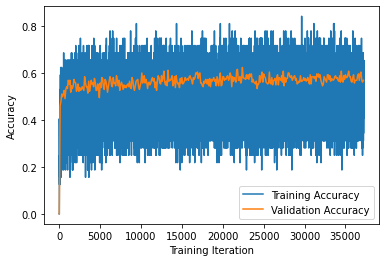

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/194419 [00:00<?, ?it/s]

  0%|          | 7/194419 [00:00<56:42, 57.13it/s]

  0%|          | 15/194419 [00:00<47:38, 68.01it/s]

  0%|          | 24/194419 [00:00<42:21, 76.48it/s]

  0%|          | 32/194419 [00:00<44:30, 72.78it/s]

  0%|          | 40/194419 [00:00<43:11, 75.00it/s]

  0%|          | 48/194419 [00:00<44:13, 73.25it/s]

  0%|          | 56/194419 [00:00<48:38, 66.60it/s]

  0%|          | 65/194419 [00:00<45:49, 70.69it/s]

  0%|          | 73/194419 [00:01<46:12, 70.09it/s]

  0%|          | 82/194419 [00:01<43:42, 74.11it/s]

  0%|          | 90/194419 [00:01<45:30, 71.16it/s]

  0%|          | 98/194419 [00:01<44:52, 72.17it/s]

  0%|          | 106/194419 [00:01<47:32, 68.12it/s]

  0%|          | 114/194419 [00:01<47:42, 67.87it/s]

  0%|          | 122/194419 [00:01<46:45, 69.27it/s]

  0%|          | 129/194419 [00:01<47:33, 68.09it/s]

  0%|          | 138/194419 [00:01<44:28, 72.80it/s]

  0%|          | 146/194419 [00:02<45:03, 71.87it/s]

  0%|          | 155/194419 [00:02<42:45, 75.71it/s]

  0%|          | 163/194419 [00:02<44:58, 71.99it/s]

  0%|          | 171/194419 [00:02<45:18, 71.46it/s]

  0%|          | 179/194419 [00:02<48:02, 67.39it/s]

  0%|          | 187/194419 [00:02<45:55, 70.48it/s]

  0%|          | 195/194419 [00:02<44:19, 73.02it/s]

  0%|          | 204/194419 [00:02<43:12, 74.90it/s]

  0%|          | 213/194419 [00:02<41:06, 78.74it/s]

  0%|          | 221/194419 [00:03<42:55, 75.41it/s]

  0%|          | 229/194419 [00:03<42:37, 75.94it/s]

  0%|          | 237/194419 [00:03<43:16, 74.80it/s]

  0%|          | 246/194419 [00:03<41:26, 78.08it/s]

  0%|          | 254/194419 [00:03<41:09, 78.61it/s]

  0%|          | 263/194419 [00:03<40:09, 80.59it/s]

  0%|          | 272/194419 [00:03<39:22, 82.18it/s]

  0%|          | 281/194419 [00:03<39:13, 82.49it/s]

  0%|          | 290/194419 [00:03<44:29, 72.72it/s]

  0%|          | 298/194419 [00:04<47:42, 67.82it/s]

  0%|          | 308/194419 [00:04<42:49, 75.53it/s]

  0%|          | 318/194419 [00:04<39:38, 81.60it/s]

  0%|          | 327/194419 [00:04<40:10, 80.52it/s]

  0%|          | 337/194419 [00:04<38:48, 83.34it/s]

  0%|          | 346/194419 [00:04<41:41, 77.57it/s]

  0%|          | 354/194419 [00:04<42:31, 76.06it/s]

  0%|          | 363/194419 [00:04<40:49, 79.21it/s]

  0%|          | 372/194419 [00:05<41:08, 78.62it/s]

  0%|          | 380/194419 [00:05<41:07, 78.65it/s]

  0%|          | 389/194419 [00:05<40:22, 80.11it/s]

  0%|          | 398/194419 [00:05<40:42, 79.45it/s]

  0%|          | 406/194419 [00:05<41:17, 78.31it/s]

  0%|          | 414/194419 [00:05<41:31, 77.86it/s]

  0%|          | 422/194419 [00:05<42:06, 76.79it/s]

  0%|          | 430/194419 [00:05<43:46, 73.85it/s]

  0%|          | 438/194419 [00:05<43:18, 74.64it/s]

  0%|          | 446/194419 [00:05<44:55, 71.95it/s]

  0%|          | 454/194419 [00:06<45:21, 71.28it/s]

  0%|          | 462/194419 [00:06<43:56, 73.56it/s]

  0%|          | 471/194419 [00:06<42:34, 75.92it/s]

  0%|          | 479/194419 [00:06<45:48, 70.55it/s]

  0%|          | 487/194419 [00:06<46:23, 69.68it/s]

  0%|          | 495/194419 [00:06<45:35, 70.89it/s]

  0%|          | 503/194419 [00:06<44:58, 71.85it/s]

  0%|          | 511/194419 [00:06<43:46, 73.83it/s]

  0%|          | 519/194419 [00:06<43:05, 74.99it/s]

  0%|          | 527/194419 [00:07<42:29, 76.06it/s]

  0%|          | 535/194419 [00:07<43:54, 73.59it/s]

  0%|          | 543/194419 [00:07<44:48, 72.12it/s]

  0%|          | 551/194419 [00:07<43:57, 73.49it/s]

  0%|          | 559/194419 [00:07<43:32, 74.21it/s]

  0%|          | 567/194419 [00:07<44:36, 72.44it/s]

  0%|          | 575/194419 [00:07<45:36, 70.84it/s]

  0%|          | 583/194419 [00:07<47:56, 67.39it/s]

  0%|          | 590/194419 [00:08<47:58, 67.34it/s]

  0%|          | 597/194419 [00:08<48:00, 67.29it/s]

  0%|          | 606/194419 [00:08<44:21, 72.81it/s]

  0%|          | 615/194419 [00:08<43:01, 75.08it/s]

  0%|          | 623/194419 [00:08<45:21, 71.20it/s]

  0%|          | 631/194419 [00:08<44:50, 72.02it/s]

  0%|          | 639/194419 [00:08<45:15, 71.37it/s]

  0%|          | 647/194419 [00:08<45:10, 71.50it/s]

  0%|          | 656/194419 [00:08<43:30, 74.22it/s]

  0%|          | 666/194419 [00:08<39:58, 80.78it/s]

  0%|          | 675/194419 [00:09<40:34, 79.58it/s]

  0%|          | 684/194419 [00:09<43:02, 75.02it/s]

  0%|          | 692/194419 [00:09<43:32, 74.16it/s]

  0%|          | 700/194419 [00:09<43:45, 73.80it/s]

  0%|          | 708/194419 [00:09<44:14, 72.99it/s]

  0%|          | 718/194419 [00:09<40:47, 79.13it/s]

  0%|          | 727/194419 [00:09<39:22, 82.00it/s]

  0%|          | 736/194419 [00:09<41:43, 77.37it/s]

  0%|          | 744/194419 [00:10<42:25, 76.07it/s]

  0%|          | 752/194419 [00:10<45:58, 70.21it/s]

  0%|          | 760/194419 [00:10<44:56, 71.82it/s]

  0%|          | 768/194419 [00:10<43:53, 73.54it/s]

  0%|          | 777/194419 [00:10<41:49, 77.18it/s]

  0%|          | 785/194419 [00:10<45:34, 70.81it/s]

  0%|          | 794/194419 [00:10<44:35, 72.37it/s]

  0%|          | 802/194419 [00:10<45:39, 70.66it/s]

  0%|          | 810/194419 [00:10<44:49, 72.00it/s]

  0%|          | 818/194419 [00:11<46:10, 69.87it/s]

  0%|          | 827/194419 [00:11<43:52, 73.54it/s]

  0%|          | 835/194419 [00:11<44:51, 71.91it/s]

  0%|          | 843/194419 [00:11<44:35, 72.35it/s]

  0%|          | 851/194419 [00:11<45:16, 71.26it/s]

  0%|          | 859/194419 [00:11<46:31, 69.35it/s]

  0%|          | 868/194419 [00:11<43:20, 74.42it/s]

  0%|          | 876/194419 [00:11<43:52, 73.51it/s]

  0%|          | 884/194419 [00:11<44:21, 72.72it/s]

  0%|          | 894/194419 [00:12<40:54, 78.84it/s]

  0%|          | 903/194419 [00:12<40:46, 79.09it/s]

  0%|          | 911/194419 [00:12<43:51, 73.52it/s]

  0%|          | 919/194419 [00:12<44:34, 72.36it/s]

  0%|          | 927/194419 [00:12<43:28, 74.19it/s]

  0%|          | 935/194419 [00:12<42:42, 75.50it/s]

  0%|          | 943/194419 [00:12<44:35, 72.32it/s]

  0%|          | 951/194419 [00:12<46:44, 68.98it/s]

  0%|          | 958/194419 [00:13<47:48, 67.44it/s]

  0%|          | 967/194419 [00:13<46:07, 69.91it/s]

  1%|          | 976/194419 [00:13<43:35, 73.95it/s]

  1%|          | 984/194419 [00:13<43:09, 74.71it/s]

  1%|          | 992/194419 [00:13<43:31, 74.07it/s]

  1%|          | 1000/194419 [00:13<46:55, 68.69it/s]

  1%|          | 1007/194419 [00:13<46:59, 68.60it/s]

  1%|          | 1014/194419 [00:13<47:31, 67.83it/s]

  1%|          | 1021/194419 [00:13<48:38, 66.27it/s]

  1%|          | 1029/194419 [00:14<46:12, 69.75it/s]

  1%|          | 1038/194419 [00:14<44:53, 71.80it/s]

  1%|          | 1046/194419 [00:14<45:33, 70.73it/s]

  1%|          | 1055/194419 [00:14<42:48, 75.30it/s]

  1%|          | 1064/194419 [00:14<42:11, 76.38it/s]

  1%|          | 1073/194419 [00:14<42:11, 76.37it/s]

  1%|          | 1081/194419 [00:14<43:48, 73.55it/s]

  1%|          | 1089/194419 [00:14<45:47, 70.36it/s]

  1%|          | 1097/194419 [00:14<46:16, 69.64it/s]

  1%|          | 1105/194419 [00:15<45:37, 70.62it/s]

  1%|          | 1114/194419 [00:15<44:03, 73.12it/s]

  1%|          | 1123/194419 [00:15<42:57, 75.00it/s]

  1%|          | 1131/194419 [00:15<44:59, 71.59it/s]

  1%|          | 1139/194419 [00:15<45:06, 71.42it/s]

  1%|          | 1147/194419 [00:15<46:40, 69.02it/s]

  1%|          | 1155/194419 [00:15<47:06, 68.38it/s]

  1%|          | 1162/194419 [00:15<47:22, 67.99it/s]

  1%|          | 1169/194419 [00:15<47:06, 68.38it/s]

  1%|          | 1176/194419 [00:16<49:52, 64.59it/s]

  1%|          | 1184/194419 [00:16<49:07, 65.56it/s]

  1%|          | 1192/194419 [00:16<48:11, 66.83it/s]

  1%|          | 1203/194419 [00:16<42:35, 75.62it/s]

  1%|          | 1211/194419 [00:16<44:48, 71.85it/s]

  1%|          | 1219/194419 [00:16<46:06, 69.84it/s]

  1%|          | 1227/194419 [00:16<45:45, 70.38it/s]

  1%|          | 1236/194419 [00:16<43:15, 74.44it/s]

  1%|          | 1245/194419 [00:17<41:12, 78.14it/s]

  1%|          | 1253/194419 [00:17<43:17, 74.35it/s]

  1%|          | 1261/194419 [00:17<46:16, 69.57it/s]

  1%|          | 1270/194419 [00:17<43:20, 74.27it/s]

  1%|          | 1278/194419 [00:17<43:31, 73.97it/s]

  1%|          | 1286/194419 [00:17<43:48, 73.48it/s]

  1%|          | 1294/194419 [00:17<43:39, 73.72it/s]

  1%|          | 1302/194419 [00:17<44:17, 72.67it/s]

  1%|          | 1312/194419 [00:17<41:18, 77.91it/s]

  1%|          | 1320/194419 [00:18<42:53, 75.03it/s]

  1%|          | 1328/194419 [00:18<45:10, 71.24it/s]

  1%|          | 1336/194419 [00:18<46:20, 69.43it/s]

  1%|          | 1343/194419 [00:18<47:07, 68.27it/s]

  1%|          | 1351/194419 [00:18<45:28, 70.77it/s]

  1%|          | 1360/194419 [00:18<43:47, 73.48it/s]

  1%|          | 1368/194419 [00:18<43:44, 73.55it/s]

  1%|          | 1376/194419 [00:18<45:22, 70.91it/s]

  1%|          | 1384/194419 [00:18<46:14, 69.58it/s]

  1%|          | 1391/194419 [00:19<46:55, 68.56it/s]

  1%|          | 1398/194419 [00:19<48:57, 65.71it/s]

  1%|          | 1406/194419 [00:19<46:44, 68.82it/s]

  1%|          | 1414/194419 [00:19<45:37, 70.51it/s]

  1%|          | 1422/194419 [00:19<45:08, 71.27it/s]

  1%|          | 1431/194419 [00:19<42:48, 75.15it/s]

  1%|          | 1439/194419 [00:19<45:54, 70.05it/s]

  1%|          | 1447/194419 [00:19<46:07, 69.73it/s]

  1%|          | 1455/194419 [00:19<47:37, 67.54it/s]

  1%|          | 1462/194419 [00:20<48:26, 66.39it/s]

  1%|          | 1471/194419 [00:20<45:28, 70.71it/s]

  1%|          | 1479/194419 [00:20<45:02, 71.39it/s]

  1%|          | 1489/194419 [00:20<41:06, 78.21it/s]

  1%|          | 1497/194419 [00:20<41:18, 77.85it/s]

  1%|          | 1505/194419 [00:20<43:32, 73.84it/s]

  1%|          | 1513/194419 [00:20<42:45, 75.19it/s]

  1%|          | 1521/194419 [00:20<44:14, 72.68it/s]

  1%|          | 1529/194419 [00:20<43:10, 74.46it/s]

  1%|          | 1537/194419 [00:21<43:13, 74.38it/s]

  1%|          | 1545/194419 [00:21<44:10, 72.78it/s]

  1%|          | 1553/194419 [00:21<44:58, 71.48it/s]

  1%|          | 1561/194419 [00:21<43:42, 73.55it/s]

  1%|          | 1569/194419 [00:21<45:21, 70.86it/s]

  1%|          | 1577/194419 [00:21<45:07, 71.22it/s]

  1%|          | 1585/194419 [00:21<46:17, 69.42it/s]

  1%|          | 1592/194419 [00:21<46:29, 69.14it/s]

  1%|          | 1599/194419 [00:21<48:08, 66.76it/s]

  1%|          | 1607/194419 [00:22<46:53, 68.53it/s]

  1%|          | 1614/194419 [00:22<47:44, 67.30it/s]

  1%|          | 1621/194419 [00:22<48:58, 65.60it/s]

  1%|          | 1629/194419 [00:22<48:04, 66.84it/s]

  1%|          | 1637/194419 [00:22<45:58, 69.90it/s]

  1%|          | 1645/194419 [00:22<48:03, 66.85it/s]

  1%|          | 1652/194419 [00:22<48:04, 66.84it/s]

  1%|          | 1659/194419 [00:22<50:25, 63.72it/s]

  1%|          | 1667/194419 [00:22<47:57, 66.99it/s]

  1%|          | 1674/194419 [00:23<47:55, 67.03it/s]

  1%|          | 1681/194419 [00:23<49:07, 65.40it/s]

  1%|          | 1689/194419 [00:23<47:23, 67.78it/s]

  1%|          | 1696/194419 [00:23<48:45, 65.87it/s]

  1%|          | 1703/194419 [00:23<48:06, 66.77it/s]

  1%|          | 1711/194419 [00:23<46:24, 69.21it/s]

  1%|          | 1719/194419 [00:23<45:18, 70.89it/s]

  1%|          | 1727/194419 [00:23<45:24, 70.71it/s]

  1%|          | 1736/194419 [00:23<43:10, 74.37it/s]

  1%|          | 1744/194419 [00:24<44:48, 71.65it/s]

  1%|          | 1752/194419 [00:24<49:01, 65.50it/s]

  1%|          | 1759/194419 [00:24<49:06, 65.39it/s]

  1%|          | 1767/194419 [00:24<47:02, 68.24it/s]

  1%|          | 1776/194419 [00:24<44:26, 72.25it/s]

  1%|          | 1784/194419 [00:24<43:26, 73.90it/s]

  1%|          | 1793/194419 [00:24<41:39, 77.08it/s]

  1%|          | 1803/194419 [00:24<40:00, 80.24it/s]

  1%|          | 1812/194419 [00:24<38:58, 82.36it/s]

  1%|          | 1821/194419 [00:25<39:37, 81.02it/s]

  1%|          | 1832/194419 [00:25<36:41, 87.47it/s]

  1%|          | 1841/194419 [00:25<37:25, 85.76it/s]

  1%|          | 1850/194419 [00:25<39:40, 80.91it/s]

  1%|          | 1859/194419 [00:25<42:21, 75.75it/s]

  1%|          | 1867/194419 [00:25<42:17, 75.88it/s]

  1%|          | 1875/194419 [00:25<44:02, 72.87it/s]

  1%|          | 1883/194419 [00:25<43:33, 73.67it/s]

  1%|          | 1891/194419 [00:26<46:01, 69.72it/s]

  1%|          | 1900/194419 [00:26<45:01, 71.25it/s]

  1%|          | 1908/194419 [00:26<47:21, 67.75it/s]

  1%|          | 1916/194419 [00:26<46:11, 69.47it/s]

  1%|          | 1925/194419 [00:26<44:20, 72.36it/s]

  1%|          | 1933/194419 [00:26<43:22, 73.97it/s]

  1%|          | 1941/194419 [00:26<44:16, 72.47it/s]

  1%|          | 1950/194419 [00:26<42:22, 75.69it/s]

  1%|          | 1958/194419 [00:26<42:02, 76.30it/s]

  1%|          | 1966/194419 [00:27<43:12, 74.25it/s]

  1%|          | 1974/194419 [00:27<44:27, 72.14it/s]

  1%|          | 1982/194419 [00:27<43:49, 73.18it/s]

  1%|          | 1990/194419 [00:27<44:00, 72.88it/s]

  1%|          | 1998/194419 [00:27<46:03, 69.63it/s]

  1%|          | 2006/194419 [00:27<44:55, 71.38it/s]

  1%|          | 2014/194419 [00:27<48:23, 66.27it/s]

  1%|          | 2021/194419 [00:27<49:07, 65.28it/s]

  1%|          | 2029/194419 [00:27<47:22, 67.67it/s]

  1%|          | 2038/194419 [00:28<44:06, 72.69it/s]

  1%|          | 2046/194419 [00:28<46:08, 69.48it/s]

  1%|          | 2054/194419 [00:28<44:21, 72.26it/s]

  1%|          | 2062/194419 [00:28<44:33, 71.96it/s]

  1%|          | 2070/194419 [00:28<47:33, 67.41it/s]

  1%|          | 2077/194419 [00:28<47:30, 67.47it/s]

  1%|          | 2085/194419 [00:28<46:09, 69.45it/s]

  1%|          | 2093/194419 [00:28<46:49, 68.46it/s]

  1%|          | 2100/194419 [00:29<47:04, 68.09it/s]

  1%|          | 2107/194419 [00:29<46:55, 68.31it/s]

  1%|          | 2114/194419 [00:29<46:52, 68.38it/s]

  1%|          | 2121/194419 [00:29<46:39, 68.69it/s]

  1%|          | 2128/194419 [00:29<46:41, 68.64it/s]

  1%|          | 2137/194419 [00:29<45:06, 71.04it/s]

  1%|          | 2145/194419 [00:29<44:18, 72.33it/s]

  1%|          | 2153/194419 [00:29<46:23, 69.08it/s]

  1%|          | 2161/194419 [00:29<45:11, 70.92it/s]

  1%|          | 2169/194419 [00:30<47:06, 68.02it/s]

  1%|          | 2177/194419 [00:30<46:13, 69.32it/s]

  1%|          | 2184/194419 [00:30<49:20, 64.94it/s]

  1%|          | 2191/194419 [00:30<49:18, 64.97it/s]

  1%|          | 2198/194419 [00:30<49:57, 64.13it/s]

  1%|          | 2205/194419 [00:30<49:32, 64.65it/s]

  1%|          | 2212/194419 [00:30<48:46, 65.67it/s]

  1%|          | 2220/194419 [00:30<46:13, 69.30it/s]

  1%|          | 2227/194419 [00:30<46:11, 69.34it/s]

  1%|          | 2234/194419 [00:30<48:08, 66.53it/s]

  1%|          | 2241/194419 [00:31<48:19, 66.29it/s]

  1%|          | 2249/194419 [00:31<46:20, 69.11it/s]

  1%|          | 2257/194419 [00:31<45:50, 69.87it/s]

  1%|          | 2264/194419 [00:31<46:29, 68.88it/s]

  1%|          | 2271/194419 [00:31<46:25, 68.98it/s]

  1%|          | 2278/194419 [00:31<49:52, 64.22it/s]

  1%|          | 2285/194419 [00:31<48:51, 65.54it/s]

  1%|          | 2292/194419 [00:31<50:39, 63.21it/s]

  1%|          | 2299/194419 [00:31<49:55, 64.15it/s]

  1%|          | 2308/194419 [00:32<46:46, 68.46it/s]

  1%|          | 2316/194419 [00:32<44:55, 71.26it/s]

  1%|          | 2324/194419 [00:32<47:39, 67.18it/s]

  1%|          | 2332/194419 [00:32<45:52, 69.80it/s]

  1%|          | 2342/194419 [00:32<42:51, 74.70it/s]

  1%|          | 2350/194419 [00:32<43:00, 74.44it/s]

  1%|          | 2358/194419 [00:32<45:23, 70.52it/s]

  1%|          | 2366/194419 [00:32<45:47, 69.90it/s]

  1%|          | 2374/194419 [00:33<47:14, 67.75it/s]

  1%|          | 2383/194419 [00:33<44:38, 71.70it/s]

  1%|          | 2393/194419 [00:33<40:54, 78.24it/s]

  1%|          | 2401/194419 [00:33<43:01, 74.38it/s]

  1%|          | 2410/194419 [00:33<42:12, 75.82it/s]

  1%|          | 2418/194419 [00:33<41:45, 76.64it/s]

  1%|          | 2426/194419 [00:33<42:02, 76.12it/s]

  1%|▏         | 2434/194419 [00:33<45:20, 70.56it/s]

  1%|▏         | 2442/194419 [00:33<44:54, 71.24it/s]

  1%|▏         | 2450/194419 [00:34<45:15, 70.69it/s]

  1%|▏         | 2460/194419 [00:34<41:43, 76.67it/s]

  1%|▏         | 2468/194419 [00:34<42:47, 74.77it/s]

  1%|▏         | 2476/194419 [00:34<44:42, 71.56it/s]

  1%|▏         | 2484/194419 [00:34<45:04, 70.97it/s]

  1%|▏         | 2492/194419 [00:34<45:14, 70.69it/s]

  1%|▏         | 2500/194419 [00:34<44:27, 71.95it/s]

  1%|▏         | 2508/194419 [00:34<45:03, 70.98it/s]

  1%|▏         | 2517/194419 [00:34<42:54, 74.54it/s]

  1%|▏         | 2525/194419 [00:35<45:50, 69.77it/s]

  1%|▏         | 2533/194419 [00:35<46:39, 68.54it/s]

  1%|▏         | 2541/194419 [00:35<45:05, 70.93it/s]

  1%|▏         | 2549/194419 [00:35<46:03, 69.42it/s]

  1%|▏         | 2557/194419 [00:35<44:37, 71.66it/s]

  1%|▏         | 2565/194419 [00:35<46:50, 68.27it/s]

  1%|▏         | 2572/194419 [00:35<47:14, 67.68it/s]

  1%|▏         | 2579/194419 [00:35<47:16, 67.63it/s]

  1%|▏         | 2586/194419 [00:35<48:26, 65.99it/s]

  1%|▏         | 2594/194419 [00:36<46:26, 68.84it/s]

  1%|▏         | 2601/194419 [00:36<50:12, 63.67it/s]

  1%|▏         | 2608/194419 [00:36<49:42, 64.31it/s]

  1%|▏         | 2616/194419 [00:36<47:25, 67.40it/s]

  1%|▏         | 2623/194419 [00:36<49:46, 64.21it/s]

  1%|▏         | 2632/194419 [00:36<44:57, 71.09it/s]

  1%|▏         | 2640/194419 [00:36<45:17, 70.57it/s]

  1%|▏         | 2649/194419 [00:36<42:26, 75.30it/s]

  1%|▏         | 2657/194419 [00:36<42:34, 75.06it/s]

  1%|▏         | 2666/194419 [00:37<40:50, 78.26it/s]

  1%|▏         | 2674/194419 [00:37<42:29, 75.19it/s]

  1%|▏         | 2682/194419 [00:37<44:17, 72.16it/s]

  1%|▏         | 2690/194419 [00:37<43:18, 73.79it/s]

  1%|▏         | 2699/194419 [00:37<41:28, 77.03it/s]

  1%|▏         | 2707/194419 [00:37<41:42, 76.60it/s]

  1%|▏         | 2715/194419 [00:37<42:54, 74.45it/s]

  1%|▏         | 2724/194419 [00:37<41:06, 77.73it/s]

  1%|▏         | 2732/194419 [00:37<45:35, 70.08it/s]

  1%|▏         | 2740/194419 [00:38<47:40, 67.00it/s]

  1%|▏         | 2747/194419 [00:38<48:36, 65.72it/s]

  1%|▏         | 2754/194419 [00:38<50:45, 62.93it/s]

  1%|▏         | 2762/194419 [00:38<47:24, 67.37it/s]

  1%|▏         | 2770/194419 [00:38<45:45, 69.80it/s]

  1%|▏         | 2778/194419 [00:38<46:40, 68.43it/s]

  1%|▏         | 2786/194419 [00:38<45:00, 70.96it/s]

  1%|▏         | 2794/194419 [00:38<46:12, 69.12it/s]

  1%|▏         | 2802/194419 [00:39<44:52, 71.17it/s]

  1%|▏         | 2810/194419 [00:39<44:37, 71.55it/s]

  1%|▏         | 2818/194419 [00:39<43:37, 73.19it/s]

  1%|▏         | 2826/194419 [00:39<44:52, 71.15it/s]

  1%|▏         | 2835/194419 [00:39<43:51, 72.81it/s]

  1%|▏         | 2843/194419 [00:39<43:01, 74.21it/s]

  1%|▏         | 2851/194419 [00:39<44:36, 71.58it/s]

  1%|▏         | 2859/194419 [00:39<45:58, 69.44it/s]

  1%|▏         | 2867/194419 [00:39<45:21, 70.39it/s]

  1%|▏         | 2875/194419 [00:40<46:33, 68.56it/s]

  1%|▏         | 2883/194419 [00:40<46:49, 68.16it/s]

  1%|▏         | 2890/194419 [00:40<49:17, 64.76it/s]

  1%|▏         | 2897/194419 [00:40<50:42, 62.94it/s]

  1%|▏         | 2905/194419 [00:40<47:39, 66.98it/s]

  1%|▏         | 2914/194419 [00:40<45:50, 69.63it/s]

  2%|▏         | 2922/194419 [00:40<46:11, 69.09it/s]

  2%|▏         | 2929/194419 [00:40<46:40, 68.37it/s]

  2%|▏         | 2936/194419 [00:40<48:17, 66.08it/s]

  2%|▏         | 2944/194419 [00:41<48:07, 66.31it/s]

  2%|▏         | 2951/194419 [00:41<49:08, 64.94it/s]

  2%|▏         | 2958/194419 [00:41<50:03, 63.75it/s]

  2%|▏         | 2965/194419 [00:41<52:14, 61.07it/s]

  2%|▏         | 2972/194419 [00:41<53:45, 59.35it/s]

  2%|▏         | 2978/194419 [00:41<53:55, 59.17it/s]

  2%|▏         | 2986/194419 [00:41<49:37, 64.29it/s]

  2%|▏         | 2994/194419 [00:41<49:05, 64.98it/s]

  2%|▏         | 3002/194419 [00:42<47:06, 67.72it/s]

  2%|▏         | 3011/194419 [00:42<43:45, 72.91it/s]

  2%|▏         | 3019/194419 [00:42<46:58, 67.90it/s]

  2%|▏         | 3028/194419 [00:42<44:27, 71.74it/s]

  2%|▏         | 3036/194419 [00:42<44:19, 71.97it/s]

  2%|▏         | 3044/194419 [00:42<46:13, 69.01it/s]

  2%|▏         | 3052/194419 [00:42<44:41, 71.37it/s]

  2%|▏         | 3060/194419 [00:42<46:32, 68.54it/s]

  2%|▏         | 3068/194419 [00:42<46:38, 68.38it/s]

  2%|▏         | 3076/194419 [00:43<45:13, 70.51it/s]

  2%|▏         | 3084/194419 [00:43<43:39, 73.04it/s]

  2%|▏         | 3093/194419 [00:43<41:59, 75.93it/s]

  2%|▏         | 3101/194419 [00:43<43:13, 73.77it/s]

  2%|▏         | 3109/194419 [00:43<43:36, 73.11it/s]

  2%|▏         | 3117/194419 [00:43<45:07, 70.66it/s]

  2%|▏         | 3125/194419 [00:43<47:15, 67.46it/s]

  2%|▏         | 3133/194419 [00:43<45:45, 69.66it/s]

  2%|▏         | 3141/194419 [00:43<45:18, 70.35it/s]

  2%|▏         | 3149/194419 [00:44<46:54, 67.96it/s]

  2%|▏         | 3159/194419 [00:44<43:32, 73.21it/s]

  2%|▏         | 3167/194419 [00:44<45:37, 69.86it/s]

  2%|▏         | 3175/194419 [00:44<47:05, 67.67it/s]

  2%|▏         | 3182/194419 [00:44<49:00, 65.03it/s]

  2%|▏         | 3190/194419 [00:44<47:00, 67.80it/s]

  2%|▏         | 3197/194419 [00:44<47:46, 66.70it/s]

  2%|▏         | 3204/194419 [00:44<48:22, 65.88it/s]

  2%|▏         | 3211/194419 [00:45<50:43, 62.82it/s]

  2%|▏         | 3218/194419 [00:45<49:41, 64.12it/s]

  2%|▏         | 3226/194419 [00:45<46:31, 68.49it/s]

  2%|▏         | 3236/194419 [00:45<42:03, 75.76it/s]

  2%|▏         | 3245/194419 [00:45<42:06, 75.65it/s]

  2%|▏         | 3253/194419 [00:45<46:09, 69.02it/s]

  2%|▏         | 3261/194419 [00:45<45:35, 69.87it/s]

  2%|▏         | 3269/194419 [00:45<47:47, 66.67it/s]

  2%|▏         | 3277/194419 [00:45<45:59, 69.26it/s]

  2%|▏         | 3285/194419 [00:46<48:19, 65.92it/s]

  2%|▏         | 3294/194419 [00:46<45:28, 70.05it/s]

  2%|▏         | 3303/194419 [00:46<44:26, 71.67it/s]

  2%|▏         | 3311/194419 [00:46<44:16, 71.94it/s]

  2%|▏         | 3320/194419 [00:46<41:32, 76.68it/s]

  2%|▏         | 3329/194419 [00:46<40:39, 78.34it/s]

  2%|▏         | 3337/194419 [00:46<41:04, 77.52it/s]

  2%|▏         | 3346/194419 [00:46<40:21, 78.89it/s]

  2%|▏         | 3354/194419 [00:46<41:35, 76.57it/s]

  2%|▏         | 3362/194419 [00:47<41:17, 77.11it/s]

  2%|▏         | 3370/194419 [00:47<44:32, 71.48it/s]

  2%|▏         | 3379/194419 [00:47<42:15, 75.34it/s]

  2%|▏         | 3387/194419 [00:47<44:45, 71.13it/s]

  2%|▏         | 3395/194419 [00:47<48:40, 65.41it/s]

  2%|▏         | 3403/194419 [00:47<46:28, 68.50it/s]

  2%|▏         | 3412/194419 [00:47<44:06, 72.18it/s]

  2%|▏         | 3420/194419 [00:47<44:35, 71.38it/s]

  2%|▏         | 3428/194419 [00:48<46:47, 68.03it/s]

  2%|▏         | 3436/194419 [00:48<45:23, 70.13it/s]

  2%|▏         | 3444/194419 [00:48<47:07, 67.53it/s]

  2%|▏         | 3451/194419 [00:48<47:56, 66.39it/s]

  2%|▏         | 3459/194419 [00:48<46:41, 68.15it/s]

  2%|▏         | 3468/194419 [00:48<44:01, 72.30it/s]

  2%|▏         | 3476/194419 [00:48<44:42, 71.17it/s]

  2%|▏         | 3484/194419 [00:48<43:26, 73.25it/s]

  2%|▏         | 3492/194419 [00:48<42:36, 74.69it/s]

  2%|▏         | 3500/194419 [00:49<44:29, 71.52it/s]

  2%|▏         | 3509/194419 [00:49<42:46, 74.39it/s]

  2%|▏         | 3517/194419 [00:49<42:45, 74.42it/s]

  2%|▏         | 3525/194419 [00:49<43:07, 73.77it/s]

  2%|▏         | 3535/194419 [00:49<40:09, 79.21it/s]

  2%|▏         | 3543/194419 [00:49<40:33, 78.44it/s]

  2%|▏         | 3551/194419 [00:49<40:37, 78.29it/s]

  2%|▏         | 3561/194419 [00:49<38:52, 81.81it/s]

  2%|▏         | 3570/194419 [00:49<41:00, 77.58it/s]

  2%|▏         | 3579/194419 [00:50<39:19, 80.87it/s]

  2%|▏         | 3588/194419 [00:50<39:20, 80.84it/s]

  2%|▏         | 3597/194419 [00:50<39:59, 79.53it/s]

  2%|▏         | 3605/194419 [00:50<40:59, 77.57it/s]

  2%|▏         | 3613/194419 [00:50<40:44, 78.05it/s]

  2%|▏         | 3621/194419 [00:50<41:55, 75.85it/s]

  2%|▏         | 3630/194419 [00:50<40:15, 79.00it/s]

  2%|▏         | 3638/194419 [00:50<40:33, 78.40it/s]

  2%|▏         | 3646/194419 [00:50<43:18, 73.41it/s]

  2%|▏         | 3655/194419 [00:51<41:03, 77.45it/s]

  2%|▏         | 3663/194419 [00:51<41:43, 76.19it/s]

  2%|▏         | 3671/194419 [00:51<43:54, 72.39it/s]

  2%|▏         | 3679/194419 [00:51<47:44, 66.60it/s]

  2%|▏         | 3686/194419 [00:51<49:26, 64.30it/s]

  2%|▏         | 3694/194419 [00:51<46:32, 68.29it/s]

  2%|▏         | 3701/194419 [00:51<47:41, 66.66it/s]

  2%|▏         | 3710/194419 [00:51<43:35, 72.91it/s]

  2%|▏         | 3719/194419 [00:51<42:17, 75.16it/s]

  2%|▏         | 3728/194419 [00:52<41:31, 76.55it/s]

  2%|▏         | 3737/194419 [00:52<40:56, 77.61it/s]

  2%|▏         | 3745/194419 [00:52<43:56, 72.33it/s]

  2%|▏         | 3754/194419 [00:52<41:29, 76.58it/s]

  2%|▏         | 3762/194419 [00:52<42:23, 74.94it/s]

  2%|▏         | 3770/194419 [00:52<42:15, 75.18it/s]

  2%|▏         | 3778/194419 [00:52<44:45, 70.98it/s]

  2%|▏         | 3786/194419 [00:52<43:39, 72.78it/s]

  2%|▏         | 3794/194419 [00:52<43:17, 73.38it/s]

  2%|▏         | 3803/194419 [00:53<40:54, 77.67it/s]

  2%|▏         | 3811/194419 [00:53<40:53, 77.68it/s]

  2%|▏         | 3819/194419 [00:53<43:03, 73.78it/s]

  2%|▏         | 3828/194419 [00:53<42:16, 75.15it/s]

  2%|▏         | 3836/194419 [00:53<45:50, 69.28it/s]

  2%|▏         | 3844/194419 [00:53<45:57, 69.10it/s]

  2%|▏         | 3851/194419 [00:53<45:58, 69.08it/s]

  2%|▏         | 3860/194419 [00:53<44:01, 72.15it/s]

  2%|▏         | 3868/194419 [00:53<45:32, 69.72it/s]

  2%|▏         | 3876/194419 [00:54<45:39, 69.54it/s]

  2%|▏         | 3883/194419 [00:54<47:46, 66.48it/s]

  2%|▏         | 3891/194419 [00:54<47:02, 67.49it/s]

  2%|▏         | 3898/194419 [00:54<49:07, 64.63it/s]

  2%|▏         | 3906/194419 [00:54<47:00, 67.54it/s]

  2%|▏         | 3913/194419 [00:54<47:06, 67.40it/s]

  2%|▏         | 3921/194419 [00:54<45:57, 69.09it/s]

  2%|▏         | 3928/194419 [00:54<47:17, 67.13it/s]

  2%|▏         | 3937/194419 [00:54<44:02, 72.08it/s]

  2%|▏         | 3945/194419 [00:55<42:53, 74.01it/s]

  2%|▏         | 3953/194419 [00:55<43:07, 73.61it/s]

  2%|▏         | 3961/194419 [00:55<43:01, 73.77it/s]

  2%|▏         | 3969/194419 [00:55<45:50, 69.24it/s]

  2%|▏         | 3976/194419 [00:55<46:29, 68.26it/s]

  2%|▏         | 3985/194419 [00:55<43:46, 72.51it/s]

  2%|▏         | 3993/194419 [00:55<48:07, 65.94it/s]

  2%|▏         | 4000/194419 [00:55<47:44, 66.48it/s]

  2%|▏         | 4008/194419 [00:56<45:49, 69.25it/s]

  2%|▏         | 4017/194419 [00:56<42:56, 73.90it/s]

  2%|▏         | 4025/194419 [00:56<42:20, 74.95it/s]

  2%|▏         | 4033/194419 [00:56<44:39, 71.05it/s]

  2%|▏         | 4041/194419 [00:56<44:33, 71.21it/s]

  2%|▏         | 4049/194419 [00:56<45:51, 69.18it/s]

  2%|▏         | 4057/194419 [00:56<45:01, 70.48it/s]

  2%|▏         | 4065/194419 [00:56<44:36, 71.12it/s]

  2%|▏         | 4073/194419 [00:56<43:30, 72.91it/s]

  2%|▏         | 4081/194419 [00:57<43:13, 73.40it/s]

  2%|▏         | 4089/194419 [00:57<44:05, 71.95it/s]

  2%|▏         | 4097/194419 [00:57<45:23, 69.87it/s]

  2%|▏         | 4105/194419 [00:57<48:27, 65.46it/s]

  2%|▏         | 4113/194419 [00:57<47:38, 66.57it/s]

  2%|▏         | 4122/194419 [00:57<45:56, 69.04it/s]

  2%|▏         | 4129/194419 [00:57<46:24, 68.33it/s]

  2%|▏         | 4136/194419 [00:57<46:13, 68.62it/s]

  2%|▏         | 4143/194419 [00:57<47:01, 67.45it/s]

  2%|▏         | 4150/194419 [00:58<48:59, 64.73it/s]

  2%|▏         | 4157/194419 [00:58<48:59, 64.74it/s]

  2%|▏         | 4164/194419 [00:58<50:40, 62.58it/s]

  2%|▏         | 4172/194419 [00:58<47:22, 66.93it/s]

  2%|▏         | 4180/194419 [00:58<45:19, 69.96it/s]

  2%|▏         | 4188/194419 [00:58<43:47, 72.39it/s]

  2%|▏         | 4197/194419 [00:58<41:18, 76.75it/s]

  2%|▏         | 4205/194419 [00:58<42:13, 75.09it/s]

  2%|▏         | 4213/194419 [00:58<42:44, 74.17it/s]

  2%|▏         | 4221/194419 [00:59<42:39, 74.30it/s]

  2%|▏         | 4230/194419 [00:59<42:10, 75.17it/s]

  2%|▏         | 4239/194419 [00:59<41:19, 76.70it/s]

  2%|▏         | 4247/194419 [00:59<43:09, 73.45it/s]

  2%|▏         | 4256/194419 [00:59<40:55, 77.45it/s]

  2%|▏         | 4266/194419 [00:59<39:12, 80.83it/s]

  2%|▏         | 4275/194419 [00:59<40:24, 78.42it/s]

  2%|▏         | 4283/194419 [00:59<42:00, 75.43it/s]

  2%|▏         | 4291/194419 [00:59<44:16, 71.57it/s]

  2%|▏         | 4300/194419 [01:00<42:02, 75.37it/s]

  2%|▏         | 4308/194419 [01:00<44:23, 71.37it/s]

  2%|▏         | 4316/194419 [01:00<43:29, 72.85it/s]

  2%|▏         | 4324/194419 [01:00<43:12, 73.33it/s]

  2%|▏         | 4332/194419 [01:00<44:01, 71.96it/s]

  2%|▏         | 4340/194419 [01:00<43:36, 72.64it/s]

  2%|▏         | 4348/194419 [01:00<44:31, 71.14it/s]

  2%|▏         | 4356/194419 [01:00<48:02, 65.93it/s]

  2%|▏         | 4363/194419 [01:01<49:44, 63.67it/s]

  2%|▏         | 4370/194419 [01:01<50:40, 62.51it/s]

  2%|▏         | 4377/194419 [01:01<49:33, 63.90it/s]

  2%|▏         | 4386/194419 [01:01<44:44, 70.79it/s]

  2%|▏         | 4394/194419 [01:01<45:24, 69.75it/s]

  2%|▏         | 4402/194419 [01:01<45:36, 69.45it/s]

  2%|▏         | 4409/194419 [01:01<46:55, 67.49it/s]

  2%|▏         | 4417/194419 [01:01<45:31, 69.55it/s]

  2%|▏         | 4428/194419 [01:01<39:53, 79.38it/s]

  2%|▏         | 4436/194419 [01:02<41:27, 76.38it/s]

  2%|▏         | 4444/194419 [01:02<43:34, 72.65it/s]

  2%|▏         | 4453/194419 [01:02<41:35, 76.14it/s]

  2%|▏         | 4461/194419 [01:02<41:54, 75.54it/s]

  2%|▏         | 4469/194419 [01:02<46:00, 68.81it/s]

  2%|▏         | 4477/194419 [01:02<45:56, 68.90it/s]

  2%|▏         | 4484/194419 [01:02<46:34, 67.96it/s]

  2%|▏         | 4493/194419 [01:02<44:58, 70.39it/s]

  2%|▏         | 4501/194419 [01:02<44:44, 70.74it/s]

  2%|▏         | 4509/194419 [01:03<45:13, 69.99it/s]

  2%|▏         | 4517/194419 [01:03<48:38, 65.06it/s]

  2%|▏         | 4525/194419 [01:03<46:57, 67.40it/s]

  2%|▏         | 4532/194419 [01:03<50:16, 62.95it/s]

  2%|▏         | 4542/194419 [01:03<44:40, 70.83it/s]

  2%|▏         | 4550/194419 [01:03<43:18, 73.06it/s]

  2%|▏         | 4558/194419 [01:03<43:40, 72.47it/s]

  2%|▏         | 4566/194419 [01:03<44:32, 71.03it/s]

  2%|▏         | 4574/194419 [01:03<44:50, 70.56it/s]

  2%|▏         | 4582/194419 [01:04<45:46, 69.13it/s]

  2%|▏         | 4589/194419 [01:04<45:37, 69.34it/s]

  2%|▏         | 4597/194419 [01:04<44:43, 70.74it/s]

  2%|▏         | 4605/194419 [01:04<45:48, 69.05it/s]

  2%|▏         | 4613/194419 [01:04<44:09, 71.63it/s]

  2%|▏         | 4621/194419 [01:04<44:07, 71.68it/s]

  2%|▏         | 4629/194419 [01:04<45:29, 69.53it/s]

  2%|▏         | 4637/194419 [01:04<44:20, 71.33it/s]

  2%|▏         | 4645/194419 [01:05<44:48, 70.58it/s]

  2%|▏         | 4653/194419 [01:05<44:07, 71.68it/s]

  2%|▏         | 4661/194419 [01:05<44:31, 71.03it/s]

  2%|▏         | 4669/194419 [01:05<43:39, 72.44it/s]

  2%|▏         | 4678/194419 [01:05<42:57, 73.62it/s]

  2%|▏         | 4686/194419 [01:05<45:25, 69.62it/s]

  2%|▏         | 4694/194419 [01:05<44:50, 70.51it/s]

  2%|▏         | 4702/194419 [01:05<43:40, 72.41it/s]

  2%|▏         | 4710/194419 [01:05<43:23, 72.87it/s]

  2%|▏         | 4718/194419 [01:06<45:23, 69.66it/s]

  2%|▏         | 4726/194419 [01:06<46:10, 68.48it/s]

  2%|▏         | 4733/194419 [01:06<46:52, 67.43it/s]

  2%|▏         | 4740/194419 [01:06<46:31, 67.96it/s]

  2%|▏         | 4747/194419 [01:06<48:48, 64.76it/s]

  2%|▏         | 4755/194419 [01:06<46:21, 68.20it/s]

  2%|▏         | 4763/194419 [01:06<45:14, 69.88it/s]

  2%|▏         | 4771/194419 [01:06<46:21, 68.18it/s]

  2%|▏         | 4780/194419 [01:06<44:41, 70.72it/s]

  2%|▏         | 4788/194419 [01:07<44:41, 70.72it/s]

  2%|▏         | 4796/194419 [01:07<44:33, 70.94it/s]

  2%|▏         | 4804/194419 [01:07<48:12, 65.55it/s]

  2%|▏         | 4811/194419 [01:07<48:06, 65.70it/s]

  2%|▏         | 4820/194419 [01:07<44:08, 71.59it/s]

  2%|▏         | 4828/194419 [01:07<43:48, 72.14it/s]

  2%|▏         | 4837/194419 [01:07<41:43, 75.72it/s]

  2%|▏         | 4845/194419 [01:07<42:12, 74.86it/s]

  2%|▏         | 4853/194419 [01:07<41:28, 76.19it/s]

  3%|▎         | 4861/194419 [01:08<42:06, 75.01it/s]

  3%|▎         | 4871/194419 [01:08<39:35, 79.81it/s]

  3%|▎         | 4880/194419 [01:08<39:37, 79.73it/s]

  3%|▎         | 4889/194419 [01:08<39:12, 80.56it/s]

  3%|▎         | 4899/194419 [01:08<37:12, 84.88it/s]

  3%|▎         | 4908/194419 [01:08<44:51, 70.40it/s]

  3%|▎         | 4916/194419 [01:08<46:19, 68.17it/s]

  3%|▎         | 4926/194419 [01:08<41:49, 75.52it/s]

  3%|▎         | 4934/194419 [01:09<42:06, 75.01it/s]

  3%|▎         | 4942/194419 [01:09<42:34, 74.16it/s]

  3%|▎         | 4950/194419 [01:09<45:08, 69.96it/s]

  3%|▎         | 4959/194419 [01:09<43:42, 72.24it/s]

  3%|▎         | 4967/194419 [01:09<43:54, 71.90it/s]

  3%|▎         | 4975/194419 [01:09<43:16, 72.96it/s]

  3%|▎         | 4983/194419 [01:09<43:42, 72.23it/s]

  3%|▎         | 4991/194419 [01:09<44:18, 71.25it/s]

  3%|▎         | 4999/194419 [01:09<43:42, 72.24it/s]

  3%|▎         | 5008/194419 [01:10<41:57, 75.25it/s]

  3%|▎         | 5016/194419 [01:10<43:39, 72.30it/s]

  3%|▎         | 5024/194419 [01:10<43:11, 73.07it/s]

  3%|▎         | 5032/194419 [01:10<46:03, 68.54it/s]

  3%|▎         | 5041/194419 [01:10<44:31, 70.89it/s]

  3%|▎         | 5049/194419 [01:10<44:18, 71.23it/s]

  3%|▎         | 5057/194419 [01:10<45:51, 68.82it/s]

  3%|▎         | 5064/194419 [01:10<48:37, 64.89it/s]

  3%|▎         | 5072/194419 [01:10<46:57, 67.21it/s]

  3%|▎         | 5079/194419 [01:11<47:17, 66.72it/s]

  3%|▎         | 5088/194419 [01:11<44:54, 70.26it/s]

  3%|▎         | 5096/194419 [01:11<44:08, 71.49it/s]

  3%|▎         | 5104/194419 [01:11<43:27, 72.61it/s]

  3%|▎         | 5113/194419 [01:11<40:43, 77.46it/s]

  3%|▎         | 5122/194419 [01:11<40:07, 78.62it/s]

  3%|▎         | 5130/194419 [01:11<39:57, 78.96it/s]

  3%|▎         | 5138/194419 [01:11<42:48, 73.68it/s]

  3%|▎         | 5146/194419 [01:11<43:06, 73.18it/s]

  3%|▎         | 5155/194419 [01:12<41:44, 75.56it/s]

  3%|▎         | 5165/194419 [01:12<38:27, 82.00it/s]

  3%|▎         | 5174/194419 [01:12<41:19, 76.32it/s]

  3%|▎         | 5182/194419 [01:12<43:08, 73.11it/s]

  3%|▎         | 5190/194419 [01:12<44:28, 70.93it/s]

  3%|▎         | 5200/194419 [01:12<41:18, 76.35it/s]

  3%|▎         | 5208/194419 [01:12<42:56, 73.45it/s]

  3%|▎         | 5216/194419 [01:12<44:17, 71.19it/s]

  3%|▎         | 5224/194419 [01:13<43:45, 72.06it/s]

  3%|▎         | 5232/194419 [01:13<42:39, 73.91it/s]

  3%|▎         | 5240/194419 [01:13<41:55, 75.22it/s]

  3%|▎         | 5248/194419 [01:13<41:50, 75.34it/s]

  3%|▎         | 5256/194419 [01:13<46:13, 68.21it/s]

  3%|▎         | 5263/194419 [01:13<46:22, 67.98it/s]

  3%|▎         | 5274/194419 [01:13<40:50, 77.20it/s]

  3%|▎         | 5282/194419 [01:13<42:55, 73.43it/s]

  3%|▎         | 5290/194419 [01:13<44:37, 70.63it/s]

  3%|▎         | 5298/194419 [01:14<47:13, 66.74it/s]

  3%|▎         | 5305/194419 [01:14<48:36, 64.85it/s]

  3%|▎         | 5313/194419 [01:14<46:04, 68.41it/s]

  3%|▎         | 5322/194419 [01:14<43:14, 72.90it/s]

  3%|▎         | 5330/194419 [01:14<43:25, 72.57it/s]

  3%|▎         | 5339/194419 [01:14<41:29, 75.97it/s]

  3%|▎         | 5347/194419 [01:14<41:13, 76.44it/s]

  3%|▎         | 5355/194419 [01:14<41:01, 76.81it/s]

  3%|▎         | 5363/194419 [01:14<41:53, 75.22it/s]

  3%|▎         | 5371/194419 [01:15<42:20, 74.40it/s]

  3%|▎         | 5379/194419 [01:15<43:29, 72.45it/s]

  3%|▎         | 5387/194419 [01:15<45:16, 69.59it/s]

  3%|▎         | 5395/194419 [01:15<44:05, 71.45it/s]

  3%|▎         | 5403/194419 [01:15<44:07, 71.40it/s]

  3%|▎         | 5411/194419 [01:15<44:25, 70.90it/s]

  3%|▎         | 5419/194419 [01:15<47:50, 65.84it/s]

  3%|▎         | 5427/194419 [01:15<45:18, 69.51it/s]

  3%|▎         | 5435/194419 [01:15<44:56, 70.09it/s]

  3%|▎         | 5443/194419 [01:16<45:54, 68.59it/s]

  3%|▎         | 5451/194419 [01:16<44:48, 70.29it/s]

  3%|▎         | 5460/194419 [01:16<42:54, 73.38it/s]

  3%|▎         | 5468/194419 [01:16<41:59, 75.00it/s]

  3%|▎         | 5476/194419 [01:16<42:38, 73.84it/s]

  3%|▎         | 5484/194419 [01:16<42:21, 74.35it/s]

  3%|▎         | 5492/194419 [01:16<43:31, 72.34it/s]

  3%|▎         | 5500/194419 [01:16<44:03, 71.46it/s]

  3%|▎         | 5508/194419 [01:16<44:53, 70.14it/s]

  3%|▎         | 5516/194419 [01:17<43:19, 72.66it/s]

  3%|▎         | 5524/194419 [01:17<44:43, 70.40it/s]

  3%|▎         | 5532/194419 [01:17<43:40, 72.08it/s]

  3%|▎         | 5541/194419 [01:17<41:48, 75.30it/s]

  3%|▎         | 5549/194419 [01:17<41:26, 75.96it/s]

  3%|▎         | 5557/194419 [01:17<44:01, 71.50it/s]

  3%|▎         | 5566/194419 [01:17<41:38, 75.59it/s]

  3%|▎         | 5574/194419 [01:17<42:59, 73.21it/s]

  3%|▎         | 5582/194419 [01:17<44:04, 71.41it/s]

  3%|▎         | 5590/194419 [01:18<45:02, 69.87it/s]

  3%|▎         | 5598/194419 [01:18<47:41, 65.99it/s]

  3%|▎         | 5605/194419 [01:18<48:42, 64.61it/s]

  3%|▎         | 5612/194419 [01:18<48:42, 64.60it/s]

  3%|▎         | 5619/194419 [01:18<50:50, 61.90it/s]

  3%|▎         | 5626/194419 [01:18<49:30, 63.56it/s]

  3%|▎         | 5633/194419 [01:18<48:17, 65.16it/s]

  3%|▎         | 5641/194419 [01:18<46:02, 68.33it/s]

  3%|▎         | 5648/194419 [01:19<46:38, 67.45it/s]

  3%|▎         | 5655/194419 [01:19<46:48, 67.20it/s]

  3%|▎         | 5663/194419 [01:19<45:05, 69.77it/s]

  3%|▎         | 5671/194419 [01:19<44:14, 71.09it/s]

  3%|▎         | 5679/194419 [01:19<43:37, 72.10it/s]

  3%|▎         | 5687/194419 [01:19<43:17, 72.67it/s]

  3%|▎         | 5695/194419 [01:19<44:14, 71.10it/s]

  3%|▎         | 5703/194419 [01:19<47:56, 65.59it/s]

  3%|▎         | 5710/194419 [01:19<48:08, 65.32it/s]

  3%|▎         | 5719/194419 [01:20<45:15, 69.49it/s]

  3%|▎         | 5727/194419 [01:20<43:31, 72.24it/s]

  3%|▎         | 5735/194419 [01:20<44:39, 70.41it/s]

  3%|▎         | 5743/194419 [01:20<44:47, 70.21it/s]

  3%|▎         | 5752/194419 [01:20<43:15, 72.70it/s]

  3%|▎         | 5760/194419 [01:20<43:45, 71.86it/s]

  3%|▎         | 5768/194419 [01:20<43:03, 73.03it/s]

  3%|▎         | 5776/194419 [01:20<42:48, 73.44it/s]

  3%|▎         | 5784/194419 [01:20<43:33, 72.17it/s]

  3%|▎         | 5793/194419 [01:21<42:51, 73.35it/s]

  3%|▎         | 5801/194419 [01:21<44:20, 70.89it/s]

  3%|▎         | 5809/194419 [01:21<46:16, 67.93it/s]

  3%|▎         | 5817/194419 [01:21<44:45, 70.22it/s]

  3%|▎         | 5825/194419 [01:21<44:45, 70.24it/s]

  3%|▎         | 5834/194419 [01:21<43:16, 72.62it/s]

  3%|▎         | 5842/194419 [01:21<43:49, 71.71it/s]

  3%|▎         | 5850/194419 [01:21<44:24, 70.78it/s]

  3%|▎         | 5858/194419 [01:21<42:57, 73.15it/s]

  3%|▎         | 5866/194419 [01:22<43:28, 72.28it/s]

  3%|▎         | 5874/194419 [01:22<44:07, 71.23it/s]

  3%|▎         | 5882/194419 [01:22<43:17, 72.60it/s]

  3%|▎         | 5890/194419 [01:22<45:27, 69.13it/s]

  3%|▎         | 5897/194419 [01:22<46:11, 68.02it/s]

  3%|▎         | 5906/194419 [01:22<44:22, 70.80it/s]

  3%|▎         | 5914/194419 [01:22<43:02, 73.00it/s]

  3%|▎         | 5922/194419 [01:22<44:23, 70.77it/s]

  3%|▎         | 5930/194419 [01:22<45:44, 68.69it/s]

  3%|▎         | 5939/194419 [01:23<43:23, 72.40it/s]

  3%|▎         | 5947/194419 [01:23<43:18, 72.53it/s]

  3%|▎         | 5955/194419 [01:23<45:40, 68.78it/s]

  3%|▎         | 5963/194419 [01:23<44:03, 71.28it/s]

  3%|▎         | 5971/194419 [01:23<44:28, 70.62it/s]

  3%|▎         | 5979/194419 [01:23<45:12, 69.47it/s]

  3%|▎         | 5986/194419 [01:23<47:20, 66.35it/s]

  3%|▎         | 5993/194419 [01:23<47:05, 66.69it/s]

  3%|▎         | 6000/194419 [01:23<46:44, 67.18it/s]

  3%|▎         | 6007/194419 [01:24<47:12, 66.51it/s]

  3%|▎         | 6015/194419 [01:24<44:57, 69.84it/s]

  3%|▎         | 6023/194419 [01:24<44:15, 70.93it/s]

  3%|▎         | 6032/194419 [01:24<42:53, 73.20it/s]

  3%|▎         | 6041/194419 [01:24<40:36, 77.31it/s]

  3%|▎         | 6049/194419 [01:24<41:29, 75.68it/s]

  3%|▎         | 6057/194419 [01:24<41:46, 75.15it/s]

  3%|▎         | 6066/194419 [01:24<40:53, 76.78it/s]

  3%|▎         | 6074/194419 [01:24<41:53, 74.92it/s]

  3%|▎         | 6082/194419 [01:25<43:55, 71.46it/s]

  3%|▎         | 6091/194419 [01:25<43:10, 72.70it/s]

  3%|▎         | 6099/194419 [01:25<44:00, 71.32it/s]

  3%|▎         | 6107/194419 [01:25<43:31, 72.10it/s]

  3%|▎         | 6115/194419 [01:25<42:33, 73.75it/s]

  3%|▎         | 6124/194419 [01:25<41:27, 75.68it/s]

  3%|▎         | 6132/194419 [01:25<41:08, 76.29it/s]

  3%|▎         | 6140/194419 [01:25<44:05, 71.18it/s]

  3%|▎         | 6149/194419 [01:26<43:15, 72.54it/s]

  3%|▎         | 6157/194419 [01:26<43:25, 72.24it/s]

  3%|▎         | 6166/194419 [01:26<41:52, 74.92it/s]

  3%|▎         | 6174/194419 [01:26<41:13, 76.12it/s]

  3%|▎         | 6182/194419 [01:26<40:42, 77.07it/s]

  3%|▎         | 6190/194419 [01:26<45:01, 69.68it/s]

  3%|▎         | 6198/194419 [01:26<44:17, 70.82it/s]

  3%|▎         | 6206/194419 [01:26<44:33, 70.40it/s]

  3%|▎         | 6215/194419 [01:26<43:07, 72.74it/s]

  3%|▎         | 6223/194419 [01:27<43:06, 72.75it/s]

  3%|▎         | 6232/194419 [01:27<41:01, 76.44it/s]

  3%|▎         | 6240/194419 [01:27<42:03, 74.56it/s]

  3%|▎         | 6249/194419 [01:27<40:34, 77.29it/s]

  3%|▎         | 6257/194419 [01:27<41:51, 74.92it/s]

  3%|▎         | 6265/194419 [01:27<45:34, 68.81it/s]

  3%|▎         | 6272/194419 [01:27<46:59, 66.74it/s]

  3%|▎         | 6281/194419 [01:27<45:16, 69.26it/s]

  3%|▎         | 6289/194419 [01:27<43:42, 71.75it/s]

  3%|▎         | 6299/194419 [01:28<40:03, 78.26it/s]

  3%|▎         | 6307/194419 [01:28<40:28, 77.46it/s]

  3%|▎         | 6315/194419 [01:28<40:49, 76.80it/s]

  3%|▎         | 6323/194419 [01:28<41:28, 75.57it/s]

  3%|▎         | 6331/194419 [01:28<42:15, 74.17it/s]

  3%|▎         | 6339/194419 [01:28<44:51, 69.88it/s]

  3%|▎         | 6347/194419 [01:28<45:44, 68.52it/s]

  3%|▎         | 6355/194419 [01:28<43:53, 71.42it/s]

  3%|▎         | 6363/194419 [01:28<43:48, 71.53it/s]

  3%|▎         | 6371/194419 [01:29<47:36, 65.84it/s]

  3%|▎         | 6378/194419 [01:29<47:42, 65.69it/s]

  3%|▎         | 6386/194419 [01:29<45:49, 68.38it/s]

  3%|▎         | 6394/194419 [01:29<45:53, 68.28it/s]

  3%|▎         | 6404/194419 [01:29<41:43, 75.11it/s]

  3%|▎         | 6412/194419 [01:29<42:16, 74.12it/s]

  3%|▎         | 6420/194419 [01:29<42:49, 73.16it/s]

  3%|▎         | 6429/194419 [01:29<41:29, 75.50it/s]

  3%|▎         | 6437/194419 [01:30<45:49, 68.36it/s]

  3%|▎         | 6445/194419 [01:30<44:32, 70.33it/s]

  3%|▎         | 6453/194419 [01:30<44:26, 70.50it/s]

  3%|▎         | 6461/194419 [01:30<44:28, 70.45it/s]

  3%|▎         | 6470/194419 [01:30<41:22, 75.70it/s]

  3%|▎         | 6478/194419 [01:30<42:43, 73.31it/s]

  3%|▎         | 6487/194419 [01:30<42:26, 73.80it/s]

  3%|▎         | 6495/194419 [01:30<41:52, 74.78it/s]

  3%|▎         | 6503/194419 [01:30<44:13, 70.82it/s]

  3%|▎         | 6511/194419 [01:31<44:18, 70.68it/s]

  3%|▎         | 6519/194419 [01:31<44:03, 71.07it/s]

  3%|▎         | 6529/194419 [01:31<39:57, 78.37it/s]

  3%|▎         | 6537/194419 [01:31<41:59, 74.56it/s]

  3%|▎         | 6545/194419 [01:31<44:37, 70.16it/s]

  3%|▎         | 6554/194419 [01:31<42:14, 74.11it/s]

  3%|▎         | 6563/194419 [01:31<40:12, 77.86it/s]

  3%|▎         | 6572/194419 [01:31<38:38, 81.02it/s]

  3%|▎         | 6581/194419 [01:31<40:21, 77.56it/s]

  3%|▎         | 6589/194419 [01:32<40:32, 77.23it/s]

  3%|▎         | 6598/194419 [01:32<39:21, 79.53it/s]

  3%|▎         | 6607/194419 [01:32<42:05, 74.36it/s]

  3%|▎         | 6615/194419 [01:32<44:25, 70.47it/s]

  3%|▎         | 6623/194419 [01:32<43:39, 71.69it/s]

  3%|▎         | 6631/194419 [01:32<43:34, 71.81it/s]

  3%|▎         | 6639/194419 [01:32<44:12, 70.80it/s]

  3%|▎         | 6648/194419 [01:32<42:47, 73.15it/s]

  3%|▎         | 6656/194419 [01:32<44:16, 70.67it/s]

  3%|▎         | 6664/194419 [01:33<46:33, 67.22it/s]

  3%|▎         | 6671/194419 [01:33<47:43, 65.56it/s]

  3%|▎         | 6678/194419 [01:33<48:13, 64.89it/s]

  3%|▎         | 6686/194419 [01:33<46:11, 67.73it/s]

  3%|▎         | 6693/194419 [01:33<46:07, 67.82it/s]

  3%|▎         | 6700/194419 [01:33<46:31, 67.24it/s]

  3%|▎         | 6707/194419 [01:33<47:50, 65.39it/s]

  3%|▎         | 6716/194419 [01:33<43:44, 71.51it/s]

  3%|▎         | 6724/194419 [01:33<42:41, 73.28it/s]

  3%|▎         | 6732/194419 [01:34<43:25, 72.03it/s]

  3%|▎         | 6740/194419 [01:34<43:41, 71.60it/s]

  3%|▎         | 6748/194419 [01:34<47:27, 65.90it/s]

  3%|▎         | 6755/194419 [01:34<49:08, 63.64it/s]

  3%|▎         | 6764/194419 [01:34<46:34, 67.15it/s]

  3%|▎         | 6771/194419 [01:34<47:04, 66.43it/s]

  3%|▎         | 6778/194419 [01:34<47:18, 66.11it/s]

  3%|▎         | 6785/194419 [01:34<48:31, 64.44it/s]

  3%|▎         | 6793/194419 [01:35<47:26, 65.92it/s]

  3%|▎         | 6801/194419 [01:35<45:15, 69.08it/s]

  4%|▎         | 6809/194419 [01:35<45:38, 68.50it/s]

  4%|▎         | 6816/194419 [01:35<46:04, 67.86it/s]

  4%|▎         | 6824/194419 [01:35<43:59, 71.07it/s]

  4%|▎         | 6832/194419 [01:35<44:54, 69.61it/s]

  4%|▎         | 6841/194419 [01:35<43:23, 72.05it/s]

  4%|▎         | 6849/194419 [01:35<42:07, 74.22it/s]

  4%|▎         | 6857/194419 [01:35<43:29, 71.88it/s]

  4%|▎         | 6865/194419 [01:36<44:08, 70.80it/s]

  4%|▎         | 6873/194419 [01:36<43:43, 71.50it/s]

  4%|▎         | 6881/194419 [01:36<43:18, 72.16it/s]

  4%|▎         | 6889/194419 [01:36<46:00, 67.92it/s]

  4%|▎         | 6896/194419 [01:36<47:07, 66.31it/s]

  4%|▎         | 6903/194419 [01:36<46:41, 66.92it/s]

  4%|▎         | 6910/194419 [01:36<47:38, 65.60it/s]

  4%|▎         | 6918/194419 [01:36<45:45, 68.29it/s]

  4%|▎         | 6925/194419 [01:36<46:12, 67.63it/s]

  4%|▎         | 6932/194419 [01:37<48:04, 65.01it/s]

  4%|▎         | 6939/194419 [01:37<48:17, 64.71it/s]

  4%|▎         | 6946/194419 [01:37<49:56, 62.56it/s]

  4%|▎         | 6953/194419 [01:37<50:35, 61.77it/s]

  4%|▎         | 6961/194419 [01:37<47:37, 65.61it/s]

  4%|▎         | 6968/194419 [01:37<47:14, 66.14it/s]

  4%|▎         | 6975/194419 [01:37<48:20, 64.63it/s]

  4%|▎         | 6982/194419 [01:37<49:29, 63.13it/s]

  4%|▎         | 6990/194419 [01:37<47:20, 65.99it/s]

  4%|▎         | 6998/194419 [01:38<46:10, 67.65it/s]

  4%|▎         | 7005/194419 [01:38<47:53, 65.22it/s]

  4%|▎         | 7012/194419 [01:38<49:13, 63.45it/s]

  4%|▎         | 7021/194419 [01:38<44:59, 69.42it/s]

  4%|▎         | 7028/194419 [01:38<47:15, 66.09it/s]

  4%|▎         | 7036/194419 [01:38<46:33, 67.07it/s]

  4%|▎         | 7043/194419 [01:38<46:52, 66.63it/s]

  4%|▎         | 7050/194419 [01:38<46:57, 66.50it/s]

  4%|▎         | 7057/194419 [01:38<48:39, 64.17it/s]

  4%|▎         | 7064/194419 [01:39<49:52, 62.60it/s]

  4%|▎         | 7071/194419 [01:39<50:40, 61.61it/s]

  4%|▎         | 7080/194419 [01:39<46:20, 67.37it/s]

  4%|▎         | 7087/194419 [01:39<49:14, 63.41it/s]

  4%|▎         | 7094/194419 [01:39<51:56, 60.10it/s]

  4%|▎         | 7101/194419 [01:39<50:46, 61.49it/s]

  4%|▎         | 7108/194419 [01:39<52:38, 59.31it/s]

  4%|▎         | 7116/194419 [01:39<49:50, 62.63it/s]

  4%|▎         | 7124/194419 [01:40<46:34, 67.01it/s]

  4%|▎         | 7132/194419 [01:40<45:57, 67.93it/s]

  4%|▎         | 7139/194419 [01:40<45:52, 68.03it/s]

  4%|▎         | 7147/194419 [01:40<46:10, 67.58it/s]

  4%|▎         | 7155/194419 [01:40<45:10, 69.09it/s]

  4%|▎         | 7162/194419 [01:40<46:18, 67.40it/s]

  4%|▎         | 7172/194419 [01:40<41:41, 74.85it/s]

  4%|▎         | 7180/194419 [01:40<41:26, 75.32it/s]

  4%|▎         | 7188/194419 [01:40<43:03, 72.48it/s]

  4%|▎         | 7196/194419 [01:41<43:00, 72.55it/s]

  4%|▎         | 7204/194419 [01:41<44:06, 70.74it/s]

  4%|▎         | 7212/194419 [01:41<43:52, 71.12it/s]

  4%|▎         | 7220/194419 [01:41<43:03, 72.45it/s]

  4%|▎         | 7230/194419 [01:41<40:19, 77.35it/s]

  4%|▎         | 7238/194419 [01:41<41:12, 75.71it/s]

  4%|▎         | 7246/194419 [01:41<43:44, 71.32it/s]

  4%|▎         | 7254/194419 [01:41<45:46, 68.15it/s]

  4%|▎         | 7262/194419 [01:41<43:53, 71.05it/s]

  4%|▎         | 7270/194419 [01:42<43:13, 72.15it/s]

  4%|▎         | 7278/194419 [01:42<44:33, 69.99it/s]

  4%|▎         | 7286/194419 [01:42<43:36, 71.51it/s]

  4%|▍         | 7295/194419 [01:42<40:57, 76.15it/s]

  4%|▍         | 7303/194419 [01:42<44:35, 69.95it/s]

  4%|▍         | 7313/194419 [01:42<40:11, 77.60it/s]

  4%|▍         | 7322/194419 [01:42<39:03, 79.84it/s]

  4%|▍         | 7331/194419 [01:42<42:35, 73.22it/s]

  4%|▍         | 7339/194419 [01:42<42:41, 73.03it/s]

  4%|▍         | 7347/194419 [01:43<43:37, 71.46it/s]

  4%|▍         | 7355/194419 [01:43<43:36, 71.50it/s]

  4%|▍         | 7363/194419 [01:43<42:50, 72.78it/s]

  4%|▍         | 7371/194419 [01:43<42:28, 73.40it/s]

  4%|▍         | 7379/194419 [01:43<43:56, 70.94it/s]

  4%|▍         | 7387/194419 [01:43<42:35, 73.20it/s]

  4%|▍         | 7395/194419 [01:43<42:31, 73.29it/s]

  4%|▍         | 7403/194419 [01:43<42:03, 74.12it/s]

  4%|▍         | 7412/194419 [01:43<40:45, 76.46it/s]

  4%|▍         | 7420/194419 [01:44<41:31, 75.05it/s]

  4%|▍         | 7428/194419 [01:44<43:22, 71.85it/s]

  4%|▍         | 7436/194419 [01:44<43:00, 72.46it/s]

  4%|▍         | 7444/194419 [01:44<44:02, 70.76it/s]

  4%|▍         | 7452/194419 [01:44<47:15, 65.95it/s]

  4%|▍         | 7459/194419 [01:44<46:57, 66.35it/s]

  4%|▍         | 7467/194419 [01:44<45:33, 68.40it/s]

  4%|▍         | 7474/194419 [01:44<46:09, 67.50it/s]

  4%|▍         | 7481/194419 [01:45<48:07, 64.73it/s]

  4%|▍         | 7488/194419 [01:45<47:11, 66.03it/s]

  4%|▍         | 7495/194419 [01:45<47:56, 64.99it/s]

  4%|▍         | 7502/194419 [01:45<48:38, 64.06it/s]

  4%|▍         | 7509/194419 [01:45<47:35, 65.46it/s]

  4%|▍         | 7516/194419 [01:45<49:24, 63.04it/s]

  4%|▍         | 7525/194419 [01:45<46:34, 66.87it/s]

  4%|▍         | 7532/194419 [01:45<47:13, 65.94it/s]

  4%|▍         | 7539/194419 [01:45<46:59, 66.28it/s]

  4%|▍         | 7546/194419 [01:45<46:26, 67.07it/s]

  4%|▍         | 7554/194419 [01:46<45:25, 68.55it/s]

  4%|▍         | 7562/194419 [01:46<43:51, 71.01it/s]

  4%|▍         | 7570/194419 [01:46<45:25, 68.56it/s]

  4%|▍         | 7579/194419 [01:46<43:59, 70.78it/s]

  4%|▍         | 7588/194419 [01:46<41:59, 74.16it/s]

  4%|▍         | 7596/194419 [01:46<42:02, 74.05it/s]

  4%|▍         | 7604/194419 [01:46<44:31, 69.92it/s]

  4%|▍         | 7612/194419 [01:46<44:36, 69.79it/s]

  4%|▍         | 7621/194419 [01:47<41:37, 74.80it/s]

  4%|▍         | 7629/194419 [01:47<41:49, 74.43it/s]

  4%|▍         | 7638/194419 [01:47<40:20, 77.17it/s]

  4%|▍         | 7648/194419 [01:47<37:36, 82.78it/s]

  4%|▍         | 7657/194419 [01:47<42:13, 73.70it/s]

  4%|▍         | 7665/194419 [01:47<42:51, 72.64it/s]

  4%|▍         | 7673/194419 [01:47<42:33, 73.14it/s]

  4%|▍         | 7681/194419 [01:47<45:14, 68.80it/s]

  4%|▍         | 7689/194419 [01:47<44:30, 69.93it/s]

  4%|▍         | 7697/194419 [01:48<44:31, 69.89it/s]

  4%|▍         | 7705/194419 [01:48<44:44, 69.54it/s]

  4%|▍         | 7713/194419 [01:48<44:43, 69.57it/s]

  4%|▍         | 7720/194419 [01:48<46:30, 66.91it/s]

  4%|▍         | 7728/194419 [01:48<45:04, 69.04it/s]

  4%|▍         | 7735/194419 [01:48<45:07, 68.96it/s]

  4%|▍         | 7744/194419 [01:48<42:24, 73.37it/s]

  4%|▍         | 7752/194419 [01:48<46:45, 66.54it/s]

  4%|▍         | 7759/194419 [01:48<46:42, 66.61it/s]

  4%|▍         | 7767/194419 [01:49<46:34, 66.79it/s]

  4%|▍         | 7776/194419 [01:49<43:51, 70.93it/s]

  4%|▍         | 7784/194419 [01:49<46:26, 66.98it/s]

  4%|▍         | 7792/194419 [01:49<45:17, 68.69it/s]

  4%|▍         | 7799/194419 [01:49<46:45, 66.53it/s]

  4%|▍         | 7806/194419 [01:49<46:57, 66.23it/s]

  4%|▍         | 7813/194419 [01:49<47:04, 66.06it/s]

  4%|▍         | 7820/194419 [01:49<47:20, 65.70it/s]

  4%|▍         | 7827/194419 [01:49<46:49, 66.42it/s]

  4%|▍         | 7836/194419 [01:50<43:23, 71.68it/s]

  4%|▍         | 7844/194419 [01:50<45:31, 68.32it/s]

  4%|▍         | 7851/194419 [01:50<45:52, 67.78it/s]

  4%|▍         | 7858/194419 [01:50<47:05, 66.03it/s]

  4%|▍         | 7866/194419 [01:50<44:53, 69.26it/s]

  4%|▍         | 7874/194419 [01:50<44:21, 70.10it/s]

  4%|▍         | 7882/194419 [01:50<45:42, 68.01it/s]

  4%|▍         | 7890/194419 [01:50<44:53, 69.25it/s]

  4%|▍         | 7898/194419 [01:50<43:05, 72.15it/s]

  4%|▍         | 7906/194419 [01:51<45:14, 68.72it/s]

  4%|▍         | 7913/194419 [01:51<45:33, 68.23it/s]

  4%|▍         | 7920/194419 [01:51<45:38, 68.10it/s]

  4%|▍         | 7927/194419 [01:51<47:45, 65.09it/s]

  4%|▍         | 7934/194419 [01:51<47:05, 66.00it/s]

  4%|▍         | 7941/194419 [01:51<47:54, 64.87it/s]

  4%|▍         | 7948/194419 [01:51<47:46, 65.06it/s]

  4%|▍         | 7956/194419 [01:51<46:08, 67.36it/s]

  4%|▍         | 7964/194419 [01:51<44:25, 69.95it/s]

  4%|▍         | 7973/194419 [01:52<41:41, 74.54it/s]

  4%|▍         | 7981/194419 [01:52<44:11, 70.32it/s]

  4%|▍         | 7989/194419 [01:52<45:16, 68.62it/s]

  4%|▍         | 7997/194419 [01:52<44:19, 70.09it/s]

  4%|▍         | 8005/194419 [01:52<42:52, 72.48it/s]

  4%|▍         | 8013/194419 [01:52<43:09, 71.99it/s]

  4%|▍         | 8021/194419 [01:52<43:50, 70.87it/s]

  4%|▍         | 8029/194419 [01:52<44:25, 69.92it/s]

  4%|▍         | 8037/194419 [01:53<44:51, 69.26it/s]

  4%|▍         | 8044/194419 [01:53<47:44, 65.06it/s]

  4%|▍         | 8051/194419 [01:53<47:13, 65.78it/s]

  4%|▍         | 8059/194419 [01:53<45:14, 68.65it/s]

  4%|▍         | 8066/194419 [01:53<46:06, 67.37it/s]

  4%|▍         | 8073/194419 [01:53<46:24, 66.91it/s]

  4%|▍         | 8080/194419 [01:53<46:17, 67.09it/s]

  4%|▍         | 8088/194419 [01:53<45:12, 68.70it/s]

  4%|▍         | 8095/194419 [01:53<45:47, 67.81it/s]

  4%|▍         | 8102/194419 [01:54<49:04, 63.27it/s]

  4%|▍         | 8110/194419 [01:54<47:28, 65.40it/s]

  4%|▍         | 8119/194419 [01:54<44:09, 70.32it/s]

  4%|▍         | 8129/194419 [01:54<41:15, 75.26it/s]

  4%|▍         | 8137/194419 [01:54<42:48, 72.54it/s]

  4%|▍         | 8145/194419 [01:54<44:16, 70.13it/s]

  4%|▍         | 8154/194419 [01:54<41:50, 74.19it/s]

  4%|▍         | 8162/194419 [01:54<42:43, 72.65it/s]

  4%|▍         | 8171/194419 [01:54<40:56, 75.81it/s]

  4%|▍         | 8179/194419 [01:55<42:22, 73.26it/s]

  4%|▍         | 8187/194419 [01:55<43:21, 71.60it/s]

  4%|▍         | 8195/194419 [01:55<42:17, 73.40it/s]

  4%|▍         | 8203/194419 [01:55<44:17, 70.07it/s]

  4%|▍         | 8211/194419 [01:55<44:43, 69.38it/s]

  4%|▍         | 8218/194419 [01:55<45:43, 67.88it/s]

  4%|▍         | 8226/194419 [01:55<44:01, 70.50it/s]

  4%|▍         | 8234/194419 [01:55<46:02, 67.39it/s]

  4%|▍         | 8243/194419 [01:55<42:39, 72.73it/s]

  4%|▍         | 8251/194419 [01:56<41:34, 74.64it/s]

  4%|▍         | 8259/194419 [01:56<42:09, 73.61it/s]

  4%|▍         | 8268/194419 [01:56<40:07, 77.33it/s]

  4%|▍         | 8276/194419 [01:56<39:44, 78.06it/s]

  4%|▍         | 8284/194419 [01:56<41:00, 75.63it/s]

  4%|▍         | 8292/194419 [01:56<43:19, 71.59it/s]

  4%|▍         | 8301/194419 [01:56<41:12, 75.29it/s]

  4%|▍         | 8309/194419 [01:56<42:20, 73.26it/s]

  4%|▍         | 8318/194419 [01:56<40:28, 76.64it/s]

  4%|▍         | 8326/194419 [01:57<42:31, 72.92it/s]

  4%|▍         | 8334/194419 [01:57<41:32, 74.67it/s]

  4%|▍         | 8342/194419 [01:57<43:03, 72.04it/s]

  4%|▍         | 8350/194419 [01:57<43:31, 71.25it/s]

  4%|▍         | 8358/194419 [01:57<44:46, 69.26it/s]

  4%|▍         | 8365/194419 [01:57<47:29, 65.30it/s]

  4%|▍         | 8372/194419 [01:57<46:52, 66.15it/s]

  4%|▍         | 8380/194419 [01:57<44:29, 69.68it/s]

  4%|▍         | 8388/194419 [01:57<44:13, 70.11it/s]

  4%|▍         | 8396/194419 [01:58<43:06, 71.93it/s]

  4%|▍         | 8404/194419 [01:58<45:53, 67.55it/s]

  4%|▍         | 8412/194419 [01:58<45:22, 68.31it/s]

  4%|▍         | 8419/194419 [01:58<45:12, 68.56it/s]

  4%|▍         | 8427/194419 [01:58<43:17, 71.61it/s]

  4%|▍         | 8435/194419 [01:58<44:28, 69.70it/s]

  4%|▍         | 8443/194419 [01:58<45:01, 68.85it/s]

  4%|▍         | 8451/194419 [01:58<44:05, 70.30it/s]

  4%|▍         | 8459/194419 [01:59<45:49, 67.65it/s]

  4%|▍         | 8467/194419 [01:59<44:55, 68.99it/s]

  4%|▍         | 8474/194419 [01:59<48:28, 63.94it/s]

  4%|▍         | 8481/194419 [01:59<47:34, 65.13it/s]

  4%|▍         | 8488/194419 [01:59<49:20, 62.80it/s]

  4%|▍         | 8495/194419 [01:59<51:27, 60.23it/s]

  4%|▍         | 8502/194419 [01:59<50:39, 61.18it/s]

  4%|▍         | 8510/194419 [01:59<48:33, 63.80it/s]

  4%|▍         | 8518/194419 [01:59<47:13, 65.61it/s]

  4%|▍         | 8525/194419 [02:00<47:35, 65.11it/s]

  4%|▍         | 8532/194419 [02:00<47:43, 64.93it/s]

  4%|▍         | 8540/194419 [02:00<45:32, 68.02it/s]

  4%|▍         | 8548/194419 [02:00<44:12, 70.08it/s]

  4%|▍         | 8556/194419 [02:00<45:53, 67.50it/s]

  4%|▍         | 8564/194419 [02:00<44:36, 69.43it/s]

  4%|▍         | 8571/194419 [02:00<45:21, 68.29it/s]

  4%|▍         | 8579/194419 [02:00<45:14, 68.45it/s]

  4%|▍         | 8587/194419 [02:00<44:12, 70.05it/s]

  4%|▍         | 8595/194419 [02:01<45:15, 68.43it/s]

  4%|▍         | 8602/194419 [02:01<45:16, 68.39it/s]

  4%|▍         | 8611/194419 [02:01<41:46, 74.13it/s]

  4%|▍         | 8619/194419 [02:01<42:33, 72.76it/s]

  4%|▍         | 8627/194419 [02:01<41:36, 74.42it/s]

  4%|▍         | 8635/194419 [02:01<42:13, 73.32it/s]

  4%|▍         | 8643/194419 [02:01<43:57, 70.45it/s]

  4%|▍         | 8652/194419 [02:01<41:15, 75.03it/s]

  4%|▍         | 8660/194419 [02:01<40:51, 75.78it/s]

  4%|▍         | 8668/194419 [02:02<43:01, 71.96it/s]

  4%|▍         | 8676/194419 [02:02<42:19, 73.15it/s]

  4%|▍         | 8684/194419 [02:02<41:34, 74.45it/s]

  4%|▍         | 8692/194419 [02:02<42:03, 73.59it/s]

  4%|▍         | 8700/194419 [02:02<45:05, 68.64it/s]

  4%|▍         | 8707/194419 [02:02<45:08, 68.55it/s]

  4%|▍         | 8714/194419 [02:02<46:31, 66.53it/s]

  4%|▍         | 8723/194419 [02:02<43:14, 71.56it/s]

  4%|▍         | 8731/194419 [02:02<42:20, 73.10it/s]

  4%|▍         | 8741/194419 [02:03<40:00, 77.34it/s]

  5%|▍         | 8749/194419 [02:03<41:07, 75.26it/s]

  5%|▍         | 8757/194419 [02:03<42:13, 73.27it/s]

  5%|▍         | 8766/194419 [02:03<41:04, 75.35it/s]

  5%|▍         | 8774/194419 [02:03<41:18, 74.91it/s]

  5%|▍         | 8782/194419 [02:03<41:50, 73.94it/s]

  5%|▍         | 8790/194419 [02:03<41:39, 74.25it/s]

  5%|▍         | 8798/194419 [02:03<43:06, 71.76it/s]

  5%|▍         | 8806/194419 [02:03<44:16, 69.86it/s]

  5%|▍         | 8817/194419 [02:04<38:45, 79.80it/s]

  5%|▍         | 8826/194419 [02:04<39:34, 78.17it/s]

  5%|▍         | 8834/194419 [02:04<40:38, 76.11it/s]

  5%|▍         | 8843/194419 [02:04<39:37, 78.05it/s]

  5%|▍         | 8851/194419 [02:04<41:03, 75.34it/s]

  5%|▍         | 8859/194419 [02:04<41:29, 74.55it/s]

  5%|▍         | 8867/194419 [02:04<44:38, 69.28it/s]

  5%|▍         | 8875/194419 [02:04<43:31, 71.04it/s]

  5%|▍         | 8883/194419 [02:04<44:39, 69.23it/s]

  5%|▍         | 8892/194419 [02:05<41:28, 74.54it/s]

  5%|▍         | 8901/194419 [02:05<41:16, 74.92it/s]

  5%|▍         | 8909/194419 [02:05<42:07, 73.39it/s]

  5%|▍         | 8917/194419 [02:05<42:09, 73.33it/s]

  5%|▍         | 8925/194419 [02:05<44:06, 70.10it/s]

  5%|▍         | 8933/194419 [02:05<45:58, 67.24it/s]

  5%|▍         | 8940/194419 [02:05<48:52, 63.25it/s]

  5%|▍         | 8948/194419 [02:05<46:57, 65.82it/s]

  5%|▍         | 8956/194419 [02:06<45:12, 68.37it/s]

  5%|▍         | 8964/194419 [02:06<44:26, 69.55it/s]

  5%|▍         | 8972/194419 [02:06<43:34, 70.93it/s]

  5%|▍         | 8981/194419 [02:06<41:28, 74.51it/s]

  5%|▍         | 8989/194419 [02:06<42:40, 72.42it/s]

  5%|▍         | 8997/194419 [02:06<43:08, 71.65it/s]

  5%|▍         | 9005/194419 [02:06<43:15, 71.44it/s]

  5%|▍         | 9013/194419 [02:06<45:21, 68.13it/s]

  5%|▍         | 9023/194419 [02:06<41:33, 74.36it/s]

  5%|▍         | 9031/194419 [02:07<44:06, 70.05it/s]

  5%|▍         | 9039/194419 [02:07<45:24, 68.05it/s]

  5%|▍         | 9047/194419 [02:07<44:29, 69.43it/s]

  5%|▍         | 9054/194419 [02:07<44:52, 68.86it/s]

  5%|▍         | 9061/194419 [02:07<46:01, 67.13it/s]

  5%|▍         | 9070/194419 [02:07<43:28, 71.05it/s]

  5%|▍         | 9078/194419 [02:07<43:31, 70.96it/s]

  5%|▍         | 9086/194419 [02:07<42:33, 72.59it/s]

  5%|▍         | 9094/194419 [02:07<44:23, 69.58it/s]

  5%|▍         | 9101/194419 [02:08<44:31, 69.37it/s]

  5%|▍         | 9110/194419 [02:08<43:10, 71.54it/s]

  5%|▍         | 9118/194419 [02:08<44:03, 70.11it/s]

  5%|▍         | 9126/194419 [02:08<42:44, 72.26it/s]

  5%|▍         | 9134/194419 [02:08<43:53, 70.34it/s]

  5%|▍         | 9143/194419 [02:08<40:52, 75.53it/s]

  5%|▍         | 9151/194419 [02:08<43:42, 70.65it/s]

  5%|▍         | 9159/194419 [02:08<43:06, 71.63it/s]

  5%|▍         | 9168/194419 [02:08<41:06, 75.09it/s]

  5%|▍         | 9177/194419 [02:09<40:38, 75.95it/s]

  5%|▍         | 9186/194419 [02:09<40:08, 76.90it/s]

  5%|▍         | 9195/194419 [02:09<39:21, 78.42it/s]

  5%|▍         | 9203/194419 [02:09<41:12, 74.92it/s]

  5%|▍         | 9211/194419 [02:09<41:47, 73.86it/s]

  5%|▍         | 9219/194419 [02:09<42:52, 71.98it/s]

  5%|▍         | 9227/194419 [02:09<44:01, 70.12it/s]

  5%|▍         | 9235/194419 [02:09<44:06, 69.98it/s]

  5%|▍         | 9243/194419 [02:10<43:24, 71.11it/s]

  5%|▍         | 9251/194419 [02:10<43:52, 70.35it/s]

  5%|▍         | 9259/194419 [02:10<44:57, 68.65it/s]

  5%|▍         | 9266/194419 [02:10<47:39, 64.74it/s]

  5%|▍         | 9274/194419 [02:10<45:05, 68.42it/s]

  5%|▍         | 9281/194419 [02:10<44:49, 68.85it/s]

  5%|▍         | 9288/194419 [02:10<45:10, 68.31it/s]

  5%|▍         | 9295/194419 [02:10<45:13, 68.21it/s]

  5%|▍         | 9302/194419 [02:10<45:52, 67.24it/s]

  5%|▍         | 9309/194419 [02:11<47:33, 64.88it/s]

  5%|▍         | 9316/194419 [02:11<47:32, 64.89it/s]

  5%|▍         | 9323/194419 [02:11<47:32, 64.88it/s]

  5%|▍         | 9330/194419 [02:11<46:34, 66.23it/s]

  5%|▍         | 9337/194419 [02:11<46:23, 66.49it/s]

  5%|▍         | 9344/194419 [02:11<45:47, 67.35it/s]

  5%|▍         | 9353/194419 [02:11<41:59, 73.45it/s]

  5%|▍         | 9361/194419 [02:11<44:06, 69.91it/s]

  5%|▍         | 9370/194419 [02:11<43:13, 71.36it/s]

  5%|▍         | 9378/194419 [02:12<43:55, 70.21it/s]

  5%|▍         | 9386/194419 [02:12<45:21, 67.98it/s]

  5%|▍         | 9394/194419 [02:12<44:08, 69.87it/s]

  5%|▍         | 9402/194419 [02:12<44:49, 68.78it/s]

  5%|▍         | 9410/194419 [02:12<43:24, 71.02it/s]

  5%|▍         | 9418/194419 [02:12<43:55, 70.21it/s]

  5%|▍         | 9426/194419 [02:12<42:46, 72.07it/s]

  5%|▍         | 9435/194419 [02:12<40:54, 75.36it/s]

  5%|▍         | 9444/194419 [02:12<40:02, 77.00it/s]

  5%|▍         | 9453/194419 [02:13<40:25, 76.26it/s]

  5%|▍         | 9461/194419 [02:13<39:53, 77.27it/s]

  5%|▍         | 9469/194419 [02:13<41:53, 73.57it/s]

  5%|▍         | 9477/194419 [02:13<42:21, 72.78it/s]

  5%|▍         | 9485/194419 [02:13<44:35, 69.13it/s]

  5%|▍         | 9492/194419 [02:13<44:45, 68.86it/s]

  5%|▍         | 9499/194419 [02:13<44:46, 68.84it/s]

  5%|▍         | 9507/194419 [02:13<44:38, 69.04it/s]

  5%|▍         | 9517/194419 [02:13<41:44, 73.82it/s]

  5%|▍         | 9525/194419 [02:14<43:16, 71.21it/s]

  5%|▍         | 9533/194419 [02:14<42:33, 72.39it/s]

  5%|▍         | 9543/194419 [02:14<39:05, 78.81it/s]

  5%|▍         | 9551/194419 [02:14<41:14, 74.72it/s]

  5%|▍         | 9559/194419 [02:14<42:40, 72.20it/s]

  5%|▍         | 9567/194419 [02:14<44:26, 69.33it/s]

  5%|▍         | 9574/194419 [02:14<47:05, 65.43it/s]

  5%|▍         | 9582/194419 [02:14<45:44, 67.34it/s]

  5%|▍         | 9589/194419 [02:14<45:37, 67.51it/s]

  5%|▍         | 9596/194419 [02:15<45:22, 67.89it/s]

  5%|▍         | 9604/194419 [02:15<43:18, 71.13it/s]

  5%|▍         | 9612/194419 [02:15<45:44, 67.33it/s]

  5%|▍         | 9620/194419 [02:15<44:30, 69.20it/s]

  5%|▍         | 9629/194419 [02:15<42:01, 73.28it/s]

  5%|▍         | 9637/194419 [02:15<44:42, 68.88it/s]

  5%|▍         | 9644/194419 [02:15<45:38, 67.48it/s]

  5%|▍         | 9652/194419 [02:15<43:57, 70.05it/s]

  5%|▍         | 9661/194419 [02:15<41:48, 73.67it/s]

  5%|▍         | 9669/194419 [02:16<41:29, 74.21it/s]

  5%|▍         | 9677/194419 [02:16<43:00, 71.60it/s]

  5%|▍         | 9687/194419 [02:16<41:07, 74.88it/s]

  5%|▍         | 9695/194419 [02:16<44:45, 68.79it/s]

  5%|▍         | 9702/194419 [02:16<46:09, 66.70it/s]

  5%|▍         | 9712/194419 [02:16<40:49, 75.41it/s]

  5%|▌         | 9721/194419 [02:16<39:30, 77.90it/s]

  5%|▌         | 9729/194419 [02:16<41:43, 73.76it/s]

  5%|▌         | 9738/194419 [02:17<39:28, 77.98it/s]

  5%|▌         | 9746/194419 [02:17<43:26, 70.86it/s]

  5%|▌         | 9754/194419 [02:17<45:27, 67.70it/s]

  5%|▌         | 9762/194419 [02:17<44:01, 69.91it/s]

  5%|▌         | 9771/194419 [02:17<40:58, 75.10it/s]

  5%|▌         | 9779/194419 [02:17<41:11, 74.72it/s]

  5%|▌         | 9787/194419 [02:17<44:14, 69.54it/s]

  5%|▌         | 9795/194419 [02:17<45:41, 67.34it/s]

  5%|▌         | 9804/194419 [02:17<43:30, 70.73it/s]

  5%|▌         | 9812/194419 [02:18<42:49, 71.86it/s]

  5%|▌         | 9820/194419 [02:18<44:48, 68.67it/s]

  5%|▌         | 9827/194419 [02:18<46:06, 66.72it/s]

  5%|▌         | 9834/194419 [02:18<46:18, 66.43it/s]

  5%|▌         | 9841/194419 [02:18<46:21, 66.35it/s]

  5%|▌         | 9848/194419 [02:18<46:04, 66.77it/s]

  5%|▌         | 9857/194419 [02:18<42:12, 72.88it/s]

  5%|▌         | 9865/194419 [02:18<46:14, 66.52it/s]

  5%|▌         | 9873/194419 [02:18<44:35, 68.98it/s]

  5%|▌         | 9881/194419 [02:19<43:43, 70.35it/s]

  5%|▌         | 9889/194419 [02:19<43:21, 70.93it/s]

  5%|▌         | 9897/194419 [02:19<45:19, 67.85it/s]

  5%|▌         | 9905/194419 [02:19<44:29, 69.13it/s]

  5%|▌         | 9912/194419 [02:19<47:34, 64.63it/s]

  5%|▌         | 9921/194419 [02:19<44:28, 69.13it/s]

  5%|▌         | 9929/194419 [02:19<43:29, 70.70it/s]

  5%|▌         | 9937/194419 [02:19<42:55, 71.64it/s]

  5%|▌         | 9945/194419 [02:20<45:27, 67.64it/s]

  5%|▌         | 9952/194419 [02:20<45:22, 67.77it/s]

  5%|▌         | 9962/194419 [02:20<40:17, 76.31it/s]

  5%|▌         | 9971/194419 [02:20<39:19, 78.17it/s]

  5%|▌         | 9979/194419 [02:20<39:37, 77.57it/s]

  5%|▌         | 9987/194419 [02:20<41:59, 73.21it/s]

  5%|▌         | 9995/194419 [02:20<42:04, 73.05it/s]

  5%|▌         | 10003/194419 [02:20<43:02, 71.40it/s]

  5%|▌         | 10012/194419 [02:20<42:21, 72.57it/s]

  5%|▌         | 10022/194419 [02:21<39:07, 78.54it/s]

  5%|▌         | 10030/194419 [02:21<42:15, 72.73it/s]

  5%|▌         | 10038/194419 [02:21<43:22, 70.85it/s]

  5%|▌         | 10046/194419 [02:21<44:20, 69.31it/s]

  5%|▌         | 10053/194419 [02:21<45:57, 66.87it/s]

  5%|▌         | 10062/194419 [02:21<43:50, 70.08it/s]

  5%|▌         | 10071/194419 [02:21<41:59, 73.17it/s]

  5%|▌         | 10080/194419 [02:21<40:09, 76.52it/s]

  5%|▌         | 10088/194419 [02:21<41:47, 73.52it/s]

  5%|▌         | 10099/194419 [02:22<37:17, 82.39it/s]

  5%|▌         | 10108/194419 [02:22<42:05, 72.99it/s]

  5%|▌         | 10116/194419 [02:22<42:12, 72.76it/s]

  5%|▌         | 10124/194419 [02:22<43:07, 71.22it/s]

  5%|▌         | 10132/194419 [02:22<45:50, 67.01it/s]

  5%|▌         | 10139/194419 [02:22<45:36, 67.34it/s]

  5%|▌         | 10147/194419 [02:22<45:30, 67.49it/s]

  5%|▌         | 10155/194419 [02:22<45:21, 67.70it/s]

  5%|▌         | 10162/194419 [02:23<45:56, 66.84it/s]

  5%|▌         | 10169/194419 [02:23<48:03, 63.90it/s]

  5%|▌         | 10176/194419 [02:23<49:36, 61.90it/s]

  5%|▌         | 10184/194419 [02:23<48:19, 63.54it/s]

  5%|▌         | 10191/194419 [02:23<50:45, 60.49it/s]

  5%|▌         | 10198/194419 [02:23<49:05, 62.54it/s]

  5%|▌         | 10206/194419 [02:23<46:54, 65.46it/s]

  5%|▌         | 10213/194419 [02:23<46:17, 66.32it/s]

  5%|▌         | 10220/194419 [02:23<47:59, 63.96it/s]

  5%|▌         | 10227/194419 [02:24<48:04, 63.85it/s]

  5%|▌         | 10235/194419 [02:24<45:41, 67.18it/s]

  5%|▌         | 10244/194419 [02:24<42:37, 72.02it/s]

  5%|▌         | 10252/194419 [02:24<43:52, 69.97it/s]

  5%|▌         | 10260/194419 [02:24<46:57, 65.35it/s]

  5%|▌         | 10267/194419 [02:24<46:19, 66.25it/s]

  5%|▌         | 10275/194419 [02:24<44:08, 69.52it/s]

  5%|▌         | 10283/194419 [02:24<46:22, 66.18it/s]

  5%|▌         | 10291/194419 [02:25<44:32, 68.90it/s]

  5%|▌         | 10298/194419 [02:25<46:18, 66.27it/s]

  5%|▌         | 10305/194419 [02:25<45:54, 66.83it/s]

  5%|▌         | 10312/194419 [02:25<47:36, 64.45it/s]

  5%|▌         | 10321/194419 [02:25<43:50, 69.99it/s]

  5%|▌         | 10329/194419 [02:25<42:51, 71.58it/s]

  5%|▌         | 10337/194419 [02:25<42:51, 71.58it/s]

  5%|▌         | 10345/194419 [02:25<43:43, 70.16it/s]

  5%|▌         | 10353/194419 [02:25<42:16, 72.58it/s]

  5%|▌         | 10361/194419 [02:26<43:34, 70.41it/s]

  5%|▌         | 10369/194419 [02:26<43:44, 70.13it/s]

  5%|▌         | 10377/194419 [02:26<43:46, 70.07it/s]

  5%|▌         | 10385/194419 [02:26<45:50, 66.92it/s]

  5%|▌         | 10393/194419 [02:26<44:13, 69.36it/s]

  5%|▌         | 10400/194419 [02:26<44:53, 68.32it/s]

  5%|▌         | 10408/194419 [02:26<43:26, 70.61it/s]

  5%|▌         | 10416/194419 [02:26<43:31, 70.45it/s]

  5%|▌         | 10424/194419 [02:26<42:28, 72.20it/s]

  5%|▌         | 10432/194419 [02:27<41:51, 73.27it/s]

  5%|▌         | 10441/194419 [02:27<40:31, 75.68it/s]

  5%|▌         | 10449/194419 [02:27<40:16, 76.14it/s]

  5%|▌         | 10457/194419 [02:27<42:17, 72.50it/s]

  5%|▌         | 10465/194419 [02:27<41:53, 73.18it/s]

  5%|▌         | 10473/194419 [02:27<41:19, 74.18it/s]

  5%|▌         | 10481/194419 [02:27<41:34, 73.74it/s]

  5%|▌         | 10489/194419 [02:27<41:44, 73.43it/s]

  5%|▌         | 10497/194419 [02:27<43:34, 70.35it/s]

  5%|▌         | 10506/194419 [02:28<41:19, 74.16it/s]

  5%|▌         | 10514/194419 [02:28<40:37, 75.45it/s]

  5%|▌         | 10522/194419 [02:28<41:19, 74.17it/s]

  5%|▌         | 10531/194419 [02:28<40:18, 76.04it/s]

  5%|▌         | 10539/194419 [02:28<42:48, 71.59it/s]

  5%|▌         | 10547/194419 [02:28<43:17, 70.80it/s]

  5%|▌         | 10555/194419 [02:28<43:54, 69.79it/s]

  5%|▌         | 10563/194419 [02:28<42:36, 71.92it/s]

  5%|▌         | 10571/194419 [02:28<46:20, 66.11it/s]

  5%|▌         | 10580/194419 [02:29<44:11, 69.34it/s]

  5%|▌         | 10588/194419 [02:29<46:13, 66.28it/s]

  5%|▌         | 10595/194419 [02:29<45:48, 66.88it/s]

  5%|▌         | 10602/194419 [02:29<46:19, 66.13it/s]

  5%|▌         | 10609/194419 [02:29<48:14, 63.51it/s]

  5%|▌         | 10617/194419 [02:29<46:53, 65.32it/s]

  5%|▌         | 10624/194419 [02:29<46:37, 65.71it/s]

  5%|▌         | 10632/194419 [02:29<44:54, 68.20it/s]

  5%|▌         | 10639/194419 [02:29<44:40, 68.57it/s]

  5%|▌         | 10646/194419 [02:30<46:04, 66.47it/s]

  5%|▌         | 10654/194419 [02:30<45:10, 67.79it/s]

  5%|▌         | 10661/194419 [02:30<46:01, 66.54it/s]

  5%|▌         | 10668/194419 [02:30<46:12, 66.27it/s]

  5%|▌         | 10676/194419 [02:30<43:50, 69.86it/s]

  5%|▌         | 10685/194419 [02:30<41:10, 74.36it/s]

  5%|▌         | 10693/194419 [02:30<42:24, 72.21it/s]

  6%|▌         | 10701/194419 [02:30<41:11, 74.34it/s]

  6%|▌         | 10709/194419 [02:30<43:11, 70.90it/s]

  6%|▌         | 10718/194419 [02:31<42:31, 72.00it/s]

  6%|▌         | 10726/194419 [02:31<44:33, 68.70it/s]

  6%|▌         | 10733/194419 [02:31<45:15, 67.66it/s]

  6%|▌         | 10740/194419 [02:31<45:04, 67.93it/s]

  6%|▌         | 10747/194419 [02:31<46:42, 65.54it/s]

  6%|▌         | 10754/194419 [02:31<50:09, 61.04it/s]

  6%|▌         | 10761/194419 [02:31<50:58, 60.05it/s]

  6%|▌         | 10771/194419 [02:31<43:51, 69.79it/s]

  6%|▌         | 10779/194419 [02:32<43:13, 70.82it/s]

  6%|▌         | 10787/194419 [02:32<44:46, 68.37it/s]

  6%|▌         | 10794/194419 [02:32<45:15, 67.62it/s]

  6%|▌         | 10802/194419 [02:32<43:56, 69.64it/s]

  6%|▌         | 10810/194419 [02:32<45:08, 67.80it/s]

  6%|▌         | 10819/194419 [02:32<42:14, 72.45it/s]

  6%|▌         | 10827/194419 [02:32<44:30, 68.75it/s]

  6%|▌         | 10835/194419 [02:32<43:04, 71.03it/s]

  6%|▌         | 10843/194419 [02:32<42:01, 72.80it/s]

  6%|▌         | 10851/194419 [02:33<43:27, 70.41it/s]

  6%|▌         | 10859/194419 [02:33<42:24, 72.14it/s]

  6%|▌         | 10867/194419 [02:33<44:48, 68.27it/s]

  6%|▌         | 10876/194419 [02:33<41:55, 72.97it/s]

  6%|▌         | 10884/194419 [02:33<44:44, 68.37it/s]

  6%|▌         | 10891/194419 [02:33<45:22, 67.40it/s]

  6%|▌         | 10898/194419 [02:33<46:01, 66.45it/s]

  6%|▌         | 10905/194419 [02:33<47:09, 64.85it/s]

  6%|▌         | 10913/194419 [02:33<44:24, 68.87it/s]

  6%|▌         | 10920/194419 [02:34<46:43, 65.46it/s]

  6%|▌         | 10927/194419 [02:34<46:49, 65.30it/s]

  6%|▌         | 10934/194419 [02:34<46:03, 66.39it/s]

  6%|▌         | 10942/194419 [02:34<43:45, 69.87it/s]

  6%|▌         | 10950/194419 [02:34<45:58, 66.52it/s]

  6%|▌         | 10958/194419 [02:34<45:18, 67.50it/s]

  6%|▌         | 10965/194419 [02:34<46:46, 65.38it/s]

  6%|▌         | 10973/194419 [02:34<44:49, 68.21it/s]

  6%|▌         | 10983/194419 [02:34<40:09, 76.12it/s]

  6%|▌         | 10991/194419 [02:35<44:48, 68.22it/s]

  6%|▌         | 11000/194419 [02:35<43:22, 70.49it/s]

  6%|▌         | 11008/194419 [02:35<42:59, 71.11it/s]

  6%|▌         | 11016/194419 [02:35<43:01, 71.04it/s]

  6%|▌         | 11024/194419 [02:35<44:47, 68.23it/s]

  6%|▌         | 11033/194419 [02:35<43:01, 71.03it/s]

  6%|▌         | 11041/194419 [02:35<44:00, 69.44it/s]

  6%|▌         | 11048/194419 [02:35<44:42, 68.35it/s]

  6%|▌         | 11055/194419 [02:36<45:40, 66.91it/s]

  6%|▌         | 11062/194419 [02:36<45:33, 67.08it/s]

  6%|▌         | 11069/194419 [02:36<45:21, 67.38it/s]

  6%|▌         | 11077/194419 [02:36<43:35, 70.09it/s]

  6%|▌         | 11085/194419 [02:36<42:12, 72.39it/s]

  6%|▌         | 11093/194419 [02:36<42:23, 72.08it/s]

  6%|▌         | 11101/194419 [02:36<44:06, 69.27it/s]

  6%|▌         | 11108/194419 [02:36<44:21, 68.89it/s]

  6%|▌         | 11115/194419 [02:36<45:26, 67.23it/s]

  6%|▌         | 11122/194419 [02:36<46:15, 66.04it/s]

  6%|▌         | 11129/194419 [02:37<46:50, 65.21it/s]

  6%|▌         | 11136/194419 [02:37<47:53, 63.79it/s]

  6%|▌         | 11144/194419 [02:37<44:52, 68.06it/s]

  6%|▌         | 11151/194419 [02:37<44:42, 68.33it/s]

  6%|▌         | 11159/194419 [02:37<44:13, 69.07it/s]

  6%|▌         | 11167/194419 [02:37<43:17, 70.54it/s]

  6%|▌         | 11175/194419 [02:37<45:34, 67.02it/s]

  6%|▌         | 11183/194419 [02:37<45:10, 67.59it/s]

  6%|▌         | 11190/194419 [02:37<45:01, 67.83it/s]

  6%|▌         | 11198/194419 [02:38<43:00, 71.01it/s]

  6%|▌         | 11206/194419 [02:38<44:34, 68.50it/s]

  6%|▌         | 11214/194419 [02:38<43:28, 70.24it/s]

  6%|▌         | 11223/194419 [02:38<40:47, 74.84it/s]

  6%|▌         | 11231/194419 [02:38<40:20, 75.69it/s]

  6%|▌         | 11239/194419 [02:38<43:11, 70.69it/s]

  6%|▌         | 11248/194419 [02:38<41:16, 73.95it/s]

  6%|▌         | 11256/194419 [02:38<43:00, 70.99it/s]

  6%|▌         | 11264/194419 [02:39<41:41, 73.21it/s]

  6%|▌         | 11272/194419 [02:39<43:50, 69.61it/s]

  6%|▌         | 11280/194419 [02:39<43:44, 69.79it/s]

  6%|▌         | 11288/194419 [02:39<42:28, 71.85it/s]

  6%|▌         | 11296/194419 [02:39<42:22, 72.04it/s]

  6%|▌         | 11304/194419 [02:39<42:23, 72.01it/s]

  6%|▌         | 11312/194419 [02:39<43:12, 70.64it/s]

  6%|▌         | 11320/194419 [02:39<42:54, 71.12it/s]

  6%|▌         | 11328/194419 [02:39<42:28, 71.85it/s]

  6%|▌         | 11336/194419 [02:40<43:58, 69.39it/s]

  6%|▌         | 11344/194419 [02:40<43:21, 70.37it/s]

  6%|▌         | 11352/194419 [02:40<45:59, 66.33it/s]

  6%|▌         | 11359/194419 [02:40<46:03, 66.23it/s]

  6%|▌         | 11366/194419 [02:40<46:07, 66.14it/s]

  6%|▌         | 11373/194419 [02:40<47:26, 64.31it/s]

  6%|▌         | 11381/194419 [02:40<44:46, 68.13it/s]

  6%|▌         | 11390/194419 [02:40<42:12, 72.27it/s]

  6%|▌         | 11398/194419 [02:40<43:00, 70.92it/s]

  6%|▌         | 11406/194419 [02:41<42:52, 71.13it/s]

  6%|▌         | 11414/194419 [02:41<43:05, 70.79it/s]

  6%|▌         | 11422/194419 [02:41<43:51, 69.54it/s]

  6%|▌         | 11431/194419 [02:41<42:20, 72.02it/s]

  6%|▌         | 11439/194419 [02:41<43:08, 70.69it/s]

  6%|▌         | 11447/194419 [02:41<43:41, 69.80it/s]

  6%|▌         | 11454/194419 [02:41<43:51, 69.54it/s]

  6%|▌         | 11463/194419 [02:41<41:04, 74.24it/s]

  6%|▌         | 11471/194419 [02:41<41:04, 74.24it/s]

  6%|▌         | 11479/194419 [02:42<44:34, 68.41it/s]

  6%|▌         | 11487/194419 [02:42<44:18, 68.81it/s]

  6%|▌         | 11494/194419 [02:42<45:43, 66.66it/s]

  6%|▌         | 11501/194419 [02:42<46:05, 66.14it/s]

  6%|▌         | 11508/194419 [02:42<46:36, 65.40it/s]

  6%|▌         | 11515/194419 [02:42<47:01, 64.83it/s]

  6%|▌         | 11522/194419 [02:42<49:18, 61.83it/s]

  6%|▌         | 11529/194419 [02:42<50:20, 60.54it/s]

  6%|▌         | 11537/194419 [02:43<48:33, 62.78it/s]

  6%|▌         | 11544/194419 [02:43<49:23, 61.71it/s]

  6%|▌         | 11553/194419 [02:43<44:31, 68.46it/s]

  6%|▌         | 11564/194419 [02:43<40:02, 76.12it/s]

  6%|▌         | 11572/194419 [02:43<42:03, 72.47it/s]

  6%|▌         | 11580/194419 [02:43<43:51, 69.48it/s]

  6%|▌         | 11589/194419 [02:43<41:58, 72.61it/s]

  6%|▌         | 11599/194419 [02:43<39:21, 77.41it/s]

  6%|▌         | 11607/194419 [02:43<40:02, 76.10it/s]

  6%|▌         | 11615/194419 [02:44<42:50, 71.13it/s]

  6%|▌         | 11623/194419 [02:44<42:38, 71.43it/s]

  6%|▌         | 11631/194419 [02:44<43:15, 70.44it/s]

  6%|▌         | 11639/194419 [02:44<44:34, 68.35it/s]

  6%|▌         | 11647/194419 [02:44<43:27, 70.09it/s]

  6%|▌         | 11655/194419 [02:44<45:16, 67.28it/s]

  6%|▌         | 11663/194419 [02:44<44:24, 68.58it/s]

  6%|▌         | 11672/194419 [02:44<41:35, 73.22it/s]

  6%|▌         | 11680/194419 [02:44<43:08, 70.61it/s]

  6%|▌         | 11688/194419 [02:45<41:40, 73.08it/s]

  6%|▌         | 11696/194419 [02:45<43:08, 70.58it/s]

  6%|▌         | 11704/194419 [02:45<41:51, 72.75it/s]

  6%|▌         | 11712/194419 [02:45<43:36, 69.82it/s]

  6%|▌         | 11720/194419 [02:45<42:25, 71.78it/s]

  6%|▌         | 11728/194419 [02:45<42:22, 71.86it/s]

  6%|▌         | 11736/194419 [02:45<42:31, 71.60it/s]

  6%|▌         | 11744/194419 [02:45<41:41, 73.04it/s]

  6%|▌         | 11752/194419 [02:45<41:11, 73.90it/s]

  6%|▌         | 11760/194419 [02:46<41:46, 72.88it/s]

  6%|▌         | 11769/194419 [02:46<40:05, 75.93it/s]

  6%|▌         | 11777/194419 [02:46<41:19, 73.66it/s]

  6%|▌         | 11785/194419 [02:46<44:35, 68.27it/s]

  6%|▌         | 11794/194419 [02:46<42:22, 71.83it/s]

  6%|▌         | 11802/194419 [02:46<42:17, 71.96it/s]

  6%|▌         | 11810/194419 [02:46<45:50, 66.40it/s]

  6%|▌         | 11817/194419 [02:46<45:42, 66.58it/s]

  6%|▌         | 11824/194419 [02:47<49:00, 62.10it/s]

  6%|▌         | 11831/194419 [02:47<48:00, 63.38it/s]

  6%|▌         | 11839/194419 [02:47<45:33, 66.80it/s]

  6%|▌         | 11847/194419 [02:47<43:58, 69.21it/s]

  6%|▌         | 11854/194419 [02:47<44:47, 67.92it/s]

  6%|▌         | 11862/194419 [02:47<42:52, 70.96it/s]

  6%|▌         | 11870/194419 [02:47<41:53, 72.62it/s]

  6%|▌         | 11878/194419 [02:47<42:22, 71.80it/s]

  6%|▌         | 11886/194419 [02:47<41:48, 72.78it/s]

  6%|▌         | 11894/194419 [02:48<43:07, 70.55it/s]

  6%|▌         | 11902/194419 [02:48<44:32, 68.30it/s]

  6%|▌         | 11910/194419 [02:48<43:13, 70.38it/s]

  6%|▌         | 11918/194419 [02:48<41:44, 72.86it/s]

  6%|▌         | 11926/194419 [02:48<42:56, 70.83it/s]

  6%|▌         | 11934/194419 [02:48<42:44, 71.15it/s]

  6%|▌         | 11942/194419 [02:48<42:22, 71.78it/s]

  6%|▌         | 11951/194419 [02:48<40:33, 75.00it/s]

  6%|▌         | 11959/194419 [02:48<41:17, 73.63it/s]

  6%|▌         | 11967/194419 [02:49<41:41, 72.93it/s]

  6%|▌         | 11976/194419 [02:49<40:51, 74.42it/s]

  6%|▌         | 11984/194419 [02:49<40:46, 74.57it/s]

  6%|▌         | 11992/194419 [02:49<41:25, 73.41it/s]

  6%|▌         | 12000/194419 [02:49<40:47, 74.53it/s]

  6%|▌         | 12008/194419 [02:49<40:33, 74.95it/s]

  6%|▌         | 12016/194419 [02:49<42:00, 72.38it/s]

  6%|▌         | 12024/194419 [02:49<46:23, 65.53it/s]

  6%|▌         | 12032/194419 [02:49<45:10, 67.30it/s]

  6%|▌         | 12039/194419 [02:50<44:47, 67.86it/s]

  6%|▌         | 12047/194419 [02:50<43:16, 70.24it/s]

  6%|▌         | 12055/194419 [02:50<43:37, 69.66it/s]

  6%|▌         | 12065/194419 [02:50<40:56, 74.23it/s]

  6%|▌         | 12073/194419 [02:50<41:46, 72.75it/s]

  6%|▌         | 12081/194419 [02:50<44:35, 68.14it/s]

  6%|▌         | 12088/194419 [02:50<45:53, 66.21it/s]

  6%|▌         | 12095/194419 [02:50<46:21, 65.56it/s]

  6%|▌         | 12103/194419 [02:50<44:41, 67.99it/s]

  6%|▌         | 12111/194419 [02:51<43:31, 69.80it/s]

  6%|▌         | 12120/194419 [02:51<41:57, 72.40it/s]

  6%|▌         | 12128/194419 [02:51<45:09, 67.27it/s]

  6%|▌         | 12136/194419 [02:51<44:46, 67.86it/s]

  6%|▌         | 12144/194419 [02:51<43:06, 70.48it/s]

  6%|▋         | 12152/194419 [02:51<42:07, 72.11it/s]

  6%|▋         | 12160/194419 [02:51<43:04, 70.52it/s]

  6%|▋         | 12168/194419 [02:51<41:34, 73.05it/s]

  6%|▋         | 12176/194419 [02:52<41:18, 73.53it/s]

  6%|▋         | 12184/194419 [02:52<41:11, 73.74it/s]

  6%|▋         | 12192/194419 [02:52<41:29, 73.21it/s]

  6%|▋         | 12200/194419 [02:52<43:14, 70.25it/s]

  6%|▋         | 12208/194419 [02:52<44:30, 68.24it/s]

  6%|▋         | 12215/194419 [02:52<46:51, 64.80it/s]

  6%|▋         | 12222/194419 [02:52<45:55, 66.13it/s]

  6%|▋         | 12229/194419 [02:52<47:28, 63.97it/s]

  6%|▋         | 12236/194419 [02:52<47:20, 64.13it/s]

  6%|▋         | 12244/194419 [02:53<45:21, 66.95it/s]

  6%|▋         | 12252/194419 [02:53<44:02, 68.95it/s]

  6%|▋         | 12259/194419 [02:53<44:00, 69.00it/s]

  6%|▋         | 12266/194419 [02:53<45:55, 66.10it/s]

  6%|▋         | 12274/194419 [02:53<43:56, 69.08it/s]

  6%|▋         | 12281/194419 [02:53<45:21, 66.91it/s]

  6%|▋         | 12288/194419 [02:53<45:09, 67.23it/s]

  6%|▋         | 12296/194419 [02:53<43:44, 69.39it/s]

  6%|▋         | 12305/194419 [02:53<40:54, 74.20it/s]

  6%|▋         | 12313/194419 [02:53<41:03, 73.93it/s]

  6%|▋         | 12321/194419 [02:54<43:28, 69.82it/s]

  6%|▋         | 12330/194419 [02:54<42:05, 72.09it/s]

  6%|▋         | 12339/194419 [02:54<39:54, 76.03it/s]

  6%|▋         | 12347/194419 [02:54<41:30, 73.09it/s]

  6%|▋         | 12355/194419 [02:54<41:06, 73.82it/s]

  6%|▋         | 12363/194419 [02:54<40:50, 74.29it/s]

  6%|▋         | 12371/194419 [02:54<41:48, 72.57it/s]

  6%|▋         | 12379/194419 [02:54<45:00, 67.41it/s]

  6%|▋         | 12387/194419 [02:55<44:15, 68.54it/s]

  6%|▋         | 12396/194419 [02:55<42:40, 71.10it/s]

  6%|▋         | 12404/194419 [02:55<41:25, 73.24it/s]

  6%|▋         | 12412/194419 [02:55<43:35, 69.60it/s]

  6%|▋         | 12420/194419 [02:55<45:39, 66.44it/s]

  6%|▋         | 12428/194419 [02:55<44:45, 67.78it/s]

  6%|▋         | 12436/194419 [02:55<42:59, 70.55it/s]

  6%|▋         | 12444/194419 [02:55<44:38, 67.93it/s]

  6%|▋         | 12452/194419 [02:55<44:06, 68.75it/s]

  6%|▋         | 12459/194419 [02:56<45:33, 66.57it/s]

  6%|▋         | 12467/194419 [02:56<44:58, 67.42it/s]

  6%|▋         | 12476/194419 [02:56<42:03, 72.11it/s]

  6%|▋         | 12484/194419 [02:56<42:00, 72.18it/s]

  6%|▋         | 12492/194419 [02:56<42:30, 71.33it/s]

  6%|▋         | 12500/194419 [02:56<41:08, 73.69it/s]

  6%|▋         | 12509/194419 [02:56<39:07, 77.50it/s]

  6%|▋         | 12517/194419 [02:56<40:29, 74.86it/s]

  6%|▋         | 12525/194419 [02:56<40:27, 74.93it/s]

  6%|▋         | 12533/194419 [02:57<41:47, 72.53it/s]

  6%|▋         | 12541/194419 [02:57<41:49, 72.48it/s]

  6%|▋         | 12549/194419 [02:57<40:58, 73.97it/s]

  6%|▋         | 12557/194419 [02:57<44:31, 68.08it/s]

  6%|▋         | 12564/194419 [02:57<45:38, 66.40it/s]

  6%|▋         | 12571/194419 [02:57<47:14, 64.16it/s]

  6%|▋         | 12578/194419 [02:57<46:17, 65.47it/s]

  6%|▋         | 12586/194419 [02:57<43:55, 68.98it/s]

  6%|▋         | 12593/194419 [02:57<44:34, 68.00it/s]

  6%|▋         | 12600/194419 [02:58<46:56, 64.55it/s]

  6%|▋         | 12607/194419 [02:58<46:21, 65.37it/s]

  6%|▋         | 12615/194419 [02:58<44:56, 67.42it/s]

  6%|▋         | 12622/194419 [02:58<45:56, 65.96it/s]

  6%|▋         | 12629/194419 [02:58<49:04, 61.74it/s]

  6%|▋         | 12637/194419 [02:58<47:23, 63.94it/s]

  7%|▋         | 12644/194419 [02:58<47:51, 63.30it/s]

  7%|▋         | 12651/194419 [02:58<48:52, 61.98it/s]

  7%|▋         | 12658/194419 [02:59<47:26, 63.85it/s]

  7%|▋         | 12666/194419 [02:59<44:38, 67.87it/s]

  7%|▋         | 12673/194419 [02:59<45:55, 65.95it/s]

  7%|▋         | 12680/194419 [02:59<46:16, 65.46it/s]

  7%|▋         | 12687/194419 [02:59<46:52, 64.61it/s]

  7%|▋         | 12694/194419 [02:59<46:28, 65.16it/s]

  7%|▋         | 12702/194419 [02:59<46:12, 65.55it/s]

  7%|▋         | 12709/194419 [02:59<45:44, 66.22it/s]

  7%|▋         | 12716/194419 [02:59<48:05, 62.97it/s]

  7%|▋         | 12724/194419 [03:00<45:57, 65.90it/s]

  7%|▋         | 12731/194419 [03:00<47:02, 64.36it/s]

  7%|▋         | 12738/194419 [03:00<48:14, 62.77it/s]

  7%|▋         | 12745/194419 [03:00<49:52, 60.71it/s]

  7%|▋         | 12752/194419 [03:00<48:40, 62.21it/s]

  7%|▋         | 12760/194419 [03:00<47:28, 63.76it/s]

  7%|▋         | 12767/194419 [03:00<47:42, 63.45it/s]

  7%|▋         | 12776/194419 [03:00<44:22, 68.22it/s]

  7%|▋         | 12783/194419 [03:00<44:37, 67.84it/s]

  7%|▋         | 12790/194419 [03:01<44:32, 67.96it/s]

  7%|▋         | 12798/194419 [03:01<42:53, 70.58it/s]

  7%|▋         | 12807/194419 [03:01<41:51, 72.31it/s]

  7%|▋         | 12815/194419 [03:01<45:23, 66.69it/s]

  7%|▋         | 12823/194419 [03:01<44:28, 68.04it/s]

  7%|▋         | 12830/194419 [03:01<47:27, 63.76it/s]

  7%|▋         | 12837/194419 [03:01<46:40, 64.83it/s]

  7%|▋         | 12845/194419 [03:01<44:32, 67.93it/s]

  7%|▋         | 12853/194419 [03:01<42:52, 70.57it/s]

  7%|▋         | 12861/194419 [03:02<41:44, 72.51it/s]

  7%|▋         | 12869/194419 [03:02<41:52, 72.27it/s]

  7%|▋         | 12877/194419 [03:02<42:26, 71.29it/s]

  7%|▋         | 12886/194419 [03:02<41:07, 73.58it/s]

  7%|▋         | 12896/194419 [03:02<38:16, 79.03it/s]

  7%|▋         | 12904/194419 [03:02<40:30, 74.67it/s]

  7%|▋         | 12914/194419 [03:02<37:55, 79.76it/s]

  7%|▋         | 12923/194419 [03:02<36:58, 81.82it/s]

  7%|▋         | 12933/194419 [03:02<36:03, 83.88it/s]

  7%|▋         | 12942/194419 [03:03<38:36, 78.35it/s]

  7%|▋         | 12950/194419 [03:03<41:10, 73.44it/s]

  7%|▋         | 12958/194419 [03:03<43:20, 69.77it/s]

  7%|▋         | 12966/194419 [03:03<44:27, 68.01it/s]

  7%|▋         | 12974/194419 [03:03<43:04, 70.21it/s]

  7%|▋         | 12982/194419 [03:03<43:30, 69.49it/s]

  7%|▋         | 12989/194419 [03:03<46:33, 64.94it/s]

  7%|▋         | 12997/194419 [03:03<44:54, 67.32it/s]

  7%|▋         | 13005/194419 [03:04<44:17, 68.28it/s]

  7%|▋         | 13012/194419 [03:04<44:46, 67.53it/s]

  7%|▋         | 13021/194419 [03:04<42:24, 71.30it/s]

  7%|▋         | 13029/194419 [03:04<42:32, 71.05it/s]

  7%|▋         | 13037/194419 [03:04<41:07, 73.50it/s]

  7%|▋         | 13046/194419 [03:04<40:43, 74.23it/s]

  7%|▋         | 13054/194419 [03:04<40:33, 74.52it/s]

  7%|▋         | 13062/194419 [03:04<40:18, 74.98it/s]

  7%|▋         | 13070/194419 [03:04<39:40, 76.19it/s]

  7%|▋         | 13078/194419 [03:05<40:12, 75.17it/s]

  7%|▋         | 13086/194419 [03:05<42:58, 70.33it/s]

  7%|▋         | 13094/194419 [03:05<42:33, 71.00it/s]

  7%|▋         | 13102/194419 [03:05<43:44, 69.09it/s]

  7%|▋         | 13110/194419 [03:05<42:03, 71.86it/s]

  7%|▋         | 13118/194419 [03:05<42:50, 70.52it/s]

  7%|▋         | 13126/194419 [03:05<44:05, 68.53it/s]

  7%|▋         | 13134/194419 [03:05<43:09, 70.01it/s]

  7%|▋         | 13142/194419 [03:05<46:46, 64.60it/s]

  7%|▋         | 13151/194419 [03:06<43:01, 70.23it/s]

  7%|▋         | 13160/194419 [03:06<40:47, 74.06it/s]

  7%|▋         | 13168/194419 [03:06<44:31, 67.85it/s]

  7%|▋         | 13176/194419 [03:06<43:23, 69.62it/s]

  7%|▋         | 13185/194419 [03:06<40:58, 73.73it/s]

  7%|▋         | 13193/194419 [03:06<44:38, 67.66it/s]

  7%|▋         | 13201/194419 [03:06<43:04, 70.11it/s]

  7%|▋         | 13209/194419 [03:06<42:23, 71.24it/s]

  7%|▋         | 13219/194419 [03:06<38:46, 77.89it/s]

  7%|▋         | 13227/194419 [03:07<39:33, 76.34it/s]

  7%|▋         | 13235/194419 [03:07<40:32, 74.50it/s]

  7%|▋         | 13243/194419 [03:07<40:18, 74.92it/s]

  7%|▋         | 13251/194419 [03:07<42:32, 70.97it/s]

  7%|▋         | 13259/194419 [03:07<44:04, 68.50it/s]

  7%|▋         | 13268/194419 [03:07<41:29, 72.77it/s]

  7%|▋         | 13278/194419 [03:07<37:49, 79.81it/s]

  7%|▋         | 13287/194419 [03:07<38:41, 78.01it/s]

  7%|▋         | 13295/194419 [03:08<40:37, 74.31it/s]

  7%|▋         | 13303/194419 [03:08<40:17, 74.92it/s]

  7%|▋         | 13311/194419 [03:08<43:10, 69.91it/s]

  7%|▋         | 13320/194419 [03:08<41:12, 73.24it/s]

  7%|▋         | 13328/194419 [03:08<42:21, 71.25it/s]

  7%|▋         | 13336/194419 [03:08<41:52, 72.07it/s]

  7%|▋         | 13344/194419 [03:08<42:31, 70.97it/s]

  7%|▋         | 13352/194419 [03:08<42:29, 71.01it/s]

  7%|▋         | 13360/194419 [03:08<43:40, 69.11it/s]

  7%|▋         | 13368/194419 [03:09<43:06, 70.01it/s]

  7%|▋         | 13376/194419 [03:09<43:26, 69.46it/s]

  7%|▋         | 13383/194419 [03:09<43:50, 68.83it/s]

  7%|▋         | 13390/194419 [03:09<43:37, 69.15it/s]

  7%|▋         | 13397/194419 [03:09<44:37, 67.60it/s]

  7%|▋         | 13406/194419 [03:09<41:51, 72.07it/s]

  7%|▋         | 13414/194419 [03:09<43:59, 68.57it/s]

  7%|▋         | 13422/194419 [03:09<42:09, 71.54it/s]

  7%|▋         | 13430/194419 [03:09<44:20, 68.04it/s]

  7%|▋         | 13437/194419 [03:10<43:59, 68.55it/s]

  7%|▋         | 13444/194419 [03:10<45:03, 66.94it/s]

  7%|▋         | 13452/194419 [03:10<43:20, 69.60it/s]

  7%|▋         | 13460/194419 [03:10<44:30, 67.77it/s]

  7%|▋         | 13467/194419 [03:10<45:39, 66.04it/s]

  7%|▋         | 13476/194419 [03:10<42:33, 70.85it/s]

  7%|▋         | 13485/194419 [03:10<41:13, 73.16it/s]

  7%|▋         | 13493/194419 [03:10<42:39, 70.68it/s]

  7%|▋         | 13503/194419 [03:10<39:27, 76.41it/s]

  7%|▋         | 13511/194419 [03:11<41:21, 72.90it/s]

  7%|▋         | 13519/194419 [03:11<41:08, 73.29it/s]

  7%|▋         | 13527/194419 [03:11<40:20, 74.72it/s]

  7%|▋         | 13535/194419 [03:11<40:20, 74.73it/s]

  7%|▋         | 13543/194419 [03:11<44:03, 68.42it/s]

  7%|▋         | 13550/194419 [03:11<44:11, 68.21it/s]

  7%|▋         | 13559/194419 [03:11<42:33, 70.82it/s]

  7%|▋         | 13567/194419 [03:11<42:05, 71.60it/s]

  7%|▋         | 13575/194419 [03:12<43:55, 68.62it/s]

  7%|▋         | 13582/194419 [03:12<44:31, 67.69it/s]

  7%|▋         | 13590/194419 [03:12<43:19, 69.55it/s]

  7%|▋         | 13597/194419 [03:12<45:40, 65.98it/s]

  7%|▋         | 13605/194419 [03:12<43:53, 68.65it/s]

  7%|▋         | 13613/194419 [03:12<42:16, 71.29it/s]

  7%|▋         | 13621/194419 [03:12<42:59, 70.10it/s]

  7%|▋         | 13629/194419 [03:12<41:46, 72.12it/s]

  7%|▋         | 13637/194419 [03:12<43:13, 69.70it/s]

  7%|▋         | 13646/194419 [03:13<40:11, 74.97it/s]

  7%|▋         | 13655/194419 [03:13<38:32, 78.18it/s]

  7%|▋         | 13663/194419 [03:13<38:22, 78.50it/s]

  7%|▋         | 13672/194419 [03:13<37:08, 81.10it/s]

  7%|▋         | 13681/194419 [03:13<40:12, 74.91it/s]

  7%|▋         | 13689/194419 [03:13<39:38, 75.99it/s]

  7%|▋         | 13698/194419 [03:13<38:46, 77.68it/s]

  7%|▋         | 13706/194419 [03:13<40:02, 75.23it/s]

  7%|▋         | 13715/194419 [03:13<38:41, 77.85it/s]

  7%|▋         | 13723/194419 [03:14<39:59, 75.30it/s]

  7%|▋         | 13732/194419 [03:14<38:04, 79.10it/s]

  7%|▋         | 13740/194419 [03:14<40:39, 74.07it/s]

  7%|▋         | 13748/194419 [03:14<42:40, 70.57it/s]

  7%|▋         | 13756/194419 [03:14<44:56, 66.99it/s]

  7%|▋         | 13764/194419 [03:14<43:51, 68.66it/s]

  7%|▋         | 13772/194419 [03:14<43:22, 69.41it/s]

  7%|▋         | 13780/194419 [03:14<42:31, 70.80it/s]

  7%|▋         | 13788/194419 [03:14<44:45, 67.25it/s]

  7%|▋         | 13795/194419 [03:15<47:22, 63.53it/s]

  7%|▋         | 13802/194419 [03:15<47:24, 63.51it/s]

  7%|▋         | 13810/194419 [03:15<46:11, 65.16it/s]

  7%|▋         | 13817/194419 [03:15<46:47, 64.33it/s]

  7%|▋         | 13826/194419 [03:15<43:11, 69.69it/s]

  7%|▋         | 13834/194419 [03:15<43:19, 69.48it/s]

  7%|▋         | 13841/194419 [03:15<44:16, 67.98it/s]

  7%|▋         | 13850/194419 [03:15<41:59, 71.66it/s]

  7%|▋         | 13858/194419 [03:15<41:50, 71.92it/s]

  7%|▋         | 13866/194419 [03:16<42:40, 70.50it/s]

  7%|▋         | 13874/194419 [03:16<41:59, 71.67it/s]

  7%|▋         | 13882/194419 [03:16<41:03, 73.28it/s]

  7%|▋         | 13890/194419 [03:16<40:54, 73.54it/s]

  7%|▋         | 13898/194419 [03:16<41:41, 72.16it/s]

  7%|▋         | 13906/194419 [03:16<42:53, 70.13it/s]

  7%|▋         | 13914/194419 [03:16<43:51, 68.59it/s]

  7%|▋         | 13921/194419 [03:16<45:22, 66.31it/s]

  7%|▋         | 13929/194419 [03:17<45:03, 66.75it/s]

  7%|▋         | 13937/194419 [03:17<45:13, 66.52it/s]

  7%|▋         | 13946/194419 [03:17<42:19, 71.06it/s]

  7%|▋         | 13954/194419 [03:17<42:18, 71.10it/s]

  7%|▋         | 13962/194419 [03:17<41:52, 71.82it/s]

  7%|▋         | 13970/194419 [03:17<42:02, 71.54it/s]

  7%|▋         | 13979/194419 [03:17<40:17, 74.64it/s]

  7%|▋         | 13987/194419 [03:17<41:03, 73.24it/s]

  7%|▋         | 13995/194419 [03:17<42:10, 71.29it/s]

  7%|▋         | 14003/194419 [03:18<42:36, 70.57it/s]

  7%|▋         | 14011/194419 [03:18<41:37, 72.25it/s]

  7%|▋         | 14019/194419 [03:18<41:39, 72.16it/s]

  7%|▋         | 14027/194419 [03:18<44:13, 67.98it/s]

  7%|▋         | 14034/194419 [03:18<45:31, 66.04it/s]

  7%|▋         | 14042/194419 [03:18<43:16, 69.46it/s]

  7%|▋         | 14051/194419 [03:18<42:19, 71.03it/s]

  7%|▋         | 14059/194419 [03:18<41:07, 73.10it/s]

  7%|▋         | 14067/194419 [03:18<41:45, 71.97it/s]

  7%|▋         | 14075/194419 [03:19<40:32, 74.15it/s]

  7%|▋         | 14083/194419 [03:19<40:33, 74.10it/s]

  7%|▋         | 14091/194419 [03:19<41:18, 72.76it/s]

  7%|▋         | 14100/194419 [03:19<39:53, 75.32it/s]

  7%|▋         | 14108/194419 [03:19<40:43, 73.78it/s]

  7%|▋         | 14116/194419 [03:19<43:05, 69.73it/s]

  7%|▋         | 14124/194419 [03:19<44:56, 66.87it/s]

  7%|▋         | 14131/194419 [03:19<47:30, 63.24it/s]

  7%|▋         | 14139/194419 [03:19<45:27, 66.10it/s]

  7%|▋         | 14149/194419 [03:20<40:30, 74.16it/s]

  7%|▋         | 14157/194419 [03:20<42:43, 70.32it/s]

  7%|▋         | 14165/194419 [03:20<45:31, 65.99it/s]

  7%|▋         | 14173/194419 [03:20<43:56, 68.37it/s]

  7%|▋         | 14181/194419 [03:20<42:24, 70.82it/s]

  7%|▋         | 14189/194419 [03:20<43:25, 69.17it/s]

  7%|▋         | 14198/194419 [03:20<41:44, 71.97it/s]

  7%|▋         | 14207/194419 [03:20<39:42, 75.65it/s]

  7%|▋         | 14215/194419 [03:21<41:44, 71.96it/s]

  7%|▋         | 14223/194419 [03:21<44:43, 67.15it/s]

  7%|▋         | 14230/194419 [03:21<45:34, 65.90it/s]

  7%|▋         | 14237/194419 [03:21<45:56, 65.37it/s]

  7%|▋         | 14245/194419 [03:21<44:47, 67.03it/s]

  7%|▋         | 14252/194419 [03:21<44:56, 66.83it/s]

  7%|▋         | 14260/194419 [03:21<43:47, 68.58it/s]

  7%|▋         | 14267/194419 [03:21<44:42, 67.16it/s]

  7%|▋         | 14276/194419 [03:21<41:45, 71.89it/s]

  7%|▋         | 14284/194419 [03:22<41:36, 72.15it/s]

  7%|▋         | 14292/194419 [03:22<41:14, 72.79it/s]

  7%|▋         | 14300/194419 [03:22<42:42, 70.30it/s]

  7%|▋         | 14308/194419 [03:22<41:14, 72.80it/s]

  7%|▋         | 14316/194419 [03:22<42:06, 71.28it/s]

  7%|▋         | 14326/194419 [03:22<39:16, 76.42it/s]

  7%|▋         | 14334/194419 [03:22<40:41, 73.77it/s]

  7%|▋         | 14342/194419 [03:22<40:36, 73.91it/s]

  7%|▋         | 14350/194419 [03:22<40:01, 74.97it/s]

  7%|▋         | 14359/194419 [03:23<39:26, 76.07it/s]

  7%|▋         | 14367/194419 [03:23<39:55, 75.16it/s]

  7%|▋         | 14375/194419 [03:23<42:37, 70.41it/s]

  7%|▋         | 14383/194419 [03:23<45:04, 66.56it/s]

  7%|▋         | 14390/194419 [03:23<45:56, 65.30it/s]

  7%|▋         | 14399/194419 [03:23<43:08, 69.56it/s]

  7%|▋         | 14407/194419 [03:23<44:23, 67.59it/s]

  7%|▋         | 14415/194419 [03:23<42:56, 69.87it/s]

  7%|▋         | 14423/194419 [03:23<41:54, 71.58it/s]

  7%|▋         | 14431/194419 [03:24<41:05, 73.01it/s]

  7%|▋         | 14440/194419 [03:24<38:35, 77.74it/s]

  7%|▋         | 14448/194419 [03:24<41:21, 72.54it/s]

  7%|▋         | 14456/194419 [03:24<42:06, 71.23it/s]

  7%|▋         | 14464/194419 [03:24<42:18, 70.90it/s]

  7%|▋         | 14472/194419 [03:24<43:07, 69.55it/s]

  7%|▋         | 14480/194419 [03:24<43:00, 69.74it/s]

  7%|▋         | 14488/194419 [03:24<46:46, 64.11it/s]

  7%|▋         | 14495/194419 [03:25<45:51, 65.38it/s]

  7%|▋         | 14502/194419 [03:25<47:04, 63.69it/s]

  7%|▋         | 14511/194419 [03:25<43:40, 68.64it/s]

  7%|▋         | 14520/194419 [03:25<41:33, 72.14it/s]

  7%|▋         | 14528/194419 [03:25<42:14, 70.98it/s]

  7%|▋         | 14536/194419 [03:25<43:02, 69.66it/s]

  7%|▋         | 14543/194419 [03:25<45:32, 65.83it/s]

  7%|▋         | 14553/194419 [03:25<40:14, 74.49it/s]

  7%|▋         | 14561/194419 [03:25<44:28, 67.41it/s]

  7%|▋         | 14568/194419 [03:26<45:57, 65.23it/s]

  7%|▋         | 14576/194419 [03:26<44:35, 67.23it/s]

  8%|▊         | 14584/194419 [03:26<42:57, 69.77it/s]

  8%|▊         | 14592/194419 [03:26<43:38, 68.67it/s]

  8%|▊         | 14599/194419 [03:26<44:52, 66.79it/s]

  8%|▊         | 14607/194419 [03:26<43:04, 69.57it/s]

  8%|▊         | 14615/194419 [03:26<42:41, 70.19it/s]

  8%|▊         | 14623/194419 [03:26<43:14, 69.31it/s]

  8%|▊         | 14631/194419 [03:26<42:27, 70.57it/s]

  8%|▊         | 14639/194419 [03:27<43:44, 68.49it/s]

  8%|▊         | 14646/194419 [03:27<45:21, 66.06it/s]

  8%|▊         | 14654/194419 [03:27<44:57, 66.64it/s]

  8%|▊         | 14661/194419 [03:27<44:42, 67.00it/s]

  8%|▊         | 14668/194419 [03:27<48:50, 61.34it/s]

  8%|▊         | 14675/194419 [03:27<49:15, 60.81it/s]

  8%|▊         | 14684/194419 [03:27<45:12, 66.27it/s]

  8%|▊         | 14692/194419 [03:27<43:28, 68.90it/s]

  8%|▊         | 14699/194419 [03:28<44:11, 67.79it/s]

  8%|▊         | 14706/194419 [03:28<46:37, 64.23it/s]

  8%|▊         | 14715/194419 [03:28<43:54, 68.21it/s]

  8%|▊         | 14723/194419 [03:28<43:41, 68.54it/s]

  8%|▊         | 14731/194419 [03:28<42:22, 70.67it/s]

  8%|▊         | 14740/194419 [03:28<40:31, 73.91it/s]

  8%|▊         | 14749/194419 [03:28<38:17, 78.22it/s]

  8%|▊         | 14757/194419 [03:28<39:00, 76.77it/s]

  8%|▊         | 14765/194419 [03:28<40:24, 74.10it/s]

  8%|▊         | 14773/194419 [03:29<42:00, 71.26it/s]

  8%|▊         | 14781/194419 [03:29<42:28, 70.49it/s]

  8%|▊         | 14789/194419 [03:29<42:57, 69.70it/s]

  8%|▊         | 14797/194419 [03:29<42:01, 71.24it/s]

  8%|▊         | 14805/194419 [03:29<42:28, 70.49it/s]

  8%|▊         | 14813/194419 [03:29<42:16, 70.82it/s]

  8%|▊         | 14821/194419 [03:29<45:56, 65.16it/s]

  8%|▊         | 14830/194419 [03:29<42:51, 69.83it/s]

  8%|▊         | 14838/194419 [03:29<42:30, 70.41it/s]

  8%|▊         | 14846/194419 [03:30<43:20, 69.04it/s]

  8%|▊         | 14854/194419 [03:30<42:06, 71.08it/s]

  8%|▊         | 14862/194419 [03:30<41:21, 72.35it/s]

  8%|▊         | 14870/194419 [03:30<41:22, 72.33it/s]

  8%|▊         | 14878/194419 [03:30<42:43, 70.05it/s]

  8%|▊         | 14886/194419 [03:30<45:58, 65.08it/s]

  8%|▊         | 14894/194419 [03:30<44:03, 67.92it/s]

  8%|▊         | 14901/194419 [03:30<45:42, 65.45it/s]

  8%|▊         | 14908/194419 [03:31<45:44, 65.41it/s]

  8%|▊         | 14915/194419 [03:31<45:04, 66.36it/s]

  8%|▊         | 14923/194419 [03:31<43:15, 69.16it/s]

  8%|▊         | 14931/194419 [03:31<41:45, 71.64it/s]

  8%|▊         | 14939/194419 [03:31<42:45, 69.95it/s]

  8%|▊         | 14947/194419 [03:31<43:20, 69.00it/s]

  8%|▊         | 14954/194419 [03:31<44:23, 67.37it/s]

  8%|▊         | 14961/194419 [03:31<47:21, 63.16it/s]

  8%|▊         | 14969/194419 [03:31<45:40, 65.49it/s]

  8%|▊         | 14978/194419 [03:32<42:08, 70.97it/s]

  8%|▊         | 14986/194419 [03:32<40:54, 73.12it/s]

  8%|▊         | 14994/194419 [03:32<43:24, 68.90it/s]

  8%|▊         | 15003/194419 [03:32<40:32, 73.75it/s]

  8%|▊         | 15012/194419 [03:32<38:24, 77.85it/s]

  8%|▊         | 15020/194419 [03:32<39:09, 76.34it/s]

  8%|▊         | 15028/194419 [03:32<38:39, 77.33it/s]

  8%|▊         | 15037/194419 [03:32<37:00, 80.78it/s]

  8%|▊         | 15046/194419 [03:32<40:39, 73.52it/s]

  8%|▊         | 15054/194419 [03:33<40:41, 73.46it/s]

  8%|▊         | 15062/194419 [03:33<41:02, 72.84it/s]

  8%|▊         | 15070/194419 [03:33<41:33, 71.94it/s]

  8%|▊         | 15078/194419 [03:33<40:58, 72.95it/s]

  8%|▊         | 15086/194419 [03:33<40:43, 73.41it/s]

  8%|▊         | 15094/194419 [03:33<41:08, 72.65it/s]

  8%|▊         | 15102/194419 [03:33<42:25, 70.46it/s]

  8%|▊         | 15110/194419 [03:33<44:43, 66.81it/s]

  8%|▊         | 15117/194419 [03:33<45:10, 66.14it/s]

  8%|▊         | 15127/194419 [03:34<40:19, 74.11it/s]

  8%|▊         | 15138/194419 [03:34<35:50, 83.37it/s]

  8%|▊         | 15147/194419 [03:34<37:30, 79.66it/s]

  8%|▊         | 15156/194419 [03:34<39:04, 76.45it/s]

  8%|▊         | 15165/194419 [03:34<38:33, 77.47it/s]

  8%|▊         | 15173/194419 [03:34<40:54, 73.03it/s]

  8%|▊         | 15181/194419 [03:34<43:45, 68.28it/s]

  8%|▊         | 15188/194419 [03:34<43:40, 68.41it/s]

  8%|▊         | 15196/194419 [03:35<42:48, 69.77it/s]

  8%|▊         | 15204/194419 [03:35<45:57, 65.00it/s]

  8%|▊         | 15211/194419 [03:35<45:16, 65.98it/s]

  8%|▊         | 15218/194419 [03:35<44:40, 66.85it/s]

  8%|▊         | 15227/194419 [03:35<42:34, 70.15it/s]

  8%|▊         | 15235/194419 [03:35<43:39, 68.41it/s]

  8%|▊         | 15243/194419 [03:35<42:41, 69.95it/s]

  8%|▊         | 15251/194419 [03:35<41:38, 71.72it/s]

  8%|▊         | 15260/194419 [03:35<39:16, 76.01it/s]

  8%|▊         | 15268/194419 [03:36<39:57, 74.72it/s]

  8%|▊         | 15277/194419 [03:36<38:39, 77.24it/s]

  8%|▊         | 15285/194419 [03:36<42:16, 70.62it/s]

  8%|▊         | 15293/194419 [03:36<41:47, 71.45it/s]

  8%|▊         | 15301/194419 [03:36<41:35, 71.76it/s]

  8%|▊         | 15309/194419 [03:36<41:04, 72.66it/s]

  8%|▊         | 15317/194419 [03:36<43:08, 69.19it/s]

  8%|▊         | 15324/194419 [03:36<44:49, 66.60it/s]

  8%|▊         | 15332/194419 [03:36<43:51, 68.05it/s]

  8%|▊         | 15340/194419 [03:37<43:01, 69.37it/s]

  8%|▊         | 15348/194419 [03:37<42:28, 70.25it/s]

  8%|▊         | 15356/194419 [03:37<41:16, 72.30it/s]

  8%|▊         | 15364/194419 [03:37<41:10, 72.49it/s]

  8%|▊         | 15373/194419 [03:37<38:59, 76.54it/s]

  8%|▊         | 15381/194419 [03:37<42:04, 70.91it/s]

  8%|▊         | 15389/194419 [03:37<43:24, 68.73it/s]

  8%|▊         | 15397/194419 [03:37<43:28, 68.63it/s]

  8%|▊         | 15404/194419 [03:37<44:55, 66.41it/s]

  8%|▊         | 15411/194419 [03:38<44:44, 66.68it/s]

  8%|▊         | 15418/194419 [03:38<44:22, 67.23it/s]

  8%|▊         | 15425/194419 [03:38<43:57, 67.88it/s]

  8%|▊         | 15433/194419 [03:38<42:42, 69.84it/s]

  8%|▊         | 15440/194419 [03:38<43:35, 68.42it/s]

  8%|▊         | 15447/194419 [03:38<45:06, 66.13it/s]

  8%|▊         | 15456/194419 [03:38<41:53, 71.21it/s]

  8%|▊         | 15464/194419 [03:38<42:58, 69.41it/s]

  8%|▊         | 15472/194419 [03:38<42:49, 69.64it/s]

  8%|▊         | 15481/194419 [03:39<40:59, 72.76it/s]

  8%|▊         | 15489/194419 [03:39<40:11, 74.21it/s]

  8%|▊         | 15497/194419 [03:39<41:23, 72.05it/s]

  8%|▊         | 15505/194419 [03:39<44:02, 67.70it/s]

  8%|▊         | 15514/194419 [03:39<41:31, 71.80it/s]

  8%|▊         | 15522/194419 [03:39<40:38, 73.37it/s]

  8%|▊         | 15530/194419 [03:39<41:38, 71.60it/s]

  8%|▊         | 15539/194419 [03:39<40:15, 74.04it/s]

  8%|▊         | 15548/194419 [03:39<38:45, 76.90it/s]

  8%|▊         | 15556/194419 [03:40<40:46, 73.10it/s]

  8%|▊         | 15564/194419 [03:40<40:58, 72.76it/s]

  8%|▊         | 15572/194419 [03:40<40:21, 73.85it/s]

  8%|▊         | 15580/194419 [03:40<41:00, 72.67it/s]

  8%|▊         | 15588/194419 [03:40<40:46, 73.11it/s]

  8%|▊         | 15596/194419 [03:40<41:11, 72.35it/s]

  8%|▊         | 15605/194419 [03:40<39:43, 75.02it/s]

  8%|▊         | 15613/194419 [03:40<41:15, 72.23it/s]

  8%|▊         | 15621/194419 [03:40<41:35, 71.64it/s]

  8%|▊         | 15629/194419 [03:41<41:46, 71.33it/s]

  8%|▊         | 15637/194419 [03:41<41:03, 72.57it/s]

  8%|▊         | 15645/194419 [03:41<40:46, 73.06it/s]

  8%|▊         | 15654/194419 [03:41<39:30, 75.42it/s]

  8%|▊         | 15662/194419 [03:41<41:03, 72.57it/s]

  8%|▊         | 15670/194419 [03:41<43:14, 68.89it/s]

  8%|▊         | 15679/194419 [03:41<41:14, 72.23it/s]

  8%|▊         | 15687/194419 [03:41<44:32, 66.87it/s]

  8%|▊         | 15695/194419 [03:42<43:28, 68.50it/s]

  8%|▊         | 15703/194419 [03:42<43:28, 68.51it/s]

  8%|▊         | 15711/194419 [03:42<43:06, 69.09it/s]

  8%|▊         | 15719/194419 [03:42<43:28, 68.51it/s]

  8%|▊         | 15726/194419 [03:42<44:06, 67.53it/s]

  8%|▊         | 15735/194419 [03:42<40:37, 73.30it/s]

  8%|▊         | 15744/194419 [03:42<38:56, 76.47it/s]

  8%|▊         | 15752/194419 [03:42<39:17, 75.78it/s]

  8%|▊         | 15760/194419 [03:42<39:04, 76.20it/s]

  8%|▊         | 15768/194419 [03:43<39:49, 74.77it/s]

  8%|▊         | 15776/194419 [03:43<39:55, 74.58it/s]

  8%|▊         | 15784/194419 [03:43<39:15, 75.85it/s]

  8%|▊         | 15792/194419 [03:43<39:34, 75.23it/s]

  8%|▊         | 15800/194419 [03:43<43:31, 68.40it/s]

  8%|▊         | 15807/194419 [03:43<43:18, 68.73it/s]

  8%|▊         | 15815/194419 [03:43<42:43, 69.66it/s]

  8%|▊         | 15823/194419 [03:43<41:16, 72.12it/s]

  8%|▊         | 15831/194419 [03:43<41:47, 71.21it/s]

  8%|▊         | 15840/194419 [03:44<40:09, 74.12it/s]

  8%|▊         | 15851/194419 [03:44<37:05, 80.24it/s]

  8%|▊         | 15860/194419 [03:44<42:10, 70.57it/s]

  8%|▊         | 15868/194419 [03:44<42:28, 70.06it/s]

  8%|▊         | 15876/194419 [03:44<41:47, 71.21it/s]

  8%|▊         | 15884/194419 [03:44<42:50, 69.45it/s]

  8%|▊         | 15892/194419 [03:44<41:35, 71.54it/s]

  8%|▊         | 15900/194419 [03:44<42:45, 69.57it/s]

  8%|▊         | 15908/194419 [03:45<43:44, 68.02it/s]

  8%|▊         | 15915/194419 [03:45<44:55, 66.22it/s]

  8%|▊         | 15923/194419 [03:45<42:44, 69.61it/s]

  8%|▊         | 15932/194419 [03:45<41:10, 72.26it/s]

  8%|▊         | 15940/194419 [03:45<41:26, 71.78it/s]

  8%|▊         | 15948/194419 [03:45<41:58, 70.86it/s]

  8%|▊         | 15956/194419 [03:45<41:39, 71.41it/s]

  8%|▊         | 15964/194419 [03:45<42:52, 69.37it/s]

  8%|▊         | 15972/194419 [03:45<42:50, 69.42it/s]

  8%|▊         | 15981/194419 [03:46<40:32, 73.36it/s]

  8%|▊         | 15989/194419 [03:46<42:19, 70.25it/s]

  8%|▊         | 15997/194419 [03:46<42:10, 70.51it/s]

  8%|▊         | 16005/194419 [03:46<41:55, 70.94it/s]

  8%|▊         | 16013/194419 [03:46<43:48, 67.87it/s]

  8%|▊         | 16020/194419 [03:46<43:38, 68.13it/s]

  8%|▊         | 16027/194419 [03:46<43:24, 68.50it/s]

  8%|▊         | 16035/194419 [03:46<42:26, 70.05it/s]

  8%|▊         | 16043/194419 [03:46<41:10, 72.19it/s]

  8%|▊         | 16051/194419 [03:47<41:14, 72.07it/s]

  8%|▊         | 16059/194419 [03:47<41:31, 71.60it/s]

  8%|▊         | 16067/194419 [03:47<42:44, 69.56it/s]

  8%|▊         | 16074/194419 [03:47<44:25, 66.92it/s]

  8%|▊         | 16082/194419 [03:47<43:36, 68.16it/s]

  8%|▊         | 16090/194419 [03:47<43:29, 68.33it/s]

  8%|▊         | 16098/194419 [03:47<43:01, 69.08it/s]

  8%|▊         | 16106/194419 [03:47<43:04, 68.98it/s]

  8%|▊         | 16113/194419 [03:47<44:50, 66.27it/s]

  8%|▊         | 16120/194419 [03:48<45:38, 65.11it/s]

  8%|▊         | 16127/194419 [03:48<45:31, 65.27it/s]

  8%|▊         | 16135/194419 [03:48<43:49, 67.79it/s]

  8%|▊         | 16144/194419 [03:48<40:53, 72.67it/s]

  8%|▊         | 16152/194419 [03:48<46:11, 64.33it/s]

  8%|▊         | 16160/194419 [03:48<44:32, 66.70it/s]

  8%|▊         | 16168/194419 [03:48<44:10, 67.25it/s]

  8%|▊         | 16177/194419 [03:48<41:48, 71.06it/s]

  8%|▊         | 16185/194419 [03:49<42:16, 70.27it/s]

  8%|▊         | 16194/194419 [03:49<40:15, 73.79it/s]

  8%|▊         | 16202/194419 [03:49<40:13, 73.84it/s]

  8%|▊         | 16210/194419 [03:49<39:44, 74.74it/s]

  8%|▊         | 16220/194419 [03:49<36:46, 80.74it/s]

  8%|▊         | 16229/194419 [03:49<37:03, 80.15it/s]

  8%|▊         | 16238/194419 [03:49<40:44, 72.88it/s]

  8%|▊         | 16246/194419 [03:49<44:02, 67.43it/s]

  8%|▊         | 16253/194419 [03:49<44:00, 67.48it/s]

  8%|▊         | 16260/194419 [03:50<46:13, 64.24it/s]

  8%|▊         | 16267/194419 [03:50<46:37, 63.69it/s]

  8%|▊         | 16275/194419 [03:50<45:18, 65.52it/s]

  8%|▊         | 16282/194419 [03:50<45:57, 64.60it/s]

  8%|▊         | 16291/194419 [03:50<43:49, 67.75it/s]

  8%|▊         | 16299/194419 [03:50<43:24, 68.39it/s]

  8%|▊         | 16306/194419 [03:50<44:02, 67.40it/s]

  8%|▊         | 16314/194419 [03:50<43:52, 67.65it/s]

  8%|▊         | 16322/194419 [03:50<42:56, 69.13it/s]

  8%|▊         | 16330/194419 [03:51<41:53, 70.85it/s]

  8%|▊         | 16338/194419 [03:51<42:09, 70.39it/s]

  8%|▊         | 16346/194419 [03:51<41:49, 70.97it/s]

  8%|▊         | 16354/194419 [03:51<42:48, 69.33it/s]

  8%|▊         | 16361/194419 [03:51<42:50, 69.28it/s]

  8%|▊         | 16369/194419 [03:51<41:51, 70.91it/s]

  8%|▊         | 16377/194419 [03:51<43:21, 68.44it/s]

  8%|▊         | 16384/194419 [03:51<44:29, 66.68it/s]

  8%|▊         | 16392/194419 [03:51<43:20, 68.45it/s]

  8%|▊         | 16400/194419 [03:52<41:55, 70.76it/s]

  8%|▊         | 16408/194419 [03:52<43:05, 68.84it/s]

  8%|▊         | 16417/194419 [03:52<40:38, 73.01it/s]

  8%|▊         | 16425/194419 [03:52<40:11, 73.80it/s]

  8%|▊         | 16433/194419 [03:52<39:19, 75.44it/s]

  8%|▊         | 16441/194419 [03:52<40:35, 73.08it/s]

  8%|▊         | 16451/194419 [03:52<38:38, 76.75it/s]

  8%|▊         | 16459/194419 [03:52<39:07, 75.80it/s]

  8%|▊         | 16467/194419 [03:52<38:58, 76.08it/s]

  8%|▊         | 16475/194419 [03:53<38:55, 76.20it/s]

  8%|▊         | 16483/194419 [03:53<42:02, 70.53it/s]

  8%|▊         | 16491/194419 [03:53<43:02, 68.89it/s]

  8%|▊         | 16498/194419 [03:53<43:45, 67.77it/s]

  8%|▊         | 16505/194419 [03:53<44:20, 66.87it/s]

  8%|▊         | 16514/194419 [03:53<41:02, 72.23it/s]

  8%|▊         | 16522/194419 [03:53<41:40, 71.15it/s]

  9%|▊         | 16530/194419 [03:53<41:42, 71.10it/s]

  9%|▊         | 16538/194419 [03:54<44:21, 66.85it/s]

  9%|▊         | 16545/194419 [03:54<44:32, 66.55it/s]

  9%|▊         | 16552/194419 [03:54<44:11, 67.08it/s]

  9%|▊         | 16560/194419 [03:54<43:18, 68.45it/s]

  9%|▊         | 16568/194419 [03:54<42:39, 69.50it/s]

  9%|▊         | 16576/194419 [03:54<41:47, 70.93it/s]

  9%|▊         | 16585/194419 [03:54<40:46, 72.68it/s]

  9%|▊         | 16593/194419 [03:54<39:54, 74.27it/s]

  9%|▊         | 16601/194419 [03:54<41:05, 72.12it/s]

  9%|▊         | 16609/194419 [03:55<44:12, 67.04it/s]

  9%|▊         | 16616/194419 [03:55<45:00, 65.83it/s]

  9%|▊         | 16625/194419 [03:55<42:25, 69.83it/s]

  9%|▊         | 16633/194419 [03:55<41:48, 70.87it/s]

  9%|▊         | 16641/194419 [03:55<42:16, 70.10it/s]

  9%|▊         | 16649/194419 [03:55<41:43, 71.01it/s]

  9%|▊         | 16657/194419 [03:55<40:30, 73.13it/s]

  9%|▊         | 16665/194419 [03:55<43:01, 68.87it/s]

  9%|▊         | 16674/194419 [03:55<40:53, 72.44it/s]

  9%|▊         | 16682/194419 [03:56<42:41, 69.39it/s]

  9%|▊         | 16690/194419 [03:56<42:53, 69.05it/s]

  9%|▊         | 16698/194419 [03:56<42:42, 69.35it/s]

  9%|▊         | 16705/194419 [03:56<44:05, 67.16it/s]

  9%|▊         | 16712/194419 [03:56<43:53, 67.48it/s]

  9%|▊         | 16720/194419 [03:56<42:23, 69.86it/s]

  9%|▊         | 16728/194419 [03:56<44:51, 66.01it/s]

  9%|▊         | 16735/194419 [03:56<44:52, 65.99it/s]

  9%|▊         | 16743/194419 [03:56<43:38, 67.86it/s]

  9%|▊         | 16751/194419 [03:57<43:49, 67.56it/s]

  9%|▊         | 16758/194419 [03:57<44:10, 67.02it/s]

  9%|▊         | 16767/194419 [03:57<40:56, 72.33it/s]

  9%|▊         | 16775/194419 [03:57<40:05, 73.85it/s]

  9%|▊         | 16783/194419 [03:57<40:53, 72.41it/s]

  9%|▊         | 16792/194419 [03:57<38:29, 76.91it/s]

  9%|▊         | 16800/194419 [03:57<40:27, 73.16it/s]

  9%|▊         | 16809/194419 [03:57<38:10, 77.54it/s]

  9%|▊         | 16817/194419 [03:57<40:14, 73.55it/s]

  9%|▊         | 16826/194419 [03:58<38:28, 76.94it/s]

  9%|▊         | 16835/194419 [03:58<37:05, 79.78it/s]

  9%|▊         | 16844/194419 [03:58<39:31, 74.88it/s]

  9%|▊         | 16852/194419 [03:58<40:59, 72.19it/s]

  9%|▊         | 16860/194419 [03:58<42:00, 70.44it/s]

  9%|▊         | 16868/194419 [03:58<44:08, 67.04it/s]

  9%|▊         | 16876/194419 [03:58<44:20, 66.73it/s]

  9%|▊         | 16883/194419 [03:58<44:09, 67.00it/s]

  9%|▊         | 16892/194419 [03:59<40:50, 72.43it/s]

  9%|▊         | 16900/194419 [03:59<40:54, 72.34it/s]

  9%|▊         | 16909/194419 [03:59<38:57, 75.92it/s]

  9%|▊         | 16919/194419 [03:59<36:32, 80.96it/s]

  9%|▊         | 16928/194419 [03:59<38:56, 75.95it/s]

  9%|▊         | 16936/194419 [03:59<40:26, 73.15it/s]

  9%|▊         | 16944/194419 [03:59<42:33, 69.51it/s]

  9%|▊         | 16953/194419 [03:59<40:32, 72.96it/s]

  9%|▊         | 16961/194419 [03:59<41:42, 70.91it/s]

  9%|▊         | 16969/194419 [04:00<42:50, 69.02it/s]

  9%|▊         | 16976/194419 [04:00<43:21, 68.22it/s]

  9%|▊         | 16984/194419 [04:00<43:00, 68.77it/s]

  9%|▊         | 16991/194419 [04:00<43:46, 67.56it/s]

  9%|▊         | 17000/194419 [04:00<40:48, 72.45it/s]

  9%|▊         | 17008/194419 [04:00<42:54, 68.90it/s]

  9%|▉         | 17018/194419 [04:00<40:13, 73.51it/s]

  9%|▉         | 17026/194419 [04:00<40:05, 73.73it/s]

  9%|▉         | 17034/194419 [04:00<39:25, 75.00it/s]

  9%|▉         | 17042/194419 [04:01<39:17, 75.25it/s]

  9%|▉         | 17050/194419 [04:01<42:50, 69.01it/s]

  9%|▉         | 17058/194419 [04:01<44:21, 66.65it/s]

  9%|▉         | 17066/194419 [04:01<43:05, 68.60it/s]

  9%|▉         | 17074/194419 [04:01<42:42, 69.22it/s]

  9%|▉         | 17081/194419 [04:01<43:52, 67.36it/s]

  9%|▉         | 17089/194419 [04:01<43:44, 67.56it/s]

  9%|▉         | 17096/194419 [04:01<43:57, 67.24it/s]

  9%|▉         | 17103/194419 [04:02<43:57, 67.24it/s]

  9%|▉         | 17110/194419 [04:02<45:00, 65.65it/s]

  9%|▉         | 17117/194419 [04:02<44:47, 65.98it/s]

  9%|▉         | 17127/194419 [04:02<41:11, 71.75it/s]

  9%|▉         | 17135/194419 [04:02<43:48, 67.45it/s]

  9%|▉         | 17142/194419 [04:02<44:59, 65.66it/s]

  9%|▉         | 17149/194419 [04:02<44:52, 65.83it/s]

  9%|▉         | 17156/194419 [04:02<45:01, 65.62it/s]

  9%|▉         | 17164/194419 [04:02<42:43, 69.15it/s]

  9%|▉         | 17171/194419 [04:03<44:23, 66.55it/s]

  9%|▉         | 17179/194419 [04:03<43:04, 68.59it/s]

  9%|▉         | 17186/194419 [04:03<45:05, 65.52it/s]

  9%|▉         | 17193/194419 [04:03<46:32, 63.46it/s]

  9%|▉         | 17200/194419 [04:03<46:42, 63.23it/s]

  9%|▉         | 17207/194419 [04:03<45:24, 65.03it/s]

  9%|▉         | 17215/194419 [04:03<44:21, 66.57it/s]

  9%|▉         | 17222/194419 [04:03<45:11, 65.34it/s]

  9%|▉         | 17229/194419 [04:03<45:19, 65.15it/s]

  9%|▉         | 17236/194419 [04:04<44:46, 65.95it/s]

  9%|▉         | 17243/194419 [04:04<45:49, 64.45it/s]

  9%|▉         | 17253/194419 [04:04<40:22, 73.15it/s]

  9%|▉         | 17262/194419 [04:04<39:19, 75.08it/s]

  9%|▉         | 17270/194419 [04:04<41:05, 71.84it/s]

  9%|▉         | 17279/194419 [04:04<38:57, 75.77it/s]

  9%|▉         | 17287/194419 [04:04<42:46, 69.01it/s]

  9%|▉         | 17295/194419 [04:04<41:30, 71.12it/s]

  9%|▉         | 17304/194419 [04:04<40:17, 73.27it/s]

  9%|▉         | 17312/194419 [04:05<41:04, 71.87it/s]

  9%|▉         | 17321/194419 [04:05<39:15, 75.19it/s]

  9%|▉         | 17329/194419 [04:05<42:04, 70.16it/s]

  9%|▉         | 17337/194419 [04:05<41:45, 70.68it/s]

  9%|▉         | 17345/194419 [04:05<41:12, 71.62it/s]

  9%|▉         | 17353/194419 [04:05<41:49, 70.55it/s]

  9%|▉         | 17361/194419 [04:05<41:08, 71.72it/s]

  9%|▉         | 17369/194419 [04:05<42:51, 68.86it/s]

  9%|▉         | 17377/194419 [04:05<41:34, 70.96it/s]

  9%|▉         | 17385/194419 [04:06<41:33, 71.01it/s]

  9%|▉         | 17393/194419 [04:06<41:11, 71.62it/s]

  9%|▉         | 17401/194419 [04:06<40:54, 72.13it/s]

  9%|▉         | 17409/194419 [04:06<40:14, 73.32it/s]

  9%|▉         | 17417/194419 [04:06<39:13, 75.19it/s]

  9%|▉         | 17425/194419 [04:06<40:12, 73.36it/s]

  9%|▉         | 17434/194419 [04:06<38:22, 76.87it/s]

  9%|▉         | 17444/194419 [04:06<36:48, 80.15it/s]

  9%|▉         | 17453/194419 [04:06<38:12, 77.20it/s]

  9%|▉         | 17461/194419 [04:07<40:42, 72.46it/s]

  9%|▉         | 17469/194419 [04:07<42:45, 68.98it/s]

  9%|▉         | 17476/194419 [04:07<44:45, 65.90it/s]

  9%|▉         | 17484/194419 [04:07<42:37, 69.19it/s]

  9%|▉         | 17492/194419 [04:07<40:58, 71.96it/s]

  9%|▉         | 17500/194419 [04:07<42:13, 69.83it/s]

  9%|▉         | 17508/194419 [04:07<43:10, 68.30it/s]

  9%|▉         | 17515/194419 [04:07<42:56, 68.65it/s]

  9%|▉         | 17523/194419 [04:08<41:29, 71.06it/s]

  9%|▉         | 17531/194419 [04:08<41:41, 70.70it/s]

  9%|▉         | 17539/194419 [04:08<42:54, 68.71it/s]

  9%|▉         | 17546/194419 [04:08<43:31, 67.72it/s]

  9%|▉         | 17553/194419 [04:08<44:57, 65.56it/s]

  9%|▉         | 17561/194419 [04:08<42:32, 69.29it/s]

  9%|▉         | 17568/194419 [04:08<45:40, 64.53it/s]

  9%|▉         | 17575/194419 [04:08<44:52, 65.68it/s]

  9%|▉         | 17584/194419 [04:08<41:28, 71.07it/s]

  9%|▉         | 17592/194419 [04:09<44:20, 66.45it/s]

  9%|▉         | 17599/194419 [04:09<45:10, 65.24it/s]

  9%|▉         | 17606/194419 [04:09<44:44, 65.86it/s]

  9%|▉         | 17614/194419 [04:09<44:36, 66.06it/s]

  9%|▉         | 17623/194419 [04:09<42:34, 69.20it/s]

  9%|▉         | 17630/194419 [04:09<42:28, 69.37it/s]

  9%|▉         | 17639/194419 [04:09<40:07, 73.42it/s]

  9%|▉         | 17649/194419 [04:09<36:48, 80.02it/s]

  9%|▉         | 17658/194419 [04:09<38:27, 76.62it/s]

  9%|▉         | 17666/194419 [04:10<39:38, 74.32it/s]

  9%|▉         | 17674/194419 [04:10<39:08, 75.27it/s]

  9%|▉         | 17682/194419 [04:10<39:51, 73.90it/s]

  9%|▉         | 17690/194419 [04:10<42:32, 69.23it/s]

  9%|▉         | 17697/194419 [04:10<43:31, 67.68it/s]

  9%|▉         | 17705/194419 [04:10<42:02, 70.06it/s]

  9%|▉         | 17713/194419 [04:10<42:26, 69.40it/s]

  9%|▉         | 17720/194419 [04:10<44:20, 66.41it/s]

  9%|▉         | 17727/194419 [04:10<44:24, 66.32it/s]

  9%|▉         | 17735/194419 [04:11<42:37, 69.08it/s]

  9%|▉         | 17742/194419 [04:11<44:15, 66.54it/s]

  9%|▉         | 17749/194419 [04:11<44:05, 66.78it/s]

  9%|▉         | 17758/194419 [04:11<40:25, 72.84it/s]

  9%|▉         | 17766/194419 [04:11<41:43, 70.57it/s]

  9%|▉         | 17774/194419 [04:11<42:31, 69.23it/s]

  9%|▉         | 17783/194419 [04:11<40:34, 72.56it/s]

  9%|▉         | 17792/194419 [04:11<38:09, 77.14it/s]

  9%|▉         | 17800/194419 [04:11<37:55, 77.63it/s]

  9%|▉         | 17808/194419 [04:12<38:07, 77.21it/s]

  9%|▉         | 17816/194419 [04:12<38:43, 76.00it/s]

  9%|▉         | 17824/194419 [04:12<40:12, 73.20it/s]

  9%|▉         | 17832/194419 [04:12<39:37, 74.26it/s]

  9%|▉         | 17840/194419 [04:12<40:05, 73.41it/s]

  9%|▉         | 17848/194419 [04:12<40:13, 73.15it/s]

  9%|▉         | 17857/194419 [04:12<38:20, 76.75it/s]

  9%|▉         | 17865/194419 [04:12<41:17, 71.27it/s]

  9%|▉         | 17873/194419 [04:12<41:13, 71.36it/s]

  9%|▉         | 17883/194419 [04:13<38:02, 77.34it/s]

  9%|▉         | 17891/194419 [04:13<38:41, 76.04it/s]

  9%|▉         | 17900/194419 [04:13<37:52, 77.67it/s]

  9%|▉         | 17908/194419 [04:13<38:54, 75.61it/s]

  9%|▉         | 17916/194419 [04:13<41:56, 70.15it/s]

  9%|▉         | 17925/194419 [04:13<39:05, 75.25it/s]

  9%|▉         | 17933/194419 [04:13<41:23, 71.06it/s]

  9%|▉         | 17942/194419 [04:13<39:29, 74.48it/s]

  9%|▉         | 17950/194419 [04:13<39:07, 75.16it/s]

  9%|▉         | 17959/194419 [04:14<37:23, 78.64it/s]

  9%|▉         | 17967/194419 [04:14<38:23, 76.59it/s]

  9%|▉         | 17975/194419 [04:14<41:46, 70.41it/s]

  9%|▉         | 17984/194419 [04:14<38:57, 75.48it/s]

  9%|▉         | 17992/194419 [04:14<39:33, 74.32it/s]

  9%|▉         | 18000/194419 [04:14<41:59, 70.02it/s]

  9%|▉         | 18008/194419 [04:14<43:14, 68.00it/s]

  9%|▉         | 18015/194419 [04:14<45:47, 64.20it/s]

  9%|▉         | 18025/194419 [04:15<40:54, 71.88it/s]

  9%|▉         | 18033/194419 [04:15<39:59, 73.50it/s]

  9%|▉         | 18041/194419 [04:15<41:14, 71.27it/s]

  9%|▉         | 18049/194419 [04:15<43:18, 67.88it/s]

  9%|▉         | 18056/194419 [04:15<43:47, 67.12it/s]

  9%|▉         | 18065/194419 [04:15<41:49, 70.28it/s]

  9%|▉         | 18073/194419 [04:15<41:34, 70.70it/s]

  9%|▉         | 18082/194419 [04:15<39:31, 74.35it/s]

  9%|▉         | 18090/194419 [04:15<41:04, 71.54it/s]

  9%|▉         | 18099/194419 [04:16<38:54, 75.53it/s]

  9%|▉         | 18107/194419 [04:16<39:15, 74.84it/s]

  9%|▉         | 18115/194419 [04:16<39:22, 74.64it/s]

  9%|▉         | 18123/194419 [04:16<40:51, 71.92it/s]

  9%|▉         | 18132/194419 [04:16<38:49, 75.69it/s]

  9%|▉         | 18140/194419 [04:16<39:14, 74.86it/s]

  9%|▉         | 18148/194419 [04:16<43:31, 67.50it/s]

  9%|▉         | 18155/194419 [04:16<44:38, 65.80it/s]

  9%|▉         | 18163/194419 [04:16<44:29, 66.02it/s]

  9%|▉         | 18172/194419 [04:17<41:40, 70.49it/s]

  9%|▉         | 18180/194419 [04:17<41:43, 70.39it/s]

  9%|▉         | 18188/194419 [04:17<42:23, 69.29it/s]

  9%|▉         | 18196/194419 [04:17<42:39, 68.84it/s]

  9%|▉         | 18206/194419 [04:17<39:28, 74.40it/s]

  9%|▉         | 18214/194419 [04:17<41:31, 70.71it/s]

  9%|▉         | 18222/194419 [04:17<43:26, 67.60it/s]

  9%|▉         | 18230/194419 [04:17<42:21, 69.33it/s]

  9%|▉         | 18238/194419 [04:18<41:09, 71.34it/s]

  9%|▉         | 18246/194419 [04:18<42:58, 68.33it/s]

  9%|▉         | 18253/194419 [04:18<43:22, 67.70it/s]

  9%|▉         | 18261/194419 [04:18<42:11, 69.60it/s]

  9%|▉         | 18268/194419 [04:18<43:32, 67.42it/s]

  9%|▉         | 18275/194419 [04:18<45:01, 65.20it/s]

  9%|▉         | 18282/194419 [04:18<44:15, 66.33it/s]

  9%|▉         | 18290/194419 [04:18<43:50, 66.95it/s]

  9%|▉         | 18297/194419 [04:18<43:40, 67.22it/s]

  9%|▉         | 18304/194419 [04:19<43:19, 67.75it/s]

  9%|▉         | 18312/194419 [04:19<42:45, 68.64it/s]

  9%|▉         | 18320/194419 [04:19<41:38, 70.49it/s]

  9%|▉         | 18328/194419 [04:19<42:31, 69.02it/s]

  9%|▉         | 18335/194419 [04:19<43:18, 67.77it/s]

  9%|▉         | 18343/194419 [04:19<42:07, 69.66it/s]

  9%|▉         | 18350/194419 [04:19<42:05, 69.73it/s]

  9%|▉         | 18357/194419 [04:19<44:56, 65.30it/s]

  9%|▉         | 18364/194419 [04:19<44:42, 65.62it/s]

  9%|▉         | 18371/194419 [04:20<46:55, 62.52it/s]

  9%|▉         | 18378/194419 [04:20<45:58, 63.81it/s]

  9%|▉         | 18385/194419 [04:20<45:02, 65.15it/s]

  9%|▉         | 18394/194419 [04:20<42:26, 69.13it/s]

  9%|▉         | 18401/194419 [04:20<45:27, 64.54it/s]

  9%|▉         | 18409/194419 [04:20<42:46, 68.59it/s]

  9%|▉         | 18416/194419 [04:20<42:31, 68.98it/s]

  9%|▉         | 18423/194419 [04:20<43:43, 67.08it/s]

  9%|▉         | 18430/194419 [04:20<43:13, 67.86it/s]

  9%|▉         | 18437/194419 [04:20<43:04, 68.10it/s]

  9%|▉         | 18445/194419 [04:21<43:04, 68.09it/s]

  9%|▉         | 18453/194419 [04:21<42:29, 69.03it/s]

  9%|▉         | 18460/194419 [04:21<43:06, 68.03it/s]

  9%|▉         | 18467/194419 [04:21<44:28, 65.93it/s]

 10%|▉         | 18474/194419 [04:21<45:19, 64.69it/s]

 10%|▉         | 18481/194419 [04:21<44:44, 65.54it/s]

 10%|▉         | 18490/194419 [04:21<41:21, 70.89it/s]

 10%|▉         | 18498/194419 [04:21<40:23, 72.58it/s]

 10%|▉         | 18506/194419 [04:21<41:28, 70.70it/s]

 10%|▉         | 18514/194419 [04:22<42:30, 68.96it/s]

 10%|▉         | 18521/194419 [04:22<44:44, 65.51it/s]

 10%|▉         | 18528/194419 [04:22<44:25, 65.99it/s]

 10%|▉         | 18535/194419 [04:22<44:19, 66.13it/s]

 10%|▉         | 18544/194419 [04:22<41:11, 71.16it/s]

 10%|▉         | 18552/194419 [04:22<42:58, 68.20it/s]

 10%|▉         | 18560/194419 [04:22<41:45, 70.19it/s]

 10%|▉         | 18569/194419 [04:22<39:39, 73.89it/s]

 10%|▉         | 18577/194419 [04:23<40:09, 72.99it/s]

 10%|▉         | 18585/194419 [04:23<41:57, 69.85it/s]

 10%|▉         | 18593/194419 [04:23<40:49, 71.79it/s]

 10%|▉         | 18601/194419 [04:23<42:42, 68.61it/s]

 10%|▉         | 18608/194419 [04:23<43:34, 67.24it/s]

 10%|▉         | 18615/194419 [04:23<44:03, 66.51it/s]

 10%|▉         | 18622/194419 [04:23<44:41, 65.56it/s]

 10%|▉         | 18631/194419 [04:23<40:44, 71.92it/s]

 10%|▉         | 18639/194419 [04:23<40:16, 72.73it/s]

 10%|▉         | 18647/194419 [04:24<39:58, 73.28it/s]

 10%|▉         | 18655/194419 [04:24<39:23, 74.37it/s]

 10%|▉         | 18663/194419 [04:24<41:55, 69.86it/s]

 10%|▉         | 18671/194419 [04:24<40:26, 72.43it/s]

 10%|▉         | 18679/194419 [04:24<42:02, 69.67it/s]

 10%|▉         | 18687/194419 [04:24<41:32, 70.51it/s]

 10%|▉         | 18695/194419 [04:24<41:17, 70.92it/s]

 10%|▉         | 18703/194419 [04:24<40:47, 71.78it/s]

 10%|▉         | 18711/194419 [04:24<42:13, 69.37it/s]

 10%|▉         | 18718/194419 [04:25<44:28, 65.85it/s]

 10%|▉         | 18725/194419 [04:25<45:22, 64.54it/s]

 10%|▉         | 18732/194419 [04:25<46:28, 63.00it/s]

 10%|▉         | 18739/194419 [04:25<45:48, 63.92it/s]

 10%|▉         | 18746/194419 [04:25<45:47, 63.95it/s]

 10%|▉         | 18753/194419 [04:25<45:17, 64.64it/s]

 10%|▉         | 18761/194419 [04:25<44:01, 66.50it/s]

 10%|▉         | 18770/194419 [04:25<40:51, 71.66it/s]

 10%|▉         | 18778/194419 [04:25<41:42, 70.19it/s]

 10%|▉         | 18787/194419 [04:26<39:25, 74.26it/s]

 10%|▉         | 18795/194419 [04:26<39:48, 73.52it/s]

 10%|▉         | 18803/194419 [04:26<42:22, 69.07it/s]

 10%|▉         | 18813/194419 [04:26<39:42, 73.69it/s]

 10%|▉         | 18821/194419 [04:26<43:04, 67.96it/s]

 10%|▉         | 18828/194419 [04:26<45:16, 64.63it/s]

 10%|▉         | 18835/194419 [04:26<45:31, 64.28it/s]

 10%|▉         | 18842/194419 [04:26<45:32, 64.26it/s]

 10%|▉         | 18849/194419 [04:27<44:44, 65.39it/s]

 10%|▉         | 18856/194419 [04:27<44:11, 66.21it/s]

 10%|▉         | 18863/194419 [04:27<43:45, 66.86it/s]

 10%|▉         | 18871/194419 [04:27<41:42, 70.14it/s]

 10%|▉         | 18880/194419 [04:27<38:55, 75.16it/s]

 10%|▉         | 18888/194419 [04:27<41:29, 70.52it/s]

 10%|▉         | 18896/194419 [04:27<41:46, 70.03it/s]

 10%|▉         | 18904/194419 [04:27<42:08, 69.40it/s]

 10%|▉         | 18911/194419 [04:27<44:26, 65.82it/s]

 10%|▉         | 18918/194419 [04:28<47:59, 60.94it/s]

 10%|▉         | 18925/194419 [04:28<47:23, 61.71it/s]

 10%|▉         | 18932/194419 [04:28<47:11, 61.99it/s]

 10%|▉         | 18940/194419 [04:28<44:26, 65.80it/s]

 10%|▉         | 18947/194419 [04:28<44:40, 65.46it/s]

 10%|▉         | 18955/194419 [04:28<42:47, 68.34it/s]

 10%|▉         | 18962/194419 [04:28<44:42, 65.41it/s]

 10%|▉         | 18972/194419 [04:28<39:37, 73.78it/s]

 10%|▉         | 18980/194419 [04:28<39:46, 73.52it/s]

 10%|▉         | 18988/194419 [04:29<39:44, 73.57it/s]

 10%|▉         | 18996/194419 [04:29<40:31, 72.14it/s]

 10%|▉         | 19004/194419 [04:29<43:22, 67.39it/s]

 10%|▉         | 19011/194419 [04:29<44:20, 65.94it/s]

 10%|▉         | 19020/194419 [04:29<41:19, 70.74it/s]

 10%|▉         | 19028/194419 [04:29<40:42, 71.81it/s]

 10%|▉         | 19036/194419 [04:29<40:01, 73.03it/s]

 10%|▉         | 19044/194419 [04:29<42:32, 68.70it/s]

 10%|▉         | 19051/194419 [04:29<43:19, 67.46it/s]

 10%|▉         | 19059/194419 [04:30<41:56, 69.68it/s]

 10%|▉         | 19067/194419 [04:30<42:10, 69.29it/s]

 10%|▉         | 19075/194419 [04:30<42:00, 69.56it/s]

 10%|▉         | 19083/194419 [04:30<41:32, 70.34it/s]

 10%|▉         | 19091/194419 [04:30<43:15, 67.55it/s]

 10%|▉         | 19099/194419 [04:30<42:19, 69.03it/s]

 10%|▉         | 19106/194419 [04:30<43:55, 66.52it/s]

 10%|▉         | 19115/194419 [04:30<42:16, 69.11it/s]

 10%|▉         | 19123/194419 [04:30<40:39, 71.86it/s]

 10%|▉         | 19131/194419 [04:31<43:47, 66.72it/s]

 10%|▉         | 19138/194419 [04:31<44:34, 65.54it/s]

 10%|▉         | 19145/194419 [04:31<44:07, 66.20it/s]

 10%|▉         | 19152/194419 [04:31<45:51, 63.69it/s]

 10%|▉         | 19159/194419 [04:31<45:28, 64.23it/s]

 10%|▉         | 19166/194419 [04:31<44:39, 65.42it/s]

 10%|▉         | 19173/194419 [04:31<45:02, 64.85it/s]

 10%|▉         | 19180/194419 [04:31<46:06, 63.35it/s]

 10%|▉         | 19188/194419 [04:31<44:10, 66.12it/s]

 10%|▉         | 19195/194419 [04:32<44:34, 65.52it/s]

 10%|▉         | 19202/194419 [04:32<44:21, 65.83it/s]

 10%|▉         | 19209/194419 [04:32<43:44, 66.76it/s]

 10%|▉         | 19217/194419 [04:32<41:41, 70.04it/s]

 10%|▉         | 19225/194419 [04:32<40:05, 72.84it/s]

 10%|▉         | 19233/194419 [04:32<45:10, 64.63it/s]

 10%|▉         | 19240/194419 [04:32<45:55, 63.57it/s]

 10%|▉         | 19248/194419 [04:32<44:29, 65.61it/s]

 10%|▉         | 19255/194419 [04:32<43:53, 66.52it/s]

 10%|▉         | 19262/194419 [04:33<45:36, 64.00it/s]

 10%|▉         | 19269/194419 [04:33<45:49, 63.71it/s]

 10%|▉         | 19276/194419 [04:33<45:30, 64.14it/s]

 10%|▉         | 19283/194419 [04:33<44:24, 65.74it/s]

 10%|▉         | 19292/194419 [04:33<40:58, 71.23it/s]

 10%|▉         | 19301/194419 [04:33<38:34, 75.65it/s]

 10%|▉         | 19309/194419 [04:33<38:07, 76.54it/s]

 10%|▉         | 19317/194419 [04:33<38:53, 75.05it/s]

 10%|▉         | 19325/194419 [04:33<40:16, 72.46it/s]

 10%|▉         | 19333/194419 [04:34<39:19, 74.20it/s]

 10%|▉         | 19341/194419 [04:34<40:24, 72.21it/s]

 10%|▉         | 19349/194419 [04:34<43:32, 67.01it/s]

 10%|▉         | 19356/194419 [04:34<46:01, 63.40it/s]

 10%|▉         | 19364/194419 [04:34<45:07, 64.66it/s]

 10%|▉         | 19372/194419 [04:34<42:42, 68.30it/s]

 10%|▉         | 19381/194419 [04:34<39:23, 74.06it/s]

 10%|▉         | 19389/194419 [04:34<43:13, 67.49it/s]

 10%|▉         | 19396/194419 [04:35<42:59, 67.85it/s]

 10%|▉         | 19403/194419 [04:35<46:11, 63.15it/s]

 10%|▉         | 19410/194419 [04:35<45:46, 63.72it/s]

 10%|▉         | 19417/194419 [04:35<44:39, 65.31it/s]

 10%|▉         | 19425/194419 [04:35<42:36, 68.46it/s]

 10%|▉         | 19433/194419 [04:35<41:48, 69.76it/s]

 10%|▉         | 19441/194419 [04:35<40:10, 72.60it/s]

 10%|█         | 19449/194419 [04:35<41:30, 70.24it/s]

 10%|█         | 19457/194419 [04:35<43:00, 67.80it/s]

 10%|█         | 19464/194419 [04:36<43:17, 67.36it/s]

 10%|█         | 19471/194419 [04:36<45:16, 64.39it/s]

 10%|█         | 19479/194419 [04:36<42:50, 68.05it/s]

 10%|█         | 19486/194419 [04:36<42:40, 68.33it/s]

 10%|█         | 19493/194419 [04:36<43:05, 67.67it/s]

 10%|█         | 19503/194419 [04:36<39:08, 74.47it/s]

 10%|█         | 19511/194419 [04:36<40:05, 72.71it/s]

 10%|█         | 19519/194419 [04:36<39:18, 74.15it/s]

 10%|█         | 19527/194419 [04:36<38:56, 74.84it/s]

 10%|█         | 19535/194419 [04:37<41:49, 69.68it/s]

 10%|█         | 19543/194419 [04:37<43:37, 66.81it/s]

 10%|█         | 19550/194419 [04:37<45:44, 63.71it/s]

 10%|█         | 19557/194419 [04:37<44:40, 65.24it/s]

 10%|█         | 19565/194419 [04:37<43:56, 66.31it/s]

 10%|█         | 19573/194419 [04:37<42:59, 67.78it/s]

 10%|█         | 19582/194419 [04:37<40:55, 71.21it/s]

 10%|█         | 19591/194419 [04:37<40:07, 72.61it/s]

 10%|█         | 19599/194419 [04:37<40:59, 71.09it/s]

 10%|█         | 19608/194419 [04:38<39:03, 74.60it/s]

 10%|█         | 19616/194419 [04:38<38:30, 75.67it/s]

 10%|█         | 19624/194419 [04:38<39:33, 73.63it/s]

 10%|█         | 19632/194419 [04:38<39:04, 74.56it/s]

 10%|█         | 19640/194419 [04:38<38:35, 75.48it/s]

 10%|█         | 19648/194419 [04:38<40:22, 72.15it/s]

 10%|█         | 19657/194419 [04:38<37:55, 76.79it/s]

 10%|█         | 19665/194419 [04:38<39:48, 73.18it/s]

 10%|█         | 19673/194419 [04:38<39:56, 72.92it/s]

 10%|█         | 19682/194419 [04:39<37:36, 77.45it/s]

 10%|█         | 19690/194419 [04:39<39:00, 74.66it/s]

 10%|█         | 19698/194419 [04:39<42:23, 68.69it/s]

 10%|█         | 19709/194419 [04:39<38:16, 76.07it/s]

 10%|█         | 19717/194419 [04:39<38:18, 76.00it/s]

 10%|█         | 19726/194419 [04:39<37:03, 78.58it/s]

 10%|█         | 19735/194419 [04:39<36:04, 80.69it/s]

 10%|█         | 19744/194419 [04:39<36:36, 79.52it/s]

 10%|█         | 19752/194419 [04:39<38:03, 76.49it/s]

 10%|█         | 19760/194419 [04:40<39:09, 74.33it/s]

 10%|█         | 19768/194419 [04:40<41:42, 69.79it/s]

 10%|█         | 19776/194419 [04:40<40:56, 71.11it/s]

 10%|█         | 19784/194419 [04:40<41:12, 70.62it/s]

 10%|█         | 19793/194419 [04:40<38:47, 75.01it/s]

 10%|█         | 19801/194419 [04:40<38:49, 74.96it/s]

 10%|█         | 19809/194419 [04:40<41:13, 70.60it/s]

 10%|█         | 19817/194419 [04:40<42:10, 69.01it/s]

 10%|█         | 19825/194419 [04:41<40:56, 71.06it/s]

 10%|█         | 19833/194419 [04:41<41:45, 69.69it/s]

 10%|█         | 19841/194419 [04:41<41:48, 69.59it/s]

 10%|█         | 19848/194419 [04:41<44:24, 65.53it/s]

 10%|█         | 19857/194419 [04:41<40:35, 71.67it/s]

 10%|█         | 19865/194419 [04:41<43:32, 66.80it/s]

 10%|█         | 19872/194419 [04:41<43:12, 67.32it/s]

 10%|█         | 19879/194419 [04:41<44:37, 65.18it/s]

 10%|█         | 19887/194419 [04:41<43:15, 67.23it/s]

 10%|█         | 19896/194419 [04:42<40:06, 72.53it/s]

 10%|█         | 19904/194419 [04:42<41:32, 70.01it/s]

 10%|█         | 19912/194419 [04:42<41:55, 69.36it/s]

 10%|█         | 19919/194419 [04:42<43:58, 66.13it/s]

 10%|█         | 19927/194419 [04:42<43:06, 67.47it/s]

 10%|█         | 19935/194419 [04:42<41:54, 69.39it/s]

 10%|█         | 19943/194419 [04:42<41:24, 70.24it/s]

 10%|█         | 19951/194419 [04:42<39:57, 72.76it/s]

 10%|█         | 19960/194419 [04:42<38:05, 76.33it/s]

 10%|█         | 19968/194419 [04:43<40:53, 71.11it/s]

 10%|█         | 19976/194419 [04:43<42:11, 68.90it/s]

 10%|█         | 19983/194419 [04:43<42:57, 67.68it/s]

 10%|█         | 19990/194419 [04:43<43:28, 66.88it/s]

 10%|█         | 19997/194419 [04:43<43:23, 66.99it/s]

 10%|█         | 20004/194419 [04:43<43:08, 67.39it/s]

 10%|█         | 20011/194419 [04:43<45:07, 64.41it/s]

 10%|█         | 20018/194419 [04:43<44:33, 65.23it/s]

 10%|█         | 20025/194419 [04:43<44:01, 66.03it/s]

 10%|█         | 20032/194419 [04:44<44:50, 64.80it/s]

 10%|█         | 20039/194419 [04:44<45:01, 64.56it/s]

 10%|█         | 20047/194419 [04:44<42:21, 68.60it/s]

 10%|█         | 20056/194419 [04:44<40:11, 72.29it/s]

 10%|█         | 20064/194419 [04:44<43:31, 66.78it/s]

 10%|█         | 20071/194419 [04:44<44:12, 65.74it/s]

 10%|█         | 20078/194419 [04:44<45:44, 63.53it/s]

 10%|█         | 20085/194419 [04:44<44:45, 64.92it/s]

 10%|█         | 20092/194419 [04:44<43:58, 66.08it/s]

 10%|█         | 20100/194419 [04:45<41:51, 69.42it/s]

 10%|█         | 20107/194419 [04:45<42:52, 67.77it/s]

 10%|█         | 20115/194419 [04:45<42:29, 68.36it/s]

 10%|█         | 20123/194419 [04:45<41:29, 70.00it/s]

 10%|█         | 20131/194419 [04:45<44:38, 65.07it/s]

 10%|█         | 20139/194419 [04:45<42:58, 67.59it/s]

 10%|█         | 20148/194419 [04:45<41:12, 70.49it/s]

 10%|█         | 20156/194419 [04:45<41:40, 69.70it/s]

 10%|█         | 20165/194419 [04:45<40:01, 72.56it/s]

 10%|█         | 20173/194419 [04:46<39:46, 73.03it/s]

 10%|█         | 20181/194419 [04:46<39:53, 72.81it/s]

 10%|█         | 20189/194419 [04:46<41:08, 70.58it/s]

 10%|█         | 20198/194419 [04:46<39:05, 74.29it/s]

 10%|█         | 20206/194419 [04:46<40:15, 72.13it/s]

 10%|█         | 20215/194419 [04:46<38:30, 75.40it/s]

 10%|█         | 20223/194419 [04:46<38:17, 75.83it/s]

 10%|█         | 20231/194419 [04:46<38:10, 76.04it/s]

 10%|█         | 20239/194419 [04:47<40:50, 71.09it/s]

 10%|█         | 20247/194419 [04:47<39:58, 72.63it/s]

 10%|█         | 20255/194419 [04:47<41:00, 70.78it/s]

 10%|█         | 20263/194419 [04:47<43:43, 66.38it/s]

 10%|█         | 20272/194419 [04:47<40:56, 70.91it/s]

 10%|█         | 20280/194419 [04:47<43:33, 66.63it/s]

 10%|█         | 20287/194419 [04:47<45:10, 64.25it/s]

 10%|█         | 20295/194419 [04:47<42:56, 67.58it/s]

 10%|█         | 20302/194419 [04:47<44:03, 65.87it/s]

 10%|█         | 20312/194419 [04:48<39:33, 73.35it/s]

 10%|█         | 20320/194419 [04:48<41:11, 70.43it/s]

 10%|█         | 20328/194419 [04:48<44:17, 65.52it/s]

 10%|█         | 20336/194419 [04:48<42:27, 68.33it/s]

 10%|█         | 20344/194419 [04:48<42:30, 68.26it/s]

 10%|█         | 20352/194419 [04:48<40:55, 70.90it/s]

 10%|█         | 20360/194419 [04:48<43:55, 66.05it/s]

 10%|█         | 20367/194419 [04:48<45:05, 64.33it/s]

 10%|█         | 20374/194419 [04:49<45:42, 63.47it/s]

 10%|█         | 20383/194419 [04:49<42:27, 68.30it/s]

 10%|█         | 20393/194419 [04:49<37:55, 76.48it/s]

 10%|█         | 20401/194419 [04:49<40:10, 72.19it/s]

 10%|█         | 20410/194419 [04:49<38:07, 76.09it/s]

 11%|█         | 20418/194419 [04:49<41:45, 69.44it/s]

 11%|█         | 20426/194419 [04:49<43:13, 67.10it/s]

 11%|█         | 20435/194419 [04:49<40:57, 70.79it/s]

 11%|█         | 20444/194419 [04:49<39:09, 74.05it/s]

 11%|█         | 20452/194419 [04:50<40:08, 72.24it/s]

 11%|█         | 20460/194419 [04:50<41:07, 70.50it/s]

 11%|█         | 20468/194419 [04:50<42:33, 68.12it/s]

 11%|█         | 20475/194419 [04:50<43:32, 66.58it/s]

 11%|█         | 20482/194419 [04:50<44:44, 64.80it/s]

 11%|█         | 20489/194419 [04:50<44:08, 65.67it/s]

 11%|█         | 20497/194419 [04:50<42:25, 68.32it/s]

 11%|█         | 20505/194419 [04:50<40:45, 71.11it/s]

 11%|█         | 20515/194419 [04:50<37:52, 76.54it/s]

 11%|█         | 20523/194419 [04:51<39:44, 72.92it/s]

 11%|█         | 20531/194419 [04:51<39:19, 73.71it/s]

 11%|█         | 20539/194419 [04:51<41:07, 70.46it/s]

 11%|█         | 20547/194419 [04:51<43:28, 66.65it/s]

 11%|█         | 20554/194419 [04:51<45:02, 64.32it/s]

 11%|█         | 20561/194419 [04:51<44:59, 64.39it/s]

 11%|█         | 20568/194419 [04:51<45:14, 64.04it/s]

 11%|█         | 20577/194419 [04:51<41:24, 69.97it/s]

 11%|█         | 20585/194419 [04:52<41:45, 69.37it/s]

 11%|█         | 20592/194419 [04:52<43:28, 66.64it/s]

 11%|█         | 20600/194419 [04:52<42:30, 68.15it/s]

 11%|█         | 20609/194419 [04:52<40:13, 72.01it/s]

 11%|█         | 20617/194419 [04:52<39:40, 73.01it/s]

 11%|█         | 20625/194419 [04:52<40:30, 71.52it/s]

 11%|█         | 20633/194419 [04:52<40:56, 70.74it/s]

 11%|█         | 20641/194419 [04:52<41:56, 69.05it/s]

 11%|█         | 20650/194419 [04:52<39:55, 72.54it/s]

 11%|█         | 20658/194419 [04:53<40:43, 71.11it/s]

 11%|█         | 20666/194419 [04:53<39:48, 72.76it/s]

 11%|█         | 20675/194419 [04:53<38:30, 75.19it/s]

 11%|█         | 20683/194419 [04:53<38:59, 74.27it/s]

 11%|█         | 20691/194419 [04:53<41:03, 70.53it/s]

 11%|█         | 20699/194419 [04:53<41:24, 69.92it/s]

 11%|█         | 20707/194419 [04:53<40:54, 70.78it/s]

 11%|█         | 20715/194419 [04:53<42:34, 67.99it/s]

 11%|█         | 20724/194419 [04:53<39:15, 73.75it/s]

 11%|█         | 20732/194419 [04:54<39:36, 73.08it/s]

 11%|█         | 20740/194419 [04:54<40:42, 71.10it/s]

 11%|█         | 20748/194419 [04:54<41:53, 69.08it/s]

 11%|█         | 20756/194419 [04:54<41:02, 70.53it/s]

 11%|█         | 20765/194419 [04:54<38:38, 74.91it/s]

 11%|█         | 20773/194419 [04:54<38:55, 74.36it/s]

 11%|█         | 20781/194419 [04:54<41:42, 69.38it/s]

 11%|█         | 20789/194419 [04:54<40:42, 71.10it/s]

 11%|█         | 20797/194419 [04:54<39:50, 72.63it/s]

 11%|█         | 20805/194419 [04:55<41:51, 69.14it/s]

 11%|█         | 20815/194419 [04:55<39:27, 73.32it/s]

 11%|█         | 20824/194419 [04:55<37:29, 77.17it/s]

 11%|█         | 20834/194419 [04:55<35:40, 81.08it/s]

 11%|█         | 20843/194419 [04:55<37:48, 76.53it/s]

 11%|█         | 20851/194419 [04:55<39:24, 73.42it/s]

 11%|█         | 20859/194419 [04:55<40:36, 71.24it/s]

 11%|█         | 20867/194419 [04:55<41:29, 69.70it/s]

 11%|█         | 20875/194419 [04:56<45:15, 63.90it/s]

 11%|█         | 20882/194419 [04:56<44:32, 64.94it/s]

 11%|█         | 20891/194419 [04:56<41:46, 69.24it/s]

 11%|█         | 20899/194419 [04:56<41:53, 69.04it/s]

 11%|█         | 20907/194419 [04:56<40:30, 71.38it/s]

 11%|█         | 20915/194419 [04:56<41:36, 69.49it/s]

 11%|█         | 20923/194419 [04:56<41:58, 68.89it/s]

 11%|█         | 20933/194419 [04:56<37:48, 76.47it/s]

 11%|█         | 20941/194419 [04:56<38:40, 74.75it/s]

 11%|█         | 20949/194419 [04:57<39:29, 73.21it/s]

 11%|█         | 20957/194419 [04:57<39:21, 73.45it/s]

 11%|█         | 20965/194419 [04:57<40:07, 72.03it/s]

 11%|█         | 20973/194419 [04:57<39:29, 73.21it/s]

 11%|█         | 20981/194419 [04:57<40:40, 71.06it/s]

 11%|█         | 20989/194419 [04:57<41:49, 69.11it/s]

 11%|█         | 20996/194419 [04:57<43:53, 65.86it/s]

 11%|█         | 21006/194419 [04:57<39:26, 73.27it/s]

 11%|█         | 21014/194419 [04:58<40:09, 71.96it/s]

 11%|█         | 21022/194419 [04:58<39:46, 72.66it/s]

 11%|█         | 21030/194419 [04:58<40:53, 70.67it/s]

 11%|█         | 21039/194419 [04:58<38:13, 75.58it/s]

 11%|█         | 21047/194419 [04:58<39:52, 72.45it/s]

 11%|█         | 21055/194419 [04:58<39:59, 72.25it/s]

 11%|█         | 21063/194419 [04:58<42:50, 67.45it/s]

 11%|█         | 21071/194419 [04:58<41:33, 69.52it/s]

 11%|█         | 21079/194419 [04:58<43:24, 66.56it/s]

 11%|█         | 21086/194419 [04:59<45:50, 63.01it/s]

 11%|█         | 21096/194419 [04:59<41:55, 68.91it/s]

 11%|█         | 21104/194419 [04:59<41:01, 70.40it/s]

 11%|█         | 21112/194419 [04:59<42:53, 67.33it/s]

 11%|█         | 21119/194419 [04:59<43:50, 65.89it/s]

 11%|█         | 21126/194419 [04:59<43:56, 65.74it/s]

 11%|█         | 21135/194419 [04:59<41:10, 70.14it/s]

 11%|█         | 21143/194419 [04:59<41:29, 69.59it/s]

 11%|█         | 21150/194419 [05:00<42:21, 68.19it/s]

 11%|█         | 21158/194419 [05:00<41:25, 69.71it/s]

 11%|█         | 21165/194419 [05:00<41:24, 69.74it/s]

 11%|█         | 21172/194419 [05:00<41:23, 69.76it/s]

 11%|█         | 21180/194419 [05:00<41:51, 68.99it/s]

 11%|█         | 21187/194419 [05:00<41:52, 68.95it/s]

 11%|█         | 21194/194419 [05:00<43:08, 66.91it/s]

 11%|█         | 21201/194419 [05:00<46:23, 62.24it/s]

 11%|█         | 21210/194419 [05:00<43:27, 66.43it/s]

 11%|█         | 21217/194419 [05:01<45:04, 64.04it/s]

 11%|█         | 21224/194419 [05:01<44:58, 64.19it/s]

 11%|█         | 21231/194419 [05:01<45:48, 63.00it/s]

 11%|█         | 21238/194419 [05:01<45:22, 63.62it/s]

 11%|█         | 21246/194419 [05:01<42:36, 67.73it/s]

 11%|█         | 21254/194419 [05:01<41:44, 69.13it/s]

 11%|█         | 21263/194419 [05:01<39:19, 73.40it/s]

 11%|█         | 21271/194419 [05:01<40:48, 70.72it/s]

 11%|█         | 21279/194419 [05:01<42:06, 68.53it/s]

 11%|█         | 21287/194419 [05:02<40:43, 70.84it/s]

 11%|█         | 21295/194419 [05:02<41:14, 69.96it/s]

 11%|█         | 21303/194419 [05:02<42:50, 67.36it/s]

 11%|█         | 21311/194419 [05:02<41:48, 69.01it/s]

 11%|█         | 21318/194419 [05:02<42:26, 67.98it/s]

 11%|█         | 21325/194419 [05:02<44:38, 64.63it/s]

 11%|█         | 21332/194419 [05:02<46:00, 62.71it/s]

 11%|█         | 21339/194419 [05:02<46:21, 62.22it/s]

 11%|█         | 21347/194419 [05:02<43:53, 65.72it/s]

 11%|█         | 21354/194419 [05:03<43:09, 66.83it/s]

 11%|█         | 21361/194419 [05:03<43:19, 66.58it/s]

 11%|█         | 21369/194419 [05:03<41:44, 69.09it/s]

 11%|█         | 21377/194419 [05:03<40:13, 71.69it/s]

 11%|█         | 21385/194419 [05:03<41:17, 69.84it/s]

 11%|█         | 21393/194419 [05:03<41:49, 68.95it/s]

 11%|█         | 21401/194419 [05:03<40:43, 70.81it/s]

 11%|█         | 21409/194419 [05:03<39:45, 72.53it/s]

 11%|█         | 21419/194419 [05:03<36:32, 78.91it/s]

 11%|█         | 21427/194419 [05:04<39:43, 72.59it/s]

 11%|█         | 21435/194419 [05:04<41:31, 69.43it/s]

 11%|█         | 21443/194419 [05:04<39:59, 72.07it/s]

 11%|█         | 21451/194419 [05:04<41:51, 68.86it/s]

 11%|█         | 21459/194419 [05:04<40:27, 71.25it/s]

 11%|█         | 21467/194419 [05:04<39:40, 72.65it/s]

 11%|█         | 21475/194419 [05:04<39:45, 72.50it/s]

 11%|█         | 21483/194419 [05:04<42:11, 68.31it/s]

 11%|█         | 21490/194419 [05:04<43:34, 66.15it/s]

 11%|█         | 21497/194419 [05:05<43:14, 66.66it/s]

 11%|█         | 21504/194419 [05:05<44:07, 65.30it/s]

 11%|█         | 21512/194419 [05:05<41:53, 68.80it/s]

 11%|█         | 21519/194419 [05:05<44:24, 64.89it/s]

 11%|█         | 21526/194419 [05:05<45:42, 63.05it/s]

 11%|█         | 21533/194419 [05:05<45:27, 63.39it/s]

 11%|█         | 21541/194419 [05:05<42:28, 67.83it/s]

 11%|█         | 21549/194419 [05:05<42:14, 68.20it/s]

 11%|█         | 21556/194419 [05:05<42:38, 67.58it/s]

 11%|█         | 21565/194419 [05:06<39:24, 73.11it/s]

 11%|█         | 21573/194419 [05:06<38:24, 75.02it/s]

 11%|█         | 21581/194419 [05:06<39:21, 73.20it/s]

 11%|█         | 21589/194419 [05:06<43:10, 66.71it/s]

 11%|█         | 21597/194419 [05:06<41:22, 69.60it/s]

 11%|█         | 21605/194419 [05:06<42:39, 67.51it/s]

 11%|█         | 21613/194419 [05:06<41:40, 69.12it/s]

 11%|█         | 21623/194419 [05:06<38:17, 75.22it/s]

 11%|█         | 21631/194419 [05:07<39:21, 73.17it/s]

 11%|█         | 21639/194419 [05:07<43:49, 65.72it/s]

 11%|█         | 21647/194419 [05:07<42:44, 67.37it/s]

 11%|█         | 21654/194419 [05:07<44:30, 64.69it/s]

 11%|█         | 21661/194419 [05:07<43:53, 65.60it/s]

 11%|█         | 21668/194419 [05:07<44:02, 65.37it/s]

 11%|█         | 21675/194419 [05:07<43:17, 66.51it/s]

 11%|█         | 21682/194419 [05:07<44:51, 64.18it/s]

 11%|█         | 21689/194419 [05:07<46:12, 62.31it/s]

 11%|█         | 21697/194419 [05:08<44:34, 64.59it/s]

 11%|█         | 21704/194419 [05:08<46:07, 62.40it/s]

 11%|█         | 21711/194419 [05:08<44:41, 64.41it/s]

 11%|█         | 21721/194419 [05:08<39:15, 73.32it/s]

 11%|█         | 21729/194419 [05:08<39:11, 73.43it/s]

 11%|█         | 21737/194419 [05:08<43:12, 66.61it/s]

 11%|█         | 21744/194419 [05:08<43:14, 66.56it/s]

 11%|█         | 21752/194419 [05:08<43:16, 66.51it/s]

 11%|█         | 21760/194419 [05:08<42:12, 68.16it/s]

 11%|█         | 21767/194419 [05:09<42:34, 67.59it/s]

 11%|█         | 21775/194419 [05:09<41:25, 69.47it/s]

 11%|█         | 21782/194419 [05:09<42:08, 68.28it/s]

 11%|█         | 21790/194419 [05:09<41:18, 69.66it/s]

 11%|█         | 21798/194419 [05:09<39:59, 71.94it/s]

 11%|█         | 21806/194419 [05:09<39:38, 72.58it/s]

 11%|█         | 21814/194419 [05:09<38:52, 74.01it/s]

 11%|█         | 21822/194419 [05:09<41:24, 69.48it/s]

 11%|█         | 21830/194419 [05:09<41:03, 70.06it/s]

 11%|█         | 21838/194419 [05:10<43:06, 66.71it/s]

 11%|█         | 21845/194419 [05:10<44:31, 64.59it/s]

 11%|█         | 21852/194419 [05:10<46:42, 61.59it/s]

 11%|█         | 21859/194419 [05:10<46:06, 62.37it/s]

 11%|█         | 21866/194419 [05:10<45:52, 62.69it/s]

 11%|█▏        | 21873/194419 [05:10<47:16, 60.84it/s]

 11%|█▏        | 21880/194419 [05:10<45:29, 63.20it/s]

 11%|█▏        | 21888/194419 [05:10<43:43, 65.76it/s]

 11%|█▏        | 21896/194419 [05:10<41:24, 69.45it/s]

 11%|█▏        | 21904/194419 [05:11<40:50, 70.41it/s]

 11%|█▏        | 21912/194419 [05:11<40:59, 70.15it/s]

 11%|█▏        | 21920/194419 [05:11<43:56, 65.43it/s]

 11%|█▏        | 21928/194419 [05:11<41:58, 68.50it/s]

 11%|█▏        | 21936/194419 [05:11<40:32, 70.91it/s]

 11%|█▏        | 21944/194419 [05:11<42:13, 68.07it/s]

 11%|█▏        | 21953/194419 [05:11<39:42, 72.39it/s]

 11%|█▏        | 21962/194419 [05:11<37:49, 76.00it/s]

 11%|█▏        | 21970/194419 [05:12<41:35, 69.09it/s]

 11%|█▏        | 21978/194419 [05:12<40:36, 70.77it/s]

 11%|█▏        | 21986/194419 [05:12<40:41, 70.64it/s]

 11%|█▏        | 21995/194419 [05:12<38:35, 74.46it/s]

 11%|█▏        | 22003/194419 [05:12<41:07, 69.86it/s]

 11%|█▏        | 22011/194419 [05:12<40:26, 71.04it/s]

 11%|█▏        | 22019/194419 [05:12<41:08, 69.85it/s]

 11%|█▏        | 22027/194419 [05:12<42:58, 66.86it/s]

 11%|█▏        | 22034/194419 [05:12<42:52, 67.01it/s]

 11%|█▏        | 22043/194419 [05:13<40:38, 70.69it/s]

 11%|█▏        | 22051/194419 [05:13<40:47, 70.43it/s]

 11%|█▏        | 22059/194419 [05:13<39:38, 72.46it/s]

 11%|█▏        | 22067/194419 [05:13<39:21, 73.00it/s]

 11%|█▏        | 22076/194419 [05:13<37:55, 75.74it/s]

 11%|█▏        | 22084/194419 [05:13<40:23, 71.12it/s]

 11%|█▏        | 22092/194419 [05:13<41:02, 69.98it/s]

 11%|█▏        | 22102/194419 [05:13<37:19, 76.95it/s]

 11%|█▏        | 22110/194419 [05:13<37:29, 76.61it/s]

 11%|█▏        | 22118/194419 [05:14<37:12, 77.17it/s]

 11%|█▏        | 22126/194419 [05:14<38:32, 74.51it/s]

 11%|█▏        | 22134/194419 [05:14<38:02, 75.47it/s]

 11%|█▏        | 22142/194419 [05:14<42:01, 68.33it/s]

 11%|█▏        | 22149/194419 [05:14<41:54, 68.52it/s]

 11%|█▏        | 22158/194419 [05:14<39:17, 73.07it/s]

 11%|█▏        | 22166/194419 [05:14<39:08, 73.33it/s]

 11%|█▏        | 22174/194419 [05:14<38:32, 74.48it/s]

 11%|█▏        | 22182/194419 [05:14<38:38, 74.28it/s]

 11%|█▏        | 22190/194419 [05:15<38:18, 74.94it/s]

 11%|█▏        | 22198/194419 [05:15<39:03, 73.49it/s]

 11%|█▏        | 22208/194419 [05:15<36:01, 79.68it/s]

 11%|█▏        | 22216/194419 [05:15<40:41, 70.52it/s]

 11%|█▏        | 22224/194419 [05:15<42:38, 67.31it/s]

 11%|█▏        | 22231/194419 [05:15<43:03, 66.65it/s]

 11%|█▏        | 22239/194419 [05:15<42:26, 67.61it/s]

 11%|█▏        | 22247/194419 [05:15<42:26, 67.60it/s]

 11%|█▏        | 22254/194419 [05:16<46:00, 62.36it/s]

 11%|█▏        | 22262/194419 [05:16<44:23, 64.65it/s]

 11%|█▏        | 22269/194419 [05:16<45:08, 63.56it/s]

 11%|█▏        | 22278/194419 [05:16<41:03, 69.87it/s]

 11%|█▏        | 22286/194419 [05:16<42:16, 67.87it/s]

 11%|█▏        | 22293/194419 [05:16<44:00, 65.19it/s]

 11%|█▏        | 22302/194419 [05:16<41:30, 69.12it/s]

 11%|█▏        | 22311/194419 [05:16<39:27, 72.71it/s]

 11%|█▏        | 22321/194419 [05:16<37:06, 77.29it/s]

 11%|█▏        | 22329/194419 [05:17<37:59, 75.49it/s]

 11%|█▏        | 22337/194419 [05:17<39:03, 73.44it/s]

 11%|█▏        | 22345/194419 [05:17<40:12, 71.32it/s]

 11%|█▏        | 22353/194419 [05:17<41:00, 69.94it/s]

 12%|█▏        | 22361/194419 [05:17<39:30, 72.60it/s]

 12%|█▏        | 22370/194419 [05:17<38:55, 73.67it/s]

 12%|█▏        | 22378/194419 [05:17<39:12, 73.14it/s]

 12%|█▏        | 22386/194419 [05:17<39:56, 71.80it/s]

 12%|█▏        | 22394/194419 [05:18<42:00, 68.25it/s]

 12%|█▏        | 22401/194419 [05:18<45:07, 63.54it/s]

 12%|█▏        | 22408/194419 [05:18<45:00, 63.69it/s]

 12%|█▏        | 22415/194419 [05:18<45:57, 62.37it/s]

 12%|█▏        | 22423/194419 [05:18<43:48, 65.44it/s]

 12%|█▏        | 22430/194419 [05:18<45:15, 63.35it/s]

 12%|█▏        | 22441/194419 [05:18<38:31, 74.39it/s]

 12%|█▏        | 22449/194419 [05:18<39:33, 72.47it/s]

 12%|█▏        | 22457/194419 [05:18<39:52, 71.88it/s]

 12%|█▏        | 22465/194419 [05:19<38:48, 73.86it/s]

 12%|█▏        | 22473/194419 [05:19<40:02, 71.58it/s]

 12%|█▏        | 22481/194419 [05:19<39:38, 72.28it/s]

 12%|█▏        | 22489/194419 [05:19<40:26, 70.86it/s]

 12%|█▏        | 22499/194419 [05:19<36:35, 78.32it/s]

 12%|█▏        | 22508/194419 [05:19<36:25, 78.68it/s]

 12%|█▏        | 22517/194419 [05:19<35:35, 80.51it/s]

 12%|█▏        | 22526/194419 [05:19<35:53, 79.84it/s]

 12%|█▏        | 22535/194419 [05:19<37:11, 77.02it/s]

 12%|█▏        | 22543/194419 [05:20<39:08, 73.19it/s]

 12%|█▏        | 22551/194419 [05:20<39:51, 71.88it/s]

 12%|█▏        | 22559/194419 [05:20<40:15, 71.16it/s]

 12%|█▏        | 22567/194419 [05:20<40:05, 71.43it/s]

 12%|█▏        | 22575/194419 [05:20<41:03, 69.76it/s]

 12%|█▏        | 22582/194419 [05:20<43:14, 66.22it/s]

 12%|█▏        | 22591/194419 [05:20<41:20, 69.27it/s]

 12%|█▏        | 22598/194419 [05:20<41:52, 68.40it/s]

 12%|█▏        | 22606/194419 [05:20<41:38, 68.77it/s]

 12%|█▏        | 22615/194419 [05:21<39:28, 72.53it/s]

 12%|█▏        | 22623/194419 [05:21<39:57, 71.65it/s]

 12%|█▏        | 22631/194419 [05:21<39:21, 72.73it/s]

 12%|█▏        | 22639/194419 [05:21<40:55, 69.95it/s]

 12%|█▏        | 22647/194419 [05:21<43:47, 65.37it/s]

 12%|█▏        | 22655/194419 [05:21<43:27, 65.88it/s]

 12%|█▏        | 22662/194419 [05:21<42:52, 66.76it/s]

 12%|█▏        | 22670/194419 [05:21<41:08, 69.57it/s]

 12%|█▏        | 22678/194419 [05:22<43:03, 66.49it/s]

 12%|█▏        | 22687/194419 [05:22<40:22, 70.90it/s]

 12%|█▏        | 22695/194419 [05:22<42:26, 67.45it/s]

 12%|█▏        | 22704/194419 [05:22<39:57, 71.63it/s]

 12%|█▏        | 22712/194419 [05:22<40:32, 70.59it/s]

 12%|█▏        | 22720/194419 [05:22<40:15, 71.07it/s]

 12%|█▏        | 22728/194419 [05:22<39:32, 72.36it/s]

 12%|█▏        | 22736/194419 [05:22<38:44, 73.87it/s]

 12%|█▏        | 22744/194419 [05:22<39:09, 73.05it/s]

 12%|█▏        | 22752/194419 [05:23<40:59, 69.79it/s]

 12%|█▏        | 22760/194419 [05:23<41:14, 69.37it/s]

 12%|█▏        | 22767/194419 [05:23<43:44, 65.39it/s]

 12%|█▏        | 22774/194419 [05:23<44:42, 63.98it/s]

 12%|█▏        | 22782/194419 [05:23<43:07, 66.34it/s]

 12%|█▏        | 22790/194419 [05:23<41:13, 69.38it/s]

 12%|█▏        | 22797/194419 [05:23<41:22, 69.13it/s]

 12%|█▏        | 22805/194419 [05:23<40:08, 71.26it/s]

 12%|█▏        | 22813/194419 [05:23<40:48, 70.08it/s]

 12%|█▏        | 22821/194419 [05:24<40:08, 71.25it/s]

 12%|█▏        | 22829/194419 [05:24<42:21, 67.51it/s]

 12%|█▏        | 22837/194419 [05:24<41:57, 68.15it/s]

 12%|█▏        | 22844/194419 [05:24<42:16, 67.63it/s]

 12%|█▏        | 22851/194419 [05:24<42:24, 67.41it/s]

 12%|█▏        | 22858/194419 [05:24<42:51, 66.71it/s]

 12%|█▏        | 22865/194419 [05:24<43:41, 65.45it/s]

 12%|█▏        | 22873/194419 [05:24<41:53, 68.26it/s]

 12%|█▏        | 22881/194419 [05:24<40:41, 70.24it/s]

 12%|█▏        | 22889/194419 [05:25<44:26, 64.33it/s]

 12%|█▏        | 22897/194419 [05:25<42:20, 67.52it/s]

 12%|█▏        | 22907/194419 [05:25<38:18, 74.61it/s]

 12%|█▏        | 22915/194419 [05:25<37:37, 75.98it/s]

 12%|█▏        | 22924/194419 [05:25<36:48, 77.65it/s]

 12%|█▏        | 22932/194419 [05:25<39:10, 72.96it/s]

 12%|█▏        | 22940/194419 [05:25<42:41, 66.94it/s]

 12%|█▏        | 22949/194419 [05:25<39:55, 71.59it/s]

 12%|█▏        | 22957/194419 [05:26<39:16, 72.77it/s]

 12%|█▏        | 22965/194419 [05:26<39:23, 72.55it/s]

 12%|█▏        | 22973/194419 [05:26<40:40, 70.24it/s]

 12%|█▏        | 22981/194419 [05:26<40:22, 70.78it/s]

 12%|█▏        | 22989/194419 [05:26<42:30, 67.21it/s]

 12%|█▏        | 22996/194419 [05:26<42:39, 66.97it/s]

 12%|█▏        | 23003/194419 [05:26<43:28, 65.71it/s]

 12%|█▏        | 23011/194419 [05:26<43:02, 66.37it/s]

 12%|█▏        | 23018/194419 [05:26<43:21, 65.87it/s]

 12%|█▏        | 23027/194419 [05:27<41:06, 69.49it/s]

 12%|█▏        | 23035/194419 [05:27<40:42, 70.17it/s]

 12%|█▏        | 23043/194419 [05:27<39:58, 71.46it/s]

 12%|█▏        | 23051/194419 [05:27<41:18, 69.14it/s]

 12%|█▏        | 23058/194419 [05:27<42:13, 67.65it/s]

 12%|█▏        | 23065/194419 [05:27<42:20, 67.46it/s]

 12%|█▏        | 23072/194419 [05:27<42:39, 66.94it/s]

 12%|█▏        | 23080/194419 [05:27<40:36, 70.31it/s]

 12%|█▏        | 23090/194419 [05:27<37:19, 76.49it/s]

 12%|█▏        | 23098/194419 [05:28<38:10, 74.79it/s]

 12%|█▏        | 23106/194419 [05:28<41:59, 67.99it/s]

 12%|█▏        | 23113/194419 [05:28<42:13, 67.62it/s]

 12%|█▏        | 23120/194419 [05:28<42:12, 67.63it/s]

 12%|█▏        | 23127/194419 [05:28<42:55, 66.51it/s]

 12%|█▏        | 23135/194419 [05:28<40:38, 70.24it/s]

 12%|█▏        | 23143/194419 [05:28<41:45, 68.36it/s]

 12%|█▏        | 23151/194419 [05:28<40:24, 70.63it/s]

 12%|█▏        | 23161/194419 [05:28<38:12, 74.69it/s]

 12%|█▏        | 23169/194419 [05:29<39:17, 72.63it/s]

 12%|█▏        | 23177/194419 [05:29<39:09, 72.90it/s]

 12%|█▏        | 23185/194419 [05:29<40:06, 71.15it/s]

 12%|█▏        | 23193/194419 [05:29<41:11, 69.28it/s]

 12%|█▏        | 23201/194419 [05:29<39:39, 71.97it/s]

 12%|█▏        | 23209/194419 [05:29<41:01, 69.54it/s]

 12%|█▏        | 23217/194419 [05:29<41:18, 69.08it/s]

 12%|█▏        | 23224/194419 [05:29<42:51, 66.58it/s]

 12%|█▏        | 23231/194419 [05:29<43:54, 64.98it/s]

 12%|█▏        | 23238/194419 [05:30<45:22, 62.88it/s]

 12%|█▏        | 23247/194419 [05:30<42:16, 67.49it/s]

 12%|█▏        | 23254/194419 [05:30<42:01, 67.88it/s]

 12%|█▏        | 23261/194419 [05:30<41:45, 68.30it/s]

 12%|█▏        | 23268/194419 [05:30<42:34, 67.00it/s]

 12%|█▏        | 23275/194419 [05:30<43:05, 66.20it/s]

 12%|█▏        | 23283/194419 [05:30<41:24, 68.89it/s]

 12%|█▏        | 23291/194419 [05:30<40:50, 69.84it/s]

 12%|█▏        | 23298/194419 [05:31<44:43, 63.76it/s]

 12%|█▏        | 23306/194419 [05:31<42:12, 67.57it/s]

 12%|█▏        | 23314/194419 [05:31<40:38, 70.17it/s]

 12%|█▏        | 23322/194419 [05:31<41:01, 69.52it/s]

 12%|█▏        | 23331/194419 [05:31<39:29, 72.19it/s]

 12%|█▏        | 23339/194419 [05:31<39:56, 71.40it/s]

 12%|█▏        | 23347/194419 [05:31<40:40, 70.11it/s]

 12%|█▏        | 23355/194419 [05:31<40:01, 71.25it/s]

 12%|█▏        | 23363/194419 [05:31<38:43, 73.63it/s]

 12%|█▏        | 23371/194419 [05:31<39:02, 73.01it/s]

 12%|█▏        | 23379/194419 [05:32<41:23, 68.86it/s]

 12%|█▏        | 23386/194419 [05:32<43:42, 65.21it/s]

 12%|█▏        | 23395/194419 [05:32<40:44, 69.96it/s]

 12%|█▏        | 23403/194419 [05:32<40:33, 70.27it/s]

 12%|█▏        | 23411/194419 [05:32<43:19, 65.79it/s]

 12%|█▏        | 23419/194419 [05:32<41:17, 69.03it/s]

 12%|█▏        | 23427/194419 [05:32<43:13, 65.92it/s]

 12%|█▏        | 23435/194419 [05:32<41:46, 68.22it/s]

 12%|█▏        | 23443/194419 [05:33<40:29, 70.39it/s]

 12%|█▏        | 23451/194419 [05:33<41:19, 68.94it/s]

 12%|█▏        | 23459/194419 [05:33<40:10, 70.91it/s]

 12%|█▏        | 23467/194419 [05:33<40:00, 71.22it/s]

 12%|█▏        | 23476/194419 [05:33<39:10, 72.74it/s]

 12%|█▏        | 23484/194419 [05:33<40:00, 71.20it/s]

 12%|█▏        | 23492/194419 [05:33<41:41, 68.34it/s]

 12%|█▏        | 23499/194419 [05:33<42:46, 66.60it/s]

 12%|█▏        | 23507/194419 [05:33<42:18, 67.33it/s]

 12%|█▏        | 23516/194419 [05:34<39:27, 72.19it/s]

 12%|█▏        | 23524/194419 [05:34<40:18, 70.66it/s]

 12%|█▏        | 23532/194419 [05:34<43:01, 66.19it/s]

 12%|█▏        | 23540/194419 [05:34<40:55, 69.59it/s]

 12%|█▏        | 23549/194419 [05:34<39:41, 71.74it/s]

 12%|█▏        | 23557/194419 [05:34<39:29, 72.12it/s]

 12%|█▏        | 23566/194419 [05:34<38:29, 73.96it/s]

 12%|█▏        | 23574/194419 [05:34<40:25, 70.45it/s]

 12%|█▏        | 23582/194419 [05:35<42:43, 66.65it/s]

 12%|█▏        | 23590/194419 [05:35<41:43, 68.23it/s]

 12%|█▏        | 23597/194419 [05:35<42:58, 66.26it/s]

 12%|█▏        | 23606/194419 [05:35<39:31, 72.03it/s]

 12%|█▏        | 23614/194419 [05:35<40:31, 70.24it/s]

 12%|█▏        | 23622/194419 [05:35<39:12, 72.61it/s]

 12%|█▏        | 23630/194419 [05:35<40:17, 70.66it/s]

 12%|█▏        | 23638/194419 [05:35<40:11, 70.82it/s]

 12%|█▏        | 23647/194419 [05:35<37:36, 75.68it/s]

 12%|█▏        | 23655/194419 [05:36<37:32, 75.83it/s]

 12%|█▏        | 23663/194419 [05:36<37:59, 74.91it/s]

 12%|█▏        | 23671/194419 [05:36<38:48, 73.31it/s]

 12%|█▏        | 23679/194419 [05:36<39:41, 71.68it/s]

 12%|█▏        | 23687/194419 [05:36<38:33, 73.79it/s]

 12%|█▏        | 23696/194419 [05:36<37:07, 76.63it/s]

 12%|█▏        | 23704/194419 [05:36<40:03, 71.02it/s]

 12%|█▏        | 23713/194419 [05:36<39:02, 72.87it/s]

 12%|█▏        | 23721/194419 [05:36<38:12, 74.44it/s]

 12%|█▏        | 23729/194419 [05:37<38:34, 73.74it/s]

 12%|█▏        | 23737/194419 [05:37<39:08, 72.69it/s]

 12%|█▏        | 23745/194419 [05:37<39:56, 71.21it/s]

 12%|█▏        | 23753/194419 [05:37<39:28, 72.07it/s]

 12%|█▏        | 23763/194419 [05:37<36:04, 78.84it/s]

 12%|█▏        | 23771/194419 [05:37<39:27, 72.08it/s]

 12%|█▏        | 23779/194419 [05:37<39:11, 72.58it/s]

 12%|█▏        | 23788/194419 [05:37<37:28, 75.90it/s]

 12%|█▏        | 23796/194419 [05:37<38:46, 73.33it/s]

 12%|█▏        | 23804/194419 [05:38<38:56, 73.02it/s]

 12%|█▏        | 23812/194419 [05:38<40:03, 70.99it/s]

 12%|█▏        | 23820/194419 [05:38<42:35, 66.76it/s]

 12%|█▏        | 23827/194419 [05:38<42:43, 66.54it/s]

 12%|█▏        | 23836/194419 [05:38<40:33, 70.09it/s]

 12%|█▏        | 23844/194419 [05:38<40:03, 70.98it/s]

 12%|█▏        | 23852/194419 [05:38<43:10, 65.85it/s]

 12%|█▏        | 23859/194419 [05:38<44:01, 64.58it/s]

 12%|█▏        | 23869/194419 [05:39<40:09, 70.78it/s]

 12%|█▏        | 23878/194419 [05:39<37:49, 75.13it/s]

 12%|█▏        | 23888/194419 [05:39<35:01, 81.16it/s]

 12%|█▏        | 23897/194419 [05:39<36:07, 78.67it/s]

 12%|█▏        | 23905/194419 [05:39<38:05, 74.61it/s]

 12%|█▏        | 23913/194419 [05:39<38:00, 74.75it/s]

 12%|█▏        | 23921/194419 [05:39<39:30, 71.91it/s]

 12%|█▏        | 23930/194419 [05:39<39:03, 72.75it/s]

 12%|█▏        | 23938/194419 [05:39<38:56, 72.96it/s]

 12%|█▏        | 23946/194419 [05:40<40:21, 70.41it/s]

 12%|█▏        | 23954/194419 [05:40<42:13, 67.27it/s]

 12%|█▏        | 23961/194419 [05:40<41:49, 67.94it/s]

 12%|█▏        | 23968/194419 [05:40<41:35, 68.31it/s]

 12%|█▏        | 23975/194419 [05:40<42:22, 67.03it/s]

 12%|█▏        | 23983/194419 [05:40<41:16, 68.83it/s]

 12%|█▏        | 23990/194419 [05:40<41:35, 68.28it/s]

 12%|█▏        | 23997/194419 [05:40<41:54, 67.77it/s]

 12%|█▏        | 24005/194419 [05:40<42:01, 67.58it/s]

 12%|█▏        | 24012/194419 [05:41<44:02, 64.48it/s]

 12%|█▏        | 24021/194419 [05:41<40:54, 69.44it/s]

 12%|█▏        | 24028/194419 [05:41<41:15, 68.84it/s]

 12%|█▏        | 24035/194419 [05:41<43:27, 65.35it/s]

 12%|█▏        | 24043/194419 [05:41<42:49, 66.31it/s]

 12%|█▏        | 24052/194419 [05:41<40:37, 69.91it/s]

 12%|█▏        | 24060/194419 [05:41<40:00, 70.96it/s]

 12%|█▏        | 24068/194419 [05:41<39:18, 72.23it/s]

 12%|█▏        | 24076/194419 [05:41<41:00, 69.22it/s]

 12%|█▏        | 24084/194419 [05:42<39:48, 71.32it/s]

 12%|█▏        | 24092/194419 [05:42<39:33, 71.75it/s]

 12%|█▏        | 24100/194419 [05:42<40:02, 70.89it/s]

 12%|█▏        | 24109/194419 [05:42<38:01, 74.63it/s]

 12%|█▏        | 24117/194419 [05:42<41:49, 67.86it/s]

 12%|█▏        | 24124/194419 [05:42<42:03, 67.48it/s]

 12%|█▏        | 24132/194419 [05:42<41:45, 67.97it/s]

 12%|█▏        | 24139/194419 [05:42<41:45, 67.98it/s]

 12%|█▏        | 24146/194419 [05:43<42:45, 66.36it/s]

 12%|█▏        | 24155/194419 [05:43<39:23, 72.03it/s]

 12%|█▏        | 24163/194419 [05:43<41:29, 68.38it/s]

 12%|█▏        | 24172/194419 [05:43<39:43, 71.43it/s]

 12%|█▏        | 24180/194419 [05:43<40:17, 70.41it/s]

 12%|█▏        | 24188/194419 [05:43<39:22, 72.06it/s]

 12%|█▏        | 24197/194419 [05:43<38:10, 74.32it/s]

 12%|█▏        | 24205/194419 [05:43<38:31, 73.64it/s]

 12%|█▏        | 24213/194419 [05:43<40:14, 70.50it/s]

 12%|█▏        | 24221/194419 [05:44<39:22, 72.05it/s]

 12%|█▏        | 24229/194419 [05:44<38:22, 73.92it/s]

 12%|█▏        | 24237/194419 [05:44<41:02, 69.10it/s]

 12%|█▏        | 24246/194419 [05:44<38:12, 74.24it/s]

 12%|█▏        | 24254/194419 [05:44<38:33, 73.54it/s]

 12%|█▏        | 24262/194419 [05:44<39:49, 71.20it/s]

 12%|█▏        | 24270/194419 [05:44<38:44, 73.20it/s]

 12%|█▏        | 24278/194419 [05:44<40:39, 69.74it/s]

 12%|█▏        | 24286/194419 [05:44<39:56, 71.01it/s]

 12%|█▏        | 24294/194419 [05:45<39:30, 71.78it/s]

 12%|█▏        | 24302/194419 [05:45<39:22, 72.01it/s]

 13%|█▎        | 24310/194419 [05:45<39:39, 71.50it/s]

 13%|█▎        | 24319/194419 [05:45<37:22, 75.87it/s]

 13%|█▎        | 24327/194419 [05:45<38:29, 73.65it/s]

 13%|█▎        | 24335/194419 [05:45<40:48, 69.48it/s]

 13%|█▎        | 24343/194419 [05:45<41:36, 68.12it/s]

 13%|█▎        | 24350/194419 [05:45<43:13, 65.59it/s]

 13%|█▎        | 24357/194419 [05:45<43:36, 65.01it/s]

 13%|█▎        | 24365/194419 [05:46<41:44, 67.91it/s]

 13%|█▎        | 24372/194419 [05:46<44:54, 63.11it/s]

 13%|█▎        | 24380/194419 [05:46<42:15, 67.08it/s]

 13%|█▎        | 24390/194419 [05:46<38:20, 73.91it/s]

 13%|█▎        | 24398/194419 [05:46<40:13, 70.46it/s]

 13%|█▎        | 24406/194419 [05:46<39:15, 72.16it/s]

 13%|█▎        | 24414/194419 [05:46<39:30, 71.71it/s]

 13%|█▎        | 24422/194419 [05:46<41:05, 68.96it/s]

 13%|█▎        | 24429/194419 [05:47<43:08, 65.67it/s]

 13%|█▎        | 24437/194419 [05:47<41:26, 68.36it/s]

 13%|█▎        | 24445/194419 [05:47<41:34, 68.15it/s]

 13%|█▎        | 24453/194419 [05:47<41:27, 68.33it/s]

 13%|█▎        | 24460/194419 [05:47<44:21, 63.85it/s]

 13%|█▎        | 24467/194419 [05:47<44:16, 63.98it/s]

 13%|█▎        | 24474/194419 [05:47<43:41, 64.82it/s]

 13%|█▎        | 24483/194419 [05:47<41:45, 67.83it/s]

 13%|█▎        | 24491/194419 [05:47<40:40, 69.61it/s]

 13%|█▎        | 24500/194419 [05:48<38:18, 73.94it/s]

 13%|█▎        | 24508/194419 [05:48<37:57, 74.61it/s]

 13%|█▎        | 24516/194419 [05:48<38:49, 72.93it/s]

 13%|█▎        | 24524/194419 [05:48<38:53, 72.80it/s]

 13%|█▎        | 24532/194419 [05:48<39:34, 71.55it/s]

 13%|█▎        | 24540/194419 [05:48<42:56, 65.93it/s]

 13%|█▎        | 24547/194419 [05:48<42:48, 66.13it/s]

 13%|█▎        | 24555/194419 [05:48<41:11, 68.73it/s]

 13%|█▎        | 24564/194419 [05:48<38:28, 73.58it/s]

 13%|█▎        | 24572/194419 [05:49<39:10, 72.27it/s]

 13%|█▎        | 24580/194419 [05:49<39:33, 71.55it/s]

 13%|█▎        | 24588/194419 [05:49<39:02, 72.49it/s]

 13%|█▎        | 24596/194419 [05:49<39:39, 71.36it/s]

 13%|█▎        | 24605/194419 [05:49<38:59, 72.59it/s]

 13%|█▎        | 24613/194419 [05:49<42:37, 66.39it/s]

 13%|█▎        | 24620/194419 [05:49<43:36, 64.90it/s]

 13%|█▎        | 24628/194419 [05:49<41:16, 68.56it/s]

 13%|█▎        | 24636/194419 [05:49<39:56, 70.85it/s]

 13%|█▎        | 24645/194419 [05:50<38:05, 74.27it/s]

 13%|█▎        | 24654/194419 [05:50<36:21, 77.83it/s]

 13%|█▎        | 24662/194419 [05:50<37:42, 75.02it/s]

 13%|█▎        | 24670/194419 [05:50<37:52, 74.71it/s]

 13%|█▎        | 24678/194419 [05:50<39:44, 71.20it/s]

 13%|█▎        | 24687/194419 [05:50<37:41, 75.04it/s]

 13%|█▎        | 24696/194419 [05:50<37:04, 76.29it/s]

 13%|█▎        | 24705/194419 [05:50<36:06, 78.34it/s]

 13%|█▎        | 24713/194419 [05:50<37:42, 75.02it/s]

 13%|█▎        | 24721/194419 [05:51<38:07, 74.17it/s]

 13%|█▎        | 24729/194419 [05:51<39:02, 72.45it/s]

 13%|█▎        | 24737/194419 [05:51<42:16, 66.88it/s]

 13%|█▎        | 24745/194419 [05:51<42:20, 66.79it/s]

 13%|█▎        | 24754/194419 [05:51<40:02, 70.63it/s]

 13%|█▎        | 24762/194419 [05:51<41:05, 68.81it/s]

 13%|█▎        | 24769/194419 [05:51<41:17, 68.47it/s]

 13%|█▎        | 24776/194419 [05:51<43:20, 65.24it/s]

 13%|█▎        | 24785/194419 [05:52<40:27, 69.88it/s]

 13%|█▎        | 24794/194419 [05:52<39:06, 72.28it/s]

 13%|█▎        | 24802/194419 [05:52<40:30, 69.78it/s]

 13%|█▎        | 24810/194419 [05:52<41:54, 67.46it/s]

 13%|█▎        | 24818/194419 [05:52<40:56, 69.05it/s]

 13%|█▎        | 24826/194419 [05:52<40:55, 69.06it/s]

 13%|█▎        | 24834/194419 [05:52<39:48, 70.99it/s]

 13%|█▎        | 24842/194419 [05:52<42:25, 66.62it/s]

 13%|█▎        | 24851/194419 [05:53<40:33, 69.67it/s]

 13%|█▎        | 24859/194419 [05:53<41:07, 68.72it/s]

 13%|█▎        | 24867/194419 [05:53<39:25, 71.67it/s]

 13%|█▎        | 24875/194419 [05:53<40:23, 69.96it/s]

 13%|█▎        | 24883/194419 [05:53<41:15, 68.50it/s]

 13%|█▎        | 24890/194419 [05:53<43:57, 64.29it/s]

 13%|█▎        | 24899/194419 [05:53<40:25, 69.89it/s]

 13%|█▎        | 24907/194419 [05:53<40:39, 69.48it/s]

 13%|█▎        | 24915/194419 [05:53<41:08, 68.66it/s]

 13%|█▎        | 24923/194419 [05:54<39:53, 70.81it/s]

 13%|█▎        | 24931/194419 [05:54<38:39, 73.08it/s]

 13%|█▎        | 24939/194419 [05:54<39:16, 71.92it/s]

 13%|█▎        | 24947/194419 [05:54<39:09, 72.12it/s]

 13%|█▎        | 24955/194419 [05:54<41:11, 68.56it/s]

 13%|█▎        | 24962/194419 [05:54<43:31, 64.89it/s]

 13%|█▎        | 24969/194419 [05:54<43:03, 65.59it/s]

 13%|█▎        | 24977/194419 [05:54<41:25, 68.18it/s]

 13%|█▎        | 24985/194419 [05:54<40:55, 69.01it/s]

 13%|█▎        | 24992/194419 [05:55<41:53, 67.40it/s]

 13%|█▎        | 25001/194419 [05:55<38:53, 72.60it/s]

 13%|█▎        | 25009/194419 [05:55<39:37, 71.24it/s]

 13%|█▎        | 25017/194419 [05:55<40:53, 69.04it/s]

 13%|█▎        | 25026/194419 [05:55<38:28, 73.38it/s]

 13%|█▎        | 25034/194419 [05:55<37:48, 74.68it/s]

 13%|█▎        | 25043/194419 [05:55<36:35, 77.14it/s]

 13%|█▎        | 25051/194419 [05:55<39:50, 70.87it/s]

 13%|█▎        | 25059/194419 [05:55<43:11, 65.36it/s]

 13%|█▎        | 25066/194419 [05:56<43:12, 65.31it/s]

 13%|█▎        | 25073/194419 [05:56<42:47, 65.95it/s]

 13%|█▎        | 25083/194419 [05:56<39:30, 71.45it/s]

 13%|█▎        | 25091/194419 [05:56<40:32, 69.61it/s]

 13%|█▎        | 25098/194419 [05:56<42:30, 66.40it/s]

 13%|█▎        | 25105/194419 [05:56<43:38, 64.65it/s]

 13%|█▎        | 25112/194419 [05:56<43:19, 65.13it/s]

 13%|█▎        | 25122/194419 [05:56<38:34, 73.15it/s]

 13%|█▎        | 25132/194419 [05:57<35:17, 79.93it/s]

 13%|█▎        | 25141/194419 [05:57<36:44, 76.79it/s]

 13%|█▎        | 25149/194419 [05:57<38:05, 74.06it/s]

 13%|█▎        | 25157/194419 [05:57<38:53, 72.52it/s]

 13%|█▎        | 25165/194419 [05:57<41:19, 68.27it/s]

 13%|█▎        | 25174/194419 [05:57<38:47, 72.72it/s]

 13%|█▎        | 25183/194419 [05:57<37:15, 75.72it/s]

 13%|█▎        | 25191/194419 [05:57<38:23, 73.47it/s]

 13%|█▎        | 25199/194419 [05:57<39:27, 71.46it/s]

 13%|█▎        | 25207/194419 [05:58<39:39, 71.13it/s]

 13%|█▎        | 25215/194419 [05:58<41:09, 68.51it/s]

 13%|█▎        | 25224/194419 [05:58<39:26, 71.49it/s]

 13%|█▎        | 25232/194419 [05:58<39:02, 72.22it/s]

 13%|█▎        | 25241/194419 [05:58<37:37, 74.93it/s]

 13%|█▎        | 25249/194419 [05:58<37:37, 74.94it/s]

 13%|█▎        | 25257/194419 [05:58<38:02, 74.12it/s]

 13%|█▎        | 25265/194419 [05:58<38:49, 72.61it/s]

 13%|█▎        | 25273/194419 [05:58<38:31, 73.18it/s]

 13%|█▎        | 25281/194419 [05:59<39:41, 71.02it/s]

 13%|█▎        | 25289/194419 [05:59<38:51, 72.53it/s]

 13%|█▎        | 25297/194419 [05:59<37:57, 74.25it/s]

 13%|█▎        | 25305/194419 [05:59<37:25, 75.32it/s]

 13%|█▎        | 25313/194419 [05:59<37:34, 75.02it/s]

 13%|█▎        | 25321/194419 [05:59<37:33, 75.05it/s]

 13%|█▎        | 25329/194419 [05:59<38:18, 73.55it/s]

 13%|█▎        | 25337/194419 [05:59<39:34, 71.21it/s]

 13%|█▎        | 25345/194419 [05:59<41:08, 68.51it/s]

 13%|█▎        | 25352/194419 [06:00<41:23, 68.08it/s]

 13%|█▎        | 25359/194419 [06:00<42:37, 66.11it/s]

 13%|█▎        | 25366/194419 [06:00<42:54, 65.66it/s]

 13%|█▎        | 25373/194419 [06:00<44:24, 63.43it/s]

 13%|█▎        | 25380/194419 [06:00<43:20, 65.00it/s]

 13%|█▎        | 25387/194419 [06:00<42:32, 66.21it/s]

 13%|█▎        | 25394/194419 [06:00<44:57, 62.66it/s]

 13%|█▎        | 25401/194419 [06:00<44:32, 63.23it/s]

 13%|█▎        | 25409/194419 [06:00<43:23, 64.92it/s]

 13%|█▎        | 25417/194419 [06:01<41:20, 68.12it/s]

 13%|█▎        | 25425/194419 [06:01<40:10, 70.10it/s]

 13%|█▎        | 25433/194419 [06:01<40:46, 69.06it/s]

 13%|█▎        | 25442/194419 [06:01<38:16, 73.59it/s]

 13%|█▎        | 25453/194419 [06:01<34:32, 81.54it/s]

 13%|█▎        | 25462/194419 [06:01<35:04, 80.28it/s]

 13%|█▎        | 25471/194419 [06:01<37:21, 75.37it/s]

 13%|█▎        | 25479/194419 [06:01<37:07, 75.83it/s]

 13%|█▎        | 25487/194419 [06:02<39:54, 70.56it/s]

 13%|█▎        | 25495/194419 [06:02<40:18, 69.85it/s]

 13%|█▎        | 25503/194419 [06:02<39:45, 70.80it/s]

 13%|█▎        | 25511/194419 [06:02<39:39, 70.98it/s]

 13%|█▎        | 25519/194419 [06:02<39:06, 71.98it/s]

 13%|█▎        | 25527/194419 [06:02<39:12, 71.78it/s]

 13%|█▎        | 25535/194419 [06:02<40:37, 69.28it/s]

 13%|█▎        | 25543/194419 [06:02<39:57, 70.43it/s]

 13%|█▎        | 25551/194419 [06:02<40:12, 69.99it/s]

 13%|█▎        | 25559/194419 [06:03<42:32, 66.15it/s]

 13%|█▎        | 25567/194419 [06:03<41:06, 68.47it/s]

 13%|█▎        | 25576/194419 [06:03<38:23, 73.29it/s]

 13%|█▎        | 25584/194419 [06:03<38:15, 73.55it/s]

 13%|█▎        | 25592/194419 [06:03<38:30, 73.06it/s]

 13%|█▎        | 25601/194419 [06:03<36:27, 77.19it/s]

 13%|█▎        | 25609/194419 [06:03<38:32, 73.01it/s]

 13%|█▎        | 25617/194419 [06:03<39:26, 71.34it/s]

 13%|█▎        | 25625/194419 [06:03<39:12, 71.74it/s]

 13%|█▎        | 25635/194419 [06:04<37:05, 75.86it/s]

 13%|█▎        | 25643/194419 [06:04<37:07, 75.76it/s]

 13%|█▎        | 25653/194419 [06:04<34:50, 80.72it/s]

 13%|█▎        | 25662/194419 [06:04<37:52, 74.27it/s]

 13%|█▎        | 25670/194419 [06:04<40:11, 69.98it/s]

 13%|█▎        | 25678/194419 [06:04<39:00, 72.08it/s]

 13%|█▎        | 25686/194419 [06:04<38:46, 72.51it/s]

 13%|█▎        | 25694/194419 [06:04<41:09, 68.32it/s]

 13%|█▎        | 25703/194419 [06:04<39:04, 71.98it/s]

 13%|█▎        | 25712/194419 [06:05<37:20, 75.30it/s]

 13%|█▎        | 25720/194419 [06:05<37:04, 75.83it/s]

 13%|█▎        | 25729/194419 [06:05<35:55, 78.25it/s]

 13%|█▎        | 25737/194419 [06:05<36:04, 77.92it/s]

 13%|█▎        | 25745/194419 [06:05<36:44, 76.51it/s]

 13%|█▎        | 25753/194419 [06:05<38:59, 72.11it/s]

 13%|█▎        | 25761/194419 [06:05<38:34, 72.87it/s]

 13%|█▎        | 25769/194419 [06:05<40:25, 69.54it/s]

 13%|█▎        | 25777/194419 [06:06<40:09, 69.98it/s]

 13%|█▎        | 25785/194419 [06:06<42:27, 66.20it/s]

 13%|█▎        | 25793/194419 [06:06<40:26, 69.50it/s]

 13%|█▎        | 25801/194419 [06:06<43:08, 65.14it/s]

 13%|█▎        | 25809/194419 [06:06<41:48, 67.21it/s]

 13%|█▎        | 25816/194419 [06:06<42:49, 65.62it/s]

 13%|█▎        | 25823/194419 [06:06<42:07, 66.69it/s]

 13%|█▎        | 25831/194419 [06:06<41:48, 67.22it/s]

 13%|█▎        | 25839/194419 [06:06<39:56, 70.36it/s]

 13%|█▎        | 25847/194419 [06:07<39:57, 70.30it/s]

 13%|█▎        | 25855/194419 [06:07<40:56, 68.62it/s]

 13%|█▎        | 25863/194419 [06:07<41:10, 68.24it/s]

 13%|█▎        | 25870/194419 [06:07<41:50, 67.13it/s]

 13%|█▎        | 25878/194419 [06:07<40:41, 69.04it/s]

 13%|█▎        | 25888/194419 [06:07<36:18, 77.37it/s]

 13%|█▎        | 25896/194419 [06:07<36:34, 76.81it/s]

 13%|█▎        | 25904/194419 [06:07<38:58, 72.05it/s]

 13%|█▎        | 25912/194419 [06:07<39:30, 71.09it/s]

 13%|█▎        | 25920/194419 [06:08<39:20, 71.39it/s]

 13%|█▎        | 25928/194419 [06:08<39:02, 71.93it/s]

 13%|█▎        | 25936/194419 [06:08<38:48, 72.35it/s]

 13%|█▎        | 25944/194419 [06:08<41:01, 68.45it/s]

 13%|█▎        | 25951/194419 [06:08<42:37, 65.86it/s]

 13%|█▎        | 25961/194419 [06:08<38:09, 73.59it/s]

 13%|█▎        | 25969/194419 [06:08<39:39, 70.80it/s]

 13%|█▎        | 25977/194419 [06:08<39:55, 70.33it/s]

 13%|█▎        | 25985/194419 [06:09<42:11, 66.54it/s]

 13%|█▎        | 25992/194419 [06:09<43:02, 65.23it/s]

 13%|█▎        | 25999/194419 [06:09<45:28, 61.72it/s]

 13%|█▎        | 26006/194419 [06:09<45:40, 61.44it/s]

 13%|█▎        | 26013/194419 [06:09<47:32, 59.04it/s]

 13%|█▎        | 26020/194419 [06:09<46:15, 60.68it/s]

 13%|█▎        | 26030/194419 [06:09<41:00, 68.43it/s]

 13%|█▎        | 26040/194419 [06:09<37:39, 74.54it/s]

 13%|█▎        | 26048/194419 [06:09<37:51, 74.11it/s]

 13%|█▎        | 26056/194419 [06:10<39:14, 71.52it/s]

 13%|█▎        | 26064/194419 [06:10<38:45, 72.38it/s]

 13%|█▎        | 26072/194419 [06:10<39:17, 71.42it/s]

 13%|█▎        | 26080/194419 [06:10<40:00, 70.12it/s]

 13%|█▎        | 26088/194419 [06:10<39:08, 71.69it/s]

 13%|█▎        | 26096/194419 [06:10<39:36, 70.83it/s]

 13%|█▎        | 26104/194419 [06:10<38:31, 72.80it/s]

 13%|█▎        | 26112/194419 [06:10<37:48, 74.18it/s]

 13%|█▎        | 26120/194419 [06:10<39:03, 71.82it/s]

 13%|█▎        | 26128/194419 [06:11<41:53, 66.95it/s]

 13%|█▎        | 26136/194419 [06:11<41:59, 66.78it/s]

 13%|█▎        | 26143/194419 [06:11<41:38, 67.35it/s]

 13%|█▎        | 26151/194419 [06:11<41:16, 67.93it/s]

 13%|█▎        | 26158/194419 [06:11<43:42, 64.16it/s]

 13%|█▎        | 26166/194419 [06:11<41:49, 67.04it/s]

 13%|█▎        | 26173/194419 [06:11<42:37, 65.79it/s]

 13%|█▎        | 26182/194419 [06:11<39:56, 70.19it/s]

 13%|█▎        | 26190/194419 [06:11<38:36, 72.62it/s]

 13%|█▎        | 26198/194419 [06:12<37:56, 73.90it/s]

 13%|█▎        | 26206/194419 [06:12<39:32, 70.89it/s]

 13%|█▎        | 26214/194419 [06:12<39:24, 71.13it/s]

 13%|█▎        | 26222/194419 [06:12<40:47, 68.72it/s]

 13%|█▎        | 26230/194419 [06:12<40:39, 68.95it/s]

 13%|█▎        | 26237/194419 [06:12<41:14, 67.97it/s]

 13%|█▎        | 26244/194419 [06:12<42:13, 66.37it/s]

 14%|█▎        | 26251/194419 [06:12<42:08, 66.50it/s]

 14%|█▎        | 26258/194419 [06:12<42:45, 65.55it/s]

 14%|█▎        | 26267/194419 [06:13<40:03, 69.95it/s]

 14%|█▎        | 26275/194419 [06:13<39:25, 71.09it/s]

 14%|█▎        | 26285/194419 [06:13<36:06, 77.62it/s]

 14%|█▎        | 26293/194419 [06:13<37:33, 74.61it/s]

 14%|█▎        | 26303/194419 [06:13<35:02, 79.98it/s]

 14%|█▎        | 26312/194419 [06:13<36:37, 76.49it/s]

 14%|█▎        | 26320/194419 [06:13<36:13, 77.36it/s]

 14%|█▎        | 26328/194419 [06:13<36:51, 76.00it/s]

 14%|█▎        | 26336/194419 [06:13<36:58, 75.75it/s]

 14%|█▎        | 26344/194419 [06:14<37:18, 75.08it/s]

 14%|█▎        | 26353/194419 [06:14<36:16, 77.22it/s]

 14%|█▎        | 26361/194419 [06:14<38:11, 73.35it/s]

 14%|█▎        | 26369/194419 [06:14<38:00, 73.68it/s]

 14%|█▎        | 26381/194419 [06:14<33:02, 84.77it/s]

 14%|█▎        | 26390/194419 [06:14<36:14, 77.27it/s]

 14%|█▎        | 26398/194419 [06:14<38:22, 72.97it/s]

 14%|█▎        | 26406/194419 [06:14<39:34, 70.76it/s]

 14%|█▎        | 26414/194419 [06:15<41:54, 66.83it/s]

 14%|█▎        | 26422/194419 [06:15<40:44, 68.74it/s]

 14%|█▎        | 26429/194419 [06:15<42:24, 66.03it/s]

 14%|█▎        | 26437/194419 [06:15<40:38, 68.88it/s]

 14%|█▎        | 26444/194419 [06:15<41:26, 67.54it/s]

 14%|█▎        | 26452/194419 [06:15<39:47, 70.36it/s]

 14%|█▎        | 26460/194419 [06:15<38:35, 72.54it/s]

 14%|█▎        | 26468/194419 [06:15<39:03, 71.68it/s]

 14%|█▎        | 26476/194419 [06:15<38:23, 72.89it/s]

 14%|█▎        | 26484/194419 [06:16<38:21, 72.97it/s]

 14%|█▎        | 26492/194419 [06:16<38:02, 73.56it/s]

 14%|█▎        | 26500/194419 [06:16<41:20, 67.69it/s]

 14%|█▎        | 26508/194419 [06:16<40:15, 69.52it/s]

 14%|█▎        | 26516/194419 [06:16<40:28, 69.14it/s]

 14%|█▎        | 26523/194419 [06:16<42:51, 65.29it/s]

 14%|█▎        | 26531/194419 [06:16<40:27, 69.16it/s]

 14%|█▎        | 26540/194419 [06:16<37:48, 74.01it/s]

 14%|█▎        | 26548/194419 [06:16<38:42, 72.27it/s]

 14%|█▎        | 26556/194419 [06:17<38:45, 72.20it/s]

 14%|█▎        | 26564/194419 [06:17<39:16, 71.22it/s]

 14%|█▎        | 26572/194419 [06:17<41:11, 67.91it/s]

 14%|█▎        | 26582/194419 [06:17<38:24, 72.82it/s]

 14%|█▎        | 26590/194419 [06:17<39:41, 70.46it/s]

 14%|█▎        | 26599/194419 [06:17<37:26, 74.70it/s]

 14%|█▎        | 26607/194419 [06:17<38:16, 73.07it/s]

 14%|█▎        | 26616/194419 [06:17<36:13, 77.19it/s]

 14%|█▎        | 26624/194419 [06:18<38:24, 72.80it/s]

 14%|█▎        | 26632/194419 [06:18<37:57, 73.67it/s]

 14%|█▎        | 26640/194419 [06:18<38:13, 73.16it/s]

 14%|█▎        | 26648/194419 [06:18<38:52, 71.92it/s]

 14%|█▎        | 26657/194419 [06:18<37:23, 74.79it/s]

 14%|█▎        | 26665/194419 [06:18<37:30, 74.56it/s]

 14%|█▎        | 26673/194419 [06:18<37:42, 74.13it/s]

 14%|█▎        | 26681/194419 [06:18<37:27, 74.63it/s]

 14%|█▎        | 26689/194419 [06:18<37:25, 74.69it/s]

 14%|█▎        | 26697/194419 [06:19<39:02, 71.61it/s]

 14%|█▎        | 26705/194419 [06:19<40:04, 69.76it/s]

 14%|█▎        | 26713/194419 [06:19<42:48, 65.30it/s]

 14%|█▎        | 26720/194419 [06:19<43:21, 64.47it/s]

 14%|█▎        | 26728/194419 [06:19<42:46, 65.33it/s]

 14%|█▍        | 26736/194419 [06:19<40:40, 68.69it/s]

 14%|█▍        | 26743/194419 [06:19<42:18, 66.06it/s]

 14%|█▍        | 26751/194419 [06:19<40:49, 68.46it/s]

 14%|█▍        | 26760/194419 [06:19<38:18, 72.94it/s]

 14%|█▍        | 26768/194419 [06:20<38:30, 72.55it/s]

 14%|█▍        | 26776/194419 [06:20<41:48, 66.82it/s]

 14%|█▍        | 26784/194419 [06:20<41:22, 67.54it/s]

 14%|█▍        | 26792/194419 [06:20<39:41, 70.39it/s]

 14%|█▍        | 26800/194419 [06:20<41:01, 68.10it/s]

 14%|█▍        | 26807/194419 [06:20<43:13, 64.62it/s]

 14%|█▍        | 26814/194419 [06:20<43:02, 64.89it/s]

 14%|█▍        | 26823/194419 [06:20<39:43, 70.32it/s]

 14%|█▍        | 26831/194419 [06:20<40:06, 69.65it/s]

 14%|█▍        | 26839/194419 [06:21<39:17, 71.09it/s]

 14%|█▍        | 26847/194419 [06:21<39:22, 70.93it/s]

 14%|█▍        | 26855/194419 [06:21<40:41, 68.63it/s]

 14%|█▍        | 26863/194419 [06:21<39:33, 70.59it/s]

 14%|█▍        | 26871/194419 [06:21<42:17, 66.02it/s]

 14%|█▍        | 26879/194419 [06:21<40:58, 68.14it/s]

 14%|█▍        | 26887/194419 [06:21<41:10, 67.81it/s]

 14%|█▍        | 26894/194419 [06:21<43:01, 64.90it/s]

 14%|█▍        | 26902/194419 [06:22<40:53, 68.27it/s]

 14%|█▍        | 26912/194419 [06:22<37:08, 75.17it/s]

 14%|█▍        | 26920/194419 [06:22<38:46, 72.00it/s]

 14%|█▍        | 26928/194419 [06:22<39:38, 70.42it/s]

 14%|█▍        | 26936/194419 [06:22<39:55, 69.90it/s]

 14%|█▍        | 26944/194419 [06:22<39:12, 71.19it/s]

 14%|█▍        | 26952/194419 [06:22<41:13, 67.70it/s]

 14%|█▍        | 26959/194419 [06:22<42:31, 65.64it/s]

 14%|█▍        | 26967/194419 [06:22<40:35, 68.75it/s]

 14%|█▍        | 26976/194419 [06:23<37:34, 74.28it/s]

 14%|█▍        | 26984/194419 [06:23<39:19, 70.98it/s]

 14%|█▍        | 26992/194419 [06:23<38:49, 71.86it/s]

 14%|█▍        | 27000/194419 [06:23<40:37, 68.67it/s]

 14%|█▍        | 27008/194419 [06:23<39:57, 69.83it/s]

 14%|█▍        | 27016/194419 [06:23<40:07, 69.52it/s]

 14%|█▍        | 27024/194419 [06:23<39:25, 70.76it/s]

 14%|█▍        | 27034/194419 [06:23<37:26, 74.52it/s]

 14%|█▍        | 27042/194419 [06:23<38:08, 73.13it/s]

 14%|█▍        | 27050/194419 [06:24<38:09, 73.11it/s]

 14%|█▍        | 27058/194419 [06:24<39:07, 71.29it/s]

 14%|█▍        | 27066/194419 [06:24<40:11, 69.41it/s]

 14%|█▍        | 27074/194419 [06:24<39:14, 71.08it/s]

 14%|█▍        | 27083/194419 [06:24<38:22, 72.66it/s]

 14%|█▍        | 27091/194419 [06:24<39:10, 71.19it/s]

 14%|█▍        | 27099/194419 [06:24<38:41, 72.06it/s]

 14%|█▍        | 27107/194419 [06:24<39:11, 71.16it/s]

 14%|█▍        | 27117/194419 [06:25<36:11, 77.04it/s]

 14%|█▍        | 27125/194419 [06:25<37:08, 75.09it/s]

 14%|█▍        | 27133/194419 [06:25<36:50, 75.68it/s]

 14%|█▍        | 27141/194419 [06:25<38:42, 72.02it/s]

 14%|█▍        | 27149/194419 [06:25<42:02, 66.32it/s]

 14%|█▍        | 27157/194419 [06:25<39:55, 69.83it/s]

 14%|█▍        | 27165/194419 [06:25<40:33, 68.73it/s]

 14%|█▍        | 27172/194419 [06:25<42:05, 66.22it/s]

 14%|█▍        | 27179/194419 [06:25<42:27, 65.64it/s]

 14%|█▍        | 27187/194419 [06:26<42:11, 66.05it/s]

 14%|█▍        | 27195/194419 [06:26<40:32, 68.75it/s]

 14%|█▍        | 27202/194419 [06:26<43:05, 64.68it/s]

 14%|█▍        | 27210/194419 [06:26<42:08, 66.13it/s]

 14%|█▍        | 27218/194419 [06:26<41:50, 66.59it/s]

 14%|█▍        | 27225/194419 [06:26<43:39, 63.84it/s]

 14%|█▍        | 27233/194419 [06:26<42:20, 65.80it/s]

 14%|█▍        | 27241/194419 [06:26<41:05, 67.80it/s]

 14%|█▍        | 27248/194419 [06:26<42:08, 66.11it/s]

 14%|█▍        | 27256/194419 [06:27<40:49, 68.25it/s]

 14%|█▍        | 27263/194419 [06:27<42:12, 66.00it/s]

 14%|█▍        | 27270/194419 [06:27<42:34, 65.43it/s]

 14%|█▍        | 27278/194419 [06:27<40:41, 68.47it/s]

 14%|█▍        | 27285/194419 [06:27<43:08, 64.57it/s]

 14%|█▍        | 27292/194419 [06:27<42:55, 64.89it/s]

 14%|█▍        | 27299/194419 [06:27<44:20, 62.82it/s]

 14%|█▍        | 27306/194419 [06:27<43:38, 63.81it/s]

 14%|█▍        | 27313/194419 [06:27<42:43, 65.19it/s]

 14%|█▍        | 27320/194419 [06:28<43:00, 64.74it/s]

 14%|█▍        | 27327/194419 [06:28<42:39, 65.29it/s]

 14%|█▍        | 27334/194419 [06:28<42:00, 66.29it/s]

 14%|█▍        | 27342/194419 [06:28<40:06, 69.43it/s]

 14%|█▍        | 27350/194419 [06:28<39:40, 70.19it/s]

 14%|█▍        | 27358/194419 [06:28<39:46, 69.99it/s]

 14%|█▍        | 27367/194419 [06:28<38:45, 71.83it/s]

 14%|█▍        | 27376/194419 [06:28<37:56, 73.38it/s]

 14%|█▍        | 27384/194419 [06:28<37:45, 73.74it/s]

 14%|█▍        | 27392/194419 [06:29<41:08, 67.66it/s]

 14%|█▍        | 27400/194419 [06:29<40:29, 68.74it/s]

 14%|█▍        | 27407/194419 [06:29<42:09, 66.04it/s]

 14%|█▍        | 27415/194419 [06:29<40:55, 68.02it/s]

 14%|█▍        | 27423/194419 [06:29<40:27, 68.79it/s]

 14%|█▍        | 27432/194419 [06:29<37:49, 73.59it/s]

 14%|█▍        | 27440/194419 [06:29<37:38, 73.94it/s]

 14%|█▍        | 27448/194419 [06:29<39:07, 71.14it/s]

 14%|█▍        | 27456/194419 [06:30<41:06, 67.68it/s]

 14%|█▍        | 27463/194419 [06:30<41:55, 66.38it/s]

 14%|█▍        | 27471/194419 [06:30<41:48, 66.55it/s]

 14%|█▍        | 27479/194419 [06:30<40:39, 68.43it/s]

 14%|█▍        | 27486/194419 [06:30<40:33, 68.60it/s]

 14%|█▍        | 27495/194419 [06:30<37:36, 73.99it/s]

 14%|█▍        | 27503/194419 [06:30<39:32, 70.36it/s]

 14%|█▍        | 27511/194419 [06:30<41:04, 67.71it/s]

 14%|█▍        | 27518/194419 [06:30<41:25, 67.15it/s]

 14%|█▍        | 27525/194419 [06:31<41:28, 67.06it/s]

 14%|█▍        | 27532/194419 [06:31<41:34, 66.90it/s]

 14%|█▍        | 27540/194419 [06:31<40:16, 69.05it/s]

 14%|█▍        | 27547/194419 [06:31<41:38, 66.80it/s]

 14%|█▍        | 27554/194419 [06:31<41:24, 67.16it/s]

 14%|█▍        | 27562/194419 [06:31<39:34, 70.26it/s]

 14%|█▍        | 27570/194419 [06:31<39:35, 70.23it/s]

 14%|█▍        | 27578/194419 [06:31<39:37, 70.17it/s]

 14%|█▍        | 27586/194419 [06:31<40:14, 69.10it/s]

 14%|█▍        | 27595/194419 [06:32<38:13, 72.75it/s]

 14%|█▍        | 27603/194419 [06:32<38:14, 72.69it/s]

 14%|█▍        | 27611/194419 [06:32<38:48, 71.65it/s]

 14%|█▍        | 27619/194419 [06:32<40:00, 69.49it/s]

 14%|█▍        | 27627/194419 [06:32<39:13, 70.86it/s]

 14%|█▍        | 27636/194419 [06:32<37:42, 73.70it/s]

 14%|█▍        | 27644/194419 [06:32<37:57, 73.22it/s]

 14%|█▍        | 27652/194419 [06:32<38:26, 72.30it/s]

 14%|█▍        | 27660/194419 [06:32<38:14, 72.68it/s]

 14%|█▍        | 27668/194419 [06:33<37:53, 73.35it/s]

 14%|█▍        | 27676/194419 [06:33<38:09, 72.82it/s]

 14%|█▍        | 27684/194419 [06:33<37:29, 74.11it/s]

 14%|█▍        | 27692/194419 [06:33<37:52, 73.35it/s]

 14%|█▍        | 27700/194419 [06:33<38:36, 71.96it/s]

 14%|█▍        | 27708/194419 [06:33<40:21, 68.85it/s]

 14%|█▍        | 27717/194419 [06:33<38:37, 71.93it/s]

 14%|█▍        | 27725/194419 [06:33<37:48, 73.47it/s]

 14%|█▍        | 27734/194419 [06:33<36:17, 76.56it/s]

 14%|█▍        | 27742/194419 [06:34<39:27, 70.41it/s]

 14%|█▍        | 27750/194419 [06:34<40:46, 68.14it/s]

 14%|█▍        | 27757/194419 [06:34<41:50, 66.38it/s]

 14%|█▍        | 27764/194419 [06:34<41:46, 66.48it/s]

 14%|█▍        | 27771/194419 [06:34<42:05, 65.99it/s]

 14%|█▍        | 27778/194419 [06:34<41:32, 66.86it/s]

 14%|█▍        | 27786/194419 [06:34<39:57, 69.51it/s]

 14%|█▍        | 27794/194419 [06:34<38:39, 71.83it/s]

 14%|█▍        | 27804/194419 [06:34<35:47, 77.58it/s]

 14%|█▍        | 27812/194419 [06:35<35:55, 77.28it/s]

 14%|█▍        | 27820/194419 [06:35<38:27, 72.20it/s]

 14%|█▍        | 27829/194419 [06:35<37:11, 74.65it/s]

 14%|█▍        | 27837/194419 [06:35<39:41, 69.96it/s]

 14%|█▍        | 27847/194419 [06:35<36:21, 76.35it/s]

 14%|█▍        | 27856/194419 [06:35<34:58, 79.38it/s]

 14%|█▍        | 27865/194419 [06:35<37:36, 73.80it/s]

 14%|█▍        | 27873/194419 [06:35<40:31, 68.51it/s]

 14%|█▍        | 27881/194419 [06:36<40:01, 69.34it/s]

 14%|█▍        | 27889/194419 [06:36<39:38, 70.02it/s]

 14%|█▍        | 27897/194419 [06:36<40:34, 68.39it/s]

 14%|█▍        | 27906/194419 [06:36<37:59, 73.03it/s]

 14%|█▍        | 27914/194419 [06:36<37:28, 74.06it/s]

 14%|█▍        | 27922/194419 [06:36<40:10, 69.08it/s]

 14%|█▍        | 27930/194419 [06:36<39:25, 70.38it/s]

 14%|█▍        | 27938/194419 [06:36<40:35, 68.35it/s]

 14%|█▍        | 27946/194419 [06:36<38:59, 71.16it/s]

 14%|█▍        | 27954/194419 [06:37<38:55, 71.27it/s]

 14%|█▍        | 27962/194419 [06:37<39:48, 69.69it/s]

 14%|█▍        | 27970/194419 [06:37<39:34, 70.09it/s]

 14%|█▍        | 27978/194419 [06:37<39:26, 70.34it/s]

 14%|█▍        | 27987/194419 [06:37<38:17, 72.45it/s]

 14%|█▍        | 27995/194419 [06:37<37:58, 73.03it/s]

 14%|█▍        | 28003/194419 [06:37<40:40, 68.18it/s]

 14%|█▍        | 28011/194419 [06:37<39:11, 70.77it/s]

 14%|█▍        | 28019/194419 [06:37<38:41, 71.67it/s]

 14%|█▍        | 28028/194419 [06:38<36:51, 75.24it/s]

 14%|█▍        | 28036/194419 [06:38<36:20, 76.30it/s]

 14%|█▍        | 28044/194419 [06:38<36:31, 75.93it/s]

 14%|█▍        | 28052/194419 [06:38<38:49, 71.41it/s]

 14%|█▍        | 28060/194419 [06:38<39:04, 70.94it/s]

 14%|█▍        | 28069/194419 [06:38<38:19, 72.33it/s]

 14%|█▍        | 28077/194419 [06:38<37:57, 73.04it/s]

 14%|█▍        | 28085/194419 [06:38<37:11, 74.54it/s]

 14%|█▍        | 28093/194419 [06:38<38:15, 72.45it/s]

 14%|█▍        | 28102/194419 [06:39<36:26, 76.07it/s]

 14%|█▍        | 28113/194419 [06:39<33:37, 82.42it/s]

 14%|█▍        | 28122/194419 [06:39<36:15, 76.46it/s]

 14%|█▍        | 28130/194419 [06:39<37:00, 74.90it/s]

 14%|█▍        | 28138/194419 [06:39<39:10, 70.74it/s]

 14%|█▍        | 28146/194419 [06:39<38:26, 72.07it/s]

 14%|█▍        | 28154/194419 [06:39<38:29, 71.98it/s]

 14%|█▍        | 28164/194419 [06:39<36:46, 75.36it/s]

 14%|█▍        | 28172/194419 [06:40<37:04, 74.74it/s]

 14%|█▍        | 28180/194419 [06:40<37:18, 74.26it/s]

 14%|█▍        | 28188/194419 [06:40<38:14, 72.45it/s]

 15%|█▍        | 28196/194419 [06:40<39:10, 70.72it/s]

 15%|█▍        | 28204/194419 [06:40<40:15, 68.82it/s]

 15%|█▍        | 28212/194419 [06:40<38:46, 71.45it/s]

 15%|█▍        | 28220/194419 [06:40<43:33, 63.58it/s]

 15%|█▍        | 28227/194419 [06:40<45:18, 61.13it/s]

 15%|█▍        | 28234/194419 [06:40<43:46, 63.27it/s]

 15%|█▍        | 28244/194419 [06:41<38:56, 71.11it/s]

 15%|█▍        | 28252/194419 [06:41<39:47, 69.60it/s]

 15%|█▍        | 28260/194419 [06:41<39:49, 69.55it/s]

 15%|█▍        | 28268/194419 [06:41<40:09, 68.94it/s]

 15%|█▍        | 28276/194419 [06:41<38:57, 71.09it/s]

 15%|█▍        | 28284/194419 [06:41<37:45, 73.33it/s]

 15%|█▍        | 28292/194419 [06:41<38:31, 71.86it/s]

 15%|█▍        | 28300/194419 [06:41<37:49, 73.18it/s]

 15%|█▍        | 28308/194419 [06:41<37:11, 74.45it/s]

 15%|█▍        | 28318/194419 [06:42<35:50, 77.24it/s]

 15%|█▍        | 28326/194419 [06:42<36:39, 75.52it/s]

 15%|█▍        | 28336/194419 [06:42<33:44, 82.05it/s]

 15%|█▍        | 28345/194419 [06:42<33:42, 82.12it/s]

 15%|█▍        | 28354/194419 [06:42<35:06, 78.83it/s]

 15%|█▍        | 28362/194419 [06:42<36:34, 75.66it/s]

 15%|█▍        | 28370/194419 [06:42<36:14, 76.36it/s]

 15%|█▍        | 28378/194419 [06:42<37:09, 74.47it/s]

 15%|█▍        | 28386/194419 [06:42<38:52, 71.17it/s]

 15%|█▍        | 28394/194419 [06:43<38:10, 72.47it/s]

 15%|█▍        | 28402/194419 [06:43<40:14, 68.75it/s]

 15%|█▍        | 28410/194419 [06:43<40:25, 68.44it/s]

 15%|█▍        | 28417/194419 [06:43<40:15, 68.73it/s]

 15%|█▍        | 28425/194419 [06:43<38:50, 71.22it/s]

 15%|█▍        | 28433/194419 [06:43<39:24, 70.19it/s]

 15%|█▍        | 28441/194419 [06:43<42:08, 65.64it/s]

 15%|█▍        | 28448/194419 [06:43<41:56, 65.96it/s]

 15%|█▍        | 28455/194419 [06:44<42:41, 64.79it/s]

 15%|█▍        | 28464/194419 [06:44<39:11, 70.59it/s]

 15%|█▍        | 28472/194419 [06:44<39:46, 69.54it/s]

 15%|█▍        | 28480/194419 [06:44<40:28, 68.32it/s]

 15%|█▍        | 28487/194419 [06:44<41:45, 66.22it/s]

 15%|█▍        | 28494/194419 [06:44<41:43, 66.28it/s]

 15%|█▍        | 28503/194419 [06:44<40:04, 69.00it/s]

 15%|█▍        | 28512/194419 [06:44<37:35, 73.56it/s]

 15%|█▍        | 28520/194419 [06:44<38:29, 71.82it/s]

 15%|█▍        | 28528/194419 [06:45<38:23, 72.01it/s]

 15%|█▍        | 28536/194419 [06:45<41:48, 66.12it/s]

 15%|█▍        | 28543/194419 [06:45<42:29, 65.05it/s]

 15%|█▍        | 28551/194419 [06:45<40:05, 68.95it/s]

 15%|█▍        | 28559/194419 [06:45<38:52, 71.12it/s]

 15%|█▍        | 28569/194419 [06:45<35:24, 78.08it/s]

 15%|█▍        | 28577/194419 [06:45<35:21, 78.18it/s]

 15%|█▍        | 28585/194419 [06:45<36:19, 76.09it/s]

 15%|█▍        | 28593/194419 [06:45<40:01, 69.05it/s]

 15%|█▍        | 28601/194419 [06:46<38:38, 71.51it/s]

 15%|█▍        | 28609/194419 [06:46<38:46, 71.27it/s]

 15%|█▍        | 28617/194419 [06:46<41:01, 67.34it/s]

 15%|█▍        | 28625/194419 [06:46<39:17, 70.32it/s]

 15%|█▍        | 28633/194419 [06:46<39:41, 69.61it/s]

 15%|█▍        | 28641/194419 [06:46<39:24, 70.11it/s]

 15%|█▍        | 28650/194419 [06:46<38:12, 72.31it/s]

 15%|█▍        | 28658/194419 [06:46<38:14, 72.25it/s]

 15%|█▍        | 28666/194419 [06:47<40:11, 68.74it/s]

 15%|█▍        | 28675/194419 [06:47<38:49, 71.16it/s]

 15%|█▍        | 28683/194419 [06:47<38:45, 71.26it/s]

 15%|█▍        | 28691/194419 [06:47<41:52, 65.97it/s]

 15%|█▍        | 28698/194419 [06:47<41:43, 66.19it/s]

 15%|█▍        | 28705/194419 [06:47<42:41, 64.70it/s]

 15%|█▍        | 28713/194419 [06:47<42:07, 65.55it/s]

 15%|█▍        | 28720/194419 [06:47<41:50, 66.00it/s]

 15%|█▍        | 28727/194419 [06:47<41:27, 66.60it/s]

 15%|█▍        | 28735/194419 [06:48<41:26, 66.63it/s]

 15%|█▍        | 28742/194419 [06:48<40:54, 67.50it/s]

 15%|█▍        | 28750/194419 [06:48<39:07, 70.56it/s]

 15%|█▍        | 28758/194419 [06:48<38:34, 71.58it/s]

 15%|█▍        | 28766/194419 [06:48<39:08, 70.53it/s]

 15%|█▍        | 28774/194419 [06:48<40:38, 67.94it/s]

 15%|█▍        | 28781/194419 [06:48<42:23, 65.11it/s]

 15%|█▍        | 28789/194419 [06:48<40:15, 68.57it/s]

 15%|█▍        | 28797/194419 [06:48<38:43, 71.28it/s]

 15%|█▍        | 28805/194419 [06:49<38:35, 71.53it/s]

 15%|█▍        | 28813/194419 [06:49<37:44, 73.13it/s]

 15%|█▍        | 28822/194419 [06:49<36:39, 75.27it/s]

 15%|█▍        | 28831/194419 [06:49<35:19, 78.11it/s]

 15%|█▍        | 28839/194419 [06:49<36:31, 75.57it/s]

 15%|█▍        | 28847/194419 [06:49<36:08, 76.36it/s]

 15%|█▍        | 28855/194419 [06:49<37:35, 73.42it/s]

 15%|█▍        | 28863/194419 [06:49<37:05, 74.39it/s]

 15%|█▍        | 28871/194419 [06:49<37:47, 73.02it/s]

 15%|█▍        | 28879/194419 [06:50<40:27, 68.18it/s]

 15%|█▍        | 28888/194419 [06:50<37:56, 72.71it/s]

 15%|█▍        | 28896/194419 [06:50<37:17, 73.98it/s]

 15%|█▍        | 28904/194419 [06:50<39:07, 70.52it/s]

 15%|█▍        | 28912/194419 [06:50<39:38, 69.60it/s]

 15%|█▍        | 28921/194419 [06:50<38:43, 71.24it/s]

 15%|█▍        | 28929/194419 [06:50<37:30, 73.54it/s]

 15%|█▍        | 28939/194419 [06:50<34:58, 78.87it/s]

 15%|█▍        | 28947/194419 [06:50<36:04, 76.44it/s]

 15%|█▍        | 28955/194419 [06:51<36:25, 75.71it/s]

 15%|█▍        | 28963/194419 [06:51<38:26, 71.74it/s]

 15%|█▍        | 28972/194419 [06:51<36:26, 75.66it/s]

 15%|█▍        | 28980/194419 [06:51<37:42, 73.12it/s]

 15%|█▍        | 28988/194419 [06:51<38:07, 72.31it/s]

 15%|█▍        | 28996/194419 [06:51<38:41, 71.26it/s]

 15%|█▍        | 29004/194419 [06:51<39:55, 69.04it/s]

 15%|█▍        | 29012/194419 [06:51<39:18, 70.14it/s]

 15%|█▍        | 29020/194419 [06:51<38:34, 71.46it/s]

 15%|█▍        | 29028/194419 [06:52<38:30, 71.60it/s]

 15%|█▍        | 29036/194419 [06:52<37:42, 73.11it/s]

 15%|█▍        | 29044/194419 [06:52<38:06, 72.33it/s]

 15%|█▍        | 29052/194419 [06:52<38:13, 72.11it/s]

 15%|█▍        | 29060/194419 [06:52<39:14, 70.24it/s]

 15%|█▍        | 29068/194419 [06:52<39:32, 69.69it/s]

 15%|█▍        | 29075/194419 [06:52<41:38, 66.16it/s]

 15%|█▍        | 29083/194419 [06:52<40:21, 68.28it/s]

 15%|█▍        | 29091/194419 [06:53<40:28, 68.08it/s]

 15%|█▍        | 29100/194419 [06:53<37:42, 73.06it/s]

 15%|█▍        | 29110/194419 [06:53<34:55, 78.87it/s]

 15%|█▍        | 29119/194419 [06:53<34:06, 80.78it/s]

 15%|█▍        | 29128/194419 [06:53<36:33, 75.35it/s]

 15%|█▍        | 29136/194419 [06:53<36:06, 76.30it/s]

 15%|█▍        | 29144/194419 [06:53<36:22, 75.72it/s]

 15%|█▍        | 29152/194419 [06:53<39:57, 68.92it/s]

 15%|█▍        | 29161/194419 [06:53<38:26, 71.64it/s]

 15%|█▌        | 29170/194419 [06:54<37:19, 73.79it/s]

 15%|█▌        | 29178/194419 [06:54<36:30, 75.44it/s]

 15%|█▌        | 29186/194419 [06:54<37:47, 72.88it/s]

 15%|█▌        | 29194/194419 [06:54<37:47, 72.87it/s]

 15%|█▌        | 29202/194419 [06:54<39:03, 70.51it/s]

 15%|█▌        | 29210/194419 [06:54<40:33, 67.88it/s]

 15%|█▌        | 29217/194419 [06:54<41:13, 66.80it/s]

 15%|█▌        | 29224/194419 [06:54<43:41, 63.02it/s]

 15%|█▌        | 29231/194419 [06:54<45:00, 61.17it/s]

 15%|█▌        | 29239/194419 [06:55<42:36, 64.61it/s]

 15%|█▌        | 29246/194419 [06:55<42:07, 65.36it/s]

 15%|█▌        | 29255/194419 [06:55<40:21, 68.20it/s]

 15%|█▌        | 29262/194419 [06:55<42:21, 64.98it/s]

 15%|█▌        | 29270/194419 [06:55<40:28, 68.00it/s]

 15%|█▌        | 29280/194419 [06:55<36:14, 75.96it/s]

 15%|█▌        | 29288/194419 [06:55<36:39, 75.06it/s]

 15%|█▌        | 29296/194419 [06:55<36:26, 75.51it/s]

 15%|█▌        | 29306/194419 [06:55<33:58, 81.01it/s]

 15%|█▌        | 29315/194419 [06:56<37:06, 74.16it/s]

 15%|█▌        | 29323/194419 [06:56<39:50, 69.08it/s]

 15%|█▌        | 29331/194419 [06:56<40:03, 68.68it/s]

 15%|█▌        | 29338/194419 [06:56<40:09, 68.51it/s]

 15%|█▌        | 29345/194419 [06:56<42:47, 64.30it/s]

 15%|█▌        | 29352/194419 [06:56<43:48, 62.80it/s]

 15%|█▌        | 29359/194419 [06:56<43:36, 63.08it/s]

 15%|█▌        | 29366/194419 [06:56<45:29, 60.48it/s]

 15%|█▌        | 29374/194419 [06:57<43:33, 63.15it/s]

 15%|█▌        | 29383/194419 [06:57<39:20, 69.91it/s]

 15%|█▌        | 29391/194419 [06:57<38:44, 70.99it/s]

 15%|█▌        | 29399/194419 [06:57<38:42, 71.06it/s]

 15%|█▌        | 29408/194419 [06:57<36:34, 75.19it/s]

 15%|█▌        | 29416/194419 [06:57<38:05, 72.20it/s]

 15%|█▌        | 29424/194419 [06:57<38:02, 72.28it/s]

 15%|█▌        | 29432/194419 [06:57<39:40, 69.32it/s]

 15%|█▌        | 29440/194419 [06:57<39:12, 70.12it/s]

 15%|█▌        | 29448/194419 [06:58<41:42, 65.92it/s]

 15%|█▌        | 29456/194419 [06:58<40:59, 67.07it/s]

 15%|█▌        | 29463/194419 [06:58<41:24, 66.39it/s]

 15%|█▌        | 29470/194419 [06:58<40:54, 67.21it/s]

 15%|█▌        | 29477/194419 [06:58<41:19, 66.51it/s]

 15%|█▌        | 29485/194419 [06:58<39:58, 68.76it/s]

 15%|█▌        | 29493/194419 [06:58<40:26, 67.97it/s]

 15%|█▌        | 29500/194419 [06:58<41:46, 65.80it/s]

 15%|█▌        | 29508/194419 [06:58<41:38, 66.00it/s]

 15%|█▌        | 29516/194419 [06:59<39:57, 68.79it/s]

 15%|█▌        | 29524/194419 [06:59<39:36, 69.40it/s]

 15%|█▌        | 29531/194419 [06:59<41:02, 66.97it/s]

 15%|█▌        | 29538/194419 [06:59<41:55, 65.56it/s]

 15%|█▌        | 29546/194419 [06:59<40:06, 68.50it/s]

 15%|█▌        | 29553/194419 [06:59<42:00, 65.42it/s]

 15%|█▌        | 29560/194419 [06:59<42:28, 64.70it/s]

 15%|█▌        | 29568/194419 [06:59<40:55, 67.14it/s]

 15%|█▌        | 29576/194419 [07:00<41:00, 67.00it/s]

 15%|█▌        | 29583/194419 [07:00<40:40, 67.54it/s]

 15%|█▌        | 29590/194419 [07:00<40:19, 68.14it/s]

 15%|█▌        | 29597/194419 [07:00<41:19, 66.47it/s]

 15%|█▌        | 29604/194419 [07:00<41:02, 66.94it/s]

 15%|█▌        | 29612/194419 [07:00<39:23, 69.74it/s]

 15%|█▌        | 29621/194419 [07:00<37:20, 73.56it/s]

 15%|█▌        | 29629/194419 [07:00<38:11, 71.91it/s]

 15%|█▌        | 29638/194419 [07:00<36:50, 74.56it/s]

 15%|█▌        | 29646/194419 [07:00<39:41, 69.18it/s]

 15%|█▌        | 29654/194419 [07:01<38:11, 71.92it/s]

 15%|█▌        | 29662/194419 [07:01<37:42, 72.82it/s]

 15%|█▌        | 29670/194419 [07:01<39:33, 69.42it/s]

 15%|█▌        | 29678/194419 [07:01<40:06, 68.46it/s]

 15%|█▌        | 29685/194419 [07:01<41:17, 66.50it/s]

 15%|█▌        | 29692/194419 [07:01<42:23, 64.76it/s]

 15%|█▌        | 29699/194419 [07:01<41:30, 66.14it/s]

 15%|█▌        | 29707/194419 [07:01<41:08, 66.73it/s]

 15%|█▌        | 29715/194419 [07:02<41:08, 66.72it/s]

 15%|█▌        | 29722/194419 [07:02<42:09, 65.11it/s]

 15%|█▌        | 29731/194419 [07:02<39:25, 69.62it/s]

 15%|█▌        | 29738/194419 [07:02<40:53, 67.13it/s]

 15%|█▌        | 29745/194419 [07:02<40:34, 67.65it/s]

 15%|█▌        | 29752/194419 [07:02<43:52, 62.55it/s]

 15%|█▌        | 29760/194419 [07:02<43:01, 63.79it/s]

 15%|█▌        | 29767/194419 [07:02<42:26, 64.65it/s]

 15%|█▌        | 29774/194419 [07:02<44:14, 62.02it/s]

 15%|█▌        | 29781/194419 [07:03<43:20, 63.31it/s]

 15%|█▌        | 29790/194419 [07:03<39:14, 69.93it/s]

 15%|█▌        | 29798/194419 [07:03<39:12, 69.97it/s]

 15%|█▌        | 29806/194419 [07:03<41:42, 65.77it/s]

 15%|█▌        | 29814/194419 [07:03<40:47, 67.25it/s]

 15%|█▌        | 29821/194419 [07:03<42:32, 64.48it/s]

 15%|█▌        | 29828/194419 [07:03<42:46, 64.13it/s]

 15%|█▌        | 29837/194419 [07:03<40:33, 67.64it/s]

 15%|█▌        | 29845/194419 [07:03<40:12, 68.21it/s]

 15%|█▌        | 29852/194419 [07:04<42:07, 65.10it/s]

 15%|█▌        | 29860/194419 [07:04<39:48, 68.91it/s]

 15%|█▌        | 29869/194419 [07:04<38:45, 70.77it/s]

 15%|█▌        | 29877/194419 [07:04<38:35, 71.08it/s]

 15%|█▌        | 29886/194419 [07:04<36:24, 75.32it/s]

 15%|█▌        | 29894/194419 [07:04<37:45, 72.63it/s]

 15%|█▌        | 29902/194419 [07:04<40:18, 68.04it/s]

 15%|█▌        | 29909/194419 [07:04<40:16, 68.07it/s]

 15%|█▌        | 29916/194419 [07:05<40:20, 67.97it/s]

 15%|█▌        | 29924/194419 [07:05<40:31, 67.64it/s]

 15%|█▌        | 29931/194419 [07:05<40:21, 67.93it/s]

 15%|█▌        | 29940/194419 [07:05<37:04, 73.94it/s]

 15%|█▌        | 29948/194419 [07:05<40:23, 67.86it/s]

 15%|█▌        | 29957/194419 [07:05<37:32, 73.00it/s]

 15%|█▌        | 29965/194419 [07:05<38:26, 71.30it/s]

 15%|█▌        | 29973/194419 [07:05<40:03, 68.42it/s]

 15%|█▌        | 29982/194419 [07:05<38:35, 71.01it/s]

 15%|█▌        | 29990/194419 [07:06<37:45, 72.58it/s]

 15%|█▌        | 29998/194419 [07:06<38:31, 71.15it/s]

 15%|█▌        | 30006/194419 [07:06<38:47, 70.65it/s]

 15%|█▌        | 30014/194419 [07:06<40:37, 67.45it/s]

 15%|█▌        | 30022/194419 [07:06<39:19, 69.67it/s]

 15%|█▌        | 30030/194419 [07:06<38:25, 71.31it/s]

 15%|█▌        | 30038/194419 [07:06<38:53, 70.44it/s]

 15%|█▌        | 30046/194419 [07:06<37:43, 72.62it/s]

 15%|█▌        | 30054/194419 [07:06<37:38, 72.77it/s]

 15%|█▌        | 30062/194419 [07:07<38:21, 71.42it/s]

 15%|█▌        | 30070/194419 [07:07<41:19, 66.27it/s]

 15%|█▌        | 30078/194419 [07:07<41:06, 66.63it/s]

 15%|█▌        | 30085/194419 [07:07<42:20, 64.69it/s]

 15%|█▌        | 30092/194419 [07:07<43:22, 63.14it/s]

 15%|█▌        | 30099/194419 [07:07<42:41, 64.15it/s]

 15%|█▌        | 30108/194419 [07:07<39:23, 69.51it/s]

 15%|█▌        | 30115/194419 [07:07<39:39, 69.04it/s]

 15%|█▌        | 30122/194419 [07:07<40:07, 68.24it/s]

 15%|█▌        | 30129/194419 [07:08<40:23, 67.80it/s]

 16%|█▌        | 30137/194419 [07:08<39:13, 69.80it/s]

 16%|█▌        | 30144/194419 [07:08<40:58, 66.82it/s]

 16%|█▌        | 30151/194419 [07:08<40:34, 67.48it/s]

 16%|█▌        | 30158/194419 [07:08<40:29, 67.62it/s]

 16%|█▌        | 30165/194419 [07:08<43:13, 63.32it/s]

 16%|█▌        | 30174/194419 [07:08<39:31, 69.26it/s]

 16%|█▌        | 30181/194419 [07:08<40:41, 67.26it/s]

 16%|█▌        | 30189/194419 [07:08<39:14, 69.74it/s]

 16%|█▌        | 30197/194419 [07:09<39:29, 69.29it/s]

 16%|█▌        | 30205/194419 [07:09<39:06, 69.98it/s]

 16%|█▌        | 30213/194419 [07:09<39:38, 69.03it/s]

 16%|█▌        | 30220/194419 [07:09<39:47, 68.76it/s]

 16%|█▌        | 30227/194419 [07:09<40:19, 67.87it/s]

 16%|█▌        | 30234/194419 [07:09<41:01, 66.71it/s]

 16%|█▌        | 30242/194419 [07:09<39:37, 69.05it/s]

 16%|█▌        | 30249/194419 [07:09<40:04, 68.27it/s]

 16%|█▌        | 30256/194419 [07:09<41:20, 66.19it/s]

 16%|█▌        | 30263/194419 [07:10<42:04, 65.04it/s]

 16%|█▌        | 30270/194419 [07:10<42:00, 65.12it/s]

 16%|█▌        | 30277/194419 [07:10<42:50, 63.86it/s]

 16%|█▌        | 30284/194419 [07:10<44:45, 61.11it/s]

 16%|█▌        | 30292/194419 [07:10<43:06, 63.46it/s]

 16%|█▌        | 30299/194419 [07:10<44:13, 61.85it/s]

 16%|█▌        | 30306/194419 [07:10<45:39, 59.90it/s]

 16%|█▌        | 30313/194419 [07:10<43:51, 62.36it/s]

 16%|█▌        | 30321/194419 [07:10<41:28, 65.95it/s]

 16%|█▌        | 30329/194419 [07:11<40:09, 68.10it/s]

 16%|█▌        | 30336/194419 [07:11<41:05, 66.55it/s]

 16%|█▌        | 30345/194419 [07:11<37:52, 72.19it/s]

 16%|█▌        | 30353/194419 [07:11<40:27, 67.60it/s]

 16%|█▌        | 30361/194419 [07:11<40:00, 68.33it/s]

 16%|█▌        | 30369/194419 [07:11<39:52, 68.58it/s]

 16%|█▌        | 30376/194419 [07:11<39:57, 68.41it/s]

 16%|█▌        | 30385/194419 [07:11<36:56, 74.00it/s]

 16%|█▌        | 30393/194419 [07:11<37:52, 72.18it/s]

 16%|█▌        | 30401/194419 [07:12<38:35, 70.83it/s]

 16%|█▌        | 30409/194419 [07:12<38:02, 71.85it/s]

 16%|█▌        | 30418/194419 [07:12<35:49, 76.30it/s]

 16%|█▌        | 30426/194419 [07:12<36:33, 74.76it/s]

 16%|█▌        | 30434/194419 [07:12<39:17, 69.55it/s]

 16%|█▌        | 30442/194419 [07:12<40:49, 66.95it/s]

 16%|█▌        | 30449/194419 [07:12<42:29, 64.32it/s]

 16%|█▌        | 30456/194419 [07:12<41:54, 65.21it/s]

 16%|█▌        | 30464/194419 [07:13<40:04, 68.20it/s]

 16%|█▌        | 30472/194419 [07:13<39:19, 69.49it/s]

 16%|█▌        | 30479/194419 [07:13<40:12, 67.95it/s]

 16%|█▌        | 30486/194419 [07:13<41:14, 66.24it/s]

 16%|█▌        | 30494/194419 [07:13<40:24, 67.61it/s]

 16%|█▌        | 30501/194419 [07:13<40:17, 67.82it/s]

 16%|█▌        | 30510/194419 [07:13<37:20, 73.16it/s]

 16%|█▌        | 30518/194419 [07:13<37:09, 73.50it/s]

 16%|█▌        | 30528/194419 [07:13<33:54, 80.54it/s]

 16%|█▌        | 30537/194419 [07:14<36:18, 75.24it/s]

 16%|█▌        | 30545/194419 [07:14<37:53, 72.08it/s]

 16%|█▌        | 30553/194419 [07:14<39:00, 70.01it/s]

 16%|█▌        | 30561/194419 [07:14<39:29, 69.15it/s]

 16%|█▌        | 30568/194419 [07:14<39:44, 68.72it/s]

 16%|█▌        | 30577/194419 [07:14<37:10, 73.44it/s]

 16%|█▌        | 30585/194419 [07:14<41:20, 66.04it/s]

 16%|█▌        | 30594/194419 [07:14<37:55, 72.00it/s]

 16%|█▌        | 30602/194419 [07:14<40:41, 67.11it/s]

 16%|█▌        | 30609/194419 [07:15<43:45, 62.40it/s]

 16%|█▌        | 30617/194419 [07:15<41:15, 66.18it/s]

 16%|█▌        | 30625/194419 [07:15<40:11, 67.91it/s]

 16%|█▌        | 30632/194419 [07:15<40:09, 67.98it/s]

 16%|█▌        | 30639/194419 [07:15<42:00, 64.98it/s]

 16%|█▌        | 30646/194419 [07:15<41:40, 65.50it/s]

 16%|█▌        | 30654/194419 [07:15<39:46, 68.62it/s]

 16%|█▌        | 30661/194419 [07:15<39:39, 68.81it/s]

 16%|█▌        | 30668/194419 [07:15<40:08, 68.00it/s]

 16%|█▌        | 30676/194419 [07:16<38:53, 70.17it/s]

 16%|█▌        | 30684/194419 [07:16<38:03, 71.69it/s]

 16%|█▌        | 30692/194419 [07:16<36:58, 73.80it/s]

 16%|█▌        | 30700/194419 [07:16<39:26, 69.18it/s]

 16%|█▌        | 30708/194419 [07:16<38:19, 71.19it/s]

 16%|█▌        | 30716/194419 [07:16<40:38, 67.14it/s]

 16%|█▌        | 30725/194419 [07:16<38:43, 70.45it/s]

 16%|█▌        | 30733/194419 [07:16<39:20, 69.35it/s]

 16%|█▌        | 30740/194419 [07:17<39:47, 68.54it/s]

 16%|█▌        | 30747/194419 [07:17<40:03, 68.09it/s]

 16%|█▌        | 30755/194419 [07:17<38:45, 70.38it/s]

 16%|█▌        | 30763/194419 [07:17<40:14, 67.78it/s]

 16%|█▌        | 30772/194419 [07:17<38:15, 71.29it/s]

 16%|█▌        | 30780/194419 [07:17<39:28, 69.09it/s]

 16%|█▌        | 30788/194419 [07:17<39:00, 69.93it/s]

 16%|█▌        | 30796/194419 [07:17<40:51, 66.75it/s]

 16%|█▌        | 30804/194419 [07:17<40:00, 68.17it/s]

 16%|█▌        | 30813/194419 [07:18<38:49, 70.23it/s]

 16%|█▌        | 30821/194419 [07:18<39:54, 68.32it/s]

 16%|█▌        | 30829/194419 [07:18<38:21, 71.09it/s]

 16%|█▌        | 30837/194419 [07:18<39:36, 68.84it/s]

 16%|█▌        | 30845/194419 [07:18<39:35, 68.87it/s]

 16%|█▌        | 30852/194419 [07:18<39:36, 68.84it/s]

 16%|█▌        | 30859/194419 [07:18<41:18, 66.00it/s]

 16%|█▌        | 30868/194419 [07:18<39:36, 68.82it/s]

 16%|█▌        | 30875/194419 [07:18<40:07, 67.92it/s]

 16%|█▌        | 30882/194419 [07:19<41:59, 64.90it/s]

 16%|█▌        | 30892/194419 [07:19<38:39, 70.50it/s]

 16%|█▌        | 30900/194419 [07:19<38:00, 71.71it/s]

 16%|█▌        | 30908/194419 [07:19<37:14, 73.19it/s]

 16%|█▌        | 30916/194419 [07:19<38:38, 70.54it/s]

 16%|█▌        | 30925/194419 [07:19<36:58, 73.70it/s]

 16%|█▌        | 30933/194419 [07:19<37:37, 72.42it/s]

 16%|█▌        | 30942/194419 [07:19<37:17, 73.07it/s]

 16%|█▌        | 30951/194419 [07:19<35:20, 77.08it/s]

 16%|█▌        | 30959/194419 [07:20<38:48, 70.20it/s]

 16%|█▌        | 30967/194419 [07:20<37:30, 72.63it/s]

 16%|█▌        | 30975/194419 [07:20<37:27, 72.72it/s]

 16%|█▌        | 30984/194419 [07:20<35:45, 76.16it/s]

 16%|█▌        | 30992/194419 [07:20<36:32, 74.53it/s]

 16%|█▌        | 31000/194419 [07:20<38:18, 71.11it/s]

 16%|█▌        | 31008/194419 [07:20<39:20, 69.22it/s]

 16%|█▌        | 31016/194419 [07:20<38:03, 71.57it/s]

 16%|█▌        | 31024/194419 [07:21<38:29, 70.76it/s]

 16%|█▌        | 31032/194419 [07:21<37:38, 72.35it/s]

 16%|█▌        | 31040/194419 [07:21<37:53, 71.88it/s]

 16%|█▌        | 31048/194419 [07:21<38:33, 70.61it/s]

 16%|█▌        | 31056/194419 [07:21<40:08, 67.83it/s]

 16%|█▌        | 31065/194419 [07:21<37:39, 72.31it/s]

 16%|█▌        | 31074/194419 [07:21<35:53, 75.85it/s]

 16%|█▌        | 31082/194419 [07:21<37:17, 73.02it/s]

 16%|█▌        | 31090/194419 [07:21<37:41, 72.24it/s]

 16%|█▌        | 31098/194419 [07:22<36:36, 74.34it/s]

 16%|█▌        | 31106/194419 [07:22<37:18, 72.95it/s]

 16%|█▌        | 31114/194419 [07:22<38:18, 71.04it/s]

 16%|█▌        | 31122/194419 [07:22<37:05, 73.38it/s]

 16%|█▌        | 31130/194419 [07:22<38:50, 70.05it/s]

 16%|█▌        | 31139/194419 [07:22<36:53, 73.77it/s]

 16%|█▌        | 31147/194419 [07:22<37:33, 72.44it/s]

 16%|█▌        | 31155/194419 [07:22<38:29, 70.68it/s]

 16%|█▌        | 31165/194419 [07:22<35:16, 77.13it/s]

 16%|█▌        | 31175/194419 [07:23<34:04, 79.84it/s]

 16%|█▌        | 31184/194419 [07:23<36:26, 74.64it/s]

 16%|█▌        | 31195/194419 [07:23<34:11, 79.57it/s]

 16%|█▌        | 31204/194419 [07:23<33:40, 80.78it/s]

 16%|█▌        | 31213/194419 [07:23<35:43, 76.13it/s]

 16%|█▌        | 31221/194419 [07:23<36:17, 74.96it/s]

 16%|█▌        | 31229/194419 [07:23<40:05, 67.83it/s]

 16%|█▌        | 31238/194419 [07:23<38:00, 71.56it/s]

 16%|█▌        | 31246/194419 [07:24<39:39, 68.56it/s]

 16%|█▌        | 31254/194419 [07:24<39:00, 69.71it/s]

 16%|█▌        | 31262/194419 [07:24<38:49, 70.03it/s]

 16%|█▌        | 31270/194419 [07:24<39:54, 68.15it/s]

 16%|█▌        | 31279/194419 [07:24<37:17, 72.91it/s]

 16%|█▌        | 31288/194419 [07:24<35:52, 75.80it/s]

 16%|█▌        | 31296/194419 [07:24<36:53, 73.70it/s]

 16%|█▌        | 31304/194419 [07:24<37:56, 71.64it/s]

 16%|█▌        | 31312/194419 [07:24<37:16, 72.95it/s]

 16%|█▌        | 31320/194419 [07:25<40:29, 67.12it/s]

 16%|█▌        | 31328/194419 [07:25<39:01, 69.64it/s]

 16%|█▌        | 31336/194419 [07:25<39:30, 68.79it/s]

 16%|█▌        | 31343/194419 [07:25<39:51, 68.20it/s]

 16%|█▌        | 31351/194419 [07:25<38:10, 71.18it/s]

 16%|█▌        | 31359/194419 [07:25<39:30, 68.79it/s]

 16%|█▌        | 31367/194419 [07:25<38:33, 70.47it/s]

 16%|█▌        | 31377/194419 [07:25<35:44, 76.03it/s]

 16%|█▌        | 31386/194419 [07:25<34:56, 77.76it/s]

 16%|█▌        | 31394/194419 [07:26<36:25, 74.58it/s]

 16%|█▌        | 31402/194419 [07:26<37:16, 72.89it/s]

 16%|█▌        | 31411/194419 [07:26<36:46, 73.87it/s]

 16%|█▌        | 31420/194419 [07:26<35:09, 77.25it/s]

 16%|█▌        | 31429/194419 [07:26<34:14, 79.35it/s]

 16%|█▌        | 31437/194419 [07:26<37:10, 73.07it/s]

 16%|█▌        | 31445/194419 [07:26<38:47, 70.01it/s]

 16%|█▌        | 31453/194419 [07:26<40:29, 67.07it/s]

 16%|█▌        | 31460/194419 [07:27<40:06, 67.72it/s]

 16%|█▌        | 31467/194419 [07:27<41:19, 65.72it/s]

 16%|█▌        | 31474/194419 [07:27<40:49, 66.52it/s]

 16%|█▌        | 31484/194419 [07:27<37:43, 71.98it/s]

 16%|█▌        | 31492/194419 [07:27<39:09, 69.34it/s]

 16%|█▌        | 31499/194419 [07:27<39:17, 69.11it/s]

 16%|█▌        | 31507/194419 [07:27<38:52, 69.84it/s]

 16%|█▌        | 31514/194419 [07:27<40:28, 67.09it/s]

 16%|█▌        | 31521/194419 [07:27<40:46, 66.58it/s]

 16%|█▌        | 31528/194419 [07:28<40:32, 66.95it/s]

 16%|█▌        | 31536/194419 [07:28<39:42, 68.37it/s]

 16%|█▌        | 31543/194419 [07:28<39:40, 68.43it/s]

 16%|█▌        | 31551/194419 [07:28<37:51, 71.69it/s]

 16%|█▌        | 31559/194419 [07:28<38:14, 70.97it/s]

 16%|█▌        | 31567/194419 [07:28<38:36, 70.30it/s]

 16%|█▌        | 31576/194419 [07:28<36:47, 73.78it/s]

 16%|█▌        | 31584/194419 [07:28<36:21, 74.63it/s]

 16%|█▌        | 31592/194419 [07:28<37:06, 73.13it/s]

 16%|█▋        | 31600/194419 [07:29<36:47, 73.76it/s]

 16%|█▋        | 31608/194419 [07:29<38:10, 71.07it/s]

 16%|█▋        | 31616/194419 [07:29<39:48, 68.16it/s]

 16%|█▋        | 31625/194419 [07:29<36:54, 73.51it/s]

 16%|█▋        | 31635/194419 [07:29<34:04, 79.64it/s]

 16%|█▋        | 31644/194419 [07:29<33:42, 80.48it/s]

 16%|█▋        | 31653/194419 [07:29<33:22, 81.30it/s]

 16%|█▋        | 31662/194419 [07:29<34:35, 78.42it/s]

 16%|█▋        | 31671/194419 [07:29<33:20, 81.36it/s]

 16%|█▋        | 31680/194419 [07:30<35:14, 76.96it/s]

 16%|█▋        | 31688/194419 [07:30<37:01, 73.26it/s]

 16%|█▋        | 31697/194419 [07:30<36:49, 73.66it/s]

 16%|█▋        | 31705/194419 [07:30<37:42, 71.90it/s]

 16%|█▋        | 31713/194419 [07:30<37:04, 73.14it/s]

 16%|█▋        | 31721/194419 [07:30<36:50, 73.60it/s]

 16%|█▋        | 31729/194419 [07:30<38:48, 69.86it/s]

 16%|█▋        | 31737/194419 [07:30<38:33, 70.31it/s]

 16%|█▋        | 31745/194419 [07:31<39:59, 67.81it/s]

 16%|█▋        | 31752/194419 [07:31<40:55, 66.23it/s]

 16%|█▋        | 31759/194419 [07:31<41:17, 65.66it/s]

 16%|█▋        | 31766/194419 [07:31<40:55, 66.24it/s]

 16%|█▋        | 31775/194419 [07:31<38:00, 71.33it/s]

 16%|█▋        | 31783/194419 [07:31<37:52, 71.58it/s]

 16%|█▋        | 31791/194419 [07:31<39:29, 68.63it/s]

 16%|█▋        | 31798/194419 [07:31<41:08, 65.88it/s]

 16%|█▋        | 31805/194419 [07:31<40:31, 66.88it/s]

 16%|█▋        | 31813/194419 [07:31<38:56, 69.58it/s]

 16%|█▋        | 31822/194419 [07:32<36:24, 74.44it/s]

 16%|█▋        | 31830/194419 [07:32<37:28, 72.31it/s]

 16%|█▋        | 31838/194419 [07:32<39:38, 68.36it/s]

 16%|█▋        | 31846/194419 [07:32<38:44, 69.93it/s]

 16%|█▋        | 31854/194419 [07:32<41:41, 64.99it/s]

 16%|█▋        | 31863/194419 [07:32<38:06, 71.10it/s]

 16%|█▋        | 31871/194419 [07:32<39:14, 69.04it/s]

 16%|█▋        | 31879/194419 [07:32<39:49, 68.02it/s]

 16%|█▋        | 31886/194419 [07:33<41:07, 65.87it/s]

 16%|█▋        | 31893/194419 [07:33<41:19, 65.56it/s]

 16%|█▋        | 31902/194419 [07:33<38:31, 70.30it/s]

 16%|█▋        | 31910/194419 [07:33<40:05, 67.55it/s]

 16%|█▋        | 31918/194419 [07:33<40:02, 67.63it/s]

 16%|█▋        | 31927/194419 [07:33<38:18, 70.71it/s]

 16%|█▋        | 31935/194419 [07:33<37:49, 71.59it/s]

 16%|█▋        | 31944/194419 [07:33<36:24, 74.37it/s]

 16%|█▋        | 31952/194419 [07:33<38:03, 71.15it/s]

 16%|█▋        | 31960/194419 [07:34<38:28, 70.39it/s]

 16%|█▋        | 31968/194419 [07:34<38:21, 70.60it/s]

 16%|█▋        | 31976/194419 [07:34<37:28, 72.24it/s]

 16%|█▋        | 31984/194419 [07:34<39:51, 67.93it/s]

 16%|█▋        | 31992/194419 [07:34<38:05, 71.06it/s]

 16%|█▋        | 32000/194419 [07:34<37:52, 71.46it/s]

 16%|█▋        | 32008/194419 [07:34<39:57, 67.74it/s]

 16%|█▋        | 32015/194419 [07:34<41:53, 64.62it/s]

 16%|█▋        | 32022/194419 [07:35<42:00, 64.42it/s]

 16%|█▋        | 32029/194419 [07:35<41:52, 64.63it/s]

 16%|█▋        | 32039/194419 [07:35<36:35, 73.97it/s]

 16%|█▋        | 32047/194419 [07:35<38:40, 69.97it/s]

 16%|█▋        | 32055/194419 [07:35<38:44, 69.84it/s]

 16%|█▋        | 32063/194419 [07:35<38:43, 69.88it/s]

 16%|█▋        | 32073/194419 [07:35<35:04, 77.13it/s]

 17%|█▋        | 32081/194419 [07:35<36:51, 73.42it/s]

 17%|█▋        | 32089/194419 [07:35<36:14, 74.66it/s]

 17%|█▋        | 32097/194419 [07:36<37:43, 71.72it/s]

 17%|█▋        | 32105/194419 [07:36<38:19, 70.57it/s]

 17%|█▋        | 32113/194419 [07:36<40:36, 66.60it/s]

 17%|█▋        | 32121/194419 [07:36<39:18, 68.81it/s]

 17%|█▋        | 32129/194419 [07:36<38:04, 71.04it/s]

 17%|█▋        | 32137/194419 [07:36<37:48, 71.53it/s]

 17%|█▋        | 32145/194419 [07:36<38:58, 69.39it/s]

 17%|█▋        | 32153/194419 [07:36<38:15, 70.70it/s]

 17%|█▋        | 32161/194419 [07:36<38:31, 70.18it/s]

 17%|█▋        | 32169/194419 [07:37<38:58, 69.40it/s]

 17%|█▋        | 32178/194419 [07:37<36:43, 73.63it/s]

 17%|█▋        | 32186/194419 [07:37<39:46, 67.99it/s]

 17%|█▋        | 32194/194419 [07:37<38:58, 69.38it/s]

 17%|█▋        | 32202/194419 [07:37<38:11, 70.80it/s]

 17%|█▋        | 32210/194419 [07:37<40:00, 67.57it/s]

 17%|█▋        | 32217/194419 [07:37<40:51, 66.17it/s]

 17%|█▋        | 32225/194419 [07:37<39:23, 68.61it/s]

 17%|█▋        | 32232/194419 [07:38<40:01, 67.55it/s]

 17%|█▋        | 32240/194419 [07:38<39:28, 68.48it/s]

 17%|█▋        | 32247/194419 [07:38<40:18, 67.04it/s]

 17%|█▋        | 32254/194419 [07:38<42:10, 64.07it/s]

 17%|█▋        | 32261/194419 [07:38<41:53, 64.51it/s]

 17%|█▋        | 32268/194419 [07:38<41:28, 65.15it/s]

 17%|█▋        | 32275/194419 [07:38<40:54, 66.05it/s]

 17%|█▋        | 32282/194419 [07:38<40:41, 66.42it/s]

 17%|█▋        | 32290/194419 [07:38<38:26, 70.28it/s]

 17%|█▋        | 32298/194419 [07:38<37:43, 71.64it/s]

 17%|█▋        | 32306/194419 [07:39<38:04, 70.96it/s]

 17%|█▋        | 32314/194419 [07:39<38:55, 69.42it/s]

 17%|█▋        | 32321/194419 [07:39<39:31, 68.36it/s]

 17%|█▋        | 32329/194419 [07:39<38:15, 70.61it/s]

 17%|█▋        | 32337/194419 [07:39<38:26, 70.27it/s]

 17%|█▋        | 32345/194419 [07:39<39:04, 69.14it/s]

 17%|█▋        | 32352/194419 [07:39<39:41, 68.06it/s]

 17%|█▋        | 32360/194419 [07:39<38:41, 69.81it/s]

 17%|█▋        | 32368/194419 [07:39<38:31, 70.12it/s]

 17%|█▋        | 32376/194419 [07:40<37:09, 72.68it/s]

 17%|█▋        | 32384/194419 [07:40<40:28, 66.71it/s]

 17%|█▋        | 32393/194419 [07:40<38:24, 70.30it/s]

 17%|█▋        | 32401/194419 [07:40<40:45, 66.25it/s]

 17%|█▋        | 32408/194419 [07:40<42:26, 63.63it/s]

 17%|█▋        | 32416/194419 [07:40<40:56, 65.95it/s]

 17%|█▋        | 32424/194419 [07:40<39:47, 67.84it/s]

 17%|█▋        | 32431/194419 [07:40<40:40, 66.37it/s]

 17%|█▋        | 32438/194419 [07:41<40:37, 66.46it/s]

 17%|█▋        | 32445/194419 [07:41<40:45, 66.23it/s]

 17%|█▋        | 32454/194419 [07:41<37:37, 71.75it/s]

 17%|█▋        | 32462/194419 [07:41<38:43, 69.69it/s]

 17%|█▋        | 32470/194419 [07:41<38:00, 71.01it/s]

 17%|█▋        | 32478/194419 [07:41<37:05, 72.78it/s]

 17%|█▋        | 32486/194419 [07:41<37:25, 72.12it/s]

 17%|█▋        | 32494/194419 [07:41<38:24, 70.28it/s]

 17%|█▋        | 32502/194419 [07:41<37:43, 71.54it/s]

 17%|█▋        | 32511/194419 [07:42<36:19, 74.27it/s]

 17%|█▋        | 32519/194419 [07:42<38:07, 70.79it/s]

 17%|█▋        | 32527/194419 [07:42<40:06, 67.27it/s]

 17%|█▋        | 32534/194419 [07:42<42:39, 63.26it/s]

 17%|█▋        | 32543/194419 [07:42<40:25, 66.75it/s]

 17%|█▋        | 32552/194419 [07:42<37:19, 72.27it/s]

 17%|█▋        | 32560/194419 [07:42<38:50, 69.46it/s]

 17%|█▋        | 32568/194419 [07:42<39:34, 68.16it/s]

 17%|█▋        | 32575/194419 [07:43<40:24, 66.75it/s]

 17%|█▋        | 32582/194419 [07:43<42:14, 63.86it/s]

 17%|█▋        | 32591/194419 [07:43<39:16, 68.68it/s]

 17%|█▋        | 32599/194419 [07:43<38:35, 69.90it/s]

 17%|█▋        | 32610/194419 [07:43<34:16, 78.67it/s]

 17%|█▋        | 32618/194419 [07:43<37:04, 72.72it/s]

 17%|█▋        | 32626/194419 [07:43<37:12, 72.48it/s]

 17%|█▋        | 32635/194419 [07:43<36:13, 74.45it/s]

 17%|█▋        | 32645/194419 [07:43<34:32, 78.07it/s]

 17%|█▋        | 32653/194419 [07:44<35:15, 76.46it/s]

 17%|█▋        | 32662/194419 [07:44<34:34, 77.96it/s]

 17%|█▋        | 32670/194419 [07:44<36:38, 73.57it/s]

 17%|█▋        | 32678/194419 [07:44<38:10, 70.62it/s]

 17%|█▋        | 32687/194419 [07:44<35:39, 75.61it/s]

 17%|█▋        | 32695/194419 [07:44<37:05, 72.67it/s]

 17%|█▋        | 32703/194419 [07:44<37:58, 70.98it/s]

 17%|█▋        | 32712/194419 [07:44<36:26, 73.96it/s]

 17%|█▋        | 32722/194419 [07:44<33:58, 79.34it/s]

 17%|█▋        | 32730/194419 [07:45<35:20, 76.25it/s]

 17%|█▋        | 32738/194419 [07:45<36:52, 73.09it/s]

 17%|█▋        | 32746/194419 [07:45<36:54, 73.01it/s]

 17%|█▋        | 32754/194419 [07:45<37:36, 71.63it/s]

 17%|█▋        | 32762/194419 [07:45<37:17, 72.25it/s]

 17%|█▋        | 32770/194419 [07:45<38:03, 70.78it/s]

 17%|█▋        | 32778/194419 [07:45<38:34, 69.85it/s]

 17%|█▋        | 32787/194419 [07:45<36:19, 74.15it/s]

 17%|█▋        | 32795/194419 [07:45<35:35, 75.67it/s]

 17%|█▋        | 32803/194419 [07:46<36:37, 73.55it/s]

 17%|█▋        | 32814/194419 [07:46<33:04, 81.41it/s]

 17%|█▋        | 32823/194419 [07:46<33:37, 80.11it/s]

 17%|█▋        | 32832/194419 [07:46<34:49, 77.33it/s]

 17%|█▋        | 32840/194419 [07:46<34:47, 77.38it/s]

 17%|█▋        | 32848/194419 [07:46<34:52, 77.20it/s]

 17%|█▋        | 32856/194419 [07:46<35:37, 75.57it/s]

 17%|█▋        | 32864/194419 [07:46<37:36, 71.59it/s]

 17%|█▋        | 32873/194419 [07:47<35:52, 75.06it/s]

 17%|█▋        | 32881/194419 [07:47<36:05, 74.60it/s]

 17%|█▋        | 32889/194419 [07:47<36:51, 73.06it/s]

 17%|█▋        | 32897/194419 [07:47<38:20, 70.23it/s]

 17%|█▋        | 32905/194419 [07:47<38:10, 70.51it/s]

 17%|█▋        | 32913/194419 [07:47<39:08, 68.77it/s]

 17%|█▋        | 32921/194419 [07:47<38:05, 70.67it/s]

 17%|█▋        | 32930/194419 [07:47<35:58, 74.80it/s]

 17%|█▋        | 32938/194419 [07:47<37:25, 71.92it/s]

 17%|█▋        | 32946/194419 [07:48<38:06, 70.62it/s]

 17%|█▋        | 32954/194419 [07:48<40:31, 66.39it/s]

 17%|█▋        | 32963/194419 [07:48<38:09, 70.52it/s]

 17%|█▋        | 32971/194419 [07:48<38:57, 69.06it/s]

 17%|█▋        | 32978/194419 [07:48<39:46, 67.64it/s]

 17%|█▋        | 32986/194419 [07:48<38:49, 69.30it/s]

 17%|█▋        | 32993/194419 [07:48<41:06, 65.44it/s]

 17%|█▋        | 33000/194419 [07:48<42:31, 63.26it/s]

 17%|█▋        | 33007/194419 [07:48<43:07, 62.38it/s]

 17%|█▋        | 33015/194419 [07:49<41:40, 64.56it/s]

 17%|█▋        | 33025/194419 [07:49<37:47, 71.19it/s]

 17%|█▋        | 33033/194419 [07:49<38:37, 69.62it/s]

 17%|█▋        | 33041/194419 [07:49<37:51, 71.04it/s]

 17%|█▋        | 33049/194419 [07:49<37:30, 71.69it/s]

 17%|█▋        | 33057/194419 [07:49<37:24, 71.89it/s]

 17%|█▋        | 33065/194419 [07:49<37:26, 71.84it/s]

 17%|█▋        | 33074/194419 [07:49<35:22, 76.00it/s]

 17%|█▋        | 33082/194419 [07:50<38:23, 70.05it/s]

 17%|█▋        | 33090/194419 [07:50<41:53, 64.19it/s]

 17%|█▋        | 33097/194419 [07:50<42:09, 63.77it/s]

 17%|█▋        | 33106/194419 [07:50<38:18, 70.18it/s]

 17%|█▋        | 33114/194419 [07:50<37:06, 72.44it/s]

 17%|█▋        | 33122/194419 [07:50<36:59, 72.67it/s]

 17%|█▋        | 33130/194419 [07:50<37:30, 71.67it/s]

 17%|█▋        | 33138/194419 [07:50<37:49, 71.07it/s]

 17%|█▋        | 33146/194419 [07:50<38:33, 69.71it/s]

 17%|█▋        | 33155/194419 [07:51<37:09, 72.33it/s]

 17%|█▋        | 33163/194419 [07:51<36:59, 72.64it/s]

 17%|█▋        | 33171/194419 [07:51<38:00, 70.70it/s]

 17%|█▋        | 33180/194419 [07:51<37:22, 71.90it/s]

 17%|█▋        | 33188/194419 [07:51<37:24, 71.85it/s]

 17%|█▋        | 33196/194419 [07:51<38:16, 70.21it/s]

 17%|█▋        | 33205/194419 [07:51<36:40, 73.26it/s]

 17%|█▋        | 33213/194419 [07:51<38:03, 70.61it/s]

 17%|█▋        | 33221/194419 [07:52<39:36, 67.84it/s]

 17%|█▋        | 33228/194419 [07:52<40:18, 66.65it/s]

 17%|█▋        | 33236/194419 [07:52<39:21, 68.26it/s]

 17%|█▋        | 33243/194419 [07:52<39:15, 68.43it/s]

 17%|█▋        | 33250/194419 [07:52<41:57, 64.03it/s]

 17%|█▋        | 33257/194419 [07:52<41:30, 64.70it/s]

 17%|█▋        | 33265/194419 [07:52<40:09, 66.87it/s]

 17%|█▋        | 33272/194419 [07:52<39:54, 67.29it/s]

 17%|█▋        | 33279/194419 [07:52<40:48, 65.80it/s]

 17%|█▋        | 33286/194419 [07:52<41:32, 64.65it/s]

 17%|█▋        | 33293/194419 [07:53<41:34, 64.61it/s]

 17%|█▋        | 33301/194419 [07:53<40:38, 66.08it/s]

 17%|█▋        | 33308/194419 [07:53<40:13, 66.75it/s]

 17%|█▋        | 33317/194419 [07:53<37:07, 72.33it/s]

 17%|█▋        | 33325/194419 [07:53<37:23, 71.80it/s]

 17%|█▋        | 33333/194419 [07:53<37:11, 72.20it/s]

 17%|█▋        | 33341/194419 [07:53<41:03, 65.38it/s]

 17%|█▋        | 33349/194419 [07:53<39:11, 68.50it/s]

 17%|█▋        | 33357/194419 [07:54<37:58, 70.69it/s]

 17%|█▋        | 33366/194419 [07:54<36:07, 74.32it/s]

 17%|█▋        | 33374/194419 [07:54<35:51, 74.86it/s]

 17%|█▋        | 33382/194419 [07:54<35:34, 75.45it/s]

 17%|█▋        | 33390/194419 [07:54<38:09, 70.32it/s]

 17%|█▋        | 33399/194419 [07:54<36:08, 74.25it/s]

 17%|█▋        | 33407/194419 [07:54<39:02, 68.75it/s]

 17%|█▋        | 33415/194419 [07:54<39:37, 67.73it/s]

 17%|█▋        | 33422/194419 [07:54<39:43, 67.55it/s]

 17%|█▋        | 33429/194419 [07:55<39:23, 68.11it/s]

 17%|█▋        | 33436/194419 [07:55<40:02, 67.00it/s]

 17%|█▋        | 33444/194419 [07:55<39:07, 68.57it/s]

 17%|█▋        | 33453/194419 [07:55<38:04, 70.45it/s]

 17%|█▋        | 33461/194419 [07:55<39:31, 67.88it/s]

 17%|█▋        | 33469/194419 [07:55<38:09, 70.31it/s]

 17%|█▋        | 33477/194419 [07:55<38:56, 68.89it/s]

 17%|█▋        | 33487/194419 [07:55<34:53, 76.87it/s]

 17%|█▋        | 33495/194419 [07:55<36:46, 72.94it/s]

 17%|█▋        | 33503/194419 [07:56<38:27, 69.73it/s]

 17%|█▋        | 33511/194419 [07:56<41:37, 64.43it/s]

 17%|█▋        | 33518/194419 [07:56<42:13, 63.50it/s]

 17%|█▋        | 33526/194419 [07:56<40:35, 66.07it/s]

 17%|█▋        | 33536/194419 [07:56<37:41, 71.14it/s]

 17%|█▋        | 33544/194419 [07:56<37:16, 71.92it/s]

 17%|█▋        | 33553/194419 [07:56<35:20, 75.87it/s]

 17%|█▋        | 33561/194419 [07:56<34:57, 76.68it/s]

 17%|█▋        | 33569/194419 [07:56<35:45, 74.96it/s]

 17%|█▋        | 33577/194419 [07:57<37:06, 72.26it/s]

 17%|█▋        | 33585/194419 [07:57<37:13, 72.02it/s]

 17%|█▋        | 33593/194419 [07:57<38:34, 69.48it/s]

 17%|█▋        | 33601/194419 [07:57<38:21, 69.89it/s]

 17%|█▋        | 33609/194419 [07:57<39:23, 68.04it/s]

 17%|█▋        | 33617/194419 [07:57<38:16, 70.02it/s]

 17%|█▋        | 33625/194419 [07:57<38:04, 70.38it/s]

 17%|█▋        | 33634/194419 [07:57<37:09, 72.13it/s]

 17%|█▋        | 33642/194419 [07:58<38:19, 69.91it/s]

 17%|█▋        | 33651/194419 [07:58<35:47, 74.86it/s]

 17%|█▋        | 33659/194419 [07:58<36:18, 73.80it/s]

 17%|█▋        | 33667/194419 [07:58<38:20, 69.88it/s]

 17%|█▋        | 33675/194419 [07:58<37:21, 71.73it/s]

 17%|█▋        | 33684/194419 [07:58<35:50, 74.76it/s]

 17%|█▋        | 33692/194419 [07:58<35:30, 75.42it/s]

 17%|█▋        | 33700/194419 [07:58<37:06, 72.20it/s]

 17%|█▋        | 33708/194419 [07:58<38:04, 70.35it/s]

 17%|█▋        | 33716/194419 [07:59<39:37, 67.58it/s]

 17%|█▋        | 33723/194419 [07:59<39:25, 67.93it/s]

 17%|█▋        | 33731/194419 [07:59<38:06, 70.28it/s]

 17%|█▋        | 33739/194419 [07:59<38:50, 68.93it/s]

 17%|█▋        | 33746/194419 [07:59<39:48, 67.28it/s]

 17%|█▋        | 33754/194419 [07:59<38:20, 69.84it/s]

 17%|█▋        | 33762/194419 [07:59<37:27, 71.48it/s]

 17%|█▋        | 33770/194419 [07:59<38:41, 69.22it/s]

 17%|█▋        | 33777/194419 [07:59<39:29, 67.80it/s]

 17%|█▋        | 33785/194419 [08:00<38:17, 69.90it/s]

 17%|█▋        | 33794/194419 [08:00<36:20, 73.67it/s]

 17%|█▋        | 33802/194419 [08:00<35:56, 74.48it/s]

 17%|█▋        | 33810/194419 [08:00<36:47, 72.77it/s]

 17%|█▋        | 33818/194419 [08:00<41:06, 65.12it/s]

 17%|█▋        | 33827/194419 [08:00<38:52, 68.85it/s]

 17%|█▋        | 33835/194419 [08:00<39:18, 68.09it/s]

 17%|█▋        | 33843/194419 [08:00<38:36, 69.32it/s]

 17%|█▋        | 33853/194419 [08:01<35:16, 75.85it/s]

 17%|█▋        | 33861/194419 [08:01<36:25, 73.45it/s]

 17%|█▋        | 33869/194419 [08:01<36:18, 73.71it/s]

 17%|█▋        | 33878/194419 [08:01<34:20, 77.91it/s]

 17%|█▋        | 33886/194419 [08:01<35:17, 75.82it/s]

 17%|█▋        | 33894/194419 [08:01<37:43, 70.92it/s]

 17%|█▋        | 33902/194419 [08:01<38:09, 70.10it/s]

 17%|█▋        | 33910/194419 [08:01<38:06, 70.20it/s]

 17%|█▋        | 33919/194419 [08:01<36:49, 72.64it/s]

 17%|█▋        | 33927/194419 [08:02<39:15, 68.13it/s]

 17%|█▋        | 33935/194419 [08:02<37:50, 70.67it/s]

 17%|█▋        | 33943/194419 [08:02<36:53, 72.48it/s]

 17%|█▋        | 33951/194419 [08:02<37:35, 71.15it/s]

 17%|█▋        | 33959/194419 [08:02<36:39, 72.96it/s]

 17%|█▋        | 33967/194419 [08:02<38:43, 69.04it/s]

 17%|█▋        | 33975/194419 [08:02<37:21, 71.58it/s]

 17%|█▋        | 33983/194419 [08:02<37:45, 70.81it/s]

 17%|█▋        | 33992/194419 [08:02<35:45, 74.78it/s]

 17%|█▋        | 34002/194419 [08:03<33:05, 80.79it/s]

 17%|█▋        | 34011/194419 [08:03<36:40, 72.90it/s]

 17%|█▋        | 34019/194419 [08:03<36:34, 73.08it/s]

 18%|█▊        | 34027/194419 [08:03<36:20, 73.56it/s]

 18%|█▊        | 34036/194419 [08:03<34:54, 76.59it/s]

 18%|█▊        | 34044/194419 [08:03<37:05, 72.05it/s]

 18%|█▊        | 34052/194419 [08:03<37:19, 71.61it/s]

 18%|█▊        | 34061/194419 [08:03<36:06, 74.03it/s]

 18%|█▊        | 34069/194419 [08:03<36:21, 73.51it/s]

 18%|█▊        | 34077/194419 [08:04<36:19, 73.56it/s]

 18%|█▊        | 34085/194419 [08:04<36:10, 73.88it/s]

 18%|█▊        | 34093/194419 [08:04<36:43, 72.76it/s]

 18%|█▊        | 34101/194419 [08:04<36:41, 72.83it/s]

 18%|█▊        | 34109/194419 [08:04<37:59, 70.33it/s]

 18%|█▊        | 34117/194419 [08:04<36:54, 72.39it/s]

 18%|█▊        | 34127/194419 [08:04<34:08, 78.25it/s]

 18%|█▊        | 34135/194419 [08:04<34:16, 77.93it/s]

 18%|█▊        | 34143/194419 [08:04<34:11, 78.12it/s]

 18%|█▊        | 34151/194419 [08:05<33:59, 78.58it/s]

 18%|█▊        | 34159/194419 [08:05<36:12, 73.77it/s]

 18%|█▊        | 34167/194419 [08:05<37:39, 70.92it/s]

 18%|█▊        | 34175/194419 [08:05<39:52, 66.99it/s]

 18%|█▊        | 34183/194419 [08:05<38:05, 70.11it/s]

 18%|█▊        | 34191/194419 [08:05<38:06, 70.07it/s]

 18%|█▊        | 34199/194419 [08:05<38:53, 68.66it/s]

 18%|█▊        | 34206/194419 [08:05<40:03, 66.65it/s]

 18%|█▊        | 34213/194419 [08:06<39:49, 67.04it/s]

 18%|█▊        | 34220/194419 [08:06<40:02, 66.67it/s]

 18%|█▊        | 34227/194419 [08:06<40:40, 65.63it/s]

 18%|█▊        | 34234/194419 [08:06<41:22, 64.53it/s]

 18%|█▊        | 34241/194419 [08:06<40:52, 65.30it/s]

 18%|█▊        | 34248/194419 [08:06<40:27, 65.99it/s]

 18%|█▊        | 34255/194419 [08:06<41:05, 64.96it/s]

 18%|█▊        | 34263/194419 [08:06<39:27, 67.63it/s]

 18%|█▊        | 34271/194419 [08:06<38:32, 69.25it/s]

 18%|█▊        | 34278/194419 [08:06<39:29, 67.57it/s]

 18%|█▊        | 34285/194419 [08:07<40:27, 65.96it/s]

 18%|█▊        | 34292/194419 [08:07<39:57, 66.78it/s]

 18%|█▊        | 34299/194419 [08:07<40:01, 66.67it/s]

 18%|█▊        | 34307/194419 [08:07<38:41, 68.97it/s]

 18%|█▊        | 34314/194419 [08:07<39:55, 66.82it/s]

 18%|█▊        | 34321/194419 [08:07<40:58, 65.13it/s]

 18%|█▊        | 34331/194419 [08:07<37:08, 71.84it/s]

 18%|█▊        | 34339/194419 [08:07<38:37, 69.07it/s]

 18%|█▊        | 34347/194419 [08:07<37:37, 70.91it/s]

 18%|█▊        | 34355/194419 [08:08<37:27, 71.22it/s]

 18%|█▊        | 34365/194419 [08:08<35:24, 75.33it/s]

 18%|█▊        | 34373/194419 [08:08<37:46, 70.61it/s]

 18%|█▊        | 34381/194419 [08:08<39:48, 67.01it/s]

 18%|█▊        | 34389/194419 [08:08<39:40, 67.22it/s]

 18%|█▊        | 34396/194419 [08:08<40:07, 66.48it/s]

 18%|█▊        | 34404/194419 [08:08<39:31, 67.48it/s]

 18%|█▊        | 34412/194419 [08:08<38:56, 68.47it/s]

 18%|█▊        | 34419/194419 [08:09<39:41, 67.20it/s]

 18%|█▊        | 34426/194419 [08:09<39:23, 67.70it/s]

 18%|█▊        | 34433/194419 [08:09<40:41, 65.53it/s]

 18%|█▊        | 34441/194419 [08:09<39:22, 67.71it/s]

 18%|█▊        | 34449/194419 [08:09<39:46, 67.03it/s]

 18%|█▊        | 34458/194419 [08:09<38:29, 69.27it/s]

 18%|█▊        | 34465/194419 [08:09<38:40, 68.94it/s]

 18%|█▊        | 34472/194419 [08:09<39:02, 68.27it/s]

 18%|█▊        | 34481/194419 [08:09<36:52, 72.30it/s]

 18%|█▊        | 34489/194419 [08:10<37:13, 71.62it/s]

 18%|█▊        | 34498/194419 [08:10<36:14, 73.55it/s]

 18%|█▊        | 34507/194419 [08:10<34:45, 76.69it/s]

 18%|█▊        | 34515/194419 [08:10<35:36, 74.85it/s]

 18%|█▊        | 34524/194419 [08:10<34:22, 77.51it/s]

 18%|█▊        | 34533/194419 [08:10<34:02, 78.29it/s]

 18%|█▊        | 34542/194419 [08:10<33:47, 78.87it/s]

 18%|█▊        | 34550/194419 [08:10<33:44, 78.96it/s]

 18%|█▊        | 34559/194419 [08:10<33:06, 80.48it/s]

 18%|█▊        | 34568/194419 [08:11<33:49, 78.77it/s]

 18%|█▊        | 34576/194419 [08:11<35:54, 74.19it/s]

 18%|█▊        | 34585/194419 [08:11<35:18, 75.45it/s]

 18%|█▊        | 34594/194419 [08:11<34:28, 77.28it/s]

 18%|█▊        | 34602/194419 [08:11<35:01, 76.05it/s]

 18%|█▊        | 34611/194419 [08:11<33:59, 78.35it/s]

 18%|█▊        | 34621/194419 [08:11<33:25, 79.70it/s]

 18%|█▊        | 34629/194419 [08:11<34:49, 76.48it/s]

 18%|█▊        | 34637/194419 [08:11<35:04, 75.94it/s]

 18%|█▊        | 34645/194419 [08:12<37:39, 70.70it/s]

 18%|█▊        | 34654/194419 [08:12<35:07, 75.80it/s]

 18%|█▊        | 34662/194419 [08:12<36:24, 73.15it/s]

 18%|█▊        | 34671/194419 [08:12<34:53, 76.29it/s]

 18%|█▊        | 34679/194419 [08:12<35:24, 75.18it/s]

 18%|█▊        | 34687/194419 [08:12<36:13, 73.50it/s]

 18%|█▊        | 34695/194419 [08:12<36:34, 72.79it/s]

 18%|█▊        | 34703/194419 [08:12<37:01, 71.90it/s]

 18%|█▊        | 34711/194419 [08:12<36:26, 73.03it/s]

 18%|█▊        | 34719/194419 [08:13<36:59, 71.97it/s]

 18%|█▊        | 34727/194419 [08:13<37:15, 71.43it/s]

 18%|█▊        | 34735/194419 [08:13<37:26, 71.08it/s]

 18%|█▊        | 34743/194419 [08:13<36:29, 72.93it/s]

 18%|█▊        | 34751/194419 [08:13<36:42, 72.51it/s]

 18%|█▊        | 34759/194419 [08:13<38:42, 68.76it/s]

 18%|█▊        | 34767/194419 [08:13<38:16, 69.53it/s]

 18%|█▊        | 34776/194419 [08:13<35:39, 74.61it/s]

 18%|█▊        | 34785/194419 [08:13<34:26, 77.24it/s]

 18%|█▊        | 34796/194419 [08:14<31:13, 85.22it/s]

 18%|█▊        | 34805/194419 [08:14<32:45, 81.20it/s]

 18%|█▊        | 34814/194419 [08:14<32:56, 80.73it/s]

 18%|█▊        | 34823/194419 [08:14<32:19, 82.27it/s]

 18%|█▊        | 34833/194419 [08:14<31:29, 84.48it/s]

 18%|█▊        | 34842/194419 [08:14<33:44, 78.82it/s]

 18%|█▊        | 34850/194419 [08:14<36:30, 72.86it/s]

 18%|█▊        | 34858/194419 [08:14<37:23, 71.13it/s]

 18%|█▊        | 34866/194419 [08:15<36:33, 72.73it/s]

 18%|█▊        | 34874/194419 [08:15<37:04, 71.72it/s]

 18%|█▊        | 34882/194419 [08:15<36:45, 72.33it/s]

 18%|█▊        | 34890/194419 [08:15<37:27, 70.99it/s]

 18%|█▊        | 34898/194419 [08:15<36:49, 72.18it/s]

 18%|█▊        | 34907/194419 [08:15<35:01, 75.92it/s]

 18%|█▊        | 34916/194419 [08:15<34:07, 77.91it/s]

 18%|█▊        | 34926/194419 [08:15<31:37, 84.04it/s]

 18%|█▊        | 34935/194419 [08:15<32:28, 81.85it/s]

 18%|█▊        | 34944/194419 [08:16<34:40, 76.66it/s]

 18%|█▊        | 34953/194419 [08:16<33:23, 79.61it/s]

 18%|█▊        | 34962/194419 [08:16<35:58, 73.87it/s]

 18%|█▊        | 34970/194419 [08:16<36:38, 72.54it/s]

 18%|█▊        | 34978/194419 [08:16<36:07, 73.55it/s]

 18%|█▊        | 34986/194419 [08:16<36:31, 72.76it/s]

 18%|█▊        | 34994/194419 [08:16<36:48, 72.19it/s]

 18%|█▊        | 35002/194419 [08:16<38:19, 69.33it/s]

 18%|█▊        | 35010/194419 [08:16<37:18, 71.20it/s]

 18%|█▊        | 35018/194419 [08:17<37:59, 69.94it/s]

 18%|█▊        | 35026/194419 [08:17<39:52, 66.63it/s]

 18%|█▊        | 35033/194419 [08:17<40:00, 66.39it/s]

 18%|█▊        | 35041/194419 [08:17<39:55, 66.54it/s]

 18%|█▊        | 35049/194419 [08:17<38:13, 69.49it/s]

 18%|█▊        | 35057/194419 [08:17<37:11, 71.42it/s]

 18%|█▊        | 35065/194419 [08:17<38:56, 68.21it/s]

 18%|█▊        | 35073/194419 [08:17<37:40, 70.50it/s]

 18%|█▊        | 35081/194419 [08:18<39:13, 67.72it/s]

 18%|█▊        | 35089/194419 [08:18<38:44, 68.54it/s]

 18%|█▊        | 35096/194419 [08:18<40:36, 65.38it/s]

 18%|█▊        | 35103/194419 [08:18<42:02, 63.15it/s]

 18%|█▊        | 35110/194419 [08:18<41:26, 64.07it/s]

 18%|█▊        | 35117/194419 [08:18<41:27, 64.04it/s]

 18%|█▊        | 35124/194419 [08:18<40:32, 65.50it/s]

 18%|█▊        | 35133/194419 [08:18<37:01, 71.70it/s]

 18%|█▊        | 35141/194419 [08:18<40:41, 65.25it/s]

 18%|█▊        | 35151/194419 [08:19<36:01, 73.69it/s]

 18%|█▊        | 35159/194419 [08:19<37:14, 71.28it/s]

 18%|█▊        | 35167/194419 [08:19<38:40, 68.62it/s]

 18%|█▊        | 35175/194419 [08:19<38:03, 69.74it/s]

 18%|█▊        | 35183/194419 [08:19<38:35, 68.78it/s]

 18%|█▊        | 35192/194419 [08:19<36:55, 71.86it/s]

 18%|█▊        | 35200/194419 [08:19<36:42, 72.30it/s]

 18%|█▊        | 35208/194419 [08:19<37:34, 70.62it/s]

 18%|█▊        | 35216/194419 [08:19<37:28, 70.80it/s]

 18%|█▊        | 35224/194419 [08:20<38:44, 68.49it/s]

 18%|█▊        | 35232/194419 [08:20<39:03, 67.92it/s]

 18%|█▊        | 35241/194419 [08:20<36:30, 72.66it/s]

 18%|█▊        | 35250/194419 [08:20<35:00, 75.76it/s]

 18%|█▊        | 35258/194419 [08:20<34:36, 76.65it/s]

 18%|█▊        | 35267/194419 [08:20<33:30, 79.16it/s]

 18%|█▊        | 35275/194419 [08:20<34:33, 76.75it/s]

 18%|█▊        | 35284/194419 [08:20<34:53, 76.01it/s]

 18%|█▊        | 35292/194419 [08:20<34:37, 76.59it/s]

 18%|█▊        | 35300/194419 [08:21<34:59, 75.78it/s]

 18%|█▊        | 35308/194419 [08:21<35:08, 75.48it/s]

 18%|█▊        | 35316/194419 [08:21<35:41, 74.28it/s]

 18%|█▊        | 35324/194419 [08:21<36:25, 72.80it/s]

 18%|█▊        | 35332/194419 [08:21<38:02, 69.70it/s]

 18%|█▊        | 35340/194419 [08:21<38:54, 68.14it/s]

 18%|█▊        | 35347/194419 [08:21<39:51, 66.50it/s]

 18%|█▊        | 35355/194419 [08:21<37:49, 70.09it/s]

 18%|█▊        | 35363/194419 [08:21<39:03, 67.88it/s]

 18%|█▊        | 35370/194419 [08:22<40:01, 66.22it/s]

 18%|█▊        | 35377/194419 [08:22<39:41, 66.79it/s]

 18%|█▊        | 35385/194419 [08:22<38:26, 68.96it/s]

 18%|█▊        | 35393/194419 [08:22<38:03, 69.65it/s]

 18%|█▊        | 35400/194419 [08:22<39:41, 66.78it/s]

 18%|█▊        | 35407/194419 [08:22<39:21, 67.35it/s]

 18%|█▊        | 35414/194419 [08:22<42:06, 62.93it/s]

 18%|█▊        | 35421/194419 [08:22<42:16, 62.69it/s]

 18%|█▊        | 35429/194419 [08:23<40:38, 65.20it/s]

 18%|█▊        | 35437/194419 [08:23<38:24, 69.00it/s]

 18%|█▊        | 35444/194419 [08:23<39:44, 66.66it/s]

 18%|█▊        | 35452/194419 [08:23<39:03, 67.84it/s]

 18%|█▊        | 35460/194419 [08:23<37:43, 70.23it/s]

 18%|█▊        | 35468/194419 [08:23<38:36, 68.62it/s]

 18%|█▊        | 35475/194419 [08:23<38:37, 68.59it/s]

 18%|█▊        | 35483/194419 [08:23<38:24, 68.96it/s]

 18%|█▊        | 35490/194419 [08:23<38:29, 68.81it/s]

 18%|█▊        | 35497/194419 [08:23<38:41, 68.46it/s]

 18%|█▊        | 35504/194419 [08:24<40:16, 65.76it/s]

 18%|█▊        | 35511/194419 [08:24<39:53, 66.40it/s]

 18%|█▊        | 35518/194419 [08:24<40:23, 65.57it/s]

 18%|█▊        | 35526/194419 [08:24<38:47, 68.27it/s]

 18%|█▊        | 35535/194419 [08:24<36:54, 71.76it/s]

 18%|█▊        | 35543/194419 [08:24<38:03, 69.59it/s]

 18%|█▊        | 35551/194419 [08:24<37:41, 70.24it/s]

 18%|█▊        | 35559/194419 [08:24<36:36, 72.34it/s]

 18%|█▊        | 35567/194419 [08:24<35:50, 73.88it/s]

 18%|█▊        | 35575/194419 [08:25<37:19, 70.93it/s]

 18%|█▊        | 35583/194419 [08:25<37:31, 70.54it/s]

 18%|█▊        | 35591/194419 [08:25<37:49, 69.99it/s]

 18%|█▊        | 35599/194419 [08:25<38:17, 69.14it/s]

 18%|█▊        | 35606/194419 [08:25<39:18, 67.33it/s]

 18%|█▊        | 35614/194419 [08:25<37:43, 70.16it/s]

 18%|█▊        | 35622/194419 [08:25<38:24, 68.90it/s]

 18%|█▊        | 35629/194419 [08:25<38:43, 68.35it/s]

 18%|█▊        | 35636/194419 [08:26<41:09, 64.29it/s]

 18%|█▊        | 35643/194419 [08:26<42:02, 62.94it/s]

 18%|█▊        | 35651/194419 [08:26<39:34, 66.87it/s]

 18%|█▊        | 35660/194419 [08:26<37:24, 70.73it/s]

 18%|█▊        | 35668/194419 [08:26<38:06, 69.43it/s]

 18%|█▊        | 35677/194419 [08:26<36:32, 72.40it/s]

 18%|█▊        | 35686/194419 [08:26<36:06, 73.28it/s]

 18%|█▊        | 35694/194419 [08:26<36:06, 73.26it/s]

 18%|█▊        | 35704/194419 [08:26<33:50, 78.16it/s]

 18%|█▊        | 35713/194419 [08:27<33:33, 78.81it/s]

 18%|█▊        | 35721/194419 [08:27<34:48, 75.99it/s]

 18%|█▊        | 35729/194419 [08:27<35:57, 73.56it/s]

 18%|█▊        | 35737/194419 [08:27<36:18, 72.84it/s]

 18%|█▊        | 35745/194419 [08:27<35:33, 74.38it/s]

 18%|█▊        | 35753/194419 [08:27<36:13, 72.99it/s]

 18%|█▊        | 35761/194419 [08:27<38:27, 68.76it/s]

 18%|█▊        | 35768/194419 [08:27<39:58, 66.15it/s]

 18%|█▊        | 35777/194419 [08:27<37:53, 69.79it/s]

 18%|█▊        | 35785/194419 [08:28<38:12, 69.19it/s]

 18%|█▊        | 35792/194419 [08:28<38:18, 69.02it/s]

 18%|█▊        | 35801/194419 [08:28<36:11, 73.04it/s]

 18%|█▊        | 35809/194419 [08:28<36:04, 73.28it/s]

 18%|█▊        | 35817/194419 [08:28<35:39, 74.15it/s]

 18%|█▊        | 35825/194419 [08:28<35:06, 75.30it/s]

 18%|█▊        | 35833/194419 [08:28<36:27, 72.51it/s]

 18%|█▊        | 35842/194419 [08:28<35:25, 74.59it/s]

 18%|█▊        | 35850/194419 [08:28<35:28, 74.48it/s]

 18%|█▊        | 35858/194419 [08:29<36:47, 71.82it/s]

 18%|█▊        | 35867/194419 [08:29<34:25, 76.77it/s]

 18%|█▊        | 35876/194419 [08:29<34:48, 75.90it/s]

 18%|█▊        | 35884/194419 [08:29<37:17, 70.86it/s]

 18%|█▊        | 35894/194419 [08:29<35:28, 74.46it/s]

 18%|█▊        | 35904/194419 [08:29<33:44, 78.30it/s]

 18%|█▊        | 35913/194419 [08:29<33:12, 79.55it/s]

 18%|█▊        | 35921/194419 [08:29<33:42, 78.36it/s]

 18%|█▊        | 35929/194419 [08:29<35:52, 73.65it/s]

 18%|█▊        | 35937/194419 [08:30<36:28, 72.41it/s]

 18%|█▊        | 35946/194419 [08:30<35:51, 73.65it/s]

 18%|█▊        | 35954/194419 [08:30<36:30, 72.34it/s]

 18%|█▊        | 35962/194419 [08:30<35:38, 74.10it/s]

 19%|█▊        | 35971/194419 [08:30<34:25, 76.71it/s]

 19%|█▊        | 35979/194419 [08:30<35:44, 73.89it/s]

 19%|█▊        | 35987/194419 [08:30<36:16, 72.79it/s]

 19%|█▊        | 35995/194419 [08:30<37:17, 70.80it/s]

 19%|█▊        | 36003/194419 [08:31<39:00, 67.70it/s]

 19%|█▊        | 36010/194419 [08:31<41:16, 63.96it/s]

 19%|█▊        | 36017/194419 [08:31<40:52, 64.59it/s]

 19%|█▊        | 36024/194419 [08:31<41:38, 63.39it/s]

 19%|█▊        | 36031/194419 [08:31<41:13, 64.04it/s]

 19%|█▊        | 36038/194419 [08:31<41:03, 64.30it/s]

 19%|█▊        | 36045/194419 [08:31<40:06, 65.82it/s]

 19%|█▊        | 36052/194419 [08:31<40:58, 64.43it/s]

 19%|█▊        | 36059/194419 [08:31<40:49, 64.65it/s]

 19%|█▊        | 36066/194419 [08:32<40:18, 65.47it/s]

 19%|█▊        | 36073/194419 [08:32<43:44, 60.33it/s]

 19%|█▊        | 36081/194419 [08:32<42:12, 62.53it/s]

 19%|█▊        | 36088/194419 [08:32<41:05, 64.21it/s]

 19%|█▊        | 36096/194419 [08:32<38:52, 67.87it/s]

 19%|█▊        | 36103/194419 [08:32<39:40, 66.52it/s]

 19%|█▊        | 36110/194419 [08:32<39:23, 66.98it/s]

 19%|█▊        | 36118/194419 [08:32<37:54, 69.59it/s]

 19%|█▊        | 36127/194419 [08:32<35:30, 74.29it/s]

 19%|█▊        | 36137/194419 [08:33<32:54, 80.17it/s]

 19%|█▊        | 36146/194419 [08:33<33:07, 79.65it/s]

 19%|█▊        | 36154/194419 [08:33<33:50, 77.95it/s]

 19%|█▊        | 36162/194419 [08:33<37:05, 71.11it/s]

 19%|█▊        | 36170/194419 [08:33<38:12, 69.03it/s]

 19%|█▊        | 36177/194419 [08:33<39:17, 67.13it/s]

 19%|█▊        | 36185/194419 [08:33<38:26, 68.60it/s]

 19%|█▊        | 36193/194419 [08:33<36:59, 71.28it/s]

 19%|█▊        | 36201/194419 [08:33<39:27, 66.82it/s]

 19%|█▊        | 36209/194419 [08:34<39:14, 67.19it/s]

 19%|█▊        | 36216/194419 [08:34<39:03, 67.51it/s]

 19%|█▊        | 36223/194419 [08:34<38:40, 68.17it/s]

 19%|█▊        | 36231/194419 [08:34<37:18, 70.67it/s]

 19%|█▊        | 36239/194419 [08:34<36:00, 73.22it/s]

 19%|█▊        | 36247/194419 [08:34<37:43, 69.88it/s]

 19%|█▊        | 36255/194419 [08:34<38:13, 68.95it/s]

 19%|█▊        | 36263/194419 [08:34<37:22, 70.52it/s]

 19%|█▊        | 36271/194419 [08:34<36:31, 72.17it/s]

 19%|█▊        | 36280/194419 [08:35<35:05, 75.11it/s]

 19%|█▊        | 36288/194419 [08:35<35:17, 74.66it/s]

 19%|█▊        | 36296/194419 [08:35<35:54, 73.38it/s]

 19%|█▊        | 36304/194419 [08:35<36:47, 71.63it/s]

 19%|█▊        | 36312/194419 [08:35<39:46, 66.26it/s]

 19%|█▊        | 36319/194419 [08:35<39:36, 66.52it/s]

 19%|█▊        | 36327/194419 [08:35<38:23, 68.64it/s]

 19%|█▊        | 36334/194419 [08:35<38:27, 68.52it/s]

 19%|█▊        | 36341/194419 [08:35<38:27, 68.49it/s]

 19%|█▊        | 36349/194419 [08:36<38:47, 67.92it/s]

 19%|█▊        | 36356/194419 [08:36<41:07, 64.05it/s]

 19%|█▊        | 36363/194419 [08:36<42:01, 62.69it/s]

 19%|█▊        | 36371/194419 [08:36<39:25, 66.83it/s]

 19%|█▊        | 36379/194419 [08:36<38:54, 67.70it/s]

 19%|█▊        | 36387/194419 [08:36<37:35, 70.08it/s]

 19%|█▊        | 36395/194419 [08:36<38:01, 69.27it/s]

 19%|█▊        | 36403/194419 [08:36<38:03, 69.20it/s]

 19%|█▊        | 36410/194419 [08:36<40:58, 64.28it/s]

 19%|█▊        | 36417/194419 [08:37<40:16, 65.39it/s]

 19%|█▊        | 36426/194419 [08:37<37:09, 70.86it/s]

 19%|█▊        | 36434/194419 [08:37<36:42, 71.72it/s]

 19%|█▊        | 36442/194419 [08:37<35:43, 73.69it/s]

 19%|█▊        | 36450/194419 [08:37<36:46, 71.60it/s]

 19%|█▉        | 36458/194419 [08:37<35:54, 73.31it/s]

 19%|█▉        | 36466/194419 [08:37<37:22, 70.44it/s]

 19%|█▉        | 36474/194419 [08:37<37:53, 69.49it/s]

 19%|█▉        | 36482/194419 [08:37<36:46, 71.59it/s]

 19%|█▉        | 36490/194419 [08:38<36:39, 71.82it/s]

 19%|█▉        | 36498/194419 [08:38<36:29, 72.12it/s]

 19%|█▉        | 36508/194419 [08:38<33:45, 77.98it/s]

 19%|█▉        | 36516/194419 [08:38<34:41, 75.85it/s]

 19%|█▉        | 36524/194419 [08:38<34:55, 75.36it/s]

 19%|█▉        | 36532/194419 [08:38<35:32, 74.03it/s]

 19%|█▉        | 36540/194419 [08:38<36:17, 72.50it/s]

 19%|█▉        | 36548/194419 [08:38<35:19, 74.48it/s]

 19%|█▉        | 36556/194419 [08:38<35:37, 73.85it/s]

 19%|█▉        | 36564/194419 [08:39<37:27, 70.22it/s]

 19%|█▉        | 36572/194419 [08:39<38:43, 67.92it/s]

 19%|█▉        | 36579/194419 [08:39<39:53, 65.95it/s]

 19%|█▉        | 36586/194419 [08:39<39:38, 66.36it/s]

 19%|█▉        | 36595/194419 [08:39<37:09, 70.78it/s]

 19%|█▉        | 36603/194419 [08:39<36:35, 71.88it/s]

 19%|█▉        | 36611/194419 [08:39<36:24, 72.23it/s]

 19%|█▉        | 36619/194419 [08:39<35:56, 73.18it/s]

 19%|█▉        | 36628/194419 [08:39<35:10, 74.76it/s]

 19%|█▉        | 36636/194419 [08:40<35:04, 74.98it/s]

 19%|█▉        | 36644/194419 [08:40<36:49, 71.40it/s]

 19%|█▉        | 36652/194419 [08:40<37:06, 70.84it/s]

 19%|█▉        | 36660/194419 [08:40<36:40, 71.68it/s]

 19%|█▉        | 36668/194419 [08:40<36:25, 72.18it/s]

 19%|█▉        | 36676/194419 [08:40<38:32, 68.23it/s]

 19%|█▉        | 36683/194419 [08:40<38:41, 67.94it/s]

 19%|█▉        | 36691/194419 [08:40<37:14, 70.58it/s]

 19%|█▉        | 36700/194419 [08:40<34:47, 75.56it/s]

 19%|█▉        | 36708/194419 [08:41<35:24, 74.23it/s]

 19%|█▉        | 36716/194419 [08:41<35:26, 74.18it/s]

 19%|█▉        | 36724/194419 [08:41<35:36, 73.82it/s]

 19%|█▉        | 36732/194419 [08:41<36:36, 71.77it/s]

 19%|█▉        | 36740/194419 [08:41<39:22, 66.75it/s]

 19%|█▉        | 36747/194419 [08:41<40:45, 64.48it/s]

 19%|█▉        | 36756/194419 [08:41<38:03, 69.04it/s]

 19%|█▉        | 36764/194419 [08:41<36:31, 71.94it/s]

 19%|█▉        | 36773/194419 [08:42<34:26, 76.29it/s]

 19%|█▉        | 36781/194419 [08:42<38:16, 68.64it/s]

 19%|█▉        | 36789/194419 [08:42<39:58, 65.73it/s]

 19%|█▉        | 36797/194419 [08:42<38:24, 68.40it/s]

 19%|█▉        | 36805/194419 [08:42<37:13, 70.56it/s]

 19%|█▉        | 36813/194419 [08:42<35:56, 73.09it/s]

 19%|█▉        | 36821/194419 [08:42<36:59, 71.01it/s]

 19%|█▉        | 36829/194419 [08:42<37:19, 70.36it/s]

 19%|█▉        | 36837/194419 [08:42<39:37, 66.27it/s]

 19%|█▉        | 36845/194419 [08:43<38:03, 69.00it/s]

 19%|█▉        | 36852/194419 [08:43<39:25, 66.62it/s]

 19%|█▉        | 36860/194419 [08:43<38:14, 68.66it/s]

 19%|█▉        | 36867/194419 [08:43<39:08, 67.09it/s]

 19%|█▉        | 36874/194419 [08:43<39:05, 67.17it/s]

 19%|█▉        | 36882/194419 [08:43<38:09, 68.81it/s]

 19%|█▉        | 36891/194419 [08:43<35:31, 73.89it/s]

 19%|█▉        | 36899/194419 [08:43<37:22, 70.23it/s]

 19%|█▉        | 36907/194419 [08:44<39:37, 66.25it/s]

 19%|█▉        | 36914/194419 [08:44<39:47, 65.96it/s]

 19%|█▉        | 36922/194419 [08:44<38:36, 67.99it/s]

 19%|█▉        | 36929/194419 [08:44<39:34, 66.34it/s]

 19%|█▉        | 36936/194419 [08:44<39:01, 67.25it/s]

 19%|█▉        | 36944/194419 [08:44<37:34, 69.86it/s]

 19%|█▉        | 36952/194419 [08:44<36:59, 70.93it/s]

 19%|█▉        | 36960/194419 [08:44<39:09, 67.01it/s]

 19%|█▉        | 36969/194419 [08:44<36:43, 71.45it/s]

 19%|█▉        | 36978/194419 [08:45<35:22, 74.19it/s]

 19%|█▉        | 36986/194419 [08:45<35:42, 73.47it/s]

 19%|█▉        | 36995/194419 [08:45<34:17, 76.51it/s]

 19%|█▉        | 37003/194419 [08:45<35:56, 72.99it/s]

 19%|█▉        | 37011/194419 [08:45<36:41, 71.51it/s]

 19%|█▉        | 37019/194419 [08:45<36:05, 72.67it/s]

 19%|█▉        | 37027/194419 [08:45<37:00, 70.88it/s]

 19%|█▉        | 37035/194419 [08:45<36:32, 71.79it/s]

 19%|█▉        | 37043/194419 [08:45<35:57, 72.93it/s]

 19%|█▉        | 37051/194419 [08:46<35:06, 74.70it/s]

 19%|█▉        | 37059/194419 [08:46<35:38, 73.58it/s]

 19%|█▉        | 37067/194419 [08:46<36:48, 71.24it/s]

 19%|█▉        | 37075/194419 [08:46<35:54, 73.04it/s]

 19%|█▉        | 37083/194419 [08:46<37:11, 70.52it/s]

 19%|█▉        | 37091/194419 [08:46<37:15, 70.38it/s]

 19%|█▉        | 37099/194419 [08:46<38:11, 68.66it/s]

 19%|█▉        | 37106/194419 [08:46<40:05, 65.40it/s]

 19%|█▉        | 37115/194419 [08:46<37:53, 69.18it/s]

 19%|█▉        | 37122/194419 [08:47<40:35, 64.60it/s]

 19%|█▉        | 37129/194419 [08:47<40:51, 64.16it/s]

 19%|█▉        | 37136/194419 [08:47<43:21, 60.45it/s]

 19%|█▉        | 37143/194419 [08:47<44:04, 59.48it/s]

 19%|█▉        | 37149/194419 [08:47<44:29, 58.91it/s]

 19%|█▉        | 37155/194419 [08:47<44:48, 58.50it/s]

 19%|█▉        | 37163/194419 [08:47<41:20, 63.40it/s]

 19%|█▉        | 37171/194419 [08:47<39:15, 66.77it/s]

 19%|█▉        | 37179/194419 [08:47<38:02, 68.88it/s]

 19%|█▉        | 37186/194419 [08:48<39:42, 65.99it/s]

 19%|█▉        | 37193/194419 [08:48<39:45, 65.92it/s]

 19%|█▉        | 37202/194419 [08:48<37:23, 70.08it/s]

 19%|█▉        | 37210/194419 [08:48<36:50, 71.12it/s]

 19%|█▉        | 37218/194419 [08:48<36:03, 72.65it/s]

 19%|█▉        | 37227/194419 [08:48<34:30, 75.92it/s]

 19%|█▉        | 37235/194419 [08:48<34:49, 75.24it/s]

 19%|█▉        | 37243/194419 [08:48<36:07, 72.52it/s]

 19%|█▉        | 37251/194419 [08:48<36:56, 70.90it/s]

 19%|█▉        | 37260/194419 [08:49<35:15, 74.29it/s]

 19%|█▉        | 37269/194419 [08:49<33:28, 78.22it/s]

 19%|█▉        | 37277/194419 [08:49<33:39, 77.80it/s]

 19%|█▉        | 37285/194419 [08:49<33:56, 77.17it/s]

 19%|█▉        | 37294/194419 [08:49<32:53, 79.63it/s]

 19%|█▉        | 37302/194419 [08:49<32:53, 79.60it/s]

 19%|█▉        | 37310/194419 [08:49<34:33, 75.76it/s]

 19%|█▉        | 37318/194419 [08:49<34:13, 76.52it/s]

 19%|█▉        | 37326/194419 [08:49<34:03, 76.89it/s]

 19%|█▉        | 37334/194419 [08:50<35:37, 73.49it/s]

 19%|█▉        | 37342/194419 [08:50<37:12, 70.35it/s]

 19%|█▉        | 37350/194419 [08:50<39:00, 67.10it/s]

 19%|█▉        | 37357/194419 [08:50<40:15, 65.01it/s]

 19%|█▉        | 37365/194419 [08:50<37:59, 68.89it/s]

 19%|█▉        | 37374/194419 [08:50<35:41, 73.34it/s]

 19%|█▉        | 37383/194419 [08:50<34:19, 76.24it/s]

 19%|█▉        | 37391/194419 [08:50<36:39, 71.39it/s]

 19%|█▉        | 37399/194419 [08:50<36:43, 71.27it/s]

 19%|█▉        | 37409/194419 [08:51<33:56, 77.10it/s]

 19%|█▉        | 37417/194419 [08:51<38:20, 68.25it/s]

 19%|█▉        | 37425/194419 [08:51<39:17, 66.58it/s]

 19%|█▉        | 37432/194419 [08:51<39:12, 66.73it/s]

 19%|█▉        | 37440/194419 [08:51<37:37, 69.53it/s]

 19%|█▉        | 37449/194419 [08:51<35:54, 72.86it/s]

 19%|█▉        | 37457/194419 [08:51<38:40, 67.65it/s]

 19%|█▉        | 37466/194419 [08:51<37:08, 70.42it/s]

 19%|█▉        | 37474/194419 [08:52<36:55, 70.83it/s]

 19%|█▉        | 37482/194419 [08:52<37:39, 69.44it/s]

 19%|█▉        | 37489/194419 [08:52<39:16, 66.60it/s]

 19%|█▉        | 37497/194419 [08:52<38:02, 68.76it/s]

 19%|█▉        | 37505/194419 [08:52<37:00, 70.65it/s]

 19%|█▉        | 37513/194419 [08:52<37:33, 69.63it/s]

 19%|█▉        | 37520/194419 [08:52<38:05, 68.64it/s]

 19%|█▉        | 37528/194419 [08:52<38:13, 68.40it/s]

 19%|█▉        | 37535/194419 [08:52<38:10, 68.50it/s]

 19%|█▉        | 37542/194419 [08:53<39:37, 65.98it/s]

 19%|█▉        | 37550/194419 [08:53<38:59, 67.05it/s]

 19%|█▉        | 37558/194419 [08:53<37:34, 69.58it/s]

 19%|█▉        | 37565/194419 [08:53<39:12, 66.66it/s]

 19%|█▉        | 37573/194419 [08:53<37:34, 69.57it/s]

 19%|█▉        | 37580/194419 [08:53<40:59, 63.78it/s]

 19%|█▉        | 37588/194419 [08:53<39:38, 65.92it/s]

 19%|█▉        | 37595/194419 [08:53<40:09, 65.09it/s]

 19%|█▉        | 37603/194419 [08:53<39:45, 65.73it/s]

 19%|█▉        | 37611/194419 [08:54<38:21, 68.14it/s]

 19%|█▉        | 37619/194419 [08:54<38:01, 68.74it/s]

 19%|█▉        | 37627/194419 [08:54<37:50, 69.07it/s]

 19%|█▉        | 37634/194419 [08:54<38:50, 67.28it/s]

 19%|█▉        | 37642/194419 [08:54<37:18, 70.04it/s]

 19%|█▉        | 37650/194419 [08:54<38:28, 67.91it/s]

 19%|█▉        | 37657/194419 [08:54<39:22, 66.34it/s]

 19%|█▉        | 37664/194419 [08:54<41:02, 63.65it/s]

 19%|█▉        | 37673/194419 [08:54<37:47, 69.12it/s]

 19%|█▉        | 37681/194419 [08:55<36:54, 70.79it/s]

 19%|█▉        | 37689/194419 [08:55<36:20, 71.87it/s]

 19%|█▉        | 37699/194419 [08:55<34:15, 76.24it/s]

 19%|█▉        | 37707/194419 [08:55<35:16, 74.03it/s]

 19%|█▉        | 37715/194419 [08:55<34:37, 75.44it/s]

 19%|█▉        | 37723/194419 [08:55<36:09, 72.22it/s]

 19%|█▉        | 37732/194419 [08:55<35:10, 74.25it/s]

 19%|█▉        | 37742/194419 [08:55<33:27, 78.05it/s]

 19%|█▉        | 37751/194419 [08:55<33:25, 78.12it/s]

 19%|█▉        | 37759/194419 [08:56<34:12, 76.32it/s]

 19%|█▉        | 37767/194419 [08:56<36:29, 71.55it/s]

 19%|█▉        | 37775/194419 [08:56<37:32, 69.55it/s]

 19%|█▉        | 37782/194419 [08:56<38:02, 68.64it/s]

 19%|█▉        | 37790/194419 [08:56<36:57, 70.63it/s]

 19%|█▉        | 37798/194419 [08:56<36:01, 72.47it/s]

 19%|█▉        | 37807/194419 [08:56<35:12, 74.14it/s]

 19%|█▉        | 37815/194419 [08:56<34:33, 75.51it/s]

 19%|█▉        | 37825/194419 [08:57<32:30, 80.27it/s]

 19%|█▉        | 37835/194419 [08:57<30:52, 84.51it/s]

 19%|█▉        | 37844/194419 [08:57<30:33, 85.38it/s]

 19%|█▉        | 37853/194419 [08:57<33:29, 77.92it/s]

 19%|█▉        | 37862/194419 [08:57<33:53, 76.98it/s]

 19%|█▉        | 37870/194419 [08:57<33:46, 77.26it/s]

 19%|█▉        | 37878/194419 [08:57<36:00, 72.45it/s]

 19%|█▉        | 37887/194419 [08:57<34:37, 75.34it/s]

 19%|█▉        | 37895/194419 [08:57<38:11, 68.30it/s]

 19%|█▉        | 37902/194419 [08:58<38:55, 67.01it/s]

 19%|█▉        | 37911/194419 [08:58<36:57, 70.57it/s]

 20%|█▉        | 37919/194419 [08:58<37:49, 68.95it/s]

 20%|█▉        | 37926/194419 [08:58<37:58, 68.67it/s]

 20%|█▉        | 37933/194419 [08:58<38:10, 68.32it/s]

 20%|█▉        | 37941/194419 [08:58<36:49, 70.83it/s]

 20%|█▉        | 37949/194419 [08:58<39:09, 66.60it/s]

 20%|█▉        | 37956/194419 [08:58<40:14, 64.81it/s]

 20%|█▉        | 37964/194419 [08:58<38:06, 68.42it/s]

 20%|█▉        | 37971/194419 [08:59<38:28, 67.78it/s]

 20%|█▉        | 37981/194419 [08:59<35:13, 74.00it/s]

 20%|█▉        | 37989/194419 [08:59<35:27, 73.52it/s]

 20%|█▉        | 37997/194419 [08:59<38:25, 67.86it/s]

 20%|█▉        | 38005/194419 [08:59<38:05, 68.44it/s]

 20%|█▉        | 38013/194419 [08:59<37:27, 69.59it/s]

 20%|█▉        | 38021/194419 [08:59<38:30, 67.69it/s]

 20%|█▉        | 38028/194419 [08:59<38:18, 68.05it/s]

 20%|█▉        | 38035/194419 [09:00<39:36, 65.80it/s]

 20%|█▉        | 38043/194419 [09:00<37:54, 68.75it/s]

 20%|█▉        | 38051/194419 [09:00<37:53, 68.79it/s]

 20%|█▉        | 38059/194419 [09:00<36:30, 71.39it/s]

 20%|█▉        | 38067/194419 [09:00<37:31, 69.45it/s]

 20%|█▉        | 38074/194419 [09:00<38:49, 67.10it/s]

 20%|█▉        | 38082/194419 [09:00<36:53, 70.63it/s]

 20%|█▉        | 38090/194419 [09:00<36:46, 70.84it/s]

 20%|█▉        | 38098/194419 [09:00<37:56, 68.67it/s]

 20%|█▉        | 38105/194419 [09:01<39:44, 65.57it/s]

 20%|█▉        | 38112/194419 [09:01<39:18, 66.28it/s]

 20%|█▉        | 38119/194419 [09:01<40:17, 64.65it/s]

 20%|█▉        | 38127/194419 [09:01<38:51, 67.03it/s]

 20%|█▉        | 38136/194419 [09:01<36:15, 71.83it/s]

 20%|█▉        | 38145/194419 [09:01<34:54, 74.60it/s]

 20%|█▉        | 38153/194419 [09:01<36:30, 71.35it/s]

 20%|█▉        | 38161/194419 [09:01<36:10, 71.99it/s]

 20%|█▉        | 38169/194419 [09:01<35:59, 72.36it/s]

 20%|█▉        | 38177/194419 [09:02<38:07, 68.29it/s]

 20%|█▉        | 38184/194419 [09:02<39:52, 65.29it/s]

 20%|█▉        | 38191/194419 [09:02<40:10, 64.80it/s]

 20%|█▉        | 38198/194419 [09:02<39:21, 66.17it/s]

 20%|█▉        | 38205/194419 [09:02<40:11, 64.78it/s]

 20%|█▉        | 38212/194419 [09:02<41:01, 63.47it/s]

 20%|█▉        | 38219/194419 [09:02<40:29, 64.29it/s]

 20%|█▉        | 38227/194419 [09:02<39:31, 65.87it/s]

 20%|█▉        | 38234/194419 [09:02<39:59, 65.09it/s]

 20%|█▉        | 38243/194419 [09:03<36:30, 71.30it/s]

 20%|█▉        | 38251/194419 [09:03<38:27, 67.68it/s]

 20%|█▉        | 38259/194419 [09:03<36:39, 71.01it/s]

 20%|█▉        | 38267/194419 [09:03<37:32, 69.32it/s]

 20%|█▉        | 38275/194419 [09:03<38:22, 67.82it/s]

 20%|█▉        | 38283/194419 [09:03<37:18, 69.74it/s]

 20%|█▉        | 38291/194419 [09:03<37:41, 69.03it/s]

 20%|█▉        | 38299/194419 [09:03<36:37, 71.06it/s]

 20%|█▉        | 38308/194419 [09:03<34:21, 75.74it/s]

 20%|█▉        | 38316/194419 [09:04<36:12, 71.86it/s]

 20%|█▉        | 38324/194419 [09:04<38:01, 68.42it/s]

 20%|█▉        | 38332/194419 [09:04<36:32, 71.19it/s]

 20%|█▉        | 38340/194419 [09:04<35:32, 73.18it/s]

 20%|█▉        | 38348/194419 [09:04<36:45, 70.77it/s]

 20%|█▉        | 38356/194419 [09:04<36:34, 71.10it/s]

 20%|█▉        | 38364/194419 [09:04<37:24, 69.52it/s]

 20%|█▉        | 38371/194419 [09:04<38:11, 68.10it/s]

 20%|█▉        | 38378/194419 [09:04<39:11, 66.37it/s]

 20%|█▉        | 38387/194419 [09:05<36:06, 72.02it/s]

 20%|█▉        | 38396/194419 [09:05<34:23, 75.62it/s]

 20%|█▉        | 38404/194419 [09:05<34:19, 75.76it/s]

 20%|█▉        | 38412/194419 [09:05<33:58, 76.54it/s]

 20%|█▉        | 38420/194419 [09:05<37:37, 69.10it/s]

 20%|█▉        | 38428/194419 [09:05<38:42, 67.15it/s]

 20%|█▉        | 38437/194419 [09:05<37:14, 69.81it/s]

 20%|█▉        | 38445/194419 [09:05<40:24, 64.32it/s]

 20%|█▉        | 38453/194419 [09:06<38:10, 68.09it/s]

 20%|█▉        | 38462/194419 [09:06<36:50, 70.54it/s]

 20%|█▉        | 38470/194419 [09:06<37:23, 69.50it/s]

 20%|█▉        | 38478/194419 [09:06<37:40, 68.99it/s]

 20%|█▉        | 38486/194419 [09:06<36:56, 70.34it/s]

 20%|█▉        | 38494/194419 [09:06<37:40, 68.96it/s]

 20%|█▉        | 38501/194419 [09:06<40:38, 63.94it/s]

 20%|█▉        | 38508/194419 [09:06<40:28, 64.20it/s]

 20%|█▉        | 38515/194419 [09:06<40:10, 64.67it/s]

 20%|█▉        | 38522/194419 [09:07<42:42, 60.83it/s]

 20%|█▉        | 38529/194419 [09:07<43:14, 60.08it/s]

 20%|█▉        | 38536/194419 [09:07<43:10, 60.17it/s]

 20%|█▉        | 38543/194419 [09:07<41:47, 62.16it/s]

 20%|█▉        | 38551/194419 [09:07<40:54, 63.49it/s]

 20%|█▉        | 38558/194419 [09:07<40:46, 63.71it/s]

 20%|█▉        | 38565/194419 [09:07<41:36, 62.43it/s]

 20%|█▉        | 38574/194419 [09:07<37:36, 69.06it/s]

 20%|█▉        | 38581/194419 [09:08<40:15, 64.52it/s]

 20%|█▉        | 38588/194419 [09:08<40:15, 64.51it/s]

 20%|█▉        | 38595/194419 [09:08<39:27, 65.83it/s]

 20%|█▉        | 38602/194419 [09:08<40:09, 64.67it/s]

 20%|█▉        | 38610/194419 [09:08<39:01, 66.55it/s]

 20%|█▉        | 38617/194419 [09:08<38:29, 67.45it/s]

 20%|█▉        | 38624/194419 [09:08<38:41, 67.10it/s]

 20%|█▉        | 38632/194419 [09:08<36:59, 70.19it/s]

 20%|█▉        | 38640/194419 [09:08<39:07, 66.36it/s]

 20%|█▉        | 38647/194419 [09:09<41:14, 62.95it/s]

 20%|█▉        | 38655/194419 [09:09<39:27, 65.79it/s]

 20%|█▉        | 38662/194419 [09:09<39:47, 65.23it/s]

 20%|█▉        | 38669/194419 [09:09<40:02, 64.82it/s]

 20%|█▉        | 38676/194419 [09:09<41:06, 63.15it/s]

 20%|█▉        | 38684/194419 [09:09<39:20, 65.98it/s]

 20%|█▉        | 38691/194419 [09:09<40:09, 64.63it/s]

 20%|█▉        | 38698/194419 [09:09<39:53, 65.07it/s]

 20%|█▉        | 38706/194419 [09:09<38:29, 67.43it/s]

 20%|█▉        | 38714/194419 [09:10<37:02, 70.07it/s]

 20%|█▉        | 38722/194419 [09:10<38:39, 67.14it/s]

 20%|█▉        | 38730/194419 [09:10<38:06, 68.08it/s]

 20%|█▉        | 38737/194419 [09:10<39:01, 66.48it/s]

 20%|█▉        | 38745/194419 [09:10<37:19, 69.51it/s]

 20%|█▉        | 38754/194419 [09:10<35:48, 72.45it/s]

 20%|█▉        | 38762/194419 [09:10<36:07, 71.81it/s]

 20%|█▉        | 38771/194419 [09:10<34:44, 74.66it/s]

 20%|█▉        | 38780/194419 [09:10<33:27, 77.52it/s]

 20%|█▉        | 38789/194419 [09:11<33:20, 77.78it/s]

 20%|█▉        | 38797/194419 [09:11<35:36, 72.85it/s]

 20%|█▉        | 38805/194419 [09:11<36:52, 70.35it/s]

 20%|█▉        | 38813/194419 [09:11<38:51, 66.74it/s]

 20%|█▉        | 38820/194419 [09:11<38:32, 67.27it/s]

 20%|█▉        | 38827/194419 [09:11<38:16, 67.77it/s]

 20%|█▉        | 38834/194419 [09:11<38:36, 67.16it/s]

 20%|█▉        | 38842/194419 [09:11<36:49, 70.42it/s]

 20%|█▉        | 38850/194419 [09:11<39:28, 65.67it/s]

 20%|█▉        | 38858/194419 [09:12<39:06, 66.28it/s]

 20%|█▉        | 38867/194419 [09:12<37:40, 68.82it/s]

 20%|█▉        | 38875/194419 [09:12<37:02, 70.00it/s]

 20%|█▉        | 38883/194419 [09:12<38:48, 66.79it/s]

 20%|██        | 38891/194419 [09:12<37:56, 68.33it/s]

 20%|██        | 38900/194419 [09:12<35:32, 72.93it/s]

 20%|██        | 38908/194419 [09:12<35:32, 72.92it/s]

 20%|██        | 38916/194419 [09:12<35:42, 72.59it/s]

 20%|██        | 38924/194419 [09:12<36:13, 71.56it/s]

 20%|██        | 38932/194419 [09:13<38:06, 68.01it/s]

 20%|██        | 38939/194419 [09:13<39:35, 65.45it/s]

 20%|██        | 38947/194419 [09:13<37:23, 69.29it/s]

 20%|██        | 38955/194419 [09:13<39:42, 65.25it/s]

 20%|██        | 38963/194419 [09:13<37:40, 68.79it/s]

 20%|██        | 38970/194419 [09:13<38:35, 67.12it/s]

 20%|██        | 38977/194419 [09:13<39:49, 65.05it/s]

 20%|██        | 38985/194419 [09:13<37:38, 68.82it/s]

 20%|██        | 38992/194419 [09:14<38:21, 67.55it/s]

 20%|██        | 38999/194419 [09:14<39:04, 66.29it/s]

 20%|██        | 39006/194419 [09:14<39:35, 65.42it/s]

 20%|██        | 39013/194419 [09:14<39:12, 66.05it/s]

 20%|██        | 39021/194419 [09:14<37:10, 69.66it/s]

 20%|██        | 39030/194419 [09:14<35:03, 73.86it/s]

 20%|██        | 39038/194419 [09:14<36:25, 71.11it/s]

 20%|██        | 39046/194419 [09:14<35:44, 72.44it/s]

 20%|██        | 39054/194419 [09:14<35:56, 72.05it/s]

 20%|██        | 39062/194419 [09:15<35:14, 73.49it/s]

 20%|██        | 39070/194419 [09:15<36:17, 71.35it/s]

 20%|██        | 39078/194419 [09:15<36:12, 71.51it/s]

 20%|██        | 39086/194419 [09:15<37:22, 69.26it/s]

 20%|██        | 39093/194419 [09:15<37:54, 68.29it/s]

 20%|██        | 39100/194419 [09:15<38:49, 66.69it/s]

 20%|██        | 39107/194419 [09:15<39:37, 65.32it/s]

 20%|██        | 39116/194419 [09:15<36:00, 71.89it/s]

 20%|██        | 39125/194419 [09:15<34:22, 75.30it/s]

 20%|██        | 39133/194419 [09:16<35:51, 72.17it/s]

 20%|██        | 39141/194419 [09:16<37:30, 68.99it/s]

 20%|██        | 39151/194419 [09:16<33:59, 76.13it/s]

 20%|██        | 39159/194419 [09:16<35:55, 72.04it/s]

 20%|██        | 39167/194419 [09:16<35:22, 73.14it/s]

 20%|██        | 39175/194419 [09:16<39:03, 66.23it/s]

 20%|██        | 39184/194419 [09:16<36:06, 71.64it/s]

 20%|██        | 39192/194419 [09:16<36:38, 70.60it/s]

 20%|██        | 39200/194419 [09:16<36:22, 71.11it/s]

 20%|██        | 39208/194419 [09:17<35:41, 72.49it/s]

 20%|██        | 39216/194419 [09:17<37:10, 69.58it/s]

 20%|██        | 39224/194419 [09:17<38:36, 67.00it/s]

 20%|██        | 39231/194419 [09:17<38:56, 66.43it/s]

 20%|██        | 39239/194419 [09:17<37:24, 69.12it/s]

 20%|██        | 39247/194419 [09:17<36:29, 70.86it/s]

 20%|██        | 39255/194419 [09:17<37:13, 69.47it/s]

 20%|██        | 39262/194419 [09:17<37:20, 69.24it/s]

 20%|██        | 39270/194419 [09:17<35:56, 71.94it/s]

 20%|██        | 39278/194419 [09:18<36:33, 70.74it/s]

 20%|██        | 39288/194419 [09:18<33:03, 78.19it/s]

 20%|██        | 39296/194419 [09:18<33:11, 77.89it/s]

 20%|██        | 39304/194419 [09:18<34:59, 73.89it/s]

 20%|██        | 39312/194419 [09:18<36:11, 71.42it/s]

 20%|██        | 39320/194419 [09:18<36:20, 71.12it/s]

 20%|██        | 39328/194419 [09:18<35:58, 71.86it/s]

 20%|██        | 39336/194419 [09:18<35:18, 73.20it/s]

 20%|██        | 39346/194419 [09:18<32:30, 79.50it/s]

 20%|██        | 39355/194419 [09:19<31:43, 81.47it/s]

 20%|██        | 39364/194419 [09:19<33:01, 78.23it/s]

 20%|██        | 39372/194419 [09:19<33:01, 78.27it/s]

 20%|██        | 39380/194419 [09:19<33:47, 76.46it/s]

 20%|██        | 39388/194419 [09:19<34:33, 74.75it/s]

 20%|██        | 39396/194419 [09:19<37:29, 68.91it/s]

 20%|██        | 39404/194419 [09:19<36:38, 70.52it/s]

 20%|██        | 39412/194419 [09:19<35:42, 72.35it/s]

 20%|██        | 39420/194419 [09:19<34:58, 73.87it/s]

 20%|██        | 39428/194419 [09:20<38:44, 66.66it/s]

 20%|██        | 39435/194419 [09:20<38:52, 66.45it/s]

 20%|██        | 39443/194419 [09:20<37:45, 68.40it/s]

 20%|██        | 39451/194419 [09:20<37:20, 69.16it/s]

 20%|██        | 39458/194419 [09:20<38:42, 66.71it/s]

 20%|██        | 39465/194419 [09:20<39:06, 66.02it/s]

 20%|██        | 39473/194419 [09:20<38:16, 67.46it/s]

 20%|██        | 39482/194419 [09:20<36:01, 71.70it/s]

 20%|██        | 39490/194419 [09:21<35:47, 72.15it/s]

 20%|██        | 39498/194419 [09:21<36:08, 71.43it/s]

 20%|██        | 39506/194419 [09:21<37:37, 68.63it/s]

 20%|██        | 39515/194419 [09:21<35:51, 72.01it/s]

 20%|██        | 39523/194419 [09:21<35:16, 73.19it/s]

 20%|██        | 39531/194419 [09:21<35:32, 72.62it/s]

 20%|██        | 39539/194419 [09:21<36:26, 70.85it/s]

 20%|██        | 39547/194419 [09:21<35:59, 71.70it/s]

 20%|██        | 39555/194419 [09:21<39:01, 66.14it/s]

 20%|██        | 39562/194419 [09:22<40:23, 63.90it/s]

 20%|██        | 39572/194419 [09:22<35:25, 72.85it/s]

 20%|██        | 39581/194419 [09:22<33:48, 76.34it/s]

 20%|██        | 39589/194419 [09:22<36:55, 69.90it/s]

 20%|██        | 39598/194419 [09:22<34:33, 74.67it/s]

 20%|██        | 39606/194419 [09:22<34:35, 74.58it/s]

 20%|██        | 39614/194419 [09:22<36:33, 70.58it/s]

 20%|██        | 39622/194419 [09:22<37:27, 68.89it/s]

 20%|██        | 39629/194419 [09:22<38:27, 67.07it/s]

 20%|██        | 39637/194419 [09:23<37:46, 68.30it/s]

 20%|██        | 39644/194419 [09:23<37:31, 68.74it/s]

 20%|██        | 39651/194419 [09:23<38:11, 67.54it/s]

 20%|██        | 39658/194419 [09:23<38:30, 66.98it/s]

 20%|██        | 39665/194419 [09:23<38:22, 67.20it/s]

 20%|██        | 39672/194419 [09:23<38:43, 66.61it/s]

 20%|██        | 39681/194419 [09:23<36:25, 70.79it/s]

 20%|██        | 39689/194419 [09:23<35:59, 71.65it/s]

 20%|██        | 39698/194419 [09:23<34:04, 75.68it/s]

 20%|██        | 39706/194419 [09:24<35:07, 73.40it/s]

 20%|██        | 39714/194419 [09:24<34:46, 74.15it/s]

 20%|██        | 39722/194419 [09:24<37:41, 68.40it/s]

 20%|██        | 39731/194419 [09:24<36:40, 70.29it/s]

 20%|██        | 39739/194419 [09:24<36:55, 69.81it/s]

 20%|██        | 39747/194419 [09:24<35:56, 71.72it/s]

 20%|██        | 39755/194419 [09:24<36:39, 70.33it/s]

 20%|██        | 39764/194419 [09:24<35:31, 72.55it/s]

 20%|██        | 39772/194419 [09:25<35:41, 72.21it/s]

 20%|██        | 39780/194419 [09:25<36:51, 69.94it/s]

 20%|██        | 39789/194419 [09:25<35:11, 73.24it/s]

 20%|██        | 39797/194419 [09:25<36:58, 69.69it/s]

 20%|██        | 39805/194419 [09:25<38:05, 67.66it/s]

 20%|██        | 39812/194419 [09:25<37:56, 67.91it/s]

 20%|██        | 39820/194419 [09:25<36:28, 70.66it/s]

 20%|██        | 39828/194419 [09:25<35:39, 72.25it/s]

 20%|██        | 39836/194419 [09:25<34:42, 74.24it/s]

 20%|██        | 39844/194419 [09:26<36:34, 70.43it/s]

 20%|██        | 39853/194419 [09:26<35:35, 72.36it/s]

 21%|██        | 39861/194419 [09:26<34:47, 74.03it/s]

 21%|██        | 39870/194419 [09:26<33:59, 75.77it/s]

 21%|██        | 39878/194419 [09:26<34:45, 74.10it/s]

 21%|██        | 39886/194419 [09:26<36:50, 69.91it/s]

 21%|██        | 39894/194419 [09:26<35:51, 71.82it/s]

 21%|██        | 39902/194419 [09:26<39:29, 65.20it/s]

 21%|██        | 39909/194419 [09:26<40:25, 63.71it/s]

 21%|██        | 39916/194419 [09:27<39:45, 64.78it/s]

 21%|██        | 39924/194419 [09:27<38:52, 66.23it/s]

 21%|██        | 39931/194419 [09:27<40:30, 63.56it/s]

 21%|██        | 39939/194419 [09:27<38:56, 66.11it/s]

 21%|██        | 39947/194419 [09:27<38:04, 67.61it/s]

 21%|██        | 39956/194419 [09:27<35:38, 72.24it/s]

 21%|██        | 39964/194419 [09:27<36:26, 70.63it/s]

 21%|██        | 39972/194419 [09:27<36:23, 70.74it/s]

 21%|██        | 39980/194419 [09:27<35:55, 71.64it/s]

 21%|██        | 39990/194419 [09:28<33:13, 77.48it/s]

 21%|██        | 39998/194419 [09:28<33:51, 76.01it/s]

 21%|██        | 40006/194419 [09:28<36:16, 70.96it/s]

 21%|██        | 40014/194419 [09:28<35:58, 71.54it/s]

 21%|██        | 40022/194419 [09:28<38:04, 67.58it/s]

 21%|██        | 40031/194419 [09:28<36:23, 70.72it/s]

 21%|██        | 40039/194419 [09:28<37:26, 68.73it/s]

 21%|██        | 40047/194419 [09:28<36:08, 71.18it/s]

 21%|██        | 40055/194419 [09:29<38:07, 67.49it/s]

 21%|██        | 40063/194419 [09:29<36:27, 70.57it/s]

 21%|██        | 40071/194419 [09:29<36:33, 70.38it/s]

 21%|██        | 40080/194419 [09:29<33:58, 75.71it/s]

 21%|██        | 40089/194419 [09:29<33:46, 76.17it/s]

 21%|██        | 40097/194419 [09:29<33:46, 76.15it/s]

 21%|██        | 40106/194419 [09:29<33:45, 76.18it/s]

 21%|██        | 40115/194419 [09:29<32:51, 78.29it/s]

 21%|██        | 40123/194419 [09:29<34:41, 74.12it/s]

 21%|██        | 40131/194419 [09:30<34:41, 74.12it/s]

 21%|██        | 40139/194419 [09:30<34:46, 73.95it/s]

 21%|██        | 40148/194419 [09:30<33:51, 75.94it/s]

 21%|██        | 40156/194419 [09:30<33:42, 76.28it/s]

 21%|██        | 40164/194419 [09:30<35:35, 72.22it/s]

 21%|██        | 40172/194419 [09:30<37:02, 69.42it/s]

 21%|██        | 40179/194419 [09:30<39:37, 64.88it/s]

 21%|██        | 40186/194419 [09:30<39:53, 64.44it/s]

 21%|██        | 40194/194419 [09:30<37:33, 68.43it/s]

 21%|██        | 40201/194419 [09:31<39:24, 65.23it/s]

 21%|██        | 40208/194419 [09:31<38:45, 66.30it/s]

 21%|██        | 40215/194419 [09:31<39:57, 64.32it/s]

 21%|██        | 40222/194419 [09:31<39:42, 64.73it/s]

 21%|██        | 40230/194419 [09:31<38:04, 67.51it/s]

 21%|██        | 40237/194419 [09:31<38:11, 67.27it/s]

 21%|██        | 40246/194419 [09:31<35:25, 72.52it/s]

 21%|██        | 40255/194419 [09:31<33:48, 76.00it/s]

 21%|██        | 40264/194419 [09:31<33:05, 77.64it/s]

 21%|██        | 40272/194419 [09:32<34:50, 73.75it/s]

 21%|██        | 40280/194419 [09:32<36:28, 70.44it/s]

 21%|██        | 40290/194419 [09:32<33:14, 77.27it/s]

 21%|██        | 40298/194419 [09:32<34:45, 73.91it/s]

 21%|██        | 40306/194419 [09:32<36:09, 71.02it/s]

 21%|██        | 40314/194419 [09:32<36:42, 69.96it/s]

 21%|██        | 40323/194419 [09:32<34:51, 73.68it/s]

 21%|██        | 40331/194419 [09:32<34:44, 73.93it/s]

 21%|██        | 40339/194419 [09:33<37:32, 68.41it/s]

 21%|██        | 40346/194419 [09:33<38:32, 66.63it/s]

 21%|██        | 40353/194419 [09:33<38:23, 66.88it/s]

 21%|██        | 40360/194419 [09:33<39:19, 65.29it/s]

 21%|██        | 40367/194419 [09:33<38:56, 65.93it/s]

 21%|██        | 40374/194419 [09:33<39:35, 64.86it/s]

 21%|██        | 40381/194419 [09:33<40:23, 63.57it/s]

 21%|██        | 40388/194419 [09:33<40:45, 62.99it/s]

 21%|██        | 40396/194419 [09:33<39:15, 65.39it/s]

 21%|██        | 40403/194419 [09:34<39:14, 65.42it/s]

 21%|██        | 40411/194419 [09:34<37:56, 67.66it/s]

 21%|██        | 40418/194419 [09:34<39:02, 65.74it/s]

 21%|██        | 40425/194419 [09:34<39:00, 65.80it/s]

 21%|██        | 40433/194419 [09:34<37:36, 68.25it/s]

 21%|██        | 40440/194419 [09:34<38:25, 66.79it/s]

 21%|██        | 40447/194419 [09:34<38:26, 66.77it/s]

 21%|██        | 40454/194419 [09:34<37:56, 67.64it/s]

 21%|██        | 40463/194419 [09:34<34:47, 73.76it/s]

 21%|██        | 40471/194419 [09:34<35:02, 73.22it/s]

 21%|██        | 40479/194419 [09:35<34:42, 73.94it/s]

 21%|██        | 40487/194419 [09:35<37:16, 68.81it/s]

 21%|██        | 40495/194419 [09:35<37:09, 69.05it/s]

 21%|██        | 40502/194419 [09:35<38:08, 67.25it/s]

 21%|██        | 40511/194419 [09:35<35:53, 71.45it/s]

 21%|██        | 40519/194419 [09:35<36:32, 70.18it/s]

 21%|██        | 40527/194419 [09:35<35:34, 72.10it/s]

 21%|██        | 40535/194419 [09:35<34:44, 73.82it/s]

 21%|██        | 40543/194419 [09:35<35:02, 73.20it/s]

 21%|██        | 40553/194419 [09:36<32:53, 77.97it/s]

 21%|██        | 40562/194419 [09:36<32:12, 79.61it/s]

 21%|██        | 40571/194419 [09:36<31:25, 81.61it/s]

 21%|██        | 40580/194419 [09:36<31:52, 80.44it/s]

 21%|██        | 40589/194419 [09:36<33:26, 76.67it/s]

 21%|██        | 40597/194419 [09:36<36:46, 69.72it/s]

 21%|██        | 40605/194419 [09:36<35:57, 71.29it/s]

 21%|██        | 40613/194419 [09:36<35:14, 72.73it/s]

 21%|██        | 40621/194419 [09:37<34:23, 74.55it/s]

 21%|██        | 40629/194419 [09:37<35:31, 72.14it/s]

 21%|██        | 40637/194419 [09:37<36:30, 70.20it/s]

 21%|██        | 40645/194419 [09:37<37:56, 67.56it/s]

 21%|██        | 40652/194419 [09:37<40:36, 63.10it/s]

 21%|██        | 40659/194419 [09:37<39:51, 64.29it/s]

 21%|██        | 40667/194419 [09:37<38:06, 67.24it/s]

 21%|██        | 40676/194419 [09:37<35:58, 71.24it/s]

 21%|██        | 40684/194419 [09:37<35:36, 71.97it/s]

 21%|██        | 40692/194419 [09:38<38:17, 66.92it/s]

 21%|██        | 40699/194419 [09:38<39:34, 64.75it/s]

 21%|██        | 40706/194419 [09:38<39:00, 65.66it/s]

 21%|██        | 40714/194419 [09:38<37:19, 68.64it/s]

 21%|██        | 40721/194419 [09:38<37:11, 68.87it/s]

 21%|██        | 40730/194419 [09:38<34:57, 73.27it/s]

 21%|██        | 40738/194419 [09:38<35:56, 71.25it/s]

 21%|██        | 40746/194419 [09:38<36:49, 69.54it/s]

 21%|██        | 40754/194419 [09:38<35:58, 71.20it/s]

 21%|██        | 40762/194419 [09:39<36:40, 69.82it/s]

 21%|██        | 40770/194419 [09:39<36:48, 69.58it/s]

 21%|██        | 40777/194419 [09:39<38:43, 66.12it/s]

 21%|██        | 40784/194419 [09:39<38:58, 65.70it/s]

 21%|██        | 40795/194419 [09:39<34:30, 74.19it/s]

 21%|██        | 40803/194419 [09:39<33:51, 75.63it/s]

 21%|██        | 40812/194419 [09:39<33:48, 75.71it/s]

 21%|██        | 40820/194419 [09:39<36:46, 69.60it/s]

 21%|██        | 40828/194419 [09:40<37:21, 68.53it/s]

 21%|██        | 40836/194419 [09:40<37:18, 68.62it/s]

 21%|██        | 40844/194419 [09:40<35:59, 71.13it/s]

 21%|██        | 40852/194419 [09:40<35:40, 71.73it/s]

 21%|██        | 40860/194419 [09:40<37:51, 67.61it/s]

 21%|██        | 40869/194419 [09:40<35:35, 71.91it/s]

 21%|██        | 40877/194419 [09:40<35:58, 71.13it/s]

 21%|██        | 40885/194419 [09:40<36:25, 70.24it/s]

 21%|██        | 40893/194419 [09:40<37:43, 67.83it/s]

 21%|██        | 40900/194419 [09:41<39:40, 64.49it/s]

 21%|██        | 40909/194419 [09:41<35:59, 71.07it/s]

 21%|██        | 40917/194419 [09:41<35:17, 72.51it/s]

 21%|██        | 40925/194419 [09:41<36:50, 69.43it/s]

 21%|██        | 40933/194419 [09:41<38:19, 66.75it/s]

 21%|██        | 40941/194419 [09:41<37:38, 67.95it/s]

 21%|██        | 40948/194419 [09:41<39:30, 64.73it/s]

 21%|██        | 40956/194419 [09:41<38:40, 66.13it/s]

 21%|██        | 40963/194419 [09:41<38:35, 66.27it/s]

 21%|██        | 40970/194419 [09:42<38:27, 66.50it/s]

 21%|██        | 40979/194419 [09:42<35:30, 72.01it/s]

 21%|██        | 40987/194419 [09:42<37:04, 68.96it/s]

 21%|██        | 40994/194419 [09:42<37:52, 67.52it/s]

 21%|██        | 41003/194419 [09:42<34:46, 73.53it/s]

 21%|██        | 41013/194419 [09:42<32:18, 79.12it/s]

 21%|██        | 41021/194419 [09:42<33:22, 76.59it/s]

 21%|██        | 41030/194419 [09:42<32:30, 78.64it/s]

 21%|██        | 41038/194419 [09:42<32:43, 78.13it/s]

 21%|██        | 41046/194419 [09:43<34:40, 73.70it/s]

 21%|██        | 41054/194419 [09:43<33:59, 75.19it/s]

 21%|██        | 41062/194419 [09:43<36:13, 70.55it/s]

 21%|██        | 41071/194419 [09:43<34:11, 74.76it/s]

 21%|██        | 41079/194419 [09:43<34:51, 73.33it/s]

 21%|██        | 41087/194419 [09:43<37:43, 67.74it/s]

 21%|██        | 41094/194419 [09:43<38:24, 66.52it/s]

 21%|██        | 41102/194419 [09:43<37:47, 67.61it/s]

 21%|██        | 41110/194419 [09:44<37:43, 67.73it/s]

 21%|██        | 41119/194419 [09:44<35:41, 71.60it/s]

 21%|██        | 41128/194419 [09:44<33:29, 76.27it/s]

 21%|██        | 41137/194419 [09:44<33:00, 77.39it/s]

 21%|██        | 41145/194419 [09:44<33:45, 75.69it/s]

 21%|██        | 41153/194419 [09:44<35:16, 72.42it/s]

 21%|██        | 41161/194419 [09:44<35:53, 71.15it/s]

 21%|██        | 41170/194419 [09:44<33:29, 76.24it/s]

 21%|██        | 41178/194419 [09:44<35:26, 72.05it/s]

 21%|██        | 41187/194419 [09:45<33:39, 75.89it/s]

 21%|██        | 41195/194419 [09:45<33:33, 76.11it/s]

 21%|██        | 41203/194419 [09:45<34:28, 74.07it/s]

 21%|██        | 41211/194419 [09:45<37:37, 67.86it/s]

 21%|██        | 41218/194419 [09:45<39:19, 64.94it/s]

 21%|██        | 41227/194419 [09:45<37:38, 67.84it/s]

 21%|██        | 41236/194419 [09:45<36:28, 69.99it/s]

 21%|██        | 41244/194419 [09:45<36:08, 70.62it/s]

 21%|██        | 41252/194419 [09:45<37:04, 68.86it/s]

 21%|██        | 41259/194419 [09:46<38:43, 65.91it/s]

 21%|██        | 41266/194419 [09:46<39:04, 65.32it/s]

 21%|██        | 41275/194419 [09:46<35:30, 71.88it/s]

 21%|██        | 41283/194419 [09:46<35:04, 72.76it/s]

 21%|██        | 41291/194419 [09:46<34:08, 74.74it/s]

 21%|██        | 41299/194419 [09:46<35:32, 71.81it/s]

 21%|██        | 41307/194419 [09:46<34:26, 74.08it/s]

 21%|██▏       | 41315/194419 [09:46<34:15, 74.48it/s]

 21%|██▏       | 41325/194419 [09:46<33:03, 77.20it/s]

 21%|██▏       | 41333/194419 [09:47<33:15, 76.72it/s]

 21%|██▏       | 41341/194419 [09:47<35:01, 72.85it/s]

 21%|██▏       | 41349/194419 [09:47<37:09, 68.67it/s]

 21%|██▏       | 41358/194419 [09:47<34:35, 73.73it/s]

 21%|██▏       | 41366/194419 [09:47<36:05, 70.68it/s]

 21%|██▏       | 41374/194419 [09:47<34:52, 73.13it/s]

 21%|██▏       | 41382/194419 [09:47<34:58, 72.92it/s]

 21%|██▏       | 41390/194419 [09:47<36:15, 70.33it/s]

 21%|██▏       | 41399/194419 [09:48<34:12, 74.57it/s]

 21%|██▏       | 41407/194419 [09:48<34:02, 74.91it/s]

 21%|██▏       | 41416/194419 [09:48<33:38, 75.78it/s]

 21%|██▏       | 41425/194419 [09:48<33:21, 76.45it/s]

 21%|██▏       | 41433/194419 [09:48<35:42, 71.39it/s]

 21%|██▏       | 41441/194419 [09:48<35:42, 71.40it/s]

 21%|██▏       | 41449/194419 [09:48<35:47, 71.22it/s]

 21%|██▏       | 41458/194419 [09:48<34:06, 74.73it/s]

 21%|██▏       | 41466/194419 [09:48<34:20, 74.24it/s]

 21%|██▏       | 41474/194419 [09:49<34:27, 73.99it/s]

 21%|██▏       | 41482/194419 [09:49<36:37, 69.58it/s]

 21%|██▏       | 41490/194419 [09:49<38:00, 67.07it/s]

 21%|██▏       | 41497/194419 [09:49<38:15, 66.62it/s]

 21%|██▏       | 41504/194419 [09:49<40:12, 63.39it/s]

 21%|██▏       | 41512/194419 [09:49<38:11, 66.73it/s]

 21%|██▏       | 41520/194419 [09:49<38:02, 67.00it/s]

 21%|██▏       | 41528/194419 [09:49<36:19, 70.15it/s]

 21%|██▏       | 41536/194419 [09:49<35:36, 71.54it/s]

 21%|██▏       | 41544/194419 [09:50<36:30, 69.80it/s]

 21%|██▏       | 41552/194419 [09:50<37:30, 67.92it/s]

 21%|██▏       | 41560/194419 [09:50<36:34, 69.66it/s]

 21%|██▏       | 41568/194419 [09:50<36:15, 70.25it/s]

 21%|██▏       | 41576/194419 [09:50<36:28, 69.83it/s]

 21%|██▏       | 41584/194419 [09:50<37:33, 67.83it/s]

 21%|██▏       | 41592/194419 [09:50<36:56, 68.96it/s]

 21%|██▏       | 41599/194419 [09:50<38:20, 66.42it/s]

 21%|██▏       | 41607/194419 [09:50<37:38, 67.66it/s]

 21%|██▏       | 41614/194419 [09:51<37:19, 68.22it/s]

 21%|██▏       | 41622/194419 [09:51<36:13, 70.30it/s]

 21%|██▏       | 41630/194419 [09:51<37:03, 68.73it/s]

 21%|██▏       | 41637/194419 [09:51<38:57, 65.35it/s]

 21%|██▏       | 41644/194419 [09:51<38:37, 65.93it/s]

 21%|██▏       | 41651/194419 [09:51<38:58, 65.31it/s]

 21%|██▏       | 41659/194419 [09:51<37:39, 67.61it/s]

 21%|██▏       | 41669/194419 [09:51<33:31, 75.95it/s]

 21%|██▏       | 41677/194419 [09:51<34:51, 73.02it/s]

 21%|██▏       | 41685/194419 [09:52<35:35, 71.52it/s]

 21%|██▏       | 41693/194419 [09:52<35:47, 71.10it/s]

 21%|██▏       | 41701/194419 [09:52<35:21, 71.97it/s]

 21%|██▏       | 41709/194419 [09:52<34:18, 74.17it/s]

 21%|██▏       | 41717/194419 [09:52<35:08, 72.42it/s]

 21%|██▏       | 41726/194419 [09:52<34:36, 73.54it/s]

 21%|██▏       | 41734/194419 [09:52<34:10, 74.46it/s]

 21%|██▏       | 41742/194419 [09:52<36:39, 69.42it/s]

 21%|██▏       | 41750/194419 [09:53<36:59, 68.79it/s]

 21%|██▏       | 41757/194419 [09:53<37:55, 67.10it/s]

 21%|██▏       | 41767/194419 [09:53<33:52, 75.09it/s]

 21%|██▏       | 41775/194419 [09:53<34:10, 74.45it/s]

 21%|██▏       | 41783/194419 [09:53<37:07, 68.53it/s]

 21%|██▏       | 41790/194419 [09:53<38:05, 66.77it/s]

 21%|██▏       | 41798/194419 [09:53<36:12, 70.27it/s]

 22%|██▏       | 41806/194419 [09:53<38:18, 66.39it/s]

 22%|██▏       | 41815/194419 [09:53<35:07, 72.42it/s]

 22%|██▏       | 41823/194419 [09:54<34:33, 73.58it/s]

 22%|██▏       | 41831/194419 [09:54<35:33, 71.51it/s]

 22%|██▏       | 41839/194419 [09:54<35:28, 71.68it/s]

 22%|██▏       | 41847/194419 [09:54<35:42, 71.22it/s]

 22%|██▏       | 41855/194419 [09:54<34:49, 73.02it/s]

 22%|██▏       | 41863/194419 [09:54<35:02, 72.57it/s]

 22%|██▏       | 41871/194419 [09:54<34:36, 73.45it/s]

 22%|██▏       | 41880/194419 [09:54<32:56, 77.18it/s]

 22%|██▏       | 41888/194419 [09:54<33:16, 76.41it/s]

 22%|██▏       | 41896/194419 [09:55<35:40, 71.24it/s]

 22%|██▏       | 41904/194419 [09:55<35:03, 72.52it/s]

 22%|██▏       | 41912/194419 [09:55<38:09, 66.61it/s]

 22%|██▏       | 41920/194419 [09:55<37:42, 67.42it/s]

 22%|██▏       | 41927/194419 [09:55<37:49, 67.21it/s]

 22%|██▏       | 41936/194419 [09:55<35:33, 71.48it/s]

 22%|██▏       | 41944/194419 [09:55<37:58, 66.93it/s]

 22%|██▏       | 41953/194419 [09:55<35:20, 71.90it/s]

 22%|██▏       | 41961/194419 [09:55<36:29, 69.62it/s]

 22%|██▏       | 41969/194419 [09:56<35:18, 71.96it/s]

 22%|██▏       | 41977/194419 [09:56<36:53, 68.86it/s]

 22%|██▏       | 41984/194419 [09:56<36:47, 69.06it/s]

 22%|██▏       | 41991/194419 [09:56<36:53, 68.87it/s]

 22%|██▏       | 42000/194419 [09:56<34:24, 73.81it/s]

 22%|██▏       | 42008/194419 [09:56<34:40, 73.27it/s]

 22%|██▏       | 42017/194419 [09:56<33:51, 75.03it/s]

 22%|██▏       | 42025/194419 [09:56<35:15, 72.05it/s]

 22%|██▏       | 42033/194419 [09:56<34:25, 73.77it/s]

 22%|██▏       | 42041/194419 [09:57<36:03, 70.42it/s]

 22%|██▏       | 42049/194419 [09:57<36:11, 70.16it/s]

 22%|██▏       | 42057/194419 [09:57<37:22, 67.94it/s]

 22%|██▏       | 42065/194419 [09:57<36:07, 70.28it/s]

 22%|██▏       | 42073/194419 [09:57<35:19, 71.88it/s]

 22%|██▏       | 42081/194419 [09:57<35:55, 70.67it/s]

 22%|██▏       | 42089/194419 [09:57<36:24, 69.74it/s]

 22%|██▏       | 42097/194419 [09:57<36:43, 69.11it/s]

 22%|██▏       | 42105/194419 [09:58<35:20, 71.81it/s]

 22%|██▏       | 42113/194419 [09:58<35:28, 71.54it/s]

 22%|██▏       | 42121/194419 [09:58<35:44, 71.01it/s]

 22%|██▏       | 42129/194419 [09:58<35:51, 70.80it/s]

 22%|██▏       | 42137/194419 [09:58<36:07, 70.26it/s]

 22%|██▏       | 42145/194419 [09:58<34:58, 72.57it/s]

 22%|██▏       | 42153/194419 [09:58<37:00, 68.56it/s]

 22%|██▏       | 42160/194419 [09:58<38:00, 66.76it/s]

 22%|██▏       | 42167/194419 [09:58<38:18, 66.23it/s]

 22%|██▏       | 42174/194419 [09:59<37:48, 67.10it/s]

 22%|██▏       | 42181/194419 [09:59<38:22, 66.13it/s]

 22%|██▏       | 42188/194419 [09:59<37:48, 67.11it/s]

 22%|██▏       | 42195/194419 [09:59<38:52, 65.25it/s]

 22%|██▏       | 42203/194419 [09:59<36:35, 69.34it/s]

 22%|██▏       | 42210/194419 [09:59<36:46, 68.98it/s]

 22%|██▏       | 42217/194419 [09:59<38:33, 65.79it/s]

 22%|██▏       | 42227/194419 [09:59<34:19, 73.91it/s]

 22%|██▏       | 42235/194419 [09:59<35:07, 72.20it/s]

 22%|██▏       | 42243/194419 [10:00<36:49, 68.86it/s]

 22%|██▏       | 42250/194419 [10:00<37:45, 67.16it/s]

 22%|██▏       | 42258/194419 [10:00<36:50, 68.84it/s]

 22%|██▏       | 42266/194419 [10:00<35:53, 70.66it/s]

 22%|██▏       | 42274/194419 [10:00<36:46, 68.94it/s]

 22%|██▏       | 42281/194419 [10:00<36:41, 69.11it/s]

 22%|██▏       | 42288/194419 [10:00<37:51, 66.96it/s]

 22%|██▏       | 42295/194419 [10:00<38:31, 65.82it/s]

 22%|██▏       | 42302/194419 [10:00<38:04, 66.59it/s]

 22%|██▏       | 42310/194419 [10:01<36:37, 69.22it/s]

 22%|██▏       | 42318/194419 [10:01<36:54, 68.67it/s]

 22%|██▏       | 42325/194419 [10:01<39:32, 64.10it/s]

 22%|██▏       | 42332/194419 [10:01<42:16, 59.96it/s]

 22%|██▏       | 42341/194419 [10:01<37:57, 66.77it/s]

 22%|██▏       | 42350/194419 [10:01<35:38, 71.09it/s]

 22%|██▏       | 42359/194419 [10:01<34:35, 73.25it/s]

 22%|██▏       | 42367/194419 [10:01<36:05, 70.21it/s]

 22%|██▏       | 42375/194419 [10:01<36:09, 70.08it/s]

 22%|██▏       | 42384/194419 [10:02<34:22, 73.72it/s]

 22%|██▏       | 42392/194419 [10:02<34:18, 73.86it/s]

 22%|██▏       | 42400/194419 [10:02<35:01, 72.34it/s]

 22%|██▏       | 42408/194419 [10:02<35:33, 71.24it/s]

 22%|██▏       | 42416/194419 [10:02<34:49, 72.75it/s]

 22%|██▏       | 42424/194419 [10:02<36:52, 68.68it/s]

 22%|██▏       | 42432/194419 [10:02<35:48, 70.72it/s]

 22%|██▏       | 42440/194419 [10:02<35:51, 70.63it/s]

 22%|██▏       | 42448/194419 [10:02<35:26, 71.47it/s]

 22%|██▏       | 42458/194419 [10:03<33:13, 76.24it/s]

 22%|██▏       | 42466/194419 [10:03<34:09, 74.13it/s]

 22%|██▏       | 42474/194419 [10:03<34:43, 72.93it/s]

 22%|██▏       | 42482/194419 [10:03<35:56, 70.46it/s]

 22%|██▏       | 42491/194419 [10:03<34:17, 73.83it/s]

 22%|██▏       | 42499/194419 [10:03<38:08, 66.38it/s]

 22%|██▏       | 42508/194419 [10:03<35:50, 70.63it/s]

 22%|██▏       | 42517/194419 [10:03<34:02, 74.37it/s]

 22%|██▏       | 42525/194419 [10:04<34:04, 74.31it/s]

 22%|██▏       | 42535/194419 [10:04<32:51, 77.05it/s]

 22%|██▏       | 42544/194419 [10:04<31:52, 79.41it/s]

 22%|██▏       | 42552/194419 [10:04<34:25, 73.53it/s]

 22%|██▏       | 42560/194419 [10:04<34:44, 72.84it/s]

 22%|██▏       | 42568/194419 [10:04<36:32, 69.25it/s]

 22%|██▏       | 42575/194419 [10:04<36:54, 68.55it/s]

 22%|██▏       | 42582/194419 [10:04<37:02, 68.31it/s]

 22%|██▏       | 42591/194419 [10:04<35:38, 71.00it/s]

 22%|██▏       | 42599/194419 [10:05<34:59, 72.31it/s]

 22%|██▏       | 42607/194419 [10:05<34:33, 73.23it/s]

 22%|██▏       | 42615/194419 [10:05<34:48, 72.69it/s]

 22%|██▏       | 42623/194419 [10:05<34:10, 74.05it/s]

 22%|██▏       | 42631/194419 [10:05<34:41, 72.91it/s]

 22%|██▏       | 42639/194419 [10:05<34:00, 74.38it/s]

 22%|██▏       | 42647/194419 [10:05<35:04, 72.11it/s]

 22%|██▏       | 42656/194419 [10:05<33:26, 75.64it/s]

 22%|██▏       | 42664/194419 [10:05<34:34, 73.15it/s]

 22%|██▏       | 42672/194419 [10:06<34:10, 74.00it/s]

 22%|██▏       | 42681/194419 [10:06<32:18, 78.26it/s]

 22%|██▏       | 42691/194419 [10:06<31:21, 80.66it/s]

 22%|██▏       | 42700/194419 [10:06<34:20, 73.62it/s]

 22%|██▏       | 42708/194419 [10:06<37:44, 67.01it/s]

 22%|██▏       | 42717/194419 [10:06<34:56, 72.36it/s]

 22%|██▏       | 42725/194419 [10:06<34:22, 73.56it/s]

 22%|██▏       | 42733/194419 [10:06<34:43, 72.82it/s]

 22%|██▏       | 42741/194419 [10:06<35:15, 71.68it/s]

 22%|██▏       | 42749/194419 [10:07<35:14, 71.71it/s]

 22%|██▏       | 42757/194419 [10:07<35:16, 71.66it/s]

 22%|██▏       | 42765/194419 [10:07<35:11, 71.81it/s]

 22%|██▏       | 42773/194419 [10:07<35:43, 70.75it/s]

 22%|██▏       | 42782/194419 [10:07<33:49, 74.71it/s]

 22%|██▏       | 42790/194419 [10:07<34:19, 73.62it/s]

 22%|██▏       | 42798/194419 [10:07<34:27, 73.34it/s]

 22%|██▏       | 42806/194419 [10:07<34:16, 73.73it/s]

 22%|██▏       | 42814/194419 [10:07<35:29, 71.20it/s]

 22%|██▏       | 42822/194419 [10:08<34:24, 73.44it/s]

 22%|██▏       | 42830/194419 [10:08<35:36, 70.96it/s]

 22%|██▏       | 42839/194419 [10:08<33:26, 75.53it/s]

 22%|██▏       | 42847/194419 [10:08<33:58, 74.34it/s]

 22%|██▏       | 42855/194419 [10:08<33:30, 75.38it/s]

 22%|██▏       | 42863/194419 [10:08<33:02, 76.45it/s]

 22%|██▏       | 42871/194419 [10:08<33:41, 74.98it/s]

 22%|██▏       | 42879/194419 [10:08<34:53, 72.40it/s]

 22%|██▏       | 42887/194419 [10:08<35:19, 71.48it/s]

 22%|██▏       | 42895/194419 [10:09<35:44, 70.66it/s]

 22%|██▏       | 42903/194419 [10:09<37:36, 67.13it/s]

 22%|██▏       | 42912/194419 [10:09<35:09, 71.83it/s]

 22%|██▏       | 42921/194419 [10:09<33:53, 74.49it/s]

 22%|██▏       | 42929/194419 [10:09<35:57, 70.21it/s]

 22%|██▏       | 42937/194419 [10:09<36:14, 69.66it/s]

 22%|██▏       | 42945/194419 [10:09<36:49, 68.57it/s]

 22%|██▏       | 42953/194419 [10:09<36:14, 69.65it/s]

 22%|██▏       | 42962/194419 [10:10<34:46, 72.59it/s]

 22%|██▏       | 42970/194419 [10:10<36:37, 68.93it/s]

 22%|██▏       | 42977/194419 [10:10<38:05, 66.26it/s]

 22%|██▏       | 42985/194419 [10:10<37:54, 66.59it/s]

 22%|██▏       | 42993/194419 [10:10<36:50, 68.50it/s]

 22%|██▏       | 43000/194419 [10:10<36:45, 68.67it/s]

 22%|██▏       | 43007/194419 [10:10<36:36, 68.93it/s]

 22%|██▏       | 43016/194419 [10:10<34:37, 72.87it/s]

 22%|██▏       | 43024/194419 [10:10<35:56, 70.22it/s]

 22%|██▏       | 43034/194419 [10:11<33:18, 75.73it/s]

 22%|██▏       | 43042/194419 [10:11<34:24, 73.34it/s]

 22%|██▏       | 43050/194419 [10:11<36:29, 69.13it/s]

 22%|██▏       | 43059/194419 [10:11<34:33, 73.00it/s]

 22%|██▏       | 43067/194419 [10:11<35:05, 71.87it/s]

 22%|██▏       | 43077/194419 [10:11<33:32, 75.20it/s]

 22%|██▏       | 43085/194419 [10:11<35:15, 71.55it/s]

 22%|██▏       | 43093/194419 [10:11<35:27, 71.13it/s]

 22%|██▏       | 43101/194419 [10:12<36:09, 69.74it/s]

 22%|██▏       | 43109/194419 [10:12<34:54, 72.23it/s]

 22%|██▏       | 43117/194419 [10:12<34:35, 72.89it/s]

 22%|██▏       | 43125/194419 [10:12<34:18, 73.50it/s]

 22%|██▏       | 43133/194419 [10:12<37:42, 66.88it/s]

 22%|██▏       | 43142/194419 [10:12<35:42, 70.60it/s]

 22%|██▏       | 43150/194419 [10:12<34:35, 72.89it/s]

 22%|██▏       | 43158/194419 [10:12<34:19, 73.44it/s]

 22%|██▏       | 43166/194419 [10:12<34:36, 72.83it/s]

 22%|██▏       | 43175/194419 [10:13<33:12, 75.89it/s]

 22%|██▏       | 43183/194419 [10:13<34:54, 72.20it/s]

 22%|██▏       | 43191/194419 [10:13<36:07, 69.76it/s]

 22%|██▏       | 43199/194419 [10:13<37:05, 67.96it/s]

 22%|██▏       | 43206/194419 [10:13<37:46, 66.73it/s]

 22%|██▏       | 43215/194419 [10:13<35:45, 70.46it/s]

 22%|██▏       | 43223/194419 [10:13<34:55, 72.16it/s]

 22%|██▏       | 43231/194419 [10:13<34:02, 74.02it/s]

 22%|██▏       | 43239/194419 [10:13<36:14, 69.52it/s]

 22%|██▏       | 43247/194419 [10:14<36:47, 68.48it/s]

 22%|██▏       | 43254/194419 [10:14<36:40, 68.68it/s]

 22%|██▏       | 43261/194419 [10:14<38:39, 65.18it/s]

 22%|██▏       | 43268/194419 [10:14<38:43, 65.04it/s]

 22%|██▏       | 43275/194419 [10:14<39:45, 63.35it/s]

 22%|██▏       | 43282/194419 [10:14<39:06, 64.41it/s]

 22%|██▏       | 43289/194419 [10:14<38:12, 65.92it/s]

 22%|██▏       | 43297/194419 [10:14<36:37, 68.76it/s]

 22%|██▏       | 43305/194419 [10:14<35:55, 70.12it/s]

 22%|██▏       | 43313/194419 [10:15<36:38, 68.73it/s]

 22%|██▏       | 43321/194419 [10:15<36:00, 69.94it/s]

 22%|██▏       | 43329/194419 [10:15<35:13, 71.47it/s]

 22%|██▏       | 43337/194419 [10:15<34:53, 72.15it/s]

 22%|██▏       | 43345/194419 [10:15<35:01, 71.90it/s]

 22%|██▏       | 43353/194419 [10:15<34:26, 73.09it/s]

 22%|██▏       | 43361/194419 [10:15<33:58, 74.12it/s]

 22%|██▏       | 43369/194419 [10:15<36:07, 69.70it/s]

 22%|██▏       | 43377/194419 [10:15<37:46, 66.63it/s]

 22%|██▏       | 43384/194419 [10:16<37:51, 66.48it/s]

 22%|██▏       | 43391/194419 [10:16<37:36, 66.92it/s]

 22%|██▏       | 43398/194419 [10:16<37:24, 67.28it/s]

 22%|██▏       | 43406/194419 [10:16<36:16, 69.38it/s]

 22%|██▏       | 43413/194419 [10:16<37:05, 67.84it/s]

 22%|██▏       | 43422/194419 [10:16<34:02, 73.91it/s]

 22%|██▏       | 43430/194419 [10:16<37:07, 67.78it/s]

 22%|██▏       | 43437/194419 [10:16<37:27, 67.18it/s]

 22%|██▏       | 43444/194419 [10:16<38:43, 64.98it/s]

 22%|██▏       | 43452/194419 [10:17<36:38, 68.67it/s]

 22%|██▏       | 43459/194419 [10:17<37:59, 66.22it/s]

 22%|██▏       | 43467/194419 [10:17<36:31, 68.89it/s]

 22%|██▏       | 43475/194419 [10:17<35:31, 70.81it/s]

 22%|██▏       | 43483/194419 [10:17<35:10, 71.51it/s]

 22%|██▏       | 43491/194419 [10:17<36:13, 69.44it/s]

 22%|██▏       | 43498/194419 [10:17<36:14, 69.40it/s]

 22%|██▏       | 43506/194419 [10:17<34:49, 72.23it/s]

 22%|██▏       | 43514/194419 [10:17<34:50, 72.20it/s]

 22%|██▏       | 43522/194419 [10:18<34:37, 72.63it/s]

 22%|██▏       | 43530/194419 [10:18<36:42, 68.51it/s]

 22%|██▏       | 43537/194419 [10:18<37:35, 66.88it/s]

 22%|██▏       | 43544/194419 [10:18<37:31, 67.00it/s]

 22%|██▏       | 43551/194419 [10:18<39:07, 64.26it/s]

 22%|██▏       | 43560/194419 [10:18<36:29, 68.91it/s]

 22%|██▏       | 43567/194419 [10:18<36:39, 68.58it/s]

 22%|██▏       | 43574/194419 [10:18<37:47, 66.54it/s]

 22%|██▏       | 43582/194419 [10:18<36:43, 68.44it/s]

 22%|██▏       | 43590/194419 [10:19<35:42, 70.41it/s]

 22%|██▏       | 43598/194419 [10:19<36:57, 68.01it/s]

 22%|██▏       | 43605/194419 [10:19<37:58, 66.20it/s]

 22%|██▏       | 43612/194419 [10:19<38:18, 65.62it/s]

 22%|██▏       | 43620/194419 [10:19<37:36, 66.82it/s]

 22%|██▏       | 43627/194419 [10:19<39:29, 63.65it/s]

 22%|██▏       | 43634/194419 [10:19<38:55, 64.56it/s]

 22%|██▏       | 43641/194419 [10:19<39:09, 64.17it/s]

 22%|██▏       | 43650/194419 [10:19<35:48, 70.18it/s]

 22%|██▏       | 43658/194419 [10:20<34:40, 72.47it/s]

 22%|██▏       | 43668/194419 [10:20<31:21, 80.13it/s]

 22%|██▏       | 43677/194419 [10:20<35:48, 70.17it/s]

 22%|██▏       | 43685/194419 [10:20<35:49, 70.13it/s]

 22%|██▏       | 43693/194419 [10:20<34:41, 72.41it/s]

 22%|██▏       | 43701/194419 [10:20<34:52, 72.03it/s]

 22%|██▏       | 43709/194419 [10:20<35:36, 70.54it/s]

 22%|██▏       | 43717/194419 [10:20<35:53, 69.97it/s]

 22%|██▏       | 43725/194419 [10:21<34:56, 71.89it/s]

 22%|██▏       | 43733/194419 [10:21<35:05, 71.56it/s]

 22%|██▏       | 43742/194419 [10:21<34:04, 73.69it/s]

 23%|██▎       | 43750/194419 [10:21<35:27, 70.82it/s]

 23%|██▎       | 43758/194419 [10:21<34:47, 72.17it/s]

 23%|██▎       | 43766/194419 [10:21<38:43, 64.83it/s]

 23%|██▎       | 43775/194419 [10:21<36:06, 69.53it/s]

 23%|██▎       | 43783/194419 [10:21<35:03, 71.63it/s]

 23%|██▎       | 43792/194419 [10:21<32:56, 76.20it/s]

 23%|██▎       | 43800/194419 [10:22<33:13, 75.55it/s]

 23%|██▎       | 43808/194419 [10:22<35:26, 70.83it/s]

 23%|██▎       | 43818/194419 [10:22<32:15, 77.80it/s]

 23%|██▎       | 43826/194419 [10:22<34:09, 73.49it/s]

 23%|██▎       | 43835/194419 [10:22<33:04, 75.86it/s]

 23%|██▎       | 43843/194419 [10:22<32:53, 76.30it/s]

 23%|██▎       | 43851/194419 [10:22<33:55, 73.98it/s]

 23%|██▎       | 43860/194419 [10:22<32:15, 77.80it/s]

 23%|██▎       | 43868/194419 [10:22<33:16, 75.42it/s]

 23%|██▎       | 43876/194419 [10:23<33:44, 74.36it/s]

 23%|██▎       | 43885/194419 [10:23<32:32, 77.09it/s]

 23%|██▎       | 43893/194419 [10:23<32:28, 77.25it/s]

 23%|██▎       | 43901/194419 [10:23<34:04, 73.63it/s]

 23%|██▎       | 43909/194419 [10:23<34:14, 73.27it/s]

 23%|██▎       | 43917/194419 [10:23<35:21, 70.94it/s]

 23%|██▎       | 43925/194419 [10:23<36:29, 68.74it/s]

 23%|██▎       | 43932/194419 [10:23<36:25, 68.86it/s]

 23%|██▎       | 43941/194419 [10:23<34:54, 71.84it/s]

 23%|██▎       | 43949/194419 [10:24<35:17, 71.05it/s]

 23%|██▎       | 43957/194419 [10:24<35:01, 71.59it/s]

 23%|██▎       | 43965/194419 [10:24<36:37, 68.48it/s]

 23%|██▎       | 43973/194419 [10:24<35:58, 69.70it/s]

 23%|██▎       | 43980/194419 [10:24<37:09, 67.46it/s]

 23%|██▎       | 43988/194419 [10:24<36:23, 68.89it/s]

 23%|██▎       | 43995/194419 [10:24<36:31, 68.64it/s]

 23%|██▎       | 44005/194419 [10:24<33:06, 75.71it/s]

 23%|██▎       | 44013/194419 [10:24<33:41, 74.39it/s]

 23%|██▎       | 44021/194419 [10:25<34:33, 72.53it/s]

 23%|██▎       | 44030/194419 [10:25<33:29, 74.85it/s]

 23%|██▎       | 44038/194419 [10:25<33:42, 74.37it/s]

 23%|██▎       | 44046/194419 [10:25<37:25, 66.95it/s]

 23%|██▎       | 44053/194419 [10:25<38:13, 65.56it/s]

 23%|██▎       | 44060/194419 [10:25<39:33, 63.35it/s]

 23%|██▎       | 44067/194419 [10:25<38:42, 64.74it/s]

 23%|██▎       | 44077/194419 [10:25<35:21, 70.85it/s]

 23%|██▎       | 44085/194419 [10:26<34:41, 72.23it/s]

 23%|██▎       | 44093/194419 [10:26<37:40, 66.49it/s]

 23%|██▎       | 44100/194419 [10:26<37:48, 66.25it/s]

 23%|██▎       | 44107/194419 [10:26<37:56, 66.02it/s]

 23%|██▎       | 44116/194419 [10:26<35:38, 70.29it/s]

 23%|██▎       | 44124/194419 [10:26<36:06, 69.37it/s]

 23%|██▎       | 44132/194419 [10:26<35:06, 71.35it/s]

 23%|██▎       | 44141/194419 [10:26<34:25, 72.75it/s]

 23%|██▎       | 44149/194419 [10:26<36:25, 68.74it/s]

 23%|██▎       | 44158/194419 [10:27<33:58, 73.71it/s]

 23%|██▎       | 44166/194419 [10:27<33:13, 75.39it/s]

 23%|██▎       | 44174/194419 [10:27<35:28, 70.59it/s]

 23%|██▎       | 44182/194419 [10:27<35:30, 70.51it/s]

 23%|██▎       | 44190/194419 [10:27<34:22, 72.82it/s]

 23%|██▎       | 44198/194419 [10:27<37:28, 66.80it/s]

 23%|██▎       | 44205/194419 [10:27<38:05, 65.74it/s]

 23%|██▎       | 44212/194419 [10:27<39:33, 63.27it/s]

 23%|██▎       | 44220/194419 [10:27<37:51, 66.13it/s]

 23%|██▎       | 44227/194419 [10:28<38:42, 64.67it/s]

 23%|██▎       | 44236/194419 [10:28<35:30, 70.48it/s]

 23%|██▎       | 44245/194419 [10:28<33:13, 75.33it/s]

 23%|██▎       | 44253/194419 [10:28<34:06, 73.37it/s]

 23%|██▎       | 44261/194419 [10:28<34:45, 72.01it/s]

 23%|██▎       | 44269/194419 [10:28<34:19, 72.92it/s]

 23%|██▎       | 44277/194419 [10:28<35:26, 70.62it/s]

 23%|██▎       | 44285/194419 [10:28<35:07, 71.23it/s]

 23%|██▎       | 44293/194419 [10:28<34:36, 72.28it/s]

 23%|██▎       | 44301/194419 [10:29<34:25, 72.68it/s]

 23%|██▎       | 44309/194419 [10:29<35:00, 71.46it/s]

 23%|██▎       | 44317/194419 [10:29<34:25, 72.66it/s]

 23%|██▎       | 44325/194419 [10:29<34:36, 72.28it/s]

 23%|██▎       | 44334/194419 [10:29<32:38, 76.64it/s]

 23%|██▎       | 44342/194419 [10:29<33:30, 74.66it/s]

 23%|██▎       | 44350/194419 [10:29<34:54, 71.65it/s]

 23%|██▎       | 44358/194419 [10:29<35:01, 71.42it/s]

 23%|██▎       | 44366/194419 [10:29<34:24, 72.67it/s]

 23%|██▎       | 44374/194419 [10:30<34:51, 71.76it/s]

 23%|██▎       | 44382/194419 [10:30<33:52, 73.82it/s]

 23%|██▎       | 44390/194419 [10:30<35:41, 70.06it/s]

 23%|██▎       | 44398/194419 [10:30<36:11, 69.08it/s]

 23%|██▎       | 44405/194419 [10:30<36:39, 68.22it/s]

 23%|██▎       | 44412/194419 [10:30<39:00, 64.09it/s]

 23%|██▎       | 44419/194419 [10:30<38:48, 64.42it/s]

 23%|██▎       | 44426/194419 [10:30<39:12, 63.76it/s]

 23%|██▎       | 44433/194419 [10:31<38:19, 65.22it/s]

 23%|██▎       | 44440/194419 [10:31<38:05, 65.62it/s]

 23%|██▎       | 44448/194419 [10:31<37:28, 66.71it/s]

 23%|██▎       | 44455/194419 [10:31<39:49, 62.75it/s]

 23%|██▎       | 44462/194419 [10:31<39:58, 62.51it/s]

 23%|██▎       | 44470/194419 [10:31<39:08, 63.86it/s]

 23%|██▎       | 44477/194419 [10:31<39:18, 63.58it/s]

 23%|██▎       | 44484/194419 [10:31<41:43, 59.88it/s]

 23%|██▎       | 44491/194419 [10:31<40:11, 62.16it/s]

 23%|██▎       | 44499/194419 [10:32<39:07, 63.87it/s]

 23%|██▎       | 44508/194419 [10:32<35:50, 69.71it/s]

 23%|██▎       | 44516/194419 [10:32<35:59, 69.41it/s]

 23%|██▎       | 44523/194419 [10:32<36:17, 68.83it/s]

 23%|██▎       | 44530/194419 [10:32<36:52, 67.74it/s]

 23%|██▎       | 44537/194419 [10:32<37:26, 66.71it/s]

 23%|██▎       | 44544/194419 [10:32<40:09, 62.20it/s]

 23%|██▎       | 44551/194419 [10:32<38:54, 64.20it/s]

 23%|██▎       | 44558/194419 [10:32<42:04, 59.35it/s]

 23%|██▎       | 44567/194419 [10:33<38:29, 64.90it/s]

 23%|██▎       | 44575/194419 [10:33<36:42, 68.04it/s]

 23%|██▎       | 44583/194419 [10:33<36:08, 69.09it/s]

 23%|██▎       | 44590/194419 [10:33<38:14, 65.31it/s]

 23%|██▎       | 44597/194419 [10:33<40:25, 61.78it/s]

 23%|██▎       | 44605/194419 [10:33<38:22, 65.08it/s]

 23%|██▎       | 44612/194419 [10:33<38:41, 64.53it/s]

 23%|██▎       | 44619/194419 [10:33<38:19, 65.14it/s]

 23%|██▎       | 44627/194419 [10:33<36:04, 69.21it/s]

 23%|██▎       | 44634/194419 [10:34<37:34, 66.44it/s]

 23%|██▎       | 44642/194419 [10:34<36:30, 68.39it/s]

 23%|██▎       | 44650/194419 [10:34<35:08, 71.03it/s]

 23%|██▎       | 44658/194419 [10:34<36:49, 67.78it/s]

 23%|██▎       | 44666/194419 [10:34<36:22, 68.60it/s]

 23%|██▎       | 44674/194419 [10:34<35:37, 70.06it/s]

 23%|██▎       | 44682/194419 [10:34<36:15, 68.83it/s]

 23%|██▎       | 44690/194419 [10:34<34:52, 71.56it/s]

 23%|██▎       | 44698/194419 [10:34<33:57, 73.47it/s]

 23%|██▎       | 44706/194419 [10:35<34:05, 73.18it/s]

 23%|██▎       | 44714/194419 [10:35<36:12, 68.90it/s]

 23%|██▎       | 44722/194419 [10:35<36:01, 69.27it/s]

 23%|██▎       | 44729/194419 [10:35<37:33, 66.43it/s]

 23%|██▎       | 44737/194419 [10:35<36:46, 67.85it/s]

 23%|██▎       | 44745/194419 [10:35<35:24, 70.44it/s]

 23%|██▎       | 44753/194419 [10:35<34:33, 72.18it/s]

 23%|██▎       | 44761/194419 [10:35<33:40, 74.06it/s]

 23%|██▎       | 44769/194419 [10:35<33:02, 75.47it/s]

 23%|██▎       | 44777/194419 [10:36<33:33, 74.33it/s]

 23%|██▎       | 44785/194419 [10:36<34:09, 73.02it/s]

 23%|██▎       | 44793/194419 [10:36<35:02, 71.16it/s]

 23%|██▎       | 44801/194419 [10:36<35:24, 70.43it/s]

 23%|██▎       | 44809/194419 [10:36<36:33, 68.22it/s]

 23%|██▎       | 44817/194419 [10:36<35:57, 69.34it/s]

 23%|██▎       | 44824/194419 [10:36<36:21, 68.56it/s]

 23%|██▎       | 44831/194419 [10:36<36:53, 67.58it/s]

 23%|██▎       | 44838/194419 [10:36<36:49, 67.69it/s]

 23%|██▎       | 44846/194419 [10:37<35:32, 70.14it/s]

 23%|██▎       | 44854/194419 [10:37<35:27, 70.30it/s]

 23%|██▎       | 44862/194419 [10:37<34:09, 72.96it/s]

 23%|██▎       | 44870/194419 [10:37<34:52, 71.49it/s]

 23%|██▎       | 44878/194419 [10:37<33:52, 73.58it/s]

 23%|██▎       | 44886/194419 [10:37<33:43, 73.88it/s]

 23%|██▎       | 44894/194419 [10:37<33:01, 75.48it/s]

 23%|██▎       | 44902/194419 [10:37<34:23, 72.47it/s]

 23%|██▎       | 44910/194419 [10:37<35:25, 70.35it/s]

 23%|██▎       | 44918/194419 [10:38<36:42, 67.87it/s]

 23%|██▎       | 44926/194419 [10:38<36:52, 67.57it/s]

 23%|██▎       | 44933/194419 [10:38<37:25, 66.57it/s]

 23%|██▎       | 44940/194419 [10:38<37:31, 66.38it/s]

 23%|██▎       | 44948/194419 [10:38<35:43, 69.73it/s]

 23%|██▎       | 44956/194419 [10:38<35:39, 69.86it/s]

 23%|██▎       | 44964/194419 [10:38<35:31, 70.12it/s]

 23%|██▎       | 44972/194419 [10:38<36:36, 68.04it/s]

 23%|██▎       | 44980/194419 [10:39<35:20, 70.49it/s]

 23%|██▎       | 44988/194419 [10:39<35:13, 70.69it/s]

 23%|██▎       | 44996/194419 [10:39<36:40, 67.90it/s]

 23%|██▎       | 45003/194419 [10:39<37:14, 66.86it/s]

 23%|██▎       | 45012/194419 [10:39<34:17, 72.62it/s]

 23%|██▎       | 45020/194419 [10:39<34:04, 73.08it/s]

 23%|██▎       | 45030/194419 [10:39<32:32, 76.50it/s]

 23%|██▎       | 45038/194419 [10:39<34:06, 73.00it/s]

 23%|██▎       | 45046/194419 [10:39<37:47, 65.86it/s]

 23%|██▎       | 45053/194419 [10:40<38:45, 64.22it/s]

 23%|██▎       | 45061/194419 [10:40<37:38, 66.13it/s]

 23%|██▎       | 45069/194419 [10:40<35:49, 69.48it/s]

 23%|██▎       | 45078/194419 [10:40<33:20, 74.64it/s]

 23%|██▎       | 45086/194419 [10:40<35:25, 70.26it/s]

 23%|██▎       | 45094/194419 [10:40<36:14, 68.68it/s]

 23%|██▎       | 45103/194419 [10:40<34:33, 72.03it/s]

 23%|██▎       | 45111/194419 [10:40<36:02, 69.03it/s]

 23%|██▎       | 45118/194419 [10:40<37:20, 66.64it/s]

 23%|██▎       | 45125/194419 [10:41<36:58, 67.28it/s]

 23%|██▎       | 45132/194419 [10:41<36:46, 67.66it/s]

 23%|██▎       | 45140/194419 [10:41<35:41, 69.70it/s]

 23%|██▎       | 45147/194419 [10:41<36:17, 68.54it/s]

 23%|██▎       | 45155/194419 [10:41<35:09, 70.76it/s]

 23%|██▎       | 45164/194419 [10:41<33:44, 73.73it/s]

 23%|██▎       | 45172/194419 [10:41<33:59, 73.19it/s]

 23%|██▎       | 45181/194419 [10:41<32:40, 76.12it/s]

 23%|██▎       | 45189/194419 [10:41<33:24, 74.46it/s]

 23%|██▎       | 45197/194419 [10:42<34:55, 71.22it/s]

 23%|██▎       | 45205/194419 [10:42<36:09, 68.78it/s]

 23%|██▎       | 45213/194419 [10:42<35:30, 70.02it/s]

 23%|██▎       | 45221/194419 [10:42<38:41, 64.27it/s]

 23%|██▎       | 45228/194419 [10:42<37:57, 65.51it/s]

 23%|██▎       | 45237/194419 [10:42<35:51, 69.34it/s]

 23%|██▎       | 45246/194419 [10:42<33:50, 73.46it/s]

 23%|██▎       | 45254/194419 [10:42<35:56, 69.17it/s]

 23%|██▎       | 45262/194419 [10:43<37:34, 66.17it/s]

 23%|██▎       | 45269/194419 [10:43<39:28, 62.97it/s]

 23%|██▎       | 45278/194419 [10:43<35:53, 69.26it/s]

 23%|██▎       | 45286/194419 [10:43<35:33, 69.89it/s]

 23%|██▎       | 45294/194419 [10:43<36:21, 68.37it/s]

 23%|██▎       | 45303/194419 [10:43<33:36, 73.95it/s]

 23%|██▎       | 45311/194419 [10:43<37:54, 65.57it/s]

 23%|██▎       | 45318/194419 [10:43<39:14, 63.34it/s]

 23%|██▎       | 45326/194419 [10:44<38:02, 65.33it/s]

 23%|██▎       | 45333/194419 [10:44<41:07, 60.43it/s]

 23%|██▎       | 45340/194419 [10:44<40:51, 60.82it/s]

 23%|██▎       | 45347/194419 [10:44<39:55, 62.24it/s]

 23%|██▎       | 45354/194419 [10:44<41:18, 60.15it/s]

 23%|██▎       | 45361/194419 [10:44<43:55, 56.56it/s]

 23%|██▎       | 45369/194419 [10:44<40:22, 61.53it/s]

 23%|██▎       | 45376/194419 [10:44<39:37, 62.68it/s]

 23%|██▎       | 45386/194419 [10:44<35:22, 70.21it/s]

 23%|██▎       | 45394/194419 [10:45<35:30, 69.93it/s]

 23%|██▎       | 45402/194419 [10:45<35:39, 69.65it/s]

 23%|██▎       | 45410/194419 [10:45<35:36, 69.75it/s]

 23%|██▎       | 45419/194419 [10:45<33:29, 74.16it/s]

 23%|██▎       | 45427/194419 [10:45<34:54, 71.13it/s]

 23%|██▎       | 45435/194419 [10:45<34:00, 73.02it/s]

 23%|██▎       | 45444/194419 [10:45<33:49, 73.42it/s]

 23%|██▎       | 45452/194419 [10:45<36:11, 68.59it/s]

 23%|██▎       | 45459/194419 [10:46<36:32, 67.96it/s]

 23%|██▎       | 45466/194419 [10:46<36:38, 67.74it/s]

 23%|██▎       | 45473/194419 [10:46<37:17, 66.57it/s]

 23%|██▎       | 45480/194419 [10:46<37:27, 66.27it/s]

 23%|██▎       | 45487/194419 [10:46<39:13, 63.29it/s]

 23%|██▎       | 45495/194419 [10:46<36:51, 67.33it/s]

 23%|██▎       | 45502/194419 [10:46<38:51, 63.88it/s]

 23%|██▎       | 45509/194419 [10:46<40:18, 61.56it/s]

 23%|██▎       | 45516/194419 [10:46<40:40, 61.02it/s]

 23%|██▎       | 45524/194419 [10:47<38:16, 64.82it/s]

 23%|██▎       | 45531/194419 [10:47<37:28, 66.21it/s]

 23%|██▎       | 45540/194419 [10:47<35:00, 70.88it/s]

 23%|██▎       | 45549/194419 [10:47<32:52, 75.49it/s]

 23%|██▎       | 45558/194419 [10:47<32:26, 76.48it/s]

 23%|██▎       | 45566/194419 [10:47<32:49, 75.58it/s]

 23%|██▎       | 45574/194419 [10:47<32:56, 75.31it/s]

 23%|██▎       | 45583/194419 [10:47<32:00, 77.50it/s]

 23%|██▎       | 45592/194419 [10:47<32:05, 77.28it/s]

 23%|██▎       | 45600/194419 [10:47<31:59, 77.55it/s]

 23%|██▎       | 45608/194419 [10:48<34:12, 72.49it/s]

 23%|██▎       | 45616/194419 [10:48<36:39, 67.66it/s]

 23%|██▎       | 45624/194419 [10:48<35:20, 70.18it/s]

 23%|██▎       | 45632/194419 [10:48<37:19, 66.43it/s]

 23%|██▎       | 45640/194419 [10:48<36:28, 67.98it/s]

 23%|██▎       | 45649/194419 [10:48<35:11, 70.46it/s]

 23%|██▎       | 45657/194419 [10:48<35:00, 70.82it/s]

 23%|██▎       | 45665/194419 [10:48<35:57, 68.94it/s]

 23%|██▎       | 45672/194419 [10:49<36:48, 67.36it/s]

 23%|██▎       | 45681/194419 [10:49<35:08, 70.55it/s]

 24%|██▎       | 45689/194419 [10:49<35:08, 70.53it/s]

 24%|██▎       | 45697/194419 [10:49<35:39, 69.51it/s]

 24%|██▎       | 45704/194419 [10:49<36:09, 68.54it/s]

 24%|██▎       | 45711/194419 [10:49<36:47, 67.38it/s]

 24%|██▎       | 45718/194419 [10:49<38:28, 64.42it/s]

 24%|██▎       | 45725/194419 [10:49<38:03, 65.11it/s]

 24%|██▎       | 45732/194419 [10:49<38:24, 64.52it/s]

 24%|██▎       | 45741/194419 [10:50<35:27, 69.87it/s]

 24%|██▎       | 45749/194419 [10:50<36:33, 67.77it/s]

 24%|██▎       | 45757/194419 [10:50<35:39, 69.50it/s]

 24%|██▎       | 45764/194419 [10:50<38:09, 64.93it/s]

 24%|██▎       | 45771/194419 [10:50<37:52, 65.42it/s]

 24%|██▎       | 45778/194419 [10:50<37:37, 65.84it/s]

 24%|██▎       | 45785/194419 [10:50<37:53, 65.38it/s]

 24%|██▎       | 45792/194419 [10:50<37:13, 66.55it/s]

 24%|██▎       | 45799/194419 [10:50<37:51, 65.44it/s]

 24%|██▎       | 45807/194419 [10:51<37:42, 65.68it/s]

 24%|██▎       | 45814/194419 [10:51<38:01, 65.14it/s]

 24%|██▎       | 45822/194419 [10:51<36:16, 68.29it/s]

 24%|██▎       | 45830/194419 [10:51<35:22, 70.00it/s]

 24%|██▎       | 45839/194419 [10:51<33:04, 74.88it/s]

 24%|██▎       | 45850/194419 [10:51<30:51, 80.25it/s]

 24%|██▎       | 45859/194419 [10:51<29:53, 82.83it/s]

 24%|██▎       | 45868/194419 [10:51<33:18, 74.32it/s]

 24%|██▎       | 45876/194419 [10:52<34:26, 71.89it/s]

 24%|██▎       | 45884/194419 [10:52<34:47, 71.15it/s]

 24%|██▎       | 45893/194419 [10:52<33:58, 72.87it/s]

 24%|██▎       | 45901/194419 [10:52<33:14, 74.48it/s]

 24%|██▎       | 45909/194419 [10:52<32:46, 75.53it/s]

 24%|██▎       | 45917/194419 [10:52<32:38, 75.81it/s]

 24%|██▎       | 45926/194419 [10:52<31:11, 79.33it/s]

 24%|██▎       | 45934/194419 [10:52<32:53, 75.23it/s]

 24%|██▎       | 45942/194419 [10:52<34:01, 72.73it/s]

 24%|██▎       | 45950/194419 [10:53<34:53, 70.91it/s]

 24%|██▎       | 45958/194419 [10:53<36:06, 68.54it/s]

 24%|██▎       | 45965/194419 [10:53<37:10, 66.57it/s]

 24%|██▎       | 45973/194419 [10:53<35:33, 69.58it/s]

 24%|██▎       | 45981/194419 [10:53<35:57, 68.82it/s]

 24%|██▎       | 45988/194419 [10:53<37:05, 66.70it/s]

 24%|██▎       | 45995/194419 [10:53<38:27, 64.31it/s]

 24%|██▎       | 46002/194419 [10:53<37:54, 65.24it/s]

 24%|██▎       | 46012/194419 [10:53<33:25, 73.99it/s]

 24%|██▎       | 46022/194419 [10:54<32:05, 77.08it/s]

 24%|██▎       | 46031/194419 [10:54<31:59, 77.31it/s]

 24%|██▎       | 46039/194419 [10:54<35:20, 69.96it/s]

 24%|██▎       | 46047/194419 [10:54<35:41, 69.28it/s]

 24%|██▎       | 46055/194419 [10:54<37:14, 66.38it/s]

 24%|██▎       | 46063/194419 [10:54<35:57, 68.75it/s]

 24%|██▎       | 46072/194419 [10:54<34:32, 71.57it/s]

 24%|██▎       | 46080/194419 [10:54<34:16, 72.15it/s]

 24%|██▎       | 46088/194419 [10:54<35:18, 70.03it/s]

 24%|██▎       | 46096/194419 [10:55<37:07, 66.57it/s]

 24%|██▎       | 46104/194419 [10:55<35:31, 69.59it/s]

 24%|██▎       | 46113/194419 [10:55<33:23, 74.02it/s]

 24%|██▎       | 46121/194419 [10:55<33:44, 73.26it/s]

 24%|██▎       | 46129/194419 [10:55<34:22, 71.89it/s]

 24%|██▎       | 46139/194419 [10:55<32:33, 75.91it/s]

 24%|██▎       | 46148/194419 [10:55<32:24, 76.26it/s]

 24%|██▎       | 46156/194419 [10:55<35:44, 69.14it/s]

 24%|██▎       | 46164/194419 [10:56<37:01, 66.74it/s]

 24%|██▎       | 46173/194419 [10:56<34:52, 70.84it/s]

 24%|██▍       | 46181/194419 [10:56<35:56, 68.75it/s]

 24%|██▍       | 46190/194419 [10:56<33:56, 72.80it/s]

 24%|██▍       | 46199/194419 [10:56<33:10, 74.48it/s]

 24%|██▍       | 46207/194419 [10:56<34:05, 72.44it/s]

 24%|██▍       | 46215/194419 [10:56<33:25, 73.90it/s]

 24%|██▍       | 46223/194419 [10:56<34:22, 71.84it/s]

 24%|██▍       | 46232/194419 [10:56<33:42, 73.26it/s]

 24%|██▍       | 46240/194419 [10:57<35:18, 69.94it/s]

 24%|██▍       | 46248/194419 [10:57<36:40, 67.34it/s]

 24%|██▍       | 46255/194419 [10:57<37:36, 65.67it/s]

 24%|██▍       | 46262/194419 [10:57<38:08, 64.75it/s]

 24%|██▍       | 46271/194419 [10:57<35:55, 68.72it/s]

 24%|██▍       | 46279/194419 [10:57<35:03, 70.43it/s]

 24%|██▍       | 46287/194419 [10:57<35:23, 69.74it/s]

 24%|██▍       | 46295/194419 [10:57<35:18, 69.92it/s]

 24%|██▍       | 46304/194419 [10:58<33:35, 73.49it/s]

 24%|██▍       | 46312/194419 [10:58<33:49, 72.99it/s]

 24%|██▍       | 46320/194419 [10:58<33:26, 73.82it/s]

 24%|██▍       | 46328/194419 [10:58<35:35, 69.35it/s]

 24%|██▍       | 46336/194419 [10:58<34:52, 70.76it/s]

 24%|██▍       | 46344/194419 [10:58<37:24, 65.99it/s]

 24%|██▍       | 46351/194419 [10:58<37:18, 66.14it/s]

 24%|██▍       | 46358/194419 [10:58<38:24, 64.25it/s]

 24%|██▍       | 46365/194419 [10:58<38:49, 63.56it/s]

 24%|██▍       | 46372/194419 [10:59<40:56, 60.28it/s]

 24%|██▍       | 46379/194419 [10:59<40:27, 61.00it/s]

 24%|██▍       | 46386/194419 [10:59<39:12, 62.93it/s]

 24%|██▍       | 46393/194419 [10:59<39:33, 62.36it/s]

 24%|██▍       | 46400/194419 [10:59<39:08, 63.04it/s]

 24%|██▍       | 46407/194419 [10:59<38:13, 64.55it/s]

 24%|██▍       | 46416/194419 [10:59<35:20, 69.79it/s]

 24%|██▍       | 46423/194419 [10:59<39:04, 63.11it/s]

 24%|██▍       | 46430/194419 [10:59<38:12, 64.57it/s]

 24%|██▍       | 46440/194419 [11:00<33:57, 72.64it/s]

 24%|██▍       | 46448/194419 [11:00<33:19, 74.00it/s]

 24%|██▍       | 46456/194419 [11:00<34:19, 71.85it/s]

 24%|██▍       | 46464/194419 [11:00<34:29, 71.49it/s]

 24%|██▍       | 46472/194419 [11:00<35:02, 70.37it/s]

 24%|██▍       | 46480/194419 [11:00<35:01, 70.38it/s]

 24%|██▍       | 46488/194419 [11:00<35:11, 70.04it/s]

 24%|██▍       | 46496/194419 [11:00<36:00, 68.45it/s]

 24%|██▍       | 46503/194419 [11:01<36:44, 67.10it/s]

 24%|██▍       | 46510/194419 [11:01<37:31, 65.70it/s]

 24%|██▍       | 46518/194419 [11:01<36:41, 67.18it/s]

 24%|██▍       | 46526/194419 [11:01<35:30, 69.40it/s]

 24%|██▍       | 46533/194419 [11:01<37:27, 65.79it/s]

 24%|██▍       | 46542/194419 [11:01<35:00, 70.41it/s]

 24%|██▍       | 46550/194419 [11:01<33:59, 72.50it/s]

 24%|██▍       | 46558/194419 [11:01<36:01, 68.42it/s]

 24%|██▍       | 46565/194419 [11:01<36:03, 68.34it/s]

 24%|██▍       | 46573/194419 [11:02<35:12, 69.99it/s]

 24%|██▍       | 46581/194419 [11:02<36:38, 67.25it/s]

 24%|██▍       | 46590/194419 [11:02<33:59, 72.48it/s]

 24%|██▍       | 46598/194419 [11:02<34:54, 70.58it/s]

 24%|██▍       | 46606/194419 [11:02<38:31, 63.95it/s]

 24%|██▍       | 46614/194419 [11:02<36:14, 67.98it/s]

 24%|██▍       | 46621/194419 [11:02<37:13, 66.18it/s]

 24%|██▍       | 46628/194419 [11:02<39:20, 62.60it/s]

 24%|██▍       | 46636/194419 [11:02<36:42, 67.11it/s]

 24%|██▍       | 46643/194419 [11:03<36:23, 67.69it/s]

 24%|██▍       | 46650/194419 [11:03<37:44, 65.25it/s]

 24%|██▍       | 46658/194419 [11:03<35:35, 69.19it/s]

 24%|██▍       | 46666/194419 [11:03<37:54, 64.97it/s]

 24%|██▍       | 46673/194419 [11:03<38:37, 63.75it/s]

 24%|██▍       | 46681/194419 [11:03<37:41, 65.31it/s]

 24%|██▍       | 46688/194419 [11:03<38:17, 64.31it/s]

 24%|██▍       | 46695/194419 [11:03<39:17, 62.65it/s]

 24%|██▍       | 46702/194419 [11:03<38:39, 63.68it/s]

 24%|██▍       | 46709/194419 [11:04<39:25, 62.45it/s]

 24%|██▍       | 46716/194419 [11:04<38:52, 63.32it/s]

 24%|██▍       | 46724/194419 [11:04<36:22, 67.68it/s]

 24%|██▍       | 46731/194419 [11:04<36:19, 67.78it/s]

 24%|██▍       | 46738/194419 [11:04<36:16, 67.86it/s]

 24%|██▍       | 46745/194419 [11:04<36:52, 66.76it/s]

 24%|██▍       | 46753/194419 [11:04<35:56, 68.47it/s]

 24%|██▍       | 46762/194419 [11:04<33:38, 73.17it/s]

 24%|██▍       | 46770/194419 [11:04<33:48, 72.78it/s]

 24%|██▍       | 46778/194419 [11:05<34:18, 71.72it/s]

 24%|██▍       | 46786/194419 [11:05<34:12, 71.92it/s]

 24%|██▍       | 46795/194419 [11:05<33:45, 72.90it/s]

 24%|██▍       | 46803/194419 [11:05<34:35, 71.13it/s]

 24%|██▍       | 46811/194419 [11:05<33:40, 73.06it/s]

 24%|██▍       | 46821/194419 [11:05<31:25, 78.27it/s]

 24%|██▍       | 46829/194419 [11:05<34:04, 72.21it/s]

 24%|██▍       | 46837/194419 [11:05<36:11, 67.95it/s]

 24%|██▍       | 46844/194419 [11:06<38:31, 63.85it/s]

 24%|██▍       | 46852/194419 [11:06<37:43, 65.19it/s]

 24%|██▍       | 46860/194419 [11:06<36:13, 67.89it/s]

 24%|██▍       | 46867/194419 [11:06<36:41, 67.03it/s]

 24%|██▍       | 46875/194419 [11:06<35:52, 68.54it/s]

 24%|██▍       | 46883/194419 [11:06<35:03, 70.12it/s]

 24%|██▍       | 46891/194419 [11:06<34:58, 70.32it/s]

 24%|██▍       | 46899/194419 [11:06<35:21, 69.55it/s]

 24%|██▍       | 46907/194419 [11:06<35:43, 68.80it/s]

 24%|██▍       | 46915/194419 [11:07<34:14, 71.80it/s]

 24%|██▍       | 46924/194419 [11:07<32:37, 75.35it/s]

 24%|██▍       | 46932/194419 [11:07<33:03, 74.37it/s]

 24%|██▍       | 46940/194419 [11:07<33:14, 73.96it/s]

 24%|██▍       | 46949/194419 [11:07<31:59, 76.85it/s]

 24%|██▍       | 46957/194419 [11:07<34:54, 70.39it/s]

 24%|██▍       | 46966/194419 [11:07<33:06, 74.24it/s]

 24%|██▍       | 46974/194419 [11:07<33:33, 73.23it/s]

 24%|██▍       | 46982/194419 [11:07<33:38, 73.03it/s]

 24%|██▍       | 46990/194419 [11:08<34:52, 70.44it/s]

 24%|██▍       | 46998/194419 [11:08<34:23, 71.46it/s]

 24%|██▍       | 47006/194419 [11:08<34:38, 70.91it/s]

 24%|██▍       | 47014/194419 [11:08<33:40, 72.97it/s]

 24%|██▍       | 47022/194419 [11:08<37:13, 66.01it/s]

 24%|██▍       | 47029/194419 [11:08<36:58, 66.43it/s]

 24%|██▍       | 47037/194419 [11:08<35:52, 68.48it/s]

 24%|██▍       | 47044/194419 [11:08<36:08, 67.97it/s]

 24%|██▍       | 47051/194419 [11:08<36:44, 66.85it/s]

 24%|██▍       | 47060/194419 [11:09<34:38, 70.91it/s]

 24%|██▍       | 47068/194419 [11:09<34:09, 71.89it/s]

 24%|██▍       | 47076/194419 [11:09<37:08, 66.11it/s]

 24%|██▍       | 47083/194419 [11:09<38:16, 64.15it/s]

 24%|██▍       | 47090/194419 [11:09<37:38, 65.24it/s]

 24%|██▍       | 47099/194419 [11:09<35:10, 69.81it/s]

 24%|██▍       | 47107/194419 [11:09<36:26, 67.37it/s]

 24%|██▍       | 47114/194419 [11:09<38:22, 63.96it/s]

 24%|██▍       | 47123/194419 [11:10<34:43, 70.71it/s]

 24%|██▍       | 47132/194419 [11:10<33:21, 73.58it/s]

 24%|██▍       | 47140/194419 [11:10<32:52, 74.67it/s]

 24%|██▍       | 47148/194419 [11:10<33:22, 73.53it/s]

 24%|██▍       | 47156/194419 [11:10<35:07, 69.88it/s]

 24%|██▍       | 47164/194419 [11:10<36:43, 66.84it/s]

 24%|██▍       | 47171/194419 [11:10<38:24, 63.90it/s]

 24%|██▍       | 47178/194419 [11:10<38:41, 63.42it/s]

 24%|██▍       | 47185/194419 [11:10<38:13, 64.21it/s]

 24%|██▍       | 47192/194419 [11:11<37:32, 65.37it/s]

 24%|██▍       | 47199/194419 [11:11<38:49, 63.19it/s]

 24%|██▍       | 47206/194419 [11:11<39:28, 62.16it/s]

 24%|██▍       | 47213/194419 [11:11<39:21, 62.33it/s]

 24%|██▍       | 47220/194419 [11:11<38:56, 62.99it/s]

 24%|██▍       | 47229/194419 [11:11<35:35, 68.92it/s]

 24%|██▍       | 47236/194419 [11:11<36:14, 67.68it/s]

 24%|██▍       | 47243/194419 [11:11<36:17, 67.58it/s]

 24%|██▍       | 47250/194419 [11:11<36:26, 67.32it/s]

 24%|██▍       | 47257/194419 [11:12<36:19, 67.54it/s]

 24%|██▍       | 47264/194419 [11:12<36:16, 67.61it/s]

 24%|██▍       | 47271/194419 [11:12<37:26, 65.49it/s]

 24%|██▍       | 47279/194419 [11:12<35:49, 68.46it/s]

 24%|██▍       | 47287/194419 [11:12<34:44, 70.57it/s]

 24%|██▍       | 47295/194419 [11:12<38:39, 63.43it/s]

 24%|██▍       | 47303/194419 [11:12<37:09, 65.98it/s]

 24%|██▍       | 47310/194419 [11:12<36:39, 66.90it/s]

 24%|██▍       | 47318/194419 [11:12<36:04, 67.96it/s]

 24%|██▍       | 47326/194419 [11:13<36:05, 67.91it/s]

 24%|██▍       | 47333/194419 [11:13<36:40, 66.86it/s]

 24%|██▍       | 47341/194419 [11:13<35:23, 69.26it/s]

 24%|██▍       | 47348/194419 [11:13<35:53, 68.29it/s]

 24%|██▍       | 47356/194419 [11:13<34:25, 71.22it/s]

 24%|██▍       | 47365/194419 [11:13<32:35, 75.20it/s]

 24%|██▍       | 47373/194419 [11:13<33:14, 73.74it/s]

 24%|██▍       | 47381/194419 [11:13<33:11, 73.85it/s]

 24%|██▍       | 47389/194419 [11:13<35:12, 69.59it/s]

 24%|██▍       | 47397/194419 [11:14<35:42, 68.62it/s]

 24%|██▍       | 47405/194419 [11:14<34:30, 71.02it/s]

 24%|██▍       | 47413/194419 [11:14<35:41, 68.64it/s]

 24%|██▍       | 47420/194419 [11:14<35:42, 68.61it/s]

 24%|██▍       | 47427/194419 [11:14<36:13, 67.63it/s]

 24%|██▍       | 47434/194419 [11:14<37:01, 66.18it/s]

 24%|██▍       | 47443/194419 [11:14<34:26, 71.13it/s]

 24%|██▍       | 47451/194419 [11:14<36:47, 66.59it/s]

 24%|██▍       | 47459/194419 [11:14<35:06, 69.77it/s]

 24%|██▍       | 47468/194419 [11:15<32:48, 74.66it/s]

 24%|██▍       | 47476/194419 [11:15<32:59, 74.23it/s]

 24%|██▍       | 47484/194419 [11:15<34:07, 71.77it/s]

 24%|██▍       | 47493/194419 [11:15<32:06, 76.26it/s]

 24%|██▍       | 47502/194419 [11:15<30:40, 79.80it/s]

 24%|██▍       | 47511/194419 [11:15<33:29, 73.10it/s]

 24%|██▍       | 47520/194419 [11:15<32:04, 76.34it/s]

 24%|██▍       | 47529/194419 [11:15<31:28, 77.78it/s]

 24%|██▍       | 47537/194419 [11:15<33:06, 73.95it/s]

 24%|██▍       | 47545/194419 [11:16<33:00, 74.15it/s]

 24%|██▍       | 47556/194419 [11:16<30:11, 81.06it/s]

 24%|██▍       | 47565/194419 [11:16<32:06, 76.21it/s]

 24%|██▍       | 47573/194419 [11:16<33:47, 72.44it/s]

 24%|██▍       | 47581/194419 [11:16<34:32, 70.85it/s]

 24%|██▍       | 47589/194419 [11:16<35:34, 68.80it/s]

 24%|██▍       | 47597/194419 [11:16<34:59, 69.92it/s]

 24%|██▍       | 47605/194419 [11:16<34:15, 71.44it/s]

 24%|██▍       | 47613/194419 [11:17<34:53, 70.14it/s]

 24%|██▍       | 47621/194419 [11:17<35:43, 68.47it/s]

 24%|██▍       | 47628/194419 [11:17<36:50, 66.41it/s]

 25%|██▍       | 47636/194419 [11:17<35:45, 68.43it/s]

 25%|██▍       | 47644/194419 [11:17<35:54, 68.12it/s]

 25%|██▍       | 47653/194419 [11:17<33:24, 73.21it/s]

 25%|██▍       | 47661/194419 [11:17<32:38, 74.93it/s]

 25%|██▍       | 47670/194419 [11:17<31:45, 77.00it/s]

 25%|██▍       | 47678/194419 [11:17<31:41, 77.16it/s]

 25%|██▍       | 47686/194419 [11:18<34:23, 71.10it/s]

 25%|██▍       | 47694/194419 [11:18<34:59, 69.90it/s]

 25%|██▍       | 47703/194419 [11:18<32:48, 74.55it/s]

 25%|██▍       | 47711/194419 [11:18<34:36, 70.66it/s]

 25%|██▍       | 47719/194419 [11:18<34:16, 71.34it/s]

 25%|██▍       | 47727/194419 [11:18<33:51, 72.20it/s]

 25%|██▍       | 47735/194419 [11:18<36:31, 66.93it/s]

 25%|██▍       | 47743/194419 [11:18<35:43, 68.41it/s]

 25%|██▍       | 47750/194419 [11:18<36:30, 66.96it/s]

 25%|██▍       | 47757/194419 [11:19<37:01, 66.03it/s]

 25%|██▍       | 47765/194419 [11:19<35:26, 68.95it/s]

 25%|██▍       | 47773/194419 [11:19<34:40, 70.47it/s]

 25%|██▍       | 47781/194419 [11:19<35:04, 69.66it/s]

 25%|██▍       | 47789/194419 [11:19<34:38, 70.56it/s]

 25%|██▍       | 47797/194419 [11:19<34:02, 71.79it/s]

 25%|██▍       | 47805/194419 [11:19<35:22, 69.09it/s]

 25%|██▍       | 47813/194419 [11:19<35:07, 69.55it/s]

 25%|██▍       | 47821/194419 [11:19<33:52, 72.12it/s]

 25%|██▍       | 47829/194419 [11:20<34:28, 70.85it/s]

 25%|██▍       | 47837/194419 [11:20<34:39, 70.49it/s]

 25%|██▍       | 47845/194419 [11:20<36:05, 67.68it/s]

 25%|██▍       | 47852/194419 [11:20<36:35, 66.75it/s]

 25%|██▍       | 47859/194419 [11:20<36:46, 66.43it/s]

 25%|██▍       | 47867/194419 [11:20<35:03, 69.68it/s]

 25%|██▍       | 47875/194419 [11:20<36:33, 66.80it/s]

 25%|██▍       | 47882/194419 [11:20<36:51, 66.27it/s]

 25%|██▍       | 47889/194419 [11:20<36:22, 67.15it/s]

 25%|██▍       | 47896/194419 [11:21<36:01, 67.78it/s]

 25%|██▍       | 47904/194419 [11:21<34:30, 70.75it/s]

 25%|██▍       | 47912/194419 [11:21<36:39, 66.62it/s]

 25%|██▍       | 47921/194419 [11:21<34:05, 71.64it/s]

 25%|██▍       | 47929/194419 [11:21<34:32, 70.70it/s]

 25%|██▍       | 47937/194419 [11:21<34:47, 70.19it/s]

 25%|██▍       | 47945/194419 [11:21<34:37, 70.51it/s]

 25%|██▍       | 47953/194419 [11:21<36:54, 66.15it/s]

 25%|██▍       | 47960/194419 [11:22<36:36, 66.68it/s]

 25%|██▍       | 47969/194419 [11:22<34:03, 71.68it/s]

 25%|██▍       | 47977/194419 [11:22<33:29, 72.89it/s]

 25%|██▍       | 47986/194419 [11:22<32:51, 74.28it/s]

 25%|██▍       | 47994/194419 [11:22<33:16, 73.33it/s]

 25%|██▍       | 48004/194419 [11:22<30:46, 79.27it/s]

 25%|██▍       | 48013/194419 [11:22<30:12, 80.80it/s]

 25%|██▍       | 48022/194419 [11:22<30:47, 79.24it/s]

 25%|██▍       | 48030/194419 [11:22<30:44, 79.37it/s]

 25%|██▍       | 48038/194419 [11:23<31:34, 77.25it/s]

 25%|██▍       | 48046/194419 [11:23<33:21, 73.13it/s]

 25%|██▍       | 48054/194419 [11:23<33:47, 72.18it/s]

 25%|██▍       | 48062/194419 [11:23<33:09, 73.55it/s]

 25%|██▍       | 48071/194419 [11:23<32:04, 76.06it/s]

 25%|██▍       | 48079/194419 [11:23<33:12, 73.43it/s]

 25%|██▍       | 48087/194419 [11:23<34:26, 70.80it/s]

 25%|██▍       | 48095/194419 [11:23<36:23, 67.00it/s]

 25%|██▍       | 48102/194419 [11:23<36:33, 66.71it/s]

 25%|██▍       | 48109/194419 [11:24<38:01, 64.12it/s]

 25%|██▍       | 48117/194419 [11:24<35:47, 68.14it/s]

 25%|██▍       | 48124/194419 [11:24<36:13, 67.29it/s]

 25%|██▍       | 48131/194419 [11:24<35:55, 67.88it/s]

 25%|██▍       | 48138/194419 [11:24<35:39, 68.39it/s]

 25%|██▍       | 48148/194419 [11:24<32:04, 76.00it/s]

 25%|██▍       | 48156/194419 [11:24<34:07, 71.44it/s]

 25%|██▍       | 48164/194419 [11:24<35:05, 69.45it/s]

 25%|██▍       | 48172/194419 [11:24<34:47, 70.05it/s]

 25%|██▍       | 48180/194419 [11:25<34:13, 71.21it/s]

 25%|██▍       | 48188/194419 [11:25<33:42, 72.29it/s]

 25%|██▍       | 48196/194419 [11:25<33:37, 72.47it/s]

 25%|██▍       | 48205/194419 [11:25<33:11, 73.43it/s]

 25%|██▍       | 48213/194419 [11:25<32:42, 74.49it/s]

 25%|██▍       | 48221/194419 [11:25<33:28, 72.77it/s]

 25%|██▍       | 48229/194419 [11:25<32:42, 74.48it/s]

 25%|██▍       | 48237/194419 [11:25<33:45, 72.18it/s]

 25%|██▍       | 48245/194419 [11:25<33:38, 72.43it/s]

 25%|██▍       | 48253/194419 [11:26<35:29, 68.65it/s]

 25%|██▍       | 48262/194419 [11:26<33:32, 72.61it/s]

 25%|██▍       | 48270/194419 [11:26<34:21, 70.89it/s]

 25%|██▍       | 48278/194419 [11:26<33:48, 72.03it/s]

 25%|██▍       | 48286/194419 [11:26<34:03, 71.50it/s]

 25%|██▍       | 48295/194419 [11:26<32:30, 74.90it/s]

 25%|██▍       | 48305/194419 [11:26<31:25, 77.51it/s]

 25%|██▍       | 48313/194419 [11:26<33:02, 73.69it/s]

 25%|██▍       | 48321/194419 [11:26<33:14, 73.24it/s]

 25%|██▍       | 48329/194419 [11:27<33:54, 71.79it/s]

 25%|██▍       | 48337/194419 [11:27<35:23, 68.78it/s]

 25%|██▍       | 48344/194419 [11:27<36:35, 66.54it/s]

 25%|██▍       | 48352/194419 [11:27<35:35, 68.39it/s]

 25%|██▍       | 48359/194419 [11:27<35:39, 68.27it/s]

 25%|██▍       | 48369/194419 [11:27<32:22, 75.18it/s]

 25%|██▍       | 48377/194419 [11:27<33:51, 71.89it/s]

 25%|██▍       | 48386/194419 [11:27<32:34, 74.72it/s]

 25%|██▍       | 48394/194419 [11:28<36:03, 67.49it/s]

 25%|██▍       | 48401/194419 [11:28<37:09, 65.49it/s]

 25%|██▍       | 48408/194419 [11:28<38:01, 64.01it/s]

 25%|██▍       | 48416/194419 [11:28<37:02, 65.69it/s]

 25%|██▍       | 48423/194419 [11:28<36:59, 65.77it/s]

 25%|██▍       | 48430/194419 [11:28<37:54, 64.20it/s]

 25%|██▍       | 48437/194419 [11:28<38:16, 63.56it/s]

 25%|██▍       | 48444/194419 [11:28<37:23, 65.06it/s]

 25%|██▍       | 48452/194419 [11:28<35:24, 68.71it/s]

 25%|██▍       | 48461/194419 [11:29<33:46, 72.03it/s]

 25%|██▍       | 48470/194419 [11:29<32:24, 75.06it/s]

 25%|██▍       | 48479/194419 [11:29<31:05, 78.22it/s]

 25%|██▍       | 48487/194419 [11:29<33:48, 71.93it/s]

 25%|██▍       | 48495/194419 [11:29<33:04, 73.53it/s]

 25%|██▍       | 48503/194419 [11:29<32:49, 74.07it/s]

 25%|██▍       | 48511/194419 [11:29<33:49, 71.90it/s]

 25%|██▍       | 48519/194419 [11:29<34:10, 71.15it/s]

 25%|██▍       | 48527/194419 [11:29<33:44, 72.05it/s]

 25%|██▍       | 48536/194419 [11:30<31:38, 76.85it/s]

 25%|██▍       | 48544/194419 [11:30<32:33, 74.66it/s]

 25%|██▍       | 48552/194419 [11:30<32:14, 75.39it/s]

 25%|██▍       | 48560/194419 [11:30<32:40, 74.39it/s]

 25%|██▍       | 48568/194419 [11:30<32:22, 75.07it/s]

 25%|██▍       | 48577/194419 [11:30<30:43, 79.11it/s]

 25%|██▍       | 48585/194419 [11:30<33:10, 73.28it/s]

 25%|██▍       | 48593/194419 [11:30<33:00, 73.64it/s]

 25%|██▍       | 48602/194419 [11:30<31:44, 76.58it/s]

 25%|██▌       | 48610/194419 [11:31<33:05, 73.42it/s]

 25%|██▌       | 48619/194419 [11:31<32:21, 75.11it/s]

 25%|██▌       | 48627/194419 [11:31<31:51, 76.28it/s]

 25%|██▌       | 48635/194419 [11:31<33:48, 71.88it/s]

 25%|██▌       | 48643/194419 [11:31<33:02, 73.54it/s]

 25%|██▌       | 48651/194419 [11:31<33:36, 72.30it/s]

 25%|██▌       | 48660/194419 [11:31<32:43, 74.23it/s]

 25%|██▌       | 48668/194419 [11:31<32:04, 75.72it/s]

 25%|██▌       | 48676/194419 [11:31<33:00, 73.60it/s]

 25%|██▌       | 48684/194419 [11:32<34:26, 70.52it/s]

 25%|██▌       | 48692/194419 [11:32<34:33, 70.28it/s]

 25%|██▌       | 48700/194419 [11:32<34:32, 70.30it/s]

 25%|██▌       | 48708/194419 [11:32<35:34, 68.25it/s]

 25%|██▌       | 48716/194419 [11:32<34:41, 69.99it/s]

 25%|██▌       | 48724/194419 [11:32<33:28, 72.53it/s]

 25%|██▌       | 48732/194419 [11:32<36:32, 66.45it/s]

 25%|██▌       | 48739/194419 [11:32<36:53, 65.80it/s]

 25%|██▌       | 48748/194419 [11:32<34:34, 70.21it/s]

 25%|██▌       | 48757/194419 [11:33<32:23, 74.94it/s]

 25%|██▌       | 48765/194419 [11:33<32:24, 74.89it/s]

 25%|██▌       | 48773/194419 [11:33<33:03, 73.44it/s]

 25%|██▌       | 48781/194419 [11:33<35:42, 67.99it/s]

 25%|██▌       | 48790/194419 [11:33<33:36, 72.22it/s]

 25%|██▌       | 48798/194419 [11:33<33:48, 71.78it/s]

 25%|██▌       | 48806/194419 [11:33<36:08, 67.14it/s]

 25%|██▌       | 48814/194419 [11:33<36:04, 67.28it/s]

 25%|██▌       | 48821/194419 [11:34<36:03, 67.30it/s]

 25%|██▌       | 48828/194419 [11:34<36:51, 65.83it/s]

 25%|██▌       | 48837/194419 [11:34<34:58, 69.39it/s]

 25%|██▌       | 48845/194419 [11:34<34:36, 70.10it/s]

 25%|██▌       | 48853/194419 [11:34<35:06, 69.11it/s]

 25%|██▌       | 48860/194419 [11:34<35:29, 68.36it/s]

 25%|██▌       | 48867/194419 [11:34<37:20, 64.97it/s]

 25%|██▌       | 48874/194419 [11:34<38:29, 63.03it/s]

 25%|██▌       | 48883/194419 [11:34<35:51, 67.64it/s]

 25%|██▌       | 48891/194419 [11:35<35:09, 68.97it/s]

 25%|██▌       | 48898/194419 [11:35<36:52, 65.77it/s]

 25%|██▌       | 48906/194419 [11:35<34:52, 69.55it/s]

 25%|██▌       | 48914/194419 [11:35<36:12, 66.97it/s]

 25%|██▌       | 48922/194419 [11:35<35:13, 68.85it/s]

 25%|██▌       | 48930/194419 [11:35<33:46, 71.78it/s]

 25%|██▌       | 48938/194419 [11:35<34:14, 70.82it/s]

 25%|██▌       | 48946/194419 [11:35<34:31, 70.21it/s]

 25%|██▌       | 48954/194419 [11:35<36:47, 65.91it/s]

 25%|██▌       | 48961/194419 [11:36<36:13, 66.91it/s]

 25%|██▌       | 48969/194419 [11:36<36:01, 67.29it/s]

 25%|██▌       | 48977/194419 [11:36<34:29, 70.29it/s]

 25%|██▌       | 48985/194419 [11:36<33:47, 71.75it/s]

 25%|██▌       | 48993/194419 [11:36<34:08, 71.01it/s]

 25%|██▌       | 49001/194419 [11:36<35:15, 68.74it/s]

 25%|██▌       | 49009/194419 [11:36<34:28, 70.29it/s]

 25%|██▌       | 49017/194419 [11:36<36:30, 66.37it/s]

 25%|██▌       | 49026/194419 [11:36<33:36, 72.11it/s]

 25%|██▌       | 49034/194419 [11:37<34:19, 70.59it/s]

 25%|██▌       | 49042/194419 [11:37<36:14, 66.87it/s]

 25%|██▌       | 49049/194419 [11:37<37:36, 64.41it/s]

 25%|██▌       | 49056/194419 [11:37<36:51, 65.74it/s]

 25%|██▌       | 49063/194419 [11:37<36:19, 66.70it/s]

 25%|██▌       | 49072/194419 [11:37<34:24, 70.40it/s]

 25%|██▌       | 49080/194419 [11:37<33:49, 71.60it/s]

 25%|██▌       | 49088/194419 [11:37<35:04, 69.06it/s]

 25%|██▌       | 49096/194419 [11:38<34:12, 70.81it/s]

 25%|██▌       | 49104/194419 [11:38<36:39, 66.07it/s]

 25%|██▌       | 49113/194419 [11:38<34:41, 69.81it/s]

 25%|██▌       | 49121/194419 [11:38<34:13, 70.74it/s]

 25%|██▌       | 49129/194419 [11:38<34:27, 70.26it/s]

 25%|██▌       | 49137/194419 [11:38<34:06, 70.99it/s]

 25%|██▌       | 49145/194419 [11:38<35:33, 68.08it/s]

 25%|██▌       | 49153/194419 [11:38<35:27, 68.29it/s]

 25%|██▌       | 49161/194419 [11:38<35:41, 67.84it/s]

 25%|██▌       | 49169/194419 [11:39<35:38, 67.92it/s]

 25%|██▌       | 49176/194419 [11:39<36:44, 65.88it/s]

 25%|██▌       | 49183/194419 [11:39<36:54, 65.58it/s]

 25%|██▌       | 49192/194419 [11:39<35:18, 68.55it/s]

 25%|██▌       | 49199/194419 [11:39<35:13, 68.71it/s]

 25%|██▌       | 49207/194419 [11:39<34:11, 70.78it/s]

 25%|██▌       | 49216/194419 [11:39<32:24, 74.68it/s]

 25%|██▌       | 49224/194419 [11:39<33:37, 71.98it/s]

 25%|██▌       | 49232/194419 [11:39<33:22, 72.51it/s]

 25%|██▌       | 49240/194419 [11:40<32:49, 73.72it/s]

 25%|██▌       | 49248/194419 [11:40<33:43, 71.75it/s]

 25%|██▌       | 49257/194419 [11:40<32:59, 73.31it/s]

 25%|██▌       | 49265/194419 [11:40<34:03, 71.03it/s]

 25%|██▌       | 49273/194419 [11:40<36:22, 66.50it/s]

 25%|██▌       | 49280/194419 [11:40<36:34, 66.13it/s]

 25%|██▌       | 49288/194419 [11:40<34:39, 69.78it/s]

 25%|██▌       | 49296/194419 [11:40<34:42, 69.68it/s]

 25%|██▌       | 49304/194419 [11:41<34:01, 71.09it/s]

 25%|██▌       | 49312/194419 [11:41<35:17, 68.54it/s]

 25%|██▌       | 49321/194419 [11:41<32:53, 73.51it/s]

 25%|██▌       | 49329/194419 [11:41<34:02, 71.05it/s]

 25%|██▌       | 49337/194419 [11:41<33:44, 71.66it/s]

 25%|██▌       | 49345/194419 [11:41<33:57, 71.20it/s]

 25%|██▌       | 49353/194419 [11:41<35:22, 68.35it/s]

 25%|██▌       | 49360/194419 [11:41<36:49, 65.66it/s]

 25%|██▌       | 49368/194419 [11:41<35:20, 68.39it/s]

 25%|██▌       | 49376/194419 [11:42<34:43, 69.63it/s]

 25%|██▌       | 49384/194419 [11:42<33:55, 71.24it/s]

 25%|██▌       | 49392/194419 [11:42<35:06, 68.84it/s]

 25%|██▌       | 49401/194419 [11:42<32:49, 73.65it/s]

 25%|██▌       | 49409/194419 [11:42<33:16, 72.62it/s]

 25%|██▌       | 49418/194419 [11:42<31:53, 75.76it/s]

 25%|██▌       | 49426/194419 [11:42<32:51, 73.53it/s]

 25%|██▌       | 49434/194419 [11:42<33:37, 71.88it/s]

 25%|██▌       | 49443/194419 [11:42<32:47, 73.68it/s]

 25%|██▌       | 49451/194419 [11:43<32:27, 74.45it/s]

 25%|██▌       | 49459/194419 [11:43<32:08, 75.19it/s]

 25%|██▌       | 49467/194419 [11:43<31:51, 75.83it/s]

 25%|██▌       | 49475/194419 [11:43<35:10, 68.68it/s]

 25%|██▌       | 49483/194419 [11:43<35:59, 67.12it/s]

 25%|██▌       | 49490/194419 [11:43<36:22, 66.42it/s]

 25%|██▌       | 49498/194419 [11:43<35:37, 67.79it/s]

 25%|██▌       | 49505/194419 [11:43<36:28, 66.21it/s]

 25%|██▌       | 49513/194419 [11:43<34:45, 69.47it/s]

 25%|██▌       | 49521/194419 [11:44<34:17, 70.42it/s]

 25%|██▌       | 49529/194419 [11:44<35:56, 67.18it/s]

 25%|██▌       | 49536/194419 [11:44<36:29, 66.17it/s]

 25%|██▌       | 49543/194419 [11:44<37:48, 63.87it/s]

 25%|██▌       | 49551/194419 [11:44<35:38, 67.73it/s]

 25%|██▌       | 49559/194419 [11:44<35:00, 68.98it/s]

 25%|██▌       | 49566/194419 [11:44<37:14, 64.83it/s]

 25%|██▌       | 49573/194419 [11:44<37:15, 64.80it/s]

 26%|██▌       | 49582/194419 [11:44<34:07, 70.72it/s]

 26%|██▌       | 49592/194419 [11:45<31:12, 77.32it/s]

 26%|██▌       | 49600/194419 [11:45<32:32, 74.16it/s]

 26%|██▌       | 49608/194419 [11:45<33:51, 71.27it/s]

 26%|██▌       | 49616/194419 [11:45<33:51, 71.29it/s]

 26%|██▌       | 49625/194419 [11:45<32:04, 75.23it/s]

 26%|██▌       | 49633/194419 [11:45<33:56, 71.10it/s]

 26%|██▌       | 49641/194419 [11:45<34:36, 69.73it/s]

 26%|██▌       | 49651/194419 [11:45<31:50, 75.76it/s]

 26%|██▌       | 49659/194419 [11:46<34:50, 69.24it/s]

 26%|██▌       | 49667/194419 [11:46<33:56, 71.07it/s]

 26%|██▌       | 49675/194419 [11:46<33:42, 71.55it/s]

 26%|██▌       | 49683/194419 [11:46<34:15, 70.43it/s]

 26%|██▌       | 49691/194419 [11:46<35:30, 67.92it/s]

 26%|██▌       | 49698/194419 [11:46<35:24, 68.11it/s]

 26%|██▌       | 49705/194419 [11:46<35:15, 68.40it/s]

 26%|██▌       | 49712/194419 [11:46<35:52, 67.22it/s]

 26%|██▌       | 49719/194419 [11:46<36:42, 65.69it/s]

 26%|██▌       | 49726/194419 [11:47<36:15, 66.50it/s]

 26%|██▌       | 49735/194419 [11:47<34:24, 70.09it/s]

 26%|██▌       | 49743/194419 [11:47<36:31, 66.01it/s]

 26%|██▌       | 49750/194419 [11:47<37:59, 63.48it/s]

 26%|██▌       | 49758/194419 [11:47<37:29, 64.31it/s]

 26%|██▌       | 49765/194419 [11:47<39:01, 61.77it/s]

 26%|██▌       | 49772/194419 [11:47<37:57, 63.51it/s]

 26%|██▌       | 49779/194419 [11:47<37:08, 64.90it/s]

 26%|██▌       | 49786/194419 [11:47<37:54, 63.60it/s]

 26%|██▌       | 49794/194419 [11:48<35:53, 67.15it/s]

 26%|██▌       | 49802/194419 [11:48<34:55, 69.00it/s]

 26%|██▌       | 49810/194419 [11:48<34:02, 70.78it/s]

 26%|██▌       | 49820/194419 [11:48<31:01, 77.67it/s]

 26%|██▌       | 49829/194419 [11:48<30:22, 79.33it/s]

 26%|██▌       | 49837/194419 [11:48<31:30, 76.48it/s]

 26%|██▌       | 49845/194419 [11:48<32:18, 74.59it/s]

 26%|██▌       | 49853/194419 [11:48<33:12, 72.56it/s]

 26%|██▌       | 49861/194419 [11:48<32:51, 73.32it/s]

 26%|██▌       | 49870/194419 [11:49<31:40, 76.07it/s]

 26%|██▌       | 49878/194419 [11:49<34:13, 70.40it/s]

 26%|██▌       | 49886/194419 [11:49<33:42, 71.45it/s]

 26%|██▌       | 49894/194419 [11:49<33:13, 72.50it/s]

 26%|██▌       | 49902/194419 [11:49<34:49, 69.17it/s]

 26%|██▌       | 49909/194419 [11:49<35:35, 67.66it/s]

 26%|██▌       | 49916/194419 [11:49<36:41, 65.63it/s]

 26%|██▌       | 49923/194419 [11:49<38:13, 63.00it/s]

 26%|██▌       | 49931/194419 [11:50<36:42, 65.60it/s]

 26%|██▌       | 49938/194419 [11:50<36:15, 66.42it/s]

 26%|██▌       | 49945/194419 [11:50<35:45, 67.32it/s]

 26%|██▌       | 49953/194419 [11:50<34:05, 70.64it/s]

 26%|██▌       | 49961/194419 [11:50<34:25, 69.95it/s]

 26%|██▌       | 49969/194419 [11:50<34:14, 70.30it/s]

 26%|██▌       | 49977/194419 [11:50<34:32, 69.70it/s]

 26%|██▌       | 49986/194419 [11:50<32:46, 73.45it/s]

 26%|██▌       | 49995/194419 [11:50<31:20, 76.79it/s]

 26%|██▌       | 50003/194419 [11:50<32:07, 74.92it/s]

 26%|██▌       | 50011/194419 [11:51<33:55, 70.93it/s]

 26%|██▌       | 50020/194419 [11:51<32:52, 73.22it/s]

 26%|██▌       | 50028/194419 [11:51<35:02, 68.67it/s]

 26%|██▌       | 50037/194419 [11:51<33:39, 71.49it/s]

 26%|██▌       | 50045/194419 [11:51<33:31, 71.78it/s]

 26%|██▌       | 50053/194419 [11:51<34:20, 70.06it/s]

 26%|██▌       | 50061/194419 [11:51<33:44, 71.32it/s]

 26%|██▌       | 50069/194419 [11:51<33:46, 71.23it/s]

 26%|██▌       | 50077/194419 [11:52<35:25, 67.92it/s]

 26%|██▌       | 50085/194419 [11:52<34:10, 70.40it/s]

 26%|██▌       | 50093/194419 [11:52<33:52, 71.00it/s]

 26%|██▌       | 50101/194419 [11:52<35:00, 68.72it/s]

 26%|██▌       | 50110/194419 [11:52<33:02, 72.78it/s]

 26%|██▌       | 50118/194419 [11:52<34:37, 69.46it/s]

 26%|██▌       | 50126/194419 [11:52<35:24, 67.92it/s]

 26%|██▌       | 50133/194419 [11:52<35:32, 67.66it/s]

 26%|██▌       | 50141/194419 [11:52<35:36, 67.54it/s]

 26%|██▌       | 50149/194419 [11:53<34:48, 69.07it/s]

 26%|██▌       | 50156/194419 [11:53<34:58, 68.74it/s]

 26%|██▌       | 50165/194419 [11:53<33:38, 71.46it/s]

 26%|██▌       | 50173/194419 [11:53<32:53, 73.09it/s]

 26%|██▌       | 50181/194419 [11:53<34:12, 70.28it/s]

 26%|██▌       | 50189/194419 [11:53<34:13, 70.22it/s]

 26%|██▌       | 50199/194419 [11:53<31:21, 76.64it/s]

 26%|██▌       | 50207/194419 [11:53<31:37, 76.00it/s]

 26%|██▌       | 50215/194419 [11:54<33:22, 72.00it/s]

 26%|██▌       | 50223/194419 [11:54<33:57, 70.77it/s]

 26%|██▌       | 50231/194419 [11:54<36:02, 66.68it/s]

 26%|██▌       | 50239/194419 [11:54<34:19, 70.02it/s]

 26%|██▌       | 50247/194419 [11:54<34:52, 68.91it/s]

 26%|██▌       | 50254/194419 [11:54<37:32, 64.01it/s]

 26%|██▌       | 50262/194419 [11:54<36:19, 66.15it/s]

 26%|██▌       | 50269/194419 [11:54<36:26, 65.93it/s]

 26%|██▌       | 50277/194419 [11:54<34:47, 69.06it/s]

 26%|██▌       | 50285/194419 [11:55<33:24, 71.91it/s]

 26%|██▌       | 50294/194419 [11:55<32:20, 74.28it/s]

 26%|██▌       | 50302/194419 [11:55<33:39, 71.37it/s]

 26%|██▌       | 50310/194419 [11:55<32:47, 73.25it/s]

 26%|██▌       | 50319/194419 [11:55<31:51, 75.39it/s]

 26%|██▌       | 50327/194419 [11:55<31:32, 76.15it/s]

 26%|██▌       | 50335/194419 [11:55<33:30, 71.66it/s]

 26%|██▌       | 50343/194419 [11:55<34:51, 68.89it/s]

 26%|██▌       | 50351/194419 [11:55<33:28, 71.72it/s]

 26%|██▌       | 50359/194419 [11:56<35:51, 66.94it/s]

 26%|██▌       | 50366/194419 [11:56<36:31, 65.72it/s]

 26%|██▌       | 50373/194419 [11:56<36:09, 66.39it/s]

 26%|██▌       | 50380/194419 [11:56<36:58, 64.92it/s]

 26%|██▌       | 50391/194419 [11:56<31:52, 75.33it/s]

 26%|██▌       | 50399/194419 [11:56<33:14, 72.22it/s]

 26%|██▌       | 50407/194419 [11:56<32:28, 73.89it/s]

 26%|██▌       | 50415/194419 [11:56<33:36, 71.42it/s]

 26%|██▌       | 50423/194419 [11:56<35:36, 67.41it/s]

 26%|██▌       | 50430/194419 [11:57<36:33, 65.65it/s]

 26%|██▌       | 50438/194419 [11:57<35:00, 68.55it/s]

 26%|██▌       | 50446/194419 [11:57<34:56, 68.68it/s]

 26%|██▌       | 50454/194419 [11:57<33:33, 71.49it/s]

 26%|██▌       | 50462/194419 [11:57<34:40, 69.19it/s]

 26%|██▌       | 50470/194419 [11:57<34:18, 69.93it/s]

 26%|██▌       | 50479/194419 [11:57<33:02, 72.60it/s]

 26%|██▌       | 50488/194419 [11:57<32:08, 74.64it/s]

 26%|██▌       | 50496/194419 [11:58<32:48, 73.12it/s]

 26%|██▌       | 50504/194419 [11:58<32:48, 73.10it/s]

 26%|██▌       | 50512/194419 [11:58<34:30, 69.49it/s]

 26%|██▌       | 50520/194419 [11:58<33:29, 71.62it/s]

 26%|██▌       | 50528/194419 [11:58<32:31, 73.72it/s]

 26%|██▌       | 50536/194419 [11:58<32:38, 73.46it/s]

 26%|██▌       | 50544/194419 [11:58<33:34, 71.42it/s]

 26%|██▌       | 50552/194419 [11:58<34:10, 70.15it/s]

 26%|██▌       | 50560/194419 [11:58<34:23, 69.71it/s]

 26%|██▌       | 50567/194419 [11:59<35:12, 68.11it/s]

 26%|██▌       | 50575/194419 [11:59<34:22, 69.74it/s]

 26%|██▌       | 50583/194419 [11:59<33:34, 71.39it/s]

 26%|██▌       | 50591/194419 [11:59<33:22, 71.83it/s]

 26%|██▌       | 50599/194419 [11:59<36:47, 65.16it/s]

 26%|██▌       | 50608/194419 [11:59<34:34, 69.31it/s]

 26%|██▌       | 50616/194419 [11:59<33:17, 71.98it/s]

 26%|██▌       | 50625/194419 [11:59<31:46, 75.43it/s]

 26%|██▌       | 50635/194419 [11:59<29:30, 81.21it/s]

 26%|██▌       | 50644/194419 [12:00<30:36, 78.29it/s]

 26%|██▌       | 50652/194419 [12:00<30:27, 78.67it/s]

 26%|██▌       | 50660/194419 [12:00<31:43, 75.51it/s]

 26%|██▌       | 50670/194419 [12:00<29:49, 80.34it/s]

 26%|██▌       | 50679/194419 [12:00<31:42, 75.56it/s]

 26%|██▌       | 50687/194419 [12:00<33:34, 71.34it/s]

 26%|██▌       | 50695/194419 [12:00<35:42, 67.09it/s]

 26%|██▌       | 50702/194419 [12:00<35:38, 67.20it/s]

 26%|██▌       | 50709/194419 [12:00<36:43, 65.23it/s]

 26%|██▌       | 50716/194419 [12:01<36:40, 65.31it/s]

 26%|██▌       | 50723/194419 [12:01<36:26, 65.71it/s]

 26%|██▌       | 50730/194419 [12:01<37:54, 63.17it/s]

 26%|██▌       | 50737/194419 [12:01<38:50, 61.64it/s]

 26%|██▌       | 50746/194419 [12:01<34:45, 68.90it/s]

 26%|██▌       | 50753/194419 [12:01<34:36, 69.19it/s]

 26%|██▌       | 50760/194419 [12:01<35:45, 66.97it/s]

 26%|██▌       | 50767/194419 [12:01<36:12, 66.11it/s]

 26%|██▌       | 50775/194419 [12:01<34:53, 68.60it/s]

 26%|██▌       | 50782/194419 [12:02<35:56, 66.61it/s]

 26%|██▌       | 50789/194419 [12:02<35:26, 67.54it/s]

 26%|██▌       | 50797/194419 [12:02<34:34, 69.22it/s]

 26%|██▌       | 50805/194419 [12:02<33:59, 70.43it/s]

 26%|██▌       | 50813/194419 [12:02<32:58, 72.57it/s]

 26%|██▌       | 50821/194419 [12:02<33:42, 71.01it/s]

 26%|██▌       | 50829/194419 [12:02<34:27, 69.46it/s]

 26%|██▌       | 50836/194419 [12:02<34:41, 68.97it/s]

 26%|██▌       | 50843/194419 [12:02<34:41, 68.98it/s]

 26%|██▌       | 50851/194419 [12:03<34:35, 69.18it/s]

 26%|██▌       | 50862/194419 [12:03<30:27, 78.56it/s]

 26%|██▌       | 50872/194419 [12:03<29:21, 81.47it/s]

 26%|██▌       | 50881/194419 [12:03<30:32, 78.34it/s]

 26%|██▌       | 50889/194419 [12:03<33:08, 72.18it/s]

 26%|██▌       | 50897/194419 [12:03<32:26, 73.75it/s]

 26%|██▌       | 50905/194419 [12:03<32:56, 72.61it/s]

 26%|██▌       | 50913/194419 [12:03<32:53, 72.71it/s]

 26%|██▌       | 50921/194419 [12:04<34:10, 69.99it/s]

 26%|██▌       | 50930/194419 [12:04<32:40, 73.18it/s]

 26%|██▌       | 50938/194419 [12:04<33:26, 71.52it/s]

 26%|██▌       | 50947/194419 [12:04<31:29, 75.92it/s]

 26%|██▌       | 50955/194419 [12:04<32:16, 74.08it/s]

 26%|██▌       | 50963/194419 [12:04<32:59, 72.48it/s]

 26%|██▌       | 50972/194419 [12:04<31:12, 76.60it/s]

 26%|██▌       | 50980/194419 [12:04<33:06, 72.19it/s]

 26%|██▌       | 50988/194419 [12:04<32:43, 73.04it/s]

 26%|██▌       | 50997/194419 [12:05<31:35, 75.65it/s]

 26%|██▌       | 51007/194419 [12:05<29:27, 81.12it/s]

 26%|██▌       | 51016/194419 [12:05<30:49, 77.56it/s]

 26%|██▌       | 51024/194419 [12:05<30:53, 77.37it/s]

 26%|██▌       | 51032/194419 [12:05<33:05, 72.23it/s]

 26%|██▋       | 51040/194419 [12:05<33:56, 70.39it/s]

 26%|██▋       | 51048/194419 [12:05<35:17, 67.71it/s]

 26%|██▋       | 51055/194419 [12:05<35:29, 67.31it/s]

 26%|██▋       | 51062/194419 [12:05<36:19, 65.79it/s]

 26%|██▋       | 51071/194419 [12:06<33:59, 70.28it/s]

 26%|██▋       | 51080/194419 [12:06<33:00, 72.39it/s]

 26%|██▋       | 51089/194419 [12:06<31:52, 74.96it/s]

 26%|██▋       | 51097/194419 [12:06<35:17, 67.69it/s]

 26%|██▋       | 51104/194419 [12:06<36:30, 65.41it/s]

 26%|██▋       | 51112/194419 [12:06<35:11, 67.86it/s]

 26%|██▋       | 51120/194419 [12:06<33:51, 70.54it/s]

 26%|██▋       | 51128/194419 [12:06<33:49, 70.62it/s]

 26%|██▋       | 51136/194419 [12:06<34:08, 69.95it/s]

 26%|██▋       | 51146/194419 [12:07<31:52, 74.93it/s]

 26%|██▋       | 51154/194419 [12:07<34:16, 69.65it/s]

 26%|██▋       | 51164/194419 [12:07<31:06, 76.75it/s]

 26%|██▋       | 51172/194419 [12:07<34:12, 69.79it/s]

 26%|██▋       | 51180/194419 [12:07<34:32, 69.13it/s]

 26%|██▋       | 51188/194419 [12:07<35:17, 67.66it/s]

 26%|██▋       | 51195/194419 [12:07<37:12, 64.16it/s]

 26%|██▋       | 51203/194419 [12:07<35:02, 68.12it/s]

 26%|██▋       | 51211/194419 [12:08<34:25, 69.33it/s]

 26%|██▋       | 51221/194419 [12:08<31:20, 76.14it/s]

 26%|██▋       | 51229/194419 [12:08<31:12, 76.48it/s]

 26%|██▋       | 51238/194419 [12:08<30:53, 77.23it/s]

 26%|██▋       | 51246/194419 [12:08<30:56, 77.10it/s]

 26%|██▋       | 51254/194419 [12:08<32:17, 73.90it/s]

 26%|██▋       | 51262/194419 [12:08<32:58, 72.36it/s]

 26%|██▋       | 51270/194419 [12:08<33:23, 71.44it/s]

 26%|██▋       | 51278/194419 [12:08<32:57, 72.40it/s]

 26%|██▋       | 51286/194419 [12:09<32:57, 72.39it/s]

 26%|██▋       | 51294/194419 [12:09<35:16, 67.62it/s]

 26%|██▋       | 51301/194419 [12:09<35:20, 67.50it/s]

 26%|██▋       | 51309/194419 [12:09<34:22, 69.39it/s]

 26%|██▋       | 51316/194419 [12:09<34:46, 68.59it/s]

 26%|██▋       | 51324/194419 [12:09<34:36, 68.90it/s]

 26%|██▋       | 51331/194419 [12:09<35:36, 66.98it/s]

 26%|██▋       | 51340/194419 [12:09<33:55, 70.28it/s]

 26%|██▋       | 51348/194419 [12:09<33:19, 71.56it/s]

 26%|██▋       | 51356/194419 [12:10<34:30, 69.09it/s]

 26%|██▋       | 51363/194419 [12:10<35:21, 67.42it/s]

 26%|██▋       | 51370/194419 [12:10<36:19, 65.64it/s]

 26%|██▋       | 51377/194419 [12:10<36:11, 65.86it/s]

 26%|██▋       | 51385/194419 [12:10<35:02, 68.04it/s]

 26%|██▋       | 51393/194419 [12:10<34:06, 69.90it/s]

 26%|██▋       | 51400/194419 [12:10<36:07, 66.00it/s]

 26%|██▋       | 51408/194419 [12:10<34:50, 68.42it/s]

 26%|██▋       | 51416/194419 [12:10<34:38, 68.80it/s]

 26%|██▋       | 51423/194419 [12:11<34:46, 68.54it/s]

 26%|██▋       | 51430/194419 [12:11<35:15, 67.60it/s]

 26%|██▋       | 51438/194419 [12:11<34:13, 69.64it/s]

 26%|██▋       | 51445/194419 [12:11<35:03, 67.98it/s]

 26%|██▋       | 51452/194419 [12:11<36:52, 64.61it/s]

 26%|██▋       | 51459/194419 [12:11<37:41, 63.21it/s]

 26%|██▋       | 51467/194419 [12:11<35:26, 67.22it/s]

 26%|██▋       | 51474/194419 [12:11<35:31, 67.06it/s]

 26%|██▋       | 51482/194419 [12:11<34:37, 68.80it/s]

 26%|██▋       | 51492/194419 [12:12<31:56, 74.58it/s]

 26%|██▋       | 51500/194419 [12:12<33:46, 70.51it/s]

 26%|██▋       | 51509/194419 [12:12<32:34, 73.13it/s]

 26%|██▋       | 51517/194419 [12:12<32:52, 72.46it/s]

 27%|██▋       | 51525/194419 [12:12<33:01, 72.11it/s]

 27%|██▋       | 51533/194419 [12:12<32:36, 73.02it/s]

 27%|██▋       | 51542/194419 [12:12<31:02, 76.70it/s]

 27%|██▋       | 51550/194419 [12:12<33:24, 71.28it/s]

 27%|██▋       | 51558/194419 [12:13<33:59, 70.06it/s]

 27%|██▋       | 51566/194419 [12:13<35:10, 67.67it/s]

 27%|██▋       | 51573/194419 [12:13<35:57, 66.19it/s]

 27%|██▋       | 51581/194419 [12:13<34:37, 68.74it/s]

 27%|██▋       | 51588/194419 [12:13<34:30, 68.98it/s]

 27%|██▋       | 51596/194419 [12:13<34:45, 68.48it/s]

 27%|██▋       | 51604/194419 [12:13<33:21, 71.34it/s]

 27%|██▋       | 51613/194419 [12:13<31:59, 74.39it/s]

 27%|██▋       | 51621/194419 [12:13<32:41, 72.79it/s]

 27%|██▋       | 51629/194419 [12:14<32:59, 72.13it/s]

 27%|██▋       | 51637/194419 [12:14<36:48, 64.65it/s]

 27%|██▋       | 51644/194419 [12:14<37:14, 63.91it/s]

 27%|██▋       | 51651/194419 [12:14<38:49, 61.28it/s]

 27%|██▋       | 51659/194419 [12:14<36:30, 65.18it/s]

 27%|██▋       | 51667/194419 [12:14<34:39, 68.65it/s]

 27%|██▋       | 51675/194419 [12:14<33:59, 69.99it/s]

 27%|██▋       | 51683/194419 [12:14<36:06, 65.88it/s]

 27%|██▋       | 51690/194419 [12:14<36:22, 65.39it/s]

 27%|██▋       | 51697/194419 [12:15<36:32, 65.11it/s]

 27%|██▋       | 51704/194419 [12:15<37:46, 62.97it/s]

 27%|██▋       | 51711/194419 [12:15<36:46, 64.68it/s]

 27%|██▋       | 51720/194419 [12:15<33:54, 70.12it/s]

 27%|██▋       | 51728/194419 [12:15<34:22, 69.17it/s]

 27%|██▋       | 51735/194419 [12:15<34:25, 69.08it/s]

 27%|██▋       | 51742/194419 [12:15<34:32, 68.85it/s]

 27%|██▋       | 51749/194419 [12:15<34:56, 68.04it/s]

 27%|██▋       | 51756/194419 [12:15<35:32, 66.89it/s]

 27%|██▋       | 51763/194419 [12:16<36:11, 65.71it/s]

 27%|██▋       | 51770/194419 [12:16<39:06, 60.78it/s]

 27%|██▋       | 51780/194419 [12:16<34:06, 69.71it/s]

 27%|██▋       | 51788/194419 [12:16<33:23, 71.21it/s]

 27%|██▋       | 51796/194419 [12:16<32:20, 73.51it/s]

 27%|██▋       | 51804/194419 [12:16<33:08, 71.72it/s]

 27%|██▋       | 51812/194419 [12:16<33:01, 71.98it/s]

 27%|██▋       | 51820/194419 [12:16<32:06, 74.04it/s]

 27%|██▋       | 51828/194419 [12:16<32:42, 72.66it/s]

 27%|██▋       | 51836/194419 [12:17<32:27, 73.23it/s]

 27%|██▋       | 51844/194419 [12:17<33:07, 71.73it/s]

 27%|██▋       | 51853/194419 [12:17<31:24, 75.65it/s]

 27%|██▋       | 51861/194419 [12:17<33:53, 70.11it/s]

 27%|██▋       | 51869/194419 [12:17<35:55, 66.15it/s]

 27%|██▋       | 51877/194419 [12:17<35:29, 66.95it/s]

 27%|██▋       | 51886/194419 [12:17<33:07, 71.72it/s]

 27%|██▋       | 51894/194419 [12:17<33:33, 70.80it/s]

 27%|██▋       | 51902/194419 [12:18<32:43, 72.58it/s]

 27%|██▋       | 51911/194419 [12:18<31:28, 75.46it/s]

 27%|██▋       | 51920/194419 [12:18<30:31, 77.82it/s]

 27%|██▋       | 51928/194419 [12:18<32:19, 73.47it/s]

 27%|██▋       | 51936/194419 [12:18<33:24, 71.09it/s]

 27%|██▋       | 51946/194419 [12:18<30:40, 77.42it/s]

 27%|██▋       | 51954/194419 [12:18<32:54, 72.16it/s]

 27%|██▋       | 51963/194419 [12:18<32:19, 73.46it/s]

 27%|██▋       | 51972/194419 [12:18<30:58, 76.63it/s]

 27%|██▋       | 51980/194419 [12:19<34:28, 68.85it/s]

 27%|██▋       | 51988/194419 [12:19<35:18, 67.24it/s]

 27%|██▋       | 51995/194419 [12:19<35:37, 66.64it/s]

 27%|██▋       | 52003/194419 [12:19<34:32, 68.72it/s]

 27%|██▋       | 52010/194419 [12:19<34:38, 68.53it/s]

 27%|██▋       | 52018/194419 [12:19<34:21, 69.08it/s]

 27%|██▋       | 52028/194419 [12:19<31:27, 75.42it/s]

 27%|██▋       | 52037/194419 [12:19<31:04, 76.37it/s]

 27%|██▋       | 52046/194419 [12:19<29:50, 79.52it/s]

 27%|██▋       | 52054/194419 [12:20<31:24, 75.55it/s]

 27%|██▋       | 52062/194419 [12:20<32:15, 73.53it/s]

 27%|██▋       | 52070/194419 [12:20<32:06, 73.90it/s]

 27%|██▋       | 52079/194419 [12:20<31:50, 74.52it/s]

 27%|██▋       | 52088/194419 [12:20<30:25, 77.95it/s]

 27%|██▋       | 52096/194419 [12:20<33:11, 71.46it/s]

 27%|██▋       | 52104/194419 [12:20<33:08, 71.55it/s]

 27%|██▋       | 52112/194419 [12:20<35:31, 66.76it/s]

 27%|██▋       | 52119/194419 [12:21<35:48, 66.23it/s]

 27%|██▋       | 52126/194419 [12:21<35:40, 66.47it/s]

 27%|██▋       | 52133/194419 [12:21<35:25, 66.95it/s]

 27%|██▋       | 52141/194419 [12:21<34:00, 69.73it/s]

 27%|██▋       | 52149/194419 [12:21<35:57, 65.94it/s]

 27%|██▋       | 52156/194419 [12:21<35:26, 66.92it/s]

 27%|██▋       | 52163/194419 [12:21<35:54, 66.03it/s]

 27%|██▋       | 52171/194419 [12:21<34:50, 68.06it/s]

 27%|██▋       | 52179/194419 [12:21<33:25, 70.94it/s]

 27%|██▋       | 52187/194419 [12:22<34:08, 69.45it/s]

 27%|██▋       | 52194/194419 [12:22<36:01, 65.80it/s]

 27%|██▋       | 52202/194419 [12:22<34:04, 69.56it/s]

 27%|██▋       | 52210/194419 [12:22<33:55, 69.86it/s]

 27%|██▋       | 52218/194419 [12:22<33:44, 70.24it/s]

 27%|██▋       | 52226/194419 [12:22<34:40, 68.36it/s]

 27%|██▋       | 52234/194419 [12:22<34:11, 69.32it/s]

 27%|██▋       | 52243/194419 [12:22<32:11, 73.60it/s]

 27%|██▋       | 52252/194419 [12:22<31:34, 75.03it/s]

 27%|██▋       | 52260/194419 [12:23<31:13, 75.87it/s]

 27%|██▋       | 52268/194419 [12:23<33:22, 70.99it/s]

 27%|██▋       | 52276/194419 [12:23<32:24, 73.09it/s]

 27%|██▋       | 52285/194419 [12:23<30:51, 76.77it/s]

 27%|██▋       | 52293/194419 [12:23<31:25, 75.38it/s]

 27%|██▋       | 52301/194419 [12:23<31:15, 75.79it/s]

 27%|██▋       | 52309/194419 [12:23<33:58, 69.72it/s]

 27%|██▋       | 52317/194419 [12:23<36:17, 65.26it/s]

 27%|██▋       | 52324/194419 [12:23<35:50, 66.08it/s]

 27%|██▋       | 52333/194419 [12:24<33:22, 70.95it/s]

 27%|██▋       | 52341/194419 [12:24<35:05, 67.49it/s]

 27%|██▋       | 52349/194419 [12:24<34:34, 68.49it/s]

 27%|██▋       | 52356/194419 [12:24<35:43, 66.28it/s]

 27%|██▋       | 52363/194419 [12:24<36:40, 64.55it/s]

 27%|██▋       | 52370/194419 [12:24<36:09, 65.48it/s]

 27%|██▋       | 52377/194419 [12:24<35:46, 66.18it/s]

 27%|██▋       | 52384/194419 [12:24<35:51, 66.03it/s]

 27%|██▋       | 52391/194419 [12:24<36:44, 64.44it/s]

 27%|██▋       | 52398/194419 [12:25<35:59, 65.78it/s]

 27%|██▋       | 52405/194419 [12:25<35:56, 65.86it/s]

 27%|██▋       | 52412/194419 [12:25<37:22, 63.32it/s]

 27%|██▋       | 52421/194419 [12:25<34:33, 68.49it/s]

 27%|██▋       | 52429/194419 [12:25<33:35, 70.44it/s]

 27%|██▋       | 52437/194419 [12:25<32:58, 71.76it/s]

 27%|██▋       | 52445/194419 [12:25<36:07, 65.52it/s]

 27%|██▋       | 52452/194419 [12:25<35:42, 66.26it/s]

 27%|██▋       | 52460/194419 [12:25<34:15, 69.06it/s]

 27%|██▋       | 52469/194419 [12:26<32:49, 72.06it/s]

 27%|██▋       | 52477/194419 [12:26<33:59, 69.60it/s]

 27%|██▋       | 52485/194419 [12:26<34:26, 68.70it/s]

 27%|██▋       | 52495/194419 [12:26<31:08, 75.96it/s]

 27%|██▋       | 52504/194419 [12:26<29:48, 79.35it/s]

 27%|██▋       | 52513/194419 [12:26<32:43, 72.27it/s]

 27%|██▋       | 52521/194419 [12:26<32:26, 72.91it/s]

 27%|██▋       | 52531/194419 [12:26<30:35, 77.29it/s]

 27%|██▋       | 52539/194419 [12:27<30:34, 77.33it/s]

 27%|██▋       | 52547/194419 [12:27<30:57, 76.38it/s]

 27%|██▋       | 52556/194419 [12:27<30:58, 76.33it/s]

 27%|██▋       | 52564/194419 [12:27<30:57, 76.35it/s]

 27%|██▋       | 52573/194419 [12:27<29:53, 79.07it/s]

 27%|██▋       | 52581/194419 [12:27<32:50, 71.97it/s]

 27%|██▋       | 52589/194419 [12:27<34:01, 69.49it/s]

 27%|██▋       | 52597/194419 [12:27<33:12, 71.19it/s]

 27%|██▋       | 52605/194419 [12:27<33:12, 71.17it/s]

 27%|██▋       | 52613/194419 [12:28<35:39, 66.29it/s]

 27%|██▋       | 52622/194419 [12:28<33:43, 70.07it/s]

 27%|██▋       | 52630/194419 [12:28<35:06, 67.31it/s]

 27%|██▋       | 52637/194419 [12:28<36:16, 65.14it/s]

 27%|██▋       | 52645/194419 [12:28<35:44, 66.10it/s]

 27%|██▋       | 52652/194419 [12:28<35:46, 66.05it/s]

 27%|██▋       | 52661/194419 [12:28<33:08, 71.27it/s]

 27%|██▋       | 52669/194419 [12:28<34:55, 67.64it/s]

 27%|██▋       | 52676/194419 [12:28<34:55, 67.64it/s]

 27%|██▋       | 52684/194419 [12:29<34:10, 69.13it/s]

 27%|██▋       | 52691/194419 [12:29<34:41, 68.10it/s]

 27%|██▋       | 52699/194419 [12:29<34:01, 69.40it/s]

 27%|██▋       | 52708/194419 [12:29<32:50, 71.90it/s]

 27%|██▋       | 52716/194419 [12:29<33:44, 69.99it/s]

 27%|██▋       | 52724/194419 [12:29<33:45, 69.96it/s]

 27%|██▋       | 52732/194419 [12:29<34:21, 68.73it/s]

 27%|██▋       | 52740/194419 [12:29<33:42, 70.04it/s]

 27%|██▋       | 52749/194419 [12:30<31:39, 74.57it/s]

 27%|██▋       | 52757/194419 [12:30<33:58, 69.49it/s]

 27%|██▋       | 52765/194419 [12:30<34:12, 69.01it/s]

 27%|██▋       | 52772/194419 [12:30<34:14, 68.95it/s]

 27%|██▋       | 52779/194419 [12:30<35:28, 66.53it/s]

 27%|██▋       | 52787/194419 [12:30<34:23, 68.63it/s]

 27%|██▋       | 52794/194419 [12:30<35:24, 66.65it/s]

 27%|██▋       | 52801/194419 [12:30<35:40, 66.17it/s]

 27%|██▋       | 52808/194419 [12:30<35:57, 65.65it/s]

 27%|██▋       | 52817/194419 [12:31<33:21, 70.75it/s]

 27%|██▋       | 52825/194419 [12:31<33:34, 70.29it/s]

 27%|██▋       | 52833/194419 [12:31<32:42, 72.15it/s]

 27%|██▋       | 52841/194419 [12:31<34:24, 68.58it/s]

 27%|██▋       | 52851/194419 [12:31<31:52, 74.02it/s]

 27%|██▋       | 52859/194419 [12:31<32:29, 72.61it/s]

 27%|██▋       | 52867/194419 [12:31<32:38, 72.28it/s]

 27%|██▋       | 52875/194419 [12:31<33:00, 71.48it/s]

 27%|██▋       | 52883/194419 [12:31<34:44, 67.89it/s]

 27%|██▋       | 52891/194419 [12:32<33:40, 70.05it/s]

 27%|██▋       | 52900/194419 [12:32<32:06, 73.47it/s]

 27%|██▋       | 52908/194419 [12:32<33:10, 71.10it/s]

 27%|██▋       | 52916/194419 [12:32<33:17, 70.85it/s]

 27%|██▋       | 52924/194419 [12:32<32:27, 72.67it/s]

 27%|██▋       | 52933/194419 [12:32<31:21, 75.18it/s]

 27%|██▋       | 52941/194419 [12:32<32:15, 73.08it/s]

 27%|██▋       | 52949/194419 [12:32<34:42, 67.92it/s]

 27%|██▋       | 52956/194419 [12:32<35:13, 66.92it/s]

 27%|██▋       | 52963/194419 [12:33<36:04, 65.36it/s]

 27%|██▋       | 52971/194419 [12:33<35:51, 65.75it/s]

 27%|██▋       | 52978/194419 [12:33<35:35, 66.22it/s]

 27%|██▋       | 52985/194419 [12:33<35:13, 66.93it/s]

 27%|██▋       | 52992/194419 [12:33<37:36, 62.68it/s]

 27%|██▋       | 52999/194419 [12:33<36:55, 63.84it/s]

 27%|██▋       | 53006/194419 [12:33<36:39, 64.28it/s]

 27%|██▋       | 53015/194419 [12:33<33:27, 70.45it/s]

 27%|██▋       | 53023/194419 [12:33<34:20, 68.62it/s]

 27%|██▋       | 53030/194419 [12:34<35:16, 66.79it/s]

 27%|██▋       | 53037/194419 [12:34<35:51, 65.71it/s]

 27%|██▋       | 53044/194419 [12:34<35:53, 65.65it/s]

 27%|██▋       | 53051/194419 [12:34<36:31, 64.52it/s]

 27%|██▋       | 53058/194419 [12:34<36:27, 64.63it/s]

 27%|██▋       | 53066/194419 [12:34<34:13, 68.85it/s]

 27%|██▋       | 53074/194419 [12:34<32:44, 71.96it/s]

 27%|██▋       | 53082/194419 [12:34<31:57, 73.72it/s]

 27%|██▋       | 53090/194419 [12:34<32:19, 72.86it/s]

 27%|██▋       | 53098/194419 [12:35<33:37, 70.06it/s]

 27%|██▋       | 53106/194419 [12:35<33:52, 69.52it/s]

 27%|██▋       | 53114/194419 [12:35<33:25, 70.44it/s]

 27%|██▋       | 53122/194419 [12:35<32:40, 72.09it/s]

 27%|██▋       | 53130/194419 [12:35<32:55, 71.51it/s]

 27%|██▋       | 53138/194419 [12:35<32:14, 73.03it/s]

 27%|██▋       | 53146/194419 [12:35<34:39, 67.93it/s]

 27%|██▋       | 53154/194419 [12:35<33:52, 69.51it/s]

 27%|██▋       | 53162/194419 [12:35<33:37, 70.01it/s]

 27%|██▋       | 53170/194419 [12:36<35:20, 66.61it/s]

 27%|██▋       | 53178/194419 [12:36<34:13, 68.78it/s]

 27%|██▋       | 53186/194419 [12:36<33:18, 70.68it/s]

 27%|██▋       | 53194/194419 [12:36<35:00, 67.24it/s]

 27%|██▋       | 53201/194419 [12:36<35:14, 66.78it/s]

 27%|██▋       | 53208/194419 [12:36<35:28, 66.33it/s]

 27%|██▋       | 53215/194419 [12:36<36:07, 65.14it/s]

 27%|██▋       | 53222/194419 [12:36<36:34, 64.33it/s]

 27%|██▋       | 53230/194419 [12:37<35:07, 66.98it/s]

 27%|██▋       | 53240/194419 [12:37<31:18, 75.17it/s]

 27%|██▋       | 53248/194419 [12:37<31:58, 73.57it/s]

 27%|██▋       | 53256/194419 [12:37<34:36, 67.98it/s]

 27%|██▋       | 53264/194419 [12:37<34:03, 69.06it/s]

 27%|██▋       | 53271/194419 [12:37<36:20, 64.74it/s]

 27%|██▋       | 53279/194419 [12:37<34:25, 68.34it/s]

 27%|██▋       | 53286/194419 [12:37<34:54, 67.39it/s]

 27%|██▋       | 53295/194419 [12:37<31:58, 73.54it/s]

 27%|██▋       | 53303/194419 [12:38<32:21, 72.69it/s]

 27%|██▋       | 53311/194419 [12:38<32:58, 71.33it/s]

 27%|██▋       | 53319/194419 [12:38<33:13, 70.79it/s]

 27%|██▋       | 53327/194419 [12:38<33:16, 70.66it/s]

 27%|██▋       | 53336/194419 [12:38<31:48, 73.93it/s]

 27%|██▋       | 53344/194419 [12:38<31:27, 74.75it/s]

 27%|██▋       | 53352/194419 [12:38<30:53, 76.09it/s]

 27%|██▋       | 53360/194419 [12:38<31:41, 74.19it/s]

 27%|██▋       | 53368/194419 [12:38<31:21, 74.95it/s]

 27%|██▋       | 53376/194419 [12:39<31:19, 75.06it/s]

 27%|██▋       | 53384/194419 [12:39<34:35, 67.95it/s]

 27%|██▋       | 53392/194419 [12:39<33:23, 70.40it/s]

 27%|██▋       | 53400/194419 [12:39<32:30, 72.29it/s]

 27%|██▋       | 53408/194419 [12:39<34:08, 68.83it/s]

 27%|██▋       | 53415/194419 [12:39<36:03, 65.17it/s]

 27%|██▋       | 53423/194419 [12:39<35:03, 67.04it/s]

 27%|██▋       | 53431/194419 [12:39<34:51, 67.41it/s]

 27%|██▋       | 53439/194419 [12:39<33:35, 69.94it/s]

 27%|██▋       | 53447/194419 [12:40<34:46, 67.57it/s]

 27%|██▋       | 53454/194419 [12:40<36:02, 65.18it/s]

 27%|██▋       | 53461/194419 [12:40<37:43, 62.26it/s]

 28%|██▊       | 53469/194419 [12:40<35:22, 66.41it/s]

 28%|██▊       | 53476/194419 [12:40<36:28, 64.41it/s]

 28%|██▊       | 53484/194419 [12:40<34:44, 67.60it/s]

 28%|██▊       | 53492/194419 [12:40<34:28, 68.14it/s]

 28%|██▊       | 53499/194419 [12:40<35:32, 66.08it/s]

 28%|██▊       | 53508/194419 [12:40<32:58, 71.21it/s]

 28%|██▊       | 53516/194419 [12:41<32:45, 71.70it/s]

 28%|██▊       | 53524/194419 [12:41<33:10, 70.79it/s]

 28%|██▊       | 53532/194419 [12:41<33:38, 69.79it/s]

 28%|██▊       | 53543/194419 [12:41<29:32, 79.49it/s]

 28%|██▊       | 53552/194419 [12:41<31:05, 75.50it/s]

 28%|██▊       | 53560/194419 [12:41<31:54, 73.57it/s]

 28%|██▊       | 53568/194419 [12:41<33:48, 69.45it/s]

 28%|██▊       | 53576/194419 [12:41<33:15, 70.57it/s]

 28%|██▊       | 53584/194419 [12:42<32:31, 72.17it/s]

 28%|██▊       | 53592/194419 [12:42<33:26, 70.19it/s]

 28%|██▊       | 53600/194419 [12:42<33:29, 70.08it/s]

 28%|██▊       | 53609/194419 [12:42<31:24, 74.70it/s]

 28%|██▊       | 53617/194419 [12:42<32:24, 72.42it/s]

 28%|██▊       | 53625/194419 [12:42<33:57, 69.09it/s]

 28%|██▊       | 53632/194419 [12:42<33:52, 69.27it/s]

 28%|██▊       | 53640/194419 [12:42<33:00, 71.07it/s]

 28%|██▊       | 53648/194419 [12:42<33:57, 69.09it/s]

 28%|██▊       | 53656/194419 [12:43<32:57, 71.18it/s]

 28%|██▊       | 53664/194419 [12:43<31:52, 73.58it/s]

 28%|██▊       | 53672/194419 [12:43<33:11, 70.67it/s]

 28%|██▊       | 53680/194419 [12:43<33:10, 70.72it/s]

 28%|██▊       | 53688/194419 [12:43<32:37, 71.88it/s]

 28%|██▊       | 53696/194419 [12:43<33:36, 69.80it/s]

 28%|██▊       | 53704/194419 [12:43<34:52, 67.25it/s]

 28%|██▊       | 53712/194419 [12:43<34:14, 68.49it/s]

 28%|██▊       | 53722/194419 [12:43<30:32, 76.77it/s]

 28%|██▊       | 53731/194419 [12:44<30:44, 76.27it/s]

 28%|██▊       | 53740/194419 [12:44<30:22, 77.18it/s]

 28%|██▊       | 53748/194419 [12:44<31:54, 73.48it/s]

 28%|██▊       | 53756/194419 [12:44<32:12, 72.77it/s]

 28%|██▊       | 53764/194419 [12:44<33:34, 69.82it/s]

 28%|██▊       | 53772/194419 [12:44<33:26, 70.09it/s]

 28%|██▊       | 53780/194419 [12:44<35:30, 66.02it/s]

 28%|██▊       | 53788/194419 [12:44<34:07, 68.67it/s]

 28%|██▊       | 53795/194419 [12:45<34:22, 68.18it/s]

 28%|██▊       | 53802/194419 [12:45<34:45, 67.41it/s]

 28%|██▊       | 53810/194419 [12:45<33:42, 69.52it/s]

 28%|██▊       | 53817/194419 [12:45<35:14, 66.50it/s]

 28%|██▊       | 53825/194419 [12:45<34:04, 68.75it/s]

 28%|██▊       | 53833/194419 [12:45<33:27, 70.01it/s]

 28%|██▊       | 53841/194419 [12:45<34:07, 68.65it/s]

 28%|██▊       | 53849/194419 [12:45<34:23, 68.11it/s]

 28%|██▊       | 53857/194419 [12:45<32:51, 71.30it/s]

 28%|██▊       | 53865/194419 [12:46<33:27, 70.00it/s]

 28%|██▊       | 53873/194419 [12:46<32:41, 71.65it/s]

 28%|██▊       | 53881/194419 [12:46<34:34, 67.74it/s]

 28%|██▊       | 53889/194419 [12:46<33:25, 70.06it/s]

 28%|██▊       | 53897/194419 [12:46<34:19, 68.22it/s]

 28%|██▊       | 53904/194419 [12:46<35:16, 66.38it/s]

 28%|██▊       | 53912/194419 [12:46<34:51, 67.18it/s]

 28%|██▊       | 53919/194419 [12:46<35:55, 65.18it/s]

 28%|██▊       | 53927/194419 [12:46<34:29, 67.88it/s]

 28%|██▊       | 53934/194419 [12:47<36:24, 64.30it/s]

 28%|██▊       | 53942/194419 [12:47<34:18, 68.23it/s]

 28%|██▊       | 53949/194419 [12:47<34:21, 68.14it/s]

 28%|██▊       | 53957/194419 [12:47<33:17, 70.31it/s]

 28%|██▊       | 53965/194419 [12:47<36:06, 64.83it/s]

 28%|██▊       | 53972/194419 [12:47<37:23, 62.60it/s]

 28%|██▊       | 53979/194419 [12:47<38:35, 60.65it/s]

 28%|██▊       | 53986/194419 [12:47<37:19, 62.72it/s]

 28%|██▊       | 53995/194419 [12:47<34:11, 68.43it/s]

 28%|██▊       | 54003/194419 [12:48<33:47, 69.25it/s]

 28%|██▊       | 54010/194419 [12:48<33:53, 69.06it/s]

 28%|██▊       | 54017/194419 [12:48<34:30, 67.82it/s]

 28%|██▊       | 54024/194419 [12:48<34:22, 68.06it/s]

 28%|██▊       | 54031/194419 [12:48<34:50, 67.16it/s]

 28%|██▊       | 54038/194419 [12:48<35:01, 66.81it/s]

 28%|██▊       | 54046/194419 [12:48<33:16, 70.32it/s]

 28%|██▊       | 54054/194419 [12:48<33:13, 70.40it/s]

 28%|██▊       | 54062/194419 [12:48<33:01, 70.82it/s]

 28%|██▊       | 54070/194419 [12:49<32:35, 71.77it/s]

 28%|██▊       | 54079/194419 [12:49<32:12, 72.61it/s]

 28%|██▊       | 54087/194419 [12:49<32:08, 72.77it/s]

 28%|██▊       | 54095/194419 [12:49<32:49, 71.25it/s]

 28%|██▊       | 54103/194419 [12:49<32:27, 72.05it/s]

 28%|██▊       | 54111/194419 [12:49<34:21, 68.08it/s]

 28%|██▊       | 54118/194419 [12:49<34:24, 67.96it/s]

 28%|██▊       | 54125/194419 [12:49<34:26, 67.90it/s]

 28%|██▊       | 54134/194419 [12:49<31:40, 73.81it/s]

 28%|██▊       | 54142/194419 [12:50<34:40, 67.43it/s]

 28%|██▊       | 54150/194419 [12:50<33:29, 69.80it/s]

 28%|██▊       | 54158/194419 [12:50<32:39, 71.57it/s]

 28%|██▊       | 54166/194419 [12:50<31:58, 73.11it/s]

 28%|██▊       | 54174/194419 [12:50<32:52, 71.09it/s]

 28%|██▊       | 54182/194419 [12:50<32:42, 71.46it/s]

 28%|██▊       | 54190/194419 [12:50<34:28, 67.80it/s]

 28%|██▊       | 54197/194419 [12:50<34:28, 67.80it/s]

 28%|██▊       | 54205/194419 [12:50<33:32, 69.69it/s]

 28%|██▊       | 54214/194419 [12:51<31:10, 74.97it/s]

 28%|██▊       | 54222/194419 [12:51<33:08, 70.50it/s]

 28%|██▊       | 54230/194419 [12:51<32:22, 72.18it/s]

 28%|██▊       | 54239/194419 [12:51<30:50, 75.74it/s]

 28%|██▊       | 54247/194419 [12:51<32:49, 71.19it/s]

 28%|██▊       | 54255/194419 [12:51<32:22, 72.14it/s]

 28%|██▊       | 54263/194419 [12:51<32:03, 72.88it/s]

 28%|██▊       | 54271/194419 [12:51<31:46, 73.52it/s]

 28%|██▊       | 54279/194419 [12:51<32:18, 72.28it/s]

 28%|██▊       | 54287/194419 [12:52<33:54, 68.88it/s]

 28%|██▊       | 54295/194419 [12:52<33:02, 70.67it/s]

 28%|██▊       | 54303/194419 [12:52<33:41, 69.32it/s]

 28%|██▊       | 54311/194419 [12:52<33:58, 68.74it/s]

 28%|██▊       | 54319/194419 [12:52<32:40, 71.47it/s]

 28%|██▊       | 54327/194419 [12:52<32:23, 72.08it/s]

 28%|██▊       | 54335/194419 [12:52<33:25, 69.86it/s]

 28%|██▊       | 54343/194419 [12:52<32:22, 72.10it/s]

 28%|██▊       | 54352/194419 [12:53<30:41, 76.05it/s]

 28%|██▊       | 54361/194419 [12:53<29:26, 79.31it/s]

 28%|██▊       | 54369/194419 [12:53<29:54, 78.06it/s]

 28%|██▊       | 54377/194419 [12:53<29:42, 78.58it/s]

 28%|██▊       | 54385/194419 [12:53<30:06, 77.52it/s]

 28%|██▊       | 54393/194419 [12:53<29:56, 77.96it/s]

 28%|██▊       | 54401/194419 [12:53<30:30, 76.51it/s]

 28%|██▊       | 54409/194419 [12:53<34:36, 67.43it/s]

 28%|██▊       | 54416/194419 [12:53<35:20, 66.01it/s]

 28%|██▊       | 54423/194419 [12:54<36:44, 63.50it/s]

 28%|██▊       | 54430/194419 [12:54<36:37, 63.69it/s]

 28%|██▊       | 54438/194419 [12:54<35:54, 64.98it/s]

 28%|██▊       | 54449/194419 [12:54<31:58, 72.97it/s]

 28%|██▊       | 54457/194419 [12:54<31:55, 73.08it/s]

 28%|██▊       | 54465/194419 [12:54<34:03, 68.49it/s]

 28%|██▊       | 54473/194419 [12:54<33:38, 69.32it/s]

 28%|██▊       | 54481/194419 [12:54<33:13, 70.20it/s]

 28%|██▊       | 54489/194419 [12:54<33:11, 70.26it/s]

 28%|██▊       | 54497/194419 [12:55<32:43, 71.27it/s]

 28%|██▊       | 54507/194419 [12:55<31:01, 75.16it/s]

 28%|██▊       | 54515/194419 [12:55<31:14, 74.66it/s]

 28%|██▊       | 54523/194419 [12:55<32:42, 71.27it/s]

 28%|██▊       | 54531/194419 [12:55<32:48, 71.06it/s]

 28%|██▊       | 54539/194419 [12:55<33:12, 70.19it/s]

 28%|██▊       | 54547/194419 [12:55<33:47, 68.98it/s]

 28%|██▊       | 54554/194419 [12:55<34:08, 68.28it/s]

 28%|██▊       | 54561/194419 [12:55<35:20, 65.95it/s]

 28%|██▊       | 54570/194419 [12:56<32:24, 71.91it/s]

 28%|██▊       | 54578/194419 [12:56<32:59, 70.64it/s]

 28%|██▊       | 54587/194419 [12:56<31:12, 74.69it/s]

 28%|██▊       | 54595/194419 [12:56<32:40, 71.30it/s]

 28%|██▊       | 54603/194419 [12:56<31:45, 73.36it/s]

 28%|██▊       | 54611/194419 [12:56<33:56, 68.65it/s]

 28%|██▊       | 54619/194419 [12:56<33:34, 69.39it/s]

 28%|██▊       | 54627/194419 [12:56<33:56, 68.64it/s]

 28%|██▊       | 54634/194419 [12:57<35:27, 65.70it/s]

 28%|██▊       | 54641/194419 [12:57<35:38, 65.36it/s]

 28%|██▊       | 54648/194419 [12:57<35:38, 65.36it/s]

 28%|██▊       | 54658/194419 [12:57<32:41, 71.26it/s]

 28%|██▊       | 54666/194419 [12:57<34:58, 66.59it/s]

 28%|██▊       | 54673/194419 [12:57<35:44, 65.15it/s]

 28%|██▊       | 54680/194419 [12:57<35:22, 65.84it/s]

 28%|██▊       | 54687/194419 [12:57<35:31, 65.54it/s]

 28%|██▊       | 54694/194419 [12:57<35:24, 65.76it/s]

 28%|██▊       | 54702/194419 [12:58<34:41, 67.12it/s]

 28%|██▊       | 54709/194419 [12:58<35:01, 66.48it/s]

 28%|██▊       | 54716/194419 [12:58<34:41, 67.12it/s]

 28%|██▊       | 54723/194419 [12:58<34:47, 66.93it/s]

 28%|██▊       | 54730/194419 [12:58<35:08, 66.24it/s]

 28%|██▊       | 54737/194419 [12:58<34:42, 67.07it/s]

 28%|██▊       | 54744/194419 [12:58<35:24, 65.73it/s]

 28%|██▊       | 54752/194419 [12:58<35:04, 66.38it/s]

 28%|██▊       | 54759/194419 [12:58<34:52, 66.73it/s]

 28%|██▊       | 54766/194419 [12:58<34:28, 67.51it/s]

 28%|██▊       | 54773/194419 [12:59<35:05, 66.33it/s]

 28%|██▊       | 54780/194419 [12:59<35:31, 65.52it/s]

 28%|██▊       | 54787/194419 [12:59<35:38, 65.31it/s]

 28%|██▊       | 54795/194419 [12:59<33:35, 69.27it/s]

 28%|██▊       | 54803/194419 [12:59<32:34, 71.43it/s]

 28%|██▊       | 54811/194419 [12:59<33:18, 69.86it/s]

 28%|██▊       | 54819/194419 [12:59<32:36, 71.35it/s]

 28%|██▊       | 54828/194419 [12:59<30:42, 75.76it/s]

 28%|██▊       | 54837/194419 [12:59<30:17, 76.78it/s]

 28%|██▊       | 54845/194419 [13:00<32:23, 71.82it/s]

 28%|██▊       | 54853/194419 [13:00<33:12, 70.04it/s]

 28%|██▊       | 54861/194419 [13:00<32:57, 70.56it/s]

 28%|██▊       | 54869/194419 [13:00<32:53, 70.73it/s]

 28%|██▊       | 54877/194419 [13:00<33:30, 69.41it/s]

 28%|██▊       | 54884/194419 [13:00<34:11, 68.01it/s]

 28%|██▊       | 54891/194419 [13:00<34:42, 67.00it/s]

 28%|██▊       | 54901/194419 [13:00<32:08, 72.35it/s]

 28%|██▊       | 54909/194419 [13:01<31:58, 72.73it/s]

 28%|██▊       | 54917/194419 [13:01<32:09, 72.30it/s]

 28%|██▊       | 54925/194419 [13:01<32:39, 71.20it/s]

 28%|██▊       | 54933/194419 [13:01<32:04, 72.48it/s]

 28%|██▊       | 54941/194419 [13:01<32:45, 70.96it/s]

 28%|██▊       | 54949/194419 [13:01<32:23, 71.75it/s]

 28%|██▊       | 54957/194419 [13:01<33:36, 69.17it/s]

 28%|██▊       | 54966/194419 [13:01<31:22, 74.08it/s]

 28%|██▊       | 54974/194419 [13:01<31:52, 72.89it/s]

 28%|██▊       | 54982/194419 [13:02<33:26, 69.49it/s]

 28%|██▊       | 54990/194419 [13:02<34:16, 67.81it/s]

 28%|██▊       | 54998/194419 [13:02<33:42, 68.94it/s]

 28%|██▊       | 55006/194419 [13:02<33:37, 69.09it/s]

 28%|██▊       | 55013/194419 [13:02<34:11, 67.95it/s]

 28%|██▊       | 55022/194419 [13:02<31:27, 73.86it/s]

 28%|██▊       | 55030/194419 [13:02<31:12, 74.43it/s]

 28%|██▊       | 55039/194419 [13:02<30:45, 75.53it/s]

 28%|██▊       | 55048/194419 [13:02<30:34, 75.97it/s]

 28%|██▊       | 55056/194419 [13:03<31:50, 72.93it/s]

 28%|██▊       | 55066/194419 [13:03<30:20, 76.55it/s]

 28%|██▊       | 55074/194419 [13:03<32:03, 72.45it/s]

 28%|██▊       | 55082/194419 [13:03<32:48, 70.77it/s]

 28%|██▊       | 55090/194419 [13:03<32:04, 72.39it/s]

 28%|██▊       | 55098/194419 [13:03<32:37, 71.17it/s]

 28%|██▊       | 55106/194419 [13:03<31:49, 72.97it/s]

 28%|██▊       | 55114/194419 [13:03<32:31, 71.39it/s]

 28%|██▊       | 55122/194419 [13:04<34:35, 67.12it/s]

 28%|██▊       | 55129/194419 [13:04<35:21, 65.65it/s]

 28%|██▊       | 55136/194419 [13:04<34:45, 66.77it/s]

 28%|██▊       | 55144/194419 [13:04<34:02, 68.19it/s]

 28%|██▊       | 55153/194419 [13:04<32:18, 71.84it/s]

 28%|██▊       | 55161/194419 [13:04<33:05, 70.15it/s]

 28%|██▊       | 55169/194419 [13:04<33:02, 70.23it/s]

 28%|██▊       | 55177/194419 [13:04<35:36, 65.17it/s]

 28%|██▊       | 55185/194419 [13:04<35:25, 65.49it/s]

 28%|██▊       | 55192/194419 [13:05<35:05, 66.11it/s]

 28%|██▊       | 55200/194419 [13:05<34:40, 66.93it/s]

 28%|██▊       | 55208/194419 [13:05<34:42, 66.83it/s]

 28%|██▊       | 55215/194419 [13:05<36:20, 63.84it/s]

 28%|██▊       | 55222/194419 [13:05<35:54, 64.61it/s]

 28%|██▊       | 55230/194419 [13:05<34:29, 67.25it/s]

 28%|██▊       | 55237/194419 [13:05<34:43, 66.82it/s]

 28%|██▊       | 55244/194419 [13:05<34:37, 67.00it/s]

 28%|██▊       | 55252/194419 [13:05<33:44, 68.73it/s]

 28%|██▊       | 55259/194419 [13:06<34:10, 67.87it/s]

 28%|██▊       | 55268/194419 [13:06<32:15, 71.90it/s]

 28%|██▊       | 55276/194419 [13:06<34:23, 67.44it/s]

 28%|██▊       | 55283/194419 [13:06<34:12, 67.78it/s]

 28%|██▊       | 55290/194419 [13:06<34:20, 67.52it/s]

 28%|██▊       | 55297/194419 [13:06<34:21, 67.47it/s]

 28%|██▊       | 55305/194419 [13:06<32:54, 70.44it/s]

 28%|██▊       | 55313/194419 [13:06<33:39, 68.89it/s]

 28%|██▊       | 55321/194419 [13:06<32:54, 70.43it/s]

 28%|██▊       | 55329/194419 [13:07<33:31, 69.14it/s]

 28%|██▊       | 55337/194419 [13:07<32:49, 70.62it/s]

 28%|██▊       | 55345/194419 [13:07<34:16, 67.62it/s]

 28%|██▊       | 55353/194419 [13:07<34:05, 67.98it/s]

 28%|██▊       | 55360/194419 [13:07<35:48, 64.73it/s]

 28%|██▊       | 55367/194419 [13:07<35:25, 65.43it/s]

 28%|██▊       | 55376/194419 [13:07<33:07, 69.95it/s]

 28%|██▊       | 55384/194419 [13:07<34:23, 67.38it/s]

 28%|██▊       | 55393/194419 [13:07<32:41, 70.86it/s]

 28%|██▊       | 55401/194419 [13:08<33:51, 68.42it/s]

 28%|██▊       | 55408/194419 [13:08<34:17, 67.55it/s]

 29%|██▊       | 55415/194419 [13:08<34:06, 67.92it/s]

 29%|██▊       | 55422/194419 [13:08<34:57, 66.27it/s]

 29%|██▊       | 55429/194419 [13:08<34:56, 66.28it/s]

 29%|██▊       | 55437/194419 [13:08<34:46, 66.61it/s]

 29%|██▊       | 55444/194419 [13:08<35:09, 65.89it/s]

 29%|██▊       | 55451/194419 [13:08<34:44, 66.66it/s]

 29%|██▊       | 55459/194419 [13:08<33:40, 68.79it/s]

 29%|██▊       | 55466/194419 [13:09<35:58, 64.39it/s]

 29%|██▊       | 55473/194419 [13:09<35:42, 64.85it/s]

 29%|██▊       | 55481/194419 [13:09<34:10, 67.76it/s]

 29%|██▊       | 55488/194419 [13:09<33:53, 68.33it/s]

 29%|██▊       | 55496/194419 [13:09<33:03, 70.04it/s]

 29%|██▊       | 55505/194419 [13:09<30:48, 75.16it/s]

 29%|██▊       | 55513/194419 [13:09<30:26, 76.06it/s]

 29%|██▊       | 55522/194419 [13:09<29:56, 77.30it/s]

 29%|██▊       | 55530/194419 [13:09<30:01, 77.11it/s]

 29%|██▊       | 55538/194419 [13:10<32:19, 71.62it/s]

 29%|██▊       | 55546/194419 [13:10<34:25, 67.23it/s]

 29%|██▊       | 55553/194419 [13:10<34:51, 66.38it/s]

 29%|██▊       | 55561/194419 [13:10<33:33, 68.97it/s]

 29%|██▊       | 55568/194419 [13:10<33:55, 68.23it/s]

 29%|██▊       | 55575/194419 [13:10<34:57, 66.19it/s]

 29%|██▊       | 55583/194419 [13:10<33:56, 68.16it/s]

 29%|██▊       | 55590/194419 [13:10<35:38, 64.90it/s]

 29%|██▊       | 55597/194419 [13:10<36:01, 64.24it/s]

 29%|██▊       | 55605/194419 [13:11<34:59, 66.13it/s]

 29%|██▊       | 55615/194419 [13:11<31:24, 73.66it/s]

 29%|██▊       | 55624/194419 [13:11<30:12, 76.60it/s]

 29%|██▊       | 55632/194419 [13:11<33:15, 69.55it/s]

 29%|██▊       | 55640/194419 [13:11<33:56, 68.14it/s]

 29%|██▊       | 55647/194419 [13:11<35:16, 65.58it/s]

 29%|██▊       | 55655/194419 [13:11<34:26, 67.16it/s]

 29%|██▊       | 55662/194419 [13:11<35:19, 65.48it/s]

 29%|██▊       | 55670/194419 [13:12<34:09, 67.71it/s]

 29%|██▊       | 55677/194419 [13:12<34:53, 66.26it/s]

 29%|██▊       | 55685/194419 [13:12<33:56, 68.12it/s]

 29%|██▊       | 55693/194419 [13:12<34:13, 67.55it/s]

 29%|██▊       | 55701/194419 [13:12<32:59, 70.09it/s]

 29%|██▊       | 55710/194419 [13:12<31:15, 73.96it/s]

 29%|██▊       | 55718/194419 [13:12<31:42, 72.89it/s]

 29%|██▊       | 55726/194419 [13:12<32:19, 71.52it/s]

 29%|██▊       | 55735/194419 [13:12<30:52, 74.87it/s]

 29%|██▊       | 55743/194419 [13:13<31:35, 73.16it/s]

 29%|██▊       | 55751/194419 [13:13<33:06, 69.81it/s]

 29%|██▊       | 55760/194419 [13:13<31:08, 74.21it/s]

 29%|██▊       | 55769/194419 [13:13<29:30, 78.30it/s]

 29%|██▊       | 55777/194419 [13:13<30:51, 74.89it/s]

 29%|██▊       | 55787/194419 [13:13<28:51, 80.07it/s]

 29%|██▊       | 55796/194419 [13:13<31:43, 72.83it/s]

 29%|██▊       | 55804/194419 [13:13<32:35, 70.88it/s]

 29%|██▊       | 55812/194419 [13:13<32:38, 70.76it/s]

 29%|██▊       | 55820/194419 [13:14<33:53, 68.16it/s]

 29%|██▊       | 55827/194419 [13:14<34:07, 67.68it/s]

 29%|██▊       | 55835/194419 [13:14<32:32, 70.97it/s]

 29%|██▊       | 55844/194419 [13:14<30:49, 74.93it/s]

 29%|██▊       | 55852/194419 [13:14<31:04, 74.33it/s]

 29%|██▊       | 55861/194419 [13:14<29:42, 77.73it/s]

 29%|██▊       | 55870/194419 [13:14<28:49, 80.12it/s]

 29%|██▊       | 55879/194419 [13:14<30:12, 76.44it/s]

 29%|██▊       | 55887/194419 [13:15<31:35, 73.08it/s]

 29%|██▉       | 55896/194419 [13:15<31:18, 73.76it/s]

 29%|██▉       | 55904/194419 [13:15<31:37, 72.98it/s]

 29%|██▉       | 55912/194419 [13:15<32:06, 71.88it/s]

 29%|██▉       | 55920/194419 [13:15<31:49, 72.53it/s]

 29%|██▉       | 55928/194419 [13:15<33:33, 68.79it/s]

 29%|██▉       | 55937/194419 [13:15<32:40, 70.63it/s]

 29%|██▉       | 55946/194419 [13:15<31:05, 74.23it/s]

 29%|██▉       | 55955/194419 [13:15<29:51, 77.29it/s]

 29%|██▉       | 55963/194419 [13:16<30:04, 76.72it/s]

 29%|██▉       | 55972/194419 [13:16<29:47, 77.44it/s]

 29%|██▉       | 55980/194419 [13:16<29:37, 77.87it/s]

 29%|██▉       | 55988/194419 [13:16<32:54, 70.12it/s]

 29%|██▉       | 55996/194419 [13:16<34:13, 67.41it/s]

 29%|██▉       | 56005/194419 [13:16<32:59, 69.94it/s]

 29%|██▉       | 56013/194419 [13:16<33:53, 68.07it/s]

 29%|██▉       | 56020/194419 [13:16<36:07, 63.85it/s]

 29%|██▉       | 56030/194419 [13:17<32:52, 70.16it/s]

 29%|██▉       | 56038/194419 [13:17<33:00, 69.87it/s]

 29%|██▉       | 56046/194419 [13:17<32:16, 71.45it/s]

 29%|██▉       | 56055/194419 [13:17<30:41, 75.14it/s]

 29%|██▉       | 56063/194419 [13:17<32:37, 70.66it/s]

 29%|██▉       | 56071/194419 [13:17<33:39, 68.52it/s]

 29%|██▉       | 56078/194419 [13:17<35:37, 64.71it/s]

 29%|██▉       | 56085/194419 [13:17<36:01, 63.99it/s]

 29%|██▉       | 56092/194419 [13:17<35:19, 65.27it/s]

 29%|██▉       | 56100/194419 [13:18<34:58, 65.91it/s]

 29%|██▉       | 56107/194419 [13:18<36:31, 63.11it/s]

 29%|██▉       | 56115/194419 [13:18<34:44, 66.36it/s]

 29%|██▉       | 56123/194419 [13:18<34:42, 66.39it/s]

 29%|██▉       | 56131/194419 [13:18<33:49, 68.15it/s]

 29%|██▉       | 56138/194419 [13:18<35:26, 65.02it/s]

 29%|██▉       | 56146/194419 [13:18<34:36, 66.60it/s]

 29%|██▉       | 56153/194419 [13:18<35:41, 64.57it/s]

 29%|██▉       | 56160/194419 [13:18<37:08, 62.05it/s]

 29%|██▉       | 56168/194419 [13:19<34:53, 66.05it/s]

 29%|██▉       | 56176/194419 [13:19<33:32, 68.69it/s]

 29%|██▉       | 56184/194419 [13:19<33:17, 69.19it/s]

 29%|██▉       | 56191/194419 [13:19<34:07, 67.49it/s]

 29%|██▉       | 56198/194419 [13:19<35:01, 65.76it/s]

 29%|██▉       | 56205/194419 [13:19<35:00, 65.80it/s]

 29%|██▉       | 56212/194419 [13:19<35:16, 65.31it/s]

 29%|██▉       | 56220/194419 [13:19<34:15, 67.25it/s]

 29%|██▉       | 56227/194419 [13:19<34:15, 67.23it/s]

 29%|██▉       | 56236/194419 [13:20<32:07, 71.70it/s]

 29%|██▉       | 56244/194419 [13:20<33:25, 68.91it/s]

 29%|██▉       | 56252/194419 [13:20<32:37, 70.58it/s]

 29%|██▉       | 56262/194419 [13:20<30:43, 74.95it/s]

 29%|██▉       | 56270/194419 [13:20<31:29, 73.10it/s]

 29%|██▉       | 56278/194419 [13:20<31:10, 73.86it/s]

 29%|██▉       | 56288/194419 [13:20<29:18, 78.53it/s]

 29%|██▉       | 56296/194419 [13:20<29:42, 77.48it/s]

 29%|██▉       | 56304/194419 [13:20<30:21, 75.82it/s]

 29%|██▉       | 56313/194419 [13:21<30:24, 75.68it/s]

 29%|██▉       | 56321/194419 [13:21<32:16, 71.32it/s]

 29%|██▉       | 56330/194419 [13:21<31:47, 72.37it/s]

 29%|██▉       | 56339/194419 [13:21<30:33, 75.31it/s]

 29%|██▉       | 56347/194419 [13:21<32:25, 70.97it/s]

 29%|██▉       | 56356/194419 [13:21<30:36, 75.16it/s]

 29%|██▉       | 56364/194419 [13:21<32:09, 71.56it/s]

 29%|██▉       | 56372/194419 [13:21<32:16, 71.30it/s]

 29%|██▉       | 56380/194419 [13:22<33:04, 69.57it/s]

 29%|██▉       | 56388/194419 [13:22<32:25, 70.96it/s]

 29%|██▉       | 56396/194419 [13:22<33:29, 68.68it/s]

 29%|██▉       | 56403/194419 [13:22<33:27, 68.74it/s]

 29%|██▉       | 56411/194419 [13:22<32:34, 70.59it/s]

 29%|██▉       | 56419/194419 [13:22<33:01, 69.63it/s]

 29%|██▉       | 56428/194419 [13:22<31:00, 74.19it/s]

 29%|██▉       | 56436/194419 [13:22<32:36, 70.54it/s]

 29%|██▉       | 56444/194419 [13:22<32:29, 70.76it/s]

 29%|██▉       | 56452/194419 [13:23<32:44, 70.23it/s]

 29%|██▉       | 56460/194419 [13:23<33:21, 68.94it/s]

 29%|██▉       | 56467/194419 [13:23<33:30, 68.62it/s]

 29%|██▉       | 56474/194419 [13:23<35:21, 65.03it/s]

 29%|██▉       | 56482/194419 [13:23<34:22, 66.89it/s]

 29%|██▉       | 56489/194419 [13:23<35:02, 65.59it/s]

 29%|██▉       | 56498/194419 [13:23<33:24, 68.81it/s]

 29%|██▉       | 56506/194419 [13:23<32:13, 71.31it/s]

 29%|██▉       | 56514/194419 [13:23<31:16, 73.51it/s]

 29%|██▉       | 56522/194419 [13:24<33:04, 69.49it/s]

 29%|██▉       | 56531/194419 [13:24<31:33, 72.83it/s]

 29%|██▉       | 56539/194419 [13:24<32:40, 70.34it/s]

 29%|██▉       | 56547/194419 [13:24<35:36, 64.52it/s]

 29%|██▉       | 56555/194419 [13:24<33:38, 68.29it/s]

 29%|██▉       | 56563/194419 [13:24<33:57, 67.66it/s]

 29%|██▉       | 56571/194419 [13:24<32:50, 69.97it/s]

 29%|██▉       | 56579/194419 [13:24<32:54, 69.82it/s]

 29%|██▉       | 56587/194419 [13:25<33:26, 68.68it/s]

 29%|██▉       | 56595/194419 [13:25<32:57, 69.69it/s]

 29%|██▉       | 56603/194419 [13:25<32:38, 70.35it/s]

 29%|██▉       | 56611/194419 [13:25<31:32, 72.81it/s]

 29%|██▉       | 56619/194419 [13:25<33:07, 69.33it/s]

 29%|██▉       | 56628/194419 [13:25<31:12, 73.61it/s]

 29%|██▉       | 56636/194419 [13:25<31:50, 72.13it/s]

 29%|██▉       | 56644/194419 [13:25<31:29, 72.91it/s]

 29%|██▉       | 56653/194419 [13:25<30:38, 74.92it/s]

 29%|██▉       | 56661/194419 [13:26<30:24, 75.52it/s]

 29%|██▉       | 56669/194419 [13:26<33:25, 68.68it/s]

 29%|██▉       | 56676/194419 [13:26<33:48, 67.90it/s]

 29%|██▉       | 56683/194419 [13:26<34:02, 67.45it/s]

 29%|██▉       | 56692/194419 [13:26<31:59, 71.77it/s]

 29%|██▉       | 56701/194419 [13:26<30:06, 76.23it/s]

 29%|██▉       | 56709/194419 [13:26<33:39, 68.20it/s]

 29%|██▉       | 56717/194419 [13:26<33:18, 68.91it/s]

 29%|██▉       | 56725/194419 [13:26<32:35, 70.43it/s]

 29%|██▉       | 56733/194419 [13:27<32:33, 70.49it/s]

 29%|██▉       | 56741/194419 [13:27<31:43, 72.31it/s]

 29%|██▉       | 56749/194419 [13:27<33:52, 67.74it/s]

 29%|██▉       | 56756/194419 [13:27<35:01, 65.51it/s]

 29%|██▉       | 56767/194419 [13:27<30:58, 74.07it/s]

 29%|██▉       | 56775/194419 [13:27<30:31, 75.17it/s]

 29%|██▉       | 56783/194419 [13:27<31:31, 72.77it/s]

 29%|██▉       | 56791/194419 [13:27<30:50, 74.36it/s]

 29%|██▉       | 56800/194419 [13:27<29:44, 77.10it/s]

 29%|██▉       | 56808/194419 [13:28<30:49, 74.40it/s]

 29%|██▉       | 56816/194419 [13:28<30:27, 75.30it/s]

 29%|██▉       | 56825/194419 [13:28<29:21, 78.10it/s]

 29%|██▉       | 56833/194419 [13:28<32:17, 71.02it/s]

 29%|██▉       | 56841/194419 [13:28<34:43, 66.02it/s]

 29%|██▉       | 56850/194419 [13:28<33:10, 69.10it/s]

 29%|██▉       | 56858/194419 [13:28<34:23, 66.65it/s]

 29%|██▉       | 56865/194419 [13:28<34:24, 66.63it/s]

 29%|██▉       | 56873/194419 [13:29<33:12, 69.02it/s]

 29%|██▉       | 56880/194419 [13:29<33:09, 69.14it/s]

 29%|██▉       | 56888/194419 [13:29<32:18, 70.94it/s]

 29%|██▉       | 56896/194419 [13:29<32:36, 70.29it/s]

 29%|██▉       | 56904/194419 [13:29<34:37, 66.19it/s]

 29%|██▉       | 56914/194419 [13:29<32:13, 71.13it/s]

 29%|██▉       | 56922/194419 [13:29<32:05, 71.40it/s]

 29%|██▉       | 56931/194419 [13:29<30:50, 74.30it/s]

 29%|██▉       | 56939/194419 [13:29<32:47, 69.86it/s]

 29%|██▉       | 56947/194419 [13:30<31:50, 71.95it/s]

 29%|██▉       | 56955/194419 [13:30<32:52, 69.69it/s]

 29%|██▉       | 56964/194419 [13:30<31:11, 73.46it/s]

 29%|██▉       | 56972/194419 [13:30<34:17, 66.80it/s]

 29%|██▉       | 56980/194419 [13:30<34:01, 67.34it/s]

 29%|██▉       | 56988/194419 [13:30<33:23, 68.58it/s]

 29%|██▉       | 56996/194419 [13:30<32:30, 70.46it/s]

 29%|██▉       | 57004/194419 [13:30<32:32, 70.38it/s]

 29%|██▉       | 57012/194419 [13:31<33:09, 69.07it/s]

 29%|██▉       | 57019/194419 [13:31<33:54, 67.55it/s]

 29%|██▉       | 57026/194419 [13:31<34:36, 66.16it/s]

 29%|██▉       | 57033/194419 [13:31<35:08, 65.16it/s]

 29%|██▉       | 57040/194419 [13:31<36:28, 62.78it/s]

 29%|██▉       | 57049/194419 [13:31<34:14, 66.88it/s]

 29%|██▉       | 57057/194419 [13:31<32:33, 70.31it/s]

 29%|██▉       | 57065/194419 [13:31<33:24, 68.52it/s]

 29%|██▉       | 57073/194419 [13:31<32:50, 69.69it/s]

 29%|██▉       | 57081/194419 [13:32<31:47, 71.99it/s]

 29%|██▉       | 57089/194419 [13:32<33:44, 67.82it/s]

 29%|██▉       | 57097/194419 [13:32<32:12, 71.07it/s]

 29%|██▉       | 57105/194419 [13:32<31:38, 72.31it/s]

 29%|██▉       | 57113/194419 [13:32<30:53, 74.08it/s]

 29%|██▉       | 57121/194419 [13:32<31:15, 73.19it/s]

 29%|██▉       | 57129/194419 [13:32<32:10, 71.10it/s]

 29%|██▉       | 57137/194419 [13:32<31:33, 72.50it/s]

 29%|██▉       | 57145/194419 [13:32<32:12, 71.04it/s]

 29%|██▉       | 57153/194419 [13:33<31:47, 71.96it/s]

 29%|██▉       | 57161/194419 [13:33<34:14, 66.81it/s]

 29%|██▉       | 57168/194419 [13:33<34:34, 66.17it/s]

 29%|██▉       | 57175/194419 [13:33<34:13, 66.84it/s]

 29%|██▉       | 57184/194419 [13:33<31:36, 72.35it/s]

 29%|██▉       | 57192/194419 [13:33<33:06, 69.08it/s]

 29%|██▉       | 57199/194419 [13:33<34:19, 66.64it/s]

 29%|██▉       | 57206/194419 [13:33<34:35, 66.13it/s]

 29%|██▉       | 57213/194419 [13:33<34:51, 65.60it/s]

 29%|██▉       | 57221/194419 [13:34<33:00, 69.27it/s]

 29%|██▉       | 57228/194419 [13:34<33:03, 69.17it/s]

 29%|██▉       | 57236/194419 [13:34<32:09, 71.10it/s]

 29%|██▉       | 57244/194419 [13:34<33:32, 68.15it/s]

 29%|██▉       | 57251/194419 [13:34<33:33, 68.14it/s]

 29%|██▉       | 57258/194419 [13:34<36:42, 62.28it/s]

 29%|██▉       | 57266/194419 [13:34<35:03, 65.20it/s]

 29%|██▉       | 57274/194419 [13:34<33:25, 68.38it/s]

 29%|██▉       | 57282/194419 [13:34<32:10, 71.05it/s]

 29%|██▉       | 57290/194419 [13:35<31:27, 72.66it/s]

 29%|██▉       | 57298/194419 [13:35<31:15, 73.11it/s]

 29%|██▉       | 57306/194419 [13:35<31:31, 72.49it/s]

 29%|██▉       | 57314/194419 [13:35<31:32, 72.46it/s]

 29%|██▉       | 57322/194419 [13:35<36:02, 63.39it/s]

 29%|██▉       | 57329/194419 [13:35<35:38, 64.10it/s]

 29%|██▉       | 57340/194419 [13:35<30:39, 74.52it/s]

 29%|██▉       | 57348/194419 [13:35<30:25, 75.09it/s]

 30%|██▉       | 57356/194419 [13:36<33:55, 67.34it/s]

 30%|██▉       | 57363/194419 [13:36<33:57, 67.28it/s]

 30%|██▉       | 57370/194419 [13:36<33:37, 67.93it/s]

 30%|██▉       | 57378/194419 [13:36<33:13, 68.75it/s]

 30%|██▉       | 57387/194419 [13:36<32:14, 70.83it/s]

 30%|██▉       | 57396/194419 [13:36<30:37, 74.59it/s]

 30%|██▉       | 57405/194419 [13:36<30:31, 74.79it/s]

 30%|██▉       | 57413/194419 [13:36<30:54, 73.86it/s]

 30%|██▉       | 57421/194419 [13:36<33:16, 68.60it/s]

 30%|██▉       | 57430/194419 [13:37<32:20, 70.60it/s]

 30%|██▉       | 57439/194419 [13:37<30:33, 74.71it/s]

 30%|██▉       | 57447/194419 [13:37<30:15, 75.45it/s]

 30%|██▉       | 57455/194419 [13:37<31:26, 72.59it/s]

 30%|██▉       | 57463/194419 [13:37<33:44, 67.64it/s]

 30%|██▉       | 57472/194419 [13:37<32:43, 69.75it/s]

 30%|██▉       | 57480/194419 [13:37<33:29, 68.14it/s]

 30%|██▉       | 57487/194419 [13:37<33:39, 67.79it/s]

 30%|██▉       | 57494/194419 [13:37<35:23, 64.48it/s]

 30%|██▉       | 57501/194419 [13:38<35:44, 63.85it/s]

 30%|██▉       | 57509/194419 [13:38<34:05, 66.94it/s]

 30%|██▉       | 57516/194419 [13:38<33:43, 67.65it/s]

 30%|██▉       | 57524/194419 [13:38<33:16, 68.57it/s]

 30%|██▉       | 57531/194419 [13:38<33:09, 68.82it/s]

 30%|██▉       | 57540/194419 [13:38<31:23, 72.65it/s]

 30%|██▉       | 57548/194419 [13:38<32:25, 70.34it/s]

 30%|██▉       | 57556/194419 [13:38<33:38, 67.79it/s]

 30%|██▉       | 57563/194419 [13:38<34:07, 66.84it/s]

 30%|██▉       | 57571/194419 [13:39<32:34, 70.03it/s]

 30%|██▉       | 57581/194419 [13:39<30:27, 74.88it/s]

 30%|██▉       | 57589/194419 [13:39<30:26, 74.93it/s]

 30%|██▉       | 57597/194419 [13:39<30:33, 74.64it/s]

 30%|██▉       | 57605/194419 [13:39<33:57, 67.15it/s]

 30%|██▉       | 57613/194419 [13:39<32:43, 69.69it/s]

 30%|██▉       | 57621/194419 [13:39<31:53, 71.48it/s]

 30%|██▉       | 57629/194419 [13:39<32:39, 69.82it/s]

 30%|██▉       | 57637/194419 [13:40<31:47, 71.70it/s]

 30%|██▉       | 57645/194419 [13:40<33:08, 68.77it/s]

 30%|██▉       | 57653/194419 [13:40<31:58, 71.28it/s]

 30%|██▉       | 57662/194419 [13:40<30:35, 74.51it/s]

 30%|██▉       | 57671/194419 [13:40<30:11, 75.47it/s]

 30%|██▉       | 57679/194419 [13:40<30:34, 74.53it/s]

 30%|██▉       | 57687/194419 [13:40<31:24, 72.57it/s]

 30%|██▉       | 57695/194419 [13:40<32:55, 69.21it/s]

 30%|██▉       | 57704/194419 [13:40<31:18, 72.79it/s]

 30%|██▉       | 57712/194419 [13:41<30:43, 74.18it/s]

 30%|██▉       | 57720/194419 [13:41<31:25, 72.51it/s]

 30%|██▉       | 57728/194419 [13:41<32:49, 69.40it/s]

 30%|██▉       | 57735/194419 [13:41<34:35, 65.87it/s]

 30%|██▉       | 57742/194419 [13:41<35:24, 64.33it/s]

 30%|██▉       | 57750/194419 [13:41<33:48, 67.38it/s]

 30%|██▉       | 57758/194419 [13:41<32:51, 69.30it/s]

 30%|██▉       | 57765/194419 [13:41<32:54, 69.20it/s]

 30%|██▉       | 57774/194419 [13:41<31:20, 72.67it/s]

 30%|██▉       | 57782/194419 [13:42<32:08, 70.86it/s]

 30%|██▉       | 57790/194419 [13:42<31:45, 71.69it/s]

 30%|██▉       | 57799/194419 [13:42<30:55, 73.62it/s]

 30%|██▉       | 57809/194419 [13:42<29:26, 77.34it/s]

 30%|██▉       | 57817/194419 [13:42<31:18, 72.74it/s]

 30%|██▉       | 57825/194419 [13:42<32:17, 70.50it/s]

 30%|██▉       | 57833/194419 [13:42<31:26, 72.42it/s]

 30%|██▉       | 57841/194419 [13:42<32:12, 70.68it/s]

 30%|██▉       | 57849/194419 [13:42<32:35, 69.84it/s]

 30%|██▉       | 57858/194419 [13:43<31:24, 72.47it/s]

 30%|██▉       | 57866/194419 [13:43<32:26, 70.16it/s]

 30%|██▉       | 57874/194419 [13:43<32:05, 70.93it/s]

 30%|██▉       | 57882/194419 [13:43<32:00, 71.11it/s]

 30%|██▉       | 57890/194419 [13:43<34:32, 65.88it/s]

 30%|██▉       | 57897/194419 [13:43<34:33, 65.83it/s]

 30%|██▉       | 57904/194419 [13:43<34:13, 66.48it/s]

 30%|██▉       | 57912/194419 [13:43<33:20, 68.24it/s]

 30%|██▉       | 57920/194419 [13:44<33:16, 68.37it/s]

 30%|██▉       | 57927/194419 [13:44<33:43, 67.44it/s]

 30%|██▉       | 57934/194419 [13:44<34:08, 66.64it/s]

 30%|██▉       | 57942/194419 [13:44<32:55, 69.09it/s]

 30%|██▉       | 57951/194419 [13:44<31:14, 72.82it/s]

 30%|██▉       | 57959/194419 [13:44<31:25, 72.36it/s]

 30%|██▉       | 57967/194419 [13:44<32:48, 69.31it/s]

 30%|██▉       | 57974/194419 [13:44<34:20, 66.23it/s]

 30%|██▉       | 57982/194419 [13:44<33:56, 67.00it/s]

 30%|██▉       | 57989/194419 [13:45<35:06, 64.77it/s]

 30%|██▉       | 57998/194419 [13:45<31:59, 71.09it/s]

 30%|██▉       | 58006/194419 [13:45<32:23, 70.17it/s]

 30%|██▉       | 58015/194419 [13:45<30:11, 75.29it/s]

 30%|██▉       | 58024/194419 [13:45<28:56, 78.57it/s]

 30%|██▉       | 58032/194419 [13:45<29:11, 77.87it/s]

 30%|██▉       | 58041/194419 [13:45<29:15, 77.68it/s]

 30%|██▉       | 58049/194419 [13:45<30:28, 74.59it/s]

 30%|██▉       | 58057/194419 [13:45<31:09, 72.92it/s]

 30%|██▉       | 58065/194419 [13:46<32:43, 69.43it/s]

 30%|██▉       | 58072/194419 [13:46<32:51, 69.16it/s]

 30%|██▉       | 58080/194419 [13:46<32:19, 70.28it/s]

 30%|██▉       | 58088/194419 [13:46<32:35, 69.71it/s]

 30%|██▉       | 58096/194419 [13:46<31:37, 71.83it/s]

 30%|██▉       | 58104/194419 [13:46<31:32, 72.03it/s]

 30%|██▉       | 58112/194419 [13:46<33:07, 68.57it/s]

 30%|██▉       | 58120/194419 [13:46<32:47, 69.26it/s]

 30%|██▉       | 58127/194419 [13:46<33:04, 68.69it/s]

 30%|██▉       | 58135/194419 [13:47<31:40, 71.71it/s]

 30%|██▉       | 58143/194419 [13:47<31:23, 72.35it/s]

 30%|██▉       | 58151/194419 [13:47<31:11, 72.82it/s]

 30%|██▉       | 58159/194419 [13:47<32:27, 69.95it/s]

 30%|██▉       | 58168/194419 [13:47<31:36, 71.84it/s]

 30%|██▉       | 58178/194419 [13:47<29:31, 76.91it/s]

 30%|██▉       | 58186/194419 [13:47<31:10, 72.84it/s]

 30%|██▉       | 58194/194419 [13:47<30:50, 73.62it/s]

 30%|██▉       | 58202/194419 [13:47<31:59, 70.98it/s]

 30%|██▉       | 58210/194419 [13:48<33:02, 68.72it/s]

 30%|██▉       | 58218/194419 [13:48<33:27, 67.84it/s]

 30%|██▉       | 58227/194419 [13:48<32:02, 70.84it/s]

 30%|██▉       | 58235/194419 [13:48<32:00, 70.92it/s]

 30%|██▉       | 58243/194419 [13:48<31:11, 72.75it/s]

 30%|██▉       | 58252/194419 [13:48<29:49, 76.10it/s]

 30%|██▉       | 58260/194419 [13:48<32:38, 69.51it/s]

 30%|██▉       | 58268/194419 [13:48<33:08, 68.46it/s]

 30%|██▉       | 58275/194419 [13:49<33:16, 68.18it/s]

 30%|██▉       | 58282/194419 [13:49<34:57, 64.89it/s]

 30%|██▉       | 58290/194419 [13:49<33:28, 67.79it/s]

 30%|██▉       | 58298/194419 [13:49<32:17, 70.27it/s]

 30%|██▉       | 58307/194419 [13:49<30:02, 75.51it/s]

 30%|██▉       | 58315/194419 [13:49<32:57, 68.83it/s]

 30%|██▉       | 58323/194419 [13:49<33:22, 67.96it/s]

 30%|███       | 58330/194419 [13:49<34:42, 65.36it/s]

 30%|███       | 58338/194419 [13:49<33:09, 68.40it/s]

 30%|███       | 58345/194419 [13:50<34:33, 65.63it/s]

 30%|███       | 58352/194419 [13:50<34:46, 65.20it/s]

 30%|███       | 58359/194419 [13:50<34:35, 65.54it/s]

 30%|███       | 58368/194419 [13:50<32:12, 70.40it/s]

 30%|███       | 58376/194419 [13:50<31:04, 72.98it/s]

 30%|███       | 58384/194419 [13:50<30:39, 73.94it/s]

 30%|███       | 58393/194419 [13:50<29:21, 77.24it/s]

 30%|███       | 58401/194419 [13:50<29:58, 75.63it/s]

 30%|███       | 58409/194419 [13:50<29:32, 76.75it/s]

 30%|███       | 58417/194419 [13:51<30:01, 75.51it/s]

 30%|███       | 58425/194419 [13:51<30:18, 74.77it/s]

 30%|███       | 58434/194419 [13:51<29:15, 77.48it/s]

 30%|███       | 58442/194419 [13:51<31:23, 72.19it/s]

 30%|███       | 58450/194419 [13:51<31:12, 72.61it/s]

 30%|███       | 58458/194419 [13:51<30:34, 74.09it/s]

 30%|███       | 58466/194419 [13:51<31:02, 72.99it/s]

 30%|███       | 58474/194419 [13:51<31:11, 72.64it/s]

 30%|███       | 58482/194419 [13:51<32:32, 69.64it/s]

 30%|███       | 58490/194419 [13:52<31:33, 71.79it/s]

 30%|███       | 58498/194419 [13:52<33:40, 67.26it/s]

 30%|███       | 58505/194419 [13:52<34:44, 65.20it/s]

 30%|███       | 58514/194419 [13:52<32:52, 68.90it/s]

 30%|███       | 58522/194419 [13:52<32:43, 69.21it/s]

 30%|███       | 58529/194419 [13:52<33:16, 68.07it/s]

 30%|███       | 58536/194419 [13:52<33:12, 68.19it/s]

 30%|███       | 58545/194419 [13:52<31:13, 72.54it/s]

 30%|███       | 58554/194419 [13:52<29:50, 75.90it/s]

 30%|███       | 58563/194419 [13:53<28:48, 78.62it/s]

 30%|███       | 58571/194419 [13:53<29:40, 76.29it/s]

 30%|███       | 58579/194419 [13:53<30:58, 73.08it/s]

 30%|███       | 58587/194419 [13:53<33:27, 67.65it/s]

 30%|███       | 58595/194419 [13:53<32:38, 69.34it/s]

 30%|███       | 58603/194419 [13:53<31:22, 72.15it/s]

 30%|███       | 58611/194419 [13:53<32:28, 69.70it/s]

 30%|███       | 58619/194419 [13:53<33:09, 68.25it/s]

 30%|███       | 58627/194419 [13:53<33:15, 68.04it/s]

 30%|███       | 58635/194419 [13:54<32:08, 70.40it/s]

 30%|███       | 58643/194419 [13:54<31:35, 71.61it/s]

 30%|███       | 58651/194419 [13:54<32:57, 68.67it/s]

 30%|███       | 58658/194419 [13:54<35:06, 64.45it/s]

 30%|███       | 58667/194419 [13:54<32:19, 70.00it/s]

 30%|███       | 58675/194419 [13:54<33:39, 67.22it/s]

 30%|███       | 58684/194419 [13:54<31:31, 71.76it/s]

 30%|███       | 58692/194419 [13:54<33:01, 68.50it/s]

 30%|███       | 58701/194419 [13:55<31:05, 72.73it/s]

 30%|███       | 58711/194419 [13:55<29:30, 76.63it/s]

 30%|███       | 58719/194419 [13:55<29:19, 77.12it/s]

 30%|███       | 58728/194419 [13:55<29:23, 76.93it/s]

 30%|███       | 58736/194419 [13:55<30:14, 74.78it/s]

 30%|███       | 58745/194419 [13:55<28:47, 78.53it/s]

 30%|███       | 58753/194419 [13:55<29:41, 76.14it/s]

 30%|███       | 58761/194419 [13:55<30:42, 73.61it/s]

 30%|███       | 58769/194419 [13:55<31:08, 72.58it/s]

 30%|███       | 58777/194419 [13:56<30:46, 73.44it/s]

 30%|███       | 58785/194419 [13:56<30:40, 73.70it/s]

 30%|███       | 58793/194419 [13:56<33:14, 68.01it/s]

 30%|███       | 58801/194419 [13:56<31:45, 71.16it/s]

 30%|███       | 58810/194419 [13:56<30:10, 74.88it/s]

 30%|███       | 58818/194419 [13:56<32:34, 69.39it/s]

 30%|███       | 58826/194419 [13:56<31:29, 71.78it/s]

 30%|███       | 58834/194419 [13:56<31:24, 71.95it/s]

 30%|███       | 58842/194419 [13:56<31:27, 71.82it/s]

 30%|███       | 58850/194419 [13:57<32:16, 70.02it/s]

 30%|███       | 58858/194419 [13:57<33:15, 67.95it/s]

 30%|███       | 58865/194419 [13:57<34:13, 66.00it/s]

 30%|███       | 58874/194419 [13:57<32:31, 69.44it/s]

 30%|███       | 58882/194419 [13:57<31:34, 71.54it/s]

 30%|███       | 58890/194419 [13:57<31:00, 72.84it/s]

 30%|███       | 58898/194419 [13:57<32:50, 68.77it/s]

 30%|███       | 58906/194419 [13:57<31:47, 71.04it/s]

 30%|███       | 58914/194419 [13:57<31:12, 72.37it/s]

 30%|███       | 58922/194419 [13:58<32:36, 69.26it/s]

 30%|███       | 58929/194419 [13:58<32:51, 68.74it/s]

 30%|███       | 58937/194419 [13:58<32:33, 69.35it/s]

 30%|███       | 58945/194419 [13:58<31:54, 70.78it/s]

 30%|███       | 58953/194419 [13:58<34:06, 66.20it/s]

 30%|███       | 58960/194419 [13:58<35:12, 64.11it/s]

 30%|███       | 58968/194419 [13:58<34:24, 65.61it/s]

 30%|███       | 58976/194419 [13:58<33:44, 66.89it/s]

 30%|███       | 58984/194419 [13:59<32:42, 69.00it/s]

 30%|███       | 58991/194419 [13:59<33:50, 66.70it/s]

 30%|███       | 58998/194419 [13:59<35:18, 63.92it/s]

 30%|███       | 59005/194419 [13:59<35:43, 63.17it/s]

 30%|███       | 59012/194419 [13:59<35:19, 63.88it/s]

 30%|███       | 59019/194419 [13:59<35:49, 63.00it/s]

 30%|███       | 59028/194419 [13:59<32:57, 68.45it/s]

 30%|███       | 59036/194419 [13:59<31:51, 70.83it/s]

 30%|███       | 59044/194419 [13:59<33:03, 68.25it/s]

 30%|███       | 59051/194419 [14:00<33:30, 67.32it/s]

 30%|███       | 59059/194419 [14:00<31:55, 70.68it/s]

 30%|███       | 59068/194419 [14:00<29:46, 75.78it/s]

 30%|███       | 59076/194419 [14:00<30:54, 72.98it/s]

 30%|███       | 59084/194419 [14:00<30:35, 73.74it/s]

 30%|███       | 59092/194419 [14:00<30:48, 73.21it/s]

 30%|███       | 59100/194419 [14:00<31:39, 71.25it/s]

 30%|███       | 59108/194419 [14:00<33:18, 67.71it/s]

 30%|███       | 59115/194419 [14:00<33:35, 67.14it/s]

 30%|███       | 59123/194419 [14:01<32:33, 69.26it/s]

 30%|███       | 59131/194419 [14:01<32:21, 69.69it/s]

 30%|███       | 59138/194419 [14:01<33:18, 67.68it/s]

 30%|███       | 59147/194419 [14:01<31:08, 72.40it/s]

 30%|███       | 59155/194419 [14:01<33:39, 66.96it/s]

 30%|███       | 59164/194419 [14:01<31:56, 70.56it/s]

 30%|███       | 59172/194419 [14:01<32:12, 69.99it/s]

 30%|███       | 59181/194419 [14:01<31:19, 71.97it/s]

 30%|███       | 59189/194419 [14:01<30:37, 73.61it/s]

 30%|███       | 59197/194419 [14:02<32:21, 69.66it/s]

 30%|███       | 59205/194419 [14:02<33:30, 67.27it/s]

 30%|███       | 59212/194419 [14:02<34:12, 65.88it/s]

 30%|███       | 59219/194419 [14:02<34:16, 65.74it/s]

 30%|███       | 59226/194419 [14:02<33:55, 66.40it/s]

 30%|███       | 59233/194419 [14:02<34:13, 65.85it/s]

 30%|███       | 59240/194419 [14:02<33:37, 66.99it/s]

 30%|███       | 59247/194419 [14:02<33:24, 67.44it/s]

 30%|███       | 59255/194419 [14:02<31:50, 70.76it/s]

 30%|███       | 59264/194419 [14:03<30:01, 75.03it/s]

 30%|███       | 59272/194419 [14:03<30:53, 72.91it/s]

 30%|███       | 59280/194419 [14:03<31:25, 71.67it/s]

 30%|███       | 59288/194419 [14:03<32:04, 70.21it/s]

 31%|███       | 59298/194419 [14:03<29:49, 75.49it/s]

 31%|███       | 59306/194419 [14:03<31:40, 71.09it/s]

 31%|███       | 59314/194419 [14:03<31:32, 71.39it/s]

 31%|███       | 59323/194419 [14:03<29:40, 75.87it/s]

 31%|███       | 59331/194419 [14:03<30:21, 74.15it/s]

 31%|███       | 59340/194419 [14:04<29:53, 75.30it/s]

 31%|███       | 59348/194419 [14:04<32:03, 70.22it/s]

 31%|███       | 59356/194419 [14:04<31:34, 71.30it/s]

 31%|███       | 59364/194419 [14:04<33:33, 67.08it/s]

 31%|███       | 59372/194419 [14:04<32:32, 69.18it/s]

 31%|███       | 59383/194419 [14:04<29:37, 75.95it/s]

 31%|███       | 59391/194419 [14:04<30:20, 74.15it/s]

 31%|███       | 59399/194419 [14:04<30:32, 73.68it/s]

 31%|███       | 59407/194419 [14:05<30:40, 73.37it/s]

 31%|███       | 59415/194419 [14:05<31:51, 70.62it/s]

 31%|███       | 59424/194419 [14:05<30:29, 73.78it/s]

 31%|███       | 59432/194419 [14:05<30:48, 73.02it/s]

 31%|███       | 59440/194419 [14:05<31:18, 71.87it/s]

 31%|███       | 59448/194419 [14:05<31:43, 70.92it/s]

 31%|███       | 59456/194419 [14:05<31:22, 71.68it/s]

 31%|███       | 59464/194419 [14:05<31:46, 70.78it/s]

 31%|███       | 59472/194419 [14:05<32:47, 68.58it/s]

 31%|███       | 59480/194419 [14:06<32:03, 70.15it/s]

 31%|███       | 59488/194419 [14:06<32:19, 69.56it/s]

 31%|███       | 59497/194419 [14:06<30:12, 74.45it/s]

 31%|███       | 59505/194419 [14:06<30:59, 72.54it/s]

 31%|███       | 59513/194419 [14:06<31:28, 71.43it/s]

 31%|███       | 59521/194419 [14:06<31:55, 70.42it/s]

 31%|███       | 59529/194419 [14:06<31:44, 70.83it/s]

 31%|███       | 59537/194419 [14:06<33:09, 67.81it/s]

 31%|███       | 59545/194419 [14:07<32:45, 68.62it/s]

 31%|███       | 59554/194419 [14:07<30:35, 73.49it/s]

 31%|███       | 59562/194419 [14:07<30:53, 72.76it/s]

 31%|███       | 59570/194419 [14:07<33:11, 67.71it/s]

 31%|███       | 59577/194419 [14:07<34:25, 65.28it/s]

 31%|███       | 59586/194419 [14:07<32:48, 68.49it/s]

 31%|███       | 59594/194419 [14:07<32:49, 68.46it/s]

 31%|███       | 59602/194419 [14:07<31:49, 70.61it/s]

 31%|███       | 59611/194419 [14:07<30:09, 74.51it/s]

 31%|███       | 59619/194419 [14:08<30:37, 73.36it/s]

 31%|███       | 59627/194419 [14:08<31:36, 71.08it/s]

 31%|███       | 59635/194419 [14:08<31:37, 71.03it/s]

 31%|███       | 59643/194419 [14:08<30:58, 72.51it/s]

 31%|███       | 59651/194419 [14:08<30:14, 74.27it/s]

 31%|███       | 59659/194419 [14:08<30:51, 72.77it/s]

 31%|███       | 59667/194419 [14:08<34:19, 65.44it/s]

 31%|███       | 59674/194419 [14:08<33:52, 66.28it/s]

 31%|███       | 59681/194419 [14:08<34:21, 65.36it/s]

 31%|███       | 59688/194419 [14:09<34:23, 65.31it/s]

 31%|███       | 59695/194419 [14:09<34:27, 65.15it/s]

 31%|███       | 59702/194419 [14:09<34:12, 65.63it/s]

 31%|███       | 59709/194419 [14:09<34:11, 65.66it/s]

 31%|███       | 59716/194419 [14:09<35:17, 63.62it/s]

 31%|███       | 59723/194419 [14:09<36:27, 61.56it/s]

 31%|███       | 59730/194419 [14:09<35:24, 63.38it/s]

 31%|███       | 59737/194419 [14:09<36:21, 61.74it/s]

 31%|███       | 59746/194419 [14:09<33:47, 66.43it/s]

 31%|███       | 59754/194419 [14:10<32:39, 68.74it/s]

 31%|███       | 59761/194419 [14:10<32:53, 68.25it/s]

 31%|███       | 59768/194419 [14:10<32:54, 68.19it/s]

 31%|███       | 59775/194419 [14:10<33:29, 67.00it/s]

 31%|███       | 59784/194419 [14:10<32:01, 70.06it/s]

 31%|███       | 59793/194419 [14:10<30:02, 74.68it/s]

 31%|███       | 59801/194419 [14:10<30:36, 73.31it/s]

 31%|███       | 59809/194419 [14:10<30:19, 73.99it/s]

 31%|███       | 59817/194419 [14:10<30:26, 73.70it/s]

 31%|███       | 59826/194419 [14:11<29:02, 77.26it/s]

 31%|███       | 59834/194419 [14:11<30:42, 73.03it/s]

 31%|███       | 59843/194419 [14:11<30:29, 73.54it/s]

 31%|███       | 59852/194419 [14:11<29:09, 76.93it/s]

 31%|███       | 59860/194419 [14:11<31:09, 71.98it/s]

 31%|███       | 59868/194419 [14:11<31:10, 71.93it/s]

 31%|███       | 59876/194419 [14:11<32:23, 69.24it/s]

 31%|███       | 59885/194419 [14:11<30:23, 73.78it/s]

 31%|███       | 59893/194419 [14:12<32:10, 69.67it/s]

 31%|███       | 59901/194419 [14:12<33:37, 66.69it/s]

 31%|███       | 59908/194419 [14:12<34:57, 64.12it/s]

 31%|███       | 59915/194419 [14:12<34:48, 64.40it/s]

 31%|███       | 59924/194419 [14:12<32:53, 68.15it/s]

 31%|███       | 59932/194419 [14:12<32:30, 68.96it/s]

 31%|███       | 59939/194419 [14:12<35:05, 63.87it/s]

 31%|███       | 59947/194419 [14:12<33:13, 67.47it/s]

 31%|███       | 59954/194419 [14:12<33:31, 66.85it/s]

 31%|███       | 59961/194419 [14:13<33:29, 66.92it/s]

 31%|███       | 59968/194419 [14:13<34:17, 65.34it/s]

 31%|███       | 59975/194419 [14:13<34:46, 64.42it/s]

 31%|███       | 59983/194419 [14:13<34:11, 65.52it/s]

 31%|███       | 59991/194419 [14:13<32:40, 68.57it/s]

 31%|███       | 59999/194419 [14:13<31:57, 70.08it/s]

 31%|███       | 60008/194419 [14:13<31:03, 72.12it/s]

 31%|███       | 60016/194419 [14:13<32:34, 68.77it/s]

 31%|███       | 60025/194419 [14:13<31:46, 70.50it/s]

 31%|███       | 60033/194419 [14:14<32:56, 67.98it/s]

 31%|███       | 60041/194419 [14:14<33:09, 67.53it/s]

 31%|███       | 60049/194419 [14:14<31:53, 70.23it/s]

 31%|███       | 60057/194419 [14:14<33:11, 67.47it/s]

 31%|███       | 60064/194419 [14:14<34:10, 65.52it/s]

 31%|███       | 60071/194419 [14:14<34:22, 65.14it/s]

 31%|███       | 60078/194419 [14:14<35:00, 63.94it/s]

 31%|███       | 60085/194419 [14:14<35:23, 63.26it/s]

 31%|███       | 60092/194419 [14:15<37:38, 59.47it/s]

 31%|███       | 60099/194419 [14:15<36:32, 61.27it/s]

 31%|███       | 60106/194419 [14:15<36:00, 62.18it/s]

 31%|███       | 60113/194419 [14:15<36:57, 60.56it/s]

 31%|███       | 60120/194419 [14:15<35:36, 62.86it/s]

 31%|███       | 60130/194419 [14:15<31:39, 70.71it/s]

 31%|███       | 60139/194419 [14:15<29:30, 75.82it/s]

 31%|███       | 60148/194419 [14:15<28:38, 78.13it/s]

 31%|███       | 60156/194419 [14:15<28:56, 77.32it/s]

 31%|███       | 60164/194419 [14:16<30:02, 74.47it/s]

 31%|███       | 60172/194419 [14:16<29:47, 75.09it/s]

 31%|███       | 60180/194419 [14:16<32:24, 69.05it/s]

 31%|███       | 60188/194419 [14:16<32:19, 69.21it/s]

 31%|███       | 60195/194419 [14:16<33:18, 67.17it/s]

 31%|███       | 60204/194419 [14:16<30:36, 73.07it/s]

 31%|███       | 60212/194419 [14:16<31:25, 71.18it/s]

 31%|███       | 60220/194419 [14:16<32:27, 68.92it/s]

 31%|███       | 60227/194419 [14:16<32:55, 67.93it/s]

 31%|███       | 60234/194419 [14:17<33:57, 65.84it/s]

 31%|███       | 60241/194419 [14:17<34:00, 65.75it/s]

 31%|███       | 60250/194419 [14:17<31:37, 70.72it/s]

 31%|███       | 60258/194419 [14:17<31:29, 71.01it/s]

 31%|███       | 60266/194419 [14:17<31:26, 71.10it/s]

 31%|███       | 60274/194419 [14:17<31:54, 70.06it/s]

 31%|███       | 60282/194419 [14:17<31:42, 70.50it/s]

 31%|███       | 60290/194419 [14:17<33:30, 66.72it/s]

 31%|███       | 60297/194419 [14:17<34:01, 65.69it/s]

 31%|███       | 60305/194419 [14:18<32:21, 69.08it/s]

 31%|███       | 60312/194419 [14:18<33:58, 65.79it/s]

 31%|███       | 60319/194419 [14:18<34:37, 64.56it/s]

 31%|███       | 60326/194419 [14:18<34:18, 65.15it/s]

 31%|███       | 60333/194419 [14:18<34:31, 64.74it/s]

 31%|███       | 60341/194419 [14:18<32:37, 68.50it/s]

 31%|███       | 60350/194419 [14:18<30:03, 74.35it/s]

 31%|███       | 60358/194419 [14:18<31:35, 70.72it/s]

 31%|███       | 60368/194419 [14:18<29:51, 74.84it/s]

 31%|███       | 60376/194419 [14:19<29:43, 75.16it/s]

 31%|███       | 60384/194419 [14:19<31:36, 70.67it/s]

 31%|███       | 60393/194419 [14:19<30:15, 73.82it/s]

 31%|███       | 60401/194419 [14:19<31:05, 71.83it/s]

 31%|███       | 60409/194419 [14:19<31:29, 70.91it/s]

 31%|███       | 60417/194419 [14:19<32:18, 69.12it/s]

 31%|███       | 60425/194419 [14:19<31:32, 70.82it/s]

 31%|███       | 60434/194419 [14:19<29:39, 75.30it/s]

 31%|███       | 60442/194419 [14:19<30:48, 72.48it/s]

 31%|███       | 60450/194419 [14:20<30:53, 72.28it/s]

 31%|███       | 60458/194419 [14:20<31:22, 71.15it/s]

 31%|███       | 60467/194419 [14:20<30:48, 72.46it/s]

 31%|███       | 60475/194419 [14:20<33:12, 67.22it/s]

 31%|███       | 60482/194419 [14:20<33:00, 67.62it/s]

 31%|███       | 60491/194419 [14:20<31:19, 71.25it/s]

 31%|███       | 60499/194419 [14:20<30:25, 73.35it/s]

 31%|███       | 60507/194419 [14:20<31:45, 70.27it/s]

 31%|███       | 60515/194419 [14:21<33:21, 66.90it/s]

 31%|███       | 60523/194419 [14:21<32:32, 68.58it/s]

 31%|███       | 60530/194419 [14:21<33:25, 66.76it/s]

 31%|███       | 60537/194419 [14:21<33:40, 66.28it/s]

 31%|███       | 60546/194419 [14:21<31:02, 71.88it/s]

 31%|███       | 60554/194419 [14:21<30:47, 72.44it/s]

 31%|███       | 60562/194419 [14:21<30:54, 72.16it/s]

 31%|███       | 60570/194419 [14:21<31:30, 70.81it/s]

 31%|███       | 60578/194419 [14:21<32:36, 68.41it/s]

 31%|███       | 60586/194419 [14:22<31:37, 70.54it/s]

 31%|███       | 60594/194419 [14:22<34:44, 64.21it/s]

 31%|███       | 60601/194419 [14:22<36:01, 61.90it/s]

 31%|███       | 60609/194419 [14:22<34:44, 64.20it/s]

 31%|███       | 60616/194419 [14:22<34:24, 64.82it/s]

 31%|███       | 60624/194419 [14:22<33:07, 67.30it/s]

 31%|███       | 60634/194419 [14:22<30:24, 73.34it/s]

 31%|███       | 60642/194419 [14:22<30:26, 73.25it/s]

 31%|███       | 60650/194419 [14:23<32:02, 69.58it/s]

 31%|███       | 60658/194419 [14:23<31:19, 71.17it/s]

 31%|███       | 60668/194419 [14:23<29:13, 76.28it/s]

 31%|███       | 60676/194419 [14:23<29:59, 74.33it/s]

 31%|███       | 60685/194419 [14:23<29:01, 76.80it/s]

 31%|███       | 60693/194419 [14:23<30:46, 72.44it/s]

 31%|███       | 60702/194419 [14:23<30:25, 73.24it/s]

 31%|███       | 60710/194419 [14:23<32:25, 68.74it/s]

 31%|███       | 60718/194419 [14:23<31:42, 70.26it/s]

 31%|███       | 60727/194419 [14:24<30:11, 73.80it/s]

 31%|███       | 60735/194419 [14:24<29:56, 74.43it/s]

 31%|███       | 60743/194419 [14:24<31:09, 71.50it/s]

 31%|███       | 60751/194419 [14:24<31:19, 71.14it/s]

 31%|███▏      | 60760/194419 [14:24<29:52, 74.58it/s]

 31%|███▏      | 60769/194419 [14:24<28:21, 78.53it/s]

 31%|███▏      | 60778/194419 [14:24<28:39, 77.72it/s]

 31%|███▏      | 60787/194419 [14:24<27:28, 81.07it/s]

 31%|███▏      | 60796/194419 [14:24<28:26, 78.28it/s]

 31%|███▏      | 60806/194419 [14:25<27:02, 82.38it/s]

 31%|███▏      | 60815/194419 [14:25<27:01, 82.41it/s]

 31%|███▏      | 60824/194419 [14:25<27:01, 82.40it/s]

 31%|███▏      | 60833/194419 [14:25<27:41, 80.39it/s]

 31%|███▏      | 60842/194419 [14:25<28:50, 77.18it/s]

 31%|███▏      | 60850/194419 [14:25<28:51, 77.15it/s]

 31%|███▏      | 60858/194419 [14:25<29:59, 74.21it/s]

 31%|███▏      | 60866/194419 [14:25<30:55, 71.98it/s]

 31%|███▏      | 60874/194419 [14:25<31:28, 70.71it/s]

 31%|███▏      | 60882/194419 [14:26<32:48, 67.84it/s]

 31%|███▏      | 60889/194419 [14:26<34:14, 65.00it/s]

 31%|███▏      | 60898/194419 [14:26<31:45, 70.05it/s]

 31%|███▏      | 60906/194419 [14:26<33:29, 66.45it/s]

 31%|███▏      | 60913/194419 [14:26<33:34, 66.26it/s]

 31%|███▏      | 60920/194419 [14:26<33:06, 67.20it/s]

 31%|███▏      | 60927/194419 [14:26<32:53, 67.63it/s]

 31%|███▏      | 60936/194419 [14:26<30:45, 72.32it/s]

 31%|███▏      | 60946/194419 [14:27<28:53, 76.98it/s]

 31%|███▏      | 60956/194419 [14:27<27:16, 81.54it/s]

 31%|███▏      | 60965/194419 [14:27<28:48, 77.23it/s]

 31%|███▏      | 60973/194419 [14:27<29:08, 76.33it/s]

 31%|███▏      | 60981/194419 [14:27<31:16, 71.10it/s]

 31%|███▏      | 60989/194419 [14:27<31:51, 69.81it/s]

 31%|███▏      | 60999/194419 [14:27<30:00, 74.09it/s]

 31%|███▏      | 61007/194419 [14:27<30:28, 72.96it/s]

 31%|███▏      | 61015/194419 [14:27<30:34, 72.74it/s]

 31%|███▏      | 61024/194419 [14:28<29:06, 76.39it/s]

 31%|███▏      | 61033/194419 [14:28<27:58, 79.45it/s]

 31%|███▏      | 61041/194419 [14:28<28:04, 79.18it/s]

 31%|███▏      | 61050/194419 [14:28<27:39, 80.35it/s]

 31%|███▏      | 61059/194419 [14:28<27:42, 80.24it/s]

 31%|███▏      | 61068/194419 [14:28<28:15, 78.63it/s]

 31%|███▏      | 61076/194419 [14:28<28:38, 77.60it/s]

 31%|███▏      | 61084/194419 [14:28<28:34, 77.78it/s]

 31%|███▏      | 61092/194419 [14:28<28:49, 77.07it/s]

 31%|███▏      | 61100/194419 [14:29<31:01, 71.61it/s]

 31%|███▏      | 61109/194419 [14:29<29:17, 75.85it/s]

 31%|███▏      | 61118/194419 [14:29<28:22, 78.32it/s]

 31%|███▏      | 61126/194419 [14:29<29:00, 76.59it/s]

 31%|███▏      | 61134/194419 [14:29<30:23, 73.09it/s]

 31%|███▏      | 61142/194419 [14:29<30:27, 72.93it/s]

 31%|███▏      | 61150/194419 [14:29<30:17, 73.31it/s]

 31%|███▏      | 61158/194419 [14:29<32:24, 68.52it/s]

 31%|███▏      | 61165/194419 [14:29<32:44, 67.82it/s]

 31%|███▏      | 61172/194419 [14:30<34:33, 64.27it/s]

 31%|███▏      | 61180/194419 [14:30<32:47, 67.72it/s]

 31%|███▏      | 61188/194419 [14:30<32:24, 68.53it/s]

 31%|███▏      | 61195/194419 [14:30<34:03, 65.18it/s]

 31%|███▏      | 61202/194419 [14:30<34:06, 65.08it/s]

 31%|███▏      | 61210/194419 [14:30<33:03, 67.17it/s]

 31%|███▏      | 61218/194419 [14:30<31:56, 69.50it/s]

 31%|███▏      | 61225/194419 [14:30<33:30, 66.26it/s]

 31%|███▏      | 61232/194419 [14:30<34:31, 64.31it/s]

 31%|███▏      | 61240/194419 [14:31<32:55, 67.42it/s]

 32%|███▏      | 61248/194419 [14:31<31:26, 70.59it/s]

 32%|███▏      | 61256/194419 [14:31<33:16, 66.70it/s]

 32%|███▏      | 61265/194419 [14:31<31:37, 70.16it/s]

 32%|███▏      | 61274/194419 [14:31<29:43, 74.64it/s]

 32%|███▏      | 61282/194419 [14:31<30:45, 72.16it/s]

 32%|███▏      | 61290/194419 [14:31<32:03, 69.22it/s]

 32%|███▏      | 61297/194419 [14:31<32:29, 68.29it/s]

 32%|███▏      | 61305/194419 [14:31<31:46, 69.84it/s]

 32%|███▏      | 61313/194419 [14:32<30:39, 72.36it/s]

 32%|███▏      | 61321/194419 [14:32<30:31, 72.67it/s]

 32%|███▏      | 61331/194419 [14:32<27:38, 80.25it/s]

 32%|███▏      | 61340/194419 [14:32<29:24, 75.41it/s]

 32%|███▏      | 61348/194419 [14:32<30:53, 71.78it/s]

 32%|███▏      | 61356/194419 [14:32<31:19, 70.80it/s]

 32%|███▏      | 61364/194419 [14:32<31:27, 70.48it/s]

 32%|███▏      | 61372/194419 [14:32<30:30, 72.68it/s]

 32%|███▏      | 61380/194419 [14:33<30:23, 72.96it/s]

 32%|███▏      | 61388/194419 [14:33<30:25, 72.87it/s]

 32%|███▏      | 61396/194419 [14:33<29:42, 74.63it/s]

 32%|███▏      | 61404/194419 [14:33<31:58, 69.34it/s]

 32%|███▏      | 61412/194419 [14:33<32:42, 67.76it/s]

 32%|███▏      | 61420/194419 [14:33<32:30, 68.17it/s]

 32%|███▏      | 61427/194419 [14:33<32:44, 67.71it/s]

 32%|███▏      | 61436/194419 [14:33<30:34, 72.50it/s]

 32%|███▏      | 61445/194419 [14:33<30:08, 73.54it/s]

 32%|███▏      | 61453/194419 [14:34<30:50, 71.86it/s]

 32%|███▏      | 61461/194419 [14:34<31:03, 71.36it/s]

 32%|███▏      | 61469/194419 [14:34<32:13, 68.78it/s]

 32%|███▏      | 61476/194419 [14:34<33:12, 66.71it/s]

 32%|███▏      | 61484/194419 [14:34<31:32, 70.24it/s]

 32%|███▏      | 61492/194419 [14:34<33:29, 66.16it/s]

 32%|███▏      | 61500/194419 [14:34<31:57, 69.34it/s]

 32%|███▏      | 61508/194419 [14:34<30:59, 71.46it/s]

 32%|███▏      | 61516/194419 [14:34<30:09, 73.46it/s]

 32%|███▏      | 61524/194419 [14:35<29:28, 75.13it/s]

 32%|███▏      | 61533/194419 [14:35<28:24, 77.94it/s]

 32%|███▏      | 61541/194419 [14:35<28:31, 77.62it/s]

 32%|███▏      | 61549/194419 [14:35<28:50, 76.79it/s]

 32%|███▏      | 61558/194419 [14:35<29:04, 76.18it/s]

 32%|███▏      | 61566/194419 [14:35<30:22, 72.90it/s]

 32%|███▏      | 61574/194419 [14:35<30:29, 72.62it/s]

 32%|███▏      | 61582/194419 [14:35<31:30, 70.25it/s]

 32%|███▏      | 61590/194419 [14:35<30:43, 72.04it/s]

 32%|███▏      | 61598/194419 [14:36<30:43, 72.05it/s]

 32%|███▏      | 61606/194419 [14:36<30:38, 72.23it/s]

 32%|███▏      | 61614/194419 [14:36<30:51, 71.71it/s]

 32%|███▏      | 61622/194419 [14:36<31:05, 71.19it/s]

 32%|███▏      | 61630/194419 [14:36<31:06, 71.14it/s]

 32%|███▏      | 61638/194419 [14:36<31:14, 70.84it/s]

 32%|███▏      | 61646/194419 [14:36<31:42, 69.79it/s]

 32%|███▏      | 61656/194419 [14:36<28:50, 76.74it/s]

 32%|███▏      | 61664/194419 [14:36<29:01, 76.21it/s]

 32%|███▏      | 61674/194419 [14:37<27:01, 81.87it/s]

 32%|███▏      | 61684/194419 [14:37<26:07, 84.66it/s]

 32%|███▏      | 61693/194419 [14:37<29:17, 75.54it/s]

 32%|███▏      | 61701/194419 [14:37<30:47, 71.83it/s]

 32%|███▏      | 61709/194419 [14:37<31:17, 70.67it/s]

 32%|███▏      | 61717/194419 [14:37<30:30, 72.51it/s]

 32%|███▏      | 61725/194419 [14:37<30:46, 71.84it/s]

 32%|███▏      | 61733/194419 [14:37<30:40, 72.11it/s]

 32%|███▏      | 61741/194419 [14:37<30:43, 71.98it/s]

 32%|███▏      | 61750/194419 [14:38<29:15, 75.56it/s]

 32%|███▏      | 61760/194419 [14:38<26:53, 82.24it/s]

 32%|███▏      | 61770/194419 [14:38<26:35, 83.16it/s]

 32%|███▏      | 61779/194419 [14:38<27:31, 80.30it/s]

 32%|███▏      | 61788/194419 [14:38<28:40, 77.08it/s]

 32%|███▏      | 61796/194419 [14:38<29:50, 74.08it/s]

 32%|███▏      | 61804/194419 [14:38<29:55, 73.85it/s]

 32%|███▏      | 61812/194419 [14:38<32:03, 68.93it/s]

 32%|███▏      | 61820/194419 [14:39<31:17, 70.63it/s]

 32%|███▏      | 61828/194419 [14:39<32:56, 67.09it/s]

 32%|███▏      | 61835/194419 [14:39<33:34, 65.82it/s]

 32%|███▏      | 61843/194419 [14:39<32:38, 67.70it/s]

 32%|███▏      | 61850/194419 [14:39<33:55, 65.13it/s]

 32%|███▏      | 61861/194419 [14:39<28:52, 76.50it/s]

 32%|███▏      | 61869/194419 [14:39<28:58, 76.25it/s]

 32%|███▏      | 61877/194419 [14:39<30:15, 72.99it/s]

 32%|███▏      | 61886/194419 [14:39<29:16, 75.43it/s]

 32%|███▏      | 61894/194419 [14:40<29:40, 74.45it/s]

 32%|███▏      | 61902/194419 [14:40<30:47, 71.72it/s]

 32%|███▏      | 61910/194419 [14:40<30:42, 71.93it/s]

 32%|███▏      | 61918/194419 [14:40<31:54, 69.22it/s]

 32%|███▏      | 61926/194419 [14:40<32:00, 68.97it/s]

 32%|███▏      | 61933/194419 [14:40<33:47, 65.33it/s]

 32%|███▏      | 61940/194419 [14:40<33:48, 65.30it/s]

 32%|███▏      | 61949/194419 [14:40<30:50, 71.59it/s]

 32%|███▏      | 61958/194419 [14:40<29:16, 75.42it/s]

 32%|███▏      | 61966/194419 [14:41<30:26, 72.52it/s]

 32%|███▏      | 61974/194419 [14:41<30:54, 71.43it/s]

 32%|███▏      | 61982/194419 [14:41<30:44, 71.81it/s]

 32%|███▏      | 61990/194419 [14:41<31:20, 70.43it/s]

 32%|███▏      | 61998/194419 [14:41<30:16, 72.89it/s]

 32%|███▏      | 62006/194419 [14:41<30:42, 71.87it/s]

 32%|███▏      | 62014/194419 [14:41<32:05, 68.75it/s]

 32%|███▏      | 62021/194419 [14:41<32:37, 67.63it/s]

 32%|███▏      | 62028/194419 [14:41<32:28, 67.96it/s]

 32%|███▏      | 62036/194419 [14:42<31:10, 70.78it/s]

 32%|███▏      | 62044/194419 [14:42<31:22, 70.31it/s]

 32%|███▏      | 62053/194419 [14:42<30:41, 71.88it/s]

 32%|███▏      | 62062/194419 [14:42<29:23, 75.07it/s]

 32%|███▏      | 62070/194419 [14:42<31:41, 69.61it/s]

 32%|███▏      | 62078/194419 [14:42<31:44, 69.50it/s]

 32%|███▏      | 62087/194419 [14:42<29:44, 74.15it/s]

 32%|███▏      | 62095/194419 [14:42<32:07, 68.64it/s]

 32%|███▏      | 62103/194419 [14:43<31:22, 70.28it/s]

 32%|███▏      | 62112/194419 [14:43<29:12, 75.52it/s]

 32%|███▏      | 62121/194419 [14:43<27:52, 79.08it/s]

 32%|███▏      | 62130/194419 [14:43<30:04, 73.30it/s]

 32%|███▏      | 62138/194419 [14:43<30:55, 71.30it/s]

 32%|███▏      | 62146/194419 [14:43<31:27, 70.08it/s]

 32%|███▏      | 62155/194419 [14:43<29:49, 73.92it/s]

 32%|███▏      | 62163/194419 [14:43<29:25, 74.92it/s]

 32%|███▏      | 62171/194419 [14:43<30:02, 73.36it/s]

 32%|███▏      | 62179/194419 [14:44<32:17, 68.24it/s]

 32%|███▏      | 62186/194419 [14:44<32:09, 68.54it/s]

 32%|███▏      | 62193/194419 [14:44<33:21, 66.07it/s]

 32%|███▏      | 62201/194419 [14:44<32:39, 67.49it/s]

 32%|███▏      | 62208/194419 [14:44<32:28, 67.84it/s]

 32%|███▏      | 62217/194419 [14:44<31:00, 71.05it/s]

 32%|███▏      | 62225/194419 [14:44<30:58, 71.13it/s]

 32%|███▏      | 62233/194419 [14:44<30:48, 71.50it/s]

 32%|███▏      | 62241/194419 [14:44<32:41, 67.37it/s]

 32%|███▏      | 62249/194419 [14:45<31:41, 69.49it/s]

 32%|███▏      | 62259/194419 [14:45<28:44, 76.65it/s]

 32%|███▏      | 62267/194419 [14:45<30:08, 73.05it/s]

 32%|███▏      | 62275/194419 [14:45<31:28, 69.98it/s]

 32%|███▏      | 62283/194419 [14:45<30:56, 71.18it/s]

 32%|███▏      | 62291/194419 [14:45<30:11, 72.93it/s]

 32%|███▏      | 62299/194419 [14:45<29:49, 73.82it/s]

 32%|███▏      | 62307/194419 [14:45<32:04, 68.64it/s]

 32%|███▏      | 62314/194419 [14:46<32:48, 67.11it/s]

 32%|███▏      | 62323/194419 [14:46<30:21, 72.51it/s]

 32%|███▏      | 62331/194419 [14:46<30:48, 71.45it/s]

 32%|███▏      | 62339/194419 [14:46<31:08, 70.69it/s]

 32%|███▏      | 62347/194419 [14:46<32:50, 67.02it/s]

 32%|███▏      | 62356/194419 [14:46<30:41, 71.73it/s]

 32%|███▏      | 62364/194419 [14:46<30:46, 71.53it/s]

 32%|███▏      | 62372/194419 [14:46<31:40, 69.46it/s]

 32%|███▏      | 62380/194419 [14:46<31:47, 69.22it/s]

 32%|███▏      | 62388/194419 [14:47<32:04, 68.62it/s]

 32%|███▏      | 62395/194419 [14:47<32:47, 67.11it/s]

 32%|███▏      | 62403/194419 [14:47<32:55, 66.82it/s]

 32%|███▏      | 62411/194419 [14:47<31:55, 68.92it/s]

 32%|███▏      | 62419/194419 [14:47<30:39, 71.77it/s]

 32%|███▏      | 62427/194419 [14:47<31:14, 70.40it/s]

 32%|███▏      | 62435/194419 [14:47<33:02, 66.57it/s]

 32%|███▏      | 62442/194419 [14:47<33:11, 66.26it/s]

 32%|███▏      | 62450/194419 [14:47<31:55, 68.90it/s]

 32%|███▏      | 62458/194419 [14:48<31:08, 70.63it/s]

 32%|███▏      | 62466/194419 [14:48<32:14, 68.22it/s]

 32%|███▏      | 62473/194419 [14:48<34:08, 64.42it/s]

 32%|███▏      | 62480/194419 [14:48<33:32, 65.54it/s]

 32%|███▏      | 62487/194419 [14:48<33:09, 66.30it/s]

 32%|███▏      | 62494/194419 [14:48<34:38, 63.48it/s]

 32%|███▏      | 62501/194419 [14:48<34:20, 64.02it/s]

 32%|███▏      | 62509/194419 [14:48<33:20, 65.93it/s]

 32%|███▏      | 62517/194419 [14:48<32:57, 66.70it/s]

 32%|███▏      | 62525/194419 [14:49<32:33, 67.51it/s]

 32%|███▏      | 62532/194419 [14:49<34:01, 64.61it/s]

 32%|███▏      | 62539/194419 [14:49<35:07, 62.57it/s]

 32%|███▏      | 62546/194419 [14:49<35:52, 61.28it/s]

 32%|███▏      | 62555/194419 [14:49<33:19, 65.94it/s]

 32%|███▏      | 62563/194419 [14:49<31:46, 69.14it/s]

 32%|███▏      | 62571/194419 [14:49<30:37, 71.76it/s]

 32%|███▏      | 62579/194419 [14:49<31:58, 68.71it/s]

 32%|███▏      | 62587/194419 [14:50<30:53, 71.12it/s]

 32%|███▏      | 62595/194419 [14:50<31:29, 69.76it/s]

 32%|███▏      | 62603/194419 [14:50<31:09, 70.51it/s]

 32%|███▏      | 62611/194419 [14:50<30:50, 71.24it/s]

 32%|███▏      | 62619/194419 [14:50<31:27, 69.84it/s]

 32%|███▏      | 62627/194419 [14:50<32:21, 67.89it/s]

 32%|███▏      | 62634/194419 [14:50<33:22, 65.81it/s]

 32%|███▏      | 62641/194419 [14:50<35:06, 62.56it/s]

 32%|███▏      | 62650/194419 [14:50<31:35, 69.53it/s]

 32%|███▏      | 62658/194419 [14:51<31:14, 70.27it/s]

 32%|███▏      | 62667/194419 [14:51<29:26, 74.59it/s]

 32%|███▏      | 62675/194419 [14:51<29:21, 74.81it/s]

 32%|███▏      | 62683/194419 [14:51<32:29, 67.57it/s]

 32%|███▏      | 62691/194419 [14:51<31:44, 69.15it/s]

 32%|███▏      | 62699/194419 [14:51<32:48, 66.91it/s]

 32%|███▏      | 62707/194419 [14:51<31:57, 68.69it/s]

 32%|███▏      | 62714/194419 [14:51<31:57, 68.68it/s]

 32%|███▏      | 62722/194419 [14:51<31:00, 70.77it/s]

 32%|███▏      | 62730/194419 [14:52<32:31, 67.49it/s]

 32%|███▏      | 62739/194419 [14:52<30:14, 72.57it/s]

 32%|███▏      | 62747/194419 [14:52<30:29, 71.97it/s]

 32%|███▏      | 62755/194419 [14:52<31:02, 70.70it/s]

 32%|███▏      | 62763/194419 [14:52<31:00, 70.76it/s]

 32%|███▏      | 62771/194419 [14:52<30:56, 70.92it/s]

 32%|███▏      | 62779/194419 [14:52<30:38, 71.61it/s]

 32%|███▏      | 62787/194419 [14:52<30:44, 71.36it/s]

 32%|███▏      | 62795/194419 [14:53<33:48, 64.89it/s]

 32%|███▏      | 62803/194419 [14:53<31:56, 68.67it/s]

 32%|███▏      | 62811/194419 [14:53<32:13, 68.06it/s]

 32%|███▏      | 62819/194419 [14:53<31:25, 69.79it/s]

 32%|███▏      | 62827/194419 [14:53<33:52, 64.75it/s]

 32%|███▏      | 62835/194419 [14:53<32:16, 67.94it/s]

 32%|███▏      | 62843/194419 [14:53<32:28, 67.54it/s]

 32%|███▏      | 62850/194419 [14:53<33:38, 65.17it/s]

 32%|███▏      | 62858/194419 [14:53<32:55, 66.60it/s]

 32%|███▏      | 62865/194419 [14:54<32:31, 67.41it/s]

 32%|███▏      | 62873/194419 [14:54<31:21, 69.92it/s]

 32%|███▏      | 62881/194419 [14:54<30:37, 71.60it/s]

 32%|███▏      | 62889/194419 [14:54<30:31, 71.80it/s]

 32%|███▏      | 62897/194419 [14:54<31:32, 69.50it/s]

 32%|███▏      | 62904/194419 [14:54<32:00, 68.48it/s]

 32%|███▏      | 62911/194419 [14:54<32:55, 66.58it/s]

 32%|███▏      | 62920/194419 [14:54<30:23, 72.10it/s]

 32%|███▏      | 62928/194419 [14:54<30:37, 71.57it/s]

 32%|███▏      | 62937/194419 [14:55<29:13, 74.99it/s]

 32%|███▏      | 62945/194419 [14:55<30:02, 72.95it/s]

 32%|███▏      | 62954/194419 [14:55<28:29, 76.89it/s]

 32%|███▏      | 62962/194419 [14:55<29:07, 75.22it/s]

 32%|███▏      | 62970/194419 [14:55<30:14, 72.44it/s]

 32%|███▏      | 62978/194419 [14:55<29:37, 73.93it/s]

 32%|███▏      | 62986/194419 [14:55<30:02, 72.93it/s]

 32%|███▏      | 62994/194419 [14:55<30:59, 70.69it/s]

 32%|███▏      | 63002/194419 [14:55<31:22, 69.80it/s]

 32%|███▏      | 63010/194419 [14:56<30:57, 70.74it/s]

 32%|███▏      | 63018/194419 [14:56<32:25, 67.54it/s]

 32%|███▏      | 63025/194419 [14:56<34:09, 64.11it/s]

 32%|███▏      | 63032/194419 [14:56<33:35, 65.19it/s]

 32%|███▏      | 63041/194419 [14:56<31:02, 70.54it/s]

 32%|███▏      | 63051/194419 [14:56<29:01, 75.43it/s]

 32%|███▏      | 63060/194419 [14:56<27:43, 78.97it/s]

 32%|███▏      | 63068/194419 [14:56<29:17, 74.73it/s]

 32%|███▏      | 63076/194419 [14:57<32:03, 68.28it/s]

 32%|███▏      | 63084/194419 [14:57<31:21, 69.80it/s]

 32%|███▏      | 63094/194419 [14:57<28:39, 76.38it/s]

 32%|███▏      | 63103/194419 [14:57<27:39, 79.11it/s]

 32%|███▏      | 63112/194419 [14:57<29:07, 75.13it/s]

 32%|███▏      | 63122/194419 [14:57<27:49, 78.66it/s]

 32%|███▏      | 63130/194419 [14:57<29:57, 73.05it/s]

 32%|███▏      | 63138/194419 [14:57<31:11, 70.15it/s]

 32%|███▏      | 63146/194419 [14:57<30:51, 70.90it/s]

 32%|███▏      | 63154/194419 [14:58<30:42, 71.24it/s]

 32%|███▏      | 63162/194419 [14:58<30:27, 71.81it/s]

 32%|███▏      | 63170/194419 [14:58<33:01, 66.24it/s]

 32%|███▏      | 63177/194419 [14:58<33:11, 65.89it/s]

 32%|███▏      | 63185/194419 [14:58<31:34, 69.27it/s]

 33%|███▎      | 63193/194419 [14:58<32:09, 68.01it/s]

 33%|███▎      | 63200/194419 [14:58<33:09, 65.96it/s]

 33%|███▎      | 63208/194419 [14:58<32:55, 66.41it/s]

 33%|███▎      | 63216/194419 [14:58<31:20, 69.76it/s]

 33%|███▎      | 63224/194419 [14:59<30:26, 71.84it/s]

 33%|███▎      | 63232/194419 [14:59<30:00, 72.86it/s]

 33%|███▎      | 63240/194419 [14:59<31:22, 69.69it/s]

 33%|███▎      | 63248/194419 [14:59<30:46, 71.04it/s]

 33%|███▎      | 63256/194419 [14:59<31:06, 70.29it/s]

 33%|███▎      | 63264/194419 [14:59<32:45, 66.72it/s]

 33%|███▎      | 63271/194419 [14:59<32:21, 67.54it/s]

 33%|███▎      | 63278/194419 [14:59<32:37, 67.00it/s]

 33%|███▎      | 63285/194419 [14:59<33:14, 65.75it/s]

 33%|███▎      | 63292/194419 [15:00<35:40, 61.26it/s]

 33%|███▎      | 63300/194419 [15:00<34:32, 63.26it/s]

 33%|███▎      | 63307/194419 [15:00<33:35, 65.05it/s]

 33%|███▎      | 63314/194419 [15:00<33:49, 64.60it/s]

 33%|███▎      | 63321/194419 [15:00<34:43, 62.92it/s]

 33%|███▎      | 63328/194419 [15:00<34:52, 62.64it/s]

 33%|███▎      | 63337/194419 [15:00<31:49, 68.65it/s]

 33%|███▎      | 63344/194419 [15:00<32:45, 66.69it/s]

 33%|███▎      | 63352/194419 [15:01<31:37, 69.07it/s]

 33%|███▎      | 63359/194419 [15:01<33:34, 65.05it/s]

 33%|███▎      | 63367/194419 [15:01<32:17, 67.65it/s]

 33%|███▎      | 63374/194419 [15:01<33:33, 65.09it/s]

 33%|███▎      | 63382/194419 [15:01<31:38, 69.04it/s]

 33%|███▎      | 63390/194419 [15:01<31:04, 70.27it/s]

 33%|███▎      | 63398/194419 [15:01<30:35, 71.38it/s]

 33%|███▎      | 63406/194419 [15:01<30:09, 72.40it/s]

 33%|███▎      | 63415/194419 [15:01<28:39, 76.17it/s]

 33%|███▎      | 63423/194419 [15:02<28:41, 76.10it/s]

 33%|███▎      | 63431/194419 [15:02<30:08, 72.41it/s]

 33%|███▎      | 63439/194419 [15:02<29:41, 73.51it/s]

 33%|███▎      | 63447/194419 [15:02<30:49, 70.82it/s]

 33%|███▎      | 63455/194419 [15:02<29:48, 73.22it/s]

 33%|███▎      | 63463/194419 [15:02<32:06, 67.99it/s]

 33%|███▎      | 63472/194419 [15:02<30:26, 71.68it/s]

 33%|███▎      | 63480/194419 [15:02<31:52, 68.47it/s]

 33%|███▎      | 63488/194419 [15:02<31:34, 69.13it/s]

 33%|███▎      | 63495/194419 [15:03<31:36, 69.05it/s]

 33%|███▎      | 63503/194419 [15:03<31:23, 69.52it/s]

 33%|███▎      | 63510/194419 [15:03<31:42, 68.81it/s]

 33%|███▎      | 63519/194419 [15:03<29:24, 74.18it/s]

 33%|███▎      | 63527/194419 [15:03<30:51, 70.71it/s]

 33%|███▎      | 63535/194419 [15:03<30:26, 71.66it/s]

 33%|███▎      | 63543/194419 [15:03<32:03, 68.03it/s]

 33%|███▎      | 63551/194419 [15:03<31:42, 68.78it/s]

 33%|███▎      | 63558/194419 [15:03<33:03, 65.97it/s]

 33%|███▎      | 63566/194419 [15:04<33:02, 66.02it/s]

 33%|███▎      | 63573/194419 [15:04<32:59, 66.11it/s]

 33%|███▎      | 63581/194419 [15:04<31:32, 69.13it/s]

 33%|███▎      | 63588/194419 [15:04<32:06, 67.92it/s]

 33%|███▎      | 63596/194419 [15:04<31:26, 69.34it/s]

 33%|███▎      | 63604/194419 [15:04<31:02, 70.25it/s]

 33%|███▎      | 63612/194419 [15:04<31:19, 69.58it/s]

 33%|███▎      | 63619/194419 [15:04<32:22, 67.33it/s]

 33%|███▎      | 63626/194419 [15:04<33:24, 65.25it/s]

 33%|███▎      | 63634/194419 [15:05<32:12, 67.69it/s]

 33%|███▎      | 63642/194419 [15:05<30:43, 70.96it/s]

 33%|███▎      | 63650/194419 [15:05<30:36, 71.20it/s]

 33%|███▎      | 63658/194419 [15:05<30:49, 70.71it/s]

 33%|███▎      | 63666/194419 [15:05<31:46, 68.58it/s]

 33%|███▎      | 63673/194419 [15:05<34:06, 63.88it/s]

 33%|███▎      | 63680/194419 [15:05<33:53, 64.29it/s]

 33%|███▎      | 63687/194419 [15:05<33:14, 65.53it/s]

 33%|███▎      | 63694/194419 [15:05<34:36, 62.95it/s]

 33%|███▎      | 63702/194419 [15:06<32:21, 67.34it/s]

 33%|███▎      | 63712/194419 [15:06<28:46, 75.71it/s]

 33%|███▎      | 63720/194419 [15:06<28:32, 76.32it/s]

 33%|███▎      | 63728/194419 [15:06<31:08, 69.93it/s]

 33%|███▎      | 63736/194419 [15:06<31:33, 69.01it/s]

 33%|███▎      | 63745/194419 [15:06<29:24, 74.06it/s]

 33%|███▎      | 63754/194419 [15:06<29:10, 74.63it/s]

 33%|███▎      | 63762/194419 [15:06<30:07, 72.27it/s]

 33%|███▎      | 63770/194419 [15:07<30:46, 70.77it/s]

 33%|███▎      | 63778/194419 [15:07<30:09, 72.19it/s]

 33%|███▎      | 63786/194419 [15:07<29:42, 73.30it/s]

 33%|███▎      | 63794/194419 [15:07<31:18, 69.53it/s]

 33%|███▎      | 63802/194419 [15:07<31:03, 70.11it/s]

 33%|███▎      | 63810/194419 [15:07<31:22, 69.40it/s]

 33%|███▎      | 63818/194419 [15:07<31:35, 68.91it/s]

 33%|███▎      | 63827/194419 [15:07<30:12, 72.04it/s]

 33%|███▎      | 63835/194419 [15:07<30:24, 71.57it/s]

 33%|███▎      | 63843/194419 [15:08<30:37, 71.06it/s]

 33%|███▎      | 63851/194419 [15:08<31:21, 69.41it/s]

 33%|███▎      | 63859/194419 [15:08<31:25, 69.25it/s]

 33%|███▎      | 63866/194419 [15:08<32:59, 65.97it/s]

 33%|███▎      | 63873/194419 [15:08<35:19, 61.59it/s]

 33%|███▎      | 63881/194419 [15:08<33:30, 64.92it/s]

 33%|███▎      | 63889/194419 [15:08<32:28, 66.99it/s]

 33%|███▎      | 63897/194419 [15:08<31:12, 69.69it/s]

 33%|███▎      | 63905/194419 [15:08<32:43, 66.46it/s]

 33%|███▎      | 63912/194419 [15:09<32:38, 66.62it/s]

 33%|███▎      | 63919/194419 [15:09<33:20, 65.23it/s]

 33%|███▎      | 63926/194419 [15:09<34:22, 63.26it/s]

 33%|███▎      | 63933/194419 [15:09<33:36, 64.69it/s]

 33%|███▎      | 63940/194419 [15:09<34:20, 63.32it/s]

 33%|███▎      | 63948/194419 [15:09<32:24, 67.11it/s]

 33%|███▎      | 63957/194419 [15:09<29:43, 73.15it/s]

 33%|███▎      | 63965/194419 [15:09<29:47, 72.98it/s]

 33%|███▎      | 63973/194419 [15:09<31:34, 68.84it/s]

 33%|███▎      | 63980/194419 [15:10<32:04, 67.77it/s]

 33%|███▎      | 63987/194419 [15:10<35:13, 61.71it/s]

 33%|███▎      | 63994/194419 [15:10<34:02, 63.85it/s]

 33%|███▎      | 64002/194419 [15:10<33:16, 65.32it/s]

 33%|███▎      | 64010/194419 [15:10<32:51, 66.16it/s]

 33%|███▎      | 64019/194419 [15:10<30:43, 70.74it/s]

 33%|███▎      | 64027/194419 [15:10<31:12, 69.64it/s]

 33%|███▎      | 64035/194419 [15:10<31:20, 69.34it/s]

 33%|███▎      | 64044/194419 [15:11<29:31, 73.59it/s]

 33%|███▎      | 64052/194419 [15:11<29:43, 73.10it/s]

 33%|███▎      | 64061/194419 [15:11<28:57, 75.04it/s]

 33%|███▎      | 64069/194419 [15:11<28:50, 75.31it/s]

 33%|███▎      | 64077/194419 [15:11<29:56, 72.56it/s]

 33%|███▎      | 64085/194419 [15:11<30:19, 71.62it/s]

 33%|███▎      | 64093/194419 [15:11<32:04, 67.73it/s]

 33%|███▎      | 64101/194419 [15:11<30:59, 70.09it/s]

 33%|███▎      | 64109/194419 [15:11<31:52, 68.13it/s]

 33%|███▎      | 64119/194419 [15:12<29:02, 74.78it/s]

 33%|███▎      | 64127/194419 [15:12<29:01, 74.79it/s]

 33%|███▎      | 64135/194419 [15:12<32:42, 66.38it/s]

 33%|███▎      | 64142/194419 [15:12<34:26, 63.03it/s]

 33%|███▎      | 64150/194419 [15:12<32:55, 65.94it/s]

 33%|███▎      | 64158/194419 [15:12<32:11, 67.45it/s]

 33%|███▎      | 64165/194419 [15:12<33:48, 64.21it/s]

 33%|███▎      | 64172/194419 [15:12<33:10, 65.45it/s]

 33%|███▎      | 64180/194419 [15:13<31:42, 68.46it/s]

 33%|███▎      | 64188/194419 [15:13<31:09, 69.68it/s]

 33%|███▎      | 64196/194419 [15:13<30:19, 71.57it/s]

 33%|███▎      | 64204/194419 [15:13<32:11, 67.41it/s]

 33%|███▎      | 64212/194419 [15:13<31:01, 69.94it/s]

 33%|███▎      | 64220/194419 [15:13<29:59, 72.37it/s]

 33%|███▎      | 64228/194419 [15:13<30:56, 70.12it/s]

 33%|███▎      | 64236/194419 [15:13<31:57, 67.88it/s]

 33%|███▎      | 64243/194419 [15:13<32:24, 66.94it/s]

 33%|███▎      | 64251/194419 [15:14<32:22, 67.00it/s]

 33%|███▎      | 64258/194419 [15:14<32:07, 67.52it/s]

 33%|███▎      | 64267/194419 [15:14<30:35, 70.92it/s]

 33%|███▎      | 64275/194419 [15:14<30:16, 71.65it/s]

 33%|███▎      | 64283/194419 [15:14<31:25, 69.04it/s]

 33%|███▎      | 64290/194419 [15:14<31:51, 68.09it/s]

 33%|███▎      | 64297/194419 [15:14<32:42, 66.29it/s]

 33%|███▎      | 64305/194419 [15:14<31:40, 68.47it/s]

 33%|███▎      | 64312/194419 [15:14<32:26, 66.84it/s]

 33%|███▎      | 64320/194419 [15:15<31:30, 68.82it/s]

 33%|███▎      | 64330/194419 [15:15<29:07, 74.44it/s]

 33%|███▎      | 64338/194419 [15:15<29:23, 73.78it/s]

 33%|███▎      | 64347/194419 [15:15<29:14, 74.14it/s]

 33%|███▎      | 64356/194419 [15:15<27:50, 77.88it/s]

 33%|███▎      | 64364/194419 [15:15<29:01, 74.69it/s]

 33%|███▎      | 64372/194419 [15:15<29:13, 74.18it/s]

 33%|███▎      | 64380/194419 [15:15<29:55, 72.42it/s]

 33%|███▎      | 64388/194419 [15:15<29:32, 73.38it/s]

 33%|███▎      | 64396/194419 [15:16<29:15, 74.07it/s]

 33%|███▎      | 64404/194419 [15:16<28:43, 75.43it/s]

 33%|███▎      | 64413/194419 [15:16<27:37, 78.45it/s]

 33%|███▎      | 64421/194419 [15:16<30:19, 71.44it/s]

 33%|███▎      | 64429/194419 [15:16<30:51, 70.20it/s]

 33%|███▎      | 64437/194419 [15:16<30:04, 72.02it/s]

 33%|███▎      | 64445/194419 [15:16<30:27, 71.12it/s]

 33%|███▎      | 64453/194419 [15:16<30:40, 70.62it/s]

 33%|███▎      | 64461/194419 [15:16<32:11, 67.29it/s]

 33%|███▎      | 64468/194419 [15:17<32:05, 67.50it/s]

 33%|███▎      | 64475/194419 [15:17<33:07, 65.39it/s]

 33%|███▎      | 64482/194419 [15:17<32:57, 65.71it/s]

 33%|███▎      | 64489/194419 [15:17<32:56, 65.73it/s]

 33%|███▎      | 64498/194419 [15:17<29:58, 72.22it/s]

 33%|███▎      | 64506/194419 [15:17<29:16, 73.97it/s]

 33%|███▎      | 64514/194419 [15:17<29:27, 73.49it/s]

 33%|███▎      | 64523/194419 [15:17<28:35, 75.72it/s]

 33%|███▎      | 64532/194419 [15:17<28:01, 77.24it/s]

 33%|███▎      | 64541/194419 [15:18<27:16, 79.38it/s]

 33%|███▎      | 64549/194419 [15:18<29:45, 72.74it/s]

 33%|███▎      | 64557/194419 [15:18<29:14, 74.00it/s]

 33%|███▎      | 64566/194419 [15:18<28:05, 77.04it/s]

 33%|███▎      | 64574/194419 [15:18<29:54, 72.37it/s]

 33%|███▎      | 64582/194419 [15:18<29:43, 72.79it/s]

 33%|███▎      | 64590/194419 [15:18<32:15, 67.08it/s]

 33%|███▎      | 64597/194419 [15:18<33:05, 65.38it/s]

 33%|███▎      | 64604/194419 [15:19<35:06, 61.63it/s]

 33%|███▎      | 64611/194419 [15:19<34:31, 62.65it/s]

 33%|███▎      | 64618/194419 [15:19<34:04, 63.47it/s]

 33%|███▎      | 64625/194419 [15:19<35:49, 60.40it/s]

 33%|███▎      | 64632/194419 [15:19<35:31, 60.88it/s]

 33%|███▎      | 64639/194419 [15:19<35:03, 61.70it/s]

 33%|███▎      | 64646/194419 [15:19<35:51, 60.32it/s]

 33%|███▎      | 64654/194419 [15:19<33:49, 63.94it/s]

 33%|███▎      | 64663/194419 [15:19<31:16, 69.15it/s]

 33%|███▎      | 64671/194419 [15:20<30:05, 71.87it/s]

 33%|███▎      | 64679/194419 [15:20<30:49, 70.14it/s]

 33%|███▎      | 64687/194419 [15:20<30:56, 69.87it/s]

 33%|███▎      | 64695/194419 [15:20<34:01, 63.56it/s]

 33%|███▎      | 64702/194419 [15:20<34:30, 62.65it/s]

 33%|███▎      | 64711/194419 [15:20<31:36, 68.40it/s]

 33%|███▎      | 64718/194419 [15:20<31:37, 68.35it/s]

 33%|███▎      | 64725/194419 [15:20<31:33, 68.49it/s]

 33%|███▎      | 64734/194419 [15:20<29:14, 73.91it/s]

 33%|███▎      | 64742/194419 [15:21<28:45, 75.15it/s]

 33%|███▎      | 64750/194419 [15:21<30:32, 70.76it/s]

 33%|███▎      | 64758/194419 [15:21<30:08, 71.69it/s]

 33%|███▎      | 64766/194419 [15:21<30:58, 69.76it/s]

 33%|███▎      | 64774/194419 [15:21<30:25, 71.01it/s]

 33%|███▎      | 64782/194419 [15:21<32:34, 66.33it/s]

 33%|███▎      | 64790/194419 [15:21<31:54, 67.70it/s]

 33%|███▎      | 64798/194419 [15:21<31:06, 69.46it/s]

 33%|███▎      | 64806/194419 [15:21<31:49, 67.88it/s]

 33%|███▎      | 64813/194419 [15:22<32:45, 65.94it/s]

 33%|███▎      | 64821/194419 [15:22<32:34, 66.32it/s]

 33%|███▎      | 64830/194419 [15:22<31:28, 68.63it/s]

 33%|███▎      | 64840/194419 [15:22<28:51, 74.86it/s]

 33%|███▎      | 64848/194419 [15:22<28:42, 75.24it/s]

 33%|███▎      | 64856/194419 [15:22<28:38, 75.39it/s]

 33%|███▎      | 64864/194419 [15:22<31:38, 68.25it/s]

 33%|███▎      | 64871/194419 [15:22<31:29, 68.57it/s]

 33%|███▎      | 64879/194419 [15:23<31:31, 68.47it/s]

 33%|███▎      | 64886/194419 [15:23<32:40, 66.07it/s]

 33%|███▎      | 64894/194419 [15:23<32:10, 67.10it/s]

 33%|███▎      | 64902/194419 [15:23<31:36, 68.31it/s]

 33%|███▎      | 64910/194419 [15:23<30:30, 70.74it/s]

 33%|███▎      | 64918/194419 [15:23<30:07, 71.64it/s]

 33%|███▎      | 64926/194419 [15:23<30:34, 70.58it/s]

 33%|███▎      | 64934/194419 [15:23<32:53, 65.62it/s]

 33%|███▎      | 64943/194419 [15:23<31:31, 68.46it/s]

 33%|███▎      | 64951/194419 [15:24<30:24, 70.95it/s]

 33%|███▎      | 64959/194419 [15:24<32:22, 66.64it/s]

 33%|███▎      | 64967/194419 [15:24<30:54, 69.81it/s]

 33%|███▎      | 64975/194419 [15:24<30:46, 70.10it/s]

 33%|███▎      | 64984/194419 [15:24<29:08, 74.01it/s]

 33%|███▎      | 64992/194419 [15:24<29:35, 72.91it/s]

 33%|███▎      | 65000/194419 [15:24<29:25, 73.32it/s]

 33%|███▎      | 65008/194419 [15:24<31:28, 68.52it/s]

 33%|███▎      | 65015/194419 [15:24<31:42, 68.00it/s]

 33%|███▎      | 65022/194419 [15:25<34:14, 62.97it/s]

 33%|███▎      | 65030/194419 [15:25<32:33, 66.23it/s]

 33%|███▎      | 65039/194419 [15:25<30:16, 71.22it/s]

 33%|███▎      | 65047/194419 [15:25<31:56, 67.52it/s]

 33%|███▎      | 65056/194419 [15:25<30:51, 69.88it/s]

 33%|███▎      | 65064/194419 [15:25<31:14, 69.00it/s]

 33%|███▎      | 65071/194419 [15:25<32:03, 67.26it/s]

 33%|███▎      | 65078/194419 [15:25<32:03, 67.26it/s]

 33%|███▎      | 65085/194419 [15:26<32:42, 65.89it/s]

 33%|███▎      | 65094/194419 [15:26<30:20, 71.03it/s]

 33%|███▎      | 65102/194419 [15:26<30:17, 71.14it/s]

 33%|███▎      | 65110/194419 [15:26<30:45, 70.08it/s]

 33%|███▎      | 65118/194419 [15:26<31:29, 68.43it/s]

 33%|███▎      | 65125/194419 [15:26<31:55, 67.49it/s]

 34%|███▎      | 65132/194419 [15:26<32:18, 66.69it/s]

 34%|███▎      | 65142/194419 [15:26<28:50, 74.71it/s]

 34%|███▎      | 65150/194419 [15:26<29:57, 71.93it/s]

 34%|███▎      | 65160/194419 [15:27<27:37, 78.01it/s]

 34%|███▎      | 65168/194419 [15:27<28:13, 76.34it/s]

 34%|███▎      | 65178/194419 [15:27<26:39, 80.82it/s]

 34%|███▎      | 65187/194419 [15:27<26:48, 80.34it/s]

 34%|███▎      | 65196/194419 [15:27<28:39, 75.15it/s]

 34%|███▎      | 65204/194419 [15:27<30:02, 71.68it/s]

 34%|███▎      | 65212/194419 [15:27<31:01, 69.41it/s]

 34%|███▎      | 65220/194419 [15:27<30:20, 70.98it/s]

 34%|███▎      | 65228/194419 [15:27<30:37, 70.32it/s]

 34%|███▎      | 65236/194419 [15:28<31:41, 67.93it/s]

 34%|███▎      | 65244/194419 [15:28<30:18, 71.05it/s]

 34%|███▎      | 65252/194419 [15:28<29:21, 73.34it/s]

 34%|███▎      | 65260/194419 [15:28<29:59, 71.79it/s]

 34%|███▎      | 65269/194419 [15:28<28:22, 75.86it/s]

 34%|███▎      | 65277/194419 [15:28<29:23, 73.24it/s]

 34%|███▎      | 65286/194419 [15:28<28:23, 75.82it/s]

 34%|███▎      | 65294/194419 [15:28<29:12, 73.68it/s]

 34%|███▎      | 65302/194419 [15:29<30:47, 69.88it/s]

 34%|███▎      | 65310/194419 [15:29<29:46, 72.26it/s]

 34%|███▎      | 65318/194419 [15:29<29:42, 72.41it/s]

 34%|███▎      | 65326/194419 [15:29<30:56, 69.53it/s]

 34%|███▎      | 65334/194419 [15:29<30:19, 70.93it/s]

 34%|███▎      | 65342/194419 [15:29<30:51, 69.70it/s]

 34%|███▎      | 65350/194419 [15:29<31:29, 68.31it/s]

 34%|███▎      | 65358/194419 [15:29<30:34, 70.37it/s]

 34%|███▎      | 65366/194419 [15:29<30:55, 69.55it/s]

 34%|███▎      | 65375/194419 [15:30<29:18, 73.38it/s]

 34%|███▎      | 65383/194419 [15:30<29:12, 73.63it/s]

 34%|███▎      | 65393/194419 [15:30<27:30, 78.16it/s]

 34%|███▎      | 65401/194419 [15:30<29:11, 73.65it/s]

 34%|███▎      | 65410/194419 [15:30<28:14, 76.15it/s]

 34%|███▎      | 65418/194419 [15:30<29:11, 73.67it/s]

 34%|███▎      | 65426/194419 [15:30<29:36, 72.59it/s]

 34%|███▎      | 65434/194419 [15:30<29:03, 73.97it/s]

 34%|███▎      | 65442/194419 [15:30<29:06, 73.84it/s]

 34%|███▎      | 65452/194419 [15:31<27:19, 78.65it/s]

 34%|███▎      | 65460/194419 [15:31<27:22, 78.51it/s]

 34%|███▎      | 65468/194419 [15:31<27:21, 78.54it/s]

 34%|███▎      | 65476/194419 [15:31<27:55, 76.96it/s]

 34%|███▎      | 65484/194419 [15:31<28:53, 74.37it/s]

 34%|███▎      | 65492/194419 [15:31<30:18, 70.89it/s]

 34%|███▎      | 65500/194419 [15:31<30:09, 71.25it/s]

 34%|███▎      | 65509/194419 [15:31<28:50, 74.50it/s]

 34%|███▎      | 65517/194419 [15:31<28:58, 74.13it/s]

 34%|███▎      | 65525/194419 [15:32<28:41, 74.88it/s]

 34%|███▎      | 65533/194419 [15:32<29:41, 72.34it/s]

 34%|███▎      | 65541/194419 [15:32<29:13, 73.48it/s]

 34%|███▎      | 65549/194419 [15:32<29:39, 72.40it/s]

 34%|███▎      | 65557/194419 [15:32<31:21, 68.47it/s]

 34%|███▎      | 65565/194419 [15:32<30:24, 70.63it/s]

 34%|███▎      | 65573/194419 [15:32<31:15, 68.71it/s]

 34%|███▎      | 65580/194419 [15:32<32:15, 66.57it/s]

 34%|███▎      | 65589/194419 [15:32<30:00, 71.57it/s]

 34%|███▎      | 65597/194419 [15:33<30:13, 71.02it/s]

 34%|███▎      | 65605/194419 [15:33<31:56, 67.20it/s]

 34%|███▎      | 65613/194419 [15:33<30:34, 70.23it/s]

 34%|███▍      | 65621/194419 [15:33<31:30, 68.11it/s]

 34%|███▍      | 65629/194419 [15:33<30:39, 70.02it/s]

 34%|███▍      | 65637/194419 [15:33<29:46, 72.07it/s]

 34%|███▍      | 65645/194419 [15:33<30:06, 71.29it/s]

 34%|███▍      | 65653/194419 [15:33<29:54, 71.76it/s]

 34%|███▍      | 65661/194419 [15:33<29:48, 71.99it/s]

 34%|███▍      | 65669/194419 [15:34<29:22, 73.06it/s]

 34%|███▍      | 65678/194419 [15:34<27:54, 76.90it/s]

 34%|███▍      | 65686/194419 [15:34<27:42, 77.44it/s]

 34%|███▍      | 65694/194419 [15:34<28:56, 74.12it/s]

 34%|███▍      | 65702/194419 [15:34<29:22, 73.02it/s]

 34%|███▍      | 65710/194419 [15:34<30:15, 70.90it/s]

 34%|███▍      | 65718/194419 [15:34<32:51, 65.29it/s]

 34%|███▍      | 65726/194419 [15:34<31:55, 67.17it/s]

 34%|███▍      | 65733/194419 [15:34<32:34, 65.83it/s]

 34%|███▍      | 65741/194419 [15:35<30:56, 69.31it/s]

 34%|███▍      | 65749/194419 [15:35<32:10, 66.65it/s]

 34%|███▍      | 65756/194419 [15:35<33:46, 63.48it/s]

 34%|███▍      | 65764/194419 [15:35<31:52, 67.26it/s]

 34%|███▍      | 65772/194419 [15:35<31:59, 67.01it/s]

 34%|███▍      | 65779/194419 [15:35<32:45, 65.45it/s]

 34%|███▍      | 65786/194419 [15:35<33:41, 63.63it/s]

 34%|███▍      | 65794/194419 [15:35<32:22, 66.21it/s]

 34%|███▍      | 65802/194419 [15:36<31:20, 68.38it/s]

 34%|███▍      | 65809/194419 [15:36<33:39, 63.70it/s]

 34%|███▍      | 65817/194419 [15:36<32:48, 65.33it/s]

 34%|███▍      | 65824/194419 [15:36<32:18, 66.33it/s]

 34%|███▍      | 65831/194419 [15:36<32:16, 66.40it/s]

 34%|███▍      | 65841/194419 [15:36<28:51, 74.25it/s]

 34%|███▍      | 65849/194419 [15:36<28:50, 74.29it/s]

 34%|███▍      | 65857/194419 [15:36<29:19, 73.07it/s]

 34%|███▍      | 65865/194419 [15:36<28:40, 74.70it/s]

 34%|███▍      | 65874/194419 [15:37<28:11, 76.01it/s]

 34%|███▍      | 65882/194419 [15:37<29:38, 72.26it/s]

 34%|███▍      | 65890/194419 [15:37<29:53, 71.65it/s]

 34%|███▍      | 65898/194419 [15:37<31:11, 68.66it/s]

 34%|███▍      | 65905/194419 [15:37<31:25, 68.17it/s]

 34%|███▍      | 65912/194419 [15:37<32:01, 66.86it/s]

 34%|███▍      | 65919/194419 [15:37<33:02, 64.81it/s]

 34%|███▍      | 65926/194419 [15:37<32:29, 65.92it/s]

 34%|███▍      | 65935/194419 [15:37<30:56, 69.20it/s]

 34%|███▍      | 65943/194419 [15:38<29:43, 72.03it/s]

 34%|███▍      | 65954/194419 [15:38<27:22, 78.21it/s]

 34%|███▍      | 65963/194419 [15:38<26:51, 79.73it/s]

 34%|███▍      | 65973/194419 [15:38<25:57, 82.49it/s]

 34%|███▍      | 65982/194419 [15:38<28:20, 75.53it/s]

 34%|███▍      | 65990/194419 [15:38<29:04, 73.63it/s]

 34%|███▍      | 65998/194419 [15:38<28:54, 74.02it/s]

 34%|███▍      | 66006/194419 [15:38<30:13, 70.80it/s]

 34%|███▍      | 66014/194419 [15:38<30:36, 69.94it/s]

 34%|███▍      | 66022/194419 [15:39<29:57, 71.42it/s]

 34%|███▍      | 66030/194419 [15:39<31:41, 67.52it/s]

 34%|███▍      | 66037/194419 [15:39<33:29, 63.90it/s]

 34%|███▍      | 66045/194419 [15:39<31:56, 66.98it/s]

 34%|███▍      | 66053/194419 [15:39<31:36, 67.69it/s]

 34%|███▍      | 66060/194419 [15:39<33:22, 64.09it/s]

 34%|███▍      | 66067/194419 [15:39<33:45, 63.36it/s]

 34%|███▍      | 66074/194419 [15:39<33:21, 64.13it/s]

 34%|███▍      | 66082/194419 [15:40<31:39, 67.56it/s]

 34%|███▍      | 66089/194419 [15:40<31:39, 67.57it/s]

 34%|███▍      | 66096/194419 [15:40<33:45, 63.36it/s]

 34%|███▍      | 66103/194419 [15:40<34:42, 61.61it/s]

 34%|███▍      | 66111/194419 [15:40<33:52, 63.14it/s]

 34%|███▍      | 66118/194419 [15:40<33:31, 63.80it/s]

 34%|███▍      | 66125/194419 [15:40<33:35, 63.64it/s]

 34%|███▍      | 66133/194419 [15:40<31:33, 67.75it/s]

 34%|███▍      | 66143/194419 [15:40<29:28, 72.55it/s]

 34%|███▍      | 66151/194419 [15:41<28:46, 74.27it/s]

 34%|███▍      | 66159/194419 [15:41<30:01, 71.20it/s]

 34%|███▍      | 66167/194419 [15:41<29:27, 72.54it/s]

 34%|███▍      | 66175/194419 [15:41<31:31, 67.79it/s]

 34%|███▍      | 66182/194419 [15:41<32:24, 65.95it/s]

 34%|███▍      | 66189/194419 [15:41<31:55, 66.96it/s]

 34%|███▍      | 66196/194419 [15:41<33:40, 63.45it/s]

 34%|███▍      | 66204/194419 [15:41<32:58, 64.82it/s]

 34%|███▍      | 66212/194419 [15:41<31:52, 67.05it/s]

 34%|███▍      | 66219/194419 [15:42<32:49, 65.08it/s]

 34%|███▍      | 66227/194419 [15:42<31:13, 68.42it/s]

 34%|███▍      | 66235/194419 [15:42<30:17, 70.52it/s]

 34%|███▍      | 66243/194419 [15:42<32:17, 66.14it/s]

 34%|███▍      | 66250/194419 [15:42<33:05, 64.55it/s]

 34%|███▍      | 66258/194419 [15:42<31:52, 67.02it/s]

 34%|███▍      | 66266/194419 [15:42<30:22, 70.31it/s]

 34%|███▍      | 66274/194419 [15:42<32:02, 66.66it/s]

 34%|███▍      | 66281/194419 [15:43<33:19, 64.09it/s]

 34%|███▍      | 66288/194419 [15:43<34:22, 62.13it/s]

 34%|███▍      | 66297/194419 [15:43<31:13, 68.38it/s]

 34%|███▍      | 66306/194419 [15:43<29:19, 72.82it/s]

 34%|███▍      | 66314/194419 [15:43<30:31, 69.96it/s]

 34%|███▍      | 66322/194419 [15:43<29:59, 71.17it/s]

 34%|███▍      | 66330/194419 [15:43<29:47, 71.67it/s]

 34%|███▍      | 66338/194419 [15:43<29:52, 71.43it/s]

 34%|███▍      | 66346/194419 [15:43<29:40, 71.92it/s]

 34%|███▍      | 66354/194419 [15:44<32:00, 66.70it/s]

 34%|███▍      | 66361/194419 [15:44<32:02, 66.62it/s]

 34%|███▍      | 66371/194419 [15:44<29:18, 72.81it/s]

 34%|███▍      | 66379/194419 [15:44<28:48, 74.06it/s]

 34%|███▍      | 66388/194419 [15:44<28:30, 74.84it/s]

 34%|███▍      | 66396/194419 [15:44<28:54, 73.79it/s]

 34%|███▍      | 66405/194419 [15:44<28:05, 75.95it/s]

 34%|███▍      | 66413/194419 [15:44<29:08, 73.21it/s]

 34%|███▍      | 66421/194419 [15:44<28:56, 73.72it/s]

 34%|███▍      | 66429/194419 [15:45<28:43, 74.27it/s]

 34%|███▍      | 66437/194419 [15:45<32:10, 66.28it/s]

 34%|███▍      | 66444/194419 [15:45<32:42, 65.20it/s]

 34%|███▍      | 66452/194419 [15:45<30:57, 68.91it/s]

 34%|███▍      | 66460/194419 [15:45<32:34, 65.47it/s]

 34%|███▍      | 66468/194419 [15:45<31:41, 67.28it/s]

 34%|███▍      | 66476/194419 [15:45<30:23, 70.18it/s]

 34%|███▍      | 66485/194419 [15:45<29:10, 73.06it/s]

 34%|███▍      | 66493/194419 [15:45<29:39, 71.90it/s]

 34%|███▍      | 66501/194419 [15:46<32:10, 66.26it/s]

 34%|███▍      | 66511/194419 [15:46<29:10, 73.09it/s]

 34%|███▍      | 66519/194419 [15:46<28:49, 73.97it/s]

 34%|███▍      | 66528/194419 [15:46<28:14, 75.48it/s]

 34%|███▍      | 66536/194419 [15:46<29:17, 72.75it/s]

 34%|███▍      | 66544/194419 [15:46<28:57, 73.58it/s]

 34%|███▍      | 66552/194419 [15:46<30:15, 70.43it/s]

 34%|███▍      | 66560/194419 [15:46<30:01, 70.97it/s]

 34%|███▍      | 66568/194419 [15:47<29:25, 72.41it/s]

 34%|███▍      | 66577/194419 [15:47<29:06, 73.19it/s]

 34%|███▍      | 66586/194419 [15:47<27:57, 76.22it/s]

 34%|███▍      | 66595/194419 [15:47<27:27, 77.57it/s]

 34%|███▍      | 66603/194419 [15:47<28:26, 74.89it/s]

 34%|███▍      | 66613/194419 [15:47<27:29, 77.48it/s]

 34%|███▍      | 66621/194419 [15:47<30:28, 69.88it/s]

 34%|███▍      | 66629/194419 [15:47<31:02, 68.62it/s]

 34%|███▍      | 66637/194419 [15:47<30:22, 70.13it/s]

 34%|███▍      | 66645/194419 [15:48<30:53, 68.95it/s]

 34%|███▍      | 66652/194419 [15:48<31:23, 67.85it/s]

 34%|███▍      | 66660/194419 [15:48<31:34, 67.43it/s]

 34%|███▍      | 66668/194419 [15:48<30:11, 70.53it/s]

 34%|███▍      | 66677/194419 [15:48<28:17, 75.23it/s]

 34%|███▍      | 66685/194419 [15:48<28:21, 75.07it/s]

 34%|███▍      | 66693/194419 [15:48<28:27, 74.82it/s]

 34%|███▍      | 66701/194419 [15:48<28:17, 75.23it/s]

 34%|███▍      | 66709/194419 [15:48<30:57, 68.76it/s]

 34%|███▍      | 66717/194419 [15:49<30:48, 69.07it/s]

 34%|███▍      | 66724/194419 [15:49<31:47, 66.95it/s]

 34%|███▍      | 66732/194419 [15:49<30:28, 69.82it/s]

 34%|███▍      | 66740/194419 [15:49<29:28, 72.18it/s]

 34%|███▍      | 66748/194419 [15:49<28:57, 73.47it/s]

 34%|███▍      | 66756/194419 [15:49<28:44, 74.02it/s]

 34%|███▍      | 66764/194419 [15:49<29:24, 72.36it/s]

 34%|███▍      | 66772/194419 [15:49<31:18, 67.94it/s]

 34%|███▍      | 66781/194419 [15:49<29:02, 73.25it/s]

 34%|███▍      | 66789/194419 [15:50<28:50, 73.76it/s]

 34%|███▍      | 66798/194419 [15:50<27:54, 76.19it/s]

 34%|███▍      | 66806/194419 [15:50<27:37, 77.01it/s]

 34%|███▍      | 66814/194419 [15:50<28:40, 74.18it/s]

 34%|███▍      | 66823/194419 [15:50<28:02, 75.83it/s]

 34%|███▍      | 66831/194419 [15:50<29:59, 70.92it/s]

 34%|███▍      | 66839/194419 [15:50<30:46, 69.10it/s]

 34%|███▍      | 66848/194419 [15:50<28:31, 74.52it/s]

 34%|███▍      | 66857/194419 [15:51<28:19, 75.08it/s]

 34%|███▍      | 66865/194419 [15:51<28:13, 75.31it/s]

 34%|███▍      | 66873/194419 [15:51<27:52, 76.24it/s]

 34%|███▍      | 66881/194419 [15:51<30:21, 70.01it/s]

 34%|███▍      | 66889/194419 [15:51<30:31, 69.65it/s]

 34%|███▍      | 66897/194419 [15:51<31:14, 68.03it/s]

 34%|███▍      | 66904/194419 [15:51<31:21, 67.79it/s]

 34%|███▍      | 66911/194419 [15:51<31:43, 66.98it/s]

 34%|███▍      | 66919/194419 [15:51<31:12, 68.09it/s]

 34%|███▍      | 66926/194419 [15:52<31:24, 67.64it/s]

 34%|███▍      | 66933/194419 [15:52<31:35, 67.25it/s]

 34%|███▍      | 66940/194419 [15:52<32:34, 65.23it/s]

 34%|███▍      | 66948/194419 [15:52<30:52, 68.80it/s]

 34%|███▍      | 66955/194419 [15:52<31:08, 68.23it/s]

 34%|███▍      | 66962/194419 [15:52<31:16, 67.91it/s]

 34%|███▍      | 66970/194419 [15:52<30:22, 69.94it/s]

 34%|███▍      | 66978/194419 [15:52<30:32, 69.54it/s]

 34%|███▍      | 66985/194419 [15:52<31:47, 66.80it/s]

 34%|███▍      | 66992/194419 [15:53<32:49, 64.69it/s]

 34%|███▍      | 66999/194419 [15:53<33:48, 62.82it/s]

 34%|███▍      | 67007/194419 [15:53<33:08, 64.07it/s]

 34%|███▍      | 67014/194419 [15:53<32:21, 65.62it/s]

 34%|███▍      | 67022/194419 [15:53<31:14, 67.96it/s]

 34%|███▍      | 67029/194419 [15:53<31:43, 66.93it/s]

 34%|███▍      | 67036/194419 [15:53<32:33, 65.20it/s]

 34%|███▍      | 67043/194419 [15:53<33:37, 63.14it/s]

 34%|███▍      | 67052/194419 [15:53<30:30, 69.58it/s]

 34%|███▍      | 67060/194419 [15:54<30:03, 70.61it/s]

 34%|███▍      | 67068/194419 [15:54<32:45, 64.80it/s]

 35%|███▍      | 67075/194419 [15:54<33:25, 63.49it/s]

 35%|███▍      | 67082/194419 [15:54<33:09, 63.99it/s]

 35%|███▍      | 67090/194419 [15:54<31:23, 67.60it/s]

 35%|███▍      | 67099/194419 [15:54<29:28, 71.99it/s]

 35%|███▍      | 67107/194419 [15:54<30:57, 68.56it/s]

 35%|███▍      | 67114/194419 [15:54<32:07, 66.03it/s]

 35%|███▍      | 67121/194419 [15:54<32:47, 64.69it/s]

 35%|███▍      | 67130/194419 [15:55<30:41, 69.13it/s]

 35%|███▍      | 67137/194419 [15:55<32:19, 65.63it/s]

 35%|███▍      | 67146/194419 [15:55<30:16, 70.05it/s]

 35%|███▍      | 67154/194419 [15:55<29:47, 71.20it/s]

 35%|███▍      | 67163/194419 [15:55<27:52, 76.08it/s]

 35%|███▍      | 67171/194419 [15:55<28:48, 73.63it/s]

 35%|███▍      | 67179/194419 [15:55<30:50, 68.77it/s]

 35%|███▍      | 67187/194419 [15:55<29:42, 71.40it/s]

 35%|███▍      | 67195/194419 [15:56<31:01, 68.33it/s]

 35%|███▍      | 67204/194419 [15:56<28:38, 74.02it/s]

 35%|███▍      | 67212/194419 [15:56<28:15, 75.04it/s]

 35%|███▍      | 67222/194419 [15:56<26:13, 80.85it/s]

 35%|███▍      | 67231/194419 [15:56<27:00, 78.51it/s]

 35%|███▍      | 67239/194419 [15:56<27:18, 77.62it/s]

 35%|███▍      | 67247/194419 [15:56<29:16, 72.41it/s]

 35%|███▍      | 67255/194419 [15:56<29:56, 70.80it/s]

 35%|███▍      | 67263/194419 [15:56<30:04, 70.46it/s]

 35%|███▍      | 67271/194419 [15:57<30:19, 69.87it/s]

 35%|███▍      | 67280/194419 [15:57<29:02, 72.96it/s]

 35%|███▍      | 67288/194419 [15:57<28:56, 73.21it/s]

 35%|███▍      | 67296/194419 [15:57<29:52, 70.93it/s]

 35%|███▍      | 67304/194419 [15:57<29:56, 70.75it/s]

 35%|███▍      | 67313/194419 [15:57<28:15, 74.96it/s]

 35%|███▍      | 67321/194419 [15:57<30:09, 70.23it/s]

 35%|███▍      | 67329/194419 [15:57<30:43, 68.95it/s]

 35%|███▍      | 67337/194419 [15:57<29:59, 70.63it/s]

 35%|███▍      | 67346/194419 [15:58<29:14, 72.43it/s]

 35%|███▍      | 67354/194419 [15:58<30:09, 70.23it/s]

 35%|███▍      | 67364/194419 [15:58<27:24, 77.27it/s]

 35%|███▍      | 67372/194419 [15:58<28:49, 73.46it/s]

 35%|███▍      | 67380/194419 [15:58<30:10, 70.17it/s]

 35%|███▍      | 67389/194419 [15:58<28:13, 75.00it/s]

 35%|███▍      | 67398/194419 [15:58<27:43, 76.36it/s]

 35%|███▍      | 67406/194419 [15:58<28:48, 73.49it/s]

 35%|███▍      | 67415/194419 [15:58<27:49, 76.08it/s]

 35%|███▍      | 67423/194419 [15:59<29:39, 71.38it/s]

 35%|███▍      | 67432/194419 [15:59<27:48, 76.12it/s]

 35%|███▍      | 67440/194419 [15:59<28:23, 74.52it/s]

 35%|███▍      | 67448/194419 [15:59<28:42, 73.70it/s]

 35%|███▍      | 67456/194419 [15:59<29:33, 71.57it/s]

 35%|███▍      | 67464/194419 [15:59<30:27, 69.48it/s]

 35%|███▍      | 67473/194419 [15:59<29:09, 72.58it/s]

 35%|███▍      | 67482/194419 [15:59<28:00, 75.52it/s]

 35%|███▍      | 67490/194419 [15:59<27:55, 75.77it/s]

 35%|███▍      | 67499/194419 [16:00<27:46, 76.17it/s]

 35%|███▍      | 67507/194419 [16:00<27:47, 76.10it/s]

 35%|███▍      | 67515/194419 [16:00<29:15, 72.30it/s]

 35%|███▍      | 67523/194419 [16:00<30:23, 69.61it/s]

 35%|███▍      | 67531/194419 [16:00<30:53, 68.46it/s]

 35%|███▍      | 67539/194419 [16:00<30:04, 70.32it/s]

 35%|███▍      | 67547/194419 [16:00<31:43, 66.66it/s]

 35%|███▍      | 67555/194419 [16:00<30:25, 69.50it/s]

 35%|███▍      | 67563/194419 [16:01<30:04, 70.31it/s]

 35%|███▍      | 67571/194419 [16:01<29:45, 71.05it/s]

 35%|███▍      | 67580/194419 [16:01<27:54, 75.76it/s]

 35%|███▍      | 67588/194419 [16:01<28:30, 74.15it/s]

 35%|███▍      | 67596/194419 [16:01<28:27, 74.27it/s]

 35%|███▍      | 67604/194419 [16:01<29:56, 70.58it/s]

 35%|███▍      | 67612/194419 [16:01<32:46, 64.49it/s]

 35%|███▍      | 67622/194419 [16:01<29:27, 71.75it/s]

 35%|███▍      | 67630/194419 [16:01<29:10, 72.44it/s]

 35%|███▍      | 67638/194419 [16:02<30:21, 69.60it/s]

 35%|███▍      | 67646/194419 [16:02<30:41, 68.85it/s]

 35%|███▍      | 67653/194419 [16:02<30:47, 68.60it/s]

 35%|███▍      | 67660/194419 [16:02<32:07, 65.75it/s]

 35%|███▍      | 67668/194419 [16:02<31:01, 68.10it/s]

 35%|███▍      | 67677/194419 [16:02<29:02, 72.72it/s]

 35%|███▍      | 67686/194419 [16:02<28:33, 73.97it/s]

 35%|███▍      | 67695/194419 [16:02<28:18, 74.60it/s]

 35%|███▍      | 67703/194419 [16:03<28:59, 72.85it/s]

 35%|███▍      | 67711/194419 [16:03<29:51, 70.73it/s]

 35%|███▍      | 67720/194419 [16:03<28:39, 73.69it/s]

 35%|███▍      | 67728/194419 [16:03<29:53, 70.64it/s]

 35%|███▍      | 67736/194419 [16:03<30:24, 69.43it/s]

 35%|███▍      | 67743/194419 [16:03<31:07, 67.83it/s]

 35%|███▍      | 67750/194419 [16:03<31:27, 67.10it/s]

 35%|███▍      | 67758/194419 [16:03<30:18, 69.65it/s]

 35%|███▍      | 67766/194419 [16:03<29:25, 71.75it/s]

 35%|███▍      | 67775/194419 [16:04<28:09, 74.95it/s]

 35%|███▍      | 67783/194419 [16:04<27:56, 75.54it/s]

 35%|███▍      | 67791/194419 [16:04<30:08, 70.01it/s]

 35%|███▍      | 67799/194419 [16:04<30:22, 69.48it/s]

 35%|███▍      | 67807/194419 [16:04<30:04, 70.15it/s]

 35%|███▍      | 67815/194419 [16:04<30:10, 69.92it/s]

 35%|███▍      | 67823/194419 [16:04<29:49, 70.73it/s]

 35%|███▍      | 67831/194419 [16:04<31:31, 66.92it/s]

 35%|███▍      | 67838/194419 [16:04<32:24, 65.08it/s]

 35%|███▍      | 67845/194419 [16:05<34:15, 61.58it/s]

 35%|███▍      | 67852/194419 [16:05<33:40, 62.65it/s]

 35%|███▍      | 67861/194419 [16:05<30:14, 69.73it/s]

 35%|███▍      | 67869/194419 [16:05<29:36, 71.22it/s]

 35%|███▍      | 67877/194419 [16:05<31:52, 66.17it/s]

 35%|███▍      | 67885/194419 [16:05<31:06, 67.78it/s]

 35%|███▍      | 67894/194419 [16:05<29:17, 71.99it/s]

 35%|███▍      | 67902/194419 [16:05<29:17, 72.00it/s]

 35%|███▍      | 67910/194419 [16:06<30:22, 69.41it/s]

 35%|███▍      | 67918/194419 [16:06<29:57, 70.37it/s]

 35%|███▍      | 67926/194419 [16:06<30:08, 69.95it/s]

 35%|███▍      | 67934/194419 [16:06<30:25, 69.29it/s]

 35%|███▍      | 67941/194419 [16:06<30:20, 69.46it/s]

 35%|███▍      | 67948/194419 [16:06<31:49, 66.22it/s]

 35%|███▍      | 67956/194419 [16:06<30:08, 69.92it/s]

 35%|███▍      | 67964/194419 [16:06<30:25, 69.27it/s]

 35%|███▍      | 67971/194419 [16:06<32:02, 65.76it/s]

 35%|███▍      | 67978/194419 [16:07<31:53, 66.07it/s]

 35%|███▍      | 67985/194419 [16:07<31:59, 65.86it/s]

 35%|███▍      | 67994/194419 [16:07<30:00, 70.23it/s]

 35%|███▍      | 68002/194419 [16:07<29:48, 70.68it/s]

 35%|███▍      | 68010/194419 [16:07<30:01, 70.16it/s]

 35%|███▍      | 68018/194419 [16:07<29:44, 70.84it/s]

 35%|███▍      | 68026/194419 [16:07<29:41, 70.96it/s]

 35%|███▍      | 68034/194419 [16:07<31:25, 67.02it/s]

 35%|███▍      | 68043/194419 [16:07<29:28, 71.45it/s]

 35%|███▌      | 68051/194419 [16:08<28:49, 73.06it/s]

 35%|███▌      | 68059/194419 [16:08<30:15, 69.61it/s]

 35%|███▌      | 68067/194419 [16:08<30:20, 69.42it/s]

 35%|███▌      | 68074/194419 [16:08<33:00, 63.80it/s]

 35%|███▌      | 68081/194419 [16:08<33:11, 63.44it/s]

 35%|███▌      | 68089/194419 [16:08<32:18, 65.16it/s]

 35%|███▌      | 68096/194419 [16:08<32:34, 64.62it/s]

 35%|███▌      | 68105/194419 [16:08<29:27, 71.47it/s]

 35%|███▌      | 68113/194419 [16:08<29:21, 71.69it/s]

 35%|███▌      | 68121/194419 [16:09<29:05, 72.34it/s]

 35%|███▌      | 68129/194419 [16:09<28:26, 74.00it/s]

 35%|███▌      | 68137/194419 [16:09<28:55, 72.75it/s]

 35%|███▌      | 68145/194419 [16:09<29:38, 71.00it/s]

 35%|███▌      | 68153/194419 [16:09<30:46, 68.37it/s]

 35%|███▌      | 68161/194419 [16:09<29:42, 70.83it/s]

 35%|███▌      | 68169/194419 [16:09<29:17, 71.84it/s]

 35%|███▌      | 68177/194419 [16:09<28:43, 73.25it/s]

 35%|███▌      | 68185/194419 [16:09<28:36, 73.55it/s]

 35%|███▌      | 68193/194419 [16:10<29:23, 71.57it/s]

 35%|███▌      | 68201/194419 [16:10<29:28, 71.36it/s]

 35%|███▌      | 68209/194419 [16:10<30:04, 69.93it/s]

 35%|███▌      | 68217/194419 [16:10<31:03, 67.73it/s]

 35%|███▌      | 68225/194419 [16:10<29:59, 70.14it/s]

 35%|███▌      | 68233/194419 [16:10<28:56, 72.65it/s]

 35%|███▌      | 68241/194419 [16:10<29:51, 70.43it/s]

 35%|███▌      | 68249/194419 [16:10<29:44, 70.69it/s]

 35%|███▌      | 68257/194419 [16:10<29:12, 71.97it/s]

 35%|███▌      | 68265/194419 [16:11<29:25, 71.47it/s]

 35%|███▌      | 68273/194419 [16:11<31:03, 67.69it/s]

 35%|███▌      | 68280/194419 [16:11<30:58, 67.88it/s]

 35%|███▌      | 68288/194419 [16:11<31:15, 67.27it/s]

 35%|███▌      | 68295/194419 [16:11<31:28, 66.78it/s]

 35%|███▌      | 68304/194419 [16:11<29:33, 71.12it/s]

 35%|███▌      | 68312/194419 [16:11<28:57, 72.57it/s]

 35%|███▌      | 68320/194419 [16:11<30:53, 68.03it/s]

 35%|███▌      | 68329/194419 [16:12<29:05, 72.23it/s]

 35%|███▌      | 68337/194419 [16:12<30:50, 68.12it/s]

 35%|███▌      | 68345/194419 [16:12<29:29, 71.23it/s]

 35%|███▌      | 68353/194419 [16:12<29:42, 70.73it/s]

 35%|███▌      | 68361/194419 [16:12<30:41, 68.46it/s]

 35%|███▌      | 68369/194419 [16:12<29:30, 71.21it/s]

 35%|███▌      | 68377/194419 [16:12<31:20, 67.02it/s]

 35%|███▌      | 68385/194419 [16:12<29:53, 70.26it/s]

 35%|███▌      | 68393/194419 [16:12<29:09, 72.05it/s]

 35%|███▌      | 68401/194419 [16:13<29:17, 71.72it/s]

 35%|███▌      | 68409/194419 [16:13<29:22, 71.50it/s]

 35%|███▌      | 68417/194419 [16:13<28:47, 72.92it/s]

 35%|███▌      | 68425/194419 [16:13<29:07, 72.12it/s]

 35%|███▌      | 68433/194419 [16:13<30:14, 69.42it/s]

 35%|███▌      | 68440/194419 [16:13<31:44, 66.16it/s]

 35%|███▌      | 68447/194419 [16:13<32:19, 64.97it/s]

 35%|███▌      | 68455/194419 [16:13<30:25, 69.01it/s]

 35%|███▌      | 68464/194419 [16:13<28:38, 73.30it/s]

 35%|███▌      | 68472/194419 [16:14<28:43, 73.07it/s]

 35%|███▌      | 68481/194419 [16:14<27:43, 75.72it/s]

 35%|███▌      | 68489/194419 [16:14<28:22, 73.98it/s]

 35%|███▌      | 68497/194419 [16:14<27:54, 75.20it/s]

 35%|███▌      | 68505/194419 [16:14<28:22, 73.97it/s]

 35%|███▌      | 68513/194419 [16:14<30:56, 67.84it/s]

 35%|███▌      | 68520/194419 [16:14<31:41, 66.20it/s]

 35%|███▌      | 68527/194419 [16:14<31:21, 66.90it/s]

 35%|███▌      | 68535/194419 [16:14<31:04, 67.52it/s]

 35%|███▌      | 68542/194419 [16:15<31:22, 66.87it/s]

 35%|███▌      | 68549/194419 [16:15<31:18, 67.00it/s]

 35%|███▌      | 68557/194419 [16:15<29:57, 70.03it/s]

 35%|███▌      | 68565/194419 [16:15<31:03, 67.52it/s]

 35%|███▌      | 68572/194419 [16:15<31:40, 66.21it/s]

 35%|███▌      | 68580/194419 [16:15<31:01, 67.62it/s]

 35%|███▌      | 68588/194419 [16:15<29:50, 70.28it/s]

 35%|███▌      | 68596/194419 [16:15<29:14, 71.71it/s]

 35%|███▌      | 68604/194419 [16:15<30:23, 69.01it/s]

 35%|███▌      | 68612/194419 [16:16<30:10, 69.48it/s]

 35%|███▌      | 68620/194419 [16:16<29:38, 70.75it/s]

 35%|███▌      | 68629/194419 [16:16<28:32, 73.45it/s]

 35%|███▌      | 68637/194419 [16:16<29:45, 70.46it/s]

 35%|███▌      | 68645/194419 [16:16<31:05, 67.44it/s]

 35%|███▌      | 68652/194419 [16:16<33:04, 63.36it/s]

 35%|███▌      | 68660/194419 [16:16<31:47, 65.93it/s]

 35%|███▌      | 68667/194419 [16:16<32:04, 65.33it/s]

 35%|███▌      | 68676/194419 [16:17<30:37, 68.44it/s]

 35%|███▌      | 68683/194419 [16:17<30:27, 68.82it/s]

 35%|███▌      | 68690/194419 [16:17<30:59, 67.61it/s]

 35%|███▌      | 68698/194419 [16:17<30:17, 69.18it/s]

 35%|███▌      | 68706/194419 [16:17<29:44, 70.43it/s]

 35%|███▌      | 68714/194419 [16:17<29:01, 72.20it/s]

 35%|███▌      | 68722/194419 [16:17<28:42, 72.96it/s]

 35%|███▌      | 68730/194419 [16:17<29:14, 71.63it/s]

 35%|███▌      | 68738/194419 [16:17<30:48, 67.98it/s]

 35%|███▌      | 68745/194419 [16:18<30:58, 67.61it/s]

 35%|███▌      | 68752/194419 [16:18<30:43, 68.15it/s]

 35%|███▌      | 68760/194419 [16:18<29:29, 71.03it/s]

 35%|███▌      | 68768/194419 [16:18<31:24, 66.69it/s]

 35%|███▌      | 68775/194419 [16:18<32:17, 64.83it/s]

 35%|███▌      | 68783/194419 [16:18<31:01, 67.50it/s]

 35%|███▌      | 68790/194419 [16:18<32:43, 63.98it/s]

 35%|███▌      | 68797/194419 [16:18<32:23, 64.62it/s]

 35%|███▌      | 68804/194419 [16:18<32:19, 64.78it/s]

 35%|███▌      | 68811/194419 [16:19<33:30, 62.47it/s]

 35%|███▌      | 68820/194419 [16:19<30:48, 67.96it/s]

 35%|███▌      | 68828/194419 [16:19<29:29, 70.98it/s]

 35%|███▌      | 68836/194419 [16:19<31:21, 66.73it/s]

 35%|███▌      | 68843/194419 [16:19<32:07, 65.14it/s]

 35%|███▌      | 68850/194419 [16:19<32:13, 64.94it/s]

 35%|███▌      | 68858/194419 [16:19<30:28, 68.68it/s]

 35%|███▌      | 68866/194419 [16:19<30:14, 69.19it/s]

 35%|███▌      | 68875/194419 [16:19<28:29, 73.46it/s]

 35%|███▌      | 68883/194419 [16:20<30:13, 69.24it/s]

 35%|███▌      | 68890/194419 [16:20<30:31, 68.52it/s]

 35%|███▌      | 68897/194419 [16:20<31:33, 66.29it/s]

 35%|███▌      | 68904/194419 [16:20<31:07, 67.22it/s]

 35%|███▌      | 68911/194419 [16:20<31:15, 66.92it/s]

 35%|███▌      | 68919/194419 [16:20<30:56, 67.59it/s]

 35%|███▌      | 68927/194419 [16:20<29:55, 69.90it/s]

 35%|███▌      | 68935/194419 [16:20<29:27, 71.00it/s]

 35%|███▌      | 68943/194419 [16:20<30:05, 69.48it/s]

 35%|███▌      | 68951/194419 [16:21<29:37, 70.57it/s]

 35%|███▌      | 68959/194419 [16:21<29:12, 71.60it/s]

 35%|███▌      | 68967/194419 [16:21<30:58, 67.52it/s]

 35%|███▌      | 68974/194419 [16:21<31:46, 65.80it/s]

 35%|███▌      | 68982/194419 [16:21<30:08, 69.37it/s]

 35%|███▌      | 68990/194419 [16:21<30:44, 68.00it/s]

 35%|███▌      | 68998/194419 [16:21<30:29, 68.54it/s]

 35%|███▌      | 69005/194419 [16:21<31:04, 67.27it/s]

 35%|███▌      | 69012/194419 [16:21<31:52, 65.57it/s]

 36%|███▌      | 69020/194419 [16:22<31:05, 67.23it/s]

 36%|███▌      | 69029/194419 [16:22<29:20, 71.24it/s]

 36%|███▌      | 69037/194419 [16:22<29:05, 71.83it/s]

 36%|███▌      | 69046/194419 [16:22<27:33, 75.80it/s]

 36%|███▌      | 69054/194419 [16:22<27:11, 76.85it/s]

 36%|███▌      | 69062/194419 [16:22<28:18, 73.81it/s]

 36%|███▌      | 69070/194419 [16:22<28:15, 73.94it/s]

 36%|███▌      | 69078/194419 [16:22<28:28, 73.36it/s]

 36%|███▌      | 69086/194419 [16:22<30:37, 68.20it/s]

 36%|███▌      | 69093/194419 [16:23<30:30, 68.45it/s]

 36%|███▌      | 69100/194419 [16:23<30:53, 67.60it/s]

 36%|███▌      | 69107/194419 [16:23<32:54, 63.47it/s]

 36%|███▌      | 69116/194419 [16:23<31:02, 67.27it/s]

 36%|███▌      | 69125/194419 [16:23<28:35, 73.05it/s]

 36%|███▌      | 69133/194419 [16:23<27:57, 74.69it/s]

 36%|███▌      | 69142/194419 [16:23<26:40, 78.26it/s]

 36%|███▌      | 69150/194419 [16:23<27:28, 76.01it/s]

 36%|███▌      | 69158/194419 [16:23<29:11, 71.51it/s]

 36%|███▌      | 69166/194419 [16:24<28:23, 73.52it/s]

 36%|███▌      | 69175/194419 [16:24<27:40, 75.42it/s]

 36%|███▌      | 69184/194419 [16:24<27:24, 76.14it/s]

 36%|███▌      | 69192/194419 [16:24<29:10, 71.54it/s]

 36%|███▌      | 69200/194419 [16:24<28:37, 72.90it/s]

 36%|███▌      | 69208/194419 [16:24<31:10, 66.92it/s]

 36%|███▌      | 69215/194419 [16:24<31:05, 67.12it/s]

 36%|███▌      | 69222/194419 [16:24<32:02, 65.13it/s]

 36%|███▌      | 69229/194419 [16:25<32:11, 64.82it/s]

 36%|███▌      | 69236/194419 [16:25<33:35, 62.10it/s]

 36%|███▌      | 69243/194419 [16:25<34:31, 60.43it/s]

 36%|███▌      | 69250/194419 [16:25<33:10, 62.89it/s]

 36%|███▌      | 69259/194419 [16:25<31:07, 67.02it/s]

 36%|███▌      | 69267/194419 [16:25<30:49, 67.65it/s]

 36%|███▌      | 69275/194419 [16:25<30:47, 67.73it/s]

 36%|███▌      | 69283/194419 [16:25<31:05, 67.10it/s]

 36%|███▌      | 69290/194419 [16:25<32:52, 63.43it/s]

 36%|███▌      | 69297/194419 [16:26<33:19, 62.57it/s]

 36%|███▌      | 69305/194419 [16:26<31:05, 67.08it/s]

 36%|███▌      | 69314/194419 [16:26<29:31, 70.62it/s]

 36%|███▌      | 69322/194419 [16:26<29:06, 71.65it/s]

 36%|███▌      | 69330/194419 [16:26<29:36, 70.40it/s]

 36%|███▌      | 69338/194419 [16:26<30:44, 67.80it/s]

 36%|███▌      | 69346/194419 [16:26<29:54, 69.69it/s]

 36%|███▌      | 69354/194419 [16:26<29:06, 71.61it/s]

 36%|███▌      | 69363/194419 [16:26<27:31, 75.73it/s]

 36%|███▌      | 69371/194419 [16:27<27:37, 75.46it/s]

 36%|███▌      | 69379/194419 [16:27<29:23, 70.92it/s]

 36%|███▌      | 69388/194419 [16:27<27:49, 74.88it/s]

 36%|███▌      | 69396/194419 [16:27<28:03, 74.28it/s]

 36%|███▌      | 69404/194419 [16:27<28:48, 72.34it/s]

 36%|███▌      | 69412/194419 [16:27<28:30, 73.08it/s]

 36%|███▌      | 69420/194419 [16:27<29:15, 71.19it/s]

 36%|███▌      | 69428/194419 [16:27<28:40, 72.65it/s]

 36%|███▌      | 69436/194419 [16:27<30:47, 67.65it/s]

 36%|███▌      | 69445/194419 [16:28<29:43, 70.08it/s]

 36%|███▌      | 69453/194419 [16:28<30:53, 67.43it/s]

 36%|███▌      | 69460/194419 [16:28<30:56, 67.31it/s]

 36%|███▌      | 69467/194419 [16:28<31:22, 66.38it/s]

 36%|███▌      | 69474/194419 [16:28<31:34, 65.95it/s]

 36%|███▌      | 69481/194419 [16:28<32:48, 63.47it/s]

 36%|███▌      | 69489/194419 [16:28<30:54, 67.38it/s]

 36%|███▌      | 69496/194419 [16:28<30:44, 67.72it/s]

 36%|███▌      | 69503/194419 [16:28<31:11, 66.73it/s]

 36%|███▌      | 69512/194419 [16:29<29:13, 71.23it/s]

 36%|███▌      | 69520/194419 [16:29<30:06, 69.13it/s]

 36%|███▌      | 69528/194419 [16:29<29:02, 71.66it/s]

 36%|███▌      | 69536/194419 [16:29<29:35, 70.35it/s]

 36%|███▌      | 69544/194419 [16:29<30:24, 68.46it/s]

 36%|███▌      | 69551/194419 [16:29<31:17, 66.52it/s]

 36%|███▌      | 69559/194419 [16:29<30:01, 69.30it/s]

 36%|███▌      | 69566/194419 [16:29<31:05, 66.93it/s]

 36%|███▌      | 69573/194419 [16:30<32:05, 64.85it/s]

 36%|███▌      | 69580/194419 [16:30<32:57, 63.14it/s]

 36%|███▌      | 69587/194419 [16:30<33:37, 61.88it/s]

 36%|███▌      | 69596/194419 [16:30<30:55, 67.27it/s]

 36%|███▌      | 69603/194419 [16:30<30:36, 67.98it/s]

 36%|███▌      | 69610/194419 [16:30<30:55, 67.27it/s]

 36%|███▌      | 69617/194419 [16:30<31:47, 65.43it/s]

 36%|███▌      | 69626/194419 [16:30<30:12, 68.83it/s]

 36%|███▌      | 69634/194419 [16:30<29:20, 70.90it/s]

 36%|███▌      | 69642/194419 [16:31<30:33, 68.07it/s]

 36%|███▌      | 69650/194419 [16:31<29:27, 70.57it/s]

 36%|███▌      | 69658/194419 [16:31<30:27, 68.26it/s]

 36%|███▌      | 69666/194419 [16:31<30:07, 69.03it/s]

 36%|███▌      | 69674/194419 [16:31<29:16, 71.03it/s]

 36%|███▌      | 69682/194419 [16:31<30:47, 67.52it/s]

 36%|███▌      | 69689/194419 [16:31<32:03, 64.84it/s]

 36%|███▌      | 69697/194419 [16:31<30:57, 67.14it/s]

 36%|███▌      | 69705/194419 [16:31<30:35, 67.96it/s]

 36%|███▌      | 69712/194419 [16:32<30:26, 68.27it/s]

 36%|███▌      | 69719/194419 [16:32<31:07, 66.78it/s]

 36%|███▌      | 69727/194419 [16:32<30:17, 68.62it/s]

 36%|███▌      | 69734/194419 [16:32<31:05, 66.84it/s]

 36%|███▌      | 69742/194419 [16:32<30:05, 69.04it/s]

 36%|███▌      | 69750/194419 [16:32<29:42, 69.92it/s]

 36%|███▌      | 69758/194419 [16:32<30:13, 68.74it/s]

 36%|███▌      | 69765/194419 [16:32<30:23, 68.35it/s]

 36%|███▌      | 69774/194419 [16:32<28:19, 73.34it/s]

 36%|███▌      | 69782/194419 [16:33<28:56, 71.78it/s]

 36%|███▌      | 69790/194419 [16:33<28:52, 71.93it/s]

 36%|███▌      | 69798/194419 [16:33<28:21, 73.25it/s]

 36%|███▌      | 69806/194419 [16:33<28:59, 71.62it/s]

 36%|███▌      | 69814/194419 [16:33<29:10, 71.19it/s]

 36%|███▌      | 69822/194419 [16:33<29:33, 70.24it/s]

 36%|███▌      | 69830/194419 [16:33<29:40, 69.98it/s]

 36%|███▌      | 69838/194419 [16:33<29:49, 69.63it/s]

 36%|███▌      | 69845/194419 [16:33<31:21, 66.20it/s]

 36%|███▌      | 69853/194419 [16:34<30:09, 68.86it/s]

 36%|███▌      | 69860/194419 [16:34<31:14, 66.46it/s]

 36%|███▌      | 69868/194419 [16:34<29:52, 69.49it/s]

 36%|███▌      | 69875/194419 [16:34<29:53, 69.43it/s]

 36%|███▌      | 69883/194419 [16:34<29:10, 71.12it/s]

 36%|███▌      | 69891/194419 [16:34<29:14, 70.96it/s]

 36%|███▌      | 69902/194419 [16:34<26:08, 79.41it/s]

 36%|███▌      | 69910/194419 [16:34<27:33, 75.32it/s]

 36%|███▌      | 69918/194419 [16:34<29:03, 71.42it/s]

 36%|███▌      | 69926/194419 [16:35<29:50, 69.51it/s]

 36%|███▌      | 69934/194419 [16:35<29:51, 69.48it/s]

 36%|███▌      | 69941/194419 [16:35<30:06, 68.90it/s]

 36%|███▌      | 69949/194419 [16:35<30:13, 68.64it/s]

 36%|███▌      | 69956/194419 [16:35<31:02, 66.82it/s]

 36%|███▌      | 69965/194419 [16:35<28:22, 73.09it/s]

 36%|███▌      | 69973/194419 [16:35<29:20, 70.68it/s]

 36%|███▌      | 69981/194419 [16:35<28:55, 71.68it/s]

 36%|███▌      | 69989/194419 [16:35<28:20, 73.17it/s]

 36%|███▌      | 69997/194419 [16:36<29:00, 71.48it/s]

 36%|███▌      | 70005/194419 [16:36<30:02, 69.02it/s]

 36%|███▌      | 70013/194419 [16:36<29:12, 71.01it/s]

 36%|███▌      | 70022/194419 [16:36<28:43, 72.16it/s]

 36%|███▌      | 70030/194419 [16:36<29:20, 70.64it/s]

 36%|███▌      | 70038/194419 [16:36<28:50, 71.88it/s]

 36%|███▌      | 70046/194419 [16:36<29:23, 70.51it/s]

 36%|███▌      | 70054/194419 [16:36<31:44, 65.29it/s]

 36%|███▌      | 70061/194419 [16:37<31:32, 65.73it/s]

 36%|███▌      | 70069/194419 [16:37<30:03, 68.95it/s]

 36%|███▌      | 70077/194419 [16:37<28:56, 71.59it/s]

 36%|███▌      | 70085/194419 [16:37<30:44, 67.41it/s]

 36%|███▌      | 70093/194419 [16:37<30:38, 67.64it/s]

 36%|███▌      | 70101/194419 [16:37<30:07, 68.78it/s]

 36%|███▌      | 70108/194419 [16:37<31:31, 65.72it/s]

 36%|███▌      | 70116/194419 [16:37<30:59, 66.86it/s]

 36%|███▌      | 70123/194419 [16:37<30:42, 67.48it/s]

 36%|███▌      | 70132/194419 [16:38<29:08, 71.06it/s]

 36%|███▌      | 70140/194419 [16:38<29:48, 69.50it/s]

 36%|███▌      | 70149/194419 [16:38<28:08, 73.62it/s]

 36%|███▌      | 70157/194419 [16:38<28:02, 73.86it/s]

 36%|███▌      | 70165/194419 [16:38<28:27, 72.77it/s]

 36%|███▌      | 70174/194419 [16:38<27:04, 76.49it/s]

 36%|███▌      | 70182/194419 [16:38<27:45, 74.60it/s]

 36%|███▌      | 70191/194419 [16:38<26:58, 76.77it/s]

 36%|███▌      | 70199/194419 [16:38<29:47, 69.49it/s]

 36%|███▌      | 70207/194419 [16:39<30:35, 67.69it/s]

 36%|███▌      | 70215/194419 [16:39<29:31, 70.11it/s]

 36%|███▌      | 70223/194419 [16:39<28:34, 72.42it/s]

 36%|███▌      | 70231/194419 [16:39<29:50, 69.35it/s]

 36%|███▌      | 70239/194419 [16:39<32:16, 64.13it/s]

 36%|███▌      | 70246/194419 [16:39<31:41, 65.29it/s]

 36%|███▌      | 70253/194419 [16:39<32:01, 64.60it/s]

 36%|███▌      | 70260/194419 [16:39<32:02, 64.60it/s]

 36%|███▌      | 70268/194419 [16:40<30:54, 66.95it/s]

 36%|███▌      | 70276/194419 [16:40<29:30, 70.13it/s]

 36%|███▌      | 70284/194419 [16:40<29:07, 71.05it/s]

 36%|███▌      | 70292/194419 [16:40<30:03, 68.82it/s]

 36%|███▌      | 70299/194419 [16:40<31:27, 65.76it/s]

 36%|███▌      | 70306/194419 [16:40<32:08, 64.35it/s]

 36%|███▌      | 70315/194419 [16:40<29:35, 69.90it/s]

 36%|███▌      | 70323/194419 [16:40<28:48, 71.79it/s]

 36%|███▌      | 70331/194419 [16:40<30:17, 68.28it/s]

 36%|███▌      | 70339/194419 [16:41<30:24, 68.02it/s]

 36%|███▌      | 70346/194419 [16:41<30:14, 68.38it/s]

 36%|███▌      | 70356/194419 [16:41<27:38, 74.81it/s]

 36%|███▌      | 70364/194419 [16:41<28:23, 72.83it/s]

 36%|███▌      | 70372/194419 [16:41<28:22, 72.87it/s]

 36%|███▌      | 70380/194419 [16:41<28:59, 71.29it/s]

 36%|███▌      | 70388/194419 [16:41<28:27, 72.64it/s]

 36%|███▌      | 70396/194419 [16:41<28:21, 72.89it/s]

 36%|███▌      | 70404/194419 [16:41<28:57, 71.39it/s]

 36%|███▌      | 70413/194419 [16:42<27:00, 76.52it/s]

 36%|███▌      | 70422/194419 [16:42<27:03, 76.37it/s]

 36%|███▌      | 70430/194419 [16:42<29:28, 70.10it/s]

 36%|███▌      | 70438/194419 [16:42<30:52, 66.94it/s]

 36%|███▌      | 70446/194419 [16:42<30:11, 68.43it/s]

 36%|███▌      | 70454/194419 [16:42<30:24, 67.96it/s]

 36%|███▌      | 70462/194419 [16:42<29:34, 69.86it/s]

 36%|███▌      | 70470/194419 [16:42<29:34, 69.85it/s]

 36%|███▋      | 70479/194419 [16:42<27:39, 74.70it/s]

 36%|███▋      | 70487/194419 [16:43<28:19, 72.94it/s]

 36%|███▋      | 70495/194419 [16:43<28:04, 73.56it/s]

 36%|███▋      | 70503/194419 [16:43<27:56, 73.92it/s]

 36%|███▋      | 70512/194419 [16:43<26:57, 76.59it/s]

 36%|███▋      | 70520/194419 [16:43<28:41, 71.99it/s]

 36%|███▋      | 70528/194419 [16:43<28:01, 73.66it/s]

 36%|███▋      | 70536/194419 [16:43<29:37, 69.68it/s]

 36%|███▋      | 70544/194419 [16:43<30:11, 68.40it/s]

 36%|███▋      | 70551/194419 [16:44<31:37, 65.27it/s]

 36%|███▋      | 70559/194419 [16:44<30:40, 67.29it/s]

 36%|███▋      | 70566/194419 [16:44<31:38, 65.25it/s]

 36%|███▋      | 70574/194419 [16:44<30:17, 68.15it/s]

 36%|███▋      | 70583/194419 [16:44<28:16, 73.01it/s]

 36%|███▋      | 70591/194419 [16:44<28:19, 72.87it/s]

 36%|███▋      | 70599/194419 [16:44<28:50, 71.54it/s]

 36%|███▋      | 70608/194419 [16:44<28:13, 73.10it/s]

 36%|███▋      | 70616/194419 [16:44<27:34, 74.82it/s]

 36%|███▋      | 70624/194419 [16:45<27:22, 75.38it/s]

 36%|███▋      | 70632/194419 [16:45<27:09, 75.97it/s]

 36%|███▋      | 70640/194419 [16:45<27:10, 75.90it/s]

 36%|███▋      | 70648/194419 [16:45<28:46, 71.68it/s]

 36%|███▋      | 70656/194419 [16:45<29:26, 70.08it/s]

 36%|███▋      | 70664/194419 [16:45<30:06, 68.49it/s]

 36%|███▋      | 70672/194419 [16:45<29:47, 69.24it/s]

 36%|███▋      | 70679/194419 [16:45<31:51, 64.74it/s]

 36%|███▋      | 70686/194419 [16:45<31:44, 64.97it/s]

 36%|███▋      | 70693/194419 [16:46<31:07, 66.26it/s]

 36%|███▋      | 70700/194419 [16:46<32:14, 63.95it/s]

 36%|███▋      | 70707/194419 [16:46<32:05, 64.26it/s]

 36%|███▋      | 70714/194419 [16:46<33:00, 62.46it/s]

 36%|███▋      | 70722/194419 [16:46<32:15, 63.89it/s]

 36%|███▋      | 70730/194419 [16:46<31:43, 64.99it/s]

 36%|███▋      | 70737/194419 [16:46<32:32, 63.36it/s]

 36%|███▋      | 70746/194419 [16:46<29:40, 69.47it/s]

 36%|███▋      | 70753/194419 [16:46<29:58, 68.78it/s]

 36%|███▋      | 70761/194419 [16:47<29:14, 70.47it/s]

 36%|███▋      | 70771/194419 [16:47<27:15, 75.61it/s]

 36%|███▋      | 70779/194419 [16:47<27:24, 75.19it/s]

 36%|███▋      | 70787/194419 [16:47<27:03, 76.13it/s]

 36%|███▋      | 70795/194419 [16:47<27:18, 75.43it/s]

 36%|███▋      | 70803/194419 [16:47<29:26, 69.98it/s]

 36%|███▋      | 70811/194419 [16:47<29:37, 69.56it/s]

 36%|███▋      | 70819/194419 [16:47<28:56, 71.19it/s]

 36%|███▋      | 70828/194419 [16:47<28:03, 73.40it/s]

 36%|███▋      | 70836/194419 [16:48<29:39, 69.45it/s]

 36%|███▋      | 70844/194419 [16:48<29:26, 69.96it/s]

 36%|███▋      | 70852/194419 [16:48<29:34, 69.62it/s]

 36%|███▋      | 70859/194419 [16:48<30:40, 67.15it/s]

 36%|███▋      | 70867/194419 [16:48<29:37, 69.52it/s]

 36%|███▋      | 70874/194419 [16:48<29:48, 69.07it/s]

 36%|███▋      | 70881/194419 [16:48<31:16, 65.84it/s]

 36%|███▋      | 70888/194419 [16:48<30:49, 66.80it/s]

 36%|███▋      | 70895/194419 [16:48<30:32, 67.40it/s]

 36%|███▋      | 70903/194419 [16:49<29:25, 69.94it/s]

 36%|███▋      | 70911/194419 [16:49<29:55, 68.79it/s]

 36%|███▋      | 70918/194419 [16:49<30:33, 67.35it/s]

 36%|███▋      | 70926/194419 [16:49<30:13, 68.08it/s]

 36%|███▋      | 70933/194419 [16:49<31:02, 66.29it/s]

 36%|███▋      | 70941/194419 [16:49<29:29, 69.77it/s]

 36%|███▋      | 70949/194419 [16:49<29:49, 68.98it/s]

 36%|███▋      | 70958/194419 [16:49<28:17, 72.74it/s]

 37%|███▋      | 70966/194419 [16:49<28:31, 72.14it/s]

 37%|███▋      | 70974/194419 [16:50<28:13, 72.89it/s]

 37%|███▋      | 70982/194419 [16:50<30:13, 68.07it/s]

 37%|███▋      | 70989/194419 [16:50<30:34, 67.29it/s]

 37%|███▋      | 70996/194419 [16:50<30:28, 67.51it/s]

 37%|███▋      | 71004/194419 [16:50<29:48, 69.02it/s]

 37%|███▋      | 71012/194419 [16:50<29:25, 69.92it/s]

 37%|███▋      | 71020/194419 [16:50<30:08, 68.24it/s]

 37%|███▋      | 71028/194419 [16:50<29:03, 70.77it/s]

 37%|███▋      | 71036/194419 [16:50<29:26, 69.85it/s]

 37%|███▋      | 71044/194419 [16:51<30:03, 68.39it/s]

 37%|███▋      | 71052/194419 [16:51<29:21, 70.04it/s]

 37%|███▋      | 71060/194419 [16:51<29:13, 70.34it/s]

 37%|███▋      | 71068/194419 [16:51<29:22, 69.99it/s]

 37%|███▋      | 71076/194419 [16:51<30:58, 66.38it/s]

 37%|███▋      | 71083/194419 [16:51<31:10, 65.95it/s]

 37%|███▋      | 71094/194419 [16:51<27:42, 74.18it/s]

 37%|███▋      | 71102/194419 [16:51<28:46, 71.42it/s]

 37%|███▋      | 71110/194419 [16:52<28:19, 72.55it/s]

 37%|███▋      | 71118/194419 [16:52<27:48, 73.90it/s]

 37%|███▋      | 71126/194419 [16:52<28:27, 72.21it/s]

 37%|███▋      | 71134/194419 [16:52<28:37, 71.78it/s]

 37%|███▋      | 71142/194419 [16:52<29:10, 70.41it/s]

 37%|███▋      | 71150/194419 [16:52<29:30, 69.64it/s]

 37%|███▋      | 71157/194419 [16:52<30:03, 68.34it/s]

 37%|███▋      | 71164/194419 [16:52<30:10, 68.07it/s]

 37%|███▋      | 71171/194419 [16:52<31:02, 66.19it/s]

 37%|███▋      | 71178/194419 [16:53<31:25, 65.36it/s]

 37%|███▋      | 71185/194419 [16:53<32:35, 63.02it/s]

 37%|███▋      | 71194/194419 [16:53<30:32, 67.25it/s]

 37%|███▋      | 71202/194419 [16:53<29:31, 69.56it/s]

 37%|███▋      | 71210/194419 [16:53<28:27, 72.16it/s]

 37%|███▋      | 71218/194419 [16:53<27:43, 74.05it/s]

 37%|███▋      | 71227/194419 [16:53<27:11, 75.53it/s]

 37%|███▋      | 71235/194419 [16:53<28:24, 72.28it/s]

 37%|███▋      | 71243/194419 [16:53<28:39, 71.64it/s]

 37%|███▋      | 71252/194419 [16:54<26:54, 76.27it/s]

 37%|███▋      | 71260/194419 [16:54<28:42, 71.50it/s]

 37%|███▋      | 71268/194419 [16:54<29:58, 68.49it/s]

 37%|███▋      | 71275/194419 [16:54<30:52, 66.46it/s]

 37%|███▋      | 71283/194419 [16:54<29:23, 69.84it/s]

 37%|███▋      | 71292/194419 [16:54<28:13, 72.72it/s]

 37%|███▋      | 71300/194419 [16:54<28:25, 72.20it/s]

 37%|███▋      | 71308/194419 [16:54<28:55, 70.92it/s]

 37%|███▋      | 71318/194419 [16:54<26:47, 76.59it/s]

 37%|███▋      | 71326/194419 [16:55<28:48, 71.20it/s]

 37%|███▋      | 71334/194419 [16:55<30:49, 66.55it/s]

 37%|███▋      | 71341/194419 [16:55<31:11, 65.78it/s]

 37%|███▋      | 71348/194419 [16:55<30:54, 66.35it/s]

 37%|███▋      | 71355/194419 [16:55<32:26, 63.23it/s]

 37%|███▋      | 71362/194419 [16:55<33:03, 62.03it/s]

 37%|███▋      | 71369/194419 [16:55<32:30, 63.09it/s]

 37%|███▋      | 71376/194419 [16:55<32:29, 63.12it/s]

 37%|███▋      | 71384/194419 [16:56<31:47, 64.52it/s]

 37%|███▋      | 71391/194419 [16:56<31:21, 65.38it/s]

 37%|███▋      | 71398/194419 [16:56<31:23, 65.30it/s]

 37%|███▋      | 71407/194419 [16:56<29:11, 70.24it/s]

 37%|███▋      | 71415/194419 [16:56<30:33, 67.08it/s]

 37%|███▋      | 71424/194419 [16:56<29:17, 69.98it/s]

 37%|███▋      | 71432/194419 [16:56<29:34, 69.30it/s]

 37%|███▋      | 71440/194419 [16:56<29:21, 69.82it/s]

 37%|███▋      | 71448/194419 [16:56<29:35, 69.24it/s]

 37%|███▋      | 71455/194419 [16:57<30:26, 67.33it/s]

 37%|███▋      | 71462/194419 [16:57<30:12, 67.85it/s]

 37%|███▋      | 71469/194419 [16:57<32:20, 63.37it/s]

 37%|███▋      | 71476/194419 [16:57<32:08, 63.76it/s]

 37%|███▋      | 71484/194419 [16:57<30:14, 67.75it/s]

 37%|███▋      | 71491/194419 [16:57<30:16, 67.67it/s]

 37%|███▋      | 71498/194419 [16:57<30:54, 66.29it/s]

 37%|███▋      | 71505/194419 [16:57<31:34, 64.88it/s]

 37%|███▋      | 71512/194419 [16:57<31:34, 64.88it/s]

 37%|███▋      | 71519/194419 [16:58<31:23, 65.25it/s]

 37%|███▋      | 71527/194419 [16:58<29:55, 68.43it/s]

 37%|███▋      | 71534/194419 [16:58<30:20, 67.49it/s]

 37%|███▋      | 71541/194419 [16:58<30:46, 66.55it/s]

 37%|███▋      | 71550/194419 [16:58<28:49, 71.03it/s]

 37%|███▋      | 71558/194419 [16:58<28:30, 71.82it/s]

 37%|███▋      | 71566/194419 [16:58<28:57, 70.71it/s]

 37%|███▋      | 71574/194419 [16:58<28:14, 72.49it/s]

 37%|███▋      | 71582/194419 [16:58<29:17, 69.88it/s]

 37%|███▋      | 71590/194419 [16:59<28:13, 72.55it/s]

 37%|███▋      | 71598/194419 [16:59<28:32, 71.70it/s]

 37%|███▋      | 71606/194419 [16:59<29:04, 70.38it/s]

 37%|███▋      | 71614/194419 [16:59<28:17, 72.32it/s]

 37%|███▋      | 71622/194419 [16:59<28:45, 71.15it/s]

 37%|███▋      | 71630/194419 [16:59<28:43, 71.25it/s]

 37%|███▋      | 71639/194419 [16:59<26:49, 76.27it/s]

 37%|███▋      | 71647/194419 [16:59<27:59, 73.08it/s]

 37%|███▋      | 71655/194419 [16:59<28:12, 72.52it/s]

 37%|███▋      | 71663/194419 [17:00<29:24, 69.56it/s]

 37%|███▋      | 71671/194419 [17:00<30:25, 67.22it/s]

 37%|███▋      | 71679/194419 [17:00<29:58, 68.26it/s]

 37%|███▋      | 71687/194419 [17:00<28:50, 70.92it/s]

 37%|███▋      | 71695/194419 [17:00<29:21, 69.66it/s]

 37%|███▋      | 71703/194419 [17:00<29:10, 70.12it/s]

 37%|███▋      | 71711/194419 [17:00<28:58, 70.58it/s]

 37%|███▋      | 71720/194419 [17:00<27:32, 74.27it/s]

 37%|███▋      | 71729/194419 [17:00<26:09, 78.19it/s]

 37%|███▋      | 71738/194419 [17:01<26:00, 78.63it/s]

 37%|███▋      | 71746/194419 [17:01<26:54, 76.00it/s]

 37%|███▋      | 71754/194419 [17:01<27:03, 75.54it/s]

 37%|███▋      | 71763/194419 [17:01<27:00, 75.69it/s]

 37%|███▋      | 71771/194419 [17:01<27:15, 74.98it/s]

 37%|███▋      | 71779/194419 [17:01<27:57, 73.12it/s]

 37%|███▋      | 71787/194419 [17:01<28:40, 71.26it/s]

 37%|███▋      | 71795/194419 [17:01<30:44, 66.49it/s]

 37%|███▋      | 71802/194419 [17:02<31:44, 64.40it/s]

 37%|███▋      | 71810/194419 [17:02<30:21, 67.30it/s]

 37%|███▋      | 71817/194419 [17:02<31:02, 65.83it/s]

 37%|███▋      | 71826/194419 [17:02<28:55, 70.65it/s]

 37%|███▋      | 71834/194419 [17:02<28:26, 71.84it/s]

 37%|███▋      | 71842/194419 [17:02<28:35, 71.44it/s]

 37%|███▋      | 71850/194419 [17:02<31:06, 65.66it/s]

 37%|███▋      | 71857/194419 [17:02<32:38, 62.59it/s]

 37%|███▋      | 71864/194419 [17:02<31:50, 64.16it/s]

 37%|███▋      | 71872/194419 [17:03<30:39, 66.62it/s]

 37%|███▋      | 71879/194419 [17:03<30:51, 66.17it/s]

 37%|███▋      | 71886/194419 [17:03<30:46, 66.36it/s]

 37%|███▋      | 71893/194419 [17:03<31:25, 64.99it/s]

 37%|███▋      | 71900/194419 [17:03<31:31, 64.76it/s]

 37%|███▋      | 71908/194419 [17:03<29:56, 68.21it/s]

 37%|███▋      | 71915/194419 [17:03<30:20, 67.29it/s]

 37%|███▋      | 71923/194419 [17:03<29:38, 68.87it/s]

 37%|███▋      | 71931/194419 [17:03<28:49, 70.83it/s]

 37%|███▋      | 71939/194419 [17:04<29:44, 68.65it/s]

 37%|███▋      | 71947/194419 [17:04<28:51, 70.74it/s]

 37%|███▋      | 71955/194419 [17:04<29:22, 69.50it/s]

 37%|███▋      | 71962/194419 [17:04<30:24, 67.13it/s]

 37%|███▋      | 71970/194419 [17:04<29:16, 69.72it/s]

 37%|███▋      | 71978/194419 [17:04<29:30, 69.17it/s]

 37%|███▋      | 71986/194419 [17:04<29:02, 70.27it/s]

 37%|███▋      | 71994/194419 [17:04<30:01, 67.96it/s]

 37%|███▋      | 72001/194419 [17:04<29:56, 68.13it/s]

 37%|███▋      | 72010/194419 [17:05<27:58, 72.95it/s]

 37%|███▋      | 72018/194419 [17:05<29:25, 69.32it/s]

 37%|███▋      | 72025/194419 [17:05<29:22, 69.45it/s]

 37%|███▋      | 72033/194419 [17:05<28:47, 70.85it/s]

 37%|███▋      | 72041/194419 [17:05<28:58, 70.40it/s]

 37%|███▋      | 72049/194419 [17:05<30:24, 67.07it/s]

 37%|███▋      | 72056/194419 [17:05<30:07, 67.72it/s]

 37%|███▋      | 72065/194419 [17:05<28:07, 72.51it/s]

 37%|███▋      | 72074/194419 [17:05<26:25, 77.18it/s]

 37%|███▋      | 72082/194419 [17:06<28:31, 71.48it/s]

 37%|███▋      | 72090/194419 [17:06<29:29, 69.14it/s]

 37%|███▋      | 72098/194419 [17:06<30:30, 66.82it/s]

 37%|███▋      | 72105/194419 [17:06<31:49, 64.05it/s]

 37%|███▋      | 72112/194419 [17:06<31:06, 65.53it/s]

 37%|███▋      | 72119/194419 [17:06<31:15, 65.22it/s]

 37%|███▋      | 72127/194419 [17:06<30:43, 66.35it/s]

 37%|███▋      | 72135/194419 [17:06<29:32, 68.99it/s]

 37%|███▋      | 72142/194419 [17:06<30:07, 67.65it/s]

 37%|███▋      | 72149/194419 [17:07<30:09, 67.59it/s]

 37%|███▋      | 72156/194419 [17:07<31:05, 65.55it/s]

 37%|███▋      | 72164/194419 [17:07<29:49, 68.30it/s]

 37%|███▋      | 72174/194419 [17:07<27:00, 75.43it/s]

 37%|███▋      | 72182/194419 [17:07<28:48, 70.70it/s]

 37%|███▋      | 72190/194419 [17:07<29:24, 69.28it/s]

 37%|███▋      | 72199/194419 [17:07<27:30, 74.04it/s]

 37%|███▋      | 72207/194419 [17:07<27:14, 74.77it/s]

 37%|███▋      | 72215/194419 [17:07<27:41, 73.55it/s]

 37%|███▋      | 72223/194419 [17:08<30:06, 67.64it/s]

 37%|███▋      | 72230/194419 [17:08<31:12, 65.24it/s]

 37%|███▋      | 72237/194419 [17:08<31:21, 64.93it/s]

 37%|███▋      | 72246/194419 [17:08<29:23, 69.26it/s]

 37%|███▋      | 72254/194419 [17:08<29:00, 70.18it/s]

 37%|███▋      | 72262/194419 [17:08<28:12, 72.16it/s]

 37%|███▋      | 72270/194419 [17:08<30:45, 66.17it/s]

 37%|███▋      | 72278/194419 [17:08<29:46, 68.39it/s]

 37%|███▋      | 72285/194419 [17:09<30:13, 67.35it/s]

 37%|███▋      | 72294/194419 [17:09<28:04, 72.48it/s]

 37%|███▋      | 72302/194419 [17:09<27:37, 73.67it/s]

 37%|███▋      | 72310/194419 [17:09<30:39, 66.37it/s]

 37%|███▋      | 72319/194419 [17:09<28:23, 71.68it/s]

 37%|███▋      | 72327/194419 [17:09<27:49, 73.12it/s]

 37%|███▋      | 72336/194419 [17:09<27:13, 74.75it/s]

 37%|███▋      | 72344/194419 [17:09<27:05, 75.08it/s]

 37%|███▋      | 72352/194419 [17:09<26:58, 75.40it/s]

 37%|███▋      | 72360/194419 [17:10<28:24, 71.59it/s]

 37%|███▋      | 72368/194419 [17:10<27:57, 72.75it/s]

 37%|███▋      | 72376/194419 [17:10<27:43, 73.34it/s]

 37%|███▋      | 72384/194419 [17:10<27:37, 73.61it/s]

 37%|███▋      | 72393/194419 [17:10<27:20, 74.38it/s]

 37%|███▋      | 72401/194419 [17:10<29:46, 68.28it/s]

 37%|███▋      | 72409/194419 [17:10<29:28, 68.98it/s]

 37%|███▋      | 72417/194419 [17:10<29:24, 69.14it/s]

 37%|███▋      | 72425/194419 [17:10<28:50, 70.50it/s]

 37%|███▋      | 72434/194419 [17:11<27:33, 73.77it/s]

 37%|███▋      | 72442/194419 [17:11<28:11, 72.11it/s]

 37%|███▋      | 72450/194419 [17:11<28:37, 71.03it/s]

 37%|███▋      | 72458/194419 [17:11<28:51, 70.44it/s]

 37%|███▋      | 72466/194419 [17:11<29:45, 68.30it/s]

 37%|███▋      | 72473/194419 [17:11<30:27, 66.72it/s]

 37%|███▋      | 72482/194419 [17:11<28:50, 70.46it/s]

 37%|███▋      | 72490/194419 [17:11<29:23, 69.13it/s]

 37%|███▋      | 72497/194419 [17:12<29:50, 68.09it/s]

 37%|███▋      | 72504/194419 [17:12<30:14, 67.19it/s]

 37%|███▋      | 72511/194419 [17:12<30:23, 66.87it/s]

 37%|███▋      | 72520/194419 [17:12<29:11, 69.59it/s]

 37%|███▋      | 72527/194419 [17:12<29:28, 68.93it/s]

 37%|███▋      | 72534/194419 [17:12<29:32, 68.75it/s]

 37%|███▋      | 72541/194419 [17:12<31:05, 65.33it/s]

 37%|███▋      | 72548/194419 [17:12<31:42, 64.06it/s]

 37%|███▋      | 72555/194419 [17:12<32:40, 62.16it/s]

 37%|███▋      | 72563/194419 [17:13<31:15, 64.96it/s]

 37%|███▋      | 72572/194419 [17:13<28:20, 71.64it/s]

 37%|███▋      | 72580/194419 [17:13<27:53, 72.81it/s]

 37%|███▋      | 72588/194419 [17:13<27:27, 73.94it/s]

 37%|███▋      | 72596/194419 [17:13<29:24, 69.02it/s]

 37%|███▋      | 72604/194419 [17:13<29:14, 69.42it/s]

 37%|███▋      | 72612/194419 [17:13<29:48, 68.12it/s]

 37%|███▋      | 72620/194419 [17:13<29:37, 68.52it/s]

 37%|███▋      | 72628/194419 [17:13<28:50, 70.37it/s]

 37%|███▋      | 72636/194419 [17:14<31:28, 64.50it/s]

 37%|███▋      | 72643/194419 [17:14<32:43, 62.01it/s]

 37%|███▋      | 72651/194419 [17:14<31:26, 64.54it/s]

 37%|███▋      | 72658/194419 [17:14<33:03, 61.40it/s]

 37%|███▋      | 72666/194419 [17:14<31:10, 65.09it/s]

 37%|███▋      | 72674/194419 [17:14<30:00, 67.62it/s]

 37%|███▋      | 72681/194419 [17:14<29:58, 67.68it/s]

 37%|███▋      | 72688/194419 [17:14<31:06, 65.21it/s]

 37%|███▋      | 72696/194419 [17:14<29:22, 69.05it/s]

 37%|███▋      | 72703/194419 [17:15<30:44, 66.00it/s]

 37%|███▋      | 72710/194419 [17:15<31:05, 65.25it/s]

 37%|███▋      | 72717/194419 [17:15<30:42, 66.06it/s]

 37%|███▋      | 72725/194419 [17:15<29:43, 68.22it/s]

 37%|███▋      | 72735/194419 [17:15<27:31, 73.68it/s]

 37%|███▋      | 72743/194419 [17:15<27:30, 73.74it/s]

 37%|███▋      | 72751/194419 [17:15<28:08, 72.05it/s]

 37%|███▋      | 72759/194419 [17:15<29:34, 68.55it/s]

 37%|███▋      | 72767/194419 [17:15<28:31, 71.10it/s]

 37%|███▋      | 72776/194419 [17:16<27:15, 74.36it/s]

 37%|███▋      | 72784/194419 [17:16<28:58, 69.97it/s]

 37%|███▋      | 72793/194419 [17:16<26:58, 75.16it/s]

 37%|███▋      | 72801/194419 [17:16<28:01, 72.32it/s]

 37%|███▋      | 72810/194419 [17:16<26:29, 76.50it/s]

 37%|███▋      | 72818/194419 [17:16<27:04, 74.85it/s]

 37%|███▋      | 72826/194419 [17:16<27:36, 73.42it/s]

 37%|███▋      | 72834/194419 [17:16<28:12, 71.84it/s]

 37%|███▋      | 72843/194419 [17:16<26:29, 76.51it/s]

 37%|███▋      | 72851/194419 [17:17<26:58, 75.12it/s]

 37%|███▋      | 72859/194419 [17:17<27:01, 74.95it/s]

 37%|███▋      | 72867/194419 [17:17<27:37, 73.32it/s]

 37%|███▋      | 72877/194419 [17:17<25:36, 79.11it/s]

 37%|███▋      | 72885/194419 [17:17<27:00, 75.00it/s]

 37%|███▋      | 72893/194419 [17:17<27:37, 73.30it/s]

 37%|███▋      | 72901/194419 [17:17<28:35, 70.82it/s]

 38%|███▊      | 72909/194419 [17:17<28:12, 71.81it/s]

 38%|███▊      | 72917/194419 [17:18<28:04, 72.12it/s]

 38%|███▊      | 72925/194419 [17:18<27:52, 72.64it/s]

 38%|███▊      | 72933/194419 [17:18<29:20, 68.99it/s]

 38%|███▊      | 72940/194419 [17:18<30:24, 66.58it/s]

 38%|███▊      | 72947/194419 [17:18<30:25, 66.54it/s]

 38%|███▊      | 72954/194419 [17:18<30:05, 67.27it/s]

 38%|███▊      | 72962/194419 [17:18<28:44, 70.43it/s]

 38%|███▊      | 72970/194419 [17:18<28:59, 69.83it/s]

 38%|███▊      | 72978/194419 [17:18<29:04, 69.61it/s]

 38%|███▊      | 72985/194419 [17:19<29:32, 68.50it/s]

 38%|███▊      | 72993/194419 [17:19<28:35, 70.77it/s]

 38%|███▊      | 73001/194419 [17:19<30:31, 66.31it/s]

 38%|███▊      | 73008/194419 [17:19<30:22, 66.63it/s]

 38%|███▊      | 73015/194419 [17:19<30:21, 66.64it/s]

 38%|███▊      | 73022/194419 [17:19<31:31, 64.17it/s]

 38%|███▊      | 73029/194419 [17:19<30:46, 65.73it/s]

 38%|███▊      | 73039/194419 [17:19<28:02, 72.15it/s]

 38%|███▊      | 73047/194419 [17:19<28:02, 72.13it/s]

 38%|███▊      | 73055/194419 [17:20<29:02, 69.65it/s]

 38%|███▊      | 73063/194419 [17:20<28:06, 71.95it/s]

 38%|███▊      | 73071/194419 [17:20<29:01, 69.68it/s]

 38%|███▊      | 73079/194419 [17:20<29:16, 69.08it/s]

 38%|███▊      | 73087/194419 [17:20<28:54, 69.97it/s]

 38%|███▊      | 73096/194419 [17:20<27:27, 73.66it/s]

 38%|███▊      | 73104/194419 [17:20<28:51, 70.08it/s]

 38%|███▊      | 73112/194419 [17:20<29:00, 69.69it/s]

 38%|███▊      | 73120/194419 [17:20<27:57, 72.31it/s]

 38%|███▊      | 73128/194419 [17:21<29:53, 67.62it/s]

 38%|███▊      | 73136/194419 [17:21<29:20, 68.90it/s]

 38%|███▊      | 73143/194419 [17:21<29:51, 67.70it/s]

 38%|███▊      | 73151/194419 [17:21<28:27, 71.01it/s]

 38%|███▊      | 73159/194419 [17:21<28:51, 70.05it/s]

 38%|███▊      | 73167/194419 [17:21<28:54, 69.93it/s]

 38%|███▊      | 73176/194419 [17:21<28:01, 72.10it/s]

 38%|███▊      | 73184/194419 [17:21<27:32, 73.38it/s]

 38%|███▊      | 73192/194419 [17:21<27:50, 72.56it/s]

 38%|███▊      | 73200/194419 [17:22<28:26, 71.04it/s]

 38%|███▊      | 73208/194419 [17:22<29:08, 69.32it/s]

 38%|███▊      | 73215/194419 [17:22<29:44, 67.91it/s]

 38%|███▊      | 73222/194419 [17:22<30:48, 65.57it/s]

 38%|███▊      | 73230/194419 [17:22<30:33, 66.11it/s]

 38%|███▊      | 73238/194419 [17:22<29:30, 68.46it/s]

 38%|███▊      | 73245/194419 [17:22<30:25, 66.36it/s]

 38%|███▊      | 73252/194419 [17:22<30:45, 65.67it/s]

 38%|███▊      | 73259/194419 [17:22<30:45, 65.65it/s]

 38%|███▊      | 73266/194419 [17:23<30:25, 66.38it/s]

 38%|███▊      | 73273/194419 [17:23<31:07, 64.88it/s]

 38%|███▊      | 73280/194419 [17:23<30:45, 65.62it/s]

 38%|███▊      | 73288/194419 [17:23<29:27, 68.53it/s]

 38%|███▊      | 73295/194419 [17:23<29:24, 68.63it/s]

 38%|███▊      | 73303/194419 [17:23<28:55, 69.78it/s]

 38%|███▊      | 73311/194419 [17:23<28:03, 71.93it/s]

 38%|███▊      | 73319/194419 [17:23<29:15, 68.98it/s]

 38%|███▊      | 73326/194419 [17:23<30:24, 66.37it/s]

 38%|███▊      | 73333/194419 [17:24<31:32, 63.97it/s]

 38%|███▊      | 73340/194419 [17:24<31:30, 64.04it/s]

 38%|███▊      | 73347/194419 [17:24<32:09, 62.76it/s]

 38%|███▊      | 73355/194419 [17:24<30:04, 67.08it/s]

 38%|███▊      | 73362/194419 [17:24<31:18, 64.46it/s]

 38%|███▊      | 73371/194419 [17:24<28:42, 70.26it/s]

 38%|███▊      | 73379/194419 [17:24<27:59, 72.08it/s]

 38%|███▊      | 73387/194419 [17:24<28:22, 71.10it/s]

 38%|███▊      | 73395/194419 [17:24<28:36, 70.49it/s]

 38%|███▊      | 73403/194419 [17:25<29:21, 68.68it/s]

 38%|███▊      | 73412/194419 [17:25<28:09, 71.62it/s]

 38%|███▊      | 73420/194419 [17:25<28:50, 69.91it/s]

 38%|███▊      | 73428/194419 [17:25<30:42, 65.67it/s]

 38%|███▊      | 73436/194419 [17:25<29:41, 67.91it/s]

 38%|███▊      | 73443/194419 [17:25<30:22, 66.36it/s]

 38%|███▊      | 73451/194419 [17:25<29:17, 68.82it/s]

 38%|███▊      | 73458/194419 [17:25<29:27, 68.42it/s]

 38%|███▊      | 73466/194419 [17:26<29:27, 68.44it/s]

 38%|███▊      | 73473/194419 [17:26<29:45, 67.75it/s]

 38%|███▊      | 73482/194419 [17:26<28:37, 70.41it/s]

 38%|███▊      | 73490/194419 [17:26<29:02, 69.39it/s]

 38%|███▊      | 73497/194419 [17:26<29:54, 67.40it/s]

 38%|███▊      | 73506/194419 [17:26<27:49, 72.43it/s]

 38%|███▊      | 73514/194419 [17:26<27:51, 72.32it/s]

 38%|███▊      | 73523/194419 [17:26<27:12, 74.06it/s]

 38%|███▊      | 73531/194419 [17:26<29:05, 69.25it/s]

 38%|███▊      | 73540/194419 [17:27<27:22, 73.60it/s]

 38%|███▊      | 73548/194419 [17:27<29:31, 68.21it/s]

 38%|███▊      | 73557/194419 [17:27<28:19, 71.14it/s]

 38%|███▊      | 73565/194419 [17:27<29:51, 67.48it/s]

 38%|███▊      | 73572/194419 [17:27<29:54, 67.35it/s]

 38%|███▊      | 73580/194419 [17:27<29:24, 68.48it/s]

 38%|███▊      | 73587/194419 [17:27<30:07, 66.86it/s]

 38%|███▊      | 73594/194419 [17:27<31:03, 64.84it/s]

 38%|███▊      | 73601/194419 [17:27<31:37, 63.67it/s]

 38%|███▊      | 73608/194419 [17:28<31:45, 63.39it/s]

 38%|███▊      | 73615/194419 [17:28<31:40, 63.56it/s]

 38%|███▊      | 73623/194419 [17:28<30:47, 65.39it/s]

 38%|███▊      | 73631/194419 [17:28<29:08, 69.09it/s]

 38%|███▊      | 73639/194419 [17:28<29:14, 68.84it/s]

 38%|███▊      | 73647/194419 [17:28<28:13, 71.30it/s]

 38%|███▊      | 73655/194419 [17:28<29:58, 67.16it/s]

 38%|███▊      | 73662/194419 [17:28<29:46, 67.60it/s]

 38%|███▊      | 73670/194419 [17:28<28:32, 70.53it/s]

 38%|███▊      | 73678/194419 [17:29<28:25, 70.80it/s]

 38%|███▊      | 73686/194419 [17:29<28:35, 70.36it/s]

 38%|███▊      | 73694/194419 [17:29<27:49, 72.33it/s]

 38%|███▊      | 73702/194419 [17:29<27:18, 73.68it/s]

 38%|███▊      | 73710/194419 [17:29<29:02, 69.25it/s]

 38%|███▊      | 73718/194419 [17:29<30:37, 65.68it/s]

 38%|███▊      | 73727/194419 [17:29<29:01, 69.32it/s]

 38%|███▊      | 73735/194419 [17:29<32:16, 62.33it/s]

 38%|███▊      | 73745/194419 [17:30<29:02, 69.26it/s]

 38%|███▊      | 73753/194419 [17:30<30:26, 66.06it/s]

 38%|███▊      | 73760/194419 [17:30<31:24, 64.02it/s]

 38%|███▊      | 73768/194419 [17:30<30:29, 65.95it/s]

 38%|███▊      | 73775/194419 [17:30<30:13, 66.51it/s]

 38%|███▊      | 73784/194419 [17:30<27:37, 72.79it/s]

 38%|███▊      | 73792/194419 [17:30<29:58, 67.06it/s]

 38%|███▊      | 73800/194419 [17:30<28:58, 69.36it/s]

 38%|███▊      | 73809/194419 [17:31<27:14, 73.81it/s]

 38%|███▊      | 73818/194419 [17:31<27:04, 74.22it/s]

 38%|███▊      | 73826/194419 [17:31<28:20, 70.92it/s]

 38%|███▊      | 73834/194419 [17:31<28:42, 69.99it/s]

 38%|███▊      | 73842/194419 [17:31<29:01, 69.25it/s]

 38%|███▊      | 73849/194419 [17:31<29:09, 68.92it/s]

 38%|███▊      | 73856/194419 [17:31<29:34, 67.95it/s]

 38%|███▊      | 73863/194419 [17:31<30:12, 66.50it/s]

 38%|███▊      | 73871/194419 [17:31<29:38, 67.79it/s]

 38%|███▊      | 73878/194419 [17:32<30:04, 66.79it/s]

 38%|███▊      | 73885/194419 [17:32<30:59, 64.83it/s]

 38%|███▊      | 73892/194419 [17:32<30:51, 65.08it/s]

 38%|███▊      | 73899/194419 [17:32<30:18, 66.27it/s]

 38%|███▊      | 73906/194419 [17:32<31:51, 63.06it/s]

 38%|███▊      | 73914/194419 [17:32<29:45, 67.49it/s]

 38%|███▊      | 73923/194419 [17:32<27:48, 72.23it/s]

 38%|███▊      | 73931/194419 [17:32<27:48, 72.21it/s]

 38%|███▊      | 73939/194419 [17:32<27:25, 73.21it/s]

 38%|███▊      | 73947/194419 [17:33<28:00, 71.70it/s]

 38%|███▊      | 73955/194419 [17:33<27:48, 72.20it/s]

 38%|███▊      | 73963/194419 [17:33<28:31, 70.37it/s]

 38%|███▊      | 73972/194419 [17:33<26:40, 75.27it/s]

 38%|███▊      | 73980/194419 [17:33<27:40, 72.54it/s]

 38%|███▊      | 73988/194419 [17:33<29:00, 69.18it/s]

 38%|███▊      | 73996/194419 [17:33<28:17, 70.95it/s]

 38%|███▊      | 74004/194419 [17:33<30:28, 65.84it/s]

 38%|███▊      | 74012/194419 [17:33<28:56, 69.35it/s]

 38%|███▊      | 74020/194419 [17:34<28:33, 70.28it/s]

 38%|███▊      | 74028/194419 [17:34<27:50, 72.08it/s]

 38%|███▊      | 74036/194419 [17:34<27:12, 73.75it/s]

 38%|███▊      | 74044/194419 [17:34<28:21, 70.74it/s]

 38%|███▊      | 74052/194419 [17:34<28:51, 69.51it/s]

 38%|███▊      | 74060/194419 [17:34<29:08, 68.83it/s]

 38%|███▊      | 74067/194419 [17:34<29:13, 68.64it/s]

 38%|███▊      | 74074/194419 [17:34<29:14, 68.59it/s]

 38%|███▊      | 74081/194419 [17:34<29:47, 67.33it/s]

 38%|███▊      | 74088/194419 [17:35<29:34, 67.81it/s]

 38%|███▊      | 74096/194419 [17:35<28:48, 69.60it/s]

 38%|███▊      | 74103/194419 [17:35<28:58, 69.21it/s]

 38%|███▊      | 74110/194419 [17:35<30:02, 66.75it/s]

 38%|███▊      | 74118/194419 [17:35<29:41, 67.53it/s]

 38%|███▊      | 74125/194419 [17:35<30:17, 66.20it/s]

 38%|███▊      | 74134/194419 [17:35<27:54, 71.83it/s]

 38%|███▊      | 74142/194419 [17:35<27:26, 73.04it/s]

 38%|███▊      | 74150/194419 [17:35<27:54, 71.83it/s]

 38%|███▊      | 74158/194419 [17:36<27:24, 73.12it/s]

 38%|███▊      | 74166/194419 [17:36<28:24, 70.54it/s]

 38%|███▊      | 74176/194419 [17:36<25:49, 77.58it/s]

 38%|███▊      | 74184/194419 [17:36<26:35, 75.34it/s]

 38%|███▊      | 74192/194419 [17:36<26:45, 74.88it/s]

 38%|███▊      | 74200/194419 [17:36<27:13, 73.59it/s]

 38%|███▊      | 74210/194419 [17:36<25:10, 79.57it/s]

 38%|███▊      | 74218/194419 [17:36<26:33, 75.42it/s]

 38%|███▊      | 74226/194419 [17:36<28:27, 70.41it/s]

 38%|███▊      | 74234/194419 [17:37<30:13, 66.27it/s]

 38%|███▊      | 74242/194419 [17:37<29:35, 67.67it/s]

 38%|███▊      | 74249/194419 [17:37<29:28, 67.95it/s]

 38%|███▊      | 74256/194419 [17:37<29:53, 67.02it/s]

 38%|███▊      | 74264/194419 [17:37<29:18, 68.32it/s]

 38%|███▊      | 74271/194419 [17:37<29:25, 68.05it/s]

 38%|███▊      | 74278/194419 [17:37<29:31, 67.80it/s]

 38%|███▊      | 74286/194419 [17:37<28:42, 69.76it/s]

 38%|███▊      | 74293/194419 [17:37<30:16, 66.12it/s]

 38%|███▊      | 74301/194419 [17:38<29:11, 68.57it/s]

 38%|███▊      | 74309/194419 [17:38<28:14, 70.90it/s]

 38%|███▊      | 74317/194419 [17:38<28:14, 70.89it/s]

 38%|███▊      | 74325/194419 [17:38<27:25, 73.00it/s]

 38%|███▊      | 74333/194419 [17:38<28:31, 70.15it/s]

 38%|███▊      | 74341/194419 [17:38<28:21, 70.55it/s]

 38%|███▊      | 74349/194419 [17:38<30:28, 65.67it/s]

 38%|███▊      | 74357/194419 [17:38<29:22, 68.13it/s]

 38%|███▊      | 74367/194419 [17:38<26:56, 74.26it/s]

 38%|███▊      | 74376/194419 [17:39<26:46, 74.71it/s]

 38%|███▊      | 74385/194419 [17:39<25:33, 78.27it/s]

 38%|███▊      | 74393/194419 [17:39<27:14, 73.45it/s]

 38%|███▊      | 74401/194419 [17:39<27:50, 71.82it/s]

 38%|███▊      | 74409/194419 [17:39<27:37, 72.39it/s]

 38%|███▊      | 74417/194419 [17:39<29:25, 67.99it/s]

 38%|███▊      | 74424/194419 [17:39<29:56, 66.78it/s]

 38%|███▊      | 74432/194419 [17:39<29:03, 68.82it/s]

 38%|███▊      | 74440/194419 [17:40<28:21, 70.52it/s]

 38%|███▊      | 74448/194419 [17:40<28:17, 70.67it/s]

 38%|███▊      | 74456/194419 [17:40<27:30, 72.66it/s]

 38%|███▊      | 74464/194419 [17:40<28:01, 71.36it/s]

 38%|███▊      | 74473/194419 [17:40<26:18, 75.98it/s]

 38%|███▊      | 74481/194419 [17:40<26:22, 75.78it/s]

 38%|███▊      | 74489/194419 [17:40<26:37, 75.06it/s]

 38%|███▊      | 74498/194419 [17:40<26:07, 76.50it/s]

 38%|███▊      | 74506/194419 [17:40<27:40, 72.22it/s]

 38%|███▊      | 74514/194419 [17:41<28:36, 69.85it/s]

 38%|███▊      | 74522/194419 [17:41<30:29, 65.53it/s]

 38%|███▊      | 74532/194419 [17:41<27:27, 72.77it/s]

 38%|███▊      | 74540/194419 [17:41<29:28, 67.79it/s]

 38%|███▊      | 74547/194419 [17:41<29:42, 67.26it/s]

 38%|███▊      | 74555/194419 [17:41<29:39, 67.37it/s]

 38%|███▊      | 74564/194419 [17:41<28:00, 71.31it/s]

 38%|███▊      | 74572/194419 [17:41<27:55, 71.52it/s]

 38%|███▊      | 74580/194419 [17:41<27:22, 72.95it/s]

 38%|███▊      | 74588/194419 [17:42<28:05, 71.09it/s]

 38%|███▊      | 74596/194419 [17:42<30:15, 66.00it/s]

 38%|███▊      | 74605/194419 [17:42<27:56, 71.47it/s]

 38%|███▊      | 74613/194419 [17:42<27:29, 72.61it/s]

 38%|███▊      | 74621/194419 [17:42<27:19, 73.09it/s]

 38%|███▊      | 74631/194419 [17:42<25:10, 79.29it/s]

 38%|███▊      | 74640/194419 [17:42<26:14, 76.05it/s]

 38%|███▊      | 74648/194419 [17:42<26:03, 76.62it/s]

 38%|███▊      | 74658/194419 [17:42<24:34, 81.24it/s]

 38%|███▊      | 74667/194419 [17:43<26:13, 76.13it/s]

 38%|███▊      | 74675/194419 [17:43<27:01, 73.83it/s]

 38%|███▊      | 74683/194419 [17:43<28:02, 71.16it/s]

 38%|███▊      | 74691/194419 [17:43<28:48, 69.27it/s]

 38%|███▊      | 74699/194419 [17:43<28:38, 69.67it/s]

 38%|███▊      | 74707/194419 [17:43<29:48, 66.95it/s]

 38%|███▊      | 74714/194419 [17:43<29:34, 67.45it/s]

 38%|███▊      | 74721/194419 [17:43<30:30, 65.39it/s]

 38%|███▊      | 74728/194419 [17:44<30:10, 66.12it/s]

 38%|███▊      | 74735/194419 [17:44<33:02, 60.38it/s]

 38%|███▊      | 74742/194419 [17:44<34:06, 58.48it/s]

 38%|███▊      | 74750/194419 [17:44<31:15, 63.81it/s]

 38%|███▊      | 74757/194419 [17:44<30:44, 64.89it/s]

 38%|███▊      | 74764/194419 [17:44<30:15, 65.90it/s]

 38%|███▊      | 74771/194419 [17:44<31:14, 63.82it/s]

 38%|███▊      | 74778/194419 [17:44<30:34, 65.20it/s]

 38%|███▊      | 74785/194419 [17:44<30:19, 65.75it/s]

 38%|███▊      | 74793/194419 [17:45<28:34, 69.77it/s]

 38%|███▊      | 74801/194419 [17:45<29:38, 67.26it/s]

 38%|███▊      | 74809/194419 [17:45<28:39, 69.56it/s]

 38%|███▊      | 74817/194419 [17:45<29:54, 66.65it/s]

 38%|███▊      | 74825/194419 [17:45<28:59, 68.76it/s]

 38%|███▊      | 74836/194419 [17:45<25:37, 77.79it/s]

 38%|███▊      | 74845/194419 [17:45<24:50, 80.24it/s]

 39%|███▊      | 74854/194419 [17:45<27:32, 72.37it/s]

 39%|███▊      | 74862/194419 [17:45<27:07, 73.48it/s]

 39%|███▊      | 74872/194419 [17:46<26:01, 76.58it/s]

 39%|███▊      | 74880/194419 [17:46<27:07, 73.43it/s]

 39%|███▊      | 74888/194419 [17:46<27:34, 72.26it/s]

 39%|███▊      | 74897/194419 [17:46<26:17, 75.77it/s]

 39%|███▊      | 74905/194419 [17:46<27:05, 73.52it/s]

 39%|███▊      | 74914/194419 [17:46<25:56, 76.75it/s]

 39%|███▊      | 74923/194419 [17:46<26:12, 76.00it/s]

 39%|███▊      | 74931/194419 [17:46<27:19, 72.87it/s]

 39%|███▊      | 74939/194419 [17:47<28:03, 70.95it/s]

 39%|███▊      | 74948/194419 [17:47<26:41, 74.58it/s]

 39%|███▊      | 74956/194419 [17:47<26:57, 73.84it/s]

 39%|███▊      | 74964/194419 [17:47<30:19, 65.64it/s]

 39%|███▊      | 74971/194419 [17:47<30:03, 66.25it/s]

 39%|███▊      | 74979/194419 [17:47<28:53, 68.92it/s]

 39%|███▊      | 74988/194419 [17:47<27:19, 72.86it/s]

 39%|███▊      | 74996/194419 [17:47<29:10, 68.23it/s]

 39%|███▊      | 75004/194419 [17:47<28:54, 68.86it/s]

 39%|███▊      | 75011/194419 [17:48<29:43, 66.97it/s]

 39%|███▊      | 75020/194419 [17:48<27:37, 72.02it/s]

 39%|███▊      | 75028/194419 [17:48<27:06, 73.41it/s]

 39%|███▊      | 75036/194419 [17:48<27:36, 72.08it/s]

 39%|███▊      | 75045/194419 [17:48<27:01, 73.61it/s]

 39%|███▊      | 75055/194419 [17:48<25:15, 78.76it/s]

 39%|███▊      | 75063/194419 [17:48<25:31, 77.94it/s]

 39%|███▊      | 75071/194419 [17:48<25:53, 76.82it/s]

 39%|███▊      | 75079/194419 [17:48<26:52, 73.99it/s]

 39%|███▊      | 75087/194419 [17:49<26:56, 73.83it/s]

 39%|███▊      | 75095/194419 [17:49<28:57, 68.68it/s]

 39%|███▊      | 75104/194419 [17:49<27:08, 73.25it/s]

 39%|███▊      | 75112/194419 [17:49<27:01, 73.59it/s]

 39%|███▊      | 75120/194419 [17:49<26:58, 73.73it/s]

 39%|███▊      | 75130/194419 [17:49<24:59, 79.55it/s]

 39%|███▊      | 75139/194419 [17:49<25:01, 79.46it/s]

 39%|███▊      | 75147/194419 [17:49<25:52, 76.83it/s]

 39%|███▊      | 75155/194419 [17:49<26:49, 74.11it/s]

 39%|███▊      | 75163/194419 [17:50<29:05, 68.31it/s]

 39%|███▊      | 75170/194419 [17:50<30:28, 65.21it/s]

 39%|███▊      | 75178/194419 [17:50<29:27, 67.45it/s]

 39%|███▊      | 75185/194419 [17:50<31:18, 63.47it/s]

 39%|███▊      | 75192/194419 [17:50<31:14, 63.61it/s]

 39%|███▊      | 75200/194419 [17:50<29:15, 67.91it/s]

 39%|███▊      | 75208/194419 [17:50<28:25, 69.91it/s]

 39%|███▊      | 75216/194419 [17:50<28:50, 68.87it/s]

 39%|███▊      | 75224/194419 [17:51<28:08, 70.59it/s]

 39%|███▊      | 75233/194419 [17:51<26:48, 74.11it/s]

 39%|███▊      | 75241/194419 [17:51<28:57, 68.61it/s]

 39%|███▊      | 75249/194419 [17:51<27:47, 71.48it/s]

 39%|███▊      | 75257/194419 [17:51<27:19, 72.67it/s]

 39%|███▊      | 75265/194419 [17:51<28:58, 68.52it/s]

 39%|███▊      | 75273/194419 [17:51<28:35, 69.47it/s]

 39%|███▊      | 75282/194419 [17:51<27:41, 71.69it/s]

 39%|███▊      | 75290/194419 [17:51<27:33, 72.05it/s]

 39%|███▊      | 75298/194419 [17:52<27:42, 71.64it/s]

 39%|███▊      | 75307/194419 [17:52<26:11, 75.78it/s]

 39%|███▊      | 75315/194419 [17:52<26:37, 74.57it/s]

 39%|███▊      | 75323/194419 [17:52<27:42, 71.63it/s]

 39%|███▊      | 75332/194419 [17:52<26:16, 75.53it/s]

 39%|███▉      | 75340/194419 [17:52<27:21, 72.53it/s]

 39%|███▉      | 75348/194419 [17:52<29:16, 67.80it/s]

 39%|███▉      | 75355/194419 [17:52<31:24, 63.19it/s]

 39%|███▉      | 75363/194419 [17:53<29:38, 66.93it/s]

 39%|███▉      | 75370/194419 [17:53<29:33, 67.13it/s]

 39%|███▉      | 75377/194419 [17:53<30:19, 65.44it/s]

 39%|███▉      | 75387/194419 [17:53<27:07, 73.13it/s]

 39%|███▉      | 75395/194419 [17:53<26:31, 74.76it/s]

 39%|███▉      | 75403/194419 [17:53<27:19, 72.58it/s]

 39%|███▉      | 75413/194419 [17:53<25:45, 77.00it/s]

 39%|███▉      | 75421/194419 [17:53<26:49, 73.96it/s]

 39%|███▉      | 75429/194419 [17:53<27:05, 73.21it/s]

 39%|███▉      | 75437/194419 [17:54<28:43, 69.02it/s]

 39%|███▉      | 75444/194419 [17:54<29:24, 67.44it/s]

 39%|███▉      | 75451/194419 [17:54<30:01, 66.03it/s]

 39%|███▉      | 75458/194419 [17:54<30:14, 65.56it/s]

 39%|███▉      | 75466/194419 [17:54<29:00, 68.34it/s]

 39%|███▉      | 75475/194419 [17:54<27:19, 72.53it/s]

 39%|███▉      | 75483/194419 [17:54<26:57, 73.54it/s]

 39%|███▉      | 75491/194419 [17:54<28:56, 68.49it/s]

 39%|███▉      | 75499/194419 [17:54<29:09, 67.99it/s]

 39%|███▉      | 75508/194419 [17:55<28:15, 70.14it/s]

 39%|███▉      | 75516/194419 [17:55<27:58, 70.85it/s]

 39%|███▉      | 75524/194419 [17:55<28:12, 70.26it/s]

 39%|███▉      | 75532/194419 [17:55<27:28, 72.14it/s]

 39%|███▉      | 75541/194419 [17:55<26:26, 74.93it/s]

 39%|███▉      | 75551/194419 [17:55<24:22, 81.28it/s]

 39%|███▉      | 75560/194419 [17:55<23:40, 83.68it/s]

 39%|███▉      | 75569/194419 [17:55<26:35, 74.48it/s]

 39%|███▉      | 75577/194419 [17:55<26:41, 74.19it/s]

 39%|███▉      | 75585/194419 [17:56<26:28, 74.82it/s]

 39%|███▉      | 75594/194419 [17:56<25:41, 77.08it/s]

 39%|███▉      | 75602/194419 [17:56<28:20, 69.88it/s]

 39%|███▉      | 75610/194419 [17:56<27:39, 71.57it/s]

 39%|███▉      | 75618/194419 [17:56<27:50, 71.10it/s]

 39%|███▉      | 75626/194419 [17:56<29:12, 67.79it/s]

 39%|███▉      | 75633/194419 [17:56<30:21, 65.21it/s]

 39%|███▉      | 75641/194419 [17:56<28:46, 68.78it/s]

 39%|███▉      | 75649/194419 [17:56<27:50, 71.10it/s]

 39%|███▉      | 75657/194419 [17:57<27:02, 73.18it/s]

 39%|███▉      | 75665/194419 [17:57<27:44, 71.33it/s]

 39%|███▉      | 75673/194419 [17:57<28:24, 69.68it/s]

 39%|███▉      | 75681/194419 [17:57<27:28, 72.01it/s]

 39%|███▉      | 75689/194419 [17:57<26:59, 73.31it/s]

 39%|███▉      | 75697/194419 [17:57<26:38, 74.28it/s]

 39%|███▉      | 75705/194419 [17:57<27:43, 71.36it/s]

 39%|███▉      | 75713/194419 [17:57<26:59, 73.31it/s]

 39%|███▉      | 75721/194419 [17:57<26:36, 74.37it/s]

 39%|███▉      | 75729/194419 [17:58<26:08, 75.66it/s]

 39%|███▉      | 75738/194419 [17:58<25:28, 77.63it/s]

 39%|███▉      | 75746/194419 [17:58<27:21, 72.29it/s]

 39%|███▉      | 75754/194419 [17:58<27:37, 71.61it/s]

 39%|███▉      | 75762/194419 [17:58<27:26, 72.05it/s]

 39%|███▉      | 75770/194419 [17:58<28:59, 68.20it/s]

 39%|███▉      | 75777/194419 [17:58<28:55, 68.35it/s]

 39%|███▉      | 75785/194419 [17:58<27:48, 71.09it/s]

 39%|███▉      | 75793/194419 [17:58<27:34, 71.69it/s]

 39%|███▉      | 75801/194419 [17:59<28:35, 69.14it/s]

 39%|███▉      | 75809/194419 [17:59<28:59, 68.17it/s]

 39%|███▉      | 75817/194419 [17:59<28:41, 68.89it/s]

 39%|███▉      | 75824/194419 [17:59<29:05, 67.93it/s]

 39%|███▉      | 75833/194419 [17:59<27:31, 71.81it/s]

 39%|███▉      | 75841/194419 [17:59<28:35, 69.11it/s]

 39%|███▉      | 75848/194419 [17:59<29:20, 67.37it/s]

 39%|███▉      | 75855/194419 [17:59<29:31, 66.94it/s]

 39%|███▉      | 75862/194419 [18:00<30:17, 65.22it/s]

 39%|███▉      | 75869/194419 [18:00<30:41, 64.37it/s]

 39%|███▉      | 75877/194419 [18:00<29:10, 67.73it/s]

 39%|███▉      | 75886/194419 [18:00<27:26, 71.99it/s]

 39%|███▉      | 75894/194419 [18:00<28:24, 69.54it/s]

 39%|███▉      | 75901/194419 [18:00<29:42, 66.48it/s]

 39%|███▉      | 75909/194419 [18:00<28:36, 69.03it/s]

 39%|███▉      | 75917/194419 [18:00<27:50, 70.93it/s]

 39%|███▉      | 75925/194419 [18:00<28:07, 70.21it/s]

 39%|███▉      | 75935/194419 [18:01<26:19, 75.01it/s]

 39%|███▉      | 75943/194419 [18:01<27:27, 71.91it/s]

 39%|███▉      | 75951/194419 [18:01<28:40, 68.85it/s]

 39%|███▉      | 75959/194419 [18:01<27:49, 70.95it/s]

 39%|███▉      | 75967/194419 [18:01<27:35, 71.55it/s]

 39%|███▉      | 75975/194419 [18:01<27:41, 71.29it/s]

 39%|███▉      | 75985/194419 [18:01<25:38, 76.98it/s]

 39%|███▉      | 75993/194419 [18:01<28:11, 69.99it/s]

 39%|███▉      | 76001/194419 [18:01<29:36, 66.65it/s]

 39%|███▉      | 76008/194419 [18:02<29:30, 66.86it/s]

 39%|███▉      | 76017/194419 [18:02<27:37, 71.45it/s]

 39%|███▉      | 76025/194419 [18:02<27:55, 70.68it/s]

 39%|███▉      | 76033/194419 [18:02<27:51, 70.82it/s]

 39%|███▉      | 76041/194419 [18:02<27:56, 70.62it/s]

 39%|███▉      | 76049/194419 [18:02<29:08, 67.69it/s]

 39%|███▉      | 76056/194419 [18:02<29:00, 68.00it/s]

 39%|███▉      | 76065/194419 [18:02<27:01, 72.97it/s]

 39%|███▉      | 76073/194419 [18:02<26:21, 74.85it/s]

 39%|███▉      | 76081/194419 [18:03<26:47, 73.61it/s]

 39%|███▉      | 76089/194419 [18:03<27:01, 72.99it/s]

 39%|███▉      | 76097/194419 [18:03<26:51, 73.40it/s]

 39%|███▉      | 76105/194419 [18:03<26:54, 73.28it/s]

 39%|███▉      | 76113/194419 [18:03<27:46, 71.01it/s]

 39%|███▉      | 76121/194419 [18:03<27:50, 70.80it/s]

 39%|███▉      | 76129/194419 [18:03<28:23, 69.46it/s]

 39%|███▉      | 76137/194419 [18:03<28:12, 69.90it/s]

 39%|███▉      | 76145/194419 [18:04<27:34, 71.51it/s]

 39%|███▉      | 76153/194419 [18:04<28:20, 69.55it/s]

 39%|███▉      | 76162/194419 [18:04<26:21, 74.78it/s]

 39%|███▉      | 76170/194419 [18:04<27:43, 71.09it/s]

 39%|███▉      | 76178/194419 [18:04<27:36, 71.38it/s]

 39%|███▉      | 76186/194419 [18:04<27:47, 70.91it/s]

 39%|███▉      | 76194/194419 [18:04<28:01, 70.32it/s]

 39%|███▉      | 76202/194419 [18:04<27:20, 72.06it/s]

 39%|███▉      | 76210/194419 [18:04<26:54, 73.20it/s]

 39%|███▉      | 76219/194419 [18:05<26:19, 74.84it/s]

 39%|███▉      | 76227/194419 [18:05<26:08, 75.35it/s]

 39%|███▉      | 76235/194419 [18:05<28:17, 69.62it/s]

 39%|███▉      | 76243/194419 [18:05<28:40, 68.68it/s]

 39%|███▉      | 76250/194419 [18:05<29:16, 67.27it/s]

 39%|███▉      | 76258/194419 [18:05<29:12, 67.43it/s]

 39%|███▉      | 76265/194419 [18:05<29:26, 66.90it/s]

 39%|███▉      | 76272/194419 [18:05<31:09, 63.18it/s]

 39%|███▉      | 76280/194419 [18:05<29:11, 67.47it/s]

 39%|███▉      | 76287/194419 [18:06<29:58, 65.67it/s]

 39%|███▉      | 76297/194419 [18:06<26:25, 74.51it/s]

 39%|███▉      | 76305/194419 [18:06<26:46, 73.51it/s]

 39%|███▉      | 76313/194419 [18:06<27:01, 72.86it/s]

 39%|███▉      | 76321/194419 [18:06<28:44, 68.49it/s]

 39%|███▉      | 76328/194419 [18:06<28:47, 68.35it/s]

 39%|███▉      | 76335/194419 [18:06<29:05, 67.67it/s]

 39%|███▉      | 76342/194419 [18:06<29:16, 67.21it/s]

 39%|███▉      | 76349/194419 [18:06<30:19, 64.90it/s]

 39%|███▉      | 76357/194419 [18:07<29:05, 67.64it/s]

 39%|███▉      | 76364/194419 [18:07<28:59, 67.85it/s]

 39%|███▉      | 76372/194419 [18:07<28:15, 69.63it/s]

 39%|███▉      | 76379/194419 [18:07<30:12, 65.13it/s]

 39%|███▉      | 76386/194419 [18:07<32:40, 60.21it/s]

 39%|███▉      | 76394/194419 [18:07<30:43, 64.01it/s]

 39%|███▉      | 76401/194419 [18:07<30:56, 63.56it/s]

 39%|███▉      | 76410/194419 [18:07<28:25, 69.20it/s]

 39%|███▉      | 76418/194419 [18:07<27:56, 70.38it/s]

 39%|███▉      | 76426/194419 [18:08<27:54, 70.46it/s]

 39%|███▉      | 76434/194419 [18:08<27:54, 70.48it/s]

 39%|███▉      | 76442/194419 [18:08<27:43, 70.92it/s]

 39%|███▉      | 76450/194419 [18:08<28:46, 68.33it/s]

 39%|███▉      | 76457/194419 [18:08<30:34, 64.29it/s]

 39%|███▉      | 76465/194419 [18:08<29:31, 66.59it/s]

 39%|███▉      | 76472/194419 [18:08<29:50, 65.89it/s]

 39%|███▉      | 76480/194419 [18:08<29:06, 67.51it/s]

 39%|███▉      | 76487/194419 [18:08<29:33, 66.50it/s]

 39%|███▉      | 76495/194419 [18:09<28:40, 68.52it/s]

 39%|███▉      | 76502/194419 [18:09<29:42, 66.14it/s]

 39%|███▉      | 76510/194419 [18:09<28:17, 69.47it/s]

 39%|███▉      | 76520/194419 [18:09<25:59, 75.60it/s]

 39%|███▉      | 76528/194419 [18:09<26:58, 72.83it/s]

 39%|███▉      | 76536/194419 [18:09<26:38, 73.73it/s]

 39%|███▉      | 76544/194419 [18:09<27:33, 71.30it/s]

 39%|███▉      | 76552/194419 [18:09<27:35, 71.19it/s]

 39%|███▉      | 76560/194419 [18:10<28:54, 67.95it/s]

 39%|███▉      | 76567/194419 [18:10<28:46, 68.24it/s]

 39%|███▉      | 76574/194419 [18:10<28:35, 68.69it/s]

 39%|███▉      | 76583/194419 [18:10<26:42, 73.55it/s]

 39%|███▉      | 76591/194419 [18:10<26:07, 75.15it/s]

 39%|███▉      | 76599/194419 [18:10<26:47, 73.30it/s]

 39%|███▉      | 76607/194419 [18:10<27:19, 71.86it/s]

 39%|███▉      | 76615/194419 [18:10<28:00, 70.09it/s]

 39%|███▉      | 76626/194419 [18:10<24:34, 79.91it/s]

 39%|███▉      | 76635/194419 [18:11<24:16, 80.86it/s]

 39%|███▉      | 76644/194419 [18:11<24:59, 78.55it/s]

 39%|███▉      | 76652/194419 [18:11<25:49, 76.01it/s]

 39%|███▉      | 76660/194419 [18:11<27:29, 71.41it/s]

 39%|███▉      | 76668/194419 [18:11<27:22, 71.69it/s]

 39%|███▉      | 76676/194419 [18:11<26:52, 73.02it/s]

 39%|███▉      | 76684/194419 [18:11<26:45, 73.33it/s]

 39%|███▉      | 76692/194419 [18:11<27:06, 72.37it/s]

 39%|███▉      | 76700/194419 [18:11<27:01, 72.58it/s]

 39%|███▉      | 76708/194419 [18:12<26:35, 73.77it/s]

 39%|███▉      | 76718/194419 [18:12<25:10, 77.95it/s]

 39%|███▉      | 76726/194419 [18:12<27:30, 71.33it/s]

 39%|███▉      | 76735/194419 [18:12<26:11, 74.90it/s]

 39%|███▉      | 76743/194419 [18:12<26:17, 74.62it/s]

 39%|███▉      | 76751/194419 [18:12<26:15, 74.70it/s]

 39%|███▉      | 76759/194419 [18:12<27:10, 72.17it/s]

 39%|███▉      | 76767/194419 [18:12<28:44, 68.21it/s]

 39%|███▉      | 76774/194419 [18:12<29:59, 65.36it/s]

 39%|███▉      | 76781/194419 [18:13<30:25, 64.43it/s]

 39%|███▉      | 76788/194419 [18:13<30:10, 64.98it/s]

 39%|███▉      | 76795/194419 [18:13<31:31, 62.20it/s]

 40%|███▉      | 76804/194419 [18:13<28:57, 67.69it/s]

 40%|███▉      | 76813/194419 [18:13<27:04, 72.40it/s]

 40%|███▉      | 76822/194419 [18:13<26:22, 74.31it/s]

 40%|███▉      | 76830/194419 [18:13<25:58, 75.44it/s]

 40%|███▉      | 76838/194419 [18:13<26:57, 72.68it/s]

 40%|███▉      | 76846/194419 [18:13<27:47, 70.50it/s]

 40%|███▉      | 76854/194419 [18:14<28:07, 69.69it/s]

 40%|███▉      | 76861/194419 [18:14<28:43, 68.20it/s]

 40%|███▉      | 76868/194419 [18:14<30:18, 64.64it/s]

 40%|███▉      | 76875/194419 [18:14<30:01, 65.26it/s]

 40%|███▉      | 76883/194419 [18:14<28:31, 68.68it/s]

 40%|███▉      | 76893/194419 [18:14<26:29, 73.92it/s]

 40%|███▉      | 76901/194419 [18:14<25:57, 75.44it/s]

 40%|███▉      | 76909/194419 [18:14<25:35, 76.54it/s]

 40%|███▉      | 76918/194419 [18:14<24:58, 78.39it/s]

 40%|███▉      | 76926/194419 [18:15<25:46, 75.96it/s]

 40%|███▉      | 76934/194419 [18:15<26:05, 75.07it/s]

 40%|███▉      | 76942/194419 [18:15<25:59, 75.33it/s]

 40%|███▉      | 76950/194419 [18:15<26:01, 75.21it/s]

 40%|███▉      | 76958/194419 [18:15<28:35, 68.46it/s]

 40%|███▉      | 76967/194419 [18:15<26:40, 73.38it/s]

 40%|███▉      | 76975/194419 [18:15<26:55, 72.71it/s]

 40%|███▉      | 76984/194419 [18:15<26:17, 74.43it/s]

 40%|███▉      | 76992/194419 [18:15<26:35, 73.59it/s]

 40%|███▉      | 77000/194419 [18:16<26:10, 74.76it/s]

 40%|███▉      | 77008/194419 [18:16<26:10, 74.76it/s]

 40%|███▉      | 77016/194419 [18:16<27:12, 71.90it/s]

 40%|███▉      | 77024/194419 [18:16<26:36, 73.52it/s]

 40%|███▉      | 77032/194419 [18:16<28:20, 69.03it/s]

 40%|███▉      | 77039/194419 [18:16<28:46, 67.98it/s]

 40%|███▉      | 77047/194419 [18:16<28:17, 69.13it/s]

 40%|███▉      | 77054/194419 [18:16<29:04, 67.29it/s]

 40%|███▉      | 77061/194419 [18:16<29:08, 67.12it/s]

 40%|███▉      | 77068/194419 [18:17<29:01, 67.39it/s]

 40%|███▉      | 77076/194419 [18:17<28:10, 69.42it/s]

 40%|███▉      | 77085/194419 [18:17<26:51, 72.79it/s]

 40%|███▉      | 77093/194419 [18:17<28:14, 69.23it/s]

 40%|███▉      | 77102/194419 [18:17<26:49, 72.90it/s]

 40%|███▉      | 77110/194419 [18:17<26:23, 74.09it/s]

 40%|███▉      | 77118/194419 [18:17<27:20, 71.52it/s]

 40%|███▉      | 77126/194419 [18:17<28:11, 69.34it/s]

 40%|███▉      | 77133/194419 [18:17<28:11, 69.33it/s]

 40%|███▉      | 77141/194419 [18:18<27:52, 70.14it/s]

 40%|███▉      | 77149/194419 [18:18<28:17, 69.08it/s]

 40%|███▉      | 77156/194419 [18:18<28:15, 69.18it/s]

 40%|███▉      | 77164/194419 [18:18<28:31, 68.49it/s]

 40%|███▉      | 77173/194419 [18:18<26:52, 72.72it/s]

 40%|███▉      | 77181/194419 [18:18<28:30, 68.54it/s]

 40%|███▉      | 77188/194419 [18:18<29:26, 66.36it/s]

 40%|███▉      | 77195/194419 [18:18<29:08, 67.04it/s]

 40%|███▉      | 77205/194419 [18:19<26:38, 73.31it/s]

 40%|███▉      | 77213/194419 [18:19<26:30, 73.70it/s]

 40%|███▉      | 77221/194419 [18:19<26:39, 73.27it/s]

 40%|███▉      | 77229/194419 [18:19<28:15, 69.11it/s]

 40%|███▉      | 77238/194419 [18:19<27:00, 72.29it/s]

 40%|███▉      | 77247/194419 [18:19<26:07, 74.73it/s]

 40%|███▉      | 77255/194419 [18:19<26:36, 73.39it/s]

 40%|███▉      | 77263/194419 [18:19<28:07, 69.43it/s]

 40%|███▉      | 77272/194419 [18:19<26:29, 73.69it/s]

 40%|███▉      | 77280/194419 [18:20<26:56, 72.45it/s]

 40%|███▉      | 77288/194419 [18:20<27:00, 72.26it/s]

 40%|███▉      | 77296/194419 [18:20<28:06, 69.44it/s]

 40%|███▉      | 77303/194419 [18:20<28:38, 68.16it/s]

 40%|███▉      | 77310/194419 [18:20<28:54, 67.51it/s]

 40%|███▉      | 77321/194419 [18:20<25:37, 76.16it/s]

 40%|███▉      | 77329/194419 [18:20<26:45, 72.94it/s]

 40%|███▉      | 77338/194419 [18:20<26:09, 74.59it/s]

 40%|███▉      | 77346/194419 [18:20<26:05, 74.79it/s]

 40%|███▉      | 77354/194419 [18:21<27:23, 71.25it/s]

 40%|███▉      | 77362/194419 [18:21<27:56, 69.83it/s]

 40%|███▉      | 77370/194419 [18:21<27:15, 71.55it/s]

 40%|███▉      | 77379/194419 [18:21<25:50, 75.50it/s]

 40%|███▉      | 77388/194419 [18:21<25:31, 76.40it/s]

 40%|███▉      | 77397/194419 [18:21<24:58, 78.11it/s]

 40%|███▉      | 77405/194419 [18:21<25:15, 77.23it/s]

 40%|███▉      | 77414/194419 [18:21<25:03, 77.82it/s]

 40%|███▉      | 77422/194419 [18:21<26:34, 73.40it/s]

 40%|███▉      | 77430/194419 [18:22<28:32, 68.31it/s]

 40%|███▉      | 77438/194419 [18:22<27:23, 71.19it/s]

 40%|███▉      | 77446/194419 [18:22<29:12, 66.76it/s]

 40%|███▉      | 77453/194419 [18:22<29:17, 66.55it/s]

 40%|███▉      | 77460/194419 [18:22<29:10, 66.80it/s]

 40%|███▉      | 77467/194419 [18:22<30:58, 62.91it/s]

 40%|███▉      | 77475/194419 [18:22<29:01, 67.15it/s]

 40%|███▉      | 77483/194419 [18:22<28:47, 67.67it/s]

 40%|███▉      | 77490/194419 [18:23<29:49, 65.33it/s]

 40%|███▉      | 77497/194419 [18:23<29:56, 65.08it/s]

 40%|███▉      | 77505/194419 [18:23<28:31, 68.29it/s]

 40%|███▉      | 77514/194419 [18:23<26:46, 72.75it/s]

 40%|███▉      | 77522/194419 [18:23<28:11, 69.12it/s]

 40%|███▉      | 77531/194419 [18:23<26:59, 72.17it/s]

 40%|███▉      | 77539/194419 [18:23<27:44, 70.23it/s]

 40%|███▉      | 77547/194419 [18:23<27:09, 71.74it/s]

 40%|███▉      | 77555/194419 [18:23<27:03, 71.96it/s]

 40%|███▉      | 77563/194419 [18:24<28:59, 67.19it/s]

 40%|███▉      | 77570/194419 [18:24<29:50, 65.25it/s]

 40%|███▉      | 77578/194419 [18:24<28:48, 67.60it/s]

 40%|███▉      | 77585/194419 [18:24<29:09, 66.79it/s]

 40%|███▉      | 77592/194419 [18:24<31:05, 62.63it/s]

 40%|███▉      | 77600/194419 [18:24<29:30, 65.97it/s]

 40%|███▉      | 77607/194419 [18:24<29:22, 66.26it/s]

 40%|███▉      | 77614/194419 [18:24<30:02, 64.80it/s]

 40%|███▉      | 77622/194419 [18:24<29:04, 66.96it/s]

 40%|███▉      | 77629/194419 [18:25<29:18, 66.41it/s]

 40%|███▉      | 77637/194419 [18:25<28:28, 68.35it/s]

 40%|███▉      | 77645/194419 [18:25<27:18, 71.26it/s]

 40%|███▉      | 77654/194419 [18:25<25:49, 75.38it/s]

 40%|███▉      | 77662/194419 [18:25<25:53, 75.16it/s]

 40%|███▉      | 77670/194419 [18:25<26:45, 72.70it/s]

 40%|███▉      | 77678/194419 [18:25<26:29, 73.47it/s]

 40%|███▉      | 77686/194419 [18:25<27:31, 70.66it/s]

 40%|███▉      | 77694/194419 [18:25<28:41, 67.78it/s]

 40%|███▉      | 77701/194419 [18:26<29:11, 66.64it/s]

 40%|███▉      | 77709/194419 [18:26<28:50, 67.46it/s]

 40%|███▉      | 77716/194419 [18:26<29:25, 66.11it/s]

 40%|███▉      | 77723/194419 [18:26<29:35, 65.74it/s]

 40%|███▉      | 77731/194419 [18:26<29:08, 66.72it/s]

 40%|███▉      | 77739/194419 [18:26<27:59, 69.49it/s]

 40%|███▉      | 77746/194419 [18:26<27:55, 69.62it/s]

 40%|███▉      | 77754/194419 [18:26<27:09, 71.61it/s]

 40%|███▉      | 77762/194419 [18:26<26:42, 72.79it/s]

 40%|████      | 77770/194419 [18:27<27:21, 71.08it/s]

 40%|████      | 77779/194419 [18:27<25:28, 76.29it/s]

 40%|████      | 77787/194419 [18:27<27:14, 71.36it/s]

 40%|████      | 77795/194419 [18:27<29:29, 65.92it/s]

 40%|████      | 77803/194419 [18:27<28:42, 67.69it/s]

 40%|████      | 77811/194419 [18:27<27:43, 70.10it/s]

 40%|████      | 77819/194419 [18:27<28:15, 68.77it/s]

 40%|████      | 77827/194419 [18:27<27:36, 70.40it/s]

 40%|████      | 77835/194419 [18:28<27:53, 69.65it/s]

 40%|████      | 77843/194419 [18:28<29:28, 65.92it/s]

 40%|████      | 77851/194419 [18:28<28:06, 69.12it/s]

 40%|████      | 77859/194419 [18:28<28:41, 67.73it/s]

 40%|████      | 77866/194419 [18:28<28:27, 68.25it/s]

 40%|████      | 77874/194419 [18:28<27:52, 69.68it/s]

 40%|████      | 77882/194419 [18:28<27:10, 71.48it/s]

 40%|████      | 77890/194419 [18:28<27:51, 69.69it/s]

 40%|████      | 77898/194419 [18:28<27:33, 70.49it/s]

 40%|████      | 77906/194419 [18:29<27:37, 70.30it/s]

 40%|████      | 77914/194419 [18:29<27:36, 70.33it/s]

 40%|████      | 77922/194419 [18:29<29:25, 65.99it/s]

 40%|████      | 77929/194419 [18:29<29:07, 66.68it/s]

 40%|████      | 77938/194419 [18:29<27:00, 71.87it/s]

 40%|████      | 77946/194419 [18:29<26:58, 71.98it/s]

 40%|████      | 77954/194419 [18:29<27:47, 69.86it/s]

 40%|████      | 77962/194419 [18:29<27:12, 71.33it/s]

 40%|████      | 77970/194419 [18:29<27:01, 71.80it/s]

 40%|████      | 77978/194419 [18:30<27:41, 70.09it/s]

 40%|████      | 77986/194419 [18:30<27:53, 69.59it/s]

 40%|████      | 77994/194419 [18:30<27:10, 71.42it/s]

 40%|████      | 78002/194419 [18:30<28:46, 67.41it/s]

 40%|████      | 78012/194419 [18:30<26:06, 74.32it/s]

 40%|████      | 78021/194419 [18:30<25:07, 77.24it/s]

 40%|████      | 78029/194419 [18:30<25:25, 76.31it/s]

 40%|████      | 78040/194419 [18:30<23:52, 81.23it/s]

 40%|████      | 78050/194419 [18:30<23:38, 82.04it/s]

 40%|████      | 78059/194419 [18:31<26:33, 73.04it/s]

 40%|████      | 78067/194419 [18:31<27:08, 71.43it/s]

 40%|████      | 78075/194419 [18:31<27:11, 71.31it/s]

 40%|████      | 78085/194419 [18:31<24:48, 78.15it/s]

 40%|████      | 78094/194419 [18:31<24:20, 79.67it/s]

 40%|████      | 78103/194419 [18:31<24:33, 78.92it/s]

 40%|████      | 78111/194419 [18:31<25:29, 76.04it/s]

 40%|████      | 78121/194419 [18:31<23:31, 82.39it/s]

 40%|████      | 78130/194419 [18:32<26:34, 72.94it/s]

 40%|████      | 78139/194419 [18:32<25:20, 76.46it/s]

 40%|████      | 78147/194419 [18:32<25:18, 76.56it/s]

 40%|████      | 78155/194419 [18:32<27:27, 70.58it/s]

 40%|████      | 78164/194419 [18:32<26:46, 72.37it/s]

 40%|████      | 78172/194419 [18:32<28:13, 68.65it/s]

 40%|████      | 78180/194419 [18:32<27:43, 69.89it/s]

 40%|████      | 78188/194419 [18:32<28:55, 66.97it/s]

 40%|████      | 78195/194419 [18:33<28:54, 67.01it/s]

 40%|████      | 78202/194419 [18:33<28:48, 67.24it/s]

 40%|████      | 78210/194419 [18:33<28:09, 68.79it/s]

 40%|████      | 78220/194419 [18:33<26:06, 74.18it/s]

 40%|████      | 78228/194419 [18:33<26:39, 72.65it/s]

 40%|████      | 78237/194419 [18:33<25:11, 76.88it/s]

 40%|████      | 78245/194419 [18:33<25:37, 75.54it/s]

 40%|████      | 78253/194419 [18:33<26:46, 72.32it/s]

 40%|████      | 78261/194419 [18:33<29:19, 66.02it/s]

 40%|████      | 78268/194419 [18:34<29:36, 65.37it/s]

 40%|████      | 78276/194419 [18:34<28:23, 68.19it/s]

 40%|████      | 78283/194419 [18:34<29:51, 64.83it/s]

 40%|████      | 78291/194419 [18:34<29:27, 65.70it/s]

 40%|████      | 78299/194419 [18:34<28:43, 67.38it/s]

 40%|████      | 78307/194419 [18:34<28:00, 69.10it/s]

 40%|████      | 78317/194419 [18:34<25:36, 75.58it/s]

 40%|████      | 78325/194419 [18:34<25:54, 74.70it/s]

 40%|████      | 78333/194419 [18:34<27:08, 71.29it/s]

 40%|████      | 78341/194419 [18:35<28:01, 69.05it/s]

 40%|████      | 78348/194419 [18:35<29:04, 66.52it/s]

 40%|████      | 78355/194419 [18:35<29:19, 65.95it/s]

 40%|████      | 78364/194419 [18:35<26:42, 72.41it/s]

 40%|████      | 78373/194419 [18:35<25:31, 75.75it/s]

 40%|████      | 78383/194419 [18:35<24:09, 80.07it/s]

 40%|████      | 78392/194419 [18:35<27:00, 71.59it/s]

 40%|████      | 78401/194419 [18:35<26:05, 74.12it/s]

 40%|████      | 78409/194419 [18:36<27:48, 69.54it/s]

 40%|████      | 78418/194419 [18:36<25:59, 74.38it/s]

 40%|████      | 78426/194419 [18:36<26:38, 72.59it/s]

 40%|████      | 78434/194419 [18:36<26:13, 73.71it/s]

 40%|████      | 78442/194419 [18:36<25:52, 74.72it/s]

 40%|████      | 78450/194419 [18:36<26:40, 72.48it/s]

 40%|████      | 78458/194419 [18:36<26:55, 71.78it/s]

 40%|████      | 78466/194419 [18:36<26:58, 71.65it/s]

 40%|████      | 78474/194419 [18:36<27:47, 69.54it/s]

 40%|████      | 78481/194419 [18:37<28:11, 68.55it/s]

 40%|████      | 78488/194419 [18:37<28:09, 68.61it/s]

 40%|████      | 78497/194419 [18:37<26:38, 72.50it/s]

 40%|████      | 78507/194419 [18:37<25:12, 76.62it/s]

 40%|████      | 78515/194419 [18:37<27:06, 71.27it/s]

 40%|████      | 78523/194419 [18:37<27:17, 70.78it/s]

 40%|████      | 78531/194419 [18:37<27:57, 69.08it/s]

 40%|████      | 78540/194419 [18:37<26:03, 74.12it/s]

 40%|████      | 78548/194419 [18:37<25:30, 75.71it/s]

 40%|████      | 78556/194419 [18:38<26:56, 71.68it/s]

 40%|████      | 78565/194419 [18:38<25:43, 75.04it/s]

 40%|████      | 78573/194419 [18:38<27:05, 71.26it/s]

 40%|████      | 78582/194419 [18:38<25:30, 75.70it/s]

 40%|████      | 78590/194419 [18:38<26:29, 72.86it/s]

 40%|████      | 78598/194419 [18:38<28:05, 68.70it/s]

 40%|████      | 78606/194419 [18:38<27:11, 70.97it/s]

 40%|████      | 78614/194419 [18:38<26:38, 72.44it/s]

 40%|████      | 78622/194419 [18:38<26:16, 73.45it/s]

 40%|████      | 78630/194419 [18:39<26:23, 73.11it/s]

 40%|████      | 78638/194419 [18:39<27:28, 70.24it/s]

 40%|████      | 78646/194419 [18:39<27:50, 69.29it/s]

 40%|████      | 78653/194419 [18:39<28:40, 67.30it/s]

 40%|████      | 78660/194419 [18:39<28:58, 66.60it/s]

 40%|████      | 78667/194419 [18:39<29:43, 64.91it/s]

 40%|████      | 78674/194419 [18:39<29:45, 64.83it/s]

 40%|████      | 78681/194419 [18:39<29:22, 65.67it/s]

 40%|████      | 78689/194419 [18:39<27:52, 69.19it/s]

 40%|████      | 78696/194419 [18:40<28:21, 68.02it/s]

 40%|████      | 78704/194419 [18:40<28:09, 68.48it/s]

 40%|████      | 78711/194419 [18:40<28:35, 67.45it/s]

 40%|████      | 78718/194419 [18:40<28:33, 67.53it/s]

 40%|████      | 78725/194419 [18:40<30:43, 62.76it/s]

 40%|████      | 78732/194419 [18:40<31:56, 60.36it/s]

 40%|████      | 78739/194419 [18:40<30:52, 62.44it/s]

 41%|████      | 78746/194419 [18:40<31:28, 61.24it/s]

 41%|████      | 78753/194419 [18:41<32:55, 58.55it/s]

 41%|████      | 78762/194419 [18:41<29:41, 64.92it/s]

 41%|████      | 78770/194419 [18:41<29:00, 66.43it/s]

 41%|████      | 78778/194419 [18:41<28:31, 67.57it/s]

 41%|████      | 78786/194419 [18:41<27:39, 69.66it/s]

 41%|████      | 78795/194419 [18:41<26:48, 71.89it/s]

 41%|████      | 78803/194419 [18:41<27:31, 70.01it/s]

 41%|████      | 78811/194419 [18:41<28:26, 67.73it/s]

 41%|████      | 78818/194419 [18:41<29:03, 66.31it/s]

 41%|████      | 78827/194419 [18:42<27:48, 69.29it/s]

 41%|████      | 78835/194419 [18:42<27:06, 71.05it/s]

 41%|████      | 78843/194419 [18:42<26:30, 72.68it/s]

 41%|████      | 78851/194419 [18:42<29:00, 66.39it/s]

 41%|████      | 78858/194419 [18:42<28:38, 67.24it/s]

 41%|████      | 78866/194419 [18:42<27:20, 70.44it/s]

 41%|████      | 78874/194419 [18:42<27:33, 69.89it/s]

 41%|████      | 78882/194419 [18:42<27:50, 69.15it/s]

 41%|████      | 78890/194419 [18:42<27:40, 69.59it/s]

 41%|████      | 78898/194419 [18:43<28:03, 68.62it/s]

 41%|████      | 78905/194419 [18:43<28:10, 68.35it/s]

 41%|████      | 78912/194419 [18:43<28:23, 67.82it/s]

 41%|████      | 78920/194419 [18:43<27:29, 70.01it/s]

 41%|████      | 78928/194419 [18:43<27:23, 70.29it/s]

 41%|████      | 78936/194419 [18:43<27:35, 69.76it/s]

 41%|████      | 78943/194419 [18:43<27:52, 69.04it/s]

 41%|████      | 78951/194419 [18:43<27:15, 70.59it/s]

 41%|████      | 78959/194419 [18:43<28:30, 67.51it/s]

 41%|████      | 78966/194419 [18:44<28:32, 67.43it/s]

 41%|████      | 78975/194419 [18:44<26:15, 73.29it/s]

 41%|████      | 78983/194419 [18:44<26:06, 73.70it/s]

 41%|████      | 78991/194419 [18:44<26:03, 73.81it/s]

 41%|████      | 78999/194419 [18:44<26:08, 73.59it/s]

 41%|████      | 79008/194419 [18:44<24:46, 77.61it/s]

 41%|████      | 79016/194419 [18:44<26:35, 72.33it/s]

 41%|████      | 79024/194419 [18:44<26:18, 73.09it/s]

 41%|████      | 79033/194419 [18:44<25:07, 76.56it/s]

 41%|████      | 79042/194419 [18:45<24:12, 79.42it/s]

 41%|████      | 79050/194419 [18:45<26:36, 72.25it/s]

 41%|████      | 79058/194419 [18:45<28:59, 66.34it/s]

 41%|████      | 79066/194419 [18:45<28:00, 68.62it/s]

 41%|████      | 79074/194419 [18:45<28:38, 67.12it/s]

 41%|████      | 79084/194419 [18:45<25:51, 74.33it/s]

 41%|████      | 79092/194419 [18:45<27:14, 70.56it/s]

 41%|████      | 79101/194419 [18:45<26:33, 72.39it/s]

 41%|████      | 79109/194419 [18:46<26:00, 73.89it/s]

 41%|████      | 79118/194419 [18:46<25:26, 75.51it/s]

 41%|████      | 79126/194419 [18:46<27:11, 70.68it/s]

 41%|████      | 79134/194419 [18:46<26:54, 71.41it/s]

 41%|████      | 79142/194419 [18:46<26:31, 72.45it/s]

 41%|████      | 79150/194419 [18:46<26:38, 72.09it/s]

 41%|████      | 79158/194419 [18:46<28:05, 68.38it/s]

 41%|████      | 79165/194419 [18:46<28:44, 66.84it/s]

 41%|████      | 79173/194419 [18:46<28:05, 68.39it/s]

 41%|████      | 79180/194419 [18:47<28:40, 67.00it/s]

 41%|████      | 79188/194419 [18:47<27:48, 69.08it/s]

 41%|████      | 79195/194419 [18:47<27:51, 68.94it/s]

 41%|████      | 79202/194419 [18:47<29:57, 64.09it/s]

 41%|████      | 79209/194419 [18:47<30:13, 63.53it/s]

 41%|████      | 79216/194419 [18:47<29:33, 64.97it/s]

 41%|████      | 79223/194419 [18:47<28:58, 66.24it/s]

 41%|████      | 79230/194419 [18:47<29:18, 65.49it/s]

 41%|████      | 79237/194419 [18:47<29:49, 64.36it/s]

 41%|████      | 79244/194419 [18:48<29:52, 64.26it/s]

 41%|████      | 79251/194419 [18:48<29:09, 65.83it/s]

 41%|████      | 79258/194419 [18:48<30:13, 63.52it/s]

 41%|████      | 79266/194419 [18:48<28:15, 67.90it/s]

 41%|████      | 79273/194419 [18:48<28:30, 67.31it/s]

 41%|████      | 79280/194419 [18:48<29:30, 65.05it/s]

 41%|████      | 79287/194419 [18:48<30:04, 63.82it/s]

 41%|████      | 79294/194419 [18:48<29:30, 65.02it/s]

 41%|████      | 79302/194419 [18:48<28:35, 67.09it/s]

 41%|████      | 79310/194419 [18:49<28:05, 68.28it/s]

 41%|████      | 79317/194419 [18:49<28:21, 67.66it/s]

 41%|████      | 79326/194419 [18:49<25:58, 73.86it/s]

 41%|████      | 79334/194419 [18:49<27:58, 68.56it/s]

 41%|████      | 79342/194419 [18:49<27:16, 70.31it/s]

 41%|████      | 79351/194419 [18:49<26:17, 72.95it/s]

 41%|████      | 79359/194419 [18:49<27:13, 70.43it/s]

 41%|████      | 79367/194419 [18:49<27:36, 69.46it/s]

 41%|████      | 79375/194419 [18:49<27:26, 69.89it/s]

 41%|████      | 79383/194419 [18:50<28:03, 68.34it/s]

 41%|████      | 79391/194419 [18:50<28:13, 67.91it/s]

 41%|████      | 79398/194419 [18:50<28:32, 67.16it/s]

 41%|████      | 79407/194419 [18:50<27:17, 70.25it/s]

 41%|████      | 79415/194419 [18:50<28:44, 66.71it/s]

 41%|████      | 79425/194419 [18:50<26:06, 73.43it/s]

 41%|████      | 79434/194419 [18:50<25:25, 75.35it/s]

 41%|████      | 79442/194419 [18:50<27:07, 70.65it/s]

 41%|████      | 79450/194419 [18:51<27:41, 69.19it/s]

 41%|████      | 79457/194419 [18:51<28:12, 67.91it/s]

 41%|████      | 79465/194419 [18:51<27:54, 68.65it/s]

 41%|████      | 79474/194419 [18:51<25:48, 74.24it/s]

 41%|████      | 79483/194419 [18:51<25:07, 76.26it/s]

 41%|████      | 79491/194419 [18:51<26:35, 72.02it/s]

 41%|████      | 79499/194419 [18:51<26:23, 72.56it/s]

 41%|████      | 79507/194419 [18:51<27:05, 70.69it/s]

 41%|████      | 79515/194419 [18:51<27:43, 69.09it/s]

 41%|████      | 79523/194419 [18:52<26:50, 71.32it/s]

 41%|████      | 79531/194419 [18:52<26:16, 72.89it/s]

 41%|████      | 79539/194419 [18:52<28:27, 67.28it/s]

 41%|████      | 79546/194419 [18:52<30:10, 63.46it/s]

 41%|████      | 79554/194419 [18:52<28:48, 66.44it/s]

 41%|████      | 79563/194419 [18:52<26:53, 71.17it/s]

 41%|████      | 79571/194419 [18:52<26:59, 70.90it/s]

 41%|████      | 79579/194419 [18:52<28:08, 68.02it/s]

 41%|████      | 79588/194419 [18:52<26:39, 71.79it/s]

 41%|████      | 79596/194419 [18:53<27:39, 69.17it/s]

 41%|████      | 79604/194419 [18:53<27:25, 69.79it/s]

 41%|████      | 79613/194419 [18:53<26:25, 72.42it/s]

 41%|████      | 79621/194419 [18:53<26:31, 72.15it/s]

 41%|████      | 79629/194419 [18:53<27:04, 70.65it/s]

 41%|████      | 79637/194419 [18:53<27:32, 69.46it/s]

 41%|████      | 79644/194419 [18:53<27:53, 68.60it/s]

 41%|████      | 79652/194419 [18:53<27:52, 68.61it/s]

 41%|████      | 79660/194419 [18:53<26:52, 71.18it/s]

 41%|████      | 79668/194419 [18:54<27:14, 70.21it/s]

 41%|████      | 79676/194419 [18:54<26:49, 71.30it/s]

 41%|████      | 79684/194419 [18:54<27:22, 69.87it/s]

 41%|████      | 79692/194419 [18:54<26:55, 71.00it/s]

 41%|████      | 79700/194419 [18:54<28:38, 66.77it/s]

 41%|████      | 79708/194419 [18:54<28:35, 66.88it/s]

 41%|████      | 79716/194419 [18:54<27:18, 70.00it/s]

 41%|████      | 79724/194419 [18:54<27:04, 70.59it/s]

 41%|████      | 79732/194419 [18:55<27:31, 69.45it/s]

 41%|████      | 79739/194419 [18:55<27:48, 68.75it/s]

 41%|████      | 79747/194419 [18:55<27:29, 69.51it/s]

 41%|████      | 79756/194419 [18:55<26:04, 73.29it/s]

 41%|████      | 79766/194419 [18:55<24:25, 78.23it/s]

 41%|████      | 79774/194419 [18:55<24:36, 77.67it/s]

 41%|████      | 79782/194419 [18:55<25:00, 76.41it/s]

 41%|████      | 79790/194419 [18:55<25:39, 74.47it/s]

 41%|████      | 79798/194419 [18:55<25:46, 74.10it/s]

 41%|████      | 79807/194419 [18:56<25:08, 75.95it/s]

 41%|████      | 79815/194419 [18:56<25:11, 75.82it/s]

 41%|████      | 79823/194419 [18:56<26:57, 70.83it/s]

 41%|████      | 79831/194419 [18:56<27:54, 68.42it/s]

 41%|████      | 79838/194419 [18:56<28:11, 67.73it/s]

 41%|████      | 79845/194419 [18:56<28:55, 66.02it/s]

 41%|████      | 79852/194419 [18:56<28:41, 66.55it/s]

 41%|████      | 79859/194419 [18:56<29:54, 63.83it/s]

 41%|████      | 79868/194419 [18:56<27:38, 69.08it/s]

 41%|████      | 79876/194419 [18:57<27:45, 68.79it/s]

 41%|████      | 79884/194419 [18:57<27:10, 70.24it/s]

 41%|████      | 79892/194419 [18:57<27:44, 68.79it/s]

 41%|████      | 79900/194419 [18:57<26:58, 70.76it/s]

 41%|████      | 79908/194419 [18:57<26:29, 72.04it/s]

 41%|████      | 79917/194419 [18:57<26:04, 73.17it/s]

 41%|████      | 79925/194419 [18:57<25:59, 73.41it/s]

 41%|████      | 79933/194419 [18:57<28:57, 65.88it/s]

 41%|████      | 79940/194419 [18:57<29:32, 64.60it/s]

 41%|████      | 79947/194419 [18:58<28:57, 65.89it/s]

 41%|████      | 79955/194419 [18:58<28:36, 66.70it/s]

 41%|████      | 79962/194419 [18:58<29:51, 63.90it/s]

 41%|████      | 79970/194419 [18:58<28:04, 67.96it/s]

 41%|████      | 79977/194419 [18:58<28:24, 67.14it/s]

 41%|████      | 79984/194419 [18:58<28:23, 67.16it/s]

 41%|████      | 79992/194419 [18:58<27:05, 70.38it/s]

 41%|████      | 80000/194419 [18:58<27:21, 69.72it/s]

 41%|████      | 80008/194419 [18:58<26:26, 72.13it/s]

 41%|████      | 80016/194419 [18:59<27:25, 69.53it/s]

 41%|████      | 80024/194419 [18:59<26:40, 71.49it/s]

 41%|████      | 80033/194419 [18:59<25:52, 73.69it/s]

 41%|████      | 80041/194419 [18:59<28:00, 68.05it/s]

 41%|████      | 80049/194419 [18:59<26:52, 70.92it/s]

 41%|████      | 80058/194419 [18:59<26:04, 73.10it/s]

 41%|████      | 80066/194419 [18:59<26:42, 71.37it/s]

 41%|████      | 80074/194419 [18:59<26:30, 71.87it/s]

 41%|████      | 80082/194419 [19:00<26:49, 71.04it/s]

 41%|████      | 80090/194419 [19:00<27:03, 70.44it/s]

 41%|████      | 80098/194419 [19:00<26:57, 70.69it/s]

 41%|████      | 80106/194419 [19:00<26:43, 71.28it/s]

 41%|████      | 80114/194419 [19:00<26:39, 71.46it/s]

 41%|████      | 80123/194419 [19:00<25:34, 74.49it/s]

 41%|████      | 80131/194419 [19:00<25:21, 75.11it/s]

 41%|████      | 80139/194419 [19:00<26:08, 72.86it/s]

 41%|████      | 80148/194419 [19:00<24:46, 76.88it/s]

 41%|████      | 80156/194419 [19:01<25:03, 76.02it/s]

 41%|████      | 80164/194419 [19:01<25:04, 75.93it/s]

 41%|████      | 80172/194419 [19:01<25:52, 73.59it/s]

 41%|████      | 80180/194419 [19:01<25:51, 73.65it/s]

 41%|████      | 80188/194419 [19:01<26:18, 72.37it/s]

 41%|████      | 80196/194419 [19:01<26:47, 71.06it/s]

 41%|████▏     | 80204/194419 [19:01<26:34, 71.62it/s]

 41%|████▏     | 80212/194419 [19:01<27:55, 68.15it/s]

 41%|████▏     | 80219/194419 [19:01<29:36, 64.30it/s]

 41%|████▏     | 80227/194419 [19:02<28:08, 67.63it/s]

 41%|████▏     | 80236/194419 [19:02<26:36, 71.52it/s]

 41%|████▏     | 80244/194419 [19:02<27:03, 70.31it/s]

 41%|████▏     | 80252/194419 [19:02<27:47, 68.48it/s]

 41%|████▏     | 80259/194419 [19:02<28:39, 66.38it/s]

 41%|████▏     | 80266/194419 [19:02<28:20, 67.15it/s]

 41%|████▏     | 80274/194419 [19:02<28:06, 67.70it/s]

 41%|████▏     | 80282/194419 [19:02<27:35, 68.95it/s]

 41%|████▏     | 80291/194419 [19:02<25:54, 73.44it/s]

 41%|████▏     | 80299/194419 [19:03<27:26, 69.32it/s]

 41%|████▏     | 80306/194419 [19:03<28:49, 65.98it/s]

 41%|████▏     | 80314/194419 [19:03<27:46, 68.46it/s]

 41%|████▏     | 80321/194419 [19:03<28:53, 65.82it/s]

 41%|████▏     | 80328/194419 [19:03<29:06, 65.31it/s]

 41%|████▏     | 80335/194419 [19:03<29:16, 64.95it/s]

 41%|████▏     | 80344/194419 [19:03<27:21, 69.51it/s]

 41%|████▏     | 80351/194419 [19:03<28:29, 66.73it/s]

 41%|████▏     | 80360/194419 [19:03<26:21, 72.12it/s]

 41%|████▏     | 80368/194419 [19:04<25:54, 73.35it/s]

 41%|████▏     | 80376/194419 [19:04<27:55, 68.08it/s]

 41%|████▏     | 80385/194419 [19:04<26:50, 70.82it/s]

 41%|████▏     | 80393/194419 [19:04<26:45, 71.02it/s]

 41%|████▏     | 80401/194419 [19:04<27:20, 69.50it/s]

 41%|████▏     | 80408/194419 [19:04<28:53, 65.75it/s]

 41%|████▏     | 80415/194419 [19:04<29:45, 63.86it/s]

 41%|████▏     | 80422/194419 [19:04<30:31, 62.23it/s]

 41%|████▏     | 80430/194419 [19:05<29:36, 64.17it/s]

 41%|████▏     | 80437/194419 [19:05<29:53, 63.57it/s]

 41%|████▏     | 80446/194419 [19:05<27:05, 70.11it/s]

 41%|████▏     | 80454/194419 [19:05<27:01, 70.26it/s]

 41%|████▏     | 80462/194419 [19:05<27:23, 69.33it/s]

 41%|████▏     | 80471/194419 [19:05<26:40, 71.22it/s]

 41%|████▏     | 80480/194419 [19:05<25:11, 75.38it/s]

 41%|████▏     | 80488/194419 [19:05<25:35, 74.19it/s]

 41%|████▏     | 80496/194419 [19:05<26:01, 72.96it/s]

 41%|████▏     | 80504/194419 [19:06<27:11, 69.81it/s]

 41%|████▏     | 80512/194419 [19:06<27:38, 68.68it/s]

 41%|████▏     | 80520/194419 [19:06<26:33, 71.47it/s]

 41%|████▏     | 80528/194419 [19:06<26:41, 71.10it/s]

 41%|████▏     | 80536/194419 [19:06<25:54, 73.24it/s]

 41%|████▏     | 80544/194419 [19:06<26:34, 71.43it/s]

 41%|████▏     | 80552/194419 [19:06<27:46, 68.32it/s]

 41%|████▏     | 80559/194419 [19:06<28:12, 67.27it/s]

 41%|████▏     | 80566/194419 [19:06<29:08, 65.13it/s]

 41%|████▏     | 80573/194419 [19:07<28:46, 65.94it/s]

 41%|████▏     | 80580/194419 [19:07<28:55, 65.58it/s]

 41%|████▏     | 80587/194419 [19:07<28:37, 66.28it/s]

 41%|████▏     | 80595/194419 [19:07<27:45, 68.35it/s]

 41%|████▏     | 80602/194419 [19:07<29:27, 64.41it/s]

 41%|████▏     | 80609/194419 [19:07<31:11, 60.81it/s]

 41%|████▏     | 80617/194419 [19:07<29:52, 63.48it/s]

 41%|████▏     | 80626/194419 [19:07<27:17, 69.51it/s]

 41%|████▏     | 80634/194419 [19:07<26:48, 70.74it/s]

 41%|████▏     | 80642/194419 [19:08<28:34, 66.37it/s]

 41%|████▏     | 80650/194419 [19:08<27:44, 68.36it/s]

 41%|████▏     | 80657/194419 [19:08<29:33, 64.15it/s]

 41%|████▏     | 80664/194419 [19:08<30:24, 62.36it/s]

 41%|████▏     | 80671/194419 [19:08<31:07, 60.91it/s]

 41%|████▏     | 80679/194419 [19:08<28:58, 65.42it/s]

 42%|████▏     | 80686/194419 [19:08<30:16, 62.61it/s]

 42%|████▏     | 80694/194419 [19:08<29:06, 65.13it/s]

 42%|████▏     | 80701/194419 [19:09<28:45, 65.92it/s]

 42%|████▏     | 80709/194419 [19:09<27:38, 68.58it/s]

 42%|████▏     | 80717/194419 [19:09<27:26, 69.04it/s]

 42%|████▏     | 80725/194419 [19:09<26:17, 72.06it/s]

 42%|████▏     | 80733/194419 [19:09<26:41, 71.00it/s]

 42%|████▏     | 80741/194419 [19:09<27:26, 69.03it/s]

 42%|████▏     | 80748/194419 [19:09<27:54, 67.90it/s]

 42%|████▏     | 80755/194419 [19:09<27:41, 68.42it/s]

 42%|████▏     | 80763/194419 [19:09<27:02, 70.05it/s]

 42%|████▏     | 80771/194419 [19:10<26:16, 72.11it/s]

 42%|████▏     | 80779/194419 [19:10<26:59, 70.16it/s]

 42%|████▏     | 80788/194419 [19:10<25:46, 73.47it/s]

 42%|████▏     | 80796/194419 [19:10<26:02, 72.72it/s]

 42%|████▏     | 80804/194419 [19:10<26:31, 71.40it/s]

 42%|████▏     | 80813/194419 [19:10<25:20, 74.73it/s]

 42%|████▏     | 80821/194419 [19:10<26:55, 70.31it/s]

 42%|████▏     | 80829/194419 [19:10<27:36, 68.59it/s]

 42%|████▏     | 80836/194419 [19:10<29:40, 63.78it/s]

 42%|████▏     | 80843/194419 [19:11<31:14, 60.60it/s]

 42%|████▏     | 80850/194419 [19:11<30:27, 62.14it/s]

 42%|████▏     | 80857/194419 [19:11<31:43, 59.66it/s]

 42%|████▏     | 80866/194419 [19:11<28:09, 67.22it/s]

 42%|████▏     | 80874/194419 [19:11<27:20, 69.21it/s]

 42%|████▏     | 80882/194419 [19:11<29:10, 64.84it/s]

 42%|████▏     | 80890/194419 [19:11<27:54, 67.81it/s]

 42%|████▏     | 80898/194419 [19:11<27:32, 68.68it/s]

 42%|████▏     | 80906/194419 [19:12<27:15, 69.41it/s]

 42%|████▏     | 80914/194419 [19:12<27:44, 68.17it/s]

 42%|████▏     | 80922/194419 [19:12<27:46, 68.10it/s]

 42%|████▏     | 80929/194419 [19:12<28:16, 66.90it/s]

 42%|████▏     | 80936/194419 [19:12<28:47, 65.68it/s]

 42%|████▏     | 80943/194419 [19:12<29:02, 65.13it/s]

 42%|████▏     | 80950/194419 [19:12<29:08, 64.88it/s]

 42%|████▏     | 80957/194419 [19:12<28:46, 65.73it/s]

 42%|████▏     | 80965/194419 [19:12<28:12, 67.02it/s]

 42%|████▏     | 80972/194419 [19:13<27:56, 67.67it/s]

 42%|████▏     | 80980/194419 [19:13<26:42, 70.81it/s]

 42%|████▏     | 80989/194419 [19:13<25:12, 74.98it/s]

 42%|████▏     | 80997/194419 [19:13<25:25, 74.34it/s]

 42%|████▏     | 81005/194419 [19:13<26:59, 70.02it/s]

 42%|████▏     | 81013/194419 [19:13<28:09, 67.13it/s]

 42%|████▏     | 81021/194419 [19:13<27:01, 69.95it/s]

 42%|████▏     | 81031/194419 [19:13<24:18, 77.74it/s]

 42%|████▏     | 81039/194419 [19:13<26:53, 70.27it/s]

 42%|████▏     | 81047/194419 [19:14<27:02, 69.89it/s]

 42%|████▏     | 81055/194419 [19:14<27:21, 69.07it/s]

 42%|████▏     | 81063/194419 [19:14<28:05, 67.26it/s]

 42%|████▏     | 81070/194419 [19:14<28:26, 66.42it/s]

 42%|████▏     | 81077/194419 [19:14<30:38, 61.64it/s]

 42%|████▏     | 81084/194419 [19:14<31:25, 60.11it/s]

 42%|████▏     | 81091/194419 [19:14<30:40, 61.58it/s]

 42%|████▏     | 81100/194419 [19:14<28:25, 66.46it/s]

 42%|████▏     | 81108/194419 [19:14<27:15, 69.26it/s]

 42%|████▏     | 81116/194419 [19:15<26:34, 71.07it/s]

 42%|████▏     | 81125/194419 [19:15<25:30, 74.03it/s]

 42%|████▏     | 81136/194419 [19:15<22:37, 83.46it/s]

 42%|████▏     | 81145/194419 [19:15<23:19, 80.97it/s]

 42%|████▏     | 81154/194419 [19:15<24:01, 78.59it/s]

 42%|████▏     | 81162/194419 [19:15<24:31, 76.99it/s]

 42%|████▏     | 81170/194419 [19:15<25:57, 72.73it/s]

 42%|████▏     | 81178/194419 [19:15<26:05, 72.34it/s]

 42%|████▏     | 81187/194419 [19:16<25:07, 75.13it/s]

 42%|████▏     | 81195/194419 [19:16<26:02, 72.47it/s]

 42%|████▏     | 81203/194419 [19:16<25:26, 74.15it/s]

 42%|████▏     | 81211/194419 [19:16<27:26, 68.77it/s]

 42%|████▏     | 81219/194419 [19:16<27:11, 69.37it/s]

 42%|████▏     | 81228/194419 [19:16<26:05, 72.31it/s]

 42%|████▏     | 81236/194419 [19:16<26:16, 71.78it/s]

 42%|████▏     | 81244/194419 [19:16<27:07, 69.54it/s]

 42%|████▏     | 81252/194419 [19:16<26:14, 71.89it/s]

 42%|████▏     | 81260/194419 [19:17<27:08, 69.50it/s]

 42%|████▏     | 81269/194419 [19:17<25:31, 73.87it/s]

 42%|████▏     | 81277/194419 [19:17<25:41, 73.40it/s]

 42%|████▏     | 81285/194419 [19:17<26:44, 70.49it/s]

 42%|████▏     | 81293/194419 [19:17<28:08, 67.00it/s]

 42%|████▏     | 81301/194419 [19:17<27:16, 69.11it/s]

 42%|████▏     | 81309/194419 [19:17<27:38, 68.20it/s]

 42%|████▏     | 81316/194419 [19:17<28:10, 66.89it/s]

 42%|████▏     | 81323/194419 [19:17<29:20, 64.23it/s]

 42%|████▏     | 81330/194419 [19:18<29:12, 64.55it/s]

 42%|████▏     | 81337/194419 [19:18<30:00, 62.82it/s]

 42%|████▏     | 81345/194419 [19:18<28:20, 66.50it/s]

 42%|████▏     | 81352/194419 [19:18<29:05, 64.79it/s]

 42%|████▏     | 81359/194419 [19:18<29:00, 64.96it/s]

 42%|████▏     | 81366/194419 [19:18<29:09, 64.63it/s]

 42%|████▏     | 81373/194419 [19:18<29:37, 63.60it/s]

 42%|████▏     | 81382/194419 [19:18<27:12, 69.23it/s]

 42%|████▏     | 81389/194419 [19:18<27:48, 67.76it/s]

 42%|████▏     | 81397/194419 [19:19<27:27, 68.61it/s]

 42%|████▏     | 81407/194419 [19:19<24:56, 75.53it/s]

 42%|████▏     | 81415/194419 [19:19<26:30, 71.03it/s]

 42%|████▏     | 81423/194419 [19:19<27:23, 68.74it/s]

 42%|████▏     | 81430/194419 [19:19<28:08, 66.92it/s]

 42%|████▏     | 81437/194419 [19:19<28:25, 66.23it/s]

 42%|████▏     | 81446/194419 [19:19<26:00, 72.37it/s]

 42%|████▏     | 81454/194419 [19:19<25:39, 73.40it/s]

 42%|████▏     | 81462/194419 [19:20<27:42, 67.93it/s]

 42%|████▏     | 81469/194419 [19:20<28:34, 65.87it/s]

 42%|████▏     | 81476/194419 [19:20<28:24, 66.27it/s]

 42%|████▏     | 81484/194419 [19:20<26:57, 69.83it/s]

 42%|████▏     | 81492/194419 [19:20<27:06, 69.43it/s]

 42%|████▏     | 81500/194419 [19:20<26:45, 70.32it/s]

 42%|████▏     | 81509/194419 [19:20<24:55, 75.49it/s]

 42%|████▏     | 81517/194419 [19:20<25:01, 75.22it/s]

 42%|████▏     | 81525/194419 [19:20<24:49, 75.78it/s]

 42%|████▏     | 81533/194419 [19:21<25:59, 72.41it/s]

 42%|████▏     | 81541/194419 [19:21<25:30, 73.77it/s]

 42%|████▏     | 81549/194419 [19:21<26:36, 70.71it/s]

 42%|████▏     | 81557/194419 [19:21<26:50, 70.09it/s]

 42%|████▏     | 81565/194419 [19:21<28:16, 66.51it/s]

 42%|████▏     | 81574/194419 [19:21<26:10, 71.84it/s]

 42%|████▏     | 81582/194419 [19:21<25:28, 73.82it/s]

 42%|████▏     | 81590/194419 [19:21<26:37, 70.63it/s]

 42%|████▏     | 81598/194419 [19:21<26:16, 71.55it/s]

 42%|████▏     | 81606/194419 [19:22<27:12, 69.09it/s]

 42%|████▏     | 81615/194419 [19:22<25:17, 74.34it/s]

 42%|████▏     | 81623/194419 [19:22<25:56, 72.47it/s]

 42%|████▏     | 81632/194419 [19:22<25:36, 73.42it/s]

 42%|████▏     | 81642/194419 [19:22<24:06, 77.96it/s]

 42%|████▏     | 81650/194419 [19:22<24:28, 76.82it/s]

 42%|████▏     | 81658/194419 [19:22<25:44, 72.99it/s]

 42%|████▏     | 81666/194419 [19:22<25:24, 73.94it/s]

 42%|████▏     | 81674/194419 [19:22<25:42, 73.09it/s]

 42%|████▏     | 81682/194419 [19:23<26:41, 70.41it/s]

 42%|████▏     | 81693/194419 [19:23<24:09, 77.77it/s]

 42%|████▏     | 81701/194419 [19:23<24:59, 75.18it/s]

 42%|████▏     | 81710/194419 [19:23<24:25, 76.92it/s]

 42%|████▏     | 81718/194419 [19:23<24:43, 75.95it/s]

 42%|████▏     | 81728/194419 [19:23<22:51, 82.18it/s]

 42%|████▏     | 81737/194419 [19:23<24:59, 75.15it/s]

 42%|████▏     | 81745/194419 [19:23<25:39, 73.19it/s]

 42%|████▏     | 81753/194419 [19:24<27:46, 67.62it/s]

 42%|████▏     | 81760/194419 [19:24<27:33, 68.13it/s]

 42%|████▏     | 81768/194419 [19:24<27:09, 69.13it/s]

 42%|████▏     | 81776/194419 [19:24<27:18, 68.73it/s]

 42%|████▏     | 81783/194419 [19:24<27:38, 67.91it/s]

 42%|████▏     | 81792/194419 [19:24<25:28, 73.68it/s]

 42%|████▏     | 81801/194419 [19:24<24:45, 75.84it/s]

 42%|████▏     | 81809/194419 [19:24<24:25, 76.85it/s]

 42%|████▏     | 81817/194419 [19:24<25:52, 72.55it/s]

 42%|████▏     | 81825/194419 [19:25<26:54, 69.73it/s]

 42%|████▏     | 81834/194419 [19:25<25:56, 72.35it/s]

 42%|████▏     | 81842/194419 [19:25<25:30, 73.54it/s]

 42%|████▏     | 81852/194419 [19:25<23:50, 78.72it/s]

 42%|████▏     | 81860/194419 [19:25<24:30, 76.55it/s]

 42%|████▏     | 81868/194419 [19:25<25:51, 72.53it/s]

 42%|████▏     | 81877/194419 [19:25<24:22, 76.97it/s]

 42%|████▏     | 81885/194419 [19:25<26:35, 70.53it/s]

 42%|████▏     | 81893/194419 [19:25<26:34, 70.58it/s]

 42%|████▏     | 81901/194419 [19:26<25:58, 72.21it/s]

 42%|████▏     | 81910/194419 [19:26<25:01, 74.95it/s]

 42%|████▏     | 81919/194419 [19:26<23:52, 78.55it/s]

 42%|████▏     | 81927/194419 [19:26<23:52, 78.54it/s]

 42%|████▏     | 81935/194419 [19:26<24:47, 75.63it/s]

 42%|████▏     | 81943/194419 [19:26<25:43, 72.85it/s]

 42%|████▏     | 81951/194419 [19:26<25:49, 72.60it/s]

 42%|████▏     | 81959/194419 [19:26<27:55, 67.12it/s]

 42%|████▏     | 81966/194419 [19:26<27:43, 67.59it/s]

 42%|████▏     | 81973/194419 [19:27<29:11, 64.20it/s]

 42%|████▏     | 81980/194419 [19:27<29:51, 62.78it/s]

 42%|████▏     | 81987/194419 [19:27<29:47, 62.89it/s]

 42%|████▏     | 81994/194419 [19:27<30:26, 61.56it/s]

 42%|████▏     | 82002/194419 [19:27<28:20, 66.10it/s]

 42%|████▏     | 82009/194419 [19:27<28:44, 65.17it/s]

 42%|████▏     | 82016/194419 [19:27<29:58, 62.50it/s]

 42%|████▏     | 82024/194419 [19:27<28:33, 65.61it/s]

 42%|████▏     | 82032/194419 [19:27<27:41, 67.64it/s]

 42%|████▏     | 82040/194419 [19:28<27:19, 68.54it/s]

 42%|████▏     | 82049/194419 [19:28<25:14, 74.17it/s]

 42%|████▏     | 82057/194419 [19:28<25:00, 74.88it/s]

 42%|████▏     | 82065/194419 [19:28<26:10, 71.55it/s]

 42%|████▏     | 82073/194419 [19:28<25:44, 72.76it/s]

 42%|████▏     | 82081/194419 [19:28<25:08, 74.49it/s]

 42%|████▏     | 82089/194419 [19:28<24:51, 75.30it/s]

 42%|████▏     | 82097/194419 [19:28<26:09, 71.59it/s]

 42%|████▏     | 82105/194419 [19:28<26:04, 71.79it/s]

 42%|████▏     | 82114/194419 [19:29<24:46, 75.56it/s]

 42%|████▏     | 82122/194419 [19:29<25:49, 72.47it/s]

 42%|████▏     | 82130/194419 [19:29<26:06, 71.70it/s]

 42%|████▏     | 82138/194419 [19:29<26:34, 70.43it/s]

 42%|████▏     | 82146/194419 [19:29<25:51, 72.35it/s]

 42%|████▏     | 82154/194419 [19:29<26:15, 71.27it/s]

 42%|████▏     | 82162/194419 [19:29<26:00, 71.92it/s]

 42%|████▏     | 82170/194419 [19:29<26:04, 71.76it/s]

 42%|████▏     | 82178/194419 [19:29<26:22, 70.93it/s]

 42%|████▏     | 82186/194419 [19:30<27:00, 69.27it/s]

 42%|████▏     | 82194/194419 [19:30<26:51, 69.64it/s]

 42%|████▏     | 82201/194419 [19:30<29:23, 63.64it/s]

 42%|████▏     | 82208/194419 [19:30<29:18, 63.80it/s]

 42%|████▏     | 82217/194419 [19:30<26:50, 69.67it/s]

 42%|████▏     | 82225/194419 [19:30<27:56, 66.92it/s]

 42%|████▏     | 82232/194419 [19:30<29:01, 64.42it/s]

 42%|████▏     | 82239/194419 [19:30<28:30, 65.58it/s]

 42%|████▏     | 82248/194419 [19:31<26:30, 70.52it/s]

 42%|████▏     | 82256/194419 [19:31<27:22, 68.28it/s]

 42%|████▏     | 82265/194419 [19:31<26:05, 71.66it/s]

 42%|████▏     | 82273/194419 [19:31<26:52, 69.53it/s]

 42%|████▏     | 82281/194419 [19:31<26:08, 71.50it/s]

 42%|████▏     | 82289/194419 [19:31<27:12, 68.70it/s]

 42%|████▏     | 82296/194419 [19:31<27:17, 68.49it/s]

 42%|████▏     | 82303/194419 [19:31<27:12, 68.67it/s]

 42%|████▏     | 82310/194419 [19:31<27:33, 67.81it/s]

 42%|████▏     | 82318/194419 [19:32<26:33, 70.36it/s]

 42%|████▏     | 82326/194419 [19:32<26:43, 69.92it/s]

 42%|████▏     | 82334/194419 [19:32<26:08, 71.44it/s]

 42%|████▏     | 82342/194419 [19:32<26:58, 69.23it/s]

 42%|████▏     | 82351/194419 [19:32<25:49, 72.32it/s]

 42%|████▏     | 82359/194419 [19:32<26:44, 69.84it/s]

 42%|████▏     | 82367/194419 [19:32<28:24, 65.73it/s]

 42%|████▏     | 82375/194419 [19:32<27:27, 68.00it/s]

 42%|████▏     | 82382/194419 [19:32<28:26, 65.67it/s]

 42%|████▏     | 82390/194419 [19:33<27:27, 67.99it/s]

 42%|████▏     | 82397/194419 [19:33<28:03, 66.53it/s]

 42%|████▏     | 82404/194419 [19:33<28:19, 65.91it/s]

 42%|████▏     | 82414/194419 [19:33<25:27, 73.30it/s]

 42%|████▏     | 82422/194419 [19:33<27:04, 68.94it/s]

 42%|████▏     | 82430/194419 [19:33<25:59, 71.82it/s]

 42%|████▏     | 82438/194419 [19:33<26:09, 71.33it/s]

 42%|████▏     | 82446/194419 [19:33<25:31, 73.11it/s]

 42%|████▏     | 82454/194419 [19:33<25:55, 72.00it/s]

 42%|████▏     | 82462/194419 [19:34<28:04, 66.48it/s]

 42%|████▏     | 82471/194419 [19:34<26:16, 71.03it/s]

 42%|████▏     | 82479/194419 [19:34<27:28, 67.89it/s]

 42%|████▏     | 82488/194419 [19:34<26:17, 70.96it/s]

 42%|████▏     | 82496/194419 [19:34<26:04, 71.56it/s]

 42%|████▏     | 82505/194419 [19:34<25:38, 72.76it/s]

 42%|████▏     | 82513/194419 [19:34<25:27, 73.25it/s]

 42%|████▏     | 82521/194419 [19:34<26:51, 69.43it/s]

 42%|████▏     | 82528/194419 [19:35<28:16, 65.97it/s]

 42%|████▏     | 82535/194419 [19:35<28:33, 65.30it/s]

 42%|████▏     | 82543/194419 [19:35<27:14, 68.44it/s]

 42%|████▏     | 82550/194419 [19:35<28:25, 65.58it/s]

 42%|████▏     | 82557/194419 [19:35<28:36, 65.17it/s]

 42%|████▏     | 82565/194419 [19:35<27:37, 67.49it/s]

 42%|████▏     | 82573/194419 [19:35<26:29, 70.36it/s]

 42%|████▏     | 82581/194419 [19:35<27:31, 67.71it/s]

 42%|████▏     | 82591/194419 [19:35<24:23, 76.41it/s]

 42%|████▏     | 82599/194419 [19:36<26:37, 69.98it/s]

 42%|████▏     | 82608/194419 [19:36<24:58, 74.64it/s]

 42%|████▏     | 82616/194419 [19:36<25:34, 72.87it/s]

 42%|████▏     | 82625/194419 [19:36<24:21, 76.51it/s]

 43%|████▎     | 82633/194419 [19:36<24:14, 76.85it/s]

 43%|████▎     | 82641/194419 [19:36<24:31, 75.94it/s]

 43%|████▎     | 82649/194419 [19:36<24:13, 76.89it/s]

 43%|████▎     | 82657/194419 [19:36<25:03, 74.36it/s]

 43%|████▎     | 82665/194419 [19:36<26:00, 71.61it/s]

 43%|████▎     | 82673/194419 [19:37<25:45, 72.30it/s]

 43%|████▎     | 82681/194419 [19:37<26:29, 70.30it/s]

 43%|████▎     | 82689/194419 [19:37<26:18, 70.76it/s]

 43%|████▎     | 82697/194419 [19:37<25:42, 72.44it/s]

 43%|████▎     | 82706/194419 [19:37<24:17, 76.65it/s]

 43%|████▎     | 82714/194419 [19:37<24:28, 76.05it/s]

 43%|████▎     | 82722/194419 [19:37<26:06, 71.32it/s]

 43%|████▎     | 82730/194419 [19:37<25:38, 72.58it/s]

 43%|████▎     | 82738/194419 [19:37<26:51, 69.29it/s]

 43%|████▎     | 82747/194419 [19:38<25:28, 73.04it/s]

 43%|████▎     | 82755/194419 [19:38<25:29, 73.02it/s]

 43%|████▎     | 82763/194419 [19:38<25:49, 72.05it/s]

 43%|████▎     | 82772/194419 [19:38<24:48, 75.01it/s]

 43%|████▎     | 82780/194419 [19:38<26:21, 70.59it/s]

 43%|████▎     | 82788/194419 [19:38<27:51, 66.78it/s]

 43%|████▎     | 82795/194419 [19:38<28:10, 66.05it/s]

 43%|████▎     | 82803/194419 [19:38<26:43, 69.61it/s]

 43%|████▎     | 82811/194419 [19:39<25:42, 72.36it/s]

 43%|████▎     | 82819/194419 [19:39<26:20, 70.60it/s]

 43%|████▎     | 82827/194419 [19:39<25:47, 72.09it/s]

 43%|████▎     | 82835/194419 [19:39<25:10, 73.89it/s]

 43%|████▎     | 82843/194419 [19:39<25:45, 72.19it/s]

 43%|████▎     | 82851/194419 [19:39<25:00, 74.34it/s]

 43%|████▎     | 82859/194419 [19:39<25:43, 72.29it/s]

 43%|████▎     | 82867/194419 [19:39<25:20, 73.36it/s]

 43%|████▎     | 82875/194419 [19:39<26:23, 70.44it/s]

 43%|████▎     | 82883/194419 [19:40<27:09, 68.43it/s]

 43%|████▎     | 82890/194419 [19:40<27:07, 68.53it/s]

 43%|████▎     | 82897/194419 [19:40<29:08, 63.79it/s]

 43%|████▎     | 82905/194419 [19:40<28:10, 65.95it/s]

 43%|████▎     | 82914/194419 [19:40<25:49, 71.96it/s]

 43%|████▎     | 82922/194419 [19:40<25:42, 72.29it/s]

 43%|████▎     | 82930/194419 [19:40<25:35, 72.60it/s]

 43%|████▎     | 82939/194419 [19:40<25:06, 74.01it/s]

 43%|████▎     | 82947/194419 [19:40<25:42, 72.26it/s]

 43%|████▎     | 82955/194419 [19:41<25:56, 71.62it/s]

 43%|████▎     | 82963/194419 [19:41<27:17, 68.07it/s]

 43%|████▎     | 82970/194419 [19:41<27:25, 67.72it/s]

 43%|████▎     | 82977/194419 [19:41<27:27, 67.65it/s]

 43%|████▎     | 82985/194419 [19:41<26:15, 70.71it/s]

 43%|████▎     | 82993/194419 [19:41<27:18, 68.01it/s]

 43%|████▎     | 83000/194419 [19:41<28:05, 66.09it/s]

 43%|████▎     | 83007/194419 [19:41<28:45, 64.58it/s]

 43%|████▎     | 83017/194419 [19:41<25:50, 71.87it/s]

 43%|████▎     | 83026/194419 [19:42<24:40, 75.24it/s]

 43%|████▎     | 83034/194419 [19:42<25:40, 72.31it/s]

 43%|████▎     | 83042/194419 [19:42<26:20, 70.47it/s]

 43%|████▎     | 83050/194419 [19:42<25:56, 71.55it/s]

 43%|████▎     | 83059/194419 [19:42<25:25, 73.00it/s]

 43%|████▎     | 83067/194419 [19:42<25:48, 71.92it/s]

 43%|████▎     | 83075/194419 [19:42<26:30, 70.02it/s]

 43%|████▎     | 83084/194419 [19:42<25:26, 72.96it/s]

 43%|████▎     | 83092/194419 [19:42<26:19, 70.48it/s]

 43%|████▎     | 83102/194419 [19:43<24:04, 77.06it/s]

 43%|████▎     | 83112/194419 [19:43<22:29, 82.49it/s]

 43%|████▎     | 83121/194419 [19:43<25:18, 73.29it/s]

 43%|████▎     | 83129/194419 [19:43<25:43, 72.10it/s]

 43%|████▎     | 83137/194419 [19:43<26:22, 70.33it/s]

 43%|████▎     | 83145/194419 [19:43<26:39, 69.58it/s]

 43%|████▎     | 83153/194419 [19:43<27:49, 66.64it/s]

 43%|████▎     | 83161/194419 [19:43<27:03, 68.51it/s]

 43%|████▎     | 83169/194419 [19:44<25:57, 71.45it/s]

 43%|████▎     | 83177/194419 [19:44<26:06, 71.00it/s]

 43%|████▎     | 83185/194419 [19:44<26:11, 70.77it/s]

 43%|████▎     | 83193/194419 [19:44<25:58, 71.38it/s]

 43%|████▎     | 83201/194419 [19:44<26:50, 69.04it/s]

 43%|████▎     | 83208/194419 [19:44<27:16, 67.97it/s]

 43%|████▎     | 83216/194419 [19:44<26:29, 69.95it/s]

 43%|████▎     | 83224/194419 [19:44<26:23, 70.21it/s]

 43%|████▎     | 83232/194419 [19:44<26:15, 70.57it/s]

 43%|████▎     | 83241/194419 [19:45<25:00, 74.10it/s]

 43%|████▎     | 83249/194419 [19:45<26:23, 70.22it/s]

 43%|████▎     | 83257/194419 [19:45<26:32, 69.79it/s]

 43%|████▎     | 83267/194419 [19:45<23:52, 77.61it/s]

 43%|████▎     | 83276/194419 [19:45<23:13, 79.75it/s]

 43%|████▎     | 83285/194419 [19:45<24:48, 74.68it/s]

 43%|████▎     | 83293/194419 [19:45<25:58, 71.30it/s]

 43%|████▎     | 83301/194419 [19:45<25:12, 73.48it/s]

 43%|████▎     | 83310/194419 [19:45<24:18, 76.17it/s]

 43%|████▎     | 83318/194419 [19:46<24:26, 75.74it/s]

 43%|████▎     | 83326/194419 [19:46<25:03, 73.90it/s]

 43%|████▎     | 83335/194419 [19:46<23:54, 77.43it/s]

 43%|████▎     | 83343/194419 [19:46<24:00, 77.09it/s]

 43%|████▎     | 83351/194419 [19:46<26:07, 70.87it/s]

 43%|████▎     | 83359/194419 [19:46<26:09, 70.78it/s]

 43%|████▎     | 83367/194419 [19:46<25:36, 72.28it/s]

 43%|████▎     | 83375/194419 [19:46<26:53, 68.83it/s]

 43%|████▎     | 83382/194419 [19:47<27:30, 67.28it/s]

 43%|████▎     | 83389/194419 [19:47<27:49, 66.49it/s]

 43%|████▎     | 83396/194419 [19:47<27:56, 66.23it/s]

 43%|████▎     | 83403/194419 [19:47<28:49, 64.19it/s]

 43%|████▎     | 83410/194419 [19:47<28:32, 64.81it/s]

 43%|████▎     | 83417/194419 [19:47<28:48, 64.23it/s]

 43%|████▎     | 83425/194419 [19:47<26:58, 68.59it/s]

 43%|████▎     | 83432/194419 [19:47<27:54, 66.29it/s]

 43%|████▎     | 83439/194419 [19:47<27:48, 66.52it/s]

 43%|████▎     | 83447/194419 [19:47<27:28, 67.31it/s]

 43%|████▎     | 83454/194419 [19:48<28:53, 64.01it/s]

 43%|████▎     | 83461/194419 [19:48<29:37, 62.42it/s]

 43%|████▎     | 83468/194419 [19:48<29:24, 62.89it/s]

 43%|████▎     | 83475/194419 [19:48<28:46, 64.25it/s]

 43%|████▎     | 83484/194419 [19:48<26:26, 69.91it/s]

 43%|████▎     | 83492/194419 [19:48<26:06, 70.82it/s]

 43%|████▎     | 83500/194419 [19:48<25:45, 71.79it/s]

 43%|████▎     | 83508/194419 [19:48<26:57, 68.56it/s]

 43%|████▎     | 83515/194419 [19:49<26:58, 68.52it/s]

 43%|████▎     | 83523/194419 [19:49<26:29, 69.79it/s]

 43%|████▎     | 83532/194419 [19:49<24:55, 74.15it/s]

 43%|████▎     | 83540/194419 [19:49<25:04, 73.69it/s]

 43%|████▎     | 83548/194419 [19:49<26:55, 68.62it/s]

 43%|████▎     | 83555/194419 [19:49<27:04, 68.23it/s]

 43%|████▎     | 83563/194419 [19:49<26:34, 69.52it/s]

 43%|████▎     | 83570/194419 [19:49<26:38, 69.35it/s]

 43%|████▎     | 83577/194419 [19:49<28:04, 65.79it/s]

 43%|████▎     | 83584/194419 [19:50<27:42, 66.66it/s]

 43%|████▎     | 83593/194419 [19:50<26:06, 70.76it/s]

 43%|████▎     | 83601/194419 [19:50<26:37, 69.37it/s]

 43%|████▎     | 83608/194419 [19:50<26:37, 69.35it/s]

 43%|████▎     | 83615/194419 [19:50<27:09, 67.99it/s]

 43%|████▎     | 83622/194419 [19:50<28:31, 64.75it/s]

 43%|████▎     | 83630/194419 [19:50<27:27, 67.23it/s]

 43%|████▎     | 83637/194419 [19:50<29:01, 63.62it/s]

 43%|████▎     | 83644/194419 [19:50<28:43, 64.28it/s]

 43%|████▎     | 83653/194419 [19:51<26:51, 68.74it/s]

 43%|████▎     | 83660/194419 [19:51<26:54, 68.60it/s]

 43%|████▎     | 83668/194419 [19:51<26:07, 70.64it/s]

 43%|████▎     | 83676/194419 [19:51<25:55, 71.20it/s]

 43%|████▎     | 83684/194419 [19:51<25:26, 72.56it/s]

 43%|████▎     | 83692/194419 [19:51<25:02, 73.72it/s]

 43%|████▎     | 83701/194419 [19:51<24:14, 76.13it/s]

 43%|████▎     | 83709/194419 [19:51<26:06, 70.68it/s]

 43%|████▎     | 83717/194419 [19:51<26:46, 68.93it/s]

 43%|████▎     | 83724/194419 [19:52<27:28, 67.13it/s]

 43%|████▎     | 83733/194419 [19:52<25:22, 72.70it/s]

 43%|████▎     | 83741/194419 [19:52<26:55, 68.53it/s]

 43%|████▎     | 83749/194419 [19:52<26:31, 69.52it/s]

 43%|████▎     | 83757/194419 [19:52<25:35, 72.08it/s]

 43%|████▎     | 83765/194419 [19:52<25:45, 71.60it/s]

 43%|████▎     | 83773/194419 [19:52<26:38, 69.24it/s]

 43%|████▎     | 83781/194419 [19:52<25:36, 72.01it/s]

 43%|████▎     | 83789/194419 [19:52<25:37, 71.97it/s]

 43%|████▎     | 83798/194419 [19:53<24:35, 74.95it/s]

 43%|████▎     | 83806/194419 [19:53<24:23, 75.56it/s]

 43%|████▎     | 83816/194419 [19:53<23:00, 80.12it/s]

 43%|████▎     | 83825/194419 [19:53<22:51, 80.65it/s]

 43%|████▎     | 83834/194419 [19:53<22:57, 80.30it/s]

 43%|████▎     | 83843/194419 [19:53<24:31, 75.16it/s]

 43%|████▎     | 83851/194419 [19:53<25:34, 72.07it/s]

 43%|████▎     | 83859/194419 [19:53<25:19, 72.75it/s]

 43%|████▎     | 83867/194419 [19:53<26:22, 69.86it/s]

 43%|████▎     | 83875/194419 [19:54<26:01, 70.78it/s]

 43%|████▎     | 83883/194419 [19:54<27:04, 68.04it/s]

 43%|████▎     | 83890/194419 [19:54<29:06, 63.27it/s]

 43%|████▎     | 83897/194419 [19:54<29:36, 62.20it/s]

 43%|████▎     | 83904/194419 [19:54<29:01, 63.45it/s]

 43%|████▎     | 83911/194419 [19:54<29:17, 62.88it/s]

 43%|████▎     | 83918/194419 [19:54<28:33, 64.47it/s]

 43%|████▎     | 83926/194419 [19:54<27:00, 68.20it/s]

 43%|████▎     | 83936/194419 [19:54<24:44, 74.43it/s]

 43%|████▎     | 83944/194419 [19:55<28:05, 65.56it/s]

 43%|████▎     | 83951/194419 [19:55<27:45, 66.34it/s]

 43%|████▎     | 83958/194419 [19:55<27:58, 65.82it/s]

 43%|████▎     | 83966/194419 [19:55<27:48, 66.21it/s]

 43%|████▎     | 83973/194419 [19:55<29:08, 63.18it/s]

 43%|████▎     | 83981/194419 [19:55<27:13, 67.61it/s]

 43%|████▎     | 83989/194419 [19:55<26:55, 68.36it/s]

 43%|████▎     | 83997/194419 [19:55<26:05, 70.53it/s]

 43%|████▎     | 84005/194419 [19:56<26:03, 70.60it/s]

 43%|████▎     | 84014/194419 [19:56<25:36, 71.84it/s]

 43%|████▎     | 84022/194419 [19:56<26:22, 69.75it/s]

 43%|████▎     | 84030/194419 [19:56<25:41, 71.61it/s]

 43%|████▎     | 84038/194419 [19:56<27:00, 68.13it/s]

 43%|████▎     | 84045/194419 [19:56<27:44, 66.32it/s]

 43%|████▎     | 84053/194419 [19:56<26:55, 68.33it/s]

 43%|████▎     | 84062/194419 [19:56<25:14, 72.85it/s]

 43%|████▎     | 84070/194419 [19:56<25:18, 72.68it/s]

 43%|████▎     | 84078/194419 [19:57<25:00, 73.55it/s]

 43%|████▎     | 84086/194419 [19:57<25:21, 72.52it/s]

 43%|████▎     | 84094/194419 [19:57<24:45, 74.28it/s]

 43%|████▎     | 84102/194419 [19:57<24:50, 74.02it/s]

 43%|████▎     | 84110/194419 [19:57<24:30, 75.00it/s]

 43%|████▎     | 84119/194419 [19:57<23:27, 78.35it/s]

 43%|████▎     | 84127/194419 [19:57<25:05, 73.27it/s]

 43%|████▎     | 84135/194419 [19:57<25:14, 72.84it/s]

 43%|████▎     | 84143/194419 [19:57<24:48, 74.08it/s]

 43%|████▎     | 84151/194419 [19:58<24:59, 73.54it/s]

 43%|████▎     | 84159/194419 [19:58<25:13, 72.86it/s]

 43%|████▎     | 84167/194419 [19:58<24:57, 73.61it/s]

 43%|████▎     | 84175/194419 [19:58<25:24, 72.31it/s]

 43%|████▎     | 84184/194419 [19:58<23:59, 76.60it/s]

 43%|████▎     | 84192/194419 [19:58<23:47, 77.22it/s]

 43%|████▎     | 84200/194419 [19:58<24:31, 74.88it/s]

 43%|████▎     | 84208/194419 [19:58<26:11, 70.14it/s]

 43%|████▎     | 84216/194419 [19:58<26:36, 69.02it/s]

 43%|████▎     | 84223/194419 [19:59<27:26, 66.94it/s]

 43%|████▎     | 84230/194419 [19:59<28:02, 65.51it/s]

 43%|████▎     | 84238/194419 [19:59<26:52, 68.35it/s]

 43%|████▎     | 84247/194419 [19:59<24:48, 74.00it/s]

 43%|████▎     | 84255/194419 [19:59<25:51, 71.02it/s]

 43%|████▎     | 84263/194419 [19:59<25:46, 71.21it/s]

 43%|████▎     | 84271/194419 [19:59<25:31, 71.93it/s]

 43%|████▎     | 84279/194419 [19:59<25:56, 70.78it/s]

 43%|████▎     | 84287/194419 [19:59<25:18, 72.51it/s]

 43%|████▎     | 84295/194419 [20:00<26:33, 69.11it/s]

 43%|████▎     | 84302/194419 [20:00<28:02, 65.44it/s]

 43%|████▎     | 84310/194419 [20:00<27:04, 67.77it/s]

 43%|████▎     | 84318/194419 [20:00<26:29, 69.28it/s]

 43%|████▎     | 84327/194419 [20:00<25:08, 72.96it/s]

 43%|████▎     | 84335/194419 [20:00<24:31, 74.79it/s]

 43%|████▎     | 84343/194419 [20:00<25:23, 72.25it/s]

 43%|████▎     | 84351/194419 [20:00<25:00, 73.38it/s]

 43%|████▎     | 84359/194419 [20:00<27:10, 67.52it/s]

 43%|████▎     | 84366/194419 [20:01<27:23, 66.97it/s]

 43%|████▎     | 84374/194419 [20:01<26:46, 68.48it/s]

 43%|████▎     | 84382/194419 [20:01<25:39, 71.47it/s]

 43%|████▎     | 84391/194419 [20:01<24:05, 76.14it/s]

 43%|████▎     | 84399/194419 [20:01<24:03, 76.24it/s]

 43%|████▎     | 84407/194419 [20:01<24:28, 74.91it/s]

 43%|████▎     | 84415/194419 [20:01<24:20, 75.32it/s]

 43%|████▎     | 84424/194419 [20:01<23:13, 78.95it/s]

 43%|████▎     | 84432/194419 [20:01<25:06, 72.99it/s]

 43%|████▎     | 84440/194419 [20:02<25:36, 71.59it/s]

 43%|████▎     | 84448/194419 [20:02<25:21, 72.26it/s]

 43%|████▎     | 84456/194419 [20:02<26:48, 68.35it/s]

 43%|████▎     | 84465/194419 [20:02<25:06, 72.99it/s]

 43%|████▎     | 84474/194419 [20:02<24:16, 75.49it/s]

 43%|████▎     | 84482/194419 [20:02<25:09, 72.83it/s]

 43%|████▎     | 84492/194419 [20:02<23:17, 78.67it/s]

 43%|████▎     | 84500/194419 [20:02<25:14, 72.57it/s]

 43%|████▎     | 84508/194419 [20:03<24:56, 73.47it/s]

 43%|████▎     | 84516/194419 [20:03<25:24, 72.09it/s]

 43%|████▎     | 84524/194419 [20:03<24:55, 73.51it/s]

 43%|████▎     | 84533/194419 [20:03<24:47, 73.86it/s]

 43%|████▎     | 84542/194419 [20:03<23:44, 77.14it/s]

 43%|████▎     | 84551/194419 [20:03<22:44, 80.50it/s]

 43%|████▎     | 84560/194419 [20:03<22:57, 79.77it/s]

 43%|████▎     | 84569/194419 [20:03<24:29, 74.77it/s]

 44%|████▎     | 84577/194419 [20:03<25:53, 70.70it/s]

 44%|████▎     | 84585/194419 [20:04<25:41, 71.27it/s]

 44%|████▎     | 84593/194419 [20:04<25:36, 71.47it/s]

 44%|████▎     | 84601/194419 [20:04<25:57, 70.50it/s]

 44%|████▎     | 84609/194419 [20:04<25:28, 71.84it/s]

 44%|████▎     | 84617/194419 [20:04<25:26, 71.94it/s]

 44%|████▎     | 84625/194419 [20:04<26:04, 70.18it/s]

 44%|████▎     | 84633/194419 [20:04<25:59, 70.42it/s]

 44%|████▎     | 84641/194419 [20:04<26:19, 69.51it/s]

 44%|████▎     | 84648/194419 [20:04<26:34, 68.83it/s]

 44%|████▎     | 84656/194419 [20:05<26:11, 69.84it/s]

 44%|████▎     | 84663/194419 [20:05<27:22, 66.83it/s]

 44%|████▎     | 84670/194419 [20:05<28:46, 63.57it/s]

 44%|████▎     | 84677/194419 [20:05<29:06, 62.85it/s]

 44%|████▎     | 84684/194419 [20:05<28:16, 64.70it/s]

 44%|████▎     | 84692/194419 [20:05<27:13, 67.18it/s]

 44%|████▎     | 84700/194419 [20:05<26:50, 68.15it/s]

 44%|████▎     | 84707/194419 [20:05<27:34, 66.30it/s]

 44%|████▎     | 84714/194419 [20:05<28:46, 63.56it/s]

 44%|████▎     | 84721/194419 [20:06<28:44, 63.61it/s]

 44%|████▎     | 84728/194419 [20:06<28:47, 63.50it/s]

 44%|████▎     | 84736/194419 [20:06<28:22, 64.43it/s]

 44%|████▎     | 84743/194419 [20:06<28:46, 63.52it/s]

 44%|████▎     | 84751/194419 [20:06<27:55, 65.45it/s]

 44%|████▎     | 84758/194419 [20:06<27:45, 65.85it/s]

 44%|████▎     | 84767/194419 [20:06<25:55, 70.49it/s]

 44%|████▎     | 84775/194419 [20:06<26:29, 69.00it/s]

 44%|████▎     | 84783/194419 [20:06<25:39, 71.23it/s]

 44%|████▎     | 84791/194419 [20:07<26:43, 68.35it/s]

 44%|████▎     | 84798/194419 [20:07<28:59, 63.01it/s]

 44%|████▎     | 84806/194419 [20:07<27:12, 67.14it/s]

 44%|████▎     | 84813/194419 [20:07<27:21, 66.77it/s]

 44%|████▎     | 84820/194419 [20:07<27:07, 67.33it/s]

 44%|████▎     | 84828/194419 [20:07<26:07, 69.93it/s]

 44%|████▎     | 84836/194419 [20:07<26:50, 68.06it/s]

 44%|████▎     | 84843/194419 [20:07<27:47, 65.71it/s]

 44%|████▎     | 84851/194419 [20:08<26:57, 67.73it/s]

 44%|████▎     | 84860/194419 [20:08<25:37, 71.28it/s]

 44%|████▎     | 84868/194419 [20:08<26:22, 69.23it/s]

 44%|████▎     | 84875/194419 [20:08<26:26, 69.03it/s]

 44%|████▎     | 84882/194419 [20:08<28:14, 64.65it/s]

 44%|████▎     | 84889/194419 [20:08<28:44, 63.50it/s]

 44%|████▎     | 84896/194419 [20:08<28:48, 63.37it/s]

 44%|████▎     | 84904/194419 [20:08<26:58, 67.67it/s]

 44%|████▎     | 84912/194419 [20:08<26:17, 69.43it/s]

 44%|████▎     | 84919/194419 [20:09<26:30, 68.83it/s]

 44%|████▎     | 84926/194419 [20:09<26:43, 68.27it/s]

 44%|████▎     | 84935/194419 [20:09<24:43, 73.81it/s]

 44%|████▎     | 84944/194419 [20:09<23:37, 77.25it/s]

 44%|████▎     | 84952/194419 [20:09<24:24, 74.75it/s]

 44%|████▎     | 84961/194419 [20:09<23:48, 76.63it/s]

 44%|████▎     | 84969/194419 [20:09<26:18, 69.36it/s]

 44%|████▎     | 84977/194419 [20:09<27:18, 66.79it/s]

 44%|████▎     | 84985/194419 [20:09<26:42, 68.28it/s]

 44%|████▎     | 84992/194419 [20:10<26:57, 67.67it/s]

 44%|████▎     | 85000/194419 [20:10<26:50, 67.95it/s]

 44%|████▎     | 85007/194419 [20:10<27:16, 66.85it/s]

 44%|████▎     | 85014/194419 [20:10<27:25, 66.47it/s]

 44%|████▎     | 85022/194419 [20:10<26:17, 69.35it/s]

 44%|████▎     | 85031/194419 [20:10<25:32, 71.39it/s]

 44%|████▎     | 85039/194419 [20:10<26:47, 68.05it/s]

 44%|████▎     | 85047/194419 [20:10<26:07, 69.76it/s]

 44%|████▎     | 85055/194419 [20:10<26:42, 68.23it/s]

 44%|████▍     | 85064/194419 [20:11<25:49, 70.60it/s]

 44%|████▍     | 85072/194419 [20:11<26:35, 68.55it/s]

 44%|████▍     | 85080/194419 [20:11<25:45, 70.77it/s]

 44%|████▍     | 85088/194419 [20:11<25:46, 70.68it/s]

 44%|████▍     | 85096/194419 [20:11<26:25, 68.97it/s]

 44%|████▍     | 85104/194419 [20:11<25:52, 70.42it/s]

 44%|████▍     | 85112/194419 [20:11<25:53, 70.37it/s]

 44%|████▍     | 85120/194419 [20:11<25:00, 72.83it/s]

 44%|████▍     | 85128/194419 [20:11<24:33, 74.15it/s]

 44%|████▍     | 85136/194419 [20:12<25:25, 71.63it/s]

 44%|████▍     | 85144/194419 [20:12<25:31, 71.34it/s]

 44%|████▍     | 85152/194419 [20:12<27:22, 66.52it/s]

 44%|████▍     | 85159/194419 [20:12<27:38, 65.89it/s]

 44%|████▍     | 85167/194419 [20:12<26:33, 68.55it/s]

 44%|████▍     | 85174/194419 [20:12<28:39, 63.53it/s]

 44%|████▍     | 85181/194419 [20:12<30:15, 60.16it/s]

 44%|████▍     | 85189/194419 [20:12<28:08, 64.68it/s]

 44%|████▍     | 85196/194419 [20:13<29:45, 61.17it/s]

 44%|████▍     | 85203/194419 [20:13<28:46, 63.27it/s]

 44%|████▍     | 85213/194419 [20:13<25:46, 70.60it/s]

 44%|████▍     | 85221/194419 [20:13<26:48, 67.89it/s]

 44%|████▍     | 85230/194419 [20:13<25:25, 71.56it/s]

 44%|████▍     | 85238/194419 [20:13<25:17, 71.93it/s]

 44%|████▍     | 85247/194419 [20:13<24:19, 74.80it/s]

 44%|████▍     | 85255/194419 [20:13<25:52, 70.31it/s]

 44%|████▍     | 85263/194419 [20:13<25:30, 71.32it/s]

 44%|████▍     | 85271/194419 [20:14<27:12, 66.86it/s]

 44%|████▍     | 85278/194419 [20:14<27:48, 65.42it/s]

 44%|████▍     | 85286/194419 [20:14<26:37, 68.32it/s]

 44%|████▍     | 85293/194419 [20:14<26:27, 68.74it/s]

 44%|████▍     | 85300/194419 [20:14<26:29, 68.63it/s]

 44%|████▍     | 85307/194419 [20:14<27:29, 66.16it/s]

 44%|████▍     | 85314/194419 [20:14<28:01, 64.89it/s]

 44%|████▍     | 85321/194419 [20:14<29:43, 61.17it/s]

 44%|████▍     | 85328/194419 [20:14<29:50, 60.91it/s]

 44%|████▍     | 85336/194419 [20:15<27:36, 65.84it/s]

 44%|████▍     | 85343/194419 [20:15<27:14, 66.72it/s]

 44%|████▍     | 85351/194419 [20:15<26:46, 67.88it/s]

 44%|████▍     | 85358/194419 [20:15<28:49, 63.06it/s]

 44%|████▍     | 85365/194419 [20:15<29:14, 62.16it/s]

 44%|████▍     | 85372/194419 [20:15<28:17, 64.25it/s]

 44%|████▍     | 85380/194419 [20:15<27:15, 66.68it/s]

 44%|████▍     | 85387/194419 [20:15<27:02, 67.19it/s]

 44%|████▍     | 85394/194419 [20:15<26:51, 67.67it/s]

 44%|████▍     | 85402/194419 [20:16<26:21, 68.92it/s]

 44%|████▍     | 85410/194419 [20:16<26:39, 68.15it/s]

 44%|████▍     | 85417/194419 [20:16<26:55, 67.47it/s]

 44%|████▍     | 85425/194419 [20:16<26:01, 69.82it/s]

 44%|████▍     | 85434/194419 [20:16<25:11, 72.12it/s]

 44%|████▍     | 85443/194419 [20:16<24:05, 75.39it/s]

 44%|████▍     | 85451/194419 [20:16<25:11, 72.10it/s]

 44%|████▍     | 85459/194419 [20:16<25:53, 70.14it/s]

 44%|████▍     | 85467/194419 [20:16<25:52, 70.18it/s]

 44%|████▍     | 85476/194419 [20:17<24:37, 73.74it/s]

 44%|████▍     | 85484/194419 [20:17<25:34, 70.98it/s]

 44%|████▍     | 85492/194419 [20:17<25:40, 70.72it/s]

 44%|████▍     | 85500/194419 [20:17<25:42, 70.59it/s]

 44%|████▍     | 85508/194419 [20:17<26:49, 67.65it/s]

 44%|████▍     | 85515/194419 [20:17<27:28, 66.08it/s]

 44%|████▍     | 85522/194419 [20:17<27:21, 66.34it/s]

 44%|████▍     | 85531/194419 [20:17<25:19, 71.66it/s]

 44%|████▍     | 85539/194419 [20:18<25:19, 71.65it/s]

 44%|████▍     | 85547/194419 [20:18<27:00, 67.20it/s]

 44%|████▍     | 85555/194419 [20:18<25:58, 69.86it/s]

 44%|████▍     | 85563/194419 [20:18<26:25, 68.66it/s]

 44%|████▍     | 85570/194419 [20:18<26:17, 68.99it/s]

 44%|████▍     | 85578/194419 [20:18<26:32, 68.33it/s]

 44%|████▍     | 85586/194419 [20:18<26:40, 68.00it/s]

 44%|████▍     | 85595/194419 [20:18<25:27, 71.25it/s]

 44%|████▍     | 85603/194419 [20:18<25:50, 70.19it/s]

 44%|████▍     | 85611/194419 [20:19<26:53, 67.43it/s]

 44%|████▍     | 85620/194419 [20:19<25:36, 70.83it/s]

 44%|████▍     | 85629/194419 [20:19<23:53, 75.87it/s]

 44%|████▍     | 85637/194419 [20:19<23:34, 76.90it/s]

 44%|████▍     | 85645/194419 [20:19<23:50, 76.07it/s]

 44%|████▍     | 85655/194419 [20:19<23:07, 78.40it/s]

 44%|████▍     | 85663/194419 [20:19<23:16, 77.87it/s]

 44%|████▍     | 85671/194419 [20:19<23:22, 77.55it/s]

 44%|████▍     | 85679/194419 [20:19<25:57, 69.79it/s]

 44%|████▍     | 85687/194419 [20:20<26:44, 67.78it/s]

 44%|████▍     | 85695/194419 [20:20<26:53, 67.38it/s]

 44%|████▍     | 85702/194419 [20:20<27:12, 66.58it/s]

 44%|████▍     | 85709/194419 [20:20<27:15, 66.46it/s]

 44%|████▍     | 85717/194419 [20:20<26:40, 67.92it/s]

 44%|████▍     | 85725/194419 [20:20<26:10, 69.23it/s]

 44%|████▍     | 85733/194419 [20:20<25:26, 71.19it/s]

 44%|████▍     | 85741/194419 [20:20<25:58, 69.71it/s]

 44%|████▍     | 85749/194419 [20:20<25:19, 71.51it/s]

 44%|████▍     | 85758/194419 [20:21<24:17, 74.56it/s]

 44%|████▍     | 85766/194419 [20:21<24:46, 73.08it/s]

 44%|████▍     | 85774/194419 [20:21<26:57, 67.18it/s]

 44%|████▍     | 85782/194419 [20:21<26:40, 67.88it/s]

 44%|████▍     | 85792/194419 [20:21<23:56, 75.62it/s]

 44%|████▍     | 85800/194419 [20:21<25:28, 71.04it/s]

 44%|████▍     | 85808/194419 [20:21<25:52, 69.96it/s]

 44%|████▍     | 85816/194419 [20:21<25:32, 70.88it/s]

 44%|████▍     | 85824/194419 [20:22<27:05, 66.80it/s]

 44%|████▍     | 85832/194419 [20:22<26:24, 68.54it/s]

 44%|████▍     | 85840/194419 [20:22<25:53, 69.90it/s]

 44%|████▍     | 85848/194419 [20:22<26:21, 68.63it/s]

 44%|████▍     | 85855/194419 [20:22<27:46, 65.13it/s]

 44%|████▍     | 85862/194419 [20:22<27:27, 65.88it/s]

 44%|████▍     | 85871/194419 [20:22<26:15, 68.91it/s]

 44%|████▍     | 85878/194419 [20:22<27:22, 66.07it/s]

 44%|████▍     | 85887/194419 [20:22<25:02, 72.26it/s]

 44%|████▍     | 85895/194419 [20:23<25:08, 71.92it/s]

 44%|████▍     | 85903/194419 [20:23<25:35, 70.69it/s]

 44%|████▍     | 85911/194419 [20:23<25:09, 71.88it/s]

 44%|████▍     | 85919/194419 [20:23<25:26, 71.06it/s]

 44%|████▍     | 85927/194419 [20:23<26:28, 68.31it/s]

 44%|████▍     | 85935/194419 [20:23<25:41, 70.38it/s]

 44%|████▍     | 85944/194419 [20:23<24:55, 72.54it/s]

 44%|████▍     | 85952/194419 [20:23<26:08, 69.17it/s]

 44%|████▍     | 85961/194419 [20:24<25:14, 71.59it/s]

 44%|████▍     | 85969/194419 [20:24<25:36, 70.59it/s]

 44%|████▍     | 85977/194419 [20:24<27:20, 66.12it/s]

 44%|████▍     | 85984/194419 [20:24<27:16, 66.26it/s]

 44%|████▍     | 85991/194419 [20:24<27:12, 66.42it/s]

 44%|████▍     | 86000/194419 [20:24<25:54, 69.72it/s]

 44%|████▍     | 86009/194419 [20:24<24:45, 73.00it/s]

 44%|████▍     | 86017/194419 [20:24<27:25, 65.89it/s]

 44%|████▍     | 86025/194419 [20:24<26:16, 68.75it/s]

 44%|████▍     | 86033/194419 [20:25<27:48, 64.96it/s]

 44%|████▍     | 86041/194419 [20:25<27:39, 65.32it/s]

 44%|████▍     | 86048/194419 [20:25<27:17, 66.19it/s]

 44%|████▍     | 86055/194419 [20:25<28:15, 63.90it/s]

 44%|████▍     | 86065/194419 [20:25<25:08, 71.81it/s]

 44%|████▍     | 86073/194419 [20:25<26:11, 68.92it/s]

 44%|████▍     | 86080/194419 [20:25<26:25, 68.32it/s]

 44%|████▍     | 86087/194419 [20:25<27:59, 64.51it/s]

 44%|████▍     | 86096/194419 [20:26<25:26, 70.97it/s]

 44%|████▍     | 86104/194419 [20:26<25:29, 70.81it/s]

 44%|████▍     | 86112/194419 [20:26<25:55, 69.61it/s]

 44%|████▍     | 86121/194419 [20:26<24:34, 73.45it/s]

 44%|████▍     | 86129/194419 [20:26<25:09, 71.74it/s]

 44%|████▍     | 86137/194419 [20:26<25:37, 70.44it/s]

 44%|████▍     | 86145/194419 [20:26<25:35, 70.51it/s]

 44%|████▍     | 86154/194419 [20:26<24:11, 74.60it/s]

 44%|████▍     | 86162/194419 [20:26<24:36, 73.30it/s]

 44%|████▍     | 86170/194419 [20:27<24:01, 75.08it/s]

 44%|████▍     | 86179/194419 [20:27<23:54, 75.48it/s]

 44%|████▍     | 86187/194419 [20:27<24:33, 73.44it/s]

 44%|████▍     | 86196/194419 [20:27<23:39, 76.23it/s]

 44%|████▍     | 86204/194419 [20:27<24:30, 73.60it/s]

 44%|████▍     | 86212/194419 [20:27<24:47, 72.75it/s]

 44%|████▍     | 86220/194419 [20:27<24:52, 72.51it/s]

 44%|████▍     | 86228/194419 [20:27<24:22, 73.96it/s]

 44%|████▍     | 86236/194419 [20:27<25:23, 71.02it/s]

 44%|████▍     | 86244/194419 [20:28<27:19, 65.98it/s]

 44%|████▍     | 86251/194419 [20:28<27:53, 64.62it/s]

 44%|████▍     | 86258/194419 [20:28<28:26, 63.39it/s]

 44%|████▍     | 86265/194419 [20:28<28:47, 62.60it/s]

 44%|████▍     | 86272/194419 [20:28<29:13, 61.69it/s]

 44%|████▍     | 86279/194419 [20:28<28:35, 63.03it/s]

 44%|████▍     | 86287/194419 [20:28<27:33, 65.38it/s]

 44%|████▍     | 86294/194419 [20:28<27:20, 65.91it/s]

 44%|████▍     | 86303/194419 [20:28<25:23, 70.95it/s]

 44%|████▍     | 86311/194419 [20:29<26:03, 69.13it/s]

 44%|████▍     | 86318/194419 [20:29<27:25, 65.68it/s]

 44%|████▍     | 86325/194419 [20:29<27:04, 66.55it/s]

 44%|████▍     | 86333/194419 [20:29<26:23, 68.27it/s]

 44%|████▍     | 86340/194419 [20:29<26:22, 68.29it/s]

 44%|████▍     | 86349/194419 [20:29<24:43, 72.84it/s]

 44%|████▍     | 86357/194419 [20:29<25:18, 71.19it/s]

 44%|████▍     | 86366/194419 [20:29<24:30, 73.47it/s]

 44%|████▍     | 86374/194419 [20:29<24:13, 74.34it/s]

 44%|████▍     | 86382/194419 [20:30<23:55, 75.26it/s]

 44%|████▍     | 86391/194419 [20:30<24:03, 74.84it/s]

 44%|████▍     | 86399/194419 [20:30<23:47, 75.70it/s]

 44%|████▍     | 86407/194419 [20:30<24:52, 72.37it/s]

 44%|████▍     | 86415/194419 [20:30<24:22, 73.87it/s]

 44%|████▍     | 86425/194419 [20:30<22:46, 79.03it/s]

 44%|████▍     | 86433/194419 [20:30<24:16, 74.15it/s]

 44%|████▍     | 86441/194419 [20:30<25:01, 71.90it/s]

 44%|████▍     | 86450/194419 [20:31<24:29, 73.48it/s]

 44%|████▍     | 86458/194419 [20:31<25:26, 70.73it/s]

 44%|████▍     | 86466/194419 [20:31<24:38, 73.00it/s]

 44%|████▍     | 86474/194419 [20:31<25:13, 71.32it/s]

 44%|████▍     | 86483/194419 [20:31<23:53, 75.27it/s]

 44%|████▍     | 86491/194419 [20:31<24:51, 72.37it/s]

 44%|████▍     | 86499/194419 [20:31<25:52, 69.51it/s]

 44%|████▍     | 86507/194419 [20:31<25:38, 70.13it/s]

 44%|████▍     | 86515/194419 [20:31<26:00, 69.15it/s]

 45%|████▍     | 86522/194419 [20:32<28:39, 62.76it/s]

 45%|████▍     | 86530/194419 [20:32<27:31, 65.31it/s]

 45%|████▍     | 86538/194419 [20:32<26:50, 66.98it/s]

 45%|████▍     | 86548/194419 [20:32<24:33, 73.21it/s]

 45%|████▍     | 86556/194419 [20:32<26:19, 68.28it/s]

 45%|████▍     | 86566/194419 [20:32<24:11, 74.32it/s]

 45%|████▍     | 86575/194419 [20:32<23:49, 75.46it/s]

 45%|████▍     | 86583/194419 [20:32<23:58, 74.98it/s]

 45%|████▍     | 86591/194419 [20:32<24:22, 73.74it/s]

 45%|████▍     | 86599/194419 [20:33<24:41, 72.78it/s]

 45%|████▍     | 86607/194419 [20:33<26:07, 68.80it/s]

 45%|████▍     | 86616/194419 [20:33<24:51, 72.27it/s]

 45%|████▍     | 86625/194419 [20:33<23:41, 75.85it/s]

 45%|████▍     | 86633/194419 [20:33<24:01, 74.76it/s]

 45%|████▍     | 86641/194419 [20:33<26:41, 67.32it/s]

 45%|████▍     | 86648/194419 [20:33<27:52, 64.43it/s]

 45%|████▍     | 86657/194419 [20:33<25:19, 70.93it/s]

 45%|████▍     | 86666/194419 [20:34<24:17, 73.93it/s]

 45%|████▍     | 86674/194419 [20:34<24:26, 73.48it/s]

 45%|████▍     | 86682/194419 [20:34<24:01, 74.74it/s]

 45%|████▍     | 86691/194419 [20:34<23:16, 77.14it/s]

 45%|████▍     | 86700/194419 [20:34<22:49, 78.67it/s]

 45%|████▍     | 86708/194419 [20:34<22:45, 78.87it/s]

 45%|████▍     | 86716/194419 [20:34<23:37, 76.00it/s]

 45%|████▍     | 86724/194419 [20:34<23:44, 75.61it/s]

 45%|████▍     | 86732/194419 [20:34<25:07, 71.45it/s]

 45%|████▍     | 86741/194419 [20:35<23:39, 75.85it/s]

 45%|████▍     | 86749/194419 [20:35<25:58, 69.06it/s]

 45%|████▍     | 86757/194419 [20:35<26:44, 67.08it/s]

 45%|████▍     | 86766/194419 [20:35<25:00, 71.73it/s]

 45%|████▍     | 86774/194419 [20:35<26:08, 68.63it/s]

 45%|████▍     | 86781/194419 [20:35<26:31, 67.65it/s]

 45%|████▍     | 86788/194419 [20:35<26:37, 67.39it/s]

 45%|████▍     | 86796/194419 [20:35<25:45, 69.65it/s]

 45%|████▍     | 86804/194419 [20:35<25:21, 70.75it/s]

 45%|████▍     | 86812/194419 [20:36<26:05, 68.73it/s]

 45%|████▍     | 86819/194419 [20:36<26:05, 68.72it/s]

 45%|████▍     | 86826/194419 [20:36<27:05, 66.17it/s]

 45%|████▍     | 86834/194419 [20:36<26:28, 67.71it/s]

 45%|████▍     | 86844/194419 [20:36<23:40, 75.74it/s]

 45%|████▍     | 86853/194419 [20:36<22:38, 79.19it/s]

 45%|████▍     | 86861/194419 [20:36<23:08, 77.44it/s]

 45%|████▍     | 86869/194419 [20:36<23:36, 75.94it/s]

 45%|████▍     | 86877/194419 [20:36<24:48, 72.25it/s]

 45%|████▍     | 86885/194419 [20:37<26:30, 67.60it/s]

 45%|████▍     | 86894/194419 [20:37<24:45, 72.38it/s]

 45%|████▍     | 86902/194419 [20:37<24:41, 72.55it/s]

 45%|████▍     | 86911/194419 [20:37<23:27, 76.40it/s]

 45%|████▍     | 86919/194419 [20:37<23:45, 75.43it/s]

 45%|████▍     | 86928/194419 [20:37<22:41, 78.94it/s]

 45%|████▍     | 86936/194419 [20:37<22:46, 78.65it/s]

 45%|████▍     | 86945/194419 [20:37<22:23, 79.98it/s]

 45%|████▍     | 86954/194419 [20:37<22:45, 78.69it/s]

 45%|████▍     | 86963/194419 [20:38<22:24, 79.92it/s]

 45%|████▍     | 86972/194419 [20:38<23:16, 76.95it/s]

 45%|████▍     | 86981/194419 [20:38<22:21, 80.09it/s]

 45%|████▍     | 86990/194419 [20:38<23:49, 75.15it/s]

 45%|████▍     | 86998/194419 [20:38<23:58, 74.65it/s]

 45%|████▍     | 87006/194419 [20:38<23:55, 74.82it/s]

 45%|████▍     | 87014/194419 [20:38<24:11, 74.01it/s]

 45%|████▍     | 87023/194419 [20:38<23:11, 77.19it/s]

 45%|████▍     | 87031/194419 [20:39<25:07, 71.23it/s]

 45%|████▍     | 87039/194419 [20:39<26:32, 67.43it/s]

 45%|████▍     | 87048/194419 [20:39<24:56, 71.76it/s]

 45%|████▍     | 87056/194419 [20:39<24:44, 72.32it/s]

 45%|████▍     | 87064/194419 [20:39<24:21, 73.44it/s]

 45%|████▍     | 87072/194419 [20:39<24:39, 72.55it/s]

 45%|████▍     | 87080/194419 [20:39<28:12, 63.42it/s]

 45%|████▍     | 87088/194419 [20:39<27:44, 64.49it/s]

 45%|████▍     | 87095/194419 [20:39<27:35, 64.81it/s]

 45%|████▍     | 87103/194419 [20:40<26:42, 66.95it/s]

 45%|████▍     | 87110/194419 [20:40<26:35, 67.25it/s]

 45%|████▍     | 87117/194419 [20:40<26:36, 67.21it/s]

 45%|████▍     | 87125/194419 [20:40<25:44, 69.48it/s]

 45%|████▍     | 87133/194419 [20:40<24:45, 72.23it/s]

 45%|████▍     | 87141/194419 [20:40<24:38, 72.55it/s]

 45%|████▍     | 87149/194419 [20:40<25:30, 70.07it/s]

 45%|████▍     | 87157/194419 [20:40<25:46, 69.38it/s]

 45%|████▍     | 87164/194419 [20:40<25:45, 69.38it/s]

 45%|████▍     | 87171/194419 [20:41<26:07, 68.43it/s]

 45%|████▍     | 87179/194419 [20:41<25:49, 69.19it/s]

 45%|████▍     | 87186/194419 [20:41<26:01, 68.65it/s]

 45%|████▍     | 87193/194419 [20:41<27:12, 65.70it/s]

 45%|████▍     | 87200/194419 [20:41<26:43, 66.85it/s]

 45%|████▍     | 87207/194419 [20:41<27:14, 65.60it/s]

 45%|████▍     | 87214/194419 [20:41<27:51, 64.13it/s]

 45%|████▍     | 87222/194419 [20:41<26:38, 67.04it/s]

 45%|████▍     | 87230/194419 [20:41<26:17, 67.96it/s]

 45%|████▍     | 87237/194419 [20:42<27:23, 65.22it/s]

 45%|████▍     | 87244/194419 [20:42<26:56, 66.31it/s]

 45%|████▍     | 87253/194419 [20:42<24:38, 72.49it/s]

 45%|████▍     | 87261/194419 [20:42<24:37, 72.51it/s]

 45%|████▍     | 87269/194419 [20:42<24:33, 72.70it/s]

 45%|████▍     | 87277/194419 [20:42<25:30, 70.00it/s]

 45%|████▍     | 87285/194419 [20:42<28:30, 62.63it/s]

 45%|████▍     | 87293/194419 [20:42<27:55, 63.93it/s]

 45%|████▍     | 87302/194419 [20:42<26:02, 68.54it/s]

 45%|████▍     | 87309/194419 [20:43<26:56, 66.28it/s]

 45%|████▍     | 87316/194419 [20:43<26:42, 66.82it/s]

 45%|████▍     | 87324/194419 [20:43<25:46, 69.27it/s]

 45%|████▍     | 87332/194419 [20:43<25:39, 69.58it/s]

 45%|████▍     | 87339/194419 [20:43<26:26, 67.51it/s]

 45%|████▍     | 87346/194419 [20:43<26:35, 67.10it/s]

 45%|████▍     | 87353/194419 [20:43<27:32, 64.78it/s]

 45%|████▍     | 87360/194419 [20:43<26:58, 66.17it/s]

 45%|████▍     | 87367/194419 [20:43<27:43, 64.35it/s]

 45%|████▍     | 87374/194419 [20:44<27:40, 64.47it/s]

 45%|████▍     | 87383/194419 [20:44<25:58, 68.67it/s]

 45%|████▍     | 87391/194419 [20:44<24:54, 71.62it/s]

 45%|████▍     | 87399/194419 [20:44<26:43, 66.76it/s]

 45%|████▍     | 87407/194419 [20:44<25:40, 69.47it/s]

 45%|████▍     | 87415/194419 [20:44<25:12, 70.77it/s]

 45%|████▍     | 87423/194419 [20:44<25:40, 69.45it/s]

 45%|████▍     | 87430/194419 [20:44<26:05, 68.34it/s]

 45%|████▍     | 87438/194419 [20:44<25:06, 70.99it/s]

 45%|████▍     | 87446/194419 [20:45<25:23, 70.20it/s]

 45%|████▍     | 87454/194419 [20:45<24:38, 72.34it/s]

 45%|████▍     | 87462/194419 [20:45<24:44, 72.06it/s]

 45%|████▍     | 87471/194419 [20:45<23:44, 75.06it/s]

 45%|████▍     | 87479/194419 [20:45<24:29, 72.79it/s]

 45%|████▍     | 87487/194419 [20:45<25:57, 68.65it/s]

 45%|████▌     | 87495/194419 [20:45<25:29, 69.89it/s]

 45%|████▌     | 87503/194419 [20:45<25:37, 69.56it/s]

 45%|████▌     | 87510/194419 [20:46<26:40, 66.79it/s]

 45%|████▌     | 87519/194419 [20:46<24:26, 72.88it/s]

 45%|████▌     | 87527/194419 [20:46<25:25, 70.07it/s]

 45%|████▌     | 87535/194419 [20:46<25:09, 70.82it/s]

 45%|████▌     | 87543/194419 [20:46<26:27, 67.33it/s]

 45%|████▌     | 87551/194419 [20:46<25:46, 69.12it/s]

 45%|████▌     | 87559/194419 [20:46<25:06, 70.91it/s]

 45%|████▌     | 87567/194419 [20:46<25:57, 68.61it/s]

 45%|████▌     | 87574/194419 [20:46<27:30, 64.72it/s]

 45%|████▌     | 87581/194419 [20:47<27:10, 65.53it/s]

 45%|████▌     | 87589/194419 [20:47<25:59, 68.51it/s]

 45%|████▌     | 87596/194419 [20:47<25:57, 68.58it/s]

 45%|████▌     | 87603/194419 [20:47<25:57, 68.58it/s]

 45%|████▌     | 87610/194419 [20:47<26:25, 67.36it/s]

 45%|████▌     | 87617/194419 [20:47<26:23, 67.45it/s]

 45%|████▌     | 87624/194419 [20:47<26:23, 67.46it/s]

 45%|████▌     | 87632/194419 [20:47<25:35, 69.53it/s]

 45%|████▌     | 87643/194419 [20:47<22:13, 80.09it/s]

 45%|████▌     | 87652/194419 [20:47<22:15, 79.93it/s]

 45%|████▌     | 87661/194419 [20:48<24:03, 73.95it/s]

 45%|████▌     | 87670/194419 [20:48<22:55, 77.61it/s]

 45%|████▌     | 87678/194419 [20:48<23:13, 76.60it/s]

 45%|████▌     | 87686/194419 [20:48<23:33, 75.52it/s]

 45%|████▌     | 87695/194419 [20:48<22:54, 77.66it/s]

 45%|████▌     | 87704/194419 [20:48<22:29, 79.05it/s]

 45%|████▌     | 87712/194419 [20:48<24:34, 72.38it/s]

 45%|████▌     | 87722/194419 [20:48<22:54, 77.61it/s]

 45%|████▌     | 87730/194419 [20:49<26:05, 68.14it/s]

 45%|████▌     | 87738/194419 [20:49<25:59, 68.39it/s]

 45%|████▌     | 87746/194419 [20:49<26:13, 67.80it/s]

 45%|████▌     | 87753/194419 [20:49<26:07, 68.07it/s]

 45%|████▌     | 87760/194419 [20:49<26:36, 66.82it/s]

 45%|████▌     | 87767/194419 [20:49<27:30, 64.62it/s]

 45%|████▌     | 87775/194419 [20:49<26:11, 67.86it/s]

 45%|████▌     | 87783/194419 [20:49<25:12, 70.49it/s]

 45%|████▌     | 87793/194419 [20:49<22:53, 77.63it/s]

 45%|████▌     | 87801/194419 [20:50<22:43, 78.21it/s]

 45%|████▌     | 87809/194419 [20:50<22:44, 78.12it/s]

 45%|████▌     | 87817/194419 [20:50<23:14, 76.46it/s]

 45%|████▌     | 87825/194419 [20:50<23:53, 74.35it/s]

 45%|████▌     | 87833/194419 [20:50<24:49, 71.55it/s]

 45%|████▌     | 87841/194419 [20:50<24:33, 72.32it/s]

 45%|████▌     | 87849/194419 [20:50<24:27, 72.61it/s]

 45%|████▌     | 87857/194419 [20:50<25:21, 70.03it/s]

 45%|████▌     | 87865/194419 [20:50<25:08, 70.64it/s]

 45%|████▌     | 87873/194419 [20:51<25:05, 70.77it/s]

 45%|████▌     | 87882/194419 [20:51<23:56, 74.18it/s]

 45%|████▌     | 87890/194419 [20:51<24:58, 71.09it/s]

 45%|████▌     | 87898/194419 [20:51<24:16, 73.13it/s]

 45%|████▌     | 87907/194419 [20:51<22:59, 77.20it/s]

 45%|████▌     | 87915/194419 [20:51<25:00, 70.99it/s]

 45%|████▌     | 87923/194419 [20:51<26:41, 66.49it/s]

 45%|████▌     | 87931/194419 [20:51<25:42, 69.02it/s]

 45%|████▌     | 87939/194419 [20:51<24:57, 71.10it/s]

 45%|████▌     | 87947/194419 [20:52<24:21, 72.85it/s]

 45%|████▌     | 87955/194419 [20:52<25:31, 69.54it/s]

 45%|████▌     | 87964/194419 [20:52<24:54, 71.24it/s]

 45%|████▌     | 87972/194419 [20:52<24:46, 71.59it/s]

 45%|████▌     | 87980/194419 [20:52<25:21, 69.96it/s]

 45%|████▌     | 87988/194419 [20:52<24:51, 71.35it/s]

 45%|████▌     | 87996/194419 [20:52<25:08, 70.56it/s]

 45%|████▌     | 88004/194419 [20:52<25:16, 70.18it/s]

 45%|████▌     | 88012/194419 [20:53<26:43, 66.35it/s]

 45%|████▌     | 88019/194419 [20:53<28:12, 62.87it/s]

 45%|████▌     | 88027/194419 [20:53<27:41, 64.05it/s]

 45%|████▌     | 88034/194419 [20:53<27:29, 64.50it/s]

 45%|████▌     | 88041/194419 [20:53<27:19, 64.90it/s]

 45%|████▌     | 88048/194419 [20:53<27:06, 65.41it/s]

 45%|████▌     | 88055/194419 [20:53<26:44, 66.30it/s]

 45%|████▌     | 88062/194419 [20:53<26:44, 66.29it/s]

 45%|████▌     | 88069/194419 [20:53<27:01, 65.58it/s]

 45%|████▌     | 88077/194419 [20:54<26:19, 67.33it/s]

 45%|████▌     | 88084/194419 [20:54<28:02, 63.21it/s]

 45%|████▌     | 88093/194419 [20:54<25:51, 68.54it/s]

 45%|████▌     | 88100/194419 [20:54<26:43, 66.31it/s]

 45%|████▌     | 88108/194419 [20:54<25:50, 68.56it/s]

 45%|████▌     | 88115/194419 [20:54<26:16, 67.42it/s]

 45%|████▌     | 88122/194419 [20:54<26:25, 67.04it/s]

 45%|████▌     | 88129/194419 [20:54<26:35, 66.61it/s]

 45%|████▌     | 88137/194419 [20:54<25:46, 68.71it/s]

 45%|████▌     | 88146/194419 [20:55<24:27, 72.41it/s]

 45%|████▌     | 88156/194419 [20:55<22:21, 79.21it/s]

 45%|████▌     | 88164/194419 [20:55<23:09, 76.44it/s]

 45%|████▌     | 88172/194419 [20:55<24:09, 73.32it/s]

 45%|████▌     | 88180/194419 [20:55<26:10, 67.64it/s]

 45%|████▌     | 88187/194419 [20:55<26:38, 66.45it/s]

 45%|████▌     | 88194/194419 [20:55<26:21, 67.16it/s]

 45%|████▌     | 88201/194419 [20:55<26:12, 67.55it/s]

 45%|████▌     | 88209/194419 [20:55<25:24, 69.65it/s]

 45%|████▌     | 88216/194419 [20:56<25:49, 68.56it/s]

 45%|████▌     | 88225/194419 [20:56<24:50, 71.22it/s]

 45%|████▌     | 88233/194419 [20:56<24:56, 70.96it/s]

 45%|████▌     | 88241/194419 [20:56<24:34, 72.02it/s]

 45%|████▌     | 88249/194419 [20:56<24:08, 73.28it/s]

 45%|████▌     | 88257/194419 [20:56<24:14, 73.00it/s]

 45%|████▌     | 88266/194419 [20:56<22:57, 77.04it/s]

 45%|████▌     | 88274/194419 [20:56<23:19, 75.82it/s]

 45%|████▌     | 88282/194419 [20:56<24:06, 73.39it/s]

 45%|████▌     | 88290/194419 [20:57<25:31, 69.32it/s]

 45%|████▌     | 88297/194419 [20:57<26:12, 67.48it/s]

 45%|████▌     | 88304/194419 [20:57<26:55, 65.70it/s]

 45%|████▌     | 88313/194419 [20:57<25:23, 69.66it/s]

 45%|████▌     | 88323/194419 [20:57<23:08, 76.42it/s]

 45%|████▌     | 88331/194419 [20:57<23:11, 76.27it/s]

 45%|████▌     | 88339/194419 [20:57<23:49, 74.20it/s]

 45%|████▌     | 88347/194419 [20:57<25:21, 69.69it/s]

 45%|████▌     | 88355/194419 [20:57<25:12, 70.12it/s]

 45%|████▌     | 88364/194419 [20:58<23:58, 73.71it/s]

 45%|████▌     | 88372/194419 [20:58<23:40, 74.63it/s]

 45%|████▌     | 88381/194419 [20:58<23:38, 74.77it/s]

 45%|████▌     | 88389/194419 [20:58<24:34, 71.89it/s]

 45%|████▌     | 88397/194419 [20:58<24:33, 71.93it/s]

 45%|████▌     | 88405/194419 [20:58<24:38, 71.70it/s]

 45%|████▌     | 88413/194419 [20:58<25:56, 68.11it/s]

 45%|████▌     | 88422/194419 [20:58<24:06, 73.27it/s]

 45%|████▌     | 88431/194419 [20:58<23:29, 75.18it/s]

 45%|████▌     | 88439/194419 [20:59<24:58, 70.74it/s]

 45%|████▌     | 88447/194419 [20:59<26:06, 67.64it/s]

 45%|████▌     | 88455/194419 [20:59<25:25, 69.45it/s]

 46%|████▌     | 88464/194419 [20:59<24:33, 71.92it/s]

 46%|████▌     | 88472/194419 [20:59<26:55, 65.57it/s]

 46%|████▌     | 88479/194419 [20:59<27:24, 64.42it/s]

 46%|████▌     | 88488/194419 [20:59<26:15, 67.25it/s]

 46%|████▌     | 88497/194419 [20:59<25:26, 69.37it/s]

 46%|████▌     | 88505/194419 [21:00<24:32, 71.91it/s]

 46%|████▌     | 88513/194419 [21:00<25:20, 69.63it/s]

 46%|████▌     | 88521/194419 [21:00<25:37, 68.88it/s]

 46%|████▌     | 88528/194419 [21:00<26:27, 66.71it/s]

 46%|████▌     | 88535/194419 [21:00<26:46, 65.92it/s]

 46%|████▌     | 88543/194419 [21:00<26:25, 66.77it/s]

 46%|████▌     | 88551/194419 [21:00<25:34, 68.98it/s]

 46%|████▌     | 88558/194419 [21:00<27:14, 64.75it/s]

 46%|████▌     | 88565/194419 [21:01<27:24, 64.36it/s]

 46%|████▌     | 88573/194419 [21:01<26:27, 66.69it/s]

 46%|████▌     | 88582/194419 [21:01<24:24, 72.26it/s]

 46%|████▌     | 88590/194419 [21:01<25:58, 67.89it/s]

 46%|████▌     | 88597/194419 [21:01<25:55, 68.02it/s]

 46%|████▌     | 88605/194419 [21:01<25:33, 69.01it/s]

 46%|████▌     | 88612/194419 [21:01<25:36, 68.85it/s]

 46%|████▌     | 88621/194419 [21:01<23:39, 74.54it/s]

 46%|████▌     | 88629/194419 [21:01<24:04, 73.22it/s]

 46%|████▌     | 88637/194419 [21:02<26:13, 67.25it/s]

 46%|████▌     | 88644/194419 [21:02<26:52, 65.58it/s]

 46%|████▌     | 88651/194419 [21:02<26:46, 65.85it/s]

 46%|████▌     | 88659/194419 [21:02<26:12, 67.25it/s]

 46%|████▌     | 88667/194419 [21:02<25:00, 70.49it/s]

 46%|████▌     | 88675/194419 [21:02<25:45, 68.42it/s]

 46%|████▌     | 88684/194419 [21:02<24:17, 72.55it/s]

 46%|████▌     | 88693/194419 [21:02<23:21, 75.45it/s]

 46%|████▌     | 88701/194419 [21:02<23:59, 73.44it/s]

 46%|████▌     | 88711/194419 [21:03<21:50, 80.68it/s]

 46%|████▌     | 88720/194419 [21:03<22:45, 77.39it/s]

 46%|████▌     | 88728/194419 [21:03<24:03, 73.21it/s]

 46%|████▌     | 88736/194419 [21:03<23:51, 73.83it/s]

 46%|████▌     | 88744/194419 [21:03<23:59, 73.42it/s]

 46%|████▌     | 88752/194419 [21:03<24:17, 72.51it/s]

 46%|████▌     | 88760/194419 [21:03<24:30, 71.84it/s]

 46%|████▌     | 88768/194419 [21:03<23:56, 73.54it/s]

 46%|████▌     | 88776/194419 [21:03<25:38, 68.65it/s]

 46%|████▌     | 88784/194419 [21:04<25:07, 70.08it/s]

 46%|████▌     | 88792/194419 [21:04<24:17, 72.48it/s]

 46%|████▌     | 88800/194419 [21:04<24:38, 71.46it/s]

 46%|████▌     | 88808/194419 [21:04<25:02, 70.28it/s]

 46%|████▌     | 88816/194419 [21:04<24:37, 71.48it/s]

 46%|████▌     | 88824/194419 [21:04<26:15, 67.01it/s]

 46%|████▌     | 88831/194419 [21:04<27:46, 63.36it/s]

 46%|████▌     | 88839/194419 [21:04<26:36, 66.14it/s]

 46%|████▌     | 88846/194419 [21:04<26:39, 66.01it/s]

 46%|████▌     | 88853/194419 [21:05<26:21, 66.73it/s]

 46%|████▌     | 88860/194419 [21:05<27:58, 62.87it/s]

 46%|████▌     | 88867/194419 [21:05<27:56, 62.95it/s]

 46%|████▌     | 88875/194419 [21:05<27:11, 64.68it/s]

 46%|████▌     | 88883/194419 [21:05<25:54, 67.89it/s]

 46%|████▌     | 88890/194419 [21:05<25:58, 67.70it/s]

 46%|████▌     | 88897/194419 [21:05<26:16, 66.92it/s]

 46%|████▌     | 88906/194419 [21:05<24:19, 72.30it/s]

 46%|████▌     | 88915/194419 [21:05<23:47, 73.91it/s]

 46%|████▌     | 88923/194419 [21:06<23:45, 73.99it/s]

 46%|████▌     | 88931/194419 [21:06<23:30, 74.77it/s]

 46%|████▌     | 88939/194419 [21:06<23:54, 73.53it/s]

 46%|████▌     | 88947/194419 [21:06<25:50, 68.02it/s]

 46%|████▌     | 88955/194419 [21:06<25:27, 69.06it/s]

 46%|████▌     | 88962/194419 [21:06<25:28, 69.00it/s]

 46%|████▌     | 88970/194419 [21:06<25:04, 70.11it/s]

 46%|████▌     | 88978/194419 [21:06<27:20, 64.29it/s]

 46%|████▌     | 88986/194419 [21:07<25:52, 67.92it/s]

 46%|████▌     | 88996/194419 [21:07<23:26, 74.98it/s]

 46%|████▌     | 89004/194419 [21:07<24:09, 72.75it/s]

 46%|████▌     | 89013/194419 [21:07<23:10, 75.80it/s]

 46%|████▌     | 89021/194419 [21:07<24:02, 73.08it/s]

 46%|████▌     | 89029/194419 [21:07<23:37, 74.37it/s]

 46%|████▌     | 89037/194419 [21:07<23:46, 73.88it/s]

 46%|████▌     | 89045/194419 [21:07<24:53, 70.57it/s]

 46%|████▌     | 89053/194419 [21:07<25:54, 67.80it/s]

 46%|████▌     | 89061/194419 [21:08<24:47, 70.85it/s]

 46%|████▌     | 89069/194419 [21:08<24:38, 71.23it/s]

 46%|████▌     | 89077/194419 [21:08<25:57, 67.64it/s]

 46%|████▌     | 89084/194419 [21:08<26:28, 66.31it/s]

 46%|████▌     | 89092/194419 [21:08<25:09, 69.80it/s]

 46%|████▌     | 89100/194419 [21:08<25:26, 69.01it/s]

 46%|████▌     | 89107/194419 [21:08<25:39, 68.39it/s]

 46%|████▌     | 89114/194419 [21:08<25:37, 68.51it/s]

 46%|████▌     | 89122/194419 [21:08<25:02, 70.10it/s]

 46%|████▌     | 89131/194419 [21:09<24:01, 73.02it/s]

 46%|████▌     | 89139/194419 [21:09<24:25, 71.83it/s]

 46%|████▌     | 89147/194419 [21:09<24:28, 71.70it/s]

 46%|████▌     | 89155/194419 [21:09<24:28, 71.68it/s]

 46%|████▌     | 89164/194419 [21:09<23:10, 75.70it/s]

 46%|████▌     | 89172/194419 [21:09<23:22, 75.03it/s]

 46%|████▌     | 89180/194419 [21:09<24:56, 70.32it/s]

 46%|████▌     | 89188/194419 [21:09<25:01, 70.08it/s]

 46%|████▌     | 89196/194419 [21:09<25:34, 68.56it/s]

 46%|████▌     | 89203/194419 [21:10<27:11, 64.50it/s]

 46%|████▌     | 89212/194419 [21:10<25:14, 69.48it/s]

 46%|████▌     | 89220/194419 [21:10<24:19, 72.09it/s]

 46%|████▌     | 89230/194419 [21:10<22:38, 77.43it/s]

 46%|████▌     | 89238/194419 [21:10<22:58, 76.32it/s]

 46%|████▌     | 89247/194419 [21:10<22:34, 77.66it/s]

 46%|████▌     | 89255/194419 [21:10<23:47, 73.65it/s]

 46%|████▌     | 89265/194419 [21:10<21:50, 80.23it/s]

 46%|████▌     | 89274/194419 [21:10<21:33, 81.31it/s]

 46%|████▌     | 89283/194419 [21:11<22:04, 79.39it/s]

 46%|████▌     | 89291/194419 [21:11<22:15, 78.71it/s]

 46%|████▌     | 89299/194419 [21:11<22:13, 78.81it/s]

 46%|████▌     | 89307/194419 [21:11<22:56, 76.35it/s]

 46%|████▌     | 89315/194419 [21:11<23:29, 74.58it/s]

 46%|████▌     | 89323/194419 [21:11<24:50, 70.53it/s]

 46%|████▌     | 89331/194419 [21:11<26:40, 65.65it/s]

 46%|████▌     | 89340/194419 [21:11<24:54, 70.33it/s]

 46%|████▌     | 89348/194419 [21:12<25:02, 69.91it/s]

 46%|████▌     | 89356/194419 [21:12<24:43, 70.84it/s]

 46%|████▌     | 89365/194419 [21:12<23:56, 73.15it/s]

 46%|████▌     | 89373/194419 [21:12<25:25, 68.87it/s]

 46%|████▌     | 89380/194419 [21:12<25:29, 68.67it/s]

 46%|████▌     | 89389/194419 [21:12<23:31, 74.39it/s]

 46%|████▌     | 89397/194419 [21:12<24:23, 71.76it/s]

 46%|████▌     | 89406/194419 [21:12<22:56, 76.27it/s]

 46%|████▌     | 89416/194419 [21:12<21:21, 81.91it/s]

 46%|████▌     | 89425/194419 [21:13<21:36, 80.96it/s]

 46%|████▌     | 89435/194419 [21:13<20:37, 84.86it/s]

 46%|████▌     | 89444/194419 [21:13<22:01, 79.41it/s]

 46%|████▌     | 89453/194419 [21:13<21:20, 81.95it/s]

 46%|████▌     | 89462/194419 [21:13<22:01, 79.44it/s]

 46%|████▌     | 89471/194419 [21:13<24:40, 70.90it/s]

 46%|████▌     | 89480/194419 [21:13<23:35, 74.11it/s]

 46%|████▌     | 89488/194419 [21:13<23:27, 74.54it/s]

 46%|████▌     | 89496/194419 [21:13<23:52, 73.24it/s]

 46%|████▌     | 89504/194419 [21:14<24:12, 72.24it/s]

 46%|████▌     | 89512/194419 [21:14<23:37, 73.99it/s]

 46%|████▌     | 89520/194419 [21:14<23:27, 74.55it/s]

 46%|████▌     | 89528/194419 [21:14<23:52, 73.20it/s]

 46%|████▌     | 89536/194419 [21:14<23:43, 73.69it/s]

 46%|████▌     | 89544/194419 [21:14<24:32, 71.22it/s]

 46%|████▌     | 89552/194419 [21:14<25:28, 68.60it/s]

 46%|████▌     | 89559/194419 [21:14<27:48, 62.86it/s]

 46%|████▌     | 89568/194419 [21:14<25:20, 68.95it/s]

 46%|████▌     | 89576/194419 [21:15<25:10, 69.40it/s]

 46%|████▌     | 89584/194419 [21:15<26:25, 66.12it/s]

 46%|████▌     | 89592/194419 [21:15<25:18, 69.05it/s]

 46%|████▌     | 89601/194419 [21:15<24:03, 72.61it/s]

 46%|████▌     | 89609/194419 [21:15<23:35, 74.06it/s]

 46%|████▌     | 89617/194419 [21:15<25:03, 69.70it/s]

 46%|████▌     | 89625/194419 [21:15<26:27, 66.01it/s]

 46%|████▌     | 89634/194419 [21:15<25:20, 68.93it/s]

 46%|████▌     | 89641/194419 [21:16<25:23, 68.79it/s]

 46%|████▌     | 89648/194419 [21:16<25:35, 68.22it/s]

 46%|████▌     | 89655/194419 [21:16<26:42, 65.36it/s]

 46%|████▌     | 89663/194419 [21:16<25:41, 67.98it/s]

 46%|████▌     | 89672/194419 [21:16<23:49, 73.28it/s]

 46%|████▌     | 89680/194419 [21:16<24:30, 71.24it/s]

 46%|████▌     | 89688/194419 [21:16<24:46, 70.46it/s]

 46%|████▌     | 89696/194419 [21:16<25:02, 69.71it/s]

 46%|████▌     | 89703/194419 [21:16<25:26, 68.61it/s]

 46%|████▌     | 89712/194419 [21:17<24:00, 72.68it/s]

 46%|████▌     | 89720/194419 [21:17<24:58, 69.89it/s]

 46%|████▌     | 89728/194419 [21:17<26:36, 65.56it/s]

 46%|████▌     | 89735/194419 [21:17<26:32, 65.73it/s]

 46%|████▌     | 89743/194419 [21:17<25:28, 68.48it/s]

 46%|████▌     | 89750/194419 [21:17<25:23, 68.68it/s]

 46%|████▌     | 89759/194419 [21:17<24:23, 71.50it/s]

 46%|████▌     | 89767/194419 [21:17<26:17, 66.33it/s]

 46%|████▌     | 89775/194419 [21:17<25:21, 68.77it/s]

 46%|████▌     | 89783/194419 [21:18<24:49, 70.25it/s]

 46%|████▌     | 89791/194419 [21:18<24:52, 70.08it/s]

 46%|████▌     | 89799/194419 [21:18<24:36, 70.84it/s]

 46%|████▌     | 89807/194419 [21:18<24:11, 72.07it/s]

 46%|████▌     | 89816/194419 [21:18<23:04, 75.54it/s]

 46%|████▌     | 89824/194419 [21:18<24:04, 72.42it/s]

 46%|████▌     | 89832/194419 [21:18<25:45, 67.66it/s]

 46%|████▌     | 89839/194419 [21:18<25:40, 67.87it/s]

 46%|████▌     | 89846/194419 [21:19<26:05, 66.79it/s]

 46%|████▌     | 89854/194419 [21:19<25:55, 67.23it/s]

 46%|████▌     | 89861/194419 [21:19<25:58, 67.08it/s]

 46%|████▌     | 89869/194419 [21:19<24:58, 69.75it/s]

 46%|████▌     | 89876/194419 [21:19<25:27, 68.44it/s]

 46%|████▌     | 89883/194419 [21:19<25:54, 67.25it/s]

 46%|████▌     | 89890/194419 [21:19<26:28, 65.81it/s]

 46%|████▌     | 89898/194419 [21:19<25:16, 68.91it/s]

 46%|████▌     | 89907/194419 [21:19<23:52, 72.96it/s]

 46%|████▌     | 89917/194419 [21:19<21:50, 79.77it/s]

 46%|████▋     | 89926/194419 [21:20<24:13, 71.88it/s]

 46%|████▋     | 89934/194419 [21:20<24:09, 72.10it/s]

 46%|████▋     | 89942/194419 [21:20<24:36, 70.77it/s]

 46%|████▋     | 89950/194419 [21:20<24:08, 72.11it/s]

 46%|████▋     | 89959/194419 [21:20<23:00, 75.68it/s]

 46%|████▋     | 89967/194419 [21:20<23:15, 74.87it/s]

 46%|████▋     | 89975/194419 [21:20<25:58, 67.03it/s]

 46%|████▋     | 89982/194419 [21:20<25:40, 67.79it/s]

 46%|████▋     | 89989/194419 [21:21<26:02, 66.82it/s]

 46%|████▋     | 89996/194419 [21:21<25:56, 67.07it/s]

 46%|████▋     | 90005/194419 [21:21<24:18, 71.59it/s]

 46%|████▋     | 90013/194419 [21:21<24:06, 72.17it/s]

 46%|████▋     | 90021/194419 [21:21<23:48, 73.09it/s]

 46%|████▋     | 90029/194419 [21:21<25:29, 68.24it/s]

 46%|████▋     | 90037/194419 [21:21<24:52, 69.95it/s]

 46%|████▋     | 90045/194419 [21:21<24:36, 70.69it/s]

 46%|████▋     | 90053/194419 [21:21<24:21, 71.39it/s]

 46%|████▋     | 90061/194419 [21:22<24:52, 69.94it/s]

 46%|████▋     | 90070/194419 [21:22<24:03, 72.29it/s]

 46%|████▋     | 90078/194419 [21:22<24:44, 70.28it/s]

 46%|████▋     | 90086/194419 [21:22<25:14, 68.89it/s]

 46%|████▋     | 90093/194419 [21:22<25:43, 67.60it/s]

 46%|████▋     | 90100/194419 [21:22<26:00, 66.86it/s]

 46%|████▋     | 90108/194419 [21:22<25:13, 68.91it/s]

 46%|████▋     | 90117/194419 [21:22<24:21, 71.36it/s]

 46%|████▋     | 90125/194419 [21:22<24:11, 71.84it/s]

 46%|████▋     | 90133/194419 [21:23<25:13, 68.92it/s]

 46%|████▋     | 90141/194419 [21:23<24:31, 70.88it/s]

 46%|████▋     | 90149/194419 [21:23<23:47, 73.06it/s]

 46%|████▋     | 90157/194419 [21:23<25:14, 68.85it/s]

 46%|████▋     | 90165/194419 [21:23<25:25, 68.32it/s]

 46%|████▋     | 90172/194419 [21:23<25:42, 67.58it/s]

 46%|████▋     | 90182/194419 [21:23<23:01, 75.48it/s]

 46%|████▋     | 90191/194419 [21:23<22:05, 78.61it/s]

 46%|████▋     | 90199/194419 [21:23<23:10, 74.93it/s]

 46%|████▋     | 90207/194419 [21:24<22:53, 75.86it/s]

 46%|████▋     | 90215/194419 [21:24<22:33, 77.01it/s]

 46%|████▋     | 90224/194419 [21:24<22:01, 78.82it/s]

 46%|████▋     | 90233/194419 [21:24<22:00, 78.88it/s]

 46%|████▋     | 90241/194419 [21:24<22:46, 76.21it/s]

 46%|████▋     | 90249/194419 [21:24<23:59, 72.36it/s]

 46%|████▋     | 90257/194419 [21:24<24:17, 71.46it/s]

 46%|████▋     | 90265/194419 [21:24<25:48, 67.28it/s]

 46%|████▋     | 90273/194419 [21:25<25:43, 67.49it/s]

 46%|████▋     | 90280/194419 [21:25<25:50, 67.18it/s]

 46%|████▋     | 90289/194419 [21:25<24:09, 71.85it/s]

 46%|████▋     | 90298/194419 [21:25<23:00, 75.42it/s]

 46%|████▋     | 90306/194419 [21:25<23:30, 73.83it/s]

 46%|████▋     | 90314/194419 [21:25<25:47, 67.28it/s]

 46%|████▋     | 90322/194419 [21:25<25:30, 68.03it/s]

 46%|████▋     | 90331/194419 [21:25<23:54, 72.54it/s]

 46%|████▋     | 90339/194419 [21:25<24:16, 71.44it/s]

 46%|████▋     | 90347/194419 [21:26<24:34, 70.60it/s]

 46%|████▋     | 90355/194419 [21:26<24:41, 70.23it/s]

 46%|████▋     | 90364/194419 [21:26<22:59, 75.42it/s]

 46%|████▋     | 90374/194419 [21:26<22:05, 78.49it/s]

 46%|████▋     | 90382/194419 [21:26<22:34, 76.83it/s]

 46%|████▋     | 90390/194419 [21:26<24:11, 71.65it/s]

 46%|████▋     | 90398/194419 [21:26<26:28, 65.47it/s]

 47%|████▋     | 90405/194419 [21:26<26:28, 65.49it/s]

 47%|████▋     | 90412/194419 [21:26<26:07, 66.37it/s]

 47%|████▋     | 90419/194419 [21:27<27:37, 62.74it/s]

 47%|████▋     | 90427/194419 [21:27<26:07, 66.34it/s]

 47%|████▋     | 90435/194419 [21:27<24:51, 69.72it/s]

 47%|████▋     | 90443/194419 [21:27<25:41, 67.45it/s]

 47%|████▋     | 90451/194419 [21:27<24:33, 70.58it/s]

 47%|████▋     | 90460/194419 [21:27<23:27, 73.89it/s]

 47%|████▋     | 90468/194419 [21:27<23:44, 72.98it/s]

 47%|████▋     | 90476/194419 [21:27<23:30, 73.71it/s]

 47%|████▋     | 90484/194419 [21:27<23:27, 73.83it/s]

 47%|████▋     | 90492/194419 [21:28<23:27, 73.83it/s]

 47%|████▋     | 90500/194419 [21:28<23:28, 73.78it/s]

 47%|████▋     | 90509/194419 [21:28<22:28, 77.06it/s]

 47%|████▋     | 90517/194419 [21:28<23:24, 73.97it/s]

 47%|████▋     | 90525/194419 [21:28<23:18, 74.27it/s]

 47%|████▋     | 90533/194419 [21:28<22:52, 75.68it/s]

 47%|████▋     | 90541/194419 [21:28<24:55, 69.44it/s]

 47%|████▋     | 90549/194419 [21:28<24:40, 70.17it/s]

 47%|████▋     | 90557/194419 [21:28<24:23, 70.99it/s]

 47%|████▋     | 90566/194419 [21:29<22:47, 75.92it/s]

 47%|████▋     | 90574/194419 [21:29<24:13, 71.42it/s]

 47%|████▋     | 90582/194419 [21:29<25:38, 67.49it/s]

 47%|████▋     | 90589/194419 [21:29<25:26, 68.01it/s]

 47%|████▋     | 90596/194419 [21:29<25:31, 67.80it/s]

 47%|████▋     | 90604/194419 [21:29<24:41, 70.08it/s]

 47%|████▋     | 90612/194419 [21:29<25:18, 68.35it/s]

 47%|████▋     | 90621/194419 [21:29<23:23, 73.97it/s]

 47%|████▋     | 90630/194419 [21:29<22:17, 77.59it/s]

 47%|████▋     | 90638/194419 [21:30<22:44, 76.09it/s]

 47%|████▋     | 90648/194419 [21:30<20:55, 82.63it/s]

 47%|████▋     | 90657/194419 [21:30<21:32, 80.30it/s]

 47%|████▋     | 90666/194419 [21:30<21:41, 79.73it/s]

 47%|████▋     | 90675/194419 [21:30<24:11, 71.45it/s]

 47%|████▋     | 90683/194419 [21:30<25:09, 68.73it/s]

 47%|████▋     | 90692/194419 [21:30<23:58, 72.09it/s]

 47%|████▋     | 90700/194419 [21:30<25:11, 68.60it/s]

 47%|████▋     | 90707/194419 [21:31<25:22, 68.14it/s]

 47%|████▋     | 90715/194419 [21:31<24:46, 69.77it/s]

 47%|████▋     | 90724/194419 [21:31<23:25, 73.77it/s]

 47%|████▋     | 90733/194419 [21:31<22:56, 75.34it/s]

 47%|████▋     | 90741/194419 [21:31<24:00, 71.98it/s]

 47%|████▋     | 90749/194419 [21:31<23:26, 73.73it/s]

 47%|████▋     | 90757/194419 [21:31<24:35, 70.27it/s]

 47%|████▋     | 90765/194419 [21:31<23:48, 72.57it/s]

 47%|████▋     | 90775/194419 [21:31<21:51, 79.01it/s]

 47%|████▋     | 90783/194419 [21:32<21:53, 78.88it/s]

 47%|████▋     | 90791/194419 [21:32<22:50, 75.63it/s]

 47%|████▋     | 90799/194419 [21:32<24:17, 71.08it/s]

 47%|████▋     | 90807/194419 [21:32<24:03, 71.78it/s]

 47%|████▋     | 90817/194419 [21:32<22:47, 75.76it/s]

 47%|████▋     | 90825/194419 [21:32<22:49, 75.67it/s]

 47%|████▋     | 90833/194419 [21:32<24:11, 71.35it/s]

 47%|████▋     | 90841/194419 [21:32<23:41, 72.89it/s]

 47%|████▋     | 90849/194419 [21:32<23:29, 73.46it/s]

 47%|████▋     | 90857/194419 [21:33<24:59, 69.04it/s]

 47%|████▋     | 90866/194419 [21:33<23:58, 71.97it/s]

 47%|████▋     | 90874/194419 [21:33<24:46, 69.64it/s]

 47%|████▋     | 90882/194419 [21:33<24:07, 71.51it/s]

 47%|████▋     | 90890/194419 [21:33<23:37, 73.03it/s]

 47%|████▋     | 90899/194419 [21:33<22:29, 76.71it/s]

 47%|████▋     | 90907/194419 [21:33<22:40, 76.09it/s]

 47%|████▋     | 90915/194419 [21:33<24:22, 70.79it/s]

 47%|████▋     | 90923/194419 [21:34<25:15, 68.27it/s]

 47%|████▋     | 90930/194419 [21:34<25:20, 68.08it/s]

 47%|████▋     | 90938/194419 [21:34<24:35, 70.15it/s]

 47%|████▋     | 90946/194419 [21:34<24:47, 69.56it/s]

 47%|████▋     | 90953/194419 [21:34<25:49, 66.79it/s]

 47%|████▋     | 90962/194419 [21:34<23:53, 72.17it/s]

 47%|████▋     | 90970/194419 [21:34<23:30, 73.34it/s]

 47%|████▋     | 90978/194419 [21:34<23:45, 72.58it/s]

 47%|████▋     | 90986/194419 [21:34<23:46, 72.50it/s]

 47%|████▋     | 90994/194419 [21:35<23:26, 73.54it/s]

 47%|████▋     | 91002/194419 [21:35<24:51, 69.36it/s]

 47%|████▋     | 91009/194419 [21:35<25:24, 67.83it/s]

 47%|████▋     | 91016/194419 [21:35<26:07, 65.97it/s]

 47%|████▋     | 91023/194419 [21:35<25:57, 66.37it/s]

 47%|████▋     | 91030/194419 [21:35<25:44, 66.94it/s]

 47%|████▋     | 91038/194419 [21:35<25:49, 66.73it/s]

 47%|████▋     | 91045/194419 [21:35<26:28, 65.07it/s]

 47%|████▋     | 91052/194419 [21:35<26:37, 64.69it/s]

 47%|████▋     | 91059/194419 [21:36<27:48, 61.94it/s]

 47%|████▋     | 91066/194419 [21:36<26:53, 64.07it/s]

 47%|████▋     | 91075/194419 [21:36<25:15, 68.21it/s]

 47%|████▋     | 91082/194419 [21:36<25:07, 68.56it/s]

 47%|████▋     | 91090/194419 [21:36<24:52, 69.25it/s]

 47%|████▋     | 91099/194419 [21:36<24:02, 71.61it/s]

 47%|████▋     | 91107/194419 [21:36<24:17, 70.90it/s]

 47%|████▋     | 91115/194419 [21:36<25:43, 66.92it/s]

 47%|████▋     | 91122/194419 [21:36<26:33, 64.83it/s]

 47%|████▋     | 91130/194419 [21:37<25:27, 67.63it/s]

 47%|████▋     | 91137/194419 [21:37<25:49, 66.67it/s]

 47%|████▋     | 91145/194419 [21:37<24:56, 69.03it/s]

 47%|████▋     | 91152/194419 [21:37<25:17, 68.05it/s]

 47%|████▋     | 91159/194419 [21:37<25:32, 67.36it/s]

 47%|████▋     | 91168/194419 [21:37<24:12, 71.10it/s]

 47%|████▋     | 91176/194419 [21:37<25:20, 67.89it/s]

 47%|████▋     | 91183/194419 [21:37<26:37, 64.64it/s]

 47%|████▋     | 91191/194419 [21:37<26:16, 65.47it/s]

 47%|████▋     | 91199/194419 [21:38<26:01, 66.09it/s]

 47%|████▋     | 91206/194419 [21:38<27:53, 61.69it/s]

 47%|████▋     | 91215/194419 [21:38<25:56, 66.32it/s]

 47%|████▋     | 91222/194419 [21:38<26:46, 64.24it/s]

 47%|████▋     | 91229/194419 [21:38<26:42, 64.39it/s]

 47%|████▋     | 91237/194419 [21:38<25:46, 66.70it/s]

 47%|████▋     | 91245/194419 [21:38<24:31, 70.12it/s]

 47%|████▋     | 91253/194419 [21:38<24:05, 71.38it/s]

 47%|████▋     | 91261/194419 [21:39<24:35, 69.94it/s]

 47%|████▋     | 91269/194419 [21:39<24:25, 70.36it/s]

 47%|████▋     | 91277/194419 [21:39<23:36, 72.83it/s]

 47%|████▋     | 91285/194419 [21:39<23:31, 73.07it/s]

 47%|████▋     | 91293/194419 [21:39<23:30, 73.12it/s]

 47%|████▋     | 91301/194419 [21:39<24:13, 70.95it/s]

 47%|████▋     | 91309/194419 [21:39<25:02, 68.62it/s]

 47%|████▋     | 91316/194419 [21:39<26:15, 65.45it/s]

 47%|████▋     | 91323/194419 [21:39<27:30, 62.46it/s]

 47%|████▋     | 91331/194419 [21:40<25:50, 66.48it/s]

 47%|████▋     | 91338/194419 [21:40<25:52, 66.40it/s]

 47%|████▋     | 91345/194419 [21:40<26:01, 66.01it/s]

 47%|████▋     | 91352/194419 [21:40<25:37, 67.05it/s]

 47%|████▋     | 91360/194419 [21:40<25:13, 68.11it/s]

 47%|████▋     | 91367/194419 [21:40<25:02, 68.60it/s]

 47%|████▋     | 91374/194419 [21:40<25:26, 67.51it/s]

 47%|████▋     | 91383/194419 [21:40<24:14, 70.85it/s]

 47%|████▋     | 91391/194419 [21:40<23:48, 72.10it/s]

 47%|████▋     | 91399/194419 [21:41<24:51, 69.06it/s]

 47%|████▋     | 91406/194419 [21:41<24:55, 68.89it/s]

 47%|████▋     | 91413/194419 [21:41<25:03, 68.51it/s]

 47%|████▋     | 91420/194419 [21:41<25:41, 66.80it/s]

 47%|████▋     | 91428/194419 [21:41<24:44, 69.37it/s]

 47%|████▋     | 91435/194419 [21:41<26:00, 65.99it/s]

 47%|████▋     | 91443/194419 [21:41<24:59, 68.69it/s]

 47%|████▋     | 91450/194419 [21:41<26:22, 65.08it/s]

 47%|████▋     | 91457/194419 [21:41<27:17, 62.90it/s]

 47%|████▋     | 91467/194419 [21:42<24:13, 70.83it/s]

 47%|████▋     | 91476/194419 [21:42<23:13, 73.87it/s]

 47%|████▋     | 91484/194419 [21:42<24:42, 69.45it/s]

 47%|████▋     | 91492/194419 [21:42<24:10, 70.96it/s]

 47%|████▋     | 91500/194419 [21:42<23:45, 72.21it/s]

 47%|████▋     | 91508/194419 [21:42<24:50, 69.02it/s]

 47%|████▋     | 91516/194419 [21:42<24:05, 71.17it/s]

 47%|████▋     | 91525/194419 [21:42<23:08, 74.08it/s]

 47%|████▋     | 91533/194419 [21:42<23:23, 73.30it/s]

 47%|████▋     | 91541/194419 [21:43<22:58, 74.64it/s]

 47%|████▋     | 91549/194419 [21:43<23:59, 71.46it/s]

 47%|████▋     | 91557/194419 [21:43<24:07, 71.08it/s]

 47%|████▋     | 91565/194419 [21:43<24:28, 70.03it/s]

 47%|████▋     | 91573/194419 [21:43<25:05, 68.31it/s]

 47%|████▋     | 91580/194419 [21:43<25:59, 65.94it/s]

 47%|████▋     | 91587/194419 [21:43<25:35, 66.98it/s]

 47%|████▋     | 91595/194419 [21:43<24:22, 70.31it/s]

 47%|████▋     | 91603/194419 [21:43<26:08, 65.57it/s]

 47%|████▋     | 91610/194419 [21:44<26:14, 65.28it/s]

 47%|████▋     | 91617/194419 [21:44<26:28, 64.70it/s]

 47%|████▋     | 91625/194419 [21:44<25:19, 67.64it/s]

 47%|████▋     | 91632/194419 [21:44<25:21, 67.54it/s]

 47%|████▋     | 91640/194419 [21:44<24:17, 70.54it/s]

 47%|████▋     | 91648/194419 [21:44<24:05, 71.10it/s]

 47%|████▋     | 91656/194419 [21:44<23:51, 71.77it/s]

 47%|████▋     | 91664/194419 [21:44<24:38, 69.51it/s]

 47%|████▋     | 91672/194419 [21:44<24:16, 70.54it/s]

 47%|████▋     | 91680/194419 [21:45<24:32, 69.75it/s]

 47%|████▋     | 91689/194419 [21:45<23:04, 74.21it/s]

 47%|████▋     | 91698/194419 [21:45<22:16, 76.86it/s]

 47%|████▋     | 91706/194419 [21:45<22:32, 75.93it/s]

 47%|████▋     | 91714/194419 [21:45<23:19, 73.41it/s]

 47%|████▋     | 91722/194419 [21:45<23:46, 71.98it/s]

 47%|████▋     | 91730/194419 [21:45<24:16, 70.49it/s]

 47%|████▋     | 91739/194419 [21:45<23:17, 73.49it/s]

 47%|████▋     | 91747/194419 [21:45<23:01, 74.31it/s]

 47%|████▋     | 91755/194419 [21:46<22:55, 74.62it/s]

 47%|████▋     | 91763/194419 [21:46<24:11, 70.74it/s]

 47%|████▋     | 91771/194419 [21:46<24:58, 68.48it/s]

 47%|████▋     | 91779/194419 [21:46<24:20, 70.27it/s]

 47%|████▋     | 91788/194419 [21:46<23:09, 73.89it/s]

 47%|████▋     | 91796/194419 [21:46<23:23, 73.12it/s]

 47%|████▋     | 91804/194419 [21:46<24:30, 69.77it/s]

 47%|████▋     | 91812/194419 [21:46<26:12, 65.23it/s]

 47%|████▋     | 91820/194419 [21:47<25:06, 68.10it/s]

 47%|████▋     | 91829/194419 [21:47<23:13, 73.63it/s]

 47%|████▋     | 91837/194419 [21:47<23:10, 73.77it/s]

 47%|████▋     | 91847/194419 [21:47<22:00, 77.66it/s]

 47%|████▋     | 91855/194419 [21:47<24:26, 69.95it/s]

 47%|████▋     | 91863/194419 [21:47<24:19, 70.29it/s]

 47%|████▋     | 91871/194419 [21:47<24:41, 69.23it/s]

 47%|████▋     | 91880/194419 [21:47<23:27, 72.86it/s]

 47%|████▋     | 91890/194419 [21:47<21:27, 79.61it/s]

 47%|████▋     | 91899/194419 [21:48<22:25, 76.20it/s]

 47%|████▋     | 91907/194419 [21:48<23:04, 74.05it/s]

 47%|████▋     | 91916/194419 [21:48<22:23, 76.27it/s]

 47%|████▋     | 91924/194419 [21:48<23:26, 72.89it/s]

 47%|████▋     | 91932/194419 [21:48<24:08, 70.75it/s]

 47%|████▋     | 91940/194419 [21:48<23:28, 72.74it/s]

 47%|████▋     | 91948/194419 [21:48<24:22, 70.08it/s]

 47%|████▋     | 91956/194419 [21:48<24:28, 69.78it/s]

 47%|████▋     | 91965/194419 [21:48<23:15, 73.41it/s]

 47%|████▋     | 91973/194419 [21:49<23:01, 74.18it/s]

 47%|████▋     | 91981/194419 [21:49<23:03, 74.05it/s]

 47%|████▋     | 91989/194419 [21:49<24:40, 69.19it/s]

 47%|████▋     | 91996/194419 [21:49<25:46, 66.25it/s]

 47%|████▋     | 92003/194419 [21:49<26:04, 65.44it/s]

 47%|████▋     | 92010/194419 [21:49<26:02, 65.56it/s]

 47%|████▋     | 92018/194419 [21:49<24:33, 69.51it/s]

 47%|████▋     | 92026/194419 [21:49<25:53, 65.91it/s]

 47%|████▋     | 92033/194419 [21:50<25:43, 66.32it/s]

 47%|████▋     | 92041/194419 [21:50<24:55, 68.45it/s]

 47%|████▋     | 92048/194419 [21:50<25:26, 67.07it/s]

 47%|████▋     | 92056/194419 [21:50<24:47, 68.81it/s]

 47%|████▋     | 92065/194419 [21:50<23:12, 73.50it/s]

 47%|████▋     | 92073/194419 [21:50<22:45, 74.96it/s]

 47%|████▋     | 92081/194419 [21:50<22:47, 74.85it/s]

 47%|████▋     | 92089/194419 [21:50<23:43, 71.88it/s]

 47%|████▋     | 92097/194419 [21:50<24:08, 70.63it/s]

 47%|████▋     | 92105/194419 [21:50<23:19, 73.13it/s]

 47%|████▋     | 92113/194419 [21:51<24:09, 70.57it/s]

 47%|████▋     | 92121/194419 [21:51<23:45, 71.76it/s]

 47%|████▋     | 92129/194419 [21:51<24:59, 68.22it/s]

 47%|████▋     | 92136/194419 [21:51<26:14, 64.97it/s]

 47%|████▋     | 92144/194419 [21:51<25:26, 66.99it/s]

 47%|████▋     | 92152/194419 [21:51<24:30, 69.55it/s]

 47%|████▋     | 92160/194419 [21:51<24:35, 69.29it/s]

 47%|████▋     | 92169/194419 [21:51<23:01, 74.02it/s]

 47%|████▋     | 92177/194419 [21:52<23:55, 71.22it/s]

 47%|████▋     | 92185/194419 [21:52<24:06, 70.67it/s]

 47%|████▋     | 92193/194419 [21:52<24:08, 70.56it/s]

 47%|████▋     | 92201/194419 [21:52<24:03, 70.79it/s]

 47%|████▋     | 92209/194419 [21:52<25:09, 67.71it/s]

 47%|████▋     | 92217/194419 [21:52<24:12, 70.35it/s]

 47%|████▋     | 92225/194419 [21:52<24:43, 68.91it/s]

 47%|████▋     | 92232/194419 [21:52<24:55, 68.32it/s]

 47%|████▋     | 92240/194419 [21:52<24:06, 70.62it/s]

 47%|████▋     | 92248/194419 [21:53<25:08, 67.75it/s]

 47%|████▋     | 92256/194419 [21:53<24:37, 69.14it/s]

 47%|████▋     | 92263/194419 [21:53<24:39, 69.03it/s]

 47%|████▋     | 92270/194419 [21:53<26:06, 65.23it/s]

 47%|████▋     | 92277/194419 [21:53<25:56, 65.63it/s]

 47%|████▋     | 92285/194419 [21:53<24:29, 69.52it/s]

 47%|████▋     | 92293/194419 [21:53<23:41, 71.86it/s]

 47%|████▋     | 92301/194419 [21:53<24:47, 68.65it/s]

 47%|████▋     | 92308/194419 [21:53<25:00, 68.05it/s]

 47%|████▋     | 92316/194419 [21:54<24:10, 70.41it/s]

 47%|████▋     | 92324/194419 [21:54<25:33, 66.56it/s]

 47%|████▋     | 92331/194419 [21:54<25:42, 66.18it/s]

 47%|████▋     | 92340/194419 [21:54<23:43, 71.69it/s]

 47%|████▋     | 92349/194419 [21:54<22:57, 74.12it/s]

 48%|████▊     | 92357/194419 [21:54<22:38, 75.12it/s]

 48%|████▊     | 92365/194419 [21:54<23:25, 72.61it/s]

 48%|████▊     | 92373/194419 [21:54<24:01, 70.79it/s]

 48%|████▊     | 92381/194419 [21:54<23:17, 73.00it/s]

 48%|████▊     | 92389/194419 [21:55<25:01, 67.93it/s]

 48%|████▊     | 92397/194419 [21:55<24:45, 68.68it/s]

 48%|████▊     | 92405/194419 [21:55<24:09, 70.39it/s]

 48%|████▊     | 92413/194419 [21:55<23:24, 72.61it/s]

 48%|████▊     | 92421/194419 [21:55<23:36, 71.98it/s]

 48%|████▊     | 92429/194419 [21:55<24:09, 70.35it/s]

 48%|████▊     | 92437/194419 [21:55<23:51, 71.23it/s]

 48%|████▊     | 92445/194419 [21:55<24:44, 68.71it/s]

 48%|████▊     | 92454/194419 [21:55<23:15, 73.05it/s]

 48%|████▊     | 92462/194419 [21:56<23:37, 71.91it/s]

 48%|████▊     | 92470/194419 [21:56<23:19, 72.85it/s]

 48%|████▊     | 92478/194419 [21:56<23:29, 72.34it/s]

 48%|████▊     | 92486/194419 [21:56<23:34, 72.05it/s]

 48%|████▊     | 92494/194419 [21:56<24:31, 69.27it/s]

 48%|████▊     | 92502/194419 [21:56<24:43, 68.70it/s]

 48%|████▊     | 92509/194419 [21:56<25:20, 67.03it/s]

 48%|████▊     | 92516/194419 [21:56<26:06, 65.03it/s]

 48%|████▊     | 92523/194419 [21:57<25:37, 66.27it/s]

 48%|████▊     | 92531/194419 [21:57<24:30, 69.27it/s]

 48%|████▊     | 92539/194419 [21:57<24:21, 69.70it/s]

 48%|████▊     | 92547/194419 [21:57<23:30, 72.21it/s]

 48%|████▊     | 92555/194419 [21:57<24:56, 68.08it/s]

 48%|████▊     | 92562/194419 [21:57<26:01, 65.25it/s]

 48%|████▊     | 92570/194419 [21:57<24:53, 68.19it/s]

 48%|████▊     | 92577/194419 [21:57<24:46, 68.51it/s]

 48%|████▊     | 92585/194419 [21:57<24:12, 70.09it/s]

 48%|████▊     | 92593/194419 [21:58<24:26, 69.43it/s]

 48%|████▊     | 92600/194419 [21:58<26:32, 63.95it/s]

 48%|████▊     | 92607/194419 [21:58<26:57, 62.93it/s]

 48%|████▊     | 92616/194419 [21:58<24:43, 68.61it/s]

 48%|████▊     | 92623/194419 [21:58<25:02, 67.73it/s]

 48%|████▊     | 92630/194419 [21:58<25:14, 67.21it/s]

 48%|████▊     | 92637/194419 [21:58<25:47, 65.75it/s]

 48%|████▊     | 92645/194419 [21:58<24:59, 67.87it/s]

 48%|████▊     | 92652/194419 [21:58<24:50, 68.30it/s]

 48%|████▊     | 92659/194419 [21:59<24:40, 68.74it/s]

 48%|████▊     | 92667/194419 [21:59<23:53, 70.96it/s]

 48%|████▊     | 92675/194419 [21:59<24:59, 67.84it/s]

 48%|████▊     | 92684/194419 [21:59<23:14, 72.94it/s]

 48%|████▊     | 92693/194419 [21:59<22:17, 76.04it/s]

 48%|████▊     | 92702/194419 [21:59<21:56, 77.26it/s]

 48%|████▊     | 92710/194419 [21:59<21:53, 77.45it/s]

 48%|████▊     | 92718/194419 [21:59<22:44, 74.56it/s]

 48%|████▊     | 92726/194419 [21:59<22:17, 76.05it/s]

 48%|████▊     | 92734/194419 [22:00<24:46, 68.42it/s]

 48%|████▊     | 92742/194419 [22:00<24:17, 69.75it/s]

 48%|████▊     | 92750/194419 [22:00<23:51, 71.05it/s]

 48%|████▊     | 92758/194419 [22:00<23:59, 70.62it/s]

 48%|████▊     | 92766/194419 [22:00<23:36, 71.75it/s]

 48%|████▊     | 92774/194419 [22:00<23:53, 70.91it/s]

 48%|████▊     | 92782/194419 [22:00<25:11, 67.25it/s]

 48%|████▊     | 92789/194419 [22:00<25:56, 65.30it/s]

 48%|████▊     | 92796/194419 [22:00<26:21, 64.27it/s]

 48%|████▊     | 92803/194419 [22:01<25:58, 65.18it/s]

 48%|████▊     | 92810/194419 [22:01<25:48, 65.61it/s]

 48%|████▊     | 92817/194419 [22:01<25:45, 65.73it/s]

 48%|████▊     | 92826/194419 [22:01<23:59, 70.60it/s]

 48%|████▊     | 92834/194419 [22:01<25:00, 67.69it/s]

 48%|████▊     | 92842/194419 [22:01<23:58, 70.59it/s]

 48%|████▊     | 92850/194419 [22:01<24:11, 70.00it/s]

 48%|████▊     | 92858/194419 [22:01<23:55, 70.77it/s]

 48%|████▊     | 92866/194419 [22:01<24:33, 68.90it/s]

 48%|████▊     | 92874/194419 [22:02<23:36, 71.67it/s]

 48%|████▊     | 92882/194419 [22:02<23:33, 71.85it/s]

 48%|████▊     | 92890/194419 [22:02<23:18, 72.61it/s]

 48%|████▊     | 92899/194419 [22:02<22:08, 76.44it/s]

 48%|████▊     | 92907/194419 [22:02<22:51, 74.02it/s]

 48%|████▊     | 92917/194419 [22:02<20:51, 81.08it/s]

 48%|████▊     | 92926/194419 [22:02<21:59, 76.92it/s]

 48%|████▊     | 92934/194419 [22:02<24:27, 69.15it/s]

 48%|████▊     | 92943/194419 [22:02<23:24, 72.27it/s]

 48%|████▊     | 92951/194419 [22:03<23:00, 73.49it/s]

 48%|████▊     | 92959/194419 [22:03<24:41, 68.48it/s]

 48%|████▊     | 92966/194419 [22:03<25:09, 67.21it/s]

 48%|████▊     | 92973/194419 [22:03<25:27, 66.43it/s]

 48%|████▊     | 92981/194419 [22:03<24:42, 68.44it/s]

 48%|████▊     | 92988/194419 [22:03<24:35, 68.76it/s]

 48%|████▊     | 92995/194419 [22:03<25:10, 67.14it/s]

 48%|████▊     | 93003/194419 [22:03<24:31, 68.94it/s]

 48%|████▊     | 93012/194419 [22:03<23:06, 73.15it/s]

 48%|████▊     | 93020/194419 [22:04<24:07, 70.06it/s]

 48%|████▊     | 93028/194419 [22:04<24:00, 70.40it/s]

 48%|████▊     | 93036/194419 [22:04<24:27, 69.08it/s]

 48%|████▊     | 93043/194419 [22:04<25:01, 67.50it/s]

 48%|████▊     | 93051/194419 [22:04<25:08, 67.19it/s]

 48%|████▊     | 93059/194419 [22:04<24:28, 69.04it/s]

 48%|████▊     | 93066/194419 [22:04<25:36, 65.98it/s]

 48%|████▊     | 93073/194419 [22:04<26:09, 64.58it/s]

 48%|████▊     | 93080/194419 [22:05<26:45, 63.11it/s]

 48%|████▊     | 93088/194419 [22:05<25:05, 67.29it/s]

 48%|████▊     | 93095/194419 [22:05<25:21, 66.61it/s]

 48%|████▊     | 93102/194419 [22:05<25:48, 65.42it/s]

 48%|████▊     | 93110/194419 [22:05<24:42, 68.32it/s]

 48%|████▊     | 93118/194419 [22:05<24:12, 69.72it/s]

 48%|████▊     | 93125/194419 [22:05<24:21, 69.29it/s]

 48%|████▊     | 93132/194419 [22:05<25:06, 67.23it/s]

 48%|████▊     | 93140/194419 [22:05<24:02, 70.19it/s]

 48%|████▊     | 93148/194419 [22:05<24:17, 69.47it/s]

 48%|████▊     | 93155/194419 [22:06<25:19, 66.63it/s]

 48%|████▊     | 93162/194419 [22:06<25:05, 67.24it/s]

 48%|████▊     | 93171/194419 [22:06<23:25, 72.02it/s]

 48%|████▊     | 93179/194419 [22:06<24:12, 69.72it/s]

 48%|████▊     | 93187/194419 [22:06<23:37, 71.43it/s]

 48%|████▊     | 93195/194419 [22:06<24:32, 68.76it/s]

 48%|████▊     | 93202/194419 [22:06<25:24, 66.41it/s]

 48%|████▊     | 93209/194419 [22:06<26:00, 64.87it/s]

 48%|████▊     | 93216/194419 [22:07<26:05, 64.64it/s]

 48%|████▊     | 93223/194419 [22:07<25:54, 65.11it/s]

 48%|████▊     | 93230/194419 [22:07<26:31, 63.59it/s]

 48%|████▊     | 93237/194419 [22:07<26:29, 63.64it/s]

 48%|████▊     | 93245/194419 [22:07<24:56, 67.63it/s]

 48%|████▊     | 93253/194419 [22:07<24:12, 69.66it/s]

 48%|████▊     | 93260/194419 [22:07<24:28, 68.89it/s]

 48%|████▊     | 93267/194419 [22:07<24:29, 68.81it/s]

 48%|████▊     | 93274/194419 [22:07<24:35, 68.54it/s]

 48%|████▊     | 93282/194419 [22:07<24:51, 67.79it/s]

 48%|████▊     | 93289/194419 [22:08<24:48, 67.96it/s]

 48%|████▊     | 93297/194419 [22:08<24:16, 69.44it/s]

 48%|████▊     | 93306/194419 [22:08<22:43, 74.17it/s]

 48%|████▊     | 93314/194419 [22:08<24:48, 67.91it/s]

 48%|████▊     | 93322/194419 [22:08<23:49, 70.72it/s]

 48%|████▊     | 93331/194419 [22:08<22:33, 74.71it/s]

 48%|████▊     | 93339/194419 [22:08<22:34, 74.62it/s]

 48%|████▊     | 93347/194419 [22:08<23:27, 71.78it/s]

 48%|████▊     | 93355/194419 [22:09<24:55, 67.60it/s]

 48%|████▊     | 93362/194419 [22:09<25:10, 66.92it/s]

 48%|████▊     | 93369/194419 [22:09<25:03, 67.22it/s]

 48%|████▊     | 93377/194419 [22:09<25:03, 67.18it/s]

 48%|████▊     | 93384/194419 [22:09<25:18, 66.55it/s]

 48%|████▊     | 93391/194419 [22:09<25:05, 67.12it/s]

 48%|████▊     | 93401/194419 [22:09<22:34, 74.55it/s]

 48%|████▊     | 93410/194419 [22:09<22:05, 76.23it/s]

 48%|████▊     | 93418/194419 [22:09<22:26, 75.00it/s]

 48%|████▊     | 93426/194419 [22:10<23:30, 71.60it/s]

 48%|████▊     | 93434/194419 [22:10<24:15, 69.37it/s]

 48%|████▊     | 93443/194419 [22:10<23:30, 71.61it/s]

 48%|████▊     | 93451/194419 [22:10<24:51, 67.71it/s]

 48%|████▊     | 93459/194419 [22:10<24:52, 67.64it/s]

 48%|████▊     | 93466/194419 [22:10<24:59, 67.31it/s]

 48%|████▊     | 93473/194419 [22:10<24:59, 67.34it/s]

 48%|████▊     | 93480/194419 [22:10<26:08, 64.36it/s]

 48%|████▊     | 93489/194419 [22:10<24:04, 69.90it/s]

 48%|████▊     | 93497/194419 [22:11<25:43, 65.40it/s]

 48%|████▊     | 93505/194419 [22:11<24:45, 67.91it/s]

 48%|████▊     | 93512/194419 [22:11<24:51, 67.66it/s]

 48%|████▊     | 93520/194419 [22:11<23:41, 70.96it/s]

 48%|████▊     | 93528/194419 [22:11<25:04, 67.07it/s]

 48%|████▊     | 93535/194419 [22:11<25:00, 67.24it/s]

 48%|████▊     | 93544/194419 [22:11<23:06, 72.75it/s]

 48%|████▊     | 93552/194419 [22:11<23:00, 73.08it/s]

 48%|████▊     | 93561/194419 [22:11<21:59, 76.42it/s]

 48%|████▊     | 93569/194419 [22:12<22:49, 73.66it/s]

 48%|████▊     | 93578/194419 [22:12<21:52, 76.86it/s]

 48%|████▊     | 93586/194419 [22:12<22:16, 75.43it/s]

 48%|████▊     | 93594/194419 [22:12<22:51, 73.54it/s]

 48%|████▊     | 93602/194419 [22:12<23:28, 71.56it/s]

 48%|████▊     | 93610/194419 [22:12<24:18, 69.14it/s]

 48%|████▊     | 93617/194419 [22:12<25:16, 66.46it/s]

 48%|████▊     | 93624/194419 [22:12<25:01, 67.13it/s]

 48%|████▊     | 93632/194419 [22:12<23:55, 70.19it/s]

 48%|████▊     | 93640/194419 [22:13<23:37, 71.11it/s]

 48%|████▊     | 93648/194419 [22:13<23:45, 70.70it/s]

 48%|████▊     | 93656/194419 [22:13<23:07, 72.60it/s]

 48%|████▊     | 93664/194419 [22:13<22:57, 73.16it/s]

 48%|████▊     | 93672/194419 [22:13<24:02, 69.84it/s]

 48%|████▊     | 93680/194419 [22:13<26:06, 64.31it/s]

 48%|████▊     | 93689/194419 [22:13<24:12, 69.35it/s]

 48%|████▊     | 93697/194419 [22:13<24:02, 69.80it/s]

 48%|████▊     | 93706/194419 [22:14<22:33, 74.40it/s]

 48%|████▊     | 93714/194419 [22:14<23:17, 72.08it/s]

 48%|████▊     | 93722/194419 [22:14<24:15, 69.19it/s]

 48%|████▊     | 93731/194419 [22:14<23:12, 72.31it/s]

 48%|████▊     | 93739/194419 [22:14<24:44, 67.82it/s]

 48%|████▊     | 93747/194419 [22:14<23:58, 69.98it/s]

 48%|████▊     | 93755/194419 [22:14<23:47, 70.50it/s]

 48%|████▊     | 93763/194419 [22:14<23:48, 70.44it/s]

 48%|████▊     | 93772/194419 [22:14<22:30, 74.54it/s]

 48%|████▊     | 93780/194419 [22:15<24:37, 68.11it/s]

 48%|████▊     | 93788/194419 [22:15<24:07, 69.53it/s]

 48%|████▊     | 93796/194419 [22:15<24:11, 69.34it/s]

 48%|████▊     | 93804/194419 [22:15<23:44, 70.64it/s]

 48%|████▊     | 93812/194419 [22:15<25:36, 65.48it/s]

 48%|████▊     | 93819/194419 [22:15<25:36, 65.49it/s]

 48%|████▊     | 93826/194419 [22:15<26:47, 62.56it/s]

 48%|████▊     | 93833/194419 [22:15<27:30, 60.94it/s]

 48%|████▊     | 93842/194419 [22:16<25:46, 65.05it/s]

 48%|████▊     | 93849/194419 [22:16<26:05, 64.25it/s]

 48%|████▊     | 93857/194419 [22:16<25:15, 66.38it/s]

 48%|████▊     | 93865/194419 [22:16<24:35, 68.13it/s]

 48%|████▊     | 93872/194419 [22:16<25:03, 66.89it/s]

 48%|████▊     | 93879/194419 [22:16<26:32, 63.13it/s]

 48%|████▊     | 93886/194419 [22:16<26:51, 62.38it/s]

 48%|████▊     | 93894/194419 [22:16<24:58, 67.08it/s]

 48%|████▊     | 93901/194419 [22:16<25:55, 64.60it/s]

 48%|████▊     | 93910/194419 [22:17<24:42, 67.82it/s]

 48%|████▊     | 93917/194419 [22:17<25:03, 66.82it/s]

 48%|████▊     | 93925/194419 [22:17<24:49, 67.49it/s]

 48%|████▊     | 93933/194419 [22:17<23:45, 70.48it/s]

 48%|████▊     | 93941/194419 [22:17<23:32, 71.15it/s]

 48%|████▊     | 93949/194419 [22:17<24:49, 67.47it/s]

 48%|████▊     | 93958/194419 [22:17<23:15, 71.99it/s]

 48%|████▊     | 93966/194419 [22:17<24:18, 68.89it/s]

 48%|████▊     | 93973/194419 [22:17<24:30, 68.33it/s]

 48%|████▊     | 93980/194419 [22:18<25:07, 66.62it/s]

 48%|████▊     | 93988/194419 [22:18<24:31, 68.26it/s]

 48%|████▊     | 93996/194419 [22:18<23:51, 70.15it/s]

 48%|████▊     | 94004/194419 [22:18<24:03, 69.56it/s]

 48%|████▊     | 94011/194419 [22:18<24:48, 67.45it/s]

 48%|████▊     | 94019/194419 [22:18<24:09, 69.26it/s]

 48%|████▊     | 94028/194419 [22:18<22:38, 73.91it/s]

 48%|████▊     | 94036/194419 [22:18<24:31, 68.23it/s]

 48%|████▊     | 94044/194419 [22:18<23:48, 70.29it/s]

 48%|████▊     | 94053/194419 [22:19<22:42, 73.67it/s]

 48%|████▊     | 94061/194419 [22:19<23:39, 70.71it/s]

 48%|████▊     | 94069/194419 [22:19<23:20, 71.63it/s]

 48%|████▊     | 94078/194419 [22:19<22:19, 74.94it/s]

 48%|████▊     | 94086/194419 [22:19<23:46, 70.35it/s]

 48%|████▊     | 94094/194419 [22:19<24:08, 69.25it/s]

 48%|████▊     | 94102/194419 [22:19<23:33, 70.96it/s]

 48%|████▊     | 94110/194419 [22:19<23:18, 71.74it/s]

 48%|████▊     | 94120/194419 [22:20<21:22, 78.19it/s]

 48%|████▊     | 94128/194419 [22:20<21:53, 76.36it/s]

 48%|████▊     | 94136/194419 [22:20<21:37, 77.29it/s]

 48%|████▊     | 94144/194419 [22:20<22:15, 75.06it/s]

 48%|████▊     | 94152/194419 [22:20<23:41, 70.56it/s]

 48%|████▊     | 94162/194419 [22:20<22:08, 75.44it/s]

 48%|████▊     | 94170/194419 [22:20<21:51, 76.44it/s]

 48%|████▊     | 94178/194419 [22:20<24:13, 68.97it/s]

 48%|████▊     | 94186/194419 [22:20<24:18, 68.71it/s]

 48%|████▊     | 94194/194419 [22:21<23:40, 70.53it/s]

 48%|████▊     | 94202/194419 [22:21<23:55, 69.79it/s]

 48%|████▊     | 94210/194419 [22:21<23:59, 69.63it/s]

 48%|████▊     | 94218/194419 [22:21<24:22, 68.52it/s]

 48%|████▊     | 94225/194419 [22:21<25:26, 65.62it/s]

 48%|████▊     | 94233/194419 [22:21<24:15, 68.83it/s]

 48%|████▊     | 94240/194419 [22:21<25:59, 64.25it/s]

 48%|████▊     | 94247/194419 [22:21<26:13, 63.67it/s]

 48%|████▊     | 94256/194419 [22:21<24:50, 67.18it/s]

 48%|████▊     | 94265/194419 [22:22<23:51, 69.96it/s]

 48%|████▊     | 94273/194419 [22:22<24:35, 67.88it/s]

 48%|████▊     | 94280/194419 [22:22<24:46, 67.34it/s]

 48%|████▊     | 94287/194419 [22:22<25:41, 64.96it/s]

 49%|████▊     | 94294/194419 [22:22<25:24, 65.69it/s]

 49%|████▊     | 94301/194419 [22:22<26:01, 64.10it/s]

 49%|████▊     | 94308/194419 [22:22<26:38, 62.65it/s]

 49%|████▊     | 94316/194419 [22:22<25:52, 64.50it/s]

 49%|████▊     | 94323/194419 [22:23<25:43, 64.87it/s]

 49%|████▊     | 94332/194419 [22:23<23:15, 71.73it/s]

 49%|████▊     | 94340/194419 [22:23<23:10, 72.00it/s]

 49%|████▊     | 94348/194419 [22:23<23:03, 72.34it/s]

 49%|████▊     | 94356/194419 [22:23<22:44, 73.34it/s]

 49%|████▊     | 94364/194419 [22:23<23:30, 70.92it/s]

 49%|████▊     | 94372/194419 [22:23<22:59, 72.53it/s]

 49%|████▊     | 94380/194419 [22:23<24:32, 67.94it/s]

 49%|████▊     | 94387/194419 [22:23<24:52, 67.02it/s]

 49%|████▊     | 94394/194419 [22:24<24:36, 67.73it/s]

 49%|████▊     | 94401/194419 [22:24<24:46, 67.28it/s]

 49%|████▊     | 94410/194419 [22:24<23:56, 69.61it/s]

 49%|████▊     | 94417/194419 [22:24<24:19, 68.53it/s]

 49%|████▊     | 94424/194419 [22:24<26:12, 63.58it/s]

 49%|████▊     | 94431/194419 [22:24<26:35, 62.65it/s]

 49%|████▊     | 94439/194419 [22:24<25:13, 66.06it/s]

 49%|████▊     | 94446/194419 [22:24<25:18, 65.83it/s]

 49%|████▊     | 94453/194419 [22:24<25:40, 64.88it/s]

 49%|████▊     | 94463/194419 [22:25<23:29, 70.93it/s]

 49%|████▊     | 94472/194419 [22:25<22:39, 73.53it/s]

 49%|████▊     | 94480/194419 [22:25<24:40, 67.52it/s]

 49%|████▊     | 94487/194419 [22:25<24:57, 66.74it/s]

 49%|████▊     | 94494/194419 [22:25<24:53, 66.92it/s]

 49%|████▊     | 94502/194419 [22:25<24:37, 67.63it/s]

 49%|████▊     | 94510/194419 [22:25<23:56, 69.55it/s]

 49%|████▊     | 94517/194419 [22:25<24:37, 67.63it/s]

 49%|████▊     | 94525/194419 [22:25<24:35, 67.72it/s]

 49%|████▊     | 94533/194419 [22:26<24:20, 68.39it/s]

 49%|████▊     | 94540/194419 [22:26<25:38, 64.90it/s]

 49%|████▊     | 94548/194419 [22:26<24:38, 67.53it/s]

 49%|████▊     | 94557/194419 [22:26<22:51, 72.82it/s]

 49%|████▊     | 94565/194419 [22:26<22:25, 74.21it/s]

 49%|████▊     | 94573/194419 [22:26<22:13, 74.87it/s]

 49%|████▊     | 94581/194419 [22:26<22:40, 73.38it/s]

 49%|████▊     | 94589/194419 [22:26<23:16, 71.47it/s]

 49%|████▊     | 94597/194419 [22:26<23:10, 71.76it/s]

 49%|████▊     | 94605/194419 [22:27<23:25, 71.02it/s]

 49%|████▊     | 94613/194419 [22:27<24:18, 68.45it/s]

 49%|████▊     | 94621/194419 [22:27<23:26, 70.97it/s]

 49%|████▊     | 94629/194419 [22:27<22:45, 73.07it/s]

 49%|████▊     | 94637/194419 [22:27<23:25, 71.00it/s]

 49%|████▊     | 94645/194419 [22:27<23:22, 71.15it/s]

 49%|████▊     | 94653/194419 [22:27<24:52, 66.86it/s]

 49%|████▊     | 94661/194419 [22:27<24:02, 69.16it/s]

 49%|████▊     | 94669/194419 [22:27<23:48, 69.82it/s]

 49%|████▊     | 94677/194419 [22:28<23:38, 70.32it/s]

 49%|████▊     | 94685/194419 [22:28<23:05, 71.97it/s]

 49%|████▊     | 94694/194419 [22:28<22:48, 72.89it/s]

 49%|████▊     | 94702/194419 [22:28<23:12, 71.63it/s]

 49%|████▊     | 94710/194419 [22:28<23:37, 70.32it/s]

 49%|████▊     | 94718/194419 [22:28<23:38, 70.27it/s]

 49%|████▊     | 94726/194419 [22:28<24:14, 68.52it/s]

 49%|████▊     | 94734/194419 [22:28<24:16, 68.44it/s]

 49%|████▊     | 94743/194419 [22:29<23:27, 70.79it/s]

 49%|████▊     | 94751/194419 [22:29<24:42, 67.23it/s]

 49%|████▊     | 94758/194419 [22:29<24:31, 67.72it/s]

 49%|████▊     | 94766/194419 [22:29<23:47, 69.80it/s]

 49%|████▊     | 94775/194419 [22:29<22:30, 73.79it/s]

 49%|████▉     | 94783/194419 [22:29<22:14, 74.69it/s]

 49%|████▉     | 94791/194419 [22:29<22:01, 75.38it/s]

 49%|████▉     | 94799/194419 [22:29<22:51, 72.66it/s]

 49%|████▉     | 94807/194419 [22:29<23:50, 69.61it/s]

 49%|████▉     | 94815/194419 [22:30<25:34, 64.91it/s]

 49%|████▉     | 94824/194419 [22:30<24:26, 67.90it/s]

 49%|████▉     | 94832/194419 [22:30<23:50, 69.60it/s]

 49%|████▉     | 94840/194419 [22:30<24:38, 67.34it/s]

 49%|████▉     | 94847/194419 [22:30<24:39, 67.31it/s]

 49%|████▉     | 94854/194419 [22:30<24:39, 67.31it/s]

 49%|████▉     | 94861/194419 [22:30<25:36, 64.81it/s]

 49%|████▉     | 94868/194419 [22:30<25:51, 64.18it/s]

 49%|████▉     | 94875/194419 [22:30<25:54, 64.02it/s]

 49%|████▉     | 94882/194419 [22:31<26:28, 62.65it/s]

 49%|████▉     | 94889/194419 [22:31<26:01, 63.76it/s]

 49%|████▉     | 94898/194419 [22:31<23:41, 70.01it/s]

 49%|████▉     | 94906/194419 [22:31<22:54, 72.40it/s]

 49%|████▉     | 94914/194419 [22:31<23:09, 71.59it/s]

 49%|████▉     | 94922/194419 [22:31<24:10, 68.60it/s]

 49%|████▉     | 94931/194419 [22:31<22:17, 74.39it/s]

 49%|████▉     | 94940/194419 [22:31<22:12, 74.66it/s]

 49%|████▉     | 94948/194419 [22:31<21:53, 75.73it/s]

 49%|████▉     | 94956/194419 [22:32<22:04, 75.07it/s]

 49%|████▉     | 94964/194419 [22:32<22:11, 74.72it/s]

 49%|████▉     | 94972/194419 [22:32<22:12, 74.63it/s]

 49%|████▉     | 94980/194419 [22:32<22:17, 74.34it/s]

 49%|████▉     | 94988/194419 [22:32<22:28, 73.75it/s]

 49%|████▉     | 94998/194419 [22:32<21:26, 77.29it/s]

 49%|████▉     | 95006/194419 [22:32<23:06, 71.72it/s]

 49%|████▉     | 95014/194419 [22:32<24:53, 66.54it/s]

 49%|████▉     | 95021/194419 [22:33<24:56, 66.42it/s]

 49%|████▉     | 95028/194419 [22:33<25:13, 65.67it/s]

 49%|████▉     | 95036/194419 [22:33<24:34, 67.42it/s]

 49%|████▉     | 95045/194419 [22:33<22:46, 72.70it/s]

 49%|████▉     | 95053/194419 [22:33<23:17, 71.12it/s]

 49%|████▉     | 95061/194419 [22:33<22:58, 72.06it/s]

 49%|████▉     | 95069/194419 [22:33<22:36, 73.24it/s]

 49%|████▉     | 95077/194419 [22:33<22:36, 73.24it/s]

 49%|████▉     | 95085/194419 [22:33<23:51, 69.37it/s]

 49%|████▉     | 95092/194419 [22:34<24:33, 67.43it/s]

 49%|████▉     | 95099/194419 [22:34<24:51, 66.59it/s]

 49%|████▉     | 95106/194419 [22:34<25:56, 63.80it/s]

 49%|████▉     | 95114/194419 [22:34<24:50, 66.64it/s]

 49%|████▉     | 95121/194419 [22:34<25:13, 65.60it/s]

 49%|████▉     | 95129/194419 [22:34<24:58, 66.24it/s]

 49%|████▉     | 95137/194419 [22:34<23:41, 69.82it/s]

 49%|████▉     | 95145/194419 [22:34<23:35, 70.12it/s]

 49%|████▉     | 95154/194419 [22:34<22:50, 72.44it/s]

 49%|████▉     | 95162/194419 [22:35<23:21, 70.84it/s]

 49%|████▉     | 95170/194419 [22:35<23:00, 71.89it/s]

 49%|████▉     | 95178/194419 [22:35<22:48, 72.52it/s]

 49%|████▉     | 95186/194419 [22:35<24:16, 68.14it/s]

 49%|████▉     | 95193/194419 [22:35<24:45, 66.80it/s]

 49%|████▉     | 95201/194419 [22:35<23:56, 69.07it/s]

 49%|████▉     | 95208/194419 [22:35<25:04, 65.93it/s]

 49%|████▉     | 95216/194419 [22:35<24:39, 67.07it/s]

 49%|████▉     | 95223/194419 [22:35<25:29, 64.85it/s]

 49%|████▉     | 95230/194419 [22:36<25:04, 65.95it/s]

 49%|████▉     | 95238/194419 [22:36<23:42, 69.72it/s]

 49%|████▉     | 95247/194419 [22:36<22:14, 74.29it/s]

 49%|████▉     | 95255/194419 [22:36<22:47, 72.51it/s]

 49%|████▉     | 95263/194419 [22:36<23:00, 71.82it/s]

 49%|████▉     | 95271/194419 [22:36<22:19, 74.03it/s]

 49%|████▉     | 95279/194419 [22:36<23:55, 69.04it/s]

 49%|████▉     | 95286/194419 [22:36<25:18, 65.30it/s]

 49%|████▉     | 95293/194419 [22:36<25:22, 65.12it/s]

 49%|████▉     | 95301/194419 [22:37<24:39, 66.97it/s]

 49%|████▉     | 95309/194419 [22:37<23:30, 70.28it/s]

 49%|████▉     | 95317/194419 [22:37<24:01, 68.74it/s]

 49%|████▉     | 95324/194419 [22:37<25:09, 65.65it/s]

 49%|████▉     | 95333/194419 [22:37<23:48, 69.39it/s]

 49%|████▉     | 95340/194419 [22:37<25:16, 65.35it/s]

 49%|████▉     | 95348/194419 [22:37<24:14, 68.13it/s]

 49%|████▉     | 95355/194419 [22:37<25:15, 65.36it/s]

 49%|████▉     | 95362/194419 [22:37<25:16, 65.31it/s]

 49%|████▉     | 95369/194419 [22:38<25:46, 64.03it/s]

 49%|████▉     | 95377/194419 [22:38<24:11, 68.23it/s]

 49%|████▉     | 95385/194419 [22:38<23:15, 70.94it/s]

 49%|████▉     | 95394/194419 [22:38<22:34, 73.08it/s]

 49%|████▉     | 95403/194419 [22:38<22:20, 73.89it/s]

 49%|████▉     | 95411/194419 [22:38<22:46, 72.44it/s]

 49%|████▉     | 95419/194419 [22:38<23:43, 69.57it/s]

 49%|████▉     | 95426/194419 [22:38<24:22, 67.71it/s]

 49%|████▉     | 95435/194419 [22:39<23:33, 70.02it/s]

 49%|████▉     | 95443/194419 [22:39<24:05, 68.47it/s]

 49%|████▉     | 95450/194419 [22:39<25:12, 65.46it/s]

 49%|████▉     | 95457/194419 [22:39<25:28, 64.75it/s]

 49%|████▉     | 95464/194419 [22:39<25:15, 65.32it/s]

 49%|████▉     | 95473/194419 [22:39<23:59, 68.73it/s]

 49%|████▉     | 95480/194419 [22:39<24:17, 67.88it/s]

 49%|████▉     | 95488/194419 [22:39<23:26, 70.34it/s]

 49%|████▉     | 95496/194419 [22:39<23:24, 70.41it/s]

 49%|████▉     | 95504/194419 [22:40<24:04, 68.46it/s]

 49%|████▉     | 95511/194419 [22:40<25:44, 64.04it/s]

 49%|████▉     | 95518/194419 [22:40<25:49, 63.84it/s]

 49%|████▉     | 95526/194419 [22:40<25:04, 65.72it/s]

 49%|████▉     | 95533/194419 [22:40<24:57, 66.04it/s]

 49%|████▉     | 95540/194419 [22:40<25:46, 63.94it/s]

 49%|████▉     | 95548/194419 [22:40<24:39, 66.81it/s]

 49%|████▉     | 95555/194419 [22:40<24:55, 66.12it/s]

 49%|████▉     | 95563/194419 [22:40<24:50, 66.32it/s]

 49%|████▉     | 95571/194419 [22:41<23:58, 68.72it/s]

 49%|████▉     | 95578/194419 [22:41<24:53, 66.18it/s]

 49%|████▉     | 95587/194419 [22:41<23:21, 70.51it/s]

 49%|████▉     | 95595/194419 [22:41<24:57, 66.01it/s]

 49%|████▉     | 95602/194419 [22:41<25:18, 65.06it/s]

 49%|████▉     | 95611/194419 [22:41<23:19, 70.58it/s]

 49%|████▉     | 95619/194419 [22:41<23:31, 69.98it/s]

 49%|████▉     | 95627/194419 [22:41<24:05, 68.37it/s]

 49%|████▉     | 95635/194419 [22:41<23:47, 69.21it/s]

 49%|████▉     | 95643/194419 [22:42<22:57, 71.73it/s]

 49%|████▉     | 95651/194419 [22:42<23:39, 69.59it/s]

 49%|████▉     | 95659/194419 [22:42<23:21, 70.48it/s]

 49%|████▉     | 95667/194419 [22:42<22:44, 72.35it/s]

 49%|████▉     | 95675/194419 [22:42<23:07, 71.15it/s]

 49%|████▉     | 95683/194419 [22:42<22:23, 73.47it/s]

 49%|████▉     | 95692/194419 [22:42<21:42, 75.81it/s]

 49%|████▉     | 95700/194419 [22:42<21:57, 74.93it/s]

 49%|████▉     | 95709/194419 [22:42<21:08, 77.79it/s]

 49%|████▉     | 95717/194419 [22:43<22:06, 74.40it/s]

 49%|████▉     | 95725/194419 [22:43<23:18, 70.58it/s]

 49%|████▉     | 95733/194419 [22:43<23:05, 71.24it/s]

 49%|████▉     | 95741/194419 [22:43<22:40, 72.50it/s]

 49%|████▉     | 95749/194419 [22:43<23:32, 69.87it/s]

 49%|████▉     | 95757/194419 [22:43<22:49, 72.02it/s]

 49%|████▉     | 95765/194419 [22:43<24:33, 66.97it/s]

 49%|████▉     | 95772/194419 [22:43<24:38, 66.71it/s]

 49%|████▉     | 95781/194419 [22:44<23:04, 71.26it/s]

 49%|████▉     | 95790/194419 [22:44<21:58, 74.79it/s]

 49%|████▉     | 95800/194419 [22:44<20:50, 78.90it/s]

 49%|████▉     | 95810/194419 [22:44<19:53, 82.63it/s]

 49%|████▉     | 95819/194419 [22:44<20:45, 79.17it/s]

 49%|████▉     | 95828/194419 [22:44<20:32, 79.97it/s]

 49%|████▉     | 95837/194419 [22:44<21:43, 75.64it/s]

 49%|████▉     | 95845/194419 [22:44<21:43, 75.61it/s]

 49%|████▉     | 95853/194419 [22:44<22:00, 74.66it/s]

 49%|████▉     | 95861/194419 [22:45<24:12, 67.84it/s]

 49%|████▉     | 95868/194419 [22:45<25:36, 64.14it/s]

 49%|████▉     | 95875/194419 [22:45<25:07, 65.36it/s]

 49%|████▉     | 95884/194419 [22:45<23:21, 70.30it/s]

 49%|████▉     | 95892/194419 [22:45<23:14, 70.66it/s]

 49%|████▉     | 95900/194419 [22:45<23:59, 68.45it/s]

 49%|████▉     | 95907/194419 [22:45<24:05, 68.16it/s]

 49%|████▉     | 95915/194419 [22:45<23:05, 71.07it/s]

 49%|████▉     | 95923/194419 [22:45<22:59, 71.38it/s]

 49%|████▉     | 95932/194419 [22:46<21:26, 76.53it/s]

 49%|████▉     | 95940/194419 [22:46<22:28, 73.03it/s]

 49%|████▉     | 95949/194419 [22:46<21:42, 75.61it/s]

 49%|████▉     | 95957/194419 [22:46<22:31, 72.86it/s]

 49%|████▉     | 95965/194419 [22:46<23:50, 68.84it/s]

 49%|████▉     | 95974/194419 [22:46<22:10, 73.97it/s]

 49%|████▉     | 95982/194419 [22:46<22:14, 73.78it/s]

 49%|████▉     | 95990/194419 [22:46<22:44, 72.15it/s]

 49%|████▉     | 95998/194419 [22:46<23:37, 69.43it/s]

 49%|████▉     | 96006/194419 [22:47<25:33, 64.16it/s]

 49%|████▉     | 96013/194419 [22:47<25:59, 63.10it/s]

 49%|████▉     | 96021/194419 [22:47<25:01, 65.51it/s]

 49%|████▉     | 96029/194419 [22:47<23:42, 69.15it/s]

 49%|████▉     | 96037/194419 [22:47<22:51, 71.73it/s]

 49%|████▉     | 96045/194419 [22:47<24:22, 67.25it/s]

 49%|████▉     | 96053/194419 [22:47<23:41, 69.22it/s]

 49%|████▉     | 96061/194419 [22:47<23:53, 68.62it/s]

 49%|████▉     | 96069/194419 [22:48<24:03, 68.12it/s]

 49%|████▉     | 96077/194419 [22:48<24:15, 67.57it/s]

 49%|████▉     | 96085/194419 [22:48<23:48, 68.85it/s]

 49%|████▉     | 96092/194419 [22:48<24:09, 67.84it/s]

 49%|████▉     | 96099/194419 [22:48<24:22, 67.22it/s]

 49%|████▉     | 96106/194419 [22:48<24:14, 67.61it/s]

 49%|████▉     | 96114/194419 [22:48<23:09, 70.73it/s]

 49%|████▉     | 96122/194419 [22:48<22:42, 72.16it/s]

 49%|████▉     | 96130/194419 [22:48<24:15, 67.52it/s]

 49%|████▉     | 96138/194419 [22:49<23:09, 70.74it/s]

 49%|████▉     | 96146/194419 [22:49<23:21, 70.11it/s]

 49%|████▉     | 96154/194419 [22:49<23:58, 68.29it/s]

 49%|████▉     | 96162/194419 [22:49<23:31, 69.59it/s]

 49%|████▉     | 96170/194419 [22:49<22:59, 71.21it/s]

 49%|████▉     | 96178/194419 [22:49<22:18, 73.42it/s]

 49%|████▉     | 96186/194419 [22:49<22:48, 71.77it/s]

 49%|████▉     | 96194/194419 [22:49<24:10, 67.72it/s]

 49%|████▉     | 96202/194419 [22:49<23:40, 69.13it/s]

 49%|████▉     | 96210/194419 [22:50<23:38, 69.25it/s]

 49%|████▉     | 96217/194419 [22:50<23:45, 68.89it/s]

 49%|████▉     | 96225/194419 [22:50<22:44, 71.94it/s]

 49%|████▉     | 96233/194419 [22:50<22:12, 73.71it/s]

 50%|████▉     | 96242/194419 [22:50<22:00, 74.35it/s]

 50%|████▉     | 96250/194419 [22:50<21:49, 74.94it/s]

 50%|████▉     | 96258/194419 [22:50<21:57, 74.48it/s]

 50%|████▉     | 96266/194419 [22:50<23:08, 70.68it/s]

 50%|████▉     | 96274/194419 [22:50<22:58, 71.18it/s]

 50%|████▉     | 96282/194419 [22:51<23:03, 70.96it/s]

 50%|████▉     | 96290/194419 [22:51<24:22, 67.09it/s]

 50%|████▉     | 96297/194419 [22:51<24:39, 66.30it/s]

 50%|████▉     | 96304/194419 [22:51<24:33, 66.61it/s]

 50%|████▉     | 96311/194419 [22:51<24:43, 66.13it/s]

 50%|████▉     | 96319/194419 [22:51<23:21, 69.98it/s]

 50%|████▉     | 96327/194419 [22:51<23:18, 70.14it/s]

 50%|████▉     | 96336/194419 [22:51<22:50, 71.59it/s]

 50%|████▉     | 96345/194419 [22:51<22:04, 74.06it/s]

 50%|████▉     | 96353/194419 [22:52<22:29, 72.65it/s]

 50%|████▉     | 96361/194419 [22:52<23:41, 69.00it/s]

 50%|████▉     | 96368/194419 [22:52<24:02, 67.97it/s]

 50%|████▉     | 96375/194419 [22:52<24:20, 67.11it/s]

 50%|████▉     | 96382/194419 [22:52<24:37, 66.37it/s]

 50%|████▉     | 96391/194419 [22:52<22:40, 72.06it/s]

 50%|████▉     | 96399/194419 [22:52<22:38, 72.16it/s]

 50%|████▉     | 96407/194419 [22:52<22:55, 71.28it/s]

 50%|████▉     | 96416/194419 [22:52<22:04, 74.01it/s]

 50%|████▉     | 96424/194419 [22:53<22:55, 71.24it/s]

 50%|████▉     | 96432/194419 [22:53<22:38, 72.12it/s]

 50%|████▉     | 96440/194419 [22:53<22:58, 71.09it/s]

 50%|████▉     | 96448/194419 [22:53<23:00, 70.97it/s]

 50%|████▉     | 96457/194419 [22:53<22:35, 72.27it/s]

 50%|████▉     | 96466/194419 [22:53<22:20, 73.05it/s]

 50%|████▉     | 96474/194419 [22:53<22:32, 72.44it/s]

 50%|████▉     | 96482/194419 [22:53<22:27, 72.71it/s]

 50%|████▉     | 96490/194419 [22:54<22:16, 73.26it/s]

 50%|████▉     | 96498/194419 [22:54<22:59, 71.01it/s]

 50%|████▉     | 96507/194419 [22:54<21:54, 74.47it/s]

 50%|████▉     | 96515/194419 [22:54<21:45, 75.01it/s]

 50%|████▉     | 96523/194419 [22:54<22:42, 71.85it/s]

 50%|████▉     | 96531/194419 [22:54<22:01, 74.07it/s]

 50%|████▉     | 96539/194419 [22:54<23:17, 70.05it/s]

 50%|████▉     | 96547/194419 [22:54<22:30, 72.46it/s]

 50%|████▉     | 96555/194419 [22:54<22:07, 73.72it/s]

 50%|████▉     | 96563/194419 [22:55<24:13, 67.34it/s]

 50%|████▉     | 96571/194419 [22:55<23:42, 68.78it/s]

 50%|████▉     | 96578/194419 [22:55<23:41, 68.81it/s]

 50%|████▉     | 96585/194419 [22:55<24:47, 65.76it/s]

 50%|████▉     | 96592/194419 [22:55<24:37, 66.20it/s]

 50%|████▉     | 96599/194419 [22:55<24:41, 66.03it/s]

 50%|████▉     | 96607/194419 [22:55<23:35, 69.09it/s]

 50%|████▉     | 96615/194419 [22:55<23:30, 69.34it/s]

 50%|████▉     | 96622/194419 [22:55<23:37, 68.99it/s]

 50%|████▉     | 96629/194419 [22:56<24:07, 67.54it/s]

 50%|████▉     | 96637/194419 [22:56<23:29, 69.37it/s]

 50%|████▉     | 96645/194419 [22:56<23:22, 69.73it/s]

 50%|████▉     | 96653/194419 [22:56<22:53, 71.18it/s]

 50%|████▉     | 96661/194419 [22:56<23:12, 70.20it/s]

 50%|████▉     | 96669/194419 [22:56<23:56, 68.05it/s]

 50%|████▉     | 96676/194419 [22:56<23:45, 68.55it/s]

 50%|████▉     | 96684/194419 [22:56<23:46, 68.50it/s]

 50%|████▉     | 96692/194419 [22:56<22:52, 71.22it/s]

 50%|████▉     | 96700/194419 [22:57<23:54, 68.13it/s]

 50%|████▉     | 96707/194419 [22:57<24:52, 65.45it/s]

 50%|████▉     | 96714/194419 [22:57<25:06, 64.87it/s]

 50%|████▉     | 96723/194419 [22:57<23:23, 69.61it/s]

 50%|████▉     | 96730/194419 [22:57<24:30, 66.44it/s]

 50%|████▉     | 96737/194419 [22:57<24:27, 66.56it/s]

 50%|████▉     | 96744/194419 [22:57<26:01, 62.53it/s]

 50%|████▉     | 96751/194419 [22:57<26:40, 61.03it/s]

 50%|████▉     | 96759/194419 [22:57<25:53, 62.88it/s]

 50%|████▉     | 96767/194419 [22:58<24:56, 65.24it/s]

 50%|████▉     | 96774/194419 [22:58<24:45, 65.71it/s]

 50%|████▉     | 96783/194419 [22:58<23:05, 70.48it/s]

 50%|████▉     | 96791/194419 [22:58<24:13, 67.15it/s]

 50%|████▉     | 96800/194419 [22:58<23:19, 69.77it/s]

 50%|████▉     | 96808/194419 [22:58<23:51, 68.21it/s]

 50%|████▉     | 96815/194419 [22:58<25:12, 64.55it/s]

 50%|████▉     | 96822/194419 [22:58<26:04, 62.38it/s]

 50%|████▉     | 96830/194419 [22:59<24:47, 65.61it/s]

 50%|████▉     | 96838/194419 [22:59<23:50, 68.21it/s]

 50%|████▉     | 96846/194419 [22:59<23:07, 70.33it/s]

 50%|████▉     | 96854/194419 [22:59<23:25, 69.41it/s]

 50%|████▉     | 96862/194419 [22:59<22:38, 71.83it/s]

 50%|████▉     | 96870/194419 [22:59<22:26, 72.46it/s]

 50%|████▉     | 96879/194419 [22:59<21:57, 74.01it/s]

 50%|████▉     | 96887/194419 [22:59<22:10, 73.28it/s]

 50%|████▉     | 96895/194419 [22:59<22:58, 70.72it/s]

 50%|████▉     | 96903/194419 [23:00<24:34, 66.14it/s]

 50%|████▉     | 96911/194419 [23:00<24:26, 66.47it/s]

 50%|████▉     | 96919/194419 [23:00<24:16, 66.92it/s]

 50%|████▉     | 96927/194419 [23:00<23:12, 70.02it/s]

 50%|████▉     | 96935/194419 [23:00<22:28, 72.27it/s]

 50%|████▉     | 96944/194419 [23:00<21:58, 73.96it/s]

 50%|████▉     | 96952/194419 [23:00<23:15, 69.82it/s]

 50%|████▉     | 96960/194419 [23:00<23:15, 69.83it/s]

 50%|████▉     | 96968/194419 [23:00<23:14, 69.87it/s]

 50%|████▉     | 96976/194419 [23:01<22:40, 71.65it/s]

 50%|████▉     | 96985/194419 [23:01<22:08, 73.33it/s]

 50%|████▉     | 96993/194419 [23:01<22:14, 73.02it/s]

 50%|████▉     | 97001/194419 [23:01<23:00, 70.55it/s]

 50%|████▉     | 97009/194419 [23:01<23:18, 69.67it/s]

 50%|████▉     | 97017/194419 [23:01<22:43, 71.45it/s]

 50%|████▉     | 97025/194419 [23:01<22:30, 72.13it/s]

 50%|████▉     | 97034/194419 [23:01<21:19, 76.09it/s]

 50%|████▉     | 97042/194419 [23:01<21:11, 76.59it/s]

 50%|████▉     | 97052/194419 [23:02<19:48, 81.94it/s]

 50%|████▉     | 97061/194419 [23:02<21:24, 75.79it/s]

 50%|████▉     | 97069/194419 [23:02<22:53, 70.90it/s]

 50%|████▉     | 97077/194419 [23:02<23:27, 69.14it/s]

 50%|████▉     | 97085/194419 [23:02<23:32, 68.89it/s]

 50%|████▉     | 97095/194419 [23:02<21:10, 76.57it/s]

 50%|████▉     | 97103/194419 [23:02<23:12, 69.88it/s]

 50%|████▉     | 97112/194419 [23:02<22:11, 73.08it/s]

 50%|████▉     | 97120/194419 [23:03<22:20, 72.58it/s]

 50%|████▉     | 97128/194419 [23:03<23:05, 70.24it/s]

 50%|████▉     | 97137/194419 [23:03<22:21, 72.49it/s]

 50%|████▉     | 97145/194419 [23:03<23:24, 69.27it/s]

 50%|████▉     | 97153/194419 [23:03<23:12, 69.83it/s]

 50%|████▉     | 97161/194419 [23:03<23:18, 69.55it/s]

 50%|████▉     | 97168/194419 [23:03<23:29, 68.98it/s]

 50%|████▉     | 97176/194419 [23:03<23:25, 69.17it/s]

 50%|████▉     | 97183/194419 [23:03<23:32, 68.85it/s]

 50%|████▉     | 97192/194419 [23:04<22:03, 73.45it/s]

 50%|████▉     | 97200/194419 [23:04<21:31, 75.27it/s]

 50%|████▉     | 97208/194419 [23:04<23:29, 68.97it/s]

 50%|█████     | 97216/194419 [23:04<24:00, 67.50it/s]

 50%|█████     | 97223/194419 [23:04<24:25, 66.34it/s]

 50%|█████     | 97230/194419 [23:04<25:20, 63.91it/s]

 50%|█████     | 97238/194419 [23:04<23:54, 67.73it/s]

 50%|█████     | 97247/194419 [23:04<22:49, 70.96it/s]

 50%|█████     | 97255/194419 [23:05<24:01, 67.42it/s]

 50%|█████     | 97263/194419 [23:05<23:42, 68.30it/s]

 50%|█████     | 97271/194419 [23:05<23:09, 69.90it/s]

 50%|█████     | 97279/194419 [23:05<23:07, 70.01it/s]

 50%|█████     | 97287/194419 [23:05<24:07, 67.10it/s]

 50%|█████     | 97294/194419 [23:05<24:33, 65.91it/s]

 50%|█████     | 97301/194419 [23:05<24:16, 66.69it/s]

 50%|█████     | 97310/194419 [23:05<23:12, 69.71it/s]

 50%|█████     | 97319/194419 [23:05<22:21, 72.40it/s]

 50%|█████     | 97327/194419 [23:06<22:06, 73.19it/s]

 50%|█████     | 97335/194419 [23:06<22:38, 71.46it/s]

 50%|█████     | 97343/194419 [23:06<22:16, 72.64it/s]

 50%|█████     | 97351/194419 [23:06<21:46, 74.28it/s]

 50%|█████     | 97359/194419 [23:06<22:40, 71.34it/s]

 50%|█████     | 97367/194419 [23:06<22:37, 71.51it/s]

 50%|█████     | 97375/194419 [23:06<23:16, 69.50it/s]

 50%|█████     | 97383/194419 [23:06<22:32, 71.73it/s]

 50%|█████     | 97391/194419 [23:06<23:53, 67.69it/s]

 50%|█████     | 97398/194419 [23:07<23:49, 67.88it/s]

 50%|█████     | 97405/194419 [23:07<24:16, 66.61it/s]

 50%|█████     | 97412/194419 [23:07<24:42, 65.42it/s]

 50%|█████     | 97420/194419 [23:07<24:23, 66.29it/s]

 50%|█████     | 97427/194419 [23:07<25:54, 62.40it/s]

 50%|█████     | 97435/194419 [23:07<24:10, 66.88it/s]

 50%|█████     | 97442/194419 [23:07<25:06, 64.37it/s]

 50%|█████     | 97450/194419 [23:07<23:47, 67.94it/s]

 50%|█████     | 97457/194419 [23:07<23:59, 67.35it/s]

 50%|█████     | 97464/194419 [23:08<25:03, 64.48it/s]

 50%|█████     | 97472/194419 [23:08<24:48, 65.11it/s]

 50%|█████     | 97479/194419 [23:08<25:04, 64.45it/s]

 50%|█████     | 97486/194419 [23:08<24:44, 65.31it/s]

 50%|█████     | 97494/194419 [23:08<23:51, 67.73it/s]

 50%|█████     | 97504/194419 [23:08<21:32, 74.97it/s]

 50%|█████     | 97514/194419 [23:08<20:38, 78.23it/s]

 50%|█████     | 97522/194419 [23:08<20:42, 78.00it/s]

 50%|█████     | 97530/194419 [23:08<21:53, 73.78it/s]

 50%|█████     | 97538/194419 [23:09<21:44, 74.29it/s]

 50%|█████     | 97547/194419 [23:09<21:04, 76.58it/s]

 50%|█████     | 97555/194419 [23:09<21:36, 74.71it/s]

 50%|█████     | 97563/194419 [23:09<22:08, 72.90it/s]

 50%|█████     | 97571/194419 [23:09<22:05, 73.05it/s]

 50%|█████     | 97579/194419 [23:09<22:38, 71.27it/s]

 50%|█████     | 97588/194419 [23:09<21:28, 75.13it/s]

 50%|█████     | 97596/194419 [23:09<22:17, 72.38it/s]

 50%|█████     | 97604/194419 [23:09<23:05, 69.88it/s]

 50%|█████     | 97612/194419 [23:10<22:52, 70.51it/s]

 50%|█████     | 97620/194419 [23:10<23:04, 69.89it/s]

 50%|█████     | 97628/194419 [23:10<22:35, 71.43it/s]

 50%|█████     | 97636/194419 [23:10<22:01, 73.24it/s]

 50%|█████     | 97644/194419 [23:10<21:59, 73.36it/s]

 50%|█████     | 97652/194419 [23:10<21:38, 74.52it/s]

 50%|█████     | 97660/194419 [23:10<22:41, 71.08it/s]

 50%|█████     | 97670/194419 [23:10<21:03, 76.57it/s]

 50%|█████     | 97678/194419 [23:10<21:44, 74.13it/s]

 50%|█████     | 97686/194419 [23:11<22:21, 72.11it/s]

 50%|█████     | 97694/194419 [23:11<22:46, 70.80it/s]

 50%|█████     | 97702/194419 [23:11<22:58, 70.18it/s]

 50%|█████     | 97711/194419 [23:11<22:27, 71.79it/s]

 50%|█████     | 97719/194419 [23:11<24:07, 66.80it/s]

 50%|█████     | 97727/194419 [23:11<23:03, 69.89it/s]

 50%|█████     | 97735/194419 [23:11<23:44, 67.87it/s]

 50%|█████     | 97742/194419 [23:11<24:05, 66.90it/s]

 50%|█████     | 97749/194419 [23:12<24:36, 65.47it/s]

 50%|█████     | 97756/194419 [23:12<24:45, 65.08it/s]

 50%|█████     | 97763/194419 [23:12<25:08, 64.05it/s]

 50%|█████     | 97771/194419 [23:12<24:08, 66.70it/s]

 50%|█████     | 97778/194419 [23:12<24:30, 65.72it/s]

 50%|█████     | 97787/194419 [23:12<23:16, 69.17it/s]

 50%|█████     | 97795/194419 [23:12<22:54, 70.29it/s]

 50%|█████     | 97803/194419 [23:12<22:32, 71.41it/s]

 50%|█████     | 97811/194419 [23:12<23:32, 68.38it/s]

 50%|█████     | 97818/194419 [23:13<23:49, 67.58it/s]

 50%|█████     | 97826/194419 [23:13<23:07, 69.60it/s]

 50%|█████     | 97835/194419 [23:13<22:20, 72.05it/s]

 50%|█████     | 97843/194419 [23:13<23:29, 68.53it/s]

 50%|█████     | 97851/194419 [23:13<22:31, 71.46it/s]

 50%|█████     | 97859/194419 [23:13<22:29, 71.57it/s]

 50%|█████     | 97867/194419 [23:13<24:11, 66.54it/s]

 50%|█████     | 97874/194419 [23:13<24:39, 65.24it/s]

 50%|█████     | 97881/194419 [23:13<24:20, 66.10it/s]

 50%|█████     | 97890/194419 [23:14<22:21, 71.96it/s]

 50%|█████     | 97898/194419 [23:14<21:46, 73.90it/s]

 50%|█████     | 97906/194419 [23:14<22:40, 70.93it/s]

 50%|█████     | 97914/194419 [23:14<22:31, 71.40it/s]

 50%|█████     | 97922/194419 [23:14<22:24, 71.79it/s]

 50%|█████     | 97930/194419 [23:14<24:45, 64.95it/s]

 50%|█████     | 97937/194419 [23:14<24:36, 65.33it/s]

 50%|█████     | 97945/194419 [23:14<23:44, 67.73it/s]

 50%|█████     | 97954/194419 [23:15<22:30, 71.42it/s]

 50%|█████     | 97962/194419 [23:15<22:12, 72.40it/s]

 50%|█████     | 97970/194419 [23:15<22:37, 71.07it/s]

 50%|█████     | 97978/194419 [23:15<22:28, 71.54it/s]

 50%|█████     | 97986/194419 [23:15<21:47, 73.73it/s]

 50%|█████     | 97994/194419 [23:15<22:47, 70.52it/s]

 50%|█████     | 98002/194419 [23:15<23:03, 69.68it/s]

 50%|█████     | 98010/194419 [23:15<25:15, 63.60it/s]

 50%|█████     | 98019/194419 [23:15<23:41, 67.79it/s]

 50%|█████     | 98026/194419 [23:16<23:59, 66.94it/s]

 50%|█████     | 98033/194419 [23:16<24:25, 65.77it/s]

 50%|█████     | 98041/194419 [23:16<23:35, 68.10it/s]

 50%|█████     | 98050/194419 [23:16<22:29, 71.42it/s]

 50%|█████     | 98059/194419 [23:16<21:18, 75.36it/s]

 50%|█████     | 98067/194419 [23:16<22:00, 72.98it/s]

 50%|█████     | 98075/194419 [23:16<22:12, 72.32it/s]

 50%|█████     | 98083/194419 [23:16<22:54, 70.11it/s]

 50%|█████     | 98091/194419 [23:16<23:36, 68.01it/s]

 50%|█████     | 98098/194419 [23:17<23:50, 67.31it/s]

 50%|█████     | 98105/194419 [23:17<23:54, 67.15it/s]

 50%|█████     | 98112/194419 [23:17<24:49, 64.66it/s]

 50%|█████     | 98119/194419 [23:17<25:02, 64.09it/s]

 50%|█████     | 98128/194419 [23:17<22:53, 70.12it/s]

 50%|█████     | 98137/194419 [23:17<22:12, 72.27it/s]

 50%|█████     | 98145/194419 [23:17<21:56, 73.16it/s]

 50%|█████     | 98153/194419 [23:17<23:28, 68.32it/s]

 50%|█████     | 98160/194419 [23:18<24:34, 65.30it/s]

 50%|█████     | 98167/194419 [23:18<25:50, 62.07it/s]

 50%|█████     | 98175/194419 [23:18<24:31, 65.41it/s]

 51%|█████     | 98185/194419 [23:18<22:37, 70.91it/s]

 51%|█████     | 98193/194419 [23:18<23:10, 69.19it/s]

 51%|█████     | 98201/194419 [23:18<22:20, 71.77it/s]

 51%|█████     | 98209/194419 [23:18<21:47, 73.58it/s]

 51%|█████     | 98217/194419 [23:18<22:26, 71.46it/s]

 51%|█████     | 98225/194419 [23:18<21:43, 73.79it/s]

 51%|█████     | 98233/194419 [23:19<22:42, 70.57it/s]

 51%|█████     | 98241/194419 [23:19<21:58, 72.94it/s]

 51%|█████     | 98249/194419 [23:19<22:58, 69.74it/s]

 51%|█████     | 98257/194419 [23:19<22:19, 71.80it/s]

 51%|█████     | 98265/194419 [23:19<23:27, 68.32it/s]

 51%|█████     | 98272/194419 [23:19<24:23, 65.70it/s]

 51%|█████     | 98280/194419 [23:19<23:13, 69.02it/s]

 51%|█████     | 98288/194419 [23:19<22:22, 71.63it/s]

 51%|█████     | 98296/194419 [23:19<21:42, 73.82it/s]

 51%|█████     | 98305/194419 [23:20<20:31, 78.04it/s]

 51%|█████     | 98313/194419 [23:20<21:17, 75.21it/s]

 51%|█████     | 98321/194419 [23:20<22:10, 72.21it/s]

 51%|█████     | 98329/194419 [23:20<23:08, 69.20it/s]

 51%|█████     | 98336/194419 [23:20<23:49, 67.23it/s]

 51%|█████     | 98345/194419 [23:20<22:28, 71.27it/s]

 51%|█████     | 98353/194419 [23:20<22:26, 71.34it/s]

 51%|█████     | 98361/194419 [23:20<22:53, 69.93it/s]

 51%|█████     | 98369/194419 [23:20<23:35, 67.83it/s]

 51%|█████     | 98377/194419 [23:21<22:51, 70.04it/s]

 51%|█████     | 98385/194419 [23:21<23:39, 67.66it/s]

 51%|█████     | 98393/194419 [23:21<23:14, 68.88it/s]

 51%|█████     | 98403/194419 [23:21<21:16, 75.20it/s]

 51%|█████     | 98411/194419 [23:21<22:54, 69.86it/s]

 51%|█████     | 98419/194419 [23:21<22:47, 70.18it/s]

 51%|█████     | 98427/194419 [23:21<23:31, 68.00it/s]

 51%|█████     | 98436/194419 [23:21<22:22, 71.51it/s]

 51%|█████     | 98444/194419 [23:22<23:27, 68.21it/s]

 51%|█████     | 98453/194419 [23:22<22:05, 72.38it/s]

 51%|█████     | 98461/194419 [23:22<21:57, 72.85it/s]

 51%|█████     | 98470/194419 [23:22<21:16, 75.18it/s]

 51%|█████     | 98478/194419 [23:22<22:57, 69.65it/s]

 51%|█████     | 98488/194419 [23:22<21:35, 74.06it/s]

 51%|█████     | 98496/194419 [23:22<22:27, 71.16it/s]

 51%|█████     | 98504/194419 [23:22<22:20, 71.57it/s]

 51%|█████     | 98512/194419 [23:22<22:18, 71.67it/s]

 51%|█████     | 98520/194419 [23:23<22:54, 69.78it/s]

 51%|█████     | 98528/194419 [23:23<22:37, 70.64it/s]

 51%|█████     | 98536/194419 [23:23<22:43, 70.33it/s]

 51%|█████     | 98544/194419 [23:23<24:20, 65.63it/s]

 51%|█████     | 98551/194419 [23:23<24:01, 66.51it/s]

 51%|█████     | 98558/194419 [23:23<23:53, 66.87it/s]

 51%|█████     | 98565/194419 [23:23<24:15, 65.86it/s]

 51%|█████     | 98572/194419 [23:23<24:53, 64.16it/s]

 51%|█████     | 98579/194419 [23:24<26:02, 61.33it/s]

 51%|█████     | 98587/194419 [23:24<25:01, 63.82it/s]

 51%|█████     | 98595/194419 [23:24<23:35, 67.70it/s]

 51%|█████     | 98604/194419 [23:24<22:03, 72.37it/s]

 51%|█████     | 98612/194419 [23:24<22:31, 70.89it/s]

 51%|█████     | 98620/194419 [23:24<21:46, 73.35it/s]

 51%|█████     | 98628/194419 [23:24<23:08, 68.99it/s]

 51%|█████     | 98637/194419 [23:24<22:14, 71.78it/s]

 51%|█████     | 98645/194419 [23:24<21:51, 73.03it/s]

 51%|█████     | 98653/194419 [23:25<22:10, 72.00it/s]

 51%|█████     | 98661/194419 [23:25<22:50, 69.87it/s]

 51%|█████     | 98669/194419 [23:25<22:02, 72.41it/s]

 51%|█████     | 98677/194419 [23:25<23:24, 68.16it/s]

 51%|█████     | 98684/194419 [23:25<24:24, 65.38it/s]

 51%|█████     | 98692/194419 [23:25<23:25, 68.12it/s]

 51%|█████     | 98700/194419 [23:25<22:23, 71.25it/s]

 51%|█████     | 98708/194419 [23:25<22:51, 69.80it/s]

 51%|█████     | 98716/194419 [23:25<23:31, 67.81it/s]

 51%|█████     | 98724/194419 [23:26<22:50, 69.83it/s]

 51%|█████     | 98732/194419 [23:26<22:43, 70.17it/s]

 51%|█████     | 98741/194419 [23:26<21:21, 74.66it/s]

 51%|█████     | 98749/194419 [23:26<22:17, 71.52it/s]

 51%|█████     | 98757/194419 [23:26<23:13, 68.64it/s]

 51%|█████     | 98767/194419 [23:26<21:36, 73.77it/s]

 51%|█████     | 98777/194419 [23:26<20:43, 76.89it/s]

 51%|█████     | 98786/194419 [23:26<20:13, 78.80it/s]

 51%|█████     | 98794/194419 [23:26<20:47, 76.65it/s]

 51%|█████     | 98802/194419 [23:27<21:10, 75.25it/s]

 51%|█████     | 98810/194419 [23:27<21:32, 73.99it/s]

 51%|█████     | 98818/194419 [23:27<22:30, 70.81it/s]

 51%|█████     | 98826/194419 [23:27<22:30, 70.80it/s]

 51%|█████     | 98834/194419 [23:27<21:52, 72.81it/s]

 51%|█████     | 98843/194419 [23:27<21:06, 75.44it/s]

 51%|█████     | 98851/194419 [23:27<21:17, 74.79it/s]

 51%|█████     | 98859/194419 [23:27<21:04, 75.59it/s]

 51%|█████     | 98867/194419 [23:28<23:17, 68.38it/s]

 51%|█████     | 98875/194419 [23:28<22:26, 70.95it/s]

 51%|█████     | 98883/194419 [23:28<22:32, 70.62it/s]

 51%|█████     | 98891/194419 [23:28<23:44, 67.07it/s]

 51%|█████     | 98899/194419 [23:28<22:46, 69.89it/s]

 51%|█████     | 98907/194419 [23:28<23:42, 67.13it/s]

 51%|█████     | 98914/194419 [23:28<23:49, 66.83it/s]

 51%|█████     | 98924/194419 [23:28<21:04, 75.53it/s]

 51%|█████     | 98932/194419 [23:28<22:14, 71.57it/s]

 51%|█████     | 98940/194419 [23:29<23:31, 67.63it/s]

 51%|█████     | 98948/194419 [23:29<22:35, 70.41it/s]

 51%|█████     | 98956/194419 [23:29<22:38, 70.26it/s]

 51%|█████     | 98964/194419 [23:29<22:47, 69.82it/s]

 51%|█████     | 98972/194419 [23:29<24:11, 65.75it/s]

 51%|█████     | 98979/194419 [23:29<24:06, 65.98it/s]

 51%|█████     | 98989/194419 [23:29<22:06, 71.93it/s]

 51%|█████     | 98997/194419 [23:29<22:50, 69.61it/s]

 51%|█████     | 99006/194419 [23:29<21:22, 74.39it/s]

 51%|█████     | 99014/194419 [23:30<22:26, 70.83it/s]

 51%|█████     | 99022/194419 [23:30<21:59, 72.27it/s]

 51%|█████     | 99030/194419 [23:30<22:30, 70.62it/s]

 51%|█████     | 99038/194419 [23:30<22:53, 69.44it/s]

 51%|█████     | 99045/194419 [23:30<22:54, 69.36it/s]

 51%|█████     | 99053/194419 [23:30<22:26, 70.80it/s]

 51%|█████     | 99061/194419 [23:30<22:46, 69.76it/s]

 51%|█████     | 99069/194419 [23:30<22:26, 70.82it/s]

 51%|█████     | 99077/194419 [23:31<22:29, 70.64it/s]

 51%|█████     | 99085/194419 [23:31<22:31, 70.55it/s]

 51%|█████     | 99093/194419 [23:31<22:10, 71.67it/s]

 51%|█████     | 99102/194419 [23:31<21:12, 74.88it/s]

 51%|█████     | 99110/194419 [23:31<21:46, 72.93it/s]

 51%|█████     | 99118/194419 [23:31<21:22, 74.33it/s]

 51%|█████     | 99126/194419 [23:31<22:04, 71.94it/s]

 51%|█████     | 99134/194419 [23:31<22:33, 70.40it/s]

 51%|█████     | 99142/194419 [23:31<23:30, 67.56it/s]

 51%|█████     | 99149/194419 [23:32<24:19, 65.27it/s]

 51%|█████     | 99157/194419 [23:32<23:32, 67.42it/s]

 51%|█████     | 99164/194419 [23:32<23:27, 67.67it/s]

 51%|█████     | 99172/194419 [23:32<22:47, 69.64it/s]

 51%|█████     | 99180/194419 [23:32<22:44, 69.80it/s]

 51%|█████     | 99188/194419 [23:32<22:19, 71.10it/s]

 51%|█████     | 99197/194419 [23:32<21:52, 72.54it/s]

 51%|█████     | 99205/194419 [23:32<23:36, 67.22it/s]

 51%|█████     | 99215/194419 [23:32<21:46, 72.88it/s]

 51%|█████     | 99223/194419 [23:33<21:32, 73.65it/s]

 51%|█████     | 99231/194419 [23:33<21:36, 73.39it/s]

 51%|█████     | 99239/194419 [23:33<22:32, 70.36it/s]

 51%|█████     | 99248/194419 [23:33<22:07, 71.68it/s]

 51%|█████     | 99257/194419 [23:33<21:23, 74.16it/s]

 51%|█████     | 99265/194419 [23:33<21:46, 72.83it/s]

 51%|█████     | 99273/194419 [23:33<23:25, 67.67it/s]

 51%|█████     | 99281/194419 [23:33<22:46, 69.61it/s]

 51%|█████     | 99291/194419 [23:34<21:28, 73.83it/s]

 51%|█████     | 99299/194419 [23:34<22:04, 71.80it/s]

 51%|█████     | 99309/194419 [23:34<20:51, 75.97it/s]

 51%|█████     | 99318/194419 [23:34<20:04, 78.97it/s]

 51%|█████     | 99326/194419 [23:34<21:42, 72.99it/s]

 51%|█████     | 99334/194419 [23:34<22:26, 70.60it/s]

 51%|█████     | 99342/194419 [23:34<23:30, 67.40it/s]

 51%|█████     | 99351/194419 [23:34<22:17, 71.09it/s]

 51%|█████     | 99359/194419 [23:34<22:07, 71.59it/s]

 51%|█████     | 99368/194419 [23:35<21:08, 74.92it/s]

 51%|█████     | 99376/194419 [23:35<22:26, 70.59it/s]

 51%|█████     | 99384/194419 [23:35<23:02, 68.73it/s]

 51%|█████     | 99391/194419 [23:35<24:05, 65.74it/s]

 51%|█████     | 99399/194419 [23:35<23:24, 67.63it/s]

 51%|█████     | 99407/194419 [23:35<22:42, 69.73it/s]

 51%|█████     | 99415/194419 [23:35<22:07, 71.58it/s]

 51%|█████     | 99424/194419 [23:35<21:43, 72.87it/s]

 51%|█████     | 99433/194419 [23:35<21:17, 74.38it/s]

 51%|█████     | 99441/194419 [23:36<21:50, 72.48it/s]

 51%|█████     | 99451/194419 [23:36<20:09, 78.52it/s]

 51%|█████     | 99459/194419 [23:36<21:28, 73.70it/s]

 51%|█████     | 99467/194419 [23:36<21:51, 72.38it/s]

 51%|█████     | 99475/194419 [23:36<22:20, 70.85it/s]

 51%|█████     | 99483/194419 [23:36<23:01, 68.70it/s]

 51%|█████     | 99492/194419 [23:36<21:47, 72.58it/s]

 51%|█████     | 99500/194419 [23:36<22:23, 70.66it/s]

 51%|█████     | 99508/194419 [23:37<22:32, 70.19it/s]

 51%|█████     | 99516/194419 [23:37<21:44, 72.76it/s]

 51%|█████     | 99525/194419 [23:37<21:24, 73.86it/s]

 51%|█████     | 99533/194419 [23:37<21:07, 74.84it/s]

 51%|█████     | 99541/194419 [23:37<23:00, 68.72it/s]

 51%|█████     | 99548/194419 [23:37<23:03, 68.55it/s]

 51%|█████     | 99555/194419 [23:37<23:19, 67.79it/s]

 51%|█████     | 99562/194419 [23:37<23:57, 66.01it/s]

 51%|█████     | 99569/194419 [23:37<24:06, 65.55it/s]

 51%|█████     | 99578/194419 [23:38<21:53, 72.21it/s]

 51%|█████     | 99586/194419 [23:38<21:29, 73.52it/s]

 51%|█████     | 99594/194419 [23:38<21:25, 73.74it/s]

 51%|█████     | 99602/194419 [23:38<21:04, 74.97it/s]

 51%|█████     | 99610/194419 [23:38<21:58, 71.88it/s]

 51%|█████     | 99618/194419 [23:38<22:20, 70.74it/s]

 51%|█████     | 99626/194419 [23:38<23:10, 68.16it/s]

 51%|█████     | 99635/194419 [23:38<22:11, 71.18it/s]

 51%|█████▏    | 99643/194419 [23:38<23:16, 67.86it/s]

 51%|█████▏    | 99651/194419 [23:39<22:40, 69.64it/s]

 51%|█████▏    | 99659/194419 [23:39<23:15, 67.88it/s]

 51%|█████▏    | 99666/194419 [23:39<24:09, 65.38it/s]

 51%|█████▏    | 99675/194419 [23:39<22:27, 70.30it/s]

 51%|█████▏    | 99683/194419 [23:39<22:10, 71.22it/s]

 51%|█████▏    | 99691/194419 [23:39<21:53, 72.14it/s]

 51%|█████▏    | 99699/194419 [23:39<23:19, 67.69it/s]

 51%|█████▏    | 99706/194419 [23:39<23:20, 67.64it/s]

 51%|█████▏    | 99715/194419 [23:39<21:57, 71.88it/s]

 51%|█████▏    | 99723/194419 [23:40<22:29, 70.15it/s]

 51%|█████▏    | 99731/194419 [23:40<24:07, 65.43it/s]

 51%|█████▏    | 99738/194419 [23:40<25:13, 62.57it/s]

 51%|█████▏    | 99747/194419 [23:40<22:57, 68.71it/s]

 51%|█████▏    | 99756/194419 [23:40<21:42, 72.68it/s]

 51%|█████▏    | 99764/194419 [23:40<22:37, 69.70it/s]

 51%|█████▏    | 99772/194419 [23:40<22:50, 69.07it/s]

 51%|█████▏    | 99779/194419 [23:40<23:55, 65.94it/s]

 51%|█████▏    | 99788/194419 [23:41<22:12, 71.03it/s]

 51%|█████▏    | 99796/194419 [23:41<21:57, 71.81it/s]

 51%|█████▏    | 99804/194419 [23:41<21:32, 73.21it/s]

 51%|█████▏    | 99812/194419 [23:41<22:40, 69.56it/s]

 51%|█████▏    | 99820/194419 [23:41<22:57, 68.68it/s]

 51%|█████▏    | 99828/194419 [23:41<22:07, 71.26it/s]

 51%|█████▏    | 99837/194419 [23:41<20:50, 75.61it/s]

 51%|█████▏    | 99847/194419 [23:41<19:14, 81.88it/s]

 51%|█████▏    | 99856/194419 [23:41<20:07, 78.33it/s]

 51%|█████▏    | 99864/194419 [23:42<20:26, 77.11it/s]

 51%|█████▏    | 99872/194419 [23:42<21:00, 75.02it/s]

 51%|█████▏    | 99880/194419 [23:42<22:50, 68.98it/s]

 51%|█████▏    | 99889/194419 [23:42<21:30, 73.25it/s]

 51%|█████▏    | 99898/194419 [23:42<20:30, 76.81it/s]

 51%|█████▏    | 99906/194419 [23:42<21:18, 73.90it/s]

 51%|█████▏    | 99914/194419 [23:42<22:36, 69.68it/s]

 51%|█████▏    | 99923/194419 [23:42<21:10, 74.36it/s]

 51%|█████▏    | 99931/194419 [23:43<21:42, 72.52it/s]

 51%|█████▏    | 99939/194419 [23:43<21:38, 72.79it/s]

 51%|█████▏    | 99947/194419 [23:43<22:38, 69.54it/s]

 51%|█████▏    | 99955/194419 [23:43<22:27, 70.12it/s]

 51%|█████▏    | 99963/194419 [23:43<22:35, 69.71it/s]

 51%|█████▏    | 99972/194419 [23:43<21:31, 73.10it/s]

 51%|█████▏    | 99980/194419 [23:43<22:00, 71.50it/s]

 51%|█████▏    | 99988/194419 [23:43<23:28, 67.04it/s]

 51%|█████▏    | 99995/194419 [23:43<23:42, 66.36it/s]

 51%|█████▏    | 100002/194419 [23:44<23:31, 66.89it/s]

 51%|█████▏    | 100009/194419 [23:44<23:29, 66.97it/s]

 51%|█████▏    | 100019/194419 [23:44<21:40, 72.60it/s]

 51%|█████▏    | 100027/194419 [23:44<21:27, 73.34it/s]

 51%|█████▏    | 100035/194419 [23:44<21:55, 71.72it/s]

 51%|█████▏    | 100043/194419 [23:44<21:40, 72.58it/s]

 51%|█████▏    | 100051/194419 [23:44<21:59, 71.53it/s]

 51%|█████▏    | 100059/194419 [23:44<23:17, 67.50it/s]

 51%|█████▏    | 100066/194419 [23:44<23:40, 66.40it/s]

 51%|█████▏    | 100075/194419 [23:45<21:43, 72.38it/s]

 51%|█████▏    | 100084/194419 [23:45<21:25, 73.39it/s]

 51%|█████▏    | 100092/194419 [23:45<22:01, 71.39it/s]

 51%|█████▏    | 100100/194419 [23:45<21:39, 72.57it/s]

 51%|█████▏    | 100109/194419 [23:45<20:39, 76.06it/s]

 51%|█████▏    | 100117/194419 [23:45<21:30, 73.10it/s]

 51%|█████▏    | 100125/194419 [23:45<22:35, 69.55it/s]

 52%|█████▏    | 100133/194419 [23:45<22:58, 68.39it/s]

 52%|█████▏    | 100141/194419 [23:45<22:58, 68.40it/s]

 52%|█████▏    | 100149/194419 [23:46<22:19, 70.38it/s]

 52%|█████▏    | 100157/194419 [23:46<22:07, 71.03it/s]

 52%|█████▏    | 100165/194419 [23:46<22:23, 70.16it/s]

 52%|█████▏    | 100173/194419 [23:46<22:20, 70.30it/s]

 52%|█████▏    | 100181/194419 [23:46<21:58, 71.47it/s]

 52%|█████▏    | 100189/194419 [23:46<22:38, 69.34it/s]

 52%|█████▏    | 100197/194419 [23:46<21:47, 72.09it/s]

 52%|█████▏    | 100205/194419 [23:46<23:48, 65.93it/s]

 52%|█████▏    | 100214/194419 [23:47<22:06, 71.03it/s]

 52%|█████▏    | 100222/194419 [23:47<23:26, 66.97it/s]

 52%|█████▏    | 100229/194419 [23:47<23:29, 66.82it/s]

 52%|█████▏    | 100236/194419 [23:47<23:42, 66.22it/s]

 52%|█████▏    | 100243/194419 [23:47<23:51, 65.79it/s]

 52%|█████▏    | 100252/194419 [23:47<22:04, 71.09it/s]

 52%|█████▏    | 100260/194419 [23:47<22:40, 69.22it/s]

 52%|█████▏    | 100267/194419 [23:47<25:04, 62.60it/s]

 52%|█████▏    | 100274/194419 [23:47<25:24, 61.74it/s]

 52%|█████▏    | 100281/194419 [23:48<25:48, 60.78it/s]

 52%|█████▏    | 100288/194419 [23:48<24:56, 62.90it/s]

 52%|█████▏    | 100295/194419 [23:48<24:32, 63.90it/s]

 52%|█████▏    | 100302/194419 [23:48<24:12, 64.81it/s]

 52%|█████▏    | 100309/194419 [23:48<25:00, 62.73it/s]

 52%|█████▏    | 100316/194419 [23:48<24:22, 64.34it/s]

 52%|█████▏    | 100324/194419 [23:48<23:31, 66.68it/s]

 52%|█████▏    | 100331/194419 [23:48<23:56, 65.50it/s]

 52%|█████▏    | 100339/194419 [23:48<23:08, 67.76it/s]

 52%|█████▏    | 100346/194419 [23:49<23:33, 66.54it/s]

 52%|█████▏    | 100354/194419 [23:49<22:34, 69.44it/s]

 52%|█████▏    | 100361/194419 [23:49<23:00, 68.14it/s]

 52%|█████▏    | 100369/194419 [23:49<22:37, 69.28it/s]

 52%|█████▏    | 100378/194419 [23:49<21:55, 71.46it/s]

 52%|█████▏    | 100386/194419 [23:49<23:25, 66.91it/s]

 52%|█████▏    | 100394/194419 [23:49<23:09, 67.66it/s]

 52%|█████▏    | 100402/194419 [23:49<22:20, 70.13it/s]

 52%|█████▏    | 100410/194419 [23:49<22:01, 71.14it/s]

 52%|█████▏    | 100418/194419 [23:50<23:25, 66.90it/s]

 52%|█████▏    | 100426/194419 [23:50<22:48, 68.66it/s]

 52%|█████▏    | 100434/194419 [23:50<22:16, 70.30it/s]

 52%|█████▏    | 100444/194419 [23:50<21:01, 74.51it/s]

 52%|█████▏    | 100452/194419 [23:50<21:07, 74.16it/s]

 52%|█████▏    | 100460/194419 [23:50<21:20, 73.40it/s]

 52%|█████▏    | 100468/194419 [23:50<22:29, 69.63it/s]

 52%|█████▏    | 100476/194419 [23:50<22:44, 68.84it/s]

 52%|█████▏    | 100483/194419 [23:51<22:53, 68.41it/s]

 52%|█████▏    | 100490/194419 [23:51<23:22, 66.99it/s]

 52%|█████▏    | 100497/194419 [23:51<23:21, 67.01it/s]

 52%|█████▏    | 100504/194419 [23:51<24:35, 63.65it/s]

 52%|█████▏    | 100511/194419 [23:51<24:39, 63.48it/s]

 52%|█████▏    | 100520/194419 [23:51<22:38, 69.12it/s]

 52%|█████▏    | 100528/194419 [23:51<22:19, 70.08it/s]

 52%|█████▏    | 100536/194419 [23:51<21:37, 72.33it/s]

 52%|█████▏    | 100545/194419 [23:51<21:12, 73.79it/s]

 52%|█████▏    | 100554/194419 [23:52<20:14, 77.31it/s]

 52%|█████▏    | 100562/194419 [23:52<20:49, 75.14it/s]

 52%|█████▏    | 100570/194419 [23:52<20:45, 75.38it/s]

 52%|█████▏    | 100579/194419 [23:52<20:07, 77.74it/s]

 52%|█████▏    | 100587/194419 [23:52<20:15, 77.18it/s]

 52%|█████▏    | 100596/194419 [23:52<19:47, 78.98it/s]

 52%|█████▏    | 100604/194419 [23:52<20:17, 77.06it/s]

 52%|█████▏    | 100612/194419 [23:52<21:12, 73.73it/s]

 52%|█████▏    | 100620/194419 [23:52<21:33, 72.54it/s]

 52%|█████▏    | 100628/194419 [23:53<22:48, 68.56it/s]

 52%|█████▏    | 100635/194419 [23:53<23:10, 67.44it/s]

 52%|█████▏    | 100645/194419 [23:53<20:55, 74.72it/s]

 52%|█████▏    | 100654/194419 [23:53<20:45, 75.27it/s]

 52%|█████▏    | 100662/194419 [23:53<21:39, 72.12it/s]

 52%|█████▏    | 100670/194419 [23:53<21:07, 73.95it/s]

 52%|█████▏    | 100678/194419 [23:53<21:35, 72.37it/s]

 52%|█████▏    | 100687/194419 [23:53<20:31, 76.09it/s]

 52%|█████▏    | 100695/194419 [23:53<20:53, 74.75it/s]

 52%|█████▏    | 100703/194419 [23:54<21:15, 73.48it/s]

 52%|█████▏    | 100711/194419 [23:54<21:00, 74.33it/s]

 52%|█████▏    | 100719/194419 [23:54<21:00, 74.31it/s]

 52%|█████▏    | 100727/194419 [23:54<21:02, 74.19it/s]

 52%|█████▏    | 100736/194419 [23:54<20:41, 75.43it/s]

 52%|█████▏    | 100745/194419 [23:54<19:45, 79.02it/s]

 52%|█████▏    | 100753/194419 [23:54<20:44, 75.29it/s]

 52%|█████▏    | 100761/194419 [23:54<21:04, 74.06it/s]

 52%|█████▏    | 100770/194419 [23:54<20:25, 76.45it/s]

 52%|█████▏    | 100778/194419 [23:55<20:39, 75.54it/s]

 52%|█████▏    | 100786/194419 [23:55<21:16, 73.37it/s]

 52%|█████▏    | 100794/194419 [23:55<20:46, 75.10it/s]

 52%|█████▏    | 100802/194419 [23:55<21:04, 74.03it/s]

 52%|█████▏    | 100811/194419 [23:55<20:54, 74.64it/s]

 52%|█████▏    | 100819/194419 [23:55<20:39, 75.49it/s]

 52%|█████▏    | 100827/194419 [23:55<21:43, 71.78it/s]

 52%|█████▏    | 100835/194419 [23:55<21:54, 71.19it/s]

 52%|█████▏    | 100844/194419 [23:55<20:53, 74.68it/s]

 52%|█████▏    | 100852/194419 [23:56<20:58, 74.36it/s]

 52%|█████▏    | 100860/194419 [23:56<22:01, 70.80it/s]

 52%|█████▏    | 100868/194419 [23:56<21:54, 71.16it/s]

 52%|█████▏    | 100876/194419 [23:56<23:00, 67.76it/s]

 52%|█████▏    | 100883/194419 [23:56<23:57, 65.06it/s]

 52%|█████▏    | 100891/194419 [23:56<23:20, 66.80it/s]

 52%|█████▏    | 100898/194419 [23:56<23:16, 66.99it/s]

 52%|█████▏    | 100906/194419 [23:56<22:28, 69.36it/s]

 52%|█████▏    | 100914/194419 [23:56<21:36, 72.11it/s]

 52%|█████▏    | 100922/194419 [23:57<21:06, 73.80it/s]

 52%|█████▏    | 100930/194419 [23:57<21:18, 73.13it/s]

 52%|█████▏    | 100938/194419 [23:57<22:25, 69.50it/s]

 52%|█████▏    | 100946/194419 [23:57<22:24, 69.54it/s]

 52%|█████▏    | 100954/194419 [23:57<22:07, 70.42it/s]

 52%|█████▏    | 100962/194419 [23:57<22:47, 68.36it/s]

 52%|█████▏    | 100969/194419 [23:57<22:40, 68.67it/s]

 52%|█████▏    | 100976/194419 [23:57<22:43, 68.53it/s]

 52%|█████▏    | 100984/194419 [23:57<21:57, 70.93it/s]

 52%|█████▏    | 100992/194419 [23:58<21:53, 71.13it/s]

 52%|█████▏    | 101000/194419 [23:58<21:26, 72.62it/s]

 52%|█████▏    | 101008/194419 [23:58<23:59, 64.90it/s]

 52%|█████▏    | 101015/194419 [23:58<23:37, 65.91it/s]

 52%|█████▏    | 101023/194419 [23:58<22:22, 69.57it/s]

 52%|█████▏    | 101031/194419 [23:58<21:33, 72.20it/s]

 52%|█████▏    | 101039/194419 [23:58<21:37, 71.99it/s]

 52%|█████▏    | 101047/194419 [23:58<21:33, 72.19it/s]

 52%|█████▏    | 101055/194419 [23:58<22:04, 70.49it/s]

 52%|█████▏    | 101063/194419 [23:59<22:17, 69.82it/s]

 52%|█████▏    | 101071/194419 [23:59<23:17, 66.77it/s]

 52%|█████▏    | 101079/194419 [23:59<22:22, 69.54it/s]

 52%|█████▏    | 101087/194419 [23:59<22:35, 68.87it/s]

 52%|█████▏    | 101094/194419 [23:59<24:13, 64.19it/s]

 52%|█████▏    | 101101/194419 [23:59<24:31, 63.41it/s]

 52%|█████▏    | 101108/194419 [23:59<24:31, 63.42it/s]

 52%|█████▏    | 101115/194419 [23:59<25:06, 61.91it/s]

 52%|█████▏    | 101123/194419 [24:00<23:56, 64.93it/s]

 52%|█████▏    | 101132/194419 [24:00<21:52, 71.10it/s]

 52%|█████▏    | 101140/194419 [24:00<22:43, 68.40it/s]

 52%|█████▏    | 101147/194419 [24:00<22:56, 67.74it/s]

 52%|█████▏    | 101155/194419 [24:00<22:14, 69.87it/s]

 52%|█████▏    | 101163/194419 [24:00<22:38, 68.64it/s]

 52%|█████▏    | 101170/194419 [24:00<22:52, 67.95it/s]

 52%|█████▏    | 101177/194419 [24:00<24:09, 64.31it/s]

 52%|█████▏    | 101185/194419 [24:00<22:57, 67.67it/s]

 52%|█████▏    | 101193/194419 [24:01<22:28, 69.15it/s]

 52%|█████▏    | 101200/194419 [24:01<22:43, 68.37it/s]

 52%|█████▏    | 101208/194419 [24:01<22:24, 69.31it/s]

 52%|█████▏    | 101217/194419 [24:01<21:20, 72.80it/s]

 52%|█████▏    | 101225/194419 [24:01<20:52, 74.43it/s]

 52%|█████▏    | 101233/194419 [24:01<22:11, 69.97it/s]

 52%|█████▏    | 101241/194419 [24:01<22:21, 69.46it/s]

 52%|█████▏    | 101248/194419 [24:01<23:28, 66.14it/s]

 52%|█████▏    | 101256/194419 [24:01<22:34, 68.80it/s]

 52%|█████▏    | 101264/194419 [24:02<21:48, 71.19it/s]

 52%|█████▏    | 101272/194419 [24:02<21:52, 70.98it/s]

 52%|█████▏    | 101281/194419 [24:02<20:39, 75.16it/s]

 52%|█████▏    | 101289/194419 [24:02<20:48, 74.60it/s]

 52%|█████▏    | 101297/194419 [24:02<21:04, 73.67it/s]

 52%|█████▏    | 101305/194419 [24:02<21:06, 73.54it/s]

 52%|█████▏    | 101313/194419 [24:02<21:26, 72.38it/s]

 52%|█████▏    | 101321/194419 [24:02<21:44, 71.34it/s]

 52%|█████▏    | 101329/194419 [24:02<21:24, 72.47it/s]

 52%|█████▏    | 101337/194419 [24:03<20:50, 74.44it/s]

 52%|█████▏    | 101345/194419 [24:03<20:45, 74.74it/s]

 52%|█████▏    | 101353/194419 [24:03<20:49, 74.48it/s]

 52%|█████▏    | 101361/194419 [24:03<22:45, 68.15it/s]

 52%|█████▏    | 101368/194419 [24:03<24:08, 64.25it/s]

 52%|█████▏    | 101375/194419 [24:03<24:01, 64.56it/s]

 52%|█████▏    | 101382/194419 [24:03<24:45, 62.63it/s]

 52%|█████▏    | 101389/194419 [24:03<24:14, 63.94it/s]

 52%|█████▏    | 101399/194419 [24:03<21:54, 70.79it/s]

 52%|█████▏    | 101408/194419 [24:04<21:06, 73.41it/s]

 52%|█████▏    | 101416/194419 [24:04<21:06, 73.40it/s]

 52%|█████▏    | 101424/194419 [24:04<21:15, 72.90it/s]

 52%|█████▏    | 101432/194419 [24:04<22:18, 69.46it/s]

 52%|█████▏    | 101440/194419 [24:04<22:04, 70.19it/s]

 52%|█████▏    | 101448/194419 [24:04<23:01, 67.31it/s]

 52%|█████▏    | 101455/194419 [24:04<23:25, 66.14it/s]

 52%|█████▏    | 101463/194419 [24:04<22:34, 68.61it/s]

 52%|█████▏    | 101471/194419 [24:04<22:07, 69.99it/s]

 52%|█████▏    | 101479/194419 [24:05<22:33, 68.68it/s]

 52%|█████▏    | 101486/194419 [24:05<22:48, 67.88it/s]

 52%|█████▏    | 101493/194419 [24:05<24:11, 64.03it/s]

 52%|█████▏    | 101502/194419 [24:05<21:55, 70.64it/s]

 52%|█████▏    | 101512/194419 [24:05<20:37, 75.05it/s]

 52%|█████▏    | 101520/194419 [24:05<21:57, 70.52it/s]

 52%|█████▏    | 101528/194419 [24:05<21:48, 70.99it/s]

 52%|█████▏    | 101536/194419 [24:05<22:31, 68.74it/s]

 52%|█████▏    | 101544/194419 [24:06<22:45, 68.02it/s]

 52%|█████▏    | 101552/194419 [24:06<22:00, 70.34it/s]

 52%|█████▏    | 101560/194419 [24:06<22:03, 70.14it/s]

 52%|█████▏    | 101569/194419 [24:06<21:05, 73.39it/s]

 52%|█████▏    | 101579/194419 [24:06<19:37, 78.87it/s]

 52%|█████▏    | 101589/194419 [24:06<18:35, 83.20it/s]

 52%|█████▏    | 101598/194419 [24:06<19:08, 80.80it/s]

 52%|█████▏    | 101607/194419 [24:06<20:19, 76.13it/s]

 52%|█████▏    | 101615/194419 [24:06<21:06, 73.30it/s]

 52%|█████▏    | 101623/194419 [24:07<21:57, 70.45it/s]

 52%|█████▏    | 101631/194419 [24:07<21:15, 72.72it/s]

 52%|█████▏    | 101639/194419 [24:07<20:54, 73.97it/s]

 52%|█████▏    | 101647/194419 [24:07<20:41, 74.74it/s]

 52%|█████▏    | 101655/194419 [24:07<21:54, 70.57it/s]

 52%|█████▏    | 101663/194419 [24:07<21:29, 71.93it/s]

 52%|█████▏    | 101671/194419 [24:07<21:32, 71.75it/s]

 52%|█████▏    | 101679/194419 [24:07<21:09, 73.04it/s]

 52%|█████▏    | 101688/194419 [24:07<20:16, 76.25it/s]

 52%|█████▏    | 101696/194419 [24:08<21:16, 72.62it/s]

 52%|█████▏    | 101704/194419 [24:08<21:04, 73.30it/s]

 52%|█████▏    | 101712/194419 [24:08<21:05, 73.28it/s]

 52%|█████▏    | 101720/194419 [24:08<23:13, 66.50it/s]

 52%|█████▏    | 101727/194419 [24:08<22:59, 67.19it/s]

 52%|█████▏    | 101736/194419 [24:08<21:35, 71.55it/s]

 52%|█████▏    | 101745/194419 [24:08<20:44, 74.46it/s]

 52%|█████▏    | 101754/194419 [24:08<19:41, 78.40it/s]

 52%|█████▏    | 101762/194419 [24:08<20:03, 76.97it/s]

 52%|█████▏    | 101770/194419 [24:09<20:24, 75.64it/s]

 52%|█████▏    | 101778/194419 [24:09<21:25, 72.06it/s]

 52%|█████▏    | 101786/194419 [24:09<22:34, 68.37it/s]

 52%|█████▏    | 101793/194419 [24:09<22:44, 67.88it/s]

 52%|█████▏    | 101800/194419 [24:09<22:56, 67.30it/s]

 52%|█████▏    | 101807/194419 [24:09<24:10, 63.87it/s]

 52%|█████▏    | 101814/194419 [24:09<24:53, 62.02it/s]

 52%|█████▏    | 101821/194419 [24:09<24:29, 63.03it/s]

 52%|█████▏    | 101828/194419 [24:10<25:34, 60.33it/s]

 52%|█████▏    | 101835/194419 [24:10<25:16, 61.06it/s]

 52%|█████▏    | 101843/194419 [24:10<23:27, 65.78it/s]

 52%|█████▏    | 101850/194419 [24:10<23:27, 65.77it/s]

 52%|█████▏    | 101857/194419 [24:10<23:48, 64.78it/s]

 52%|█████▏    | 101866/194419 [24:10<21:35, 71.45it/s]

 52%|█████▏    | 101874/194419 [24:10<20:58, 73.55it/s]

 52%|█████▏    | 101883/194419 [24:10<20:32, 75.07it/s]

 52%|█████▏    | 101891/194419 [24:10<20:16, 76.03it/s]

 52%|█████▏    | 101899/194419 [24:10<20:17, 76.02it/s]

 52%|█████▏    | 101907/194419 [24:11<21:00, 73.41it/s]

 52%|█████▏    | 101915/194419 [24:11<21:57, 70.23it/s]

 52%|█████▏    | 101923/194419 [24:11<22:33, 68.36it/s]

 52%|█████▏    | 101930/194419 [24:11<23:34, 65.39it/s]

 52%|█████▏    | 101937/194419 [24:11<23:28, 65.67it/s]

 52%|█████▏    | 101944/194419 [24:11<23:21, 65.99it/s]

 52%|█████▏    | 101951/194419 [24:11<23:31, 65.50it/s]

 52%|█████▏    | 101959/194419 [24:11<23:01, 66.90it/s]

 52%|█████▏    | 101967/194419 [24:12<22:42, 67.85it/s]

 52%|█████▏    | 101975/194419 [24:12<22:54, 67.25it/s]

 52%|█████▏    | 101983/194419 [24:12<22:10, 69.49it/s]

 52%|█████▏    | 101991/194419 [24:12<22:22, 68.83it/s]

 52%|█████▏    | 101998/194419 [24:12<23:16, 66.16it/s]

 52%|█████▏    | 102005/194419 [24:12<23:15, 66.22it/s]

 52%|█████▏    | 102012/194419 [24:12<23:55, 64.37it/s]

 52%|█████▏    | 102019/194419 [24:12<24:15, 63.48it/s]

 52%|█████▏    | 102026/194419 [24:12<23:57, 64.28it/s]

 52%|█████▏    | 102034/194419 [24:13<23:04, 66.71it/s]

 52%|█████▏    | 102041/194419 [24:13<23:39, 65.06it/s]

 52%|█████▏    | 102048/194419 [24:13<23:14, 66.22it/s]

 52%|█████▏    | 102055/194419 [24:13<23:23, 65.80it/s]

 52%|█████▏    | 102063/194419 [24:13<23:10, 66.40it/s]

 53%|█████▎    | 102070/194419 [24:13<23:07, 66.55it/s]

 53%|█████▎    | 102080/194419 [24:13<21:13, 72.52it/s]

 53%|█████▎    | 102088/194419 [24:13<21:38, 71.13it/s]

 53%|█████▎    | 102096/194419 [24:13<23:28, 65.56it/s]

 53%|█████▎    | 102103/194419 [24:14<23:38, 65.08it/s]

 53%|█████▎    | 102110/194419 [24:14<23:24, 65.71it/s]

 53%|█████▎    | 102118/194419 [24:14<22:30, 68.33it/s]

 53%|█████▎    | 102126/194419 [24:14<22:29, 68.40it/s]

 53%|█████▎    | 102135/194419 [24:14<21:23, 71.88it/s]

 53%|█████▎    | 102145/194419 [24:14<19:37, 78.37it/s]

 53%|█████▎    | 102153/194419 [24:14<19:47, 77.67it/s]

 53%|█████▎    | 102161/194419 [24:14<19:59, 76.93it/s]

 53%|█████▎    | 102169/194419 [24:14<21:29, 71.54it/s]

 53%|█████▎    | 102177/194419 [24:15<21:10, 72.63it/s]

 53%|█████▎    | 102186/194419 [24:15<20:47, 73.91it/s]

 53%|█████▎    | 102194/194419 [24:15<21:21, 71.98it/s]

 53%|█████▎    | 102202/194419 [24:15<21:48, 70.47it/s]

 53%|█████▎    | 102210/194419 [24:15<21:11, 72.54it/s]

 53%|█████▎    | 102218/194419 [24:15<23:33, 65.22it/s]

 53%|█████▎    | 102227/194419 [24:15<22:09, 69.36it/s]

 53%|█████▎    | 102235/194419 [24:15<21:39, 70.95it/s]

 53%|█████▎    | 102243/194419 [24:15<21:21, 71.91it/s]

 53%|█████▎    | 102251/194419 [24:16<21:13, 72.39it/s]

 53%|█████▎    | 102260/194419 [24:16<20:31, 74.82it/s]

 53%|█████▎    | 102268/194419 [24:16<22:37, 67.86it/s]

 53%|█████▎    | 102276/194419 [24:16<22:20, 68.76it/s]

 53%|█████▎    | 102283/194419 [24:16<23:35, 65.11it/s]

 53%|█████▎    | 102290/194419 [24:16<24:48, 61.89it/s]

 53%|█████▎    | 102298/194419 [24:16<23:24, 65.61it/s]

 53%|█████▎    | 102307/194419 [24:16<21:31, 71.30it/s]

 53%|█████▎    | 102315/194419 [24:17<22:34, 67.99it/s]

 53%|█████▎    | 102322/194419 [24:17<22:48, 67.28it/s]

 53%|█████▎    | 102330/194419 [24:17<22:32, 68.09it/s]

 53%|█████▎    | 102338/194419 [24:17<21:59, 69.79it/s]

 53%|█████▎    | 102346/194419 [24:17<21:20, 71.90it/s]

 53%|█████▎    | 102355/194419 [24:17<20:23, 75.22it/s]

 53%|█████▎    | 102363/194419 [24:17<21:14, 72.21it/s]

 53%|█████▎    | 102371/194419 [24:17<22:21, 68.64it/s]

 53%|█████▎    | 102380/194419 [24:17<20:52, 73.48it/s]

 53%|█████▎    | 102388/194419 [24:18<20:28, 74.94it/s]

 53%|█████▎    | 102396/194419 [24:18<21:24, 71.63it/s]

 53%|█████▎    | 102404/194419 [24:18<21:04, 72.77it/s]

 53%|█████▎    | 102412/194419 [24:18<21:52, 70.10it/s]

 53%|█████▎    | 102420/194419 [24:18<21:44, 70.54it/s]

 53%|█████▎    | 102428/194419 [24:18<22:22, 68.51it/s]

 53%|█████▎    | 102435/194419 [24:18<22:22, 68.51it/s]

 53%|█████▎    | 102442/194419 [24:18<23:27, 65.34it/s]

 53%|█████▎    | 102449/194419 [24:18<23:20, 65.65it/s]

 53%|█████▎    | 102456/194419 [24:19<23:17, 65.81it/s]

 53%|█████▎    | 102465/194419 [24:19<21:37, 70.85it/s]

 53%|█████▎    | 102473/194419 [24:19<22:18, 68.67it/s]

 53%|█████▎    | 102480/194419 [24:19<22:25, 68.35it/s]

 53%|█████▎    | 102488/194419 [24:19<22:03, 69.48it/s]

 53%|█████▎    | 102495/194419 [24:19<22:12, 69.01it/s]

 53%|█████▎    | 102502/194419 [24:19<23:40, 64.72it/s]

 53%|█████▎    | 102510/194419 [24:19<22:26, 68.25it/s]

 53%|█████▎    | 102518/194419 [24:19<21:53, 69.98it/s]

 53%|█████▎    | 102526/194419 [24:20<21:23, 71.59it/s]

 53%|█████▎    | 102534/194419 [24:20<21:28, 71.32it/s]

 53%|█████▎    | 102542/194419 [24:20<22:04, 69.39it/s]

 53%|█████▎    | 102549/194419 [24:20<22:21, 68.46it/s]

 53%|█████▎    | 102557/194419 [24:20<21:56, 69.79it/s]

 53%|█████▎    | 102565/194419 [24:20<21:19, 71.78it/s]

 53%|█████▎    | 102574/194419 [24:20<20:09, 75.94it/s]

 53%|█████▎    | 102582/194419 [24:20<20:32, 74.54it/s]

 53%|█████▎    | 102591/194419 [24:20<19:28, 78.57it/s]

 53%|█████▎    | 102601/194419 [24:21<18:45, 81.55it/s]

 53%|█████▎    | 102610/194419 [24:21<18:48, 81.34it/s]

 53%|█████▎    | 102619/194419 [24:21<21:26, 71.33it/s]

 53%|█████▎    | 102627/194419 [24:21<21:11, 72.18it/s]

 53%|█████▎    | 102637/194419 [24:21<19:41, 77.68it/s]

 53%|█████▎    | 102645/194419 [24:21<20:21, 75.11it/s]

 53%|█████▎    | 102653/194419 [24:21<20:37, 74.17it/s]

 53%|█████▎    | 102661/194419 [24:21<21:15, 71.94it/s]

 53%|█████▎    | 102669/194419 [24:22<22:04, 69.27it/s]

 53%|█████▎    | 102676/194419 [24:22<22:09, 69.02it/s]

 53%|█████▎    | 102683/194419 [24:22<24:13, 63.11it/s]

 53%|█████▎    | 102690/194419 [24:22<25:50, 59.16it/s]

 53%|█████▎    | 102698/194419 [24:22<24:16, 62.99it/s]

 53%|█████▎    | 102705/194419 [24:22<24:41, 61.92it/s]

 53%|█████▎    | 102712/194419 [24:22<23:52, 64.04it/s]

 53%|█████▎    | 102719/194419 [24:22<23:43, 64.40it/s]

 53%|█████▎    | 102726/194419 [24:22<24:58, 61.19it/s]

 53%|█████▎    | 102734/194419 [24:23<23:51, 64.07it/s]

 53%|█████▎    | 102743/194419 [24:23<21:57, 69.58it/s]

 53%|█████▎    | 102751/194419 [24:23<22:12, 68.79it/s]

 53%|█████▎    | 102760/194419 [24:23<21:04, 72.46it/s]

 53%|█████▎    | 102768/194419 [24:23<21:27, 71.18it/s]

 53%|█████▎    | 102778/194419 [24:23<19:32, 78.14it/s]

 53%|█████▎    | 102787/194419 [24:23<19:10, 79.64it/s]

 53%|█████▎    | 102796/194419 [24:23<19:09, 79.73it/s]

 53%|█████▎    | 102806/194419 [24:23<18:15, 83.64it/s]

 53%|█████▎    | 102815/194419 [24:24<18:35, 82.09it/s]

 53%|█████▎    | 102824/194419 [24:24<19:27, 78.44it/s]

 53%|█████▎    | 102832/194419 [24:24<20:31, 74.35it/s]

 53%|█████▎    | 102840/194419 [24:24<20:32, 74.28it/s]

 53%|█████▎    | 102848/194419 [24:24<20:38, 73.92it/s]

 53%|█████▎    | 102856/194419 [24:24<20:58, 72.73it/s]

 53%|█████▎    | 102865/194419 [24:24<19:43, 77.34it/s]

 53%|█████▎    | 102873/194419 [24:24<20:54, 72.96it/s]

 53%|█████▎    | 102881/194419 [24:24<21:18, 71.60it/s]

 53%|█████▎    | 102889/194419 [24:25<22:28, 67.89it/s]

 53%|█████▎    | 102896/194419 [24:25<22:59, 66.36it/s]

 53%|█████▎    | 102904/194419 [24:25<22:22, 68.15it/s]

 53%|█████▎    | 102911/194419 [24:25<23:20, 65.32it/s]

 53%|█████▎    | 102918/194419 [24:25<23:09, 65.86it/s]

 53%|█████▎    | 102925/194419 [24:25<24:36, 61.99it/s]

 53%|█████▎    | 102932/194419 [24:25<24:03, 63.38it/s]

 53%|█████▎    | 102940/194419 [24:25<22:52, 66.68it/s]

 53%|█████▎    | 102947/194419 [24:26<23:26, 65.02it/s]

 53%|█████▎    | 102954/194419 [24:26<23:17, 65.46it/s]

 53%|█████▎    | 102962/194419 [24:26<22:23, 68.08it/s]

 53%|█████▎    | 102969/194419 [24:26<23:44, 64.20it/s]

 53%|█████▎    | 102977/194419 [24:26<22:50, 66.71it/s]

 53%|█████▎    | 102984/194419 [24:26<22:40, 67.19it/s]

 53%|█████▎    | 102991/194419 [24:26<23:09, 65.81it/s]

 53%|█████▎    | 102999/194419 [24:26<21:59, 69.27it/s]

 53%|█████▎    | 103007/194419 [24:26<21:37, 70.47it/s]

 53%|█████▎    | 103015/194419 [24:27<21:34, 70.64it/s]

 53%|█████▎    | 103023/194419 [24:27<22:36, 67.36it/s]

 53%|█████▎    | 103030/194419 [24:27<23:25, 65.04it/s]

 53%|█████▎    | 103038/194419 [24:27<23:05, 65.96it/s]

 53%|█████▎    | 103045/194419 [24:27<23:18, 65.32it/s]

 53%|█████▎    | 103053/194419 [24:27<22:16, 68.34it/s]

 53%|█████▎    | 103061/194419 [24:27<21:22, 71.25it/s]

 53%|█████▎    | 103069/194419 [24:27<21:54, 69.48it/s]

 53%|█████▎    | 103076/194419 [24:27<21:56, 69.38it/s]

 53%|█████▎    | 103083/194419 [24:28<22:24, 67.95it/s]

 53%|█████▎    | 103092/194419 [24:28<21:18, 71.41it/s]

 53%|█████▎    | 103100/194419 [24:28<21:32, 70.63it/s]

 53%|█████▎    | 103108/194419 [24:28<22:16, 68.32it/s]

 53%|█████▎    | 103115/194419 [24:28<22:45, 66.89it/s]

 53%|█████▎    | 103123/194419 [24:28<22:27, 67.75it/s]

 53%|█████▎    | 103132/194419 [24:28<21:06, 72.09it/s]

 53%|█████▎    | 103140/194419 [24:28<21:21, 71.23it/s]

 53%|█████▎    | 103148/194419 [24:28<21:42, 70.08it/s]

 53%|█████▎    | 103157/194419 [24:29<21:07, 72.00it/s]

 53%|█████▎    | 103165/194419 [24:29<20:52, 72.86it/s]

 53%|█████▎    | 103173/194419 [24:29<21:05, 72.09it/s]

 53%|█████▎    | 103181/194419 [24:29<22:50, 66.59it/s]

 53%|█████▎    | 103190/194419 [24:29<21:42, 70.02it/s]

 53%|█████▎    | 103198/194419 [24:29<21:51, 69.57it/s]

 53%|█████▎    | 103206/194419 [24:29<21:59, 69.11it/s]

 53%|█████▎    | 103215/194419 [24:29<21:19, 71.30it/s]

 53%|█████▎    | 103223/194419 [24:30<22:11, 68.50it/s]

 53%|█████▎    | 103230/194419 [24:30<22:53, 66.39it/s]

 53%|█████▎    | 103237/194419 [24:30<22:49, 66.57it/s]

 53%|█████▎    | 103244/194419 [24:30<23:27, 64.79it/s]

 53%|█████▎    | 103251/194419 [24:30<24:05, 63.05it/s]

 53%|█████▎    | 103258/194419 [24:30<24:32, 61.91it/s]

 53%|█████▎    | 103265/194419 [24:30<24:51, 61.10it/s]

 53%|█████▎    | 103273/194419 [24:30<23:22, 65.00it/s]

 53%|█████▎    | 103280/194419 [24:30<23:07, 65.70it/s]

 53%|█████▎    | 103289/194419 [24:31<21:33, 70.44it/s]

 53%|█████▎    | 103297/194419 [24:31<21:13, 71.57it/s]

 53%|█████▎    | 103305/194419 [24:31<21:25, 70.88it/s]

 53%|█████▎    | 103313/194419 [24:31<22:04, 68.77it/s]

 53%|█████▎    | 103320/194419 [24:31<22:03, 68.82it/s]

 53%|█████▎    | 103327/194419 [24:31<23:08, 65.59it/s]

 53%|█████▎    | 103334/194419 [24:31<24:12, 62.72it/s]

 53%|█████▎    | 103342/194419 [24:31<22:36, 67.15it/s]

 53%|█████▎    | 103349/194419 [24:31<22:23, 67.80it/s]

 53%|█████▎    | 103356/194419 [24:32<23:08, 65.60it/s]

 53%|█████▎    | 103364/194419 [24:32<21:51, 69.40it/s]

 53%|█████▎    | 103371/194419 [24:32<21:55, 69.22it/s]

 53%|█████▎    | 103378/194419 [24:32<22:16, 68.10it/s]

 53%|█████▎    | 103385/194419 [24:32<23:10, 65.46it/s]

 53%|█████▎    | 103394/194419 [24:32<21:35, 70.28it/s]

 53%|█████▎    | 103403/194419 [24:32<20:37, 73.55it/s]

 53%|█████▎    | 103412/194419 [24:32<20:16, 74.80it/s]

 53%|█████▎    | 103420/194419 [24:32<20:44, 73.12it/s]

 53%|█████▎    | 103428/194419 [24:33<20:21, 74.48it/s]

 53%|█████▎    | 103437/194419 [24:33<20:21, 74.46it/s]

 53%|█████▎    | 103445/194419 [24:33<20:33, 73.77it/s]

 53%|█████▎    | 103453/194419 [24:33<21:37, 70.11it/s]

 53%|█████▎    | 103462/194419 [24:33<21:12, 71.48it/s]

 53%|█████▎    | 103471/194419 [24:33<20:09, 75.23it/s]

 53%|█████▎    | 103480/194419 [24:33<19:58, 75.87it/s]

 53%|█████▎    | 103488/194419 [24:33<19:53, 76.21it/s]

 53%|█████▎    | 103496/194419 [24:33<20:14, 74.86it/s]

 53%|█████▎    | 103504/194419 [24:34<20:18, 74.59it/s]

 53%|█████▎    | 103512/194419 [24:34<19:56, 75.95it/s]

 53%|█████▎    | 103520/194419 [24:34<21:05, 71.81it/s]

 53%|█████▎    | 103528/194419 [24:34<21:01, 72.04it/s]

 53%|█████▎    | 103536/194419 [24:34<22:52, 66.21it/s]

 53%|█████▎    | 103544/194419 [24:34<22:20, 67.77it/s]

 53%|█████▎    | 103551/194419 [24:34<22:30, 67.26it/s]

 53%|█████▎    | 103558/194419 [24:34<24:02, 62.99it/s]

 53%|█████▎    | 103565/194419 [24:34<23:28, 64.52it/s]

 53%|█████▎    | 103574/194419 [24:35<22:11, 68.24it/s]

 53%|█████▎    | 103581/194419 [24:35<22:07, 68.44it/s]

 53%|█████▎    | 103589/194419 [24:35<22:21, 67.71it/s]

 53%|█████▎    | 103596/194419 [24:35<22:16, 67.95it/s]

 53%|█████▎    | 103603/194419 [24:35<22:34, 67.06it/s]

 53%|█████▎    | 103611/194419 [24:35<21:43, 69.67it/s]

 53%|█████▎    | 103618/194419 [24:35<21:53, 69.11it/s]

 53%|█████▎    | 103626/194419 [24:35<21:17, 71.05it/s]

 53%|█████▎    | 103635/194419 [24:35<19:56, 75.88it/s]

 53%|█████▎    | 103644/194419 [24:36<20:01, 75.57it/s]

 53%|█████▎    | 103652/194419 [24:36<20:11, 74.91it/s]

 53%|█████▎    | 103660/194419 [24:36<20:28, 73.90it/s]

 53%|█████▎    | 103669/194419 [24:36<20:13, 74.79it/s]

 53%|█████▎    | 103677/194419 [24:36<21:04, 71.77it/s]

 53%|█████▎    | 103686/194419 [24:36<20:20, 74.35it/s]

 53%|█████▎    | 103694/194419 [24:36<20:13, 74.78it/s]

 53%|█████▎    | 103702/194419 [24:36<20:11, 74.90it/s]

 53%|█████▎    | 103710/194419 [24:36<21:00, 71.96it/s]

 53%|█████▎    | 103720/194419 [24:37<19:28, 77.65it/s]

 53%|█████▎    | 103728/194419 [24:37<19:47, 76.39it/s]

 53%|█████▎    | 103736/194419 [24:37<19:49, 76.24it/s]

 53%|█████▎    | 103744/194419 [24:37<20:48, 72.62it/s]

 53%|█████▎    | 103752/194419 [24:37<20:41, 73.02it/s]

 53%|█████▎    | 103760/194419 [24:37<21:27, 70.42it/s]

 53%|█████▎    | 103768/194419 [24:37<22:20, 67.61it/s]

 53%|█████▎    | 103777/194419 [24:37<21:20, 70.77it/s]

 53%|█████▎    | 103785/194419 [24:38<22:05, 68.40it/s]

 53%|█████▎    | 103793/194419 [24:38<21:12, 71.19it/s]

 53%|█████▎    | 103802/194419 [24:38<20:33, 73.44it/s]

 53%|█████▎    | 103810/194419 [24:38<21:00, 71.88it/s]

 53%|█████▎    | 103819/194419 [24:38<20:24, 73.98it/s]

 53%|█████▎    | 103827/194419 [24:38<22:49, 66.14it/s]

 53%|█████▎    | 103836/194419 [24:38<21:01, 71.80it/s]

 53%|█████▎    | 103844/194419 [24:38<21:53, 68.96it/s]

 53%|█████▎    | 103852/194419 [24:38<23:12, 65.04it/s]

 53%|█████▎    | 103860/194419 [24:39<22:06, 68.26it/s]

 53%|█████▎    | 103867/194419 [24:39<22:02, 68.48it/s]

 53%|█████▎    | 103874/194419 [24:39<23:09, 65.14it/s]

 53%|█████▎    | 103882/194419 [24:39<22:10, 68.04it/s]

 53%|█████▎    | 103889/194419 [24:39<22:26, 67.24it/s]

 53%|█████▎    | 103898/194419 [24:39<20:54, 72.15it/s]

 53%|█████▎    | 103906/194419 [24:39<20:42, 72.85it/s]

 53%|█████▎    | 103914/194419 [24:39<21:25, 70.40it/s]

 53%|█████▎    | 103922/194419 [24:39<21:41, 69.51it/s]

 53%|█████▎    | 103930/194419 [24:40<21:41, 69.52it/s]

 53%|█████▎    | 103937/194419 [24:40<22:14, 67.82it/s]

 53%|█████▎    | 103945/194419 [24:40<21:32, 69.98it/s]

 53%|█████▎    | 103953/194419 [24:40<23:38, 63.76it/s]

 53%|█████▎    | 103961/194419 [24:40<23:23, 64.45it/s]

 53%|█████▎    | 103970/194419 [24:40<22:11, 67.92it/s]

 53%|█████▎    | 103977/194419 [24:40<22:15, 67.72it/s]

 53%|█████▎    | 103984/194419 [24:40<22:36, 66.65it/s]

 53%|█████▎    | 103991/194419 [24:41<22:37, 66.60it/s]

 53%|█████▎    | 103999/194419 [24:41<21:40, 69.51it/s]

 53%|█████▎    | 104008/194419 [24:41<20:52, 72.18it/s]

 54%|█████▎    | 104016/194419 [24:41<20:51, 72.25it/s]

 54%|█████▎    | 104024/194419 [24:41<22:45, 66.21it/s]

 54%|█████▎    | 104033/194419 [24:41<20:48, 72.41it/s]

 54%|█████▎    | 104041/194419 [24:41<21:19, 70.65it/s]

 54%|█████▎    | 104049/194419 [24:41<21:18, 70.68it/s]

 54%|█████▎    | 104057/194419 [24:41<21:25, 70.32it/s]

 54%|█████▎    | 104065/194419 [24:42<20:42, 72.70it/s]

 54%|█████▎    | 104073/194419 [24:42<21:14, 70.90it/s]

 54%|█████▎    | 104081/194419 [24:42<20:48, 72.35it/s]

 54%|█████▎    | 104089/194419 [24:42<22:18, 67.50it/s]

 54%|█████▎    | 104096/194419 [24:42<22:19, 67.44it/s]

 54%|█████▎    | 104104/194419 [24:42<22:24, 67.19it/s]

 54%|█████▎    | 104112/194419 [24:42<22:24, 67.16it/s]

 54%|█████▎    | 104119/194419 [24:42<22:27, 67.02it/s]

 54%|█████▎    | 104129/194419 [24:42<20:15, 74.31it/s]

 54%|█████▎    | 104137/194419 [24:43<21:09, 71.12it/s]

 54%|█████▎    | 104145/194419 [24:43<21:36, 69.63it/s]

 54%|█████▎    | 104153/194419 [24:43<22:03, 68.22it/s]

 54%|█████▎    | 104162/194419 [24:43<21:07, 71.21it/s]

 54%|█████▎    | 104170/194419 [24:43<21:08, 71.15it/s]

 54%|█████▎    | 104181/194419 [24:43<19:24, 77.47it/s]

 54%|█████▎    | 104189/194419 [24:43<19:36, 76.71it/s]

 54%|█████▎    | 104197/194419 [24:43<19:55, 75.50it/s]

 54%|█████▎    | 104206/194419 [24:44<19:54, 75.51it/s]

 54%|█████▎    | 104214/194419 [24:44<21:59, 68.38it/s]

 54%|█████▎    | 104221/194419 [24:44<22:45, 66.08it/s]

 54%|█████▎    | 104229/194419 [24:44<21:37, 69.52it/s]

 54%|█████▎    | 104240/194419 [24:44<19:29, 77.10it/s]

 54%|█████▎    | 104248/194419 [24:44<19:40, 76.39it/s]

 54%|█████▎    | 104257/194419 [24:44<19:30, 77.06it/s]

 54%|█████▎    | 104266/194419 [24:44<18:50, 79.77it/s]

 54%|█████▎    | 104275/194419 [24:44<20:05, 74.75it/s]

 54%|█████▎    | 104284/194419 [24:45<19:33, 76.79it/s]

 54%|█████▎    | 104292/194419 [24:45<20:48, 72.17it/s]

 54%|█████▎    | 104300/194419 [24:45<22:08, 67.82it/s]

 54%|█████▎    | 104307/194419 [24:45<22:39, 66.28it/s]

 54%|█████▎    | 104314/194419 [24:45<23:59, 62.61it/s]

 54%|█████▎    | 104321/194419 [24:45<24:06, 62.29it/s]

 54%|█████▎    | 104328/194419 [24:45<24:24, 61.50it/s]

 54%|█████▎    | 104335/194419 [24:45<25:00, 60.03it/s]

 54%|█████▎    | 104342/194419 [24:46<25:11, 59.59it/s]

 54%|█████▎    | 104349/194419 [24:46<25:16, 59.40it/s]

 54%|█████▎    | 104357/194419 [24:46<23:18, 64.42it/s]

 54%|█████▎    | 104364/194419 [24:46<23:01, 65.20it/s]

 54%|█████▎    | 104372/194419 [24:46<21:50, 68.70it/s]

 54%|█████▎    | 104380/194419 [24:46<21:42, 69.15it/s]

 54%|█████▎    | 104387/194419 [24:46<21:38, 69.35it/s]

 54%|█████▎    | 104394/194419 [24:46<22:20, 67.15it/s]

 54%|█████▎    | 104401/194419 [24:46<22:31, 66.60it/s]

 54%|█████▎    | 104410/194419 [24:47<21:12, 70.73it/s]

 54%|█████▎    | 104418/194419 [24:47<20:32, 73.04it/s]

 54%|█████▎    | 104426/194419 [24:47<20:48, 72.05it/s]

 54%|█████▎    | 104434/194419 [24:47<21:06, 71.07it/s]

 54%|█████▎    | 104442/194419 [24:47<20:54, 71.73it/s]

 54%|█████▎    | 104451/194419 [24:47<19:34, 76.59it/s]

 54%|█████▎    | 104459/194419 [24:47<19:46, 75.81it/s]

 54%|█████▎    | 104467/194419 [24:47<21:32, 69.61it/s]

 54%|█████▎    | 104475/194419 [24:47<21:34, 69.48it/s]

 54%|█████▎    | 104483/194419 [24:48<21:47, 68.78it/s]

 54%|█████▎    | 104493/194419 [24:48<19:39, 76.23it/s]

 54%|█████▍    | 104501/194419 [24:48<19:43, 75.98it/s]

 54%|█████▍    | 104509/194419 [24:48<21:15, 70.48it/s]

 54%|█████▍    | 104517/194419 [24:48<22:30, 66.56it/s]

 54%|█████▍    | 104526/194419 [24:48<20:45, 72.16it/s]

 54%|█████▍    | 104534/194419 [24:48<21:13, 70.57it/s]

 54%|█████▍    | 104542/194419 [24:48<22:05, 67.81it/s]

 54%|█████▍    | 104550/194419 [24:48<21:44, 68.91it/s]

 54%|█████▍    | 104559/194419 [24:49<20:50, 71.87it/s]

 54%|█████▍    | 104567/194419 [24:49<20:42, 72.32it/s]

 54%|█████▍    | 104575/194419 [24:49<20:15, 73.92it/s]

 54%|█████▍    | 104584/194419 [24:49<19:48, 75.62it/s]

 54%|█████▍    | 104592/194419 [24:49<21:16, 70.36it/s]

 54%|█████▍    | 104600/194419 [24:49<20:49, 71.91it/s]

 54%|█████▍    | 104608/194419 [24:49<21:44, 68.85it/s]

 54%|█████▍    | 104615/194419 [24:49<21:40, 69.04it/s]

 54%|█████▍    | 104622/194419 [24:49<21:42, 68.94it/s]

 54%|█████▍    | 104629/194419 [24:50<21:41, 68.99it/s]

 54%|█████▍    | 104636/194419 [24:50<22:47, 65.68it/s]

 54%|█████▍    | 104645/194419 [24:50<21:25, 69.81it/s]

 54%|█████▍    | 104653/194419 [24:50<22:10, 67.47it/s]

 54%|█████▍    | 104660/194419 [24:50<22:10, 67.45it/s]

 54%|█████▍    | 104667/194419 [24:50<22:13, 67.33it/s]

 54%|█████▍    | 104674/194419 [24:50<22:09, 67.49it/s]

 54%|█████▍    | 104681/194419 [24:50<22:18, 67.04it/s]

 54%|█████▍    | 104688/194419 [24:50<22:42, 65.85it/s]

 54%|█████▍    | 104695/194419 [24:51<23:09, 64.58it/s]

 54%|█████▍    | 104703/194419 [24:51<22:16, 67.12it/s]

 54%|█████▍    | 104711/194419 [24:51<21:55, 68.19it/s]

 54%|█████▍    | 104718/194419 [24:51<22:27, 66.56it/s]

 54%|█████▍    | 104725/194419 [24:51<22:36, 66.11it/s]

 54%|█████▍    | 104733/194419 [24:51<21:49, 68.47it/s]

 54%|█████▍    | 104740/194419 [24:51<22:21, 66.87it/s]

 54%|█████▍    | 104748/194419 [24:51<21:54, 68.23it/s]

 54%|█████▍    | 104756/194419 [24:51<20:58, 71.24it/s]

 54%|█████▍    | 104764/194419 [24:52<21:04, 70.91it/s]

 54%|█████▍    | 104772/194419 [24:52<21:36, 69.14it/s]

 54%|█████▍    | 104780/194419 [24:52<20:56, 71.35it/s]

 54%|█████▍    | 104789/194419 [24:52<20:10, 74.02it/s]

 54%|█████▍    | 104797/194419 [24:52<20:36, 72.51it/s]

 54%|█████▍    | 104805/194419 [24:52<21:25, 69.71it/s]

 54%|█████▍    | 104813/194419 [24:52<22:23, 66.72it/s]

 54%|█████▍    | 104821/194419 [24:52<21:26, 69.66it/s]

 54%|█████▍    | 104830/194419 [24:53<20:46, 71.88it/s]

 54%|█████▍    | 104838/194419 [24:53<20:55, 71.33it/s]

 54%|█████▍    | 104847/194419 [24:53<19:35, 76.18it/s]

 54%|█████▍    | 104855/194419 [24:53<19:50, 75.24it/s]

 54%|█████▍    | 104863/194419 [24:53<20:21, 73.33it/s]

 54%|█████▍    | 104871/194419 [24:53<20:56, 71.29it/s]

 54%|█████▍    | 104879/194419 [24:53<20:32, 72.62it/s]

 54%|█████▍    | 104887/194419 [24:53<20:26, 72.99it/s]

 54%|█████▍    | 104895/194419 [24:53<20:20, 73.34it/s]

 54%|█████▍    | 104903/194419 [24:54<19:51, 75.11it/s]

 54%|█████▍    | 104913/194419 [24:54<18:38, 79.99it/s]

 54%|█████▍    | 104922/194419 [24:54<20:14, 73.72it/s]

 54%|█████▍    | 104930/194419 [24:54<20:49, 71.62it/s]

 54%|█████▍    | 104938/194419 [24:54<20:38, 72.23it/s]

 54%|█████▍    | 104946/194419 [24:54<21:17, 70.06it/s]

 54%|█████▍    | 104955/194419 [24:54<19:53, 74.93it/s]

 54%|█████▍    | 104963/194419 [24:54<19:45, 75.46it/s]

 54%|█████▍    | 104971/194419 [24:54<19:28, 76.52it/s]

 54%|█████▍    | 104979/194419 [24:55<19:41, 75.70it/s]

 54%|█████▍    | 104987/194419 [24:55<20:26, 72.89it/s]

 54%|█████▍    | 104995/194419 [24:55<21:16, 70.04it/s]

 54%|█████▍    | 105003/194419 [24:55<21:03, 70.78it/s]

 54%|█████▍    | 105012/194419 [24:55<19:52, 74.98it/s]

 54%|█████▍    | 105020/194419 [24:55<21:31, 69.21it/s]

 54%|█████▍    | 105029/194419 [24:55<20:14, 73.58it/s]

 54%|█████▍    | 105038/194419 [24:55<19:45, 75.39it/s]

 54%|█████▍    | 105046/194419 [24:55<21:05, 70.63it/s]

 54%|█████▍    | 105054/194419 [24:56<21:26, 69.49it/s]

 54%|█████▍    | 105062/194419 [24:56<20:51, 71.40it/s]

 54%|█████▍    | 105070/194419 [24:56<21:53, 68.00it/s]

 54%|█████▍    | 105078/194419 [24:56<20:56, 71.11it/s]

 54%|█████▍    | 105086/194419 [24:56<21:37, 68.83it/s]

 54%|█████▍    | 105094/194419 [24:56<20:48, 71.52it/s]

 54%|█████▍    | 105102/194419 [24:56<21:41, 68.60it/s]

 54%|█████▍    | 105109/194419 [24:56<21:38, 68.81it/s]

 54%|█████▍    | 105116/194419 [24:56<22:43, 65.50it/s]

 54%|█████▍    | 105125/194419 [24:57<20:54, 71.20it/s]

 54%|█████▍    | 105133/194419 [24:57<21:17, 69.87it/s]

 54%|█████▍    | 105141/194419 [24:57<21:41, 68.58it/s]

 54%|█████▍    | 105149/194419 [24:57<21:03, 70.66it/s]

 54%|█████▍    | 105157/194419 [24:57<21:36, 68.87it/s]

 54%|█████▍    | 105164/194419 [24:57<22:11, 67.04it/s]

 54%|█████▍    | 105171/194419 [24:57<22:47, 65.25it/s]

 54%|█████▍    | 105179/194419 [24:57<21:41, 68.57it/s]

 54%|█████▍    | 105186/194419 [24:58<22:12, 66.95it/s]

 54%|█████▍    | 105194/194419 [24:58<21:27, 69.31it/s]

 54%|█████▍    | 105202/194419 [24:58<21:33, 68.99it/s]

 54%|█████▍    | 105213/194419 [24:58<19:09, 77.59it/s]

 54%|█████▍    | 105221/194419 [24:58<19:34, 75.94it/s]

 54%|█████▍    | 105229/194419 [24:58<19:35, 75.89it/s]

 54%|█████▍    | 105238/194419 [24:58<18:39, 79.64it/s]

 54%|█████▍    | 105246/194419 [24:58<19:00, 78.16it/s]

 54%|█████▍    | 105254/194419 [24:58<19:10, 77.51it/s]

 54%|█████▍    | 105263/194419 [24:58<18:32, 80.17it/s]

 54%|█████▍    | 105272/194419 [24:59<19:21, 76.74it/s]

 54%|█████▍    | 105280/194419 [24:59<19:54, 74.63it/s]

 54%|█████▍    | 105288/194419 [24:59<21:03, 70.52it/s]

 54%|█████▍    | 105296/194419 [24:59<20:33, 72.24it/s]

 54%|█████▍    | 105305/194419 [24:59<19:30, 76.12it/s]

 54%|█████▍    | 105313/194419 [24:59<19:46, 75.10it/s]

 54%|█████▍    | 105322/194419 [24:59<19:17, 76.95it/s]

 54%|█████▍    | 105330/194419 [24:59<21:24, 69.38it/s]

 54%|█████▍    | 105338/194419 [25:00<21:03, 70.48it/s]

 54%|█████▍    | 105346/194419 [25:00<20:54, 71.02it/s]

 54%|█████▍    | 105355/194419 [25:00<19:43, 75.27it/s]

 54%|█████▍    | 105363/194419 [25:00<19:30, 76.05it/s]

 54%|█████▍    | 105371/194419 [25:00<19:14, 77.12it/s]

 54%|█████▍    | 105379/194419 [25:00<19:34, 75.81it/s]

 54%|█████▍    | 105387/194419 [25:00<19:28, 76.22it/s]

 54%|█████▍    | 105396/194419 [25:00<18:50, 78.76it/s]

 54%|█████▍    | 105404/194419 [25:00<18:56, 78.35it/s]

 54%|█████▍    | 105412/194419 [25:00<19:40, 75.39it/s]

 54%|█████▍    | 105420/194419 [25:01<21:40, 68.43it/s]

 54%|█████▍    | 105428/194419 [25:01<20:55, 70.89it/s]

 54%|█████▍    | 105436/194419 [25:01<21:01, 70.53it/s]

 54%|█████▍    | 105444/194419 [25:01<20:47, 71.33it/s]

 54%|█████▍    | 105452/194419 [25:01<22:24, 66.16it/s]

 54%|█████▍    | 105459/194419 [25:01<23:05, 64.19it/s]

 54%|█████▍    | 105466/194419 [25:01<23:48, 62.28it/s]

 54%|█████▍    | 105475/194419 [25:01<21:32, 68.79it/s]

 54%|█████▍    | 105482/194419 [25:02<22:11, 66.82it/s]

 54%|█████▍    | 105490/194419 [25:02<21:12, 69.89it/s]

 54%|█████▍    | 105498/194419 [25:02<20:40, 71.70it/s]

 54%|█████▍    | 105506/194419 [25:02<20:43, 71.50it/s]

 54%|█████▍    | 105514/194419 [25:02<20:43, 71.52it/s]

 54%|█████▍    | 105522/194419 [25:02<20:19, 72.93it/s]

 54%|█████▍    | 105531/194419 [25:02<19:50, 74.68it/s]

 54%|█████▍    | 105540/194419 [25:02<19:01, 77.83it/s]

 54%|█████▍    | 105548/194419 [25:02<19:34, 75.69it/s]

 54%|█████▍    | 105556/194419 [25:03<20:50, 71.04it/s]

 54%|█████▍    | 105564/194419 [25:03<21:02, 70.39it/s]

 54%|█████▍    | 105572/194419 [25:03<21:13, 69.75it/s]

 54%|█████▍    | 105580/194419 [25:03<21:48, 67.89it/s]

 54%|█████▍    | 105588/194419 [25:03<21:05, 70.19it/s]

 54%|█████▍    | 105596/194419 [25:03<20:56, 70.70it/s]

 54%|█████▍    | 105604/194419 [25:03<20:49, 71.10it/s]

 54%|█████▍    | 105612/194419 [25:03<21:08, 70.01it/s]

 54%|█████▍    | 105620/194419 [25:03<21:58, 67.34it/s]

 54%|█████▍    | 105628/194419 [25:04<21:48, 67.86it/s]

 54%|█████▍    | 105636/194419 [25:04<21:34, 68.61it/s]

 54%|█████▍    | 105643/194419 [25:04<22:48, 64.86it/s]

 54%|█████▍    | 105650/194419 [25:04<22:35, 65.51it/s]

 54%|█████▍    | 105658/194419 [25:04<21:42, 68.16it/s]

 54%|█████▍    | 105665/194419 [25:04<22:00, 67.19it/s]

 54%|█████▍    | 105673/194419 [25:04<21:05, 70.15it/s]

 54%|█████▍    | 105681/194419 [25:04<20:46, 71.21it/s]

 54%|█████▍    | 105689/194419 [25:05<21:49, 67.73it/s]

 54%|█████▍    | 105697/194419 [25:05<21:07, 70.02it/s]

 54%|█████▍    | 105705/194419 [25:05<21:58, 67.28it/s]

 54%|█████▍    | 105714/194419 [25:05<21:14, 69.62it/s]

 54%|█████▍    | 105722/194419 [25:05<20:46, 71.14it/s]

 54%|█████▍    | 105731/194419 [25:05<20:08, 73.40it/s]

 54%|█████▍    | 105739/194419 [25:05<21:22, 69.16it/s]

 54%|█████▍    | 105746/194419 [25:05<21:35, 68.42it/s]

 54%|█████▍    | 105753/194419 [25:05<21:31, 68.68it/s]

 54%|█████▍    | 105760/194419 [25:06<22:53, 64.53it/s]

 54%|█████▍    | 105767/194419 [25:06<22:56, 64.39it/s]

 54%|█████▍    | 105774/194419 [25:06<22:29, 65.68it/s]

 54%|█████▍    | 105782/194419 [25:06<21:28, 68.82it/s]

 54%|█████▍    | 105789/194419 [25:06<21:22, 69.11it/s]

 54%|█████▍    | 105797/194419 [25:06<20:53, 70.71it/s]

 54%|█████▍    | 105806/194419 [25:06<19:26, 75.94it/s]

 54%|█████▍    | 105814/194419 [25:06<20:06, 73.43it/s]

 54%|█████▍    | 105822/194419 [25:06<20:24, 72.33it/s]

 54%|█████▍    | 105830/194419 [25:07<20:50, 70.87it/s]

 54%|█████▍    | 105838/194419 [25:07<20:17, 72.78it/s]

 54%|█████▍    | 105846/194419 [25:07<21:42, 67.99it/s]

 54%|█████▍    | 105853/194419 [25:07<21:43, 67.92it/s]

 54%|█████▍    | 105860/194419 [25:07<22:25, 65.79it/s]

 54%|█████▍    | 105867/194419 [25:07<22:14, 66.37it/s]

 54%|█████▍    | 105874/194419 [25:07<22:56, 64.35it/s]

 54%|█████▍    | 105881/194419 [25:07<24:02, 61.36it/s]

 54%|█████▍    | 105889/194419 [25:07<22:35, 65.32it/s]

 54%|█████▍    | 105897/194419 [25:08<22:13, 66.36it/s]

 54%|█████▍    | 105904/194419 [25:08<22:06, 66.72it/s]

 54%|█████▍    | 105911/194419 [25:08<22:12, 66.42it/s]

 54%|█████▍    | 105918/194419 [25:08<21:58, 67.12it/s]

 54%|█████▍    | 105927/194419 [25:08<20:50, 70.78it/s]

 54%|█████▍    | 105936/194419 [25:08<19:55, 74.01it/s]

 54%|█████▍    | 105944/194419 [25:08<20:43, 71.17it/s]

 54%|█████▍    | 105952/194419 [25:08<20:12, 72.97it/s]

 55%|█████▍    | 105960/194419 [25:08<20:30, 71.88it/s]

 55%|█████▍    | 105968/194419 [25:09<21:13, 69.43it/s]

 55%|█████▍    | 105975/194419 [25:09<22:14, 66.28it/s]

 55%|█████▍    | 105983/194419 [25:09<21:39, 68.04it/s]

 55%|█████▍    | 105991/194419 [25:09<21:04, 69.92it/s]

 55%|█████▍    | 105999/194419 [25:09<22:01, 66.89it/s]

 55%|█████▍    | 106007/194419 [25:09<21:37, 68.13it/s]

 55%|█████▍    | 106014/194419 [25:09<21:30, 68.50it/s]

 55%|█████▍    | 106021/194419 [25:09<21:37, 68.11it/s]

 55%|█████▍    | 106028/194419 [25:09<22:55, 64.28it/s]

 55%|█████▍    | 106035/194419 [25:10<23:13, 63.43it/s]

 55%|█████▍    | 106042/194419 [25:10<23:50, 61.76it/s]

 55%|█████▍    | 106050/194419 [25:10<22:49, 64.53it/s]

 55%|█████▍    | 106057/194419 [25:10<22:25, 65.68it/s]

 55%|█████▍    | 106064/194419 [25:10<22:05, 66.68it/s]

 55%|█████▍    | 106071/194419 [25:10<23:14, 63.36it/s]

 55%|█████▍    | 106080/194419 [25:10<21:50, 67.41it/s]

 55%|█████▍    | 106089/194419 [25:10<20:04, 73.34it/s]

 55%|█████▍    | 106097/194419 [25:10<20:37, 71.35it/s]

 55%|█████▍    | 106105/194419 [25:11<21:26, 68.62it/s]

 55%|█████▍    | 106113/194419 [25:11<20:59, 70.10it/s]

 55%|█████▍    | 106122/194419 [25:11<20:09, 73.03it/s]

 55%|█████▍    | 106130/194419 [25:11<21:11, 69.43it/s]

 55%|█████▍    | 106138/194419 [25:11<21:08, 69.58it/s]

 55%|█████▍    | 106146/194419 [25:11<21:11, 69.42it/s]

 55%|█████▍    | 106153/194419 [25:11<21:13, 69.28it/s]

 55%|█████▍    | 106160/194419 [25:11<21:51, 67.28it/s]

 55%|█████▍    | 106167/194419 [25:12<22:10, 66.33it/s]

 55%|█████▍    | 106174/194419 [25:12<22:26, 65.53it/s]

 55%|█████▍    | 106181/194419 [25:12<22:10, 66.34it/s]

 55%|█████▍    | 106189/194419 [25:12<21:35, 68.11it/s]

 55%|█████▍    | 106197/194419 [25:12<20:44, 70.88it/s]

 55%|█████▍    | 106205/194419 [25:12<20:59, 70.04it/s]

 55%|█████▍    | 106213/194419 [25:12<21:49, 67.37it/s]

 55%|█████▍    | 106220/194419 [25:12<22:10, 66.30it/s]

 55%|█████▍    | 106227/194419 [25:12<21:50, 67.28it/s]

 55%|█████▍    | 106236/194419 [25:12<20:20, 72.26it/s]

 55%|█████▍    | 106244/194419 [25:13<19:50, 74.07it/s]

 55%|█████▍    | 106252/194419 [25:13<19:42, 74.56it/s]

 55%|█████▍    | 106260/194419 [25:13<19:58, 73.53it/s]

 55%|█████▍    | 106268/194419 [25:13<19:36, 74.91it/s]

 55%|█████▍    | 106276/194419 [25:13<19:50, 74.03it/s]

 55%|█████▍    | 106284/194419 [25:13<20:36, 71.26it/s]

 55%|█████▍    | 106292/194419 [25:13<20:19, 72.29it/s]

 55%|█████▍    | 106300/194419 [25:13<20:45, 70.75it/s]

 55%|█████▍    | 106308/194419 [25:13<20:19, 72.25it/s]

 55%|█████▍    | 106316/194419 [25:14<20:56, 70.11it/s]

 55%|█████▍    | 106324/194419 [25:14<20:18, 72.31it/s]

 55%|█████▍    | 106332/194419 [25:14<19:54, 73.77it/s]

 55%|█████▍    | 106340/194419 [25:14<20:04, 73.13it/s]

 55%|█████▍    | 106348/194419 [25:14<21:16, 69.01it/s]

 55%|█████▍    | 106356/194419 [25:14<20:46, 70.62it/s]

 55%|█████▍    | 106366/194419 [25:14<19:04, 76.91it/s]

 55%|█████▍    | 106374/194419 [25:14<21:33, 68.07it/s]

 55%|█████▍    | 106382/194419 [25:15<20:59, 69.89it/s]

 55%|█████▍    | 106390/194419 [25:15<22:16, 65.87it/s]

 55%|█████▍    | 106397/194419 [25:15<22:39, 64.73it/s]

 55%|█████▍    | 106404/194419 [25:15<23:00, 63.76it/s]

 55%|█████▍    | 106413/194419 [25:15<20:59, 69.86it/s]

 55%|█████▍    | 106421/194419 [25:15<21:28, 68.28it/s]

 55%|█████▍    | 106428/194419 [25:15<21:51, 67.11it/s]

 55%|█████▍    | 106435/194419 [25:15<21:43, 67.48it/s]

 55%|█████▍    | 106442/194419 [25:15<21:36, 67.85it/s]

 55%|█████▍    | 106451/194419 [25:16<19:54, 73.67it/s]

 55%|█████▍    | 106459/194419 [25:16<19:53, 73.68it/s]

 55%|█████▍    | 106467/194419 [25:16<20:27, 71.66it/s]

 55%|█████▍    | 106476/194419 [25:16<19:13, 76.23it/s]

 55%|█████▍    | 106484/194419 [25:16<19:49, 73.90it/s]

 55%|█████▍    | 106492/194419 [25:16<19:47, 74.02it/s]

 55%|█████▍    | 106500/194419 [25:16<20:31, 71.37it/s]

 55%|█████▍    | 106509/194419 [25:16<19:39, 74.52it/s]

 55%|█████▍    | 106517/194419 [25:16<20:05, 72.94it/s]

 55%|█████▍    | 106525/194419 [25:17<21:11, 69.15it/s]

 55%|█████▍    | 106533/194419 [25:17<20:31, 71.36it/s]

 55%|█████▍    | 106541/194419 [25:17<20:52, 70.19it/s]

 55%|█████▍    | 106549/194419 [25:17<20:41, 70.75it/s]

 55%|█████▍    | 106558/194419 [25:17<19:32, 74.93it/s]

 55%|█████▍    | 106566/194419 [25:17<20:49, 70.31it/s]

 55%|█████▍    | 106574/194419 [25:17<20:42, 70.69it/s]

 55%|█████▍    | 106582/194419 [25:17<20:14, 72.34it/s]

 55%|█████▍    | 106590/194419 [25:17<21:25, 68.34it/s]

 55%|█████▍    | 106597/194419 [25:18<21:55, 66.77it/s]

 55%|█████▍    | 106606/194419 [25:18<20:21, 71.91it/s]

 55%|█████▍    | 106614/194419 [25:18<21:30, 68.04it/s]

 55%|█████▍    | 106621/194419 [25:18<21:32, 67.91it/s]

 55%|█████▍    | 106629/194419 [25:18<20:44, 70.53it/s]

 55%|█████▍    | 106638/194419 [25:18<20:11, 72.43it/s]

 55%|█████▍    | 106646/194419 [25:18<20:20, 71.94it/s]

 55%|█████▍    | 106655/194419 [25:18<19:25, 75.31it/s]

 55%|█████▍    | 106663/194419 [25:18<19:54, 73.48it/s]

 55%|█████▍    | 106671/194419 [25:19<19:31, 74.89it/s]

 55%|█████▍    | 106679/194419 [25:19<20:54, 69.92it/s]

 55%|█████▍    | 106687/194419 [25:19<21:43, 67.30it/s]

 55%|█████▍    | 106695/194419 [25:19<21:09, 69.12it/s]

 55%|█████▍    | 106702/194419 [25:19<23:00, 63.55it/s]

 55%|█████▍    | 106710/194419 [25:19<21:57, 66.58it/s]

 55%|█████▍    | 106717/194419 [25:19<22:11, 65.85it/s]

 55%|█████▍    | 106724/194419 [25:19<23:26, 62.34it/s]

 55%|█████▍    | 106732/194419 [25:20<22:20, 65.42it/s]

 55%|█████▍    | 106739/194419 [25:20<22:13, 65.73it/s]

 55%|█████▍    | 106747/194419 [25:20<21:21, 68.40it/s]

 55%|█████▍    | 106755/194419 [25:20<21:08, 69.09it/s]

 55%|█████▍    | 106762/194419 [25:20<21:40, 67.41it/s]

 55%|█████▍    | 106769/194419 [25:20<21:35, 67.67it/s]

 55%|█████▍    | 106776/194419 [25:20<22:08, 65.97it/s]

 55%|█████▍    | 106783/194419 [25:20<21:50, 66.88it/s]

 55%|█████▍    | 106791/194419 [25:20<21:07, 69.12it/s]

 55%|█████▍    | 106798/194419 [25:21<21:25, 68.18it/s]

 55%|█████▍    | 106805/194419 [25:21<22:54, 63.76it/s]

 55%|█████▍    | 106812/194419 [25:21<23:21, 62.51it/s]

 55%|█████▍    | 106820/194419 [25:21<22:05, 66.09it/s]

 55%|█████▍    | 106827/194419 [25:21<22:49, 63.95it/s]

 55%|█████▍    | 106834/194419 [25:21<22:58, 63.52it/s]

 55%|█████▍    | 106841/194419 [25:21<22:58, 63.53it/s]

 55%|█████▍    | 106848/194419 [25:21<23:17, 62.68it/s]

 55%|█████▍    | 106855/194419 [25:21<23:34, 61.89it/s]

 55%|█████▍    | 106863/194419 [25:22<22:20, 65.30it/s]

 55%|█████▍    | 106870/194419 [25:22<22:58, 63.49it/s]

 55%|█████▍    | 106878/194419 [25:22<21:57, 66.43it/s]

 55%|█████▍    | 106887/194419 [25:22<20:20, 71.69it/s]

 55%|█████▍    | 106895/194419 [25:22<21:14, 68.67it/s]

 55%|█████▍    | 106902/194419 [25:22<21:15, 68.62it/s]

 55%|█████▍    | 106909/194419 [25:22<22:58, 63.50it/s]

 55%|█████▍    | 106916/194419 [25:22<22:41, 64.28it/s]

 55%|█████▍    | 106923/194419 [25:22<22:34, 64.61it/s]

 55%|█████▍    | 106930/194419 [25:23<22:25, 65.03it/s]

 55%|█████▌    | 106938/194419 [25:23<21:41, 67.23it/s]

 55%|█████▌    | 106946/194419 [25:23<21:30, 67.81it/s]

 55%|█████▌    | 106953/194419 [25:23<21:42, 67.15it/s]

 55%|█████▌    | 106961/194419 [25:23<21:01, 69.33it/s]

 55%|█████▌    | 106971/194419 [25:23<19:31, 74.65it/s]

 55%|█████▌    | 106981/194419 [25:23<18:06, 80.50it/s]

 55%|█████▌    | 106990/194419 [25:23<19:40, 74.09it/s]

 55%|█████▌    | 107000/194419 [25:23<18:16, 79.71it/s]

 55%|█████▌    | 107009/194419 [25:24<18:56, 76.91it/s]

 55%|█████▌    | 107017/194419 [25:24<20:13, 72.02it/s]

 55%|█████▌    | 107025/194419 [25:24<19:41, 73.99it/s]

 55%|█████▌    | 107034/194419 [25:24<18:57, 76.79it/s]

 55%|█████▌    | 107042/194419 [25:24<19:14, 75.66it/s]

 55%|█████▌    | 107051/194419 [25:24<19:21, 75.22it/s]

 55%|█████▌    | 107060/194419 [25:24<18:41, 77.91it/s]

 55%|█████▌    | 107068/194419 [25:24<18:56, 76.86it/s]

 55%|█████▌    | 107077/194419 [25:24<18:24, 79.05it/s]

 55%|█████▌    | 107085/194419 [25:25<19:06, 76.16it/s]

 55%|█████▌    | 107093/194419 [25:25<20:41, 70.32it/s]

 55%|█████▌    | 107101/194419 [25:25<20:17, 71.71it/s]

 55%|█████▌    | 107109/194419 [25:25<20:14, 71.90it/s]

 55%|█████▌    | 107117/194419 [25:25<21:03, 69.09it/s]

 55%|█████▌    | 107124/194419 [25:25<21:04, 69.06it/s]

 55%|█████▌    | 107131/194419 [25:25<21:00, 69.27it/s]

 55%|█████▌    | 107138/194419 [25:25<21:29, 67.66it/s]

 55%|█████▌    | 107145/194419 [25:26<22:01, 66.06it/s]

 55%|█████▌    | 107153/194419 [25:26<21:11, 68.61it/s]

 55%|█████▌    | 107161/194419 [25:26<20:55, 69.51it/s]

 55%|█████▌    | 107168/194419 [25:26<21:17, 68.29it/s]

 55%|█████▌    | 107175/194419 [25:26<21:18, 68.21it/s]

 55%|█████▌    | 107184/194419 [25:26<19:38, 74.02it/s]

 55%|█████▌    | 107192/194419 [25:26<19:22, 75.03it/s]

 55%|█████▌    | 107200/194419 [25:26<19:32, 74.39it/s]

 55%|█████▌    | 107208/194419 [25:26<19:54, 73.01it/s]

 55%|█████▌    | 107216/194419 [25:26<19:55, 72.93it/s]

 55%|█████▌    | 107224/194419 [25:27<21:24, 67.86it/s]

 55%|█████▌    | 107232/194419 [25:27<21:27, 67.72it/s]

 55%|█████▌    | 107239/194419 [25:27<21:36, 67.24it/s]

 55%|█████▌    | 107247/194419 [25:27<20:54, 69.50it/s]

 55%|█████▌    | 107254/194419 [25:27<20:56, 69.39it/s]

 55%|█████▌    | 107263/194419 [25:27<20:23, 71.21it/s]

 55%|█████▌    | 107271/194419 [25:27<21:06, 68.80it/s]

 55%|█████▌    | 107278/194419 [25:27<21:04, 68.94it/s]

 55%|█████▌    | 107286/194419 [25:27<20:18, 71.51it/s]

 55%|█████▌    | 107294/194419 [25:28<20:31, 70.73it/s]

 55%|█████▌    | 107302/194419 [25:28<20:54, 69.46it/s]

 55%|█████▌    | 107309/194419 [25:28<21:10, 68.55it/s]

 55%|█████▌    | 107317/194419 [25:28<20:21, 71.34it/s]

 55%|█████▌    | 107326/194419 [25:28<19:08, 75.80it/s]

 55%|█████▌    | 107334/194419 [25:28<19:28, 74.55it/s]

 55%|█████▌    | 107342/194419 [25:28<19:33, 74.20it/s]

 55%|█████▌    | 107350/194419 [25:28<20:39, 70.22it/s]

 55%|█████▌    | 107358/194419 [25:28<20:21, 71.29it/s]

 55%|█████▌    | 107366/194419 [25:29<21:19, 68.06it/s]

 55%|█████▌    | 107373/194419 [25:29<22:25, 64.72it/s]

 55%|█████▌    | 107381/194419 [25:29<21:35, 67.19it/s]

 55%|█████▌    | 107389/194419 [25:29<21:11, 68.45it/s]

 55%|█████▌    | 107396/194419 [25:29<21:17, 68.15it/s]

 55%|█████▌    | 107404/194419 [25:29<21:20, 67.94it/s]

 55%|█████▌    | 107411/194419 [25:29<21:11, 68.44it/s]

 55%|█████▌    | 107418/194419 [25:29<21:36, 67.09it/s]

 55%|█████▌    | 107425/194419 [25:30<22:54, 63.31it/s]

 55%|█████▌    | 107432/194419 [25:30<22:24, 64.71it/s]

 55%|█████▌    | 107440/194419 [25:30<22:10, 65.36it/s]

 55%|█████▌    | 107447/194419 [25:30<22:10, 65.36it/s]

 55%|█████▌    | 107456/194419 [25:30<21:03, 68.84it/s]

 55%|█████▌    | 107463/194419 [25:30<21:38, 66.98it/s]

 55%|█████▌    | 107472/194419 [25:30<19:51, 72.99it/s]

 55%|█████▌    | 107480/194419 [25:30<19:50, 73.02it/s]

 55%|█████▌    | 107488/194419 [25:30<20:23, 71.04it/s]

 55%|█████▌    | 107496/194419 [25:31<19:45, 73.31it/s]

 55%|█████▌    | 107504/194419 [25:31<20:31, 70.56it/s]

 55%|█████▌    | 107514/194419 [25:31<19:19, 74.95it/s]

 55%|█████▌    | 107522/194419 [25:31<19:35, 73.93it/s]

 55%|█████▌    | 107530/194419 [25:31<20:48, 69.61it/s]

 55%|█████▌    | 107538/194419 [25:31<20:15, 71.47it/s]

 55%|█████▌    | 107546/194419 [25:31<19:44, 73.31it/s]

 55%|█████▌    | 107554/194419 [25:31<21:39, 66.86it/s]

 55%|█████▌    | 107561/194419 [25:31<21:51, 66.25it/s]

 55%|█████▌    | 107570/194419 [25:32<20:19, 71.23it/s]

 55%|█████▌    | 107578/194419 [25:32<21:28, 67.41it/s]

 55%|█████▌    | 107586/194419 [25:32<21:25, 67.53it/s]

 55%|█████▌    | 107593/194419 [25:32<21:30, 67.27it/s]

 55%|█████▌    | 107600/194419 [25:32<21:18, 67.92it/s]

 55%|█████▌    | 107607/194419 [25:32<21:51, 66.20it/s]

 55%|█████▌    | 107614/194419 [25:32<22:02, 65.63it/s]

 55%|█████▌    | 107622/194419 [25:32<21:37, 66.91it/s]

 55%|█████▌    | 107630/194419 [25:32<20:59, 68.90it/s]

 55%|█████▌    | 107637/194419 [25:33<21:08, 68.43it/s]

 55%|█████▌    | 107644/194419 [25:33<21:02, 68.71it/s]

 55%|█████▌    | 107651/194419 [25:33<20:57, 69.01it/s]

 55%|█████▌    | 107659/194419 [25:33<20:17, 71.24it/s]

 55%|█████▌    | 107667/194419 [25:33<19:46, 73.11it/s]

 55%|█████▌    | 107675/194419 [25:33<20:14, 71.42it/s]

 55%|█████▌    | 107683/194419 [25:33<20:36, 70.17it/s]

 55%|█████▌    | 107691/194419 [25:33<20:15, 71.36it/s]

 55%|█████▌    | 107699/194419 [25:33<21:11, 68.23it/s]

 55%|█████▌    | 107706/194419 [25:34<22:11, 65.12it/s]

 55%|█████▌    | 107713/194419 [25:34<22:22, 64.58it/s]

 55%|█████▌    | 107722/194419 [25:34<20:19, 71.06it/s]

 55%|█████▌    | 107730/194419 [25:34<20:33, 70.27it/s]

 55%|█████▌    | 107738/194419 [25:34<20:00, 72.17it/s]

 55%|█████▌    | 107746/194419 [25:34<19:34, 73.81it/s]

 55%|█████▌    | 107755/194419 [25:34<18:52, 76.54it/s]

 55%|█████▌    | 107763/194419 [25:34<19:31, 73.95it/s]

 55%|█████▌    | 107771/194419 [25:34<19:44, 73.17it/s]

 55%|█████▌    | 107779/194419 [25:35<19:27, 74.20it/s]

 55%|█████▌    | 107788/194419 [25:35<18:53, 76.45it/s]

 55%|█████▌    | 107797/194419 [25:35<18:28, 78.17it/s]

 55%|█████▌    | 107805/194419 [25:35<18:53, 76.44it/s]

 55%|█████▌    | 107813/194419 [25:35<20:21, 70.88it/s]

 55%|█████▌    | 107821/194419 [25:35<21:09, 68.23it/s]

 55%|█████▌    | 107828/194419 [25:35<21:43, 66.41it/s]

 55%|█████▌    | 107835/194419 [25:35<21:36, 66.79it/s]

 55%|█████▌    | 107842/194419 [25:35<22:10, 65.08it/s]

 55%|█████▌    | 107849/194419 [25:36<22:01, 65.50it/s]

 55%|█████▌    | 107857/194419 [25:36<21:34, 66.89it/s]

 55%|█████▌    | 107864/194419 [25:36<21:30, 67.06it/s]

 55%|█████▌    | 107871/194419 [25:36<22:22, 64.48it/s]

 55%|█████▌    | 107879/194419 [25:36<21:20, 67.60it/s]

 55%|█████▌    | 107886/194419 [25:36<21:16, 67.78it/s]

 55%|█████▌    | 107893/194419 [25:36<21:35, 66.81it/s]

 55%|█████▌    | 107901/194419 [25:36<21:25, 67.29it/s]

 56%|█████▌    | 107908/194419 [25:36<21:27, 67.21it/s]

 56%|█████▌    | 107916/194419 [25:37<21:27, 67.18it/s]

 56%|█████▌    | 107924/194419 [25:37<21:04, 68.38it/s]

 56%|█████▌    | 107931/194419 [25:37<21:39, 66.58it/s]

 56%|█████▌    | 107941/194419 [25:37<20:03, 71.85it/s]

 56%|█████▌    | 107949/194419 [25:37<19:49, 72.69it/s]

 56%|█████▌    | 107957/194419 [25:37<19:35, 73.58it/s]

 56%|█████▌    | 107965/194419 [25:37<20:01, 71.95it/s]

 56%|█████▌    | 107973/194419 [25:37<20:13, 71.24it/s]

 56%|█████▌    | 107981/194419 [25:37<20:42, 69.59it/s]

 56%|█████▌    | 107988/194419 [25:38<20:51, 69.08it/s]

 56%|█████▌    | 107995/194419 [25:38<21:46, 66.16it/s]

 56%|█████▌    | 108003/194419 [25:38<20:50, 69.13it/s]

 56%|█████▌    | 108010/194419 [25:38<21:16, 67.67it/s]

 56%|█████▌    | 108018/194419 [25:38<20:37, 69.83it/s]

 56%|█████▌    | 108026/194419 [25:38<20:33, 70.03it/s]

 56%|█████▌    | 108034/194419 [25:38<20:39, 69.71it/s]

 56%|█████▌    | 108042/194419 [25:38<20:52, 68.98it/s]

 56%|█████▌    | 108049/194419 [25:38<21:09, 68.01it/s]

 56%|█████▌    | 108056/194419 [25:39<22:10, 64.90it/s]

 56%|█████▌    | 108064/194419 [25:39<21:15, 67.68it/s]

 56%|█████▌    | 108072/194419 [25:39<20:42, 69.50it/s]

 56%|█████▌    | 108079/194419 [25:39<21:18, 67.54it/s]

 56%|█████▌    | 108087/194419 [25:39<20:58, 68.61it/s]

 56%|█████▌    | 108095/194419 [25:39<20:33, 69.98it/s]

 56%|█████▌    | 108103/194419 [25:39<20:22, 70.59it/s]

 56%|█████▌    | 108111/194419 [25:39<20:13, 71.12it/s]

 56%|█████▌    | 108119/194419 [25:40<21:18, 67.52it/s]

 56%|█████▌    | 108127/194419 [25:40<20:22, 70.59it/s]

 56%|█████▌    | 108135/194419 [25:40<20:07, 71.47it/s]

 56%|█████▌    | 108144/194419 [25:40<19:31, 73.64it/s]

 56%|█████▌    | 108152/194419 [25:40<20:20, 70.70it/s]

 56%|█████▌    | 108160/194419 [25:40<19:45, 72.77it/s]

 56%|█████▌    | 108168/194419 [25:40<21:19, 67.39it/s]

 56%|█████▌    | 108176/194419 [25:40<20:28, 70.20it/s]

 56%|█████▌    | 108185/194419 [25:40<19:12, 74.79it/s]

 56%|█████▌    | 108194/194419 [25:41<18:28, 77.82it/s]

 56%|█████▌    | 108203/194419 [25:41<18:00, 79.76it/s]

 56%|█████▌    | 108212/194419 [25:41<17:34, 81.72it/s]

 56%|█████▌    | 108221/194419 [25:41<18:35, 77.27it/s]

 56%|█████▌    | 108229/194419 [25:41<19:36, 73.26it/s]

 56%|█████▌    | 108237/194419 [25:41<19:31, 73.53it/s]

 56%|█████▌    | 108245/194419 [25:41<19:50, 72.39it/s]

 56%|█████▌    | 108253/194419 [25:41<20:14, 70.93it/s]

 56%|█████▌    | 108263/194419 [25:41<18:16, 78.57it/s]

 56%|█████▌    | 108271/194419 [25:42<19:39, 73.05it/s]

 56%|█████▌    | 108280/194419 [25:42<18:51, 76.14it/s]

 56%|█████▌    | 108290/194419 [25:42<17:58, 79.84it/s]

 56%|█████▌    | 108299/194419 [25:42<17:36, 81.50it/s]

 56%|█████▌    | 108308/194419 [25:42<18:19, 78.29it/s]

 56%|█████▌    | 108316/194419 [25:42<19:39, 72.99it/s]

 56%|█████▌    | 108324/194419 [25:42<20:18, 70.66it/s]

 56%|█████▌    | 108332/194419 [25:42<21:34, 66.50it/s]

 56%|█████▌    | 108340/194419 [25:42<20:38, 69.53it/s]

 56%|█████▌    | 108348/194419 [25:43<20:31, 69.89it/s]

 56%|█████▌    | 108356/194419 [25:43<19:55, 71.98it/s]

 56%|█████▌    | 108364/194419 [25:43<19:50, 72.31it/s]

 56%|█████▌    | 108372/194419 [25:43<19:54, 72.02it/s]

 56%|█████▌    | 108380/194419 [25:43<19:34, 73.29it/s]

 56%|█████▌    | 108388/194419 [25:43<20:22, 70.39it/s]

 56%|█████▌    | 108396/194419 [25:43<21:33, 66.52it/s]

 56%|█████▌    | 108403/194419 [25:43<21:41, 66.10it/s]

 56%|█████▌    | 108410/194419 [25:44<21:43, 65.97it/s]

 56%|█████▌    | 108419/194419 [25:44<20:28, 70.03it/s]

 56%|█████▌    | 108427/194419 [25:44<20:23, 70.28it/s]

 56%|█████▌    | 108435/194419 [25:44<20:42, 69.19it/s]

 56%|█████▌    | 108442/194419 [25:44<21:45, 65.84it/s]

 56%|█████▌    | 108449/194419 [25:44<22:17, 64.29it/s]

 56%|█████▌    | 108458/194419 [25:44<20:23, 70.28it/s]

 56%|█████▌    | 108466/194419 [25:44<19:40, 72.80it/s]

 56%|█████▌    | 108474/194419 [25:44<19:15, 74.36it/s]

 56%|█████▌    | 108482/194419 [25:45<19:48, 72.32it/s]

 56%|█████▌    | 108490/194419 [25:45<20:36, 69.50it/s]

 56%|█████▌    | 108498/194419 [25:45<20:53, 68.52it/s]

 56%|█████▌    | 108505/194419 [25:45<20:50, 68.71it/s]

 56%|█████▌    | 108515/194419 [25:45<18:53, 75.76it/s]

 56%|█████▌    | 108523/194419 [25:45<19:31, 73.31it/s]

 56%|█████▌    | 108531/194419 [25:45<20:30, 69.81it/s]

 56%|█████▌    | 108539/194419 [25:45<20:24, 70.11it/s]

 56%|█████▌    | 108547/194419 [25:45<21:50, 65.51it/s]

 56%|█████▌    | 108554/194419 [25:46<21:46, 65.72it/s]

 56%|█████▌    | 108563/194419 [25:46<20:43, 69.04it/s]

 56%|█████▌    | 108572/194419 [25:46<19:42, 72.60it/s]

 56%|█████▌    | 108580/194419 [25:46<19:32, 73.19it/s]

 56%|█████▌    | 108588/194419 [25:46<19:17, 74.15it/s]

 56%|█████▌    | 108596/194419 [25:46<19:19, 74.01it/s]

 56%|█████▌    | 108604/194419 [25:46<21:07, 67.71it/s]

 56%|█████▌    | 108612/194419 [25:46<20:27, 69.92it/s]

 56%|█████▌    | 108621/194419 [25:46<19:26, 73.54it/s]

 56%|█████▌    | 108629/194419 [25:47<19:52, 71.95it/s]

 56%|█████▌    | 108637/194419 [25:47<20:39, 69.22it/s]

 56%|█████▌    | 108644/194419 [25:47<21:01, 67.98it/s]

 56%|█████▌    | 108652/194419 [25:47<20:25, 69.96it/s]

 56%|█████▌    | 108660/194419 [25:47<20:27, 69.89it/s]

 56%|█████▌    | 108668/194419 [25:47<20:04, 71.17it/s]

 56%|█████▌    | 108678/194419 [25:47<18:23, 77.69it/s]

 56%|█████▌    | 108686/194419 [25:47<18:43, 76.30it/s]

 56%|█████▌    | 108694/194419 [25:47<19:58, 71.53it/s]

 56%|█████▌    | 108702/194419 [25:48<20:55, 68.26it/s]

 56%|█████▌    | 108710/194419 [25:48<20:04, 71.16it/s]

 56%|█████▌    | 108718/194419 [25:48<20:46, 68.75it/s]

 56%|█████▌    | 108725/194419 [25:48<22:28, 63.57it/s]

 56%|█████▌    | 108734/194419 [25:48<21:19, 66.96it/s]

 56%|█████▌    | 108744/194419 [25:48<19:10, 74.47it/s]

 56%|█████▌    | 108752/194419 [25:48<18:58, 75.24it/s]

 56%|█████▌    | 108761/194419 [25:48<18:27, 77.34it/s]

 56%|█████▌    | 108769/194419 [25:49<19:48, 72.07it/s]

 56%|█████▌    | 108778/194419 [25:49<18:39, 76.47it/s]

 56%|█████▌    | 108786/194419 [25:49<19:43, 72.33it/s]

 56%|█████▌    | 108794/194419 [25:49<20:33, 69.44it/s]

 56%|█████▌    | 108802/194419 [25:49<20:29, 69.66it/s]

 56%|█████▌    | 108810/194419 [25:49<20:15, 70.43it/s]

 56%|█████▌    | 108818/194419 [25:49<19:48, 72.01it/s]

 56%|█████▌    | 108826/194419 [25:49<20:17, 70.30it/s]

 56%|█████▌    | 108834/194419 [25:49<20:00, 71.26it/s]

 56%|█████▌    | 108843/194419 [25:50<18:53, 75.50it/s]

 56%|█████▌    | 108851/194419 [25:50<20:17, 70.31it/s]

 56%|█████▌    | 108859/194419 [25:50<21:03, 67.74it/s]

 56%|█████▌    | 108869/194419 [25:50<19:27, 73.28it/s]

 56%|█████▌    | 108877/194419 [25:50<20:22, 70.00it/s]

 56%|█████▌    | 108886/194419 [25:50<19:33, 72.92it/s]

 56%|█████▌    | 108894/194419 [25:50<20:36, 69.15it/s]

 56%|█████▌    | 108902/194419 [25:50<19:54, 71.58it/s]

 56%|█████▌    | 108910/194419 [25:51<19:49, 71.88it/s]

 56%|█████▌    | 108918/194419 [25:51<19:45, 72.13it/s]

 56%|█████▌    | 108927/194419 [25:51<19:03, 74.80it/s]

 56%|█████▌    | 108935/194419 [25:51<19:43, 72.24it/s]

 56%|█████▌    | 108943/194419 [25:51<20:31, 69.43it/s]

 56%|█████▌    | 108950/194419 [25:51<21:09, 67.33it/s]

 56%|█████▌    | 108957/194419 [25:51<21:13, 67.13it/s]

 56%|█████▌    | 108965/194419 [25:51<20:40, 68.90it/s]

 56%|█████▌    | 108972/194419 [25:51<21:17, 66.90it/s]

 56%|█████▌    | 108979/194419 [25:52<21:02, 67.67it/s]

 56%|█████▌    | 108987/194419 [25:52<20:52, 68.20it/s]

 56%|█████▌    | 108995/194419 [25:52<20:16, 70.21it/s]

 56%|█████▌    | 109003/194419 [25:52<21:09, 67.26it/s]

 56%|█████▌    | 109010/194419 [25:52<22:13, 64.05it/s]

 56%|█████▌    | 109017/194419 [25:52<22:38, 62.85it/s]

 56%|█████▌    | 109025/194419 [25:52<21:39, 65.70it/s]

 56%|█████▌    | 109032/194419 [25:52<22:31, 63.17it/s]

 56%|█████▌    | 109040/194419 [25:52<21:17, 66.83it/s]

 56%|█████▌    | 109048/194419 [25:53<21:03, 67.54it/s]

 56%|█████▌    | 109055/194419 [25:53<21:18, 66.75it/s]

 56%|█████▌    | 109063/194419 [25:53<20:53, 68.08it/s]

 56%|█████▌    | 109070/194419 [25:53<21:41, 65.60it/s]

 56%|█████▌    | 109079/194419 [25:53<20:28, 69.48it/s]

 56%|█████▌    | 109086/194419 [25:53<20:26, 69.59it/s]

 56%|█████▌    | 109093/194419 [25:53<20:35, 69.07it/s]

 56%|█████▌    | 109102/194419 [25:53<19:32, 72.79it/s]

 56%|█████▌    | 109110/194419 [25:53<20:03, 70.89it/s]

 56%|█████▌    | 109118/194419 [25:54<19:30, 72.87it/s]

 56%|█████▌    | 109126/194419 [25:54<21:11, 67.07it/s]

 56%|█████▌    | 109133/194419 [25:54<22:51, 62.19it/s]

 56%|█████▌    | 109141/194419 [25:54<21:28, 66.18it/s]

 56%|█████▌    | 109148/194419 [25:54<21:12, 67.00it/s]

 56%|█████▌    | 109155/194419 [25:54<21:22, 66.48it/s]

 56%|█████▌    | 109164/194419 [25:54<19:40, 72.24it/s]

 56%|█████▌    | 109172/194419 [25:54<19:18, 73.60it/s]

 56%|█████▌    | 109180/194419 [25:55<21:14, 66.88it/s]

 56%|█████▌    | 109187/194419 [25:55<21:54, 64.86it/s]

 56%|█████▌    | 109195/194419 [25:55<21:14, 66.87it/s]

 56%|█████▌    | 109202/194419 [25:55<21:00, 67.63it/s]

 56%|█████▌    | 109211/194419 [25:55<19:29, 72.87it/s]

 56%|█████▌    | 109220/194419 [25:55<19:02, 74.59it/s]

 56%|█████▌    | 109229/194419 [25:55<18:49, 75.45it/s]

 56%|█████▌    | 109237/194419 [25:55<18:41, 75.97it/s]

 56%|█████▌    | 109246/194419 [25:55<18:15, 77.77it/s]

 56%|█████▌    | 109254/194419 [25:55<18:33, 76.47it/s]

 56%|█████▌    | 109262/194419 [25:56<19:53, 71.38it/s]

 56%|█████▌    | 109270/194419 [25:56<20:13, 70.15it/s]

 56%|█████▌    | 109278/194419 [25:56<20:51, 68.04it/s]

 56%|█████▌    | 109286/194419 [25:56<20:20, 69.74it/s]

 56%|█████▌    | 109294/194419 [25:56<20:03, 70.72it/s]

 56%|█████▌    | 109302/194419 [25:56<19:41, 72.07it/s]

 56%|█████▌    | 109310/194419 [25:56<20:40, 68.60it/s]

 56%|█████▌    | 109318/194419 [25:56<20:10, 70.28it/s]

 56%|█████▌    | 109327/194419 [25:57<19:29, 72.74it/s]

 56%|█████▌    | 109335/194419 [25:57<20:43, 68.42it/s]

 56%|█████▌    | 109344/194419 [25:57<19:14, 73.68it/s]

 56%|█████▌    | 109352/194419 [25:57<19:28, 72.81it/s]

 56%|█████▌    | 109360/194419 [25:57<20:02, 70.74it/s]

 56%|█████▋    | 109368/194419 [25:57<20:10, 70.29it/s]

 56%|█████▋    | 109377/194419 [25:57<18:52, 75.09it/s]

 56%|█████▋    | 109385/194419 [25:57<19:10, 73.89it/s]

 56%|█████▋    | 109394/194419 [25:57<19:04, 74.28it/s]

 56%|█████▋    | 109402/194419 [25:58<19:36, 72.27it/s]

 56%|█████▋    | 109410/194419 [25:58<19:44, 71.79it/s]

 56%|█████▋    | 109418/194419 [25:58<19:24, 72.98it/s]

 56%|█████▋    | 109426/194419 [25:58<20:07, 70.37it/s]

 56%|█████▋    | 109434/194419 [25:58<21:16, 66.55it/s]

 56%|█████▋    | 109442/194419 [25:58<21:04, 67.21it/s]

 56%|█████▋    | 109451/194419 [25:58<19:31, 72.50it/s]

 56%|█████▋    | 109459/194419 [25:58<19:43, 71.76it/s]

 56%|█████▋    | 109468/194419 [25:59<19:07, 74.05it/s]

 56%|█████▋    | 109477/194419 [25:59<18:35, 76.12it/s]

 56%|█████▋    | 109486/194419 [25:59<18:31, 76.39it/s]

 56%|█████▋    | 109494/194419 [25:59<19:12, 73.70it/s]

 56%|█████▋    | 109502/194419 [25:59<19:04, 74.20it/s]

 56%|█████▋    | 109510/194419 [25:59<19:43, 71.73it/s]

 56%|█████▋    | 109518/194419 [25:59<19:54, 71.05it/s]

 56%|█████▋    | 109526/194419 [25:59<19:49, 71.37it/s]

 56%|█████▋    | 109534/194419 [25:59<21:54, 64.59it/s]

 56%|█████▋    | 109542/194419 [26:00<21:14, 66.57it/s]

 56%|█████▋    | 109549/194419 [26:00<21:59, 64.33it/s]

 56%|█████▋    | 109556/194419 [26:00<21:33, 65.62it/s]

 56%|█████▋    | 109564/194419 [26:00<21:11, 66.74it/s]

 56%|█████▋    | 109572/194419 [26:00<20:34, 68.71it/s]

 56%|█████▋    | 109581/194419 [26:00<19:23, 72.92it/s]

 56%|█████▋    | 109589/194419 [26:00<20:26, 69.17it/s]

 56%|█████▋    | 109596/194419 [26:00<20:57, 67.44it/s]

 56%|█████▋    | 109603/194419 [26:00<21:16, 66.45it/s]

 56%|█████▋    | 109612/194419 [26:01<19:47, 71.40it/s]

 56%|█████▋    | 109620/194419 [26:01<19:48, 71.36it/s]

 56%|█████▋    | 109628/194419 [26:01<19:52, 71.12it/s]

 56%|█████▋    | 109636/194419 [26:01<20:20, 69.45it/s]

 56%|█████▋    | 109643/194419 [26:01<20:48, 67.92it/s]

 56%|█████▋    | 109650/194419 [26:01<21:31, 65.64it/s]

 56%|█████▋    | 109657/194419 [26:01<22:24, 63.04it/s]

 56%|█████▋    | 109664/194419 [26:01<21:57, 64.33it/s]

 56%|█████▋    | 109672/194419 [26:01<20:51, 67.71it/s]

 56%|█████▋    | 109681/194419 [26:02<19:49, 71.24it/s]

 56%|█████▋    | 109689/194419 [26:02<19:10, 73.65it/s]

 56%|█████▋    | 109697/194419 [26:02<19:13, 73.47it/s]

 56%|█████▋    | 109705/194419 [26:02<20:28, 68.95it/s]

 56%|█████▋    | 109712/194419 [26:02<21:12, 66.54it/s]

 56%|█████▋    | 109720/194419 [26:02<20:35, 68.54it/s]

 56%|█████▋    | 109729/194419 [26:02<19:12, 73.51it/s]

 56%|█████▋    | 109738/194419 [26:02<18:34, 75.97it/s]

 56%|█████▋    | 109746/194419 [26:02<19:07, 73.82it/s]

 56%|█████▋    | 109755/194419 [26:03<18:38, 75.66it/s]

 56%|█████▋    | 109763/194419 [26:03<18:46, 75.17it/s]

 56%|█████▋    | 109772/194419 [26:03<18:12, 77.47it/s]

 56%|█████▋    | 109782/194419 [26:03<17:10, 82.11it/s]

 56%|█████▋    | 109791/194419 [26:03<18:15, 77.26it/s]

 56%|█████▋    | 109799/194419 [26:03<18:18, 77.00it/s]

 56%|█████▋    | 109807/194419 [26:03<19:08, 73.67it/s]

 56%|█████▋    | 109815/194419 [26:03<19:23, 72.69it/s]

 56%|█████▋    | 109823/194419 [26:04<19:32, 72.13it/s]

 56%|█████▋    | 109832/194419 [26:04<19:11, 73.46it/s]

 56%|█████▋    | 109840/194419 [26:04<19:37, 71.84it/s]

 57%|█████▋    | 109848/194419 [26:04<20:43, 68.03it/s]

 57%|█████▋    | 109855/194419 [26:04<21:29, 65.58it/s]

 57%|█████▋    | 109864/194419 [26:04<20:01, 70.36it/s]

 57%|█████▋    | 109873/194419 [26:04<18:41, 75.39it/s]

 57%|█████▋    | 109881/194419 [26:04<20:13, 69.68it/s]

 57%|█████▋    | 109889/194419 [26:04<20:35, 68.41it/s]

 57%|█████▋    | 109896/194419 [26:05<22:11, 63.48it/s]

 57%|█████▋    | 109904/194419 [26:05<21:15, 66.27it/s]

 57%|█████▋    | 109911/194419 [26:05<21:37, 65.12it/s]

 57%|█████▋    | 109918/194419 [26:05<21:14, 66.31it/s]

 57%|█████▋    | 109925/194419 [26:05<21:37, 65.14it/s]

 57%|█████▋    | 109933/194419 [26:05<20:59, 67.09it/s]

 57%|█████▋    | 109940/194419 [26:05<21:08, 66.61it/s]

 57%|█████▋    | 109948/194419 [26:05<20:56, 67.24it/s]

 57%|█████▋    | 109955/194419 [26:05<21:48, 64.55it/s]

 57%|█████▋    | 109962/194419 [26:06<21:39, 64.98it/s]

 57%|█████▋    | 109970/194419 [26:06<20:49, 67.58it/s]

 57%|█████▋    | 109978/194419 [26:06<20:50, 67.55it/s]

 57%|█████▋    | 109987/194419 [26:06<20:14, 69.52it/s]

 57%|█████▋    | 109996/194419 [26:06<18:59, 74.09it/s]

 57%|█████▋    | 110004/194419 [26:06<20:02, 70.20it/s]

 57%|█████▋    | 110012/194419 [26:06<20:59, 67.04it/s]

 57%|█████▋    | 110019/194419 [26:06<20:48, 67.58it/s]

 57%|█████▋    | 110027/194419 [26:07<20:07, 69.89it/s]

 57%|█████▋    | 110035/194419 [26:07<19:51, 70.82it/s]

 57%|█████▋    | 110043/194419 [26:07<19:52, 70.78it/s]

 57%|█████▋    | 110052/194419 [26:07<18:47, 74.85it/s]

 57%|█████▋    | 110060/194419 [26:07<19:43, 71.30it/s]

 57%|█████▋    | 110069/194419 [26:07<18:45, 74.93it/s]

 57%|█████▋    | 110077/194419 [26:07<20:13, 69.52it/s]

 57%|█████▋    | 110085/194419 [26:07<19:54, 70.62it/s]

 57%|█████▋    | 110093/194419 [26:07<19:29, 72.12it/s]

 57%|█████▋    | 110101/194419 [26:08<20:19, 69.13it/s]

 57%|█████▋    | 110110/194419 [26:08<18:51, 74.53it/s]

 57%|█████▋    | 110119/194419 [26:08<18:35, 75.59it/s]

 57%|█████▋    | 110127/194419 [26:08<18:37, 75.42it/s]

 57%|█████▋    | 110135/194419 [26:08<18:39, 75.30it/s]

 57%|█████▋    | 110143/194419 [26:08<20:11, 69.56it/s]

 57%|█████▋    | 110151/194419 [26:08<20:41, 67.86it/s]

 57%|█████▋    | 110159/194419 [26:08<20:20, 69.06it/s]

 57%|█████▋    | 110166/194419 [26:08<20:26, 68.71it/s]

 57%|█████▋    | 110174/194419 [26:09<20:29, 68.53it/s]

 57%|█████▋    | 110182/194419 [26:09<20:13, 69.41it/s]

 57%|█████▋    | 110189/194419 [26:09<21:35, 65.00it/s]

 57%|█████▋    | 110197/194419 [26:09<20:34, 68.24it/s]

 57%|█████▋    | 110204/194419 [26:09<21:31, 65.21it/s]

 57%|█████▋    | 110211/194419 [26:09<22:35, 62.14it/s]

 57%|█████▋    | 110218/194419 [26:09<21:54, 64.07it/s]

 57%|█████▋    | 110225/194419 [26:09<22:06, 63.46it/s]

 57%|█████▋    | 110232/194419 [26:09<22:31, 62.29it/s]

 57%|█████▋    | 110241/194419 [26:10<20:50, 67.30it/s]

 57%|█████▋    | 110249/194419 [26:10<19:54, 70.45it/s]

 57%|█████▋    | 110258/194419 [26:10<18:29, 75.89it/s]

 57%|█████▋    | 110266/194419 [26:10<18:13, 76.97it/s]

 57%|█████▋    | 110274/194419 [26:10<19:05, 73.45it/s]

 57%|█████▋    | 110282/194419 [26:10<19:07, 73.33it/s]

 57%|█████▋    | 110290/194419 [26:10<19:15, 72.81it/s]

 57%|█████▋    | 110298/194419 [26:10<19:50, 70.65it/s]

 57%|█████▋    | 110306/194419 [26:11<20:48, 67.39it/s]

 57%|█████▋    | 110314/194419 [26:11<19:53, 70.50it/s]

 57%|█████▋    | 110322/194419 [26:11<20:22, 68.81it/s]

 57%|█████▋    | 110329/194419 [26:11<20:17, 69.08it/s]

 57%|█████▋    | 110336/194419 [26:11<20:20, 68.87it/s]

 57%|█████▋    | 110344/194419 [26:11<19:48, 70.73it/s]

 57%|█████▋    | 110353/194419 [26:11<18:37, 75.22it/s]

 57%|█████▋    | 110361/194419 [26:11<19:54, 70.35it/s]

 57%|█████▋    | 110369/194419 [26:11<19:39, 71.24it/s]

 57%|█████▋    | 110377/194419 [26:11<19:18, 72.53it/s]

 57%|█████▋    | 110386/194419 [26:12<18:15, 76.70it/s]

 57%|█████▋    | 110394/194419 [26:12<18:08, 77.18it/s]

 57%|█████▋    | 110403/194419 [26:12<18:09, 77.08it/s]

 57%|█████▋    | 110411/194419 [26:12<18:36, 75.24it/s]

 57%|█████▋    | 110419/194419 [26:12<18:27, 75.86it/s]

 57%|█████▋    | 110427/194419 [26:12<19:01, 73.58it/s]

 57%|█████▋    | 110435/194419 [26:12<19:21, 72.30it/s]

 57%|█████▋    | 110443/194419 [26:12<19:43, 70.94it/s]

 57%|█████▋    | 110451/194419 [26:13<20:31, 68.20it/s]

 57%|█████▋    | 110458/194419 [26:13<21:00, 66.59it/s]

 57%|█████▋    | 110467/194419 [26:13<19:33, 71.55it/s]

 57%|█████▋    | 110475/194419 [26:13<20:54, 66.93it/s]

 57%|█████▋    | 110485/194419 [26:13<19:19, 72.37it/s]

 57%|█████▋    | 110493/194419 [26:13<18:51, 74.18it/s]

 57%|█████▋    | 110502/194419 [26:13<18:24, 76.00it/s]

 57%|█████▋    | 110510/194419 [26:13<18:39, 74.98it/s]

 57%|█████▋    | 110518/194419 [26:13<18:29, 75.62it/s]

 57%|█████▋    | 110527/194419 [26:14<18:36, 75.15it/s]

 57%|█████▋    | 110535/194419 [26:14<19:19, 72.31it/s]

 57%|█████▋    | 110543/194419 [26:14<19:08, 73.01it/s]

 57%|█████▋    | 110551/194419 [26:14<20:11, 69.23it/s]

 57%|█████▋    | 110560/194419 [26:14<19:41, 70.98it/s]

 57%|█████▋    | 110568/194419 [26:14<20:28, 68.27it/s]

 57%|█████▋    | 110575/194419 [26:14<20:23, 68.52it/s]

 57%|█████▋    | 110582/194419 [26:14<20:28, 68.24it/s]

 57%|█████▋    | 110590/194419 [26:14<20:21, 68.61it/s]

 57%|█████▋    | 110598/194419 [26:15<19:48, 70.53it/s]

 57%|█████▋    | 110607/194419 [26:15<19:13, 72.64it/s]

 57%|█████▋    | 110615/194419 [26:15<19:22, 72.07it/s]

 57%|█████▋    | 110623/194419 [26:15<20:08, 69.32it/s]

 57%|█████▋    | 110630/194419 [26:15<20:09, 69.28it/s]

 57%|█████▋    | 110637/194419 [26:15<20:23, 68.46it/s]

 57%|█████▋    | 110645/194419 [26:15<19:56, 70.01it/s]

 57%|█████▋    | 110654/194419 [26:15<19:16, 72.45it/s]

 57%|█████▋    | 110662/194419 [26:15<21:01, 66.40it/s]

 57%|█████▋    | 110669/194419 [26:16<21:05, 66.20it/s]

 57%|█████▋    | 110676/194419 [26:16<22:32, 61.91it/s]

 57%|█████▋    | 110686/194419 [26:16<19:36, 71.20it/s]

 57%|█████▋    | 110695/194419 [26:16<18:47, 74.25it/s]

 57%|█████▋    | 110703/194419 [26:16<20:31, 67.99it/s]

 57%|█████▋    | 110711/194419 [26:16<19:53, 70.15it/s]

 57%|█████▋    | 110719/194419 [26:16<20:31, 67.97it/s]

 57%|█████▋    | 110727/194419 [26:16<19:39, 70.98it/s]

 57%|█████▋    | 110735/194419 [26:17<20:53, 66.77it/s]

 57%|█████▋    | 110742/194419 [26:17<20:46, 67.13it/s]

 57%|█████▋    | 110750/194419 [26:17<20:20, 68.53it/s]

 57%|█████▋    | 110758/194419 [26:17<19:51, 70.24it/s]

 57%|█████▋    | 110766/194419 [26:17<20:54, 66.68it/s]

 57%|█████▋    | 110773/194419 [26:17<21:09, 65.88it/s]

 57%|█████▋    | 110781/194419 [26:17<20:18, 68.62it/s]

 57%|█████▋    | 110788/194419 [26:17<20:40, 67.44it/s]

 57%|█████▋    | 110796/194419 [26:17<20:24, 68.27it/s]

 57%|█████▋    | 110803/194419 [26:18<21:25, 65.06it/s]

 57%|█████▋    | 110811/194419 [26:18<20:22, 68.40it/s]

 57%|█████▋    | 110821/194419 [26:18<18:13, 76.42it/s]

 57%|█████▋    | 110829/194419 [26:18<18:44, 74.34it/s]

 57%|█████▋    | 110839/194419 [26:18<17:50, 78.06it/s]

 57%|█████▋    | 110847/194419 [26:18<19:45, 70.47it/s]

 57%|█████▋    | 110855/194419 [26:18<19:27, 71.60it/s]

 57%|█████▋    | 110863/194419 [26:18<19:33, 71.21it/s]

 57%|█████▋    | 110871/194419 [26:19<20:59, 66.35it/s]

 57%|█████▋    | 110878/194419 [26:19<22:29, 61.90it/s]

 57%|█████▋    | 110885/194419 [26:19<22:15, 62.53it/s]

 57%|█████▋    | 110894/194419 [26:19<20:43, 67.19it/s]

 57%|█████▋    | 110901/194419 [26:19<20:59, 66.33it/s]

 57%|█████▋    | 110909/194419 [26:19<19:54, 69.90it/s]

 57%|█████▋    | 110917/194419 [26:19<19:47, 70.34it/s]

 57%|█████▋    | 110925/194419 [26:19<20:50, 66.79it/s]

 57%|█████▋    | 110932/194419 [26:19<20:42, 67.21it/s]

 57%|█████▋    | 110939/194419 [26:20<20:42, 67.17it/s]

 57%|█████▋    | 110946/194419 [26:20<21:04, 65.99it/s]

 57%|█████▋    | 110954/194419 [26:20<20:23, 68.23it/s]

 57%|█████▋    | 110961/194419 [26:20<20:37, 67.45it/s]

 57%|█████▋    | 110969/194419 [26:20<20:21, 68.29it/s]

 57%|█████▋    | 110976/194419 [26:20<21:23, 65.04it/s]

 57%|█████▋    | 110985/194419 [26:20<19:36, 70.89it/s]

 57%|█████▋    | 110993/194419 [26:20<19:00, 73.17it/s]

 57%|█████▋    | 111001/194419 [26:20<20:07, 69.07it/s]

 57%|█████▋    | 111009/194419 [26:21<19:34, 71.02it/s]

 57%|█████▋    | 111017/194419 [26:21<20:13, 68.71it/s]

 57%|█████▋    | 111024/194419 [26:21<21:43, 63.99it/s]

 57%|█████▋    | 111031/194419 [26:21<21:18, 65.23it/s]

 57%|█████▋    | 111038/194419 [26:21<21:11, 65.58it/s]

 57%|█████▋    | 111045/194419 [26:21<21:53, 63.48it/s]

 57%|█████▋    | 111053/194419 [26:21<21:12, 65.50it/s]

 57%|█████▋    | 111062/194419 [26:21<19:46, 70.27it/s]

 57%|█████▋    | 111070/194419 [26:21<19:55, 69.71it/s]

 57%|█████▋    | 111077/194419 [26:22<19:57, 69.58it/s]

 57%|█████▋    | 111084/194419 [26:22<20:38, 67.29it/s]

 57%|█████▋    | 111092/194419 [26:22<19:39, 70.66it/s]

 57%|█████▋    | 111100/194419 [26:22<20:18, 68.37it/s]

 57%|█████▋    | 111108/194419 [26:22<19:57, 69.59it/s]

 57%|█████▋    | 111117/194419 [26:22<19:19, 71.82it/s]

 57%|█████▋    | 111125/194419 [26:22<19:33, 70.99it/s]

 57%|█████▋    | 111133/194419 [26:22<19:56, 69.62it/s]

 57%|█████▋    | 111140/194419 [26:22<20:59, 66.11it/s]

 57%|█████▋    | 111148/194419 [26:23<20:21, 68.19it/s]

 57%|█████▋    | 111156/194419 [26:23<19:31, 71.07it/s]

 57%|█████▋    | 111166/194419 [26:23<18:07, 76.56it/s]

 57%|█████▋    | 111174/194419 [26:23<20:11, 68.72it/s]

 57%|█████▋    | 111182/194419 [26:23<20:14, 68.54it/s]

 57%|█████▋    | 111189/194419 [26:23<20:39, 67.16it/s]

 57%|█████▋    | 111198/194419 [26:23<19:45, 70.21it/s]

 57%|█████▋    | 111206/194419 [26:23<20:53, 66.37it/s]

 57%|█████▋    | 111214/194419 [26:24<20:22, 68.07it/s]

 57%|█████▋    | 111222/194419 [26:24<19:37, 70.65it/s]

 57%|█████▋    | 111230/194419 [26:24<20:34, 67.40it/s]

 57%|█████▋    | 111238/194419 [26:24<20:10, 68.72it/s]

 57%|█████▋    | 111245/194419 [26:24<20:28, 67.72it/s]

 57%|█████▋    | 111252/194419 [26:24<20:59, 66.04it/s]

 57%|█████▋    | 111261/194419 [26:24<19:36, 70.67it/s]

 57%|█████▋    | 111269/194419 [26:24<20:48, 66.63it/s]

 57%|█████▋    | 111276/194419 [26:24<21:21, 64.86it/s]

 57%|█████▋    | 111283/194419 [26:25<22:08, 62.56it/s]

 57%|█████▋    | 111291/194419 [26:25<21:07, 65.59it/s]

 57%|█████▋    | 111301/194419 [26:25<18:58, 72.99it/s]

 57%|█████▋    | 111309/194419 [26:25<19:56, 69.47it/s]

 57%|█████▋    | 111318/194419 [26:25<19:10, 72.23it/s]

 57%|█████▋    | 111327/194419 [26:25<18:31, 74.77it/s]

 57%|█████▋    | 111335/194419 [26:25<19:21, 71.53it/s]

 57%|█████▋    | 111343/194419 [26:25<19:25, 71.31it/s]

 57%|█████▋    | 111351/194419 [26:26<20:02, 69.10it/s]

 57%|█████▋    | 111359/194419 [26:26<19:38, 70.50it/s]

 57%|█████▋    | 111367/194419 [26:26<19:27, 71.16it/s]

 57%|█████▋    | 111375/194419 [26:26<19:49, 69.83it/s]

 57%|█████▋    | 111383/194419 [26:26<20:15, 68.33it/s]

 57%|█████▋    | 111390/194419 [26:26<20:42, 66.81it/s]

 57%|█████▋    | 111397/194419 [26:26<20:32, 67.34it/s]

 57%|█████▋    | 111405/194419 [26:26<19:43, 70.14it/s]

 57%|█████▋    | 111416/194419 [26:26<17:31, 78.93it/s]

 57%|█████▋    | 111424/194419 [26:27<18:26, 74.99it/s]

 57%|█████▋    | 111432/194419 [26:27<19:25, 71.22it/s]

 57%|█████▋    | 111440/194419 [26:27<19:47, 69.86it/s]

 57%|█████▋    | 111448/194419 [26:27<19:35, 70.58it/s]

 57%|█████▋    | 111456/194419 [26:27<19:06, 72.33it/s]

 57%|█████▋    | 111464/194419 [26:27<20:40, 66.87it/s]

 57%|█████▋    | 111471/194419 [26:27<20:59, 65.85it/s]

 57%|█████▋    | 111478/194419 [26:27<21:10, 65.29it/s]

 57%|█████▋    | 111485/194419 [26:27<20:47, 66.45it/s]

 57%|█████▋    | 111492/194419 [26:28<20:50, 66.34it/s]

 57%|█████▋    | 111501/194419 [26:28<19:32, 70.71it/s]

 57%|█████▋    | 111509/194419 [26:28<18:55, 73.04it/s]

 57%|█████▋    | 111517/194419 [26:28<19:56, 69.29it/s]

 57%|█████▋    | 111524/194419 [26:28<21:05, 65.48it/s]

 57%|█████▋    | 111531/194419 [26:28<21:21, 64.69it/s]

 57%|█████▋    | 111539/194419 [26:28<20:46, 66.51it/s]

 57%|█████▋    | 111546/194419 [26:28<20:49, 66.34it/s]

 57%|█████▋    | 111553/194419 [26:28<20:43, 66.63it/s]

 57%|█████▋    | 111560/194419 [26:29<20:35, 67.08it/s]

 57%|█████▋    | 111568/194419 [26:29<19:44, 69.93it/s]

 57%|█████▋    | 111576/194419 [26:29<20:30, 67.34it/s]

 57%|█████▋    | 111583/194419 [26:29<21:00, 65.70it/s]

 57%|█████▋    | 111590/194419 [26:29<22:33, 61.20it/s]

 57%|█████▋    | 111597/194419 [26:29<22:02, 62.62it/s]

 57%|█████▋    | 111604/194419 [26:29<22:04, 62.52it/s]

 57%|█████▋    | 111611/194419 [26:29<22:35, 61.09it/s]

 57%|█████▋    | 111618/194419 [26:29<22:29, 61.35it/s]

 57%|█████▋    | 111625/194419 [26:30<24:01, 57.42it/s]

 57%|█████▋    | 111632/194419 [26:30<22:51, 60.37it/s]

 57%|█████▋    | 111639/194419 [26:30<21:58, 62.78it/s]

 57%|█████▋    | 111648/194419 [26:30<19:53, 69.33it/s]

 57%|█████▋    | 111656/194419 [26:30<20:02, 68.83it/s]

 57%|█████▋    | 111663/194419 [26:30<20:08, 68.47it/s]

 57%|█████▋    | 111670/194419 [26:30<20:58, 65.75it/s]

 57%|█████▋    | 111680/194419 [26:30<18:51, 73.13it/s]

 57%|█████▋    | 111688/194419 [26:30<18:53, 72.98it/s]

 57%|█████▋    | 111696/194419 [26:31<18:52, 73.06it/s]

 57%|█████▋    | 111704/194419 [26:31<19:56, 69.12it/s]

 57%|█████▋    | 111714/194419 [26:31<18:31, 74.39it/s]

 57%|█████▋    | 111722/194419 [26:31<18:41, 73.71it/s]

 57%|█████▋    | 111730/194419 [26:31<18:57, 72.73it/s]

 57%|█████▋    | 111738/194419 [26:31<20:47, 66.26it/s]

 57%|█████▋    | 111745/194419 [26:31<20:47, 66.26it/s]

 57%|█████▋    | 111752/194419 [26:31<21:20, 64.55it/s]

 57%|█████▋    | 111759/194419 [26:32<21:56, 62.79it/s]

 57%|█████▋    | 111766/194419 [26:32<22:43, 60.62it/s]

 57%|█████▋    | 111775/194419 [26:32<20:45, 66.37it/s]

 57%|█████▋    | 111782/194419 [26:32<21:00, 65.57it/s]

 57%|█████▋    | 111789/194419 [26:32<20:48, 66.17it/s]

 58%|█████▊    | 111796/194419 [26:32<21:01, 65.51it/s]

 58%|█████▊    | 111803/194419 [26:32<20:47, 66.24it/s]

 58%|█████▊    | 111810/194419 [26:32<21:05, 65.28it/s]

 58%|█████▊    | 111820/194419 [26:32<19:22, 71.03it/s]

 58%|█████▊    | 111828/194419 [26:33<19:13, 71.61it/s]

 58%|█████▊    | 111836/194419 [26:33<19:00, 72.39it/s]

 58%|█████▊    | 111844/194419 [26:33<19:21, 71.10it/s]

 58%|█████▊    | 111852/194419 [26:33<20:17, 67.80it/s]

 58%|█████▊    | 111859/194419 [26:33<20:30, 67.09it/s]

 58%|█████▊    | 111867/194419 [26:33<20:26, 67.32it/s]

 58%|█████▊    | 111874/194419 [26:33<20:17, 67.79it/s]

 58%|█████▊    | 111883/194419 [26:33<19:10, 71.77it/s]

 58%|█████▊    | 111891/194419 [26:33<18:46, 73.28it/s]

 58%|█████▊    | 111899/194419 [26:34<19:11, 71.67it/s]

 58%|█████▊    | 111909/194419 [26:34<17:42, 77.67it/s]

 58%|█████▊    | 111917/194419 [26:34<19:16, 71.36it/s]

 58%|█████▊    | 111925/194419 [26:34<20:13, 67.98it/s]

 58%|█████▊    | 111932/194419 [26:34<20:25, 67.33it/s]

 58%|█████▊    | 111940/194419 [26:34<19:42, 69.76it/s]

 58%|█████▊    | 111948/194419 [26:34<19:04, 72.09it/s]

 58%|█████▊    | 111956/194419 [26:34<19:34, 70.23it/s]

 58%|█████▊    | 111964/194419 [26:35<20:15, 67.86it/s]

 58%|█████▊    | 111971/194419 [26:35<20:48, 66.06it/s]

 58%|█████▊    | 111979/194419 [26:35<20:03, 68.52it/s]

 58%|█████▊    | 111986/194419 [26:35<20:14, 67.90it/s]

 58%|█████▊    | 111994/194419 [26:35<19:38, 69.92it/s]

 58%|█████▊    | 112002/194419 [26:35<19:03, 72.10it/s]

 58%|█████▊    | 112010/194419 [26:35<20:25, 67.24it/s]

 58%|█████▊    | 112017/194419 [26:35<20:17, 67.70it/s]

 58%|█████▊    | 112027/194419 [26:35<18:54, 72.60it/s]

 58%|█████▊    | 112035/194419 [26:36<20:11, 68.02it/s]

 58%|█████▊    | 112042/194419 [26:36<20:07, 68.22it/s]

 58%|█████▊    | 112049/194419 [26:36<20:38, 66.49it/s]

 58%|█████▊    | 112057/194419 [26:36<19:39, 69.86it/s]

 58%|█████▊    | 112067/194419 [26:36<18:20, 74.81it/s]

 58%|█████▊    | 112075/194419 [26:36<18:54, 72.61it/s]

 58%|█████▊    | 112083/194419 [26:36<18:35, 73.80it/s]

 58%|█████▊    | 112091/194419 [26:36<19:13, 71.35it/s]

 58%|█████▊    | 112099/194419 [26:36<18:40, 73.45it/s]

 58%|█████▊    | 112109/194419 [26:37<17:35, 77.96it/s]

 58%|█████▊    | 112117/194419 [26:37<18:51, 72.72it/s]

 58%|█████▊    | 112125/194419 [26:37<18:40, 73.46it/s]

 58%|█████▊    | 112133/194419 [26:37<19:23, 70.74it/s]

 58%|█████▊    | 112141/194419 [26:37<19:11, 71.46it/s]

 58%|█████▊    | 112149/194419 [26:37<19:53, 68.92it/s]

 58%|█████▊    | 112156/194419 [26:37<20:32, 66.74it/s]

 58%|█████▊    | 112164/194419 [26:37<19:54, 68.84it/s]

 58%|█████▊    | 112171/194419 [26:37<20:14, 67.74it/s]

 58%|█████▊    | 112179/194419 [26:38<20:14, 67.74it/s]

 58%|█████▊    | 112186/194419 [26:38<20:50, 65.77it/s]

 58%|█████▊    | 112193/194419 [26:38<20:57, 65.40it/s]

 58%|█████▊    | 112200/194419 [26:38<21:44, 63.01it/s]

 58%|█████▊    | 112207/194419 [26:38<21:16, 64.40it/s]

 58%|█████▊    | 112214/194419 [26:38<21:06, 64.93it/s]

 58%|█████▊    | 112221/194419 [26:38<21:55, 62.47it/s]

 58%|█████▊    | 112228/194419 [26:38<21:51, 62.68it/s]

 58%|█████▊    | 112235/194419 [26:38<21:32, 63.60it/s]

 58%|█████▊    | 112246/194419 [26:39<18:25, 74.33it/s]

 58%|█████▊    | 112254/194419 [26:39<19:37, 69.76it/s]

 58%|█████▊    | 112262/194419 [26:39<21:00, 65.16it/s]

 58%|█████▊    | 112271/194419 [26:39<19:29, 70.24it/s]

 58%|█████▊    | 112280/194419 [26:39<18:57, 72.21it/s]

 58%|█████▊    | 112288/194419 [26:39<18:47, 72.82it/s]

 58%|█████▊    | 112296/194419 [26:39<20:02, 68.31it/s]

 58%|█████▊    | 112304/194419 [26:39<19:32, 70.04it/s]

 58%|█████▊    | 112314/194419 [26:40<17:59, 76.05it/s]

 58%|█████▊    | 112322/194419 [26:40<18:21, 74.55it/s]

 58%|█████▊    | 112330/194419 [26:40<18:44, 73.02it/s]

 58%|█████▊    | 112339/194419 [26:40<17:48, 76.79it/s]

 58%|█████▊    | 112347/194419 [26:40<18:05, 75.61it/s]

 58%|█████▊    | 112355/194419 [26:40<18:18, 74.74it/s]

 58%|█████▊    | 112363/194419 [26:40<19:24, 70.45it/s]

 58%|█████▊    | 112371/194419 [26:40<20:37, 66.31it/s]

 58%|█████▊    | 112379/194419 [26:40<20:31, 66.63it/s]

 58%|█████▊    | 112386/194419 [26:41<20:23, 67.06it/s]

 58%|█████▊    | 112393/194419 [26:41<20:47, 65.77it/s]

 58%|█████▊    | 112402/194419 [26:41<19:12, 71.17it/s]

 58%|█████▊    | 112410/194419 [26:41<19:34, 69.80it/s]

 58%|█████▊    | 112418/194419 [26:41<18:50, 72.53it/s]

 58%|█████▊    | 112426/194419 [26:41<18:35, 73.48it/s]

 58%|█████▊    | 112435/194419 [26:41<18:01, 75.80it/s]

 58%|█████▊    | 112443/194419 [26:41<19:04, 71.61it/s]

 58%|█████▊    | 112451/194419 [26:41<19:51, 68.79it/s]

 58%|█████▊    | 112459/194419 [26:42<19:40, 69.41it/s]

 58%|█████▊    | 112467/194419 [26:42<19:21, 70.57it/s]

 58%|█████▊    | 112475/194419 [26:42<19:01, 71.78it/s]

 58%|█████▊    | 112483/194419 [26:42<19:13, 71.03it/s]

 58%|█████▊    | 112491/194419 [26:42<19:39, 69.44it/s]

 58%|█████▊    | 112498/194419 [26:42<19:47, 69.00it/s]

 58%|█████▊    | 112506/194419 [26:42<19:22, 70.46it/s]

 58%|█████▊    | 112515/194419 [26:42<18:16, 74.69it/s]

 58%|█████▊    | 112524/194419 [26:42<17:21, 78.62it/s]

 58%|█████▊    | 112534/194419 [26:43<16:30, 82.70it/s]

 58%|█████▊    | 112543/194419 [26:43<16:26, 83.00it/s]

 58%|█████▊    | 112552/194419 [26:43<17:24, 78.40it/s]

 58%|█████▊    | 112560/194419 [26:43<17:36, 77.49it/s]

 58%|█████▊    | 112570/194419 [26:43<16:51, 80.93it/s]

 58%|█████▊    | 112579/194419 [26:43<17:01, 80.09it/s]

 58%|█████▊    | 112588/194419 [26:43<18:32, 73.58it/s]

 58%|█████▊    | 112596/194419 [26:43<19:02, 71.63it/s]

 58%|█████▊    | 112604/194419 [26:44<19:29, 69.94it/s]

 58%|█████▊    | 112612/194419 [26:44<19:39, 69.36it/s]

 58%|█████▊    | 112619/194419 [26:44<20:01, 68.09it/s]

 58%|█████▊    | 112626/194419 [26:44<20:16, 67.25it/s]

 58%|█████▊    | 112633/194419 [26:44<21:23, 63.75it/s]

 58%|█████▊    | 112641/194419 [26:44<20:02, 68.03it/s]

 58%|█████▊    | 112649/194419 [26:44<19:19, 70.53it/s]

 58%|█████▊    | 112657/194419 [26:44<19:36, 69.50it/s]

 58%|█████▊    | 112665/194419 [26:44<19:07, 71.25it/s]

 58%|█████▊    | 112674/194419 [26:45<17:59, 75.70it/s]

 58%|█████▊    | 112682/194419 [26:45<18:18, 74.44it/s]

 58%|█████▊    | 112691/194419 [26:45<17:42, 76.92it/s]

 58%|█████▊    | 112699/194419 [26:45<18:12, 74.77it/s]

 58%|█████▊    | 112707/194419 [26:45<17:53, 76.13it/s]

 58%|█████▊    | 112715/194419 [26:45<18:22, 74.09it/s]

 58%|█████▊    | 112723/194419 [26:45<18:55, 71.95it/s]

 58%|█████▊    | 112732/194419 [26:45<18:20, 74.21it/s]

 58%|█████▊    | 112740/194419 [26:45<18:58, 71.76it/s]

 58%|█████▊    | 112748/194419 [26:46<18:27, 73.71it/s]

 58%|█████▊    | 112756/194419 [26:46<19:41, 69.13it/s]

 58%|█████▊    | 112763/194419 [26:46<20:19, 66.95it/s]

 58%|█████▊    | 112771/194419 [26:46<20:16, 67.10it/s]

 58%|█████▊    | 112778/194419 [26:46<20:06, 67.69it/s]

 58%|█████▊    | 112785/194419 [26:46<20:24, 66.69it/s]

 58%|█████▊    | 112792/194419 [26:46<20:34, 66.13it/s]

 58%|█████▊    | 112799/194419 [26:46<20:28, 66.42it/s]

 58%|█████▊    | 112808/194419 [26:46<18:43, 72.63it/s]

 58%|█████▊    | 112816/194419 [26:47<19:53, 68.38it/s]

 58%|█████▊    | 112823/194419 [26:47<20:58, 64.82it/s]

 58%|█████▊    | 112832/194419 [26:47<19:04, 71.28it/s]

 58%|█████▊    | 112840/194419 [26:47<19:48, 68.64it/s]

 58%|█████▊    | 112847/194419 [26:47<19:57, 68.10it/s]

 58%|█████▊    | 112854/194419 [26:47<20:48, 65.30it/s]

 58%|█████▊    | 112862/194419 [26:47<19:38, 69.23it/s]

 58%|█████▊    | 112870/194419 [26:47<18:55, 71.83it/s]

 58%|█████▊    | 112878/194419 [26:47<18:42, 72.62it/s]

 58%|█████▊    | 112886/194419 [26:48<19:59, 68.00it/s]

 58%|█████▊    | 112893/194419 [26:48<20:25, 66.52it/s]

 58%|█████▊    | 112900/194419 [26:48<20:16, 67.04it/s]

 58%|█████▊    | 112907/194419 [26:48<20:26, 66.44it/s]

 58%|█████▊    | 112915/194419 [26:48<19:50, 68.45it/s]

 58%|█████▊    | 112922/194419 [26:48<20:28, 66.32it/s]

 58%|█████▊    | 112929/194419 [26:48<20:39, 65.74it/s]

 58%|█████▊    | 112937/194419 [26:48<20:34, 65.99it/s]

 58%|█████▊    | 112944/194419 [26:48<20:39, 65.74it/s]

 58%|█████▊    | 112951/194419 [26:49<21:05, 64.37it/s]

 58%|█████▊    | 112959/194419 [26:49<19:50, 68.42it/s]

 58%|█████▊    | 112967/194419 [26:49<19:34, 69.37it/s]

 58%|█████▊    | 112974/194419 [26:49<19:32, 69.45it/s]

 58%|█████▊    | 112985/194419 [26:49<17:42, 76.62it/s]

 58%|█████▊    | 112993/194419 [26:49<18:39, 72.72it/s]

 58%|█████▊    | 113002/194419 [26:49<17:43, 76.55it/s]

 58%|█████▊    | 113010/194419 [26:49<18:13, 74.45it/s]

 58%|█████▊    | 113019/194419 [26:49<17:49, 76.11it/s]

 58%|█████▊    | 113027/194419 [26:50<18:23, 73.77it/s]

 58%|█████▊    | 113035/194419 [26:50<18:45, 72.29it/s]

 58%|█████▊    | 113044/194419 [26:50<17:48, 76.15it/s]

 58%|█████▊    | 113052/194419 [26:50<18:56, 71.61it/s]

 58%|█████▊    | 113060/194419 [26:50<19:19, 70.17it/s]

 58%|█████▊    | 113068/194419 [26:50<18:45, 72.28it/s]

 58%|█████▊    | 113078/194419 [26:50<17:48, 76.16it/s]

 58%|█████▊    | 113086/194419 [26:50<18:01, 75.18it/s]

 58%|█████▊    | 113095/194419 [26:50<17:50, 75.98it/s]

 58%|█████▊    | 113103/194419 [26:51<18:32, 73.06it/s]

 58%|█████▊    | 113111/194419 [26:51<18:27, 73.39it/s]

 58%|█████▊    | 113120/194419 [26:51<18:22, 73.71it/s]

 58%|█████▊    | 113128/194419 [26:51<19:33, 69.25it/s]

 58%|█████▊    | 113135/194419 [26:51<20:35, 65.80it/s]

 58%|█████▊    | 113144/194419 [26:51<19:07, 70.81it/s]

 58%|█████▊    | 113152/194419 [26:51<19:10, 70.66it/s]

 58%|█████▊    | 113160/194419 [26:51<18:39, 72.55it/s]

 58%|█████▊    | 113168/194419 [26:52<18:32, 73.02it/s]

 58%|█████▊    | 113176/194419 [26:52<19:35, 69.09it/s]

 58%|█████▊    | 113183/194419 [26:52<19:56, 67.89it/s]

 58%|█████▊    | 113192/194419 [26:52<18:42, 72.38it/s]

 58%|█████▊    | 113200/194419 [26:52<18:46, 72.13it/s]

 58%|█████▊    | 113208/194419 [26:52<19:41, 68.71it/s]

 58%|█████▊    | 113216/194419 [26:52<18:52, 71.69it/s]

 58%|█████▊    | 113224/194419 [26:52<19:11, 70.49it/s]

 58%|█████▊    | 113232/194419 [26:52<20:15, 66.78it/s]

 58%|█████▊    | 113241/194419 [26:53<18:44, 72.18it/s]

 58%|█████▊    | 113249/194419 [26:53<20:18, 66.64it/s]

 58%|█████▊    | 113257/194419 [26:53<19:39, 68.82it/s]

 58%|█████▊    | 113265/194419 [26:53<18:54, 71.56it/s]

 58%|█████▊    | 113273/194419 [26:53<18:56, 71.40it/s]

 58%|█████▊    | 113282/194419 [26:53<18:02, 74.98it/s]

 58%|█████▊    | 113290/194419 [26:53<19:19, 69.98it/s]

 58%|█████▊    | 113298/194419 [26:53<19:57, 67.71it/s]

 58%|█████▊    | 113307/194419 [26:54<18:40, 72.37it/s]

 58%|█████▊    | 113316/194419 [26:54<17:32, 77.09it/s]

 58%|█████▊    | 113324/194419 [26:54<17:50, 75.76it/s]

 58%|█████▊    | 113332/194419 [26:54<18:20, 73.70it/s]

 58%|█████▊    | 113341/194419 [26:54<17:39, 76.56it/s]

 58%|█████▊    | 113349/194419 [26:54<18:28, 73.11it/s]

 58%|█████▊    | 113357/194419 [26:54<18:18, 73.76it/s]

 58%|█████▊    | 113365/194419 [26:54<18:20, 73.68it/s]

 58%|█████▊    | 113373/194419 [26:54<18:16, 73.93it/s]

 58%|█████▊    | 113381/194419 [26:55<19:54, 67.85it/s]

 58%|█████▊    | 113391/194419 [26:55<18:12, 74.16it/s]

 58%|█████▊    | 113399/194419 [26:55<19:19, 69.88it/s]

 58%|█████▊    | 113407/194419 [26:55<19:39, 68.67it/s]

 58%|█████▊    | 113414/194419 [26:55<20:01, 67.40it/s]

 58%|█████▊    | 113422/194419 [26:55<19:05, 70.70it/s]

 58%|█████▊    | 113430/194419 [26:55<18:54, 71.39it/s]

 58%|█████▊    | 113438/194419 [26:55<19:06, 70.61it/s]

 58%|█████▊    | 113446/194419 [26:55<19:13, 70.18it/s]

 58%|█████▊    | 113454/194419 [26:56<19:41, 68.55it/s]

 58%|█████▊    | 113461/194419 [26:56<19:46, 68.22it/s]

 58%|█████▊    | 113468/194419 [26:56<19:39, 68.61it/s]

 58%|█████▊    | 113475/194419 [26:56<20:33, 65.65it/s]

 58%|█████▊    | 113483/194419 [26:56<19:26, 69.39it/s]

 58%|█████▊    | 113491/194419 [26:56<19:02, 70.81it/s]

 58%|█████▊    | 113499/194419 [26:56<18:55, 71.25it/s]

 58%|█████▊    | 113508/194419 [26:56<18:09, 74.24it/s]

 58%|█████▊    | 113516/194419 [26:56<17:48, 75.73it/s]

 58%|█████▊    | 113524/194419 [26:57<17:33, 76.79it/s]

 58%|█████▊    | 113532/194419 [26:57<18:27, 73.06it/s]

 58%|█████▊    | 113540/194419 [26:57<18:48, 71.66it/s]

 58%|█████▊    | 113549/194419 [26:57<18:06, 74.45it/s]

 58%|█████▊    | 113557/194419 [26:57<17:52, 75.39it/s]

 58%|█████▊    | 113565/194419 [26:57<19:36, 68.72it/s]

 58%|█████▊    | 113572/194419 [26:57<20:12, 66.67it/s]

 58%|█████▊    | 113580/194419 [26:57<19:20, 69.66it/s]

 58%|█████▊    | 113589/194419 [26:57<18:01, 74.74it/s]

 58%|█████▊    | 113597/194419 [26:58<19:04, 70.63it/s]

 58%|█████▊    | 113605/194419 [26:58<18:55, 71.19it/s]

 58%|█████▊    | 113614/194419 [26:58<18:09, 74.18it/s]

 58%|█████▊    | 113622/194419 [26:58<18:44, 71.87it/s]

 58%|█████▊    | 113630/194419 [26:58<18:52, 71.32it/s]

 58%|█████▊    | 113638/194419 [26:58<19:38, 68.54it/s]

 58%|█████▊    | 113646/194419 [26:58<18:50, 71.47it/s]

 58%|█████▊    | 113654/194419 [26:58<20:42, 65.02it/s]

 58%|█████▊    | 113661/194419 [26:59<21:19, 63.13it/s]

 58%|█████▊    | 113668/194419 [26:59<20:55, 64.31it/s]

 58%|█████▊    | 113675/194419 [26:59<20:36, 65.30it/s]

 58%|█████▊    | 113683/194419 [26:59<20:10, 66.72it/s]

 58%|█████▊    | 113691/194419 [26:59<19:34, 68.76it/s]

 58%|█████▊    | 113701/194419 [26:59<17:34, 76.51it/s]

 58%|█████▊    | 113709/194419 [26:59<18:15, 73.68it/s]

 58%|█████▊    | 113717/194419 [26:59<18:40, 72.06it/s]

 58%|█████▊    | 113725/194419 [26:59<19:09, 70.17it/s]

 58%|█████▊    | 113734/194419 [27:00<18:05, 74.34it/s]

 59%|█████▊    | 113742/194419 [27:00<17:55, 75.00it/s]

 59%|█████▊    | 113750/194419 [27:00<17:54, 75.10it/s]

 59%|█████▊    | 113758/194419 [27:00<18:45, 71.68it/s]

 59%|█████▊    | 113766/194419 [27:00<20:06, 66.87it/s]

 59%|█████▊    | 113774/194419 [27:00<19:24, 69.23it/s]

 59%|█████▊    | 113782/194419 [27:00<19:29, 68.96it/s]

 59%|█████▊    | 113789/194419 [27:00<19:42, 68.16it/s]

 59%|█████▊    | 113799/194419 [27:00<18:18, 73.39it/s]

 59%|█████▊    | 113807/194419 [27:01<18:10, 73.92it/s]

 59%|█████▊    | 113815/194419 [27:01<18:27, 72.76it/s]

 59%|█████▊    | 113823/194419 [27:01<19:46, 67.91it/s]

 59%|█████▊    | 113831/194419 [27:01<19:07, 70.24it/s]

 59%|█████▊    | 113839/194419 [27:01<18:57, 70.85it/s]

 59%|█████▊    | 113847/194419 [27:01<18:23, 72.99it/s]

 59%|█████▊    | 113855/194419 [27:01<19:14, 69.78it/s]

 59%|█████▊    | 113864/194419 [27:01<18:08, 74.02it/s]

 59%|█████▊    | 113872/194419 [27:01<18:14, 73.61it/s]

 59%|█████▊    | 113880/194419 [27:02<18:42, 71.76it/s]

 59%|█████▊    | 113888/194419 [27:02<19:36, 68.46it/s]

 59%|█████▊    | 113896/194419 [27:02<19:38, 68.32it/s]

 59%|█████▊    | 113905/194419 [27:02<18:15, 73.51it/s]

 59%|█████▊    | 113913/194419 [27:02<18:48, 71.33it/s]

 59%|█████▊    | 113921/194419 [27:02<19:01, 70.51it/s]

 59%|█████▊    | 113929/194419 [27:02<18:28, 72.63it/s]

 59%|█████▊    | 113939/194419 [27:02<17:01, 78.78it/s]

 59%|█████▊    | 113947/194419 [27:02<17:29, 76.69it/s]

 59%|█████▊    | 113955/194419 [27:03<17:49, 75.24it/s]

 59%|█████▊    | 113963/194419 [27:03<18:52, 71.06it/s]

 59%|█████▊    | 113971/194419 [27:03<18:17, 73.32it/s]

 59%|█████▊    | 113979/194419 [27:03<18:13, 73.58it/s]

 59%|█████▊    | 113987/194419 [27:03<19:18, 69.40it/s]

 59%|█████▊    | 113995/194419 [27:03<20:10, 66.46it/s]

 59%|█████▊    | 114003/194419 [27:03<19:48, 67.64it/s]

 59%|█████▊    | 114011/194419 [27:03<19:32, 68.56it/s]

 59%|█████▊    | 114018/194419 [27:04<19:46, 67.78it/s]

 59%|█████▊    | 114025/194419 [27:04<20:12, 66.30it/s]

 59%|█████▊    | 114033/194419 [27:04<19:22, 69.12it/s]

 59%|█████▊    | 114040/194419 [27:04<20:06, 66.61it/s]

 59%|█████▊    | 114047/194419 [27:04<19:54, 67.30it/s]

 59%|█████▊    | 114054/194419 [27:04<20:54, 64.06it/s]

 59%|█████▊    | 114061/194419 [27:04<21:05, 63.50it/s]

 59%|█████▊    | 114068/194419 [27:04<20:56, 63.93it/s]

 59%|█████▊    | 114075/194419 [27:04<20:47, 64.43it/s]

 59%|█████▊    | 114082/194419 [27:05<21:50, 61.29it/s]

 59%|█████▊    | 114089/194419 [27:05<21:20, 62.73it/s]

 59%|█████▊    | 114098/194419 [27:05<20:06, 66.56it/s]

 59%|█████▊    | 114106/194419 [27:05<19:32, 68.49it/s]

 59%|█████▊    | 114113/194419 [27:05<19:31, 68.57it/s]

 59%|█████▊    | 114120/194419 [27:05<20:06, 66.55it/s]

 59%|█████▊    | 114127/194419 [27:05<20:03, 66.70it/s]

 59%|█████▊    | 114135/194419 [27:05<19:09, 69.87it/s]

 59%|█████▊    | 114144/194419 [27:05<17:59, 74.39it/s]

 59%|█████▊    | 114152/194419 [27:06<19:02, 70.25it/s]

 59%|█████▊    | 114160/194419 [27:06<19:14, 69.49it/s]

 59%|█████▊    | 114168/194419 [27:06<18:43, 71.46it/s]

 59%|█████▊    | 114176/194419 [27:06<19:58, 66.95it/s]

 59%|█████▊    | 114183/194419 [27:06<20:05, 66.54it/s]

 59%|█████▊    | 114191/194419 [27:06<19:27, 68.71it/s]

 59%|█████▊    | 114199/194419 [27:06<18:55, 70.65it/s]

 59%|█████▊    | 114207/194419 [27:06<18:42, 71.43it/s]

 59%|█████▊    | 114215/194419 [27:06<18:35, 71.93it/s]

 59%|█████▉    | 114224/194419 [27:07<17:30, 76.30it/s]

 59%|█████▉    | 114232/194419 [27:07<17:41, 75.57it/s]

 59%|█████▉    | 114240/194419 [27:07<18:24, 72.63it/s]

 59%|█████▉    | 114248/194419 [27:07<18:26, 72.44it/s]

 59%|█████▉    | 114256/194419 [27:07<19:42, 67.77it/s]

 59%|█████▉    | 114265/194419 [27:07<19:08, 69.78it/s]

 59%|█████▉    | 114274/194419 [27:07<17:54, 74.60it/s]

 59%|█████▉    | 114282/194419 [27:07<17:51, 74.78it/s]

 59%|█████▉    | 114290/194419 [27:07<18:11, 73.43it/s]

 59%|█████▉    | 114298/194419 [27:08<18:34, 71.88it/s]

 59%|█████▉    | 114306/194419 [27:08<18:35, 71.81it/s]

 59%|█████▉    | 114314/194419 [27:08<18:31, 72.06it/s]

 59%|█████▉    | 114323/194419 [27:08<17:26, 76.54it/s]

 59%|█████▉    | 114331/194419 [27:08<17:38, 75.66it/s]

 59%|█████▉    | 114339/194419 [27:08<17:37, 75.73it/s]

 59%|█████▉    | 114347/194419 [27:08<17:53, 74.57it/s]

 59%|█████▉    | 114355/194419 [27:08<17:59, 74.16it/s]

 59%|█████▉    | 114363/194419 [27:08<19:13, 69.42it/s]

 59%|█████▉    | 114371/194419 [27:09<19:34, 68.15it/s]

 59%|█████▉    | 114378/194419 [27:09<19:47, 67.43it/s]

 59%|█████▉    | 114386/194419 [27:09<19:24, 68.74it/s]

 59%|█████▉    | 114394/194419 [27:09<18:37, 71.60it/s]

 59%|█████▉    | 114402/194419 [27:09<19:28, 68.48it/s]

 59%|█████▉    | 114409/194419 [27:09<19:21, 68.87it/s]

 59%|█████▉    | 114418/194419 [27:09<18:09, 73.42it/s]

 59%|█████▉    | 114426/194419 [27:09<18:00, 74.06it/s]

 59%|█████▉    | 114434/194419 [27:09<17:55, 74.39it/s]

 59%|█████▉    | 114442/194419 [27:10<17:54, 74.46it/s]

 59%|█████▉    | 114450/194419 [27:10<18:17, 72.84it/s]

 59%|█████▉    | 114458/194419 [27:10<18:09, 73.42it/s]

 59%|█████▉    | 114467/194419 [27:10<17:57, 74.18it/s]

 59%|█████▉    | 114475/194419 [27:10<18:49, 70.76it/s]

 59%|█████▉    | 114483/194419 [27:10<19:14, 69.21it/s]

 59%|█████▉    | 114490/194419 [27:10<19:26, 68.50it/s]

 59%|█████▉    | 114497/194419 [27:10<19:46, 67.37it/s]

 59%|█████▉    | 114504/194419 [27:10<19:46, 67.35it/s]

 59%|█████▉    | 114511/194419 [27:11<20:13, 65.82it/s]

 59%|█████▉    | 114518/194419 [27:11<20:03, 66.37it/s]

 59%|█████▉    | 114525/194419 [27:11<19:56, 66.79it/s]

 59%|█████▉    | 114532/194419 [27:11<21:07, 63.05it/s]

 59%|█████▉    | 114541/194419 [27:11<19:33, 68.10it/s]

 59%|█████▉    | 114548/194419 [27:11<19:24, 68.59it/s]

 59%|█████▉    | 114557/194419 [27:11<17:52, 74.47it/s]

 59%|█████▉    | 114565/194419 [27:11<18:56, 70.25it/s]

 59%|█████▉    | 114574/194419 [27:11<18:15, 72.88it/s]

 59%|█████▉    | 114582/194419 [27:12<18:51, 70.53it/s]

 59%|█████▉    | 114592/194419 [27:12<17:24, 76.42it/s]

 59%|█████▉    | 114600/194419 [27:12<17:16, 77.00it/s]

 59%|█████▉    | 114608/194419 [27:12<17:24, 76.40it/s]

 59%|█████▉    | 114616/194419 [27:12<18:21, 72.45it/s]

 59%|█████▉    | 114624/194419 [27:12<18:29, 71.90it/s]

 59%|█████▉    | 114632/194419 [27:12<18:39, 71.27it/s]

 59%|█████▉    | 114640/194419 [27:12<18:25, 72.14it/s]

 59%|█████▉    | 114648/194419 [27:12<18:28, 71.99it/s]

 59%|█████▉    | 114657/194419 [27:13<17:30, 75.90it/s]

 59%|█████▉    | 114665/194419 [27:13<18:33, 71.62it/s]

 59%|█████▉    | 114673/194419 [27:13<18:26, 72.07it/s]

 59%|█████▉    | 114681/194419 [27:13<18:09, 73.18it/s]

 59%|█████▉    | 114689/194419 [27:13<18:16, 72.69it/s]

 59%|█████▉    | 114697/194419 [27:13<18:46, 70.79it/s]

 59%|█████▉    | 114705/194419 [27:13<19:28, 68.22it/s]

 59%|█████▉    | 114713/194419 [27:13<19:08, 69.38it/s]

 59%|█████▉    | 114721/194419 [27:13<18:24, 72.13it/s]

 59%|█████▉    | 114730/194419 [27:14<17:39, 75.24it/s]

 59%|█████▉    | 114738/194419 [27:14<17:33, 75.66it/s]

 59%|█████▉    | 114746/194419 [27:14<17:38, 75.29it/s]

 59%|█████▉    | 114754/194419 [27:14<18:38, 71.24it/s]

 59%|█████▉    | 114762/194419 [27:14<18:22, 72.26it/s]

 59%|█████▉    | 114770/194419 [27:14<18:19, 72.47it/s]

 59%|█████▉    | 114778/194419 [27:14<19:01, 69.76it/s]

 59%|█████▉    | 114786/194419 [27:14<18:38, 71.18it/s]

 59%|█████▉    | 114794/194419 [27:14<19:23, 68.42it/s]

 59%|█████▉    | 114803/194419 [27:15<18:31, 71.62it/s]

 59%|█████▉    | 114811/194419 [27:15<18:07, 73.23it/s]

 59%|█████▉    | 114819/194419 [27:15<18:03, 73.48it/s]

 59%|█████▉    | 114827/194419 [27:15<18:34, 71.40it/s]

 59%|█████▉    | 114835/194419 [27:15<19:24, 68.33it/s]

 59%|█████▉    | 114842/194419 [27:15<19:27, 68.17it/s]

 59%|█████▉    | 114850/194419 [27:15<18:38, 71.17it/s]

 59%|█████▉    | 114858/194419 [27:15<18:36, 71.27it/s]

 59%|█████▉    | 114866/194419 [27:16<19:23, 68.35it/s]

 59%|█████▉    | 114875/194419 [27:16<18:14, 72.65it/s]

 59%|█████▉    | 114884/194419 [27:16<17:23, 76.23it/s]

 59%|█████▉    | 114892/194419 [27:16<18:53, 70.17it/s]

 59%|█████▉    | 114901/194419 [27:16<17:51, 74.20it/s]

 59%|█████▉    | 114909/194419 [27:16<17:53, 74.08it/s]

 59%|█████▉    | 114917/194419 [27:16<17:48, 74.40it/s]

 59%|█████▉    | 114925/194419 [27:16<19:09, 69.14it/s]

 59%|█████▉    | 114933/194419 [27:16<18:46, 70.57it/s]

 59%|█████▉    | 114941/194419 [27:17<18:19, 72.28it/s]

 59%|█████▉    | 114949/194419 [27:17<18:55, 69.96it/s]

 59%|█████▉    | 114958/194419 [27:17<18:01, 73.49it/s]

 59%|█████▉    | 114966/194419 [27:17<18:13, 72.65it/s]

 59%|█████▉    | 114974/194419 [27:17<19:11, 68.99it/s]

 59%|█████▉    | 114983/194419 [27:17<18:04, 73.24it/s]

 59%|█████▉    | 114991/194419 [27:17<17:56, 73.77it/s]

 59%|█████▉    | 114999/194419 [27:17<17:40, 74.88it/s]

 59%|█████▉    | 115007/194419 [27:17<18:32, 71.36it/s]

 59%|█████▉    | 115015/194419 [27:18<18:08, 72.94it/s]

 59%|█████▉    | 115023/194419 [27:18<18:59, 69.70it/s]

 59%|█████▉    | 115032/194419 [27:18<17:52, 74.02it/s]

 59%|█████▉    | 115041/194419 [27:18<17:22, 76.14it/s]

 59%|█████▉    | 115050/194419 [27:18<17:30, 75.58it/s]

 59%|█████▉    | 115058/194419 [27:18<18:08, 72.92it/s]

 59%|█████▉    | 115066/194419 [27:18<18:58, 69.69it/s]

 59%|█████▉    | 115074/194419 [27:18<19:03, 69.41it/s]

 59%|█████▉    | 115082/194419 [27:18<18:21, 72.03it/s]

 59%|█████▉    | 115090/194419 [27:19<19:02, 69.41it/s]

 59%|█████▉    | 115097/194419 [27:19<19:12, 68.83it/s]

 59%|█████▉    | 115105/194419 [27:19<18:24, 71.83it/s]

 59%|█████▉    | 115114/194419 [27:19<17:37, 75.02it/s]

 59%|█████▉    | 115122/194419 [27:19<17:35, 75.13it/s]

 59%|█████▉    | 115130/194419 [27:19<18:17, 72.24it/s]

 59%|█████▉    | 115138/194419 [27:19<17:45, 74.38it/s]

 59%|█████▉    | 115146/194419 [27:19<17:47, 74.24it/s]

 59%|█████▉    | 115154/194419 [27:19<18:17, 72.24it/s]

 59%|█████▉    | 115162/194419 [27:20<18:17, 72.19it/s]

 59%|█████▉    | 115171/194419 [27:20<17:20, 76.14it/s]

 59%|█████▉    | 115180/194419 [27:20<16:37, 79.43it/s]

 59%|█████▉    | 115188/194419 [27:20<16:52, 78.23it/s]

 59%|█████▉    | 115196/194419 [27:20<17:14, 76.60it/s]

 59%|█████▉    | 115204/194419 [27:20<18:26, 71.57it/s]

 59%|█████▉    | 115212/194419 [27:20<19:00, 69.42it/s]

 59%|█████▉    | 115220/194419 [27:20<19:20, 68.25it/s]

 59%|█████▉    | 115228/194419 [27:20<18:58, 69.53it/s]

 59%|█████▉    | 115237/194419 [27:21<17:46, 74.23it/s]

 59%|█████▉    | 115246/194419 [27:21<17:15, 76.43it/s]

 59%|█████▉    | 115254/194419 [27:21<17:58, 73.40it/s]

 59%|█████▉    | 115262/194419 [27:21<18:57, 69.60it/s]

 59%|█████▉    | 115270/194419 [27:21<19:31, 67.56it/s]

 59%|█████▉    | 115278/194419 [27:21<18:39, 70.67it/s]

 59%|█████▉    | 115286/194419 [27:21<19:11, 68.75it/s]

 59%|█████▉    | 115295/194419 [27:21<17:53, 73.73it/s]

 59%|█████▉    | 115303/194419 [27:22<19:59, 65.94it/s]

 59%|█████▉    | 115311/194419 [27:22<19:22, 68.04it/s]

 59%|█████▉    | 115319/194419 [27:22<18:47, 70.17it/s]

 59%|█████▉    | 115327/194419 [27:22<18:30, 71.20it/s]

 59%|█████▉    | 115335/194419 [27:22<18:57, 69.50it/s]

 59%|█████▉    | 115344/194419 [27:22<17:53, 73.64it/s]

 59%|█████▉    | 115353/194419 [27:22<17:14, 76.43it/s]

 59%|█████▉    | 115361/194419 [27:22<17:23, 75.79it/s]

 59%|█████▉    | 115369/194419 [27:22<17:56, 73.41it/s]

 59%|█████▉    | 115377/194419 [27:23<18:45, 70.22it/s]

 59%|█████▉    | 115385/194419 [27:23<18:23, 71.63it/s]

 59%|█████▉    | 115393/194419 [27:23<18:35, 70.85it/s]

 59%|█████▉    | 115401/194419 [27:23<19:23, 67.93it/s]

 59%|█████▉    | 115409/194419 [27:23<18:57, 69.47it/s]

 59%|█████▉    | 115417/194419 [27:23<18:58, 69.41it/s]

 59%|█████▉    | 115424/194419 [27:23<19:16, 68.33it/s]

 59%|█████▉    | 115432/194419 [27:23<18:59, 69.33it/s]

 59%|█████▉    | 115439/194419 [27:23<19:31, 67.44it/s]

 59%|█████▉    | 115446/194419 [27:24<19:22, 67.96it/s]

 59%|█████▉    | 115453/194419 [27:24<19:26, 67.67it/s]

 59%|█████▉    | 115461/194419 [27:24<19:10, 68.66it/s]

 59%|█████▉    | 115470/194419 [27:24<18:18, 71.86it/s]

 59%|█████▉    | 115478/194419 [27:24<17:48, 73.88it/s]

 59%|█████▉    | 115486/194419 [27:24<17:42, 74.29it/s]

 59%|█████▉    | 115494/194419 [27:24<18:06, 72.61it/s]

 59%|█████▉    | 115503/194419 [27:24<17:28, 75.25it/s]

 59%|█████▉    | 115511/194419 [27:24<17:54, 73.46it/s]

 59%|█████▉    | 115519/194419 [27:25<19:26, 67.62it/s]

 59%|█████▉    | 115526/194419 [27:25<19:53, 66.09it/s]

 59%|█████▉    | 115535/194419 [27:25<18:31, 70.95it/s]

 59%|█████▉    | 115543/194419 [27:25<18:48, 69.92it/s]

 59%|█████▉    | 115551/194419 [27:25<18:40, 70.36it/s]

 59%|█████▉    | 115559/194419 [27:25<18:36, 70.66it/s]

 59%|█████▉    | 115567/194419 [27:25<18:37, 70.58it/s]

 59%|█████▉    | 115575/194419 [27:25<18:50, 69.72it/s]

 59%|█████▉    | 115583/194419 [27:26<18:27, 71.16it/s]

 59%|█████▉    | 115591/194419 [27:26<18:40, 70.38it/s]

 59%|█████▉    | 115600/194419 [27:26<18:17, 71.80it/s]

 59%|█████▉    | 115608/194419 [27:26<18:28, 71.07it/s]

 59%|█████▉    | 115616/194419 [27:26<18:34, 70.71it/s]

 59%|█████▉    | 115624/194419 [27:26<19:47, 66.37it/s]

 59%|█████▉    | 115631/194419 [27:26<19:32, 67.19it/s]

 59%|█████▉    | 115639/194419 [27:26<18:56, 69.30it/s]

 59%|█████▉    | 115647/194419 [27:26<18:57, 69.24it/s]

 59%|█████▉    | 115654/194419 [27:27<18:55, 69.35it/s]

 59%|█████▉    | 115661/194419 [27:27<19:42, 66.61it/s]

 59%|█████▉    | 115668/194419 [27:27<19:51, 66.09it/s]

 59%|█████▉    | 115676/194419 [27:27<18:52, 69.54it/s]

 60%|█████▉    | 115683/194419 [27:27<18:56, 69.26it/s]

 60%|█████▉    | 115692/194419 [27:27<18:31, 70.82it/s]

 60%|█████▉    | 115700/194419 [27:27<18:27, 71.11it/s]

 60%|█████▉    | 115708/194419 [27:27<18:40, 70.25it/s]

 60%|█████▉    | 115717/194419 [27:27<17:24, 75.34it/s]

 60%|█████▉    | 115725/194419 [27:28<18:01, 72.79it/s]

 60%|█████▉    | 115735/194419 [27:28<16:26, 79.77it/s]

 60%|█████▉    | 115744/194419 [27:28<16:58, 77.22it/s]

 60%|█████▉    | 115752/194419 [27:28<17:50, 73.46it/s]

 60%|█████▉    | 115760/194419 [27:28<18:46, 69.83it/s]

 60%|█████▉    | 115768/194419 [27:28<20:06, 65.19it/s]

 60%|█████▉    | 115775/194419 [27:28<20:54, 62.69it/s]

 60%|█████▉    | 115782/194419 [27:28<20:28, 64.01it/s]

 60%|█████▉    | 115789/194419 [27:28<20:47, 63.01it/s]

 60%|█████▉    | 115798/194419 [27:29<19:29, 67.24it/s]

 60%|█████▉    | 115805/194419 [27:29<19:17, 67.94it/s]

 60%|█████▉    | 115814/194419 [27:29<18:06, 72.35it/s]

 60%|█████▉    | 115822/194419 [27:29<18:01, 72.69it/s]

 60%|█████▉    | 115830/194419 [27:29<19:12, 68.20it/s]

 60%|█████▉    | 115838/194419 [27:29<19:21, 67.67it/s]

 60%|█████▉    | 115846/194419 [27:29<19:04, 68.66it/s]

 60%|█████▉    | 115854/194419 [27:29<18:57, 69.08it/s]

 60%|█████▉    | 115861/194419 [27:30<19:14, 68.05it/s]

 60%|█████▉    | 115868/194419 [27:30<20:16, 64.58it/s]

 60%|█████▉    | 115877/194419 [27:30<18:30, 70.73it/s]

 60%|█████▉    | 115885/194419 [27:30<18:16, 71.59it/s]

 60%|█████▉    | 115894/194419 [27:30<17:05, 76.56it/s]

 60%|█████▉    | 115902/194419 [27:30<16:56, 77.21it/s]

 60%|█████▉    | 115910/194419 [27:30<17:42, 73.90it/s]

 60%|█████▉    | 115918/194419 [27:30<18:49, 69.50it/s]

 60%|█████▉    | 115926/194419 [27:30<19:31, 67.00it/s]

 60%|█████▉    | 115933/194419 [27:31<19:55, 65.65it/s]

 60%|█████▉    | 115940/194419 [27:31<19:39, 66.51it/s]

 60%|█████▉    | 115948/194419 [27:31<19:27, 67.22it/s]

 60%|█████▉    | 115955/194419 [27:31<19:15, 67.93it/s]

 60%|█████▉    | 115963/194419 [27:31<18:28, 70.78it/s]

 60%|█████▉    | 115971/194419 [27:31<19:16, 67.84it/s]

 60%|█████▉    | 115978/194419 [27:31<19:20, 67.60it/s]

 60%|█████▉    | 115985/194419 [27:31<19:10, 68.20it/s]

 60%|█████▉    | 115993/194419 [27:31<19:10, 68.18it/s]

 60%|█████▉    | 116002/194419 [27:32<17:57, 72.79it/s]

 60%|█████▉    | 116010/194419 [27:32<19:01, 68.67it/s]

 60%|█████▉    | 116018/194419 [27:32<18:38, 70.08it/s]

 60%|█████▉    | 116026/194419 [27:32<18:18, 71.35it/s]

 60%|█████▉    | 116034/194419 [27:32<19:02, 68.58it/s]

 60%|█████▉    | 116041/194419 [27:32<20:03, 65.13it/s]

 60%|█████▉    | 116049/194419 [27:32<18:59, 68.75it/s]

 60%|█████▉    | 116057/194419 [27:32<18:45, 69.62it/s]

 60%|█████▉    | 116065/194419 [27:32<18:25, 70.85it/s]

 60%|█████▉    | 116073/194419 [27:33<19:24, 67.31it/s]

 60%|█████▉    | 116080/194419 [27:33<19:51, 65.77it/s]

 60%|█████▉    | 116087/194419 [27:33<20:14, 64.48it/s]

 60%|█████▉    | 116095/194419 [27:33<19:58, 65.37it/s]

 60%|█████▉    | 116103/194419 [27:33<19:23, 67.32it/s]

 60%|█████▉    | 116112/194419 [27:33<18:31, 70.47it/s]

 60%|█████▉    | 116120/194419 [27:33<18:28, 70.61it/s]

 60%|█████▉    | 116128/194419 [27:33<18:24, 70.89it/s]

 60%|█████▉    | 116136/194419 [27:34<19:03, 68.46it/s]

 60%|█████▉    | 116144/194419 [27:34<18:30, 70.50it/s]

 60%|█████▉    | 116152/194419 [27:34<18:15, 71.43it/s]

 60%|█████▉    | 116160/194419 [27:34<19:10, 68.03it/s]

 60%|█████▉    | 116167/194419 [27:34<19:08, 68.14it/s]

 60%|█████▉    | 116175/194419 [27:34<19:16, 67.68it/s]

 60%|█████▉    | 116184/194419 [27:34<18:38, 69.96it/s]

 60%|█████▉    | 116192/194419 [27:34<19:20, 67.41it/s]

 60%|█████▉    | 116200/194419 [27:34<18:41, 69.77it/s]

 60%|█████▉    | 116208/194419 [27:35<18:25, 70.78it/s]

 60%|█████▉    | 116216/194419 [27:35<18:40, 69.78it/s]

 60%|█████▉    | 116224/194419 [27:35<19:21, 67.34it/s]

 60%|█████▉    | 116231/194419 [27:35<19:10, 67.93it/s]

 60%|█████▉    | 116238/194419 [27:35<19:13, 67.80it/s]

 60%|█████▉    | 116246/194419 [27:35<18:31, 70.35it/s]

 60%|█████▉    | 116254/194419 [27:35<18:55, 68.85it/s]

 60%|█████▉    | 116261/194419 [27:35<20:17, 64.21it/s]

 60%|█████▉    | 116270/194419 [27:35<19:03, 68.32it/s]

 60%|█████▉    | 116277/194419 [27:36<18:56, 68.74it/s]

 60%|█████▉    | 116286/194419 [27:36<18:04, 72.02it/s]

 60%|█████▉    | 116294/194419 [27:36<18:12, 71.52it/s]

 60%|█████▉    | 116302/194419 [27:36<18:31, 70.25it/s]

 60%|█████▉    | 116310/194419 [27:36<19:02, 68.36it/s]

 60%|█████▉    | 116317/194419 [27:36<19:50, 65.63it/s]

 60%|█████▉    | 116325/194419 [27:36<18:47, 69.25it/s]

 60%|█████▉    | 116332/194419 [27:36<19:52, 65.47it/s]

 60%|█████▉    | 116339/194419 [27:36<19:56, 65.28it/s]

 60%|█████▉    | 116348/194419 [27:37<18:41, 69.60it/s]

 60%|█████▉    | 116355/194419 [27:37<18:47, 69.24it/s]

 60%|█████▉    | 116364/194419 [27:37<18:04, 71.95it/s]

 60%|█████▉    | 116372/194419 [27:37<18:17, 71.13it/s]

 60%|█████▉    | 116382/194419 [27:37<16:38, 78.15it/s]

 60%|█████▉    | 116390/194419 [27:37<17:26, 74.58it/s]

 60%|█████▉    | 116398/194419 [27:37<17:12, 75.59it/s]

 60%|█████▉    | 116406/194419 [27:37<17:05, 76.05it/s]

 60%|█████▉    | 116416/194419 [27:37<16:28, 78.92it/s]

 60%|█████▉    | 116425/194419 [27:38<16:03, 80.99it/s]

 60%|█████▉    | 116434/194419 [27:38<16:05, 80.79it/s]

 60%|█████▉    | 116443/194419 [27:38<17:03, 76.18it/s]

 60%|█████▉    | 116453/194419 [27:38<16:36, 78.26it/s]

 60%|█████▉    | 116461/194419 [27:38<18:15, 71.14it/s]

 60%|█████▉    | 116469/194419 [27:38<18:48, 69.06it/s]

 60%|█████▉    | 116476/194419 [27:38<18:55, 68.66it/s]

 60%|█████▉    | 116484/194419 [27:38<18:19, 70.87it/s]

 60%|█████▉    | 116492/194419 [27:39<19:00, 68.33it/s]

 60%|█████▉    | 116501/194419 [27:39<18:05, 71.81it/s]

 60%|█████▉    | 116509/194419 [27:39<18:18, 70.93it/s]

 60%|█████▉    | 116517/194419 [27:39<18:00, 72.12it/s]

 60%|█████▉    | 116526/194419 [27:39<17:31, 74.05it/s]

 60%|█████▉    | 116534/194419 [27:39<17:23, 74.66it/s]

 60%|█████▉    | 116542/194419 [27:39<18:16, 71.03it/s]

 60%|█████▉    | 116550/194419 [27:39<19:25, 66.82it/s]

 60%|█████▉    | 116557/194419 [27:39<19:58, 64.94it/s]

 60%|█████▉    | 116564/194419 [27:40<19:41, 65.92it/s]

 60%|█████▉    | 116571/194419 [27:40<20:29, 63.33it/s]

 60%|█████▉    | 116580/194419 [27:40<19:05, 67.97it/s]

 60%|█████▉    | 116588/194419 [27:40<18:51, 68.79it/s]

 60%|█████▉    | 116595/194419 [27:40<19:17, 67.21it/s]

 60%|█████▉    | 116602/194419 [27:40<19:05, 67.95it/s]

 60%|█████▉    | 116609/194419 [27:40<19:16, 67.31it/s]

 60%|█████▉    | 116617/194419 [27:40<18:57, 68.43it/s]

 60%|█████▉    | 116625/194419 [27:40<19:02, 68.11it/s]

 60%|█████▉    | 116632/194419 [27:41<19:40, 65.91it/s]

 60%|█████▉    | 116639/194419 [27:41<20:17, 63.86it/s]

 60%|█████▉    | 116646/194419 [27:41<21:20, 60.73it/s]

 60%|██████    | 116653/194419 [27:41<21:48, 59.44it/s]

 60%|██████    | 116663/194419 [27:41<18:37, 69.59it/s]

 60%|██████    | 116671/194419 [27:41<18:31, 69.92it/s]

 60%|██████    | 116679/194419 [27:41<18:17, 70.82it/s]

 60%|██████    | 116687/194419 [27:41<17:58, 72.06it/s]

 60%|██████    | 116696/194419 [27:41<16:51, 76.88it/s]

 60%|██████    | 116704/194419 [27:42<17:34, 73.69it/s]

 60%|██████    | 116712/194419 [27:42<17:33, 73.73it/s]

 60%|██████    | 116720/194419 [27:42<17:52, 72.45it/s]

 60%|██████    | 116728/194419 [27:42<18:19, 70.68it/s]

 60%|██████    | 116736/194419 [27:42<18:32, 69.83it/s]

 60%|██████    | 116745/194419 [27:42<17:56, 72.15it/s]

 60%|██████    | 116753/194419 [27:42<18:11, 71.15it/s]

 60%|██████    | 116761/194419 [27:42<18:42, 69.18it/s]

 60%|██████    | 116769/194419 [27:43<18:03, 71.69it/s]

 60%|██████    | 116777/194419 [27:43<18:38, 69.41it/s]

 60%|██████    | 116786/194419 [27:43<18:00, 71.83it/s]

 60%|██████    | 116794/194419 [27:43<18:51, 68.63it/s]

 60%|██████    | 116801/194419 [27:43<18:57, 68.23it/s]

 60%|██████    | 116808/194419 [27:43<18:54, 68.42it/s]

 60%|██████    | 116815/194419 [27:43<18:59, 68.10it/s]

 60%|██████    | 116824/194419 [27:43<17:44, 72.90it/s]

 60%|██████    | 116832/194419 [27:43<17:53, 72.26it/s]

 60%|██████    | 116840/194419 [27:44<18:03, 71.59it/s]

 60%|██████    | 116848/194419 [27:44<18:27, 70.05it/s]

 60%|██████    | 116857/194419 [27:44<17:11, 75.18it/s]

 60%|██████    | 116865/194419 [27:44<18:00, 71.78it/s]

 60%|██████    | 116873/194419 [27:44<18:40, 69.21it/s]

 60%|██████    | 116881/194419 [27:44<17:58, 71.88it/s]

 60%|██████    | 116890/194419 [27:44<17:32, 73.64it/s]

 60%|██████    | 116898/194419 [27:44<17:51, 72.32it/s]

 60%|██████    | 116906/194419 [27:44<17:51, 72.33it/s]

 60%|██████    | 116914/194419 [27:45<19:03, 67.80it/s]

 60%|██████    | 116921/194419 [27:45<18:57, 68.14it/s]

 60%|██████    | 116928/194419 [27:45<19:46, 65.29it/s]

 60%|██████    | 116935/194419 [27:45<20:03, 64.37it/s]

 60%|██████    | 116944/194419 [27:45<18:17, 70.62it/s]

 60%|██████    | 116952/194419 [27:45<18:41, 69.08it/s]

 60%|██████    | 116960/194419 [27:45<18:09, 71.08it/s]

 60%|██████    | 116968/194419 [27:45<19:36, 65.83it/s]

 60%|██████    | 116975/194419 [27:45<19:17, 66.91it/s]

 60%|██████    | 116982/194419 [27:46<20:00, 64.51it/s]

 60%|██████    | 116990/194419 [27:46<18:54, 68.24it/s]

 60%|██████    | 116998/194419 [27:46<18:40, 69.07it/s]

 60%|██████    | 117006/194419 [27:46<18:04, 71.39it/s]

 60%|██████    | 117015/194419 [27:46<17:01, 75.81it/s]

 60%|██████    | 117023/194419 [27:46<18:01, 71.59it/s]

 60%|██████    | 117031/194419 [27:46<18:25, 70.02it/s]

 60%|██████    | 117039/194419 [27:46<19:21, 66.61it/s]

 60%|██████    | 117046/194419 [27:47<19:35, 65.81it/s]

 60%|██████    | 117056/194419 [27:47<17:54, 71.98it/s]

 60%|██████    | 117064/194419 [27:47<18:15, 70.63it/s]

 60%|██████    | 117072/194419 [27:47<18:34, 69.41it/s]

 60%|██████    | 117081/194419 [27:47<18:05, 71.27it/s]

 60%|██████    | 117090/194419 [27:47<17:14, 74.77it/s]

 60%|██████    | 117098/194419 [27:47<18:34, 69.37it/s]

 60%|██████    | 117106/194419 [27:47<18:40, 68.99it/s]

 60%|██████    | 117114/194419 [27:47<18:00, 71.55it/s]

 60%|██████    | 117122/194419 [27:48<18:23, 70.05it/s]

 60%|██████    | 117130/194419 [27:48<18:17, 70.44it/s]

 60%|██████    | 117138/194419 [27:48<17:57, 71.69it/s]

 60%|██████    | 117146/194419 [27:48<18:58, 67.88it/s]

 60%|██████    | 117153/194419 [27:48<18:50, 68.32it/s]

 60%|██████    | 117160/194419 [27:48<18:50, 68.33it/s]

 60%|██████    | 117169/194419 [27:48<18:19, 70.27it/s]

 60%|██████    | 117177/194419 [27:48<18:43, 68.74it/s]

 60%|██████    | 117185/194419 [27:48<18:43, 68.74it/s]

 60%|██████    | 117192/194419 [27:49<18:44, 68.69it/s]

 60%|██████    | 117199/194419 [27:49<20:00, 64.32it/s]

 60%|██████    | 117206/194419 [27:49<19:39, 65.47it/s]

 60%|██████    | 117213/194419 [27:49<19:23, 66.36it/s]

 60%|██████    | 117221/194419 [27:49<18:26, 69.78it/s]

 60%|██████    | 117229/194419 [27:49<18:39, 68.96it/s]

 60%|██████    | 117237/194419 [27:49<18:18, 70.28it/s]

 60%|██████    | 117245/194419 [27:49<17:49, 72.13it/s]

 60%|██████    | 117253/194419 [27:49<17:59, 71.46it/s]

 60%|██████    | 117261/194419 [27:50<17:50, 72.09it/s]

 60%|██████    | 117269/194419 [27:50<17:38, 72.87it/s]

 60%|██████    | 117277/194419 [27:50<18:07, 70.91it/s]

 60%|██████    | 117285/194419 [27:50<17:48, 72.19it/s]

 60%|██████    | 117293/194419 [27:50<19:11, 66.98it/s]

 60%|██████    | 117300/194419 [27:50<19:07, 67.22it/s]

 60%|██████    | 117308/194419 [27:50<18:24, 69.83it/s]

 60%|██████    | 117316/194419 [27:50<18:49, 68.26it/s]

 60%|██████    | 117323/194419 [27:50<18:43, 68.61it/s]

 60%|██████    | 117331/194419 [27:51<18:20, 70.04it/s]

 60%|██████    | 117339/194419 [27:51<19:01, 67.55it/s]

 60%|██████    | 117347/194419 [27:51<18:20, 70.03it/s]

 60%|██████    | 117355/194419 [27:51<19:09, 67.07it/s]

 60%|██████    | 117363/194419 [27:51<18:38, 68.88it/s]

 60%|██████    | 117370/194419 [27:51<18:47, 68.33it/s]

 60%|██████    | 117377/194419 [27:51<18:51, 68.06it/s]

 60%|██████    | 117384/194419 [27:51<18:53, 67.98it/s]

 60%|██████    | 117392/194419 [27:51<18:16, 70.28it/s]

 60%|██████    | 117400/194419 [27:52<18:10, 70.64it/s]

 60%|██████    | 117408/194419 [27:52<19:00, 67.50it/s]

 60%|██████    | 117415/194419 [27:52<18:50, 68.11it/s]

 60%|██████    | 117424/194419 [27:52<17:39, 72.65it/s]

 60%|██████    | 117432/194419 [27:52<18:29, 69.36it/s]

 60%|██████    | 117439/194419 [27:52<18:46, 68.36it/s]

 60%|██████    | 117447/194419 [27:52<18:09, 70.68it/s]

 60%|██████    | 117455/194419 [27:52<17:47, 72.10it/s]

 60%|██████    | 117463/194419 [27:52<17:29, 73.30it/s]

 60%|██████    | 117471/194419 [27:53<17:42, 72.45it/s]

 60%|██████    | 117479/194419 [27:53<17:36, 72.82it/s]

 60%|██████    | 117487/194419 [27:53<18:31, 69.24it/s]

 60%|██████    | 117496/194419 [27:53<17:30, 73.19it/s]

 60%|██████    | 117504/194419 [27:53<18:32, 69.17it/s]

 60%|██████    | 117513/194419 [27:53<17:49, 71.89it/s]

 60%|██████    | 117521/194419 [27:53<17:45, 72.18it/s]

 60%|██████    | 117529/194419 [27:53<17:27, 73.41it/s]

 60%|██████    | 117537/194419 [27:54<18:27, 69.42it/s]

 60%|██████    | 117546/194419 [27:54<17:19, 73.94it/s]

 60%|██████    | 117554/194419 [27:54<17:21, 73.78it/s]

 60%|██████    | 117562/194419 [27:54<18:22, 69.74it/s]

 60%|██████    | 117570/194419 [27:54<18:21, 69.77it/s]

 60%|██████    | 117578/194419 [27:54<18:42, 68.43it/s]

 60%|██████    | 117585/194419 [27:54<19:44, 64.86it/s]

 60%|██████    | 117592/194419 [27:54<20:08, 63.55it/s]

 60%|██████    | 117599/194419 [27:54<20:21, 62.91it/s]

 60%|██████    | 117606/194419 [27:55<20:02, 63.87it/s]

 60%|██████    | 117615/194419 [27:55<18:12, 70.33it/s]

 61%|██████    | 117625/194419 [27:55<16:28, 77.66it/s]

 61%|██████    | 117633/194419 [27:55<17:03, 75.02it/s]

 61%|██████    | 117641/194419 [27:55<17:06, 74.80it/s]

 61%|██████    | 117649/194419 [27:55<17:09, 74.57it/s]

 61%|██████    | 117657/194419 [27:55<17:25, 73.41it/s]

 61%|██████    | 117665/194419 [27:55<18:18, 69.86it/s]

 61%|██████    | 117673/194419 [27:55<19:03, 67.11it/s]

 61%|██████    | 117681/194419 [27:56<18:12, 70.27it/s]

 61%|██████    | 117689/194419 [27:56<19:08, 66.84it/s]

 61%|██████    | 117697/194419 [27:56<18:56, 67.49it/s]

 61%|██████    | 117704/194419 [27:56<19:40, 64.98it/s]

 61%|██████    | 117711/194419 [27:56<19:18, 66.22it/s]

 61%|██████    | 117720/194419 [27:56<17:41, 72.24it/s]

 61%|██████    | 117728/194419 [27:56<18:17, 69.88it/s]

 61%|██████    | 117737/194419 [27:56<17:24, 73.39it/s]

 61%|██████    | 117745/194419 [27:56<17:10, 74.40it/s]

 61%|██████    | 117753/194419 [27:57<18:28, 69.14it/s]

 61%|██████    | 117762/194419 [27:57<17:33, 72.79it/s]

 61%|██████    | 117771/194419 [27:57<16:41, 76.52it/s]

 61%|██████    | 117780/194419 [27:57<16:14, 78.63it/s]

 61%|██████    | 117789/194419 [27:57<15:57, 79.99it/s]

 61%|██████    | 117798/194419 [27:57<15:56, 80.07it/s]

 61%|██████    | 117807/194419 [27:57<17:38, 72.36it/s]

 61%|██████    | 117815/194419 [27:57<18:24, 69.39it/s]

 61%|██████    | 117823/194419 [27:58<18:33, 68.76it/s]

 61%|██████    | 117830/194419 [27:58<18:30, 68.98it/s]

 61%|██████    | 117837/194419 [27:58<19:15, 66.29it/s]

 61%|██████    | 117844/194419 [27:58<19:19, 66.06it/s]

 61%|██████    | 117852/194419 [27:58<18:43, 68.14it/s]

 61%|██████    | 117859/194419 [27:58<19:27, 65.55it/s]

 61%|██████    | 117866/194419 [27:58<20:00, 63.76it/s]

 61%|██████    | 117874/194419 [27:58<19:45, 64.57it/s]

 61%|██████    | 117881/194419 [27:58<19:36, 65.06it/s]

 61%|██████    | 117888/194419 [27:59<19:53, 64.13it/s]

 61%|██████    | 117895/194419 [27:59<19:36, 65.04it/s]

 61%|██████    | 117903/194419 [27:59<18:29, 68.96it/s]

 61%|██████    | 117910/194419 [27:59<19:00, 67.06it/s]

 61%|██████    | 117920/194419 [27:59<17:15, 73.89it/s]

 61%|██████    | 117928/194419 [27:59<18:22, 69.38it/s]

 61%|██████    | 117935/194419 [27:59<19:18, 66.04it/s]

 61%|██████    | 117943/194419 [27:59<19:01, 66.98it/s]

 61%|██████    | 117950/194419 [28:00<20:32, 62.06it/s]

 61%|██████    | 117957/194419 [28:00<20:35, 61.88it/s]

 61%|██████    | 117964/194419 [28:00<20:25, 62.39it/s]

 61%|██████    | 117972/194419 [28:00<19:13, 66.26it/s]

 61%|██████    | 117980/194419 [28:00<18:20, 69.44it/s]

 61%|██████    | 117988/194419 [28:00<18:49, 67.67it/s]

 61%|██████    | 117997/194419 [28:00<17:55, 71.04it/s]

 61%|██████    | 118005/194419 [28:00<18:40, 68.17it/s]

 61%|██████    | 118012/194419 [28:00<18:37, 68.40it/s]

 61%|██████    | 118020/194419 [28:01<18:12, 69.96it/s]

 61%|██████    | 118028/194419 [28:01<17:42, 71.89it/s]

 61%|██████    | 118036/194419 [28:01<18:18, 69.52it/s]

 61%|██████    | 118045/194419 [28:01<17:16, 73.71it/s]

 61%|██████    | 118054/194419 [28:01<16:32, 76.98it/s]

 61%|██████    | 118064/194419 [28:01<15:41, 81.12it/s]

 61%|██████    | 118073/194419 [28:01<16:56, 75.08it/s]

 61%|██████    | 118081/194419 [28:01<17:26, 72.93it/s]

 61%|██████    | 118089/194419 [28:01<17:38, 72.14it/s]

 61%|██████    | 118097/194419 [28:02<18:19, 69.44it/s]

 61%|██████    | 118104/194419 [28:02<18:58, 67.05it/s]

 61%|██████    | 118113/194419 [28:02<17:39, 72.04it/s]

 61%|██████    | 118121/194419 [28:02<17:59, 70.66it/s]

 61%|██████    | 118129/194419 [28:02<18:45, 67.79it/s]

 61%|██████    | 118136/194419 [28:02<19:33, 65.02it/s]

 61%|██████    | 118146/194419 [28:02<17:07, 74.23it/s]

 61%|██████    | 118154/194419 [28:02<17:14, 73.71it/s]

 61%|██████    | 118162/194419 [28:02<16:52, 75.32it/s]

 61%|██████    | 118170/194419 [28:03<16:58, 74.88it/s]

 61%|██████    | 118178/194419 [28:03<17:44, 71.59it/s]

 61%|██████    | 118186/194419 [28:03<17:26, 72.81it/s]

 61%|██████    | 118194/194419 [28:03<18:14, 69.64it/s]

 61%|██████    | 118203/194419 [28:03<17:25, 72.91it/s]

 61%|██████    | 118211/194419 [28:03<17:15, 73.61it/s]

 61%|██████    | 118219/194419 [28:03<17:30, 72.52it/s]

 61%|██████    | 118227/194419 [28:03<17:23, 73.04it/s]

 61%|██████    | 118235/194419 [28:03<17:07, 74.18it/s]

 61%|██████    | 118244/194419 [28:04<16:54, 75.09it/s]

 61%|██████    | 118252/194419 [28:04<17:05, 74.26it/s]

 61%|██████    | 118260/194419 [28:04<16:53, 75.13it/s]

 61%|██████    | 118269/194419 [28:04<16:21, 77.56it/s]

 61%|██████    | 118277/194419 [28:04<16:23, 77.46it/s]

 61%|██████    | 118285/194419 [28:04<17:56, 70.73it/s]

 61%|██████    | 118293/194419 [28:04<17:45, 71.48it/s]

 61%|██████    | 118301/194419 [28:04<18:10, 69.80it/s]

 61%|██████    | 118310/194419 [28:04<17:37, 72.00it/s]

 61%|██████    | 118318/194419 [28:05<18:49, 67.39it/s]

 61%|██████    | 118326/194419 [28:05<18:55, 66.99it/s]

 61%|██████    | 118333/194419 [28:05<18:43, 67.70it/s]

 61%|██████    | 118341/194419 [28:05<18:24, 68.86it/s]

 61%|██████    | 118348/194419 [28:05<18:56, 66.91it/s]

 61%|██████    | 118356/194419 [28:05<18:44, 67.66it/s]

 61%|██████    | 118364/194419 [28:05<18:20, 69.11it/s]

 61%|██████    | 118371/194419 [28:05<18:17, 69.30it/s]

 61%|██████    | 118378/194419 [28:06<18:24, 68.87it/s]

 61%|██████    | 118386/194419 [28:06<17:44, 71.41it/s]

 61%|██████    | 118394/194419 [28:06<17:12, 73.62it/s]

 61%|██████    | 118402/194419 [28:06<17:33, 72.16it/s]

 61%|██████    | 118410/194419 [28:06<17:54, 70.74it/s]

 61%|██████    | 118418/194419 [28:06<18:18, 69.20it/s]

 61%|██████    | 118428/194419 [28:06<16:46, 75.54it/s]

 61%|██████    | 118436/194419 [28:06<16:31, 76.61it/s]

 61%|██████    | 118444/194419 [28:06<16:53, 74.99it/s]

 61%|██████    | 118452/194419 [28:07<16:55, 74.83it/s]

 61%|██████    | 118460/194419 [28:07<17:02, 74.26it/s]

 61%|██████    | 118468/194419 [28:07<17:25, 72.65it/s]

 61%|██████    | 118476/194419 [28:07<17:13, 73.51it/s]

 61%|██████    | 118485/194419 [28:07<16:22, 77.27it/s]

 61%|██████    | 118494/194419 [28:07<16:28, 76.79it/s]

 61%|██████    | 118502/194419 [28:07<17:37, 71.76it/s]

 61%|██████    | 118510/194419 [28:07<18:30, 68.35it/s]

 61%|██████    | 118517/194419 [28:07<19:12, 65.88it/s]

 61%|██████    | 118524/194419 [28:08<19:01, 66.49it/s]

 61%|██████    | 118531/194419 [28:08<18:47, 67.30it/s]

 61%|██████    | 118540/194419 [28:08<17:40, 71.57it/s]

 61%|██████    | 118548/194419 [28:08<18:02, 70.09it/s]

 61%|██████    | 118556/194419 [28:08<18:18, 69.06it/s]

 61%|██████    | 118565/194419 [28:08<17:48, 70.98it/s]

 61%|██████    | 118575/194419 [28:08<16:22, 77.22it/s]

 61%|██████    | 118583/194419 [28:08<17:04, 74.02it/s]

 61%|██████    | 118591/194419 [28:08<17:59, 70.25it/s]

 61%|██████    | 118601/194419 [28:09<16:31, 76.49it/s]

 61%|██████    | 118609/194419 [28:09<16:45, 75.40it/s]

 61%|██████    | 118618/194419 [28:09<16:29, 76.60it/s]

 61%|██████    | 118626/194419 [28:09<16:55, 74.67it/s]

 61%|██████    | 118634/194419 [28:09<17:30, 72.12it/s]

 61%|██████    | 118643/194419 [28:09<17:03, 74.04it/s]

 61%|██████    | 118652/194419 [28:09<16:20, 77.26it/s]

 61%|██████    | 118660/194419 [28:09<16:15, 77.66it/s]

 61%|██████    | 118668/194419 [28:09<18:21, 68.78it/s]

 61%|██████    | 118677/194419 [28:10<17:28, 72.20it/s]

 61%|██████    | 118685/194419 [28:10<18:00, 70.10it/s]

 61%|██████    | 118693/194419 [28:10<18:03, 69.92it/s]

 61%|██████    | 118702/194419 [28:10<16:48, 75.11it/s]

 61%|██████    | 118710/194419 [28:10<17:36, 71.69it/s]

 61%|██████    | 118718/194419 [28:10<18:11, 69.37it/s]

 61%|██████    | 118726/194419 [28:10<18:15, 69.09it/s]

 61%|██████    | 118734/194419 [28:10<17:42, 71.22it/s]

 61%|██████    | 118743/194419 [28:11<17:07, 73.67it/s]

 61%|██████    | 118751/194419 [28:11<17:33, 71.80it/s]

 61%|██████    | 118759/194419 [28:11<17:54, 70.44it/s]

 61%|██████    | 118767/194419 [28:11<17:26, 72.31it/s]

 61%|██████    | 118776/194419 [28:11<17:05, 73.79it/s]

 61%|██████    | 118784/194419 [28:11<18:52, 66.77it/s]

 61%|██████    | 118793/194419 [28:11<17:28, 72.14it/s]

 61%|██████    | 118801/194419 [28:11<17:06, 73.64it/s]

 61%|██████    | 118809/194419 [28:11<17:39, 71.35it/s]

 61%|██████    | 118817/194419 [28:12<17:17, 72.84it/s]

 61%|██████    | 118825/194419 [28:12<17:32, 71.83it/s]

 61%|██████    | 118833/194419 [28:12<17:27, 72.16it/s]

 61%|██████    | 118841/194419 [28:12<17:25, 72.31it/s]

 61%|██████    | 118849/194419 [28:12<17:31, 71.85it/s]

 61%|██████    | 118857/194419 [28:12<17:09, 73.41it/s]

 61%|██████    | 118865/194419 [28:12<16:54, 74.50it/s]

 61%|██████    | 118873/194419 [28:12<17:31, 71.85it/s]

 61%|██████    | 118881/194419 [28:12<18:18, 68.79it/s]

 61%|██████    | 118888/194419 [28:13<18:26, 68.28it/s]

 61%|██████    | 118895/194419 [28:13<18:51, 66.77it/s]

 61%|██████    | 118902/194419 [28:13<20:30, 61.37it/s]

 61%|██████    | 118909/194419 [28:13<19:51, 63.38it/s]

 61%|██████    | 118916/194419 [28:13<19:39, 64.03it/s]

 61%|██████    | 118923/194419 [28:13<19:42, 63.84it/s]

 61%|██████    | 118930/194419 [28:13<20:59, 59.92it/s]

 61%|██████    | 118937/194419 [28:13<20:32, 61.25it/s]

 61%|██████    | 118946/194419 [28:13<18:43, 67.17it/s]

 61%|██████    | 118954/194419 [28:14<18:21, 68.51it/s]

 61%|██████    | 118962/194419 [28:14<17:50, 70.51it/s]

 61%|██████    | 118970/194419 [28:14<18:08, 69.32it/s]

 61%|██████    | 118978/194419 [28:14<18:02, 69.71it/s]

 61%|██████    | 118985/194419 [28:14<19:16, 65.25it/s]

 61%|██████    | 118992/194419 [28:14<20:35, 61.05it/s]

 61%|██████    | 119001/194419 [28:14<18:50, 66.69it/s]

 61%|██████    | 119010/194419 [28:14<17:46, 70.69it/s]

 61%|██████    | 119019/194419 [28:15<16:41, 75.27it/s]

 61%|██████    | 119028/194419 [28:15<16:06, 78.02it/s]

 61%|██████    | 119037/194419 [28:15<15:31, 80.92it/s]

 61%|██████    | 119046/194419 [28:15<16:18, 77.01it/s]

 61%|██████    | 119055/194419 [28:15<16:24, 76.58it/s]

 61%|██████    | 119063/194419 [28:15<17:07, 73.32it/s]

 61%|██████    | 119071/194419 [28:15<16:58, 73.99it/s]

 61%|██████    | 119079/194419 [28:15<17:43, 70.84it/s]

 61%|██████▏   | 119090/194419 [28:15<15:48, 79.42it/s]

 61%|██████▏   | 119099/194419 [28:16<16:10, 77.60it/s]

 61%|██████▏   | 119107/194419 [28:16<16:29, 76.15it/s]

 61%|██████▏   | 119115/194419 [28:16<17:46, 70.59it/s]

 61%|██████▏   | 119123/194419 [28:16<18:35, 67.49it/s]

 61%|██████▏   | 119132/194419 [28:16<17:29, 71.70it/s]

 61%|██████▏   | 119140/194419 [28:16<18:05, 69.33it/s]

 61%|██████▏   | 119148/194419 [28:16<19:05, 65.73it/s]

 61%|██████▏   | 119156/194419 [28:16<18:06, 69.30it/s]

 61%|██████▏   | 119164/194419 [28:17<18:03, 69.48it/s]

 61%|██████▏   | 119173/194419 [28:17<17:14, 72.74it/s]

 61%|██████▏   | 119181/194419 [28:17<17:40, 70.95it/s]

 61%|██████▏   | 119189/194419 [28:17<19:12, 65.28it/s]

 61%|██████▏   | 119196/194419 [28:17<20:10, 62.15it/s]

 61%|██████▏   | 119204/194419 [28:17<19:16, 65.05it/s]

 61%|██████▏   | 119212/194419 [28:17<18:14, 68.73it/s]

 61%|██████▏   | 119220/194419 [28:17<17:49, 70.28it/s]

 61%|██████▏   | 119228/194419 [28:17<17:25, 71.90it/s]

 61%|██████▏   | 119236/194419 [28:18<17:04, 73.41it/s]

 61%|██████▏   | 119244/194419 [28:18<16:52, 74.23it/s]

 61%|██████▏   | 119252/194419 [28:18<17:50, 70.25it/s]

 61%|██████▏   | 119260/194419 [28:18<17:34, 71.25it/s]

 61%|██████▏   | 119268/194419 [28:18<18:18, 68.40it/s]

 61%|██████▏   | 119276/194419 [28:18<17:57, 69.72it/s]

 61%|██████▏   | 119284/194419 [28:18<19:24, 64.54it/s]

 61%|██████▏   | 119291/194419 [28:18<19:13, 65.15it/s]

 61%|██████▏   | 119298/194419 [28:19<19:24, 64.48it/s]

 61%|██████▏   | 119306/194419 [28:19<18:46, 66.66it/s]

 61%|██████▏   | 119313/194419 [28:19<19:13, 65.12it/s]

 61%|██████▏   | 119321/194419 [28:19<18:57, 66.02it/s]

 61%|██████▏   | 119329/194419 [28:19<18:18, 68.36it/s]

 61%|██████▏   | 119336/194419 [28:19<18:20, 68.22it/s]

 61%|██████▏   | 119344/194419 [28:19<17:51, 70.06it/s]

 61%|██████▏   | 119352/194419 [28:19<18:12, 68.68it/s]

 61%|██████▏   | 119360/194419 [28:19<17:55, 69.79it/s]

 61%|██████▏   | 119367/194419 [28:19<18:02, 69.34it/s]

 61%|██████▏   | 119374/194419 [28:20<18:25, 67.88it/s]

 61%|██████▏   | 119382/194419 [28:20<17:47, 70.32it/s]

 61%|██████▏   | 119390/194419 [28:20<17:57, 69.62it/s]

 61%|██████▏   | 119398/194419 [28:20<17:33, 71.18it/s]

 61%|██████▏   | 119406/194419 [28:20<17:14, 72.53it/s]

 61%|██████▏   | 119414/194419 [28:20<17:24, 71.80it/s]

 61%|██████▏   | 119422/194419 [28:20<17:12, 72.63it/s]

 61%|██████▏   | 119430/194419 [28:20<17:15, 72.44it/s]

 61%|██████▏   | 119438/194419 [28:20<17:47, 70.27it/s]

 61%|██████▏   | 119446/194419 [28:21<18:36, 67.17it/s]

 61%|██████▏   | 119453/194419 [28:21<20:12, 61.84it/s]

 61%|██████▏   | 119461/194419 [28:21<19:40, 63.48it/s]

 61%|██████▏   | 119468/194419 [28:21<19:46, 63.19it/s]

 61%|██████▏   | 119475/194419 [28:21<19:21, 64.50it/s]

 61%|██████▏   | 119482/194419 [28:21<19:14, 64.90it/s]

 61%|██████▏   | 119491/194419 [28:21<18:22, 67.94it/s]

 61%|██████▏   | 119499/194419 [28:21<17:43, 70.46it/s]

 61%|██████▏   | 119507/194419 [28:22<17:05, 73.01it/s]

 61%|██████▏   | 119517/194419 [28:22<16:00, 78.01it/s]

 61%|██████▏   | 119526/194419 [28:22<15:49, 78.87it/s]

 61%|██████▏   | 119536/194419 [28:22<14:58, 83.33it/s]

 61%|██████▏   | 119545/194419 [28:22<15:19, 81.41it/s]

 61%|██████▏   | 119554/194419 [28:22<16:56, 73.66it/s]

 61%|██████▏   | 119562/194419 [28:22<18:25, 67.69it/s]

 62%|██████▏   | 119569/194419 [28:22<18:43, 66.65it/s]

 62%|██████▏   | 119576/194419 [28:22<18:48, 66.31it/s]

 62%|██████▏   | 119583/194419 [28:23<20:12, 61.72it/s]

 62%|██████▏   | 119590/194419 [28:23<20:46, 60.02it/s]

 62%|██████▏   | 119597/194419 [28:23<20:09, 61.86it/s]

 62%|██████▏   | 119605/194419 [28:23<19:07, 65.17it/s]

 62%|██████▏   | 119612/194419 [28:23<19:17, 64.65it/s]

 62%|██████▏   | 119619/194419 [28:23<19:02, 65.46it/s]

 62%|██████▏   | 119627/194419 [28:23<18:12, 68.44it/s]

 62%|██████▏   | 119635/194419 [28:23<17:43, 70.31it/s]

 62%|██████▏   | 119643/194419 [28:24<18:59, 65.61it/s]

 62%|██████▏   | 119651/194419 [28:24<18:45, 66.41it/s]

 62%|██████▏   | 119659/194419 [28:24<17:54, 69.59it/s]

 62%|██████▏   | 119667/194419 [28:24<18:05, 68.84it/s]

 62%|██████▏   | 119674/194419 [28:24<18:10, 68.56it/s]

 62%|██████▏   | 119683/194419 [28:24<17:06, 72.81it/s]

 62%|██████▏   | 119691/194419 [28:24<16:47, 74.20it/s]

 62%|██████▏   | 119699/194419 [28:24<17:52, 69.64it/s]

 62%|██████▏   | 119707/194419 [28:24<19:17, 64.53it/s]

 62%|██████▏   | 119715/194419 [28:25<18:26, 67.48it/s]

 62%|██████▏   | 119722/194419 [28:25<18:46, 66.33it/s]

 62%|██████▏   | 119729/194419 [28:25<18:49, 66.10it/s]

 62%|██████▏   | 119736/194419 [28:25<18:35, 66.98it/s]

 62%|██████▏   | 119745/194419 [28:25<17:18, 71.92it/s]

 62%|██████▏   | 119753/194419 [28:25<17:47, 69.92it/s]

 62%|██████▏   | 119761/194419 [28:25<18:18, 67.96it/s]

 62%|██████▏   | 119769/194419 [28:25<17:53, 69.53it/s]

 62%|██████▏   | 119778/194419 [28:25<16:55, 73.50it/s]

 62%|██████▏   | 119787/194419 [28:26<16:07, 77.14it/s]

 62%|██████▏   | 119795/194419 [28:26<16:39, 74.68it/s]

 62%|██████▏   | 119803/194419 [28:26<17:05, 72.73it/s]

 62%|██████▏   | 119811/194419 [28:26<18:25, 67.52it/s]

 62%|██████▏   | 119818/194419 [28:26<18:32, 67.07it/s]

 62%|██████▏   | 119825/194419 [28:26<18:21, 67.72it/s]

 62%|██████▏   | 119832/194419 [28:26<18:21, 67.70it/s]

 62%|██████▏   | 119839/194419 [28:26<19:12, 64.73it/s]

 62%|██████▏   | 119847/194419 [28:26<18:11, 68.33it/s]

 62%|██████▏   | 119854/194419 [28:27<18:23, 67.57it/s]

 62%|██████▏   | 119861/194419 [28:27<19:45, 62.89it/s]

 62%|██████▏   | 119869/194419 [28:27<18:37, 66.69it/s]

 62%|██████▏   | 119876/194419 [28:27<19:17, 64.42it/s]

 62%|██████▏   | 119883/194419 [28:27<20:16, 61.27it/s]

 62%|██████▏   | 119890/194419 [28:27<20:07, 61.71it/s]

 62%|██████▏   | 119897/194419 [28:27<19:34, 63.44it/s]

 62%|██████▏   | 119904/194419 [28:27<19:51, 62.52it/s]

 62%|██████▏   | 119911/194419 [28:27<19:42, 63.02it/s]

 62%|██████▏   | 119918/194419 [28:28<19:40, 63.13it/s]

 62%|██████▏   | 119925/194419 [28:28<19:05, 65.02it/s]

 62%|██████▏   | 119932/194419 [28:28<18:51, 65.85it/s]

 62%|██████▏   | 119941/194419 [28:28<17:49, 69.65it/s]

 62%|██████▏   | 119948/194419 [28:28<17:51, 69.52it/s]

 62%|██████▏   | 119956/194419 [28:28<17:44, 69.97it/s]

 62%|██████▏   | 119963/194419 [28:28<18:24, 67.42it/s]

 62%|██████▏   | 119972/194419 [28:28<16:56, 73.25it/s]

 62%|██████▏   | 119980/194419 [28:28<18:08, 68.38it/s]

 62%|██████▏   | 119988/194419 [28:29<17:35, 70.55it/s]

 62%|██████▏   | 119996/194419 [28:29<17:05, 72.56it/s]

 62%|██████▏   | 120004/194419 [28:29<17:46, 69.76it/s]

 62%|██████▏   | 120012/194419 [28:29<17:40, 70.13it/s]

 62%|██████▏   | 120020/194419 [28:29<18:11, 68.17it/s]

 62%|██████▏   | 120027/194419 [28:29<19:10, 64.66it/s]

 62%|██████▏   | 120035/194419 [28:29<18:14, 67.94it/s]

 62%|██████▏   | 120043/194419 [28:29<18:05, 68.52it/s]

 62%|██████▏   | 120052/194419 [28:30<17:22, 71.33it/s]

 62%|██████▏   | 120060/194419 [28:30<17:03, 72.67it/s]

 62%|██████▏   | 120068/194419 [28:30<17:32, 70.67it/s]

 62%|██████▏   | 120077/194419 [28:30<16:52, 73.40it/s]

 62%|██████▏   | 120085/194419 [28:30<16:51, 73.46it/s]

 62%|██████▏   | 120093/194419 [28:30<16:38, 74.44it/s]

 62%|██████▏   | 120101/194419 [28:30<16:39, 74.34it/s]

 62%|██████▏   | 120109/194419 [28:30<17:30, 70.71it/s]

 62%|██████▏   | 120117/194419 [28:30<17:53, 69.20it/s]

 62%|██████▏   | 120124/194419 [28:31<18:28, 67.00it/s]

 62%|██████▏   | 120132/194419 [28:31<18:18, 67.65it/s]

 62%|██████▏   | 120140/194419 [28:31<18:00, 68.74it/s]

 62%|██████▏   | 120148/194419 [28:31<17:51, 69.33it/s]

 62%|██████▏   | 120156/194419 [28:31<17:48, 69.50it/s]

 62%|██████▏   | 120164/194419 [28:31<17:47, 69.55it/s]

 62%|██████▏   | 120171/194419 [28:31<17:51, 69.31it/s]

 62%|██████▏   | 120179/194419 [28:31<17:55, 69.04it/s]

 62%|██████▏   | 120187/194419 [28:31<18:07, 68.27it/s]

 62%|██████▏   | 120194/194419 [28:32<18:36, 66.46it/s]

 62%|██████▏   | 120201/194419 [28:32<18:23, 67.24it/s]

 62%|██████▏   | 120208/194419 [28:32<18:29, 66.89it/s]

 62%|██████▏   | 120216/194419 [28:32<17:54, 69.08it/s]

 62%|██████▏   | 120225/194419 [28:32<16:58, 72.87it/s]

 62%|██████▏   | 120233/194419 [28:32<17:52, 69.17it/s]

 62%|██████▏   | 120240/194419 [28:32<18:39, 66.24it/s]

 62%|██████▏   | 120249/194419 [28:32<17:32, 70.50it/s]

 62%|██████▏   | 120257/194419 [28:32<17:13, 71.78it/s]

 62%|██████▏   | 120265/194419 [28:33<17:34, 70.35it/s]

 62%|██████▏   | 120273/194419 [28:33<17:48, 69.42it/s]

 62%|██████▏   | 120280/194419 [28:33<17:48, 69.42it/s]

 62%|██████▏   | 120287/194419 [28:33<17:53, 69.04it/s]

 62%|██████▏   | 120294/194419 [28:33<18:09, 68.04it/s]

 62%|██████▏   | 120301/194419 [28:33<18:26, 67.00it/s]

 62%|██████▏   | 120308/194419 [28:33<18:58, 65.12it/s]

 62%|██████▏   | 120315/194419 [28:33<18:59, 65.02it/s]

 62%|██████▏   | 120322/194419 [28:33<18:37, 66.33it/s]

 62%|██████▏   | 120330/194419 [28:34<18:32, 66.58it/s]

 62%|██████▏   | 120337/194419 [28:34<18:27, 66.91it/s]

 62%|██████▏   | 120345/194419 [28:34<18:00, 68.55it/s]

 62%|██████▏   | 120352/194419 [28:34<18:10, 67.90it/s]

 62%|██████▏   | 120362/194419 [28:34<16:29, 74.85it/s]

 62%|██████▏   | 120370/194419 [28:34<17:26, 70.75it/s]

 62%|██████▏   | 120379/194419 [28:34<16:43, 73.79it/s]

 62%|██████▏   | 120388/194419 [28:34<16:07, 76.52it/s]

 62%|██████▏   | 120397/194419 [28:34<15:48, 78.01it/s]

 62%|██████▏   | 120405/194419 [28:35<15:51, 77.81it/s]

 62%|██████▏   | 120413/194419 [28:35<16:50, 73.23it/s]

 62%|██████▏   | 120421/194419 [28:35<17:14, 71.52it/s]

 62%|██████▏   | 120429/194419 [28:35<17:28, 70.57it/s]

 62%|██████▏   | 120437/194419 [28:35<17:27, 70.61it/s]

 62%|██████▏   | 120445/194419 [28:35<17:07, 72.00it/s]

 62%|██████▏   | 120453/194419 [28:35<17:05, 72.13it/s]

 62%|██████▏   | 120461/194419 [28:35<16:47, 73.41it/s]

 62%|██████▏   | 120470/194419 [28:35<16:07, 76.46it/s]

 62%|██████▏   | 120478/194419 [28:36<16:49, 73.26it/s]

 62%|██████▏   | 120486/194419 [28:36<17:29, 70.43it/s]

 62%|██████▏   | 120494/194419 [28:36<17:13, 71.50it/s]

 62%|██████▏   | 120503/194419 [28:36<16:40, 73.91it/s]

 62%|██████▏   | 120511/194419 [28:36<17:59, 68.43it/s]

 62%|██████▏   | 120518/194419 [28:36<18:24, 66.90it/s]

 62%|██████▏   | 120525/194419 [28:36<18:12, 67.66it/s]

 62%|██████▏   | 120532/194419 [28:36<19:03, 64.64it/s]

 62%|██████▏   | 120539/194419 [28:36<19:16, 63.86it/s]

 62%|██████▏   | 120547/194419 [28:37<18:32, 66.42it/s]

 62%|██████▏   | 120555/194419 [28:37<17:59, 68.39it/s]

 62%|██████▏   | 120562/194419 [28:37<18:06, 67.98it/s]

 62%|██████▏   | 120569/194419 [28:37<18:39, 65.96it/s]

 62%|██████▏   | 120577/194419 [28:37<18:01, 68.25it/s]

 62%|██████▏   | 120584/194419 [28:37<18:06, 67.94it/s]

 62%|██████▏   | 120594/194419 [28:37<16:11, 75.99it/s]

 62%|██████▏   | 120602/194419 [28:37<16:53, 72.86it/s]

 62%|██████▏   | 120610/194419 [28:37<16:32, 74.39it/s]

 62%|██████▏   | 120618/194419 [28:38<17:10, 71.60it/s]

 62%|██████▏   | 120627/194419 [28:38<16:16, 75.60it/s]

 62%|██████▏   | 120635/194419 [28:38<17:09, 71.68it/s]

 62%|██████▏   | 120643/194419 [28:38<17:28, 70.33it/s]

 62%|██████▏   | 120651/194419 [28:38<17:18, 71.02it/s]

 62%|██████▏   | 120659/194419 [28:38<17:25, 70.56it/s]

 62%|██████▏   | 120667/194419 [28:38<18:53, 65.06it/s]

 62%|██████▏   | 120675/194419 [28:38<18:09, 67.68it/s]

 62%|██████▏   | 120685/194419 [28:39<17:00, 72.29it/s]

 62%|██████▏   | 120693/194419 [28:39<18:05, 67.90it/s]

 62%|██████▏   | 120700/194419 [28:39<18:05, 67.91it/s]

 62%|██████▏   | 120707/194419 [28:39<18:26, 66.60it/s]

 62%|██████▏   | 120715/194419 [28:39<17:51, 68.79it/s]

 62%|██████▏   | 120723/194419 [28:39<17:14, 71.25it/s]

 62%|██████▏   | 120731/194419 [28:39<17:12, 71.37it/s]

 62%|██████▏   | 120740/194419 [28:39<16:07, 76.12it/s]

 62%|██████▏   | 120748/194419 [28:39<16:29, 74.43it/s]

 62%|██████▏   | 120756/194419 [28:40<16:32, 74.25it/s]

 62%|██████▏   | 120765/194419 [28:40<16:22, 74.94it/s]

 62%|██████▏   | 120773/194419 [28:40<17:22, 70.67it/s]

 62%|██████▏   | 120782/194419 [28:40<16:14, 75.60it/s]

 62%|██████▏   | 120790/194419 [28:40<16:42, 73.47it/s]

 62%|██████▏   | 120798/194419 [28:40<17:42, 69.29it/s]

 62%|██████▏   | 120806/194419 [28:40<17:21, 70.69it/s]

 62%|██████▏   | 120814/194419 [28:40<17:30, 70.06it/s]

 62%|██████▏   | 120822/194419 [28:40<18:04, 67.88it/s]

 62%|██████▏   | 120829/194419 [28:41<18:35, 65.98it/s]

 62%|██████▏   | 120837/194419 [28:41<18:02, 67.98it/s]

 62%|██████▏   | 120846/194419 [28:41<17:23, 70.50it/s]

 62%|██████▏   | 120855/194419 [28:41<17:03, 71.86it/s]

 62%|██████▏   | 120863/194419 [28:41<16:45, 73.12it/s]

 62%|██████▏   | 120871/194419 [28:41<16:22, 74.86it/s]

 62%|██████▏   | 120879/194419 [28:41<16:34, 73.92it/s]

 62%|██████▏   | 120887/194419 [28:41<17:20, 70.65it/s]

 62%|██████▏   | 120895/194419 [28:41<17:32, 69.83it/s]

 62%|██████▏   | 120903/194419 [28:42<17:20, 70.63it/s]

 62%|██████▏   | 120911/194419 [28:42<17:36, 69.58it/s]

 62%|██████▏   | 120919/194419 [28:42<17:10, 71.32it/s]

 62%|██████▏   | 120927/194419 [28:42<17:12, 71.16it/s]

 62%|██████▏   | 120935/194419 [28:42<18:15, 67.09it/s]

 62%|██████▏   | 120942/194419 [28:42<18:39, 65.61it/s]

 62%|██████▏   | 120951/194419 [28:42<17:38, 69.40it/s]

 62%|██████▏   | 120958/194419 [28:42<18:33, 65.95it/s]

 62%|██████▏   | 120967/194419 [28:43<17:12, 71.13it/s]

 62%|██████▏   | 120975/194419 [28:43<17:58, 68.13it/s]

 62%|██████▏   | 120984/194419 [28:43<17:04, 71.65it/s]

 62%|██████▏   | 120992/194419 [28:43<17:44, 68.95it/s]

 62%|██████▏   | 120999/194419 [28:43<18:06, 67.58it/s]

 62%|██████▏   | 121008/194419 [28:43<17:05, 71.61it/s]

 62%|██████▏   | 121017/194419 [28:43<16:09, 75.73it/s]

 62%|██████▏   | 121025/194419 [28:43<17:17, 70.71it/s]

 62%|██████▏   | 121033/194419 [28:43<17:40, 69.19it/s]

 62%|██████▏   | 121040/194419 [28:44<18:14, 67.07it/s]

 62%|██████▏   | 121048/194419 [28:44<18:05, 67.62it/s]

 62%|██████▏   | 121058/194419 [28:44<16:21, 74.73it/s]

 62%|██████▏   | 121066/194419 [28:44<16:25, 74.44it/s]

 62%|██████▏   | 121074/194419 [28:44<17:58, 68.02it/s]

 62%|██████▏   | 121082/194419 [28:44<17:38, 69.29it/s]

 62%|██████▏   | 121090/194419 [28:44<18:00, 67.84it/s]

 62%|██████▏   | 121097/194419 [28:44<18:07, 67.44it/s]

 62%|██████▏   | 121104/194419 [28:45<19:21, 63.10it/s]

 62%|██████▏   | 121111/194419 [28:45<19:16, 63.40it/s]

 62%|██████▏   | 121119/194419 [28:45<18:23, 66.40it/s]

 62%|██████▏   | 121126/194419 [28:45<18:14, 66.94it/s]

 62%|██████▏   | 121134/194419 [28:45<17:42, 68.99it/s]

 62%|██████▏   | 121141/194419 [28:45<18:01, 67.76it/s]

 62%|██████▏   | 121148/194419 [28:45<19:06, 63.92it/s]

 62%|██████▏   | 121156/194419 [28:45<18:24, 66.35it/s]

 62%|██████▏   | 121164/194419 [28:45<17:42, 68.95it/s]

 62%|██████▏   | 121172/194419 [28:46<17:35, 69.37it/s]

 62%|██████▏   | 121180/194419 [28:46<17:14, 70.80it/s]

 62%|██████▏   | 121188/194419 [28:46<17:03, 71.52it/s]

 62%|██████▏   | 121196/194419 [28:46<16:38, 73.35it/s]

 62%|██████▏   | 121204/194419 [28:46<16:15, 75.04it/s]

 62%|██████▏   | 121212/194419 [28:46<16:57, 71.98it/s]

 62%|██████▏   | 121220/194419 [28:46<17:12, 70.90it/s]

 62%|██████▏   | 121228/194419 [28:46<17:33, 69.50it/s]

 62%|██████▏   | 121235/194419 [28:46<18:18, 66.62it/s]

 62%|██████▏   | 121242/194419 [28:47<18:14, 66.88it/s]

 62%|██████▏   | 121249/194419 [28:47<18:13, 66.94it/s]

 62%|██████▏   | 121256/194419 [28:47<18:00, 67.71it/s]

 62%|██████▏   | 121265/194419 [28:47<16:54, 72.09it/s]

 62%|██████▏   | 121273/194419 [28:47<16:59, 71.77it/s]

 62%|██████▏   | 121283/194419 [28:47<15:49, 77.03it/s]

 62%|██████▏   | 121291/194419 [28:47<16:53, 72.18it/s]

 62%|██████▏   | 121299/194419 [28:47<17:47, 68.51it/s]

 62%|██████▏   | 121308/194419 [28:47<17:19, 70.36it/s]

 62%|██████▏   | 121316/194419 [28:48<17:45, 68.62it/s]

 62%|██████▏   | 121323/194419 [28:48<18:40, 65.25it/s]

 62%|██████▏   | 121330/194419 [28:48<18:56, 64.31it/s]

 62%|██████▏   | 121337/194419 [28:48<18:51, 64.61it/s]

 62%|██████▏   | 121344/194419 [28:48<19:35, 62.15it/s]

 62%|██████▏   | 121353/194419 [28:48<17:41, 68.85it/s]

 62%|██████▏   | 121360/194419 [28:48<17:45, 68.55it/s]

 62%|██████▏   | 121367/194419 [28:48<18:07, 67.18it/s]

 62%|██████▏   | 121374/194419 [28:48<18:52, 64.51it/s]

 62%|██████▏   | 121381/194419 [28:49<19:14, 63.27it/s]

 62%|██████▏   | 121390/194419 [28:49<17:22, 70.05it/s]

 62%|██████▏   | 121399/194419 [28:49<16:34, 73.46it/s]

 62%|██████▏   | 121407/194419 [28:49<16:50, 72.22it/s]

 62%|██████▏   | 121415/194419 [28:49<16:32, 73.54it/s]

 62%|██████▏   | 121423/194419 [28:49<16:34, 73.40it/s]

 62%|██████▏   | 121431/194419 [28:49<18:05, 67.25it/s]

 62%|██████▏   | 121439/194419 [28:49<17:27, 69.70it/s]

 62%|██████▏   | 121448/194419 [28:49<16:49, 72.30it/s]

 62%|██████▏   | 121456/194419 [28:50<16:59, 71.53it/s]

 62%|██████▏   | 121464/194419 [28:50<16:42, 72.79it/s]

 62%|██████▏   | 121472/194419 [28:50<16:41, 72.82it/s]

 62%|██████▏   | 121480/194419 [28:50<16:38, 73.06it/s]

 62%|██████▏   | 121488/194419 [28:50<17:15, 70.43it/s]

 62%|██████▏   | 121496/194419 [28:50<17:05, 71.13it/s]

 62%|██████▏   | 121504/194419 [28:50<17:33, 69.19it/s]

 63%|██████▎   | 121512/194419 [28:50<17:17, 70.27it/s]

 63%|██████▎   | 121520/194419 [28:50<16:48, 72.30it/s]

 63%|██████▎   | 121528/194419 [28:51<17:18, 70.16it/s]

 63%|██████▎   | 121536/194419 [28:51<17:50, 68.07it/s]

 63%|██████▎   | 121544/194419 [28:51<17:33, 69.17it/s]

 63%|██████▎   | 121551/194419 [28:51<17:37, 68.91it/s]

 63%|██████▎   | 121558/194419 [28:51<18:04, 67.15it/s]

 63%|██████▎   | 121566/194419 [28:51<17:57, 67.58it/s]

 63%|██████▎   | 121573/194419 [28:51<17:56, 67.65it/s]

 63%|██████▎   | 121580/194419 [28:51<18:07, 66.97it/s]

 63%|██████▎   | 121588/194419 [28:52<17:39, 68.72it/s]

 63%|██████▎   | 121596/194419 [28:52<17:13, 70.43it/s]

 63%|██████▎   | 121604/194419 [28:52<16:44, 72.52it/s]

 63%|██████▎   | 121613/194419 [28:52<15:41, 77.37it/s]

 63%|██████▎   | 121621/194419 [28:52<16:12, 74.85it/s]

 63%|██████▎   | 121629/194419 [28:52<17:26, 69.53it/s]

 63%|██████▎   | 121637/194419 [28:52<18:01, 67.28it/s]

 63%|██████▎   | 121644/194419 [28:52<17:59, 67.43it/s]

 63%|██████▎   | 121651/194419 [28:52<17:59, 67.38it/s]

 63%|██████▎   | 121658/194419 [28:53<19:05, 63.53it/s]

 63%|██████▎   | 121666/194419 [28:53<18:17, 66.29it/s]

 63%|██████▎   | 121673/194419 [28:53<18:05, 67.03it/s]

 63%|██████▎   | 121680/194419 [28:53<18:03, 67.14it/s]

 63%|██████▎   | 121687/194419 [28:53<18:04, 67.08it/s]

 63%|██████▎   | 121694/194419 [28:53<17:56, 67.55it/s]

 63%|██████▎   | 121701/194419 [28:53<18:19, 66.14it/s]

 63%|██████▎   | 121709/194419 [28:53<17:27, 69.42it/s]

 63%|██████▎   | 121716/194419 [28:53<18:01, 67.23it/s]

 63%|██████▎   | 121724/194419 [28:53<17:47, 68.07it/s]

 63%|██████▎   | 121731/194419 [28:54<17:56, 67.54it/s]

 63%|██████▎   | 121738/194419 [28:54<18:14, 66.43it/s]

 63%|██████▎   | 121747/194419 [28:54<17:29, 69.23it/s]

 63%|██████▎   | 121754/194419 [28:54<17:57, 67.45it/s]

 63%|██████▎   | 121762/194419 [28:54<17:27, 69.34it/s]

 63%|██████▎   | 121770/194419 [28:54<17:17, 70.04it/s]

 63%|██████▎   | 121778/194419 [28:54<17:30, 69.15it/s]

 63%|██████▎   | 121788/194419 [28:54<15:38, 77.40it/s]

 63%|██████▎   | 121796/194419 [28:55<16:45, 72.25it/s]

 63%|██████▎   | 121804/194419 [28:55<16:49, 71.90it/s]

 63%|██████▎   | 121812/194419 [28:55<16:26, 73.57it/s]

 63%|██████▎   | 121820/194419 [28:55<16:27, 73.49it/s]

 63%|██████▎   | 121828/194419 [28:55<17:00, 71.10it/s]

 63%|██████▎   | 121837/194419 [28:55<16:04, 75.28it/s]

 63%|██████▎   | 121847/194419 [28:55<14:47, 81.79it/s]

 63%|██████▎   | 121856/194419 [28:55<14:56, 80.95it/s]

 63%|██████▎   | 121865/194419 [28:55<15:47, 76.57it/s]

 63%|██████▎   | 121873/194419 [28:56<15:48, 76.45it/s]

 63%|██████▎   | 121881/194419 [28:56<16:45, 72.12it/s]

 63%|██████▎   | 121889/194419 [28:56<17:04, 70.77it/s]

 63%|██████▎   | 121897/194419 [28:56<16:30, 73.21it/s]

 63%|██████▎   | 121905/194419 [28:56<16:17, 74.20it/s]

 63%|██████▎   | 121913/194419 [28:56<17:14, 70.08it/s]

 63%|██████▎   | 121921/194419 [28:56<16:48, 71.90it/s]

 63%|██████▎   | 121932/194419 [28:56<15:04, 80.17it/s]

 63%|██████▎   | 121941/194419 [28:56<15:12, 79.42it/s]

 63%|██████▎   | 121949/194419 [28:57<15:54, 75.93it/s]

 63%|██████▎   | 121957/194419 [28:57<16:19, 73.95it/s]

 63%|██████▎   | 121965/194419 [28:57<15:59, 75.50it/s]

 63%|██████▎   | 121973/194419 [28:57<16:26, 73.41it/s]

 63%|██████▎   | 121981/194419 [28:57<17:17, 69.82it/s]

 63%|██████▎   | 121989/194419 [28:57<16:38, 72.51it/s]

 63%|██████▎   | 121997/194419 [28:57<17:13, 70.09it/s]

 63%|██████▎   | 122006/194419 [28:57<16:17, 74.04it/s]

 63%|██████▎   | 122014/194419 [28:57<16:06, 74.92it/s]

 63%|██████▎   | 122022/194419 [28:58<17:04, 70.66it/s]

 63%|██████▎   | 122030/194419 [28:58<16:56, 71.21it/s]

 63%|██████▎   | 122038/194419 [28:58<16:41, 72.26it/s]

 63%|██████▎   | 122046/194419 [28:58<17:49, 67.65it/s]

 63%|██████▎   | 122054/194419 [28:58<17:14, 69.97it/s]

 63%|██████▎   | 122063/194419 [28:58<16:44, 72.01it/s]

 63%|██████▎   | 122071/194419 [28:58<17:52, 67.46it/s]

 63%|██████▎   | 122078/194419 [28:58<18:05, 66.62it/s]

 63%|██████▎   | 122088/194419 [28:58<16:37, 72.51it/s]

 63%|██████▎   | 122096/194419 [28:59<16:41, 72.19it/s]

 63%|██████▎   | 122104/194419 [28:59<16:19, 73.83it/s]

 63%|██████▎   | 122112/194419 [28:59<16:33, 72.76it/s]

 63%|██████▎   | 122122/194419 [28:59<15:29, 77.74it/s]

 63%|██████▎   | 122130/194419 [28:59<15:52, 75.89it/s]

 63%|██████▎   | 122138/194419 [28:59<16:50, 71.56it/s]

 63%|██████▎   | 122146/194419 [28:59<17:09, 70.23it/s]

 63%|██████▎   | 122154/194419 [28:59<16:35, 72.57it/s]

 63%|██████▎   | 122163/194419 [28:59<16:00, 75.27it/s]

 63%|██████▎   | 122172/194419 [29:00<15:13, 79.09it/s]

 63%|██████▎   | 122180/194419 [29:00<15:20, 78.49it/s]

 63%|██████▎   | 122190/194419 [29:00<14:30, 82.98it/s]

 63%|██████▎   | 122199/194419 [29:00<15:58, 75.36it/s]

 63%|██████▎   | 122208/194419 [29:00<15:26, 77.91it/s]

 63%|██████▎   | 122217/194419 [29:00<15:26, 77.97it/s]

 63%|██████▎   | 122225/194419 [29:00<15:19, 78.50it/s]

 63%|██████▎   | 122233/194419 [29:00<16:01, 75.05it/s]

 63%|██████▎   | 122241/194419 [29:01<16:31, 72.81it/s]

 63%|██████▎   | 122249/194419 [29:01<17:05, 70.35it/s]

 63%|██████▎   | 122257/194419 [29:01<17:41, 68.01it/s]

 63%|██████▎   | 122265/194419 [29:01<17:22, 69.24it/s]

 63%|██████▎   | 122273/194419 [29:01<17:14, 69.73it/s]

 63%|██████▎   | 122281/194419 [29:01<18:37, 64.54it/s]

 63%|██████▎   | 122290/194419 [29:01<17:50, 67.39it/s]

 63%|██████▎   | 122298/194419 [29:01<17:03, 70.49it/s]

 63%|██████▎   | 122306/194419 [29:01<17:17, 69.54it/s]

 63%|██████▎   | 122314/194419 [29:02<17:14, 69.69it/s]

 63%|██████▎   | 122322/194419 [29:02<17:50, 67.35it/s]

 63%|██████▎   | 122330/194419 [29:02<17:18, 69.44it/s]

 63%|██████▎   | 122337/194419 [29:02<17:17, 69.45it/s]

 63%|██████▎   | 122344/194419 [29:02<18:30, 64.92it/s]

 63%|██████▎   | 122351/194419 [29:02<19:19, 62.16it/s]

 63%|██████▎   | 122358/194419 [29:02<19:32, 61.48it/s]

 63%|██████▎   | 122365/194419 [29:02<19:12, 62.50it/s]

 63%|██████▎   | 122372/194419 [29:03<18:50, 63.70it/s]

 63%|██████▎   | 122379/194419 [29:03<18:56, 63.41it/s]

 63%|██████▎   | 122386/194419 [29:03<19:45, 60.74it/s]

 63%|██████▎   | 122395/194419 [29:03<17:53, 67.08it/s]

 63%|██████▎   | 122402/194419 [29:03<17:44, 67.66it/s]

 63%|██████▎   | 122410/194419 [29:03<17:20, 69.21it/s]

 63%|██████▎   | 122417/194419 [29:03<17:52, 67.12it/s]

 63%|██████▎   | 122425/194419 [29:03<17:34, 68.30it/s]

 63%|██████▎   | 122435/194419 [29:03<16:02, 74.81it/s]

 63%|██████▎   | 122443/194419 [29:04<15:52, 75.54it/s]

 63%|██████▎   | 122451/194419 [29:04<16:59, 70.62it/s]

 63%|██████▎   | 122459/194419 [29:04<17:30, 68.49it/s]

 63%|██████▎   | 122466/194419 [29:04<17:41, 67.80it/s]

 63%|██████▎   | 122474/194419 [29:04<17:15, 69.51it/s]

 63%|██████▎   | 122484/194419 [29:04<15:45, 76.09it/s]

 63%|██████▎   | 122492/194419 [29:04<16:38, 72.00it/s]

 63%|██████▎   | 122501/194419 [29:04<15:51, 75.57it/s]

 63%|██████▎   | 122509/194419 [29:04<16:55, 70.79it/s]

 63%|██████▎   | 122518/194419 [29:05<16:09, 74.16it/s]

 63%|██████▎   | 122526/194419 [29:05<17:05, 70.08it/s]

 63%|██████▎   | 122534/194419 [29:05<16:57, 70.66it/s]

 63%|██████▎   | 122542/194419 [29:05<17:45, 67.44it/s]

 63%|██████▎   | 122549/194419 [29:05<17:48, 67.25it/s]

 63%|██████▎   | 122556/194419 [29:05<17:48, 67.23it/s]

 63%|██████▎   | 122564/194419 [29:05<17:16, 69.33it/s]

 63%|██████▎   | 122572/194419 [29:05<16:51, 71.05it/s]

 63%|██████▎   | 122582/194419 [29:05<15:44, 76.04it/s]

 63%|██████▎   | 122590/194419 [29:06<16:03, 74.52it/s]

 63%|██████▎   | 122598/194419 [29:06<16:17, 73.49it/s]

 63%|██████▎   | 122606/194419 [29:06<16:07, 74.21it/s]

 63%|██████▎   | 122614/194419 [29:06<16:56, 70.63it/s]

 63%|██████▎   | 122622/194419 [29:06<16:55, 70.69it/s]

 63%|██████▎   | 122630/194419 [29:06<17:06, 69.96it/s]

 63%|██████▎   | 122639/194419 [29:06<16:21, 73.16it/s]

 63%|██████▎   | 122647/194419 [29:06<16:29, 72.55it/s]

 63%|██████▎   | 122655/194419 [29:07<17:47, 67.25it/s]

 63%|██████▎   | 122663/194419 [29:07<17:15, 69.31it/s]

 63%|██████▎   | 122671/194419 [29:07<17:08, 69.78it/s]

 63%|██████▎   | 122679/194419 [29:07<16:53, 70.79it/s]

 63%|██████▎   | 122688/194419 [29:07<16:10, 73.95it/s]

 63%|██████▎   | 122696/194419 [29:07<17:10, 69.59it/s]

 63%|██████▎   | 122705/194419 [29:07<16:13, 73.63it/s]

 63%|██████▎   | 122713/194419 [29:07<17:21, 68.85it/s]

 63%|██████▎   | 122720/194419 [29:07<17:25, 68.55it/s]

 63%|██████▎   | 122727/194419 [29:08<17:52, 66.85it/s]

 63%|██████▎   | 122736/194419 [29:08<17:06, 69.83it/s]

 63%|██████▎   | 122744/194419 [29:08<16:50, 70.90it/s]

 63%|██████▎   | 122752/194419 [29:08<17:08, 69.65it/s]

 63%|██████▎   | 122759/194419 [29:08<17:25, 68.57it/s]

 63%|██████▎   | 122766/194419 [29:08<17:32, 68.05it/s]

 63%|██████▎   | 122773/194419 [29:08<17:45, 67.27it/s]

 63%|██████▎   | 122780/194419 [29:08<18:35, 64.20it/s]

 63%|██████▎   | 122787/194419 [29:08<19:47, 60.33it/s]

 63%|██████▎   | 122794/194419 [29:09<19:58, 59.77it/s]

 63%|██████▎   | 122801/194419 [29:09<19:52, 60.06it/s]

 63%|██████▎   | 122808/194419 [29:09<19:44, 60.45it/s]

 63%|██████▎   | 122816/194419 [29:09<19:13, 62.08it/s]

 63%|██████▎   | 122824/194419 [29:09<18:34, 64.21it/s]

 63%|██████▎   | 122831/194419 [29:09<18:29, 64.55it/s]

 63%|██████▎   | 122839/194419 [29:09<17:36, 67.73it/s]

 63%|██████▎   | 122848/194419 [29:09<16:19, 73.06it/s]

 63%|██████▎   | 122856/194419 [29:09<17:23, 68.55it/s]

 63%|██████▎   | 122866/194419 [29:10<15:54, 75.00it/s]

 63%|██████▎   | 122874/194419 [29:10<17:12, 69.27it/s]

 63%|██████▎   | 122882/194419 [29:10<16:47, 71.03it/s]

 63%|██████▎   | 122890/194419 [29:10<17:42, 67.33it/s]

 63%|██████▎   | 122897/194419 [29:10<17:56, 66.42it/s]

 63%|██████▎   | 122904/194419 [29:10<18:00, 66.18it/s]

 63%|██████▎   | 122913/194419 [29:10<16:58, 70.19it/s]

 63%|██████▎   | 122921/194419 [29:10<17:47, 66.96it/s]

 63%|██████▎   | 122928/194419 [29:11<18:14, 65.30it/s]

 63%|██████▎   | 122936/194419 [29:11<17:43, 67.20it/s]

 63%|██████▎   | 122944/194419 [29:11<17:41, 67.33it/s]

 63%|██████▎   | 122953/194419 [29:11<16:19, 72.97it/s]

 63%|██████▎   | 122961/194419 [29:11<16:48, 70.86it/s]

 63%|██████▎   | 122969/194419 [29:11<16:46, 71.02it/s]

 63%|██████▎   | 122977/194419 [29:11<16:45, 71.08it/s]

 63%|██████▎   | 122987/194419 [29:11<15:13, 78.18it/s]

 63%|██████▎   | 122995/194419 [29:11<16:32, 71.98it/s]

 63%|██████▎   | 123005/194419 [29:12<15:43, 75.67it/s]

 63%|██████▎   | 123014/194419 [29:12<15:31, 76.63it/s]

 63%|██████▎   | 123023/194419 [29:12<15:09, 78.49it/s]

 63%|██████▎   | 123031/194419 [29:12<15:20, 77.53it/s]

 63%|██████▎   | 123041/194419 [29:12<14:46, 80.49it/s]

 63%|██████▎   | 123050/194419 [29:12<14:44, 80.65it/s]

 63%|██████▎   | 123059/194419 [29:12<15:07, 78.67it/s]

 63%|██████▎   | 123067/194419 [29:12<16:13, 73.30it/s]

 63%|██████▎   | 123075/194419 [29:13<17:17, 68.75it/s]

 63%|██████▎   | 123082/194419 [29:13<17:17, 68.76it/s]

 63%|██████▎   | 123090/194419 [29:13<16:48, 70.73it/s]

 63%|██████▎   | 123098/194419 [29:13<16:43, 71.10it/s]

 63%|██████▎   | 123106/194419 [29:13<16:19, 72.79it/s]

 63%|██████▎   | 123114/194419 [29:13<17:16, 68.81it/s]

 63%|██████▎   | 123122/194419 [29:13<16:54, 70.26it/s]

 63%|██████▎   | 123132/194419 [29:13<15:46, 75.35it/s]

 63%|██████▎   | 123140/194419 [29:13<15:35, 76.18it/s]

 63%|██████▎   | 123148/194419 [29:14<17:29, 67.90it/s]

 63%|██████▎   | 123155/194419 [29:14<17:52, 66.42it/s]

 63%|██████▎   | 123162/194419 [29:14<18:14, 65.12it/s]

 63%|██████▎   | 123170/194419 [29:14<17:26, 68.08it/s]

 63%|██████▎   | 123178/194419 [29:14<17:01, 69.75it/s]

 63%|██████▎   | 123186/194419 [29:14<17:23, 68.27it/s]

 63%|██████▎   | 123193/194419 [29:14<18:03, 65.73it/s]

 63%|██████▎   | 123201/194419 [29:14<17:14, 68.82it/s]

 63%|██████▎   | 123209/194419 [29:14<17:00, 69.76it/s]

 63%|██████▎   | 123217/194419 [29:15<16:29, 71.98it/s]

 63%|██████▎   | 123225/194419 [29:15<17:05, 69.45it/s]

 63%|██████▎   | 123232/194419 [29:15<17:31, 67.68it/s]

 63%|██████▎   | 123241/194419 [29:15<16:42, 71.03it/s]

 63%|██████▎   | 123249/194419 [29:15<16:45, 70.81it/s]

 63%|██████▎   | 123257/194419 [29:15<16:36, 71.38it/s]

 63%|██████▎   | 123265/194419 [29:15<16:32, 71.66it/s]

 63%|██████▎   | 123273/194419 [29:15<16:56, 69.99it/s]

 63%|██████▎   | 123281/194419 [29:15<16:43, 70.90it/s]

 63%|██████▎   | 123289/194419 [29:16<16:30, 71.82it/s]

 63%|██████▎   | 123297/194419 [29:16<18:15, 64.93it/s]

 63%|██████▎   | 123305/194419 [29:16<17:16, 68.58it/s]

 63%|██████▎   | 123313/194419 [29:16<17:05, 69.36it/s]

 63%|██████▎   | 123321/194419 [29:16<17:00, 69.67it/s]

 63%|██████▎   | 123329/194419 [29:16<16:45, 70.68it/s]

 63%|██████▎   | 123337/194419 [29:16<17:27, 67.89it/s]

 63%|██████▎   | 123344/194419 [29:16<17:51, 66.34it/s]

 63%|██████▎   | 123351/194419 [29:17<17:51, 66.33it/s]

 63%|██████▎   | 123358/194419 [29:17<17:37, 67.22it/s]

 63%|██████▎   | 123365/194419 [29:17<17:38, 67.13it/s]

 63%|██████▎   | 123372/194419 [29:17<18:04, 65.51it/s]

 63%|██████▎   | 123380/194419 [29:17<17:49, 66.40it/s]

 63%|██████▎   | 123388/194419 [29:17<17:20, 68.24it/s]

 63%|██████▎   | 123396/194419 [29:17<16:57, 69.81it/s]

 63%|██████▎   | 123405/194419 [29:17<16:12, 73.02it/s]

 63%|██████▎   | 123413/194419 [29:17<16:33, 71.49it/s]

 63%|██████▎   | 123422/194419 [29:17<15:30, 76.26it/s]

 63%|██████▎   | 123430/194419 [29:18<16:38, 71.07it/s]

 63%|██████▎   | 123438/194419 [29:18<16:39, 71.03it/s]

 63%|██████▎   | 123446/194419 [29:18<17:14, 68.63it/s]

 63%|██████▎   | 123453/194419 [29:18<17:22, 68.09it/s]

 64%|██████▎   | 123460/194419 [29:18<17:15, 68.50it/s]

 64%|██████▎   | 123468/194419 [29:18<17:09, 68.92it/s]

 64%|██████▎   | 123475/194419 [29:18<17:47, 66.46it/s]

 64%|██████▎   | 123482/194419 [29:18<18:04, 65.41it/s]

 64%|██████▎   | 123489/194419 [29:19<17:51, 66.20it/s]

 64%|██████▎   | 123499/194419 [29:19<16:32, 71.48it/s]

 64%|██████▎   | 123507/194419 [29:19<17:35, 67.21it/s]

 64%|██████▎   | 123514/194419 [29:19<17:57, 65.81it/s]

 64%|██████▎   | 123522/194419 [29:19<17:01, 69.44it/s]

 64%|██████▎   | 123531/194419 [29:19<15:52, 74.42it/s]

 64%|██████▎   | 123539/194419 [29:19<15:44, 75.04it/s]

 64%|██████▎   | 123547/194419 [29:19<15:55, 74.18it/s]

 64%|██████▎   | 123555/194419 [29:19<15:54, 74.27it/s]

 64%|██████▎   | 123563/194419 [29:20<16:27, 71.73it/s]

 64%|██████▎   | 123572/194419 [29:20<16:02, 73.63it/s]

 64%|██████▎   | 123580/194419 [29:20<15:59, 73.84it/s]

 64%|██████▎   | 123590/194419 [29:20<14:49, 79.62it/s]

 64%|██████▎   | 123598/194419 [29:20<15:07, 78.07it/s]

 64%|██████▎   | 123607/194419 [29:20<14:40, 80.41it/s]

 64%|██████▎   | 123617/194419 [29:20<14:02, 84.00it/s]

 64%|██████▎   | 123626/194419 [29:20<15:20, 76.95it/s]

 64%|██████▎   | 123634/194419 [29:20<15:12, 77.58it/s]

 64%|██████▎   | 123642/194419 [29:21<15:23, 76.60it/s]

 64%|██████▎   | 123650/194419 [29:21<15:29, 76.11it/s]

 64%|██████▎   | 123658/194419 [29:21<15:27, 76.32it/s]

 64%|██████▎   | 123667/194419 [29:21<14:58, 78.78it/s]

 64%|██████▎   | 123675/194419 [29:21<15:32, 75.85it/s]

 64%|██████▎   | 123684/194419 [29:21<15:01, 78.45it/s]

 64%|██████▎   | 123695/194419 [29:21<13:39, 86.30it/s]

 64%|██████▎   | 123704/194419 [29:21<14:07, 83.43it/s]

 64%|██████▎   | 123713/194419 [29:21<15:19, 76.90it/s]

 64%|██████▎   | 123721/194419 [29:22<15:13, 77.42it/s]

 64%|██████▎   | 123730/194419 [29:22<14:51, 79.30it/s]

 64%|██████▎   | 123739/194419 [29:22<15:24, 76.44it/s]

 64%|██████▎   | 123747/194419 [29:22<15:13, 77.34it/s]

 64%|██████▎   | 123755/194419 [29:22<15:07, 77.85it/s]

 64%|██████▎   | 123763/194419 [29:22<15:56, 73.89it/s]

 64%|██████▎   | 123771/194419 [29:22<16:19, 72.12it/s]

 64%|██████▎   | 123779/194419 [29:22<16:42, 70.46it/s]

 64%|██████▎   | 123787/194419 [29:22<16:56, 69.51it/s]

 64%|██████▎   | 123794/194419 [29:23<16:54, 69.62it/s]

 64%|██████▎   | 123802/194419 [29:23<16:25, 71.63it/s]

 64%|██████▎   | 123810/194419 [29:23<16:01, 73.46it/s]

 64%|██████▎   | 123818/194419 [29:23<16:16, 72.32it/s]

 64%|██████▎   | 123826/194419 [29:23<16:05, 73.08it/s]

 64%|██████▎   | 123834/194419 [29:23<16:27, 71.46it/s]

 64%|██████▎   | 123843/194419 [29:23<15:32, 75.64it/s]

 64%|██████▎   | 123853/194419 [29:23<14:22, 81.82it/s]

 64%|██████▎   | 123862/194419 [29:23<15:05, 77.94it/s]

 64%|██████▎   | 123870/194419 [29:24<15:17, 76.87it/s]

 64%|██████▎   | 123878/194419 [29:24<16:10, 72.69it/s]

 64%|██████▎   | 123886/194419 [29:24<17:15, 68.12it/s]

 64%|██████▎   | 123894/194419 [29:24<17:06, 68.69it/s]

 64%|██████▎   | 123902/194419 [29:24<16:37, 70.69it/s]

 64%|██████▎   | 123910/194419 [29:24<16:05, 73.05it/s]

 64%|██████▎   | 123918/194419 [29:24<16:09, 72.75it/s]

 64%|██████▎   | 123927/194419 [29:24<15:24, 76.27it/s]

 64%|██████▎   | 123935/194419 [29:24<17:01, 68.97it/s]

 64%|██████▍   | 123943/194419 [29:25<17:38, 66.58it/s]

 64%|██████▍   | 123950/194419 [29:25<17:56, 65.48it/s]

 64%|██████▍   | 123957/194419 [29:25<18:06, 64.82it/s]

 64%|██████▍   | 123964/194419 [29:25<18:04, 64.97it/s]

 64%|██████▍   | 123972/194419 [29:25<17:13, 68.16it/s]

 64%|██████▍   | 123979/194419 [29:25<17:38, 66.56it/s]

 64%|██████▍   | 123986/194419 [29:25<18:07, 64.75it/s]

 64%|██████▍   | 123993/194419 [29:25<18:12, 64.44it/s]

 64%|██████▍   | 124001/194419 [29:25<17:32, 66.88it/s]

 64%|██████▍   | 124010/194419 [29:26<16:21, 71.74it/s]

 64%|██████▍   | 124019/194419 [29:26<16:08, 72.66it/s]

 64%|██████▍   | 124028/194419 [29:26<15:56, 73.60it/s]

 64%|██████▍   | 124036/194419 [29:26<16:08, 72.68it/s]

 64%|██████▍   | 124044/194419 [29:26<16:33, 70.80it/s]

 64%|██████▍   | 124052/194419 [29:26<16:44, 70.07it/s]

 64%|██████▍   | 124060/194419 [29:26<18:05, 64.79it/s]

 64%|██████▍   | 124068/194419 [29:26<17:44, 66.09it/s]

 64%|██████▍   | 124076/194419 [29:27<17:07, 68.47it/s]

 64%|██████▍   | 124084/194419 [29:27<16:40, 70.33it/s]

 64%|██████▍   | 124092/194419 [29:27<16:21, 71.67it/s]

 64%|██████▍   | 124100/194419 [29:27<18:10, 64.51it/s]

 64%|██████▍   | 124107/194419 [29:27<18:50, 62.22it/s]

 64%|██████▍   | 124114/194419 [29:27<18:41, 62.69it/s]

 64%|██████▍   | 124121/194419 [29:27<18:14, 64.25it/s]

 64%|██████▍   | 124128/194419 [29:27<17:49, 65.70it/s]

 64%|██████▍   | 124135/194419 [29:27<18:36, 62.93it/s]

 64%|██████▍   | 124142/194419 [29:28<18:26, 63.48it/s]

 64%|██████▍   | 124151/194419 [29:28<17:12, 68.05it/s]

 64%|██████▍   | 124160/194419 [29:28<16:15, 72.02it/s]

 64%|██████▍   | 124168/194419 [29:28<16:08, 72.54it/s]

 64%|██████▍   | 124177/194419 [29:28<15:45, 74.31it/s]

 64%|██████▍   | 124185/194419 [29:28<15:28, 75.66it/s]

 64%|██████▍   | 124193/194419 [29:28<16:29, 70.95it/s]

 64%|██████▍   | 124201/194419 [29:28<16:35, 70.54it/s]

 64%|██████▍   | 124209/194419 [29:28<16:35, 70.52it/s]

 64%|██████▍   | 124217/194419 [29:29<16:07, 72.59it/s]

 64%|██████▍   | 124225/194419 [29:29<16:32, 70.73it/s]

 64%|██████▍   | 124233/194419 [29:29<17:08, 68.23it/s]

 64%|██████▍   | 124240/194419 [29:29<17:03, 68.54it/s]

 64%|██████▍   | 124247/194419 [29:29<17:00, 68.76it/s]

 64%|██████▍   | 124257/194419 [29:29<15:57, 73.29it/s]

 64%|██████▍   | 124265/194419 [29:29<16:03, 72.82it/s]

 64%|██████▍   | 124273/194419 [29:29<16:34, 70.53it/s]

 64%|██████▍   | 124282/194419 [29:30<15:46, 74.07it/s]

 64%|██████▍   | 124290/194419 [29:30<15:28, 75.49it/s]

 64%|██████▍   | 124299/194419 [29:30<15:07, 77.25it/s]

 64%|██████▍   | 124307/194419 [29:30<15:14, 76.67it/s]

 64%|██████▍   | 124315/194419 [29:30<15:36, 74.86it/s]

 64%|██████▍   | 124323/194419 [29:30<16:34, 70.46it/s]

 64%|██████▍   | 124331/194419 [29:30<17:19, 67.44it/s]

 64%|██████▍   | 124338/194419 [29:30<17:54, 65.24it/s]

 64%|██████▍   | 124345/194419 [29:30<17:57, 65.01it/s]

 64%|██████▍   | 124354/194419 [29:31<16:26, 71.01it/s]

 64%|██████▍   | 124362/194419 [29:31<17:01, 68.58it/s]

 64%|██████▍   | 124369/194419 [29:31<17:06, 68.24it/s]

 64%|██████▍   | 124376/194419 [29:31<17:15, 67.67it/s]

 64%|██████▍   | 124383/194419 [29:31<17:08, 68.10it/s]

 64%|██████▍   | 124391/194419 [29:31<16:28, 70.87it/s]

 64%|██████▍   | 124399/194419 [29:31<16:09, 72.20it/s]

 64%|██████▍   | 124407/194419 [29:31<16:36, 70.26it/s]

 64%|██████▍   | 124417/194419 [29:31<15:12, 76.74it/s]

 64%|██████▍   | 124425/194419 [29:32<15:42, 74.24it/s]

 64%|██████▍   | 124433/194419 [29:32<16:01, 72.80it/s]

 64%|██████▍   | 124441/194419 [29:32<16:49, 69.29it/s]

 64%|██████▍   | 124450/194419 [29:32<15:42, 74.21it/s]

 64%|██████▍   | 124458/194419 [29:32<16:26, 70.89it/s]

 64%|██████▍   | 124466/194419 [29:32<16:44, 69.65it/s]

 64%|██████▍   | 124474/194419 [29:32<16:06, 72.41it/s]

 64%|██████▍   | 124482/194419 [29:32<16:13, 71.83it/s]

 64%|██████▍   | 124491/194419 [29:32<15:55, 73.20it/s]

 64%|██████▍   | 124499/194419 [29:33<15:36, 74.63it/s]

 64%|██████▍   | 124507/194419 [29:33<16:51, 69.09it/s]

 64%|██████▍   | 124515/194419 [29:33<17:35, 66.25it/s]

 64%|██████▍   | 124523/194419 [29:33<17:16, 67.45it/s]

 64%|██████▍   | 124530/194419 [29:33<17:41, 65.87it/s]

 64%|██████▍   | 124537/194419 [29:33<17:38, 66.05it/s]

 64%|██████▍   | 124545/194419 [29:33<17:20, 67.14it/s]

 64%|██████▍   | 124552/194419 [29:33<17:24, 66.87it/s]

 64%|██████▍   | 124559/194419 [29:33<17:21, 67.06it/s]

 64%|██████▍   | 124566/194419 [29:34<17:52, 65.11it/s]

 64%|██████▍   | 124574/194419 [29:34<17:02, 68.32it/s]

 64%|██████▍   | 124583/194419 [29:34<16:34, 70.21it/s]

 64%|██████▍   | 124591/194419 [29:34<16:01, 72.65it/s]

 64%|██████▍   | 124599/194419 [29:34<15:56, 72.98it/s]

 64%|██████▍   | 124608/194419 [29:34<15:29, 75.10it/s]

 64%|██████▍   | 124616/194419 [29:34<15:31, 74.92it/s]

 64%|██████▍   | 124624/194419 [29:34<15:47, 73.70it/s]

 64%|██████▍   | 124632/194419 [29:34<16:26, 70.76it/s]

 64%|██████▍   | 124640/194419 [29:35<16:51, 68.99it/s]

 64%|██████▍   | 124647/194419 [29:35<17:02, 68.24it/s]

 64%|██████▍   | 124656/194419 [29:35<16:17, 71.33it/s]

 64%|██████▍   | 124664/194419 [29:35<17:04, 68.07it/s]

 64%|██████▍   | 124673/194419 [29:35<16:21, 71.09it/s]

 64%|██████▍   | 124681/194419 [29:35<16:42, 69.53it/s]

 64%|██████▍   | 124688/194419 [29:35<16:55, 68.64it/s]

 64%|██████▍   | 124696/194419 [29:35<16:27, 70.58it/s]

 64%|██████▍   | 124705/194419 [29:36<16:04, 72.30it/s]

 64%|██████▍   | 124713/194419 [29:36<16:19, 71.16it/s]

 64%|██████▍   | 124721/194419 [29:36<17:52, 64.98it/s]

 64%|██████▍   | 124728/194419 [29:36<17:45, 65.39it/s]

 64%|██████▍   | 124735/194419 [29:36<17:31, 66.25it/s]

 64%|██████▍   | 124744/194419 [29:36<16:07, 72.05it/s]

 64%|██████▍   | 124752/194419 [29:36<17:30, 66.31it/s]

 64%|██████▍   | 124759/194419 [29:36<17:32, 66.18it/s]

 64%|██████▍   | 124766/194419 [29:36<17:25, 66.61it/s]

 64%|██████▍   | 124776/194419 [29:37<15:46, 73.60it/s]

 64%|██████▍   | 124785/194419 [29:37<15:07, 76.69it/s]

 64%|██████▍   | 124793/194419 [29:37<15:32, 74.67it/s]

 64%|██████▍   | 124802/194419 [29:37<15:02, 77.17it/s]

 64%|██████▍   | 124810/194419 [29:37<15:28, 75.00it/s]

 64%|██████▍   | 124818/194419 [29:37<15:41, 73.95it/s]

 64%|██████▍   | 124826/194419 [29:37<17:00, 68.21it/s]

 64%|██████▍   | 124835/194419 [29:37<16:12, 71.52it/s]

 64%|██████▍   | 124843/194419 [29:37<16:24, 70.66it/s]

 64%|██████▍   | 124851/194419 [29:38<15:59, 72.50it/s]

 64%|██████▍   | 124860/194419 [29:38<15:03, 77.03it/s]

 64%|██████▍   | 124868/194419 [29:38<16:23, 70.71it/s]

 64%|██████▍   | 124876/194419 [29:38<16:09, 71.71it/s]

 64%|██████▍   | 124884/194419 [29:38<16:27, 70.38it/s]

 64%|██████▍   | 124892/194419 [29:38<16:40, 69.46it/s]

 64%|██████▍   | 124900/194419 [29:38<17:12, 67.35it/s]

 64%|██████▍   | 124907/194419 [29:38<17:43, 65.33it/s]

 64%|██████▍   | 124915/194419 [29:39<17:02, 67.97it/s]

 64%|██████▍   | 124925/194419 [29:39<15:20, 75.47it/s]

 64%|██████▍   | 124934/194419 [29:39<15:22, 75.30it/s]

 64%|██████▍   | 124942/194419 [29:39<15:46, 73.42it/s]

 64%|██████▍   | 124951/194419 [29:39<15:32, 74.50it/s]

 64%|██████▍   | 124959/194419 [29:39<16:38, 69.57it/s]

 64%|██████▍   | 124968/194419 [29:39<15:39, 73.89it/s]

 64%|██████▍   | 124976/194419 [29:39<17:42, 65.36it/s]

 64%|██████▍   | 124985/194419 [29:39<16:22, 70.67it/s]

 64%|██████▍   | 124993/194419 [29:40<16:23, 70.56it/s]

 64%|██████▍   | 125001/194419 [29:40<16:36, 69.69it/s]

 64%|██████▍   | 125009/194419 [29:40<16:27, 70.31it/s]

 64%|██████▍   | 125017/194419 [29:40<16:42, 69.20it/s]

 64%|██████▍   | 125025/194419 [29:40<16:12, 71.38it/s]

 64%|██████▍   | 125033/194419 [29:40<16:01, 72.15it/s]

 64%|██████▍   | 125041/194419 [29:40<15:47, 73.25it/s]

 64%|██████▍   | 125049/194419 [29:40<15:57, 72.43it/s]

 64%|██████▍   | 125057/194419 [29:40<16:23, 70.53it/s]

 64%|██████▍   | 125065/194419 [29:41<16:58, 68.10it/s]

 64%|██████▍   | 125072/194419 [29:41<17:13, 67.13it/s]

 64%|██████▍   | 125080/194419 [29:41<16:32, 69.88it/s]

 64%|██████▍   | 125088/194419 [29:41<16:25, 70.36it/s]

 64%|██████▍   | 125096/194419 [29:41<15:52, 72.81it/s]

 64%|██████▍   | 125104/194419 [29:41<16:36, 69.54it/s]

 64%|██████▍   | 125112/194419 [29:41<17:15, 66.90it/s]

 64%|██████▍   | 125119/194419 [29:41<17:04, 67.62it/s]

 64%|██████▍   | 125126/194419 [29:42<17:00, 67.89it/s]

 64%|██████▍   | 125133/194419 [29:42<17:29, 66.01it/s]

 64%|██████▍   | 125142/194419 [29:42<16:16, 70.98it/s]

 64%|██████▍   | 125150/194419 [29:42<16:13, 71.18it/s]

 64%|██████▍   | 125158/194419 [29:42<15:58, 72.27it/s]

 64%|██████▍   | 125167/194419 [29:42<15:12, 75.92it/s]

 64%|██████▍   | 125175/194419 [29:42<16:09, 71.40it/s]

 64%|██████▍   | 125184/194419 [29:42<15:15, 75.64it/s]

 64%|██████▍   | 125193/194419 [29:42<15:10, 76.06it/s]

 64%|██████▍   | 125201/194419 [29:43<15:56, 72.35it/s]

 64%|██████▍   | 125209/194419 [29:43<16:54, 68.21it/s]

 64%|██████▍   | 125217/194419 [29:43<16:58, 67.97it/s]

 64%|██████▍   | 125225/194419 [29:43<16:14, 71.02it/s]

 64%|██████▍   | 125233/194419 [29:43<17:08, 67.25it/s]

 64%|██████▍   | 125241/194419 [29:43<17:10, 67.13it/s]

 64%|██████▍   | 125248/194419 [29:43<17:09, 67.20it/s]

 64%|██████▍   | 125255/194419 [29:43<17:44, 65.00it/s]

 64%|██████▍   | 125263/194419 [29:43<17:06, 67.35it/s]

 64%|██████▍   | 125270/194419 [29:44<16:58, 67.91it/s]

 64%|██████▍   | 125277/194419 [29:44<17:18, 66.57it/s]

 64%|██████▍   | 125284/194419 [29:44<17:43, 65.00it/s]

 64%|██████▍   | 125293/194419 [29:44<16:16, 70.78it/s]

 64%|██████▍   | 125301/194419 [29:44<15:45, 73.14it/s]

 64%|██████▍   | 125309/194419 [29:44<16:05, 71.57it/s]

 64%|██████▍   | 125317/194419 [29:44<16:35, 69.40it/s]

 64%|██████▍   | 125325/194419 [29:44<16:12, 71.08it/s]

 64%|██████▍   | 125333/194419 [29:44<17:15, 66.74it/s]

 64%|██████▍   | 125341/194419 [29:45<16:44, 68.80it/s]

 64%|██████▍   | 125348/194419 [29:45<16:45, 68.69it/s]

 64%|██████▍   | 125356/194419 [29:45<16:11, 71.08it/s]

 64%|██████▍   | 125364/194419 [29:45<15:44, 73.11it/s]

 64%|██████▍   | 125372/194419 [29:45<16:21, 70.38it/s]

 64%|██████▍   | 125380/194419 [29:45<16:10, 71.15it/s]

 64%|██████▍   | 125388/194419 [29:45<15:43, 73.15it/s]

 64%|██████▍   | 125396/194419 [29:45<15:42, 73.24it/s]

 65%|██████▍   | 125405/194419 [29:45<15:22, 74.84it/s]

 65%|██████▍   | 125413/194419 [29:46<16:37, 69.21it/s]

 65%|██████▍   | 125423/194419 [29:46<15:27, 74.36it/s]

 65%|██████▍   | 125432/194419 [29:46<14:40, 78.31it/s]

 65%|██████▍   | 125440/194419 [29:46<15:50, 72.61it/s]

 65%|██████▍   | 125448/194419 [29:46<16:00, 71.81it/s]

 65%|██████▍   | 125456/194419 [29:46<16:55, 67.93it/s]

 65%|██████▍   | 125463/194419 [29:46<16:59, 67.65it/s]

 65%|██████▍   | 125471/194419 [29:46<16:37, 69.11it/s]

 65%|██████▍   | 125478/194419 [29:47<17:39, 65.05it/s]

 65%|██████▍   | 125486/194419 [29:47<16:59, 67.61it/s]

 65%|██████▍   | 125494/194419 [29:47<16:46, 68.50it/s]

 65%|██████▍   | 125502/194419 [29:47<16:43, 68.71it/s]

 65%|██████▍   | 125509/194419 [29:47<16:38, 69.05it/s]

 65%|██████▍   | 125516/194419 [29:47<16:43, 68.63it/s]

 65%|██████▍   | 125523/194419 [29:47<16:52, 68.03it/s]

 65%|██████▍   | 125530/194419 [29:47<17:22, 66.09it/s]

 65%|██████▍   | 125537/194419 [29:47<17:47, 64.55it/s]

 65%|██████▍   | 125545/194419 [29:47<16:50, 68.16it/s]

 65%|██████▍   | 125552/194419 [29:48<17:30, 65.57it/s]

 65%|██████▍   | 125560/194419 [29:48<16:58, 67.63it/s]

 65%|██████▍   | 125567/194419 [29:48<17:37, 65.14it/s]

 65%|██████▍   | 125574/194419 [29:48<17:26, 65.78it/s]

 65%|██████▍   | 125581/194419 [29:48<17:09, 66.86it/s]

 65%|██████▍   | 125590/194419 [29:48<16:01, 71.56it/s]

 65%|██████▍   | 125598/194419 [29:48<16:25, 69.85it/s]

 65%|██████▍   | 125606/194419 [29:48<17:18, 66.28it/s]

 65%|██████▍   | 125613/194419 [29:49<18:41, 61.36it/s]

 65%|██████▍   | 125620/194419 [29:49<18:37, 61.54it/s]

 65%|██████▍   | 125627/194419 [29:49<18:33, 61.81it/s]

 65%|██████▍   | 125634/194419 [29:49<18:26, 62.16it/s]

 65%|██████▍   | 125642/194419 [29:49<17:18, 66.20it/s]

 65%|██████▍   | 125649/194419 [29:49<17:45, 64.53it/s]

 65%|██████▍   | 125656/194419 [29:49<17:58, 63.77it/s]

 65%|██████▍   | 125664/194419 [29:49<17:25, 65.77it/s]

 65%|██████▍   | 125671/194419 [29:49<17:25, 65.77it/s]

 65%|██████▍   | 125679/194419 [29:50<16:53, 67.81it/s]

 65%|██████▍   | 125687/194419 [29:50<16:23, 69.91it/s]

 65%|██████▍   | 125695/194419 [29:50<16:26, 69.70it/s]

 65%|██████▍   | 125703/194419 [29:50<15:48, 72.44it/s]

 65%|██████▍   | 125711/194419 [29:50<15:55, 71.94it/s]

 65%|██████▍   | 125720/194419 [29:50<14:59, 76.41it/s]

 65%|██████▍   | 125728/194419 [29:50<15:16, 74.97it/s]

 65%|██████▍   | 125736/194419 [29:50<15:26, 74.12it/s]

 65%|██████▍   | 125744/194419 [29:50<16:43, 68.41it/s]

 65%|██████▍   | 125751/194419 [29:51<16:53, 67.74it/s]

 65%|██████▍   | 125759/194419 [29:51<16:59, 67.37it/s]

 65%|██████▍   | 125767/194419 [29:51<16:15, 70.38it/s]

 65%|██████▍   | 125775/194419 [29:51<17:14, 66.36it/s]

 65%|██████▍   | 125782/194419 [29:51<17:51, 64.08it/s]

 65%|██████▍   | 125789/194419 [29:51<18:41, 61.17it/s]

 65%|██████▍   | 125796/194419 [29:51<18:30, 61.77it/s]

 65%|██████▍   | 125803/194419 [29:51<18:20, 62.33it/s]

 65%|██████▍   | 125810/194419 [29:51<17:57, 63.65it/s]

 65%|██████▍   | 125818/194419 [29:52<17:36, 64.91it/s]

 65%|██████▍   | 125826/194419 [29:52<16:45, 68.23it/s]

 65%|██████▍   | 125833/194419 [29:52<17:25, 65.63it/s]

 65%|██████▍   | 125841/194419 [29:52<16:35, 68.87it/s]

 65%|██████▍   | 125849/194419 [29:52<16:19, 69.99it/s]

 65%|██████▍   | 125857/194419 [29:52<16:50, 67.86it/s]

 65%|██████▍   | 125865/194419 [29:52<16:54, 67.55it/s]

 65%|██████▍   | 125873/194419 [29:52<16:29, 69.29it/s]

 65%|██████▍   | 125881/194419 [29:52<16:06, 70.94it/s]

 65%|██████▍   | 125889/194419 [29:53<16:01, 71.26it/s]

 65%|██████▍   | 125899/194419 [29:53<14:37, 78.07it/s]

 65%|██████▍   | 125909/194419 [29:53<13:50, 82.53it/s]

 65%|██████▍   | 125918/194419 [29:53<14:03, 81.21it/s]

 65%|██████▍   | 125927/194419 [29:53<14:21, 79.54it/s]

 65%|██████▍   | 125935/194419 [29:53<16:17, 70.08it/s]

 65%|██████▍   | 125943/194419 [29:53<15:45, 72.42it/s]

 65%|██████▍   | 125951/194419 [29:53<15:25, 73.96it/s]

 65%|██████▍   | 125959/194419 [29:54<16:46, 68.02it/s]

 65%|██████▍   | 125966/194419 [29:54<16:51, 67.69it/s]

 65%|██████▍   | 125973/194419 [29:54<17:19, 65.84it/s]

 65%|██████▍   | 125980/194419 [29:54<17:17, 65.95it/s]

 65%|██████▍   | 125988/194419 [29:54<16:24, 69.50it/s]

 65%|██████▍   | 125996/194419 [29:54<16:05, 70.90it/s]

 65%|██████▍   | 126004/194419 [29:54<16:04, 70.97it/s]

 65%|██████▍   | 126012/194419 [29:54<16:38, 68.49it/s]

 65%|██████▍   | 126019/194419 [29:54<17:01, 66.98it/s]

 65%|██████▍   | 126026/194419 [29:55<16:59, 67.07it/s]

 65%|██████▍   | 126033/194419 [29:55<17:17, 65.90it/s]

 65%|██████▍   | 126040/194419 [29:55<17:12, 66.25it/s]

 65%|██████▍   | 126048/194419 [29:55<16:20, 69.73it/s]

 65%|██████▍   | 126055/194419 [29:55<16:36, 68.58it/s]

 65%|██████▍   | 126062/194419 [29:55<16:52, 67.55it/s]

 65%|██████▍   | 126070/194419 [29:55<16:42, 68.20it/s]

 65%|██████▍   | 126078/194419 [29:55<16:09, 70.51it/s]

 65%|██████▍   | 126086/194419 [29:55<16:52, 67.50it/s]

 65%|██████▍   | 126093/194419 [29:56<16:42, 68.17it/s]

 65%|██████▍   | 126100/194419 [29:56<16:50, 67.63it/s]

 65%|██████▍   | 126108/194419 [29:56<16:54, 67.33it/s]

 65%|██████▍   | 126115/194419 [29:56<17:14, 66.02it/s]

 65%|██████▍   | 126123/194419 [29:56<16:38, 68.38it/s]

 65%|██████▍   | 126132/194419 [29:56<15:26, 73.74it/s]

 65%|██████▍   | 126140/194419 [29:56<15:09, 75.03it/s]

 65%|██████▍   | 126150/194419 [29:56<14:34, 78.10it/s]

 65%|██████▍   | 126159/194419 [29:56<14:26, 78.79it/s]

 65%|██████▍   | 126167/194419 [29:57<14:55, 76.21it/s]

 65%|██████▍   | 126175/194419 [29:57<14:50, 76.64it/s]

 65%|██████▍   | 126184/194419 [29:57<14:20, 79.28it/s]

 65%|██████▍   | 126192/194419 [29:57<15:00, 75.75it/s]

 65%|██████▍   | 126200/194419 [29:57<15:16, 74.45it/s]

 65%|██████▍   | 126208/194419 [29:57<15:32, 73.12it/s]

 65%|██████▍   | 126216/194419 [29:57<15:19, 74.18it/s]

 65%|██████▍   | 126224/194419 [29:57<15:27, 73.54it/s]

 65%|██████▍   | 126233/194419 [29:57<14:41, 77.34it/s]

 65%|██████▍   | 126241/194419 [29:58<16:29, 68.88it/s]

 65%|██████▍   | 126249/194419 [29:58<16:13, 70.05it/s]

 65%|██████▍   | 126257/194419 [29:58<15:48, 71.85it/s]

 65%|██████▍   | 126265/194419 [29:58<15:23, 73.82it/s]

 65%|██████▍   | 126273/194419 [29:58<15:13, 74.62it/s]

 65%|██████▍   | 126281/194419 [29:58<15:55, 71.29it/s]

 65%|██████▍   | 126289/194419 [29:58<15:37, 72.65it/s]

 65%|██████▍   | 126297/194419 [29:58<16:14, 69.91it/s]

 65%|██████▍   | 126305/194419 [29:58<16:51, 67.35it/s]

 65%|██████▍   | 126313/194419 [29:59<16:19, 69.52it/s]

 65%|██████▍   | 126321/194419 [29:59<16:49, 67.47it/s]

 65%|██████▍   | 126328/194419 [29:59<16:54, 67.12it/s]

 65%|██████▍   | 126335/194419 [29:59<16:58, 66.83it/s]

 65%|██████▍   | 126343/194419 [29:59<16:37, 68.26it/s]

 65%|██████▍   | 126351/194419 [29:59<16:17, 69.66it/s]

 65%|██████▍   | 126358/194419 [29:59<16:19, 69.52it/s]

 65%|██████▍   | 126365/194419 [29:59<16:53, 67.13it/s]

 65%|██████▌   | 126373/194419 [29:59<16:49, 67.41it/s]

 65%|██████▌   | 126382/194419 [30:00<15:48, 71.71it/s]

 65%|██████▌   | 126390/194419 [30:00<15:50, 71.58it/s]

 65%|██████▌   | 126398/194419 [30:00<16:11, 70.04it/s]

 65%|██████▌   | 126406/194419 [30:00<15:51, 71.46it/s]

 65%|██████▌   | 126414/194419 [30:00<15:53, 71.35it/s]

 65%|██████▌   | 126422/194419 [30:00<15:30, 73.05it/s]

 65%|██████▌   | 126430/194419 [30:00<16:12, 69.90it/s]

 65%|██████▌   | 126438/194419 [30:00<16:03, 70.56it/s]

 65%|██████▌   | 126446/194419 [30:00<15:48, 71.66it/s]

 65%|██████▌   | 126454/194419 [30:01<15:22, 73.68it/s]

 65%|██████▌   | 126462/194419 [30:01<15:10, 74.66it/s]

 65%|██████▌   | 126470/194419 [30:01<16:49, 67.34it/s]

 65%|██████▌   | 126477/194419 [30:01<16:56, 66.82it/s]

 65%|██████▌   | 126484/194419 [30:01<17:05, 66.23it/s]

 65%|██████▌   | 126491/194419 [30:01<17:28, 64.80it/s]

 65%|██████▌   | 126498/194419 [30:01<17:56, 63.10it/s]

 65%|██████▌   | 126505/194419 [30:01<18:49, 60.15it/s]

 65%|██████▌   | 126512/194419 [30:01<18:07, 62.46it/s]

 65%|██████▌   | 126521/194419 [30:02<16:31, 68.46it/s]

 65%|██████▌   | 126528/194419 [30:02<17:03, 66.36it/s]

 65%|██████▌   | 126538/194419 [30:02<15:07, 74.77it/s]

 65%|██████▌   | 126546/194419 [30:02<15:24, 73.40it/s]

 65%|██████▌   | 126556/194419 [30:02<14:08, 80.02it/s]

 65%|██████▌   | 126565/194419 [30:02<13:41, 82.55it/s]

 65%|██████▌   | 126574/194419 [30:02<14:00, 80.69it/s]

 65%|██████▌   | 126583/194419 [30:02<14:00, 80.72it/s]

 65%|██████▌   | 126592/194419 [30:02<14:35, 77.49it/s]

 65%|██████▌   | 126600/194419 [30:03<15:16, 73.97it/s]

 65%|██████▌   | 126608/194419 [30:03<15:05, 74.85it/s]

 65%|██████▌   | 126616/194419 [30:03<15:39, 72.17it/s]

 65%|██████▌   | 126625/194419 [30:03<14:55, 75.70it/s]

 65%|██████▌   | 126633/194419 [30:03<15:16, 73.94it/s]

 65%|██████▌   | 126641/194419 [30:03<16:22, 69.01it/s]

 65%|██████▌   | 126649/194419 [30:03<15:58, 70.72it/s]

 65%|██████▌   | 126657/194419 [30:03<15:45, 71.69it/s]

 65%|██████▌   | 126665/194419 [30:03<15:28, 72.94it/s]

 65%|██████▌   | 126673/194419 [30:04<15:32, 72.69it/s]

 65%|██████▌   | 126681/194419 [30:04<16:53, 66.87it/s]

 65%|██████▌   | 126689/194419 [30:04<16:44, 67.44it/s]

 65%|██████▌   | 126697/194419 [30:04<16:27, 68.57it/s]

 65%|██████▌   | 126705/194419 [30:04<16:08, 69.92it/s]

 65%|██████▌   | 126713/194419 [30:04<15:52, 71.05it/s]

 65%|██████▌   | 126721/194419 [30:04<16:28, 68.49it/s]

 65%|██████▌   | 126728/194419 [30:04<16:27, 68.56it/s]

 65%|██████▌   | 126735/194419 [30:05<16:55, 66.68it/s]

 65%|██████▌   | 126742/194419 [30:05<16:50, 66.98it/s]

 65%|██████▌   | 126750/194419 [30:05<16:17, 69.22it/s]

 65%|██████▌   | 126757/194419 [30:05<17:57, 62.77it/s]

 65%|██████▌   | 126764/194419 [30:05<17:41, 63.71it/s]

 65%|██████▌   | 126774/194419 [30:05<15:21, 73.40it/s]

 65%|██████▌   | 126782/194419 [30:05<15:52, 70.99it/s]

 65%|██████▌   | 126790/194419 [30:05<15:41, 71.80it/s]

 65%|██████▌   | 126798/194419 [30:05<16:07, 69.92it/s]

 65%|██████▌   | 126806/194419 [30:06<15:42, 71.76it/s]

 65%|██████▌   | 126814/194419 [30:06<15:51, 71.03it/s]

 65%|██████▌   | 126822/194419 [30:06<15:19, 73.49it/s]

 65%|██████▌   | 126830/194419 [30:06<15:45, 71.51it/s]

 65%|██████▌   | 126838/194419 [30:06<15:45, 71.46it/s]

 65%|██████▌   | 126846/194419 [30:06<16:10, 69.60it/s]

 65%|██████▌   | 126854/194419 [30:06<15:52, 70.91it/s]

 65%|██████▌   | 126862/194419 [30:06<15:22, 73.23it/s]

 65%|██████▌   | 126870/194419 [30:06<15:38, 71.97it/s]

 65%|██████▌   | 126878/194419 [30:07<15:35, 72.20it/s]

 65%|██████▌   | 126886/194419 [30:07<17:12, 65.41it/s]

 65%|██████▌   | 126894/194419 [30:07<16:41, 67.41it/s]

 65%|██████▌   | 126904/194419 [30:07<15:16, 73.66it/s]

 65%|██████▌   | 126912/194419 [30:07<15:51, 70.92it/s]

 65%|██████▌   | 126920/194419 [30:07<16:11, 69.49it/s]

 65%|██████▌   | 126928/194419 [30:07<16:23, 68.59it/s]

 65%|██████▌   | 126936/194419 [30:07<16:18, 68.95it/s]

 65%|██████▌   | 126944/194419 [30:07<15:56, 70.57it/s]

 65%|██████▌   | 126952/194419 [30:08<17:04, 65.83it/s]

 65%|██████▌   | 126959/194419 [30:08<16:56, 66.39it/s]

 65%|██████▌   | 126967/194419 [30:08<16:43, 67.20it/s]

 65%|██████▌   | 126974/194419 [30:08<17:12, 65.34it/s]

 65%|██████▌   | 126983/194419 [30:08<15:52, 70.82it/s]

 65%|██████▌   | 126991/194419 [30:08<15:36, 71.97it/s]

 65%|██████▌   | 126999/194419 [30:08<15:44, 71.37it/s]

 65%|██████▌   | 127007/194419 [30:08<16:43, 67.19it/s]

 65%|██████▌   | 127014/194419 [30:09<16:56, 66.33it/s]

 65%|██████▌   | 127023/194419 [30:09<15:39, 71.71it/s]

 65%|██████▌   | 127031/194419 [30:09<16:07, 69.67it/s]

 65%|██████▌   | 127039/194419 [30:09<15:47, 71.08it/s]

 65%|██████▌   | 127047/194419 [30:09<16:18, 68.85it/s]

 65%|██████▌   | 127054/194419 [30:09<16:36, 67.59it/s]

 65%|██████▌   | 127062/194419 [30:09<16:09, 69.51it/s]

 65%|██████▌   | 127069/194419 [30:09<17:20, 64.75it/s]

 65%|██████▌   | 127076/194419 [30:09<18:00, 62.31it/s]

 65%|██████▌   | 127083/194419 [30:10<17:33, 63.94it/s]

 65%|██████▌   | 127090/194419 [30:10<17:10, 65.36it/s]

 65%|██████▌   | 127097/194419 [30:10<17:54, 62.63it/s]

 65%|██████▌   | 127104/194419 [30:10<17:32, 63.96it/s]

 65%|██████▌   | 127111/194419 [30:10<17:34, 63.82it/s]

 65%|██████▌   | 127119/194419 [30:10<16:51, 66.53it/s]

 65%|██████▌   | 127127/194419 [30:10<16:36, 67.54it/s]

 65%|██████▌   | 127134/194419 [30:10<16:42, 67.09it/s]

 65%|██████▌   | 127142/194419 [30:10<16:09, 69.39it/s]

 65%|██████▌   | 127150/194419 [30:11<16:09, 69.42it/s]

 65%|██████▌   | 127158/194419 [30:11<15:49, 70.86it/s]

 65%|██████▌   | 127166/194419 [30:11<16:03, 69.79it/s]

 65%|██████▌   | 127174/194419 [30:11<15:48, 70.92it/s]

 65%|██████▌   | 127182/194419 [30:11<15:38, 71.66it/s]

 65%|██████▌   | 127190/194419 [30:11<15:47, 70.95it/s]

 65%|██████▌   | 127199/194419 [30:11<14:50, 75.45it/s]

 65%|██████▌   | 127207/194419 [30:11<15:01, 74.52it/s]

 65%|██████▌   | 127215/194419 [30:11<14:54, 75.09it/s]

 65%|██████▌   | 127224/194419 [30:12<14:39, 76.41it/s]

 65%|██████▌   | 127232/194419 [30:12<14:38, 76.52it/s]

 65%|██████▌   | 127240/194419 [30:12<14:51, 75.32it/s]

 65%|██████▌   | 127248/194419 [30:12<16:06, 69.53it/s]

 65%|██████▌   | 127256/194419 [30:12<17:03, 65.62it/s]

 65%|██████▌   | 127264/194419 [30:12<16:11, 69.09it/s]

 65%|██████▌   | 127272/194419 [30:12<16:21, 68.44it/s]

 65%|██████▌   | 127280/194419 [30:12<16:17, 68.67it/s]

 65%|██████▌   | 127288/194419 [30:12<15:59, 69.98it/s]

 65%|██████▌   | 127297/194419 [30:13<15:01, 74.46it/s]

 65%|██████▌   | 127305/194419 [30:13<15:01, 74.41it/s]

 65%|██████▌   | 127313/194419 [30:13<15:23, 72.67it/s]

 65%|██████▌   | 127322/194419 [30:13<14:54, 75.03it/s]

 65%|██████▌   | 127330/194419 [30:13<15:14, 73.36it/s]

 65%|██████▌   | 127338/194419 [30:13<15:53, 70.32it/s]

 66%|██████▌   | 127346/194419 [30:13<16:42, 66.88it/s]

 66%|██████▌   | 127353/194419 [30:13<17:23, 64.30it/s]

 66%|██████▌   | 127362/194419 [30:14<16:12, 68.99it/s]

 66%|██████▌   | 127369/194419 [30:14<16:51, 66.31it/s]

 66%|██████▌   | 127378/194419 [30:14<16:04, 69.50it/s]

 66%|██████▌   | 127385/194419 [30:14<16:25, 68.04it/s]

 66%|██████▌   | 127392/194419 [30:14<17:05, 65.37it/s]

 66%|██████▌   | 127402/194419 [30:14<15:44, 70.94it/s]

 66%|██████▌   | 127410/194419 [30:14<16:11, 68.97it/s]

 66%|██████▌   | 127417/194419 [30:14<16:31, 67.59it/s]

 66%|██████▌   | 127426/194419 [30:14<15:26, 72.32it/s]

 66%|██████▌   | 127434/194419 [30:15<16:10, 69.03it/s]

 66%|██████▌   | 127441/194419 [30:15<16:25, 67.96it/s]

 66%|██████▌   | 127449/194419 [30:15<16:19, 68.40it/s]

 66%|██████▌   | 127457/194419 [30:15<16:05, 69.35it/s]

 66%|██████▌   | 127464/194419 [30:15<16:26, 67.89it/s]

 66%|██████▌   | 127472/194419 [30:15<16:08, 69.16it/s]

 66%|██████▌   | 127479/194419 [30:15<16:30, 67.58it/s]

 66%|██████▌   | 127486/194419 [30:15<16:46, 66.52it/s]

 66%|██████▌   | 127493/194419 [30:15<16:43, 66.71it/s]

 66%|██████▌   | 127501/194419 [30:16<16:27, 67.74it/s]

 66%|██████▌   | 127508/194419 [30:16<16:21, 68.17it/s]

 66%|██████▌   | 127515/194419 [30:16<16:38, 67.00it/s]

 66%|██████▌   | 127524/194419 [30:16<15:22, 72.49it/s]

 66%|██████▌   | 127533/194419 [30:16<14:55, 74.69it/s]

 66%|██████▌   | 127541/194419 [30:16<15:39, 71.21it/s]

 66%|██████▌   | 127549/194419 [30:16<15:20, 72.67it/s]

 66%|██████▌   | 127557/194419 [30:16<15:39, 71.18it/s]

 66%|██████▌   | 127565/194419 [30:16<15:17, 72.87it/s]

 66%|██████▌   | 127574/194419 [30:17<14:38, 76.11it/s]

 66%|██████▌   | 127582/194419 [30:17<15:07, 73.62it/s]

 66%|██████▌   | 127590/194419 [30:17<15:52, 70.13it/s]

 66%|██████▌   | 127598/194419 [30:17<15:52, 70.18it/s]

 66%|██████▌   | 127606/194419 [30:17<16:39, 66.83it/s]

 66%|██████▌   | 127614/194419 [30:17<16:16, 68.43it/s]

 66%|██████▌   | 127622/194419 [30:17<15:35, 71.43it/s]

 66%|██████▌   | 127630/194419 [30:17<15:23, 72.32it/s]

 66%|██████▌   | 127638/194419 [30:17<15:42, 70.82it/s]

 66%|██████▌   | 127647/194419 [30:18<15:08, 73.53it/s]

 66%|██████▌   | 127655/194419 [30:18<15:51, 70.20it/s]

 66%|██████▌   | 127664/194419 [30:18<15:03, 73.90it/s]

 66%|██████▌   | 127673/194419 [30:18<14:34, 76.34it/s]

 66%|██████▌   | 127681/194419 [30:18<14:53, 74.69it/s]

 66%|██████▌   | 127690/194419 [30:18<14:27, 76.90it/s]

 66%|██████▌   | 127698/194419 [30:18<15:39, 71.04it/s]

 66%|██████▌   | 127706/194419 [30:18<16:59, 65.46it/s]

 66%|██████▌   | 127713/194419 [30:19<16:59, 65.45it/s]

 66%|██████▌   | 127723/194419 [30:19<15:43, 70.66it/s]

 66%|██████▌   | 127731/194419 [30:19<16:07, 68.94it/s]

 66%|██████▌   | 127739/194419 [30:19<16:04, 69.11it/s]

 66%|██████▌   | 127746/194419 [30:19<16:17, 68.17it/s]

 66%|██████▌   | 127755/194419 [30:19<15:09, 73.28it/s]

 66%|██████▌   | 127764/194419 [30:19<14:42, 75.54it/s]

 66%|██████▌   | 127772/194419 [30:19<15:14, 72.87it/s]

 66%|██████▌   | 127780/194419 [30:19<15:47, 70.33it/s]

 66%|██████▌   | 127788/194419 [30:20<15:54, 69.83it/s]

 66%|██████▌   | 127796/194419 [30:20<16:25, 67.63it/s]

 66%|██████▌   | 127803/194419 [30:20<16:32, 67.14it/s]

 66%|██████▌   | 127813/194419 [30:20<14:44, 75.30it/s]

 66%|██████▌   | 127823/194419 [30:20<14:18, 77.53it/s]

 66%|██████▌   | 127831/194419 [30:20<14:18, 77.57it/s]

 66%|██████▌   | 127839/194419 [30:20<14:30, 76.47it/s]

 66%|██████▌   | 127847/194419 [30:20<14:26, 76.86it/s]

 66%|██████▌   | 127855/194419 [30:20<15:00, 73.88it/s]

 66%|██████▌   | 127864/194419 [30:21<14:20, 77.33it/s]

 66%|██████▌   | 127872/194419 [30:21<15:29, 71.60it/s]

 66%|██████▌   | 127880/194419 [30:21<16:37, 66.69it/s]

 66%|██████▌   | 127887/194419 [30:21<17:17, 64.11it/s]

 66%|██████▌   | 127894/194419 [30:21<17:04, 64.97it/s]

 66%|██████▌   | 127903/194419 [30:21<15:54, 69.71it/s]

 66%|██████▌   | 127911/194419 [30:21<16:10, 68.50it/s]

 66%|██████▌   | 127919/194419 [30:21<15:33, 71.22it/s]

 66%|██████▌   | 127927/194419 [30:22<15:48, 70.12it/s]

 66%|██████▌   | 127935/194419 [30:22<15:49, 70.03it/s]

 66%|██████▌   | 127943/194419 [30:22<16:46, 66.07it/s]

 66%|██████▌   | 127953/194419 [30:22<15:06, 73.34it/s]

 66%|██████▌   | 127961/194419 [30:22<15:52, 69.77it/s]

 66%|██████▌   | 127969/194419 [30:22<16:05, 68.82it/s]

 66%|██████▌   | 127976/194419 [30:22<16:08, 68.59it/s]

 66%|██████▌   | 127983/194419 [30:22<17:19, 63.91it/s]

 66%|██████▌   | 127992/194419 [30:22<15:38, 70.78it/s]

 66%|██████▌   | 128000/194419 [30:23<16:44, 66.12it/s]

 66%|██████▌   | 128007/194419 [30:23<16:31, 66.96it/s]

 66%|██████▌   | 128015/194419 [30:23<15:46, 70.12it/s]

 66%|██████▌   | 128023/194419 [30:23<15:18, 72.31it/s]

 66%|██████▌   | 128031/194419 [30:23<15:05, 73.34it/s]

 66%|██████▌   | 128039/194419 [30:23<16:04, 68.83it/s]

 66%|██████▌   | 128048/194419 [30:23<15:24, 71.79it/s]

 66%|██████▌   | 128056/194419 [30:23<15:33, 71.08it/s]

 66%|██████▌   | 128064/194419 [30:23<15:11, 72.82it/s]

 66%|██████▌   | 128072/194419 [30:24<15:59, 69.13it/s]

 66%|██████▌   | 128080/194419 [30:24<15:52, 69.62it/s]

 66%|██████▌   | 128088/194419 [30:24<15:58, 69.20it/s]

 66%|██████▌   | 128096/194419 [30:24<15:52, 69.62it/s]

 66%|██████▌   | 128106/194419 [30:24<14:22, 76.92it/s]

 66%|██████▌   | 128114/194419 [30:24<14:41, 75.25it/s]

 66%|██████▌   | 128122/194419 [30:24<15:35, 70.88it/s]

 66%|██████▌   | 128130/194419 [30:24<16:02, 68.86it/s]

 66%|██████▌   | 128138/194419 [30:25<15:44, 70.15it/s]

 66%|██████▌   | 128146/194419 [30:25<15:23, 71.80it/s]

 66%|██████▌   | 128154/194419 [30:25<15:38, 70.57it/s]

 66%|██████▌   | 128163/194419 [30:25<15:03, 73.36it/s]

 66%|██████▌   | 128171/194419 [30:25<15:01, 73.51it/s]

 66%|██████▌   | 128179/194419 [30:25<15:47, 69.88it/s]

 66%|██████▌   | 128190/194419 [30:25<13:43, 80.42it/s]

 66%|██████▌   | 128199/194419 [30:25<13:59, 78.88it/s]

 66%|██████▌   | 128207/194419 [30:25<14:52, 74.17it/s]

 66%|██████▌   | 128215/194419 [30:26<14:49, 74.44it/s]

 66%|██████▌   | 128223/194419 [30:26<15:28, 71.28it/s]

 66%|██████▌   | 128231/194419 [30:26<15:06, 72.98it/s]

 66%|██████▌   | 128239/194419 [30:26<15:00, 73.47it/s]

 66%|██████▌   | 128247/194419 [30:26<15:38, 70.54it/s]

 66%|██████▌   | 128255/194419 [30:26<15:09, 72.75it/s]

 66%|██████▌   | 128263/194419 [30:26<15:37, 70.58it/s]

 66%|██████▌   | 128271/194419 [30:26<15:56, 69.16it/s]

 66%|██████▌   | 128278/194419 [30:26<16:29, 66.86it/s]

 66%|██████▌   | 128286/194419 [30:27<15:49, 69.66it/s]

 66%|██████▌   | 128294/194419 [30:27<16:37, 66.30it/s]

 66%|██████▌   | 128302/194419 [30:27<16:24, 67.17it/s]

 66%|██████▌   | 128309/194419 [30:27<16:36, 66.32it/s]

 66%|██████▌   | 128318/194419 [30:27<15:58, 68.94it/s]

 66%|██████▌   | 128326/194419 [30:27<15:51, 69.47it/s]

 66%|██████▌   | 128336/194419 [30:27<14:27, 76.19it/s]

 66%|██████▌   | 128344/194419 [30:27<14:41, 74.99it/s]

 66%|██████▌   | 128352/194419 [30:28<15:04, 73.05it/s]

 66%|██████▌   | 128360/194419 [30:28<15:03, 73.14it/s]

 66%|██████▌   | 128368/194419 [30:28<15:39, 70.34it/s]

 66%|██████▌   | 128378/194419 [30:28<14:18, 76.92it/s]

 66%|██████▌   | 128386/194419 [30:28<14:26, 76.24it/s]

 66%|██████▌   | 128396/194419 [30:28<13:24, 82.05it/s]

 66%|██████▌   | 128405/194419 [30:28<13:50, 79.44it/s]

 66%|██████▌   | 128414/194419 [30:28<15:10, 72.50it/s]

 66%|██████▌   | 128422/194419 [30:28<15:36, 70.44it/s]

 66%|██████▌   | 128430/194419 [30:29<15:50, 69.45it/s]

 66%|██████▌   | 128438/194419 [30:29<17:07, 64.23it/s]

 66%|██████▌   | 128448/194419 [30:29<15:36, 70.48it/s]

 66%|██████▌   | 128456/194419 [30:29<15:43, 69.88it/s]

 66%|██████▌   | 128464/194419 [30:29<15:59, 68.73it/s]

 66%|██████▌   | 128471/194419 [30:29<16:33, 66.39it/s]

 66%|██████▌   | 128478/194419 [30:29<17:28, 62.87it/s]

 66%|██████▌   | 128486/194419 [30:29<16:41, 65.85it/s]

 66%|██████▌   | 128493/194419 [30:30<16:28, 66.72it/s]

 66%|██████▌   | 128501/194419 [30:30<15:57, 68.86it/s]

 66%|██████▌   | 128509/194419 [30:30<16:04, 68.33it/s]

 66%|██████▌   | 128517/194419 [30:30<15:51, 69.27it/s]

 66%|██████▌   | 128524/194419 [30:30<16:21, 67.13it/s]

 66%|██████▌   | 128531/194419 [30:30<16:25, 66.88it/s]

 66%|██████▌   | 128538/194419 [30:30<16:36, 66.13it/s]

 66%|██████▌   | 128545/194419 [30:30<16:20, 67.19it/s]

 66%|██████▌   | 128553/194419 [30:30<15:50, 69.32it/s]

 66%|██████▌   | 128563/194419 [30:31<14:51, 73.87it/s]

 66%|██████▌   | 128571/194419 [30:31<15:53, 69.06it/s]

 66%|██████▌   | 128580/194419 [30:31<15:09, 72.37it/s]

 66%|██████▌   | 128588/194419 [30:31<15:54, 68.96it/s]

 66%|██████▌   | 128596/194419 [30:31<15:21, 71.39it/s]

 66%|██████▌   | 128604/194419 [30:31<15:03, 72.88it/s]

 66%|██████▌   | 128612/194419 [30:31<15:14, 71.95it/s]

 66%|██████▌   | 128620/194419 [30:31<14:59, 73.14it/s]

 66%|██████▌   | 128628/194419 [30:31<15:03, 72.85it/s]

 66%|██████▌   | 128636/194419 [30:32<15:30, 70.68it/s]

 66%|██████▌   | 128644/194419 [30:32<16:12, 67.64it/s]

 66%|██████▌   | 128654/194419 [30:32<14:30, 75.58it/s]

 66%|██████▌   | 128662/194419 [30:32<15:11, 72.17it/s]

 66%|██████▌   | 128670/194419 [30:32<14:51, 73.73it/s]

 66%|██████▌   | 128678/194419 [30:32<15:17, 71.65it/s]

 66%|██████▌   | 128686/194419 [30:32<15:43, 69.64it/s]

 66%|██████▌   | 128695/194419 [30:32<15:08, 72.33it/s]

 66%|██████▌   | 128705/194419 [30:32<14:02, 78.00it/s]

 66%|██████▌   | 128713/194419 [30:33<14:04, 77.84it/s]

 66%|██████▌   | 128721/194419 [30:33<15:47, 69.33it/s]

 66%|██████▌   | 128729/194419 [30:33<16:20, 67.02it/s]

 66%|██████▌   | 128736/194419 [30:33<16:30, 66.30it/s]

 66%|██████▌   | 128744/194419 [30:33<15:51, 69.05it/s]

 66%|██████▌   | 128751/194419 [30:33<16:22, 66.81it/s]

 66%|██████▌   | 128758/194419 [30:33<17:12, 63.62it/s]

 66%|██████▌   | 128765/194419 [30:33<17:42, 61.78it/s]

 66%|██████▌   | 128773/194419 [30:34<16:55, 64.64it/s]

 66%|██████▌   | 128781/194419 [30:34<16:08, 67.77it/s]

 66%|██████▌   | 128790/194419 [30:34<15:08, 72.26it/s]

 66%|██████▌   | 128798/194419 [30:34<15:24, 70.96it/s]

 66%|██████▋   | 128806/194419 [30:34<15:01, 72.77it/s]

 66%|██████▋   | 128814/194419 [30:34<14:39, 74.56it/s]

 66%|██████▋   | 128823/194419 [30:34<14:04, 77.72it/s]

 66%|██████▋   | 128831/194419 [30:34<15:06, 72.39it/s]

 66%|██████▋   | 128839/194419 [30:34<15:20, 71.23it/s]

 66%|██████▋   | 128847/194419 [30:35<15:43, 69.52it/s]

 66%|██████▋   | 128855/194419 [30:35<15:41, 69.67it/s]

 66%|██████▋   | 128864/194419 [30:35<15:03, 72.55it/s]

 66%|██████▋   | 128873/194419 [30:35<14:28, 75.48it/s]

 66%|██████▋   | 128881/194419 [30:35<14:47, 73.87it/s]

 66%|██████▋   | 128889/194419 [30:35<15:22, 71.04it/s]

 66%|██████▋   | 128897/194419 [30:35<16:01, 68.13it/s]

 66%|██████▋   | 128906/194419 [30:35<15:23, 70.92it/s]

 66%|██████▋   | 128914/194419 [30:36<16:36, 65.75it/s]

 66%|██████▋   | 128922/194419 [30:36<16:11, 67.39it/s]

 66%|██████▋   | 128929/194419 [30:36<16:24, 66.51it/s]

 66%|██████▋   | 128936/194419 [30:36<16:42, 65.30it/s]

 66%|██████▋   | 128945/194419 [30:36<15:27, 70.59it/s]

 66%|██████▋   | 128953/194419 [30:36<15:17, 71.32it/s]

 66%|██████▋   | 128961/194419 [30:36<16:49, 64.83it/s]

 66%|██████▋   | 128968/194419 [30:36<16:52, 64.66it/s]

 66%|██████▋   | 128975/194419 [30:36<17:03, 63.95it/s]

 66%|██████▋   | 128984/194419 [30:37<15:31, 70.28it/s]

 66%|██████▋   | 128992/194419 [30:37<15:43, 69.34it/s]

 66%|██████▋   | 129000/194419 [30:37<15:28, 70.46it/s]

 66%|██████▋   | 129008/194419 [30:37<16:29, 66.11it/s]

 66%|██████▋   | 129015/194419 [30:37<16:26, 66.33it/s]

 66%|██████▋   | 129023/194419 [30:37<16:01, 68.03it/s]

 66%|██████▋   | 129031/194419 [30:37<15:45, 69.14it/s]

 66%|██████▋   | 129041/194419 [30:37<14:26, 75.45it/s]

 66%|██████▋   | 129051/194419 [30:37<13:35, 80.18it/s]

 66%|██████▋   | 129060/194419 [30:38<13:51, 78.56it/s]

 66%|██████▋   | 129068/194419 [30:38<15:21, 70.93it/s]

 66%|██████▋   | 129076/194419 [30:38<16:14, 67.09it/s]

 66%|██████▋   | 129084/194419 [30:38<15:29, 70.28it/s]

 66%|██████▋   | 129092/194419 [30:38<15:11, 71.66it/s]

 66%|██████▋   | 129101/194419 [30:38<14:47, 73.62it/s]

 66%|██████▋   | 129109/194419 [30:38<15:52, 68.56it/s]

 66%|██████▋   | 129117/194419 [30:38<15:30, 70.17it/s]

 66%|██████▋   | 129125/194419 [30:39<16:06, 67.55it/s]

 66%|██████▋   | 129133/194419 [30:39<15:34, 69.88it/s]

 66%|██████▋   | 129141/194419 [30:39<15:40, 69.39it/s]

 66%|██████▋   | 129148/194419 [30:39<16:01, 67.90it/s]

 66%|██████▋   | 129156/194419 [30:39<15:31, 70.05it/s]

 66%|██████▋   | 129164/194419 [30:39<15:58, 68.08it/s]

 66%|██████▋   | 129171/194419 [30:39<16:45, 64.89it/s]

 66%|██████▋   | 129179/194419 [30:39<16:11, 67.12it/s]

 66%|██████▋   | 129188/194419 [30:39<15:22, 70.69it/s]

 66%|██████▋   | 129196/194419 [30:40<15:17, 71.05it/s]

 66%|██████▋   | 129204/194419 [30:40<15:05, 71.99it/s]

 66%|██████▋   | 129212/194419 [30:40<15:44, 69.02it/s]

 66%|██████▋   | 129219/194419 [30:40<16:16, 66.74it/s]

 66%|██████▋   | 129227/194419 [30:40<16:03, 67.65it/s]

 66%|██████▋   | 129234/194419 [30:40<16:37, 65.34it/s]

 66%|██████▋   | 129243/194419 [30:40<15:17, 71.06it/s]

 66%|██████▋   | 129251/194419 [30:40<15:19, 70.88it/s]

 66%|██████▋   | 129259/194419 [30:40<14:56, 72.68it/s]

 66%|██████▋   | 129267/194419 [30:41<15:24, 70.45it/s]

 66%|██████▋   | 129275/194419 [30:41<15:00, 72.31it/s]

 66%|██████▋   | 129283/194419 [30:41<15:34, 69.71it/s]

 67%|██████▋   | 129291/194419 [30:41<16:09, 67.17it/s]

 67%|██████▋   | 129298/194419 [30:41<17:04, 63.58it/s]

 67%|██████▋   | 129305/194419 [30:41<17:00, 63.84it/s]

 67%|██████▋   | 129312/194419 [30:41<16:59, 63.85it/s]

 67%|██████▋   | 129321/194419 [30:41<15:17, 70.93it/s]

 67%|██████▋   | 129329/194419 [30:42<15:23, 70.49it/s]

 67%|██████▋   | 129337/194419 [30:42<15:50, 68.49it/s]

 67%|██████▋   | 129344/194419 [30:42<15:53, 68.26it/s]

 67%|██████▋   | 129352/194419 [30:42<15:40, 69.16it/s]

 67%|██████▋   | 129359/194419 [30:42<16:24, 66.06it/s]

 67%|██████▋   | 129368/194419 [30:42<15:02, 72.05it/s]

 67%|██████▋   | 129376/194419 [30:42<15:07, 71.67it/s]

 67%|██████▋   | 129384/194419 [30:42<15:25, 70.25it/s]

 67%|██████▋   | 129392/194419 [30:42<15:35, 69.49it/s]

 67%|██████▋   | 129399/194419 [30:43<15:48, 68.57it/s]

 67%|██████▋   | 129407/194419 [30:43<15:58, 67.84it/s]

 67%|██████▋   | 129414/194419 [30:43<16:37, 65.16it/s]

 67%|██████▋   | 129422/194419 [30:43<15:53, 68.18it/s]

 67%|██████▋   | 129429/194419 [30:43<15:59, 67.76it/s]

 67%|██████▋   | 129437/194419 [30:43<15:32, 69.67it/s]

 67%|██████▋   | 129444/194419 [30:43<15:50, 68.35it/s]

 67%|██████▋   | 129453/194419 [30:43<14:39, 73.86it/s]

 67%|██████▋   | 129461/194419 [30:43<15:41, 68.99it/s]

 67%|██████▋   | 129468/194419 [30:44<16:13, 66.72it/s]

 67%|██████▋   | 129476/194419 [30:44<16:07, 67.15it/s]

 67%|██████▋   | 129483/194419 [30:44<16:01, 67.52it/s]

 67%|██████▋   | 129491/194419 [30:44<15:54, 68.02it/s]

 67%|██████▋   | 129498/194419 [30:44<16:27, 65.72it/s]

 67%|██████▋   | 129505/194419 [30:44<16:40, 64.87it/s]

 67%|██████▋   | 129513/194419 [30:44<16:09, 66.92it/s]

 67%|██████▋   | 129521/194419 [30:44<15:50, 68.27it/s]

 67%|██████▋   | 129528/194419 [30:44<15:51, 68.22it/s]

 67%|██████▋   | 129535/194419 [30:45<15:46, 68.56it/s]

 67%|██████▋   | 129544/194419 [30:45<15:19, 70.53it/s]

 67%|██████▋   | 129553/194419 [30:45<14:54, 72.49it/s]

 67%|██████▋   | 129561/194419 [30:45<14:45, 73.23it/s]

 67%|██████▋   | 129569/194419 [30:45<14:45, 73.20it/s]

 67%|██████▋   | 129577/194419 [30:45<15:06, 71.55it/s]

 67%|██████▋   | 129585/194419 [30:45<15:07, 71.47it/s]

 67%|██████▋   | 129593/194419 [30:45<15:40, 68.94it/s]

 67%|██████▋   | 129600/194419 [30:45<15:40, 68.91it/s]

 67%|██████▋   | 129608/194419 [30:46<15:18, 70.54it/s]

 67%|██████▋   | 129616/194419 [30:46<16:06, 67.04it/s]

 67%|██████▋   | 129623/194419 [30:46<16:46, 64.40it/s]

 67%|██████▋   | 129631/194419 [30:46<16:03, 67.26it/s]

 67%|██████▋   | 129640/194419 [30:46<15:13, 70.92it/s]

 67%|██████▋   | 129648/194419 [30:46<15:05, 71.56it/s]

 67%|██████▋   | 129656/194419 [30:46<15:33, 69.41it/s]

 67%|██████▋   | 129664/194419 [30:46<15:03, 71.67it/s]

 67%|██████▋   | 129672/194419 [30:46<15:04, 71.60it/s]

 67%|██████▋   | 129680/194419 [30:47<14:40, 73.54it/s]

 67%|██████▋   | 129688/194419 [30:47<14:52, 72.56it/s]

 67%|██████▋   | 129697/194419 [30:47<14:21, 75.10it/s]

 67%|██████▋   | 129705/194419 [30:47<14:22, 75.03it/s]

 67%|██████▋   | 129713/194419 [30:47<14:13, 75.83it/s]

 67%|██████▋   | 129721/194419 [30:47<14:37, 73.70it/s]

 67%|██████▋   | 129729/194419 [30:47<14:40, 73.48it/s]

 67%|██████▋   | 129739/194419 [30:47<13:29, 79.94it/s]

 67%|██████▋   | 129749/194419 [30:47<12:42, 84.87it/s]

 67%|██████▋   | 129758/194419 [30:48<13:04, 82.45it/s]

 67%|██████▋   | 129767/194419 [30:48<13:17, 81.07it/s]

 67%|██████▋   | 129776/194419 [30:48<14:06, 76.33it/s]

 67%|██████▋   | 129784/194419 [30:48<14:59, 71.87it/s]

 67%|██████▋   | 129793/194419 [30:48<14:16, 75.46it/s]

 67%|██████▋   | 129801/194419 [30:48<14:42, 73.20it/s]

 67%|██████▋   | 129809/194419 [30:48<15:03, 71.53it/s]

 67%|██████▋   | 129817/194419 [30:48<15:35, 69.07it/s]

 67%|██████▋   | 129824/194419 [30:49<16:00, 67.23it/s]

 67%|██████▋   | 129831/194419 [30:49<16:13, 66.33it/s]

 67%|██████▋   | 129839/194419 [30:49<15:32, 69.26it/s]

 67%|██████▋   | 129846/194419 [30:49<16:19, 65.92it/s]

 67%|██████▋   | 129855/194419 [30:49<15:23, 69.90it/s]

 67%|██████▋   | 129863/194419 [30:49<15:09, 70.99it/s]

 67%|██████▋   | 129871/194419 [30:49<15:18, 70.28it/s]

 67%|██████▋   | 129880/194419 [30:49<14:43, 73.05it/s]

 67%|██████▋   | 129888/194419 [30:49<14:36, 73.59it/s]

 67%|██████▋   | 129896/194419 [30:50<15:02, 71.50it/s]

 67%|██████▋   | 129904/194419 [30:50<15:52, 67.75it/s]

 67%|██████▋   | 129911/194419 [30:50<15:47, 68.09it/s]

 67%|██████▋   | 129919/194419 [30:50<15:15, 70.42it/s]

 67%|██████▋   | 129927/194419 [30:50<15:05, 71.26it/s]

 67%|██████▋   | 129935/194419 [30:50<15:11, 70.72it/s]

 67%|██████▋   | 129943/194419 [30:50<15:33, 69.08it/s]

 67%|██████▋   | 129951/194419 [30:50<15:11, 70.76it/s]

 67%|██████▋   | 129959/194419 [30:50<15:32, 69.10it/s]

 67%|██████▋   | 129966/194419 [30:51<16:39, 64.47it/s]

 67%|██████▋   | 129974/194419 [30:51<16:01, 67.04it/s]

 67%|██████▋   | 129981/194419 [30:51<16:36, 64.65it/s]

 67%|██████▋   | 129990/194419 [30:51<15:38, 68.62it/s]

 67%|██████▋   | 129997/194419 [30:51<16:22, 65.58it/s]

 67%|██████▋   | 130004/194419 [30:51<16:34, 64.74it/s]

 67%|██████▋   | 130012/194419 [30:51<15:53, 67.58it/s]

 67%|██████▋   | 130019/194419 [30:51<16:20, 65.65it/s]

 67%|██████▋   | 130026/194419 [30:51<16:12, 66.20it/s]

 67%|██████▋   | 130034/194419 [30:52<15:41, 68.36it/s]

 67%|██████▋   | 130041/194419 [30:52<15:35, 68.81it/s]

 67%|██████▋   | 130049/194419 [30:52<15:25, 69.59it/s]

 67%|██████▋   | 130057/194419 [30:52<15:39, 68.48it/s]

 67%|██████▋   | 130064/194419 [30:52<16:00, 66.98it/s]

 67%|██████▋   | 130072/194419 [30:52<15:36, 68.69it/s]

 67%|██████▋   | 130081/194419 [30:52<14:32, 73.76it/s]

 67%|██████▋   | 130089/194419 [30:52<14:50, 72.27it/s]

 67%|██████▋   | 130097/194419 [30:52<15:04, 71.07it/s]

 67%|██████▋   | 130105/194419 [30:53<15:05, 71.03it/s]

 67%|██████▋   | 130114/194419 [30:53<14:26, 74.21it/s]

 67%|██████▋   | 130122/194419 [30:53<15:51, 67.61it/s]

 67%|██████▋   | 130129/194419 [30:53<16:04, 66.64it/s]

 67%|██████▋   | 130137/194419 [30:53<15:34, 68.78it/s]

 67%|██████▋   | 130145/194419 [30:53<15:05, 71.01it/s]

 67%|██████▋   | 130153/194419 [30:53<15:28, 69.19it/s]

 67%|██████▋   | 130160/194419 [30:53<15:33, 68.86it/s]

 67%|██████▋   | 130167/194419 [30:53<16:11, 66.16it/s]

 67%|██████▋   | 130175/194419 [30:54<15:35, 68.70it/s]

 67%|██████▋   | 130183/194419 [30:54<14:56, 71.63it/s]

 67%|██████▋   | 130191/194419 [30:54<15:47, 67.77it/s]

 67%|██████▋   | 130199/194419 [30:54<15:35, 68.68it/s]

 67%|██████▋   | 130209/194419 [30:54<14:29, 73.86it/s]

 67%|██████▋   | 130217/194419 [30:54<14:14, 75.14it/s]

 67%|██████▋   | 130225/194419 [30:54<14:52, 71.96it/s]

 67%|██████▋   | 130233/194419 [30:54<14:44, 72.53it/s]

 67%|██████▋   | 130241/194419 [30:55<14:30, 73.71it/s]

 67%|██████▋   | 130249/194419 [30:55<15:40, 68.23it/s]

 67%|██████▋   | 130258/194419 [30:55<14:35, 73.30it/s]

 67%|██████▋   | 130266/194419 [30:55<15:10, 70.46it/s]

 67%|██████▋   | 130275/194419 [30:55<14:14, 75.02it/s]

 67%|██████▋   | 130283/194419 [30:55<15:39, 68.29it/s]

 67%|██████▋   | 130291/194419 [30:55<16:41, 64.05it/s]

 67%|██████▋   | 130299/194419 [30:55<15:58, 66.88it/s]

 67%|██████▋   | 130308/194419 [30:55<14:49, 72.06it/s]

 67%|██████▋   | 130316/194419 [30:56<15:31, 68.82it/s]

 67%|██████▋   | 130325/194419 [30:56<14:35, 73.24it/s]

 67%|██████▋   | 130334/194419 [30:56<14:05, 75.78it/s]

 67%|██████▋   | 130342/194419 [30:56<14:21, 74.39it/s]

 67%|██████▋   | 130350/194419 [30:56<14:23, 74.21it/s]

 67%|██████▋   | 130358/194419 [30:56<15:45, 67.76it/s]

 67%|██████▋   | 130365/194419 [30:56<15:42, 67.98it/s]

 67%|██████▋   | 130373/194419 [30:56<15:35, 68.48it/s]

 67%|██████▋   | 130380/194419 [30:56<15:39, 68.16it/s]

 67%|██████▋   | 130387/194419 [30:57<16:04, 66.40it/s]

 67%|██████▋   | 130394/194419 [30:57<16:28, 64.79it/s]

 67%|██████▋   | 130403/194419 [30:57<15:20, 69.55it/s]

 67%|██████▋   | 130410/194419 [30:57<15:29, 68.86it/s]

 67%|██████▋   | 130417/194419 [30:57<16:07, 66.16it/s]

 67%|██████▋   | 130424/194419 [30:57<16:17, 65.46it/s]

 67%|██████▋   | 130432/194419 [30:57<15:44, 67.74it/s]

 67%|██████▋   | 130441/194419 [30:57<14:39, 72.74it/s]

 67%|██████▋   | 130450/194419 [30:57<13:54, 76.63it/s]

 67%|██████▋   | 130458/194419 [30:58<14:23, 74.09it/s]

 67%|██████▋   | 130467/194419 [30:58<14:19, 74.43it/s]

 67%|██████▋   | 130475/194419 [30:58<14:33, 73.17it/s]

 67%|██████▋   | 130483/194419 [30:58<14:52, 71.61it/s]

 67%|██████▋   | 130491/194419 [30:58<15:24, 69.12it/s]

 67%|██████▋   | 130498/194419 [30:58<15:38, 68.08it/s]

 67%|██████▋   | 130506/194419 [30:58<15:05, 70.56it/s]

 67%|██████▋   | 130515/194419 [30:58<14:06, 75.49it/s]

 67%|██████▋   | 130523/194419 [30:58<14:05, 75.54it/s]

 67%|██████▋   | 130531/194419 [30:59<15:24, 69.08it/s]

 67%|██████▋   | 130539/194419 [30:59<14:47, 71.95it/s]

 67%|██████▋   | 130548/194419 [30:59<14:22, 74.06it/s]

 67%|██████▋   | 130556/194419 [30:59<14:07, 75.32it/s]

 67%|██████▋   | 130564/194419 [30:59<14:56, 71.21it/s]

 67%|██████▋   | 130572/194419 [30:59<14:29, 73.46it/s]

 67%|██████▋   | 130580/194419 [30:59<14:27, 73.59it/s]

 67%|██████▋   | 130590/194419 [30:59<13:28, 78.92it/s]

 67%|██████▋   | 130598/194419 [31:00<14:20, 74.13it/s]

 67%|██████▋   | 130606/194419 [31:00<14:05, 75.45it/s]

 67%|██████▋   | 130614/194419 [31:00<14:46, 71.96it/s]

 67%|██████▋   | 130623/194419 [31:00<13:55, 76.34it/s]

 67%|██████▋   | 130632/194419 [31:00<14:02, 75.74it/s]

 67%|██████▋   | 130640/194419 [31:00<15:13, 69.81it/s]

 67%|██████▋   | 130650/194419 [31:00<13:54, 76.46it/s]

 67%|██████▋   | 130658/194419 [31:00<14:01, 75.80it/s]

 67%|██████▋   | 130666/194419 [31:00<14:23, 73.86it/s]

 67%|██████▋   | 130674/194419 [31:01<14:52, 71.41it/s]

 67%|██████▋   | 130682/194419 [31:01<14:47, 71.83it/s]

 67%|██████▋   | 130690/194419 [31:01<14:36, 72.67it/s]

 67%|██████▋   | 130699/194419 [31:01<13:45, 77.17it/s]

 67%|██████▋   | 130707/194419 [31:01<15:29, 68.53it/s]

 67%|██████▋   | 130716/194419 [31:01<15:02, 70.61it/s]

 67%|██████▋   | 130725/194419 [31:01<14:15, 74.49it/s]

 67%|██████▋   | 130733/194419 [31:01<14:56, 71.00it/s]

 67%|██████▋   | 130741/194419 [31:01<14:37, 72.56it/s]

 67%|██████▋   | 130749/194419 [31:02<14:42, 72.16it/s]

 67%|██████▋   | 130757/194419 [31:02<14:27, 73.37it/s]

 67%|██████▋   | 130765/194419 [31:02<14:57, 70.94it/s]

 67%|██████▋   | 130773/194419 [31:02<14:30, 73.13it/s]

 67%|██████▋   | 130781/194419 [31:02<15:18, 69.32it/s]

 67%|██████▋   | 130789/194419 [31:02<15:33, 68.15it/s]

 67%|██████▋   | 130797/194419 [31:02<14:53, 71.24it/s]

 67%|██████▋   | 130805/194419 [31:02<15:00, 70.63it/s]

 67%|██████▋   | 130814/194419 [31:02<14:15, 74.31it/s]

 67%|██████▋   | 130823/194419 [31:03<14:00, 75.70it/s]

 67%|██████▋   | 130831/194419 [31:03<13:54, 76.22it/s]

 67%|██████▋   | 130839/194419 [31:03<15:02, 70.45it/s]

 67%|██████▋   | 130847/194419 [31:03<14:47, 71.64it/s]

 67%|██████▋   | 130855/194419 [31:03<14:24, 73.56it/s]

 67%|██████▋   | 130863/194419 [31:03<14:42, 72.01it/s]

 67%|██████▋   | 130871/194419 [31:03<16:12, 65.36it/s]

 67%|██████▋   | 130878/194419 [31:03<16:14, 65.19it/s]

 67%|██████▋   | 130886/194419 [31:04<16:09, 65.50it/s]

 67%|██████▋   | 130894/194419 [31:04<15:44, 67.25it/s]

 67%|██████▋   | 130902/194419 [31:04<15:21, 68.95it/s]

 67%|██████▋   | 130909/194419 [31:04<15:31, 68.19it/s]

 67%|██████▋   | 130916/194419 [31:04<15:25, 68.63it/s]

 67%|██████▋   | 130923/194419 [31:04<15:41, 67.46it/s]

 67%|██████▋   | 130930/194419 [31:04<16:19, 64.83it/s]

 67%|██████▋   | 130937/194419 [31:04<17:04, 61.99it/s]

 67%|██████▋   | 130945/194419 [31:04<16:41, 63.38it/s]

 67%|██████▋   | 130954/194419 [31:05<15:04, 70.18it/s]

 67%|██████▋   | 130962/194419 [31:05<15:57, 66.24it/s]

 67%|██████▋   | 130969/194419 [31:05<15:55, 66.41it/s]

 67%|██████▋   | 130977/194419 [31:05<15:29, 68.27it/s]

 67%|██████▋   | 130985/194419 [31:05<15:02, 70.28it/s]

 67%|██████▋   | 130993/194419 [31:05<15:54, 66.46it/s]

 67%|██████▋   | 131002/194419 [31:05<14:54, 70.86it/s]

 67%|██████▋   | 131010/194419 [31:05<14:52, 71.07it/s]

 67%|██████▋   | 131018/194419 [31:05<14:42, 71.87it/s]

 67%|██████▋   | 131026/194419 [31:06<14:53, 70.94it/s]

 67%|██████▋   | 131034/194419 [31:06<15:45, 67.04it/s]

 67%|██████▋   | 131044/194419 [31:06<14:17, 73.87it/s]

 67%|██████▋   | 131054/194419 [31:06<13:12, 79.93it/s]

 67%|██████▋   | 131063/194419 [31:06<13:11, 80.06it/s]

 67%|██████▋   | 131072/194419 [31:06<13:59, 75.44it/s]

 67%|██████▋   | 131080/194419 [31:06<14:09, 74.52it/s]

 67%|██████▋   | 131088/194419 [31:06<15:17, 69.01it/s]

 67%|██████▋   | 131096/194419 [31:07<15:05, 69.90it/s]

 67%|██████▋   | 131104/194419 [31:07<15:44, 67.01it/s]

 67%|██████▋   | 131111/194419 [31:07<15:37, 67.51it/s]

 67%|██████▋   | 131118/194419 [31:07<15:50, 66.62it/s]

 67%|██████▋   | 131125/194419 [31:07<15:45, 66.94it/s]

 67%|██████▋   | 131133/194419 [31:07<15:01, 70.19it/s]

 67%|██████▋   | 131141/194419 [31:07<15:25, 68.40it/s]

 67%|██████▋   | 131148/194419 [31:07<15:35, 67.63it/s]

 67%|██████▋   | 131156/194419 [31:07<14:59, 70.35it/s]

 67%|██████▋   | 131164/194419 [31:08<15:44, 66.95it/s]

 67%|██████▋   | 131173/194419 [31:08<14:50, 71.01it/s]

 67%|██████▋   | 131181/194419 [31:08<14:56, 70.56it/s]

 67%|██████▋   | 131190/194419 [31:08<14:02, 75.01it/s]

 67%|██████▋   | 131198/194419 [31:08<14:55, 70.58it/s]

 67%|██████▋   | 131206/194419 [31:08<14:48, 71.12it/s]

 67%|██████▋   | 131214/194419 [31:08<14:46, 71.30it/s]

 67%|██████▋   | 131222/194419 [31:08<14:48, 71.13it/s]

 67%|██████▋   | 131230/194419 [31:08<14:51, 70.90it/s]

 68%|██████▊   | 131238/194419 [31:09<14:28, 72.72it/s]

 68%|██████▊   | 131247/194419 [31:09<13:39, 77.11it/s]

 68%|██████▊   | 131256/194419 [31:09<13:39, 77.08it/s]

 68%|██████▊   | 131264/194419 [31:09<13:53, 75.77it/s]

 68%|██████▊   | 131272/194419 [31:09<13:54, 75.71it/s]

 68%|██████▊   | 131280/194419 [31:09<13:46, 76.36it/s]

 68%|██████▊   | 131290/194419 [31:09<12:52, 81.77it/s]

 68%|██████▊   | 131299/194419 [31:09<13:24, 78.46it/s]

 68%|██████▊   | 131307/194419 [31:09<14:02, 74.93it/s]

 68%|██████▊   | 131315/194419 [31:10<15:20, 68.56it/s]

 68%|██████▊   | 131322/194419 [31:10<15:31, 67.70it/s]

 68%|██████▊   | 131330/194419 [31:10<14:56, 70.38it/s]

 68%|██████▊   | 131338/194419 [31:10<15:13, 69.08it/s]

 68%|██████▊   | 131345/194419 [31:10<16:00, 65.69it/s]

 68%|██████▊   | 131352/194419 [31:10<16:03, 65.46it/s]

 68%|██████▊   | 131360/194419 [31:10<15:35, 67.40it/s]

 68%|██████▊   | 131367/194419 [31:10<15:34, 67.48it/s]

 68%|██████▊   | 131375/194419 [31:10<14:55, 70.36it/s]

 68%|██████▊   | 131383/194419 [31:11<14:28, 72.62it/s]

 68%|██████▊   | 131391/194419 [31:11<14:17, 73.54it/s]

 68%|██████▊   | 131400/194419 [31:11<13:43, 76.52it/s]

 68%|██████▊   | 131408/194419 [31:11<14:05, 74.50it/s]

 68%|██████▊   | 131416/194419 [31:11<13:57, 75.23it/s]

 68%|██████▊   | 131424/194419 [31:11<15:11, 69.13it/s]

 68%|██████▊   | 131432/194419 [31:11<15:31, 67.63it/s]

 68%|██████▊   | 131440/194419 [31:11<14:54, 70.40it/s]

 68%|██████▊   | 131448/194419 [31:11<14:55, 70.30it/s]

 68%|██████▊   | 131457/194419 [31:12<14:25, 72.78it/s]

 68%|██████▊   | 131465/194419 [31:12<14:13, 73.73it/s]

 68%|██████▊   | 131473/194419 [31:12<15:02, 69.75it/s]

 68%|██████▊   | 131481/194419 [31:12<15:18, 68.49it/s]

 68%|██████▊   | 131488/194419 [31:12<15:22, 68.21it/s]

 68%|██████▊   | 131496/194419 [31:12<14:57, 70.13it/s]

 68%|██████▊   | 131504/194419 [31:12<15:05, 69.48it/s]

 68%|██████▊   | 131513/194419 [31:12<14:09, 74.02it/s]

 68%|██████▊   | 131521/194419 [31:13<14:09, 74.04it/s]

 68%|██████▊   | 131529/194419 [31:13<14:20, 73.11it/s]

 68%|██████▊   | 131538/194419 [31:13<13:52, 75.55it/s]

 68%|██████▊   | 131546/194419 [31:13<13:50, 75.68it/s]

 68%|██████▊   | 131555/194419 [31:13<13:31, 77.43it/s]

 68%|██████▊   | 131563/194419 [31:13<13:55, 75.22it/s]

 68%|██████▊   | 131571/194419 [31:13<14:07, 74.17it/s]

 68%|██████▊   | 131579/194419 [31:13<15:04, 69.49it/s]

 68%|██████▊   | 131587/194419 [31:13<15:45, 66.49it/s]

 68%|██████▊   | 131595/194419 [31:14<15:32, 67.34it/s]

 68%|██████▊   | 131602/194419 [31:14<16:03, 65.23it/s]

 68%|██████▊   | 131611/194419 [31:14<14:48, 70.70it/s]

 68%|██████▊   | 131619/194419 [31:14<14:29, 72.19it/s]

 68%|██████▊   | 131627/194419 [31:14<14:19, 73.04it/s]

 68%|██████▊   | 131635/194419 [31:14<14:35, 71.73it/s]

 68%|██████▊   | 131644/194419 [31:14<13:41, 76.43it/s]

 68%|██████▊   | 131652/194419 [31:14<14:18, 73.13it/s]

 68%|██████▊   | 131660/194419 [31:14<15:02, 69.54it/s]

 68%|██████▊   | 131668/194419 [31:15<15:33, 67.21it/s]

 68%|██████▊   | 131676/194419 [31:15<15:00, 69.70it/s]

 68%|██████▊   | 131685/194419 [31:15<14:17, 73.13it/s]

 68%|██████▊   | 131695/194419 [31:15<13:11, 79.26it/s]

 68%|██████▊   | 131704/194419 [31:15<13:15, 78.82it/s]

 68%|██████▊   | 131713/194419 [31:15<13:05, 79.84it/s]

 68%|██████▊   | 131722/194419 [31:15<14:12, 73.58it/s]

 68%|██████▊   | 131730/194419 [31:15<14:51, 70.35it/s]

 68%|██████▊   | 131738/194419 [31:16<14:31, 71.95it/s]

 68%|██████▊   | 131746/194419 [31:16<14:51, 70.27it/s]

 68%|██████▊   | 131754/194419 [31:16<15:07, 69.08it/s]

 68%|██████▊   | 131761/194419 [31:16<15:44, 66.32it/s]

 68%|██████▊   | 131770/194419 [31:16<14:43, 70.92it/s]

 68%|██████▊   | 131778/194419 [31:16<14:50, 70.38it/s]

 68%|██████▊   | 131786/194419 [31:16<14:27, 72.18it/s]

 68%|██████▊   | 131794/194419 [31:16<14:24, 72.42it/s]

 68%|██████▊   | 131802/194419 [31:16<15:09, 68.88it/s]

 68%|██████▊   | 131809/194419 [31:17<15:50, 65.86it/s]

 68%|██████▊   | 131816/194419 [31:17<16:05, 64.83it/s]

 68%|██████▊   | 131824/194419 [31:17<15:12, 68.62it/s]

 68%|██████▊   | 131831/194419 [31:17<15:42, 66.44it/s]

 68%|██████▊   | 131839/194419 [31:17<14:54, 69.94it/s]

 68%|██████▊   | 131847/194419 [31:17<15:43, 66.32it/s]

 68%|██████▊   | 131855/194419 [31:17<15:06, 68.99it/s]

 68%|██████▊   | 131863/194419 [31:17<14:40, 71.04it/s]

 68%|██████▊   | 131872/194419 [31:17<13:52, 75.12it/s]

 68%|██████▊   | 131880/194419 [31:18<13:53, 75.06it/s]

 68%|██████▊   | 131888/194419 [31:18<14:27, 72.08it/s]

 68%|██████▊   | 131896/194419 [31:18<14:56, 69.77it/s]

 68%|██████▊   | 131904/194419 [31:18<15:27, 67.38it/s]

 68%|██████▊   | 131912/194419 [31:18<15:04, 69.07it/s]

 68%|██████▊   | 131921/194419 [31:18<14:24, 72.29it/s]

 68%|██████▊   | 131929/194419 [31:18<14:20, 72.66it/s]

 68%|██████▊   | 131937/194419 [31:18<14:39, 71.03it/s]

 68%|██████▊   | 131945/194419 [31:18<14:46, 70.50it/s]

 68%|██████▊   | 131953/194419 [31:19<15:12, 68.48it/s]

 68%|██████▊   | 131961/194419 [31:19<15:15, 68.23it/s]

 68%|██████▊   | 131971/194419 [31:19<13:44, 75.72it/s]

 68%|██████▊   | 131979/194419 [31:19<13:44, 75.72it/s]

 68%|██████▊   | 131987/194419 [31:19<13:47, 75.45it/s]

 68%|██████▊   | 131995/194419 [31:19<14:08, 73.59it/s]

 68%|██████▊   | 132003/194419 [31:19<14:27, 71.98it/s]

 68%|██████▊   | 132012/194419 [31:19<13:52, 74.98it/s]

 68%|██████▊   | 132021/194419 [31:19<13:24, 77.59it/s]

 68%|██████▊   | 132029/194419 [31:20<14:19, 72.60it/s]

 68%|██████▊   | 132037/194419 [31:20<14:49, 70.17it/s]

 68%|██████▊   | 132046/194419 [31:20<14:15, 72.95it/s]

 68%|██████▊   | 132054/194419 [31:20<14:24, 72.16it/s]

 68%|██████▊   | 132062/194419 [31:20<14:01, 74.07it/s]

 68%|██████▊   | 132070/194419 [31:20<13:44, 75.58it/s]

 68%|██████▊   | 132078/194419 [31:20<14:12, 73.13it/s]

 68%|██████▊   | 132086/194419 [31:20<14:23, 72.18it/s]

 68%|██████▊   | 132094/194419 [31:21<14:41, 70.70it/s]

 68%|██████▊   | 132103/194419 [31:21<14:15, 72.88it/s]

 68%|██████▊   | 132111/194419 [31:21<14:13, 72.97it/s]

 68%|██████▊   | 132119/194419 [31:21<14:19, 72.52it/s]

 68%|██████▊   | 132127/194419 [31:21<14:34, 71.26it/s]

 68%|██████▊   | 132135/194419 [31:21<14:28, 71.68it/s]

 68%|██████▊   | 132143/194419 [31:21<14:53, 69.73it/s]

 68%|██████▊   | 132150/194419 [31:21<15:18, 67.83it/s]

 68%|██████▊   | 132158/194419 [31:21<14:42, 70.54it/s]

 68%|██████▊   | 132166/194419 [31:22<14:54, 69.62it/s]

 68%|██████▊   | 132173/194419 [31:22<15:43, 66.01it/s]

 68%|██████▊   | 132182/194419 [31:22<14:31, 71.41it/s]

 68%|██████▊   | 132191/194419 [31:22<13:56, 74.41it/s]

 68%|██████▊   | 132199/194419 [31:22<14:23, 72.07it/s]

 68%|██████▊   | 132207/194419 [31:22<14:50, 69.89it/s]

 68%|██████▊   | 132215/194419 [31:22<14:59, 69.12it/s]

 68%|██████▊   | 132222/194419 [31:22<15:19, 67.62it/s]

 68%|██████▊   | 132229/194419 [31:22<15:31, 66.77it/s]

 68%|██████▊   | 132236/194419 [31:23<15:19, 67.65it/s]

 68%|██████▊   | 132243/194419 [31:23<15:42, 65.97it/s]

 68%|██████▊   | 132252/194419 [31:23<14:41, 70.55it/s]

 68%|██████▊   | 132260/194419 [31:23<14:49, 69.90it/s]

 68%|██████▊   | 132267/194419 [31:23<15:55, 65.02it/s]

 68%|██████▊   | 132275/194419 [31:23<15:10, 68.24it/s]

 68%|██████▊   | 132284/194419 [31:23<14:00, 73.96it/s]

 68%|██████▊   | 132292/194419 [31:23<14:05, 73.46it/s]

 68%|██████▊   | 132300/194419 [31:23<13:53, 74.51it/s]

 68%|██████▊   | 132309/194419 [31:24<13:23, 77.29it/s]

 68%|██████▊   | 132317/194419 [31:24<13:39, 75.79it/s]

 68%|██████▊   | 132325/194419 [31:24<13:59, 73.95it/s]

 68%|██████▊   | 132333/194419 [31:24<14:31, 71.23it/s]

 68%|██████▊   | 132341/194419 [31:24<14:59, 69.05it/s]

 68%|██████▊   | 132349/194419 [31:24<15:06, 68.45it/s]

 68%|██████▊   | 132357/194419 [31:24<15:02, 68.80it/s]

 68%|██████▊   | 132366/194419 [31:24<13:57, 74.12it/s]

 68%|██████▊   | 132374/194419 [31:24<14:30, 71.24it/s]

 68%|██████▊   | 132382/194419 [31:25<14:21, 72.01it/s]

 68%|██████▊   | 132392/194419 [31:25<12:59, 79.56it/s]

 68%|██████▊   | 132401/194419 [31:25<13:54, 74.35it/s]

 68%|██████▊   | 132409/194419 [31:25<14:07, 73.15it/s]

 68%|██████▊   | 132417/194419 [31:25<15:01, 68.81it/s]

 68%|██████▊   | 132424/194419 [31:25<15:01, 68.78it/s]

 68%|██████▊   | 132431/194419 [31:25<15:31, 66.53it/s]

 68%|██████▊   | 132441/194419 [31:25<13:52, 74.44it/s]

 68%|██████▊   | 132450/194419 [31:25<13:17, 77.66it/s]

 68%|██████▊   | 132458/194419 [31:26<14:22, 71.87it/s]

 68%|██████▊   | 132466/194419 [31:26<14:21, 71.89it/s]

 68%|██████▊   | 132474/194419 [31:26<14:53, 69.35it/s]

 68%|██████▊   | 132482/194419 [31:26<14:27, 71.40it/s]

 68%|██████▊   | 132491/194419 [31:26<14:00, 73.69it/s]

 68%|██████▊   | 132499/194419 [31:26<14:32, 70.97it/s]

 68%|██████▊   | 132507/194419 [31:26<14:03, 73.36it/s]

 68%|██████▊   | 132515/194419 [31:26<14:00, 73.62it/s]

 68%|██████▊   | 132523/194419 [31:27<13:48, 74.72it/s]

 68%|██████▊   | 132531/194419 [31:27<13:40, 75.40it/s]

 68%|██████▊   | 132539/194419 [31:27<13:38, 75.64it/s]

 68%|██████▊   | 132547/194419 [31:27<13:56, 74.00it/s]

 68%|██████▊   | 132555/194419 [31:27<14:08, 72.92it/s]

 68%|██████▊   | 132563/194419 [31:27<14:28, 71.20it/s]

 68%|██████▊   | 132571/194419 [31:27<14:29, 71.09it/s]

 68%|██████▊   | 132579/194419 [31:27<14:36, 70.53it/s]

 68%|██████▊   | 132587/194419 [31:27<15:01, 68.56it/s]

 68%|██████▊   | 132595/194419 [31:28<14:47, 69.70it/s]

 68%|██████▊   | 132602/194419 [31:28<15:24, 66.86it/s]

 68%|██████▊   | 132610/194419 [31:28<14:47, 69.66it/s]

 68%|██████▊   | 132617/194419 [31:28<15:31, 66.38it/s]

 68%|██████▊   | 132626/194419 [31:28<14:27, 71.26it/s]

 68%|██████▊   | 132634/194419 [31:28<14:13, 72.36it/s]

 68%|██████▊   | 132642/194419 [31:28<14:06, 72.94it/s]

 68%|██████▊   | 132650/194419 [31:28<14:28, 71.09it/s]

 68%|██████▊   | 132658/194419 [31:28<14:54, 69.06it/s]

 68%|██████▊   | 132665/194419 [31:29<14:53, 69.14it/s]

 68%|██████▊   | 132673/194419 [31:29<14:28, 71.06it/s]

 68%|██████▊   | 132681/194419 [31:29<14:28, 71.05it/s]

 68%|██████▊   | 132690/194419 [31:29<13:45, 74.74it/s]

 68%|██████▊   | 132698/194419 [31:29<15:26, 66.63it/s]

 68%|██████▊   | 132706/194419 [31:29<15:11, 67.70it/s]

 68%|██████▊   | 132713/194419 [31:29<15:24, 66.76it/s]

 68%|██████▊   | 132720/194419 [31:29<15:41, 65.52it/s]

 68%|██████▊   | 132727/194419 [31:29<16:21, 62.83it/s]

 68%|██████▊   | 132734/194419 [31:30<16:25, 62.59it/s]

 68%|██████▊   | 132741/194419 [31:30<16:20, 62.94it/s]

 68%|██████▊   | 132748/194419 [31:30<16:03, 64.02it/s]

 68%|██████▊   | 132756/194419 [31:30<15:03, 68.21it/s]

 68%|██████▊   | 132764/194419 [31:30<14:41, 69.95it/s]

 68%|██████▊   | 132772/194419 [31:30<15:06, 68.04it/s]

 68%|██████▊   | 132779/194419 [31:30<15:09, 67.79it/s]

 68%|██████▊   | 132788/194419 [31:30<14:30, 70.82it/s]

 68%|██████▊   | 132796/194419 [31:30<15:06, 68.01it/s]

 68%|██████▊   | 132804/194419 [31:31<14:46, 69.48it/s]

 68%|██████▊   | 132811/194419 [31:31<15:26, 66.53it/s]

 68%|██████▊   | 132819/194419 [31:31<15:03, 68.16it/s]

 68%|██████▊   | 132826/194419 [31:31<15:28, 66.32it/s]

 68%|██████▊   | 132836/194419 [31:31<14:17, 71.83it/s]

 68%|██████▊   | 132844/194419 [31:31<13:51, 74.03it/s]

 68%|██████▊   | 132852/194419 [31:31<14:28, 70.91it/s]

 68%|██████▊   | 132860/194419 [31:31<14:51, 69.05it/s]

 68%|██████▊   | 132867/194419 [31:32<15:08, 67.78it/s]

 68%|██████▊   | 132875/194419 [31:32<14:58, 68.47it/s]

 68%|██████▊   | 132883/194419 [31:32<14:21, 71.47it/s]

 68%|██████▊   | 132891/194419 [31:32<14:04, 72.88it/s]

 68%|██████▊   | 132899/194419 [31:32<14:39, 69.97it/s]

 68%|██████▊   | 132907/194419 [31:32<14:21, 71.42it/s]

 68%|██████▊   | 132915/194419 [31:32<14:22, 71.28it/s]

 68%|██████▊   | 132923/194419 [31:32<14:10, 72.30it/s]

 68%|██████▊   | 132931/194419 [31:32<13:56, 73.53it/s]

 68%|██████▊   | 132941/194419 [31:32<13:06, 78.20it/s]

 68%|██████▊   | 132949/194419 [31:33<13:18, 77.01it/s]

 68%|██████▊   | 132957/194419 [31:33<13:18, 77.00it/s]

 68%|██████▊   | 132965/194419 [31:33<14:19, 71.51it/s]

 68%|██████▊   | 132973/194419 [31:33<14:37, 70.06it/s]

 68%|██████▊   | 132982/194419 [31:33<14:09, 72.34it/s]

 68%|██████▊   | 132990/194419 [31:33<14:45, 69.41it/s]

 68%|██████▊   | 132998/194419 [31:33<14:17, 71.64it/s]

 68%|██████▊   | 133006/194419 [31:33<14:24, 71.08it/s]

 68%|██████▊   | 133014/194419 [31:34<14:17, 71.57it/s]

 68%|██████▊   | 133022/194419 [31:34<14:48, 69.06it/s]

 68%|██████▊   | 133029/194419 [31:34<15:46, 64.83it/s]

 68%|██████▊   | 133036/194419 [31:34<16:47, 60.90it/s]

 68%|██████▊   | 133043/194419 [31:34<17:05, 59.88it/s]

 68%|██████▊   | 133052/194419 [31:34<15:16, 66.94it/s]

 68%|██████▊   | 133059/194419 [31:34<15:34, 65.67it/s]

 68%|██████▊   | 133066/194419 [31:34<15:35, 65.56it/s]

 68%|██████▊   | 133075/194419 [31:34<14:27, 70.69it/s]

 68%|██████▊   | 133083/194419 [31:35<15:14, 67.07it/s]

 68%|██████▊   | 133091/194419 [31:35<15:10, 67.33it/s]

 68%|██████▊   | 133099/194419 [31:35<15:09, 67.40it/s]

 68%|██████▊   | 133106/194419 [31:35<15:20, 66.59it/s]

 68%|██████▊   | 133115/194419 [31:35<14:07, 72.36it/s]

 68%|██████▊   | 133125/194419 [31:35<13:23, 76.33it/s]

 68%|██████▊   | 133133/194419 [31:35<13:58, 73.08it/s]

 68%|██████▊   | 133141/194419 [31:35<13:46, 74.15it/s]

 68%|██████▊   | 133149/194419 [31:36<14:43, 69.38it/s]

 68%|██████▊   | 133157/194419 [31:36<14:51, 68.69it/s]

 68%|██████▊   | 133166/194419 [31:36<14:24, 70.87it/s]

 68%|██████▊   | 133174/194419 [31:36<14:11, 71.94it/s]

 69%|██████▊   | 133182/194419 [31:36<15:08, 67.42it/s]

 69%|██████▊   | 133191/194419 [31:36<14:21, 71.05it/s]

 69%|██████▊   | 133199/194419 [31:36<14:52, 68.58it/s]

 69%|██████▊   | 133207/194419 [31:36<14:22, 70.96it/s]

 69%|██████▊   | 133215/194419 [31:36<14:46, 69.06it/s]

 69%|██████▊   | 133222/194419 [31:37<14:58, 68.13it/s]

 69%|██████▊   | 133229/194419 [31:37<15:12, 67.05it/s]

 69%|██████▊   | 133236/194419 [31:37<15:11, 67.12it/s]

 69%|██████▊   | 133243/194419 [31:37<15:13, 66.98it/s]

 69%|██████▊   | 133251/194419 [31:37<14:43, 69.26it/s]

 69%|██████▊   | 133259/194419 [31:37<14:28, 70.43it/s]

 69%|██████▊   | 133267/194419 [31:37<14:24, 70.73it/s]

 69%|██████▊   | 133275/194419 [31:37<14:21, 70.94it/s]

 69%|██████▊   | 133283/194419 [31:37<14:47, 68.88it/s]

 69%|██████▊   | 133290/194419 [31:38<15:44, 64.75it/s]

 69%|██████▊   | 133298/194419 [31:38<15:10, 67.10it/s]

 69%|██████▊   | 133305/194419 [31:38<15:42, 64.87it/s]

 69%|██████▊   | 133315/194419 [31:38<13:56, 73.07it/s]

 69%|██████▊   | 133323/194419 [31:38<13:57, 72.92it/s]

 69%|██████▊   | 133333/194419 [31:38<12:48, 79.45it/s]

 69%|██████▊   | 133342/194419 [31:38<13:33, 75.09it/s]

 69%|██████▊   | 133350/194419 [31:38<13:45, 74.01it/s]

 69%|██████▊   | 133358/194419 [31:38<13:44, 74.05it/s]

 69%|██████▊   | 133367/194419 [31:39<13:05, 77.71it/s]

 69%|██████▊   | 133376/194419 [31:39<12:46, 79.60it/s]

 69%|██████▊   | 133385/194419 [31:39<13:40, 74.37it/s]

 69%|██████▊   | 133394/194419 [31:39<13:01, 78.05it/s]

 69%|██████▊   | 133403/194419 [31:39<12:32, 81.13it/s]

 69%|██████▊   | 133412/194419 [31:39<13:53, 73.22it/s]

 69%|██████▊   | 133420/194419 [31:39<13:57, 72.81it/s]

 69%|██████▊   | 133428/194419 [31:39<14:21, 70.84it/s]

 69%|██████▊   | 133436/194419 [31:40<14:35, 69.69it/s]

 69%|██████▊   | 133445/194419 [31:40<13:56, 72.91it/s]

 69%|██████▊   | 133453/194419 [31:40<15:02, 67.57it/s]

 69%|██████▊   | 133460/194419 [31:40<15:20, 66.20it/s]

 69%|██████▊   | 133469/194419 [31:40<14:22, 70.70it/s]

 69%|██████▊   | 133477/194419 [31:40<15:00, 67.65it/s]

 69%|██████▊   | 133485/194419 [31:40<14:33, 69.72it/s]

 69%|██████▊   | 133493/194419 [31:40<15:12, 66.75it/s]

 69%|██████▊   | 133501/194419 [31:40<14:37, 69.41it/s]

 69%|██████▊   | 133510/194419 [31:41<13:39, 74.29it/s]

 69%|██████▊   | 133518/194419 [31:41<13:41, 74.17it/s]

 69%|██████▊   | 133526/194419 [31:41<13:25, 75.57it/s]

 69%|██████▊   | 133535/194419 [31:41<13:25, 75.63it/s]

 69%|██████▊   | 133544/194419 [31:41<12:46, 79.46it/s]

 69%|██████▊   | 133553/194419 [31:41<12:46, 79.41it/s]

 69%|██████▊   | 133561/194419 [31:41<13:25, 75.55it/s]

 69%|██████▊   | 133569/194419 [31:41<13:21, 75.95it/s]

 69%|██████▊   | 133577/194419 [31:41<13:30, 75.10it/s]

 69%|██████▊   | 133585/194419 [31:42<14:18, 70.88it/s]

 69%|██████▊   | 133593/194419 [31:42<14:32, 69.69it/s]

 69%|██████▊   | 133601/194419 [31:42<14:43, 68.81it/s]

 69%|██████▊   | 133610/194419 [31:42<13:49, 73.30it/s]

 69%|██████▊   | 133618/194419 [31:42<13:47, 73.50it/s]

 69%|██████▊   | 133626/194419 [31:42<13:45, 73.68it/s]

 69%|██████▊   | 133634/194419 [31:42<13:31, 74.90it/s]

 69%|██████▊   | 133642/194419 [31:42<13:44, 73.72it/s]

 69%|██████▊   | 133650/194419 [31:42<13:58, 72.47it/s]

 69%|██████▊   | 133658/194419 [31:43<14:54, 67.90it/s]

 69%|██████▉   | 133665/194419 [31:43<14:55, 67.82it/s]

 69%|██████▉   | 133672/194419 [31:43<15:19, 66.05it/s]

 69%|██████▉   | 133681/194419 [31:43<14:07, 71.69it/s]

 69%|██████▉   | 133690/194419 [31:43<13:30, 74.94it/s]

 69%|██████▉   | 133698/194419 [31:43<13:16, 76.25it/s]

 69%|██████▉   | 133707/194419 [31:43<12:58, 78.00it/s]

 69%|██████▉   | 133715/194419 [31:43<12:57, 78.06it/s]

 69%|██████▉   | 133723/194419 [31:43<14:00, 72.25it/s]

 69%|██████▉   | 133731/194419 [31:44<13:37, 74.22it/s]

 69%|██████▉   | 133739/194419 [31:44<13:25, 75.31it/s]

 69%|██████▉   | 133747/194419 [31:44<13:24, 75.37it/s]

 69%|██████▉   | 133755/194419 [31:44<14:21, 70.43it/s]

 69%|██████▉   | 133763/194419 [31:44<15:43, 64.32it/s]

 69%|██████▉   | 133771/194419 [31:44<14:58, 67.47it/s]

 69%|██████▉   | 133778/194419 [31:44<15:47, 63.99it/s]

 69%|██████▉   | 133787/194419 [31:44<14:54, 67.75it/s]

 69%|██████▉   | 133794/194419 [31:45<15:09, 66.63it/s]

 69%|██████▉   | 133801/194419 [31:45<15:45, 64.13it/s]

 69%|██████▉   | 133808/194419 [31:45<15:52, 63.65it/s]

 69%|██████▉   | 133815/194419 [31:45<15:35, 64.79it/s]

 69%|██████▉   | 133822/194419 [31:45<15:42, 64.29it/s]

 69%|██████▉   | 133829/194419 [31:45<15:30, 65.13it/s]

 69%|██████▉   | 133838/194419 [31:45<14:30, 69.57it/s]

 69%|██████▉   | 133845/194419 [31:45<15:28, 65.27it/s]

 69%|██████▉   | 133853/194419 [31:45<14:38, 68.90it/s]

 69%|██████▉   | 133860/194419 [31:46<15:12, 66.37it/s]

 69%|██████▉   | 133868/194419 [31:46<14:52, 67.82it/s]

 69%|██████▉   | 133875/194419 [31:46<15:41, 64.30it/s]

 69%|██████▉   | 133882/194419 [31:46<15:41, 64.30it/s]

 69%|██████▉   | 133891/194419 [31:46<14:37, 68.94it/s]

 69%|██████▉   | 133898/194419 [31:46<15:07, 66.72it/s]

 69%|██████▉   | 133905/194419 [31:46<15:15, 66.13it/s]

 69%|██████▉   | 133912/194419 [31:46<15:09, 66.51it/s]

 69%|██████▉   | 133919/194419 [31:46<15:30, 65.01it/s]

 69%|██████▉   | 133926/194419 [31:47<15:59, 63.02it/s]

 69%|██████▉   | 133933/194419 [31:47<15:34, 64.71it/s]

 69%|██████▉   | 133940/194419 [31:47<16:25, 61.36it/s]

 69%|██████▉   | 133947/194419 [31:47<16:46, 60.10it/s]

 69%|██████▉   | 133956/194419 [31:47<15:04, 66.81it/s]

 69%|██████▉   | 133965/194419 [31:47<14:12, 70.91it/s]

 69%|██████▉   | 133973/194419 [31:47<13:45, 73.26it/s]

 69%|██████▉   | 133981/194419 [31:47<13:46, 73.12it/s]

 69%|██████▉   | 133989/194419 [31:47<13:55, 72.36it/s]

 69%|██████▉   | 133999/194419 [31:48<13:13, 76.18it/s]

 69%|██████▉   | 134007/194419 [31:48<14:46, 68.12it/s]

 69%|██████▉   | 134014/194419 [31:48<15:01, 66.98it/s]

 69%|██████▉   | 134022/194419 [31:48<14:47, 68.07it/s]

 69%|██████▉   | 134030/194419 [31:48<14:46, 68.12it/s]

 69%|██████▉   | 134037/194419 [31:48<15:23, 65.41it/s]

 69%|██████▉   | 134044/194419 [31:48<15:08, 66.43it/s]

 69%|██████▉   | 134052/194419 [31:48<14:53, 67.55it/s]

 69%|██████▉   | 134059/194419 [31:48<14:58, 67.15it/s]

 69%|██████▉   | 134066/194419 [31:49<15:14, 66.01it/s]

 69%|██████▉   | 134074/194419 [31:49<14:48, 67.90it/s]

 69%|██████▉   | 134081/194419 [31:49<14:56, 67.29it/s]

 69%|██████▉   | 134088/194419 [31:49<15:17, 65.75it/s]

 69%|██████▉   | 134097/194419 [31:49<14:26, 69.62it/s]

 69%|██████▉   | 134104/194419 [31:49<14:44, 68.16it/s]

 69%|██████▉   | 134112/194419 [31:49<14:39, 68.54it/s]

 69%|██████▉   | 134119/194419 [31:49<14:37, 68.75it/s]

 69%|██████▉   | 134128/194419 [31:49<13:31, 74.28it/s]

 69%|██████▉   | 134136/194419 [31:50<13:31, 74.32it/s]

 69%|██████▉   | 134144/194419 [31:50<14:00, 71.68it/s]

 69%|██████▉   | 134153/194419 [31:50<13:09, 76.31it/s]

 69%|██████▉   | 134161/194419 [31:50<13:16, 75.66it/s]

 69%|██████▉   | 134169/194419 [31:50<13:32, 74.19it/s]

 69%|██████▉   | 134177/194419 [31:50<14:11, 70.78it/s]

 69%|██████▉   | 134187/194419 [31:50<12:52, 77.97it/s]

 69%|██████▉   | 134195/194419 [31:50<13:40, 73.44it/s]

 69%|██████▉   | 134204/194419 [31:50<13:26, 74.67it/s]

 69%|██████▉   | 134212/194419 [31:51<13:57, 71.88it/s]

 69%|██████▉   | 134220/194419 [31:51<14:16, 70.30it/s]

 69%|██████▉   | 134228/194419 [31:51<14:33, 68.87it/s]

 69%|██████▉   | 134236/194419 [31:51<14:08, 70.90it/s]

 69%|██████▉   | 134244/194419 [31:51<14:32, 68.95it/s]

 69%|██████▉   | 134252/194419 [31:51<14:08, 70.92it/s]

 69%|██████▉   | 134260/194419 [31:51<14:20, 69.87it/s]

 69%|██████▉   | 134268/194419 [31:51<14:39, 68.38it/s]

 69%|██████▉   | 134277/194419 [31:52<13:37, 73.56it/s]

 69%|██████▉   | 134286/194419 [31:52<13:21, 75.01it/s]

 69%|██████▉   | 134294/194419 [31:52<13:08, 76.21it/s]

 69%|██████▉   | 134302/194419 [31:52<13:31, 74.05it/s]

 69%|██████▉   | 134311/194419 [31:52<12:47, 78.36it/s]

 69%|██████▉   | 134319/194419 [31:52<13:36, 73.58it/s]

 69%|██████▉   | 134327/194419 [31:52<13:45, 72.83it/s]

 69%|██████▉   | 134335/194419 [31:52<14:03, 71.23it/s]

 69%|██████▉   | 134343/194419 [31:52<14:39, 68.33it/s]

 69%|██████▉   | 134352/194419 [31:53<14:13, 70.34it/s]

 69%|██████▉   | 134361/194419 [31:53<13:21, 74.93it/s]

 69%|██████▉   | 134371/194419 [31:53<12:38, 79.20it/s]

 69%|██████▉   | 134379/194419 [31:53<13:23, 74.76it/s]

 69%|██████▉   | 134387/194419 [31:53<13:18, 75.19it/s]

 69%|██████▉   | 134395/194419 [31:53<13:46, 72.66it/s]

 69%|██████▉   | 134403/194419 [31:53<13:46, 72.63it/s]

 69%|██████▉   | 134411/194419 [31:53<13:31, 73.97it/s]

 69%|██████▉   | 134419/194419 [31:53<14:18, 69.88it/s]

 69%|██████▉   | 134428/194419 [31:54<13:37, 73.36it/s]

 69%|██████▉   | 134437/194419 [31:54<13:28, 74.16it/s]

 69%|██████▉   | 134446/194419 [31:54<13:18, 75.15it/s]

 69%|██████▉   | 134454/194419 [31:54<13:52, 72.01it/s]

 69%|██████▉   | 134462/194419 [31:54<14:19, 69.80it/s]

 69%|██████▉   | 134470/194419 [31:54<14:02, 71.17it/s]

 69%|██████▉   | 134478/194419 [31:54<13:38, 73.25it/s]

 69%|██████▉   | 134486/194419 [31:54<13:54, 71.78it/s]

 69%|██████▉   | 134494/194419 [31:55<14:57, 66.78it/s]

 69%|██████▉   | 134502/194419 [31:55<14:35, 68.41it/s]

 69%|██████▉   | 134509/194419 [31:55<14:46, 67.59it/s]

 69%|██████▉   | 134516/194419 [31:55<15:05, 66.15it/s]

 69%|██████▉   | 134525/194419 [31:55<13:59, 71.33it/s]

 69%|██████▉   | 134533/194419 [31:55<14:00, 71.22it/s]

 69%|██████▉   | 134542/194419 [31:55<13:49, 72.14it/s]

 69%|██████▉   | 134550/194419 [31:55<13:39, 73.08it/s]

 69%|██████▉   | 134558/194419 [31:55<13:33, 73.56it/s]

 69%|██████▉   | 134566/194419 [31:56<13:28, 74.03it/s]

 69%|██████▉   | 134574/194419 [31:56<14:12, 70.23it/s]

 69%|██████▉   | 134582/194419 [31:56<14:42, 67.77it/s]

 69%|██████▉   | 134589/194419 [31:56<14:42, 67.78it/s]

 69%|██████▉   | 134596/194419 [31:56<15:31, 64.23it/s]

 69%|██████▉   | 134603/194419 [31:56<15:17, 65.21it/s]

 69%|██████▉   | 134611/194419 [31:56<14:52, 66.99it/s]

 69%|██████▉   | 134619/194419 [31:56<14:08, 70.45it/s]

 69%|██████▉   | 134629/194419 [31:56<13:13, 75.31it/s]

 69%|██████▉   | 134637/194419 [31:57<14:45, 67.53it/s]

 69%|██████▉   | 134644/194419 [31:57<14:53, 66.88it/s]

 69%|██████▉   | 134651/194419 [31:57<14:54, 66.85it/s]

 69%|██████▉   | 134658/194419 [31:57<15:19, 65.02it/s]

 69%|██████▉   | 134666/194419 [31:57<14:58, 66.53it/s]

 69%|██████▉   | 134674/194419 [31:57<14:13, 70.02it/s]

 69%|██████▉   | 134682/194419 [31:57<14:21, 69.33it/s]

 69%|██████▉   | 134689/194419 [31:57<14:36, 68.18it/s]

 69%|██████▉   | 134696/194419 [31:57<14:45, 67.47it/s]

 69%|██████▉   | 134703/194419 [31:58<15:10, 65.57it/s]

 69%|██████▉   | 134710/194419 [31:58<15:03, 66.08it/s]

 69%|██████▉   | 134720/194419 [31:58<13:22, 74.41it/s]

 69%|██████▉   | 134728/194419 [31:58<13:30, 73.66it/s]

 69%|██████▉   | 134737/194419 [31:58<13:13, 75.20it/s]

 69%|██████▉   | 134746/194419 [31:58<13:02, 76.26it/s]

 69%|██████▉   | 134755/194419 [31:58<13:06, 75.84it/s]

 69%|██████▉   | 134763/194419 [31:58<13:35, 73.16it/s]

 69%|██████▉   | 134771/194419 [31:58<13:16, 74.91it/s]

 69%|██████▉   | 134779/194419 [31:59<14:47, 67.18it/s]

 69%|██████▉   | 134788/194419 [31:59<13:47, 72.06it/s]

 69%|██████▉   | 134796/194419 [31:59<14:52, 66.81it/s]

 69%|██████▉   | 134805/194419 [31:59<13:43, 72.43it/s]

 69%|██████▉   | 134813/194419 [31:59<13:58, 71.11it/s]

 69%|██████▉   | 134821/194419 [31:59<14:02, 70.74it/s]

 69%|██████▉   | 134829/194419 [31:59<14:10, 70.02it/s]

 69%|██████▉   | 134837/194419 [31:59<15:05, 65.79it/s]

 69%|██████▉   | 134845/194419 [32:00<14:47, 67.13it/s]

 69%|██████▉   | 134852/194419 [32:00<14:47, 67.14it/s]

 69%|██████▉   | 134859/194419 [32:00<15:11, 65.37it/s]

 69%|██████▉   | 134868/194419 [32:00<14:04, 70.49it/s]

 69%|██████▉   | 134876/194419 [32:00<13:58, 70.98it/s]

 69%|██████▉   | 134884/194419 [32:00<14:16, 69.53it/s]

 69%|██████▉   | 134892/194419 [32:00<14:22, 68.99it/s]

 69%|██████▉   | 134900/194419 [32:00<14:00, 70.79it/s]

 69%|██████▉   | 134908/194419 [32:00<13:41, 72.48it/s]

 69%|██████▉   | 134916/194419 [32:01<13:36, 72.89it/s]

 69%|██████▉   | 134924/194419 [32:01<14:04, 70.41it/s]

 69%|██████▉   | 134932/194419 [32:01<14:14, 69.65it/s]

 69%|██████▉   | 134939/194419 [32:01<14:24, 68.81it/s]

 69%|██████▉   | 134946/194419 [32:01<14:26, 68.64it/s]

 69%|██████▉   | 134955/194419 [32:01<13:58, 70.95it/s]

 69%|██████▉   | 134963/194419 [32:01<13:45, 72.05it/s]

 69%|██████▉   | 134971/194419 [32:01<13:30, 73.32it/s]

 69%|██████▉   | 134979/194419 [32:01<13:26, 73.66it/s]

 69%|██████▉   | 134987/194419 [32:02<13:52, 71.42it/s]

 69%|██████▉   | 134995/194419 [32:02<14:43, 67.23it/s]

 69%|██████▉   | 135004/194419 [32:02<13:59, 70.78it/s]

 69%|██████▉   | 135012/194419 [32:02<13:57, 70.89it/s]

 69%|██████▉   | 135022/194419 [32:02<12:55, 76.54it/s]

 69%|██████▉   | 135030/194419 [32:02<14:21, 68.98it/s]

 69%|██████▉   | 135038/194419 [32:02<14:14, 69.53it/s]

 69%|██████▉   | 135047/194419 [32:02<13:28, 73.42it/s]

 69%|██████▉   | 135055/194419 [32:03<13:41, 72.28it/s]

 69%|██████▉   | 135063/194419 [32:03<13:53, 71.26it/s]

 69%|██████▉   | 135071/194419 [32:03<14:13, 69.53it/s]

 69%|██████▉   | 135079/194419 [32:03<14:12, 69.59it/s]

 69%|██████▉   | 135087/194419 [32:03<14:07, 69.98it/s]

 69%|██████▉   | 135096/194419 [32:03<13:37, 72.56it/s]

 69%|██████▉   | 135104/194419 [32:03<14:11, 69.67it/s]

 69%|██████▉   | 135111/194419 [32:03<14:25, 68.51it/s]

 69%|██████▉   | 135118/194419 [32:03<14:40, 67.36it/s]

 70%|██████▉   | 135127/194419 [32:04<14:03, 70.27it/s]

 70%|██████▉   | 135135/194419 [32:04<14:00, 70.56it/s]

 70%|██████▉   | 135144/194419 [32:04<13:24, 73.69it/s]

 70%|██████▉   | 135152/194419 [32:04<13:53, 71.13it/s]

 70%|██████▉   | 135160/194419 [32:04<14:59, 65.86it/s]

 70%|██████▉   | 135168/194419 [32:04<14:19, 68.92it/s]

 70%|██████▉   | 135175/194419 [32:04<14:38, 67.46it/s]

 70%|██████▉   | 135184/194419 [32:04<14:06, 69.97it/s]

 70%|██████▉   | 135192/194419 [32:05<14:53, 66.26it/s]

 70%|██████▉   | 135200/194419 [32:05<14:20, 68.84it/s]

 70%|██████▉   | 135209/194419 [32:05<13:16, 74.33it/s]

 70%|██████▉   | 135217/194419 [32:05<13:14, 74.48it/s]

 70%|██████▉   | 135225/194419 [32:05<13:21, 73.89it/s]

 70%|██████▉   | 135233/194419 [32:05<13:50, 71.29it/s]

 70%|██████▉   | 135242/194419 [32:05<13:14, 74.47it/s]

 70%|██████▉   | 135250/194419 [32:05<14:10, 69.59it/s]

 70%|██████▉   | 135258/194419 [32:05<14:11, 69.44it/s]

 70%|██████▉   | 135266/194419 [32:06<14:01, 70.30it/s]

 70%|██████▉   | 135274/194419 [32:06<14:00, 70.33it/s]

 70%|██████▉   | 135282/194419 [32:06<14:22, 68.53it/s]

 70%|██████▉   | 135289/194419 [32:06<14:25, 68.35it/s]

 70%|██████▉   | 135297/194419 [32:06<14:01, 70.24it/s]

 70%|██████▉   | 135306/194419 [32:06<13:29, 73.02it/s]

 70%|██████▉   | 135314/194419 [32:06<13:38, 72.18it/s]

 70%|██████▉   | 135322/194419 [32:06<13:58, 70.45it/s]

 70%|██████▉   | 135331/194419 [32:06<13:18, 74.04it/s]

 70%|██████▉   | 135339/194419 [32:07<13:26, 73.22it/s]

 70%|██████▉   | 135347/194419 [32:07<13:30, 72.92it/s]

 70%|██████▉   | 135355/194419 [32:07<14:39, 67.18it/s]

 70%|██████▉   | 135363/194419 [32:07<14:08, 69.59it/s]

 70%|██████▉   | 135371/194419 [32:07<13:51, 70.99it/s]

 70%|██████▉   | 135379/194419 [32:07<13:32, 72.64it/s]

 70%|██████▉   | 135387/194419 [32:07<14:25, 68.19it/s]

 70%|██████▉   | 135394/194419 [32:07<14:21, 68.53it/s]

 70%|██████▉   | 135403/194419 [32:07<13:48, 71.22it/s]

 70%|██████▉   | 135411/194419 [32:08<13:49, 71.18it/s]

 70%|██████▉   | 135419/194419 [32:08<14:10, 69.37it/s]

 70%|██████▉   | 135426/194419 [32:08<14:21, 68.50it/s]

 70%|██████▉   | 135433/194419 [32:08<14:40, 66.98it/s]

 70%|██████▉   | 135441/194419 [32:08<13:56, 70.54it/s]

 70%|██████▉   | 135450/194419 [32:08<13:28, 72.96it/s]

 70%|██████▉   | 135458/194419 [32:08<13:44, 71.52it/s]

 70%|██████▉   | 135466/194419 [32:08<13:52, 70.81it/s]

 70%|██████▉   | 135475/194419 [32:08<13:03, 75.27it/s]

 70%|██████▉   | 135483/194419 [32:09<13:27, 72.95it/s]

 70%|██████▉   | 135491/194419 [32:09<13:30, 72.69it/s]

 70%|██████▉   | 135500/194419 [32:09<13:16, 73.95it/s]

 70%|██████▉   | 135508/194419 [32:09<13:19, 73.70it/s]

 70%|██████▉   | 135516/194419 [32:09<13:25, 73.10it/s]

 70%|██████▉   | 135524/194419 [32:09<13:41, 71.67it/s]

 70%|██████▉   | 135532/194419 [32:09<13:42, 71.62it/s]

 70%|██████▉   | 135541/194419 [32:09<13:04, 75.04it/s]

 70%|██████▉   | 135549/194419 [32:10<14:26, 67.95it/s]

 70%|██████▉   | 135560/194419 [32:10<13:04, 75.04it/s]

 70%|██████▉   | 135568/194419 [32:10<13:25, 73.10it/s]

 70%|██████▉   | 135576/194419 [32:10<13:50, 70.86it/s]

 70%|██████▉   | 135584/194419 [32:10<13:46, 71.19it/s]

 70%|██████▉   | 135592/194419 [32:10<14:00, 69.96it/s]

 70%|██████▉   | 135602/194419 [32:10<12:59, 75.42it/s]

 70%|██████▉   | 135610/194419 [32:10<13:34, 72.23it/s]

 70%|██████▉   | 135618/194419 [32:10<14:10, 69.11it/s]

 70%|██████▉   | 135625/194419 [32:11<15:04, 65.00it/s]

 70%|██████▉   | 135632/194419 [32:11<14:56, 65.54it/s]

 70%|██████▉   | 135640/194419 [32:11<14:15, 68.68it/s]

 70%|██████▉   | 135648/194419 [32:11<13:51, 70.71it/s]

 70%|██████▉   | 135656/194419 [32:11<14:10, 69.11it/s]

 70%|██████▉   | 135664/194419 [32:11<14:15, 68.70it/s]

 70%|██████▉   | 135671/194419 [32:11<14:27, 67.76it/s]

 70%|██████▉   | 135678/194419 [32:11<15:09, 64.56it/s]

 70%|██████▉   | 135685/194419 [32:11<15:03, 65.02it/s]

 70%|██████▉   | 135694/194419 [32:12<14:19, 68.33it/s]

 70%|██████▉   | 135703/194419 [32:12<13:28, 72.59it/s]

 70%|██████▉   | 135711/194419 [32:12<14:19, 68.33it/s]

 70%|██████▉   | 135718/194419 [32:12<14:55, 65.56it/s]

 70%|██████▉   | 135726/194419 [32:12<14:35, 67.06it/s]

 70%|██████▉   | 135734/194419 [32:12<14:00, 69.84it/s]

 70%|██████▉   | 135742/194419 [32:12<13:52, 70.45it/s]

 70%|██████▉   | 135750/194419 [32:12<14:04, 69.45it/s]

 70%|██████▉   | 135757/194419 [32:13<14:43, 66.42it/s]

 70%|██████▉   | 135766/194419 [32:13<14:07, 69.24it/s]

 70%|██████▉   | 135773/194419 [32:13<14:13, 68.75it/s]

 70%|██████▉   | 135780/194419 [32:13<14:26, 67.68it/s]

 70%|██████▉   | 135789/194419 [32:13<13:36, 71.81it/s]

 70%|██████▉   | 135797/194419 [32:13<13:14, 73.76it/s]

 70%|██████▉   | 135806/194419 [32:13<12:42, 76.90it/s]

 70%|██████▉   | 135814/194419 [32:13<12:42, 76.86it/s]

 70%|██████▉   | 135822/194419 [32:13<13:40, 71.44it/s]

 70%|██████▉   | 135830/194419 [32:14<14:05, 69.30it/s]

 70%|██████▉   | 135837/194419 [32:14<14:08, 69.02it/s]

 70%|██████▉   | 135844/194419 [32:14<14:43, 66.32it/s]

 70%|██████▉   | 135851/194419 [32:14<14:48, 65.90it/s]

 70%|██████▉   | 135859/194419 [32:14<14:08, 68.98it/s]

 70%|██████▉   | 135867/194419 [32:14<13:49, 70.58it/s]

 70%|██████▉   | 135876/194419 [32:14<13:11, 73.99it/s]

 70%|██████▉   | 135884/194419 [32:14<14:08, 69.01it/s]

 70%|██████▉   | 135892/194419 [32:14<13:45, 70.93it/s]

 70%|██████▉   | 135900/194419 [32:15<14:52, 65.60it/s]

 70%|██████▉   | 135908/194419 [32:15<14:15, 68.40it/s]

 70%|██████▉   | 135915/194419 [32:15<14:19, 68.04it/s]

 70%|██████▉   | 135924/194419 [32:15<13:29, 72.27it/s]

 70%|██████▉   | 135932/194419 [32:15<14:18, 68.13it/s]

 70%|██████▉   | 135939/194419 [32:15<14:33, 66.95it/s]

 70%|██████▉   | 135948/194419 [32:15<13:23, 72.78it/s]

 70%|██████▉   | 135956/194419 [32:15<13:10, 73.99it/s]

 70%|██████▉   | 135964/194419 [32:15<13:48, 70.56it/s]

 70%|██████▉   | 135972/194419 [32:16<14:28, 67.31it/s]

 70%|██████▉   | 135979/194419 [32:16<14:41, 66.28it/s]

 70%|██████▉   | 135986/194419 [32:16<14:42, 66.18it/s]

 70%|██████▉   | 135995/194419 [32:16<13:37, 71.44it/s]

 70%|██████▉   | 136003/194419 [32:16<14:00, 69.51it/s]

 70%|██████▉   | 136012/194419 [32:16<13:17, 73.22it/s]

 70%|██████▉   | 136020/194419 [32:16<13:49, 70.37it/s]

 70%|██████▉   | 136029/194419 [32:16<12:59, 74.94it/s]

 70%|██████▉   | 136037/194419 [32:16<12:48, 75.93it/s]

 70%|██████▉   | 136045/194419 [32:17<12:51, 75.65it/s]

 70%|██████▉   | 136053/194419 [32:17<13:16, 73.25it/s]

 70%|██████▉   | 136061/194419 [32:17<14:24, 67.53it/s]

 70%|██████▉   | 136069/194419 [32:17<14:01, 69.33it/s]

 70%|██████▉   | 136077/194419 [32:17<14:01, 69.31it/s]

 70%|██████▉   | 136084/194419 [32:17<14:25, 67.39it/s]

 70%|██████▉   | 136092/194419 [32:17<14:08, 68.74it/s]

 70%|███████   | 136101/194419 [32:17<13:20, 72.89it/s]

 70%|███████   | 136109/194419 [32:18<14:09, 68.62it/s]

 70%|███████   | 136117/194419 [32:18<13:38, 71.23it/s]

 70%|███████   | 136125/194419 [32:18<13:56, 69.67it/s]

 70%|███████   | 136133/194419 [32:18<13:35, 71.43it/s]

 70%|███████   | 136141/194419 [32:18<13:26, 72.27it/s]

 70%|███████   | 136149/194419 [32:18<13:50, 70.12it/s]

 70%|███████   | 136157/194419 [32:18<13:48, 70.32it/s]

 70%|███████   | 136165/194419 [32:18<15:04, 64.42it/s]

 70%|███████   | 136173/194419 [32:18<14:35, 66.51it/s]

 70%|███████   | 136180/194419 [32:19<14:33, 66.71it/s]

 70%|███████   | 136187/194419 [32:19<14:42, 66.01it/s]

 70%|███████   | 136196/194419 [32:19<13:53, 69.87it/s]

 70%|███████   | 136204/194419 [32:19<14:39, 66.22it/s]

 70%|███████   | 136211/194419 [32:19<14:33, 66.64it/s]

 70%|███████   | 136220/194419 [32:19<13:35, 71.41it/s]

 70%|███████   | 136228/194419 [32:19<14:00, 69.27it/s]

 70%|███████   | 136235/194419 [32:19<14:08, 68.57it/s]

 70%|███████   | 136244/194419 [32:19<13:09, 73.73it/s]

 70%|███████   | 136252/194419 [32:20<13:15, 73.12it/s]

 70%|███████   | 136260/194419 [32:20<13:28, 71.96it/s]

 70%|███████   | 136268/194419 [32:20<13:59, 69.24it/s]

 70%|███████   | 136276/194419 [32:20<13:55, 69.62it/s]

 70%|███████   | 136283/194419 [32:20<14:05, 68.76it/s]

 70%|███████   | 136292/194419 [32:20<13:19, 72.67it/s]

 70%|███████   | 136301/194419 [32:20<12:46, 75.87it/s]

 70%|███████   | 136310/194419 [32:20<12:27, 77.71it/s]

 70%|███████   | 136318/194419 [32:20<13:24, 72.20it/s]

 70%|███████   | 136327/194419 [32:21<12:53, 75.09it/s]

 70%|███████   | 136335/194419 [32:21<12:58, 74.64it/s]

 70%|███████   | 136343/194419 [32:21<12:58, 74.56it/s]

 70%|███████   | 136351/194419 [32:21<12:51, 75.30it/s]

 70%|███████   | 136359/194419 [32:21<13:28, 71.78it/s]

 70%|███████   | 136368/194419 [32:21<12:45, 75.81it/s]

 70%|███████   | 136376/194419 [32:21<13:10, 73.41it/s]

 70%|███████   | 136384/194419 [32:21<13:04, 73.97it/s]

 70%|███████   | 136392/194419 [32:21<13:24, 72.10it/s]

 70%|███████   | 136400/194419 [32:22<14:15, 67.80it/s]

 70%|███████   | 136407/194419 [32:22<14:32, 66.47it/s]

 70%|███████   | 136414/194419 [32:22<14:35, 66.24it/s]

 70%|███████   | 136421/194419 [32:22<15:08, 63.82it/s]

 70%|███████   | 136429/194419 [32:22<14:33, 66.36it/s]

 70%|███████   | 136436/194419 [32:22<15:09, 63.73it/s]

 70%|███████   | 136443/194419 [32:22<15:29, 62.40it/s]

 70%|███████   | 136450/194419 [32:22<15:09, 63.76it/s]

 70%|███████   | 136457/194419 [32:23<15:06, 63.96it/s]

 70%|███████   | 136466/194419 [32:23<13:44, 70.28it/s]

 70%|███████   | 136474/194419 [32:23<13:33, 71.19it/s]

 70%|███████   | 136485/194419 [32:23<12:14, 78.87it/s]

 70%|███████   | 136493/194419 [32:23<12:38, 76.36it/s]

 70%|███████   | 136502/194419 [32:23<12:18, 78.47it/s]

 70%|███████   | 136510/194419 [32:23<12:30, 77.19it/s]

 70%|███████   | 136518/194419 [32:23<14:02, 68.73it/s]

 70%|███████   | 136526/194419 [32:23<13:48, 69.86it/s]

 70%|███████   | 136535/194419 [32:24<13:10, 73.21it/s]

 70%|███████   | 136543/194419 [32:24<13:41, 70.42it/s]

 70%|███████   | 136551/194419 [32:24<13:26, 71.76it/s]

 70%|███████   | 136560/194419 [32:24<12:55, 74.61it/s]

 70%|███████   | 136568/194419 [32:24<13:13, 72.86it/s]

 70%|███████   | 136576/194419 [32:24<13:05, 73.61it/s]

 70%|███████   | 136585/194419 [32:24<12:48, 75.25it/s]

 70%|███████   | 136593/194419 [32:24<12:59, 74.14it/s]

 70%|███████   | 136601/194419 [32:24<13:14, 72.81it/s]

 70%|███████   | 136609/194419 [32:25<13:24, 71.84it/s]

 70%|███████   | 136617/194419 [32:25<14:21, 67.13it/s]

 70%|███████   | 136624/194419 [32:25<15:41, 61.37it/s]

 70%|███████   | 136632/194419 [32:25<15:10, 63.46it/s]

 70%|███████   | 136639/194419 [32:25<15:17, 62.95it/s]

 70%|███████   | 136647/194419 [32:25<14:31, 66.32it/s]

 70%|███████   | 136654/194419 [32:25<14:57, 64.34it/s]

 70%|███████   | 136662/194419 [32:25<14:06, 68.24it/s]

 70%|███████   | 136670/194419 [32:26<14:08, 68.05it/s]

 70%|███████   | 136678/194419 [32:26<13:41, 70.29it/s]

 70%|███████   | 136686/194419 [32:26<14:13, 67.66it/s]

 70%|███████   | 136694/194419 [32:26<13:51, 69.44it/s]

 70%|███████   | 136701/194419 [32:26<14:21, 67.02it/s]

 70%|███████   | 136710/194419 [32:26<13:37, 70.59it/s]

 70%|███████   | 136718/194419 [32:26<14:15, 67.42it/s]

 70%|███████   | 136725/194419 [32:26<15:01, 63.98it/s]

 70%|███████   | 136733/194419 [32:26<14:35, 65.88it/s]

 70%|███████   | 136741/194419 [32:27<14:10, 67.85it/s]

 70%|███████   | 136748/194419 [32:27<14:06, 68.15it/s]

 70%|███████   | 136755/194419 [32:27<14:03, 68.35it/s]

 70%|███████   | 136762/194419 [32:27<14:22, 66.84it/s]

 70%|███████   | 136770/194419 [32:27<13:47, 69.64it/s]

 70%|███████   | 136779/194419 [32:27<12:46, 75.19it/s]

 70%|███████   | 136787/194419 [32:27<12:32, 76.55it/s]

 70%|███████   | 136795/194419 [32:27<13:03, 73.56it/s]

 70%|███████   | 136804/194419 [32:27<12:42, 75.55it/s]

 70%|███████   | 136812/194419 [32:28<13:18, 72.18it/s]

 70%|███████   | 136820/194419 [32:28<13:27, 71.33it/s]

 70%|███████   | 136828/194419 [32:28<13:16, 72.27it/s]

 70%|███████   | 136836/194419 [32:28<13:04, 73.38it/s]

 70%|███████   | 136844/194419 [32:28<13:37, 70.47it/s]

 70%|███████   | 136852/194419 [32:28<13:15, 72.38it/s]

 70%|███████   | 136861/194419 [32:28<12:35, 76.15it/s]

 70%|███████   | 136869/194419 [32:28<12:38, 75.84it/s]

 70%|███████   | 136877/194419 [32:28<13:31, 70.95it/s]

 70%|███████   | 136885/194419 [32:29<14:31, 66.05it/s]

 70%|███████   | 136893/194419 [32:29<13:56, 68.74it/s]

 70%|███████   | 136900/194419 [32:29<13:52, 69.05it/s]

 70%|███████   | 136907/194419 [32:29<14:25, 66.49it/s]

 70%|███████   | 136914/194419 [32:29<14:43, 65.08it/s]

 70%|███████   | 136922/194419 [32:29<14:31, 65.97it/s]

 70%|███████   | 136931/194419 [32:29<13:54, 68.91it/s]

 70%|███████   | 136939/194419 [32:29<13:39, 70.12it/s]

 70%|███████   | 136947/194419 [32:29<13:27, 71.15it/s]

 70%|███████   | 136955/194419 [32:30<13:31, 70.81it/s]

 70%|███████   | 136964/194419 [32:30<13:16, 72.12it/s]

 70%|███████   | 136972/194419 [32:30<13:10, 72.66it/s]

 70%|███████   | 136980/194419 [32:30<13:13, 72.38it/s]

 70%|███████   | 136988/194419 [32:30<13:56, 68.66it/s]

 70%|███████   | 136995/194419 [32:30<14:56, 64.03it/s]

 70%|███████   | 137005/194419 [32:30<13:18, 71.87it/s]

 70%|███████   | 137013/194419 [32:30<13:42, 69.82it/s]

 70%|███████   | 137021/194419 [32:31<14:22, 66.52it/s]

 70%|███████   | 137029/194419 [32:31<14:02, 68.09it/s]

 70%|███████   | 137037/194419 [32:31<14:04, 67.98it/s]

 70%|███████   | 137046/194419 [32:31<13:10, 72.61it/s]

 70%|███████   | 137054/194419 [32:31<13:06, 72.95it/s]

 70%|███████   | 137063/194419 [32:31<12:41, 75.30it/s]

 71%|███████   | 137071/194419 [32:31<12:59, 73.54it/s]

 71%|███████   | 137079/194419 [32:31<13:43, 69.66it/s]

 71%|███████   | 137088/194419 [32:31<12:58, 73.66it/s]

 71%|███████   | 137096/194419 [32:32<13:39, 69.97it/s]

 71%|███████   | 137106/194419 [32:32<12:41, 75.24it/s]

 71%|███████   | 137114/194419 [32:32<13:25, 71.12it/s]

 71%|███████   | 137122/194419 [32:32<13:07, 72.79it/s]

 71%|███████   | 137130/194419 [32:32<13:22, 71.35it/s]

 71%|███████   | 137138/194419 [32:32<12:58, 73.53it/s]

 71%|███████   | 137146/194419 [32:32<14:00, 68.18it/s]

 71%|███████   | 137154/194419 [32:32<13:32, 70.46it/s]

 71%|███████   | 137162/194419 [32:33<13:33, 70.42it/s]

 71%|███████   | 137170/194419 [32:33<13:49, 69.04it/s]

 71%|███████   | 137178/194419 [32:33<13:43, 69.51it/s]

 71%|███████   | 137185/194419 [32:33<13:43, 69.53it/s]

 71%|███████   | 137192/194419 [32:33<14:31, 65.70it/s]

 71%|███████   | 137199/194419 [32:33<14:57, 63.75it/s]

 71%|███████   | 137207/194419 [32:33<14:07, 67.48it/s]

 71%|███████   | 137215/194419 [32:33<14:04, 67.72it/s]

 71%|███████   | 137222/194419 [32:33<14:13, 67.02it/s]

 71%|███████   | 137229/194419 [32:34<14:17, 66.69it/s]

 71%|███████   | 137237/194419 [32:34<13:44, 69.34it/s]

 71%|███████   | 137245/194419 [32:34<13:35, 70.13it/s]

 71%|███████   | 137253/194419 [32:34<14:06, 67.53it/s]

 71%|███████   | 137260/194419 [32:34<14:26, 65.95it/s]

 71%|███████   | 137268/194419 [32:34<13:40, 69.64it/s]

 71%|███████   | 137276/194419 [32:34<13:36, 69.99it/s]

 71%|███████   | 137284/194419 [32:34<13:32, 70.30it/s]

 71%|███████   | 137292/194419 [32:34<14:31, 65.56it/s]

 71%|███████   | 137299/194419 [32:35<14:50, 64.14it/s]

 71%|███████   | 137306/194419 [32:35<14:56, 63.72it/s]

 71%|███████   | 137314/194419 [32:35<14:15, 66.76it/s]

 71%|███████   | 137323/194419 [32:35<13:15, 71.81it/s]

 71%|███████   | 137331/194419 [32:35<13:31, 70.32it/s]

 71%|███████   | 137339/194419 [32:35<13:03, 72.86it/s]

 71%|███████   | 137347/194419 [32:35<13:15, 71.73it/s]

 71%|███████   | 137355/194419 [32:35<13:35, 70.01it/s]

 71%|███████   | 137363/194419 [32:35<14:19, 66.35it/s]

 71%|███████   | 137370/194419 [32:36<14:20, 66.32it/s]

 71%|███████   | 137377/194419 [32:36<14:18, 66.43it/s]

 71%|███████   | 137385/194419 [32:36<13:35, 69.96it/s]

 71%|███████   | 137393/194419 [32:36<13:18, 71.39it/s]

 71%|███████   | 137401/194419 [32:36<13:06, 72.48it/s]

 71%|███████   | 137409/194419 [32:36<12:55, 73.47it/s]

 71%|███████   | 137417/194419 [32:36<13:08, 72.26it/s]

 71%|███████   | 137425/194419 [32:36<13:13, 71.86it/s]

 71%|███████   | 137433/194419 [32:36<13:12, 71.87it/s]

 71%|███████   | 137441/194419 [32:37<13:30, 70.32it/s]

 71%|███████   | 137449/194419 [32:37<14:12, 66.85it/s]

 71%|███████   | 137456/194419 [32:37<14:12, 66.85it/s]

 71%|███████   | 137463/194419 [32:37<14:11, 66.90it/s]

 71%|███████   | 137470/194419 [32:37<14:19, 66.29it/s]

 71%|███████   | 137477/194419 [32:37<14:12, 66.76it/s]

 71%|███████   | 137485/194419 [32:37<14:12, 66.79it/s]

 71%|███████   | 137494/194419 [32:37<13:14, 71.62it/s]

 71%|███████   | 137502/194419 [32:37<13:08, 72.15it/s]

 71%|███████   | 137510/194419 [32:38<14:27, 65.59it/s]

 71%|███████   | 137517/194419 [32:38<14:13, 66.64it/s]

 71%|███████   | 137525/194419 [32:38<13:43, 69.11it/s]

 71%|███████   | 137532/194419 [32:38<14:09, 66.96it/s]

 71%|███████   | 137539/194419 [32:38<14:38, 64.78it/s]

 71%|███████   | 137546/194419 [32:38<14:52, 63.75it/s]

 71%|███████   | 137553/194419 [32:38<15:04, 62.87it/s]

 71%|███████   | 137560/194419 [32:38<15:01, 63.08it/s]

 71%|███████   | 137569/194419 [32:38<13:41, 69.21it/s]

 71%|███████   | 137577/194419 [32:39<13:28, 70.27it/s]

 71%|███████   | 137585/194419 [32:39<13:30, 70.15it/s]

 71%|███████   | 137594/194419 [32:39<13:07, 72.17it/s]

 71%|███████   | 137602/194419 [32:39<13:02, 72.63it/s]

 71%|███████   | 137610/194419 [32:39<12:59, 72.90it/s]

 71%|███████   | 137619/194419 [32:39<12:36, 75.09it/s]

 71%|███████   | 137627/194419 [32:39<12:59, 72.88it/s]

 71%|███████   | 137635/194419 [32:39<13:04, 72.40it/s]

 71%|███████   | 137643/194419 [32:39<13:25, 70.53it/s]

 71%|███████   | 137651/194419 [32:40<14:03, 67.31it/s]

 71%|███████   | 137658/194419 [32:40<14:35, 64.85it/s]

 71%|███████   | 137665/194419 [32:40<14:48, 63.88it/s]

 71%|███████   | 137673/194419 [32:40<14:12, 66.57it/s]

 71%|███████   | 137680/194419 [32:40<14:06, 67.05it/s]

 71%|███████   | 137688/194419 [32:40<14:02, 67.34it/s]

 71%|███████   | 137695/194419 [32:40<14:46, 63.96it/s]

 71%|███████   | 137704/194419 [32:40<13:46, 68.66it/s]

 71%|███████   | 137711/194419 [32:41<13:59, 67.53it/s]

 71%|███████   | 137719/194419 [32:41<13:38, 69.28it/s]

 71%|███████   | 137726/194419 [32:41<13:48, 68.41it/s]

 71%|███████   | 137733/194419 [32:41<14:44, 64.10it/s]

 71%|███████   | 137741/194419 [32:41<14:11, 66.59it/s]

 71%|███████   | 137750/194419 [32:41<13:22, 70.58it/s]

 71%|███████   | 137758/194419 [32:41<13:11, 71.58it/s]

 71%|███████   | 137766/194419 [32:41<13:30, 69.87it/s]

 71%|███████   | 137774/194419 [32:41<13:56, 67.74it/s]

 71%|███████   | 137782/194419 [32:42<13:53, 67.95it/s]

 71%|███████   | 137789/194419 [32:42<13:56, 67.67it/s]

 71%|███████   | 137796/194419 [32:42<14:31, 64.96it/s]

 71%|███████   | 137803/194419 [32:42<14:29, 65.08it/s]

 71%|███████   | 137811/194419 [32:42<13:54, 67.85it/s]

 71%|███████   | 137818/194419 [32:42<14:19, 65.87it/s]

 71%|███████   | 137826/194419 [32:42<14:01, 67.24it/s]

 71%|███████   | 137833/194419 [32:42<14:09, 66.62it/s]

 71%|███████   | 137840/194419 [32:42<14:00, 67.32it/s]

 71%|███████   | 137848/194419 [32:43<13:29, 69.87it/s]

 71%|███████   | 137855/194419 [32:43<13:33, 69.57it/s]

 71%|███████   | 137865/194419 [32:43<12:30, 75.37it/s]

 71%|███████   | 137873/194419 [32:43<13:07, 71.84it/s]

 71%|███████   | 137882/194419 [32:43<12:31, 75.24it/s]

 71%|███████   | 137890/194419 [32:43<12:32, 75.09it/s]

 71%|███████   | 137898/194419 [32:43<12:47, 73.60it/s]

 71%|███████   | 137906/194419 [32:43<14:01, 67.16it/s]

 71%|███████   | 137914/194419 [32:43<13:56, 67.57it/s]

 71%|███████   | 137922/194419 [32:44<13:45, 68.41it/s]

 71%|███████   | 137929/194419 [32:44<14:05, 66.78it/s]

 71%|███████   | 137936/194419 [32:44<14:12, 66.23it/s]

 71%|███████   | 137943/194419 [32:44<14:22, 65.48it/s]

 71%|███████   | 137951/194419 [32:44<13:56, 67.52it/s]

 71%|███████   | 137959/194419 [32:44<13:20, 70.55it/s]

 71%|███████   | 137967/194419 [32:44<14:33, 64.59it/s]

 71%|███████   | 137977/194419 [32:44<13:03, 72.08it/s]

 71%|███████   | 137985/194419 [32:45<13:19, 70.55it/s]

 71%|███████   | 137993/194419 [32:45<13:41, 68.69it/s]

 71%|███████   | 138000/194419 [32:45<13:48, 68.10it/s]

 71%|███████   | 138010/194419 [32:45<12:44, 73.81it/s]

 71%|███████   | 138018/194419 [32:45<12:56, 72.60it/s]

 71%|███████   | 138026/194419 [32:45<12:36, 74.50it/s]

 71%|███████   | 138034/194419 [32:45<12:34, 74.74it/s]

 71%|███████   | 138043/194419 [32:45<12:10, 77.19it/s]

 71%|███████   | 138052/194419 [32:45<12:09, 77.26it/s]

 71%|███████   | 138060/194419 [32:46<12:50, 73.19it/s]

 71%|███████   | 138069/194419 [32:46<12:15, 76.61it/s]

 71%|███████   | 138077/194419 [32:46<12:42, 73.89it/s]

 71%|███████   | 138085/194419 [32:46<13:08, 71.47it/s]

 71%|███████   | 138093/194419 [32:46<13:23, 70.09it/s]

 71%|███████   | 138101/194419 [32:46<13:28, 69.64it/s]

 71%|███████   | 138108/194419 [32:46<13:44, 68.33it/s]

 71%|███████   | 138115/194419 [32:46<13:54, 67.46it/s]

 71%|███████   | 138122/194419 [32:46<14:01, 66.87it/s]

 71%|███████   | 138129/194419 [32:47<13:54, 67.43it/s]

 71%|███████   | 138137/194419 [32:47<13:16, 70.66it/s]

 71%|███████   | 138145/194419 [32:47<13:54, 67.44it/s]

 71%|███████   | 138154/194419 [32:47<12:56, 72.43it/s]

 71%|███████   | 138162/194419 [32:47<12:38, 74.21it/s]

 71%|███████   | 138170/194419 [32:47<12:22, 75.73it/s]

 71%|███████   | 138178/194419 [32:47<13:00, 72.08it/s]

 71%|███████   | 138186/194419 [32:47<12:45, 73.48it/s]

 71%|███████   | 138194/194419 [32:47<13:04, 71.64it/s]

 71%|███████   | 138202/194419 [32:48<12:59, 72.09it/s]

 71%|███████   | 138211/194419 [32:48<12:20, 75.93it/s]

 71%|███████   | 138219/194419 [32:48<12:44, 73.52it/s]

 71%|███████   | 138227/194419 [32:48<13:46, 67.99it/s]

 71%|███████   | 138234/194419 [32:48<13:56, 67.15it/s]

 71%|███████   | 138242/194419 [32:48<13:16, 70.50it/s]

 71%|███████   | 138250/194419 [32:48<13:26, 69.63it/s]

 71%|███████   | 138258/194419 [32:48<13:36, 68.76it/s]

 71%|███████   | 138266/194419 [32:48<13:38, 68.64it/s]

 71%|███████   | 138273/194419 [32:49<14:15, 65.60it/s]

 71%|███████   | 138281/194419 [32:49<13:29, 69.34it/s]

 71%|███████   | 138288/194419 [32:49<14:07, 66.20it/s]

 71%|███████   | 138295/194419 [32:49<14:18, 65.34it/s]

 71%|███████   | 138302/194419 [32:49<14:03, 66.56it/s]

 71%|███████   | 138309/194419 [32:49<14:01, 66.69it/s]

 71%|███████   | 138316/194419 [32:49<14:34, 64.16it/s]

 71%|███████   | 138324/194419 [32:49<13:49, 67.60it/s]

 71%|███████   | 138331/194419 [32:49<13:41, 68.27it/s]

 71%|███████   | 138339/194419 [32:50<13:09, 71.02it/s]

 71%|███████   | 138347/194419 [32:50<13:41, 68.25it/s]

 71%|███████   | 138356/194419 [32:50<12:48, 72.94it/s]

 71%|███████   | 138364/194419 [32:50<12:42, 73.54it/s]

 71%|███████   | 138372/194419 [32:50<13:14, 70.56it/s]

 71%|███████   | 138380/194419 [32:50<13:10, 70.87it/s]

 71%|███████   | 138388/194419 [32:50<13:18, 70.19it/s]

 71%|███████   | 138396/194419 [32:50<13:14, 70.52it/s]

 71%|███████   | 138404/194419 [32:50<12:54, 72.29it/s]

 71%|███████   | 138414/194419 [32:51<11:53, 78.54it/s]

 71%|███████   | 138422/194419 [32:51<12:07, 77.02it/s]

 71%|███████   | 138431/194419 [32:51<12:06, 77.09it/s]

 71%|███████   | 138440/194419 [32:51<11:47, 79.12it/s]

 71%|███████   | 138448/194419 [32:51<12:53, 72.35it/s]

 71%|███████   | 138456/194419 [32:51<13:26, 69.40it/s]

 71%|███████   | 138464/194419 [32:51<14:00, 66.60it/s]

 71%|███████   | 138471/194419 [32:51<14:19, 65.10it/s]

 71%|███████   | 138478/194419 [32:52<14:39, 63.62it/s]

 71%|███████   | 138485/194419 [32:52<14:20, 64.96it/s]

 71%|███████   | 138492/194419 [32:52<14:29, 64.30it/s]

 71%|███████   | 138501/194419 [32:52<13:32, 68.83it/s]

 71%|███████   | 138509/194419 [32:52<13:09, 70.81it/s]

 71%|███████   | 138518/194419 [32:52<12:27, 74.80it/s]

 71%|███████▏  | 138526/194419 [32:52<12:26, 74.84it/s]

 71%|███████▏  | 138534/194419 [32:52<12:31, 74.37it/s]

 71%|███████▏  | 138542/194419 [32:52<12:31, 74.38it/s]

 71%|███████▏  | 138550/194419 [32:52<12:26, 74.89it/s]

 71%|███████▏  | 138558/194419 [32:53<12:52, 72.30it/s]

 71%|███████▏  | 138566/194419 [32:53<12:48, 72.67it/s]

 71%|███████▏  | 138574/194419 [32:53<13:07, 70.91it/s]

 71%|███████▏  | 138582/194419 [32:53<13:10, 70.64it/s]

 71%|███████▏  | 138590/194419 [32:53<13:31, 68.84it/s]

 71%|███████▏  | 138597/194419 [32:53<13:59, 66.46it/s]

 71%|███████▏  | 138605/194419 [32:53<13:31, 68.75it/s]

 71%|███████▏  | 138613/194419 [32:53<13:12, 70.43it/s]

 71%|███████▏  | 138621/194419 [32:53<12:47, 72.68it/s]

 71%|███████▏  | 138630/194419 [32:54<12:26, 74.76it/s]

 71%|███████▏  | 138638/194419 [32:54<12:52, 72.16it/s]

 71%|███████▏  | 138646/194419 [32:54<12:32, 74.14it/s]

 71%|███████▏  | 138654/194419 [32:54<12:49, 72.50it/s]

 71%|███████▏  | 138662/194419 [32:54<12:48, 72.57it/s]

 71%|███████▏  | 138670/194419 [32:54<13:59, 66.41it/s]

 71%|███████▏  | 138679/194419 [32:54<12:55, 71.88it/s]

 71%|███████▏  | 138687/194419 [32:54<12:56, 71.79it/s]

 71%|███████▏  | 138695/194419 [32:55<13:36, 68.22it/s]

 71%|███████▏  | 138703/194419 [32:55<13:11, 70.43it/s]

 71%|███████▏  | 138711/194419 [32:55<12:56, 71.72it/s]

 71%|███████▏  | 138719/194419 [32:55<12:57, 71.61it/s]

 71%|███████▏  | 138727/194419 [32:55<12:42, 73.02it/s]

 71%|███████▏  | 138735/194419 [32:55<13:35, 68.32it/s]

 71%|███████▏  | 138745/194419 [32:55<12:31, 74.10it/s]

 71%|███████▏  | 138753/194419 [32:55<12:25, 74.69it/s]

 71%|███████▏  | 138761/194419 [32:55<12:39, 73.27it/s]

 71%|███████▏  | 138769/194419 [32:56<12:30, 74.13it/s]

 71%|███████▏  | 138777/194419 [32:56<13:21, 69.42it/s]

 71%|███████▏  | 138785/194419 [32:56<13:15, 69.93it/s]

 71%|███████▏  | 138793/194419 [32:56<12:48, 72.42it/s]

 71%|███████▏  | 138802/194419 [32:56<12:05, 76.66it/s]

 71%|███████▏  | 138810/194419 [32:56<12:15, 75.61it/s]

 71%|███████▏  | 138818/194419 [32:56<13:04, 70.90it/s]

 71%|███████▏  | 138826/194419 [32:56<12:53, 71.85it/s]

 71%|███████▏  | 138834/194419 [32:56<13:37, 67.98it/s]

 71%|███████▏  | 138841/194419 [32:57<13:35, 68.19it/s]

 71%|███████▏  | 138848/194419 [32:57<14:11, 65.23it/s]

 71%|███████▏  | 138856/194419 [32:57<13:47, 67.13it/s]

 71%|███████▏  | 138864/194419 [32:57<13:12, 70.13it/s]

 71%|███████▏  | 138872/194419 [32:57<13:19, 69.47it/s]

 71%|███████▏  | 138879/194419 [32:57<13:57, 66.35it/s]

 71%|███████▏  | 138886/194419 [32:57<13:56, 66.40it/s]

 71%|███████▏  | 138893/194419 [32:57<13:44, 67.33it/s]

 71%|███████▏  | 138900/194419 [32:57<13:40, 67.66it/s]

 71%|███████▏  | 138907/194419 [32:58<14:15, 64.92it/s]

 71%|███████▏  | 138917/194419 [32:58<12:28, 74.13it/s]

 71%|███████▏  | 138927/194419 [32:58<11:44, 78.77it/s]

 71%|███████▏  | 138936/194419 [32:58<11:46, 78.49it/s]

 71%|███████▏  | 138944/194419 [32:58<12:27, 74.19it/s]

 71%|███████▏  | 138952/194419 [32:58<12:26, 74.30it/s]

 71%|███████▏  | 138960/194419 [32:58<12:23, 74.54it/s]

 71%|███████▏  | 138968/194419 [32:58<12:39, 72.96it/s]

 71%|███████▏  | 138976/194419 [32:58<12:52, 71.72it/s]

 71%|███████▏  | 138984/194419 [32:59<12:52, 71.74it/s]

 71%|███████▏  | 138992/194419 [32:59<12:33, 73.57it/s]

 71%|███████▏  | 139000/194419 [32:59<12:16, 75.22it/s]

 71%|███████▏  | 139008/194419 [32:59<13:07, 70.38it/s]

 72%|███████▏  | 139016/194419 [32:59<13:09, 70.19it/s]

 72%|███████▏  | 139024/194419 [32:59<13:33, 68.06it/s]

 72%|███████▏  | 139032/194419 [32:59<13:16, 69.52it/s]

 72%|███████▏  | 139039/194419 [32:59<13:21, 69.08it/s]

 72%|███████▏  | 139046/194419 [32:59<13:23, 68.92it/s]

 72%|███████▏  | 139055/194419 [33:00<12:45, 72.35it/s]

 72%|███████▏  | 139064/194419 [33:00<12:12, 75.61it/s]

 72%|███████▏  | 139072/194419 [33:00<12:37, 73.05it/s]

 72%|███████▏  | 139080/194419 [33:00<13:32, 68.08it/s]

 72%|███████▏  | 139088/194419 [33:00<13:18, 69.27it/s]

 72%|███████▏  | 139097/194419 [33:00<12:30, 73.70it/s]

 72%|███████▏  | 139106/194419 [33:00<12:19, 74.82it/s]

 72%|███████▏  | 139114/194419 [33:00<12:39, 72.86it/s]

 72%|███████▏  | 139122/194419 [33:01<13:19, 69.19it/s]

 72%|███████▏  | 139129/194419 [33:01<13:35, 67.81it/s]

 72%|███████▏  | 139138/194419 [33:01<12:49, 71.86it/s]

 72%|███████▏  | 139146/194419 [33:01<13:06, 70.24it/s]

 72%|███████▏  | 139154/194419 [33:01<13:19, 69.15it/s]

 72%|███████▏  | 139162/194419 [33:01<13:08, 70.09it/s]

 72%|███████▏  | 139170/194419 [33:01<13:07, 70.17it/s]

 72%|███████▏  | 139179/194419 [33:01<12:26, 74.04it/s]

 72%|███████▏  | 139187/194419 [33:01<13:20, 69.02it/s]

 72%|███████▏  | 139195/194419 [33:02<12:59, 70.81it/s]

 72%|███████▏  | 139203/194419 [33:02<12:40, 72.60it/s]

 72%|███████▏  | 139211/194419 [33:02<13:24, 68.61it/s]

 72%|███████▏  | 139218/194419 [33:02<14:07, 65.12it/s]

 72%|███████▏  | 139226/194419 [33:02<13:43, 67.00it/s]

 72%|███████▏  | 139236/194419 [33:02<12:16, 74.88it/s]

 72%|███████▏  | 139244/194419 [33:02<12:11, 75.40it/s]

 72%|███████▏  | 139252/194419 [33:02<12:16, 74.94it/s]

 72%|███████▏  | 139260/194419 [33:02<13:09, 69.82it/s]

 72%|███████▏  | 139268/194419 [33:03<12:53, 71.30it/s]

 72%|███████▏  | 139276/194419 [33:03<13:32, 67.88it/s]

 72%|███████▏  | 139284/194419 [33:03<13:13, 69.46it/s]

 72%|███████▏  | 139294/194419 [33:03<12:04, 76.09it/s]

 72%|███████▏  | 139302/194419 [33:03<12:35, 72.93it/s]

 72%|███████▏  | 139310/194419 [33:03<12:56, 70.94it/s]

 72%|███████▏  | 139319/194419 [33:03<12:08, 75.63it/s]

 72%|███████▏  | 139327/194419 [33:03<12:38, 72.66it/s]

 72%|███████▏  | 139335/194419 [33:03<12:32, 73.25it/s]

 72%|███████▏  | 139343/194419 [33:04<12:49, 71.54it/s]

 72%|███████▏  | 139351/194419 [33:04<14:00, 65.55it/s]

 72%|███████▏  | 139359/194419 [33:04<13:39, 67.15it/s]

 72%|███████▏  | 139367/194419 [33:04<13:13, 69.41it/s]

 72%|███████▏  | 139375/194419 [33:04<13:19, 68.84it/s]

 72%|███████▏  | 139382/194419 [33:04<13:37, 67.35it/s]

 72%|███████▏  | 139390/194419 [33:04<13:24, 68.43it/s]

 72%|███████▏  | 139398/194419 [33:04<12:59, 70.59it/s]

 72%|███████▏  | 139406/194419 [33:05<13:23, 68.49it/s]

 72%|███████▏  | 139414/194419 [33:05<12:49, 71.50it/s]

 72%|███████▏  | 139422/194419 [33:05<12:32, 73.04it/s]

 72%|███████▏  | 139430/194419 [33:05<12:48, 71.60it/s]

 72%|███████▏  | 139438/194419 [33:05<12:40, 72.26it/s]

 72%|███████▏  | 139446/194419 [33:05<12:56, 70.80it/s]

 72%|███████▏  | 139454/194419 [33:05<12:32, 73.02it/s]

 72%|███████▏  | 139462/194419 [33:05<12:43, 72.00it/s]

 72%|███████▏  | 139470/194419 [33:05<13:19, 68.70it/s]

 72%|███████▏  | 139478/194419 [33:06<13:06, 69.89it/s]

 72%|███████▏  | 139486/194419 [33:06<12:43, 71.94it/s]

 72%|███████▏  | 139494/194419 [33:06<12:38, 72.45it/s]

 72%|███████▏  | 139503/194419 [33:06<11:55, 76.72it/s]

 72%|███████▏  | 139511/194419 [33:06<12:26, 73.57it/s]

 72%|███████▏  | 139519/194419 [33:06<13:25, 68.18it/s]

 72%|███████▏  | 139526/194419 [33:06<13:30, 67.75it/s]

 72%|███████▏  | 139535/194419 [33:06<12:50, 71.20it/s]

 72%|███████▏  | 139543/194419 [33:06<12:58, 70.47it/s]

 72%|███████▏  | 139551/194419 [33:07<13:38, 67.00it/s]

 72%|███████▏  | 139558/194419 [33:07<13:32, 67.55it/s]

 72%|███████▏  | 139567/194419 [33:07<12:57, 70.51it/s]

 72%|███████▏  | 139575/194419 [33:07<13:25, 68.07it/s]

 72%|███████▏  | 139583/194419 [33:07<13:03, 70.00it/s]

 72%|███████▏  | 139591/194419 [33:07<13:09, 69.43it/s]

 72%|███████▏  | 139598/194419 [33:07<13:09, 69.44it/s]

 72%|███████▏  | 139606/194419 [33:07<12:45, 71.60it/s]

 72%|███████▏  | 139614/194419 [33:07<12:49, 71.25it/s]

 72%|███████▏  | 139623/194419 [33:08<12:21, 73.86it/s]

 72%|███████▏  | 139631/194419 [33:08<12:17, 74.33it/s]

 72%|███████▏  | 139639/194419 [33:08<13:04, 69.84it/s]

 72%|███████▏  | 139647/194419 [33:08<13:28, 67.71it/s]

 72%|███████▏  | 139655/194419 [33:08<12:59, 70.21it/s]

 72%|███████▏  | 139663/194419 [33:08<13:02, 70.01it/s]

 72%|███████▏  | 139671/194419 [33:08<12:42, 71.77it/s]

 72%|███████▏  | 139679/194419 [33:08<13:50, 65.95it/s]

 72%|███████▏  | 139689/194419 [33:09<12:19, 73.99it/s]

 72%|███████▏  | 139697/194419 [33:09<13:06, 69.57it/s]

 72%|███████▏  | 139705/194419 [33:09<13:09, 69.26it/s]

 72%|███████▏  | 139713/194419 [33:09<14:06, 64.60it/s]

 72%|███████▏  | 139720/194419 [33:09<13:55, 65.49it/s]

 72%|███████▏  | 139727/194419 [33:09<13:53, 65.64it/s]

 72%|███████▏  | 139735/194419 [33:09<13:36, 66.95it/s]

 72%|███████▏  | 139743/194419 [33:09<13:35, 67.03it/s]

 72%|███████▏  | 139751/194419 [33:09<13:07, 69.44it/s]

 72%|███████▏  | 139759/194419 [33:10<13:11, 69.04it/s]

 72%|███████▏  | 139766/194419 [33:10<13:25, 67.87it/s]

 72%|███████▏  | 139773/194419 [33:10<13:42, 66.46it/s]

 72%|███████▏  | 139782/194419 [33:10<12:34, 72.41it/s]

 72%|███████▏  | 139791/194419 [33:10<11:51, 76.79it/s]

 72%|███████▏  | 139800/194419 [33:10<11:26, 79.59it/s]

 72%|███████▏  | 139808/194419 [33:10<11:44, 77.50it/s]

 72%|███████▏  | 139816/194419 [33:10<12:04, 75.36it/s]

 72%|███████▏  | 139824/194419 [33:10<12:37, 72.03it/s]

 72%|███████▏  | 139832/194419 [33:11<12:28, 72.92it/s]

 72%|███████▏  | 139840/194419 [33:11<12:11, 74.57it/s]

 72%|███████▏  | 139848/194419 [33:11<12:50, 70.86it/s]

 72%|███████▏  | 139856/194419 [33:11<13:33, 67.07it/s]

 72%|███████▏  | 139863/194419 [33:11<13:52, 65.55it/s]

 72%|███████▏  | 139870/194419 [33:11<13:52, 65.55it/s]

 72%|███████▏  | 139877/194419 [33:11<13:49, 65.79it/s]

 72%|███████▏  | 139885/194419 [33:11<13:18, 68.29it/s]

 72%|███████▏  | 139892/194419 [33:11<13:51, 65.57it/s]

 72%|███████▏  | 139899/194419 [33:12<13:46, 66.00it/s]

 72%|███████▏  | 139906/194419 [33:12<13:49, 65.72it/s]

 72%|███████▏  | 139916/194419 [33:12<12:25, 73.12it/s]

 72%|███████▏  | 139924/194419 [33:12<12:56, 70.17it/s]

 72%|███████▏  | 139935/194419 [33:12<11:41, 77.63it/s]

 72%|███████▏  | 139943/194419 [33:12<12:32, 72.40it/s]

 72%|███████▏  | 139951/194419 [33:12<12:53, 70.44it/s]

 72%|███████▏  | 139959/194419 [33:12<13:28, 67.34it/s]

 72%|███████▏  | 139967/194419 [33:13<13:11, 68.75it/s]

 72%|███████▏  | 139974/194419 [33:13<13:32, 66.99it/s]

 72%|███████▏  | 139983/194419 [33:13<12:47, 70.91it/s]

 72%|███████▏  | 139992/194419 [33:13<12:32, 72.35it/s]

 72%|███████▏  | 140000/194419 [33:13<13:10, 68.88it/s]

 72%|███████▏  | 140008/194419 [33:13<12:52, 70.40it/s]

 72%|███████▏  | 140016/194419 [33:13<13:42, 66.18it/s]

 72%|███████▏  | 140025/194419 [33:13<12:33, 72.23it/s]

 72%|███████▏  | 140033/194419 [33:13<13:12, 68.59it/s]

 72%|███████▏  | 140040/194419 [33:14<13:16, 68.25it/s]

 72%|███████▏  | 140047/194419 [33:14<13:25, 67.47it/s]

 72%|███████▏  | 140056/194419 [33:14<12:36, 71.89it/s]

 72%|███████▏  | 140064/194419 [33:14<12:26, 72.79it/s]

 72%|███████▏  | 140074/194419 [33:14<11:27, 79.09it/s]

 72%|███████▏  | 140082/194419 [33:14<12:33, 72.10it/s]

 72%|███████▏  | 140090/194419 [33:14<12:54, 70.18it/s]

 72%|███████▏  | 140098/194419 [33:14<12:49, 70.63it/s]

 72%|███████▏  | 140107/194419 [33:14<12:01, 75.31it/s]

 72%|███████▏  | 140115/194419 [33:15<12:15, 73.86it/s]

 72%|███████▏  | 140123/194419 [33:15<12:40, 71.39it/s]

 72%|███████▏  | 140131/194419 [33:15<12:21, 73.26it/s]

 72%|███████▏  | 140139/194419 [33:15<12:55, 69.97it/s]

 72%|███████▏  | 140147/194419 [33:15<13:14, 68.33it/s]

 72%|███████▏  | 140155/194419 [33:15<13:04, 69.15it/s]

 72%|███████▏  | 140162/194419 [33:15<13:41, 66.08it/s]

 72%|███████▏  | 140170/194419 [33:15<13:08, 68.82it/s]

 72%|███████▏  | 140177/194419 [33:16<13:25, 67.31it/s]

 72%|███████▏  | 140184/194419 [33:16<13:47, 65.55it/s]

 72%|███████▏  | 140192/194419 [33:16<13:19, 67.79it/s]

 72%|███████▏  | 140199/194419 [33:16<13:52, 65.10it/s]

 72%|███████▏  | 140207/194419 [33:16<13:36, 66.42it/s]

 72%|███████▏  | 140215/194419 [33:16<12:57, 69.72it/s]

 72%|███████▏  | 140223/194419 [33:16<12:57, 69.72it/s]

 72%|███████▏  | 140230/194419 [33:16<12:59, 69.55it/s]

 72%|███████▏  | 140238/194419 [33:16<13:00, 69.45it/s]

 72%|███████▏  | 140245/194419 [33:17<13:48, 65.36it/s]

 72%|███████▏  | 140254/194419 [33:17<12:53, 69.98it/s]

 72%|███████▏  | 140262/194419 [33:17<12:43, 70.89it/s]

 72%|███████▏  | 140272/194419 [33:17<11:47, 76.51it/s]

 72%|███████▏  | 140280/194419 [33:17<11:56, 75.61it/s]

 72%|███████▏  | 140288/194419 [33:17<12:30, 72.10it/s]

 72%|███████▏  | 140296/194419 [33:17<13:09, 68.56it/s]

 72%|███████▏  | 140304/194419 [33:17<12:43, 70.90it/s]

 72%|███████▏  | 140312/194419 [33:17<12:28, 72.31it/s]

 72%|███████▏  | 140320/194419 [33:18<13:01, 69.22it/s]

 72%|███████▏  | 140327/194419 [33:18<13:17, 67.81it/s]

 72%|███████▏  | 140334/194419 [33:18<14:10, 63.62it/s]

 72%|███████▏  | 140341/194419 [33:18<14:15, 63.18it/s]

 72%|███████▏  | 140348/194419 [33:18<14:36, 61.68it/s]

 72%|███████▏  | 140355/194419 [33:18<14:10, 63.54it/s]

 72%|███████▏  | 140363/194419 [33:18<13:21, 67.44it/s]

 72%|███████▏  | 140370/194419 [33:18<14:10, 63.54it/s]

 72%|███████▏  | 140377/194419 [33:18<14:35, 61.75it/s]

 72%|███████▏  | 140385/194419 [33:19<13:32, 66.49it/s]

 72%|███████▏  | 140393/194419 [33:19<13:03, 68.97it/s]

 72%|███████▏  | 140401/194419 [33:19<12:31, 71.85it/s]

 72%|███████▏  | 140409/194419 [33:19<12:10, 73.89it/s]

 72%|███████▏  | 140417/194419 [33:19<12:54, 69.73it/s]

 72%|███████▏  | 140426/194419 [33:19<12:28, 72.14it/s]

 72%|███████▏  | 140434/194419 [33:19<12:11, 73.82it/s]

 72%|███████▏  | 140442/194419 [33:19<12:36, 71.33it/s]

 72%|███████▏  | 140450/194419 [33:19<12:44, 70.60it/s]

 72%|███████▏  | 140458/194419 [33:20<13:17, 67.68it/s]

 72%|███████▏  | 140466/194419 [33:20<12:51, 69.95it/s]

 72%|███████▏  | 140474/194419 [33:20<12:45, 70.46it/s]

 72%|███████▏  | 140482/194419 [33:20<12:19, 72.96it/s]

 72%|███████▏  | 140490/194419 [33:20<12:33, 71.55it/s]

 72%|███████▏  | 140498/194419 [33:20<12:41, 70.80it/s]

 72%|███████▏  | 140507/194419 [33:20<12:26, 72.25it/s]

 72%|███████▏  | 140516/194419 [33:20<11:56, 75.22it/s]

 72%|███████▏  | 140525/194419 [33:20<11:25, 78.65it/s]

 72%|███████▏  | 140533/194419 [33:21<11:51, 75.77it/s]

 72%|███████▏  | 140541/194419 [33:21<11:57, 75.08it/s]

 72%|███████▏  | 140549/194419 [33:21<12:12, 73.57it/s]

 72%|███████▏  | 140557/194419 [33:21<12:19, 72.79it/s]

 72%|███████▏  | 140565/194419 [33:21<12:01, 74.64it/s]

 72%|███████▏  | 140573/194419 [33:21<12:13, 73.38it/s]

 72%|███████▏  | 140581/194419 [33:21<13:13, 67.84it/s]

 72%|███████▏  | 140589/194419 [33:21<13:07, 68.36it/s]

 72%|███████▏  | 140598/194419 [33:22<12:44, 70.40it/s]

 72%|███████▏  | 140607/194419 [33:22<11:57, 74.99it/s]

 72%|███████▏  | 140615/194419 [33:22<12:16, 73.07it/s]

 72%|███████▏  | 140623/194419 [33:22<13:03, 68.69it/s]

 72%|███████▏  | 140631/194419 [33:22<12:48, 70.00it/s]

 72%|███████▏  | 140639/194419 [33:22<12:45, 70.26it/s]

 72%|███████▏  | 140647/194419 [33:22<12:47, 70.05it/s]

 72%|███████▏  | 140655/194419 [33:22<13:06, 68.36it/s]

 72%|███████▏  | 140664/194419 [33:22<12:25, 72.12it/s]

 72%|███████▏  | 140673/194419 [33:23<11:40, 76.72it/s]

 72%|███████▏  | 140682/194419 [33:23<11:12, 79.93it/s]

 72%|███████▏  | 140691/194419 [33:23<10:57, 81.77it/s]

 72%|███████▏  | 140700/194419 [33:23<11:47, 75.98it/s]

 72%|███████▏  | 140708/194419 [33:23<12:15, 72.99it/s]

 72%|███████▏  | 140716/194419 [33:23<13:12, 67.73it/s]

 72%|███████▏  | 140725/194419 [33:23<12:11, 73.36it/s]

 72%|███████▏  | 140733/194419 [33:23<12:15, 73.02it/s]

 72%|███████▏  | 140741/194419 [33:24<12:41, 70.51it/s]

 72%|███████▏  | 140749/194419 [33:24<13:04, 68.42it/s]

 72%|███████▏  | 140758/194419 [33:24<12:22, 72.31it/s]

 72%|███████▏  | 140766/194419 [33:24<13:02, 68.59it/s]

 72%|███████▏  | 140774/194419 [33:24<12:49, 69.76it/s]

 72%|███████▏  | 140782/194419 [33:24<13:23, 66.74it/s]

 72%|███████▏  | 140789/194419 [33:24<13:29, 66.27it/s]

 72%|███████▏  | 140796/194419 [33:24<14:11, 63.01it/s]

 72%|███████▏  | 140803/194419 [33:24<13:53, 64.35it/s]

 72%|███████▏  | 140810/194419 [33:25<14:13, 62.80it/s]

 72%|███████▏  | 140818/194419 [33:25<13:19, 67.00it/s]

 72%|███████▏  | 140825/194419 [33:25<13:39, 65.37it/s]

 72%|███████▏  | 140833/194419 [33:25<13:02, 68.50it/s]

 72%|███████▏  | 140840/194419 [33:25<13:09, 67.86it/s]

 72%|███████▏  | 140849/194419 [33:25<12:07, 73.68it/s]

 72%|███████▏  | 140857/194419 [33:25<12:07, 73.66it/s]

 72%|███████▏  | 140865/194419 [33:25<12:30, 71.34it/s]

 72%|███████▏  | 140873/194419 [33:25<12:52, 69.34it/s]

 72%|███████▏  | 140881/194419 [33:26<12:33, 71.07it/s]

 72%|███████▏  | 140889/194419 [33:26<12:40, 70.42it/s]

 72%|███████▏  | 140897/194419 [33:26<13:34, 65.67it/s]

 72%|███████▏  | 140905/194419 [33:26<12:59, 68.67it/s]

 72%|███████▏  | 140913/194419 [33:26<12:46, 69.84it/s]

 72%|███████▏  | 140921/194419 [33:26<13:23, 66.57it/s]

 72%|███████▏  | 140928/194419 [33:26<13:24, 66.45it/s]

 72%|███████▏  | 140935/194419 [33:26<13:27, 66.26it/s]

 72%|███████▏  | 140942/194419 [33:26<13:19, 66.89it/s]

 72%|███████▏  | 140949/194419 [33:27<13:14, 67.31it/s]

 73%|███████▎  | 140957/194419 [33:27<12:43, 69.99it/s]

 73%|███████▎  | 140965/194419 [33:27<13:01, 68.41it/s]

 73%|███████▎  | 140973/194419 [33:27<12:26, 71.58it/s]

 73%|███████▎  | 140981/194419 [33:27<12:49, 69.41it/s]

 73%|███████▎  | 140988/194419 [33:27<13:06, 67.89it/s]

 73%|███████▎  | 140995/194419 [33:27<13:07, 67.80it/s]

 73%|███████▎  | 141003/194419 [33:27<13:14, 67.22it/s]

 73%|███████▎  | 141011/194419 [33:27<13:07, 67.82it/s]

 73%|███████▎  | 141018/194419 [33:28<13:04, 68.09it/s]

 73%|███████▎  | 141025/194419 [33:28<13:31, 65.77it/s]

 73%|███████▎  | 141034/194419 [33:28<12:44, 69.80it/s]

 73%|███████▎  | 141043/194419 [33:28<12:20, 72.11it/s]

 73%|███████▎  | 141051/194419 [33:28<13:27, 66.10it/s]

 73%|███████▎  | 141059/194419 [33:28<13:02, 68.18it/s]

 73%|███████▎  | 141066/194419 [33:28<13:09, 67.57it/s]

 73%|███████▎  | 141073/194419 [33:28<13:06, 67.79it/s]

 73%|███████▎  | 141081/194419 [33:28<12:40, 70.14it/s]

 73%|███████▎  | 141089/194419 [33:29<12:56, 68.67it/s]

 73%|███████▎  | 141096/194419 [33:29<12:54, 68.83it/s]

 73%|███████▎  | 141104/194419 [33:29<12:35, 70.59it/s]

 73%|███████▎  | 141113/194419 [33:29<12:21, 71.87it/s]

 73%|███████▎  | 141121/194419 [33:29<13:14, 67.07it/s]

 73%|███████▎  | 141128/194419 [33:29<13:20, 66.57it/s]

 73%|███████▎  | 141136/194419 [33:29<13:11, 67.36it/s]

 73%|███████▎  | 141144/194419 [33:29<12:44, 69.71it/s]

 73%|███████▎  | 141152/194419 [33:30<13:27, 65.98it/s]

 73%|███████▎  | 141160/194419 [33:30<13:08, 67.54it/s]

 73%|███████▎  | 141168/194419 [33:30<12:39, 70.12it/s]

 73%|███████▎  | 141176/194419 [33:30<12:53, 68.83it/s]

 73%|███████▎  | 141184/194419 [33:30<12:33, 70.62it/s]

 73%|███████▎  | 141192/194419 [33:30<13:23, 66.26it/s]

 73%|███████▎  | 141199/194419 [33:30<13:57, 63.53it/s]

 73%|███████▎  | 141208/194419 [33:30<13:12, 67.17it/s]

 73%|███████▎  | 141215/194419 [33:30<13:44, 64.55it/s]

 73%|███████▎  | 141224/194419 [33:31<12:28, 71.05it/s]

 73%|███████▎  | 141232/194419 [33:31<12:04, 73.41it/s]

 73%|███████▎  | 141240/194419 [33:31<12:16, 72.23it/s]

 73%|███████▎  | 141248/194419 [33:31<12:01, 73.69it/s]

 73%|███████▎  | 141256/194419 [33:31<12:47, 69.30it/s]

 73%|███████▎  | 141264/194419 [33:31<12:42, 69.68it/s]

 73%|███████▎  | 141272/194419 [33:31<13:34, 65.21it/s]

 73%|███████▎  | 141280/194419 [33:31<13:13, 66.99it/s]

 73%|███████▎  | 141287/194419 [33:32<13:24, 66.08it/s]

 73%|███████▎  | 141294/194419 [33:32<13:19, 66.47it/s]

 73%|███████▎  | 141301/194419 [33:32<14:06, 62.72it/s]

 73%|███████▎  | 141308/194419 [33:32<14:27, 61.19it/s]

 73%|███████▎  | 141316/194419 [33:32<13:36, 65.00it/s]

 73%|███████▎  | 141323/194419 [33:32<14:04, 62.86it/s]

 73%|███████▎  | 141330/194419 [33:32<13:45, 64.29it/s]

 73%|███████▎  | 141338/194419 [33:32<13:11, 67.04it/s]

 73%|███████▎  | 141346/194419 [33:32<12:53, 68.58it/s]

 73%|███████▎  | 141355/194419 [33:33<12:04, 73.26it/s]

 73%|███████▎  | 141363/194419 [33:33<12:22, 71.48it/s]

 73%|███████▎  | 141371/194419 [33:33<12:05, 73.07it/s]

 73%|███████▎  | 141380/194419 [33:33<11:29, 76.97it/s]

 73%|███████▎  | 141390/194419 [33:33<10:51, 81.37it/s]

 73%|███████▎  | 141399/194419 [33:33<11:51, 74.54it/s]

 73%|███████▎  | 141407/194419 [33:33<12:38, 69.88it/s]

 73%|███████▎  | 141415/194419 [33:33<13:10, 67.04it/s]

 73%|███████▎  | 141424/194419 [33:33<12:08, 72.77it/s]

 73%|███████▎  | 141433/194419 [33:34<12:02, 73.36it/s]

 73%|███████▎  | 141441/194419 [33:34<12:44, 69.29it/s]

 73%|███████▎  | 141450/194419 [33:34<12:21, 71.40it/s]

 73%|███████▎  | 141458/194419 [33:34<12:27, 70.88it/s]

 73%|███████▎  | 141467/194419 [33:34<12:09, 72.60it/s]

 73%|███████▎  | 141475/194419 [33:34<13:38, 64.66it/s]

 73%|███████▎  | 141483/194419 [33:34<13:16, 66.44it/s]

 73%|███████▎  | 141492/194419 [33:34<12:28, 70.72it/s]

 73%|███████▎  | 141500/194419 [33:35<12:55, 68.27it/s]

 73%|███████▎  | 141509/194419 [33:35<11:59, 73.57it/s]

 73%|███████▎  | 141517/194419 [33:35<12:10, 72.38it/s]

 73%|███████▎  | 141525/194419 [33:35<12:21, 71.36it/s]

 73%|███████▎  | 141533/194419 [33:35<12:49, 68.75it/s]

 73%|███████▎  | 141541/194419 [33:35<12:30, 70.42it/s]

 73%|███████▎  | 141549/194419 [33:35<12:32, 70.29it/s]

 73%|███████▎  | 141557/194419 [33:35<12:36, 69.88it/s]

 73%|███████▎  | 141565/194419 [33:36<13:29, 65.33it/s]

 73%|███████▎  | 141572/194419 [33:36<13:43, 64.15it/s]

 73%|███████▎  | 141579/194419 [33:36<14:02, 62.72it/s]

 73%|███████▎  | 141586/194419 [33:36<13:45, 63.98it/s]

 73%|███████▎  | 141593/194419 [33:36<13:29, 65.29it/s]

 73%|███████▎  | 141601/194419 [33:36<12:46, 68.93it/s]

 73%|███████▎  | 141608/194419 [33:36<13:01, 67.60it/s]

 73%|███████▎  | 141616/194419 [33:36<12:32, 70.18it/s]

 73%|███████▎  | 141624/194419 [33:36<12:35, 69.91it/s]

 73%|███████▎  | 141632/194419 [33:36<12:36, 69.78it/s]

 73%|███████▎  | 141639/194419 [33:37<12:42, 69.19it/s]

 73%|███████▎  | 141646/194419 [33:37<13:04, 67.26it/s]

 73%|███████▎  | 141655/194419 [33:37<12:05, 72.77it/s]

 73%|███████▎  | 141663/194419 [33:37<12:08, 72.37it/s]

 73%|███████▎  | 141671/194419 [33:37<12:06, 72.56it/s]

 73%|███████▎  | 141680/194419 [33:37<11:29, 76.44it/s]

 73%|███████▎  | 141688/194419 [33:37<11:58, 73.36it/s]

 73%|███████▎  | 141696/194419 [33:37<12:25, 70.72it/s]

 73%|███████▎  | 141704/194419 [33:38<12:57, 67.78it/s]

 73%|███████▎  | 141711/194419 [33:38<13:20, 65.88it/s]

 73%|███████▎  | 141719/194419 [33:38<12:44, 68.92it/s]

 73%|███████▎  | 141727/194419 [33:38<12:15, 71.66it/s]

 73%|███████▎  | 141735/194419 [33:38<12:23, 70.83it/s]

 73%|███████▎  | 141744/194419 [33:38<11:34, 75.84it/s]

 73%|███████▎  | 141752/194419 [33:38<12:12, 71.87it/s]

 73%|███████▎  | 141760/194419 [33:38<12:02, 72.84it/s]

 73%|███████▎  | 141768/194419 [33:38<12:22, 70.94it/s]

 73%|███████▎  | 141776/194419 [33:39<12:23, 70.76it/s]

 73%|███████▎  | 141785/194419 [33:39<11:33, 75.93it/s]

 73%|███████▎  | 141793/194419 [33:39<12:06, 72.47it/s]

 73%|███████▎  | 141801/194419 [33:39<12:29, 70.17it/s]

 73%|███████▎  | 141809/194419 [33:39<13:16, 66.06it/s]

 73%|███████▎  | 141817/194419 [33:39<13:07, 66.82it/s]

 73%|███████▎  | 141825/194419 [33:39<12:43, 68.84it/s]

 73%|███████▎  | 141834/194419 [33:39<11:51, 73.87it/s]

 73%|███████▎  | 141843/194419 [33:39<11:50, 73.99it/s]

 73%|███████▎  | 141851/194419 [33:40<12:07, 72.24it/s]

 73%|███████▎  | 141859/194419 [33:40<12:09, 72.06it/s]

 73%|███████▎  | 141867/194419 [33:40<12:06, 72.30it/s]

 73%|███████▎  | 141875/194419 [33:40<12:26, 70.36it/s]

 73%|███████▎  | 141883/194419 [33:40<12:01, 72.80it/s]

 73%|███████▎  | 141891/194419 [33:40<12:46, 68.57it/s]

 73%|███████▎  | 141899/194419 [33:40<12:22, 70.73it/s]

 73%|███████▎  | 141907/194419 [33:40<12:07, 72.15it/s]

 73%|███████▎  | 141915/194419 [33:40<12:05, 72.41it/s]

 73%|███████▎  | 141923/194419 [33:41<12:49, 68.21it/s]

 73%|███████▎  | 141931/194419 [33:41<12:22, 70.67it/s]

 73%|███████▎  | 141940/194419 [33:41<11:56, 73.22it/s]

 73%|███████▎  | 141949/194419 [33:41<11:45, 74.42it/s]

 73%|███████▎  | 141957/194419 [33:41<11:38, 75.14it/s]

 73%|███████▎  | 141965/194419 [33:41<11:34, 75.50it/s]

 73%|███████▎  | 141973/194419 [33:41<11:26, 76.38it/s]

 73%|███████▎  | 141981/194419 [33:41<11:25, 76.51it/s]

 73%|███████▎  | 141989/194419 [33:41<12:01, 72.68it/s]

 73%|███████▎  | 141997/194419 [33:42<11:51, 73.66it/s]

 73%|███████▎  | 142005/194419 [33:42<11:57, 73.01it/s]

 73%|███████▎  | 142013/194419 [33:42<12:14, 71.31it/s]

 73%|███████▎  | 142021/194419 [33:42<11:56, 73.16it/s]

 73%|███████▎  | 142029/194419 [33:42<11:56, 73.10it/s]

 73%|███████▎  | 142037/194419 [33:42<12:46, 68.36it/s]

 73%|███████▎  | 142046/194419 [33:42<12:10, 71.74it/s]

 73%|███████▎  | 142054/194419 [33:42<12:35, 69.27it/s]

 73%|███████▎  | 142062/194419 [33:42<12:24, 70.33it/s]

 73%|███████▎  | 142070/194419 [33:43<13:20, 65.41it/s]

 73%|███████▎  | 142077/194419 [33:43<13:20, 65.38it/s]

 73%|███████▎  | 142086/194419 [33:43<12:23, 70.35it/s]

 73%|███████▎  | 142094/194419 [33:43<12:39, 68.86it/s]

 73%|███████▎  | 142101/194419 [33:43<13:03, 66.76it/s]

 73%|███████▎  | 142108/194419 [33:43<13:06, 66.52it/s]

 73%|███████▎  | 142115/194419 [33:43<14:00, 62.26it/s]

 73%|███████▎  | 142123/194419 [33:43<13:11, 66.03it/s]

 73%|███████▎  | 142130/194419 [33:44<13:31, 64.43it/s]

 73%|███████▎  | 142137/194419 [33:44<13:36, 64.01it/s]

 73%|███████▎  | 142144/194419 [33:44<13:49, 63.03it/s]

 73%|███████▎  | 142153/194419 [33:44<12:40, 68.76it/s]

 73%|███████▎  | 142160/194419 [33:44<12:50, 67.84it/s]

 73%|███████▎  | 142167/194419 [33:44<12:57, 67.17it/s]

 73%|███████▎  | 142174/194419 [33:44<12:57, 67.18it/s]

 73%|███████▎  | 142182/194419 [33:44<12:44, 68.31it/s]

 73%|███████▎  | 142191/194419 [33:44<12:18, 70.71it/s]

 73%|███████▎  | 142199/194419 [33:45<12:09, 71.59it/s]

 73%|███████▎  | 142207/194419 [33:45<12:09, 71.61it/s]

 73%|███████▎  | 142215/194419 [33:45<12:18, 70.65it/s]

 73%|███████▎  | 142223/194419 [33:45<12:39, 68.75it/s]

 73%|███████▎  | 142231/194419 [33:45<12:11, 71.39it/s]

 73%|███████▎  | 142239/194419 [33:45<12:45, 68.13it/s]

 73%|███████▎  | 142246/194419 [33:45<12:55, 67.31it/s]

 73%|███████▎  | 142253/194419 [33:45<12:56, 67.20it/s]

 73%|███████▎  | 142260/194419 [33:45<12:50, 67.71it/s]

 73%|███████▎  | 142267/194419 [33:46<13:02, 66.66it/s]

 73%|███████▎  | 142274/194419 [33:46<13:01, 66.77it/s]

 73%|███████▎  | 142281/194419 [33:46<13:44, 63.22it/s]

 73%|███████▎  | 142289/194419 [33:46<13:06, 66.31it/s]

 73%|███████▎  | 142296/194419 [33:46<12:55, 67.23it/s]

 73%|███████▎  | 142304/194419 [33:46<12:29, 69.52it/s]

 73%|███████▎  | 142313/194419 [33:46<11:44, 73.99it/s]

 73%|███████▎  | 142321/194419 [33:46<11:37, 74.67it/s]

 73%|███████▎  | 142329/194419 [33:46<11:52, 73.09it/s]

 73%|███████▎  | 142337/194419 [33:47<12:08, 71.47it/s]

 73%|███████▎  | 142345/194419 [33:47<12:10, 71.24it/s]

 73%|███████▎  | 142353/194419 [33:47<12:40, 68.43it/s]

 73%|███████▎  | 142361/194419 [33:47<12:12, 71.08it/s]

 73%|███████▎  | 142369/194419 [33:47<12:13, 70.96it/s]

 73%|███████▎  | 142377/194419 [33:47<12:08, 71.39it/s]

 73%|███████▎  | 142385/194419 [33:47<11:59, 72.29it/s]

 73%|███████▎  | 142394/194419 [33:47<11:30, 75.34it/s]

 73%|███████▎  | 142405/194419 [33:47<10:29, 82.59it/s]

 73%|███████▎  | 142414/194419 [33:48<11:12, 77.29it/s]

 73%|███████▎  | 142423/194419 [33:48<11:03, 78.41it/s]

 73%|███████▎  | 142431/194419 [33:48<11:25, 75.81it/s]

 73%|███████▎  | 142439/194419 [33:48<11:45, 73.71it/s]

 73%|███████▎  | 142447/194419 [33:48<12:08, 71.35it/s]

 73%|███████▎  | 142455/194419 [33:48<12:07, 71.45it/s]

 73%|███████▎  | 142463/194419 [33:48<12:53, 67.16it/s]

 73%|███████▎  | 142470/194419 [33:48<13:24, 64.60it/s]

 73%|███████▎  | 142478/194419 [33:49<13:02, 66.39it/s]

 73%|███████▎  | 142485/194419 [33:49<12:55, 66.96it/s]

 73%|███████▎  | 142494/194419 [33:49<12:08, 71.32it/s]

 73%|███████▎  | 142502/194419 [33:49<12:20, 70.15it/s]

 73%|███████▎  | 142511/194419 [33:49<11:38, 74.31it/s]

 73%|███████▎  | 142519/194419 [33:49<11:50, 73.02it/s]

 73%|███████▎  | 142528/194419 [33:49<11:10, 77.44it/s]

 73%|███████▎  | 142536/194419 [33:49<11:15, 76.76it/s]

 73%|███████▎  | 142544/194419 [33:49<11:52, 72.76it/s]

 73%|███████▎  | 142552/194419 [33:49<11:55, 72.49it/s]

 73%|███████▎  | 142561/194419 [33:50<11:15, 76.76it/s]

 73%|███████▎  | 142569/194419 [33:50<11:56, 72.38it/s]

 73%|███████▎  | 142577/194419 [33:50<12:15, 70.45it/s]

 73%|███████▎  | 142585/194419 [33:50<12:21, 69.88it/s]

 73%|███████▎  | 142593/194419 [33:50<12:14, 70.57it/s]

 73%|███████▎  | 142601/194419 [33:50<12:08, 71.13it/s]

 73%|███████▎  | 142610/194419 [33:50<11:23, 75.83it/s]

 73%|███████▎  | 142618/194419 [33:50<12:01, 71.78it/s]

 73%|███████▎  | 142626/194419 [33:51<12:28, 69.23it/s]

 73%|███████▎  | 142633/194419 [33:51<12:34, 68.63it/s]

 73%|███████▎  | 142641/194419 [33:51<12:17, 70.22it/s]

 73%|███████▎  | 142649/194419 [33:51<12:37, 68.30it/s]

 73%|███████▎  | 142656/194419 [33:51<12:56, 66.69it/s]

 73%|███████▎  | 142664/194419 [33:51<12:17, 70.19it/s]

 73%|███████▎  | 142672/194419 [33:51<12:47, 67.46it/s]

 73%|███████▎  | 142679/194419 [33:51<12:43, 67.77it/s]

 73%|███████▎  | 142686/194419 [33:51<12:59, 66.39it/s]

 73%|███████▎  | 142693/194419 [33:52<12:53, 66.89it/s]

 73%|███████▎  | 142700/194419 [33:52<12:47, 67.36it/s]

 73%|███████▎  | 142708/194419 [33:52<12:08, 70.95it/s]

 73%|███████▎  | 142716/194419 [33:52<12:17, 70.10it/s]

 73%|███████▎  | 142725/194419 [33:52<12:00, 71.80it/s]

 73%|███████▎  | 142733/194419 [33:52<12:21, 69.72it/s]

 73%|███████▎  | 142743/194419 [33:52<11:17, 76.22it/s]

 73%|███████▎  | 142751/194419 [33:52<11:41, 73.67it/s]

 73%|███████▎  | 142761/194419 [33:52<10:41, 80.50it/s]

 73%|███████▎  | 142770/194419 [33:53<11:03, 77.82it/s]

 73%|███████▎  | 142778/194419 [33:53<10:59, 78.29it/s]

 73%|███████▎  | 142786/194419 [33:53<11:32, 74.55it/s]

 73%|███████▎  | 142794/194419 [33:53<11:36, 74.13it/s]

 73%|███████▎  | 142802/194419 [33:53<12:18, 69.88it/s]

 73%|███████▎  | 142810/194419 [33:53<12:23, 69.41it/s]

 73%|███████▎  | 142818/194419 [33:53<12:16, 70.11it/s]

 73%|███████▎  | 142828/194419 [33:53<11:16, 76.28it/s]

 73%|███████▎  | 142836/194419 [33:53<12:15, 70.11it/s]

 73%|███████▎  | 142844/194419 [33:54<12:49, 67.03it/s]

 73%|███████▎  | 142853/194419 [33:54<12:22, 69.43it/s]

 73%|███████▎  | 142861/194419 [33:54<12:12, 70.35it/s]

 73%|███████▎  | 142869/194419 [33:54<12:32, 68.54it/s]

 73%|███████▎  | 142877/194419 [33:54<12:04, 71.12it/s]

 73%|███████▎  | 142886/194419 [33:54<11:30, 74.59it/s]

 73%|███████▎  | 142894/194419 [33:54<11:40, 73.51it/s]

 74%|███████▎  | 142902/194419 [33:54<12:11, 70.43it/s]

 74%|███████▎  | 142910/194419 [33:55<12:07, 70.80it/s]

 74%|███████▎  | 142918/194419 [33:55<12:06, 70.87it/s]

 74%|███████▎  | 142926/194419 [33:55<12:18, 69.69it/s]

 74%|███████▎  | 142933/194419 [33:55<12:41, 67.61it/s]

 74%|███████▎  | 142942/194419 [33:55<11:47, 72.73it/s]

 74%|███████▎  | 142950/194419 [33:55<12:29, 68.68it/s]

 74%|███████▎  | 142957/194419 [33:55<12:31, 68.47it/s]

 74%|███████▎  | 142964/194419 [33:55<12:53, 66.54it/s]

 74%|███████▎  | 142972/194419 [33:55<12:25, 69.06it/s]

 74%|███████▎  | 142979/194419 [33:56<12:33, 68.30it/s]

 74%|███████▎  | 142986/194419 [33:56<12:41, 67.52it/s]

 74%|███████▎  | 142993/194419 [33:56<12:40, 67.66it/s]

 74%|███████▎  | 143000/194419 [33:56<12:47, 66.96it/s]

 74%|███████▎  | 143008/194419 [33:56<12:19, 69.51it/s]

 74%|███████▎  | 143017/194419 [33:56<11:45, 72.90it/s]

 74%|███████▎  | 143026/194419 [33:56<11:32, 74.16it/s]

 74%|███████▎  | 143034/194419 [33:56<11:29, 74.48it/s]

 74%|███████▎  | 143042/194419 [33:56<11:18, 75.76it/s]

 74%|███████▎  | 143050/194419 [33:57<12:09, 70.40it/s]

 74%|███████▎  | 143058/194419 [33:57<12:10, 70.35it/s]

 74%|███████▎  | 143067/194419 [33:57<11:42, 73.06it/s]

 74%|███████▎  | 143075/194419 [33:57<12:01, 71.21it/s]

 74%|███████▎  | 143083/194419 [33:57<11:52, 72.08it/s]

 74%|███████▎  | 143091/194419 [33:57<11:59, 71.39it/s]

 74%|███████▎  | 143099/194419 [33:57<12:41, 67.42it/s]

 74%|███████▎  | 143107/194419 [33:57<12:20, 69.30it/s]

 74%|███████▎  | 143115/194419 [33:57<12:03, 70.86it/s]

 74%|███████▎  | 143123/194419 [33:58<12:38, 67.60it/s]

 74%|███████▎  | 143130/194419 [33:58<13:05, 65.32it/s]

 74%|███████▎  | 143137/194419 [33:58<12:57, 65.95it/s]

 74%|███████▎  | 143145/194419 [33:58<12:18, 69.40it/s]

 74%|███████▎  | 143153/194419 [33:58<11:51, 72.07it/s]

 74%|███████▎  | 143161/194419 [33:58<12:07, 70.46it/s]

 74%|███████▎  | 143170/194419 [33:58<11:32, 74.02it/s]

 74%|███████▎  | 143178/194419 [33:58<11:41, 73.05it/s]

 74%|███████▎  | 143186/194419 [33:58<11:51, 72.02it/s]

 74%|███████▎  | 143194/194419 [33:59<12:01, 70.97it/s]

 74%|███████▎  | 143202/194419 [33:59<12:51, 66.37it/s]

 74%|███████▎  | 143212/194419 [33:59<11:52, 71.91it/s]

 74%|███████▎  | 143221/194419 [33:59<11:20, 75.21it/s]

 74%|███████▎  | 143229/194419 [33:59<11:18, 75.47it/s]

 74%|███████▎  | 143237/194419 [33:59<11:30, 74.13it/s]

 74%|███████▎  | 143245/194419 [33:59<11:30, 74.07it/s]

 74%|███████▎  | 143253/194419 [33:59<12:00, 71.06it/s]

 74%|███████▎  | 143262/194419 [34:00<11:46, 72.38it/s]

 74%|███████▎  | 143270/194419 [34:00<11:58, 71.23it/s]

 74%|███████▎  | 143278/194419 [34:00<11:55, 71.46it/s]

 74%|███████▎  | 143286/194419 [34:00<12:08, 70.16it/s]

 74%|███████▎  | 143294/194419 [34:00<12:19, 69.14it/s]

 74%|███████▎  | 143302/194419 [34:00<12:05, 70.44it/s]

 74%|███████▎  | 143310/194419 [34:00<12:38, 67.42it/s]

 74%|███████▎  | 143318/194419 [34:00<12:31, 67.99it/s]

 74%|███████▎  | 143326/194419 [34:00<12:00, 70.94it/s]

 74%|███████▎  | 143334/194419 [34:01<12:20, 68.98it/s]

 74%|███████▎  | 143342/194419 [34:01<11:59, 71.03it/s]

 74%|███████▎  | 143350/194419 [34:01<12:37, 67.40it/s]

 74%|███████▎  | 143358/194419 [34:01<12:03, 70.53it/s]

 74%|███████▎  | 143366/194419 [34:01<12:40, 67.10it/s]

 74%|███████▎  | 143374/194419 [34:01<12:22, 68.73it/s]

 74%|███████▎  | 143381/194419 [34:01<12:26, 68.34it/s]

 74%|███████▍  | 143388/194419 [34:01<12:46, 66.59it/s]

 74%|███████▍  | 143397/194419 [34:01<11:45, 72.27it/s]

 74%|███████▍  | 143405/194419 [34:02<12:18, 69.11it/s]

 74%|███████▍  | 143413/194419 [34:02<12:18, 69.03it/s]

 74%|███████▍  | 143420/194419 [34:02<12:45, 66.64it/s]

 74%|███████▍  | 143427/194419 [34:02<12:57, 65.56it/s]

 74%|███████▍  | 143434/194419 [34:02<13:00, 65.33it/s]

 74%|███████▍  | 143441/194419 [34:02<13:05, 64.86it/s]

 74%|███████▍  | 143448/194419 [34:02<13:14, 64.13it/s]

 74%|███████▍  | 143457/194419 [34:02<12:05, 70.25it/s]

 74%|███████▍  | 143465/194419 [34:02<11:41, 72.62it/s]

 74%|███████▍  | 143473/194419 [34:03<11:30, 73.74it/s]

 74%|███████▍  | 143481/194419 [34:03<11:18, 75.02it/s]

 74%|███████▍  | 143491/194419 [34:03<10:54, 77.82it/s]

 74%|███████▍  | 143499/194419 [34:03<11:03, 76.74it/s]

 74%|███████▍  | 143508/194419 [34:03<10:43, 79.17it/s]

 74%|███████▍  | 143516/194419 [34:03<10:45, 78.88it/s]

 74%|███████▍  | 143524/194419 [34:03<11:05, 76.45it/s]

 74%|███████▍  | 143532/194419 [34:03<12:07, 69.93it/s]

 74%|███████▍  | 143540/194419 [34:03<11:46, 72.06it/s]

 74%|███████▍  | 143548/194419 [34:04<12:30, 67.78it/s]

 74%|███████▍  | 143556/194419 [34:04<12:06, 69.97it/s]

 74%|███████▍  | 143565/194419 [34:04<11:18, 74.95it/s]

 74%|███████▍  | 143573/194419 [34:04<11:40, 72.63it/s]

 74%|███████▍  | 143581/194419 [34:04<11:42, 72.39it/s]

 74%|███████▍  | 143590/194419 [34:04<11:17, 75.03it/s]

 74%|███████▍  | 143599/194419 [34:04<11:07, 76.11it/s]

 74%|███████▍  | 143607/194419 [34:04<11:00, 76.89it/s]

 74%|███████▍  | 143615/194419 [34:04<10:59, 77.00it/s]

 74%|███████▍  | 143623/194419 [34:05<11:51, 71.38it/s]

 74%|███████▍  | 143631/194419 [34:05<11:39, 72.56it/s]

 74%|███████▍  | 143639/194419 [34:05<12:38, 66.97it/s]

 74%|███████▍  | 143648/194419 [34:05<12:08, 69.68it/s]

 74%|███████▍  | 143656/194419 [34:05<12:16, 68.95it/s]

 74%|███████▍  | 143664/194419 [34:05<11:54, 71.07it/s]

 74%|███████▍  | 143673/194419 [34:05<11:29, 73.58it/s]

 74%|███████▍  | 143681/194419 [34:05<11:57, 70.73it/s]

 74%|███████▍  | 143689/194419 [34:06<11:50, 71.43it/s]

 74%|███████▍  | 143697/194419 [34:06<11:37, 72.67it/s]

 74%|███████▍  | 143706/194419 [34:06<11:10, 75.65it/s]

 74%|███████▍  | 143714/194419 [34:06<11:35, 72.90it/s]

 74%|███████▍  | 143722/194419 [34:06<11:44, 71.93it/s]

 74%|███████▍  | 143730/194419 [34:06<12:16, 68.86it/s]

 74%|███████▍  | 143737/194419 [34:06<12:43, 66.40it/s]

 74%|███████▍  | 143745/194419 [34:06<12:34, 67.19it/s]

 74%|███████▍  | 143752/194419 [34:06<12:57, 65.18it/s]

 74%|███████▍  | 143763/194419 [34:07<11:15, 74.98it/s]

 74%|███████▍  | 143771/194419 [34:07<11:32, 73.13it/s]

 74%|███████▍  | 143779/194419 [34:07<12:07, 69.62it/s]

 74%|███████▍  | 143787/194419 [34:07<12:43, 66.35it/s]

 74%|███████▍  | 143794/194419 [34:07<13:01, 64.81it/s]

 74%|███████▍  | 143801/194419 [34:07<13:03, 64.61it/s]

 74%|███████▍  | 143808/194419 [34:07<12:52, 65.53it/s]

 74%|███████▍  | 143816/194419 [34:07<12:39, 66.66it/s]

 74%|███████▍  | 143824/194419 [34:07<12:22, 68.14it/s]

 74%|███████▍  | 143831/194419 [34:08<12:20, 68.28it/s]

 74%|███████▍  | 143838/194419 [34:08<13:10, 63.98it/s]

 74%|███████▍  | 143846/194419 [34:08<12:22, 68.07it/s]

 74%|███████▍  | 143853/194419 [34:08<12:54, 65.28it/s]

 74%|███████▍  | 143860/194419 [34:08<12:48, 65.79it/s]

 74%|███████▍  | 143869/194419 [34:08<11:53, 70.80it/s]

 74%|███████▍  | 143877/194419 [34:08<12:23, 67.95it/s]

 74%|███████▍  | 143886/194419 [34:08<11:49, 71.27it/s]

 74%|███████▍  | 143894/194419 [34:09<11:49, 71.22it/s]

 74%|███████▍  | 143902/194419 [34:09<12:39, 66.50it/s]

 74%|███████▍  | 143909/194419 [34:09<12:48, 65.73it/s]

 74%|███████▍  | 143916/194419 [34:09<13:43, 61.35it/s]

 74%|███████▍  | 143924/194419 [34:09<12:54, 65.20it/s]

 74%|███████▍  | 143931/194419 [34:09<12:54, 65.20it/s]

 74%|███████▍  | 143938/194419 [34:09<13:02, 64.54it/s]

 74%|███████▍  | 143945/194419 [34:09<12:45, 65.93it/s]

 74%|███████▍  | 143952/194419 [34:09<12:50, 65.47it/s]

 74%|███████▍  | 143960/194419 [34:10<12:42, 66.14it/s]

 74%|███████▍  | 143968/194419 [34:10<12:03, 69.71it/s]

 74%|███████▍  | 143976/194419 [34:10<11:59, 70.15it/s]

 74%|███████▍  | 143984/194419 [34:10<11:36, 72.42it/s]

 74%|███████▍  | 143992/194419 [34:10<11:58, 70.16it/s]

 74%|███████▍  | 144000/194419 [34:10<12:05, 69.45it/s]

 74%|███████▍  | 144007/194419 [34:10<12:27, 67.43it/s]

 74%|███████▍  | 144015/194419 [34:10<12:08, 69.23it/s]

 74%|███████▍  | 144022/194419 [34:10<12:28, 67.32it/s]

 74%|███████▍  | 144030/194419 [34:11<12:03, 69.69it/s]

 74%|███████▍  | 144037/194419 [34:11<13:14, 63.38it/s]

 74%|███████▍  | 144044/194419 [34:11<13:10, 63.71it/s]

 74%|███████▍  | 144051/194419 [34:11<12:54, 65.03it/s]

 74%|███████▍  | 144059/194419 [34:11<12:42, 66.02it/s]

 74%|███████▍  | 144069/194419 [34:11<11:26, 73.30it/s]

 74%|███████▍  | 144077/194419 [34:11<11:16, 74.41it/s]

 74%|███████▍  | 144085/194419 [34:11<12:22, 67.75it/s]

 74%|███████▍  | 144092/194419 [34:11<12:56, 64.80it/s]

 74%|███████▍  | 144101/194419 [34:12<11:48, 71.06it/s]

 74%|███████▍  | 144109/194419 [34:12<11:36, 72.19it/s]

 74%|███████▍  | 144117/194419 [34:12<11:26, 73.29it/s]

 74%|███████▍  | 144125/194419 [34:12<11:09, 75.16it/s]

 74%|███████▍  | 144133/194419 [34:12<11:19, 73.96it/s]

 74%|███████▍  | 144141/194419 [34:12<11:12, 74.81it/s]

 74%|███████▍  | 144149/194419 [34:12<11:21, 73.73it/s]

 74%|███████▍  | 144157/194419 [34:12<11:59, 69.84it/s]

 74%|███████▍  | 144165/194419 [34:12<12:23, 67.63it/s]

 74%|███████▍  | 144173/194419 [34:13<11:49, 70.80it/s]

 74%|███████▍  | 144182/194419 [34:13<11:12, 74.65it/s]

 74%|███████▍  | 144191/194419 [34:13<11:07, 75.26it/s]

 74%|███████▍  | 144199/194419 [34:13<11:26, 73.12it/s]

 74%|███████▍  | 144207/194419 [34:13<11:41, 71.61it/s]

 74%|███████▍  | 144215/194419 [34:13<11:41, 71.54it/s]

 74%|███████▍  | 144223/194419 [34:13<11:49, 70.76it/s]

 74%|███████▍  | 144231/194419 [34:13<12:12, 68.49it/s]

 74%|███████▍  | 144239/194419 [34:14<12:01, 69.51it/s]

 74%|███████▍  | 144248/194419 [34:14<11:38, 71.83it/s]

 74%|███████▍  | 144256/194419 [34:14<11:38, 71.82it/s]

 74%|███████▍  | 144264/194419 [34:14<11:48, 70.75it/s]

 74%|███████▍  | 144272/194419 [34:14<11:45, 71.09it/s]

 74%|███████▍  | 144280/194419 [34:14<12:19, 67.76it/s]

 74%|███████▍  | 144287/194419 [34:14<12:26, 67.15it/s]

 74%|███████▍  | 144295/194419 [34:14<11:59, 69.63it/s]

 74%|███████▍  | 144304/194419 [34:14<11:28, 72.80it/s]

 74%|███████▍  | 144312/194419 [34:15<11:39, 71.59it/s]

 74%|███████▍  | 144320/194419 [34:15<11:47, 70.81it/s]

 74%|███████▍  | 144329/194419 [34:15<11:28, 72.74it/s]

 74%|███████▍  | 144337/194419 [34:15<12:05, 69.07it/s]

 74%|███████▍  | 144346/194419 [34:15<11:38, 71.66it/s]

 74%|███████▍  | 144354/194419 [34:15<11:27, 72.87it/s]

 74%|███████▍  | 144362/194419 [34:15<11:31, 72.43it/s]

 74%|███████▍  | 144370/194419 [34:15<11:37, 71.74it/s]

 74%|███████▍  | 144378/194419 [34:15<11:29, 72.57it/s]

 74%|███████▍  | 144386/194419 [34:16<12:16, 67.92it/s]

 74%|███████▍  | 144393/194419 [34:16<12:34, 66.28it/s]

 74%|███████▍  | 144400/194419 [34:16<12:57, 64.31it/s]

 74%|███████▍  | 144407/194419 [34:16<13:02, 63.95it/s]

 74%|███████▍  | 144415/194419 [34:16<12:33, 66.38it/s]

 74%|███████▍  | 144422/194419 [34:16<12:47, 65.16it/s]

 74%|███████▍  | 144429/194419 [34:16<12:38, 65.94it/s]

 74%|███████▍  | 144437/194419 [34:16<12:18, 67.70it/s]

 74%|███████▍  | 144444/194419 [34:16<12:15, 67.90it/s]

 74%|███████▍  | 144453/194419 [34:17<11:13, 74.15it/s]

 74%|███████▍  | 144461/194419 [34:17<11:37, 71.63it/s]

 74%|███████▍  | 144469/194419 [34:17<12:17, 67.74it/s]

 74%|███████▍  | 144478/194419 [34:17<11:33, 72.03it/s]

 74%|███████▍  | 144486/194419 [34:17<11:24, 72.97it/s]

 74%|███████▍  | 144494/194419 [34:17<11:39, 71.33it/s]

 74%|███████▍  | 144502/194419 [34:17<11:49, 70.39it/s]

 74%|███████▍  | 144510/194419 [34:17<11:50, 70.27it/s]

 74%|███████▍  | 144518/194419 [34:18<11:58, 69.42it/s]

 74%|███████▍  | 144526/194419 [34:18<11:47, 70.56it/s]

 74%|███████▍  | 144534/194419 [34:18<12:10, 68.26it/s]

 74%|███████▍  | 144542/194419 [34:18<11:40, 71.22it/s]

 74%|███████▍  | 144550/194419 [34:18<12:42, 65.41it/s]

 74%|███████▍  | 144557/194419 [34:18<12:32, 66.28it/s]

 74%|███████▍  | 144564/194419 [34:18<12:36, 65.94it/s]

 74%|███████▍  | 144571/194419 [34:18<12:52, 64.55it/s]

 74%|███████▍  | 144579/194419 [34:18<12:21, 67.21it/s]

 74%|███████▍  | 144588/194419 [34:19<11:42, 70.94it/s]

 74%|███████▍  | 144596/194419 [34:19<11:46, 70.57it/s]

 74%|███████▍  | 144604/194419 [34:19<12:16, 67.60it/s]

 74%|███████▍  | 144613/194419 [34:19<11:31, 72.00it/s]

 74%|███████▍  | 144621/194419 [34:19<11:19, 73.32it/s]

 74%|███████▍  | 144631/194419 [34:19<10:45, 77.13it/s]

 74%|███████▍  | 144640/194419 [34:19<10:50, 76.50it/s]

 74%|███████▍  | 144649/194419 [34:19<10:31, 78.87it/s]

 74%|███████▍  | 144657/194419 [34:19<11:15, 73.62it/s]

 74%|███████▍  | 144665/194419 [34:20<11:22, 72.88it/s]

 74%|███████▍  | 144674/194419 [34:20<10:47, 76.84it/s]

 74%|███████▍  | 144682/194419 [34:20<10:44, 77.18it/s]

 74%|███████▍  | 144690/194419 [34:20<10:53, 76.06it/s]

 74%|███████▍  | 144698/194419 [34:20<11:35, 71.49it/s]

 74%|███████▍  | 144706/194419 [34:20<12:12, 67.85it/s]

 74%|███████▍  | 144713/194419 [34:20<12:24, 66.73it/s]

 74%|███████▍  | 144720/194419 [34:20<12:58, 63.88it/s]

 74%|███████▍  | 144727/194419 [34:21<13:34, 61.04it/s]

 74%|███████▍  | 144734/194419 [34:21<13:40, 60.55it/s]

 74%|███████▍  | 144742/194419 [34:21<12:44, 64.97it/s]

 74%|███████▍  | 144749/194419 [34:21<12:41, 65.20it/s]

 74%|███████▍  | 144756/194419 [34:21<12:43, 65.06it/s]

 74%|███████▍  | 144764/194419 [34:21<12:14, 67.60it/s]

 74%|███████▍  | 144773/194419 [34:21<11:23, 72.68it/s]

 74%|███████▍  | 144781/194419 [34:21<11:32, 71.66it/s]

 74%|███████▍  | 144789/194419 [34:21<12:15, 67.46it/s]

 74%|███████▍  | 144796/194419 [34:22<13:14, 62.48it/s]

 74%|███████▍  | 144804/194419 [34:22<12:33, 65.81it/s]

 74%|███████▍  | 144812/194419 [34:22<11:59, 68.93it/s]

 74%|███████▍  | 144819/194419 [34:22<12:28, 66.23it/s]

 74%|███████▍  | 144826/194419 [34:22<13:28, 61.36it/s]

 74%|███████▍  | 144833/194419 [34:22<13:07, 62.97it/s]

 74%|███████▍  | 144840/194419 [34:22<13:43, 60.24it/s]

 75%|███████▍  | 144848/194419 [34:22<13:00, 63.52it/s]

 75%|███████▍  | 144855/194419 [34:22<12:40, 65.19it/s]

 75%|███████▍  | 144862/194419 [34:23<12:25, 66.46it/s]

 75%|███████▍  | 144870/194419 [34:23<11:56, 69.12it/s]

 75%|███████▍  | 144878/194419 [34:23<11:36, 71.18it/s]

 75%|███████▍  | 144887/194419 [34:23<10:57, 75.32it/s]

 75%|███████▍  | 144896/194419 [34:23<10:26, 79.05it/s]

 75%|███████▍  | 144904/194419 [34:23<10:29, 78.60it/s]

 75%|███████▍  | 144912/194419 [34:23<10:35, 77.93it/s]

 75%|███████▍  | 144921/194419 [34:23<10:11, 80.93it/s]

 75%|███████▍  | 144930/194419 [34:23<11:04, 74.51it/s]

 75%|███████▍  | 144938/194419 [34:24<11:08, 73.99it/s]

 75%|███████▍  | 144947/194419 [34:24<10:58, 75.17it/s]

 75%|███████▍  | 144955/194419 [34:24<11:28, 71.88it/s]

 75%|███████▍  | 144963/194419 [34:24<11:16, 73.09it/s]

 75%|███████▍  | 144971/194419 [34:24<11:14, 73.27it/s]

 75%|███████▍  | 144979/194419 [34:24<11:21, 72.51it/s]

 75%|███████▍  | 144987/194419 [34:24<11:10, 73.77it/s]

 75%|███████▍  | 144996/194419 [34:24<10:43, 76.79it/s]

 75%|███████▍  | 145004/194419 [34:24<11:10, 73.74it/s]

 75%|███████▍  | 145013/194419 [34:25<10:49, 76.08it/s]

 75%|███████▍  | 145021/194419 [34:25<11:41, 70.41it/s]

 75%|███████▍  | 145030/194419 [34:25<11:24, 72.18it/s]

 75%|███████▍  | 145038/194419 [34:25<11:31, 71.46it/s]

 75%|███████▍  | 145046/194419 [34:25<11:59, 68.59it/s]

 75%|███████▍  | 145053/194419 [34:25<12:02, 68.29it/s]

 75%|███████▍  | 145061/194419 [34:25<11:33, 71.15it/s]

 75%|███████▍  | 145069/194419 [34:25<11:47, 69.74it/s]

 75%|███████▍  | 145077/194419 [34:25<11:59, 68.58it/s]

 75%|███████▍  | 145084/194419 [34:26<12:09, 67.65it/s]

 75%|███████▍  | 145091/194419 [34:26<12:20, 66.57it/s]

 75%|███████▍  | 145098/194419 [34:26<12:12, 67.30it/s]

 75%|███████▍  | 145106/194419 [34:26<11:58, 68.63it/s]

 75%|███████▍  | 145114/194419 [34:26<11:49, 69.53it/s]

 75%|███████▍  | 145121/194419 [34:26<11:51, 69.27it/s]

 75%|███████▍  | 145131/194419 [34:26<10:47, 76.10it/s]

 75%|███████▍  | 145139/194419 [34:26<11:12, 73.31it/s]

 75%|███████▍  | 145147/194419 [34:26<11:45, 69.87it/s]

 75%|███████▍  | 145156/194419 [34:27<11:18, 72.59it/s]

 75%|███████▍  | 145164/194419 [34:27<11:07, 73.76it/s]

 75%|███████▍  | 145172/194419 [34:27<11:04, 74.13it/s]

 75%|███████▍  | 145180/194419 [34:27<11:34, 70.92it/s]

 75%|███████▍  | 145189/194419 [34:27<10:54, 75.25it/s]

 75%|███████▍  | 145197/194419 [34:27<11:34, 70.92it/s]

 75%|███████▍  | 145205/194419 [34:27<12:03, 68.07it/s]

 75%|███████▍  | 145212/194419 [34:27<11:58, 68.47it/s]

 75%|███████▍  | 145219/194419 [34:27<12:17, 66.72it/s]

 75%|███████▍  | 145226/194419 [34:28<12:20, 66.42it/s]

 75%|███████▍  | 145235/194419 [34:28<11:30, 71.18it/s]

 75%|███████▍  | 145245/194419 [34:28<10:38, 77.07it/s]

 75%|███████▍  | 145253/194419 [34:28<11:04, 73.97it/s]

 75%|███████▍  | 145262/194419 [34:28<10:39, 76.87it/s]

 75%|███████▍  | 145270/194419 [34:28<11:12, 73.06it/s]

 75%|███████▍  | 145278/194419 [34:28<11:08, 73.56it/s]

 75%|███████▍  | 145286/194419 [34:28<10:57, 74.67it/s]

 75%|███████▍  | 145295/194419 [34:28<10:40, 76.67it/s]

 75%|███████▍  | 145303/194419 [34:29<10:45, 76.11it/s]

 75%|███████▍  | 145311/194419 [34:29<11:05, 73.81it/s]

 75%|███████▍  | 145319/194419 [34:29<11:17, 72.47it/s]

 75%|███████▍  | 145327/194419 [34:29<11:22, 71.89it/s]

 75%|███████▍  | 145335/194419 [34:29<11:21, 72.00it/s]

 75%|███████▍  | 145344/194419 [34:29<10:50, 75.46it/s]

 75%|███████▍  | 145352/194419 [34:29<10:56, 74.73it/s]

 75%|███████▍  | 145360/194419 [34:29<11:18, 72.32it/s]

 75%|███████▍  | 145368/194419 [34:30<11:33, 70.68it/s]

 75%|███████▍  | 145376/194419 [34:30<11:19, 72.13it/s]

 75%|███████▍  | 145385/194419 [34:30<10:50, 75.41it/s]

 75%|███████▍  | 145394/194419 [34:30<10:47, 75.73it/s]

 75%|███████▍  | 145402/194419 [34:30<11:16, 72.42it/s]

 75%|███████▍  | 145410/194419 [34:30<12:00, 68.05it/s]

 75%|███████▍  | 145417/194419 [34:30<12:03, 67.72it/s]

 75%|███████▍  | 145425/194419 [34:30<12:06, 67.48it/s]

 75%|███████▍  | 145432/194419 [34:30<12:26, 65.58it/s]

 75%|███████▍  | 145439/194419 [34:31<12:44, 64.04it/s]

 75%|███████▍  | 145446/194419 [34:31<13:11, 61.86it/s]

 75%|███████▍  | 145456/194419 [34:31<11:27, 71.24it/s]

 75%|███████▍  | 145464/194419 [34:31<11:26, 71.36it/s]

 75%|███████▍  | 145472/194419 [34:31<11:36, 70.29it/s]

 75%|███████▍  | 145480/194419 [34:31<11:44, 69.51it/s]

 75%|███████▍  | 145487/194419 [34:31<11:51, 68.77it/s]

 75%|███████▍  | 145494/194419 [34:31<11:56, 68.25it/s]

 75%|███████▍  | 145501/194419 [34:31<12:35, 64.73it/s]

 75%|███████▍  | 145509/194419 [34:32<12:13, 66.65it/s]

 75%|███████▍  | 145516/194419 [34:32<12:27, 65.42it/s]

 75%|███████▍  | 145523/194419 [34:32<12:29, 65.23it/s]

 75%|███████▍  | 145531/194419 [34:32<11:48, 68.97it/s]

 75%|███████▍  | 145538/194419 [34:32<12:02, 67.64it/s]

 75%|███████▍  | 145545/194419 [34:32<12:05, 67.34it/s]

 75%|███████▍  | 145552/194419 [34:32<12:06, 67.29it/s]

 75%|███████▍  | 145559/194419 [34:32<12:29, 65.15it/s]

 75%|███████▍  | 145568/194419 [34:32<11:37, 69.99it/s]

 75%|███████▍  | 145576/194419 [34:33<11:32, 70.54it/s]

 75%|███████▍  | 145584/194419 [34:33<12:12, 66.68it/s]

 75%|███████▍  | 145592/194419 [34:33<11:41, 69.63it/s]

 75%|███████▍  | 145600/194419 [34:33<11:44, 69.30it/s]

 75%|███████▍  | 145607/194419 [34:33<11:49, 68.77it/s]

 75%|███████▍  | 145616/194419 [34:33<11:26, 71.06it/s]

 75%|███████▍  | 145624/194419 [34:33<11:23, 71.38it/s]

 75%|███████▍  | 145632/194419 [34:33<11:23, 71.40it/s]

 75%|███████▍  | 145640/194419 [34:33<11:57, 67.97it/s]

 75%|███████▍  | 145647/194419 [34:34<12:07, 67.07it/s]

 75%|███████▍  | 145655/194419 [34:34<11:30, 70.58it/s]

 75%|███████▍  | 145663/194419 [34:34<11:08, 72.91it/s]

 75%|███████▍  | 145671/194419 [34:34<11:27, 70.90it/s]

 75%|███████▍  | 145679/194419 [34:34<11:14, 72.28it/s]

 75%|███████▍  | 145687/194419 [34:34<12:14, 66.35it/s]

 75%|███████▍  | 145694/194419 [34:34<12:19, 65.92it/s]

 75%|███████▍  | 145701/194419 [34:34<12:34, 64.56it/s]

 75%|███████▍  | 145708/194419 [34:34<12:31, 64.81it/s]

 75%|███████▍  | 145716/194419 [34:35<12:02, 67.42it/s]

 75%|███████▍  | 145723/194419 [34:35<12:08, 66.83it/s]

 75%|███████▍  | 145732/194419 [34:35<11:36, 69.90it/s]

 75%|███████▍  | 145739/194419 [34:35<12:29, 64.96it/s]

 75%|███████▍  | 145748/194419 [34:35<11:28, 70.70it/s]

 75%|███████▍  | 145757/194419 [34:35<10:55, 74.19it/s]

 75%|███████▍  | 145765/194419 [34:35<10:58, 73.87it/s]

 75%|███████▍  | 145773/194419 [34:35<11:03, 73.34it/s]

 75%|███████▍  | 145781/194419 [34:35<10:56, 74.04it/s]

 75%|███████▍  | 145789/194419 [34:36<10:44, 75.48it/s]

 75%|███████▍  | 145797/194419 [34:36<10:34, 76.69it/s]

 75%|███████▍  | 145805/194419 [34:36<11:00, 73.62it/s]

 75%|███████▍  | 145813/194419 [34:36<11:22, 71.25it/s]

 75%|███████▌  | 145821/194419 [34:36<11:03, 73.27it/s]

 75%|███████▌  | 145829/194419 [34:36<11:06, 72.88it/s]

 75%|███████▌  | 145837/194419 [34:36<10:51, 74.59it/s]

 75%|███████▌  | 145845/194419 [34:36<11:00, 73.49it/s]

 75%|███████▌  | 145853/194419 [34:36<11:35, 69.82it/s]

 75%|███████▌  | 145862/194419 [34:37<11:18, 71.56it/s]

 75%|███████▌  | 145870/194419 [34:37<10:57, 73.79it/s]

 75%|███████▌  | 145878/194419 [34:37<11:14, 71.93it/s]

 75%|███████▌  | 145886/194419 [34:37<11:28, 70.48it/s]

 75%|███████▌  | 145894/194419 [34:37<11:19, 71.41it/s]

 75%|███████▌  | 145902/194419 [34:37<11:07, 72.67it/s]

 75%|███████▌  | 145910/194419 [34:37<11:12, 72.08it/s]

 75%|███████▌  | 145918/194419 [34:37<11:34, 69.80it/s]

 75%|███████▌  | 145926/194419 [34:38<11:54, 67.83it/s]

 75%|███████▌  | 145934/194419 [34:38<11:23, 70.91it/s]

 75%|███████▌  | 145942/194419 [34:38<11:13, 71.93it/s]

 75%|███████▌  | 145950/194419 [34:38<10:58, 73.63it/s]

 75%|███████▌  | 145958/194419 [34:38<10:58, 73.59it/s]

 75%|███████▌  | 145966/194419 [34:38<11:05, 72.81it/s]

 75%|███████▌  | 145974/194419 [34:38<11:33, 69.86it/s]

 75%|███████▌  | 145983/194419 [34:38<11:14, 71.78it/s]

 75%|███████▌  | 145993/194419 [34:38<10:39, 75.68it/s]

 75%|███████▌  | 146001/194419 [34:39<10:55, 73.88it/s]

 75%|███████▌  | 146009/194419 [34:39<11:11, 72.12it/s]

 75%|███████▌  | 146017/194419 [34:39<11:24, 70.70it/s]

 75%|███████▌  | 146025/194419 [34:39<11:36, 69.47it/s]

 75%|███████▌  | 146032/194419 [34:39<12:01, 67.06it/s]

 75%|███████▌  | 146039/194419 [34:39<12:05, 66.71it/s]

 75%|███████▌  | 146046/194419 [34:39<12:47, 63.00it/s]

 75%|███████▌  | 146056/194419 [34:39<11:13, 71.84it/s]

 75%|███████▌  | 146064/194419 [34:39<10:53, 73.98it/s]

 75%|███████▌  | 146072/194419 [34:40<11:09, 72.19it/s]

 75%|███████▌  | 146080/194419 [34:40<11:32, 69.79it/s]

 75%|███████▌  | 146088/194419 [34:40<11:35, 69.52it/s]

 75%|███████▌  | 146096/194419 [34:40<11:15, 71.54it/s]

 75%|███████▌  | 146104/194419 [34:40<12:05, 66.58it/s]

 75%|███████▌  | 146113/194419 [34:40<11:36, 69.33it/s]

 75%|███████▌  | 146121/194419 [34:40<12:06, 66.46it/s]

 75%|███████▌  | 146129/194419 [34:40<11:30, 69.92it/s]

 75%|███████▌  | 146138/194419 [34:40<10:54, 73.73it/s]

 75%|███████▌  | 146146/194419 [34:41<11:06, 72.46it/s]

 75%|███████▌  | 146154/194419 [34:41<10:54, 73.78it/s]

 75%|███████▌  | 146163/194419 [34:41<10:39, 75.51it/s]

 75%|███████▌  | 146172/194419 [34:41<10:27, 76.93it/s]

 75%|███████▌  | 146180/194419 [34:41<10:39, 75.42it/s]

 75%|███████▌  | 146189/194419 [34:41<10:40, 75.26it/s]

 75%|███████▌  | 146198/194419 [34:41<10:16, 78.23it/s]

 75%|███████▌  | 146206/194419 [34:41<10:34, 75.94it/s]

 75%|███████▌  | 146214/194419 [34:42<11:23, 70.49it/s]

 75%|███████▌  | 146223/194419 [34:42<10:37, 75.60it/s]

 75%|███████▌  | 146232/194419 [34:42<10:38, 75.46it/s]

 75%|███████▌  | 146240/194419 [34:42<10:47, 74.36it/s]

 75%|███████▌  | 146248/194419 [34:42<10:56, 73.40it/s]

 75%|███████▌  | 146257/194419 [34:42<10:31, 76.27it/s]

 75%|███████▌  | 146266/194419 [34:42<10:27, 76.76it/s]

 75%|███████▌  | 146274/194419 [34:42<11:16, 71.12it/s]

 75%|███████▌  | 146282/194419 [34:42<10:57, 73.19it/s]

 75%|███████▌  | 146290/194419 [34:43<11:00, 72.91it/s]

 75%|███████▌  | 146298/194419 [34:43<11:31, 69.59it/s]

 75%|███████▌  | 146308/194419 [34:43<10:26, 76.85it/s]

 75%|███████▌  | 146316/194419 [34:43<10:41, 75.01it/s]

 75%|███████▌  | 146324/194419 [34:43<10:40, 75.15it/s]

 75%|███████▌  | 146332/194419 [34:43<10:57, 73.14it/s]

 75%|███████▌  | 146343/194419 [34:43<09:55, 80.68it/s]

 75%|███████▌  | 146352/194419 [34:43<10:44, 74.53it/s]

 75%|███████▌  | 146360/194419 [34:43<10:36, 75.51it/s]

 75%|███████▌  | 146368/194419 [34:44<10:44, 74.51it/s]

 75%|███████▌  | 146377/194419 [34:44<10:28, 76.45it/s]

 75%|███████▌  | 146385/194419 [34:44<10:56, 73.13it/s]

 75%|███████▌  | 146394/194419 [34:44<10:31, 76.11it/s]

 75%|███████▌  | 146404/194419 [34:44<10:04, 79.39it/s]

 75%|███████▌  | 146412/194419 [34:44<10:26, 76.64it/s]

 75%|███████▌  | 146420/194419 [34:44<10:31, 75.95it/s]

 75%|███████▌  | 146429/194419 [34:44<10:24, 76.90it/s]

 75%|███████▌  | 146437/194419 [34:44<10:42, 74.64it/s]

 75%|███████▌  | 146445/194419 [34:45<10:39, 75.08it/s]

 75%|███████▌  | 146453/194419 [34:45<11:19, 70.57it/s]

 75%|███████▌  | 146461/194419 [34:45<11:55, 67.06it/s]

 75%|███████▌  | 146470/194419 [34:45<11:01, 72.52it/s]

 75%|███████▌  | 146478/194419 [34:45<10:51, 73.54it/s]

 75%|███████▌  | 146486/194419 [34:45<11:05, 72.00it/s]

 75%|███████▌  | 146494/194419 [34:45<10:56, 72.98it/s]

 75%|███████▌  | 146502/194419 [34:45<12:04, 66.15it/s]

 75%|███████▌  | 146509/194419 [34:46<12:15, 65.10it/s]

 75%|███████▌  | 146516/194419 [34:46<13:05, 61.00it/s]

 75%|███████▌  | 146523/194419 [34:46<12:59, 61.45it/s]

 75%|███████▌  | 146530/194419 [34:46<13:09, 60.65it/s]

 75%|███████▌  | 146538/194419 [34:46<12:47, 62.42it/s]

 75%|███████▌  | 146547/194419 [34:46<11:59, 66.54it/s]

 75%|███████▌  | 146554/194419 [34:46<12:17, 64.94it/s]

 75%|███████▌  | 146562/194419 [34:46<11:37, 68.58it/s]

 75%|███████▌  | 146569/194419 [34:46<12:18, 64.81it/s]

 75%|███████▌  | 146577/194419 [34:47<11:52, 67.11it/s]

 75%|███████▌  | 146587/194419 [34:47<10:59, 72.48it/s]

 75%|███████▌  | 146595/194419 [34:47<11:03, 72.07it/s]

 75%|███████▌  | 146604/194419 [34:47<10:36, 75.13it/s]

 75%|███████▌  | 146612/194419 [34:47<10:40, 74.66it/s]

 75%|███████▌  | 146620/194419 [34:47<11:13, 70.94it/s]

 75%|███████▌  | 146628/194419 [34:47<11:59, 66.38it/s]

 75%|███████▌  | 146635/194419 [34:47<12:02, 66.12it/s]

 75%|███████▌  | 146642/194419 [34:48<12:23, 64.30it/s]

 75%|███████▌  | 146649/194419 [34:48<12:05, 65.81it/s]

 75%|███████▌  | 146657/194419 [34:48<11:34, 68.79it/s]

 75%|███████▌  | 146666/194419 [34:48<10:48, 73.61it/s]

 75%|███████▌  | 146674/194419 [34:48<11:08, 71.43it/s]

 75%|███████▌  | 146682/194419 [34:48<10:49, 73.48it/s]

 75%|███████▌  | 146690/194419 [34:48<11:07, 71.51it/s]

 75%|███████▌  | 146698/194419 [34:48<10:56, 72.68it/s]

 75%|███████▌  | 146707/194419 [34:48<10:25, 76.26it/s]

 75%|███████▌  | 146715/194419 [34:49<11:11, 71.00it/s]

 75%|███████▌  | 146723/194419 [34:49<11:13, 70.78it/s]

 75%|███████▌  | 146731/194419 [34:49<10:51, 73.24it/s]

 75%|███████▌  | 146739/194419 [34:49<10:54, 72.86it/s]

 75%|███████▌  | 146747/194419 [34:49<10:38, 74.66it/s]

 75%|███████▌  | 146755/194419 [34:49<10:33, 75.21it/s]

 75%|███████▌  | 146763/194419 [34:49<10:44, 73.92it/s]

 75%|███████▌  | 146771/194419 [34:49<10:33, 75.20it/s]

 75%|███████▌  | 146779/194419 [34:49<10:30, 75.59it/s]

 76%|███████▌  | 146787/194419 [34:49<10:43, 74.05it/s]

 76%|███████▌  | 146795/194419 [34:50<11:03, 71.81it/s]

 76%|███████▌  | 146803/194419 [34:50<11:34, 68.52it/s]

 76%|███████▌  | 146811/194419 [34:50<11:29, 69.07it/s]

 76%|███████▌  | 146818/194419 [34:50<11:28, 69.15it/s]

 76%|███████▌  | 146825/194419 [34:50<11:45, 67.44it/s]

 76%|███████▌  | 146833/194419 [34:50<11:41, 67.84it/s]

 76%|███████▌  | 146841/194419 [34:50<11:16, 70.28it/s]

 76%|███████▌  | 146849/194419 [34:50<11:13, 70.62it/s]

 76%|███████▌  | 146857/194419 [34:51<11:26, 69.23it/s]

 76%|███████▌  | 146866/194419 [34:51<11:04, 71.55it/s]

 76%|███████▌  | 146874/194419 [34:51<11:00, 72.02it/s]

 76%|███████▌  | 146882/194419 [34:51<10:46, 73.48it/s]

 76%|███████▌  | 146891/194419 [34:51<10:37, 74.53it/s]

 76%|███████▌  | 146899/194419 [34:51<10:27, 75.76it/s]

 76%|███████▌  | 146907/194419 [34:51<11:14, 70.45it/s]

 76%|███████▌  | 146915/194419 [34:51<11:24, 69.43it/s]

 76%|███████▌  | 146922/194419 [34:51<11:57, 66.16it/s]

 76%|███████▌  | 146931/194419 [34:52<11:06, 71.21it/s]

 76%|███████▌  | 146939/194419 [34:52<11:23, 69.51it/s]

 76%|███████▌  | 146947/194419 [34:52<11:31, 68.70it/s]

 76%|███████▌  | 146955/194419 [34:52<11:21, 69.61it/s]

 76%|███████▌  | 146963/194419 [34:52<11:00, 71.84it/s]

 76%|███████▌  | 146971/194419 [34:52<11:40, 67.74it/s]

 76%|███████▌  | 146978/194419 [34:52<12:15, 64.48it/s]

 76%|███████▌  | 146986/194419 [34:52<11:44, 67.36it/s]

 76%|███████▌  | 146993/194419 [34:52<11:39, 67.81it/s]

 76%|███████▌  | 147001/194419 [34:53<11:06, 71.15it/s]

 76%|███████▌  | 147009/194419 [34:53<11:18, 69.89it/s]

 76%|███████▌  | 147017/194419 [34:53<11:05, 71.23it/s]

 76%|███████▌  | 147025/194419 [34:53<11:19, 69.70it/s]

 76%|███████▌  | 147033/194419 [34:53<11:32, 68.46it/s]

 76%|███████▌  | 147041/194419 [34:53<11:19, 69.70it/s]

 76%|███████▌  | 147049/194419 [34:53<11:03, 71.37it/s]

 76%|███████▌  | 147057/194419 [34:53<10:47, 73.14it/s]

 76%|███████▌  | 147065/194419 [34:53<10:31, 75.02it/s]

 76%|███████▌  | 147073/194419 [34:54<10:47, 73.15it/s]

 76%|███████▌  | 147082/194419 [34:54<10:28, 75.32it/s]

 76%|███████▌  | 147090/194419 [34:54<11:08, 70.85it/s]

 76%|███████▌  | 147098/194419 [34:54<11:19, 69.64it/s]

 76%|███████▌  | 147106/194419 [34:54<11:13, 70.24it/s]

 76%|███████▌  | 147114/194419 [34:54<11:19, 69.64it/s]

 76%|███████▌  | 147122/194419 [34:54<11:15, 70.05it/s]

 76%|███████▌  | 147130/194419 [34:54<11:24, 69.09it/s]

 76%|███████▌  | 147140/194419 [34:54<10:33, 74.63it/s]

 76%|███████▌  | 147148/194419 [34:55<11:00, 71.62it/s]

 76%|███████▌  | 147156/194419 [34:55<11:20, 69.45it/s]

 76%|███████▌  | 147165/194419 [34:55<10:39, 73.95it/s]

 76%|███████▌  | 147173/194419 [34:55<10:36, 74.26it/s]

 76%|███████▌  | 147182/194419 [34:55<10:35, 74.36it/s]

 76%|███████▌  | 147190/194419 [34:55<10:36, 74.20it/s]

 76%|███████▌  | 147198/194419 [34:55<10:53, 72.27it/s]

 76%|███████▌  | 147206/194419 [34:55<11:07, 70.75it/s]

 76%|███████▌  | 147214/194419 [34:56<11:56, 65.92it/s]

 76%|███████▌  | 147221/194419 [34:56<11:58, 65.65it/s]

 76%|███████▌  | 147229/194419 [34:56<11:29, 68.43it/s]

 76%|███████▌  | 147237/194419 [34:56<11:14, 69.99it/s]

 76%|███████▌  | 147245/194419 [34:56<11:08, 70.52it/s]

 76%|███████▌  | 147253/194419 [34:56<11:08, 70.52it/s]

 76%|███████▌  | 147261/194419 [34:56<11:57, 65.75it/s]

 76%|███████▌  | 147270/194419 [34:56<11:19, 69.36it/s]

 76%|███████▌  | 147279/194419 [34:56<10:41, 73.47it/s]

 76%|███████▌  | 147287/194419 [34:57<11:15, 69.74it/s]

 76%|███████▌  | 147295/194419 [34:57<12:00, 65.40it/s]

 76%|███████▌  | 147303/194419 [34:57<11:39, 67.39it/s]

 76%|███████▌  | 147312/194419 [34:57<10:54, 71.95it/s]

 76%|███████▌  | 147320/194419 [34:57<11:13, 69.89it/s]

 76%|███████▌  | 147328/194419 [34:57<11:14, 69.79it/s]

 76%|███████▌  | 147336/194419 [34:57<11:36, 67.61it/s]

 76%|███████▌  | 147344/194419 [34:57<11:13, 69.91it/s]

 76%|███████▌  | 147353/194419 [34:58<11:01, 71.11it/s]

 76%|███████▌  | 147362/194419 [34:58<10:25, 75.20it/s]

 76%|███████▌  | 147370/194419 [34:58<10:15, 76.40it/s]

 76%|███████▌  | 147378/194419 [34:58<10:12, 76.86it/s]

 76%|███████▌  | 147386/194419 [34:58<10:45, 72.90it/s]

 76%|███████▌  | 147394/194419 [34:58<10:38, 73.62it/s]

 76%|███████▌  | 147402/194419 [34:58<11:17, 69.44it/s]

 76%|███████▌  | 147412/194419 [34:58<10:19, 75.88it/s]

 76%|███████▌  | 147420/194419 [34:58<10:37, 73.68it/s]

 76%|███████▌  | 147428/194419 [34:59<11:08, 70.32it/s]

 76%|███████▌  | 147436/194419 [34:59<10:50, 72.23it/s]

 76%|███████▌  | 147444/194419 [34:59<11:17, 69.31it/s]

 76%|███████▌  | 147452/194419 [34:59<11:08, 70.21it/s]

 76%|███████▌  | 147460/194419 [34:59<11:16, 69.39it/s]

 76%|███████▌  | 147467/194419 [34:59<11:55, 65.63it/s]

 76%|███████▌  | 147474/194419 [34:59<11:51, 65.97it/s]

 76%|███████▌  | 147481/194419 [34:59<11:50, 66.10it/s]

 76%|███████▌  | 147488/194419 [34:59<12:19, 63.47it/s]

 76%|███████▌  | 147495/194419 [35:00<12:20, 63.35it/s]

 76%|███████▌  | 147503/194419 [35:00<11:34, 67.59it/s]

 76%|███████▌  | 147510/194419 [35:00<11:59, 65.20it/s]

 76%|███████▌  | 147517/194419 [35:00<12:31, 62.41it/s]

 76%|███████▌  | 147526/194419 [35:00<11:20, 68.91it/s]

 76%|███████▌  | 147534/194419 [35:00<11:00, 70.94it/s]

 76%|███████▌  | 147542/194419 [35:00<11:21, 68.80it/s]

 76%|███████▌  | 147549/194419 [35:00<11:51, 65.87it/s]

 76%|███████▌  | 147557/194419 [35:00<11:23, 68.55it/s]

 76%|███████▌  | 147564/194419 [35:01<11:50, 65.93it/s]

 76%|███████▌  | 147571/194419 [35:01<11:48, 66.10it/s]

 76%|███████▌  | 147578/194419 [35:01<11:53, 65.65it/s]

 76%|███████▌  | 147586/194419 [35:01<11:33, 67.51it/s]

 76%|███████▌  | 147593/194419 [35:01<11:31, 67.69it/s]

 76%|███████▌  | 147600/194419 [35:01<11:43, 66.56it/s]

 76%|███████▌  | 147608/194419 [35:01<11:10, 69.83it/s]

 76%|███████▌  | 147616/194419 [35:01<11:31, 67.64it/s]

 76%|███████▌  | 147623/194419 [35:01<11:31, 67.63it/s]

 76%|███████▌  | 147631/194419 [35:02<11:00, 70.82it/s]

 76%|███████▌  | 147639/194419 [35:02<11:23, 68.46it/s]

 76%|███████▌  | 147647/194419 [35:02<11:06, 70.19it/s]

 76%|███████▌  | 147655/194419 [35:02<10:52, 71.67it/s]

 76%|███████▌  | 147664/194419 [35:02<10:15, 75.93it/s]

 76%|███████▌  | 147672/194419 [35:02<10:07, 76.95it/s]

 76%|███████▌  | 147680/194419 [35:02<10:18, 75.59it/s]

 76%|███████▌  | 147689/194419 [35:02<10:12, 76.28it/s]

 76%|███████▌  | 147697/194419 [35:02<10:45, 72.42it/s]

 76%|███████▌  | 147706/194419 [35:03<10:23, 74.89it/s]

 76%|███████▌  | 147714/194419 [35:03<10:21, 75.19it/s]

 76%|███████▌  | 147722/194419 [35:03<10:24, 74.82it/s]

 76%|███████▌  | 147731/194419 [35:03<10:10, 76.48it/s]

 76%|███████▌  | 147739/194419 [35:03<10:09, 76.58it/s]

 76%|███████▌  | 147747/194419 [35:03<10:12, 76.19it/s]

 76%|███████▌  | 147755/194419 [35:03<10:08, 76.69it/s]

 76%|███████▌  | 147763/194419 [35:03<10:21, 75.11it/s]

 76%|███████▌  | 147773/194419 [35:03<09:59, 77.86it/s]

 76%|███████▌  | 147781/194419 [35:04<10:21, 75.01it/s]

 76%|███████▌  | 147789/194419 [35:04<10:58, 70.85it/s]

 76%|███████▌  | 147797/194419 [35:04<10:56, 71.01it/s]

 76%|███████▌  | 147805/194419 [35:04<11:08, 69.69it/s]

 76%|███████▌  | 147814/194419 [35:04<10:38, 73.02it/s]

 76%|███████▌  | 147823/194419 [35:04<10:14, 75.86it/s]

 76%|███████▌  | 147833/194419 [35:04<09:51, 78.81it/s]

 76%|███████▌  | 147841/194419 [35:04<11:02, 70.33it/s]

 76%|███████▌  | 147850/194419 [35:05<10:47, 71.91it/s]

 76%|███████▌  | 147858/194419 [35:05<11:06, 69.87it/s]

 76%|███████▌  | 147867/194419 [35:05<10:38, 72.86it/s]

 76%|███████▌  | 147877/194419 [35:05<09:56, 78.04it/s]

 76%|███████▌  | 147885/194419 [35:05<10:12, 75.96it/s]

 76%|███████▌  | 147893/194419 [35:05<10:50, 71.49it/s]

 76%|███████▌  | 147902/194419 [35:05<10:16, 75.45it/s]

 76%|███████▌  | 147910/194419 [35:05<11:01, 70.33it/s]

 76%|███████▌  | 147918/194419 [35:05<11:03, 70.09it/s]

 76%|███████▌  | 147926/194419 [35:06<10:54, 71.01it/s]

 76%|███████▌  | 147934/194419 [35:06<10:33, 73.41it/s]

 76%|███████▌  | 147942/194419 [35:06<10:58, 70.58it/s]

 76%|███████▌  | 147951/194419 [35:06<10:18, 75.15it/s]

 76%|███████▌  | 147959/194419 [35:06<10:31, 73.61it/s]

 76%|███████▌  | 147967/194419 [35:06<10:51, 71.31it/s]

 76%|███████▌  | 147975/194419 [35:06<11:34, 66.89it/s]

 76%|███████▌  | 147983/194419 [35:06<11:04, 69.90it/s]

 76%|███████▌  | 147991/194419 [35:06<10:53, 71.09it/s]

 76%|███████▌  | 147999/194419 [35:07<10:56, 70.67it/s]

 76%|███████▌  | 148009/194419 [35:07<10:04, 76.82it/s]

 76%|███████▌  | 148018/194419 [35:07<09:41, 79.74it/s]

 76%|███████▌  | 148027/194419 [35:07<09:33, 80.94it/s]

 76%|███████▌  | 148036/194419 [35:07<09:29, 81.40it/s]

 76%|███████▌  | 148045/194419 [35:07<10:11, 75.81it/s]

 76%|███████▌  | 148053/194419 [35:07<10:08, 76.21it/s]

 76%|███████▌  | 148061/194419 [35:07<10:58, 70.40it/s]

 76%|███████▌  | 148069/194419 [35:08<11:09, 69.19it/s]

 76%|███████▌  | 148078/194419 [35:08<10:50, 71.29it/s]

 76%|███████▌  | 148086/194419 [35:08<10:41, 72.23it/s]

 76%|███████▌  | 148094/194419 [35:08<10:48, 71.43it/s]

 76%|███████▌  | 148103/194419 [35:08<10:32, 73.24it/s]

 76%|███████▌  | 148111/194419 [35:08<10:49, 71.25it/s]

 76%|███████▌  | 148119/194419 [35:08<10:59, 70.20it/s]

 76%|███████▌  | 148127/194419 [35:08<10:39, 72.39it/s]

 76%|███████▌  | 148135/194419 [35:08<10:41, 72.20it/s]

 76%|███████▌  | 148143/194419 [35:09<10:44, 71.84it/s]

 76%|███████▌  | 148152/194419 [35:09<10:13, 75.36it/s]

 76%|███████▌  | 148161/194419 [35:09<10:09, 75.93it/s]

 76%|███████▌  | 148170/194419 [35:09<09:56, 77.57it/s]

 76%|███████▌  | 148178/194419 [35:09<10:43, 71.84it/s]

 76%|███████▌  | 148186/194419 [35:09<11:00, 69.96it/s]

 76%|███████▌  | 148194/194419 [35:09<11:23, 67.61it/s]

 76%|███████▌  | 148204/194419 [35:09<10:31, 73.15it/s]

 76%|███████▌  | 148212/194419 [35:09<10:35, 72.66it/s]

 76%|███████▌  | 148221/194419 [35:10<10:06, 76.11it/s]

 76%|███████▌  | 148229/194419 [35:10<10:41, 72.02it/s]

 76%|███████▌  | 148237/194419 [35:10<10:23, 74.03it/s]

 76%|███████▋  | 148245/194419 [35:10<11:09, 69.01it/s]

 76%|███████▋  | 148253/194419 [35:10<11:01, 69.76it/s]

 76%|███████▋  | 148261/194419 [35:10<10:53, 70.64it/s]

 76%|███████▋  | 148269/194419 [35:10<10:57, 70.21it/s]

 76%|███████▋  | 148277/194419 [35:10<10:40, 72.07it/s]

 76%|███████▋  | 148286/194419 [35:11<10:11, 75.44it/s]

 76%|███████▋  | 148294/194419 [35:11<11:17, 68.12it/s]

 76%|███████▋  | 148301/194419 [35:11<11:27, 67.11it/s]

 76%|███████▋  | 148310/194419 [35:11<11:02, 69.56it/s]

 76%|███████▋  | 148318/194419 [35:11<11:28, 66.96it/s]

 76%|███████▋  | 148326/194419 [35:11<11:04, 69.41it/s]

 76%|███████▋  | 148334/194419 [35:11<11:15, 68.20it/s]

 76%|███████▋  | 148341/194419 [35:11<11:32, 66.54it/s]

 76%|███████▋  | 148348/194419 [35:11<11:43, 65.49it/s]

 76%|███████▋  | 148355/194419 [35:12<11:40, 65.75it/s]

 76%|███████▋  | 148363/194419 [35:12<11:11, 68.63it/s]

 76%|███████▋  | 148370/194419 [35:12<11:29, 66.81it/s]

 76%|███████▋  | 148377/194419 [35:12<11:36, 66.15it/s]

 76%|███████▋  | 148385/194419 [35:12<11:10, 68.70it/s]

 76%|███████▋  | 148393/194419 [35:12<11:05, 69.15it/s]

 76%|███████▋  | 148402/194419 [35:12<10:26, 73.48it/s]

 76%|███████▋  | 148410/194419 [35:12<10:21, 74.00it/s]

 76%|███████▋  | 148418/194419 [35:12<10:36, 72.24it/s]

 76%|███████▋  | 148426/194419 [35:13<11:02, 69.47it/s]

 76%|███████▋  | 148433/194419 [35:13<11:30, 66.61it/s]

 76%|███████▋  | 148440/194419 [35:13<11:53, 64.42it/s]

 76%|███████▋  | 148447/194419 [35:13<11:59, 63.89it/s]

 76%|███████▋  | 148454/194419 [35:13<11:51, 64.62it/s]

 76%|███████▋  | 148461/194419 [35:13<12:36, 60.74it/s]

 76%|███████▋  | 148468/194419 [35:13<12:34, 60.90it/s]

 76%|███████▋  | 148478/194419 [35:13<10:47, 71.00it/s]

 76%|███████▋  | 148486/194419 [35:13<10:52, 70.44it/s]

 76%|███████▋  | 148494/194419 [35:14<10:56, 70.00it/s]

 76%|███████▋  | 148503/194419 [35:14<10:39, 71.83it/s]

 76%|███████▋  | 148511/194419 [35:14<10:31, 72.73it/s]

 76%|███████▋  | 148519/194419 [35:14<10:15, 74.61it/s]

 76%|███████▋  | 148527/194419 [35:14<10:15, 74.61it/s]

 76%|███████▋  | 148535/194419 [35:14<10:25, 73.33it/s]

 76%|███████▋  | 148543/194419 [35:14<11:04, 69.07it/s]

 76%|███████▋  | 148550/194419 [35:14<11:32, 66.23it/s]

 76%|███████▋  | 148557/194419 [35:15<11:30, 66.37it/s]

 76%|███████▋  | 148565/194419 [35:15<10:56, 69.88it/s]

 76%|███████▋  | 148573/194419 [35:15<10:42, 71.32it/s]

 76%|███████▋  | 148581/194419 [35:15<10:54, 70.03it/s]

 76%|███████▋  | 148589/194419 [35:15<11:10, 68.38it/s]

 76%|███████▋  | 148597/194419 [35:15<11:09, 68.40it/s]

 76%|███████▋  | 148604/194419 [35:15<11:10, 68.36it/s]

 76%|███████▋  | 148611/194419 [35:15<11:09, 68.47it/s]

 76%|███████▋  | 148619/194419 [35:15<11:12, 68.08it/s]

 76%|███████▋  | 148627/194419 [35:16<10:57, 69.66it/s]

 76%|███████▋  | 148634/194419 [35:16<11:24, 66.88it/s]

 76%|███████▋  | 148643/194419 [35:16<10:29, 72.73it/s]

 76%|███████▋  | 148651/194419 [35:16<10:18, 73.99it/s]

 76%|███████▋  | 148660/194419 [35:16<10:17, 74.13it/s]

 76%|███████▋  | 148668/194419 [35:16<10:27, 72.93it/s]

 76%|███████▋  | 148676/194419 [35:16<11:08, 68.40it/s]

 76%|███████▋  | 148685/194419 [35:16<10:26, 72.99it/s]

 76%|███████▋  | 148693/194419 [35:16<11:11, 68.06it/s]

 76%|███████▋  | 148700/194419 [35:17<11:08, 68.40it/s]

 76%|███████▋  | 148707/194419 [35:17<11:39, 65.31it/s]

 76%|███████▋  | 148715/194419 [35:17<11:23, 66.88it/s]

 76%|███████▋  | 148723/194419 [35:17<10:50, 70.27it/s]

 77%|███████▋  | 148731/194419 [35:17<11:13, 67.81it/s]

 77%|███████▋  | 148741/194419 [35:17<10:05, 75.42it/s]

 77%|███████▋  | 148749/194419 [35:17<10:12, 74.54it/s]

 77%|███████▋  | 148757/194419 [35:17<10:25, 72.99it/s]

 77%|███████▋  | 148765/194419 [35:17<10:52, 69.94it/s]

 77%|███████▋  | 148773/194419 [35:18<10:54, 69.75it/s]

 77%|███████▋  | 148781/194419 [35:18<10:38, 71.43it/s]

 77%|███████▋  | 148789/194419 [35:18<11:16, 67.47it/s]

 77%|███████▋  | 148797/194419 [35:18<10:51, 70.00it/s]

 77%|███████▋  | 148805/194419 [35:18<10:47, 70.49it/s]

 77%|███████▋  | 148813/194419 [35:18<10:55, 69.58it/s]

 77%|███████▋  | 148820/194419 [35:18<11:05, 68.57it/s]

 77%|███████▋  | 148830/194419 [35:18<10:18, 73.73it/s]

 77%|███████▋  | 148838/194419 [35:18<10:34, 71.83it/s]

 77%|███████▋  | 148846/194419 [35:19<10:25, 72.83it/s]

 77%|███████▋  | 148855/194419 [35:19<10:12, 74.40it/s]

 77%|███████▋  | 148863/194419 [35:19<10:11, 74.45it/s]

 77%|███████▋  | 148871/194419 [35:19<10:20, 73.43it/s]

 77%|███████▋  | 148879/194419 [35:19<10:31, 72.15it/s]

 77%|███████▋  | 148887/194419 [35:19<11:00, 68.96it/s]

 77%|███████▋  | 148894/194419 [35:19<11:13, 67.62it/s]

 77%|███████▋  | 148901/194419 [35:19<11:21, 66.76it/s]

 77%|███████▋  | 148910/194419 [35:20<10:43, 70.70it/s]

 77%|███████▋  | 148918/194419 [35:20<10:45, 70.48it/s]

 77%|███████▋  | 148926/194419 [35:20<10:46, 70.42it/s]

 77%|███████▋  | 148934/194419 [35:20<10:25, 72.76it/s]

 77%|███████▋  | 148943/194419 [35:20<10:04, 75.23it/s]

 77%|███████▋  | 148951/194419 [35:20<10:42, 70.80it/s]

 77%|███████▋  | 148959/194419 [35:20<11:08, 67.96it/s]

 77%|███████▋  | 148967/194419 [35:20<10:57, 69.11it/s]

 77%|███████▋  | 148975/194419 [35:20<10:46, 70.26it/s]

 77%|███████▋  | 148983/194419 [35:21<10:41, 70.83it/s]

 77%|███████▋  | 148991/194419 [35:21<10:43, 70.54it/s]

 77%|███████▋  | 148999/194419 [35:21<10:34, 71.54it/s]

 77%|███████▋  | 149007/194419 [35:21<11:52, 63.69it/s]

 77%|███████▋  | 149015/194419 [35:21<11:13, 67.41it/s]

 77%|███████▋  | 149022/194419 [35:21<11:45, 64.32it/s]

 77%|███████▋  | 149032/194419 [35:21<10:19, 73.23it/s]

 77%|███████▋  | 149040/194419 [35:21<10:16, 73.55it/s]

 77%|███████▋  | 149048/194419 [35:21<10:30, 71.97it/s]

 77%|███████▋  | 149057/194419 [35:22<10:01, 75.45it/s]

 77%|███████▋  | 149067/194419 [35:22<09:12, 82.06it/s]

 77%|███████▋  | 149076/194419 [35:22<09:44, 77.62it/s]

 77%|███████▋  | 149084/194419 [35:22<09:54, 76.31it/s]

 77%|███████▋  | 149092/194419 [35:22<10:35, 71.37it/s]

 77%|███████▋  | 149100/194419 [35:22<10:46, 70.05it/s]

 77%|███████▋  | 149108/194419 [35:22<11:10, 67.59it/s]

 77%|███████▋  | 149116/194419 [35:22<11:00, 68.54it/s]

 77%|███████▋  | 149123/194419 [35:23<11:25, 66.10it/s]

 77%|███████▋  | 149130/194419 [35:23<11:22, 66.32it/s]

 77%|███████▋  | 149138/194419 [35:23<11:09, 67.64it/s]

 77%|███████▋  | 149148/194419 [35:23<10:24, 72.47it/s]

 77%|███████▋  | 149156/194419 [35:23<10:20, 72.95it/s]

 77%|███████▋  | 149164/194419 [35:23<10:18, 73.16it/s]

 77%|███████▋  | 149172/194419 [35:23<11:19, 66.63it/s]

 77%|███████▋  | 149180/194419 [35:23<10:50, 69.51it/s]

 77%|███████▋  | 149188/194419 [35:23<11:19, 66.57it/s]

 77%|███████▋  | 149197/194419 [35:24<10:50, 69.52it/s]

 77%|███████▋  | 149206/194419 [35:24<10:04, 74.80it/s]

 77%|███████▋  | 149214/194419 [35:24<10:07, 74.46it/s]

 77%|███████▋  | 149222/194419 [35:24<10:26, 72.16it/s]

 77%|███████▋  | 149232/194419 [35:24<09:39, 77.97it/s]

 77%|███████▋  | 149241/194419 [35:24<09:25, 79.85it/s]

 77%|███████▋  | 149250/194419 [35:24<09:32, 78.97it/s]

 77%|███████▋  | 149258/194419 [35:24<09:31, 79.07it/s]

 77%|███████▋  | 149266/194419 [35:24<09:54, 75.94it/s]

 77%|███████▋  | 149274/194419 [35:25<10:28, 71.78it/s]

 77%|███████▋  | 149282/194419 [35:25<10:31, 71.44it/s]

 77%|███████▋  | 149290/194419 [35:25<10:39, 70.53it/s]

 77%|███████▋  | 149298/194419 [35:25<10:29, 71.70it/s]

 77%|███████▋  | 149306/194419 [35:25<10:33, 71.16it/s]

 77%|███████▋  | 149314/194419 [35:25<11:03, 68.01it/s]

 77%|███████▋  | 149321/194419 [35:25<11:29, 65.40it/s]

 77%|███████▋  | 149329/194419 [35:25<10:57, 68.60it/s]

 77%|███████▋  | 149336/194419 [35:25<10:58, 68.41it/s]

 77%|███████▋  | 149344/194419 [35:26<10:43, 70.09it/s]

 77%|███████▋  | 149352/194419 [35:26<11:02, 67.99it/s]

 77%|███████▋  | 149361/194419 [35:26<10:24, 72.10it/s]

 77%|███████▋  | 149370/194419 [35:26<10:14, 73.35it/s]

 77%|███████▋  | 149378/194419 [35:26<10:33, 71.15it/s]

 77%|███████▋  | 149386/194419 [35:26<11:06, 67.56it/s]

 77%|███████▋  | 149395/194419 [35:26<10:33, 71.10it/s]

 77%|███████▋  | 149403/194419 [35:26<10:27, 71.77it/s]

 77%|███████▋  | 149411/194419 [35:27<10:55, 68.63it/s]

 77%|███████▋  | 149419/194419 [35:27<10:38, 70.49it/s]

 77%|███████▋  | 149427/194419 [35:27<10:41, 70.15it/s]

 77%|███████▋  | 149435/194419 [35:27<10:18, 72.71it/s]

 77%|███████▋  | 149444/194419 [35:27<09:50, 76.21it/s]

 77%|███████▋  | 149452/194419 [35:27<09:48, 76.44it/s]

 77%|███████▋  | 149460/194419 [35:27<10:35, 70.69it/s]

 77%|███████▋  | 149468/194419 [35:27<11:11, 66.96it/s]

 77%|███████▋  | 149475/194419 [35:27<11:10, 67.04it/s]

 77%|███████▋  | 149482/194419 [35:28<11:13, 66.77it/s]

 77%|███████▋  | 149490/194419 [35:28<10:51, 68.91it/s]

 77%|███████▋  | 149498/194419 [35:28<10:49, 69.15it/s]

 77%|███████▋  | 149507/194419 [35:28<10:18, 72.65it/s]

 77%|███████▋  | 149515/194419 [35:28<10:21, 72.21it/s]

 77%|███████▋  | 149523/194419 [35:28<10:23, 72.03it/s]

 77%|███████▋  | 149531/194419 [35:28<10:45, 69.56it/s]

 77%|███████▋  | 149538/194419 [35:28<10:59, 68.07it/s]

 77%|███████▋  | 149545/194419 [35:28<11:14, 66.53it/s]

 77%|███████▋  | 149553/194419 [35:29<10:51, 68.83it/s]

 77%|███████▋  | 149560/194419 [35:29<11:19, 66.02it/s]

 77%|███████▋  | 149567/194419 [35:29<11:32, 64.79it/s]

 77%|███████▋  | 149576/194419 [35:29<10:27, 71.51it/s]

 77%|███████▋  | 149584/194419 [35:29<10:56, 68.32it/s]

 77%|███████▋  | 149592/194419 [35:29<10:35, 70.51it/s]

 77%|███████▋  | 149600/194419 [35:29<11:08, 67.01it/s]

 77%|███████▋  | 149607/194419 [35:29<11:42, 63.80it/s]

 77%|███████▋  | 149616/194419 [35:30<10:51, 68.81it/s]

 77%|███████▋  | 149625/194419 [35:30<10:17, 72.54it/s]

 77%|███████▋  | 149635/194419 [35:30<09:34, 77.90it/s]

 77%|███████▋  | 149643/194419 [35:30<10:06, 73.89it/s]

 77%|███████▋  | 149651/194419 [35:30<10:24, 71.70it/s]

 77%|███████▋  | 149659/194419 [35:30<10:27, 71.34it/s]

 77%|███████▋  | 149667/194419 [35:30<11:15, 66.22it/s]

 77%|███████▋  | 149675/194419 [35:30<10:51, 68.63it/s]

 77%|███████▋  | 149682/194419 [35:30<11:20, 65.78it/s]

 77%|███████▋  | 149691/194419 [35:31<10:34, 70.54it/s]

 77%|███████▋  | 149699/194419 [35:31<10:26, 71.40it/s]

 77%|███████▋  | 149707/194419 [35:31<10:37, 70.12it/s]

 77%|███████▋  | 149715/194419 [35:31<11:05, 67.17it/s]

 77%|███████▋  | 149722/194419 [35:31<11:04, 67.24it/s]

 77%|███████▋  | 149731/194419 [35:31<10:29, 71.02it/s]

 77%|███████▋  | 149739/194419 [35:31<10:59, 67.72it/s]

 77%|███████▋  | 149746/194419 [35:31<11:16, 66.06it/s]

 77%|███████▋  | 149753/194419 [35:31<11:13, 66.35it/s]

 77%|███████▋  | 149761/194419 [35:32<10:46, 69.10it/s]

 77%|███████▋  | 149769/194419 [35:32<10:21, 71.82it/s]

 77%|███████▋  | 149777/194419 [35:32<10:06, 73.56it/s]

 77%|███████▋  | 149785/194419 [35:32<10:46, 69.03it/s]

 77%|███████▋  | 149793/194419 [35:32<10:45, 69.15it/s]

 77%|███████▋  | 149800/194419 [35:32<11:21, 65.47it/s]

 77%|███████▋  | 149807/194419 [35:32<12:09, 61.12it/s]

 77%|███████▋  | 149815/194419 [35:32<11:17, 65.88it/s]

 77%|███████▋  | 149824/194419 [35:33<10:33, 70.42it/s]

 77%|███████▋  | 149832/194419 [35:33<10:20, 71.81it/s]

 77%|███████▋  | 149840/194419 [35:33<10:35, 70.20it/s]

 77%|███████▋  | 149848/194419 [35:33<10:12, 72.76it/s]

 77%|███████▋  | 149856/194419 [35:33<10:24, 71.30it/s]

 77%|███████▋  | 149864/194419 [35:33<10:37, 69.84it/s]

 77%|███████▋  | 149872/194419 [35:33<11:03, 67.18it/s]

 77%|███████▋  | 149879/194419 [35:33<11:26, 64.87it/s]

 77%|███████▋  | 149887/194419 [35:33<11:01, 67.36it/s]

 77%|███████▋  | 149894/194419 [35:34<11:09, 66.48it/s]

 77%|███████▋  | 149901/194419 [35:34<11:06, 66.77it/s]

 77%|███████▋  | 149909/194419 [35:34<10:58, 67.60it/s]

 77%|███████▋  | 149916/194419 [35:34<11:18, 65.55it/s]

 77%|███████▋  | 149923/194419 [35:34<11:09, 66.43it/s]

 77%|███████▋  | 149931/194419 [35:34<10:49, 68.51it/s]

 77%|███████▋  | 149940/194419 [35:34<10:05, 73.44it/s]

 77%|███████▋  | 149950/194419 [35:34<09:13, 80.41it/s]

 77%|███████▋  | 149959/194419 [35:34<10:24, 71.22it/s]

 77%|███████▋  | 149967/194419 [35:35<10:16, 72.08it/s]

 77%|███████▋  | 149975/194419 [35:35<10:30, 70.47it/s]

 77%|███████▋  | 149983/194419 [35:35<11:02, 67.09it/s]

 77%|███████▋  | 149991/194419 [35:35<10:40, 69.32it/s]

 77%|███████▋  | 149999/194419 [35:35<11:48, 62.70it/s]

 77%|███████▋  | 150007/194419 [35:35<11:03, 66.96it/s]

 77%|███████▋  | 150014/194419 [35:35<11:15, 65.76it/s]

 77%|███████▋  | 150021/194419 [35:35<11:06, 66.63it/s]

 77%|███████▋  | 150029/194419 [35:35<10:36, 69.78it/s]

 77%|███████▋  | 150037/194419 [35:36<10:23, 71.22it/s]

 77%|███████▋  | 150046/194419 [35:36<10:11, 72.55it/s]

 77%|███████▋  | 150056/194419 [35:36<09:25, 78.40it/s]

 77%|███████▋  | 150064/194419 [35:36<09:23, 78.77it/s]

 77%|███████▋  | 150072/194419 [35:36<09:33, 77.39it/s]

 77%|███████▋  | 150080/194419 [35:36<10:31, 70.24it/s]

 77%|███████▋  | 150088/194419 [35:36<11:08, 66.33it/s]

 77%|███████▋  | 150095/194419 [35:36<11:05, 66.59it/s]

 77%|███████▋  | 150102/194419 [35:37<11:01, 66.99it/s]

 77%|███████▋  | 150110/194419 [35:37<10:41, 69.11it/s]

 77%|███████▋  | 150117/194419 [35:37<10:41, 69.02it/s]

 77%|███████▋  | 150126/194419 [35:37<10:09, 72.66it/s]

 77%|███████▋  | 150134/194419 [35:37<09:55, 74.33it/s]

 77%|███████▋  | 150143/194419 [35:37<09:55, 74.32it/s]

 77%|███████▋  | 150151/194419 [35:37<10:31, 70.09it/s]

 77%|███████▋  | 150159/194419 [35:37<10:33, 69.82it/s]

 77%|███████▋  | 150167/194419 [35:37<10:11, 72.35it/s]

 77%|███████▋  | 150175/194419 [35:38<10:34, 69.76it/s]

 77%|███████▋  | 150183/194419 [35:38<10:23, 70.90it/s]

 77%|███████▋  | 150191/194419 [35:38<10:04, 73.14it/s]

 77%|███████▋  | 150199/194419 [35:38<10:00, 73.70it/s]

 77%|███████▋  | 150208/194419 [35:38<09:44, 75.66it/s]

 77%|███████▋  | 150216/194419 [35:38<10:07, 72.82it/s]

 77%|███████▋  | 150224/194419 [35:38<10:55, 67.43it/s]

 77%|███████▋  | 150232/194419 [35:38<10:31, 69.95it/s]

 77%|███████▋  | 150241/194419 [35:38<10:04, 73.12it/s]

 77%|███████▋  | 150249/194419 [35:39<10:37, 69.24it/s]

 77%|███████▋  | 150257/194419 [35:39<11:04, 66.41it/s]

 77%|███████▋  | 150265/194419 [35:39<10:46, 68.26it/s]

 77%|███████▋  | 150272/194419 [35:39<11:34, 63.55it/s]

 77%|███████▋  | 150280/194419 [35:39<11:04, 66.47it/s]

 77%|███████▋  | 150288/194419 [35:39<10:41, 68.85it/s]

 77%|███████▋  | 150296/194419 [35:39<10:24, 70.64it/s]

 77%|███████▋  | 150304/194419 [35:39<10:14, 71.80it/s]

 77%|███████▋  | 150313/194419 [35:39<09:53, 74.28it/s]

 77%|███████▋  | 150321/194419 [35:40<10:09, 72.39it/s]

 77%|███████▋  | 150329/194419 [35:40<10:04, 72.95it/s]

 77%|███████▋  | 150337/194419 [35:40<10:06, 72.72it/s]

 77%|███████▋  | 150345/194419 [35:40<10:03, 73.09it/s]

 77%|███████▋  | 150353/194419 [35:40<09:50, 74.68it/s]

 77%|███████▋  | 150361/194419 [35:40<10:07, 72.53it/s]

 77%|███████▋  | 150369/194419 [35:40<10:42, 68.59it/s]

 77%|███████▋  | 150376/194419 [35:40<11:03, 66.42it/s]

 77%|███████▋  | 150383/194419 [35:40<11:19, 64.77it/s]

 77%|███████▋  | 150391/194419 [35:41<11:02, 66.47it/s]

 77%|███████▋  | 150399/194419 [35:41<10:35, 69.28it/s]

 77%|███████▋  | 150407/194419 [35:41<10:18, 71.16it/s]

 77%|███████▋  | 150416/194419 [35:41<09:40, 75.85it/s]

 77%|███████▋  | 150424/194419 [35:41<09:41, 75.66it/s]

 77%|███████▋  | 150432/194419 [35:41<09:56, 73.75it/s]

 77%|███████▋  | 150440/194419 [35:41<10:11, 71.91it/s]

 77%|███████▋  | 150448/194419 [35:41<10:21, 70.74it/s]

 77%|███████▋  | 150456/194419 [35:41<10:07, 72.33it/s]

 77%|███████▋  | 150464/194419 [35:42<10:23, 70.53it/s]

 77%|███████▋  | 150472/194419 [35:42<10:47, 67.86it/s]

 77%|███████▋  | 150479/194419 [35:42<11:18, 64.78it/s]

 77%|███████▋  | 150487/194419 [35:42<11:06, 65.94it/s]

 77%|███████▋  | 150494/194419 [35:42<10:58, 66.73it/s]

 77%|███████▋  | 150502/194419 [35:42<10:37, 68.89it/s]

 77%|███████▋  | 150511/194419 [35:42<10:05, 72.51it/s]

 77%|███████▋  | 150519/194419 [35:42<10:16, 71.20it/s]

 77%|███████▋  | 150527/194419 [35:43<10:11, 71.75it/s]

 77%|███████▋  | 150535/194419 [35:43<10:25, 70.20it/s]

 77%|███████▋  | 150543/194419 [35:43<10:09, 71.94it/s]

 77%|███████▋  | 150551/194419 [35:43<09:56, 73.57it/s]

 77%|███████▋  | 150559/194419 [35:43<09:55, 73.63it/s]

 77%|███████▋  | 150567/194419 [35:43<09:46, 74.82it/s]

 77%|███████▋  | 150575/194419 [35:43<09:54, 73.79it/s]

 77%|███████▋  | 150585/194419 [35:43<09:16, 78.79it/s]

 77%|███████▋  | 150593/194419 [35:43<09:51, 74.15it/s]

 77%|███████▋  | 150602/194419 [35:44<09:30, 76.84it/s]

 77%|███████▋  | 150610/194419 [35:44<09:42, 75.27it/s]

 77%|███████▋  | 150618/194419 [35:44<09:52, 73.92it/s]

 77%|███████▋  | 150626/194419 [35:44<10:29, 69.61it/s]

 77%|███████▋  | 150634/194419 [35:44<10:13, 71.36it/s]

 77%|███████▋  | 150642/194419 [35:44<10:29, 69.55it/s]

 77%|███████▋  | 150650/194419 [35:44<10:10, 71.74it/s]

 77%|███████▋  | 150658/194419 [35:44<10:17, 70.85it/s]

 77%|███████▋  | 150666/194419 [35:44<10:28, 69.57it/s]

 77%|███████▋  | 150673/194419 [35:45<10:53, 66.97it/s]

 78%|███████▊  | 150680/194419 [35:45<10:52, 67.07it/s]

 78%|███████▊  | 150687/194419 [35:45<10:44, 67.82it/s]

 78%|███████▊  | 150695/194419 [35:45<10:15, 70.98it/s]

 78%|███████▊  | 150704/194419 [35:45<09:48, 74.22it/s]

 78%|███████▊  | 150712/194419 [35:45<10:30, 69.33it/s]

 78%|███████▊  | 150720/194419 [35:45<10:22, 70.22it/s]

 78%|███████▊  | 150728/194419 [35:45<11:02, 65.95it/s]

 78%|███████▊  | 150736/194419 [35:45<10:38, 68.45it/s]

 78%|███████▊  | 150744/194419 [35:46<10:34, 68.88it/s]

 78%|███████▊  | 150752/194419 [35:46<10:25, 69.76it/s]

 78%|███████▊  | 150760/194419 [35:46<10:08, 71.78it/s]

 78%|███████▊  | 150768/194419 [35:46<10:49, 67.23it/s]

 78%|███████▊  | 150775/194419 [35:46<10:50, 67.12it/s]

 78%|███████▊  | 150782/194419 [35:46<10:49, 67.20it/s]

 78%|███████▊  | 150789/194419 [35:46<11:09, 65.18it/s]

 78%|███████▊  | 150798/194419 [35:46<10:22, 70.03it/s]

 78%|███████▊  | 150806/194419 [35:46<10:31, 69.04it/s]

 78%|███████▊  | 150813/194419 [35:47<10:30, 69.15it/s]

 78%|███████▊  | 150820/194419 [35:47<10:46, 67.48it/s]

 78%|███████▊  | 150828/194419 [35:47<10:24, 69.84it/s]

 78%|███████▊  | 150837/194419 [35:47<10:02, 72.31it/s]

 78%|███████▊  | 150846/194419 [35:47<09:32, 76.15it/s]

 78%|███████▊  | 150854/194419 [35:47<09:32, 76.05it/s]

 78%|███████▊  | 150862/194419 [35:47<10:28, 69.26it/s]

 78%|███████▊  | 150870/194419 [35:47<10:42, 67.74it/s]

 78%|███████▊  | 150881/194419 [35:47<09:33, 75.98it/s]

 78%|███████▊  | 150890/194419 [35:48<09:20, 77.72it/s]

 78%|███████▊  | 150899/194419 [35:48<09:11, 78.95it/s]

 78%|███████▊  | 150909/194419 [35:48<08:48, 82.29it/s]

 78%|███████▊  | 150918/194419 [35:48<08:39, 83.79it/s]

 78%|███████▊  | 150927/194419 [35:48<08:32, 84.88it/s]

 78%|███████▊  | 150936/194419 [35:48<08:38, 83.80it/s]

 78%|███████▊  | 150945/194419 [35:48<09:09, 79.13it/s]

 78%|███████▊  | 150953/194419 [35:48<09:33, 75.80it/s]

 78%|███████▊  | 150961/194419 [35:49<10:12, 70.99it/s]

 78%|███████▊  | 150969/194419 [35:49<10:01, 72.19it/s]

 78%|███████▊  | 150977/194419 [35:49<10:08, 71.35it/s]

 78%|███████▊  | 150985/194419 [35:49<10:48, 66.94it/s]

 78%|███████▊  | 150994/194419 [35:49<10:08, 71.33it/s]

 78%|███████▊  | 151002/194419 [35:49<09:59, 72.42it/s]

 78%|███████▊  | 151010/194419 [35:49<10:54, 66.33it/s]

 78%|███████▊  | 151017/194419 [35:49<10:53, 66.40it/s]

 78%|███████▊  | 151024/194419 [35:49<10:52, 66.46it/s]

 78%|███████▊  | 151032/194419 [35:50<10:52, 66.48it/s]

 78%|███████▊  | 151042/194419 [35:50<09:39, 74.88it/s]

 78%|███████▊  | 151050/194419 [35:50<10:00, 72.26it/s]

 78%|███████▊  | 151059/194419 [35:50<09:26, 76.55it/s]

 78%|███████▊  | 151067/194419 [35:50<09:25, 76.67it/s]

 78%|███████▊  | 151075/194419 [35:50<10:05, 71.55it/s]

 78%|███████▊  | 151085/194419 [35:50<09:16, 77.86it/s]

 78%|███████▊  | 151093/194419 [35:50<09:33, 75.52it/s]

 78%|███████▊  | 151101/194419 [35:50<09:25, 76.58it/s]

 78%|███████▊  | 151109/194419 [35:51<10:08, 71.16it/s]

 78%|███████▊  | 151117/194419 [35:51<10:21, 69.67it/s]

 78%|███████▊  | 151125/194419 [35:51<10:08, 71.18it/s]

 78%|███████▊  | 151133/194419 [35:51<10:38, 67.80it/s]

 78%|███████▊  | 151141/194419 [35:51<10:16, 70.19it/s]

 78%|███████▊  | 151149/194419 [35:51<10:06, 71.37it/s]

 78%|███████▊  | 151157/194419 [35:51<10:07, 71.19it/s]

 78%|███████▊  | 151165/194419 [35:51<10:15, 70.23it/s]

 78%|███████▊  | 151173/194419 [35:52<10:40, 67.57it/s]

 78%|███████▊  | 151181/194419 [35:52<10:24, 69.25it/s]

 78%|███████▊  | 151191/194419 [35:52<09:46, 73.76it/s]

 78%|███████▊  | 151199/194419 [35:52<10:02, 71.70it/s]

 78%|███████▊  | 151207/194419 [35:52<10:19, 69.72it/s]

 78%|███████▊  | 151214/194419 [35:52<10:30, 68.55it/s]

 78%|███████▊  | 151222/194419 [35:52<10:24, 69.18it/s]

 78%|███████▊  | 151229/194419 [35:52<10:26, 68.90it/s]

 78%|███████▊  | 151238/194419 [35:52<09:53, 72.73it/s]

 78%|███████▊  | 151246/194419 [35:53<09:50, 73.15it/s]

 78%|███████▊  | 151254/194419 [35:53<10:14, 70.26it/s]

 78%|███████▊  | 151262/194419 [35:53<10:30, 68.42it/s]

 78%|███████▊  | 151270/194419 [35:53<10:19, 69.65it/s]

 78%|███████▊  | 151278/194419 [35:53<10:07, 70.98it/s]

 78%|███████▊  | 151286/194419 [35:53<10:43, 67.01it/s]

 78%|███████▊  | 151293/194419 [35:53<10:47, 66.63it/s]

 78%|███████▊  | 151300/194419 [35:53<11:11, 64.21it/s]

 78%|███████▊  | 151308/194419 [35:53<10:41, 67.20it/s]

 78%|███████▊  | 151315/194419 [35:54<10:40, 67.25it/s]

 78%|███████▊  | 151323/194419 [35:54<10:14, 70.09it/s]

 78%|███████▊  | 151331/194419 [35:54<10:39, 67.39it/s]

 78%|███████▊  | 151340/194419 [35:54<09:55, 72.31it/s]

 78%|███████▊  | 151349/194419 [35:54<09:26, 75.97it/s]

 78%|███████▊  | 151357/194419 [35:54<09:46, 73.47it/s]

 78%|███████▊  | 151365/194419 [35:54<10:02, 71.43it/s]

 78%|███████▊  | 151373/194419 [35:54<10:27, 68.62it/s]

 78%|███████▊  | 151382/194419 [35:54<09:53, 72.48it/s]

 78%|███████▊  | 151390/194419 [35:55<10:11, 70.41it/s]

 78%|███████▊  | 151398/194419 [35:55<10:39, 67.30it/s]

 78%|███████▊  | 151406/194419 [35:55<10:19, 69.42it/s]

 78%|███████▊  | 151414/194419 [35:55<10:39, 67.24it/s]

 78%|███████▊  | 151421/194419 [35:55<10:39, 67.23it/s]

 78%|███████▊  | 151429/194419 [35:55<10:27, 68.49it/s]

 78%|███████▊  | 151438/194419 [35:55<09:52, 72.56it/s]

 78%|███████▊  | 151446/194419 [35:55<09:43, 73.66it/s]

 78%|███████▊  | 151454/194419 [35:56<09:51, 72.58it/s]

 78%|███████▊  | 151462/194419 [35:56<10:24, 68.74it/s]

 78%|███████▊  | 151469/194419 [35:56<10:27, 68.47it/s]

 78%|███████▊  | 151476/194419 [35:56<11:10, 64.05it/s]

 78%|███████▊  | 151483/194419 [35:56<11:26, 62.57it/s]

 78%|███████▊  | 151493/194419 [35:56<10:20, 69.18it/s]

 78%|███████▊  | 151501/194419 [35:56<10:04, 70.95it/s]

 78%|███████▊  | 151509/194419 [35:56<10:47, 66.31it/s]

 78%|███████▊  | 151518/194419 [35:56<10:00, 71.48it/s]

 78%|███████▊  | 151526/194419 [35:57<09:53, 72.32it/s]

 78%|███████▊  | 151535/194419 [35:57<09:22, 76.24it/s]

 78%|███████▊  | 151544/194419 [35:57<09:02, 79.06it/s]

 78%|███████▊  | 151552/194419 [35:57<09:53, 72.19it/s]

 78%|███████▊  | 151560/194419 [35:57<09:57, 71.75it/s]

 78%|███████▊  | 151568/194419 [35:57<10:16, 69.46it/s]

 78%|███████▊  | 151576/194419 [35:57<11:09, 64.02it/s]

 78%|███████▊  | 151585/194419 [35:57<10:37, 67.21it/s]

 78%|███████▊  | 151593/194419 [35:58<10:25, 68.41it/s]

 78%|███████▊  | 151600/194419 [35:58<10:31, 67.83it/s]

 78%|███████▊  | 151607/194419 [35:58<10:38, 67.02it/s]

 78%|███████▊  | 151617/194419 [35:58<09:29, 75.19it/s]

 78%|███████▊  | 151625/194419 [35:58<09:47, 72.82it/s]

 78%|███████▊  | 151633/194419 [35:58<09:52, 72.21it/s]

 78%|███████▊  | 151641/194419 [35:58<09:44, 73.18it/s]

 78%|███████▊  | 151649/194419 [35:58<09:57, 71.56it/s]

 78%|███████▊  | 151657/194419 [35:58<09:51, 72.24it/s]

 78%|███████▊  | 151665/194419 [35:59<10:28, 68.07it/s]

 78%|███████▊  | 151672/194419 [35:59<10:46, 66.15it/s]

 78%|███████▊  | 151680/194419 [35:59<10:24, 68.40it/s]

 78%|███████▊  | 151687/194419 [35:59<10:28, 67.97it/s]

 78%|███████▊  | 151695/194419 [35:59<10:04, 70.67it/s]

 78%|███████▊  | 151703/194419 [35:59<10:58, 64.88it/s]

 78%|███████▊  | 151710/194419 [35:59<11:07, 64.02it/s]

 78%|███████▊  | 151718/194419 [35:59<10:52, 65.39it/s]

 78%|███████▊  | 151726/194419 [35:59<10:32, 67.53it/s]

 78%|███████▊  | 151735/194419 [36:00<09:57, 71.39it/s]

 78%|███████▊  | 151744/194419 [36:00<09:27, 75.26it/s]

 78%|███████▊  | 151753/194419 [36:00<09:08, 77.79it/s]

 78%|███████▊  | 151761/194419 [36:00<09:37, 73.86it/s]

 78%|███████▊  | 151769/194419 [36:00<09:51, 72.07it/s]

 78%|███████▊  | 151777/194419 [36:00<09:43, 73.13it/s]

 78%|███████▊  | 151785/194419 [36:00<09:49, 72.32it/s]

 78%|███████▊  | 151794/194419 [36:00<09:20, 76.11it/s]

 78%|███████▊  | 151802/194419 [36:00<09:51, 72.07it/s]

 78%|███████▊  | 151810/194419 [36:01<10:04, 70.52it/s]

 78%|███████▊  | 151818/194419 [36:01<10:20, 68.61it/s]

 78%|███████▊  | 151825/194419 [36:01<10:27, 67.92it/s]

 78%|███████▊  | 151832/194419 [36:01<10:40, 66.47it/s]

 78%|███████▊  | 151839/194419 [36:01<10:43, 66.17it/s]

 78%|███████▊  | 151846/194419 [36:01<10:55, 64.99it/s]

 78%|███████▊  | 151853/194419 [36:01<10:47, 65.70it/s]

 78%|███████▊  | 151860/194419 [36:01<10:45, 65.97it/s]

 78%|███████▊  | 151868/194419 [36:01<10:12, 69.45it/s]

 78%|███████▊  | 151875/194419 [36:02<10:35, 66.92it/s]

 78%|███████▊  | 151884/194419 [36:02<10:02, 70.62it/s]

 78%|███████▊  | 151892/194419 [36:02<10:01, 70.66it/s]

 78%|███████▊  | 151900/194419 [36:02<10:08, 69.91it/s]

 78%|███████▊  | 151908/194419 [36:02<10:16, 68.98it/s]

 78%|███████▊  | 151916/194419 [36:02<09:55, 71.36it/s]

 78%|███████▊  | 151924/194419 [36:02<10:20, 68.49it/s]

 78%|███████▊  | 151931/194419 [36:02<10:20, 68.46it/s]

 78%|███████▊  | 151939/194419 [36:02<10:03, 70.37it/s]

 78%|███████▊  | 151947/194419 [36:03<10:11, 69.46it/s]

 78%|███████▊  | 151955/194419 [36:03<10:01, 70.54it/s]

 78%|███████▊  | 151963/194419 [36:03<10:25, 67.86it/s]

 78%|███████▊  | 151970/194419 [36:03<10:21, 68.33it/s]

 78%|███████▊  | 151977/194419 [36:03<10:17, 68.73it/s]

 78%|███████▊  | 151984/194419 [36:03<10:21, 68.28it/s]

 78%|███████▊  | 151991/194419 [36:03<10:28, 67.48it/s]

 78%|███████▊  | 151998/194419 [36:03<10:57, 64.54it/s]

 78%|███████▊  | 152005/194419 [36:03<10:54, 64.76it/s]

 78%|███████▊  | 152014/194419 [36:04<10:01, 70.51it/s]

 78%|███████▊  | 152022/194419 [36:04<10:51, 65.08it/s]

 78%|███████▊  | 152029/194419 [36:04<11:42, 60.35it/s]

 78%|███████▊  | 152036/194419 [36:04<11:38, 60.71it/s]

 78%|███████▊  | 152043/194419 [36:04<11:23, 62.02it/s]

 78%|███████▊  | 152052/194419 [36:04<10:31, 67.06it/s]

 78%|███████▊  | 152059/194419 [36:04<10:44, 65.77it/s]

 78%|███████▊  | 152068/194419 [36:04<10:16, 68.64it/s]

 78%|███████▊  | 152076/194419 [36:05<10:19, 68.39it/s]

 78%|███████▊  | 152083/194419 [36:05<10:17, 68.55it/s]

 78%|███████▊  | 152090/194419 [36:05<10:25, 67.71it/s]

 78%|███████▊  | 152099/194419 [36:05<09:39, 72.99it/s]

 78%|███████▊  | 152107/194419 [36:05<09:39, 73.06it/s]

 78%|███████▊  | 152116/194419 [36:05<09:04, 77.69it/s]

 78%|███████▊  | 152124/194419 [36:05<09:49, 71.71it/s]

 78%|███████▊  | 152133/194419 [36:05<09:27, 74.50it/s]

 78%|███████▊  | 152141/194419 [36:05<09:44, 72.33it/s]

 78%|███████▊  | 152149/194419 [36:06<10:37, 66.33it/s]

 78%|███████▊  | 152158/194419 [36:06<09:45, 72.22it/s]

 78%|███████▊  | 152166/194419 [36:06<09:39, 72.88it/s]

 78%|███████▊  | 152174/194419 [36:06<09:31, 73.96it/s]

 78%|███████▊  | 152183/194419 [36:06<09:21, 75.22it/s]

 78%|███████▊  | 152191/194419 [36:06<09:17, 75.69it/s]

 78%|███████▊  | 152199/194419 [36:06<09:27, 74.42it/s]

 78%|███████▊  | 152207/194419 [36:06<09:48, 71.78it/s]

 78%|███████▊  | 152216/194419 [36:06<09:30, 73.94it/s]

 78%|███████▊  | 152224/194419 [36:07<09:54, 70.92it/s]

 78%|███████▊  | 152233/194419 [36:07<09:29, 74.13it/s]

 78%|███████▊  | 152241/194419 [36:07<09:40, 72.62it/s]

 78%|███████▊  | 152249/194419 [36:07<10:16, 68.45it/s]

 78%|███████▊  | 152256/194419 [36:07<10:35, 66.30it/s]

 78%|███████▊  | 152264/194419 [36:07<10:03, 69.83it/s]

 78%|███████▊  | 152272/194419 [36:07<09:53, 71.06it/s]

 78%|███████▊  | 152280/194419 [36:07<10:46, 65.14it/s]

 78%|███████▊  | 152287/194419 [36:08<10:47, 65.05it/s]

 78%|███████▊  | 152294/194419 [36:08<10:36, 66.22it/s]

 78%|███████▊  | 152301/194419 [36:08<10:55, 64.21it/s]

 78%|███████▊  | 152310/194419 [36:08<10:05, 69.52it/s]

 78%|███████▊  | 152318/194419 [36:08<10:15, 68.37it/s]

 78%|███████▊  | 152326/194419 [36:08<10:10, 68.98it/s]

 78%|███████▊  | 152334/194419 [36:08<09:51, 71.09it/s]

 78%|███████▊  | 152342/194419 [36:08<10:11, 68.79it/s]

 78%|███████▊  | 152349/194419 [36:08<10:29, 66.85it/s]

 78%|███████▊  | 152358/194419 [36:09<09:39, 72.54it/s]

 78%|███████▊  | 152367/194419 [36:09<09:08, 76.60it/s]

 78%|███████▊  | 152375/194419 [36:09<10:15, 68.31it/s]

 78%|███████▊  | 152383/194419 [36:09<10:51, 64.54it/s]

 78%|███████▊  | 152390/194419 [36:09<10:38, 65.79it/s]

 78%|███████▊  | 152399/194419 [36:09<09:48, 71.39it/s]

 78%|███████▊  | 152407/194419 [36:09<10:32, 66.47it/s]

 78%|███████▊  | 152416/194419 [36:09<09:39, 72.49it/s]

 78%|███████▊  | 152424/194419 [36:09<09:51, 70.98it/s]

 78%|███████▊  | 152432/194419 [36:10<10:06, 69.17it/s]

 78%|███████▊  | 152440/194419 [36:10<10:29, 66.70it/s]

 78%|███████▊  | 152447/194419 [36:10<10:26, 66.96it/s]

 78%|███████▊  | 152454/194419 [36:10<11:11, 62.51it/s]

 78%|███████▊  | 152463/194419 [36:10<10:17, 67.95it/s]

 78%|███████▊  | 152473/194419 [36:10<09:35, 72.92it/s]

 78%|███████▊  | 152482/194419 [36:10<09:09, 76.29it/s]

 78%|███████▊  | 152490/194419 [36:10<09:43, 71.88it/s]

 78%|███████▊  | 152498/194419 [36:11<10:07, 68.99it/s]

 78%|███████▊  | 152505/194419 [36:11<10:16, 68.03it/s]

 78%|███████▊  | 152514/194419 [36:11<09:45, 71.53it/s]

 78%|███████▊  | 152522/194419 [36:11<09:37, 72.50it/s]

 78%|███████▊  | 152530/194419 [36:11<10:28, 66.69it/s]

 78%|███████▊  | 152538/194419 [36:11<10:04, 69.24it/s]

 78%|███████▊  | 152546/194419 [36:11<10:20, 67.50it/s]

 78%|███████▊  | 152553/194419 [36:11<10:45, 64.84it/s]

 78%|███████▊  | 152560/194419 [36:11<10:46, 64.74it/s]

 78%|███████▊  | 152568/194419 [36:12<10:08, 68.77it/s]

 78%|███████▊  | 152576/194419 [36:12<09:48, 71.06it/s]

 78%|███████▊  | 152584/194419 [36:12<09:30, 73.35it/s]

 78%|███████▊  | 152592/194419 [36:12<09:43, 71.66it/s]

 78%|███████▊  | 152600/194419 [36:12<09:31, 73.12it/s]

 78%|███████▊  | 152608/194419 [36:12<09:51, 70.65it/s]

 78%|███████▊  | 152616/194419 [36:12<10:23, 67.05it/s]

 79%|███████▊  | 152625/194419 [36:12<09:39, 72.18it/s]

 79%|███████▊  | 152633/194419 [36:12<09:25, 73.84it/s]

 79%|███████▊  | 152641/194419 [36:13<09:17, 74.98it/s]

 79%|███████▊  | 152649/194419 [36:13<09:20, 74.59it/s]

 79%|███████▊  | 152658/194419 [36:13<08:49, 78.80it/s]

 79%|███████▊  | 152666/194419 [36:13<09:48, 70.90it/s]

 79%|███████▊  | 152674/194419 [36:13<09:51, 70.54it/s]

 79%|███████▊  | 152682/194419 [36:13<10:43, 64.85it/s]

 79%|███████▊  | 152690/194419 [36:13<10:34, 65.81it/s]

 79%|███████▊  | 152697/194419 [36:13<10:49, 64.27it/s]

 79%|███████▊  | 152704/194419 [36:14<10:53, 63.81it/s]

 79%|███████▊  | 152712/194419 [36:14<10:17, 67.50it/s]

 79%|███████▊  | 152722/194419 [36:14<09:11, 75.64it/s]

 79%|███████▊  | 152731/194419 [36:14<09:04, 76.52it/s]

 79%|███████▊  | 152739/194419 [36:14<09:32, 72.84it/s]

 79%|███████▊  | 152747/194419 [36:14<09:48, 70.76it/s]

 79%|███████▊  | 152755/194419 [36:14<10:31, 65.97it/s]

 79%|███████▊  | 152763/194419 [36:14<10:23, 66.85it/s]

 79%|███████▊  | 152770/194419 [36:14<10:34, 65.67it/s]

 79%|███████▊  | 152777/194419 [36:15<10:29, 66.15it/s]

 79%|███████▊  | 152784/194419 [36:15<10:34, 65.59it/s]

 79%|███████▊  | 152791/194419 [36:15<10:36, 65.42it/s]

 79%|███████▊  | 152799/194419 [36:15<10:19, 67.14it/s]

 79%|███████▊  | 152806/194419 [36:15<10:20, 67.08it/s]

 79%|███████▊  | 152813/194419 [36:15<10:24, 66.65it/s]

 79%|███████▊  | 152820/194419 [36:15<10:17, 67.39it/s]

 79%|███████▊  | 152827/194419 [36:15<10:11, 68.05it/s]

 79%|███████▊  | 152834/194419 [36:15<10:47, 64.21it/s]

 79%|███████▊  | 152841/194419 [36:16<10:44, 64.52it/s]

 79%|███████▊  | 152851/194419 [36:16<09:35, 72.22it/s]

 79%|███████▊  | 152859/194419 [36:16<09:27, 73.23it/s]

 79%|███████▊  | 152867/194419 [36:16<09:27, 73.23it/s]

 79%|███████▊  | 152875/194419 [36:16<09:46, 70.87it/s]

 79%|███████▊  | 152883/194419 [36:16<09:44, 71.07it/s]

 79%|███████▊  | 152891/194419 [36:16<09:36, 72.08it/s]

 79%|███████▊  | 152899/194419 [36:16<09:21, 73.95it/s]

 79%|███████▊  | 152907/194419 [36:16<09:28, 73.08it/s]

 79%|███████▊  | 152915/194419 [36:17<09:54, 69.81it/s]

 79%|███████▊  | 152923/194419 [36:17<09:36, 72.01it/s]

 79%|███████▊  | 152931/194419 [36:17<10:09, 68.08it/s]

 79%|███████▊  | 152938/194419 [36:17<10:38, 64.99it/s]

 79%|███████▊  | 152945/194419 [36:17<10:29, 65.85it/s]

 79%|███████▊  | 152955/194419 [36:17<09:22, 73.69it/s]

 79%|███████▊  | 152964/194419 [36:17<09:10, 75.33it/s]

 79%|███████▊  | 152972/194419 [36:17<09:35, 72.02it/s]

 79%|███████▊  | 152981/194419 [36:17<09:09, 75.34it/s]

 79%|███████▊  | 152989/194419 [36:18<09:06, 75.75it/s]

 79%|███████▊  | 152997/194419 [36:18<09:36, 71.86it/s]

 79%|███████▊  | 153007/194419 [36:18<08:47, 78.50it/s]

 79%|███████▊  | 153015/194419 [36:18<09:36, 71.78it/s]

 79%|███████▊  | 153023/194419 [36:18<09:30, 72.52it/s]

 79%|███████▊  | 153031/194419 [36:18<09:46, 70.62it/s]

 79%|███████▊  | 153039/194419 [36:18<10:16, 67.14it/s]

 79%|███████▊  | 153046/194419 [36:18<10:29, 65.71it/s]

 79%|███████▊  | 153053/194419 [36:19<10:20, 66.70it/s]

 79%|███████▊  | 153063/194419 [36:19<09:23, 73.33it/s]

 79%|███████▊  | 153071/194419 [36:19<09:18, 74.09it/s]

 79%|███████▊  | 153079/194419 [36:19<09:21, 73.66it/s]

 79%|███████▊  | 153088/194419 [36:19<08:56, 76.98it/s]

 79%|███████▊  | 153096/194419 [36:19<09:28, 72.69it/s]

 79%|███████▊  | 153104/194419 [36:19<09:49, 70.03it/s]

 79%|███████▉  | 153112/194419 [36:19<09:38, 71.40it/s]

 79%|███████▉  | 153120/194419 [36:19<09:21, 73.53it/s]

 79%|███████▉  | 153128/194419 [36:20<09:28, 72.65it/s]

 79%|███████▉  | 153138/194419 [36:20<08:34, 80.26it/s]

 79%|███████▉  | 153147/194419 [36:20<08:42, 78.99it/s]

 79%|███████▉  | 153155/194419 [36:20<09:17, 74.05it/s]

 79%|███████▉  | 153163/194419 [36:20<09:13, 74.59it/s]

 79%|███████▉  | 153171/194419 [36:20<09:14, 74.34it/s]

 79%|███████▉  | 153179/194419 [36:20<09:03, 75.83it/s]

 79%|███████▉  | 153188/194419 [36:20<08:45, 78.50it/s]

 79%|███████▉  | 153196/194419 [36:20<09:20, 73.56it/s]

 79%|███████▉  | 153204/194419 [36:21<09:23, 73.20it/s]

 79%|███████▉  | 153212/194419 [36:21<09:23, 73.17it/s]

 79%|███████▉  | 153220/194419 [36:21<09:40, 71.00it/s]

 79%|███████▉  | 153229/194419 [36:21<09:30, 72.25it/s]

 79%|███████▉  | 153238/194419 [36:21<09:03, 75.81it/s]

 79%|███████▉  | 153246/194419 [36:21<08:57, 76.55it/s]

 79%|███████▉  | 153255/194419 [36:21<08:38, 79.41it/s]

 79%|███████▉  | 153263/194419 [36:21<08:37, 79.57it/s]

 79%|███████▉  | 153271/194419 [36:21<09:02, 75.87it/s]

 79%|███████▉  | 153279/194419 [36:21<08:58, 76.45it/s]

 79%|███████▉  | 153288/194419 [36:22<08:33, 80.07it/s]

 79%|███████▉  | 153297/194419 [36:22<08:46, 78.07it/s]

 79%|███████▉  | 153307/194419 [36:22<08:21, 82.03it/s]

 79%|███████▉  | 153316/194419 [36:22<09:04, 75.49it/s]

 79%|███████▉  | 153325/194419 [36:22<09:02, 75.80it/s]

 79%|███████▉  | 153333/194419 [36:22<09:40, 70.84it/s]

 79%|███████▉  | 153341/194419 [36:22<09:26, 72.48it/s]

 79%|███████▉  | 153350/194419 [36:22<09:02, 75.64it/s]

 79%|███████▉  | 153358/194419 [36:23<09:31, 71.87it/s]

 79%|███████▉  | 153367/194419 [36:23<09:04, 75.41it/s]

 79%|███████▉  | 153375/194419 [36:23<09:30, 71.94it/s]

 79%|███████▉  | 153383/194419 [36:23<09:24, 72.71it/s]

 79%|███████▉  | 153391/194419 [36:23<09:27, 72.27it/s]

 79%|███████▉  | 153399/194419 [36:23<09:36, 71.12it/s]

 79%|███████▉  | 153407/194419 [36:23<09:31, 71.71it/s]

 79%|███████▉  | 153415/194419 [36:23<09:22, 72.87it/s]

 79%|███████▉  | 153423/194419 [36:23<09:44, 70.16it/s]

 79%|███████▉  | 153432/194419 [36:24<09:25, 72.50it/s]

 79%|███████▉  | 153440/194419 [36:24<09:39, 70.77it/s]

 79%|███████▉  | 153448/194419 [36:24<09:48, 69.66it/s]

 79%|███████▉  | 153455/194419 [36:24<09:49, 69.47it/s]

 79%|███████▉  | 153462/194419 [36:24<09:53, 69.01it/s]

 79%|███████▉  | 153471/194419 [36:24<09:10, 74.38it/s]

 79%|███████▉  | 153479/194419 [36:24<09:33, 71.34it/s]

 79%|███████▉  | 153487/194419 [36:24<09:24, 72.52it/s]

 79%|███████▉  | 153495/194419 [36:24<09:31, 71.58it/s]

 79%|███████▉  | 153503/194419 [36:25<09:14, 73.78it/s]

 79%|███████▉  | 153511/194419 [36:25<09:28, 71.93it/s]

 79%|███████▉  | 153519/194419 [36:25<09:40, 70.43it/s]

 79%|███████▉  | 153527/194419 [36:25<09:33, 71.32it/s]

 79%|███████▉  | 153535/194419 [36:25<09:41, 70.33it/s]

 79%|███████▉  | 153544/194419 [36:25<09:11, 74.05it/s]

 79%|███████▉  | 153552/194419 [36:25<09:36, 70.87it/s]

 79%|███████▉  | 153560/194419 [36:25<09:20, 72.84it/s]

 79%|███████▉  | 153568/194419 [36:25<09:38, 70.67it/s]

 79%|███████▉  | 153576/194419 [36:26<09:49, 69.25it/s]

 79%|███████▉  | 153584/194419 [36:26<09:40, 70.34it/s]

 79%|███████▉  | 153592/194419 [36:26<09:58, 68.17it/s]

 79%|███████▉  | 153601/194419 [36:26<09:30, 71.53it/s]

 79%|███████▉  | 153609/194419 [36:26<09:57, 68.34it/s]

 79%|███████▉  | 153616/194419 [36:26<10:02, 67.71it/s]

 79%|███████▉  | 153623/194419 [36:26<10:37, 63.94it/s]

 79%|███████▉  | 153630/194419 [36:26<10:31, 64.56it/s]

 79%|███████▉  | 153637/194419 [36:27<10:19, 65.80it/s]

 79%|███████▉  | 153646/194419 [36:27<09:39, 70.36it/s]

 79%|███████▉  | 153655/194419 [36:27<08:59, 75.58it/s]

 79%|███████▉  | 153663/194419 [36:27<09:21, 72.59it/s]

 79%|███████▉  | 153671/194419 [36:27<09:48, 69.24it/s]

 79%|███████▉  | 153679/194419 [36:27<09:35, 70.83it/s]

 79%|███████▉  | 153688/194419 [36:27<09:01, 75.18it/s]

 79%|███████▉  | 153696/194419 [36:27<09:26, 71.85it/s]

 79%|███████▉  | 153704/194419 [36:27<10:06, 67.14it/s]

 79%|███████▉  | 153712/194419 [36:28<09:39, 70.29it/s]

 79%|███████▉  | 153720/194419 [36:28<09:53, 68.58it/s]

 79%|███████▉  | 153727/194419 [36:28<10:24, 65.11it/s]

 79%|███████▉  | 153734/194419 [36:28<10:27, 64.84it/s]

 79%|███████▉  | 153741/194419 [36:28<10:14, 66.21it/s]

 79%|███████▉  | 153748/194419 [36:28<10:10, 66.65it/s]

 79%|███████▉  | 153757/194419 [36:28<09:33, 70.91it/s]

 79%|███████▉  | 153767/194419 [36:28<08:47, 77.03it/s]

 79%|███████▉  | 153775/194419 [36:28<09:12, 73.59it/s]

 79%|███████▉  | 153783/194419 [36:29<09:06, 74.40it/s]

 79%|███████▉  | 153791/194419 [36:29<09:09, 73.92it/s]

 79%|███████▉  | 153799/194419 [36:29<09:39, 70.12it/s]

 79%|███████▉  | 153807/194419 [36:29<09:41, 69.80it/s]

 79%|███████▉  | 153815/194419 [36:29<10:12, 66.26it/s]

 79%|███████▉  | 153823/194419 [36:29<09:48, 68.98it/s]

 79%|███████▉  | 153831/194419 [36:29<09:46, 69.20it/s]

 79%|███████▉  | 153839/194419 [36:29<09:27, 71.45it/s]

 79%|███████▉  | 153849/194419 [36:29<08:44, 77.30it/s]

 79%|███████▉  | 153857/194419 [36:30<09:11, 73.53it/s]

 79%|███████▉  | 153865/194419 [36:30<09:51, 68.59it/s]

 79%|███████▉  | 153874/194419 [36:30<09:30, 71.02it/s]

 79%|███████▉  | 153882/194419 [36:30<09:36, 70.35it/s]

 79%|███████▉  | 153890/194419 [36:30<09:24, 71.84it/s]

 79%|███████▉  | 153898/194419 [36:30<09:14, 73.06it/s]

 79%|███████▉  | 153906/194419 [36:30<09:19, 72.44it/s]

 79%|███████▉  | 153914/194419 [36:30<09:40, 69.78it/s]

 79%|███████▉  | 153923/194419 [36:31<08:59, 75.01it/s]

 79%|███████▉  | 153931/194419 [36:31<09:37, 70.14it/s]

 79%|███████▉  | 153940/194419 [36:31<09:10, 73.55it/s]

 79%|███████▉  | 153948/194419 [36:31<09:38, 69.99it/s]

 79%|███████▉  | 153956/194419 [36:31<10:16, 65.63it/s]

 79%|███████▉  | 153963/194419 [36:31<10:17, 65.48it/s]

 79%|███████▉  | 153970/194419 [36:31<10:18, 65.39it/s]

 79%|███████▉  | 153978/194419 [36:31<09:47, 68.87it/s]

 79%|███████▉  | 153985/194419 [36:31<09:58, 67.53it/s]

 79%|███████▉  | 153992/194419 [36:32<09:58, 67.54it/s]

 79%|███████▉  | 154000/194419 [36:32<09:37, 70.03it/s]

 79%|███████▉  | 154008/194419 [36:32<09:59, 67.37it/s]

 79%|███████▉  | 154015/194419 [36:32<10:12, 65.99it/s]

 79%|███████▉  | 154022/194419 [36:32<10:26, 64.46it/s]

 79%|███████▉  | 154030/194419 [36:32<10:12, 65.96it/s]

 79%|███████▉  | 154037/194419 [36:32<10:26, 64.47it/s]

 79%|███████▉  | 154044/194419 [36:32<10:23, 64.75it/s]

 79%|███████▉  | 154052/194419 [36:32<10:07, 66.44it/s]

 79%|███████▉  | 154060/194419 [36:33<09:44, 69.01it/s]

 79%|███████▉  | 154067/194419 [36:33<09:44, 69.06it/s]

 79%|███████▉  | 154076/194419 [36:33<09:09, 73.36it/s]

 79%|███████▉  | 154084/194419 [36:33<09:33, 70.27it/s]

 79%|███████▉  | 154092/194419 [36:33<10:13, 65.69it/s]

 79%|███████▉  | 154099/194419 [36:33<10:19, 65.07it/s]

 79%|███████▉  | 154106/194419 [36:33<10:25, 64.43it/s]

 79%|███████▉  | 154114/194419 [36:33<09:59, 67.21it/s]

 79%|███████▉  | 154122/194419 [36:33<09:49, 68.30it/s]

 79%|███████▉  | 154131/194419 [36:34<09:29, 70.77it/s]

 79%|███████▉  | 154139/194419 [36:34<09:28, 70.88it/s]

 79%|███████▉  | 154147/194419 [36:34<09:55, 67.60it/s]

 79%|███████▉  | 154155/194419 [36:34<09:47, 68.59it/s]

 79%|███████▉  | 154162/194419 [36:34<09:55, 67.56it/s]

 79%|███████▉  | 154169/194419 [36:34<09:54, 67.70it/s]

 79%|███████▉  | 154177/194419 [36:34<09:41, 69.22it/s]

 79%|███████▉  | 154184/194419 [36:34<09:54, 67.70it/s]

 79%|███████▉  | 154194/194419 [36:35<09:09, 73.17it/s]

 79%|███████▉  | 154202/194419 [36:35<09:32, 70.21it/s]

 79%|███████▉  | 154210/194419 [36:35<09:42, 68.98it/s]

 79%|███████▉  | 154218/194419 [36:35<09:42, 69.04it/s]

 79%|███████▉  | 154225/194419 [36:35<09:42, 68.97it/s]

 79%|███████▉  | 154233/194419 [36:35<09:23, 71.32it/s]

 79%|███████▉  | 154241/194419 [36:35<09:37, 69.56it/s]

 79%|███████▉  | 154249/194419 [36:35<09:16, 72.14it/s]

 79%|███████▉  | 154257/194419 [36:35<09:21, 71.50it/s]

 79%|███████▉  | 154265/194419 [36:36<09:33, 70.02it/s]

 79%|███████▉  | 154274/194419 [36:36<08:56, 74.79it/s]

 79%|███████▉  | 154283/194419 [36:36<08:40, 77.09it/s]

 79%|███████▉  | 154292/194419 [36:36<08:20, 80.10it/s]

 79%|███████▉  | 154301/194419 [36:36<08:21, 80.01it/s]

 79%|███████▉  | 154310/194419 [36:36<08:35, 77.85it/s]

 79%|███████▉  | 154318/194419 [36:36<09:07, 73.31it/s]

 79%|███████▉  | 154326/194419 [36:36<09:54, 67.46it/s]

 79%|███████▉  | 154334/194419 [36:36<09:33, 69.93it/s]

 79%|███████▉  | 154343/194419 [36:37<08:58, 74.36it/s]

 79%|███████▉  | 154351/194419 [36:37<09:13, 72.36it/s]

 79%|███████▉  | 154359/194419 [36:37<09:51, 67.78it/s]

 79%|███████▉  | 154368/194419 [36:37<09:26, 70.73it/s]

 79%|███████▉  | 154376/194419 [36:37<09:35, 69.61it/s]

 79%|███████▉  | 154384/194419 [36:37<09:38, 69.17it/s]

 79%|███████▉  | 154391/194419 [36:37<09:52, 67.61it/s]

 79%|███████▉  | 154398/194419 [36:37<09:57, 67.00it/s]

 79%|███████▉  | 154406/194419 [36:37<09:41, 68.81it/s]

 79%|███████▉  | 154413/194419 [36:38<10:00, 66.67it/s]

 79%|███████▉  | 154422/194419 [36:38<09:16, 71.86it/s]

 79%|███████▉  | 154430/194419 [36:38<09:52, 67.47it/s]

 79%|███████▉  | 154437/194419 [36:38<10:16, 64.86it/s]

 79%|███████▉  | 154445/194419 [36:38<09:45, 68.22it/s]

 79%|███████▉  | 154453/194419 [36:38<09:33, 69.64it/s]

 79%|███████▉  | 154461/194419 [36:38<09:35, 69.39it/s]

 79%|███████▉  | 154469/194419 [36:38<09:16, 71.76it/s]

 79%|███████▉  | 154477/194419 [36:39<09:05, 73.18it/s]

 79%|███████▉  | 154485/194419 [36:39<09:13, 72.09it/s]

 79%|███████▉  | 154493/194419 [36:39<09:58, 66.71it/s]

 79%|███████▉  | 154500/194419 [36:39<10:07, 65.74it/s]

 79%|███████▉  | 154507/194419 [36:39<10:05, 65.95it/s]

 79%|███████▉  | 154515/194419 [36:39<09:43, 68.42it/s]

 79%|███████▉  | 154523/194419 [36:39<09:23, 70.74it/s]

 79%|███████▉  | 154531/194419 [36:39<09:07, 72.80it/s]

 79%|███████▉  | 154539/194419 [36:39<08:57, 74.13it/s]

 79%|███████▉  | 154547/194419 [36:40<09:02, 73.56it/s]

 79%|███████▉  | 154555/194419 [36:40<09:47, 67.87it/s]

 79%|███████▉  | 154562/194419 [36:40<09:58, 66.60it/s]

 80%|███████▉  | 154570/194419 [36:40<09:40, 68.63it/s]

 80%|███████▉  | 154578/194419 [36:40<09:27, 70.19it/s]

 80%|███████▉  | 154586/194419 [36:40<10:08, 65.41it/s]

 80%|███████▉  | 154593/194419 [36:40<10:14, 64.79it/s]

 80%|███████▉  | 154600/194419 [36:40<10:12, 65.04it/s]

 80%|███████▉  | 154609/194419 [36:40<09:26, 70.24it/s]

 80%|███████▉  | 154617/194419 [36:41<09:07, 72.71it/s]

 80%|███████▉  | 154625/194419 [36:41<09:16, 71.46it/s]

 80%|███████▉  | 154633/194419 [36:41<09:20, 71.01it/s]

 80%|███████▉  | 154641/194419 [36:41<09:42, 68.29it/s]

 80%|███████▉  | 154648/194419 [36:41<10:01, 66.07it/s]

 80%|███████▉  | 154656/194419 [36:41<09:35, 69.15it/s]

 80%|███████▉  | 154664/194419 [36:41<09:20, 70.98it/s]

 80%|███████▉  | 154672/194419 [36:41<09:33, 69.31it/s]

 80%|███████▉  | 154679/194419 [36:41<09:56, 66.65it/s]

 80%|███████▉  | 154688/194419 [36:42<09:22, 70.64it/s]

 80%|███████▉  | 154696/194419 [36:42<09:34, 69.11it/s]

 80%|███████▉  | 154704/194419 [36:42<09:19, 70.94it/s]

 80%|███████▉  | 154712/194419 [36:42<09:46, 67.75it/s]

 80%|███████▉  | 154720/194419 [36:42<09:30, 69.53it/s]

 80%|███████▉  | 154728/194419 [36:42<09:27, 69.94it/s]

 80%|███████▉  | 154736/194419 [36:42<09:50, 67.16it/s]

 80%|███████▉  | 154745/194419 [36:42<09:21, 70.67it/s]

 80%|███████▉  | 154753/194419 [36:43<09:49, 67.28it/s]

 80%|███████▉  | 154761/194419 [36:43<09:39, 68.43it/s]

 80%|███████▉  | 154768/194419 [36:43<09:36, 68.76it/s]

 80%|███████▉  | 154776/194419 [36:43<09:41, 68.22it/s]

 80%|███████▉  | 154785/194419 [36:43<09:12, 71.69it/s]

 80%|███████▉  | 154794/194419 [36:43<09:02, 73.01it/s]

 80%|███████▉  | 154802/194419 [36:43<09:49, 67.25it/s]

 80%|███████▉  | 154809/194419 [36:43<09:54, 66.66it/s]

 80%|███████▉  | 154816/194419 [36:43<09:54, 66.61it/s]

 80%|███████▉  | 154824/194419 [36:44<09:28, 69.66it/s]

 80%|███████▉  | 154834/194419 [36:44<08:45, 75.33it/s]

 80%|███████▉  | 154843/194419 [36:44<08:30, 77.54it/s]

 80%|███████▉  | 154852/194419 [36:44<08:22, 78.68it/s]

 80%|███████▉  | 154860/194419 [36:44<08:57, 73.58it/s]

 80%|███████▉  | 154868/194419 [36:44<09:01, 73.10it/s]

 80%|███████▉  | 154877/194419 [36:44<08:38, 76.20it/s]

 80%|███████▉  | 154885/194419 [36:44<08:53, 74.13it/s]

 80%|███████▉  | 154893/194419 [36:44<09:17, 70.84it/s]

 80%|███████▉  | 154901/194419 [36:45<09:28, 69.48it/s]

 80%|███████▉  | 154910/194419 [36:45<08:52, 74.20it/s]

 80%|███████▉  | 154918/194419 [36:45<09:19, 70.55it/s]

 80%|███████▉  | 154926/194419 [36:45<09:29, 69.40it/s]

 80%|███████▉  | 154934/194419 [36:45<09:14, 71.23it/s]

 80%|███████▉  | 154942/194419 [36:45<09:10, 71.76it/s]

 80%|███████▉  | 154950/194419 [36:45<10:03, 65.39it/s]

 80%|███████▉  | 154957/194419 [36:45<10:36, 61.99it/s]

 80%|███████▉  | 154965/194419 [36:46<10:16, 64.02it/s]

 80%|███████▉  | 154973/194419 [36:46<09:57, 65.99it/s]

 80%|███████▉  | 154980/194419 [36:46<10:07, 64.91it/s]

 80%|███████▉  | 154987/194419 [36:46<10:03, 65.29it/s]

 80%|███████▉  | 154994/194419 [36:46<10:04, 65.17it/s]

 80%|███████▉  | 155001/194419 [36:46<09:56, 66.13it/s]

 80%|███████▉  | 155008/194419 [36:46<10:20, 63.49it/s]

 80%|███████▉  | 155016/194419 [36:46<09:54, 66.33it/s]

 80%|███████▉  | 155024/194419 [36:46<09:35, 68.46it/s]

 80%|███████▉  | 155033/194419 [36:47<09:06, 72.13it/s]

 80%|███████▉  | 155041/194419 [36:47<08:56, 73.43it/s]

 80%|███████▉  | 155049/194419 [36:47<08:55, 73.50it/s]

 80%|███████▉  | 155058/194419 [36:47<08:27, 77.60it/s]

 80%|███████▉  | 155066/194419 [36:47<08:26, 77.77it/s]

 80%|███████▉  | 155074/194419 [36:47<08:26, 77.74it/s]

 80%|███████▉  | 155083/194419 [36:47<08:19, 78.77it/s]

 80%|███████▉  | 155091/194419 [36:47<09:00, 72.74it/s]

 80%|███████▉  | 155099/194419 [36:47<09:37, 68.11it/s]

 80%|███████▉  | 155106/194419 [36:48<09:51, 66.46it/s]

 80%|███████▉  | 155113/194419 [36:48<10:05, 64.92it/s]

 80%|███████▉  | 155121/194419 [36:48<09:53, 66.23it/s]

 80%|███████▉  | 155128/194419 [36:48<10:30, 62.32it/s]

 80%|███████▉  | 155136/194419 [36:48<09:59, 65.49it/s]

 80%|███████▉  | 155144/194419 [36:48<09:28, 69.08it/s]

 80%|███████▉  | 155151/194419 [36:48<09:44, 67.20it/s]

 80%|███████▉  | 155158/194419 [36:48<09:42, 67.43it/s]

 80%|███████▉  | 155166/194419 [36:48<09:23, 69.68it/s]

 80%|███████▉  | 155174/194419 [36:49<09:10, 71.26it/s]

 80%|███████▉  | 155182/194419 [36:49<08:59, 72.78it/s]

 80%|███████▉  | 155190/194419 [36:49<09:09, 71.39it/s]

 80%|███████▉  | 155198/194419 [36:49<09:08, 71.56it/s]

 80%|███████▉  | 155206/194419 [36:49<09:07, 71.69it/s]

 80%|███████▉  | 155215/194419 [36:49<08:45, 74.59it/s]

 80%|███████▉  | 155224/194419 [36:49<08:22, 78.00it/s]

 80%|███████▉  | 155232/194419 [36:49<08:37, 75.71it/s]

 80%|███████▉  | 155241/194419 [36:49<08:22, 78.00it/s]

 80%|███████▉  | 155249/194419 [36:50<08:30, 76.75it/s]

 80%|███████▉  | 155257/194419 [36:50<08:33, 76.33it/s]

 80%|███████▉  | 155266/194419 [36:50<08:23, 77.80it/s]

 80%|███████▉  | 155274/194419 [36:50<08:25, 77.47it/s]

 80%|███████▉  | 155282/194419 [36:50<08:24, 77.64it/s]

 80%|███████▉  | 155290/194419 [36:50<09:23, 69.40it/s]

 80%|███████▉  | 155298/194419 [36:50<09:19, 69.90it/s]

 80%|███████▉  | 155306/194419 [36:50<09:14, 70.56it/s]

 80%|███████▉  | 155314/194419 [36:50<09:34, 68.13it/s]

 80%|███████▉  | 155322/194419 [36:51<09:08, 71.28it/s]

 80%|███████▉  | 155331/194419 [36:51<08:59, 72.50it/s]

 80%|███████▉  | 155340/194419 [36:51<08:26, 77.17it/s]

 80%|███████▉  | 155348/194419 [36:51<08:49, 73.74it/s]

 80%|███████▉  | 155356/194419 [36:51<08:49, 73.84it/s]

 80%|███████▉  | 155364/194419 [36:51<08:44, 74.45it/s]

 80%|███████▉  | 155372/194419 [36:51<08:57, 72.60it/s]

 80%|███████▉  | 155380/194419 [36:51<09:08, 71.20it/s]

 80%|███████▉  | 155388/194419 [36:51<09:05, 71.59it/s]

 80%|███████▉  | 155396/194419 [36:52<08:56, 72.79it/s]

 80%|███████▉  | 155406/194419 [36:52<08:28, 76.73it/s]

 80%|███████▉  | 155414/194419 [36:52<09:00, 72.22it/s]

 80%|███████▉  | 155422/194419 [36:52<09:29, 68.52it/s]

 80%|███████▉  | 155431/194419 [36:52<08:58, 72.40it/s]

 80%|███████▉  | 155439/194419 [36:52<08:57, 72.47it/s]

 80%|███████▉  | 155447/194419 [36:52<09:23, 69.11it/s]

 80%|███████▉  | 155455/194419 [36:52<09:20, 69.55it/s]

 80%|███████▉  | 155463/194419 [36:52<08:59, 72.24it/s]

 80%|███████▉  | 155472/194419 [36:53<08:41, 74.66it/s]

 80%|███████▉  | 155481/194419 [36:53<08:28, 76.55it/s]

 80%|███████▉  | 155490/194419 [36:53<08:22, 77.52it/s]

 80%|███████▉  | 155498/194419 [36:53<08:56, 72.57it/s]

 80%|███████▉  | 155506/194419 [36:53<08:57, 72.37it/s]

 80%|███████▉  | 155514/194419 [36:53<09:07, 71.05it/s]

 80%|███████▉  | 155522/194419 [36:53<09:05, 71.32it/s]

 80%|███████▉  | 155531/194419 [36:53<08:55, 72.62it/s]

 80%|████████  | 155539/194419 [36:54<09:09, 70.72it/s]

 80%|████████  | 155547/194419 [36:54<09:30, 68.14it/s]

 80%|████████  | 155554/194419 [36:54<09:58, 64.93it/s]

 80%|████████  | 155561/194419 [36:54<10:14, 63.25it/s]

 80%|████████  | 155568/194419 [36:54<10:19, 62.67it/s]

 80%|████████  | 155576/194419 [36:54<09:54, 65.33it/s]

 80%|████████  | 155584/194419 [36:54<09:38, 67.18it/s]

 80%|████████  | 155591/194419 [36:54<09:41, 66.81it/s]

 80%|████████  | 155599/194419 [36:54<09:21, 69.18it/s]

 80%|████████  | 155608/194419 [36:55<09:05, 71.11it/s]

 80%|████████  | 155616/194419 [36:55<09:28, 68.28it/s]

 80%|████████  | 155624/194419 [36:55<09:10, 70.44it/s]

 80%|████████  | 155632/194419 [36:55<09:25, 68.59it/s]

 80%|████████  | 155639/194419 [36:55<09:25, 68.52it/s]

 80%|████████  | 155646/194419 [36:55<09:27, 68.38it/s]

 80%|████████  | 155654/194419 [36:55<09:08, 70.66it/s]

 80%|████████  | 155662/194419 [36:55<09:32, 67.71it/s]

 80%|████████  | 155670/194419 [36:55<09:22, 68.86it/s]

 80%|████████  | 155679/194419 [36:56<08:55, 72.36it/s]

 80%|████████  | 155687/194419 [36:56<09:06, 70.86it/s]

 80%|████████  | 155695/194419 [36:56<09:15, 69.65it/s]

 80%|████████  | 155702/194419 [36:56<09:16, 69.63it/s]

 80%|████████  | 155709/194419 [36:56<09:26, 68.33it/s]

 80%|████████  | 155717/194419 [36:56<09:16, 69.54it/s]

 80%|████████  | 155724/194419 [36:56<09:27, 68.23it/s]

 80%|████████  | 155731/194419 [36:56<10:17, 62.69it/s]

 80%|████████  | 155738/194419 [36:57<10:29, 61.41it/s]

 80%|████████  | 155745/194419 [36:57<10:10, 63.36it/s]

 80%|████████  | 155752/194419 [36:57<09:57, 64.76it/s]

 80%|████████  | 155760/194419 [36:57<09:51, 65.39it/s]

 80%|████████  | 155768/194419 [36:57<09:36, 67.08it/s]

 80%|████████  | 155775/194419 [36:57<09:45, 66.00it/s]

 80%|████████  | 155782/194419 [36:57<09:38, 66.84it/s]

 80%|████████  | 155789/194419 [36:57<10:00, 64.37it/s]

 80%|████████  | 155797/194419 [36:57<09:32, 67.46it/s]

 80%|████████  | 155804/194419 [36:58<09:59, 64.46it/s]

 80%|████████  | 155812/194419 [36:58<09:34, 67.24it/s]

 80%|████████  | 155819/194419 [36:58<09:54, 64.88it/s]

 80%|████████  | 155827/194419 [36:58<09:21, 68.76it/s]

 80%|████████  | 155835/194419 [36:58<09:07, 70.52it/s]

 80%|████████  | 155843/194419 [36:58<09:22, 68.61it/s]

 80%|████████  | 155850/194419 [36:58<09:47, 65.68it/s]

 80%|████████  | 155861/194419 [36:58<08:30, 75.57it/s]

 80%|████████  | 155869/194419 [36:58<08:24, 76.40it/s]

 80%|████████  | 155877/194419 [36:59<08:34, 74.87it/s]

 80%|████████  | 155885/194419 [36:59<08:25, 76.22it/s]

 80%|████████  | 155893/194419 [36:59<08:38, 74.25it/s]

 80%|████████  | 155901/194419 [36:59<08:42, 73.66it/s]

 80%|████████  | 155909/194419 [36:59<08:58, 71.54it/s]

 80%|████████  | 155917/194419 [36:59<09:09, 70.06it/s]

 80%|████████  | 155925/194419 [36:59<09:02, 70.90it/s]

 80%|████████  | 155933/194419 [36:59<08:52, 72.21it/s]

 80%|████████  | 155941/194419 [36:59<09:00, 71.22it/s]

 80%|████████  | 155949/194419 [37:00<09:09, 69.95it/s]

 80%|████████  | 155958/194419 [37:00<08:35, 74.54it/s]

 80%|████████  | 155967/194419 [37:00<08:10, 78.43it/s]

 80%|████████  | 155975/194419 [37:00<08:36, 74.44it/s]

 80%|████████  | 155983/194419 [37:00<09:08, 70.04it/s]

 80%|████████  | 155991/194419 [37:00<09:13, 69.49it/s]

 80%|████████  | 155999/194419 [37:00<08:59, 71.19it/s]

 80%|████████  | 156007/194419 [37:00<09:03, 70.67it/s]

 80%|████████  | 156015/194419 [37:00<08:59, 71.18it/s]

 80%|████████  | 156023/194419 [37:01<09:11, 69.57it/s]

 80%|████████  | 156032/194419 [37:01<08:32, 74.85it/s]

 80%|████████  | 156040/194419 [37:01<08:48, 72.57it/s]

 80%|████████  | 156048/194419 [37:01<09:00, 70.96it/s]

 80%|████████  | 156056/194419 [37:01<08:57, 71.35it/s]

 80%|████████  | 156064/194419 [37:01<08:52, 72.07it/s]

 80%|████████  | 156074/194419 [37:01<08:18, 76.93it/s]

 80%|████████  | 156082/194419 [37:01<08:36, 74.23it/s]

 80%|████████  | 156093/194419 [37:01<07:38, 83.56it/s]

 80%|████████  | 156102/194419 [37:02<07:52, 81.02it/s]

 80%|████████  | 156111/194419 [37:02<07:59, 79.94it/s]

 80%|████████  | 156120/194419 [37:02<08:21, 76.33it/s]

 80%|████████  | 156128/194419 [37:02<08:53, 71.78it/s]

 80%|████████  | 156136/194419 [37:02<08:41, 73.39it/s]

 80%|████████  | 156144/194419 [37:02<08:54, 71.57it/s]

 80%|████████  | 156152/194419 [37:02<09:01, 70.61it/s]

 80%|████████  | 156160/194419 [37:02<08:50, 72.08it/s]

 80%|████████  | 156168/194419 [37:02<08:57, 71.21it/s]

 80%|████████  | 156176/194419 [37:03<09:29, 67.18it/s]

 80%|████████  | 156185/194419 [37:03<08:52, 71.80it/s]

 80%|████████  | 156193/194419 [37:03<08:52, 71.85it/s]

 80%|████████  | 156201/194419 [37:03<09:19, 68.36it/s]

 80%|████████  | 156209/194419 [37:03<09:08, 69.63it/s]

 80%|████████  | 156217/194419 [37:03<09:07, 69.81it/s]

 80%|████████  | 156225/194419 [37:03<09:17, 68.50it/s]

 80%|████████  | 156232/194419 [37:03<09:34, 66.42it/s]

 80%|████████  | 156239/194419 [37:04<09:30, 66.95it/s]

 80%|████████  | 156246/194419 [37:04<09:38, 66.01it/s]

 80%|████████  | 156254/194419 [37:04<09:13, 68.97it/s]

 80%|████████  | 156261/194419 [37:04<09:32, 66.68it/s]

 80%|████████  | 156269/194419 [37:04<09:18, 68.30it/s]

 80%|████████  | 156276/194419 [37:04<09:18, 68.34it/s]

 80%|████████  | 156285/194419 [37:04<08:40, 73.33it/s]

 80%|████████  | 156293/194419 [37:04<08:42, 72.99it/s]

 80%|████████  | 156303/194419 [37:04<08:10, 77.70it/s]

 80%|████████  | 156311/194419 [37:05<08:24, 75.47it/s]

 80%|████████  | 156319/194419 [37:05<08:53, 71.41it/s]

 80%|████████  | 156327/194419 [37:05<08:37, 73.68it/s]

 80%|████████  | 156336/194419 [37:05<08:17, 76.55it/s]

 80%|████████  | 156344/194419 [37:05<08:19, 76.25it/s]

 80%|████████  | 156352/194419 [37:05<08:58, 70.66it/s]

 80%|████████  | 156360/194419 [37:05<09:17, 68.23it/s]

 80%|████████  | 156367/194419 [37:05<09:35, 66.14it/s]

 80%|████████  | 156375/194419 [37:05<09:10, 69.07it/s]

 80%|████████  | 156385/194419 [37:06<08:29, 74.61it/s]

 80%|████████  | 156393/194419 [37:06<09:00, 70.34it/s]

 80%|████████  | 156401/194419 [37:06<09:45, 64.91it/s]

 80%|████████  | 156409/194419 [37:06<09:20, 67.86it/s]

 80%|████████  | 156417/194419 [37:06<09:03, 69.95it/s]

 80%|████████  | 156425/194419 [37:06<09:03, 69.95it/s]

 80%|████████  | 156433/194419 [37:06<09:09, 69.11it/s]

 80%|████████  | 156440/194419 [37:06<09:07, 69.32it/s]

 80%|████████  | 156447/194419 [37:07<09:42, 65.18it/s]

 80%|████████  | 156454/194419 [37:07<09:31, 66.41it/s]

 80%|████████  | 156462/194419 [37:07<09:14, 68.41it/s]

 80%|████████  | 156469/194419 [37:07<09:12, 68.64it/s]

 80%|████████  | 156476/194419 [37:07<09:27, 66.87it/s]

 80%|████████  | 156484/194419 [37:07<09:06, 69.41it/s]

 80%|████████  | 156492/194419 [37:07<09:10, 68.93it/s]

 80%|████████  | 156499/194419 [37:07<09:10, 68.89it/s]

 80%|████████  | 156506/194419 [37:07<09:14, 68.36it/s]

 81%|████████  | 156514/194419 [37:07<09:03, 69.79it/s]

 81%|████████  | 156521/194419 [37:08<09:05, 69.52it/s]

 81%|████████  | 156530/194419 [37:08<08:29, 74.43it/s]

 81%|████████  | 156538/194419 [37:08<08:20, 75.61it/s]

 81%|████████  | 156546/194419 [37:08<08:15, 76.49it/s]

 81%|████████  | 156554/194419 [37:08<08:57, 70.44it/s]

 81%|████████  | 156562/194419 [37:08<08:38, 72.96it/s]

 81%|████████  | 156570/194419 [37:08<08:40, 72.75it/s]

 81%|████████  | 156578/194419 [37:08<09:37, 65.55it/s]

 81%|████████  | 156586/194419 [37:08<09:35, 65.69it/s]

 81%|████████  | 156594/194419 [37:09<09:08, 68.94it/s]

 81%|████████  | 156602/194419 [37:09<08:47, 71.74it/s]

 81%|████████  | 156610/194419 [37:09<09:01, 69.76it/s]

 81%|████████  | 156619/194419 [37:09<08:23, 75.03it/s]

 81%|████████  | 156627/194419 [37:09<08:44, 72.08it/s]

 81%|████████  | 156635/194419 [37:09<08:44, 72.06it/s]

 81%|████████  | 156643/194419 [37:09<08:39, 72.70it/s]

 81%|████████  | 156651/194419 [37:09<09:00, 69.94it/s]

 81%|████████  | 156659/194419 [37:09<08:54, 70.71it/s]

 81%|████████  | 156667/194419 [37:10<08:57, 70.27it/s]

 81%|████████  | 156675/194419 [37:10<08:56, 70.40it/s]

 81%|████████  | 156683/194419 [37:10<09:05, 69.20it/s]

 81%|████████  | 156691/194419 [37:10<08:50, 71.17it/s]

 81%|████████  | 156699/194419 [37:10<09:19, 67.45it/s]

 81%|████████  | 156706/194419 [37:10<09:17, 67.65it/s]

 81%|████████  | 156714/194419 [37:10<09:07, 68.85it/s]

 81%|████████  | 156721/194419 [37:10<09:37, 65.30it/s]

 81%|████████  | 156728/194419 [37:11<09:30, 66.05it/s]

 81%|████████  | 156735/194419 [37:11<09:36, 65.38it/s]

 81%|████████  | 156743/194419 [37:11<09:23, 66.91it/s]

 81%|████████  | 156751/194419 [37:11<08:58, 69.95it/s]

 81%|████████  | 156759/194419 [37:11<08:49, 71.07it/s]

 81%|████████  | 156767/194419 [37:11<08:37, 72.81it/s]

 81%|████████  | 156775/194419 [37:11<08:57, 69.99it/s]

 81%|████████  | 156783/194419 [37:11<09:09, 68.46it/s]

 81%|████████  | 156790/194419 [37:11<09:13, 68.03it/s]

 81%|████████  | 156797/194419 [37:12<09:09, 68.47it/s]

 81%|████████  | 156804/194419 [37:12<09:26, 66.39it/s]

 81%|████████  | 156811/194419 [37:12<09:28, 66.20it/s]

 81%|████████  | 156818/194419 [37:12<09:19, 67.18it/s]

 81%|████████  | 156825/194419 [37:12<09:25, 66.46it/s]

 81%|████████  | 156834/194419 [37:12<08:36, 72.80it/s]

 81%|████████  | 156842/194419 [37:12<08:24, 74.46it/s]

 81%|████████  | 156850/194419 [37:12<08:50, 70.83it/s]

 81%|████████  | 156858/194419 [37:12<09:40, 64.65it/s]

 81%|████████  | 156865/194419 [37:13<09:46, 63.99it/s]

 81%|████████  | 156874/194419 [37:13<08:53, 70.34it/s]

 81%|████████  | 156882/194419 [37:13<08:42, 71.84it/s]

 81%|████████  | 156890/194419 [37:13<09:03, 69.07it/s]

 81%|████████  | 156898/194419 [37:13<09:05, 68.76it/s]

 81%|████████  | 156907/194419 [37:13<08:33, 73.01it/s]

 81%|████████  | 156916/194419 [37:13<08:17, 75.42it/s]

 81%|████████  | 156924/194419 [37:13<08:36, 72.55it/s]

 81%|████████  | 156933/194419 [37:13<08:10, 76.50it/s]

 81%|████████  | 156941/194419 [37:14<08:32, 73.10it/s]

 81%|████████  | 156949/194419 [37:14<08:44, 71.41it/s]

 81%|████████  | 156957/194419 [37:14<08:41, 71.77it/s]

 81%|████████  | 156965/194419 [37:14<08:49, 70.75it/s]

 81%|████████  | 156973/194419 [37:14<09:02, 68.99it/s]

 81%|████████  | 156980/194419 [37:14<09:05, 68.64it/s]

 81%|████████  | 156987/194419 [37:14<09:15, 67.39it/s]

 81%|████████  | 156995/194419 [37:14<08:52, 70.22it/s]

 81%|████████  | 157003/194419 [37:14<08:38, 72.23it/s]

 81%|████████  | 157011/194419 [37:15<08:44, 71.38it/s]

 81%|████████  | 157020/194419 [37:15<08:36, 72.40it/s]

 81%|████████  | 157028/194419 [37:15<08:59, 69.33it/s]

 81%|████████  | 157037/194419 [37:15<08:43, 71.39it/s]

 81%|████████  | 157045/194419 [37:15<09:11, 67.77it/s]

 81%|████████  | 157055/194419 [37:15<08:13, 75.65it/s]

 81%|████████  | 157064/194419 [37:15<08:03, 77.27it/s]

 81%|████████  | 157072/194419 [37:15<08:21, 74.44it/s]

 81%|████████  | 157080/194419 [37:15<08:11, 75.93it/s]

 81%|████████  | 157088/194419 [37:16<08:36, 72.29it/s]

 81%|████████  | 157096/194419 [37:16<08:32, 72.83it/s]

 81%|████████  | 157104/194419 [37:16<08:27, 73.46it/s]

 81%|████████  | 157112/194419 [37:16<08:27, 73.45it/s]

 81%|████████  | 157120/194419 [37:16<08:19, 74.71it/s]

 81%|████████  | 157128/194419 [37:16<08:27, 73.43it/s]

 81%|████████  | 157136/194419 [37:16<08:42, 71.37it/s]

 81%|████████  | 157144/194419 [37:16<08:41, 71.54it/s]

 81%|████████  | 157152/194419 [37:16<08:33, 72.55it/s]

 81%|████████  | 157162/194419 [37:17<08:11, 75.85it/s]

 81%|████████  | 157170/194419 [37:17<08:42, 71.26it/s]

 81%|████████  | 157178/194419 [37:17<08:48, 70.40it/s]

 81%|████████  | 157186/194419 [37:17<08:50, 70.15it/s]

 81%|████████  | 157195/194419 [37:17<08:23, 73.87it/s]

 81%|████████  | 157203/194419 [37:17<08:24, 73.79it/s]

 81%|████████  | 157211/194419 [37:17<09:08, 67.78it/s]

 81%|████████  | 157220/194419 [37:17<08:28, 73.15it/s]

 81%|████████  | 157228/194419 [37:18<08:27, 73.34it/s]

 81%|████████  | 157237/194419 [37:18<08:22, 73.99it/s]

 81%|████████  | 157245/194419 [37:18<08:46, 70.56it/s]

 81%|████████  | 157253/194419 [37:18<08:35, 72.13it/s]

 81%|████████  | 157261/194419 [37:18<08:39, 71.52it/s]

 81%|████████  | 157269/194419 [37:18<08:42, 71.11it/s]

 81%|████████  | 157277/194419 [37:18<09:00, 68.73it/s]

 81%|████████  | 157284/194419 [37:18<09:05, 68.08it/s]

 81%|████████  | 157291/194419 [37:18<09:11, 67.37it/s]

 81%|████████  | 157300/194419 [37:19<08:36, 71.93it/s]

 81%|████████  | 157308/194419 [37:19<09:07, 67.72it/s]

 81%|████████  | 157316/194419 [37:19<08:44, 70.75it/s]

 81%|████████  | 157325/194419 [37:19<08:07, 76.02it/s]

 81%|████████  | 157333/194419 [37:19<08:43, 70.83it/s]

 81%|████████  | 157342/194419 [37:19<08:19, 74.23it/s]

 81%|████████  | 157350/194419 [37:19<08:34, 71.99it/s]

 81%|████████  | 157358/194419 [37:19<08:49, 70.03it/s]

 81%|████████  | 157366/194419 [37:20<09:11, 67.13it/s]

 81%|████████  | 157373/194419 [37:20<09:39, 63.90it/s]

 81%|████████  | 157381/194419 [37:20<09:06, 67.82it/s]

 81%|████████  | 157389/194419 [37:20<08:55, 69.16it/s]

 81%|████████  | 157396/194419 [37:20<09:02, 68.22it/s]

 81%|████████  | 157406/194419 [37:20<08:22, 73.66it/s]

 81%|████████  | 157414/194419 [37:20<08:40, 71.16it/s]

 81%|████████  | 157422/194419 [37:20<08:58, 68.65it/s]

 81%|████████  | 157429/194419 [37:20<09:17, 66.32it/s]

 81%|████████  | 157436/194419 [37:21<10:02, 61.36it/s]

 81%|████████  | 157443/194419 [37:21<10:05, 61.07it/s]

 81%|████████  | 157451/194419 [37:21<09:31, 64.71it/s]

 81%|████████  | 157458/194419 [37:21<09:25, 65.37it/s]

 81%|████████  | 157466/194419 [37:21<09:07, 67.51it/s]

 81%|████████  | 157473/194419 [37:21<09:20, 65.90it/s]

 81%|████████  | 157480/194419 [37:21<09:33, 64.45it/s]

 81%|████████  | 157490/194419 [37:21<08:41, 70.86it/s]

 81%|████████  | 157498/194419 [37:21<08:52, 69.35it/s]

 81%|████████  | 157505/194419 [37:22<09:19, 65.92it/s]

 81%|████████  | 157514/194419 [37:22<08:45, 70.20it/s]

 81%|████████  | 157522/194419 [37:22<09:37, 63.84it/s]

 81%|████████  | 157531/194419 [37:22<08:50, 69.56it/s]

 81%|████████  | 157539/194419 [37:22<08:46, 70.11it/s]

 81%|████████  | 157547/194419 [37:22<09:13, 66.65it/s]

 81%|████████  | 157555/194419 [37:22<08:54, 69.01it/s]

 81%|████████  | 157563/194419 [37:22<08:35, 71.44it/s]

 81%|████████  | 157572/194419 [37:23<08:14, 74.50it/s]

 81%|████████  | 157580/194419 [37:23<08:40, 70.77it/s]

 81%|████████  | 157588/194419 [37:23<08:38, 71.10it/s]

 81%|████████  | 157596/194419 [37:23<09:03, 67.74it/s]

 81%|████████  | 157603/194419 [37:23<09:04, 67.58it/s]

 81%|████████  | 157612/194419 [37:23<08:27, 72.56it/s]

 81%|████████  | 157620/194419 [37:23<08:49, 69.50it/s]

 81%|████████  | 157628/194419 [37:23<08:48, 69.62it/s]

 81%|████████  | 157636/194419 [37:23<08:42, 70.43it/s]

 81%|████████  | 157645/194419 [37:24<08:14, 74.36it/s]

 81%|████████  | 157653/194419 [37:24<08:31, 71.93it/s]

 81%|████████  | 157661/194419 [37:24<08:27, 72.46it/s]

 81%|████████  | 157669/194419 [37:24<08:33, 71.50it/s]

 81%|████████  | 157677/194419 [37:24<08:37, 70.94it/s]

 81%|████████  | 157685/194419 [37:24<08:30, 71.90it/s]

 81%|████████  | 157694/194419 [37:24<08:06, 75.51it/s]

 81%|████████  | 157702/194419 [37:24<08:38, 70.78it/s]

 81%|████████  | 157711/194419 [37:24<08:23, 72.90it/s]

 81%|████████  | 157720/194419 [37:25<08:05, 75.59it/s]

 81%|████████  | 157728/194419 [37:25<08:24, 72.79it/s]

 81%|████████  | 157736/194419 [37:25<09:04, 67.34it/s]

 81%|████████  | 157743/194419 [37:25<09:05, 67.23it/s]

 81%|████████  | 157750/194419 [37:25<09:21, 65.27it/s]

 81%|████████  | 157757/194419 [37:25<09:15, 65.99it/s]

 81%|████████  | 157766/194419 [37:25<08:31, 71.63it/s]

 81%|████████  | 157774/194419 [37:25<08:45, 69.79it/s]

 81%|████████  | 157782/194419 [37:26<09:08, 66.82it/s]

 81%|████████  | 157790/194419 [37:26<08:52, 68.74it/s]

 81%|████████  | 157797/194419 [37:26<08:59, 67.85it/s]

 81%|████████  | 157805/194419 [37:26<08:56, 68.26it/s]

 81%|████████  | 157813/194419 [37:26<08:53, 68.59it/s]

 81%|████████  | 157822/194419 [37:26<08:33, 71.31it/s]

 81%|████████  | 157830/194419 [37:26<08:49, 69.14it/s]

 81%|████████  | 157838/194419 [37:26<08:54, 68.47it/s]

 81%|████████  | 157846/194419 [37:26<08:32, 71.34it/s]

 81%|████████  | 157854/194419 [37:27<08:30, 71.56it/s]

 81%|████████  | 157864/194419 [37:27<07:51, 77.49it/s]

 81%|████████  | 157872/194419 [37:27<08:11, 74.43it/s]

 81%|████████  | 157880/194419 [37:27<08:13, 74.04it/s]

 81%|████████  | 157888/194419 [37:27<08:30, 71.53it/s]

 81%|████████  | 157896/194419 [37:27<08:59, 67.66it/s]

 81%|████████  | 157903/194419 [37:27<09:04, 67.08it/s]

 81%|████████  | 157910/194419 [37:27<09:09, 66.50it/s]

 81%|████████  | 157918/194419 [37:27<09:06, 66.82it/s]

 81%|████████  | 157925/194419 [37:28<09:08, 66.56it/s]

 81%|████████  | 157932/194419 [37:28<09:31, 63.84it/s]

 81%|████████  | 157939/194419 [37:28<09:27, 64.32it/s]

 81%|████████  | 157946/194419 [37:28<09:16, 65.53it/s]

 81%|████████  | 157956/194419 [37:28<08:08, 74.65it/s]

 81%|████████  | 157964/194419 [37:28<08:06, 75.00it/s]

 81%|████████▏ | 157972/194419 [37:28<08:09, 74.48it/s]

 81%|████████▏ | 157980/194419 [37:28<09:00, 67.38it/s]

 81%|████████▏ | 157989/194419 [37:28<08:30, 71.37it/s]

 81%|████████▏ | 157997/194419 [37:29<08:19, 72.89it/s]

 81%|████████▏ | 158005/194419 [37:29<08:12, 73.89it/s]

 81%|████████▏ | 158013/194419 [37:29<08:28, 71.60it/s]

 81%|████████▏ | 158021/194419 [37:29<09:09, 66.29it/s]

 81%|████████▏ | 158028/194419 [37:29<09:03, 66.97it/s]

 81%|████████▏ | 158035/194419 [37:29<09:20, 64.95it/s]

 81%|████████▏ | 158042/194419 [37:29<09:21, 64.82it/s]

 81%|████████▏ | 158049/194419 [37:29<09:30, 63.71it/s]

 81%|████████▏ | 158056/194419 [37:29<09:20, 64.92it/s]

 81%|████████▏ | 158063/194419 [37:30<09:09, 66.11it/s]

 81%|████████▏ | 158072/194419 [37:30<08:29, 71.28it/s]

 81%|████████▏ | 158080/194419 [37:30<08:17, 73.05it/s]

 81%|████████▏ | 158089/194419 [37:30<08:00, 75.69it/s]

 81%|████████▏ | 158097/194419 [37:30<08:09, 74.23it/s]

 81%|████████▏ | 158105/194419 [37:30<08:17, 73.02it/s]

 81%|████████▏ | 158113/194419 [37:30<08:31, 70.98it/s]

 81%|████████▏ | 158121/194419 [37:30<08:44, 69.25it/s]

 81%|████████▏ | 158128/194419 [37:30<08:55, 67.81it/s]

 81%|████████▏ | 158135/194419 [37:31<09:13, 65.56it/s]

 81%|████████▏ | 158142/194419 [37:31<09:09, 66.01it/s]

 81%|████████▏ | 158149/194419 [37:31<09:14, 65.42it/s]

 81%|████████▏ | 158156/194419 [37:31<09:30, 63.53it/s]

 81%|████████▏ | 158164/194419 [37:31<09:15, 65.23it/s]

 81%|████████▏ | 158171/194419 [37:31<09:33, 63.16it/s]

 81%|████████▏ | 158178/194419 [37:31<09:24, 64.17it/s]

 81%|████████▏ | 158186/194419 [37:31<09:01, 66.90it/s]

 81%|████████▏ | 158193/194419 [37:32<09:15, 65.23it/s]

 81%|████████▏ | 158201/194419 [37:32<09:04, 66.46it/s]

 81%|████████▏ | 158208/194419 [37:32<09:22, 64.37it/s]

 81%|████████▏ | 158215/194419 [37:32<09:15, 65.18it/s]

 81%|████████▏ | 158223/194419 [37:32<08:53, 67.80it/s]

 81%|████████▏ | 158230/194419 [37:32<08:58, 67.16it/s]

 81%|████████▏ | 158239/194419 [37:32<08:16, 72.88it/s]

 81%|████████▏ | 158247/194419 [37:32<08:13, 73.37it/s]

 81%|████████▏ | 158255/194419 [37:32<08:33, 70.45it/s]

 81%|████████▏ | 158263/194419 [37:33<08:32, 70.59it/s]

 81%|████████▏ | 158271/194419 [37:33<08:29, 70.91it/s]

 81%|████████▏ | 158279/194419 [37:33<08:29, 70.88it/s]

 81%|████████▏ | 158288/194419 [37:33<08:03, 74.73it/s]

 81%|████████▏ | 158296/194419 [37:33<08:56, 67.30it/s]

 81%|████████▏ | 158303/194419 [37:33<08:57, 67.23it/s]

 81%|████████▏ | 158312/194419 [37:33<08:18, 72.48it/s]

 81%|████████▏ | 158320/194419 [37:33<08:32, 70.45it/s]

 81%|████████▏ | 158328/194419 [37:33<08:42, 69.05it/s]

 81%|████████▏ | 158336/194419 [37:34<08:35, 69.98it/s]

 81%|████████▏ | 158344/194419 [37:34<08:53, 67.66it/s]

 81%|████████▏ | 158351/194419 [37:34<09:04, 66.24it/s]

 81%|████████▏ | 158358/194419 [37:34<09:08, 65.80it/s]

 81%|████████▏ | 158365/194419 [37:34<09:16, 64.82it/s]

 81%|████████▏ | 158373/194419 [37:34<08:43, 68.84it/s]

 81%|████████▏ | 158381/194419 [37:34<08:27, 70.97it/s]

 81%|████████▏ | 158390/194419 [37:34<08:10, 73.50it/s]

 81%|████████▏ | 158398/194419 [37:34<08:20, 71.94it/s]

 81%|████████▏ | 158406/194419 [37:35<08:46, 68.37it/s]

 81%|████████▏ | 158413/194419 [37:35<09:18, 64.44it/s]

 81%|████████▏ | 158421/194419 [37:35<08:46, 68.43it/s]

 81%|████████▏ | 158430/194419 [37:35<08:16, 72.47it/s]

 81%|████████▏ | 158438/194419 [37:35<08:33, 70.05it/s]

 81%|████████▏ | 158446/194419 [37:35<08:26, 70.96it/s]

 82%|████████▏ | 158454/194419 [37:35<08:22, 71.62it/s]

 82%|████████▏ | 158462/194419 [37:35<08:30, 70.39it/s]

 82%|████████▏ | 158471/194419 [37:35<08:09, 73.45it/s]

 82%|████████▏ | 158479/194419 [37:36<08:36, 69.59it/s]

 82%|████████▏ | 158487/194419 [37:36<08:54, 67.23it/s]

 82%|████████▏ | 158494/194419 [37:36<08:50, 67.78it/s]

 82%|████████▏ | 158502/194419 [37:36<08:36, 69.51it/s]

 82%|████████▏ | 158511/194419 [37:36<08:00, 74.67it/s]

 82%|████████▏ | 158519/194419 [37:36<08:02, 74.35it/s]

 82%|████████▏ | 158528/194419 [37:36<07:50, 76.34it/s]

 82%|████████▏ | 158536/194419 [37:36<07:56, 75.36it/s]

 82%|████████▏ | 158544/194419 [37:37<08:26, 70.81it/s]

 82%|████████▏ | 158554/194419 [37:37<07:46, 76.85it/s]

 82%|████████▏ | 158562/194419 [37:37<08:15, 72.38it/s]

 82%|████████▏ | 158570/194419 [37:37<08:34, 69.63it/s]

 82%|████████▏ | 158578/194419 [37:37<08:59, 66.47it/s]

 82%|████████▏ | 158585/194419 [37:37<09:03, 65.95it/s]

 82%|████████▏ | 158593/194419 [37:37<08:47, 67.86it/s]

 82%|████████▏ | 158601/194419 [37:37<08:41, 68.66it/s]

 82%|████████▏ | 158608/194419 [37:37<08:56, 66.80it/s]

 82%|████████▏ | 158615/194419 [37:38<09:01, 66.13it/s]

 82%|████████▏ | 158623/194419 [37:38<08:45, 68.11it/s]

 82%|████████▏ | 158630/194419 [37:38<09:01, 66.08it/s]

 82%|████████▏ | 158639/194419 [37:38<08:24, 70.87it/s]

 82%|████████▏ | 158647/194419 [37:38<08:37, 69.12it/s]

 82%|████████▏ | 158655/194419 [37:38<08:19, 71.66it/s]

 82%|████████▏ | 158663/194419 [37:38<08:07, 73.42it/s]

 82%|████████▏ | 158671/194419 [37:38<08:04, 73.77it/s]

 82%|████████▏ | 158679/194419 [37:38<08:20, 71.35it/s]

 82%|████████▏ | 158687/194419 [37:39<08:26, 70.48it/s]

 82%|████████▏ | 158696/194419 [37:39<08:03, 73.90it/s]

 82%|████████▏ | 158704/194419 [37:39<08:35, 69.28it/s]

 82%|████████▏ | 158711/194419 [37:39<08:48, 67.51it/s]

 82%|████████▏ | 158721/194419 [37:39<07:58, 74.67it/s]

 82%|████████▏ | 158729/194419 [37:39<07:51, 75.63it/s]

 82%|████████▏ | 158737/194419 [37:39<07:45, 76.61it/s]

 82%|████████▏ | 158745/194419 [37:39<08:23, 70.82it/s]

 82%|████████▏ | 158753/194419 [37:39<08:28, 70.12it/s]

 82%|████████▏ | 158761/194419 [37:40<08:31, 69.74it/s]

 82%|████████▏ | 158769/194419 [37:40<08:47, 67.61it/s]

 82%|████████▏ | 158776/194419 [37:40<08:48, 67.39it/s]

 82%|████████▏ | 158784/194419 [37:40<08:41, 68.28it/s]

 82%|████████▏ | 158793/194419 [37:40<08:09, 72.75it/s]

 82%|████████▏ | 158801/194419 [37:40<08:08, 72.86it/s]

 82%|████████▏ | 158809/194419 [37:40<08:36, 68.95it/s]

 82%|████████▏ | 158817/194419 [37:40<08:20, 71.16it/s]

 82%|████████▏ | 158825/194419 [37:40<08:08, 72.88it/s]

 82%|████████▏ | 158834/194419 [37:41<08:01, 73.95it/s]

 82%|████████▏ | 158842/194419 [37:41<08:24, 70.47it/s]

 82%|████████▏ | 158850/194419 [37:41<08:32, 69.40it/s]

 82%|████████▏ | 158858/194419 [37:41<08:19, 71.24it/s]

 82%|████████▏ | 158866/194419 [37:41<08:27, 70.05it/s]

 82%|████████▏ | 158874/194419 [37:41<08:52, 66.73it/s]

 82%|████████▏ | 158882/194419 [37:41<08:26, 70.13it/s]

 82%|████████▏ | 158890/194419 [37:41<08:28, 69.80it/s]

 82%|████████▏ | 158898/194419 [37:42<08:16, 71.54it/s]

 82%|████████▏ | 158906/194419 [37:42<08:15, 71.63it/s]

 82%|████████▏ | 158914/194419 [37:42<08:34, 69.03it/s]

 82%|████████▏ | 158922/194419 [37:42<08:35, 68.91it/s]

 82%|████████▏ | 158931/194419 [37:42<08:07, 72.87it/s]

 82%|████████▏ | 158940/194419 [37:42<07:44, 76.33it/s]

 82%|████████▏ | 158948/194419 [37:42<07:52, 75.07it/s]

 82%|████████▏ | 158956/194419 [37:42<08:39, 68.29it/s]

 82%|████████▏ | 158965/194419 [37:42<08:11, 72.07it/s]

 82%|████████▏ | 158973/194419 [37:43<07:59, 73.91it/s]

 82%|████████▏ | 158981/194419 [37:43<08:20, 70.80it/s]

 82%|████████▏ | 158989/194419 [37:43<09:02, 65.35it/s]

 82%|████████▏ | 158997/194419 [37:43<08:41, 67.95it/s]

 82%|████████▏ | 159004/194419 [37:43<08:44, 67.51it/s]

 82%|████████▏ | 159012/194419 [37:43<08:23, 70.30it/s]

 82%|████████▏ | 159020/194419 [37:43<09:05, 64.90it/s]

 82%|████████▏ | 159027/194419 [37:43<09:04, 65.02it/s]

 82%|████████▏ | 159035/194419 [37:44<08:38, 68.22it/s]

 82%|████████▏ | 159042/194419 [37:44<08:49, 66.81it/s]

 82%|████████▏ | 159049/194419 [37:44<08:51, 66.51it/s]

 82%|████████▏ | 159056/194419 [37:44<09:00, 65.44it/s]

 82%|████████▏ | 159063/194419 [37:44<08:54, 66.13it/s]

 82%|████████▏ | 159071/194419 [37:44<08:45, 67.29it/s]

 82%|████████▏ | 159078/194419 [37:44<08:55, 65.95it/s]

 82%|████████▏ | 159086/194419 [37:44<08:25, 69.86it/s]

 82%|████████▏ | 159095/194419 [37:44<07:55, 74.22it/s]

 82%|████████▏ | 159103/194419 [37:44<07:52, 74.74it/s]

 82%|████████▏ | 159111/194419 [37:45<08:38, 68.07it/s]

 82%|████████▏ | 159118/194419 [37:45<08:41, 67.68it/s]

 82%|████████▏ | 159126/194419 [37:45<08:39, 67.92it/s]

 82%|████████▏ | 159133/194419 [37:45<08:42, 67.53it/s]

 82%|████████▏ | 159140/194419 [37:45<08:47, 66.84it/s]

 82%|████████▏ | 159148/194419 [37:45<08:34, 68.49it/s]

 82%|████████▏ | 159155/194419 [37:45<08:45, 67.08it/s]

 82%|████████▏ | 159163/194419 [37:45<08:45, 67.10it/s]

 82%|████████▏ | 159170/194419 [37:46<08:58, 65.41it/s]

 82%|████████▏ | 159177/194419 [37:46<09:05, 64.57it/s]

 82%|████████▏ | 159184/194419 [37:46<09:25, 62.27it/s]

 82%|████████▏ | 159191/194419 [37:46<09:17, 63.23it/s]

 82%|████████▏ | 159198/194419 [37:46<09:09, 64.08it/s]

 82%|████████▏ | 159206/194419 [37:46<08:49, 66.56it/s]

 82%|████████▏ | 159214/194419 [37:46<08:25, 69.58it/s]

 82%|████████▏ | 159223/194419 [37:46<07:59, 73.33it/s]

 82%|████████▏ | 159231/194419 [37:46<07:52, 74.50it/s]

 82%|████████▏ | 159239/194419 [37:46<07:56, 73.81it/s]

 82%|████████▏ | 159247/194419 [37:47<07:57, 73.72it/s]

 82%|████████▏ | 159255/194419 [37:47<07:58, 73.53it/s]

 82%|████████▏ | 159263/194419 [37:47<07:51, 74.61it/s]

 82%|████████▏ | 159271/194419 [37:47<08:15, 70.88it/s]

 82%|████████▏ | 159279/194419 [37:47<08:12, 71.34it/s]

 82%|████████▏ | 159287/194419 [37:47<08:26, 69.42it/s]

 82%|████████▏ | 159296/194419 [37:47<08:03, 72.69it/s]

 82%|████████▏ | 159304/194419 [37:47<08:44, 66.89it/s]

 82%|████████▏ | 159311/194419 [37:48<08:44, 66.96it/s]

 82%|████████▏ | 159319/194419 [37:48<08:45, 66.84it/s]

 82%|████████▏ | 159326/194419 [37:48<08:47, 66.49it/s]

 82%|████████▏ | 159334/194419 [37:48<08:38, 67.63it/s]

 82%|████████▏ | 159342/194419 [37:48<08:19, 70.18it/s]

 82%|████████▏ | 159350/194419 [37:48<08:26, 69.22it/s]

 82%|████████▏ | 159359/194419 [37:48<07:56, 73.52it/s]

 82%|████████▏ | 159368/194419 [37:48<07:38, 76.47it/s]

 82%|████████▏ | 159377/194419 [37:48<07:26, 78.44it/s]

 82%|████████▏ | 159386/194419 [37:49<07:18, 79.81it/s]

 82%|████████▏ | 159395/194419 [37:49<07:25, 78.62it/s]

 82%|████████▏ | 159403/194419 [37:49<07:56, 73.51it/s]

 82%|████████▏ | 159411/194419 [37:49<07:58, 73.09it/s]

 82%|████████▏ | 159419/194419 [37:49<07:54, 73.74it/s]

 82%|████████▏ | 159427/194419 [37:49<08:23, 69.45it/s]

 82%|████████▏ | 159435/194419 [37:49<08:28, 68.84it/s]

 82%|████████▏ | 159443/194419 [37:49<08:26, 69.00it/s]

 82%|████████▏ | 159452/194419 [37:49<07:59, 72.96it/s]

 82%|████████▏ | 159460/194419 [37:50<08:25, 69.20it/s]

 82%|████████▏ | 159467/194419 [37:50<08:34, 67.91it/s]

 82%|████████▏ | 159475/194419 [37:50<08:27, 68.90it/s]

 82%|████████▏ | 159484/194419 [37:50<07:48, 74.56it/s]

 82%|████████▏ | 159493/194419 [37:50<07:27, 78.13it/s]

 82%|████████▏ | 159501/194419 [37:50<07:54, 73.65it/s]

 82%|████████▏ | 159509/194419 [37:50<08:33, 67.93it/s]

 82%|████████▏ | 159516/194419 [37:50<08:41, 66.94it/s]

 82%|████████▏ | 159526/194419 [37:51<08:06, 71.76it/s]

 82%|████████▏ | 159534/194419 [37:51<08:03, 72.10it/s]

 82%|████████▏ | 159542/194419 [37:51<07:58, 72.87it/s]

 82%|████████▏ | 159552/194419 [37:51<07:16, 79.82it/s]

 82%|████████▏ | 159561/194419 [37:51<07:43, 75.18it/s]

 82%|████████▏ | 159569/194419 [37:51<08:03, 72.08it/s]

 82%|████████▏ | 159577/194419 [37:51<08:11, 70.93it/s]

 82%|████████▏ | 159585/194419 [37:51<08:12, 70.66it/s]

 82%|████████▏ | 159593/194419 [37:51<08:12, 70.66it/s]

 82%|████████▏ | 159601/194419 [37:52<07:56, 73.07it/s]

 82%|████████▏ | 159610/194419 [37:52<07:50, 74.03it/s]

 82%|████████▏ | 159618/194419 [37:52<07:43, 75.05it/s]

 82%|████████▏ | 159626/194419 [37:52<07:47, 74.44it/s]

 82%|████████▏ | 159634/194419 [37:52<07:51, 73.73it/s]

 82%|████████▏ | 159643/194419 [37:52<07:31, 76.95it/s]

 82%|████████▏ | 159652/194419 [37:52<07:23, 78.43it/s]

 82%|████████▏ | 159660/194419 [37:52<07:31, 76.95it/s]

 82%|████████▏ | 159668/194419 [37:52<07:37, 75.92it/s]

 82%|████████▏ | 159676/194419 [37:53<07:48, 74.11it/s]

 82%|████████▏ | 159684/194419 [37:53<07:44, 74.79it/s]

 82%|████████▏ | 159692/194419 [37:53<07:58, 72.54it/s]

 82%|████████▏ | 159700/194419 [37:53<08:09, 70.96it/s]

 82%|████████▏ | 159708/194419 [37:53<08:21, 69.26it/s]

 82%|████████▏ | 159716/194419 [37:53<08:03, 71.80it/s]

 82%|████████▏ | 159724/194419 [37:53<08:28, 68.18it/s]

 82%|████████▏ | 159731/194419 [37:53<08:27, 68.34it/s]

 82%|████████▏ | 159739/194419 [37:53<08:11, 70.62it/s]

 82%|████████▏ | 159747/194419 [37:54<08:12, 70.40it/s]

 82%|████████▏ | 159755/194419 [37:54<08:02, 71.80it/s]

 82%|████████▏ | 159763/194419 [37:54<08:02, 71.88it/s]

 82%|████████▏ | 159771/194419 [37:54<08:04, 71.58it/s]

 82%|████████▏ | 159780/194419 [37:54<07:41, 75.05it/s]

 82%|████████▏ | 159788/194419 [37:54<07:38, 75.55it/s]

 82%|████████▏ | 159796/194419 [37:54<08:03, 71.65it/s]

 82%|████████▏ | 159804/194419 [37:54<08:20, 69.10it/s]

 82%|████████▏ | 159812/194419 [37:54<08:20, 69.18it/s]

 82%|████████▏ | 159819/194419 [37:55<08:45, 65.79it/s]

 82%|████████▏ | 159826/194419 [37:55<08:51, 65.06it/s]

 82%|████████▏ | 159833/194419 [37:55<08:50, 65.20it/s]

 82%|████████▏ | 159842/194419 [37:55<08:13, 70.11it/s]

 82%|████████▏ | 159850/194419 [37:55<07:56, 72.60it/s]

 82%|████████▏ | 159859/194419 [37:55<07:36, 75.73it/s]

 82%|████████▏ | 159867/194419 [37:55<07:45, 74.26it/s]

 82%|████████▏ | 159877/194419 [37:55<07:18, 78.77it/s]

 82%|████████▏ | 159885/194419 [37:55<07:42, 74.70it/s]

 82%|████████▏ | 159893/194419 [37:56<07:56, 72.50it/s]

 82%|████████▏ | 159901/194419 [37:56<08:02, 71.48it/s]

 82%|████████▏ | 159909/194419 [37:56<07:55, 72.56it/s]

 82%|████████▏ | 159917/194419 [37:56<08:13, 69.90it/s]

 82%|████████▏ | 159925/194419 [37:56<08:14, 69.78it/s]

 82%|████████▏ | 159933/194419 [37:56<08:22, 68.61it/s]

 82%|████████▏ | 159941/194419 [37:56<08:14, 69.66it/s]

 82%|████████▏ | 159948/194419 [37:56<08:31, 67.40it/s]

 82%|████████▏ | 159956/194419 [37:56<08:12, 69.92it/s]

 82%|████████▏ | 159964/194419 [37:57<08:11, 70.05it/s]

 82%|████████▏ | 159972/194419 [37:57<08:16, 69.41it/s]

 82%|████████▏ | 159979/194419 [37:57<08:35, 66.83it/s]

 82%|████████▏ | 159987/194419 [37:57<08:12, 69.97it/s]

 82%|████████▏ | 159997/194419 [37:57<07:42, 74.36it/s]

 82%|████████▏ | 160005/194419 [37:57<07:43, 74.17it/s]

 82%|████████▏ | 160013/194419 [37:57<07:46, 73.71it/s]

 82%|████████▏ | 160022/194419 [37:57<07:45, 73.96it/s]

 82%|████████▏ | 160031/194419 [37:58<07:35, 75.57it/s]

 82%|████████▏ | 160039/194419 [37:58<07:41, 74.53it/s]

 82%|████████▏ | 160049/194419 [37:58<07:05, 80.83it/s]

 82%|████████▏ | 160058/194419 [37:58<07:15, 78.90it/s]

 82%|████████▏ | 160066/194419 [37:58<07:58, 71.84it/s]

 82%|████████▏ | 160074/194419 [37:58<08:16, 69.13it/s]

 82%|████████▏ | 160082/194419 [37:58<08:25, 67.92it/s]

 82%|████████▏ | 160091/194419 [37:58<08:06, 70.54it/s]

 82%|████████▏ | 160099/194419 [37:58<07:52, 72.67it/s]

 82%|████████▏ | 160107/194419 [37:59<07:43, 73.96it/s]

 82%|████████▏ | 160115/194419 [37:59<07:52, 72.55it/s]

 82%|████████▏ | 160123/194419 [37:59<08:07, 70.35it/s]

 82%|████████▏ | 160131/194419 [37:59<08:03, 70.90it/s]

 82%|████████▏ | 160140/194419 [37:59<07:30, 76.04it/s]

 82%|████████▏ | 160149/194419 [37:59<07:24, 77.14it/s]

 82%|████████▏ | 160157/194419 [37:59<07:41, 74.26it/s]

 82%|████████▏ | 160165/194419 [37:59<07:49, 73.00it/s]

 82%|████████▏ | 160173/194419 [37:59<07:56, 71.94it/s]

 82%|████████▏ | 160181/194419 [38:00<08:29, 67.21it/s]

 82%|████████▏ | 160188/194419 [38:00<08:32, 66.79it/s]

 82%|████████▏ | 160196/194419 [38:00<08:24, 67.82it/s]

 82%|████████▏ | 160204/194419 [38:00<08:13, 69.27it/s]

 82%|████████▏ | 160211/194419 [38:00<08:23, 67.88it/s]

 82%|████████▏ | 160218/194419 [38:00<08:40, 65.75it/s]

 82%|████████▏ | 160226/194419 [38:00<08:29, 67.16it/s]

 82%|████████▏ | 160233/194419 [38:00<08:44, 65.23it/s]

 82%|████████▏ | 160241/194419 [38:00<08:20, 68.29it/s]

 82%|████████▏ | 160248/194419 [38:01<08:35, 66.25it/s]

 82%|████████▏ | 160255/194419 [38:01<08:30, 66.88it/s]

 82%|████████▏ | 160263/194419 [38:01<08:13, 69.24it/s]

 82%|████████▏ | 160270/194419 [38:01<08:25, 67.55it/s]

 82%|████████▏ | 160280/194419 [38:01<07:40, 74.19it/s]

 82%|████████▏ | 160288/194419 [38:01<07:42, 73.79it/s]

 82%|████████▏ | 160298/194419 [38:01<07:09, 79.50it/s]

 82%|████████▏ | 160308/194419 [38:01<06:47, 83.72it/s]

 82%|████████▏ | 160317/194419 [38:01<07:18, 77.79it/s]

 82%|████████▏ | 160326/194419 [38:02<07:08, 79.55it/s]

 82%|████████▏ | 160335/194419 [38:02<07:14, 78.37it/s]

 82%|████████▏ | 160344/194419 [38:02<07:08, 79.56it/s]

 82%|████████▏ | 160352/194419 [38:02<07:32, 75.33it/s]

 82%|████████▏ | 160360/194419 [38:02<07:43, 73.41it/s]

 82%|████████▏ | 160368/194419 [38:02<07:56, 71.52it/s]

 82%|████████▏ | 160376/194419 [38:02<08:00, 70.89it/s]

 82%|████████▏ | 160384/194419 [38:02<08:21, 67.84it/s]

 82%|████████▏ | 160391/194419 [38:03<08:23, 67.53it/s]

 83%|████████▎ | 160399/194419 [38:03<08:03, 70.42it/s]

 83%|████████▎ | 160407/194419 [38:03<07:56, 71.31it/s]

 83%|████████▎ | 160415/194419 [38:03<07:41, 73.70it/s]

 83%|████████▎ | 160423/194419 [38:03<07:46, 72.81it/s]

 83%|████████▎ | 160431/194419 [38:03<07:48, 72.62it/s]

 83%|████████▎ | 160440/194419 [38:03<07:27, 75.88it/s]

 83%|████████▎ | 160448/194419 [38:03<07:25, 76.22it/s]

 83%|████████▎ | 160456/194419 [38:03<07:37, 74.21it/s]

 83%|████████▎ | 160464/194419 [38:04<07:47, 72.62it/s]

 83%|████████▎ | 160472/194419 [38:04<07:38, 74.11it/s]

 83%|████████▎ | 160481/194419 [38:04<07:23, 76.59it/s]

 83%|████████▎ | 160489/194419 [38:04<07:19, 77.15it/s]

 83%|████████▎ | 160497/194419 [38:04<07:19, 77.14it/s]

 83%|████████▎ | 160505/194419 [38:04<07:42, 73.34it/s]

 83%|████████▎ | 160513/194419 [38:04<07:46, 72.62it/s]

 83%|████████▎ | 160521/194419 [38:04<07:48, 72.29it/s]

 83%|████████▎ | 160529/194419 [38:04<08:19, 67.81it/s]

 83%|████████▎ | 160536/194419 [38:05<08:33, 66.02it/s]

 83%|████████▎ | 160543/194419 [38:05<08:48, 64.07it/s]

 83%|████████▎ | 160550/194419 [38:05<08:50, 63.88it/s]

 83%|████████▎ | 160559/194419 [38:05<08:11, 68.88it/s]

 83%|████████▎ | 160567/194419 [38:05<08:07, 69.44it/s]

 83%|████████▎ | 160574/194419 [38:05<08:07, 69.42it/s]

 83%|████████▎ | 160581/194419 [38:05<08:17, 68.05it/s]

 83%|████████▎ | 160588/194419 [38:05<08:17, 67.98it/s]

 83%|████████▎ | 160595/194419 [38:05<08:24, 67.05it/s]

 83%|████████▎ | 160603/194419 [38:06<08:19, 67.74it/s]

 83%|████████▎ | 160611/194419 [38:06<07:57, 70.78it/s]

 83%|████████▎ | 160619/194419 [38:06<08:10, 68.87it/s]

 83%|████████▎ | 160629/194419 [38:06<07:34, 74.29it/s]

 83%|████████▎ | 160637/194419 [38:06<07:43, 72.83it/s]

 83%|████████▎ | 160645/194419 [38:06<07:45, 72.55it/s]

 83%|████████▎ | 160654/194419 [38:06<07:20, 76.58it/s]

 83%|████████▎ | 160662/194419 [38:06<07:46, 72.38it/s]

 83%|████████▎ | 160670/194419 [38:06<08:07, 69.21it/s]

 83%|████████▎ | 160678/194419 [38:07<08:06, 69.37it/s]

 83%|████████▎ | 160687/194419 [38:07<07:52, 71.33it/s]

 83%|████████▎ | 160695/194419 [38:07<08:00, 70.21it/s]

 83%|████████▎ | 160703/194419 [38:07<08:02, 69.90it/s]

 83%|████████▎ | 160711/194419 [38:07<07:56, 70.67it/s]

 83%|████████▎ | 160719/194419 [38:07<08:09, 68.85it/s]

 83%|████████▎ | 160727/194419 [38:07<07:55, 70.92it/s]

 83%|████████▎ | 160736/194419 [38:07<07:32, 74.48it/s]

 83%|████████▎ | 160744/194419 [38:07<07:29, 74.87it/s]

 83%|████████▎ | 160752/194419 [38:08<07:37, 73.65it/s]

 83%|████████▎ | 160760/194419 [38:08<07:55, 70.85it/s]

 83%|████████▎ | 160768/194419 [38:08<08:18, 67.47it/s]

 83%|████████▎ | 160778/194419 [38:08<07:35, 73.88it/s]

 83%|████████▎ | 160786/194419 [38:08<07:45, 72.28it/s]

 83%|████████▎ | 160794/194419 [38:08<07:37, 73.52it/s]

 83%|████████▎ | 160802/194419 [38:08<07:50, 71.44it/s]

 83%|████████▎ | 160810/194419 [38:08<08:10, 68.50it/s]

 83%|████████▎ | 160817/194419 [38:09<08:15, 67.77it/s]

 83%|████████▎ | 160825/194419 [38:09<08:17, 67.59it/s]

 83%|████████▎ | 160834/194419 [38:09<07:53, 70.93it/s]

 83%|████████▎ | 160842/194419 [38:09<08:00, 69.82it/s]

 83%|████████▎ | 160849/194419 [38:09<08:18, 67.30it/s]

 83%|████████▎ | 160857/194419 [38:09<07:59, 69.97it/s]

 83%|████████▎ | 160865/194419 [38:09<07:42, 72.57it/s]

 83%|████████▎ | 160873/194419 [38:09<07:52, 70.93it/s]

 83%|████████▎ | 160882/194419 [38:09<07:43, 72.31it/s]

 83%|████████▎ | 160890/194419 [38:10<07:51, 71.17it/s]

 83%|████████▎ | 160898/194419 [38:10<08:00, 69.81it/s]

 83%|████████▎ | 160906/194419 [38:10<07:51, 71.07it/s]

 83%|████████▎ | 160914/194419 [38:10<08:16, 67.52it/s]

 83%|████████▎ | 160921/194419 [38:10<08:31, 65.52it/s]

 83%|████████▎ | 160929/194419 [38:10<08:08, 68.53it/s]

 83%|████████▎ | 160936/194419 [38:10<08:11, 68.12it/s]

 83%|████████▎ | 160943/194419 [38:10<08:14, 67.66it/s]

 83%|████████▎ | 160951/194419 [38:10<07:57, 70.03it/s]

 83%|████████▎ | 160959/194419 [38:11<08:32, 65.30it/s]

 83%|████████▎ | 160966/194419 [38:11<08:29, 65.62it/s]

 83%|████████▎ | 160975/194419 [38:11<07:53, 70.63it/s]

 83%|████████▎ | 160983/194419 [38:11<07:38, 73.00it/s]

 83%|████████▎ | 160991/194419 [38:11<07:28, 74.47it/s]

 83%|████████▎ | 160999/194419 [38:11<07:28, 74.45it/s]

 83%|████████▎ | 161007/194419 [38:11<07:28, 74.45it/s]

 83%|████████▎ | 161015/194419 [38:11<08:04, 69.01it/s]

 83%|████████▎ | 161023/194419 [38:11<07:56, 70.11it/s]

 83%|████████▎ | 161032/194419 [38:12<07:45, 71.71it/s]

 83%|████████▎ | 161040/194419 [38:12<07:41, 72.27it/s]

 83%|████████▎ | 161048/194419 [38:12<07:45, 71.76it/s]

 83%|████████▎ | 161056/194419 [38:12<07:38, 72.81it/s]

 83%|████████▎ | 161064/194419 [38:12<07:30, 74.09it/s]

 83%|████████▎ | 161072/194419 [38:12<07:27, 74.55it/s]

 83%|████████▎ | 161080/194419 [38:12<07:23, 75.23it/s]

 83%|████████▎ | 161088/194419 [38:12<07:41, 72.27it/s]

 83%|████████▎ | 161097/194419 [38:12<07:16, 76.34it/s]

 83%|████████▎ | 161106/194419 [38:13<06:58, 79.65it/s]

 83%|████████▎ | 161115/194419 [38:13<07:36, 72.98it/s]

 83%|████████▎ | 161126/194419 [38:13<07:03, 78.68it/s]

 83%|████████▎ | 161135/194419 [38:13<06:47, 81.58it/s]

 83%|████████▎ | 161144/194419 [38:13<06:48, 81.42it/s]

 83%|████████▎ | 161153/194419 [38:13<06:48, 81.39it/s]

 83%|████████▎ | 161162/194419 [38:13<07:01, 78.92it/s]

 83%|████████▎ | 161171/194419 [38:13<07:00, 79.15it/s]

 83%|████████▎ | 161179/194419 [38:13<07:11, 77.12it/s]

 83%|████████▎ | 161187/194419 [38:14<07:12, 76.89it/s]

 83%|████████▎ | 161195/194419 [38:14<07:26, 74.42it/s]

 83%|████████▎ | 161203/194419 [38:14<07:35, 72.97it/s]

 83%|████████▎ | 161211/194419 [38:14<07:50, 70.55it/s]

 83%|████████▎ | 161219/194419 [38:14<08:06, 68.28it/s]

 83%|████████▎ | 161227/194419 [38:14<07:59, 69.26it/s]

 83%|████████▎ | 161234/194419 [38:14<08:18, 66.58it/s]

 83%|████████▎ | 161242/194419 [38:14<08:08, 67.94it/s]

 83%|████████▎ | 161249/194419 [38:15<08:38, 63.97it/s]

 83%|████████▎ | 161256/194419 [38:15<08:44, 63.20it/s]

 83%|████████▎ | 161264/194419 [38:15<08:35, 64.35it/s]

 83%|████████▎ | 161271/194419 [38:15<08:31, 64.82it/s]

 83%|████████▎ | 161279/194419 [38:15<08:15, 66.93it/s]

 83%|████████▎ | 161286/194419 [38:15<08:17, 66.55it/s]

 83%|████████▎ | 161294/194419 [38:15<07:51, 70.28it/s]

 83%|████████▎ | 161303/194419 [38:15<07:27, 73.92it/s]

 83%|████████▎ | 161311/194419 [38:15<07:30, 73.45it/s]

 83%|████████▎ | 161319/194419 [38:16<08:01, 68.76it/s]

 83%|████████▎ | 161327/194419 [38:16<07:44, 71.29it/s]

 83%|████████▎ | 161337/194419 [38:16<07:04, 77.86it/s]

 83%|████████▎ | 161346/194419 [38:16<06:50, 80.50it/s]

 83%|████████▎ | 161355/194419 [38:16<06:57, 79.14it/s]

 83%|████████▎ | 161363/194419 [38:16<07:07, 77.34it/s]

 83%|████████▎ | 161371/194419 [38:16<07:35, 72.56it/s]

 83%|████████▎ | 161379/194419 [38:16<08:08, 67.59it/s]

 83%|████████▎ | 161387/194419 [38:16<08:04, 68.14it/s]

 83%|████████▎ | 161396/194419 [38:17<07:36, 72.33it/s]

 83%|████████▎ | 161405/194419 [38:17<07:21, 74.81it/s]

 83%|████████▎ | 161413/194419 [38:17<07:23, 74.48it/s]

 83%|████████▎ | 161421/194419 [38:17<07:41, 71.52it/s]

 83%|████████▎ | 161429/194419 [38:17<08:14, 66.78it/s]

 83%|████████▎ | 161437/194419 [38:17<07:50, 70.05it/s]

 83%|████████▎ | 161445/194419 [38:17<08:05, 67.89it/s]

 83%|████████▎ | 161452/194419 [38:17<08:22, 65.61it/s]

 83%|████████▎ | 161459/194419 [38:17<08:14, 66.71it/s]

 83%|████████▎ | 161466/194419 [38:18<08:24, 65.33it/s]

 83%|████████▎ | 161475/194419 [38:18<07:38, 71.82it/s]

 83%|████████▎ | 161483/194419 [38:18<07:45, 70.74it/s]

 83%|████████▎ | 161491/194419 [38:18<08:11, 66.95it/s]

 83%|████████▎ | 161499/194419 [38:18<08:07, 67.57it/s]

 83%|████████▎ | 161506/194419 [38:18<08:15, 66.45it/s]

 83%|████████▎ | 161514/194419 [38:18<07:56, 69.06it/s]

 83%|████████▎ | 161522/194419 [38:18<07:50, 69.90it/s]

 83%|████████▎ | 161530/194419 [38:19<07:44, 70.76it/s]

 83%|████████▎ | 161538/194419 [38:19<08:26, 64.92it/s]

 83%|████████▎ | 161546/194419 [38:19<08:02, 68.14it/s]

 83%|████████▎ | 161553/194419 [38:19<08:17, 66.11it/s]

 83%|████████▎ | 161560/194419 [38:19<08:55, 61.36it/s]

 83%|████████▎ | 161569/194419 [38:19<08:03, 67.94it/s]

 83%|████████▎ | 161577/194419 [38:19<07:49, 69.93it/s]

 83%|████████▎ | 161585/194419 [38:19<08:14, 66.45it/s]

 83%|████████▎ | 161592/194419 [38:19<08:20, 65.54it/s]

 83%|████████▎ | 161600/194419 [38:20<07:58, 68.55it/s]

 83%|████████▎ | 161607/194419 [38:20<08:03, 67.91it/s]

 83%|████████▎ | 161614/194419 [38:20<08:05, 67.59it/s]

 83%|████████▎ | 161622/194419 [38:20<07:53, 69.24it/s]

 83%|████████▎ | 161630/194419 [38:20<07:42, 70.86it/s]

 83%|████████▎ | 161638/194419 [38:20<07:54, 69.14it/s]

 83%|████████▎ | 161648/194419 [38:20<07:15, 75.23it/s]

 83%|████████▎ | 161656/194419 [38:20<07:14, 75.46it/s]

 83%|████████▎ | 161664/194419 [38:20<07:28, 72.98it/s]

 83%|████████▎ | 161672/194419 [38:21<07:27, 73.17it/s]

 83%|████████▎ | 161680/194419 [38:21<07:30, 72.63it/s]

 83%|████████▎ | 161688/194419 [38:21<07:23, 73.76it/s]

 83%|████████▎ | 161696/194419 [38:21<07:22, 74.02it/s]

 83%|████████▎ | 161704/194419 [38:21<07:45, 70.35it/s]

 83%|████████▎ | 161712/194419 [38:21<07:48, 69.84it/s]

 83%|████████▎ | 161720/194419 [38:21<08:04, 67.55it/s]

 83%|████████▎ | 161729/194419 [38:21<07:29, 72.72it/s]

 83%|████████▎ | 161737/194419 [38:21<07:31, 72.45it/s]

 83%|████████▎ | 161746/194419 [38:22<07:08, 76.21it/s]

 83%|████████▎ | 161754/194419 [38:22<07:37, 71.33it/s]

 83%|████████▎ | 161762/194419 [38:22<07:49, 69.59it/s]

 83%|████████▎ | 161770/194419 [38:22<07:50, 69.45it/s]

 83%|████████▎ | 161778/194419 [38:22<07:50, 69.45it/s]

 83%|████████▎ | 161785/194419 [38:22<08:22, 64.89it/s]

 83%|████████▎ | 161793/194419 [38:22<08:12, 66.25it/s]

 83%|████████▎ | 161802/194419 [38:22<07:36, 71.38it/s]

 83%|████████▎ | 161810/194419 [38:23<07:28, 72.65it/s]

 83%|████████▎ | 161819/194419 [38:23<07:17, 74.53it/s]

 83%|████████▎ | 161827/194419 [38:23<07:11, 75.52it/s]

 83%|████████▎ | 161835/194419 [38:23<07:11, 75.59it/s]

 83%|████████▎ | 161843/194419 [38:23<07:17, 74.52it/s]

 83%|████████▎ | 161851/194419 [38:23<07:17, 74.50it/s]

 83%|████████▎ | 161859/194419 [38:23<07:36, 71.36it/s]

 83%|████████▎ | 161867/194419 [38:23<07:41, 70.51it/s]

 83%|████████▎ | 161875/194419 [38:23<07:37, 71.15it/s]

 83%|████████▎ | 161883/194419 [38:24<08:10, 66.36it/s]

 83%|████████▎ | 161892/194419 [38:24<07:44, 70.02it/s]

 83%|████████▎ | 161900/194419 [38:24<08:16, 65.48it/s]

 83%|████████▎ | 161908/194419 [38:24<07:59, 67.85it/s]

 83%|████████▎ | 161916/194419 [38:24<07:44, 69.92it/s]

 83%|████████▎ | 161924/194419 [38:24<07:36, 71.12it/s]

 83%|████████▎ | 161932/194419 [38:24<07:49, 69.17it/s]

 83%|████████▎ | 161939/194419 [38:24<07:55, 68.34it/s]

 83%|████████▎ | 161947/194419 [38:24<07:38, 70.79it/s]

 83%|████████▎ | 161955/194419 [38:25<07:41, 70.37it/s]

 83%|████████▎ | 161963/194419 [38:25<07:56, 68.09it/s]

 83%|████████▎ | 161970/194419 [38:25<07:56, 68.15it/s]

 83%|████████▎ | 161978/194419 [38:25<07:50, 68.90it/s]

 83%|████████▎ | 161985/194419 [38:25<07:58, 67.83it/s]

 83%|████████▎ | 161992/194419 [38:25<07:58, 67.77it/s]

 83%|████████▎ | 162000/194419 [38:25<07:39, 70.60it/s]

 83%|████████▎ | 162008/194419 [38:25<07:38, 70.68it/s]

 83%|████████▎ | 162016/194419 [38:25<07:51, 68.67it/s]

 83%|████████▎ | 162025/194419 [38:26<07:17, 74.08it/s]

 83%|████████▎ | 162033/194419 [38:26<07:22, 73.17it/s]

 83%|████████▎ | 162041/194419 [38:26<07:15, 74.28it/s]

 83%|████████▎ | 162049/194419 [38:26<07:36, 70.96it/s]

 83%|████████▎ | 162057/194419 [38:26<07:26, 72.41it/s]

 83%|████████▎ | 162065/194419 [38:26<07:23, 72.99it/s]

 83%|████████▎ | 162073/194419 [38:26<07:26, 72.51it/s]

 83%|████████▎ | 162082/194419 [38:26<07:21, 73.29it/s]

 83%|████████▎ | 162090/194419 [38:26<07:14, 74.33it/s]

 83%|████████▎ | 162098/194419 [38:27<07:06, 75.85it/s]

 83%|████████▎ | 162106/194419 [38:27<07:12, 74.76it/s]

 83%|████████▎ | 162114/194419 [38:27<07:19, 73.57it/s]

 83%|████████▎ | 162122/194419 [38:27<07:36, 70.71it/s]

 83%|████████▎ | 162130/194419 [38:27<07:33, 71.15it/s]

 83%|████████▎ | 162139/194419 [38:27<07:24, 72.58it/s]

 83%|████████▎ | 162148/194419 [38:27<07:01, 76.58it/s]

 83%|████████▎ | 162156/194419 [38:27<07:30, 71.55it/s]

 83%|████████▎ | 162164/194419 [38:27<07:42, 69.78it/s]

 83%|████████▎ | 162172/194419 [38:28<07:59, 67.21it/s]

 83%|████████▎ | 162180/194419 [38:28<07:58, 67.37it/s]

 83%|████████▎ | 162187/194419 [38:28<08:08, 66.04it/s]

 83%|████████▎ | 162195/194419 [38:28<07:57, 67.42it/s]

 83%|████████▎ | 162203/194419 [38:28<07:49, 68.66it/s]

 83%|████████▎ | 162211/194419 [38:28<07:50, 68.41it/s]

 83%|████████▎ | 162218/194419 [38:28<07:52, 68.21it/s]

 83%|████████▎ | 162225/194419 [38:28<07:55, 67.65it/s]

 83%|████████▎ | 162232/194419 [38:29<08:19, 64.49it/s]

 83%|████████▎ | 162239/194419 [38:29<08:46, 61.14it/s]

 83%|████████▎ | 162246/194419 [38:29<08:56, 59.98it/s]

 83%|████████▎ | 162253/194419 [38:29<08:42, 61.60it/s]

 83%|████████▎ | 162261/194419 [38:29<08:15, 64.88it/s]

 83%|████████▎ | 162270/194419 [38:29<07:43, 69.37it/s]

 83%|████████▎ | 162278/194419 [38:29<07:30, 71.36it/s]

 83%|████████▎ | 162286/194419 [38:29<07:18, 73.33it/s]

 83%|████████▎ | 162294/194419 [38:29<07:36, 70.33it/s]

 83%|████████▎ | 162302/194419 [38:30<07:28, 71.58it/s]

 83%|████████▎ | 162310/194419 [38:30<07:29, 71.45it/s]

 83%|████████▎ | 162318/194419 [38:30<07:15, 73.67it/s]

 83%|████████▎ | 162327/194419 [38:30<07:12, 74.15it/s]

 83%|████████▎ | 162335/194419 [38:30<07:13, 74.07it/s]

 84%|████████▎ | 162344/194419 [38:30<07:00, 76.21it/s]

 84%|████████▎ | 162352/194419 [38:30<07:24, 72.08it/s]

 84%|████████▎ | 162360/194419 [38:30<07:35, 70.37it/s]

 84%|████████▎ | 162369/194419 [38:30<07:18, 73.11it/s]

 84%|████████▎ | 162377/194419 [38:31<07:28, 71.45it/s]

 84%|████████▎ | 162386/194419 [38:31<07:04, 75.45it/s]

 84%|████████▎ | 162394/194419 [38:31<07:02, 75.75it/s]

 84%|████████▎ | 162402/194419 [38:31<07:33, 70.65it/s]

 84%|████████▎ | 162410/194419 [38:31<07:36, 70.18it/s]

 84%|████████▎ | 162418/194419 [38:31<07:20, 72.70it/s]

 84%|████████▎ | 162426/194419 [38:31<07:46, 68.62it/s]

 84%|████████▎ | 162433/194419 [38:31<08:05, 65.85it/s]

 84%|████████▎ | 162440/194419 [38:31<08:07, 65.64it/s]

 84%|████████▎ | 162449/194419 [38:32<07:46, 68.47it/s]

 84%|████████▎ | 162457/194419 [38:32<07:39, 69.50it/s]

 84%|████████▎ | 162466/194419 [38:32<07:20, 72.57it/s]

 84%|████████▎ | 162474/194419 [38:32<07:11, 74.03it/s]

 84%|████████▎ | 162482/194419 [38:32<07:20, 72.55it/s]

 84%|████████▎ | 162490/194419 [38:32<07:32, 70.58it/s]

 84%|████████▎ | 162498/194419 [38:32<07:41, 69.15it/s]

 84%|████████▎ | 162505/194419 [38:32<07:59, 66.52it/s]

 84%|████████▎ | 162514/194419 [38:32<07:20, 72.45it/s]

 84%|████████▎ | 162522/194419 [38:33<07:18, 72.70it/s]

 84%|████████▎ | 162530/194419 [38:33<07:32, 70.55it/s]

 84%|████████▎ | 162539/194419 [38:33<07:10, 73.98it/s]

 84%|████████▎ | 162550/194419 [38:33<06:28, 81.98it/s]

 84%|████████▎ | 162559/194419 [38:33<06:43, 78.97it/s]

 84%|████████▎ | 162567/194419 [38:33<06:54, 76.77it/s]

 84%|████████▎ | 162576/194419 [38:33<06:40, 79.60it/s]

 84%|████████▎ | 162585/194419 [38:33<06:53, 77.00it/s]

 84%|████████▎ | 162593/194419 [38:34<07:04, 75.06it/s]

 84%|████████▎ | 162601/194419 [38:34<06:59, 75.92it/s]

 84%|████████▎ | 162609/194419 [38:34<06:53, 76.88it/s]

 84%|████████▎ | 162617/194419 [38:34<07:11, 73.71it/s]

 84%|████████▎ | 162625/194419 [38:34<07:28, 70.88it/s]

 84%|████████▎ | 162633/194419 [38:34<07:23, 71.64it/s]

 84%|████████▎ | 162641/194419 [38:34<07:31, 70.39it/s]

 84%|████████▎ | 162649/194419 [38:34<07:15, 72.92it/s]

 84%|████████▎ | 162657/194419 [38:34<07:09, 73.91it/s]

 84%|████████▎ | 162665/194419 [38:35<07:05, 74.56it/s]

 84%|████████▎ | 162673/194419 [38:35<07:25, 71.32it/s]

 84%|████████▎ | 162681/194419 [38:35<07:31, 70.23it/s]

 84%|████████▎ | 162689/194419 [38:35<07:36, 69.52it/s]

 84%|████████▎ | 162696/194419 [38:35<07:42, 68.65it/s]

 84%|████████▎ | 162703/194419 [38:35<07:59, 66.11it/s]

 84%|████████▎ | 162713/194419 [38:35<07:12, 73.33it/s]

 84%|████████▎ | 162722/194419 [38:35<06:53, 76.59it/s]

 84%|████████▎ | 162730/194419 [38:35<06:58, 75.71it/s]

 84%|████████▎ | 162738/194419 [38:36<06:59, 75.51it/s]

 84%|████████▎ | 162746/194419 [38:36<07:36, 69.45it/s]

 84%|████████▎ | 162755/194419 [38:36<07:13, 73.05it/s]

 84%|████████▎ | 162763/194419 [38:36<07:11, 73.28it/s]

 84%|████████▎ | 162771/194419 [38:36<07:30, 70.28it/s]

 84%|████████▎ | 162779/194419 [38:36<07:31, 70.14it/s]

 84%|████████▎ | 162788/194419 [38:36<07:18, 72.06it/s]

 84%|████████▎ | 162796/194419 [38:36<07:45, 67.91it/s]

 84%|████████▎ | 162805/194419 [38:36<07:18, 72.16it/s]

 84%|████████▎ | 162813/194419 [38:37<07:55, 66.48it/s]

 84%|████████▎ | 162820/194419 [38:37<08:20, 63.19it/s]

 84%|████████▍ | 162827/194419 [38:37<08:09, 64.53it/s]

 84%|████████▍ | 162836/194419 [38:37<07:37, 68.98it/s]

 84%|████████▍ | 162843/194419 [38:37<07:37, 69.09it/s]

 84%|████████▍ | 162850/194419 [38:37<07:37, 68.94it/s]

 84%|████████▍ | 162858/194419 [38:37<07:20, 71.66it/s]

 84%|████████▍ | 162866/194419 [38:37<07:16, 72.25it/s]

 84%|████████▍ | 162874/194419 [38:37<07:34, 69.42it/s]

 84%|████████▍ | 162882/194419 [38:38<07:40, 68.48it/s]

 84%|████████▍ | 162890/194419 [38:38<07:23, 71.11it/s]

 84%|████████▍ | 162899/194419 [38:38<06:53, 76.25it/s]

 84%|████████▍ | 162908/194419 [38:38<06:37, 79.22it/s]

 84%|████████▍ | 162916/194419 [38:38<06:37, 79.20it/s]

 84%|████████▍ | 162924/194419 [38:38<06:50, 76.78it/s]

 84%|████████▍ | 162932/194419 [38:38<06:52, 76.34it/s]

 84%|████████▍ | 162940/194419 [38:38<07:08, 73.39it/s]

 84%|████████▍ | 162948/194419 [38:38<07:22, 71.11it/s]

 84%|████████▍ | 162956/194419 [38:39<07:25, 70.67it/s]

 84%|████████▍ | 162965/194419 [38:39<06:55, 75.72it/s]

 84%|████████▍ | 162973/194419 [38:39<07:12, 72.71it/s]

 84%|████████▍ | 162981/194419 [38:39<07:08, 73.41it/s]

 84%|████████▍ | 162989/194419 [38:39<07:19, 71.46it/s]

 84%|████████▍ | 162997/194419 [38:39<07:35, 68.93it/s]

 84%|████████▍ | 163005/194419 [38:39<07:32, 69.44it/s]

 84%|████████▍ | 163013/194419 [38:39<07:19, 71.53it/s]

 84%|████████▍ | 163021/194419 [38:39<07:12, 72.56it/s]

 84%|████████▍ | 163029/194419 [38:40<07:31, 69.47it/s]

 84%|████████▍ | 163036/194419 [38:40<07:39, 68.32it/s]

 84%|████████▍ | 163044/194419 [38:40<07:22, 70.83it/s]

 84%|████████▍ | 163052/194419 [38:40<07:29, 69.74it/s]

 84%|████████▍ | 163060/194419 [38:40<07:43, 67.62it/s]

 84%|████████▍ | 163070/194419 [38:40<06:54, 75.72it/s]

 84%|████████▍ | 163079/194419 [38:40<06:44, 77.39it/s]

 84%|████████▍ | 163087/194419 [38:40<07:01, 74.31it/s]

 84%|████████▍ | 163095/194419 [38:41<07:20, 71.07it/s]

 84%|████████▍ | 163103/194419 [38:41<07:33, 69.07it/s]

 84%|████████▍ | 163111/194419 [38:41<07:25, 70.23it/s]

 84%|████████▍ | 163119/194419 [38:41<07:43, 67.55it/s]

 84%|████████▍ | 163127/194419 [38:41<07:34, 68.84it/s]

 84%|████████▍ | 163136/194419 [38:41<07:10, 72.68it/s]

 84%|████████▍ | 163144/194419 [38:41<07:18, 71.26it/s]

 84%|████████▍ | 163152/194419 [38:41<07:22, 70.66it/s]

 84%|████████▍ | 163160/194419 [38:41<07:30, 69.46it/s]

 84%|████████▍ | 163169/194419 [38:42<07:05, 73.37it/s]

 84%|████████▍ | 163177/194419 [38:42<07:29, 69.46it/s]

 84%|████████▍ | 163185/194419 [38:42<07:12, 72.23it/s]

 84%|████████▍ | 163193/194419 [38:42<07:07, 73.07it/s]

 84%|████████▍ | 163203/194419 [38:42<06:32, 79.62it/s]

 84%|████████▍ | 163212/194419 [38:42<06:32, 79.50it/s]

 84%|████████▍ | 163221/194419 [38:42<06:38, 78.24it/s]

 84%|████████▍ | 163230/194419 [38:42<06:38, 78.17it/s]

 84%|████████▍ | 163238/194419 [38:43<07:35, 68.42it/s]

 84%|████████▍ | 163246/194419 [38:43<07:36, 68.35it/s]

 84%|████████▍ | 163256/194419 [38:43<06:52, 75.57it/s]

 84%|████████▍ | 163264/194419 [38:43<06:48, 76.35it/s]

 84%|████████▍ | 163273/194419 [38:43<06:38, 78.09it/s]

 84%|████████▍ | 163281/194419 [38:43<06:51, 75.71it/s]

 84%|████████▍ | 163289/194419 [38:43<06:51, 75.60it/s]

 84%|████████▍ | 163297/194419 [38:43<07:21, 70.44it/s]

 84%|████████▍ | 163305/194419 [38:43<07:39, 67.77it/s]

 84%|████████▍ | 163312/194419 [38:44<07:47, 66.57it/s]

 84%|████████▍ | 163319/194419 [38:44<07:45, 66.80it/s]

 84%|████████▍ | 163326/194419 [38:44<07:46, 66.62it/s]

 84%|████████▍ | 163333/194419 [38:44<07:48, 66.40it/s]

 84%|████████▍ | 163340/194419 [38:44<07:55, 65.34it/s]

 84%|████████▍ | 163348/194419 [38:44<07:47, 66.53it/s]

 84%|████████▍ | 163355/194419 [38:44<07:40, 67.44it/s]

 84%|████████▍ | 163362/194419 [38:44<08:13, 62.96it/s]

 84%|████████▍ | 163369/194419 [38:44<08:00, 64.59it/s]

 84%|████████▍ | 163377/194419 [38:45<07:32, 68.64it/s]

 84%|████████▍ | 163384/194419 [38:45<07:51, 65.86it/s]

 84%|████████▍ | 163392/194419 [38:45<07:46, 66.52it/s]

 84%|████████▍ | 163399/194419 [38:45<08:06, 63.74it/s]

 84%|████████▍ | 163407/194419 [38:45<07:57, 64.99it/s]

 84%|████████▍ | 163415/194419 [38:45<07:48, 66.18it/s]

 84%|████████▍ | 163422/194419 [38:45<07:56, 65.05it/s]

 84%|████████▍ | 163429/194419 [38:45<07:54, 65.36it/s]

 84%|████████▍ | 163436/194419 [38:45<07:47, 66.31it/s]

 84%|████████▍ | 163443/194419 [38:46<07:49, 65.93it/s]

 84%|████████▍ | 163451/194419 [38:46<07:44, 66.66it/s]

 84%|████████▍ | 163459/194419 [38:46<07:40, 67.29it/s]

 84%|████████▍ | 163466/194419 [38:46<08:00, 64.45it/s]

 84%|████████▍ | 163473/194419 [38:46<08:13, 62.66it/s]

 84%|████████▍ | 163481/194419 [38:46<07:50, 65.79it/s]

 84%|████████▍ | 163488/194419 [38:46<07:46, 66.32it/s]

 84%|████████▍ | 163495/194419 [38:46<07:43, 66.77it/s]

 84%|████████▍ | 163502/194419 [38:46<08:04, 63.83it/s]

 84%|████████▍ | 163510/194419 [38:47<07:45, 66.33it/s]

 84%|████████▍ | 163519/194419 [38:47<07:16, 70.75it/s]

 84%|████████▍ | 163528/194419 [38:47<07:05, 72.58it/s]

 84%|████████▍ | 163536/194419 [38:47<07:05, 72.58it/s]

 84%|████████▍ | 163544/194419 [38:47<07:04, 72.81it/s]

 84%|████████▍ | 163552/194419 [38:47<07:11, 71.49it/s]

 84%|████████▍ | 163560/194419 [38:47<07:02, 72.96it/s]

 84%|████████▍ | 163568/194419 [38:47<07:06, 72.29it/s]

 84%|████████▍ | 163576/194419 [38:47<07:23, 69.62it/s]

 84%|████████▍ | 163583/194419 [38:48<07:25, 69.29it/s]

 84%|████████▍ | 163590/194419 [38:48<07:44, 66.31it/s]

 84%|████████▍ | 163597/194419 [38:48<07:46, 66.08it/s]

 84%|████████▍ | 163605/194419 [38:48<07:21, 69.85it/s]

 84%|████████▍ | 163613/194419 [38:48<07:04, 72.52it/s]

 84%|████████▍ | 163621/194419 [38:48<07:01, 73.05it/s]

 84%|████████▍ | 163629/194419 [38:48<07:34, 67.79it/s]

 84%|████████▍ | 163639/194419 [38:48<06:56, 73.94it/s]

 84%|████████▍ | 163647/194419 [38:48<07:02, 72.85it/s]

 84%|████████▍ | 163655/194419 [38:49<07:34, 67.73it/s]

 84%|████████▍ | 163666/194419 [38:49<06:39, 76.89it/s]

 84%|████████▍ | 163674/194419 [38:49<06:54, 74.21it/s]

 84%|████████▍ | 163682/194419 [38:49<07:20, 69.77it/s]

 84%|████████▍ | 163690/194419 [38:49<07:24, 69.11it/s]

 84%|████████▍ | 163698/194419 [38:49<07:26, 68.77it/s]

 84%|████████▍ | 163706/194419 [38:49<07:12, 70.98it/s]

 84%|████████▍ | 163714/194419 [38:49<07:30, 68.15it/s]

 84%|████████▍ | 163721/194419 [38:50<07:28, 68.48it/s]

 84%|████████▍ | 163729/194419 [38:50<07:23, 69.21it/s]

 84%|████████▍ | 163736/194419 [38:50<07:40, 66.62it/s]

 84%|████████▍ | 163743/194419 [38:50<07:36, 67.19it/s]

 84%|████████▍ | 163752/194419 [38:50<07:11, 71.13it/s]

 84%|████████▍ | 163760/194419 [38:50<07:05, 72.06it/s]

 84%|████████▍ | 163768/194419 [38:50<07:16, 70.15it/s]

 84%|████████▍ | 163777/194419 [38:50<06:52, 74.32it/s]

 84%|████████▍ | 163785/194419 [38:50<06:49, 74.82it/s]

 84%|████████▍ | 163793/194419 [38:51<07:14, 70.53it/s]

 84%|████████▍ | 163801/194419 [38:51<07:38, 66.77it/s]

 84%|████████▍ | 163809/194419 [38:51<07:36, 67.12it/s]

 84%|████████▍ | 163817/194419 [38:51<07:28, 68.30it/s]

 84%|████████▍ | 163824/194419 [38:51<07:40, 66.38it/s]

 84%|████████▍ | 163832/194419 [38:51<07:20, 69.45it/s]

 84%|████████▍ | 163841/194419 [38:51<06:50, 74.56it/s]

 84%|████████▍ | 163850/194419 [38:51<06:36, 77.10it/s]

 84%|████████▍ | 163859/194419 [38:51<06:26, 79.02it/s]

 84%|████████▍ | 163868/194419 [38:52<06:25, 79.20it/s]

 84%|████████▍ | 163876/194419 [38:52<06:57, 73.14it/s]

 84%|████████▍ | 163884/194419 [38:52<07:01, 72.47it/s]

 84%|████████▍ | 163892/194419 [38:52<06:57, 73.17it/s]

 84%|████████▍ | 163900/194419 [38:52<07:06, 71.54it/s]

 84%|████████▍ | 163909/194419 [38:52<06:50, 74.30it/s]

 84%|████████▍ | 163917/194419 [38:52<06:55, 73.33it/s]

 84%|████████▍ | 163925/194419 [38:52<06:46, 74.99it/s]

 84%|████████▍ | 163933/194419 [38:52<06:43, 75.55it/s]

 84%|████████▍ | 163942/194419 [38:53<06:43, 75.55it/s]

 84%|████████▍ | 163950/194419 [38:53<07:30, 67.60it/s]

 84%|████████▍ | 163958/194419 [38:53<07:19, 69.38it/s]

 84%|████████▍ | 163966/194419 [38:53<07:25, 68.40it/s]

 84%|████████▍ | 163973/194419 [38:53<07:27, 68.08it/s]

 84%|████████▍ | 163980/194419 [38:53<07:36, 66.64it/s]

 84%|████████▍ | 163987/194419 [38:53<07:33, 67.10it/s]

 84%|████████▍ | 163994/194419 [38:53<07:34, 66.88it/s]

 84%|████████▍ | 164002/194419 [38:53<07:16, 69.63it/s]

 84%|████████▍ | 164010/194419 [38:54<07:20, 69.05it/s]

 84%|████████▍ | 164018/194419 [38:54<07:08, 70.89it/s]

 84%|████████▍ | 164026/194419 [38:54<07:06, 71.26it/s]

 84%|████████▍ | 164034/194419 [38:54<07:14, 69.91it/s]

 84%|████████▍ | 164042/194419 [38:54<07:06, 71.24it/s]

 84%|████████▍ | 164050/194419 [38:54<07:27, 67.84it/s]

 84%|████████▍ | 164057/194419 [38:54<07:23, 68.42it/s]

 84%|████████▍ | 164065/194419 [38:54<07:18, 69.15it/s]

 84%|████████▍ | 164074/194419 [38:55<07:09, 70.73it/s]

 84%|████████▍ | 164082/194419 [38:55<06:57, 72.72it/s]

 84%|████████▍ | 164090/194419 [38:55<07:01, 71.95it/s]

 84%|████████▍ | 164098/194419 [38:55<06:57, 72.57it/s]

 84%|████████▍ | 164106/194419 [38:55<06:46, 74.61it/s]

 84%|████████▍ | 164114/194419 [38:55<07:08, 70.69it/s]

 84%|████████▍ | 164122/194419 [38:55<07:22, 68.52it/s]

 84%|████████▍ | 164130/194419 [38:55<07:24, 68.15it/s]

 84%|████████▍ | 164138/194419 [38:55<07:05, 71.14it/s]

 84%|████████▍ | 164146/194419 [38:56<07:35, 66.53it/s]

 84%|████████▍ | 164154/194419 [38:56<07:18, 69.07it/s]

 84%|████████▍ | 164162/194419 [38:56<07:32, 66.84it/s]

 84%|████████▍ | 164170/194419 [38:56<07:27, 67.63it/s]

 84%|████████▍ | 164179/194419 [38:56<06:58, 72.23it/s]

 84%|████████▍ | 164188/194419 [38:56<06:37, 76.14it/s]

 84%|████████▍ | 164197/194419 [38:56<06:33, 76.88it/s]

 84%|████████▍ | 164205/194419 [38:56<06:44, 74.61it/s]

 84%|████████▍ | 164213/194419 [38:56<06:45, 74.43it/s]

 84%|████████▍ | 164221/194419 [38:57<06:55, 72.61it/s]

 84%|████████▍ | 164229/194419 [38:57<07:05, 70.93it/s]

 84%|████████▍ | 164238/194419 [38:57<06:53, 73.08it/s]

 84%|████████▍ | 164246/194419 [38:57<06:43, 74.75it/s]

 84%|████████▍ | 164254/194419 [38:57<06:46, 74.13it/s]

 84%|████████▍ | 164262/194419 [38:57<06:46, 74.25it/s]

 84%|████████▍ | 164270/194419 [38:57<07:15, 69.26it/s]

 84%|████████▍ | 164278/194419 [38:57<07:13, 69.57it/s]

 85%|████████▍ | 164286/194419 [38:57<07:14, 69.32it/s]

 85%|████████▍ | 164295/194419 [38:58<07:02, 71.29it/s]

 85%|████████▍ | 164303/194419 [38:58<06:52, 73.03it/s]

 85%|████████▍ | 164311/194419 [38:58<06:51, 73.12it/s]

 85%|████████▍ | 164319/194419 [38:58<07:01, 71.38it/s]

 85%|████████▍ | 164328/194419 [38:58<06:54, 72.67it/s]

 85%|████████▍ | 164336/194419 [38:58<06:48, 73.70it/s]

 85%|████████▍ | 164344/194419 [38:58<07:05, 70.60it/s]

 85%|████████▍ | 164352/194419 [38:58<07:02, 71.12it/s]

 85%|████████▍ | 164361/194419 [38:59<06:54, 72.46it/s]

 85%|████████▍ | 164371/194419 [38:59<06:22, 78.52it/s]

 85%|████████▍ | 164379/194419 [38:59<06:49, 73.43it/s]

 85%|████████▍ | 164387/194419 [38:59<07:02, 71.09it/s]

 85%|████████▍ | 164395/194419 [38:59<07:28, 66.94it/s]

 85%|████████▍ | 164403/194419 [38:59<07:13, 69.19it/s]

 85%|████████▍ | 164410/194419 [38:59<07:17, 68.57it/s]

 85%|████████▍ | 164418/194419 [38:59<06:58, 71.64it/s]

 85%|████████▍ | 164426/194419 [38:59<07:03, 70.81it/s]

 85%|████████▍ | 164434/194419 [39:00<07:17, 68.61it/s]

 85%|████████▍ | 164441/194419 [39:00<07:26, 67.12it/s]

 85%|████████▍ | 164450/194419 [39:00<07:07, 70.05it/s]

 85%|████████▍ | 164459/194419 [39:00<06:44, 74.08it/s]

 85%|████████▍ | 164467/194419 [39:00<06:40, 74.78it/s]

 85%|████████▍ | 164475/194419 [39:00<06:50, 72.88it/s]

 85%|████████▍ | 164483/194419 [39:00<06:57, 71.73it/s]

 85%|████████▍ | 164491/194419 [39:00<07:05, 70.33it/s]

 85%|████████▍ | 164499/194419 [39:00<07:34, 65.84it/s]

 85%|████████▍ | 164507/194419 [39:01<07:21, 67.82it/s]

 85%|████████▍ | 164514/194419 [39:01<07:17, 68.38it/s]

 85%|████████▍ | 164521/194419 [39:01<07:21, 67.76it/s]

 85%|████████▍ | 164528/194419 [39:01<07:27, 66.87it/s]

 85%|████████▍ | 164535/194419 [39:01<07:38, 65.18it/s]

 85%|████████▍ | 164543/194419 [39:01<07:17, 68.35it/s]

 85%|████████▍ | 164551/194419 [39:01<07:03, 70.55it/s]

 85%|████████▍ | 164560/194419 [39:01<06:49, 72.93it/s]

 85%|████████▍ | 164568/194419 [39:01<07:09, 69.45it/s]

 85%|████████▍ | 164575/194419 [39:02<07:39, 64.94it/s]

 85%|████████▍ | 164583/194419 [39:02<07:26, 66.77it/s]

 85%|████████▍ | 164590/194419 [39:02<07:33, 65.70it/s]

 85%|████████▍ | 164598/194419 [39:02<07:10, 69.29it/s]

 85%|████████▍ | 164606/194419 [39:02<06:57, 71.36it/s]

 85%|████████▍ | 164614/194419 [39:02<07:27, 66.64it/s]

 85%|████████▍ | 164623/194419 [39:02<06:56, 71.55it/s]

 85%|████████▍ | 164632/194419 [39:02<06:50, 72.50it/s]

 85%|████████▍ | 164640/194419 [39:02<06:40, 74.41it/s]

 85%|████████▍ | 164648/194419 [39:03<06:55, 71.63it/s]

 85%|████████▍ | 164656/194419 [39:03<07:10, 69.18it/s]

 85%|████████▍ | 164663/194419 [39:03<07:25, 66.79it/s]

 85%|████████▍ | 164670/194419 [39:03<07:28, 66.29it/s]

 85%|████████▍ | 164679/194419 [39:03<07:09, 69.27it/s]

 85%|████████▍ | 164686/194419 [39:03<07:13, 68.55it/s]

 85%|████████▍ | 164693/194419 [39:03<07:14, 68.48it/s]

 85%|████████▍ | 164700/194419 [39:03<07:13, 68.58it/s]

 85%|████████▍ | 164708/194419 [39:03<07:02, 70.28it/s]

 85%|████████▍ | 164716/194419 [39:04<07:06, 69.66it/s]

 85%|████████▍ | 164725/194419 [39:04<06:54, 71.58it/s]

 85%|████████▍ | 164733/194419 [39:04<07:23, 66.98it/s]

 85%|████████▍ | 164741/194419 [39:04<07:09, 69.05it/s]

 85%|████████▍ | 164750/194419 [39:04<06:38, 74.43it/s]

 85%|████████▍ | 164758/194419 [39:04<06:49, 72.37it/s]

 85%|████████▍ | 164766/194419 [39:04<07:03, 69.95it/s]

 85%|████████▍ | 164774/194419 [39:04<06:57, 71.07it/s]

 85%|████████▍ | 164782/194419 [39:05<07:16, 67.86it/s]

 85%|████████▍ | 164790/194419 [39:05<07:10, 68.88it/s]

 85%|████████▍ | 164798/194419 [39:05<06:53, 71.56it/s]

 85%|████████▍ | 164807/194419 [39:05<06:36, 74.68it/s]

 85%|████████▍ | 164815/194419 [39:05<06:47, 72.66it/s]

 85%|████████▍ | 164824/194419 [39:05<06:43, 73.40it/s]

 85%|████████▍ | 164832/194419 [39:05<06:56, 71.05it/s]

 85%|████████▍ | 164840/194419 [39:05<06:54, 71.41it/s]

 85%|████████▍ | 164849/194419 [39:05<06:33, 75.24it/s]

 85%|████████▍ | 164857/194419 [39:06<06:49, 72.17it/s]

 85%|████████▍ | 164866/194419 [39:06<06:29, 75.93it/s]

 85%|████████▍ | 164874/194419 [39:06<06:52, 71.64it/s]

 85%|████████▍ | 164882/194419 [39:06<07:08, 68.99it/s]

 85%|████████▍ | 164890/194419 [39:06<06:55, 71.05it/s]

 85%|████████▍ | 164898/194419 [39:06<07:03, 69.69it/s]

 85%|████████▍ | 164906/194419 [39:06<07:08, 68.88it/s]

 85%|████████▍ | 164914/194419 [39:06<07:02, 69.86it/s]

 85%|████████▍ | 164922/194419 [39:07<07:01, 70.02it/s]

 85%|████████▍ | 164930/194419 [39:07<07:00, 70.21it/s]

 85%|████████▍ | 164938/194419 [39:07<07:19, 67.10it/s]

 85%|████████▍ | 164947/194419 [39:07<07:05, 69.30it/s]

 85%|████████▍ | 164954/194419 [39:07<07:11, 68.30it/s]

 85%|████████▍ | 164961/194419 [39:07<07:42, 63.76it/s]

 85%|████████▍ | 164968/194419 [39:07<08:00, 61.24it/s]

 85%|████████▍ | 164977/194419 [39:07<07:18, 67.11it/s]

 85%|████████▍ | 164984/194419 [39:07<07:37, 64.40it/s]

 85%|████████▍ | 164991/194419 [39:08<07:32, 64.97it/s]

 85%|████████▍ | 164999/194419 [39:08<07:08, 68.72it/s]

 85%|████████▍ | 165006/194419 [39:08<07:07, 68.81it/s]

 85%|████████▍ | 165013/194419 [39:08<07:38, 64.10it/s]

 85%|████████▍ | 165020/194419 [39:08<07:52, 62.26it/s]

 85%|████████▍ | 165028/194419 [39:08<07:35, 64.54it/s]

 85%|████████▍ | 165036/194419 [39:08<07:14, 67.55it/s]

 85%|████████▍ | 165044/194419 [39:08<06:54, 70.81it/s]

 85%|████████▍ | 165052/194419 [39:08<07:07, 68.64it/s]

 85%|████████▍ | 165059/194419 [39:09<07:35, 64.48it/s]

 85%|████████▍ | 165066/194419 [39:09<07:28, 65.46it/s]

 85%|████████▍ | 165074/194419 [39:09<07:09, 68.26it/s]

 85%|████████▍ | 165081/194419 [39:09<07:39, 63.86it/s]

 85%|████████▍ | 165089/194419 [39:09<07:30, 65.06it/s]

 85%|████████▍ | 165097/194419 [39:09<07:06, 68.70it/s]

 85%|████████▍ | 165105/194419 [39:09<07:09, 68.20it/s]

 85%|████████▍ | 165112/194419 [39:09<07:13, 67.62it/s]

 85%|████████▍ | 165120/194419 [39:09<06:57, 70.18it/s]

 85%|████████▍ | 165128/194419 [39:10<07:16, 67.05it/s]

 85%|████████▍ | 165135/194419 [39:10<07:21, 66.29it/s]

 85%|████████▍ | 165142/194419 [39:10<07:18, 66.69it/s]

 85%|████████▍ | 165153/194419 [39:10<06:19, 77.03it/s]

 85%|████████▍ | 165161/194419 [39:10<06:24, 76.10it/s]

 85%|████████▍ | 165171/194419 [39:10<06:01, 80.92it/s]

 85%|████████▍ | 165180/194419 [39:10<06:12, 78.44it/s]

 85%|████████▍ | 165188/194419 [39:10<06:12, 78.54it/s]

 85%|████████▍ | 165197/194419 [39:10<06:16, 77.54it/s]

 85%|████████▍ | 165205/194419 [39:11<06:38, 73.32it/s]

 85%|████████▍ | 165213/194419 [39:11<06:45, 71.95it/s]

 85%|████████▍ | 165221/194419 [39:11<07:15, 67.03it/s]

 85%|████████▍ | 165228/194419 [39:11<07:38, 63.72it/s]

 85%|████████▍ | 165235/194419 [39:11<08:20, 58.34it/s]

 85%|████████▍ | 165246/194419 [39:11<06:59, 69.55it/s]

 85%|████████▍ | 165255/194419 [39:11<06:33, 74.15it/s]

 85%|████████▌ | 165263/194419 [39:12<07:21, 66.10it/s]

 85%|████████▌ | 165271/194419 [39:12<07:07, 68.16it/s]

 85%|████████▌ | 165279/194419 [39:12<07:05, 68.42it/s]

 85%|████████▌ | 165287/194419 [39:12<07:15, 66.84it/s]

 85%|████████▌ | 165294/194419 [39:12<07:10, 67.64it/s]

 85%|████████▌ | 165301/194419 [39:12<07:06, 68.26it/s]

 85%|████████▌ | 165310/194419 [39:12<06:40, 72.68it/s]

 85%|████████▌ | 165318/194419 [39:12<06:36, 73.32it/s]

 85%|████████▌ | 165327/194419 [39:12<06:32, 74.21it/s]

 85%|████████▌ | 165335/194419 [39:13<07:04, 68.58it/s]

 85%|████████▌ | 165342/194419 [39:13<07:24, 65.42it/s]

 85%|████████▌ | 165349/194419 [39:13<07:43, 62.70it/s]

 85%|████████▌ | 165357/194419 [39:13<07:35, 63.78it/s]

 85%|████████▌ | 165364/194419 [39:13<07:44, 62.61it/s]

 85%|████████▌ | 165371/194419 [39:13<07:36, 63.67it/s]

 85%|████████▌ | 165380/194419 [39:13<07:01, 68.86it/s]

 85%|████████▌ | 165387/194419 [39:13<07:30, 64.46it/s]

 85%|████████▌ | 165394/194419 [39:13<07:25, 65.18it/s]

 85%|████████▌ | 165401/194419 [39:14<07:21, 65.78it/s]

 85%|████████▌ | 165409/194419 [39:14<07:01, 68.84it/s]

 85%|████████▌ | 165419/194419 [39:14<06:20, 76.30it/s]

 85%|████████▌ | 165427/194419 [39:14<06:40, 72.35it/s]

 85%|████████▌ | 165435/194419 [39:14<07:03, 68.50it/s]

 85%|████████▌ | 165445/194419 [39:14<06:20, 76.10it/s]

 85%|████████▌ | 165453/194419 [39:14<06:33, 73.57it/s]

 85%|████████▌ | 165461/194419 [39:14<06:50, 70.49it/s]

 85%|████████▌ | 165469/194419 [39:14<07:03, 68.33it/s]

 85%|████████▌ | 165476/194419 [39:15<07:32, 63.92it/s]

 85%|████████▌ | 165485/194419 [39:15<07:03, 68.30it/s]

 85%|████████▌ | 165492/194419 [39:15<07:20, 65.62it/s]

 85%|████████▌ | 165499/194419 [39:15<07:42, 62.49it/s]

 85%|████████▌ | 165506/194419 [39:15<07:42, 62.49it/s]

 85%|████████▌ | 165515/194419 [39:15<06:58, 69.09it/s]

 85%|████████▌ | 165523/194419 [39:15<06:41, 72.04it/s]

 85%|████████▌ | 165531/194419 [39:15<06:57, 69.27it/s]

 85%|████████▌ | 165539/194419 [39:16<06:50, 70.42it/s]

 85%|████████▌ | 165547/194419 [39:16<06:51, 70.24it/s]

 85%|████████▌ | 165556/194419 [39:16<06:31, 73.77it/s]

 85%|████████▌ | 165564/194419 [39:16<06:44, 71.32it/s]

 85%|████████▌ | 165572/194419 [39:16<06:52, 69.97it/s]

 85%|████████▌ | 165581/194419 [39:16<06:26, 74.58it/s]

 85%|████████▌ | 165589/194419 [39:16<06:30, 73.83it/s]

 85%|████████▌ | 165597/194419 [39:16<06:48, 70.63it/s]

 85%|████████▌ | 165605/194419 [39:16<07:11, 66.83it/s]

 85%|████████▌ | 165613/194419 [39:17<07:01, 68.37it/s]

 85%|████████▌ | 165620/194419 [39:17<07:13, 66.50it/s]

 85%|████████▌ | 165627/194419 [39:17<07:10, 66.81it/s]

 85%|████████▌ | 165635/194419 [39:17<07:01, 68.31it/s]

 85%|████████▌ | 165642/194419 [39:17<07:01, 68.24it/s]

 85%|████████▌ | 165649/194419 [39:17<07:21, 65.09it/s]

 85%|████████▌ | 165656/194419 [39:17<07:50, 61.07it/s]

 85%|████████▌ | 165664/194419 [39:17<07:18, 65.63it/s]

 85%|████████▌ | 165673/194419 [39:17<06:56, 68.94it/s]

 85%|████████▌ | 165680/194419 [39:18<06:58, 68.60it/s]

 85%|████████▌ | 165687/194419 [39:18<07:06, 67.32it/s]

 85%|████████▌ | 165695/194419 [39:18<06:57, 68.78it/s]

 85%|████████▌ | 165703/194419 [39:18<06:49, 70.15it/s]

 85%|████████▌ | 165711/194419 [39:18<07:07, 67.14it/s]

 85%|████████▌ | 165720/194419 [39:18<06:44, 71.02it/s]

 85%|████████▌ | 165728/194419 [39:18<06:46, 70.59it/s]

 85%|████████▌ | 165736/194419 [39:18<06:48, 70.13it/s]

 85%|████████▌ | 165744/194419 [39:19<07:04, 67.53it/s]

 85%|████████▌ | 165752/194419 [39:19<07:01, 68.07it/s]

 85%|████████▌ | 165760/194419 [39:19<06:54, 69.21it/s]

 85%|████████▌ | 165768/194419 [39:19<06:49, 69.92it/s]

 85%|████████▌ | 165776/194419 [39:19<06:40, 71.47it/s]

 85%|████████▌ | 165786/194419 [39:19<06:07, 77.91it/s]

 85%|████████▌ | 165795/194419 [39:19<06:04, 78.64it/s]

 85%|████████▌ | 165803/194419 [39:19<06:18, 75.59it/s]

 85%|████████▌ | 165812/194419 [39:19<06:08, 77.61it/s]

 85%|████████▌ | 165820/194419 [39:20<06:31, 72.99it/s]

 85%|████████▌ | 165828/194419 [39:20<06:38, 71.68it/s]

 85%|████████▌ | 165836/194419 [39:20<06:39, 71.63it/s]

 85%|████████▌ | 165844/194419 [39:20<06:28, 73.52it/s]

 85%|████████▌ | 165852/194419 [39:20<06:32, 72.75it/s]

 85%|████████▌ | 165860/194419 [39:20<06:41, 71.06it/s]

 85%|████████▌ | 165869/194419 [39:20<06:24, 74.30it/s]

 85%|████████▌ | 165877/194419 [39:20<06:23, 74.42it/s]

 85%|████████▌ | 165885/194419 [39:20<06:35, 72.07it/s]

 85%|████████▌ | 165893/194419 [39:21<06:35, 72.18it/s]

 85%|████████▌ | 165901/194419 [39:21<06:48, 69.88it/s]

 85%|████████▌ | 165909/194419 [39:21<07:07, 66.70it/s]

 85%|████████▌ | 165916/194419 [39:21<07:19, 64.90it/s]

 85%|████████▌ | 165924/194419 [39:21<06:56, 68.38it/s]

 85%|████████▌ | 165931/194419 [39:21<07:23, 64.27it/s]

 85%|████████▌ | 165940/194419 [39:21<06:56, 68.43it/s]

 85%|████████▌ | 165948/194419 [39:21<06:52, 68.97it/s]

 85%|████████▌ | 165956/194419 [39:21<06:43, 70.46it/s]

 85%|████████▌ | 165964/194419 [39:22<06:56, 68.33it/s]

 85%|████████▌ | 165972/194419 [39:22<06:49, 69.53it/s]

 85%|████████▌ | 165979/194419 [39:22<06:51, 69.14it/s]

 85%|████████▌ | 165986/194419 [39:22<07:21, 64.40it/s]

 85%|████████▌ | 165994/194419 [39:22<07:01, 67.47it/s]

 85%|████████▌ | 166003/194419 [39:22<06:34, 72.09it/s]

 85%|████████▌ | 166011/194419 [39:22<06:23, 74.00it/s]

 85%|████████▌ | 166019/194419 [39:22<06:52, 68.85it/s]

 85%|████████▌ | 166026/194419 [39:23<06:59, 67.65it/s]

 85%|████████▌ | 166033/194419 [39:23<06:56, 68.15it/s]

 85%|████████▌ | 166041/194419 [39:23<06:41, 70.67it/s]

 85%|████████▌ | 166049/194419 [39:23<06:42, 70.41it/s]

 85%|████████▌ | 166057/194419 [39:23<06:32, 72.26it/s]

 85%|████████▌ | 166065/194419 [39:23<06:26, 73.42it/s]

 85%|████████▌ | 166073/194419 [39:23<06:43, 70.25it/s]

 85%|████████▌ | 166081/194419 [39:23<06:30, 72.50it/s]

 85%|████████▌ | 166089/194419 [39:23<06:48, 69.40it/s]

 85%|████████▌ | 166097/194419 [39:24<06:43, 70.12it/s]

 85%|████████▌ | 166105/194419 [39:24<06:41, 70.46it/s]

 85%|████████▌ | 166113/194419 [39:24<06:30, 72.58it/s]

 85%|████████▌ | 166121/194419 [39:24<06:21, 74.23it/s]

 85%|████████▌ | 166129/194419 [39:24<06:19, 74.49it/s]

 85%|████████▌ | 166137/194419 [39:24<06:33, 71.84it/s]

 85%|████████▌ | 166145/194419 [39:24<06:46, 69.61it/s]

 85%|████████▌ | 166153/194419 [39:24<07:03, 66.81it/s]

 85%|████████▌ | 166160/194419 [39:24<07:04, 66.63it/s]

 85%|████████▌ | 166167/194419 [39:25<07:06, 66.25it/s]

 85%|████████▌ | 166175/194419 [39:25<06:47, 69.26it/s]

 85%|████████▌ | 166183/194419 [39:25<06:39, 70.63it/s]

 85%|████████▌ | 166191/194419 [39:25<07:02, 66.88it/s]

 85%|████████▌ | 166198/194419 [39:25<07:04, 66.45it/s]

 85%|████████▌ | 166206/194419 [39:25<06:53, 68.30it/s]

 85%|████████▌ | 166216/194419 [39:25<06:10, 76.14it/s]

 85%|████████▌ | 166224/194419 [39:25<06:15, 75.17it/s]

 86%|████████▌ | 166232/194419 [39:25<06:11, 75.82it/s]

 86%|████████▌ | 166240/194419 [39:26<06:38, 70.78it/s]

 86%|████████▌ | 166248/194419 [39:26<07:11, 65.29it/s]

 86%|████████▌ | 166255/194419 [39:26<07:24, 63.30it/s]

 86%|████████▌ | 166262/194419 [39:26<07:18, 64.21it/s]

 86%|████████▌ | 166271/194419 [39:26<06:49, 68.78it/s]

 86%|████████▌ | 166280/194419 [39:26<06:32, 71.65it/s]

 86%|████████▌ | 166288/194419 [39:26<06:38, 70.55it/s]

 86%|████████▌ | 166296/194419 [39:26<07:04, 66.23it/s]

 86%|████████▌ | 166303/194419 [39:26<07:19, 64.01it/s]

 86%|████████▌ | 166311/194419 [39:27<07:05, 66.13it/s]

 86%|████████▌ | 166319/194419 [39:27<06:54, 67.77it/s]

 86%|████████▌ | 166326/194419 [39:27<06:52, 68.06it/s]

 86%|████████▌ | 166334/194419 [39:27<06:51, 68.27it/s]

 86%|████████▌ | 166341/194419 [39:27<06:53, 67.83it/s]

 86%|████████▌ | 166349/194419 [39:27<06:36, 70.75it/s]

 86%|████████▌ | 166359/194419 [39:27<05:56, 78.80it/s]

 86%|████████▌ | 166367/194419 [39:27<06:43, 69.55it/s]

 86%|████████▌ | 166375/194419 [39:28<06:42, 69.65it/s]

 86%|████████▌ | 166383/194419 [39:28<06:38, 70.27it/s]

 86%|████████▌ | 166391/194419 [39:28<06:27, 72.37it/s]

 86%|████████▌ | 166400/194419 [39:28<06:06, 76.40it/s]

 86%|████████▌ | 166408/194419 [39:28<06:28, 72.03it/s]

 86%|████████▌ | 166416/194419 [39:28<06:26, 72.46it/s]

 86%|████████▌ | 166424/194419 [39:28<06:35, 70.78it/s]

 86%|████████▌ | 166432/194419 [39:28<06:28, 71.96it/s]

 86%|████████▌ | 166440/194419 [39:28<06:48, 68.41it/s]

 86%|████████▌ | 166450/194419 [39:29<06:04, 76.81it/s]

 86%|████████▌ | 166458/194419 [39:29<06:05, 76.43it/s]

 86%|████████▌ | 166467/194419 [39:29<06:02, 77.20it/s]

 86%|████████▌ | 166475/194419 [39:29<06:25, 72.52it/s]

 86%|████████▌ | 166483/194419 [39:29<06:32, 71.12it/s]

 86%|████████▌ | 166491/194419 [39:29<06:21, 73.16it/s]

 86%|████████▌ | 166499/194419 [39:29<06:48, 68.32it/s]

 86%|████████▌ | 166509/194419 [39:29<06:09, 75.47it/s]

 86%|████████▌ | 166518/194419 [39:29<05:57, 78.14it/s]

 86%|████████▌ | 166526/194419 [39:30<06:09, 75.48it/s]

 86%|████████▌ | 166534/194419 [39:30<06:23, 72.70it/s]

 86%|████████▌ | 166542/194419 [39:30<06:34, 70.71it/s]

 86%|████████▌ | 166550/194419 [39:30<06:44, 68.84it/s]

 86%|████████▌ | 166557/194419 [39:30<06:47, 68.41it/s]

 86%|████████▌ | 166565/194419 [39:30<06:41, 69.31it/s]

 86%|████████▌ | 166574/194419 [39:30<06:21, 73.05it/s]

 86%|████████▌ | 166583/194419 [39:30<06:03, 76.53it/s]

 86%|████████▌ | 166592/194419 [39:30<05:55, 78.31it/s]

 86%|████████▌ | 166601/194419 [39:31<05:50, 79.41it/s]

 86%|████████▌ | 166610/194419 [39:31<05:55, 78.25it/s]

 86%|████████▌ | 166618/194419 [39:31<05:53, 78.62it/s]

 86%|████████▌ | 166627/194419 [39:31<05:48, 79.84it/s]

 86%|████████▌ | 166635/194419 [39:31<06:06, 75.90it/s]

 86%|████████▌ | 166643/194419 [39:31<06:32, 70.81it/s]

 86%|████████▌ | 166651/194419 [39:31<06:31, 70.94it/s]

 86%|████████▌ | 166659/194419 [39:31<06:33, 70.60it/s]

 86%|████████▌ | 166667/194419 [39:31<06:42, 69.00it/s]

 86%|████████▌ | 166674/194419 [39:32<06:42, 68.88it/s]

 86%|████████▌ | 166681/194419 [39:32<06:54, 66.90it/s]

 86%|████████▌ | 166688/194419 [39:32<06:54, 66.87it/s]

 86%|████████▌ | 166696/194419 [39:32<06:34, 70.36it/s]

 86%|████████▌ | 166704/194419 [39:32<06:40, 69.17it/s]

 86%|████████▌ | 166711/194419 [39:32<06:46, 68.23it/s]

 86%|████████▌ | 166718/194419 [39:32<06:48, 67.79it/s]

 86%|████████▌ | 166725/194419 [39:32<06:58, 66.11it/s]

 86%|████████▌ | 166732/194419 [39:32<07:01, 65.62it/s]

 86%|████████▌ | 166739/194419 [39:33<06:57, 66.25it/s]

 86%|████████▌ | 166747/194419 [39:33<06:48, 67.68it/s]

 86%|████████▌ | 166754/194419 [39:33<07:17, 63.25it/s]

 86%|████████▌ | 166763/194419 [39:33<06:48, 67.68it/s]

 86%|████████▌ | 166770/194419 [39:33<06:45, 68.21it/s]

 86%|████████▌ | 166778/194419 [39:33<06:33, 70.22it/s]

 86%|████████▌ | 166786/194419 [39:33<06:48, 67.57it/s]

 86%|████████▌ | 166794/194419 [39:33<06:32, 70.32it/s]

 86%|████████▌ | 166802/194419 [39:33<06:32, 70.32it/s]

 86%|████████▌ | 166810/194419 [39:34<06:49, 67.46it/s]

 86%|████████▌ | 166817/194419 [39:34<07:11, 63.93it/s]

 86%|████████▌ | 166825/194419 [39:34<07:01, 65.42it/s]

 86%|████████▌ | 166833/194419 [39:34<06:48, 67.56it/s]

 86%|████████▌ | 166840/194419 [39:34<07:01, 65.42it/s]

 86%|████████▌ | 166848/194419 [39:34<06:56, 66.19it/s]

 86%|████████▌ | 166855/194419 [39:34<07:18, 62.87it/s]

 86%|████████▌ | 166862/194419 [39:34<07:16, 63.10it/s]

 86%|████████▌ | 166869/194419 [39:35<07:13, 63.55it/s]

 86%|████████▌ | 166877/194419 [39:35<06:47, 67.51it/s]

 86%|████████▌ | 166884/194419 [39:35<06:53, 66.53it/s]

 86%|████████▌ | 166893/194419 [39:35<06:17, 72.99it/s]

 86%|████████▌ | 166902/194419 [39:35<06:12, 73.83it/s]

 86%|████████▌ | 166911/194419 [39:35<06:00, 76.26it/s]

 86%|████████▌ | 166920/194419 [39:35<05:46, 79.40it/s]

 86%|████████▌ | 166928/194419 [39:35<06:23, 71.66it/s]

 86%|████████▌ | 166937/194419 [39:35<06:19, 72.47it/s]

 86%|████████▌ | 166945/194419 [39:36<06:13, 73.52it/s]

 86%|████████▌ | 166953/194419 [39:36<06:18, 72.61it/s]

 86%|████████▌ | 166961/194419 [39:36<06:19, 72.28it/s]

 86%|████████▌ | 166969/194419 [39:36<06:10, 73.99it/s]

 86%|████████▌ | 166977/194419 [39:36<06:16, 72.93it/s]

 86%|████████▌ | 166985/194419 [39:36<06:22, 71.68it/s]

 86%|████████▌ | 166994/194419 [39:36<06:00, 76.18it/s]

 86%|████████▌ | 167002/194419 [39:36<06:01, 75.92it/s]

 86%|████████▌ | 167010/194419 [39:36<06:15, 73.04it/s]

 86%|████████▌ | 167018/194419 [39:37<06:13, 73.40it/s]

 86%|████████▌ | 167026/194419 [39:37<06:09, 74.18it/s]

 86%|████████▌ | 167034/194419 [39:37<06:26, 70.77it/s]

 86%|████████▌ | 167042/194419 [39:37<06:25, 71.03it/s]

 86%|████████▌ | 167051/194419 [39:37<06:19, 72.18it/s]

 86%|████████▌ | 167059/194419 [39:37<06:11, 73.72it/s]

 86%|████████▌ | 167067/194419 [39:37<06:07, 74.36it/s]

 86%|████████▌ | 167075/194419 [39:37<06:32, 69.75it/s]

 86%|████████▌ | 167085/194419 [39:37<06:01, 75.69it/s]

 86%|████████▌ | 167094/194419 [39:38<05:47, 78.62it/s]

 86%|████████▌ | 167102/194419 [39:38<06:10, 73.76it/s]

 86%|████████▌ | 167110/194419 [39:38<06:31, 69.69it/s]

 86%|████████▌ | 167118/194419 [39:38<06:22, 71.33it/s]

 86%|████████▌ | 167127/194419 [39:38<06:11, 73.46it/s]

 86%|████████▌ | 167135/194419 [39:38<06:32, 69.57it/s]

 86%|████████▌ | 167144/194419 [39:38<06:10, 73.68it/s]

 86%|████████▌ | 167152/194419 [39:38<06:16, 72.49it/s]

 86%|████████▌ | 167162/194419 [39:38<05:54, 76.80it/s]

 86%|████████▌ | 167170/194419 [39:39<05:55, 76.68it/s]

 86%|████████▌ | 167178/194419 [39:39<06:09, 73.70it/s]

 86%|████████▌ | 167186/194419 [39:39<06:06, 74.26it/s]

 86%|████████▌ | 167194/194419 [39:39<06:09, 73.61it/s]

 86%|████████▌ | 167205/194419 [39:39<05:27, 83.05it/s]

 86%|████████▌ | 167214/194419 [39:39<05:23, 84.22it/s]

 86%|████████▌ | 167223/194419 [39:39<05:52, 77.15it/s]

 86%|████████▌ | 167231/194419 [39:39<06:20, 71.51it/s]

 86%|████████▌ | 167239/194419 [39:40<06:17, 71.99it/s]

 86%|████████▌ | 167247/194419 [39:40<06:19, 71.51it/s]

 86%|████████▌ | 167255/194419 [39:40<06:16, 72.19it/s]

 86%|████████▌ | 167263/194419 [39:40<06:09, 73.50it/s]

 86%|████████▌ | 167271/194419 [39:40<06:21, 71.09it/s]

 86%|████████▌ | 167280/194419 [39:40<05:59, 75.40it/s]

 86%|████████▌ | 167288/194419 [39:40<06:36, 68.40it/s]

 86%|████████▌ | 167296/194419 [39:40<06:29, 69.60it/s]

 86%|████████▌ | 167304/194419 [39:40<06:42, 67.43it/s]

 86%|████████▌ | 167312/194419 [39:41<06:36, 68.41it/s]

 86%|████████▌ | 167319/194419 [39:41<06:57, 64.87it/s]

 86%|████████▌ | 167328/194419 [39:41<06:36, 68.38it/s]

 86%|████████▌ | 167337/194419 [39:41<06:10, 73.10it/s]

 86%|████████▌ | 167347/194419 [39:41<05:48, 77.75it/s]

 86%|████████▌ | 167355/194419 [39:41<05:54, 76.41it/s]

 86%|████████▌ | 167363/194419 [39:41<06:19, 71.25it/s]

 86%|████████▌ | 167371/194419 [39:41<06:17, 71.65it/s]

 86%|████████▌ | 167380/194419 [39:41<06:09, 73.15it/s]

 86%|████████▌ | 167388/194419 [39:42<06:15, 72.02it/s]

 86%|████████▌ | 167396/194419 [39:42<06:33, 68.64it/s]

 86%|████████▌ | 167405/194419 [39:42<06:04, 74.09it/s]

 86%|████████▌ | 167413/194419 [39:42<06:04, 74.14it/s]

 86%|████████▌ | 167421/194419 [39:42<06:18, 71.24it/s]

 86%|████████▌ | 167431/194419 [39:42<05:49, 77.21it/s]

 86%|████████▌ | 167440/194419 [39:42<05:46, 77.93it/s]

 86%|████████▌ | 167448/194419 [39:42<05:51, 76.83it/s]

 86%|████████▌ | 167456/194419 [39:43<06:27, 69.51it/s]

 86%|████████▌ | 167464/194419 [39:43<06:18, 71.13it/s]

 86%|████████▌ | 167472/194419 [39:43<06:32, 68.57it/s]

 86%|████████▌ | 167479/194419 [39:43<06:37, 67.70it/s]

 86%|████████▌ | 167486/194419 [39:43<06:36, 67.94it/s]

 86%|████████▌ | 167494/194419 [39:43<06:31, 68.86it/s]

 86%|████████▌ | 167502/194419 [39:43<06:22, 70.40it/s]

 86%|████████▌ | 167510/194419 [39:43<06:35, 68.09it/s]

 86%|████████▌ | 167517/194419 [39:43<06:37, 67.72it/s]

 86%|████████▌ | 167525/194419 [39:44<06:26, 69.64it/s]

 86%|████████▌ | 167534/194419 [39:44<05:57, 75.18it/s]

 86%|████████▌ | 167542/194419 [39:44<06:01, 74.37it/s]

 86%|████████▌ | 167550/194419 [39:44<06:14, 71.73it/s]

 86%|████████▌ | 167559/194419 [39:44<05:57, 75.09it/s]

 86%|████████▌ | 167567/194419 [39:44<06:03, 73.82it/s]

 86%|████████▌ | 167575/194419 [39:44<05:55, 75.48it/s]

 86%|████████▌ | 167584/194419 [39:44<05:47, 77.32it/s]

 86%|████████▌ | 167593/194419 [39:44<05:42, 78.24it/s]

 86%|████████▌ | 167602/194419 [39:45<05:33, 80.39it/s]

 86%|████████▌ | 167611/194419 [39:45<05:57, 74.90it/s]

 86%|████████▌ | 167619/194419 [39:45<06:11, 72.05it/s]

 86%|████████▌ | 167627/194419 [39:45<06:24, 69.72it/s]

 86%|████████▌ | 167635/194419 [39:45<06:17, 70.94it/s]

 86%|████████▌ | 167643/194419 [39:45<06:28, 68.90it/s]

 86%|████████▌ | 167651/194419 [39:45<06:17, 70.98it/s]

 86%|████████▌ | 167659/194419 [39:45<06:29, 68.77it/s]

 86%|████████▌ | 167666/194419 [39:45<06:41, 66.67it/s]

 86%|████████▌ | 167674/194419 [39:46<06:39, 66.95it/s]

 86%|████████▌ | 167681/194419 [39:46<06:54, 64.45it/s]

 86%|████████▋ | 167688/194419 [39:46<06:59, 63.71it/s]

 86%|████████▋ | 167698/194419 [39:46<06:21, 70.00it/s]

 86%|████████▋ | 167707/194419 [39:46<05:59, 74.27it/s]

 86%|████████▋ | 167715/194419 [39:46<06:16, 70.83it/s]

 86%|████████▋ | 167723/194419 [39:46<06:21, 69.93it/s]

 86%|████████▋ | 167732/194419 [39:46<06:01, 73.81it/s]

 86%|████████▋ | 167740/194419 [39:47<05:58, 74.49it/s]

 86%|████████▋ | 167748/194419 [39:47<06:15, 71.07it/s]

 86%|████████▋ | 167756/194419 [39:47<06:48, 65.20it/s]

 86%|████████▋ | 167764/194419 [39:47<06:27, 68.72it/s]

 86%|████████▋ | 167772/194419 [39:47<06:51, 64.75it/s]

 86%|████████▋ | 167779/194419 [39:47<06:52, 64.56it/s]

 86%|████████▋ | 167787/194419 [39:47<06:40, 66.51it/s]

 86%|████████▋ | 167797/194419 [39:47<05:59, 73.99it/s]

 86%|████████▋ | 167805/194419 [39:47<06:13, 71.30it/s]

 86%|████████▋ | 167813/194419 [39:48<06:11, 71.60it/s]

 86%|████████▋ | 167821/194419 [39:48<06:39, 66.52it/s]

 86%|████████▋ | 167829/194419 [39:48<06:32, 67.73it/s]

 86%|████████▋ | 167838/194419 [39:48<06:07, 72.31it/s]

 86%|████████▋ | 167847/194419 [39:48<05:46, 76.64it/s]

 86%|████████▋ | 167855/194419 [39:48<05:48, 76.26it/s]

 86%|████████▋ | 167863/194419 [39:48<05:51, 75.61it/s]

 86%|████████▋ | 167871/194419 [39:48<05:46, 76.57it/s]

 86%|████████▋ | 167879/194419 [39:49<06:09, 71.75it/s]

 86%|████████▋ | 167888/194419 [39:49<05:49, 75.85it/s]

 86%|████████▋ | 167896/194419 [39:49<05:54, 74.73it/s]

 86%|████████▋ | 167904/194419 [39:49<06:12, 71.23it/s]

 86%|████████▋ | 167912/194419 [39:49<06:12, 71.22it/s]

 86%|████████▋ | 167920/194419 [39:49<06:36, 66.90it/s]

 86%|████████▋ | 167927/194419 [39:49<06:33, 67.40it/s]

 86%|████████▋ | 167936/194419 [39:49<06:20, 69.65it/s]

 86%|████████▋ | 167945/194419 [39:49<05:57, 74.13it/s]

 86%|████████▋ | 167953/194419 [39:50<06:17, 70.09it/s]

 86%|████████▋ | 167961/194419 [39:50<06:24, 68.85it/s]

 86%|████████▋ | 167968/194419 [39:50<06:26, 68.45it/s]

 86%|████████▋ | 167976/194419 [39:50<06:15, 70.51it/s]

 86%|████████▋ | 167984/194419 [39:50<06:35, 66.89it/s]

 86%|████████▋ | 167992/194419 [39:50<06:21, 69.20it/s]

 86%|████████▋ | 168000/194419 [39:50<06:07, 71.94it/s]

 86%|████████▋ | 168008/194419 [39:50<06:19, 69.58it/s]

 86%|████████▋ | 168016/194419 [39:50<06:33, 67.08it/s]

 86%|████████▋ | 168023/194419 [39:51<06:37, 66.37it/s]

 86%|████████▋ | 168032/194419 [39:51<06:08, 71.57it/s]

 86%|████████▋ | 168042/194419 [39:51<05:34, 78.79it/s]

 86%|████████▋ | 168050/194419 [39:51<05:37, 78.19it/s]

 86%|████████▋ | 168058/194419 [39:51<05:38, 77.76it/s]

 86%|████████▋ | 168067/194419 [39:51<05:24, 81.23it/s]

 86%|████████▋ | 168077/194419 [39:51<05:14, 83.66it/s]

 86%|████████▋ | 168086/194419 [39:51<05:49, 75.34it/s]

 86%|████████▋ | 168094/194419 [39:51<06:14, 70.24it/s]

 86%|████████▋ | 168102/194419 [39:52<06:14, 70.33it/s]

 86%|████████▋ | 168111/194419 [39:52<05:51, 74.91it/s]

 86%|████████▋ | 168119/194419 [39:52<06:01, 72.65it/s]

 86%|████████▋ | 168127/194419 [39:52<06:07, 71.57it/s]

 86%|████████▋ | 168135/194419 [39:52<06:11, 70.66it/s]

 86%|████████▋ | 168143/194419 [39:52<06:44, 64.96it/s]

 86%|████████▋ | 168151/194419 [39:52<06:38, 65.87it/s]

 86%|████████▋ | 168158/194419 [39:52<07:02, 62.21it/s]

 86%|████████▋ | 168166/194419 [39:53<06:39, 65.70it/s]

 87%|████████▋ | 168173/194419 [39:53<06:51, 63.81it/s]

 87%|████████▋ | 168182/194419 [39:53<06:15, 69.81it/s]

 87%|████████▋ | 168190/194419 [39:53<06:27, 67.76it/s]

 87%|████████▋ | 168199/194419 [39:53<06:01, 72.57it/s]

 87%|████████▋ | 168207/194419 [39:53<06:17, 69.51it/s]

 87%|████████▋ | 168217/194419 [39:53<05:49, 74.96it/s]

 87%|████████▋ | 168225/194419 [39:53<05:58, 72.97it/s]

 87%|████████▋ | 168233/194419 [39:53<06:12, 70.35it/s]

 87%|████████▋ | 168241/194419 [39:54<06:28, 67.37it/s]

 87%|████████▋ | 168248/194419 [39:54<06:35, 66.09it/s]

 87%|████████▋ | 168256/194419 [39:54<06:15, 69.62it/s]

 87%|████████▋ | 168264/194419 [39:54<06:03, 72.01it/s]

 87%|████████▋ | 168272/194419 [39:54<06:15, 69.59it/s]

 87%|████████▋ | 168280/194419 [39:54<06:35, 66.05it/s]

 87%|████████▋ | 168288/194419 [39:54<06:15, 69.55it/s]

 87%|████████▋ | 168296/194419 [39:54<06:01, 72.28it/s]

 87%|████████▋ | 168304/194419 [39:55<05:51, 74.28it/s]

 87%|████████▋ | 168313/194419 [39:55<05:33, 78.21it/s]

 87%|████████▋ | 168321/194419 [39:55<05:37, 77.23it/s]

 87%|████████▋ | 168329/194419 [39:55<05:37, 77.27it/s]

 87%|████████▋ | 168338/194419 [39:55<05:38, 77.07it/s]

 87%|████████▋ | 168346/194419 [39:55<05:53, 73.70it/s]

 87%|████████▋ | 168355/194419 [39:55<05:49, 74.62it/s]

 87%|████████▋ | 168363/194419 [39:55<06:14, 69.58it/s]

 87%|████████▋ | 168372/194419 [39:55<06:00, 72.22it/s]

 87%|████████▋ | 168380/194419 [39:56<06:20, 68.41it/s]

 87%|████████▋ | 168388/194419 [39:56<06:05, 71.14it/s]

 87%|████████▋ | 168397/194419 [39:56<05:53, 73.63it/s]

 87%|████████▋ | 168405/194419 [39:56<05:51, 74.07it/s]

 87%|████████▋ | 168413/194419 [39:56<06:01, 71.94it/s]

 87%|████████▋ | 168421/194419 [39:56<05:51, 74.02it/s]

 87%|████████▋ | 168429/194419 [39:56<05:44, 75.52it/s]

 87%|████████▋ | 168437/194419 [39:56<05:45, 75.17it/s]

 87%|████████▋ | 168445/194419 [39:56<06:05, 71.04it/s]

 87%|████████▋ | 168453/194419 [39:57<05:55, 73.05it/s]

 87%|████████▋ | 168461/194419 [39:57<06:31, 66.23it/s]

 87%|████████▋ | 168468/194419 [39:57<06:40, 64.73it/s]

 87%|████████▋ | 168476/194419 [39:57<06:35, 65.63it/s]

 87%|████████▋ | 168485/194419 [39:57<06:07, 70.55it/s]

 87%|████████▋ | 168494/194419 [39:57<05:52, 73.53it/s]

 87%|████████▋ | 168502/194419 [39:57<05:48, 74.47it/s]

 87%|████████▋ | 168510/194419 [39:57<05:59, 72.02it/s]

 87%|████████▋ | 168520/194419 [39:57<05:34, 77.40it/s]

 87%|████████▋ | 168528/194419 [39:58<05:51, 73.58it/s]

 87%|████████▋ | 168536/194419 [39:58<05:58, 72.22it/s]

 87%|████████▋ | 168544/194419 [39:58<05:57, 72.36it/s]

 87%|████████▋ | 168553/194419 [39:58<05:52, 73.37it/s]

 87%|████████▋ | 168561/194419 [39:58<05:57, 72.28it/s]

 87%|████████▋ | 168570/194419 [39:58<05:44, 75.11it/s]

 87%|████████▋ | 168578/194419 [39:58<05:50, 73.80it/s]

 87%|████████▋ | 168586/194419 [39:58<05:55, 72.76it/s]

 87%|████████▋ | 168595/194419 [39:58<05:45, 74.74it/s]

 87%|████████▋ | 168604/194419 [39:59<05:41, 75.49it/s]

 87%|████████▋ | 168612/194419 [39:59<05:50, 73.69it/s]

 87%|████████▋ | 168620/194419 [39:59<05:52, 73.09it/s]

 87%|████████▋ | 168628/194419 [39:59<05:45, 74.56it/s]

 87%|████████▋ | 168636/194419 [39:59<06:06, 70.26it/s]

 87%|████████▋ | 168644/194419 [39:59<06:31, 65.78it/s]

 87%|████████▋ | 168652/194419 [39:59<06:21, 67.57it/s]

 87%|████████▋ | 168659/194419 [39:59<06:20, 67.76it/s]

 87%|████████▋ | 168666/194419 [40:00<06:40, 64.24it/s]

 87%|████████▋ | 168673/194419 [40:00<06:34, 65.32it/s]

 87%|████████▋ | 168680/194419 [40:00<06:32, 65.56it/s]

 87%|████████▋ | 168689/194419 [40:00<06:04, 70.56it/s]

 87%|████████▋ | 168697/194419 [40:00<06:14, 68.76it/s]

 87%|████████▋ | 168705/194419 [40:00<06:00, 71.40it/s]

 87%|████████▋ | 168714/194419 [40:00<05:41, 75.30it/s]

 87%|████████▋ | 168722/194419 [40:00<05:59, 71.44it/s]

 87%|████████▋ | 168730/194419 [40:00<06:05, 70.33it/s]

 87%|████████▋ | 168738/194419 [40:01<05:54, 72.47it/s]

 87%|████████▋ | 168746/194419 [40:01<06:26, 66.43it/s]

 87%|████████▋ | 168753/194419 [40:01<06:33, 65.23it/s]

 87%|████████▋ | 168760/194419 [40:01<06:46, 63.09it/s]

 87%|████████▋ | 168767/194419 [40:01<06:52, 62.23it/s]

 87%|████████▋ | 168774/194419 [40:01<06:38, 64.29it/s]

 87%|████████▋ | 168781/194419 [40:01<06:33, 65.17it/s]

 87%|████████▋ | 168788/194419 [40:01<06:27, 66.12it/s]

 87%|████████▋ | 168795/194419 [40:01<06:25, 66.47it/s]

 87%|████████▋ | 168803/194419 [40:02<06:07, 69.72it/s]

 87%|████████▋ | 168810/194419 [40:02<06:26, 66.31it/s]

 87%|████████▋ | 168818/194419 [40:02<06:08, 69.55it/s]

 87%|████████▋ | 168826/194419 [40:02<05:59, 71.25it/s]

 87%|████████▋ | 168834/194419 [40:02<05:50, 73.05it/s]

 87%|████████▋ | 168842/194419 [40:02<06:04, 70.24it/s]

 87%|████████▋ | 168850/194419 [40:02<05:55, 71.90it/s]

 87%|████████▋ | 168858/194419 [40:02<05:57, 71.58it/s]

 87%|████████▋ | 168866/194419 [40:02<06:12, 68.56it/s]

 87%|████████▋ | 168875/194419 [40:03<05:49, 73.06it/s]

 87%|████████▋ | 168883/194419 [40:03<05:40, 74.93it/s]

 87%|████████▋ | 168891/194419 [40:03<05:47, 73.47it/s]

 87%|████████▋ | 168899/194419 [40:03<05:52, 72.35it/s]

 87%|████████▋ | 168907/194419 [40:03<06:04, 69.91it/s]

 87%|████████▋ | 168915/194419 [40:03<05:55, 71.69it/s]

 87%|████████▋ | 168923/194419 [40:03<06:13, 68.20it/s]

 87%|████████▋ | 168930/194419 [40:03<06:23, 66.47it/s]

 87%|████████▋ | 168939/194419 [40:03<06:07, 69.30it/s]

 87%|████████▋ | 168947/194419 [40:04<06:04, 69.92it/s]

 87%|████████▋ | 168955/194419 [40:04<06:10, 68.65it/s]

 87%|████████▋ | 168962/194419 [40:04<06:13, 68.12it/s]

 87%|████████▋ | 168969/194419 [40:04<06:11, 68.52it/s]

 87%|████████▋ | 168977/194419 [40:04<05:59, 70.73it/s]

 87%|████████▋ | 168985/194419 [40:04<06:08, 69.03it/s]

 87%|████████▋ | 168993/194419 [40:04<06:00, 70.49it/s]

 87%|████████▋ | 169001/194419 [40:04<06:03, 69.91it/s]

 87%|████████▋ | 169009/194419 [40:04<05:58, 70.78it/s]

 87%|████████▋ | 169017/194419 [40:05<05:59, 70.61it/s]

 87%|████████▋ | 169025/194419 [40:05<06:02, 69.97it/s]

 87%|████████▋ | 169033/194419 [40:05<05:51, 72.16it/s]

 87%|████████▋ | 169041/194419 [40:05<05:53, 71.74it/s]

 87%|████████▋ | 169049/194419 [40:05<05:57, 70.96it/s]

 87%|████████▋ | 169057/194419 [40:05<06:02, 70.03it/s]

 87%|████████▋ | 169065/194419 [40:05<06:03, 69.76it/s]

 87%|████████▋ | 169073/194419 [40:05<06:05, 69.37it/s]

 87%|████████▋ | 169080/194419 [40:06<06:34, 64.27it/s]

 87%|████████▋ | 169087/194419 [40:06<06:27, 65.44it/s]

 87%|████████▋ | 169095/194419 [40:06<06:08, 68.70it/s]

 87%|████████▋ | 169102/194419 [40:06<06:19, 66.66it/s]

 87%|████████▋ | 169109/194419 [40:06<06:26, 65.53it/s]

 87%|████████▋ | 169116/194419 [40:06<06:24, 65.74it/s]

 87%|████████▋ | 169123/194419 [40:06<06:30, 64.84it/s]

 87%|████████▋ | 169132/194419 [40:06<06:04, 69.30it/s]

 87%|████████▋ | 169141/194419 [40:06<05:39, 74.44it/s]

 87%|████████▋ | 169149/194419 [40:07<06:02, 69.68it/s]

 87%|████████▋ | 169157/194419 [40:07<05:49, 72.20it/s]

 87%|████████▋ | 169165/194419 [40:07<05:54, 71.28it/s]

 87%|████████▋ | 169173/194419 [40:07<06:03, 69.52it/s]

 87%|████████▋ | 169181/194419 [40:07<06:03, 69.52it/s]

 87%|████████▋ | 169188/194419 [40:07<06:08, 68.41it/s]

 87%|████████▋ | 169196/194419 [40:07<05:56, 70.67it/s]

 87%|████████▋ | 169204/194419 [40:07<05:46, 72.79it/s]

 87%|████████▋ | 169212/194419 [40:07<05:54, 71.19it/s]

 87%|████████▋ | 169220/194419 [40:08<06:06, 68.81it/s]

 87%|████████▋ | 169227/194419 [40:08<06:09, 68.26it/s]

 87%|████████▋ | 169235/194419 [40:08<05:57, 70.46it/s]

 87%|████████▋ | 169243/194419 [40:08<06:16, 66.83it/s]

 87%|████████▋ | 169251/194419 [40:08<06:16, 66.86it/s]

 87%|████████▋ | 169259/194419 [40:08<06:11, 67.79it/s]

 87%|████████▋ | 169266/194419 [40:08<06:19, 66.28it/s]

 87%|████████▋ | 169275/194419 [40:08<05:55, 70.77it/s]

 87%|████████▋ | 169283/194419 [40:08<05:58, 70.13it/s]

 87%|████████▋ | 169291/194419 [40:09<06:04, 69.03it/s]

 87%|████████▋ | 169298/194419 [40:09<06:09, 67.95it/s]

 87%|████████▋ | 169305/194419 [40:09<06:20, 65.92it/s]

 87%|████████▋ | 169312/194419 [40:09<06:36, 63.27it/s]

 87%|████████▋ | 169319/194419 [40:09<06:40, 62.72it/s]

 87%|████████▋ | 169326/194419 [40:09<06:45, 61.93it/s]

 87%|████████▋ | 169333/194419 [40:09<06:31, 64.11it/s]

 87%|████████▋ | 169341/194419 [40:09<06:07, 68.19it/s]

 87%|████████▋ | 169349/194419 [40:09<05:53, 70.90it/s]

 87%|████████▋ | 169357/194419 [40:10<05:56, 70.33it/s]

 87%|████████▋ | 169365/194419 [40:10<06:05, 68.51it/s]

 87%|████████▋ | 169373/194419 [40:10<06:04, 68.62it/s]

 87%|████████▋ | 169380/194419 [40:10<06:06, 68.39it/s]

 87%|████████▋ | 169388/194419 [40:10<05:50, 71.32it/s]

 87%|████████▋ | 169396/194419 [40:10<05:49, 71.51it/s]

 87%|████████▋ | 169404/194419 [40:10<05:50, 71.42it/s]

 87%|████████▋ | 169412/194419 [40:10<06:01, 69.18it/s]

 87%|████████▋ | 169420/194419 [40:10<05:50, 71.41it/s]

 87%|████████▋ | 169428/194419 [40:11<05:53, 70.78it/s]

 87%|████████▋ | 169436/194419 [40:11<05:50, 71.35it/s]

 87%|████████▋ | 169444/194419 [40:11<05:49, 71.41it/s]

 87%|████████▋ | 169452/194419 [40:11<05:39, 73.47it/s]

 87%|████████▋ | 169460/194419 [40:11<05:47, 71.85it/s]

 87%|████████▋ | 169468/194419 [40:11<06:07, 67.84it/s]

 87%|████████▋ | 169476/194419 [40:11<05:51, 70.91it/s]

 87%|████████▋ | 169484/194419 [40:11<05:51, 70.96it/s]

 87%|████████▋ | 169493/194419 [40:11<05:29, 75.54it/s]

 87%|████████▋ | 169501/194419 [40:12<05:45, 72.11it/s]

 87%|████████▋ | 169509/194419 [40:12<05:41, 72.95it/s]

 87%|████████▋ | 169518/194419 [40:12<05:21, 77.35it/s]

 87%|████████▋ | 169526/194419 [40:12<05:25, 76.47it/s]

 87%|████████▋ | 169534/194419 [40:12<05:45, 72.11it/s]

 87%|████████▋ | 169542/194419 [40:12<05:49, 71.21it/s]

 87%|████████▋ | 169551/194419 [40:12<05:31, 75.01it/s]

 87%|████████▋ | 169559/194419 [40:12<05:50, 70.98it/s]

 87%|████████▋ | 169567/194419 [40:12<05:54, 70.08it/s]

 87%|████████▋ | 169576/194419 [40:13<05:46, 71.71it/s]

 87%|████████▋ | 169584/194419 [40:13<05:41, 72.75it/s]

 87%|████████▋ | 169592/194419 [40:13<05:42, 72.59it/s]

 87%|████████▋ | 169600/194419 [40:13<05:36, 73.77it/s]

 87%|████████▋ | 169608/194419 [40:13<05:54, 70.08it/s]

 87%|████████▋ | 169616/194419 [40:13<05:45, 71.76it/s]

 87%|████████▋ | 169625/194419 [40:13<05:27, 75.81it/s]

 87%|████████▋ | 169633/194419 [40:13<05:39, 73.00it/s]

 87%|████████▋ | 169641/194419 [40:14<05:49, 70.80it/s]

 87%|████████▋ | 169649/194419 [40:14<05:42, 72.28it/s]

 87%|████████▋ | 169657/194419 [40:14<06:00, 68.66it/s]

 87%|████████▋ | 169664/194419 [40:14<06:04, 67.97it/s]

 87%|████████▋ | 169673/194419 [40:14<05:45, 71.53it/s]

 87%|████████▋ | 169681/194419 [40:14<06:00, 68.60it/s]

 87%|████████▋ | 169688/194419 [40:14<06:27, 63.81it/s]

 87%|████████▋ | 169696/194419 [40:14<06:05, 67.69it/s]

 87%|████████▋ | 169705/194419 [40:14<05:35, 73.70it/s]

 87%|████████▋ | 169713/194419 [40:15<05:48, 70.85it/s]

 87%|████████▋ | 169721/194419 [40:15<05:54, 69.75it/s]

 87%|████████▋ | 169729/194419 [40:15<06:08, 66.97it/s]

 87%|████████▋ | 169736/194419 [40:15<06:14, 65.97it/s]

 87%|████████▋ | 169744/194419 [40:15<05:59, 68.66it/s]

 87%|████████▋ | 169751/194419 [40:15<06:03, 67.94it/s]

 87%|████████▋ | 169759/194419 [40:15<05:52, 69.95it/s]

 87%|████████▋ | 169767/194419 [40:15<05:56, 69.14it/s]

 87%|████████▋ | 169777/194419 [40:15<05:20, 76.90it/s]

 87%|████████▋ | 169785/194419 [40:16<05:34, 73.64it/s]

 87%|████████▋ | 169793/194419 [40:16<05:51, 70.10it/s]

 87%|████████▋ | 169801/194419 [40:16<06:10, 66.37it/s]

 87%|████████▋ | 169809/194419 [40:16<06:03, 67.67it/s]

 87%|████████▋ | 169817/194419 [40:16<05:55, 69.11it/s]

 87%|████████▋ | 169825/194419 [40:16<05:42, 71.81it/s]

 87%|████████▋ | 169834/194419 [40:16<05:28, 74.81it/s]

 87%|████████▋ | 169842/194419 [40:16<05:30, 74.46it/s]

 87%|████████▋ | 169850/194419 [40:16<05:39, 72.36it/s]

 87%|████████▋ | 169858/194419 [40:17<05:55, 69.03it/s]

 87%|████████▋ | 169865/194419 [40:17<06:23, 64.04it/s]

 87%|████████▋ | 169872/194419 [40:17<06:20, 64.44it/s]

 87%|████████▋ | 169881/194419 [40:17<05:46, 70.90it/s]

 87%|████████▋ | 169889/194419 [40:17<05:36, 72.81it/s]

 87%|████████▋ | 169897/194419 [40:17<05:52, 69.66it/s]

 87%|████████▋ | 169905/194419 [40:17<05:42, 71.65it/s]

 87%|████████▋ | 169913/194419 [40:17<05:43, 71.44it/s]

 87%|████████▋ | 169921/194419 [40:18<05:40, 71.93it/s]

 87%|████████▋ | 169929/194419 [40:18<05:48, 70.27it/s]

 87%|████████▋ | 169937/194419 [40:18<05:52, 69.38it/s]

 87%|████████▋ | 169944/194419 [40:18<06:02, 67.44it/s]

 87%|████████▋ | 169951/194419 [40:18<06:11, 65.93it/s]

 87%|████████▋ | 169959/194419 [40:18<05:57, 68.48it/s]

 87%|████████▋ | 169969/194419 [40:18<05:28, 74.48it/s]

 87%|████████▋ | 169977/194419 [40:18<05:55, 68.67it/s]

 87%|████████▋ | 169986/194419 [40:18<05:31, 73.73it/s]

 87%|████████▋ | 169994/194419 [40:19<05:26, 74.79it/s]

 87%|████████▋ | 170004/194419 [40:19<05:14, 77.73it/s]

 87%|████████▋ | 170012/194419 [40:19<05:12, 78.03it/s]

 87%|████████▋ | 170020/194419 [40:19<05:34, 73.03it/s]

 87%|████████▋ | 170028/194419 [40:19<05:45, 70.51it/s]

 87%|████████▋ | 170036/194419 [40:19<05:52, 69.25it/s]

 87%|████████▋ | 170043/194419 [40:19<06:12, 65.51it/s]

 87%|████████▋ | 170053/194419 [40:19<05:28, 74.07it/s]

 87%|████████▋ | 170061/194419 [40:19<05:42, 71.18it/s]

 87%|████████▋ | 170069/194419 [40:20<05:44, 70.69it/s]

 87%|████████▋ | 170078/194419 [40:20<05:33, 72.90it/s]

 87%|████████▋ | 170086/194419 [40:20<05:48, 69.76it/s]

 87%|████████▋ | 170094/194419 [40:20<05:40, 71.37it/s]

 87%|████████▋ | 170102/194419 [40:20<05:50, 69.32it/s]

 87%|████████▋ | 170110/194419 [40:20<05:49, 69.49it/s]

 88%|████████▊ | 170117/194419 [40:20<05:55, 68.34it/s]

 88%|████████▊ | 170126/194419 [40:20<05:41, 71.13it/s]

 88%|████████▊ | 170134/194419 [40:21<05:31, 73.33it/s]

 88%|████████▊ | 170142/194419 [40:21<05:44, 70.43it/s]

 88%|████████▊ | 170150/194419 [40:21<06:06, 66.30it/s]

 88%|████████▊ | 170158/194419 [40:21<05:50, 69.27it/s]

 88%|████████▊ | 170169/194419 [40:21<05:06, 79.24it/s]

 88%|████████▊ | 170178/194419 [40:21<05:18, 76.14it/s]

 88%|████████▊ | 170186/194419 [40:21<05:32, 72.91it/s]

 88%|████████▊ | 170195/194419 [40:21<05:21, 75.43it/s]

 88%|████████▊ | 170203/194419 [40:21<05:43, 70.49it/s]

 88%|████████▊ | 170211/194419 [40:22<05:38, 71.42it/s]

 88%|████████▊ | 170219/194419 [40:22<05:53, 68.38it/s]

 88%|████████▊ | 170226/194419 [40:22<05:59, 67.36it/s]

 88%|████████▊ | 170235/194419 [40:22<05:40, 70.98it/s]

 88%|████████▊ | 170244/194419 [40:22<05:23, 74.82it/s]

 88%|████████▊ | 170252/194419 [40:22<05:25, 74.19it/s]

 88%|████████▊ | 170260/194419 [40:22<05:36, 71.87it/s]

 88%|████████▊ | 170268/194419 [40:22<05:42, 70.61it/s]

 88%|████████▊ | 170276/194419 [40:22<05:38, 71.34it/s]

 88%|████████▊ | 170284/194419 [40:23<05:43, 70.33it/s]

 88%|████████▊ | 170292/194419 [40:23<05:43, 70.22it/s]

 88%|████████▊ | 170300/194419 [40:23<05:58, 67.31it/s]

 88%|████████▊ | 170310/194419 [40:23<05:18, 75.69it/s]

 88%|████████▊ | 170319/194419 [40:23<05:10, 77.56it/s]

 88%|████████▊ | 170327/194419 [40:23<05:17, 75.92it/s]

 88%|████████▊ | 170335/194419 [40:23<05:32, 72.40it/s]

 88%|████████▊ | 170343/194419 [40:23<05:36, 71.51it/s]

 88%|████████▊ | 170352/194419 [40:24<05:15, 76.33it/s]

 88%|████████▊ | 170360/194419 [40:24<05:39, 70.93it/s]

 88%|████████▊ | 170370/194419 [40:24<05:13, 76.69it/s]

 88%|████████▊ | 170378/194419 [40:24<05:17, 75.69it/s]

 88%|████████▊ | 170386/194419 [40:24<05:30, 72.80it/s]

 88%|████████▊ | 170394/194419 [40:24<05:22, 74.52it/s]

 88%|████████▊ | 170402/194419 [40:24<05:40, 70.54it/s]

 88%|████████▊ | 170410/194419 [40:24<05:38, 70.90it/s]

 88%|████████▊ | 170419/194419 [40:24<05:15, 76.05it/s]

 88%|████████▊ | 170427/194419 [40:25<05:40, 70.54it/s]

 88%|████████▊ | 170435/194419 [40:25<05:44, 69.63it/s]

 88%|████████▊ | 170444/194419 [40:25<05:21, 74.64it/s]

 88%|████████▊ | 170452/194419 [40:25<05:46, 69.24it/s]

 88%|████████▊ | 170460/194419 [40:25<05:48, 68.81it/s]

 88%|████████▊ | 170468/194419 [40:25<05:36, 71.26it/s]

 88%|████████▊ | 170476/194419 [40:25<05:29, 72.71it/s]

 88%|████████▊ | 170484/194419 [40:25<05:32, 71.94it/s]

 88%|████████▊ | 170492/194419 [40:25<05:35, 71.22it/s]

 88%|████████▊ | 170500/194419 [40:26<05:27, 72.96it/s]

 88%|████████▊ | 170508/194419 [40:26<05:30, 72.41it/s]

 88%|████████▊ | 170516/194419 [40:26<05:28, 72.66it/s]

 88%|████████▊ | 170524/194419 [40:26<05:24, 73.72it/s]

 88%|████████▊ | 170532/194419 [40:26<05:34, 71.39it/s]

 88%|████████▊ | 170540/194419 [40:26<05:28, 72.76it/s]

 88%|████████▊ | 170548/194419 [40:26<05:26, 73.07it/s]

 88%|████████▊ | 170556/194419 [40:26<05:39, 70.36it/s]

 88%|████████▊ | 170564/194419 [40:26<05:37, 70.71it/s]

 88%|████████▊ | 170573/194419 [40:27<05:19, 74.65it/s]

 88%|████████▊ | 170581/194419 [40:27<05:22, 73.89it/s]

 88%|████████▊ | 170589/194419 [40:27<05:25, 73.24it/s]

 88%|████████▊ | 170597/194419 [40:27<05:26, 72.86it/s]

 88%|████████▊ | 170605/194419 [40:27<05:44, 69.08it/s]

 88%|████████▊ | 170612/194419 [40:27<05:53, 67.33it/s]

 88%|████████▊ | 170620/194419 [40:27<05:38, 70.32it/s]

 88%|████████▊ | 170628/194419 [40:27<05:44, 69.01it/s]

 88%|████████▊ | 170637/194419 [40:27<05:23, 73.61it/s]

 88%|████████▊ | 170646/194419 [40:28<05:09, 76.89it/s]

 88%|████████▊ | 170655/194419 [40:28<05:12, 76.09it/s]

 88%|████████▊ | 170663/194419 [40:28<05:36, 70.53it/s]

 88%|████████▊ | 170672/194419 [40:28<05:18, 74.61it/s]

 88%|████████▊ | 170680/194419 [40:28<05:45, 68.66it/s]

 88%|████████▊ | 170688/194419 [40:28<05:52, 67.38it/s]

 88%|████████▊ | 170695/194419 [40:28<06:06, 64.81it/s]

 88%|████████▊ | 170702/194419 [40:28<06:14, 63.26it/s]

 88%|████████▊ | 170712/194419 [40:29<05:28, 72.11it/s]

 88%|████████▊ | 170720/194419 [40:29<05:20, 73.92it/s]

 88%|████████▊ | 170728/194419 [40:29<05:24, 72.96it/s]

 88%|████████▊ | 170736/194419 [40:29<05:19, 74.09it/s]

 88%|████████▊ | 170744/194419 [40:29<05:29, 71.81it/s]

 88%|████████▊ | 170752/194419 [40:29<05:42, 69.08it/s]

 88%|████████▊ | 170759/194419 [40:29<05:59, 65.77it/s]

 88%|████████▊ | 170766/194419 [40:29<06:03, 65.07it/s]

 88%|████████▊ | 170774/194419 [40:29<05:47, 67.98it/s]

 88%|████████▊ | 170781/194419 [40:30<05:51, 67.22it/s]

 88%|████████▊ | 170789/194419 [40:30<05:37, 69.98it/s]

 88%|████████▊ | 170797/194419 [40:30<05:31, 71.18it/s]

 88%|████████▊ | 170805/194419 [40:30<05:22, 73.18it/s]

 88%|████████▊ | 170813/194419 [40:30<05:38, 69.73it/s]

 88%|████████▊ | 170821/194419 [40:30<05:53, 66.69it/s]

 88%|████████▊ | 170830/194419 [40:30<05:34, 70.44it/s]

 88%|████████▊ | 170838/194419 [40:30<05:55, 66.31it/s]

 88%|████████▊ | 170846/194419 [40:30<05:39, 69.37it/s]

 88%|████████▊ | 170855/194419 [40:31<05:20, 73.54it/s]

 88%|████████▊ | 170864/194419 [40:31<05:15, 74.73it/s]

 88%|████████▊ | 170872/194419 [40:31<05:17, 74.24it/s]

 88%|████████▊ | 170880/194419 [40:31<05:13, 75.19it/s]

 88%|████████▊ | 170888/194419 [40:31<05:42, 68.68it/s]

 88%|████████▊ | 170895/194419 [40:31<05:46, 67.86it/s]

 88%|████████▊ | 170903/194419 [40:31<05:33, 70.52it/s]

 88%|████████▊ | 170911/194419 [40:31<05:23, 72.56it/s]

 88%|████████▊ | 170919/194419 [40:31<05:30, 71.11it/s]

 88%|████████▊ | 170929/194419 [40:32<05:01, 77.88it/s]

 88%|████████▊ | 170937/194419 [40:32<05:15, 74.36it/s]

 88%|████████▊ | 170945/194419 [40:32<05:45, 67.99it/s]

 88%|████████▊ | 170952/194419 [40:32<05:48, 67.37it/s]

 88%|████████▊ | 170961/194419 [40:32<05:20, 73.30it/s]

 88%|████████▊ | 170970/194419 [40:32<05:13, 74.87it/s]

 88%|████████▊ | 170978/194419 [40:32<05:25, 71.97it/s]

 88%|████████▊ | 170986/194419 [40:32<05:38, 69.24it/s]

 88%|████████▊ | 170993/194419 [40:33<05:38, 69.24it/s]

 88%|████████▊ | 171002/194419 [40:33<05:27, 71.47it/s]

 88%|████████▊ | 171010/194419 [40:33<05:34, 69.89it/s]

 88%|████████▊ | 171018/194419 [40:33<05:43, 68.12it/s]

 88%|████████▊ | 171025/194419 [40:33<05:46, 67.47it/s]

 88%|████████▊ | 171032/194419 [40:33<05:45, 67.72it/s]

 88%|████████▊ | 171040/194419 [40:33<05:34, 69.99it/s]

 88%|████████▊ | 171048/194419 [40:33<05:43, 68.06it/s]

 88%|████████▊ | 171055/194419 [40:33<05:42, 68.16it/s]

 88%|████████▊ | 171062/194419 [40:34<05:54, 65.81it/s]

 88%|████████▊ | 171069/194419 [40:34<06:01, 64.52it/s]

 88%|████████▊ | 171076/194419 [40:34<06:18, 61.63it/s]

 88%|████████▊ | 171083/194419 [40:34<06:19, 61.43it/s]

 88%|████████▊ | 171090/194419 [40:34<06:08, 63.33it/s]

 88%|████████▊ | 171097/194419 [40:34<06:00, 64.69it/s]

 88%|████████▊ | 171105/194419 [40:34<05:41, 68.20it/s]

 88%|████████▊ | 171113/194419 [40:34<05:26, 71.46it/s]

 88%|████████▊ | 171121/194419 [40:34<05:41, 68.15it/s]

 88%|████████▊ | 171128/194419 [40:35<05:46, 67.15it/s]

 88%|████████▊ | 171137/194419 [40:35<05:21, 72.53it/s]

 88%|████████▊ | 171145/194419 [40:35<05:30, 70.47it/s]

 88%|████████▊ | 171154/194419 [40:35<05:19, 72.74it/s]

 88%|████████▊ | 171164/194419 [40:35<04:58, 77.94it/s]

 88%|████████▊ | 171173/194419 [40:35<04:57, 78.21it/s]

 88%|████████▊ | 171181/194419 [40:35<05:04, 76.34it/s]

 88%|████████▊ | 171189/194419 [40:35<05:26, 71.13it/s]

 88%|████████▊ | 171197/194419 [40:35<05:16, 73.39it/s]

 88%|████████▊ | 171205/194419 [40:36<05:35, 69.26it/s]

 88%|████████▊ | 171215/194419 [40:36<05:05, 76.03it/s]

 88%|████████▊ | 171223/194419 [40:36<05:12, 74.32it/s]

 88%|████████▊ | 171231/194419 [40:36<05:16, 73.15it/s]

 88%|████████▊ | 171239/194419 [40:36<05:36, 68.84it/s]

 88%|████████▊ | 171247/194419 [40:36<05:28, 70.59it/s]

 88%|████████▊ | 171256/194419 [40:36<05:07, 75.43it/s]

 88%|████████▊ | 171264/194419 [40:36<05:41, 67.88it/s]

 88%|████████▊ | 171271/194419 [40:37<05:47, 66.52it/s]

 88%|████████▊ | 171278/194419 [40:37<05:49, 66.27it/s]

 88%|████████▊ | 171285/194419 [40:37<05:51, 65.75it/s]

 88%|████████▊ | 171293/194419 [40:37<05:42, 67.44it/s]

 88%|████████▊ | 171300/194419 [40:37<05:39, 68.00it/s]

 88%|████████▊ | 171309/194419 [40:37<05:16, 73.12it/s]

 88%|████████▊ | 171317/194419 [40:37<05:10, 74.35it/s]

 88%|████████▊ | 171325/194419 [40:37<05:09, 74.72it/s]

 88%|████████▊ | 171333/194419 [40:37<05:14, 73.46it/s]

 88%|████████▊ | 171341/194419 [40:38<05:21, 71.75it/s]

 88%|████████▊ | 171349/194419 [40:38<05:46, 66.53it/s]

 88%|████████▊ | 171357/194419 [40:38<05:33, 69.09it/s]

 88%|████████▊ | 171365/194419 [40:38<05:24, 71.14it/s]

 88%|████████▊ | 171373/194419 [40:38<05:16, 72.81it/s]

 88%|████████▊ | 171382/194419 [40:38<05:07, 74.92it/s]

 88%|████████▊ | 171390/194419 [40:38<05:10, 74.08it/s]

 88%|████████▊ | 171398/194419 [40:38<05:10, 74.14it/s]

 88%|████████▊ | 171406/194419 [40:38<05:18, 72.28it/s]

 88%|████████▊ | 171414/194419 [40:39<05:27, 70.34it/s]

 88%|████████▊ | 171422/194419 [40:39<05:33, 69.04it/s]

 88%|████████▊ | 171431/194419 [40:39<05:25, 70.68it/s]

 88%|████████▊ | 171440/194419 [40:39<05:19, 71.94it/s]

 88%|████████▊ | 171448/194419 [40:39<05:37, 68.04it/s]

 88%|████████▊ | 171456/194419 [40:39<05:28, 69.87it/s]

 88%|████████▊ | 171464/194419 [40:39<05:23, 70.95it/s]

 88%|████████▊ | 171472/194419 [40:39<05:23, 71.00it/s]

 88%|████████▊ | 171480/194419 [40:39<05:18, 71.91it/s]

 88%|████████▊ | 171488/194419 [40:40<05:11, 73.61it/s]

 88%|████████▊ | 171496/194419 [40:40<05:04, 75.19it/s]

 88%|████████▊ | 171504/194419 [40:40<05:35, 68.32it/s]

 88%|████████▊ | 171512/194419 [40:40<05:22, 71.03it/s]

 88%|████████▊ | 171520/194419 [40:40<05:20, 71.44it/s]

 88%|████████▊ | 171528/194419 [40:40<05:21, 71.31it/s]

 88%|████████▊ | 171536/194419 [40:40<05:22, 70.86it/s]

 88%|████████▊ | 171544/194419 [40:40<05:20, 71.39it/s]

 88%|████████▊ | 171552/194419 [40:40<05:23, 70.75it/s]

 88%|████████▊ | 171560/194419 [40:41<05:31, 68.91it/s]

 88%|████████▊ | 171568/194419 [40:41<05:18, 71.71it/s]

 88%|████████▊ | 171578/194419 [40:41<04:52, 78.18it/s]

 88%|████████▊ | 171586/194419 [40:41<05:04, 74.99it/s]

 88%|████████▊ | 171594/194419 [40:41<05:19, 71.34it/s]

 88%|████████▊ | 171603/194419 [40:41<05:11, 73.30it/s]

 88%|████████▊ | 171611/194419 [40:41<05:17, 71.83it/s]

 88%|████████▊ | 171620/194419 [40:41<05:12, 72.99it/s]

 88%|████████▊ | 171628/194419 [40:42<05:24, 70.27it/s]

 88%|████████▊ | 171637/194419 [40:42<05:09, 73.64it/s]

 88%|████████▊ | 171645/194419 [40:42<05:29, 69.03it/s]

 88%|████████▊ | 171652/194419 [40:42<05:48, 65.26it/s]

 88%|████████▊ | 171661/194419 [40:42<05:24, 70.18it/s]

 88%|████████▊ | 171669/194419 [40:42<05:30, 68.94it/s]

 88%|████████▊ | 171679/194419 [40:42<05:02, 75.14it/s]

 88%|████████▊ | 171687/194419 [40:42<05:13, 72.43it/s]

 88%|████████▊ | 171695/194419 [40:42<05:33, 68.07it/s]

 88%|████████▊ | 171704/194419 [40:43<05:08, 73.52it/s]

 88%|████████▊ | 171712/194419 [40:43<05:17, 71.46it/s]

 88%|████████▊ | 171720/194419 [40:43<05:24, 69.85it/s]

 88%|████████▊ | 171728/194419 [40:43<05:32, 68.31it/s]

 88%|████████▊ | 171735/194419 [40:43<05:43, 65.97it/s]

 88%|████████▊ | 171742/194419 [40:43<05:47, 65.22it/s]

 88%|████████▊ | 171750/194419 [40:43<05:41, 66.37it/s]

 88%|████████▊ | 171758/194419 [40:43<05:28, 68.93it/s]

 88%|████████▊ | 171765/194419 [40:44<05:34, 67.67it/s]

 88%|████████▊ | 171773/194419 [40:44<05:26, 69.30it/s]

 88%|████████▊ | 171780/194419 [40:44<05:28, 68.83it/s]

 88%|████████▊ | 171787/194419 [40:44<05:41, 66.33it/s]

 88%|████████▊ | 171794/194419 [40:44<05:45, 65.44it/s]

 88%|████████▊ | 171801/194419 [40:44<05:52, 64.14it/s]

 88%|████████▊ | 171808/194419 [40:44<06:14, 60.33it/s]

 88%|████████▊ | 171815/194419 [40:44<06:00, 62.70it/s]

 88%|████████▊ | 171822/194419 [40:44<06:01, 62.54it/s]

 88%|████████▊ | 171831/194419 [40:45<05:24, 69.52it/s]

 88%|████████▊ | 171839/194419 [40:45<05:32, 67.86it/s]

 88%|████████▊ | 171847/194419 [40:45<05:31, 68.18it/s]

 88%|████████▊ | 171855/194419 [40:45<05:17, 71.15it/s]

 88%|████████▊ | 171863/194419 [40:45<05:07, 73.27it/s]

 88%|████████▊ | 171871/194419 [40:45<05:17, 70.96it/s]

 88%|████████▊ | 171880/194419 [40:45<04:56, 76.01it/s]

 88%|████████▊ | 171889/194419 [40:45<04:49, 77.85it/s]

 88%|████████▊ | 171897/194419 [40:45<05:20, 70.36it/s]

 88%|████████▊ | 171906/194419 [40:46<05:08, 73.08it/s]

 88%|████████▊ | 171914/194419 [40:46<05:09, 72.65it/s]

 88%|████████▊ | 171922/194419 [40:46<05:12, 71.95it/s]

 88%|████████▊ | 171931/194419 [40:46<05:00, 74.79it/s]

 88%|████████▊ | 171939/194419 [40:46<05:03, 73.97it/s]

 88%|████████▊ | 171947/194419 [40:46<05:14, 71.34it/s]

 88%|████████▊ | 171958/194419 [40:46<04:42, 79.38it/s]

 88%|████████▊ | 171966/194419 [40:46<04:46, 78.47it/s]

 88%|████████▊ | 171975/194419 [40:46<04:49, 77.45it/s]

 88%|████████▊ | 171983/194419 [40:47<04:55, 75.86it/s]

 88%|████████▊ | 171991/194419 [40:47<05:08, 72.62it/s]

 88%|████████▊ | 171999/194419 [40:47<05:23, 69.34it/s]

 88%|████████▊ | 172006/194419 [40:47<05:22, 69.48it/s]

 88%|████████▊ | 172013/194419 [40:47<05:31, 67.69it/s]

 88%|████████▊ | 172021/194419 [40:47<05:25, 68.91it/s]

 88%|████████▊ | 172028/194419 [40:47<05:39, 66.00it/s]

 88%|████████▊ | 172035/194419 [40:47<05:42, 65.34it/s]

 88%|████████▊ | 172042/194419 [40:47<05:43, 65.17it/s]

 88%|████████▊ | 172050/194419 [40:48<05:30, 67.66it/s]

 88%|████████▊ | 172057/194419 [40:48<05:58, 62.38it/s]

 89%|████████▊ | 172064/194419 [40:48<06:13, 59.83it/s]

 89%|████████▊ | 172072/194419 [40:48<05:53, 63.14it/s]

 89%|████████▊ | 172081/194419 [40:48<05:27, 68.22it/s]

 89%|████████▊ | 172089/194419 [40:48<05:25, 68.63it/s]

 89%|████████▊ | 172100/194419 [40:48<04:54, 75.89it/s]

 89%|████████▊ | 172108/194419 [40:48<05:14, 70.90it/s]

 89%|████████▊ | 172116/194419 [40:49<05:19, 69.81it/s]

 89%|████████▊ | 172124/194419 [40:49<05:22, 69.03it/s]

 89%|████████▊ | 172132/194419 [40:49<05:10, 71.83it/s]

 89%|████████▊ | 172141/194419 [40:49<05:03, 73.36it/s]

 89%|████████▊ | 172149/194419 [40:49<04:58, 74.65it/s]

 89%|████████▊ | 172157/194419 [40:49<04:55, 75.32it/s]

 89%|████████▊ | 172165/194419 [40:49<05:10, 71.76it/s]

 89%|████████▊ | 172174/194419 [40:49<05:03, 73.21it/s]

 89%|████████▊ | 172182/194419 [40:49<05:14, 70.68it/s]

 89%|████████▊ | 172190/194419 [40:50<05:13, 70.96it/s]

 89%|████████▊ | 172198/194419 [40:50<05:08, 72.00it/s]

 89%|████████▊ | 172206/194419 [40:50<05:07, 72.18it/s]

 89%|████████▊ | 172214/194419 [40:50<05:06, 72.48it/s]

 89%|████████▊ | 172222/194419 [40:50<04:59, 74.04it/s]

 89%|████████▊ | 172230/194419 [40:50<04:57, 74.51it/s]

 89%|████████▊ | 172238/194419 [40:50<05:17, 69.96it/s]

 89%|████████▊ | 172246/194419 [40:50<05:23, 68.47it/s]

 89%|████████▊ | 172254/194419 [40:50<05:22, 68.63it/s]

 89%|████████▊ | 172261/194419 [40:51<05:23, 68.44it/s]

 89%|████████▊ | 172270/194419 [40:51<05:06, 72.37it/s]

 89%|████████▊ | 172278/194419 [40:51<04:58, 74.07it/s]

 89%|████████▊ | 172286/194419 [40:51<04:55, 74.94it/s]

 89%|████████▊ | 172294/194419 [40:51<05:00, 73.52it/s]

 89%|████████▊ | 172302/194419 [40:51<05:16, 69.88it/s]

 89%|████████▊ | 172310/194419 [40:51<05:29, 67.01it/s]

 89%|████████▊ | 172317/194419 [40:51<05:29, 67.07it/s]

 89%|████████▊ | 172326/194419 [40:51<05:08, 71.73it/s]

 89%|████████▊ | 172334/194419 [40:52<05:11, 70.88it/s]

 89%|████████▊ | 172342/194419 [40:52<05:04, 72.50it/s]

 89%|████████▊ | 172350/194419 [40:52<04:56, 74.50it/s]

 89%|████████▊ | 172358/194419 [40:52<05:06, 71.86it/s]

 89%|████████▊ | 172366/194419 [40:52<05:30, 66.65it/s]

 89%|████████▊ | 172374/194419 [40:52<05:16, 69.65it/s]

 89%|████████▊ | 172382/194419 [40:52<05:24, 67.97it/s]

 89%|████████▊ | 172390/194419 [40:52<05:11, 70.70it/s]

 89%|████████▊ | 172398/194419 [40:52<05:17, 69.29it/s]

 89%|████████▊ | 172406/194419 [40:53<05:17, 69.37it/s]

 89%|████████▊ | 172415/194419 [40:53<04:55, 74.38it/s]

 89%|████████▊ | 172423/194419 [40:53<05:02, 72.82it/s]

 89%|████████▊ | 172431/194419 [40:53<05:19, 68.80it/s]

 89%|████████▊ | 172438/194419 [40:53<05:45, 63.56it/s]

 89%|████████▊ | 172446/194419 [40:53<05:34, 65.77it/s]

 89%|████████▊ | 172453/194419 [40:53<05:46, 63.31it/s]

 89%|████████▊ | 172461/194419 [40:53<05:35, 65.51it/s]

 89%|████████▊ | 172469/194419 [40:54<05:33, 65.79it/s]

 89%|████████▊ | 172477/194419 [40:54<05:23, 67.74it/s]

 89%|████████▊ | 172487/194419 [40:54<04:50, 75.43it/s]

 89%|████████▊ | 172495/194419 [40:54<04:52, 74.92it/s]

 89%|████████▊ | 172503/194419 [40:54<04:59, 73.07it/s]

 89%|████████▊ | 172511/194419 [40:54<04:57, 73.72it/s]

 89%|████████▊ | 172519/194419 [40:54<04:56, 73.82it/s]

 89%|████████▊ | 172527/194419 [40:54<04:54, 74.36it/s]

 89%|████████▊ | 172535/194419 [40:54<04:58, 73.40it/s]

 89%|████████▊ | 172543/194419 [40:55<05:03, 72.10it/s]

 89%|████████▉ | 172551/194419 [40:55<05:23, 67.68it/s]

 89%|████████▉ | 172559/194419 [40:55<05:08, 70.94it/s]

 89%|████████▉ | 172567/194419 [40:55<05:11, 70.18it/s]

 89%|████████▉ | 172575/194419 [40:55<05:10, 70.33it/s]

 89%|████████▉ | 172583/194419 [40:55<05:28, 66.54it/s]

 89%|████████▉ | 172591/194419 [40:55<05:28, 66.44it/s]

 89%|████████▉ | 172600/194419 [40:55<05:05, 71.49it/s]

 89%|████████▉ | 172610/194419 [40:55<04:47, 75.86it/s]

 89%|████████▉ | 172618/194419 [40:56<04:48, 75.64it/s]

 89%|████████▉ | 172627/194419 [40:56<04:41, 77.44it/s]

 89%|████████▉ | 172635/194419 [40:56<05:04, 71.51it/s]

 89%|████████▉ | 172643/194419 [40:56<05:01, 72.29it/s]

 89%|████████▉ | 172651/194419 [40:56<05:14, 69.21it/s]

 89%|████████▉ | 172658/194419 [40:56<05:26, 66.63it/s]

 89%|████████▉ | 172666/194419 [40:56<05:13, 69.43it/s]

 89%|████████▉ | 172673/194419 [40:56<05:15, 68.96it/s]

 89%|████████▉ | 172680/194419 [40:57<05:26, 66.58it/s]

 89%|████████▉ | 172687/194419 [40:57<05:36, 64.55it/s]

 89%|████████▉ | 172696/194419 [40:57<05:04, 71.38it/s]

 89%|████████▉ | 172704/194419 [40:57<05:11, 69.63it/s]

 89%|████████▉ | 172712/194419 [40:57<05:14, 68.97it/s]

 89%|████████▉ | 172719/194419 [40:57<05:21, 67.40it/s]

 89%|████████▉ | 172726/194419 [40:57<05:27, 66.25it/s]

 89%|████████▉ | 172733/194419 [40:57<05:30, 65.52it/s]

 89%|████████▉ | 172740/194419 [40:57<05:29, 65.79it/s]

 89%|████████▉ | 172748/194419 [40:58<05:25, 66.67it/s]

 89%|████████▉ | 172755/194419 [40:58<05:26, 66.26it/s]

 89%|████████▉ | 172763/194419 [40:58<05:16, 68.36it/s]

 89%|████████▉ | 172772/194419 [40:58<04:52, 74.03it/s]

 89%|████████▉ | 172780/194419 [40:58<05:07, 70.46it/s]

 89%|████████▉ | 172789/194419 [40:58<05:01, 71.72it/s]

 89%|████████▉ | 172798/194419 [40:58<04:46, 75.34it/s]

 89%|████████▉ | 172806/194419 [40:58<04:46, 75.46it/s]

 89%|████████▉ | 172814/194419 [40:58<04:57, 72.59it/s]

 89%|████████▉ | 172822/194419 [40:59<05:01, 71.55it/s]

 89%|████████▉ | 172830/194419 [40:59<05:13, 68.88it/s]

 89%|████████▉ | 172839/194419 [40:59<04:53, 73.46it/s]

 89%|████████▉ | 172847/194419 [40:59<04:59, 72.14it/s]

 89%|████████▉ | 172855/194419 [40:59<05:07, 70.06it/s]

 89%|████████▉ | 172863/194419 [40:59<05:10, 69.40it/s]

 89%|████████▉ | 172870/194419 [40:59<05:31, 64.94it/s]

 89%|████████▉ | 172877/194419 [40:59<05:26, 66.07it/s]

 89%|████████▉ | 172884/194419 [40:59<05:30, 65.20it/s]

 89%|████████▉ | 172892/194419 [41:00<05:15, 68.33it/s]

 89%|████████▉ | 172899/194419 [41:00<05:14, 68.47it/s]

 89%|████████▉ | 172908/194419 [41:00<04:50, 74.16it/s]

 89%|████████▉ | 172916/194419 [41:00<05:00, 71.66it/s]

 89%|████████▉ | 172924/194419 [41:00<05:27, 65.62it/s]

 89%|████████▉ | 172932/194419 [41:00<05:16, 67.83it/s]

 89%|████████▉ | 172939/194419 [41:00<05:14, 68.37it/s]

 89%|████████▉ | 172946/194419 [41:00<05:18, 67.43it/s]

 89%|████████▉ | 172953/194419 [41:00<05:18, 67.41it/s]

 89%|████████▉ | 172961/194419 [41:01<05:05, 70.32it/s]

 89%|████████▉ | 172969/194419 [41:01<04:56, 72.26it/s]

 89%|████████▉ | 172977/194419 [41:01<05:19, 67.03it/s]

 89%|████████▉ | 172984/194419 [41:01<05:19, 67.09it/s]

 89%|████████▉ | 172993/194419 [41:01<05:00, 71.37it/s]

 89%|████████▉ | 173001/194419 [41:01<05:21, 66.56it/s]

 89%|████████▉ | 173008/194419 [41:01<05:23, 66.19it/s]

 89%|████████▉ | 173015/194419 [41:01<05:23, 66.16it/s]

 89%|████████▉ | 173022/194419 [41:01<05:29, 64.96it/s]

 89%|████████▉ | 173031/194419 [41:02<05:05, 70.12it/s]

 89%|████████▉ | 173039/194419 [41:02<04:56, 72.01it/s]

 89%|████████▉ | 173047/194419 [41:02<05:13, 68.23it/s]

 89%|████████▉ | 173054/194419 [41:02<05:15, 67.76it/s]

 89%|████████▉ | 173062/194419 [41:02<05:06, 69.76it/s]

 89%|████████▉ | 173070/194419 [41:02<05:31, 64.39it/s]

 89%|████████▉ | 173078/194419 [41:02<05:14, 67.95it/s]

 89%|████████▉ | 173086/194419 [41:02<05:04, 70.10it/s]

 89%|████████▉ | 173094/194419 [41:03<05:07, 69.31it/s]

 89%|████████▉ | 173102/194419 [41:03<05:10, 68.76it/s]

 89%|████████▉ | 173109/194419 [41:03<05:13, 68.04it/s]

 89%|████████▉ | 173117/194419 [41:03<05:11, 68.49it/s]

 89%|████████▉ | 173125/194419 [41:03<04:58, 71.39it/s]

 89%|████████▉ | 173133/194419 [41:03<04:49, 73.52it/s]

 89%|████████▉ | 173141/194419 [41:03<04:44, 74.91it/s]

 89%|████████▉ | 173149/194419 [41:03<04:44, 74.76it/s]

 89%|████████▉ | 173157/194419 [41:03<04:46, 74.19it/s]

 89%|████████▉ | 173165/194419 [41:04<05:01, 70.55it/s]

 89%|████████▉ | 173173/194419 [41:04<04:51, 72.94it/s]

 89%|████████▉ | 173181/194419 [41:04<04:58, 71.25it/s]

 89%|████████▉ | 173189/194419 [41:04<04:48, 73.62it/s]

 89%|████████▉ | 173197/194419 [41:04<04:49, 73.31it/s]

 89%|████████▉ | 173205/194419 [41:04<04:52, 72.54it/s]

 89%|████████▉ | 173213/194419 [41:04<05:08, 68.70it/s]

 89%|████████▉ | 173222/194419 [41:04<04:45, 74.31it/s]

 89%|████████▉ | 173231/194419 [41:04<04:41, 75.27it/s]

 89%|████████▉ | 173241/194419 [41:05<04:22, 80.64it/s]

 89%|████████▉ | 173250/194419 [41:05<04:55, 71.67it/s]

 89%|████████▉ | 173258/194419 [41:05<05:06, 68.99it/s]

 89%|████████▉ | 173266/194419 [41:05<05:06, 69.04it/s]

 89%|████████▉ | 173274/194419 [41:05<05:08, 68.53it/s]

 89%|████████▉ | 173282/194419 [41:05<04:59, 70.62it/s]

 89%|████████▉ | 173290/194419 [41:05<05:07, 68.78it/s]

 89%|████████▉ | 173297/194419 [41:05<05:06, 68.88it/s]

 89%|████████▉ | 173306/194419 [41:05<04:43, 74.36it/s]

 89%|████████▉ | 173315/194419 [41:06<04:30, 78.05it/s]

 89%|████████▉ | 173325/194419 [41:06<04:19, 81.14it/s]

 89%|████████▉ | 173334/194419 [41:06<04:34, 76.74it/s]

 89%|████████▉ | 173343/194419 [41:06<04:23, 79.97it/s]

 89%|████████▉ | 173352/194419 [41:06<04:43, 74.26it/s]

 89%|████████▉ | 173360/194419 [41:06<04:46, 73.50it/s]

 89%|████████▉ | 173368/194419 [41:06<04:40, 75.09it/s]

 89%|████████▉ | 173376/194419 [41:06<04:38, 75.68it/s]

 89%|████████▉ | 173384/194419 [41:06<04:50, 72.53it/s]

 89%|████████▉ | 173392/194419 [41:07<04:43, 74.24it/s]

 89%|████████▉ | 173400/194419 [41:07<04:54, 71.45it/s]

 89%|████████▉ | 173409/194419 [41:07<04:38, 75.47it/s]

 89%|████████▉ | 173417/194419 [41:07<05:01, 69.72it/s]

 89%|████████▉ | 173425/194419 [41:07<05:23, 64.93it/s]

 89%|████████▉ | 173432/194419 [41:07<05:33, 62.97it/s]

 89%|████████▉ | 173440/194419 [41:07<05:19, 65.68it/s]

 89%|████████▉ | 173447/194419 [41:07<05:43, 61.12it/s]

 89%|████████▉ | 173457/194419 [41:08<05:02, 69.32it/s]

 89%|████████▉ | 173467/194419 [41:08<04:35, 76.04it/s]

 89%|████████▉ | 173475/194419 [41:08<04:43, 73.82it/s]

 89%|████████▉ | 173484/194419 [41:08<04:30, 77.37it/s]

 89%|████████▉ | 173492/194419 [41:08<04:42, 74.09it/s]

 89%|████████▉ | 173500/194419 [41:08<04:58, 70.00it/s]

 89%|████████▉ | 173508/194419 [41:08<04:58, 70.17it/s]

 89%|████████▉ | 173516/194419 [41:08<04:52, 71.37it/s]

 89%|████████▉ | 173524/194419 [41:09<05:11, 67.01it/s]

 89%|████████▉ | 173531/194419 [41:09<05:13, 66.53it/s]

 89%|████████▉ | 173539/194419 [41:09<05:06, 68.17it/s]

 89%|████████▉ | 173547/194419 [41:09<05:02, 68.95it/s]

 89%|████████▉ | 173554/194419 [41:09<05:18, 65.52it/s]

 89%|████████▉ | 173562/194419 [41:09<05:11, 67.02it/s]

 89%|████████▉ | 173570/194419 [41:09<04:59, 69.63it/s]

 89%|████████▉ | 173578/194419 [41:09<05:14, 66.20it/s]

 89%|████████▉ | 173585/194419 [41:09<05:11, 66.93it/s]

 89%|████████▉ | 173593/194419 [41:10<05:09, 67.24it/s]

 89%|████████▉ | 173601/194419 [41:10<04:55, 70.40it/s]

 89%|████████▉ | 173610/194419 [41:10<04:44, 73.14it/s]

 89%|████████▉ | 173618/194419 [41:10<04:54, 70.62it/s]

 89%|████████▉ | 173627/194419 [41:10<04:49, 71.81it/s]

 89%|████████▉ | 173635/194419 [41:10<05:02, 68.62it/s]

 89%|████████▉ | 173642/194419 [41:10<05:01, 68.84it/s]

 89%|████████▉ | 173649/194419 [41:10<05:08, 67.26it/s]

 89%|████████▉ | 173657/194419 [41:10<04:55, 70.30it/s]

 89%|████████▉ | 173666/194419 [41:11<04:40, 73.97it/s]

 89%|████████▉ | 173675/194419 [41:11<04:30, 76.59it/s]

 89%|████████▉ | 173683/194419 [41:11<04:45, 72.75it/s]

 89%|████████▉ | 173691/194419 [41:11<04:41, 73.68it/s]

 89%|████████▉ | 173699/194419 [41:11<04:37, 74.65it/s]

 89%|████████▉ | 173707/194419 [41:11<04:50, 71.26it/s]

 89%|████████▉ | 173715/194419 [41:11<04:50, 71.36it/s]

 89%|████████▉ | 173723/194419 [41:11<04:46, 72.23it/s]

 89%|████████▉ | 173733/194419 [41:11<04:25, 77.87it/s]

 89%|████████▉ | 173741/194419 [41:12<04:38, 74.19it/s]

 89%|████████▉ | 173751/194419 [41:12<04:19, 79.79it/s]

 89%|████████▉ | 173760/194419 [41:12<04:44, 72.52it/s]

 89%|████████▉ | 173768/194419 [41:12<04:53, 70.37it/s]

 89%|████████▉ | 173776/194419 [41:12<05:07, 67.23it/s]

 89%|████████▉ | 173783/194419 [41:12<05:16, 65.15it/s]

 89%|████████▉ | 173790/194419 [41:12<05:23, 63.73it/s]

 89%|████████▉ | 173798/194419 [41:12<05:08, 66.91it/s]

 89%|████████▉ | 173806/194419 [41:13<04:58, 69.13it/s]

 89%|████████▉ | 173813/194419 [41:13<05:11, 66.21it/s]

 89%|████████▉ | 173821/194419 [41:13<05:09, 66.52it/s]

 89%|████████▉ | 173828/194419 [41:13<05:11, 66.11it/s]

 89%|████████▉ | 173838/194419 [41:13<04:42, 72.75it/s]

 89%|████████▉ | 173846/194419 [41:13<04:37, 74.17it/s]

 89%|████████▉ | 173854/194419 [41:13<04:42, 72.83it/s]

 89%|████████▉ | 173862/194419 [41:13<04:43, 72.58it/s]

 89%|████████▉ | 173870/194419 [41:13<04:56, 69.27it/s]

 89%|████████▉ | 173877/194419 [41:14<05:10, 66.21it/s]

 89%|████████▉ | 173884/194419 [41:14<05:12, 65.82it/s]

 89%|████████▉ | 173891/194419 [41:14<05:11, 65.98it/s]

 89%|████████▉ | 173898/194419 [41:14<05:12, 65.76it/s]

 89%|████████▉ | 173906/194419 [41:14<05:00, 68.33it/s]

 89%|████████▉ | 173914/194419 [41:14<04:52, 70.11it/s]

 89%|████████▉ | 173922/194419 [41:14<04:47, 71.19it/s]

 89%|████████▉ | 173930/194419 [41:14<04:45, 71.77it/s]

 89%|████████▉ | 173938/194419 [41:14<04:52, 69.96it/s]

 89%|████████▉ | 173947/194419 [41:15<04:36, 74.05it/s]

 89%|████████▉ | 173955/194419 [41:15<05:01, 67.91it/s]

 89%|████████▉ | 173962/194419 [41:15<05:01, 67.80it/s]

 89%|████████▉ | 173970/194419 [41:15<04:51, 70.13it/s]

 89%|████████▉ | 173979/194419 [41:15<04:36, 73.96it/s]

 89%|████████▉ | 173987/194419 [41:15<04:40, 72.88it/s]

 89%|████████▉ | 173995/194419 [41:15<04:45, 71.62it/s]

 89%|████████▉ | 174003/194419 [41:15<04:42, 72.34it/s]

 90%|████████▉ | 174011/194419 [41:15<04:37, 73.48it/s]

 90%|████████▉ | 174019/194419 [41:16<04:30, 75.28it/s]

 90%|████████▉ | 174027/194419 [41:16<04:49, 70.40it/s]

 90%|████████▉ | 174036/194419 [41:16<04:37, 73.44it/s]

 90%|████████▉ | 174044/194419 [41:16<04:41, 72.27it/s]

 90%|████████▉ | 174052/194419 [41:16<04:40, 72.56it/s]

 90%|████████▉ | 174060/194419 [41:16<04:48, 70.45it/s]

 90%|████████▉ | 174068/194419 [41:16<04:45, 71.33it/s]

 90%|████████▉ | 174076/194419 [41:16<04:41, 72.34it/s]

 90%|████████▉ | 174084/194419 [41:16<04:49, 70.30it/s]

 90%|████████▉ | 174092/194419 [41:17<04:46, 70.90it/s]

 90%|████████▉ | 174100/194419 [41:17<04:46, 70.89it/s]

 90%|████████▉ | 174108/194419 [41:17<04:55, 68.79it/s]

 90%|████████▉ | 174115/194419 [41:17<04:55, 68.81it/s]

 90%|████████▉ | 174122/194419 [41:17<04:58, 67.89it/s]

 90%|████████▉ | 174129/194419 [41:17<05:25, 62.24it/s]

 90%|████████▉ | 174136/194419 [41:17<05:18, 63.74it/s]

 90%|████████▉ | 174143/194419 [41:17<05:10, 65.33it/s]

 90%|████████▉ | 174151/194419 [41:17<04:56, 68.34it/s]

 90%|████████▉ | 174161/194419 [41:18<04:24, 76.58it/s]

 90%|████████▉ | 174169/194419 [41:18<04:37, 72.91it/s]

 90%|████████▉ | 174177/194419 [41:18<05:01, 67.17it/s]

 90%|████████▉ | 174184/194419 [41:18<05:06, 66.07it/s]

 90%|████████▉ | 174193/194419 [41:18<04:40, 72.03it/s]

 90%|████████▉ | 174201/194419 [41:18<04:33, 73.93it/s]

 90%|████████▉ | 174209/194419 [41:18<04:30, 74.73it/s]

 90%|████████▉ | 174217/194419 [41:18<04:46, 70.49it/s]

 90%|████████▉ | 174225/194419 [41:18<05:00, 67.30it/s]

 90%|████████▉ | 174232/194419 [41:19<05:02, 66.73it/s]

 90%|████████▉ | 174239/194419 [41:19<05:20, 63.01it/s]

 90%|████████▉ | 174246/194419 [41:19<05:21, 62.77it/s]

 90%|████████▉ | 174253/194419 [41:19<05:14, 64.20it/s]

 90%|████████▉ | 174261/194419 [41:19<04:57, 67.85it/s]

 90%|████████▉ | 174269/194419 [41:19<04:52, 68.86it/s]

 90%|████████▉ | 174278/194419 [41:19<04:32, 73.98it/s]

 90%|████████▉ | 174288/194419 [41:19<04:09, 80.70it/s]

 90%|████████▉ | 174297/194419 [41:19<04:12, 79.70it/s]

 90%|████████▉ | 174306/194419 [41:20<04:34, 73.20it/s]

 90%|████████▉ | 174314/194419 [41:20<04:52, 68.68it/s]

 90%|████████▉ | 174322/194419 [41:20<04:57, 67.59it/s]

 90%|████████▉ | 174330/194419 [41:20<04:48, 69.66it/s]

 90%|████████▉ | 174338/194419 [41:20<04:42, 71.04it/s]

 90%|████████▉ | 174346/194419 [41:20<04:43, 70.76it/s]

 90%|████████▉ | 174354/194419 [41:20<05:03, 66.07it/s]

 90%|████████▉ | 174362/194419 [41:20<04:48, 69.55it/s]

 90%|████████▉ | 174370/194419 [41:21<04:57, 67.44it/s]

 90%|████████▉ | 174378/194419 [41:21<04:57, 67.27it/s]

 90%|████████▉ | 174386/194419 [41:21<04:44, 70.42it/s]

 90%|████████▉ | 174394/194419 [41:21<04:46, 69.93it/s]

 90%|████████▉ | 174402/194419 [41:21<04:37, 72.24it/s]

 90%|████████▉ | 174411/194419 [41:21<04:22, 76.29it/s]

 90%|████████▉ | 174419/194419 [41:21<04:19, 76.93it/s]

 90%|████████▉ | 174427/194419 [41:21<04:33, 73.05it/s]

 90%|████████▉ | 174435/194419 [41:21<04:48, 69.19it/s]

 90%|████████▉ | 174444/194419 [41:22<04:34, 72.83it/s]

 90%|████████▉ | 174453/194419 [41:22<04:26, 74.98it/s]

 90%|████████▉ | 174461/194419 [41:22<04:44, 70.25it/s]

 90%|████████▉ | 174469/194419 [41:22<04:42, 70.70it/s]

 90%|████████▉ | 174477/194419 [41:22<04:41, 70.76it/s]

 90%|████████▉ | 174485/194419 [41:22<04:47, 69.36it/s]

 90%|████████▉ | 174493/194419 [41:22<04:41, 70.75it/s]

 90%|████████▉ | 174501/194419 [41:22<04:34, 72.59it/s]

 90%|████████▉ | 174509/194419 [41:22<04:29, 73.78it/s]

 90%|████████▉ | 174517/194419 [41:23<04:38, 71.47it/s]

 90%|████████▉ | 174525/194419 [41:23<04:45, 69.70it/s]

 90%|████████▉ | 174534/194419 [41:23<04:28, 74.12it/s]

 90%|████████▉ | 174542/194419 [41:23<04:26, 74.51it/s]

 90%|████████▉ | 174550/194419 [41:23<04:32, 72.97it/s]

 90%|████████▉ | 174558/194419 [41:23<04:41, 70.67it/s]

 90%|████████▉ | 174567/194419 [41:23<04:30, 73.30it/s]

 90%|████████▉ | 174575/194419 [41:23<04:25, 74.67it/s]

 90%|████████▉ | 174584/194419 [41:24<04:25, 74.75it/s]

 90%|████████▉ | 174592/194419 [41:24<04:31, 72.97it/s]

 90%|████████▉ | 174600/194419 [41:24<04:33, 72.37it/s]

 90%|████████▉ | 174608/194419 [41:24<04:46, 69.25it/s]

 90%|████████▉ | 174615/194419 [41:24<04:51, 67.94it/s]

 90%|████████▉ | 174622/194419 [41:24<04:52, 67.57it/s]

 90%|████████▉ | 174631/194419 [41:24<04:43, 69.88it/s]

 90%|████████▉ | 174638/194419 [41:24<04:45, 69.20it/s]

 90%|████████▉ | 174647/194419 [41:24<04:29, 73.48it/s]

 90%|████████▉ | 174655/194419 [41:25<04:42, 69.98it/s]

 90%|████████▉ | 174663/194419 [41:25<04:38, 71.03it/s]

 90%|████████▉ | 174671/194419 [41:25<05:01, 65.59it/s]

 90%|████████▉ | 174678/194419 [41:25<05:17, 62.21it/s]

 90%|████████▉ | 174686/194419 [41:25<05:04, 64.89it/s]

 90%|████████▉ | 174694/194419 [41:25<04:49, 68.13it/s]

 90%|████████▉ | 174701/194419 [41:25<04:48, 68.30it/s]

 90%|████████▉ | 174708/194419 [41:25<04:48, 68.39it/s]

 90%|████████▉ | 174715/194419 [41:25<04:50, 67.82it/s]

 90%|████████▉ | 174724/194419 [41:26<04:34, 71.79it/s]

 90%|████████▉ | 174733/194419 [41:26<04:17, 76.58it/s]

 90%|████████▉ | 174741/194419 [41:26<04:29, 73.09it/s]

 90%|████████▉ | 174749/194419 [41:26<04:28, 73.34it/s]

 90%|████████▉ | 174757/194419 [41:26<04:35, 71.36it/s]

 90%|████████▉ | 174765/194419 [41:26<04:43, 69.37it/s]

 90%|████████▉ | 174772/194419 [41:26<04:43, 69.35it/s]

 90%|████████▉ | 174780/194419 [41:26<04:38, 70.40it/s]

 90%|████████▉ | 174788/194419 [41:26<04:43, 69.17it/s]

 90%|████████▉ | 174795/194419 [41:27<04:44, 69.01it/s]

 90%|████████▉ | 174802/194419 [41:27<04:53, 66.88it/s]

 90%|████████▉ | 174811/194419 [41:27<04:27, 73.22it/s]

 90%|████████▉ | 174819/194419 [41:27<04:22, 74.59it/s]

 90%|████████▉ | 174827/194419 [41:27<04:19, 75.41it/s]

 90%|████████▉ | 174836/194419 [41:27<04:20, 75.30it/s]

 90%|████████▉ | 174844/194419 [41:27<04:27, 73.12it/s]

 90%|████████▉ | 174852/194419 [41:27<04:21, 74.75it/s]

 90%|████████▉ | 174860/194419 [41:27<04:29, 72.57it/s]

 90%|████████▉ | 174868/194419 [41:28<04:57, 65.80it/s]

 90%|████████▉ | 174875/194419 [41:28<05:01, 64.86it/s]

 90%|████████▉ | 174884/194419 [41:28<04:44, 68.78it/s]

 90%|████████▉ | 174892/194419 [41:28<04:36, 70.71it/s]

 90%|████████▉ | 174900/194419 [41:28<04:40, 69.58it/s]

 90%|████████▉ | 174908/194419 [41:28<04:50, 67.16it/s]

 90%|████████▉ | 174915/194419 [41:28<05:00, 64.98it/s]

 90%|████████▉ | 174922/194419 [41:28<04:59, 64.99it/s]

 90%|████████▉ | 174929/194419 [41:29<05:00, 64.87it/s]

 90%|████████▉ | 174936/194419 [41:29<05:01, 64.59it/s]

 90%|████████▉ | 174943/194419 [41:29<04:57, 65.51it/s]

 90%|████████▉ | 174951/194419 [41:29<04:41, 69.09it/s]

 90%|████████▉ | 174959/194419 [41:29<04:31, 71.74it/s]

 90%|████████▉ | 174967/194419 [41:29<04:24, 73.43it/s]

 90%|████████▉ | 174975/194419 [41:29<04:41, 68.98it/s]

 90%|█████████ | 174982/194419 [41:29<04:46, 67.80it/s]

 90%|█████████ | 174989/194419 [41:29<04:50, 66.79it/s]

 90%|█████████ | 174996/194419 [41:30<05:03, 63.95it/s]

 90%|█████████ | 175004/194419 [41:30<04:48, 67.37it/s]

 90%|█████████ | 175012/194419 [41:30<04:44, 68.20it/s]

 90%|█████████ | 175020/194419 [41:30<04:47, 67.57it/s]

 90%|█████████ | 175028/194419 [41:30<04:39, 69.45it/s]

 90%|█████████ | 175035/194419 [41:30<04:43, 68.28it/s]

 90%|█████████ | 175042/194419 [41:30<04:45, 67.86it/s]

 90%|█████████ | 175052/194419 [41:30<04:22, 73.77it/s]

 90%|█████████ | 175060/194419 [41:30<04:35, 70.23it/s]

 90%|█████████ | 175069/194419 [41:31<04:22, 73.61it/s]

 90%|█████████ | 175077/194419 [41:31<04:40, 68.92it/s]

 90%|█████████ | 175086/194419 [41:31<04:27, 72.32it/s]

 90%|█████████ | 175094/194419 [41:31<04:35, 70.12it/s]

 90%|█████████ | 175102/194419 [41:31<04:45, 67.60it/s]

 90%|█████████ | 175110/194419 [41:31<04:35, 70.10it/s]

 90%|█████████ | 175118/194419 [41:31<04:45, 67.68it/s]

 90%|█████████ | 175125/194419 [41:31<04:55, 65.20it/s]

 90%|█████████ | 175133/194419 [41:31<04:42, 68.36it/s]

 90%|█████████ | 175141/194419 [41:32<04:29, 71.48it/s]

 90%|█████████ | 175149/194419 [41:32<04:30, 71.29it/s]

 90%|█████████ | 175157/194419 [41:32<04:26, 72.41it/s]

 90%|█████████ | 175165/194419 [41:32<04:21, 73.56it/s]

 90%|█████████ | 175173/194419 [41:32<04:17, 74.60it/s]

 90%|█████████ | 175181/194419 [41:32<04:16, 75.02it/s]

 90%|█████████ | 175189/194419 [41:32<04:27, 71.91it/s]

 90%|█████████ | 175197/194419 [41:32<04:44, 67.59it/s]

 90%|█████████ | 175204/194419 [41:32<04:56, 64.90it/s]

 90%|█████████ | 175212/194419 [41:33<04:42, 68.03it/s]

 90%|█████████ | 175221/194419 [41:33<04:25, 72.26it/s]

 90%|█████████ | 175229/194419 [41:33<04:36, 69.33it/s]

 90%|█████████ | 175236/194419 [41:33<04:38, 68.88it/s]

 90%|█████████ | 175243/194419 [41:33<04:44, 67.42it/s]

 90%|█████████ | 175251/194419 [41:33<04:40, 68.37it/s]

 90%|█████████ | 175258/194419 [41:33<04:45, 67.20it/s]

 90%|█████████ | 175266/194419 [41:33<04:36, 69.36it/s]

 90%|█████████ | 175273/194419 [41:33<04:40, 68.27it/s]

 90%|█████████ | 175280/194419 [41:34<04:43, 67.49it/s]

 90%|█████████ | 175287/194419 [41:34<04:45, 67.10it/s]

 90%|█████████ | 175295/194419 [41:34<04:44, 67.11it/s]

 90%|█████████ | 175302/194419 [41:34<04:56, 64.52it/s]

 90%|█████████ | 175310/194419 [41:34<04:38, 68.59it/s]

 90%|█████████ | 175317/194419 [41:34<04:45, 66.94it/s]

 90%|█████████ | 175326/194419 [41:34<04:35, 69.28it/s]

 90%|█████████ | 175334/194419 [41:34<04:37, 68.72it/s]

 90%|█████████ | 175341/194419 [41:34<04:38, 68.55it/s]

 90%|█████████ | 175348/194419 [41:35<04:42, 67.59it/s]

 90%|█████████ | 175355/194419 [41:35<04:40, 67.97it/s]

 90%|█████████ | 175363/194419 [41:35<04:33, 69.75it/s]

 90%|█████████ | 175370/194419 [41:35<04:33, 69.65it/s]

 90%|█████████ | 175378/194419 [41:35<04:37, 68.61it/s]

 90%|█████████ | 175385/194419 [41:35<04:41, 67.69it/s]

 90%|█████████ | 175395/194419 [41:35<04:17, 74.01it/s]

 90%|█████████ | 175403/194419 [41:35<04:13, 75.11it/s]

 90%|█████████ | 175411/194419 [41:35<04:20, 72.93it/s]

 90%|█████████ | 175420/194419 [41:36<04:09, 76.15it/s]

 90%|█████████ | 175428/194419 [41:36<04:07, 76.72it/s]

 90%|█████████ | 175437/194419 [41:36<04:03, 78.01it/s]

 90%|█████████ | 175445/194419 [41:36<04:13, 74.83it/s]

 90%|█████████ | 175453/194419 [41:36<04:40, 67.64it/s]

 90%|█████████ | 175461/194419 [41:36<04:41, 67.29it/s]

 90%|█████████ | 175469/194419 [41:36<04:31, 69.92it/s]

 90%|█████████ | 175477/194419 [41:36<04:23, 71.81it/s]

 90%|█████████ | 175485/194419 [41:36<04:28, 70.48it/s]

 90%|█████████ | 175494/194419 [41:37<04:18, 73.23it/s]

 90%|█████████ | 175502/194419 [41:37<04:29, 70.13it/s]

 90%|█████████ | 175511/194419 [41:37<04:11, 75.31it/s]

 90%|█████████ | 175519/194419 [41:37<04:16, 73.79it/s]

 90%|█████████ | 175528/194419 [41:37<04:01, 78.08it/s]

 90%|█████████ | 175538/194419 [41:37<03:51, 81.69it/s]

 90%|█████████ | 175547/194419 [41:37<04:05, 76.83it/s]

 90%|█████████ | 175555/194419 [41:37<04:03, 77.56it/s]

 90%|█████████ | 175563/194419 [41:38<04:22, 71.76it/s]

 90%|█████████ | 175571/194419 [41:38<04:36, 68.16it/s]

 90%|█████████ | 175578/194419 [41:38<04:35, 68.36it/s]

 90%|█████████ | 175586/194419 [41:38<04:34, 68.67it/s]

 90%|█████████ | 175593/194419 [41:38<04:39, 67.25it/s]

 90%|█████████ | 175600/194419 [41:38<04:38, 67.55it/s]

 90%|█████████ | 175608/194419 [41:38<04:38, 67.52it/s]

 90%|█████████ | 175615/194419 [41:38<04:55, 63.69it/s]

 90%|█████████ | 175623/194419 [41:38<04:38, 67.40it/s]

 90%|█████████ | 175630/194419 [41:39<04:38, 67.51it/s]

 90%|█████████ | 175637/194419 [41:39<04:40, 67.07it/s]

 90%|█████████ | 175644/194419 [41:39<04:52, 64.11it/s]

 90%|█████████ | 175653/194419 [41:39<04:31, 69.07it/s]

 90%|█████████ | 175660/194419 [41:39<04:39, 67.12it/s]

 90%|█████████ | 175667/194419 [41:39<04:43, 66.08it/s]

 90%|█████████ | 175677/194419 [41:39<04:18, 72.46it/s]

 90%|█████████ | 175685/194419 [41:39<04:21, 71.72it/s]

 90%|█████████ | 175693/194419 [41:39<04:27, 69.94it/s]

 90%|█████████ | 175702/194419 [41:40<04:13, 73.89it/s]

 90%|█████████ | 175710/194419 [41:40<04:31, 68.89it/s]

 90%|█████████ | 175718/194419 [41:40<04:27, 70.03it/s]

 90%|█████████ | 175726/194419 [41:40<04:24, 70.59it/s]

 90%|█████████ | 175735/194419 [41:40<04:14, 73.42it/s]

 90%|█████████ | 175744/194419 [41:40<04:02, 77.13it/s]

 90%|█████████ | 175752/194419 [41:40<04:17, 72.52it/s]

 90%|█████████ | 175761/194419 [41:40<04:07, 75.42it/s]

 90%|█████████ | 175769/194419 [41:40<04:10, 74.60it/s]

 90%|█████████ | 175777/194419 [41:41<04:18, 72.01it/s]

 90%|█████████ | 175785/194419 [41:41<04:30, 69.01it/s]

 90%|█████████ | 175792/194419 [41:41<04:30, 68.85it/s]

 90%|█████████ | 175800/194419 [41:41<04:26, 69.93it/s]

 90%|█████████ | 175808/194419 [41:41<04:28, 69.35it/s]

 90%|█████████ | 175817/194419 [41:41<04:15, 72.92it/s]

 90%|█████████ | 175825/194419 [41:41<04:27, 69.55it/s]

 90%|█████████ | 175835/194419 [41:41<04:00, 77.16it/s]

 90%|█████████ | 175843/194419 [41:41<04:10, 74.23it/s]

 90%|█████████ | 175851/194419 [41:42<04:13, 73.37it/s]

 90%|█████████ | 175859/194419 [41:42<04:34, 67.70it/s]

 90%|█████████ | 175868/194419 [41:42<04:24, 70.06it/s]

 90%|█████████ | 175876/194419 [41:42<04:26, 69.50it/s]

 90%|█████████ | 175884/194419 [41:42<04:21, 70.78it/s]

 90%|█████████ | 175893/194419 [41:42<04:08, 74.63it/s]

 90%|█████████ | 175902/194419 [41:42<04:05, 75.55it/s]

 90%|█████████ | 175910/194419 [41:42<04:01, 76.71it/s]

 90%|█████████ | 175918/194419 [41:43<04:12, 73.33it/s]

 90%|█████████ | 175926/194419 [41:43<04:16, 72.05it/s]

 90%|█████████ | 175934/194419 [41:43<04:22, 70.31it/s]

 90%|█████████ | 175942/194419 [41:43<04:19, 71.15it/s]

 91%|█████████ | 175950/194419 [41:43<04:21, 70.52it/s]

 91%|█████████ | 175960/194419 [41:43<03:56, 78.09it/s]

 91%|█████████ | 175968/194419 [41:43<04:17, 71.62it/s]

 91%|█████████ | 175976/194419 [41:43<04:22, 70.13it/s]

 91%|█████████ | 175984/194419 [41:43<04:17, 71.52it/s]

 91%|█████████ | 175992/194419 [41:44<04:17, 71.50it/s]

 91%|█████████ | 176000/194419 [41:44<04:26, 69.01it/s]

 91%|█████████ | 176008/194419 [41:44<04:19, 70.88it/s]

 91%|█████████ | 176016/194419 [41:44<04:27, 68.75it/s]

 91%|█████████ | 176025/194419 [41:44<04:15, 72.02it/s]

 91%|█████████ | 176033/194419 [41:44<04:11, 73.10it/s]

 91%|█████████ | 176041/194419 [41:44<04:10, 73.33it/s]

 91%|█████████ | 176050/194419 [41:44<04:00, 76.34it/s]

 91%|█████████ | 176059/194419 [41:44<03:58, 77.06it/s]

 91%|█████████ | 176068/194419 [41:45<03:55, 78.09it/s]

 91%|█████████ | 176076/194419 [41:45<04:01, 76.09it/s]

 91%|█████████ | 176084/194419 [41:45<04:12, 72.75it/s]

 91%|█████████ | 176092/194419 [41:45<04:30, 67.77it/s]

 91%|█████████ | 176100/194419 [41:45<04:21, 70.19it/s]

 91%|█████████ | 176108/194419 [41:45<04:27, 68.43it/s]

 91%|█████████ | 176116/194419 [41:45<04:24, 69.32it/s]

 91%|█████████ | 176123/194419 [41:45<04:29, 67.83it/s]

 91%|█████████ | 176130/194419 [41:46<04:32, 67.02it/s]

 91%|█████████ | 176138/194419 [41:46<04:25, 68.76it/s]

 91%|█████████ | 176146/194419 [41:46<04:20, 70.20it/s]

 91%|█████████ | 176155/194419 [41:46<04:09, 73.32it/s]

 91%|█████████ | 176163/194419 [41:46<04:12, 72.23it/s]

 91%|█████████ | 176171/194419 [41:46<04:31, 67.20it/s]

 91%|█████████ | 176180/194419 [41:46<04:12, 72.13it/s]

 91%|█████████ | 176188/194419 [41:46<04:27, 68.08it/s]

 91%|█████████ | 176195/194419 [41:46<04:37, 65.67it/s]

 91%|█████████ | 176202/194419 [41:47<04:39, 65.29it/s]

 91%|█████████ | 176210/194419 [41:47<04:25, 68.53it/s]

 91%|█████████ | 176218/194419 [41:47<04:21, 69.58it/s]

 91%|█████████ | 176226/194419 [41:47<04:29, 67.49it/s]

 91%|█████████ | 176234/194419 [41:47<04:23, 69.00it/s]

 91%|█████████ | 176241/194419 [41:47<04:37, 65.48it/s]

 91%|█████████ | 176248/194419 [41:47<04:34, 66.28it/s]

 91%|█████████ | 176256/194419 [41:47<04:31, 66.85it/s]

 91%|█████████ | 176263/194419 [41:47<04:35, 65.93it/s]

 91%|█████████ | 176271/194419 [41:48<04:31, 66.95it/s]

 91%|█████████ | 176279/194419 [41:48<04:25, 68.25it/s]

 91%|█████████ | 176286/194419 [41:48<04:24, 68.50it/s]

 91%|█████████ | 176295/194419 [41:48<04:09, 72.56it/s]

 91%|█████████ | 176303/194419 [41:48<04:20, 69.54it/s]

 91%|█████████ | 176311/194419 [41:48<04:16, 70.61it/s]

 91%|█████████ | 176321/194419 [41:48<04:02, 74.51it/s]

 91%|█████████ | 176329/194419 [41:48<04:09, 72.49it/s]

 91%|█████████ | 176337/194419 [41:48<04:11, 71.78it/s]

 91%|█████████ | 176345/194419 [41:49<04:20, 69.33it/s]

 91%|█████████ | 176354/194419 [41:49<04:13, 71.39it/s]

 91%|█████████ | 176362/194419 [41:49<04:19, 69.47it/s]

 91%|█████████ | 176371/194419 [41:49<04:05, 73.42it/s]

 91%|█████████ | 176379/194419 [41:49<04:00, 75.06it/s]

 91%|█████████ | 176387/194419 [41:49<04:00, 74.85it/s]

 91%|█████████ | 176395/194419 [41:49<04:14, 70.71it/s]

 91%|█████████ | 176404/194419 [41:49<04:06, 73.17it/s]

 91%|█████████ | 176412/194419 [41:50<04:07, 72.63it/s]

 91%|█████████ | 176420/194419 [41:50<04:01, 74.63it/s]

 91%|█████████ | 176428/194419 [41:50<04:00, 74.80it/s]

 91%|█████████ | 176437/194419 [41:50<04:00, 74.72it/s]

 91%|█████████ | 176445/194419 [41:50<04:02, 74.05it/s]

 91%|█████████ | 176453/194419 [41:50<04:12, 71.13it/s]

 91%|█████████ | 176461/194419 [41:50<04:04, 73.47it/s]

 91%|█████████ | 176469/194419 [41:50<04:07, 72.39it/s]

 91%|█████████ | 176477/194419 [41:50<04:08, 72.11it/s]

 91%|█████████ | 176485/194419 [41:51<04:05, 72.92it/s]

 91%|█████████ | 176493/194419 [41:51<04:00, 74.59it/s]

 91%|█████████ | 176501/194419 [41:51<04:02, 73.87it/s]

 91%|█████████ | 176509/194419 [41:51<04:01, 74.09it/s]

 91%|█████████ | 176519/194419 [41:51<03:45, 79.47it/s]

 91%|█████████ | 176527/194419 [41:51<03:49, 77.82it/s]

 91%|█████████ | 176535/194419 [41:51<04:16, 69.78it/s]

 91%|█████████ | 176543/194419 [41:51<04:07, 72.24it/s]

 91%|█████████ | 176551/194419 [41:51<04:31, 65.73it/s]

 91%|█████████ | 176559/194419 [41:52<04:29, 66.28it/s]

 91%|█████████ | 176567/194419 [41:52<04:18, 69.04it/s]

 91%|█████████ | 176575/194419 [41:52<04:27, 66.67it/s]

 91%|█████████ | 176582/194419 [41:52<04:24, 67.36it/s]

 91%|█████████ | 176589/194419 [41:52<04:22, 68.02it/s]

 91%|█████████ | 176597/194419 [41:52<04:17, 69.09it/s]

 91%|█████████ | 176605/194419 [41:52<04:10, 71.18it/s]

 91%|█████████ | 176613/194419 [41:52<04:28, 66.27it/s]

 91%|█████████ | 176621/194419 [41:52<04:24, 67.17it/s]

 91%|█████████ | 176628/194419 [41:53<04:45, 62.35it/s]

 91%|█████████ | 176636/194419 [41:53<04:30, 65.63it/s]

 91%|█████████ | 176645/194419 [41:53<04:11, 70.80it/s]

 91%|█████████ | 176653/194419 [41:53<04:15, 69.65it/s]

 91%|█████████ | 176661/194419 [41:53<04:09, 71.30it/s]

 91%|█████████ | 176669/194419 [41:53<04:03, 73.03it/s]

 91%|█████████ | 176677/194419 [41:53<04:19, 68.44it/s]

 91%|█████████ | 176685/194419 [41:53<04:21, 67.76it/s]

 91%|█████████ | 176693/194419 [41:54<04:20, 67.99it/s]

 91%|█████████ | 176702/194419 [41:54<04:01, 73.38it/s]

 91%|█████████ | 176710/194419 [41:54<03:59, 73.87it/s]

 91%|█████████ | 176718/194419 [41:54<04:01, 73.15it/s]

 91%|█████████ | 176726/194419 [41:54<04:13, 69.91it/s]

 91%|█████████ | 176736/194419 [41:54<03:46, 77.96it/s]

 91%|█████████ | 176744/194419 [41:54<04:03, 72.50it/s]

 91%|█████████ | 176752/194419 [41:54<04:13, 69.63it/s]

 91%|█████████ | 176761/194419 [41:54<04:01, 73.06it/s]

 91%|█████████ | 176769/194419 [41:55<04:14, 69.42it/s]

 91%|█████████ | 176777/194419 [41:55<04:22, 67.12it/s]

 91%|█████████ | 176784/194419 [41:55<04:23, 66.95it/s]

 91%|█████████ | 176791/194419 [41:55<04:26, 66.07it/s]

 91%|█████████ | 176798/194419 [41:55<04:26, 66.24it/s]

 91%|█████████ | 176805/194419 [41:55<04:35, 63.94it/s]

 91%|█████████ | 176814/194419 [41:55<04:16, 68.62it/s]

 91%|█████████ | 176823/194419 [41:55<04:04, 72.02it/s]

 91%|█████████ | 176833/194419 [41:55<03:43, 78.78it/s]

 91%|█████████ | 176842/194419 [41:56<03:39, 79.90it/s]

 91%|█████████ | 176851/194419 [41:56<03:36, 81.19it/s]

 91%|█████████ | 176860/194419 [41:56<03:43, 78.60it/s]

 91%|█████████ | 176868/194419 [41:56<04:07, 70.77it/s]

 91%|█████████ | 176876/194419 [41:56<04:15, 68.74it/s]

 91%|█████████ | 176885/194419 [41:56<03:56, 74.20it/s]

 91%|█████████ | 176893/194419 [41:56<04:00, 72.81it/s]

 91%|█████████ | 176901/194419 [41:56<04:04, 71.54it/s]

 91%|█████████ | 176910/194419 [41:57<03:58, 73.26it/s]

 91%|█████████ | 176918/194419 [41:57<04:04, 71.47it/s]

 91%|█████████ | 176926/194419 [41:57<04:06, 70.83it/s]

 91%|█████████ | 176934/194419 [41:57<04:18, 67.68it/s]

 91%|█████████ | 176941/194419 [41:57<04:17, 67.76it/s]

 91%|█████████ | 176951/194419 [41:57<03:55, 74.21it/s]

 91%|█████████ | 176959/194419 [41:57<03:52, 75.02it/s]

 91%|█████████ | 176967/194419 [41:57<03:54, 74.48it/s]

 91%|█████████ | 176976/194419 [41:57<03:46, 76.94it/s]

 91%|█████████ | 176984/194419 [41:58<03:48, 76.44it/s]

 91%|█████████ | 176992/194419 [41:58<03:53, 74.68it/s]

 91%|█████████ | 177000/194419 [41:58<03:59, 72.59it/s]

 91%|█████████ | 177009/194419 [41:58<03:54, 74.33it/s]

 91%|█████████ | 177017/194419 [41:58<04:07, 70.29it/s]

 91%|█████████ | 177026/194419 [41:58<03:55, 73.76it/s]

 91%|█████████ | 177035/194419 [41:58<03:44, 77.27it/s]

 91%|█████████ | 177043/194419 [41:58<03:47, 76.21it/s]

 91%|█████████ | 177053/194419 [41:58<03:39, 79.19it/s]

 91%|█████████ | 177061/194419 [41:59<03:43, 77.69it/s]

 91%|█████████ | 177069/194419 [41:59<03:52, 74.77it/s]

 91%|█████████ | 177077/194419 [41:59<03:49, 75.69it/s]

 91%|█████████ | 177085/194419 [41:59<04:01, 71.74it/s]

 91%|█████████ | 177093/194419 [41:59<04:01, 71.85it/s]

 91%|█████████ | 177101/194419 [41:59<04:10, 69.07it/s]

 91%|█████████ | 177109/194419 [41:59<04:02, 71.41it/s]

 91%|█████████ | 177117/194419 [41:59<04:07, 69.97it/s]

 91%|█████████ | 177125/194419 [41:59<04:08, 69.68it/s]

 91%|█████████ | 177133/194419 [42:00<04:00, 71.98it/s]

 91%|█████████ | 177141/194419 [42:00<04:09, 69.32it/s]

 91%|█████████ | 177149/194419 [42:00<04:05, 70.22it/s]

 91%|█████████ | 177157/194419 [42:00<04:13, 67.97it/s]

 91%|█████████ | 177166/194419 [42:00<03:55, 73.12it/s]

 91%|█████████ | 177174/194419 [42:00<04:15, 67.61it/s]

 91%|█████████ | 177184/194419 [42:00<03:49, 75.04it/s]

 91%|█████████ | 177192/194419 [42:00<03:58, 72.32it/s]

 91%|█████████ | 177201/194419 [42:01<03:48, 75.46it/s]

 91%|█████████ | 177210/194419 [42:01<03:44, 76.68it/s]

 91%|█████████ | 177218/194419 [42:01<03:53, 73.53it/s]

 91%|█████████ | 177226/194419 [42:01<04:08, 69.29it/s]

 91%|█████████ | 177234/194419 [42:01<04:15, 67.14it/s]

 91%|█████████ | 177241/194419 [42:01<04:13, 67.65it/s]

 91%|█████████ | 177249/194419 [42:01<04:10, 68.61it/s]

 91%|█████████ | 177258/194419 [42:01<03:57, 72.35it/s]

 91%|█████████ | 177266/194419 [42:01<04:04, 70.26it/s]

 91%|█████████ | 177275/194419 [42:02<03:53, 73.36it/s]

 91%|█████████ | 177283/194419 [42:02<03:54, 73.14it/s]

 91%|█████████ | 177291/194419 [42:02<03:49, 74.62it/s]

 91%|█████████ | 177300/194419 [42:02<03:43, 76.48it/s]

 91%|█████████ | 177308/194419 [42:02<03:44, 76.15it/s]

 91%|█████████ | 177316/194419 [42:02<03:44, 76.25it/s]

 91%|█████████ | 177324/194419 [42:02<03:50, 74.25it/s]

 91%|█████████ | 177332/194419 [42:02<03:54, 72.78it/s]

 91%|█████████ | 177340/194419 [42:02<04:04, 69.73it/s]

 91%|█████████ | 177348/194419 [42:03<04:07, 69.04it/s]

 91%|█████████ | 177356/194419 [42:03<04:01, 70.58it/s]

 91%|█████████ | 177364/194419 [42:03<03:58, 71.44it/s]

 91%|█████████ | 177373/194419 [42:03<03:47, 74.81it/s]

 91%|█████████ | 177381/194419 [42:03<04:01, 70.60it/s]

 91%|█████████ | 177389/194419 [42:03<03:59, 70.97it/s]

 91%|█████████ | 177397/194419 [42:03<04:00, 70.66it/s]

 91%|█████████ | 177405/194419 [42:03<03:58, 71.42it/s]

 91%|█████████▏| 177414/194419 [42:03<03:48, 74.46it/s]

 91%|█████████▏| 177422/194419 [42:04<03:47, 74.74it/s]

 91%|█████████▏| 177430/194419 [42:04<04:08, 68.41it/s]

 91%|█████████▏| 177437/194419 [42:04<04:24, 64.24it/s]

 91%|█████████▏| 177446/194419 [42:04<04:05, 69.02it/s]

 91%|█████████▏| 177454/194419 [42:04<04:03, 69.58it/s]

 91%|█████████▏| 177462/194419 [42:04<04:04, 69.24it/s]

 91%|█████████▏| 177470/194419 [42:04<03:55, 72.06it/s]

 91%|█████████▏| 177478/194419 [42:04<03:56, 71.57it/s]

 91%|█████████▏| 177486/194419 [42:05<04:03, 69.49it/s]

 91%|█████████▏| 177495/194419 [42:05<03:50, 73.36it/s]

 91%|█████████▏| 177503/194419 [42:05<03:52, 72.72it/s]

 91%|█████████▏| 177512/194419 [42:05<03:40, 76.66it/s]

 91%|█████████▏| 177520/194419 [42:05<03:41, 76.37it/s]

 91%|█████████▏| 177528/194419 [42:05<03:46, 74.52it/s]

 91%|█████████▏| 177536/194419 [42:05<03:48, 73.87it/s]

 91%|█████████▏| 177544/194419 [42:05<03:48, 73.72it/s]

 91%|█████████▏| 177552/194419 [42:05<03:51, 72.81it/s]

 91%|█████████▏| 177560/194419 [42:06<03:48, 73.73it/s]

 91%|█████████▏| 177568/194419 [42:06<03:50, 73.16it/s]

 91%|█████████▏| 177577/194419 [42:06<03:43, 75.27it/s]

 91%|█████████▏| 177585/194419 [42:06<03:52, 72.50it/s]

 91%|█████████▏| 177593/194419 [42:06<03:59, 70.27it/s]

 91%|█████████▏| 177601/194419 [42:06<04:09, 67.52it/s]

 91%|█████████▏| 177609/194419 [42:06<04:04, 68.75it/s]

 91%|█████████▏| 177618/194419 [42:06<03:51, 72.46it/s]

 91%|█████████▏| 177626/194419 [42:06<04:05, 68.48it/s]

 91%|█████████▏| 177636/194419 [42:07<03:49, 73.02it/s]

 91%|█████████▏| 177644/194419 [42:07<03:55, 71.15it/s]

 91%|█████████▏| 177652/194419 [42:07<03:55, 71.11it/s]

 91%|█████████▏| 177660/194419 [42:07<04:04, 68.63it/s]

 91%|█████████▏| 177668/194419 [42:07<04:04, 68.51it/s]

 91%|█████████▏| 177676/194419 [42:07<03:58, 70.16it/s]

 91%|█████████▏| 177684/194419 [42:07<03:55, 71.11it/s]

 91%|█████████▏| 177692/194419 [42:07<04:05, 68.20it/s]

 91%|█████████▏| 177699/194419 [42:07<04:03, 68.60it/s]

 91%|█████████▏| 177706/194419 [42:08<04:16, 65.24it/s]

 91%|█████████▏| 177713/194419 [42:08<04:15, 65.43it/s]

 91%|█████████▏| 177720/194419 [42:08<04:11, 66.27it/s]

 91%|█████████▏| 177727/194419 [42:08<04:23, 63.39it/s]

 91%|█████████▏| 177736/194419 [42:08<04:01, 69.08it/s]

 91%|█████████▏| 177745/194419 [42:08<03:48, 73.07it/s]

 91%|█████████▏| 177754/194419 [42:08<03:44, 74.11it/s]

 91%|█████████▏| 177762/194419 [42:08<03:47, 73.27it/s]

 91%|█████████▏| 177770/194419 [42:09<04:04, 67.99it/s]

 91%|█████████▏| 177778/194419 [42:09<04:06, 67.57it/s]

 91%|█████████▏| 177786/194419 [42:09<04:03, 68.44it/s]

 91%|█████████▏| 177793/194419 [42:09<04:08, 67.01it/s]

 91%|█████████▏| 177801/194419 [42:09<03:57, 69.85it/s]

 91%|█████████▏| 177810/194419 [42:09<03:43, 74.46it/s]

 91%|█████████▏| 177818/194419 [42:09<03:55, 70.50it/s]

 91%|█████████▏| 177826/194419 [42:09<03:48, 72.59it/s]

 91%|█████████▏| 177834/194419 [42:09<03:55, 70.43it/s]

 91%|█████████▏| 177842/194419 [42:10<03:59, 69.18it/s]

 91%|█████████▏| 177850/194419 [42:10<03:51, 71.71it/s]

 91%|█████████▏| 177858/194419 [42:10<03:52, 71.30it/s]

 91%|█████████▏| 177866/194419 [42:10<04:04, 67.71it/s]

 91%|█████████▏| 177873/194419 [42:10<04:04, 67.80it/s]

 91%|█████████▏| 177881/194419 [42:10<03:54, 70.53it/s]

 91%|█████████▏| 177889/194419 [42:10<04:00, 68.85it/s]

 92%|█████████▏| 177897/194419 [42:10<03:52, 71.14it/s]

 92%|█████████▏| 177905/194419 [42:10<03:49, 71.92it/s]

 92%|█████████▏| 177914/194419 [42:11<03:35, 76.60it/s]

 92%|█████████▏| 177923/194419 [42:11<03:29, 78.85it/s]

 92%|█████████▏| 177931/194419 [42:11<03:36, 76.25it/s]

 92%|█████████▏| 177939/194419 [42:11<03:39, 74.92it/s]

 92%|█████████▏| 177947/194419 [42:11<03:48, 71.94it/s]

 92%|█████████▏| 177955/194419 [42:11<03:58, 69.12it/s]

 92%|█████████▏| 177965/194419 [42:11<03:43, 73.57it/s]

 92%|█████████▏| 177973/194419 [42:11<04:02, 67.88it/s]

 92%|█████████▏| 177980/194419 [42:12<04:08, 66.22it/s]

 92%|█████████▏| 177987/194419 [42:12<04:12, 65.07it/s]

 92%|█████████▏| 177995/194419 [42:12<04:02, 67.66it/s]

 92%|█████████▏| 178006/194419 [42:12<03:37, 75.30it/s]

 92%|█████████▏| 178014/194419 [42:12<03:51, 71.00it/s]

 92%|█████████▏| 178022/194419 [42:12<03:43, 73.22it/s]

 92%|█████████▏| 178030/194419 [42:12<04:01, 67.86it/s]

 92%|█████████▏| 178037/194419 [42:12<04:07, 66.25it/s]

 92%|█████████▏| 178048/194419 [42:12<03:37, 75.25it/s]

 92%|█████████▏| 178056/194419 [42:13<03:49, 71.44it/s]

 92%|█████████▏| 178064/194419 [42:13<03:53, 70.19it/s]

 92%|█████████▏| 178072/194419 [42:13<03:52, 70.36it/s]

 92%|█████████▏| 178081/194419 [42:13<03:38, 74.76it/s]

 92%|█████████▏| 178089/194419 [42:13<03:38, 74.86it/s]

 92%|█████████▏| 178097/194419 [42:13<03:37, 74.94it/s]

 92%|█████████▏| 178106/194419 [42:13<03:27, 78.50it/s]

 92%|█████████▏| 178114/194419 [42:13<03:39, 74.37it/s]

 92%|█████████▏| 178122/194419 [42:13<03:36, 75.30it/s]

 92%|█████████▏| 178131/194419 [42:14<03:34, 76.10it/s]

 92%|█████████▏| 178139/194419 [42:14<03:49, 70.97it/s]

 92%|█████████▏| 178147/194419 [42:14<04:06, 66.11it/s]

 92%|█████████▏| 178154/194419 [42:14<04:03, 66.90it/s]

 92%|█████████▏| 178161/194419 [42:14<04:04, 66.47it/s]

 92%|█████████▏| 178168/194419 [42:14<04:04, 66.41it/s]

 92%|█████████▏| 178175/194419 [42:14<04:03, 66.76it/s]

 92%|█████████▏| 178182/194419 [42:14<04:13, 63.99it/s]

 92%|█████████▏| 178190/194419 [42:14<03:58, 68.16it/s]

 92%|█████████▏| 178198/194419 [42:15<03:56, 68.50it/s]

 92%|█████████▏| 178205/194419 [42:15<04:05, 66.09it/s]

 92%|█████████▏| 178212/194419 [42:15<04:01, 67.02it/s]

 92%|█████████▏| 178219/194419 [42:15<04:03, 66.46it/s]

 92%|█████████▏| 178226/194419 [42:15<04:03, 66.51it/s]

 92%|█████████▏| 178233/194419 [42:15<04:01, 67.08it/s]

 92%|█████████▏| 178241/194419 [42:15<03:53, 69.30it/s]

 92%|█████████▏| 178249/194419 [42:15<03:48, 70.73it/s]

 92%|█████████▏| 178259/194419 [42:15<03:29, 77.29it/s]

 92%|█████████▏| 178267/194419 [42:16<03:32, 76.06it/s]

 92%|█████████▏| 178276/194419 [42:16<03:27, 77.64it/s]

 92%|█████████▏| 178284/194419 [42:16<03:37, 74.19it/s]

 92%|█████████▏| 178292/194419 [42:16<03:46, 71.08it/s]

 92%|█████████▏| 178302/194419 [42:16<03:27, 77.62it/s]

 92%|█████████▏| 178310/194419 [42:16<03:33, 75.59it/s]

 92%|█████████▏| 178318/194419 [42:16<03:33, 75.57it/s]

 92%|█████████▏| 178326/194419 [42:16<03:50, 69.94it/s]

 92%|█████████▏| 178335/194419 [42:16<03:41, 72.47it/s]

 92%|█████████▏| 178343/194419 [42:17<03:38, 73.57it/s]

 92%|█████████▏| 178351/194419 [42:17<03:41, 72.41it/s]

 92%|█████████▏| 178359/194419 [42:17<03:40, 72.88it/s]

 92%|█████████▏| 178367/194419 [42:17<03:45, 71.26it/s]

 92%|█████████▏| 178375/194419 [42:17<03:46, 70.74it/s]

 92%|█████████▏| 178383/194419 [42:17<04:00, 66.73it/s]

 92%|█████████▏| 178391/194419 [42:17<03:54, 68.27it/s]

 92%|█████████▏| 178399/194419 [42:17<03:48, 70.08it/s]

 92%|█████████▏| 178407/194419 [42:18<03:48, 69.94it/s]

 92%|█████████▏| 178415/194419 [42:18<03:45, 71.11it/s]

 92%|█████████▏| 178423/194419 [42:18<03:47, 70.42it/s]

 92%|█████████▏| 178432/194419 [42:18<03:35, 74.10it/s]

 92%|█████████▏| 178440/194419 [42:18<03:38, 73.09it/s]

 92%|█████████▏| 178448/194419 [42:18<03:35, 74.22it/s]

 92%|█████████▏| 178456/194419 [42:18<03:44, 71.07it/s]

 92%|█████████▏| 178464/194419 [42:18<03:38, 72.87it/s]

 92%|█████████▏| 178472/194419 [42:18<03:41, 72.16it/s]

 92%|█████████▏| 178480/194419 [42:19<03:44, 71.02it/s]

 92%|█████████▏| 178488/194419 [42:19<03:41, 71.77it/s]

 92%|█████████▏| 178496/194419 [42:19<03:49, 69.29it/s]

 92%|█████████▏| 178505/194419 [42:19<03:37, 73.07it/s]

 92%|█████████▏| 178513/194419 [42:19<03:52, 68.49it/s]

 92%|█████████▏| 178520/194419 [42:19<04:10, 63.54it/s]

 92%|█████████▏| 178529/194419 [42:19<03:49, 69.38it/s]

 92%|█████████▏| 178537/194419 [42:19<04:05, 64.81it/s]

 92%|█████████▏| 178544/194419 [42:19<04:11, 63.15it/s]

 92%|█████████▏| 178551/194419 [42:20<04:13, 62.59it/s]

 92%|█████████▏| 178558/194419 [42:20<04:10, 63.44it/s]

 92%|█████████▏| 178566/194419 [42:20<04:00, 65.81it/s]

 92%|█████████▏| 178573/194419 [42:20<04:08, 63.70it/s]

 92%|█████████▏| 178581/194419 [42:20<03:56, 67.03it/s]

 92%|█████████▏| 178589/194419 [42:20<03:45, 70.18it/s]

 92%|█████████▏| 178599/194419 [42:20<03:26, 76.56it/s]

 92%|█████████▏| 178607/194419 [42:20<03:39, 72.18it/s]

 92%|█████████▏| 178615/194419 [42:20<03:42, 70.91it/s]

 92%|█████████▏| 178623/194419 [42:21<03:42, 71.02it/s]

 92%|█████████▏| 178631/194419 [42:21<03:47, 69.38it/s]

 92%|█████████▏| 178639/194419 [42:21<03:47, 69.41it/s]

 92%|█████████▏| 178646/194419 [42:21<04:01, 65.35it/s]

 92%|█████████▏| 178654/194419 [42:21<03:52, 67.81it/s]

 92%|█████████▏| 178661/194419 [42:21<03:59, 65.82it/s]

 92%|█████████▏| 178668/194419 [42:21<04:02, 64.85it/s]

 92%|█████████▏| 178677/194419 [42:21<03:42, 70.66it/s]

 92%|█████████▏| 178685/194419 [42:22<03:46, 69.47it/s]

 92%|█████████▏| 178692/194419 [42:22<03:46, 69.30it/s]

 92%|█████████▏| 178699/194419 [42:22<03:55, 66.79it/s]

 92%|█████████▏| 178707/194419 [42:22<03:44, 69.93it/s]

 92%|█████████▏| 178715/194419 [42:22<03:57, 66.09it/s]

 92%|█████████▏| 178724/194419 [42:22<03:39, 71.40it/s]

 92%|█████████▏| 178732/194419 [42:22<03:45, 69.56it/s]

 92%|█████████▏| 178740/194419 [42:22<03:57, 66.07it/s]

 92%|█████████▏| 178747/194419 [42:22<03:56, 66.36it/s]

 92%|█████████▏| 178755/194419 [42:23<03:45, 69.54it/s]

 92%|█████████▏| 178763/194419 [42:23<04:11, 62.28it/s]

 92%|█████████▏| 178772/194419 [42:23<03:56, 66.06it/s]

 92%|█████████▏| 178779/194419 [42:23<03:57, 65.83it/s]

 92%|█████████▏| 178787/194419 [42:23<03:55, 66.28it/s]

 92%|█████████▏| 178796/194419 [42:23<03:39, 71.30it/s]

 92%|█████████▏| 178804/194419 [42:23<03:53, 66.95it/s]

 92%|█████████▏| 178811/194419 [42:23<03:52, 67.25it/s]

 92%|█████████▏| 178819/194419 [42:24<03:47, 68.54it/s]

 92%|█████████▏| 178829/194419 [42:24<03:28, 74.88it/s]

 92%|█████████▏| 178837/194419 [42:24<03:39, 70.87it/s]

 92%|█████████▏| 178845/194419 [42:24<03:35, 72.29it/s]

 92%|█████████▏| 178853/194419 [42:24<03:39, 71.07it/s]

 92%|█████████▏| 178861/194419 [42:24<03:36, 71.93it/s]

 92%|█████████▏| 178871/194419 [42:24<03:22, 76.80it/s]

 92%|█████████▏| 178880/194419 [42:24<03:13, 80.40it/s]

 92%|█████████▏| 178889/194419 [42:24<03:22, 76.54it/s]

 92%|█████████▏| 178897/194419 [42:25<03:28, 74.33it/s]

 92%|█████████▏| 178905/194419 [42:25<03:37, 71.19it/s]

 92%|█████████▏| 178913/194419 [42:25<03:41, 70.06it/s]

 92%|█████████▏| 178921/194419 [42:25<03:41, 70.03it/s]

 92%|█████████▏| 178929/194419 [42:25<03:36, 71.49it/s]

 92%|█████████▏| 178937/194419 [42:25<03:39, 70.48it/s]

 92%|█████████▏| 178945/194419 [42:25<03:52, 66.47it/s]

 92%|█████████▏| 178953/194419 [42:25<03:43, 69.22it/s]

 92%|█████████▏| 178960/194419 [42:25<03:43, 69.03it/s]

 92%|█████████▏| 178967/194419 [42:26<03:46, 68.25it/s]

 92%|█████████▏| 178974/194419 [42:26<03:47, 67.95it/s]

 92%|█████████▏| 178981/194419 [42:26<03:47, 67.94it/s]

 92%|█████████▏| 178989/194419 [42:26<03:42, 69.37it/s]

 92%|█████████▏| 178997/194419 [42:26<03:38, 70.70it/s]

 92%|█████████▏| 179005/194419 [42:26<03:45, 68.32it/s]

 92%|█████████▏| 179013/194419 [42:26<03:40, 69.87it/s]

 92%|█████████▏| 179022/194419 [42:26<03:24, 75.35it/s]

 92%|█████████▏| 179030/194419 [42:26<03:25, 75.06it/s]

 92%|█████████▏| 179038/194419 [42:27<03:25, 75.01it/s]

 92%|█████████▏| 179047/194419 [42:27<03:17, 77.85it/s]

 92%|█████████▏| 179055/194419 [42:27<03:20, 76.64it/s]

 92%|█████████▏| 179063/194419 [42:27<03:37, 70.60it/s]

 92%|█████████▏| 179072/194419 [42:27<03:26, 74.31it/s]

 92%|█████████▏| 179080/194419 [42:27<03:33, 71.72it/s]

 92%|█████████▏| 179088/194419 [42:27<03:27, 73.96it/s]

 92%|█████████▏| 179096/194419 [42:27<03:35, 71.21it/s]

 92%|█████████▏| 179104/194419 [42:27<03:30, 72.91it/s]

 92%|█████████▏| 179114/194419 [42:28<03:11, 79.84it/s]

 92%|█████████▏| 179123/194419 [42:28<03:09, 80.86it/s]

 92%|█████████▏| 179132/194419 [42:28<03:10, 80.37it/s]

 92%|█████████▏| 179141/194419 [42:28<03:05, 82.20it/s]

 92%|█████████▏| 179150/194419 [42:28<03:01, 84.09it/s]

 92%|█████████▏| 179159/194419 [42:28<03:07, 81.21it/s]

 92%|█████████▏| 179168/194419 [42:28<03:19, 76.38it/s]

 92%|█████████▏| 179177/194419 [42:28<03:20, 75.90it/s]

 92%|█████████▏| 179185/194419 [42:28<03:26, 73.66it/s]

 92%|█████████▏| 179193/194419 [42:29<03:23, 74.97it/s]

 92%|█████████▏| 179201/194419 [42:29<03:38, 69.49it/s]

 92%|█████████▏| 179209/194419 [42:29<03:33, 71.25it/s]

 92%|█████████▏| 179217/194419 [42:29<03:41, 68.59it/s]

 92%|█████████▏| 179225/194419 [42:29<03:34, 70.88it/s]

 92%|█████████▏| 179233/194419 [42:29<03:34, 70.66it/s]

 92%|█████████▏| 179241/194419 [42:29<03:29, 72.47it/s]

 92%|█████████▏| 179249/194419 [42:29<03:35, 70.48it/s]

 92%|█████████▏| 179257/194419 [42:30<03:43, 67.73it/s]

 92%|█████████▏| 179264/194419 [42:30<03:42, 68.18it/s]

 92%|█████████▏| 179271/194419 [42:30<03:47, 66.59it/s]

 92%|█████████▏| 179279/194419 [42:30<03:40, 68.79it/s]

 92%|█████████▏| 179286/194419 [42:30<03:41, 68.19it/s]

 92%|█████████▏| 179293/194419 [42:30<03:55, 64.13it/s]

 92%|█████████▏| 179303/194419 [42:30<03:29, 72.02it/s]

 92%|█████████▏| 179311/194419 [42:30<03:38, 69.21it/s]

 92%|█████████▏| 179318/194419 [42:30<03:44, 67.37it/s]

 92%|█████████▏| 179325/194419 [42:31<03:52, 64.96it/s]

 92%|█████████▏| 179332/194419 [42:31<03:58, 63.25it/s]

 92%|█████████▏| 179339/194419 [42:31<04:05, 61.37it/s]

 92%|█████████▏| 179348/194419 [42:31<03:40, 68.23it/s]

 92%|█████████▏| 179356/194419 [42:31<03:35, 69.88it/s]

 92%|█████████▏| 179364/194419 [42:31<03:38, 68.85it/s]

 92%|█████████▏| 179374/194419 [42:31<03:24, 73.54it/s]

 92%|█████████▏| 179382/194419 [42:31<03:30, 71.31it/s]

 92%|█████████▏| 179390/194419 [42:31<03:30, 71.36it/s]

 92%|█████████▏| 179398/194419 [42:32<03:33, 70.19it/s]

 92%|█████████▏| 179406/194419 [42:32<03:41, 67.79it/s]

 92%|█████████▏| 179415/194419 [42:32<03:29, 71.65it/s]

 92%|█████████▏| 179423/194419 [42:32<03:36, 69.23it/s]

 92%|█████████▏| 179432/194419 [42:32<03:29, 71.51it/s]

 92%|█████████▏| 179440/194419 [42:32<03:43, 67.13it/s]

 92%|█████████▏| 179448/194419 [42:32<03:35, 69.49it/s]

 92%|█████████▏| 179456/194419 [42:32<03:30, 71.04it/s]

 92%|█████████▏| 179464/194419 [42:33<03:24, 73.16it/s]

 92%|█████████▏| 179473/194419 [42:33<03:20, 74.72it/s]

 92%|█████████▏| 179481/194419 [42:33<03:27, 72.13it/s]

 92%|█████████▏| 179489/194419 [42:33<03:34, 69.73it/s]

 92%|█████████▏| 179497/194419 [42:33<03:38, 68.19it/s]

 92%|█████████▏| 179504/194419 [42:33<03:43, 66.67it/s]

 92%|█████████▏| 179511/194419 [42:33<03:43, 66.74it/s]

 92%|█████████▏| 179518/194419 [42:33<03:50, 64.58it/s]

 92%|█████████▏| 179525/194419 [42:33<03:51, 64.44it/s]

 92%|█████████▏| 179533/194419 [42:34<03:45, 66.16it/s]

 92%|█████████▏| 179543/194419 [42:34<03:23, 72.96it/s]

 92%|█████████▏| 179551/194419 [42:34<03:39, 67.61it/s]

 92%|█████████▏| 179560/194419 [42:34<03:27, 71.57it/s]

 92%|█████████▏| 179569/194419 [42:34<03:22, 73.40it/s]

 92%|█████████▏| 179577/194419 [42:34<03:25, 72.19it/s]

 92%|█████████▏| 179586/194419 [42:34<03:17, 75.29it/s]

 92%|█████████▏| 179594/194419 [42:34<03:22, 73.12it/s]

 92%|█████████▏| 179602/194419 [42:34<03:20, 73.74it/s]

 92%|█████████▏| 179610/194419 [42:35<03:22, 73.10it/s]

 92%|█████████▏| 179618/194419 [42:35<03:30, 70.26it/s]

 92%|█████████▏| 179626/194419 [42:35<03:27, 71.22it/s]

 92%|█████████▏| 179634/194419 [42:35<03:35, 68.57it/s]

 92%|█████████▏| 179641/194419 [42:35<03:37, 67.82it/s]

 92%|█████████▏| 179650/194419 [42:35<03:20, 73.63it/s]

 92%|█████████▏| 179658/194419 [42:35<03:22, 72.78it/s]

 92%|█████████▏| 179666/194419 [42:35<03:32, 69.38it/s]

 92%|█████████▏| 179674/194419 [42:35<03:28, 70.73it/s]

 92%|█████████▏| 179682/194419 [42:36<03:32, 69.23it/s]

 92%|█████████▏| 179692/194419 [42:36<03:13, 76.01it/s]

 92%|█████████▏| 179701/194419 [42:36<03:13, 75.99it/s]

 92%|█████████▏| 179709/194419 [42:36<03:11, 76.77it/s]

 92%|█████████▏| 179718/194419 [42:36<03:03, 79.96it/s]

 92%|█████████▏| 179727/194419 [42:36<03:14, 75.55it/s]

 92%|█████████▏| 179737/194419 [42:36<03:02, 80.56it/s]

 92%|█████████▏| 179746/194419 [42:36<03:02, 80.35it/s]

 92%|█████████▏| 179755/194419 [42:37<03:06, 78.70it/s]

 92%|█████████▏| 179763/194419 [42:37<03:29, 70.10it/s]

 92%|█████████▏| 179772/194419 [42:37<03:24, 71.69it/s]

 92%|█████████▏| 179780/194419 [42:37<03:29, 69.90it/s]

 92%|█████████▏| 179788/194419 [42:37<03:27, 70.39it/s]

 92%|█████████▏| 179796/194419 [42:37<03:39, 66.65it/s]

 92%|█████████▏| 179805/194419 [42:37<03:25, 71.28it/s]

 92%|█████████▏| 179813/194419 [42:37<03:21, 72.56it/s]

 92%|█████████▏| 179821/194419 [42:37<03:16, 74.13it/s]

 92%|█████████▏| 179829/194419 [42:38<03:17, 74.02it/s]

 92%|█████████▏| 179837/194419 [42:38<03:24, 71.38it/s]

 93%|█████████▎| 179845/194419 [42:38<03:30, 69.15it/s]

 93%|█████████▎| 179853/194419 [42:38<03:32, 68.53it/s]

 93%|█████████▎| 179860/194419 [42:38<03:36, 67.26it/s]

 93%|█████████▎| 179867/194419 [42:38<03:36, 67.29it/s]

 93%|█████████▎| 179875/194419 [42:38<03:26, 70.58it/s]

 93%|█████████▎| 179883/194419 [42:38<03:19, 72.75it/s]

 93%|█████████▎| 179891/194419 [42:38<03:26, 70.48it/s]

 93%|█████████▎| 179899/194419 [42:39<03:25, 70.78it/s]

 93%|█████████▎| 179908/194419 [42:39<03:20, 72.36it/s]

 93%|█████████▎| 179916/194419 [42:39<03:20, 72.49it/s]

 93%|█████████▎| 179924/194419 [42:39<03:32, 68.24it/s]

 93%|█████████▎| 179931/194419 [42:39<03:34, 67.63it/s]

 93%|█████████▎| 179940/194419 [42:39<03:23, 70.99it/s]

 93%|█████████▎| 179949/194419 [42:39<03:19, 72.51it/s]

 93%|█████████▎| 179957/194419 [42:39<03:25, 70.44it/s]

 93%|█████████▎| 179965/194419 [42:40<03:26, 69.94it/s]

 93%|█████████▎| 179973/194419 [42:40<03:20, 72.22it/s]

 93%|█████████▎| 179981/194419 [42:40<03:20, 71.89it/s]

 93%|█████████▎| 179989/194419 [42:40<03:22, 71.36it/s]

 93%|█████████▎| 179997/194419 [42:40<03:25, 70.32it/s]

 93%|█████████▎| 180005/194419 [42:40<03:20, 72.01it/s]

 93%|█████████▎| 180013/194419 [42:40<03:26, 69.89it/s]

 93%|█████████▎| 180022/194419 [42:40<03:15, 73.59it/s]

 93%|█████████▎| 180030/194419 [42:40<03:16, 73.21it/s]

 93%|█████████▎| 180038/194419 [42:41<03:13, 74.39it/s]

 93%|█████████▎| 180046/194419 [42:41<03:12, 74.74it/s]

 93%|█████████▎| 180054/194419 [42:41<03:11, 75.06it/s]

 93%|█████████▎| 180062/194419 [42:41<03:13, 74.11it/s]

 93%|█████████▎| 180070/194419 [42:41<03:16, 72.99it/s]

 93%|█████████▎| 180078/194419 [42:41<03:21, 71.29it/s]

 93%|█████████▎| 180086/194419 [42:41<03:27, 68.94it/s]

 93%|█████████▎| 180096/194419 [42:41<03:07, 76.58it/s]

 93%|█████████▎| 180105/194419 [42:41<02:58, 80.08it/s]

 93%|█████████▎| 180114/194419 [42:42<03:06, 76.77it/s]

 93%|█████████▎| 180123/194419 [42:42<03:07, 76.15it/s]

 93%|█████████▎| 180132/194419 [42:42<03:03, 77.68it/s]

 93%|█████████▎| 180140/194419 [42:42<03:02, 78.28it/s]

 93%|█████████▎| 180148/194419 [42:42<03:13, 73.89it/s]

 93%|█████████▎| 180156/194419 [42:42<03:17, 72.14it/s]

 93%|█████████▎| 180164/194419 [42:42<03:28, 68.24it/s]

 93%|█████████▎| 180172/194419 [42:42<03:23, 70.13it/s]

 93%|█████████▎| 180180/194419 [42:42<03:32, 66.93it/s]

 93%|█████████▎| 180188/194419 [42:43<03:30, 67.72it/s]

 93%|█████████▎| 180197/194419 [42:43<03:16, 72.22it/s]

 93%|█████████▎| 180206/194419 [42:43<03:07, 75.86it/s]

 93%|█████████▎| 180214/194419 [42:43<03:04, 76.99it/s]

 93%|█████████▎| 180222/194419 [42:43<03:29, 67.84it/s]

 93%|█████████▎| 180230/194419 [42:43<03:24, 69.47it/s]

 93%|█████████▎| 180240/194419 [42:43<03:05, 76.44it/s]

 93%|█████████▎| 180248/194419 [42:43<03:09, 74.63it/s]

 93%|█████████▎| 180256/194419 [42:44<03:10, 74.53it/s]

 93%|█████████▎| 180264/194419 [42:44<03:20, 70.46it/s]

 93%|█████████▎| 180273/194419 [42:44<03:09, 74.71it/s]

 93%|█████████▎| 180282/194419 [42:44<03:05, 76.36it/s]

 93%|█████████▎| 180291/194419 [42:44<03:02, 77.33it/s]

 93%|█████████▎| 180299/194419 [42:44<03:02, 77.54it/s]

 93%|█████████▎| 180307/194419 [42:44<03:10, 74.00it/s]

 93%|█████████▎| 180315/194419 [42:44<03:22, 69.60it/s]

 93%|█████████▎| 180323/194419 [42:44<03:22, 69.72it/s]

 93%|█████████▎| 180331/194419 [42:45<03:32, 66.29it/s]

 93%|█████████▎| 180338/194419 [42:45<03:35, 65.36it/s]

 93%|█████████▎| 180346/194419 [42:45<03:30, 66.97it/s]

 93%|█████████▎| 180354/194419 [42:45<03:24, 68.80it/s]

 93%|█████████▎| 180363/194419 [42:45<03:09, 74.19it/s]

 93%|█████████▎| 180371/194419 [42:45<03:07, 74.83it/s]

 93%|█████████▎| 180379/194419 [42:45<03:12, 72.95it/s]

 93%|█████████▎| 180387/194419 [42:45<03:11, 73.28it/s]

 93%|█████████▎| 180395/194419 [42:45<03:15, 71.59it/s]

 93%|█████████▎| 180403/194419 [42:46<03:20, 69.92it/s]

 93%|█████████▎| 180412/194419 [42:46<03:08, 74.25it/s]

 93%|█████████▎| 180420/194419 [42:46<03:10, 73.64it/s]

 93%|█████████▎| 180428/194419 [42:46<03:07, 74.81it/s]

 93%|█████████▎| 180436/194419 [42:46<03:08, 74.10it/s]

 93%|█████████▎| 180444/194419 [42:46<03:08, 73.99it/s]

 93%|█████████▎| 180452/194419 [42:46<03:16, 71.24it/s]

 93%|█████████▎| 180460/194419 [42:46<03:16, 70.92it/s]

 93%|█████████▎| 180468/194419 [42:46<03:22, 68.80it/s]

 93%|█████████▎| 180475/194419 [42:47<03:24, 68.22it/s]

 93%|█████████▎| 180484/194419 [42:47<03:09, 73.55it/s]

 93%|█████████▎| 180492/194419 [42:47<03:08, 73.88it/s]

 93%|█████████▎| 180500/194419 [42:47<03:18, 70.14it/s]

 93%|█████████▎| 180508/194419 [42:47<03:11, 72.48it/s]

 93%|█████████▎| 180516/194419 [42:47<03:19, 69.62it/s]

 93%|█████████▎| 180524/194419 [42:47<03:22, 68.76it/s]

 93%|█████████▎| 180533/194419 [42:47<03:10, 73.07it/s]

 93%|█████████▎| 180542/194419 [42:47<03:00, 76.98it/s]

 93%|█████████▎| 180550/194419 [42:48<03:06, 74.34it/s]

 93%|█████████▎| 180558/194419 [42:48<03:11, 72.56it/s]

 93%|█████████▎| 180566/194419 [42:48<03:10, 72.71it/s]

 93%|█████████▎| 180574/194419 [42:48<03:17, 70.22it/s]

 93%|█████████▎| 180582/194419 [42:48<03:20, 69.02it/s]

 93%|█████████▎| 180589/194419 [42:48<03:23, 67.89it/s]

 93%|█████████▎| 180596/194419 [42:48<03:25, 67.20it/s]

 93%|█████████▎| 180604/194419 [42:48<03:15, 70.59it/s]

 93%|█████████▎| 180612/194419 [42:48<03:11, 72.23it/s]

 93%|█████████▎| 180620/194419 [42:49<03:33, 64.60it/s]

 93%|█████████▎| 180627/194419 [42:49<03:35, 63.93it/s]

 93%|█████████▎| 180634/194419 [42:49<03:40, 62.64it/s]

 93%|█████████▎| 180642/194419 [42:49<03:30, 65.37it/s]

 93%|█████████▎| 180649/194419 [42:49<03:27, 66.22it/s]

 93%|█████████▎| 180656/194419 [42:49<03:30, 65.23it/s]

 93%|█████████▎| 180663/194419 [42:49<03:27, 66.33it/s]

 93%|█████████▎| 180672/194419 [42:49<03:14, 70.54it/s]

 93%|█████████▎| 180680/194419 [42:50<03:14, 70.47it/s]

 93%|█████████▎| 180688/194419 [42:50<03:15, 70.10it/s]

 93%|█████████▎| 180696/194419 [42:50<03:15, 70.36it/s]

 93%|█████████▎| 180704/194419 [42:50<03:08, 72.64it/s]

 93%|█████████▎| 180712/194419 [42:50<03:18, 69.12it/s]

 93%|█████████▎| 180719/194419 [42:50<03:20, 68.17it/s]

 93%|█████████▎| 180728/194419 [42:50<03:09, 72.11it/s]

 93%|█████████▎| 180736/194419 [42:50<03:09, 72.33it/s]

 93%|█████████▎| 180744/194419 [42:50<03:12, 71.09it/s]

 93%|█████████▎| 180752/194419 [42:51<03:10, 71.62it/s]

 93%|█████████▎| 180760/194419 [42:51<03:09, 72.03it/s]

 93%|█████████▎| 180768/194419 [42:51<03:11, 71.11it/s]

 93%|█████████▎| 180777/194419 [42:51<03:04, 73.99it/s]

 93%|█████████▎| 180786/194419 [42:51<02:57, 76.61it/s]

 93%|█████████▎| 180794/194419 [42:51<03:04, 73.96it/s]

 93%|█████████▎| 180802/194419 [42:51<03:06, 73.19it/s]

 93%|█████████▎| 180810/194419 [42:51<03:07, 72.65it/s]

 93%|█████████▎| 180818/194419 [42:51<03:05, 73.51it/s]

 93%|█████████▎| 180826/194419 [42:52<03:08, 72.04it/s]

 93%|█████████▎| 180834/194419 [42:52<03:15, 69.31it/s]

 93%|█████████▎| 180841/194419 [42:52<03:17, 68.84it/s]

 93%|█████████▎| 180851/194419 [42:52<03:01, 74.91it/s]

 93%|█████████▎| 180859/194419 [42:52<03:09, 71.72it/s]

 93%|█████████▎| 180868/194419 [42:52<02:58, 75.80it/s]

 93%|█████████▎| 180876/194419 [42:52<02:59, 75.56it/s]

 93%|█████████▎| 180884/194419 [42:52<03:05, 72.97it/s]

 93%|█████████▎| 180893/194419 [42:52<02:55, 76.86it/s]

 93%|█████████▎| 180901/194419 [42:53<02:56, 76.72it/s]

 93%|█████████▎| 180909/194419 [42:53<03:03, 73.73it/s]

 93%|█████████▎| 180917/194419 [42:53<03:02, 74.16it/s]

 93%|█████████▎| 180925/194419 [42:53<03:04, 73.01it/s]

 93%|█████████▎| 180933/194419 [42:53<03:01, 74.36it/s]

 93%|█████████▎| 180941/194419 [42:53<03:00, 74.47it/s]

 93%|█████████▎| 180949/194419 [42:53<03:03, 73.59it/s]

 93%|█████████▎| 180957/194419 [42:53<03:10, 70.50it/s]

 93%|█████████▎| 180966/194419 [42:53<03:01, 74.02it/s]

 93%|█████████▎| 180974/194419 [42:54<02:58, 75.51it/s]

 93%|█████████▎| 180982/194419 [42:54<02:56, 76.12it/s]

 93%|█████████▎| 180990/194419 [42:54<03:11, 70.24it/s]

 93%|█████████▎| 180998/194419 [42:54<03:08, 71.08it/s]

 93%|█████████▎| 181006/194419 [42:54<03:10, 70.55it/s]

 93%|█████████▎| 181014/194419 [42:54<03:04, 72.57it/s]

 93%|█████████▎| 181022/194419 [42:54<03:15, 68.56it/s]

 93%|█████████▎| 181029/194419 [42:54<03:14, 68.80it/s]

 93%|█████████▎| 181037/194419 [42:54<03:09, 70.55it/s]

 93%|█████████▎| 181045/194419 [42:55<03:17, 67.58it/s]

 93%|█████████▎| 181052/194419 [42:55<03:22, 66.10it/s]

 93%|█████████▎| 181060/194419 [42:55<03:14, 68.84it/s]

 93%|█████████▎| 181068/194419 [42:55<03:07, 71.16it/s]

 93%|█████████▎| 181076/194419 [42:55<03:14, 68.56it/s]

 93%|█████████▎| 181083/194419 [42:55<03:22, 65.90it/s]

 93%|█████████▎| 181090/194419 [42:55<03:19, 66.83it/s]

 93%|█████████▎| 181098/194419 [42:55<03:11, 69.47it/s]

 93%|█████████▎| 181105/194419 [42:55<03:20, 66.41it/s]

 93%|█████████▎| 181114/194419 [42:56<03:03, 72.52it/s]

 93%|█████████▎| 181122/194419 [42:56<03:06, 71.33it/s]

 93%|█████████▎| 181130/194419 [42:56<03:01, 73.32it/s]

 93%|█████████▎| 181138/194419 [42:56<03:04, 71.87it/s]

 93%|█████████▎| 181146/194419 [42:56<03:00, 73.70it/s]

 93%|█████████▎| 181155/194419 [42:56<02:54, 76.00it/s]

 93%|█████████▎| 181163/194419 [42:56<02:58, 74.11it/s]

 93%|█████████▎| 181171/194419 [42:56<02:58, 74.12it/s]

 93%|█████████▎| 181179/194419 [42:56<02:59, 73.96it/s]

 93%|█████████▎| 181187/194419 [42:57<03:02, 72.47it/s]

 93%|█████████▎| 181195/194419 [42:57<03:09, 69.94it/s]

 93%|█████████▎| 181203/194419 [42:57<03:12, 68.70it/s]

 93%|█████████▎| 181210/194419 [42:57<03:13, 68.28it/s]

 93%|█████████▎| 181217/194419 [42:57<03:15, 67.58it/s]

 93%|█████████▎| 181225/194419 [42:57<03:06, 70.85it/s]

 93%|█████████▎| 181233/194419 [42:57<03:06, 70.65it/s]

 93%|█████████▎| 181241/194419 [42:57<03:06, 70.82it/s]

 93%|█████████▎| 181252/194419 [42:57<02:41, 81.48it/s]

 93%|█████████▎| 181261/194419 [42:58<02:47, 78.75it/s]

 93%|█████████▎| 181269/194419 [42:58<02:48, 77.99it/s]

 93%|█████████▎| 181278/194419 [42:58<02:48, 77.85it/s]

 93%|█████████▎| 181286/194419 [42:58<02:58, 73.38it/s]

 93%|█████████▎| 181295/194419 [42:58<02:51, 76.52it/s]

 93%|█████████▎| 181303/194419 [42:58<02:53, 75.55it/s]

 93%|█████████▎| 181311/194419 [42:58<02:54, 75.17it/s]

 93%|█████████▎| 181320/194419 [42:58<02:49, 77.46it/s]

 93%|█████████▎| 181328/194419 [42:58<02:56, 74.29it/s]

 93%|█████████▎| 181336/194419 [42:59<02:52, 75.71it/s]

 93%|█████████▎| 181344/194419 [42:59<03:06, 69.99it/s]

 93%|█████████▎| 181353/194419 [42:59<03:00, 72.26it/s]

 93%|█████████▎| 181361/194419 [42:59<03:00, 72.17it/s]

 93%|█████████▎| 181369/194419 [42:59<02:57, 73.45it/s]

 93%|█████████▎| 181377/194419 [42:59<02:55, 74.41it/s]

 93%|█████████▎| 181385/194419 [42:59<03:01, 71.95it/s]

 93%|█████████▎| 181393/194419 [42:59<02:57, 73.24it/s]

 93%|█████████▎| 181402/194419 [42:59<02:50, 76.32it/s]

 93%|█████████▎| 181410/194419 [43:00<02:52, 75.44it/s]

 93%|█████████▎| 181418/194419 [43:00<02:51, 75.62it/s]

 93%|█████████▎| 181426/194419 [43:00<02:49, 76.51it/s]

 93%|█████████▎| 181434/194419 [43:00<02:56, 73.57it/s]

 93%|█████████▎| 181442/194419 [43:00<02:56, 73.62it/s]

 93%|█████████▎| 181450/194419 [43:00<03:06, 69.71it/s]

 93%|█████████▎| 181460/194419 [43:00<02:52, 74.94it/s]

 93%|█████████▎| 181468/194419 [43:00<02:55, 73.83it/s]

 93%|█████████▎| 181476/194419 [43:00<02:58, 72.71it/s]

 93%|█████████▎| 181484/194419 [43:01<03:01, 71.45it/s]

 93%|█████████▎| 181492/194419 [43:01<02:59, 71.90it/s]

 93%|█████████▎| 181500/194419 [43:01<03:06, 69.26it/s]

 93%|█████████▎| 181507/194419 [43:01<03:08, 68.49it/s]

 93%|█████████▎| 181515/194419 [43:01<03:02, 70.64it/s]

 93%|█████████▎| 181524/194419 [43:01<02:50, 75.49it/s]

 93%|█████████▎| 181532/194419 [43:01<03:09, 68.02it/s]

 93%|█████████▎| 181539/194419 [43:01<03:10, 67.58it/s]

 93%|█████████▎| 181547/194419 [43:01<03:08, 68.39it/s]

 93%|█████████▎| 181554/194419 [43:02<03:15, 65.94it/s]

 93%|█████████▎| 181561/194419 [43:02<03:17, 65.22it/s]

 93%|█████████▎| 181568/194419 [43:02<03:17, 65.19it/s]

 93%|█████████▎| 181575/194419 [43:02<03:14, 66.10it/s]

 93%|█████████▎| 181582/194419 [43:02<03:17, 65.12it/s]

 93%|█████████▎| 181589/194419 [43:02<03:21, 63.81it/s]

 93%|█████████▎| 181597/194419 [43:02<03:08, 68.06it/s]

 93%|█████████▎| 181604/194419 [43:02<03:16, 65.18it/s]

 93%|█████████▎| 181611/194419 [43:02<03:12, 66.47it/s]

 93%|█████████▎| 181618/194419 [43:03<03:21, 63.38it/s]

 93%|█████████▎| 181626/194419 [43:03<03:08, 67.75it/s]

 93%|█████████▎| 181633/194419 [43:03<03:23, 62.96it/s]

 93%|█████████▎| 181640/194419 [43:03<03:29, 61.05it/s]

 93%|█████████▎| 181649/194419 [43:03<03:10, 67.20it/s]

 93%|█████████▎| 181658/194419 [43:03<02:58, 71.57it/s]

 93%|█████████▎| 181666/194419 [43:03<03:07, 67.96it/s]

 93%|█████████▎| 181674/194419 [43:03<03:01, 70.25it/s]

 93%|█████████▎| 181682/194419 [43:04<03:05, 68.81it/s]

 93%|█████████▎| 181691/194419 [43:04<03:00, 70.54it/s]

 93%|█████████▎| 181699/194419 [43:04<03:08, 67.56it/s]

 93%|█████████▎| 181706/194419 [43:04<03:07, 67.88it/s]

 93%|█████████▎| 181714/194419 [43:04<03:00, 70.21it/s]

 93%|█████████▎| 181723/194419 [43:04<02:54, 72.72it/s]

 93%|█████████▎| 181732/194419 [43:04<02:46, 76.04it/s]

 93%|█████████▎| 181740/194419 [43:04<02:56, 71.74it/s]

 93%|█████████▎| 181748/194419 [43:04<02:54, 72.79it/s]

 93%|█████████▎| 181756/194419 [43:05<03:07, 67.64it/s]

 93%|█████████▎| 181763/194419 [43:05<03:09, 66.77it/s]

 93%|█████████▎| 181771/194419 [43:05<03:02, 69.30it/s]

 93%|█████████▎| 181778/194419 [43:05<03:05, 68.04it/s]

 94%|█████████▎| 181786/194419 [43:05<02:59, 70.24it/s]

 94%|█████████▎| 181795/194419 [43:05<02:53, 72.59it/s]

 94%|█████████▎| 181803/194419 [43:05<02:54, 72.34it/s]

 94%|█████████▎| 181812/194419 [43:05<02:49, 74.48it/s]

 94%|█████████▎| 181821/194419 [43:05<02:42, 77.41it/s]

 94%|█████████▎| 181829/194419 [43:06<02:57, 70.74it/s]

 94%|█████████▎| 181837/194419 [43:06<02:53, 72.64it/s]

 94%|█████████▎| 181847/194419 [43:06<02:39, 78.77it/s]

 94%|█████████▎| 181855/194419 [43:06<02:39, 78.98it/s]

 94%|█████████▎| 181863/194419 [43:06<02:44, 76.43it/s]

 94%|█████████▎| 181871/194419 [43:06<02:47, 74.99it/s]

 94%|█████████▎| 181879/194419 [43:06<02:52, 72.82it/s]

 94%|█████████▎| 181887/194419 [43:06<02:52, 72.63it/s]

 94%|█████████▎| 181897/194419 [43:06<02:36, 79.79it/s]

 94%|█████████▎| 181906/194419 [43:07<02:52, 72.54it/s]

 94%|█████████▎| 181914/194419 [43:07<02:59, 69.67it/s]

 94%|█████████▎| 181923/194419 [43:07<02:53, 72.21it/s]

 94%|█████████▎| 181931/194419 [43:07<02:54, 71.65it/s]

 94%|█████████▎| 181940/194419 [43:07<02:46, 75.16it/s]

 94%|█████████▎| 181948/194419 [43:07<02:51, 72.57it/s]

 94%|█████████▎| 181956/194419 [43:07<02:49, 73.53it/s]

 94%|█████████▎| 181964/194419 [43:07<03:02, 68.38it/s]

 94%|█████████▎| 181971/194419 [43:08<03:00, 68.80it/s]

 94%|█████████▎| 181979/194419 [43:08<03:00, 68.89it/s]

 94%|█████████▎| 181986/194419 [43:08<03:10, 65.42it/s]

 94%|█████████▎| 181994/194419 [43:08<03:00, 68.71it/s]

 94%|█████████▎| 182002/194419 [43:08<02:54, 71.05it/s]

 94%|█████████▎| 182010/194419 [43:08<02:50, 72.69it/s]

 94%|█████████▎| 182018/194419 [43:08<02:58, 69.66it/s]

 94%|█████████▎| 182026/194419 [43:08<03:00, 68.75it/s]

 94%|█████████▎| 182033/194419 [43:08<02:59, 68.81it/s]

 94%|█████████▎| 182041/194419 [43:09<02:58, 69.30it/s]

 94%|█████████▎| 182048/194419 [43:09<03:03, 67.38it/s]

 94%|█████████▎| 182056/194419 [43:09<02:54, 70.69it/s]

 94%|█████████▎| 182064/194419 [43:09<02:54, 70.93it/s]

 94%|█████████▎| 182072/194419 [43:09<03:04, 66.75it/s]

 94%|█████████▎| 182079/194419 [43:09<03:15, 63.16it/s]

 94%|█████████▎| 182086/194419 [43:09<03:13, 63.80it/s]

 94%|█████████▎| 182095/194419 [43:09<03:00, 68.24it/s]

 94%|█████████▎| 182102/194419 [43:09<03:15, 62.87it/s]

 94%|█████████▎| 182113/194419 [43:10<02:48, 72.95it/s]

 94%|█████████▎| 182121/194419 [43:10<02:48, 72.87it/s]

 94%|█████████▎| 182129/194419 [43:10<03:01, 67.80it/s]

 94%|█████████▎| 182138/194419 [43:10<02:48, 72.73it/s]

 94%|█████████▎| 182146/194419 [43:10<02:52, 71.00it/s]

 94%|█████████▎| 182155/194419 [43:10<02:44, 74.52it/s]

 94%|█████████▎| 182163/194419 [43:10<02:54, 70.21it/s]

 94%|█████████▎| 182171/194419 [43:10<02:48, 72.57it/s]

 94%|█████████▎| 182179/194419 [43:11<02:59, 68.23it/s]

 94%|█████████▎| 182187/194419 [43:11<02:58, 68.58it/s]

 94%|█████████▎| 182195/194419 [43:11<02:57, 68.80it/s]

 94%|█████████▎| 182204/194419 [43:11<02:49, 72.01it/s]

 94%|█████████▎| 182212/194419 [43:11<02:53, 70.53it/s]

 94%|█████████▎| 182220/194419 [43:11<02:46, 73.06it/s]

 94%|█████████▎| 182230/194419 [43:11<02:34, 79.09it/s]

 94%|█████████▎| 182239/194419 [43:11<02:29, 81.27it/s]

 94%|█████████▎| 182248/194419 [43:11<02:38, 77.02it/s]

 94%|█████████▎| 182256/194419 [43:12<02:41, 75.31it/s]

 94%|█████████▎| 182264/194419 [43:12<02:41, 75.28it/s]

 94%|█████████▍| 182272/194419 [43:12<02:45, 73.22it/s]

 94%|█████████▍| 182280/194419 [43:12<02:48, 71.89it/s]

 94%|█████████▍| 182288/194419 [43:12<02:48, 72.09it/s]

 94%|█████████▍| 182296/194419 [43:12<02:45, 73.15it/s]

 94%|█████████▍| 182305/194419 [43:12<02:38, 76.48it/s]

 94%|█████████▍| 182313/194419 [43:12<02:41, 75.07it/s]

 94%|█████████▍| 182321/194419 [43:12<02:38, 76.43it/s]

 94%|█████████▍| 182329/194419 [43:13<02:42, 74.55it/s]

 94%|█████████▍| 182337/194419 [43:13<02:54, 69.14it/s]

 94%|█████████▍| 182345/194419 [43:13<03:00, 66.90it/s]

 94%|█████████▍| 182353/194419 [43:13<02:56, 68.32it/s]

 94%|█████████▍| 182361/194419 [43:13<02:53, 69.66it/s]

 94%|█████████▍| 182369/194419 [43:13<02:55, 68.78it/s]

 94%|█████████▍| 182376/194419 [43:13<03:02, 66.03it/s]

 94%|█████████▍| 182383/194419 [43:13<03:12, 62.50it/s]

 94%|█████████▍| 182390/194419 [43:14<03:14, 61.89it/s]

 94%|█████████▍| 182397/194419 [43:14<03:12, 62.32it/s]

 94%|█████████▍| 182404/194419 [43:14<03:16, 61.30it/s]

 94%|█████████▍| 182411/194419 [43:14<03:14, 61.67it/s]

 94%|█████████▍| 182418/194419 [43:14<03:11, 62.80it/s]

 94%|█████████▍| 182426/194419 [43:14<02:59, 66.76it/s]

 94%|█████████▍| 182433/194419 [43:14<03:02, 65.63it/s]

 94%|█████████▍| 182442/194419 [43:14<02:47, 71.50it/s]

 94%|█████████▍| 182450/194419 [43:14<02:52, 69.53it/s]

 94%|█████████▍| 182458/194419 [43:15<02:47, 71.26it/s]

 94%|█████████▍| 182466/194419 [43:15<02:50, 69.94it/s]

 94%|█████████▍| 182474/194419 [43:15<02:46, 71.82it/s]

 94%|█████████▍| 182482/194419 [43:15<02:42, 73.25it/s]

 94%|█████████▍| 182490/194419 [43:15<02:54, 68.37it/s]

 94%|█████████▍| 182497/194419 [43:15<03:01, 65.84it/s]

 94%|█████████▍| 182506/194419 [43:15<02:47, 70.94it/s]

 94%|█████████▍| 182515/194419 [43:15<02:36, 75.89it/s]

 94%|█████████▍| 182523/194419 [43:15<02:37, 75.66it/s]

 94%|█████████▍| 182532/194419 [43:16<02:31, 78.71it/s]

 94%|█████████▍| 182540/194419 [43:16<02:31, 78.24it/s]

 94%|█████████▍| 182548/194419 [43:16<02:38, 74.97it/s]

 94%|█████████▍| 182556/194419 [43:16<02:47, 70.68it/s]

 94%|█████████▍| 182565/194419 [43:16<02:38, 74.68it/s]

 94%|█████████▍| 182573/194419 [43:16<02:39, 74.48it/s]

 94%|█████████▍| 182581/194419 [43:16<02:46, 71.09it/s]

 94%|█████████▍| 182589/194419 [43:16<02:50, 69.57it/s]

 94%|█████████▍| 182597/194419 [43:16<02:55, 67.53it/s]

 94%|█████████▍| 182604/194419 [43:17<02:53, 68.02it/s]

 94%|█████████▍| 182612/194419 [43:17<02:49, 69.52it/s]

 94%|█████████▍| 182621/194419 [43:17<02:43, 72.21it/s]

 94%|█████████▍| 182629/194419 [43:17<02:48, 69.98it/s]

 94%|█████████▍| 182637/194419 [43:17<02:43, 71.98it/s]

 94%|█████████▍| 182645/194419 [43:17<02:48, 69.82it/s]

 94%|█████████▍| 182653/194419 [43:17<02:42, 72.41it/s]

 94%|█████████▍| 182661/194419 [43:17<02:41, 72.79it/s]

 94%|█████████▍| 182669/194419 [43:17<02:37, 74.48it/s]

 94%|█████████▍| 182678/194419 [43:18<02:31, 77.75it/s]

 94%|█████████▍| 182686/194419 [43:18<02:40, 73.24it/s]

 94%|█████████▍| 182694/194419 [43:18<02:46, 70.44it/s]

 94%|█████████▍| 182702/194419 [43:18<02:46, 70.17it/s]

 94%|█████████▍| 182712/194419 [43:18<02:34, 75.62it/s]

 94%|█████████▍| 182720/194419 [43:18<02:43, 71.40it/s]

 94%|█████████▍| 182728/194419 [43:18<02:51, 68.19it/s]

 94%|█████████▍| 182735/194419 [43:18<02:53, 67.28it/s]

 94%|█████████▍| 182743/194419 [43:18<02:51, 67.94it/s]

 94%|█████████▍| 182753/194419 [43:19<02:34, 75.61it/s]

 94%|█████████▍| 182761/194419 [43:19<02:34, 75.56it/s]

 94%|█████████▍| 182769/194419 [43:19<02:43, 71.14it/s]

 94%|█████████▍| 182778/194419 [43:19<02:36, 74.21it/s]

 94%|█████████▍| 182786/194419 [43:19<02:36, 74.40it/s]

 94%|█████████▍| 182794/194419 [43:19<02:42, 71.54it/s]

 94%|█████████▍| 182805/194419 [43:19<02:21, 81.87it/s]

 94%|█████████▍| 182814/194419 [43:19<02:35, 74.62it/s]

 94%|█████████▍| 182822/194419 [43:20<02:37, 73.57it/s]

 94%|█████████▍| 182832/194419 [43:20<02:27, 78.46it/s]

 94%|█████████▍| 182840/194419 [43:20<02:30, 76.68it/s]

 94%|█████████▍| 182848/194419 [43:20<02:41, 71.68it/s]

 94%|█████████▍| 182856/194419 [43:20<02:48, 68.66it/s]

 94%|█████████▍| 182863/194419 [43:20<02:51, 67.24it/s]

 94%|█████████▍| 182870/194419 [43:20<02:56, 65.56it/s]

 94%|█████████▍| 182877/194419 [43:20<02:54, 66.04it/s]

 94%|█████████▍| 182886/194419 [43:20<02:47, 68.85it/s]

 94%|█████████▍| 182894/194419 [43:21<02:45, 69.84it/s]

 94%|█████████▍| 182901/194419 [43:21<02:47, 68.74it/s]

 94%|█████████▍| 182910/194419 [43:21<02:34, 74.26it/s]

 94%|█████████▍| 182918/194419 [43:21<02:43, 70.51it/s]

 94%|█████████▍| 182926/194419 [43:21<02:38, 72.66it/s]

 94%|█████████▍| 182934/194419 [43:21<02:48, 68.12it/s]

 94%|█████████▍| 182943/194419 [43:21<02:43, 70.17it/s]

 94%|█████████▍| 182951/194419 [43:21<02:46, 68.71it/s]

 94%|█████████▍| 182958/194419 [43:21<02:46, 68.75it/s]

 94%|█████████▍| 182965/194419 [43:22<02:49, 67.58it/s]

 94%|█████████▍| 182973/194419 [43:22<02:47, 68.24it/s]

 94%|█████████▍| 182980/194419 [43:22<02:53, 65.82it/s]

 94%|█████████▍| 182987/194419 [43:22<02:54, 65.44it/s]

 94%|█████████▍| 182994/194419 [43:22<02:53, 65.73it/s]

 94%|█████████▍| 183002/194419 [43:22<02:46, 68.60it/s]

 94%|█████████▍| 183009/194419 [43:22<02:54, 65.34it/s]

 94%|█████████▍| 183016/194419 [43:22<02:53, 65.86it/s]

 94%|█████████▍| 183024/194419 [43:22<02:52, 66.17it/s]

 94%|█████████▍| 183032/194419 [43:23<02:47, 68.06it/s]

 94%|█████████▍| 183041/194419 [43:23<02:34, 73.78it/s]

 94%|█████████▍| 183049/194419 [43:23<02:35, 73.07it/s]

 94%|█████████▍| 183057/194419 [43:23<02:38, 71.67it/s]

 94%|█████████▍| 183065/194419 [43:23<02:44, 68.87it/s]

 94%|█████████▍| 183072/194419 [43:23<02:47, 67.70it/s]

 94%|█████████▍| 183080/194419 [43:23<02:43, 69.53it/s]

 94%|█████████▍| 183087/194419 [43:23<02:44, 69.04it/s]

 94%|█████████▍| 183097/194419 [43:23<02:26, 77.48it/s]

 94%|█████████▍| 183105/194419 [43:24<02:39, 70.89it/s]

 94%|█████████▍| 183114/194419 [43:24<02:31, 74.51it/s]

 94%|█████████▍| 183122/194419 [43:24<02:33, 73.74it/s]

 94%|█████████▍| 183131/194419 [43:24<02:27, 76.41it/s]

 94%|█████████▍| 183139/194419 [43:24<02:30, 75.14it/s]

 94%|█████████▍| 183148/194419 [43:24<02:22, 78.94it/s]

 94%|█████████▍| 183156/194419 [43:24<02:23, 78.47it/s]

 94%|█████████▍| 183164/194419 [43:24<02:30, 74.64it/s]

 94%|█████████▍| 183172/194419 [43:25<02:39, 70.51it/s]

 94%|█████████▍| 183180/194419 [43:25<02:41, 69.50it/s]

 94%|█████████▍| 183188/194419 [43:25<02:41, 69.55it/s]

 94%|█████████▍| 183196/194419 [43:25<02:35, 72.07it/s]

 94%|█████████▍| 183206/194419 [43:25<02:25, 77.23it/s]

 94%|█████████▍| 183214/194419 [43:25<02:26, 76.23it/s]

 94%|█████████▍| 183222/194419 [43:25<02:28, 75.42it/s]

 94%|█████████▍| 183230/194419 [43:25<02:30, 74.11it/s]

 94%|█████████▍| 183239/194419 [43:25<02:24, 77.51it/s]

 94%|█████████▍| 183247/194419 [43:26<02:31, 73.66it/s]

 94%|█████████▍| 183255/194419 [43:26<02:29, 74.61it/s]

 94%|█████████▍| 183263/194419 [43:26<02:38, 70.25it/s]

 94%|█████████▍| 183271/194419 [43:26<02:34, 72.18it/s]

 94%|█████████▍| 183280/194419 [43:26<02:31, 73.30it/s]

 94%|█████████▍| 183288/194419 [43:26<02:36, 70.94it/s]

 94%|█████████▍| 183296/194419 [43:26<02:32, 73.00it/s]

 94%|█████████▍| 183304/194419 [43:26<02:43, 68.09it/s]

 94%|█████████▍| 183311/194419 [43:26<02:42, 68.30it/s]

 94%|█████████▍| 183318/194419 [43:27<02:49, 65.53it/s]

 94%|█████████▍| 183326/194419 [43:27<02:40, 68.91it/s]

 94%|█████████▍| 183333/194419 [43:27<02:43, 67.72it/s]

 94%|█████████▍| 183341/194419 [43:27<02:40, 69.15it/s]

 94%|█████████▍| 183350/194419 [43:27<02:29, 73.96it/s]

 94%|█████████▍| 183358/194419 [43:27<02:44, 67.07it/s]

 94%|█████████▍| 183365/194419 [43:27<02:44, 67.19it/s]

 94%|█████████▍| 183374/194419 [43:27<02:31, 72.93it/s]

 94%|█████████▍| 183382/194419 [43:27<02:35, 70.92it/s]

 94%|█████████▍| 183391/194419 [43:28<02:32, 72.21it/s]

 94%|█████████▍| 183399/194419 [43:28<02:51, 64.18it/s]

 94%|█████████▍| 183406/194419 [43:28<02:50, 64.56it/s]

 94%|█████████▍| 183413/194419 [43:28<02:53, 63.61it/s]

 94%|█████████▍| 183420/194419 [43:28<02:54, 62.97it/s]

 94%|█████████▍| 183427/194419 [43:28<02:55, 62.50it/s]

 94%|█████████▍| 183435/194419 [43:28<02:49, 64.86it/s]

 94%|█████████▍| 183443/194419 [43:28<02:41, 68.11it/s]

 94%|█████████▍| 183450/194419 [43:28<02:40, 68.21it/s]

 94%|█████████▍| 183457/194419 [43:29<02:45, 66.40it/s]

 94%|█████████▍| 183464/194419 [43:29<02:47, 65.59it/s]

 94%|█████████▍| 183473/194419 [43:29<02:34, 71.03it/s]

 94%|█████████▍| 183482/194419 [43:29<02:27, 74.11it/s]

 94%|█████████▍| 183490/194419 [43:29<02:25, 75.09it/s]

 94%|█████████▍| 183500/194419 [43:29<02:13, 81.74it/s]

 94%|█████████▍| 183509/194419 [43:29<02:19, 78.14it/s]

 94%|█████████▍| 183518/194419 [43:29<02:13, 81.42it/s]

 94%|█████████▍| 183527/194419 [43:29<02:16, 79.78it/s]

 94%|█████████▍| 183536/194419 [43:30<02:29, 72.62it/s]

 94%|█████████▍| 183544/194419 [43:30<02:27, 73.80it/s]

 94%|█████████▍| 183552/194419 [43:30<02:28, 73.07it/s]

 94%|█████████▍| 183560/194419 [43:30<02:27, 73.38it/s]

 94%|█████████▍| 183568/194419 [43:30<02:30, 71.94it/s]

 94%|█████████▍| 183576/194419 [43:30<02:38, 68.51it/s]

 94%|█████████▍| 183585/194419 [43:30<02:31, 71.63it/s]

 94%|█████████▍| 183595/194419 [43:30<02:20, 77.19it/s]

 94%|█████████▍| 183603/194419 [43:31<02:25, 74.20it/s]

 94%|█████████▍| 183612/194419 [43:31<02:18, 78.19it/s]

 94%|█████████▍| 183620/194419 [43:31<02:22, 75.79it/s]

 94%|█████████▍| 183629/194419 [43:31<02:16, 79.01it/s]

 94%|█████████▍| 183638/194419 [43:31<02:17, 78.21it/s]

 94%|█████████▍| 183646/194419 [43:31<02:24, 74.53it/s]

 94%|█████████▍| 183654/194419 [43:31<02:28, 72.49it/s]

 94%|█████████▍| 183662/194419 [43:31<02:35, 69.15it/s]

 94%|█████████▍| 183670/194419 [43:31<02:31, 70.84it/s]

 94%|█████████▍| 183678/194419 [43:32<02:28, 72.24it/s]

 94%|█████████▍| 183686/194419 [43:32<02:32, 70.56it/s]

 94%|█████████▍| 183694/194419 [43:32<02:36, 68.44it/s]

 94%|█████████▍| 183701/194419 [43:32<02:39, 67.06it/s]

 94%|█████████▍| 183708/194419 [43:32<02:39, 67.16it/s]

 94%|█████████▍| 183716/194419 [43:32<02:35, 69.00it/s]

 94%|█████████▍| 183724/194419 [43:32<02:31, 70.50it/s]

 95%|█████████▍| 183732/194419 [43:32<02:36, 68.20it/s]

 95%|█████████▍| 183740/194419 [43:32<02:33, 69.70it/s]

 95%|█████████▍| 183749/194419 [43:33<02:24, 73.61it/s]

 95%|█████████▍| 183757/194419 [43:33<02:24, 73.71it/s]

 95%|█████████▍| 183765/194419 [43:33<02:28, 71.69it/s]

 95%|█████████▍| 183773/194419 [43:33<02:31, 70.16it/s]

 95%|█████████▍| 183781/194419 [43:33<02:29, 71.15it/s]

 95%|█████████▍| 183789/194419 [43:33<02:32, 69.48it/s]

 95%|█████████▍| 183797/194419 [43:33<02:30, 70.71it/s]

 95%|█████████▍| 183805/194419 [43:33<02:36, 67.95it/s]

 95%|█████████▍| 183812/194419 [43:33<02:36, 67.62it/s]

 95%|█████████▍| 183821/194419 [43:34<02:29, 71.07it/s]

 95%|█████████▍| 183829/194419 [43:34<02:31, 69.81it/s]

 95%|█████████▍| 183836/194419 [43:34<02:35, 68.12it/s]

 95%|█████████▍| 183846/194419 [43:34<02:19, 75.62it/s]

 95%|█████████▍| 183854/194419 [43:34<02:19, 75.48it/s]

 95%|█████████▍| 183862/194419 [43:34<02:28, 71.31it/s]

 95%|█████████▍| 183870/194419 [43:34<02:32, 69.35it/s]

 95%|█████████▍| 183878/194419 [43:34<02:31, 69.67it/s]

 95%|█████████▍| 183886/194419 [43:35<02:32, 69.25it/s]

 95%|█████████▍| 183893/194419 [43:35<02:38, 66.47it/s]

 95%|█████████▍| 183900/194419 [43:35<02:36, 67.23it/s]

 95%|█████████▍| 183907/194419 [43:35<02:44, 63.78it/s]

 95%|█████████▍| 183914/194419 [43:35<02:44, 63.73it/s]

 95%|█████████▍| 183922/194419 [43:35<02:39, 65.79it/s]

 95%|█████████▍| 183931/194419 [43:35<02:28, 70.52it/s]

 95%|█████████▍| 183939/194419 [43:35<02:32, 68.62it/s]

 95%|█████████▍| 183948/194419 [43:35<02:21, 73.89it/s]

 95%|█████████▍| 183956/194419 [43:36<02:20, 74.24it/s]

 95%|█████████▍| 183964/194419 [43:36<02:24, 72.20it/s]

 95%|█████████▍| 183974/194419 [43:36<02:16, 76.61it/s]

 95%|█████████▍| 183982/194419 [43:36<02:24, 72.12it/s]

 95%|█████████▍| 183990/194419 [43:36<02:28, 70.36it/s]

 95%|█████████▍| 183998/194419 [43:36<02:32, 68.34it/s]

 95%|█████████▍| 184006/194419 [43:36<02:27, 70.62it/s]

 95%|█████████▍| 184014/194419 [43:36<02:27, 70.41it/s]

 95%|█████████▍| 184022/194419 [43:36<02:24, 71.97it/s]

 95%|█████████▍| 184032/194419 [43:37<02:12, 78.57it/s]

 95%|█████████▍| 184041/194419 [43:37<02:13, 77.68it/s]

 95%|█████████▍| 184050/194419 [43:37<02:14, 77.21it/s]

 95%|█████████▍| 184059/194419 [43:37<02:08, 80.60it/s]

 95%|█████████▍| 184068/194419 [43:37<02:09, 80.20it/s]

 95%|█████████▍| 184077/194419 [43:37<02:12, 78.23it/s]

 95%|█████████▍| 184086/194419 [43:37<02:07, 80.77it/s]

 95%|█████████▍| 184095/194419 [43:37<02:12, 78.21it/s]

 95%|█████████▍| 184103/194419 [43:37<02:15, 76.02it/s]

 95%|█████████▍| 184111/194419 [43:38<02:30, 68.70it/s]

 95%|█████████▍| 184119/194419 [43:38<02:26, 70.37it/s]

 95%|█████████▍| 184127/194419 [43:38<02:27, 69.92it/s]

 95%|█████████▍| 184135/194419 [43:38<02:28, 69.26it/s]

 95%|█████████▍| 184142/194419 [43:38<02:33, 66.95it/s]

 95%|█████████▍| 184150/194419 [43:38<02:31, 67.76it/s]

 95%|█████████▍| 184159/194419 [43:38<02:22, 72.10it/s]

 95%|█████████▍| 184168/194419 [43:38<02:17, 74.68it/s]

 95%|█████████▍| 184176/194419 [43:39<02:35, 66.04it/s]

 95%|█████████▍| 184185/194419 [43:39<02:23, 71.11it/s]

 95%|█████████▍| 184193/194419 [43:39<02:23, 71.35it/s]

 95%|█████████▍| 184201/194419 [43:39<02:19, 73.14it/s]

 95%|█████████▍| 184209/194419 [43:39<02:24, 70.57it/s]

 95%|█████████▍| 184218/194419 [43:39<02:15, 75.44it/s]

 95%|█████████▍| 184226/194419 [43:39<02:21, 72.00it/s]

 95%|█████████▍| 184234/194419 [43:39<02:18, 73.63it/s]

 95%|█████████▍| 184242/194419 [43:39<02:32, 66.75it/s]

 95%|█████████▍| 184249/194419 [43:40<02:32, 66.54it/s]

 95%|█████████▍| 184256/194419 [43:40<02:31, 67.20it/s]

 95%|█████████▍| 184265/194419 [43:40<02:20, 72.31it/s]

 95%|█████████▍| 184273/194419 [43:40<02:20, 71.98it/s]

 95%|█████████▍| 184282/194419 [43:40<02:15, 75.08it/s]

 95%|█████████▍| 184293/194419 [43:40<02:05, 80.97it/s]

 95%|█████████▍| 184302/194419 [43:40<02:09, 78.15it/s]

 95%|█████████▍| 184311/194419 [43:40<02:08, 78.84it/s]

 95%|█████████▍| 184319/194419 [43:41<02:20, 71.99it/s]

 95%|█████████▍| 184327/194419 [43:41<02:27, 68.33it/s]

 95%|█████████▍| 184336/194419 [43:41<02:19, 72.54it/s]

 95%|█████████▍| 184345/194419 [43:41<02:14, 75.10it/s]

 95%|█████████▍| 184353/194419 [43:41<02:14, 75.10it/s]

 95%|█████████▍| 184362/194419 [43:41<02:09, 77.91it/s]

 95%|█████████▍| 184371/194419 [43:41<02:06, 79.66it/s]

 95%|█████████▍| 184380/194419 [43:41<02:08, 78.31it/s]

 95%|█████████▍| 184388/194419 [43:41<02:11, 76.30it/s]

 95%|█████████▍| 184397/194419 [43:42<02:05, 79.99it/s]

 95%|█████████▍| 184406/194419 [43:42<02:10, 76.89it/s]

 95%|█████████▍| 184414/194419 [43:42<02:10, 76.76it/s]

 95%|█████████▍| 184422/194419 [43:42<02:20, 70.94it/s]

 95%|█████████▍| 184431/194419 [43:42<02:16, 72.98it/s]

 95%|█████████▍| 184439/194419 [43:42<02:19, 71.62it/s]

 95%|█████████▍| 184447/194419 [43:42<02:23, 69.61it/s]

 95%|█████████▍| 184456/194419 [43:42<02:16, 72.87it/s]

 95%|█████████▍| 184464/194419 [43:42<02:19, 71.24it/s]

 95%|█████████▍| 184472/194419 [43:43<02:18, 72.01it/s]

 95%|█████████▍| 184480/194419 [43:43<02:18, 71.99it/s]

 95%|█████████▍| 184488/194419 [43:43<02:21, 70.34it/s]

 95%|█████████▍| 184496/194419 [43:43<02:20, 70.54it/s]

 95%|█████████▍| 184504/194419 [43:43<02:29, 66.20it/s]

 95%|█████████▍| 184513/194419 [43:43<02:20, 70.50it/s]

 95%|█████████▍| 184521/194419 [43:43<02:23, 69.17it/s]

 95%|█████████▍| 184529/194419 [43:43<02:20, 70.43it/s]

 95%|█████████▍| 184537/194419 [43:44<02:26, 67.40it/s]

 95%|█████████▍| 184544/194419 [43:44<02:37, 62.86it/s]

 95%|█████████▍| 184551/194419 [43:44<02:32, 64.63it/s]

 95%|█████████▍| 184558/194419 [43:44<02:32, 64.55it/s]

 95%|█████████▍| 184566/194419 [43:44<02:28, 66.31it/s]

 95%|█████████▍| 184573/194419 [43:44<02:31, 65.10it/s]

 95%|█████████▍| 184580/194419 [43:44<02:29, 65.96it/s]

 95%|█████████▍| 184587/194419 [43:44<02:34, 63.64it/s]

 95%|█████████▍| 184595/194419 [43:44<02:26, 67.01it/s]

 95%|█████████▍| 184602/194419 [43:45<02:32, 64.49it/s]

 95%|█████████▍| 184609/194419 [43:45<02:30, 65.13it/s]

 95%|█████████▍| 184616/194419 [43:45<02:28, 66.13it/s]

 95%|█████████▍| 184623/194419 [43:45<02:33, 63.95it/s]

 95%|█████████▍| 184631/194419 [43:45<02:23, 68.28it/s]

 95%|█████████▍| 184639/194419 [43:45<02:19, 70.34it/s]

 95%|█████████▍| 184647/194419 [43:45<02:17, 71.29it/s]

 95%|█████████▍| 184655/194419 [43:45<02:19, 70.03it/s]

 95%|█████████▍| 184663/194419 [43:45<02:17, 71.18it/s]

 95%|█████████▍| 184671/194419 [43:46<02:24, 67.67it/s]

 95%|█████████▍| 184678/194419 [43:46<02:24, 67.59it/s]

 95%|█████████▍| 184685/194419 [43:46<02:23, 67.96it/s]

 95%|█████████▍| 184693/194419 [43:46<02:19, 69.93it/s]

 95%|█████████▌| 184701/194419 [43:46<02:22, 68.43it/s]

 95%|█████████▌| 184710/194419 [43:46<02:15, 71.69it/s]

 95%|█████████▌| 184718/194419 [43:46<02:15, 71.67it/s]

 95%|█████████▌| 184726/194419 [43:46<02:19, 69.53it/s]

 95%|█████████▌| 184733/194419 [43:46<02:21, 68.54it/s]

 95%|█████████▌| 184742/194419 [43:47<02:13, 72.22it/s]

 95%|█████████▌| 184751/194419 [43:47<02:09, 74.72it/s]

 95%|█████████▌| 184759/194419 [43:47<02:19, 69.32it/s]

 95%|█████████▌| 184767/194419 [43:47<02:23, 67.27it/s]

 95%|█████████▌| 184775/194419 [43:47<02:22, 67.77it/s]

 95%|█████████▌| 184782/194419 [43:47<02:25, 66.38it/s]

 95%|█████████▌| 184790/194419 [43:47<02:24, 66.46it/s]

 95%|█████████▌| 184798/194419 [43:47<02:18, 69.67it/s]

 95%|█████████▌| 184806/194419 [43:47<02:22, 67.30it/s]

 95%|█████████▌| 184813/194419 [43:48<02:24, 66.64it/s]

 95%|█████████▌| 184822/194419 [43:48<02:14, 71.10it/s]

 95%|█████████▌| 184830/194419 [43:48<02:17, 69.93it/s]

 95%|█████████▌| 184838/194419 [43:48<02:28, 64.68it/s]

 95%|█████████▌| 184847/194419 [43:48<02:15, 70.71it/s]

 95%|█████████▌| 184855/194419 [43:48<02:24, 66.15it/s]

 95%|█████████▌| 184862/194419 [43:48<02:24, 65.98it/s]

 95%|█████████▌| 184869/194419 [43:48<02:24, 66.09it/s]

 95%|█████████▌| 184879/194419 [43:49<02:11, 72.81it/s]

 95%|█████████▌| 184887/194419 [43:49<02:14, 70.81it/s]

 95%|█████████▌| 184895/194419 [43:49<02:15, 70.27it/s]

 95%|█████████▌| 184903/194419 [43:49<02:15, 70.08it/s]

 95%|█████████▌| 184911/194419 [43:49<02:16, 69.71it/s]

 95%|█████████▌| 184918/194419 [43:49<02:19, 68.10it/s]

 95%|█████████▌| 184925/194419 [43:49<02:23, 65.96it/s]

 95%|█████████▌| 184932/194419 [43:49<02:24, 65.57it/s]

 95%|█████████▌| 184939/194419 [43:49<02:31, 62.56it/s]

 95%|█████████▌| 184946/194419 [43:50<02:30, 63.10it/s]

 95%|█████████▌| 184954/194419 [43:50<02:23, 66.09it/s]

 95%|█████████▌| 184962/194419 [43:50<02:15, 69.90it/s]

 95%|█████████▌| 184970/194419 [43:50<02:11, 71.91it/s]

 95%|█████████▌| 184978/194419 [43:50<02:09, 72.96it/s]

 95%|█████████▌| 184986/194419 [43:50<02:06, 74.86it/s]

 95%|█████████▌| 184994/194419 [43:50<02:09, 73.02it/s]

 95%|█████████▌| 185002/194419 [43:50<02:08, 73.00it/s]

 95%|█████████▌| 185010/194419 [43:50<02:09, 72.67it/s]

 95%|█████████▌| 185019/194419 [43:51<02:06, 74.26it/s]

 95%|█████████▌| 185027/194419 [43:51<02:07, 73.76it/s]

 95%|█████████▌| 185035/194419 [43:51<02:10, 71.82it/s]

 95%|█████████▌| 185043/194419 [43:51<02:07, 73.71it/s]

 95%|█████████▌| 185052/194419 [43:51<02:00, 77.89it/s]

 95%|█████████▌| 185060/194419 [43:51<02:07, 73.58it/s]

 95%|█████████▌| 185068/194419 [43:51<02:08, 73.02it/s]

 95%|█████████▌| 185076/194419 [43:51<02:13, 70.16it/s]

 95%|█████████▌| 185084/194419 [43:51<02:11, 70.85it/s]

 95%|█████████▌| 185092/194419 [43:52<02:14, 69.45it/s]

 95%|█████████▌| 185100/194419 [43:52<02:12, 70.15it/s]

 95%|█████████▌| 185108/194419 [43:52<02:08, 72.35it/s]

 95%|█████████▌| 185116/194419 [43:52<02:10, 71.30it/s]

 95%|█████████▌| 185124/194419 [43:52<02:07, 72.81it/s]

 95%|█████████▌| 185132/194419 [43:52<02:05, 74.15it/s]

 95%|█████████▌| 185140/194419 [43:52<02:10, 70.83it/s]

 95%|█████████▌| 185148/194419 [43:52<02:08, 71.92it/s]

 95%|█████████▌| 185156/194419 [43:52<02:09, 71.69it/s]

 95%|█████████▌| 185164/194419 [43:53<02:14, 68.74it/s]

 95%|█████████▌| 185171/194419 [43:53<02:14, 68.52it/s]

 95%|█████████▌| 185178/194419 [43:53<02:15, 68.04it/s]

 95%|█████████▌| 185185/194419 [43:53<02:18, 66.82it/s]

 95%|█████████▌| 185192/194419 [43:53<02:16, 67.50it/s]

 95%|█████████▌| 185200/194419 [43:53<02:11, 69.99it/s]

 95%|█████████▌| 185208/194419 [43:53<02:07, 72.08it/s]

 95%|█████████▌| 185216/194419 [43:53<02:09, 70.91it/s]

 95%|█████████▌| 185224/194419 [43:53<02:15, 68.02it/s]

 95%|█████████▌| 185232/194419 [43:54<02:10, 70.13it/s]

 95%|█████████▌| 185240/194419 [43:54<02:18, 66.22it/s]

 95%|█████████▌| 185247/194419 [43:54<02:26, 62.61it/s]

 95%|█████████▌| 185254/194419 [43:54<02:22, 64.19it/s]

 95%|█████████▌| 185261/194419 [43:54<02:25, 62.74it/s]

 95%|█████████▌| 185269/194419 [43:54<02:22, 64.13it/s]

 95%|█████████▌| 185276/194419 [43:54<02:23, 63.76it/s]

 95%|█████████▌| 185284/194419 [43:54<02:18, 65.95it/s]

 95%|█████████▌| 185292/194419 [43:54<02:13, 68.59it/s]

 95%|█████████▌| 185299/194419 [43:55<02:22, 63.84it/s]

 95%|█████████▌| 185306/194419 [43:55<02:30, 60.66it/s]

 95%|█████████▌| 185314/194419 [43:55<02:21, 64.15it/s]

 95%|█████████▌| 185321/194419 [43:55<02:21, 64.43it/s]

 95%|█████████▌| 185329/194419 [43:55<02:19, 65.29it/s]

 95%|█████████▌| 185338/194419 [43:55<02:06, 71.82it/s]

 95%|█████████▌| 185346/194419 [43:55<02:03, 73.21it/s]

 95%|█████████▌| 185355/194419 [43:55<02:01, 74.53it/s]

 95%|█████████▌| 185363/194419 [43:56<02:06, 71.72it/s]

 95%|█████████▌| 185371/194419 [43:56<02:09, 69.78it/s]

 95%|█████████▌| 185382/194419 [43:56<01:55, 77.92it/s]

 95%|█████████▌| 185390/194419 [43:56<01:55, 77.91it/s]

 95%|█████████▌| 185399/194419 [43:56<01:54, 79.07it/s]

 95%|█████████▌| 185408/194419 [43:56<01:53, 79.43it/s]

 95%|█████████▌| 185416/194419 [43:56<02:04, 72.20it/s]

 95%|█████████▌| 185424/194419 [43:56<02:02, 73.43it/s]

 95%|█████████▌| 185432/194419 [43:56<02:05, 71.69it/s]

 95%|█████████▌| 185440/194419 [43:57<02:12, 67.79it/s]

 95%|█████████▌| 185448/194419 [43:57<02:08, 70.05it/s]

 95%|█████████▌| 185456/194419 [43:57<02:12, 67.42it/s]

 95%|█████████▌| 185463/194419 [43:57<02:12, 67.71it/s]

 95%|█████████▌| 185470/194419 [43:57<02:12, 67.43it/s]

 95%|█████████▌| 185478/194419 [43:57<02:07, 70.34it/s]

 95%|█████████▌| 185486/194419 [43:57<02:06, 70.42it/s]

 95%|█████████▌| 185494/194419 [43:57<02:06, 70.46it/s]

 95%|█████████▌| 185502/194419 [43:57<02:14, 66.20it/s]

 95%|█████████▌| 185512/194419 [43:58<02:02, 72.92it/s]

 95%|█████████▌| 185520/194419 [43:58<02:04, 71.27it/s]

 95%|█████████▌| 185528/194419 [43:58<02:10, 68.32it/s]

 95%|█████████▌| 185535/194419 [43:58<02:11, 67.74it/s]

 95%|█████████▌| 185542/194419 [43:58<02:16, 64.89it/s]

 95%|█████████▌| 185549/194419 [43:58<02:17, 64.74it/s]

 95%|█████████▌| 185557/194419 [43:58<02:09, 68.33it/s]

 95%|█████████▌| 185565/194419 [43:58<02:05, 70.54it/s]

 95%|█████████▌| 185573/194419 [43:59<02:04, 71.17it/s]

 95%|█████████▌| 185581/194419 [43:59<02:02, 72.19it/s]

 95%|█████████▌| 185589/194419 [43:59<02:11, 67.16it/s]

 95%|█████████▌| 185596/194419 [43:59<02:10, 67.65it/s]

 95%|█████████▌| 185606/194419 [43:59<01:59, 73.95it/s]

 95%|█████████▌| 185615/194419 [43:59<01:53, 77.29it/s]

 95%|█████████▌| 185623/194419 [43:59<01:59, 73.48it/s]

 95%|█████████▌| 185632/194419 [43:59<01:55, 75.88it/s]

 95%|█████████▌| 185640/194419 [43:59<02:05, 70.21it/s]

 95%|█████████▌| 185648/194419 [44:00<02:06, 69.28it/s]

 95%|█████████▌| 185656/194419 [44:00<02:03, 71.03it/s]

 95%|█████████▌| 185664/194419 [44:00<02:08, 68.16it/s]

 96%|█████████▌| 185671/194419 [44:00<02:09, 67.29it/s]

 96%|█████████▌| 185678/194419 [44:00<02:12, 65.84it/s]

 96%|█████████▌| 185687/194419 [44:00<02:06, 69.28it/s]

 96%|█████████▌| 185694/194419 [44:00<02:09, 67.12it/s]

 96%|█████████▌| 185701/194419 [44:00<02:24, 60.47it/s]

 96%|█████████▌| 185709/194419 [44:00<02:16, 63.65it/s]

 96%|█████████▌| 185718/194419 [44:01<02:06, 68.95it/s]

 96%|█████████▌| 185726/194419 [44:01<02:07, 68.05it/s]

 96%|█████████▌| 185733/194419 [44:01<02:16, 63.79it/s]

 96%|█████████▌| 185740/194419 [44:01<02:13, 65.11it/s]

 96%|█████████▌| 185749/194419 [44:01<02:03, 69.92it/s]

 96%|█████████▌| 185757/194419 [44:01<02:11, 65.85it/s]

 96%|█████████▌| 185764/194419 [44:01<02:14, 64.30it/s]

 96%|█████████▌| 185772/194419 [44:01<02:09, 66.64it/s]

 96%|█████████▌| 185779/194419 [44:02<02:09, 66.91it/s]

 96%|█████████▌| 185786/194419 [44:02<02:09, 66.71it/s]

 96%|█████████▌| 185797/194419 [44:02<01:53, 75.74it/s]

 96%|█████████▌| 185805/194419 [44:02<01:56, 73.67it/s]

 96%|█████████▌| 185813/194419 [44:02<01:55, 74.54it/s]

 96%|█████████▌| 185821/194419 [44:02<01:53, 75.91it/s]

 96%|█████████▌| 185829/194419 [44:02<01:54, 75.33it/s]

 96%|█████████▌| 185838/194419 [44:02<01:48, 79.11it/s]

 96%|█████████▌| 185846/194419 [44:02<01:51, 76.80it/s]

 96%|█████████▌| 185854/194419 [44:03<01:53, 75.68it/s]

 96%|█████████▌| 185862/194419 [44:03<01:57, 72.84it/s]

 96%|█████████▌| 185870/194419 [44:03<01:57, 72.99it/s]

 96%|█████████▌| 185878/194419 [44:03<01:54, 74.34it/s]

 96%|█████████▌| 185886/194419 [44:03<01:53, 75.11it/s]

 96%|█████████▌| 185894/194419 [44:03<01:55, 73.59it/s]

 96%|█████████▌| 185902/194419 [44:03<02:04, 68.50it/s]

 96%|█████████▌| 185911/194419 [44:03<01:58, 71.69it/s]

 96%|█████████▌| 185919/194419 [44:03<02:03, 69.08it/s]

 96%|█████████▌| 185928/194419 [44:04<01:58, 71.80it/s]

 96%|█████████▌| 185936/194419 [44:04<01:58, 71.41it/s]

 96%|█████████▌| 185947/194419 [44:04<01:43, 81.49it/s]

 96%|█████████▌| 185956/194419 [44:04<01:51, 75.93it/s]

 96%|█████████▌| 185964/194419 [44:04<01:51, 76.06it/s]

 96%|█████████▌| 185972/194419 [44:04<01:56, 72.28it/s]

 96%|█████████▌| 185980/194419 [44:04<01:54, 73.83it/s]

 96%|█████████▌| 185988/194419 [44:04<01:58, 70.98it/s]

 96%|█████████▌| 185996/194419 [44:04<02:00, 70.13it/s]

 96%|█████████▌| 186004/194419 [44:05<02:06, 66.32it/s]

 96%|█████████▌| 186011/194419 [44:05<02:06, 66.31it/s]

 96%|█████████▌| 186020/194419 [44:05<01:57, 71.19it/s]

 96%|█████████▌| 186029/194419 [44:05<01:50, 76.03it/s]

 96%|█████████▌| 186037/194419 [44:05<01:52, 74.45it/s]

 96%|█████████▌| 186046/194419 [44:05<01:48, 77.47it/s]

 96%|█████████▌| 186054/194419 [44:05<01:52, 74.10it/s]

 96%|█████████▌| 186063/194419 [44:05<01:46, 78.14it/s]

 96%|█████████▌| 186071/194419 [44:05<01:53, 73.43it/s]

 96%|█████████▌| 186080/194419 [44:06<01:49, 75.83it/s]

 96%|█████████▌| 186088/194419 [44:06<01:59, 69.86it/s]

 96%|█████████▌| 186097/194419 [44:06<01:54, 72.67it/s]

 96%|█████████▌| 186106/194419 [44:06<01:52, 73.93it/s]

 96%|█████████▌| 186114/194419 [44:06<01:54, 72.36it/s]

 96%|█████████▌| 186122/194419 [44:06<01:56, 71.35it/s]

 96%|█████████▌| 186130/194419 [44:06<01:59, 69.10it/s]

 96%|█████████▌| 186137/194419 [44:06<02:01, 68.39it/s]

 96%|█████████▌| 186145/194419 [44:07<01:57, 70.14it/s]

 96%|█████████▌| 186154/194419 [44:07<01:54, 71.88it/s]

 96%|█████████▌| 186162/194419 [44:07<01:54, 72.34it/s]

 96%|█████████▌| 186170/194419 [44:07<01:58, 69.38it/s]

 96%|█████████▌| 186177/194419 [44:07<02:01, 67.78it/s]

 96%|█████████▌| 186184/194419 [44:07<02:00, 68.30it/s]

 96%|█████████▌| 186191/194419 [44:07<01:59, 68.62it/s]

 96%|█████████▌| 186198/194419 [44:07<01:59, 68.56it/s]

 96%|█████████▌| 186206/194419 [44:07<01:55, 70.88it/s]

 96%|█████████▌| 186214/194419 [44:08<01:58, 69.53it/s]

 96%|█████████▌| 186223/194419 [44:08<01:49, 74.82it/s]

 96%|█████████▌| 186231/194419 [44:08<01:53, 72.33it/s]

 96%|█████████▌| 186239/194419 [44:08<01:52, 72.57it/s]

 96%|█████████▌| 186248/194419 [44:08<01:49, 74.93it/s]

 96%|█████████▌| 186256/194419 [44:08<01:55, 70.62it/s]

 96%|█████████▌| 186264/194419 [44:08<02:05, 64.98it/s]

 96%|█████████▌| 186271/194419 [44:08<02:04, 65.63it/s]

 96%|█████████▌| 186278/194419 [44:08<02:03, 66.10it/s]

 96%|█████████▌| 186285/194419 [44:09<02:02, 66.44it/s]

 96%|█████████▌| 186292/194419 [44:09<02:04, 65.18it/s]

 96%|█████████▌| 186300/194419 [44:09<01:57, 69.10it/s]

 96%|█████████▌| 186308/194419 [44:09<01:55, 70.39it/s]

 96%|█████████▌| 186316/194419 [44:09<01:56, 69.72it/s]

 96%|█████████▌| 186324/194419 [44:09<01:54, 70.67it/s]

 96%|█████████▌| 186332/194419 [44:09<01:51, 72.57it/s]

 96%|█████████▌| 186340/194419 [44:09<01:53, 71.18it/s]

 96%|█████████▌| 186348/194419 [44:09<01:59, 67.37it/s]

 96%|█████████▌| 186356/194419 [44:10<01:59, 67.62it/s]

 96%|█████████▌| 186364/194419 [44:10<01:56, 68.87it/s]

 96%|█████████▌| 186371/194419 [44:10<02:00, 66.60it/s]

 96%|█████████▌| 186379/194419 [44:10<01:55, 69.39it/s]

 96%|█████████▌| 186387/194419 [44:10<01:51, 71.86it/s]

 96%|█████████▌| 186395/194419 [44:10<01:52, 71.49it/s]

 96%|█████████▌| 186403/194419 [44:10<01:57, 68.40it/s]

 96%|█████████▌| 186411/194419 [44:10<01:52, 71.14it/s]

 96%|█████████▌| 186420/194419 [44:10<01:48, 73.55it/s]

 96%|█████████▌| 186428/194419 [44:11<01:50, 72.43it/s]

 96%|█████████▌| 186436/194419 [44:11<01:51, 71.73it/s]

 96%|█████████▌| 186444/194419 [44:11<01:49, 72.79it/s]

 96%|█████████▌| 186452/194419 [44:11<01:50, 71.82it/s]

 96%|█████████▌| 186461/194419 [44:11<01:47, 74.04it/s]

 96%|█████████▌| 186469/194419 [44:11<01:48, 73.25it/s]

 96%|█████████▌| 186477/194419 [44:11<01:50, 71.95it/s]

 96%|█████████▌| 186485/194419 [44:11<01:48, 72.83it/s]

 96%|█████████▌| 186493/194419 [44:11<01:48, 72.84it/s]

 96%|█████████▌| 186501/194419 [44:12<01:50, 71.69it/s]

 96%|█████████▌| 186509/194419 [44:12<01:54, 68.97it/s]

 96%|█████████▌| 186517/194419 [44:12<01:50, 71.74it/s]

 96%|█████████▌| 186525/194419 [44:12<01:52, 70.20it/s]

 96%|█████████▌| 186533/194419 [44:12<01:49, 71.82it/s]

 96%|█████████▌| 186541/194419 [44:12<01:51, 70.97it/s]

 96%|█████████▌| 186550/194419 [44:12<01:47, 73.48it/s]

 96%|█████████▌| 186559/194419 [44:12<01:41, 77.36it/s]

 96%|█████████▌| 186567/194419 [44:13<01:47, 72.96it/s]

 96%|█████████▌| 186576/194419 [44:13<01:42, 76.77it/s]

 96%|█████████▌| 186584/194419 [44:13<01:54, 68.44it/s]

 96%|█████████▌| 186592/194419 [44:13<01:55, 67.92it/s]

 96%|█████████▌| 186600/194419 [44:13<01:53, 68.93it/s]

 96%|█████████▌| 186609/194419 [44:13<01:47, 72.39it/s]

 96%|█████████▌| 186619/194419 [44:13<01:41, 76.55it/s]

 96%|█████████▌| 186627/194419 [44:13<01:49, 71.19it/s]

 96%|█████████▌| 186635/194419 [44:13<01:48, 72.03it/s]

 96%|█████████▌| 186643/194419 [44:14<01:50, 70.36it/s]

 96%|█████████▌| 186651/194419 [44:14<01:57, 66.06it/s]

 96%|█████████▌| 186659/194419 [44:14<01:55, 67.11it/s]

 96%|█████████▌| 186667/194419 [44:14<01:53, 68.50it/s]

 96%|█████████▌| 186674/194419 [44:14<01:55, 67.04it/s]

 96%|█████████▌| 186682/194419 [44:14<01:55, 67.03it/s]

 96%|█████████▌| 186690/194419 [44:14<01:51, 69.06it/s]

 96%|█████████▌| 186699/194419 [44:14<01:48, 71.26it/s]

 96%|█████████▌| 186707/194419 [44:15<01:57, 65.78it/s]

 96%|█████████▌| 186715/194419 [44:15<01:53, 68.03it/s]

 96%|█████████▌| 186724/194419 [44:15<01:48, 70.66it/s]

 96%|█████████▌| 186733/194419 [44:15<01:41, 75.54it/s]

 96%|█████████▌| 186742/194419 [44:15<01:37, 78.45it/s]

 96%|█████████▌| 186750/194419 [44:15<01:40, 76.35it/s]

 96%|█████████▌| 186758/194419 [44:15<01:43, 73.83it/s]

 96%|█████████▌| 186766/194419 [44:15<01:45, 72.21it/s]

 96%|█████████▌| 186774/194419 [44:15<01:54, 66.91it/s]

 96%|█████████▌| 186783/194419 [44:16<01:46, 71.69it/s]

 96%|█████████▌| 186791/194419 [44:16<01:50, 69.31it/s]

 96%|█████████▌| 186799/194419 [44:16<01:54, 66.75it/s]

 96%|█████████▌| 186807/194419 [44:16<01:49, 69.39it/s]

 96%|█████████▌| 186815/194419 [44:16<01:51, 68.04it/s]

 96%|█████████▌| 186823/194419 [44:16<01:47, 70.38it/s]

 96%|█████████▌| 186833/194419 [44:16<01:38, 76.81it/s]

 96%|█████████▌| 186841/194419 [44:16<01:44, 72.27it/s]

 96%|█████████▌| 186849/194419 [44:16<01:42, 74.02it/s]

 96%|█████████▌| 186858/194419 [44:17<01:38, 76.71it/s]

 96%|█████████▌| 186866/194419 [44:17<01:43, 72.80it/s]

 96%|█████████▌| 186874/194419 [44:17<01:46, 70.57it/s]

 96%|█████████▌| 186883/194419 [44:17<01:43, 72.73it/s]

 96%|█████████▌| 186892/194419 [44:17<01:39, 75.86it/s]

 96%|█████████▌| 186900/194419 [44:17<01:45, 71.54it/s]

 96%|█████████▌| 186909/194419 [44:17<01:43, 72.60it/s]

 96%|█████████▌| 186917/194419 [44:17<01:51, 67.27it/s]

 96%|█████████▌| 186925/194419 [44:18<01:51, 67.44it/s]

 96%|█████████▌| 186933/194419 [44:18<01:51, 67.14it/s]

 96%|█████████▌| 186941/194419 [44:18<01:48, 68.73it/s]

 96%|█████████▌| 186948/194419 [44:18<01:49, 68.41it/s]

 96%|█████████▌| 186955/194419 [44:18<01:54, 65.30it/s]

 96%|█████████▌| 186962/194419 [44:18<01:54, 65.20it/s]

 96%|█████████▌| 186969/194419 [44:18<01:52, 66.27it/s]

 96%|█████████▌| 186977/194419 [44:18<01:46, 70.07it/s]

 96%|█████████▌| 186985/194419 [44:18<01:45, 70.43it/s]

 96%|█████████▌| 186994/194419 [44:19<01:39, 74.33it/s]

 96%|█████████▌| 187002/194419 [44:19<01:43, 71.58it/s]

 96%|█████████▌| 187010/194419 [44:19<01:50, 67.25it/s]

 96%|█████████▌| 187017/194419 [44:19<01:55, 63.85it/s]

 96%|█████████▌| 187025/194419 [44:19<01:51, 66.36it/s]

 96%|█████████▌| 187032/194419 [44:19<01:53, 65.17it/s]

 96%|█████████▌| 187042/194419 [44:19<01:40, 73.21it/s]

 96%|█████████▌| 187050/194419 [44:19<01:39, 74.05it/s]

 96%|█████████▌| 187058/194419 [44:19<01:40, 72.92it/s]

 96%|█████████▌| 187066/194419 [44:20<01:42, 71.84it/s]

 96%|█████████▌| 187074/194419 [44:20<01:48, 67.58it/s]

 96%|█████████▌| 187082/194419 [44:20<01:46, 68.80it/s]

 96%|█████████▌| 187089/194419 [44:20<01:49, 67.22it/s]

 96%|█████████▌| 187096/194419 [44:20<01:49, 67.00it/s]

 96%|█████████▌| 187105/194419 [44:20<01:43, 70.46it/s]

 96%|█████████▌| 187113/194419 [44:20<01:51, 65.31it/s]

 96%|█████████▌| 187120/194419 [44:20<01:53, 64.13it/s]

 96%|█████████▌| 187127/194419 [44:21<01:59, 60.94it/s]

 96%|█████████▋| 187134/194419 [44:21<02:00, 60.66it/s]

 96%|█████████▋| 187141/194419 [44:21<01:58, 61.36it/s]

 96%|█████████▋| 187148/194419 [44:21<01:57, 62.11it/s]

 96%|█████████▋| 187155/194419 [44:21<01:56, 62.28it/s]

 96%|█████████▋| 187163/194419 [44:21<01:48, 67.08it/s]

 96%|█████████▋| 187170/194419 [44:21<01:55, 62.68it/s]

 96%|█████████▋| 187178/194419 [44:21<01:48, 66.93it/s]

 96%|█████████▋| 187186/194419 [44:21<01:44, 69.16it/s]

 96%|█████████▋| 187193/194419 [44:22<01:47, 66.94it/s]

 96%|█████████▋| 187202/194419 [44:22<01:40, 71.56it/s]

 96%|█████████▋| 187210/194419 [44:22<01:38, 73.51it/s]

 96%|█████████▋| 187218/194419 [44:22<01:41, 71.29it/s]

 96%|█████████▋| 187226/194419 [44:22<01:39, 72.08it/s]

 96%|█████████▋| 187234/194419 [44:22<01:39, 72.01it/s]

 96%|█████████▋| 187244/194419 [44:22<01:31, 78.36it/s]

 96%|█████████▋| 187252/194419 [44:22<01:36, 74.33it/s]

 96%|█████████▋| 187261/194419 [44:22<01:31, 78.35it/s]

 96%|█████████▋| 187269/194419 [44:23<01:33, 76.51it/s]

 96%|█████████▋| 187278/194419 [44:23<01:32, 76.82it/s]

 96%|█████████▋| 187286/194419 [44:23<01:39, 71.42it/s]

 96%|█████████▋| 187294/194419 [44:23<01:40, 70.80it/s]

 96%|█████████▋| 187302/194419 [44:23<01:40, 70.69it/s]

 96%|█████████▋| 187310/194419 [44:23<01:38, 72.17it/s]

 96%|█████████▋| 187318/194419 [44:23<01:37, 72.78it/s]

 96%|█████████▋| 187327/194419 [44:23<01:33, 76.10it/s]

 96%|█████████▋| 187335/194419 [44:23<01:36, 73.22it/s]

 96%|█████████▋| 187343/194419 [44:24<01:45, 66.88it/s]

 96%|█████████▋| 187350/194419 [44:24<01:48, 65.34it/s]

 96%|█████████▋| 187358/194419 [44:24<01:43, 68.27it/s]

 96%|█████████▋| 187365/194419 [44:24<01:49, 64.34it/s]

 96%|█████████▋| 187372/194419 [44:24<01:47, 65.43it/s]

 96%|█████████▋| 187379/194419 [44:24<01:46, 65.89it/s]

 96%|█████████▋| 187387/194419 [44:24<01:43, 67.94it/s]

 96%|█████████▋| 187394/194419 [44:24<01:45, 66.87it/s]

 96%|█████████▋| 187403/194419 [44:24<01:39, 70.53it/s]

 96%|█████████▋| 187411/194419 [44:25<01:41, 68.96it/s]

 96%|█████████▋| 187418/194419 [44:25<01:41, 68.76it/s]

 96%|█████████▋| 187428/194419 [44:25<01:33, 75.15it/s]

 96%|█████████▋| 187436/194419 [44:25<01:32, 75.23it/s]

 96%|█████████▋| 187445/194419 [44:25<01:31, 76.18it/s]

 96%|█████████▋| 187453/194419 [44:25<01:32, 75.55it/s]

 96%|█████████▋| 187461/194419 [44:25<01:32, 75.28it/s]

 96%|█████████▋| 187469/194419 [44:25<01:33, 74.20it/s]

 96%|█████████▋| 187477/194419 [44:26<01:38, 70.40it/s]

 96%|█████████▋| 187486/194419 [44:26<01:35, 72.39it/s]

 96%|█████████▋| 187494/194419 [44:26<01:38, 70.55it/s]

 96%|█████████▋| 187502/194419 [44:26<01:44, 66.42it/s]

 96%|█████████▋| 187509/194419 [44:26<01:45, 65.80it/s]

 96%|█████████▋| 187516/194419 [44:26<01:47, 64.14it/s]

 96%|█████████▋| 187526/194419 [44:26<01:35, 72.15it/s]

 96%|█████████▋| 187534/194419 [44:26<01:37, 70.91it/s]

 96%|█████████▋| 187542/194419 [44:26<01:34, 72.99it/s]

 96%|█████████▋| 187550/194419 [44:27<01:34, 73.03it/s]

 96%|█████████▋| 187558/194419 [44:27<01:33, 73.34it/s]

 96%|█████████▋| 187566/194419 [44:27<01:38, 69.27it/s]

 96%|█████████▋| 187574/194419 [44:27<01:39, 68.57it/s]

 96%|█████████▋| 187581/194419 [44:27<01:42, 66.43it/s]

 96%|█████████▋| 187588/194419 [44:27<01:44, 65.16it/s]

 96%|█████████▋| 187595/194419 [44:27<01:43, 65.85it/s]

 96%|█████████▋| 187604/194419 [44:27<01:35, 71.39it/s]

 96%|█████████▋| 187612/194419 [44:27<01:39, 68.32it/s]

 97%|█████████▋| 187621/194419 [44:28<01:34, 71.66it/s]

 97%|█████████▋| 187629/194419 [44:28<01:34, 71.60it/s]

 97%|█████████▋| 187637/194419 [44:28<01:34, 71.86it/s]

 97%|█████████▋| 187645/194419 [44:28<01:34, 71.35it/s]

 97%|█████████▋| 187654/194419 [44:28<01:32, 72.97it/s]

 97%|█████████▋| 187662/194419 [44:28<01:35, 70.51it/s]

 97%|█████████▋| 187670/194419 [44:28<01:36, 70.26it/s]

 97%|█████████▋| 187678/194419 [44:28<01:34, 71.52it/s]

 97%|█████████▋| 187686/194419 [44:28<01:31, 73.36it/s]

 97%|█████████▋| 187695/194419 [44:29<01:30, 74.15it/s]

 97%|█████████▋| 187703/194419 [44:29<01:31, 73.31it/s]

 97%|█████████▋| 187711/194419 [44:29<01:33, 71.37it/s]

 97%|█████████▋| 187719/194419 [44:29<01:32, 72.43it/s]

 97%|█████████▋| 187727/194419 [44:29<01:30, 74.04it/s]

 97%|█████████▋| 187735/194419 [44:29<01:29, 74.92it/s]

 97%|█████████▋| 187743/194419 [44:29<01:29, 74.84it/s]

 97%|█████████▋| 187751/194419 [44:29<01:27, 75.93it/s]

 97%|█████████▋| 187759/194419 [44:29<01:36, 69.15it/s]

 97%|█████████▋| 187767/194419 [44:30<01:32, 71.82it/s]

 97%|█████████▋| 187775/194419 [44:30<01:30, 73.26it/s]

 97%|█████████▋| 187783/194419 [44:30<01:37, 68.01it/s]

 97%|█████████▋| 187790/194419 [44:30<01:39, 66.91it/s]

 97%|█████████▋| 187799/194419 [44:30<01:33, 70.94it/s]

 97%|█████████▋| 187807/194419 [44:30<01:38, 66.81it/s]

 97%|█████████▋| 187814/194419 [44:30<01:37, 67.52it/s]

 97%|█████████▋| 187823/194419 [44:30<01:32, 71.51it/s]

 97%|█████████▋| 187832/194419 [44:31<01:26, 76.17it/s]

 97%|█████████▋| 187840/194419 [44:31<01:33, 70.27it/s]

 97%|█████████▋| 187848/194419 [44:31<01:30, 72.36it/s]

 97%|█████████▋| 187856/194419 [44:31<01:32, 71.21it/s]

 97%|█████████▋| 187864/194419 [44:31<01:32, 70.83it/s]

 97%|█████████▋| 187872/194419 [44:31<01:36, 67.77it/s]

 97%|█████████▋| 187880/194419 [44:31<01:34, 69.07it/s]

 97%|█████████▋| 187887/194419 [44:31<01:39, 65.46it/s]

 97%|█████████▋| 187894/194419 [44:31<01:42, 63.85it/s]

 97%|█████████▋| 187901/194419 [44:32<01:42, 63.65it/s]

 97%|█████████▋| 187909/194419 [44:32<01:38, 66.31it/s]

 97%|█████████▋| 187916/194419 [44:32<01:36, 67.21it/s]

 97%|█████████▋| 187925/194419 [44:32<01:29, 72.77it/s]

 97%|█████████▋| 187933/194419 [44:32<01:28, 73.29it/s]

 97%|█████████▋| 187941/194419 [44:32<01:31, 70.97it/s]

 97%|█████████▋| 187949/194419 [44:32<01:33, 69.20it/s]

 97%|█████████▋| 187956/194419 [44:32<01:33, 69.25it/s]

 97%|█████████▋| 187963/194419 [44:32<01:36, 67.02it/s]

 97%|█████████▋| 187970/194419 [44:33<01:36, 66.67it/s]

 97%|█████████▋| 187978/194419 [44:33<01:32, 69.40it/s]

 97%|█████████▋| 187985/194419 [44:33<01:33, 68.59it/s]

 97%|█████████▋| 187992/194419 [44:33<01:38, 65.00it/s]

 97%|█████████▋| 187999/194419 [44:33<01:38, 65.22it/s]

 97%|█████████▋| 188006/194419 [44:33<01:37, 66.04it/s]

 97%|█████████▋| 188015/194419 [44:33<01:31, 69.88it/s]

 97%|█████████▋| 188023/194419 [44:33<01:28, 71.99it/s]

 97%|█████████▋| 188031/194419 [44:33<01:32, 68.71it/s]

 97%|█████████▋| 188039/194419 [44:34<01:30, 70.72it/s]

 97%|█████████▋| 188047/194419 [44:34<01:30, 70.37it/s]

 97%|█████████▋| 188055/194419 [44:34<01:33, 67.92it/s]

 97%|█████████▋| 188063/194419 [44:34<01:31, 69.30it/s]

 97%|█████████▋| 188071/194419 [44:34<01:30, 70.47it/s]

 97%|█████████▋| 188079/194419 [44:34<01:28, 71.53it/s]

 97%|█████████▋| 188087/194419 [44:34<01:29, 71.05it/s]

 97%|█████████▋| 188096/194419 [44:34<01:26, 72.87it/s]

 97%|█████████▋| 188104/194419 [44:34<01:28, 71.58it/s]

 97%|█████████▋| 188112/194419 [44:35<01:28, 71.10it/s]

 97%|█████████▋| 188120/194419 [44:35<01:30, 69.62it/s]

 97%|█████████▋| 188129/194419 [44:35<01:27, 72.07it/s]

 97%|█████████▋| 188138/194419 [44:35<01:24, 74.18it/s]

 97%|█████████▋| 188146/194419 [44:35<01:28, 70.52it/s]

 97%|█████████▋| 188154/194419 [44:35<01:25, 72.99it/s]

 97%|█████████▋| 188162/194419 [44:35<01:30, 69.48it/s]

 97%|█████████▋| 188171/194419 [44:35<01:26, 72.59it/s]

 97%|█████████▋| 188179/194419 [44:36<01:28, 70.88it/s]

 97%|█████████▋| 188187/194419 [44:36<01:28, 70.38it/s]

 97%|█████████▋| 188195/194419 [44:36<01:28, 70.53it/s]

 97%|█████████▋| 188203/194419 [44:36<01:30, 68.49it/s]

 97%|█████████▋| 188210/194419 [44:36<01:30, 68.84it/s]

 97%|█████████▋| 188217/194419 [44:36<01:33, 66.11it/s]

 97%|█████████▋| 188224/194419 [44:36<01:34, 65.61it/s]

 97%|█████████▋| 188231/194419 [44:36<01:35, 64.91it/s]

 97%|█████████▋| 188238/194419 [44:36<01:34, 65.69it/s]

 97%|█████████▋| 188245/194419 [44:37<01:32, 66.59it/s]

 97%|█████████▋| 188252/194419 [44:37<01:36, 63.75it/s]

 97%|█████████▋| 188261/194419 [44:37<01:31, 67.25it/s]

 97%|█████████▋| 188268/194419 [44:37<01:31, 66.94it/s]

 97%|█████████▋| 188275/194419 [44:37<01:31, 67.31it/s]

 97%|█████████▋| 188283/194419 [44:37<01:30, 68.05it/s]

 97%|█████████▋| 188290/194419 [44:37<01:31, 66.66it/s]

 97%|█████████▋| 188297/194419 [44:37<01:33, 65.82it/s]

 97%|█████████▋| 188304/194419 [44:37<01:34, 64.40it/s]

 97%|█████████▋| 188311/194419 [44:38<01:34, 64.56it/s]

 97%|█████████▋| 188319/194419 [44:38<01:33, 65.28it/s]

 97%|█████████▋| 188326/194419 [44:38<01:35, 63.72it/s]

 97%|█████████▋| 188335/194419 [44:38<01:27, 69.17it/s]

 97%|█████████▋| 188342/194419 [44:38<01:30, 67.32it/s]

 97%|█████████▋| 188349/194419 [44:38<01:33, 64.87it/s]

 97%|█████████▋| 188356/194419 [44:38<01:33, 65.19it/s]

 97%|█████████▋| 188364/194419 [44:38<01:31, 66.16it/s]

 97%|█████████▋| 188371/194419 [44:38<01:36, 62.88it/s]

 97%|█████████▋| 188378/194419 [44:39<01:36, 62.31it/s]

 97%|█████████▋| 188385/194419 [44:39<01:36, 62.34it/s]

 97%|█████████▋| 188392/194419 [44:39<01:34, 64.08it/s]

 97%|█████████▋| 188399/194419 [44:39<01:34, 63.56it/s]

 97%|█████████▋| 188406/194419 [44:39<01:38, 60.98it/s]

 97%|█████████▋| 188413/194419 [44:39<01:43, 57.94it/s]

 97%|█████████▋| 188419/194419 [44:39<01:43, 58.00it/s]

 97%|█████████▋| 188427/194419 [44:39<01:34, 63.54it/s]

 97%|█████████▋| 188436/194419 [44:39<01:26, 69.48it/s]

 97%|█████████▋| 188444/194419 [44:40<01:25, 69.94it/s]

 97%|█████████▋| 188452/194419 [44:40<01:25, 69.89it/s]

 97%|█████████▋| 188460/194419 [44:40<01:30, 65.51it/s]

 97%|█████████▋| 188467/194419 [44:40<01:31, 65.11it/s]

 97%|█████████▋| 188474/194419 [44:40<01:32, 64.06it/s]

 97%|█████████▋| 188482/194419 [44:40<01:27, 67.47it/s]

 97%|█████████▋| 188490/194419 [44:40<01:24, 70.18it/s]

 97%|█████████▋| 188498/194419 [44:40<01:24, 69.80it/s]

 97%|█████████▋| 188507/194419 [44:40<01:20, 73.51it/s]

 97%|█████████▋| 188515/194419 [44:41<01:19, 74.07it/s]

 97%|█████████▋| 188524/194419 [44:41<01:17, 76.14it/s]

 97%|█████████▋| 188532/194419 [44:41<01:16, 76.78it/s]

 97%|█████████▋| 188540/194419 [44:41<01:21, 72.43it/s]

 97%|█████████▋| 188548/194419 [44:41<01:22, 70.83it/s]

 97%|█████████▋| 188556/194419 [44:41<01:24, 69.24it/s]

 97%|█████████▋| 188564/194419 [44:41<01:25, 68.53it/s]

 97%|█████████▋| 188572/194419 [44:41<01:23, 69.92it/s]

 97%|█████████▋| 188580/194419 [44:41<01:20, 72.48it/s]

 97%|█████████▋| 188588/194419 [44:42<01:25, 67.82it/s]

 97%|█████████▋| 188595/194419 [44:42<01:25, 68.33it/s]

 97%|█████████▋| 188603/194419 [44:42<01:24, 68.92it/s]

 97%|█████████▋| 188610/194419 [44:42<01:24, 69.12it/s]

 97%|█████████▋| 188619/194419 [44:42<01:20, 72.12it/s]

 97%|█████████▋| 188628/194419 [44:42<01:17, 74.83it/s]

 97%|█████████▋| 188636/194419 [44:42<01:19, 72.71it/s]

 97%|█████████▋| 188644/194419 [44:42<01:21, 70.58it/s]

 97%|█████████▋| 188652/194419 [44:43<01:23, 69.00it/s]

 97%|█████████▋| 188659/194419 [44:43<01:23, 68.71it/s]

 97%|█████████▋| 188667/194419 [44:43<01:23, 69.12it/s]

 97%|█████████▋| 188675/194419 [44:43<01:20, 71.55it/s]

 97%|█████████▋| 188683/194419 [44:43<01:21, 70.55it/s]

 97%|█████████▋| 188691/194419 [44:43<01:23, 68.22it/s]

 97%|█████████▋| 188698/194419 [44:43<01:25, 66.76it/s]

 97%|█████████▋| 188705/194419 [44:43<01:25, 67.06it/s]

 97%|█████████▋| 188712/194419 [44:43<01:24, 67.58it/s]

 97%|█████████▋| 188720/194419 [44:44<01:20, 70.89it/s]

 97%|█████████▋| 188730/194419 [44:44<01:15, 75.02it/s]

 97%|█████████▋| 188738/194419 [44:44<01:17, 73.49it/s]

 97%|█████████▋| 188746/194419 [44:44<01:18, 71.96it/s]

 97%|█████████▋| 188754/194419 [44:44<01:23, 67.55it/s]

 97%|█████████▋| 188761/194419 [44:44<01:23, 67.43it/s]

 97%|█████████▋| 188769/194419 [44:44<01:19, 70.69it/s]

 97%|█████████▋| 188777/194419 [44:44<01:18, 71.43it/s]

 97%|█████████▋| 188786/194419 [44:44<01:14, 75.30it/s]

 97%|█████████▋| 188794/194419 [44:45<01:20, 70.28it/s]

 97%|█████████▋| 188802/194419 [44:45<01:17, 72.75it/s]

 97%|█████████▋| 188810/194419 [44:45<01:15, 74.35it/s]

 97%|█████████▋| 188818/194419 [44:45<01:17, 71.98it/s]

 97%|█████████▋| 188826/194419 [44:45<01:18, 71.23it/s]

 97%|█████████▋| 188834/194419 [44:45<01:20, 69.36it/s]

 97%|█████████▋| 188842/194419 [44:45<01:18, 71.09it/s]

 97%|█████████▋| 188851/194419 [44:45<01:17, 72.24it/s]

 97%|█████████▋| 188859/194419 [44:45<01:17, 71.77it/s]

 97%|█████████▋| 188868/194419 [44:46<01:15, 73.48it/s]

 97%|█████████▋| 188876/194419 [44:46<01:19, 69.70it/s]

 97%|█████████▋| 188884/194419 [44:46<01:21, 67.70it/s]

 97%|█████████▋| 188891/194419 [44:46<01:23, 65.81it/s]

 97%|█████████▋| 188898/194419 [44:46<01:24, 65.64it/s]

 97%|█████████▋| 188907/194419 [44:46<01:19, 69.26it/s]

 97%|█████████▋| 188915/194419 [44:46<01:18, 70.45it/s]

 97%|█████████▋| 188923/194419 [44:46<01:16, 71.75it/s]

 97%|█████████▋| 188932/194419 [44:46<01:12, 75.90it/s]

 97%|█████████▋| 188940/194419 [44:47<01:12, 75.42it/s]

 97%|█████████▋| 188948/194419 [44:47<01:11, 76.55it/s]

 97%|█████████▋| 188956/194419 [44:47<01:11, 76.07it/s]

 97%|█████████▋| 188964/194419 [44:47<01:11, 76.16it/s]

 97%|█████████▋| 188972/194419 [44:47<01:13, 74.32it/s]

 97%|█████████▋| 188981/194419 [44:47<01:11, 76.45it/s]

 97%|█████████▋| 188989/194419 [44:47<01:14, 73.17it/s]

 97%|█████████▋| 188997/194419 [44:47<01:19, 68.18it/s]

 97%|█████████▋| 189006/194419 [44:47<01:16, 71.06it/s]

 97%|█████████▋| 189014/194419 [44:48<01:13, 73.15it/s]

 97%|█████████▋| 189022/194419 [44:48<01:14, 72.59it/s]

 97%|█████████▋| 189030/194419 [44:48<01:12, 74.22it/s]

 97%|█████████▋| 189038/194419 [44:48<01:16, 70.08it/s]

 97%|█████████▋| 189046/194419 [44:48<01:18, 68.45it/s]

 97%|█████████▋| 189055/194419 [44:48<01:15, 71.44it/s]

 97%|█████████▋| 189063/194419 [44:48<01:15, 70.53it/s]

 97%|█████████▋| 189072/194419 [44:48<01:12, 73.66it/s]

 97%|█████████▋| 189080/194419 [44:49<01:11, 74.42it/s]

 97%|█████████▋| 189088/194419 [44:49<01:13, 72.83it/s]

 97%|█████████▋| 189096/194419 [44:49<01:14, 71.11it/s]

 97%|█████████▋| 189104/194419 [44:49<01:14, 71.38it/s]

 97%|█████████▋| 189112/194419 [44:49<01:12, 73.60it/s]

 97%|█████████▋| 189120/194419 [44:49<01:16, 69.49it/s]

 97%|█████████▋| 189128/194419 [44:49<01:14, 71.17it/s]

 97%|█████████▋| 189138/194419 [44:49<01:08, 76.76it/s]

 97%|█████████▋| 189146/194419 [44:49<01:11, 74.11it/s]

 97%|█████████▋| 189154/194419 [44:50<01:12, 72.27it/s]

 97%|█████████▋| 189165/194419 [44:50<01:04, 81.79it/s]

 97%|█████████▋| 189174/194419 [44:50<01:10, 74.87it/s]

 97%|█████████▋| 189182/194419 [44:50<01:15, 69.31it/s]

 97%|█████████▋| 189190/194419 [44:50<01:18, 66.58it/s]

 97%|█████████▋| 189197/194419 [44:50<01:18, 66.53it/s]

 97%|█████████▋| 189204/194419 [44:50<01:21, 64.03it/s]

 97%|█████████▋| 189211/194419 [44:50<01:22, 63.18it/s]

 97%|█████████▋| 189218/194419 [44:50<01:20, 64.84it/s]

 97%|█████████▋| 189226/194419 [44:51<01:17, 66.88it/s]

 97%|█████████▋| 189233/194419 [44:51<01:18, 66.21it/s]

 97%|█████████▋| 189241/194419 [44:51<01:14, 69.79it/s]

 97%|█████████▋| 189249/194419 [44:51<01:12, 71.09it/s]

 97%|█████████▋| 189257/194419 [44:51<01:14, 69.25it/s]

 97%|█████████▋| 189264/194419 [44:51<01:14, 69.06it/s]

 97%|█████████▋| 189273/194419 [44:51<01:10, 72.90it/s]

 97%|█████████▋| 189281/194419 [44:51<01:11, 71.40it/s]

 97%|█████████▋| 189289/194419 [44:52<01:14, 69.19it/s]

 97%|█████████▋| 189296/194419 [44:52<01:17, 66.12it/s]

 97%|█████████▋| 189304/194419 [44:52<01:14, 68.89it/s]

 97%|█████████▋| 189311/194419 [44:52<01:15, 67.70it/s]

 97%|█████████▋| 189319/194419 [44:52<01:12, 70.60it/s]

 97%|█████████▋| 189327/194419 [44:52<01:12, 70.04it/s]

 97%|█████████▋| 189335/194419 [44:52<01:11, 71.60it/s]

 97%|█████████▋| 189343/194419 [44:52<01:10, 71.96it/s]

 97%|█████████▋| 189352/194419 [44:52<01:08, 74.37it/s]

 97%|█████████▋| 189360/194419 [44:52<01:08, 73.32it/s]

 97%|█████████▋| 189369/194419 [44:53<01:07, 74.78it/s]

 97%|█████████▋| 189377/194419 [44:53<01:06, 75.59it/s]

 97%|█████████▋| 189385/194419 [44:53<01:09, 72.87it/s]

 97%|█████████▋| 189393/194419 [44:53<01:07, 74.37it/s]

 97%|█████████▋| 189401/194419 [44:53<01:11, 69.81it/s]

 97%|█████████▋| 189409/194419 [44:53<01:09, 72.26it/s]

 97%|█████████▋| 189417/194419 [44:53<01:09, 71.87it/s]

 97%|█████████▋| 189426/194419 [44:53<01:05, 75.81it/s]

 97%|█████████▋| 189434/194419 [44:53<01:06, 74.62it/s]

 97%|█████████▋| 189442/194419 [44:54<01:08, 72.84it/s]

 97%|█████████▋| 189450/194419 [44:54<01:13, 67.83it/s]

 97%|█████████▋| 189459/194419 [44:54<01:09, 71.54it/s]

 97%|█████████▋| 189467/194419 [44:54<01:10, 70.62it/s]

 97%|█████████▋| 189475/194419 [44:54<01:11, 68.99it/s]

 97%|█████████▋| 189482/194419 [44:54<01:13, 67.50it/s]

 97%|█████████▋| 189490/194419 [44:54<01:12, 67.63it/s]

 97%|█████████▋| 189497/194419 [44:54<01:13, 66.76it/s]

 97%|█████████▋| 189505/194419 [44:55<01:10, 69.67it/s]

 97%|█████████▋| 189513/194419 [44:55<01:08, 71.96it/s]

 97%|█████████▋| 189521/194419 [44:55<01:12, 67.86it/s]

 97%|█████████▋| 189529/194419 [44:55<01:10, 69.51it/s]

 97%|█████████▋| 189537/194419 [44:55<01:09, 70.32it/s]

 97%|█████████▋| 189545/194419 [44:55<01:11, 68.00it/s]

 97%|█████████▋| 189553/194419 [44:55<01:09, 69.83it/s]

 98%|█████████▊| 189561/194419 [44:55<01:12, 66.98it/s]

 98%|█████████▊| 189569/194419 [44:55<01:10, 68.72it/s]

 98%|█████████▊| 189578/194419 [44:56<01:06, 72.68it/s]

 98%|█████████▊| 189586/194419 [44:56<01:06, 72.21it/s]

 98%|█████████▊| 189594/194419 [44:56<01:06, 73.06it/s]

 98%|█████████▊| 189602/194419 [44:56<01:08, 70.38it/s]

 98%|█████████▊| 189610/194419 [44:56<01:07, 71.11it/s]

 98%|█████████▊| 189618/194419 [44:56<01:10, 68.50it/s]

 98%|█████████▊| 189625/194419 [44:56<01:11, 67.30it/s]

 98%|█████████▊| 189632/194419 [44:56<01:12, 65.96it/s]

 98%|█████████▊| 189640/194419 [44:56<01:09, 69.24it/s]

 98%|█████████▊| 189649/194419 [44:57<01:04, 74.14it/s]

 98%|█████████▊| 189657/194419 [44:57<01:03, 75.36it/s]

 98%|█████████▊| 189665/194419 [44:57<01:05, 73.11it/s]

 98%|█████████▊| 189673/194419 [44:57<01:11, 66.20it/s]

 98%|█████████▊| 189680/194419 [44:57<01:12, 65.70it/s]

 98%|█████████▊| 189688/194419 [44:57<01:08, 69.06it/s]

 98%|█████████▊| 189696/194419 [44:57<01:08, 68.81it/s]

 98%|█████████▊| 189704/194419 [44:57<01:06, 70.43it/s]

 98%|█████████▊| 189712/194419 [44:58<01:10, 66.32it/s]

 98%|█████████▊| 189721/194419 [44:58<01:06, 70.15it/s]

 98%|█████████▊| 189730/194419 [44:58<01:03, 73.79it/s]

 98%|█████████▊| 189738/194419 [44:58<01:07, 68.99it/s]

 98%|█████████▊| 189746/194419 [44:58<01:07, 69.12it/s]

 98%|█████████▊| 189755/194419 [44:58<01:04, 72.66it/s]

 98%|█████████▊| 189763/194419 [44:58<01:04, 72.39it/s]

 98%|█████████▊| 189772/194419 [44:58<01:00, 76.33it/s]

 98%|█████████▊| 189780/194419 [44:58<01:06, 69.59it/s]

 98%|█████████▊| 189788/194419 [44:59<01:12, 64.14it/s]

 98%|█████████▊| 189797/194419 [44:59<01:07, 68.13it/s]

 98%|█████████▊| 189804/194419 [44:59<01:08, 67.00it/s]

 98%|█████████▊| 189812/194419 [44:59<01:05, 70.12it/s]

 98%|█████████▊| 189820/194419 [44:59<01:11, 64.21it/s]

 98%|█████████▊| 189828/194419 [44:59<01:08, 66.57it/s]

 98%|█████████▊| 189837/194419 [44:59<01:04, 70.70it/s]

 98%|█████████▊| 189845/194419 [44:59<01:06, 68.67it/s]

 98%|█████████▊| 189852/194419 [45:00<01:08, 66.65it/s]

 98%|█████████▊| 189859/194419 [45:00<01:07, 67.37it/s]

 98%|█████████▊| 189866/194419 [45:00<01:10, 64.25it/s]

 98%|█████████▊| 189874/194419 [45:00<01:09, 65.52it/s]

 98%|█████████▊| 189882/194419 [45:00<01:08, 66.70it/s]

 98%|█████████▊| 189889/194419 [45:00<01:08, 66.08it/s]

 98%|█████████▊| 189896/194419 [45:00<01:08, 66.46it/s]

 98%|█████████▊| 189905/194419 [45:00<01:02, 71.89it/s]

 98%|█████████▊| 189914/194419 [45:00<01:00, 74.62it/s]

 98%|█████████▊| 189922/194419 [45:01<01:04, 69.99it/s]

 98%|█████████▊| 189930/194419 [45:01<01:08, 65.85it/s]

 98%|█████████▊| 189938/194419 [45:01<01:05, 68.52it/s]

 98%|█████████▊| 189945/194419 [45:01<01:08, 65.71it/s]

 98%|█████████▊| 189954/194419 [45:01<01:04, 69.05it/s]

 98%|█████████▊| 189962/194419 [45:01<01:02, 70.79it/s]

 98%|█████████▊| 189970/194419 [45:01<01:08, 64.53it/s]

 98%|█████████▊| 189977/194419 [45:01<01:12, 61.45it/s]

 98%|█████████▊| 189984/194419 [45:02<01:10, 63.14it/s]

 98%|█████████▊| 189992/194419 [45:02<01:06, 66.24it/s]

 98%|█████████▊| 190000/194419 [45:02<01:05, 67.48it/s]

 98%|█████████▊| 190007/194419 [45:02<01:08, 64.63it/s]

 98%|█████████▊| 190014/194419 [45:02<01:07, 65.30it/s]

 98%|█████████▊| 190021/194419 [45:02<01:06, 66.23it/s]

 98%|█████████▊| 190028/194419 [45:02<01:09, 63.18it/s]

 98%|█████████▊| 190037/194419 [45:02<01:04, 67.58it/s]

 98%|█████████▊| 190044/194419 [45:02<01:08, 63.72it/s]

 98%|█████████▊| 190051/194419 [45:03<01:08, 63.38it/s]

 98%|█████████▊| 190058/194419 [45:03<01:08, 63.78it/s]

 98%|█████████▊| 190065/194419 [45:03<01:08, 63.36it/s]

 98%|█████████▊| 190075/194419 [45:03<01:00, 72.13it/s]

 98%|█████████▊| 190083/194419 [45:03<01:02, 68.84it/s]

 98%|█████████▊| 190090/194419 [45:03<01:05, 66.22it/s]

 98%|█████████▊| 190097/194419 [45:03<01:06, 64.93it/s]

 98%|█████████▊| 190104/194419 [45:03<01:08, 63.37it/s]

 98%|█████████▊| 190112/194419 [45:03<01:04, 67.26it/s]

 98%|█████████▊| 190120/194419 [45:04<01:01, 70.08it/s]

 98%|█████████▊| 190128/194419 [45:04<01:00, 70.93it/s]

 98%|█████████▊| 190137/194419 [45:04<00:58, 73.70it/s]

 98%|█████████▊| 190145/194419 [45:04<00:59, 72.38it/s]

 98%|█████████▊| 190153/194419 [45:04<00:58, 73.28it/s]

 98%|█████████▊| 190161/194419 [45:04<00:56, 74.92it/s]

 98%|█████████▊| 190169/194419 [45:04<00:55, 75.93it/s]

 98%|█████████▊| 190177/194419 [45:04<00:58, 72.50it/s]

 98%|█████████▊| 190185/194419 [45:04<00:56, 74.56it/s]

 98%|█████████▊| 190193/194419 [45:05<00:55, 75.78it/s]

 98%|█████████▊| 190201/194419 [45:05<00:55, 75.53it/s]

 98%|█████████▊| 190209/194419 [45:05<00:59, 71.20it/s]

 98%|█████████▊| 190217/194419 [45:05<00:58, 71.32it/s]

 98%|█████████▊| 190225/194419 [45:05<00:57, 72.98it/s]

 98%|█████████▊| 190233/194419 [45:05<01:00, 69.48it/s]

 98%|█████████▊| 190241/194419 [45:05<00:59, 70.06it/s]

 98%|█████████▊| 190251/194419 [45:05<00:54, 77.01it/s]

 98%|█████████▊| 190259/194419 [45:05<00:57, 72.94it/s]

 98%|█████████▊| 190268/194419 [45:06<00:54, 75.81it/s]

 98%|█████████▊| 190276/194419 [45:06<00:57, 72.16it/s]

 98%|█████████▊| 190285/194419 [45:06<00:55, 74.75it/s]

 98%|█████████▊| 190293/194419 [45:06<00:56, 73.53it/s]

 98%|█████████▊| 190301/194419 [45:06<00:58, 69.96it/s]

 98%|█████████▊| 190309/194419 [45:06<01:01, 67.11it/s]

 98%|█████████▊| 190316/194419 [45:06<01:00, 67.54it/s]

 98%|█████████▊| 190325/194419 [45:06<00:56, 72.16it/s]

 98%|█████████▊| 190333/194419 [45:07<00:58, 69.32it/s]

 98%|█████████▊| 190341/194419 [45:07<00:59, 68.80it/s]

 98%|█████████▊| 190350/194419 [45:07<00:57, 70.76it/s]

 98%|█████████▊| 190358/194419 [45:07<00:59, 67.80it/s]

 98%|█████████▊| 190365/194419 [45:07<01:03, 64.23it/s]

 98%|█████████▊| 190373/194419 [45:07<01:00, 67.37it/s]

 98%|█████████▊| 190380/194419 [45:07<01:00, 66.54it/s]

 98%|█████████▊| 190389/194419 [45:07<00:55, 72.47it/s]

 98%|█████████▊| 190398/194419 [45:07<00:54, 74.42it/s]

 98%|█████████▊| 190406/194419 [45:08<00:56, 71.05it/s]

 98%|█████████▊| 190414/194419 [45:08<00:59, 67.48it/s]

 98%|█████████▊| 190421/194419 [45:08<01:00, 65.87it/s]

 98%|█████████▊| 190428/194419 [45:08<01:02, 63.73it/s]

 98%|█████████▊| 190436/194419 [45:08<01:00, 65.51it/s]

 98%|█████████▊| 190444/194419 [45:08<00:59, 67.23it/s]

 98%|█████████▊| 190454/194419 [45:08<00:53, 74.00it/s]

 98%|█████████▊| 190462/194419 [45:08<00:55, 71.81it/s]

 98%|█████████▊| 190470/194419 [45:08<00:54, 72.21it/s]

 98%|█████████▊| 190478/194419 [45:09<00:56, 69.41it/s]

 98%|█████████▊| 190487/194419 [45:09<00:52, 74.77it/s]

 98%|█████████▊| 190498/194419 [45:09<00:46, 83.59it/s]

 98%|█████████▊| 190507/194419 [45:09<00:50, 77.13it/s]

 98%|█████████▊| 190515/194419 [45:09<00:55, 70.75it/s]

 98%|█████████▊| 190523/194419 [45:09<00:54, 71.28it/s]

 98%|█████████▊| 190531/194419 [45:09<00:53, 72.08it/s]

 98%|█████████▊| 190539/194419 [45:09<00:55, 69.49it/s]

 98%|█████████▊| 190547/194419 [45:10<00:58, 66.16it/s]

 98%|█████████▊| 190555/194419 [45:10<00:56, 68.57it/s]

 98%|█████████▊| 190563/194419 [45:10<00:55, 69.42it/s]

 98%|█████████▊| 190571/194419 [45:10<00:55, 69.06it/s]

 98%|█████████▊| 190580/194419 [45:10<00:52, 73.14it/s]

 98%|█████████▊| 190588/194419 [45:10<00:53, 71.67it/s]

 98%|█████████▊| 190596/194419 [45:10<00:54, 69.72it/s]

 98%|█████████▊| 190604/194419 [45:10<00:54, 69.40it/s]

 98%|█████████▊| 190613/194419 [45:10<00:51, 74.00it/s]

 98%|█████████▊| 190621/194419 [45:11<00:51, 73.52it/s]

 98%|█████████▊| 190629/194419 [45:11<00:50, 74.48it/s]

 98%|█████████▊| 190638/194419 [45:11<00:48, 78.45it/s]

 98%|█████████▊| 190646/194419 [45:11<00:51, 73.34it/s]

 98%|█████████▊| 190655/194419 [45:11<00:48, 77.26it/s]

 98%|█████████▊| 190663/194419 [45:11<00:50, 74.78it/s]

 98%|█████████▊| 190671/194419 [45:11<00:51, 72.92it/s]

 98%|█████████▊| 190679/194419 [45:11<00:50, 73.39it/s]

 98%|█████████▊| 190687/194419 [45:11<00:51, 72.12it/s]

 98%|█████████▊| 190696/194419 [45:12<00:49, 75.68it/s]

 98%|█████████▊| 190704/194419 [45:12<00:49, 74.81it/s]

 98%|█████████▊| 190712/194419 [45:12<00:50, 73.96it/s]

 98%|█████████▊| 190720/194419 [45:12<00:52, 70.54it/s]

 98%|█████████▊| 190728/194419 [45:12<00:55, 66.87it/s]

 98%|█████████▊| 190738/194419 [45:12<00:50, 73.46it/s]

 98%|█████████▊| 190746/194419 [45:12<00:51, 71.58it/s]

 98%|█████████▊| 190754/194419 [45:12<00:49, 73.57it/s]

 98%|█████████▊| 190762/194419 [45:13<00:53, 68.33it/s]

 98%|█████████▊| 190769/194419 [45:13<00:54, 67.04it/s]

 98%|█████████▊| 190776/194419 [45:13<00:53, 67.82it/s]

 98%|█████████▊| 190783/194419 [45:13<00:54, 66.41it/s]

 98%|█████████▊| 190790/194419 [45:13<00:54, 66.15it/s]

 98%|█████████▊| 190797/194419 [45:13<00:54, 66.37it/s]

 98%|█████████▊| 190804/194419 [45:13<00:54, 66.70it/s]

 98%|█████████▊| 190811/194419 [45:13<00:57, 62.74it/s]

 98%|█████████▊| 190818/194419 [45:13<00:58, 61.92it/s]

 98%|█████████▊| 190826/194419 [45:14<00:55, 64.45it/s]

 98%|█████████▊| 190833/194419 [45:14<00:57, 62.38it/s]

 98%|█████████▊| 190840/194419 [45:14<00:55, 63.93it/s]

 98%|█████████▊| 190848/194419 [45:14<00:53, 67.08it/s]

 98%|█████████▊| 190856/194419 [45:14<00:50, 70.56it/s]

 98%|█████████▊| 190865/194419 [45:14<00:47, 75.07it/s]

 98%|█████████▊| 190873/194419 [45:14<00:51, 68.73it/s]

 98%|█████████▊| 190881/194419 [45:14<00:49, 71.62it/s]

 98%|█████████▊| 190889/194419 [45:14<00:50, 70.14it/s]

 98%|█████████▊| 190898/194419 [45:15<00:47, 74.20it/s]

 98%|█████████▊| 190906/194419 [45:15<00:50, 69.26it/s]

 98%|█████████▊| 190914/194419 [45:15<00:48, 71.97it/s]

 98%|█████████▊| 190922/194419 [45:15<00:48, 72.23it/s]

 98%|█████████▊| 190930/194419 [45:15<00:49, 70.53it/s]

 98%|█████████▊| 190938/194419 [45:15<00:48, 71.38it/s]

 98%|█████████▊| 190946/194419 [45:15<00:47, 73.35it/s]

 98%|█████████▊| 190954/194419 [45:15<00:46, 75.20it/s]

 98%|█████████▊| 190962/194419 [45:15<00:49, 70.44it/s]

 98%|█████████▊| 190970/194419 [45:16<00:48, 71.34it/s]

 98%|█████████▊| 190978/194419 [45:16<00:51, 66.62it/s]

 98%|█████████▊| 190985/194419 [45:16<00:51, 66.59it/s]

 98%|█████████▊| 190994/194419 [45:16<00:48, 70.92it/s]

 98%|█████████▊| 191002/194419 [45:16<00:48, 71.02it/s]

 98%|█████████▊| 191010/194419 [45:16<00:49, 69.45it/s]

 98%|█████████▊| 191018/194419 [45:16<00:47, 71.92it/s]

 98%|█████████▊| 191026/194419 [45:16<00:47, 71.93it/s]

 98%|█████████▊| 191034/194419 [45:16<00:46, 72.78it/s]

 98%|█████████▊| 191043/194419 [45:17<00:44, 76.19it/s]

 98%|█████████▊| 191051/194419 [45:17<00:47, 70.22it/s]

 98%|█████████▊| 191059/194419 [45:17<00:47, 70.94it/s]

 98%|█████████▊| 191067/194419 [45:17<00:46, 71.91it/s]

 98%|█████████▊| 191075/194419 [45:17<00:48, 68.30it/s]

 98%|█████████▊| 191082/194419 [45:17<00:49, 67.75it/s]

 98%|█████████▊| 191091/194419 [45:17<00:45, 73.54it/s]

 98%|█████████▊| 191099/194419 [45:17<00:49, 67.65it/s]

 98%|█████████▊| 191108/194419 [45:18<00:47, 70.44it/s]

 98%|█████████▊| 191116/194419 [45:18<00:48, 67.88it/s]

 98%|█████████▊| 191123/194419 [45:18<00:48, 67.28it/s]

 98%|█████████▊| 191131/194419 [45:18<00:47, 69.11it/s]

 98%|█████████▊| 191141/194419 [45:18<00:42, 76.35it/s]

 98%|█████████▊| 191149/194419 [45:18<00:44, 73.37it/s]

 98%|█████████▊| 191157/194419 [45:18<00:43, 74.70it/s]

 98%|█████████▊| 191165/194419 [45:18<00:43, 74.64it/s]

 98%|█████████▊| 191173/194419 [45:18<00:43, 74.37it/s]

 98%|█████████▊| 191181/194419 [45:19<00:46, 69.61it/s]

 98%|█████████▊| 191189/194419 [45:19<00:45, 71.56it/s]

 98%|█████████▊| 191197/194419 [45:19<00:47, 67.31it/s]

 98%|█████████▊| 191204/194419 [45:19<00:47, 67.16it/s]

 98%|█████████▊| 191213/194419 [45:19<00:46, 69.56it/s]

 98%|█████████▊| 191221/194419 [45:19<00:45, 69.94it/s]

 98%|█████████▊| 191229/194419 [45:19<00:45, 70.52it/s]

 98%|█████████▊| 191238/194419 [45:19<00:42, 75.54it/s]

 98%|█████████▊| 191246/194419 [45:19<00:41, 76.49it/s]

 98%|█████████▊| 191254/194419 [45:20<00:42, 75.02it/s]

 98%|█████████▊| 191262/194419 [45:20<00:41, 75.36it/s]

 98%|█████████▊| 191270/194419 [45:20<00:41, 75.05it/s]

 98%|█████████▊| 191278/194419 [45:20<00:42, 74.64it/s]

 98%|█████████▊| 191286/194419 [45:20<00:41, 74.88it/s]

 98%|█████████▊| 191294/194419 [45:20<00:43, 71.10it/s]

 98%|█████████▊| 191302/194419 [45:20<00:45, 68.84it/s]

 98%|█████████▊| 191310/194419 [45:20<00:43, 71.47it/s]

 98%|█████████▊| 191318/194419 [45:20<00:43, 71.55it/s]

 98%|█████████▊| 191326/194419 [45:21<00:42, 72.35it/s]

 98%|█████████▊| 191334/194419 [45:21<00:45, 67.65it/s]

 98%|█████████▊| 191341/194419 [45:21<00:46, 66.35it/s]

 98%|█████████▊| 191349/194419 [45:21<00:46, 66.47it/s]

 98%|█████████▊| 191358/194419 [45:21<00:42, 71.20it/s]

 98%|█████████▊| 191366/194419 [45:21<00:43, 70.64it/s]

 98%|█████████▊| 191374/194419 [45:21<00:42, 70.94it/s]

 98%|█████████▊| 191382/194419 [45:21<00:44, 68.47it/s]

 98%|█████████▊| 191389/194419 [45:21<00:47, 63.64it/s]

 98%|█████████▊| 191398/194419 [45:22<00:44, 67.24it/s]

 98%|█████████▊| 191405/194419 [45:22<00:46, 64.20it/s]

 98%|█████████▊| 191413/194419 [45:22<00:46, 65.27it/s]

 98%|█████████▊| 191420/194419 [45:22<00:47, 63.24it/s]

 98%|█████████▊| 191427/194419 [45:22<00:46, 64.72it/s]

 98%|█████████▊| 191434/194419 [45:22<00:47, 63.36it/s]

 98%|█████████▊| 191441/194419 [45:22<00:47, 62.85it/s]

 98%|█████████▊| 191450/194419 [45:22<00:43, 68.94it/s]

 98%|█████████▊| 191457/194419 [45:23<00:45, 65.37it/s]

 98%|█████████▊| 191464/194419 [45:23<00:45, 64.66it/s]

 98%|█████████▊| 191471/194419 [45:23<00:45, 64.72it/s]

 98%|█████████▊| 191479/194419 [45:23<00:43, 67.17it/s]

 98%|█████████▊| 191488/194419 [45:23<00:40, 71.97it/s]

 98%|█████████▊| 191496/194419 [45:23<00:40, 71.87it/s]

 99%|█████████▊| 191504/194419 [45:23<00:40, 71.60it/s]

 99%|█████████▊| 191512/194419 [45:23<00:40, 72.37it/s]

 99%|█████████▊| 191520/194419 [45:23<00:40, 71.29it/s]

 99%|█████████▊| 191528/194419 [45:24<00:42, 68.57it/s]

 99%|█████████▊| 191535/194419 [45:24<00:42, 68.62it/s]

 99%|█████████▊| 191544/194419 [45:24<00:40, 70.98it/s]

 99%|█████████▊| 191552/194419 [45:24<00:42, 67.62it/s]

 99%|█████████▊| 191559/194419 [45:24<00:42, 66.95it/s]

 99%|█████████▊| 191566/194419 [45:24<00:42, 67.46it/s]

 99%|█████████▊| 191575/194419 [45:24<00:40, 70.91it/s]

 99%|█████████▊| 191583/194419 [45:24<00:40, 69.52it/s]

 99%|█████████▊| 191591/194419 [45:24<00:40, 70.56it/s]

 99%|█████████▊| 191599/194419 [45:25<00:39, 71.22it/s]

 99%|█████████▊| 191607/194419 [45:25<00:40, 69.38it/s]

 99%|█████████▊| 191615/194419 [45:25<00:39, 71.53it/s]

 99%|█████████▊| 191623/194419 [45:25<00:37, 73.62it/s]

 99%|█████████▊| 191631/194419 [45:25<00:37, 74.19it/s]

 99%|█████████▊| 191639/194419 [45:25<00:40, 68.33it/s]

 99%|█████████▊| 191647/194419 [45:25<00:40, 68.25it/s]

 99%|█████████▊| 191655/194419 [45:25<00:39, 69.70it/s]

 99%|█████████▊| 191663/194419 [45:25<00:41, 66.97it/s]

 99%|█████████▊| 191670/194419 [45:26<00:41, 66.79it/s]

 99%|█████████▊| 191677/194419 [45:26<00:40, 67.56it/s]

 99%|█████████▊| 191684/194419 [45:26<00:42, 65.00it/s]

 99%|█████████▊| 191691/194419 [45:26<00:41, 65.73it/s]

 99%|█████████▊| 191699/194419 [45:26<00:40, 67.88it/s]

 99%|█████████▊| 191706/194419 [45:26<00:39, 67.84it/s]

 99%|█████████▊| 191714/194419 [45:26<00:38, 70.43it/s]

 99%|█████████▊| 191723/194419 [45:26<00:36, 74.34it/s]

 99%|█████████▊| 191731/194419 [45:26<00:37, 72.25it/s]

 99%|█████████▊| 191739/194419 [45:27<00:38, 69.52it/s]

 99%|█████████▊| 191746/194419 [45:27<00:40, 66.82it/s]

 99%|█████████▊| 191753/194419 [45:27<00:40, 65.95it/s]

 99%|█████████▊| 191760/194419 [45:27<00:39, 66.74it/s]

 99%|█████████▊| 191768/194419 [45:27<00:38, 69.30it/s]

 99%|█████████▊| 191775/194419 [45:27<00:39, 66.32it/s]

 99%|█████████▊| 191784/194419 [45:27<00:37, 70.90it/s]

 99%|█████████▊| 191792/194419 [45:27<00:37, 70.71it/s]

 99%|█████████▊| 191800/194419 [45:27<00:38, 67.26it/s]

 99%|█████████▊| 191807/194419 [45:28<00:40, 64.57it/s]

 99%|█████████▊| 191816/194419 [45:28<00:37, 68.69it/s]

 99%|█████████▊| 191823/194419 [45:28<00:38, 68.24it/s]

 99%|█████████▊| 191830/194419 [45:28<00:38, 67.74it/s]

 99%|█████████▊| 191838/194419 [45:28<00:37, 68.26it/s]

 99%|█████████▊| 191848/194419 [45:28<00:33, 76.55it/s]

 99%|█████████▊| 191856/194419 [45:28<00:33, 77.52it/s]

 99%|█████████▊| 191864/194419 [45:28<00:34, 73.30it/s]

 99%|█████████▊| 191872/194419 [45:28<00:36, 69.44it/s]

 99%|█████████▊| 191880/194419 [45:29<00:35, 71.03it/s]

 99%|█████████▊| 191888/194419 [45:29<00:35, 71.42it/s]

 99%|█████████▊| 191896/194419 [45:29<00:34, 73.22it/s]

 99%|█████████▊| 191905/194419 [45:29<00:32, 76.71it/s]

 99%|█████████▊| 191915/194419 [45:29<00:30, 81.60it/s]

 99%|█████████▊| 191924/194419 [45:29<00:32, 76.62it/s]

 99%|█████████▊| 191932/194419 [45:29<00:32, 76.36it/s]

 99%|█████████▊| 191940/194419 [45:29<00:35, 69.87it/s]

 99%|█████████▊| 191948/194419 [45:30<00:35, 69.33it/s]

 99%|█████████▊| 191956/194419 [45:30<00:37, 65.83it/s]

 99%|█████████▊| 191965/194419 [45:30<00:34, 70.48it/s]

 99%|█████████▊| 191973/194419 [45:30<00:34, 70.32it/s]

 99%|█████████▊| 191981/194419 [45:30<00:34, 70.77it/s]

 99%|█████████▉| 191989/194419 [45:30<00:34, 69.83it/s]

 99%|█████████▉| 191998/194419 [45:30<00:32, 74.86it/s]

 99%|█████████▉| 192008/194419 [45:30<00:29, 81.73it/s]

 99%|█████████▉| 192017/194419 [45:30<00:30, 77.96it/s]

 99%|█████████▉| 192025/194419 [45:31<00:31, 75.31it/s]

 99%|█████████▉| 192034/194419 [45:31<00:30, 77.76it/s]

 99%|█████████▉| 192043/194419 [45:31<00:29, 79.99it/s]

 99%|█████████▉| 192052/194419 [45:31<00:30, 77.76it/s]

 99%|█████████▉| 192060/194419 [45:31<00:30, 77.86it/s]

 99%|█████████▉| 192068/194419 [45:31<00:30, 76.95it/s]

 99%|█████████▉| 192076/194419 [45:31<00:32, 71.82it/s]

 99%|█████████▉| 192084/194419 [45:31<00:32, 72.29it/s]

 99%|█████████▉| 192092/194419 [45:31<00:31, 73.28it/s]

 99%|█████████▉| 192100/194419 [45:32<00:33, 68.67it/s]

 99%|█████████▉| 192109/194419 [45:32<00:31, 73.74it/s]

 99%|█████████▉| 192117/194419 [45:32<00:31, 72.21it/s]

 99%|█████████▉| 192125/194419 [45:32<00:33, 67.76it/s]

 99%|█████████▉| 192133/194419 [45:32<00:32, 69.75it/s]

 99%|█████████▉| 192141/194419 [45:32<00:32, 71.16it/s]

 99%|█████████▉| 192151/194419 [45:32<00:29, 76.77it/s]

 99%|█████████▉| 192159/194419 [45:32<00:31, 71.57it/s]

 99%|█████████▉| 192167/194419 [45:32<00:31, 71.84it/s]

 99%|█████████▉| 192175/194419 [45:33<00:30, 72.85it/s]

 99%|█████████▉| 192183/194419 [45:33<00:30, 73.42it/s]

 99%|█████████▉| 192191/194419 [45:33<00:30, 72.26it/s]

 99%|█████████▉| 192199/194419 [45:33<00:31, 70.10it/s]

 99%|█████████▉| 192207/194419 [45:33<00:31, 70.27it/s]

 99%|█████████▉| 192215/194419 [45:33<00:31, 69.80it/s]

 99%|█████████▉| 192222/194419 [45:33<00:31, 69.43it/s]

 99%|█████████▉| 192229/194419 [45:33<00:32, 68.00it/s]

 99%|█████████▉| 192238/194419 [45:34<00:31, 70.28it/s]

 99%|█████████▉| 192246/194419 [45:34<00:31, 68.32it/s]

 99%|█████████▉| 192254/194419 [45:34<00:31, 68.84it/s]

 99%|█████████▉| 192262/194419 [45:34<00:30, 69.75it/s]

 99%|█████████▉| 192269/194419 [45:34<00:31, 67.83it/s]

 99%|█████████▉| 192276/194419 [45:34<00:31, 67.24it/s]

 99%|█████████▉| 192285/194419 [45:34<00:29, 72.42it/s]

 99%|█████████▉| 192293/194419 [45:34<00:30, 69.00it/s]

 99%|█████████▉| 192300/194419 [45:34<00:30, 69.08it/s]

 99%|█████████▉| 192308/194419 [45:35<00:29, 71.09it/s]

 99%|█████████▉| 192316/194419 [45:35<00:29, 70.40it/s]

 99%|█████████▉| 192324/194419 [45:35<00:31, 67.32it/s]

 99%|█████████▉| 192332/194419 [45:35<00:29, 69.74it/s]

 99%|█████████▉| 192341/194419 [45:35<00:27, 74.54it/s]

 99%|█████████▉| 192349/194419 [45:35<00:28, 73.35it/s]

 99%|█████████▉| 192358/194419 [45:35<00:27, 76.32it/s]

 99%|█████████▉| 192366/194419 [45:35<00:29, 69.44it/s]

 99%|█████████▉| 192374/194419 [45:35<00:29, 69.05it/s]

 99%|█████████▉| 192383/194419 [45:36<00:27, 73.62it/s]

 99%|█████████▉| 192391/194419 [45:36<00:28, 71.28it/s]

 99%|█████████▉| 192399/194419 [45:36<00:29, 68.69it/s]

 99%|█████████▉| 192406/194419 [45:36<00:29, 68.99it/s]

 99%|█████████▉| 192414/194419 [45:36<00:28, 69.95it/s]

 99%|█████████▉| 192422/194419 [45:36<00:31, 63.96it/s]

 99%|█████████▉| 192429/194419 [45:36<00:30, 65.39it/s]

 99%|█████████▉| 192436/194419 [45:36<00:32, 61.19it/s]

 99%|█████████▉| 192443/194419 [45:37<00:31, 62.15it/s]

 99%|█████████▉| 192450/194419 [45:37<00:30, 64.18it/s]

 99%|█████████▉| 192458/194419 [45:37<00:29, 65.62it/s]

 99%|█████████▉| 192465/194419 [45:37<00:29, 66.35it/s]

 99%|█████████▉| 192472/194419 [45:37<00:29, 67.04it/s]

 99%|█████████▉| 192479/194419 [45:37<00:29, 65.97it/s]

 99%|█████████▉| 192486/194419 [45:37<00:30, 63.90it/s]

 99%|█████████▉| 192494/194419 [45:37<00:28, 67.59it/s]

 99%|█████████▉| 192504/194419 [45:37<00:25, 74.20it/s]

 99%|█████████▉| 192512/194419 [45:38<00:27, 69.10it/s]

 99%|█████████▉| 192519/194419 [45:38<00:28, 67.10it/s]

 99%|█████████▉| 192526/194419 [45:38<00:29, 64.22it/s]

 99%|█████████▉| 192533/194419 [45:38<00:29, 64.66it/s]

 99%|█████████▉| 192540/194419 [45:38<00:28, 66.01it/s]

 99%|█████████▉| 192550/194419 [45:38<00:25, 73.66it/s]

 99%|█████████▉| 192558/194419 [45:38<00:27, 66.98it/s]

 99%|█████████▉| 192566/194419 [45:38<00:27, 68.09it/s]

 99%|█████████▉| 192573/194419 [45:38<00:28, 65.15it/s]

 99%|█████████▉| 192581/194419 [45:39<00:27, 67.77it/s]

 99%|█████████▉| 192589/194419 [45:39<00:25, 70.59it/s]

 99%|█████████▉| 192597/194419 [45:39<00:28, 64.31it/s]

 99%|█████████▉| 192605/194419 [45:39<00:26, 67.81it/s]

 99%|█████████▉| 192612/194419 [45:39<00:28, 63.56it/s]

 99%|█████████▉| 192620/194419 [45:39<00:27, 65.86it/s]

 99%|█████████▉| 192627/194419 [45:39<00:27, 65.08it/s]

 99%|█████████▉| 192634/194419 [45:39<00:27, 65.80it/s]

 99%|█████████▉| 192642/194419 [45:39<00:25, 69.71it/s]

 99%|█████████▉| 192650/194419 [45:40<00:25, 68.81it/s]

 99%|█████████▉| 192658/194419 [45:40<00:24, 70.89it/s]

 99%|█████████▉| 192666/194419 [45:40<00:24, 70.85it/s]

 99%|█████████▉| 192675/194419 [45:40<00:23, 74.99it/s]

 99%|█████████▉| 192684/194419 [45:40<00:21, 79.13it/s]

 99%|█████████▉| 192692/194419 [45:40<00:23, 73.58it/s]

 99%|█████████▉| 192701/194419 [45:40<00:22, 77.17it/s]

 99%|█████████▉| 192709/194419 [45:40<00:22, 75.26it/s]

 99%|█████████▉| 192717/194419 [45:40<00:23, 73.78it/s]

 99%|█████████▉| 192725/194419 [45:41<00:23, 71.57it/s]

 99%|█████████▉| 192733/194419 [45:41<00:23, 71.38it/s]

 99%|█████████▉| 192741/194419 [45:41<00:24, 68.67it/s]

 99%|█████████▉| 192748/194419 [45:41<00:25, 66.66it/s]

 99%|█████████▉| 192756/194419 [45:41<00:23, 69.38it/s]

 99%|█████████▉| 192763/194419 [45:41<00:25, 65.85it/s]

 99%|█████████▉| 192772/194419 [45:41<00:23, 71.27it/s]

 99%|█████████▉| 192780/194419 [45:41<00:22, 71.81it/s]

 99%|█████████▉| 192788/194419 [45:41<00:23, 70.43it/s]

 99%|█████████▉| 192796/194419 [45:42<00:22, 72.54it/s]

 99%|█████████▉| 192804/194419 [45:42<00:22, 71.75it/s]

 99%|█████████▉| 192812/194419 [45:42<00:22, 71.59it/s]

 99%|█████████▉| 192821/194419 [45:42<00:21, 73.09it/s]

 99%|█████████▉| 192829/194419 [45:42<00:21, 73.39it/s]

 99%|█████████▉| 192837/194419 [45:42<00:21, 73.09it/s]

 99%|█████████▉| 192845/194419 [45:42<00:21, 73.74it/s]

 99%|█████████▉| 192853/194419 [45:42<00:21, 73.73it/s]

 99%|█████████▉| 192861/194419 [45:42<00:20, 74.20it/s]

 99%|█████████▉| 192869/194419 [45:43<00:21, 70.68it/s]

 99%|█████████▉| 192877/194419 [45:43<00:22, 67.71it/s]

 99%|█████████▉| 192885/194419 [45:43<00:22, 69.63it/s]

 99%|█████████▉| 192894/194419 [45:43<00:20, 74.40it/s]

 99%|█████████▉| 192902/194419 [45:43<00:20, 73.77it/s]

 99%|█████████▉| 192910/194419 [45:43<00:21, 70.33it/s]

 99%|█████████▉| 192918/194419 [45:43<00:21, 70.16it/s]

 99%|█████████▉| 192926/194419 [45:43<00:22, 67.22it/s]

 99%|█████████▉| 192934/194419 [45:44<00:21, 68.04it/s]

 99%|█████████▉| 192943/194419 [45:44<00:20, 72.45it/s]

 99%|█████████▉| 192951/194419 [45:44<00:19, 74.22it/s]

 99%|█████████▉| 192959/194419 [45:44<00:19, 74.57it/s]

 99%|█████████▉| 192967/194419 [45:44<00:20, 70.93it/s]

 99%|█████████▉| 192975/194419 [45:44<00:21, 66.20it/s]

 99%|█████████▉| 192983/194419 [45:44<00:20, 68.41it/s]

 99%|█████████▉| 192991/194419 [45:44<00:19, 71.44it/s]

 99%|█████████▉| 192999/194419 [45:44<00:22, 64.44it/s]

 99%|█████████▉| 193006/194419 [45:45<00:22, 62.62it/s]

 99%|█████████▉| 193016/194419 [45:45<00:19, 71.06it/s]

 99%|█████████▉| 193024/194419 [45:45<00:20, 69.36it/s]

 99%|█████████▉| 193032/194419 [45:45<00:20, 67.02it/s]

 99%|█████████▉| 193039/194419 [45:45<00:20, 67.03it/s]

 99%|█████████▉| 193046/194419 [45:45<00:21, 65.28it/s]

 99%|█████████▉| 193054/194419 [45:45<00:19, 68.72it/s]

 99%|█████████▉| 193062/194419 [45:45<00:19, 71.25it/s]

 99%|█████████▉| 193070/194419 [45:46<00:19, 69.24it/s]

 99%|█████████▉| 193077/194419 [45:46<00:19, 69.21it/s]

 99%|█████████▉| 193085/194419 [45:46<00:18, 70.21it/s]

 99%|█████████▉| 193093/194419 [45:46<00:19, 67.31it/s]

 99%|█████████▉| 193101/194419 [45:46<00:19, 68.79it/s]

 99%|█████████▉| 193112/194419 [45:46<00:16, 78.70it/s]

 99%|█████████▉| 193120/194419 [45:46<00:17, 73.86it/s]

 99%|█████████▉| 193130/194419 [45:46<00:16, 80.14it/s]

 99%|█████████▉| 193139/194419 [45:46<00:16, 78.96it/s]

 99%|█████████▉| 193147/194419 [45:47<00:17, 71.75it/s]

 99%|█████████▉| 193155/194419 [45:47<00:17, 72.43it/s]

 99%|█████████▉| 193163/194419 [45:47<00:18, 69.76it/s]

 99%|█████████▉| 193171/194419 [45:47<00:18, 67.79it/s]

 99%|█████████▉| 193179/194419 [45:47<00:18, 68.28it/s]

 99%|█████████▉| 193188/194419 [45:47<00:16, 72.43it/s]

 99%|█████████▉| 193196/194419 [45:47<00:16, 72.08it/s]

 99%|█████████▉| 193204/194419 [45:47<00:17, 71.19it/s]

 99%|█████████▉| 193212/194419 [45:47<00:16, 72.44it/s]

 99%|█████████▉| 193220/194419 [45:48<00:17, 69.73it/s]

 99%|█████████▉| 193228/194419 [45:48<00:17, 67.17it/s]

 99%|█████████▉| 193236/194419 [45:48<00:16, 70.25it/s]

 99%|█████████▉| 193244/194419 [45:48<00:16, 72.40it/s]

 99%|█████████▉| 193252/194419 [45:48<00:17, 68.20it/s]

 99%|█████████▉| 193260/194419 [45:48<00:16, 69.69it/s]

 99%|█████████▉| 193269/194419 [45:48<00:15, 75.04it/s]

 99%|█████████▉| 193277/194419 [45:48<00:16, 70.05it/s]

 99%|█████████▉| 193285/194419 [45:49<00:16, 66.76it/s]

 99%|█████████▉| 193292/194419 [45:49<00:16, 67.13it/s]

 99%|█████████▉| 193299/194419 [45:49<00:17, 64.54it/s]

 99%|█████████▉| 193307/194419 [45:49<00:16, 66.99it/s]

 99%|█████████▉| 193314/194419 [45:49<00:16, 65.06it/s]

 99%|█████████▉| 193322/194419 [45:49<00:16, 68.48it/s]

 99%|█████████▉| 193329/194419 [45:49<00:16, 67.44it/s]

 99%|█████████▉| 193336/194419 [45:49<00:16, 65.79it/s]

 99%|█████████▉| 193343/194419 [45:49<00:16, 64.37it/s]

 99%|█████████▉| 193350/194419 [45:50<00:16, 63.86it/s]

 99%|█████████▉| 193358/194419 [45:50<00:16, 66.26it/s]

 99%|█████████▉| 193366/194419 [45:50<00:15, 67.57it/s]

 99%|█████████▉| 193373/194419 [45:50<00:15, 67.50it/s]

 99%|█████████▉| 193382/194419 [45:50<00:14, 72.63it/s]

 99%|█████████▉| 193390/194419 [45:50<00:13, 73.93it/s]

 99%|█████████▉| 193399/194419 [45:50<00:13, 75.13it/s]

 99%|█████████▉| 193407/194419 [45:50<00:13, 72.51it/s]

 99%|█████████▉| 193415/194419 [45:50<00:14, 71.16it/s]

 99%|█████████▉| 193423/194419 [45:51<00:14, 71.06it/s]

 99%|█████████▉| 193431/194419 [45:51<00:13, 72.64it/s]

 99%|█████████▉| 193439/194419 [45:51<00:13, 70.21it/s]

100%|█████████▉| 193447/194419 [45:51<00:13, 72.73it/s]

100%|█████████▉| 193455/194419 [45:51<00:13, 69.03it/s]

100%|█████████▉| 193464/194419 [45:51<00:13, 71.96it/s]

100%|█████████▉| 193473/194419 [45:51<00:12, 76.76it/s]

100%|█████████▉| 193481/194419 [45:51<00:13, 69.45it/s]

100%|█████████▉| 193489/194419 [45:51<00:12, 71.62it/s]

100%|█████████▉| 193499/194419 [45:52<00:12, 75.18it/s]

100%|█████████▉| 193507/194419 [45:52<00:12, 72.05it/s]

100%|█████████▉| 193515/194419 [45:52<00:12, 71.23it/s]

100%|█████████▉| 193523/194419 [45:52<00:12, 71.35it/s]

100%|█████████▉| 193532/194419 [45:52<00:11, 75.19it/s]

100%|█████████▉| 193543/194419 [45:52<00:10, 82.08it/s]

100%|█████████▉| 193552/194419 [45:52<00:11, 76.42it/s]

100%|█████████▉| 193560/194419 [45:52<00:11, 73.61it/s]

100%|█████████▉| 193568/194419 [45:53<00:11, 73.69it/s]

100%|█████████▉| 193576/194419 [45:53<00:11, 74.44it/s]

100%|█████████▉| 193584/194419 [45:53<00:11, 74.29it/s]

100%|█████████▉| 193592/194419 [45:53<00:12, 68.64it/s]

100%|█████████▉| 193599/194419 [45:53<00:12, 65.75it/s]

100%|█████████▉| 193606/194419 [45:53<00:12, 65.25it/s]

100%|█████████▉| 193613/194419 [45:53<00:12, 65.88it/s]

100%|█████████▉| 193621/194419 [45:53<00:11, 67.11it/s]

100%|█████████▉| 193630/194419 [45:53<00:11, 71.20it/s]

100%|█████████▉| 193638/194419 [45:54<00:11, 70.37it/s]

100%|█████████▉| 193646/194419 [45:54<00:11, 66.85it/s]

100%|█████████▉| 193653/194419 [45:54<00:11, 66.37it/s]

100%|█████████▉| 193663/194419 [45:54<00:10, 73.61it/s]

100%|█████████▉| 193671/194419 [45:54<00:10, 72.04it/s]

100%|█████████▉| 193679/194419 [45:54<00:10, 72.12it/s]

100%|█████████▉| 193687/194419 [45:54<00:10, 70.59it/s]

100%|█████████▉| 193695/194419 [45:54<00:10, 70.55it/s]

100%|█████████▉| 193704/194419 [45:54<00:09, 74.91it/s]

100%|█████████▉| 193712/194419 [45:55<00:09, 76.13it/s]

100%|█████████▉| 193720/194419 [45:55<00:09, 73.08it/s]

100%|█████████▉| 193728/194419 [45:55<00:09, 72.63it/s]

100%|█████████▉| 193736/194419 [45:55<00:09, 72.81it/s]

100%|█████████▉| 193744/194419 [45:55<00:09, 73.26it/s]

100%|█████████▉| 193754/194419 [45:55<00:08, 78.90it/s]

100%|█████████▉| 193762/194419 [45:55<00:08, 77.86it/s]

100%|█████████▉| 193770/194419 [45:55<00:08, 76.06it/s]

100%|█████████▉| 193778/194419 [45:55<00:08, 76.71it/s]

100%|█████████▉| 193786/194419 [45:56<00:08, 75.43it/s]

100%|█████████▉| 193794/194419 [45:56<00:08, 73.66it/s]

100%|█████████▉| 193802/194419 [45:56<00:08, 72.94it/s]

100%|█████████▉| 193810/194419 [45:56<00:08, 69.88it/s]

100%|█████████▉| 193818/194419 [45:56<00:08, 69.32it/s]

100%|█████████▉| 193827/194419 [45:56<00:08, 71.71it/s]

100%|█████████▉| 193835/194419 [45:56<00:08, 71.17it/s]

100%|█████████▉| 193843/194419 [45:56<00:08, 68.95it/s]

100%|█████████▉| 193852/194419 [45:56<00:07, 72.01it/s]

100%|█████████▉| 193860/194419 [45:57<00:07, 72.54it/s]

100%|█████████▉| 193868/194419 [45:57<00:07, 73.63it/s]

100%|█████████▉| 193876/194419 [45:57<00:07, 70.48it/s]

100%|█████████▉| 193884/194419 [45:57<00:07, 72.66it/s]

100%|█████████▉| 193892/194419 [45:57<00:07, 70.70it/s]

100%|█████████▉| 193900/194419 [45:57<00:07, 70.43it/s]

100%|█████████▉| 193908/194419 [45:57<00:07, 69.55it/s]

100%|█████████▉| 193915/194419 [45:57<00:07, 65.77it/s]

100%|█████████▉| 193924/194419 [45:57<00:06, 70.73it/s]

100%|█████████▉| 193933/194419 [45:58<00:06, 74.05it/s]

100%|█████████▉| 193941/194419 [45:58<00:06, 74.74it/s]

100%|█████████▉| 193949/194419 [45:58<00:06, 73.20it/s]

100%|█████████▉| 193957/194419 [45:58<00:06, 69.73it/s]

100%|█████████▉| 193965/194419 [45:58<00:06, 65.66it/s]

100%|█████████▉| 193974/194419 [45:58<00:06, 71.34it/s]

100%|█████████▉| 193982/194419 [45:58<00:06, 70.43it/s]

100%|█████████▉| 193990/194419 [45:58<00:06, 66.80it/s]

100%|█████████▉| 193997/194419 [45:59<00:06, 66.44it/s]

100%|█████████▉| 194004/194419 [45:59<00:06, 66.42it/s]

100%|█████████▉| 194011/194419 [45:59<00:06, 66.08it/s]

100%|█████████▉| 194019/194419 [45:59<00:05, 68.04it/s]

100%|█████████▉| 194026/194419 [45:59<00:05, 67.15it/s]

100%|█████████▉| 194034/194419 [45:59<00:05, 67.36it/s]

100%|█████████▉| 194041/194419 [45:59<00:05, 67.87it/s]

100%|█████████▉| 194049/194419 [45:59<00:05, 67.69it/s]

100%|█████████▉| 194057/194419 [45:59<00:05, 70.33it/s]

100%|█████████▉| 194066/194419 [46:00<00:04, 72.77it/s]

100%|█████████▉| 194074/194419 [46:00<00:04, 73.70it/s]

100%|█████████▉| 194083/194419 [46:00<00:04, 77.05it/s]

100%|█████████▉| 194091/194419 [46:00<00:04, 72.04it/s]

100%|█████████▉| 194100/194419 [46:00<00:04, 75.61it/s]

100%|█████████▉| 194108/194419 [46:00<00:04, 74.68it/s]

100%|█████████▉| 194116/194419 [46:00<00:04, 74.12it/s]

100%|█████████▉| 194124/194419 [46:00<00:04, 69.06it/s]

100%|█████████▉| 194131/194419 [46:00<00:04, 67.65it/s]

100%|█████████▉| 194138/194419 [46:01<00:04, 65.58it/s]

100%|█████████▉| 194146/194419 [46:01<00:04, 67.53it/s]

100%|█████████▉| 194153/194419 [46:01<00:04, 65.88it/s]

100%|█████████▉| 194161/194419 [46:01<00:03, 66.98it/s]

100%|█████████▉| 194171/194419 [46:01<00:03, 72.86it/s]

100%|█████████▉| 194179/194419 [46:01<00:03, 74.33it/s]

100%|█████████▉| 194187/194419 [46:01<00:03, 74.18it/s]

100%|█████████▉| 194195/194419 [46:01<00:03, 72.19it/s]

100%|█████████▉| 194203/194419 [46:01<00:03, 71.23it/s]

100%|█████████▉| 194212/194419 [46:02<00:02, 76.00it/s]

100%|█████████▉| 194221/194419 [46:02<00:02, 78.81it/s]

100%|█████████▉| 194229/194419 [46:02<00:02, 77.14it/s]

100%|█████████▉| 194238/194419 [46:02<00:02, 78.82it/s]

100%|█████████▉| 194246/194419 [46:02<00:02, 74.66it/s]

100%|█████████▉| 194254/194419 [46:02<00:02, 69.90it/s]

100%|█████████▉| 194262/194419 [46:02<00:02, 70.08it/s]

100%|█████████▉| 194270/194419 [46:02<00:02, 69.60it/s]

100%|█████████▉| 194279/194419 [46:02<00:01, 73.06it/s]

100%|█████████▉| 194287/194419 [46:03<00:01, 72.50it/s]

100%|█████████▉| 194295/194419 [46:03<00:01, 73.52it/s]

100%|█████████▉| 194303/194419 [46:03<00:01, 70.88it/s]

100%|█████████▉| 194311/194419 [46:03<00:01, 71.29it/s]

100%|█████████▉| 194319/194419 [46:03<00:01, 73.23it/s]

100%|█████████▉| 194327/194419 [46:03<00:01, 71.71it/s]

100%|█████████▉| 194335/194419 [46:03<00:01, 68.91it/s]

100%|█████████▉| 194342/194419 [46:03<00:01, 68.98it/s]

100%|█████████▉| 194351/194419 [46:03<00:00, 71.94it/s]

100%|█████████▉| 194359/194419 [46:04<00:00, 70.59it/s]

100%|█████████▉| 194367/194419 [46:04<00:00, 69.20it/s]

100%|█████████▉| 194374/194419 [46:04<00:00, 66.99it/s]

100%|█████████▉| 194382/194419 [46:04<00:00, 69.65it/s]

100%|█████████▉| 194390/194419 [46:04<00:00, 71.76it/s]

100%|█████████▉| 194398/194419 [46:04<00:00, 70.45it/s]

100%|█████████▉| 194406/194419 [46:04<00:00, 72.04it/s]

100%|█████████▉| 194414/194419 [46:04<00:00, 67.93it/s]

100%|██████████| 194419/194419 [46:04<00:00, 70.31it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 7/1914 [00:00<00:29, 65.05it/s]

  1%|          | 15/1914 [00:00<00:28, 66.48it/s]

  1%|          | 22/1914 [00:00<00:30, 62.01it/s]

  2%|▏         | 29/1914 [00:00<00:29, 63.18it/s]

  2%|▏         | 36/1914 [00:00<00:28, 65.34it/s]

  2%|▏         | 44/1914 [00:00<00:28, 66.14it/s]

  3%|▎         | 51/1914 [00:00<00:28, 65.86it/s]

  3%|▎         | 58/1914 [00:00<00:28, 65.17it/s]

  4%|▎         | 67/1914 [00:01<00:26, 69.47it/s]

  4%|▍         | 75/1914 [00:01<00:25, 71.49it/s]

  4%|▍         | 83/1914 [00:01<00:24, 73.34it/s]

  5%|▍         | 91/1914 [00:01<00:24, 74.48it/s]

  5%|▌         | 99/1914 [00:01<00:24, 74.12it/s]

  6%|▌         | 107/1914 [00:01<00:24, 72.83it/s]

  6%|▌         | 115/1914 [00:01<00:24, 72.45it/s]

  6%|▋         | 123/1914 [00:01<00:25, 71.05it/s]

  7%|▋         | 131/1914 [00:01<00:25, 69.14it/s]

  7%|▋         | 138/1914 [00:02<00:26, 67.12it/s]

  8%|▊         | 146/1914 [00:02<00:25, 69.79it/s]

  8%|▊         | 154/1914 [00:02<00:25, 69.84it/s]

  8%|▊         | 162/1914 [00:02<00:27, 64.27it/s]

  9%|▉         | 170/1914 [00:02<00:25, 68.32it/s]

  9%|▉         | 177/1914 [00:02<00:25, 67.11it/s]

 10%|▉         | 185/1914 [00:02<00:25, 66.88it/s]

 10%|█         | 193/1914 [00:02<00:24, 70.10it/s]

 11%|█         | 201/1914 [00:02<00:24, 68.77it/s]

 11%|█         | 208/1914 [00:03<00:25, 66.16it/s]

 11%|█▏        | 218/1914 [00:03<00:22, 73.83it/s]

 12%|█▏        | 226/1914 [00:03<00:23, 71.95it/s]

 12%|█▏        | 234/1914 [00:03<00:24, 69.08it/s]

 13%|█▎        | 241/1914 [00:03<00:24, 67.28it/s]

 13%|█▎        | 248/1914 [00:03<00:27, 61.35it/s]

 13%|█▎        | 255/1914 [00:03<00:26, 62.70it/s]

 14%|█▎        | 263/1914 [00:03<00:25, 64.71it/s]

 14%|█▍        | 271/1914 [00:03<00:23, 68.70it/s]

 15%|█▍        | 279/1914 [00:04<00:23, 69.70it/s]

 15%|█▍        | 287/1914 [00:04<00:25, 64.65it/s]

 15%|█▌        | 294/1914 [00:04<00:25, 64.31it/s]

 16%|█▌        | 301/1914 [00:04<00:25, 62.10it/s]

 16%|█▌        | 309/1914 [00:04<00:24, 65.23it/s]

 17%|█▋        | 317/1914 [00:04<00:23, 68.00it/s]

 17%|█▋        | 324/1914 [00:04<00:24, 63.99it/s]

 17%|█▋        | 331/1914 [00:04<00:24, 64.36it/s]

 18%|█▊        | 338/1914 [00:05<00:24, 64.02it/s]

 18%|█▊        | 347/1914 [00:05<00:22, 70.52it/s]

 19%|█▊        | 355/1914 [00:05<00:22, 69.06it/s]

 19%|█▉        | 363/1914 [00:05<00:21, 70.74it/s]

 19%|█▉        | 371/1914 [00:05<00:21, 70.70it/s]

 20%|█▉        | 379/1914 [00:05<00:21, 71.15it/s]

 20%|██        | 387/1914 [00:05<00:21, 72.02it/s]

 21%|██        | 395/1914 [00:05<00:21, 71.70it/s]

 21%|██        | 403/1914 [00:05<00:21, 71.83it/s]

 21%|██▏       | 411/1914 [00:06<00:20, 73.66it/s]

 22%|██▏       | 419/1914 [00:06<00:20, 72.94it/s]

 22%|██▏       | 427/1914 [00:06<00:20, 73.76it/s]

 23%|██▎       | 435/1914 [00:06<00:21, 70.13it/s]

 23%|██▎       | 443/1914 [00:06<00:20, 72.46it/s]

 24%|██▎       | 451/1914 [00:06<00:21, 68.11it/s]

 24%|██▍       | 460/1914 [00:06<00:19, 73.57it/s]

 24%|██▍       | 468/1914 [00:06<00:21, 67.63it/s]

 25%|██▍       | 475/1914 [00:06<00:21, 67.44it/s]

 25%|██▌       | 482/1914 [00:07<00:22, 62.93it/s]

 26%|██▌       | 490/1914 [00:07<00:21, 65.17it/s]

 26%|██▌       | 499/1914 [00:07<00:20, 68.47it/s]

 26%|██▋       | 507/1914 [00:07<00:20, 69.45it/s]

 27%|██▋       | 514/1914 [00:07<00:20, 68.65it/s]

 27%|██▋       | 521/1914 [00:07<00:21, 65.94it/s]

 28%|██▊       | 528/1914 [00:07<00:21, 65.06it/s]

 28%|██▊       | 536/1914 [00:07<00:20, 66.86it/s]

 28%|██▊       | 544/1914 [00:07<00:20, 68.27it/s]

 29%|██▉       | 551/1914 [00:08<00:20, 66.88it/s]

 29%|██▉       | 558/1914 [00:08<00:20, 64.98it/s]

 30%|██▉       | 565/1914 [00:08<00:21, 63.13it/s]

 30%|██▉       | 572/1914 [00:08<00:21, 63.76it/s]

 30%|███       | 581/1914 [00:08<00:18, 70.36it/s]

 31%|███       | 589/1914 [00:08<00:18, 73.07it/s]

 31%|███       | 597/1914 [00:08<00:18, 72.20it/s]

 32%|███▏      | 606/1914 [00:08<00:17, 76.10it/s]

 32%|███▏      | 614/1914 [00:08<00:17, 74.03it/s]

 32%|███▏      | 622/1914 [00:09<00:17, 75.22it/s]

 33%|███▎      | 630/1914 [00:09<00:18, 70.41it/s]

 33%|███▎      | 638/1914 [00:09<00:17, 72.14it/s]

 34%|███▍      | 646/1914 [00:09<00:18, 69.83it/s]

 34%|███▍      | 654/1914 [00:09<00:18, 67.12it/s]

 35%|███▍      | 661/1914 [00:09<00:19, 65.59it/s]

 35%|███▍      | 668/1914 [00:09<00:18, 66.61it/s]

 35%|███▌      | 677/1914 [00:09<00:17, 70.57it/s]

 36%|███▌      | 685/1914 [00:09<00:17, 72.22it/s]

 36%|███▌      | 693/1914 [00:10<00:17, 68.76it/s]

 37%|███▋      | 701/1914 [00:10<00:17, 70.36it/s]

 37%|███▋      | 709/1914 [00:10<00:17, 67.58it/s]

 38%|███▊      | 718/1914 [00:10<00:16, 71.97it/s]

 38%|███▊      | 726/1914 [00:10<00:16, 71.83it/s]

 38%|███▊      | 734/1914 [00:10<00:16, 70.51it/s]

 39%|███▉      | 742/1914 [00:10<00:16, 72.46it/s]

 39%|███▉      | 750/1914 [00:10<00:15, 74.16it/s]

 40%|███▉      | 758/1914 [00:10<00:15, 73.51it/s]

 40%|████      | 766/1914 [00:11<00:15, 73.89it/s]

 40%|████      | 774/1914 [00:11<00:15, 72.90it/s]

 41%|████      | 782/1914 [00:11<00:16, 69.23it/s]

 41%|████▏     | 790/1914 [00:11<00:15, 71.29it/s]

 42%|████▏     | 798/1914 [00:11<00:15, 71.32it/s]

 42%|████▏     | 806/1914 [00:11<00:16, 66.79it/s]

 43%|████▎     | 814/1914 [00:11<00:16, 67.36it/s]

 43%|████▎     | 821/1914 [00:11<00:16, 67.24it/s]

 43%|████▎     | 829/1914 [00:12<00:15, 69.37it/s]

 44%|████▎     | 836/1914 [00:12<00:15, 68.95it/s]

 44%|████▍     | 844/1914 [00:12<00:15, 70.42it/s]

 45%|████▍     | 853/1914 [00:12<00:14, 73.50it/s]

 45%|████▌     | 863/1914 [00:12<00:13, 76.68it/s]

 46%|████▌     | 871/1914 [00:12<00:14, 73.66it/s]

 46%|████▌     | 879/1914 [00:12<00:15, 68.37it/s]

 46%|████▋     | 886/1914 [00:12<00:15, 66.99it/s]

 47%|████▋     | 893/1914 [00:12<00:15, 64.50it/s]

 47%|████▋     | 900/1914 [00:13<00:15, 65.07it/s]

 47%|████▋     | 907/1914 [00:13<00:15, 65.05it/s]

 48%|████▊     | 914/1914 [00:13<00:15, 64.93it/s]

 48%|████▊     | 922/1914 [00:13<00:14, 66.82it/s]

 49%|████▊     | 929/1914 [00:13<00:14, 66.67it/s]

 49%|████▉     | 937/1914 [00:13<00:13, 69.79it/s]

 49%|████▉     | 944/1914 [00:13<00:14, 66.33it/s]

 50%|████▉     | 953/1914 [00:13<00:13, 72.10it/s]

 50%|█████     | 961/1914 [00:13<00:13, 71.37it/s]

 51%|█████     | 970/1914 [00:14<00:12, 74.26it/s]

 51%|█████     | 978/1914 [00:14<00:13, 71.23it/s]

 52%|█████▏    | 986/1914 [00:14<00:13, 71.33it/s]

 52%|█████▏    | 994/1914 [00:14<00:13, 69.09it/s]

 52%|█████▏    | 1003/1914 [00:14<00:12, 73.42it/s]

 53%|█████▎    | 1012/1914 [00:14<00:11, 76.96it/s]

 53%|█████▎    | 1021/1914 [00:14<00:11, 79.54it/s]

 54%|█████▍    | 1030/1914 [00:14<00:11, 77.90it/s]

 54%|█████▍    | 1038/1914 [00:14<00:11, 73.88it/s]

 55%|█████▍    | 1046/1914 [00:15<00:12, 70.15it/s]

 55%|█████▌    | 1054/1914 [00:15<00:12, 70.41it/s]

 56%|█████▌    | 1063/1914 [00:15<00:11, 73.03it/s]

 56%|█████▌    | 1071/1914 [00:15<00:11, 72.47it/s]

 56%|█████▋    | 1079/1914 [00:15<00:11, 70.11it/s]

 57%|█████▋    | 1087/1914 [00:15<00:12, 67.92it/s]

 57%|█████▋    | 1094/1914 [00:15<00:12, 65.53it/s]

 58%|█████▊    | 1102/1914 [00:15<00:11, 68.85it/s]

 58%|█████▊    | 1111/1914 [00:16<00:10, 73.66it/s]

 58%|█████▊    | 1119/1914 [00:16<00:11, 72.04it/s]

 59%|█████▉    | 1127/1914 [00:16<00:11, 67.50it/s]

 59%|█████▉    | 1134/1914 [00:16<00:11, 65.39it/s]

 60%|█████▉    | 1142/1914 [00:16<00:11, 68.60it/s]

 60%|██████    | 1150/1914 [00:16<00:11, 67.94it/s]

 60%|██████    | 1157/1914 [00:16<00:11, 65.64it/s]

 61%|██████    | 1165/1914 [00:16<00:11, 67.03it/s]

 61%|██████▏   | 1173/1914 [00:16<00:10, 69.62it/s]

 62%|██████▏   | 1180/1914 [00:17<00:11, 65.44it/s]

 62%|██████▏   | 1187/1914 [00:17<00:11, 61.78it/s]

 62%|██████▏   | 1194/1914 [00:17<00:11, 63.54it/s]

 63%|██████▎   | 1204/1914 [00:17<00:09, 71.05it/s]

 63%|██████▎   | 1212/1914 [00:17<00:09, 73.44it/s]

 64%|██████▎   | 1220/1914 [00:17<00:09, 74.01it/s]

 64%|██████▍   | 1228/1914 [00:17<00:09, 71.55it/s]

 65%|██████▍   | 1236/1914 [00:17<00:10, 66.89it/s]

 65%|██████▍   | 1243/1914 [00:17<00:10, 65.50it/s]

 65%|██████▌   | 1250/1914 [00:18<00:10, 65.09it/s]

 66%|██████▌   | 1259/1914 [00:18<00:09, 69.96it/s]

 66%|██████▌   | 1267/1914 [00:18<00:09, 68.10it/s]

 67%|██████▋   | 1274/1914 [00:18<00:09, 64.00it/s]

 67%|██████▋   | 1281/1914 [00:18<00:09, 65.25it/s]

 67%|██████▋   | 1288/1914 [00:18<00:09, 64.60it/s]

 68%|██████▊   | 1295/1914 [00:18<00:09, 65.05it/s]

 68%|██████▊   | 1303/1914 [00:18<00:08, 68.73it/s]

 68%|██████▊   | 1311/1914 [00:18<00:08, 70.51it/s]

 69%|██████▉   | 1319/1914 [00:19<00:08, 71.36it/s]

 69%|██████▉   | 1327/1914 [00:19<00:08, 67.44it/s]

 70%|██████▉   | 1335/1914 [00:19<00:08, 68.10it/s]

 70%|███████   | 1344/1914 [00:19<00:07, 72.57it/s]

 71%|███████   | 1352/1914 [00:19<00:08, 68.69it/s]

 71%|███████   | 1361/1914 [00:19<00:07, 72.82it/s]

 72%|███████▏  | 1369/1914 [00:19<00:07, 70.72it/s]

 72%|███████▏  | 1377/1914 [00:19<00:08, 65.30it/s]

 72%|███████▏  | 1386/1914 [00:20<00:07, 69.51it/s]

 73%|███████▎  | 1395/1914 [00:20<00:07, 73.98it/s]

 73%|███████▎  | 1404/1914 [00:20<00:06, 74.94it/s]

 74%|███████▍  | 1413/1914 [00:20<00:06, 77.41it/s]

 74%|███████▍  | 1421/1914 [00:20<00:06, 72.72it/s]

 75%|███████▍  | 1429/1914 [00:20<00:06, 70.95it/s]

 75%|███████▌  | 1437/1914 [00:20<00:06, 69.64it/s]

 75%|███████▌  | 1445/1914 [00:20<00:07, 65.37it/s]

 76%|███████▌  | 1452/1914 [00:21<00:07, 65.05it/s]

 76%|███████▌  | 1459/1914 [00:21<00:06, 65.38it/s]

 77%|███████▋  | 1466/1914 [00:21<00:06, 65.18it/s]

 77%|███████▋  | 1473/1914 [00:21<00:06, 65.70it/s]

 77%|███████▋  | 1480/1914 [00:21<00:06, 66.20it/s]

 78%|███████▊  | 1489/1914 [00:21<00:05, 70.95it/s]

 78%|███████▊  | 1499/1914 [00:21<00:05, 77.53it/s]

 79%|███████▊  | 1507/1914 [00:21<00:05, 71.52it/s]

 79%|███████▉  | 1515/1914 [00:21<00:05, 70.05it/s]

 80%|███████▉  | 1523/1914 [00:22<00:05, 71.66it/s]

 80%|███████▉  | 1531/1914 [00:22<00:05, 69.28it/s]

 80%|████████  | 1538/1914 [00:22<00:05, 68.91it/s]

 81%|████████  | 1546/1914 [00:22<00:05, 69.98it/s]

 81%|████████  | 1555/1914 [00:22<00:04, 74.45it/s]

 82%|████████▏ | 1563/1914 [00:22<00:05, 69.42it/s]

 82%|████████▏ | 1572/1914 [00:22<00:04, 71.71it/s]

 83%|████████▎ | 1580/1914 [00:22<00:05, 65.86it/s]

 83%|████████▎ | 1587/1914 [00:22<00:05, 64.19it/s]

 83%|████████▎ | 1595/1914 [00:23<00:04, 66.69it/s]

 84%|████████▎ | 1602/1914 [00:23<00:04, 66.51it/s]

 84%|████████▍ | 1610/1914 [00:23<00:04, 69.53it/s]

 85%|████████▍ | 1618/1914 [00:23<00:04, 71.99it/s]

 85%|████████▍ | 1626/1914 [00:23<00:03, 72.52it/s]

 85%|████████▌ | 1634/1914 [00:23<00:03, 70.69it/s]

 86%|████████▌ | 1642/1914 [00:23<00:03, 68.32it/s]

 86%|████████▌ | 1649/1914 [00:23<00:04, 65.28it/s]

 87%|████████▋ | 1658/1914 [00:23<00:03, 71.07it/s]

 87%|████████▋ | 1667/1914 [00:24<00:03, 75.94it/s]

 88%|████████▊ | 1675/1914 [00:24<00:03, 73.31it/s]

 88%|████████▊ | 1683/1914 [00:24<00:03, 72.83it/s]

 88%|████████▊ | 1691/1914 [00:24<00:02, 74.59it/s]

 89%|████████▉ | 1700/1914 [00:24<00:02, 74.77it/s]

 89%|████████▉ | 1708/1914 [00:24<00:02, 69.47it/s]

 90%|████████▉ | 1716/1914 [00:24<00:02, 70.21it/s]

 90%|█████████ | 1725/1914 [00:24<00:02, 75.24it/s]

 91%|█████████ | 1733/1914 [00:24<00:02, 71.78it/s]

 91%|█████████ | 1741/1914 [00:25<00:02, 70.55it/s]

 91%|█████████▏| 1749/1914 [00:25<00:02, 69.24it/s]

 92%|█████████▏| 1756/1914 [00:25<00:02, 67.73it/s]

 92%|█████████▏| 1764/1914 [00:25<00:02, 70.33it/s]

 93%|█████████▎| 1772/1914 [00:25<00:02, 70.72it/s]

 93%|█████████▎| 1780/1914 [00:25<00:01, 70.28it/s]

 93%|█████████▎| 1788/1914 [00:25<00:01, 67.18it/s]

 94%|█████████▍| 1795/1914 [00:25<00:01, 64.46it/s]

 94%|█████████▍| 1803/1914 [00:26<00:01, 67.18it/s]

 95%|█████████▍| 1813/1914 [00:26<00:01, 74.44it/s]

 95%|█████████▌| 1821/1914 [00:26<00:01, 73.30it/s]

 96%|█████████▌| 1831/1914 [00:26<00:01, 78.29it/s]

 96%|█████████▌| 1839/1914 [00:26<00:00, 77.21it/s]

 96%|█████████▋| 1847/1914 [00:26<00:00, 76.60it/s]

 97%|█████████▋| 1856/1914 [00:26<00:00, 79.50it/s]

 97%|█████████▋| 1864/1914 [00:26<00:00, 77.09it/s]

 98%|█████████▊| 1873/1914 [00:26<00:00, 78.04it/s]

 98%|█████████▊| 1881/1914 [00:27<00:00, 77.23it/s]

 99%|█████████▊| 1889/1914 [00:27<00:00, 72.10it/s]

 99%|█████████▉| 1897/1914 [00:27<00:00, 71.46it/s]

100%|█████████▉| 1905/1914 [00:27<00:00, 69.77it/s]

100%|█████████▉| 1913/1914 [00:27<00:00, 72.45it/s]

100%|██████████| 1914/1914 [00:27<00:00, 69.63it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.207 Validation Loss: 2.200 Accuracy: 0.047 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.205 Validation Loss: 2.200 Accuracy: 0.070 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.201 Validation Loss: 2.200 Accuracy: 0.081 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.080 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.083 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.091 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.096 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.101 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.101 Validation Accuracy: 0.084:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.101 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 9 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.103 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 10 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.107 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 11 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.107 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 12 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.105 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 13 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.106 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 14 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 15 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.105 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 16 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 17 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 18 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 19 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 20 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.112 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 21 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.116 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 22 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.122 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 23 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.122 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 24 Loss: 2.200 Validation Loss: 2.200 Accuracy: 0.117 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 25 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.123 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 26 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.123 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 27 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.120 Validation Accuracy: 0.084:   1%|          | 9/1519 [00:00<00:16, 89.54it/s]

Epoch: 0 Iteration: 27 Loss: 2.199 Validation Loss: 2.200 Accuracy: 0.120 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 28 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.125 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 29 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.127 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 30 Loss: 2.198 Validation Loss: 2.200 Accuracy: 0.133 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 31 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.136 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 32 Loss: 2.197 Validation Loss: 2.200 Accuracy: 0.136 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 33 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.141 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 34 Loss: 2.196 Validation Loss: 2.200 Accuracy: 0.149 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 35 Loss: 2.195 Validation Loss: 2.200 Accuracy: 0.145 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 36 Loss: 2.195 Validation Loss: 2.200 Accuracy: 0.146 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 37 Loss: 2.194 Validation Loss: 2.200 Accuracy: 0.155 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 38 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 39 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.148 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 40 Loss: 2.193 Validation Loss: 2.200 Accuracy: 0.145 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 41 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.148 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 42 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 43 Loss: 2.192 Validation Loss: 2.200 Accuracy: 0.151 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 44 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.148 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 45 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 46 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 47 Loss: 2.190 Validation Loss: 2.200 Accuracy: 0.148 Validation Accuracy: 0.084:   2%|▏         | 28/1519 [00:00<00:10, 146.48it/s]

Epoch: 0 Iteration: 47 Loss: 2.190 Validation Loss: 2.200 Accuracy: 0.148 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 48 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 49 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.152 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 50 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.155 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 51 Loss: 2.191 Validation Loss: 2.200 Accuracy: 0.153 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 52 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.157 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 53 Loss: 2.189 Validation Loss: 2.200 Accuracy: 0.165 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 54 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.171 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 55 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.170 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 56 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.168 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 57 Loss: 2.188 Validation Loss: 2.200 Accuracy: 0.173 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 58 Loss: 2.187 Validation Loss: 2.200 Accuracy: 0.173 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 59 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.183 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 60 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.182 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 61 Loss: 2.186 Validation Loss: 2.200 Accuracy: 0.180 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 62 Loss: 2.185 Validation Loss: 2.200 Accuracy: 0.175 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 63 Loss: 2.185 Validation Loss: 2.200 Accuracy: 0.168 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 64 Loss: 2.185 Validation Loss: 2.200 Accuracy: 0.161 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 65 Loss: 2.184 Validation Loss: 2.200 Accuracy: 0.160 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 66 Loss: 2.183 Validation Loss: 2.200 Accuracy: 0.169 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 67 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.167 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 68 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.171 Validation Accuracy: 0.084:   3%|▎         | 48/1519 [00:00<00:08, 167.69it/s]

Epoch: 0 Iteration: 68 Loss: 2.182 Validation Loss: 2.200 Accuracy: 0.171 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 69 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.169 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 70 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.173 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 71 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.177 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 72 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.182 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 73 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.184 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 74 Loss: 2.181 Validation Loss: 2.200 Accuracy: 0.185 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 75 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.195 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 76 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.188 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 77 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.189 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 78 Loss: 2.178 Validation Loss: 2.200 Accuracy: 0.192 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 79 Loss: 2.180 Validation Loss: 2.200 Accuracy: 0.185 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 80 Loss: 2.179 Validation Loss: 2.200 Accuracy: 0.188 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 81 Loss: 2.178 Validation Loss: 2.200 Accuracy: 0.188 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 82 Loss: 2.178 Validation Loss: 2.200 Accuracy: 0.189 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 83 Loss: 2.177 Validation Loss: 2.200 Accuracy: 0.186 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 84 Loss: 2.176 Validation Loss: 2.200 Accuracy: 0.194 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 85 Loss: 2.174 Validation Loss: 2.200 Accuracy: 0.201 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 86 Loss: 2.174 Validation Loss: 2.200 Accuracy: 0.202 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 87 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.206 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 88 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.201 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 89 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.205 Validation Accuracy: 0.084:   5%|▍         | 69/1519 [00:00<00:07, 183.67it/s]

Epoch: 0 Iteration: 89 Loss: 2.173 Validation Loss: 2.200 Accuracy: 0.205 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 90 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.202 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 91 Loss: 2.172 Validation Loss: 2.200 Accuracy: 0.197 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 92 Loss: 2.171 Validation Loss: 2.200 Accuracy: 0.195 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 93 Loss: 2.170 Validation Loss: 2.200 Accuracy: 0.197 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 94 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.202 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 95 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.191 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 96 Loss: 2.169 Validation Loss: 2.200 Accuracy: 0.195 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 97 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.193 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 98 Loss: 2.168 Validation Loss: 2.200 Accuracy: 0.197 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 99 Loss: 2.166 Validation Loss: 2.200 Accuracy: 0.205 Validation Accuracy: 0.084:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 100 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.207 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 101 Loss: 2.166 Validation Loss: 2.151 Accuracy: 0.212 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 102 Loss: 2.165 Validation Loss: 2.151 Accuracy: 0.217 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 103 Loss: 2.164 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 104 Loss: 2.163 Validation Loss: 2.151 Accuracy: 0.217 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 105 Loss: 2.164 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 106 Loss: 2.164 Validation Loss: 2.151 Accuracy: 0.220 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 107 Loss: 2.165 Validation Loss: 2.151 Accuracy: 0.222 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 108 Loss: 2.164 Validation Loss: 2.151 Accuracy: 0.219 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 109 Loss: 2.162 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:   6%|▌         | 90/1519 [00:00<00:07, 192.69it/s]

Epoch: 0 Iteration: 109 Loss: 2.162 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 110 Loss: 2.161 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 111 Loss: 2.160 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 112 Loss: 2.160 Validation Loss: 2.151 Accuracy: 0.229 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 113 Loss: 2.159 Validation Loss: 2.151 Accuracy: 0.235 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 114 Loss: 2.159 Validation Loss: 2.151 Accuracy: 0.237 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 115 Loss: 2.157 Validation Loss: 2.151 Accuracy: 0.234 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 116 Loss: 2.156 Validation Loss: 2.151 Accuracy: 0.240 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 117 Loss: 2.156 Validation Loss: 2.151 Accuracy: 0.240 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 118 Loss: 2.155 Validation Loss: 2.151 Accuracy: 0.246 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 119 Loss: 2.154 Validation Loss: 2.151 Accuracy: 0.237 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 120 Loss: 2.154 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 121 Loss: 2.153 Validation Loss: 2.151 Accuracy: 0.226 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 122 Loss: 2.154 Validation Loss: 2.151 Accuracy: 0.222 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 123 Loss: 2.153 Validation Loss: 2.151 Accuracy: 0.219 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 124 Loss: 2.151 Validation Loss: 2.151 Accuracy: 0.223 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 125 Loss: 2.151 Validation Loss: 2.151 Accuracy: 0.227 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 126 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 127 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.223 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 128 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.221 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 129 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:   7%|▋         | 110/1519 [00:00<00:07, 193.53it/s]

Epoch: 0 Iteration: 129 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 130 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.235 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 131 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.232 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 132 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.234 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 133 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 134 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.227 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 135 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.222 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 136 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.226 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 137 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.227 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 138 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.229 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 139 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 140 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.222 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 141 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.226 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 142 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.216 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 143 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.217 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 144 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.219 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 145 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.216 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 146 Loss: 2.150 Validation Loss: 2.151 Accuracy: 0.212 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 147 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.212 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 148 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.205 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 149 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.208 Validation Accuracy: 0.162:   9%|▊         | 130/1519 [00:00<00:07, 194.33it/s]

Epoch: 0 Iteration: 149 Loss: 2.149 Validation Loss: 2.151 Accuracy: 0.208 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 150 Loss: 2.148 Validation Loss: 2.151 Accuracy: 0.209 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 151 Loss: 2.147 Validation Loss: 2.151 Accuracy: 0.210 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 152 Loss: 2.146 Validation Loss: 2.151 Accuracy: 0.218 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 153 Loss: 2.146 Validation Loss: 2.151 Accuracy: 0.220 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 154 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.223 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 155 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.227 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 156 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.227 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 157 Loss: 2.143 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 158 Loss: 2.143 Validation Loss: 2.151 Accuracy: 0.228 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 159 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.217 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 160 Loss: 2.144 Validation Loss: 2.151 Accuracy: 0.212 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 161 Loss: 2.145 Validation Loss: 2.151 Accuracy: 0.208 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 162 Loss: 2.142 Validation Loss: 2.151 Accuracy: 0.209 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 163 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.212 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 164 Loss: 2.142 Validation Loss: 2.151 Accuracy: 0.207 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 165 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.205 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 166 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.205 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 167 Loss: 2.141 Validation Loss: 2.151 Accuracy: 0.209 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 168 Loss: 2.139 Validation Loss: 2.151 Accuracy: 0.209 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 169 Loss: 2.138 Validation Loss: 2.151 Accuracy: 0.220 Validation Accuracy: 0.162:  10%|▉         | 150/1519 [00:00<00:07, 193.81it/s]

Epoch: 0 Iteration: 169 Loss: 2.138 Validation Loss: 2.151 Accuracy: 0.220 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 170 Loss: 2.137 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 171 Loss: 2.137 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 172 Loss: 2.137 Validation Loss: 2.151 Accuracy: 0.224 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 173 Loss: 2.137 Validation Loss: 2.151 Accuracy: 0.223 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 174 Loss: 2.136 Validation Loss: 2.151 Accuracy: 0.233 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 175 Loss: 2.135 Validation Loss: 2.151 Accuracy: 0.238 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 176 Loss: 2.134 Validation Loss: 2.151 Accuracy: 0.241 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 177 Loss: 2.134 Validation Loss: 2.151 Accuracy: 0.234 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 178 Loss: 2.133 Validation Loss: 2.151 Accuracy: 0.236 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 179 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.234 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 180 Loss: 2.131 Validation Loss: 2.151 Accuracy: 0.229 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 181 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.235 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 182 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.243 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 183 Loss: 2.130 Validation Loss: 2.151 Accuracy: 0.238 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:00<00:06, 193.58it/s]

Epoch: 0 Iteration: 184 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.225 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 185 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.219 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 186 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.221 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 187 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.231 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 188 Loss: 2.129 Validation Loss: 2.151 Accuracy: 0.230 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 189 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.235 Validation Accuracy: 0.162:  11%|█         | 170/1519 [00:01<00:06, 193.58it/s]

Epoch: 0 Iteration: 189 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.235 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 190 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.237 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 191 Loss: 2.128 Validation Loss: 2.151 Accuracy: 0.236 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 192 Loss: 2.127 Validation Loss: 2.151 Accuracy: 0.239 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 193 Loss: 2.127 Validation Loss: 2.151 Accuracy: 0.236 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 194 Loss: 2.127 Validation Loss: 2.151 Accuracy: 0.243 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 195 Loss: 2.126 Validation Loss: 2.151 Accuracy: 0.248 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 196 Loss: 2.126 Validation Loss: 2.151 Accuracy: 0.245 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 197 Loss: 2.126 Validation Loss: 2.151 Accuracy: 0.236 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 198 Loss: 2.125 Validation Loss: 2.151 Accuracy: 0.243 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 199 Loss: 2.125 Validation Loss: 2.151 Accuracy: 0.237 Validation Accuracy: 0.162:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 200 Loss: 2.123 Validation Loss: 2.101 Accuracy: 0.239 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 201 Loss: 2.123 Validation Loss: 2.101 Accuracy: 0.238 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 202 Loss: 2.123 Validation Loss: 2.101 Accuracy: 0.230 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 203 Loss: 2.121 Validation Loss: 2.101 Accuracy: 0.237 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 204 Loss: 2.120 Validation Loss: 2.101 Accuracy: 0.237 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 205 Loss: 2.118 Validation Loss: 2.101 Accuracy: 0.245 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 206 Loss: 2.117 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 207 Loss: 2.116 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 208 Loss: 2.116 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 209 Loss: 2.118 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  13%|█▎        | 190/1519 [00:01<00:06, 190.50it/s]

Epoch: 0 Iteration: 209 Loss: 2.118 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 210 Loss: 2.117 Validation Loss: 2.101 Accuracy: 0.256 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 211 Loss: 2.115 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 212 Loss: 2.114 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 213 Loss: 2.113 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 214 Loss: 2.114 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 215 Loss: 2.114 Validation Loss: 2.101 Accuracy: 0.251 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 216 Loss: 2.114 Validation Loss: 2.101 Accuracy: 0.237 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 217 Loss: 2.112 Validation Loss: 2.101 Accuracy: 0.240 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 218 Loss: 2.113 Validation Loss: 2.101 Accuracy: 0.248 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 219 Loss: 2.112 Validation Loss: 2.101 Accuracy: 0.257 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 220 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 221 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 222 Loss: 2.110 Validation Loss: 2.101 Accuracy: 0.254 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 223 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 224 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 225 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 226 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.276 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 227 Loss: 2.112 Validation Loss: 2.101 Accuracy: 0.269 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 228 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  14%|█▍        | 210/1519 [00:01<00:07, 184.70it/s]

Epoch: 0 Iteration: 228 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 229 Loss: 2.111 Validation Loss: 2.101 Accuracy: 0.254 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 230 Loss: 2.110 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 231 Loss: 2.110 Validation Loss: 2.101 Accuracy: 0.252 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 232 Loss: 2.110 Validation Loss: 2.101 Accuracy: 0.252 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 233 Loss: 2.110 Validation Loss: 2.101 Accuracy: 0.248 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 234 Loss: 2.109 Validation Loss: 2.101 Accuracy: 0.248 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 235 Loss: 2.107 Validation Loss: 2.101 Accuracy: 0.250 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 236 Loss: 2.105 Validation Loss: 2.101 Accuracy: 0.252 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 237 Loss: 2.105 Validation Loss: 2.101 Accuracy: 0.260 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 238 Loss: 2.104 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 239 Loss: 2.104 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 240 Loss: 2.105 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 241 Loss: 2.104 Validation Loss: 2.101 Accuracy: 0.260 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 242 Loss: 2.103 Validation Loss: 2.101 Accuracy: 0.265 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 243 Loss: 2.102 Validation Loss: 2.101 Accuracy: 0.274 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 244 Loss: 2.101 Validation Loss: 2.101 Accuracy: 0.273 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 245 Loss: 2.102 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 246 Loss: 2.102 Validation Loss: 2.101 Accuracy: 0.257 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 247 Loss: 2.101 Validation Loss: 2.101 Accuracy: 0.253 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 248 Loss: 2.099 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 249 Loss: 2.097 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  15%|█▌        | 229/1519 [00:01<00:06, 186.17it/s]

Epoch: 0 Iteration: 249 Loss: 2.097 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 250 Loss: 2.098 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 251 Loss: 2.098 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 252 Loss: 2.096 Validation Loss: 2.101 Accuracy: 0.267 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 253 Loss: 2.096 Validation Loss: 2.101 Accuracy: 0.261 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 254 Loss: 2.097 Validation Loss: 2.101 Accuracy: 0.257 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 255 Loss: 2.097 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 256 Loss: 2.096 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 257 Loss: 2.096 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 258 Loss: 2.095 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 259 Loss: 2.093 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 260 Loss: 2.091 Validation Loss: 2.101 Accuracy: 0.273 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 261 Loss: 2.092 Validation Loss: 2.101 Accuracy: 0.271 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 262 Loss: 2.090 Validation Loss: 2.101 Accuracy: 0.272 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 263 Loss: 2.089 Validation Loss: 2.101 Accuracy: 0.273 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 264 Loss: 2.088 Validation Loss: 2.101 Accuracy: 0.283 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 265 Loss: 2.088 Validation Loss: 2.101 Accuracy: 0.277 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 266 Loss: 2.087 Validation Loss: 2.101 Accuracy: 0.281 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 267 Loss: 2.087 Validation Loss: 2.101 Accuracy: 0.284 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 268 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.279 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 269 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.280 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 270 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.280 Validation Accuracy: 0.203:  16%|█▋        | 250/1519 [00:01<00:06, 190.71it/s]

Epoch: 0 Iteration: 270 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.280 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 271 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.278 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 272 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.265 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 273 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.271 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 274 Loss: 2.082 Validation Loss: 2.101 Accuracy: 0.268 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 275 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.271 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 276 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.272 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 277 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 278 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.268 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 279 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 280 Loss: 2.085 Validation Loss: 2.101 Accuracy: 0.264 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 281 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 282 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.269 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 283 Loss: 2.087 Validation Loss: 2.101 Accuracy: 0.260 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 284 Loss: 2.086 Validation Loss: 2.101 Accuracy: 0.259 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 285 Loss: 2.087 Validation Loss: 2.101 Accuracy: 0.260 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 286 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.255 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 287 Loss: 2.082 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 288 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 289 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 290 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.257 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 291 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  18%|█▊        | 271/1519 [00:01<00:06, 193.70it/s]

Epoch: 0 Iteration: 291 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 292 Loss: 2.084 Validation Loss: 2.101 Accuracy: 0.270 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 293 Loss: 2.085 Validation Loss: 2.101 Accuracy: 0.263 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 294 Loss: 2.085 Validation Loss: 2.101 Accuracy: 0.265 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 295 Loss: 2.083 Validation Loss: 2.101 Accuracy: 0.266 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 296 Loss: 2.081 Validation Loss: 2.101 Accuracy: 0.280 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 297 Loss: 2.079 Validation Loss: 2.101 Accuracy: 0.280 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 298 Loss: 2.079 Validation Loss: 2.101 Accuracy: 0.277 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 299 Loss: 2.078 Validation Loss: 2.101 Accuracy: 0.284 Validation Accuracy: 0.203:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 300 Loss: 2.078 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 301 Loss: 2.078 Validation Loss: 2.047 Accuracy: 0.280 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 302 Loss: 2.075 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 303 Loss: 2.074 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 304 Loss: 2.074 Validation Loss: 2.047 Accuracy: 0.292 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 305 Loss: 2.072 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 306 Loss: 2.073 Validation Loss: 2.047 Accuracy: 0.289 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 307 Loss: 2.074 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 308 Loss: 2.073 Validation Loss: 2.047 Accuracy: 0.287 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 309 Loss: 2.071 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 310 Loss: 2.069 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 311 Loss: 2.069 Validation Loss: 2.047 Accuracy: 0.287 Validation Accuracy: 0.233:  19%|█▉        | 292/1519 [00:01<00:06, 195.84it/s]

Epoch: 0 Iteration: 311 Loss: 2.069 Validation Loss: 2.047 Accuracy: 0.287 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 312 Loss: 2.067 Validation Loss: 2.047 Accuracy: 0.282 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 313 Loss: 2.065 Validation Loss: 2.047 Accuracy: 0.274 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 314 Loss: 2.065 Validation Loss: 2.047 Accuracy: 0.279 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 315 Loss: 2.065 Validation Loss: 2.047 Accuracy: 0.275 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 316 Loss: 2.066 Validation Loss: 2.047 Accuracy: 0.271 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 317 Loss: 2.067 Validation Loss: 2.047 Accuracy: 0.270 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 318 Loss: 2.067 Validation Loss: 2.047 Accuracy: 0.273 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 319 Loss: 2.067 Validation Loss: 2.047 Accuracy: 0.270 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 320 Loss: 2.065 Validation Loss: 2.047 Accuracy: 0.272 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 321 Loss: 2.063 Validation Loss: 2.047 Accuracy: 0.272 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 322 Loss: 2.062 Validation Loss: 2.047 Accuracy: 0.280 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 323 Loss: 2.060 Validation Loss: 2.047 Accuracy: 0.288 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 324 Loss: 2.058 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 325 Loss: 2.059 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 326 Loss: 2.057 Validation Loss: 2.047 Accuracy: 0.295 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 327 Loss: 2.056 Validation Loss: 2.047 Accuracy: 0.302 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 328 Loss: 2.055 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 329 Loss: 2.054 Validation Loss: 2.047 Accuracy: 0.304 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 330 Loss: 2.056 Validation Loss: 2.047 Accuracy: 0.296 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 331 Loss: 2.054 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 332 Loss: 2.054 Validation Loss: 2.047 Accuracy: 0.294 Validation Accuracy: 0.233:  21%|██        | 312/1519 [00:01<00:06, 194.30it/s]

Epoch: 0 Iteration: 332 Loss: 2.054 Validation Loss: 2.047 Accuracy: 0.294 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 333 Loss: 2.054 Validation Loss: 2.047 Accuracy: 0.286 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 334 Loss: 2.053 Validation Loss: 2.047 Accuracy: 0.287 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 335 Loss: 2.053 Validation Loss: 2.047 Accuracy: 0.290 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 336 Loss: 2.052 Validation Loss: 2.047 Accuracy: 0.285 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 337 Loss: 2.052 Validation Loss: 2.047 Accuracy: 0.281 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 338 Loss: 2.051 Validation Loss: 2.047 Accuracy: 0.280 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 339 Loss: 2.051 Validation Loss: 2.047 Accuracy: 0.279 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 340 Loss: 2.050 Validation Loss: 2.047 Accuracy: 0.286 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 341 Loss: 2.049 Validation Loss: 2.047 Accuracy: 0.277 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 342 Loss: 2.047 Validation Loss: 2.047 Accuracy: 0.290 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 343 Loss: 2.046 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 344 Loss: 2.047 Validation Loss: 2.047 Accuracy: 0.295 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 345 Loss: 2.046 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 346 Loss: 2.048 Validation Loss: 2.047 Accuracy: 0.295 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 347 Loss: 2.047 Validation Loss: 2.047 Accuracy: 0.303 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 348 Loss: 2.046 Validation Loss: 2.047 Accuracy: 0.302 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 349 Loss: 2.045 Validation Loss: 2.047 Accuracy: 0.303 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 350 Loss: 2.044 Validation Loss: 2.047 Accuracy: 0.299 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 351 Loss: 2.044 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 352 Loss: 2.044 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.233:  22%|██▏       | 333/1519 [00:01<00:06, 196.45it/s]

Epoch: 0 Iteration: 352 Loss: 2.044 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 353 Loss: 2.043 Validation Loss: 2.047 Accuracy: 0.286 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 354 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 355 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 356 Loss: 2.041 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 357 Loss: 2.040 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 358 Loss: 2.038 Validation Loss: 2.047 Accuracy: 0.289 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 359 Loss: 2.037 Validation Loss: 2.047 Accuracy: 0.289 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 360 Loss: 2.038 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 361 Loss: 2.038 Validation Loss: 2.047 Accuracy: 0.302 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 362 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.302 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 363 Loss: 2.041 Validation Loss: 2.047 Accuracy: 0.299 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 364 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.294 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 365 Loss: 2.038 Validation Loss: 2.047 Accuracy: 0.297 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 366 Loss: 2.039 Validation Loss: 2.047 Accuracy: 0.300 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 367 Loss: 2.037 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 368 Loss: 2.036 Validation Loss: 2.047 Accuracy: 0.300 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 369 Loss: 2.036 Validation Loss: 2.047 Accuracy: 0.297 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 370 Loss: 2.035 Validation Loss: 2.047 Accuracy: 0.292 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 371 Loss: 2.035 Validation Loss: 2.047 Accuracy: 0.287 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 372 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  23%|██▎       | 353/1519 [00:01<00:05, 195.64it/s]

Epoch: 0 Iteration: 372 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.284 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 373 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.291 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 374 Loss: 2.035 Validation Loss: 2.047 Accuracy: 0.298 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 375 Loss: 2.033 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 376 Loss: 2.032 Validation Loss: 2.047 Accuracy: 0.297 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 377 Loss: 2.031 Validation Loss: 2.047 Accuracy: 0.302 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:01<00:05, 195.57it/s]

Epoch: 0 Iteration: 378 Loss: 2.032 Validation Loss: 2.047 Accuracy: 0.293 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 379 Loss: 2.030 Validation Loss: 2.047 Accuracy: 0.301 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 380 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.306 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 381 Loss: 2.027 Validation Loss: 2.047 Accuracy: 0.312 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 382 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.308 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 383 Loss: 2.027 Validation Loss: 2.047 Accuracy: 0.303 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 384 Loss: 2.028 Validation Loss: 2.047 Accuracy: 0.309 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 385 Loss: 2.025 Validation Loss: 2.047 Accuracy: 0.313 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 386 Loss: 2.022 Validation Loss: 2.047 Accuracy: 0.320 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 387 Loss: 2.024 Validation Loss: 2.047 Accuracy: 0.320 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 388 Loss: 2.024 Validation Loss: 2.047 Accuracy: 0.332 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 389 Loss: 2.023 Validation Loss: 2.047 Accuracy: 0.330 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 390 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.335 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 391 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.333 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 392 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.344 Validation Accuracy: 0.233:  25%|██▍       | 373/1519 [00:02<00:05, 195.57it/s]

Epoch: 0 Iteration: 392 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.344 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 393 Loss: 2.018 Validation Loss: 2.047 Accuracy: 0.354 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 394 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.340 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 395 Loss: 2.021 Validation Loss: 2.047 Accuracy: 0.331 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 396 Loss: 2.020 Validation Loss: 2.047 Accuracy: 0.328 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 397 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.328 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 398 Loss: 2.019 Validation Loss: 2.047 Accuracy: 0.320 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 399 Loss: 2.021 Validation Loss: 2.047 Accuracy: 0.324 Validation Accuracy: 0.233:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 400 Loss: 2.022 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 401 Loss: 2.022 Validation Loss: 1.985 Accuracy: 0.315 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 402 Loss: 2.021 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 403 Loss: 2.021 Validation Loss: 1.985 Accuracy: 0.295 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 404 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.300 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 405 Loss: 2.021 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 406 Loss: 2.021 Validation Loss: 1.985 Accuracy: 0.301 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 407 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.301 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 408 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.303 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 409 Loss: 2.019 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 410 Loss: 2.017 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 411 Loss: 2.016 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 412 Loss: 2.016 Validation Loss: 1.985 Accuracy: 0.320 Validation Accuracy: 0.259:  26%|██▌       | 393/1519 [00:02<00:05, 196.32it/s]

Epoch: 0 Iteration: 412 Loss: 2.016 Validation Loss: 1.985 Accuracy: 0.320 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 413 Loss: 2.017 Validation Loss: 1.985 Accuracy: 0.323 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 414 Loss: 2.015 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 415 Loss: 2.015 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 416 Loss: 2.014 Validation Loss: 1.985 Accuracy: 0.309 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 417 Loss: 2.013 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 418 Loss: 2.010 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 419 Loss: 2.009 Validation Loss: 1.985 Accuracy: 0.304 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 420 Loss: 2.007 Validation Loss: 1.985 Accuracy: 0.301 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 421 Loss: 2.004 Validation Loss: 1.985 Accuracy: 0.300 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 422 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 423 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.303 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 424 Loss: 2.002 Validation Loss: 1.985 Accuracy: 0.315 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 425 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.313 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 426 Loss: 2.004 Validation Loss: 1.985 Accuracy: 0.318 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 427 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.314 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 428 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.318 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 429 Loss: 2.002 Validation Loss: 1.985 Accuracy: 0.325 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 430 Loss: 2.001 Validation Loss: 1.985 Accuracy: 0.336 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 431 Loss: 2.001 Validation Loss: 1.985 Accuracy: 0.330 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 432 Loss: 1.999 Validation Loss: 1.985 Accuracy: 0.335 Validation Accuracy: 0.259:  27%|██▋       | 413/1519 [00:02<00:05, 193.91it/s]

Epoch: 0 Iteration: 432 Loss: 1.999 Validation Loss: 1.985 Accuracy: 0.335 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 433 Loss: 1.999 Validation Loss: 1.985 Accuracy: 0.329 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 434 Loss: 2.000 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 435 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.331 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 436 Loss: 1.994 Validation Loss: 1.985 Accuracy: 0.330 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 437 Loss: 1.996 Validation Loss: 1.985 Accuracy: 0.331 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 438 Loss: 1.997 Validation Loss: 1.985 Accuracy: 0.322 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 439 Loss: 1.994 Validation Loss: 1.985 Accuracy: 0.321 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 440 Loss: 1.996 Validation Loss: 1.985 Accuracy: 0.309 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 441 Loss: 1.998 Validation Loss: 1.985 Accuracy: 0.313 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 442 Loss: 1.995 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 443 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.319 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 444 Loss: 1.991 Validation Loss: 1.985 Accuracy: 0.330 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 445 Loss: 1.986 Validation Loss: 1.985 Accuracy: 0.327 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 446 Loss: 1.984 Validation Loss: 1.985 Accuracy: 0.335 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 447 Loss: 1.983 Validation Loss: 1.985 Accuracy: 0.344 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 448 Loss: 1.982 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 449 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.352 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 450 Loss: 1.983 Validation Loss: 1.985 Accuracy: 0.353 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 451 Loss: 1.982 Validation Loss: 1.985 Accuracy: 0.353 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 452 Loss: 1.983 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 453 Loss: 1.981 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  29%|██▊       | 433/1519 [00:02<00:05, 193.33it/s]

Epoch: 0 Iteration: 453 Loss: 1.981 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 454 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.357 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 455 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.362 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 456 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.352 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 457 Loss: 1.975 Validation Loss: 1.985 Accuracy: 0.352 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 458 Loss: 1.973 Validation Loss: 1.985 Accuracy: 0.352 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 459 Loss: 1.974 Validation Loss: 1.985 Accuracy: 0.348 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 460 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.351 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 461 Loss: 1.973 Validation Loss: 1.985 Accuracy: 0.344 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 462 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.347 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 463 Loss: 1.974 Validation Loss: 1.985 Accuracy: 0.341 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 464 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.337 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 465 Loss: 1.979 Validation Loss: 1.985 Accuracy: 0.326 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 466 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.335 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 467 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.334 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 468 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.335 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 469 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.338 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 470 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.340 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 471 Loss: 1.979 Validation Loss: 1.985 Accuracy: 0.354 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 472 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.345 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 473 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.351 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 474 Loss: 1.975 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  30%|██▉       | 454/1519 [00:02<00:05, 195.42it/s]

Epoch: 0 Iteration: 474 Loss: 1.975 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 475 Loss: 1.975 Validation Loss: 1.985 Accuracy: 0.367 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 476 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.356 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 477 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.360 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 478 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.357 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 479 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.366 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 480 Loss: 1.967 Validation Loss: 1.985 Accuracy: 0.362 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 481 Loss: 1.967 Validation Loss: 1.985 Accuracy: 0.354 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 482 Loss: 1.970 Validation Loss: 1.985 Accuracy: 0.357 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 483 Loss: 1.969 Validation Loss: 1.985 Accuracy: 0.354 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 484 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.355 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 485 Loss: 1.963 Validation Loss: 1.985 Accuracy: 0.348 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 486 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.347 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 487 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.343 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 488 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.344 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 489 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.336 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 490 Loss: 1.965 Validation Loss: 1.985 Accuracy: 0.330 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 491 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.333 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 492 Loss: 1.963 Validation Loss: 1.985 Accuracy: 0.333 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 493 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.330 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 494 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.322 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 495 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.327 Validation Accuracy: 0.259:  31%|███▏      | 475/1519 [00:02<00:05, 197.69it/s]

Epoch: 0 Iteration: 495 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.327 Validation Accuracy: 0.259:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 496 Loss: 1.962 Validation Loss: 1.985 Accuracy: 0.342 Validation Accuracy: 0.259:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 497 Loss: 1.961 Validation Loss: 1.985 Accuracy: 0.345 Validation Accuracy: 0.259:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 498 Loss: 1.959 Validation Loss: 1.985 Accuracy: 0.344 Validation Accuracy: 0.259:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 499 Loss: 1.960 Validation Loss: 1.985 Accuracy: 0.352 Validation Accuracy: 0.259:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 500 Loss: 1.963 Validation Loss: 1.919 Accuracy: 0.352 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 501 Loss: 1.960 Validation Loss: 1.919 Accuracy: 0.348 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 502 Loss: 1.958 Validation Loss: 1.919 Accuracy: 0.352 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 503 Loss: 1.956 Validation Loss: 1.919 Accuracy: 0.352 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 504 Loss: 1.957 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 505 Loss: 1.956 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 506 Loss: 1.953 Validation Loss: 1.919 Accuracy: 0.348 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 507 Loss: 1.952 Validation Loss: 1.919 Accuracy: 0.351 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 508 Loss: 1.953 Validation Loss: 1.919 Accuracy: 0.349 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 509 Loss: 1.952 Validation Loss: 1.919 Accuracy: 0.349 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 510 Loss: 1.950 Validation Loss: 1.919 Accuracy: 0.348 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 511 Loss: 1.950 Validation Loss: 1.919 Accuracy: 0.351 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 512 Loss: 1.948 Validation Loss: 1.919 Accuracy: 0.352 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 513 Loss: 1.948 Validation Loss: 1.919 Accuracy: 0.355 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 514 Loss: 1.946 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 515 Loss: 1.948 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  33%|███▎      | 496/1519 [00:02<00:05, 198.62it/s]

Epoch: 0 Iteration: 515 Loss: 1.948 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 516 Loss: 1.950 Validation Loss: 1.919 Accuracy: 0.352 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 517 Loss: 1.951 Validation Loss: 1.919 Accuracy: 0.342 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 518 Loss: 1.949 Validation Loss: 1.919 Accuracy: 0.353 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 519 Loss: 1.947 Validation Loss: 1.919 Accuracy: 0.347 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 520 Loss: 1.945 Validation Loss: 1.919 Accuracy: 0.355 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 521 Loss: 1.945 Validation Loss: 1.919 Accuracy: 0.362 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 522 Loss: 1.943 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 523 Loss: 1.942 Validation Loss: 1.919 Accuracy: 0.363 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 524 Loss: 1.939 Validation Loss: 1.919 Accuracy: 0.362 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 525 Loss: 1.939 Validation Loss: 1.919 Accuracy: 0.359 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 526 Loss: 1.937 Validation Loss: 1.919 Accuracy: 0.377 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 527 Loss: 1.935 Validation Loss: 1.919 Accuracy: 0.388 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 528 Loss: 1.930 Validation Loss: 1.919 Accuracy: 0.385 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 529 Loss: 1.932 Validation Loss: 1.919 Accuracy: 0.378 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 530 Loss: 1.931 Validation Loss: 1.919 Accuracy: 0.376 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 531 Loss: 1.931 Validation Loss: 1.919 Accuracy: 0.370 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 532 Loss: 1.928 Validation Loss: 1.919 Accuracy: 0.389 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 533 Loss: 1.928 Validation Loss: 1.919 Accuracy: 0.381 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 534 Loss: 1.926 Validation Loss: 1.919 Accuracy: 0.389 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 535 Loss: 1.924 Validation Loss: 1.919 Accuracy: 0.395 Validation Accuracy: 0.281:  34%|███▍      | 516/1519 [00:02<00:05, 195.66it/s]

Epoch: 0 Iteration: 535 Loss: 1.924 Validation Loss: 1.919 Accuracy: 0.395 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 536 Loss: 1.927 Validation Loss: 1.919 Accuracy: 0.384 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 537 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.376 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 538 Loss: 1.929 Validation Loss: 1.919 Accuracy: 0.371 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 539 Loss: 1.926 Validation Loss: 1.919 Accuracy: 0.379 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 540 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.385 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 541 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.389 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 542 Loss: 1.921 Validation Loss: 1.919 Accuracy: 0.378 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 543 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.380 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 544 Loss: 1.924 Validation Loss: 1.919 Accuracy: 0.370 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 545 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.370 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 546 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.371 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 547 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.379 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 548 Loss: 1.927 Validation Loss: 1.919 Accuracy: 0.377 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 549 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.369 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 550 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.370 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 551 Loss: 1.923 Validation Loss: 1.919 Accuracy: 0.362 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 552 Loss: 1.926 Validation Loss: 1.919 Accuracy: 0.363 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 553 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.361 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 554 Loss: 1.925 Validation Loss: 1.919 Accuracy: 0.363 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 555 Loss: 1.923 Validation Loss: 1.919 Accuracy: 0.367 Validation Accuracy: 0.281:  35%|███▌      | 536/1519 [00:02<00:05, 196.50it/s]

Epoch: 0 Iteration: 555 Loss: 1.923 Validation Loss: 1.919 Accuracy: 0.367 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 556 Loss: 1.921 Validation Loss: 1.919 Accuracy: 0.369 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 557 Loss: 1.919 Validation Loss: 1.919 Accuracy: 0.364 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 558 Loss: 1.914 Validation Loss: 1.919 Accuracy: 0.366 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 559 Loss: 1.918 Validation Loss: 1.919 Accuracy: 0.377 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 560 Loss: 1.922 Validation Loss: 1.919 Accuracy: 0.373 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 561 Loss: 1.920 Validation Loss: 1.919 Accuracy: 0.381 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 562 Loss: 1.919 Validation Loss: 1.919 Accuracy: 0.379 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 563 Loss: 1.917 Validation Loss: 1.919 Accuracy: 0.388 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 564 Loss: 1.918 Validation Loss: 1.919 Accuracy: 0.386 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 565 Loss: 1.920 Validation Loss: 1.919 Accuracy: 0.376 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 566 Loss: 1.918 Validation Loss: 1.919 Accuracy: 0.380 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 567 Loss: 1.919 Validation Loss: 1.919 Accuracy: 0.384 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 568 Loss: 1.919 Validation Loss: 1.919 Accuracy: 0.384 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 569 Loss: 1.918 Validation Loss: 1.919 Accuracy: 0.377 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 570 Loss: 1.919 Validation Loss: 1.919 Accuracy: 0.366 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 571 Loss: 1.916 Validation Loss: 1.919 Accuracy: 0.360 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 572 Loss: 1.912 Validation Loss: 1.919 Accuracy: 0.372 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 573 Loss: 1.913 Validation Loss: 1.919 Accuracy: 0.366 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 574 Loss: 1.914 Validation Loss: 1.919 Accuracy: 0.366 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:02<00:04, 197.28it/s]

Epoch: 0 Iteration: 575 Loss: 1.914 Validation Loss: 1.919 Accuracy: 0.376 Validation Accuracy: 0.281:  37%|███▋      | 556/1519 [00:03<00:04, 197.28it/s]

Epoch: 0 Iteration: 575 Loss: 1.914 Validation Loss: 1.919 Accuracy: 0.376 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 576 Loss: 1.911 Validation Loss: 1.919 Accuracy: 0.378 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 577 Loss: 1.914 Validation Loss: 1.919 Accuracy: 0.373 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 578 Loss: 1.915 Validation Loss: 1.919 Accuracy: 0.378 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 579 Loss: 1.913 Validation Loss: 1.919 Accuracy: 0.386 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 580 Loss: 1.910 Validation Loss: 1.919 Accuracy: 0.392 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 581 Loss: 1.911 Validation Loss: 1.919 Accuracy: 0.396 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 582 Loss: 1.909 Validation Loss: 1.919 Accuracy: 0.393 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 583 Loss: 1.910 Validation Loss: 1.919 Accuracy: 0.392 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 584 Loss: 1.908 Validation Loss: 1.919 Accuracy: 0.395 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 585 Loss: 1.907 Validation Loss: 1.919 Accuracy: 0.396 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 586 Loss: 1.905 Validation Loss: 1.919 Accuracy: 0.393 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 587 Loss: 1.903 Validation Loss: 1.919 Accuracy: 0.404 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 588 Loss: 1.902 Validation Loss: 1.919 Accuracy: 0.401 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 589 Loss: 1.900 Validation Loss: 1.919 Accuracy: 0.402 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 590 Loss: 1.899 Validation Loss: 1.919 Accuracy: 0.409 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 591 Loss: 1.897 Validation Loss: 1.919 Accuracy: 0.409 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 592 Loss: 1.899 Validation Loss: 1.919 Accuracy: 0.402 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 593 Loss: 1.895 Validation Loss: 1.919 Accuracy: 0.410 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 594 Loss: 1.895 Validation Loss: 1.919 Accuracy: 0.411 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 595 Loss: 1.896 Validation Loss: 1.919 Accuracy: 0.412 Validation Accuracy: 0.281:  38%|███▊      | 576/1519 [00:03<00:04, 197.96it/s]

Epoch: 0 Iteration: 595 Loss: 1.896 Validation Loss: 1.919 Accuracy: 0.412 Validation Accuracy: 0.281:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 596 Loss: 1.898 Validation Loss: 1.919 Accuracy: 0.410 Validation Accuracy: 0.281:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 597 Loss: 1.895 Validation Loss: 1.919 Accuracy: 0.405 Validation Accuracy: 0.281:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 598 Loss: 1.893 Validation Loss: 1.919 Accuracy: 0.409 Validation Accuracy: 0.281:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 599 Loss: 1.894 Validation Loss: 1.919 Accuracy: 0.404 Validation Accuracy: 0.281:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 600 Loss: 1.895 Validation Loss: 1.852 Accuracy: 0.401 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 601 Loss: 1.895 Validation Loss: 1.852 Accuracy: 0.391 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 602 Loss: 1.897 Validation Loss: 1.852 Accuracy: 0.390 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 603 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.384 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 604 Loss: 1.895 Validation Loss: 1.852 Accuracy: 0.381 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 605 Loss: 1.892 Validation Loss: 1.852 Accuracy: 0.378 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 606 Loss: 1.893 Validation Loss: 1.852 Accuracy: 0.377 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 607 Loss: 1.892 Validation Loss: 1.852 Accuracy: 0.377 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 608 Loss: 1.893 Validation Loss: 1.852 Accuracy: 0.380 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 609 Loss: 1.891 Validation Loss: 1.852 Accuracy: 0.388 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 610 Loss: 1.892 Validation Loss: 1.852 Accuracy: 0.394 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 611 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 612 Loss: 1.900 Validation Loss: 1.852 Accuracy: 0.396 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 613 Loss: 1.899 Validation Loss: 1.852 Accuracy: 0.401 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 614 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.400 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 615 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  39%|███▉      | 596/1519 [00:03<00:04, 198.03it/s]

Epoch: 0 Iteration: 615 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 616 Loss: 1.895 Validation Loss: 1.852 Accuracy: 0.403 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 617 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 618 Loss: 1.897 Validation Loss: 1.852 Accuracy: 0.396 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 619 Loss: 1.896 Validation Loss: 1.852 Accuracy: 0.395 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 620 Loss: 1.894 Validation Loss: 1.852 Accuracy: 0.391 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 621 Loss: 1.892 Validation Loss: 1.852 Accuracy: 0.390 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 622 Loss: 1.890 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 623 Loss: 1.888 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 624 Loss: 1.889 Validation Loss: 1.852 Accuracy: 0.397 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 625 Loss: 1.887 Validation Loss: 1.852 Accuracy: 0.398 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 626 Loss: 1.885 Validation Loss: 1.852 Accuracy: 0.397 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 627 Loss: 1.886 Validation Loss: 1.852 Accuracy: 0.404 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 628 Loss: 1.883 Validation Loss: 1.852 Accuracy: 0.403 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 629 Loss: 1.885 Validation Loss: 1.852 Accuracy: 0.404 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 630 Loss: 1.884 Validation Loss: 1.852 Accuracy: 0.411 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 631 Loss: 1.879 Validation Loss: 1.852 Accuracy: 0.421 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 632 Loss: 1.874 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 633 Loss: 1.876 Validation Loss: 1.852 Accuracy: 0.415 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 634 Loss: 1.877 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 635 Loss: 1.877 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  41%|████      | 616/1519 [00:03<00:04, 194.60it/s]

Epoch: 0 Iteration: 635 Loss: 1.877 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 636 Loss: 1.874 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 637 Loss: 1.873 Validation Loss: 1.852 Accuracy: 0.421 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 638 Loss: 1.871 Validation Loss: 1.852 Accuracy: 0.418 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 639 Loss: 1.870 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 640 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.409 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 641 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.409 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 642 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.412 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 643 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.423 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 644 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.419 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 645 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.421 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 646 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.417 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 647 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.413 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 648 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.426 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 649 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.430 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 650 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.427 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 651 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.427 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 652 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.423 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 653 Loss: 1.864 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 654 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 655 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 656 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  42%|████▏     | 636/1519 [00:03<00:04, 196.12it/s]

Epoch: 0 Iteration: 656 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 657 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 658 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.413 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 659 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.412 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 660 Loss: 1.871 Validation Loss: 1.852 Accuracy: 0.410 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 661 Loss: 1.869 Validation Loss: 1.852 Accuracy: 0.412 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 662 Loss: 1.870 Validation Loss: 1.852 Accuracy: 0.408 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 663 Loss: 1.870 Validation Loss: 1.852 Accuracy: 0.405 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 664 Loss: 1.867 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 665 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.410 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 666 Loss: 1.868 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 667 Loss: 1.864 Validation Loss: 1.852 Accuracy: 0.417 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 668 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.414 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 669 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.415 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 670 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.422 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 671 Loss: 1.866 Validation Loss: 1.852 Accuracy: 0.416 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 672 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.423 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 673 Loss: 1.865 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 674 Loss: 1.861 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 675 Loss: 1.858 Validation Loss: 1.852 Accuracy: 0.430 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 676 Loss: 1.856 Validation Loss: 1.852 Accuracy: 0.426 Validation Accuracy: 0.304:  43%|████▎     | 657/1519 [00:03<00:04, 197.89it/s]

Epoch: 0 Iteration: 676 Loss: 1.856 Validation Loss: 1.852 Accuracy: 0.426 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 677 Loss: 1.856 Validation Loss: 1.852 Accuracy: 0.434 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 678 Loss: 1.856 Validation Loss: 1.852 Accuracy: 0.444 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 679 Loss: 1.855 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 680 Loss: 1.855 Validation Loss: 1.852 Accuracy: 0.436 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 681 Loss: 1.855 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 682 Loss: 1.854 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 683 Loss: 1.852 Validation Loss: 1.852 Accuracy: 0.457 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 684 Loss: 1.852 Validation Loss: 1.852 Accuracy: 0.452 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 685 Loss: 1.850 Validation Loss: 1.852 Accuracy: 0.448 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 686 Loss: 1.850 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 687 Loss: 1.853 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 688 Loss: 1.852 Validation Loss: 1.852 Accuracy: 0.430 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 689 Loss: 1.851 Validation Loss: 1.852 Accuracy: 0.427 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 690 Loss: 1.846 Validation Loss: 1.852 Accuracy: 0.437 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 691 Loss: 1.845 Validation Loss: 1.852 Accuracy: 0.424 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 692 Loss: 1.843 Validation Loss: 1.852 Accuracy: 0.425 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 693 Loss: 1.844 Validation Loss: 1.852 Accuracy: 0.418 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 694 Loss: 1.847 Validation Loss: 1.852 Accuracy: 0.418 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 695 Loss: 1.849 Validation Loss: 1.852 Accuracy: 0.420 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 696 Loss: 1.846 Validation Loss: 1.852 Accuracy: 0.427 Validation Accuracy: 0.304:  45%|████▍     | 677/1519 [00:03<00:04, 196.04it/s]

Epoch: 0 Iteration: 696 Loss: 1.846 Validation Loss: 1.852 Accuracy: 0.427 Validation Accuracy: 0.304:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 697 Loss: 1.848 Validation Loss: 1.852 Accuracy: 0.429 Validation Accuracy: 0.304:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 698 Loss: 1.846 Validation Loss: 1.852 Accuracy: 0.440 Validation Accuracy: 0.304:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 699 Loss: 1.842 Validation Loss: 1.852 Accuracy: 0.445 Validation Accuracy: 0.304:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 700 Loss: 1.840 Validation Loss: 1.787 Accuracy: 0.450 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 701 Loss: 1.838 Validation Loss: 1.787 Accuracy: 0.456 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 702 Loss: 1.836 Validation Loss: 1.787 Accuracy: 0.457 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 703 Loss: 1.842 Validation Loss: 1.787 Accuracy: 0.458 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 704 Loss: 1.842 Validation Loss: 1.787 Accuracy: 0.463 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 705 Loss: 1.839 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 706 Loss: 1.840 Validation Loss: 1.787 Accuracy: 0.455 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 707 Loss: 1.839 Validation Loss: 1.787 Accuracy: 0.454 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 708 Loss: 1.838 Validation Loss: 1.787 Accuracy: 0.449 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 709 Loss: 1.838 Validation Loss: 1.787 Accuracy: 0.442 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 710 Loss: 1.837 Validation Loss: 1.787 Accuracy: 0.441 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 711 Loss: 1.834 Validation Loss: 1.787 Accuracy: 0.447 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 712 Loss: 1.835 Validation Loss: 1.787 Accuracy: 0.451 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 713 Loss: 1.834 Validation Loss: 1.787 Accuracy: 0.448 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 714 Loss: 1.831 Validation Loss: 1.787 Accuracy: 0.452 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 715 Loss: 1.831 Validation Loss: 1.787 Accuracy: 0.454 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 716 Loss: 1.832 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  46%|████▌     | 697/1519 [00:03<00:04, 195.06it/s]

Epoch: 0 Iteration: 716 Loss: 1.832 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 717 Loss: 1.826 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 718 Loss: 1.827 Validation Loss: 1.787 Accuracy: 0.460 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 719 Loss: 1.827 Validation Loss: 1.787 Accuracy: 0.471 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 720 Loss: 1.825 Validation Loss: 1.787 Accuracy: 0.474 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 721 Loss: 1.828 Validation Loss: 1.787 Accuracy: 0.474 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 722 Loss: 1.828 Validation Loss: 1.787 Accuracy: 0.478 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 723 Loss: 1.825 Validation Loss: 1.787 Accuracy: 0.486 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 724 Loss: 1.823 Validation Loss: 1.787 Accuracy: 0.482 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 725 Loss: 1.826 Validation Loss: 1.787 Accuracy: 0.474 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 726 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.473 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 727 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.467 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 728 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.470 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 729 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 730 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.460 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 731 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.458 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 732 Loss: 1.821 Validation Loss: 1.787 Accuracy: 0.451 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 733 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.436 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 734 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.436 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 735 Loss: 1.819 Validation Loss: 1.787 Accuracy: 0.441 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 736 Loss: 1.819 Validation Loss: 1.787 Accuracy: 0.440 Validation Accuracy: 0.329:  47%|████▋     | 717/1519 [00:03<00:04, 191.05it/s]

Epoch: 0 Iteration: 736 Loss: 1.819 Validation Loss: 1.787 Accuracy: 0.440 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 737 Loss: 1.821 Validation Loss: 1.787 Accuracy: 0.444 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 738 Loss: 1.822 Validation Loss: 1.787 Accuracy: 0.444 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 739 Loss: 1.824 Validation Loss: 1.787 Accuracy: 0.438 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 740 Loss: 1.825 Validation Loss: 1.787 Accuracy: 0.441 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 741 Loss: 1.822 Validation Loss: 1.787 Accuracy: 0.445 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 742 Loss: 1.822 Validation Loss: 1.787 Accuracy: 0.445 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 743 Loss: 1.820 Validation Loss: 1.787 Accuracy: 0.455 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 744 Loss: 1.817 Validation Loss: 1.787 Accuracy: 0.459 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 745 Loss: 1.815 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 746 Loss: 1.815 Validation Loss: 1.787 Accuracy: 0.457 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 747 Loss: 1.808 Validation Loss: 1.787 Accuracy: 0.467 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 748 Loss: 1.807 Validation Loss: 1.787 Accuracy: 0.471 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 749 Loss: 1.806 Validation Loss: 1.787 Accuracy: 0.477 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 750 Loss: 1.807 Validation Loss: 1.787 Accuracy: 0.480 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 751 Loss: 1.808 Validation Loss: 1.787 Accuracy: 0.469 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 752 Loss: 1.811 Validation Loss: 1.787 Accuracy: 0.471 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 753 Loss: 1.805 Validation Loss: 1.787 Accuracy: 0.470 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 754 Loss: 1.802 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 755 Loss: 1.804 Validation Loss: 1.787 Accuracy: 0.462 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 756 Loss: 1.804 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  49%|████▊     | 737/1519 [00:03<00:04, 190.15it/s]

Epoch: 0 Iteration: 756 Loss: 1.804 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 757 Loss: 1.798 Validation Loss: 1.787 Accuracy: 0.459 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 758 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 759 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 760 Loss: 1.793 Validation Loss: 1.787 Accuracy: 0.466 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 761 Loss: 1.792 Validation Loss: 1.787 Accuracy: 0.470 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 762 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.465 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 763 Loss: 1.792 Validation Loss: 1.787 Accuracy: 0.470 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 764 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.468 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 765 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.481 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 766 Loss: 1.794 Validation Loss: 1.787 Accuracy: 0.489 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 767 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.486 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:03<00:03, 192.15it/s]

Epoch: 0 Iteration: 768 Loss: 1.794 Validation Loss: 1.787 Accuracy: 0.486 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 769 Loss: 1.790 Validation Loss: 1.787 Accuracy: 0.495 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 770 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.490 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 771 Loss: 1.788 Validation Loss: 1.787 Accuracy: 0.493 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 772 Loss: 1.788 Validation Loss: 1.787 Accuracy: 0.498 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 773 Loss: 1.788 Validation Loss: 1.787 Accuracy: 0.495 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 774 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.489 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 775 Loss: 1.790 Validation Loss: 1.787 Accuracy: 0.480 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 776 Loss: 1.789 Validation Loss: 1.787 Accuracy: 0.479 Validation Accuracy: 0.329:  50%|████▉     | 757/1519 [00:04<00:03, 192.15it/s]

Epoch: 0 Iteration: 776 Loss: 1.789 Validation Loss: 1.787 Accuracy: 0.479 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 777 Loss: 1.793 Validation Loss: 1.787 Accuracy: 0.484 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 778 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.477 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 779 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.464 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 780 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.467 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 781 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.479 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 782 Loss: 1.797 Validation Loss: 1.787 Accuracy: 0.482 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 783 Loss: 1.793 Validation Loss: 1.787 Accuracy: 0.492 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 784 Loss: 1.793 Validation Loss: 1.787 Accuracy: 0.496 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 785 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.491 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 786 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.491 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 787 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.492 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 788 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.495 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 789 Loss: 1.797 Validation Loss: 1.787 Accuracy: 0.497 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 790 Loss: 1.796 Validation Loss: 1.787 Accuracy: 0.493 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 791 Loss: 1.800 Validation Loss: 1.787 Accuracy: 0.475 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 792 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.470 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 793 Loss: 1.795 Validation Loss: 1.787 Accuracy: 0.461 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 794 Loss: 1.790 Validation Loss: 1.787 Accuracy: 0.471 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 795 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.472 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 796 Loss: 1.789 Validation Loss: 1.787 Accuracy: 0.469 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 797 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.460 Validation Accuracy: 0.329:  51%|█████     | 777/1519 [00:04<00:03, 190.99it/s]

Epoch: 0 Iteration: 797 Loss: 1.791 Validation Loss: 1.787 Accuracy: 0.460 Validation Accuracy: 0.329:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 798 Loss: 1.786 Validation Loss: 1.787 Accuracy: 0.463 Validation Accuracy: 0.329:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 799 Loss: 1.785 Validation Loss: 1.787 Accuracy: 0.463 Validation Accuracy: 0.329:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 800 Loss: 1.783 Validation Loss: 1.725 Accuracy: 0.463 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 801 Loss: 1.781 Validation Loss: 1.725 Accuracy: 0.469 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 802 Loss: 1.778 Validation Loss: 1.725 Accuracy: 0.473 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 803 Loss: 1.778 Validation Loss: 1.725 Accuracy: 0.482 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 804 Loss: 1.779 Validation Loss: 1.725 Accuracy: 0.472 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 805 Loss: 1.778 Validation Loss: 1.725 Accuracy: 0.466 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 806 Loss: 1.776 Validation Loss: 1.725 Accuracy: 0.470 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 807 Loss: 1.775 Validation Loss: 1.725 Accuracy: 0.480 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 808 Loss: 1.774 Validation Loss: 1.725 Accuracy: 0.484 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 809 Loss: 1.772 Validation Loss: 1.725 Accuracy: 0.489 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 810 Loss: 1.769 Validation Loss: 1.725 Accuracy: 0.492 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 811 Loss: 1.765 Validation Loss: 1.725 Accuracy: 0.493 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 812 Loss: 1.769 Validation Loss: 1.725 Accuracy: 0.487 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 813 Loss: 1.770 Validation Loss: 1.725 Accuracy: 0.472 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 814 Loss: 1.769 Validation Loss: 1.725 Accuracy: 0.474 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 815 Loss: 1.766 Validation Loss: 1.725 Accuracy: 0.491 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 816 Loss: 1.766 Validation Loss: 1.725 Accuracy: 0.489 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 817 Loss: 1.763 Validation Loss: 1.725 Accuracy: 0.488 Validation Accuracy: 0.352:  53%|█████▎    | 798/1519 [00:04<00:03, 193.68it/s]

Epoch: 0 Iteration: 817 Loss: 1.763 Validation Loss: 1.725 Accuracy: 0.488 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 818 Loss: 1.763 Validation Loss: 1.725 Accuracy: 0.480 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 819 Loss: 1.760 Validation Loss: 1.725 Accuracy: 0.484 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 820 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.483 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 821 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.487 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 822 Loss: 1.760 Validation Loss: 1.725 Accuracy: 0.485 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 823 Loss: 1.760 Validation Loss: 1.725 Accuracy: 0.491 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 824 Loss: 1.761 Validation Loss: 1.725 Accuracy: 0.493 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 825 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.489 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 826 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.489 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 827 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.490 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 828 Loss: 1.760 Validation Loss: 1.725 Accuracy: 0.480 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 829 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.477 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 830 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.477 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 831 Loss: 1.757 Validation Loss: 1.725 Accuracy: 0.483 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 832 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.487 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 833 Loss: 1.755 Validation Loss: 1.725 Accuracy: 0.485 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 834 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.486 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 835 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.487 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 836 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.493 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 837 Loss: 1.754 Validation Loss: 1.725 Accuracy: 0.493 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 838 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.506 Validation Accuracy: 0.352:  54%|█████▍    | 818/1519 [00:04<00:03, 191.20it/s]

Epoch: 0 Iteration: 838 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.506 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 839 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.501 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 840 Loss: 1.760 Validation Loss: 1.725 Accuracy: 0.501 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 841 Loss: 1.762 Validation Loss: 1.725 Accuracy: 0.496 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 842 Loss: 1.759 Validation Loss: 1.725 Accuracy: 0.500 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 843 Loss: 1.757 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 844 Loss: 1.755 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 845 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 846 Loss: 1.756 Validation Loss: 1.725 Accuracy: 0.503 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 847 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.503 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 848 Loss: 1.755 Validation Loss: 1.725 Accuracy: 0.496 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 849 Loss: 1.757 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 850 Loss: 1.755 Validation Loss: 1.725 Accuracy: 0.503 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 851 Loss: 1.758 Validation Loss: 1.725 Accuracy: 0.494 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 852 Loss: 1.755 Validation Loss: 1.725 Accuracy: 0.506 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 853 Loss: 1.753 Validation Loss: 1.725 Accuracy: 0.499 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 854 Loss: 1.748 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 855 Loss: 1.751 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 856 Loss: 1.749 Validation Loss: 1.725 Accuracy: 0.505 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 857 Loss: 1.754 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 858 Loss: 1.751 Validation Loss: 1.725 Accuracy: 0.510 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 859 Loss: 1.749 Validation Loss: 1.725 Accuracy: 0.508 Validation Accuracy: 0.352:  55%|█████▌    | 839/1519 [00:04<00:03, 194.52it/s]

Epoch: 0 Iteration: 859 Loss: 1.749 Validation Loss: 1.725 Accuracy: 0.508 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 860 Loss: 1.750 Validation Loss: 1.725 Accuracy: 0.507 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 861 Loss: 1.746 Validation Loss: 1.725 Accuracy: 0.516 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 862 Loss: 1.747 Validation Loss: 1.725 Accuracy: 0.509 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 863 Loss: 1.751 Validation Loss: 1.725 Accuracy: 0.507 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 864 Loss: 1.748 Validation Loss: 1.725 Accuracy: 0.509 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 865 Loss: 1.745 Validation Loss: 1.725 Accuracy: 0.504 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 866 Loss: 1.745 Validation Loss: 1.725 Accuracy: 0.501 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 867 Loss: 1.745 Validation Loss: 1.725 Accuracy: 0.499 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 868 Loss: 1.743 Validation Loss: 1.725 Accuracy: 0.495 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 869 Loss: 1.741 Validation Loss: 1.725 Accuracy: 0.500 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 870 Loss: 1.746 Validation Loss: 1.725 Accuracy: 0.490 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 871 Loss: 1.741 Validation Loss: 1.725 Accuracy: 0.489 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 872 Loss: 1.739 Validation Loss: 1.725 Accuracy: 0.485 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 873 Loss: 1.739 Validation Loss: 1.725 Accuracy: 0.492 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 874 Loss: 1.741 Validation Loss: 1.725 Accuracy: 0.491 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 875 Loss: 1.738 Validation Loss: 1.725 Accuracy: 0.487 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 876 Loss: 1.740 Validation Loss: 1.725 Accuracy: 0.496 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 877 Loss: 1.738 Validation Loss: 1.725 Accuracy: 0.501 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 878 Loss: 1.738 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 879 Loss: 1.736 Validation Loss: 1.725 Accuracy: 0.508 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 880 Loss: 1.734 Validation Loss: 1.725 Accuracy: 0.520 Validation Accuracy: 0.352:  57%|█████▋    | 860/1519 [00:04<00:03, 196.72it/s]

Epoch: 0 Iteration: 880 Loss: 1.734 Validation Loss: 1.725 Accuracy: 0.520 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 881 Loss: 1.738 Validation Loss: 1.725 Accuracy: 0.513 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 882 Loss: 1.739 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 883 Loss: 1.734 Validation Loss: 1.725 Accuracy: 0.513 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 884 Loss: 1.734 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 885 Loss: 1.731 Validation Loss: 1.725 Accuracy: 0.519 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 886 Loss: 1.730 Validation Loss: 1.725 Accuracy: 0.515 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 887 Loss: 1.726 Validation Loss: 1.725 Accuracy: 0.509 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 888 Loss: 1.727 Validation Loss: 1.725 Accuracy: 0.505 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 889 Loss: 1.728 Validation Loss: 1.725 Accuracy: 0.502 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 890 Loss: 1.722 Validation Loss: 1.725 Accuracy: 0.504 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 891 Loss: 1.725 Validation Loss: 1.725 Accuracy: 0.505 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 892 Loss: 1.730 Validation Loss: 1.725 Accuracy: 0.508 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 893 Loss: 1.728 Validation Loss: 1.725 Accuracy: 0.505 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 894 Loss: 1.723 Validation Loss: 1.725 Accuracy: 0.512 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 895 Loss: 1.720 Validation Loss: 1.725 Accuracy: 0.516 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 896 Loss: 1.717 Validation Loss: 1.725 Accuracy: 0.520 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 897 Loss: 1.716 Validation Loss: 1.725 Accuracy: 0.526 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 898 Loss: 1.716 Validation Loss: 1.725 Accuracy: 0.540 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 899 Loss: 1.718 Validation Loss: 1.725 Accuracy: 0.535 Validation Accuracy: 0.352:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 900 Loss: 1.716 Validation Loss: 1.666 Accuracy: 0.534 Validation Accuracy: 0.377:  58%|█████▊    | 881/1519 [00:04<00:03, 198.62it/s]

Epoch: 0 Iteration: 900 Loss: 1.716 Validation Loss: 1.666 Accuracy: 0.534 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 901 Loss: 1.712 Validation Loss: 1.666 Accuracy: 0.534 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 902 Loss: 1.708 Validation Loss: 1.666 Accuracy: 0.532 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 903 Loss: 1.709 Validation Loss: 1.666 Accuracy: 0.521 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 904 Loss: 1.706 Validation Loss: 1.666 Accuracy: 0.521 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 905 Loss: 1.706 Validation Loss: 1.666 Accuracy: 0.523 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 906 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.528 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 907 Loss: 1.706 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 908 Loss: 1.703 Validation Loss: 1.666 Accuracy: 0.522 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 909 Loss: 1.702 Validation Loss: 1.666 Accuracy: 0.523 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 910 Loss: 1.707 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 911 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.538 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 912 Loss: 1.697 Validation Loss: 1.666 Accuracy: 0.540 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 913 Loss: 1.697 Validation Loss: 1.666 Accuracy: 0.551 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 914 Loss: 1.699 Validation Loss: 1.666 Accuracy: 0.548 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 915 Loss: 1.702 Validation Loss: 1.666 Accuracy: 0.541 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 916 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.530 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 917 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.522 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 918 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.520 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 919 Loss: 1.703 Validation Loss: 1.666 Accuracy: 0.516 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 920 Loss: 1.705 Validation Loss: 1.666 Accuracy: 0.508 Validation Accuracy: 0.377:  59%|█████▉    | 901/1519 [00:04<00:03, 196.21it/s]

Epoch: 0 Iteration: 920 Loss: 1.705 Validation Loss: 1.666 Accuracy: 0.508 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 921 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.505 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 922 Loss: 1.705 Validation Loss: 1.666 Accuracy: 0.508 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 923 Loss: 1.706 Validation Loss: 1.666 Accuracy: 0.499 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 924 Loss: 1.708 Validation Loss: 1.666 Accuracy: 0.498 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 925 Loss: 1.710 Validation Loss: 1.666 Accuracy: 0.500 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 926 Loss: 1.712 Validation Loss: 1.666 Accuracy: 0.501 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 927 Loss: 1.710 Validation Loss: 1.666 Accuracy: 0.510 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 928 Loss: 1.713 Validation Loss: 1.666 Accuracy: 0.507 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 929 Loss: 1.712 Validation Loss: 1.666 Accuracy: 0.516 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 930 Loss: 1.707 Validation Loss: 1.666 Accuracy: 0.526 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 931 Loss: 1.708 Validation Loss: 1.666 Accuracy: 0.522 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 932 Loss: 1.712 Validation Loss: 1.666 Accuracy: 0.515 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 933 Loss: 1.710 Validation Loss: 1.666 Accuracy: 0.523 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 934 Loss: 1.710 Validation Loss: 1.666 Accuracy: 0.523 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 935 Loss: 1.708 Validation Loss: 1.666 Accuracy: 0.526 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 936 Loss: 1.706 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 937 Loss: 1.704 Validation Loss: 1.666 Accuracy: 0.523 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 938 Loss: 1.702 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 939 Loss: 1.702 Validation Loss: 1.666 Accuracy: 0.526 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 940 Loss: 1.699 Validation Loss: 1.666 Accuracy: 0.524 Validation Accuracy: 0.377:  61%|██████    | 921/1519 [00:04<00:03, 195.33it/s]

Epoch: 0 Iteration: 940 Loss: 1.699 Validation Loss: 1.666 Accuracy: 0.524 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 941 Loss: 1.700 Validation Loss: 1.666 Accuracy: 0.520 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 942 Loss: 1.702 Validation Loss: 1.666 Accuracy: 0.520 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 943 Loss: 1.699 Validation Loss: 1.666 Accuracy: 0.522 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 944 Loss: 1.696 Validation Loss: 1.666 Accuracy: 0.521 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 945 Loss: 1.692 Validation Loss: 1.666 Accuracy: 0.524 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 946 Loss: 1.691 Validation Loss: 1.666 Accuracy: 0.526 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 947 Loss: 1.692 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 948 Loss: 1.688 Validation Loss: 1.666 Accuracy: 0.530 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 949 Loss: 1.685 Validation Loss: 1.666 Accuracy: 0.529 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 950 Loss: 1.688 Validation Loss: 1.666 Accuracy: 0.524 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 951 Loss: 1.688 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 952 Loss: 1.684 Validation Loss: 1.666 Accuracy: 0.535 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 953 Loss: 1.687 Validation Loss: 1.666 Accuracy: 0.535 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 954 Loss: 1.686 Validation Loss: 1.666 Accuracy: 0.538 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 955 Loss: 1.686 Validation Loss: 1.666 Accuracy: 0.542 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 956 Loss: 1.684 Validation Loss: 1.666 Accuracy: 0.544 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 957 Loss: 1.682 Validation Loss: 1.666 Accuracy: 0.551 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 958 Loss: 1.683 Validation Loss: 1.666 Accuracy: 0.545 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 959 Loss: 1.682 Validation Loss: 1.666 Accuracy: 0.547 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 960 Loss: 1.681 Validation Loss: 1.666 Accuracy: 0.548 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 961 Loss: 1.676 Validation Loss: 1.666 Accuracy: 0.558 Validation Accuracy: 0.377:  62%|██████▏   | 941/1519 [00:04<00:02, 195.07it/s]

Epoch: 0 Iteration: 961 Loss: 1.676 Validation Loss: 1.666 Accuracy: 0.558 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:04<00:02, 196.86it/s]

Epoch: 0 Iteration: 962 Loss: 1.676 Validation Loss: 1.666 Accuracy: 0.553 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:04<00:02, 196.86it/s]

Epoch: 0 Iteration: 963 Loss: 1.679 Validation Loss: 1.666 Accuracy: 0.552 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:04<00:02, 196.86it/s]

Epoch: 0 Iteration: 964 Loss: 1.678 Validation Loss: 1.666 Accuracy: 0.553 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 965 Loss: 1.677 Validation Loss: 1.666 Accuracy: 0.551 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 966 Loss: 1.676 Validation Loss: 1.666 Accuracy: 0.557 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 967 Loss: 1.672 Validation Loss: 1.666 Accuracy: 0.557 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 968 Loss: 1.672 Validation Loss: 1.666 Accuracy: 0.559 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 969 Loss: 1.670 Validation Loss: 1.666 Accuracy: 0.560 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 970 Loss: 1.667 Validation Loss: 1.666 Accuracy: 0.559 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 971 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.559 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 972 Loss: 1.665 Validation Loss: 1.666 Accuracy: 0.566 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 973 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.566 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 974 Loss: 1.667 Validation Loss: 1.666 Accuracy: 0.559 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 975 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.559 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 976 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.549 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 977 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.544 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 978 Loss: 1.668 Validation Loss: 1.666 Accuracy: 0.545 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 979 Loss: 1.665 Validation Loss: 1.666 Accuracy: 0.543 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 980 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.548 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 981 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.547 Validation Accuracy: 0.377:  63%|██████▎   | 962/1519 [00:05<00:02, 196.86it/s]

Epoch: 0 Iteration: 981 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.547 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 982 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.542 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 983 Loss: 1.659 Validation Loss: 1.666 Accuracy: 0.534 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 984 Loss: 1.659 Validation Loss: 1.666 Accuracy: 0.541 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 985 Loss: 1.661 Validation Loss: 1.666 Accuracy: 0.539 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 986 Loss: 1.662 Validation Loss: 1.666 Accuracy: 0.543 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 987 Loss: 1.659 Validation Loss: 1.666 Accuracy: 0.546 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 988 Loss: 1.662 Validation Loss: 1.666 Accuracy: 0.552 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 989 Loss: 1.663 Validation Loss: 1.666 Accuracy: 0.545 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 990 Loss: 1.665 Validation Loss: 1.666 Accuracy: 0.534 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 991 Loss: 1.665 Validation Loss: 1.666 Accuracy: 0.526 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 992 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.521 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 993 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 994 Loss: 1.662 Validation Loss: 1.666 Accuracy: 0.527 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 995 Loss: 1.664 Validation Loss: 1.666 Accuracy: 0.520 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 996 Loss: 1.666 Validation Loss: 1.666 Accuracy: 0.518 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 997 Loss: 1.665 Validation Loss: 1.666 Accuracy: 0.514 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 998 Loss: 1.662 Validation Loss: 1.666 Accuracy: 0.506 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 999 Loss: 1.663 Validation Loss: 1.666 Accuracy: 0.516 Validation Accuracy: 0.377:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 1000 Loss: 1.663 Validation Loss: 1.605 Accuracy: 0.526 Validation Accuracy: 0.432:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 1001 Loss: 1.661 Validation Loss: 1.605 Accuracy: 0.531 Validation Accuracy: 0.432:  65%|██████▍   | 982/1519 [00:05<00:02, 197.53it/s]

Epoch: 0 Iteration: 1001 Loss: 1.661 Validation Loss: 1.605 Accuracy: 0.531 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1002 Loss: 1.662 Validation Loss: 1.605 Accuracy: 0.530 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1003 Loss: 1.661 Validation Loss: 1.605 Accuracy: 0.532 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1004 Loss: 1.663 Validation Loss: 1.605 Accuracy: 0.529 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1005 Loss: 1.665 Validation Loss: 1.605 Accuracy: 0.534 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1006 Loss: 1.662 Validation Loss: 1.605 Accuracy: 0.543 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1007 Loss: 1.666 Validation Loss: 1.605 Accuracy: 0.545 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1008 Loss: 1.661 Validation Loss: 1.605 Accuracy: 0.550 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1009 Loss: 1.661 Validation Loss: 1.605 Accuracy: 0.548 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1010 Loss: 1.658 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1011 Loss: 1.660 Validation Loss: 1.605 Accuracy: 0.553 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1012 Loss: 1.654 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1013 Loss: 1.658 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1014 Loss: 1.656 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1015 Loss: 1.652 Validation Loss: 1.605 Accuracy: 0.549 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1016 Loss: 1.650 Validation Loss: 1.605 Accuracy: 0.539 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1017 Loss: 1.647 Validation Loss: 1.605 Accuracy: 0.542 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.543 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1019 Loss: 1.644 Validation Loss: 1.605 Accuracy: 0.542 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1020 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.527 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1021 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.529 Validation Accuracy: 0.432:  66%|██████▌   | 1002/1519 [00:05<00:02, 194.81it/s]

Epoch: 0 Iteration: 1021 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.529 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1022 Loss: 1.646 Validation Loss: 1.605 Accuracy: 0.526 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1023 Loss: 1.648 Validation Loss: 1.605 Accuracy: 0.530 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1024 Loss: 1.646 Validation Loss: 1.605 Accuracy: 0.533 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1025 Loss: 1.644 Validation Loss: 1.605 Accuracy: 0.541 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1026 Loss: 1.644 Validation Loss: 1.605 Accuracy: 0.537 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1027 Loss: 1.646 Validation Loss: 1.605 Accuracy: 0.530 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1028 Loss: 1.650 Validation Loss: 1.605 Accuracy: 0.524 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1029 Loss: 1.652 Validation Loss: 1.605 Accuracy: 0.518 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1030 Loss: 1.654 Validation Loss: 1.605 Accuracy: 0.528 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1031 Loss: 1.651 Validation Loss: 1.605 Accuracy: 0.529 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1032 Loss: 1.657 Validation Loss: 1.605 Accuracy: 0.528 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1033 Loss: 1.652 Validation Loss: 1.605 Accuracy: 0.540 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1034 Loss: 1.652 Validation Loss: 1.605 Accuracy: 0.537 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1035 Loss: 1.653 Validation Loss: 1.605 Accuracy: 0.541 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1036 Loss: 1.652 Validation Loss: 1.605 Accuracy: 0.551 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1037 Loss: 1.654 Validation Loss: 1.605 Accuracy: 0.550 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1038 Loss: 1.658 Validation Loss: 1.605 Accuracy: 0.553 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1039 Loss: 1.659 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1040 Loss: 1.659 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1041 Loss: 1.660 Validation Loss: 1.605 Accuracy: 0.557 Validation Accuracy: 0.432:  67%|██████▋   | 1022/1519 [00:05<00:02, 195.89it/s]

Epoch: 0 Iteration: 1041 Loss: 1.660 Validation Loss: 1.605 Accuracy: 0.557 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1042 Loss: 1.659 Validation Loss: 1.605 Accuracy: 0.562 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1043 Loss: 1.657 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1044 Loss: 1.657 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1045 Loss: 1.657 Validation Loss: 1.605 Accuracy: 0.556 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1046 Loss: 1.658 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1047 Loss: 1.659 Validation Loss: 1.605 Accuracy: 0.549 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1048 Loss: 1.655 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1049 Loss: 1.651 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1050 Loss: 1.650 Validation Loss: 1.605 Accuracy: 0.557 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1051 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.556 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1052 Loss: 1.642 Validation Loss: 1.605 Accuracy: 0.554 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1053 Loss: 1.646 Validation Loss: 1.605 Accuracy: 0.553 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1054 Loss: 1.643 Validation Loss: 1.605 Accuracy: 0.557 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1055 Loss: 1.643 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1056 Loss: 1.643 Validation Loss: 1.605 Accuracy: 0.556 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1057 Loss: 1.645 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1058 Loss: 1.643 Validation Loss: 1.605 Accuracy: 0.556 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1059 Loss: 1.637 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1060 Loss: 1.632 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1061 Loss: 1.632 Validation Loss: 1.605 Accuracy: 0.554 Validation Accuracy: 0.432:  69%|██████▊   | 1042/1519 [00:05<00:02, 196.20it/s]

Epoch: 0 Iteration: 1061 Loss: 1.632 Validation Loss: 1.605 Accuracy: 0.554 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1062 Loss: 1.630 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1063 Loss: 1.627 Validation Loss: 1.605 Accuracy: 0.564 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1064 Loss: 1.628 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1065 Loss: 1.629 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1066 Loss: 1.626 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1067 Loss: 1.622 Validation Loss: 1.605 Accuracy: 0.562 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1068 Loss: 1.624 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1069 Loss: 1.623 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1070 Loss: 1.621 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1071 Loss: 1.625 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1072 Loss: 1.622 Validation Loss: 1.605 Accuracy: 0.560 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1073 Loss: 1.618 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1074 Loss: 1.617 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1075 Loss: 1.616 Validation Loss: 1.605 Accuracy: 0.572 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1076 Loss: 1.618 Validation Loss: 1.605 Accuracy: 0.560 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1077 Loss: 1.613 Validation Loss: 1.605 Accuracy: 0.561 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1078 Loss: 1.612 Validation Loss: 1.605 Accuracy: 0.565 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1079 Loss: 1.613 Validation Loss: 1.605 Accuracy: 0.570 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1080 Loss: 1.619 Validation Loss: 1.605 Accuracy: 0.573 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1081 Loss: 1.617 Validation Loss: 1.605 Accuracy: 0.577 Validation Accuracy: 0.432:  70%|██████▉   | 1062/1519 [00:05<00:02, 196.70it/s]

Epoch: 0 Iteration: 1081 Loss: 1.617 Validation Loss: 1.605 Accuracy: 0.577 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1082 Loss: 1.619 Validation Loss: 1.605 Accuracy: 0.569 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1083 Loss: 1.619 Validation Loss: 1.605 Accuracy: 0.570 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1084 Loss: 1.612 Validation Loss: 1.605 Accuracy: 0.569 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1085 Loss: 1.609 Validation Loss: 1.605 Accuracy: 0.555 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1086 Loss: 1.611 Validation Loss: 1.605 Accuracy: 0.559 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1087 Loss: 1.612 Validation Loss: 1.605 Accuracy: 0.562 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1088 Loss: 1.608 Validation Loss: 1.605 Accuracy: 0.562 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1089 Loss: 1.610 Validation Loss: 1.605 Accuracy: 0.552 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1090 Loss: 1.609 Validation Loss: 1.605 Accuracy: 0.558 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1091 Loss: 1.609 Validation Loss: 1.605 Accuracy: 0.557 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1092 Loss: 1.611 Validation Loss: 1.605 Accuracy: 0.570 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1093 Loss: 1.611 Validation Loss: 1.605 Accuracy: 0.570 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1094 Loss: 1.611 Validation Loss: 1.605 Accuracy: 0.569 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1095 Loss: 1.608 Validation Loss: 1.605 Accuracy: 0.574 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1096 Loss: 1.605 Validation Loss: 1.605 Accuracy: 0.578 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1097 Loss: 1.606 Validation Loss: 1.605 Accuracy: 0.578 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1098 Loss: 1.606 Validation Loss: 1.605 Accuracy: 0.577 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1099 Loss: 1.606 Validation Loss: 1.605 Accuracy: 0.587 Validation Accuracy: 0.432:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1100 Loss: 1.605 Validation Loss: 1.544 Accuracy: 0.582 Validation Accuracy: 0.474:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1101 Loss: 1.606 Validation Loss: 1.544 Accuracy: 0.574 Validation Accuracy: 0.474:  71%|███████   | 1082/1519 [00:05<00:02, 197.05it/s]

Epoch: 0 Iteration: 1101 Loss: 1.606 Validation Loss: 1.544 Accuracy: 0.574 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1102 Loss: 1.604 Validation Loss: 1.544 Accuracy: 0.568 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1103 Loss: 1.604 Validation Loss: 1.544 Accuracy: 0.572 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1104 Loss: 1.605 Validation Loss: 1.544 Accuracy: 0.571 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1105 Loss: 1.601 Validation Loss: 1.544 Accuracy: 0.571 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1106 Loss: 1.598 Validation Loss: 1.544 Accuracy: 0.578 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1107 Loss: 1.596 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1108 Loss: 1.596 Validation Loss: 1.544 Accuracy: 0.574 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1109 Loss: 1.596 Validation Loss: 1.544 Accuracy: 0.565 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1110 Loss: 1.593 Validation Loss: 1.544 Accuracy: 0.566 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1111 Loss: 1.593 Validation Loss: 1.544 Accuracy: 0.572 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1112 Loss: 1.589 Validation Loss: 1.544 Accuracy: 0.576 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1113 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.567 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1114 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1115 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1116 Loss: 1.593 Validation Loss: 1.544 Accuracy: 0.563 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1117 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1118 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1119 Loss: 1.589 Validation Loss: 1.544 Accuracy: 0.584 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1120 Loss: 1.587 Validation Loss: 1.544 Accuracy: 0.587 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1121 Loss: 1.584 Validation Loss: 1.544 Accuracy: 0.591 Validation Accuracy: 0.474:  73%|███████▎  | 1102/1519 [00:05<00:02, 192.15it/s]

Epoch: 0 Iteration: 1121 Loss: 1.584 Validation Loss: 1.544 Accuracy: 0.591 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1122 Loss: 1.582 Validation Loss: 1.544 Accuracy: 0.586 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1123 Loss: 1.583 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1124 Loss: 1.582 Validation Loss: 1.544 Accuracy: 0.586 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1125 Loss: 1.585 Validation Loss: 1.544 Accuracy: 0.585 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1126 Loss: 1.585 Validation Loss: 1.544 Accuracy: 0.589 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1127 Loss: 1.586 Validation Loss: 1.544 Accuracy: 0.572 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1128 Loss: 1.589 Validation Loss: 1.544 Accuracy: 0.578 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1129 Loss: 1.588 Validation Loss: 1.544 Accuracy: 0.568 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.593 Validation Loss: 1.544 Accuracy: 0.563 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1131 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.555 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1132 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.555 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1133 Loss: 1.594 Validation Loss: 1.544 Accuracy: 0.549 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1134 Loss: 1.597 Validation Loss: 1.544 Accuracy: 0.544 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1135 Loss: 1.593 Validation Loss: 1.544 Accuracy: 0.555 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1136 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.557 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1137 Loss: 1.594 Validation Loss: 1.544 Accuracy: 0.563 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1138 Loss: 1.588 Validation Loss: 1.544 Accuracy: 0.563 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1139 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.573 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1140 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1141 Loss: 1.589 Validation Loss: 1.544 Accuracy: 0.594 Validation Accuracy: 0.474:  74%|███████▍  | 1122/1519 [00:05<00:02, 192.21it/s]

Epoch: 0 Iteration: 1141 Loss: 1.589 Validation Loss: 1.544 Accuracy: 0.594 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1142 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.599 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1143 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.598 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1144 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.604 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1145 Loss: 1.591 Validation Loss: 1.544 Accuracy: 0.589 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1146 Loss: 1.590 Validation Loss: 1.544 Accuracy: 0.592 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1147 Loss: 1.588 Validation Loss: 1.544 Accuracy: 0.595 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1148 Loss: 1.586 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1149 Loss: 1.582 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1150 Loss: 1.581 Validation Loss: 1.544 Accuracy: 0.584 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1151 Loss: 1.579 Validation Loss: 1.544 Accuracy: 0.577 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1152 Loss: 1.574 Validation Loss: 1.544 Accuracy: 0.571 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1153 Loss: 1.568 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1154 Loss: 1.566 Validation Loss: 1.544 Accuracy: 0.589 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1155 Loss: 1.570 Validation Loss: 1.544 Accuracy: 0.590 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1156 Loss: 1.569 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1157 Loss: 1.566 Validation Loss: 1.544 Accuracy: 0.586 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:05<00:01, 192.45it/s]

Epoch: 0 Iteration: 1158 Loss: 1.571 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:06<00:01, 192.45it/s]

Epoch: 0 Iteration: 1159 Loss: 1.569 Validation Loss: 1.544 Accuracy: 0.585 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:06<00:01, 192.45it/s]

Epoch: 0 Iteration: 1160 Loss: 1.568 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:06<00:01, 192.45it/s]

Epoch: 0 Iteration: 1161 Loss: 1.569 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  75%|███████▌  | 1142/1519 [00:06<00:01, 192.45it/s]

Epoch: 0 Iteration: 1161 Loss: 1.569 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1162 Loss: 1.571 Validation Loss: 1.544 Accuracy: 0.574 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1163 Loss: 1.568 Validation Loss: 1.544 Accuracy: 0.559 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1164 Loss: 1.570 Validation Loss: 1.544 Accuracy: 0.557 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1165 Loss: 1.566 Validation Loss: 1.544 Accuracy: 0.563 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1166 Loss: 1.568 Validation Loss: 1.544 Accuracy: 0.562 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1167 Loss: 1.567 Validation Loss: 1.544 Accuracy: 0.552 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1168 Loss: 1.566 Validation Loss: 1.544 Accuracy: 0.561 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1169 Loss: 1.565 Validation Loss: 1.544 Accuracy: 0.566 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1170 Loss: 1.560 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1171 Loss: 1.561 Validation Loss: 1.544 Accuracy: 0.572 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1172 Loss: 1.565 Validation Loss: 1.544 Accuracy: 0.570 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1173 Loss: 1.566 Validation Loss: 1.544 Accuracy: 0.576 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1174 Loss: 1.565 Validation Loss: 1.544 Accuracy: 0.578 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1175 Loss: 1.563 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1176 Loss: 1.563 Validation Loss: 1.544 Accuracy: 0.585 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1177 Loss: 1.561 Validation Loss: 1.544 Accuracy: 0.594 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1178 Loss: 1.560 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1179 Loss: 1.560 Validation Loss: 1.544 Accuracy: 0.580 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1180 Loss: 1.560 Validation Loss: 1.544 Accuracy: 0.577 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1181 Loss: 1.557 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  76%|███████▋  | 1162/1519 [00:06<00:01, 193.05it/s]

Epoch: 0 Iteration: 1181 Loss: 1.557 Validation Loss: 1.544 Accuracy: 0.575 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1182 Loss: 1.551 Validation Loss: 1.544 Accuracy: 0.584 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1183 Loss: 1.543 Validation Loss: 1.544 Accuracy: 0.587 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1184 Loss: 1.542 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1185 Loss: 1.546 Validation Loss: 1.544 Accuracy: 0.591 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1186 Loss: 1.546 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1187 Loss: 1.538 Validation Loss: 1.544 Accuracy: 0.587 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1188 Loss: 1.539 Validation Loss: 1.544 Accuracy: 0.591 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1189 Loss: 1.541 Validation Loss: 1.544 Accuracy: 0.598 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1190 Loss: 1.546 Validation Loss: 1.544 Accuracy: 0.599 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1191 Loss: 1.545 Validation Loss: 1.544 Accuracy: 0.602 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1192 Loss: 1.541 Validation Loss: 1.544 Accuracy: 0.602 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1193 Loss: 1.538 Validation Loss: 1.544 Accuracy: 0.601 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1194 Loss: 1.541 Validation Loss: 1.544 Accuracy: 0.594 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1195 Loss: 1.540 Validation Loss: 1.544 Accuracy: 0.583 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1196 Loss: 1.541 Validation Loss: 1.544 Accuracy: 0.588 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1197 Loss: 1.540 Validation Loss: 1.544 Accuracy: 0.586 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1198 Loss: 1.538 Validation Loss: 1.544 Accuracy: 0.584 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1199 Loss: 1.539 Validation Loss: 1.544 Accuracy: 0.578 Validation Accuracy: 0.474:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1200 Loss: 1.534 Validation Loss: 1.485 Accuracy: 0.585 Validation Accuracy: 0.511:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1201 Loss: 1.538 Validation Loss: 1.485 Accuracy: 0.586 Validation Accuracy: 0.511:  78%|███████▊  | 1182/1519 [00:06<00:01, 190.63it/s]

Epoch: 0 Iteration: 1201 Loss: 1.538 Validation Loss: 1.485 Accuracy: 0.586 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1202 Loss: 1.536 Validation Loss: 1.485 Accuracy: 0.586 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1203 Loss: 1.539 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1204 Loss: 1.538 Validation Loss: 1.485 Accuracy: 0.592 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1205 Loss: 1.534 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1206 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1207 Loss: 1.537 Validation Loss: 1.485 Accuracy: 0.587 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1208 Loss: 1.537 Validation Loss: 1.485 Accuracy: 0.583 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1209 Loss: 1.536 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1210 Loss: 1.532 Validation Loss: 1.485 Accuracy: 0.585 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1211 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1212 Loss: 1.535 Validation Loss: 1.485 Accuracy: 0.577 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1213 Loss: 1.536 Validation Loss: 1.485 Accuracy: 0.575 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1214 Loss: 1.534 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1215 Loss: 1.535 Validation Loss: 1.485 Accuracy: 0.572 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1216 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1217 Loss: 1.532 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1218 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1219 Loss: 1.530 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1220 Loss: 1.533 Validation Loss: 1.485 Accuracy: 0.581 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1221 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.578 Validation Accuracy: 0.511:  79%|███████▉  | 1202/1519 [00:06<00:01, 187.56it/s]

Epoch: 0 Iteration: 1221 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.578 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1222 Loss: 1.536 Validation Loss: 1.485 Accuracy: 0.575 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1223 Loss: 1.539 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1224 Loss: 1.540 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1225 Loss: 1.541 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1226 Loss: 1.543 Validation Loss: 1.485 Accuracy: 0.578 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1227 Loss: 1.545 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1228 Loss: 1.546 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1229 Loss: 1.541 Validation Loss: 1.485 Accuracy: 0.576 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1230 Loss: 1.542 Validation Loss: 1.485 Accuracy: 0.567 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1231 Loss: 1.548 Validation Loss: 1.485 Accuracy: 0.565 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1232 Loss: 1.546 Validation Loss: 1.485 Accuracy: 0.577 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1233 Loss: 1.545 Validation Loss: 1.485 Accuracy: 0.567 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1234 Loss: 1.544 Validation Loss: 1.485 Accuracy: 0.567 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1235 Loss: 1.543 Validation Loss: 1.485 Accuracy: 0.565 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1236 Loss: 1.546 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1237 Loss: 1.548 Validation Loss: 1.485 Accuracy: 0.581 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1238 Loss: 1.544 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1239 Loss: 1.546 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1240 Loss: 1.545 Validation Loss: 1.485 Accuracy: 0.592 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1241 Loss: 1.545 Validation Loss: 1.485 Accuracy: 0.598 Validation Accuracy: 0.511:  80%|████████  | 1222/1519 [00:06<00:01, 190.75it/s]

Epoch: 0 Iteration: 1241 Loss: 1.545 Validation Loss: 1.485 Accuracy: 0.598 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1242 Loss: 1.538 Validation Loss: 1.485 Accuracy: 0.603 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1243 Loss: 1.539 Validation Loss: 1.485 Accuracy: 0.605 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1244 Loss: 1.539 Validation Loss: 1.485 Accuracy: 0.601 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1245 Loss: 1.537 Validation Loss: 1.485 Accuracy: 0.602 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1246 Loss: 1.531 Validation Loss: 1.485 Accuracy: 0.601 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1247 Loss: 1.526 Validation Loss: 1.485 Accuracy: 0.603 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1248 Loss: 1.525 Validation Loss: 1.485 Accuracy: 0.599 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1249 Loss: 1.529 Validation Loss: 1.485 Accuracy: 0.596 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1250 Loss: 1.525 Validation Loss: 1.485 Accuracy: 0.602 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1251 Loss: 1.520 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1252 Loss: 1.521 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1253 Loss: 1.519 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1254 Loss: 1.517 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1255 Loss: 1.518 Validation Loss: 1.485 Accuracy: 0.577 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1256 Loss: 1.518 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1257 Loss: 1.515 Validation Loss: 1.485 Accuracy: 0.580 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1258 Loss: 1.514 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1259 Loss: 1.512 Validation Loss: 1.485 Accuracy: 0.590 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1260 Loss: 1.512 Validation Loss: 1.485 Accuracy: 0.581 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1261 Loss: 1.515 Validation Loss: 1.485 Accuracy: 0.585 Validation Accuracy: 0.511:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.58it/s]

Epoch: 0 Iteration: 1261 Loss: 1.515 Validation Loss: 1.485 Accuracy: 0.585 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1262 Loss: 1.517 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1263 Loss: 1.515 Validation Loss: 1.485 Accuracy: 0.582 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1264 Loss: 1.511 Validation Loss: 1.485 Accuracy: 0.583 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1265 Loss: 1.510 Validation Loss: 1.485 Accuracy: 0.596 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1266 Loss: 1.515 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1267 Loss: 1.514 Validation Loss: 1.485 Accuracy: 0.585 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1268 Loss: 1.508 Validation Loss: 1.485 Accuracy: 0.582 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1269 Loss: 1.506 Validation Loss: 1.485 Accuracy: 0.581 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1270 Loss: 1.511 Validation Loss: 1.485 Accuracy: 0.579 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1271 Loss: 1.511 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1272 Loss: 1.513 Validation Loss: 1.485 Accuracy: 0.570 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1273 Loss: 1.512 Validation Loss: 1.485 Accuracy: 0.570 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1274 Loss: 1.510 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1275 Loss: 1.505 Validation Loss: 1.485 Accuracy: 0.556 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1276 Loss: 1.504 Validation Loss: 1.485 Accuracy: 0.560 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1277 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.570 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1278 Loss: 1.504 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1279 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.559 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1280 Loss: 1.504 Validation Loss: 1.485 Accuracy: 0.560 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1281 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.511:  83%|████████▎ | 1262/1519 [00:06<00:01, 189.63it/s]

Epoch: 0 Iteration: 1281 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1282 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.566 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1283 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.576 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1284 Loss: 1.502 Validation Loss: 1.485 Accuracy: 0.573 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1285 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.575 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1286 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.569 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1287 Loss: 1.505 Validation Loss: 1.485 Accuracy: 0.563 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1288 Loss: 1.506 Validation Loss: 1.485 Accuracy: 0.574 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1289 Loss: 1.506 Validation Loss: 1.485 Accuracy: 0.583 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1290 Loss: 1.505 Validation Loss: 1.485 Accuracy: 0.584 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1291 Loss: 1.503 Validation Loss: 1.485 Accuracy: 0.586 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1292 Loss: 1.497 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1293 Loss: 1.500 Validation Loss: 1.485 Accuracy: 0.588 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1294 Loss: 1.499 Validation Loss: 1.485 Accuracy: 0.591 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1295 Loss: 1.501 Validation Loss: 1.485 Accuracy: 0.598 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1296 Loss: 1.499 Validation Loss: 1.485 Accuracy: 0.600 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1297 Loss: 1.497 Validation Loss: 1.485 Accuracy: 0.598 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1298 Loss: 1.494 Validation Loss: 1.485 Accuracy: 0.600 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1299 Loss: 1.493 Validation Loss: 1.485 Accuracy: 0.595 Validation Accuracy: 0.511:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1300 Loss: 1.487 Validation Loss: 1.428 Accuracy: 0.603 Validation Accuracy: 0.545:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1301 Loss: 1.483 Validation Loss: 1.428 Accuracy: 0.605 Validation Accuracy: 0.545:  84%|████████▍ | 1282/1519 [00:06<00:01, 192.19it/s]

Epoch: 0 Iteration: 1301 Loss: 1.483 Validation Loss: 1.428 Accuracy: 0.605 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1302 Loss: 1.487 Validation Loss: 1.428 Accuracy: 0.598 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1303 Loss: 1.483 Validation Loss: 1.428 Accuracy: 0.594 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1304 Loss: 1.483 Validation Loss: 1.428 Accuracy: 0.593 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1305 Loss: 1.482 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1306 Loss: 1.476 Validation Loss: 1.428 Accuracy: 0.594 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1307 Loss: 1.474 Validation Loss: 1.428 Accuracy: 0.599 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1308 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.588 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1309 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1310 Loss: 1.476 Validation Loss: 1.428 Accuracy: 0.571 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1311 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.575 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1312 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.577 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1313 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.581 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1314 Loss: 1.473 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1315 Loss: 1.473 Validation Loss: 1.428 Accuracy: 0.578 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1316 Loss: 1.470 Validation Loss: 1.428 Accuracy: 0.585 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1317 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.583 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1318 Loss: 1.470 Validation Loss: 1.428 Accuracy: 0.585 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1319 Loss: 1.470 Validation Loss: 1.428 Accuracy: 0.582 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1320 Loss: 1.474 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1321 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.591 Validation Accuracy: 0.545:  86%|████████▌ | 1302/1519 [00:06<00:01, 190.64it/s]

Epoch: 0 Iteration: 1321 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.591 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1322 Loss: 1.468 Validation Loss: 1.428 Accuracy: 0.589 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1323 Loss: 1.467 Validation Loss: 1.428 Accuracy: 0.590 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1324 Loss: 1.466 Validation Loss: 1.428 Accuracy: 0.589 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1325 Loss: 1.466 Validation Loss: 1.428 Accuracy: 0.593 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1326 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.586 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1327 Loss: 1.470 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1328 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.573 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1329 Loss: 1.472 Validation Loss: 1.428 Accuracy: 0.581 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1330 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.578 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1331 Loss: 1.467 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1332 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1333 Loss: 1.475 Validation Loss: 1.428 Accuracy: 0.577 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1334 Loss: 1.474 Validation Loss: 1.428 Accuracy: 0.575 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1335 Loss: 1.473 Validation Loss: 1.428 Accuracy: 0.568 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1336 Loss: 1.476 Validation Loss: 1.428 Accuracy: 0.569 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1337 Loss: 1.479 Validation Loss: 1.428 Accuracy: 0.578 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1338 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.585 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1339 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1340 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.577 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1341 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.565 Validation Accuracy: 0.545:  87%|████████▋ | 1322/1519 [00:06<00:01, 192.81it/s]

Epoch: 0 Iteration: 1341 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.565 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1342 Loss: 1.485 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1343 Loss: 1.485 Validation Loss: 1.428 Accuracy: 0.569 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1344 Loss: 1.488 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1345 Loss: 1.486 Validation Loss: 1.428 Accuracy: 0.566 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1346 Loss: 1.485 Validation Loss: 1.428 Accuracy: 0.570 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1347 Loss: 1.484 Validation Loss: 1.428 Accuracy: 0.565 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1348 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.570 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:06<00:00, 192.34it/s]

Epoch: 0 Iteration: 1349 Loss: 1.477 Validation Loss: 1.428 Accuracy: 0.566 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1350 Loss: 1.478 Validation Loss: 1.428 Accuracy: 0.570 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1351 Loss: 1.481 Validation Loss: 1.428 Accuracy: 0.566 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1352 Loss: 1.475 Validation Loss: 1.428 Accuracy: 0.574 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1353 Loss: 1.468 Validation Loss: 1.428 Accuracy: 0.574 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1354 Loss: 1.465 Validation Loss: 1.428 Accuracy: 0.588 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1355 Loss: 1.469 Validation Loss: 1.428 Accuracy: 0.576 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1356 Loss: 1.466 Validation Loss: 1.428 Accuracy: 0.567 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1357 Loss: 1.464 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1358 Loss: 1.457 Validation Loss: 1.428 Accuracy: 0.568 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1359 Loss: 1.456 Validation Loss: 1.428 Accuracy: 0.563 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1360 Loss: 1.449 Validation Loss: 1.428 Accuracy: 0.566 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1361 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  88%|████████▊ | 1342/1519 [00:07<00:00, 192.34it/s]

Epoch: 0 Iteration: 1361 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1362 Loss: 1.443 Validation Loss: 1.428 Accuracy: 0.570 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1363 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.566 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1364 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.557 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1365 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.573 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1366 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1367 Loss: 1.440 Validation Loss: 1.428 Accuracy: 0.587 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1368 Loss: 1.442 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1369 Loss: 1.440 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1370 Loss: 1.439 Validation Loss: 1.428 Accuracy: 0.583 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1371 Loss: 1.438 Validation Loss: 1.428 Accuracy: 0.575 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1372 Loss: 1.440 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1373 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.578 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1374 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.575 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1375 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.577 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1376 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1377 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1378 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.568 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1379 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.568 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1380 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.562 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1381 Loss: 1.450 Validation Loss: 1.428 Accuracy: 0.567 Validation Accuracy: 0.545:  90%|████████▉ | 1362/1519 [00:07<00:00, 192.37it/s]

Epoch: 0 Iteration: 1381 Loss: 1.450 Validation Loss: 1.428 Accuracy: 0.567 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1382 Loss: 1.449 Validation Loss: 1.428 Accuracy: 0.563 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1383 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.573 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1384 Loss: 1.440 Validation Loss: 1.428 Accuracy: 0.583 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1385 Loss: 1.443 Validation Loss: 1.428 Accuracy: 0.579 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1386 Loss: 1.446 Validation Loss: 1.428 Accuracy: 0.589 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1387 Loss: 1.448 Validation Loss: 1.428 Accuracy: 0.591 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1388 Loss: 1.449 Validation Loss: 1.428 Accuracy: 0.583 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1389 Loss: 1.448 Validation Loss: 1.428 Accuracy: 0.592 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1390 Loss: 1.449 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1391 Loss: 1.444 Validation Loss: 1.428 Accuracy: 0.601 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1392 Loss: 1.443 Validation Loss: 1.428 Accuracy: 0.599 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1393 Loss: 1.438 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1394 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.589 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1395 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.595 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1396 Loss: 1.439 Validation Loss: 1.428 Accuracy: 0.589 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1397 Loss: 1.441 Validation Loss: 1.428 Accuracy: 0.584 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1398 Loss: 1.447 Validation Loss: 1.428 Accuracy: 0.583 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1399 Loss: 1.445 Validation Loss: 1.428 Accuracy: 0.580 Validation Accuracy: 0.545:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1400 Loss: 1.446 Validation Loss: 1.375 Accuracy: 0.580 Validation Accuracy: 0.574:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1401 Loss: 1.445 Validation Loss: 1.375 Accuracy: 0.574 Validation Accuracy: 0.574:  91%|█████████ | 1382/1519 [00:07<00:00, 194.08it/s]

Epoch: 0 Iteration: 1401 Loss: 1.445 Validation Loss: 1.375 Accuracy: 0.574 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1402 Loss: 1.450 Validation Loss: 1.375 Accuracy: 0.566 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1403 Loss: 1.452 Validation Loss: 1.375 Accuracy: 0.570 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1404 Loss: 1.451 Validation Loss: 1.375 Accuracy: 0.583 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1405 Loss: 1.453 Validation Loss: 1.375 Accuracy: 0.569 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1406 Loss: 1.453 Validation Loss: 1.375 Accuracy: 0.580 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1407 Loss: 1.451 Validation Loss: 1.375 Accuracy: 0.593 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1408 Loss: 1.452 Validation Loss: 1.375 Accuracy: 0.592 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1409 Loss: 1.449 Validation Loss: 1.375 Accuracy: 0.594 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1410 Loss: 1.448 Validation Loss: 1.375 Accuracy: 0.599 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1411 Loss: 1.448 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1412 Loss: 1.451 Validation Loss: 1.375 Accuracy: 0.616 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1413 Loss: 1.453 Validation Loss: 1.375 Accuracy: 0.613 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1414 Loss: 1.449 Validation Loss: 1.375 Accuracy: 0.608 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1415 Loss: 1.445 Validation Loss: 1.375 Accuracy: 0.615 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1416 Loss: 1.445 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1417 Loss: 1.442 Validation Loss: 1.375 Accuracy: 0.600 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1418 Loss: 1.435 Validation Loss: 1.375 Accuracy: 0.607 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1419 Loss: 1.437 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1420 Loss: 1.438 Validation Loss: 1.375 Accuracy: 0.603 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1421 Loss: 1.435 Validation Loss: 1.375 Accuracy: 0.600 Validation Accuracy: 0.574:  92%|█████████▏| 1402/1519 [00:07<00:00, 192.11it/s]

Epoch: 0 Iteration: 1421 Loss: 1.435 Validation Loss: 1.375 Accuracy: 0.600 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1422 Loss: 1.429 Validation Loss: 1.375 Accuracy: 0.592 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1423 Loss: 1.426 Validation Loss: 1.375 Accuracy: 0.597 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1424 Loss: 1.429 Validation Loss: 1.375 Accuracy: 0.595 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1425 Loss: 1.423 Validation Loss: 1.375 Accuracy: 0.603 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1426 Loss: 1.423 Validation Loss: 1.375 Accuracy: 0.611 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1427 Loss: 1.424 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1428 Loss: 1.418 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1429 Loss: 1.418 Validation Loss: 1.375 Accuracy: 0.608 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1430 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.609 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1431 Loss: 1.416 Validation Loss: 1.375 Accuracy: 0.607 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1432 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.613 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1433 Loss: 1.411 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1434 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.592 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1435 Loss: 1.417 Validation Loss: 1.375 Accuracy: 0.579 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1436 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1437 Loss: 1.416 Validation Loss: 1.375 Accuracy: 0.585 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1438 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.583 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1439 Loss: 1.416 Validation Loss: 1.375 Accuracy: 0.575 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1440 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1441 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.571 Validation Accuracy: 0.574:  94%|█████████▎| 1422/1519 [00:07<00:00, 193.82it/s]

Epoch: 0 Iteration: 1441 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.571 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1442 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.564 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1443 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.577 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1444 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.581 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1445 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.586 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1446 Loss: 1.408 Validation Loss: 1.375 Accuracy: 0.580 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1447 Loss: 1.407 Validation Loss: 1.375 Accuracy: 0.580 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1448 Loss: 1.410 Validation Loss: 1.375 Accuracy: 0.580 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1449 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.584 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1450 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.589 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1451 Loss: 1.417 Validation Loss: 1.375 Accuracy: 0.585 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1452 Loss: 1.420 Validation Loss: 1.375 Accuracy: 0.591 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1453 Loss: 1.416 Validation Loss: 1.375 Accuracy: 0.590 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1454 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.588 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1455 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.589 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1456 Loss: 1.414 Validation Loss: 1.375 Accuracy: 0.596 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1457 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1458 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.603 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1459 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.605 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1460 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.605 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1461 Loss: 1.420 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  95%|█████████▍| 1442/1519 [00:07<00:00, 195.50it/s]

Epoch: 0 Iteration: 1461 Loss: 1.420 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1462 Loss: 1.418 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1463 Loss: 1.417 Validation Loss: 1.375 Accuracy: 0.591 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1464 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.596 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1465 Loss: 1.417 Validation Loss: 1.375 Accuracy: 0.593 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1466 Loss: 1.421 Validation Loss: 1.375 Accuracy: 0.584 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1467 Loss: 1.419 Validation Loss: 1.375 Accuracy: 0.588 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1468 Loss: 1.419 Validation Loss: 1.375 Accuracy: 0.587 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1469 Loss: 1.418 Validation Loss: 1.375 Accuracy: 0.587 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1470 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.582 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1471 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.584 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1472 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.591 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1473 Loss: 1.415 Validation Loss: 1.375 Accuracy: 0.598 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1474 Loss: 1.413 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1475 Loss: 1.411 Validation Loss: 1.375 Accuracy: 0.613 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1476 Loss: 1.412 Validation Loss: 1.375 Accuracy: 0.615 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1477 Loss: 1.407 Validation Loss: 1.375 Accuracy: 0.615 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1478 Loss: 1.405 Validation Loss: 1.375 Accuracy: 0.614 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1479 Loss: 1.407 Validation Loss: 1.375 Accuracy: 0.612 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1480 Loss: 1.401 Validation Loss: 1.375 Accuracy: 0.619 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1481 Loss: 1.398 Validation Loss: 1.375 Accuracy: 0.624 Validation Accuracy: 0.574:  96%|█████████▌| 1462/1519 [00:07<00:00, 196.63it/s]

Epoch: 0 Iteration: 1481 Loss: 1.398 Validation Loss: 1.375 Accuracy: 0.624 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1482 Loss: 1.397 Validation Loss: 1.375 Accuracy: 0.618 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1483 Loss: 1.396 Validation Loss: 1.375 Accuracy: 0.615 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1484 Loss: 1.397 Validation Loss: 1.375 Accuracy: 0.607 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1485 Loss: 1.394 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1486 Loss: 1.393 Validation Loss: 1.375 Accuracy: 0.602 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1487 Loss: 1.394 Validation Loss: 1.375 Accuracy: 0.596 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1488 Loss: 1.395 Validation Loss: 1.375 Accuracy: 0.600 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1489 Loss: 1.395 Validation Loss: 1.375 Accuracy: 0.597 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1490 Loss: 1.396 Validation Loss: 1.375 Accuracy: 0.590 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1491 Loss: 1.398 Validation Loss: 1.375 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1492 Loss: 1.395 Validation Loss: 1.375 Accuracy: 0.589 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1493 Loss: 1.395 Validation Loss: 1.375 Accuracy: 0.597 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1494 Loss: 1.395 Validation Loss: 1.375 Accuracy: 0.599 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1495 Loss: 1.400 Validation Loss: 1.375 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1496 Loss: 1.394 Validation Loss: 1.375 Accuracy: 0.598 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1497 Loss: 1.396 Validation Loss: 1.375 Accuracy: 0.601 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1498 Loss: 1.394 Validation Loss: 1.375 Accuracy: 0.605 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1499 Loss: 1.392 Validation Loss: 1.375 Accuracy: 0.608 Validation Accuracy: 0.574:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1500 Loss: 1.396 Validation Loss: 1.324 Accuracy: 0.602 Validation Accuracy: 0.601:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1501 Loss: 1.399 Validation Loss: 1.324 Accuracy: 0.601 Validation Accuracy: 0.601:  98%|█████████▊| 1482/1519 [00:07<00:00, 196.67it/s]

Epoch: 0 Iteration: 1501 Loss: 1.399 Validation Loss: 1.324 Accuracy: 0.601 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1502 Loss: 1.399 Validation Loss: 1.324 Accuracy: 0.602 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1503 Loss: 1.400 Validation Loss: 1.324 Accuracy: 0.601 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1504 Loss: 1.400 Validation Loss: 1.324 Accuracy: 0.609 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1505 Loss: 1.397 Validation Loss: 1.324 Accuracy: 0.624 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1506 Loss: 1.397 Validation Loss: 1.324 Accuracy: 0.610 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1507 Loss: 1.397 Validation Loss: 1.324 Accuracy: 0.602 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1508 Loss: 1.393 Validation Loss: 1.324 Accuracy: 0.598 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1509 Loss: 1.389 Validation Loss: 1.324 Accuracy: 0.611 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1510 Loss: 1.388 Validation Loss: 1.324 Accuracy: 0.616 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1511 Loss: 1.384 Validation Loss: 1.324 Accuracy: 0.622 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1512 Loss: 1.385 Validation Loss: 1.324 Accuracy: 0.620 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1513 Loss: 1.387 Validation Loss: 1.324 Accuracy: 0.616 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1514 Loss: 1.389 Validation Loss: 1.324 Accuracy: 0.603 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1515 Loss: 1.385 Validation Loss: 1.324 Accuracy: 0.599 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1516 Loss: 1.388 Validation Loss: 1.324 Accuracy: 0.612 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1517 Loss: 1.387 Validation Loss: 1.324 Accuracy: 0.626 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1518 Loss: 1.385 Validation Loss: 1.324 Accuracy: 0.626 Validation Accuracy: 0.601:  99%|█████████▉| 1502/1519 [00:07<00:00, 194.14it/s]

Epoch: 0 Iteration: 1518 Loss: 1.385 Validation Loss: 1.324 Accuracy: 0.626 Validation Accuracy: 0.601: 100%|██████████| 1519/1519 [00:07<00:00, 193.03it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.388 Validation Loss: 1.315 Accuracy: 0.606 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.385 Validation Loss: 1.315 Accuracy: 0.606 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.384 Validation Loss: 1.315 Accuracy: 0.596 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.383 Validation Loss: 1.315 Accuracy: 0.603 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.382 Validation Loss: 1.315 Accuracy: 0.601 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.383 Validation Loss: 1.315 Accuracy: 0.610 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.384 Validation Loss: 1.315 Accuracy: 0.612 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.379 Validation Loss: 1.315 Accuracy: 0.608 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.379 Validation Loss: 1.315 Accuracy: 0.599 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.381 Validation Loss: 1.315 Accuracy: 0.596 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.385 Validation Loss: 1.315 Accuracy: 0.605 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.385 Validation Loss: 1.315 Accuracy: 0.606 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.390 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.389 Validation Loss: 1.315 Accuracy: 0.606 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.387 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.383 Validation Loss: 1.315 Accuracy: 0.604 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.384 Validation Loss: 1.315 Accuracy: 0.597 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.590 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.595 Validation Accuracy: 0.622:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.595 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 19 Loss: 1.392 Validation Loss: 1.315 Accuracy: 0.598 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 20 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.605 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 21 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 22 Loss: 1.386 Validation Loss: 1.315 Accuracy: 0.607 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 23 Loss: 1.385 Validation Loss: 1.315 Accuracy: 0.613 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 24 Loss: 1.382 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 25 Loss: 1.381 Validation Loss: 1.315 Accuracy: 0.603 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 26 Loss: 1.382 Validation Loss: 1.315 Accuracy: 0.610 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 27 Loss: 1.380 Validation Loss: 1.315 Accuracy: 0.621 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 28 Loss: 1.379 Validation Loss: 1.315 Accuracy: 0.610 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 29 Loss: 1.379 Validation Loss: 1.315 Accuracy: 0.601 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 30 Loss: 1.379 Validation Loss: 1.315 Accuracy: 0.589 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 31 Loss: 1.374 Validation Loss: 1.315 Accuracy: 0.591 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 32 Loss: 1.369 Validation Loss: 1.315 Accuracy: 0.597 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 33 Loss: 1.368 Validation Loss: 1.315 Accuracy: 0.590 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 34 Loss: 1.365 Validation Loss: 1.315 Accuracy: 0.598 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 35 Loss: 1.370 Validation Loss: 1.315 Accuracy: 0.603 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 36 Loss: 1.366 Validation Loss: 1.315 Accuracy: 0.605 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 37 Loss: 1.363 Validation Loss: 1.315 Accuracy: 0.604 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 38 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.619 Validation Accuracy: 0.622:   1%|▏         | 19/1519 [00:00<00:08, 186.06it/s]

Epoch: 1 Iteration: 38 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.619 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 39 Loss: 1.360 Validation Loss: 1.315 Accuracy: 0.622 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 40 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.626 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 41 Loss: 1.358 Validation Loss: 1.315 Accuracy: 0.617 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 42 Loss: 1.357 Validation Loss: 1.315 Accuracy: 0.613 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 43 Loss: 1.363 Validation Loss: 1.315 Accuracy: 0.608 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 44 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.608 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 45 Loss: 1.360 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 46 Loss: 1.358 Validation Loss: 1.315 Accuracy: 0.607 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 47 Loss: 1.362 Validation Loss: 1.315 Accuracy: 0.607 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 48 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.602 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 49 Loss: 1.356 Validation Loss: 1.315 Accuracy: 0.608 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 50 Loss: 1.354 Validation Loss: 1.315 Accuracy: 0.616 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 51 Loss: 1.356 Validation Loss: 1.315 Accuracy: 0.618 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 52 Loss: 1.355 Validation Loss: 1.315 Accuracy: 0.623 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 53 Loss: 1.352 Validation Loss: 1.315 Accuracy: 0.628 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 54 Loss: 1.354 Validation Loss: 1.315 Accuracy: 0.624 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 55 Loss: 1.346 Validation Loss: 1.315 Accuracy: 0.632 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 56 Loss: 1.349 Validation Loss: 1.315 Accuracy: 0.623 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 57 Loss: 1.351 Validation Loss: 1.315 Accuracy: 0.617 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 58 Loss: 1.352 Validation Loss: 1.315 Accuracy: 0.615 Validation Accuracy: 0.622:   3%|▎         | 39/1519 [00:00<00:07, 190.17it/s]

Epoch: 1 Iteration: 58 Loss: 1.352 Validation Loss: 1.315 Accuracy: 0.615 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 59 Loss: 1.351 Validation Loss: 1.315 Accuracy: 0.609 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 60 Loss: 1.350 Validation Loss: 1.315 Accuracy: 0.602 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 61 Loss: 1.351 Validation Loss: 1.315 Accuracy: 0.595 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 62 Loss: 1.350 Validation Loss: 1.315 Accuracy: 0.588 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 63 Loss: 1.347 Validation Loss: 1.315 Accuracy: 0.589 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 64 Loss: 1.346 Validation Loss: 1.315 Accuracy: 0.588 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 65 Loss: 1.347 Validation Loss: 1.315 Accuracy: 0.581 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 66 Loss: 1.349 Validation Loss: 1.315 Accuracy: 0.587 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 67 Loss: 1.352 Validation Loss: 1.315 Accuracy: 0.581 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 68 Loss: 1.351 Validation Loss: 1.315 Accuracy: 0.583 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 69 Loss: 1.355 Validation Loss: 1.315 Accuracy: 0.581 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 70 Loss: 1.353 Validation Loss: 1.315 Accuracy: 0.584 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 71 Loss: 1.353 Validation Loss: 1.315 Accuracy: 0.586 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 72 Loss: 1.356 Validation Loss: 1.315 Accuracy: 0.588 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 73 Loss: 1.361 Validation Loss: 1.315 Accuracy: 0.585 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 74 Loss: 1.362 Validation Loss: 1.315 Accuracy: 0.576 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 75 Loss: 1.364 Validation Loss: 1.315 Accuracy: 0.577 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 76 Loss: 1.363 Validation Loss: 1.315 Accuracy: 0.575 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 77 Loss: 1.360 Validation Loss: 1.315 Accuracy: 0.584 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 78 Loss: 1.357 Validation Loss: 1.315 Accuracy: 0.582 Validation Accuracy: 0.622:   4%|▍         | 59/1519 [00:00<00:07, 190.73it/s]

Epoch: 1 Iteration: 78 Loss: 1.357 Validation Loss: 1.315 Accuracy: 0.582 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 79 Loss: 1.355 Validation Loss: 1.315 Accuracy: 0.584 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 80 Loss: 1.357 Validation Loss: 1.315 Accuracy: 0.580 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 81 Loss: 1.360 Validation Loss: 1.315 Accuracy: 0.580 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 82 Loss: 1.360 Validation Loss: 1.315 Accuracy: 0.584 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 83 Loss: 1.356 Validation Loss: 1.315 Accuracy: 0.588 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 84 Loss: 1.359 Validation Loss: 1.315 Accuracy: 0.599 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 85 Loss: 1.353 Validation Loss: 1.315 Accuracy: 0.610 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 86 Loss: 1.351 Validation Loss: 1.315 Accuracy: 0.620 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 87 Loss: 1.348 Validation Loss: 1.315 Accuracy: 0.623 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 88 Loss: 1.348 Validation Loss: 1.315 Accuracy: 0.628 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 89 Loss: 1.346 Validation Loss: 1.315 Accuracy: 0.625 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 90 Loss: 1.349 Validation Loss: 1.315 Accuracy: 0.619 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 91 Loss: 1.344 Validation Loss: 1.315 Accuracy: 0.634 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 92 Loss: 1.345 Validation Loss: 1.315 Accuracy: 0.628 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 93 Loss: 1.340 Validation Loss: 1.315 Accuracy: 0.629 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 94 Loss: 1.339 Validation Loss: 1.315 Accuracy: 0.630 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 95 Loss: 1.340 Validation Loss: 1.315 Accuracy: 0.614 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 96 Loss: 1.339 Validation Loss: 1.315 Accuracy: 0.605 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 97 Loss: 1.340 Validation Loss: 1.315 Accuracy: 0.598 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 98 Loss: 1.341 Validation Loss: 1.315 Accuracy: 0.594 Validation Accuracy: 0.622:   5%|▌         | 79/1519 [00:00<00:07, 193.16it/s]

Epoch: 1 Iteration: 98 Loss: 1.341 Validation Loss: 1.315 Accuracy: 0.594 Validation Accuracy: 0.622:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 99 Loss: 1.341 Validation Loss: 1.315 Accuracy: 0.598 Validation Accuracy: 0.622:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 100 Loss: 1.336 Validation Loss: 1.270 Accuracy: 0.616 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 101 Loss: 1.335 Validation Loss: 1.270 Accuracy: 0.602 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 102 Loss: 1.332 Validation Loss: 1.270 Accuracy: 0.607 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 103 Loss: 1.335 Validation Loss: 1.270 Accuracy: 0.601 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 104 Loss: 1.334 Validation Loss: 1.270 Accuracy: 0.596 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 105 Loss: 1.341 Validation Loss: 1.270 Accuracy: 0.598 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 106 Loss: 1.342 Validation Loss: 1.270 Accuracy: 0.599 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 107 Loss: 1.337 Validation Loss: 1.270 Accuracy: 0.606 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 108 Loss: 1.340 Validation Loss: 1.270 Accuracy: 0.602 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 109 Loss: 1.338 Validation Loss: 1.270 Accuracy: 0.606 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 110 Loss: 1.335 Validation Loss: 1.270 Accuracy: 0.601 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 111 Loss: 1.339 Validation Loss: 1.270 Accuracy: 0.603 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 112 Loss: 1.336 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 113 Loss: 1.337 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 114 Loss: 1.333 Validation Loss: 1.270 Accuracy: 0.618 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 115 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.616 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 116 Loss: 1.330 Validation Loss: 1.270 Accuracy: 0.616 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 117 Loss: 1.330 Validation Loss: 1.270 Accuracy: 0.611 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 118 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:   7%|▋         | 99/1519 [00:00<00:07, 192.89it/s]

Epoch: 1 Iteration: 118 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 119 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 120 Loss: 1.335 Validation Loss: 1.270 Accuracy: 0.598 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 121 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 122 Loss: 1.333 Validation Loss: 1.270 Accuracy: 0.604 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 123 Loss: 1.335 Validation Loss: 1.270 Accuracy: 0.598 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 124 Loss: 1.333 Validation Loss: 1.270 Accuracy: 0.602 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 125 Loss: 1.327 Validation Loss: 1.270 Accuracy: 0.606 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 126 Loss: 1.326 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 127 Loss: 1.331 Validation Loss: 1.270 Accuracy: 0.618 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 128 Loss: 1.328 Validation Loss: 1.270 Accuracy: 0.617 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 129 Loss: 1.329 Validation Loss: 1.270 Accuracy: 0.622 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 130 Loss: 1.327 Validation Loss: 1.270 Accuracy: 0.630 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 131 Loss: 1.324 Validation Loss: 1.270 Accuracy: 0.622 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 132 Loss: 1.325 Validation Loss: 1.270 Accuracy: 0.618 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 133 Loss: 1.324 Validation Loss: 1.270 Accuracy: 0.619 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 134 Loss: 1.325 Validation Loss: 1.270 Accuracy: 0.616 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 135 Loss: 1.325 Validation Loss: 1.270 Accuracy: 0.617 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 136 Loss: 1.328 Validation Loss: 1.270 Accuracy: 0.612 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 137 Loss: 1.329 Validation Loss: 1.270 Accuracy: 0.607 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 138 Loss: 1.327 Validation Loss: 1.270 Accuracy: 0.609 Validation Accuracy: 0.637:   8%|▊         | 119/1519 [00:00<00:07, 184.90it/s]

Epoch: 1 Iteration: 138 Loss: 1.327 Validation Loss: 1.270 Accuracy: 0.609 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 139 Loss: 1.323 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 140 Loss: 1.320 Validation Loss: 1.270 Accuracy: 0.609 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 141 Loss: 1.320 Validation Loss: 1.270 Accuracy: 0.611 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 142 Loss: 1.314 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 143 Loss: 1.309 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 144 Loss: 1.311 Validation Loss: 1.270 Accuracy: 0.610 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 145 Loss: 1.311 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 146 Loss: 1.311 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 147 Loss: 1.310 Validation Loss: 1.270 Accuracy: 0.602 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 148 Loss: 1.309 Validation Loss: 1.270 Accuracy: 0.598 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 149 Loss: 1.308 Validation Loss: 1.270 Accuracy: 0.594 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 150 Loss: 1.310 Validation Loss: 1.270 Accuracy: 0.588 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 151 Loss: 1.315 Validation Loss: 1.270 Accuracy: 0.591 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 152 Loss: 1.319 Validation Loss: 1.270 Accuracy: 0.588 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 153 Loss: 1.322 Validation Loss: 1.270 Accuracy: 0.585 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 154 Loss: 1.323 Validation Loss: 1.270 Accuracy: 0.593 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 155 Loss: 1.322 Validation Loss: 1.270 Accuracy: 0.603 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 156 Loss: 1.316 Validation Loss: 1.270 Accuracy: 0.611 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 157 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 158 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.620 Validation Accuracy: 0.637:   9%|▉         | 139/1519 [00:00<00:07, 187.07it/s]

Epoch: 1 Iteration: 158 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.620 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 159 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.627 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 160 Loss: 1.314 Validation Loss: 1.270 Accuracy: 0.632 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 161 Loss: 1.317 Validation Loss: 1.270 Accuracy: 0.623 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 162 Loss: 1.319 Validation Loss: 1.270 Accuracy: 0.629 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 163 Loss: 1.316 Validation Loss: 1.270 Accuracy: 0.637 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 164 Loss: 1.318 Validation Loss: 1.270 Accuracy: 0.626 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 165 Loss: 1.317 Validation Loss: 1.270 Accuracy: 0.620 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 166 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 167 Loss: 1.312 Validation Loss: 1.270 Accuracy: 0.608 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 168 Loss: 1.310 Validation Loss: 1.270 Accuracy: 0.610 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 169 Loss: 1.311 Validation Loss: 1.270 Accuracy: 0.602 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 170 Loss: 1.308 Validation Loss: 1.270 Accuracy: 0.599 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 171 Loss: 1.302 Validation Loss: 1.270 Accuracy: 0.611 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 172 Loss: 1.296 Validation Loss: 1.270 Accuracy: 0.608 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 173 Loss: 1.293 Validation Loss: 1.270 Accuracy: 0.604 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 174 Loss: 1.294 Validation Loss: 1.270 Accuracy: 0.610 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 175 Loss: 1.296 Validation Loss: 1.270 Accuracy: 0.606 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 176 Loss: 1.300 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 177 Loss: 1.297 Validation Loss: 1.270 Accuracy: 0.618 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 178 Loss: 1.298 Validation Loss: 1.270 Accuracy: 0.609 Validation Accuracy: 0.637:  10%|█         | 159/1519 [00:00<00:07, 189.48it/s]

Epoch: 1 Iteration: 178 Loss: 1.298 Validation Loss: 1.270 Accuracy: 0.609 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 179 Loss: 1.298 Validation Loss: 1.270 Accuracy: 0.613 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 180 Loss: 1.296 Validation Loss: 1.270 Accuracy: 0.620 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 181 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 182 Loss: 1.291 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 183 Loss: 1.292 Validation Loss: 1.270 Accuracy: 0.616 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 184 Loss: 1.294 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 185 Loss: 1.290 Validation Loss: 1.270 Accuracy: 0.623 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 186 Loss: 1.288 Validation Loss: 1.270 Accuracy: 0.627 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 187 Loss: 1.286 Validation Loss: 1.270 Accuracy: 0.621 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 188 Loss: 1.289 Validation Loss: 1.270 Accuracy: 0.614 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 189 Loss: 1.291 Validation Loss: 1.270 Accuracy: 0.619 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:00<00:07, 191.32it/s]

Epoch: 1 Iteration: 190 Loss: 1.294 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 191 Loss: 1.297 Validation Loss: 1.270 Accuracy: 0.601 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 192 Loss: 1.298 Validation Loss: 1.270 Accuracy: 0.605 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 193 Loss: 1.299 Validation Loss: 1.270 Accuracy: 0.603 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 194 Loss: 1.301 Validation Loss: 1.270 Accuracy: 0.595 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 195 Loss: 1.299 Validation Loss: 1.270 Accuracy: 0.587 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 196 Loss: 1.301 Validation Loss: 1.270 Accuracy: 0.580 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 197 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.580 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 198 Loss: 1.301 Validation Loss: 1.270 Accuracy: 0.584 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 199 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.576 Validation Accuracy: 0.637:  12%|█▏        | 179/1519 [00:01<00:07, 191.32it/s]

Epoch: 1 Iteration: 199 Loss: 1.303 Validation Loss: 1.270 Accuracy: 0.576 Validation Accuracy: 0.637:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 200 Loss: 1.305 Validation Loss: 1.226 Accuracy: 0.580 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 201 Loss: 1.307 Validation Loss: 1.226 Accuracy: 0.586 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 202 Loss: 1.306 Validation Loss: 1.226 Accuracy: 0.585 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 203 Loss: 1.306 Validation Loss: 1.226 Accuracy: 0.586 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 204 Loss: 1.306 Validation Loss: 1.226 Accuracy: 0.589 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 205 Loss: 1.308 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 206 Loss: 1.310 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 207 Loss: 1.311 Validation Loss: 1.226 Accuracy: 0.604 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 208 Loss: 1.307 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 209 Loss: 1.306 Validation Loss: 1.226 Accuracy: 0.612 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 210 Loss: 1.304 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 211 Loss: 1.306 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 212 Loss: 1.308 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 213 Loss: 1.303 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 214 Loss: 1.297 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 215 Loss: 1.298 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 216 Loss: 1.289 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 217 Loss: 1.292 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 218 Loss: 1.292 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 219 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.618 Validation Accuracy: 0.649:  13%|█▎        | 200/1519 [00:01<00:06, 194.41it/s]

Epoch: 1 Iteration: 219 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.618 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 220 Loss: 1.287 Validation Loss: 1.226 Accuracy: 0.622 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 221 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 222 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 223 Loss: 1.289 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 224 Loss: 1.287 Validation Loss: 1.226 Accuracy: 0.604 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 225 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 226 Loss: 1.292 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 227 Loss: 1.294 Validation Loss: 1.226 Accuracy: 0.592 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 228 Loss: 1.296 Validation Loss: 1.226 Accuracy: 0.590 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 229 Loss: 1.294 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 230 Loss: 1.297 Validation Loss: 1.226 Accuracy: 0.580 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 231 Loss: 1.291 Validation Loss: 1.226 Accuracy: 0.590 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 232 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.591 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 233 Loss: 1.291 Validation Loss: 1.226 Accuracy: 0.585 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 234 Loss: 1.292 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 235 Loss: 1.293 Validation Loss: 1.226 Accuracy: 0.577 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 236 Loss: 1.299 Validation Loss: 1.226 Accuracy: 0.583 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 237 Loss: 1.298 Validation Loss: 1.226 Accuracy: 0.581 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 238 Loss: 1.294 Validation Loss: 1.226 Accuracy: 0.584 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 239 Loss: 1.297 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  14%|█▍        | 220/1519 [00:01<00:06, 192.02it/s]

Epoch: 1 Iteration: 239 Loss: 1.297 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 240 Loss: 1.294 Validation Loss: 1.226 Accuracy: 0.596 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 241 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 242 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 243 Loss: 1.288 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 244 Loss: 1.287 Validation Loss: 1.226 Accuracy: 0.598 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 245 Loss: 1.286 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 246 Loss: 1.285 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 247 Loss: 1.284 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 248 Loss: 1.285 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 249 Loss: 1.277 Validation Loss: 1.226 Accuracy: 0.612 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 250 Loss: 1.273 Validation Loss: 1.226 Accuracy: 0.601 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 251 Loss: 1.277 Validation Loss: 1.226 Accuracy: 0.587 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 252 Loss: 1.275 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 253 Loss: 1.276 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 254 Loss: 1.277 Validation Loss: 1.226 Accuracy: 0.604 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 255 Loss: 1.273 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 256 Loss: 1.270 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 257 Loss: 1.267 Validation Loss: 1.226 Accuracy: 0.610 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 258 Loss: 1.276 Validation Loss: 1.226 Accuracy: 0.600 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 259 Loss: 1.276 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  16%|█▌        | 240/1519 [00:01<00:06, 193.35it/s]

Epoch: 1 Iteration: 259 Loss: 1.276 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 260 Loss: 1.275 Validation Loss: 1.226 Accuracy: 0.595 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 261 Loss: 1.277 Validation Loss: 1.226 Accuracy: 0.594 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 262 Loss: 1.279 Validation Loss: 1.226 Accuracy: 0.587 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 263 Loss: 1.273 Validation Loss: 1.226 Accuracy: 0.599 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 264 Loss: 1.271 Validation Loss: 1.226 Accuracy: 0.603 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 265 Loss: 1.266 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 266 Loss: 1.266 Validation Loss: 1.226 Accuracy: 0.611 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 267 Loss: 1.263 Validation Loss: 1.226 Accuracy: 0.609 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 268 Loss: 1.256 Validation Loss: 1.226 Accuracy: 0.626 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 269 Loss: 1.263 Validation Loss: 1.226 Accuracy: 0.633 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 270 Loss: 1.264 Validation Loss: 1.226 Accuracy: 0.634 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 271 Loss: 1.259 Validation Loss: 1.226 Accuracy: 0.643 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 272 Loss: 1.261 Validation Loss: 1.226 Accuracy: 0.641 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 273 Loss: 1.257 Validation Loss: 1.226 Accuracy: 0.629 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 274 Loss: 1.258 Validation Loss: 1.226 Accuracy: 0.624 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 275 Loss: 1.259 Validation Loss: 1.226 Accuracy: 0.620 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 276 Loss: 1.259 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 277 Loss: 1.262 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 278 Loss: 1.258 Validation Loss: 1.226 Accuracy: 0.602 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 279 Loss: 1.256 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.649:  17%|█▋        | 260/1519 [00:01<00:06, 193.50it/s]

Epoch: 1 Iteration: 279 Loss: 1.256 Validation Loss: 1.226 Accuracy: 0.606 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 280 Loss: 1.256 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 281 Loss: 1.254 Validation Loss: 1.226 Accuracy: 0.604 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 282 Loss: 1.250 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 283 Loss: 1.253 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 284 Loss: 1.250 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 285 Loss: 1.255 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 286 Loss: 1.254 Validation Loss: 1.226 Accuracy: 0.605 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 287 Loss: 1.252 Validation Loss: 1.226 Accuracy: 0.621 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 288 Loss: 1.257 Validation Loss: 1.226 Accuracy: 0.635 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 289 Loss: 1.255 Validation Loss: 1.226 Accuracy: 0.630 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 290 Loss: 1.254 Validation Loss: 1.226 Accuracy: 0.628 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 291 Loss: 1.254 Validation Loss: 1.226 Accuracy: 0.628 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 292 Loss: 1.254 Validation Loss: 1.226 Accuracy: 0.623 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 293 Loss: 1.260 Validation Loss: 1.226 Accuracy: 0.614 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 294 Loss: 1.261 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 295 Loss: 1.261 Validation Loss: 1.226 Accuracy: 0.617 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 296 Loss: 1.261 Validation Loss: 1.226 Accuracy: 0.613 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 297 Loss: 1.256 Validation Loss: 1.226 Accuracy: 0.616 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 298 Loss: 1.253 Validation Loss: 1.226 Accuracy: 0.607 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 299 Loss: 1.251 Validation Loss: 1.226 Accuracy: 0.608 Validation Accuracy: 0.649:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 300 Loss: 1.252 Validation Loss: 1.188 Accuracy: 0.604 Validation Accuracy: 0.656:  18%|█▊        | 280/1519 [00:01<00:06, 194.21it/s]

Epoch: 1 Iteration: 300 Loss: 1.252 Validation Loss: 1.188 Accuracy: 0.604 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 301 Loss: 1.254 Validation Loss: 1.188 Accuracy: 0.605 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 302 Loss: 1.258 Validation Loss: 1.188 Accuracy: 0.606 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 303 Loss: 1.259 Validation Loss: 1.188 Accuracy: 0.614 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 304 Loss: 1.262 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 305 Loss: 1.261 Validation Loss: 1.188 Accuracy: 0.609 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 306 Loss: 1.261 Validation Loss: 1.188 Accuracy: 0.613 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 307 Loss: 1.263 Validation Loss: 1.188 Accuracy: 0.601 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 308 Loss: 1.262 Validation Loss: 1.188 Accuracy: 0.599 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 309 Loss: 1.259 Validation Loss: 1.188 Accuracy: 0.600 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 310 Loss: 1.257 Validation Loss: 1.188 Accuracy: 0.607 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 311 Loss: 1.257 Validation Loss: 1.188 Accuracy: 0.605 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 312 Loss: 1.256 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 313 Loss: 1.248 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 314 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 315 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.620 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 316 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.625 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 317 Loss: 1.248 Validation Loss: 1.188 Accuracy: 0.627 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 318 Loss: 1.249 Validation Loss: 1.188 Accuracy: 0.618 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 319 Loss: 1.251 Validation Loss: 1.188 Accuracy: 0.619 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 320 Loss: 1.251 Validation Loss: 1.188 Accuracy: 0.622 Validation Accuracy: 0.656:  20%|█▉        | 301/1519 [00:01<00:06, 192.52it/s]

Epoch: 1 Iteration: 320 Loss: 1.251 Validation Loss: 1.188 Accuracy: 0.622 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 321 Loss: 1.253 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 322 Loss: 1.249 Validation Loss: 1.188 Accuracy: 0.621 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 323 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.619 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 324 Loss: 1.246 Validation Loss: 1.188 Accuracy: 0.607 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 325 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.610 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 326 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.606 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 327 Loss: 1.246 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 328 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 329 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.609 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 330 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.606 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 331 Loss: 1.246 Validation Loss: 1.188 Accuracy: 0.609 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 332 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.605 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 333 Loss: 1.246 Validation Loss: 1.188 Accuracy: 0.610 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 334 Loss: 1.248 Validation Loss: 1.188 Accuracy: 0.612 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 335 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.613 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 336 Loss: 1.244 Validation Loss: 1.188 Accuracy: 0.617 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 337 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.626 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 338 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.620 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 339 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.623 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 340 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.637 Validation Accuracy: 0.656:  21%|██        | 321/1519 [00:01<00:06, 193.89it/s]

Epoch: 1 Iteration: 340 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.637 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 341 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.634 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 342 Loss: 1.232 Validation Loss: 1.188 Accuracy: 0.641 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 343 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.636 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 344 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.640 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 345 Loss: 1.237 Validation Loss: 1.188 Accuracy: 0.623 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 346 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 347 Loss: 1.238 Validation Loss: 1.188 Accuracy: 0.611 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 348 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.611 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 349 Loss: 1.239 Validation Loss: 1.188 Accuracy: 0.612 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 350 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.596 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 351 Loss: 1.245 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 352 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 353 Loss: 1.237 Validation Loss: 1.188 Accuracy: 0.609 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 354 Loss: 1.233 Validation Loss: 1.188 Accuracy: 0.608 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 355 Loss: 1.235 Validation Loss: 1.188 Accuracy: 0.618 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 356 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.627 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 357 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.632 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 358 Loss: 1.231 Validation Loss: 1.188 Accuracy: 0.635 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 359 Loss: 1.232 Validation Loss: 1.188 Accuracy: 0.637 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 360 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.630 Validation Accuracy: 0.656:  22%|██▏       | 341/1519 [00:01<00:06, 193.70it/s]

Epoch: 1 Iteration: 360 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.630 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 361 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.626 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 362 Loss: 1.246 Validation Loss: 1.188 Accuracy: 0.620 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 363 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.610 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 364 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.615 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 365 Loss: 1.243 Validation Loss: 1.188 Accuracy: 0.609 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 366 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.604 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 367 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.601 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 368 Loss: 1.242 Validation Loss: 1.188 Accuracy: 0.596 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 369 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.590 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 370 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.591 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 371 Loss: 1.239 Validation Loss: 1.188 Accuracy: 0.599 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 372 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.599 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 373 Loss: 1.247 Validation Loss: 1.188 Accuracy: 0.602 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 374 Loss: 1.250 Validation Loss: 1.188 Accuracy: 0.598 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 375 Loss: 1.251 Validation Loss: 1.188 Accuracy: 0.603 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 376 Loss: 1.250 Validation Loss: 1.188 Accuracy: 0.611 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 377 Loss: 1.252 Validation Loss: 1.188 Accuracy: 0.611 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 378 Loss: 1.250 Validation Loss: 1.188 Accuracy: 0.616 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 379 Loss: 1.248 Validation Loss: 1.188 Accuracy: 0.621 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 380 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.630 Validation Accuracy: 0.656:  24%|██▍       | 361/1519 [00:01<00:05, 194.52it/s]

Epoch: 1 Iteration: 380 Loss: 1.240 Validation Loss: 1.188 Accuracy: 0.630 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:01<00:05, 194.08it/s]

Epoch: 1 Iteration: 381 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.624 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:01<00:05, 194.08it/s]

Epoch: 1 Iteration: 382 Loss: 1.241 Validation Loss: 1.188 Accuracy: 0.620 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:01<00:05, 194.08it/s]

Epoch: 1 Iteration: 383 Loss: 1.239 Validation Loss: 1.188 Accuracy: 0.617 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:01<00:05, 194.08it/s]

Epoch: 1 Iteration: 384 Loss: 1.238 Validation Loss: 1.188 Accuracy: 0.617 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 385 Loss: 1.234 Validation Loss: 1.188 Accuracy: 0.628 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 386 Loss: 1.236 Validation Loss: 1.188 Accuracy: 0.618 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 387 Loss: 1.235 Validation Loss: 1.188 Accuracy: 0.621 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 388 Loss: 1.232 Validation Loss: 1.188 Accuracy: 0.618 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 389 Loss: 1.229 Validation Loss: 1.188 Accuracy: 0.618 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 390 Loss: 1.224 Validation Loss: 1.188 Accuracy: 0.620 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 391 Loss: 1.225 Validation Loss: 1.188 Accuracy: 0.623 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 392 Loss: 1.225 Validation Loss: 1.188 Accuracy: 0.622 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 393 Loss: 1.223 Validation Loss: 1.188 Accuracy: 0.630 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 394 Loss: 1.220 Validation Loss: 1.188 Accuracy: 0.628 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 395 Loss: 1.218 Validation Loss: 1.188 Accuracy: 0.622 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 396 Loss: 1.216 Validation Loss: 1.188 Accuracy: 0.633 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 397 Loss: 1.210 Validation Loss: 1.188 Accuracy: 0.635 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 398 Loss: 1.213 Validation Loss: 1.188 Accuracy: 0.635 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 399 Loss: 1.215 Validation Loss: 1.188 Accuracy: 0.632 Validation Accuracy: 0.656:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 400 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  25%|██▌       | 381/1519 [00:02<00:05, 194.08it/s]

Epoch: 1 Iteration: 400 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 401 Loss: 1.215 Validation Loss: 1.150 Accuracy: 0.625 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 402 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.634 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 403 Loss: 1.209 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 404 Loss: 1.208 Validation Loss: 1.150 Accuracy: 0.634 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 405 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 406 Loss: 1.206 Validation Loss: 1.150 Accuracy: 0.622 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 407 Loss: 1.201 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 408 Loss: 1.202 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 409 Loss: 1.200 Validation Loss: 1.150 Accuracy: 0.632 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 410 Loss: 1.204 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 411 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 412 Loss: 1.205 Validation Loss: 1.150 Accuracy: 0.628 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 413 Loss: 1.206 Validation Loss: 1.150 Accuracy: 0.632 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 414 Loss: 1.207 Validation Loss: 1.150 Accuracy: 0.628 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 415 Loss: 1.209 Validation Loss: 1.150 Accuracy: 0.632 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 416 Loss: 1.211 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 417 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.616 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 418 Loss: 1.214 Validation Loss: 1.150 Accuracy: 0.619 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 419 Loss: 1.213 Validation Loss: 1.150 Accuracy: 0.614 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 420 Loss: 1.211 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  26%|██▋       | 401/1519 [00:02<00:05, 192.29it/s]

Epoch: 1 Iteration: 420 Loss: 1.211 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 421 Loss: 1.208 Validation Loss: 1.150 Accuracy: 0.632 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 422 Loss: 1.206 Validation Loss: 1.150 Accuracy: 0.635 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 423 Loss: 1.207 Validation Loss: 1.150 Accuracy: 0.636 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 424 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.633 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 425 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.642 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 426 Loss: 1.205 Validation Loss: 1.150 Accuracy: 0.638 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 427 Loss: 1.213 Validation Loss: 1.150 Accuracy: 0.635 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 428 Loss: 1.215 Validation Loss: 1.150 Accuracy: 0.629 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 429 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 430 Loss: 1.213 Validation Loss: 1.150 Accuracy: 0.617 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 431 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.615 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 432 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 433 Loss: 1.209 Validation Loss: 1.150 Accuracy: 0.610 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 434 Loss: 1.209 Validation Loss: 1.150 Accuracy: 0.612 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 435 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.601 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 436 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.608 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 437 Loss: 1.212 Validation Loss: 1.150 Accuracy: 0.610 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 438 Loss: 1.210 Validation Loss: 1.150 Accuracy: 0.614 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 439 Loss: 1.211 Validation Loss: 1.150 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 440 Loss: 1.215 Validation Loss: 1.150 Accuracy: 0.620 Validation Accuracy: 0.659:  28%|██▊       | 421/1519 [00:02<00:05, 192.31it/s]

Epoch: 1 Iteration: 440 Loss: 1.215 Validation Loss: 1.150 Accuracy: 0.620 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 441 Loss: 1.216 Validation Loss: 1.150 Accuracy: 0.624 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 442 Loss: 1.224 Validation Loss: 1.150 Accuracy: 0.616 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 443 Loss: 1.222 Validation Loss: 1.150 Accuracy: 0.618 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 444 Loss: 1.221 Validation Loss: 1.150 Accuracy: 0.617 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 445 Loss: 1.228 Validation Loss: 1.150 Accuracy: 0.614 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 446 Loss: 1.229 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 447 Loss: 1.228 Validation Loss: 1.150 Accuracy: 0.611 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 448 Loss: 1.227 Validation Loss: 1.150 Accuracy: 0.603 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 449 Loss: 1.229 Validation Loss: 1.150 Accuracy: 0.598 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 450 Loss: 1.229 Validation Loss: 1.150 Accuracy: 0.596 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 451 Loss: 1.232 Validation Loss: 1.150 Accuracy: 0.588 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 452 Loss: 1.232 Validation Loss: 1.150 Accuracy: 0.592 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 453 Loss: 1.233 Validation Loss: 1.150 Accuracy: 0.594 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 454 Loss: 1.233 Validation Loss: 1.150 Accuracy: 0.602 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 455 Loss: 1.231 Validation Loss: 1.150 Accuracy: 0.610 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 456 Loss: 1.227 Validation Loss: 1.150 Accuracy: 0.607 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 457 Loss: 1.225 Validation Loss: 1.150 Accuracy: 0.608 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 458 Loss: 1.224 Validation Loss: 1.150 Accuracy: 0.620 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 459 Loss: 1.222 Validation Loss: 1.150 Accuracy: 0.623 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 460 Loss: 1.226 Validation Loss: 1.150 Accuracy: 0.621 Validation Accuracy: 0.659:  29%|██▉       | 441/1519 [00:02<00:05, 193.52it/s]

Epoch: 1 Iteration: 460 Loss: 1.226 Validation Loss: 1.150 Accuracy: 0.621 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 461 Loss: 1.227 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 462 Loss: 1.220 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 463 Loss: 1.222 Validation Loss: 1.150 Accuracy: 0.622 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 464 Loss: 1.223 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 465 Loss: 1.220 Validation Loss: 1.150 Accuracy: 0.610 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 466 Loss: 1.219 Validation Loss: 1.150 Accuracy: 0.612 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 467 Loss: 1.215 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 468 Loss: 1.211 Validation Loss: 1.150 Accuracy: 0.616 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 469 Loss: 1.205 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 470 Loss: 1.203 Validation Loss: 1.150 Accuracy: 0.632 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 471 Loss: 1.199 Validation Loss: 1.150 Accuracy: 0.625 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 472 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.633 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 473 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.637 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 474 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.634 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 475 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.643 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 476 Loss: 1.192 Validation Loss: 1.150 Accuracy: 0.644 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 477 Loss: 1.194 Validation Loss: 1.150 Accuracy: 0.639 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 478 Loss: 1.198 Validation Loss: 1.150 Accuracy: 0.625 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 479 Loss: 1.196 Validation Loss: 1.150 Accuracy: 0.620 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 480 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.624 Validation Accuracy: 0.659:  30%|███       | 461/1519 [00:02<00:05, 192.58it/s]

Epoch: 1 Iteration: 480 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.624 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 481 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.623 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 482 Loss: 1.190 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 483 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.618 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 484 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.626 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 485 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.624 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 486 Loss: 1.181 Validation Loss: 1.150 Accuracy: 0.628 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 487 Loss: 1.183 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 488 Loss: 1.180 Validation Loss: 1.150 Accuracy: 0.637 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 489 Loss: 1.184 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 490 Loss: 1.185 Validation Loss: 1.150 Accuracy: 0.629 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 491 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.630 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 492 Loss: 1.189 Validation Loss: 1.150 Accuracy: 0.627 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 493 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.620 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 494 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.609 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 495 Loss: 1.188 Validation Loss: 1.150 Accuracy: 0.602 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 496 Loss: 1.193 Validation Loss: 1.150 Accuracy: 0.598 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 497 Loss: 1.191 Validation Loss: 1.150 Accuracy: 0.600 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 498 Loss: 1.187 Validation Loss: 1.150 Accuracy: 0.602 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 499 Loss: 1.186 Validation Loss: 1.150 Accuracy: 0.613 Validation Accuracy: 0.659:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 500 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.661:  32%|███▏      | 481/1519 [00:02<00:05, 193.06it/s]

Epoch: 1 Iteration: 500 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.594 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 501 Loss: 1.194 Validation Loss: 1.117 Accuracy: 0.591 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 502 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.595 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 503 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.589 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 504 Loss: 1.203 Validation Loss: 1.117 Accuracy: 0.592 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 505 Loss: 1.203 Validation Loss: 1.117 Accuracy: 0.593 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 506 Loss: 1.202 Validation Loss: 1.117 Accuracy: 0.595 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 507 Loss: 1.203 Validation Loss: 1.117 Accuracy: 0.598 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 508 Loss: 1.209 Validation Loss: 1.117 Accuracy: 0.590 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 509 Loss: 1.209 Validation Loss: 1.117 Accuracy: 0.582 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 510 Loss: 1.211 Validation Loss: 1.117 Accuracy: 0.597 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 511 Loss: 1.208 Validation Loss: 1.117 Accuracy: 0.607 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 512 Loss: 1.206 Validation Loss: 1.117 Accuracy: 0.611 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 513 Loss: 1.205 Validation Loss: 1.117 Accuracy: 0.621 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 514 Loss: 1.204 Validation Loss: 1.117 Accuracy: 0.622 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 515 Loss: 1.199 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 516 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 517 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 518 Loss: 1.196 Validation Loss: 1.117 Accuracy: 0.630 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 519 Loss: 1.193 Validation Loss: 1.117 Accuracy: 0.634 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 520 Loss: 1.188 Validation Loss: 1.117 Accuracy: 0.629 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 521 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.626 Validation Accuracy: 0.661:  33%|███▎      | 501/1519 [00:02<00:05, 191.46it/s]

Epoch: 1 Iteration: 521 Loss: 1.186 Validation Loss: 1.117 Accuracy: 0.626 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 522 Loss: 1.181 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 523 Loss: 1.182 Validation Loss: 1.117 Accuracy: 0.621 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 524 Loss: 1.181 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 525 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.637 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 526 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.632 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 527 Loss: 1.179 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 528 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 529 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 530 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.631 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 531 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.626 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 532 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 533 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 534 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 535 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.615 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 536 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.623 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 537 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 538 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.622 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 539 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.621 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 540 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 541 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  34%|███▍      | 522/1519 [00:02<00:05, 194.97it/s]

Epoch: 1 Iteration: 541 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 542 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 543 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.615 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 544 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.619 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 545 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.614 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 546 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.609 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 547 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.615 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 548 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.612 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 549 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.614 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 550 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.602 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 551 Loss: 1.178 Validation Loss: 1.117 Accuracy: 0.604 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 552 Loss: 1.180 Validation Loss: 1.117 Accuracy: 0.609 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 553 Loss: 1.175 Validation Loss: 1.117 Accuracy: 0.617 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 554 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.618 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 555 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.619 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 556 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 557 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 558 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.616 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 559 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.607 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 560 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.629 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 561 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 562 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.626 Validation Accuracy: 0.661:  36%|███▌      | 542/1519 [00:02<00:05, 194.46it/s]

Epoch: 1 Iteration: 562 Loss: 1.172 Validation Loss: 1.117 Accuracy: 0.626 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 563 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.616 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 564 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.613 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 565 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.616 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 566 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.616 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 567 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.619 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 568 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.622 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 569 Loss: 1.171 Validation Loss: 1.117 Accuracy: 0.630 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 570 Loss: 1.169 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 571 Loss: 1.168 Validation Loss: 1.117 Accuracy: 0.620 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 572 Loss: 1.166 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 573 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.628 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 574 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.618 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 575 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.623 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 576 Loss: 1.177 Validation Loss: 1.117 Accuracy: 0.621 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 577 Loss: 1.176 Validation Loss: 1.117 Accuracy: 0.623 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 578 Loss: 1.174 Validation Loss: 1.117 Accuracy: 0.627 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:02<00:04, 196.98it/s]

Epoch: 1 Iteration: 579 Loss: 1.173 Validation Loss: 1.117 Accuracy: 0.630 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:03<00:04, 196.98it/s]

Epoch: 1 Iteration: 580 Loss: 1.170 Validation Loss: 1.117 Accuracy: 0.639 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:03<00:04, 196.98it/s]

Epoch: 1 Iteration: 581 Loss: 1.167 Validation Loss: 1.117 Accuracy: 0.641 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:03<00:04, 196.98it/s]

Epoch: 1 Iteration: 582 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.637 Validation Accuracy: 0.661:  37%|███▋      | 563/1519 [00:03<00:04, 196.98it/s]

Epoch: 1 Iteration: 582 Loss: 1.164 Validation Loss: 1.117 Accuracy: 0.637 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 583 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.640 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 584 Loss: 1.160 Validation Loss: 1.117 Accuracy: 0.651 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 585 Loss: 1.159 Validation Loss: 1.117 Accuracy: 0.652 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 586 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.657 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 587 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.652 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 588 Loss: 1.148 Validation Loss: 1.117 Accuracy: 0.648 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 589 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.645 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 590 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.634 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 591 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.640 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 592 Loss: 1.150 Validation Loss: 1.117 Accuracy: 0.637 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 593 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.629 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 594 Loss: 1.154 Validation Loss: 1.117 Accuracy: 0.624 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 595 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.623 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 596 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.612 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 597 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.612 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 598 Loss: 1.151 Validation Loss: 1.117 Accuracy: 0.617 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 599 Loss: 1.152 Validation Loss: 1.117 Accuracy: 0.615 Validation Accuracy: 0.661:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 600 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.616 Validation Accuracy: 0.663:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 601 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.608 Validation Accuracy: 0.663:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 602 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.602 Validation Accuracy: 0.663:  38%|███▊      | 583/1519 [00:03<00:04, 196.71it/s]

Epoch: 1 Iteration: 602 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.602 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 603 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.606 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 604 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 605 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 606 Loss: 1.161 Validation Loss: 1.088 Accuracy: 0.620 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 607 Loss: 1.163 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 608 Loss: 1.164 Validation Loss: 1.088 Accuracy: 0.620 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 609 Loss: 1.162 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 610 Loss: 1.162 Validation Loss: 1.088 Accuracy: 0.615 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 611 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 612 Loss: 1.162 Validation Loss: 1.088 Accuracy: 0.621 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 613 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 614 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 615 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 616 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.616 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 617 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 618 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.617 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 619 Loss: 1.154 Validation Loss: 1.088 Accuracy: 0.616 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 620 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.612 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 621 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 622 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.663:  40%|███▉      | 603/1519 [00:03<00:04, 194.91it/s]

Epoch: 1 Iteration: 622 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.613 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 623 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.618 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 624 Loss: 1.155 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 625 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.622 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 626 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.620 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 627 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 628 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.612 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 629 Loss: 1.160 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 630 Loss: 1.156 Validation Loss: 1.088 Accuracy: 0.627 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 631 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.624 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 632 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.627 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 633 Loss: 1.158 Validation Loss: 1.088 Accuracy: 0.627 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 634 Loss: 1.161 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 635 Loss: 1.159 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 636 Loss: 1.157 Validation Loss: 1.088 Accuracy: 0.637 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 637 Loss: 1.153 Validation Loss: 1.088 Accuracy: 0.643 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 638 Loss: 1.151 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 639 Loss: 1.148 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 640 Loss: 1.139 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 641 Loss: 1.142 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 642 Loss: 1.141 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.663:  41%|████      | 623/1519 [00:03<00:04, 195.65it/s]

Epoch: 1 Iteration: 642 Loss: 1.141 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 643 Loss: 1.146 Validation Loss: 1.088 Accuracy: 0.652 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 644 Loss: 1.143 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 645 Loss: 1.142 Validation Loss: 1.088 Accuracy: 0.648 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 646 Loss: 1.143 Validation Loss: 1.088 Accuracy: 0.643 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 647 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.645 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 648 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 649 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.630 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 650 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.623 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 651 Loss: 1.147 Validation Loss: 1.088 Accuracy: 0.623 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 652 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.624 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 653 Loss: 1.142 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 654 Loss: 1.136 Validation Loss: 1.088 Accuracy: 0.637 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 655 Loss: 1.134 Validation Loss: 1.088 Accuracy: 0.639 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 656 Loss: 1.138 Validation Loss: 1.088 Accuracy: 0.634 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 657 Loss: 1.136 Validation Loss: 1.088 Accuracy: 0.638 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 658 Loss: 1.136 Validation Loss: 1.088 Accuracy: 0.648 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 659 Loss: 1.133 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 660 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.657 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 661 Loss: 1.133 Validation Loss: 1.088 Accuracy: 0.661 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 662 Loss: 1.131 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.663:  42%|████▏     | 643/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 662 Loss: 1.131 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 663 Loss: 1.127 Validation Loss: 1.088 Accuracy: 0.668 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 664 Loss: 1.126 Validation Loss: 1.088 Accuracy: 0.652 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 665 Loss: 1.126 Validation Loss: 1.088 Accuracy: 0.648 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 666 Loss: 1.123 Validation Loss: 1.088 Accuracy: 0.657 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 667 Loss: 1.124 Validation Loss: 1.088 Accuracy: 0.645 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 668 Loss: 1.123 Validation Loss: 1.088 Accuracy: 0.630 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 669 Loss: 1.120 Validation Loss: 1.088 Accuracy: 0.623 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 670 Loss: 1.120 Validation Loss: 1.088 Accuracy: 0.623 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 671 Loss: 1.120 Validation Loss: 1.088 Accuracy: 0.620 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 672 Loss: 1.118 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 673 Loss: 1.120 Validation Loss: 1.088 Accuracy: 0.614 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 674 Loss: 1.126 Validation Loss: 1.088 Accuracy: 0.620 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 675 Loss: 1.128 Validation Loss: 1.088 Accuracy: 0.630 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 676 Loss: 1.126 Validation Loss: 1.088 Accuracy: 0.629 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 677 Loss: 1.129 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 678 Loss: 1.131 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 679 Loss: 1.133 Validation Loss: 1.088 Accuracy: 0.645 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 680 Loss: 1.137 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 681 Loss: 1.143 Validation Loss: 1.088 Accuracy: 0.640 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 682 Loss: 1.138 Validation Loss: 1.088 Accuracy: 0.650 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 683 Loss: 1.139 Validation Loss: 1.088 Accuracy: 0.645 Validation Accuracy: 0.663:  44%|████▎     | 663/1519 [00:03<00:04, 197.00it/s]

Epoch: 1 Iteration: 683 Loss: 1.139 Validation Loss: 1.088 Accuracy: 0.645 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 684 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.638 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 685 Loss: 1.143 Validation Loss: 1.088 Accuracy: 0.640 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 686 Loss: 1.142 Validation Loss: 1.088 Accuracy: 0.642 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 687 Loss: 1.140 Validation Loss: 1.088 Accuracy: 0.633 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 688 Loss: 1.140 Validation Loss: 1.088 Accuracy: 0.623 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 689 Loss: 1.143 Validation Loss: 1.088 Accuracy: 0.619 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 690 Loss: 1.142 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 691 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.624 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 692 Loss: 1.145 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 693 Loss: 1.146 Validation Loss: 1.088 Accuracy: 0.621 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 694 Loss: 1.147 Validation Loss: 1.088 Accuracy: 0.624 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 695 Loss: 1.147 Validation Loss: 1.088 Accuracy: 0.621 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 696 Loss: 1.146 Validation Loss: 1.088 Accuracy: 0.611 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 697 Loss: 1.146 Validation Loss: 1.088 Accuracy: 0.625 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 698 Loss: 1.147 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 699 Loss: 1.149 Validation Loss: 1.088 Accuracy: 0.635 Validation Accuracy: 0.663:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 700 Loss: 1.146 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 701 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 702 Loss: 1.148 Validation Loss: 1.061 Accuracy: 0.643 Validation Accuracy: 0.666:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 703 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  45%|████▌     | 684/1519 [00:03<00:04, 199.07it/s]

Epoch: 1 Iteration: 703 Loss: 1.144 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 704 Loss: 1.140 Validation Loss: 1.061 Accuracy: 0.643 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 705 Loss: 1.138 Validation Loss: 1.061 Accuracy: 0.643 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 706 Loss: 1.141 Validation Loss: 1.061 Accuracy: 0.650 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 707 Loss: 1.139 Validation Loss: 1.061 Accuracy: 0.645 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 708 Loss: 1.137 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 709 Loss: 1.135 Validation Loss: 1.061 Accuracy: 0.639 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 710 Loss: 1.134 Validation Loss: 1.061 Accuracy: 0.632 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 711 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.643 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 712 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.636 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 713 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.629 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 714 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.621 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 715 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 716 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 717 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.614 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 718 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 719 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.615 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 720 Loss: 1.128 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 721 Loss: 1.126 Validation Loss: 1.061 Accuracy: 0.602 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 722 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.605 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 723 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.607 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 724 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.615 Validation Accuracy: 0.666:  46%|████▋     | 704/1519 [00:03<00:04, 196.82it/s]

Epoch: 1 Iteration: 724 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.615 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 725 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.621 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 726 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 727 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 728 Loss: 1.133 Validation Loss: 1.061 Accuracy: 0.618 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 729 Loss: 1.132 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 730 Loss: 1.129 Validation Loss: 1.061 Accuracy: 0.633 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 731 Loss: 1.131 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 732 Loss: 1.130 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 733 Loss: 1.127 Validation Loss: 1.061 Accuracy: 0.648 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 734 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.652 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 735 Loss: 1.122 Validation Loss: 1.061 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 736 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.664 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 737 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 738 Loss: 1.117 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 739 Loss: 1.121 Validation Loss: 1.061 Accuracy: 0.657 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 740 Loss: 1.120 Validation Loss: 1.061 Accuracy: 0.645 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 741 Loss: 1.117 Validation Loss: 1.061 Accuracy: 0.652 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 742 Loss: 1.118 Validation Loss: 1.061 Accuracy: 0.655 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 743 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.645 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 744 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.638 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 745 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 725/1519 [00:03<00:03, 199.00it/s]

Epoch: 1 Iteration: 745 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 746 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.636 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 747 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.629 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 748 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.626 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 749 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 750 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.632 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 751 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 752 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.620 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 753 Loss: 1.114 Validation Loss: 1.061 Accuracy: 0.624 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 754 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.627 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 755 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.627 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 756 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 757 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 758 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.632 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 759 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.627 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 760 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.632 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 761 Loss: 1.110 Validation Loss: 1.061 Accuracy: 0.633 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 762 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 763 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.620 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 764 Loss: 1.106 Validation Loss: 1.061 Accuracy: 0.622 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 765 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.623 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 766 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  49%|████▉     | 746/1519 [00:03<00:03, 201.43it/s]

Epoch: 1 Iteration: 766 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 767 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.627 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 768 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 769 Loss: 1.097 Validation Loss: 1.061 Accuracy: 0.633 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 770 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.629 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 771 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.633 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 772 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 773 Loss: 1.096 Validation Loss: 1.061 Accuracy: 0.646 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 774 Loss: 1.095 Validation Loss: 1.061 Accuracy: 0.645 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 775 Loss: 1.099 Validation Loss: 1.061 Accuracy: 0.631 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 776 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.629 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 777 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 778 Loss: 1.103 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:03<00:03, 203.25it/s]

Epoch: 1 Iteration: 779 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.636 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 780 Loss: 1.102 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 781 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.627 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 782 Loss: 1.101 Validation Loss: 1.061 Accuracy: 0.631 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 783 Loss: 1.100 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 784 Loss: 1.106 Validation Loss: 1.061 Accuracy: 0.626 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 785 Loss: 1.104 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 786 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.636 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 787 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  50%|█████     | 767/1519 [00:04<00:03, 203.25it/s]

Epoch: 1 Iteration: 787 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 788 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 789 Loss: 1.108 Validation Loss: 1.061 Accuracy: 0.638 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 790 Loss: 1.105 Validation Loss: 1.061 Accuracy: 0.645 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 791 Loss: 1.107 Validation Loss: 1.061 Accuracy: 0.646 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 792 Loss: 1.109 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 793 Loss: 1.113 Validation Loss: 1.061 Accuracy: 0.630 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 794 Loss: 1.116 Validation Loss: 1.061 Accuracy: 0.639 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 795 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 796 Loss: 1.112 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 797 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.640 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 798 Loss: 1.111 Validation Loss: 1.061 Accuracy: 0.643 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 799 Loss: 1.115 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.666:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 800 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 801 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 802 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 803 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.651 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 804 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.640 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 805 Loss: 1.113 Validation Loss: 1.035 Accuracy: 0.639 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 806 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 807 Loss: 1.112 Validation Loss: 1.035 Accuracy: 0.638 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 808 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  52%|█████▏    | 788/1519 [00:04<00:03, 204.43it/s]

Epoch: 1 Iteration: 808 Loss: 1.109 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 809 Loss: 1.107 Validation Loss: 1.035 Accuracy: 0.629 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 810 Loss: 1.110 Validation Loss: 1.035 Accuracy: 0.627 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 811 Loss: 1.104 Validation Loss: 1.035 Accuracy: 0.633 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 812 Loss: 1.099 Validation Loss: 1.035 Accuracy: 0.631 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 813 Loss: 1.096 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 814 Loss: 1.096 Validation Loss: 1.035 Accuracy: 0.643 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 815 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.642 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 816 Loss: 1.098 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 817 Loss: 1.098 Validation Loss: 1.035 Accuracy: 0.630 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 818 Loss: 1.097 Validation Loss: 1.035 Accuracy: 0.626 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 819 Loss: 1.094 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 820 Loss: 1.093 Validation Loss: 1.035 Accuracy: 0.642 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 821 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 822 Loss: 1.087 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 823 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 824 Loss: 1.085 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 825 Loss: 1.081 Validation Loss: 1.035 Accuracy: 0.652 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 826 Loss: 1.080 Validation Loss: 1.035 Accuracy: 0.667 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 827 Loss: 1.083 Validation Loss: 1.035 Accuracy: 0.663 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 828 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 829 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.661 Validation Accuracy: 0.671:  53%|█████▎    | 809/1519 [00:04<00:03, 201.56it/s]

Epoch: 1 Iteration: 829 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.661 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 830 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 831 Loss: 1.087 Validation Loss: 1.035 Accuracy: 0.656 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 832 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.652 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 833 Loss: 1.092 Validation Loss: 1.035 Accuracy: 0.652 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 834 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.647 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 835 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.638 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 836 Loss: 1.085 Validation Loss: 1.035 Accuracy: 0.631 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 837 Loss: 1.082 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 838 Loss: 1.083 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 839 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 840 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.642 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 841 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 842 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 843 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.640 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 844 Loss: 1.094 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 845 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.638 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 846 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.646 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 847 Loss: 1.094 Validation Loss: 1.035 Accuracy: 0.642 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 848 Loss: 1.085 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 849 Loss: 1.087 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 850 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.671:  55%|█████▍    | 830/1519 [00:04<00:03, 203.10it/s]

Epoch: 1 Iteration: 850 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 851 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 852 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.635 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 853 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 854 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 855 Loss: 1.092 Validation Loss: 1.035 Accuracy: 0.640 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 856 Loss: 1.094 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 857 Loss: 1.097 Validation Loss: 1.035 Accuracy: 0.633 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 858 Loss: 1.099 Validation Loss: 1.035 Accuracy: 0.627 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 859 Loss: 1.099 Validation Loss: 1.035 Accuracy: 0.630 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 860 Loss: 1.098 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 861 Loss: 1.096 Validation Loss: 1.035 Accuracy: 0.640 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 862 Loss: 1.095 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 863 Loss: 1.096 Validation Loss: 1.035 Accuracy: 0.636 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 864 Loss: 1.094 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 865 Loss: 1.093 Validation Loss: 1.035 Accuracy: 0.643 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 866 Loss: 1.093 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 867 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.648 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 868 Loss: 1.091 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 869 Loss: 1.090 Validation Loss: 1.035 Accuracy: 0.652 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 870 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 871 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 851/1519 [00:04<00:03, 204.31it/s]

Epoch: 1 Iteration: 871 Loss: 1.088 Validation Loss: 1.035 Accuracy: 0.647 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 872 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.646 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 873 Loss: 1.089 Validation Loss: 1.035 Accuracy: 0.649 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 874 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 875 Loss: 1.086 Validation Loss: 1.035 Accuracy: 0.643 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 876 Loss: 1.081 Validation Loss: 1.035 Accuracy: 0.646 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 877 Loss: 1.078 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 878 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.649 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 879 Loss: 1.075 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 880 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.654 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 881 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 882 Loss: 1.072 Validation Loss: 1.035 Accuracy: 0.653 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 883 Loss: 1.070 Validation Loss: 1.035 Accuracy: 0.658 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 884 Loss: 1.070 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 885 Loss: 1.067 Validation Loss: 1.035 Accuracy: 0.669 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 886 Loss: 1.069 Validation Loss: 1.035 Accuracy: 0.666 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 887 Loss: 1.071 Validation Loss: 1.035 Accuracy: 0.661 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 888 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 889 Loss: 1.075 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 890 Loss: 1.078 Validation Loss: 1.035 Accuracy: 0.653 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 891 Loss: 1.076 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 892 Loss: 1.075 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.671:  57%|█████▋    | 872/1519 [00:04<00:03, 202.81it/s]

Epoch: 1 Iteration: 892 Loss: 1.075 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 893 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.653 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 894 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.656 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 895 Loss: 1.075 Validation Loss: 1.035 Accuracy: 0.644 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 896 Loss: 1.079 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 897 Loss: 1.081 Validation Loss: 1.035 Accuracy: 0.640 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 898 Loss: 1.081 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 899 Loss: 1.077 Validation Loss: 1.035 Accuracy: 0.645 Validation Accuracy: 0.671:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 900 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.647 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 901 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 902 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.649 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 903 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 904 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.649 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 905 Loss: 1.084 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 906 Loss: 1.085 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 907 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 908 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.656 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 909 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.663 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 910 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.654 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 911 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.647 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 912 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.675:  59%|█████▉    | 893/1519 [00:04<00:03, 198.50it/s]

Epoch: 1 Iteration: 912 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 913 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 914 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.649 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 915 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.650 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 916 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.659 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 917 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.656 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 918 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.653 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 919 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.630 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 920 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.631 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 921 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.630 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 922 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.621 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 923 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.624 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 924 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.626 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 925 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.626 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 926 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.620 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 927 Loss: 1.066 Validation Loss: 1.013 Accuracy: 0.627 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 928 Loss: 1.072 Validation Loss: 1.013 Accuracy: 0.618 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 929 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.630 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 930 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 931 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 932 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 933 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  60%|██████    | 913/1519 [00:04<00:03, 195.64it/s]

Epoch: 1 Iteration: 933 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 934 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 935 Loss: 1.068 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 936 Loss: 1.068 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 937 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 938 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.655 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 939 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.657 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 940 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 941 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 942 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.640 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 943 Loss: 1.068 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 944 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 945 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 946 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 947 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.642 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 948 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 949 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 950 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 951 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 952 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.644 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 953 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.646 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 954 Loss: 1.068 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  61%|██████▏   | 934/1519 [00:04<00:02, 197.89it/s]

Epoch: 1 Iteration: 954 Loss: 1.068 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 955 Loss: 1.067 Validation Loss: 1.013 Accuracy: 0.659 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 956 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 957 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.648 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 958 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 959 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.638 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 960 Loss: 1.072 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 961 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 962 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.636 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 963 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.636 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 964 Loss: 1.072 Validation Loss: 1.013 Accuracy: 0.627 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 965 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.620 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 966 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.626 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 967 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.623 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 968 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.624 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 969 Loss: 1.072 Validation Loss: 1.013 Accuracy: 0.624 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 970 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.621 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 971 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.623 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 972 Loss: 1.079 Validation Loss: 1.013 Accuracy: 0.621 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 973 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.621 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 974 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.622 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 975 Loss: 1.088 Validation Loss: 1.013 Accuracy: 0.620 Validation Accuracy: 0.675:  63%|██████▎   | 955/1519 [00:04<00:02, 200.57it/s]

Epoch: 1 Iteration: 975 Loss: 1.088 Validation Loss: 1.013 Accuracy: 0.620 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:04<00:02, 202.69it/s]

Epoch: 1 Iteration: 976 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.627 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:04<00:02, 202.69it/s]

Epoch: 1 Iteration: 977 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.636 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:04<00:02, 202.69it/s]

Epoch: 1 Iteration: 978 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.640 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:04<00:02, 202.69it/s]

Epoch: 1 Iteration: 979 Loss: 1.079 Validation Loss: 1.013 Accuracy: 0.641 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 980 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 981 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 982 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 983 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 984 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 985 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.643 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 986 Loss: 1.084 Validation Loss: 1.013 Accuracy: 0.634 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 987 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.632 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 988 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 989 Loss: 1.085 Validation Loss: 1.013 Accuracy: 0.638 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 990 Loss: 1.084 Validation Loss: 1.013 Accuracy: 0.636 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 991 Loss: 1.080 Validation Loss: 1.013 Accuracy: 0.637 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 992 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.643 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 993 Loss: 1.070 Validation Loss: 1.013 Accuracy: 0.653 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 994 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 995 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.651 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 996 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  64%|██████▍   | 976/1519 [00:05<00:02, 202.69it/s]

Epoch: 1 Iteration: 996 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.652 Validation Accuracy: 0.675:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 997 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.650 Validation Accuracy: 0.675:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 998 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.645 Validation Accuracy: 0.675:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 999 Loss: 1.076 Validation Loss: 1.013 Accuracy: 0.636 Validation Accuracy: 0.675:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1000 Loss: 1.074 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1001 Loss: 1.072 Validation Loss: 0.991 Accuracy: 0.646 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1002 Loss: 1.071 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1003 Loss: 1.069 Validation Loss: 0.991 Accuracy: 0.633 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1004 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.636 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1005 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.639 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1006 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.635 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1007 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1008 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1009 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1010 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.642 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1011 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.636 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1012 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.644 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1013 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1014 Loss: 1.062 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1015 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.654 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1016 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1017 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.660 Validation Accuracy: 0.679:  66%|██████▌   | 997/1519 [00:05<00:02, 204.38it/s]

Epoch: 1 Iteration: 1017 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.660 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1018 Loss: 1.059 Validation Loss: 0.991 Accuracy: 0.655 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1019 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.655 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1020 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1021 Loss: 1.068 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1022 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1023 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.633 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1024 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1025 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.638 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1026 Loss: 1.054 Validation Loss: 0.991 Accuracy: 0.638 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1027 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1028 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.637 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1029 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.638 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1030 Loss: 1.052 Validation Loss: 0.991 Accuracy: 0.637 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1031 Loss: 1.050 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1032 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.647 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1033 Loss: 1.050 Validation Loss: 0.991 Accuracy: 0.655 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1034 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1035 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.645 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1036 Loss: 1.045 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1037 Loss: 1.045 Validation Loss: 0.991 Accuracy: 0.650 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1038 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.654 Validation Accuracy: 0.679:  67%|██████▋   | 1018/1519 [00:05<00:02, 201.49it/s]

Epoch: 1 Iteration: 1038 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.654 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1039 Loss: 1.040 Validation Loss: 0.991 Accuracy: 0.654 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1040 Loss: 1.038 Validation Loss: 0.991 Accuracy: 0.655 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1041 Loss: 1.040 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1042 Loss: 1.044 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1043 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1044 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.644 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1045 Loss: 1.053 Validation Loss: 0.991 Accuracy: 0.645 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1046 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.647 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1047 Loss: 1.054 Validation Loss: 0.991 Accuracy: 0.635 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1048 Loss: 1.058 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1049 Loss: 1.060 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1050 Loss: 1.054 Validation Loss: 0.991 Accuracy: 0.635 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1051 Loss: 1.056 Validation Loss: 0.991 Accuracy: 0.639 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1052 Loss: 1.056 Validation Loss: 0.991 Accuracy: 0.637 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1053 Loss: 1.059 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1054 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1055 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.648 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1056 Loss: 1.062 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1057 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.651 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1058 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1059 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.679:  68%|██████▊   | 1039/1519 [00:05<00:02, 200.44it/s]

Epoch: 1 Iteration: 1059 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1060 Loss: 1.063 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1061 Loss: 1.061 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1062 Loss: 1.057 Validation Loss: 0.991 Accuracy: 0.661 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1063 Loss: 1.054 Validation Loss: 0.991 Accuracy: 0.658 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1064 Loss: 1.048 Validation Loss: 0.991 Accuracy: 0.655 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1065 Loss: 1.048 Validation Loss: 0.991 Accuracy: 0.660 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1066 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.667 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1067 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.671 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1068 Loss: 1.039 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1069 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.660 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1070 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.661 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1071 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.654 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1072 Loss: 1.044 Validation Loss: 0.991 Accuracy: 0.643 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1073 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.644 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1074 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1075 Loss: 1.048 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1076 Loss: 1.044 Validation Loss: 0.991 Accuracy: 0.630 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1077 Loss: 1.045 Validation Loss: 0.991 Accuracy: 0.623 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1078 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1079 Loss: 1.045 Validation Loss: 0.991 Accuracy: 0.630 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1080 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.618 Validation Accuracy: 0.679:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.74it/s]

Epoch: 1 Iteration: 1080 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.618 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1081 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.623 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1082 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.623 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1083 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.620 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1084 Loss: 1.053 Validation Loss: 0.991 Accuracy: 0.620 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1085 Loss: 1.056 Validation Loss: 0.991 Accuracy: 0.623 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1086 Loss: 1.056 Validation Loss: 0.991 Accuracy: 0.626 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1087 Loss: 1.058 Validation Loss: 0.991 Accuracy: 0.630 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1088 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.627 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1089 Loss: 1.050 Validation Loss: 0.991 Accuracy: 0.637 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1090 Loss: 1.051 Validation Loss: 0.991 Accuracy: 0.652 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1091 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.649 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1092 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1093 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.657 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1094 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1095 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.663 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1096 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.665 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1097 Loss: 1.044 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1098 Loss: 1.041 Validation Loss: 0.991 Accuracy: 0.668 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1099 Loss: 1.039 Validation Loss: 0.991 Accuracy: 0.665 Validation Accuracy: 0.679:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1100 Loss: 1.033 Validation Loss: 0.972 Accuracy: 0.663 Validation Accuracy: 0.683:  71%|███████   | 1081/1519 [00:05<00:02, 198.12it/s]

Epoch: 1 Iteration: 1100 Loss: 1.033 Validation Loss: 0.972 Accuracy: 0.663 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1101 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1102 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.664 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1103 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1104 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.653 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1105 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.645 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1106 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.634 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1107 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.635 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1108 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.634 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1109 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.638 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1110 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.638 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1111 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.641 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1112 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.643 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1113 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.650 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1114 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1115 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1116 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.682 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1117 Loss: 1.016 Validation Loss: 0.972 Accuracy: 0.682 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1118 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1119 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1120 Loss: 1.022 Validation Loss: 0.972 Accuracy: 0.670 Validation Accuracy: 0.683:  72%|███████▏  | 1101/1519 [00:05<00:02, 192.76it/s]

Epoch: 1 Iteration: 1120 Loss: 1.022 Validation Loss: 0.972 Accuracy: 0.670 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1121 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.677 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1122 Loss: 1.022 Validation Loss: 0.972 Accuracy: 0.673 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1123 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1124 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1125 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1126 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.650 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1127 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.642 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1128 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1129 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.640 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1130 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1131 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.643 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1132 Loss: 1.022 Validation Loss: 0.972 Accuracy: 0.647 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1133 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1134 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.652 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1135 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1136 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.664 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1137 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.664 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1138 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1139 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.670 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1140 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.683:  74%|███████▍  | 1121/1519 [00:05<00:02, 193.05it/s]

Epoch: 1 Iteration: 1140 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1141 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.657 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1142 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.649 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1143 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.649 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1144 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.644 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1145 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.639 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1146 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.627 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1147 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.630 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1148 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.626 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1149 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.627 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1150 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.633 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1151 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.632 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1152 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.636 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1153 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.635 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1154 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.641 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1155 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1156 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.654 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1157 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.657 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1158 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.654 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1159 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1160 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.657 Validation Accuracy: 0.683:  75%|███████▌  | 1141/1519 [00:05<00:01, 194.57it/s]

Epoch: 1 Iteration: 1160 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.657 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1161 Loss: 1.032 Validation Loss: 0.972 Accuracy: 0.655 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1162 Loss: 1.031 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1163 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.667 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1164 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.661 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1165 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.660 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1166 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.664 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1167 Loss: 1.018 Validation Loss: 0.972 Accuracy: 0.660 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1168 Loss: 1.020 Validation Loss: 0.972 Accuracy: 0.658 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1169 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1170 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.654 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1171 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.648 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1172 Loss: 1.019 Validation Loss: 0.972 Accuracy: 0.650 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1173 Loss: 1.017 Validation Loss: 0.972 Accuracy: 0.637 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1174 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.635 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1175 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.631 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:05<00:01, 195.49it/s]

Epoch: 1 Iteration: 1176 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.630 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1177 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.629 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1178 Loss: 1.026 Validation Loss: 0.972 Accuracy: 0.639 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1179 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.627 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1180 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.623 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1181 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.630 Validation Accuracy: 0.683:  76%|███████▋  | 1161/1519 [00:06<00:01, 195.49it/s]

Epoch: 1 Iteration: 1181 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.630 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1182 Loss: 1.021 Validation Loss: 0.972 Accuracy: 0.634 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1183 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.637 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1184 Loss: 1.023 Validation Loss: 0.972 Accuracy: 0.642 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1185 Loss: 1.024 Validation Loss: 0.972 Accuracy: 0.644 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1186 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.637 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1187 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.635 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1188 Loss: 1.025 Validation Loss: 0.972 Accuracy: 0.631 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1189 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.639 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1190 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.647 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1191 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.644 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1192 Loss: 1.035 Validation Loss: 0.972 Accuracy: 0.621 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1193 Loss: 1.037 Validation Loss: 0.972 Accuracy: 0.621 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1194 Loss: 1.034 Validation Loss: 0.972 Accuracy: 0.620 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1195 Loss: 1.029 Validation Loss: 0.972 Accuracy: 0.626 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1196 Loss: 1.028 Validation Loss: 0.972 Accuracy: 0.636 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1197 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.634 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1198 Loss: 1.030 Validation Loss: 0.972 Accuracy: 0.639 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1199 Loss: 1.027 Validation Loss: 0.972 Accuracy: 0.641 Validation Accuracy: 0.683:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1200 Loss: 1.024 Validation Loss: 0.956 Accuracy: 0.635 Validation Accuracy: 0.687:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1201 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  78%|███████▊  | 1182/1519 [00:06<00:01, 197.41it/s]

Epoch: 1 Iteration: 1201 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1202 Loss: 1.027 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1203 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1204 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1205 Loss: 1.017 Validation Loss: 0.956 Accuracy: 0.664 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1206 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1207 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1208 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1209 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1210 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1211 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1212 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1213 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.677 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1214 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1215 Loss: 1.015 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1216 Loss: 1.015 Validation Loss: 0.956 Accuracy: 0.664 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1217 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1218 Loss: 1.009 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1219 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1220 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1221 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.687:  79%|███████▉  | 1202/1519 [00:06<00:01, 191.86it/s]

Epoch: 1 Iteration: 1221 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1222 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.651 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1223 Loss: 1.015 Validation Loss: 0.956 Accuracy: 0.648 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1224 Loss: 1.015 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1225 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1226 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1227 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1228 Loss: 1.015 Validation Loss: 0.956 Accuracy: 0.650 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1229 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.646 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1230 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.647 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1231 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1232 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1233 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1234 Loss: 1.025 Validation Loss: 0.956 Accuracy: 0.642 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1235 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.646 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1236 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1237 Loss: 1.023 Validation Loss: 0.956 Accuracy: 0.644 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1238 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.649 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1239 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1240 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1241 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  80%|████████  | 1222/1519 [00:06<00:01, 188.82it/s]

Epoch: 1 Iteration: 1241 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1242 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.654 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1243 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.657 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1244 Loss: 1.017 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1245 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1246 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.654 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1247 Loss: 1.022 Validation Loss: 0.956 Accuracy: 0.646 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1248 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.643 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1249 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1250 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1251 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.644 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1252 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.643 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1253 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.640 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1254 Loss: 1.005 Validation Loss: 0.956 Accuracy: 0.636 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1255 Loss: 1.007 Validation Loss: 0.956 Accuracy: 0.640 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1256 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1257 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.651 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1258 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.649 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1259 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1260 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.647 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1261 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1262 Loss: 1.007 Validation Loss: 0.956 Accuracy: 0.650 Validation Accuracy: 0.687:  82%|████████▏ | 1242/1519 [00:06<00:01, 191.17it/s]

Epoch: 1 Iteration: 1262 Loss: 1.007 Validation Loss: 0.956 Accuracy: 0.650 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1263 Loss: 1.007 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1264 Loss: 1.009 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1265 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1266 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.640 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1267 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.628 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1268 Loss: 1.017 Validation Loss: 0.956 Accuracy: 0.630 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1269 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.629 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1270 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.627 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1271 Loss: 1.020 Validation Loss: 0.956 Accuracy: 0.626 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1272 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.623 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1273 Loss: 1.021 Validation Loss: 0.956 Accuracy: 0.613 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1274 Loss: 1.019 Validation Loss: 0.956 Accuracy: 0.612 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1275 Loss: 1.018 Validation Loss: 0.956 Accuracy: 0.618 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1276 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.630 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1277 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.645 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1278 Loss: 1.013 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1279 Loss: 1.012 Validation Loss: 0.956 Accuracy: 0.649 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1280 Loss: 1.010 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1281 Loss: 1.009 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1282 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  83%|████████▎ | 1263/1519 [00:06<00:01, 194.37it/s]

Epoch: 1 Iteration: 1282 Loss: 1.011 Validation Loss: 0.956 Accuracy: 0.652 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1283 Loss: 1.016 Validation Loss: 0.956 Accuracy: 0.658 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1284 Loss: 1.017 Validation Loss: 0.956 Accuracy: 0.655 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1285 Loss: 1.014 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1286 Loss: 1.008 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1287 Loss: 1.000 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1288 Loss: 0.996 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1289 Loss: 0.993 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1290 Loss: 0.994 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1291 Loss: 0.995 Validation Loss: 0.956 Accuracy: 0.660 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1292 Loss: 0.990 Validation Loss: 0.956 Accuracy: 0.670 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1293 Loss: 0.992 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1294 Loss: 0.991 Validation Loss: 0.956 Accuracy: 0.673 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1295 Loss: 0.988 Validation Loss: 0.956 Accuracy: 0.676 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1296 Loss: 0.996 Validation Loss: 0.956 Accuracy: 0.667 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1297 Loss: 0.997 Validation Loss: 0.956 Accuracy: 0.663 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1298 Loss: 0.993 Validation Loss: 0.956 Accuracy: 0.668 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1299 Loss: 0.989 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.687:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1300 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.671 Validation Accuracy: 0.690:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1301 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.690:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1302 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.673 Validation Accuracy: 0.690:  84%|████████▍ | 1283/1519 [00:06<00:01, 194.33it/s]

Epoch: 1 Iteration: 1302 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.673 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1303 Loss: 0.988 Validation Loss: 0.942 Accuracy: 0.677 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1304 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1305 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.658 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1306 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1307 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1308 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.658 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1309 Loss: 1.006 Validation Loss: 0.942 Accuracy: 0.645 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1310 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.653 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1311 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.648 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1312 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.648 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1313 Loss: 1.003 Validation Loss: 0.942 Accuracy: 0.640 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1314 Loss: 1.011 Validation Loss: 0.942 Accuracy: 0.649 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1315 Loss: 1.012 Validation Loss: 0.942 Accuracy: 0.652 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1316 Loss: 1.005 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1317 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.661 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1318 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1319 Loss: 1.011 Validation Loss: 0.942 Accuracy: 0.654 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1320 Loss: 1.010 Validation Loss: 0.942 Accuracy: 0.653 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1321 Loss: 1.010 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1322 Loss: 1.013 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  86%|████████▌ | 1303/1519 [00:06<00:01, 191.68it/s]

Epoch: 1 Iteration: 1322 Loss: 1.013 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1323 Loss: 1.011 Validation Loss: 0.942 Accuracy: 0.664 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1324 Loss: 1.007 Validation Loss: 0.942 Accuracy: 0.663 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1325 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.668 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1326 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1327 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1328 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.655 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1329 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1330 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.668 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1331 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.660 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1332 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.653 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1333 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.661 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1334 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.661 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1335 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.658 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1336 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.664 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1337 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.668 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1338 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.669 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1339 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1340 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1341 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.658 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1342 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.670 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1343 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.670 Validation Accuracy: 0.690:  87%|████████▋ | 1323/1519 [00:06<00:01, 192.96it/s]

Epoch: 1 Iteration: 1343 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.670 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1344 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1345 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1346 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.649 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1347 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1348 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.652 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1349 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.652 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1350 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.651 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1351 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.653 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1352 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.645 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1353 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.635 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1354 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.646 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1355 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.652 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1356 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.664 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1357 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.667 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1358 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1359 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.664 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1360 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1361 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1362 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1363 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.690:  88%|████████▊ | 1344/1519 [00:06<00:00, 195.90it/s]

Epoch: 1 Iteration: 1363 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1364 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1365 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1366 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.657 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1367 Loss: 0.991 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1368 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.645 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:06<00:00, 195.87it/s]

Epoch: 1 Iteration: 1369 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.647 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1370 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.641 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1371 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.639 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1372 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.634 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1373 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.630 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1374 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.635 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1375 Loss: 0.999 Validation Loss: 0.942 Accuracy: 0.634 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1376 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.627 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1377 Loss: 1.004 Validation Loss: 0.942 Accuracy: 0.637 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1378 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.645 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1379 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.641 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1380 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.650 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1381 Loss: 1.000 Validation Loss: 0.942 Accuracy: 0.656 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1382 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1383 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1384 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.663 Validation Accuracy: 0.690:  90%|████████▉ | 1364/1519 [00:07<00:00, 195.87it/s]

Epoch: 1 Iteration: 1384 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.663 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1385 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.669 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1386 Loss: 1.001 Validation Loss: 0.942 Accuracy: 0.671 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1387 Loss: 1.002 Validation Loss: 0.942 Accuracy: 0.664 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1388 Loss: 0.997 Validation Loss: 0.942 Accuracy: 0.667 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1389 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.665 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1390 Loss: 0.998 Validation Loss: 0.942 Accuracy: 0.663 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1391 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.667 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1392 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.660 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1393 Loss: 0.993 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1394 Loss: 0.995 Validation Loss: 0.942 Accuracy: 0.654 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1395 Loss: 0.996 Validation Loss: 0.942 Accuracy: 0.655 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1396 Loss: 0.992 Validation Loss: 0.942 Accuracy: 0.658 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1397 Loss: 0.994 Validation Loss: 0.942 Accuracy: 0.661 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1398 Loss: 0.990 Validation Loss: 0.942 Accuracy: 0.657 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1399 Loss: 0.989 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.690:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1400 Loss: 0.987 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.693:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1401 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1402 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.693:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1403 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1404 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.693:  91%|█████████ | 1385/1519 [00:07<00:00, 197.85it/s]

Epoch: 1 Iteration: 1404 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1405 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.652 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1406 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1407 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1408 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1409 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.645 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1410 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.643 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1411 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1412 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.639 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1413 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1414 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1415 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1416 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.660 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1417 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1418 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.663 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1419 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1420 Loss: 0.996 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1421 Loss: 0.997 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1422 Loss: 0.997 Validation Loss: 0.927 Accuracy: 0.665 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1423 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1424 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.665 Validation Accuracy: 0.693:  92%|█████████▏| 1405/1519 [00:07<00:00, 193.68it/s]

Epoch: 1 Iteration: 1424 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.665 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1425 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1426 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1427 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.657 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1428 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.661 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1429 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1430 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.663 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1431 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1432 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.654 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1433 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1434 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.652 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1435 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.657 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1436 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1437 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.657 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1438 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1439 Loss: 0.987 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1440 Loss: 0.987 Validation Loss: 0.927 Accuracy: 0.654 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1441 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1442 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1443 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1444 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  94%|█████████▍| 1425/1519 [00:07<00:00, 195.49it/s]

Epoch: 1 Iteration: 1444 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1445 Loss: 0.996 Validation Loss: 0.927 Accuracy: 0.651 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1446 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1447 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.651 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1448 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.652 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1449 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1450 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.649 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1451 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1452 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1453 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1454 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.648 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1455 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1456 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.655 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1457 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1458 Loss: 0.987 Validation Loss: 0.927 Accuracy: 0.655 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1459 Loss: 0.987 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1460 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.645 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1461 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1462 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.642 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1463 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.635 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1464 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.693:  95%|█████████▌| 1445/1519 [00:07<00:00, 195.96it/s]

Epoch: 1 Iteration: 1464 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1465 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.632 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1466 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.633 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1467 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.629 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1468 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1469 Loss: 0.979 Validation Loss: 0.927 Accuracy: 0.635 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1470 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1471 Loss: 0.984 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1472 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1473 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.638 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1474 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.632 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1475 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1476 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1477 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.630 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1478 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.635 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1479 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1480 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1481 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1482 Loss: 0.996 Validation Loss: 0.927 Accuracy: 0.636 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1483 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.640 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1484 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  96%|█████████▋| 1465/1519 [00:07<00:00, 196.84it/s]

Epoch: 1 Iteration: 1484 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.658 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1485 Loss: 0.988 Validation Loss: 0.927 Accuracy: 0.667 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1486 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.663 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1487 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1488 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1489 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.660 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1490 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.671 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1491 Loss: 0.985 Validation Loss: 0.927 Accuracy: 0.670 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1492 Loss: 0.980 Validation Loss: 0.927 Accuracy: 0.673 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1493 Loss: 0.980 Validation Loss: 0.927 Accuracy: 0.671 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1494 Loss: 0.975 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1495 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.649 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1496 Loss: 0.976 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1497 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.660 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1498 Loss: 0.980 Validation Loss: 0.927 Accuracy: 0.652 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1499 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.655 Validation Accuracy: 0.693:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1500 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.654 Validation Accuracy: 0.695:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1501 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.651 Validation Accuracy: 0.695:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1502 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.652 Validation Accuracy: 0.695:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1503 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.695:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1504 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.648 Validation Accuracy: 0.695:  98%|█████████▊| 1485/1519 [00:07<00:00, 196.36it/s]

Epoch: 1 Iteration: 1504 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.648 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1505 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.654 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1506 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.652 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1507 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.652 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1508 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1509 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.657 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1510 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.657 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1511 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.655 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1512 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1513 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.657 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1514 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.660 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1515 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1516 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1517 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.660 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1518 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.695:  99%|█████████▉| 1505/1519 [00:07<00:00, 191.34it/s]

Epoch: 1 Iteration: 1518 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.695: 100%|██████████| 1519/1519 [00:07<00:00, 195.44it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.670 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.663 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.665 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.649 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.697:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 20 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 21 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 22 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.651 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 23 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 24 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.651 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 25 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 26 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 27 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 28 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.657 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 29 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 30 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 31 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 32 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 33 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 34 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 35 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 36 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 37 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 38 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 39 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.697:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 2 Iteration: 39 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 40 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 41 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 42 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 43 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 44 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 45 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.660 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 46 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 47 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 48 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 49 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.651 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 50 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 51 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 52 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.649 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 53 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 54 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.661 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 55 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 56 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 57 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 58 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 59 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 60 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   3%|▎         | 40/1519 [00:00<00:07, 193.99it/s]

Epoch: 2 Iteration: 60 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 61 Loss: 0.965 Validation Loss: 0.910 Accuracy: 0.667 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 62 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 63 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.649 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 64 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 65 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 66 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.648 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 67 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 68 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 69 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.655 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 70 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.646 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 71 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.639 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 72 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.636 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 73 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.642 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 74 Loss: 0.984 Validation Loss: 0.910 Accuracy: 0.639 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 75 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 76 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.640 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 77 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 78 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 79 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.635 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 80 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.697:   4%|▍         | 61/1519 [00:00<00:07, 197.14it/s]

Epoch: 2 Iteration: 80 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 81 Loss: 0.990 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 82 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 83 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.633 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 84 Loss: 0.994 Validation Loss: 0.910 Accuracy: 0.635 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 85 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 86 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.649 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 87 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.645 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 88 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 89 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.658 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 90 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.665 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 91 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 92 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 93 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.679 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 94 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.677 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 95 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.668 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 96 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 97 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.664 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 98 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 99 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.654 Validation Accuracy: 0.697:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 100 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.652 Validation Accuracy: 0.698:   5%|▌         | 81/1519 [00:00<00:07, 197.65it/s]

Epoch: 2 Iteration: 100 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.652 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 101 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.654 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 102 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 103 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.643 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 104 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.642 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 105 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.652 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 106 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.660 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 107 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 108 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 109 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.663 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 110 Loss: 0.963 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 111 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 112 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.658 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 113 Loss: 0.970 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 114 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 115 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 116 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 117 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 118 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 119 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 120 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:   7%|▋         | 101/1519 [00:00<00:07, 193.92it/s]

Epoch: 2 Iteration: 120 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 121 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 122 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 123 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.645 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 124 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 125 Loss: 0.967 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 126 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.629 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 127 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.627 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 128 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.627 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 129 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.630 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 130 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 131 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 132 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.654 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 133 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.660 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 134 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 135 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 136 Loss: 0.967 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 137 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 138 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.676 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 139 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.677 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 140 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   8%|▊         | 121/1519 [00:00<00:07, 194.73it/s]

Epoch: 2 Iteration: 140 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 141 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 142 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 143 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 144 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 145 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 146 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 147 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.680 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 148 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 149 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 150 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 151 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.663 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 152 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 153 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.674 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 154 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.673 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 155 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 156 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 157 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 158 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 159 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.658 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 160 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:   9%|▉         | 141/1519 [00:00<00:07, 195.37it/s]

Epoch: 2 Iteration: 160 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 161 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.671 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 162 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 163 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 164 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 165 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 166 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 167 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 168 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 169 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 170 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.648 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 171 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.640 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 172 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.645 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 173 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.649 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 174 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.654 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 175 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 176 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 177 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.660 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 178 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 179 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 180 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:  11%|█         | 161/1519 [00:00<00:06, 195.49it/s]

Epoch: 2 Iteration: 180 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.667 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 181 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 182 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 183 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 184 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 185 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.665 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 186 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.661 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 187 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.663 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 188 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 189 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.651 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 190 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.652 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 191 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.648 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 192 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.646 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 193 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.654 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:00<00:06, 194.34it/s]

Epoch: 2 Iteration: 194 Loss: 0.957 Validation Loss: 0.899 Accuracy: 0.648 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 195 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 196 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.655 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 197 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.654 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 198 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.670 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 199 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 200 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.698:  12%|█▏        | 181/1519 [00:01<00:06, 194.34it/s]

Epoch: 2 Iteration: 200 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 201 Loss: 0.948 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 202 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.660 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 203 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.648 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 204 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.649 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 205 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 206 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.640 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 207 Loss: 0.956 Validation Loss: 0.888 Accuracy: 0.646 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 208 Loss: 0.956 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 209 Loss: 0.956 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 210 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.627 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 211 Loss: 0.952 Validation Loss: 0.888 Accuracy: 0.643 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 212 Loss: 0.952 Validation Loss: 0.888 Accuracy: 0.649 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 213 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 214 Loss: 0.956 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 215 Loss: 0.958 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 216 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.646 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 217 Loss: 0.969 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 218 Loss: 0.973 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 219 Loss: 0.971 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 220 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.648 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 221 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.698:  13%|█▎        | 201/1519 [00:01<00:07, 187.97it/s]

Epoch: 2 Iteration: 221 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 222 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 223 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 224 Loss: 0.976 Validation Loss: 0.888 Accuracy: 0.636 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 225 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 226 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.640 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 227 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 228 Loss: 0.978 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 229 Loss: 0.978 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 230 Loss: 0.976 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 231 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.643 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 232 Loss: 0.980 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 233 Loss: 0.980 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 234 Loss: 0.979 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 235 Loss: 0.978 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 236 Loss: 0.975 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 237 Loss: 0.970 Validation Loss: 0.888 Accuracy: 0.665 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 238 Loss: 0.970 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 239 Loss: 0.967 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 240 Loss: 0.967 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 241 Loss: 0.966 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 242 Loss: 0.963 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 243 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.698:  15%|█▍        | 222/1519 [00:01<00:06, 194.38it/s]

Epoch: 2 Iteration: 243 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 244 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.671 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 245 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.665 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 246 Loss: 0.959 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 247 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.665 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 248 Loss: 0.953 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 249 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 250 Loss: 0.953 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 251 Loss: 0.954 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 252 Loss: 0.947 Validation Loss: 0.888 Accuracy: 0.674 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 253 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.673 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 254 Loss: 0.944 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 255 Loss: 0.940 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 256 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.686 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 257 Loss: 0.943 Validation Loss: 0.888 Accuracy: 0.682 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 258 Loss: 0.941 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 259 Loss: 0.947 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 260 Loss: 0.941 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 261 Loss: 0.940 Validation Loss: 0.888 Accuracy: 0.667 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 262 Loss: 0.938 Validation Loss: 0.888 Accuracy: 0.661 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 263 Loss: 0.943 Validation Loss: 0.888 Accuracy: 0.654 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 264 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.648 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 265 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  16%|█▌        | 244/1519 [00:01<00:06, 199.72it/s]

Epoch: 2 Iteration: 265 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 266 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.648 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 267 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 268 Loss: 0.940 Validation Loss: 0.888 Accuracy: 0.658 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 269 Loss: 0.946 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 270 Loss: 0.946 Validation Loss: 0.888 Accuracy: 0.661 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 271 Loss: 0.947 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 272 Loss: 0.954 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 273 Loss: 0.954 Validation Loss: 0.888 Accuracy: 0.658 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 274 Loss: 0.958 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 275 Loss: 0.959 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 276 Loss: 0.962 Validation Loss: 0.888 Accuracy: 0.651 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 277 Loss: 0.959 Validation Loss: 0.888 Accuracy: 0.643 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 278 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.636 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 279 Loss: 0.954 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 280 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.636 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 281 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 282 Loss: 0.963 Validation Loss: 0.888 Accuracy: 0.646 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 283 Loss: 0.962 Validation Loss: 0.888 Accuracy: 0.646 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 284 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 285 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 286 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.657 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 287 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.663 Validation Accuracy: 0.698:  18%|█▊        | 266/1519 [00:01<00:06, 203.22it/s]

Epoch: 2 Iteration: 287 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.663 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 288 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 289 Loss: 0.959 Validation Loss: 0.888 Accuracy: 0.660 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 290 Loss: 0.959 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 291 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.670 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 292 Loss: 0.956 Validation Loss: 0.888 Accuracy: 0.664 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 293 Loss: 0.951 Validation Loss: 0.888 Accuracy: 0.668 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 294 Loss: 0.951 Validation Loss: 0.888 Accuracy: 0.664 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 295 Loss: 0.952 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 296 Loss: 0.948 Validation Loss: 0.888 Accuracy: 0.664 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 297 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.655 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 298 Loss: 0.952 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 299 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.652 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 300 Loss: 0.949 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 301 Loss: 0.955 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 302 Loss: 0.958 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 303 Loss: 0.956 Validation Loss: 0.877 Accuracy: 0.642 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 304 Loss: 0.952 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 305 Loss: 0.955 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 306 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.646 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 307 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 308 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  19%|█▉        | 288/1519 [00:01<00:05, 206.05it/s]

Epoch: 2 Iteration: 308 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 309 Loss: 0.948 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 310 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.663 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 311 Loss: 0.947 Validation Loss: 0.877 Accuracy: 0.667 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 312 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.674 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 313 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.670 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 314 Loss: 0.949 Validation Loss: 0.877 Accuracy: 0.663 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 315 Loss: 0.948 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 316 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.661 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 317 Loss: 0.948 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 318 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 319 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 320 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.648 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 321 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 322 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 323 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 324 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 325 Loss: 0.931 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 326 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 327 Loss: 0.932 Validation Loss: 0.877 Accuracy: 0.657 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 328 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 329 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 330 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.698:  20%|██        | 309/1519 [00:01<00:05, 203.95it/s]

Epoch: 2 Iteration: 330 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 331 Loss: 0.934 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 332 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 333 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 334 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 335 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.664 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 336 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.663 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 337 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 338 Loss: 0.929 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 339 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 340 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 341 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 342 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 343 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 344 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 345 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.663 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 346 Loss: 0.921 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 347 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 348 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.657 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 349 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 350 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.646 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 351 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 352 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  22%|██▏       | 331/1519 [00:01<00:05, 206.49it/s]

Epoch: 2 Iteration: 352 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 353 Loss: 0.941 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 354 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 355 Loss: 0.940 Validation Loss: 0.877 Accuracy: 0.645 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 356 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.640 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 357 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 358 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.657 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 359 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.651 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 360 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 361 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.661 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 362 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 363 Loss: 0.943 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 364 Loss: 0.943 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 365 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 366 Loss: 0.953 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 367 Loss: 0.950 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 368 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 369 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 370 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 371 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 372 Loss: 0.943 Validation Loss: 0.877 Accuracy: 0.657 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 373 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 374 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  23%|██▎       | 353/1519 [00:01<00:05, 208.38it/s]

Epoch: 2 Iteration: 374 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 375 Loss: 0.951 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 376 Loss: 0.957 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 377 Loss: 0.958 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 378 Loss: 0.959 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 379 Loss: 0.956 Validation Loss: 0.877 Accuracy: 0.649 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 380 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.655 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 381 Loss: 0.957 Validation Loss: 0.877 Accuracy: 0.648 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 382 Loss: 0.956 Validation Loss: 0.877 Accuracy: 0.640 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 383 Loss: 0.956 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 384 Loss: 0.957 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 385 Loss: 0.952 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 386 Loss: 0.951 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 387 Loss: 0.953 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 388 Loss: 0.952 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 389 Loss: 0.953 Validation Loss: 0.877 Accuracy: 0.651 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 390 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 391 Loss: 0.955 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 392 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 393 Loss: 0.952 Validation Loss: 0.877 Accuracy: 0.665 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 394 Loss: 0.951 Validation Loss: 0.877 Accuracy: 0.660 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 395 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.657 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 396 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.698:  25%|██▍       | 375/1519 [00:01<00:05, 209.77it/s]

Epoch: 2 Iteration: 396 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.658 Validation Accuracy: 0.698:  26%|██▌       | 397/1519 [00:01<00:05, 210.75it/s]

Epoch: 2 Iteration: 397 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.654 Validation Accuracy: 0.698:  26%|██▌       | 397/1519 [00:01<00:05, 210.75it/s]

Epoch: 2 Iteration: 398 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.652 Validation Accuracy: 0.698:  26%|██▌       | 397/1519 [00:01<00:05, 210.75it/s]

Epoch: 2 Iteration: 399 Loss: 0.934 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.698:  26%|██▌       | 397/1519 [00:01<00:05, 210.75it/s]

Epoch: 2 Iteration: 400 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.663 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:01<00:05, 210.75it/s]

Epoch: 2 Iteration: 401 Loss: 0.930 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 402 Loss: 0.932 Validation Loss: 0.866 Accuracy: 0.664 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 403 Loss: 0.930 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 404 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 405 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 406 Loss: 0.932 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 407 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.674 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 408 Loss: 0.927 Validation Loss: 0.866 Accuracy: 0.671 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 409 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.670 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 410 Loss: 0.921 Validation Loss: 0.866 Accuracy: 0.674 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 411 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.677 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 412 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 413 Loss: 0.914 Validation Loss: 0.866 Accuracy: 0.683 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 414 Loss: 0.910 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 415 Loss: 0.907 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 416 Loss: 0.901 Validation Loss: 0.866 Accuracy: 0.704 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 417 Loss: 0.904 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 418 Loss: 0.907 Validation Loss: 0.866 Accuracy: 0.696 Validation Accuracy: 0.699:  26%|██▌       | 397/1519 [00:02<00:05, 210.75it/s]

Epoch: 2 Iteration: 418 Loss: 0.907 Validation Loss: 0.866 Accuracy: 0.696 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 419 Loss: 0.907 Validation Loss: 0.866 Accuracy: 0.698 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 420 Loss: 0.904 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 421 Loss: 0.904 Validation Loss: 0.866 Accuracy: 0.695 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 422 Loss: 0.898 Validation Loss: 0.866 Accuracy: 0.699 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 423 Loss: 0.898 Validation Loss: 0.866 Accuracy: 0.692 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 424 Loss: 0.899 Validation Loss: 0.866 Accuracy: 0.690 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 425 Loss: 0.893 Validation Loss: 0.866 Accuracy: 0.687 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 426 Loss: 0.895 Validation Loss: 0.866 Accuracy: 0.671 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 427 Loss: 0.902 Validation Loss: 0.866 Accuracy: 0.670 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 428 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 429 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.670 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 430 Loss: 0.895 Validation Loss: 0.866 Accuracy: 0.680 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 431 Loss: 0.896 Validation Loss: 0.866 Accuracy: 0.671 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 432 Loss: 0.901 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 433 Loss: 0.905 Validation Loss: 0.866 Accuracy: 0.657 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 434 Loss: 0.908 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 435 Loss: 0.913 Validation Loss: 0.866 Accuracy: 0.652 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 436 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 437 Loss: 0.916 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 438 Loss: 0.914 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 439 Loss: 0.915 Validation Loss: 0.866 Accuracy: 0.664 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 440 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  28%|██▊       | 419/1519 [00:02<00:05, 207.44it/s]

Epoch: 2 Iteration: 440 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 441 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 442 Loss: 0.927 Validation Loss: 0.866 Accuracy: 0.652 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 443 Loss: 0.929 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 444 Loss: 0.935 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 445 Loss: 0.935 Validation Loss: 0.866 Accuracy: 0.654 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 446 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 447 Loss: 0.935 Validation Loss: 0.866 Accuracy: 0.636 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 448 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.640 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 449 Loss: 0.940 Validation Loss: 0.866 Accuracy: 0.640 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 450 Loss: 0.948 Validation Loss: 0.866 Accuracy: 0.646 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 451 Loss: 0.951 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 452 Loss: 0.945 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 453 Loss: 0.944 Validation Loss: 0.866 Accuracy: 0.645 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 454 Loss: 0.944 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 455 Loss: 0.947 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 456 Loss: 0.948 Validation Loss: 0.866 Accuracy: 0.642 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 457 Loss: 0.948 Validation Loss: 0.866 Accuracy: 0.646 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 458 Loss: 0.945 Validation Loss: 0.866 Accuracy: 0.649 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 459 Loss: 0.950 Validation Loss: 0.866 Accuracy: 0.643 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 460 Loss: 0.942 Validation Loss: 0.866 Accuracy: 0.649 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 461 Loss: 0.939 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 462 Loss: 0.944 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  29%|██▉       | 441/1519 [00:02<00:05, 208.97it/s]

Epoch: 2 Iteration: 462 Loss: 0.944 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 463 Loss: 0.945 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 464 Loss: 0.942 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 465 Loss: 0.942 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 466 Loss: 0.939 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 467 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.652 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 468 Loss: 0.935 Validation Loss: 0.866 Accuracy: 0.652 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 469 Loss: 0.933 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 470 Loss: 0.930 Validation Loss: 0.866 Accuracy: 0.649 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 471 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.642 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 472 Loss: 0.936 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 473 Loss: 0.935 Validation Loss: 0.866 Accuracy: 0.643 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 474 Loss: 0.934 Validation Loss: 0.866 Accuracy: 0.645 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 475 Loss: 0.929 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 476 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.655 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 477 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 478 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 479 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 480 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 481 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.667 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 482 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 483 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.673 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 484 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.667 Validation Accuracy: 0.699:  30%|███       | 463/1519 [00:02<00:05, 210.17it/s]

Epoch: 2 Iteration: 484 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.667 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 485 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 486 Loss: 0.929 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 487 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.651 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 488 Loss: 0.929 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 489 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.652 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 490 Loss: 0.929 Validation Loss: 0.866 Accuracy: 0.648 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 491 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.657 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 492 Loss: 0.921 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 493 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 494 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.663 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 495 Loss: 0.922 Validation Loss: 0.866 Accuracy: 0.660 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 496 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.663 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 497 Loss: 0.922 Validation Loss: 0.866 Accuracy: 0.667 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 498 Loss: 0.921 Validation Loss: 0.866 Accuracy: 0.674 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 499 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.677 Validation Accuracy: 0.699:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 500 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.677 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 501 Loss: 0.911 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 502 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.683 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 503 Loss: 0.905 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 504 Loss: 0.903 Validation Loss: 0.858 Accuracy: 0.683 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 505 Loss: 0.904 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 506 Loss: 0.898 Validation Loss: 0.858 Accuracy: 0.687 Validation Accuracy: 0.702:  32%|███▏      | 485/1519 [00:02<00:04, 210.63it/s]

Epoch: 2 Iteration: 506 Loss: 0.898 Validation Loss: 0.858 Accuracy: 0.687 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 507 Loss: 0.901 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 508 Loss: 0.897 Validation Loss: 0.858 Accuracy: 0.683 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 509 Loss: 0.897 Validation Loss: 0.858 Accuracy: 0.677 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 510 Loss: 0.901 Validation Loss: 0.858 Accuracy: 0.676 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 511 Loss: 0.899 Validation Loss: 0.858 Accuracy: 0.673 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 512 Loss: 0.900 Validation Loss: 0.858 Accuracy: 0.673 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 513 Loss: 0.898 Validation Loss: 0.858 Accuracy: 0.677 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 514 Loss: 0.900 Validation Loss: 0.858 Accuracy: 0.681 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 515 Loss: 0.907 Validation Loss: 0.858 Accuracy: 0.676 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 516 Loss: 0.906 Validation Loss: 0.858 Accuracy: 0.669 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 517 Loss: 0.911 Validation Loss: 0.858 Accuracy: 0.666 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 518 Loss: 0.909 Validation Loss: 0.858 Accuracy: 0.665 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 519 Loss: 0.913 Validation Loss: 0.858 Accuracy: 0.663 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 520 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.665 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 521 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.658 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 522 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.663 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 523 Loss: 0.922 Validation Loss: 0.858 Accuracy: 0.649 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 524 Loss: 0.921 Validation Loss: 0.858 Accuracy: 0.645 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 525 Loss: 0.919 Validation Loss: 0.858 Accuracy: 0.651 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 526 Loss: 0.925 Validation Loss: 0.858 Accuracy: 0.652 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 527 Loss: 0.919 Validation Loss: 0.858 Accuracy: 0.657 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 528 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  33%|███▎      | 507/1519 [00:02<00:04, 207.19it/s]

Epoch: 2 Iteration: 528 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 529 Loss: 0.916 Validation Loss: 0.858 Accuracy: 0.666 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 530 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 531 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.667 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 532 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 533 Loss: 0.916 Validation Loss: 0.858 Accuracy: 0.667 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 534 Loss: 0.920 Validation Loss: 0.858 Accuracy: 0.660 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 535 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.659 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 536 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.666 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 537 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 538 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.655 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 539 Loss: 0.908 Validation Loss: 0.858 Accuracy: 0.659 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 540 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.657 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 541 Loss: 0.909 Validation Loss: 0.858 Accuracy: 0.659 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 542 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.661 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 543 Loss: 0.903 Validation Loss: 0.858 Accuracy: 0.669 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 544 Loss: 0.905 Validation Loss: 0.858 Accuracy: 0.671 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 545 Loss: 0.909 Validation Loss: 0.858 Accuracy: 0.668 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 546 Loss: 0.904 Validation Loss: 0.858 Accuracy: 0.666 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 547 Loss: 0.908 Validation Loss: 0.858 Accuracy: 0.665 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 548 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.666 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 549 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.662 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 550 Loss: 0.916 Validation Loss: 0.858 Accuracy: 0.664 Validation Accuracy: 0.702:  35%|███▍      | 529/1519 [00:02<00:04, 208.81it/s]

Epoch: 2 Iteration: 550 Loss: 0.916 Validation Loss: 0.858 Accuracy: 0.664 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 551 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.658 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 552 Loss: 0.917 Validation Loss: 0.858 Accuracy: 0.652 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 553 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.655 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 554 Loss: 0.909 Validation Loss: 0.858 Accuracy: 0.657 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 555 Loss: 0.906 Validation Loss: 0.858 Accuracy: 0.663 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 556 Loss: 0.902 Validation Loss: 0.858 Accuracy: 0.669 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 557 Loss: 0.907 Validation Loss: 0.858 Accuracy: 0.660 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 558 Loss: 0.907 Validation Loss: 0.858 Accuracy: 0.659 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 559 Loss: 0.913 Validation Loss: 0.858 Accuracy: 0.657 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 560 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.659 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 561 Loss: 0.913 Validation Loss: 0.858 Accuracy: 0.665 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 562 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.669 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 563 Loss: 0.917 Validation Loss: 0.858 Accuracy: 0.668 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 564 Loss: 0.916 Validation Loss: 0.858 Accuracy: 0.667 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 565 Loss: 0.917 Validation Loss: 0.858 Accuracy: 0.663 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 566 Loss: 0.919 Validation Loss: 0.858 Accuracy: 0.656 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 567 Loss: 0.917 Validation Loss: 0.858 Accuracy: 0.671 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 568 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.672 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 569 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.680 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 570 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.678 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 571 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.677 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 572 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  36%|███▋      | 551/1519 [00:02<00:04, 209.95it/s]

Epoch: 2 Iteration: 572 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 573 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.679 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 574 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.684 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 575 Loss: 0.918 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 576 Loss: 0.919 Validation Loss: 0.858 Accuracy: 0.693 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 577 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 578 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 579 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 580 Loss: 0.906 Validation Loss: 0.858 Accuracy: 0.697 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 581 Loss: 0.907 Validation Loss: 0.858 Accuracy: 0.696 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 582 Loss: 0.904 Validation Loss: 0.858 Accuracy: 0.691 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 583 Loss: 0.906 Validation Loss: 0.858 Accuracy: 0.686 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 584 Loss: 0.901 Validation Loss: 0.858 Accuracy: 0.691 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 585 Loss: 0.897 Validation Loss: 0.858 Accuracy: 0.688 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 586 Loss: 0.898 Validation Loss: 0.858 Accuracy: 0.687 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 587 Loss: 0.901 Validation Loss: 0.858 Accuracy: 0.687 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 588 Loss: 0.898 Validation Loss: 0.858 Accuracy: 0.680 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 589 Loss: 0.902 Validation Loss: 0.858 Accuracy: 0.671 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 590 Loss: 0.908 Validation Loss: 0.858 Accuracy: 0.654 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 591 Loss: 0.913 Validation Loss: 0.858 Accuracy: 0.645 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 592 Loss: 0.915 Validation Loss: 0.858 Accuracy: 0.644 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 593 Loss: 0.911 Validation Loss: 0.858 Accuracy: 0.648 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 594 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.645 Validation Accuracy: 0.702:  38%|███▊      | 573/1519 [00:02<00:04, 210.68it/s]

Epoch: 2 Iteration: 594 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.645 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 595 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.641 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 596 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.640 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 597 Loss: 0.910 Validation Loss: 0.858 Accuracy: 0.643 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 598 Loss: 0.912 Validation Loss: 0.858 Accuracy: 0.647 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 599 Loss: 0.914 Validation Loss: 0.858 Accuracy: 0.640 Validation Accuracy: 0.702:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 600 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.654 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 601 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.657 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 602 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.652 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 603 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.650 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 604 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 605 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.653 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 606 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.647 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 607 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 608 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.644 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:02<00:04, 211.15it/s]

Epoch: 2 Iteration: 609 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.651 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 610 Loss: 0.909 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 611 Loss: 0.907 Validation Loss: 0.847 Accuracy: 0.644 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 612 Loss: 0.910 Validation Loss: 0.847 Accuracy: 0.641 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 613 Loss: 0.912 Validation Loss: 0.847 Accuracy: 0.643 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 614 Loss: 0.912 Validation Loss: 0.847 Accuracy: 0.646 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 615 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.641 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 616 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.642 Validation Accuracy: 0.704:  39%|███▉      | 595/1519 [00:03<00:04, 211.15it/s]

Epoch: 2 Iteration: 616 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.642 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 617 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.637 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 618 Loss: 0.909 Validation Loss: 0.847 Accuracy: 0.648 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 619 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 620 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 621 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.647 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 622 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.660 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 623 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 624 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 625 Loss: 0.920 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 626 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 627 Loss: 0.916 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 628 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.667 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 629 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 630 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 631 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.670 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 632 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 633 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.662 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 634 Loss: 0.921 Validation Loss: 0.847 Accuracy: 0.652 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 635 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 636 Loss: 0.917 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 637 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.653 Validation Accuracy: 0.704:  41%|████      | 617/1519 [00:03<00:04, 201.11it/s]

Epoch: 2 Iteration: 637 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.653 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 638 Loss: 0.920 Validation Loss: 0.847 Accuracy: 0.654 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 639 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 640 Loss: 0.916 Validation Loss: 0.847 Accuracy: 0.657 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 641 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.653 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 642 Loss: 0.913 Validation Loss: 0.847 Accuracy: 0.663 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 643 Loss: 0.908 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 644 Loss: 0.912 Validation Loss: 0.847 Accuracy: 0.669 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 645 Loss: 0.913 Validation Loss: 0.847 Accuracy: 0.665 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 646 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 647 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 648 Loss: 0.916 Validation Loss: 0.847 Accuracy: 0.656 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 649 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.658 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 650 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.657 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 651 Loss: 0.912 Validation Loss: 0.847 Accuracy: 0.656 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 652 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.647 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 653 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.637 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 654 Loss: 0.914 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 655 Loss: 0.916 Validation Loss: 0.847 Accuracy: 0.642 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 656 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.646 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 657 Loss: 0.920 Validation Loss: 0.847 Accuracy: 0.642 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 658 Loss: 0.926 Validation Loss: 0.847 Accuracy: 0.637 Validation Accuracy: 0.704:  42%|████▏     | 638/1519 [00:03<00:04, 199.93it/s]

Epoch: 2 Iteration: 658 Loss: 0.926 Validation Loss: 0.847 Accuracy: 0.637 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 659 Loss: 0.923 Validation Loss: 0.847 Accuracy: 0.645 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 660 Loss: 0.924 Validation Loss: 0.847 Accuracy: 0.640 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 661 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.652 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 662 Loss: 0.929 Validation Loss: 0.847 Accuracy: 0.651 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 663 Loss: 0.930 Validation Loss: 0.847 Accuracy: 0.654 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 664 Loss: 0.927 Validation Loss: 0.847 Accuracy: 0.650 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 665 Loss: 0.924 Validation Loss: 0.847 Accuracy: 0.651 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 666 Loss: 0.926 Validation Loss: 0.847 Accuracy: 0.646 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 667 Loss: 0.929 Validation Loss: 0.847 Accuracy: 0.644 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 668 Loss: 0.923 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 669 Loss: 0.924 Validation Loss: 0.847 Accuracy: 0.646 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 670 Loss: 0.925 Validation Loss: 0.847 Accuracy: 0.651 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 671 Loss: 0.919 Validation Loss: 0.847 Accuracy: 0.649 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 672 Loss: 0.918 Validation Loss: 0.847 Accuracy: 0.653 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 673 Loss: 0.912 Validation Loss: 0.847 Accuracy: 0.659 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 674 Loss: 0.909 Validation Loss: 0.847 Accuracy: 0.663 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 675 Loss: 0.902 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 676 Loss: 0.898 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 677 Loss: 0.895 Validation Loss: 0.847 Accuracy: 0.691 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 678 Loss: 0.894 Validation Loss: 0.847 Accuracy: 0.681 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 679 Loss: 0.898 Validation Loss: 0.847 Accuracy: 0.689 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 680 Loss: 0.894 Validation Loss: 0.847 Accuracy: 0.693 Validation Accuracy: 0.704:  43%|████▎     | 659/1519 [00:03<00:04, 201.21it/s]

Epoch: 2 Iteration: 680 Loss: 0.894 Validation Loss: 0.847 Accuracy: 0.693 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 681 Loss: 0.899 Validation Loss: 0.847 Accuracy: 0.687 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 682 Loss: 0.895 Validation Loss: 0.847 Accuracy: 0.684 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 683 Loss: 0.897 Validation Loss: 0.847 Accuracy: 0.678 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 684 Loss: 0.897 Validation Loss: 0.847 Accuracy: 0.673 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 685 Loss: 0.900 Validation Loss: 0.847 Accuracy: 0.666 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 686 Loss: 0.897 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 687 Loss: 0.898 Validation Loss: 0.847 Accuracy: 0.650 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 688 Loss: 0.902 Validation Loss: 0.847 Accuracy: 0.650 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 689 Loss: 0.903 Validation Loss: 0.847 Accuracy: 0.643 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 690 Loss: 0.908 Validation Loss: 0.847 Accuracy: 0.637 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 691 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.640 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 692 Loss: 0.910 Validation Loss: 0.847 Accuracy: 0.648 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 693 Loss: 0.910 Validation Loss: 0.847 Accuracy: 0.652 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 694 Loss: 0.908 Validation Loss: 0.847 Accuracy: 0.657 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 695 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.655 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 696 Loss: 0.915 Validation Loss: 0.847 Accuracy: 0.660 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 697 Loss: 0.913 Validation Loss: 0.847 Accuracy: 0.668 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 698 Loss: 0.911 Validation Loss: 0.847 Accuracy: 0.663 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 699 Loss: 0.910 Validation Loss: 0.847 Accuracy: 0.672 Validation Accuracy: 0.704:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 700 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.705:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 701 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.705:  45%|████▍     | 681/1519 [00:03<00:04, 204.46it/s]

Epoch: 2 Iteration: 701 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 702 Loss: 0.906 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 703 Loss: 0.902 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 704 Loss: 0.903 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 705 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 706 Loss: 0.905 Validation Loss: 0.841 Accuracy: 0.669 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 707 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 708 Loss: 0.910 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 709 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.653 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 710 Loss: 0.902 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 711 Loss: 0.895 Validation Loss: 0.841 Accuracy: 0.663 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 712 Loss: 0.898 Validation Loss: 0.841 Accuracy: 0.660 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 713 Loss: 0.901 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 714 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.650 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 715 Loss: 0.913 Validation Loss: 0.841 Accuracy: 0.645 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 716 Loss: 0.911 Validation Loss: 0.841 Accuracy: 0.653 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 717 Loss: 0.916 Validation Loss: 0.841 Accuracy: 0.641 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 718 Loss: 0.917 Validation Loss: 0.841 Accuracy: 0.643 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 719 Loss: 0.920 Validation Loss: 0.841 Accuracy: 0.644 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 720 Loss: 0.918 Validation Loss: 0.841 Accuracy: 0.642 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 721 Loss: 0.922 Validation Loss: 0.841 Accuracy: 0.627 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 722 Loss: 0.918 Validation Loss: 0.841 Accuracy: 0.634 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 723 Loss: 0.921 Validation Loss: 0.841 Accuracy: 0.631 Validation Accuracy: 0.705:  46%|████▌     | 702/1519 [00:03<00:04, 202.29it/s]

Epoch: 2 Iteration: 723 Loss: 0.921 Validation Loss: 0.841 Accuracy: 0.631 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 724 Loss: 0.918 Validation Loss: 0.841 Accuracy: 0.634 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 725 Loss: 0.918 Validation Loss: 0.841 Accuracy: 0.641 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 726 Loss: 0.916 Validation Loss: 0.841 Accuracy: 0.634 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 727 Loss: 0.911 Validation Loss: 0.841 Accuracy: 0.648 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 728 Loss: 0.910 Validation Loss: 0.841 Accuracy: 0.648 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 729 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.645 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 730 Loss: 0.911 Validation Loss: 0.841 Accuracy: 0.634 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 731 Loss: 0.919 Validation Loss: 0.841 Accuracy: 0.637 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 732 Loss: 0.914 Validation Loss: 0.841 Accuracy: 0.645 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 733 Loss: 0.913 Validation Loss: 0.841 Accuracy: 0.657 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 734 Loss: 0.917 Validation Loss: 0.841 Accuracy: 0.645 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 735 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.653 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 736 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.659 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 737 Loss: 0.901 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 738 Loss: 0.902 Validation Loss: 0.841 Accuracy: 0.667 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 739 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.669 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 740 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 741 Loss: 0.904 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 742 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 743 Loss: 0.906 Validation Loss: 0.841 Accuracy: 0.651 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 744 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 745 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.651 Validation Accuracy: 0.705:  48%|████▊     | 724/1519 [00:03<00:03, 204.80it/s]

Epoch: 2 Iteration: 745 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.651 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 746 Loss: 0.912 Validation Loss: 0.841 Accuracy: 0.646 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 747 Loss: 0.914 Validation Loss: 0.841 Accuracy: 0.631 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 748 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.638 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 749 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.644 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 750 Loss: 0.905 Validation Loss: 0.841 Accuracy: 0.651 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 751 Loss: 0.903 Validation Loss: 0.841 Accuracy: 0.653 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 752 Loss: 0.906 Validation Loss: 0.841 Accuracy: 0.661 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 753 Loss: 0.900 Validation Loss: 0.841 Accuracy: 0.669 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 754 Loss: 0.898 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 755 Loss: 0.895 Validation Loss: 0.841 Accuracy: 0.678 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 756 Loss: 0.900 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 757 Loss: 0.905 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 758 Loss: 0.900 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 759 Loss: 0.891 Validation Loss: 0.841 Accuracy: 0.683 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 760 Loss: 0.890 Validation Loss: 0.841 Accuracy: 0.675 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 761 Loss: 0.888 Validation Loss: 0.841 Accuracy: 0.679 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 762 Loss: 0.888 Validation Loss: 0.841 Accuracy: 0.673 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 763 Loss: 0.883 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 764 Loss: 0.882 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 765 Loss: 0.883 Validation Loss: 0.841 Accuracy: 0.666 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 766 Loss: 0.880 Validation Loss: 0.841 Accuracy: 0.671 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 767 Loss: 0.880 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  49%|████▉     | 746/1519 [00:03<00:03, 206.98it/s]

Epoch: 2 Iteration: 767 Loss: 0.880 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 768 Loss: 0.881 Validation Loss: 0.841 Accuracy: 0.672 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 769 Loss: 0.883 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 770 Loss: 0.889 Validation Loss: 0.841 Accuracy: 0.663 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 771 Loss: 0.892 Validation Loss: 0.841 Accuracy: 0.654 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 772 Loss: 0.893 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 773 Loss: 0.901 Validation Loss: 0.841 Accuracy: 0.649 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 774 Loss: 0.893 Validation Loss: 0.841 Accuracy: 0.648 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 775 Loss: 0.895 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 776 Loss: 0.892 Validation Loss: 0.841 Accuracy: 0.659 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 777 Loss: 0.896 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 778 Loss: 0.899 Validation Loss: 0.841 Accuracy: 0.659 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 779 Loss: 0.902 Validation Loss: 0.841 Accuracy: 0.665 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 780 Loss: 0.906 Validation Loss: 0.841 Accuracy: 0.658 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 781 Loss: 0.913 Validation Loss: 0.841 Accuracy: 0.655 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 782 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.662 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 783 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 784 Loss: 0.908 Validation Loss: 0.841 Accuracy: 0.667 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 785 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.668 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 786 Loss: 0.909 Validation Loss: 0.841 Accuracy: 0.656 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 787 Loss: 0.907 Validation Loss: 0.841 Accuracy: 0.661 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 788 Loss: 0.905 Validation Loss: 0.841 Accuracy: 0.660 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 789 Loss: 0.901 Validation Loss: 0.841 Accuracy: 0.660 Validation Accuracy: 0.705:  51%|█████     | 768/1519 [00:03<00:03, 208.60it/s]

Epoch: 2 Iteration: 789 Loss: 0.901 Validation Loss: 0.841 Accuracy: 0.660 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 790 Loss: 0.897 Validation Loss: 0.841 Accuracy: 0.668 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 791 Loss: 0.891 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 792 Loss: 0.894 Validation Loss: 0.841 Accuracy: 0.670 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 793 Loss: 0.889 Validation Loss: 0.841 Accuracy: 0.671 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 794 Loss: 0.891 Validation Loss: 0.841 Accuracy: 0.676 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 795 Loss: 0.891 Validation Loss: 0.841 Accuracy: 0.677 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 796 Loss: 0.894 Validation Loss: 0.841 Accuracy: 0.680 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 797 Loss: 0.889 Validation Loss: 0.841 Accuracy: 0.682 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 798 Loss: 0.885 Validation Loss: 0.841 Accuracy: 0.685 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 799 Loss: 0.887 Validation Loss: 0.841 Accuracy: 0.688 Validation Accuracy: 0.705:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 800 Loss: 0.885 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 801 Loss: 0.883 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 802 Loss: 0.885 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 803 Loss: 0.889 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 804 Loss: 0.892 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 805 Loss: 0.891 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 806 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 807 Loss: 0.898 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 808 Loss: 0.903 Validation Loss: 0.834 Accuracy: 0.652 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 809 Loss: 0.899 Validation Loss: 0.834 Accuracy: 0.655 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 810 Loss: 0.903 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  52%|█████▏    | 790/1519 [00:03<00:03, 209.78it/s]

Epoch: 2 Iteration: 810 Loss: 0.903 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:03<00:03, 206.68it/s]

Epoch: 2 Iteration: 811 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.639 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:03<00:03, 206.68it/s]

Epoch: 2 Iteration: 812 Loss: 0.907 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:03<00:03, 206.68it/s]

Epoch: 2 Iteration: 813 Loss: 0.909 Validation Loss: 0.834 Accuracy: 0.634 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:03<00:03, 206.68it/s]

Epoch: 2 Iteration: 814 Loss: 0.909 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:03<00:03, 206.68it/s]

Epoch: 2 Iteration: 815 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.636 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 816 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.639 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 817 Loss: 0.912 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 818 Loss: 0.913 Validation Loss: 0.834 Accuracy: 0.652 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 819 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 820 Loss: 0.913 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 821 Loss: 0.913 Validation Loss: 0.834 Accuracy: 0.646 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 822 Loss: 0.916 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 823 Loss: 0.914 Validation Loss: 0.834 Accuracy: 0.649 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 824 Loss: 0.912 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 825 Loss: 0.912 Validation Loss: 0.834 Accuracy: 0.651 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 826 Loss: 0.906 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 827 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 828 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 829 Loss: 0.900 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 830 Loss: 0.900 Validation Loss: 0.834 Accuracy: 0.664 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 831 Loss: 0.897 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 832 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.707:  53%|█████▎    | 811/1519 [00:04<00:03, 206.68it/s]

Epoch: 2 Iteration: 832 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 833 Loss: 0.897 Validation Loss: 0.834 Accuracy: 0.671 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 834 Loss: 0.895 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 835 Loss: 0.898 Validation Loss: 0.834 Accuracy: 0.674 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 836 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 837 Loss: 0.894 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 838 Loss: 0.892 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 839 Loss: 0.892 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 840 Loss: 0.892 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 841 Loss: 0.894 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 842 Loss: 0.890 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 843 Loss: 0.886 Validation Loss: 0.834 Accuracy: 0.678 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 844 Loss: 0.887 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 845 Loss: 0.890 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 846 Loss: 0.888 Validation Loss: 0.834 Accuracy: 0.654 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 847 Loss: 0.886 Validation Loss: 0.834 Accuracy: 0.657 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 848 Loss: 0.891 Validation Loss: 0.834 Accuracy: 0.652 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 849 Loss: 0.895 Validation Loss: 0.834 Accuracy: 0.645 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 850 Loss: 0.891 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 851 Loss: 0.891 Validation Loss: 0.834 Accuracy: 0.651 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 852 Loss: 0.891 Validation Loss: 0.834 Accuracy: 0.646 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 853 Loss: 0.890 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 854 Loss: 0.894 Validation Loss: 0.834 Accuracy: 0.645 Validation Accuracy: 0.707:  55%|█████▍    | 833/1519 [00:04<00:03, 208.29it/s]

Epoch: 2 Iteration: 854 Loss: 0.894 Validation Loss: 0.834 Accuracy: 0.645 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 855 Loss: 0.893 Validation Loss: 0.834 Accuracy: 0.649 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 856 Loss: 0.900 Validation Loss: 0.834 Accuracy: 0.642 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 857 Loss: 0.900 Validation Loss: 0.834 Accuracy: 0.642 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 858 Loss: 0.906 Validation Loss: 0.834 Accuracy: 0.636 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 859 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.645 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 860 Loss: 0.904 Validation Loss: 0.834 Accuracy: 0.641 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 861 Loss: 0.899 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 862 Loss: 0.901 Validation Loss: 0.834 Accuracy: 0.649 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 863 Loss: 0.902 Validation Loss: 0.834 Accuracy: 0.650 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 864 Loss: 0.900 Validation Loss: 0.834 Accuracy: 0.650 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 865 Loss: 0.904 Validation Loss: 0.834 Accuracy: 0.640 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 866 Loss: 0.903 Validation Loss: 0.834 Accuracy: 0.646 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 867 Loss: 0.906 Validation Loss: 0.834 Accuracy: 0.637 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 868 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.637 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 869 Loss: 0.904 Validation Loss: 0.834 Accuracy: 0.640 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 870 Loss: 0.906 Validation Loss: 0.834 Accuracy: 0.646 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 871 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.644 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 872 Loss: 0.906 Validation Loss: 0.834 Accuracy: 0.646 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 873 Loss: 0.911 Validation Loss: 0.834 Accuracy: 0.634 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 874 Loss: 0.913 Validation Loss: 0.834 Accuracy: 0.634 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 875 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.648 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 876 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.650 Validation Accuracy: 0.707:  56%|█████▋    | 855/1519 [00:04<00:03, 209.51it/s]

Epoch: 2 Iteration: 876 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.650 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 877 Loss: 0.908 Validation Loss: 0.834 Accuracy: 0.651 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 878 Loss: 0.908 Validation Loss: 0.834 Accuracy: 0.654 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 879 Loss: 0.914 Validation Loss: 0.834 Accuracy: 0.649 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 880 Loss: 0.907 Validation Loss: 0.834 Accuracy: 0.651 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 881 Loss: 0.908 Validation Loss: 0.834 Accuracy: 0.655 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 882 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.656 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 883 Loss: 0.916 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 884 Loss: 0.913 Validation Loss: 0.834 Accuracy: 0.662 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 885 Loss: 0.910 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 886 Loss: 0.912 Validation Loss: 0.834 Accuracy: 0.652 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 887 Loss: 0.912 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 888 Loss: 0.908 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 889 Loss: 0.907 Validation Loss: 0.834 Accuracy: 0.668 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 890 Loss: 0.903 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 891 Loss: 0.905 Validation Loss: 0.834 Accuracy: 0.667 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 892 Loss: 0.904 Validation Loss: 0.834 Accuracy: 0.664 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 893 Loss: 0.898 Validation Loss: 0.834 Accuracy: 0.672 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 894 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.666 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 895 Loss: 0.895 Validation Loss: 0.834 Accuracy: 0.669 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 896 Loss: 0.896 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 897 Loss: 0.888 Validation Loss: 0.834 Accuracy: 0.680 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 898 Loss: 0.888 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.707:  58%|█████▊    | 877/1519 [00:04<00:03, 210.50it/s]

Epoch: 2 Iteration: 898 Loss: 0.888 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.707:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 899 Loss: 0.879 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.707:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 900 Loss: 0.884 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 901 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 902 Loss: 0.880 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 903 Loss: 0.879 Validation Loss: 0.830 Accuracy: 0.683 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 904 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 905 Loss: 0.875 Validation Loss: 0.830 Accuracy: 0.689 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 906 Loss: 0.879 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 907 Loss: 0.875 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 908 Loss: 0.876 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 909 Loss: 0.880 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 910 Loss: 0.885 Validation Loss: 0.830 Accuracy: 0.667 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 911 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 912 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.654 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 913 Loss: 0.889 Validation Loss: 0.830 Accuracy: 0.641 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 914 Loss: 0.885 Validation Loss: 0.830 Accuracy: 0.645 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 915 Loss: 0.887 Validation Loss: 0.830 Accuracy: 0.639 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 916 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.642 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 917 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.638 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 918 Loss: 0.893 Validation Loss: 0.830 Accuracy: 0.635 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 919 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.634 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 920 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.638 Validation Accuracy: 0.708:  59%|█████▉    | 899/1519 [00:04<00:02, 211.01it/s]

Epoch: 2 Iteration: 920 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.638 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 921 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.638 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 922 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.643 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 923 Loss: 0.893 Validation Loss: 0.830 Accuracy: 0.657 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 924 Loss: 0.895 Validation Loss: 0.830 Accuracy: 0.648 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 925 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.654 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 926 Loss: 0.892 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 927 Loss: 0.892 Validation Loss: 0.830 Accuracy: 0.665 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 928 Loss: 0.888 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 929 Loss: 0.892 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 930 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 931 Loss: 0.891 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 932 Loss: 0.891 Validation Loss: 0.830 Accuracy: 0.674 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 933 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 934 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 935 Loss: 0.888 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 936 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 937 Loss: 0.884 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 938 Loss: 0.879 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 939 Loss: 0.884 Validation Loss: 0.830 Accuracy: 0.663 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 940 Loss: 0.888 Validation Loss: 0.830 Accuracy: 0.653 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 941 Loss: 0.893 Validation Loss: 0.830 Accuracy: 0.648 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 942 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.648 Validation Accuracy: 0.708:  61%|██████    | 921/1519 [00:04<00:02, 207.34it/s]

Epoch: 2 Iteration: 942 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.648 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 943 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.650 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 944 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.647 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 945 Loss: 0.898 Validation Loss: 0.830 Accuracy: 0.645 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 946 Loss: 0.903 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 947 Loss: 0.905 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 948 Loss: 0.909 Validation Loss: 0.830 Accuracy: 0.645 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 949 Loss: 0.903 Validation Loss: 0.830 Accuracy: 0.653 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 950 Loss: 0.903 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 951 Loss: 0.905 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 952 Loss: 0.904 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 953 Loss: 0.901 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 954 Loss: 0.903 Validation Loss: 0.830 Accuracy: 0.669 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 955 Loss: 0.903 Validation Loss: 0.830 Accuracy: 0.668 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 956 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 957 Loss: 0.898 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 958 Loss: 0.901 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 959 Loss: 0.894 Validation Loss: 0.830 Accuracy: 0.682 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 960 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 961 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.676 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 962 Loss: 0.881 Validation Loss: 0.830 Accuracy: 0.686 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 963 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 964 Loss: 0.883 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.708:  62%|██████▏   | 943/1519 [00:04<00:02, 208.97it/s]

Epoch: 2 Iteration: 964 Loss: 0.883 Validation Loss: 0.830 Accuracy: 0.680 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 965 Loss: 0.887 Validation Loss: 0.830 Accuracy: 0.679 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 966 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.670 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 967 Loss: 0.887 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 968 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 969 Loss: 0.893 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 970 Loss: 0.893 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 971 Loss: 0.894 Validation Loss: 0.830 Accuracy: 0.653 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 972 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.641 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 973 Loss: 0.901 Validation Loss: 0.830 Accuracy: 0.641 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 974 Loss: 0.898 Validation Loss: 0.830 Accuracy: 0.642 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 975 Loss: 0.898 Validation Loss: 0.830 Accuracy: 0.645 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 976 Loss: 0.895 Validation Loss: 0.830 Accuracy: 0.657 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 977 Loss: 0.897 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 978 Loss: 0.894 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 979 Loss: 0.899 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 980 Loss: 0.898 Validation Loss: 0.830 Accuracy: 0.659 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 981 Loss: 0.896 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 982 Loss: 0.894 Validation Loss: 0.830 Accuracy: 0.673 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 983 Loss: 0.889 Validation Loss: 0.830 Accuracy: 0.677 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 984 Loss: 0.895 Validation Loss: 0.830 Accuracy: 0.666 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 985 Loss: 0.894 Validation Loss: 0.830 Accuracy: 0.662 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 986 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  64%|██████▎   | 965/1519 [00:04<00:02, 209.99it/s]

Epoch: 2 Iteration: 986 Loss: 0.890 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 987 Loss: 0.891 Validation Loss: 0.830 Accuracy: 0.647 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 988 Loss: 0.892 Validation Loss: 0.830 Accuracy: 0.640 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 989 Loss: 0.889 Validation Loss: 0.830 Accuracy: 0.637 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 990 Loss: 0.886 Validation Loss: 0.830 Accuracy: 0.643 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 991 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.648 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 992 Loss: 0.878 Validation Loss: 0.830 Accuracy: 0.641 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 993 Loss: 0.877 Validation Loss: 0.830 Accuracy: 0.640 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 994 Loss: 0.875 Validation Loss: 0.830 Accuracy: 0.649 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 995 Loss: 0.876 Validation Loss: 0.830 Accuracy: 0.652 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 996 Loss: 0.881 Validation Loss: 0.830 Accuracy: 0.660 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 997 Loss: 0.875 Validation Loss: 0.830 Accuracy: 0.671 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 998 Loss: 0.881 Validation Loss: 0.830 Accuracy: 0.675 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 999 Loss: 0.882 Validation Loss: 0.830 Accuracy: 0.672 Validation Accuracy: 0.708:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1000 Loss: 0.879 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1001 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.671 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1002 Loss: 0.886 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1003 Loss: 0.887 Validation Loss: 0.821 Accuracy: 0.671 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1004 Loss: 0.879 Validation Loss: 0.821 Accuracy: 0.669 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1005 Loss: 0.879 Validation Loss: 0.821 Accuracy: 0.668 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1006 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.657 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1007 Loss: 0.884 Validation Loss: 0.821 Accuracy: 0.648 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1008 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.652 Validation Accuracy: 0.710:  65%|██████▍   | 987/1519 [00:04<00:02, 210.94it/s]

Epoch: 2 Iteration: 1008 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.652 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1009 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1010 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.657 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1011 Loss: 0.884 Validation Loss: 0.821 Accuracy: 0.655 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1012 Loss: 0.885 Validation Loss: 0.821 Accuracy: 0.654 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1013 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.654 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1014 Loss: 0.886 Validation Loss: 0.821 Accuracy: 0.653 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1015 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.658 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1016 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.666 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1017 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.670 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1018 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.665 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1019 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.659 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1020 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.665 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1021 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1022 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1023 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1024 Loss: 0.881 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:04<00:02, 207.63it/s]

Epoch: 2 Iteration: 1025 Loss: 0.873 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1026 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1027 Loss: 0.870 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1028 Loss: 0.868 Validation Loss: 0.821 Accuracy: 0.675 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1029 Loss: 0.875 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1030 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.665 Validation Accuracy: 0.710:  66%|██████▋   | 1009/1519 [00:05<00:02, 207.63it/s]

Epoch: 2 Iteration: 1030 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.665 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1031 Loss: 0.867 Validation Loss: 0.821 Accuracy: 0.671 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1032 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.669 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1033 Loss: 0.872 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1034 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1035 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1036 Loss: 0.879 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1037 Loss: 0.881 Validation Loss: 0.821 Accuracy: 0.663 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1038 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.662 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1039 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1040 Loss: 0.885 Validation Loss: 0.821 Accuracy: 0.664 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1041 Loss: 0.885 Validation Loss: 0.821 Accuracy: 0.660 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1042 Loss: 0.887 Validation Loss: 0.821 Accuracy: 0.650 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1043 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.637 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1044 Loss: 0.890 Validation Loss: 0.821 Accuracy: 0.631 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1045 Loss: 0.897 Validation Loss: 0.821 Accuracy: 0.629 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1046 Loss: 0.897 Validation Loss: 0.821 Accuracy: 0.632 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1047 Loss: 0.893 Validation Loss: 0.821 Accuracy: 0.645 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1048 Loss: 0.897 Validation Loss: 0.821 Accuracy: 0.642 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1049 Loss: 0.893 Validation Loss: 0.821 Accuracy: 0.641 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1050 Loss: 0.893 Validation Loss: 0.821 Accuracy: 0.648 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1051 Loss: 0.894 Validation Loss: 0.821 Accuracy: 0.647 Validation Accuracy: 0.710:  68%|██████▊   | 1031/1519 [00:05<00:02, 208.69it/s]

Epoch: 2 Iteration: 1051 Loss: 0.894 Validation Loss: 0.821 Accuracy: 0.647 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1052 Loss: 0.887 Validation Loss: 0.821 Accuracy: 0.656 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1053 Loss: 0.890 Validation Loss: 0.821 Accuracy: 0.664 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1054 Loss: 0.894 Validation Loss: 0.821 Accuracy: 0.663 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1055 Loss: 0.895 Validation Loss: 0.821 Accuracy: 0.660 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1056 Loss: 0.886 Validation Loss: 0.821 Accuracy: 0.669 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1057 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1058 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.676 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1059 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1060 Loss: 0.880 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1061 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1062 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1063 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1064 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1065 Loss: 0.875 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1066 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.676 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1067 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.662 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1068 Loss: 0.875 Validation Loss: 0.821 Accuracy: 0.667 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1069 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.660 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1070 Loss: 0.873 Validation Loss: 0.821 Accuracy: 0.662 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1071 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.659 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1072 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.664 Validation Accuracy: 0.710:  69%|██████▉   | 1052/1519 [00:05<00:02, 205.00it/s]

Epoch: 2 Iteration: 1072 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.664 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1073 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1074 Loss: 0.868 Validation Loss: 0.821 Accuracy: 0.679 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1075 Loss: 0.872 Validation Loss: 0.821 Accuracy: 0.673 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1076 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1077 Loss: 0.883 Validation Loss: 0.821 Accuracy: 0.671 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1078 Loss: 0.873 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1079 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1080 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1081 Loss: 0.882 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1082 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1083 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1084 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1085 Loss: 0.873 Validation Loss: 0.821 Accuracy: 0.678 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1086 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1087 Loss: 0.872 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1088 Loss: 0.872 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1089 Loss: 0.870 Validation Loss: 0.821 Accuracy: 0.676 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1090 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.662 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1091 Loss: 0.872 Validation Loss: 0.821 Accuracy: 0.674 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1092 Loss: 0.867 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1093 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1094 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  71%|███████   | 1073/1519 [00:05<00:02, 202.54it/s]

Epoch: 2 Iteration: 1094 Loss: 0.874 Validation Loss: 0.821 Accuracy: 0.672 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1095 Loss: 0.871 Validation Loss: 0.821 Accuracy: 0.674 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1096 Loss: 0.873 Validation Loss: 0.821 Accuracy: 0.666 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1097 Loss: 0.876 Validation Loss: 0.821 Accuracy: 0.662 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1098 Loss: 0.878 Validation Loss: 0.821 Accuracy: 0.668 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1099 Loss: 0.877 Validation Loss: 0.821 Accuracy: 0.664 Validation Accuracy: 0.710:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1100 Loss: 0.880 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1101 Loss: 0.881 Validation Loss: 0.815 Accuracy: 0.658 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1102 Loss: 0.886 Validation Loss: 0.815 Accuracy: 0.647 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1103 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.651 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1104 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.652 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1105 Loss: 0.882 Validation Loss: 0.815 Accuracy: 0.652 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1106 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1107 Loss: 0.885 Validation Loss: 0.815 Accuracy: 0.647 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1108 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.645 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1109 Loss: 0.885 Validation Loss: 0.815 Accuracy: 0.648 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1110 Loss: 0.885 Validation Loss: 0.815 Accuracy: 0.647 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1111 Loss: 0.892 Validation Loss: 0.815 Accuracy: 0.646 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1112 Loss: 0.898 Validation Loss: 0.815 Accuracy: 0.644 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1113 Loss: 0.898 Validation Loss: 0.815 Accuracy: 0.640 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1114 Loss: 0.893 Validation Loss: 0.815 Accuracy: 0.645 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1115 Loss: 0.894 Validation Loss: 0.815 Accuracy: 0.641 Validation Accuracy: 0.712:  72%|███████▏  | 1095/1519 [00:05<00:02, 205.37it/s]

Epoch: 2 Iteration: 1115 Loss: 0.894 Validation Loss: 0.815 Accuracy: 0.641 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1116 Loss: 0.890 Validation Loss: 0.815 Accuracy: 0.649 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1117 Loss: 0.887 Validation Loss: 0.815 Accuracy: 0.660 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1118 Loss: 0.889 Validation Loss: 0.815 Accuracy: 0.654 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1119 Loss: 0.887 Validation Loss: 0.815 Accuracy: 0.653 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1120 Loss: 0.884 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1121 Loss: 0.877 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1122 Loss: 0.876 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1123 Loss: 0.877 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1124 Loss: 0.874 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1125 Loss: 0.878 Validation Loss: 0.815 Accuracy: 0.671 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1126 Loss: 0.879 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1127 Loss: 0.873 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1128 Loss: 0.876 Validation Loss: 0.815 Accuracy: 0.659 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1129 Loss: 0.873 Validation Loss: 0.815 Accuracy: 0.664 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1130 Loss: 0.872 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1131 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1132 Loss: 0.867 Validation Loss: 0.815 Accuracy: 0.667 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1133 Loss: 0.863 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1134 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.661 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1135 Loss: 0.865 Validation Loss: 0.815 Accuracy: 0.664 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1136 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1137 Loss: 0.865 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.712:  73%|███████▎  | 1116/1519 [00:05<00:01, 203.33it/s]

Epoch: 2 Iteration: 1137 Loss: 0.865 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1138 Loss: 0.870 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1139 Loss: 0.869 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1140 Loss: 0.870 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1141 Loss: 0.874 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1142 Loss: 0.871 Validation Loss: 0.815 Accuracy: 0.676 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1143 Loss: 0.876 Validation Loss: 0.815 Accuracy: 0.672 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1144 Loss: 0.879 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1145 Loss: 0.877 Validation Loss: 0.815 Accuracy: 0.675 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1146 Loss: 0.875 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1147 Loss: 0.876 Validation Loss: 0.815 Accuracy: 0.659 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1148 Loss: 0.878 Validation Loss: 0.815 Accuracy: 0.658 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1149 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.646 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1150 Loss: 0.881 Validation Loss: 0.815 Accuracy: 0.648 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1151 Loss: 0.891 Validation Loss: 0.815 Accuracy: 0.647 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1152 Loss: 0.888 Validation Loss: 0.815 Accuracy: 0.650 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1153 Loss: 0.892 Validation Loss: 0.815 Accuracy: 0.644 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1154 Loss: 0.891 Validation Loss: 0.815 Accuracy: 0.642 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1155 Loss: 0.891 Validation Loss: 0.815 Accuracy: 0.641 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1156 Loss: 0.889 Validation Loss: 0.815 Accuracy: 0.650 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1157 Loss: 0.887 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1158 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1159 Loss: 0.881 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.712:  75%|███████▍  | 1138/1519 [00:05<00:01, 206.28it/s]

Epoch: 2 Iteration: 1159 Loss: 0.881 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1160 Loss: 0.883 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1161 Loss: 0.886 Validation Loss: 0.815 Accuracy: 0.659 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1162 Loss: 0.887 Validation Loss: 0.815 Accuracy: 0.661 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1163 Loss: 0.880 Validation Loss: 0.815 Accuracy: 0.674 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1164 Loss: 0.876 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1165 Loss: 0.877 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1166 Loss: 0.877 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1167 Loss: 0.878 Validation Loss: 0.815 Accuracy: 0.667 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1168 Loss: 0.880 Validation Loss: 0.815 Accuracy: 0.659 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1169 Loss: 0.874 Validation Loss: 0.815 Accuracy: 0.664 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1170 Loss: 0.873 Validation Loss: 0.815 Accuracy: 0.669 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1171 Loss: 0.869 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1172 Loss: 0.871 Validation Loss: 0.815 Accuracy: 0.665 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1173 Loss: 0.872 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1174 Loss: 0.872 Validation Loss: 0.815 Accuracy: 0.648 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1175 Loss: 0.869 Validation Loss: 0.815 Accuracy: 0.655 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1176 Loss: 0.869 Validation Loss: 0.815 Accuracy: 0.662 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1177 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.670 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1178 Loss: 0.863 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1179 Loss: 0.865 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1180 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1181 Loss: 0.862 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.712:  76%|███████▋  | 1160/1519 [00:05<00:01, 208.33it/s]

Epoch: 2 Iteration: 1181 Loss: 0.862 Validation Loss: 0.815 Accuracy: 0.677 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1182 Loss: 0.862 Validation Loss: 0.815 Accuracy: 0.686 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1183 Loss: 0.866 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1184 Loss: 0.868 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1185 Loss: 0.869 Validation Loss: 0.815 Accuracy: 0.692 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1186 Loss: 0.868 Validation Loss: 0.815 Accuracy: 0.690 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1187 Loss: 0.859 Validation Loss: 0.815 Accuracy: 0.689 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1188 Loss: 0.857 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1189 Loss: 0.858 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1190 Loss: 0.859 Validation Loss: 0.815 Accuracy: 0.680 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1191 Loss: 0.858 Validation Loss: 0.815 Accuracy: 0.682 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1192 Loss: 0.856 Validation Loss: 0.815 Accuracy: 0.688 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1193 Loss: 0.849 Validation Loss: 0.815 Accuracy: 0.685 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1194 Loss: 0.847 Validation Loss: 0.815 Accuracy: 0.691 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1195 Loss: 0.849 Validation Loss: 0.815 Accuracy: 0.684 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1196 Loss: 0.852 Validation Loss: 0.815 Accuracy: 0.681 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1197 Loss: 0.860 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1198 Loss: 0.864 Validation Loss: 0.815 Accuracy: 0.666 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1199 Loss: 0.865 Validation Loss: 0.815 Accuracy: 0.668 Validation Accuracy: 0.712:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1200 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1201 Loss: 0.862 Validation Loss: 0.809 Accuracy: 0.656 Validation Accuracy: 0.713:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1202 Loss: 0.859 Validation Loss: 0.809 Accuracy: 0.656 Validation Accuracy: 0.713:  78%|███████▊  | 1182/1519 [00:05<00:01, 209.17it/s]

Epoch: 2 Iteration: 1202 Loss: 0.859 Validation Loss: 0.809 Accuracy: 0.656 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1203 Loss: 0.862 Validation Loss: 0.809 Accuracy: 0.658 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1204 Loss: 0.859 Validation Loss: 0.809 Accuracy: 0.657 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1205 Loss: 0.854 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1206 Loss: 0.856 Validation Loss: 0.809 Accuracy: 0.668 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1207 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1208 Loss: 0.863 Validation Loss: 0.809 Accuracy: 0.671 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1209 Loss: 0.861 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1210 Loss: 0.858 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1211 Loss: 0.858 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1212 Loss: 0.856 Validation Loss: 0.809 Accuracy: 0.695 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1213 Loss: 0.858 Validation Loss: 0.809 Accuracy: 0.700 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1214 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.696 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1215 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.687 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1216 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1217 Loss: 0.866 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1218 Loss: 0.868 Validation Loss: 0.809 Accuracy: 0.683 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1219 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1220 Loss: 0.866 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1221 Loss: 0.866 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1222 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1223 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1224 Loss: 0.868 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  79%|███████▉  | 1203/1519 [00:05<00:01, 206.34it/s]

Epoch: 2 Iteration: 1224 Loss: 0.868 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1225 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.657 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1226 Loss: 0.875 Validation Loss: 0.809 Accuracy: 0.657 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1227 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.656 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1228 Loss: 0.880 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1229 Loss: 0.885 Validation Loss: 0.809 Accuracy: 0.654 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1230 Loss: 0.891 Validation Loss: 0.809 Accuracy: 0.645 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:05<00:01, 208.32it/s]

Epoch: 2 Iteration: 1231 Loss: 0.890 Validation Loss: 0.809 Accuracy: 0.640 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1232 Loss: 0.891 Validation Loss: 0.809 Accuracy: 0.637 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1233 Loss: 0.895 Validation Loss: 0.809 Accuracy: 0.634 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1234 Loss: 0.891 Validation Loss: 0.809 Accuracy: 0.634 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1235 Loss: 0.888 Validation Loss: 0.809 Accuracy: 0.643 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1236 Loss: 0.887 Validation Loss: 0.809 Accuracy: 0.646 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1237 Loss: 0.881 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1238 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1239 Loss: 0.879 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1240 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1241 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.665 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1242 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1243 Loss: 0.883 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1244 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1245 Loss: 0.874 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1246 Loss: 0.878 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  81%|████████  | 1225/1519 [00:06<00:01, 208.32it/s]

Epoch: 2 Iteration: 1246 Loss: 0.878 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1247 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.655 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1248 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.653 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1249 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.651 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1250 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.646 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1251 Loss: 0.868 Validation Loss: 0.809 Accuracy: 0.651 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1252 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.653 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1253 Loss: 0.871 Validation Loss: 0.809 Accuracy: 0.654 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1254 Loss: 0.875 Validation Loss: 0.809 Accuracy: 0.649 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1255 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.643 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1256 Loss: 0.880 Validation Loss: 0.809 Accuracy: 0.644 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1257 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.641 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1258 Loss: 0.880 Validation Loss: 0.809 Accuracy: 0.645 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1259 Loss: 0.881 Validation Loss: 0.809 Accuracy: 0.648 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1260 Loss: 0.880 Validation Loss: 0.809 Accuracy: 0.659 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1261 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.663 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1262 Loss: 0.878 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1263 Loss: 0.876 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1264 Loss: 0.876 Validation Loss: 0.809 Accuracy: 0.678 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1265 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.672 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1266 Loss: 0.881 Validation Loss: 0.809 Accuracy: 0.676 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1267 Loss: 0.889 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1268 Loss: 0.886 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  82%|████████▏ | 1247/1519 [00:06<00:01, 209.93it/s]

Epoch: 2 Iteration: 1268 Loss: 0.886 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1269 Loss: 0.882 Validation Loss: 0.809 Accuracy: 0.664 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1270 Loss: 0.879 Validation Loss: 0.809 Accuracy: 0.663 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1271 Loss: 0.879 Validation Loss: 0.809 Accuracy: 0.661 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1272 Loss: 0.878 Validation Loss: 0.809 Accuracy: 0.652 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1273 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.649 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1274 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.656 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1275 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.663 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1276 Loss: 0.868 Validation Loss: 0.809 Accuracy: 0.661 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1277 Loss: 0.872 Validation Loss: 0.809 Accuracy: 0.665 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1278 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1279 Loss: 0.871 Validation Loss: 0.809 Accuracy: 0.668 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1280 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1281 Loss: 0.865 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1282 Loss: 0.875 Validation Loss: 0.809 Accuracy: 0.666 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1283 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.662 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1284 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.658 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1285 Loss: 0.877 Validation Loss: 0.809 Accuracy: 0.655 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1286 Loss: 0.871 Validation Loss: 0.809 Accuracy: 0.664 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1287 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.670 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1288 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1289 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.675 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1290 Loss: 0.862 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.713:  84%|████████▎ | 1269/1519 [00:06<00:01, 210.84it/s]

Epoch: 2 Iteration: 1290 Loss: 0.862 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1291 Loss: 0.866 Validation Loss: 0.809 Accuracy: 0.674 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1292 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.679 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1293 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.684 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1294 Loss: 0.864 Validation Loss: 0.809 Accuracy: 0.688 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1295 Loss: 0.869 Validation Loss: 0.809 Accuracy: 0.689 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1296 Loss: 0.867 Validation Loss: 0.809 Accuracy: 0.685 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1297 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.677 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1298 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.673 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1299 Loss: 0.870 Validation Loss: 0.809 Accuracy: 0.664 Validation Accuracy: 0.713:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1300 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.658 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1301 Loss: 0.875 Validation Loss: 0.803 Accuracy: 0.655 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1302 Loss: 0.871 Validation Loss: 0.803 Accuracy: 0.656 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1303 Loss: 0.874 Validation Loss: 0.803 Accuracy: 0.652 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1304 Loss: 0.869 Validation Loss: 0.803 Accuracy: 0.655 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1305 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.655 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1306 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.647 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1307 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.658 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1308 Loss: 0.878 Validation Loss: 0.803 Accuracy: 0.652 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1309 Loss: 0.881 Validation Loss: 0.803 Accuracy: 0.653 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1310 Loss: 0.885 Validation Loss: 0.803 Accuracy: 0.654 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1311 Loss: 0.884 Validation Loss: 0.803 Accuracy: 0.656 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1312 Loss: 0.885 Validation Loss: 0.803 Accuracy: 0.656 Validation Accuracy: 0.715:  85%|████████▍ | 1291/1519 [00:06<00:01, 211.72it/s]

Epoch: 2 Iteration: 1312 Loss: 0.885 Validation Loss: 0.803 Accuracy: 0.656 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1313 Loss: 0.877 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1314 Loss: 0.880 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1315 Loss: 0.874 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1316 Loss: 0.877 Validation Loss: 0.803 Accuracy: 0.656 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1317 Loss: 0.869 Validation Loss: 0.803 Accuracy: 0.655 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1318 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.654 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1319 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.658 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1320 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1321 Loss: 0.868 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1322 Loss: 0.869 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1323 Loss: 0.863 Validation Loss: 0.803 Accuracy: 0.652 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1324 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1325 Loss: 0.866 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1326 Loss: 0.866 Validation Loss: 0.803 Accuracy: 0.665 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1327 Loss: 0.869 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1328 Loss: 0.864 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1329 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1330 Loss: 0.862 Validation Loss: 0.803 Accuracy: 0.662 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1331 Loss: 0.861 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1332 Loss: 0.861 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1333 Loss: 0.863 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.715:  86%|████████▋ | 1313/1519 [00:06<00:01, 204.83it/s]

Epoch: 2 Iteration: 1333 Loss: 0.863 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1334 Loss: 0.861 Validation Loss: 0.803 Accuracy: 0.664 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1335 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1336 Loss: 0.860 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1337 Loss: 0.859 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1338 Loss: 0.853 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1339 Loss: 0.856 Validation Loss: 0.803 Accuracy: 0.681 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1340 Loss: 0.860 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1341 Loss: 0.863 Validation Loss: 0.803 Accuracy: 0.672 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1342 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.668 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1343 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.667 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1344 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.662 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1345 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.669 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1346 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.662 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1347 Loss: 0.865 Validation Loss: 0.803 Accuracy: 0.658 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1348 Loss: 0.860 Validation Loss: 0.803 Accuracy: 0.664 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1349 Loss: 0.854 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1350 Loss: 0.853 Validation Loss: 0.803 Accuracy: 0.670 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1351 Loss: 0.852 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1352 Loss: 0.855 Validation Loss: 0.803 Accuracy: 0.676 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1353 Loss: 0.858 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1354 Loss: 0.857 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1355 Loss: 0.852 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.715:  88%|████████▊ | 1334/1519 [00:06<00:00, 201.07it/s]

Epoch: 2 Iteration: 1355 Loss: 0.852 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1356 Loss: 0.852 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1357 Loss: 0.857 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1358 Loss: 0.858 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1359 Loss: 0.854 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1360 Loss: 0.852 Validation Loss: 0.803 Accuracy: 0.682 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1361 Loss: 0.854 Validation Loss: 0.803 Accuracy: 0.673 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1362 Loss: 0.851 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1363 Loss: 0.851 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1364 Loss: 0.848 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1365 Loss: 0.848 Validation Loss: 0.803 Accuracy: 0.663 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1366 Loss: 0.849 Validation Loss: 0.803 Accuracy: 0.665 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1367 Loss: 0.851 Validation Loss: 0.803 Accuracy: 0.655 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1368 Loss: 0.861 Validation Loss: 0.803 Accuracy: 0.650 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1369 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.644 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1370 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.646 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1371 Loss: 0.871 Validation Loss: 0.803 Accuracy: 0.652 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1372 Loss: 0.862 Validation Loss: 0.803 Accuracy: 0.660 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1373 Loss: 0.868 Validation Loss: 0.803 Accuracy: 0.657 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1374 Loss: 0.872 Validation Loss: 0.803 Accuracy: 0.661 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1375 Loss: 0.876 Validation Loss: 0.803 Accuracy: 0.659 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1376 Loss: 0.875 Validation Loss: 0.803 Accuracy: 0.662 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1377 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.715:  89%|████████▉ | 1356/1519 [00:06<00:00, 204.23it/s]

Epoch: 2 Iteration: 1377 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1378 Loss: 0.868 Validation Loss: 0.803 Accuracy: 0.679 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1379 Loss: 0.869 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1380 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1381 Loss: 0.863 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1382 Loss: 0.867 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1383 Loss: 0.866 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1384 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1385 Loss: 0.868 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1386 Loss: 0.871 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1387 Loss: 0.868 Validation Loss: 0.803 Accuracy: 0.674 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1388 Loss: 0.864 Validation Loss: 0.803 Accuracy: 0.666 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1389 Loss: 0.859 Validation Loss: 0.803 Accuracy: 0.665 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1390 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.642 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1391 Loss: 0.870 Validation Loss: 0.803 Accuracy: 0.649 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1392 Loss: 0.879 Validation Loss: 0.803 Accuracy: 0.639 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1393 Loss: 0.875 Validation Loss: 0.803 Accuracy: 0.634 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1394 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.639 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1395 Loss: 0.873 Validation Loss: 0.803 Accuracy: 0.624 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1396 Loss: 0.877 Validation Loss: 0.803 Accuracy: 0.630 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1397 Loss: 0.883 Validation Loss: 0.803 Accuracy: 0.627 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1398 Loss: 0.881 Validation Loss: 0.803 Accuracy: 0.636 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1399 Loss: 0.879 Validation Loss: 0.803 Accuracy: 0.640 Validation Accuracy: 0.715:  91%|█████████ | 1378/1519 [00:06<00:00, 206.41it/s]

Epoch: 2 Iteration: 1399 Loss: 0.879 Validation Loss: 0.803 Accuracy: 0.640 Validation Accuracy: 0.715:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1400 Loss: 0.881 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1401 Loss: 0.879 Validation Loss: 0.798 Accuracy: 0.652 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1402 Loss: 0.878 Validation Loss: 0.798 Accuracy: 0.665 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1403 Loss: 0.876 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1404 Loss: 0.872 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1405 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1406 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1407 Loss: 0.873 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1408 Loss: 0.871 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1409 Loss: 0.869 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1410 Loss: 0.861 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1411 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.672 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1412 Loss: 0.858 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1413 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1414 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1415 Loss: 0.856 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1416 Loss: 0.857 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1417 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.649 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1418 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.658 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1419 Loss: 0.866 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1420 Loss: 0.870 Validation Loss: 0.798 Accuracy: 0.654 Validation Accuracy: 0.716:  92%|█████████▏| 1400/1519 [00:06<00:00, 208.70it/s]

Epoch: 2 Iteration: 1420 Loss: 0.870 Validation Loss: 0.798 Accuracy: 0.654 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1421 Loss: 0.870 Validation Loss: 0.798 Accuracy: 0.652 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1422 Loss: 0.868 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1423 Loss: 0.877 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1424 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.659 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1425 Loss: 0.876 Validation Loss: 0.798 Accuracy: 0.656 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1426 Loss: 0.871 Validation Loss: 0.798 Accuracy: 0.658 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1427 Loss: 0.869 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1428 Loss: 0.875 Validation Loss: 0.798 Accuracy: 0.661 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1429 Loss: 0.878 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1430 Loss: 0.873 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1431 Loss: 0.872 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1432 Loss: 0.869 Validation Loss: 0.798 Accuracy: 0.673 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1433 Loss: 0.864 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1434 Loss: 0.868 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1435 Loss: 0.867 Validation Loss: 0.798 Accuracy: 0.685 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1436 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1437 Loss: 0.856 Validation Loss: 0.798 Accuracy: 0.687 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:06<00:00, 205.63it/s]

Epoch: 2 Iteration: 1438 Loss: 0.862 Validation Loss: 0.798 Accuracy: 0.690 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:07<00:00, 205.63it/s]

Epoch: 2 Iteration: 1439 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.693 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:07<00:00, 205.63it/s]

Epoch: 2 Iteration: 1440 Loss: 0.859 Validation Loss: 0.798 Accuracy: 0.677 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:07<00:00, 205.63it/s]

Epoch: 2 Iteration: 1441 Loss: 0.859 Validation Loss: 0.798 Accuracy: 0.682 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:07<00:00, 205.63it/s]

Epoch: 2 Iteration: 1442 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.716:  94%|█████████▎| 1421/1519 [00:07<00:00, 205.63it/s]

Epoch: 2 Iteration: 1442 Loss: 0.860 Validation Loss: 0.798 Accuracy: 0.680 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1443 Loss: 0.862 Validation Loss: 0.798 Accuracy: 0.668 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1444 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1445 Loss: 0.867 Validation Loss: 0.798 Accuracy: 0.656 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1446 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.644 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1447 Loss: 0.877 Validation Loss: 0.798 Accuracy: 0.643 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1448 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.645 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1449 Loss: 0.879 Validation Loss: 0.798 Accuracy: 0.637 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1450 Loss: 0.882 Validation Loss: 0.798 Accuracy: 0.645 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1451 Loss: 0.881 Validation Loss: 0.798 Accuracy: 0.643 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1452 Loss: 0.882 Validation Loss: 0.798 Accuracy: 0.645 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1453 Loss: 0.887 Validation Loss: 0.798 Accuracy: 0.650 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1454 Loss: 0.883 Validation Loss: 0.798 Accuracy: 0.650 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1455 Loss: 0.886 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1456 Loss: 0.886 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1457 Loss: 0.890 Validation Loss: 0.798 Accuracy: 0.661 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1458 Loss: 0.889 Validation Loss: 0.798 Accuracy: 0.660 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1459 Loss: 0.892 Validation Loss: 0.798 Accuracy: 0.664 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1460 Loss: 0.889 Validation Loss: 0.798 Accuracy: 0.664 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1461 Loss: 0.888 Validation Loss: 0.798 Accuracy: 0.660 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1462 Loss: 0.883 Validation Loss: 0.798 Accuracy: 0.664 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1463 Loss: 0.876 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1464 Loss: 0.878 Validation Loss: 0.798 Accuracy: 0.657 Validation Accuracy: 0.716:  95%|█████████▍| 1443/1519 [00:07<00:00, 207.94it/s]

Epoch: 2 Iteration: 1464 Loss: 0.878 Validation Loss: 0.798 Accuracy: 0.657 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1465 Loss: 0.874 Validation Loss: 0.798 Accuracy: 0.659 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1466 Loss: 0.865 Validation Loss: 0.798 Accuracy: 0.659 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1467 Loss: 0.865 Validation Loss: 0.798 Accuracy: 0.661 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1468 Loss: 0.870 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1469 Loss: 0.862 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1470 Loss: 0.868 Validation Loss: 0.798 Accuracy: 0.652 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1471 Loss: 0.871 Validation Loss: 0.798 Accuracy: 0.653 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1472 Loss: 0.867 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1473 Loss: 0.864 Validation Loss: 0.798 Accuracy: 0.659 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1474 Loss: 0.862 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1475 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.664 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1476 Loss: 0.869 Validation Loss: 0.798 Accuracy: 0.652 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1477 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.654 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1478 Loss: 0.861 Validation Loss: 0.798 Accuracy: 0.661 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1479 Loss: 0.863 Validation Loss: 0.798 Accuracy: 0.648 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1480 Loss: 0.861 Validation Loss: 0.798 Accuracy: 0.663 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1481 Loss: 0.861 Validation Loss: 0.798 Accuracy: 0.662 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1482 Loss: 0.862 Validation Loss: 0.798 Accuracy: 0.657 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1483 Loss: 0.861 Validation Loss: 0.798 Accuracy: 0.659 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1484 Loss: 0.855 Validation Loss: 0.798 Accuracy: 0.657 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1485 Loss: 0.855 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  96%|█████████▋| 1465/1519 [00:07<00:00, 209.51it/s]

Epoch: 2 Iteration: 1485 Loss: 0.855 Validation Loss: 0.798 Accuracy: 0.655 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1486 Loss: 0.857 Validation Loss: 0.798 Accuracy: 0.666 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1487 Loss: 0.856 Validation Loss: 0.798 Accuracy: 0.669 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1488 Loss: 0.852 Validation Loss: 0.798 Accuracy: 0.667 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1489 Loss: 0.852 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1490 Loss: 0.843 Validation Loss: 0.798 Accuracy: 0.679 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1491 Loss: 0.840 Validation Loss: 0.798 Accuracy: 0.686 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1492 Loss: 0.846 Validation Loss: 0.798 Accuracy: 0.684 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1493 Loss: 0.850 Validation Loss: 0.798 Accuracy: 0.681 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1494 Loss: 0.856 Validation Loss: 0.798 Accuracy: 0.674 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1495 Loss: 0.855 Validation Loss: 0.798 Accuracy: 0.678 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1496 Loss: 0.850 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1497 Loss: 0.849 Validation Loss: 0.798 Accuracy: 0.670 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1498 Loss: 0.848 Validation Loss: 0.798 Accuracy: 0.675 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1499 Loss: 0.841 Validation Loss: 0.798 Accuracy: 0.671 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1500 Loss: 0.846 Validation Loss: 0.792 Accuracy: 0.668 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1501 Loss: 0.851 Validation Loss: 0.792 Accuracy: 0.655 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1502 Loss: 0.851 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1503 Loss: 0.860 Validation Loss: 0.792 Accuracy: 0.655 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1504 Loss: 0.862 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1505 Loss: 0.863 Validation Loss: 0.792 Accuracy: 0.659 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1506 Loss: 0.865 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.716:  98%|█████████▊| 1486/1519 [00:07<00:00, 204.24it/s]

Epoch: 2 Iteration: 1506 Loss: 0.865 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1507 Loss: 0.866 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1508 Loss: 0.862 Validation Loss: 0.792 Accuracy: 0.672 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1509 Loss: 0.867 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1510 Loss: 0.870 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1511 Loss: 0.871 Validation Loss: 0.792 Accuracy: 0.673 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1512 Loss: 0.869 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1513 Loss: 0.863 Validation Loss: 0.792 Accuracy: 0.676 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1514 Loss: 0.866 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1515 Loss: 0.865 Validation Loss: 0.792 Accuracy: 0.670 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1516 Loss: 0.868 Validation Loss: 0.792 Accuracy: 0.660 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1517 Loss: 0.870 Validation Loss: 0.792 Accuracy: 0.652 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1518 Loss: 0.876 Validation Loss: 0.792 Accuracy: 0.642 Validation Accuracy: 0.716:  99%|█████████▉| 1507/1519 [00:07<00:00, 200.10it/s]

Epoch: 2 Iteration: 1518 Loss: 0.876 Validation Loss: 0.792 Accuracy: 0.642 Validation Accuracy: 0.716: 100%|██████████| 1519/1519 [00:07<00:00, 205.18it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.880 Validation Loss: 0.791 Accuracy: 0.641 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.874 Validation Loss: 0.791 Accuracy: 0.642 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.866 Validation Loss: 0.791 Accuracy: 0.652 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.867 Validation Loss: 0.791 Accuracy: 0.649 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.861 Validation Loss: 0.791 Accuracy: 0.653 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.863 Validation Loss: 0.791 Accuracy: 0.656 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.862 Validation Loss: 0.791 Accuracy: 0.662 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.667 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.867 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.860 Validation Loss: 0.791 Accuracy: 0.683 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.855 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.860 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.859 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.862 Validation Loss: 0.791 Accuracy: 0.667 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.854 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.856 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.853 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.854 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 19 Loss: 0.854 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 3 Iteration: 19 Loss: 0.854 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 20 Loss: 0.853 Validation Loss: 0.791 Accuracy: 0.654 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 21 Loss: 0.856 Validation Loss: 0.791 Accuracy: 0.645 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 22 Loss: 0.863 Validation Loss: 0.791 Accuracy: 0.646 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 23 Loss: 0.865 Validation Loss: 0.791 Accuracy: 0.646 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 24 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.651 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 25 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.646 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 26 Loss: 0.865 Validation Loss: 0.791 Accuracy: 0.652 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 27 Loss: 0.858 Validation Loss: 0.791 Accuracy: 0.662 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 28 Loss: 0.857 Validation Loss: 0.791 Accuracy: 0.668 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 29 Loss: 0.858 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 30 Loss: 0.863 Validation Loss: 0.791 Accuracy: 0.663 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 31 Loss: 0.873 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 32 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.660 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 33 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 34 Loss: 0.870 Validation Loss: 0.791 Accuracy: 0.661 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 35 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.667 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 36 Loss: 0.870 Validation Loss: 0.791 Accuracy: 0.660 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 37 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.652 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 38 Loss: 0.873 Validation Loss: 0.791 Accuracy: 0.640 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 39 Loss: 0.869 Validation Loss: 0.791 Accuracy: 0.646 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 40 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.648 Validation Accuracy: 0.716:   1%|▏         | 20/1519 [00:00<00:07, 193.50it/s]

Epoch: 3 Iteration: 40 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.648 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 41 Loss: 0.875 Validation Loss: 0.791 Accuracy: 0.649 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 42 Loss: 0.874 Validation Loss: 0.791 Accuracy: 0.646 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 43 Loss: 0.874 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 44 Loss: 0.878 Validation Loss: 0.791 Accuracy: 0.645 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 45 Loss: 0.876 Validation Loss: 0.791 Accuracy: 0.637 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 46 Loss: 0.871 Validation Loss: 0.791 Accuracy: 0.644 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 47 Loss: 0.875 Validation Loss: 0.791 Accuracy: 0.647 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 48 Loss: 0.878 Validation Loss: 0.791 Accuracy: 0.650 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 49 Loss: 0.881 Validation Loss: 0.791 Accuracy: 0.647 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 50 Loss: 0.881 Validation Loss: 0.791 Accuracy: 0.645 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 51 Loss: 0.879 Validation Loss: 0.791 Accuracy: 0.650 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 52 Loss: 0.877 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 53 Loss: 0.875 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 54 Loss: 0.874 Validation Loss: 0.791 Accuracy: 0.662 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 55 Loss: 0.879 Validation Loss: 0.791 Accuracy: 0.659 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 56 Loss: 0.879 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 57 Loss: 0.873 Validation Loss: 0.791 Accuracy: 0.657 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 58 Loss: 0.878 Validation Loss: 0.791 Accuracy: 0.654 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 59 Loss: 0.880 Validation Loss: 0.791 Accuracy: 0.655 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 60 Loss: 0.873 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 61 Loss: 0.866 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   3%|▎         | 41/1519 [00:00<00:07, 201.91it/s]

Epoch: 3 Iteration: 61 Loss: 0.866 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 62 Loss: 0.870 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 63 Loss: 0.870 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 64 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 65 Loss: 0.867 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 66 Loss: 0.873 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 67 Loss: 0.868 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 68 Loss: 0.866 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 69 Loss: 0.860 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 70 Loss: 0.859 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 71 Loss: 0.859 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 72 Loss: 0.857 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 73 Loss: 0.859 Validation Loss: 0.791 Accuracy: 0.681 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 74 Loss: 0.862 Validation Loss: 0.791 Accuracy: 0.677 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 75 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 76 Loss: 0.862 Validation Loss: 0.791 Accuracy: 0.671 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 77 Loss: 0.864 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 78 Loss: 0.855 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 79 Loss: 0.851 Validation Loss: 0.791 Accuracy: 0.672 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 80 Loss: 0.857 Validation Loss: 0.791 Accuracy: 0.670 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 81 Loss: 0.854 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 82 Loss: 0.850 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.716:   4%|▍         | 62/1519 [00:00<00:07, 204.93it/s]

Epoch: 3 Iteration: 82 Loss: 0.850 Validation Loss: 0.791 Accuracy: 0.682 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 83 Loss: 0.846 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 84 Loss: 0.847 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 85 Loss: 0.843 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 86 Loss: 0.846 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 87 Loss: 0.847 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 88 Loss: 0.842 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 89 Loss: 0.845 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 90 Loss: 0.843 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 91 Loss: 0.838 Validation Loss: 0.791 Accuracy: 0.676 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 92 Loss: 0.845 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 93 Loss: 0.846 Validation Loss: 0.791 Accuracy: 0.669 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 94 Loss: 0.842 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 95 Loss: 0.833 Validation Loss: 0.791 Accuracy: 0.673 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 96 Loss: 0.838 Validation Loss: 0.791 Accuracy: 0.674 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 97 Loss: 0.838 Validation Loss: 0.791 Accuracy: 0.675 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 98 Loss: 0.841 Validation Loss: 0.791 Accuracy: 0.666 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 99 Loss: 0.847 Validation Loss: 0.791 Accuracy: 0.662 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 100 Loss: 0.847 Validation Loss: 0.789 Accuracy: 0.661 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 101 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.665 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 102 Loss: 0.846 Validation Loss: 0.789 Accuracy: 0.661 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 103 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.660 Validation Accuracy: 0.716:   5%|▌         | 83/1519 [00:00<00:06, 206.62it/s]

Epoch: 3 Iteration: 103 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.660 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 104 Loss: 0.850 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 105 Loss: 0.850 Validation Loss: 0.789 Accuracy: 0.656 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 106 Loss: 0.846 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 107 Loss: 0.849 Validation Loss: 0.789 Accuracy: 0.650 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 108 Loss: 0.855 Validation Loss: 0.789 Accuracy: 0.647 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 109 Loss: 0.858 Validation Loss: 0.789 Accuracy: 0.651 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 110 Loss: 0.863 Validation Loss: 0.789 Accuracy: 0.650 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 111 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 112 Loss: 0.859 Validation Loss: 0.789 Accuracy: 0.654 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 113 Loss: 0.857 Validation Loss: 0.789 Accuracy: 0.653 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 114 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.653 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 115 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 116 Loss: 0.862 Validation Loss: 0.789 Accuracy: 0.645 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 117 Loss: 0.863 Validation Loss: 0.789 Accuracy: 0.655 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 118 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 119 Loss: 0.859 Validation Loss: 0.789 Accuracy: 0.663 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 120 Loss: 0.861 Validation Loss: 0.789 Accuracy: 0.660 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 121 Loss: 0.866 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 122 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 123 Loss: 0.862 Validation Loss: 0.789 Accuracy: 0.662 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 124 Loss: 0.863 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:   7%|▋         | 104/1519 [00:00<00:06, 202.51it/s]

Epoch: 3 Iteration: 124 Loss: 0.863 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 125 Loss: 0.865 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 126 Loss: 0.865 Validation Loss: 0.789 Accuracy: 0.662 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 127 Loss: 0.865 Validation Loss: 0.789 Accuracy: 0.649 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 128 Loss: 0.869 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 129 Loss: 0.859 Validation Loss: 0.789 Accuracy: 0.650 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 130 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 131 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.653 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 132 Loss: 0.862 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 133 Loss: 0.858 Validation Loss: 0.789 Accuracy: 0.653 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 134 Loss: 0.853 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 135 Loss: 0.858 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 136 Loss: 0.857 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 137 Loss: 0.861 Validation Loss: 0.789 Accuracy: 0.653 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 138 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 139 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.656 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 140 Loss: 0.854 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 141 Loss: 0.851 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 142 Loss: 0.856 Validation Loss: 0.789 Accuracy: 0.671 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 143 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.663 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 144 Loss: 0.855 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 145 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.674 Validation Accuracy: 0.716:   8%|▊         | 125/1519 [00:00<00:06, 204.69it/s]

Epoch: 3 Iteration: 145 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.674 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 146 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.682 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 147 Loss: 0.853 Validation Loss: 0.789 Accuracy: 0.678 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 148 Loss: 0.850 Validation Loss: 0.789 Accuracy: 0.683 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 149 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 150 Loss: 0.851 Validation Loss: 0.789 Accuracy: 0.664 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 151 Loss: 0.846 Validation Loss: 0.789 Accuracy: 0.667 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 152 Loss: 0.847 Validation Loss: 0.789 Accuracy: 0.669 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 153 Loss: 0.851 Validation Loss: 0.789 Accuracy: 0.676 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 154 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 155 Loss: 0.851 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 156 Loss: 0.853 Validation Loss: 0.789 Accuracy: 0.662 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 157 Loss: 0.853 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 158 Loss: 0.851 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 159 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 160 Loss: 0.854 Validation Loss: 0.789 Accuracy: 0.680 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 161 Loss: 0.855 Validation Loss: 0.789 Accuracy: 0.677 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 162 Loss: 0.855 Validation Loss: 0.789 Accuracy: 0.671 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 163 Loss: 0.860 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 164 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.661 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 165 Loss: 0.865 Validation Loss: 0.789 Accuracy: 0.663 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 166 Loss: 0.870 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.716:  10%|▉         | 146/1519 [00:00<00:06, 205.75it/s]

Epoch: 3 Iteration: 166 Loss: 0.870 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 167 Loss: 0.866 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 168 Loss: 0.870 Validation Loss: 0.789 Accuracy: 0.661 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 169 Loss: 0.873 Validation Loss: 0.789 Accuracy: 0.656 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 170 Loss: 0.874 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 171 Loss: 0.876 Validation Loss: 0.789 Accuracy: 0.645 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 172 Loss: 0.875 Validation Loss: 0.789 Accuracy: 0.651 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 173 Loss: 0.880 Validation Loss: 0.789 Accuracy: 0.658 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 174 Loss: 0.886 Validation Loss: 0.789 Accuracy: 0.654 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 175 Loss: 0.881 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 176 Loss: 0.880 Validation Loss: 0.789 Accuracy: 0.647 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 177 Loss: 0.879 Validation Loss: 0.789 Accuracy: 0.641 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 178 Loss: 0.879 Validation Loss: 0.789 Accuracy: 0.647 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 179 Loss: 0.881 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 180 Loss: 0.879 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 181 Loss: 0.881 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 182 Loss: 0.875 Validation Loss: 0.789 Accuracy: 0.655 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 183 Loss: 0.865 Validation Loss: 0.789 Accuracy: 0.663 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 184 Loss: 0.864 Validation Loss: 0.789 Accuracy: 0.666 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 185 Loss: 0.863 Validation Loss: 0.789 Accuracy: 0.668 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 186 Loss: 0.862 Validation Loss: 0.789 Accuracy: 0.665 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 187 Loss: 0.858 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.716:  11%|█         | 167/1519 [00:00<00:06, 206.72it/s]

Epoch: 3 Iteration: 187 Loss: 0.858 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 188 Loss: 0.854 Validation Loss: 0.789 Accuracy: 0.675 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 189 Loss: 0.849 Validation Loss: 0.789 Accuracy: 0.679 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 190 Loss: 0.846 Validation Loss: 0.789 Accuracy: 0.673 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 191 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.670 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 192 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.668 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 193 Loss: 0.852 Validation Loss: 0.789 Accuracy: 0.655 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 194 Loss: 0.847 Validation Loss: 0.789 Accuracy: 0.656 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 195 Loss: 0.850 Validation Loss: 0.789 Accuracy: 0.650 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 196 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.659 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 197 Loss: 0.848 Validation Loss: 0.789 Accuracy: 0.652 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 198 Loss: 0.845 Validation Loss: 0.789 Accuracy: 0.648 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 199 Loss: 0.847 Validation Loss: 0.789 Accuracy: 0.647 Validation Accuracy: 0.716:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 200 Loss: 0.848 Validation Loss: 0.784 Accuracy: 0.649 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 201 Loss: 0.851 Validation Loss: 0.784 Accuracy: 0.655 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 202 Loss: 0.855 Validation Loss: 0.784 Accuracy: 0.652 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 203 Loss: 0.856 Validation Loss: 0.784 Accuracy: 0.661 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:00<00:06, 207.05it/s]

Epoch: 3 Iteration: 204 Loss: 0.858 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:01<00:06, 207.05it/s]

Epoch: 3 Iteration: 205 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:01<00:06, 207.05it/s]

Epoch: 3 Iteration: 206 Loss: 0.854 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:01<00:06, 207.05it/s]

Epoch: 3 Iteration: 207 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:01<00:06, 207.05it/s]

Epoch: 3 Iteration: 208 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.717:  12%|█▏        | 188/1519 [00:01<00:06, 207.05it/s]

Epoch: 3 Iteration: 208 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 209 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 210 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 211 Loss: 0.858 Validation Loss: 0.784 Accuracy: 0.676 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 212 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 213 Loss: 0.852 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 214 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.664 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 215 Loss: 0.858 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 216 Loss: 0.860 Validation Loss: 0.784 Accuracy: 0.661 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 217 Loss: 0.859 Validation Loss: 0.784 Accuracy: 0.655 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 218 Loss: 0.864 Validation Loss: 0.784 Accuracy: 0.661 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 219 Loss: 0.867 Validation Loss: 0.784 Accuracy: 0.647 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 220 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.659 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 221 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.652 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 222 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.648 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 223 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.652 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 224 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 225 Loss: 0.861 Validation Loss: 0.784 Accuracy: 0.664 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 226 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 227 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 228 Loss: 0.861 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 229 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.717:  14%|█▍        | 209/1519 [00:01<00:06, 203.14it/s]

Epoch: 3 Iteration: 229 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.684 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 230 Loss: 0.858 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 231 Loss: 0.861 Validation Loss: 0.784 Accuracy: 0.680 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 232 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.679 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 233 Loss: 0.860 Validation Loss: 0.784 Accuracy: 0.678 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 234 Loss: 0.851 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 235 Loss: 0.846 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 236 Loss: 0.846 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 237 Loss: 0.844 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 238 Loss: 0.835 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 239 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 240 Loss: 0.835 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 241 Loss: 0.834 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 242 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.668 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 243 Loss: 0.832 Validation Loss: 0.784 Accuracy: 0.670 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 244 Loss: 0.834 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 245 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 246 Loss: 0.828 Validation Loss: 0.784 Accuracy: 0.665 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 247 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 248 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.660 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 249 Loss: 0.833 Validation Loss: 0.784 Accuracy: 0.657 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 250 Loss: 0.840 Validation Loss: 0.784 Accuracy: 0.650 Validation Accuracy: 0.717:  15%|█▌        | 230/1519 [00:01<00:06, 204.67it/s]

Epoch: 3 Iteration: 250 Loss: 0.840 Validation Loss: 0.784 Accuracy: 0.650 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 251 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 252 Loss: 0.829 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 253 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 254 Loss: 0.829 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 255 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.675 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 256 Loss: 0.828 Validation Loss: 0.784 Accuracy: 0.683 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 257 Loss: 0.827 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 258 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 259 Loss: 0.838 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 260 Loss: 0.834 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 261 Loss: 0.834 Validation Loss: 0.784 Accuracy: 0.681 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 262 Loss: 0.832 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 263 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.682 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 264 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.677 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 265 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.674 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 266 Loss: 0.830 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 267 Loss: 0.832 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 268 Loss: 0.832 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 269 Loss: 0.831 Validation Loss: 0.784 Accuracy: 0.671 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 270 Loss: 0.824 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 271 Loss: 0.829 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.717:  17%|█▋        | 251/1519 [00:01<00:06, 205.60it/s]

Epoch: 3 Iteration: 271 Loss: 0.829 Validation Loss: 0.784 Accuracy: 0.672 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 272 Loss: 0.832 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 273 Loss: 0.835 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 274 Loss: 0.840 Validation Loss: 0.784 Accuracy: 0.667 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 275 Loss: 0.841 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 276 Loss: 0.845 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 277 Loss: 0.845 Validation Loss: 0.784 Accuracy: 0.673 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 278 Loss: 0.847 Validation Loss: 0.784 Accuracy: 0.669 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 279 Loss: 0.847 Validation Loss: 0.784 Accuracy: 0.659 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 280 Loss: 0.849 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 281 Loss: 0.846 Validation Loss: 0.784 Accuracy: 0.664 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 282 Loss: 0.852 Validation Loss: 0.784 Accuracy: 0.662 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 283 Loss: 0.855 Validation Loss: 0.784 Accuracy: 0.666 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 284 Loss: 0.857 Validation Loss: 0.784 Accuracy: 0.658 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 285 Loss: 0.860 Validation Loss: 0.784 Accuracy: 0.653 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 286 Loss: 0.860 Validation Loss: 0.784 Accuracy: 0.655 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 287 Loss: 0.862 Validation Loss: 0.784 Accuracy: 0.645 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 288 Loss: 0.864 Validation Loss: 0.784 Accuracy: 0.648 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 289 Loss: 0.868 Validation Loss: 0.784 Accuracy: 0.655 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 290 Loss: 0.873 Validation Loss: 0.784 Accuracy: 0.649 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 291 Loss: 0.877 Validation Loss: 0.784 Accuracy: 0.643 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 292 Loss: 0.876 Validation Loss: 0.784 Accuracy: 0.641 Validation Accuracy: 0.717:  18%|█▊        | 272/1519 [00:01<00:06, 206.17it/s]

Epoch: 3 Iteration: 292 Loss: 0.876 Validation Loss: 0.784 Accuracy: 0.641 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 293 Loss: 0.881 Validation Loss: 0.784 Accuracy: 0.638 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 294 Loss: 0.877 Validation Loss: 0.784 Accuracy: 0.642 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 295 Loss: 0.873 Validation Loss: 0.784 Accuracy: 0.650 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 296 Loss: 0.872 Validation Loss: 0.784 Accuracy: 0.646 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 297 Loss: 0.875 Validation Loss: 0.784 Accuracy: 0.652 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 298 Loss: 0.879 Validation Loss: 0.784 Accuracy: 0.645 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 299 Loss: 0.869 Validation Loss: 0.784 Accuracy: 0.652 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 300 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.665 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 301 Loss: 0.863 Validation Loss: 0.778 Accuracy: 0.674 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 302 Loss: 0.859 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 303 Loss: 0.861 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 304 Loss: 0.855 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 305 Loss: 0.857 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 306 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.668 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 307 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.667 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 308 Loss: 0.858 Validation Loss: 0.778 Accuracy: 0.674 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 309 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.658 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 310 Loss: 0.856 Validation Loss: 0.778 Accuracy: 0.650 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 311 Loss: 0.852 Validation Loss: 0.778 Accuracy: 0.650 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 312 Loss: 0.853 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 313 Loss: 0.848 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  19%|█▉        | 293/1519 [00:01<00:05, 206.82it/s]

Epoch: 3 Iteration: 313 Loss: 0.848 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 314 Loss: 0.851 Validation Loss: 0.778 Accuracy: 0.639 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 315 Loss: 0.857 Validation Loss: 0.778 Accuracy: 0.640 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 316 Loss: 0.855 Validation Loss: 0.778 Accuracy: 0.652 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 317 Loss: 0.856 Validation Loss: 0.778 Accuracy: 0.650 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 318 Loss: 0.850 Validation Loss: 0.778 Accuracy: 0.652 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 319 Loss: 0.855 Validation Loss: 0.778 Accuracy: 0.661 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 320 Loss: 0.861 Validation Loss: 0.778 Accuracy: 0.658 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 321 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 322 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.665 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 323 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.668 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 324 Loss: 0.866 Validation Loss: 0.778 Accuracy: 0.663 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 325 Loss: 0.864 Validation Loss: 0.778 Accuracy: 0.662 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 326 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.652 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 327 Loss: 0.860 Validation Loss: 0.778 Accuracy: 0.655 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 328 Loss: 0.861 Validation Loss: 0.778 Accuracy: 0.652 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 329 Loss: 0.862 Validation Loss: 0.778 Accuracy: 0.648 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 330 Loss: 0.861 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 331 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.650 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 332 Loss: 0.864 Validation Loss: 0.778 Accuracy: 0.648 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 333 Loss: 0.868 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 334 Loss: 0.867 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  21%|██        | 314/1519 [00:01<00:05, 202.74it/s]

Epoch: 3 Iteration: 334 Loss: 0.867 Validation Loss: 0.778 Accuracy: 0.641 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 335 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.646 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 336 Loss: 0.866 Validation Loss: 0.778 Accuracy: 0.651 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 337 Loss: 0.866 Validation Loss: 0.778 Accuracy: 0.648 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 338 Loss: 0.870 Validation Loss: 0.778 Accuracy: 0.649 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 339 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.655 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 340 Loss: 0.865 Validation Loss: 0.778 Accuracy: 0.647 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 341 Loss: 0.867 Validation Loss: 0.778 Accuracy: 0.645 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 342 Loss: 0.863 Validation Loss: 0.778 Accuracy: 0.649 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 343 Loss: 0.864 Validation Loss: 0.778 Accuracy: 0.657 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 344 Loss: 0.869 Validation Loss: 0.778 Accuracy: 0.655 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 345 Loss: 0.870 Validation Loss: 0.778 Accuracy: 0.655 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 346 Loss: 0.866 Validation Loss: 0.778 Accuracy: 0.658 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 347 Loss: 0.869 Validation Loss: 0.778 Accuracy: 0.660 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 348 Loss: 0.868 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 349 Loss: 0.861 Validation Loss: 0.778 Accuracy: 0.656 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 350 Loss: 0.859 Validation Loss: 0.778 Accuracy: 0.663 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 351 Loss: 0.856 Validation Loss: 0.778 Accuracy: 0.667 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 352 Loss: 0.855 Validation Loss: 0.778 Accuracy: 0.661 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 353 Loss: 0.848 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 354 Loss: 0.849 Validation Loss: 0.778 Accuracy: 0.664 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 355 Loss: 0.850 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  22%|██▏       | 335/1519 [00:01<00:05, 204.41it/s]

Epoch: 3 Iteration: 355 Loss: 0.850 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 356 Loss: 0.851 Validation Loss: 0.778 Accuracy: 0.658 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 357 Loss: 0.850 Validation Loss: 0.778 Accuracy: 0.654 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 358 Loss: 0.846 Validation Loss: 0.778 Accuracy: 0.657 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 359 Loss: 0.848 Validation Loss: 0.778 Accuracy: 0.660 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 360 Loss: 0.846 Validation Loss: 0.778 Accuracy: 0.652 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 361 Loss: 0.843 Validation Loss: 0.778 Accuracy: 0.657 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 362 Loss: 0.846 Validation Loss: 0.778 Accuracy: 0.659 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 363 Loss: 0.847 Validation Loss: 0.778 Accuracy: 0.665 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 364 Loss: 0.839 Validation Loss: 0.778 Accuracy: 0.670 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 365 Loss: 0.843 Validation Loss: 0.778 Accuracy: 0.672 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 366 Loss: 0.842 Validation Loss: 0.778 Accuracy: 0.675 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 367 Loss: 0.842 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 368 Loss: 0.836 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 369 Loss: 0.834 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 370 Loss: 0.840 Validation Loss: 0.778 Accuracy: 0.679 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 371 Loss: 0.844 Validation Loss: 0.778 Accuracy: 0.673 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 372 Loss: 0.843 Validation Loss: 0.778 Accuracy: 0.675 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 373 Loss: 0.844 Validation Loss: 0.778 Accuracy: 0.670 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 374 Loss: 0.846 Validation Loss: 0.778 Accuracy: 0.658 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 375 Loss: 0.841 Validation Loss: 0.778 Accuracy: 0.668 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 376 Loss: 0.834 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.717:  23%|██▎       | 356/1519 [00:01<00:05, 205.44it/s]

Epoch: 3 Iteration: 376 Loss: 0.834 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 377 Loss: 0.831 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 378 Loss: 0.832 Validation Loss: 0.778 Accuracy: 0.670 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 379 Loss: 0.832 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 380 Loss: 0.830 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 381 Loss: 0.836 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 382 Loss: 0.833 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 383 Loss: 0.837 Validation Loss: 0.778 Accuracy: 0.679 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 384 Loss: 0.842 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 385 Loss: 0.835 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 386 Loss: 0.840 Validation Loss: 0.778 Accuracy: 0.666 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 387 Loss: 0.843 Validation Loss: 0.778 Accuracy: 0.661 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 388 Loss: 0.847 Validation Loss: 0.778 Accuracy: 0.666 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 389 Loss: 0.844 Validation Loss: 0.778 Accuracy: 0.667 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 390 Loss: 0.835 Validation Loss: 0.778 Accuracy: 0.672 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 391 Loss: 0.832 Validation Loss: 0.778 Accuracy: 0.676 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 392 Loss: 0.835 Validation Loss: 0.778 Accuracy: 0.669 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 393 Loss: 0.837 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 394 Loss: 0.830 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 395 Loss: 0.833 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 396 Loss: 0.840 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 397 Loss: 0.840 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.717:  25%|██▍       | 377/1519 [00:01<00:05, 203.05it/s]

Epoch: 3 Iteration: 397 Loss: 0.840 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.717:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 398 Loss: 0.842 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.717:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 399 Loss: 0.842 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.717:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 400 Loss: 0.845 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 401 Loss: 0.846 Validation Loss: 0.775 Accuracy: 0.665 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 402 Loss: 0.848 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 403 Loss: 0.851 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 404 Loss: 0.847 Validation Loss: 0.775 Accuracy: 0.657 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:01<00:05, 198.75it/s]

Epoch: 3 Iteration: 405 Loss: 0.849 Validation Loss: 0.775 Accuracy: 0.653 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 406 Loss: 0.845 Validation Loss: 0.775 Accuracy: 0.653 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 407 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.652 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 408 Loss: 0.846 Validation Loss: 0.775 Accuracy: 0.652 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 409 Loss: 0.852 Validation Loss: 0.775 Accuracy: 0.650 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 410 Loss: 0.860 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 411 Loss: 0.861 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 412 Loss: 0.859 Validation Loss: 0.775 Accuracy: 0.654 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 413 Loss: 0.860 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 414 Loss: 0.865 Validation Loss: 0.775 Accuracy: 0.656 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 415 Loss: 0.870 Validation Loss: 0.775 Accuracy: 0.657 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 416 Loss: 0.871 Validation Loss: 0.775 Accuracy: 0.659 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 417 Loss: 0.879 Validation Loss: 0.775 Accuracy: 0.648 Validation Accuracy: 0.716:  26%|██▌       | 398/1519 [00:02<00:05, 198.75it/s]

Epoch: 3 Iteration: 417 Loss: 0.879 Validation Loss: 0.775 Accuracy: 0.648 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 418 Loss: 0.879 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 419 Loss: 0.883 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 420 Loss: 0.881 Validation Loss: 0.775 Accuracy: 0.659 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 421 Loss: 0.871 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 422 Loss: 0.867 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 423 Loss: 0.858 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 424 Loss: 0.856 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 425 Loss: 0.851 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 426 Loss: 0.855 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 427 Loss: 0.857 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 428 Loss: 0.853 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 429 Loss: 0.846 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 430 Loss: 0.848 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 431 Loss: 0.844 Validation Loss: 0.775 Accuracy: 0.665 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 432 Loss: 0.840 Validation Loss: 0.775 Accuracy: 0.663 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 433 Loss: 0.839 Validation Loss: 0.775 Accuracy: 0.662 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 434 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.660 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 435 Loss: 0.831 Validation Loss: 0.775 Accuracy: 0.662 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 436 Loss: 0.828 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 437 Loss: 0.824 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 438 Loss: 0.823 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.716:  28%|██▊       | 418/1519 [00:02<00:05, 194.30it/s]

Epoch: 3 Iteration: 438 Loss: 0.823 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 439 Loss: 0.826 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 440 Loss: 0.824 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 441 Loss: 0.828 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 442 Loss: 0.828 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 443 Loss: 0.832 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 444 Loss: 0.833 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 445 Loss: 0.838 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 446 Loss: 0.833 Validation Loss: 0.775 Accuracy: 0.663 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 447 Loss: 0.835 Validation Loss: 0.775 Accuracy: 0.661 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 448 Loss: 0.834 Validation Loss: 0.775 Accuracy: 0.660 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 449 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 450 Loss: 0.832 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 451 Loss: 0.834 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 452 Loss: 0.834 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 453 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 454 Loss: 0.838 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 455 Loss: 0.840 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 456 Loss: 0.842 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 457 Loss: 0.841 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 458 Loss: 0.838 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 459 Loss: 0.831 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.716:  29%|██▉       | 439/1519 [00:02<00:05, 198.06it/s]

Epoch: 3 Iteration: 459 Loss: 0.831 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 460 Loss: 0.834 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 461 Loss: 0.834 Validation Loss: 0.775 Accuracy: 0.680 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 462 Loss: 0.842 Validation Loss: 0.775 Accuracy: 0.674 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 463 Loss: 0.836 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 464 Loss: 0.835 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 465 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 466 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.681 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 467 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 468 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.669 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 469 Loss: 0.838 Validation Loss: 0.775 Accuracy: 0.663 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 470 Loss: 0.839 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 471 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.662 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 472 Loss: 0.839 Validation Loss: 0.775 Accuracy: 0.663 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 473 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 474 Loss: 0.837 Validation Loss: 0.775 Accuracy: 0.652 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 475 Loss: 0.830 Validation Loss: 0.775 Accuracy: 0.670 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 476 Loss: 0.831 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 477 Loss: 0.833 Validation Loss: 0.775 Accuracy: 0.671 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 478 Loss: 0.830 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 479 Loss: 0.832 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 480 Loss: 0.835 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.716:  30%|███       | 460/1519 [00:02<00:05, 200.59it/s]

Epoch: 3 Iteration: 480 Loss: 0.835 Validation Loss: 0.775 Accuracy: 0.672 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 481 Loss: 0.833 Validation Loss: 0.775 Accuracy: 0.677 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 482 Loss: 0.828 Validation Loss: 0.775 Accuracy: 0.678 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 483 Loss: 0.831 Validation Loss: 0.775 Accuracy: 0.686 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 484 Loss: 0.841 Validation Loss: 0.775 Accuracy: 0.675 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 485 Loss: 0.841 Validation Loss: 0.775 Accuracy: 0.655 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 486 Loss: 0.845 Validation Loss: 0.775 Accuracy: 0.646 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 487 Loss: 0.844 Validation Loss: 0.775 Accuracy: 0.649 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 488 Loss: 0.843 Validation Loss: 0.775 Accuracy: 0.649 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 489 Loss: 0.845 Validation Loss: 0.775 Accuracy: 0.645 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 490 Loss: 0.842 Validation Loss: 0.775 Accuracy: 0.653 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 491 Loss: 0.844 Validation Loss: 0.775 Accuracy: 0.652 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 492 Loss: 0.847 Validation Loss: 0.775 Accuracy: 0.647 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 493 Loss: 0.845 Validation Loss: 0.775 Accuracy: 0.645 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 494 Loss: 0.847 Validation Loss: 0.775 Accuracy: 0.653 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 495 Loss: 0.849 Validation Loss: 0.775 Accuracy: 0.667 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 496 Loss: 0.850 Validation Loss: 0.775 Accuracy: 0.673 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 497 Loss: 0.851 Validation Loss: 0.775 Accuracy: 0.666 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 498 Loss: 0.857 Validation Loss: 0.775 Accuracy: 0.658 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 499 Loss: 0.858 Validation Loss: 0.775 Accuracy: 0.661 Validation Accuracy: 0.716:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 500 Loss: 0.853 Validation Loss: 0.774 Accuracy: 0.659 Validation Accuracy: 0.715:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 501 Loss: 0.857 Validation Loss: 0.774 Accuracy: 0.655 Validation Accuracy: 0.715:  32%|███▏      | 481/1519 [00:02<00:05, 202.77it/s]

Epoch: 3 Iteration: 501 Loss: 0.857 Validation Loss: 0.774 Accuracy: 0.655 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 502 Loss: 0.856 Validation Loss: 0.774 Accuracy: 0.666 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 503 Loss: 0.858 Validation Loss: 0.774 Accuracy: 0.663 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 504 Loss: 0.849 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 505 Loss: 0.845 Validation Loss: 0.774 Accuracy: 0.662 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 506 Loss: 0.836 Validation Loss: 0.774 Accuracy: 0.666 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 507 Loss: 0.839 Validation Loss: 0.774 Accuracy: 0.671 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 508 Loss: 0.832 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 509 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 510 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 511 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 512 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 513 Loss: 0.838 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 514 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 515 Loss: 0.840 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 516 Loss: 0.838 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 517 Loss: 0.833 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 518 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.668 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 519 Loss: 0.831 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 520 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 521 Loss: 0.833 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 522 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  33%|███▎      | 502/1519 [00:02<00:05, 200.38it/s]

Epoch: 3 Iteration: 522 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 523 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 524 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 525 Loss: 0.830 Validation Loss: 0.774 Accuracy: 0.681 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 526 Loss: 0.838 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 527 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 528 Loss: 0.843 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 529 Loss: 0.837 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 530 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 531 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.671 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 532 Loss: 0.839 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 533 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 534 Loss: 0.846 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 535 Loss: 0.839 Validation Loss: 0.774 Accuracy: 0.662 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 536 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.658 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 537 Loss: 0.848 Validation Loss: 0.774 Accuracy: 0.654 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 538 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.657 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 539 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.657 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 540 Loss: 0.839 Validation Loss: 0.774 Accuracy: 0.657 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 541 Loss: 0.838 Validation Loss: 0.774 Accuracy: 0.660 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 542 Loss: 0.839 Validation Loss: 0.774 Accuracy: 0.662 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 543 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.659 Validation Accuracy: 0.715:  34%|███▍      | 523/1519 [00:02<00:04, 202.19it/s]

Epoch: 3 Iteration: 543 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.659 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 544 Loss: 0.847 Validation Loss: 0.774 Accuracy: 0.655 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 545 Loss: 0.853 Validation Loss: 0.774 Accuracy: 0.653 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 546 Loss: 0.850 Validation Loss: 0.774 Accuracy: 0.663 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 547 Loss: 0.846 Validation Loss: 0.774 Accuracy: 0.672 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 548 Loss: 0.849 Validation Loss: 0.774 Accuracy: 0.666 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 549 Loss: 0.852 Validation Loss: 0.774 Accuracy: 0.667 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 550 Loss: 0.847 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 551 Loss: 0.843 Validation Loss: 0.774 Accuracy: 0.665 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 552 Loss: 0.843 Validation Loss: 0.774 Accuracy: 0.667 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 553 Loss: 0.842 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 554 Loss: 0.844 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 555 Loss: 0.851 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 556 Loss: 0.840 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 557 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 558 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.688 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 559 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 560 Loss: 0.831 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 561 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 562 Loss: 0.833 Validation Loss: 0.774 Accuracy: 0.691 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 563 Loss: 0.828 Validation Loss: 0.774 Accuracy: 0.694 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 564 Loss: 0.823 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.715:  36%|███▌      | 544/1519 [00:02<00:04, 203.82it/s]

Epoch: 3 Iteration: 564 Loss: 0.823 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 565 Loss: 0.824 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 566 Loss: 0.830 Validation Loss: 0.774 Accuracy: 0.682 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 567 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 568 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 569 Loss: 0.830 Validation Loss: 0.774 Accuracy: 0.662 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 570 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.655 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 571 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.652 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 572 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.651 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 573 Loss: 0.830 Validation Loss: 0.774 Accuracy: 0.658 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 574 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.657 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 575 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.654 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 576 Loss: 0.833 Validation Loss: 0.774 Accuracy: 0.659 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 577 Loss: 0.834 Validation Loss: 0.774 Accuracy: 0.662 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 578 Loss: 0.835 Validation Loss: 0.774 Accuracy: 0.669 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 579 Loss: 0.838 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 580 Loss: 0.840 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 581 Loss: 0.841 Validation Loss: 0.774 Accuracy: 0.685 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 582 Loss: 0.843 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 583 Loss: 0.840 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 584 Loss: 0.840 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 585 Loss: 0.836 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  37%|███▋      | 565/1519 [00:02<00:04, 205.09it/s]

Epoch: 3 Iteration: 585 Loss: 0.836 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 586 Loss: 0.829 Validation Loss: 0.774 Accuracy: 0.678 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 587 Loss: 0.829 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 588 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 589 Loss: 0.830 Validation Loss: 0.774 Accuracy: 0.666 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 590 Loss: 0.826 Validation Loss: 0.774 Accuracy: 0.670 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 591 Loss: 0.824 Validation Loss: 0.774 Accuracy: 0.666 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 592 Loss: 0.822 Validation Loss: 0.774 Accuracy: 0.676 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 593 Loss: 0.826 Validation Loss: 0.774 Accuracy: 0.675 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 594 Loss: 0.826 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 595 Loss: 0.824 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 596 Loss: 0.820 Validation Loss: 0.774 Accuracy: 0.674 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 597 Loss: 0.823 Validation Loss: 0.774 Accuracy: 0.673 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 598 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.671 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 599 Loss: 0.825 Validation Loss: 0.774 Accuracy: 0.680 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 600 Loss: 0.825 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 601 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 602 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 603 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.671 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 604 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 605 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 606 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.715:  39%|███▊      | 586/1519 [00:02<00:04, 205.93it/s]

Epoch: 3 Iteration: 606 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:02<00:04, 200.67it/s]

Epoch: 3 Iteration: 607 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:02<00:04, 200.67it/s]

Epoch: 3 Iteration: 608 Loss: 0.826 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:02<00:04, 200.67it/s]

Epoch: 3 Iteration: 609 Loss: 0.826 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 610 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.672 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 611 Loss: 0.825 Validation Loss: 0.770 Accuracy: 0.664 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 612 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.664 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 613 Loss: 0.829 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 614 Loss: 0.831 Validation Loss: 0.770 Accuracy: 0.659 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 615 Loss: 0.831 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 616 Loss: 0.830 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 617 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 618 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 619 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 620 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 621 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 622 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 623 Loss: 0.827 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 624 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 625 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 626 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 627 Loss: 0.840 Validation Loss: 0.770 Accuracy: 0.651 Validation Accuracy: 0.715:  40%|███▉      | 607/1519 [00:03<00:04, 200.67it/s]

Epoch: 3 Iteration: 627 Loss: 0.840 Validation Loss: 0.770 Accuracy: 0.651 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 628 Loss: 0.842 Validation Loss: 0.770 Accuracy: 0.645 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 629 Loss: 0.839 Validation Loss: 0.770 Accuracy: 0.641 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 630 Loss: 0.836 Validation Loss: 0.770 Accuracy: 0.650 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 631 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.648 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 632 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.657 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 633 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.659 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 634 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 635 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 636 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 637 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 638 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 639 Loss: 0.836 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 640 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 641 Loss: 0.839 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 642 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 643 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 644 Loss: 0.826 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 645 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 646 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 647 Loss: 0.825 Validation Loss: 0.770 Accuracy: 0.671 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 648 Loss: 0.818 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.715:  41%|████▏     | 628/1519 [00:03<00:04, 203.19it/s]

Epoch: 3 Iteration: 648 Loss: 0.818 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 649 Loss: 0.818 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 650 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 651 Loss: 0.822 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 652 Loss: 0.821 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 653 Loss: 0.820 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 654 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 655 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.659 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 656 Loss: 0.825 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 657 Loss: 0.831 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 658 Loss: 0.837 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 659 Loss: 0.836 Validation Loss: 0.770 Accuracy: 0.663 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 660 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.664 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 661 Loss: 0.828 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 662 Loss: 0.838 Validation Loss: 0.770 Accuracy: 0.660 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 663 Loss: 0.836 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 664 Loss: 0.833 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 665 Loss: 0.835 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 666 Loss: 0.829 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 667 Loss: 0.827 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 668 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.679 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 669 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  43%|████▎     | 649/1519 [00:03<00:04, 204.85it/s]

Epoch: 3 Iteration: 669 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 670 Loss: 0.832 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 671 Loss: 0.837 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 672 Loss: 0.836 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 673 Loss: 0.837 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 674 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 675 Loss: 0.834 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 676 Loss: 0.833 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 677 Loss: 0.831 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 678 Loss: 0.826 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 679 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 680 Loss: 0.827 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 681 Loss: 0.829 Validation Loss: 0.770 Accuracy: 0.678 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 682 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 683 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 684 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.683 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 685 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 686 Loss: 0.830 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 687 Loss: 0.827 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 688 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 689 Loss: 0.825 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 690 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  44%|████▍     | 670/1519 [00:03<00:04, 206.20it/s]

Epoch: 3 Iteration: 690 Loss: 0.823 Validation Loss: 0.770 Accuracy: 0.670 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 691 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.662 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 692 Loss: 0.821 Validation Loss: 0.770 Accuracy: 0.667 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 693 Loss: 0.817 Validation Loss: 0.770 Accuracy: 0.665 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 694 Loss: 0.817 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 695 Loss: 0.820 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 696 Loss: 0.821 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 697 Loss: 0.820 Validation Loss: 0.770 Accuracy: 0.674 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 698 Loss: 0.820 Validation Loss: 0.770 Accuracy: 0.671 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 699 Loss: 0.824 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 700 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 701 Loss: 0.823 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 702 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 703 Loss: 0.826 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 704 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 705 Loss: 0.820 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 706 Loss: 0.814 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 707 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 708 Loss: 0.823 Validation Loss: 0.765 Accuracy: 0.682 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 709 Loss: 0.820 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 710 Loss: 0.826 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 711 Loss: 0.825 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.715:  45%|████▌     | 691/1519 [00:03<00:04, 206.95it/s]

Epoch: 3 Iteration: 711 Loss: 0.825 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 712 Loss: 0.834 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 713 Loss: 0.838 Validation Loss: 0.765 Accuracy: 0.657 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 714 Loss: 0.840 Validation Loss: 0.765 Accuracy: 0.653 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 715 Loss: 0.842 Validation Loss: 0.765 Accuracy: 0.648 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 716 Loss: 0.841 Validation Loss: 0.765 Accuracy: 0.654 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 717 Loss: 0.844 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 718 Loss: 0.843 Validation Loss: 0.765 Accuracy: 0.660 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 719 Loss: 0.844 Validation Loss: 0.765 Accuracy: 0.658 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 720 Loss: 0.849 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 721 Loss: 0.847 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 722 Loss: 0.854 Validation Loss: 0.765 Accuracy: 0.656 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 723 Loss: 0.852 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 724 Loss: 0.859 Validation Loss: 0.765 Accuracy: 0.658 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 725 Loss: 0.858 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 726 Loss: 0.857 Validation Loss: 0.765 Accuracy: 0.661 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 727 Loss: 0.857 Validation Loss: 0.765 Accuracy: 0.658 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 728 Loss: 0.856 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 729 Loss: 0.857 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 730 Loss: 0.853 Validation Loss: 0.765 Accuracy: 0.662 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 731 Loss: 0.855 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 732 Loss: 0.851 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  47%|████▋     | 712/1519 [00:03<00:03, 202.03it/s]

Epoch: 3 Iteration: 732 Loss: 0.851 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 733 Loss: 0.852 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 734 Loss: 0.847 Validation Loss: 0.765 Accuracy: 0.667 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 735 Loss: 0.840 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 736 Loss: 0.840 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 737 Loss: 0.836 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 738 Loss: 0.837 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 739 Loss: 0.834 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 740 Loss: 0.830 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 741 Loss: 0.832 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 742 Loss: 0.830 Validation Loss: 0.765 Accuracy: 0.670 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 743 Loss: 0.835 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 744 Loss: 0.832 Validation Loss: 0.765 Accuracy: 0.665 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 745 Loss: 0.831 Validation Loss: 0.765 Accuracy: 0.669 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 746 Loss: 0.836 Validation Loss: 0.765 Accuracy: 0.658 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 747 Loss: 0.835 Validation Loss: 0.765 Accuracy: 0.652 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 748 Loss: 0.841 Validation Loss: 0.765 Accuracy: 0.647 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 749 Loss: 0.842 Validation Loss: 0.765 Accuracy: 0.645 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 750 Loss: 0.839 Validation Loss: 0.765 Accuracy: 0.646 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 751 Loss: 0.838 Validation Loss: 0.765 Accuracy: 0.642 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 752 Loss: 0.838 Validation Loss: 0.765 Accuracy: 0.649 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 753 Loss: 0.834 Validation Loss: 0.765 Accuracy: 0.650 Validation Accuracy: 0.715:  48%|████▊     | 733/1519 [00:03<00:03, 204.06it/s]

Epoch: 3 Iteration: 753 Loss: 0.834 Validation Loss: 0.765 Accuracy: 0.650 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 754 Loss: 0.837 Validation Loss: 0.765 Accuracy: 0.653 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 755 Loss: 0.842 Validation Loss: 0.765 Accuracy: 0.644 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 756 Loss: 0.837 Validation Loss: 0.765 Accuracy: 0.654 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 757 Loss: 0.837 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 758 Loss: 0.839 Validation Loss: 0.765 Accuracy: 0.664 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 759 Loss: 0.839 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 760 Loss: 0.839 Validation Loss: 0.765 Accuracy: 0.664 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 761 Loss: 0.833 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 762 Loss: 0.826 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 763 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 764 Loss: 0.820 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 765 Loss: 0.823 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 766 Loss: 0.820 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 767 Loss: 0.816 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 768 Loss: 0.817 Validation Loss: 0.765 Accuracy: 0.678 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 769 Loss: 0.816 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 770 Loss: 0.816 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 771 Loss: 0.814 Validation Loss: 0.765 Accuracy: 0.675 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 772 Loss: 0.820 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 773 Loss: 0.819 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 774 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  50%|████▉     | 754/1519 [00:03<00:03, 205.58it/s]

Epoch: 3 Iteration: 774 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 775 Loss: 0.818 Validation Loss: 0.765 Accuracy: 0.669 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 776 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 777 Loss: 0.824 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 778 Loss: 0.819 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 779 Loss: 0.819 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 780 Loss: 0.818 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 781 Loss: 0.825 Validation Loss: 0.765 Accuracy: 0.687 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 782 Loss: 0.834 Validation Loss: 0.765 Accuracy: 0.685 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 783 Loss: 0.835 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 784 Loss: 0.837 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 785 Loss: 0.835 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 786 Loss: 0.832 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 787 Loss: 0.829 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 788 Loss: 0.826 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 789 Loss: 0.824 Validation Loss: 0.765 Accuracy: 0.660 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 790 Loss: 0.830 Validation Loss: 0.765 Accuracy: 0.656 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 791 Loss: 0.831 Validation Loss: 0.765 Accuracy: 0.659 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 792 Loss: 0.827 Validation Loss: 0.765 Accuracy: 0.665 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 793 Loss: 0.827 Validation Loss: 0.765 Accuracy: 0.668 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 794 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 795 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  51%|█████     | 775/1519 [00:03<00:03, 206.71it/s]

Epoch: 3 Iteration: 795 Loss: 0.821 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 796 Loss: 0.822 Validation Loss: 0.765 Accuracy: 0.667 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 797 Loss: 0.827 Validation Loss: 0.765 Accuracy: 0.663 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 798 Loss: 0.833 Validation Loss: 0.765 Accuracy: 0.668 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 799 Loss: 0.839 Validation Loss: 0.765 Accuracy: 0.662 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 800 Loss: 0.842 Validation Loss: 0.759 Accuracy: 0.660 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 801 Loss: 0.838 Validation Loss: 0.759 Accuracy: 0.665 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 802 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.658 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 803 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 804 Loss: 0.827 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 805 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.656 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 806 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.652 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 807 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.654 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 808 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.657 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 809 Loss: 0.837 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:03<00:03, 205.22it/s]

Epoch: 3 Iteration: 810 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 811 Loss: 0.827 Validation Loss: 0.759 Accuracy: 0.661 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 812 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 813 Loss: 0.826 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 814 Loss: 0.830 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 815 Loss: 0.835 Validation Loss: 0.759 Accuracy: 0.664 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 816 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  52%|█████▏    | 796/1519 [00:04<00:03, 205.22it/s]

Epoch: 3 Iteration: 816 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 817 Loss: 0.830 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 818 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.672 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 819 Loss: 0.821 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 820 Loss: 0.823 Validation Loss: 0.759 Accuracy: 0.661 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 821 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.660 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 822 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.658 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 823 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.653 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 824 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.658 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 825 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 826 Loss: 0.823 Validation Loss: 0.759 Accuracy: 0.672 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 827 Loss: 0.823 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 828 Loss: 0.827 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 829 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 830 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 831 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 832 Loss: 0.827 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 833 Loss: 0.830 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 834 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 835 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 836 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  54%|█████▍    | 817/1519 [00:04<00:03, 190.03it/s]

Epoch: 3 Iteration: 836 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 837 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.665 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 838 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 839 Loss: 0.838 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 840 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 841 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.663 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 842 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.649 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 843 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 844 Loss: 0.830 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 845 Loss: 0.835 Validation Loss: 0.759 Accuracy: 0.671 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 846 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 847 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 848 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 849 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.672 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 850 Loss: 0.826 Validation Loss: 0.759 Accuracy: 0.670 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 851 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.672 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 852 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 853 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 854 Loss: 0.821 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 855 Loss: 0.817 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 856 Loss: 0.817 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 857 Loss: 0.819 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  55%|█████▌    | 837/1519 [00:04<00:03, 192.07it/s]

Epoch: 3 Iteration: 857 Loss: 0.819 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 858 Loss: 0.821 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 859 Loss: 0.815 Validation Loss: 0.759 Accuracy: 0.680 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 860 Loss: 0.812 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 861 Loss: 0.815 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 862 Loss: 0.809 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 863 Loss: 0.811 Validation Loss: 0.759 Accuracy: 0.681 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 864 Loss: 0.815 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 865 Loss: 0.814 Validation Loss: 0.759 Accuracy: 0.675 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 866 Loss: 0.823 Validation Loss: 0.759 Accuracy: 0.668 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 867 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 868 Loss: 0.823 Validation Loss: 0.759 Accuracy: 0.669 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 869 Loss: 0.821 Validation Loss: 0.759 Accuracy: 0.667 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 870 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.657 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 871 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.654 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 872 Loss: 0.825 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 873 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.655 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 874 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.648 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 875 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.660 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 876 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.664 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 877 Loss: 0.837 Validation Loss: 0.759 Accuracy: 0.660 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 878 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  56%|█████▋    | 858/1519 [00:04<00:03, 196.64it/s]

Epoch: 3 Iteration: 878 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.662 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 879 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 880 Loss: 0.838 Validation Loss: 0.759 Accuracy: 0.667 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 881 Loss: 0.835 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 882 Loss: 0.835 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 883 Loss: 0.838 Validation Loss: 0.759 Accuracy: 0.676 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 884 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 885 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.678 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 886 Loss: 0.832 Validation Loss: 0.759 Accuracy: 0.674 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 887 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.677 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 888 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.671 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 889 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.667 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 890 Loss: 0.831 Validation Loss: 0.759 Accuracy: 0.665 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 891 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.653 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 892 Loss: 0.834 Validation Loss: 0.759 Accuracy: 0.648 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 893 Loss: 0.833 Validation Loss: 0.759 Accuracy: 0.652 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 894 Loss: 0.828 Validation Loss: 0.759 Accuracy: 0.654 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 895 Loss: 0.836 Validation Loss: 0.759 Accuracy: 0.651 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 896 Loss: 0.829 Validation Loss: 0.759 Accuracy: 0.666 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 897 Loss: 0.824 Validation Loss: 0.759 Accuracy: 0.669 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 898 Loss: 0.826 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 899 Loss: 0.826 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  58%|█████▊    | 879/1519 [00:04<00:03, 199.63it/s]

Epoch: 3 Iteration: 899 Loss: 0.826 Validation Loss: 0.759 Accuracy: 0.673 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 900 Loss: 0.825 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 901 Loss: 0.826 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 902 Loss: 0.835 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 903 Loss: 0.834 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 904 Loss: 0.840 Validation Loss: 0.757 Accuracy: 0.667 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 905 Loss: 0.838 Validation Loss: 0.757 Accuracy: 0.671 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 906 Loss: 0.843 Validation Loss: 0.757 Accuracy: 0.658 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 907 Loss: 0.838 Validation Loss: 0.757 Accuracy: 0.665 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 908 Loss: 0.837 Validation Loss: 0.757 Accuracy: 0.664 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 909 Loss: 0.834 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 910 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 911 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 912 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 913 Loss: 0.829 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 914 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 915 Loss: 0.829 Validation Loss: 0.757 Accuracy: 0.678 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 916 Loss: 0.835 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 917 Loss: 0.837 Validation Loss: 0.757 Accuracy: 0.667 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 918 Loss: 0.838 Validation Loss: 0.757 Accuracy: 0.659 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 919 Loss: 0.834 Validation Loss: 0.757 Accuracy: 0.655 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 920 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.654 Validation Accuracy: 0.715:  59%|█████▉    | 900/1519 [00:04<00:03, 202.07it/s]

Epoch: 3 Iteration: 920 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.654 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 921 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.653 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 922 Loss: 0.831 Validation Loss: 0.757 Accuracy: 0.646 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 923 Loss: 0.834 Validation Loss: 0.757 Accuracy: 0.643 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 924 Loss: 0.830 Validation Loss: 0.757 Accuracy: 0.639 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 925 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.639 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 926 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.641 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 927 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.646 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 928 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.647 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 929 Loss: 0.836 Validation Loss: 0.757 Accuracy: 0.641 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 930 Loss: 0.844 Validation Loss: 0.757 Accuracy: 0.637 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 931 Loss: 0.837 Validation Loss: 0.757 Accuracy: 0.648 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 932 Loss: 0.837 Validation Loss: 0.757 Accuracy: 0.652 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 933 Loss: 0.834 Validation Loss: 0.757 Accuracy: 0.659 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 934 Loss: 0.836 Validation Loss: 0.757 Accuracy: 0.662 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 935 Loss: 0.837 Validation Loss: 0.757 Accuracy: 0.666 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 936 Loss: 0.840 Validation Loss: 0.757 Accuracy: 0.657 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 937 Loss: 0.844 Validation Loss: 0.757 Accuracy: 0.652 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 938 Loss: 0.848 Validation Loss: 0.757 Accuracy: 0.650 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 939 Loss: 0.853 Validation Loss: 0.757 Accuracy: 0.652 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 940 Loss: 0.859 Validation Loss: 0.757 Accuracy: 0.646 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 941 Loss: 0.861 Validation Loss: 0.757 Accuracy: 0.640 Validation Accuracy: 0.715:  61%|██████    | 921/1519 [00:04<00:03, 198.88it/s]

Epoch: 3 Iteration: 941 Loss: 0.861 Validation Loss: 0.757 Accuracy: 0.640 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 942 Loss: 0.853 Validation Loss: 0.757 Accuracy: 0.648 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 943 Loss: 0.851 Validation Loss: 0.757 Accuracy: 0.648 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 944 Loss: 0.850 Validation Loss: 0.757 Accuracy: 0.648 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 945 Loss: 0.850 Validation Loss: 0.757 Accuracy: 0.649 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 946 Loss: 0.854 Validation Loss: 0.757 Accuracy: 0.652 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 947 Loss: 0.851 Validation Loss: 0.757 Accuracy: 0.666 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 948 Loss: 0.852 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 949 Loss: 0.843 Validation Loss: 0.757 Accuracy: 0.678 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 950 Loss: 0.841 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 951 Loss: 0.844 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 952 Loss: 0.839 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 953 Loss: 0.838 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 954 Loss: 0.838 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 955 Loss: 0.832 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 956 Loss: 0.836 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 957 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 958 Loss: 0.822 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 959 Loss: 0.812 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 960 Loss: 0.808 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 961 Loss: 0.804 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 962 Loss: 0.812 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.715:  62%|██████▏   | 942/1519 [00:04<00:02, 201.09it/s]

Epoch: 3 Iteration: 962 Loss: 0.812 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 963 Loss: 0.815 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 964 Loss: 0.815 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 965 Loss: 0.814 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 966 Loss: 0.805 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 967 Loss: 0.810 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 968 Loss: 0.805 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 969 Loss: 0.813 Validation Loss: 0.757 Accuracy: 0.666 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 970 Loss: 0.812 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 971 Loss: 0.817 Validation Loss: 0.757 Accuracy: 0.667 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 972 Loss: 0.817 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 973 Loss: 0.819 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 974 Loss: 0.818 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 975 Loss: 0.817 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 976 Loss: 0.811 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 977 Loss: 0.814 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 978 Loss: 0.816 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 979 Loss: 0.826 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 980 Loss: 0.824 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 981 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 982 Loss: 0.821 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 983 Loss: 0.819 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.715:  63%|██████▎   | 963/1519 [00:04<00:02, 202.78it/s]

Epoch: 3 Iteration: 983 Loss: 0.819 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 984 Loss: 0.822 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 985 Loss: 0.823 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 986 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.672 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 987 Loss: 0.828 Validation Loss: 0.757 Accuracy: 0.669 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 988 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 989 Loss: 0.826 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 990 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.675 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 991 Loss: 0.821 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 992 Loss: 0.825 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 993 Loss: 0.827 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 994 Loss: 0.822 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 995 Loss: 0.820 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 996 Loss: 0.821 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 997 Loss: 0.820 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 998 Loss: 0.818 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 999 Loss: 0.813 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1000 Loss: 0.815 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1001 Loss: 0.816 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1002 Loss: 0.815 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1003 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1004 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.715:  65%|██████▍   | 984/1519 [00:04<00:02, 204.36it/s]

Epoch: 3 Iteration: 1004 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1005 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1006 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1007 Loss: 0.808 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1008 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1009 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1010 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:04<00:02, 199.37it/s]

Epoch: 3 Iteration: 1011 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1012 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1013 Loss: 0.813 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1014 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1015 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1016 Loss: 0.807 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1017 Loss: 0.806 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1018 Loss: 0.808 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1019 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1020 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1021 Loss: 0.807 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1022 Loss: 0.812 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1023 Loss: 0.807 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1024 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.715:  66%|██████▌   | 1005/1519 [00:05<00:02, 199.37it/s]

Epoch: 3 Iteration: 1024 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1025 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1026 Loss: 0.809 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1027 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1028 Loss: 0.800 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1029 Loss: 0.804 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1030 Loss: 0.809 Validation Loss: 0.751 Accuracy: 0.672 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1031 Loss: 0.811 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1032 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1033 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.672 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1034 Loss: 0.810 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1035 Loss: 0.814 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1036 Loss: 0.816 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1037 Loss: 0.821 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1038 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1039 Loss: 0.824 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1040 Loss: 0.821 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1041 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.664 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1042 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.664 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1043 Loss: 0.831 Validation Loss: 0.751 Accuracy: 0.663 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1044 Loss: 0.835 Validation Loss: 0.751 Accuracy: 0.648 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1045 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.645 Validation Accuracy: 0.715:  67%|██████▋   | 1025/1519 [00:05<00:02, 197.44it/s]

Epoch: 3 Iteration: 1045 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.645 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1046 Loss: 0.834 Validation Loss: 0.751 Accuracy: 0.649 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1047 Loss: 0.840 Validation Loss: 0.751 Accuracy: 0.655 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1048 Loss: 0.846 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1049 Loss: 0.847 Validation Loss: 0.751 Accuracy: 0.651 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1050 Loss: 0.843 Validation Loss: 0.751 Accuracy: 0.646 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1051 Loss: 0.851 Validation Loss: 0.751 Accuracy: 0.645 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1052 Loss: 0.852 Validation Loss: 0.751 Accuracy: 0.646 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1053 Loss: 0.848 Validation Loss: 0.751 Accuracy: 0.650 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1054 Loss: 0.854 Validation Loss: 0.751 Accuracy: 0.655 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1055 Loss: 0.852 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1056 Loss: 0.851 Validation Loss: 0.751 Accuracy: 0.658 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1057 Loss: 0.847 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1058 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1059 Loss: 0.837 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1060 Loss: 0.842 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1061 Loss: 0.840 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1062 Loss: 0.843 Validation Loss: 0.751 Accuracy: 0.672 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1063 Loss: 0.843 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1064 Loss: 0.842 Validation Loss: 0.751 Accuracy: 0.666 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1065 Loss: 0.839 Validation Loss: 0.751 Accuracy: 0.666 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1066 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.660 Validation Accuracy: 0.715:  69%|██████▉   | 1046/1519 [00:05<00:02, 199.98it/s]

Epoch: 3 Iteration: 1066 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.660 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1067 Loss: 0.836 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1068 Loss: 0.835 Validation Loss: 0.751 Accuracy: 0.641 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1069 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.650 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1070 Loss: 0.830 Validation Loss: 0.751 Accuracy: 0.648 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1071 Loss: 0.828 Validation Loss: 0.751 Accuracy: 0.645 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1072 Loss: 0.818 Validation Loss: 0.751 Accuracy: 0.659 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1073 Loss: 0.827 Validation Loss: 0.751 Accuracy: 0.655 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1074 Loss: 0.821 Validation Loss: 0.751 Accuracy: 0.667 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1075 Loss: 0.828 Validation Loss: 0.751 Accuracy: 0.661 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1076 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1077 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1078 Loss: 0.832 Validation Loss: 0.751 Accuracy: 0.673 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1079 Loss: 0.836 Validation Loss: 0.751 Accuracy: 0.664 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1080 Loss: 0.831 Validation Loss: 0.751 Accuracy: 0.676 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1081 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1082 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1083 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1084 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1085 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.672 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1086 Loss: 0.827 Validation Loss: 0.751 Accuracy: 0.665 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1087 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.715:  70%|███████   | 1067/1519 [00:05<00:02, 202.01it/s]

Epoch: 3 Iteration: 1087 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.674 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1088 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.660 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1089 Loss: 0.830 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1090 Loss: 0.825 Validation Loss: 0.751 Accuracy: 0.655 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1091 Loss: 0.828 Validation Loss: 0.751 Accuracy: 0.649 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1092 Loss: 0.838 Validation Loss: 0.751 Accuracy: 0.650 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1093 Loss: 0.833 Validation Loss: 0.751 Accuracy: 0.652 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1094 Loss: 0.836 Validation Loss: 0.751 Accuracy: 0.654 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1095 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.649 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1096 Loss: 0.829 Validation Loss: 0.751 Accuracy: 0.657 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1097 Loss: 0.821 Validation Loss: 0.751 Accuracy: 0.662 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1098 Loss: 0.828 Validation Loss: 0.751 Accuracy: 0.667 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1099 Loss: 0.826 Validation Loss: 0.751 Accuracy: 0.666 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1100 Loss: 0.831 Validation Loss: 0.749 Accuracy: 0.668 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1101 Loss: 0.836 Validation Loss: 0.749 Accuracy: 0.668 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1102 Loss: 0.831 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1103 Loss: 0.833 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1104 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1105 Loss: 0.828 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1106 Loss: 0.823 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1107 Loss: 0.826 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1108 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.663 Validation Accuracy: 0.715:  72%|███████▏  | 1088/1519 [00:05<00:02, 203.36it/s]

Epoch: 3 Iteration: 1108 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.663 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1109 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.666 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1110 Loss: 0.831 Validation Loss: 0.749 Accuracy: 0.667 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1111 Loss: 0.825 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1112 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1113 Loss: 0.823 Validation Loss: 0.749 Accuracy: 0.666 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1114 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.665 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1115 Loss: 0.831 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1116 Loss: 0.840 Validation Loss: 0.749 Accuracy: 0.642 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1117 Loss: 0.843 Validation Loss: 0.749 Accuracy: 0.642 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1118 Loss: 0.840 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1119 Loss: 0.839 Validation Loss: 0.749 Accuracy: 0.656 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1120 Loss: 0.837 Validation Loss: 0.749 Accuracy: 0.651 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1121 Loss: 0.830 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1122 Loss: 0.832 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1123 Loss: 0.829 Validation Loss: 0.749 Accuracy: 0.659 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1124 Loss: 0.832 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1125 Loss: 0.836 Validation Loss: 0.749 Accuracy: 0.657 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1126 Loss: 0.841 Validation Loss: 0.749 Accuracy: 0.666 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1127 Loss: 0.848 Validation Loss: 0.749 Accuracy: 0.648 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1128 Loss: 0.838 Validation Loss: 0.749 Accuracy: 0.654 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1129 Loss: 0.838 Validation Loss: 0.749 Accuracy: 0.648 Validation Accuracy: 0.715:  73%|███████▎  | 1109/1519 [00:05<00:02, 200.77it/s]

Epoch: 3 Iteration: 1129 Loss: 0.838 Validation Loss: 0.749 Accuracy: 0.648 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1130 Loss: 0.834 Validation Loss: 0.749 Accuracy: 0.653 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1131 Loss: 0.837 Validation Loss: 0.749 Accuracy: 0.643 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1132 Loss: 0.832 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1133 Loss: 0.830 Validation Loss: 0.749 Accuracy: 0.652 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1134 Loss: 0.828 Validation Loss: 0.749 Accuracy: 0.655 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1135 Loss: 0.830 Validation Loss: 0.749 Accuracy: 0.650 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1136 Loss: 0.826 Validation Loss: 0.749 Accuracy: 0.646 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1137 Loss: 0.825 Validation Loss: 0.749 Accuracy: 0.662 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1138 Loss: 0.827 Validation Loss: 0.749 Accuracy: 0.655 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1139 Loss: 0.826 Validation Loss: 0.749 Accuracy: 0.661 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1140 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.662 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1141 Loss: 0.823 Validation Loss: 0.749 Accuracy: 0.669 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1142 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.664 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1143 Loss: 0.825 Validation Loss: 0.749 Accuracy: 0.666 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1144 Loss: 0.820 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1145 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1146 Loss: 0.822 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1147 Loss: 0.809 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1148 Loss: 0.811 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1149 Loss: 0.806 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1150 Loss: 0.816 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.715:  74%|███████▍  | 1130/1519 [00:05<00:01, 202.37it/s]

Epoch: 3 Iteration: 1150 Loss: 0.816 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1151 Loss: 0.812 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1152 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1153 Loss: 0.825 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1154 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1155 Loss: 0.819 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1156 Loss: 0.819 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1157 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1158 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1159 Loss: 0.814 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1160 Loss: 0.814 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1161 Loss: 0.818 Validation Loss: 0.749 Accuracy: 0.681 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1162 Loss: 0.820 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1163 Loss: 0.817 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1164 Loss: 0.824 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1165 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1166 Loss: 0.818 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1167 Loss: 0.821 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1168 Loss: 0.822 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1169 Loss: 0.823 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1170 Loss: 0.817 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1171 Loss: 0.820 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  76%|███████▌  | 1151/1519 [00:05<00:01, 203.42it/s]

Epoch: 3 Iteration: 1171 Loss: 0.820 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1172 Loss: 0.817 Validation Loss: 0.749 Accuracy: 0.670 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1173 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1174 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1175 Loss: 0.809 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1176 Loss: 0.811 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1177 Loss: 0.810 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1178 Loss: 0.812 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1179 Loss: 0.814 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1180 Loss: 0.816 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1181 Loss: 0.817 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1182 Loss: 0.819 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1183 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.680 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1184 Loss: 0.808 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1185 Loss: 0.811 Validation Loss: 0.749 Accuracy: 0.668 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1186 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.671 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1187 Loss: 0.815 Validation Loss: 0.749 Accuracy: 0.674 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1188 Loss: 0.811 Validation Loss: 0.749 Accuracy: 0.673 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1189 Loss: 0.817 Validation Loss: 0.749 Accuracy: 0.672 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1190 Loss: 0.814 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1191 Loss: 0.807 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1192 Loss: 0.805 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.715:  77%|███████▋  | 1172/1519 [00:05<00:01, 204.16it/s]

Epoch: 3 Iteration: 1192 Loss: 0.805 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1193 Loss: 0.800 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1194 Loss: 0.803 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1195 Loss: 0.809 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1196 Loss: 0.810 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1197 Loss: 0.813 Validation Loss: 0.749 Accuracy: 0.677 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1198 Loss: 0.812 Validation Loss: 0.749 Accuracy: 0.676 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1199 Loss: 0.811 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1200 Loss: 0.812 Validation Loss: 0.747 Accuracy: 0.674 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1201 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1202 Loss: 0.804 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1203 Loss: 0.803 Validation Loss: 0.747 Accuracy: 0.670 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1204 Loss: 0.805 Validation Loss: 0.747 Accuracy: 0.669 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1205 Loss: 0.804 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1206 Loss: 0.794 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1207 Loss: 0.797 Validation Loss: 0.747 Accuracy: 0.691 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1208 Loss: 0.799 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1209 Loss: 0.799 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1210 Loss: 0.802 Validation Loss: 0.747 Accuracy: 0.684 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1211 Loss: 0.805 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1212 Loss: 0.808 Validation Loss: 0.747 Accuracy: 0.683 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1213 Loss: 0.816 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  79%|███████▊  | 1193/1519 [00:05<00:01, 204.26it/s]

Epoch: 3 Iteration: 1213 Loss: 0.816 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:05<00:01, 201.22it/s]

Epoch: 3 Iteration: 1214 Loss: 0.810 Validation Loss: 0.747 Accuracy: 0.675 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1215 Loss: 0.813 Validation Loss: 0.747 Accuracy: 0.666 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1216 Loss: 0.807 Validation Loss: 0.747 Accuracy: 0.658 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1217 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.656 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1218 Loss: 0.807 Validation Loss: 0.747 Accuracy: 0.660 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1219 Loss: 0.809 Validation Loss: 0.747 Accuracy: 0.664 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1220 Loss: 0.810 Validation Loss: 0.747 Accuracy: 0.666 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1221 Loss: 0.810 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1222 Loss: 0.814 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1223 Loss: 0.814 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1224 Loss: 0.818 Validation Loss: 0.747 Accuracy: 0.663 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1225 Loss: 0.815 Validation Loss: 0.747 Accuracy: 0.676 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1226 Loss: 0.820 Validation Loss: 0.747 Accuracy: 0.674 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1227 Loss: 0.822 Validation Loss: 0.747 Accuracy: 0.671 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1228 Loss: 0.829 Validation Loss: 0.747 Accuracy: 0.666 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1229 Loss: 0.822 Validation Loss: 0.747 Accuracy: 0.664 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1230 Loss: 0.821 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1231 Loss: 0.828 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1232 Loss: 0.819 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1233 Loss: 0.818 Validation Loss: 0.747 Accuracy: 0.664 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1234 Loss: 0.822 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  80%|███████▉  | 1214/1519 [00:06<00:01, 201.22it/s]

Epoch: 3 Iteration: 1234 Loss: 0.822 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1235 Loss: 0.817 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1236 Loss: 0.822 Validation Loss: 0.747 Accuracy: 0.657 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1237 Loss: 0.815 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1238 Loss: 0.819 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1239 Loss: 0.821 Validation Loss: 0.747 Accuracy: 0.655 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1240 Loss: 0.818 Validation Loss: 0.747 Accuracy: 0.656 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1241 Loss: 0.826 Validation Loss: 0.747 Accuracy: 0.653 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1242 Loss: 0.824 Validation Loss: 0.747 Accuracy: 0.640 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1243 Loss: 0.827 Validation Loss: 0.747 Accuracy: 0.652 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1244 Loss: 0.825 Validation Loss: 0.747 Accuracy: 0.652 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1245 Loss: 0.829 Validation Loss: 0.747 Accuracy: 0.649 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1246 Loss: 0.833 Validation Loss: 0.747 Accuracy: 0.652 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1247 Loss: 0.829 Validation Loss: 0.747 Accuracy: 0.652 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1248 Loss: 0.827 Validation Loss: 0.747 Accuracy: 0.657 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1249 Loss: 0.829 Validation Loss: 0.747 Accuracy: 0.664 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1250 Loss: 0.828 Validation Loss: 0.747 Accuracy: 0.663 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1251 Loss: 0.819 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1252 Loss: 0.826 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1253 Loss: 0.821 Validation Loss: 0.747 Accuracy: 0.682 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1254 Loss: 0.816 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1255 Loss: 0.814 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.715:  81%|████████▏ | 1235/1519 [00:06<00:01, 196.63it/s]

Epoch: 3 Iteration: 1255 Loss: 0.814 Validation Loss: 0.747 Accuracy: 0.705 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1256 Loss: 0.807 Validation Loss: 0.747 Accuracy: 0.710 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1257 Loss: 0.812 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1258 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.714 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1259 Loss: 0.807 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1260 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.708 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1261 Loss: 0.797 Validation Loss: 0.747 Accuracy: 0.697 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1262 Loss: 0.792 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1263 Loss: 0.791 Validation Loss: 0.747 Accuracy: 0.698 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1264 Loss: 0.788 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1265 Loss: 0.790 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1266 Loss: 0.791 Validation Loss: 0.747 Accuracy: 0.676 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1267 Loss: 0.789 Validation Loss: 0.747 Accuracy: 0.676 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1268 Loss: 0.785 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1269 Loss: 0.791 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1270 Loss: 0.791 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1271 Loss: 0.794 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1272 Loss: 0.793 Validation Loss: 0.747 Accuracy: 0.674 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1273 Loss: 0.794 Validation Loss: 0.747 Accuracy: 0.672 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1274 Loss: 0.797 Validation Loss: 0.747 Accuracy: 0.670 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1275 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.667 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1276 Loss: 0.809 Validation Loss: 0.747 Accuracy: 0.669 Validation Accuracy: 0.715:  83%|████████▎ | 1256/1519 [00:06<00:01, 198.10it/s]

Epoch: 3 Iteration: 1276 Loss: 0.809 Validation Loss: 0.747 Accuracy: 0.669 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1277 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.668 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1278 Loss: 0.809 Validation Loss: 0.747 Accuracy: 0.661 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1279 Loss: 0.806 Validation Loss: 0.747 Accuracy: 0.664 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1280 Loss: 0.808 Validation Loss: 0.747 Accuracy: 0.665 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1281 Loss: 0.805 Validation Loss: 0.747 Accuracy: 0.662 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1282 Loss: 0.804 Validation Loss: 0.747 Accuracy: 0.666 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1283 Loss: 0.802 Validation Loss: 0.747 Accuracy: 0.680 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1284 Loss: 0.797 Validation Loss: 0.747 Accuracy: 0.688 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1285 Loss: 0.794 Validation Loss: 0.747 Accuracy: 0.693 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1286 Loss: 0.792 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1287 Loss: 0.793 Validation Loss: 0.747 Accuracy: 0.687 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1288 Loss: 0.790 Validation Loss: 0.747 Accuracy: 0.692 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1289 Loss: 0.782 Validation Loss: 0.747 Accuracy: 0.700 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1290 Loss: 0.782 Validation Loss: 0.747 Accuracy: 0.702 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1291 Loss: 0.786 Validation Loss: 0.747 Accuracy: 0.704 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1292 Loss: 0.791 Validation Loss: 0.747 Accuracy: 0.695 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1293 Loss: 0.793 Validation Loss: 0.747 Accuracy: 0.686 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1294 Loss: 0.795 Validation Loss: 0.747 Accuracy: 0.671 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1295 Loss: 0.788 Validation Loss: 0.747 Accuracy: 0.673 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1296 Loss: 0.789 Validation Loss: 0.747 Accuracy: 0.667 Validation Accuracy: 0.715:  84%|████████▍ | 1277/1519 [00:06<00:01, 198.95it/s]

Epoch: 3 Iteration: 1296 Loss: 0.789 Validation Loss: 0.747 Accuracy: 0.667 Validation Accuracy: 0.715:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1297 Loss: 0.788 Validation Loss: 0.747 Accuracy: 0.678 Validation Accuracy: 0.715:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1298 Loss: 0.787 Validation Loss: 0.747 Accuracy: 0.681 Validation Accuracy: 0.715:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1299 Loss: 0.785 Validation Loss: 0.747 Accuracy: 0.677 Validation Accuracy: 0.715:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1300 Loss: 0.785 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1301 Loss: 0.788 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1302 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1303 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1304 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1305 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1306 Loss: 0.804 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1307 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1308 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.671 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1309 Loss: 0.812 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1310 Loss: 0.814 Validation Loss: 0.746 Accuracy: 0.666 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1311 Loss: 0.810 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1312 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.662 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1313 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.663 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1314 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.659 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1315 Loss: 0.804 Validation Loss: 0.746 Accuracy: 0.666 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1316 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.665 Validation Accuracy: 0.716:  85%|████████▌ | 1297/1519 [00:06<00:01, 198.38it/s]

Epoch: 3 Iteration: 1316 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.665 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1317 Loss: 0.807 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1318 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1319 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1320 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1321 Loss: 0.801 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1322 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1323 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1324 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1325 Loss: 0.795 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1326 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1327 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1328 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1329 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.675 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1330 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1331 Loss: 0.812 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1332 Loss: 0.815 Validation Loss: 0.746 Accuracy: 0.671 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1333 Loss: 0.811 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1334 Loss: 0.810 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1335 Loss: 0.812 Validation Loss: 0.746 Accuracy: 0.665 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1336 Loss: 0.808 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  87%|████████▋ | 1317/1519 [00:06<00:01, 195.80it/s]

Epoch: 3 Iteration: 1336 Loss: 0.808 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1337 Loss: 0.812 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1338 Loss: 0.817 Validation Loss: 0.746 Accuracy: 0.668 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1339 Loss: 0.822 Validation Loss: 0.746 Accuracy: 0.676 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1340 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1341 Loss: 0.820 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1342 Loss: 0.822 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1343 Loss: 0.829 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1344 Loss: 0.834 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1345 Loss: 0.836 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1346 Loss: 0.833 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1347 Loss: 0.827 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1348 Loss: 0.829 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1349 Loss: 0.824 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1350 Loss: 0.821 Validation Loss: 0.746 Accuracy: 0.672 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1351 Loss: 0.820 Validation Loss: 0.746 Accuracy: 0.664 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1352 Loss: 0.815 Validation Loss: 0.746 Accuracy: 0.668 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1353 Loss: 0.818 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1354 Loss: 0.818 Validation Loss: 0.746 Accuracy: 0.675 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1355 Loss: 0.820 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1356 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  88%|████████▊ | 1337/1519 [00:06<00:00, 196.54it/s]

Epoch: 3 Iteration: 1356 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1357 Loss: 0.814 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1358 Loss: 0.815 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1359 Loss: 0.814 Validation Loss: 0.746 Accuracy: 0.671 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1360 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1361 Loss: 0.820 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1362 Loss: 0.815 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1363 Loss: 0.805 Validation Loss: 0.746 Accuracy: 0.692 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1364 Loss: 0.804 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1365 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1366 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.677 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1367 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.674 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1368 Loss: 0.807 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1369 Loss: 0.814 Validation Loss: 0.746 Accuracy: 0.669 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1370 Loss: 0.809 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1371 Loss: 0.806 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1372 Loss: 0.807 Validation Loss: 0.746 Accuracy: 0.666 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1373 Loss: 0.799 Validation Loss: 0.746 Accuracy: 0.668 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1374 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.676 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1375 Loss: 0.792 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1376 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.716:  89%|████████▉ | 1357/1519 [00:06<00:00, 197.01it/s]

Epoch: 3 Iteration: 1376 Loss: 0.793 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1377 Loss: 0.796 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1378 Loss: 0.797 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1379 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1380 Loss: 0.798 Validation Loss: 0.746 Accuracy: 0.687 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1381 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1382 Loss: 0.811 Validation Loss: 0.746 Accuracy: 0.662 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1383 Loss: 0.815 Validation Loss: 0.746 Accuracy: 0.653 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1384 Loss: 0.813 Validation Loss: 0.746 Accuracy: 0.643 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1385 Loss: 0.817 Validation Loss: 0.746 Accuracy: 0.634 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1386 Loss: 0.811 Validation Loss: 0.746 Accuracy: 0.636 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1387 Loss: 0.808 Validation Loss: 0.746 Accuracy: 0.642 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1388 Loss: 0.804 Validation Loss: 0.746 Accuracy: 0.641 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1389 Loss: 0.803 Validation Loss: 0.746 Accuracy: 0.638 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1390 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.644 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1391 Loss: 0.800 Validation Loss: 0.746 Accuracy: 0.660 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1392 Loss: 0.802 Validation Loss: 0.746 Accuracy: 0.669 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1393 Loss: 0.808 Validation Loss: 0.746 Accuracy: 0.678 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1394 Loss: 0.811 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1395 Loss: 0.818 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1396 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.716:  91%|█████████ | 1377/1519 [00:06<00:00, 197.49it/s]

Epoch: 3 Iteration: 1396 Loss: 0.819 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.716:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1397 Loss: 0.823 Validation Loss: 0.746 Accuracy: 0.670 Validation Accuracy: 0.716:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1398 Loss: 0.829 Validation Loss: 0.746 Accuracy: 0.673 Validation Accuracy: 0.716:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1399 Loss: 0.824 Validation Loss: 0.746 Accuracy: 0.680 Validation Accuracy: 0.716:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1400 Loss: 0.826 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1401 Loss: 0.825 Validation Loss: 0.741 Accuracy: 0.669 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1402 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1403 Loss: 0.823 Validation Loss: 0.741 Accuracy: 0.655 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1404 Loss: 0.823 Validation Loss: 0.741 Accuracy: 0.655 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1405 Loss: 0.818 Validation Loss: 0.741 Accuracy: 0.660 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1406 Loss: 0.820 Validation Loss: 0.741 Accuracy: 0.660 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1407 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:06<00:00, 197.02it/s]

Epoch: 3 Iteration: 1408 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.663 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1409 Loss: 0.821 Validation Loss: 0.741 Accuracy: 0.667 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1410 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1411 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1412 Loss: 0.831 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1413 Loss: 0.833 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1414 Loss: 0.835 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1415 Loss: 0.831 Validation Loss: 0.741 Accuracy: 0.664 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1416 Loss: 0.833 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  92%|█████████▏| 1397/1519 [00:07<00:00, 197.02it/s]

Epoch: 3 Iteration: 1416 Loss: 0.833 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1417 Loss: 0.828 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1418 Loss: 0.823 Validation Loss: 0.741 Accuracy: 0.660 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1419 Loss: 0.821 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1420 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1421 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1422 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1423 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1424 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.654 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1425 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.660 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1426 Loss: 0.828 Validation Loss: 0.741 Accuracy: 0.658 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1427 Loss: 0.835 Validation Loss: 0.741 Accuracy: 0.651 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1428 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.662 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1429 Loss: 0.832 Validation Loss: 0.741 Accuracy: 0.655 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1430 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.659 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1431 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.664 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1432 Loss: 0.821 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1433 Loss: 0.823 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1434 Loss: 0.825 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1435 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1436 Loss: 0.825 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1437 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.717:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.37it/s]

Epoch: 3 Iteration: 1437 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1438 Loss: 0.825 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1439 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1440 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1441 Loss: 0.818 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1442 Loss: 0.816 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1443 Loss: 0.806 Validation Loss: 0.741 Accuracy: 0.674 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1444 Loss: 0.806 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1445 Loss: 0.808 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1446 Loss: 0.806 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1447 Loss: 0.799 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1448 Loss: 0.799 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1449 Loss: 0.799 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1450 Loss: 0.799 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1451 Loss: 0.796 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1452 Loss: 0.799 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1453 Loss: 0.793 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1454 Loss: 0.797 Validation Loss: 0.741 Accuracy: 0.669 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1455 Loss: 0.796 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1456 Loss: 0.800 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1457 Loss: 0.805 Validation Loss: 0.741 Accuracy: 0.666 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1458 Loss: 0.802 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.717:  95%|█████████▍| 1438/1519 [00:07<00:00, 196.60it/s]

Epoch: 3 Iteration: 1458 Loss: 0.802 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1459 Loss: 0.800 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1460 Loss: 0.812 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1461 Loss: 0.811 Validation Loss: 0.741 Accuracy: 0.671 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1462 Loss: 0.812 Validation Loss: 0.741 Accuracy: 0.671 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1463 Loss: 0.809 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1464 Loss: 0.812 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1465 Loss: 0.814 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1466 Loss: 0.814 Validation Loss: 0.741 Accuracy: 0.680 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1467 Loss: 0.815 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1468 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1469 Loss: 0.818 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1470 Loss: 0.820 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1471 Loss: 0.821 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1472 Loss: 0.826 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1473 Loss: 0.831 Validation Loss: 0.741 Accuracy: 0.669 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1474 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1475 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.670 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1476 Loss: 0.820 Validation Loss: 0.741 Accuracy: 0.676 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1477 Loss: 0.817 Validation Loss: 0.741 Accuracy: 0.672 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1478 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1479 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  96%|█████████▌| 1459/1519 [00:07<00:00, 199.68it/s]

Epoch: 3 Iteration: 1479 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1480 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.657 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1481 Loss: 0.819 Validation Loss: 0.741 Accuracy: 0.653 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1482 Loss: 0.817 Validation Loss: 0.741 Accuracy: 0.655 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1483 Loss: 0.830 Validation Loss: 0.741 Accuracy: 0.651 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1484 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.652 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1485 Loss: 0.831 Validation Loss: 0.741 Accuracy: 0.652 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1486 Loss: 0.828 Validation Loss: 0.741 Accuracy: 0.649 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1487 Loss: 0.830 Validation Loss: 0.741 Accuracy: 0.652 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1488 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.648 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1489 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.657 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1490 Loss: 0.829 Validation Loss: 0.741 Accuracy: 0.661 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1491 Loss: 0.827 Validation Loss: 0.741 Accuracy: 0.663 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1492 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1493 Loss: 0.823 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1494 Loss: 0.822 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1495 Loss: 0.825 Validation Loss: 0.741 Accuracy: 0.665 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1496 Loss: 0.824 Validation Loss: 0.741 Accuracy: 0.668 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1497 Loss: 0.826 Validation Loss: 0.741 Accuracy: 0.660 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1498 Loss: 0.828 Validation Loss: 0.741 Accuracy: 0.663 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1499 Loss: 0.828 Validation Loss: 0.741 Accuracy: 0.651 Validation Accuracy: 0.717:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1500 Loss: 0.827 Validation Loss: 0.740 Accuracy: 0.652 Validation Accuracy: 0.718:  97%|█████████▋| 1480/1519 [00:07<00:00, 201.99it/s]

Epoch: 3 Iteration: 1500 Loss: 0.827 Validation Loss: 0.740 Accuracy: 0.652 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1501 Loss: 0.827 Validation Loss: 0.740 Accuracy: 0.653 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1502 Loss: 0.825 Validation Loss: 0.740 Accuracy: 0.656 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1503 Loss: 0.817 Validation Loss: 0.740 Accuracy: 0.662 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1504 Loss: 0.817 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1505 Loss: 0.814 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1506 Loss: 0.818 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1507 Loss: 0.814 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1508 Loss: 0.810 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1509 Loss: 0.815 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1510 Loss: 0.811 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1511 Loss: 0.814 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1512 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1513 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1514 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1515 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1516 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1517 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1518 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.718:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.20it/s]

Epoch: 3 Iteration: 1518 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.718: 100%|██████████| 1519/1519 [00:07<00:00, 201.45it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.790 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.796 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.794 Validation Loss: 0.740 Accuracy: 0.661 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.789 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.669 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.792 Validation Loss: 0.740 Accuracy: 0.665 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.663 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.660 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.668 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.802 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.806 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.802 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 18 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 19 Loss: 0.812 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.719:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 4 Iteration: 19 Loss: 0.812 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 20 Loss: 0.811 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 21 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 22 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 23 Loss: 0.810 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 24 Loss: 0.812 Validation Loss: 0.740 Accuracy: 0.655 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 25 Loss: 0.813 Validation Loss: 0.740 Accuracy: 0.656 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 26 Loss: 0.811 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 27 Loss: 0.810 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 28 Loss: 0.806 Validation Loss: 0.740 Accuracy: 0.656 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 29 Loss: 0.802 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 30 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 31 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 32 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 33 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.676 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 34 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 35 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 36 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 37 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 38 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 39 Loss: 0.798 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 40 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.719:   1%|▏         | 20/1519 [00:00<00:07, 194.44it/s]

Epoch: 4 Iteration: 40 Loss: 0.795 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 41 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 42 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 43 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 44 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 45 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 46 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 47 Loss: 0.799 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 48 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 49 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 50 Loss: 0.812 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 51 Loss: 0.810 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 52 Loss: 0.806 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 53 Loss: 0.802 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 54 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 55 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 56 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 57 Loss: 0.797 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 58 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 59 Loss: 0.802 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 60 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 61 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.719:   3%|▎         | 41/1519 [00:00<00:07, 201.53it/s]

Epoch: 4 Iteration: 61 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 62 Loss: 0.796 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 63 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 64 Loss: 0.808 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 65 Loss: 0.815 Validation Loss: 0.740 Accuracy: 0.658 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 66 Loss: 0.814 Validation Loss: 0.740 Accuracy: 0.659 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 67 Loss: 0.813 Validation Loss: 0.740 Accuracy: 0.660 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 68 Loss: 0.807 Validation Loss: 0.740 Accuracy: 0.659 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 69 Loss: 0.808 Validation Loss: 0.740 Accuracy: 0.655 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 70 Loss: 0.805 Validation Loss: 0.740 Accuracy: 0.655 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 71 Loss: 0.810 Validation Loss: 0.740 Accuracy: 0.652 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 72 Loss: 0.821 Validation Loss: 0.740 Accuracy: 0.638 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 73 Loss: 0.830 Validation Loss: 0.740 Accuracy: 0.635 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 74 Loss: 0.838 Validation Loss: 0.740 Accuracy: 0.636 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 75 Loss: 0.836 Validation Loss: 0.740 Accuracy: 0.648 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 76 Loss: 0.840 Validation Loss: 0.740 Accuracy: 0.644 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 77 Loss: 0.843 Validation Loss: 0.740 Accuracy: 0.637 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 78 Loss: 0.833 Validation Loss: 0.740 Accuracy: 0.655 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 79 Loss: 0.835 Validation Loss: 0.740 Accuracy: 0.654 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 80 Loss: 0.837 Validation Loss: 0.740 Accuracy: 0.647 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 81 Loss: 0.836 Validation Loss: 0.740 Accuracy: 0.649 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 82 Loss: 0.836 Validation Loss: 0.740 Accuracy: 0.664 Validation Accuracy: 0.719:   4%|▍         | 62/1519 [00:00<00:07, 203.95it/s]

Epoch: 4 Iteration: 82 Loss: 0.836 Validation Loss: 0.740 Accuracy: 0.664 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 83 Loss: 0.836 Validation Loss: 0.740 Accuracy: 0.669 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 84 Loss: 0.833 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 85 Loss: 0.827 Validation Loss: 0.740 Accuracy: 0.672 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 86 Loss: 0.828 Validation Loss: 0.740 Accuracy: 0.671 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 87 Loss: 0.829 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 88 Loss: 0.830 Validation Loss: 0.740 Accuracy: 0.666 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 89 Loss: 0.825 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 90 Loss: 0.822 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 91 Loss: 0.823 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 92 Loss: 0.817 Validation Loss: 0.740 Accuracy: 0.673 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 93 Loss: 0.816 Validation Loss: 0.740 Accuracy: 0.667 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 94 Loss: 0.811 Validation Loss: 0.740 Accuracy: 0.670 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 95 Loss: 0.809 Validation Loss: 0.740 Accuracy: 0.674 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 96 Loss: 0.801 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 97 Loss: 0.800 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 98 Loss: 0.803 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 99 Loss: 0.804 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.719:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 100 Loss: 0.800 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.720:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 101 Loss: 0.800 Validation Loss: 0.739 Accuracy: 0.675 Validation Accuracy: 0.720:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 102 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.671 Validation Accuracy: 0.720:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 103 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.720:   5%|▌         | 83/1519 [00:00<00:06, 205.31it/s]

Epoch: 4 Iteration: 103 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 104 Loss: 0.803 Validation Loss: 0.739 Accuracy: 0.672 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 105 Loss: 0.801 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 106 Loss: 0.797 Validation Loss: 0.739 Accuracy: 0.662 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 107 Loss: 0.793 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 108 Loss: 0.794 Validation Loss: 0.739 Accuracy: 0.662 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 109 Loss: 0.798 Validation Loss: 0.739 Accuracy: 0.663 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 110 Loss: 0.803 Validation Loss: 0.739 Accuracy: 0.664 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 111 Loss: 0.795 Validation Loss: 0.739 Accuracy: 0.668 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 112 Loss: 0.800 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 113 Loss: 0.800 Validation Loss: 0.739 Accuracy: 0.668 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 114 Loss: 0.802 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 115 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.665 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 116 Loss: 0.812 Validation Loss: 0.739 Accuracy: 0.662 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 117 Loss: 0.814 Validation Loss: 0.739 Accuracy: 0.653 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 118 Loss: 0.810 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 119 Loss: 0.812 Validation Loss: 0.739 Accuracy: 0.660 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 120 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.662 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 121 Loss: 0.815 Validation Loss: 0.739 Accuracy: 0.648 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 122 Loss: 0.816 Validation Loss: 0.739 Accuracy: 0.649 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 123 Loss: 0.814 Validation Loss: 0.739 Accuracy: 0.652 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 124 Loss: 0.813 Validation Loss: 0.739 Accuracy: 0.652 Validation Accuracy: 0.720:   7%|▋         | 104/1519 [00:00<00:07, 201.56it/s]

Epoch: 4 Iteration: 124 Loss: 0.813 Validation Loss: 0.739 Accuracy: 0.652 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 125 Loss: 0.816 Validation Loss: 0.739 Accuracy: 0.654 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 126 Loss: 0.821 Validation Loss: 0.739 Accuracy: 0.659 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 127 Loss: 0.819 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 128 Loss: 0.812 Validation Loss: 0.739 Accuracy: 0.668 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 129 Loss: 0.816 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 130 Loss: 0.812 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 131 Loss: 0.816 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 132 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 133 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 134 Loss: 0.808 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 135 Loss: 0.809 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 136 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 137 Loss: 0.803 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 138 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 139 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 140 Loss: 0.803 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 141 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 142 Loss: 0.807 Validation Loss: 0.739 Accuracy: 0.676 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 143 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 144 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:   8%|▊         | 125/1519 [00:00<00:07, 199.01it/s]

Epoch: 4 Iteration: 144 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 145 Loss: 0.802 Validation Loss: 0.739 Accuracy: 0.672 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 146 Loss: 0.801 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 147 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.663 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 148 Loss: 0.814 Validation Loss: 0.739 Accuracy: 0.657 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 149 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.658 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 150 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.657 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 151 Loss: 0.813 Validation Loss: 0.739 Accuracy: 0.661 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 152 Loss: 0.809 Validation Loss: 0.739 Accuracy: 0.672 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 153 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 154 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.679 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 155 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.677 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 156 Loss: 0.811 Validation Loss: 0.739 Accuracy: 0.673 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 157 Loss: 0.805 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 158 Loss: 0.808 Validation Loss: 0.739 Accuracy: 0.687 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 159 Loss: 0.810 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 160 Loss: 0.812 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 161 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 162 Loss: 0.800 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 163 Loss: 0.797 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 164 Loss: 0.801 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.720:  10%|▉         | 145/1519 [00:00<00:07, 195.61it/s]

Epoch: 4 Iteration: 164 Loss: 0.801 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 165 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.674 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 166 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 167 Loss: 0.806 Validation Loss: 0.739 Accuracy: 0.676 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 168 Loss: 0.801 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 169 Loss: 0.803 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 170 Loss: 0.799 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 171 Loss: 0.794 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 172 Loss: 0.796 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 173 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 174 Loss: 0.804 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 175 Loss: 0.802 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 176 Loss: 0.797 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 177 Loss: 0.799 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 178 Loss: 0.797 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 179 Loss: 0.793 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 180 Loss: 0.793 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 181 Loss: 0.789 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 182 Loss: 0.782 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 183 Loss: 0.785 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 184 Loss: 0.786 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.720:  11%|█         | 165/1519 [00:00<00:06, 194.06it/s]

Epoch: 4 Iteration: 184 Loss: 0.786 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 185 Loss: 0.781 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 186 Loss: 0.779 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 187 Loss: 0.777 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 188 Loss: 0.779 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 189 Loss: 0.776 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 190 Loss: 0.785 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 191 Loss: 0.789 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 192 Loss: 0.791 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 193 Loss: 0.781 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 194 Loss: 0.785 Validation Loss: 0.739 Accuracy: 0.667 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 195 Loss: 0.792 Validation Loss: 0.739 Accuracy: 0.661 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 196 Loss: 0.790 Validation Loss: 0.739 Accuracy: 0.668 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:00<00:06, 194.50it/s]

Epoch: 4 Iteration: 197 Loss: 0.790 Validation Loss: 0.739 Accuracy: 0.670 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 198 Loss: 0.796 Validation Loss: 0.739 Accuracy: 0.663 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 199 Loss: 0.796 Validation Loss: 0.739 Accuracy: 0.666 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 200 Loss: 0.796 Validation Loss: 0.735 Accuracy: 0.665 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 201 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 202 Loss: 0.814 Validation Loss: 0.735 Accuracy: 0.659 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 203 Loss: 0.817 Validation Loss: 0.735 Accuracy: 0.657 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 204 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.654 Validation Accuracy: 0.720:  12%|█▏        | 185/1519 [00:01<00:06, 194.50it/s]

Epoch: 4 Iteration: 204 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.654 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 205 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 206 Loss: 0.809 Validation Loss: 0.735 Accuracy: 0.658 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 207 Loss: 0.811 Validation Loss: 0.735 Accuracy: 0.652 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 208 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 209 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.666 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 210 Loss: 0.808 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 211 Loss: 0.809 Validation Loss: 0.735 Accuracy: 0.668 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 212 Loss: 0.808 Validation Loss: 0.735 Accuracy: 0.666 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 213 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 214 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 215 Loss: 0.795 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 216 Loss: 0.799 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 217 Loss: 0.802 Validation Loss: 0.735 Accuracy: 0.674 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 218 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.661 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 219 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.662 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 220 Loss: 0.798 Validation Loss: 0.735 Accuracy: 0.666 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 221 Loss: 0.797 Validation Loss: 0.735 Accuracy: 0.661 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 222 Loss: 0.793 Validation Loss: 0.735 Accuracy: 0.674 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 223 Loss: 0.797 Validation Loss: 0.735 Accuracy: 0.667 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 224 Loss: 0.795 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  13%|█▎        | 205/1519 [00:01<00:06, 190.47it/s]

Epoch: 4 Iteration: 224 Loss: 0.795 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 225 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.664 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 226 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.662 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 227 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.662 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 228 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 229 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.665 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 230 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.660 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 231 Loss: 0.809 Validation Loss: 0.735 Accuracy: 0.659 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 232 Loss: 0.809 Validation Loss: 0.735 Accuracy: 0.653 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 233 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.659 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 234 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.652 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 235 Loss: 0.818 Validation Loss: 0.735 Accuracy: 0.650 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 236 Loss: 0.817 Validation Loss: 0.735 Accuracy: 0.651 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 237 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.648 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 238 Loss: 0.818 Validation Loss: 0.735 Accuracy: 0.646 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 239 Loss: 0.817 Validation Loss: 0.735 Accuracy: 0.651 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 240 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.653 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 241 Loss: 0.819 Validation Loss: 0.735 Accuracy: 0.659 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 242 Loss: 0.819 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 243 Loss: 0.815 Validation Loss: 0.735 Accuracy: 0.661 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 244 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.667 Validation Accuracy: 0.720:  15%|█▍        | 225/1519 [00:01<00:06, 192.30it/s]

Epoch: 4 Iteration: 244 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.667 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 245 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 246 Loss: 0.813 Validation Loss: 0.735 Accuracy: 0.675 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 247 Loss: 0.811 Validation Loss: 0.735 Accuracy: 0.678 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 248 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 249 Loss: 0.819 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 250 Loss: 0.815 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 251 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 252 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 253 Loss: 0.813 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 254 Loss: 0.809 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 255 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.674 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 256 Loss: 0.808 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 257 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 258 Loss: 0.807 Validation Loss: 0.735 Accuracy: 0.666 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 259 Loss: 0.806 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 260 Loss: 0.810 Validation Loss: 0.735 Accuracy: 0.670 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 261 Loss: 0.808 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 262 Loss: 0.808 Validation Loss: 0.735 Accuracy: 0.673 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 263 Loss: 0.804 Validation Loss: 0.735 Accuracy: 0.676 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 264 Loss: 0.800 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  16%|█▌        | 245/1519 [00:01<00:06, 194.26it/s]

Epoch: 4 Iteration: 264 Loss: 0.800 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 265 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.683 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 266 Loss: 0.799 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 267 Loss: 0.802 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 268 Loss: 0.801 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 269 Loss: 0.801 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 270 Loss: 0.801 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 271 Loss: 0.801 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 272 Loss: 0.801 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 273 Loss: 0.797 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 274 Loss: 0.799 Validation Loss: 0.735 Accuracy: 0.658 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 275 Loss: 0.793 Validation Loss: 0.735 Accuracy: 0.658 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 276 Loss: 0.798 Validation Loss: 0.735 Accuracy: 0.647 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 277 Loss: 0.797 Validation Loss: 0.735 Accuracy: 0.653 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 278 Loss: 0.796 Validation Loss: 0.735 Accuracy: 0.651 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 279 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.652 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 280 Loss: 0.803 Validation Loss: 0.735 Accuracy: 0.653 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 281 Loss: 0.810 Validation Loss: 0.735 Accuracy: 0.650 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 282 Loss: 0.815 Validation Loss: 0.735 Accuracy: 0.655 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 283 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.647 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 284 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.648 Validation Accuracy: 0.720:  17%|█▋        | 265/1519 [00:01<00:06, 194.65it/s]

Epoch: 4 Iteration: 284 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.648 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 285 Loss: 0.823 Validation Loss: 0.735 Accuracy: 0.645 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 286 Loss: 0.823 Validation Loss: 0.735 Accuracy: 0.652 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 287 Loss: 0.820 Validation Loss: 0.735 Accuracy: 0.650 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 288 Loss: 0.820 Validation Loss: 0.735 Accuracy: 0.651 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 289 Loss: 0.817 Validation Loss: 0.735 Accuracy: 0.653 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 290 Loss: 0.816 Validation Loss: 0.735 Accuracy: 0.654 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 291 Loss: 0.812 Validation Loss: 0.735 Accuracy: 0.663 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 292 Loss: 0.815 Validation Loss: 0.735 Accuracy: 0.665 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 293 Loss: 0.820 Validation Loss: 0.735 Accuracy: 0.664 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 294 Loss: 0.821 Validation Loss: 0.735 Accuracy: 0.664 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 295 Loss: 0.827 Validation Loss: 0.735 Accuracy: 0.664 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 296 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.669 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 297 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.666 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 298 Loss: 0.822 Validation Loss: 0.735 Accuracy: 0.664 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 299 Loss: 0.818 Validation Loss: 0.735 Accuracy: 0.662 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 300 Loss: 0.817 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 301 Loss: 0.812 Validation Loss: 0.732 Accuracy: 0.663 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 302 Loss: 0.814 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 303 Loss: 0.815 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 304 Loss: 0.812 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  19%|█▉        | 285/1519 [00:01<00:06, 195.84it/s]

Epoch: 4 Iteration: 304 Loss: 0.812 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 305 Loss: 0.814 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 306 Loss: 0.816 Validation Loss: 0.732 Accuracy: 0.656 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 307 Loss: 0.818 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 308 Loss: 0.823 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 309 Loss: 0.820 Validation Loss: 0.732 Accuracy: 0.667 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 310 Loss: 0.823 Validation Loss: 0.732 Accuracy: 0.664 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 311 Loss: 0.829 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 312 Loss: 0.825 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 313 Loss: 0.827 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 314 Loss: 0.826 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 315 Loss: 0.830 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 316 Loss: 0.834 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 317 Loss: 0.828 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 318 Loss: 0.826 Validation Loss: 0.732 Accuracy: 0.669 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 319 Loss: 0.826 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 320 Loss: 0.821 Validation Loss: 0.732 Accuracy: 0.672 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 321 Loss: 0.821 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 322 Loss: 0.817 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 323 Loss: 0.816 Validation Loss: 0.732 Accuracy: 0.675 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 324 Loss: 0.809 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.720:  20%|██        | 305/1519 [00:01<00:06, 192.92it/s]

Epoch: 4 Iteration: 324 Loss: 0.809 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 325 Loss: 0.805 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 326 Loss: 0.803 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 327 Loss: 0.799 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 328 Loss: 0.792 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 329 Loss: 0.792 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 330 Loss: 0.783 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 331 Loss: 0.784 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 332 Loss: 0.788 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 333 Loss: 0.785 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 334 Loss: 0.781 Validation Loss: 0.732 Accuracy: 0.682 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 335 Loss: 0.773 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 336 Loss: 0.776 Validation Loss: 0.732 Accuracy: 0.683 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 337 Loss: 0.780 Validation Loss: 0.732 Accuracy: 0.682 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 338 Loss: 0.776 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 339 Loss: 0.775 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 340 Loss: 0.783 Validation Loss: 0.732 Accuracy: 0.667 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 341 Loss: 0.786 Validation Loss: 0.732 Accuracy: 0.665 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 342 Loss: 0.791 Validation Loss: 0.732 Accuracy: 0.660 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 343 Loss: 0.795 Validation Loss: 0.732 Accuracy: 0.657 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 344 Loss: 0.801 Validation Loss: 0.732 Accuracy: 0.653 Validation Accuracy: 0.720:  21%|██▏       | 325/1519 [00:01<00:06, 194.56it/s]

Epoch: 4 Iteration: 344 Loss: 0.801 Validation Loss: 0.732 Accuracy: 0.653 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 345 Loss: 0.800 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 346 Loss: 0.802 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 347 Loss: 0.806 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 348 Loss: 0.811 Validation Loss: 0.732 Accuracy: 0.649 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 349 Loss: 0.815 Validation Loss: 0.732 Accuracy: 0.649 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 350 Loss: 0.817 Validation Loss: 0.732 Accuracy: 0.660 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 351 Loss: 0.812 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 352 Loss: 0.811 Validation Loss: 0.732 Accuracy: 0.676 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 353 Loss: 0.816 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 354 Loss: 0.823 Validation Loss: 0.732 Accuracy: 0.667 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 355 Loss: 0.824 Validation Loss: 0.732 Accuracy: 0.665 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 356 Loss: 0.818 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 357 Loss: 0.815 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 358 Loss: 0.820 Validation Loss: 0.732 Accuracy: 0.672 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 359 Loss: 0.820 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 360 Loss: 0.811 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 361 Loss: 0.810 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 362 Loss: 0.802 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 363 Loss: 0.799 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 364 Loss: 0.802 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.720:  23%|██▎       | 345/1519 [00:01<00:06, 194.22it/s]

Epoch: 4 Iteration: 364 Loss: 0.802 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 365 Loss: 0.802 Validation Loss: 0.732 Accuracy: 0.681 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 366 Loss: 0.803 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 367 Loss: 0.800 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 368 Loss: 0.798 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 369 Loss: 0.795 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 370 Loss: 0.796 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 371 Loss: 0.801 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 372 Loss: 0.799 Validation Loss: 0.732 Accuracy: 0.680 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 373 Loss: 0.793 Validation Loss: 0.732 Accuracy: 0.678 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 374 Loss: 0.787 Validation Loss: 0.732 Accuracy: 0.685 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 375 Loss: 0.791 Validation Loss: 0.732 Accuracy: 0.674 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 376 Loss: 0.799 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 377 Loss: 0.804 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 378 Loss: 0.803 Validation Loss: 0.732 Accuracy: 0.677 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 379 Loss: 0.801 Validation Loss: 0.732 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 380 Loss: 0.813 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 381 Loss: 0.810 Validation Loss: 0.732 Accuracy: 0.662 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 382 Loss: 0.816 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 383 Loss: 0.813 Validation Loss: 0.732 Accuracy: 0.659 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 384 Loss: 0.808 Validation Loss: 0.732 Accuracy: 0.658 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 192.93it/s]

Epoch: 4 Iteration: 384 Loss: 0.808 Validation Loss: 0.732 Accuracy: 0.658 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 385 Loss: 0.808 Validation Loss: 0.732 Accuracy: 0.666 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 386 Loss: 0.807 Validation Loss: 0.732 Accuracy: 0.676 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 387 Loss: 0.810 Validation Loss: 0.732 Accuracy: 0.670 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 388 Loss: 0.816 Validation Loss: 0.732 Accuracy: 0.664 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 389 Loss: 0.822 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:01<00:05, 192.06it/s]

Epoch: 4 Iteration: 390 Loss: 0.829 Validation Loss: 0.732 Accuracy: 0.656 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 391 Loss: 0.829 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 392 Loss: 0.830 Validation Loss: 0.732 Accuracy: 0.658 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 393 Loss: 0.834 Validation Loss: 0.732 Accuracy: 0.654 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 394 Loss: 0.835 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 395 Loss: 0.829 Validation Loss: 0.732 Accuracy: 0.656 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 396 Loss: 0.825 Validation Loss: 0.732 Accuracy: 0.647 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 397 Loss: 0.823 Validation Loss: 0.732 Accuracy: 0.656 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 398 Loss: 0.826 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 399 Loss: 0.835 Validation Loss: 0.732 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 400 Loss: 0.830 Validation Loss: 0.729 Accuracy: 0.659 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 401 Loss: 0.834 Validation Loss: 0.729 Accuracy: 0.657 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 402 Loss: 0.827 Validation Loss: 0.729 Accuracy: 0.657 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 403 Loss: 0.829 Validation Loss: 0.729 Accuracy: 0.655 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 404 Loss: 0.826 Validation Loss: 0.729 Accuracy: 0.658 Validation Accuracy: 0.720:  25%|██▌       | 385/1519 [00:02<00:05, 192.06it/s]

Epoch: 4 Iteration: 404 Loss: 0.826 Validation Loss: 0.729 Accuracy: 0.658 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 405 Loss: 0.827 Validation Loss: 0.729 Accuracy: 0.655 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 406 Loss: 0.834 Validation Loss: 0.729 Accuracy: 0.650 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 407 Loss: 0.835 Validation Loss: 0.729 Accuracy: 0.640 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 408 Loss: 0.833 Validation Loss: 0.729 Accuracy: 0.641 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 409 Loss: 0.828 Validation Loss: 0.729 Accuracy: 0.652 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 410 Loss: 0.828 Validation Loss: 0.729 Accuracy: 0.649 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 411 Loss: 0.823 Validation Loss: 0.729 Accuracy: 0.659 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 412 Loss: 0.822 Validation Loss: 0.729 Accuracy: 0.661 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 413 Loss: 0.824 Validation Loss: 0.729 Accuracy: 0.652 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 414 Loss: 0.824 Validation Loss: 0.729 Accuracy: 0.644 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 415 Loss: 0.825 Validation Loss: 0.729 Accuracy: 0.648 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 416 Loss: 0.821 Validation Loss: 0.729 Accuracy: 0.665 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 417 Loss: 0.823 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 418 Loss: 0.821 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 419 Loss: 0.810 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 420 Loss: 0.806 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 421 Loss: 0.799 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 422 Loss: 0.798 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 423 Loss: 0.800 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 424 Loss: 0.808 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.720:  27%|██▋       | 405/1519 [00:02<00:05, 190.00it/s]

Epoch: 4 Iteration: 424 Loss: 0.808 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 425 Loss: 0.812 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 426 Loss: 0.805 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 427 Loss: 0.796 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 428 Loss: 0.790 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 429 Loss: 0.787 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 430 Loss: 0.783 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 431 Loss: 0.785 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 432 Loss: 0.785 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 433 Loss: 0.780 Validation Loss: 0.729 Accuracy: 0.672 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 434 Loss: 0.776 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 435 Loss: 0.781 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 436 Loss: 0.780 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 437 Loss: 0.777 Validation Loss: 0.729 Accuracy: 0.668 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 438 Loss: 0.775 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 439 Loss: 0.780 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 440 Loss: 0.782 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 441 Loss: 0.789 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 442 Loss: 0.794 Validation Loss: 0.729 Accuracy: 0.673 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 443 Loss: 0.796 Validation Loss: 0.729 Accuracy: 0.669 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 444 Loss: 0.793 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  28%|██▊       | 425/1519 [00:02<00:05, 191.34it/s]

Epoch: 4 Iteration: 444 Loss: 0.793 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 445 Loss: 0.798 Validation Loss: 0.729 Accuracy: 0.659 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 446 Loss: 0.795 Validation Loss: 0.729 Accuracy: 0.663 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 447 Loss: 0.799 Validation Loss: 0.729 Accuracy: 0.664 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 448 Loss: 0.800 Validation Loss: 0.729 Accuracy: 0.663 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 449 Loss: 0.803 Validation Loss: 0.729 Accuracy: 0.662 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 450 Loss: 0.798 Validation Loss: 0.729 Accuracy: 0.665 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 451 Loss: 0.802 Validation Loss: 0.729 Accuracy: 0.666 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 452 Loss: 0.805 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 453 Loss: 0.806 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 454 Loss: 0.807 Validation Loss: 0.729 Accuracy: 0.669 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 455 Loss: 0.805 Validation Loss: 0.729 Accuracy: 0.676 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 456 Loss: 0.806 Validation Loss: 0.729 Accuracy: 0.668 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 457 Loss: 0.809 Validation Loss: 0.729 Accuracy: 0.667 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 458 Loss: 0.811 Validation Loss: 0.729 Accuracy: 0.664 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 459 Loss: 0.815 Validation Loss: 0.729 Accuracy: 0.658 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 460 Loss: 0.822 Validation Loss: 0.729 Accuracy: 0.647 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 461 Loss: 0.820 Validation Loss: 0.729 Accuracy: 0.645 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 462 Loss: 0.824 Validation Loss: 0.729 Accuracy: 0.641 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 463 Loss: 0.826 Validation Loss: 0.729 Accuracy: 0.640 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 464 Loss: 0.826 Validation Loss: 0.729 Accuracy: 0.640 Validation Accuracy: 0.720:  29%|██▉       | 445/1519 [00:02<00:05, 190.54it/s]

Epoch: 4 Iteration: 464 Loss: 0.826 Validation Loss: 0.729 Accuracy: 0.640 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 465 Loss: 0.817 Validation Loss: 0.729 Accuracy: 0.645 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 466 Loss: 0.818 Validation Loss: 0.729 Accuracy: 0.655 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 467 Loss: 0.816 Validation Loss: 0.729 Accuracy: 0.659 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 468 Loss: 0.811 Validation Loss: 0.729 Accuracy: 0.667 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 469 Loss: 0.814 Validation Loss: 0.729 Accuracy: 0.667 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 470 Loss: 0.818 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 471 Loss: 0.813 Validation Loss: 0.729 Accuracy: 0.681 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 472 Loss: 0.810 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 473 Loss: 0.807 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 474 Loss: 0.811 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 475 Loss: 0.807 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 476 Loss: 0.812 Validation Loss: 0.729 Accuracy: 0.679 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 477 Loss: 0.814 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 478 Loss: 0.813 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 479 Loss: 0.808 Validation Loss: 0.729 Accuracy: 0.674 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 480 Loss: 0.798 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 481 Loss: 0.799 Validation Loss: 0.729 Accuracy: 0.675 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 482 Loss: 0.797 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 483 Loss: 0.795 Validation Loss: 0.729 Accuracy: 0.669 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 484 Loss: 0.796 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  31%|███       | 465/1519 [00:02<00:05, 192.58it/s]

Epoch: 4 Iteration: 484 Loss: 0.796 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 485 Loss: 0.799 Validation Loss: 0.729 Accuracy: 0.669 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 486 Loss: 0.798 Validation Loss: 0.729 Accuracy: 0.678 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 487 Loss: 0.800 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 488 Loss: 0.809 Validation Loss: 0.729 Accuracy: 0.680 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 489 Loss: 0.809 Validation Loss: 0.729 Accuracy: 0.676 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 490 Loss: 0.815 Validation Loss: 0.729 Accuracy: 0.670 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 491 Loss: 0.813 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 492 Loss: 0.811 Validation Loss: 0.729 Accuracy: 0.671 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 493 Loss: 0.812 Validation Loss: 0.729 Accuracy: 0.676 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 494 Loss: 0.811 Validation Loss: 0.729 Accuracy: 0.672 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 495 Loss: 0.814 Validation Loss: 0.729 Accuracy: 0.672 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 496 Loss: 0.810 Validation Loss: 0.729 Accuracy: 0.673 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 497 Loss: 0.808 Validation Loss: 0.729 Accuracy: 0.665 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 498 Loss: 0.814 Validation Loss: 0.729 Accuracy: 0.657 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 499 Loss: 0.818 Validation Loss: 0.729 Accuracy: 0.657 Validation Accuracy: 0.720:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 500 Loss: 0.820 Validation Loss: 0.730 Accuracy: 0.658 Validation Accuracy: 0.721:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 501 Loss: 0.817 Validation Loss: 0.730 Accuracy: 0.656 Validation Accuracy: 0.721:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 502 Loss: 0.817 Validation Loss: 0.730 Accuracy: 0.649 Validation Accuracy: 0.721:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 503 Loss: 0.816 Validation Loss: 0.730 Accuracy: 0.640 Validation Accuracy: 0.721:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 504 Loss: 0.812 Validation Loss: 0.730 Accuracy: 0.643 Validation Accuracy: 0.721:  32%|███▏      | 485/1519 [00:02<00:05, 193.08it/s]

Epoch: 4 Iteration: 504 Loss: 0.812 Validation Loss: 0.730 Accuracy: 0.643 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 505 Loss: 0.815 Validation Loss: 0.730 Accuracy: 0.632 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 506 Loss: 0.818 Validation Loss: 0.730 Accuracy: 0.630 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 507 Loss: 0.822 Validation Loss: 0.730 Accuracy: 0.639 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 508 Loss: 0.822 Validation Loss: 0.730 Accuracy: 0.653 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 509 Loss: 0.816 Validation Loss: 0.730 Accuracy: 0.656 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 510 Loss: 0.817 Validation Loss: 0.730 Accuracy: 0.652 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 511 Loss: 0.823 Validation Loss: 0.730 Accuracy: 0.648 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 512 Loss: 0.821 Validation Loss: 0.730 Accuracy: 0.662 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 513 Loss: 0.820 Validation Loss: 0.730 Accuracy: 0.674 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 514 Loss: 0.815 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 515 Loss: 0.816 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 516 Loss: 0.813 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 517 Loss: 0.808 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 518 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 519 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 520 Loss: 0.800 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 521 Loss: 0.801 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 522 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 523 Loss: 0.799 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 524 Loss: 0.804 Validation Loss: 0.730 Accuracy: 0.673 Validation Accuracy: 0.721:  33%|███▎      | 505/1519 [00:02<00:05, 190.41it/s]

Epoch: 4 Iteration: 524 Loss: 0.804 Validation Loss: 0.730 Accuracy: 0.673 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 525 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 526 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 527 Loss: 0.796 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 528 Loss: 0.797 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 529 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 530 Loss: 0.796 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 531 Loss: 0.794 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 532 Loss: 0.800 Validation Loss: 0.730 Accuracy: 0.675 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 533 Loss: 0.809 Validation Loss: 0.730 Accuracy: 0.655 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 534 Loss: 0.813 Validation Loss: 0.730 Accuracy: 0.659 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 535 Loss: 0.817 Validation Loss: 0.730 Accuracy: 0.654 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 536 Loss: 0.816 Validation Loss: 0.730 Accuracy: 0.652 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 537 Loss: 0.819 Validation Loss: 0.730 Accuracy: 0.645 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 538 Loss: 0.823 Validation Loss: 0.730 Accuracy: 0.649 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 539 Loss: 0.821 Validation Loss: 0.730 Accuracy: 0.648 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 540 Loss: 0.822 Validation Loss: 0.730 Accuracy: 0.644 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 541 Loss: 0.817 Validation Loss: 0.730 Accuracy: 0.648 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 542 Loss: 0.815 Validation Loss: 0.730 Accuracy: 0.644 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 543 Loss: 0.824 Validation Loss: 0.730 Accuracy: 0.650 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 544 Loss: 0.819 Validation Loss: 0.730 Accuracy: 0.649 Validation Accuracy: 0.721:  35%|███▍      | 525/1519 [00:02<00:05, 189.96it/s]

Epoch: 4 Iteration: 544 Loss: 0.819 Validation Loss: 0.730 Accuracy: 0.649 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 545 Loss: 0.816 Validation Loss: 0.730 Accuracy: 0.653 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 546 Loss: 0.818 Validation Loss: 0.730 Accuracy: 0.648 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 547 Loss: 0.812 Validation Loss: 0.730 Accuracy: 0.662 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 548 Loss: 0.809 Validation Loss: 0.730 Accuracy: 0.657 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 549 Loss: 0.811 Validation Loss: 0.730 Accuracy: 0.661 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 550 Loss: 0.807 Validation Loss: 0.730 Accuracy: 0.664 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 551 Loss: 0.805 Validation Loss: 0.730 Accuracy: 0.661 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 552 Loss: 0.803 Validation Loss: 0.730 Accuracy: 0.667 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 553 Loss: 0.801 Validation Loss: 0.730 Accuracy: 0.671 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 554 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 555 Loss: 0.791 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 556 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.678 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 557 Loss: 0.800 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 558 Loss: 0.801 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 559 Loss: 0.799 Validation Loss: 0.730 Accuracy: 0.671 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 560 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 561 Loss: 0.799 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 562 Loss: 0.793 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 563 Loss: 0.789 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 564 Loss: 0.790 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 565 Loss: 0.793 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  36%|███▌      | 545/1519 [00:02<00:05, 188.44it/s]

Epoch: 4 Iteration: 565 Loss: 0.793 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 566 Loss: 0.787 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 567 Loss: 0.795 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 568 Loss: 0.796 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 569 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 570 Loss: 0.797 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 571 Loss: 0.795 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 572 Loss: 0.796 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 573 Loss: 0.795 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 574 Loss: 0.791 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 575 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 576 Loss: 0.790 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 577 Loss: 0.791 Validation Loss: 0.730 Accuracy: 0.675 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 578 Loss: 0.790 Validation Loss: 0.730 Accuracy: 0.679 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 579 Loss: 0.788 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 580 Loss: 0.794 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:02<00:04, 191.86it/s]

Epoch: 4 Iteration: 581 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:03<00:04, 191.86it/s]

Epoch: 4 Iteration: 582 Loss: 0.805 Validation Loss: 0.730 Accuracy: 0.665 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:03<00:04, 191.86it/s]

Epoch: 4 Iteration: 583 Loss: 0.804 Validation Loss: 0.730 Accuracy: 0.671 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:03<00:04, 191.86it/s]

Epoch: 4 Iteration: 584 Loss: 0.806 Validation Loss: 0.730 Accuracy: 0.663 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:03<00:04, 191.86it/s]

Epoch: 4 Iteration: 585 Loss: 0.806 Validation Loss: 0.730 Accuracy: 0.655 Validation Accuracy: 0.721:  37%|███▋      | 566/1519 [00:03<00:04, 191.86it/s]

Epoch: 4 Iteration: 585 Loss: 0.806 Validation Loss: 0.730 Accuracy: 0.655 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 586 Loss: 0.809 Validation Loss: 0.730 Accuracy: 0.660 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 587 Loss: 0.808 Validation Loss: 0.730 Accuracy: 0.665 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 588 Loss: 0.807 Validation Loss: 0.730 Accuracy: 0.664 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 589 Loss: 0.807 Validation Loss: 0.730 Accuracy: 0.644 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 590 Loss: 0.808 Validation Loss: 0.730 Accuracy: 0.648 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 591 Loss: 0.806 Validation Loss: 0.730 Accuracy: 0.657 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 592 Loss: 0.808 Validation Loss: 0.730 Accuracy: 0.663 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 593 Loss: 0.803 Validation Loss: 0.730 Accuracy: 0.665 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 594 Loss: 0.802 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 595 Loss: 0.800 Validation Loss: 0.730 Accuracy: 0.677 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 596 Loss: 0.799 Validation Loss: 0.730 Accuracy: 0.675 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 597 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.670 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 598 Loss: 0.794 Validation Loss: 0.730 Accuracy: 0.673 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 599 Loss: 0.798 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 600 Loss: 0.796 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 601 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 602 Loss: 0.793 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 603 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.664 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 604 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.659 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 605 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  39%|███▊      | 586/1519 [00:03<00:04, 193.62it/s]

Epoch: 4 Iteration: 605 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 606 Loss: 0.796 Validation Loss: 0.726 Accuracy: 0.654 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 607 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.649 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 608 Loss: 0.794 Validation Loss: 0.726 Accuracy: 0.649 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 609 Loss: 0.787 Validation Loss: 0.726 Accuracy: 0.658 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 610 Loss: 0.788 Validation Loss: 0.726 Accuracy: 0.659 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 611 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.652 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 612 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.657 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 613 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.659 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 614 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 615 Loss: 0.810 Validation Loss: 0.726 Accuracy: 0.658 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 616 Loss: 0.812 Validation Loss: 0.726 Accuracy: 0.663 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 617 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 618 Loss: 0.814 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 619 Loss: 0.815 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 620 Loss: 0.812 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 621 Loss: 0.810 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 622 Loss: 0.810 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 623 Loss: 0.812 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 624 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.721:  40%|███▉      | 606/1519 [00:03<00:04, 189.55it/s]

Epoch: 4 Iteration: 624 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 625 Loss: 0.810 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 626 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 627 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 628 Loss: 0.810 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 629 Loss: 0.814 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 630 Loss: 0.817 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 631 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 632 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 633 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 634 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 635 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 636 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 637 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 638 Loss: 0.791 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 639 Loss: 0.794 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 640 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 641 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 642 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 643 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  41%|████      | 625/1519 [00:03<00:04, 189.61it/s]

Epoch: 4 Iteration: 643 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 644 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 645 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 646 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.652 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 647 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.652 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 648 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.639 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 649 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.650 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 650 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.657 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 651 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.661 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 652 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.655 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 653 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.654 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 654 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 655 Loss: 0.812 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 656 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 657 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 658 Loss: 0.823 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 659 Loss: 0.821 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 660 Loss: 0.812 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 661 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 662 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.721:  42%|████▏     | 644/1519 [00:03<00:04, 187.59it/s]

Epoch: 4 Iteration: 662 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 663 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 664 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 665 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 666 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 667 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 668 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 669 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 670 Loss: 0.811 Validation Loss: 0.726 Accuracy: 0.667 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 671 Loss: 0.814 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 672 Loss: 0.814 Validation Loss: 0.726 Accuracy: 0.665 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 673 Loss: 0.815 Validation Loss: 0.726 Accuracy: 0.663 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 674 Loss: 0.816 Validation Loss: 0.726 Accuracy: 0.657 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 675 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.659 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 676 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 677 Loss: 0.811 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 678 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 679 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 680 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 681 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  44%|████▎     | 663/1519 [00:03<00:04, 184.48it/s]

Epoch: 4 Iteration: 681 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 682 Loss: 0.808 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 683 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 684 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 685 Loss: 0.802 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 686 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 687 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 688 Loss: 0.794 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 689 Loss: 0.785 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 690 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 691 Loss: 0.774 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 692 Loss: 0.777 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 693 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 694 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 695 Loss: 0.776 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 696 Loss: 0.782 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 697 Loss: 0.785 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 698 Loss: 0.789 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 699 Loss: 0.782 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.721:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 700 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  45%|████▍     | 682/1519 [00:03<00:04, 185.98it/s]

Epoch: 4 Iteration: 700 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 701 Loss: 0.776 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 702 Loss: 0.786 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 703 Loss: 0.788 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 704 Loss: 0.789 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 705 Loss: 0.793 Validation Loss: 0.726 Accuracy: 0.667 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 706 Loss: 0.791 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 707 Loss: 0.796 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 708 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 709 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 710 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 711 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.663 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 712 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.665 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 713 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.657 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 714 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.661 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 715 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 716 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 717 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 718 Loss: 0.790 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 719 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  46%|████▌     | 701/1519 [00:03<00:04, 185.84it/s]

Epoch: 4 Iteration: 719 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 720 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 721 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 722 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 723 Loss: 0.793 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 724 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 725 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 726 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 727 Loss: 0.799 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 728 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 729 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 730 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 731 Loss: 0.802 Validation Loss: 0.726 Accuracy: 0.666 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 732 Loss: 0.793 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 733 Loss: 0.794 Validation Loss: 0.726 Accuracy: 0.667 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 734 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.672 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 735 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 736 Loss: 0.804 Validation Loss: 0.726 Accuracy: 0.671 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 737 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.679 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 738 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 187.03it/s]

Epoch: 4 Iteration: 738 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 739 Loss: 0.800 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 740 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 741 Loss: 0.790 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 742 Loss: 0.791 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 743 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 744 Loss: 0.790 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 745 Loss: 0.790 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 746 Loss: 0.785 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 747 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 748 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 749 Loss: 0.786 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 750 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 751 Loss: 0.780 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 752 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 753 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 754 Loss: 0.773 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 755 Loss: 0.778 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 756 Loss: 0.777 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 757 Loss: 0.775 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 758 Loss: 0.773 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 759 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.722:  49%|████▊     | 739/1519 [00:03<00:04, 185.80it/s]

Epoch: 4 Iteration: 759 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 760 Loss: 0.786 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 761 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.665 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 762 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.669 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 763 Loss: 0.772 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 764 Loss: 0.779 Validation Loss: 0.726 Accuracy: 0.664 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 765 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 766 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.675 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 767 Loss: 0.781 Validation Loss: 0.726 Accuracy: 0.676 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 190.28it/s]

Epoch: 4 Iteration: 768 Loss: 0.785 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 769 Loss: 0.783 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 770 Loss: 0.791 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 771 Loss: 0.794 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 772 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.673 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 773 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.670 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 774 Loss: 0.798 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 775 Loss: 0.795 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 776 Loss: 0.791 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 777 Loss: 0.792 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 778 Loss: 0.789 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 779 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:04<00:03, 190.28it/s]

Epoch: 4 Iteration: 779 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 780 Loss: 0.784 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 781 Loss: 0.793 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 782 Loss: 0.797 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 783 Loss: 0.805 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 784 Loss: 0.802 Validation Loss: 0.726 Accuracy: 0.674 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 785 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.668 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 786 Loss: 0.809 Validation Loss: 0.726 Accuracy: 0.663 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 787 Loss: 0.817 Validation Loss: 0.726 Accuracy: 0.660 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 788 Loss: 0.819 Validation Loss: 0.726 Accuracy: 0.658 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 789 Loss: 0.817 Validation Loss: 0.726 Accuracy: 0.662 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 790 Loss: 0.813 Validation Loss: 0.726 Accuracy: 0.665 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 791 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.677 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 792 Loss: 0.806 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 793 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 794 Loss: 0.803 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 795 Loss: 0.801 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 796 Loss: 0.802 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 797 Loss: 0.802 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 798 Loss: 0.807 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 799 Loss: 0.811 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 800 Loss: 0.811 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.723:  51%|█████▏    | 780/1519 [00:04<00:03, 192.37it/s]

Epoch: 4 Iteration: 800 Loss: 0.811 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 801 Loss: 0.809 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 802 Loss: 0.805 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 803 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 804 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 805 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 806 Loss: 0.789 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 807 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 808 Loss: 0.774 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 809 Loss: 0.773 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 810 Loss: 0.779 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 811 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 812 Loss: 0.786 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 813 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 814 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.674 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 815 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 816 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 817 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 818 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 819 Loss: 0.789 Validation Loss: 0.724 Accuracy: 0.669 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 820 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.668 Validation Accuracy: 0.723:  53%|█████▎    | 801/1519 [00:04<00:03, 192.18it/s]

Epoch: 4 Iteration: 820 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.668 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 821 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 822 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 823 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 824 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 825 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 826 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 827 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.659 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 828 Loss: 0.802 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 829 Loss: 0.805 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 830 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 831 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.674 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 832 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.668 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 833 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 834 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 835 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 836 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 837 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 838 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 839 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 840 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 841 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.723:  54%|█████▍    | 821/1519 [00:04<00:03, 193.65it/s]

Epoch: 4 Iteration: 841 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 842 Loss: 0.789 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 843 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 844 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 845 Loss: 0.786 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 846 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 847 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.669 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 848 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 849 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 850 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 851 Loss: 0.785 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 852 Loss: 0.786 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 853 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 854 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 855 Loss: 0.783 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 856 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 857 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 858 Loss: 0.789 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 859 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 860 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 861 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 842/1519 [00:04<00:03, 196.11it/s]

Epoch: 4 Iteration: 861 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 862 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.674 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 863 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 864 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 865 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 866 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.676 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 867 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 868 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 869 Loss: 0.805 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 870 Loss: 0.812 Validation Loss: 0.724 Accuracy: 0.654 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 871 Loss: 0.815 Validation Loss: 0.724 Accuracy: 0.655 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 872 Loss: 0.811 Validation Loss: 0.724 Accuracy: 0.664 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 873 Loss: 0.809 Validation Loss: 0.724 Accuracy: 0.656 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 874 Loss: 0.816 Validation Loss: 0.724 Accuracy: 0.655 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 875 Loss: 0.819 Validation Loss: 0.724 Accuracy: 0.652 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 876 Loss: 0.814 Validation Loss: 0.724 Accuracy: 0.652 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 877 Loss: 0.815 Validation Loss: 0.724 Accuracy: 0.660 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 878 Loss: 0.820 Validation Loss: 0.724 Accuracy: 0.657 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 879 Loss: 0.822 Validation Loss: 0.724 Accuracy: 0.655 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 880 Loss: 0.823 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 881 Loss: 0.824 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  57%|█████▋    | 862/1519 [00:04<00:03, 194.75it/s]

Epoch: 4 Iteration: 881 Loss: 0.824 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 882 Loss: 0.819 Validation Loss: 0.724 Accuracy: 0.664 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 883 Loss: 0.823 Validation Loss: 0.724 Accuracy: 0.660 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 884 Loss: 0.827 Validation Loss: 0.724 Accuracy: 0.658 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 885 Loss: 0.829 Validation Loss: 0.724 Accuracy: 0.653 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 886 Loss: 0.827 Validation Loss: 0.724 Accuracy: 0.653 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 887 Loss: 0.824 Validation Loss: 0.724 Accuracy: 0.652 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 888 Loss: 0.817 Validation Loss: 0.724 Accuracy: 0.665 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 889 Loss: 0.812 Validation Loss: 0.724 Accuracy: 0.664 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 890 Loss: 0.810 Validation Loss: 0.724 Accuracy: 0.652 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 891 Loss: 0.808 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 892 Loss: 0.811 Validation Loss: 0.724 Accuracy: 0.661 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 893 Loss: 0.811 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 894 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 895 Loss: 0.802 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 896 Loss: 0.802 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 897 Loss: 0.807 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 898 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 899 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.668 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 900 Loss: 0.805 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 901 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  58%|█████▊    | 882/1519 [00:04<00:03, 193.94it/s]

Epoch: 4 Iteration: 901 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 902 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.674 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 903 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 904 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 905 Loss: 0.781 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 906 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 907 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 908 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 909 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 910 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 911 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 912 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.669 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 913 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 914 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.671 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 915 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 916 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.667 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 917 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 918 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.663 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 919 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 920 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  59%|█████▉    | 902/1519 [00:04<00:03, 189.81it/s]

Epoch: 4 Iteration: 920 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 921 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 922 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 923 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.671 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 924 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.656 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 925 Loss: 0.808 Validation Loss: 0.724 Accuracy: 0.653 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 926 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.659 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 927 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.658 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 928 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.657 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 929 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.654 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 930 Loss: 0.802 Validation Loss: 0.724 Accuracy: 0.660 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 931 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 932 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.665 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 933 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.669 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 934 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 935 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 936 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 937 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 938 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 939 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.676 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 940 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  61%|██████    | 921/1519 [00:04<00:03, 189.61it/s]

Epoch: 4 Iteration: 940 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 941 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 942 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 943 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 944 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.664 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 945 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.655 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 946 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.661 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 947 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 948 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 949 Loss: 0.804 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 950 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.671 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 951 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 952 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.661 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 953 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 954 Loss: 0.793 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 955 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 956 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 957 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 958 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 959 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 960 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  62%|██████▏   | 941/1519 [00:04<00:03, 190.20it/s]

Epoch: 4 Iteration: 960 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:04<00:02, 192.91it/s]

Epoch: 4 Iteration: 961 Loss: 0.803 Validation Loss: 0.724 Accuracy: 0.665 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 962 Loss: 0.807 Validation Loss: 0.724 Accuracy: 0.664 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 963 Loss: 0.809 Validation Loss: 0.724 Accuracy: 0.648 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 964 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.655 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 965 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.659 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 966 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.656 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 967 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.661 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 968 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.666 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 969 Loss: 0.795 Validation Loss: 0.724 Accuracy: 0.665 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 970 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.670 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 971 Loss: 0.800 Validation Loss: 0.724 Accuracy: 0.663 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 972 Loss: 0.794 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 973 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 974 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 975 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 976 Loss: 0.797 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 977 Loss: 0.801 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 978 Loss: 0.790 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 979 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 980 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  63%|██████▎   | 961/1519 [00:05<00:02, 192.91it/s]

Epoch: 4 Iteration: 980 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 981 Loss: 0.783 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 982 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 983 Loss: 0.780 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 984 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 985 Loss: 0.786 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 986 Loss: 0.786 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 987 Loss: 0.789 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 988 Loss: 0.788 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 989 Loss: 0.784 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 990 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 991 Loss: 0.778 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 992 Loss: 0.782 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 993 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 994 Loss: 0.787 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 995 Loss: 0.796 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 996 Loss: 0.791 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 997 Loss: 0.792 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 998 Loss: 0.798 Validation Loss: 0.724 Accuracy: 0.672 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 999 Loss: 0.799 Validation Loss: 0.724 Accuracy: 0.662 Validation Accuracy: 0.723:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 1000 Loss: 0.798 Validation Loss: 0.720 Accuracy: 0.660 Validation Accuracy: 0.722:  65%|██████▍   | 981/1519 [00:05<00:02, 194.70it/s]

Epoch: 4 Iteration: 1000 Loss: 0.798 Validation Loss: 0.720 Accuracy: 0.660 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1001 Loss: 0.793 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1002 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.663 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1003 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1004 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1005 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1006 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1007 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1008 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1009 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1010 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1011 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1012 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1013 Loss: 0.770 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1014 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1015 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1016 Loss: 0.766 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1017 Loss: 0.764 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1018 Loss: 0.756 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1019 Loss: 0.756 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1020 Loss: 0.760 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  66%|██████▌   | 1001/1519 [00:05<00:02, 192.10it/s]

Epoch: 4 Iteration: 1020 Loss: 0.760 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1021 Loss: 0.763 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1022 Loss: 0.762 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1023 Loss: 0.767 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1024 Loss: 0.768 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1025 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1026 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1027 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1028 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1029 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1030 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1031 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1032 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1033 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1034 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1035 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1036 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1037 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1038 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1039 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1040 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  67%|██████▋   | 1021/1519 [00:05<00:02, 194.14it/s]

Epoch: 4 Iteration: 1040 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1041 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1042 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1043 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1044 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1045 Loss: 0.788 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1046 Loss: 0.787 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1047 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1048 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1049 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1050 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1051 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1052 Loss: 0.799 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1053 Loss: 0.799 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1054 Loss: 0.801 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1055 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1056 Loss: 0.807 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1057 Loss: 0.811 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1058 Loss: 0.814 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1059 Loss: 0.814 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1060 Loss: 0.809 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  69%|██████▊   | 1041/1519 [00:05<00:02, 195.71it/s]

Epoch: 4 Iteration: 1060 Loss: 0.809 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1061 Loss: 0.808 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1062 Loss: 0.811 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1063 Loss: 0.803 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1064 Loss: 0.797 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1065 Loss: 0.797 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1066 Loss: 0.799 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1067 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1068 Loss: 0.797 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1069 Loss: 0.794 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1070 Loss: 0.789 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1071 Loss: 0.794 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1072 Loss: 0.793 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1073 Loss: 0.791 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1074 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1075 Loss: 0.791 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1076 Loss: 0.793 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1077 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1078 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1079 Loss: 0.785 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1080 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  70%|██████▉   | 1061/1519 [00:05<00:02, 196.60it/s]

Epoch: 4 Iteration: 1080 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1081 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1082 Loss: 0.776 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1083 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1084 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1085 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1086 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1087 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1088 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1089 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1090 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1091 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1092 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1093 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1094 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1095 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1096 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.668 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1097 Loss: 0.777 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1098 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1099 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.663 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1100 Loss: 0.789 Validation Loss: 0.720 Accuracy: 0.661 Validation Accuracy: 0.722:  71%|███████   | 1081/1519 [00:05<00:02, 197.31it/s]

Epoch: 4 Iteration: 1100 Loss: 0.789 Validation Loss: 0.720 Accuracy: 0.661 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1101 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.659 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1102 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.660 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1103 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.655 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1104 Loss: 0.805 Validation Loss: 0.720 Accuracy: 0.652 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1105 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.652 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1106 Loss: 0.798 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1107 Loss: 0.803 Validation Loss: 0.720 Accuracy: 0.659 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1108 Loss: 0.809 Validation Loss: 0.720 Accuracy: 0.652 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1109 Loss: 0.808 Validation Loss: 0.720 Accuracy: 0.661 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1110 Loss: 0.810 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1111 Loss: 0.815 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1112 Loss: 0.818 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1113 Loss: 0.815 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1114 Loss: 0.823 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1115 Loss: 0.828 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1116 Loss: 0.824 Validation Loss: 0.720 Accuracy: 0.654 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1117 Loss: 0.826 Validation Loss: 0.720 Accuracy: 0.659 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1118 Loss: 0.829 Validation Loss: 0.720 Accuracy: 0.658 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1119 Loss: 0.822 Validation Loss: 0.720 Accuracy: 0.655 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1120 Loss: 0.823 Validation Loss: 0.720 Accuracy: 0.661 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1121 Loss: 0.823 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  72%|███████▏  | 1101/1519 [00:05<00:02, 194.61it/s]

Epoch: 4 Iteration: 1121 Loss: 0.823 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1122 Loss: 0.820 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1123 Loss: 0.811 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1124 Loss: 0.810 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1125 Loss: 0.804 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1126 Loss: 0.805 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1127 Loss: 0.801 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1128 Loss: 0.794 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1129 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1130 Loss: 0.794 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1131 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1132 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1133 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1134 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1135 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1136 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1137 Loss: 0.775 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1138 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1139 Loss: 0.774 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1140 Loss: 0.765 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1141 Loss: 0.769 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  74%|███████▍  | 1122/1519 [00:05<00:02, 196.62it/s]

Epoch: 4 Iteration: 1141 Loss: 0.769 Validation Loss: 0.720 Accuracy: 0.662 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1142 Loss: 0.772 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1143 Loss: 0.773 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1144 Loss: 0.771 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1145 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1146 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1147 Loss: 0.788 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1148 Loss: 0.789 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1149 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1150 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1151 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1152 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1153 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1154 Loss: 0.782 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1155 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1156 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.681 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1157 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:05<00:01, 196.61it/s]

Epoch: 4 Iteration: 1158 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:06<00:01, 196.61it/s]

Epoch: 4 Iteration: 1159 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:06<00:01, 196.61it/s]

Epoch: 4 Iteration: 1160 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:06<00:01, 196.61it/s]

Epoch: 4 Iteration: 1161 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:06<00:01, 196.61it/s]

Epoch: 4 Iteration: 1162 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.722:  75%|███████▌  | 1142/1519 [00:06<00:01, 196.61it/s]

Epoch: 4 Iteration: 1162 Loss: 0.779 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1163 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1164 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1165 Loss: 0.783 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1166 Loss: 0.784 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1167 Loss: 0.778 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1168 Loss: 0.780 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1169 Loss: 0.781 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1170 Loss: 0.786 Validation Loss: 0.720 Accuracy: 0.659 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1171 Loss: 0.785 Validation Loss: 0.720 Accuracy: 0.658 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1172 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1173 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.663 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1174 Loss: 0.790 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1175 Loss: 0.789 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1176 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1177 Loss: 0.794 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1178 Loss: 0.792 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1179 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1180 Loss: 0.804 Validation Loss: 0.720 Accuracy: 0.678 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1181 Loss: 0.806 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1182 Loss: 0.805 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  77%|███████▋  | 1163/1519 [00:06<00:01, 198.17it/s]

Epoch: 4 Iteration: 1182 Loss: 0.805 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1183 Loss: 0.809 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1184 Loss: 0.805 Validation Loss: 0.720 Accuracy: 0.671 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1185 Loss: 0.804 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1186 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1187 Loss: 0.801 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1188 Loss: 0.800 Validation Loss: 0.720 Accuracy: 0.670 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1189 Loss: 0.799 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1190 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.674 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1191 Loss: 0.799 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1192 Loss: 0.800 Validation Loss: 0.720 Accuracy: 0.679 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1193 Loss: 0.798 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1194 Loss: 0.800 Validation Loss: 0.720 Accuracy: 0.677 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1195 Loss: 0.803 Validation Loss: 0.720 Accuracy: 0.673 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1196 Loss: 0.800 Validation Loss: 0.720 Accuracy: 0.667 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1197 Loss: 0.801 Validation Loss: 0.720 Accuracy: 0.666 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1198 Loss: 0.802 Validation Loss: 0.720 Accuracy: 0.669 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1199 Loss: 0.795 Validation Loss: 0.720 Accuracy: 0.672 Validation Accuracy: 0.722:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1200 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.675 Validation Accuracy: 0.721:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1201 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.721:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1202 Loss: 0.793 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  78%|███████▊  | 1183/1519 [00:06<00:01, 196.41it/s]

Epoch: 4 Iteration: 1202 Loss: 0.793 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1203 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1204 Loss: 0.800 Validation Loss: 0.718 Accuracy: 0.674 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1205 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1206 Loss: 0.800 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1207 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1208 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1209 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1210 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1211 Loss: 0.798 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1212 Loss: 0.790 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1213 Loss: 0.789 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1214 Loss: 0.783 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1215 Loss: 0.779 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1216 Loss: 0.775 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1217 Loss: 0.774 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1218 Loss: 0.778 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1219 Loss: 0.786 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1220 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1221 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.697 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1222 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.721:  79%|███████▉  | 1203/1519 [00:06<00:01, 193.05it/s]

Epoch: 4 Iteration: 1222 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1223 Loss: 0.784 Validation Loss: 0.718 Accuracy: 0.681 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1224 Loss: 0.784 Validation Loss: 0.718 Accuracy: 0.667 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1225 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.663 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1226 Loss: 0.781 Validation Loss: 0.718 Accuracy: 0.666 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1227 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.662 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1228 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.664 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1229 Loss: 0.796 Validation Loss: 0.718 Accuracy: 0.661 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1230 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.662 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1231 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.657 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1232 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1233 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1234 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1235 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1236 Loss: 0.799 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1237 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.683 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1238 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1239 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.678 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1240 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1241 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  81%|████████  | 1223/1519 [00:06<00:01, 187.89it/s]

Epoch: 4 Iteration: 1241 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.679 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1242 Loss: 0.790 Validation Loss: 0.718 Accuracy: 0.669 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1243 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.664 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1244 Loss: 0.793 Validation Loss: 0.718 Accuracy: 0.668 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1245 Loss: 0.793 Validation Loss: 0.718 Accuracy: 0.663 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1246 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.667 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1247 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.670 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1248 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1249 Loss: 0.781 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1250 Loss: 0.782 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1251 Loss: 0.778 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1252 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.674 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1253 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.675 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1254 Loss: 0.783 Validation Loss: 0.718 Accuracy: 0.676 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1255 Loss: 0.789 Validation Loss: 0.718 Accuracy: 0.672 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1256 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1257 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.659 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1258 Loss: 0.794 Validation Loss: 0.718 Accuracy: 0.659 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1259 Loss: 0.789 Validation Loss: 0.718 Accuracy: 0.655 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1260 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.654 Validation Accuracy: 0.721:  82%|████████▏ | 1242/1519 [00:06<00:01, 185.00it/s]

Epoch: 4 Iteration: 1260 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.654 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1261 Loss: 0.792 Validation Loss: 0.718 Accuracy: 0.658 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1262 Loss: 0.790 Validation Loss: 0.718 Accuracy: 0.663 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1263 Loss: 0.784 Validation Loss: 0.718 Accuracy: 0.666 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1264 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.661 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1265 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.660 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1266 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.665 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1267 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.669 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1268 Loss: 0.796 Validation Loss: 0.718 Accuracy: 0.674 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1269 Loss: 0.803 Validation Loss: 0.718 Accuracy: 0.672 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1270 Loss: 0.806 Validation Loss: 0.718 Accuracy: 0.669 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1271 Loss: 0.809 Validation Loss: 0.718 Accuracy: 0.667 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1272 Loss: 0.809 Validation Loss: 0.718 Accuracy: 0.659 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1273 Loss: 0.805 Validation Loss: 0.718 Accuracy: 0.666 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1274 Loss: 0.807 Validation Loss: 0.718 Accuracy: 0.673 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1275 Loss: 0.799 Validation Loss: 0.718 Accuracy: 0.684 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1276 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.682 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1277 Loss: 0.795 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1278 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.687 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1279 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.721:  83%|████████▎ | 1261/1519 [00:06<00:01, 183.46it/s]

Epoch: 4 Iteration: 1279 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.689 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1280 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1281 Loss: 0.778 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1282 Loss: 0.787 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1283 Loss: 0.793 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1284 Loss: 0.788 Validation Loss: 0.718 Accuracy: 0.694 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1285 Loss: 0.783 Validation Loss: 0.718 Accuracy: 0.691 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1286 Loss: 0.791 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1287 Loss: 0.786 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1288 Loss: 0.784 Validation Loss: 0.718 Accuracy: 0.685 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1289 Loss: 0.782 Validation Loss: 0.718 Accuracy: 0.686 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1290 Loss: 0.781 Validation Loss: 0.718 Accuracy: 0.680 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1291 Loss: 0.777 Validation Loss: 0.718 Accuracy: 0.672 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1292 Loss: 0.773 Validation Loss: 0.718 Accuracy: 0.677 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1293 Loss: 0.774 Validation Loss: 0.718 Accuracy: 0.682 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1294 Loss: 0.785 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1295 Loss: 0.796 Validation Loss: 0.718 Accuracy: 0.662 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1296 Loss: 0.798 Validation Loss: 0.718 Accuracy: 0.671 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1297 Loss: 0.797 Validation Loss: 0.718 Accuracy: 0.666 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1298 Loss: 0.799 Validation Loss: 0.718 Accuracy: 0.659 Validation Accuracy: 0.721:  84%|████████▍ | 1280/1519 [00:06<00:01, 184.71it/s]

Epoch: 4 Iteration: 1298 Loss: 0.799 Validation Loss: 0.718 Accuracy: 0.659 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1299 Loss: 0.803 Validation Loss: 0.718 Accuracy: 0.657 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1300 Loss: 0.807 Validation Loss: 0.716 Accuracy: 0.662 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1301 Loss: 0.815 Validation Loss: 0.716 Accuracy: 0.662 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1302 Loss: 0.808 Validation Loss: 0.716 Accuracy: 0.662 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1303 Loss: 0.804 Validation Loss: 0.716 Accuracy: 0.664 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1304 Loss: 0.811 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1305 Loss: 0.814 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1306 Loss: 0.801 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1307 Loss: 0.797 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1308 Loss: 0.800 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1309 Loss: 0.795 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1310 Loss: 0.792 Validation Loss: 0.716 Accuracy: 0.694 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1311 Loss: 0.794 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1312 Loss: 0.796 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1313 Loss: 0.807 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1314 Loss: 0.802 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1315 Loss: 0.795 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1316 Loss: 0.789 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1317 Loss: 0.789 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.721:  86%|████████▌ | 1299/1519 [00:06<00:01, 185.87it/s]

Epoch: 4 Iteration: 1317 Loss: 0.789 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1318 Loss: 0.794 Validation Loss: 0.716 Accuracy: 0.672 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1319 Loss: 0.788 Validation Loss: 0.716 Accuracy: 0.671 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1320 Loss: 0.791 Validation Loss: 0.716 Accuracy: 0.662 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1321 Loss: 0.781 Validation Loss: 0.716 Accuracy: 0.668 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1322 Loss: 0.784 Validation Loss: 0.716 Accuracy: 0.668 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1323 Loss: 0.776 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1324 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1325 Loss: 0.766 Validation Loss: 0.716 Accuracy: 0.689 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1326 Loss: 0.773 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1327 Loss: 0.777 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1328 Loss: 0.776 Validation Loss: 0.716 Accuracy: 0.696 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1329 Loss: 0.778 Validation Loss: 0.716 Accuracy: 0.700 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1330 Loss: 0.782 Validation Loss: 0.716 Accuracy: 0.708 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1331 Loss: 0.773 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1332 Loss: 0.780 Validation Loss: 0.716 Accuracy: 0.698 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1333 Loss: 0.770 Validation Loss: 0.716 Accuracy: 0.685 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1334 Loss: 0.767 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1335 Loss: 0.771 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1336 Loss: 0.776 Validation Loss: 0.716 Accuracy: 0.679 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1337 Loss: 0.778 Validation Loss: 0.716 Accuracy: 0.674 Validation Accuracy: 0.721:  87%|████████▋ | 1318/1519 [00:06<00:01, 184.96it/s]

Epoch: 4 Iteration: 1337 Loss: 0.778 Validation Loss: 0.716 Accuracy: 0.674 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1338 Loss: 0.774 Validation Loss: 0.716 Accuracy: 0.674 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1339 Loss: 0.775 Validation Loss: 0.716 Accuracy: 0.671 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1340 Loss: 0.770 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1341 Loss: 0.772 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1342 Loss: 0.768 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:06<00:00, 186.55it/s]

Epoch: 4 Iteration: 1343 Loss: 0.779 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1344 Loss: 0.786 Validation Loss: 0.716 Accuracy: 0.666 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1345 Loss: 0.789 Validation Loss: 0.716 Accuracy: 0.665 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1346 Loss: 0.793 Validation Loss: 0.716 Accuracy: 0.658 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1347 Loss: 0.791 Validation Loss: 0.716 Accuracy: 0.663 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1348 Loss: 0.796 Validation Loss: 0.716 Accuracy: 0.655 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1349 Loss: 0.803 Validation Loss: 0.716 Accuracy: 0.649 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1350 Loss: 0.805 Validation Loss: 0.716 Accuracy: 0.646 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1351 Loss: 0.810 Validation Loss: 0.716 Accuracy: 0.643 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1352 Loss: 0.805 Validation Loss: 0.716 Accuracy: 0.636 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1353 Loss: 0.807 Validation Loss: 0.716 Accuracy: 0.646 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1354 Loss: 0.809 Validation Loss: 0.716 Accuracy: 0.646 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1355 Loss: 0.812 Validation Loss: 0.716 Accuracy: 0.641 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1356 Loss: 0.808 Validation Loss: 0.716 Accuracy: 0.651 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1357 Loss: 0.805 Validation Loss: 0.716 Accuracy: 0.648 Validation Accuracy: 0.721:  88%|████████▊ | 1338/1519 [00:07<00:00, 186.55it/s]

Epoch: 4 Iteration: 1357 Loss: 0.805 Validation Loss: 0.716 Accuracy: 0.648 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1358 Loss: 0.808 Validation Loss: 0.716 Accuracy: 0.649 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1359 Loss: 0.802 Validation Loss: 0.716 Accuracy: 0.659 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1360 Loss: 0.802 Validation Loss: 0.716 Accuracy: 0.666 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1361 Loss: 0.804 Validation Loss: 0.716 Accuracy: 0.666 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1362 Loss: 0.806 Validation Loss: 0.716 Accuracy: 0.671 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1363 Loss: 0.802 Validation Loss: 0.716 Accuracy: 0.670 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1364 Loss: 0.805 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1365 Loss: 0.802 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1366 Loss: 0.801 Validation Loss: 0.716 Accuracy: 0.681 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1367 Loss: 0.803 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1368 Loss: 0.795 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1369 Loss: 0.788 Validation Loss: 0.716 Accuracy: 0.683 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1370 Loss: 0.783 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1371 Loss: 0.782 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1372 Loss: 0.778 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1373 Loss: 0.772 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1374 Loss: 0.765 Validation Loss: 0.716 Accuracy: 0.686 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1375 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.674 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1376 Loss: 0.771 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1377 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.99it/s]

Epoch: 4 Iteration: 1377 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.684 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1378 Loss: 0.767 Validation Loss: 0.716 Accuracy: 0.687 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1379 Loss: 0.773 Validation Loss: 0.716 Accuracy: 0.682 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1380 Loss: 0.776 Validation Loss: 0.716 Accuracy: 0.678 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1381 Loss: 0.780 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1382 Loss: 0.780 Validation Loss: 0.716 Accuracy: 0.680 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1383 Loss: 0.781 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1384 Loss: 0.773 Validation Loss: 0.716 Accuracy: 0.676 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1385 Loss: 0.776 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1386 Loss: 0.774 Validation Loss: 0.716 Accuracy: 0.677 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1387 Loss: 0.772 Validation Loss: 0.716 Accuracy: 0.673 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1388 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.679 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1389 Loss: 0.763 Validation Loss: 0.716 Accuracy: 0.692 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1390 Loss: 0.770 Validation Loss: 0.716 Accuracy: 0.690 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1391 Loss: 0.770 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1392 Loss: 0.769 Validation Loss: 0.716 Accuracy: 0.695 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1393 Loss: 0.772 Validation Loss: 0.716 Accuracy: 0.702 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1394 Loss: 0.775 Validation Loss: 0.716 Accuracy: 0.705 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1395 Loss: 0.760 Validation Loss: 0.716 Accuracy: 0.720 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1396 Loss: 0.764 Validation Loss: 0.716 Accuracy: 0.709 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1397 Loss: 0.773 Validation Loss: 0.716 Accuracy: 0.704 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1398 Loss: 0.775 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  91%|█████████ | 1378/1519 [00:07<00:00, 192.07it/s]

Epoch: 4 Iteration: 1398 Loss: 0.775 Validation Loss: 0.716 Accuracy: 0.691 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1399 Loss: 0.775 Validation Loss: 0.716 Accuracy: 0.679 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1400 Loss: 0.772 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1401 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1402 Loss: 0.773 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1403 Loss: 0.771 Validation Loss: 0.717 Accuracy: 0.679 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1404 Loss: 0.772 Validation Loss: 0.717 Accuracy: 0.678 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1405 Loss: 0.771 Validation Loss: 0.717 Accuracy: 0.670 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1406 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.674 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1407 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1408 Loss: 0.770 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1409 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1410 Loss: 0.775 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1411 Loss: 0.776 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1412 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1413 Loss: 0.779 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1414 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1415 Loss: 0.789 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1416 Loss: 0.786 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1417 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.678 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1418 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.665 Validation Accuracy: 0.721:  92%|█████████▏| 1399/1519 [00:07<00:00, 195.83it/s]

Epoch: 4 Iteration: 1418 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.665 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1419 Loss: 0.782 Validation Loss: 0.717 Accuracy: 0.662 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1420 Loss: 0.786 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1421 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.669 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1422 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1423 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.658 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1424 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.663 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1425 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.667 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1426 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1427 Loss: 0.785 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1428 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.670 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1429 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.667 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1430 Loss: 0.789 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1431 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.665 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1432 Loss: 0.795 Validation Loss: 0.717 Accuracy: 0.662 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1433 Loss: 0.793 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1434 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1435 Loss: 0.798 Validation Loss: 0.717 Accuracy: 0.664 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1436 Loss: 0.797 Validation Loss: 0.717 Accuracy: 0.664 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1437 Loss: 0.798 Validation Loss: 0.717 Accuracy: 0.664 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1438 Loss: 0.799 Validation Loss: 0.717 Accuracy: 0.659 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1439 Loss: 0.798 Validation Loss: 0.717 Accuracy: 0.665 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1440 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.674 Validation Accuracy: 0.721:  93%|█████████▎| 1419/1519 [00:07<00:00, 194.22it/s]

Epoch: 4 Iteration: 1440 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.674 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1441 Loss: 0.794 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1442 Loss: 0.795 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1443 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.671 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1444 Loss: 0.799 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1445 Loss: 0.802 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1446 Loss: 0.808 Validation Loss: 0.717 Accuracy: 0.664 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1447 Loss: 0.800 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1448 Loss: 0.799 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1449 Loss: 0.789 Validation Loss: 0.717 Accuracy: 0.690 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1450 Loss: 0.787 Validation Loss: 0.717 Accuracy: 0.686 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1451 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.687 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1452 Loss: 0.782 Validation Loss: 0.717 Accuracy: 0.685 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1453 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1454 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.696 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1455 Loss: 0.773 Validation Loss: 0.717 Accuracy: 0.706 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1456 Loss: 0.777 Validation Loss: 0.717 Accuracy: 0.712 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1457 Loss: 0.775 Validation Loss: 0.717 Accuracy: 0.700 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1458 Loss: 0.773 Validation Loss: 0.717 Accuracy: 0.705 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1459 Loss: 0.776 Validation Loss: 0.717 Accuracy: 0.695 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1460 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1461 Loss: 0.786 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1462 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.721:  95%|█████████▍| 1441/1519 [00:07<00:00, 199.48it/s]

Epoch: 4 Iteration: 1462 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1463 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.684 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1464 Loss: 0.787 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1465 Loss: 0.782 Validation Loss: 0.717 Accuracy: 0.668 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1466 Loss: 0.773 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1467 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1468 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.668 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1469 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1470 Loss: 0.797 Validation Loss: 0.717 Accuracy: 0.666 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1471 Loss: 0.799 Validation Loss: 0.717 Accuracy: 0.664 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1472 Loss: 0.794 Validation Loss: 0.717 Accuracy: 0.661 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1473 Loss: 0.797 Validation Loss: 0.717 Accuracy: 0.662 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1474 Loss: 0.797 Validation Loss: 0.717 Accuracy: 0.670 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1475 Loss: 0.799 Validation Loss: 0.717 Accuracy: 0.672 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1476 Loss: 0.795 Validation Loss: 0.717 Accuracy: 0.668 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1477 Loss: 0.793 Validation Loss: 0.717 Accuracy: 0.675 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1478 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.683 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1479 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1480 Loss: 0.788 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1481 Loss: 0.787 Validation Loss: 0.717 Accuracy: 0.691 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1482 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.693 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1483 Loss: 0.791 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1484 Loss: 0.778 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.721:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.36it/s]

Epoch: 4 Iteration: 1484 Loss: 0.778 Validation Loss: 0.717 Accuracy: 0.692 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1485 Loss: 0.775 Validation Loss: 0.717 Accuracy: 0.694 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1486 Loss: 0.781 Validation Loss: 0.717 Accuracy: 0.688 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1487 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.682 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1488 Loss: 0.777 Validation Loss: 0.717 Accuracy: 0.679 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1489 Loss: 0.782 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1490 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.677 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1491 Loss: 0.780 Validation Loss: 0.717 Accuracy: 0.672 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1492 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.668 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1493 Loss: 0.784 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1494 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1495 Loss: 0.783 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1496 Loss: 0.790 Validation Loss: 0.717 Accuracy: 0.673 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1497 Loss: 0.792 Validation Loss: 0.717 Accuracy: 0.680 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1498 Loss: 0.798 Validation Loss: 0.717 Accuracy: 0.679 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1499 Loss: 0.790 Validation Loss: 0.717 Accuracy: 0.689 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1500 Loss: 0.787 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1501 Loss: 0.788 Validation Loss: 0.714 Accuracy: 0.685 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1502 Loss: 0.788 Validation Loss: 0.714 Accuracy: 0.687 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1503 Loss: 0.787 Validation Loss: 0.714 Accuracy: 0.691 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1504 Loss: 0.796 Validation Loss: 0.714 Accuracy: 0.684 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1505 Loss: 0.799 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  98%|█████████▊| 1485/1519 [00:07<00:00, 206.19it/s]

Epoch: 4 Iteration: 1505 Loss: 0.799 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1506 Loss: 0.794 Validation Loss: 0.714 Accuracy: 0.688 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1507 Loss: 0.796 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1508 Loss: 0.794 Validation Loss: 0.714 Accuracy: 0.680 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1509 Loss: 0.792 Validation Loss: 0.714 Accuracy: 0.670 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1510 Loss: 0.793 Validation Loss: 0.714 Accuracy: 0.673 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1511 Loss: 0.786 Validation Loss: 0.714 Accuracy: 0.682 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1512 Loss: 0.788 Validation Loss: 0.714 Accuracy: 0.681 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1513 Loss: 0.791 Validation Loss: 0.714 Accuracy: 0.670 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1514 Loss: 0.791 Validation Loss: 0.714 Accuracy: 0.669 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1515 Loss: 0.792 Validation Loss: 0.714 Accuracy: 0.668 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1516 Loss: 0.787 Validation Loss: 0.714 Accuracy: 0.659 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1517 Loss: 0.787 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1518 Loss: 0.786 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721:  99%|█████████▉| 1506/1519 [00:07<00:00, 203.94it/s]

Epoch: 4 Iteration: 1518 Loss: 0.786 Validation Loss: 0.714 Accuracy: 0.662 Validation Accuracy: 0.721: 100%|██████████| 1519/1519 [00:07<00:00, 193.29it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.669 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.791 Validation Loss: 0.713 Accuracy: 0.665 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.663 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.792 Validation Loss: 0.713 Accuracy: 0.669 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.795 Validation Loss: 0.713 Accuracy: 0.675 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.676 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.783 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.679 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.787 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.784 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.785 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.784 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.784 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 19 Loss: 0.783 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.720:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 5 Iteration: 19 Loss: 0.783 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 20 Loss: 0.779 Validation Loss: 0.713 Accuracy: 0.679 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 21 Loss: 0.781 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 22 Loss: 0.779 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 23 Loss: 0.777 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 24 Loss: 0.772 Validation Loss: 0.713 Accuracy: 0.694 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 25 Loss: 0.770 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 26 Loss: 0.768 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 27 Loss: 0.763 Validation Loss: 0.713 Accuracy: 0.703 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 28 Loss: 0.770 Validation Loss: 0.713 Accuracy: 0.700 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 29 Loss: 0.770 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 30 Loss: 0.773 Validation Loss: 0.713 Accuracy: 0.705 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 31 Loss: 0.770 Validation Loss: 0.713 Accuracy: 0.704 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 32 Loss: 0.774 Validation Loss: 0.713 Accuracy: 0.701 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 33 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 34 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 35 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.688 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 36 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.686 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 37 Loss: 0.781 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 38 Loss: 0.784 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 39 Loss: 0.783 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 40 Loss: 0.783 Validation Loss: 0.713 Accuracy: 0.675 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 41 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.720:   1%|▏         | 20/1519 [00:00<00:07, 198.27it/s]

Epoch: 5 Iteration: 41 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 42 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 43 Loss: 0.787 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 44 Loss: 0.787 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 45 Loss: 0.785 Validation Loss: 0.713 Accuracy: 0.680 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 46 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 47 Loss: 0.796 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 48 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 49 Loss: 0.798 Validation Loss: 0.713 Accuracy: 0.666 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 50 Loss: 0.797 Validation Loss: 0.713 Accuracy: 0.666 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 51 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 52 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.665 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 53 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.666 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 54 Loss: 0.781 Validation Loss: 0.713 Accuracy: 0.666 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 55 Loss: 0.779 Validation Loss: 0.713 Accuracy: 0.675 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 56 Loss: 0.785 Validation Loss: 0.713 Accuracy: 0.674 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 57 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.681 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 58 Loss: 0.779 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 59 Loss: 0.782 Validation Loss: 0.713 Accuracy: 0.690 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 60 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.682 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 61 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.676 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 62 Loss: 0.800 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 63 Loss: 0.800 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.720:   3%|▎         | 42/1519 [00:00<00:07, 207.13it/s]

Epoch: 5 Iteration: 63 Loss: 0.800 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 64 Loss: 0.806 Validation Loss: 0.713 Accuracy: 0.668 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 65 Loss: 0.804 Validation Loss: 0.713 Accuracy: 0.664 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 66 Loss: 0.805 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 67 Loss: 0.804 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 68 Loss: 0.802 Validation Loss: 0.713 Accuracy: 0.669 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 69 Loss: 0.796 Validation Loss: 0.713 Accuracy: 0.673 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 70 Loss: 0.801 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 71 Loss: 0.804 Validation Loss: 0.713 Accuracy: 0.677 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 72 Loss: 0.805 Validation Loss: 0.713 Accuracy: 0.683 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 73 Loss: 0.801 Validation Loss: 0.713 Accuracy: 0.684 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 74 Loss: 0.801 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 75 Loss: 0.799 Validation Loss: 0.713 Accuracy: 0.696 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 76 Loss: 0.796 Validation Loss: 0.713 Accuracy: 0.695 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 77 Loss: 0.795 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 78 Loss: 0.797 Validation Loss: 0.713 Accuracy: 0.692 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 79 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.698 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 80 Loss: 0.785 Validation Loss: 0.713 Accuracy: 0.709 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 81 Loss: 0.784 Validation Loss: 0.713 Accuracy: 0.706 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 82 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.699 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 83 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.691 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 84 Loss: 0.779 Validation Loss: 0.713 Accuracy: 0.685 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 85 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.720:   4%|▍         | 64/1519 [00:00<00:06, 209.76it/s]

Epoch: 5 Iteration: 85 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.678 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 86 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 87 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 88 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 89 Loss: 0.790 Validation Loss: 0.713 Accuracy: 0.664 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 90 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.658 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 91 Loss: 0.786 Validation Loss: 0.713 Accuracy: 0.659 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 92 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.664 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 93 Loss: 0.788 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 94 Loss: 0.789 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 95 Loss: 0.793 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 96 Loss: 0.794 Validation Loss: 0.713 Accuracy: 0.670 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 97 Loss: 0.792 Validation Loss: 0.713 Accuracy: 0.672 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 98 Loss: 0.799 Validation Loss: 0.713 Accuracy: 0.662 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 99 Loss: 0.798 Validation Loss: 0.713 Accuracy: 0.665 Validation Accuracy: 0.720:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 100 Loss: 0.804 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 101 Loss: 0.801 Validation Loss: 0.712 Accuracy: 0.668 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 102 Loss: 0.798 Validation Loss: 0.712 Accuracy: 0.659 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 103 Loss: 0.797 Validation Loss: 0.712 Accuracy: 0.654 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 104 Loss: 0.801 Validation Loss: 0.712 Accuracy: 0.647 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 105 Loss: 0.791 Validation Loss: 0.712 Accuracy: 0.654 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 106 Loss: 0.787 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 107 Loss: 0.788 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   6%|▌         | 86/1519 [00:00<00:06, 210.95it/s]

Epoch: 5 Iteration: 107 Loss: 0.788 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 108 Loss: 0.790 Validation Loss: 0.712 Accuracy: 0.668 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 109 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 110 Loss: 0.789 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 111 Loss: 0.784 Validation Loss: 0.712 Accuracy: 0.670 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 112 Loss: 0.776 Validation Loss: 0.712 Accuracy: 0.687 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 113 Loss: 0.781 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 114 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 115 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 116 Loss: 0.779 Validation Loss: 0.712 Accuracy: 0.697 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 117 Loss: 0.781 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 118 Loss: 0.779 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 119 Loss: 0.780 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 120 Loss: 0.781 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 121 Loss: 0.783 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 122 Loss: 0.782 Validation Loss: 0.712 Accuracy: 0.671 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 123 Loss: 0.774 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 124 Loss: 0.768 Validation Loss: 0.712 Accuracy: 0.690 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 125 Loss: 0.776 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 126 Loss: 0.778 Validation Loss: 0.712 Accuracy: 0.673 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 127 Loss: 0.774 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 128 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 129 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.719:   7%|▋         | 108/1519 [00:00<00:06, 206.84it/s]

Epoch: 5 Iteration: 129 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 130 Loss: 0.768 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 131 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.702 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 132 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.699 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 133 Loss: 0.770 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 134 Loss: 0.766 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 135 Loss: 0.767 Validation Loss: 0.712 Accuracy: 0.679 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 136 Loss: 0.770 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 137 Loss: 0.769 Validation Loss: 0.712 Accuracy: 0.681 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 138 Loss: 0.766 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 139 Loss: 0.768 Validation Loss: 0.712 Accuracy: 0.669 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 140 Loss: 0.764 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 141 Loss: 0.761 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 142 Loss: 0.758 Validation Loss: 0.712 Accuracy: 0.667 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 143 Loss: 0.766 Validation Loss: 0.712 Accuracy: 0.664 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 144 Loss: 0.771 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 145 Loss: 0.772 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 146 Loss: 0.770 Validation Loss: 0.712 Accuracy: 0.664 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 147 Loss: 0.778 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 148 Loss: 0.779 Validation Loss: 0.712 Accuracy: 0.658 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 149 Loss: 0.783 Validation Loss: 0.712 Accuracy: 0.662 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 150 Loss: 0.782 Validation Loss: 0.712 Accuracy: 0.670 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 151 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.672 Validation Accuracy: 0.719:   9%|▊         | 130/1519 [00:00<00:06, 208.55it/s]

Epoch: 5 Iteration: 151 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.672 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 152 Loss: 0.789 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 153 Loss: 0.786 Validation Loss: 0.712 Accuracy: 0.677 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 154 Loss: 0.794 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 155 Loss: 0.791 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 156 Loss: 0.792 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 157 Loss: 0.791 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 158 Loss: 0.793 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 159 Loss: 0.790 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 160 Loss: 0.791 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 161 Loss: 0.797 Validation Loss: 0.712 Accuracy: 0.672 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 162 Loss: 0.800 Validation Loss: 0.712 Accuracy: 0.670 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 163 Loss: 0.798 Validation Loss: 0.712 Accuracy: 0.657 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 164 Loss: 0.798 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 165 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.674 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 166 Loss: 0.777 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 167 Loss: 0.776 Validation Loss: 0.712 Accuracy: 0.678 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 168 Loss: 0.780 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 169 Loss: 0.778 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 170 Loss: 0.785 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 171 Loss: 0.792 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 172 Loss: 0.792 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 173 Loss: 0.798 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.719:  10%|█         | 152/1519 [00:00<00:06, 210.06it/s]

Epoch: 5 Iteration: 173 Loss: 0.798 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 174 Loss: 0.794 Validation Loss: 0.712 Accuracy: 0.694 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 175 Loss: 0.802 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 176 Loss: 0.802 Validation Loss: 0.712 Accuracy: 0.664 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 177 Loss: 0.799 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 178 Loss: 0.794 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 179 Loss: 0.799 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 180 Loss: 0.795 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 181 Loss: 0.795 Validation Loss: 0.712 Accuracy: 0.683 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 182 Loss: 0.791 Validation Loss: 0.712 Accuracy: 0.686 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 183 Loss: 0.790 Validation Loss: 0.712 Accuracy: 0.688 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 184 Loss: 0.790 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 185 Loss: 0.807 Validation Loss: 0.712 Accuracy: 0.680 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 186 Loss: 0.812 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 187 Loss: 0.806 Validation Loss: 0.712 Accuracy: 0.676 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 188 Loss: 0.804 Validation Loss: 0.712 Accuracy: 0.666 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 189 Loss: 0.803 Validation Loss: 0.712 Accuracy: 0.672 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 190 Loss: 0.796 Validation Loss: 0.712 Accuracy: 0.668 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 191 Loss: 0.797 Validation Loss: 0.712 Accuracy: 0.672 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 192 Loss: 0.790 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 193 Loss: 0.789 Validation Loss: 0.712 Accuracy: 0.675 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 194 Loss: 0.784 Validation Loss: 0.712 Accuracy: 0.682 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 195 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.719:  11%|█▏        | 174/1519 [00:00<00:06, 210.77it/s]

Epoch: 5 Iteration: 195 Loss: 0.773 Validation Loss: 0.712 Accuracy: 0.695 Validation Accuracy: 0.719:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 196 Loss: 0.771 Validation Loss: 0.712 Accuracy: 0.691 Validation Accuracy: 0.719:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 197 Loss: 0.775 Validation Loss: 0.712 Accuracy: 0.685 Validation Accuracy: 0.719:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 198 Loss: 0.782 Validation Loss: 0.712 Accuracy: 0.689 Validation Accuracy: 0.719:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 199 Loss: 0.779 Validation Loss: 0.712 Accuracy: 0.684 Validation Accuracy: 0.719:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 200 Loss: 0.780 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 201 Loss: 0.779 Validation Loss: 0.711 Accuracy: 0.681 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 202 Loss: 0.780 Validation Loss: 0.711 Accuracy: 0.678 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 203 Loss: 0.779 Validation Loss: 0.711 Accuracy: 0.678 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 204 Loss: 0.780 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 205 Loss: 0.770 Validation Loss: 0.711 Accuracy: 0.665 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 206 Loss: 0.773 Validation Loss: 0.711 Accuracy: 0.665 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 207 Loss: 0.779 Validation Loss: 0.711 Accuracy: 0.659 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:00<00:06, 211.50it/s]

Epoch: 5 Iteration: 208 Loss: 0.781 Validation Loss: 0.711 Accuracy: 0.656 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 209 Loss: 0.781 Validation Loss: 0.711 Accuracy: 0.659 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 210 Loss: 0.781 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 211 Loss: 0.775 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 212 Loss: 0.776 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 213 Loss: 0.779 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 214 Loss: 0.783 Validation Loss: 0.711 Accuracy: 0.661 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 215 Loss: 0.790 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 216 Loss: 0.794 Validation Loss: 0.711 Accuracy: 0.658 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 217 Loss: 0.793 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  13%|█▎        | 196/1519 [00:01<00:06, 211.50it/s]

Epoch: 5 Iteration: 217 Loss: 0.793 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 218 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 219 Loss: 0.790 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 220 Loss: 0.789 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 221 Loss: 0.786 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 222 Loss: 0.798 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 223 Loss: 0.796 Validation Loss: 0.711 Accuracy: 0.674 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 224 Loss: 0.796 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 225 Loss: 0.803 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 226 Loss: 0.801 Validation Loss: 0.711 Accuracy: 0.674 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 227 Loss: 0.796 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 228 Loss: 0.789 Validation Loss: 0.711 Accuracy: 0.683 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 229 Loss: 0.784 Validation Loss: 0.711 Accuracy: 0.691 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 230 Loss: 0.784 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 231 Loss: 0.790 Validation Loss: 0.711 Accuracy: 0.685 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 232 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.690 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 233 Loss: 0.792 Validation Loss: 0.711 Accuracy: 0.686 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 234 Loss: 0.790 Validation Loss: 0.711 Accuracy: 0.687 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 235 Loss: 0.787 Validation Loss: 0.711 Accuracy: 0.698 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 236 Loss: 0.780 Validation Loss: 0.711 Accuracy: 0.702 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 237 Loss: 0.782 Validation Loss: 0.711 Accuracy: 0.701 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 238 Loss: 0.782 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:  14%|█▍        | 218/1519 [00:01<00:06, 207.80it/s]

Epoch: 5 Iteration: 238 Loss: 0.782 Validation Loss: 0.711 Accuracy: 0.693 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 239 Loss: 0.788 Validation Loss: 0.711 Accuracy: 0.681 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 240 Loss: 0.793 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 241 Loss: 0.795 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 242 Loss: 0.793 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 243 Loss: 0.798 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 244 Loss: 0.802 Validation Loss: 0.711 Accuracy: 0.666 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 245 Loss: 0.800 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 246 Loss: 0.796 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 247 Loss: 0.798 Validation Loss: 0.711 Accuracy: 0.660 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 248 Loss: 0.805 Validation Loss: 0.711 Accuracy: 0.656 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 249 Loss: 0.812 Validation Loss: 0.711 Accuracy: 0.659 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 250 Loss: 0.820 Validation Loss: 0.711 Accuracy: 0.656 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 251 Loss: 0.819 Validation Loss: 0.711 Accuracy: 0.659 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 252 Loss: 0.818 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 253 Loss: 0.813 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 254 Loss: 0.811 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 255 Loss: 0.811 Validation Loss: 0.711 Accuracy: 0.679 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 256 Loss: 0.814 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 257 Loss: 0.813 Validation Loss: 0.711 Accuracy: 0.671 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 258 Loss: 0.809 Validation Loss: 0.711 Accuracy: 0.681 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 259 Loss: 0.806 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  16%|█▌        | 239/1519 [00:01<00:06, 205.99it/s]

Epoch: 5 Iteration: 259 Loss: 0.806 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 260 Loss: 0.803 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 261 Loss: 0.804 Validation Loss: 0.711 Accuracy: 0.682 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 262 Loss: 0.794 Validation Loss: 0.711 Accuracy: 0.682 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 263 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 264 Loss: 0.780 Validation Loss: 0.711 Accuracy: 0.682 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 265 Loss: 0.783 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 266 Loss: 0.789 Validation Loss: 0.711 Accuracy: 0.664 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 267 Loss: 0.795 Validation Loss: 0.711 Accuracy: 0.666 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 268 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.664 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 269 Loss: 0.799 Validation Loss: 0.711 Accuracy: 0.663 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 270 Loss: 0.792 Validation Loss: 0.711 Accuracy: 0.667 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 271 Loss: 0.786 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 272 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 273 Loss: 0.789 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 274 Loss: 0.791 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 275 Loss: 0.795 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 276 Loss: 0.799 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 277 Loss: 0.795 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 278 Loss: 0.805 Validation Loss: 0.711 Accuracy: 0.673 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 279 Loss: 0.798 Validation Loss: 0.711 Accuracy: 0.680 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 280 Loss: 0.806 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  17%|█▋        | 260/1519 [00:01<00:06, 201.05it/s]

Epoch: 5 Iteration: 280 Loss: 0.806 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 281 Loss: 0.799 Validation Loss: 0.711 Accuracy: 0.672 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 282 Loss: 0.805 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 283 Loss: 0.798 Validation Loss: 0.711 Accuracy: 0.670 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 284 Loss: 0.804 Validation Loss: 0.711 Accuracy: 0.666 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 285 Loss: 0.806 Validation Loss: 0.711 Accuracy: 0.668 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 286 Loss: 0.811 Validation Loss: 0.711 Accuracy: 0.662 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 287 Loss: 0.809 Validation Loss: 0.711 Accuracy: 0.655 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 288 Loss: 0.809 Validation Loss: 0.711 Accuracy: 0.663 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 289 Loss: 0.802 Validation Loss: 0.711 Accuracy: 0.659 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 290 Loss: 0.804 Validation Loss: 0.711 Accuracy: 0.666 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 291 Loss: 0.807 Validation Loss: 0.711 Accuracy: 0.657 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 292 Loss: 0.802 Validation Loss: 0.711 Accuracy: 0.664 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 293 Loss: 0.811 Validation Loss: 0.711 Accuracy: 0.654 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 294 Loss: 0.810 Validation Loss: 0.711 Accuracy: 0.657 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 295 Loss: 0.799 Validation Loss: 0.711 Accuracy: 0.669 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 296 Loss: 0.794 Validation Loss: 0.711 Accuracy: 0.675 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 297 Loss: 0.802 Validation Loss: 0.711 Accuracy: 0.677 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 298 Loss: 0.796 Validation Loss: 0.711 Accuracy: 0.676 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 299 Loss: 0.799 Validation Loss: 0.711 Accuracy: 0.684 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 300 Loss: 0.789 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 301 Loss: 0.795 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  18%|█▊        | 281/1519 [00:01<00:06, 201.65it/s]

Epoch: 5 Iteration: 301 Loss: 0.795 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 302 Loss: 0.790 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 303 Loss: 0.798 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 304 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.699 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 305 Loss: 0.790 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 306 Loss: 0.782 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 307 Loss: 0.781 Validation Loss: 0.710 Accuracy: 0.692 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 308 Loss: 0.784 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 309 Loss: 0.779 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 310 Loss: 0.789 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 311 Loss: 0.791 Validation Loss: 0.710 Accuracy: 0.664 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 312 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.662 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 313 Loss: 0.791 Validation Loss: 0.710 Accuracy: 0.650 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 314 Loss: 0.791 Validation Loss: 0.710 Accuracy: 0.650 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 315 Loss: 0.795 Validation Loss: 0.710 Accuracy: 0.658 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 316 Loss: 0.803 Validation Loss: 0.710 Accuracy: 0.647 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 317 Loss: 0.808 Validation Loss: 0.710 Accuracy: 0.642 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 318 Loss: 0.805 Validation Loss: 0.710 Accuracy: 0.647 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 319 Loss: 0.810 Validation Loss: 0.710 Accuracy: 0.643 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 320 Loss: 0.813 Validation Loss: 0.710 Accuracy: 0.655 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 321 Loss: 0.808 Validation Loss: 0.710 Accuracy: 0.661 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 322 Loss: 0.806 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.720:  20%|█▉        | 302/1519 [00:01<00:06, 197.28it/s]

Epoch: 5 Iteration: 322 Loss: 0.806 Validation Loss: 0.710 Accuracy: 0.670 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 323 Loss: 0.809 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 324 Loss: 0.807 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 325 Loss: 0.799 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 326 Loss: 0.796 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 327 Loss: 0.792 Validation Loss: 0.710 Accuracy: 0.695 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 328 Loss: 0.788 Validation Loss: 0.710 Accuracy: 0.702 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 329 Loss: 0.794 Validation Loss: 0.710 Accuracy: 0.705 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 330 Loss: 0.780 Validation Loss: 0.710 Accuracy: 0.710 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 331 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.697 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 332 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 333 Loss: 0.779 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 334 Loss: 0.780 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 335 Loss: 0.784 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 336 Loss: 0.776 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 337 Loss: 0.770 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 338 Loss: 0.774 Validation Loss: 0.710 Accuracy: 0.664 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 339 Loss: 0.777 Validation Loss: 0.710 Accuracy: 0.657 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 340 Loss: 0.776 Validation Loss: 0.710 Accuracy: 0.655 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 341 Loss: 0.776 Validation Loss: 0.710 Accuracy: 0.665 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 342 Loss: 0.781 Validation Loss: 0.710 Accuracy: 0.663 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 343 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.720:  21%|██▏       | 323/1519 [00:01<00:06, 198.84it/s]

Epoch: 5 Iteration: 343 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 344 Loss: 0.780 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 345 Loss: 0.782 Validation Loss: 0.710 Accuracy: 0.672 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 346 Loss: 0.787 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 347 Loss: 0.787 Validation Loss: 0.710 Accuracy: 0.672 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 348 Loss: 0.789 Validation Loss: 0.710 Accuracy: 0.669 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 349 Loss: 0.784 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 350 Loss: 0.790 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 351 Loss: 0.785 Validation Loss: 0.710 Accuracy: 0.679 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 352 Loss: 0.784 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 353 Loss: 0.779 Validation Loss: 0.710 Accuracy: 0.687 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 354 Loss: 0.781 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 355 Loss: 0.780 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 356 Loss: 0.776 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 357 Loss: 0.774 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 358 Loss: 0.775 Validation Loss: 0.710 Accuracy: 0.693 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 359 Loss: 0.768 Validation Loss: 0.710 Accuracy: 0.689 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 360 Loss: 0.765 Validation Loss: 0.710 Accuracy: 0.700 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 361 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.696 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 362 Loss: 0.763 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 363 Loss: 0.762 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 364 Loss: 0.761 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  23%|██▎       | 344/1519 [00:01<00:05, 199.89it/s]

Epoch: 5 Iteration: 364 Loss: 0.761 Validation Loss: 0.710 Accuracy: 0.688 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 365 Loss: 0.761 Validation Loss: 0.710 Accuracy: 0.685 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 366 Loss: 0.760 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 367 Loss: 0.761 Validation Loss: 0.710 Accuracy: 0.686 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 368 Loss: 0.767 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 369 Loss: 0.774 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 370 Loss: 0.770 Validation Loss: 0.710 Accuracy: 0.667 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 371 Loss: 0.773 Validation Loss: 0.710 Accuracy: 0.667 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 372 Loss: 0.782 Validation Loss: 0.710 Accuracy: 0.668 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 373 Loss: 0.785 Validation Loss: 0.710 Accuracy: 0.664 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 374 Loss: 0.785 Validation Loss: 0.710 Accuracy: 0.659 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 375 Loss: 0.782 Validation Loss: 0.710 Accuracy: 0.665 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 376 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.655 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 377 Loss: 0.792 Validation Loss: 0.710 Accuracy: 0.659 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 378 Loss: 0.786 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 379 Loss: 0.789 Validation Loss: 0.710 Accuracy: 0.669 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 380 Loss: 0.799 Validation Loss: 0.710 Accuracy: 0.666 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 381 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 382 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 383 Loss: 0.793 Validation Loss: 0.710 Accuracy: 0.676 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 384 Loss: 0.797 Validation Loss: 0.710 Accuracy: 0.675 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 385 Loss: 0.799 Validation Loss: 0.710 Accuracy: 0.668 Validation Accuracy: 0.720:  24%|██▍       | 365/1519 [00:01<00:05, 200.71it/s]

Epoch: 5 Iteration: 385 Loss: 0.799 Validation Loss: 0.710 Accuracy: 0.668 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 386 Loss: 0.800 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 387 Loss: 0.800 Validation Loss: 0.710 Accuracy: 0.673 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 388 Loss: 0.790 Validation Loss: 0.710 Accuracy: 0.671 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 389 Loss: 0.788 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 390 Loss: 0.789 Validation Loss: 0.710 Accuracy: 0.691 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 391 Loss: 0.788 Validation Loss: 0.710 Accuracy: 0.678 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 392 Loss: 0.785 Validation Loss: 0.710 Accuracy: 0.681 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 393 Loss: 0.781 Validation Loss: 0.710 Accuracy: 0.679 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 394 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.684 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 395 Loss: 0.779 Validation Loss: 0.710 Accuracy: 0.683 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 396 Loss: 0.774 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 397 Loss: 0.777 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 398 Loss: 0.778 Validation Loss: 0.710 Accuracy: 0.677 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 399 Loss: 0.773 Validation Loss: 0.710 Accuracy: 0.680 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 400 Loss: 0.772 Validation Loss: 0.706 Accuracy: 0.668 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 401 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 402 Loss: 0.778 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 403 Loss: 0.778 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 404 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 405 Loss: 0.778 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 406 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  25%|██▌       | 386/1519 [00:01<00:05, 201.15it/s]

Epoch: 5 Iteration: 406 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:01<00:05, 198.26it/s]

Epoch: 5 Iteration: 407 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 408 Loss: 0.791 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 409 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.654 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 410 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.659 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 411 Loss: 0.800 Validation Loss: 0.706 Accuracy: 0.652 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 412 Loss: 0.793 Validation Loss: 0.706 Accuracy: 0.655 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 413 Loss: 0.795 Validation Loss: 0.706 Accuracy: 0.653 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 414 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.659 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 415 Loss: 0.799 Validation Loss: 0.706 Accuracy: 0.662 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 416 Loss: 0.801 Validation Loss: 0.706 Accuracy: 0.669 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 417 Loss: 0.798 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 418 Loss: 0.799 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 419 Loss: 0.801 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 420 Loss: 0.803 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 421 Loss: 0.807 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 422 Loss: 0.807 Validation Loss: 0.706 Accuracy: 0.667 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 423 Loss: 0.812 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 424 Loss: 0.812 Validation Loss: 0.706 Accuracy: 0.662 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 425 Loss: 0.809 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 426 Loss: 0.806 Validation Loss: 0.706 Accuracy: 0.664 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 427 Loss: 0.809 Validation Loss: 0.706 Accuracy: 0.659 Validation Accuracy: 0.720:  27%|██▋       | 407/1519 [00:02<00:05, 198.26it/s]

Epoch: 5 Iteration: 427 Loss: 0.809 Validation Loss: 0.706 Accuracy: 0.659 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 428 Loss: 0.800 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 429 Loss: 0.788 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 430 Loss: 0.791 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 431 Loss: 0.792 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 432 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 433 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 434 Loss: 0.802 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 435 Loss: 0.800 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 436 Loss: 0.799 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 437 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 438 Loss: 0.793 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 439 Loss: 0.792 Validation Loss: 0.706 Accuracy: 0.665 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 440 Loss: 0.789 Validation Loss: 0.706 Accuracy: 0.663 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 441 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 442 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 443 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 444 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 445 Loss: 0.774 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 446 Loss: 0.772 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 447 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 448 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.720:  28%|██▊       | 428/1519 [00:02<00:05, 199.48it/s]

Epoch: 5 Iteration: 448 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 449 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 450 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 451 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 452 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 453 Loss: 0.778 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 454 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 455 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.658 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 456 Loss: 0.782 Validation Loss: 0.706 Accuracy: 0.658 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 457 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.655 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 458 Loss: 0.793 Validation Loss: 0.706 Accuracy: 0.649 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 459 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.654 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 460 Loss: 0.800 Validation Loss: 0.706 Accuracy: 0.644 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 461 Loss: 0.804 Validation Loss: 0.706 Accuracy: 0.645 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 462 Loss: 0.805 Validation Loss: 0.706 Accuracy: 0.648 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 463 Loss: 0.803 Validation Loss: 0.706 Accuracy: 0.656 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 464 Loss: 0.804 Validation Loss: 0.706 Accuracy: 0.661 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 465 Loss: 0.806 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 466 Loss: 0.806 Validation Loss: 0.706 Accuracy: 0.669 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 467 Loss: 0.813 Validation Loss: 0.706 Accuracy: 0.667 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 468 Loss: 0.814 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 469 Loss: 0.809 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.720:  30%|██▉       | 449/1519 [00:02<00:05, 200.76it/s]

Epoch: 5 Iteration: 469 Loss: 0.809 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 470 Loss: 0.805 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 471 Loss: 0.805 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 472 Loss: 0.798 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 473 Loss: 0.796 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 474 Loss: 0.792 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 475 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 476 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.699 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 477 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 478 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 479 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 480 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 481 Loss: 0.769 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 482 Loss: 0.774 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 483 Loss: 0.780 Validation Loss: 0.706 Accuracy: 0.669 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 484 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.661 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 485 Loss: 0.782 Validation Loss: 0.706 Accuracy: 0.662 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 486 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.662 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 487 Loss: 0.773 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 488 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 489 Loss: 0.774 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 490 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.720:  31%|███       | 470/1519 [00:02<00:05, 202.04it/s]

Epoch: 5 Iteration: 490 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 491 Loss: 0.774 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 492 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 493 Loss: 0.780 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 494 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 495 Loss: 0.780 Validation Loss: 0.706 Accuracy: 0.697 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 496 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 497 Loss: 0.773 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 498 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.696 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 499 Loss: 0.768 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.720:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 500 Loss: 0.771 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 501 Loss: 0.771 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 502 Loss: 0.766 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 503 Loss: 0.766 Validation Loss: 0.707 Accuracy: 0.700 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 504 Loss: 0.766 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 505 Loss: 0.767 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 506 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 507 Loss: 0.775 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 508 Loss: 0.782 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 509 Loss: 0.780 Validation Loss: 0.707 Accuracy: 0.686 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 510 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 511 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.686 Validation Accuracy: 0.721:  32%|███▏      | 491/1519 [00:02<00:05, 202.78it/s]

Epoch: 5 Iteration: 511 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.686 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 512 Loss: 0.782 Validation Loss: 0.707 Accuracy: 0.679 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 513 Loss: 0.767 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 514 Loss: 0.761 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 515 Loss: 0.769 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 516 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.685 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 517 Loss: 0.773 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 518 Loss: 0.778 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 519 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.693 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 520 Loss: 0.773 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 521 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 522 Loss: 0.775 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 523 Loss: 0.777 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 524 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.671 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 525 Loss: 0.779 Validation Loss: 0.707 Accuracy: 0.668 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 526 Loss: 0.776 Validation Loss: 0.707 Accuracy: 0.667 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 527 Loss: 0.773 Validation Loss: 0.707 Accuracy: 0.666 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 528 Loss: 0.765 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 529 Loss: 0.762 Validation Loss: 0.707 Accuracy: 0.675 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 530 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 531 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 532 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  34%|███▎      | 512/1519 [00:02<00:05, 199.78it/s]

Epoch: 5 Iteration: 532 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 533 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.687 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 534 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 535 Loss: 0.769 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 536 Loss: 0.771 Validation Loss: 0.707 Accuracy: 0.701 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 537 Loss: 0.769 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 538 Loss: 0.762 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 539 Loss: 0.768 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 540 Loss: 0.762 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 541 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 542 Loss: 0.762 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 543 Loss: 0.758 Validation Loss: 0.707 Accuracy: 0.696 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 544 Loss: 0.752 Validation Loss: 0.707 Accuracy: 0.698 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 545 Loss: 0.748 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 546 Loss: 0.754 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 547 Loss: 0.755 Validation Loss: 0.707 Accuracy: 0.689 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 548 Loss: 0.759 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 549 Loss: 0.760 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 550 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 551 Loss: 0.772 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 552 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 553 Loss: 0.768 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.721:  35%|███▌      | 533/1519 [00:02<00:04, 201.25it/s]

Epoch: 5 Iteration: 553 Loss: 0.768 Validation Loss: 0.707 Accuracy: 0.684 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 554 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 555 Loss: 0.775 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 556 Loss: 0.772 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 557 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 558 Loss: 0.778 Validation Loss: 0.707 Accuracy: 0.688 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 559 Loss: 0.769 Validation Loss: 0.707 Accuracy: 0.695 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 560 Loss: 0.776 Validation Loss: 0.707 Accuracy: 0.691 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 561 Loss: 0.773 Validation Loss: 0.707 Accuracy: 0.705 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 562 Loss: 0.779 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 563 Loss: 0.777 Validation Loss: 0.707 Accuracy: 0.702 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 564 Loss: 0.786 Validation Loss: 0.707 Accuracy: 0.697 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 565 Loss: 0.782 Validation Loss: 0.707 Accuracy: 0.706 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 566 Loss: 0.777 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 567 Loss: 0.780 Validation Loss: 0.707 Accuracy: 0.703 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 568 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.704 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 569 Loss: 0.787 Validation Loss: 0.707 Accuracy: 0.690 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 570 Loss: 0.788 Validation Loss: 0.707 Accuracy: 0.687 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 571 Loss: 0.786 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 572 Loss: 0.783 Validation Loss: 0.707 Accuracy: 0.681 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 573 Loss: 0.789 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 574 Loss: 0.788 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.721:  36%|███▋      | 554/1519 [00:02<00:04, 202.34it/s]

Epoch: 5 Iteration: 574 Loss: 0.788 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 575 Loss: 0.787 Validation Loss: 0.707 Accuracy: 0.672 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 576 Loss: 0.787 Validation Loss: 0.707 Accuracy: 0.670 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 577 Loss: 0.786 Validation Loss: 0.707 Accuracy: 0.667 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 578 Loss: 0.783 Validation Loss: 0.707 Accuracy: 0.671 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 579 Loss: 0.786 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 580 Loss: 0.785 Validation Loss: 0.707 Accuracy: 0.679 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 581 Loss: 0.784 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 582 Loss: 0.783 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 583 Loss: 0.789 Validation Loss: 0.707 Accuracy: 0.672 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 584 Loss: 0.778 Validation Loss: 0.707 Accuracy: 0.682 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 585 Loss: 0.783 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 586 Loss: 0.788 Validation Loss: 0.707 Accuracy: 0.675 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 587 Loss: 0.784 Validation Loss: 0.707 Accuracy: 0.679 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 588 Loss: 0.778 Validation Loss: 0.707 Accuracy: 0.678 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 589 Loss: 0.770 Validation Loss: 0.707 Accuracy: 0.680 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 590 Loss: 0.772 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 591 Loss: 0.777 Validation Loss: 0.707 Accuracy: 0.666 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 592 Loss: 0.777 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 593 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.675 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 594 Loss: 0.769 Validation Loss: 0.707 Accuracy: 0.668 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 595 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.721:  38%|███▊      | 575/1519 [00:02<00:04, 202.94it/s]

Epoch: 5 Iteration: 595 Loss: 0.764 Validation Loss: 0.707 Accuracy: 0.673 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 596 Loss: 0.767 Validation Loss: 0.707 Accuracy: 0.677 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 597 Loss: 0.774 Validation Loss: 0.707 Accuracy: 0.665 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 598 Loss: 0.778 Validation Loss: 0.707 Accuracy: 0.655 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 599 Loss: 0.781 Validation Loss: 0.707 Accuracy: 0.651 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 600 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.658 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 601 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.667 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 602 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 603 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 604 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 605 Loss: 0.778 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 606 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 607 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 608 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.698 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:02<00:04, 203.42it/s]

Epoch: 5 Iteration: 609 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.694 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 610 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 611 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.690 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 612 Loss: 0.790 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 613 Loss: 0.782 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 614 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 615 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 616 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.664 Validation Accuracy: 0.721:  39%|███▉      | 596/1519 [00:03<00:04, 203.42it/s]

Epoch: 5 Iteration: 616 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.664 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 617 Loss: 0.793 Validation Loss: 0.706 Accuracy: 0.661 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 618 Loss: 0.789 Validation Loss: 0.706 Accuracy: 0.660 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 619 Loss: 0.792 Validation Loss: 0.706 Accuracy: 0.664 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 620 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 621 Loss: 0.786 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 622 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 623 Loss: 0.789 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 624 Loss: 0.793 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 625 Loss: 0.795 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 626 Loss: 0.797 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 627 Loss: 0.805 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 628 Loss: 0.806 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 629 Loss: 0.800 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 630 Loss: 0.795 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 631 Loss: 0.794 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 632 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 633 Loss: 0.791 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 634 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 635 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 636 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.669 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 637 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  41%|████      | 617/1519 [00:03<00:04, 200.59it/s]

Epoch: 5 Iteration: 637 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 638 Loss: 0.782 Validation Loss: 0.706 Accuracy: 0.677 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 639 Loss: 0.781 Validation Loss: 0.706 Accuracy: 0.674 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 640 Loss: 0.786 Validation Loss: 0.706 Accuracy: 0.671 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 641 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 642 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 643 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.671 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 644 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.666 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 645 Loss: 0.788 Validation Loss: 0.706 Accuracy: 0.658 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 646 Loss: 0.792 Validation Loss: 0.706 Accuracy: 0.654 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 647 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.652 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 648 Loss: 0.787 Validation Loss: 0.706 Accuracy: 0.648 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 649 Loss: 0.785 Validation Loss: 0.706 Accuracy: 0.651 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 650 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.655 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 651 Loss: 0.782 Validation Loss: 0.706 Accuracy: 0.657 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 652 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.656 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 653 Loss: 0.784 Validation Loss: 0.706 Accuracy: 0.657 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 654 Loss: 0.786 Validation Loss: 0.706 Accuracy: 0.656 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 655 Loss: 0.783 Validation Loss: 0.706 Accuracy: 0.671 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 656 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 657 Loss: 0.779 Validation Loss: 0.706 Accuracy: 0.679 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 658 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  42%|████▏     | 638/1519 [00:03<00:04, 201.76it/s]

Epoch: 5 Iteration: 658 Loss: 0.777 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 659 Loss: 0.776 Validation Loss: 0.706 Accuracy: 0.676 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 660 Loss: 0.773 Validation Loss: 0.706 Accuracy: 0.672 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 661 Loss: 0.775 Validation Loss: 0.706 Accuracy: 0.670 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 662 Loss: 0.773 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 663 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.678 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 664 Loss: 0.769 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 665 Loss: 0.765 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 666 Loss: 0.757 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 667 Loss: 0.760 Validation Loss: 0.706 Accuracy: 0.683 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 668 Loss: 0.759 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 669 Loss: 0.764 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 670 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 671 Loss: 0.770 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 672 Loss: 0.772 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 673 Loss: 0.766 Validation Loss: 0.706 Accuracy: 0.688 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 674 Loss: 0.763 Validation Loss: 0.706 Accuracy: 0.687 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 675 Loss: 0.768 Validation Loss: 0.706 Accuracy: 0.682 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 676 Loss: 0.774 Validation Loss: 0.706 Accuracy: 0.671 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 677 Loss: 0.773 Validation Loss: 0.706 Accuracy: 0.668 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 678 Loss: 0.772 Validation Loss: 0.706 Accuracy: 0.673 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 679 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  43%|████▎     | 659/1519 [00:03<00:04, 200.17it/s]

Epoch: 5 Iteration: 679 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.680 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 680 Loss: 0.772 Validation Loss: 0.706 Accuracy: 0.675 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 681 Loss: 0.766 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 682 Loss: 0.763 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 683 Loss: 0.763 Validation Loss: 0.706 Accuracy: 0.681 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 684 Loss: 0.761 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 685 Loss: 0.762 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 686 Loss: 0.763 Validation Loss: 0.706 Accuracy: 0.695 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 687 Loss: 0.761 Validation Loss: 0.706 Accuracy: 0.700 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 688 Loss: 0.768 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 689 Loss: 0.760 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 690 Loss: 0.765 Validation Loss: 0.706 Accuracy: 0.691 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 691 Loss: 0.767 Validation Loss: 0.706 Accuracy: 0.685 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 692 Loss: 0.766 Validation Loss: 0.706 Accuracy: 0.686 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 693 Loss: 0.770 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 694 Loss: 0.771 Validation Loss: 0.706 Accuracy: 0.684 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 695 Loss: 0.770 Validation Loss: 0.706 Accuracy: 0.689 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 696 Loss: 0.761 Validation Loss: 0.706 Accuracy: 0.692 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 697 Loss: 0.760 Validation Loss: 0.706 Accuracy: 0.693 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 698 Loss: 0.761 Validation Loss: 0.706 Accuracy: 0.702 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 699 Loss: 0.765 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.721:  45%|████▍     | 680/1519 [00:03<00:04, 195.68it/s]

Epoch: 5 Iteration: 699 Loss: 0.765 Validation Loss: 0.706 Accuracy: 0.701 Validation Accuracy: 0.721:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 700 Loss: 0.759 Validation Loss: 0.703 Accuracy: 0.709 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 701 Loss: 0.770 Validation Loss: 0.703 Accuracy: 0.703 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 702 Loss: 0.765 Validation Loss: 0.703 Accuracy: 0.708 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 703 Loss: 0.770 Validation Loss: 0.703 Accuracy: 0.702 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 704 Loss: 0.774 Validation Loss: 0.703 Accuracy: 0.698 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 705 Loss: 0.773 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 706 Loss: 0.773 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 707 Loss: 0.774 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 708 Loss: 0.768 Validation Loss: 0.703 Accuracy: 0.683 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 709 Loss: 0.772 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 710 Loss: 0.769 Validation Loss: 0.703 Accuracy: 0.669 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 711 Loss: 0.765 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 712 Loss: 0.769 Validation Loss: 0.703 Accuracy: 0.664 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 713 Loss: 0.769 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 714 Loss: 0.776 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 715 Loss: 0.777 Validation Loss: 0.703 Accuracy: 0.668 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 716 Loss: 0.785 Validation Loss: 0.703 Accuracy: 0.662 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 717 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.662 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 718 Loss: 0.788 Validation Loss: 0.703 Accuracy: 0.664 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 719 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  46%|████▌     | 700/1519 [00:03<00:04, 192.01it/s]

Epoch: 5 Iteration: 719 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 720 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 721 Loss: 0.784 Validation Loss: 0.703 Accuracy: 0.674 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 722 Loss: 0.790 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 723 Loss: 0.786 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 724 Loss: 0.785 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 725 Loss: 0.785 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 726 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 727 Loss: 0.785 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 728 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 729 Loss: 0.786 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 730 Loss: 0.782 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 731 Loss: 0.786 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 732 Loss: 0.779 Validation Loss: 0.703 Accuracy: 0.678 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 733 Loss: 0.780 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 734 Loss: 0.773 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 735 Loss: 0.772 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 736 Loss: 0.774 Validation Loss: 0.703 Accuracy: 0.682 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 737 Loss: 0.775 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 738 Loss: 0.780 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 739 Loss: 0.782 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  47%|████▋     | 720/1519 [00:03<00:04, 189.76it/s]

Epoch: 5 Iteration: 739 Loss: 0.782 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 740 Loss: 0.782 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 741 Loss: 0.784 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 742 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.667 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 743 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 744 Loss: 0.797 Validation Loss: 0.703 Accuracy: 0.658 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 745 Loss: 0.799 Validation Loss: 0.703 Accuracy: 0.656 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 746 Loss: 0.801 Validation Loss: 0.703 Accuracy: 0.656 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 747 Loss: 0.801 Validation Loss: 0.703 Accuracy: 0.660 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 748 Loss: 0.801 Validation Loss: 0.703 Accuracy: 0.664 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 749 Loss: 0.802 Validation Loss: 0.703 Accuracy: 0.662 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 750 Loss: 0.797 Validation Loss: 0.703 Accuracy: 0.668 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 751 Loss: 0.793 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 752 Loss: 0.792 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 753 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 754 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.690 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 755 Loss: 0.788 Validation Loss: 0.703 Accuracy: 0.689 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 756 Loss: 0.778 Validation Loss: 0.703 Accuracy: 0.699 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 757 Loss: 0.780 Validation Loss: 0.703 Accuracy: 0.694 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 758 Loss: 0.775 Validation Loss: 0.703 Accuracy: 0.692 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 759 Loss: 0.775 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.722:  49%|████▊     | 740/1519 [00:03<00:04, 190.53it/s]

Epoch: 5 Iteration: 759 Loss: 0.775 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 760 Loss: 0.778 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 761 Loss: 0.773 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 762 Loss: 0.764 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 763 Loss: 0.771 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 764 Loss: 0.762 Validation Loss: 0.703 Accuracy: 0.674 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 765 Loss: 0.760 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 766 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 767 Loss: 0.747 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 768 Loss: 0.752 Validation Loss: 0.703 Accuracy: 0.672 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 769 Loss: 0.756 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 770 Loss: 0.764 Validation Loss: 0.703 Accuracy: 0.679 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 771 Loss: 0.762 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 772 Loss: 0.765 Validation Loss: 0.703 Accuracy: 0.671 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 773 Loss: 0.768 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 774 Loss: 0.768 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 775 Loss: 0.771 Validation Loss: 0.703 Accuracy: 0.676 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 776 Loss: 0.772 Validation Loss: 0.703 Accuracy: 0.681 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 777 Loss: 0.764 Validation Loss: 0.703 Accuracy: 0.687 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 778 Loss: 0.766 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 779 Loss: 0.763 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.722:  50%|█████     | 760/1519 [00:03<00:03, 192.65it/s]

Epoch: 5 Iteration: 779 Loss: 0.763 Validation Loss: 0.703 Accuracy: 0.691 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 780 Loss: 0.756 Validation Loss: 0.703 Accuracy: 0.700 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 781 Loss: 0.757 Validation Loss: 0.703 Accuracy: 0.697 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 782 Loss: 0.774 Validation Loss: 0.703 Accuracy: 0.688 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 783 Loss: 0.772 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 784 Loss: 0.774 Validation Loss: 0.703 Accuracy: 0.677 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 785 Loss: 0.772 Validation Loss: 0.703 Accuracy: 0.686 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 786 Loss: 0.780 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 787 Loss: 0.790 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 788 Loss: 0.786 Validation Loss: 0.703 Accuracy: 0.675 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 789 Loss: 0.777 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 790 Loss: 0.779 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 791 Loss: 0.782 Validation Loss: 0.703 Accuracy: 0.662 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 792 Loss: 0.788 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 793 Loss: 0.787 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 794 Loss: 0.786 Validation Loss: 0.703 Accuracy: 0.673 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 795 Loss: 0.783 Validation Loss: 0.703 Accuracy: 0.666 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 796 Loss: 0.785 Validation Loss: 0.703 Accuracy: 0.670 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 797 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.684 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 798 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 799 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  51%|█████▏    | 780/1519 [00:03<00:03, 192.38it/s]

Epoch: 5 Iteration: 799 Loss: 0.789 Validation Loss: 0.703 Accuracy: 0.680 Validation Accuracy: 0.722:  53%|█████▎    | 800/1519 [00:03<00:03, 192.87it/s]

Epoch: 5 Iteration: 800 Loss: 0.796 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 801 Loss: 0.799 Validation Loss: 0.702 Accuracy: 0.682 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 802 Loss: 0.790 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 803 Loss: 0.790 Validation Loss: 0.702 Accuracy: 0.682 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 804 Loss: 0.790 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 805 Loss: 0.795 Validation Loss: 0.702 Accuracy: 0.682 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 806 Loss: 0.794 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 807 Loss: 0.791 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 808 Loss: 0.785 Validation Loss: 0.702 Accuracy: 0.672 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 809 Loss: 0.785 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 810 Loss: 0.776 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 811 Loss: 0.780 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 812 Loss: 0.774 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 813 Loss: 0.776 Validation Loss: 0.702 Accuracy: 0.697 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 814 Loss: 0.776 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 815 Loss: 0.779 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 816 Loss: 0.778 Validation Loss: 0.702 Accuracy: 0.703 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 817 Loss: 0.781 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 818 Loss: 0.778 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 819 Loss: 0.775 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.723:  53%|█████▎    | 800/1519 [00:04<00:03, 192.87it/s]

Epoch: 5 Iteration: 819 Loss: 0.775 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 820 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 821 Loss: 0.768 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 822 Loss: 0.768 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 823 Loss: 0.760 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 824 Loss: 0.759 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 825 Loss: 0.756 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 826 Loss: 0.748 Validation Loss: 0.702 Accuracy: 0.700 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 827 Loss: 0.746 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 828 Loss: 0.747 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 829 Loss: 0.754 Validation Loss: 0.702 Accuracy: 0.689 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 830 Loss: 0.755 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 831 Loss: 0.755 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 832 Loss: 0.749 Validation Loss: 0.702 Accuracy: 0.691 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 833 Loss: 0.747 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 834 Loss: 0.747 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 835 Loss: 0.744 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 836 Loss: 0.742 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 837 Loss: 0.741 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 838 Loss: 0.745 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 839 Loss: 0.746 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.723:  54%|█████▍    | 820/1519 [00:04<00:03, 191.02it/s]

Epoch: 5 Iteration: 839 Loss: 0.746 Validation Loss: 0.702 Accuracy: 0.690 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 840 Loss: 0.750 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 841 Loss: 0.758 Validation Loss: 0.702 Accuracy: 0.680 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 842 Loss: 0.756 Validation Loss: 0.702 Accuracy: 0.674 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 843 Loss: 0.769 Validation Loss: 0.702 Accuracy: 0.660 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 844 Loss: 0.767 Validation Loss: 0.702 Accuracy: 0.659 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 845 Loss: 0.769 Validation Loss: 0.702 Accuracy: 0.666 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 846 Loss: 0.776 Validation Loss: 0.702 Accuracy: 0.661 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 847 Loss: 0.767 Validation Loss: 0.702 Accuracy: 0.672 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 848 Loss: 0.769 Validation Loss: 0.702 Accuracy: 0.679 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 849 Loss: 0.761 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 850 Loss: 0.762 Validation Loss: 0.702 Accuracy: 0.694 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 851 Loss: 0.765 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 852 Loss: 0.771 Validation Loss: 0.702 Accuracy: 0.692 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 853 Loss: 0.772 Validation Loss: 0.702 Accuracy: 0.699 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 854 Loss: 0.775 Validation Loss: 0.702 Accuracy: 0.684 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 855 Loss: 0.779 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 856 Loss: 0.786 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 857 Loss: 0.788 Validation Loss: 0.702 Accuracy: 0.667 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 858 Loss: 0.785 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 859 Loss: 0.784 Validation Loss: 0.702 Accuracy: 0.666 Validation Accuracy: 0.723:  55%|█████▌    | 840/1519 [00:04<00:03, 192.68it/s]

Epoch: 5 Iteration: 859 Loss: 0.784 Validation Loss: 0.702 Accuracy: 0.666 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 860 Loss: 0.782 Validation Loss: 0.702 Accuracy: 0.659 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 861 Loss: 0.774 Validation Loss: 0.702 Accuracy: 0.665 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 862 Loss: 0.773 Validation Loss: 0.702 Accuracy: 0.675 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 863 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.667 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 864 Loss: 0.771 Validation Loss: 0.702 Accuracy: 0.674 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 865 Loss: 0.769 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 866 Loss: 0.764 Validation Loss: 0.702 Accuracy: 0.681 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 867 Loss: 0.772 Validation Loss: 0.702 Accuracy: 0.683 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 868 Loss: 0.775 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 869 Loss: 0.776 Validation Loss: 0.702 Accuracy: 0.674 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 870 Loss: 0.778 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 871 Loss: 0.774 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 872 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 873 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.685 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 874 Loss: 0.765 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 875 Loss: 0.756 Validation Loss: 0.702 Accuracy: 0.698 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 876 Loss: 0.748 Validation Loss: 0.702 Accuracy: 0.702 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 877 Loss: 0.749 Validation Loss: 0.702 Accuracy: 0.695 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 878 Loss: 0.749 Validation Loss: 0.702 Accuracy: 0.701 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 879 Loss: 0.754 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  57%|█████▋    | 860/1519 [00:04<00:03, 193.12it/s]

Epoch: 5 Iteration: 879 Loss: 0.754 Validation Loss: 0.702 Accuracy: 0.696 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 880 Loss: 0.755 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 881 Loss: 0.760 Validation Loss: 0.702 Accuracy: 0.686 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 882 Loss: 0.763 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 883 Loss: 0.751 Validation Loss: 0.702 Accuracy: 0.688 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 884 Loss: 0.754 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 885 Loss: 0.758 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 886 Loss: 0.759 Validation Loss: 0.702 Accuracy: 0.676 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 887 Loss: 0.761 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 888 Loss: 0.763 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 889 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.670 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 890 Loss: 0.770 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 891 Loss: 0.767 Validation Loss: 0.702 Accuracy: 0.678 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 892 Loss: 0.773 Validation Loss: 0.702 Accuracy: 0.677 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 893 Loss: 0.773 Validation Loss: 0.702 Accuracy: 0.672 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 894 Loss: 0.785 Validation Loss: 0.702 Accuracy: 0.664 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 895 Loss: 0.783 Validation Loss: 0.702 Accuracy: 0.669 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 896 Loss: 0.789 Validation Loss: 0.702 Accuracy: 0.666 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 897 Loss: 0.789 Validation Loss: 0.702 Accuracy: 0.666 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 898 Loss: 0.789 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 899 Loss: 0.789 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.723:  58%|█████▊    | 880/1519 [00:04<00:03, 192.60it/s]

Epoch: 5 Iteration: 899 Loss: 0.789 Validation Loss: 0.702 Accuracy: 0.673 Validation Accuracy: 0.723:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 900 Loss: 0.789 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 901 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 902 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 903 Loss: 0.789 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 904 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 905 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 906 Loss: 0.782 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 907 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 908 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 909 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 910 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 911 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 912 Loss: 0.763 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 913 Loss: 0.763 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 914 Loss: 0.753 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 915 Loss: 0.752 Validation Loss: 0.704 Accuracy: 0.705 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 916 Loss: 0.752 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 917 Loss: 0.754 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 918 Loss: 0.755 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 919 Loss: 0.756 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.725:  59%|█████▉    | 900/1519 [00:04<00:03, 193.14it/s]

Epoch: 5 Iteration: 919 Loss: 0.756 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 920 Loss: 0.756 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 921 Loss: 0.761 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 922 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 923 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 924 Loss: 0.761 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 925 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.655 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 926 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.658 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 927 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.659 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 928 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.658 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 929 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 930 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 931 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 932 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 933 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 934 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 935 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 936 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 937 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 938 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 939 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.725:  61%|██████    | 920/1519 [00:04<00:03, 190.54it/s]

Epoch: 5 Iteration: 939 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 940 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 941 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 942 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 943 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 944 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.662 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 945 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 946 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 947 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 948 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 949 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 950 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 951 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 952 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 953 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 954 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 955 Loss: 0.776 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 956 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.690 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 957 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 958 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 959 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.725:  62%|██████▏   | 940/1519 [00:04<00:03, 192.33it/s]

Epoch: 5 Iteration: 959 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 960 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 961 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 962 Loss: 0.763 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 963 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 964 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 965 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 966 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 967 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 968 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.668 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 969 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 970 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 971 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 972 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 973 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 974 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 975 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 976 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 977 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 978 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 979 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  63%|██████▎   | 960/1519 [00:04<00:02, 193.37it/s]

Epoch: 5 Iteration: 979 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 980 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.701 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 981 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.697 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 982 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 983 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 984 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 985 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 986 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 987 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 988 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 989 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 990 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 991 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 992 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 993 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 994 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:04<00:02, 194.58it/s]

Epoch: 5 Iteration: 995 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:05<00:02, 194.58it/s]

Epoch: 5 Iteration: 996 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:05<00:02, 194.58it/s]

Epoch: 5 Iteration: 997 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:05<00:02, 194.58it/s]

Epoch: 5 Iteration: 998 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.662 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:05<00:02, 194.58it/s]

Epoch: 5 Iteration: 999 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  65%|██████▍   | 980/1519 [00:05<00:02, 194.58it/s]

Epoch: 5 Iteration: 999 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1000 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.664 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1001 Loss: 0.776 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1002 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1003 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1004 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1005 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1006 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1007 Loss: 0.789 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1008 Loss: 0.790 Validation Loss: 0.704 Accuracy: 0.668 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1009 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1010 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1011 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1012 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.664 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1013 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1014 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1015 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1016 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1017 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.668 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1018 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1019 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.725:  66%|██████▌   | 1000/1519 [00:05<00:02, 195.95it/s]

Epoch: 5 Iteration: 1019 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1020 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1021 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1022 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1023 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1024 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1025 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1026 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1027 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1028 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1029 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1030 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1031 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.664 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1032 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1033 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1034 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1035 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1036 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1037 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1038 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1039 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  67%|██████▋   | 1020/1519 [00:05<00:02, 192.47it/s]

Epoch: 5 Iteration: 1039 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1040 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.653 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1041 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.652 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1042 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.648 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1043 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.645 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1044 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.643 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1045 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.640 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1046 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.642 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1047 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.652 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1048 Loss: 0.780 Validation Loss: 0.704 Accuracy: 0.655 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1049 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.659 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1050 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1051 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1052 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1053 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1054 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1055 Loss: 0.776 Validation Loss: 0.704 Accuracy: 0.694 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1056 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.696 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1057 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1058 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1059 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  68%|██████▊   | 1040/1519 [00:05<00:02, 194.48it/s]

Epoch: 5 Iteration: 1059 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1060 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1061 Loss: 0.760 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1062 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1063 Loss: 0.764 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1064 Loss: 0.763 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1065 Loss: 0.761 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1066 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1067 Loss: 0.770 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1068 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1069 Loss: 0.764 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1070 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1071 Loss: 0.758 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1072 Loss: 0.754 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1073 Loss: 0.751 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1074 Loss: 0.759 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1075 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1076 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1077 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1078 Loss: 0.772 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1079 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  70%|██████▉   | 1060/1519 [00:05<00:02, 193.94it/s]

Epoch: 5 Iteration: 1079 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1080 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.699 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1081 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1082 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1083 Loss: 0.778 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1084 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1085 Loss: 0.776 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1086 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1087 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1088 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1089 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1090 Loss: 0.764 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1091 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1092 Loss: 0.776 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1093 Loss: 0.782 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1094 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1095 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1096 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1097 Loss: 0.777 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1098 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1099 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  71%|███████   | 1080/1519 [00:05<00:02, 193.26it/s]

Epoch: 5 Iteration: 1099 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.725:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1100 Loss: 0.778 Validation Loss: 0.699 Accuracy: 0.675 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1101 Loss: 0.776 Validation Loss: 0.699 Accuracy: 0.676 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1102 Loss: 0.777 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1103 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.695 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1104 Loss: 0.775 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1105 Loss: 0.776 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1106 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1107 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1108 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.704 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1109 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.706 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1110 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.701 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1111 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.699 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1112 Loss: 0.768 Validation Loss: 0.699 Accuracy: 0.702 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1113 Loss: 0.768 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1114 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.692 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1115 Loss: 0.772 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1116 Loss: 0.766 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1117 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.669 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1118 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.669 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1119 Loss: 0.772 Validation Loss: 0.699 Accuracy: 0.662 Validation Accuracy: 0.726:  72%|███████▏  | 1100/1519 [00:05<00:02, 193.92it/s]

Epoch: 5 Iteration: 1119 Loss: 0.772 Validation Loss: 0.699 Accuracy: 0.662 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1120 Loss: 0.767 Validation Loss: 0.699 Accuracy: 0.665 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1121 Loss: 0.763 Validation Loss: 0.699 Accuracy: 0.662 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1122 Loss: 0.752 Validation Loss: 0.699 Accuracy: 0.676 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1123 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1124 Loss: 0.759 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1125 Loss: 0.760 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1126 Loss: 0.759 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1127 Loss: 0.772 Validation Loss: 0.699 Accuracy: 0.685 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1128 Loss: 0.768 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1129 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1130 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1131 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.686 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1132 Loss: 0.766 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1133 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.667 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1134 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1135 Loss: 0.769 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1136 Loss: 0.770 Validation Loss: 0.699 Accuracy: 0.665 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1137 Loss: 0.767 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1138 Loss: 0.763 Validation Loss: 0.699 Accuracy: 0.675 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1139 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.726:  74%|███████▎  | 1120/1519 [00:05<00:02, 190.08it/s]

Epoch: 5 Iteration: 1139 Loss: 0.761 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1140 Loss: 0.766 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1141 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.678 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1142 Loss: 0.778 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1143 Loss: 0.771 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1144 Loss: 0.772 Validation Loss: 0.699 Accuracy: 0.687 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1145 Loss: 0.768 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1146 Loss: 0.773 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1147 Loss: 0.767 Validation Loss: 0.699 Accuracy: 0.684 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1148 Loss: 0.774 Validation Loss: 0.699 Accuracy: 0.671 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1149 Loss: 0.774 Validation Loss: 0.699 Accuracy: 0.668 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1150 Loss: 0.780 Validation Loss: 0.699 Accuracy: 0.660 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1151 Loss: 0.789 Validation Loss: 0.699 Accuracy: 0.659 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1152 Loss: 0.788 Validation Loss: 0.699 Accuracy: 0.654 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1153 Loss: 0.782 Validation Loss: 0.699 Accuracy: 0.653 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1154 Loss: 0.783 Validation Loss: 0.699 Accuracy: 0.655 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1155 Loss: 0.789 Validation Loss: 0.699 Accuracy: 0.639 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1156 Loss: 0.785 Validation Loss: 0.699 Accuracy: 0.642 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1157 Loss: 0.784 Validation Loss: 0.699 Accuracy: 0.645 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1158 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.651 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1159 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.652 Validation Accuracy: 0.726:  75%|███████▌  | 1140/1519 [00:05<00:01, 191.41it/s]

Epoch: 5 Iteration: 1159 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.652 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1160 Loss: 0.793 Validation Loss: 0.699 Accuracy: 0.652 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1161 Loss: 0.787 Validation Loss: 0.699 Accuracy: 0.661 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1162 Loss: 0.786 Validation Loss: 0.699 Accuracy: 0.671 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1163 Loss: 0.787 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1164 Loss: 0.787 Validation Loss: 0.699 Accuracy: 0.669 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1165 Loss: 0.805 Validation Loss: 0.699 Accuracy: 0.666 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1166 Loss: 0.809 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1167 Loss: 0.811 Validation Loss: 0.699 Accuracy: 0.664 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1168 Loss: 0.805 Validation Loss: 0.699 Accuracy: 0.667 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1169 Loss: 0.807 Validation Loss: 0.699 Accuracy: 0.665 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1170 Loss: 0.800 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1171 Loss: 0.794 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1172 Loss: 0.799 Validation Loss: 0.699 Accuracy: 0.658 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1173 Loss: 0.794 Validation Loss: 0.699 Accuracy: 0.659 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1174 Loss: 0.796 Validation Loss: 0.699 Accuracy: 0.664 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1175 Loss: 0.793 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1176 Loss: 0.798 Validation Loss: 0.699 Accuracy: 0.661 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1177 Loss: 0.794 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1178 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1179 Loss: 0.787 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  76%|███████▋  | 1160/1519 [00:05<00:01, 190.93it/s]

Epoch: 5 Iteration: 1179 Loss: 0.787 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1180 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.660 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1181 Loss: 0.796 Validation Loss: 0.699 Accuracy: 0.656 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1182 Loss: 0.804 Validation Loss: 0.699 Accuracy: 0.657 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1183 Loss: 0.806 Validation Loss: 0.699 Accuracy: 0.655 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1184 Loss: 0.800 Validation Loss: 0.699 Accuracy: 0.659 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1185 Loss: 0.788 Validation Loss: 0.699 Accuracy: 0.670 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:05<00:01, 190.45it/s]

Epoch: 5 Iteration: 1186 Loss: 0.785 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1187 Loss: 0.785 Validation Loss: 0.699 Accuracy: 0.666 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1188 Loss: 0.789 Validation Loss: 0.699 Accuracy: 0.660 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1189 Loss: 0.785 Validation Loss: 0.699 Accuracy: 0.661 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1190 Loss: 0.790 Validation Loss: 0.699 Accuracy: 0.673 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1191 Loss: 0.789 Validation Loss: 0.699 Accuracy: 0.672 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1192 Loss: 0.778 Validation Loss: 0.699 Accuracy: 0.689 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1193 Loss: 0.782 Validation Loss: 0.699 Accuracy: 0.691 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1194 Loss: 0.778 Validation Loss: 0.699 Accuracy: 0.690 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1195 Loss: 0.779 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1196 Loss: 0.780 Validation Loss: 0.699 Accuracy: 0.682 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1197 Loss: 0.784 Validation Loss: 0.699 Accuracy: 0.681 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1198 Loss: 0.789 Validation Loss: 0.699 Accuracy: 0.680 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1199 Loss: 0.795 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  78%|███████▊  | 1180/1519 [00:06<00:01, 190.45it/s]

Epoch: 5 Iteration: 1199 Loss: 0.795 Validation Loss: 0.699 Accuracy: 0.677 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1200 Loss: 0.790 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1201 Loss: 0.790 Validation Loss: 0.704 Accuracy: 0.663 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1202 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.658 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1203 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.652 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1204 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.648 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1205 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.648 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1206 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.651 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1207 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.648 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1208 Loss: 0.789 Validation Loss: 0.704 Accuracy: 0.645 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1209 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.645 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1210 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.650 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1211 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.659 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1212 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.652 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1213 Loss: 0.798 Validation Loss: 0.704 Accuracy: 0.655 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1214 Loss: 0.810 Validation Loss: 0.704 Accuracy: 0.649 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1215 Loss: 0.807 Validation Loss: 0.704 Accuracy: 0.649 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1216 Loss: 0.808 Validation Loss: 0.704 Accuracy: 0.646 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1217 Loss: 0.806 Validation Loss: 0.704 Accuracy: 0.655 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1218 Loss: 0.803 Validation Loss: 0.704 Accuracy: 0.655 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1219 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.726:  79%|███████▉  | 1200/1519 [00:06<00:01, 192.80it/s]

Epoch: 5 Iteration: 1219 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1220 Loss: 0.798 Validation Loss: 0.704 Accuracy: 0.662 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1221 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1222 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1223 Loss: 0.800 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1224 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1225 Loss: 0.795 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1226 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1227 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1228 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1229 Loss: 0.789 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1230 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1231 Loss: 0.797 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1232 Loss: 0.794 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1233 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.685 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1234 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1235 Loss: 0.783 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1236 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1237 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1238 Loss: 0.783 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1239 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.665 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1240 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.726:  80%|████████  | 1220/1519 [00:06<00:01, 190.02it/s]

Epoch: 5 Iteration: 1240 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1241 Loss: 0.782 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1242 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1243 Loss: 0.782 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1244 Loss: 0.783 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1245 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1246 Loss: 0.783 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1247 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1248 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1249 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1250 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1251 Loss: 0.787 Validation Loss: 0.704 Accuracy: 0.674 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1252 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.676 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1253 Loss: 0.799 Validation Loss: 0.704 Accuracy: 0.670 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1254 Loss: 0.795 Validation Loss: 0.704 Accuracy: 0.672 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1255 Loss: 0.796 Validation Loss: 0.704 Accuracy: 0.664 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1256 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1257 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.669 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1258 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.678 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1259 Loss: 0.788 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1260 Loss: 0.798 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.726:  82%|████████▏ | 1241/1519 [00:06<00:01, 193.22it/s]

Epoch: 5 Iteration: 1260 Loss: 0.798 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1261 Loss: 0.792 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1262 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.682 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1263 Loss: 0.781 Validation Loss: 0.704 Accuracy: 0.689 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1264 Loss: 0.784 Validation Loss: 0.704 Accuracy: 0.679 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1265 Loss: 0.791 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1266 Loss: 0.786 Validation Loss: 0.704 Accuracy: 0.683 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1267 Loss: 0.785 Validation Loss: 0.704 Accuracy: 0.688 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1268 Loss: 0.782 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1269 Loss: 0.779 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1270 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1271 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1272 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.677 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1273 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1274 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1275 Loss: 0.768 Validation Loss: 0.704 Accuracy: 0.691 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1276 Loss: 0.775 Validation Loss: 0.704 Accuracy: 0.681 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1277 Loss: 0.773 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1278 Loss: 0.774 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1279 Loss: 0.765 Validation Loss: 0.704 Accuracy: 0.687 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1280 Loss: 0.760 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.726:  83%|████████▎ | 1261/1519 [00:06<00:01, 194.30it/s]

Epoch: 5 Iteration: 1280 Loss: 0.760 Validation Loss: 0.704 Accuracy: 0.692 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1281 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.686 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1282 Loss: 0.771 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1283 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.693 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1284 Loss: 0.767 Validation Loss: 0.704 Accuracy: 0.698 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1285 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1286 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.703 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1287 Loss: 0.757 Validation Loss: 0.704 Accuracy: 0.702 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1288 Loss: 0.757 Validation Loss: 0.704 Accuracy: 0.704 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1289 Loss: 0.759 Validation Loss: 0.704 Accuracy: 0.695 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1290 Loss: 0.769 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1291 Loss: 0.766 Validation Loss: 0.704 Accuracy: 0.684 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1292 Loss: 0.761 Validation Loss: 0.704 Accuracy: 0.680 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1293 Loss: 0.764 Validation Loss: 0.704 Accuracy: 0.675 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1294 Loss: 0.762 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1295 Loss: 0.760 Validation Loss: 0.704 Accuracy: 0.673 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1296 Loss: 0.753 Validation Loss: 0.704 Accuracy: 0.671 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1297 Loss: 0.753 Validation Loss: 0.704 Accuracy: 0.666 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1298 Loss: 0.751 Validation Loss: 0.704 Accuracy: 0.667 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1299 Loss: 0.761 Validation Loss: 0.704 Accuracy: 0.664 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1300 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  84%|████████▍ | 1281/1519 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1300 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1301 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1302 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1303 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1304 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1305 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1306 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1307 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1308 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1309 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1310 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.696 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1311 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1312 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1313 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1314 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1315 Loss: 0.745 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1316 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1317 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1318 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1319 Loss: 0.750 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1320 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  86%|████████▌ | 1301/1519 [00:06<00:01, 190.61it/s]

Epoch: 5 Iteration: 1320 Loss: 0.748 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1321 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1322 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1323 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1324 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.694 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1325 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1326 Loss: 0.752 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1327 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1328 Loss: 0.753 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1329 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1330 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1331 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1332 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1333 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.682 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1334 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1335 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1336 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1337 Loss: 0.766 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1338 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1339 Loss: 0.756 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1340 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  87%|████████▋ | 1321/1519 [00:06<00:01, 192.39it/s]

Epoch: 5 Iteration: 1340 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1341 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1342 Loss: 0.770 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1343 Loss: 0.768 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1344 Loss: 0.772 Validation Loss: 0.700 Accuracy: 0.690 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1345 Loss: 0.772 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1346 Loss: 0.773 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1347 Loss: 0.774 Validation Loss: 0.700 Accuracy: 0.692 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1348 Loss: 0.776 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1349 Loss: 0.781 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1350 Loss: 0.780 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1351 Loss: 0.779 Validation Loss: 0.700 Accuracy: 0.683 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1352 Loss: 0.777 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1353 Loss: 0.777 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1354 Loss: 0.774 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1355 Loss: 0.778 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1356 Loss: 0.775 Validation Loss: 0.700 Accuracy: 0.678 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1357 Loss: 0.778 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1358 Loss: 0.779 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1359 Loss: 0.781 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1360 Loss: 0.776 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.726:  88%|████████▊ | 1341/1519 [00:06<00:00, 192.21it/s]

Epoch: 5 Iteration: 1360 Loss: 0.776 Validation Loss: 0.700 Accuracy: 0.689 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1361 Loss: 0.772 Validation Loss: 0.700 Accuracy: 0.688 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1362 Loss: 0.771 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1363 Loss: 0.772 Validation Loss: 0.700 Accuracy: 0.685 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1364 Loss: 0.772 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1365 Loss: 0.771 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1366 Loss: 0.770 Validation Loss: 0.700 Accuracy: 0.680 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1367 Loss: 0.768 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1368 Loss: 0.768 Validation Loss: 0.700 Accuracy: 0.676 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1369 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.681 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1370 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1371 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1372 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1373 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1374 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.687 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1375 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.686 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1376 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:06<00:00, 188.11it/s]

Epoch: 5 Iteration: 1377 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:07<00:00, 188.11it/s]

Epoch: 5 Iteration: 1378 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:07<00:00, 188.11it/s]

Epoch: 5 Iteration: 1379 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  90%|████████▉ | 1361/1519 [00:07<00:00, 188.11it/s]

Epoch: 5 Iteration: 1379 Loss: 0.758 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1380 Loss: 0.757 Validation Loss: 0.700 Accuracy: 0.691 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1381 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.695 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1382 Loss: 0.749 Validation Loss: 0.700 Accuracy: 0.693 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1383 Loss: 0.754 Validation Loss: 0.700 Accuracy: 0.698 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1384 Loss: 0.755 Validation Loss: 0.700 Accuracy: 0.684 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1385 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.679 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1386 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.677 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1387 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1388 Loss: 0.761 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1389 Loss: 0.759 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1390 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.666 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1391 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.665 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1392 Loss: 0.770 Validation Loss: 0.700 Accuracy: 0.660 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1393 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.656 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1394 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.663 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1395 Loss: 0.763 Validation Loss: 0.700 Accuracy: 0.671 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1396 Loss: 0.764 Validation Loss: 0.700 Accuracy: 0.670 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1397 Loss: 0.765 Validation Loss: 0.700 Accuracy: 0.673 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1398 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.671 Validation Accuracy: 0.726:  91%|█████████ | 1380/1519 [00:07<00:00, 187.95it/s]

Epoch: 5 Iteration: 1398 Loss: 0.769 Validation Loss: 0.700 Accuracy: 0.671 Validation Accuracy: 0.726:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1399 Loss: 0.771 Validation Loss: 0.700 Accuracy: 0.666 Validation Accuracy: 0.726:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1400 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1401 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1402 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1403 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1404 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1405 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1406 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1407 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1408 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1409 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1410 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1411 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1412 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1413 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1414 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1415 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1416 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1417 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.727:  92%|█████████▏| 1399/1519 [00:07<00:00, 187.26it/s]

Epoch: 5 Iteration: 1417 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1418 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1419 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1420 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1421 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1422 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1423 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1424 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.665 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1425 Loss: 0.782 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1426 Loss: 0.782 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1427 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1428 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1429 Loss: 0.782 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1430 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1431 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1432 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1433 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1434 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1435 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1436 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.727:  93%|█████████▎| 1418/1519 [00:07<00:00, 183.22it/s]

Epoch: 5 Iteration: 1436 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1437 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1438 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1439 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1440 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1441 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1442 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1443 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1444 Loss: 0.761 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1445 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1446 Loss: 0.757 Validation Loss: 0.693 Accuracy: 0.669 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1447 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1448 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1449 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1450 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1451 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1452 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1453 Loss: 0.748 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1454 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1455 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1456 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1457 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.727:  95%|█████████▍| 1437/1519 [00:07<00:00, 185.04it/s]

Epoch: 5 Iteration: 1457 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1458 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1459 Loss: 0.756 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1460 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1461 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1462 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1463 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1464 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1465 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.657 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1466 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.653 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1467 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1468 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1469 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.659 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1470 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1471 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1472 Loss: 0.791 Validation Loss: 0.693 Accuracy: 0.658 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1473 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.657 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1474 Loss: 0.788 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1475 Loss: 0.792 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1476 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1477 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  96%|█████████▌| 1458/1519 [00:07<00:00, 191.27it/s]

Epoch: 5 Iteration: 1477 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1478 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1479 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1480 Loss: 0.782 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1481 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1482 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1483 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1484 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1485 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1486 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1487 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1488 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1489 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.664 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1490 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1491 Loss: 0.767 Validation Loss: 0.693 Accuracy: 0.664 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1492 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1493 Loss: 0.769 Validation Loss: 0.693 Accuracy: 0.656 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1494 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1495 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1496 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1497 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1498 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.727:  97%|█████████▋| 1478/1519 [00:07<00:00, 192.15it/s]

Epoch: 5 Iteration: 1498 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.727:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1499 Loss: 0.769 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.727:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1500 Loss: 0.763 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1501 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1502 Loss: 0.758 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1503 Loss: 0.756 Validation Loss: 0.694 Accuracy: 0.699 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1504 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1505 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1506 Loss: 0.760 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1507 Loss: 0.760 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1508 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1509 Loss: 0.770 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1510 Loss: 0.770 Validation Loss: 0.694 Accuracy: 0.669 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1511 Loss: 0.778 Validation Loss: 0.694 Accuracy: 0.664 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1512 Loss: 0.776 Validation Loss: 0.694 Accuracy: 0.665 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1513 Loss: 0.777 Validation Loss: 0.694 Accuracy: 0.660 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1514 Loss: 0.776 Validation Loss: 0.694 Accuracy: 0.658 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1515 Loss: 0.776 Validation Loss: 0.694 Accuracy: 0.659 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1516 Loss: 0.777 Validation Loss: 0.694 Accuracy: 0.660 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1517 Loss: 0.783 Validation Loss: 0.694 Accuracy: 0.667 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1518 Loss: 0.781 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.729:  99%|█████████▊| 1499/1519 [00:07<00:00, 195.85it/s]

Epoch: 5 Iteration: 1518 Loss: 0.781 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.729: 100%|██████████| 1519/1519 [00:07<00:00, 191.82it/s]

Epoch: 5 Iteration: 1518 Loss: 0.781 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.729: 100%|██████████| 1519/1519 [00:07<00:00, 196.19it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.782 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.783 Validation Loss: 0.695 Accuracy: 0.679 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.786 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.783 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.781 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.781 Validation Loss: 0.695 Accuracy: 0.697 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.780 Validation Loss: 0.695 Accuracy: 0.698 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.781 Validation Loss: 0.695 Accuracy: 0.702 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.779 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.768 Validation Loss: 0.695 Accuracy: 0.672 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.768 Validation Loss: 0.695 Accuracy: 0.662 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.660 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.656 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.659 Validation Accuracy: 0.729:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.659 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 19 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.665 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 20 Loss: 0.765 Validation Loss: 0.695 Accuracy: 0.666 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 21 Loss: 0.775 Validation Loss: 0.695 Accuracy: 0.658 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 22 Loss: 0.773 Validation Loss: 0.695 Accuracy: 0.665 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 23 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 24 Loss: 0.779 Validation Loss: 0.695 Accuracy: 0.676 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 25 Loss: 0.775 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 26 Loss: 0.774 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 27 Loss: 0.774 Validation Loss: 0.695 Accuracy: 0.696 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 28 Loss: 0.780 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 29 Loss: 0.774 Validation Loss: 0.695 Accuracy: 0.690 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 30 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.692 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 31 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 32 Loss: 0.778 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 33 Loss: 0.775 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 34 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 35 Loss: 0.769 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 36 Loss: 0.769 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 37 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.671 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 38 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 39 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   1%|▏         | 19/1519 [00:00<00:08, 184.29it/s]

Epoch: 6 Iteration: 39 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 40 Loss: 0.775 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 41 Loss: 0.769 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 42 Loss: 0.765 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 43 Loss: 0.763 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 44 Loss: 0.762 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 45 Loss: 0.769 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 46 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 47 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 48 Loss: 0.760 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 49 Loss: 0.760 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 50 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 51 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.676 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 52 Loss: 0.761 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 53 Loss: 0.765 Validation Loss: 0.695 Accuracy: 0.671 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 54 Loss: 0.766 Validation Loss: 0.695 Accuracy: 0.668 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 55 Loss: 0.765 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 56 Loss: 0.762 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 57 Loss: 0.765 Validation Loss: 0.695 Accuracy: 0.672 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 58 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 59 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   3%|▎         | 40/1519 [00:00<00:07, 193.66it/s]

Epoch: 6 Iteration: 59 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 60 Loss: 0.766 Validation Loss: 0.695 Accuracy: 0.674 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 61 Loss: 0.770 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 62 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 63 Loss: 0.774 Validation Loss: 0.695 Accuracy: 0.686 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 64 Loss: 0.778 Validation Loss: 0.695 Accuracy: 0.688 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 65 Loss: 0.784 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 66 Loss: 0.782 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 67 Loss: 0.788 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 68 Loss: 0.788 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 69 Loss: 0.783 Validation Loss: 0.695 Accuracy: 0.687 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 70 Loss: 0.785 Validation Loss: 0.695 Accuracy: 0.683 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 71 Loss: 0.783 Validation Loss: 0.695 Accuracy: 0.679 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 72 Loss: 0.784 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 73 Loss: 0.782 Validation Loss: 0.695 Accuracy: 0.676 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 74 Loss: 0.780 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 75 Loss: 0.777 Validation Loss: 0.695 Accuracy: 0.694 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 76 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.695 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 77 Loss: 0.776 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 78 Loss: 0.773 Validation Loss: 0.695 Accuracy: 0.689 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 79 Loss: 0.781 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   4%|▍         | 60/1519 [00:00<00:07, 195.13it/s]

Epoch: 6 Iteration: 79 Loss: 0.781 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 80 Loss: 0.782 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 81 Loss: 0.778 Validation Loss: 0.695 Accuracy: 0.691 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 82 Loss: 0.778 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 83 Loss: 0.774 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 84 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 85 Loss: 0.761 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 86 Loss: 0.758 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 87 Loss: 0.754 Validation Loss: 0.695 Accuracy: 0.684 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 88 Loss: 0.752 Validation Loss: 0.695 Accuracy: 0.685 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 89 Loss: 0.762 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 90 Loss: 0.762 Validation Loss: 0.695 Accuracy: 0.682 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 91 Loss: 0.761 Validation Loss: 0.695 Accuracy: 0.675 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 92 Loss: 0.766 Validation Loss: 0.695 Accuracy: 0.681 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 93 Loss: 0.767 Validation Loss: 0.695 Accuracy: 0.678 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 94 Loss: 0.763 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 95 Loss: 0.770 Validation Loss: 0.695 Accuracy: 0.677 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 96 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.680 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 97 Loss: 0.772 Validation Loss: 0.695 Accuracy: 0.671 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 98 Loss: 0.771 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 99 Loss: 0.770 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   5%|▌         | 80/1519 [00:00<00:07, 196.60it/s]

Epoch: 6 Iteration: 99 Loss: 0.770 Validation Loss: 0.695 Accuracy: 0.673 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 100 Loss: 0.771 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 101 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 102 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 103 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 104 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.698 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 105 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.702 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 106 Loss: 0.775 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 107 Loss: 0.782 Validation Loss: 0.698 Accuracy: 0.699 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 108 Loss: 0.787 Validation Loss: 0.698 Accuracy: 0.692 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 109 Loss: 0.795 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 110 Loss: 0.789 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 111 Loss: 0.792 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 112 Loss: 0.784 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 113 Loss: 0.782 Validation Loss: 0.698 Accuracy: 0.669 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 114 Loss: 0.789 Validation Loss: 0.698 Accuracy: 0.656 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 115 Loss: 0.785 Validation Loss: 0.698 Accuracy: 0.656 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 116 Loss: 0.784 Validation Loss: 0.698 Accuracy: 0.662 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 117 Loss: 0.785 Validation Loss: 0.698 Accuracy: 0.660 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 118 Loss: 0.789 Validation Loss: 0.698 Accuracy: 0.662 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 119 Loss: 0.786 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.729:   7%|▋         | 100/1519 [00:00<00:07, 197.55it/s]

Epoch: 6 Iteration: 119 Loss: 0.786 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 120 Loss: 0.779 Validation Loss: 0.698 Accuracy: 0.669 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 121 Loss: 0.781 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 122 Loss: 0.783 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 123 Loss: 0.788 Validation Loss: 0.698 Accuracy: 0.676 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 124 Loss: 0.789 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 125 Loss: 0.785 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 126 Loss: 0.778 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 127 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 128 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.685 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 129 Loss: 0.760 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 130 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.676 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 131 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.672 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 132 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 133 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.676 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 134 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.675 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 135 Loss: 0.763 Validation Loss: 0.698 Accuracy: 0.678 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 136 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 137 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 138 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.664 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 139 Loss: 0.776 Validation Loss: 0.698 Accuracy: 0.659 Validation Accuracy: 0.729:   8%|▊         | 120/1519 [00:00<00:07, 193.24it/s]

Epoch: 6 Iteration: 139 Loss: 0.776 Validation Loss: 0.698 Accuracy: 0.659 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 140 Loss: 0.777 Validation Loss: 0.698 Accuracy: 0.668 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 141 Loss: 0.777 Validation Loss: 0.698 Accuracy: 0.674 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 142 Loss: 0.779 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 143 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.669 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 144 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 145 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.662 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 146 Loss: 0.779 Validation Loss: 0.698 Accuracy: 0.659 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 147 Loss: 0.780 Validation Loss: 0.698 Accuracy: 0.663 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 148 Loss: 0.776 Validation Loss: 0.698 Accuracy: 0.675 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 149 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 150 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 151 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.679 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 152 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.673 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 153 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.676 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 154 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.677 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 155 Loss: 0.766 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 156 Loss: 0.766 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 157 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 158 Loss: 0.754 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 159 Loss: 0.745 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:   9%|▉         | 140/1519 [00:00<00:07, 194.19it/s]

Epoch: 6 Iteration: 159 Loss: 0.745 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 160 Loss: 0.746 Validation Loss: 0.698 Accuracy: 0.695 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 161 Loss: 0.751 Validation Loss: 0.698 Accuracy: 0.697 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 162 Loss: 0.752 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 163 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 164 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 165 Loss: 0.765 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 166 Loss: 0.759 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 167 Loss: 0.760 Validation Loss: 0.698 Accuracy: 0.687 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 168 Loss: 0.761 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 169 Loss: 0.764 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 170 Loss: 0.759 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 171 Loss: 0.766 Validation Loss: 0.698 Accuracy: 0.670 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 172 Loss: 0.751 Validation Loss: 0.698 Accuracy: 0.678 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 173 Loss: 0.760 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 174 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 175 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.690 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 176 Loss: 0.768 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 177 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 178 Loss: 0.769 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 179 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.729:  11%|█         | 160/1519 [00:00<00:06, 194.83it/s]

Epoch: 6 Iteration: 179 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 180 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 181 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 182 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 183 Loss: 0.762 Validation Loss: 0.698 Accuracy: 0.689 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 184 Loss: 0.764 Validation Loss: 0.698 Accuracy: 0.691 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 185 Loss: 0.770 Validation Loss: 0.698 Accuracy: 0.683 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 186 Loss: 0.774 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 187 Loss: 0.774 Validation Loss: 0.698 Accuracy: 0.688 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 188 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 189 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 190 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.682 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 191 Loss: 0.767 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 192 Loss: 0.772 Validation Loss: 0.698 Accuracy: 0.684 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 193 Loss: 0.769 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 194 Loss: 0.771 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:00<00:06, 195.70it/s]

Epoch: 6 Iteration: 195 Loss: 0.777 Validation Loss: 0.698 Accuracy: 0.680 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:01<00:06, 195.70it/s]

Epoch: 6 Iteration: 196 Loss: 0.776 Validation Loss: 0.698 Accuracy: 0.681 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:01<00:06, 195.70it/s]

Epoch: 6 Iteration: 197 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.686 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:01<00:06, 195.70it/s]

Epoch: 6 Iteration: 198 Loss: 0.774 Validation Loss: 0.698 Accuracy: 0.693 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:01<00:06, 195.70it/s]

Epoch: 6 Iteration: 199 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.729:  12%|█▏        | 180/1519 [00:01<00:06, 195.70it/s]

Epoch: 6 Iteration: 199 Loss: 0.773 Validation Loss: 0.698 Accuracy: 0.694 Validation Accuracy: 0.729:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 200 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 201 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 202 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 203 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 204 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 205 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 206 Loss: 0.764 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 207 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 208 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 209 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 210 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 211 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 212 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 213 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 214 Loss: 0.764 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 215 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 216 Loss: 0.763 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 217 Loss: 0.769 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 218 Loss: 0.767 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 219 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.730:  13%|█▎        | 200/1519 [00:01<00:06, 196.04it/s]

Epoch: 6 Iteration: 219 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 220 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 221 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 222 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 223 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 224 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 225 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 226 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 227 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.674 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 228 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 229 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.659 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 230 Loss: 0.784 Validation Loss: 0.693 Accuracy: 0.655 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 231 Loss: 0.788 Validation Loss: 0.693 Accuracy: 0.654 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 232 Loss: 0.789 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 233 Loss: 0.789 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 234 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.657 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 235 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.664 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 236 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.665 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 237 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 238 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.669 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 239 Loss: 0.784 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.730:  14%|█▍        | 220/1519 [00:01<00:06, 191.93it/s]

Epoch: 6 Iteration: 239 Loss: 0.784 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 240 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 241 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.665 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 242 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.659 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 243 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.655 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 244 Loss: 0.792 Validation Loss: 0.693 Accuracy: 0.659 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 245 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.657 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 246 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 247 Loss: 0.790 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 248 Loss: 0.787 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 249 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 250 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 251 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 252 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 253 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 254 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 255 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 256 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 257 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 258 Loss: 0.784 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 259 Loss: 0.788 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.730:  16%|█▌        | 240/1519 [00:01<00:06, 193.07it/s]

Epoch: 6 Iteration: 259 Loss: 0.788 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 260 Loss: 0.786 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 261 Loss: 0.784 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 262 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 263 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 264 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 265 Loss: 0.777 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 266 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 267 Loss: 0.775 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 268 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 269 Loss: 0.777 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 270 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 271 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 272 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 273 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 274 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 275 Loss: 0.782 Validation Loss: 0.693 Accuracy: 0.666 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 276 Loss: 0.785 Validation Loss: 0.693 Accuracy: 0.665 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 277 Loss: 0.783 Validation Loss: 0.693 Accuracy: 0.657 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 278 Loss: 0.781 Validation Loss: 0.693 Accuracy: 0.656 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 279 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.730:  17%|█▋        | 260/1519 [00:01<00:06, 194.00it/s]

Epoch: 6 Iteration: 279 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.662 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 280 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 281 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 282 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.661 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 283 Loss: 0.779 Validation Loss: 0.693 Accuracy: 0.665 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 284 Loss: 0.780 Validation Loss: 0.693 Accuracy: 0.660 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 285 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.668 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 286 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 287 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 288 Loss: 0.776 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 289 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 290 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 291 Loss: 0.767 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 292 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 293 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 294 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 295 Loss: 0.767 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 296 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 297 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 298 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 299 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 300 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.730:  18%|█▊        | 280/1519 [00:01<00:06, 194.81it/s]

Epoch: 6 Iteration: 300 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 301 Loss: 0.763 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 302 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 303 Loss: 0.755 Validation Loss: 0.694 Accuracy: 0.692 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 304 Loss: 0.747 Validation Loss: 0.694 Accuracy: 0.704 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 305 Loss: 0.749 Validation Loss: 0.694 Accuracy: 0.707 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 306 Loss: 0.749 Validation Loss: 0.694 Accuracy: 0.702 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 307 Loss: 0.752 Validation Loss: 0.694 Accuracy: 0.698 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 308 Loss: 0.755 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 309 Loss: 0.758 Validation Loss: 0.694 Accuracy: 0.694 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 310 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 311 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 312 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 313 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.670 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 314 Loss: 0.758 Validation Loss: 0.694 Accuracy: 0.666 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 315 Loss: 0.751 Validation Loss: 0.694 Accuracy: 0.670 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 316 Loss: 0.753 Validation Loss: 0.694 Accuracy: 0.670 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 317 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.668 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 318 Loss: 0.756 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 319 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.670 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 320 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 321 Loss: 0.754 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.730:  20%|█▉        | 301/1519 [00:01<00:06, 194.63it/s]

Epoch: 6 Iteration: 321 Loss: 0.754 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 322 Loss: 0.752 Validation Loss: 0.694 Accuracy: 0.691 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 323 Loss: 0.759 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 324 Loss: 0.769 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 325 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 326 Loss: 0.770 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 327 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.680 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 328 Loss: 0.760 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 329 Loss: 0.760 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 330 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.681 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 331 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.662 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 332 Loss: 0.759 Validation Loss: 0.694 Accuracy: 0.671 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 333 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.672 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 334 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.669 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 335 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 336 Loss: 0.763 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 337 Loss: 0.758 Validation Loss: 0.694 Accuracy: 0.676 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 338 Loss: 0.757 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 339 Loss: 0.756 Validation Loss: 0.694 Accuracy: 0.672 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 340 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.672 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 341 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 342 Loss: 0.764 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  21%|██        | 322/1519 [00:01<00:06, 197.65it/s]

Epoch: 6 Iteration: 342 Loss: 0.764 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 343 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 344 Loss: 0.762 Validation Loss: 0.694 Accuracy: 0.677 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 345 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.666 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 346 Loss: 0.764 Validation Loss: 0.694 Accuracy: 0.670 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 347 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.664 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 348 Loss: 0.773 Validation Loss: 0.694 Accuracy: 0.659 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 349 Loss: 0.774 Validation Loss: 0.694 Accuracy: 0.659 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 350 Loss: 0.779 Validation Loss: 0.694 Accuracy: 0.650 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 351 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.652 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 352 Loss: 0.773 Validation Loss: 0.694 Accuracy: 0.659 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 353 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.662 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 354 Loss: 0.774 Validation Loss: 0.694 Accuracy: 0.662 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 355 Loss: 0.775 Validation Loss: 0.694 Accuracy: 0.668 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 356 Loss: 0.781 Validation Loss: 0.694 Accuracy: 0.662 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 357 Loss: 0.783 Validation Loss: 0.694 Accuracy: 0.666 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 358 Loss: 0.783 Validation Loss: 0.694 Accuracy: 0.671 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 359 Loss: 0.778 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 360 Loss: 0.780 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 361 Loss: 0.785 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 362 Loss: 0.786 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.730:  23%|██▎       | 343/1519 [00:01<00:05, 198.81it/s]

Epoch: 6 Iteration: 362 Loss: 0.786 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 363 Loss: 0.782 Validation Loss: 0.694 Accuracy: 0.672 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 364 Loss: 0.784 Validation Loss: 0.694 Accuracy: 0.676 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 365 Loss: 0.783 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 366 Loss: 0.786 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 367 Loss: 0.785 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 368 Loss: 0.780 Validation Loss: 0.694 Accuracy: 0.667 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 369 Loss: 0.779 Validation Loss: 0.694 Accuracy: 0.663 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 370 Loss: 0.778 Validation Loss: 0.694 Accuracy: 0.664 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 371 Loss: 0.781 Validation Loss: 0.694 Accuracy: 0.666 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 372 Loss: 0.780 Validation Loss: 0.694 Accuracy: 0.672 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 373 Loss: 0.780 Validation Loss: 0.694 Accuracy: 0.674 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 374 Loss: 0.769 Validation Loss: 0.694 Accuracy: 0.678 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 375 Loss: 0.771 Validation Loss: 0.694 Accuracy: 0.683 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 376 Loss: 0.770 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 377 Loss: 0.769 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 378 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 379 Loss: 0.771 Validation Loss: 0.694 Accuracy: 0.686 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 380 Loss: 0.769 Validation Loss: 0.694 Accuracy: 0.688 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 381 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 382 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.681 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 383 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  24%|██▍       | 363/1519 [00:01<00:05, 196.91it/s]

Epoch: 6 Iteration: 383 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 384 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 385 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.679 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 386 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.675 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 387 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 388 Loss: 0.773 Validation Loss: 0.694 Accuracy: 0.666 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 389 Loss: 0.773 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 390 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:01<00:05, 199.81it/s]

Epoch: 6 Iteration: 391 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.673 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 392 Loss: 0.763 Validation Loss: 0.694 Accuracy: 0.684 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 393 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.676 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 394 Loss: 0.767 Validation Loss: 0.694 Accuracy: 0.681 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 395 Loss: 0.769 Validation Loss: 0.694 Accuracy: 0.681 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 396 Loss: 0.764 Validation Loss: 0.694 Accuracy: 0.690 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 397 Loss: 0.766 Validation Loss: 0.694 Accuracy: 0.687 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 398 Loss: 0.768 Validation Loss: 0.694 Accuracy: 0.697 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 399 Loss: 0.765 Validation Loss: 0.694 Accuracy: 0.695 Validation Accuracy: 0.730:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 400 Loss: 0.768 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 401 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 402 Loss: 0.773 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.731:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 403 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.731:  25%|██▌       | 384/1519 [00:02<00:05, 199.81it/s]

Epoch: 6 Iteration: 403 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 404 Loss: 0.768 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 405 Loss: 0.762 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 406 Loss: 0.757 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 407 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 408 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 409 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 410 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 411 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 412 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 413 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 414 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 415 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 416 Loss: 0.764 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 417 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.675 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 418 Loss: 0.762 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 419 Loss: 0.763 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 420 Loss: 0.764 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 421 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.675 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 422 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.676 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 423 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.731:  27%|██▋       | 404/1519 [00:02<00:05, 194.18it/s]

Epoch: 6 Iteration: 423 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 424 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 425 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.677 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 426 Loss: 0.766 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 427 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 428 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.666 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 429 Loss: 0.773 Validation Loss: 0.692 Accuracy: 0.659 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 430 Loss: 0.772 Validation Loss: 0.692 Accuracy: 0.668 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 431 Loss: 0.770 Validation Loss: 0.692 Accuracy: 0.674 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 432 Loss: 0.766 Validation Loss: 0.692 Accuracy: 0.673 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 433 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.664 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 434 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 435 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.677 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 436 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 437 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 438 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 439 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 440 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 441 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 442 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.698 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 443 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 444 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.731:  28%|██▊       | 424/1519 [00:02<00:05, 194.45it/s]

Epoch: 6 Iteration: 444 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.697 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 445 Loss: 0.750 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 446 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 447 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.700 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 448 Loss: 0.745 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 449 Loss: 0.744 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 450 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.687 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 451 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 452 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 453 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.683 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 454 Loss: 0.764 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 455 Loss: 0.769 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 456 Loss: 0.768 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 457 Loss: 0.762 Validation Loss: 0.692 Accuracy: 0.678 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 458 Loss: 0.763 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 459 Loss: 0.765 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 460 Loss: 0.766 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 461 Loss: 0.769 Validation Loss: 0.692 Accuracy: 0.694 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 462 Loss: 0.764 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 463 Loss: 0.769 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 464 Loss: 0.772 Validation Loss: 0.692 Accuracy: 0.685 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 465 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.731:  29%|██▉       | 445/1519 [00:02<00:05, 197.94it/s]

Epoch: 6 Iteration: 465 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 466 Loss: 0.766 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 467 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.691 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 468 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 469 Loss: 0.766 Validation Loss: 0.692 Accuracy: 0.679 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 470 Loss: 0.767 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 471 Loss: 0.764 Validation Loss: 0.692 Accuracy: 0.682 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 472 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 473 Loss: 0.763 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 474 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.701 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 475 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.699 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 476 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.695 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 477 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 478 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.696 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 479 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.692 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 480 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 481 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 482 Loss: 0.759 Validation Loss: 0.692 Accuracy: 0.688 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 483 Loss: 0.752 Validation Loss: 0.692 Accuracy: 0.690 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 484 Loss: 0.751 Validation Loss: 0.692 Accuracy: 0.676 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 485 Loss: 0.754 Validation Loss: 0.692 Accuracy: 0.672 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 486 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.674 Validation Accuracy: 0.731:  31%|███       | 466/1519 [00:02<00:05, 200.56it/s]

Epoch: 6 Iteration: 486 Loss: 0.760 Validation Loss: 0.692 Accuracy: 0.674 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 487 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.670 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 488 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.665 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 489 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.667 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 490 Loss: 0.755 Validation Loss: 0.692 Accuracy: 0.669 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 491 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.680 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 492 Loss: 0.747 Validation Loss: 0.692 Accuracy: 0.684 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 493 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 494 Loss: 0.758 Validation Loss: 0.692 Accuracy: 0.681 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 495 Loss: 0.756 Validation Loss: 0.692 Accuracy: 0.686 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 496 Loss: 0.749 Validation Loss: 0.692 Accuracy: 0.693 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 497 Loss: 0.748 Validation Loss: 0.692 Accuracy: 0.702 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 498 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.710 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 499 Loss: 0.746 Validation Loss: 0.692 Accuracy: 0.708 Validation Accuracy: 0.731:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 500 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 501 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 502 Loss: 0.754 Validation Loss: 0.689 Accuracy: 0.697 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 503 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 504 Loss: 0.754 Validation Loss: 0.689 Accuracy: 0.696 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 505 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.697 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 506 Loss: 0.744 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 507 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.732:  32%|███▏      | 487/1519 [00:02<00:05, 202.62it/s]

Epoch: 6 Iteration: 507 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 508 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 509 Loss: 0.748 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 510 Loss: 0.745 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 511 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 512 Loss: 0.758 Validation Loss: 0.689 Accuracy: 0.672 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 513 Loss: 0.755 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 514 Loss: 0.751 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 515 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.677 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 516 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.666 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 517 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.672 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 518 Loss: 0.773 Validation Loss: 0.689 Accuracy: 0.677 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 519 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.677 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 520 Loss: 0.776 Validation Loss: 0.689 Accuracy: 0.665 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 521 Loss: 0.774 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 522 Loss: 0.775 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 523 Loss: 0.775 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 524 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.669 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 525 Loss: 0.784 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 526 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 527 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 528 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.732:  33%|███▎      | 508/1519 [00:02<00:05, 200.05it/s]

Epoch: 6 Iteration: 528 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 529 Loss: 0.774 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 530 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 531 Loss: 0.779 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 532 Loss: 0.779 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 533 Loss: 0.777 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 534 Loss: 0.777 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 535 Loss: 0.773 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 536 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.695 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 537 Loss: 0.766 Validation Loss: 0.689 Accuracy: 0.704 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 538 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.707 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 539 Loss: 0.758 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 540 Loss: 0.755 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 541 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 542 Loss: 0.753 Validation Loss: 0.689 Accuracy: 0.709 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 543 Loss: 0.750 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 544 Loss: 0.750 Validation Loss: 0.689 Accuracy: 0.696 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 545 Loss: 0.752 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 546 Loss: 0.761 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 547 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 548 Loss: 0.755 Validation Loss: 0.689 Accuracy: 0.678 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 549 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.732:  35%|███▍      | 529/1519 [00:02<00:04, 200.72it/s]

Epoch: 6 Iteration: 549 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 550 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 551 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 552 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.668 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 553 Loss: 0.774 Validation Loss: 0.689 Accuracy: 0.662 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 554 Loss: 0.781 Validation Loss: 0.689 Accuracy: 0.653 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 555 Loss: 0.779 Validation Loss: 0.689 Accuracy: 0.658 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 556 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.660 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 557 Loss: 0.787 Validation Loss: 0.689 Accuracy: 0.655 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 558 Loss: 0.787 Validation Loss: 0.689 Accuracy: 0.660 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 559 Loss: 0.794 Validation Loss: 0.689 Accuracy: 0.651 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 560 Loss: 0.792 Validation Loss: 0.689 Accuracy: 0.657 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 561 Loss: 0.789 Validation Loss: 0.689 Accuracy: 0.659 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 562 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.659 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 563 Loss: 0.792 Validation Loss: 0.689 Accuracy: 0.662 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 564 Loss: 0.793 Validation Loss: 0.689 Accuracy: 0.671 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 565 Loss: 0.796 Validation Loss: 0.689 Accuracy: 0.667 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 566 Loss: 0.790 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 567 Loss: 0.795 Validation Loss: 0.689 Accuracy: 0.667 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 568 Loss: 0.795 Validation Loss: 0.689 Accuracy: 0.666 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 569 Loss: 0.796 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 570 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.732:  36%|███▌      | 550/1519 [00:02<00:04, 200.53it/s]

Epoch: 6 Iteration: 570 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 571 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 572 Loss: 0.789 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 573 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.671 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 574 Loss: 0.784 Validation Loss: 0.689 Accuracy: 0.668 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 575 Loss: 0.784 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 576 Loss: 0.782 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 577 Loss: 0.787 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 578 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.666 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 579 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.661 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 580 Loss: 0.793 Validation Loss: 0.689 Accuracy: 0.654 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 581 Loss: 0.798 Validation Loss: 0.689 Accuracy: 0.651 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 582 Loss: 0.798 Validation Loss: 0.689 Accuracy: 0.653 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 583 Loss: 0.798 Validation Loss: 0.689 Accuracy: 0.656 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 584 Loss: 0.793 Validation Loss: 0.689 Accuracy: 0.665 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 585 Loss: 0.794 Validation Loss: 0.689 Accuracy: 0.662 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 586 Loss: 0.796 Validation Loss: 0.689 Accuracy: 0.660 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 587 Loss: 0.797 Validation Loss: 0.689 Accuracy: 0.663 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 588 Loss: 0.797 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 589 Loss: 0.795 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 590 Loss: 0.798 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:02<00:04, 199.09it/s]

Epoch: 6 Iteration: 591 Loss: 0.797 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  38%|███▊      | 571/1519 [00:03<00:04, 199.09it/s]

Epoch: 6 Iteration: 591 Loss: 0.797 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 592 Loss: 0.798 Validation Loss: 0.689 Accuracy: 0.690 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 593 Loss: 0.793 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 594 Loss: 0.792 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 595 Loss: 0.793 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 596 Loss: 0.797 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 597 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 598 Loss: 0.790 Validation Loss: 0.689 Accuracy: 0.683 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 599 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.732:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 600 Loss: 0.785 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 601 Loss: 0.786 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 602 Loss: 0.784 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 603 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 604 Loss: 0.781 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 605 Loss: 0.780 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 606 Loss: 0.781 Validation Loss: 0.689 Accuracy: 0.679 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 607 Loss: 0.785 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 608 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 609 Loss: 0.791 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 610 Loss: 0.786 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 611 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 612 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.733:  39%|███▉      | 592/1519 [00:03<00:04, 200.14it/s]

Epoch: 6 Iteration: 612 Loss: 0.783 Validation Loss: 0.689 Accuracy: 0.688 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 613 Loss: 0.781 Validation Loss: 0.689 Accuracy: 0.679 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 614 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 615 Loss: 0.777 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 616 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.696 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 617 Loss: 0.769 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 618 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 619 Loss: 0.776 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 620 Loss: 0.774 Validation Loss: 0.689 Accuracy: 0.687 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 621 Loss: 0.774 Validation Loss: 0.689 Accuracy: 0.678 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 622 Loss: 0.775 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 623 Loss: 0.779 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 624 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 625 Loss: 0.778 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 626 Loss: 0.784 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 627 Loss: 0.775 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 628 Loss: 0.773 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 629 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 630 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 631 Loss: 0.766 Validation Loss: 0.689 Accuracy: 0.701 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 632 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.706 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 633 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.733:  40%|████      | 613/1519 [00:03<00:04, 196.30it/s]

Epoch: 6 Iteration: 633 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.703 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 634 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 635 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.707 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 636 Loss: 0.769 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 637 Loss: 0.771 Validation Loss: 0.689 Accuracy: 0.701 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 638 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.712 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 639 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 640 Loss: 0.756 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 641 Loss: 0.751 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 642 Loss: 0.750 Validation Loss: 0.689 Accuracy: 0.700 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 643 Loss: 0.747 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 644 Loss: 0.744 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 645 Loss: 0.742 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 646 Loss: 0.742 Validation Loss: 0.689 Accuracy: 0.698 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 647 Loss: 0.750 Validation Loss: 0.689 Accuracy: 0.697 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 648 Loss: 0.743 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 649 Loss: 0.752 Validation Loss: 0.689 Accuracy: 0.701 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 650 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 651 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 652 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 653 Loss: 0.762 Validation Loss: 0.689 Accuracy: 0.686 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 654 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.689 Validation Accuracy: 0.733:  42%|████▏     | 634/1519 [00:03<00:04, 199.55it/s]

Epoch: 6 Iteration: 654 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.689 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 655 Loss: 0.761 Validation Loss: 0.689 Accuracy: 0.691 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 656 Loss: 0.757 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 657 Loss: 0.757 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 658 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 659 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 660 Loss: 0.766 Validation Loss: 0.689 Accuracy: 0.694 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 661 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.699 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 662 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.693 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 663 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.692 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 664 Loss: 0.769 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 665 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 666 Loss: 0.761 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 667 Loss: 0.757 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 668 Loss: 0.763 Validation Loss: 0.689 Accuracy: 0.674 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 669 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 670 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.675 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 671 Loss: 0.757 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 672 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.670 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 673 Loss: 0.759 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 674 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.673 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 675 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.668 Validation Accuracy: 0.733:  43%|████▎     | 655/1519 [00:03<00:04, 201.87it/s]

Epoch: 6 Iteration: 675 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.668 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 676 Loss: 0.766 Validation Loss: 0.689 Accuracy: 0.666 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 677 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.657 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 678 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.659 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 679 Loss: 0.766 Validation Loss: 0.689 Accuracy: 0.655 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 680 Loss: 0.765 Validation Loss: 0.689 Accuracy: 0.661 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 681 Loss: 0.768 Validation Loss: 0.689 Accuracy: 0.659 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 682 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.664 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 683 Loss: 0.769 Validation Loss: 0.689 Accuracy: 0.661 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 684 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.666 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 685 Loss: 0.764 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 686 Loss: 0.768 Validation Loss: 0.689 Accuracy: 0.679 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 687 Loss: 0.769 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 688 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 689 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 690 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.681 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 691 Loss: 0.771 Validation Loss: 0.689 Accuracy: 0.684 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 692 Loss: 0.770 Validation Loss: 0.689 Accuracy: 0.682 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 693 Loss: 0.777 Validation Loss: 0.689 Accuracy: 0.676 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 694 Loss: 0.779 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 695 Loss: 0.767 Validation Loss: 0.689 Accuracy: 0.680 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 696 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.733:  45%|████▍     | 676/1519 [00:03<00:04, 203.53it/s]

Epoch: 6 Iteration: 696 Loss: 0.760 Validation Loss: 0.689 Accuracy: 0.685 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 697 Loss: 0.758 Validation Loss: 0.689 Accuracy: 0.689 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 698 Loss: 0.758 Validation Loss: 0.689 Accuracy: 0.702 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 699 Loss: 0.753 Validation Loss: 0.689 Accuracy: 0.705 Validation Accuracy: 0.733:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 700 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 701 Loss: 0.748 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 702 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.707 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 703 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.705 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 704 Loss: 0.754 Validation Loss: 0.693 Accuracy: 0.709 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 705 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.704 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 706 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 707 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 708 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 709 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 710 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 711 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 712 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 713 Loss: 0.738 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 714 Loss: 0.740 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 715 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.674 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 716 Loss: 0.757 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 717 Loss: 0.763 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.734:  46%|████▌     | 697/1519 [00:03<00:04, 204.75it/s]

Epoch: 6 Iteration: 717 Loss: 0.763 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 718 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 719 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.677 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 720 Loss: 0.763 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 721 Loss: 0.764 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 722 Loss: 0.761 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 723 Loss: 0.756 Validation Loss: 0.693 Accuracy: 0.667 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 724 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 725 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 726 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 727 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 728 Loss: 0.757 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 729 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.687 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 730 Loss: 0.748 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 731 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 732 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 733 Loss: 0.757 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 734 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 735 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 736 Loss: 0.752 Validation Loss: 0.693 Accuracy: 0.696 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 737 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 738 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.734:  47%|████▋     | 718/1519 [00:03<00:03, 201.37it/s]

Epoch: 6 Iteration: 738 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 739 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.678 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 740 Loss: 0.755 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 741 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 742 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 743 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 744 Loss: 0.764 Validation Loss: 0.693 Accuracy: 0.672 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 745 Loss: 0.766 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 746 Loss: 0.762 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 747 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 748 Loss: 0.772 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 749 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 750 Loss: 0.778 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 751 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 752 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.701 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 753 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.703 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 754 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.708 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 755 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 756 Loss: 0.756 Validation Loss: 0.693 Accuracy: 0.700 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 757 Loss: 0.753 Validation Loss: 0.693 Accuracy: 0.702 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 758 Loss: 0.751 Validation Loss: 0.693 Accuracy: 0.699 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 759 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.734:  49%|████▊     | 739/1519 [00:03<00:03, 201.17it/s]

Epoch: 6 Iteration: 759 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 760 Loss: 0.747 Validation Loss: 0.693 Accuracy: 0.694 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 761 Loss: 0.750 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 762 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 763 Loss: 0.737 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 764 Loss: 0.729 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 765 Loss: 0.728 Validation Loss: 0.693 Accuracy: 0.695 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 766 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.690 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 767 Loss: 0.724 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 768 Loss: 0.726 Validation Loss: 0.693 Accuracy: 0.692 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 769 Loss: 0.732 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 770 Loss: 0.734 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 771 Loss: 0.741 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 772 Loss: 0.743 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 773 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.675 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 774 Loss: 0.744 Validation Loss: 0.693 Accuracy: 0.671 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 775 Loss: 0.742 Validation Loss: 0.693 Accuracy: 0.670 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 776 Loss: 0.739 Validation Loss: 0.693 Accuracy: 0.681 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 777 Loss: 0.745 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 778 Loss: 0.746 Validation Loss: 0.693 Accuracy: 0.679 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 779 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 780 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  50%|█████     | 760/1519 [00:03<00:03, 201.40it/s]

Epoch: 6 Iteration: 780 Loss: 0.749 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 781 Loss: 0.754 Validation Loss: 0.693 Accuracy: 0.685 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 782 Loss: 0.759 Validation Loss: 0.693 Accuracy: 0.686 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 783 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 784 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 785 Loss: 0.770 Validation Loss: 0.693 Accuracy: 0.680 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 786 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.674 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 787 Loss: 0.768 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 788 Loss: 0.774 Validation Loss: 0.693 Accuracy: 0.673 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 789 Loss: 0.769 Validation Loss: 0.693 Accuracy: 0.676 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 790 Loss: 0.758 Validation Loss: 0.693 Accuracy: 0.682 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:03<00:03, 197.07it/s]

Epoch: 6 Iteration: 791 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 792 Loss: 0.760 Validation Loss: 0.693 Accuracy: 0.688 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 793 Loss: 0.764 Validation Loss: 0.693 Accuracy: 0.691 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 794 Loss: 0.763 Validation Loss: 0.693 Accuracy: 0.698 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 795 Loss: 0.765 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 796 Loss: 0.773 Validation Loss: 0.693 Accuracy: 0.683 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 797 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.684 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 798 Loss: 0.771 Validation Loss: 0.693 Accuracy: 0.689 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 799 Loss: 0.767 Validation Loss: 0.693 Accuracy: 0.693 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 800 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.734:  51%|█████▏    | 781/1519 [00:04<00:03, 197.07it/s]

Epoch: 6 Iteration: 800 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 801 Loss: 0.763 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 802 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 803 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 804 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 805 Loss: 0.757 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 806 Loss: 0.762 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 807 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 808 Loss: 0.767 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 809 Loss: 0.769 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 810 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 811 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 812 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 813 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 814 Loss: 0.782 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 815 Loss: 0.782 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 816 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 817 Loss: 0.774 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 818 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 819 Loss: 0.781 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 820 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 821 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.734:  53%|█████▎    | 801/1519 [00:04<00:03, 195.48it/s]

Epoch: 6 Iteration: 821 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 822 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 823 Loss: 0.779 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 824 Loss: 0.774 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 825 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 826 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 827 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 828 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 829 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 830 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 831 Loss: 0.781 Validation Loss: 0.687 Accuracy: 0.663 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 832 Loss: 0.786 Validation Loss: 0.687 Accuracy: 0.651 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 833 Loss: 0.792 Validation Loss: 0.687 Accuracy: 0.649 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 834 Loss: 0.789 Validation Loss: 0.687 Accuracy: 0.651 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 835 Loss: 0.788 Validation Loss: 0.687 Accuracy: 0.650 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 836 Loss: 0.786 Validation Loss: 0.687 Accuracy: 0.657 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 837 Loss: 0.786 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 838 Loss: 0.779 Validation Loss: 0.687 Accuracy: 0.668 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 839 Loss: 0.773 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 840 Loss: 0.782 Validation Loss: 0.687 Accuracy: 0.662 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 841 Loss: 0.787 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 842 Loss: 0.791 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.734:  54%|█████▍    | 822/1519 [00:04<00:03, 198.31it/s]

Epoch: 6 Iteration: 842 Loss: 0.791 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 843 Loss: 0.788 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 844 Loss: 0.790 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 845 Loss: 0.789 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 846 Loss: 0.784 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 847 Loss: 0.782 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 848 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 849 Loss: 0.779 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 850 Loss: 0.782 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 851 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 852 Loss: 0.765 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 853 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 854 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 855 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 856 Loss: 0.749 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 857 Loss: 0.750 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 858 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 859 Loss: 0.762 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 860 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 861 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 862 Loss: 0.756 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 863 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.734:  55%|█████▌    | 843/1519 [00:04<00:03, 200.34it/s]

Epoch: 6 Iteration: 863 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 864 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 865 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 866 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.669 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 867 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 868 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 869 Loss: 0.769 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 870 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 871 Loss: 0.781 Validation Loss: 0.687 Accuracy: 0.658 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 872 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.655 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 873 Loss: 0.784 Validation Loss: 0.687 Accuracy: 0.655 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 874 Loss: 0.784 Validation Loss: 0.687 Accuracy: 0.664 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 875 Loss: 0.788 Validation Loss: 0.687 Accuracy: 0.672 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 876 Loss: 0.787 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 877 Loss: 0.793 Validation Loss: 0.687 Accuracy: 0.664 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 878 Loss: 0.795 Validation Loss: 0.687 Accuracy: 0.662 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 879 Loss: 0.791 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 880 Loss: 0.787 Validation Loss: 0.687 Accuracy: 0.672 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 881 Loss: 0.783 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 882 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 883 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 884 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.734:  57%|█████▋    | 864/1519 [00:04<00:03, 201.85it/s]

Epoch: 6 Iteration: 884 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 885 Loss: 0.771 Validation Loss: 0.687 Accuracy: 0.676 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 886 Loss: 0.773 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 887 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 888 Loss: 0.779 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 889 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 890 Loss: 0.776 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 891 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.672 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 892 Loss: 0.762 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 893 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 894 Loss: 0.763 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 895 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.674 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 896 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 897 Loss: 0.767 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 898 Loss: 0.765 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 899 Loss: 0.770 Validation Loss: 0.687 Accuracy: 0.676 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 900 Loss: 0.774 Validation Loss: 0.690 Accuracy: 0.682 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 901 Loss: 0.772 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 902 Loss: 0.773 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 903 Loss: 0.776 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 904 Loss: 0.778 Validation Loss: 0.690 Accuracy: 0.672 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 905 Loss: 0.779 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  58%|█████▊    | 885/1519 [00:04<00:03, 202.95it/s]

Epoch: 6 Iteration: 905 Loss: 0.779 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 906 Loss: 0.782 Validation Loss: 0.690 Accuracy: 0.672 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 907 Loss: 0.779 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 908 Loss: 0.770 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 909 Loss: 0.772 Validation Loss: 0.690 Accuracy: 0.683 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 910 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 911 Loss: 0.770 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 912 Loss: 0.772 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 913 Loss: 0.774 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 914 Loss: 0.771 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 915 Loss: 0.769 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 916 Loss: 0.768 Validation Loss: 0.690 Accuracy: 0.701 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 917 Loss: 0.772 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 918 Loss: 0.766 Validation Loss: 0.690 Accuracy: 0.695 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 919 Loss: 0.757 Validation Loss: 0.690 Accuracy: 0.704 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 920 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 921 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.697 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 922 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 923 Loss: 0.766 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 924 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 925 Loss: 0.763 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 926 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  60%|█████▉    | 906/1519 [00:04<00:03, 200.23it/s]

Epoch: 6 Iteration: 926 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 927 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 928 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 929 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 930 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.674 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 931 Loss: 0.756 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 932 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.675 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 933 Loss: 0.758 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 934 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 935 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 936 Loss: 0.751 Validation Loss: 0.690 Accuracy: 0.694 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 937 Loss: 0.746 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 938 Loss: 0.757 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 939 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.671 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 940 Loss: 0.768 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 941 Loss: 0.766 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 942 Loss: 0.760 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 943 Loss: 0.760 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 944 Loss: 0.756 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 945 Loss: 0.752 Validation Loss: 0.690 Accuracy: 0.682 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 946 Loss: 0.762 Validation Loss: 0.690 Accuracy: 0.663 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 947 Loss: 0.765 Validation Loss: 0.690 Accuracy: 0.664 Validation Accuracy: 0.734:  61%|██████    | 927/1519 [00:04<00:02, 201.76it/s]

Epoch: 6 Iteration: 947 Loss: 0.765 Validation Loss: 0.690 Accuracy: 0.664 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 948 Loss: 0.769 Validation Loss: 0.690 Accuracy: 0.665 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 949 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 950 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 951 Loss: 0.763 Validation Loss: 0.690 Accuracy: 0.682 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 952 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 953 Loss: 0.759 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 954 Loss: 0.766 Validation Loss: 0.690 Accuracy: 0.671 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 955 Loss: 0.766 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 956 Loss: 0.773 Validation Loss: 0.690 Accuracy: 0.686 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 957 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.696 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 958 Loss: 0.762 Validation Loss: 0.690 Accuracy: 0.697 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 959 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 960 Loss: 0.748 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 961 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.687 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 962 Loss: 0.751 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 963 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 964 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 965 Loss: 0.763 Validation Loss: 0.690 Accuracy: 0.678 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 966 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.685 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 967 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 968 Loss: 0.757 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  62%|██████▏   | 948/1519 [00:04<00:02, 203.26it/s]

Epoch: 6 Iteration: 968 Loss: 0.757 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 969 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 970 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.673 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 971 Loss: 0.765 Validation Loss: 0.690 Accuracy: 0.677 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 972 Loss: 0.761 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 973 Loss: 0.764 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 974 Loss: 0.760 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 975 Loss: 0.758 Validation Loss: 0.690 Accuracy: 0.691 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 976 Loss: 0.751 Validation Loss: 0.690 Accuracy: 0.690 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 977 Loss: 0.754 Validation Loss: 0.690 Accuracy: 0.692 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 978 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.702 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 979 Loss: 0.747 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 980 Loss: 0.750 Validation Loss: 0.690 Accuracy: 0.707 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 981 Loss: 0.747 Validation Loss: 0.690 Accuracy: 0.709 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 982 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.706 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 983 Loss: 0.744 Validation Loss: 0.690 Accuracy: 0.705 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 984 Loss: 0.739 Validation Loss: 0.690 Accuracy: 0.706 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 985 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.693 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 986 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.688 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 987 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.684 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 988 Loss: 0.742 Validation Loss: 0.690 Accuracy: 0.680 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 989 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.734:  64%|██████▍   | 969/1519 [00:04<00:02, 203.57it/s]

Epoch: 6 Iteration: 989 Loss: 0.745 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:04<00:02, 200.98it/s]

Epoch: 6 Iteration: 990 Loss: 0.749 Validation Loss: 0.690 Accuracy: 0.676 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:04<00:02, 200.98it/s]

Epoch: 6 Iteration: 991 Loss: 0.753 Validation Loss: 0.690 Accuracy: 0.662 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:04<00:02, 200.98it/s]

Epoch: 6 Iteration: 992 Loss: 0.758 Validation Loss: 0.690 Accuracy: 0.662 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 993 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.664 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 994 Loss: 0.755 Validation Loss: 0.690 Accuracy: 0.660 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 995 Loss: 0.753 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 996 Loss: 0.760 Validation Loss: 0.690 Accuracy: 0.678 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 997 Loss: 0.762 Validation Loss: 0.690 Accuracy: 0.681 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 998 Loss: 0.767 Validation Loss: 0.690 Accuracy: 0.679 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 999 Loss: 0.765 Validation Loss: 0.690 Accuracy: 0.689 Validation Accuracy: 0.734:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1000 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1001 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.696 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1002 Loss: 0.766 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1003 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1004 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.690 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1005 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1006 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1007 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.667 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1008 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1009 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.664 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1010 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.665 Validation Accuracy: 0.735:  65%|██████▌   | 990/1519 [00:05<00:02, 200.98it/s]

Epoch: 6 Iteration: 1010 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.665 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1011 Loss: 0.754 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1012 Loss: 0.755 Validation Loss: 0.686 Accuracy: 0.670 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1013 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.675 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1014 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.672 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1015 Loss: 0.769 Validation Loss: 0.686 Accuracy: 0.674 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1016 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.678 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1017 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1018 Loss: 0.769 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1019 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1020 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.700 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1021 Loss: 0.773 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1022 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1023 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1024 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1025 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1026 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1027 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1028 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1029 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1030 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  67%|██████▋   | 1011/1519 [00:05<00:02, 195.66it/s]

Epoch: 6 Iteration: 1030 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1031 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1032 Loss: 0.777 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1033 Loss: 0.773 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1034 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1035 Loss: 0.769 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1036 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.690 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1037 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1038 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1039 Loss: 0.766 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1040 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1041 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1042 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.700 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1043 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.700 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1044 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.702 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1045 Loss: 0.756 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1046 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1047 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1048 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1049 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.670 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1050 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.666 Validation Accuracy: 0.735:  68%|██████▊   | 1031/1519 [00:05<00:02, 195.50it/s]

Epoch: 6 Iteration: 1050 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.666 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1051 Loss: 0.769 Validation Loss: 0.686 Accuracy: 0.659 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1052 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.667 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1053 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.669 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1054 Loss: 0.756 Validation Loss: 0.686 Accuracy: 0.672 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1055 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.669 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1056 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1057 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1058 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.674 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1059 Loss: 0.773 Validation Loss: 0.686 Accuracy: 0.679 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1060 Loss: 0.775 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1061 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1062 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1063 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1064 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.678 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1065 Loss: 0.779 Validation Loss: 0.686 Accuracy: 0.683 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1066 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1067 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1068 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1069 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1070 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.696 Validation Accuracy: 0.735:  69%|██████▉   | 1051/1519 [00:05<00:02, 195.46it/s]

Epoch: 6 Iteration: 1070 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.696 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1071 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1072 Loss: 0.766 Validation Loss: 0.686 Accuracy: 0.699 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1073 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.699 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1074 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1075 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1076 Loss: 0.775 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1077 Loss: 0.768 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1078 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1079 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1080 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.676 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1081 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1082 Loss: 0.773 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1083 Loss: 0.773 Validation Loss: 0.686 Accuracy: 0.676 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1084 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1085 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1086 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1087 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1088 Loss: 0.766 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1089 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1090 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.735:  71%|███████   | 1071/1519 [00:05<00:02, 194.68it/s]

Epoch: 6 Iteration: 1090 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1091 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1092 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.690 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1093 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1094 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1095 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.690 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1096 Loss: 0.757 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1097 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1098 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.675 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1099 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.670 Validation Accuracy: 0.735:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1100 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1101 Loss: 0.755 Validation Loss: 0.687 Accuracy: 0.669 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1102 Loss: 0.756 Validation Loss: 0.687 Accuracy: 0.674 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1103 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1104 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1105 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1106 Loss: 0.753 Validation Loss: 0.687 Accuracy: 0.667 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1107 Loss: 0.750 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1108 Loss: 0.755 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1109 Loss: 0.757 Validation Loss: 0.687 Accuracy: 0.676 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1110 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  72%|███████▏  | 1091/1519 [00:05<00:02, 194.93it/s]

Epoch: 6 Iteration: 1110 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1111 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1112 Loss: 0.760 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1113 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1114 Loss: 0.756 Validation Loss: 0.687 Accuracy: 0.679 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1115 Loss: 0.756 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1116 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1117 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1118 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1119 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.698 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1120 Loss: 0.755 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1121 Loss: 0.752 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1122 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1123 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1124 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.697 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1125 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.687 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1126 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.689 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1127 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1128 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1129 Loss: 0.740 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1130 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.737:  73%|███████▎  | 1111/1519 [00:05<00:02, 190.91it/s]

Epoch: 6 Iteration: 1130 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1131 Loss: 0.745 Validation Loss: 0.687 Accuracy: 0.701 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1132 Loss: 0.738 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1133 Loss: 0.741 Validation Loss: 0.687 Accuracy: 0.699 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1134 Loss: 0.739 Validation Loss: 0.687 Accuracy: 0.693 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1135 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1136 Loss: 0.746 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1137 Loss: 0.747 Validation Loss: 0.687 Accuracy: 0.696 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1138 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.702 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1139 Loss: 0.742 Validation Loss: 0.687 Accuracy: 0.695 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1140 Loss: 0.743 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1141 Loss: 0.744 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1142 Loss: 0.748 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1143 Loss: 0.752 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1144 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1145 Loss: 0.749 Validation Loss: 0.687 Accuracy: 0.694 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1146 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1147 Loss: 0.756 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1148 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.676 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1149 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1150 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.737:  74%|███████▍  | 1131/1519 [00:05<00:02, 191.59it/s]

Epoch: 6 Iteration: 1150 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1151 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1152 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.667 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1153 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.669 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1154 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1155 Loss: 0.754 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1156 Loss: 0.758 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1157 Loss: 0.764 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1158 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.674 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1159 Loss: 0.767 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1160 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.691 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1161 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.684 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1162 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1163 Loss: 0.781 Validation Loss: 0.687 Accuracy: 0.673 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1164 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.672 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1165 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.664 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1166 Loss: 0.779 Validation Loss: 0.687 Accuracy: 0.667 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1167 Loss: 0.773 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1168 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.681 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1169 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.683 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1170 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.737:  76%|███████▌  | 1151/1519 [00:05<00:01, 192.12it/s]

Epoch: 6 Iteration: 1170 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.675 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1171 Loss: 0.768 Validation Loss: 0.687 Accuracy: 0.682 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1172 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.680 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1173 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1174 Loss: 0.778 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1175 Loss: 0.783 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1176 Loss: 0.781 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1177 Loss: 0.780 Validation Loss: 0.687 Accuracy: 0.674 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1178 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1179 Loss: 0.777 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1180 Loss: 0.771 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1181 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1182 Loss: 0.767 Validation Loss: 0.687 Accuracy: 0.685 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1183 Loss: 0.759 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1184 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:05<00:01, 194.00it/s]

Epoch: 6 Iteration: 1185 Loss: 0.762 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1186 Loss: 0.761 Validation Loss: 0.687 Accuracy: 0.690 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1187 Loss: 0.774 Validation Loss: 0.687 Accuracy: 0.688 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1188 Loss: 0.770 Validation Loss: 0.687 Accuracy: 0.686 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1189 Loss: 0.771 Validation Loss: 0.687 Accuracy: 0.692 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1190 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  77%|███████▋  | 1171/1519 [00:06<00:01, 194.00it/s]

Epoch: 6 Iteration: 1190 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.678 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1191 Loss: 0.773 Validation Loss: 0.687 Accuracy: 0.674 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1192 Loss: 0.771 Validation Loss: 0.687 Accuracy: 0.672 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1193 Loss: 0.775 Validation Loss: 0.687 Accuracy: 0.663 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1194 Loss: 0.772 Validation Loss: 0.687 Accuracy: 0.664 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1195 Loss: 0.773 Validation Loss: 0.687 Accuracy: 0.666 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1196 Loss: 0.771 Validation Loss: 0.687 Accuracy: 0.667 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1197 Loss: 0.765 Validation Loss: 0.687 Accuracy: 0.677 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1198 Loss: 0.766 Validation Loss: 0.687 Accuracy: 0.671 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1199 Loss: 0.769 Validation Loss: 0.687 Accuracy: 0.670 Validation Accuracy: 0.737:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1200 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1201 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1202 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1203 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1204 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1205 Loss: 0.780 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1206 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1207 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1208 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1209 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1210 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.738:  78%|███████▊  | 1191/1519 [00:06<00:01, 194.96it/s]

Epoch: 6 Iteration: 1210 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1211 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.669 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1212 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.666 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1213 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1214 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1215 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1216 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1217 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1218 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1219 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1220 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1221 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1222 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1223 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1224 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1225 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1226 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1227 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.668 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1228 Loss: 0.777 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1229 Loss: 0.777 Validation Loss: 0.684 Accuracy: 0.660 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1230 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1231 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  80%|███████▉  | 1211/1519 [00:06<00:01, 193.29it/s]

Epoch: 6 Iteration: 1231 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1232 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1233 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1234 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1235 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1236 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1237 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1238 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1239 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1240 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.679 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1241 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1242 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1243 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1244 Loss: 0.755 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1245 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1246 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1247 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1248 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1249 Loss: 0.739 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1250 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.701 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1251 Loss: 0.739 Validation Loss: 0.684 Accuracy: 0.708 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1252 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.738:  81%|████████  | 1232/1519 [00:06<00:01, 196.98it/s]

Epoch: 6 Iteration: 1252 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1253 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1254 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1255 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1256 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1257 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1258 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1259 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1260 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1261 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1262 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1263 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1264 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1265 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1266 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1267 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1268 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1269 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1270 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1271 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.668 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1272 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1273 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.738:  82%|████████▏ | 1253/1519 [00:06<00:01, 199.68it/s]

Epoch: 6 Iteration: 1273 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1274 Loss: 0.762 Validation Loss: 0.684 Accuracy: 0.672 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1275 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1276 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1277 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1278 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1279 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1280 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1281 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1282 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1283 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1284 Loss: 0.777 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1285 Loss: 0.781 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1286 Loss: 0.788 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1287 Loss: 0.780 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1288 Loss: 0.780 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1289 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1290 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1291 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1292 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.713 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1293 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.709 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1294 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.738:  84%|████████▍ | 1274/1519 [00:06<00:01, 201.71it/s]

Epoch: 6 Iteration: 1294 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.699 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1295 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.705 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1296 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1297 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1298 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1299 Loss: 0.755 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.738:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1300 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1301 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1302 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1303 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.657 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1304 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.659 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1305 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.658 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1306 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1307 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1308 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.663 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1309 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1310 Loss: 0.775 Validation Loss: 0.683 Accuracy: 0.656 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1311 Loss: 0.782 Validation Loss: 0.683 Accuracy: 0.651 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1312 Loss: 0.788 Validation Loss: 0.683 Accuracy: 0.653 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1313 Loss: 0.793 Validation Loss: 0.683 Accuracy: 0.657 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1314 Loss: 0.789 Validation Loss: 0.683 Accuracy: 0.661 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1315 Loss: 0.788 Validation Loss: 0.683 Accuracy: 0.663 Validation Accuracy: 0.739:  85%|████████▌ | 1295/1519 [00:06<00:01, 203.14it/s]

Epoch: 6 Iteration: 1315 Loss: 0.788 Validation Loss: 0.683 Accuracy: 0.663 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1316 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.659 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1317 Loss: 0.784 Validation Loss: 0.683 Accuracy: 0.654 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1318 Loss: 0.793 Validation Loss: 0.683 Accuracy: 0.654 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1319 Loss: 0.792 Validation Loss: 0.683 Accuracy: 0.655 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1320 Loss: 0.790 Validation Loss: 0.683 Accuracy: 0.663 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1321 Loss: 0.792 Validation Loss: 0.683 Accuracy: 0.669 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1322 Loss: 0.792 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1323 Loss: 0.778 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1324 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1325 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1326 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1327 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1328 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1329 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1330 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1331 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1332 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1333 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1334 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1335 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1336 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  87%|████████▋ | 1316/1519 [00:06<00:01, 200.12it/s]

Epoch: 6 Iteration: 1336 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1337 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1338 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1339 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1340 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1341 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1342 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1343 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1344 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1345 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1346 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1347 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1348 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1349 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1350 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1351 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1352 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.659 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1353 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.657 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1354 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.660 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1355 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.665 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1356 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1357 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.665 Validation Accuracy: 0.739:  88%|████████▊ | 1337/1519 [00:06<00:00, 201.53it/s]

Epoch: 6 Iteration: 1357 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.665 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1358 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.655 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1359 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1360 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1361 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1362 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1363 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1364 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1365 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1366 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1367 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1368 Loss: 0.777 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1369 Loss: 0.774 Validation Loss: 0.683 Accuracy: 0.669 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1370 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1371 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.669 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1372 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.663 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1373 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1374 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1375 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1376 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1377 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1378 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  89%|████████▉ | 1358/1519 [00:06<00:00, 202.81it/s]

Epoch: 6 Iteration: 1378 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1379 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1380 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1381 Loss: 0.775 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1382 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1383 Loss: 0.774 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1384 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1385 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1386 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:06<00:00, 203.81it/s]

Epoch: 6 Iteration: 1387 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1388 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1389 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1390 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.702 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1391 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.701 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1392 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1393 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1394 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1395 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1396 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1397 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1398 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1399 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.739:  91%|█████████ | 1379/1519 [00:07<00:00, 203.81it/s]

Epoch: 6 Iteration: 1399 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.739:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1400 Loss: 0.736 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1401 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1402 Loss: 0.749 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1403 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1404 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.696 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1405 Loss: 0.745 Validation Loss: 0.685 Accuracy: 0.701 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1406 Loss: 0.753 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1407 Loss: 0.751 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1408 Loss: 0.754 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1409 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1410 Loss: 0.751 Validation Loss: 0.685 Accuracy: 0.674 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1411 Loss: 0.753 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1412 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1413 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1414 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1415 Loss: 0.756 Validation Loss: 0.685 Accuracy: 0.667 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1416 Loss: 0.756 Validation Loss: 0.685 Accuracy: 0.666 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1417 Loss: 0.756 Validation Loss: 0.685 Accuracy: 0.679 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1418 Loss: 0.763 Validation Loss: 0.685 Accuracy: 0.676 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1419 Loss: 0.763 Validation Loss: 0.685 Accuracy: 0.671 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1420 Loss: 0.769 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  92%|█████████▏| 1400/1519 [00:07<00:00, 204.42it/s]

Epoch: 6 Iteration: 1420 Loss: 0.769 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1421 Loss: 0.766 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1422 Loss: 0.763 Validation Loss: 0.685 Accuracy: 0.662 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1423 Loss: 0.760 Validation Loss: 0.685 Accuracy: 0.669 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1424 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.680 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1425 Loss: 0.763 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1426 Loss: 0.762 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1427 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1428 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.676 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1429 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1430 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.676 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1431 Loss: 0.760 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1432 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1433 Loss: 0.763 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1434 Loss: 0.756 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1435 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.679 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1436 Loss: 0.753 Validation Loss: 0.685 Accuracy: 0.678 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1437 Loss: 0.758 Validation Loss: 0.685 Accuracy: 0.681 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1438 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1439 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.690 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1440 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.696 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1441 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.741:  94%|█████████▎| 1421/1519 [00:07<00:00, 200.91it/s]

Epoch: 6 Iteration: 1441 Loss: 0.743 Validation Loss: 0.685 Accuracy: 0.699 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1442 Loss: 0.740 Validation Loss: 0.685 Accuracy: 0.702 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1443 Loss: 0.744 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1444 Loss: 0.749 Validation Loss: 0.685 Accuracy: 0.707 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1445 Loss: 0.745 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1446 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.713 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1447 Loss: 0.745 Validation Loss: 0.685 Accuracy: 0.707 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1448 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.710 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1449 Loss: 0.751 Validation Loss: 0.685 Accuracy: 0.694 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1450 Loss: 0.755 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1451 Loss: 0.749 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1452 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.681 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1453 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1454 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1455 Loss: 0.745 Validation Loss: 0.685 Accuracy: 0.672 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1456 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1457 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1458 Loss: 0.742 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1459 Loss: 0.746 Validation Loss: 0.685 Accuracy: 0.698 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1460 Loss: 0.748 Validation Loss: 0.685 Accuracy: 0.704 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1461 Loss: 0.747 Validation Loss: 0.685 Accuracy: 0.703 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1462 Loss: 0.754 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.741:  95%|█████████▍| 1442/1519 [00:07<00:00, 202.08it/s]

Epoch: 6 Iteration: 1462 Loss: 0.754 Validation Loss: 0.685 Accuracy: 0.697 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1463 Loss: 0.757 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1464 Loss: 0.757 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1465 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.689 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1466 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1467 Loss: 0.759 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1468 Loss: 0.755 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1469 Loss: 0.752 Validation Loss: 0.685 Accuracy: 0.685 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1470 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1471 Loss: 0.750 Validation Loss: 0.685 Accuracy: 0.682 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1472 Loss: 0.755 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1473 Loss: 0.760 Validation Loss: 0.685 Accuracy: 0.684 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1474 Loss: 0.762 Validation Loss: 0.685 Accuracy: 0.687 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1475 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.691 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1476 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.688 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1477 Loss: 0.766 Validation Loss: 0.685 Accuracy: 0.686 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1478 Loss: 0.768 Validation Loss: 0.685 Accuracy: 0.679 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1479 Loss: 0.770 Validation Loss: 0.685 Accuracy: 0.675 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1480 Loss: 0.770 Validation Loss: 0.685 Accuracy: 0.677 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1481 Loss: 0.774 Validation Loss: 0.685 Accuracy: 0.678 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1482 Loss: 0.774 Validation Loss: 0.685 Accuracy: 0.674 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1483 Loss: 0.773 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  96%|█████████▋| 1463/1519 [00:07<00:00, 203.30it/s]

Epoch: 6 Iteration: 1483 Loss: 0.773 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1484 Loss: 0.774 Validation Loss: 0.685 Accuracy: 0.671 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1485 Loss: 0.773 Validation Loss: 0.685 Accuracy: 0.663 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1486 Loss: 0.770 Validation Loss: 0.685 Accuracy: 0.675 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1487 Loss: 0.769 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1488 Loss: 0.771 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1489 Loss: 0.772 Validation Loss: 0.685 Accuracy: 0.666 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1490 Loss: 0.771 Validation Loss: 0.685 Accuracy: 0.662 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1491 Loss: 0.775 Validation Loss: 0.685 Accuracy: 0.654 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1492 Loss: 0.771 Validation Loss: 0.685 Accuracy: 0.658 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1493 Loss: 0.766 Validation Loss: 0.685 Accuracy: 0.668 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1494 Loss: 0.765 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1495 Loss: 0.770 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1496 Loss: 0.759 Validation Loss: 0.685 Accuracy: 0.670 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1497 Loss: 0.765 Validation Loss: 0.685 Accuracy: 0.673 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1498 Loss: 0.761 Validation Loss: 0.685 Accuracy: 0.680 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1499 Loss: 0.764 Validation Loss: 0.685 Accuracy: 0.681 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1500 Loss: 0.760 Validation Loss: 0.688 Accuracy: 0.695 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1501 Loss: 0.764 Validation Loss: 0.688 Accuracy: 0.692 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1502 Loss: 0.760 Validation Loss: 0.688 Accuracy: 0.700 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1503 Loss: 0.758 Validation Loss: 0.688 Accuracy: 0.691 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1504 Loss: 0.760 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.741:  98%|█████████▊| 1484/1519 [00:07<00:00, 204.17it/s]

Epoch: 6 Iteration: 1504 Loss: 0.760 Validation Loss: 0.688 Accuracy: 0.687 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1505 Loss: 0.762 Validation Loss: 0.688 Accuracy: 0.685 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1506 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.682 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1507 Loss: 0.766 Validation Loss: 0.688 Accuracy: 0.681 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1508 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.680 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1509 Loss: 0.767 Validation Loss: 0.688 Accuracy: 0.681 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1510 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.673 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1511 Loss: 0.762 Validation Loss: 0.688 Accuracy: 0.681 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1512 Loss: 0.759 Validation Loss: 0.688 Accuracy: 0.685 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1513 Loss: 0.766 Validation Loss: 0.688 Accuracy: 0.686 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1514 Loss: 0.764 Validation Loss: 0.688 Accuracy: 0.698 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1515 Loss: 0.760 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1516 Loss: 0.763 Validation Loss: 0.688 Accuracy: 0.702 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1517 Loss: 0.761 Validation Loss: 0.688 Accuracy: 0.703 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1518 Loss: 0.767 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.741:  99%|█████████▉| 1505/1519 [00:07<00:00, 201.10it/s]

Epoch: 6 Iteration: 1518 Loss: 0.767 Validation Loss: 0.688 Accuracy: 0.690 Validation Accuracy: 0.741: 100%|██████████| 1519/1519 [00:07<00:00, 198.52it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.756 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.752 Validation Loss: 0.686 Accuracy: 0.701 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.751 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.748 Validation Loss: 0.686 Accuracy: 0.706 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.743 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.741 Validation Loss: 0.686 Accuracy: 0.693 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.739 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.731 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.737 Validation Loss: 0.686 Accuracy: 0.705 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.735 Validation Loss: 0.686 Accuracy: 0.702 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.746 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.743 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.748 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.743 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.747 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.754 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.754 Validation Loss: 0.686 Accuracy: 0.682 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.679 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.749 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.749 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 20 Loss: 0.755 Validation Loss: 0.686 Accuracy: 0.676 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 21 Loss: 0.752 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 22 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.662 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 23 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.659 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 24 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.655 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 25 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.653 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 26 Loss: 0.778 Validation Loss: 0.686 Accuracy: 0.656 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 27 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.662 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 28 Loss: 0.782 Validation Loss: 0.686 Accuracy: 0.660 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 29 Loss: 0.781 Validation Loss: 0.686 Accuracy: 0.662 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 30 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.665 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 31 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.661 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 32 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.678 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 33 Loss: 0.770 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 34 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 35 Loss: 0.775 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 36 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 37 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 38 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 39 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 40 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   1%|▏         | 20/1519 [00:00<00:07, 192.33it/s]

Epoch: 7 Iteration: 40 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 41 Loss: 0.765 Validation Loss: 0.686 Accuracy: 0.702 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 42 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.694 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 43 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.693 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 44 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.705 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 45 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.709 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 46 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.700 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 47 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.698 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 48 Loss: 0.750 Validation Loss: 0.686 Accuracy: 0.704 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 49 Loss: 0.749 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 50 Loss: 0.756 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 51 Loss: 0.754 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 52 Loss: 0.758 Validation Loss: 0.686 Accuracy: 0.695 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 53 Loss: 0.758 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 54 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 55 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 56 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 57 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.680 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 58 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 59 Loss: 0.767 Validation Loss: 0.686 Accuracy: 0.672 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 60 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.678 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 61 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   3%|▎         | 41/1519 [00:00<00:07, 200.46it/s]

Epoch: 7 Iteration: 61 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 62 Loss: 0.757 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 63 Loss: 0.753 Validation Loss: 0.686 Accuracy: 0.692 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 64 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 65 Loss: 0.754 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 66 Loss: 0.755 Validation Loss: 0.686 Accuracy: 0.696 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 67 Loss: 0.756 Validation Loss: 0.686 Accuracy: 0.688 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 68 Loss: 0.762 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 69 Loss: 0.769 Validation Loss: 0.686 Accuracy: 0.683 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 70 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 71 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 72 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 73 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 74 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.687 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 75 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 76 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 77 Loss: 0.775 Validation Loss: 0.686 Accuracy: 0.673 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 78 Loss: 0.774 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 79 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 80 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.685 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 81 Loss: 0.779 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 82 Loss: 0.778 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.742:   4%|▍         | 62/1519 [00:00<00:07, 203.22it/s]

Epoch: 7 Iteration: 82 Loss: 0.778 Validation Loss: 0.686 Accuracy: 0.686 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 83 Loss: 0.778 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 84 Loss: 0.776 Validation Loss: 0.686 Accuracy: 0.693 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 85 Loss: 0.786 Validation Loss: 0.686 Accuracy: 0.691 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 86 Loss: 0.780 Validation Loss: 0.686 Accuracy: 0.699 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 87 Loss: 0.782 Validation Loss: 0.686 Accuracy: 0.705 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 88 Loss: 0.780 Validation Loss: 0.686 Accuracy: 0.702 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 89 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.702 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 90 Loss: 0.772 Validation Loss: 0.686 Accuracy: 0.697 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 91 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.689 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 92 Loss: 0.775 Validation Loss: 0.686 Accuracy: 0.684 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 93 Loss: 0.771 Validation Loss: 0.686 Accuracy: 0.681 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 94 Loss: 0.764 Validation Loss: 0.686 Accuracy: 0.677 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 95 Loss: 0.763 Validation Loss: 0.686 Accuracy: 0.676 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 96 Loss: 0.760 Validation Loss: 0.686 Accuracy: 0.671 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 97 Loss: 0.759 Validation Loss: 0.686 Accuracy: 0.655 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 98 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.653 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 99 Loss: 0.761 Validation Loss: 0.686 Accuracy: 0.651 Validation Accuracy: 0.742:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 100 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.646 Validation Accuracy: 0.743:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 101 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.642 Validation Accuracy: 0.743:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 102 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.649 Validation Accuracy: 0.743:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 103 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.651 Validation Accuracy: 0.743:   5%|▌         | 83/1519 [00:00<00:07, 201.99it/s]

Epoch: 7 Iteration: 103 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.651 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 104 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.661 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 105 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 106 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.667 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 107 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 108 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 109 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 110 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 111 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 112 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 113 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 114 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 115 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 116 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 117 Loss: 0.745 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 118 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 119 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 120 Loss: 0.734 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 121 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 122 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 123 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 124 Loss: 0.733 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:   7%|▋         | 104/1519 [00:00<00:07, 195.31it/s]

Epoch: 7 Iteration: 124 Loss: 0.733 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 125 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 126 Loss: 0.740 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 127 Loss: 0.747 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 128 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 129 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 130 Loss: 0.747 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 131 Loss: 0.747 Validation Loss: 0.683 Accuracy: 0.664 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 132 Loss: 0.747 Validation Loss: 0.683 Accuracy: 0.655 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 133 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.658 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 134 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 135 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.667 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 136 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.667 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 137 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 138 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.664 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 139 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 140 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 141 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 142 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 143 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 144 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 145 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:   8%|▊         | 125/1519 [00:00<00:07, 197.63it/s]

Epoch: 7 Iteration: 145 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 146 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 147 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 148 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 149 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 150 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 151 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 152 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 153 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 154 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 155 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 156 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 157 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 158 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 159 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 160 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 161 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 162 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 163 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 164 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 165 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 166 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  10%|▉         | 146/1519 [00:00<00:06, 198.93it/s]

Epoch: 7 Iteration: 166 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 167 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 168 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 169 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 170 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 171 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 172 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 173 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 174 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 175 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 176 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 177 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 178 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 179 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 180 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 181 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.695 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 182 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 183 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 184 Loss: 0.777 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 185 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 186 Loss: 0.766 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 187 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  11%|█         | 167/1519 [00:00<00:06, 200.06it/s]

Epoch: 7 Iteration: 187 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 188 Loss: 0.773 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 189 Loss: 0.773 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 190 Loss: 0.773 Validation Loss: 0.683 Accuracy: 0.665 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 191 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.656 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 192 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 193 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 194 Loss: 0.788 Validation Loss: 0.683 Accuracy: 0.657 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 195 Loss: 0.786 Validation Loss: 0.683 Accuracy: 0.649 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 196 Loss: 0.786 Validation Loss: 0.683 Accuracy: 0.651 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 197 Loss: 0.786 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 198 Loss: 0.787 Validation Loss: 0.683 Accuracy: 0.669 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:00<00:06, 200.54it/s]

Epoch: 7 Iteration: 199 Loss: 0.783 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 200 Loss: 0.784 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 201 Loss: 0.783 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 202 Loss: 0.780 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 203 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 204 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 205 Loss: 0.781 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 206 Loss: 0.786 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 207 Loss: 0.784 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 208 Loss: 0.782 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:  12%|█▏        | 188/1519 [00:01<00:06, 200.54it/s]

Epoch: 7 Iteration: 208 Loss: 0.782 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 209 Loss: 0.778 Validation Loss: 0.683 Accuracy: 0.667 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 210 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 211 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 212 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 213 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 214 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 215 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 216 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 217 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 218 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.713 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 219 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 220 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.709 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 221 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.706 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 222 Loss: 0.742 Validation Loss: 0.683 Accuracy: 0.713 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 223 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.711 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 224 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.708 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 225 Loss: 0.740 Validation Loss: 0.683 Accuracy: 0.710 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 226 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 227 Loss: 0.739 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 228 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 229 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  14%|█▍        | 209/1519 [00:01<00:06, 197.23it/s]

Epoch: 7 Iteration: 229 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 230 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 231 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 232 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 233 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 234 Loss: 0.749 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 235 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 236 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 237 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 238 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 239 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 240 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 241 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.702 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 242 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 243 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 244 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 245 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 246 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 247 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 248 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 249 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 250 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.743:  15%|█▌        | 230/1519 [00:01<00:06, 199.02it/s]

Epoch: 7 Iteration: 250 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 251 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 252 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 253 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 254 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 255 Loss: 0.748 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 256 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 257 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 258 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 259 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 260 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 261 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 262 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 263 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 264 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.708 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 265 Loss: 0.745 Validation Loss: 0.683 Accuracy: 0.706 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 266 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.713 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 267 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 268 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.700 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 269 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 270 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 271 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.704 Validation Accuracy: 0.743:  17%|█▋        | 251/1519 [00:01<00:06, 199.73it/s]

Epoch: 7 Iteration: 271 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.704 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 272 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 273 Loss: 0.756 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 274 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 275 Loss: 0.757 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 276 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.674 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 277 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 278 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 279 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 280 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 281 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 282 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 283 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 284 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 285 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 286 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 287 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 288 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 289 Loss: 0.771 Validation Loss: 0.683 Accuracy: 0.656 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 290 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 291 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.670 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 292 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:  18%|█▊        | 272/1519 [00:01<00:06, 200.49it/s]

Epoch: 7 Iteration: 292 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 293 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 294 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 295 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 296 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 297 Loss: 0.763 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 298 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 299 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 300 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 301 Loss: 0.773 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 302 Loss: 0.777 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 303 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 304 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 305 Loss: 0.782 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 306 Loss: 0.789 Validation Loss: 0.683 Accuracy: 0.665 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 307 Loss: 0.788 Validation Loss: 0.683 Accuracy: 0.661 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 308 Loss: 0.790 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 309 Loss: 0.785 Validation Loss: 0.683 Accuracy: 0.661 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 310 Loss: 0.790 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 311 Loss: 0.781 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 312 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 313 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.745:  19%|█▉        | 293/1519 [00:01<00:06, 201.21it/s]

Epoch: 7 Iteration: 313 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 314 Loss: 0.779 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 315 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 316 Loss: 0.772 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 317 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 318 Loss: 0.774 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 319 Loss: 0.773 Validation Loss: 0.683 Accuracy: 0.690 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 320 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.687 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 321 Loss: 0.764 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 322 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 323 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 324 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 325 Loss: 0.741 Validation Loss: 0.683 Accuracy: 0.698 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 326 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 327 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.708 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 328 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 329 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.716 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 330 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.717 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 331 Loss: 0.730 Validation Loss: 0.683 Accuracy: 0.715 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 332 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.713 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 333 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.715 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 334 Loss: 0.719 Validation Loss: 0.683 Accuracy: 0.720 Validation Accuracy: 0.745:  21%|██        | 314/1519 [00:01<00:06, 197.95it/s]

Epoch: 7 Iteration: 334 Loss: 0.719 Validation Loss: 0.683 Accuracy: 0.720 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 335 Loss: 0.722 Validation Loss: 0.683 Accuracy: 0.714 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 336 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.705 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 337 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.704 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 338 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.704 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 339 Loss: 0.720 Validation Loss: 0.683 Accuracy: 0.709 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 340 Loss: 0.719 Validation Loss: 0.683 Accuracy: 0.710 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 341 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.701 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 342 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.702 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 343 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.700 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 344 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 345 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 346 Loss: 0.729 Validation Loss: 0.683 Accuracy: 0.694 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 347 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.697 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 348 Loss: 0.723 Validation Loss: 0.683 Accuracy: 0.702 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 349 Loss: 0.726 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 350 Loss: 0.728 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 351 Loss: 0.725 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 352 Loss: 0.731 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 353 Loss: 0.734 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 354 Loss: 0.738 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 355 Loss: 0.736 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.745:  22%|██▏       | 335/1519 [00:01<00:05, 199.27it/s]

Epoch: 7 Iteration: 355 Loss: 0.736 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 356 Loss: 0.739 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 357 Loss: 0.733 Validation Loss: 0.683 Accuracy: 0.692 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 358 Loss: 0.735 Validation Loss: 0.683 Accuracy: 0.683 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 359 Loss: 0.737 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 360 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 361 Loss: 0.735 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 362 Loss: 0.743 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 363 Loss: 0.747 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 364 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.689 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 365 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 366 Loss: 0.761 Validation Loss: 0.683 Accuracy: 0.679 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 367 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.677 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 368 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.686 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 369 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 370 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 371 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 372 Loss: 0.759 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 373 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.696 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 374 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 375 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.691 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 376 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.745:  23%|██▎       | 356/1519 [00:01<00:05, 200.19it/s]

Epoch: 7 Iteration: 376 Loss: 0.746 Validation Loss: 0.683 Accuracy: 0.699 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 377 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 378 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.688 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 379 Loss: 0.751 Validation Loss: 0.683 Accuracy: 0.693 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 380 Loss: 0.744 Validation Loss: 0.683 Accuracy: 0.685 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 381 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 382 Loss: 0.754 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 383 Loss: 0.755 Validation Loss: 0.683 Accuracy: 0.671 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 384 Loss: 0.752 Validation Loss: 0.683 Accuracy: 0.673 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 385 Loss: 0.753 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 386 Loss: 0.750 Validation Loss: 0.683 Accuracy: 0.668 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 387 Loss: 0.758 Validation Loss: 0.683 Accuracy: 0.666 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 388 Loss: 0.760 Validation Loss: 0.683 Accuracy: 0.667 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 389 Loss: 0.762 Validation Loss: 0.683 Accuracy: 0.661 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 390 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.662 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 391 Loss: 0.768 Validation Loss: 0.683 Accuracy: 0.672 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 392 Loss: 0.765 Validation Loss: 0.683 Accuracy: 0.676 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 393 Loss: 0.769 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 394 Loss: 0.767 Validation Loss: 0.683 Accuracy: 0.684 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 395 Loss: 0.770 Validation Loss: 0.683 Accuracy: 0.682 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 396 Loss: 0.780 Validation Loss: 0.683 Accuracy: 0.675 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 397 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.745:  25%|██▍       | 377/1519 [00:01<00:05, 200.84it/s]

Epoch: 7 Iteration: 397 Loss: 0.776 Validation Loss: 0.683 Accuracy: 0.681 Validation Accuracy: 0.745:  26%|██▌       | 398/1519 [00:01<00:05, 200.89it/s]

Epoch: 7 Iteration: 398 Loss: 0.774 Validation Loss: 0.683 Accuracy: 0.678 Validation Accuracy: 0.745:  26%|██▌       | 398/1519 [00:01<00:05, 200.89it/s]

Epoch: 7 Iteration: 399 Loss: 0.777 Validation Loss: 0.683 Accuracy: 0.680 Validation Accuracy: 0.745:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 400 Loss: 0.778 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 401 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 402 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.663 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 403 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 404 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.660 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 405 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.665 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 406 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 407 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 408 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 409 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 410 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 411 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 412 Loss: 0.786 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 413 Loss: 0.781 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 414 Loss: 0.786 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 415 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 416 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 417 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.668 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 418 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.744:  26%|██▌       | 398/1519 [00:02<00:05, 200.89it/s]

Epoch: 7 Iteration: 418 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 419 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 420 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.666 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 421 Loss: 0.778 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 422 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 423 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 424 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 425 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 426 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 427 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.669 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 428 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.665 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 429 Loss: 0.762 Validation Loss: 0.684 Accuracy: 0.668 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 430 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 431 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 432 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 433 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 434 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 435 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 436 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 437 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 438 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 439 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.744:  28%|██▊       | 419/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 439 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 440 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 441 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 442 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 443 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 444 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 445 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 446 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 447 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 448 Loss: 0.756 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 449 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 450 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 451 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 452 Loss: 0.755 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 453 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.676 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 454 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 455 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 456 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 457 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 458 Loss: 0.745 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 459 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 460 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.744:  29%|██▉       | 440/1519 [00:02<00:05, 198.78it/s]

Epoch: 7 Iteration: 460 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 461 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 462 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 463 Loss: 0.747 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 464 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 465 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 466 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 467 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 468 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.660 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 469 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.663 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 470 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.663 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 471 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 472 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.672 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 473 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 474 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 475 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 476 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 477 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 478 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 479 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 480 Loss: 0.780 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 481 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  30%|███       | 461/1519 [00:02<00:05, 200.03it/s]

Epoch: 7 Iteration: 481 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 482 Loss: 0.785 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 483 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.679 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 484 Loss: 0.778 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 485 Loss: 0.776 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 486 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 487 Loss: 0.773 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 488 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 489 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 490 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.700 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 491 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 492 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 493 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 494 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 495 Loss: 0.771 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 496 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 497 Loss: 0.762 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 498 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 499 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.744:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 500 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.743:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 501 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.743:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 502 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  32%|███▏      | 482/1519 [00:02<00:05, 200.55it/s]

Epoch: 7 Iteration: 502 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 503 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 504 Loss: 0.769 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 505 Loss: 0.774 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 506 Loss: 0.781 Validation Loss: 0.684 Accuracy: 0.661 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 507 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.658 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 508 Loss: 0.786 Validation Loss: 0.684 Accuracy: 0.664 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 509 Loss: 0.787 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 510 Loss: 0.790 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 511 Loss: 0.793 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 512 Loss: 0.790 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 513 Loss: 0.781 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 514 Loss: 0.783 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 515 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 516 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 517 Loss: 0.785 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 518 Loss: 0.794 Validation Loss: 0.684 Accuracy: 0.672 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 519 Loss: 0.789 Validation Loss: 0.684 Accuracy: 0.666 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 520 Loss: 0.786 Validation Loss: 0.684 Accuracy: 0.664 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 521 Loss: 0.782 Validation Loss: 0.684 Accuracy: 0.666 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 522 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.658 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 523 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.661 Validation Accuracy: 0.743:  33%|███▎      | 503/1519 [00:02<00:05, 195.71it/s]

Epoch: 7 Iteration: 523 Loss: 0.784 Validation Loss: 0.684 Accuracy: 0.661 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 524 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 525 Loss: 0.779 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 526 Loss: 0.767 Validation Loss: 0.684 Accuracy: 0.662 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 527 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.667 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 528 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 529 Loss: 0.762 Validation Loss: 0.684 Accuracy: 0.681 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 530 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.674 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 531 Loss: 0.762 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 532 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 533 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 534 Loss: 0.770 Validation Loss: 0.684 Accuracy: 0.672 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 535 Loss: 0.775 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 536 Loss: 0.772 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 537 Loss: 0.766 Validation Loss: 0.684 Accuracy: 0.678 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 538 Loss: 0.760 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 539 Loss: 0.761 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 540 Loss: 0.768 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 541 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 542 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.682 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 543 Loss: 0.765 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 544 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.743:  34%|███▍      | 524/1519 [00:02<00:05, 197.75it/s]

Epoch: 7 Iteration: 544 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 545 Loss: 0.759 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 546 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 547 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 548 Loss: 0.763 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 549 Loss: 0.764 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 550 Loss: 0.758 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 551 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 552 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.694 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 553 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 554 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 555 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 556 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 557 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.696 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 558 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.695 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 559 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 560 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.675 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 561 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.671 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 562 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.670 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 563 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.672 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 564 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.673 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 565 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  36%|███▌      | 545/1519 [00:02<00:04, 199.85it/s]

Epoch: 7 Iteration: 565 Loss: 0.749 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 566 Loss: 0.744 Validation Loss: 0.684 Accuracy: 0.677 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 567 Loss: 0.747 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 568 Loss: 0.746 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 569 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.687 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 570 Loss: 0.750 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 571 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 572 Loss: 0.755 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 573 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.692 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 574 Loss: 0.754 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 575 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.693 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 576 Loss: 0.757 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 577 Loss: 0.755 Validation Loss: 0.684 Accuracy: 0.683 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 578 Loss: 0.751 Validation Loss: 0.684 Accuracy: 0.680 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 579 Loss: 0.747 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 580 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 581 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 582 Loss: 0.736 Validation Loss: 0.684 Accuracy: 0.690 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 583 Loss: 0.737 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 584 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 585 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 586 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  37%|███▋      | 566/1519 [00:02<00:04, 201.17it/s]

Epoch: 7 Iteration: 586 Loss: 0.743 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 587 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 588 Loss: 0.741 Validation Loss: 0.684 Accuracy: 0.698 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 589 Loss: 0.738 Validation Loss: 0.684 Accuracy: 0.704 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 590 Loss: 0.740 Validation Loss: 0.684 Accuracy: 0.702 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 591 Loss: 0.742 Validation Loss: 0.684 Accuracy: 0.697 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 592 Loss: 0.748 Validation Loss: 0.684 Accuracy: 0.691 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 593 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.688 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 594 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.685 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 595 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 596 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.684 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 597 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 598 Loss: 0.753 Validation Loss: 0.684 Accuracy: 0.689 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:02<00:04, 202.13it/s]

Epoch: 7 Iteration: 599 Loss: 0.752 Validation Loss: 0.684 Accuracy: 0.686 Validation Accuracy: 0.743:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 600 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 601 Loss: 0.747 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 602 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 603 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 604 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 605 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 606 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 607 Loss: 0.774 Validation Loss: 0.678 Accuracy: 0.668 Validation Accuracy: 0.744:  39%|███▊      | 587/1519 [00:03<00:04, 202.13it/s]

Epoch: 7 Iteration: 607 Loss: 0.774 Validation Loss: 0.678 Accuracy: 0.668 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 608 Loss: 0.776 Validation Loss: 0.678 Accuracy: 0.659 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 609 Loss: 0.777 Validation Loss: 0.678 Accuracy: 0.652 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 610 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.651 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 611 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.641 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 612 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.647 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 613 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.652 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 614 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.653 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 615 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.664 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 616 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 617 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 618 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 619 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 620 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 621 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 622 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 623 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 624 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 625 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 626 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 627 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 628 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  40%|████      | 608/1519 [00:03<00:04, 198.30it/s]

Epoch: 7 Iteration: 628 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 629 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 630 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 631 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 632 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 633 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 634 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 635 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 636 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 637 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 638 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 639 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 640 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 641 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 642 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 643 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 644 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 645 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 646 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 647 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 648 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 649 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  41%|████▏     | 629/1519 [00:03<00:04, 200.55it/s]

Epoch: 7 Iteration: 649 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 650 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 651 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 652 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 653 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 654 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 655 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 656 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 657 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 658 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 659 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 660 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 661 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 662 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 663 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 664 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 665 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 666 Loss: 0.740 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 667 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 668 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 669 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 670 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.744:  43%|████▎     | 650/1519 [00:03<00:04, 199.88it/s]

Epoch: 7 Iteration: 670 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 671 Loss: 0.742 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 672 Loss: 0.738 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 673 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 674 Loss: 0.733 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 675 Loss: 0.737 Validation Loss: 0.678 Accuracy: 0.700 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 676 Loss: 0.730 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 677 Loss: 0.731 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 678 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 679 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 680 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 681 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 682 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 683 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 684 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.664 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 685 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 686 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 687 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 688 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 689 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 690 Loss: 0.753 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 691 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.744:  44%|████▍     | 671/1519 [00:03<00:04, 200.24it/s]

Epoch: 7 Iteration: 691 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 692 Loss: 0.747 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 693 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 694 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.721 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 695 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 696 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.718 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 697 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 698 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.705 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 699 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 700 Loss: 0.745 Validation Loss: 0.681 Accuracy: 0.700 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 701 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 702 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.699 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 703 Loss: 0.741 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 704 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 705 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 706 Loss: 0.739 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 707 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 708 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 709 Loss: 0.742 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 710 Loss: 0.742 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 711 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 712 Loss: 0.741 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.744:  46%|████▌     | 692/1519 [00:03<00:04, 200.82it/s]

Epoch: 7 Iteration: 712 Loss: 0.741 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 713 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 714 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 715 Loss: 0.742 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 716 Loss: 0.742 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 717 Loss: 0.745 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 718 Loss: 0.743 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 719 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 720 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 721 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 722 Loss: 0.752 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 723 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 724 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 725 Loss: 0.756 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 726 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 727 Loss: 0.761 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 728 Loss: 0.759 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 729 Loss: 0.752 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 730 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 731 Loss: 0.759 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 732 Loss: 0.759 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 733 Loss: 0.763 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.744:  47%|████▋     | 713/1519 [00:03<00:04, 197.05it/s]

Epoch: 7 Iteration: 733 Loss: 0.763 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 734 Loss: 0.773 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 735 Loss: 0.772 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 736 Loss: 0.774 Validation Loss: 0.681 Accuracy: 0.671 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 737 Loss: 0.770 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 738 Loss: 0.765 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 739 Loss: 0.761 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 740 Loss: 0.757 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 741 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.692 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 742 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 743 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.695 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 744 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.702 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 745 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 746 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 747 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.697 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 748 Loss: 0.746 Validation Loss: 0.681 Accuracy: 0.698 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 749 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.693 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 750 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 751 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.689 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 752 Loss: 0.742 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 753 Loss: 0.739 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 754 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  48%|████▊     | 734/1519 [00:03<00:03, 198.20it/s]

Epoch: 7 Iteration: 754 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 755 Loss: 0.734 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 756 Loss: 0.730 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 757 Loss: 0.733 Validation Loss: 0.681 Accuracy: 0.694 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 758 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.686 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 759 Loss: 0.738 Validation Loss: 0.681 Accuracy: 0.685 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 760 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.691 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 761 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.690 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 762 Loss: 0.736 Validation Loss: 0.681 Accuracy: 0.688 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 763 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 764 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.687 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 765 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 766 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 767 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.672 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 768 Loss: 0.756 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 769 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 770 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.676 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 771 Loss: 0.753 Validation Loss: 0.681 Accuracy: 0.677 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 772 Loss: 0.753 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 773 Loss: 0.752 Validation Loss: 0.681 Accuracy: 0.676 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 774 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 775 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  50%|████▉     | 755/1519 [00:03<00:03, 199.59it/s]

Epoch: 7 Iteration: 775 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 776 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 777 Loss: 0.749 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 778 Loss: 0.747 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 779 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.673 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 780 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 781 Loss: 0.753 Validation Loss: 0.681 Accuracy: 0.666 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 782 Loss: 0.757 Validation Loss: 0.681 Accuracy: 0.665 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 783 Loss: 0.752 Validation Loss: 0.681 Accuracy: 0.672 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 784 Loss: 0.751 Validation Loss: 0.681 Accuracy: 0.674 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 785 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 786 Loss: 0.735 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 787 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.682 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 788 Loss: 0.740 Validation Loss: 0.681 Accuracy: 0.684 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 789 Loss: 0.744 Validation Loss: 0.681 Accuracy: 0.683 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 790 Loss: 0.748 Validation Loss: 0.681 Accuracy: 0.678 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 791 Loss: 0.755 Validation Loss: 0.681 Accuracy: 0.680 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 792 Loss: 0.754 Validation Loss: 0.681 Accuracy: 0.681 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 793 Loss: 0.752 Validation Loss: 0.681 Accuracy: 0.679 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 794 Loss: 0.750 Validation Loss: 0.681 Accuracy: 0.675 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 795 Loss: 0.759 Validation Loss: 0.681 Accuracy: 0.665 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 796 Loss: 0.762 Validation Loss: 0.681 Accuracy: 0.659 Validation Accuracy: 0.744:  51%|█████     | 776/1519 [00:03<00:03, 200.53it/s]

Epoch: 7 Iteration: 796 Loss: 0.762 Validation Loss: 0.681 Accuracy: 0.659 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:03<00:03, 200.89it/s]

Epoch: 7 Iteration: 797 Loss: 0.768 Validation Loss: 0.681 Accuracy: 0.658 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:03<00:03, 200.89it/s]

Epoch: 7 Iteration: 798 Loss: 0.766 Validation Loss: 0.681 Accuracy: 0.664 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 799 Loss: 0.765 Validation Loss: 0.681 Accuracy: 0.664 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 800 Loss: 0.761 Validation Loss: 0.680 Accuracy: 0.667 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 801 Loss: 0.760 Validation Loss: 0.680 Accuracy: 0.674 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 802 Loss: 0.760 Validation Loss: 0.680 Accuracy: 0.679 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 803 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 804 Loss: 0.762 Validation Loss: 0.680 Accuracy: 0.685 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 805 Loss: 0.767 Validation Loss: 0.680 Accuracy: 0.687 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 806 Loss: 0.768 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 807 Loss: 0.763 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 808 Loss: 0.763 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 809 Loss: 0.767 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 810 Loss: 0.762 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 811 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.689 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 812 Loss: 0.759 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 813 Loss: 0.756 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 814 Loss: 0.756 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 815 Loss: 0.751 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 816 Loss: 0.752 Validation Loss: 0.680 Accuracy: 0.695 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 817 Loss: 0.746 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.744:  52%|█████▏    | 797/1519 [00:04<00:03, 200.89it/s]

Epoch: 7 Iteration: 817 Loss: 0.746 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 818 Loss: 0.754 Validation Loss: 0.680 Accuracy: 0.683 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 819 Loss: 0.757 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 820 Loss: 0.757 Validation Loss: 0.680 Accuracy: 0.690 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 821 Loss: 0.765 Validation Loss: 0.680 Accuracy: 0.678 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 822 Loss: 0.762 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 823 Loss: 0.758 Validation Loss: 0.680 Accuracy: 0.674 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 824 Loss: 0.754 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 825 Loss: 0.755 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 826 Loss: 0.759 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 827 Loss: 0.768 Validation Loss: 0.680 Accuracy: 0.669 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 828 Loss: 0.769 Validation Loss: 0.680 Accuracy: 0.678 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 829 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 830 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.671 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 831 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.676 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 832 Loss: 0.771 Validation Loss: 0.680 Accuracy: 0.676 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 833 Loss: 0.776 Validation Loss: 0.680 Accuracy: 0.667 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 834 Loss: 0.773 Validation Loss: 0.680 Accuracy: 0.670 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 835 Loss: 0.774 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 836 Loss: 0.772 Validation Loss: 0.680 Accuracy: 0.674 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 837 Loss: 0.768 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 838 Loss: 0.765 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  54%|█████▍    | 818/1519 [00:04<00:03, 197.64it/s]

Epoch: 7 Iteration: 838 Loss: 0.765 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 839 Loss: 0.758 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 840 Loss: 0.763 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 841 Loss: 0.753 Validation Loss: 0.680 Accuracy: 0.692 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 842 Loss: 0.749 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 843 Loss: 0.754 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 844 Loss: 0.762 Validation Loss: 0.680 Accuracy: 0.690 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 845 Loss: 0.757 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 846 Loss: 0.748 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 847 Loss: 0.739 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 848 Loss: 0.738 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 849 Loss: 0.735 Validation Loss: 0.680 Accuracy: 0.704 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 850 Loss: 0.734 Validation Loss: 0.680 Accuracy: 0.707 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 851 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 852 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.702 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 853 Loss: 0.724 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 854 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.714 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 855 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.716 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 856 Loss: 0.718 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 857 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.705 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 858 Loss: 0.720 Validation Loss: 0.680 Accuracy: 0.703 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 859 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.744:  55%|█████▌    | 839/1519 [00:04<00:03, 199.11it/s]

Epoch: 7 Iteration: 859 Loss: 0.726 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 860 Loss: 0.719 Validation Loss: 0.680 Accuracy: 0.694 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 861 Loss: 0.721 Validation Loss: 0.680 Accuracy: 0.698 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 862 Loss: 0.731 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 863 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.693 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 864 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 865 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.686 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 866 Loss: 0.725 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 867 Loss: 0.722 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 868 Loss: 0.728 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 869 Loss: 0.729 Validation Loss: 0.680 Accuracy: 0.701 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 870 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 871 Loss: 0.732 Validation Loss: 0.680 Accuracy: 0.689 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 872 Loss: 0.736 Validation Loss: 0.680 Accuracy: 0.696 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 873 Loss: 0.735 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 874 Loss: 0.733 Validation Loss: 0.680 Accuracy: 0.697 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 875 Loss: 0.742 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 876 Loss: 0.745 Validation Loss: 0.680 Accuracy: 0.688 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 877 Loss: 0.744 Validation Loss: 0.680 Accuracy: 0.691 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 878 Loss: 0.754 Validation Loss: 0.680 Accuracy: 0.682 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 879 Loss: 0.750 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 880 Loss: 0.755 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.744:  57%|█████▋    | 860/1519 [00:04<00:03, 200.03it/s]

Epoch: 7 Iteration: 880 Loss: 0.755 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 881 Loss: 0.760 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 882 Loss: 0.752 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 883 Loss: 0.756 Validation Loss: 0.680 Accuracy: 0.684 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 884 Loss: 0.754 Validation Loss: 0.680 Accuracy: 0.676 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 885 Loss: 0.752 Validation Loss: 0.680 Accuracy: 0.681 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 886 Loss: 0.764 Validation Loss: 0.680 Accuracy: 0.672 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 887 Loss: 0.768 Validation Loss: 0.680 Accuracy: 0.666 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 888 Loss: 0.773 Validation Loss: 0.680 Accuracy: 0.671 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 889 Loss: 0.775 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 890 Loss: 0.779 Validation Loss: 0.680 Accuracy: 0.666 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 891 Loss: 0.781 Validation Loss: 0.680 Accuracy: 0.662 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 892 Loss: 0.777 Validation Loss: 0.680 Accuracy: 0.665 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 893 Loss: 0.775 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 894 Loss: 0.781 Validation Loss: 0.680 Accuracy: 0.668 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 895 Loss: 0.776 Validation Loss: 0.680 Accuracy: 0.666 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 896 Loss: 0.776 Validation Loss: 0.680 Accuracy: 0.673 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 897 Loss: 0.781 Validation Loss: 0.680 Accuracy: 0.670 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 898 Loss: 0.775 Validation Loss: 0.680 Accuracy: 0.677 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 899 Loss: 0.779 Validation Loss: 0.680 Accuracy: 0.675 Validation Accuracy: 0.744:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 900 Loss: 0.784 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 901 Loss: 0.778 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  58%|█████▊    | 881/1519 [00:04<00:03, 200.35it/s]

Epoch: 7 Iteration: 901 Loss: 0.778 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 902 Loss: 0.783 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 903 Loss: 0.782 Validation Loss: 0.676 Accuracy: 0.659 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 904 Loss: 0.784 Validation Loss: 0.676 Accuracy: 0.664 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 905 Loss: 0.790 Validation Loss: 0.676 Accuracy: 0.661 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 906 Loss: 0.782 Validation Loss: 0.676 Accuracy: 0.662 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 907 Loss: 0.781 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 908 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.664 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 909 Loss: 0.775 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 910 Loss: 0.773 Validation Loss: 0.676 Accuracy: 0.668 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 911 Loss: 0.773 Validation Loss: 0.676 Accuracy: 0.664 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 912 Loss: 0.774 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 913 Loss: 0.779 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 914 Loss: 0.777 Validation Loss: 0.676 Accuracy: 0.674 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 915 Loss: 0.775 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 916 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 917 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 918 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 919 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 920 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 921 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.745:  59%|█████▉    | 902/1519 [00:04<00:03, 197.79it/s]

Epoch: 7 Iteration: 921 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 922 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 923 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 924 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 925 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 926 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 927 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 928 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 929 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 930 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 931 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 932 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 933 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 934 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 935 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 936 Loss: 0.769 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 937 Loss: 0.771 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 938 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 939 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 940 Loss: 0.771 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 941 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  61%|██████    | 922/1519 [00:04<00:03, 197.31it/s]

Epoch: 7 Iteration: 941 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 942 Loss: 0.776 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 943 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 944 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 945 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 946 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 947 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 948 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.707 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 949 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 950 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.708 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 951 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 952 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 953 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 954 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 955 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.663 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 956 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.659 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 957 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.658 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 958 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.660 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 959 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.649 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 960 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.649 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 961 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.662 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 962 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  62%|██████▏   | 942/1519 [00:04<00:02, 196.02it/s]

Epoch: 7 Iteration: 962 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 963 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.678 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 964 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 965 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 966 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 967 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 968 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.674 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 969 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 970 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 971 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 972 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.678 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 973 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 974 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.671 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 975 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 976 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.678 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 977 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 978 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 979 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 980 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 981 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 982 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.683 Validation Accuracy: 0.745:  63%|██████▎   | 963/1519 [00:04<00:02, 197.35it/s]

Epoch: 7 Iteration: 982 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.683 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 983 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 984 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 985 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 986 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 987 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 988 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 989 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.668 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 990 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.665 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 991 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.668 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 992 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 993 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 994 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:04<00:02, 196.64it/s]

Epoch: 7 Iteration: 995 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 996 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 997 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 998 Loss: 0.744 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 999 Loss: 0.745 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 1000 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 1001 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 1002 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  65%|██████▍   | 983/1519 [00:05<00:02, 196.64it/s]

Epoch: 7 Iteration: 1002 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1003 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1004 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1005 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1006 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1007 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1008 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1009 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1010 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1011 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1012 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1013 Loss: 0.746 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1014 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1015 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1016 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.715 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1017 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.716 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1018 Loss: 0.755 Validation Loss: 0.678 Accuracy: 0.712 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1019 Loss: 0.753 Validation Loss: 0.678 Accuracy: 0.711 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1020 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.698 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1021 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1022 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.744:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.55it/s]

Epoch: 7 Iteration: 1022 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1023 Loss: 0.735 Validation Loss: 0.678 Accuracy: 0.708 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1024 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.709 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1025 Loss: 0.728 Validation Loss: 0.678 Accuracy: 0.706 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1026 Loss: 0.724 Validation Loss: 0.678 Accuracy: 0.703 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1027 Loss: 0.726 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1028 Loss: 0.732 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1029 Loss: 0.734 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1030 Loss: 0.736 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1031 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.707 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1032 Loss: 0.739 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1033 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1034 Loss: 0.741 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1035 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1036 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1037 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1038 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1039 Loss: 0.747 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1040 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1041 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1042 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  67%|██████▋   | 1023/1519 [00:05<00:02, 193.68it/s]

Epoch: 7 Iteration: 1042 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1043 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1044 Loss: 0.760 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1045 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1046 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1047 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1048 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1049 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1050 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1051 Loss: 0.777 Validation Loss: 0.678 Accuracy: 0.669 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1052 Loss: 0.777 Validation Loss: 0.678 Accuracy: 0.669 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1053 Loss: 0.783 Validation Loss: 0.678 Accuracy: 0.667 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1054 Loss: 0.781 Validation Loss: 0.678 Accuracy: 0.668 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1055 Loss: 0.777 Validation Loss: 0.678 Accuracy: 0.662 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1056 Loss: 0.776 Validation Loss: 0.678 Accuracy: 0.662 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1057 Loss: 0.782 Validation Loss: 0.678 Accuracy: 0.654 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1058 Loss: 0.786 Validation Loss: 0.678 Accuracy: 0.659 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1059 Loss: 0.789 Validation Loss: 0.678 Accuracy: 0.661 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1060 Loss: 0.786 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1061 Loss: 0.783 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1062 Loss: 0.789 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  69%|██████▊   | 1043/1519 [00:05<00:02, 195.12it/s]

Epoch: 7 Iteration: 1062 Loss: 0.789 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1063 Loss: 0.782 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1064 Loss: 0.781 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1065 Loss: 0.782 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1066 Loss: 0.784 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1067 Loss: 0.789 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1068 Loss: 0.785 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1069 Loss: 0.780 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1070 Loss: 0.778 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1071 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1072 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1073 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1074 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.693 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1075 Loss: 0.756 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1076 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1077 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1078 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.701 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1079 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.702 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1080 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.696 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1081 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1082 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.744:  70%|██████▉   | 1063/1519 [00:05<00:02, 196.37it/s]

Epoch: 7 Iteration: 1082 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1083 Loss: 0.758 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1084 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1085 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1086 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1087 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1088 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1089 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1090 Loss: 0.759 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1091 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1092 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1093 Loss: 0.760 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1094 Loss: 0.760 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1095 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1096 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1097 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.691 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1098 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1099 Loss: 0.769 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1100 Loss: 0.769 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1101 Loss: 0.765 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1102 Loss: 0.768 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  71%|███████▏  | 1083/1519 [00:05<00:02, 195.80it/s]

Epoch: 7 Iteration: 1102 Loss: 0.768 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1103 Loss: 0.758 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1104 Loss: 0.755 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1105 Loss: 0.762 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1106 Loss: 0.762 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1107 Loss: 0.759 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1108 Loss: 0.758 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1109 Loss: 0.763 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1110 Loss: 0.757 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1111 Loss: 0.756 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1112 Loss: 0.755 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1113 Loss: 0.759 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1114 Loss: 0.760 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1115 Loss: 0.764 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1116 Loss: 0.756 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1117 Loss: 0.758 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1118 Loss: 0.750 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1119 Loss: 0.751 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1120 Loss: 0.750 Validation Loss: 0.677 Accuracy: 0.694 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1121 Loss: 0.752 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1122 Loss: 0.744 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  73%|███████▎  | 1103/1519 [00:05<00:02, 191.90it/s]

Epoch: 7 Iteration: 1122 Loss: 0.744 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1123 Loss: 0.749 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1124 Loss: 0.749 Validation Loss: 0.677 Accuracy: 0.694 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1125 Loss: 0.749 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1126 Loss: 0.739 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1127 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1128 Loss: 0.736 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1129 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1130 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1131 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.710 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1132 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1133 Loss: 0.736 Validation Loss: 0.677 Accuracy: 0.708 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1134 Loss: 0.733 Validation Loss: 0.677 Accuracy: 0.712 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1135 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1136 Loss: 0.740 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1137 Loss: 0.731 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1138 Loss: 0.739 Validation Loss: 0.677 Accuracy: 0.683 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1139 Loss: 0.739 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1140 Loss: 0.736 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1141 Loss: 0.732 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1142 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  74%|███████▍  | 1123/1519 [00:05<00:02, 190.60it/s]

Epoch: 7 Iteration: 1142 Loss: 0.737 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1143 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1144 Loss: 0.729 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1145 Loss: 0.732 Validation Loss: 0.677 Accuracy: 0.701 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1146 Loss: 0.732 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1147 Loss: 0.735 Validation Loss: 0.677 Accuracy: 0.702 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1148 Loss: 0.731 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1149 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1150 Loss: 0.734 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1151 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1152 Loss: 0.741 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1153 Loss: 0.744 Validation Loss: 0.677 Accuracy: 0.674 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1154 Loss: 0.745 Validation Loss: 0.677 Accuracy: 0.673 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1155 Loss: 0.745 Validation Loss: 0.677 Accuracy: 0.669 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1156 Loss: 0.741 Validation Loss: 0.677 Accuracy: 0.674 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1157 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.674 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1158 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.679 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1159 Loss: 0.742 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1160 Loss: 0.750 Validation Loss: 0.677 Accuracy: 0.677 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1161 Loss: 0.749 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  75%|███████▌  | 1143/1519 [00:05<00:01, 189.74it/s]

Epoch: 7 Iteration: 1161 Loss: 0.749 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1162 Loss: 0.751 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1163 Loss: 0.754 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1164 Loss: 0.757 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1165 Loss: 0.752 Validation Loss: 0.677 Accuracy: 0.696 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1166 Loss: 0.759 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1167 Loss: 0.761 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1168 Loss: 0.762 Validation Loss: 0.677 Accuracy: 0.683 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1169 Loss: 0.759 Validation Loss: 0.677 Accuracy: 0.682 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1170 Loss: 0.767 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1171 Loss: 0.758 Validation Loss: 0.677 Accuracy: 0.680 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1172 Loss: 0.754 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1173 Loss: 0.753 Validation Loss: 0.677 Accuracy: 0.685 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1174 Loss: 0.747 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1175 Loss: 0.748 Validation Loss: 0.677 Accuracy: 0.681 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1176 Loss: 0.748 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1177 Loss: 0.751 Validation Loss: 0.677 Accuracy: 0.688 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1178 Loss: 0.753 Validation Loss: 0.677 Accuracy: 0.692 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1179 Loss: 0.750 Validation Loss: 0.677 Accuracy: 0.691 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1180 Loss: 0.745 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  76%|███████▋  | 1162/1519 [00:05<00:01, 189.12it/s]

Epoch: 7 Iteration: 1180 Loss: 0.745 Validation Loss: 0.677 Accuracy: 0.693 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:05<00:01, 188.97it/s]

Epoch: 7 Iteration: 1181 Loss: 0.742 Validation Loss: 0.677 Accuracy: 0.699 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:05<00:01, 188.97it/s]

Epoch: 7 Iteration: 1182 Loss: 0.739 Validation Loss: 0.677 Accuracy: 0.700 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:05<00:01, 188.97it/s]

Epoch: 7 Iteration: 1183 Loss: 0.742 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:05<00:01, 188.97it/s]

Epoch: 7 Iteration: 1184 Loss: 0.740 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:05<00:01, 188.97it/s]

Epoch: 7 Iteration: 1185 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.706 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1186 Loss: 0.741 Validation Loss: 0.677 Accuracy: 0.704 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1187 Loss: 0.742 Validation Loss: 0.677 Accuracy: 0.705 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1188 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.707 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1189 Loss: 0.739 Validation Loss: 0.677 Accuracy: 0.710 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1190 Loss: 0.738 Validation Loss: 0.677 Accuracy: 0.709 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1191 Loss: 0.746 Validation Loss: 0.677 Accuracy: 0.698 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1192 Loss: 0.748 Validation Loss: 0.677 Accuracy: 0.689 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1193 Loss: 0.747 Validation Loss: 0.677 Accuracy: 0.684 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1194 Loss: 0.748 Validation Loss: 0.677 Accuracy: 0.690 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1195 Loss: 0.746 Validation Loss: 0.677 Accuracy: 0.687 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1196 Loss: 0.744 Validation Loss: 0.677 Accuracy: 0.686 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1197 Loss: 0.745 Validation Loss: 0.677 Accuracy: 0.681 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1198 Loss: 0.740 Validation Loss: 0.677 Accuracy: 0.686 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1199 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.681 Validation Accuracy: 0.744:  78%|███████▊  | 1181/1519 [00:06<00:01, 188.97it/s]

Epoch: 7 Iteration: 1199 Loss: 0.743 Validation Loss: 0.677 Accuracy: 0.681 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1200 Loss: 0.741 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1201 Loss: 0.753 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1202 Loss: 0.751 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1203 Loss: 0.747 Validation Loss: 0.679 Accuracy: 0.700 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1204 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1205 Loss: 0.743 Validation Loss: 0.679 Accuracy: 0.703 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1206 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1207 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.694 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1208 Loss: 0.748 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1209 Loss: 0.747 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1210 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.688 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1211 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1212 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1213 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1214 Loss: 0.753 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1215 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.675 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1216 Loss: 0.761 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1217 Loss: 0.761 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1218 Loss: 0.766 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  79%|███████▉  | 1200/1519 [00:06<00:01, 188.95it/s]

Epoch: 7 Iteration: 1218 Loss: 0.766 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1219 Loss: 0.769 Validation Loss: 0.679 Accuracy: 0.673 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1220 Loss: 0.775 Validation Loss: 0.679 Accuracy: 0.667 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1221 Loss: 0.772 Validation Loss: 0.679 Accuracy: 0.672 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1222 Loss: 0.772 Validation Loss: 0.679 Accuracy: 0.670 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1223 Loss: 0.773 Validation Loss: 0.679 Accuracy: 0.671 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1224 Loss: 0.777 Validation Loss: 0.679 Accuracy: 0.673 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1225 Loss: 0.780 Validation Loss: 0.679 Accuracy: 0.672 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1226 Loss: 0.784 Validation Loss: 0.679 Accuracy: 0.670 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1227 Loss: 0.776 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1228 Loss: 0.777 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1229 Loss: 0.781 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1230 Loss: 0.780 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1231 Loss: 0.772 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1232 Loss: 0.777 Validation Loss: 0.679 Accuracy: 0.689 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1233 Loss: 0.774 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1234 Loss: 0.770 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1235 Loss: 0.769 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1236 Loss: 0.762 Validation Loss: 0.679 Accuracy: 0.704 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1237 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.744:  80%|████████  | 1219/1519 [00:06<00:01, 185.64it/s]

Epoch: 7 Iteration: 1237 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.698 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1238 Loss: 0.760 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1239 Loss: 0.754 Validation Loss: 0.679 Accuracy: 0.691 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1240 Loss: 0.747 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1241 Loss: 0.742 Validation Loss: 0.679 Accuracy: 0.690 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1242 Loss: 0.745 Validation Loss: 0.679 Accuracy: 0.699 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1243 Loss: 0.749 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1244 Loss: 0.748 Validation Loss: 0.679 Accuracy: 0.695 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1245 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1246 Loss: 0.739 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1247 Loss: 0.736 Validation Loss: 0.679 Accuracy: 0.706 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1248 Loss: 0.734 Validation Loss: 0.679 Accuracy: 0.711 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1249 Loss: 0.737 Validation Loss: 0.679 Accuracy: 0.705 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1250 Loss: 0.740 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1251 Loss: 0.742 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1252 Loss: 0.743 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1253 Loss: 0.744 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1254 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1255 Loss: 0.754 Validation Loss: 0.679 Accuracy: 0.671 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1256 Loss: 0.755 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.744:  82%|████████▏ | 1238/1519 [00:06<00:01, 186.77it/s]

Epoch: 7 Iteration: 1256 Loss: 0.755 Validation Loss: 0.679 Accuracy: 0.674 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1257 Loss: 0.753 Validation Loss: 0.679 Accuracy: 0.661 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1258 Loss: 0.762 Validation Loss: 0.679 Accuracy: 0.647 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1259 Loss: 0.764 Validation Loss: 0.679 Accuracy: 0.651 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1260 Loss: 0.768 Validation Loss: 0.679 Accuracy: 0.657 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1261 Loss: 0.763 Validation Loss: 0.679 Accuracy: 0.662 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1262 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.665 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1263 Loss: 0.766 Validation Loss: 0.679 Accuracy: 0.666 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1264 Loss: 0.766 Validation Loss: 0.679 Accuracy: 0.662 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1265 Loss: 0.774 Validation Loss: 0.679 Accuracy: 0.661 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1266 Loss: 0.770 Validation Loss: 0.679 Accuracy: 0.660 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1267 Loss: 0.776 Validation Loss: 0.679 Accuracy: 0.660 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1268 Loss: 0.775 Validation Loss: 0.679 Accuracy: 0.671 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1269 Loss: 0.774 Validation Loss: 0.679 Accuracy: 0.670 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1270 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1271 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1272 Loss: 0.761 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1273 Loss: 0.762 Validation Loss: 0.679 Accuracy: 0.682 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1274 Loss: 0.764 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1275 Loss: 0.758 Validation Loss: 0.679 Accuracy: 0.693 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1276 Loss: 0.759 Validation Loss: 0.679 Accuracy: 0.696 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1277 Loss: 0.758 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.744:  83%|████████▎ | 1257/1519 [00:06<00:01, 187.55it/s]

Epoch: 7 Iteration: 1277 Loss: 0.758 Validation Loss: 0.679 Accuracy: 0.697 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1278 Loss: 0.764 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1279 Loss: 0.765 Validation Loss: 0.679 Accuracy: 0.682 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1280 Loss: 0.759 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1281 Loss: 0.763 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1282 Loss: 0.762 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1283 Loss: 0.755 Validation Loss: 0.679 Accuracy: 0.678 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1284 Loss: 0.752 Validation Loss: 0.679 Accuracy: 0.683 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1285 Loss: 0.746 Validation Loss: 0.679 Accuracy: 0.682 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1286 Loss: 0.751 Validation Loss: 0.679 Accuracy: 0.675 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1287 Loss: 0.750 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1288 Loss: 0.754 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1289 Loss: 0.751 Validation Loss: 0.679 Accuracy: 0.692 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1290 Loss: 0.759 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1291 Loss: 0.760 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1292 Loss: 0.757 Validation Loss: 0.679 Accuracy: 0.685 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1293 Loss: 0.757 Validation Loss: 0.679 Accuracy: 0.680 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1294 Loss: 0.755 Validation Loss: 0.679 Accuracy: 0.681 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1295 Loss: 0.756 Validation Loss: 0.679 Accuracy: 0.677 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1296 Loss: 0.754 Validation Loss: 0.679 Accuracy: 0.684 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1297 Loss: 0.756 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.744:  84%|████████▍ | 1278/1519 [00:06<00:01, 191.46it/s]

Epoch: 7 Iteration: 1297 Loss: 0.756 Validation Loss: 0.679 Accuracy: 0.679 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1298 Loss: 0.743 Validation Loss: 0.679 Accuracy: 0.682 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1299 Loss: 0.738 Validation Loss: 0.679 Accuracy: 0.687 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1300 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1301 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1302 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1303 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1304 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1305 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1306 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1307 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1308 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1309 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1310 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1311 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1312 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1313 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1314 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1315 Loss: 0.736 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1316 Loss: 0.736 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1317 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.744:  85%|████████▌ | 1298/1519 [00:06<00:01, 192.71it/s]

Epoch: 7 Iteration: 1317 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.713 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1318 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1319 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1320 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1321 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1322 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1323 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1324 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1325 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1326 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1327 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.660 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1328 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.661 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1329 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1330 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1331 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1332 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.652 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1333 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1334 Loss: 0.770 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1335 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.668 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1336 Loss: 0.770 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1337 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  87%|████████▋ | 1318/1519 [00:06<00:01, 192.09it/s]

Epoch: 7 Iteration: 1337 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1338 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1339 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1340 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1341 Loss: 0.773 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1342 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1343 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1344 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1345 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1346 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.661 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1347 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.654 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1348 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.654 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1349 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1350 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.667 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1351 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1352 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1353 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1354 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1355 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1356 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1357 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.744:  88%|████████▊ | 1338/1519 [00:06<00:00, 192.08it/s]

Epoch: 7 Iteration: 1357 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1358 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1359 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1360 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.682 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1361 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1362 Loss: 0.757 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1363 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1364 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1365 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1366 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1367 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1368 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1369 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1370 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1371 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1372 Loss: 0.757 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1373 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.671 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1374 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1375 Loss: 0.757 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:06<00:00, 192.77it/s]

Epoch: 7 Iteration: 1376 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:07<00:00, 192.77it/s]

Epoch: 7 Iteration: 1377 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.744:  89%|████████▉ | 1358/1519 [00:07<00:00, 192.77it/s]

Epoch: 7 Iteration: 1377 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1378 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1379 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1380 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1381 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.669 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1382 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1383 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1384 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1385 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1386 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1387 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1388 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1389 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.682 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1390 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1391 Loss: 0.778 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1392 Loss: 0.781 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1393 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.657 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1394 Loss: 0.778 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1395 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.656 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1396 Loss: 0.777 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1397 Loss: 0.781 Validation Loss: 0.675 Accuracy: 0.650 Validation Accuracy: 0.744:  91%|█████████ | 1378/1519 [00:07<00:00, 192.43it/s]

Epoch: 7 Iteration: 1397 Loss: 0.781 Validation Loss: 0.675 Accuracy: 0.650 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1398 Loss: 0.780 Validation Loss: 0.675 Accuracy: 0.647 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1399 Loss: 0.783 Validation Loss: 0.675 Accuracy: 0.644 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1400 Loss: 0.785 Validation Loss: 0.678 Accuracy: 0.651 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1401 Loss: 0.779 Validation Loss: 0.678 Accuracy: 0.663 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1402 Loss: 0.782 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1403 Loss: 0.784 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1404 Loss: 0.783 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1405 Loss: 0.786 Validation Loss: 0.678 Accuracy: 0.665 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1406 Loss: 0.790 Validation Loss: 0.678 Accuracy: 0.660 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1407 Loss: 0.786 Validation Loss: 0.678 Accuracy: 0.665 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1408 Loss: 0.779 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1409 Loss: 0.779 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1410 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1411 Loss: 0.763 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1412 Loss: 0.756 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1413 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1414 Loss: 0.774 Validation Loss: 0.678 Accuracy: 0.669 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1415 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1416 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1417 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  92%|█████████▏| 1398/1519 [00:07<00:00, 193.82it/s]

Epoch: 7 Iteration: 1417 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1418 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1419 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1420 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1421 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1422 Loss: 0.773 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1423 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1424 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1425 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1426 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1427 Loss: 0.756 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1428 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1429 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.690 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1430 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1431 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1432 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1433 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1434 Loss: 0.756 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1435 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1436 Loss: 0.758 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1437 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.669 Validation Accuracy: 0.744:  93%|█████████▎| 1418/1519 [00:07<00:00, 188.14it/s]

Epoch: 7 Iteration: 1437 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.669 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1438 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.666 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1439 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.659 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1440 Loss: 0.753 Validation Loss: 0.678 Accuracy: 0.665 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1441 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.672 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1442 Loss: 0.743 Validation Loss: 0.678 Accuracy: 0.678 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1443 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.666 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1444 Loss: 0.757 Validation Loss: 0.678 Accuracy: 0.664 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1445 Loss: 0.755 Validation Loss: 0.678 Accuracy: 0.664 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1446 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.666 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1447 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.664 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1448 Loss: 0.769 Validation Loss: 0.678 Accuracy: 0.670 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1449 Loss: 0.769 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1450 Loss: 0.769 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1451 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1452 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1453 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1454 Loss: 0.777 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1455 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1456 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1457 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  95%|█████████▍| 1438/1519 [00:07<00:00, 190.38it/s]

Epoch: 7 Iteration: 1457 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1458 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1459 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1460 Loss: 0.774 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1461 Loss: 0.775 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1462 Loss: 0.779 Validation Loss: 0.678 Accuracy: 0.671 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1463 Loss: 0.772 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1464 Loss: 0.773 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1465 Loss: 0.771 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1466 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.676 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1467 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1468 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.685 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1469 Loss: 0.769 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1470 Loss: 0.770 Validation Loss: 0.678 Accuracy: 0.686 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1471 Loss: 0.767 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1472 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1473 Loss: 0.762 Validation Loss: 0.678 Accuracy: 0.675 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1474 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.681 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1475 Loss: 0.766 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1476 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.684 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1477 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  96%|█████████▌| 1458/1519 [00:07<00:00, 192.24it/s]

Epoch: 7 Iteration: 1477 Loss: 0.768 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1478 Loss: 0.765 Validation Loss: 0.678 Accuracy: 0.674 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1479 Loss: 0.756 Validation Loss: 0.678 Accuracy: 0.689 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1480 Loss: 0.753 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1481 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1482 Loss: 0.752 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1483 Loss: 0.758 Validation Loss: 0.678 Accuracy: 0.695 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1484 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.699 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1485 Loss: 0.751 Validation Loss: 0.678 Accuracy: 0.704 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1486 Loss: 0.750 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1487 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.697 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1488 Loss: 0.755 Validation Loss: 0.678 Accuracy: 0.694 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1489 Loss: 0.747 Validation Loss: 0.678 Accuracy: 0.688 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1490 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1491 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1492 Loss: 0.744 Validation Loss: 0.678 Accuracy: 0.687 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1493 Loss: 0.740 Validation Loss: 0.678 Accuracy: 0.692 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1494 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.683 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1495 Loss: 0.745 Validation Loss: 0.678 Accuracy: 0.679 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1496 Loss: 0.749 Validation Loss: 0.678 Accuracy: 0.677 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1497 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  97%|█████████▋| 1478/1519 [00:07<00:00, 193.74it/s]

Epoch: 7 Iteration: 1497 Loss: 0.748 Validation Loss: 0.678 Accuracy: 0.680 Validation Accuracy: 0.744:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1498 Loss: 0.754 Validation Loss: 0.678 Accuracy: 0.682 Validation Accuracy: 0.744:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1499 Loss: 0.761 Validation Loss: 0.678 Accuracy: 0.673 Validation Accuracy: 0.744:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1500 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1501 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1502 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1503 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.661 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1504 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.674 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1505 Loss: 0.773 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1506 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1507 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1508 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1509 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1510 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1511 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1512 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1513 Loss: 0.778 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1514 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1515 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1516 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1517 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:  99%|█████████▊| 1498/1519 [00:07<00:00, 194.50it/s]

Epoch: 7 Iteration: 1517 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745: 100%|█████████▉| 1518/1519 [00:07<00:00, 186.73it/s]

Epoch: 7 Iteration: 1518 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745: 100%|█████████▉| 1518/1519 [00:07<00:00, 186.73it/s]

Epoch: 7 Iteration: 1518 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745: 100%|██████████| 1519/1519 [00:07<00:00, 195.95it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.669 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.748 Validation Loss: 0.675 Accuracy: 0.668 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.781 Validation Loss: 0.675 Accuracy: 0.656 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.788 Validation Loss: 0.675 Accuracy: 0.654 Validation Accuracy: 0.745:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.788 Validation Loss: 0.675 Accuracy: 0.654 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 19 Loss: 0.792 Validation Loss: 0.675 Accuracy: 0.652 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 20 Loss: 0.788 Validation Loss: 0.675 Accuracy: 0.645 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 21 Loss: 0.784 Validation Loss: 0.675 Accuracy: 0.652 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 22 Loss: 0.786 Validation Loss: 0.675 Accuracy: 0.656 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 23 Loss: 0.788 Validation Loss: 0.675 Accuracy: 0.649 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 24 Loss: 0.788 Validation Loss: 0.675 Accuracy: 0.652 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 25 Loss: 0.786 Validation Loss: 0.675 Accuracy: 0.657 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 26 Loss: 0.780 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 27 Loss: 0.778 Validation Loss: 0.675 Accuracy: 0.674 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 28 Loss: 0.782 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 29 Loss: 0.781 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 30 Loss: 0.782 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 31 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 32 Loss: 0.773 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 33 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 34 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 35 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 36 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 37 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 38 Loss: 0.757 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 39 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:   1%|▏         | 19/1519 [00:00<00:08, 181.87it/s]

Epoch: 8 Iteration: 39 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 40 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 41 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 42 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 43 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 44 Loss: 0.737 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 45 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 46 Loss: 0.735 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 47 Loss: 0.735 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 48 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.706 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 49 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.711 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 50 Loss: 0.730 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 51 Loss: 0.727 Validation Loss: 0.675 Accuracy: 0.704 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 52 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 53 Loss: 0.730 Validation Loss: 0.675 Accuracy: 0.703 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 54 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 55 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 56 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 57 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 58 Loss: 0.730 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 59 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:   3%|▎         | 40/1519 [00:00<00:07, 192.72it/s]

Epoch: 8 Iteration: 59 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 60 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 61 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 62 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 63 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 64 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 65 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 66 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 67 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 68 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 69 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 70 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 71 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 72 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 73 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 74 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 75 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 76 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 77 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.667 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 78 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.671 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 79 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.674 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 80 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   4%|▍         | 60/1519 [00:00<00:07, 194.26it/s]

Epoch: 8 Iteration: 80 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 81 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 82 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.664 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 83 Loss: 0.757 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 84 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 85 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.667 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 86 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 87 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.674 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 88 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 89 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 90 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 91 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.674 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 92 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.682 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 93 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 94 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 95 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 96 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 97 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 98 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 99 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 100 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   5%|▌         | 81/1519 [00:00<00:07, 197.07it/s]

Epoch: 8 Iteration: 100 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 101 Loss: 0.759 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 102 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 103 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 104 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 105 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 106 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.682 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 107 Loss: 0.752 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 108 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 109 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 110 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.674 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 111 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 112 Loss: 0.752 Validation Loss: 0.674 Accuracy: 0.676 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 113 Loss: 0.745 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 114 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 115 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 116 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 117 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.682 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 118 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 119 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 120 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.745:   7%|▋         | 101/1519 [00:00<00:07, 190.08it/s]

Epoch: 8 Iteration: 120 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 121 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 122 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 123 Loss: 0.745 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 124 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 125 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 126 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 127 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 128 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 129 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 130 Loss: 0.745 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 131 Loss: 0.752 Validation Loss: 0.674 Accuracy: 0.673 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 132 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 133 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 134 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 135 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 136 Loss: 0.752 Validation Loss: 0.674 Accuracy: 0.670 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 137 Loss: 0.760 Validation Loss: 0.674 Accuracy: 0.660 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 138 Loss: 0.761 Validation Loss: 0.674 Accuracy: 0.662 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 139 Loss: 0.766 Validation Loss: 0.674 Accuracy: 0.659 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 140 Loss: 0.772 Validation Loss: 0.674 Accuracy: 0.657 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 141 Loss: 0.772 Validation Loss: 0.674 Accuracy: 0.666 Validation Accuracy: 0.745:   8%|▊         | 121/1519 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 141 Loss: 0.772 Validation Loss: 0.674 Accuracy: 0.666 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 142 Loss: 0.769 Validation Loss: 0.674 Accuracy: 0.660 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 143 Loss: 0.767 Validation Loss: 0.674 Accuracy: 0.665 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 144 Loss: 0.761 Validation Loss: 0.674 Accuracy: 0.660 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 145 Loss: 0.765 Validation Loss: 0.674 Accuracy: 0.670 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 146 Loss: 0.765 Validation Loss: 0.674 Accuracy: 0.676 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 147 Loss: 0.766 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 148 Loss: 0.764 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 149 Loss: 0.767 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 150 Loss: 0.763 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 151 Loss: 0.758 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 152 Loss: 0.766 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 153 Loss: 0.764 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 154 Loss: 0.770 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 155 Loss: 0.763 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 156 Loss: 0.759 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 157 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 158 Loss: 0.755 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 159 Loss: 0.758 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 160 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 161 Loss: 0.757 Validation Loss: 0.674 Accuracy: 0.667 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 162 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.745:   9%|▉         | 142/1519 [00:00<00:07, 195.76it/s]

Epoch: 8 Iteration: 162 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 163 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 164 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 165 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 166 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 167 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 168 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 169 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 170 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 171 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 172 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 173 Loss: 0.741 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 174 Loss: 0.739 Validation Loss: 0.674 Accuracy: 0.682 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 175 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 176 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 177 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 178 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 179 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 180 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 181 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 182 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:  11%|█         | 163/1519 [00:00<00:06, 197.20it/s]

Epoch: 8 Iteration: 182 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 183 Loss: 0.731 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 184 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 185 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 186 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 187 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 188 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 189 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 190 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 191 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 192 Loss: 0.741 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 193 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 194 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:00<00:06, 197.71it/s]

Epoch: 8 Iteration: 195 Loss: 0.731 Validation Loss: 0.674 Accuracy: 0.704 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 196 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 197 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 198 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.705 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 199 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.709 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 200 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 201 Loss: 0.736 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 202 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  12%|█▏        | 183/1519 [00:01<00:06, 197.71it/s]

Epoch: 8 Iteration: 202 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 203 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 204 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 205 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 206 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 207 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.682 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 208 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 209 Loss: 0.741 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 210 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 211 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 212 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 213 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 214 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 215 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 216 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 217 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.669 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 218 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 219 Loss: 0.774 Validation Loss: 0.675 Accuracy: 0.664 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 220 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 221 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 222 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.745:  13%|█▎        | 203/1519 [00:01<00:06, 193.63it/s]

Epoch: 8 Iteration: 222 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 223 Loss: 0.777 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 224 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 225 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 226 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 227 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 228 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 229 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 230 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 231 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 232 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 233 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 234 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 235 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 236 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 237 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 238 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 239 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 240 Loss: 0.748 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 241 Loss: 0.741 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 242 Loss: 0.736 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 243 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:  15%|█▍        | 223/1519 [00:01<00:06, 192.60it/s]

Epoch: 8 Iteration: 243 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 244 Loss: 0.735 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 245 Loss: 0.737 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 246 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 247 Loss: 0.748 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 248 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 249 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 250 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 251 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.679 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 252 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 253 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 254 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 255 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 256 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 257 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 258 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 259 Loss: 0.735 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 260 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 261 Loss: 0.741 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 262 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 263 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  16%|█▌        | 244/1519 [00:01<00:06, 195.05it/s]

Epoch: 8 Iteration: 263 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 264 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 265 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 266 Loss: 0.730 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 267 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 268 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 269 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 270 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 271 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 272 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 273 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 274 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 275 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 276 Loss: 0.723 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 277 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 278 Loss: 0.735 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 279 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 280 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 281 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 282 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.665 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 283 Loss: 0.740 Validation Loss: 0.675 Accuracy: 0.668 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 284 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  17%|█▋        | 264/1519 [00:01<00:06, 195.29it/s]

Epoch: 8 Iteration: 284 Loss: 0.744 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 285 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 286 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.675 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 287 Loss: 0.741 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 288 Loss: 0.745 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 289 Loss: 0.741 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 290 Loss: 0.737 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 291 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 292 Loss: 0.738 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 293 Loss: 0.736 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 294 Loss: 0.728 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 295 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.708 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 296 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 297 Loss: 0.728 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 298 Loss: 0.727 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 299 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 300 Loss: 0.724 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 301 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 302 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 303 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 304 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  19%|█▉        | 285/1519 [00:01<00:06, 197.18it/s]

Epoch: 8 Iteration: 304 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 305 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 306 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 307 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 308 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 309 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 310 Loss: 0.743 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 311 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 312 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 313 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 314 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 315 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 316 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 317 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 318 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 319 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 320 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 321 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.672 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 322 Loss: 0.773 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 323 Loss: 0.769 Validation Loss: 0.676 Accuracy: 0.671 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 324 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  20%|██        | 305/1519 [00:01<00:06, 192.96it/s]

Epoch: 8 Iteration: 324 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 325 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.674 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 326 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 327 Loss: 0.778 Validation Loss: 0.676 Accuracy: 0.662 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 328 Loss: 0.783 Validation Loss: 0.676 Accuracy: 0.655 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 329 Loss: 0.782 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 330 Loss: 0.782 Validation Loss: 0.676 Accuracy: 0.665 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 331 Loss: 0.783 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 332 Loss: 0.778 Validation Loss: 0.676 Accuracy: 0.662 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 333 Loss: 0.782 Validation Loss: 0.676 Accuracy: 0.661 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 334 Loss: 0.779 Validation Loss: 0.676 Accuracy: 0.665 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 335 Loss: 0.771 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 336 Loss: 0.776 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 337 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 338 Loss: 0.771 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 339 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.678 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 340 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 341 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 342 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 343 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 344 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  21%|██▏       | 325/1519 [00:01<00:06, 192.07it/s]

Epoch: 8 Iteration: 344 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 345 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 346 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 347 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.704 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 348 Loss: 0.744 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 349 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 350 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 351 Loss: 0.745 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 352 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.681 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 353 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 354 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 355 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.668 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 356 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 357 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.662 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 358 Loss: 0.761 Validation Loss: 0.676 Accuracy: 0.666 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 359 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 360 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 361 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.665 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 362 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 363 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 364 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  23%|██▎       | 345/1519 [00:01<00:06, 193.02it/s]

Epoch: 8 Iteration: 364 Loss: 0.766 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 365 Loss: 0.767 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 366 Loss: 0.778 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 367 Loss: 0.781 Validation Loss: 0.676 Accuracy: 0.674 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 368 Loss: 0.780 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 369 Loss: 0.771 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 370 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 371 Loss: 0.774 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 372 Loss: 0.772 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 373 Loss: 0.770 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 374 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 375 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 376 Loss: 0.769 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 377 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 378 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 379 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 380 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 381 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 382 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 383 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 384 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  24%|██▍       | 365/1519 [00:01<00:05, 194.52it/s]

Epoch: 8 Iteration: 384 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:01<00:05, 195.08it/s]

Epoch: 8 Iteration: 385 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:01<00:05, 195.08it/s]

Epoch: 8 Iteration: 386 Loss: 0.745 Validation Loss: 0.676 Accuracy: 0.714 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:01<00:05, 195.08it/s]

Epoch: 8 Iteration: 387 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.715 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:01<00:05, 195.08it/s]

Epoch: 8 Iteration: 388 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.715 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 389 Loss: 0.736 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 390 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.711 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 391 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 392 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 393 Loss: 0.732 Validation Loss: 0.676 Accuracy: 0.715 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 394 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 395 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.709 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 396 Loss: 0.729 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 397 Loss: 0.735 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 398 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 399 Loss: 0.738 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 400 Loss: 0.747 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 401 Loss: 0.749 Validation Loss: 0.675 Accuracy: 0.660 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 402 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.660 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 403 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.650 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 404 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.745:  25%|██▌       | 385/1519 [00:02<00:05, 195.08it/s]

Epoch: 8 Iteration: 404 Loss: 0.746 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 405 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.656 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 406 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.656 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 407 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.658 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 408 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 409 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.672 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 410 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 411 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 412 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 413 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 414 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 415 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 416 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 417 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.696 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 418 Loss: 0.764 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 419 Loss: 0.765 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 420 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 421 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 422 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 423 Loss: 0.750 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 424 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  27%|██▋       | 405/1519 [00:02<00:05, 193.02it/s]

Epoch: 8 Iteration: 424 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 425 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 426 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 427 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 428 Loss: 0.753 Validation Loss: 0.675 Accuracy: 0.670 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 429 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 430 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 431 Loss: 0.760 Validation Loss: 0.675 Accuracy: 0.665 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 432 Loss: 0.762 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 433 Loss: 0.759 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 434 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.665 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 435 Loss: 0.754 Validation Loss: 0.675 Accuracy: 0.666 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 436 Loss: 0.761 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 437 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.663 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 438 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.660 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 439 Loss: 0.771 Validation Loss: 0.675 Accuracy: 0.658 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 440 Loss: 0.773 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 441 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.662 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 442 Loss: 0.773 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 443 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.655 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 444 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.745:  28%|██▊       | 425/1519 [00:02<00:05, 193.60it/s]

Epoch: 8 Iteration: 444 Loss: 0.772 Validation Loss: 0.675 Accuracy: 0.659 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 445 Loss: 0.770 Validation Loss: 0.675 Accuracy: 0.665 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 446 Loss: 0.766 Validation Loss: 0.675 Accuracy: 0.673 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 447 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.677 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 448 Loss: 0.767 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 449 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 450 Loss: 0.768 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 451 Loss: 0.775 Validation Loss: 0.675 Accuracy: 0.676 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 452 Loss: 0.777 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 453 Loss: 0.776 Validation Loss: 0.675 Accuracy: 0.683 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 454 Loss: 0.778 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 455 Loss: 0.769 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 456 Loss: 0.763 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 457 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 458 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 459 Loss: 0.755 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 460 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 461 Loss: 0.758 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 462 Loss: 0.752 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 463 Loss: 0.756 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 464 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  29%|██▉       | 445/1519 [00:02<00:05, 195.25it/s]

Epoch: 8 Iteration: 464 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 465 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 466 Loss: 0.751 Validation Loss: 0.675 Accuracy: 0.685 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 467 Loss: 0.742 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 468 Loss: 0.743 Validation Loss: 0.675 Accuracy: 0.691 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 469 Loss: 0.739 Validation Loss: 0.675 Accuracy: 0.700 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 470 Loss: 0.737 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 471 Loss: 0.728 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 472 Loss: 0.728 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 473 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.710 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 474 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.705 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 475 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 476 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.709 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 477 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.699 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 478 Loss: 0.731 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 479 Loss: 0.720 Validation Loss: 0.675 Accuracy: 0.697 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 480 Loss: 0.723 Validation Loss: 0.675 Accuracy: 0.689 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 481 Loss: 0.723 Validation Loss: 0.675 Accuracy: 0.695 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 482 Loss: 0.726 Validation Loss: 0.675 Accuracy: 0.693 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 483 Loss: 0.727 Validation Loss: 0.675 Accuracy: 0.681 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 484 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  31%|███       | 465/1519 [00:02<00:05, 195.31it/s]

Epoch: 8 Iteration: 484 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.688 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 485 Loss: 0.725 Validation Loss: 0.675 Accuracy: 0.687 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 486 Loss: 0.724 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 487 Loss: 0.731 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 488 Loss: 0.730 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 489 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.692 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 490 Loss: 0.727 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 491 Loss: 0.722 Validation Loss: 0.675 Accuracy: 0.701 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 492 Loss: 0.725 Validation Loss: 0.675 Accuracy: 0.698 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 493 Loss: 0.729 Validation Loss: 0.675 Accuracy: 0.702 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 494 Loss: 0.727 Validation Loss: 0.675 Accuracy: 0.694 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 495 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.686 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 496 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.684 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 497 Loss: 0.732 Validation Loss: 0.675 Accuracy: 0.690 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 498 Loss: 0.734 Validation Loss: 0.675 Accuracy: 0.680 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 499 Loss: 0.737 Validation Loss: 0.675 Accuracy: 0.678 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 500 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 501 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 502 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.672 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 503 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.671 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 504 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  32%|███▏      | 485/1519 [00:02<00:05, 196.17it/s]

Epoch: 8 Iteration: 504 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 505 Loss: 0.744 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 506 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 507 Loss: 0.740 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 508 Loss: 0.742 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 509 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 510 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 511 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.694 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 512 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 513 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.697 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 514 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 515 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 516 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 517 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 518 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 519 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 520 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 521 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 522 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.720 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 523 Loss: 0.741 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 524 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.745:  33%|███▎      | 505/1519 [00:02<00:05, 192.67it/s]

Epoch: 8 Iteration: 524 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 525 Loss: 0.739 Validation Loss: 0.676 Accuracy: 0.725 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 526 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.730 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 527 Loss: 0.743 Validation Loss: 0.676 Accuracy: 0.723 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 528 Loss: 0.737 Validation Loss: 0.676 Accuracy: 0.718 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 529 Loss: 0.733 Validation Loss: 0.676 Accuracy: 0.710 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 530 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 531 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.713 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 532 Loss: 0.725 Validation Loss: 0.676 Accuracy: 0.703 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 533 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 534 Loss: 0.716 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 535 Loss: 0.720 Validation Loss: 0.676 Accuracy: 0.698 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 536 Loss: 0.727 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 537 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 538 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 539 Loss: 0.728 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 540 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 541 Loss: 0.730 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 542 Loss: 0.734 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 543 Loss: 0.738 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 544 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.664 Validation Accuracy: 0.745:  35%|███▍      | 525/1519 [00:02<00:05, 193.97it/s]

Epoch: 8 Iteration: 544 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.664 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 545 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.661 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 546 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 547 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.672 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 548 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.678 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 549 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 550 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 551 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.668 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 552 Loss: 0.760 Validation Loss: 0.676 Accuracy: 0.677 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 553 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 554 Loss: 0.769 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 555 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 556 Loss: 0.758 Validation Loss: 0.676 Accuracy: 0.679 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 557 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 558 Loss: 0.743 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 559 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 560 Loss: 0.747 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 561 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.688 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 562 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 563 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 564 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  36%|███▌      | 545/1519 [00:02<00:04, 195.37it/s]

Epoch: 8 Iteration: 564 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.692 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 565 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.693 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 566 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 567 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.695 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 568 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.687 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 569 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.689 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 570 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.683 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 571 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.686 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 572 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 573 Loss: 0.753 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 574 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.696 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 575 Loss: 0.748 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 576 Loss: 0.745 Validation Loss: 0.676 Accuracy: 0.706 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 577 Loss: 0.744 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 578 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.701 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 579 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.705 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 580 Loss: 0.762 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 581 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.699 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:02<00:04, 195.25it/s]

Epoch: 8 Iteration: 582 Loss: 0.755 Validation Loss: 0.676 Accuracy: 0.702 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:03<00:04, 195.25it/s]

Epoch: 8 Iteration: 583 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.700 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:03<00:04, 195.25it/s]

Epoch: 8 Iteration: 584 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  37%|███▋      | 565/1519 [00:03<00:04, 195.25it/s]

Epoch: 8 Iteration: 584 Loss: 0.750 Validation Loss: 0.676 Accuracy: 0.690 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 585 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.682 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 586 Loss: 0.751 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 587 Loss: 0.754 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 588 Loss: 0.757 Validation Loss: 0.676 Accuracy: 0.670 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 589 Loss: 0.756 Validation Loss: 0.676 Accuracy: 0.669 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 590 Loss: 0.752 Validation Loss: 0.676 Accuracy: 0.676 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 591 Loss: 0.746 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 592 Loss: 0.749 Validation Loss: 0.676 Accuracy: 0.673 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 593 Loss: 0.759 Validation Loss: 0.676 Accuracy: 0.672 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 594 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.675 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 595 Loss: 0.764 Validation Loss: 0.676 Accuracy: 0.680 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 596 Loss: 0.763 Validation Loss: 0.676 Accuracy: 0.691 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 597 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 598 Loss: 0.768 Validation Loss: 0.676 Accuracy: 0.684 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 599 Loss: 0.765 Validation Loss: 0.676 Accuracy: 0.685 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 600 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 601 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.674 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 602 Loss: 0.756 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 603 Loss: 0.763 Validation Loss: 0.673 Accuracy: 0.671 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 604 Loss: 0.764 Validation Loss: 0.673 Accuracy: 0.672 Validation Accuracy: 0.745:  39%|███▊      | 585/1519 [00:03<00:04, 194.10it/s]

Epoch: 8 Iteration: 604 Loss: 0.764 Validation Loss: 0.673 Accuracy: 0.672 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 605 Loss: 0.757 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 606 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 607 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 608 Loss: 0.740 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 609 Loss: 0.737 Validation Loss: 0.673 Accuracy: 0.696 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 610 Loss: 0.739 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 611 Loss: 0.739 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 612 Loss: 0.743 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 613 Loss: 0.729 Validation Loss: 0.673 Accuracy: 0.714 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 614 Loss: 0.726 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 615 Loss: 0.723 Validation Loss: 0.673 Accuracy: 0.716 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 616 Loss: 0.724 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 617 Loss: 0.720 Validation Loss: 0.673 Accuracy: 0.715 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 618 Loss: 0.721 Validation Loss: 0.673 Accuracy: 0.713 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 619 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.705 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 620 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 621 Loss: 0.719 Validation Loss: 0.673 Accuracy: 0.702 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 622 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.706 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 623 Loss: 0.712 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 624 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.745:  40%|███▉      | 605/1519 [00:03<00:04, 190.36it/s]

Epoch: 8 Iteration: 624 Loss: 0.718 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 625 Loss: 0.722 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 626 Loss: 0.729 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 627 Loss: 0.725 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 628 Loss: 0.728 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 629 Loss: 0.740 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 630 Loss: 0.736 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 631 Loss: 0.740 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 632 Loss: 0.740 Validation Loss: 0.673 Accuracy: 0.676 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 633 Loss: 0.746 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 634 Loss: 0.751 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 635 Loss: 0.752 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 636 Loss: 0.758 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 637 Loss: 0.761 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 638 Loss: 0.752 Validation Loss: 0.673 Accuracy: 0.689 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 639 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 640 Loss: 0.752 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 641 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 642 Loss: 0.751 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 643 Loss: 0.758 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  41%|████      | 625/1519 [00:03<00:04, 188.44it/s]

Epoch: 8 Iteration: 643 Loss: 0.758 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 644 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 645 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 646 Loss: 0.748 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 647 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.692 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 648 Loss: 0.748 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 649 Loss: 0.734 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 650 Loss: 0.742 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 651 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 652 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 653 Loss: 0.757 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 654 Loss: 0.753 Validation Loss: 0.673 Accuracy: 0.686 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 655 Loss: 0.758 Validation Loss: 0.673 Accuracy: 0.683 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 656 Loss: 0.754 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 657 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 658 Loss: 0.756 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 659 Loss: 0.760 Validation Loss: 0.673 Accuracy: 0.667 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 660 Loss: 0.763 Validation Loss: 0.673 Accuracy: 0.664 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 661 Loss: 0.768 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 662 Loss: 0.767 Validation Loss: 0.673 Accuracy: 0.675 Validation Accuracy: 0.745:  42%|████▏     | 644/1519 [00:03<00:04, 184.86it/s]

Epoch: 8 Iteration: 662 Loss: 0.767 Validation Loss: 0.673 Accuracy: 0.675 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 663 Loss: 0.763 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 664 Loss: 0.765 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 665 Loss: 0.769 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 666 Loss: 0.767 Validation Loss: 0.673 Accuracy: 0.672 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 667 Loss: 0.770 Validation Loss: 0.673 Accuracy: 0.674 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 668 Loss: 0.773 Validation Loss: 0.673 Accuracy: 0.682 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 669 Loss: 0.780 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 670 Loss: 0.772 Validation Loss: 0.673 Accuracy: 0.701 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 671 Loss: 0.770 Validation Loss: 0.673 Accuracy: 0.691 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 672 Loss: 0.765 Validation Loss: 0.673 Accuracy: 0.688 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 673 Loss: 0.761 Validation Loss: 0.673 Accuracy: 0.680 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 674 Loss: 0.767 Validation Loss: 0.673 Accuracy: 0.678 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 675 Loss: 0.772 Validation Loss: 0.673 Accuracy: 0.673 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 676 Loss: 0.770 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 677 Loss: 0.770 Validation Loss: 0.673 Accuracy: 0.671 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 678 Loss: 0.772 Validation Loss: 0.673 Accuracy: 0.668 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 679 Loss: 0.766 Validation Loss: 0.673 Accuracy: 0.670 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 680 Loss: 0.760 Validation Loss: 0.673 Accuracy: 0.666 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 681 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  44%|████▎     | 663/1519 [00:03<00:04, 182.13it/s]

Epoch: 8 Iteration: 681 Loss: 0.755 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 682 Loss: 0.752 Validation Loss: 0.673 Accuracy: 0.679 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 683 Loss: 0.746 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 684 Loss: 0.745 Validation Loss: 0.673 Accuracy: 0.698 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 685 Loss: 0.740 Validation Loss: 0.673 Accuracy: 0.711 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 686 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.700 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 687 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.707 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 688 Loss: 0.747 Validation Loss: 0.673 Accuracy: 0.704 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 689 Loss: 0.750 Validation Loss: 0.673 Accuracy: 0.699 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 690 Loss: 0.754 Validation Loss: 0.673 Accuracy: 0.695 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 691 Loss: 0.747 Validation Loss: 0.673 Accuracy: 0.687 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 692 Loss: 0.747 Validation Loss: 0.673 Accuracy: 0.694 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 693 Loss: 0.749 Validation Loss: 0.673 Accuracy: 0.685 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 694 Loss: 0.747 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 695 Loss: 0.739 Validation Loss: 0.673 Accuracy: 0.681 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 696 Loss: 0.741 Validation Loss: 0.673 Accuracy: 0.690 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 697 Loss: 0.736 Validation Loss: 0.673 Accuracy: 0.684 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 698 Loss: 0.742 Validation Loss: 0.673 Accuracy: 0.676 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 699 Loss: 0.746 Validation Loss: 0.673 Accuracy: 0.677 Validation Accuracy: 0.745:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 700 Loss: 0.753 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.744:  45%|████▍     | 682/1519 [00:03<00:04, 182.10it/s]

Epoch: 8 Iteration: 700 Loss: 0.753 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 701 Loss: 0.761 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 702 Loss: 0.762 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 703 Loss: 0.765 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 704 Loss: 0.763 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 705 Loss: 0.769 Validation Loss: 0.672 Accuracy: 0.674 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 706 Loss: 0.768 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 707 Loss: 0.768 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 708 Loss: 0.771 Validation Loss: 0.672 Accuracy: 0.683 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 709 Loss: 0.770 Validation Loss: 0.672 Accuracy: 0.679 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 710 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 711 Loss: 0.774 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 712 Loss: 0.778 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 713 Loss: 0.775 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 714 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.671 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 715 Loss: 0.777 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 716 Loss: 0.782 Validation Loss: 0.672 Accuracy: 0.665 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 717 Loss: 0.785 Validation Loss: 0.672 Accuracy: 0.662 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 718 Loss: 0.785 Validation Loss: 0.672 Accuracy: 0.660 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 719 Loss: 0.789 Validation Loss: 0.672 Accuracy: 0.653 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 720 Loss: 0.789 Validation Loss: 0.672 Accuracy: 0.655 Validation Accuracy: 0.744:  46%|████▌     | 701/1519 [00:03<00:04, 177.89it/s]

Epoch: 8 Iteration: 720 Loss: 0.789 Validation Loss: 0.672 Accuracy: 0.655 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 721 Loss: 0.789 Validation Loss: 0.672 Accuracy: 0.652 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 722 Loss: 0.792 Validation Loss: 0.672 Accuracy: 0.652 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 723 Loss: 0.796 Validation Loss: 0.672 Accuracy: 0.645 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 724 Loss: 0.794 Validation Loss: 0.672 Accuracy: 0.642 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 725 Loss: 0.794 Validation Loss: 0.672 Accuracy: 0.648 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 726 Loss: 0.790 Validation Loss: 0.672 Accuracy: 0.645 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 727 Loss: 0.791 Validation Loss: 0.672 Accuracy: 0.648 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 728 Loss: 0.789 Validation Loss: 0.672 Accuracy: 0.657 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 729 Loss: 0.782 Validation Loss: 0.672 Accuracy: 0.672 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 730 Loss: 0.782 Validation Loss: 0.672 Accuracy: 0.674 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 731 Loss: 0.780 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 732 Loss: 0.780 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 733 Loss: 0.779 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 734 Loss: 0.779 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 735 Loss: 0.775 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 736 Loss: 0.769 Validation Loss: 0.672 Accuracy: 0.681 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 737 Loss: 0.769 Validation Loss: 0.672 Accuracy: 0.682 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 738 Loss: 0.764 Validation Loss: 0.672 Accuracy: 0.679 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 739 Loss: 0.765 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 740 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.744:  47%|████▋     | 721/1519 [00:03<00:04, 183.39it/s]

Epoch: 8 Iteration: 740 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 741 Loss: 0.755 Validation Loss: 0.672 Accuracy: 0.681 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 742 Loss: 0.750 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 743 Loss: 0.751 Validation Loss: 0.672 Accuracy: 0.690 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 744 Loss: 0.759 Validation Loss: 0.672 Accuracy: 0.684 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 745 Loss: 0.755 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 746 Loss: 0.751 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 747 Loss: 0.751 Validation Loss: 0.672 Accuracy: 0.685 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 748 Loss: 0.754 Validation Loss: 0.672 Accuracy: 0.679 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 749 Loss: 0.763 Validation Loss: 0.672 Accuracy: 0.671 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 750 Loss: 0.767 Validation Loss: 0.672 Accuracy: 0.664 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 751 Loss: 0.771 Validation Loss: 0.672 Accuracy: 0.663 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 752 Loss: 0.767 Validation Loss: 0.672 Accuracy: 0.661 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 753 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.659 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 754 Loss: 0.778 Validation Loss: 0.672 Accuracy: 0.656 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 755 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.660 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 756 Loss: 0.774 Validation Loss: 0.672 Accuracy: 0.659 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 757 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.666 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 758 Loss: 0.770 Validation Loss: 0.672 Accuracy: 0.674 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 759 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.681 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 760 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.744:  49%|████▉     | 741/1519 [00:03<00:04, 188.11it/s]

Epoch: 8 Iteration: 760 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 761 Loss: 0.759 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 762 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 763 Loss: 0.763 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 764 Loss: 0.758 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 765 Loss: 0.749 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 766 Loss: 0.745 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:03<00:03, 190.40it/s]

Epoch: 8 Iteration: 767 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 768 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 769 Loss: 0.729 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 770 Loss: 0.728 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 771 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 772 Loss: 0.734 Validation Loss: 0.672 Accuracy: 0.684 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 773 Loss: 0.734 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 774 Loss: 0.724 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 775 Loss: 0.728 Validation Loss: 0.672 Accuracy: 0.682 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 776 Loss: 0.728 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 777 Loss: 0.733 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 778 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.669 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 779 Loss: 0.735 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 780 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.684 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 781 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.744:  50%|█████     | 761/1519 [00:04<00:03, 190.40it/s]

Epoch: 8 Iteration: 781 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 782 Loss: 0.743 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 783 Loss: 0.734 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 784 Loss: 0.735 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 785 Loss: 0.746 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 786 Loss: 0.750 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 787 Loss: 0.753 Validation Loss: 0.672 Accuracy: 0.708 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 788 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 789 Loss: 0.752 Validation Loss: 0.672 Accuracy: 0.705 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 790 Loss: 0.743 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 791 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 792 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 793 Loss: 0.730 Validation Loss: 0.672 Accuracy: 0.698 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 794 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 795 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 796 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 797 Loss: 0.729 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 798 Loss: 0.727 Validation Loss: 0.672 Accuracy: 0.690 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 799 Loss: 0.725 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.744:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 800 Loss: 0.722 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.745:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 801 Loss: 0.729 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.745:  51%|█████▏    | 782/1519 [00:04<00:03, 193.47it/s]

Epoch: 8 Iteration: 801 Loss: 0.729 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 802 Loss: 0.731 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 803 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 804 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 805 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 806 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 807 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 808 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 809 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 810 Loss: 0.750 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 811 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.672 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 812 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 813 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 814 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 815 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 816 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 817 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.676 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 818 Loss: 0.761 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 819 Loss: 0.762 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 820 Loss: 0.766 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 821 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 822 Loss: 0.763 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.745:  53%|█████▎    | 802/1519 [00:04<00:03, 190.52it/s]

Epoch: 8 Iteration: 822 Loss: 0.763 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 823 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 824 Loss: 0.750 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 825 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 826 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 827 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 828 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 829 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 830 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 831 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 832 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 833 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.699 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 834 Loss: 0.763 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 835 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 836 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 837 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 838 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 839 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 840 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 841 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 842 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.745:  54%|█████▍    | 823/1519 [00:04<00:03, 193.95it/s]

Epoch: 8 Iteration: 842 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 843 Loss: 0.734 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 844 Loss: 0.734 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 845 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 846 Loss: 0.725 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 847 Loss: 0.727 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 848 Loss: 0.719 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 849 Loss: 0.721 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 850 Loss: 0.723 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 851 Loss: 0.726 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 852 Loss: 0.724 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 853 Loss: 0.730 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 854 Loss: 0.723 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 855 Loss: 0.726 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 856 Loss: 0.724 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 857 Loss: 0.725 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 858 Loss: 0.727 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 859 Loss: 0.728 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 860 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 861 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 862 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.745:  55%|█████▌    | 843/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 862 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 863 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 864 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 865 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 866 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 867 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 868 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 869 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 870 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 871 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.715 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 872 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 873 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.705 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 874 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 875 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.704 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 876 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 877 Loss: 0.750 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 878 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 879 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 880 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 881 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 882 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  57%|█████▋    | 863/1519 [00:04<00:03, 196.02it/s]

Epoch: 8 Iteration: 882 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 883 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 884 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 885 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 886 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 887 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 888 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 889 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 890 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 891 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 892 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 893 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 894 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 895 Loss: 0.753 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 896 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 897 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.674 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 898 Loss: 0.760 Validation Loss: 0.670 Accuracy: 0.671 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 899 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.745:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 900 Loss: 0.755 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 901 Loss: 0.752 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 902 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  58%|█████▊    | 883/1519 [00:04<00:03, 196.66it/s]

Epoch: 8 Iteration: 902 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 903 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 904 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 905 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 906 Loss: 0.741 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 907 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 908 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.703 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 909 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 910 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 911 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.685 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 912 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 913 Loss: 0.738 Validation Loss: 0.674 Accuracy: 0.686 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 914 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 915 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 916 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 917 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.708 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 918 Loss: 0.719 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 919 Loss: 0.723 Validation Loss: 0.674 Accuracy: 0.715 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 920 Loss: 0.721 Validation Loss: 0.674 Accuracy: 0.717 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 921 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.719 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 922 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.743:  59%|█████▉    | 903/1519 [00:04<00:03, 193.93it/s]

Epoch: 8 Iteration: 922 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 923 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 924 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.713 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 925 Loss: 0.722 Validation Loss: 0.674 Accuracy: 0.710 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 926 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.707 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 927 Loss: 0.727 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 928 Loss: 0.728 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 929 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 930 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 931 Loss: 0.724 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 932 Loss: 0.725 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 933 Loss: 0.729 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 934 Loss: 0.732 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 935 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.674 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 936 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.677 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 937 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 938 Loss: 0.743 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 939 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 940 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 941 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 942 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.678 Validation Accuracy: 0.743:  61%|██████    | 923/1519 [00:04<00:03, 195.21it/s]

Epoch: 8 Iteration: 942 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.678 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 943 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.676 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 944 Loss: 0.758 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 945 Loss: 0.754 Validation Loss: 0.674 Accuracy: 0.682 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 946 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 947 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 948 Loss: 0.755 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 949 Loss: 0.756 Validation Loss: 0.674 Accuracy: 0.684 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 950 Loss: 0.757 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 951 Loss: 0.755 Validation Loss: 0.674 Accuracy: 0.674 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 952 Loss: 0.759 Validation Loss: 0.674 Accuracy: 0.666 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 953 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.672 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 954 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.672 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 955 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.672 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 956 Loss: 0.744 Validation Loss: 0.674 Accuracy: 0.671 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 957 Loss: 0.745 Validation Loss: 0.674 Accuracy: 0.672 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 958 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.673 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 959 Loss: 0.741 Validation Loss: 0.674 Accuracy: 0.674 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 960 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.667 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 961 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.670 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 962 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.743:  62%|██████▏   | 943/1519 [00:04<00:02, 196.10it/s]

Epoch: 8 Iteration: 962 Loss: 0.751 Validation Loss: 0.674 Accuracy: 0.679 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:04<00:02, 196.79it/s]

Epoch: 8 Iteration: 963 Loss: 0.757 Validation Loss: 0.674 Accuracy: 0.671 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 964 Loss: 0.750 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 965 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.683 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 966 Loss: 0.755 Validation Loss: 0.674 Accuracy: 0.680 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 967 Loss: 0.745 Validation Loss: 0.674 Accuracy: 0.681 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 968 Loss: 0.746 Validation Loss: 0.674 Accuracy: 0.687 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 969 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.688 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 970 Loss: 0.747 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 971 Loss: 0.748 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 972 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 973 Loss: 0.760 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 974 Loss: 0.759 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 975 Loss: 0.760 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 976 Loss: 0.759 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 977 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 978 Loss: 0.749 Validation Loss: 0.674 Accuracy: 0.702 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 979 Loss: 0.753 Validation Loss: 0.674 Accuracy: 0.693 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 980 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.699 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 981 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 982 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.743:  63%|██████▎   | 963/1519 [00:05<00:02, 196.79it/s]

Epoch: 8 Iteration: 982 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.706 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 983 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 984 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.694 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 985 Loss: 0.740 Validation Loss: 0.674 Accuracy: 0.695 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 986 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.701 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 987 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 988 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 989 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.700 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 990 Loss: 0.736 Validation Loss: 0.674 Accuracy: 0.696 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 991 Loss: 0.733 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 992 Loss: 0.735 Validation Loss: 0.674 Accuracy: 0.689 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 993 Loss: 0.730 Validation Loss: 0.674 Accuracy: 0.697 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 994 Loss: 0.730 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 995 Loss: 0.732 Validation Loss: 0.674 Accuracy: 0.698 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 996 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.691 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 997 Loss: 0.737 Validation Loss: 0.674 Accuracy: 0.690 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 998 Loss: 0.742 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 999 Loss: 0.734 Validation Loss: 0.674 Accuracy: 0.692 Validation Accuracy: 0.743:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 1000 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.742:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 1001 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.742:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 1002 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  65%|██████▍   | 983/1519 [00:05<00:02, 197.24it/s]

Epoch: 8 Iteration: 1002 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1003 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.699 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1004 Loss: 0.738 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1005 Loss: 0.735 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1006 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1007 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1008 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1009 Loss: 0.738 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1010 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.703 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1011 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1012 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1013 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1014 Loss: 0.738 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1015 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.685 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1016 Loss: 0.743 Validation Loss: 0.672 Accuracy: 0.681 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1017 Loss: 0.749 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1018 Loss: 0.746 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1019 Loss: 0.746 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1020 Loss: 0.748 Validation Loss: 0.672 Accuracy: 0.665 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1021 Loss: 0.755 Validation Loss: 0.672 Accuracy: 0.660 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1022 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.665 Validation Accuracy: 0.742:  66%|██████▌   | 1003/1519 [00:05<00:02, 193.96it/s]

Epoch: 8 Iteration: 1022 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.665 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1023 Loss: 0.758 Validation Loss: 0.672 Accuracy: 0.667 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1024 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1025 Loss: 0.755 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1026 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.684 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1027 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1028 Loss: 0.746 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1029 Loss: 0.744 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1030 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1031 Loss: 0.747 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1032 Loss: 0.748 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1033 Loss: 0.745 Validation Loss: 0.672 Accuracy: 0.694 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1034 Loss: 0.748 Validation Loss: 0.672 Accuracy: 0.693 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1035 Loss: 0.745 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1036 Loss: 0.744 Validation Loss: 0.672 Accuracy: 0.683 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1037 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1038 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.682 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1039 Loss: 0.743 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1040 Loss: 0.742 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1041 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1042 Loss: 0.737 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.742:  67%|██████▋   | 1023/1519 [00:05<00:02, 194.11it/s]

Epoch: 8 Iteration: 1042 Loss: 0.737 Validation Loss: 0.672 Accuracy: 0.678 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1043 Loss: 0.736 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1044 Loss: 0.735 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1045 Loss: 0.740 Validation Loss: 0.672 Accuracy: 0.675 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1046 Loss: 0.744 Validation Loss: 0.672 Accuracy: 0.673 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1047 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.665 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1048 Loss: 0.761 Validation Loss: 0.672 Accuracy: 0.654 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1049 Loss: 0.763 Validation Loss: 0.672 Accuracy: 0.655 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1050 Loss: 0.771 Validation Loss: 0.672 Accuracy: 0.648 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1051 Loss: 0.775 Validation Loss: 0.672 Accuracy: 0.652 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1052 Loss: 0.776 Validation Loss: 0.672 Accuracy: 0.641 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1053 Loss: 0.768 Validation Loss: 0.672 Accuracy: 0.655 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1054 Loss: 0.765 Validation Loss: 0.672 Accuracy: 0.653 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1055 Loss: 0.765 Validation Loss: 0.672 Accuracy: 0.659 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1056 Loss: 0.763 Validation Loss: 0.672 Accuracy: 0.663 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1057 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1058 Loss: 0.772 Validation Loss: 0.672 Accuracy: 0.669 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1059 Loss: 0.770 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1060 Loss: 0.769 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1061 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.683 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1062 Loss: 0.772 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.742:  69%|██████▊   | 1043/1519 [00:05<00:02, 193.69it/s]

Epoch: 8 Iteration: 1062 Loss: 0.772 Validation Loss: 0.672 Accuracy: 0.688 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1063 Loss: 0.778 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1064 Loss: 0.777 Validation Loss: 0.672 Accuracy: 0.677 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1065 Loss: 0.772 Validation Loss: 0.672 Accuracy: 0.674 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1066 Loss: 0.777 Validation Loss: 0.672 Accuracy: 0.669 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1067 Loss: 0.774 Validation Loss: 0.672 Accuracy: 0.659 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1068 Loss: 0.774 Validation Loss: 0.672 Accuracy: 0.662 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1069 Loss: 0.772 Validation Loss: 0.672 Accuracy: 0.662 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1070 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.662 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1071 Loss: 0.769 Validation Loss: 0.672 Accuracy: 0.658 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1072 Loss: 0.766 Validation Loss: 0.672 Accuracy: 0.652 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1073 Loss: 0.779 Validation Loss: 0.672 Accuracy: 0.644 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1074 Loss: 0.776 Validation Loss: 0.672 Accuracy: 0.648 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1075 Loss: 0.779 Validation Loss: 0.672 Accuracy: 0.648 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1076 Loss: 0.775 Validation Loss: 0.672 Accuracy: 0.659 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1077 Loss: 0.773 Validation Loss: 0.672 Accuracy: 0.670 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1078 Loss: 0.761 Validation Loss: 0.672 Accuracy: 0.680 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1079 Loss: 0.755 Validation Loss: 0.672 Accuracy: 0.689 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1080 Loss: 0.762 Validation Loss: 0.672 Accuracy: 0.679 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1081 Loss: 0.758 Validation Loss: 0.672 Accuracy: 0.685 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1082 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.742:  70%|██████▉   | 1063/1519 [00:05<00:02, 194.08it/s]

Epoch: 8 Iteration: 1082 Loss: 0.756 Validation Loss: 0.672 Accuracy: 0.696 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1083 Loss: 0.753 Validation Loss: 0.672 Accuracy: 0.704 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1084 Loss: 0.749 Validation Loss: 0.672 Accuracy: 0.709 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1085 Loss: 0.753 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1086 Loss: 0.750 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1087 Loss: 0.746 Validation Loss: 0.672 Accuracy: 0.700 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1088 Loss: 0.738 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1089 Loss: 0.739 Validation Loss: 0.672 Accuracy: 0.695 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1090 Loss: 0.737 Validation Loss: 0.672 Accuracy: 0.706 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1091 Loss: 0.729 Validation Loss: 0.672 Accuracy: 0.711 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1092 Loss: 0.735 Validation Loss: 0.672 Accuracy: 0.701 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1093 Loss: 0.726 Validation Loss: 0.672 Accuracy: 0.707 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1094 Loss: 0.733 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1095 Loss: 0.733 Validation Loss: 0.672 Accuracy: 0.692 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1096 Loss: 0.732 Validation Loss: 0.672 Accuracy: 0.702 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1097 Loss: 0.734 Validation Loss: 0.672 Accuracy: 0.697 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1098 Loss: 0.741 Validation Loss: 0.672 Accuracy: 0.691 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1099 Loss: 0.757 Validation Loss: 0.672 Accuracy: 0.676 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1100 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.670 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1101 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.660 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1102 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.665 Validation Accuracy: 0.742:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.71it/s]

Epoch: 8 Iteration: 1102 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.665 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1103 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.656 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1104 Loss: 0.761 Validation Loss: 0.670 Accuracy: 0.659 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1105 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.657 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1106 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.650 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1107 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.656 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1108 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.652 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1109 Loss: 0.766 Validation Loss: 0.670 Accuracy: 0.662 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1110 Loss: 0.770 Validation Loss: 0.670 Accuracy: 0.661 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1111 Loss: 0.771 Validation Loss: 0.670 Accuracy: 0.669 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1112 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.672 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1113 Loss: 0.766 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1114 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1115 Loss: 0.762 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1116 Loss: 0.772 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1117 Loss: 0.774 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1118 Loss: 0.771 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1119 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1120 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1121 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1122 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  73%|███████▎  | 1103/1519 [00:05<00:02, 189.01it/s]

Epoch: 8 Iteration: 1122 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1123 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1124 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1125 Loss: 0.762 Validation Loss: 0.670 Accuracy: 0.675 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1126 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1127 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1128 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1129 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.666 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1130 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.666 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1131 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.673 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1132 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1133 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1134 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1135 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1136 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1137 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1138 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1139 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1140 Loss: 0.760 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1141 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1142 Loss: 0.760 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  74%|███████▍  | 1123/1519 [00:05<00:02, 189.79it/s]

Epoch: 8 Iteration: 1142 Loss: 0.760 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1143 Loss: 0.762 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1144 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1145 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.674 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1146 Loss: 0.767 Validation Loss: 0.670 Accuracy: 0.664 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1147 Loss: 0.770 Validation Loss: 0.670 Accuracy: 0.660 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1148 Loss: 0.768 Validation Loss: 0.670 Accuracy: 0.652 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1149 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.660 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1150 Loss: 0.761 Validation Loss: 0.670 Accuracy: 0.664 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1151 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1152 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1153 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1154 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1155 Loss: 0.760 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:05<00:01, 192.44it/s]

Epoch: 8 Iteration: 1156 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1157 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1158 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.714 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1159 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1160 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1161 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1162 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.742:  75%|███████▌  | 1143/1519 [00:06<00:01, 192.44it/s]

Epoch: 8 Iteration: 1162 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1163 Loss: 0.750 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1164 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1165 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1166 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1167 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1168 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1169 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1170 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1171 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1172 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1173 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1174 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1175 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1176 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1177 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1178 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1179 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1180 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1181 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1182 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1183 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  77%|███████▋  | 1163/1519 [00:06<00:01, 193.47it/s]

Epoch: 8 Iteration: 1183 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1184 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1185 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.673 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1186 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1187 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1188 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1189 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1190 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1191 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1192 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1193 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1194 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1195 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1196 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1197 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1198 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1199 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1200 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1201 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1202 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1203 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  78%|███████▊  | 1184/1519 [00:06<00:01, 195.67it/s]

Epoch: 8 Iteration: 1203 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1204 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1205 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1206 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1207 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1208 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1209 Loss: 0.750 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1210 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1211 Loss: 0.752 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1212 Loss: 0.753 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1213 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1214 Loss: 0.756 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1215 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1216 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1217 Loss: 0.763 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1218 Loss: 0.765 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1219 Loss: 0.772 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1220 Loss: 0.770 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1221 Loss: 0.765 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1222 Loss: 0.767 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1223 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1224 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  79%|███████▉  | 1204/1519 [00:06<00:01, 192.91it/s]

Epoch: 8 Iteration: 1224 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1225 Loss: 0.758 Validation Loss: 0.670 Accuracy: 0.702 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1226 Loss: 0.754 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1227 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.703 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1228 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.706 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1229 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.717 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1230 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.709 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1231 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.707 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1232 Loss: 0.729 Validation Loss: 0.670 Accuracy: 0.711 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1233 Loss: 0.727 Validation Loss: 0.670 Accuracy: 0.713 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1234 Loss: 0.726 Validation Loss: 0.670 Accuracy: 0.712 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1235 Loss: 0.727 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1236 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1237 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1238 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1239 Loss: 0.735 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1240 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1241 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1242 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1243 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1244 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  81%|████████  | 1225/1519 [00:06<00:01, 195.34it/s]

Epoch: 8 Iteration: 1244 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1245 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.672 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1246 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1247 Loss: 0.748 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1248 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1249 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1250 Loss: 0.753 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1251 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1252 Loss: 0.763 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1253 Loss: 0.768 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1254 Loss: 0.765 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1255 Loss: 0.764 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1256 Loss: 0.759 Validation Loss: 0.670 Accuracy: 0.677 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1257 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1258 Loss: 0.753 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1259 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.676 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1260 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.671 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1261 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.667 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1262 Loss: 0.755 Validation Loss: 0.670 Accuracy: 0.673 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1263 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.682 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1264 Loss: 0.761 Validation Loss: 0.670 Accuracy: 0.666 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1265 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.671 Validation Accuracy: 0.742:  82%|████████▏ | 1245/1519 [00:06<00:01, 195.39it/s]

Epoch: 8 Iteration: 1265 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.671 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1266 Loss: 0.757 Validation Loss: 0.670 Accuracy: 0.670 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1267 Loss: 0.753 Validation Loss: 0.670 Accuracy: 0.670 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1268 Loss: 0.747 Validation Loss: 0.670 Accuracy: 0.680 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1269 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1270 Loss: 0.749 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1271 Loss: 0.751 Validation Loss: 0.670 Accuracy: 0.696 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1272 Loss: 0.745 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1273 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1274 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.700 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1275 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.695 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1276 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.693 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1277 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1278 Loss: 0.738 Validation Loss: 0.670 Accuracy: 0.688 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1279 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.689 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1280 Loss: 0.732 Validation Loss: 0.670 Accuracy: 0.685 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1281 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.683 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1282 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.684 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1283 Loss: 0.742 Validation Loss: 0.670 Accuracy: 0.687 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1284 Loss: 0.731 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1285 Loss: 0.729 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  83%|████████▎ | 1266/1519 [00:06<00:01, 197.07it/s]

Epoch: 8 Iteration: 1285 Loss: 0.729 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1286 Loss: 0.727 Validation Loss: 0.670 Accuracy: 0.698 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1287 Loss: 0.726 Validation Loss: 0.670 Accuracy: 0.710 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1288 Loss: 0.726 Validation Loss: 0.670 Accuracy: 0.701 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1289 Loss: 0.728 Validation Loss: 0.670 Accuracy: 0.697 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1290 Loss: 0.733 Validation Loss: 0.670 Accuracy: 0.691 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1291 Loss: 0.736 Validation Loss: 0.670 Accuracy: 0.694 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1292 Loss: 0.737 Validation Loss: 0.670 Accuracy: 0.692 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1293 Loss: 0.739 Validation Loss: 0.670 Accuracy: 0.690 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1294 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.686 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1295 Loss: 0.740 Validation Loss: 0.670 Accuracy: 0.681 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1296 Loss: 0.744 Validation Loss: 0.670 Accuracy: 0.679 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1297 Loss: 0.743 Validation Loss: 0.670 Accuracy: 0.678 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1298 Loss: 0.741 Validation Loss: 0.670 Accuracy: 0.674 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1299 Loss: 0.746 Validation Loss: 0.670 Accuracy: 0.673 Validation Accuracy: 0.742:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1300 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1301 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1302 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1303 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1304 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1305 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  85%|████████▍ | 1286/1519 [00:06<00:01, 196.87it/s]

Epoch: 8 Iteration: 1305 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1306 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1307 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1308 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1309 Loss: 0.761 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1310 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1311 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1312 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1313 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1314 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.657 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1315 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1316 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1317 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1318 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1319 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1320 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.671 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1321 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1322 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1323 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1324 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1325 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  86%|████████▌ | 1306/1519 [00:06<00:01, 194.75it/s]

Epoch: 8 Iteration: 1325 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1326 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1327 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1328 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1329 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1330 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1331 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1332 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1333 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1334 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1335 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1336 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1337 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1338 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1339 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1340 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.676 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1341 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1342 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1343 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1344 Loss: 0.760 Validation Loss: 0.667 Accuracy: 0.674 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1345 Loss: 0.759 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1346 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.743:  87%|████████▋ | 1326/1519 [00:06<00:00, 195.27it/s]

Epoch: 8 Iteration: 1346 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1347 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.659 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1348 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.659 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1349 Loss: 0.770 Validation Loss: 0.667 Accuracy: 0.664 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1350 Loss: 0.776 Validation Loss: 0.667 Accuracy: 0.660 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1351 Loss: 0.770 Validation Loss: 0.667 Accuracy: 0.655 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:06<00:00, 197.09it/s]

Epoch: 8 Iteration: 1352 Loss: 0.768 Validation Loss: 0.667 Accuracy: 0.659 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1353 Loss: 0.775 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1354 Loss: 0.772 Validation Loss: 0.667 Accuracy: 0.660 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1355 Loss: 0.773 Validation Loss: 0.667 Accuracy: 0.666 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1356 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1357 Loss: 0.767 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1358 Loss: 0.762 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1359 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1360 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1361 Loss: 0.767 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1362 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1363 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1364 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1365 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1366 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  89%|████████▊ | 1347/1519 [00:07<00:00, 197.09it/s]

Epoch: 8 Iteration: 1366 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1367 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1368 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.678 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1369 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1370 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1371 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.667 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1372 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1373 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1374 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1375 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.676 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1376 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1377 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1378 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1379 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1380 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1381 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1382 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1383 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1384 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1385 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1386 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.743:  90%|████████▉ | 1367/1519 [00:07<00:00, 197.54it/s]

Epoch: 8 Iteration: 1386 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1387 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1388 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1389 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1390 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1391 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1392 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1393 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1394 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1395 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1396 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1397 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1398 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1399 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1400 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1401 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1402 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1403 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1404 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1405 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1406 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  91%|█████████▏| 1387/1519 [00:07<00:00, 196.57it/s]

Epoch: 8 Iteration: 1406 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1407 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1408 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1409 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1410 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1411 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1412 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1413 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1414 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1415 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1416 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1417 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1418 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1419 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1420 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1421 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.674 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1422 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1423 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1424 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1425 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1426 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.743:  93%|█████████▎| 1407/1519 [00:07<00:00, 193.39it/s]

Epoch: 8 Iteration: 1426 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1427 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.658 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1428 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.657 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1429 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1430 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.659 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1431 Loss: 0.768 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1432 Loss: 0.764 Validation Loss: 0.668 Accuracy: 0.663 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1433 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.655 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1434 Loss: 0.765 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1435 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.667 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1436 Loss: 0.765 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1437 Loss: 0.769 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1438 Loss: 0.768 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1439 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1440 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1441 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1442 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1443 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1444 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1445 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1446 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  94%|█████████▍| 1427/1519 [00:07<00:00, 194.36it/s]

Epoch: 8 Iteration: 1446 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1447 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1448 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1449 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1450 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1451 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1452 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1453 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1454 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1455 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1456 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1457 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1458 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1459 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1460 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1461 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1462 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1463 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1464 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1465 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1466 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  95%|█████████▌| 1447/1519 [00:07<00:00, 193.10it/s]

Epoch: 8 Iteration: 1466 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1467 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1468 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1469 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1470 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1471 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.672 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1472 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1473 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1474 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1475 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1476 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1477 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1478 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1479 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1480 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1481 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1482 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1483 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1484 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1485 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1486 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  97%|█████████▋| 1467/1519 [00:07<00:00, 193.65it/s]

Epoch: 8 Iteration: 1486 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1487 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1488 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1489 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1490 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1491 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1492 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1493 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1494 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1495 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1496 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1497 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1498 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1499 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1500 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1501 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1502 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1503 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1504 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1505 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1506 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.744:  98%|█████████▊| 1487/1519 [00:07<00:00, 193.55it/s]

Epoch: 8 Iteration: 1506 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1507 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1508 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1509 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1510 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1511 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1512 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.700 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1513 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1514 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1515 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1516 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1517 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1518 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.744:  99%|█████████▉| 1507/1519 [00:07<00:00, 189.66it/s]

Epoch: 8 Iteration: 1518 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.744: 100%|██████████| 1519/1519 [00:07<00:00, 193.12it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.668 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.669 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.770 Validation Loss: 0.668 Accuracy: 0.663 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.660 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.767 Validation Loss: 0.668 Accuracy: 0.671 Validation Accuracy: 0.743:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.767 Validation Loss: 0.668 Accuracy: 0.671 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 17 Loss: 0.768 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 18 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 19 Loss: 0.770 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 20 Loss: 0.765 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 21 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 22 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 23 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 24 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 25 Loss: 0.766 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 26 Loss: 0.762 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 27 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 28 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 29 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 30 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 31 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 32 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 33 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 34 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 35 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   1%|          | 17/1519 [00:00<00:08, 167.39it/s]

Epoch: 9 Iteration: 35 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 36 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 37 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 38 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 39 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 40 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 41 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 42 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 43 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 44 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 45 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 46 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 47 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 48 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 49 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 50 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 51 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 52 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 53 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 54 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 55 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:   2%|▏         | 36/1519 [00:00<00:08, 178.46it/s]

Epoch: 9 Iteration: 55 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 56 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 57 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 58 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 59 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 60 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 61 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 62 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 63 Loss: 0.730 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 64 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 65 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 66 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 67 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 68 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 69 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.702 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 70 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 71 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.712 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 72 Loss: 0.717 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 73 Loss: 0.721 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 74 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.743:   4%|▎         | 56/1519 [00:00<00:07, 184.47it/s]

Epoch: 9 Iteration: 74 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 75 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.706 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 76 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.711 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 77 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 78 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.708 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 79 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 80 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 81 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 82 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 83 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 84 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 85 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 86 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 87 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.672 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 88 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.675 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 89 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.665 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 90 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.662 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 91 Loss: 0.769 Validation Loss: 0.668 Accuracy: 0.659 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 92 Loss: 0.769 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 93 Loss: 0.768 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 94 Loss: 0.775 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.743:   5%|▍         | 75/1519 [00:00<00:07, 182.27it/s]

Epoch: 9 Iteration: 94 Loss: 0.775 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 95 Loss: 0.769 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 96 Loss: 0.768 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 97 Loss: 0.764 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 98 Loss: 0.764 Validation Loss: 0.668 Accuracy: 0.675 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 99 Loss: 0.765 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 100 Loss: 0.763 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 101 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 102 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 103 Loss: 0.774 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 104 Loss: 0.771 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 105 Loss: 0.765 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 106 Loss: 0.762 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 107 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 108 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 109 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 110 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 111 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 112 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 113 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   6%|▋         | 95/1519 [00:00<00:07, 187.68it/s]

Epoch: 9 Iteration: 113 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 114 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 115 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 116 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 117 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 118 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 119 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.675 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 120 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 121 Loss: 0.760 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 122 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 123 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 124 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 125 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 126 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 127 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 128 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 129 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 130 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 131 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 132 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 133 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:   8%|▊         | 114/1519 [00:00<00:07, 186.05it/s]

Epoch: 9 Iteration: 133 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 134 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 135 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 136 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 137 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 138 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 139 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 140 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 141 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 142 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 143 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 144 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 145 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 146 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 147 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 148 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 149 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 150 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 151 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 152 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 153 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:   9%|▉         | 134/1519 [00:00<00:07, 189.42it/s]

Epoch: 9 Iteration: 153 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 154 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 155 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 156 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 157 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 158 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 159 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 160 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 161 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 162 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 163 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 164 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 165 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 166 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 167 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 168 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 169 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 170 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 171 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 172 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 173 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.742:  10%|█         | 154/1519 [00:00<00:07, 191.32it/s]

Epoch: 9 Iteration: 173 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 174 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 175 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 176 Loss: 0.736 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 177 Loss: 0.735 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 178 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 179 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 180 Loss: 0.736 Validation Loss: 0.666 Accuracy: 0.716 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 181 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 182 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 183 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 184 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 185 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 186 Loss: 0.763 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 187 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:00<00:06, 193.67it/s]

Epoch: 9 Iteration: 188 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 189 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 190 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 191 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 192 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 193 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:  11%|█▏        | 174/1519 [00:01<00:06, 193.67it/s]

Epoch: 9 Iteration: 193 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 194 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 195 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 196 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 197 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 198 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 199 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 200 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.708 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 201 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 202 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 203 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 204 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 205 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 206 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 207 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 208 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.676 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 209 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 210 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 211 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 212 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.674 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 213 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  13%|█▎        | 194/1519 [00:01<00:06, 194.20it/s]

Epoch: 9 Iteration: 213 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 214 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 215 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 216 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 217 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 218 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 219 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 220 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 221 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 222 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 223 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.713 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 224 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 225 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 226 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 227 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 228 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 229 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 230 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 231 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 232 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 233 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.742:  14%|█▍        | 214/1519 [00:01<00:06, 191.96it/s]

Epoch: 9 Iteration: 233 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 234 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.671 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 235 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 236 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 237 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 238 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 239 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 240 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 241 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 242 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 243 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 244 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 245 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 246 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 247 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 248 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 249 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 250 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 251 Loss: 0.720 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 252 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  15%|█▌        | 234/1519 [00:01<00:06, 188.96it/s]

Epoch: 9 Iteration: 252 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 253 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 254 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 255 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 256 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 257 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 258 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 259 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 260 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 261 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 262 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 263 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 264 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 265 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 266 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 267 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 268 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 269 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 270 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 271 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 272 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  17%|█▋        | 253/1519 [00:01<00:06, 185.92it/s]

Epoch: 9 Iteration: 272 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 273 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.678 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 274 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 275 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 276 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 277 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 278 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 279 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 280 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 281 Loss: 0.759 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 282 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 283 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 284 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 285 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 286 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 287 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 288 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 289 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 290 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 291 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 292 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  18%|█▊        | 273/1519 [00:01<00:06, 188.16it/s]

Epoch: 9 Iteration: 292 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 293 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 294 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 295 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 296 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 297 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 298 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 299 Loss: 0.773 Validation Loss: 0.667 Accuracy: 0.663 Validation Accuracy: 0.742:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 300 Loss: 0.768 Validation Loss: 0.671 Accuracy: 0.670 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 301 Loss: 0.766 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 302 Loss: 0.771 Validation Loss: 0.671 Accuracy: 0.669 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 303 Loss: 0.773 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 304 Loss: 0.764 Validation Loss: 0.671 Accuracy: 0.678 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 305 Loss: 0.767 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 306 Loss: 0.765 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 307 Loss: 0.764 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 308 Loss: 0.756 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 309 Loss: 0.754 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 310 Loss: 0.751 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 311 Loss: 0.745 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 312 Loss: 0.753 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.743:  19%|█▉        | 293/1519 [00:01<00:06, 190.27it/s]

Epoch: 9 Iteration: 312 Loss: 0.753 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 313 Loss: 0.750 Validation Loss: 0.671 Accuracy: 0.707 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 314 Loss: 0.751 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 315 Loss: 0.750 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 316 Loss: 0.748 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 317 Loss: 0.744 Validation Loss: 0.671 Accuracy: 0.711 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 318 Loss: 0.727 Validation Loss: 0.671 Accuracy: 0.716 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 319 Loss: 0.723 Validation Loss: 0.671 Accuracy: 0.708 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 320 Loss: 0.728 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 321 Loss: 0.731 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 322 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.710 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 323 Loss: 0.729 Validation Loss: 0.671 Accuracy: 0.705 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 324 Loss: 0.739 Validation Loss: 0.671 Accuracy: 0.699 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 325 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.704 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 326 Loss: 0.744 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 327 Loss: 0.741 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 328 Loss: 0.748 Validation Loss: 0.671 Accuracy: 0.680 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 329 Loss: 0.757 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 330 Loss: 0.754 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 331 Loss: 0.756 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.743:  21%|██        | 313/1519 [00:01<00:06, 182.91it/s]

Epoch: 9 Iteration: 331 Loss: 0.756 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 332 Loss: 0.749 Validation Loss: 0.671 Accuracy: 0.682 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 333 Loss: 0.753 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 334 Loss: 0.761 Validation Loss: 0.671 Accuracy: 0.676 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 335 Loss: 0.754 Validation Loss: 0.671 Accuracy: 0.676 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 336 Loss: 0.756 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 337 Loss: 0.760 Validation Loss: 0.671 Accuracy: 0.673 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 338 Loss: 0.772 Validation Loss: 0.671 Accuracy: 0.670 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 339 Loss: 0.771 Validation Loss: 0.671 Accuracy: 0.675 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 340 Loss: 0.770 Validation Loss: 0.671 Accuracy: 0.669 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 341 Loss: 0.763 Validation Loss: 0.671 Accuracy: 0.673 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 342 Loss: 0.771 Validation Loss: 0.671 Accuracy: 0.664 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 343 Loss: 0.769 Validation Loss: 0.671 Accuracy: 0.669 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 344 Loss: 0.763 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 345 Loss: 0.769 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 346 Loss: 0.760 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 347 Loss: 0.758 Validation Loss: 0.671 Accuracy: 0.680 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 348 Loss: 0.754 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 349 Loss: 0.755 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 350 Loss: 0.755 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.743:  22%|██▏       | 332/1519 [00:01<00:06, 181.76it/s]

Epoch: 9 Iteration: 350 Loss: 0.755 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 351 Loss: 0.755 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 352 Loss: 0.761 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 353 Loss: 0.755 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 354 Loss: 0.746 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 355 Loss: 0.747 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 356 Loss: 0.745 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 357 Loss: 0.738 Validation Loss: 0.671 Accuracy: 0.706 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 358 Loss: 0.736 Validation Loss: 0.671 Accuracy: 0.702 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 359 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.703 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 360 Loss: 0.740 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 361 Loss: 0.742 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 362 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.701 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 363 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 364 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 365 Loss: 0.731 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 366 Loss: 0.731 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 367 Loss: 0.736 Validation Loss: 0.671 Accuracy: 0.690 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 368 Loss: 0.739 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 369 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  23%|██▎       | 351/1519 [00:01<00:06, 184.00it/s]

Epoch: 9 Iteration: 369 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:01<00:06, 183.34it/s]

Epoch: 9 Iteration: 370 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.687 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:01<00:06, 183.34it/s]

Epoch: 9 Iteration: 371 Loss: 0.736 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:01<00:06, 183.34it/s]

Epoch: 9 Iteration: 372 Loss: 0.732 Validation Loss: 0.671 Accuracy: 0.683 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 373 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 374 Loss: 0.740 Validation Loss: 0.671 Accuracy: 0.685 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 375 Loss: 0.738 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 376 Loss: 0.737 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 377 Loss: 0.744 Validation Loss: 0.671 Accuracy: 0.681 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 378 Loss: 0.737 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 379 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 380 Loss: 0.721 Validation Loss: 0.671 Accuracy: 0.692 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 381 Loss: 0.726 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 382 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.689 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 383 Loss: 0.725 Validation Loss: 0.671 Accuracy: 0.682 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 384 Loss: 0.729 Validation Loss: 0.671 Accuracy: 0.680 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 385 Loss: 0.731 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 386 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.673 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 387 Loss: 0.732 Validation Loss: 0.671 Accuracy: 0.684 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 388 Loss: 0.732 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 389 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  24%|██▍       | 370/1519 [00:02<00:06, 183.34it/s]

Epoch: 9 Iteration: 389 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 390 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.676 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 391 Loss: 0.736 Validation Loss: 0.671 Accuracy: 0.677 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 392 Loss: 0.735 Validation Loss: 0.671 Accuracy: 0.680 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 393 Loss: 0.738 Validation Loss: 0.671 Accuracy: 0.679 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 394 Loss: 0.734 Validation Loss: 0.671 Accuracy: 0.686 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 395 Loss: 0.733 Validation Loss: 0.671 Accuracy: 0.693 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 396 Loss: 0.736 Validation Loss: 0.671 Accuracy: 0.695 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 397 Loss: 0.737 Validation Loss: 0.671 Accuracy: 0.688 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 398 Loss: 0.741 Validation Loss: 0.671 Accuracy: 0.694 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 399 Loss: 0.745 Validation Loss: 0.671 Accuracy: 0.698 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 400 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 401 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 402 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 403 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 404 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 405 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 406 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 407 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 408 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:  26%|██▌       | 390/1519 [00:02<00:06, 186.13it/s]

Epoch: 9 Iteration: 408 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 409 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 410 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 411 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 412 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 413 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 414 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 415 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.667 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 416 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 417 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 418 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.667 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 419 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 420 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 421 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 422 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 423 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 424 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 425 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 426 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.710 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 427 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.717 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 428 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.743:  27%|██▋       | 409/1519 [00:02<00:05, 185.11it/s]

Epoch: 9 Iteration: 428 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 429 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.713 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 430 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.709 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 431 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 432 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 433 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 434 Loss: 0.719 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 435 Loss: 0.720 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 436 Loss: 0.714 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 437 Loss: 0.711 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 438 Loss: 0.722 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 439 Loss: 0.716 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 440 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 441 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 442 Loss: 0.725 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 443 Loss: 0.723 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 444 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 445 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 446 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 447 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 448 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:  28%|██▊       | 429/1519 [00:02<00:05, 187.99it/s]

Epoch: 9 Iteration: 448 Loss: 0.728 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 449 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 450 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 451 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 452 Loss: 0.730 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 453 Loss: 0.727 Validation Loss: 0.668 Accuracy: 0.698 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 454 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 455 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 456 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 457 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 458 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 459 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 460 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 461 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 462 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 463 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 464 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 465 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 466 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 467 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 468 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  30%|██▉       | 449/1519 [00:02<00:05, 190.57it/s]

Epoch: 9 Iteration: 468 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 469 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 470 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 471 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 472 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 473 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 474 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.674 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 475 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 476 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 477 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 478 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 479 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 480 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 481 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 482 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 483 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 484 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 485 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.675 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 486 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.674 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 487 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.668 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 488 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  31%|███       | 469/1519 [00:02<00:05, 192.75it/s]

Epoch: 9 Iteration: 488 Loss: 0.733 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 489 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 490 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 491 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 492 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 493 Loss: 0.729 Validation Loss: 0.668 Accuracy: 0.692 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 494 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 495 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 496 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 497 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 498 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 499 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.675 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 500 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 501 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 502 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 503 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 504 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 505 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 506 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 507 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 508 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.743:  32%|███▏      | 489/1519 [00:02<00:05, 193.74it/s]

Epoch: 9 Iteration: 508 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 509 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 510 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.710 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 511 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 512 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 513 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 514 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 515 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 516 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 517 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 518 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 519 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 520 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 521 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 522 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.674 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 523 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.666 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 524 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 525 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 526 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 527 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 528 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  34%|███▎      | 509/1519 [00:02<00:05, 191.39it/s]

Epoch: 9 Iteration: 528 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 529 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 530 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 531 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 532 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 533 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 534 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 535 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 536 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 537 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 538 Loss: 0.732 Validation Loss: 0.666 Accuracy: 0.699 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 539 Loss: 0.731 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 540 Loss: 0.731 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 541 Loss: 0.732 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 542 Loss: 0.732 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 543 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 544 Loss: 0.736 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 545 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 546 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.689 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 547 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 548 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  35%|███▍      | 529/1519 [00:02<00:05, 193.17it/s]

Epoch: 9 Iteration: 548 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 549 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 550 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 551 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 552 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 553 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 554 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 555 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 556 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 557 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 558 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 559 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 560 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 561 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 562 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 563 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 564 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 565 Loss: 0.756 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 566 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:02<00:04, 194.37it/s]

Epoch: 9 Iteration: 567 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:03<00:04, 194.37it/s]

Epoch: 9 Iteration: 568 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:03<00:04, 194.37it/s]

Epoch: 9 Iteration: 569 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  36%|███▌      | 549/1519 [00:03<00:04, 194.37it/s]

Epoch: 9 Iteration: 569 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 570 Loss: 0.765 Validation Loss: 0.666 Accuracy: 0.674 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 571 Loss: 0.774 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 572 Loss: 0.773 Validation Loss: 0.666 Accuracy: 0.674 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 573 Loss: 0.768 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 574 Loss: 0.768 Validation Loss: 0.666 Accuracy: 0.675 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 575 Loss: 0.761 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 576 Loss: 0.766 Validation Loss: 0.666 Accuracy: 0.666 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 577 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 578 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 579 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 580 Loss: 0.763 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 581 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 582 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 583 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 584 Loss: 0.762 Validation Loss: 0.666 Accuracy: 0.665 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 585 Loss: 0.767 Validation Loss: 0.666 Accuracy: 0.662 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 586 Loss: 0.766 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 587 Loss: 0.760 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 588 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 589 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  38%|███▊      | 570/1519 [00:03<00:04, 196.31it/s]

Epoch: 9 Iteration: 589 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 590 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 591 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.668 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 592 Loss: 0.737 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 593 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 594 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 595 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 596 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 597 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 598 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 599 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.743:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 600 Loss: 0.738 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 601 Loss: 0.737 Validation Loss: 0.669 Accuracy: 0.697 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 602 Loss: 0.738 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 603 Loss: 0.739 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 604 Loss: 0.725 Validation Loss: 0.669 Accuracy: 0.694 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 605 Loss: 0.726 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 606 Loss: 0.730 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 607 Loss: 0.734 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 608 Loss: 0.737 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 609 Loss: 0.736 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.742:  39%|███▉      | 590/1519 [00:03<00:04, 197.24it/s]

Epoch: 9 Iteration: 609 Loss: 0.736 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 610 Loss: 0.734 Validation Loss: 0.669 Accuracy: 0.695 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 611 Loss: 0.728 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 612 Loss: 0.736 Validation Loss: 0.669 Accuracy: 0.685 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 613 Loss: 0.742 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 614 Loss: 0.743 Validation Loss: 0.669 Accuracy: 0.668 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 615 Loss: 0.749 Validation Loss: 0.669 Accuracy: 0.673 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 616 Loss: 0.748 Validation Loss: 0.669 Accuracy: 0.670 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 617 Loss: 0.753 Validation Loss: 0.669 Accuracy: 0.663 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 618 Loss: 0.758 Validation Loss: 0.669 Accuracy: 0.657 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 619 Loss: 0.759 Validation Loss: 0.669 Accuracy: 0.652 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 620 Loss: 0.758 Validation Loss: 0.669 Accuracy: 0.648 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 621 Loss: 0.758 Validation Loss: 0.669 Accuracy: 0.657 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 622 Loss: 0.758 Validation Loss: 0.669 Accuracy: 0.662 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 623 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.676 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 624 Loss: 0.761 Validation Loss: 0.669 Accuracy: 0.681 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 625 Loss: 0.764 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 626 Loss: 0.766 Validation Loss: 0.669 Accuracy: 0.675 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 627 Loss: 0.769 Validation Loss: 0.669 Accuracy: 0.676 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 628 Loss: 0.769 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 629 Loss: 0.771 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  40%|████      | 610/1519 [00:03<00:04, 192.82it/s]

Epoch: 9 Iteration: 629 Loss: 0.771 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 630 Loss: 0.769 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 631 Loss: 0.766 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 632 Loss: 0.762 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 633 Loss: 0.756 Validation Loss: 0.669 Accuracy: 0.681 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 634 Loss: 0.748 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 635 Loss: 0.742 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 636 Loss: 0.745 Validation Loss: 0.669 Accuracy: 0.700 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 637 Loss: 0.739 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 638 Loss: 0.732 Validation Loss: 0.669 Accuracy: 0.705 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 639 Loss: 0.731 Validation Loss: 0.669 Accuracy: 0.708 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 640 Loss: 0.737 Validation Loss: 0.669 Accuracy: 0.698 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 641 Loss: 0.744 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 642 Loss: 0.744 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 643 Loss: 0.745 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 644 Loss: 0.743 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 645 Loss: 0.736 Validation Loss: 0.669 Accuracy: 0.693 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 646 Loss: 0.742 Validation Loss: 0.669 Accuracy: 0.682 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 647 Loss: 0.740 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 648 Loss: 0.744 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 649 Loss: 0.745 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.742:  41%|████▏     | 630/1519 [00:03<00:04, 193.54it/s]

Epoch: 9 Iteration: 649 Loss: 0.745 Validation Loss: 0.669 Accuracy: 0.679 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 650 Loss: 0.746 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 651 Loss: 0.753 Validation Loss: 0.669 Accuracy: 0.692 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 652 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.687 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 653 Loss: 0.759 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 654 Loss: 0.765 Validation Loss: 0.669 Accuracy: 0.670 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 655 Loss: 0.776 Validation Loss: 0.669 Accuracy: 0.672 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 656 Loss: 0.771 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 657 Loss: 0.777 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 658 Loss: 0.774 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 659 Loss: 0.778 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 660 Loss: 0.767 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 661 Loss: 0.765 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 662 Loss: 0.771 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 663 Loss: 0.773 Validation Loss: 0.669 Accuracy: 0.684 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 664 Loss: 0.778 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 665 Loss: 0.773 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 666 Loss: 0.763 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 667 Loss: 0.766 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 668 Loss: 0.759 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 669 Loss: 0.759 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  43%|████▎     | 650/1519 [00:03<00:04, 194.30it/s]

Epoch: 9 Iteration: 669 Loss: 0.759 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 670 Loss: 0.761 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 671 Loss: 0.761 Validation Loss: 0.669 Accuracy: 0.691 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 672 Loss: 0.754 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 673 Loss: 0.751 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 674 Loss: 0.747 Validation Loss: 0.669 Accuracy: 0.710 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 675 Loss: 0.738 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 676 Loss: 0.752 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 677 Loss: 0.739 Validation Loss: 0.669 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 678 Loss: 0.743 Validation Loss: 0.669 Accuracy: 0.702 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 679 Loss: 0.743 Validation Loss: 0.669 Accuracy: 0.696 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 680 Loss: 0.752 Validation Loss: 0.669 Accuracy: 0.689 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 681 Loss: 0.749 Validation Loss: 0.669 Accuracy: 0.690 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 682 Loss: 0.743 Validation Loss: 0.669 Accuracy: 0.688 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 683 Loss: 0.741 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 684 Loss: 0.742 Validation Loss: 0.669 Accuracy: 0.682 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 685 Loss: 0.748 Validation Loss: 0.669 Accuracy: 0.683 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 686 Loss: 0.752 Validation Loss: 0.669 Accuracy: 0.686 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 687 Loss: 0.747 Validation Loss: 0.669 Accuracy: 0.674 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 688 Loss: 0.756 Validation Loss: 0.669 Accuracy: 0.670 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 689 Loss: 0.753 Validation Loss: 0.669 Accuracy: 0.672 Validation Accuracy: 0.742:  44%|████▍     | 670/1519 [00:03<00:04, 194.59it/s]

Epoch: 9 Iteration: 689 Loss: 0.753 Validation Loss: 0.669 Accuracy: 0.672 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 690 Loss: 0.752 Validation Loss: 0.669 Accuracy: 0.676 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 691 Loss: 0.750 Validation Loss: 0.669 Accuracy: 0.673 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 692 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.673 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 693 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 694 Loss: 0.754 Validation Loss: 0.669 Accuracy: 0.677 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 695 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.670 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 696 Loss: 0.747 Validation Loss: 0.669 Accuracy: 0.675 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 697 Loss: 0.760 Validation Loss: 0.669 Accuracy: 0.671 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 698 Loss: 0.755 Validation Loss: 0.669 Accuracy: 0.678 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 699 Loss: 0.754 Validation Loss: 0.669 Accuracy: 0.680 Validation Accuracy: 0.742:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 700 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 701 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 702 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.672 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 703 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.664 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 704 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.667 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 705 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.665 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 706 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.668 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 707 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 708 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 709 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.665 Validation Accuracy: 0.741:  45%|████▌     | 690/1519 [00:03<00:04, 194.93it/s]

Epoch: 9 Iteration: 709 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.665 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 710 Loss: 0.760 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 711 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 712 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 713 Loss: 0.753 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 714 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 715 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.689 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 716 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 717 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 718 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 719 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 720 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 721 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 722 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 723 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.681 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 724 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.671 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 725 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.671 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 726 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 727 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 728 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 729 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.741:  47%|████▋     | 710/1519 [00:03<00:04, 189.30it/s]

Epoch: 9 Iteration: 729 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 730 Loss: 0.751 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 731 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 732 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 733 Loss: 0.754 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 734 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 735 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 736 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 737 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 738 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 739 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.693 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 740 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 741 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 742 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.704 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 743 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.703 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 744 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 745 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.699 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 746 Loss: 0.742 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 747 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.707 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 748 Loss: 0.746 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 749 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.741:  48%|████▊     | 730/1519 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 749 Loss: 0.741 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 750 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 751 Loss: 0.743 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 752 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.670 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 753 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 754 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 755 Loss: 0.745 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 756 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 757 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 758 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:03<00:03, 192.93it/s]

Epoch: 9 Iteration: 759 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.674 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 760 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 761 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 762 Loss: 0.748 Validation Loss: 0.668 Accuracy: 0.705 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 763 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 764 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.696 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 765 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.697 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 766 Loss: 0.738 Validation Loss: 0.668 Accuracy: 0.695 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 767 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.686 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 768 Loss: 0.737 Validation Loss: 0.668 Accuracy: 0.691 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 769 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.741:  49%|████▉     | 750/1519 [00:04<00:03, 192.93it/s]

Epoch: 9 Iteration: 769 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.701 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 770 Loss: 0.744 Validation Loss: 0.668 Accuracy: 0.694 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 771 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.690 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 772 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.679 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 773 Loss: 0.734 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 774 Loss: 0.731 Validation Loss: 0.668 Accuracy: 0.685 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 775 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 776 Loss: 0.735 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 777 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.688 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 778 Loss: 0.736 Validation Loss: 0.668 Accuracy: 0.687 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 779 Loss: 0.732 Validation Loss: 0.668 Accuracy: 0.683 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 780 Loss: 0.739 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 781 Loss: 0.740 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 782 Loss: 0.752 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 783 Loss: 0.750 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 784 Loss: 0.747 Validation Loss: 0.668 Accuracy: 0.682 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 785 Loss: 0.749 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 786 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.669 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 787 Loss: 0.756 Validation Loss: 0.668 Accuracy: 0.671 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 788 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 789 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.741:  51%|█████     | 770/1519 [00:04<00:03, 194.00it/s]

Epoch: 9 Iteration: 789 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.666 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 790 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.668 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 791 Loss: 0.758 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 792 Loss: 0.761 Validation Loss: 0.668 Accuracy: 0.673 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 793 Loss: 0.759 Validation Loss: 0.668 Accuracy: 0.676 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 794 Loss: 0.755 Validation Loss: 0.668 Accuracy: 0.677 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 795 Loss: 0.757 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 796 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 797 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.680 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 798 Loss: 0.763 Validation Loss: 0.668 Accuracy: 0.684 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 799 Loss: 0.765 Validation Loss: 0.668 Accuracy: 0.678 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 800 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 801 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 802 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 803 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 804 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 805 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 806 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 807 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 808 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 809 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  52%|█████▏    | 790/1519 [00:04<00:03, 193.28it/s]

Epoch: 9 Iteration: 809 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 810 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 811 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 812 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 813 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 814 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 815 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 816 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 817 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 818 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 819 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 820 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 821 Loss: 0.760 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 822 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 823 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.659 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 824 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 825 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 826 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 827 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 828 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 829 Loss: 0.773 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.741:  53%|█████▎    | 810/1519 [00:04<00:03, 189.72it/s]

Epoch: 9 Iteration: 829 Loss: 0.773 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 830 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.678 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 831 Loss: 0.768 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 832 Loss: 0.770 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 833 Loss: 0.777 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 834 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 835 Loss: 0.768 Validation Loss: 0.667 Accuracy: 0.683 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 836 Loss: 0.760 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 837 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 838 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.670 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 839 Loss: 0.762 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 840 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 841 Loss: 0.761 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 842 Loss: 0.766 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 843 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 844 Loss: 0.761 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 845 Loss: 0.759 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 846 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 847 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 848 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 849 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.741:  55%|█████▍    | 830/1519 [00:04<00:03, 191.36it/s]

Epoch: 9 Iteration: 849 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 850 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 851 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 852 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 853 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 854 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 855 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 856 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 857 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 858 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.704 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 859 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 860 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 861 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 862 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 863 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 864 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 865 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 866 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 867 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 868 Loss: 0.731 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 869 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.741:  56%|█████▌    | 850/1519 [00:04<00:03, 191.98it/s]

Epoch: 9 Iteration: 869 Loss: 0.736 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 870 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 871 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 872 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 873 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 874 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 875 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 876 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 877 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 878 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 879 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 880 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 881 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 882 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 883 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 884 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 885 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.699 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 886 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 887 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 888 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.701 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 889 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  57%|█████▋    | 870/1519 [00:04<00:03, 192.71it/s]

Epoch: 9 Iteration: 889 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 890 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 891 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.710 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 892 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 893 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 894 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 895 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 896 Loss: 0.741 Validation Loss: 0.667 Accuracy: 0.707 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 897 Loss: 0.735 Validation Loss: 0.667 Accuracy: 0.706 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 898 Loss: 0.730 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 899 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 900 Loss: 0.732 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 901 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 902 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 903 Loss: 0.727 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 904 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 905 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 906 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 907 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.717 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 908 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.714 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 909 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.741:  59%|█████▊    | 890/1519 [00:04<00:03, 193.11it/s]

Epoch: 9 Iteration: 909 Loss: 0.717 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 910 Loss: 0.715 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 911 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.719 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 912 Loss: 0.711 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 913 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.709 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 914 Loss: 0.710 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 915 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 916 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 917 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 918 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 919 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 920 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 921 Loss: 0.714 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 922 Loss: 0.722 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 923 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 924 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 925 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 926 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 927 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 928 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 929 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.741:  60%|█████▉    | 910/1519 [00:04<00:03, 190.06it/s]

Epoch: 9 Iteration: 929 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 930 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 931 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 932 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 933 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 934 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.672 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 935 Loss: 0.753 Validation Loss: 0.664 Accuracy: 0.668 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 936 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 937 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 938 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 939 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 940 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 941 Loss: 0.740 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 942 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 943 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 944 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 945 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 946 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 947 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 948 Loss: 0.721 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 949 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.741:  61%|██████    | 930/1519 [00:04<00:03, 191.61it/s]

Epoch: 9 Iteration: 949 Loss: 0.728 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:04<00:02, 192.05it/s]

Epoch: 9 Iteration: 950 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:04<00:02, 192.05it/s]

Epoch: 9 Iteration: 951 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 952 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 953 Loss: 0.713 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 954 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 955 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.704 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 956 Loss: 0.712 Validation Loss: 0.664 Accuracy: 0.696 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 957 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 958 Loss: 0.718 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 959 Loss: 0.726 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 960 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 961 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 962 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 963 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 964 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.679 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 965 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 966 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.669 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 967 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 968 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 969 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.741:  63%|██████▎   | 950/1519 [00:05<00:02, 192.05it/s]

Epoch: 9 Iteration: 969 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 970 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 971 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 972 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 973 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 974 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 975 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 976 Loss: 0.740 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 977 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 978 Loss: 0.740 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 979 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 980 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 981 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 982 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.666 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 983 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.662 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 984 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 985 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 986 Loss: 0.732 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 987 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 988 Loss: 0.732 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 989 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.668 Validation Accuracy: 0.741:  64%|██████▍   | 970/1519 [00:05<00:02, 192.92it/s]

Epoch: 9 Iteration: 989 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.668 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 990 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 991 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 992 Loss: 0.753 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 993 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 994 Loss: 0.743 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 995 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 996 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 997 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.672 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 998 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 999 Loss: 0.740 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1000 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1001 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1002 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1003 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1004 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.669 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1005 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1006 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1007 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1008 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1009 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.741:  65%|██████▌   | 990/1519 [00:05<00:02, 193.35it/s]

Epoch: 9 Iteration: 1009 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1010 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1011 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1012 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1013 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1014 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1015 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1016 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1017 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1018 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1019 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1020 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1021 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1022 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1023 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1024 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1025 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.671 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1026 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1027 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.671 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1028 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1029 Loss: 0.763 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.741:  66%|██████▋   | 1010/1519 [00:05<00:02, 191.51it/s]

Epoch: 9 Iteration: 1029 Loss: 0.763 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1030 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.665 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1031 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.663 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1032 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.665 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1033 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.671 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1034 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1035 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1036 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1037 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1038 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1039 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1040 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1041 Loss: 0.761 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1042 Loss: 0.761 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1043 Loss: 0.761 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1044 Loss: 0.756 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1045 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1046 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1047 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1048 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1049 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.741:  68%|██████▊   | 1030/1519 [00:05<00:02, 193.26it/s]

Epoch: 9 Iteration: 1049 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1050 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1051 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1052 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1053 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1054 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1055 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1056 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1057 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.715 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1058 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1059 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1060 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1061 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1062 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1063 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1064 Loss: 0.720 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1065 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1066 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1067 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1068 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1069 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  69%|██████▉   | 1050/1519 [00:05<00:02, 194.39it/s]

Epoch: 9 Iteration: 1069 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1070 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1071 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1072 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1073 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1074 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1075 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1076 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1077 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1078 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1079 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1080 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1081 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1082 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1083 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.672 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1084 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1085 Loss: 0.748 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1086 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1087 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1088 Loss: 0.748 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1089 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.741:  70%|███████   | 1070/1519 [00:05<00:02, 195.19it/s]

Epoch: 9 Iteration: 1089 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1090 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1091 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1092 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.701 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1093 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.708 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1094 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1095 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1096 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1097 Loss: 0.762 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1098 Loss: 0.769 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1099 Loss: 0.769 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.741:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1100 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1101 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1102 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1103 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.679 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1104 Loss: 0.758 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1105 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1106 Loss: 0.774 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1107 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.675 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1108 Loss: 0.762 Validation Loss: 0.667 Accuracy: 0.674 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1109 Loss: 0.767 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.742:  72%|███████▏  | 1090/1519 [00:05<00:02, 195.93it/s]

Epoch: 9 Iteration: 1109 Loss: 0.767 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1110 Loss: 0.772 Validation Loss: 0.667 Accuracy: 0.660 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1111 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.661 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1112 Loss: 0.766 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1113 Loss: 0.775 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1114 Loss: 0.773 Validation Loss: 0.667 Accuracy: 0.664 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1115 Loss: 0.774 Validation Loss: 0.667 Accuracy: 0.673 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1116 Loss: 0.771 Validation Loss: 0.667 Accuracy: 0.663 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1117 Loss: 0.767 Validation Loss: 0.667 Accuracy: 0.665 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1118 Loss: 0.762 Validation Loss: 0.667 Accuracy: 0.668 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1119 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1120 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.666 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1121 Loss: 0.769 Validation Loss: 0.667 Accuracy: 0.671 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1122 Loss: 0.770 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1123 Loss: 0.770 Validation Loss: 0.667 Accuracy: 0.666 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1124 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.667 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1125 Loss: 0.761 Validation Loss: 0.667 Accuracy: 0.666 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1126 Loss: 0.760 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1127 Loss: 0.766 Validation Loss: 0.667 Accuracy: 0.669 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1128 Loss: 0.768 Validation Loss: 0.667 Accuracy: 0.672 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1129 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.667 Validation Accuracy: 0.742:  73%|███████▎  | 1110/1519 [00:05<00:02, 192.14it/s]

Epoch: 9 Iteration: 1129 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.667 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1130 Loss: 0.760 Validation Loss: 0.667 Accuracy: 0.674 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1131 Loss: 0.764 Validation Loss: 0.667 Accuracy: 0.662 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1132 Loss: 0.765 Validation Loss: 0.667 Accuracy: 0.671 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1133 Loss: 0.758 Validation Loss: 0.667 Accuracy: 0.678 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1134 Loss: 0.759 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1135 Loss: 0.761 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1136 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1137 Loss: 0.759 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1138 Loss: 0.758 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1139 Loss: 0.757 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1140 Loss: 0.754 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1141 Loss: 0.755 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1142 Loss: 0.752 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1143 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.692 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1144 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:05<00:02, 192.70it/s]

Epoch: 9 Iteration: 1145 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:06<00:02, 192.70it/s]

Epoch: 9 Iteration: 1146 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:06<00:02, 192.70it/s]

Epoch: 9 Iteration: 1147 Loss: 0.742 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:06<00:02, 192.70it/s]

Epoch: 9 Iteration: 1148 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:06<00:02, 192.70it/s]

Epoch: 9 Iteration: 1149 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.742:  74%|███████▍  | 1130/1519 [00:06<00:02, 192.70it/s]

Epoch: 9 Iteration: 1149 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1150 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1151 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1152 Loss: 0.739 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1153 Loss: 0.740 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1154 Loss: 0.733 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1155 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1156 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1157 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1158 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.709 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1159 Loss: 0.731 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1160 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.700 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1161 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.705 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1162 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1163 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.703 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1164 Loss: 0.730 Validation Loss: 0.667 Accuracy: 0.695 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1165 Loss: 0.728 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1166 Loss: 0.724 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1167 Loss: 0.726 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1168 Loss: 0.729 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1169 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  76%|███████▌  | 1150/1519 [00:06<00:01, 193.73it/s]

Epoch: 9 Iteration: 1169 Loss: 0.725 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1170 Loss: 0.727 Validation Loss: 0.667 Accuracy: 0.693 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1171 Loss: 0.721 Validation Loss: 0.667 Accuracy: 0.698 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1172 Loss: 0.730 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1173 Loss: 0.730 Validation Loss: 0.667 Accuracy: 0.697 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1174 Loss: 0.732 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1175 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.696 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1176 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1177 Loss: 0.734 Validation Loss: 0.667 Accuracy: 0.691 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1178 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.702 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1179 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.690 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1180 Loss: 0.737 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1181 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1182 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.694 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1183 Loss: 0.747 Validation Loss: 0.667 Accuracy: 0.688 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1184 Loss: 0.750 Validation Loss: 0.667 Accuracy: 0.681 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1185 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1186 Loss: 0.756 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1187 Loss: 0.753 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1188 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.680 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1189 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  77%|███████▋  | 1170/1519 [00:06<00:01, 194.57it/s]

Epoch: 9 Iteration: 1189 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.687 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1190 Loss: 0.748 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1191 Loss: 0.751 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1192 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.685 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1193 Loss: 0.746 Validation Loss: 0.667 Accuracy: 0.682 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1194 Loss: 0.749 Validation Loss: 0.667 Accuracy: 0.686 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1195 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1196 Loss: 0.738 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1197 Loss: 0.743 Validation Loss: 0.667 Accuracy: 0.689 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1198 Loss: 0.745 Validation Loss: 0.667 Accuracy: 0.684 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1199 Loss: 0.744 Validation Loss: 0.667 Accuracy: 0.677 Validation Accuracy: 0.742:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1200 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1201 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1202 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1203 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1204 Loss: 0.730 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1205 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1206 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1207 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1208 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1209 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  78%|███████▊  | 1190/1519 [00:06<00:01, 195.40it/s]

Epoch: 9 Iteration: 1209 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1210 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1211 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1212 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1213 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1214 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1215 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1216 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.676 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1217 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.676 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1218 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1219 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1220 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.676 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1221 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1222 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1223 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1224 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1225 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1226 Loss: 0.748 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1227 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1228 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1229 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.740:  80%|███████▉  | 1210/1519 [00:06<00:01, 190.93it/s]

Epoch: 9 Iteration: 1229 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1230 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1231 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1232 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1233 Loss: 0.760 Validation Loss: 0.665 Accuracy: 0.675 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1234 Loss: 0.760 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1235 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1236 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1237 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1238 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1239 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1240 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1241 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1242 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1243 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1244 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1245 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1246 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.711 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1247 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1248 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1249 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.740:  81%|████████  | 1230/1519 [00:06<00:01, 192.21it/s]

Epoch: 9 Iteration: 1249 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1250 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1251 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1252 Loss: 0.722 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1253 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1254 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1255 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1256 Loss: 0.730 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1257 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1258 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1259 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1260 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1261 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1262 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1263 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1264 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1265 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1266 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1267 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1268 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1269 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  82%|████████▏ | 1250/1519 [00:06<00:01, 192.36it/s]

Epoch: 9 Iteration: 1269 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1270 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1271 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1272 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1273 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1274 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.669 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1275 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.675 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1276 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1277 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1278 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1279 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1280 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1281 Loss: 0.756 Validation Loss: 0.665 Accuracy: 0.664 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1282 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1283 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1284 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1285 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1286 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1287 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1288 Loss: 0.748 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1289 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.740:  84%|████████▎ | 1270/1519 [00:06<00:01, 193.84it/s]

Epoch: 9 Iteration: 1289 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1290 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1291 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1292 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1293 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.683 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1294 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1295 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1296 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1297 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1298 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1299 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1300 Loss: 0.740 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1301 Loss: 0.739 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1302 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1303 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1304 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1305 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.685 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1306 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1307 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.676 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1308 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.671 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1309 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.672 Validation Accuracy: 0.740:  85%|████████▍ | 1290/1519 [00:06<00:01, 194.98it/s]

Epoch: 9 Iteration: 1309 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.672 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1310 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1311 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1312 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1313 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1314 Loss: 0.751 Validation Loss: 0.663 Accuracy: 0.670 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1315 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.665 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1316 Loss: 0.754 Validation Loss: 0.663 Accuracy: 0.674 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1317 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1318 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1319 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1320 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1321 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1322 Loss: 0.741 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1323 Loss: 0.740 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1324 Loss: 0.741 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1325 Loss: 0.738 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1326 Loss: 0.736 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1327 Loss: 0.739 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1328 Loss: 0.736 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1329 Loss: 0.731 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.740:  86%|████████▌ | 1310/1519 [00:06<00:01, 190.24it/s]

Epoch: 9 Iteration: 1329 Loss: 0.731 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1330 Loss: 0.733 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1331 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1332 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1333 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.676 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1334 Loss: 0.741 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1335 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.673 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1336 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:06<00:00, 191.75it/s]

Epoch: 9 Iteration: 1337 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1338 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1339 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1340 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1341 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1342 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1343 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1344 Loss: 0.740 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1345 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1346 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1347 Loss: 0.739 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1348 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1349 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.740:  88%|████████▊ | 1330/1519 [00:07<00:00, 191.75it/s]

Epoch: 9 Iteration: 1349 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.707 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1350 Loss: 0.751 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1351 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1352 Loss: 0.732 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1353 Loss: 0.725 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1354 Loss: 0.726 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1355 Loss: 0.731 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1356 Loss: 0.730 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1357 Loss: 0.728 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1358 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1359 Loss: 0.737 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1360 Loss: 0.730 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1361 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1362 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1363 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1364 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1365 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1366 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1367 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1368 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1369 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.740:  89%|████████▉ | 1350/1519 [00:07<00:00, 192.43it/s]

Epoch: 9 Iteration: 1369 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1370 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1371 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.696 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1372 Loss: 0.741 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1373 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1374 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1375 Loss: 0.736 Validation Loss: 0.663 Accuracy: 0.704 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1376 Loss: 0.730 Validation Loss: 0.663 Accuracy: 0.716 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1377 Loss: 0.732 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1378 Loss: 0.729 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1379 Loss: 0.733 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1380 Loss: 0.730 Validation Loss: 0.663 Accuracy: 0.713 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1381 Loss: 0.728 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1382 Loss: 0.723 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1383 Loss: 0.722 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1384 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1385 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1386 Loss: 0.703 Validation Loss: 0.663 Accuracy: 0.705 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1387 Loss: 0.707 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1388 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1389 Loss: 0.711 Validation Loss: 0.663 Accuracy: 0.702 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1390 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  90%|█████████ | 1370/1519 [00:07<00:00, 192.61it/s]

Epoch: 9 Iteration: 1390 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1391 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1392 Loss: 0.712 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1393 Loss: 0.713 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1394 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1395 Loss: 0.716 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1396 Loss: 0.718 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1397 Loss: 0.715 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1398 Loss: 0.710 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1399 Loss: 0.709 Validation Loss: 0.663 Accuracy: 0.698 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1400 Loss: 0.716 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1401 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1402 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1403 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1404 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1405 Loss: 0.736 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1406 Loss: 0.737 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1407 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.675 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1408 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1409 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1410 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.740:  92%|█████████▏| 1391/1519 [00:07<00:00, 194.85it/s]

Epoch: 9 Iteration: 1410 Loss: 0.721 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1411 Loss: 0.727 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1412 Loss: 0.726 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1413 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1414 Loss: 0.730 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1415 Loss: 0.731 Validation Loss: 0.666 Accuracy: 0.707 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1416 Loss: 0.734 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1417 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.709 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1418 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1419 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.701 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1420 Loss: 0.734 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1421 Loss: 0.731 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1422 Loss: 0.731 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1423 Loss: 0.732 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1424 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.680 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1425 Loss: 0.730 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1426 Loss: 0.735 Validation Loss: 0.666 Accuracy: 0.679 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1427 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1428 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.676 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1429 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1430 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.740:  93%|█████████▎| 1411/1519 [00:07<00:00, 192.62it/s]

Epoch: 9 Iteration: 1430 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1431 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1432 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1433 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.681 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1434 Loss: 0.759 Validation Loss: 0.666 Accuracy: 0.682 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1435 Loss: 0.757 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1436 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1437 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1438 Loss: 0.755 Validation Loss: 0.666 Accuracy: 0.696 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1439 Loss: 0.752 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1440 Loss: 0.754 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1441 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1442 Loss: 0.758 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1443 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1444 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1445 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1446 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.686 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1447 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1448 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1449 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.668 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1450 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.740:  94%|█████████▍| 1431/1519 [00:07<00:00, 194.54it/s]

Epoch: 9 Iteration: 1450 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.671 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1451 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.672 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1452 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1453 Loss: 0.747 Validation Loss: 0.666 Accuracy: 0.668 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1454 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.670 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1455 Loss: 0.737 Validation Loss: 0.666 Accuracy: 0.673 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1456 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.678 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1457 Loss: 0.748 Validation Loss: 0.666 Accuracy: 0.675 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1458 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1459 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1460 Loss: 0.737 Validation Loss: 0.666 Accuracy: 0.697 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1461 Loss: 0.734 Validation Loss: 0.666 Accuracy: 0.702 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1462 Loss: 0.730 Validation Loss: 0.666 Accuracy: 0.706 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1463 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1464 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1465 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1466 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1467 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1468 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1469 Loss: 0.745 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1470 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  96%|█████████▌| 1451/1519 [00:07<00:00, 195.82it/s]

Epoch: 9 Iteration: 1470 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1471 Loss: 0.751 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1472 Loss: 0.746 Validation Loss: 0.666 Accuracy: 0.677 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1473 Loss: 0.739 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1474 Loss: 0.742 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1475 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1476 Loss: 0.738 Validation Loss: 0.666 Accuracy: 0.693 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1477 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.694 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1478 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1479 Loss: 0.741 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1480 Loss: 0.744 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1481 Loss: 0.749 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1482 Loss: 0.753 Validation Loss: 0.666 Accuracy: 0.683 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1483 Loss: 0.750 Validation Loss: 0.666 Accuracy: 0.688 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1484 Loss: 0.743 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1485 Loss: 0.740 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1486 Loss: 0.737 Validation Loss: 0.666 Accuracy: 0.692 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1487 Loss: 0.733 Validation Loss: 0.666 Accuracy: 0.695 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1488 Loss: 0.732 Validation Loss: 0.666 Accuracy: 0.703 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1489 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1490 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.740:  97%|█████████▋| 1471/1519 [00:07<00:00, 196.61it/s]

Epoch: 9 Iteration: 1490 Loss: 0.718 Validation Loss: 0.666 Accuracy: 0.705 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1491 Loss: 0.717 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1492 Loss: 0.720 Validation Loss: 0.666 Accuracy: 0.708 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1493 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.700 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1494 Loss: 0.723 Validation Loss: 0.666 Accuracy: 0.698 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1495 Loss: 0.728 Validation Loss: 0.666 Accuracy: 0.687 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1496 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.691 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1497 Loss: 0.724 Validation Loss: 0.666 Accuracy: 0.685 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1498 Loss: 0.714 Validation Loss: 0.666 Accuracy: 0.690 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1499 Loss: 0.722 Validation Loss: 0.666 Accuracy: 0.684 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1500 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1501 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1502 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1503 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1504 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1505 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1506 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1507 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1508 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1509 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1510 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  98%|█████████▊| 1491/1519 [00:07<00:00, 197.21it/s]

Epoch: 9 Iteration: 1510 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1511 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1512 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1513 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1514 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1515 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1516 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1517 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1518 Loss: 0.761 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.740:  99%|█████████▉| 1511/1519 [00:07<00:00, 194.14it/s]

Epoch: 9 Iteration: 1518 Loss: 0.761 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.740: 100%|██████████| 1519/1519 [00:07<00:00, 191.59it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.755 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.757 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.757 Validation Loss: 0.662 Accuracy: 0.674 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.760 Validation Loss: 0.662 Accuracy: 0.670 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.765 Validation Loss: 0.662 Accuracy: 0.671 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.764 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.753 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.748 Validation Loss: 0.662 Accuracy: 0.676 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.674 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.747 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.679 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.747 Validation Loss: 0.662 Accuracy: 0.685 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.747 Validation Loss: 0.662 Accuracy: 0.687 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.744 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.742 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.738 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.734 Validation Loss: 0.662 Accuracy: 0.694 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.741 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.748 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.740:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.748 Validation Loss: 0.662 Accuracy: 0.692 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 19 Loss: 0.744 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 20 Loss: 0.740 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 21 Loss: 0.738 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 22 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.683 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 23 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 24 Loss: 0.745 Validation Loss: 0.662 Accuracy: 0.668 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 25 Loss: 0.746 Validation Loss: 0.662 Accuracy: 0.666 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 26 Loss: 0.747 Validation Loss: 0.662 Accuracy: 0.665 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 27 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.671 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 28 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 29 Loss: 0.750 Validation Loss: 0.662 Accuracy: 0.669 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 30 Loss: 0.752 Validation Loss: 0.662 Accuracy: 0.660 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 31 Loss: 0.755 Validation Loss: 0.662 Accuracy: 0.664 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 32 Loss: 0.758 Validation Loss: 0.662 Accuracy: 0.672 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 33 Loss: 0.763 Validation Loss: 0.662 Accuracy: 0.674 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 34 Loss: 0.766 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 35 Loss: 0.770 Validation Loss: 0.662 Accuracy: 0.673 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 36 Loss: 0.769 Validation Loss: 0.662 Accuracy: 0.669 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 37 Loss: 0.765 Validation Loss: 0.662 Accuracy: 0.660 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 38 Loss: 0.767 Validation Loss: 0.662 Accuracy: 0.658 Validation Accuracy: 0.740:   1%|▏         | 19/1519 [00:00<00:08, 184.83it/s]

Epoch: 10 Iteration: 38 Loss: 0.767 Validation Loss: 0.662 Accuracy: 0.658 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 39 Loss: 0.764 Validation Loss: 0.662 Accuracy: 0.660 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 40 Loss: 0.766 Validation Loss: 0.662 Accuracy: 0.659 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 41 Loss: 0.763 Validation Loss: 0.662 Accuracy: 0.658 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 42 Loss: 0.752 Validation Loss: 0.662 Accuracy: 0.664 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 43 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.672 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 44 Loss: 0.743 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 45 Loss: 0.740 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 46 Loss: 0.746 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 47 Loss: 0.756 Validation Loss: 0.662 Accuracy: 0.688 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 48 Loss: 0.751 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 49 Loss: 0.746 Validation Loss: 0.662 Accuracy: 0.702 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 50 Loss: 0.742 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 51 Loss: 0.740 Validation Loss: 0.662 Accuracy: 0.708 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 52 Loss: 0.732 Validation Loss: 0.662 Accuracy: 0.709 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 53 Loss: 0.730 Validation Loss: 0.662 Accuracy: 0.705 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 54 Loss: 0.727 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 55 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 56 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 57 Loss: 0.728 Validation Loss: 0.662 Accuracy: 0.699 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 58 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.740:   3%|▎         | 39/1519 [00:00<00:07, 192.20it/s]

Epoch: 10 Iteration: 58 Loss: 0.726 Validation Loss: 0.662 Accuracy: 0.677 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 59 Loss: 0.722 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 60 Loss: 0.724 Validation Loss: 0.662 Accuracy: 0.678 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 61 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.675 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 62 Loss: 0.725 Validation Loss: 0.662 Accuracy: 0.671 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 63 Loss: 0.729 Validation Loss: 0.662 Accuracy: 0.674 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 64 Loss: 0.730 Validation Loss: 0.662 Accuracy: 0.676 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 65 Loss: 0.739 Validation Loss: 0.662 Accuracy: 0.668 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 66 Loss: 0.738 Validation Loss: 0.662 Accuracy: 0.666 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 67 Loss: 0.732 Validation Loss: 0.662 Accuracy: 0.673 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 68 Loss: 0.731 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 69 Loss: 0.730 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 70 Loss: 0.732 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 71 Loss: 0.733 Validation Loss: 0.662 Accuracy: 0.704 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 72 Loss: 0.742 Validation Loss: 0.662 Accuracy: 0.703 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 73 Loss: 0.745 Validation Loss: 0.662 Accuracy: 0.701 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 74 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 75 Loss: 0.759 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 76 Loss: 0.756 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 77 Loss: 0.760 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 78 Loss: 0.751 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.740:   4%|▍         | 59/1519 [00:00<00:07, 193.43it/s]

Epoch: 10 Iteration: 78 Loss: 0.751 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 79 Loss: 0.753 Validation Loss: 0.662 Accuracy: 0.678 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 80 Loss: 0.748 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 81 Loss: 0.752 Validation Loss: 0.662 Accuracy: 0.678 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 82 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.680 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 83 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.684 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 84 Loss: 0.755 Validation Loss: 0.662 Accuracy: 0.686 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 85 Loss: 0.746 Validation Loss: 0.662 Accuracy: 0.698 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 86 Loss: 0.745 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 87 Loss: 0.744 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 88 Loss: 0.749 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 89 Loss: 0.752 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 90 Loss: 0.753 Validation Loss: 0.662 Accuracy: 0.689 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 91 Loss: 0.750 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 92 Loss: 0.747 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 93 Loss: 0.742 Validation Loss: 0.662 Accuracy: 0.696 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 94 Loss: 0.740 Validation Loss: 0.662 Accuracy: 0.697 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 95 Loss: 0.736 Validation Loss: 0.662 Accuracy: 0.690 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 96 Loss: 0.735 Validation Loss: 0.662 Accuracy: 0.695 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 97 Loss: 0.736 Validation Loss: 0.662 Accuracy: 0.691 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 98 Loss: 0.738 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   5%|▌         | 79/1519 [00:00<00:07, 190.34it/s]

Epoch: 10 Iteration: 98 Loss: 0.738 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 99 Loss: 0.737 Validation Loss: 0.662 Accuracy: 0.693 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 100 Loss: 0.743 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 101 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 102 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 103 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.672 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 104 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 105 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 106 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 107 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 108 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 109 Loss: 0.743 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 110 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 111 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 112 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.678 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 113 Loss: 0.756 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 114 Loss: 0.756 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 115 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 116 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 117 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 118 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   7%|▋         | 99/1519 [00:00<00:07, 193.45it/s]

Epoch: 10 Iteration: 118 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 119 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 120 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 121 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.679 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 122 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 123 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 124 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 125 Loss: 0.757 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 126 Loss: 0.757 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 127 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.668 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 128 Loss: 0.763 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 129 Loss: 0.767 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 130 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 131 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 132 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 133 Loss: 0.750 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 134 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 135 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 136 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 137 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 138 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 139 Loss: 0.753 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.740:   8%|▊         | 119/1519 [00:00<00:07, 190.85it/s]

Epoch: 10 Iteration: 139 Loss: 0.753 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 140 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.678 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 141 Loss: 0.759 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 142 Loss: 0.761 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 143 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.666 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 144 Loss: 0.757 Validation Loss: 0.664 Accuracy: 0.659 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 145 Loss: 0.756 Validation Loss: 0.664 Accuracy: 0.663 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 146 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.665 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 147 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 148 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 149 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 150 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.690 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 151 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 152 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 153 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 154 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 155 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 156 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.700 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 157 Loss: 0.733 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 158 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 159 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.740:   9%|▉         | 140/1519 [00:00<00:07, 194.51it/s]

Epoch: 10 Iteration: 159 Loss: 0.720 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 160 Loss: 0.705 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 161 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 162 Loss: 0.706 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 163 Loss: 0.703 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 164 Loss: 0.701 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 165 Loss: 0.696 Validation Loss: 0.664 Accuracy: 0.713 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 166 Loss: 0.708 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 167 Loss: 0.716 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 168 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 169 Loss: 0.723 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 170 Loss: 0.719 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 171 Loss: 0.724 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 172 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 173 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 174 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 175 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 176 Loss: 0.732 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 177 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 178 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 179 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.740:  11%|█         | 160/1519 [00:00<00:06, 194.22it/s]

Epoch: 10 Iteration: 179 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 180 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 181 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 182 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 183 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 184 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 185 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 186 Loss: 0.745 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 187 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 188 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 189 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.693 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 190 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.707 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:00<00:07, 190.23it/s]

Epoch: 10 Iteration: 191 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.705 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 192 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 193 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.698 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 194 Loss: 0.732 Validation Loss: 0.664 Accuracy: 0.701 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 195 Loss: 0.725 Validation Loss: 0.664 Accuracy: 0.706 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 196 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 197 Loss: 0.731 Validation Loss: 0.664 Accuracy: 0.716 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 198 Loss: 0.730 Validation Loss: 0.664 Accuracy: 0.720 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 199 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.740:  12%|█▏        | 180/1519 [00:01<00:07, 190.23it/s]

Epoch: 10 Iteration: 199 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.710 Validation Accuracy: 0.740:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 200 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 201 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 202 Loss: 0.717 Validation Loss: 0.665 Accuracy: 0.718 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 203 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 204 Loss: 0.722 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 205 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 206 Loss: 0.725 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 207 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 208 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 209 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 210 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 211 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 212 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 213 Loss: 0.722 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 214 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 215 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 216 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 217 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 218 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 219 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.739:  13%|█▎        | 200/1519 [00:01<00:06, 191.11it/s]

Epoch: 10 Iteration: 219 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 220 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 221 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 222 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 223 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 224 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 225 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 226 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 227 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 228 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 229 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 230 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 231 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 232 Loss: 0.730 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 233 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 234 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 235 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 236 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 237 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 238 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 239 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.739:  14%|█▍        | 220/1519 [00:01<00:06, 190.66it/s]

Epoch: 10 Iteration: 239 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 240 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 241 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.667 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 242 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.668 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 243 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 244 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 245 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 246 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 247 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 248 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 249 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 250 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.690 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 251 Loss: 0.765 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 252 Loss: 0.760 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 253 Loss: 0.764 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 254 Loss: 0.762 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 255 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 256 Loss: 0.761 Validation Loss: 0.665 Accuracy: 0.672 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 257 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 258 Loss: 0.764 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 259 Loss: 0.768 Validation Loss: 0.665 Accuracy: 0.662 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 260 Loss: 0.766 Validation Loss: 0.665 Accuracy: 0.662 Validation Accuracy: 0.739:  16%|█▌        | 240/1519 [00:01<00:06, 192.44it/s]

Epoch: 10 Iteration: 260 Loss: 0.766 Validation Loss: 0.665 Accuracy: 0.662 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 261 Loss: 0.762 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 262 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.672 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 263 Loss: 0.766 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 264 Loss: 0.761 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 265 Loss: 0.765 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 266 Loss: 0.767 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 267 Loss: 0.768 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 268 Loss: 0.770 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 269 Loss: 0.771 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 270 Loss: 0.769 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 271 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 272 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 273 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 274 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 275 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 276 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 277 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 278 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 279 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.713 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 280 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  17%|█▋        | 261/1519 [00:01<00:06, 195.25it/s]

Epoch: 10 Iteration: 280 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 281 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 282 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 283 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 284 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 285 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 286 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 287 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 288 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.712 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 289 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 290 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 291 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.700 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 292 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 293 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 294 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 295 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 296 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.671 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 297 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 298 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.672 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 299 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.739:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 300 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.738:  18%|█▊        | 281/1519 [00:01<00:06, 195.47it/s]

Epoch: 10 Iteration: 300 Loss: 0.735 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 301 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 302 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 303 Loss: 0.729 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 304 Loss: 0.734 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 305 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 306 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 307 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.689 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 308 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 309 Loss: 0.737 Validation Loss: 0.664 Accuracy: 0.694 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 310 Loss: 0.736 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 311 Loss: 0.739 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 312 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 313 Loss: 0.742 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 314 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 315 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 316 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 317 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.672 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 318 Loss: 0.744 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 319 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.666 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 320 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.738:  20%|█▉        | 301/1519 [00:01<00:06, 193.86it/s]

Epoch: 10 Iteration: 320 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 321 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.665 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 322 Loss: 0.757 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 323 Loss: 0.766 Validation Loss: 0.664 Accuracy: 0.662 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 324 Loss: 0.763 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 325 Loss: 0.756 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 326 Loss: 0.766 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 327 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 328 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.678 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 329 Loss: 0.770 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 330 Loss: 0.769 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 331 Loss: 0.767 Validation Loss: 0.664 Accuracy: 0.686 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 332 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 333 Loss: 0.766 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 334 Loss: 0.766 Validation Loss: 0.664 Accuracy: 0.681 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 335 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 336 Loss: 0.766 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 337 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.687 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 338 Loss: 0.769 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 339 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 340 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 341 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██        | 321/1519 [00:01<00:06, 194.46it/s]

Epoch: 10 Iteration: 341 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 342 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.692 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 343 Loss: 0.767 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 344 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 345 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 346 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 347 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 348 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 349 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 350 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 351 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.679 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 352 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 353 Loss: 0.761 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 354 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 355 Loss: 0.761 Validation Loss: 0.664 Accuracy: 0.664 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 356 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 357 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 358 Loss: 0.761 Validation Loss: 0.664 Accuracy: 0.675 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 359 Loss: 0.765 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 360 Loss: 0.767 Validation Loss: 0.664 Accuracy: 0.666 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 361 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.674 Validation Accuracy: 0.738:  23%|██▎       | 342/1519 [00:01<00:05, 196.64it/s]

Epoch: 10 Iteration: 361 Loss: 0.768 Validation Loss: 0.664 Accuracy: 0.674 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 362 Loss: 0.765 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 363 Loss: 0.762 Validation Loss: 0.664 Accuracy: 0.676 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 364 Loss: 0.765 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 365 Loss: 0.771 Validation Loss: 0.664 Accuracy: 0.678 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 366 Loss: 0.769 Validation Loss: 0.664 Accuracy: 0.679 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 367 Loss: 0.763 Validation Loss: 0.664 Accuracy: 0.673 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 368 Loss: 0.764 Validation Loss: 0.664 Accuracy: 0.677 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 369 Loss: 0.772 Validation Loss: 0.664 Accuracy: 0.667 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 370 Loss: 0.781 Validation Loss: 0.664 Accuracy: 0.663 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 371 Loss: 0.770 Validation Loss: 0.664 Accuracy: 0.664 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 372 Loss: 0.763 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 373 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.670 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 374 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.666 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 375 Loss: 0.759 Validation Loss: 0.664 Accuracy: 0.668 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 376 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.660 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 377 Loss: 0.760 Validation Loss: 0.664 Accuracy: 0.664 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 378 Loss: 0.756 Validation Loss: 0.664 Accuracy: 0.662 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 379 Loss: 0.757 Validation Loss: 0.664 Accuracy: 0.671 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 380 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 381 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 382 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 362/1519 [00:01<00:05, 193.53it/s]

Epoch: 10 Iteration: 382 Loss: 0.754 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:01<00:05, 195.75it/s]

Epoch: 10 Iteration: 383 Loss: 0.752 Validation Loss: 0.664 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:01<00:05, 195.75it/s]

Epoch: 10 Iteration: 384 Loss: 0.758 Validation Loss: 0.664 Accuracy: 0.683 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:01<00:05, 195.75it/s]

Epoch: 10 Iteration: 385 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:01<00:05, 195.75it/s]

Epoch: 10 Iteration: 386 Loss: 0.753 Validation Loss: 0.664 Accuracy: 0.697 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:01<00:05, 195.75it/s]

Epoch: 10 Iteration: 387 Loss: 0.755 Validation Loss: 0.664 Accuracy: 0.695 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 388 Loss: 0.751 Validation Loss: 0.664 Accuracy: 0.702 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 389 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.703 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 390 Loss: 0.738 Validation Loss: 0.664 Accuracy: 0.699 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 391 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 392 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 393 Loss: 0.749 Validation Loss: 0.664 Accuracy: 0.685 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 394 Loss: 0.748 Validation Loss: 0.664 Accuracy: 0.691 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 395 Loss: 0.747 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 396 Loss: 0.746 Validation Loss: 0.664 Accuracy: 0.680 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 397 Loss: 0.743 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 398 Loss: 0.740 Validation Loss: 0.664 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 399 Loss: 0.741 Validation Loss: 0.664 Accuracy: 0.682 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 400 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.673 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 401 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 402 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▌       | 383/1519 [00:02<00:05, 195.75it/s]

Epoch: 10 Iteration: 402 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 403 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 404 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 405 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 406 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 407 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 408 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 409 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 410 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 411 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.697 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 412 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 413 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 414 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 415 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.674 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 416 Loss: 0.748 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 417 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 418 Loss: 0.757 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 419 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.668 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 420 Loss: 0.755 Validation Loss: 0.665 Accuracy: 0.666 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 421 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.663 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 422 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.664 Validation Accuracy: 0.738:  27%|██▋       | 403/1519 [00:02<00:05, 190.42it/s]

Epoch: 10 Iteration: 422 Loss: 0.751 Validation Loss: 0.665 Accuracy: 0.664 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 423 Loss: 0.749 Validation Loss: 0.665 Accuracy: 0.666 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 424 Loss: 0.758 Validation Loss: 0.665 Accuracy: 0.669 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 425 Loss: 0.757 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 426 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 427 Loss: 0.747 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 428 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 429 Loss: 0.746 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 430 Loss: 0.741 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 431 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 432 Loss: 0.740 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 433 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 434 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 435 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.710 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 436 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 437 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.707 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 438 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 439 Loss: 0.729 Validation Loss: 0.665 Accuracy: 0.696 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 440 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 441 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 442 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.738:  28%|██▊       | 423/1519 [00:02<00:05, 190.26it/s]

Epoch: 10 Iteration: 442 Loss: 0.727 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 443 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 444 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 445 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 446 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 447 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 448 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 449 Loss: 0.738 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 450 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 451 Loss: 0.737 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 452 Loss: 0.736 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 453 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.693 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 454 Loss: 0.745 Validation Loss: 0.665 Accuracy: 0.695 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 455 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 456 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.699 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 457 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 458 Loss: 0.739 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 459 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 460 Loss: 0.734 Validation Loss: 0.665 Accuracy: 0.703 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 461 Loss: 0.731 Validation Loss: 0.665 Accuracy: 0.704 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 462 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.738:  29%|██▉       | 443/1519 [00:02<00:05, 190.21it/s]

Epoch: 10 Iteration: 462 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.698 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 463 Loss: 0.724 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 464 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.716 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 465 Loss: 0.721 Validation Loss: 0.665 Accuracy: 0.709 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 466 Loss: 0.719 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 467 Loss: 0.715 Validation Loss: 0.665 Accuracy: 0.724 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 468 Loss: 0.718 Validation Loss: 0.665 Accuracy: 0.720 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 469 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.725 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 470 Loss: 0.719 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 471 Loss: 0.722 Validation Loss: 0.665 Accuracy: 0.719 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 472 Loss: 0.720 Validation Loss: 0.665 Accuracy: 0.723 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 473 Loss: 0.716 Validation Loss: 0.665 Accuracy: 0.717 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 474 Loss: 0.719 Validation Loss: 0.665 Accuracy: 0.705 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 475 Loss: 0.723 Validation Loss: 0.665 Accuracy: 0.706 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 476 Loss: 0.719 Validation Loss: 0.665 Accuracy: 0.702 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 477 Loss: 0.726 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 478 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 479 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.676 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 480 Loss: 0.733 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 481 Loss: 0.728 Validation Loss: 0.665 Accuracy: 0.688 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 482 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.738:  30%|███       | 463/1519 [00:02<00:05, 192.71it/s]

Epoch: 10 Iteration: 482 Loss: 0.732 Validation Loss: 0.665 Accuracy: 0.682 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 483 Loss: 0.735 Validation Loss: 0.665 Accuracy: 0.687 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 484 Loss: 0.743 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 485 Loss: 0.742 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 486 Loss: 0.744 Validation Loss: 0.665 Accuracy: 0.686 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 487 Loss: 0.752 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 488 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.691 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 489 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.692 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 490 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.694 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 491 Loss: 0.750 Validation Loss: 0.665 Accuracy: 0.684 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 492 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.685 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 493 Loss: 0.760 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 494 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.681 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 495 Loss: 0.757 Validation Loss: 0.665 Accuracy: 0.677 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 496 Loss: 0.759 Validation Loss: 0.665 Accuracy: 0.672 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 497 Loss: 0.753 Validation Loss: 0.665 Accuracy: 0.680 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 498 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.670 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 499 Loss: 0.754 Validation Loss: 0.665 Accuracy: 0.671 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 500 Loss: 0.755 Validation Loss: 0.663 Accuracy: 0.669 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 501 Loss: 0.758 Validation Loss: 0.663 Accuracy: 0.674 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 502 Loss: 0.759 Validation Loss: 0.663 Accuracy: 0.672 Validation Accuracy: 0.738:  32%|███▏      | 483/1519 [00:02<00:05, 192.78it/s]

Epoch: 10 Iteration: 502 Loss: 0.759 Validation Loss: 0.663 Accuracy: 0.672 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 503 Loss: 0.758 Validation Loss: 0.663 Accuracy: 0.676 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 504 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 505 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 506 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.686 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 507 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.682 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 508 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.689 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 509 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 510 Loss: 0.758 Validation Loss: 0.663 Accuracy: 0.676 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 511 Loss: 0.755 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 512 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 513 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 514 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 515 Loss: 0.754 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 516 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.675 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 517 Loss: 0.761 Validation Loss: 0.663 Accuracy: 0.673 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 518 Loss: 0.754 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 519 Loss: 0.758 Validation Loss: 0.663 Accuracy: 0.682 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 520 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 521 Loss: 0.764 Validation Loss: 0.663 Accuracy: 0.675 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 522 Loss: 0.765 Validation Loss: 0.663 Accuracy: 0.669 Validation Accuracy: 0.738:  33%|███▎      | 503/1519 [00:02<00:05, 190.33it/s]

Epoch: 10 Iteration: 522 Loss: 0.765 Validation Loss: 0.663 Accuracy: 0.669 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 523 Loss: 0.769 Validation Loss: 0.663 Accuracy: 0.671 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 524 Loss: 0.766 Validation Loss: 0.663 Accuracy: 0.673 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 525 Loss: 0.773 Validation Loss: 0.663 Accuracy: 0.670 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 526 Loss: 0.773 Validation Loss: 0.663 Accuracy: 0.672 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 527 Loss: 0.776 Validation Loss: 0.663 Accuracy: 0.662 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 528 Loss: 0.781 Validation Loss: 0.663 Accuracy: 0.661 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 529 Loss: 0.780 Validation Loss: 0.663 Accuracy: 0.657 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 530 Loss: 0.774 Validation Loss: 0.663 Accuracy: 0.656 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 531 Loss: 0.779 Validation Loss: 0.663 Accuracy: 0.660 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 532 Loss: 0.776 Validation Loss: 0.663 Accuracy: 0.663 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 533 Loss: 0.769 Validation Loss: 0.663 Accuracy: 0.675 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 534 Loss: 0.760 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 535 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 536 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.681 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 537 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 538 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 539 Loss: 0.747 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 540 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 541 Loss: 0.747 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 542 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  34%|███▍      | 523/1519 [00:02<00:05, 192.25it/s]

Epoch: 10 Iteration: 542 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 543 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.678 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 544 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.667 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 545 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.659 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 546 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.655 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 547 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.657 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 548 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.662 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 549 Loss: 0.740 Validation Loss: 0.663 Accuracy: 0.670 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 550 Loss: 0.738 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 551 Loss: 0.733 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 552 Loss: 0.737 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 553 Loss: 0.740 Validation Loss: 0.663 Accuracy: 0.693 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 554 Loss: 0.745 Validation Loss: 0.663 Accuracy: 0.699 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 555 Loss: 0.750 Validation Loss: 0.663 Accuracy: 0.706 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 556 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.711 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 557 Loss: 0.750 Validation Loss: 0.663 Accuracy: 0.715 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 558 Loss: 0.751 Validation Loss: 0.663 Accuracy: 0.714 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 559 Loss: 0.752 Validation Loss: 0.663 Accuracy: 0.709 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 560 Loss: 0.753 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 561 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.683 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 562 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 563 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  36%|███▌      | 543/1519 [00:02<00:05, 194.12it/s]

Epoch: 10 Iteration: 563 Loss: 0.744 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 564 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 565 Loss: 0.732 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 566 Loss: 0.734 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 567 Loss: 0.725 Validation Loss: 0.663 Accuracy: 0.694 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 568 Loss: 0.729 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 569 Loss: 0.728 Validation Loss: 0.663 Accuracy: 0.692 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 570 Loss: 0.735 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 571 Loss: 0.738 Validation Loss: 0.663 Accuracy: 0.701 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 572 Loss: 0.737 Validation Loss: 0.663 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 573 Loss: 0.743 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 574 Loss: 0.741 Validation Loss: 0.663 Accuracy: 0.685 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 575 Loss: 0.747 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 576 Loss: 0.751 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 577 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.676 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 578 Loss: 0.742 Validation Loss: 0.663 Accuracy: 0.679 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:02<00:04, 196.04it/s]

Epoch: 10 Iteration: 579 Loss: 0.749 Validation Loss: 0.663 Accuracy: 0.673 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 580 Loss: 0.751 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 581 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.673 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 582 Loss: 0.763 Validation Loss: 0.663 Accuracy: 0.670 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 583 Loss: 0.762 Validation Loss: 0.663 Accuracy: 0.674 Validation Accuracy: 0.738:  37%|███▋      | 564/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 583 Loss: 0.762 Validation Loss: 0.663 Accuracy: 0.674 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 584 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.677 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 585 Loss: 0.760 Validation Loss: 0.663 Accuracy: 0.680 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 586 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 587 Loss: 0.765 Validation Loss: 0.663 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 588 Loss: 0.764 Validation Loss: 0.663 Accuracy: 0.681 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 589 Loss: 0.762 Validation Loss: 0.663 Accuracy: 0.684 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 590 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 591 Loss: 0.762 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 592 Loss: 0.765 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 593 Loss: 0.757 Validation Loss: 0.663 Accuracy: 0.691 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 594 Loss: 0.755 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 595 Loss: 0.750 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 596 Loss: 0.748 Validation Loss: 0.663 Accuracy: 0.690 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 597 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.700 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 598 Loss: 0.756 Validation Loss: 0.663 Accuracy: 0.687 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 599 Loss: 0.746 Validation Loss: 0.663 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 600 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 601 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 602 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 603 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  38%|███▊      | 584/1519 [00:03<00:04, 195.74it/s]

Epoch: 10 Iteration: 603 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 604 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 605 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 606 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 607 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 608 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 609 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 610 Loss: 0.754 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 611 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 612 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 613 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 614 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 615 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 616 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 617 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 618 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 619 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 620 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 621 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 622 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 623 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  40%|███▉      | 604/1519 [00:03<00:04, 194.01it/s]

Epoch: 10 Iteration: 623 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 624 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 625 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 626 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 627 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 628 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 629 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 630 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 631 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 632 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 633 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 634 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 635 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 636 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 637 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 638 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 639 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 640 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 641 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 642 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 643 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 644 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 194.43it/s]

Epoch: 10 Iteration: 644 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 645 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 646 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 647 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 648 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 649 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 650 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 651 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 652 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 653 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 654 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 655 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 656 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 657 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 658 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 659 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 660 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 661 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 662 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.667 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 663 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 664 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.670 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 196.25it/s]

Epoch: 10 Iteration: 664 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.670 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 665 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 666 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 667 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 668 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 669 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 670 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 671 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 672 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 673 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 674 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 675 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 676 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 677 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 678 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 679 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 680 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 681 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 682 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 683 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 684 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  44%|████▍     | 665/1519 [00:03<00:04, 196.04it/s]

Epoch: 10 Iteration: 684 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 685 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 686 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 687 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 688 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 689 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 690 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 691 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 692 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 693 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 694 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 695 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 696 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 697 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 698 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 699 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 700 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 701 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 702 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 703 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 704 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  45%|████▌     | 685/1519 [00:03<00:04, 196.42it/s]

Epoch: 10 Iteration: 704 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 705 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 706 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 707 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 708 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 709 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 710 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 711 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 712 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 713 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 714 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 715 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 716 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 717 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 718 Loss: 0.710 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 719 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 720 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 721 Loss: 0.712 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 722 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 723 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 724 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.726 Validation Accuracy: 0.738:  46%|████▋     | 705/1519 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 724 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.726 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 725 Loss: 0.703 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 726 Loss: 0.709 Validation Loss: 0.660 Accuracy: 0.712 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 727 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 728 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 729 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 730 Loss: 0.705 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 731 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 732 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 733 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 734 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 735 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 736 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 737 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 738 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 739 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 740 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 741 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 742 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 743 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 744 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  48%|████▊     | 725/1519 [00:03<00:04, 194.22it/s]

Epoch: 10 Iteration: 744 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 745 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 746 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 747 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 748 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 749 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 750 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 751 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 752 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 753 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 754 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 755 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 756 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 757 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 758 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 759 Loss: 0.730 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 760 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 761 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 762 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 763 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 764 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:  49%|████▉     | 745/1519 [00:03<00:03, 194.65it/s]

Epoch: 10 Iteration: 764 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 765 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 766 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 767 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 768 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 769 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 770 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 771 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 772 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 773 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 195.96it/s]

Epoch: 10 Iteration: 774 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 775 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 776 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 777 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 778 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 779 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.720 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 780 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.722 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 781 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.719 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 782 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 783 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.716 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 784 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:04<00:03, 195.96it/s]

Epoch: 10 Iteration: 784 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 785 Loss: 0.716 Validation Loss: 0.660 Accuracy: 0.710 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 786 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 787 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 788 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 789 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 790 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 791 Loss: 0.697 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 792 Loss: 0.696 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 793 Loss: 0.698 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 794 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 795 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.715 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 796 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.717 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 797 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 798 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 799 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 800 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 801 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 802 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 803 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 804 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  52%|█████▏    | 785/1519 [00:04<00:03, 195.58it/s]

Epoch: 10 Iteration: 804 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 805 Loss: 0.730 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 806 Loss: 0.730 Validation Loss: 0.660 Accuracy: 0.672 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 807 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 808 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 809 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 810 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 811 Loss: 0.755 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 812 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 813 Loss: 0.762 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 814 Loss: 0.759 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 815 Loss: 0.762 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 816 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 817 Loss: 0.764 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 818 Loss: 0.763 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 819 Loss: 0.759 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 820 Loss: 0.760 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 821 Loss: 0.755 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 822 Loss: 0.755 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 823 Loss: 0.760 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 824 Loss: 0.761 Validation Loss: 0.660 Accuracy: 0.672 Validation Accuracy: 0.738:  53%|█████▎    | 805/1519 [00:04<00:03, 192.40it/s]

Epoch: 10 Iteration: 824 Loss: 0.761 Validation Loss: 0.660 Accuracy: 0.672 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 825 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 826 Loss: 0.749 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 827 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 828 Loss: 0.752 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 829 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 830 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 831 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 832 Loss: 0.750 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 833 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 834 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 835 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 836 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 837 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 838 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 839 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 840 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 841 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 842 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 843 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 844 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  54%|█████▍    | 825/1519 [00:04<00:03, 192.37it/s]

Epoch: 10 Iteration: 844 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 845 Loss: 0.749 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 846 Loss: 0.757 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 847 Loss: 0.764 Validation Loss: 0.660 Accuracy: 0.672 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 848 Loss: 0.761 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 849 Loss: 0.758 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 850 Loss: 0.764 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 851 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 852 Loss: 0.764 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 853 Loss: 0.763 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 854 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 855 Loss: 0.762 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 856 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 857 Loss: 0.752 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 858 Loss: 0.754 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 859 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 860 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 861 Loss: 0.758 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 862 Loss: 0.751 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 863 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 864 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  56%|█████▌    | 845/1519 [00:04<00:03, 193.18it/s]

Epoch: 10 Iteration: 864 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 865 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 866 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 867 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 868 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 869 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 870 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 871 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 872 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 873 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 874 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 875 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 876 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 877 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 878 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 879 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 880 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 881 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 882 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 883 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.665 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 884 Loss: 0.750 Validation Loss: 0.660 Accuracy: 0.666 Validation Accuracy: 0.738:  57%|█████▋    | 865/1519 [00:04<00:03, 193.99it/s]

Epoch: 10 Iteration: 884 Loss: 0.750 Validation Loss: 0.660 Accuracy: 0.666 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 885 Loss: 0.749 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 886 Loss: 0.751 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 887 Loss: 0.754 Validation Loss: 0.660 Accuracy: 0.666 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 888 Loss: 0.754 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 889 Loss: 0.759 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 890 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 891 Loss: 0.747 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 892 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 893 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 894 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.708 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 895 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 896 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 897 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.713 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 898 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 899 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.714 Validation Accuracy: 0.738:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 900 Loss: 0.726 Validation Loss: 0.661 Accuracy: 0.713 Validation Accuracy: 0.737:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 901 Loss: 0.724 Validation Loss: 0.661 Accuracy: 0.714 Validation Accuracy: 0.737:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 902 Loss: 0.716 Validation Loss: 0.661 Accuracy: 0.709 Validation Accuracy: 0.737:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 903 Loss: 0.724 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 904 Loss: 0.726 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.737:  58%|█████▊    | 885/1519 [00:04<00:03, 194.27it/s]

Epoch: 10 Iteration: 904 Loss: 0.726 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 905 Loss: 0.719 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 906 Loss: 0.719 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 907 Loss: 0.719 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 908 Loss: 0.721 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 909 Loss: 0.720 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 910 Loss: 0.726 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 911 Loss: 0.724 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 912 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.678 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 913 Loss: 0.732 Validation Loss: 0.661 Accuracy: 0.683 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 914 Loss: 0.733 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 915 Loss: 0.729 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 916 Loss: 0.729 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 917 Loss: 0.728 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 918 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 919 Loss: 0.736 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 920 Loss: 0.735 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 921 Loss: 0.740 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 922 Loss: 0.742 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 923 Loss: 0.735 Validation Loss: 0.661 Accuracy: 0.700 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 924 Loss: 0.729 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.737:  60%|█████▉    | 905/1519 [00:04<00:03, 189.21it/s]

Epoch: 10 Iteration: 924 Loss: 0.729 Validation Loss: 0.661 Accuracy: 0.701 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 925 Loss: 0.735 Validation Loss: 0.661 Accuracy: 0.699 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 926 Loss: 0.734 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 927 Loss: 0.733 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 928 Loss: 0.737 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 929 Loss: 0.736 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 930 Loss: 0.735 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 931 Loss: 0.738 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 932 Loss: 0.740 Validation Loss: 0.661 Accuracy: 0.696 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 933 Loss: 0.747 Validation Loss: 0.661 Accuracy: 0.690 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 934 Loss: 0.744 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 935 Loss: 0.748 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 936 Loss: 0.753 Validation Loss: 0.661 Accuracy: 0.683 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 937 Loss: 0.755 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 938 Loss: 0.758 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 939 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.683 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 940 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.678 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 941 Loss: 0.754 Validation Loss: 0.661 Accuracy: 0.673 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 942 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.677 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 943 Loss: 0.754 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 944 Loss: 0.755 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  61%|██████    | 925/1519 [00:04<00:03, 191.88it/s]

Epoch: 10 Iteration: 944 Loss: 0.755 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 945 Loss: 0.753 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 946 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 947 Loss: 0.754 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 948 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 949 Loss: 0.758 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 950 Loss: 0.763 Validation Loss: 0.661 Accuracy: 0.683 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 951 Loss: 0.765 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 952 Loss: 0.763 Validation Loss: 0.661 Accuracy: 0.683 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 953 Loss: 0.757 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 954 Loss: 0.757 Validation Loss: 0.661 Accuracy: 0.681 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 955 Loss: 0.748 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 956 Loss: 0.742 Validation Loss: 0.661 Accuracy: 0.689 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 957 Loss: 0.741 Validation Loss: 0.661 Accuracy: 0.693 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 958 Loss: 0.742 Validation Loss: 0.661 Accuracy: 0.692 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 959 Loss: 0.745 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 960 Loss: 0.747 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 961 Loss: 0.745 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 962 Loss: 0.748 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 963 Loss: 0.757 Validation Loss: 0.661 Accuracy: 0.680 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 964 Loss: 0.760 Validation Loss: 0.661 Accuracy: 0.678 Validation Accuracy: 0.737:  62%|██████▏   | 945/1519 [00:04<00:02, 192.65it/s]

Epoch: 10 Iteration: 964 Loss: 0.760 Validation Loss: 0.661 Accuracy: 0.678 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:04<00:02, 194.14it/s]

Epoch: 10 Iteration: 965 Loss: 0.754 Validation Loss: 0.661 Accuracy: 0.673 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:04<00:02, 194.14it/s]

Epoch: 10 Iteration: 966 Loss: 0.746 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 967 Loss: 0.742 Validation Loss: 0.661 Accuracy: 0.680 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 968 Loss: 0.742 Validation Loss: 0.661 Accuracy: 0.676 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 969 Loss: 0.740 Validation Loss: 0.661 Accuracy: 0.676 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 970 Loss: 0.734 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 971 Loss: 0.734 Validation Loss: 0.661 Accuracy: 0.677 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 972 Loss: 0.728 Validation Loss: 0.661 Accuracy: 0.680 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 973 Loss: 0.733 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 974 Loss: 0.732 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 975 Loss: 0.746 Validation Loss: 0.661 Accuracy: 0.691 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 976 Loss: 0.743 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 977 Loss: 0.756 Validation Loss: 0.661 Accuracy: 0.677 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 978 Loss: 0.759 Validation Loss: 0.661 Accuracy: 0.676 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 979 Loss: 0.759 Validation Loss: 0.661 Accuracy: 0.676 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 980 Loss: 0.758 Validation Loss: 0.661 Accuracy: 0.675 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 981 Loss: 0.750 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 982 Loss: 0.746 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 983 Loss: 0.738 Validation Loss: 0.661 Accuracy: 0.686 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 984 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  64%|██████▎   | 965/1519 [00:05<00:02, 194.14it/s]

Epoch: 10 Iteration: 984 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.682 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 985 Loss: 0.734 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 986 Loss: 0.736 Validation Loss: 0.661 Accuracy: 0.680 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 987 Loss: 0.741 Validation Loss: 0.661 Accuracy: 0.687 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 988 Loss: 0.739 Validation Loss: 0.661 Accuracy: 0.697 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 989 Loss: 0.734 Validation Loss: 0.661 Accuracy: 0.702 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 990 Loss: 0.732 Validation Loss: 0.661 Accuracy: 0.708 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 991 Loss: 0.737 Validation Loss: 0.661 Accuracy: 0.698 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 992 Loss: 0.741 Validation Loss: 0.661 Accuracy: 0.695 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 993 Loss: 0.736 Validation Loss: 0.661 Accuracy: 0.694 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 994 Loss: 0.741 Validation Loss: 0.661 Accuracy: 0.688 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 995 Loss: 0.732 Validation Loss: 0.661 Accuracy: 0.685 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 996 Loss: 0.736 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 997 Loss: 0.724 Validation Loss: 0.661 Accuracy: 0.684 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 998 Loss: 0.730 Validation Loss: 0.661 Accuracy: 0.672 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 999 Loss: 0.722 Validation Loss: 0.661 Accuracy: 0.673 Validation Accuracy: 0.737:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1000 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.666 Validation Accuracy: 0.738:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1001 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.666 Validation Accuracy: 0.738:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1002 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.662 Validation Accuracy: 0.738:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1003 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.662 Validation Accuracy: 0.738:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1004 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.663 Validation Accuracy: 0.738:  65%|██████▍   | 985/1519 [00:05<00:02, 193.87it/s]

Epoch: 10 Iteration: 1004 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.663 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1005 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.662 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1006 Loss: 0.746 Validation Loss: 0.658 Accuracy: 0.661 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1007 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.659 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1008 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.677 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1009 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1010 Loss: 0.747 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1011 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.674 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1012 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.679 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1013 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.689 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1014 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1015 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1016 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1017 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.721 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1018 Loss: 0.729 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1019 Loss: 0.730 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1020 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1021 Loss: 0.719 Validation Loss: 0.658 Accuracy: 0.719 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1022 Loss: 0.713 Validation Loss: 0.658 Accuracy: 0.726 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1023 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1024 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.738:  66%|██████▌   | 1005/1519 [00:05<00:02, 190.78it/s]

Epoch: 10 Iteration: 1024 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1025 Loss: 0.711 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1026 Loss: 0.709 Validation Loss: 0.658 Accuracy: 0.710 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1027 Loss: 0.708 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1028 Loss: 0.721 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1029 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1030 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1031 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1032 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1033 Loss: 0.730 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1034 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1035 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1036 Loss: 0.730 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1037 Loss: 0.731 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1038 Loss: 0.724 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1039 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1040 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1041 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1042 Loss: 0.738 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1043 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1044 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  67%|██████▋   | 1025/1519 [00:05<00:02, 191.55it/s]

Epoch: 10 Iteration: 1044 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1045 Loss: 0.747 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1046 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1047 Loss: 0.750 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1048 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1049 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1050 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1051 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1052 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1053 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1054 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1055 Loss: 0.730 Validation Loss: 0.658 Accuracy: 0.697 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1056 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1057 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1058 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1059 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1060 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1061 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1062 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1063 Loss: 0.731 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1064 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.738:  69%|██████▉   | 1045/1519 [00:05<00:02, 192.94it/s]

Epoch: 10 Iteration: 1064 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1065 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1066 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.677 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1067 Loss: 0.738 Validation Loss: 0.658 Accuracy: 0.674 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1068 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1069 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1070 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.678 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1071 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1072 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.674 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1073 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.678 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1074 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.671 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1075 Loss: 0.759 Validation Loss: 0.658 Accuracy: 0.671 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1076 Loss: 0.760 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1077 Loss: 0.757 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1078 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1079 Loss: 0.767 Validation Loss: 0.658 Accuracy: 0.666 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1080 Loss: 0.770 Validation Loss: 0.658 Accuracy: 0.677 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1081 Loss: 0.773 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1082 Loss: 0.772 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1083 Loss: 0.771 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1084 Loss: 0.773 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.738:  70%|███████   | 1065/1519 [00:05<00:02, 194.32it/s]

Epoch: 10 Iteration: 1084 Loss: 0.773 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1085 Loss: 0.766 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1086 Loss: 0.766 Validation Loss: 0.658 Accuracy: 0.671 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1087 Loss: 0.758 Validation Loss: 0.658 Accuracy: 0.677 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1088 Loss: 0.760 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1089 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1090 Loss: 0.758 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1091 Loss: 0.753 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1092 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1093 Loss: 0.757 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1094 Loss: 0.757 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1095 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1096 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1097 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1098 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1099 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1100 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1101 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1102 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1103 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1104 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  71%|███████▏  | 1085/1519 [00:05<00:02, 194.34it/s]

Epoch: 10 Iteration: 1104 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1105 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1106 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1107 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1108 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.668 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1109 Loss: 0.754 Validation Loss: 0.659 Accuracy: 0.662 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1110 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.668 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1111 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.667 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1112 Loss: 0.768 Validation Loss: 0.659 Accuracy: 0.663 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1113 Loss: 0.766 Validation Loss: 0.659 Accuracy: 0.662 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1114 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.667 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1115 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.664 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1116 Loss: 0.757 Validation Loss: 0.659 Accuracy: 0.665 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1117 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.670 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1118 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1119 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1120 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1121 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1122 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1123 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1124 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  73%|███████▎  | 1105/1519 [00:05<00:02, 191.54it/s]

Epoch: 10 Iteration: 1124 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1125 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1126 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1127 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1128 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1129 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1130 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1131 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1132 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1133 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1134 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1135 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1136 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1137 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1138 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1139 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1140 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1141 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1142 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1143 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1144 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:02, 192.66it/s]

Epoch: 10 Iteration: 1144 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1145 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1146 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1147 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1148 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1149 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1150 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1151 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1152 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1153 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1154 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1155 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.671 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1156 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1157 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1158 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1159 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:05<00:01, 194.21it/s]

Epoch: 10 Iteration: 1160 Loss: 0.754 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:06<00:01, 194.21it/s]

Epoch: 10 Iteration: 1161 Loss: 0.757 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:06<00:01, 194.21it/s]

Epoch: 10 Iteration: 1162 Loss: 0.758 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:06<00:01, 194.21it/s]

Epoch: 10 Iteration: 1163 Loss: 0.753 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:06<00:01, 194.21it/s]

Epoch: 10 Iteration: 1164 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  75%|███████▌  | 1145/1519 [00:06<00:01, 194.21it/s]

Epoch: 10 Iteration: 1164 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1165 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1166 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1167 Loss: 0.758 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1168 Loss: 0.762 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1169 Loss: 0.758 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1170 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1171 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1172 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1173 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1174 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1175 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1176 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1177 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1178 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1179 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1180 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1181 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1182 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1183 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1184 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1165/1519 [00:06<00:01, 194.97it/s]

Epoch: 10 Iteration: 1184 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1185 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1186 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1187 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1188 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1189 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1190 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1191 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1192 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1193 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1194 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1195 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1196 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1197 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1198 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1199 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.738:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1200 Loss: 0.715 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.737:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1201 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.737:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1202 Loss: 0.714 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1203 Loss: 0.718 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.737:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1204 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  78%|███████▊  | 1185/1519 [00:06<00:01, 195.64it/s]

Epoch: 10 Iteration: 1204 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1205 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1206 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1207 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1208 Loss: 0.707 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1209 Loss: 0.711 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1210 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1211 Loss: 0.708 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1212 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1213 Loss: 0.704 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1214 Loss: 0.702 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1215 Loss: 0.699 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1216 Loss: 0.701 Validation Loss: 0.660 Accuracy: 0.711 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1217 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1218 Loss: 0.706 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1219 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1220 Loss: 0.719 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1221 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1222 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1223 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1224 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  79%|███████▉  | 1205/1519 [00:06<00:01, 192.71it/s]

Epoch: 10 Iteration: 1224 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1225 Loss: 0.713 Validation Loss: 0.660 Accuracy: 0.690 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1226 Loss: 0.720 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1227 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1228 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1229 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1230 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1231 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1232 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1233 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1234 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1235 Loss: 0.739 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1236 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.707 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1237 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1238 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1239 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1240 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1241 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1242 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1243 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1244 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.737:  81%|████████  | 1225/1519 [00:06<00:01, 192.80it/s]

Epoch: 10 Iteration: 1244 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1245 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1246 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1247 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1248 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1249 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1250 Loss: 0.733 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1251 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1252 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1253 Loss: 0.739 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1254 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1255 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1256 Loss: 0.761 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1257 Loss: 0.760 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1258 Loss: 0.758 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1259 Loss: 0.762 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1260 Loss: 0.757 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1261 Loss: 0.760 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1262 Loss: 0.754 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1263 Loss: 0.755 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1264 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  82%|████████▏ | 1245/1519 [00:06<00:01, 193.94it/s]

Epoch: 10 Iteration: 1264 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1265 Loss: 0.759 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1266 Loss: 0.763 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1267 Loss: 0.772 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1268 Loss: 0.775 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1269 Loss: 0.782 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1270 Loss: 0.783 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1271 Loss: 0.786 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1272 Loss: 0.781 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1273 Loss: 0.773 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1274 Loss: 0.773 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1275 Loss: 0.771 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1276 Loss: 0.765 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1277 Loss: 0.767 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1278 Loss: 0.761 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1279 Loss: 0.757 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1280 Loss: 0.762 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1281 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1282 Loss: 0.751 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1283 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1284 Loss: 0.746 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  83%|████████▎ | 1265/1519 [00:06<00:01, 194.94it/s]

Epoch: 10 Iteration: 1284 Loss: 0.746 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1285 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1286 Loss: 0.739 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1287 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1288 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1289 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1290 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1291 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1292 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1293 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1294 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1295 Loss: 0.722 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1296 Loss: 0.729 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1297 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1298 Loss: 0.721 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1299 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.676 Validation Accuracy: 0.737:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1300 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.738:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1301 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.738:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1302 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.738:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1303 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.738:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1304 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.738:  85%|████████▍ | 1285/1519 [00:06<00:01, 195.84it/s]

Epoch: 10 Iteration: 1304 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1305 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1306 Loss: 0.719 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1307 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1308 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1309 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1310 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1311 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1312 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1313 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1314 Loss: 0.706 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1315 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1316 Loss: 0.693 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1317 Loss: 0.695 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1318 Loss: 0.698 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1319 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1320 Loss: 0.703 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1321 Loss: 0.699 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1322 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1323 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1324 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.738:  86%|████████▌ | 1305/1519 [00:06<00:01, 189.91it/s]

Epoch: 10 Iteration: 1324 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1325 Loss: 0.704 Validation Loss: 0.657 Accuracy: 0.714 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1326 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1327 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1328 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1329 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1330 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1331 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1332 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1333 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.682 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1334 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.666 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1335 Loss: 0.738 Validation Loss: 0.657 Accuracy: 0.660 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1336 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.657 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1337 Loss: 0.755 Validation Loss: 0.657 Accuracy: 0.656 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1338 Loss: 0.762 Validation Loss: 0.657 Accuracy: 0.654 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1339 Loss: 0.753 Validation Loss: 0.657 Accuracy: 0.662 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1340 Loss: 0.750 Validation Loss: 0.657 Accuracy: 0.669 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1341 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1342 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1343 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1344 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.738:  87%|████████▋ | 1325/1519 [00:06<00:01, 189.98it/s]

Epoch: 10 Iteration: 1344 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1345 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1346 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.707 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1347 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1348 Loss: 0.736 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1349 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1350 Loss: 0.726 Validation Loss: 0.657 Accuracy: 0.710 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1351 Loss: 0.729 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:06<00:00, 191.18it/s]

Epoch: 10 Iteration: 1352 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1353 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1354 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1355 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1356 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.668 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1357 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.668 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1358 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.668 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1359 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.662 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1360 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.661 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1361 Loss: 0.738 Validation Loss: 0.657 Accuracy: 0.670 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1362 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1363 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1364 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.738:  89%|████████▊ | 1345/1519 [00:07<00:00, 191.18it/s]

Epoch: 10 Iteration: 1364 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1365 Loss: 0.746 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1366 Loss: 0.750 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1367 Loss: 0.752 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1368 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1369 Loss: 0.746 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1370 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1371 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1372 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1373 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1374 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1375 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1376 Loss: 0.736 Validation Loss: 0.657 Accuracy: 0.717 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1377 Loss: 0.742 Validation Loss: 0.657 Accuracy: 0.711 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1378 Loss: 0.738 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1379 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1380 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1381 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1382 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1383 Loss: 0.738 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1384 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1365/1519 [00:07<00:00, 190.61it/s]

Epoch: 10 Iteration: 1384 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1385 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1386 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1387 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1388 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1389 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1390 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1391 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1392 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1393 Loss: 0.742 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1394 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.699 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1395 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1396 Loss: 0.751 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1397 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1398 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1399 Loss: 0.751 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1400 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1401 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1402 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1403 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1404 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1385/1519 [00:07<00:00, 190.28it/s]

Epoch: 10 Iteration: 1404 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1405 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1406 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1407 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1408 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1409 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1410 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.718 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1411 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1412 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1413 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1414 Loss: 0.708 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1415 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.729 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1416 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.736 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1417 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.732 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1418 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1419 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1420 Loss: 0.695 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1421 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1422 Loss: 0.709 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1423 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1424 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.738:  92%|█████████▏| 1405/1519 [00:07<00:00, 188.37it/s]

Epoch: 10 Iteration: 1424 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1425 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1426 Loss: 0.689 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1427 Loss: 0.699 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1428 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1429 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1430 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1431 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1432 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.722 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1433 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1434 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1435 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1436 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1437 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1438 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1439 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1440 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1441 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1442 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1443 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1444 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1445 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.738:  94%|█████████▍| 1425/1519 [00:07<00:00, 190.36it/s]

Epoch: 10 Iteration: 1445 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1446 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1447 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.665 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1448 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1449 Loss: 0.761 Validation Loss: 0.656 Accuracy: 0.661 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1450 Loss: 0.764 Validation Loss: 0.656 Accuracy: 0.662 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1451 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.655 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1452 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.646 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1453 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.650 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1454 Loss: 0.777 Validation Loss: 0.656 Accuracy: 0.652 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1455 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.658 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1456 Loss: 0.777 Validation Loss: 0.656 Accuracy: 0.656 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1457 Loss: 0.781 Validation Loss: 0.656 Accuracy: 0.659 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1458 Loss: 0.779 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1459 Loss: 0.780 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1460 Loss: 0.779 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1461 Loss: 0.773 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1462 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1463 Loss: 0.771 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1464 Loss: 0.773 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1465 Loss: 0.769 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.738:  95%|█████████▌| 1446/1519 [00:07<00:00, 193.44it/s]

Epoch: 10 Iteration: 1465 Loss: 0.769 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1466 Loss: 0.766 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1467 Loss: 0.768 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1468 Loss: 0.762 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1469 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1470 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1471 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1472 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1473 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1474 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1475 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1476 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1477 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1478 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1479 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1480 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1481 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1482 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1483 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1484 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1485 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.738:  97%|█████████▋| 1466/1519 [00:07<00:00, 194.04it/s]

Epoch: 10 Iteration: 1485 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1486 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1487 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1488 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1489 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1490 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1491 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1492 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1493 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1494 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1495 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1496 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1497 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1498 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1499 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1500 Loss: 0.723 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1501 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1502 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1503 Loss: 0.725 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1504 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1505 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.738:  98%|█████████▊| 1486/1519 [00:07<00:00, 195.73it/s]

Epoch: 10 Iteration: 1505 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1506 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.700 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1507 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1508 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1509 Loss: 0.726 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1510 Loss: 0.725 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1511 Loss: 0.725 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1512 Loss: 0.726 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1513 Loss: 0.725 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1514 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.713 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1515 Loss: 0.731 Validation Loss: 0.658 Accuracy: 0.712 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1516 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1517 Loss: 0.729 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1518 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.738:  99%|█████████▉| 1506/1519 [00:07<00:00, 191.80it/s]

Epoch: 10 Iteration: 1518 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.738: 100%|██████████| 1519/1519 [00:07<00:00, 193.03it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.754 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.764 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.764 Validation Loss: 0.659 Accuracy: 0.670 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.773 Validation Loss: 0.659 Accuracy: 0.668 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.773 Validation Loss: 0.659 Accuracy: 0.668 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 18 Loss: 0.768 Validation Loss: 0.659 Accuracy: 0.666 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 19 Loss: 0.767 Validation Loss: 0.659 Accuracy: 0.661 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 20 Loss: 0.768 Validation Loss: 0.659 Accuracy: 0.659 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 21 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.665 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 22 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.669 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 23 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.676 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 24 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 25 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 26 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 27 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 28 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 29 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 30 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 31 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 32 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 33 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 34 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.666 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 35 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.664 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 36 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.665 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 37 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.658 Validation Accuracy: 0.737:   1%|          | 18/1519 [00:00<00:08, 176.94it/s]

Epoch: 11 Iteration: 37 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.658 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 38 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.657 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 39 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.661 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 40 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 41 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 42 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 43 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 44 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 45 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 46 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 47 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 48 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.670 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 49 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 50 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.663 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 51 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 52 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 53 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 54 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.666 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 55 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.662 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 56 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.665 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 57 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.737:   3%|▎         | 38/1519 [00:00<00:07, 185.76it/s]

Epoch: 11 Iteration: 57 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.675 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 58 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 59 Loss: 0.743 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 60 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.690 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 61 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 62 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 63 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 64 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 65 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 66 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 67 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 68 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 69 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 70 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 71 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 72 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 73 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.720 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 74 Loss: 0.701 Validation Loss: 0.659 Accuracy: 0.718 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 75 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.716 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 76 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:   4%|▍         | 58/1519 [00:00<00:07, 188.32it/s]

Epoch: 11 Iteration: 76 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 77 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 78 Loss: 0.702 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 79 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 80 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 81 Loss: 0.709 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 82 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 83 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 84 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 85 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 86 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 87 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 88 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 89 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 90 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 91 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 92 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 93 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 94 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 95 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 96 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   5%|▌         | 77/1519 [00:00<00:07, 188.92it/s]

Epoch: 11 Iteration: 96 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 97 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 98 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 99 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 100 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 101 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 102 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 103 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 104 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 105 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 106 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 107 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 108 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 109 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 110 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 111 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 112 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 113 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 114 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 115 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.737:   6%|▋         | 97/1519 [00:00<00:07, 189.47it/s]

Epoch: 11 Iteration: 115 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 116 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 117 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 118 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 119 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 120 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 121 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 122 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 123 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 124 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 125 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 126 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 127 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 128 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 129 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 130 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 131 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 132 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 133 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 134 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 135 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 116/1519 [00:00<00:07, 185.98it/s]

Epoch: 11 Iteration: 135 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 136 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 137 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 138 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 139 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 140 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 141 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 142 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 143 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 144 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 145 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 146 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 147 Loss: 0.738 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 148 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 149 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 150 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 151 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 152 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 153 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 154 Loss: 0.759 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 155 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.737:   9%|▉         | 136/1519 [00:00<00:07, 187.55it/s]

Epoch: 11 Iteration: 155 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 156 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.687 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 157 Loss: 0.760 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 158 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 159 Loss: 0.764 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 160 Loss: 0.763 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 161 Loss: 0.762 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 162 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 163 Loss: 0.761 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 164 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 165 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 166 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 167 Loss: 0.747 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 168 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 169 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 170 Loss: 0.745 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 171 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 172 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 173 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 174 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 175 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:  10%|█         | 156/1519 [00:00<00:07, 191.09it/s]

Epoch: 11 Iteration: 175 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.714 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 176 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 177 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 178 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 179 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 180 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 181 Loss: 0.722 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 182 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 183 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 184 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 185 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.674 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 186 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.673 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 187 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.678 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 188 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 189 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.683 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:00<00:06, 192.64it/s]

Epoch: 11 Iteration: 190 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 191 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 192 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 193 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 194 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 195 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 196 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.737:  12%|█▏        | 176/1519 [00:01<00:06, 192.64it/s]

Epoch: 11 Iteration: 196 Loss: 0.739 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 197 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 198 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 199 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 200 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.703 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 201 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 202 Loss: 0.736 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 203 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 204 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 205 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 206 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.681 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 207 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 208 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 209 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 210 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 211 Loss: 0.728 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 212 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 213 Loss: 0.741 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 214 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 215 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 216 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  13%|█▎        | 197/1519 [00:01<00:06, 195.14it/s]

Epoch: 11 Iteration: 216 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 217 Loss: 0.737 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 218 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 219 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 220 Loss: 0.751 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 221 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 222 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 223 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 224 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 225 Loss: 0.753 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 226 Loss: 0.754 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 227 Loss: 0.760 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 228 Loss: 0.762 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 229 Loss: 0.761 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 230 Loss: 0.758 Validation Loss: 0.657 Accuracy: 0.685 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 231 Loss: 0.765 Validation Loss: 0.657 Accuracy: 0.683 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 232 Loss: 0.758 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 233 Loss: 0.754 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 234 Loss: 0.754 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 235 Loss: 0.753 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 236 Loss: 0.758 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 237 Loss: 0.759 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:06, 192.13it/s]

Epoch: 11 Iteration: 237 Loss: 0.759 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 238 Loss: 0.763 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 239 Loss: 0.757 Validation Loss: 0.657 Accuracy: 0.680 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 240 Loss: 0.757 Validation Loss: 0.657 Accuracy: 0.679 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 241 Loss: 0.755 Validation Loss: 0.657 Accuracy: 0.678 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 242 Loss: 0.756 Validation Loss: 0.657 Accuracy: 0.674 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 243 Loss: 0.759 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 244 Loss: 0.755 Validation Loss: 0.657 Accuracy: 0.671 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 245 Loss: 0.748 Validation Loss: 0.657 Accuracy: 0.673 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 246 Loss: 0.751 Validation Loss: 0.657 Accuracy: 0.671 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 247 Loss: 0.749 Validation Loss: 0.657 Accuracy: 0.667 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 248 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.675 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 249 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.677 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 250 Loss: 0.739 Validation Loss: 0.657 Accuracy: 0.687 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 251 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 252 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 253 Loss: 0.730 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 254 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 255 Loss: 0.724 Validation Loss: 0.657 Accuracy: 0.698 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 256 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 257 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.737:  16%|█▌        | 238/1519 [00:01<00:06, 194.87it/s]

Epoch: 11 Iteration: 257 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.712 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 258 Loss: 0.720 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 259 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.696 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 260 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 261 Loss: 0.714 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 262 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.693 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 263 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 264 Loss: 0.708 Validation Loss: 0.657 Accuracy: 0.690 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 265 Loss: 0.712 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 266 Loss: 0.711 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 267 Loss: 0.702 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 268 Loss: 0.707 Validation Loss: 0.657 Accuracy: 0.702 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 269 Loss: 0.710 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 270 Loss: 0.709 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 271 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.708 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 272 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.709 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 273 Loss: 0.717 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 274 Loss: 0.718 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 275 Loss: 0.716 Validation Loss: 0.657 Accuracy: 0.723 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 276 Loss: 0.722 Validation Loss: 0.657 Accuracy: 0.716 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 277 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.737:  17%|█▋        | 258/1519 [00:01<00:06, 195.09it/s]

Epoch: 11 Iteration: 277 Loss: 0.721 Validation Loss: 0.657 Accuracy: 0.706 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 278 Loss: 0.713 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 279 Loss: 0.715 Validation Loss: 0.657 Accuracy: 0.701 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 280 Loss: 0.723 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 281 Loss: 0.734 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 282 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 283 Loss: 0.725 Validation Loss: 0.657 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 284 Loss: 0.732 Validation Loss: 0.657 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 285 Loss: 0.736 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 286 Loss: 0.731 Validation Loss: 0.657 Accuracy: 0.688 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 287 Loss: 0.744 Validation Loss: 0.657 Accuracy: 0.684 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 288 Loss: 0.746 Validation Loss: 0.657 Accuracy: 0.686 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 289 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.694 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 290 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 291 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.719 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 292 Loss: 0.733 Validation Loss: 0.657 Accuracy: 0.713 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 293 Loss: 0.740 Validation Loss: 0.657 Accuracy: 0.697 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 294 Loss: 0.745 Validation Loss: 0.657 Accuracy: 0.689 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 295 Loss: 0.747 Validation Loss: 0.657 Accuracy: 0.692 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 296 Loss: 0.743 Validation Loss: 0.657 Accuracy: 0.700 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 297 Loss: 0.745 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.737:  18%|█▊        | 278/1519 [00:01<00:06, 189.37it/s]

Epoch: 11 Iteration: 297 Loss: 0.745 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 298 Loss: 0.746 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 299 Loss: 0.745 Validation Loss: 0.657 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 300 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 301 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 302 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 303 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 304 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 305 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 306 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 307 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 308 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 309 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 310 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 311 Loss: 0.745 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 312 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 313 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 314 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 315 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 316 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 317 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  20%|█▉        | 298/1519 [00:01<00:06, 190.61it/s]

Epoch: 11 Iteration: 317 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 318 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 319 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 320 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 321 Loss: 0.751 Validation Loss: 0.660 Accuracy: 0.702 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 322 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 323 Loss: 0.751 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 324 Loss: 0.750 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 325 Loss: 0.747 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 326 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 327 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 328 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 329 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 330 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 331 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 332 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 333 Loss: 0.752 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 334 Loss: 0.747 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 335 Loss: 0.749 Validation Loss: 0.660 Accuracy: 0.666 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 336 Loss: 0.747 Validation Loss: 0.660 Accuracy: 0.668 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 337 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.669 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 338 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  21%|██        | 318/1519 [00:01<00:06, 189.31it/s]

Epoch: 11 Iteration: 338 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 339 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 340 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.695 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 341 Loss: 0.731 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 342 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.696 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 343 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 344 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.705 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 345 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 346 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 347 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.699 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 348 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.693 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 349 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 350 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 351 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.671 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 352 Loss: 0.737 Validation Loss: 0.660 Accuracy: 0.673 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 353 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.674 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 354 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 355 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.670 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 356 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.680 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 357 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.681 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 358 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 192.65it/s]

Epoch: 11 Iteration: 358 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 359 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 360 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 361 Loss: 0.750 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 362 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 363 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.689 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 364 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 365 Loss: 0.756 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 366 Loss: 0.757 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 367 Loss: 0.753 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 368 Loss: 0.754 Validation Loss: 0.660 Accuracy: 0.679 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 369 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 370 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 371 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 372 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.686 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 373 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 374 Loss: 0.740 Validation Loss: 0.660 Accuracy: 0.683 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 375 Loss: 0.736 Validation Loss: 0.660 Accuracy: 0.684 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 376 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 377 Loss: 0.739 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 187.76it/s]

Epoch: 11 Iteration: 377 Loss: 0.739 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:01<00:06, 184.59it/s]

Epoch: 11 Iteration: 378 Loss: 0.742 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 379 Loss: 0.735 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 380 Loss: 0.734 Validation Loss: 0.660 Accuracy: 0.691 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 381 Loss: 0.727 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 382 Loss: 0.723 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 383 Loss: 0.724 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 384 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.694 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 385 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.701 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 386 Loss: 0.725 Validation Loss: 0.660 Accuracy: 0.703 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 387 Loss: 0.726 Validation Loss: 0.660 Accuracy: 0.700 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 388 Loss: 0.717 Validation Loss: 0.660 Accuracy: 0.706 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 389 Loss: 0.728 Validation Loss: 0.660 Accuracy: 0.698 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 390 Loss: 0.732 Validation Loss: 0.660 Accuracy: 0.697 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 391 Loss: 0.738 Validation Loss: 0.660 Accuracy: 0.692 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 392 Loss: 0.743 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 393 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.687 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 394 Loss: 0.746 Validation Loss: 0.660 Accuracy: 0.685 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 395 Loss: 0.746 Validation Loss: 0.660 Accuracy: 0.682 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 396 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  25%|██▍       | 378/1519 [00:02<00:06, 184.59it/s]

Epoch: 11 Iteration: 396 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.675 Validation Accuracy: 0.737:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 397 Loss: 0.748 Validation Loss: 0.660 Accuracy: 0.678 Validation Accuracy: 0.737:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 398 Loss: 0.741 Validation Loss: 0.660 Accuracy: 0.677 Validation Accuracy: 0.737:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 399 Loss: 0.744 Validation Loss: 0.660 Accuracy: 0.688 Validation Accuracy: 0.737:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 400 Loss: 0.753 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 401 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 402 Loss: 0.754 Validation Loss: 0.658 Accuracy: 0.689 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 403 Loss: 0.755 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 404 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 405 Loss: 0.754 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 406 Loss: 0.763 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 407 Loss: 0.754 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 408 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 409 Loss: 0.747 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 410 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.706 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 411 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 412 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.707 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 413 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.702 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 414 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.699 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 415 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.736:  26%|██▌       | 397/1519 [00:02<00:06, 183.52it/s]

Epoch: 11 Iteration: 415 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.704 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 416 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.716 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 417 Loss: 0.740 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 418 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 419 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 420 Loss: 0.730 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 421 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.678 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 422 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.677 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 423 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 424 Loss: 0.728 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 425 Loss: 0.727 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 426 Loss: 0.721 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 427 Loss: 0.733 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 428 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 429 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.679 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 430 Loss: 0.750 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 431 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.689 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 432 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 433 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  27%|██▋       | 416/1519 [00:02<00:06, 179.60it/s]

Epoch: 11 Iteration: 433 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 434 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.692 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 435 Loss: 0.746 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 436 Loss: 0.746 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 437 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 438 Loss: 0.735 Validation Loss: 0.658 Accuracy: 0.701 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 439 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.703 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 440 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 441 Loss: 0.736 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 442 Loss: 0.738 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 443 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 444 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 445 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 446 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 447 Loss: 0.743 Validation Loss: 0.658 Accuracy: 0.687 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 448 Loss: 0.742 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 449 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 450 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 451 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 452 Loss: 0.737 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 453 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  29%|██▊       | 434/1519 [00:02<00:06, 179.23it/s]

Epoch: 11 Iteration: 453 Loss: 0.734 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 454 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 455 Loss: 0.732 Validation Loss: 0.658 Accuracy: 0.689 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 456 Loss: 0.739 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 457 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 458 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 459 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 460 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 461 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 462 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 463 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 464 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.694 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 465 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 466 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.698 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 467 Loss: 0.753 Validation Loss: 0.658 Accuracy: 0.696 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 468 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 469 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 470 Loss: 0.750 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 471 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 472 Loss: 0.744 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 473 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  30%|██▉       | 454/1519 [00:02<00:05, 184.04it/s]

Epoch: 11 Iteration: 473 Loss: 0.749 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 474 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 475 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.695 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 476 Loss: 0.746 Validation Loss: 0.658 Accuracy: 0.693 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 477 Loss: 0.759 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 478 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 479 Loss: 0.763 Validation Loss: 0.658 Accuracy: 0.690 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 480 Loss: 0.764 Validation Loss: 0.658 Accuracy: 0.686 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 481 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.675 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 482 Loss: 0.765 Validation Loss: 0.658 Accuracy: 0.667 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 483 Loss: 0.766 Validation Loss: 0.658 Accuracy: 0.673 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 484 Loss: 0.765 Validation Loss: 0.658 Accuracy: 0.670 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 485 Loss: 0.762 Validation Loss: 0.658 Accuracy: 0.666 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 486 Loss: 0.757 Validation Loss: 0.658 Accuracy: 0.670 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 487 Loss: 0.750 Validation Loss: 0.658 Accuracy: 0.679 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 488 Loss: 0.751 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 489 Loss: 0.747 Validation Loss: 0.658 Accuracy: 0.682 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 490 Loss: 0.748 Validation Loss: 0.658 Accuracy: 0.689 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 491 Loss: 0.752 Validation Loss: 0.658 Accuracy: 0.688 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 492 Loss: 0.753 Validation Loss: 0.658 Accuracy: 0.691 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 493 Loss: 0.754 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  31%|███       | 474/1519 [00:02<00:05, 187.92it/s]

Epoch: 11 Iteration: 493 Loss: 0.754 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 494 Loss: 0.759 Validation Loss: 0.658 Accuracy: 0.683 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 495 Loss: 0.761 Validation Loss: 0.658 Accuracy: 0.681 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 496 Loss: 0.757 Validation Loss: 0.658 Accuracy: 0.680 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 497 Loss: 0.746 Validation Loss: 0.658 Accuracy: 0.679 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 498 Loss: 0.745 Validation Loss: 0.658 Accuracy: 0.685 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 499 Loss: 0.741 Validation Loss: 0.658 Accuracy: 0.684 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 500 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 501 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 502 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 503 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 504 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 505 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 506 Loss: 0.753 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 507 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 508 Loss: 0.751 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 509 Loss: 0.750 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 510 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 511 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 512 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  33%|███▎      | 494/1519 [00:02<00:05, 189.54it/s]

Epoch: 11 Iteration: 512 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 513 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 514 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 515 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 516 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 517 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 518 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 519 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 520 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 521 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 522 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 523 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 524 Loss: 0.751 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 525 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 526 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 527 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.673 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 528 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.674 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 529 Loss: 0.751 Validation Loss: 0.654 Accuracy: 0.671 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 530 Loss: 0.757 Validation Loss: 0.654 Accuracy: 0.667 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 531 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.659 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 532 Loss: 0.762 Validation Loss: 0.654 Accuracy: 0.654 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 533 Loss: 0.756 Validation Loss: 0.654 Accuracy: 0.670 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 534 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 187.84it/s]

Epoch: 11 Iteration: 534 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 535 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 536 Loss: 0.768 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 537 Loss: 0.768 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 538 Loss: 0.766 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 539 Loss: 0.762 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 540 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 541 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 542 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 543 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 544 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 545 Loss: 0.750 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 546 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 547 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 548 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 549 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 550 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 551 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 552 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 553 Loss: 0.742 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 554 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 555 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 556 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.736:  35%|███▌      | 535/1519 [00:02<00:05, 194.77it/s]

Epoch: 11 Iteration: 556 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 557 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 558 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 559 Loss: 0.742 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 560 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 561 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 562 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 563 Loss: 0.737 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 564 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 565 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 566 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.675 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 567 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 568 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.675 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 569 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 570 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:02<00:04, 199.80it/s]

Epoch: 11 Iteration: 571 Loss: 0.749 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 572 Loss: 0.749 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 573 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 574 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 575 Loss: 0.750 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 576 Loss: 0.750 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 577 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 578 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.736:  37%|███▋      | 557/1519 [00:03<00:04, 199.80it/s]

Epoch: 11 Iteration: 578 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 579 Loss: 0.737 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 580 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 581 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 582 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 583 Loss: 0.741 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 584 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 585 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 586 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 587 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 588 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.674 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 589 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 590 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 591 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 592 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 593 Loss: 0.719 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 594 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 595 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 596 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 597 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 598 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 599 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 600 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  38%|███▊      | 579/1519 [00:03<00:04, 203.05it/s]

Epoch: 11 Iteration: 600 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 601 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 602 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 603 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.676 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 604 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 605 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 606 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 607 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.671 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 608 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 609 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.676 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 610 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 611 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 612 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 613 Loss: 0.755 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 614 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 615 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 616 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 617 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 618 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 619 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 620 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 621 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  40%|███▉      | 601/1519 [00:03<00:04, 201.88it/s]

Epoch: 11 Iteration: 621 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 622 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 623 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 624 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 625 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 626 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 627 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 628 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 629 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 630 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 631 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 632 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 633 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 634 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 635 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 636 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 637 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 638 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 639 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 640 Loss: 0.754 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 641 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 642 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 643 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  41%|████      | 622/1519 [00:03<00:04, 203.93it/s]

Epoch: 11 Iteration: 643 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 644 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 645 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 646 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 647 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 648 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 649 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 650 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 651 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 652 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 653 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 654 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 655 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 656 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 657 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 658 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 659 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 660 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 661 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 662 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 663 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 664 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 644/1519 [00:03<00:04, 205.84it/s]

Epoch: 11 Iteration: 664 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 665 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 666 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 667 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 668 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 669 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 670 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 671 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 672 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 673 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 674 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 675 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 676 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 677 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 678 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 679 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 680 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 681 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 682 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 683 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 684 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 685 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 686 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  44%|████▍     | 665/1519 [00:03<00:04, 206.45it/s]

Epoch: 11 Iteration: 686 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 687 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 688 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 689 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 690 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 691 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 692 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 693 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 694 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 695 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 696 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 697 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 698 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 699 Loss: 0.758 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 700 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 701 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 702 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 703 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 704 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 705 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 706 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 707 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  45%|████▌     | 687/1519 [00:03<00:04, 207.61it/s]

Epoch: 11 Iteration: 707 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 708 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 709 Loss: 0.727 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 710 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 711 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 712 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 713 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 714 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 715 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 716 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 717 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 718 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 719 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 720 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 721 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 722 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 723 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 724 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 725 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 726 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 727 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 728 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  47%|████▋     | 708/1519 [00:03<00:04, 202.37it/s]

Epoch: 11 Iteration: 728 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 729 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 730 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 731 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 732 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 733 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 734 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 735 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 736 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 737 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 738 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 739 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 740 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 741 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 742 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 743 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 744 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 745 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 746 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 747 Loss: 0.765 Validation Loss: 0.655 Accuracy: 0.665 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 748 Loss: 0.767 Validation Loss: 0.655 Accuracy: 0.663 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 749 Loss: 0.765 Validation Loss: 0.655 Accuracy: 0.665 Validation Accuracy: 0.736:  48%|████▊     | 729/1519 [00:03<00:03, 203.73it/s]

Epoch: 11 Iteration: 749 Loss: 0.765 Validation Loss: 0.655 Accuracy: 0.665 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 750 Loss: 0.768 Validation Loss: 0.655 Accuracy: 0.667 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 751 Loss: 0.771 Validation Loss: 0.655 Accuracy: 0.663 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 752 Loss: 0.772 Validation Loss: 0.655 Accuracy: 0.667 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 753 Loss: 0.767 Validation Loss: 0.655 Accuracy: 0.676 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 754 Loss: 0.767 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 755 Loss: 0.770 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 756 Loss: 0.769 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 757 Loss: 0.760 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 758 Loss: 0.763 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 759 Loss: 0.763 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 760 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 761 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 762 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 763 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 764 Loss: 0.755 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 765 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 766 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 767 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 768 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 769 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 770 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  49%|████▉     | 750/1519 [00:03<00:03, 204.39it/s]

Epoch: 11 Iteration: 770 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 771 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 772 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 773 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 774 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 775 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:03<00:03, 204.99it/s]

Epoch: 11 Iteration: 776 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 777 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 778 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 779 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 780 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 781 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 782 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 783 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 784 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 785 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 786 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 787 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 788 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 789 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 790 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 791 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████     | 771/1519 [00:04<00:03, 204.99it/s]

Epoch: 11 Iteration: 791 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 792 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 793 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 794 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 795 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 796 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 797 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 798 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 799 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 800 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 801 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 802 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 803 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.671 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 804 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 805 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 806 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 807 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 808 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 809 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 810 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 811 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 812 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  52%|█████▏    | 792/1519 [00:04<00:03, 205.91it/s]

Epoch: 11 Iteration: 812 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 813 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 814 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 815 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 816 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 817 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 818 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 819 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 820 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 821 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 822 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 823 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 824 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 825 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 826 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 827 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 828 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 829 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 830 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 831 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 832 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 833 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 813/1519 [00:04<00:03, 202.49it/s]

Epoch: 11 Iteration: 833 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 834 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 835 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 836 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 837 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 838 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 839 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 840 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 841 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 842 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 843 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 844 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 845 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 846 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 847 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 848 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 849 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 850 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 851 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 852 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 853 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 854 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  55%|█████▍    | 834/1519 [00:04<00:03, 203.93it/s]

Epoch: 11 Iteration: 854 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 855 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 856 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 857 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 858 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 859 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 860 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 861 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 862 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 863 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 864 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 865 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.671 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 866 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 867 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 868 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 869 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 870 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 871 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 872 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 873 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 874 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 875 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  56%|█████▋    | 855/1519 [00:04<00:03, 204.57it/s]

Epoch: 11 Iteration: 875 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 876 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 877 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 878 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 879 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 880 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 881 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 882 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 883 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 884 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 885 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 886 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 887 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 888 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 889 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 890 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 891 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 892 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 893 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 894 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 895 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 896 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  58%|█████▊    | 876/1519 [00:04<00:03, 205.63it/s]

Epoch: 11 Iteration: 896 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 897 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 898 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 899 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 900 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 901 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 902 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 903 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 904 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 905 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 906 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 907 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 908 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 909 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 910 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 911 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 912 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 913 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 914 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 915 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 916 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 917 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  59%|█████▉    | 897/1519 [00:04<00:03, 205.40it/s]

Epoch: 11 Iteration: 917 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 918 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 919 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 920 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 921 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 922 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 923 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 924 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 925 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 926 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 927 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 928 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 929 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 930 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 931 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 932 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 933 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 934 Loss: 0.757 Validation Loss: 0.656 Accuracy: 0.663 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 935 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 936 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 937 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 938 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.735:  60%|██████    | 918/1519 [00:04<00:03, 199.66it/s]

Epoch: 11 Iteration: 938 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 939 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 940 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 941 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 942 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 943 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 944 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 945 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 946 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 947 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 948 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 949 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 950 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 951 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 952 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 953 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 954 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 955 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 956 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 957 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 958 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 959 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.735:  62%|██████▏   | 939/1519 [00:04<00:02, 197.57it/s]

Epoch: 11 Iteration: 959 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 960 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 961 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 962 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 963 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 964 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 965 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 966 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 967 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 968 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 969 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 970 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 971 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 972 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 973 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 974 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 975 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 976 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:04<00:02, 199.75it/s]

Epoch: 11 Iteration: 977 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.662 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:05<00:02, 199.75it/s]

Epoch: 11 Iteration: 978 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.661 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:05<00:02, 199.75it/s]

Epoch: 11 Iteration: 979 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.652 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:05<00:02, 199.75it/s]

Epoch: 11 Iteration: 980 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.657 Validation Accuracy: 0.735:  63%|██████▎   | 960/1519 [00:05<00:02, 199.75it/s]

Epoch: 11 Iteration: 980 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.657 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 981 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.651 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 982 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.653 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 983 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.652 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 984 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.662 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 985 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.667 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 986 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 987 Loss: 0.762 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 988 Loss: 0.765 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 989 Loss: 0.763 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 990 Loss: 0.763 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 991 Loss: 0.767 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 992 Loss: 0.771 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 993 Loss: 0.766 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 994 Loss: 0.763 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 995 Loss: 0.759 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 996 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 997 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 998 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 999 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.735:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 1000 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 1001 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  65%|██████▍   | 981/1519 [00:05<00:02, 200.71it/s]

Epoch: 11 Iteration: 1001 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1002 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1003 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1004 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1005 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1006 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1007 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1008 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1009 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1010 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1011 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1012 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1013 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1014 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1015 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1016 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1017 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1018 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1019 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1020 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1021 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1022 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  66%|██████▌   | 1002/1519 [00:05<00:02, 197.62it/s]

Epoch: 11 Iteration: 1022 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1023 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1024 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1025 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1026 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1027 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1028 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1029 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1030 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1031 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.664 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1032 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1033 Loss: 0.758 Validation Loss: 0.656 Accuracy: 0.659 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1034 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.663 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1035 Loss: 0.759 Validation Loss: 0.656 Accuracy: 0.662 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1036 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1037 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1038 Loss: 0.759 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1039 Loss: 0.764 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1040 Loss: 0.772 Validation Loss: 0.656 Accuracy: 0.662 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1041 Loss: 0.774 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1042 Loss: 0.764 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1043 Loss: 0.770 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 199.78it/s]

Epoch: 11 Iteration: 1043 Loss: 0.770 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1044 Loss: 0.762 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1045 Loss: 0.758 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1046 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1047 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1048 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1049 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1050 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1051 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1052 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1053 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1054 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1055 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1056 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1057 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1058 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1059 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1060 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1061 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1062 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1063 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1064 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:  69%|██████▊   | 1044/1519 [00:05<00:02, 201.59it/s]

Epoch: 11 Iteration: 1064 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1065 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1066 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1067 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1068 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1069 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1070 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1071 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1072 Loss: 0.758 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1073 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1074 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1075 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1076 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1077 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1078 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1079 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1080 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1081 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1082 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1083 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1084 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1085 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|███████   | 1065/1519 [00:05<00:02, 202.05it/s]

Epoch: 11 Iteration: 1085 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1086 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1087 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1088 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1089 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1090 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1091 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1092 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1093 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1094 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1095 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1096 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1097 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1098 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1099 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1100 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1101 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1102 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1103 Loss: 0.727 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1104 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1105 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1106 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1086/1519 [00:05<00:02, 203.04it/s]

Epoch: 11 Iteration: 1106 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1107 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1108 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1109 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1110 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1111 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1112 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1113 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1114 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1115 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1116 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1117 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1118 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1119 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1120 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1121 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1122 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1123 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1124 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1125 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1126 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1127 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  73%|███████▎  | 1107/1519 [00:05<00:02, 200.00it/s]

Epoch: 11 Iteration: 1127 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1128 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1129 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1130 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1131 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1132 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1133 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1134 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1135 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1136 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1137 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1138 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1139 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1140 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1141 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1142 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1143 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1144 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1145 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1146 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1147 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1148 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  74%|███████▍  | 1128/1519 [00:05<00:01, 201.49it/s]

Epoch: 11 Iteration: 1148 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1149 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1150 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1151 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1152 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.723 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1153 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1154 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.727 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1155 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1156 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.722 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1157 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1158 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1159 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1160 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1161 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.710 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1162 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1163 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1164 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1165 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1166 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1167 Loss: 0.702 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1168 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1169 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  76%|███████▌  | 1149/1519 [00:05<00:01, 202.65it/s]

Epoch: 11 Iteration: 1169 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1170 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1171 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1172 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1173 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1174 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1175 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1176 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1177 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1178 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:05<00:01, 202.98it/s]

Epoch: 11 Iteration: 1179 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1180 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1181 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1182 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1183 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1184 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1185 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1186 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1187 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1188 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1189 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1190 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  77%|███████▋  | 1170/1519 [00:06<00:01, 202.98it/s]

Epoch: 11 Iteration: 1190 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1191 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1192 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1193 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1194 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1195 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1196 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.712 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1197 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1198 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1199 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1200 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1201 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1202 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1203 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1204 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1205 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1206 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1207 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1208 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1209 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1210 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1211 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  78%|███████▊  | 1191/1519 [00:06<00:01, 203.65it/s]

Epoch: 11 Iteration: 1211 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1212 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1213 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1214 Loss: 0.755 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1215 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1216 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1217 Loss: 0.763 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1218 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1219 Loss: 0.750 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1220 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.672 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1221 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1222 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1223 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1224 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1225 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1226 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1227 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1228 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1229 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1230 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1231 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1232 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  80%|███████▉  | 1212/1519 [00:06<00:01, 200.37it/s]

Epoch: 11 Iteration: 1232 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1233 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1234 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.666 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1235 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1236 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.668 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1237 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.668 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1238 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1239 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1240 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1241 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1242 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1243 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1244 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1245 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1246 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1247 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1248 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1249 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1250 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1251 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1252 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1253 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.736:  81%|████████  | 1233/1519 [00:06<00:01, 201.95it/s]

Epoch: 11 Iteration: 1253 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1254 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1255 Loss: 0.709 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1256 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1257 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1258 Loss: 0.711 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1259 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1260 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1261 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1262 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1263 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1264 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1265 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1266 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.672 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1267 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.668 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1268 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1269 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.666 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1270 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1271 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.668 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1272 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.674 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1273 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1274 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  83%|████████▎ | 1254/1519 [00:06<00:01, 202.17it/s]

Epoch: 11 Iteration: 1274 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1275 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1276 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1277 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1278 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1279 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1280 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1281 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1282 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1283 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1284 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1285 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1286 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1287 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1288 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1289 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1290 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1291 Loss: 0.703 Validation Loss: 0.655 Accuracy: 0.721 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1292 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.720 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1293 Loss: 0.704 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1294 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1295 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  84%|████████▍ | 1275/1519 [00:06<00:01, 203.02it/s]

Epoch: 11 Iteration: 1295 Loss: 0.712 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1296 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.714 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1297 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1298 Loss: 0.707 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1299 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1300 Loss: 0.698 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1301 Loss: 0.700 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1302 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1303 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1304 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1305 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1306 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1307 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1308 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1309 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1310 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1311 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1312 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1313 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1314 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1315 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1316 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  85%|████████▌ | 1296/1519 [00:06<00:01, 203.60it/s]

Epoch: 11 Iteration: 1316 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1317 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1318 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1319 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1320 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1321 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1322 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1323 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1324 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1325 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1326 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1327 Loss: 0.702 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1328 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1329 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1330 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1331 Loss: 0.701 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1332 Loss: 0.706 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1333 Loss: 0.705 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1334 Loss: 0.704 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1335 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1336 Loss: 0.703 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1337 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  87%|████████▋ | 1317/1519 [00:06<00:01, 200.34it/s]

Epoch: 11 Iteration: 1337 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1338 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1339 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1340 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1341 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1342 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1343 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1344 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1345 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1346 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1347 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1348 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1349 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1350 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1351 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1352 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1353 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1354 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1355 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1356 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1357 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1358 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  88%|████████▊ | 1338/1519 [00:06<00:00, 200.80it/s]

Epoch: 11 Iteration: 1358 Loss: 0.710 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1359 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1360 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1361 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1362 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1363 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1364 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1365 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1366 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.679 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1367 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1368 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1369 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1370 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1371 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1372 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1373 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.685 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1374 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1375 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1376 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1377 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1378 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1379 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▉ | 1359/1519 [00:06<00:00, 200.55it/s]

Epoch: 11 Iteration: 1379 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:06<00:00, 201.90it/s]

Epoch: 11 Iteration: 1380 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:06<00:00, 201.90it/s]

Epoch: 11 Iteration: 1381 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1382 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1383 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1384 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1385 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1386 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1387 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1388 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1389 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1390 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1391 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1392 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1393 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1394 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1395 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1396 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.719 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1397 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1398 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1399 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1400 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.736:  91%|█████████ | 1380/1519 [00:07<00:00, 201.90it/s]

Epoch: 11 Iteration: 1400 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1401 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1402 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.706 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1403 Loss: 0.711 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1404 Loss: 0.705 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1405 Loss: 0.704 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1406 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.715 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1407 Loss: 0.691 Validation Loss: 0.659 Accuracy: 0.723 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1408 Loss: 0.694 Validation Loss: 0.659 Accuracy: 0.725 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1409 Loss: 0.695 Validation Loss: 0.659 Accuracy: 0.717 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1410 Loss: 0.700 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1411 Loss: 0.703 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1412 Loss: 0.708 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1413 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1414 Loss: 0.719 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1415 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1416 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1417 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.668 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1418 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.664 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1419 Loss: 0.726 Validation Loss: 0.659 Accuracy: 0.669 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1420 Loss: 0.728 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1421 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  92%|█████████▏| 1401/1519 [00:07<00:00, 198.96it/s]

Epoch: 11 Iteration: 1421 Loss: 0.724 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1422 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1423 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1424 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.710 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1425 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1426 Loss: 0.723 Validation Loss: 0.659 Accuracy: 0.711 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1427 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.707 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1428 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.709 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1429 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1430 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1431 Loss: 0.720 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1432 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1433 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1434 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1435 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1436 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1437 Loss: 0.713 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1438 Loss: 0.710 Validation Loss: 0.659 Accuracy: 0.705 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1439 Loss: 0.707 Validation Loss: 0.659 Accuracy: 0.712 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1440 Loss: 0.712 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1441 Loss: 0.715 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1442 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▎| 1422/1519 [00:07<00:00, 200.63it/s]

Epoch: 11 Iteration: 1442 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1443 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1444 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.698 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1445 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1446 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.686 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1447 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1448 Loss: 0.736 Validation Loss: 0.659 Accuracy: 0.679 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1449 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.672 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1450 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.667 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1451 Loss: 0.749 Validation Loss: 0.659 Accuracy: 0.671 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1452 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.663 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1453 Loss: 0.746 Validation Loss: 0.659 Accuracy: 0.666 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1454 Loss: 0.748 Validation Loss: 0.659 Accuracy: 0.669 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1455 Loss: 0.744 Validation Loss: 0.659 Accuracy: 0.677 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1456 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.681 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1457 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.680 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1458 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.689 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1459 Loss: 0.755 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1460 Loss: 0.752 Validation Loss: 0.659 Accuracy: 0.700 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1461 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1462 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1463 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  95%|█████████▍| 1443/1519 [00:07<00:00, 202.13it/s]

Epoch: 11 Iteration: 1463 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1464 Loss: 0.751 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1465 Loss: 0.756 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1466 Loss: 0.754 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1467 Loss: 0.750 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1468 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1469 Loss: 0.742 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1470 Loss: 0.735 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1471 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.697 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1472 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1473 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1474 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.694 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1475 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.701 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1476 Loss: 0.740 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1477 Loss: 0.741 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1478 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.695 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1479 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1480 Loss: 0.737 Validation Loss: 0.659 Accuracy: 0.692 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1481 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1482 Loss: 0.733 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1483 Loss: 0.731 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1484 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  96%|█████████▋| 1464/1519 [00:07<00:00, 202.78it/s]

Epoch: 11 Iteration: 1484 Loss: 0.734 Validation Loss: 0.659 Accuracy: 0.684 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1485 Loss: 0.730 Validation Loss: 0.659 Accuracy: 0.682 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1486 Loss: 0.729 Validation Loss: 0.659 Accuracy: 0.685 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1487 Loss: 0.732 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1488 Loss: 0.727 Validation Loss: 0.659 Accuracy: 0.691 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1489 Loss: 0.721 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1490 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.702 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1491 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.704 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1492 Loss: 0.725 Validation Loss: 0.659 Accuracy: 0.699 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1493 Loss: 0.717 Validation Loss: 0.659 Accuracy: 0.703 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1494 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1495 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.719 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1496 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.713 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1497 Loss: 0.714 Validation Loss: 0.659 Accuracy: 0.708 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1498 Loss: 0.716 Validation Loss: 0.659 Accuracy: 0.696 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1499 Loss: 0.718 Validation Loss: 0.659 Accuracy: 0.688 Validation Accuracy: 0.736:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1500 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1501 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1502 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1503 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1504 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1505 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.666 Validation Accuracy: 0.737:  98%|█████████▊| 1485/1519 [00:07<00:00, 202.98it/s]

Epoch: 11 Iteration: 1505 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.666 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1506 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1507 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1508 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1509 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1510 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1511 Loss: 0.751 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1512 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1513 Loss: 0.752 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1514 Loss: 0.758 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1515 Loss: 0.761 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1516 Loss: 0.749 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1517 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1518 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.737:  99%|█████████▉| 1506/1519 [00:07<00:00, 198.55it/s]

Epoch: 11 Iteration: 1518 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.737: 100%|██████████| 1519/1519 [00:07<00:00, 197.52it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.720 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.723 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.727 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.721 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.716 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.714 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.709 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.671 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 19 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 20 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 21 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 22 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 23 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 24 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 25 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 26 Loss: 0.765 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 27 Loss: 0.766 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 28 Loss: 0.767 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 29 Loss: 0.764 Validation Loss: 0.656 Accuracy: 0.667 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 30 Loss: 0.761 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 31 Loss: 0.757 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 32 Loss: 0.757 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 33 Loss: 0.752 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 34 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 35 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 36 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 37 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 38 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 39 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:07, 189.08it/s]

Epoch: 12 Iteration: 39 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 40 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 41 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 42 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 43 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 44 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 45 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.675 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 46 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.667 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 47 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.664 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 48 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 49 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 50 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 51 Loss: 0.747 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 52 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 53 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 54 Loss: 0.758 Validation Loss: 0.656 Accuracy: 0.659 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 55 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 56 Loss: 0.757 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 57 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 58 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 59 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:   3%|▎         | 40/1519 [00:00<00:07, 196.72it/s]

Epoch: 12 Iteration: 59 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 60 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.676 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 61 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 62 Loss: 0.754 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 63 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 64 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 65 Loss: 0.753 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 66 Loss: 0.755 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 67 Loss: 0.756 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 68 Loss: 0.763 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 69 Loss: 0.761 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 70 Loss: 0.758 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 71 Loss: 0.751 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 72 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 73 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 74 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 75 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 76 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 77 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 78 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 79 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 60/1519 [00:00<00:07, 196.91it/s]

Epoch: 12 Iteration: 79 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 80 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 81 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 82 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 83 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 84 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 85 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 86 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 87 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.682 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 88 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 89 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 90 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 91 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.692 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 92 Loss: 0.724 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 93 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 94 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 95 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 96 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 97 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.687 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 98 Loss: 0.742 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 99 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.669 Validation Accuracy: 0.736:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 100 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.66it/s]

Epoch: 12 Iteration: 100 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 101 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 102 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.672 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 103 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.670 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 104 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 105 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.680 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 106 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 107 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 108 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.683 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 109 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 110 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 111 Loss: 0.732 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 112 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 113 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 114 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 115 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 116 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 117 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 118 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 119 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 120 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.712 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 121 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.737:   7%|▋         | 101/1519 [00:00<00:07, 194.80it/s]

Epoch: 12 Iteration: 121 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 122 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 123 Loss: 0.718 Validation Loss: 0.656 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 124 Loss: 0.714 Validation Loss: 0.656 Accuracy: 0.701 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 125 Loss: 0.720 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 126 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 127 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 128 Loss: 0.717 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 129 Loss: 0.712 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 130 Loss: 0.711 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 131 Loss: 0.713 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 132 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 133 Loss: 0.716 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 134 Loss: 0.715 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 135 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 136 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 137 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 138 Loss: 0.728 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 139 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 140 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 141 Loss: 0.733 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 142 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 122/1519 [00:00<00:07, 197.92it/s]

Epoch: 12 Iteration: 142 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 143 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 144 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.686 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 145 Loss: 0.725 Validation Loss: 0.656 Accuracy: 0.697 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 146 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.689 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 147 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 148 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 149 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 150 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 151 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 152 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 153 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 154 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.710 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 155 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.713 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 156 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.715 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 157 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 158 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 159 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 160 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 161 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 162 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.688 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 163 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 143/1519 [00:00<00:06, 200.28it/s]

Epoch: 12 Iteration: 163 Loss: 0.748 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 164 Loss: 0.741 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 165 Loss: 0.740 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 166 Loss: 0.737 Validation Loss: 0.656 Accuracy: 0.668 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 167 Loss: 0.739 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 168 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.673 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 169 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.666 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 170 Loss: 0.746 Validation Loss: 0.656 Accuracy: 0.674 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 171 Loss: 0.743 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 172 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.677 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 173 Loss: 0.749 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 174 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 175 Loss: 0.750 Validation Loss: 0.656 Accuracy: 0.678 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 176 Loss: 0.744 Validation Loss: 0.656 Accuracy: 0.681 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 177 Loss: 0.745 Validation Loss: 0.656 Accuracy: 0.684 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 178 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 179 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 180 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 181 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.699 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 182 Loss: 0.734 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 183 Loss: 0.738 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 184 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:  11%|█         | 164/1519 [00:00<00:06, 202.03it/s]

Epoch: 12 Iteration: 184 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 185 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 186 Loss: 0.736 Validation Loss: 0.656 Accuracy: 0.708 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 187 Loss: 0.735 Validation Loss: 0.656 Accuracy: 0.711 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 188 Loss: 0.722 Validation Loss: 0.656 Accuracy: 0.705 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 189 Loss: 0.719 Validation Loss: 0.656 Accuracy: 0.700 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 190 Loss: 0.723 Validation Loss: 0.656 Accuracy: 0.703 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 191 Loss: 0.730 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 192 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 193 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.704 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 194 Loss: 0.726 Validation Loss: 0.656 Accuracy: 0.707 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 195 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.702 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 196 Loss: 0.729 Validation Loss: 0.656 Accuracy: 0.698 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 197 Loss: 0.721 Validation Loss: 0.656 Accuracy: 0.696 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 198 Loss: 0.727 Validation Loss: 0.656 Accuracy: 0.694 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 199 Loss: 0.731 Validation Loss: 0.656 Accuracy: 0.690 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:00<00:06, 203.04it/s]

Epoch: 12 Iteration: 200 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 201 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 202 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 203 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 204 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 205 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.662 Validation Accuracy: 0.737:  12%|█▏        | 185/1519 [00:01<00:06, 203.04it/s]

Epoch: 12 Iteration: 205 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.662 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 206 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.667 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 207 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 208 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 209 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 210 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 211 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 212 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 213 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 214 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 215 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 216 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 217 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 218 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 219 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 220 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 221 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 222 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 223 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 224 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 225 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 226 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.737:  14%|█▎        | 206/1519 [00:01<00:06, 200.02it/s]

Epoch: 12 Iteration: 226 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 227 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 228 Loss: 0.740 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 229 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 230 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 231 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 232 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 233 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 234 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 235 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 236 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 237 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 238 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 239 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 240 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 241 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 242 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 243 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 244 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 245 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 246 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 247 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.737:  15%|█▍        | 227/1519 [00:01<00:06, 200.76it/s]

Epoch: 12 Iteration: 247 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 248 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 249 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 250 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 251 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 252 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 253 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 254 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 255 Loss: 0.721 Validation Loss: 0.653 Accuracy: 0.713 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 256 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 257 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 258 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 259 Loss: 0.724 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 260 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 261 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 262 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 263 Loss: 0.719 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 264 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 265 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 266 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 267 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  16%|█▋        | 248/1519 [00:01<00:06, 198.90it/s]

Epoch: 12 Iteration: 267 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 268 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 269 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 270 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 271 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 272 Loss: 0.712 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 273 Loss: 0.721 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 274 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 275 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 276 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 277 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 278 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 279 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.667 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 280 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.659 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 281 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.655 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 282 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.662 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 283 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 284 Loss: 0.750 Validation Loss: 0.653 Accuracy: 0.667 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 285 Loss: 0.752 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 286 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 287 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 288 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.737:  18%|█▊        | 268/1519 [00:01<00:06, 198.55it/s]

Epoch: 12 Iteration: 288 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 289 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 290 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 291 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 292 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 293 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 294 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 295 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 296 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.704 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 297 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 298 Loss: 0.726 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 299 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.737:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 300 Loss: 0.714 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 301 Loss: 0.706 Validation Loss: 0.653 Accuracy: 0.723 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 302 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 303 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.725 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 304 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.710 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 305 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 306 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.708 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 307 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 308 Loss: 0.721 Validation Loss: 0.653 Accuracy: 0.696 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 309 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.738:  19%|█▉        | 289/1519 [00:01<00:06, 200.10it/s]

Epoch: 12 Iteration: 309 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 310 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 311 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 312 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 313 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 314 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 315 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 316 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 317 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 318 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 319 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.679 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 320 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 321 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.676 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 322 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 323 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 324 Loss: 0.740 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 325 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 326 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 327 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 328 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 329 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  20%|██        | 310/1519 [00:01<00:06, 196.89it/s]

Epoch: 12 Iteration: 329 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 330 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 331 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.701 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 332 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 333 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 334 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 335 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 336 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.693 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 337 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 338 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 339 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 340 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 341 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 342 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.679 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 343 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.667 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 344 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 345 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.671 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 346 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.676 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 347 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 348 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 349 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 350 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.738:  22%|██▏       | 330/1519 [00:01<00:06, 197.68it/s]

Epoch: 12 Iteration: 350 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 351 Loss: 0.750 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 352 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 353 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 354 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 355 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 356 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 357 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 358 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 359 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 360 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 361 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 362 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 363 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 364 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.700 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 365 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 366 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 367 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 368 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 369 Loss: 0.742 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 370 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 371 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  23%|██▎       | 351/1519 [00:01<00:05, 199.33it/s]

Epoch: 12 Iteration: 371 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 372 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 373 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 374 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.679 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 375 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.679 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 376 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 377 Loss: 0.750 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 378 Loss: 0.752 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 379 Loss: 0.761 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 380 Loss: 0.755 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 381 Loss: 0.751 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 382 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 383 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 384 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 385 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 386 Loss: 0.740 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 387 Loss: 0.737 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 388 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 389 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.712 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 390 Loss: 0.721 Validation Loss: 0.653 Accuracy: 0.718 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 391 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.717 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 392 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.738:  24%|██▍       | 372/1519 [00:01<00:05, 200.08it/s]

Epoch: 12 Iteration: 392 Loss: 0.720 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 393 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.714 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 394 Loss: 0.733 Validation Loss: 0.653 Accuracy: 0.703 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 395 Loss: 0.735 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 396 Loss: 0.727 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 397 Loss: 0.725 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:01<00:05, 200.79it/s]

Epoch: 12 Iteration: 398 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 399 Loss: 0.723 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 400 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 401 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 402 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 403 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 404 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 405 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 406 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 407 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 408 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 409 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.716 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 410 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.722 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 411 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.720 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 412 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 413 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  26%|██▌       | 393/1519 [00:02<00:05, 200.79it/s]

Epoch: 12 Iteration: 413 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 414 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 415 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 416 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 417 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 418 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.676 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 419 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.664 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 420 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.657 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 421 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.666 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 422 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.669 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 423 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.671 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 424 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.669 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 425 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.672 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 426 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 427 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 428 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 429 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 430 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.703 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 431 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 432 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 433 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 434 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 197.90it/s]

Epoch: 12 Iteration: 434 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 435 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.707 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 436 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.712 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 437 Loss: 0.714 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 438 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 439 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.701 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 440 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 441 Loss: 0.724 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 442 Loss: 0.724 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 443 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 444 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 445 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 446 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 447 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 448 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 449 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 450 Loss: 0.746 Validation Loss: 0.650 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 451 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 452 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 453 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 454 Loss: 0.750 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 455 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.738:  29%|██▊       | 435/1519 [00:02<00:05, 200.36it/s]

Epoch: 12 Iteration: 455 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 456 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 457 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 458 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 459 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.714 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 460 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.717 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 461 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 462 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 463 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 464 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.693 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 465 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 466 Loss: 0.722 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 467 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.693 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 468 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 469 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 470 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 471 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 472 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 473 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 474 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 475 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 476 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.676 Validation Accuracy: 0.738:  30%|███       | 456/1519 [00:02<00:05, 201.78it/s]

Epoch: 12 Iteration: 476 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.676 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 477 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 478 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 479 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 480 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 481 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 482 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 483 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.693 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 484 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.685 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 485 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 486 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 487 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 488 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 489 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 490 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.672 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 491 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 492 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.685 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 493 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 494 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 495 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 496 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 497 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███▏      | 477/1519 [00:02<00:05, 202.78it/s]

Epoch: 12 Iteration: 497 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 498 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 499 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 500 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 501 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 502 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 503 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 504 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 505 Loss: 0.731 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 506 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 507 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 508 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 509 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 510 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 511 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 512 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 513 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 514 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 515 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 516 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 517 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 518 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.738:  33%|███▎      | 498/1519 [00:02<00:05, 203.63it/s]

Epoch: 12 Iteration: 518 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 519 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 520 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 521 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 522 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 523 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 524 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 525 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 526 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 527 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 528 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 529 Loss: 0.734 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 530 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 531 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 532 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 533 Loss: 0.743 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 534 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 535 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 536 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 537 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 538 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 539 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  34%|███▍      | 519/1519 [00:02<00:04, 200.62it/s]

Epoch: 12 Iteration: 539 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 540 Loss: 0.727 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 541 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 542 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 543 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 544 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 545 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 546 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 547 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 548 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 549 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 550 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 551 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 552 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 553 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 554 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.683 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 555 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 556 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 557 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 558 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 559 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 560 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.738:  36%|███▌      | 540/1519 [00:02<00:04, 201.58it/s]

Epoch: 12 Iteration: 560 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 561 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 562 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.686 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 563 Loss: 0.726 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 564 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 565 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 566 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 567 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.672 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 568 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.666 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 569 Loss: 0.738 Validation Loss: 0.655 Accuracy: 0.659 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 570 Loss: 0.742 Validation Loss: 0.655 Accuracy: 0.652 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 571 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.659 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 572 Loss: 0.751 Validation Loss: 0.655 Accuracy: 0.659 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 573 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.655 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 574 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.661 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 575 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.664 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 576 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.663 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 577 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 578 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 579 Loss: 0.752 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 580 Loss: 0.753 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 581 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.738:  37%|███▋      | 561/1519 [00:02<00:04, 202.41it/s]

Epoch: 12 Iteration: 581 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 582 Loss: 0.754 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 583 Loss: 0.764 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 584 Loss: 0.764 Validation Loss: 0.655 Accuracy: 0.669 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 585 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.679 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 586 Loss: 0.760 Validation Loss: 0.655 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 587 Loss: 0.758 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 588 Loss: 0.758 Validation Loss: 0.655 Accuracy: 0.681 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 589 Loss: 0.757 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 590 Loss: 0.747 Validation Loss: 0.655 Accuracy: 0.678 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 591 Loss: 0.748 Validation Loss: 0.655 Accuracy: 0.687 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 592 Loss: 0.746 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 593 Loss: 0.749 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 594 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.694 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 595 Loss: 0.760 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 596 Loss: 0.757 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 597 Loss: 0.756 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 598 Loss: 0.761 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 599 Loss: 0.759 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:02<00:04, 203.09it/s]

Epoch: 12 Iteration: 600 Loss: 0.759 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:03<00:04, 203.09it/s]

Epoch: 12 Iteration: 601 Loss: 0.760 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:03<00:04, 203.09it/s]

Epoch: 12 Iteration: 602 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.673 Validation Accuracy: 0.738:  38%|███▊      | 582/1519 [00:03<00:04, 203.09it/s]

Epoch: 12 Iteration: 602 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.673 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 603 Loss: 0.759 Validation Loss: 0.654 Accuracy: 0.672 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 604 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 605 Loss: 0.759 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 606 Loss: 0.758 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 607 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.679 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 608 Loss: 0.756 Validation Loss: 0.654 Accuracy: 0.674 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 609 Loss: 0.759 Validation Loss: 0.654 Accuracy: 0.670 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 610 Loss: 0.763 Validation Loss: 0.654 Accuracy: 0.669 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 611 Loss: 0.765 Validation Loss: 0.654 Accuracy: 0.667 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 612 Loss: 0.766 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 613 Loss: 0.773 Validation Loss: 0.654 Accuracy: 0.672 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 614 Loss: 0.759 Validation Loss: 0.654 Accuracy: 0.674 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 615 Loss: 0.762 Validation Loss: 0.654 Accuracy: 0.673 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 616 Loss: 0.761 Validation Loss: 0.654 Accuracy: 0.665 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 617 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 618 Loss: 0.756 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 619 Loss: 0.756 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 620 Loss: 0.757 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 621 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.676 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 622 Loss: 0.749 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 623 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  40%|███▉      | 603/1519 [00:03<00:04, 199.85it/s]

Epoch: 12 Iteration: 623 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 624 Loss: 0.742 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 625 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 626 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 627 Loss: 0.749 Validation Loss: 0.654 Accuracy: 0.674 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 628 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 629 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 630 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 631 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 632 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 633 Loss: 0.726 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 634 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 635 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 636 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 637 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 638 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 639 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 640 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 641 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 642 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 643 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 644 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 624/1519 [00:03<00:04, 201.46it/s]

Epoch: 12 Iteration: 644 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 645 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 646 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 647 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 648 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 649 Loss: 0.719 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 650 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 651 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 652 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 653 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 654 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 655 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 656 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 657 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 658 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 659 Loss: 0.742 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 660 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 661 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 662 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 663 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 664 Loss: 0.726 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 665 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  42%|████▏     | 645/1519 [00:03<00:04, 202.69it/s]

Epoch: 12 Iteration: 665 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 666 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 667 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 668 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 669 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 670 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 671 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 672 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 673 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 674 Loss: 0.737 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 675 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 676 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 677 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 678 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 679 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 680 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 681 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 682 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 683 Loss: 0.740 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 684 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 685 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 666/1519 [00:03<00:04, 198.68it/s]

Epoch: 12 Iteration: 685 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 686 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 687 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 688 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 689 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 690 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 691 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 692 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 693 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 694 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 695 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 696 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 697 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 698 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 699 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 700 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 701 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 702 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 703 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 704 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 705 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.738:  45%|████▌     | 686/1519 [00:03<00:04, 196.40it/s]

Epoch: 12 Iteration: 705 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 706 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 707 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 708 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 709 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 710 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 711 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 712 Loss: 0.699 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 713 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.717 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 714 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 715 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 716 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 717 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 718 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 719 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.707 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 720 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 721 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 722 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 723 Loss: 0.718 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 724 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 725 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  46%|████▋     | 706/1519 [00:03<00:04, 191.51it/s]

Epoch: 12 Iteration: 725 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 726 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.684 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 727 Loss: 0.718 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 728 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 729 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 730 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 731 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 732 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 733 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 734 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 735 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 736 Loss: 0.708 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 737 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 738 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 739 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.715 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 740 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 741 Loss: 0.703 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 742 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 743 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.720 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 744 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 745 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 746 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  48%|████▊     | 726/1519 [00:03<00:04, 193.37it/s]

Epoch: 12 Iteration: 746 Loss: 0.704 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 747 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.714 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 748 Loss: 0.705 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 749 Loss: 0.709 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 750 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 751 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 752 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 753 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 754 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 755 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.675 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 756 Loss: 0.737 Validation Loss: 0.654 Accuracy: 0.675 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 757 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.661 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 758 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.664 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 759 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.669 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 760 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.670 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 761 Loss: 0.751 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 762 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.678 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 763 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.679 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 764 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 765 Loss: 0.751 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 766 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 767 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  49%|████▉     | 747/1519 [00:03<00:03, 196.70it/s]

Epoch: 12 Iteration: 767 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 768 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 769 Loss: 0.752 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 770 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 771 Loss: 0.739 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 772 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 773 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 774 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 775 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 776 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 777 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 778 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 779 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 780 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 781 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 782 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 783 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 784 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 785 Loss: 0.718 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 786 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.701 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 787 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 788 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 768/1519 [00:03<00:03, 199.18it/s]

Epoch: 12 Iteration: 788 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 789 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 790 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 791 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 792 Loss: 0.726 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 793 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 794 Loss: 0.726 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 795 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 796 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 797 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.679 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:03<00:03, 201.07it/s]

Epoch: 12 Iteration: 798 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 799 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.675 Validation Accuracy: 0.738:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 800 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 801 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 802 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 803 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 804 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 805 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 806 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 807 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 808 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 809 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  52%|█████▏    | 789/1519 [00:04<00:03, 201.07it/s]

Epoch: 12 Iteration: 809 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 810 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 811 Loss: 0.702 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 812 Loss: 0.705 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 813 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 814 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 815 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 816 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.676 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 817 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.674 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 818 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 819 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 820 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.672 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 821 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.669 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 822 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 823 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 824 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 825 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 826 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 827 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 828 Loss: 0.745 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 829 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 830 Loss: 0.746 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.739:  53%|█████▎    | 810/1519 [00:04<00:03, 198.65it/s]

Epoch: 12 Iteration: 830 Loss: 0.746 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 831 Loss: 0.754 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 832 Loss: 0.753 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 833 Loss: 0.748 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 834 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 835 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 836 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 837 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 838 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 839 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 840 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 841 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 842 Loss: 0.745 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 843 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 844 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 845 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.670 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 846 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 847 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 848 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.671 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 849 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 850 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 851 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.739:  55%|█████▍    | 831/1519 [00:04<00:03, 200.83it/s]

Epoch: 12 Iteration: 851 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 852 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 853 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 854 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 855 Loss: 0.739 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 856 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 857 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 858 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 859 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 860 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 861 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 862 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 863 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 864 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 865 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 866 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 867 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 868 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 869 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 870 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 871 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 872 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.739:  56%|█████▌    | 852/1519 [00:04<00:03, 202.20it/s]

Epoch: 12 Iteration: 872 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 873 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.673 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 874 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 875 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 876 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 877 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 878 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 879 Loss: 0.743 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 880 Loss: 0.749 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 881 Loss: 0.747 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 882 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 883 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 884 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 885 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 886 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 887 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 888 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 889 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 890 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 891 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 892 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 893 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.679 Validation Accuracy: 0.739:  57%|█████▋    | 873/1519 [00:04<00:03, 203.11it/s]

Epoch: 12 Iteration: 893 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.679 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 894 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 895 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 896 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 897 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 898 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 899 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 900 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 901 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.701 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 902 Loss: 0.719 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 903 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.710 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 904 Loss: 0.722 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 905 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.716 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 906 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.716 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 907 Loss: 0.717 Validation Loss: 0.650 Accuracy: 0.713 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 908 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.715 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 909 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 910 Loss: 0.716 Validation Loss: 0.650 Accuracy: 0.714 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 911 Loss: 0.708 Validation Loss: 0.650 Accuracy: 0.710 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 912 Loss: 0.712 Validation Loss: 0.650 Accuracy: 0.703 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 913 Loss: 0.713 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 914 Loss: 0.716 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.739:  59%|█████▉    | 894/1519 [00:04<00:03, 203.80it/s]

Epoch: 12 Iteration: 914 Loss: 0.716 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 915 Loss: 0.713 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 916 Loss: 0.709 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 917 Loss: 0.711 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 918 Loss: 0.709 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 919 Loss: 0.713 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 920 Loss: 0.714 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 921 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 922 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 923 Loss: 0.724 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 924 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 925 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 926 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.672 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 927 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 928 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 929 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 930 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 931 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 932 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 933 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 934 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 935 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.739:  60%|██████    | 915/1519 [00:04<00:03, 200.74it/s]

Epoch: 12 Iteration: 935 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 936 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 937 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 938 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 939 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 940 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.685 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 941 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.678 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 942 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 943 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 944 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 945 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.678 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 946 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.678 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 947 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 948 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 949 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 950 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 951 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 952 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 953 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 954 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 955 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 956 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:02, 202.00it/s]

Epoch: 12 Iteration: 956 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 957 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 958 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 959 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 960 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 961 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 962 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 963 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 964 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 965 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 966 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.668 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 967 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.668 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 968 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 969 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 970 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.675 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 971 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 972 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 973 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 974 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 975 Loss: 0.748 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 976 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 977 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.739:  63%|██████▎   | 957/1519 [00:04<00:02, 201.13it/s]

Epoch: 12 Iteration: 977 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 978 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 979 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 980 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 981 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 982 Loss: 0.748 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 983 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 984 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.693 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 985 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 986 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 987 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.712 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 988 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.715 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 989 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.716 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 990 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.716 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 991 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 992 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.717 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 993 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.714 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 994 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.715 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 995 Loss: 0.713 Validation Loss: 0.650 Accuracy: 0.717 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 996 Loss: 0.719 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 997 Loss: 0.722 Validation Loss: 0.650 Accuracy: 0.701 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:04<00:02, 197.74it/s]

Epoch: 12 Iteration: 998 Loss: 0.715 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.739:  64%|██████▍   | 978/1519 [00:05<00:02, 197.74it/s]

Epoch: 12 Iteration: 998 Loss: 0.715 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 999 Loss: 0.714 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1000 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1001 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1002 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1003 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1004 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1005 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1006 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1007 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1008 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1009 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1010 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1011 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1012 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1013 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1014 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1015 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1016 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1017 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1018 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  66%|██████▌   | 999/1519 [00:05<00:02, 198.88it/s]

Epoch: 12 Iteration: 1018 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1019 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1020 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1021 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1022 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1023 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1024 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1025 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1026 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1027 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1028 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1029 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1030 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1031 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1032 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1033 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1034 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1035 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1036 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.669 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1037 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1038 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1039 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.670 Validation Accuracy: 0.739:  67%|██████▋   | 1019/1519 [00:05<00:02, 196.30it/s]

Epoch: 12 Iteration: 1039 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.670 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1040 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1041 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1042 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1043 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1044 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1045 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1046 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1047 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1048 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1049 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1050 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1051 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1052 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1053 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1054 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1055 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1056 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1057 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1058 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1059 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  68%|██████▊   | 1040/1519 [00:05<00:02, 197.27it/s]

Epoch: 12 Iteration: 1059 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1060 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1061 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1062 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1063 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1064 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1065 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1066 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1067 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1068 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1069 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1070 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1071 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1072 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1073 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1074 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1075 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1076 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1077 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1078 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1079 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 196.62it/s]

Epoch: 12 Iteration: 1079 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1080 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1081 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1082 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1083 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1084 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1085 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1086 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1087 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1088 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.718 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1089 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1090 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1091 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1092 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1093 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1094 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1095 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1096 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1097 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1098 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1099 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  71%|███████   | 1080/1519 [00:05<00:02, 195.27it/s]

Epoch: 12 Iteration: 1099 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1100 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1101 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1102 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1103 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1104 Loss: 0.719 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1105 Loss: 0.723 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1106 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1107 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1108 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1109 Loss: 0.733 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1110 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.673 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1111 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1112 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.675 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1113 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1114 Loss: 0.744 Validation Loss: 0.655 Accuracy: 0.670 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1115 Loss: 0.745 Validation Loss: 0.655 Accuracy: 0.672 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1116 Loss: 0.739 Validation Loss: 0.655 Accuracy: 0.677 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1117 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.685 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1118 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1119 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  72%|███████▏  | 1100/1519 [00:05<00:02, 195.77it/s]

Epoch: 12 Iteration: 1119 Loss: 0.732 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1120 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1121 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1122 Loss: 0.741 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1123 Loss: 0.737 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1124 Loss: 0.740 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1125 Loss: 0.736 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1126 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1127 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1128 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1129 Loss: 0.735 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1130 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1131 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1132 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1133 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1134 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1135 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1136 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1137 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.703 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1138 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1139 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  74%|███████▎  | 1120/1519 [00:05<00:02, 191.82it/s]

Epoch: 12 Iteration: 1139 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1140 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.699 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1141 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1142 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1143 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1144 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.688 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1145 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1146 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1147 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1148 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1149 Loss: 0.714 Validation Loss: 0.655 Accuracy: 0.697 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1150 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1151 Loss: 0.729 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1152 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.696 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1153 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1154 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1155 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1156 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.701 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1157 Loss: 0.720 Validation Loss: 0.655 Accuracy: 0.704 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1158 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1159 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  75%|███████▌  | 1140/1519 [00:05<00:01, 193.21it/s]

Epoch: 12 Iteration: 1159 Loss: 0.721 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1160 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1161 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1162 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1163 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1164 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1165 Loss: 0.730 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1166 Loss: 0.725 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1167 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1168 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1169 Loss: 0.716 Validation Loss: 0.655 Accuracy: 0.706 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1170 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.705 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1171 Loss: 0.710 Validation Loss: 0.655 Accuracy: 0.711 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1172 Loss: 0.718 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1173 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.693 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1174 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1175 Loss: 0.724 Validation Loss: 0.655 Accuracy: 0.708 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1176 Loss: 0.728 Validation Loss: 0.655 Accuracy: 0.709 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1177 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.715 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1178 Loss: 0.722 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1179 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.739:  76%|███████▋  | 1160/1519 [00:05<00:01, 194.30it/s]

Epoch: 12 Iteration: 1179 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.716 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1180 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.713 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1181 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1182 Loss: 0.706 Validation Loss: 0.655 Accuracy: 0.726 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1183 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.737 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1184 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.728 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1185 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.718 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1186 Loss: 0.705 Validation Loss: 0.655 Accuracy: 0.707 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1187 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.692 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1188 Loss: 0.717 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1189 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.691 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1190 Loss: 0.715 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1191 Loss: 0.713 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:05<00:01, 194.97it/s]

Epoch: 12 Iteration: 1192 Loss: 0.708 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1193 Loss: 0.695 Validation Loss: 0.655 Accuracy: 0.680 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1194 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.684 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1195 Loss: 0.694 Validation Loss: 0.655 Accuracy: 0.689 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1196 Loss: 0.698 Validation Loss: 0.655 Accuracy: 0.690 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1197 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.700 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1198 Loss: 0.700 Validation Loss: 0.655 Accuracy: 0.702 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1199 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.97it/s]

Epoch: 12 Iteration: 1199 Loss: 0.701 Validation Loss: 0.655 Accuracy: 0.698 Validation Accuracy: 0.739:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1200 Loss: 0.700 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1201 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1202 Loss: 0.707 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1203 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1204 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.694 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1205 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1206 Loss: 0.717 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1207 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.681 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1208 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.673 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1209 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.666 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1210 Loss: 0.720 Validation Loss: 0.654 Accuracy: 0.666 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1211 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.662 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1212 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.655 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1213 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.659 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1214 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.659 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1215 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.663 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1216 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.656 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1217 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.653 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1218 Loss: 0.754 Validation Loss: 0.654 Accuracy: 0.662 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1219 Loss: 0.760 Validation Loss: 0.654 Accuracy: 0.663 Validation Accuracy: 0.738:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.52it/s]

Epoch: 12 Iteration: 1219 Loss: 0.760 Validation Loss: 0.654 Accuracy: 0.663 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1220 Loss: 0.764 Validation Loss: 0.654 Accuracy: 0.659 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1221 Loss: 0.765 Validation Loss: 0.654 Accuracy: 0.665 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1222 Loss: 0.772 Validation Loss: 0.654 Accuracy: 0.669 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1223 Loss: 0.770 Validation Loss: 0.654 Accuracy: 0.670 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1224 Loss: 0.770 Validation Loss: 0.654 Accuracy: 0.666 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1225 Loss: 0.768 Validation Loss: 0.654 Accuracy: 0.664 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1226 Loss: 0.758 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1227 Loss: 0.757 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1228 Loss: 0.755 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1229 Loss: 0.749 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1230 Loss: 0.748 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1231 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.697 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1232 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1233 Loss: 0.742 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1234 Loss: 0.737 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1235 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1236 Loss: 0.730 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1237 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1238 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1239 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  80%|████████  | 1220/1519 [00:06<00:01, 192.26it/s]

Epoch: 12 Iteration: 1239 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1240 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.710 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1241 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1242 Loss: 0.726 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1243 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.708 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1244 Loss: 0.723 Validation Loss: 0.654 Accuracy: 0.712 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1245 Loss: 0.727 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1246 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1247 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1248 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.700 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1249 Loss: 0.735 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1250 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1251 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.685 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1252 Loss: 0.746 Validation Loss: 0.654 Accuracy: 0.682 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1253 Loss: 0.743 Validation Loss: 0.654 Accuracy: 0.683 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1254 Loss: 0.747 Validation Loss: 0.654 Accuracy: 0.677 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1255 Loss: 0.744 Validation Loss: 0.654 Accuracy: 0.680 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1256 Loss: 0.745 Validation Loss: 0.654 Accuracy: 0.686 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1257 Loss: 0.736 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1258 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1259 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  82%|████████▏ | 1240/1519 [00:06<00:01, 193.50it/s]

Epoch: 12 Iteration: 1259 Loss: 0.732 Validation Loss: 0.654 Accuracy: 0.688 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1260 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.703 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1261 Loss: 0.716 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1262 Loss: 0.711 Validation Loss: 0.654 Accuracy: 0.716 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1263 Loss: 0.701 Validation Loss: 0.654 Accuracy: 0.723 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1264 Loss: 0.706 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1265 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.734 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1266 Loss: 0.688 Validation Loss: 0.654 Accuracy: 0.741 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1267 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.734 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1268 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.730 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1269 Loss: 0.698 Validation Loss: 0.654 Accuracy: 0.724 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1270 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.719 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1271 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.711 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1272 Loss: 0.687 Validation Loss: 0.654 Accuracy: 0.706 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1273 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1274 Loss: 0.693 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1275 Loss: 0.691 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1276 Loss: 0.692 Validation Loss: 0.654 Accuracy: 0.689 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1277 Loss: 0.696 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1278 Loss: 0.697 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1279 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  83%|████████▎ | 1260/1519 [00:06<00:01, 194.53it/s]

Epoch: 12 Iteration: 1279 Loss: 0.702 Validation Loss: 0.654 Accuracy: 0.698 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1280 Loss: 0.713 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1281 Loss: 0.714 Validation Loss: 0.654 Accuracy: 0.699 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1282 Loss: 0.710 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1283 Loss: 0.718 Validation Loss: 0.654 Accuracy: 0.702 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1284 Loss: 0.715 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1285 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.695 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1286 Loss: 0.738 Validation Loss: 0.654 Accuracy: 0.690 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1287 Loss: 0.734 Validation Loss: 0.654 Accuracy: 0.692 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1288 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1289 Loss: 0.731 Validation Loss: 0.654 Accuracy: 0.687 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1290 Loss: 0.733 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1291 Loss: 0.729 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1292 Loss: 0.728 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1293 Loss: 0.725 Validation Loss: 0.654 Accuracy: 0.693 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1294 Loss: 0.719 Validation Loss: 0.654 Accuracy: 0.691 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1295 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.696 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1296 Loss: 0.722 Validation Loss: 0.654 Accuracy: 0.704 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1297 Loss: 0.724 Validation Loss: 0.654 Accuracy: 0.705 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1298 Loss: 0.721 Validation Loss: 0.654 Accuracy: 0.709 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1299 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  84%|████████▍ | 1280/1519 [00:06<00:01, 195.32it/s]

Epoch: 12 Iteration: 1299 Loss: 0.712 Validation Loss: 0.654 Accuracy: 0.713 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1300 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1301 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1302 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1303 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.716 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1304 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1305 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1306 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1307 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1308 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1309 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1310 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1311 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1312 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1313 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1314 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1315 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.676 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1316 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1317 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1318 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.676 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1319 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.738:  86%|████████▌ | 1300/1519 [00:06<00:01, 195.77it/s]

Epoch: 12 Iteration: 1319 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1320 Loss: 0.739 Validation Loss: 0.652 Accuracy: 0.668 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1321 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.673 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1322 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.673 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1323 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.669 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1324 Loss: 0.742 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1325 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1326 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1327 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1328 Loss: 0.748 Validation Loss: 0.652 Accuracy: 0.674 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1329 Loss: 0.749 Validation Loss: 0.652 Accuracy: 0.674 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1330 Loss: 0.747 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1331 Loss: 0.742 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1332 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1333 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1334 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1335 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1336 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.671 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1337 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.669 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1338 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.674 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1339 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.738:  87%|████████▋ | 1320/1519 [00:06<00:01, 189.87it/s]

Epoch: 12 Iteration: 1339 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.675 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1340 Loss: 0.746 Validation Loss: 0.652 Accuracy: 0.670 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1341 Loss: 0.745 Validation Loss: 0.652 Accuracy: 0.672 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1342 Loss: 0.749 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1343 Loss: 0.745 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1344 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1345 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1346 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1347 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1348 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1349 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1350 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1351 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1352 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1353 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1354 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1355 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1356 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1357 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1358 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1359 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  88%|████████▊ | 1340/1519 [00:06<00:00, 190.66it/s]

Epoch: 12 Iteration: 1359 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1360 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1361 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1362 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1363 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1364 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1365 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1366 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1367 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1368 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1369 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1370 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1371 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1372 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1373 Loss: 0.742 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1374 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1375 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1376 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1377 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1378 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1379 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.738:  90%|████████▉ | 1360/1519 [00:06<00:00, 190.47it/s]

Epoch: 12 Iteration: 1379 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:06<00:00, 190.97it/s]

Epoch: 12 Iteration: 1380 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:06<00:00, 190.97it/s]

Epoch: 12 Iteration: 1381 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:06<00:00, 190.97it/s]

Epoch: 12 Iteration: 1382 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:06<00:00, 190.97it/s]

Epoch: 12 Iteration: 1383 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:06<00:00, 190.97it/s]

Epoch: 12 Iteration: 1384 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1385 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1386 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1387 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1388 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1389 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1390 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1391 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1392 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1393 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1394 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1395 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1396 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1397 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1398 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1399 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.738:  91%|█████████ | 1380/1519 [00:07<00:00, 190.97it/s]

Epoch: 12 Iteration: 1399 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1400 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.671 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1401 Loss: 0.731 Validation Loss: 0.653 Accuracy: 0.674 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1402 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1403 Loss: 0.736 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1404 Loss: 0.740 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1405 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.683 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1406 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1407 Loss: 0.749 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1408 Loss: 0.756 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1409 Loss: 0.761 Validation Loss: 0.653 Accuracy: 0.676 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1410 Loss: 0.762 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1411 Loss: 0.760 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1412 Loss: 0.755 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1413 Loss: 0.758 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1414 Loss: 0.768 Validation Loss: 0.653 Accuracy: 0.672 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1415 Loss: 0.769 Validation Loss: 0.653 Accuracy: 0.669 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1416 Loss: 0.764 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1417 Loss: 0.764 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1418 Loss: 0.757 Validation Loss: 0.653 Accuracy: 0.686 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1419 Loss: 0.758 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  92%|█████████▏| 1400/1519 [00:07<00:00, 192.63it/s]

Epoch: 12 Iteration: 1419 Loss: 0.758 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1420 Loss: 0.752 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1421 Loss: 0.756 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1422 Loss: 0.754 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1423 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1424 Loss: 0.751 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1425 Loss: 0.754 Validation Loss: 0.653 Accuracy: 0.688 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1426 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.682 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1427 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1428 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1429 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1430 Loss: 0.749 Validation Loss: 0.653 Accuracy: 0.666 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1431 Loss: 0.755 Validation Loss: 0.653 Accuracy: 0.664 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1432 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1433 Loss: 0.750 Validation Loss: 0.653 Accuracy: 0.666 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1434 Loss: 0.750 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1435 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.676 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1436 Loss: 0.745 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1437 Loss: 0.741 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1438 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1439 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1420/1519 [00:07<00:00, 190.62it/s]

Epoch: 12 Iteration: 1439 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1440 Loss: 0.747 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1441 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1442 Loss: 0.752 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1443 Loss: 0.761 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1444 Loss: 0.760 Validation Loss: 0.653 Accuracy: 0.678 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1445 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1446 Loss: 0.755 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1447 Loss: 0.767 Validation Loss: 0.653 Accuracy: 0.655 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1448 Loss: 0.763 Validation Loss: 0.653 Accuracy: 0.651 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1449 Loss: 0.762 Validation Loss: 0.653 Accuracy: 0.640 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1450 Loss: 0.762 Validation Loss: 0.653 Accuracy: 0.639 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1451 Loss: 0.763 Validation Loss: 0.653 Accuracy: 0.639 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1452 Loss: 0.769 Validation Loss: 0.653 Accuracy: 0.643 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1453 Loss: 0.762 Validation Loss: 0.653 Accuracy: 0.655 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1454 Loss: 0.753 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1455 Loss: 0.759 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1456 Loss: 0.760 Validation Loss: 0.653 Accuracy: 0.673 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1457 Loss: 0.765 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1458 Loss: 0.768 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1459 Loss: 0.774 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  95%|█████████▍| 1440/1519 [00:07<00:00, 192.49it/s]

Epoch: 12 Iteration: 1459 Loss: 0.774 Validation Loss: 0.653 Accuracy: 0.687 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1460 Loss: 0.771 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1461 Loss: 0.778 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1462 Loss: 0.773 Validation Loss: 0.653 Accuracy: 0.692 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1463 Loss: 0.776 Validation Loss: 0.653 Accuracy: 0.681 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1464 Loss: 0.776 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1465 Loss: 0.786 Validation Loss: 0.653 Accuracy: 0.671 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1466 Loss: 0.784 Validation Loss: 0.653 Accuracy: 0.668 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1467 Loss: 0.768 Validation Loss: 0.653 Accuracy: 0.669 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1468 Loss: 0.772 Validation Loss: 0.653 Accuracy: 0.670 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1469 Loss: 0.764 Validation Loss: 0.653 Accuracy: 0.677 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1470 Loss: 0.757 Validation Loss: 0.653 Accuracy: 0.685 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1471 Loss: 0.744 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1472 Loss: 0.746 Validation Loss: 0.653 Accuracy: 0.695 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1473 Loss: 0.743 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1474 Loss: 0.748 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1475 Loss: 0.739 Validation Loss: 0.653 Accuracy: 0.716 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1476 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.722 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1477 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1478 Loss: 0.738 Validation Loss: 0.653 Accuracy: 0.720 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1479 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.738:  96%|█████████▌| 1460/1519 [00:07<00:00, 193.71it/s]

Epoch: 12 Iteration: 1479 Loss: 0.732 Validation Loss: 0.653 Accuracy: 0.719 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1480 Loss: 0.730 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1481 Loss: 0.729 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1482 Loss: 0.728 Validation Loss: 0.653 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1483 Loss: 0.722 Validation Loss: 0.653 Accuracy: 0.680 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1484 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.679 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1485 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.676 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1486 Loss: 0.707 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1487 Loss: 0.711 Validation Loss: 0.653 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1488 Loss: 0.703 Validation Loss: 0.653 Accuracy: 0.690 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1489 Loss: 0.702 Validation Loss: 0.653 Accuracy: 0.689 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1490 Loss: 0.705 Validation Loss: 0.653 Accuracy: 0.694 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1491 Loss: 0.717 Validation Loss: 0.653 Accuracy: 0.697 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1492 Loss: 0.708 Validation Loss: 0.653 Accuracy: 0.702 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1493 Loss: 0.713 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1494 Loss: 0.710 Validation Loss: 0.653 Accuracy: 0.711 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1495 Loss: 0.715 Validation Loss: 0.653 Accuracy: 0.709 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1496 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.705 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1497 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.707 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1498 Loss: 0.716 Validation Loss: 0.653 Accuracy: 0.699 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1499 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1480/1519 [00:07<00:00, 193.56it/s]

Epoch: 12 Iteration: 1499 Loss: 0.718 Validation Loss: 0.653 Accuracy: 0.698 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1500 Loss: 0.714 Validation Loss: 0.650 Accuracy: 0.699 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1501 Loss: 0.707 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1502 Loss: 0.705 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1503 Loss: 0.698 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1504 Loss: 0.695 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1505 Loss: 0.692 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1506 Loss: 0.695 Validation Loss: 0.650 Accuracy: 0.712 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1507 Loss: 0.695 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1508 Loss: 0.698 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1509 Loss: 0.702 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1510 Loss: 0.703 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1511 Loss: 0.702 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1512 Loss: 0.715 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1513 Loss: 0.719 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1514 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1515 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1516 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.664 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1517 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.662 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1518 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 190.66it/s]

Epoch: 12 Iteration: 1518 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.738: 100%|██████████| 1519/1519 [00:07<00:00, 197.03it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.667 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.667 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.663 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.757 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.757 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.760 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.761 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.760 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.763 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.755 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 19 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 20 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 21 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 22 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 23 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 24 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 25 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 26 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 27 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 28 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 29 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 30 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 31 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 32 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 33 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 34 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 35 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 36 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 37 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 38 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 184.94it/s]

Epoch: 13 Iteration: 38 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 39 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 40 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 41 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 42 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 43 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 44 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 45 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 46 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 47 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 48 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 49 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 50 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 51 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 52 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 53 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 54 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 55 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 56 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 57 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 58 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.738:   3%|▎         | 39/1519 [00:00<00:07, 192.86it/s]

Epoch: 13 Iteration: 58 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 59 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.674 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 60 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.674 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 61 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 62 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.670 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 63 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 64 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 65 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 66 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 67 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 68 Loss: 0.755 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 69 Loss: 0.750 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 70 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 71 Loss: 0.760 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 72 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 73 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 74 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 75 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 76 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 77 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 78 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:   4%|▍         | 59/1519 [00:00<00:07, 194.09it/s]

Epoch: 13 Iteration: 78 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 79 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 80 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 81 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 82 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 83 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 84 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 85 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 86 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 87 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 88 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 89 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 90 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 91 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 92 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 93 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 94 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 95 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 96 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 97 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 98 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:   5%|▌         | 79/1519 [00:00<00:07, 195.71it/s]

Epoch: 13 Iteration: 98 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 99 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 100 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 101 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 102 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 103 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 104 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 105 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 106 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 107 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.711 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 108 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 109 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 110 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 111 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 112 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 113 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 114 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 115 Loss: 0.746 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 116 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 117 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 118 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 99/1519 [00:00<00:07, 193.20it/s]

Epoch: 13 Iteration: 118 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 119 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 120 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 121 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 122 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 123 Loss: 0.739 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 124 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 125 Loss: 0.739 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 126 Loss: 0.741 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 127 Loss: 0.739 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 128 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.703 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 129 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 130 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 131 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 132 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 133 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 134 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 135 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 136 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 137 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 138 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.737:   8%|▊         | 119/1519 [00:00<00:07, 187.05it/s]

Epoch: 13 Iteration: 138 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 139 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 140 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 141 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 142 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 143 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 144 Loss: 0.710 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 145 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 146 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.723 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 147 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 148 Loss: 0.709 Validation Loss: 0.652 Accuracy: 0.717 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 149 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.728 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 150 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.727 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 151 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.718 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 152 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.721 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 153 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 154 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 155 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 156 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 157 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.737:   9%|▉         | 139/1519 [00:00<00:07, 189.24it/s]

Epoch: 13 Iteration: 157 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 158 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 159 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 160 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 161 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 162 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 163 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 164 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 165 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 166 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 167 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 168 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.710 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 169 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.708 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 170 Loss: 0.738 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 171 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 172 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 173 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 174 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 175 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 176 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 177 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.737:  10%|█         | 158/1519 [00:00<00:07, 189.13it/s]

Epoch: 13 Iteration: 177 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 178 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 179 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 180 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 181 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 182 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 183 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.697 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 184 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 185 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 186 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 187 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 188 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 189 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:00<00:07, 189.95it/s]

Epoch: 13 Iteration: 190 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 191 Loss: 0.725 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 192 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 193 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 194 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 195 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 196 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 197 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.737:  12%|█▏        | 178/1519 [00:01<00:07, 189.95it/s]

Epoch: 13 Iteration: 197 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.701 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 198 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 199 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 200 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 201 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 202 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 203 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 204 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 205 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 206 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 207 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 208 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 209 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.717 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 210 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 211 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 212 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 213 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 214 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 215 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 216 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.737:  13%|█▎        | 198/1519 [00:01<00:06, 189.48it/s]

Epoch: 13 Iteration: 216 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 217 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 218 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 219 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 220 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 221 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 222 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 223 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 224 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 225 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 226 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 227 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 228 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 229 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 230 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 231 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 232 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 233 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 234 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 235 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 236 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:  14%|█▍        | 217/1519 [00:01<00:07, 185.83it/s]

Epoch: 13 Iteration: 236 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 237 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 238 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 239 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 240 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 241 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 242 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 243 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 244 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 245 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 246 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 247 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 248 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 249 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 250 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 251 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 252 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 253 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 254 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 255 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:  16%|█▌        | 237/1519 [00:01<00:06, 187.48it/s]

Epoch: 13 Iteration: 255 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 256 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 257 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 258 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 259 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 260 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 261 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 262 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 263 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 264 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 265 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 266 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 267 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 268 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 269 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 270 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 271 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 272 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 273 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 274 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:  17%|█▋        | 256/1519 [00:01<00:06, 188.09it/s]

Epoch: 13 Iteration: 274 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 275 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 276 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 277 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 278 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 279 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 280 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 281 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 282 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 283 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 284 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 285 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 286 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 287 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 288 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 289 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 290 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 291 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 292 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 293 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 294 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  18%|█▊        | 275/1519 [00:01<00:06, 188.34it/s]

Epoch: 13 Iteration: 294 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 295 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 296 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 297 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 298 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 299 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 300 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 301 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 302 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 303 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 304 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 305 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 306 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 307 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 308 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 309 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 310 Loss: 0.740 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 311 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 312 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 313 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.736:  19%|█▉        | 295/1519 [00:01<00:06, 189.67it/s]

Epoch: 13 Iteration: 313 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 314 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.676 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 315 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.676 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 316 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 317 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 318 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 319 Loss: 0.748 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 320 Loss: 0.748 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 321 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 322 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 323 Loss: 0.751 Validation Loss: 0.650 Accuracy: 0.685 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 324 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 325 Loss: 0.755 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 326 Loss: 0.748 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 327 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.696 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 328 Loss: 0.739 Validation Loss: 0.650 Accuracy: 0.697 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 329 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 330 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.703 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 331 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 332 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.705 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 333 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.715 Validation Accuracy: 0.736:  21%|██        | 314/1519 [00:01<00:06, 183.93it/s]

Epoch: 13 Iteration: 333 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.715 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 334 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.707 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 335 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.708 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 336 Loss: 0.727 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 337 Loss: 0.722 Validation Loss: 0.650 Accuracy: 0.707 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 338 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 339 Loss: 0.714 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 340 Loss: 0.718 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 341 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 342 Loss: 0.717 Validation Loss: 0.650 Accuracy: 0.711 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 343 Loss: 0.713 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 344 Loss: 0.717 Validation Loss: 0.650 Accuracy: 0.701 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 345 Loss: 0.712 Validation Loss: 0.650 Accuracy: 0.702 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 346 Loss: 0.718 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 347 Loss: 0.724 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 348 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 349 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 350 Loss: 0.731 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 351 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 352 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.665 Validation Accuracy: 0.736:  22%|██▏       | 334/1519 [00:01<00:06, 187.77it/s]

Epoch: 13 Iteration: 352 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.665 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 353 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.669 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 354 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 355 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 356 Loss: 0.745 Validation Loss: 0.650 Accuracy: 0.669 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 357 Loss: 0.749 Validation Loss: 0.650 Accuracy: 0.670 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 358 Loss: 0.750 Validation Loss: 0.650 Accuracy: 0.671 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 359 Loss: 0.751 Validation Loss: 0.650 Accuracy: 0.669 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 360 Loss: 0.750 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 361 Loss: 0.751 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 362 Loss: 0.752 Validation Loss: 0.650 Accuracy: 0.685 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 363 Loss: 0.752 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 364 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 365 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.700 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 366 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 367 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 368 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 369 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 370 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 371 Loss: 0.730 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 372 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.736:  23%|██▎       | 353/1519 [00:01<00:06, 187.50it/s]

Epoch: 13 Iteration: 372 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 373 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 374 Loss: 0.719 Validation Loss: 0.650 Accuracy: 0.684 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 375 Loss: 0.717 Validation Loss: 0.650 Accuracy: 0.677 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 376 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.682 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 377 Loss: 0.720 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:01<00:06, 189.31it/s]

Epoch: 13 Iteration: 378 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 379 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 380 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 381 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 382 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 383 Loss: 0.732 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 384 Loss: 0.738 Validation Loss: 0.650 Accuracy: 0.691 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 385 Loss: 0.742 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 386 Loss: 0.736 Validation Loss: 0.650 Accuracy: 0.694 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 387 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.692 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 388 Loss: 0.746 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 389 Loss: 0.747 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 390 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.673 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 391 Loss: 0.752 Validation Loss: 0.650 Accuracy: 0.674 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 392 Loss: 0.757 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.736:  25%|██▍       | 373/1519 [00:02<00:06, 189.31it/s]

Epoch: 13 Iteration: 392 Loss: 0.757 Validation Loss: 0.650 Accuracy: 0.679 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 393 Loss: 0.757 Validation Loss: 0.650 Accuracy: 0.680 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 394 Loss: 0.751 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 395 Loss: 0.744 Validation Loss: 0.650 Accuracy: 0.690 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 396 Loss: 0.741 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 397 Loss: 0.743 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 398 Loss: 0.737 Validation Loss: 0.650 Accuracy: 0.699 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 399 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.704 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 400 Loss: 0.736 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 401 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 402 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 403 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 404 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 405 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 406 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 407 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 408 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 409 Loss: 0.713 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 410 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 411 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 412 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.736:  26%|██▌       | 393/1519 [00:02<00:05, 191.75it/s]

Epoch: 13 Iteration: 412 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 413 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 414 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 415 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 416 Loss: 0.701 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 417 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 418 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 419 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 420 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 421 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 422 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 423 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 424 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.685 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 425 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 426 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.675 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 427 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 428 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 429 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 430 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 431 Loss: 0.737 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 432 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  27%|██▋       | 413/1519 [00:02<00:05, 187.21it/s]

Epoch: 13 Iteration: 432 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 433 Loss: 0.736 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 434 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 435 Loss: 0.742 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 436 Loss: 0.747 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 437 Loss: 0.748 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 438 Loss: 0.745 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 439 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 440 Loss: 0.728 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 441 Loss: 0.731 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 442 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 443 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 444 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 445 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 446 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 447 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.711 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 448 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.715 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 449 Loss: 0.728 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 450 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 451 Loss: 0.728 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 452 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  29%|██▊       | 433/1519 [00:02<00:05, 190.48it/s]

Epoch: 13 Iteration: 452 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 453 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 454 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 455 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.704 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 456 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 457 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.682 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 458 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 459 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 460 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.682 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 461 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 462 Loss: 0.736 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 463 Loss: 0.738 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 464 Loss: 0.735 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 465 Loss: 0.742 Validation Loss: 0.651 Accuracy: 0.677 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 466 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.681 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 467 Loss: 0.749 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 468 Loss: 0.741 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 469 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 470 Loss: 0.738 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 471 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 472 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  30%|██▉       | 453/1519 [00:02<00:05, 192.55it/s]

Epoch: 13 Iteration: 472 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 473 Loss: 0.725 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 474 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 475 Loss: 0.738 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 476 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.718 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 477 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 478 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 479 Loss: 0.735 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 480 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 481 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 482 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 483 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 484 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 485 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 486 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.685 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 487 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 488 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 489 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 490 Loss: 0.731 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 491 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 492 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  31%|███       | 473/1519 [00:02<00:05, 191.86it/s]

Epoch: 13 Iteration: 492 Loss: 0.730 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 493 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 494 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 495 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 496 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 497 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 498 Loss: 0.726 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 499 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 500 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 501 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 502 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 503 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 504 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 505 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 506 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 507 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 508 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 509 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 510 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 511 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 512 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  32%|███▏      | 493/1519 [00:02<00:05, 193.88it/s]

Epoch: 13 Iteration: 512 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 513 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 514 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 515 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 516 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 517 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 518 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 519 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 520 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 521 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 522 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 523 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 524 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 525 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 526 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 527 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 528 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 529 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 530 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 531 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 532 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  34%|███▍      | 513/1519 [00:02<00:05, 190.10it/s]

Epoch: 13 Iteration: 532 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 533 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.668 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 534 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 535 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 536 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 537 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 538 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 539 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 540 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 541 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 542 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 543 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 544 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 545 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 546 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 547 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 548 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 549 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 550 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 551 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 552 Loss: 0.704 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  35%|███▌      | 533/1519 [00:02<00:05, 190.88it/s]

Epoch: 13 Iteration: 552 Loss: 0.704 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 553 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 554 Loss: 0.705 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 555 Loss: 0.706 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 556 Loss: 0.702 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 557 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 558 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 559 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.712 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 560 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 561 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 562 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 563 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 564 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 565 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 566 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 567 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 568 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:02<00:05, 190.36it/s]

Epoch: 13 Iteration: 569 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:03<00:05, 190.36it/s]

Epoch: 13 Iteration: 570 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:03<00:05, 190.36it/s]

Epoch: 13 Iteration: 571 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:03<00:05, 190.36it/s]

Epoch: 13 Iteration: 572 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  36%|███▋      | 553/1519 [00:03<00:05, 190.36it/s]

Epoch: 13 Iteration: 572 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 573 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 574 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 575 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 576 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 577 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 578 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 579 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 580 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 581 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 582 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 583 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 584 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 585 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 586 Loss: 0.754 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 587 Loss: 0.754 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 588 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 589 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 590 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 591 Loss: 0.750 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 592 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  38%|███▊      | 573/1519 [00:03<00:04, 190.36it/s]

Epoch: 13 Iteration: 592 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 593 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 594 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 595 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 596 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 597 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 598 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 599 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 600 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 601 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 602 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 603 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 604 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 605 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.675 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 606 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.667 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 607 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 608 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.676 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 609 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.674 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 610 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 611 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 612 Loss: 0.755 Validation Loss: 0.647 Accuracy: 0.670 Validation Accuracy: 0.737:  39%|███▉      | 593/1519 [00:03<00:04, 190.47it/s]

Epoch: 13 Iteration: 612 Loss: 0.755 Validation Loss: 0.647 Accuracy: 0.670 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 613 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.671 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 614 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 615 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 616 Loss: 0.757 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 617 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 618 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 619 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 620 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 621 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.704 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 622 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.712 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 623 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 624 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 625 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 626 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 627 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 628 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 629 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 630 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 631 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 632 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 633 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.737:  40%|████      | 613/1519 [00:03<00:04, 190.05it/s]

Epoch: 13 Iteration: 633 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 634 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.662 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 635 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.668 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 636 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.668 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 637 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.662 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 638 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.668 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 639 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 640 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 641 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 642 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 643 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 644 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.708 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 645 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.713 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 646 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 647 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.714 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 648 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 649 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 650 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 651 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.708 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 652 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 653 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.737:  42%|████▏     | 634/1519 [00:03<00:04, 194.04it/s]

Epoch: 13 Iteration: 653 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 654 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.708 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 655 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 656 Loss: 0.701 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 657 Loss: 0.698 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 658 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 659 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 660 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 661 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 662 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 663 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 664 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 665 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 666 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 667 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 668 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 669 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 670 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 671 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 672 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 673 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 674 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  43%|████▎     | 654/1519 [00:03<00:04, 195.54it/s]

Epoch: 13 Iteration: 674 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 675 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 676 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 677 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 678 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 679 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 680 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 681 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 682 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 683 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.711 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 684 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.711 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 685 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.715 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 686 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.720 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 687 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 688 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 689 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 690 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 691 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 692 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 693 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 694 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.737:  44%|████▍     | 675/1519 [00:03<00:04, 197.75it/s]

Epoch: 13 Iteration: 694 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 695 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 696 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 697 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 698 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 699 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.737:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 700 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 701 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 702 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 703 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 704 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 705 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 706 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 707 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 708 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 709 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 710 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 711 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 712 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 713 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 714 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  46%|████▌     | 695/1519 [00:03<00:04, 195.82it/s]

Epoch: 13 Iteration: 714 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 715 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 716 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 717 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 718 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 719 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 720 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 721 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 722 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 723 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 724 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 725 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 726 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 727 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 728 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 729 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 730 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 731 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 732 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 733 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 734 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  47%|████▋     | 715/1519 [00:03<00:04, 191.53it/s]

Epoch: 13 Iteration: 734 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 735 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 736 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 737 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 738 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 739 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 740 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 741 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 742 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 743 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 744 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 745 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 746 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 747 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 748 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 749 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 750 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 751 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 752 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 753 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 754 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  48%|████▊     | 735/1519 [00:03<00:04, 191.71it/s]

Epoch: 13 Iteration: 754 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 755 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 756 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 757 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 758 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 759 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 760 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 761 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:03<00:03, 191.78it/s]

Epoch: 13 Iteration: 762 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 763 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 764 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 765 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 766 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 767 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 768 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 769 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 770 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 771 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 772 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 773 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 774 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.736:  50%|████▉     | 755/1519 [00:04<00:03, 191.78it/s]

Epoch: 13 Iteration: 774 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 775 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 776 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 777 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 778 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 779 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 780 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 781 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 782 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 783 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 784 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 785 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 786 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 787 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 788 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 789 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 790 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 791 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 792 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 793 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 794 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 795 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████     | 775/1519 [00:04<00:03, 191.54it/s]

Epoch: 13 Iteration: 795 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 796 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 797 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 798 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 799 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 800 Loss: 0.740 Validation Loss: 0.651 Accuracy: 0.672 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 801 Loss: 0.745 Validation Loss: 0.651 Accuracy: 0.669 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 802 Loss: 0.749 Validation Loss: 0.651 Accuracy: 0.668 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 803 Loss: 0.748 Validation Loss: 0.651 Accuracy: 0.671 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 804 Loss: 0.748 Validation Loss: 0.651 Accuracy: 0.673 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 805 Loss: 0.743 Validation Loss: 0.651 Accuracy: 0.676 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 806 Loss: 0.741 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 807 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 808 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 809 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 810 Loss: 0.752 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 811 Loss: 0.756 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 812 Loss: 0.759 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 813 Loss: 0.754 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 814 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 815 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  52%|█████▏    | 796/1519 [00:04<00:03, 195.25it/s]

Epoch: 13 Iteration: 815 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 816 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.679 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 817 Loss: 0.748 Validation Loss: 0.651 Accuracy: 0.679 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 818 Loss: 0.752 Validation Loss: 0.651 Accuracy: 0.682 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 819 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 820 Loss: 0.740 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 821 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 822 Loss: 0.743 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 823 Loss: 0.739 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 824 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 825 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 826 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 827 Loss: 0.734 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 828 Loss: 0.732 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 829 Loss: 0.728 Validation Loss: 0.651 Accuracy: 0.677 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 830 Loss: 0.724 Validation Loss: 0.651 Accuracy: 0.673 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 831 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 832 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 833 Loss: 0.714 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 834 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 835 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 836 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  54%|█████▎    | 816/1519 [00:04<00:03, 193.39it/s]

Epoch: 13 Iteration: 836 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 837 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 838 Loss: 0.717 Validation Loss: 0.651 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 839 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.697 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 840 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 841 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.685 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 842 Loss: 0.718 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 843 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.682 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 844 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.679 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 845 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 846 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 847 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 848 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 849 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 850 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 851 Loss: 0.710 Validation Loss: 0.651 Accuracy: 0.710 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 852 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.716 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 853 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.720 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 854 Loss: 0.709 Validation Loss: 0.651 Accuracy: 0.721 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 855 Loss: 0.705 Validation Loss: 0.651 Accuracy: 0.719 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 856 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.736:  55%|█████▌    | 837/1519 [00:04<00:03, 195.45it/s]

Epoch: 13 Iteration: 856 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 857 Loss: 0.712 Validation Loss: 0.651 Accuracy: 0.713 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 858 Loss: 0.711 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 859 Loss: 0.706 Validation Loss: 0.651 Accuracy: 0.703 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 860 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.709 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 861 Loss: 0.703 Validation Loss: 0.651 Accuracy: 0.705 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 862 Loss: 0.704 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 863 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.693 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 864 Loss: 0.699 Validation Loss: 0.651 Accuracy: 0.692 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 865 Loss: 0.695 Validation Loss: 0.651 Accuracy: 0.698 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 866 Loss: 0.693 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 867 Loss: 0.691 Validation Loss: 0.651 Accuracy: 0.708 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 868 Loss: 0.700 Validation Loss: 0.651 Accuracy: 0.712 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 869 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.706 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 870 Loss: 0.707 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 871 Loss: 0.710 Validation Loss: 0.651 Accuracy: 0.702 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 872 Loss: 0.715 Validation Loss: 0.651 Accuracy: 0.707 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 873 Loss: 0.720 Validation Loss: 0.651 Accuracy: 0.699 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 874 Loss: 0.721 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 875 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.689 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 876 Loss: 0.716 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 877 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.736:  56%|█████▋    | 857/1519 [00:04<00:03, 194.98it/s]

Epoch: 13 Iteration: 877 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 878 Loss: 0.719 Validation Loss: 0.651 Accuracy: 0.678 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 879 Loss: 0.723 Validation Loss: 0.651 Accuracy: 0.680 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 880 Loss: 0.731 Validation Loss: 0.651 Accuracy: 0.674 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 881 Loss: 0.728 Validation Loss: 0.651 Accuracy: 0.677 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 882 Loss: 0.722 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 883 Loss: 0.733 Validation Loss: 0.651 Accuracy: 0.680 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 884 Loss: 0.736 Validation Loss: 0.651 Accuracy: 0.684 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 885 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.681 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 886 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.679 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 887 Loss: 0.750 Validation Loss: 0.651 Accuracy: 0.683 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 888 Loss: 0.749 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 889 Loss: 0.742 Validation Loss: 0.651 Accuracy: 0.687 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 890 Loss: 0.743 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 891 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.694 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 892 Loss: 0.746 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 893 Loss: 0.741 Validation Loss: 0.651 Accuracy: 0.690 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 894 Loss: 0.741 Validation Loss: 0.651 Accuracy: 0.688 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 895 Loss: 0.735 Validation Loss: 0.651 Accuracy: 0.695 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 896 Loss: 0.735 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 897 Loss: 0.731 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  58%|█████▊    | 878/1519 [00:04<00:03, 196.63it/s]

Epoch: 13 Iteration: 897 Loss: 0.731 Validation Loss: 0.651 Accuracy: 0.701 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 898 Loss: 0.727 Validation Loss: 0.651 Accuracy: 0.700 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 899 Loss: 0.729 Validation Loss: 0.651 Accuracy: 0.696 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 900 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 901 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 902 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 903 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 904 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 905 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 906 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 907 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 908 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 909 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 910 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 911 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 912 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 913 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 914 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 915 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 916 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 917 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  59%|█████▉    | 898/1519 [00:04<00:03, 197.60it/s]

Epoch: 13 Iteration: 917 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 918 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 919 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 920 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 921 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 922 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 923 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 924 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 925 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 926 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 927 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 928 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 929 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 930 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 931 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 932 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 933 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 934 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 935 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 936 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 937 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  60%|██████    | 918/1519 [00:04<00:03, 194.55it/s]

Epoch: 13 Iteration: 937 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 938 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 939 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 940 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 941 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 942 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 943 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 944 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 945 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 946 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 947 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 948 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 949 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 950 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 951 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 952 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 953 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.711 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 954 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 955 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 956 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 957 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  62%|██████▏   | 938/1519 [00:04<00:02, 195.91it/s]

Epoch: 13 Iteration: 957 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:04<00:02, 196.96it/s]

Epoch: 13 Iteration: 958 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:04<00:02, 196.96it/s]

Epoch: 13 Iteration: 959 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 960 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 961 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 962 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 963 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 964 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 965 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 966 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 967 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 968 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 969 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 970 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 971 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 972 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 973 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 974 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 975 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 976 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 977 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  63%|██████▎   | 958/1519 [00:05<00:02, 196.96it/s]

Epoch: 13 Iteration: 977 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 978 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 979 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 980 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 981 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 982 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 983 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 984 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 985 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 986 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 987 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 988 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 989 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 990 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 991 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 992 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 993 Loss: 0.749 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 994 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 995 Loss: 0.747 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 996 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 997 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  64%|██████▍   | 978/1519 [00:05<00:02, 197.33it/s]

Epoch: 13 Iteration: 997 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 998 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 999 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1000 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1001 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1002 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1003 Loss: 0.747 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1004 Loss: 0.753 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1005 Loss: 0.747 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1006 Loss: 0.755 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1007 Loss: 0.749 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1008 Loss: 0.756 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1009 Loss: 0.762 Validation Loss: 0.648 Accuracy: 0.664 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1010 Loss: 0.763 Validation Loss: 0.648 Accuracy: 0.654 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1011 Loss: 0.759 Validation Loss: 0.648 Accuracy: 0.663 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1012 Loss: 0.758 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1013 Loss: 0.759 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1014 Loss: 0.758 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1015 Loss: 0.763 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1016 Loss: 0.758 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1017 Loss: 0.755 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  66%|██████▌   | 998/1519 [00:05<00:02, 197.80it/s]

Epoch: 13 Iteration: 1017 Loss: 0.755 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1018 Loss: 0.749 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1019 Loss: 0.750 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1020 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1021 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1022 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1023 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1024 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1025 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1026 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1027 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1028 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1029 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1030 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1031 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1032 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1033 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1034 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1035 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1036 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1037 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1018/1519 [00:05<00:02, 194.44it/s]

Epoch: 13 Iteration: 1037 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1038 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1039 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.712 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1040 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1041 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.720 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1042 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.716 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1043 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1044 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1045 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1046 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1047 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1048 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1049 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1050 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1051 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1052 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1053 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1054 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1055 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1056 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1057 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  68%|██████▊   | 1038/1519 [00:05<00:02, 195.77it/s]

Epoch: 13 Iteration: 1057 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1058 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1059 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1060 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1061 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1062 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.716 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1063 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.721 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1064 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.714 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1065 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1066 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1067 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1068 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1069 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1070 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1071 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1072 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1073 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1074 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1075 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1076 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1077 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  70%|██████▉   | 1058/1519 [00:05<00:02, 196.84it/s]

Epoch: 13 Iteration: 1077 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1078 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1079 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1080 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1081 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1082 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1083 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1084 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1085 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1086 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1087 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1088 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1089 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1090 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1091 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1092 Loss: 0.705 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1093 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1094 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1095 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1096 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1097 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  71%|███████   | 1078/1519 [00:05<00:02, 197.44it/s]

Epoch: 13 Iteration: 1097 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1098 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1099 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1100 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1101 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1102 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1103 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1104 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1105 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1106 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1107 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1108 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1109 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1110 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1111 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1112 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1113 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1114 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1115 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1116 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1117 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  72%|███████▏  | 1098/1519 [00:05<00:02, 197.70it/s]

Epoch: 13 Iteration: 1117 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1118 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1119 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.711 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1120 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1121 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.716 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1122 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.720 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1123 Loss: 0.703 Validation Loss: 0.648 Accuracy: 0.717 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1124 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1125 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.711 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1126 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1127 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1128 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.707 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1129 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1130 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1131 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1132 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1133 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1134 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1135 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1136 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1137 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1138 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  74%|███████▎  | 1118/1519 [00:05<00:02, 193.80it/s]

Epoch: 13 Iteration: 1138 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1139 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1140 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1141 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1142 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1143 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1144 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1145 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1146 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.668 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1147 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1148 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1149 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1150 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1151 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1152 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.707 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1153 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1154 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:05<00:01, 195.81it/s]

Epoch: 13 Iteration: 1155 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:06<00:01, 195.81it/s]

Epoch: 13 Iteration: 1156 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:06<00:01, 195.81it/s]

Epoch: 13 Iteration: 1157 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:06<00:01, 195.81it/s]

Epoch: 13 Iteration: 1158 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.711 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:06<00:01, 195.81it/s]

Epoch: 13 Iteration: 1159 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  75%|███████▍  | 1139/1519 [00:06<00:01, 195.81it/s]

Epoch: 13 Iteration: 1159 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1160 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1161 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1162 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1163 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1164 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.707 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1165 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1166 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1167 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1168 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1169 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1170 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1171 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1172 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1173 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1174 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1175 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1176 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1177 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1178 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1179 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  76%|███████▋  | 1160/1519 [00:06<00:01, 197.44it/s]

Epoch: 13 Iteration: 1179 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1180 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1181 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1182 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1183 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1184 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1185 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1186 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1187 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1188 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1189 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1190 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1191 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1192 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1193 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1194 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1195 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1196 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1197 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1198 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1199 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  78%|███████▊  | 1180/1519 [00:06<00:01, 194.86it/s]

Epoch: 13 Iteration: 1199 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1200 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1201 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1202 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1203 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1204 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1205 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1206 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1207 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1208 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1209 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1210 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1211 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1212 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.675 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1213 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.671 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1214 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1215 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1216 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1217 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1218 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.671 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1219 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.736:  79%|███████▉  | 1200/1519 [00:06<00:01, 195.77it/s]

Epoch: 13 Iteration: 1219 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1220 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1221 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1222 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1223 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1224 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1225 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1226 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1227 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1228 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1229 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1230 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1231 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1232 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1233 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1234 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1235 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1236 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1237 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1238 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1239 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1240 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 193.56it/s]

Epoch: 13 Iteration: 1240 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1241 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1242 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1243 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.676 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1244 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1245 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1246 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1247 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1248 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1249 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.675 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1250 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1251 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1252 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.676 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1253 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1254 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.675 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1255 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.663 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1256 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.668 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1257 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.674 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1258 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1259 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.669 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1260 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.667 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1261 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 196.71it/s]

Epoch: 13 Iteration: 1261 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1262 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1263 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1264 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1265 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1266 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1267 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1268 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1269 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.704 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1270 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1271 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1272 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1273 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1274 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1275 Loss: 0.708 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1276 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1277 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1278 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1279 Loss: 0.706 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1280 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1281 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1282 Loss: 0.702 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 198.91it/s]

Epoch: 13 Iteration: 1282 Loss: 0.702 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1283 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1284 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1285 Loss: 0.710 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1286 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1287 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1288 Loss: 0.710 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1289 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1290 Loss: 0.710 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1291 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1292 Loss: 0.711 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1293 Loss: 0.708 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1294 Loss: 0.710 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1295 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.704 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1296 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.711 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1297 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1298 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1299 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1300 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1301 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1302 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1303 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 200.42it/s]

Epoch: 13 Iteration: 1303 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1304 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.672 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1305 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1306 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1307 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1308 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1309 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1310 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1311 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1312 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1313 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1314 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1315 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1316 Loss: 0.752 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1317 Loss: 0.753 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1318 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1319 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1320 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1321 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1322 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1323 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1324 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 197.79it/s]

Epoch: 13 Iteration: 1324 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1325 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1326 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1327 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1328 Loss: 0.751 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1329 Loss: 0.750 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1330 Loss: 0.750 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1331 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1332 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1333 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1334 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1335 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1336 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1337 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1338 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1339 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1340 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1341 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1342 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1343 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.668 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1344 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1345 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 199.60it/s]

Epoch: 13 Iteration: 1345 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1346 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1347 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1348 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1349 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1350 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1351 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1352 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1353 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 200.61it/s]

Epoch: 13 Iteration: 1354 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1355 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1356 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1357 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1358 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1359 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1360 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1361 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1362 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1363 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1364 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1365 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1366 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:07<00:00, 200.61it/s]

Epoch: 13 Iteration: 1366 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1367 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1368 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1369 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1370 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1371 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1372 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1373 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1374 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1375 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1376 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1377 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1378 Loss: 0.712 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1379 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1380 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1381 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1382 Loss: 0.702 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1383 Loss: 0.700 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1384 Loss: 0.695 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1385 Loss: 0.702 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1386 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1387 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:07<00:00, 201.42it/s]

Epoch: 13 Iteration: 1387 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1388 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1389 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1390 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1391 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1392 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.672 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1393 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.669 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1394 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1395 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1396 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1397 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1398 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1399 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1400 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1401 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1402 Loss: 0.757 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1403 Loss: 0.765 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1404 Loss: 0.759 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1405 Loss: 0.753 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1406 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1407 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1408 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:07<00:00, 201.67it/s]

Epoch: 13 Iteration: 1408 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1409 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1410 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1411 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1412 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1413 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1414 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1415 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1416 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1417 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1418 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1419 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1420 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1421 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1422 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1423 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1424 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1425 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1426 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1427 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1428 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 198.48it/s]

Epoch: 13 Iteration: 1428 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1429 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1430 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1431 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1432 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1433 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1434 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1435 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1436 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1437 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1438 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1439 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1440 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1441 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1442 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1443 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1444 Loss: 0.711 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1445 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.716 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1446 Loss: 0.701 Validation Loss: 0.647 Accuracy: 0.722 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1447 Loss: 0.701 Validation Loss: 0.647 Accuracy: 0.720 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1448 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.723 Validation Accuracy: 0.736:  94%|█████████▍| 1429/1519 [00:07<00:00, 194.67it/s]

Epoch: 13 Iteration: 1448 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.723 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1449 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.724 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1450 Loss: 0.711 Validation Loss: 0.647 Accuracy: 0.716 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1451 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1452 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.713 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1453 Loss: 0.716 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1454 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1455 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1456 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1457 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1458 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.672 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1459 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1460 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1461 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1462 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1463 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1464 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1465 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1466 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1467 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1468 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  95%|█████████▌| 1449/1519 [00:07<00:00, 192.24it/s]

Epoch: 13 Iteration: 1468 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1469 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1470 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1471 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1472 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1473 Loss: 0.716 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1474 Loss: 0.715 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1475 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1476 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1477 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1478 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1479 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1480 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1481 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.670 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1482 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1483 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1484 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1485 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1486 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1487 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1488 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  97%|█████████▋| 1469/1519 [00:07<00:00, 192.57it/s]

Epoch: 13 Iteration: 1488 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1489 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1490 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1491 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1492 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1493 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1494 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1495 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1496 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1497 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1498 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1499 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.736:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1500 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.695 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1501 Loss: 0.715 Validation Loss: 0.650 Accuracy: 0.710 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1502 Loss: 0.725 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1503 Loss: 0.718 Validation Loss: 0.650 Accuracy: 0.706 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1504 Loss: 0.715 Validation Loss: 0.650 Accuracy: 0.707 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1505 Loss: 0.718 Validation Loss: 0.650 Accuracy: 0.709 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1506 Loss: 0.721 Validation Loss: 0.650 Accuracy: 0.700 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1507 Loss: 0.723 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1508 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.737:  98%|█████████▊| 1489/1519 [00:07<00:00, 193.13it/s]

Epoch: 13 Iteration: 1508 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.698 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1509 Loss: 0.735 Validation Loss: 0.650 Accuracy: 0.693 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1510 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1511 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1512 Loss: 0.726 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1513 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.686 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1514 Loss: 0.729 Validation Loss: 0.650 Accuracy: 0.687 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1515 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.681 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1516 Loss: 0.728 Validation Loss: 0.650 Accuracy: 0.689 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1517 Loss: 0.733 Validation Loss: 0.650 Accuracy: 0.683 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1518 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.737:  99%|█████████▉| 1509/1519 [00:07<00:00, 189.30it/s]

Epoch: 13 Iteration: 1518 Loss: 0.734 Validation Loss: 0.650 Accuracy: 0.688 Validation Accuracy: 0.737: 100%|██████████| 1519/1519 [00:07<00:00, 193.29it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.750 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 19 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 20 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 21 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 22 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 23 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 24 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 25 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 26 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.726 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 27 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.729 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 28 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.732 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 29 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 30 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 31 Loss: 0.702 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 32 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 33 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 34 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 35 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 36 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 37 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 38 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 39 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.737:   1%|▏         | 19/1519 [00:00<00:08, 187.29it/s]

Epoch: 14 Iteration: 39 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 40 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 41 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 42 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 43 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 44 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 45 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.670 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 46 Loss: 0.750 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 47 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 48 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 49 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 50 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 51 Loss: 0.759 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 52 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 53 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 54 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 55 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 56 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 57 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 58 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 59 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:   3%|▎         | 40/1519 [00:00<00:07, 199.11it/s]

Epoch: 14 Iteration: 59 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 60 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 61 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 62 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 63 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 64 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 65 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 66 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 67 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 68 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 69 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 70 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 71 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 72 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.717 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 73 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 74 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 75 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 76 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 77 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 78 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 79 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:   4%|▍         | 60/1519 [00:00<00:07, 196.62it/s]

Epoch: 14 Iteration: 79 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 80 Loss: 0.751 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 81 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 82 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 83 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 84 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 85 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 86 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 87 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 88 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 89 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 90 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 91 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 92 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 93 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 94 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 95 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 96 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 97 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 98 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 99 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:   5%|▌         | 80/1519 [00:00<00:07, 195.51it/s]

Epoch: 14 Iteration: 99 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 100 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 101 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 102 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 103 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 104 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 105 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 106 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 107 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 108 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 109 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 110 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 111 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 112 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 113 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 114 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 115 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 116 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 117 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 118 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 119 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.737:   7%|▋         | 100/1519 [00:00<00:07, 196.90it/s]

Epoch: 14 Iteration: 119 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 120 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 121 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 122 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 123 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 124 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 125 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 126 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 127 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 128 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 129 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 130 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 131 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 132 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 133 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 134 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 135 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 136 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 137 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 138 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 139 Loss: 0.755 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 140 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:   8%|▊         | 120/1519 [00:00<00:07, 193.73it/s]

Epoch: 14 Iteration: 140 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 141 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 142 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 143 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 144 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 145 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 146 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 147 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 148 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 149 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 150 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.661 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 151 Loss: 0.757 Validation Loss: 0.645 Accuracy: 0.663 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 152 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.659 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 153 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 154 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 155 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.663 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 156 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 157 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 158 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 159 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 160 Loss: 0.755 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 161 Loss: 0.757 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.737:   9%|▉         | 141/1519 [00:00<00:07, 196.16it/s]

Epoch: 14 Iteration: 161 Loss: 0.757 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 162 Loss: 0.759 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 163 Loss: 0.760 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 164 Loss: 0.759 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 165 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 166 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 167 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 168 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 169 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 170 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 171 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 172 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 173 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 174 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 175 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 176 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 177 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 178 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 179 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 180 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 181 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 182 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  11%|█         | 162/1519 [00:00<00:06, 197.80it/s]

Epoch: 14 Iteration: 182 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 183 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 184 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 185 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 186 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 187 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.724 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 188 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.727 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 189 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.724 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 190 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.721 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 191 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.721 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 192 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 193 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 194 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 195 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:00<00:06, 198.73it/s]

Epoch: 14 Iteration: 196 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 197 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 198 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 199 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 200 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 201 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.738:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 202 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.738:  12%|█▏        | 183/1519 [00:01<00:06, 198.73it/s]

Epoch: 14 Iteration: 202 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 203 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 204 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 205 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 206 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 207 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 208 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 209 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 210 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 211 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 212 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 213 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 214 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 215 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 216 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 217 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 218 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 219 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 220 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 221 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 222 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.738:  13%|█▎        | 203/1519 [00:01<00:06, 194.66it/s]

Epoch: 14 Iteration: 222 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 223 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 224 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 225 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 226 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 227 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 228 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 229 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 230 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 231 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 232 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 233 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 234 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 235 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 236 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 237 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 238 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 239 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 240 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 241 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 242 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.738:  15%|█▍        | 223/1519 [00:01<00:06, 196.14it/s]

Epoch: 14 Iteration: 242 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 243 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 244 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 245 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 246 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 247 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 248 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 249 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 250 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 251 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 252 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 253 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 254 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 255 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 256 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 257 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 258 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 259 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 260 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 261 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 262 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  16%|█▌        | 243/1519 [00:01<00:06, 196.69it/s]

Epoch: 14 Iteration: 262 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 263 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 264 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 265 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 266 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 267 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 268 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 269 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 270 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 271 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 272 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 273 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 274 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 275 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 276 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 277 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 278 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 279 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 280 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 281 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 282 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 283 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.738:  17%|█▋        | 263/1519 [00:01<00:06, 197.42it/s]

Epoch: 14 Iteration: 283 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 284 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 285 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 286 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 287 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 288 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 289 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 290 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 291 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 292 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 293 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 294 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 295 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 296 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 297 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 298 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 299 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 300 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 301 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 302 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 303 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.738:  19%|█▊        | 284/1519 [00:01<00:06, 198.81it/s]

Epoch: 14 Iteration: 303 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 304 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 305 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 306 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 307 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 308 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 309 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 310 Loss: 0.694 Validation Loss: 0.647 Accuracy: 0.716 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 311 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 312 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 313 Loss: 0.697 Validation Loss: 0.647 Accuracy: 0.717 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 314 Loss: 0.700 Validation Loss: 0.647 Accuracy: 0.717 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 315 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.713 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 316 Loss: 0.695 Validation Loss: 0.647 Accuracy: 0.716 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 317 Loss: 0.696 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 318 Loss: 0.687 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 319 Loss: 0.688 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 320 Loss: 0.693 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 321 Loss: 0.702 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 322 Loss: 0.701 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 323 Loss: 0.697 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  20%|██        | 304/1519 [00:01<00:06, 195.19it/s]

Epoch: 14 Iteration: 323 Loss: 0.697 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 324 Loss: 0.696 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 325 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 326 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 327 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 328 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 329 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 330 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 331 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 332 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 333 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 334 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 335 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 336 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 337 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 338 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 339 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.674 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 340 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 341 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 342 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 343 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  21%|██▏       | 324/1519 [00:01<00:06, 195.97it/s]

Epoch: 14 Iteration: 343 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 344 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 345 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 346 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 347 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.704 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 348 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 349 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.716 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 350 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 351 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 352 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.711 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 353 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 354 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 355 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 356 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 357 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 358 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 359 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 360 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 361 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 362 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 363 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.738:  23%|██▎       | 344/1519 [00:01<00:05, 196.78it/s]

Epoch: 14 Iteration: 363 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 364 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 365 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.669 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 366 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 367 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 368 Loss: 0.749 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 369 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 370 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 371 Loss: 0.748 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 372 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.674 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 373 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 374 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 375 Loss: 0.743 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 376 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 377 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 378 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.677 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 379 Loss: 0.752 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 380 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 381 Loss: 0.748 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 382 Loss: 0.753 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 383 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  24%|██▍       | 364/1519 [00:01<00:05, 197.50it/s]

Epoch: 14 Iteration: 383 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 384 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 385 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 386 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.712 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 387 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 388 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 389 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 390 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 391 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 392 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:01<00:05, 197.89it/s]

Epoch: 14 Iteration: 393 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 394 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 395 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 396 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 397 Loss: 0.709 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 398 Loss: 0.696 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 399 Loss: 0.694 Validation Loss: 0.647 Accuracy: 0.712 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 400 Loss: 0.692 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 401 Loss: 0.696 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 402 Loss: 0.693 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 403 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.738:  25%|██▌       | 384/1519 [00:02<00:05, 197.89it/s]

Epoch: 14 Iteration: 403 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 404 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.725 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 405 Loss: 0.696 Validation Loss: 0.645 Accuracy: 0.718 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 406 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.714 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 407 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 408 Loss: 0.698 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 409 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 410 Loss: 0.692 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 411 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 412 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 413 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 414 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 415 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 416 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 417 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 418 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 419 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 420 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 421 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 422 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 423 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.738:  27%|██▋       | 404/1519 [00:02<00:05, 192.88it/s]

Epoch: 14 Iteration: 423 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 424 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 425 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 426 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 427 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 428 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 429 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 430 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 431 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 432 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 433 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 434 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 435 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 436 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 437 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 438 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 439 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 440 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 441 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 442 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 443 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  28%|██▊       | 424/1519 [00:02<00:05, 194.62it/s]

Epoch: 14 Iteration: 443 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 444 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 445 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 446 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 447 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 448 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 449 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 450 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 451 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 452 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 453 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 454 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 455 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 456 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 457 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 458 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.674 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 459 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 460 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 461 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 462 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 463 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 464 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.738:  29%|██▉       | 444/1519 [00:02<00:05, 195.39it/s]

Epoch: 14 Iteration: 464 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 465 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 466 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 467 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 468 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 469 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 470 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 471 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 472 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 473 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 474 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 475 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 476 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 477 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 478 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 479 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 480 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 481 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 482 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 483 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 484 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.738:  31%|███       | 465/1519 [00:02<00:05, 196.78it/s]

Epoch: 14 Iteration: 484 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 485 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 486 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 487 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 488 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 489 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 490 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 491 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 492 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 493 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 494 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 495 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 496 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 497 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 498 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 499 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.738:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 500 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 501 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 502 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.739:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 503 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.739:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 504 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.739:  32%|███▏      | 485/1519 [00:02<00:05, 192.14it/s]

Epoch: 14 Iteration: 504 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 505 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 506 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 507 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 508 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 509 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 510 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 511 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 512 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 513 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 514 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 515 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 516 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 517 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 518 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 519 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 520 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 521 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 522 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 523 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 524 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 525 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  33%|███▎      | 505/1519 [00:02<00:05, 190.45it/s]

Epoch: 14 Iteration: 525 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 526 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 527 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 528 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 529 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 530 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 531 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 532 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 533 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 534 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 535 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 536 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 537 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 538 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 539 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 540 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 541 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 542 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 543 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 544 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.679 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 545 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 546 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 547 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  35%|███▍      | 526/1519 [00:02<00:05, 195.91it/s]

Epoch: 14 Iteration: 547 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 548 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 549 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 550 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 551 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 552 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 553 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 554 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 555 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 556 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 557 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 558 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 559 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 560 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 561 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 562 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 563 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 564 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 565 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 566 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 567 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 568 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 569 Loss: 0.747 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  36%|███▌      | 548/1519 [00:02<00:04, 200.74it/s]

Epoch: 14 Iteration: 569 Loss: 0.747 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 570 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 571 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 572 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 573 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 574 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 575 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 576 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 577 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 578 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 579 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 580 Loss: 0.748 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 581 Loss: 0.759 Validation Loss: 0.646 Accuracy: 0.671 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 582 Loss: 0.755 Validation Loss: 0.646 Accuracy: 0.668 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 583 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 584 Loss: 0.747 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 585 Loss: 0.746 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 586 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 587 Loss: 0.750 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 588 Loss: 0.748 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 589 Loss: 0.746 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 590 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  38%|███▊      | 570/1519 [00:02<00:04, 203.81it/s]

Epoch: 14 Iteration: 590 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:02<00:04, 204.45it/s]

Epoch: 14 Iteration: 591 Loss: 0.755 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 592 Loss: 0.761 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 593 Loss: 0.758 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 594 Loss: 0.759 Validation Loss: 0.646 Accuracy: 0.681 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 595 Loss: 0.755 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 596 Loss: 0.760 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 597 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.681 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 598 Loss: 0.750 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 599 Loss: 0.746 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 600 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 601 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 602 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 603 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 604 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 605 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 606 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.711 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 607 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 608 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 609 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 610 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 611 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.740:  39%|███▉      | 591/1519 [00:03<00:04, 204.45it/s]

Epoch: 14 Iteration: 611 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 612 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 613 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.719 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 614 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 615 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 616 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 617 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 618 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 619 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 620 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 621 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 622 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 623 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 624 Loss: 0.711 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 625 Loss: 0.711 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 626 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 627 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 628 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 629 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.711 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 630 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 631 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 632 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  40%|████      | 612/1519 [00:03<00:04, 200.92it/s]

Epoch: 14 Iteration: 632 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 633 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 634 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 635 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 636 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 637 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 638 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 639 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 640 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 641 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 642 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 643 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 644 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 645 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 646 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 647 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 648 Loss: 0.740 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 649 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 650 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 651 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 652 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 653 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  42%|████▏     | 633/1519 [00:03<00:04, 202.46it/s]

Epoch: 14 Iteration: 653 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 654 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 655 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 656 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 657 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 658 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 659 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 660 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 661 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.717 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 662 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.717 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 663 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 664 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 665 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.718 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 666 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 667 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 668 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 669 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 670 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 671 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 672 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 673 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 674 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  43%|████▎     | 654/1519 [00:03<00:04, 203.17it/s]

Epoch: 14 Iteration: 674 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 675 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 676 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 677 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 678 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 679 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 680 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 681 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 682 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 683 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 684 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 685 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.711 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 686 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 687 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 688 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 689 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 690 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 691 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 692 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 693 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 694 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 695 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  44%|████▍     | 675/1519 [00:03<00:04, 204.04it/s]

Epoch: 14 Iteration: 695 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 696 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 697 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 698 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 699 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 700 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 701 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 702 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 703 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 704 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 705 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 706 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 707 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 708 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 709 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 710 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 711 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 712 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 713 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 714 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 715 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 716 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.740:  46%|████▌     | 696/1519 [00:03<00:04, 200.87it/s]

Epoch: 14 Iteration: 716 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 717 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 718 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 719 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 720 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 721 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 722 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 723 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 724 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 725 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 726 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 727 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 728 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 729 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 730 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 731 Loss: 0.719 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 732 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 733 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 734 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 735 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 736 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.740:  47%|████▋     | 717/1519 [00:03<00:04, 195.33it/s]

Epoch: 14 Iteration: 736 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 737 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 738 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 739 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 740 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 741 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 742 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 743 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 744 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 745 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 746 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 747 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 748 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 749 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 750 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 751 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 752 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 753 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 754 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 755 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 756 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  49%|████▊     | 737/1519 [00:03<00:03, 195.93it/s]

Epoch: 14 Iteration: 756 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 757 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 758 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 759 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 760 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 761 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 762 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 763 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 764 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 765 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 766 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 767 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 768 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 769 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 770 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 771 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 772 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.674 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 773 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 774 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 775 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 776 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  50%|████▉     | 757/1519 [00:03<00:03, 195.10it/s]

Epoch: 14 Iteration: 776 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 777 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 778 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 779 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 780 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 781 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 782 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 783 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 784 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 785 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 786 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 787 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:03<00:03, 194.94it/s]

Epoch: 14 Iteration: 788 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 789 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 790 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 791 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 792 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 793 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 794 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.672 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 795 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 796 Loss: 0.751 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.740:  51%|█████     | 777/1519 [00:04<00:03, 194.94it/s]

Epoch: 14 Iteration: 796 Loss: 0.751 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.740:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 797 Loss: 0.746 Validation Loss: 0.648 Accuracy: 0.671 Validation Accuracy: 0.740:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 798 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.740:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 799 Loss: 0.747 Validation Loss: 0.648 Accuracy: 0.667 Validation Accuracy: 0.740:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 800 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.673 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 801 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 802 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 803 Loss: 0.743 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 804 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 805 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 806 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 807 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 808 Loss: 0.745 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 809 Loss: 0.754 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 810 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 811 Loss: 0.749 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 812 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 813 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 814 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 815 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 816 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  52%|█████▏    | 797/1519 [00:04<00:03, 196.36it/s]

Epoch: 14 Iteration: 816 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 817 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 818 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 819 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 820 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 821 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 822 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 823 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 824 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 825 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 826 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 827 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 828 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 829 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 830 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 831 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 832 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 833 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 834 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 835 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 836 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.739:  54%|█████▍    | 817/1519 [00:04<00:03, 193.15it/s]

Epoch: 14 Iteration: 836 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 837 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 838 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 839 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 840 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 841 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 842 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 843 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.676 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 844 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 845 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 846 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 847 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.710 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 848 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.711 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 849 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.713 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 850 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 851 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.717 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 852 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.712 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 853 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.723 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 854 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 855 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 856 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.739:  55%|█████▌    | 837/1519 [00:04<00:03, 194.11it/s]

Epoch: 14 Iteration: 856 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 857 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 858 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 859 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 860 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 861 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 862 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 863 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 864 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 865 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 866 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 867 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 868 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 869 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 870 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 871 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 872 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 873 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 874 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 875 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 876 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  56%|█████▋    | 857/1519 [00:04<00:03, 194.19it/s]

Epoch: 14 Iteration: 876 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 877 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 878 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 879 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 880 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 881 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 882 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 883 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 884 Loss: 0.744 Validation Loss: 0.648 Accuracy: 0.677 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 885 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 886 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 887 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 888 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 889 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 890 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 891 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 892 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.699 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 893 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 894 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.716 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 895 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 896 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.739:  58%|█████▊    | 877/1519 [00:04<00:03, 194.92it/s]

Epoch: 14 Iteration: 896 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 897 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 898 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.708 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 899 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 900 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 901 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 902 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 903 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 904 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.664 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 905 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 906 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 907 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 908 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 909 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 910 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 911 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 912 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 913 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 914 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 915 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.739:  59%|█████▉    | 897/1519 [00:04<00:03, 189.21it/s]

Epoch: 14 Iteration: 915 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 916 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 917 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 918 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 919 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 920 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 921 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 922 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 923 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 924 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 925 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 926 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 927 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 928 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 929 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 930 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 931 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 932 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 933 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 934 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 935 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  60%|██████    | 916/1519 [00:04<00:03, 185.78it/s]

Epoch: 14 Iteration: 935 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 936 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 937 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 938 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 939 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 940 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 941 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 942 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 943 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 944 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 945 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 946 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 947 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 948 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 949 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 950 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 951 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 952 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 953 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 954 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 955 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.739:  62%|██████▏   | 936/1519 [00:04<00:03, 187.83it/s]

Epoch: 14 Iteration: 955 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 956 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 957 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 958 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 959 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 960 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 961 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 962 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 963 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 964 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 965 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 966 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 967 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 968 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 969 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 970 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 971 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 972 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 973 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 974 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 975 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 976 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.739:  63%|██████▎   | 956/1519 [00:04<00:02, 189.57it/s]

Epoch: 14 Iteration: 976 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:04<00:02, 195.14it/s]

Epoch: 14 Iteration: 977 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:04<00:02, 195.14it/s]

Epoch: 14 Iteration: 978 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:04<00:02, 195.14it/s]

Epoch: 14 Iteration: 979 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:04<00:02, 195.14it/s]

Epoch: 14 Iteration: 980 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 981 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 982 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 983 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 984 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 985 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 986 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 987 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 988 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 989 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 990 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 991 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 992 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 993 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 994 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 995 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 996 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 997 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.739:  64%|██████▍   | 977/1519 [00:05<00:02, 195.14it/s]

Epoch: 14 Iteration: 997 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 998 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 999 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1000 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1001 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1002 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1003 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1004 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1005 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1006 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1007 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1008 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1009 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.671 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1010 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1011 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1012 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1013 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1014 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1015 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1016 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1017 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.739:  66%|██████▌   | 998/1519 [00:05<00:02, 197.79it/s]

Epoch: 14 Iteration: 1017 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1018 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1019 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1020 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1021 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1022 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1023 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1024 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1025 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1026 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1027 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1028 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1029 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1030 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1031 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1032 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1033 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1034 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1035 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1036 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.679 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1037 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1038 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.668 Validation Accuracy: 0.739:  67%|██████▋   | 1018/1519 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1038 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.668 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1039 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.673 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1040 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.664 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1041 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1042 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.659 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1043 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.655 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1044 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.662 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1045 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.666 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1046 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.662 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1047 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.670 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1048 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1049 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1050 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1051 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1052 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1053 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1054 Loss: 0.747 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1055 Loss: 0.744 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1056 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1057 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1058 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1059 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  68%|██████▊   | 1039/1519 [00:05<00:02, 199.01it/s]

Epoch: 14 Iteration: 1059 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1060 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1061 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1062 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1063 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1064 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1065 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1066 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1067 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1068 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1069 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1070 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1071 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1072 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1073 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1074 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1075 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1076 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1077 Loss: 0.705 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1078 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1079 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1080 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  70%|██████▉   | 1060/1519 [00:05<00:02, 200.72it/s]

Epoch: 14 Iteration: 1080 Loss: 0.709 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1081 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1082 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1083 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1084 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1085 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1086 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1087 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1088 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1089 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1090 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1091 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1092 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1093 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1094 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1095 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1096 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1097 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1098 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1099 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1100 Loss: 0.716 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1101 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  71%|███████   | 1081/1519 [00:05<00:02, 201.92it/s]

Epoch: 14 Iteration: 1101 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1102 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1103 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1104 Loss: 0.702 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1105 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1106 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1107 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1108 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1109 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1110 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1111 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1112 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1113 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1114 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1115 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1116 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1117 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1118 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.674 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1119 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1120 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1121 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1122 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  73%|███████▎  | 1102/1519 [00:05<00:02, 199.32it/s]

Epoch: 14 Iteration: 1122 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1123 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1124 Loss: 0.754 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1125 Loss: 0.755 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1126 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1127 Loss: 0.748 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1128 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1129 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1130 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1131 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1132 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1133 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1134 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1135 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1136 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1137 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1138 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1139 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1140 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1141 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1142 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1143 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  74%|███████▍  | 1123/1519 [00:05<00:01, 201.19it/s]

Epoch: 14 Iteration: 1143 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1144 Loss: 0.720 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1145 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1146 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1147 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1148 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1149 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1150 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1151 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1152 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1153 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1154 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1155 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1156 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1157 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1158 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1159 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1160 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1161 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.690 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1162 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1163 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1164 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  75%|███████▌  | 1144/1519 [00:05<00:01, 202.21it/s]

Epoch: 14 Iteration: 1164 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1165 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1166 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1167 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1168 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1169 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1170 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1171 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1172 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1173 Loss: 0.751 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1174 Loss: 0.750 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1175 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1176 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1177 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1178 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.704 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1179 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1180 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.708 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1181 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:05<00:01, 202.83it/s]

Epoch: 14 Iteration: 1182 Loss: 0.733 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:06<00:01, 202.83it/s]

Epoch: 14 Iteration: 1183 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:06<00:01, 202.83it/s]

Epoch: 14 Iteration: 1184 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:06<00:01, 202.83it/s]

Epoch: 14 Iteration: 1185 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  77%|███████▋  | 1165/1519 [00:06<00:01, 202.83it/s]

Epoch: 14 Iteration: 1185 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1186 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1187 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1188 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1189 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1190 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1191 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1192 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1193 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1194 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1195 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1196 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1197 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1198 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1199 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1200 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1201 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1202 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1203 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.722 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1204 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.725 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1205 Loss: 0.700 Validation Loss: 0.646 Accuracy: 0.727 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1206 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.739:  78%|███████▊  | 1186/1519 [00:06<00:01, 203.26it/s]

Epoch: 14 Iteration: 1206 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1207 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.711 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1208 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1209 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1210 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.681 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1211 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1212 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.663 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1213 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.665 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1214 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.654 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1215 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.643 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1216 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.649 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1217 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.661 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1218 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.666 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1219 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.670 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1220 Loss: 0.740 Validation Loss: 0.646 Accuracy: 0.670 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1221 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1222 Loss: 0.745 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1223 Loss: 0.750 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1224 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1225 Loss: 0.753 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1226 Loss: 0.753 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1227 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.739:  79%|███████▉  | 1207/1519 [00:06<00:01, 200.40it/s]

Epoch: 14 Iteration: 1227 Loss: 0.752 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1228 Loss: 0.750 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1229 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1230 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1231 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1232 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.679 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1233 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1234 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1235 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1236 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.666 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1237 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1238 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1239 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.670 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1240 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1241 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1242 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1243 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1244 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1245 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1246 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1247 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1248 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.739:  81%|████████  | 1228/1519 [00:06<00:01, 201.70it/s]

Epoch: 14 Iteration: 1248 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1249 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1250 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1251 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.717 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1252 Loss: 0.700 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1253 Loss: 0.697 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1254 Loss: 0.695 Validation Loss: 0.646 Accuracy: 0.719 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1255 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.719 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1256 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1257 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.717 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1258 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1259 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1260 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1261 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1262 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1263 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1264 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1265 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1266 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1267 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1268 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1269 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.739:  82%|████████▏ | 1249/1519 [00:06<00:01, 202.80it/s]

Epoch: 14 Iteration: 1269 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1270 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1271 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1272 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1273 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1274 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1275 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1276 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1277 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1278 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1279 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1280 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1281 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1282 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1283 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1284 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1285 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1286 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1287 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1288 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1289 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1290 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.722 Validation Accuracy: 0.739:  84%|████████▎ | 1270/1519 [00:06<00:01, 203.47it/s]

Epoch: 14 Iteration: 1290 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.722 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1291 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1292 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1293 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1294 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1295 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1296 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1297 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1298 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1299 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.739:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1300 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1301 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1302 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1303 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1304 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1305 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1306 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1307 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1308 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1309 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.711 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1310 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1311 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  85%|████████▍ | 1291/1519 [00:06<00:01, 203.68it/s]

Epoch: 14 Iteration: 1311 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1312 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1313 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1314 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1315 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1316 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1317 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1318 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1319 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1320 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1321 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1322 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1323 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1324 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1325 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1326 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1327 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1328 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1329 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1330 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1331 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  86%|████████▋ | 1312/1519 [00:06<00:01, 198.27it/s]

Epoch: 14 Iteration: 1331 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1332 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1333 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1334 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1335 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1336 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1337 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1338 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1339 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1340 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1341 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1342 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1343 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1344 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1345 Loss: 0.701 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1346 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1347 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1348 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1349 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.714 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1350 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1351 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1352 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  88%|████████▊ | 1332/1519 [00:06<00:00, 198.51it/s]

Epoch: 14 Iteration: 1352 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1353 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1354 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1355 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1356 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1357 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1358 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1359 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1360 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1361 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1362 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1363 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1364 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1365 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1366 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1367 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1368 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1369 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1370 Loss: 0.739 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1371 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1372 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1373 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  89%|████████▉ | 1353/1519 [00:06<00:00, 200.37it/s]

Epoch: 14 Iteration: 1373 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1374 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1375 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1376 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1377 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1378 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1379 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1380 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1381 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1382 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:06<00:00, 201.32it/s]

Epoch: 14 Iteration: 1383 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1384 Loss: 0.742 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1385 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1386 Loss: 0.744 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1387 Loss: 0.747 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1388 Loss: 0.743 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1389 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1390 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1391 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1392 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1393 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1394 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  90%|█████████ | 1374/1519 [00:07<00:00, 201.32it/s]

Epoch: 14 Iteration: 1394 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1395 Loss: 0.756 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1396 Loss: 0.760 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1397 Loss: 0.755 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1398 Loss: 0.754 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1399 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1400 Loss: 0.748 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1401 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1402 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1403 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1404 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1405 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1406 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1407 Loss: 0.704 Validation Loss: 0.648 Accuracy: 0.706 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1408 Loss: 0.706 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1409 Loss: 0.709 Validation Loss: 0.648 Accuracy: 0.720 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1410 Loss: 0.701 Validation Loss: 0.648 Accuracy: 0.727 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1411 Loss: 0.701 Validation Loss: 0.648 Accuracy: 0.723 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1412 Loss: 0.703 Validation Loss: 0.648 Accuracy: 0.715 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1413 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1414 Loss: 0.701 Validation Loss: 0.648 Accuracy: 0.714 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1415 Loss: 0.702 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.738:  92%|█████████▏| 1395/1519 [00:07<00:00, 202.44it/s]

Epoch: 14 Iteration: 1415 Loss: 0.702 Validation Loss: 0.648 Accuracy: 0.709 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1416 Loss: 0.700 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1417 Loss: 0.703 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1418 Loss: 0.705 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1419 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1420 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1421 Loss: 0.707 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1422 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1423 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1424 Loss: 0.713 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1425 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1426 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1427 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1428 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1429 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.701 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1430 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1431 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1432 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1433 Loss: 0.728 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1434 Loss: 0.742 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1435 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1436 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  93%|█████████▎| 1416/1519 [00:07<00:00, 199.03it/s]

Epoch: 14 Iteration: 1436 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1437 Loss: 0.732 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1438 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1439 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1440 Loss: 0.736 Validation Loss: 0.648 Accuracy: 0.679 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1441 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1442 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1443 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1444 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1445 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1446 Loss: 0.727 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1447 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1448 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1449 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1450 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1451 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1452 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1453 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1454 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1455 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1456 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1457 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.738:  95%|█████████▍| 1437/1519 [00:07<00:00, 200.73it/s]

Epoch: 14 Iteration: 1457 Loss: 0.731 Validation Loss: 0.648 Accuracy: 0.682 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1458 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1459 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1460 Loss: 0.721 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1461 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.697 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1462 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.693 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1463 Loss: 0.715 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1464 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.694 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1465 Loss: 0.726 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1466 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1467 Loss: 0.724 Validation Loss: 0.648 Accuracy: 0.698 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1468 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.689 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1469 Loss: 0.720 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1470 Loss: 0.716 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1471 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1472 Loss: 0.717 Validation Loss: 0.648 Accuracy: 0.702 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1473 Loss: 0.710 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1474 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.700 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1475 Loss: 0.708 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1476 Loss: 0.711 Validation Loss: 0.648 Accuracy: 0.704 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1477 Loss: 0.714 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1478 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 201.73it/s]

Epoch: 14 Iteration: 1478 Loss: 0.718 Validation Loss: 0.648 Accuracy: 0.695 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1479 Loss: 0.725 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1480 Loss: 0.722 Validation Loss: 0.648 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1481 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.681 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1482 Loss: 0.730 Validation Loss: 0.648 Accuracy: 0.680 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1483 Loss: 0.734 Validation Loss: 0.648 Accuracy: 0.678 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1484 Loss: 0.740 Validation Loss: 0.648 Accuracy: 0.668 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1485 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1486 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.670 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1487 Loss: 0.741 Validation Loss: 0.648 Accuracy: 0.675 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1488 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.686 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1489 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1490 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.683 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1491 Loss: 0.738 Validation Loss: 0.648 Accuracy: 0.685 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1492 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.690 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1493 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1494 Loss: 0.735 Validation Loss: 0.648 Accuracy: 0.703 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1495 Loss: 0.739 Validation Loss: 0.648 Accuracy: 0.696 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1496 Loss: 0.737 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1497 Loss: 0.733 Validation Loss: 0.648 Accuracy: 0.692 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1498 Loss: 0.729 Validation Loss: 0.648 Accuracy: 0.687 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1499 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1479/1519 [00:07<00:00, 202.54it/s]

Epoch: 14 Iteration: 1499 Loss: 0.723 Validation Loss: 0.648 Accuracy: 0.691 Validation Accuracy: 0.738:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1500 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1501 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1502 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1503 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1504 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1505 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1506 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1507 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1508 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1509 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1510 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1511 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1512 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1513 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1514 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1515 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1516 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1517 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1518 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  99%|█████████▊| 1500/1519 [00:07<00:00, 203.12it/s]

Epoch: 14 Iteration: 1518 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737: 100%|██████████| 1519/1519 [00:07<00:00, 197.93it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.695 Validation Loss: 0.642 Accuracy: 0.715 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.718 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.733 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.727 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.725 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.722 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 19 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 15 Iteration: 19 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 20 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 21 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 22 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 23 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 24 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.708 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 25 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 26 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 27 Loss: 0.742 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 28 Loss: 0.738 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 29 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 30 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 31 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 32 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 33 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 34 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 35 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 36 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 37 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 38 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 39 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 40 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   1%|▏         | 20/1519 [00:00<00:07, 192.84it/s]

Epoch: 15 Iteration: 40 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 41 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 42 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.706 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 43 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 44 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 45 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 46 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.718 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 47 Loss: 0.699 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 48 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 49 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.706 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 50 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 51 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 52 Loss: 0.708 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 53 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 54 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 55 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 56 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 57 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 58 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 59 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 60 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 61 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:   3%|▎         | 41/1519 [00:00<00:07, 199.94it/s]

Epoch: 15 Iteration: 61 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 62 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 63 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 64 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 65 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 66 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 67 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 68 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 69 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 70 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 71 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 72 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 73 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 74 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 75 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 76 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 77 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.672 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 78 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 79 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.679 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 80 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 81 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 82 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:   4%|▍         | 62/1519 [00:00<00:07, 200.36it/s]

Epoch: 15 Iteration: 82 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 83 Loss: 0.708 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 84 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 85 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 86 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 87 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 88 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 89 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 90 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 91 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 92 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 93 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.679 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 94 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 95 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 96 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 97 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.679 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 98 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 99 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.668 Validation Accuracy: 0.736:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 100 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 101 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 102 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 103 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.57it/s]

Epoch: 15 Iteration: 103 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 104 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 105 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 106 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 107 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 108 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 109 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 110 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 111 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 112 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 113 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 114 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 115 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 116 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 117 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 118 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 119 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 120 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 121 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 122 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 123 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 124 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 193.44it/s]

Epoch: 15 Iteration: 124 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 125 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 126 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 127 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 128 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 129 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 130 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 131 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 132 Loss: 0.757 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 133 Loss: 0.755 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 134 Loss: 0.755 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 135 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 136 Loss: 0.755 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 137 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 138 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 139 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 140 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 141 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 142 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 143 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 144 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 145 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:07, 196.89it/s]

Epoch: 15 Iteration: 145 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 146 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 147 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 148 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 149 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 150 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 151 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 152 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 153 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 154 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 155 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 156 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 157 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 158 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 159 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 160 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 161 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 162 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 163 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 164 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 165 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 166 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 199.58it/s]

Epoch: 15 Iteration: 166 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 167 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 168 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 169 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 170 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 171 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 172 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 173 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 174 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 175 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 176 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 177 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 178 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 179 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 180 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 181 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 182 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 183 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 184 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 185 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 186 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 187 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 200.87it/s]

Epoch: 15 Iteration: 187 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 188 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 189 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 190 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 191 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 192 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 193 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 194 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 195 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 196 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 197 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 198 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 202.14it/s]

Epoch: 15 Iteration: 199 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 200 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 201 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 202 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 203 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 204 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 205 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 206 Loss: 0.740 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 207 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 208 Loss: 0.743 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  12%|█▏        | 188/1519 [00:01<00:06, 202.14it/s]

Epoch: 15 Iteration: 208 Loss: 0.743 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 209 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 210 Loss: 0.751 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 211 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 212 Loss: 0.749 Validation Loss: 0.652 Accuracy: 0.673 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 213 Loss: 0.747 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 214 Loss: 0.747 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 215 Loss: 0.748 Validation Loss: 0.652 Accuracy: 0.679 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 216 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 217 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 218 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 219 Loss: 0.755 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 220 Loss: 0.755 Validation Loss: 0.652 Accuracy: 0.677 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 221 Loss: 0.759 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 222 Loss: 0.760 Validation Loss: 0.652 Accuracy: 0.679 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 223 Loss: 0.752 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 224 Loss: 0.748 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 225 Loss: 0.750 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 226 Loss: 0.742 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 227 Loss: 0.744 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 228 Loss: 0.743 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  14%|█▍        | 209/1519 [00:01<00:06, 194.81it/s]

Epoch: 15 Iteration: 228 Loss: 0.743 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 229 Loss: 0.737 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 230 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 231 Loss: 0.728 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 232 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 233 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 234 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 235 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 236 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.712 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 237 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.715 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 238 Loss: 0.713 Validation Loss: 0.652 Accuracy: 0.714 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 239 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 240 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 241 Loss: 0.708 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 242 Loss: 0.706 Validation Loss: 0.652 Accuracy: 0.695 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 243 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 244 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 245 Loss: 0.712 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 246 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.681 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 247 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.678 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 248 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.682 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 249 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  15%|█▌        | 229/1519 [00:01<00:06, 193.67it/s]

Epoch: 15 Iteration: 249 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 250 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 251 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 252 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 253 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 254 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 255 Loss: 0.726 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 256 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 257 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 258 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.687 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 259 Loss: 0.729 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 260 Loss: 0.722 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 261 Loss: 0.720 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 262 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.694 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 263 Loss: 0.714 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 264 Loss: 0.715 Validation Loss: 0.652 Accuracy: 0.686 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 265 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 266 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 267 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 268 Loss: 0.719 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 269 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 270 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.736:  16%|█▋        | 250/1519 [00:01<00:06, 198.13it/s]

Epoch: 15 Iteration: 270 Loss: 0.718 Validation Loss: 0.652 Accuracy: 0.693 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 271 Loss: 0.721 Validation Loss: 0.652 Accuracy: 0.691 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 272 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.683 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 273 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.680 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 274 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 275 Loss: 0.724 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 276 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 277 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.690 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 278 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 279 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.685 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 280 Loss: 0.733 Validation Loss: 0.652 Accuracy: 0.684 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 281 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.688 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 282 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 283 Loss: 0.742 Validation Loss: 0.652 Accuracy: 0.700 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 284 Loss: 0.734 Validation Loss: 0.652 Accuracy: 0.706 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 285 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 286 Loss: 0.730 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 287 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 288 Loss: 0.735 Validation Loss: 0.652 Accuracy: 0.699 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 289 Loss: 0.736 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 290 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.713 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 291 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  18%|█▊        | 271/1519 [00:01<00:06, 200.34it/s]

Epoch: 15 Iteration: 291 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.705 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 292 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.696 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 293 Loss: 0.727 Validation Loss: 0.652 Accuracy: 0.702 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 294 Loss: 0.731 Validation Loss: 0.652 Accuracy: 0.689 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 295 Loss: 0.732 Validation Loss: 0.652 Accuracy: 0.692 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 296 Loss: 0.723 Validation Loss: 0.652 Accuracy: 0.698 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 297 Loss: 0.717 Validation Loss: 0.652 Accuracy: 0.709 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 298 Loss: 0.716 Validation Loss: 0.652 Accuracy: 0.707 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 299 Loss: 0.711 Validation Loss: 0.652 Accuracy: 0.704 Validation Accuracy: 0.736:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 300 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 301 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 302 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 303 Loss: 0.696 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 304 Loss: 0.701 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 305 Loss: 0.694 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 306 Loss: 0.697 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 307 Loss: 0.694 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 308 Loss: 0.689 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 309 Loss: 0.691 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 310 Loss: 0.693 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 311 Loss: 0.694 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 312 Loss: 0.688 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  19%|█▉        | 292/1519 [00:01<00:06, 203.12it/s]

Epoch: 15 Iteration: 312 Loss: 0.688 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 313 Loss: 0.692 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 314 Loss: 0.694 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 315 Loss: 0.693 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 316 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 317 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 318 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 319 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.671 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 320 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 321 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 322 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 323 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 324 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 325 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 326 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 327 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 328 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 329 Loss: 0.747 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 330 Loss: 0.745 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 331 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 332 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 333 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 334 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 313/1519 [00:01<00:06, 200.72it/s]

Epoch: 15 Iteration: 334 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 335 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 336 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 337 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 338 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 339 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 340 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 341 Loss: 0.742 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 342 Loss: 0.743 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 343 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 344 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 345 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 346 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 347 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 348 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 349 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 350 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 351 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 352 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 353 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 354 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 355 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 356 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  22%|██▏       | 335/1519 [00:01<00:05, 203.71it/s]

Epoch: 15 Iteration: 356 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 357 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 358 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.681 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 359 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.675 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 360 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 361 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.667 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 362 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.662 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 363 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.666 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 364 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 365 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 366 Loss: 0.730 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 367 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 368 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 369 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 370 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 371 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 372 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 373 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 374 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 375 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 376 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 377 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 378 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.737:  24%|██▎       | 357/1519 [00:01<00:05, 205.68it/s]

Epoch: 15 Iteration: 378 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 379 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 380 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 381 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.672 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 382 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 383 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 384 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 385 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 386 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.676 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 387 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 388 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 389 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 390 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 391 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 392 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 393 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 394 Loss: 0.746 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 395 Loss: 0.751 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 396 Loss: 0.753 Validation Loss: 0.646 Accuracy: 0.673 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 397 Loss: 0.748 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 398 Loss: 0.749 Validation Loss: 0.646 Accuracy: 0.676 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 399 Loss: 0.745 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 207.24it/s]

Epoch: 15 Iteration: 399 Loss: 0.745 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.737:  26%|██▋       | 400/1519 [00:01<00:05, 207.13it/s]

Epoch: 15 Iteration: 400 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:01<00:05, 207.13it/s]

Epoch: 15 Iteration: 401 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 402 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 403 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 404 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.665 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 405 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 406 Loss: 0.757 Validation Loss: 0.645 Accuracy: 0.671 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 407 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 408 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 409 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 410 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 411 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 412 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 413 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 414 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 415 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 416 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 417 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 418 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.676 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 419 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 420 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  26%|██▋       | 400/1519 [00:02<00:05, 207.13it/s]

Epoch: 15 Iteration: 420 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 421 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 422 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 423 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 424 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 425 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 426 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 427 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 428 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 429 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 430 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 431 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.674 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 432 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 433 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 434 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 435 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 436 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 437 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 438 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 439 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 440 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 441 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 442 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  28%|██▊       | 421/1519 [00:02<00:05, 203.84it/s]

Epoch: 15 Iteration: 442 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 443 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 444 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 445 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 446 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 447 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 448 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 449 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 450 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 451 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 452 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 453 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 454 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 455 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 456 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 457 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 458 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 459 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 460 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 461 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 462 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 463 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  29%|██▉       | 443/1519 [00:02<00:05, 205.80it/s]

Epoch: 15 Iteration: 463 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 464 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 465 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 466 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 467 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 468 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 469 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 470 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 471 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 472 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 473 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.723 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 474 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.725 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 475 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 476 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 477 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 478 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 479 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 480 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 481 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 482 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 483 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 484 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  31%|███       | 464/1519 [00:02<00:05, 206.84it/s]

Epoch: 15 Iteration: 484 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 485 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 486 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 487 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 488 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 489 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 490 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 491 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 492 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 493 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 494 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 495 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 496 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 497 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 498 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 499 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 500 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.714 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 501 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 502 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.722 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 503 Loss: 0.711 Validation Loss: 0.646 Accuracy: 0.731 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 504 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 505 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.736:  32%|███▏      | 485/1519 [00:02<00:04, 207.64it/s]

Epoch: 15 Iteration: 505 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 506 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 507 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 508 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.685 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 509 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 510 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.676 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 511 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 512 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.675 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 513 Loss: 0.699 Validation Loss: 0.646 Accuracy: 0.670 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 514 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 515 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.675 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 516 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 517 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 518 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 519 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 520 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 521 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 522 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 523 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 524 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 525 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 526 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.736:  33%|███▎      | 506/1519 [00:02<00:04, 204.08it/s]

Epoch: 15 Iteration: 526 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 527 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 528 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 529 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 530 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 531 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 532 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 533 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 534 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 535 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 536 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 537 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 538 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 539 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 540 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.682 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 541 Loss: 0.740 Validation Loss: 0.646 Accuracy: 0.675 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 542 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.674 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 543 Loss: 0.743 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 544 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.678 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 545 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 546 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.675 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 547 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.736:  35%|███▍      | 527/1519 [00:02<00:04, 205.53it/s]

Epoch: 15 Iteration: 547 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 548 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 549 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 550 Loss: 0.743 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 551 Loss: 0.749 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 552 Loss: 0.755 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 553 Loss: 0.753 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 554 Loss: 0.753 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 555 Loss: 0.758 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 556 Loss: 0.756 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 557 Loss: 0.750 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 558 Loss: 0.746 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 559 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 560 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 561 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 562 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 563 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 564 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 565 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 566 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 567 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.679 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 568 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.736:  36%|███▌      | 548/1519 [00:02<00:04, 206.71it/s]

Epoch: 15 Iteration: 568 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.677 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 569 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.679 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 570 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.676 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 571 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.681 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 572 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 573 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.676 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 574 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 575 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 576 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 577 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 578 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 579 Loss: 0.727 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 580 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 581 Loss: 0.725 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 582 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.686 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 583 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 584 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 585 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 586 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 587 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.680 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 588 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 589 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 590 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.736:  37%|███▋      | 569/1519 [00:02<00:04, 207.58it/s]

Epoch: 15 Iteration: 590 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 591 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 592 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 593 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 594 Loss: 0.723 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 595 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.679 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 596 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.684 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 597 Loss: 0.744 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 598 Loss: 0.738 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 599 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 600 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 601 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 602 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.714 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 603 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 604 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 605 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 606 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 607 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:02<00:04, 208.42it/s]

Epoch: 15 Iteration: 608 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:03<00:04, 208.42it/s]

Epoch: 15 Iteration: 609 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:03<00:04, 208.42it/s]

Epoch: 15 Iteration: 610 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:03<00:04, 208.42it/s]

Epoch: 15 Iteration: 611 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.736:  39%|███▉      | 591/1519 [00:03<00:04, 208.42it/s]

Epoch: 15 Iteration: 611 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 612 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 613 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 614 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.668 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 615 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 616 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 617 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.663 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 618 Loss: 0.756 Validation Loss: 0.645 Accuracy: 0.669 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 619 Loss: 0.760 Validation Loss: 0.645 Accuracy: 0.669 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 620 Loss: 0.764 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 621 Loss: 0.763 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 622 Loss: 0.765 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 623 Loss: 0.763 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 624 Loss: 0.765 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 625 Loss: 0.767 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 626 Loss: 0.773 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 627 Loss: 0.767 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 628 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 629 Loss: 0.758 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 630 Loss: 0.758 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 631 Loss: 0.756 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 632 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  40%|████      | 612/1519 [00:03<00:04, 205.03it/s]

Epoch: 15 Iteration: 632 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 633 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 634 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 635 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 636 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 637 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 638 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 639 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 640 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 641 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 642 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 643 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 644 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 645 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 646 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 647 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 648 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 649 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 650 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 651 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 652 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 653 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.736:  42%|████▏     | 633/1519 [00:03<00:04, 205.82it/s]

Epoch: 15 Iteration: 653 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 654 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 655 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 656 Loss: 0.746 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 657 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 658 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 659 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 660 Loss: 0.758 Validation Loss: 0.645 Accuracy: 0.675 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 661 Loss: 0.760 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 662 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 663 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 664 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 665 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 666 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 667 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 668 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 669 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 670 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 671 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 672 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 673 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 674 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  43%|████▎     | 654/1519 [00:03<00:04, 203.27it/s]

Epoch: 15 Iteration: 674 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 675 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 676 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 677 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 678 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 679 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 680 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 681 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 682 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 683 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 684 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 685 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 686 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 687 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 688 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 689 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 690 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 691 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 692 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 693 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 694 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 695 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.736:  44%|████▍     | 675/1519 [00:03<00:04, 203.44it/s]

Epoch: 15 Iteration: 695 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 696 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 697 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 698 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 699 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 700 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 701 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 702 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 703 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 704 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 705 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 706 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 707 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 708 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.682 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 709 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 710 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 711 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 712 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 713 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 714 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 715 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.727 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 716 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.727 Validation Accuracy: 0.736:  46%|████▌     | 696/1519 [00:03<00:04, 203.65it/s]

Epoch: 15 Iteration: 716 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.727 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 717 Loss: 0.708 Validation Loss: 0.642 Accuracy: 0.725 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 718 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.723 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 719 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 720 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.715 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 721 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 722 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 723 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 724 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 725 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 726 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 727 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.706 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 728 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 729 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 730 Loss: 0.699 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 731 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 732 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 733 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 734 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 735 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 736 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 737 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  47%|████▋     | 717/1519 [00:03<00:04, 199.33it/s]

Epoch: 15 Iteration: 737 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 738 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 739 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 740 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.668 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 741 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.672 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 742 Loss: 0.739 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 743 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 744 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 745 Loss: 0.747 Validation Loss: 0.642 Accuracy: 0.675 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 746 Loss: 0.748 Validation Loss: 0.642 Accuracy: 0.674 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 747 Loss: 0.750 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 748 Loss: 0.744 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 749 Loss: 0.749 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 750 Loss: 0.755 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 751 Loss: 0.744 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 752 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 753 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 754 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 755 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 756 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 757 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 758 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:  49%|████▊     | 738/1519 [00:03<00:03, 201.01it/s]

Epoch: 15 Iteration: 758 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 759 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 760 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 761 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 762 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 763 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.683 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 764 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 765 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 766 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 767 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 768 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 769 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 770 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 771 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 772 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 773 Loss: 0.735 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 774 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 775 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 776 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 777 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.706 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 778 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.710 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 779 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.717 Validation Accuracy: 0.736:  50%|████▉     | 759/1519 [00:03<00:03, 202.10it/s]

Epoch: 15 Iteration: 779 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.717 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 780 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.722 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 781 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 782 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.717 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 783 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 784 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.722 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 785 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 786 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.715 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 787 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 788 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 789 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 790 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 791 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 792 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 793 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 794 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 795 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 796 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 797 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 798 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 799 Loss: 0.738 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 800 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  51%|█████▏    | 780/1519 [00:03<00:03, 203.01it/s]

Epoch: 15 Iteration: 800 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 801 Loss: 0.738 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 802 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 803 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 804 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 805 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 806 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 807 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 808 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.714 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:03<00:03, 200.42it/s]

Epoch: 15 Iteration: 809 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.723 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 810 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.722 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 811 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.723 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 812 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.721 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 813 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.712 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 814 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 815 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 816 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 817 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 818 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 819 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 820 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 821 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.736:  53%|█████▎    | 801/1519 [00:04<00:03, 200.42it/s]

Epoch: 15 Iteration: 821 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 822 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 823 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 824 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 825 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 826 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 827 Loss: 0.739 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 828 Loss: 0.751 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 829 Loss: 0.755 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 830 Loss: 0.751 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 831 Loss: 0.752 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 832 Loss: 0.751 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 833 Loss: 0.751 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 834 Loss: 0.752 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 835 Loss: 0.745 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 836 Loss: 0.738 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 837 Loss: 0.745 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 838 Loss: 0.738 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 839 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 840 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 841 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 842 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  54%|█████▍    | 822/1519 [00:04<00:03, 199.72it/s]

Epoch: 15 Iteration: 842 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 843 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 844 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 845 Loss: 0.732 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 846 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.682 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 847 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 848 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 849 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 850 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 851 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 852 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 853 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 854 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 855 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 856 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 857 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 858 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 859 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 860 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 861 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 862 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 863 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  55%|█████▌    | 843/1519 [00:04<00:03, 201.90it/s]

Epoch: 15 Iteration: 863 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 864 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 865 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 866 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.699 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 867 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 868 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 869 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 870 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 871 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 872 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 873 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 874 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 875 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 876 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 877 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 878 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 879 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.708 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 880 Loss: 0.708 Validation Loss: 0.642 Accuracy: 0.710 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 881 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 882 Loss: 0.699 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 883 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 884 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:  57%|█████▋    | 864/1519 [00:04<00:03, 203.17it/s]

Epoch: 15 Iteration: 884 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 885 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 886 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 887 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 888 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 889 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 890 Loss: 0.695 Validation Loss: 0.642 Accuracy: 0.699 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 891 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 892 Loss: 0.697 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 893 Loss: 0.694 Validation Loss: 0.642 Accuracy: 0.699 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 894 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 895 Loss: 0.699 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 896 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 897 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 898 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 899 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 900 Loss: 0.701 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 901 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 902 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 903 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 904 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 905 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  58%|█████▊    | 885/1519 [00:04<00:03, 204.71it/s]

Epoch: 15 Iteration: 905 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 906 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 907 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 908 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 909 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 910 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 911 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 912 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 913 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 914 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 915 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 916 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 917 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 918 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 919 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 920 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 921 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 922 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.722 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 923 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.718 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 924 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.720 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 925 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 926 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.736:  60%|█████▉    | 906/1519 [00:04<00:03, 201.88it/s]

Epoch: 15 Iteration: 926 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 927 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 928 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 929 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.711 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 930 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.711 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 931 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.718 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 932 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 933 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 934 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 935 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 936 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 937 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 938 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 939 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 940 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 941 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 942 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 943 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 944 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 945 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 946 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.723 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 947 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.730 Validation Accuracy: 0.736:  61%|██████    | 927/1519 [00:04<00:02, 203.64it/s]

Epoch: 15 Iteration: 947 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.730 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 948 Loss: 0.700 Validation Loss: 0.643 Accuracy: 0.732 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 949 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.738 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 950 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.731 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 951 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.723 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 952 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 953 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.720 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 954 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.722 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 955 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 956 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 957 Loss: 0.694 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 958 Loss: 0.697 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 959 Loss: 0.691 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 960 Loss: 0.695 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 961 Loss: 0.701 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 962 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 963 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 964 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 965 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 966 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 967 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 968 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  62%|██████▏   | 948/1519 [00:04<00:02, 204.54it/s]

Epoch: 15 Iteration: 968 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 969 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 970 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 971 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 972 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 973 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 974 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 975 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 976 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 977 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 978 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 979 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 980 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 981 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.675 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 982 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 983 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 984 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 985 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 986 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 987 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 988 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 989 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.736:  64%|██████▍   | 969/1519 [00:04<00:02, 204.59it/s]

Epoch: 15 Iteration: 989 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 990 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 991 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 992 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 993 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 994 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 995 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 996 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 997 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 998 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 999 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1000 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1001 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1002 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1003 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1004 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.678 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1005 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.670 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1006 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.673 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1007 Loss: 0.750 Validation Loss: 0.644 Accuracy: 0.659 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1008 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.673 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1009 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1010 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  65%|██████▌   | 990/1519 [00:04<00:02, 204.85it/s]

Epoch: 15 Iteration: 1010 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:04<00:02, 201.14it/s]

Epoch: 15 Iteration: 1011 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:04<00:02, 201.14it/s]

Epoch: 15 Iteration: 1012 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1013 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1014 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1015 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1016 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1017 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1018 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1019 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1020 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.679 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1021 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1022 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1023 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1024 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1025 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1026 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1027 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1028 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1029 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1030 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1031 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  67%|██████▋   | 1011/1519 [00:05<00:02, 201.14it/s]

Epoch: 15 Iteration: 1031 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1032 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1033 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1034 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1035 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1036 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1037 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1038 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1039 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1040 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1041 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1042 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1043 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1044 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1045 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.676 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1046 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1047 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1048 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1049 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1050 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1051 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1052 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.736:  68%|██████▊   | 1032/1519 [00:05<00:02, 202.01it/s]

Epoch: 15 Iteration: 1052 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1053 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1054 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1055 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1056 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1057 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1058 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1059 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1060 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1061 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1062 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1063 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1064 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1065 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1066 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1067 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1068 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1069 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1070 Loss: 0.743 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1071 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1072 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1073 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.670 Validation Accuracy: 0.736:  69%|██████▉   | 1053/1519 [00:05<00:02, 202.55it/s]

Epoch: 15 Iteration: 1073 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.670 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1074 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1075 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1076 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1077 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1078 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1079 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1080 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1081 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1082 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.679 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1083 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1084 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1085 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.672 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1086 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1087 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1088 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1089 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1090 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1091 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1092 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1093 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1094 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.736:  71%|███████   | 1074/1519 [00:05<00:02, 199.87it/s]

Epoch: 15 Iteration: 1094 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1095 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1096 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1097 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1098 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.715 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1099 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1100 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1101 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1102 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1103 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1104 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1105 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1106 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1107 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1108 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1109 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1110 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1111 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1112 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1113 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1114 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  72%|███████▏  | 1095/1519 [00:05<00:02, 198.22it/s]

Epoch: 15 Iteration: 1114 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1115 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1116 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1117 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1118 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1119 Loss: 0.715 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1120 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1121 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1122 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1123 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1124 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1125 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1126 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1127 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1128 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1129 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1130 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1131 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1132 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1133 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1134 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1135 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  73%|███████▎  | 1115/1519 [00:05<00:02, 192.45it/s]

Epoch: 15 Iteration: 1135 Loss: 0.746 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1136 Loss: 0.741 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1137 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1138 Loss: 0.737 Validation Loss: 0.649 Accuracy: 0.692 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1139 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1140 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1141 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1142 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1143 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.674 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1144 Loss: 0.754 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1145 Loss: 0.753 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1146 Loss: 0.752 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1147 Loss: 0.745 Validation Loss: 0.649 Accuracy: 0.687 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1148 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1149 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1150 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1151 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1152 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1153 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1154 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1155 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1156 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.736:  75%|███████▍  | 1136/1519 [00:05<00:01, 195.51it/s]

Epoch: 15 Iteration: 1156 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1157 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1158 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1159 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1160 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1161 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1162 Loss: 0.706 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1163 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1164 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1165 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1166 Loss: 0.708 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1167 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1168 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1169 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1170 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1171 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1172 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1173 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1174 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1175 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1176 Loss: 0.723 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1177 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  76%|███████▌  | 1157/1519 [00:05<00:01, 197.26it/s]

Epoch: 15 Iteration: 1177 Loss: 0.718 Validation Loss: 0.649 Accuracy: 0.694 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1178 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1179 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.691 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1180 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1181 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1182 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1183 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.690 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1184 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1185 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1186 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1187 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1188 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1189 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1190 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1191 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1192 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1193 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1194 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1195 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1196 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1197 Loss: 0.727 Validation Loss: 0.649 Accuracy: 0.707 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1198 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  78%|███████▊  | 1178/1519 [00:05<00:01, 199.08it/s]

Epoch: 15 Iteration: 1198 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1199 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1200 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.689 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1201 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1202 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1203 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1204 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1205 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1206 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.671 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1207 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.663 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1208 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.667 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1209 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:05<00:01, 200.85it/s]

Epoch: 15 Iteration: 1210 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1211 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1212 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1213 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1214 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1215 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1216 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1217 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1218 Loss: 0.725 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1219 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.736:  79%|███████▉  | 1199/1519 [00:06<00:01, 200.85it/s]

Epoch: 15 Iteration: 1219 Loss: 0.722 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1220 Loss: 0.717 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1221 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.725 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1222 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.716 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1223 Loss: 0.716 Validation Loss: 0.649 Accuracy: 0.711 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1224 Loss: 0.707 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1225 Loss: 0.701 Validation Loss: 0.649 Accuracy: 0.720 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1226 Loss: 0.696 Validation Loss: 0.649 Accuracy: 0.719 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1227 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1228 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.709 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1229 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1230 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1231 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1232 Loss: 0.703 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1233 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.706 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1234 Loss: 0.698 Validation Loss: 0.649 Accuracy: 0.700 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1235 Loss: 0.693 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1236 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1237 Loss: 0.697 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1238 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.693 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1239 Loss: 0.712 Validation Loss: 0.649 Accuracy: 0.686 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1240 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  80%|████████  | 1220/1519 [00:06<00:01, 197.40it/s]

Epoch: 15 Iteration: 1240 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1241 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1242 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.675 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1243 Loss: 0.732 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1244 Loss: 0.735 Validation Loss: 0.649 Accuracy: 0.685 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1245 Loss: 0.738 Validation Loss: 0.649 Accuracy: 0.677 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1246 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1247 Loss: 0.731 Validation Loss: 0.649 Accuracy: 0.688 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1248 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.682 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1249 Loss: 0.739 Validation Loss: 0.649 Accuracy: 0.684 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1250 Loss: 0.742 Validation Loss: 0.649 Accuracy: 0.678 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1251 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.676 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1252 Loss: 0.756 Validation Loss: 0.649 Accuracy: 0.669 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1253 Loss: 0.758 Validation Loss: 0.649 Accuracy: 0.662 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1254 Loss: 0.764 Validation Loss: 0.649 Accuracy: 0.656 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1255 Loss: 0.768 Validation Loss: 0.649 Accuracy: 0.660 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1256 Loss: 0.771 Validation Loss: 0.649 Accuracy: 0.655 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1257 Loss: 0.768 Validation Loss: 0.649 Accuracy: 0.652 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1258 Loss: 0.772 Validation Loss: 0.649 Accuracy: 0.654 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1259 Loss: 0.760 Validation Loss: 0.649 Accuracy: 0.662 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1260 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.672 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1261 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  82%|████████▏ | 1241/1519 [00:06<00:01, 199.34it/s]

Epoch: 15 Iteration: 1261 Loss: 0.743 Validation Loss: 0.649 Accuracy: 0.680 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1262 Loss: 0.748 Validation Loss: 0.649 Accuracy: 0.681 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1263 Loss: 0.749 Validation Loss: 0.649 Accuracy: 0.683 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1264 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1265 Loss: 0.736 Validation Loss: 0.649 Accuracy: 0.704 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1266 Loss: 0.734 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1267 Loss: 0.740 Validation Loss: 0.649 Accuracy: 0.713 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1268 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1269 Loss: 0.720 Validation Loss: 0.649 Accuracy: 0.723 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1270 Loss: 0.713 Validation Loss: 0.649 Accuracy: 0.727 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1271 Loss: 0.710 Validation Loss: 0.649 Accuracy: 0.727 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1272 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.740 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1273 Loss: 0.699 Validation Loss: 0.649 Accuracy: 0.732 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1274 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1275 Loss: 0.689 Validation Loss: 0.649 Accuracy: 0.714 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1276 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.712 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1277 Loss: 0.688 Validation Loss: 0.649 Accuracy: 0.715 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1278 Loss: 0.685 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1279 Loss: 0.691 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1280 Loss: 0.695 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1281 Loss: 0.694 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1282 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  83%|████████▎ | 1262/1519 [00:06<00:01, 199.89it/s]

Epoch: 15 Iteration: 1282 Loss: 0.687 Validation Loss: 0.649 Accuracy: 0.695 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1283 Loss: 0.689 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1284 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.710 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1285 Loss: 0.700 Validation Loss: 0.649 Accuracy: 0.708 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1286 Loss: 0.711 Validation Loss: 0.649 Accuracy: 0.701 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1287 Loss: 0.704 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1288 Loss: 0.714 Validation Loss: 0.649 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1289 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.705 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1290 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1291 Loss: 0.721 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1292 Loss: 0.728 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1293 Loss: 0.724 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1294 Loss: 0.719 Validation Loss: 0.649 Accuracy: 0.702 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1295 Loss: 0.726 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1296 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.696 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1297 Loss: 0.730 Validation Loss: 0.649 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1298 Loss: 0.729 Validation Loss: 0.649 Accuracy: 0.697 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1299 Loss: 0.733 Validation Loss: 0.649 Accuracy: 0.699 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1300 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1301 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1302 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1303 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  84%|████████▍ | 1283/1519 [00:06<00:01, 201.07it/s]

Epoch: 15 Iteration: 1303 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1304 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1305 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1306 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.707 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1307 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1308 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.710 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1309 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.715 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1310 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1311 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1312 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1313 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1314 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1315 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1316 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1317 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1318 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1319 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1320 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1321 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1322 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1323 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1324 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.673 Validation Accuracy: 0.736:  86%|████████▌ | 1304/1519 [00:06<00:01, 198.70it/s]

Epoch: 15 Iteration: 1324 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.673 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1325 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.668 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1326 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.672 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1327 Loss: 0.748 Validation Loss: 0.644 Accuracy: 0.672 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1328 Loss: 0.748 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1329 Loss: 0.757 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1330 Loss: 0.753 Validation Loss: 0.644 Accuracy: 0.673 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1331 Loss: 0.754 Validation Loss: 0.644 Accuracy: 0.676 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1332 Loss: 0.747 Validation Loss: 0.644 Accuracy: 0.676 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1333 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1334 Loss: 0.748 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1335 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1336 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1337 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1338 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1339 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1340 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1341 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1342 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.714 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1343 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1344 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1345 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.719 Validation Accuracy: 0.736:  87%|████████▋ | 1325/1519 [00:06<00:00, 200.71it/s]

Epoch: 15 Iteration: 1345 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.719 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1346 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.720 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1347 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.712 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1348 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1349 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1350 Loss: 0.701 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1351 Loss: 0.694 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1352 Loss: 0.694 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1353 Loss: 0.693 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1354 Loss: 0.689 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1355 Loss: 0.691 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1356 Loss: 0.702 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1357 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1358 Loss: 0.705 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1359 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1360 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1361 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1362 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1363 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1364 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.672 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1365 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1366 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  89%|████████▊ | 1346/1519 [00:06<00:00, 202.12it/s]

Epoch: 15 Iteration: 1366 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1367 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1368 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1369 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1370 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1371 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1372 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1373 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1374 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1375 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1376 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1377 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1378 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.720 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1379 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.721 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1380 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.717 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1381 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1382 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.707 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1383 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1384 Loss: 0.700 Validation Loss: 0.644 Accuracy: 0.714 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1385 Loss: 0.697 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1386 Loss: 0.695 Validation Loss: 0.644 Accuracy: 0.714 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1387 Loss: 0.699 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.736:  90%|████████▉ | 1367/1519 [00:06<00:00, 203.18it/s]

Epoch: 15 Iteration: 1387 Loss: 0.699 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1388 Loss: 0.689 Validation Loss: 0.644 Accuracy: 0.712 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1389 Loss: 0.689 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1390 Loss: 0.697 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1391 Loss: 0.701 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1392 Loss: 0.697 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1393 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1394 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1395 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1396 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1397 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1398 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1399 Loss: 0.700 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1400 Loss: 0.697 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1401 Loss: 0.693 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1402 Loss: 0.698 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1403 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1404 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1405 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1406 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1407 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1408 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.736:  91%|█████████▏| 1388/1519 [00:06<00:00, 203.91it/s]

Epoch: 15 Iteration: 1408 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:06<00:00, 200.83it/s]

Epoch: 15 Iteration: 1409 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:06<00:00, 200.83it/s]

Epoch: 15 Iteration: 1410 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.719 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:06<00:00, 200.83it/s]

Epoch: 15 Iteration: 1411 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:06<00:00, 200.83it/s]

Epoch: 15 Iteration: 1412 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1413 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1414 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1415 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1416 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1417 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1418 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1419 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1420 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1421 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1422 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1423 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1424 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1425 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1426 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1427 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1428 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1429 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  93%|█████████▎| 1409/1519 [00:07<00:00, 200.83it/s]

Epoch: 15 Iteration: 1429 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1430 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1431 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1432 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1433 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1434 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1435 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1436 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1437 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1438 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1439 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1440 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1441 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1442 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1443 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1444 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1445 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1446 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1447 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1448 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1449 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1450 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.736:  94%|█████████▍| 1430/1519 [00:07<00:00, 201.96it/s]

Epoch: 15 Iteration: 1450 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1451 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1452 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1453 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1454 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1455 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1456 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1457 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.668 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1458 Loss: 0.752 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1459 Loss: 0.755 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1460 Loss: 0.756 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1461 Loss: 0.755 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1462 Loss: 0.753 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1463 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1464 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1465 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1466 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1467 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1468 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1469 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1470 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1471 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.736:  96%|█████████▌| 1451/1519 [00:07<00:00, 203.15it/s]

Epoch: 15 Iteration: 1471 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1472 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1473 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1474 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1475 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1476 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1477 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1478 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1479 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1480 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1481 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1482 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.715 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1483 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1484 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.730 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1485 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.733 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1486 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.732 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1487 Loss: 0.703 Validation Loss: 0.640 Accuracy: 0.743 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1488 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.723 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1489 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1490 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1491 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1492 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.736:  97%|█████████▋| 1472/1519 [00:07<00:00, 203.18it/s]

Epoch: 15 Iteration: 1492 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1493 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1494 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1495 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1496 Loss: 0.695 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1497 Loss: 0.699 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1498 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1499 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.736:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1500 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1501 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1502 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1503 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.678 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1504 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1505 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1506 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.672 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1507 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1508 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1509 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1510 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1511 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1512 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1513 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  98%|█████████▊| 1493/1519 [00:07<00:00, 200.15it/s]

Epoch: 15 Iteration: 1513 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1514 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1515 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1516 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1517 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1518 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737: 100%|█████████▉| 1514/1519 [00:07<00:00, 196.78it/s]

Epoch: 15 Iteration: 1518 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737: 100%|██████████| 1519/1519 [00:07<00:00, 201.54it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 20 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 21 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 22 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 23 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.665 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 24 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.668 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 25 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 26 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 27 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 28 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 29 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 30 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 31 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 32 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 33 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 34 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 35 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 36 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.717 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 37 Loss: 0.699 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 38 Loss: 0.698 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 39 Loss: 0.689 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 40 Loss: 0.695 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.737:   1%|▏         | 20/1519 [00:00<00:07, 190.80it/s]

Epoch: 16 Iteration: 40 Loss: 0.695 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 41 Loss: 0.691 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 42 Loss: 0.686 Validation Loss: 0.640 Accuracy: 0.722 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 43 Loss: 0.681 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 44 Loss: 0.680 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 45 Loss: 0.680 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 46 Loss: 0.680 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 47 Loss: 0.688 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 48 Loss: 0.690 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 49 Loss: 0.691 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 50 Loss: 0.687 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 51 Loss: 0.680 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 52 Loss: 0.689 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 53 Loss: 0.696 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 54 Loss: 0.703 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 55 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 56 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 57 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 58 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 59 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 60 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 61 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   3%|▎         | 41/1519 [00:00<00:07, 198.26it/s]

Epoch: 16 Iteration: 61 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 62 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 63 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 64 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 65 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 66 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 67 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 68 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 69 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 70 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 71 Loss: 0.750 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 72 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 73 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 74 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 75 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 76 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 77 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 78 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 79 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.667 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 80 Loss: 0.750 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 81 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 82 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   4%|▍         | 62/1519 [00:00<00:07, 200.15it/s]

Epoch: 16 Iteration: 82 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 83 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 84 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 85 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 86 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 87 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 88 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.715 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 89 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.726 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 90 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.730 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 91 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 92 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 93 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 94 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 95 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 96 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 97 Loss: 0.703 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 98 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 99 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 100 Loss: 0.702 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 101 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 102 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 103 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.737:   5%|▌         | 83/1519 [00:00<00:07, 200.87it/s]

Epoch: 16 Iteration: 103 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 104 Loss: 0.696 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 105 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 106 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 107 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 108 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 109 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 110 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 111 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 112 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 113 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 114 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 115 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 116 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 117 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 118 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 119 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 120 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 121 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 122 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 123 Loss: 0.751 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 124 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.737:   7%|▋         | 104/1519 [00:00<00:07, 197.52it/s]

Epoch: 16 Iteration: 124 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 125 Loss: 0.743 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 126 Loss: 0.750 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 127 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 128 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 129 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 130 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 131 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 132 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 133 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 134 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 135 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 136 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 137 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 138 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 139 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 140 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 141 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 142 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 143 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 144 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 145 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.737:   8%|▊         | 125/1519 [00:00<00:06, 199.59it/s]

Epoch: 16 Iteration: 145 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 146 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 147 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.678 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 148 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 149 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.678 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 150 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.666 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 151 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.659 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 152 Loss: 0.743 Validation Loss: 0.644 Accuracy: 0.671 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 153 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.671 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 154 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.664 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 155 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.664 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 156 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.669 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 157 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 158 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 159 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 160 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 161 Loss: 0.751 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 162 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 163 Loss: 0.748 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 164 Loss: 0.749 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 165 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 166 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.737:  10%|▉         | 146/1519 [00:00<00:06, 200.79it/s]

Epoch: 16 Iteration: 166 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 167 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 168 Loss: 0.746 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 169 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 170 Loss: 0.740 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 171 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 172 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 173 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 174 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 175 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 176 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 177 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 178 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 179 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.710 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 180 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 181 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 182 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 183 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 184 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 185 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 186 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 187 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  11%|█         | 167/1519 [00:00<00:06, 201.38it/s]

Epoch: 16 Iteration: 187 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 188 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.677 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 189 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 190 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 191 Loss: 0.699 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 192 Loss: 0.702 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 193 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 194 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 195 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 196 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 197 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 198 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 199 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.737:  12%|█▏        | 188/1519 [00:00<00:06, 201.81it/s]

Epoch: 16 Iteration: 200 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.714 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 201 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 202 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 203 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 204 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 205 Loss: 0.699 Validation Loss: 0.638 Accuracy: 0.720 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 206 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 207 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 208 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  12%|█▏        | 188/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 208 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 209 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 210 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 211 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 212 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 213 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 214 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 215 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 216 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 217 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 218 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 219 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 220 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 221 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 222 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 223 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 224 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 225 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 226 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 227 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 228 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 229 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  14%|█▍        | 209/1519 [00:01<00:06, 198.61it/s]

Epoch: 16 Iteration: 229 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 230 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 231 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 232 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 233 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 234 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 235 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 236 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 237 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 238 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 239 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 240 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 241 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 242 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 243 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 244 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.722 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 245 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 246 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 247 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 248 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.714 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 249 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 250 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  15%|█▌        | 230/1519 [00:01<00:06, 200.09it/s]

Epoch: 16 Iteration: 250 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 251 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 252 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 253 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 254 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 255 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 256 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 257 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.720 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 258 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 259 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.724 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 260 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.725 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 261 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.723 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 262 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.729 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 263 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.726 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 264 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.727 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 265 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.722 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 266 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 267 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 268 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 269 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 270 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 271 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  17%|█▋        | 251/1519 [00:01<00:06, 200.99it/s]

Epoch: 16 Iteration: 271 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 272 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 273 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 274 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 275 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 276 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 277 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 278 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 279 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 280 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 281 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 282 Loss: 0.696 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 283 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 284 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 285 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 286 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 287 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 288 Loss: 0.695 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 289 Loss: 0.692 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 290 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 291 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 292 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  18%|█▊        | 272/1519 [00:01<00:06, 201.73it/s]

Epoch: 16 Iteration: 292 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 293 Loss: 0.687 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 294 Loss: 0.690 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 295 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 296 Loss: 0.695 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 297 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 298 Loss: 0.696 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 299 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 300 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 301 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 302 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 303 Loss: 0.697 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 304 Loss: 0.697 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 305 Loss: 0.700 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 306 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 307 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 308 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.714 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 309 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.712 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 310 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 311 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 312 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 313 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  19%|█▉        | 293/1519 [00:01<00:06, 201.81it/s]

Epoch: 16 Iteration: 313 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 314 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 315 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 316 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 317 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 318 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 319 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.663 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 320 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 321 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.669 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 322 Loss: 0.741 Validation Loss: 0.643 Accuracy: 0.662 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 323 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.662 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 324 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.663 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 325 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.663 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 326 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 327 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 328 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 329 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 330 Loss: 0.741 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 331 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 332 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 333 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 334 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  21%|██        | 314/1519 [00:01<00:06, 197.64it/s]

Epoch: 16 Iteration: 334 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 335 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 336 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 337 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 338 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 339 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 340 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 341 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 342 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 343 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 344 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 345 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 346 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 347 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 348 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 349 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 350 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 351 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 352 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 353 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 354 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 355 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  22%|██▏       | 335/1519 [00:01<00:05, 198.90it/s]

Epoch: 16 Iteration: 355 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 356 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 357 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 358 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 359 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 360 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 361 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 362 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 363 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 364 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 365 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 366 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 367 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 368 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 369 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 370 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 371 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 372 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 373 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 374 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 375 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 376 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  23%|██▎       | 356/1519 [00:01<00:05, 200.16it/s]

Epoch: 16 Iteration: 376 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 377 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 378 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 379 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 380 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 381 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 382 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 383 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 384 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 385 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 386 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 387 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 388 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 389 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 390 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 391 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 392 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 393 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 394 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 395 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 396 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 397 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  25%|██▍       | 377/1519 [00:01<00:05, 200.66it/s]

Epoch: 16 Iteration: 397 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:01<00:05, 200.23it/s]

Epoch: 16 Iteration: 398 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:01<00:05, 200.23it/s]

Epoch: 16 Iteration: 399 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:01<00:05, 200.23it/s]

Epoch: 16 Iteration: 400 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 401 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 402 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 403 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 404 Loss: 0.715 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 405 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 406 Loss: 0.713 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 407 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 408 Loss: 0.710 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 409 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 410 Loss: 0.703 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 411 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 412 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 413 Loss: 0.706 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 414 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 415 Loss: 0.712 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 416 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 417 Loss: 0.702 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 418 Loss: 0.695 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.738:  26%|██▌       | 398/1519 [00:02<00:05, 200.23it/s]

Epoch: 16 Iteration: 418 Loss: 0.695 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 419 Loss: 0.698 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 420 Loss: 0.697 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 421 Loss: 0.699 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 422 Loss: 0.697 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 423 Loss: 0.699 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 424 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 425 Loss: 0.704 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 426 Loss: 0.705 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 427 Loss: 0.706 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 428 Loss: 0.707 Validation Loss: 0.647 Accuracy: 0.693 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 429 Loss: 0.715 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 430 Loss: 0.718 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 431 Loss: 0.715 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 432 Loss: 0.715 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 433 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 434 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.688 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 435 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 436 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 437 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 438 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 439 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  28%|██▊       | 419/1519 [00:02<00:05, 197.16it/s]

Epoch: 16 Iteration: 439 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 440 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.686 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 441 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.682 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 442 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 443 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 444 Loss: 0.748 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 445 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 446 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 447 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 448 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 449 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.679 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 450 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 451 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.681 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 452 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.678 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 453 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 454 Loss: 0.739 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 455 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 456 Loss: 0.747 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 457 Loss: 0.746 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 458 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 459 Loss: 0.745 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 460 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  29%|██▉       | 440/1519 [00:02<00:05, 198.39it/s]

Epoch: 16 Iteration: 460 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 461 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.684 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 462 Loss: 0.744 Validation Loss: 0.647 Accuracy: 0.683 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 463 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.673 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 464 Loss: 0.731 Validation Loss: 0.647 Accuracy: 0.671 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 465 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.680 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 466 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.685 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 467 Loss: 0.737 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 468 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 469 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.692 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 470 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 471 Loss: 0.732 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 472 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 473 Loss: 0.740 Validation Loss: 0.647 Accuracy: 0.707 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 474 Loss: 0.742 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 475 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.709 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 476 Loss: 0.735 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 477 Loss: 0.734 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 478 Loss: 0.741 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 479 Loss: 0.738 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 480 Loss: 0.736 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 481 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  30%|███       | 461/1519 [00:02<00:05, 200.05it/s]

Epoch: 16 Iteration: 481 Loss: 0.730 Validation Loss: 0.647 Accuracy: 0.694 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 482 Loss: 0.727 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 483 Loss: 0.721 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 484 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.702 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 485 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 486 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.700 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 487 Loss: 0.724 Validation Loss: 0.647 Accuracy: 0.706 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 488 Loss: 0.728 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 489 Loss: 0.726 Validation Loss: 0.647 Accuracy: 0.705 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 490 Loss: 0.725 Validation Loss: 0.647 Accuracy: 0.710 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 491 Loss: 0.729 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 492 Loss: 0.716 Validation Loss: 0.647 Accuracy: 0.703 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 493 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.701 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 494 Loss: 0.714 Validation Loss: 0.647 Accuracy: 0.698 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 495 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.696 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 496 Loss: 0.717 Validation Loss: 0.647 Accuracy: 0.699 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 497 Loss: 0.723 Validation Loss: 0.647 Accuracy: 0.689 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 498 Loss: 0.722 Validation Loss: 0.647 Accuracy: 0.691 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 499 Loss: 0.719 Validation Loss: 0.647 Accuracy: 0.697 Validation Accuracy: 0.738:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 500 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 501 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 502 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.737:  32%|███▏      | 482/1519 [00:02<00:05, 201.35it/s]

Epoch: 16 Iteration: 502 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 503 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 504 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 505 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 506 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 507 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 508 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 509 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 510 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 511 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 512 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 513 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 514 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 515 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 516 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.708 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 517 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 518 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 519 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 520 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 521 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 522 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 523 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  33%|███▎      | 503/1519 [00:02<00:05, 198.74it/s]

Epoch: 16 Iteration: 523 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 524 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 525 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 526 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 527 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 528 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 529 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 530 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 531 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 532 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 533 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 534 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 535 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 536 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 537 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 538 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 539 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 540 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 541 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 542 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 543 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.723 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 544 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.722 Validation Accuracy: 0.737:  34%|███▍      | 524/1519 [00:02<00:04, 200.03it/s]

Epoch: 16 Iteration: 544 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.722 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 545 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 546 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.715 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 547 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.714 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 548 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 549 Loss: 0.703 Validation Loss: 0.641 Accuracy: 0.719 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 550 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 551 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 552 Loss: 0.694 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 553 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 554 Loss: 0.694 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 555 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 556 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 557 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 558 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 559 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 560 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.665 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 561 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 562 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 563 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.675 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 564 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 565 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  36%|███▌      | 545/1519 [00:02<00:04, 200.65it/s]

Epoch: 16 Iteration: 565 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 566 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 567 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 568 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 569 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 570 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 571 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 572 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 573 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 574 Loss: 0.752 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 575 Loss: 0.752 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 576 Loss: 0.758 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 577 Loss: 0.755 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 578 Loss: 0.756 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 579 Loss: 0.754 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 580 Loss: 0.758 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 581 Loss: 0.765 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 582 Loss: 0.768 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 583 Loss: 0.760 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 584 Loss: 0.759 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 585 Loss: 0.750 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 586 Loss: 0.751 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  37%|███▋      | 566/1519 [00:02<00:04, 201.58it/s]

Epoch: 16 Iteration: 586 Loss: 0.751 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 587 Loss: 0.749 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 588 Loss: 0.749 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 589 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 590 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 591 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 592 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 593 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 594 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 595 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 596 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 597 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 598 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 599 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:02<00:04, 202.17it/s]

Epoch: 16 Iteration: 600 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 601 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 602 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 603 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 604 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 605 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 606 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 607 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  39%|███▊      | 587/1519 [00:03<00:04, 202.17it/s]

Epoch: 16 Iteration: 607 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 608 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 609 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 610 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 611 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 612 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 613 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 614 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 615 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 616 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 617 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 618 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 619 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 620 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 621 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 622 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 623 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 624 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 625 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 626 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 627 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 628 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:  40%|████      | 608/1519 [00:03<00:04, 198.25it/s]

Epoch: 16 Iteration: 628 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 629 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 630 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 631 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 632 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 633 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 634 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 635 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 636 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 637 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 638 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 639 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 640 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 641 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 642 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 643 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 644 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 645 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 646 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 647 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 648 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 649 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:  41%|████▏     | 629/1519 [00:03<00:04, 199.84it/s]

Epoch: 16 Iteration: 649 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 650 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 651 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 652 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 653 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 654 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 655 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 656 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 657 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 658 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 659 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 660 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 661 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 662 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.669 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 663 Loss: 0.750 Validation Loss: 0.645 Accuracy: 0.669 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 664 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 665 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.665 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 666 Loss: 0.753 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 667 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 668 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.664 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 669 Loss: 0.758 Validation Loss: 0.645 Accuracy: 0.663 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 670 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.737:  43%|████▎     | 650/1519 [00:03<00:04, 201.16it/s]

Epoch: 16 Iteration: 670 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 671 Loss: 0.756 Validation Loss: 0.645 Accuracy: 0.655 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 672 Loss: 0.759 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 673 Loss: 0.765 Validation Loss: 0.645 Accuracy: 0.670 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 674 Loss: 0.767 Validation Loss: 0.645 Accuracy: 0.667 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 675 Loss: 0.772 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 676 Loss: 0.769 Validation Loss: 0.645 Accuracy: 0.665 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 677 Loss: 0.768 Validation Loss: 0.645 Accuracy: 0.665 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 678 Loss: 0.775 Validation Loss: 0.645 Accuracy: 0.662 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 679 Loss: 0.768 Validation Loss: 0.645 Accuracy: 0.674 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 680 Loss: 0.765 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 681 Loss: 0.769 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 682 Loss: 0.760 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 683 Loss: 0.766 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 684 Loss: 0.770 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 685 Loss: 0.768 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 686 Loss: 0.763 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 687 Loss: 0.765 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 688 Loss: 0.760 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 689 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 690 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 691 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  44%|████▍     | 671/1519 [00:03<00:04, 202.02it/s]

Epoch: 16 Iteration: 691 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 692 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 693 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 694 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 695 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 696 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 697 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 698 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 699 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 700 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 701 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 702 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 703 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 704 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 705 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 706 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 707 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 708 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 709 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 710 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 711 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 712 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  46%|████▌     | 692/1519 [00:03<00:04, 202.47it/s]

Epoch: 16 Iteration: 712 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 713 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 714 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 715 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 716 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 717 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 718 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 719 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 720 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 721 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 722 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 723 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 724 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 725 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 726 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 727 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 728 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 729 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 730 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 731 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 732 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 733 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.738:  47%|████▋     | 713/1519 [00:03<00:04, 199.42it/s]

Epoch: 16 Iteration: 733 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 734 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.672 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 735 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 736 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.675 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 737 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.671 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 738 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 739 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 740 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 741 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 742 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 743 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 744 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 745 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 746 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 747 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 748 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 749 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 750 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 751 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 752 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 753 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 754 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  48%|████▊     | 734/1519 [00:03<00:03, 201.43it/s]

Epoch: 16 Iteration: 754 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 755 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 756 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 757 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 758 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 759 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 760 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 761 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.708 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 762 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 763 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 764 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 765 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 766 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 767 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 768 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 769 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 770 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 771 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 772 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 773 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 774 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 775 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 202.59it/s]

Epoch: 16 Iteration: 775 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 776 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 777 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.675 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 778 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 779 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 780 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 781 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 782 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 783 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 784 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 785 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 786 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 787 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 788 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 789 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 790 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 791 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 792 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 793 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 794 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 795 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 796 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 776/1519 [00:03<00:03, 203.79it/s]

Epoch: 16 Iteration: 796 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  52%|█████▏    | 797/1519 [00:03<00:03, 204.20it/s]

Epoch: 16 Iteration: 797 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  52%|█████▏    | 797/1519 [00:03<00:03, 204.20it/s]

Epoch: 16 Iteration: 798 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  52%|█████▏    | 797/1519 [00:03<00:03, 204.20it/s]

Epoch: 16 Iteration: 799 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  52%|█████▏    | 797/1519 [00:03<00:03, 204.20it/s]

Epoch: 16 Iteration: 800 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 801 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 802 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 803 Loss: 0.731 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 804 Loss: 0.728 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 805 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 806 Loss: 0.726 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 807 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 808 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 809 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 810 Loss: 0.733 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 811 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 812 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.689 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 813 Loss: 0.735 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 814 Loss: 0.736 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 815 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 816 Loss: 0.737 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 817 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 797/1519 [00:04<00:03, 204.20it/s]

Epoch: 16 Iteration: 817 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 818 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 819 Loss: 0.732 Validation Loss: 0.646 Accuracy: 0.696 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 820 Loss: 0.741 Validation Loss: 0.646 Accuracy: 0.687 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 821 Loss: 0.739 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 822 Loss: 0.734 Validation Loss: 0.646 Accuracy: 0.691 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 823 Loss: 0.729 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 824 Loss: 0.724 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 825 Loss: 0.719 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 826 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 827 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 828 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 829 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 830 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 831 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 832 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.715 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 833 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.721 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 834 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 835 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 836 Loss: 0.700 Validation Loss: 0.646 Accuracy: 0.712 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 837 Loss: 0.701 Validation Loss: 0.646 Accuracy: 0.711 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 838 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.737:  54%|█████▍    | 818/1519 [00:04<00:03, 197.38it/s]

Epoch: 16 Iteration: 838 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 839 Loss: 0.701 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 840 Loss: 0.693 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 841 Loss: 0.690 Validation Loss: 0.646 Accuracy: 0.719 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 842 Loss: 0.691 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 843 Loss: 0.689 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 844 Loss: 0.695 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 845 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 846 Loss: 0.700 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 847 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 848 Loss: 0.697 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 849 Loss: 0.697 Validation Loss: 0.646 Accuracy: 0.713 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 850 Loss: 0.693 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 851 Loss: 0.691 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 852 Loss: 0.698 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 853 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 854 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 855 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 856 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 857 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 858 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 859 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 200.36it/s]

Epoch: 16 Iteration: 859 Loss: 0.705 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 860 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 861 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 862 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 863 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 864 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 865 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.706 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 866 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.705 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 867 Loss: 0.707 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 868 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.717 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 869 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.716 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 870 Loss: 0.700 Validation Loss: 0.646 Accuracy: 0.720 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 871 Loss: 0.706 Validation Loss: 0.646 Accuracy: 0.708 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 872 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 873 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 874 Loss: 0.704 Validation Loss: 0.646 Accuracy: 0.704 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 875 Loss: 0.702 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 876 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 877 Loss: 0.701 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 878 Loss: 0.703 Validation Loss: 0.646 Accuracy: 0.690 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 879 Loss: 0.708 Validation Loss: 0.646 Accuracy: 0.693 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 880 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  57%|█████▋    | 860/1519 [00:04<00:03, 202.30it/s]

Epoch: 16 Iteration: 880 Loss: 0.710 Validation Loss: 0.646 Accuracy: 0.683 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 881 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.688 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 882 Loss: 0.714 Validation Loss: 0.646 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 883 Loss: 0.713 Validation Loss: 0.646 Accuracy: 0.698 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 884 Loss: 0.709 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 885 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.699 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 886 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 887 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.700 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 888 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 889 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 890 Loss: 0.720 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 891 Loss: 0.715 Validation Loss: 0.646 Accuracy: 0.709 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 892 Loss: 0.711 Validation Loss: 0.646 Accuracy: 0.707 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 893 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.692 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 894 Loss: 0.722 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 895 Loss: 0.721 Validation Loss: 0.646 Accuracy: 0.701 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 896 Loss: 0.717 Validation Loss: 0.646 Accuracy: 0.703 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 897 Loss: 0.718 Validation Loss: 0.646 Accuracy: 0.702 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 898 Loss: 0.716 Validation Loss: 0.646 Accuracy: 0.697 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 899 Loss: 0.712 Validation Loss: 0.646 Accuracy: 0.694 Validation Accuracy: 0.737:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 900 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 901 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:  58%|█████▊    | 881/1519 [00:04<00:03, 203.82it/s]

Epoch: 16 Iteration: 901 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 902 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 903 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 904 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 905 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 906 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 907 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 908 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 909 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 910 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 911 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 912 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 913 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 914 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 915 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 916 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 917 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 918 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 919 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 920 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 921 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 922 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.736:  59%|█████▉    | 902/1519 [00:04<00:03, 200.96it/s]

Epoch: 16 Iteration: 922 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 923 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 924 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 925 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 926 Loss: 0.688 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 927 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 928 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 929 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 930 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 931 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 932 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 933 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 934 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 935 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 936 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 937 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 938 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 939 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 940 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 941 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 942 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:  61%|██████    | 923/1519 [00:04<00:03, 198.35it/s]

Epoch: 16 Iteration: 942 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 943 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 944 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 945 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 946 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 947 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 948 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 949 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 950 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 951 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 952 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 953 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 954 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 955 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 956 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 957 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 958 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 959 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 960 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 961 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 962 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  62%|██████▏   | 943/1519 [00:04<00:02, 195.69it/s]

Epoch: 16 Iteration: 962 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 963 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 964 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 965 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 966 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 967 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 968 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 969 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 970 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 971 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 972 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 973 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 974 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 975 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 976 Loss: 0.751 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 977 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 978 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 979 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 980 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 981 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 982 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  63%|██████▎   | 963/1519 [00:04<00:02, 195.68it/s]

Epoch: 16 Iteration: 982 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 983 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 984 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 985 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 986 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 987 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 988 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 989 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 990 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 991 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 992 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 993 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 994 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 995 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 996 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 997 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:04<00:02, 194.04it/s]

Epoch: 16 Iteration: 998 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:05<00:02, 194.04it/s]

Epoch: 16 Iteration: 999 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:05<00:02, 194.04it/s]

Epoch: 16 Iteration: 1000 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:05<00:02, 194.04it/s]

Epoch: 16 Iteration: 1001 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:05<00:02, 194.04it/s]

Epoch: 16 Iteration: 1002 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  65%|██████▍   | 983/1519 [00:05<00:02, 194.04it/s]

Epoch: 16 Iteration: 1002 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1003 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1004 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1005 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1006 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1007 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1008 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1009 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1010 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1011 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1012 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1013 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.712 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1014 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1015 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1016 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1017 Loss: 0.739 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1018 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1019 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1020 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1021 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1022 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.736:  66%|██████▌   | 1003/1519 [00:05<00:02, 190.12it/s]

Epoch: 16 Iteration: 1022 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1023 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1024 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1025 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1026 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1027 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1028 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1029 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1030 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1031 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1032 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1033 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1034 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1035 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1036 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1037 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.710 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1038 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1039 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1040 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1041 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1042 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  67%|██████▋   | 1023/1519 [00:05<00:02, 191.31it/s]

Epoch: 16 Iteration: 1042 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1043 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.714 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1044 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1045 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1046 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1047 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1048 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1049 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1050 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1051 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1052 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1053 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1054 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1055 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1056 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1057 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1058 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1059 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1060 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1061 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1062 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.736:  69%|██████▊   | 1043/1519 [00:05<00:02, 192.08it/s]

Epoch: 16 Iteration: 1062 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1063 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1064 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1065 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1066 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1067 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.668 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1068 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1069 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.669 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1070 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1071 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1072 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1073 Loss: 0.747 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1074 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1075 Loss: 0.742 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1076 Loss: 0.743 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1077 Loss: 0.744 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1078 Loss: 0.743 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1079 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1080 Loss: 0.740 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1081 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1082 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  70%|██████▉   | 1063/1519 [00:05<00:02, 192.64it/s]

Epoch: 16 Iteration: 1082 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1083 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1084 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1085 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1086 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1087 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1088 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1089 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1090 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1091 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1092 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1093 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1094 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1095 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1096 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1097 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1098 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1099 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.736:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1100 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1101 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1102 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  71%|███████▏  | 1083/1519 [00:05<00:02, 193.03it/s]

Epoch: 16 Iteration: 1102 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1103 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1104 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1105 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1106 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.707 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1107 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1108 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1109 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1110 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1111 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1112 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1113 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1114 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1115 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1116 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1117 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1118 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1119 Loss: 0.739 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1120 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.682 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1121 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1122 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.735:  73%|███████▎  | 1103/1519 [00:05<00:02, 190.13it/s]

Epoch: 16 Iteration: 1122 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1123 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1124 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1125 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1126 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1127 Loss: 0.742 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1128 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1129 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1130 Loss: 0.736 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1131 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.707 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1132 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1133 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1134 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1135 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1136 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1137 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1138 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1139 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1140 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1141 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1142 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  74%|███████▍  | 1123/1519 [00:05<00:02, 191.38it/s]

Epoch: 16 Iteration: 1142 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1143 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1144 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1145 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1146 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.681 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1147 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1148 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.679 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1149 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.679 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1150 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1151 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1152 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1153 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1154 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1155 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1156 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1157 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1158 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1159 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1160 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1161 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1162 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.735:  75%|███████▌  | 1143/1519 [00:05<00:01, 191.99it/s]

Epoch: 16 Iteration: 1162 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1163 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1164 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1165 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1166 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1167 Loss: 0.705 Validation Loss: 0.644 Accuracy: 0.712 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1168 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1169 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1170 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1171 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1172 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1173 Loss: 0.725 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1174 Loss: 0.728 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1175 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1176 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1177 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.674 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1178 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1179 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.678 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1180 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.684 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1181 Loss: 0.734 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1182 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  77%|███████▋  | 1163/1519 [00:05<00:01, 192.65it/s]

Epoch: 16 Iteration: 1182 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1183 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1184 Loss: 0.731 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1185 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1186 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1187 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1188 Loss: 0.738 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:05<00:01, 193.19it/s]

Epoch: 16 Iteration: 1189 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1190 Loss: 0.726 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1191 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1192 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1193 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1194 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.690 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1195 Loss: 0.719 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1196 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1197 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1198 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1199 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1200 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1201 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1202 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.735:  78%|███████▊  | 1183/1519 [00:06<00:01, 193.19it/s]

Epoch: 16 Iteration: 1202 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1203 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1204 Loss: 0.697 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1205 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1206 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1207 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1208 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1209 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1210 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1211 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1212 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1213 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1214 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1215 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1216 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1217 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1218 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1219 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1220 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1221 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1222 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.735:  79%|███████▉  | 1203/1519 [00:06<00:01, 190.16it/s]

Epoch: 16 Iteration: 1222 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1223 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1224 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1225 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1226 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1227 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1228 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1229 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1230 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1231 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1232 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1233 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1234 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1235 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1236 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1237 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1238 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1239 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1240 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1241 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1242 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.735:  81%|████████  | 1223/1519 [00:06<00:01, 190.60it/s]

Epoch: 16 Iteration: 1242 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1243 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1244 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1245 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1246 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1247 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1248 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1249 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1250 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1251 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1252 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1253 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1254 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1255 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1256 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1257 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1258 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1259 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1260 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1261 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1262 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.735:  82%|████████▏ | 1243/1519 [00:06<00:01, 191.87it/s]

Epoch: 16 Iteration: 1262 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1263 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1264 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1265 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1266 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1267 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1268 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1269 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1270 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1271 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1272 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.666 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1273 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1274 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.665 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1275 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1276 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1277 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1278 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1279 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1280 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1281 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1282 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.735:  83%|████████▎ | 1263/1519 [00:06<00:01, 192.27it/s]

Epoch: 16 Iteration: 1282 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1283 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1284 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1285 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1286 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1287 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1288 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1289 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1290 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1291 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1292 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1293 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1294 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1295 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1296 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1297 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.664 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1298 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.664 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1299 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1300 Loss: 0.753 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1301 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.672 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1302 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.735:  84%|████████▍ | 1283/1519 [00:06<00:01, 192.75it/s]

Epoch: 16 Iteration: 1302 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1303 Loss: 0.747 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1304 Loss: 0.742 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1305 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1306 Loss: 0.758 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1307 Loss: 0.755 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1308 Loss: 0.752 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1309 Loss: 0.753 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1310 Loss: 0.751 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1311 Loss: 0.745 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1312 Loss: 0.747 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1313 Loss: 0.753 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1314 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1315 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1316 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.671 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1317 Loss: 0.739 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1318 Loss: 0.741 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1319 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1320 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1321 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1322 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.675 Validation Accuracy: 0.735:  86%|████████▌ | 1303/1519 [00:06<00:01, 189.36it/s]

Epoch: 16 Iteration: 1322 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.675 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1323 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1324 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1325 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1326 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1327 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1328 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1329 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1330 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1331 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1332 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1333 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1334 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1335 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1336 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1337 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1338 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1339 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1340 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1341 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1342 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.735:  87%|████████▋ | 1323/1519 [00:06<00:01, 190.66it/s]

Epoch: 16 Iteration: 1342 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1343 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1344 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1345 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1346 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1347 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1348 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1349 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1350 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1351 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1352 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1353 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1354 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1355 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1356 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1357 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1358 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1359 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1360 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1361 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1362 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.735:  88%|████████▊ | 1343/1519 [00:06<00:00, 191.76it/s]

Epoch: 16 Iteration: 1362 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1363 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1364 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1365 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.683 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1366 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1367 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1368 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1369 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1370 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1371 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1372 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1373 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1374 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1375 Loss: 0.714 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1376 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1377 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1378 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1379 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.723 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1380 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.717 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:06<00:00, 192.32it/s]

Epoch: 16 Iteration: 1381 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:07<00:00, 192.32it/s]

Epoch: 16 Iteration: 1382 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  90%|████████▉ | 1363/1519 [00:07<00:00, 192.32it/s]

Epoch: 16 Iteration: 1382 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1383 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1384 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1385 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.715 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1386 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1387 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1388 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1389 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1390 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1391 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1392 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1393 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1394 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1395 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1396 Loss: 0.718 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1397 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1398 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1399 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1400 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1401 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1402 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.735:  91%|█████████ | 1383/1519 [00:07<00:00, 192.83it/s]

Epoch: 16 Iteration: 1402 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1403 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1404 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1405 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1406 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1407 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1408 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1409 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1410 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1411 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1412 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1413 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1414 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1415 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1416 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1417 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1418 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1419 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1420 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1421 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1422 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.735:  92%|█████████▏| 1403/1519 [00:07<00:00, 189.95it/s]

Epoch: 16 Iteration: 1422 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1423 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1424 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.714 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1425 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1426 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1427 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1428 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1429 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1430 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1431 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1432 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1433 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1434 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1435 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1436 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1437 Loss: 0.699 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1438 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1439 Loss: 0.689 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1440 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1441 Loss: 0.698 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1442 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  94%|█████████▎| 1423/1519 [00:07<00:00, 191.23it/s]

Epoch: 16 Iteration: 1442 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1443 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1444 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.710 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1445 Loss: 0.699 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1446 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.715 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1447 Loss: 0.699 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1448 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1449 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1450 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1451 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1452 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1453 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1454 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1455 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1456 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1457 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1458 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1459 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1460 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1461 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1462 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.735:  95%|█████████▍| 1443/1519 [00:07<00:00, 192.05it/s]

Epoch: 16 Iteration: 1462 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1463 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1464 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1465 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1466 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1467 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1468 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1469 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1470 Loss: 0.751 Validation Loss: 0.645 Accuracy: 0.711 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1471 Loss: 0.756 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1472 Loss: 0.756 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1473 Loss: 0.754 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1474 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1475 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.683 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1476 Loss: 0.735 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1477 Loss: 0.730 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1478 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1479 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1480 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1481 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1482 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.735:  96%|█████████▋| 1463/1519 [00:07<00:00, 192.71it/s]

Epoch: 16 Iteration: 1482 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1483 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1484 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1485 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1486 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1487 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1488 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1489 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.699 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1490 Loss: 0.718 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1491 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1492 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1493 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1494 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1495 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1496 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1497 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1498 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1499 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1500 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1501 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1502 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.735:  98%|█████████▊| 1483/1519 [00:07<00:00, 193.13it/s]

Epoch: 16 Iteration: 1502 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1503 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1504 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1505 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1506 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1507 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1508 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1509 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1510 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1511 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1512 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1513 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1514 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1515 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1516 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.715 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1517 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1518 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.735:  99%|█████████▉| 1503/1519 [00:07<00:00, 190.16it/s]

Epoch: 16 Iteration: 1518 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.735: 100%|██████████| 1519/1519 [00:07<00:00, 196.71it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 19 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 20 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 21 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 22 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 23 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 24 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 25 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 26 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 27 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 28 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 29 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 30 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 31 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 32 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 33 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 34 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 35 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 36 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 37 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 38 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:   1%|▏         | 19/1519 [00:00<00:08, 183.46it/s]

Epoch: 17 Iteration: 38 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 39 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 40 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 41 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 42 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 43 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 44 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 45 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 46 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 47 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 48 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 49 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 50 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 51 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 52 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 53 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 54 Loss: 0.747 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 55 Loss: 0.750 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 56 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 57 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 58 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.736:   3%|▎         | 39/1519 [00:00<00:07, 189.64it/s]

Epoch: 17 Iteration: 58 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 59 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 60 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 61 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 62 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 63 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 64 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 65 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 66 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 67 Loss: 0.747 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 68 Loss: 0.748 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 69 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 70 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 71 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 72 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 73 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 74 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 75 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 76 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 77 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 78 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   4%|▍         | 59/1519 [00:00<00:07, 191.46it/s]

Epoch: 17 Iteration: 78 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 79 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 80 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 81 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 82 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 83 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.721 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 84 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.728 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 85 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.732 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 86 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.730 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 87 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.725 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 88 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.722 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 89 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 90 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 91 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 92 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 93 Loss: 0.688 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 94 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 95 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 96 Loss: 0.684 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 97 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 98 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:   5%|▌         | 79/1519 [00:00<00:07, 192.19it/s]

Epoch: 17 Iteration: 98 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 99 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 100 Loss: 0.699 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 101 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 102 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 103 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 104 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 105 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 106 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 107 Loss: 0.697 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 108 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 109 Loss: 0.691 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 110 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 111 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.727 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 112 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.724 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 113 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 114 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.714 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 115 Loss: 0.701 Validation Loss: 0.642 Accuracy: 0.719 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 116 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 117 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.708 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 118 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   7%|▋         | 99/1519 [00:00<00:07, 191.10it/s]

Epoch: 17 Iteration: 118 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 119 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 120 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 121 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 122 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 123 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 124 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 125 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 126 Loss: 0.706 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 127 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.712 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 128 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 129 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 130 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 131 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 132 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 133 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.711 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 134 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.711 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 135 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 136 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 137 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 138 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:   8%|▊         | 119/1519 [00:00<00:07, 187.43it/s]

Epoch: 17 Iteration: 138 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 139 Loss: 0.698 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 140 Loss: 0.694 Validation Loss: 0.642 Accuracy: 0.723 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 141 Loss: 0.694 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 142 Loss: 0.700 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 143 Loss: 0.707 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 144 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 145 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 146 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 147 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 148 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 149 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.682 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 150 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 151 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 152 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 153 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 154 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 155 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 156 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 157 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 158 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:   9%|▉         | 139/1519 [00:00<00:07, 189.46it/s]

Epoch: 17 Iteration: 158 Loss: 0.736 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 159 Loss: 0.743 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 160 Loss: 0.747 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 161 Loss: 0.747 Validation Loss: 0.642 Accuracy: 0.679 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 162 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.686 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 163 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 164 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 165 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 166 Loss: 0.712 Validation Loss: 0.642 Accuracy: 0.707 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 167 Loss: 0.709 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 168 Loss: 0.705 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 169 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.728 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 170 Loss: 0.704 Validation Loss: 0.642 Accuracy: 0.731 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 171 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.731 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 172 Loss: 0.697 Validation Loss: 0.642 Accuracy: 0.724 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 173 Loss: 0.695 Validation Loss: 0.642 Accuracy: 0.718 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 174 Loss: 0.694 Validation Loss: 0.642 Accuracy: 0.721 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 175 Loss: 0.697 Validation Loss: 0.642 Accuracy: 0.720 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 176 Loss: 0.694 Validation Loss: 0.642 Accuracy: 0.718 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 177 Loss: 0.697 Validation Loss: 0.642 Accuracy: 0.712 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 178 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  10%|█         | 159/1519 [00:00<00:07, 190.86it/s]

Epoch: 17 Iteration: 178 Loss: 0.702 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 179 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 180 Loss: 0.695 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 181 Loss: 0.696 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 182 Loss: 0.703 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 183 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 184 Loss: 0.710 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 185 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 186 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 187 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 188 Loss: 0.715 Validation Loss: 0.642 Accuracy: 0.711 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 189 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:00<00:06, 191.62it/s]

Epoch: 17 Iteration: 190 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.711 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 191 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 192 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.715 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 193 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 194 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.704 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 195 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 196 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.719 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 197 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.716 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 198 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  12%|█▏        | 179/1519 [00:01<00:06, 191.62it/s]

Epoch: 17 Iteration: 198 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.736:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 199 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.736:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 200 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 201 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 202 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 203 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 204 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 205 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 206 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 207 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 208 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 209 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 210 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 211 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 212 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 213 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 214 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 215 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 216 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 217 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 218 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  13%|█▎        | 199/1519 [00:01<00:06, 192.30it/s]

Epoch: 17 Iteration: 218 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 219 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 220 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 221 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 222 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 223 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 224 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 225 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 226 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 227 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 228 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 229 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 230 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 231 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 232 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 233 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 234 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 235 Loss: 0.746 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 236 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 237 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 238 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  14%|█▍        | 219/1519 [00:01<00:06, 189.39it/s]

Epoch: 17 Iteration: 238 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 239 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 240 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 241 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 242 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 243 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 244 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 245 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 246 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 247 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 248 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 249 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 250 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 251 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 252 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 253 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 254 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 255 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 256 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 257 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 258 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  16%|█▌        | 239/1519 [00:01<00:06, 190.82it/s]

Epoch: 17 Iteration: 258 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 259 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 260 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 261 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 262 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 263 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 264 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 265 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 266 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 267 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 268 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 269 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 270 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 271 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 272 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 273 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 274 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 275 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 276 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 277 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 278 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.737:  17%|█▋        | 259/1519 [00:01<00:06, 191.76it/s]

Epoch: 17 Iteration: 278 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 279 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 280 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 281 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 282 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 283 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 284 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 285 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 286 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 287 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 288 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 289 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 290 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 291 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 292 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 293 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 294 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 295 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 296 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 297 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 298 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  18%|█▊        | 279/1519 [00:01<00:06, 192.44it/s]

Epoch: 17 Iteration: 298 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 299 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 300 Loss: 0.714 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 301 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 302 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 303 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.713 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 304 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.706 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 305 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.710 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 306 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.712 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 307 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.710 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 308 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 309 Loss: 0.741 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 310 Loss: 0.741 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 311 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 312 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 313 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 314 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 315 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 316 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 317 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.680 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 318 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  20%|█▉        | 299/1519 [00:01<00:06, 192.98it/s]

Epoch: 17 Iteration: 318 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 319 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 320 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 321 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 322 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 323 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 324 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 325 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 326 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.705 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 327 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 328 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 329 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 330 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 331 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 332 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 333 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 334 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.683 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 335 Loss: 0.739 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 336 Loss: 0.741 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 337 Loss: 0.742 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 338 Loss: 0.743 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  21%|██        | 319/1519 [00:01<00:06, 190.01it/s]

Epoch: 17 Iteration: 338 Loss: 0.743 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 339 Loss: 0.744 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 340 Loss: 0.744 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 341 Loss: 0.745 Validation Loss: 0.642 Accuracy: 0.666 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 342 Loss: 0.753 Validation Loss: 0.642 Accuracy: 0.670 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 343 Loss: 0.753 Validation Loss: 0.642 Accuracy: 0.674 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 344 Loss: 0.754 Validation Loss: 0.642 Accuracy: 0.678 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 345 Loss: 0.748 Validation Loss: 0.642 Accuracy: 0.690 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 346 Loss: 0.748 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 347 Loss: 0.744 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 348 Loss: 0.737 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 349 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.700 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 350 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.709 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 351 Loss: 0.730 Validation Loss: 0.642 Accuracy: 0.711 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 352 Loss: 0.733 Validation Loss: 0.642 Accuracy: 0.698 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 353 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.697 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 354 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 355 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 356 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 357 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 358 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  22%|██▏       | 339/1519 [00:01<00:06, 191.21it/s]

Epoch: 17 Iteration: 358 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 359 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.676 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 360 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.673 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 361 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 362 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 363 Loss: 0.711 Validation Loss: 0.642 Accuracy: 0.695 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 364 Loss: 0.713 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 365 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 366 Loss: 0.720 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 367 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.696 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 368 Loss: 0.721 Validation Loss: 0.642 Accuracy: 0.703 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 369 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.702 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 370 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 371 Loss: 0.734 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 372 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.682 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 373 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.681 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 374 Loss: 0.725 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 375 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 376 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 377 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 378 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  24%|██▎       | 359/1519 [00:01<00:06, 192.01it/s]

Epoch: 17 Iteration: 378 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 191.23it/s]

Epoch: 17 Iteration: 379 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.687 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 191.23it/s]

Epoch: 17 Iteration: 380 Loss: 0.716 Validation Loss: 0.642 Accuracy: 0.691 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:01<00:05, 191.23it/s]

Epoch: 17 Iteration: 381 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 382 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 383 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.682 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 384 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 385 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.688 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 386 Loss: 0.723 Validation Loss: 0.642 Accuracy: 0.677 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 387 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 388 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.692 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 389 Loss: 0.718 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 390 Loss: 0.717 Validation Loss: 0.642 Accuracy: 0.689 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 391 Loss: 0.722 Validation Loss: 0.642 Accuracy: 0.683 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 392 Loss: 0.726 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 393 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 394 Loss: 0.729 Validation Loss: 0.642 Accuracy: 0.685 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 395 Loss: 0.728 Validation Loss: 0.642 Accuracy: 0.684 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 396 Loss: 0.731 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 397 Loss: 0.727 Validation Loss: 0.642 Accuracy: 0.693 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 398 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.737:  25%|██▍       | 379/1519 [00:02<00:05, 191.23it/s]

Epoch: 17 Iteration: 398 Loss: 0.724 Validation Loss: 0.642 Accuracy: 0.694 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 399 Loss: 0.719 Validation Loss: 0.642 Accuracy: 0.701 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 400 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 401 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 402 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 403 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 404 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 405 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 406 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 407 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 408 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 409 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 410 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 411 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 412 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 413 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 414 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 415 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 416 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 417 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 418 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  26%|██▋       | 399/1519 [00:02<00:05, 192.39it/s]

Epoch: 17 Iteration: 418 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 419 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 420 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 421 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 422 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 423 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 424 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 425 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 426 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 427 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 428 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 429 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 430 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 431 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 432 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 433 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 434 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 435 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 436 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 437 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 438 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  28%|██▊       | 419/1519 [00:02<00:05, 189.01it/s]

Epoch: 17 Iteration: 438 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 439 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 440 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 441 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 442 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 443 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 444 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 445 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 446 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 447 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 448 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 449 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 450 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 451 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 452 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 453 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 454 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 455 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 456 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 457 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 458 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.737:  29%|██▉       | 439/1519 [00:02<00:05, 190.58it/s]

Epoch: 17 Iteration: 458 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 459 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 460 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 461 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 462 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 463 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 464 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 465 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 466 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 467 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 468 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 469 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 470 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 471 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 472 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 473 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 474 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 475 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 476 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 477 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 478 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.737:  30%|███       | 459/1519 [00:02<00:05, 191.42it/s]

Epoch: 17 Iteration: 478 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 479 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.664 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 480 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.662 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 481 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.662 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 482 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.667 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 483 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.662 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 484 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.661 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 485 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.662 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 486 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 487 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 488 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 489 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 490 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 491 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 492 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 493 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 494 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 495 Loss: 0.753 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 496 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 497 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 498 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  32%|███▏      | 479/1519 [00:02<00:05, 192.18it/s]

Epoch: 17 Iteration: 498 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 499 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 500 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 501 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 502 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 503 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 504 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 505 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.663 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 506 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.663 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 507 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.663 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 508 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 509 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 510 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 511 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 512 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 513 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 514 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 515 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 516 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 517 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 518 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  33%|███▎      | 499/1519 [00:02<00:05, 191.69it/s]

Epoch: 17 Iteration: 518 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 519 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 520 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 521 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 522 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 523 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 524 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 525 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 526 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 527 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 528 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 529 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 530 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 531 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 532 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 533 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 534 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 535 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 536 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 537 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 538 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  34%|███▍      | 519/1519 [00:02<00:05, 187.99it/s]

Epoch: 17 Iteration: 538 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 539 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 540 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 541 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 542 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 543 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 544 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 545 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.665 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 546 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 547 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 548 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 549 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 550 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 551 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 552 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 553 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 554 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 555 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 556 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 557 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 558 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  35%|███▌      | 539/1519 [00:02<00:05, 189.72it/s]

Epoch: 17 Iteration: 558 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 559 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 560 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 561 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 562 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 563 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 564 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 565 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 566 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 567 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 568 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 569 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 570 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 571 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:02<00:05, 190.87it/s]

Epoch: 17 Iteration: 572 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 573 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 574 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 575 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 576 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 577 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 578 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.737:  37%|███▋      | 559/1519 [00:03<00:05, 190.87it/s]

Epoch: 17 Iteration: 578 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 579 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 580 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 581 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 582 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 583 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 584 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 585 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 586 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 587 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 588 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 589 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 590 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 591 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 592 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 593 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 594 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 595 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 596 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 597 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 598 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.737:  38%|███▊      | 579/1519 [00:03<00:04, 191.72it/s]

Epoch: 17 Iteration: 598 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 599 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 600 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 601 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 602 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 603 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 604 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 605 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 606 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 607 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 608 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 609 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 610 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 611 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 612 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 613 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 614 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 615 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 616 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 617 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 618 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:  39%|███▉      | 599/1519 [00:03<00:04, 192.41it/s]

Epoch: 17 Iteration: 618 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 619 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 620 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 621 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 622 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 623 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 624 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 625 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 626 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 627 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 628 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 629 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 630 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 631 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 632 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 633 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 634 Loss: 0.693 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 635 Loss: 0.684 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 636 Loss: 0.684 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 637 Loss: 0.688 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 638 Loss: 0.688 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  41%|████      | 619/1519 [00:03<00:04, 188.88it/s]

Epoch: 17 Iteration: 638 Loss: 0.688 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 639 Loss: 0.686 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 640 Loss: 0.688 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 641 Loss: 0.692 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 642 Loss: 0.693 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 643 Loss: 0.694 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 644 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 645 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 646 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 647 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 648 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 649 Loss: 0.697 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 650 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 651 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 652 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 653 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 654 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 655 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 656 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 657 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 658 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  42%|████▏     | 639/1519 [00:03<00:04, 190.56it/s]

Epoch: 17 Iteration: 658 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 659 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 660 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 661 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 662 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 663 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 664 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 665 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 666 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 667 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 668 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 669 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 670 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 671 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 672 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 673 Loss: 0.750 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 674 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 675 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 676 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 677 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 678 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  43%|████▎     | 659/1519 [00:03<00:04, 191.61it/s]

Epoch: 17 Iteration: 678 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 679 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 680 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 681 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 682 Loss: 0.751 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 683 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 684 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 685 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 686 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 687 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 688 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 689 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 690 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 691 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 692 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 693 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 694 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 695 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 696 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 697 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 698 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  45%|████▍     | 679/1519 [00:03<00:04, 192.19it/s]

Epoch: 17 Iteration: 698 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 699 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 700 Loss: 0.726 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 701 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 702 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 703 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 704 Loss: 0.724 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 705 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 706 Loss: 0.738 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 707 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 708 Loss: 0.737 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 709 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.682 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 710 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 711 Loss: 0.747 Validation Loss: 0.645 Accuracy: 0.674 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 712 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.672 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 713 Loss: 0.739 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 714 Loss: 0.736 Validation Loss: 0.645 Accuracy: 0.679 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 715 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.691 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 716 Loss: 0.728 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 717 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 718 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  46%|████▌     | 699/1519 [00:03<00:04, 192.83it/s]

Epoch: 17 Iteration: 718 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 719 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 720 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 721 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 722 Loss: 0.722 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 723 Loss: 0.723 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 724 Loss: 0.715 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 725 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 726 Loss: 0.710 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 727 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 728 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 729 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 730 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 731 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 732 Loss: 0.696 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 733 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 734 Loss: 0.699 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 735 Loss: 0.695 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 736 Loss: 0.698 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 737 Loss: 0.691 Validation Loss: 0.645 Accuracy: 0.712 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 738 Loss: 0.694 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  47%|████▋     | 719/1519 [00:03<00:04, 189.09it/s]

Epoch: 17 Iteration: 738 Loss: 0.694 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 739 Loss: 0.694 Validation Loss: 0.645 Accuracy: 0.721 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 740 Loss: 0.693 Validation Loss: 0.645 Accuracy: 0.723 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 741 Loss: 0.697 Validation Loss: 0.645 Accuracy: 0.721 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 742 Loss: 0.701 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 743 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 744 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.706 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 745 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.707 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 746 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 747 Loss: 0.719 Validation Loss: 0.645 Accuracy: 0.693 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 748 Loss: 0.717 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 749 Loss: 0.721 Validation Loss: 0.645 Accuracy: 0.677 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 750 Loss: 0.725 Validation Loss: 0.645 Accuracy: 0.673 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 751 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 752 Loss: 0.734 Validation Loss: 0.645 Accuracy: 0.666 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 753 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.674 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 754 Loss: 0.733 Validation Loss: 0.645 Accuracy: 0.680 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 755 Loss: 0.732 Validation Loss: 0.645 Accuracy: 0.681 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 756 Loss: 0.731 Validation Loss: 0.645 Accuracy: 0.687 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 757 Loss: 0.742 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 758 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  49%|████▊     | 739/1519 [00:03<00:04, 190.09it/s]

Epoch: 17 Iteration: 758 Loss: 0.745 Validation Loss: 0.645 Accuracy: 0.690 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:03<00:03, 190.59it/s]

Epoch: 17 Iteration: 759 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.700 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:03<00:03, 190.59it/s]

Epoch: 17 Iteration: 760 Loss: 0.748 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:03<00:03, 190.59it/s]

Epoch: 17 Iteration: 761 Loss: 0.752 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:03<00:03, 190.59it/s]

Epoch: 17 Iteration: 762 Loss: 0.749 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:03<00:03, 190.59it/s]

Epoch: 17 Iteration: 763 Loss: 0.741 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 764 Loss: 0.743 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 765 Loss: 0.744 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 766 Loss: 0.740 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 767 Loss: 0.729 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 768 Loss: 0.727 Validation Loss: 0.645 Accuracy: 0.695 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 769 Loss: 0.720 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 770 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.701 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 771 Loss: 0.709 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 772 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 773 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.698 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 774 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 775 Loss: 0.716 Validation Loss: 0.645 Accuracy: 0.704 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 776 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.714 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 777 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 778 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:  50%|████▉     | 759/1519 [00:04<00:03, 190.59it/s]

Epoch: 17 Iteration: 778 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 779 Loss: 0.708 Validation Loss: 0.645 Accuracy: 0.703 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 780 Loss: 0.707 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 781 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.708 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 782 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.720 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 783 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.716 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 784 Loss: 0.705 Validation Loss: 0.645 Accuracy: 0.709 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 785 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.713 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 786 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.705 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 787 Loss: 0.703 Validation Loss: 0.645 Accuracy: 0.702 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 788 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.696 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 789 Loss: 0.711 Validation Loss: 0.645 Accuracy: 0.697 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 790 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 791 Loss: 0.712 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 792 Loss: 0.706 Validation Loss: 0.645 Accuracy: 0.678 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 793 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.685 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 794 Loss: 0.700 Validation Loss: 0.645 Accuracy: 0.694 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 795 Loss: 0.699 Validation Loss: 0.645 Accuracy: 0.689 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 796 Loss: 0.702 Validation Loss: 0.645 Accuracy: 0.692 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 797 Loss: 0.704 Validation Loss: 0.645 Accuracy: 0.688 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 798 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  51%|█████▏    | 779/1519 [00:04<00:03, 191.11it/s]

Epoch: 17 Iteration: 798 Loss: 0.714 Validation Loss: 0.645 Accuracy: 0.684 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 799 Loss: 0.713 Validation Loss: 0.645 Accuracy: 0.686 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 800 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 801 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 802 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 803 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 804 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 805 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 806 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 807 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 808 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 809 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 810 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 811 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 812 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 813 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 814 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 815 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 816 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 817 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 818 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  53%|█████▎    | 799/1519 [00:04<00:03, 191.40it/s]

Epoch: 17 Iteration: 818 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 819 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 820 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 821 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 822 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 823 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 824 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 825 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 826 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 827 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 828 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 829 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 830 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 831 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 832 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 833 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.671 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 834 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.669 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 835 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 836 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 837 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 838 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  54%|█████▍    | 819/1519 [00:04<00:03, 188.51it/s]

Epoch: 17 Iteration: 838 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 839 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 840 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 841 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 842 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 843 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 844 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 845 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 846 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 847 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 848 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 849 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 850 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 851 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 852 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 853 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 854 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 855 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 856 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 857 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 858 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.737:  55%|█████▌    | 839/1519 [00:04<00:03, 189.56it/s]

Epoch: 17 Iteration: 858 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 859 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 860 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 861 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 862 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 863 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 864 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 865 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 866 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 867 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 868 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.711 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 869 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.708 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 870 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 871 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 872 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 873 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 874 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 875 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 876 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 877 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 878 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  57%|█████▋    | 859/1519 [00:04<00:03, 190.43it/s]

Epoch: 17 Iteration: 878 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 879 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 880 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 881 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 882 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 883 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 884 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 885 Loss: 0.752 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 886 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 887 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 888 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 889 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 890 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 891 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 892 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 893 Loss: 0.754 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 894 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 895 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 896 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 897 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 898 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  58%|█████▊    | 879/1519 [00:04<00:03, 190.97it/s]

Epoch: 17 Iteration: 898 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 899 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 900 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 901 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 902 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 903 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 904 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 905 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 906 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 907 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 908 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 909 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 910 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 911 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 912 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 913 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 914 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 915 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 916 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 917 Loss: 0.753 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 918 Loss: 0.759 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  59%|█████▉    | 899/1519 [00:04<00:03, 190.07it/s]

Epoch: 17 Iteration: 918 Loss: 0.759 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 919 Loss: 0.759 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 920 Loss: 0.758 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 921 Loss: 0.751 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 922 Loss: 0.747 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 923 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 924 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 925 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 926 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 927 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 928 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 929 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 930 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 931 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 932 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 933 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 934 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 935 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 936 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 937 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 938 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  61%|██████    | 919/1519 [00:04<00:03, 186.53it/s]

Epoch: 17 Iteration: 938 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 939 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 940 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 941 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 942 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 943 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 944 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 945 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 946 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 947 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 948 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 949 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 950 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 951 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:04<00:03, 188.26it/s]

Epoch: 17 Iteration: 952 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 953 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 954 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 955 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 956 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 957 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 958 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  62%|██████▏   | 939/1519 [00:05<00:03, 188.26it/s]

Epoch: 17 Iteration: 958 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 959 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 960 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 961 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 962 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.724 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 963 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 964 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 965 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.728 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 966 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.728 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 967 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.726 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 968 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 969 Loss: 0.682 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 970 Loss: 0.685 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 971 Loss: 0.682 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 972 Loss: 0.680 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 973 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 974 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 975 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 976 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 977 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 978 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  63%|██████▎   | 959/1519 [00:05<00:02, 190.03it/s]

Epoch: 17 Iteration: 978 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 979 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 980 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 981 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 982 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 983 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 984 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 985 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 986 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 987 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 988 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 989 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 990 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 991 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 992 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 993 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 994 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 995 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 996 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 997 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 998 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 191.29it/s]

Epoch: 17 Iteration: 998 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 999 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1000 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1001 Loss: 0.681 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1002 Loss: 0.683 Validation Loss: 0.638 Accuracy: 0.714 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1003 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1004 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1005 Loss: 0.691 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1006 Loss: 0.686 Validation Loss: 0.638 Accuracy: 0.714 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1007 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1008 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1009 Loss: 0.688 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1010 Loss: 0.690 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1011 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1012 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1013 Loss: 0.691 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1014 Loss: 0.690 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1015 Loss: 0.683 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1016 Loss: 0.687 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1017 Loss: 0.696 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1018 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  66%|██████▌   | 999/1519 [00:05<00:02, 192.06it/s]

Epoch: 17 Iteration: 1018 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1019 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1020 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1021 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1022 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1023 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1024 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1025 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1026 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1027 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1028 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1029 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1030 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1031 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1032 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1033 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1034 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1035 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1036 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1037 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1038 Loss: 0.740 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  67%|██████▋   | 1019/1519 [00:05<00:02, 189.33it/s]

Epoch: 17 Iteration: 1038 Loss: 0.740 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1039 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1040 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1041 Loss: 0.743 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1042 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1043 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1044 Loss: 0.743 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1045 Loss: 0.745 Validation Loss: 0.638 Accuracy: 0.682 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1046 Loss: 0.739 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1047 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1048 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1049 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1050 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1051 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1052 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1053 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1054 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1055 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1056 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1057 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1058 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  68%|██████▊   | 1039/1519 [00:05<00:02, 190.93it/s]

Epoch: 17 Iteration: 1058 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1059 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1060 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1061 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1062 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1063 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1064 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1065 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1066 Loss: 0.735 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1067 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1068 Loss: 0.746 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1069 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1070 Loss: 0.747 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1071 Loss: 0.743 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1072 Loss: 0.742 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1073 Loss: 0.745 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1074 Loss: 0.753 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1075 Loss: 0.748 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1076 Loss: 0.753 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1077 Loss: 0.748 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1078 Loss: 0.751 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  70%|██████▉   | 1059/1519 [00:05<00:02, 191.77it/s]

Epoch: 17 Iteration: 1078 Loss: 0.751 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1079 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1080 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1081 Loss: 0.744 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1082 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1083 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1084 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.723 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1085 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.727 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1086 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.723 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1087 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.719 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1088 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1089 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1090 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1091 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1092 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1093 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1094 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1095 Loss: 0.704 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1096 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1097 Loss: 0.699 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1098 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  71%|███████   | 1079/1519 [00:05<00:02, 192.50it/s]

Epoch: 17 Iteration: 1098 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1099 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1100 Loss: 0.702 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1101 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.721 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1102 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1103 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1104 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1105 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1106 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1107 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1108 Loss: 0.694 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1109 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1110 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1111 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1112 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1113 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1114 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1115 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1116 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1117 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1118 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  72%|███████▏  | 1099/1519 [00:05<00:02, 192.93it/s]

Epoch: 17 Iteration: 1118 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1119 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1120 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1121 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1122 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1123 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1124 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1125 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1126 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1127 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1128 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1129 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1130 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1131 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1132 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1133 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1134 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1135 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1136 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1137 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1138 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  74%|███████▎  | 1119/1519 [00:05<00:02, 190.14it/s]

Epoch: 17 Iteration: 1138 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1139 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1140 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1141 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1142 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1143 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:05<00:01, 191.07it/s]

Epoch: 17 Iteration: 1144 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1145 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1146 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1147 Loss: 0.754 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1148 Loss: 0.757 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1149 Loss: 0.750 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1150 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1151 Loss: 0.750 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1152 Loss: 0.750 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1153 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1154 Loss: 0.752 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1155 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1156 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1157 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1158 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  75%|███████▍  | 1139/1519 [00:06<00:01, 191.07it/s]

Epoch: 17 Iteration: 1158 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1159 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1160 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1161 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1162 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1163 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1164 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1165 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1166 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1167 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1168 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1169 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1170 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1171 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1172 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1173 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1174 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1175 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1176 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1177 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1178 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  76%|███████▋  | 1159/1519 [00:06<00:01, 192.08it/s]

Epoch: 17 Iteration: 1178 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1179 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1180 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1181 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1182 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1183 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1184 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1185 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1186 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1187 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1188 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1189 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1190 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1191 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1192 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1193 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1194 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1195 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1196 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1197 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1198 Loss: 0.699 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  78%|███████▊  | 1179/1519 [00:06<00:01, 192.71it/s]

Epoch: 17 Iteration: 1198 Loss: 0.699 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1199 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1200 Loss: 0.696 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1201 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1202 Loss: 0.695 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1203 Loss: 0.695 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1204 Loss: 0.695 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1205 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1206 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1207 Loss: 0.696 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1208 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1209 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1210 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1211 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1212 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1213 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1214 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1215 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1216 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1217 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1218 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.737:  79%|███████▉  | 1199/1519 [00:06<00:01, 193.05it/s]

Epoch: 17 Iteration: 1218 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1219 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.696 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1220 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1221 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.675 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1222 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1223 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1224 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1225 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1226 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1227 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1228 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1229 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1230 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1231 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1232 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1233 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1234 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1235 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1236 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1237 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.676 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1238 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.737:  80%|████████  | 1219/1519 [00:06<00:01, 190.15it/s]

Epoch: 17 Iteration: 1238 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1239 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.664 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1240 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1241 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.672 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1242 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.668 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1243 Loss: 0.737 Validation Loss: 0.643 Accuracy: 0.672 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1244 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1245 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1246 Loss: 0.741 Validation Loss: 0.643 Accuracy: 0.671 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1247 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.665 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1248 Loss: 0.743 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1249 Loss: 0.747 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1250 Loss: 0.739 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1251 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1252 Loss: 0.754 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1253 Loss: 0.754 Validation Loss: 0.643 Accuracy: 0.671 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1254 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.665 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1255 Loss: 0.744 Validation Loss: 0.643 Accuracy: 0.666 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1256 Loss: 0.745 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1257 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1258 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.737:  82%|████████▏ | 1239/1519 [00:06<00:01, 191.39it/s]

Epoch: 17 Iteration: 1258 Loss: 0.750 Validation Loss: 0.643 Accuracy: 0.674 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1259 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.667 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1260 Loss: 0.757 Validation Loss: 0.643 Accuracy: 0.659 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1261 Loss: 0.756 Validation Loss: 0.643 Accuracy: 0.670 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1262 Loss: 0.752 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1263 Loss: 0.749 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1264 Loss: 0.746 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1265 Loss: 0.748 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1266 Loss: 0.746 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1267 Loss: 0.741 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1268 Loss: 0.739 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1269 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1270 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1271 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1272 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1273 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1274 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1275 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1276 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1277 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1278 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.737:  83%|████████▎ | 1259/1519 [00:06<00:01, 191.96it/s]

Epoch: 17 Iteration: 1278 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1279 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1280 Loss: 0.698 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1281 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.680 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1282 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.682 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1283 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1284 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1285 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1286 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1287 Loss: 0.707 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1288 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1289 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1290 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1291 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1292 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1293 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1294 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1295 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1296 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1297 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1298 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.737:  84%|████████▍ | 1279/1519 [00:06<00:01, 192.51it/s]

Epoch: 17 Iteration: 1298 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.737:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1299 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.737:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1300 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1301 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1302 Loss: 0.699 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1303 Loss: 0.691 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1304 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1305 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1306 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1307 Loss: 0.692 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1308 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.719 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1309 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.722 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1310 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.721 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1311 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.722 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1312 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1313 Loss: 0.691 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1314 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1315 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1316 Loss: 0.690 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1317 Loss: 0.693 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1318 Loss: 0.689 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  86%|████████▌ | 1299/1519 [00:06<00:01, 191.93it/s]

Epoch: 17 Iteration: 1318 Loss: 0.689 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1319 Loss: 0.679 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1320 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1321 Loss: 0.690 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1322 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1323 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1324 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1325 Loss: 0.699 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1326 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1327 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1328 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1329 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1330 Loss: 0.704 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1331 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1332 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1333 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:06<00:01, 187.72it/s]

Epoch: 17 Iteration: 1334 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:07<00:01, 187.72it/s]

Epoch: 17 Iteration: 1335 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:07<00:01, 187.72it/s]

Epoch: 17 Iteration: 1336 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:07<00:01, 187.72it/s]

Epoch: 17 Iteration: 1337 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  87%|████████▋ | 1319/1519 [00:07<00:01, 187.72it/s]

Epoch: 17 Iteration: 1337 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1338 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1339 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1340 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1341 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1342 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1343 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1344 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.714 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1345 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1346 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1347 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1348 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1349 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.720 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1350 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1351 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1352 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1353 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1354 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1355 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1356 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1357 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1338/1519 [00:07<00:00, 187.15it/s]

Epoch: 17 Iteration: 1357 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1358 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1359 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1360 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1361 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1362 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1363 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1364 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1365 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1366 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1367 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1368 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1369 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1370 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1371 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1372 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1373 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1374 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1375 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1376 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1377 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  89%|████████▉ | 1358/1519 [00:07<00:00, 188.26it/s]

Epoch: 17 Iteration: 1377 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1378 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1379 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1380 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1381 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1382 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1383 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1384 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1385 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1386 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1387 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1388 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1389 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1390 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1391 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1392 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1393 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1394 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1395 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1396 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1397 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  91%|█████████ | 1378/1519 [00:07<00:00, 189.37it/s]

Epoch: 17 Iteration: 1397 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1398 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1399 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1400 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1401 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1402 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1403 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1404 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1405 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1406 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1407 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1408 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1409 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1410 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1411 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1412 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1413 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1414 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1415 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1416 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1417 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  92%|█████████▏| 1398/1519 [00:07<00:00, 190.83it/s]

Epoch: 17 Iteration: 1417 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1418 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1419 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1420 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1421 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1422 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1423 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1424 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1425 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1426 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1427 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1428 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1429 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1430 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1431 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1432 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1433 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1434 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1435 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1436 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1437 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  93%|█████████▎| 1418/1519 [00:07<00:00, 187.80it/s]

Epoch: 17 Iteration: 1437 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1438 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1439 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1440 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1441 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1442 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1443 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1444 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1445 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1446 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1447 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1448 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1449 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1450 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1451 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1452 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1453 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1454 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1455 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1456 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1457 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  95%|█████████▍| 1438/1519 [00:07<00:00, 189.73it/s]

Epoch: 17 Iteration: 1457 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1458 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1459 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1460 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1461 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1462 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1463 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1464 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1465 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1466 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1467 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1468 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1469 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1470 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1471 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.665 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1472 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.659 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1473 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.665 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1474 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1475 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1476 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1477 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  96%|█████████▌| 1458/1519 [00:07<00:00, 190.87it/s]

Epoch: 17 Iteration: 1477 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1478 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1479 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1480 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1481 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1482 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1483 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1484 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1485 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1486 Loss: 0.748 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1487 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1488 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1489 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1490 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1491 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1492 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1493 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1494 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1495 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1496 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1497 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  97%|█████████▋| 1478/1519 [00:07<00:00, 191.73it/s]

Epoch: 17 Iteration: 1497 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1498 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1499 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1500 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1501 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1502 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1503 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1504 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1505 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1506 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1507 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1508 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1509 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1510 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.723 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1511 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.727 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1512 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1513 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1514 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1515 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1516 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1517 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  99%|█████████▊| 1498/1519 [00:07<00:00, 192.16it/s]

Epoch: 17 Iteration: 1517 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738: 100%|█████████▉| 1518/1519 [00:07<00:00, 188.82it/s]

Epoch: 17 Iteration: 1518 Loss: 0.703 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738: 100%|█████████▉| 1518/1519 [00:07<00:00, 188.82it/s]

Epoch: 17 Iteration: 1518 Loss: 0.703 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738: 100%|██████████| 1519/1519 [00:07<00:00, 190.61it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.678 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 19 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 20 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 21 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 22 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 23 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 24 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 25 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 26 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 27 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 28 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 29 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 30 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 31 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 32 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 33 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 34 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 35 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 36 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.667 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 37 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.738:   1%|▏         | 19/1519 [00:00<00:08, 183.05it/s]

Epoch: 18 Iteration: 37 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 38 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 39 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 40 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 41 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.664 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 42 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.665 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 43 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 44 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 45 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 46 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 47 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 48 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 49 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.675 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 50 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 51 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 52 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 53 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 54 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 55 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 56 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 38/1519 [00:00<00:08, 184.07it/s]

Epoch: 18 Iteration: 56 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 57 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 58 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 59 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 60 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 61 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 62 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 63 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 64 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 65 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 66 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 67 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 68 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 69 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 70 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 71 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 72 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 73 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 74 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 75 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 76 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:   4%|▍         | 57/1519 [00:00<00:07, 186.35it/s]

Epoch: 18 Iteration: 76 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 77 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 78 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 79 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 80 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 81 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 82 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 83 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 84 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 85 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 86 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 87 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 88 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 89 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 90 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.708 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 91 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 92 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 93 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 94 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.723 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 95 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.723 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 96 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.738:   5%|▌         | 77/1519 [00:00<00:07, 188.48it/s]

Epoch: 18 Iteration: 96 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.738:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 97 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.711 Validation Accuracy: 0.738:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 98 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 99 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 100 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 101 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 102 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 103 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 104 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.676 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 105 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 106 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 107 Loss: 0.741 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 108 Loss: 0.742 Validation Loss: 0.637 Accuracy: 0.681 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 109 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 110 Loss: 0.737 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 111 Loss: 0.742 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 112 Loss: 0.750 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 113 Loss: 0.749 Validation Loss: 0.637 Accuracy: 0.676 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 114 Loss: 0.753 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 115 Loss: 0.749 Validation Loss: 0.637 Accuracy: 0.679 Validation Accuracy: 0.739:   6%|▋         | 97/1519 [00:00<00:07, 189.95it/s]

Epoch: 18 Iteration: 115 Loss: 0.749 Validation Loss: 0.637 Accuracy: 0.679 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 116 Loss: 0.752 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 117 Loss: 0.759 Validation Loss: 0.637 Accuracy: 0.669 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 118 Loss: 0.754 Validation Loss: 0.637 Accuracy: 0.670 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 119 Loss: 0.753 Validation Loss: 0.637 Accuracy: 0.665 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 120 Loss: 0.747 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 121 Loss: 0.753 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 122 Loss: 0.749 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 123 Loss: 0.748 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 124 Loss: 0.736 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 125 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 126 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 127 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 128 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 129 Loss: 0.739 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 130 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 131 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 132 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.676 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 133 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.676 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 134 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.678 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 135 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:   8%|▊         | 116/1519 [00:00<00:07, 186.44it/s]

Epoch: 18 Iteration: 135 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 136 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 137 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 138 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.682 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 139 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 140 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 141 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 142 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 143 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 144 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 145 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.672 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 146 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.682 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 147 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 148 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 149 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 150 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 151 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 152 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.706 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 153 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 154 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 155 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:   9%|▉         | 136/1519 [00:00<00:07, 188.14it/s]

Epoch: 18 Iteration: 155 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 156 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 157 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 158 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 159 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 160 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 161 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 162 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 163 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 164 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 165 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 166 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 167 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 168 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 169 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 170 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 171 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 172 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 173 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 174 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  10%|█         | 156/1519 [00:00<00:07, 189.74it/s]

Epoch: 18 Iteration: 174 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 175 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 176 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 177 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 178 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 179 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 180 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 181 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 182 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 183 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 184 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 185 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 186 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:00<00:07, 187.21it/s]

Epoch: 18 Iteration: 187 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 188 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 189 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 190 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 191 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 192 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 193 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  12%|█▏        | 175/1519 [00:01<00:07, 187.21it/s]

Epoch: 18 Iteration: 193 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 194 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 195 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 196 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 197 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 198 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 199 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 200 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 201 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 202 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 203 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 204 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 205 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 206 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 207 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 208 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 209 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 210 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 211 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 212 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  13%|█▎        | 194/1519 [00:01<00:07, 187.85it/s]

Epoch: 18 Iteration: 212 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 213 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 214 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 215 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 216 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 217 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 218 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 219 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 220 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 221 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 222 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 223 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 224 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 225 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 226 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 227 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 228 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 229 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 230 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 231 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 232 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  14%|█▍        | 213/1519 [00:01<00:07, 184.46it/s]

Epoch: 18 Iteration: 232 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 233 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 234 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 235 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 236 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 237 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 238 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 239 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 240 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 241 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 242 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 243 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 244 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 245 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 246 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 247 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 248 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 249 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 250 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 251 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 252 Loss: 0.699 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.739:  15%|█▌        | 233/1519 [00:01<00:06, 186.64it/s]

Epoch: 18 Iteration: 252 Loss: 0.699 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 253 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 254 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 255 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 256 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 257 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 258 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 259 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 260 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 261 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 262 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 263 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 264 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 265 Loss: 0.698 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 266 Loss: 0.697 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 267 Loss: 0.694 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 268 Loss: 0.695 Validation Loss: 0.640 Accuracy: 0.725 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 269 Loss: 0.697 Validation Loss: 0.640 Accuracy: 0.723 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 270 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 271 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 272 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  17%|█▋        | 253/1519 [00:01<00:06, 188.11it/s]

Epoch: 18 Iteration: 272 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 273 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 274 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 275 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 276 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 277 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 278 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 279 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 280 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 281 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.717 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 282 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.717 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 283 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 284 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.718 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 285 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 286 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 287 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 288 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 289 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.719 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 290 Loss: 0.703 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 291 Loss: 0.700 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 292 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.739:  18%|█▊        | 273/1519 [00:01<00:06, 189.61it/s]

Epoch: 18 Iteration: 292 Loss: 0.702 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 293 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 294 Loss: 0.703 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 295 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 296 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 297 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 298 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 299 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 300 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 301 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 302 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 303 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 304 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 305 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 306 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 307 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 308 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 309 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 310 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 311 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 312 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  19%|█▉        | 293/1519 [00:01<00:06, 190.59it/s]

Epoch: 18 Iteration: 312 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 313 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 314 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.706 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 315 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.719 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 316 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 317 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.714 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 318 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 319 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 320 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 321 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 322 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 323 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 324 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 325 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 326 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.682 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 327 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.681 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 328 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 329 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.682 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 330 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.681 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 331 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 332 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  21%|██        | 313/1519 [00:01<00:06, 187.85it/s]

Epoch: 18 Iteration: 332 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 333 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 334 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 335 Loss: 0.737 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 336 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 337 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 338 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 339 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 340 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 341 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 342 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 343 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 344 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.681 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 345 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 346 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 347 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 348 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 349 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 350 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 351 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 352 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  22%|██▏       | 333/1519 [00:01<00:06, 189.57it/s]

Epoch: 18 Iteration: 352 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 353 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 354 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 355 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 356 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 357 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 358 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 359 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 360 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 361 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 362 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 363 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 364 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 365 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 366 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 367 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 368 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 369 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 370 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.679 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 371 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.670 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 372 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.674 Validation Accuracy: 0.739:  23%|██▎       | 353/1519 [00:01<00:06, 190.47it/s]

Epoch: 18 Iteration: 372 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.674 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:01<00:05, 191.22it/s]

Epoch: 18 Iteration: 373 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.675 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:01<00:05, 191.22it/s]

Epoch: 18 Iteration: 374 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.672 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:01<00:05, 191.22it/s]

Epoch: 18 Iteration: 375 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:01<00:05, 191.22it/s]

Epoch: 18 Iteration: 376 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.670 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:01<00:05, 191.22it/s]

Epoch: 18 Iteration: 377 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.668 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 378 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.678 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 379 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 380 Loss: 0.736 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 381 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 382 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 383 Loss: 0.736 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 384 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 385 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 386 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 387 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 388 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 389 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 390 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 391 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 392 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 393 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.739:  25%|██▍       | 373/1519 [00:02<00:05, 191.22it/s]

Epoch: 18 Iteration: 393 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 394 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 395 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 396 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 397 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 398 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 399 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 400 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 401 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 402 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 403 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 404 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 405 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 406 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 407 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 408 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 409 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 410 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 411 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 412 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 413 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.738:  26%|██▌       | 394/1519 [00:02<00:05, 194.37it/s]

Epoch: 18 Iteration: 413 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 414 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 415 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 416 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 417 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 418 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 419 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 420 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 421 Loss: 0.688 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 422 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 423 Loss: 0.680 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 424 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 425 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 426 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 427 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 428 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 429 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 430 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 431 Loss: 0.685 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 432 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  27%|██▋       | 414/1519 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 432 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 433 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 434 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 435 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 436 Loss: 0.688 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 437 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 438 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 439 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 440 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 441 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 442 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 443 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 444 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 445 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 446 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.660 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 447 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.662 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 448 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 449 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.658 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 450 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.655 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 451 Loss: 0.755 Validation Loss: 0.639 Accuracy: 0.652 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 452 Loss: 0.751 Validation Loss: 0.639 Accuracy: 0.659 Validation Accuracy: 0.738:  29%|██▊       | 433/1519 [00:02<00:05, 189.34it/s]

Epoch: 18 Iteration: 452 Loss: 0.751 Validation Loss: 0.639 Accuracy: 0.659 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 453 Loss: 0.750 Validation Loss: 0.639 Accuracy: 0.662 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 454 Loss: 0.753 Validation Loss: 0.639 Accuracy: 0.662 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 455 Loss: 0.748 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 456 Loss: 0.756 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 457 Loss: 0.752 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 458 Loss: 0.753 Validation Loss: 0.639 Accuracy: 0.665 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 459 Loss: 0.747 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 460 Loss: 0.749 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 461 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 462 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 463 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 464 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 465 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 466 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 467 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 468 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 469 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.728 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 470 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.735 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 471 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 472 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.732 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 473 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.738 Validation Accuracy: 0.738:  30%|██▉       | 453/1519 [00:02<00:05, 191.86it/s]

Epoch: 18 Iteration: 473 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.738 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 474 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.735 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 475 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.731 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 476 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.730 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 477 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 478 Loss: 0.682 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 479 Loss: 0.685 Validation Loss: 0.639 Accuracy: 0.718 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 480 Loss: 0.685 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 481 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 482 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 483 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 484 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 485 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 486 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 487 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 488 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 489 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 490 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 491 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 492 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 493 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 494 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  31%|███       | 474/1519 [00:02<00:05, 195.12it/s]

Epoch: 18 Iteration: 494 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 495 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 496 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 497 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 498 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 499 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 500 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 501 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 502 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 503 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 504 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 505 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 506 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 507 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 508 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 509 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 510 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 511 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 512 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 513 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 514 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  33%|███▎      | 495/1519 [00:02<00:05, 197.81it/s]

Epoch: 18 Iteration: 514 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 515 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 516 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 517 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 518 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 519 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 520 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 521 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 522 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 523 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 524 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 525 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 526 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 527 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 528 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 529 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 530 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 531 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 532 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 533 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 534 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 535 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  34%|███▍      | 515/1519 [00:02<00:05, 195.74it/s]

Epoch: 18 Iteration: 535 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 536 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 537 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 538 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 539 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 540 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 541 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 542 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 543 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 544 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 545 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 546 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 547 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 548 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 549 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 550 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 551 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 552 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 553 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 554 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 555 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  35%|███▌      | 536/1519 [00:02<00:04, 198.25it/s]

Epoch: 18 Iteration: 555 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 556 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 557 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 558 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 559 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 560 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 561 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 562 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 563 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 564 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 565 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 566 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 567 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 568 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 569 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 570 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 571 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:02<00:04, 198.24it/s]

Epoch: 18 Iteration: 572 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:03<00:04, 198.24it/s]

Epoch: 18 Iteration: 573 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.663 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:03<00:04, 198.24it/s]

Epoch: 18 Iteration: 574 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.660 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:03<00:04, 198.24it/s]

Epoch: 18 Iteration: 575 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  37%|███▋      | 556/1519 [00:03<00:04, 198.24it/s]

Epoch: 18 Iteration: 575 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 576 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 577 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 578 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 579 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 580 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 581 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 582 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 583 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 584 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 585 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 586 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 587 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 588 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 589 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 590 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 591 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 592 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 593 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 594 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 595 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:03<00:04, 194.58it/s]

Epoch: 18 Iteration: 595 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 596 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 597 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 598 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 599 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 600 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 601 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 602 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 603 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 604 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 605 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 606 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 607 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 608 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 609 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 610 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 611 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 612 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 613 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 614 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 615 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  39%|███▉      | 596/1519 [00:03<00:04, 192.88it/s]

Epoch: 18 Iteration: 615 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 616 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 617 Loss: 0.681 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 618 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 619 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 620 Loss: 0.672 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 621 Loss: 0.676 Validation Loss: 0.639 Accuracy: 0.730 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 622 Loss: 0.684 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 623 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 624 Loss: 0.682 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 625 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 626 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 627 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 628 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 629 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 630 Loss: 0.688 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 631 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 632 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 633 Loss: 0.687 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 634 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  41%|████      | 616/1519 [00:03<00:04, 187.94it/s]

Epoch: 18 Iteration: 634 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 635 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 636 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 637 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 638 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 639 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 640 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 641 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 642 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 643 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 644 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 645 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 646 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 647 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 648 Loss: 0.689 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 649 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 650 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 651 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.721 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 652 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 653 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 654 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 635/1519 [00:03<00:04, 188.16it/s]

Epoch: 18 Iteration: 654 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 655 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 656 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 657 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.721 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 658 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.718 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 659 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 660 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 661 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 662 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 663 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 664 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 665 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 666 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 667 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 668 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 669 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 670 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 671 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 672 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 673 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 674 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  43%|████▎     | 655/1519 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 674 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 675 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 676 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 677 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 678 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 679 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 680 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 681 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 682 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 683 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 684 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 685 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 686 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 687 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 688 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 689 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 690 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 691 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 692 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 693 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 694 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  44%|████▍     | 675/1519 [00:03<00:04, 192.85it/s]

Epoch: 18 Iteration: 694 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 695 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 696 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 697 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 698 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 699 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 700 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 701 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 702 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 703 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 704 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 705 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 706 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 707 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 708 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 709 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 710 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 711 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 712 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 713 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 714 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  46%|████▌     | 695/1519 [00:03<00:04, 193.95it/s]

Epoch: 18 Iteration: 714 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 715 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 716 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 717 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 718 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 719 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 720 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 721 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 722 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.715 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 723 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 724 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 725 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 726 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 727 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 728 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 729 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 730 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 731 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 732 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 733 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.715 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 734 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  47%|████▋     | 715/1519 [00:03<00:04, 190.71it/s]

Epoch: 18 Iteration: 734 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 735 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 736 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 737 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 738 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 739 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 740 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 741 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 742 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 743 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 744 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 745 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 746 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 747 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 748 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 749 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 750 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 751 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 752 Loss: 0.748 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 753 Loss: 0.747 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 754 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.738:  48%|████▊     | 735/1519 [00:03<00:04, 192.52it/s]

Epoch: 18 Iteration: 754 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 755 Loss: 0.751 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 756 Loss: 0.750 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 757 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 758 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 759 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.668 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 760 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 761 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 762 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 763 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:03<00:03, 193.63it/s]

Epoch: 18 Iteration: 764 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 765 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 766 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 767 Loss: 0.750 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 768 Loss: 0.751 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 769 Loss: 0.752 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 770 Loss: 0.753 Validation Loss: 0.640 Accuracy: 0.671 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 771 Loss: 0.749 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 772 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 773 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 774 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.738:  50%|████▉     | 755/1519 [00:04<00:03, 193.63it/s]

Epoch: 18 Iteration: 774 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 775 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 776 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 777 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 778 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 779 Loss: 0.738 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 780 Loss: 0.744 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 781 Loss: 0.746 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 782 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 783 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 784 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 785 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 786 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 787 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 788 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 789 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 790 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 791 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 792 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 793 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 794 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  51%|█████     | 775/1519 [00:04<00:03, 194.58it/s]

Epoch: 18 Iteration: 794 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 795 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 796 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 797 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 798 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 799 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.738:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 800 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 801 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 802 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 803 Loss: 0.706 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 804 Loss: 0.707 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 805 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 806 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 807 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 808 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 809 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 810 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 811 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 812 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 813 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 814 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  52%|█████▏    | 795/1519 [00:04<00:03, 195.31it/s]

Epoch: 18 Iteration: 814 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 815 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 816 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 817 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 818 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 819 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 820 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 821 Loss: 0.740 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 822 Loss: 0.735 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 823 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 824 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 825 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 826 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 827 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 828 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 829 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 830 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 831 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 832 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 833 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 834 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  54%|█████▎    | 815/1519 [00:04<00:03, 187.29it/s]

Epoch: 18 Iteration: 834 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 835 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 836 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 837 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 838 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 839 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.711 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 840 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 841 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 842 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 843 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 844 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 845 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 846 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 847 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 848 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 849 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 850 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 851 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 852 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 853 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.683 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 854 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  55%|█████▍    | 835/1519 [00:04<00:03, 189.65it/s]

Epoch: 18 Iteration: 854 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 855 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 856 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 857 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 858 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 859 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 860 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 861 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 862 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 863 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 864 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 865 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 866 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 867 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 868 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 869 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 870 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 871 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 872 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 873 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 874 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.737:  56%|█████▋    | 855/1519 [00:04<00:03, 191.17it/s]

Epoch: 18 Iteration: 874 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.675 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 875 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 876 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 877 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 878 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 879 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 880 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 881 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 882 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 883 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 884 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 885 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 886 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 887 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 888 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.720 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 889 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 890 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.721 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 891 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 892 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.719 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 893 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.713 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 894 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.709 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 895 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:  58%|█████▊    | 875/1519 [00:04<00:03, 191.82it/s]

Epoch: 18 Iteration: 895 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.706 Validation Accuracy: 0.737:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 896 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 897 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.737:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 898 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.696 Validation Accuracy: 0.737:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 899 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.737:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 900 Loss: 0.703 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 901 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 902 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 903 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 904 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 905 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 906 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 907 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 908 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 909 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 910 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 911 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 912 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 913 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 914 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 915 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  59%|█████▉    | 896/1519 [00:04<00:03, 196.08it/s]

Epoch: 18 Iteration: 915 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 916 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 917 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 918 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 919 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 920 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 921 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 922 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 923 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 924 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.678 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 925 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 926 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 927 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 928 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 929 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 930 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 931 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 932 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 933 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 934 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 935 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 936 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  60%|██████    | 916/1519 [00:04<00:03, 194.88it/s]

Epoch: 18 Iteration: 936 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 937 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 938 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 939 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 940 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 941 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 942 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 943 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 944 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 945 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 946 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 947 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 948 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 949 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 950 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 951 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 952 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 953 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 954 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.665 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 955 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.662 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 956 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.667 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 957 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.738:  62%|██████▏   | 937/1519 [00:04<00:02, 198.40it/s]

Epoch: 18 Iteration: 957 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:04<00:02, 201.00it/s]

Epoch: 18 Iteration: 958 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:04<00:02, 201.00it/s]

Epoch: 18 Iteration: 959 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 960 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 961 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 962 Loss: 0.750 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 963 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 964 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 965 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 966 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.711 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 967 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 968 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.714 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 969 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 970 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.714 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 971 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 972 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 973 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 974 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 975 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 976 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 977 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 978 Loss: 0.702 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  63%|██████▎   | 958/1519 [00:05<00:02, 201.00it/s]

Epoch: 18 Iteration: 978 Loss: 0.702 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 979 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 980 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 981 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 982 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.672 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 983 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 984 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 985 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 986 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 987 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 988 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 989 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 990 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 991 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 992 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 993 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 994 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 995 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 996 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 997 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 998 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 999 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  64%|██████▍   | 979/1519 [00:05<00:02, 201.21it/s]

Epoch: 18 Iteration: 999 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1000 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1001 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1002 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1003 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.711 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1004 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1005 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1006 Loss: 0.692 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1007 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1008 Loss: 0.702 Validation Loss: 0.641 Accuracy: 0.715 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1009 Loss: 0.703 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1010 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1011 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1012 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1013 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1014 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1015 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1016 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1017 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1018 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1019 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  66%|██████▌   | 1000/1519 [00:05<00:02, 199.60it/s]

Epoch: 18 Iteration: 1019 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1020 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1021 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1022 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1023 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1024 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1025 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1026 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1027 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1028 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1029 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1030 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1031 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1032 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1033 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1034 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.715 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1035 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1036 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.726 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1037 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.725 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1038 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.727 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1039 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.724 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1040 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  67%|██████▋   | 1020/1519 [00:05<00:02, 197.33it/s]

Epoch: 18 Iteration: 1040 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1041 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.726 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1042 Loss: 0.693 Validation Loss: 0.641 Accuracy: 0.727 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1043 Loss: 0.691 Validation Loss: 0.641 Accuracy: 0.724 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1044 Loss: 0.689 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1045 Loss: 0.688 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1046 Loss: 0.690 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1047 Loss: 0.686 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1048 Loss: 0.687 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1049 Loss: 0.694 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1050 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1051 Loss: 0.693 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1052 Loss: 0.688 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1053 Loss: 0.685 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1054 Loss: 0.685 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1055 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1056 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1057 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1058 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1059 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1060 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1061 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.719 Validation Accuracy: 0.738:  69%|██████▊   | 1041/1519 [00:05<00:02, 200.07it/s]

Epoch: 18 Iteration: 1061 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.719 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1062 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1063 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1064 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1065 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1066 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1067 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1068 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1069 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1070 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1071 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1072 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1073 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.661 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1074 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.668 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1075 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1076 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.671 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1077 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.667 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1078 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1079 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1080 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1081 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1082 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  70%|██████▉   | 1062/1519 [00:05<00:02, 202.10it/s]

Epoch: 18 Iteration: 1082 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1083 Loss: 0.751 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1084 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1085 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1086 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1087 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1088 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1089 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1090 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1091 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1092 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1093 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1094 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1095 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1096 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1097 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1098 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1099 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1100 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1101 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1102 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1103 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  71%|███████▏  | 1083/1519 [00:05<00:02, 203.70it/s]

Epoch: 18 Iteration: 1103 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1104 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1105 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1106 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1107 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1108 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1109 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1110 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1111 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.683 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1112 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1113 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1114 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1115 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1116 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1117 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1118 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.674 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1119 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.673 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1120 Loss: 0.736 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1121 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1122 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1123 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1124 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.682 Validation Accuracy: 0.738:  73%|███████▎  | 1104/1519 [00:05<00:02, 200.91it/s]

Epoch: 18 Iteration: 1124 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.682 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1125 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.676 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1126 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1127 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1128 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1129 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1130 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1131 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1132 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.676 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1133 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1134 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1135 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1136 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1137 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1138 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1139 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1140 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1141 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1142 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1143 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1144 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1145 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  74%|███████▍  | 1125/1519 [00:05<00:01, 202.63it/s]

Epoch: 18 Iteration: 1145 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1146 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1147 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1148 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1149 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1150 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1151 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1152 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1153 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1154 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1155 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1156 Loss: 0.701 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1157 Loss: 0.704 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1158 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1159 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1160 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1161 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:05<00:01, 203.97it/s]

Epoch: 18 Iteration: 1162 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:06<00:01, 203.97it/s]

Epoch: 18 Iteration: 1163 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:06<00:01, 203.97it/s]

Epoch: 18 Iteration: 1164 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:06<00:01, 203.97it/s]

Epoch: 18 Iteration: 1165 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:06<00:01, 203.97it/s]

Epoch: 18 Iteration: 1166 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  75%|███████▌  | 1146/1519 [00:06<00:01, 203.97it/s]

Epoch: 18 Iteration: 1166 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1167 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1168 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1169 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1170 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.683 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1171 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.682 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1172 Loss: 0.751 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1173 Loss: 0.752 Validation Loss: 0.638 Accuracy: 0.679 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1174 Loss: 0.747 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1175 Loss: 0.746 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1176 Loss: 0.742 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1177 Loss: 0.738 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1178 Loss: 0.743 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1179 Loss: 0.738 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1180 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1181 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1182 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1183 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1184 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.719 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1185 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1186 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1187 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  77%|███████▋  | 1167/1519 [00:06<00:01, 205.05it/s]

Epoch: 18 Iteration: 1187 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1188 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1189 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1190 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1191 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1192 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1193 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1194 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1195 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1196 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1197 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1198 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1199 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1200 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1201 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1202 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1203 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1204 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1205 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1206 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1207 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1208 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.739:  78%|███████▊  | 1188/1519 [00:06<00:01, 205.78it/s]

Epoch: 18 Iteration: 1208 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1209 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.663 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1210 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1211 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1212 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1213 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1214 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1215 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1216 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1217 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1218 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1219 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1220 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1221 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1222 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1223 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1224 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1225 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1226 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1227 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1228 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1229 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|███████▉  | 1209/1519 [00:06<00:01, 202.22it/s]

Epoch: 18 Iteration: 1229 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1230 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1231 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1232 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1233 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1234 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1235 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1236 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.731 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1237 Loss: 0.692 Validation Loss: 0.639 Accuracy: 0.737 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1238 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.734 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1239 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1240 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1241 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1242 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1243 Loss: 0.693 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1244 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1245 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1246 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1247 Loss: 0.706 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1248 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1249 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1250 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.739:  81%|████████  | 1230/1519 [00:06<00:01, 203.70it/s]

Epoch: 18 Iteration: 1250 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1251 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1252 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1253 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1254 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1255 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1256 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1257 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1258 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1259 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1260 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1261 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1262 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1263 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1264 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1265 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1266 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1267 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1268 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1269 Loss: 0.698 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1270 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.716 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1271 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.739:  82%|████████▏ | 1251/1519 [00:06<00:01, 204.53it/s]

Epoch: 18 Iteration: 1271 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1272 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.722 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1273 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.720 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1274 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1275 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1276 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1277 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1278 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1279 Loss: 0.707 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1280 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1281 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1282 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1283 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1284 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1285 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1286 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1287 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1288 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1289 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1290 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1291 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1292 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  84%|████████▎ | 1272/1519 [00:06<00:01, 205.28it/s]

Epoch: 18 Iteration: 1292 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1293 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.717 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1294 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.718 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1295 Loss: 0.695 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1296 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1297 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1298 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1299 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.739:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1300 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1301 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1302 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1303 Loss: 0.692 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1304 Loss: 0.692 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1305 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1306 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1307 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1308 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1309 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1310 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1311 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1312 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1313 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.675 Validation Accuracy: 0.738:  85%|████████▌ | 1293/1519 [00:06<00:01, 205.62it/s]

Epoch: 18 Iteration: 1313 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.675 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1314 Loss: 0.728 Validation Loss: 0.637 Accuracy: 0.676 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1315 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1316 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1317 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.666 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1318 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1319 Loss: 0.736 Validation Loss: 0.637 Accuracy: 0.663 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1320 Loss: 0.738 Validation Loss: 0.637 Accuracy: 0.667 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1321 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.678 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1322 Loss: 0.740 Validation Loss: 0.637 Accuracy: 0.681 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1323 Loss: 0.747 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1324 Loss: 0.743 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1325 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1326 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1327 Loss: 0.738 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1328 Loss: 0.736 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1329 Loss: 0.729 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1330 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1331 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1332 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1333 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1334 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  87%|████████▋ | 1314/1519 [00:06<00:01, 201.67it/s]

Epoch: 18 Iteration: 1334 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1335 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1336 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1337 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1338 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1339 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1340 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1341 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1342 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1343 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1344 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1345 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1346 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1347 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1348 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1349 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1350 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1351 Loss: 0.727 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1352 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1353 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1354 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.701 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1355 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  88%|████████▊ | 1335/1519 [00:06<00:00, 202.80it/s]

Epoch: 18 Iteration: 1355 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1356 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1357 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1358 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1359 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1360 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.719 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1361 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1362 Loss: 0.699 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1363 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:06<00:00, 200.42it/s]

Epoch: 18 Iteration: 1364 Loss: 0.695 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1365 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1366 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1367 Loss: 0.693 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1368 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1369 Loss: 0.695 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1370 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1371 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1372 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1373 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1374 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1375 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1376 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.738:  89%|████████▉ | 1356/1519 [00:07<00:00, 200.42it/s]

Epoch: 18 Iteration: 1376 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1377 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1378 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1379 Loss: 0.699 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1380 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1381 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1382 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1383 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1384 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1385 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1386 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1387 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1388 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1389 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1390 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1391 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1392 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1393 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1394 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1395 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1396 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  91%|█████████ | 1377/1519 [00:07<00:00, 199.20it/s]

Epoch: 18 Iteration: 1396 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1397 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.738:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1398 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1399 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.738:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1400 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1401 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1402 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.700 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1403 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.705 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1404 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.712 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1405 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.716 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1406 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.713 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1407 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1408 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.712 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1409 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1410 Loss: 0.726 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1411 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1412 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.699 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1413 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1414 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1415 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1416 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  92%|█████████▏| 1397/1519 [00:07<00:00, 198.80it/s]

Epoch: 18 Iteration: 1416 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1417 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1418 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1419 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1420 Loss: 0.712 Validation Loss: 0.636 Accuracy: 0.701 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1421 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1422 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1423 Loss: 0.729 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1424 Loss: 0.728 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1425 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1426 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1427 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.696 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1428 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1429 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1430 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.700 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1431 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.704 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1432 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1433 Loss: 0.732 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1434 Loss: 0.730 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1435 Loss: 0.733 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1436 Loss: 0.734 Validation Loss: 0.636 Accuracy: 0.681 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1437 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.677 Validation Accuracy: 0.739:  93%|█████████▎| 1417/1519 [00:07<00:00, 192.86it/s]

Epoch: 18 Iteration: 1437 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.677 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1438 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1439 Loss: 0.744 Validation Loss: 0.636 Accuracy: 0.673 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1440 Loss: 0.743 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1441 Loss: 0.739 Validation Loss: 0.636 Accuracy: 0.674 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1442 Loss: 0.736 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1443 Loss: 0.734 Validation Loss: 0.636 Accuracy: 0.677 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1444 Loss: 0.733 Validation Loss: 0.636 Accuracy: 0.674 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1445 Loss: 0.735 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1446 Loss: 0.736 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1447 Loss: 0.736 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1448 Loss: 0.739 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1449 Loss: 0.740 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1450 Loss: 0.735 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1451 Loss: 0.738 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1452 Loss: 0.734 Validation Loss: 0.636 Accuracy: 0.687 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1453 Loss: 0.730 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1454 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.719 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1455 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.719 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1456 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.712 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1457 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.706 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1458 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.704 Validation Accuracy: 0.739:  95%|█████████▍| 1438/1519 [00:07<00:00, 197.00it/s]

Epoch: 18 Iteration: 1458 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.704 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1459 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1460 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.700 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1461 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.708 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1462 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.705 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1463 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1464 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.683 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1465 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1466 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.687 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1467 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1468 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1469 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1470 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1471 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1472 Loss: 0.712 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1473 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1474 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1475 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1476 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.696 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1477 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1478 Loss: 0.711 Validation Loss: 0.636 Accuracy: 0.706 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1479 Loss: 0.708 Validation Loss: 0.636 Accuracy: 0.708 Validation Accuracy: 0.739:  96%|█████████▌| 1459/1519 [00:07<00:00, 200.66it/s]

Epoch: 18 Iteration: 1479 Loss: 0.708 Validation Loss: 0.636 Accuracy: 0.708 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1480 Loss: 0.708 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1481 Loss: 0.709 Validation Loss: 0.636 Accuracy: 0.714 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1482 Loss: 0.703 Validation Loss: 0.636 Accuracy: 0.708 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1483 Loss: 0.708 Validation Loss: 0.636 Accuracy: 0.706 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1484 Loss: 0.708 Validation Loss: 0.636 Accuracy: 0.699 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1485 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1486 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1487 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1488 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.687 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1489 Loss: 0.711 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1490 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.687 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1491 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1492 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1493 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1494 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.682 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1495 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1496 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1497 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1498 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1499 Loss: 0.726 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1500 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  97%|█████████▋| 1480/1519 [00:07<00:00, 202.93it/s]

Epoch: 18 Iteration: 1500 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1501 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1502 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1503 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1504 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1505 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1506 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1507 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1508 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1509 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1510 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1511 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1512 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1513 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1514 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1515 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1516 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1517 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1518 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  99%|█████████▉| 1501/1519 [00:07<00:00, 200.84it/s]

Epoch: 18 Iteration: 1518 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739: 100%|██████████| 1519/1519 [00:07<00:00, 195.46it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 19 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   0%|          | 0/1519 [00:00<?, ?it/s]

Epoch: 19 Iteration: 19 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 20 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 21 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 22 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 23 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 24 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 25 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 26 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 27 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 28 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 29 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 30 Loss: 0.729 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 31 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 32 Loss: 0.726 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 33 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 34 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 35 Loss: 0.737 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 36 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 37 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 38 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 39 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 40 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 41 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:   1%|▏         | 20/1519 [00:00<00:07, 197.22it/s]

Epoch: 19 Iteration: 41 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 42 Loss: 0.720 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 43 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 44 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 45 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 46 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 47 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 48 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.711 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 49 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 50 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 51 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 52 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 53 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 54 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 55 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 56 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.703 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 57 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 58 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 59 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 60 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 61 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 62 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 63 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:   3%|▎         | 42/1519 [00:00<00:07, 205.47it/s]

Epoch: 19 Iteration: 63 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 64 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 65 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 66 Loss: 0.700 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 67 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 68 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 69 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 70 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 71 Loss: 0.699 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 72 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 73 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 74 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 75 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 76 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 77 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.697 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 78 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 79 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.682 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 80 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 81 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.683 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 82 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 83 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 84 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 85 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:   4%|▍         | 64/1519 [00:00<00:06, 208.43it/s]

Epoch: 19 Iteration: 85 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 86 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 87 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 88 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.688 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 89 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.692 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 90 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 91 Loss: 0.733 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 92 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 93 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.681 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 94 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.683 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 95 Loss: 0.730 Validation Loss: 0.638 Accuracy: 0.686 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 96 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.691 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 97 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 98 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 99 Loss: 0.724 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 100 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.675 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 101 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.671 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 102 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 103 Loss: 0.721 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 104 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 105 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 106 Loss: 0.702 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.738:   6%|▌         | 86/1519 [00:00<00:06, 209.56it/s]

Epoch: 19 Iteration: 106 Loss: 0.702 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 107 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.703 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 108 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 109 Loss: 0.698 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 110 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 111 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 112 Loss: 0.699 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 113 Loss: 0.700 Validation Loss: 0.644 Accuracy: 0.712 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 114 Loss: 0.698 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 115 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 116 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 117 Loss: 0.705 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 118 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.699 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 119 Loss: 0.694 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 120 Loss: 0.705 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 121 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 122 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 123 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 124 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 125 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.709 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 126 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 127 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.710 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 128 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   7%|▋         | 107/1519 [00:00<00:06, 205.73it/s]

Epoch: 19 Iteration: 128 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 129 Loss: 0.705 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 130 Loss: 0.710 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 131 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.701 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 132 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 133 Loss: 0.703 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 134 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 135 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 136 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 137 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 138 Loss: 0.709 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 139 Loss: 0.714 Validation Loss: 0.644 Accuracy: 0.693 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 140 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 141 Loss: 0.701 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 142 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 143 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 144 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 145 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.685 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 146 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.686 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 147 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 148 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 149 Loss: 0.718 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 150 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:   8%|▊         | 129/1519 [00:00<00:06, 207.26it/s]

Epoch: 19 Iteration: 150 Loss: 0.712 Validation Loss: 0.644 Accuracy: 0.705 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 151 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.708 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 152 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.706 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 153 Loss: 0.717 Validation Loss: 0.644 Accuracy: 0.716 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 154 Loss: 0.713 Validation Loss: 0.644 Accuracy: 0.726 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 155 Loss: 0.706 Validation Loss: 0.644 Accuracy: 0.727 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 156 Loss: 0.707 Validation Loss: 0.644 Accuracy: 0.730 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 157 Loss: 0.701 Validation Loss: 0.644 Accuracy: 0.723 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 158 Loss: 0.693 Validation Loss: 0.644 Accuracy: 0.724 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 159 Loss: 0.687 Validation Loss: 0.644 Accuracy: 0.734 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 160 Loss: 0.687 Validation Loss: 0.644 Accuracy: 0.729 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 161 Loss: 0.689 Validation Loss: 0.644 Accuracy: 0.726 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 162 Loss: 0.688 Validation Loss: 0.644 Accuracy: 0.729 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 163 Loss: 0.680 Validation Loss: 0.644 Accuracy: 0.728 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 164 Loss: 0.673 Validation Loss: 0.644 Accuracy: 0.730 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 165 Loss: 0.672 Validation Loss: 0.644 Accuracy: 0.727 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 166 Loss: 0.664 Validation Loss: 0.644 Accuracy: 0.730 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 167 Loss: 0.674 Validation Loss: 0.644 Accuracy: 0.729 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 168 Loss: 0.686 Validation Loss: 0.644 Accuracy: 0.711 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 169 Loss: 0.692 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 170 Loss: 0.691 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 171 Loss: 0.689 Validation Loss: 0.644 Accuracy: 0.696 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 172 Loss: 0.686 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.738:  10%|▉         | 151/1519 [00:00<00:06, 208.49it/s]

Epoch: 19 Iteration: 172 Loss: 0.686 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 173 Loss: 0.696 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 174 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.680 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 175 Loss: 0.704 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 176 Loss: 0.708 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 177 Loss: 0.711 Validation Loss: 0.644 Accuracy: 0.687 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 178 Loss: 0.715 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 179 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.704 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 180 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 181 Loss: 0.735 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 182 Loss: 0.732 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 183 Loss: 0.741 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 184 Loss: 0.744 Validation Loss: 0.644 Accuracy: 0.702 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 185 Loss: 0.737 Validation Loss: 0.644 Accuracy: 0.697 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 186 Loss: 0.745 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 187 Loss: 0.743 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 188 Loss: 0.733 Validation Loss: 0.644 Accuracy: 0.683 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 189 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.691 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 190 Loss: 0.727 Validation Loss: 0.644 Accuracy: 0.698 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 191 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 192 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 193 Loss: 0.730 Validation Loss: 0.644 Accuracy: 0.700 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 194 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  11%|█▏        | 173/1519 [00:00<00:06, 209.18it/s]

Epoch: 19 Iteration: 194 Loss: 0.724 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 195 Loss: 0.729 Validation Loss: 0.644 Accuracy: 0.688 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 196 Loss: 0.723 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 197 Loss: 0.720 Validation Loss: 0.644 Accuracy: 0.692 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 198 Loss: 0.722 Validation Loss: 0.644 Accuracy: 0.694 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 199 Loss: 0.716 Validation Loss: 0.644 Accuracy: 0.689 Validation Accuracy: 0.738:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 200 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 201 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 202 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 203 Loss: 0.699 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 204 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 205 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 206 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:00<00:06, 209.96it/s]

Epoch: 19 Iteration: 207 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 208 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 209 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.719 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 210 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.714 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 211 Loss: 0.689 Validation Loss: 0.637 Accuracy: 0.717 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 212 Loss: 0.690 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 213 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 214 Loss: 0.693 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 215 Loss: 0.689 Validation Loss: 0.637 Accuracy: 0.714 Validation Accuracy: 0.739:  13%|█▎        | 195/1519 [00:01<00:06, 209.96it/s]

Epoch: 19 Iteration: 215 Loss: 0.689 Validation Loss: 0.637 Accuracy: 0.714 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 216 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.708 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 217 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 218 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 219 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 220 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 221 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.674 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 222 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 223 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 224 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.672 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 225 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 226 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 227 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 228 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 229 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 230 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 231 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.709 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 232 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 233 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 234 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.727 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 235 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.721 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 236 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.717 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 237 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  14%|█▍        | 216/1519 [00:01<00:06, 206.66it/s]

Epoch: 19 Iteration: 237 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 238 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 239 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.708 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 240 Loss: 0.688 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 241 Loss: 0.688 Validation Loss: 0.637 Accuracy: 0.713 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 242 Loss: 0.690 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 243 Loss: 0.690 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 244 Loss: 0.687 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 245 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 246 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 247 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 248 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 249 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 250 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 251 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 252 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 253 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 254 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 255 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 256 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 257 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 258 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 259 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  16%|█▌        | 238/1519 [00:01<00:06, 208.02it/s]

Epoch: 19 Iteration: 259 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 260 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 261 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 262 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 263 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 264 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 265 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.683 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 266 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 267 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 268 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 269 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.701 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 270 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 271 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 272 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 273 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 274 Loss: 0.715 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 275 Loss: 0.721 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 276 Loss: 0.718 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 277 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 278 Loss: 0.724 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 279 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 280 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 281 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  17%|█▋        | 260/1519 [00:01<00:06, 209.23it/s]

Epoch: 19 Iteration: 281 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 282 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.685 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 283 Loss: 0.744 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 284 Loss: 0.747 Validation Loss: 0.637 Accuracy: 0.677 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 285 Loss: 0.743 Validation Loss: 0.637 Accuracy: 0.673 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 286 Loss: 0.742 Validation Loss: 0.637 Accuracy: 0.675 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 287 Loss: 0.746 Validation Loss: 0.637 Accuracy: 0.680 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 288 Loss: 0.749 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 289 Loss: 0.743 Validation Loss: 0.637 Accuracy: 0.684 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 290 Loss: 0.742 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 291 Loss: 0.743 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 292 Loss: 0.746 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 293 Loss: 0.737 Validation Loss: 0.637 Accuracy: 0.701 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 294 Loss: 0.744 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 295 Loss: 0.741 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 296 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 297 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 298 Loss: 0.713 Validation Loss: 0.637 Accuracy: 0.717 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 299 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 300 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.710 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 301 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 302 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.739:  19%|█▊        | 282/1519 [00:01<00:05, 209.63it/s]

Epoch: 19 Iteration: 302 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 303 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 304 Loss: 0.697 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 305 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 306 Loss: 0.692 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 307 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 308 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 309 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 310 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 311 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 312 Loss: 0.705 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 313 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.677 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 314 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 315 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 316 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 317 Loss: 0.717 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 318 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 319 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 320 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 321 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 322 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 323 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  20%|█▉        | 303/1519 [00:01<00:05, 206.01it/s]

Epoch: 19 Iteration: 323 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 324 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 325 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 326 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 327 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 328 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 329 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 330 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 331 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 332 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 333 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 334 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 335 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 336 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 337 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 338 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 339 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 340 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 341 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 342 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 343 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 344 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  21%|██▏       | 324/1519 [00:01<00:05, 201.36it/s]

Epoch: 19 Iteration: 344 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 345 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 346 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 347 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 348 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.681 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 349 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.676 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 350 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 351 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 352 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.669 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 353 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.664 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 354 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.659 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 355 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.664 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 356 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.664 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 357 Loss: 0.744 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 358 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.674 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 359 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 360 Loss: 0.737 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 361 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 362 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 363 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.716 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 364 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.717 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 365 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  23%|██▎       | 345/1519 [00:01<00:05, 202.43it/s]

Epoch: 19 Iteration: 365 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 366 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 367 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 368 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 369 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 370 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 371 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 372 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 373 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 374 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 375 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.706 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 376 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 377 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 378 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 379 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 380 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 381 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 382 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 383 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 384 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 385 Loss: 0.741 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 386 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.739:  24%|██▍       | 366/1519 [00:01<00:05, 203.38it/s]

Epoch: 19 Iteration: 386 Loss: 0.739 Validation Loss: 0.641 Accuracy: 0.683 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 387 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 388 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 389 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 390 Loss: 0.738 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 391 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 392 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.682 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 393 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 394 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 395 Loss: 0.740 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 396 Loss: 0.735 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 397 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 398 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 399 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 400 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 401 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 402 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 403 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 404 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 405 Loss: 0.730 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 406 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 407 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  25%|██▌       | 387/1519 [00:01<00:05, 204.08it/s]

Epoch: 19 Iteration: 407 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:01<00:05, 200.39it/s]

Epoch: 19 Iteration: 408 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:01<00:05, 200.39it/s]

Epoch: 19 Iteration: 409 Loss: 0.732 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:01<00:05, 200.39it/s]

Epoch: 19 Iteration: 410 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 411 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 412 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 413 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 414 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 415 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 416 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.686 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 417 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 418 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.677 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 419 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.688 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 420 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 421 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 422 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 423 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 424 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 425 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.669 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 426 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 427 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 428 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.739:  27%|██▋       | 408/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 428 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 429 Loss: 0.721 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 430 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.674 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 431 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.670 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 432 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.666 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 433 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.672 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 434 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 435 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 436 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 437 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 438 Loss: 0.720 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 439 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.714 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 440 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.716 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 441 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.721 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 442 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.723 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 443 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.726 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 444 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.712 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 445 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 446 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.702 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 447 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 448 Loss: 0.714 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 449 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  28%|██▊       | 429/1519 [00:02<00:05, 202.03it/s]

Epoch: 19 Iteration: 449 Loss: 0.709 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 450 Loss: 0.708 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 451 Loss: 0.701 Validation Loss: 0.640 Accuracy: 0.694 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 452 Loss: 0.705 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 453 Loss: 0.704 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 454 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.697 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 455 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.698 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 456 Loss: 0.710 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 457 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.707 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 458 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.710 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 459 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.699 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 460 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.692 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 461 Loss: 0.724 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 462 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 463 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 464 Loss: 0.723 Validation Loss: 0.640 Accuracy: 0.689 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 465 Loss: 0.719 Validation Loss: 0.640 Accuracy: 0.691 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 466 Loss: 0.718 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 467 Loss: 0.715 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 468 Loss: 0.713 Validation Loss: 0.640 Accuracy: 0.681 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 469 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.690 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 470 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  30%|██▉       | 450/1519 [00:02<00:05, 203.06it/s]

Epoch: 19 Iteration: 470 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.687 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 471 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 472 Loss: 0.729 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 473 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 474 Loss: 0.726 Validation Loss: 0.640 Accuracy: 0.680 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 475 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.668 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 476 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 477 Loss: 0.739 Validation Loss: 0.640 Accuracy: 0.668 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 478 Loss: 0.737 Validation Loss: 0.640 Accuracy: 0.673 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 479 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.666 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 480 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 481 Loss: 0.733 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 482 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.676 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 483 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.666 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 484 Loss: 0.743 Validation Loss: 0.640 Accuracy: 0.664 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 485 Loss: 0.745 Validation Loss: 0.640 Accuracy: 0.679 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 486 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.678 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 487 Loss: 0.742 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 488 Loss: 0.736 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 489 Loss: 0.741 Validation Loss: 0.640 Accuracy: 0.684 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 490 Loss: 0.731 Validation Loss: 0.640 Accuracy: 0.682 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 491 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  31%|███       | 471/1519 [00:02<00:05, 203.77it/s]

Epoch: 19 Iteration: 491 Loss: 0.728 Validation Loss: 0.640 Accuracy: 0.685 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 492 Loss: 0.727 Validation Loss: 0.640 Accuracy: 0.693 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 493 Loss: 0.734 Validation Loss: 0.640 Accuracy: 0.695 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 494 Loss: 0.725 Validation Loss: 0.640 Accuracy: 0.704 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 495 Loss: 0.722 Validation Loss: 0.640 Accuracy: 0.700 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 496 Loss: 0.717 Validation Loss: 0.640 Accuracy: 0.705 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 497 Loss: 0.712 Validation Loss: 0.640 Accuracy: 0.703 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 498 Loss: 0.716 Validation Loss: 0.640 Accuracy: 0.701 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 499 Loss: 0.711 Validation Loss: 0.640 Accuracy: 0.708 Validation Accuracy: 0.739:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 500 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 501 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 502 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 503 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 504 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 505 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 506 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 507 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 508 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 509 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 510 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 511 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 512 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.738:  32%|███▏      | 492/1519 [00:02<00:05, 204.18it/s]

Epoch: 19 Iteration: 512 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.678 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 513 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 514 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 515 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 516 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 517 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 518 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 519 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 520 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 521 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 522 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 523 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 524 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 525 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 526 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 527 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 528 Loss: 0.715 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 529 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 530 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 531 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 532 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 533 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  34%|███▍      | 513/1519 [00:02<00:05, 200.39it/s]

Epoch: 19 Iteration: 533 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 534 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 535 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 536 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 537 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 538 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 539 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 540 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 541 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 542 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 543 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.673 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 544 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.685 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 545 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.690 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 546 Loss: 0.743 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 547 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 548 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 549 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 550 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 551 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 552 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.712 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 553 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 554 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.718 Validation Accuracy: 0.738:  35%|███▌      | 534/1519 [00:02<00:04, 201.32it/s]

Epoch: 19 Iteration: 554 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.718 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 555 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.723 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 556 Loss: 0.702 Validation Loss: 0.639 Accuracy: 0.738 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 557 Loss: 0.696 Validation Loss: 0.639 Accuracy: 0.741 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 558 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.733 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 559 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.741 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 560 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.734 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 561 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 562 Loss: 0.694 Validation Loss: 0.639 Accuracy: 0.727 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 563 Loss: 0.690 Validation Loss: 0.639 Accuracy: 0.719 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 564 Loss: 0.697 Validation Loss: 0.639 Accuracy: 0.715 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 565 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 566 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 567 Loss: 0.681 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 568 Loss: 0.686 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 569 Loss: 0.683 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 570 Loss: 0.691 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 571 Loss: 0.699 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 572 Loss: 0.700 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 573 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 574 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 575 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  37%|███▋      | 555/1519 [00:02<00:04, 202.24it/s]

Epoch: 19 Iteration: 575 Loss: 0.710 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 576 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 577 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 578 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 579 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 580 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 581 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.694 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 582 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 583 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 584 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 585 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 586 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 587 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 588 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 589 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 590 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 591 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 592 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.671 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 593 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 594 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 595 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 596 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  38%|███▊      | 576/1519 [00:02<00:04, 202.57it/s]

Epoch: 19 Iteration: 596 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 597 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 598 Loss: 0.742 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 599 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 600 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 601 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 602 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 603 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.703 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 604 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 605 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 606 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 607 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 608 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 609 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 610 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.718 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 611 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:02<00:04, 202.96it/s]

Epoch: 19 Iteration: 612 Loss: 0.699 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 613 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 614 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 615 Loss: 0.696 Validation Loss: 0.637 Accuracy: 0.725 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 616 Loss: 0.697 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 617 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  39%|███▉      | 597/1519 [00:03<00:04, 202.96it/s]

Epoch: 19 Iteration: 617 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 618 Loss: 0.692 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 619 Loss: 0.695 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 620 Loss: 0.689 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 621 Loss: 0.685 Validation Loss: 0.637 Accuracy: 0.725 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 622 Loss: 0.693 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 623 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.712 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 624 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 625 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 626 Loss: 0.699 Validation Loss: 0.637 Accuracy: 0.700 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 627 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 628 Loss: 0.707 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 629 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 630 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 631 Loss: 0.710 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 632 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 633 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 634 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 635 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 636 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 637 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 638 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.708 Validation Accuracy: 0.738:  41%|████      | 618/1519 [00:03<00:04, 199.79it/s]

Epoch: 19 Iteration: 638 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.708 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 639 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 640 Loss: 0.695 Validation Loss: 0.637 Accuracy: 0.724 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 641 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.727 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 642 Loss: 0.693 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 643 Loss: 0.685 Validation Loss: 0.637 Accuracy: 0.721 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 644 Loss: 0.683 Validation Loss: 0.637 Accuracy: 0.723 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 645 Loss: 0.684 Validation Loss: 0.637 Accuracy: 0.715 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 646 Loss: 0.688 Validation Loss: 0.637 Accuracy: 0.724 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 647 Loss: 0.689 Validation Loss: 0.637 Accuracy: 0.725 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 648 Loss: 0.695 Validation Loss: 0.637 Accuracy: 0.714 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 649 Loss: 0.686 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 650 Loss: 0.694 Validation Loss: 0.637 Accuracy: 0.697 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 651 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 652 Loss: 0.701 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 653 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.686 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 654 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.690 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 655 Loss: 0.708 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 656 Loss: 0.711 Validation Loss: 0.637 Accuracy: 0.687 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 657 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.679 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 658 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.689 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 659 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  42%|████▏     | 639/1519 [00:03<00:04, 201.01it/s]

Epoch: 19 Iteration: 659 Loss: 0.717 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 660 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 661 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 662 Loss: 0.733 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 663 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 664 Loss: 0.735 Validation Loss: 0.637 Accuracy: 0.699 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 665 Loss: 0.734 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 666 Loss: 0.738 Validation Loss: 0.637 Accuracy: 0.693 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 667 Loss: 0.739 Validation Loss: 0.637 Accuracy: 0.701 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 668 Loss: 0.737 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 669 Loss: 0.742 Validation Loss: 0.637 Accuracy: 0.694 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 670 Loss: 0.740 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 671 Loss: 0.730 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 672 Loss: 0.731 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 673 Loss: 0.725 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 674 Loss: 0.726 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 675 Loss: 0.720 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 676 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.707 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 677 Loss: 0.714 Validation Loss: 0.637 Accuracy: 0.704 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 678 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 679 Loss: 0.732 Validation Loss: 0.637 Accuracy: 0.692 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 680 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  43%|████▎     | 660/1519 [00:03<00:04, 201.93it/s]

Epoch: 19 Iteration: 680 Loss: 0.723 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 681 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 682 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 683 Loss: 0.722 Validation Loss: 0.637 Accuracy: 0.698 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 684 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.696 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 685 Loss: 0.719 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 686 Loss: 0.716 Validation Loss: 0.637 Accuracy: 0.688 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 687 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.691 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 688 Loss: 0.712 Validation Loss: 0.637 Accuracy: 0.695 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 689 Loss: 0.709 Validation Loss: 0.637 Accuracy: 0.702 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 690 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.705 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 691 Loss: 0.704 Validation Loss: 0.637 Accuracy: 0.710 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 692 Loss: 0.703 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 693 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 694 Loss: 0.698 Validation Loss: 0.637 Accuracy: 0.722 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 695 Loss: 0.705 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 696 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 697 Loss: 0.706 Validation Loss: 0.637 Accuracy: 0.711 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 698 Loss: 0.702 Validation Loss: 0.637 Accuracy: 0.720 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 699 Loss: 0.700 Validation Loss: 0.637 Accuracy: 0.716 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 700 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 701 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  45%|████▍     | 681/1519 [00:03<00:04, 202.64it/s]

Epoch: 19 Iteration: 701 Loss: 0.708 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 702 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 703 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 704 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 705 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 706 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 707 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 708 Loss: 0.705 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 709 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 710 Loss: 0.711 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 711 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 712 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 713 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 714 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 715 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 716 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.720 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 717 Loss: 0.697 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 718 Loss: 0.695 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 719 Loss: 0.695 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 720 Loss: 0.684 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 721 Loss: 0.684 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 722 Loss: 0.681 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  46%|████▌     | 702/1519 [00:03<00:04, 199.34it/s]

Epoch: 19 Iteration: 722 Loss: 0.681 Validation Loss: 0.638 Accuracy: 0.718 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 723 Loss: 0.676 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 724 Loss: 0.678 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 725 Loss: 0.674 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 726 Loss: 0.673 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 727 Loss: 0.674 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 728 Loss: 0.671 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 729 Loss: 0.670 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 730 Loss: 0.674 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 731 Loss: 0.676 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 732 Loss: 0.680 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 733 Loss: 0.681 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 734 Loss: 0.678 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 735 Loss: 0.679 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 736 Loss: 0.681 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 737 Loss: 0.683 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 738 Loss: 0.685 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 739 Loss: 0.682 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 740 Loss: 0.692 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 741 Loss: 0.696 Validation Loss: 0.638 Accuracy: 0.690 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 742 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 743 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  48%|████▊     | 723/1519 [00:03<00:03, 200.91it/s]

Epoch: 19 Iteration: 743 Loss: 0.694 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 744 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 745 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.687 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 746 Loss: 0.709 Validation Loss: 0.638 Accuracy: 0.689 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 747 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 748 Loss: 0.719 Validation Loss: 0.638 Accuracy: 0.680 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 749 Loss: 0.731 Validation Loss: 0.638 Accuracy: 0.674 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 750 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.677 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 751 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.683 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 752 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.684 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 753 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.685 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 754 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.695 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 755 Loss: 0.739 Validation Loss: 0.638 Accuracy: 0.693 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 756 Loss: 0.737 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 757 Loss: 0.742 Validation Loss: 0.638 Accuracy: 0.701 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 758 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 759 Loss: 0.748 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 760 Loss: 0.741 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 761 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 762 Loss: 0.734 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 763 Loss: 0.736 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 764 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  49%|████▉     | 744/1519 [00:03<00:03, 199.47it/s]

Epoch: 19 Iteration: 764 Loss: 0.728 Validation Loss: 0.638 Accuracy: 0.709 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 765 Loss: 0.732 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 766 Loss: 0.736 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 767 Loss: 0.739 Validation Loss: 0.638 Accuracy: 0.696 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 768 Loss: 0.738 Validation Loss: 0.638 Accuracy: 0.694 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 769 Loss: 0.725 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 770 Loss: 0.727 Validation Loss: 0.638 Accuracy: 0.699 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 771 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 772 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 773 Loss: 0.723 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 774 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.704 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 775 Loss: 0.713 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 776 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 777 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.708 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 778 Loss: 0.722 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 779 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 780 Loss: 0.712 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 781 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.716 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 782 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 783 Loss: 0.714 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 784 Loss: 0.717 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 785 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  50%|█████     | 765/1519 [00:03<00:03, 199.74it/s]

Epoch: 19 Iteration: 785 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.706 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 786 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 787 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.715 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 788 Loss: 0.703 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 789 Loss: 0.706 Validation Loss: 0.638 Accuracy: 0.723 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 790 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.705 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 791 Loss: 0.721 Validation Loss: 0.638 Accuracy: 0.698 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 792 Loss: 0.718 Validation Loss: 0.638 Accuracy: 0.700 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 793 Loss: 0.715 Validation Loss: 0.638 Accuracy: 0.702 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 794 Loss: 0.716 Validation Loss: 0.638 Accuracy: 0.712 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 795 Loss: 0.710 Validation Loss: 0.638 Accuracy: 0.717 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 796 Loss: 0.707 Validation Loss: 0.638 Accuracy: 0.721 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 797 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.713 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 798 Loss: 0.702 Validation Loss: 0.638 Accuracy: 0.710 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 799 Loss: 0.698 Validation Loss: 0.638 Accuracy: 0.707 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 800 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.714 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 801 Loss: 0.712 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 802 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 803 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.703 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 804 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.694 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 805 Loss: 0.713 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 806 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.681 Validation Accuracy: 0.738:  52%|█████▏    | 786/1519 [00:03<00:03, 200.22it/s]

Epoch: 19 Iteration: 806 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.681 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 807 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 808 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.689 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 809 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 810 Loss: 0.706 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 811 Loss: 0.703 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:03<00:03, 196.85it/s]

Epoch: 19 Iteration: 812 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 813 Loss: 0.716 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 814 Loss: 0.722 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 815 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 816 Loss: 0.726 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 817 Loss: 0.722 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 818 Loss: 0.727 Validation Loss: 0.635 Accuracy: 0.685 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 819 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 820 Loss: 0.716 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 821 Loss: 0.717 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 822 Loss: 0.720 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 823 Loss: 0.716 Validation Loss: 0.635 Accuracy: 0.704 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 824 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.703 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 825 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 826 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 827 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.710 Validation Accuracy: 0.738:  53%|█████▎    | 807/1519 [00:04<00:03, 196.85it/s]

Epoch: 19 Iteration: 827 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.710 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 828 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.715 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 829 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.712 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 830 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 831 Loss: 0.697 Validation Loss: 0.635 Accuracy: 0.710 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 832 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 833 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.706 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 834 Loss: 0.690 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 835 Loss: 0.687 Validation Loss: 0.635 Accuracy: 0.700 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 836 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 837 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 838 Loss: 0.690 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 839 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 840 Loss: 0.712 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 841 Loss: 0.714 Validation Loss: 0.635 Accuracy: 0.671 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 842 Loss: 0.713 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 843 Loss: 0.714 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 844 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 845 Loss: 0.726 Validation Loss: 0.635 Accuracy: 0.672 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 846 Loss: 0.735 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 847 Loss: 0.738 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 848 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.674 Validation Accuracy: 0.738:  55%|█████▍    | 828/1519 [00:04<00:03, 198.35it/s]

Epoch: 19 Iteration: 848 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.674 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 849 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 850 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.696 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 851 Loss: 0.740 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 852 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 853 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 854 Loss: 0.736 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 855 Loss: 0.739 Validation Loss: 0.635 Accuracy: 0.699 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 856 Loss: 0.742 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 857 Loss: 0.739 Validation Loss: 0.635 Accuracy: 0.700 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 858 Loss: 0.739 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 859 Loss: 0.732 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 860 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 861 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 862 Loss: 0.716 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 863 Loss: 0.720 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 864 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 865 Loss: 0.717 Validation Loss: 0.635 Accuracy: 0.689 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 866 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 867 Loss: 0.712 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 868 Loss: 0.714 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 869 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.689 Validation Accuracy: 0.738:  56%|█████▌    | 849/1519 [00:04<00:03, 199.24it/s]

Epoch: 19 Iteration: 869 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.689 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 870 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 871 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.700 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 872 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.692 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 873 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 874 Loss: 0.722 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 875 Loss: 0.727 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 876 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.682 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 877 Loss: 0.725 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 878 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 879 Loss: 0.728 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 880 Loss: 0.732 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 881 Loss: 0.732 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 882 Loss: 0.726 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 883 Loss: 0.726 Validation Loss: 0.635 Accuracy: 0.704 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 884 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 885 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 886 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.721 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 887 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 888 Loss: 0.717 Validation Loss: 0.635 Accuracy: 0.715 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 889 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 890 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.714 Validation Accuracy: 0.738:  57%|█████▋    | 870/1519 [00:04<00:03, 200.04it/s]

Epoch: 19 Iteration: 890 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.714 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 891 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 892 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.703 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 893 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 894 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.699 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 895 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 896 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 897 Loss: 0.719 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 898 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 899 Loss: 0.720 Validation Loss: 0.635 Accuracy: 0.679 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 900 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.675 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 901 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 902 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.661 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 903 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.653 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 904 Loss: 0.748 Validation Loss: 0.641 Accuracy: 0.654 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 905 Loss: 0.746 Validation Loss: 0.641 Accuracy: 0.657 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 906 Loss: 0.743 Validation Loss: 0.641 Accuracy: 0.662 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 907 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.656 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 908 Loss: 0.751 Validation Loss: 0.641 Accuracy: 0.663 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 909 Loss: 0.745 Validation Loss: 0.641 Accuracy: 0.666 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 910 Loss: 0.742 Validation Loss: 0.641 Accuracy: 0.670 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 911 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:  59%|█████▊    | 891/1519 [00:04<00:03, 200.58it/s]

Epoch: 19 Iteration: 911 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.673 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 912 Loss: 0.756 Validation Loss: 0.641 Accuracy: 0.678 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 913 Loss: 0.749 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 914 Loss: 0.749 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 915 Loss: 0.749 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 916 Loss: 0.751 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 917 Loss: 0.754 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 918 Loss: 0.752 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 919 Loss: 0.759 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 920 Loss: 0.757 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 921 Loss: 0.747 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 922 Loss: 0.736 Validation Loss: 0.641 Accuracy: 0.692 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 923 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.680 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 924 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 925 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 926 Loss: 0.725 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 927 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 928 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 929 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 930 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 931 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 932 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  60%|██████    | 912/1519 [00:04<00:03, 197.35it/s]

Epoch: 19 Iteration: 932 Loss: 0.708 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 933 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.712 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 934 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 935 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 936 Loss: 0.702 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 937 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 938 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 939 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 940 Loss: 0.695 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 941 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 942 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 943 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 944 Loss: 0.711 Validation Loss: 0.641 Accuracy: 0.686 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 945 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.689 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 946 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 947 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 948 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 949 Loss: 0.716 Validation Loss: 0.641 Accuracy: 0.699 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 950 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 951 Loss: 0.719 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 952 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  61%|██████▏   | 933/1519 [00:04<00:02, 198.71it/s]

Epoch: 19 Iteration: 952 Loss: 0.713 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 953 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 954 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.703 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 955 Loss: 0.726 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 956 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 957 Loss: 0.730 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 958 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 959 Loss: 0.721 Validation Loss: 0.641 Accuracy: 0.696 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 960 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 961 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 962 Loss: 0.724 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 963 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.701 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 964 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.704 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 965 Loss: 0.720 Validation Loss: 0.641 Accuracy: 0.714 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 966 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 967 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 968 Loss: 0.734 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 969 Loss: 0.732 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 970 Loss: 0.733 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 971 Loss: 0.731 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 972 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  63%|██████▎   | 953/1519 [00:04<00:02, 198.79it/s]

Epoch: 19 Iteration: 972 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 973 Loss: 0.727 Validation Loss: 0.641 Accuracy: 0.705 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 974 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.707 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 975 Loss: 0.718 Validation Loss: 0.641 Accuracy: 0.702 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 976 Loss: 0.722 Validation Loss: 0.641 Accuracy: 0.694 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 977 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.688 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 978 Loss: 0.728 Validation Loss: 0.641 Accuracy: 0.687 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 979 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 980 Loss: 0.729 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 981 Loss: 0.723 Validation Loss: 0.641 Accuracy: 0.695 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 982 Loss: 0.715 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 983 Loss: 0.714 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 984 Loss: 0.712 Validation Loss: 0.641 Accuracy: 0.698 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 985 Loss: 0.710 Validation Loss: 0.641 Accuracy: 0.697 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 986 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 987 Loss: 0.696 Validation Loss: 0.641 Accuracy: 0.718 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 988 Loss: 0.694 Validation Loss: 0.641 Accuracy: 0.720 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 989 Loss: 0.699 Validation Loss: 0.641 Accuracy: 0.713 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 990 Loss: 0.693 Validation Loss: 0.641 Accuracy: 0.714 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 991 Loss: 0.698 Validation Loss: 0.641 Accuracy: 0.709 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 992 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  64%|██████▍   | 973/1519 [00:04<00:02, 199.11it/s]

Epoch: 19 Iteration: 992 Loss: 0.704 Validation Loss: 0.641 Accuracy: 0.700 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 993 Loss: 0.706 Validation Loss: 0.641 Accuracy: 0.690 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 994 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.693 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 995 Loss: 0.709 Validation Loss: 0.641 Accuracy: 0.691 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 996 Loss: 0.707 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 997 Loss: 0.701 Validation Loss: 0.641 Accuracy: 0.685 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 998 Loss: 0.700 Validation Loss: 0.641 Accuracy: 0.679 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 999 Loss: 0.699 Validation Loss: 0.641 Accuracy: 0.684 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1000 Loss: 0.701 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1001 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1002 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1003 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1004 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1005 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.665 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1006 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1007 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1008 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.666 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1009 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1010 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:04<00:02, 198.34it/s]

Epoch: 19 Iteration: 1011 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.687 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:05<00:02, 198.34it/s]

Epoch: 19 Iteration: 1012 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  65%|██████▌   | 993/1519 [00:05<00:02, 198.34it/s]

Epoch: 19 Iteration: 1012 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1013 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.693 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1014 Loss: 0.724 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1015 Loss: 0.722 Validation Loss: 0.639 Accuracy: 0.711 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1016 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.705 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1017 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1018 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1019 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1020 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1021 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1022 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1023 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.706 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1024 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1025 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1026 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1027 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1028 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1029 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1030 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1031 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1032 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1033 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  67%|██████▋   | 1013/1519 [00:05<00:02, 196.45it/s]

Epoch: 19 Iteration: 1033 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1034 Loss: 0.739 Validation Loss: 0.639 Accuracy: 0.686 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1035 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1036 Loss: 0.730 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1037 Loss: 0.733 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1038 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.679 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1039 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1040 Loss: 0.734 Validation Loss: 0.639 Accuracy: 0.676 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1041 Loss: 0.732 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1042 Loss: 0.741 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1043 Loss: 0.746 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1044 Loss: 0.746 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1045 Loss: 0.756 Validation Loss: 0.639 Accuracy: 0.662 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1046 Loss: 0.759 Validation Loss: 0.639 Accuracy: 0.658 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1047 Loss: 0.758 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1048 Loss: 0.762 Validation Loss: 0.639 Accuracy: 0.670 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1049 Loss: 0.760 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1050 Loss: 0.762 Validation Loss: 0.639 Accuracy: 0.674 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1051 Loss: 0.767 Validation Loss: 0.639 Accuracy: 0.669 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1052 Loss: 0.761 Validation Loss: 0.639 Accuracy: 0.672 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1053 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.677 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1054 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  68%|██████▊   | 1034/1519 [00:05<00:02, 198.48it/s]

Epoch: 19 Iteration: 1054 Loss: 0.740 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1055 Loss: 0.745 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1056 Loss: 0.744 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1057 Loss: 0.731 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1058 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.702 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1059 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.701 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1060 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1061 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1062 Loss: 0.712 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1063 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.691 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1064 Loss: 0.714 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1065 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.689 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1066 Loss: 0.704 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1067 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.683 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1068 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1069 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.681 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1070 Loss: 0.705 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1071 Loss: 0.703 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1072 Loss: 0.708 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1073 Loss: 0.711 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1074 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.710 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1075 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  69%|██████▉   | 1055/1519 [00:05<00:02, 200.12it/s]

Epoch: 19 Iteration: 1075 Loss: 0.709 Validation Loss: 0.639 Accuracy: 0.714 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1076 Loss: 0.717 Validation Loss: 0.639 Accuracy: 0.709 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1077 Loss: 0.718 Validation Loss: 0.639 Accuracy: 0.713 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1078 Loss: 0.719 Validation Loss: 0.639 Accuracy: 0.707 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1079 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.708 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1080 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1081 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.697 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1082 Loss: 0.738 Validation Loss: 0.639 Accuracy: 0.698 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1083 Loss: 0.727 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1084 Loss: 0.728 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1085 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.680 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1086 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.688 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1087 Loss: 0.721 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1088 Loss: 0.716 Validation Loss: 0.639 Accuracy: 0.695 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1089 Loss: 0.713 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1090 Loss: 0.725 Validation Loss: 0.639 Accuracy: 0.700 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1091 Loss: 0.720 Validation Loss: 0.639 Accuracy: 0.704 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1092 Loss: 0.723 Validation Loss: 0.639 Accuracy: 0.699 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1093 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.696 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1094 Loss: 0.726 Validation Loss: 0.639 Accuracy: 0.703 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1095 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.692 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1096 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  71%|███████   | 1076/1519 [00:05<00:02, 201.38it/s]

Epoch: 19 Iteration: 1096 Loss: 0.729 Validation Loss: 0.639 Accuracy: 0.684 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1097 Loss: 0.736 Validation Loss: 0.639 Accuracy: 0.682 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1098 Loss: 0.735 Validation Loss: 0.639 Accuracy: 0.675 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1099 Loss: 0.737 Validation Loss: 0.639 Accuracy: 0.667 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1100 Loss: 0.742 Validation Loss: 0.635 Accuracy: 0.664 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1101 Loss: 0.739 Validation Loss: 0.635 Accuracy: 0.656 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1102 Loss: 0.732 Validation Loss: 0.635 Accuracy: 0.659 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1103 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.662 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1104 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.655 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1105 Loss: 0.740 Validation Loss: 0.635 Accuracy: 0.666 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1106 Loss: 0.750 Validation Loss: 0.635 Accuracy: 0.666 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1107 Loss: 0.753 Validation Loss: 0.635 Accuracy: 0.662 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1108 Loss: 0.757 Validation Loss: 0.635 Accuracy: 0.662 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1109 Loss: 0.756 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1110 Loss: 0.753 Validation Loss: 0.635 Accuracy: 0.675 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1111 Loss: 0.760 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1112 Loss: 0.756 Validation Loss: 0.635 Accuracy: 0.679 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1113 Loss: 0.757 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1114 Loss: 0.755 Validation Loss: 0.635 Accuracy: 0.681 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1115 Loss: 0.747 Validation Loss: 0.635 Accuracy: 0.685 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1116 Loss: 0.747 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1117 Loss: 0.744 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  72%|███████▏  | 1097/1519 [00:05<00:02, 201.33it/s]

Epoch: 19 Iteration: 1117 Loss: 0.744 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1118 Loss: 0.744 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1119 Loss: 0.735 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1120 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1121 Loss: 0.731 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1122 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1123 Loss: 0.735 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1124 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1125 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1126 Loss: 0.718 Validation Loss: 0.635 Accuracy: 0.685 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1127 Loss: 0.720 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1128 Loss: 0.726 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1129 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1130 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1131 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1132 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1133 Loss: 0.724 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1134 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1135 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1136 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1137 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  74%|███████▎  | 1118/1519 [00:05<00:02, 197.64it/s]

Epoch: 19 Iteration: 1137 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1138 Loss: 0.740 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1139 Loss: 0.743 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1140 Loss: 0.744 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1141 Loss: 0.742 Validation Loss: 0.635 Accuracy: 0.687 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1142 Loss: 0.739 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1143 Loss: 0.743 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1144 Loss: 0.751 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1145 Loss: 0.756 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1146 Loss: 0.761 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1147 Loss: 0.753 Validation Loss: 0.635 Accuracy: 0.675 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1148 Loss: 0.749 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1149 Loss: 0.759 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1150 Loss: 0.761 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1151 Loss: 0.763 Validation Loss: 0.635 Accuracy: 0.672 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1152 Loss: 0.757 Validation Loss: 0.635 Accuracy: 0.673 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1153 Loss: 0.754 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1154 Loss: 0.747 Validation Loss: 0.635 Accuracy: 0.679 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1155 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.676 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1156 Loss: 0.742 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1157 Loss: 0.740 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  75%|███████▍  | 1138/1519 [00:05<00:01, 198.22it/s]

Epoch: 19 Iteration: 1157 Loss: 0.740 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1158 Loss: 0.731 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1159 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1160 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.703 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1161 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.714 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1162 Loss: 0.728 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1163 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1164 Loss: 0.725 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1165 Loss: 0.716 Validation Loss: 0.635 Accuracy: 0.723 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1166 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.727 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1167 Loss: 0.703 Validation Loss: 0.635 Accuracy: 0.730 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1168 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.718 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1169 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.724 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1170 Loss: 0.690 Validation Loss: 0.635 Accuracy: 0.723 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1171 Loss: 0.686 Validation Loss: 0.635 Accuracy: 0.718 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1172 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.715 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1173 Loss: 0.688 Validation Loss: 0.635 Accuracy: 0.723 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1174 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.730 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1175 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.720 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1176 Loss: 0.691 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1177 Loss: 0.693 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  76%|███████▌  | 1158/1519 [00:05<00:01, 196.53it/s]

Epoch: 19 Iteration: 1177 Loss: 0.693 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1178 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.716 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1179 Loss: 0.706 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1180 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1181 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.707 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1182 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.714 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1183 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.707 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1184 Loss: 0.694 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1185 Loss: 0.697 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1186 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1187 Loss: 0.702 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1188 Loss: 0.698 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1189 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1190 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1191 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1192 Loss: 0.706 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1193 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1194 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1195 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1196 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1197 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.694 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1198 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.694 Validation Accuracy: 0.738:  78%|███████▊  | 1178/1519 [00:05<00:01, 195.41it/s]

Epoch: 19 Iteration: 1198 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.694 Validation Accuracy: 0.738:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1199 Loss: 0.693 Validation Loss: 0.635 Accuracy: 0.704 Validation Accuracy: 0.738:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1200 Loss: 0.693 Validation Loss: 0.636 Accuracy: 0.704 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1201 Loss: 0.699 Validation Loss: 0.636 Accuracy: 0.704 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1202 Loss: 0.699 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1203 Loss: 0.710 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1204 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1205 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1206 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1207 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1208 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:05<00:01, 198.38it/s]

Epoch: 19 Iteration: 1209 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1210 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1211 Loss: 0.706 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1212 Loss: 0.707 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1213 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1214 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1215 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.699 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1216 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1217 Loss: 0.711 Validation Loss: 0.636 Accuracy: 0.694 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1218 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  79%|███████▉  | 1199/1519 [00:06<00:01, 198.38it/s]

Epoch: 19 Iteration: 1218 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1219 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1220 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1221 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1222 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1223 Loss: 0.718 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1224 Loss: 0.714 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1225 Loss: 0.711 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1226 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.696 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1227 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1228 Loss: 0.729 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1229 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1230 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1231 Loss: 0.730 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1232 Loss: 0.728 Validation Loss: 0.636 Accuracy: 0.699 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1233 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.703 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1234 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.705 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1235 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1236 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1237 Loss: 0.731 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1238 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.694 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1239 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  80%|████████  | 1219/1519 [00:06<00:01, 196.15it/s]

Epoch: 19 Iteration: 1239 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1240 Loss: 0.726 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1241 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1242 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1243 Loss: 0.710 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1244 Loss: 0.713 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1245 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1246 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1247 Loss: 0.726 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1248 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.686 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1249 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1250 Loss: 0.726 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1251 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1252 Loss: 0.729 Validation Loss: 0.636 Accuracy: 0.682 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1253 Loss: 0.733 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1254 Loss: 0.735 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1255 Loss: 0.731 Validation Loss: 0.636 Accuracy: 0.696 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1256 Loss: 0.732 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1257 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.703 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1258 Loss: 0.722 Validation Loss: 0.636 Accuracy: 0.708 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1259 Loss: 0.724 Validation Loss: 0.636 Accuracy: 0.711 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1260 Loss: 0.735 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  82%|████████▏ | 1240/1519 [00:06<00:01, 198.22it/s]

Epoch: 19 Iteration: 1260 Loss: 0.735 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1261 Loss: 0.748 Validation Loss: 0.636 Accuracy: 0.696 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1262 Loss: 0.753 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1263 Loss: 0.758 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1264 Loss: 0.756 Validation Loss: 0.636 Accuracy: 0.673 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1265 Loss: 0.750 Validation Loss: 0.636 Accuracy: 0.673 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1266 Loss: 0.750 Validation Loss: 0.636 Accuracy: 0.675 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1267 Loss: 0.749 Validation Loss: 0.636 Accuracy: 0.659 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1268 Loss: 0.746 Validation Loss: 0.636 Accuracy: 0.659 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1269 Loss: 0.742 Validation Loss: 0.636 Accuracy: 0.662 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1270 Loss: 0.741 Validation Loss: 0.636 Accuracy: 0.668 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1271 Loss: 0.741 Validation Loss: 0.636 Accuracy: 0.676 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1272 Loss: 0.742 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1273 Loss: 0.742 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1274 Loss: 0.749 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1275 Loss: 0.750 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1276 Loss: 0.753 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1277 Loss: 0.755 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1278 Loss: 0.755 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1279 Loss: 0.752 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1280 Loss: 0.746 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1281 Loss: 0.739 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  83%|████████▎ | 1261/1519 [00:06<00:01, 199.08it/s]

Epoch: 19 Iteration: 1281 Loss: 0.739 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1282 Loss: 0.740 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1283 Loss: 0.742 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1284 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1285 Loss: 0.748 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1286 Loss: 0.749 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1287 Loss: 0.744 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1288 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.681 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1289 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.680 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1290 Loss: 0.734 Validation Loss: 0.636 Accuracy: 0.683 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1291 Loss: 0.737 Validation Loss: 0.636 Accuracy: 0.688 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1292 Loss: 0.736 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1293 Loss: 0.738 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1294 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.703 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1295 Loss: 0.727 Validation Loss: 0.636 Accuracy: 0.709 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1296 Loss: 0.723 Validation Loss: 0.636 Accuracy: 0.712 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1297 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.718 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1298 Loss: 0.729 Validation Loss: 0.636 Accuracy: 0.711 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1299 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.716 Validation Accuracy: 0.739:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1300 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.710 Validation Accuracy: 0.740:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1301 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1302 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  84%|████████▍ | 1282/1519 [00:06<00:01, 199.99it/s]

Epoch: 19 Iteration: 1302 Loss: 0.733 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1303 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.701 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1304 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1305 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1306 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1307 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1308 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1309 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1310 Loss: 0.708 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1311 Loss: 0.703 Validation Loss: 0.643 Accuracy: 0.718 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1312 Loss: 0.698 Validation Loss: 0.643 Accuracy: 0.723 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1313 Loss: 0.694 Validation Loss: 0.643 Accuracy: 0.721 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1314 Loss: 0.698 Validation Loss: 0.643 Accuracy: 0.720 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1315 Loss: 0.693 Validation Loss: 0.643 Accuracy: 0.713 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1316 Loss: 0.700 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1317 Loss: 0.694 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1318 Loss: 0.694 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1319 Loss: 0.701 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1320 Loss: 0.696 Validation Loss: 0.643 Accuracy: 0.703 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1321 Loss: 0.692 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1322 Loss: 0.687 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1323 Loss: 0.685 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.740:  86%|████████▌ | 1303/1519 [00:06<00:01, 197.14it/s]

Epoch: 19 Iteration: 1323 Loss: 0.685 Validation Loss: 0.643 Accuracy: 0.690 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1324 Loss: 0.680 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1325 Loss: 0.688 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1326 Loss: 0.691 Validation Loss: 0.643 Accuracy: 0.711 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1327 Loss: 0.693 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1328 Loss: 0.691 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1329 Loss: 0.689 Validation Loss: 0.643 Accuracy: 0.710 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1330 Loss: 0.693 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1331 Loss: 0.693 Validation Loss: 0.643 Accuracy: 0.714 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1332 Loss: 0.692 Validation Loss: 0.643 Accuracy: 0.720 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1333 Loss: 0.692 Validation Loss: 0.643 Accuracy: 0.721 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1334 Loss: 0.697 Validation Loss: 0.643 Accuracy: 0.706 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1335 Loss: 0.699 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1336 Loss: 0.690 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1337 Loss: 0.697 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1338 Loss: 0.695 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1339 Loss: 0.691 Validation Loss: 0.643 Accuracy: 0.704 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1340 Loss: 0.689 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1341 Loss: 0.700 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1342 Loss: 0.700 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1343 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  87%|████████▋ | 1324/1519 [00:06<00:00, 198.54it/s]

Epoch: 19 Iteration: 1343 Loss: 0.706 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1344 Loss: 0.704 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1345 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.712 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1346 Loss: 0.702 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1347 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.708 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1348 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.707 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1349 Loss: 0.705 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1350 Loss: 0.709 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1351 Loss: 0.710 Validation Loss: 0.643 Accuracy: 0.698 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1352 Loss: 0.715 Validation Loss: 0.643 Accuracy: 0.702 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1353 Loss: 0.719 Validation Loss: 0.643 Accuracy: 0.697 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1354 Loss: 0.712 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1355 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1356 Loss: 0.717 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1357 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1358 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1359 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1360 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1361 Loss: 0.723 Validation Loss: 0.643 Accuracy: 0.687 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1362 Loss: 0.720 Validation Loss: 0.643 Accuracy: 0.684 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1363 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  88%|████████▊ | 1344/1519 [00:06<00:00, 198.86it/s]

Epoch: 19 Iteration: 1363 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1364 Loss: 0.721 Validation Loss: 0.643 Accuracy: 0.689 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1365 Loss: 0.722 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1366 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.693 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1367 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1368 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.686 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1369 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1370 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.695 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1371 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.700 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1372 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.694 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1373 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.692 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1374 Loss: 0.729 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1375 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1376 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.688 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1377 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1378 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1379 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.681 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1380 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.672 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1381 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.673 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1382 Loss: 0.736 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1383 Loss: 0.734 Validation Loss: 0.643 Accuracy: 0.678 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1384 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.740:  90%|████████▉ | 1364/1519 [00:06<00:00, 198.92it/s]

Epoch: 19 Iteration: 1384 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1385 Loss: 0.738 Validation Loss: 0.643 Accuracy: 0.679 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1386 Loss: 0.735 Validation Loss: 0.643 Accuracy: 0.677 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1387 Loss: 0.731 Validation Loss: 0.643 Accuracy: 0.685 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1388 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.691 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1389 Loss: 0.725 Validation Loss: 0.643 Accuracy: 0.699 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1390 Loss: 0.730 Validation Loss: 0.643 Accuracy: 0.705 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1391 Loss: 0.727 Validation Loss: 0.643 Accuracy: 0.711 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1392 Loss: 0.728 Validation Loss: 0.643 Accuracy: 0.712 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1393 Loss: 0.732 Validation Loss: 0.643 Accuracy: 0.709 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1394 Loss: 0.726 Validation Loss: 0.643 Accuracy: 0.719 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1395 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.716 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1396 Loss: 0.724 Validation Loss: 0.643 Accuracy: 0.726 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1397 Loss: 0.716 Validation Loss: 0.643 Accuracy: 0.727 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1398 Loss: 0.713 Validation Loss: 0.643 Accuracy: 0.726 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1399 Loss: 0.711 Validation Loss: 0.643 Accuracy: 0.717 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1400 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1401 Loss: 0.714 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1402 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.704 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1403 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1404 Loss: 0.713 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.740:  91%|█████████ | 1385/1519 [00:06<00:00, 199.93it/s]

Epoch: 19 Iteration: 1404 Loss: 0.713 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:06<00:00, 196.68it/s]

Epoch: 19 Iteration: 1405 Loss: 0.713 Validation Loss: 0.635 Accuracy: 0.699 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:06<00:00, 196.68it/s]

Epoch: 19 Iteration: 1406 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:06<00:00, 196.68it/s]

Epoch: 19 Iteration: 1407 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:06<00:00, 196.68it/s]

Epoch: 19 Iteration: 1408 Loss: 0.706 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1409 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1410 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.704 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1411 Loss: 0.702 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1412 Loss: 0.694 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1413 Loss: 0.691 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1414 Loss: 0.705 Validation Loss: 0.635 Accuracy: 0.707 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1415 Loss: 0.704 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1416 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.715 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1417 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1418 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1419 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1420 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.707 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1421 Loss: 0.694 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1422 Loss: 0.693 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1423 Loss: 0.690 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1424 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.706 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1425 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.696 Validation Accuracy: 0.740:  92%|█████████▏| 1405/1519 [00:07<00:00, 196.68it/s]

Epoch: 19 Iteration: 1425 Loss: 0.689 Validation Loss: 0.635 Accuracy: 0.696 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1426 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1427 Loss: 0.693 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1428 Loss: 0.691 Validation Loss: 0.635 Accuracy: 0.693 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1429 Loss: 0.691 Validation Loss: 0.635 Accuracy: 0.695 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1430 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1431 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1432 Loss: 0.703 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1433 Loss: 0.695 Validation Loss: 0.635 Accuracy: 0.708 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1434 Loss: 0.685 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1435 Loss: 0.691 Validation Loss: 0.635 Accuracy: 0.719 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1436 Loss: 0.700 Validation Loss: 0.635 Accuracy: 0.721 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1437 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.720 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1438 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.717 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1439 Loss: 0.692 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1440 Loss: 0.690 Validation Loss: 0.635 Accuracy: 0.710 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1441 Loss: 0.697 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1442 Loss: 0.697 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1443 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.694 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1444 Loss: 0.698 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1445 Loss: 0.699 Validation Loss: 0.635 Accuracy: 0.692 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1446 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.692 Validation Accuracy: 0.740:  94%|█████████▍| 1426/1519 [00:07<00:00, 198.20it/s]

Epoch: 19 Iteration: 1446 Loss: 0.696 Validation Loss: 0.635 Accuracy: 0.692 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1447 Loss: 0.701 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1448 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1449 Loss: 0.710 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1450 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1451 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.685 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1452 Loss: 0.711 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1453 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.677 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1454 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.670 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1455 Loss: 0.732 Validation Loss: 0.635 Accuracy: 0.666 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1456 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.671 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1457 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.675 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1458 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.688 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1459 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.697 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1460 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.700 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1461 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.696 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1462 Loss: 0.727 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1463 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.702 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1464 Loss: 0.745 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1465 Loss: 0.750 Validation Loss: 0.635 Accuracy: 0.699 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1466 Loss: 0.747 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1467 Loss: 0.748 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.740:  95%|█████████▌| 1447/1519 [00:07<00:00, 199.33it/s]

Epoch: 19 Iteration: 1467 Loss: 0.748 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1468 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1469 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.698 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1470 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1471 Loss: 0.721 Validation Loss: 0.635 Accuracy: 0.703 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1472 Loss: 0.725 Validation Loss: 0.635 Accuracy: 0.705 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1473 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.709 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1474 Loss: 0.712 Validation Loss: 0.635 Accuracy: 0.713 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1475 Loss: 0.707 Validation Loss: 0.635 Accuracy: 0.722 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1476 Loss: 0.708 Validation Loss: 0.635 Accuracy: 0.720 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1477 Loss: 0.706 Validation Loss: 0.635 Accuracy: 0.728 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1478 Loss: 0.709 Validation Loss: 0.635 Accuracy: 0.715 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1479 Loss: 0.717 Validation Loss: 0.635 Accuracy: 0.701 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1480 Loss: 0.725 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1481 Loss: 0.729 Validation Loss: 0.635 Accuracy: 0.685 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1482 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1483 Loss: 0.734 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1484 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1485 Loss: 0.712 Validation Loss: 0.635 Accuracy: 0.683 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1486 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1487 Loss: 0.715 Validation Loss: 0.635 Accuracy: 0.671 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1488 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.670 Validation Accuracy: 0.740:  97%|█████████▋| 1468/1519 [00:07<00:00, 200.47it/s]

Epoch: 19 Iteration: 1488 Loss: 0.723 Validation Loss: 0.635 Accuracy: 0.670 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1489 Loss: 0.730 Validation Loss: 0.635 Accuracy: 0.674 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1490 Loss: 0.731 Validation Loss: 0.635 Accuracy: 0.682 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1491 Loss: 0.738 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1492 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.678 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1493 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.686 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1494 Loss: 0.742 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1495 Loss: 0.741 Validation Loss: 0.635 Accuracy: 0.680 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1496 Loss: 0.736 Validation Loss: 0.635 Accuracy: 0.684 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1497 Loss: 0.735 Validation Loss: 0.635 Accuracy: 0.692 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1498 Loss: 0.737 Validation Loss: 0.635 Accuracy: 0.690 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1499 Loss: 0.733 Validation Loss: 0.635 Accuracy: 0.691 Validation Accuracy: 0.740:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1500 Loss: 0.725 Validation Loss: 0.636 Accuracy: 0.693 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1501 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.697 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1502 Loss: 0.715 Validation Loss: 0.636 Accuracy: 0.695 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1503 Loss: 0.711 Validation Loss: 0.636 Accuracy: 0.699 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1504 Loss: 0.716 Validation Loss: 0.636 Accuracy: 0.694 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1505 Loss: 0.720 Validation Loss: 0.636 Accuracy: 0.691 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1506 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.685 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1507 Loss: 0.721 Validation Loss: 0.636 Accuracy: 0.678 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1508 Loss: 0.717 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1509 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.741:  98%|█████████▊| 1489/1519 [00:07<00:00, 201.29it/s]

Epoch: 19 Iteration: 1509 Loss: 0.719 Validation Loss: 0.636 Accuracy: 0.684 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1510 Loss: 0.712 Validation Loss: 0.636 Accuracy: 0.692 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1511 Loss: 0.704 Validation Loss: 0.636 Accuracy: 0.689 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1512 Loss: 0.698 Validation Loss: 0.636 Accuracy: 0.701 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1513 Loss: 0.707 Validation Loss: 0.636 Accuracy: 0.690 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1514 Loss: 0.700 Validation Loss: 0.636 Accuracy: 0.701 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1515 Loss: 0.700 Validation Loss: 0.636 Accuracy: 0.702 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1516 Loss: 0.698 Validation Loss: 0.636 Accuracy: 0.713 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1517 Loss: 0.707 Validation Loss: 0.636 Accuracy: 0.707 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1518 Loss: 0.707 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.741:  99%|█████████▉| 1510/1519 [00:07<00:00, 198.23it/s]

Epoch: 19 Iteration: 1518 Loss: 0.707 Validation Loss: 0.636 Accuracy: 0.698 Validation Accuracy: 0.741: 100%|██████████| 1519/1519 [00:07<00:00, 201.10it/s]

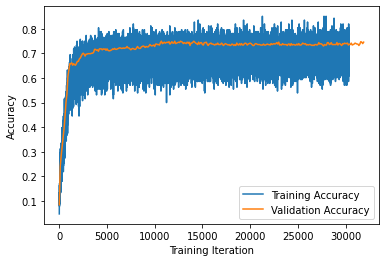

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()